In [2]:
library(remotes)
library(dplyr)
library(HandyCNV)
library(tidyr)
library(reshape2)
library(data.table)
library(tidyverse)

In [3]:
setwd(dir ="/branchinecta/jbazanwilliamson/CNVnator_Handy") #remember to replace the path with your own 

ERROR: Error in setwd(dir = "/branchinecta/jbazanwilliamson/CNVnator_Handy"): cannot change working directory


>>CNVnator sample

In [6]:
cnvnator.file <- read.csv("/branchinecta/jbazanwilliamson/cnvator_data_new_style.csv")
#names(cnvnator.file) <- c('X','CHR', 'START','END','SMPL`','state')

cnvnator.file

Sample_ID,Chr,Start,End,CNV_value
<chr>,<chr>,<int>,<int>,<int>
LP6005441-DNA_A01,1,1,10000,1
LP6005441-DNA_A01,1,11601,18400,3
LP6005441-DNA_A01,1,39901,48200,1
LP6005441-DNA_A01,1,49001,49700,1
LP6005441-DNA_A01,1,51201,64200,1
LP6005441-DNA_A01,1,64601,65000,1
LP6005441-DNA_A01,1,69401,70900,1
LP6005441-DNA_A01,1,71801,92900,1
LP6005441-DNA_A01,1,98001,100000,1


In [70]:
cnvnator.file$Chr <- as.double(cnvnator.file$Chr)
cnvnator.file$Start <- as.double(cnvnator.file$Start)
cnvnator.file$End <- as.double(cnvnator.file$End)
cnvnator.file$CNV_value <- as.double(cnvnator.file$CNV_value)
cnvnator.file <- na.omit(cnvnator.file) 

cnvnator.file

cnv = (data.frame(Sample_ID = c(cnvnator.file$Sample_ID),
                  Chr = c(cnvnator.file$Chr),
           Start = c(cnvnator.file$Start),
           End = c(cnvnator.file$End),
           CNV_Value = c(cnvnator.file$CNV_value)))

cnv


Warning message in eval(expr, envir, enclos):
“NAs introduced by coercion”


,Sample_ID,Chr,Start,End,CNV_value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,LP6005441-DNA_A01,1,1,10000,1
2,LP6005441-DNA_A01,1,11601,18400,3
3,LP6005441-DNA_A01,1,39901,48200,1
4,LP6005441-DNA_A01,1,49001,49700,1
5,LP6005441-DNA_A01,1,51201,64200,1
6,LP6005441-DNA_A01,1,64601,65000,1
7,LP6005441-DNA_A01,1,69401,70900,1
8,LP6005441-DNA_A01,1,71801,92900,1
9,LP6005441-DNA_A01,1,98001,100000,1


Sample_ID,Chr,Start,End,CNV_Value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
LP6005441-DNA_A01,1,1,10000,1
LP6005441-DNA_A01,1,11601,18400,3
LP6005441-DNA_A01,1,39901,48200,1
LP6005441-DNA_A01,1,49001,49700,1
LP6005441-DNA_A01,1,51201,64200,1
LP6005441-DNA_A01,1,64601,65000,1
LP6005441-DNA_A01,1,69401,70900,1
LP6005441-DNA_A01,1,71801,92900,1
LP6005441-DNA_A01,1,98001,100000,1


In [22]:
cnv_standard <- cnv_clean(standard_cnv = cnv, #when running your own data, set this argument by 'standard_cnv = "localpath/file"'
                 drop_length = 5, #the maximum CNV length threshold (in Mb); CNVs larger than this value will be deleted
                 folder = "cnv_clean")

There are 279 individuals with 1958029 CNVs in total.
The average number of CNV per individual is 7018.03
Basic summary stats by CNV type:
# A tibble: 2 × 5
  CNV_Value       N `Average Length` `Min Length` `Max Length`
      <dbl>   <int>            <dbl>        <dbl>        <dbl>
1         1 1601518            15713          200      3574100
2         3  356511            16061          200      4457000


In [23]:
cnv_visual(clean_cnv = cnv_standard, #standard file was generated by 'cnv_clean' function in section 1
           max_chr = 22, #select how many chromosomes to plot 
           width_1 = 20, #optional,adjust the width of final plot
           height_1 =12, #optional,adjust the height of final plot
           folder = "cnv_visual")

Input data passed requirment check...
[1] "Plotting the CNVs on Chromosome 1"
[1] "Plotting the CNVs on Chromosome 2"
[1] "Plotting the CNVs on Chromosome 3"
[1] "Plotting the CNVs on Chromosome 4"
[1] "Plotting the CNVs on Chromosome 5"
[1] "Plotting the CNVs on Chromosome 6"
[1] "Plotting the CNVs on Chromosome 7"
[1] "Plotting the CNVs on Chromosome 8"
[1] "Plotting the CNVs on Chromosome 9"
[1] "Plotting the CNVs on Chromosome 10"
[1] "Plotting the CNVs on Chromosome 11"
[1] "Plotting the CNVs on Chromosome 12"
[1] "Plotting the CNVs on Chromosome 13"
[1] "Plotting the CNVs on Chromosome 14"
[1] "Plotting the CNVs on Chromosome 15"
[1] "Plotting the CNVs on Chromosome 16"
[1] "Plotting the CNVs on Chromosome 17"
[1] "Plotting the CNVs on Chromosome 18"
[1] "Plotting the CNVs on Chromosome 19"
[1] "Plotting the CNVs on Chromosome 20"
[1] "Plotting the CNVs on Chromosome 21"
[1] "Plotting the CNVs on Chromosome 22"
Task done.


In [24]:
cnv_summary_plot(clean_cnv = cnv_standard, #standard file was generated by 'cnv_clean' function in section 1
                 length_group = c(0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 1, 2, 5), # optional, set group of vectors to divide CNV length, unit is Mb. such as vector of ‘c(0.05, 0.3, 1)’, means divide the CNV length into four group: '<0.05Mb', '0.05 - 0.3Mb', '0.3-1Mb' and '>1Mb', maximum can accept 11 valueses
                 col_0 = "red", #optional, customize color for o copy CNV 
                 col_1 = "black", #optional, customize color for o copy CNV 
                 col_3 = "purple", #optional, customize color for o copy CNV 
                 col_4 = "blue", #optional, customize color for o copy CNV 
                 plot_sum_1 = TRUE,  #optional, make sum combination plot 1
                 height_sum1 = 26, #optional, adjust the size of sum plot 1
                 width_sum1 = 20, #optional, adjust the size of sum plot 1
                 plot_sum_2 = TRUE, #optional, make sum combination plot 2
                 height_sum2 = 20, #optional, adjust the size of sum plot 2
                 width_sum2 = 27, #optional, adjust the size of sum plot 2
                 folder = "cnv_summary_plot_cnvnator")

Deviding the length group...
Plotting...
The CNV distribution plot has been saved in the 'cnv_summary_plot_cnvnator' directory.
The CNV length group plot was saved in the 'cnv_summary_plot_cnvnator' directory.
The box plot of CNV lengths was saved in the 'cnv_summary_plot_cnvnator' directory.
Distribution of CNV type on chromosome plot was saved in working directory.
The number of CNV in Individual plot was saved in working directory.
cnv_summary_plot_1 was saved in working directory.
cnv_summaray_polt_2 was saved in working directory.
Task done.


Input data passed requirment check...
Task done, plot was stored in working directory.


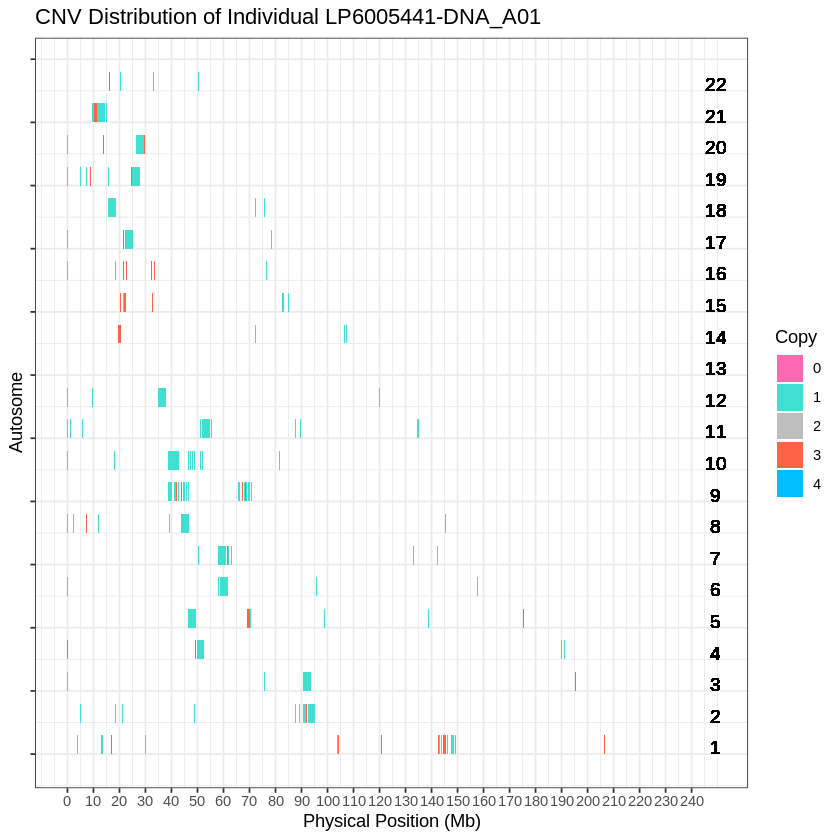

In [26]:
cnv_visual(clean_cnv = cnv_standard, #standard file was generated by 'cnv_clean' function in section 1
           individual_id = "LP6005441-DNA_A01", #set the sample ID  
           width_1 = 20, #optional, adjust the width of final plot
           height_1 = 13, #optional. adjust the height of final plot
           folder = "cnv_visual_LP6005441-DNA_A01")

In [27]:
cnvr_cnvnator <- call_cnvr(clean_cnv = cnv_standard, #standard file was generated by 'cnv_clean' function in section 1
                  chr_set = 22, #Set the maximum number of chromosomes (29 autosomes for cattle)
                  folder = "cnvr_cnvnator")


Output folder 'cnvr_cnvnator' was created in the working directory.
Chromosome 1 has been processed.
Chromosome 2 has been processed.
Chromosome 3 has been processed.
Chromosome 4 has been processed.
Chromosome 5 has been processed.
Chromosome 6 has been processed.
Chromosome 7 has been processed.
Chromosome 8 has been processed.
Chromosome 9 has been processed.
Chromosome 10 has been processed.
Chromosome 11 has been processed.
Chromosome 12 has been processed.
Chromosome 13 has been processed.
Chromosome 14 has been processed.
Chromosome 15 has been processed.
Chromosome 16 has been processed.
Chromosome 17 has been processed.
Chromosome 18 has been processed.
Chromosome 19 has been processed.
Chromosome 20 has been processed.
Chromosome 21 has been processed.
Chromosome 22 has been processed.
No 0-copy type detected in CNV list.
No 4-copy type detected in CNV list.
92667 CNVRs generated in total.
Overall summary of CNVRs:
# A tibble: 3 × 6
  Type      N `Average Length` `Min Length`

In [31]:
cnvr_cnvnator

CNVR_ID,Chr,Start,End,Frequency,n_Sample,1,3,Type,0,4,Length
<chr>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<chr>,<lgl>,<lgl>,<dbl>
CNVR_1,1,1,900700,8299,279,5668,2631,Mixed,NA,NA,900700
CNVR_2,1,911401,914300,260,260,260,NA,Loss,NA,NA,2900
CNVR_3,1,914701,919800,1,1,NA,1,Gain,NA,NA,5100
CNVR_4,1,933401,936400,12,12,12,NA,Loss,NA,NA,3000
CNVR_5,1,936801,937600,2,2,2,NA,Loss,NA,NA,800
CNVR_6,1,953801,956600,94,94,94,NA,Loss,NA,NA,2800
CNVR_7,1,961901,966900,57,55,50,7,Mixed,NA,NA,5000
CNVR_8,1,968401,970800,79,78,79,NA,Loss,NA,NA,2400
CNVR_9,1,974701,991100,107,88,101,6,Mixed,NA,NA,16400


In [30]:
get_refgene()

Please select which version to download from following list:
 [1] "Cow_ARS_UCSC"            "Cow_ARS_ENS"            
 [3] "Cow_UMD_UCSC"            "Pig_susScr11_UCSC"      
 [5] "Pig_susScr11_ENS"        "Human_hg38"             
 [7] "Human_hg19"              "Sheep_Oar_v4.0_UCSC"    
 [9] "Sheep_Oar_v3.1_UCSC"     "Sheep_Oar_v3.1_ENS"     
[11] "Horse_equCab3.0_UCSC"    "Horse_equCab2.0_UCSC"   
[13] "Dog_UMICH_Zoey_3.1_UCSC" "Dog_UMICH_Zoey_3.1_ENS" 
[15] "Chicken_galGal6_UCSC"    "Chicken_galGal5_UCSC"   


In [32]:
Human_hg38 <- get_refgene(gene_version = "Human_hg38")

Link to the website...
Converting format...
Task done.


In [33]:
call_gene(refgene = "refgene/Human_hg38.txt", #standard file was generated by 'get_refgene' function in section 5.1
          interval = cnvr_cnvnator, #optional, standard file was generated by 'call_cnvr' function in section 4
          clean_cnv = cnv_standard, #optional, standard file was generated by 'cnv_clean' function in section 1
          folder = "call_gene_CNVNator_Hg38")

Output folder 'call_gene_CNVNator_Hg38' has been created in the working directory.
Checking gene annotation status in the interval file...
Summary of annotation results:
  Interval_Has_Gene Interval_Without_Gene Total_Number_of_Genes
1             45754                 46913                 23938
Checking gene annotation status in CNV file...
23938 genes were matched in the CNV and CNVR results. The 10 most frequent genes:
# A tibble: 10 × 2
# Groups:   name2 [10]
   name2     Frequency
   <chr>         <int>
 1 APBA1          4960
 2 PTPRN2         4359
 3 DLGAP2         4035
 4 CNTNAP3B       3619
 5 TCAF2          3393
 6 TRPM3          3028
 7 CNTNAP3P2      2879
 8 ACOXL          2808
 9 NSD1           2550
10 PGM5           2363


Warning message in call_gene(refgene = "refgene/Human_hg38.txt", interval = cnvr_cnvnator, :
“The following genes are duplicated in multiple CNVRs, and will only be annotated on the first CNVR_ID in the final gene frequency list report!
”


           name2         ID Chr  i.Start    i.End
    1: MIR6859-1     CNVR_1   1        1   900700
    2: MIR6859-2     CNVR_1   1        1   900700
    3: MIR6859-3     CNVR_1   1        1   900700
    4: MIR6859-4     CNVR_1   1        1   900700
    5: MIR1302-2     CNVR_1   1        1   900700
   ---                                           
44973: RPL23AP82 CNVR_92649  22 50774101 50774400
44974:    RABL2B CNVR_92649  22 50774101 50774400
44975: RPL23AP82 CNVR_92650  22 50775401 50786200
44976:    RABL2B CNVR_92650  22 50775401 50786200
44977: RPL23AP82 CNVR_92651  22 50797101 50809000


name2,Frequency,ID,Chr,CNVR_Start,CNVR_End
<chr>,<int>,<chr>,<int>,<dbl>,<dbl>
APBA1,4960,CNVR_59106,9,66454701,71939600
PTPRN2,4359,CNVR_53243,7,156643801,158047400
DLGAP2,4035,CNVR_53264,8,600301,1196500
CNTNAP3B,3619,CNVR_59102,9,38607401,44899600
TCAF2,3393,CNVR_52813,7,142674201,142679100
TRPM3,3028,CNVR_59106,9,66454701,71939600
CNTNAP3P2,2879,CNVR_59106,9,66454701,71939600
ACOXL,2808,CNVR_12038,2,110674301,111074000
NSD1,2550,CNVR_40222,5,177092401,177168900


In [35]:
cnvr_plot(cnvr = "cnvr_cnvnator/cnvr.txt", #standard file was generated by 'call_cnvr' function in section 4
          assembly = "Homo Sapiens", #cattle could select 'UMD' or 'ARS', other species could assign the name of species
          loss_col = "green2", #optional, adjust the color of Loss type of CNVR
          gain_col = "red", #optional, adjust the color of Gain type of CNVR
          mixed_col = "black",  #optional, adjust the color of Mixed type of CNVR
          legend_x = 127, #optional, adjust the horizontal position of legend
          legend_y = 30,  #optional, adjust the vertical position of legend
          #height_1 = 14, #optional, adjust the height of CNVR plot
          #width_1 = 10, #optional, adjust the width of CNVR plot
          folder = "cnvr_plot_cnvnator")

Task done, CNVR Distribution Plot saved in working directory.


There 2064 high frequency CNVR passed the customized threshold.
[1] "Ploting CNVR 1..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1e-06 - 0.9007 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 0.911401 - 0.9143 Mb with 260 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 3..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 0.999901 - 1.001 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


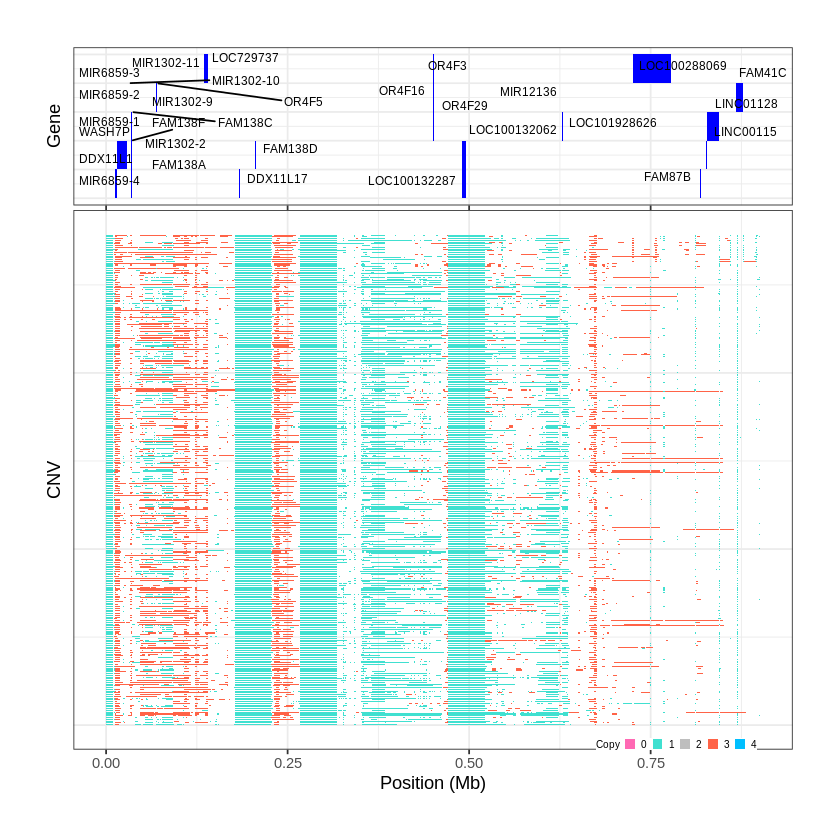

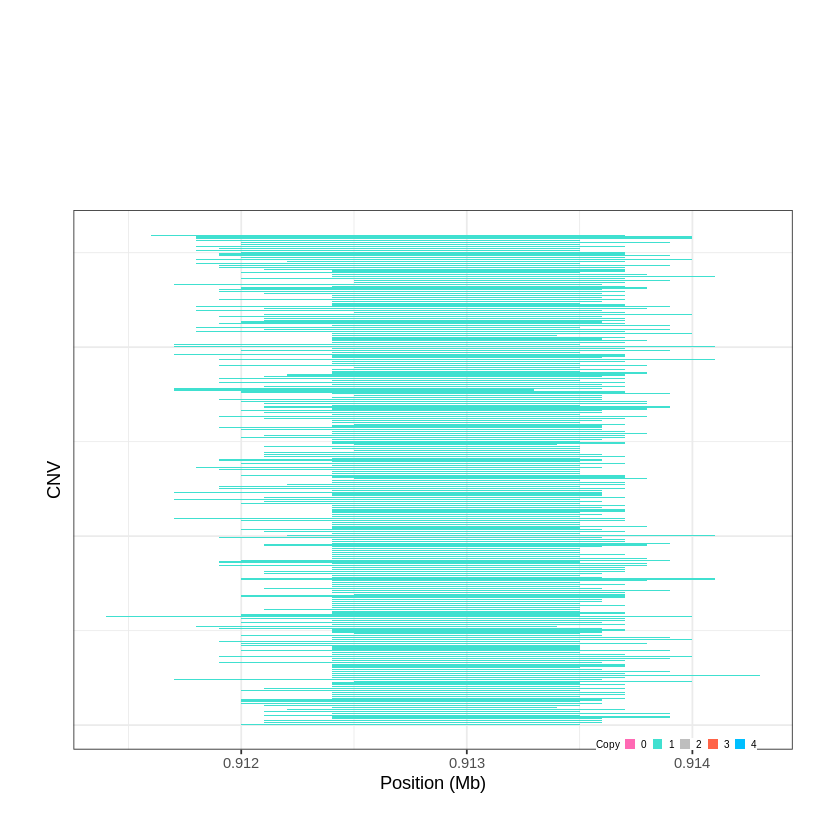

Task done, plot was stored in working directory.
[1] "Ploting CNVR 4..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.007801 - 1.0152 Mb with 265 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 5..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.073901 - 1.0773 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


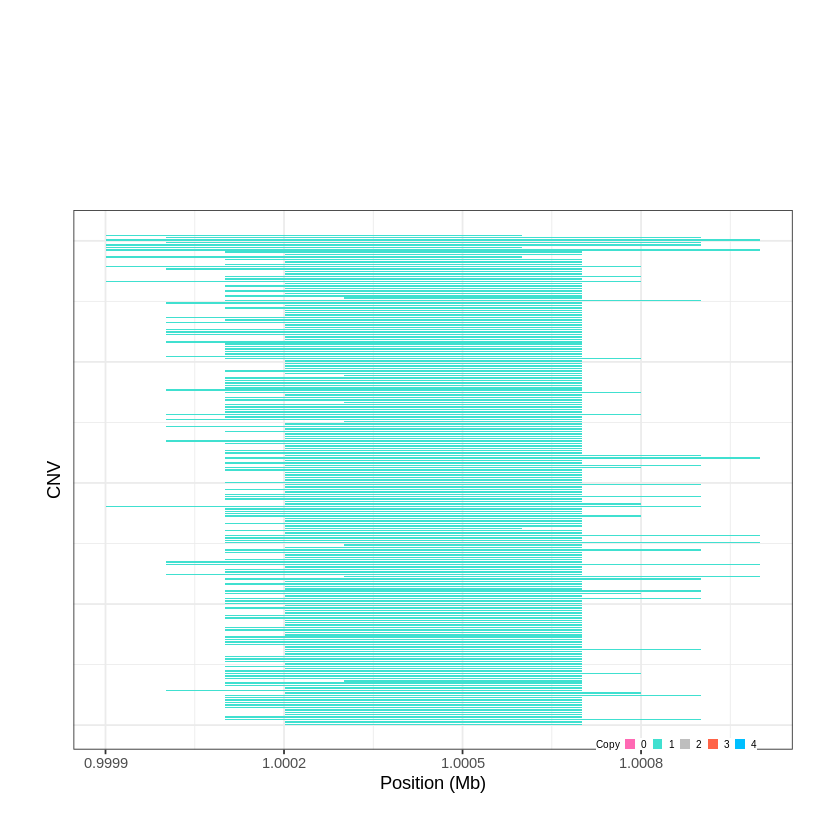

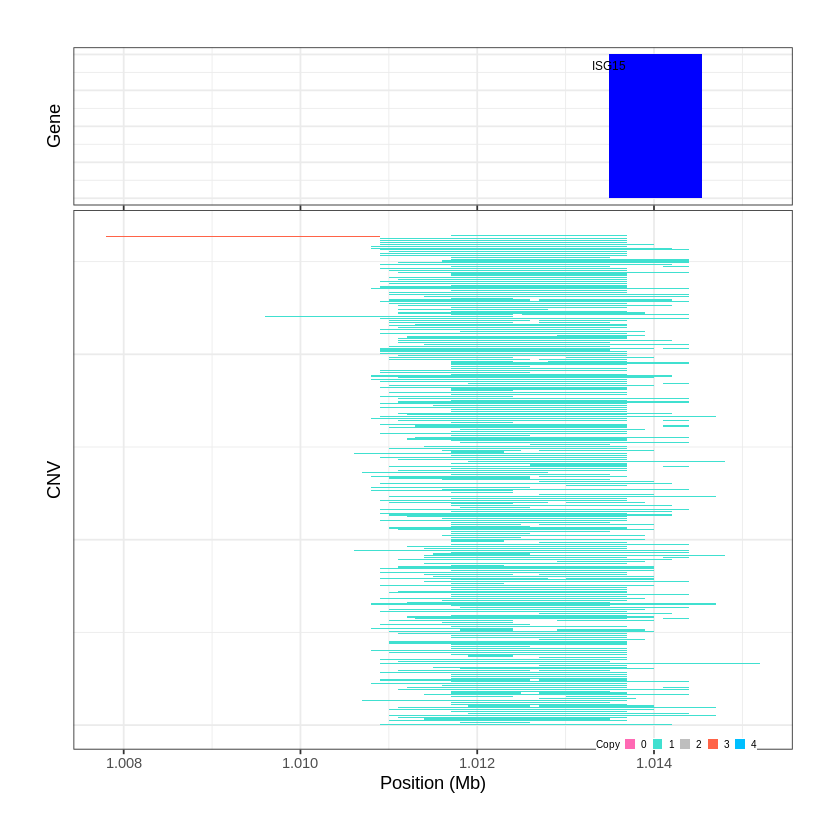

Task done, plot was stored in working directory.
[1] "Ploting CNVR 6..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.178301 - 1.1896 Mb with 253 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 7..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.215601 - 1.2258 Mb with 253 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


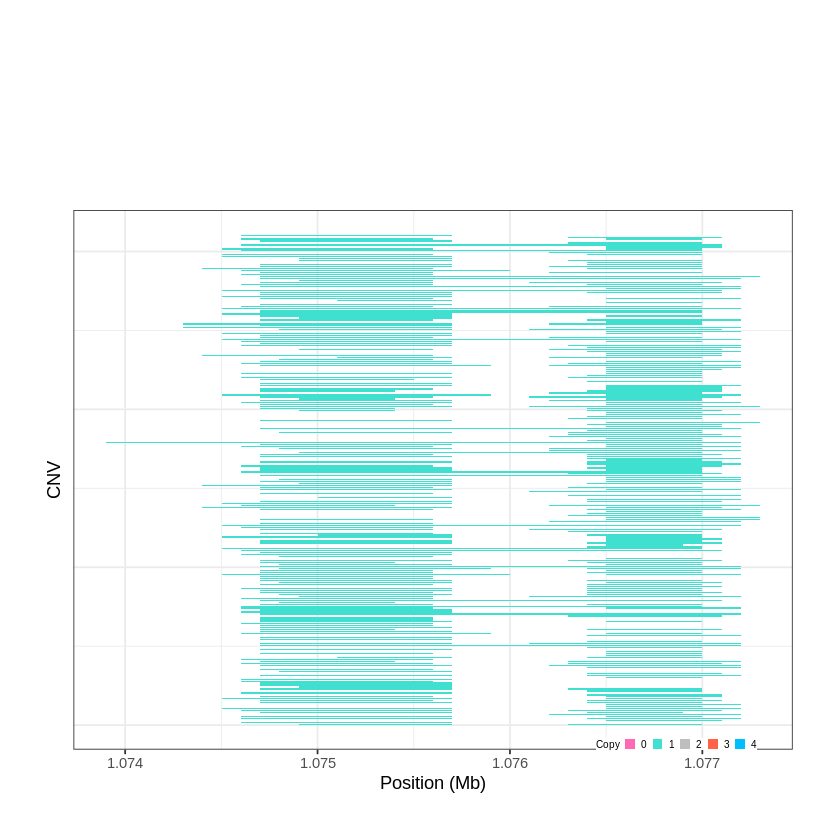

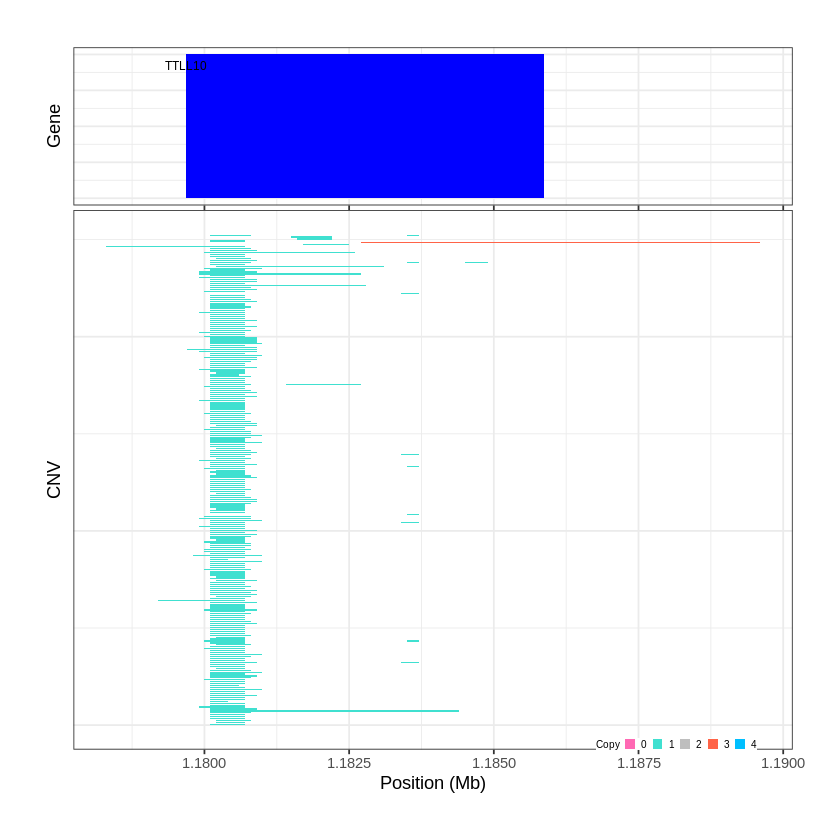

Task done, plot was stored in working directory.
[1] "Ploting CNVR 8..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.254701 - 1.2931 Mb with 278 Individual - "
Plotting gene...


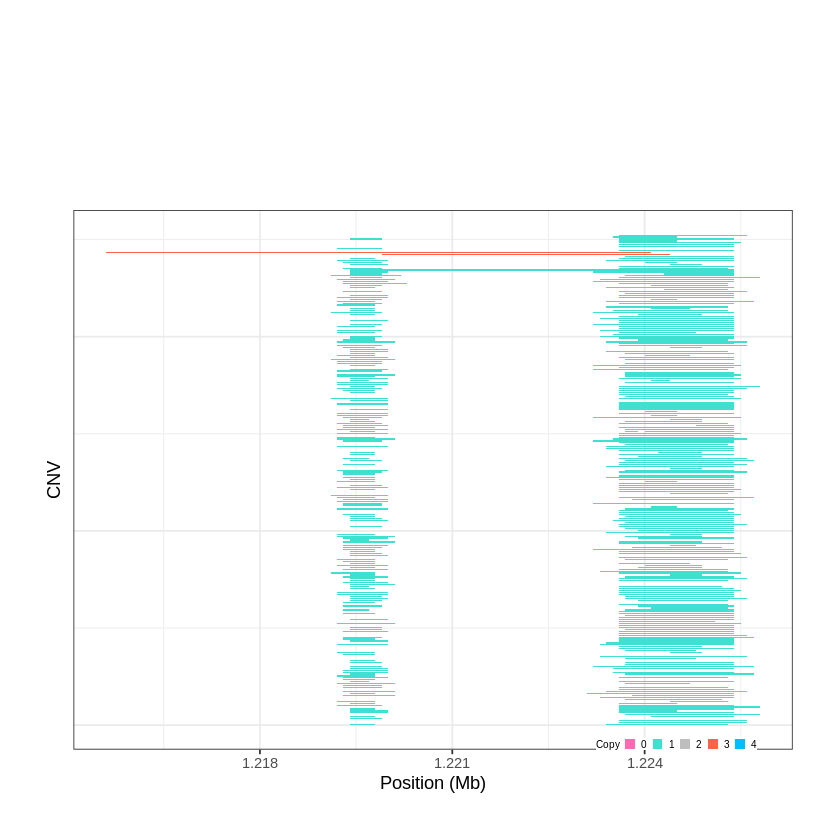

Task done, plot was stored in working directory.
[1] "Ploting CNVR 9..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.298901 - 1.3054 Mb with 178 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 10..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.361001 - 1.3641 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


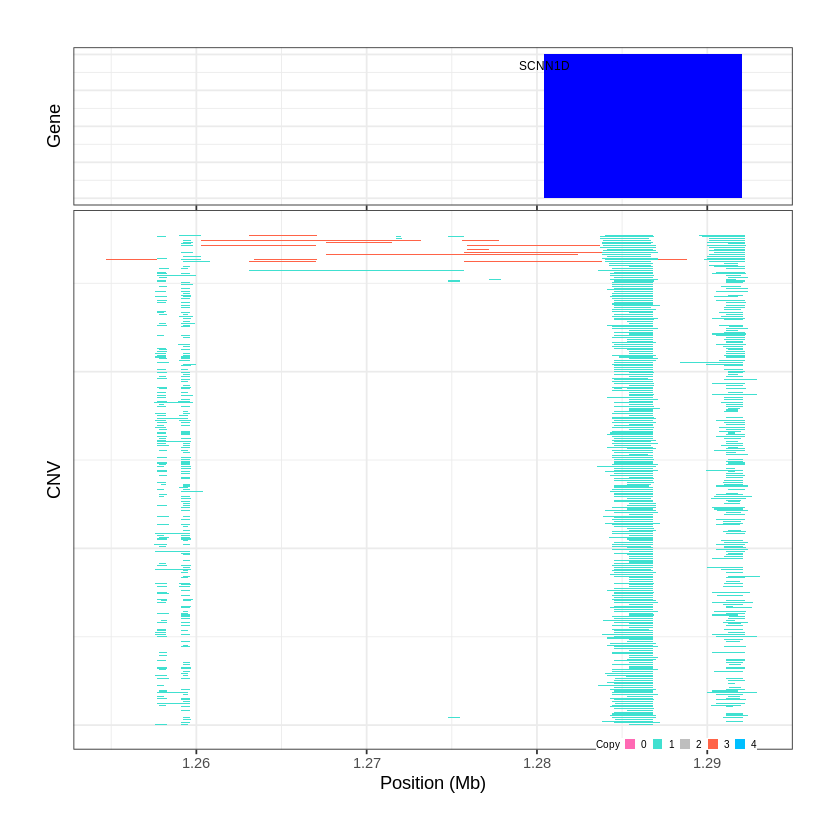

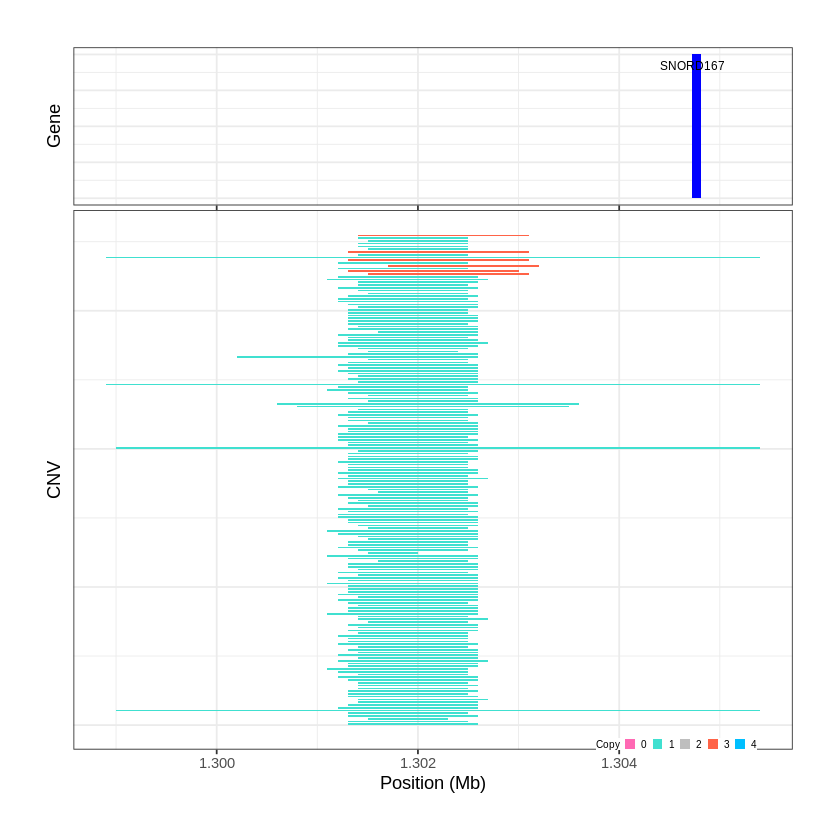

Task done, plot was stored in working directory.
[1] "Ploting CNVR 11..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.378801 - 1.4544 Mb with 146 Individual - "
Plotting gene...


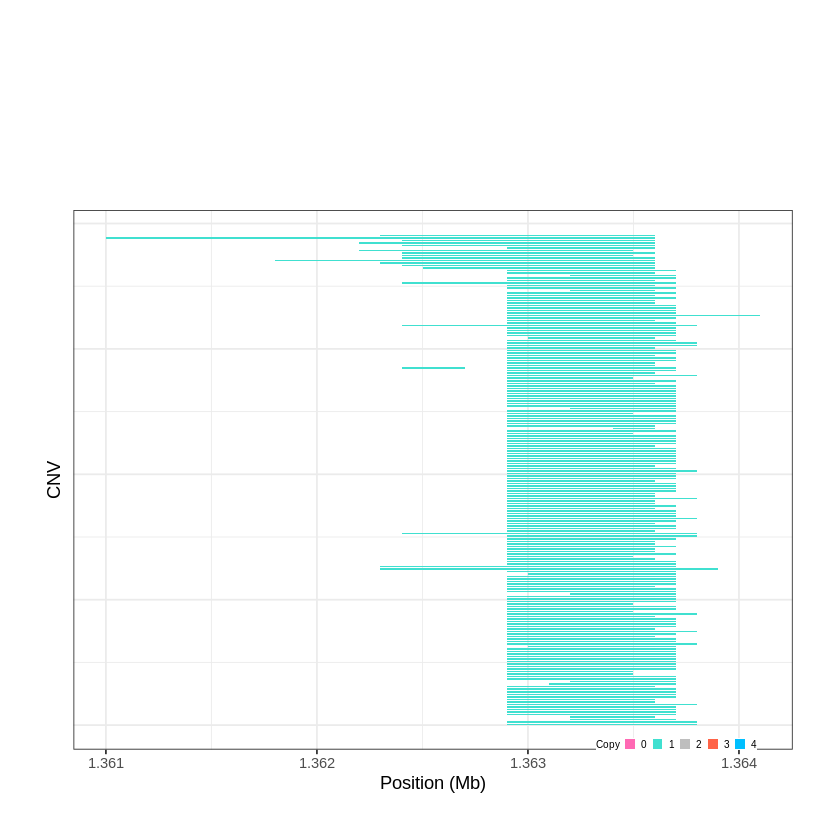

Task done, plot was stored in working directory.
[1] "Ploting CNVR 12..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 1.560701 - 2.4544 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 13..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 2.522701 - 2.5244 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


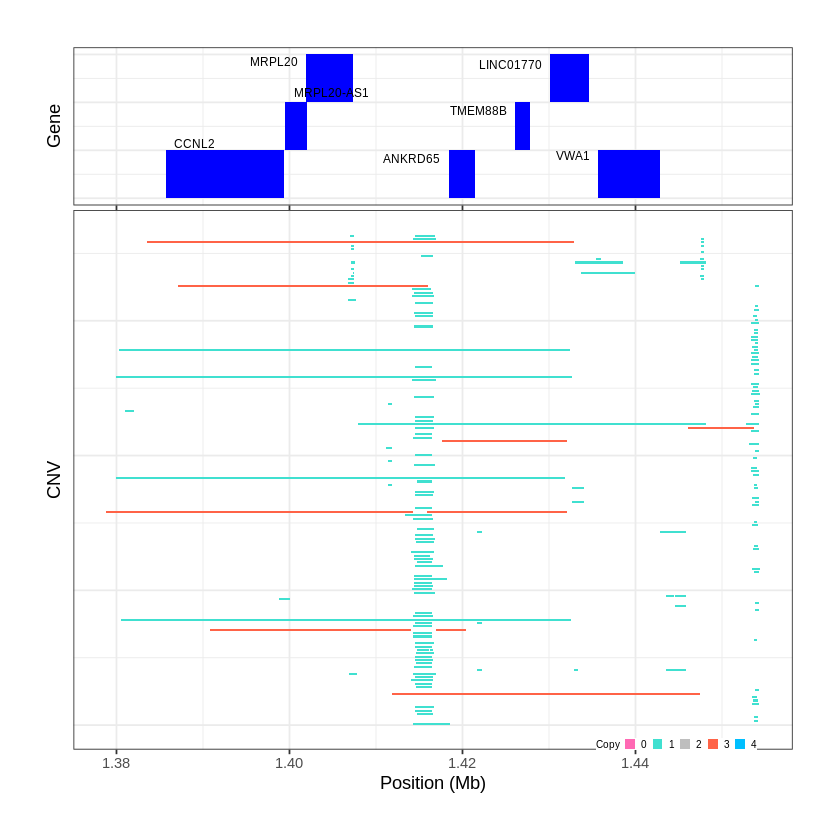

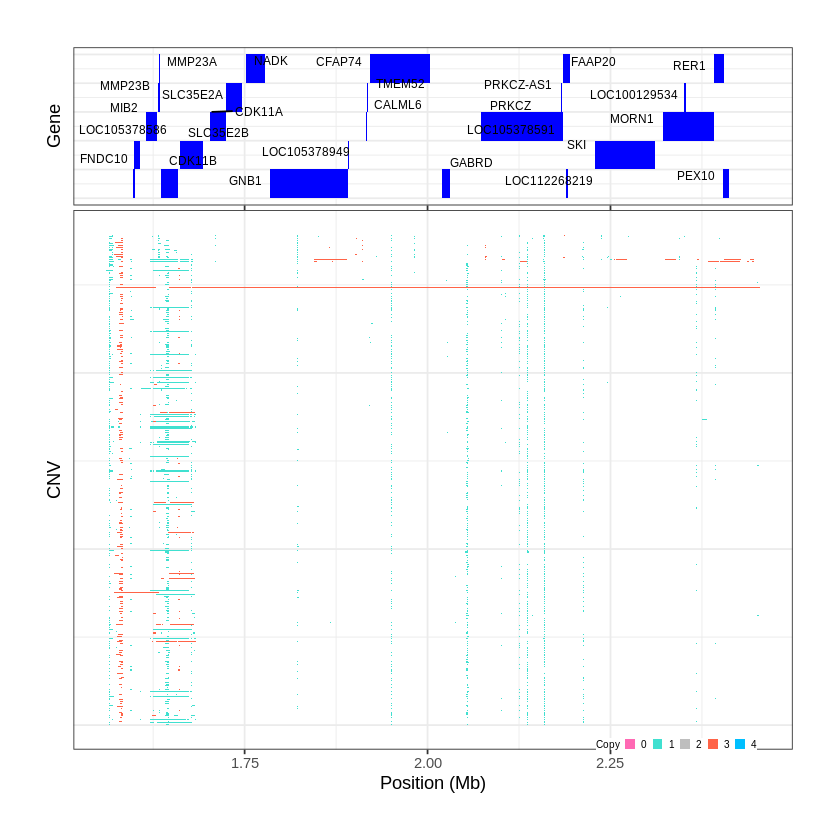

Task done, plot was stored in working directory.
[1] "Ploting CNVR 14..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 2.530201 - 4.2374 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


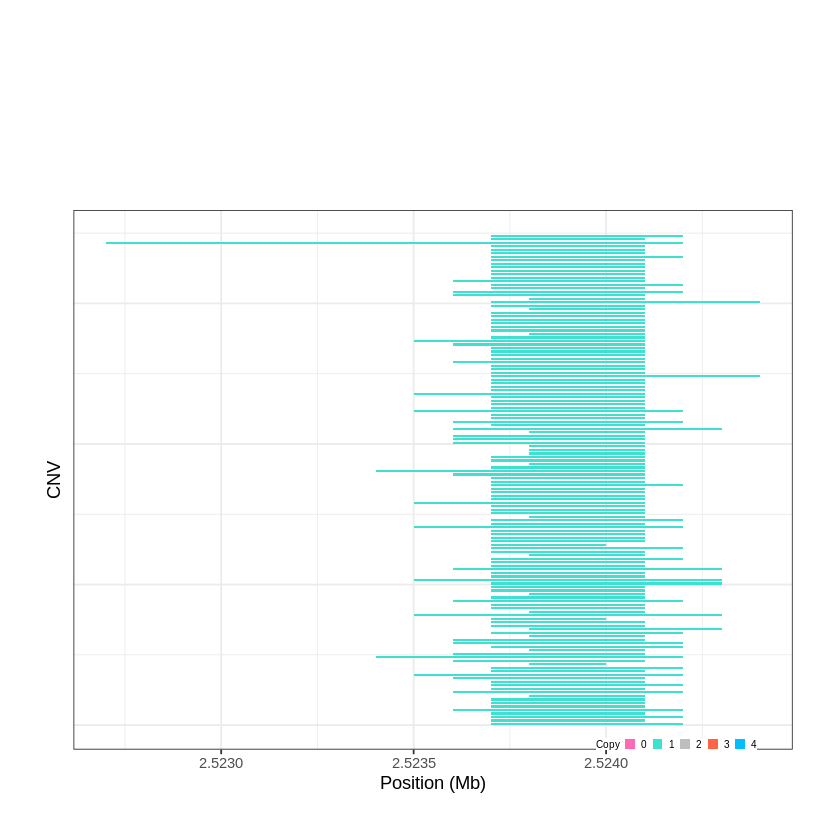

Task done, plot was stored in working directory.
[1] "Ploting CNVR 15..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 5.871901 - 6.8608 Mb with 252 Individual - "
Plotting gene...


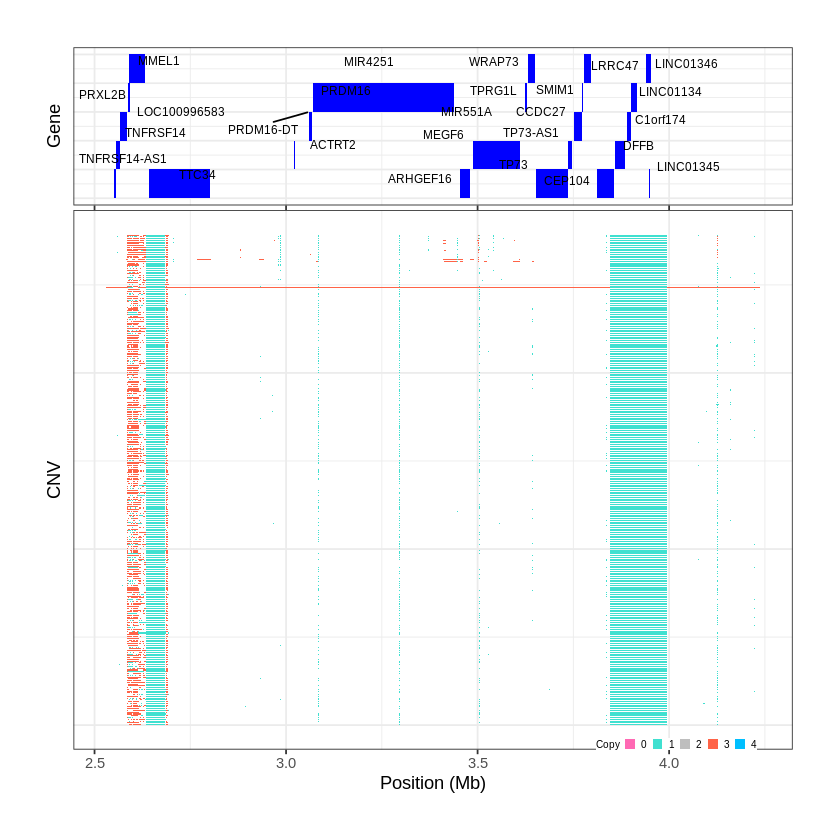

Task done, plot was stored in working directory.
[1] "Ploting CNVR 16..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 7.462901 - 7.8449 Mb with 185 Individual - "
Plotting gene...


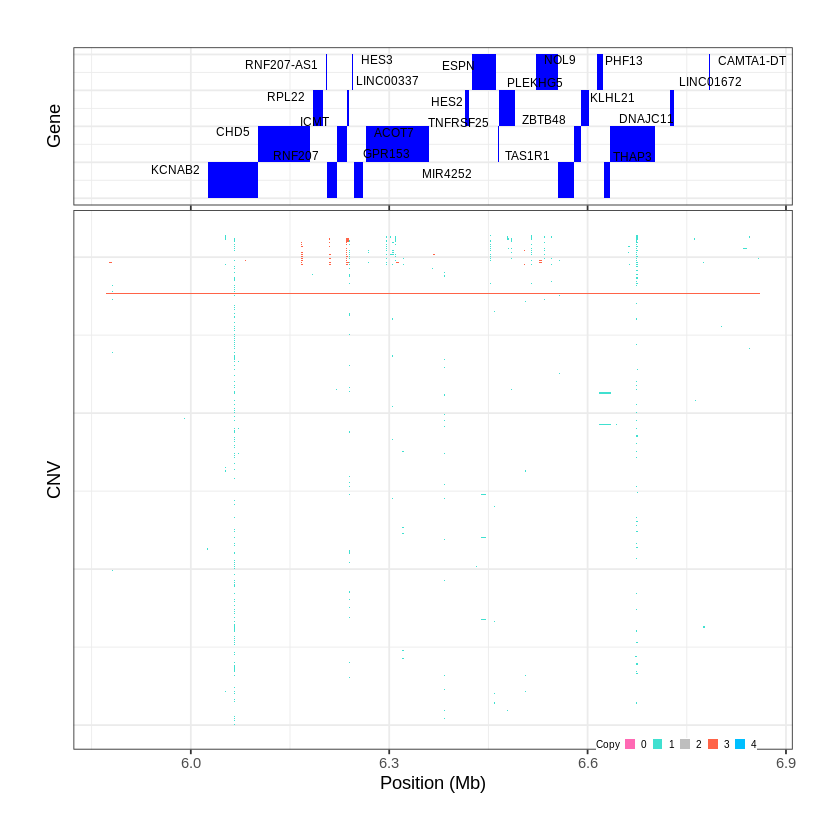

Task done, plot was stored in working directory.
[1] "Ploting CNVR 17..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 7.868301 - 8.0725 Mb with 161 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 18..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 9.828101 - 9.8294 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


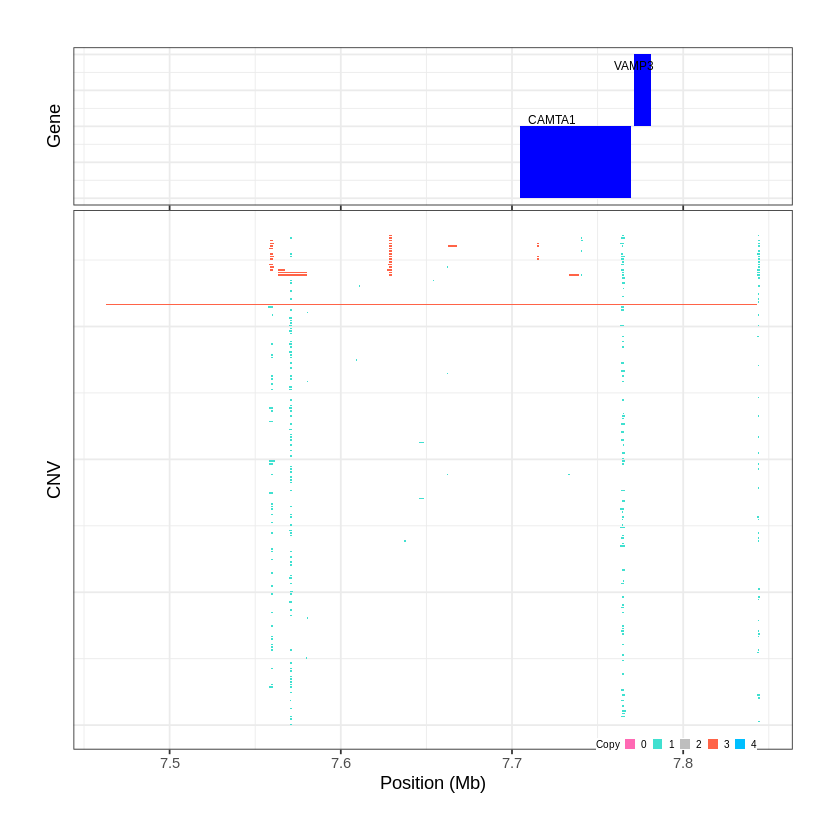

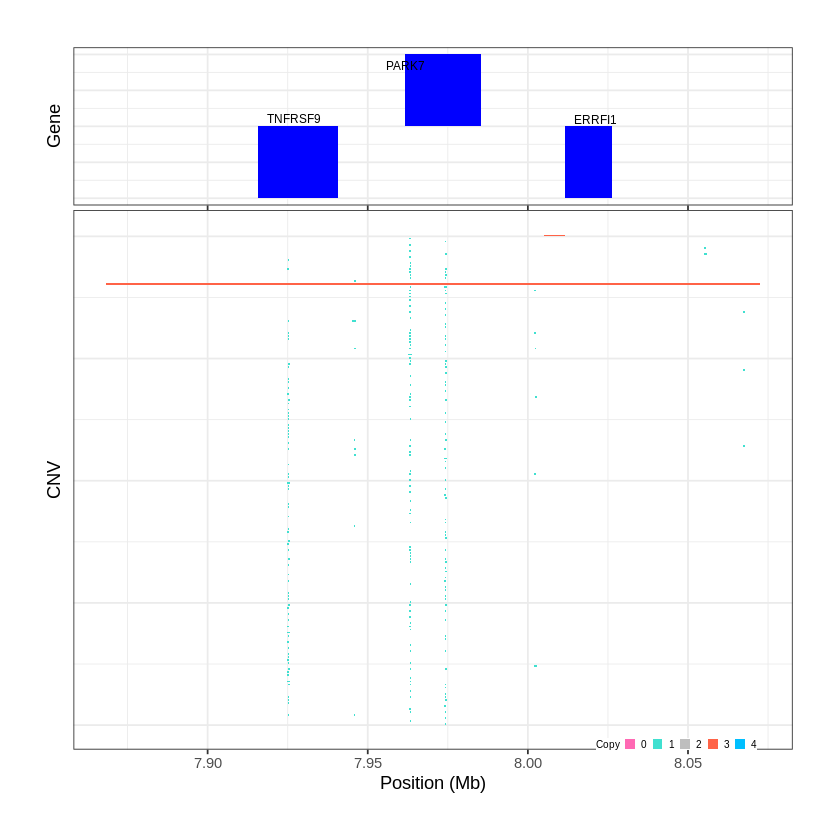

Task done, plot was stored in working directory.
[1] "Ploting CNVR 19..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 10.384101 - 11.0418 Mb with 172 Individual - "
Plotting gene...


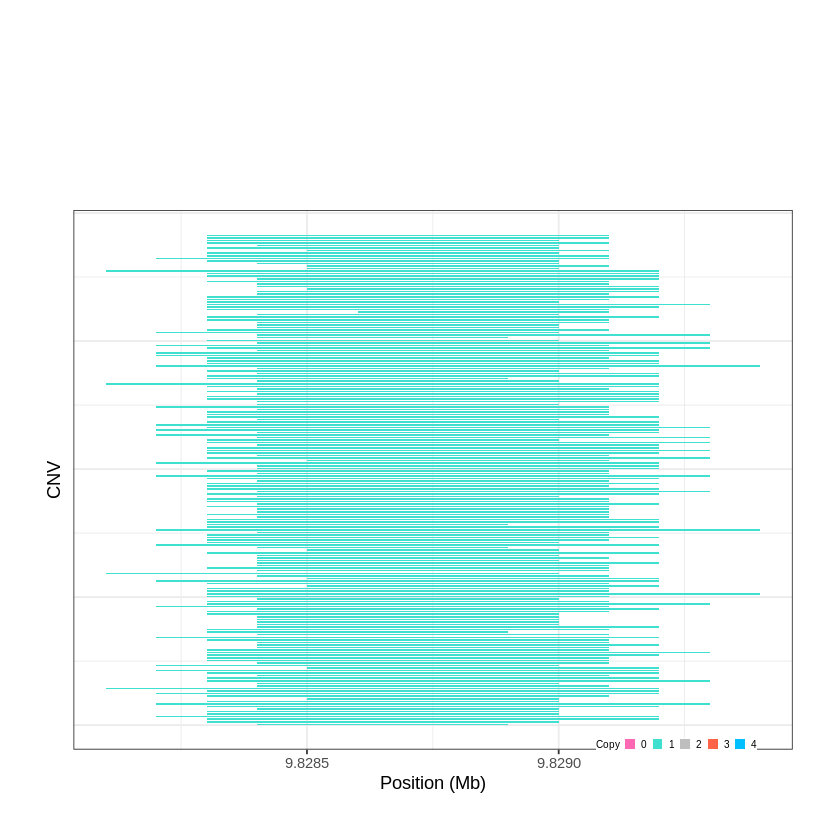

Task done, plot was stored in working directory.
[1] "Ploting CNVR 20..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 11.474401 - 12.3219 Mb with 200 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


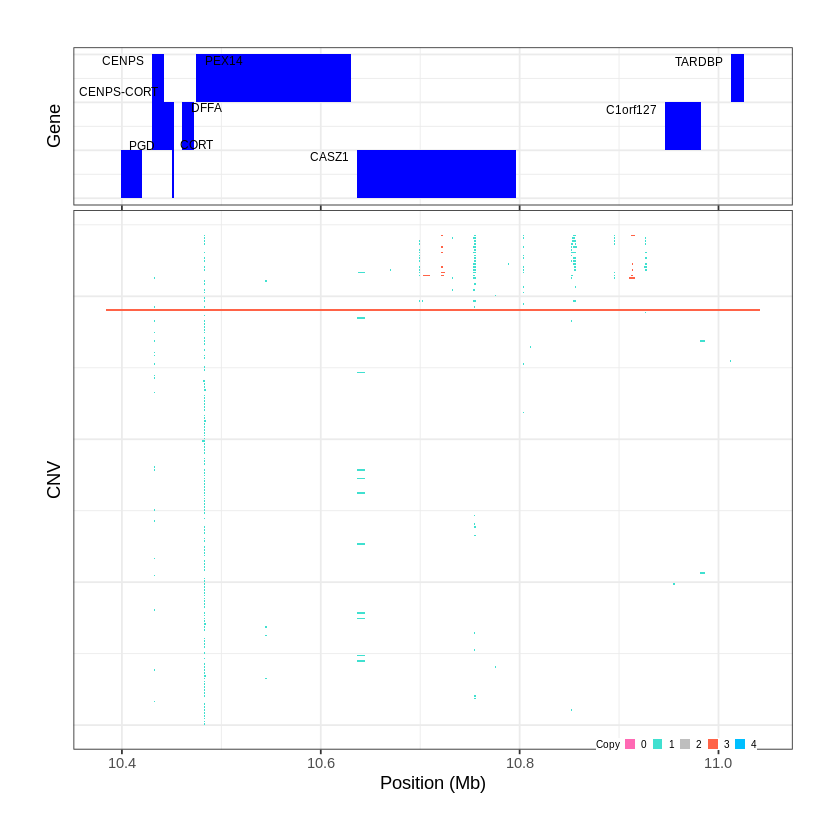

Task done, plot was stored in working directory.
[1] "Ploting CNVR 21..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 12.811501 - 14.0434 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 19 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 22..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 14.436301 - 14.4394 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


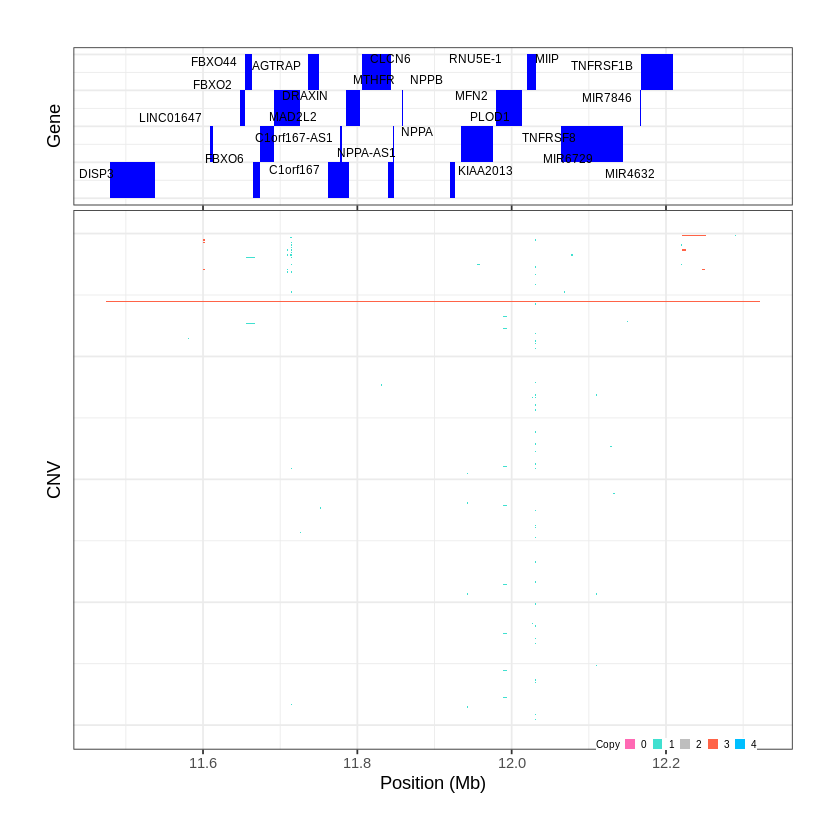

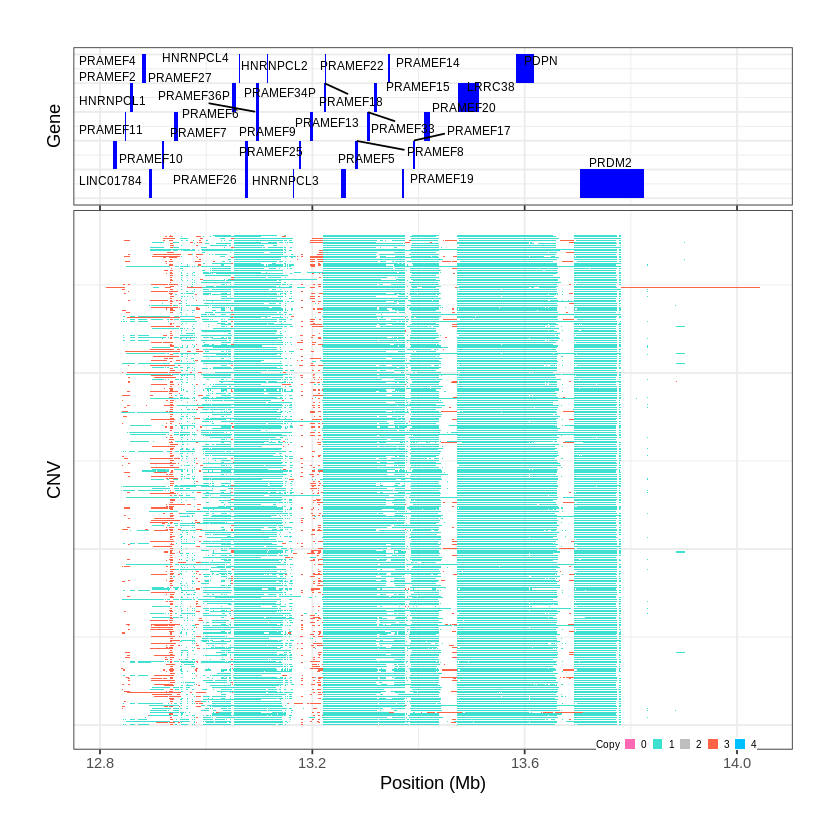

Task done, plot was stored in working directory.
[1] "Ploting CNVR 23..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 15.208801 - 15.9847 Mb with 221 Individual - "
Plotting gene...


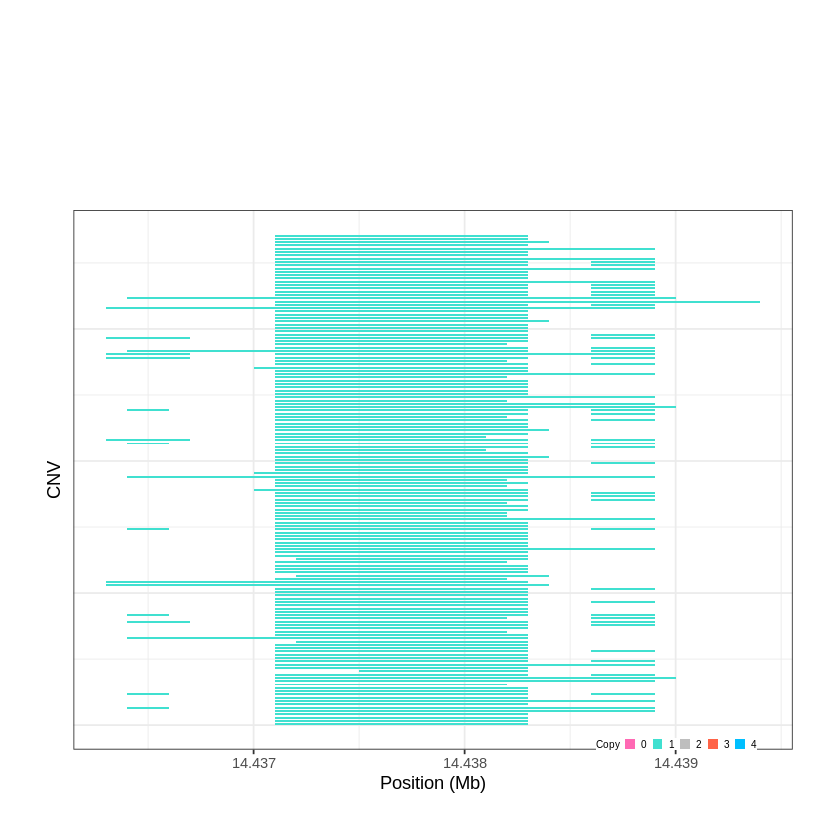

Task done, plot was stored in working directory.
[1] "Ploting CNVR 24..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 16.232401 - 16.5798 Mb with 182 Individual - "
Plotting gene...


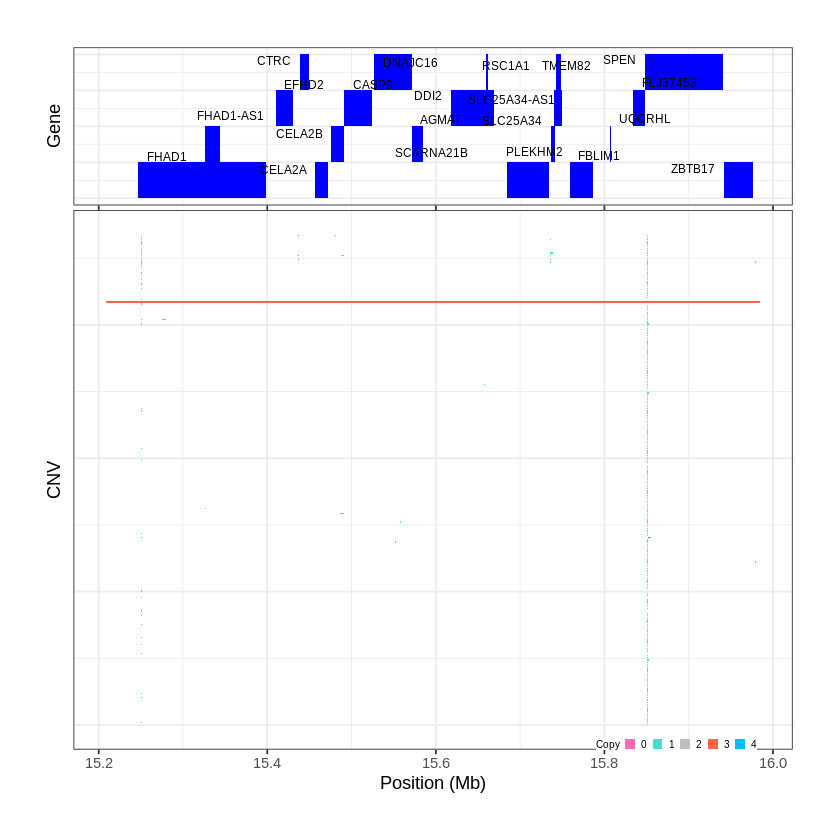

Task done, plot was stored in working directory.
[1] "Ploting CNVR 25..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 16.831401 - 17.2807 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 26..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 17.299801 - 17.3019 Mb with 172 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


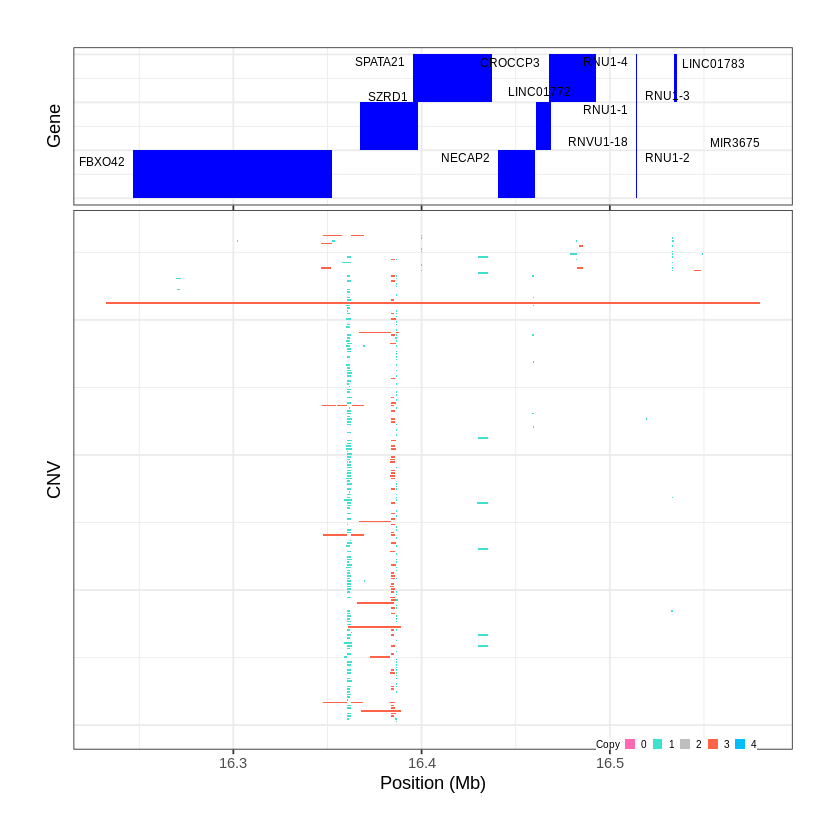

Task done, plot was stored in working directory.
[1] "Ploting CNVR 27..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 17.657801 - 17.6792 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


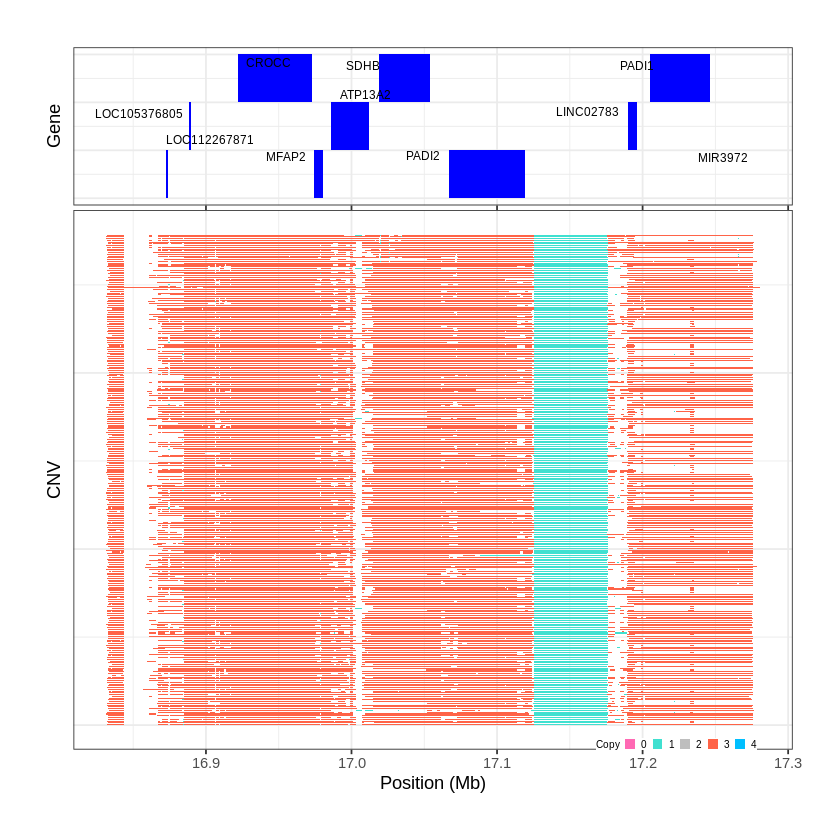

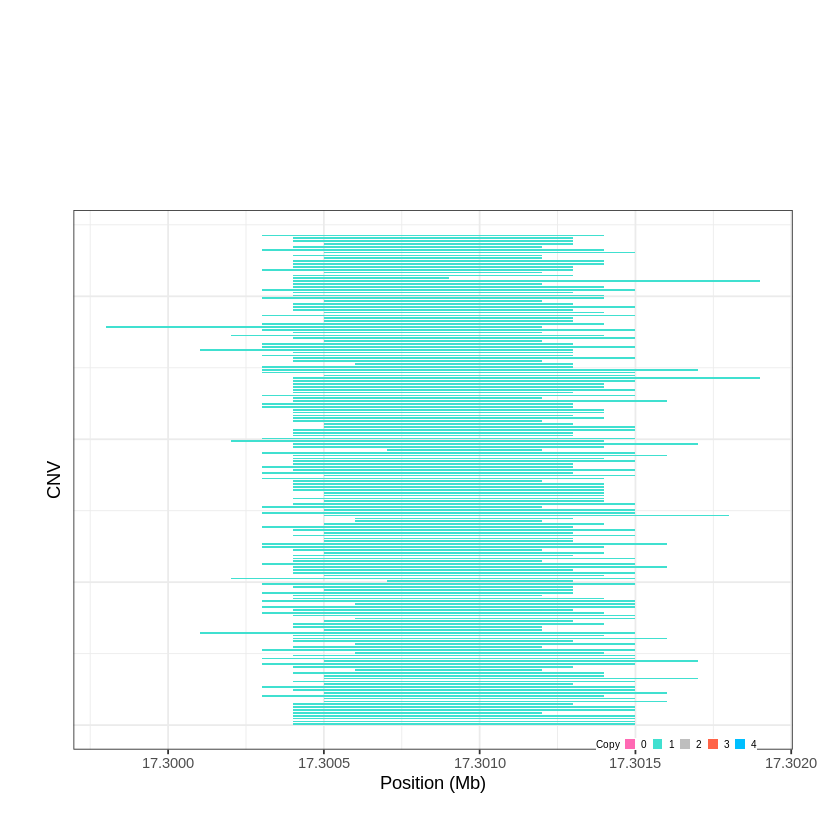

Task done, plot was stored in working directory.
[1] "Ploting CNVR 28..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 17.679701 - 18.1853 Mb with 162 Individual - "
Plotting gene...


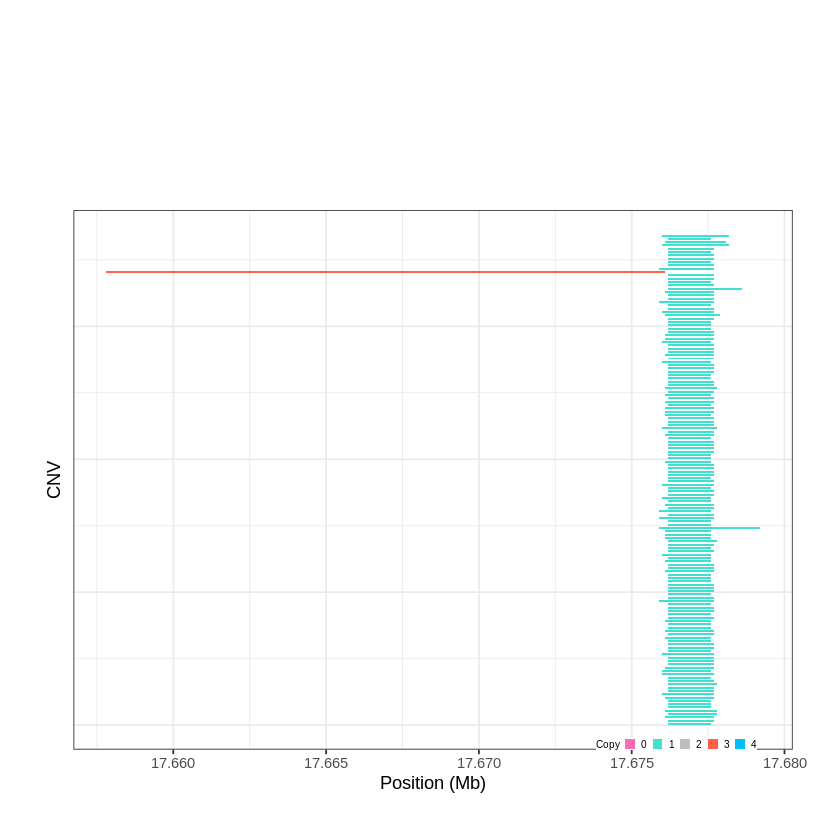

Task done, plot was stored in working directory.
[1] "Ploting CNVR 29..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 20.615301 - 20.7179 Mb with 186 Individual - "
Plotting gene...


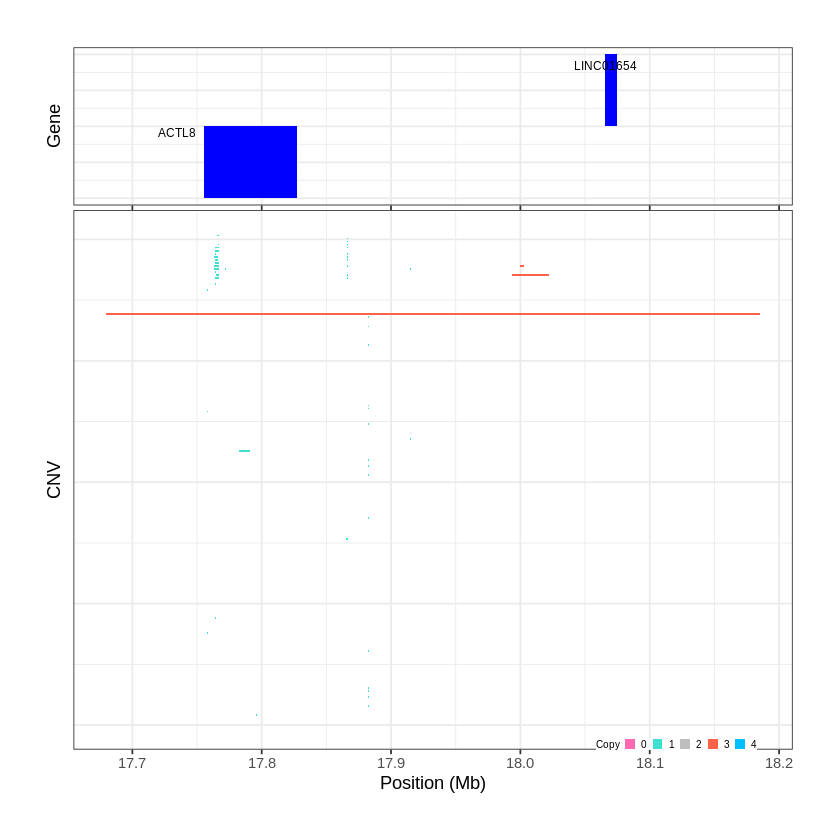

Task done, plot was stored in working directory.
[1] "Ploting CNVR 30..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 21.531401 - 21.7711 Mb with 252 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 31..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 21.803501 - 21.8126 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


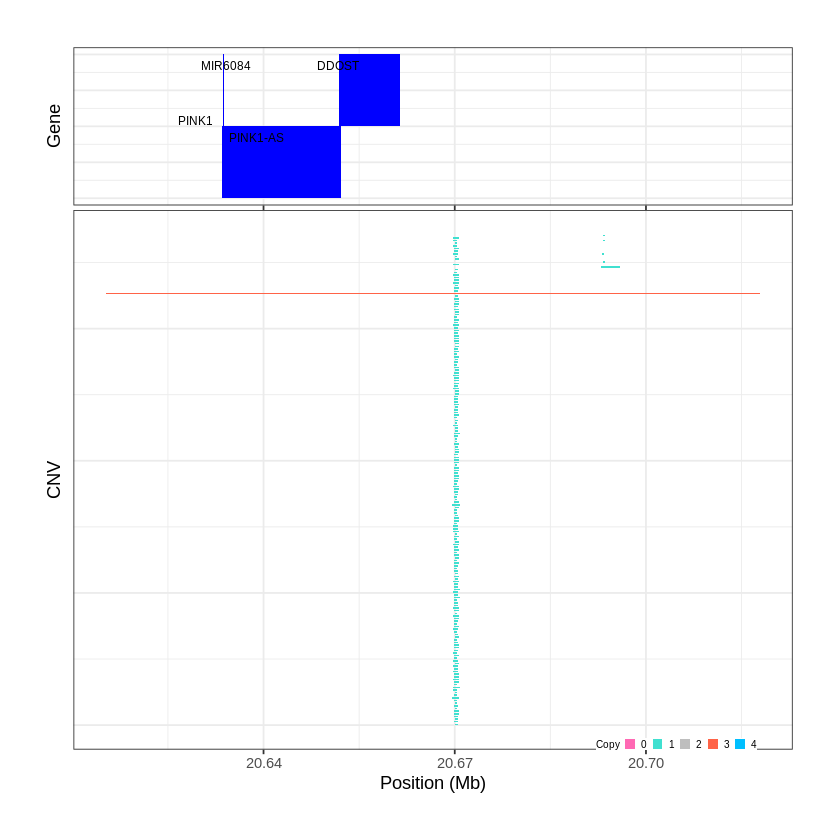

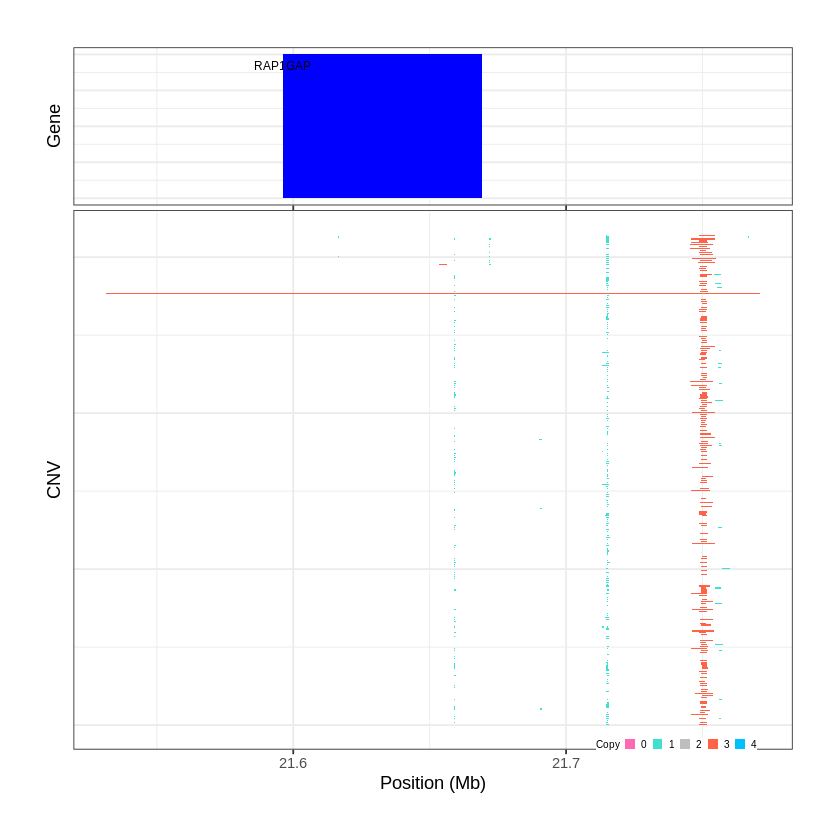

Task done, plot was stored in working directory.
[1] "Ploting CNVR 32..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 24.243701 - 24.3641 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 33..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 25.158701 - 25.204 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


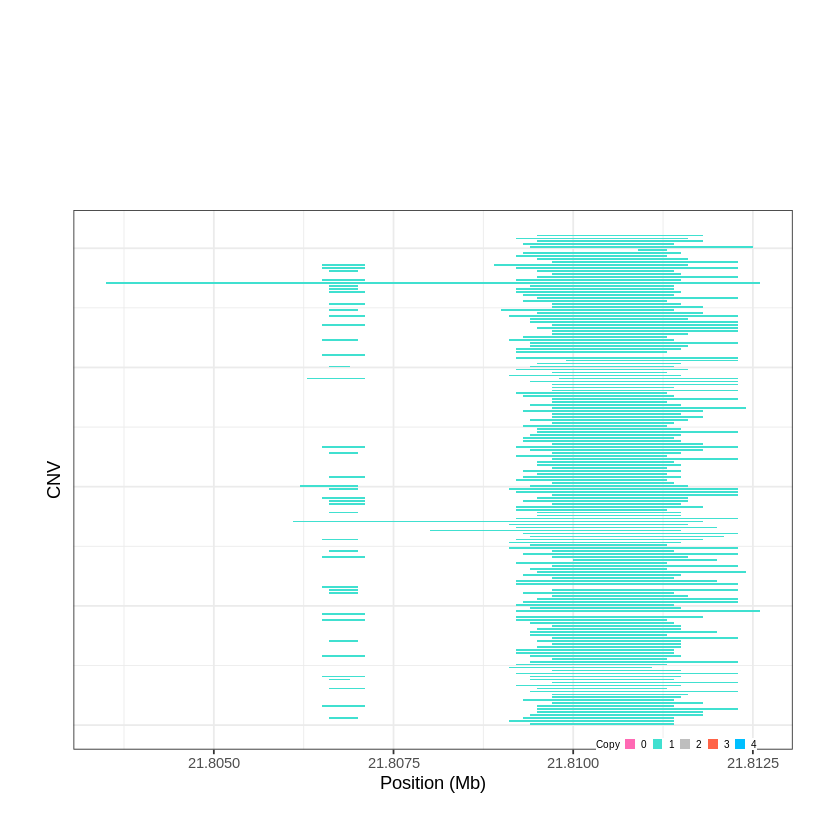

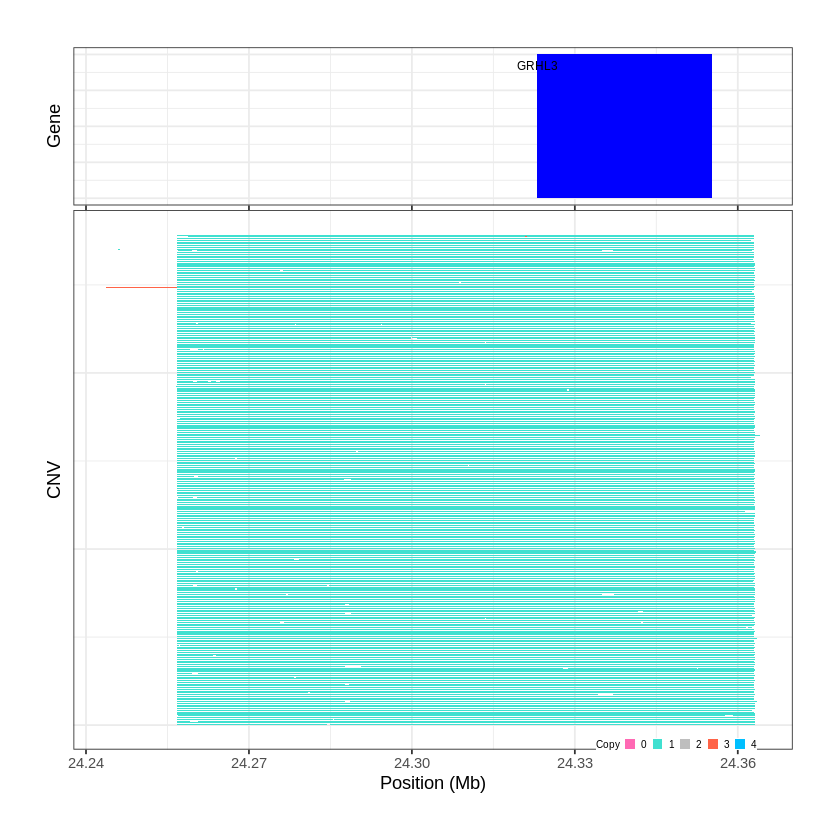

Task done, plot was stored in working directory.
[1] "Ploting CNVR 34..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 25.490901 - 25.7662 Mb with 259 Individual - "
Plotting gene...


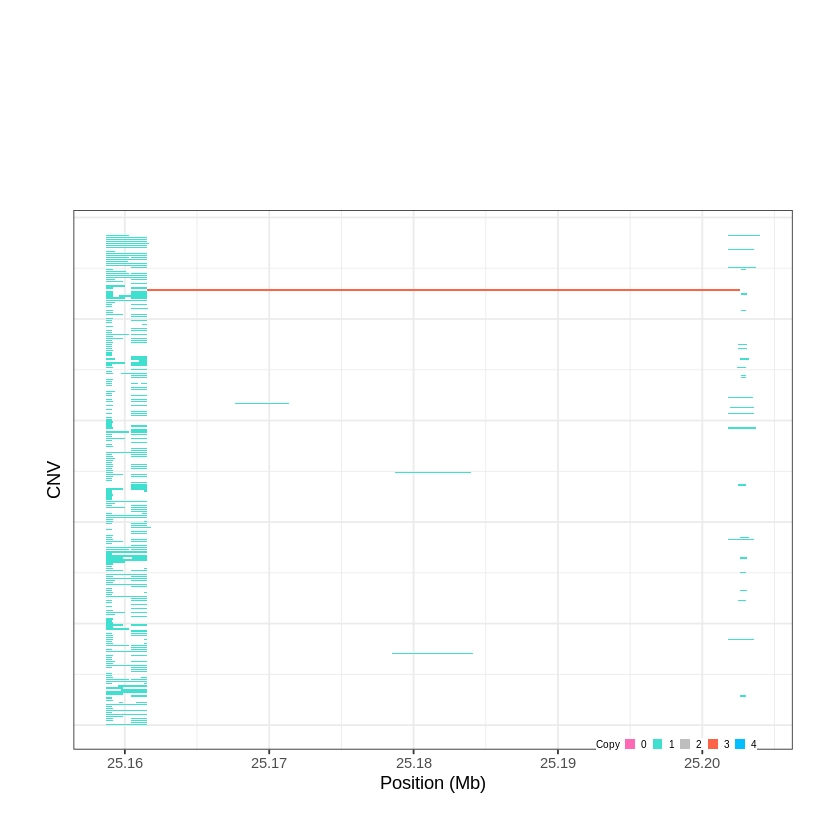

Task done, plot was stored in working directory.
[1] "Ploting CNVR 35..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 25.969801 - 26.4244 Mb with 146 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 36..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 28.178401 - 28.1814 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


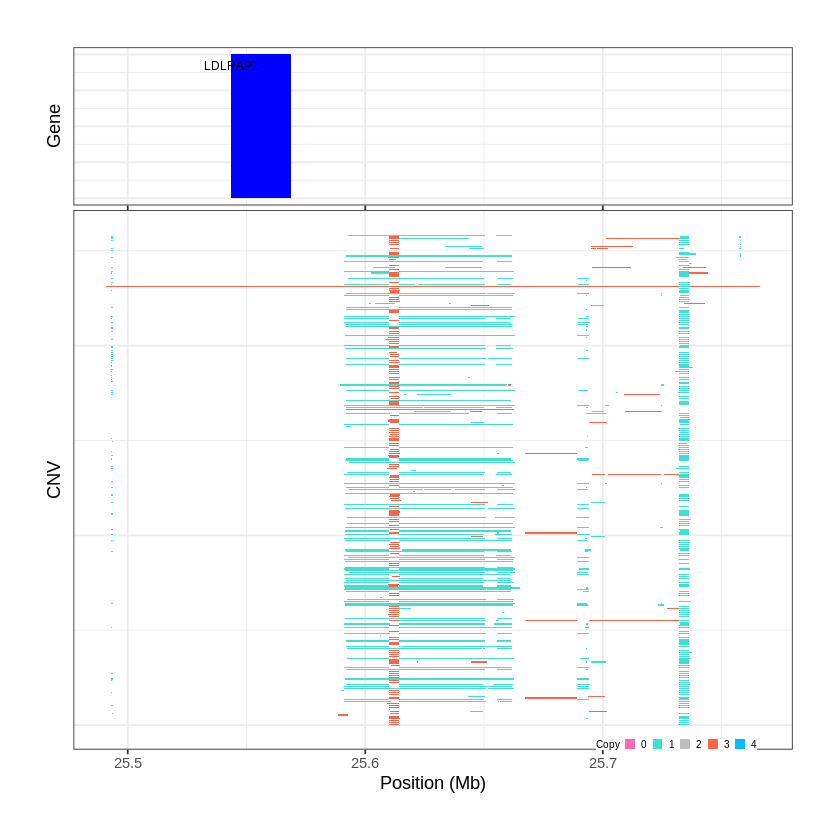

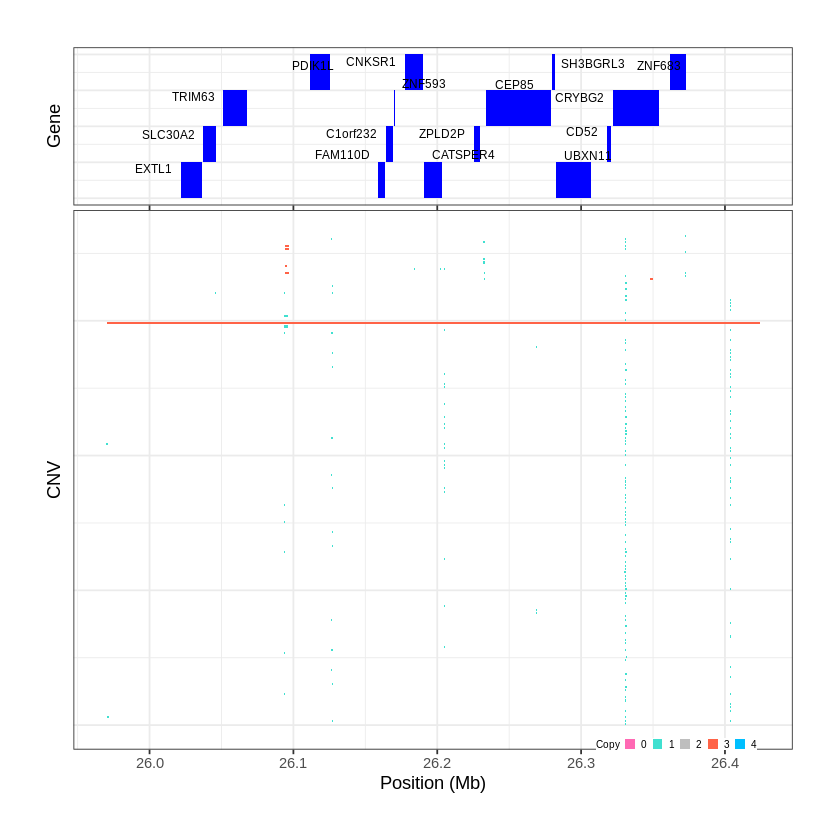

Task done, plot was stored in working directory.
[1] "Ploting CNVR 37..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 28.220901 - 28.3162 Mb with 177 Individual - "
Plotting gene...


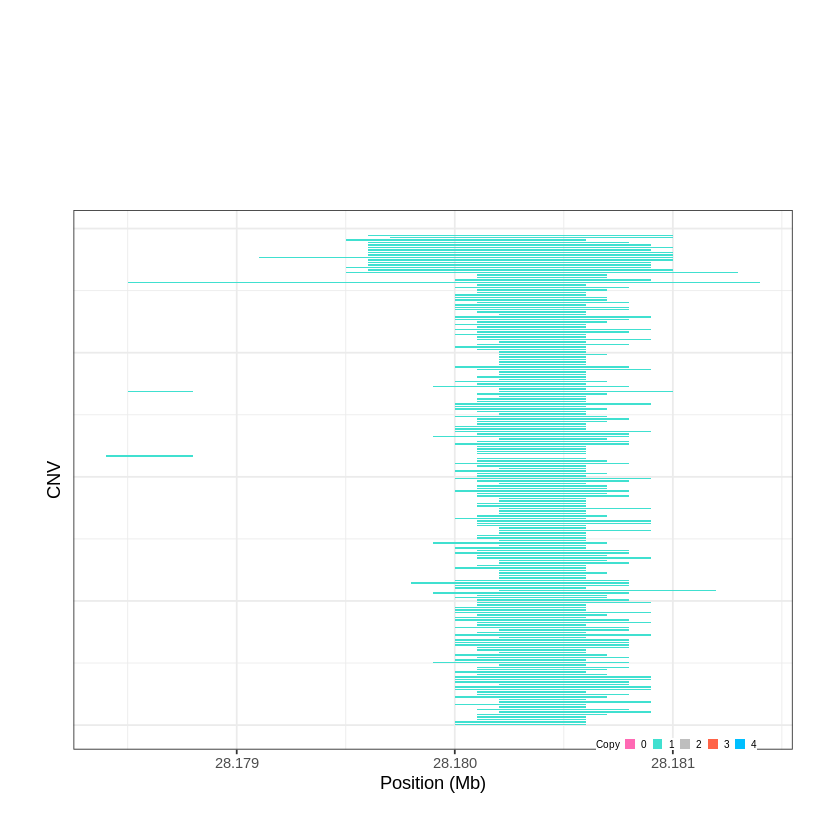

Task done, plot was stored in working directory.
[1] "Ploting CNVR 38..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 28.933201 - 29.6588 Mb with 162 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 39..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 29.761201 - 30.0281 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


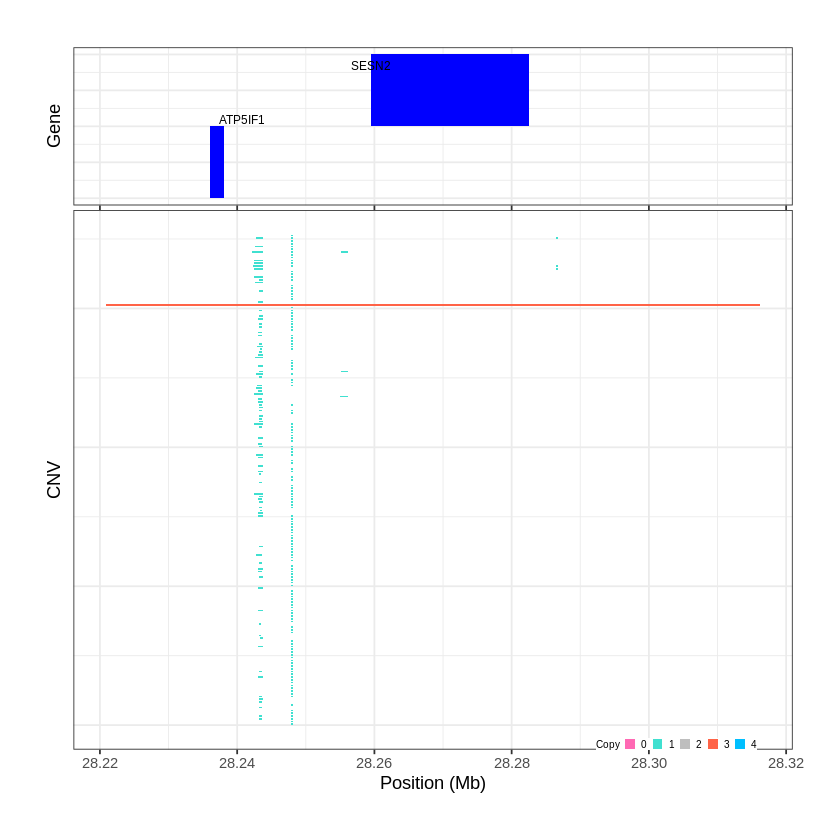

Task done, plot was stored in working directory.
[1] "Ploting CNVR 40..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 30.138001 - 30.2041 Mb with 265 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


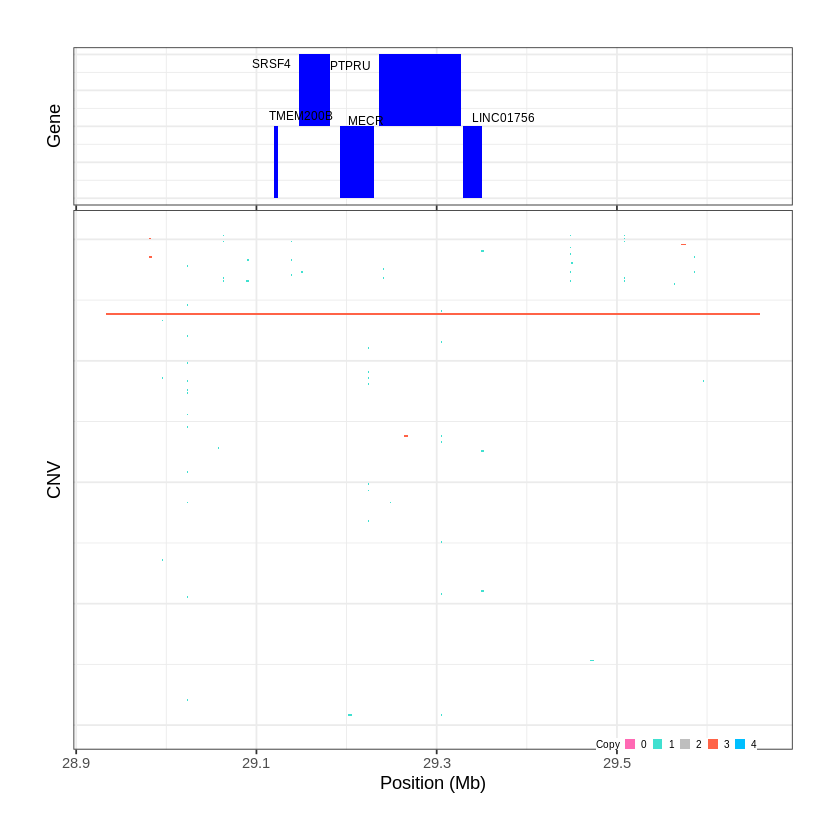

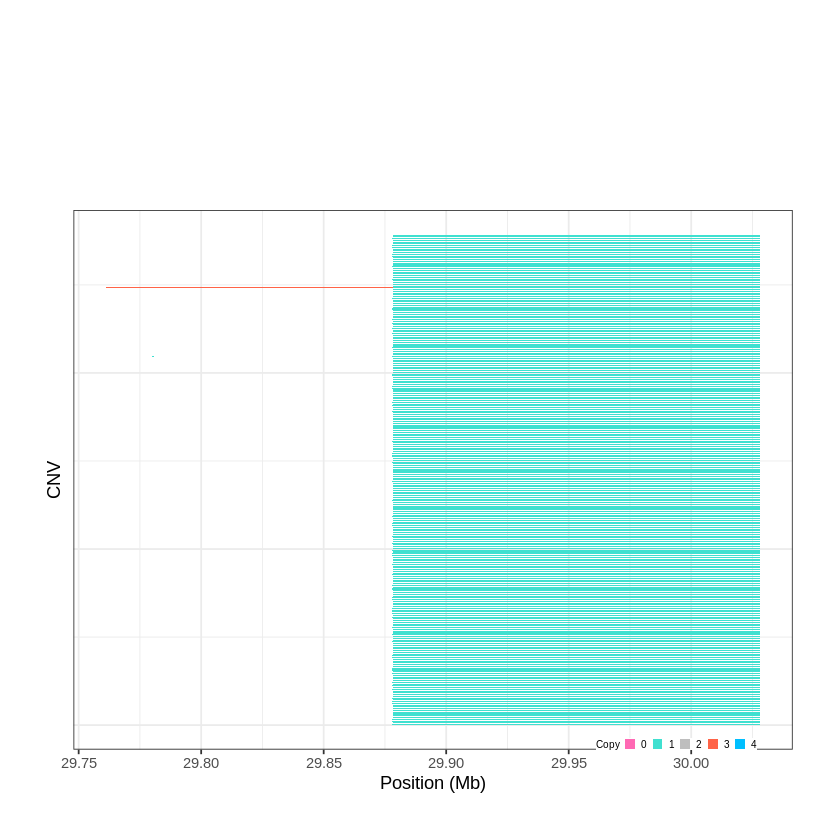

Task done, plot was stored in working directory.
[1] "Ploting CNVR 41..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 31.105401 - 31.4291 Mb with 172 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 42..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 33.719401 - 33.856 Mb with 263 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


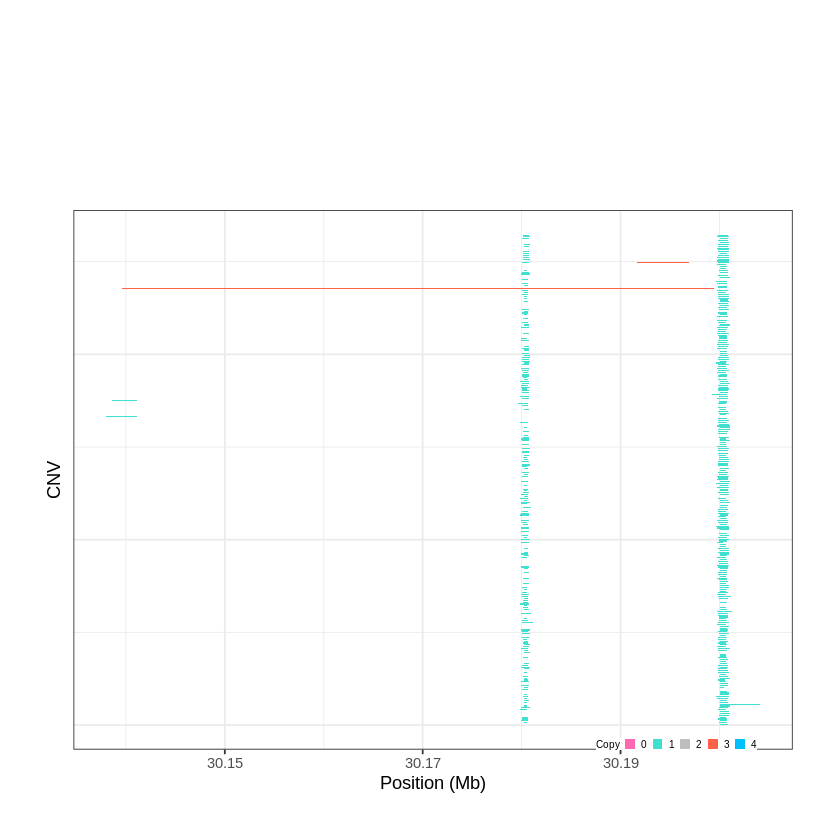

Task done, plot was stored in working directory.
[1] "Ploting CNVR 43..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 36.733201 - 36.7337 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


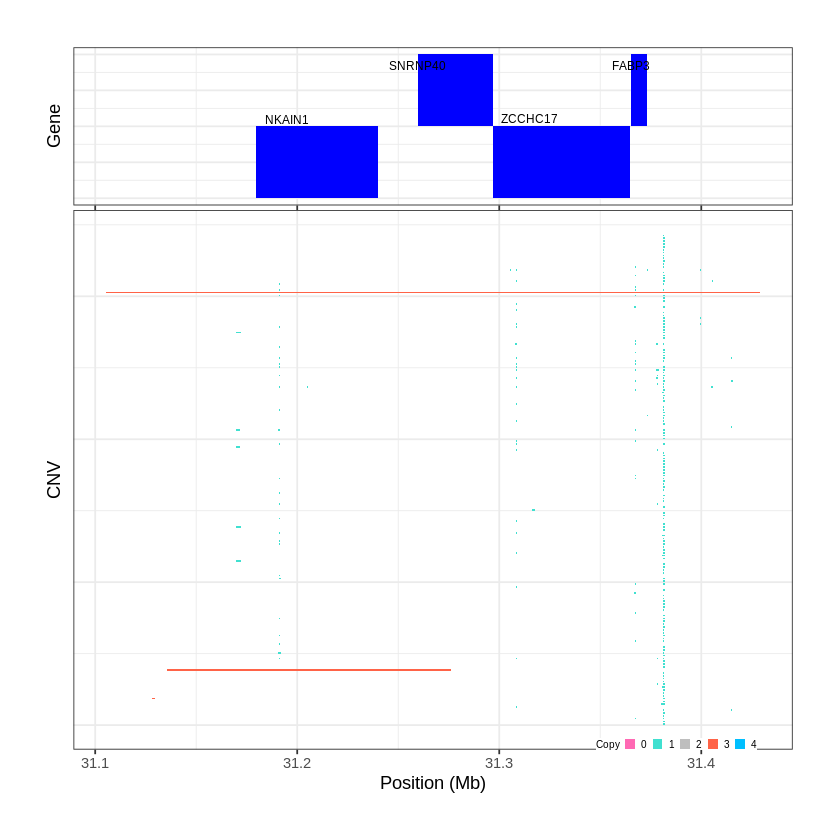

Task done, plot was stored in working directory.
[1] "Ploting CNVR 44..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 41.780701 - 42.0701 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


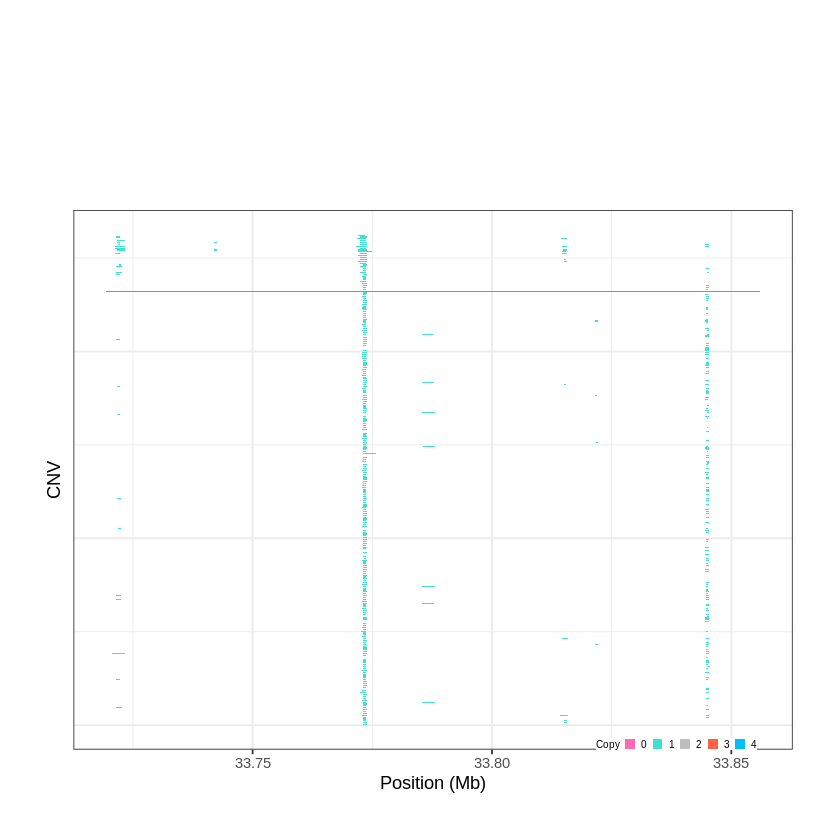

Task done, plot was stored in working directory.
[1] "Ploting CNVR 45..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 44.336801 - 44.3414 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


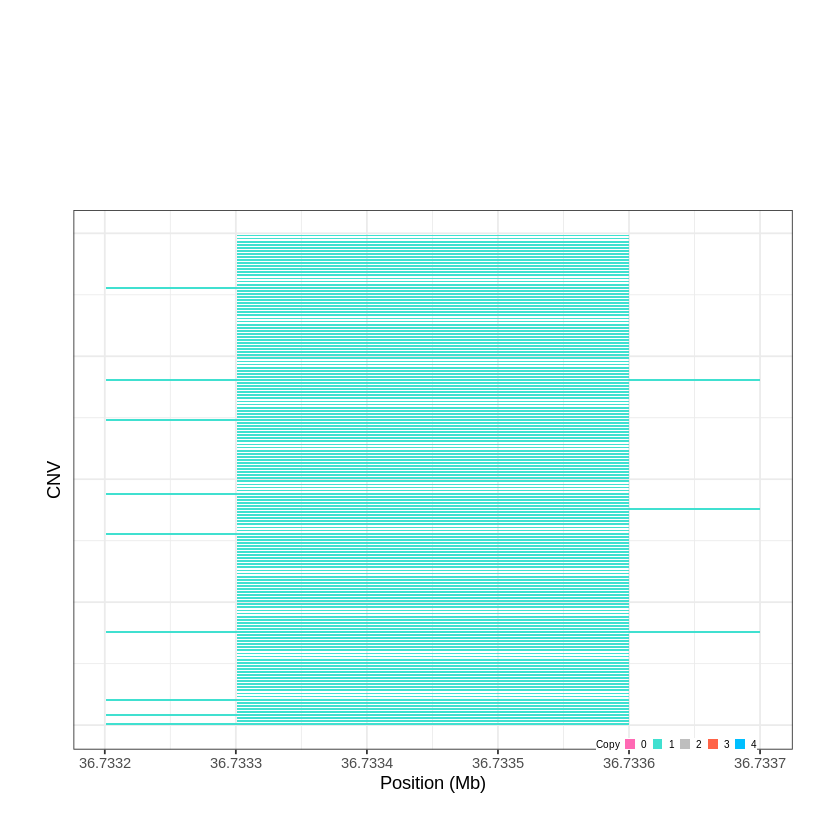

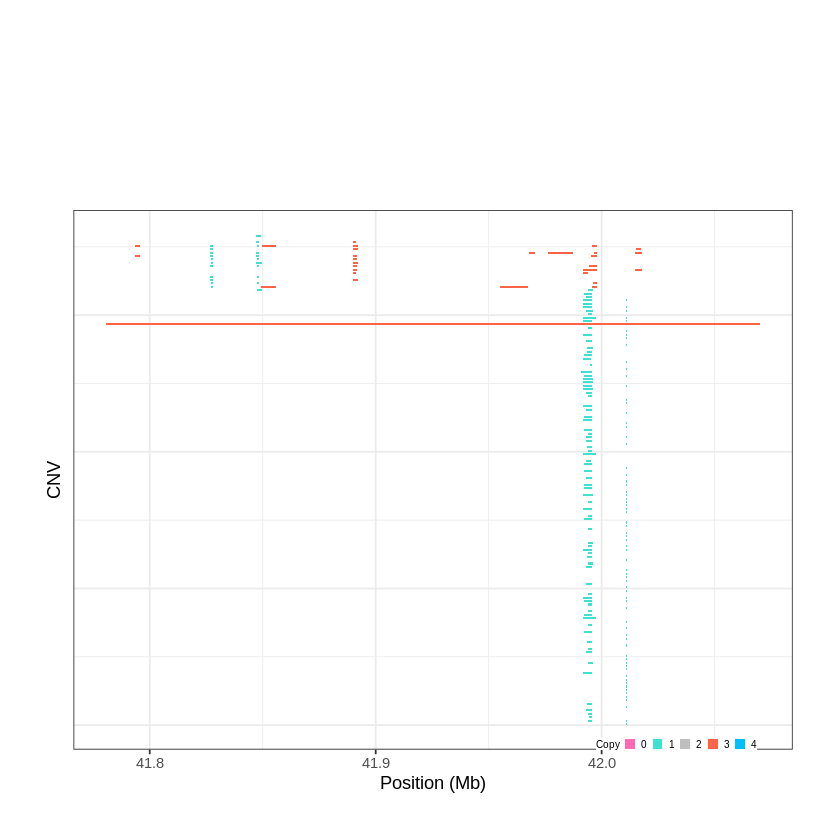

Task done, plot was stored in working directory.
[1] "Ploting CNVR 46..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 48.018101 - 48.5236 Mb with 179 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 47..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 53.966701 - 53.9693 Mb with 261 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


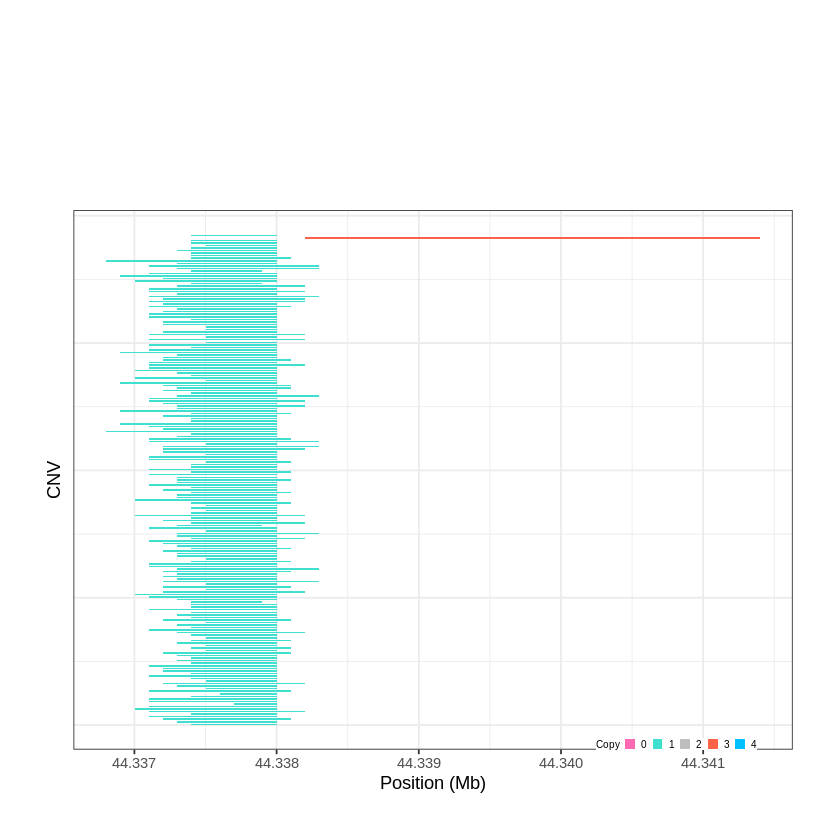

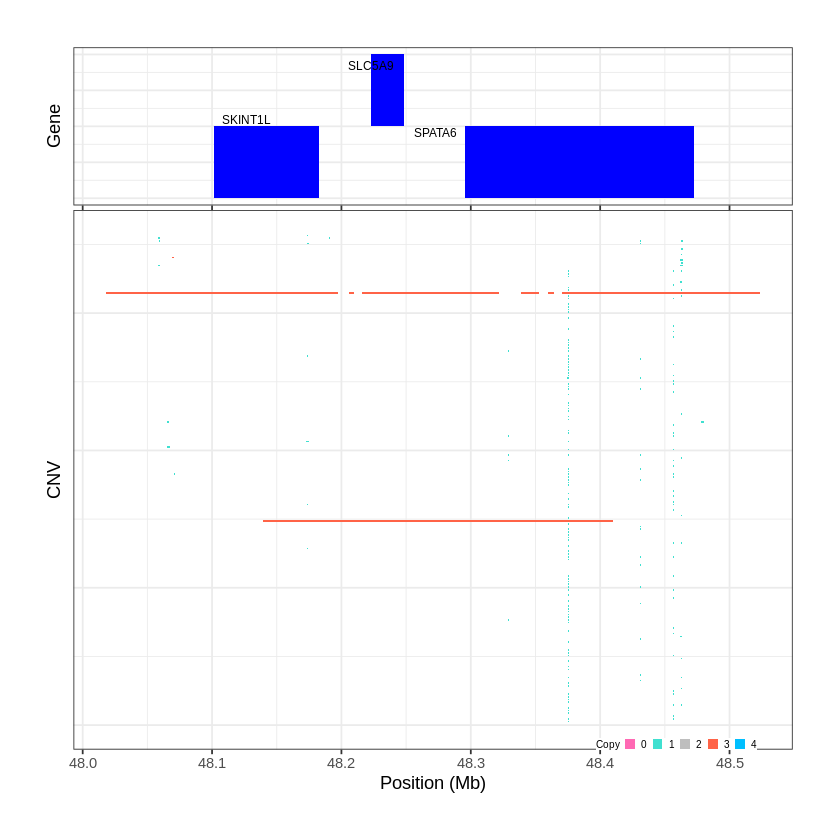

Task done, plot was stored in working directory.
[1] "Ploting CNVR 48..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 54.561401 - 55.0971 Mb with 186 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 49..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 56.117401 - 56.1392 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


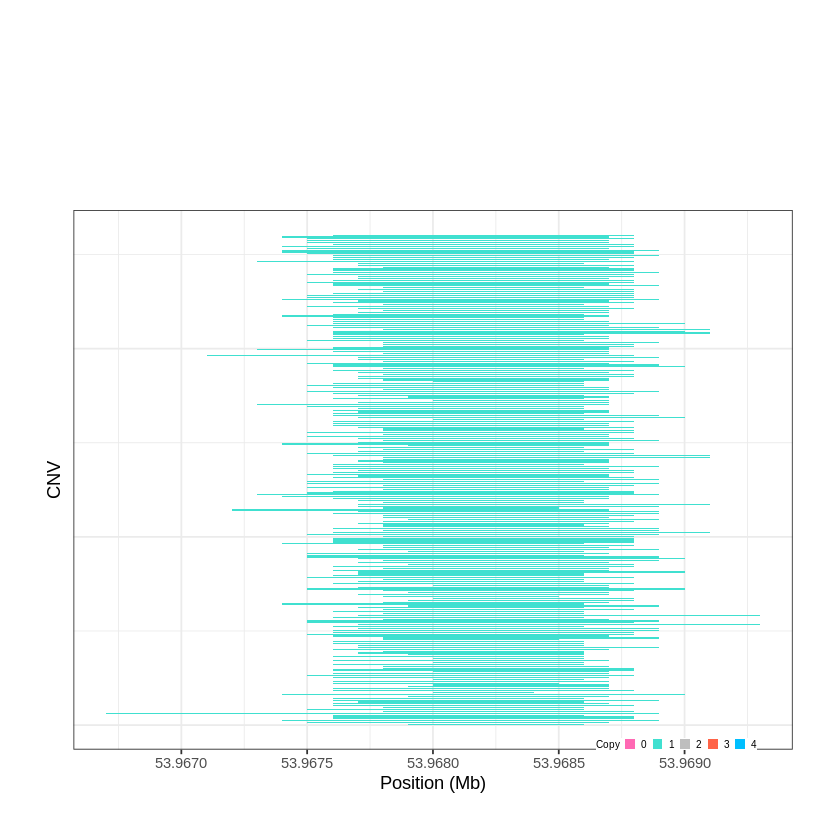

Task done, plot was stored in working directory.
[1] "Ploting CNVR 50..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 56.350001 - 56.408 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


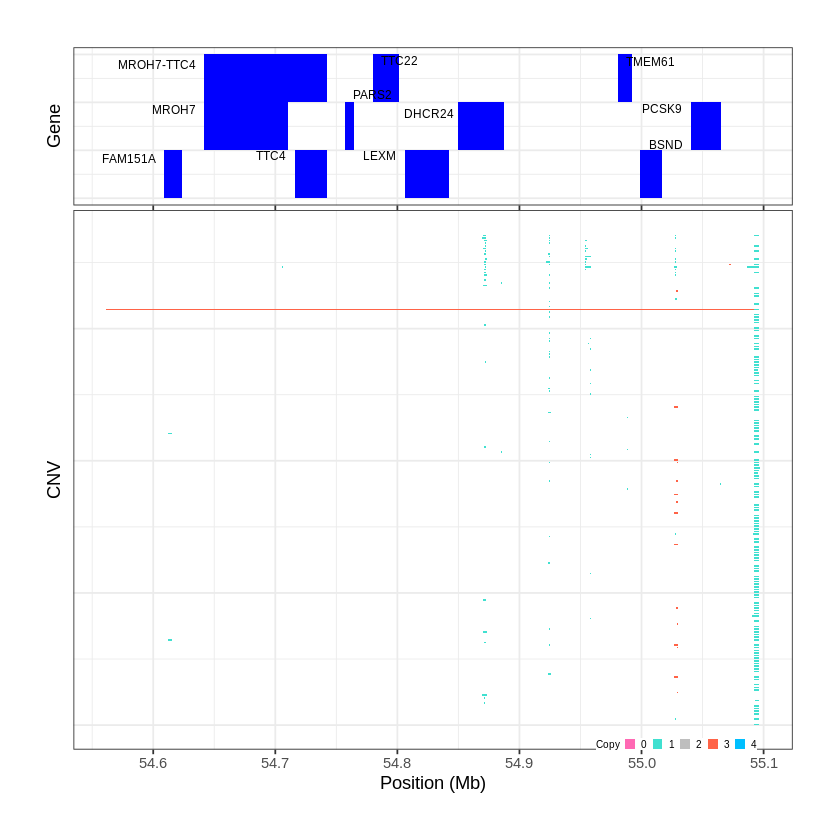

Task done, plot was stored in working directory.
[1] "Ploting CNVR 51..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 56.828801 - 56.8421 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


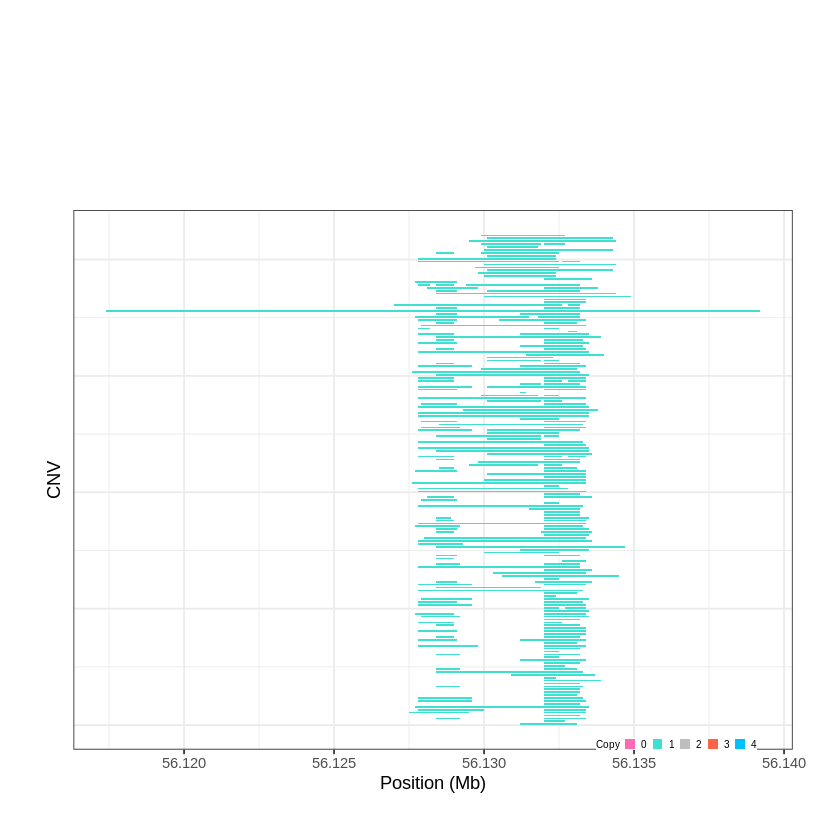

Task done, plot was stored in working directory.
[1] "Ploting CNVR 52..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 58.743901 - 58.7449 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


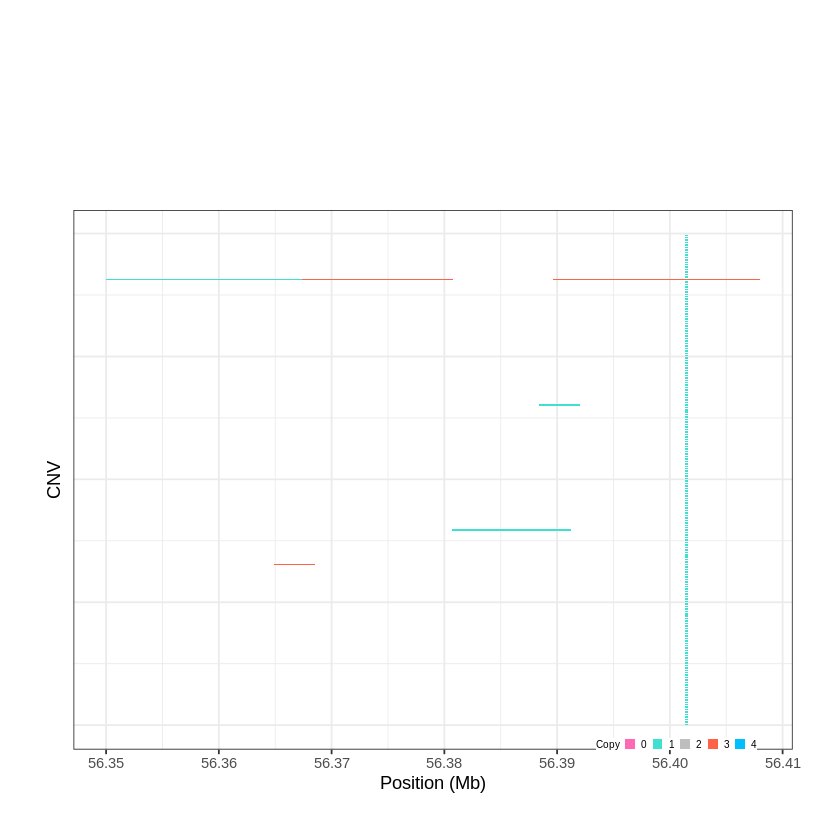

Task done, plot was stored in working directory.
[1] "Ploting CNVR 53..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 67.991001 - 68.0135 Mb with 219 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


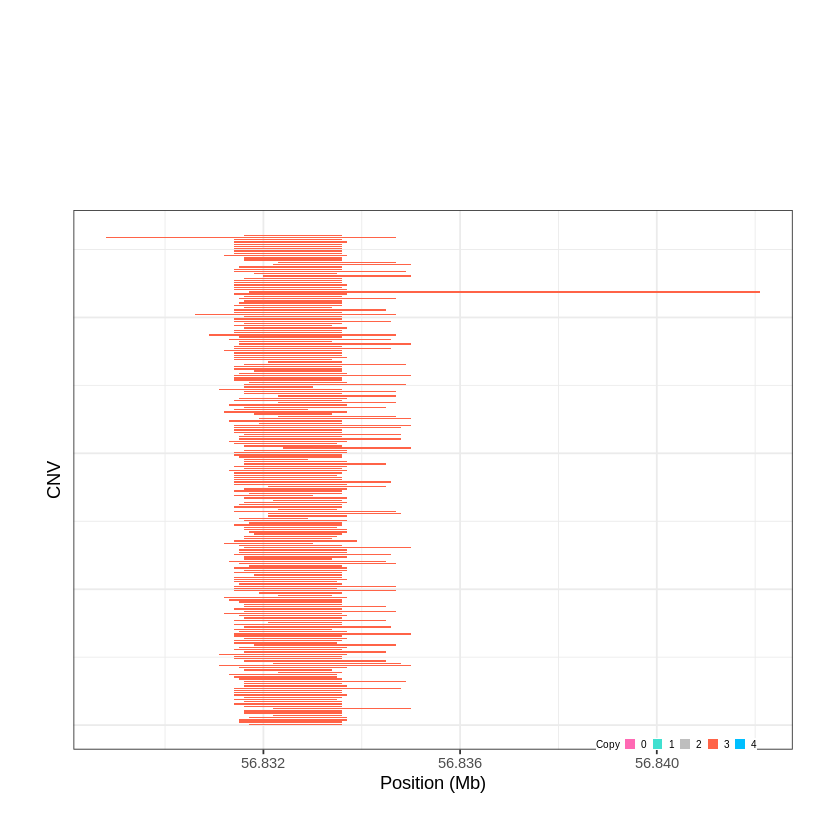

Task done, plot was stored in working directory.
[1] "Ploting CNVR 54..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 70.926401 - 70.9519 Mb with 248 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


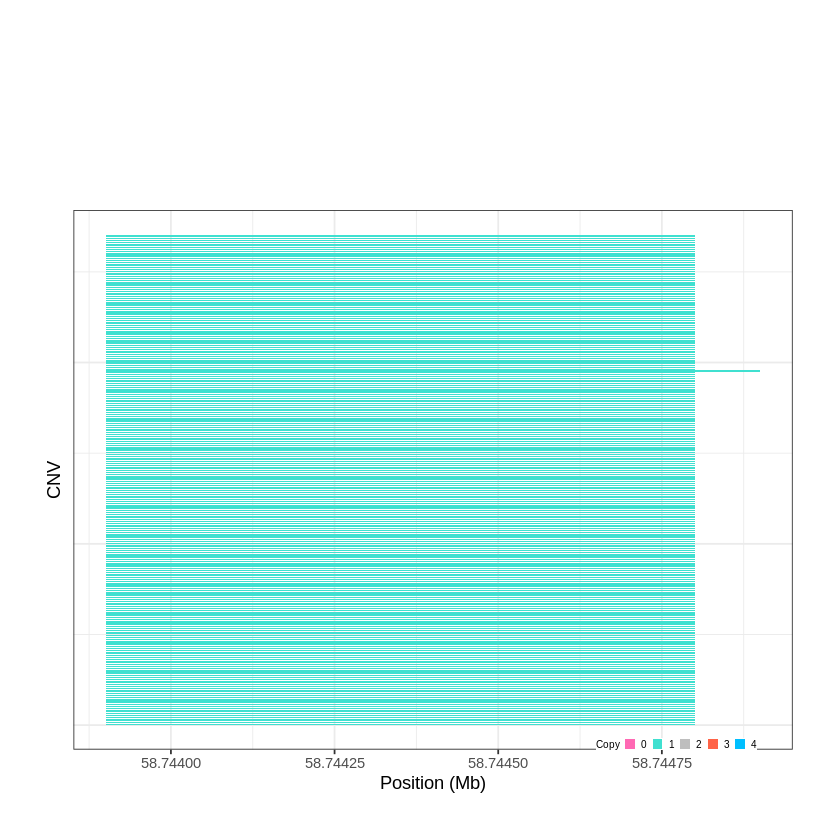

Task done, plot was stored in working directory.
[1] "Ploting CNVR 55..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 71.741401 - 71.7416 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


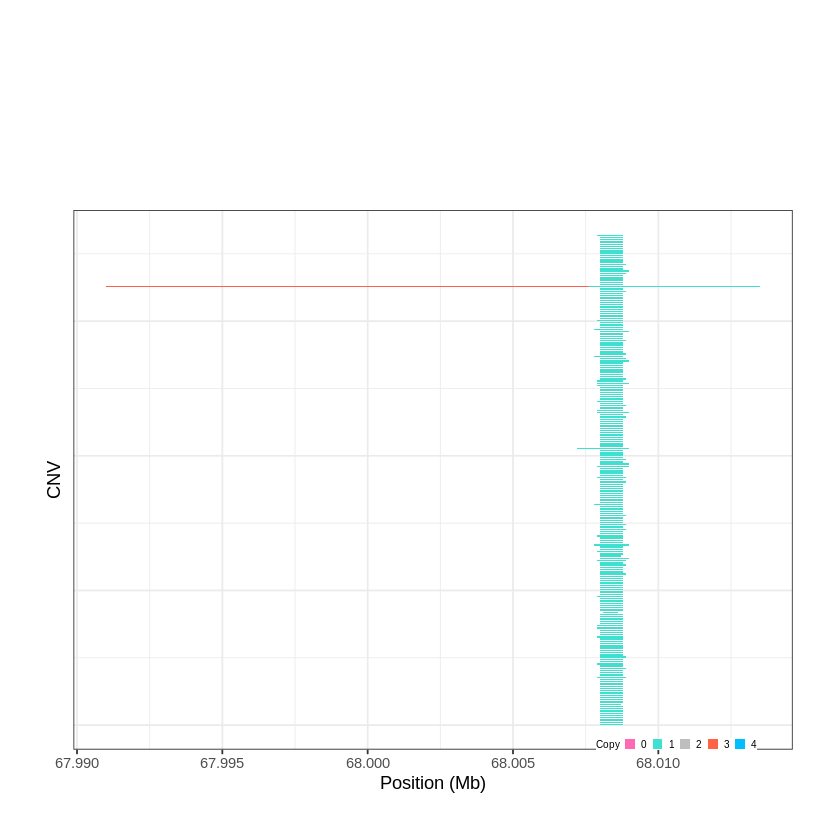

Task done, plot was stored in working directory.
[1] "Ploting CNVR 56..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 72.351101 - 72.3668 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


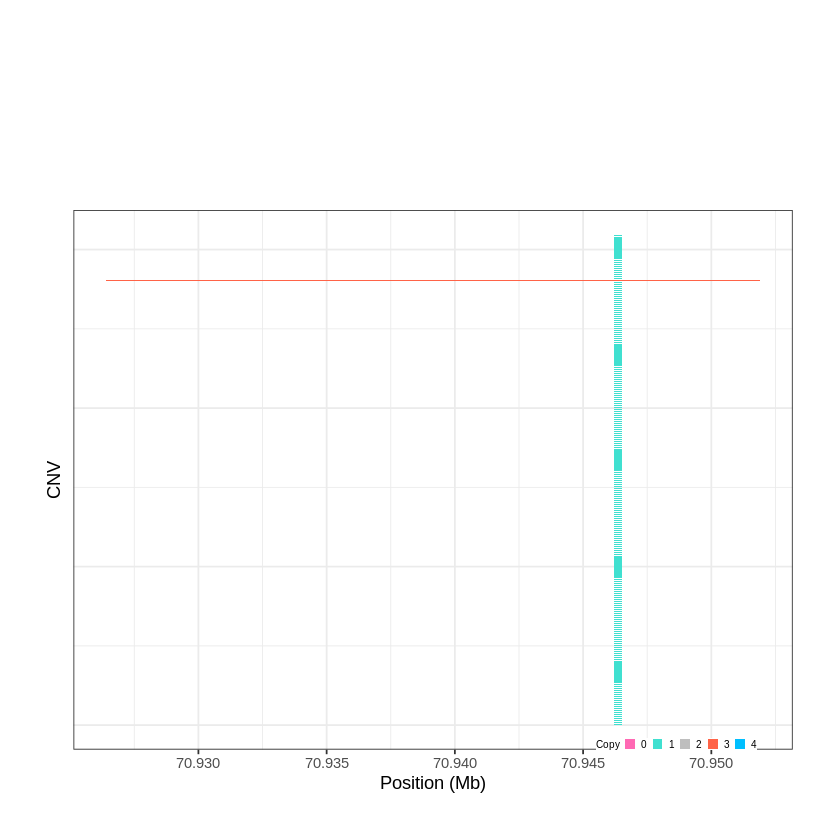

Task done, plot was stored in working directory.
[1] "Ploting CNVR 57..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 72.755201 - 72.8132 Mb with 256 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


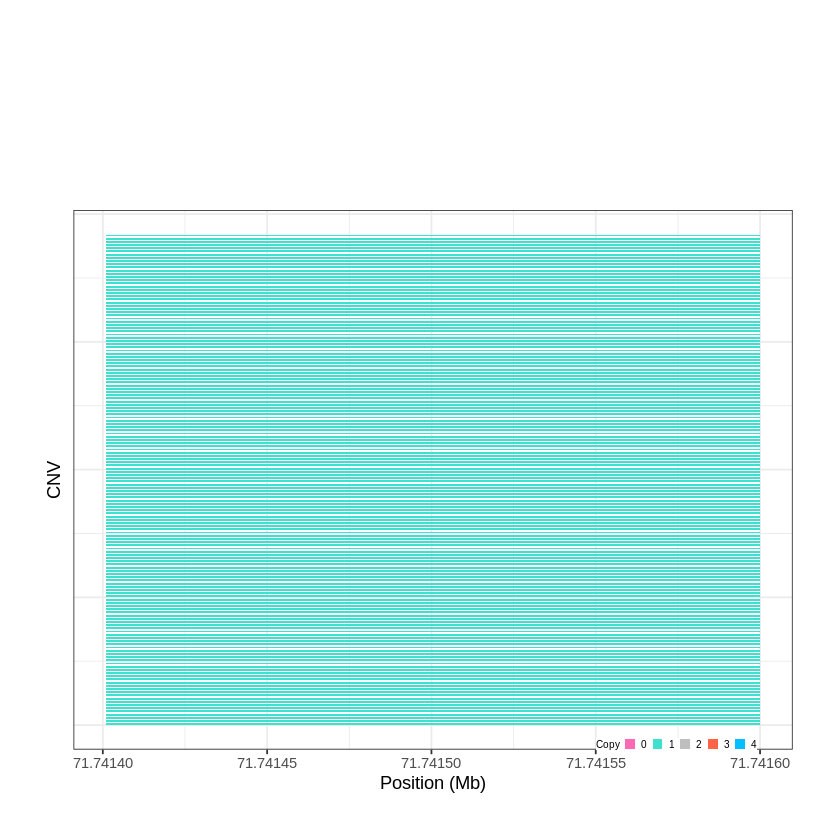

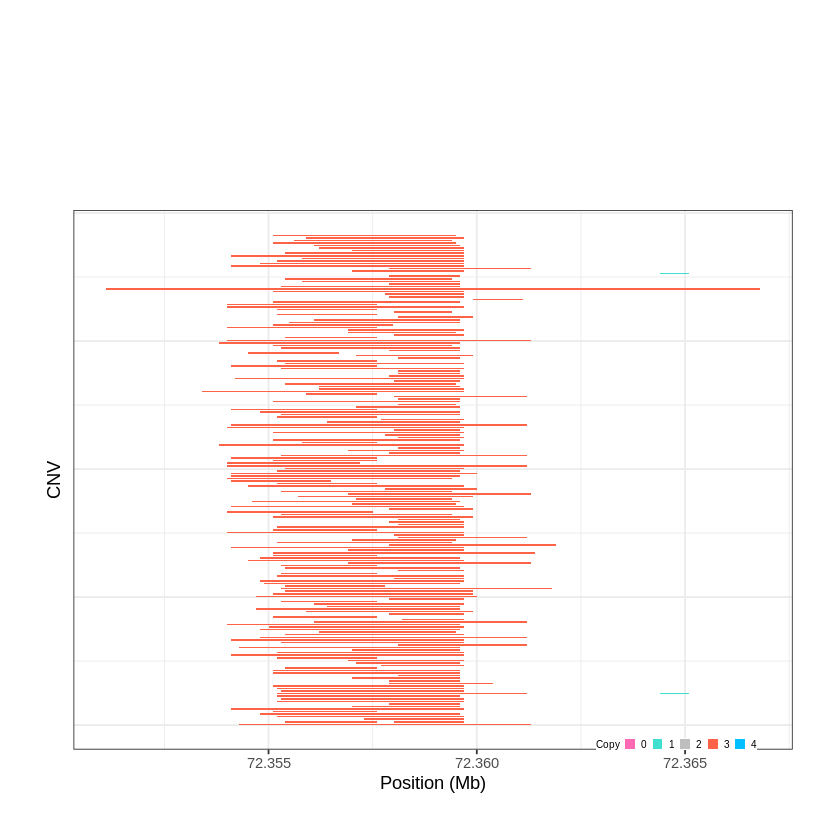

Task done, plot was stored in working directory.
[1] "Ploting CNVR 58..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 73.625701 - 73.7876 Mb with 236 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 59..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 75.840301 - 75.8693 Mb with 237 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


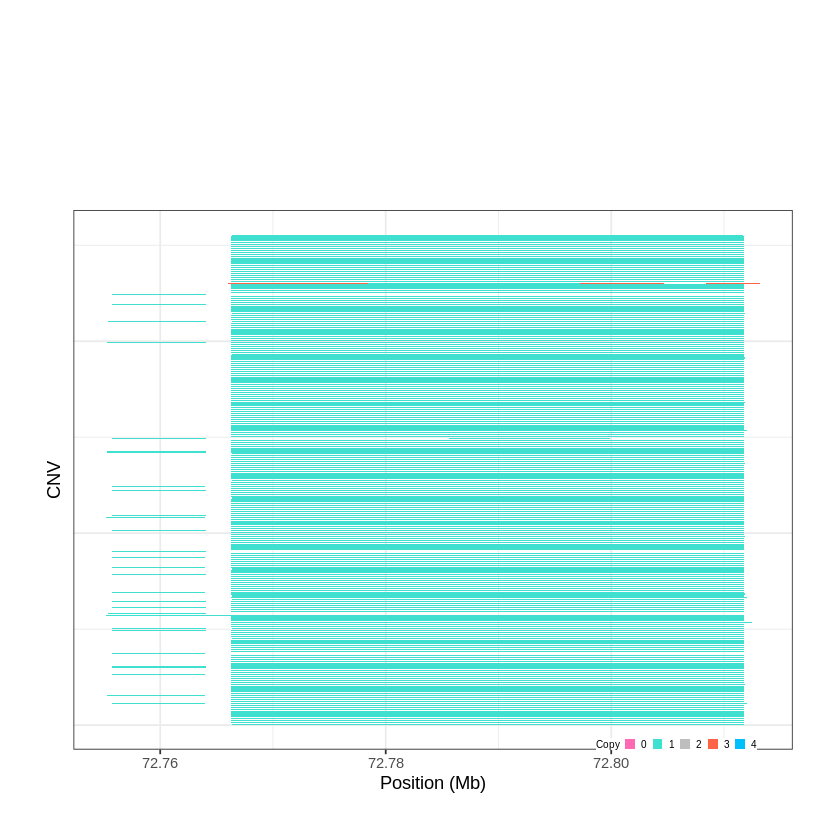

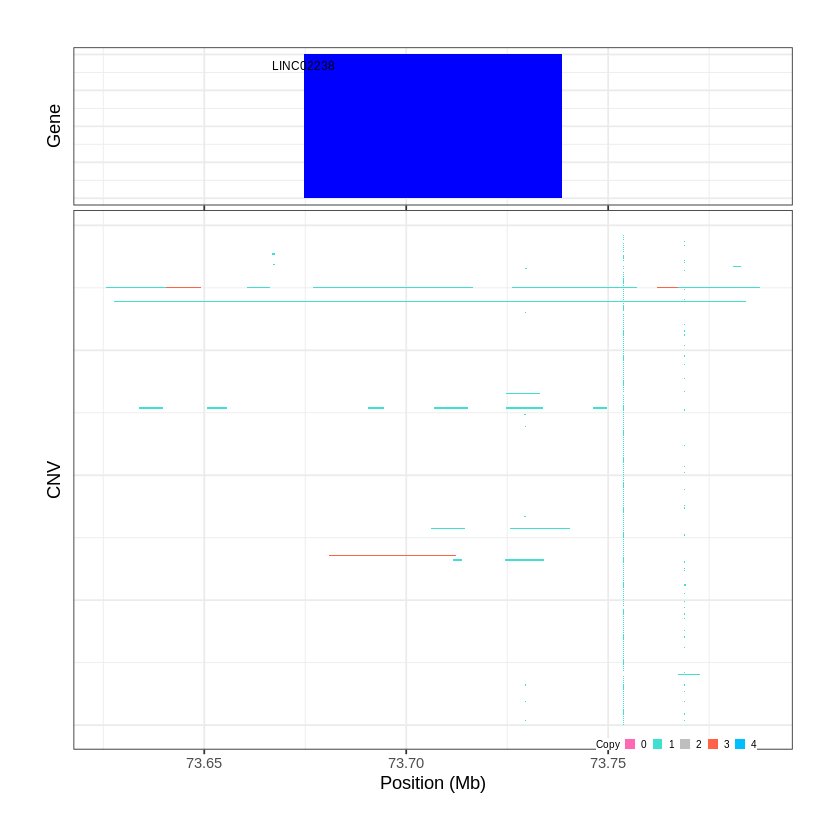

Task done, plot was stored in working directory.
[1] "Ploting CNVR 60..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 76.006401 - 76.032 Mb with 195 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 61..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 80.214501 - 80.2417 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


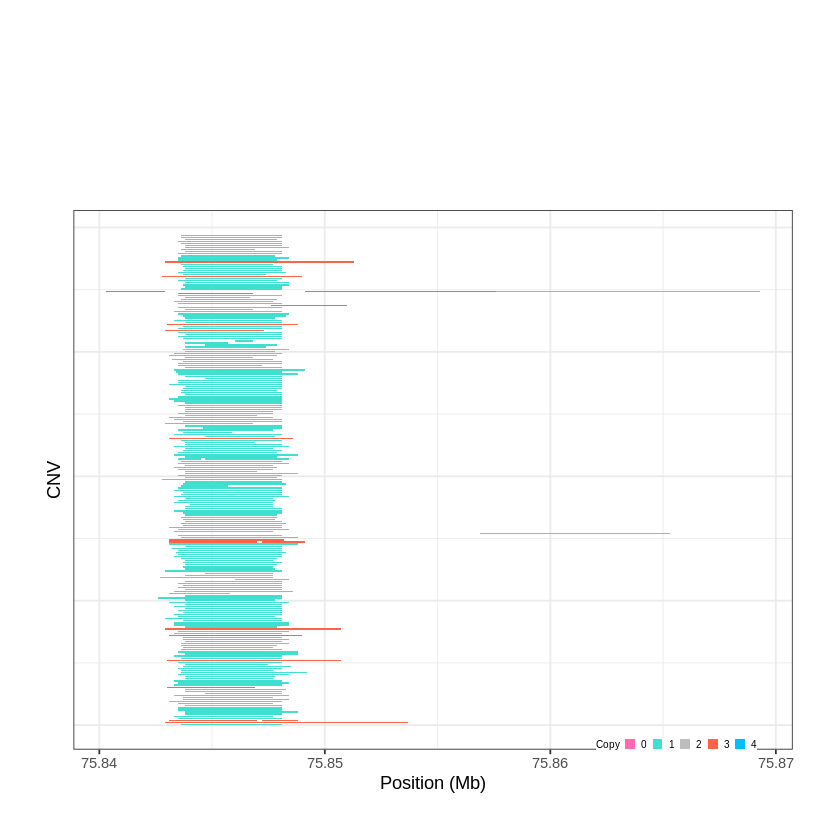

Task done, plot was stored in working directory.
[1] "Ploting CNVR 62..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 81.403501 - 81.4174 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


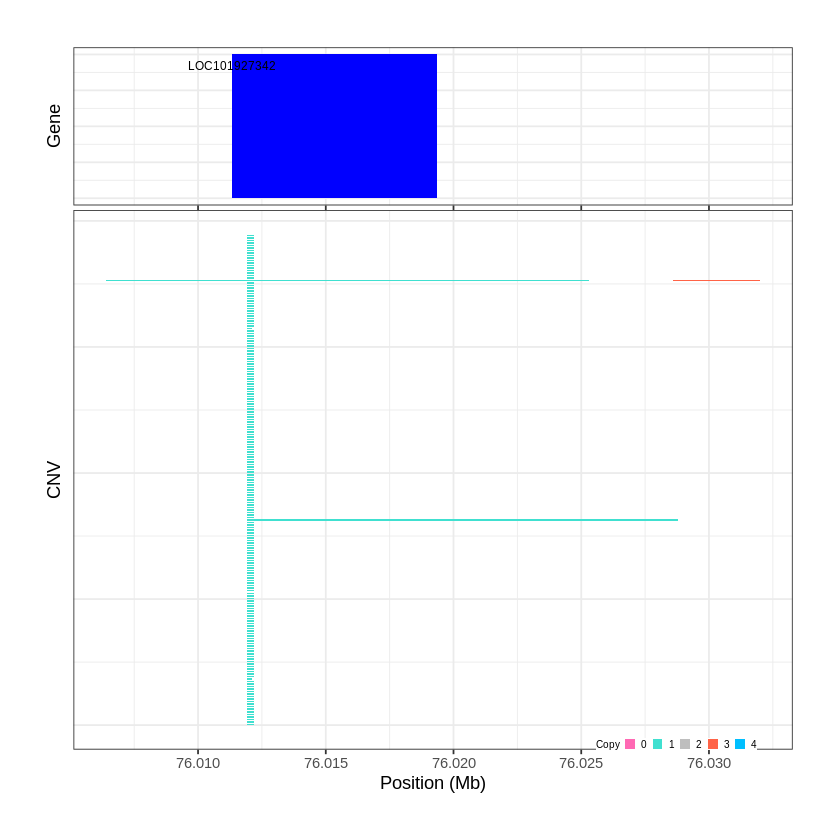

Task done, plot was stored in working directory.
[1] "Ploting CNVR 63..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 81.851901 - 81.861 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


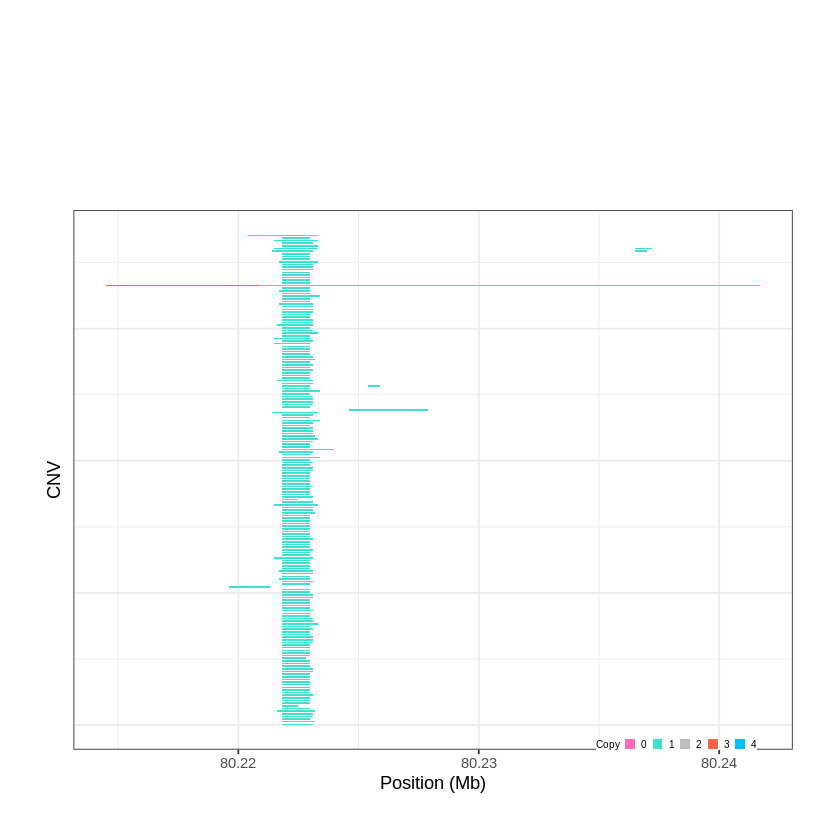

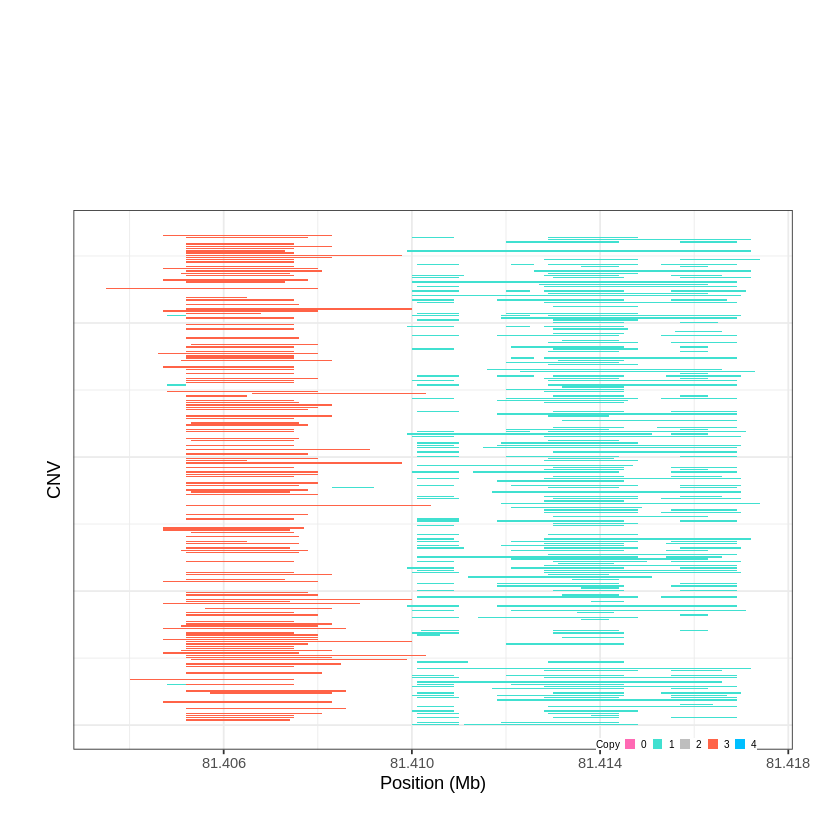

Task done, plot was stored in working directory.
[1] "Ploting CNVR 64..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 84.483401 - 84.5246 Mb with 210 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 65..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 85.974801 - 86.0162 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


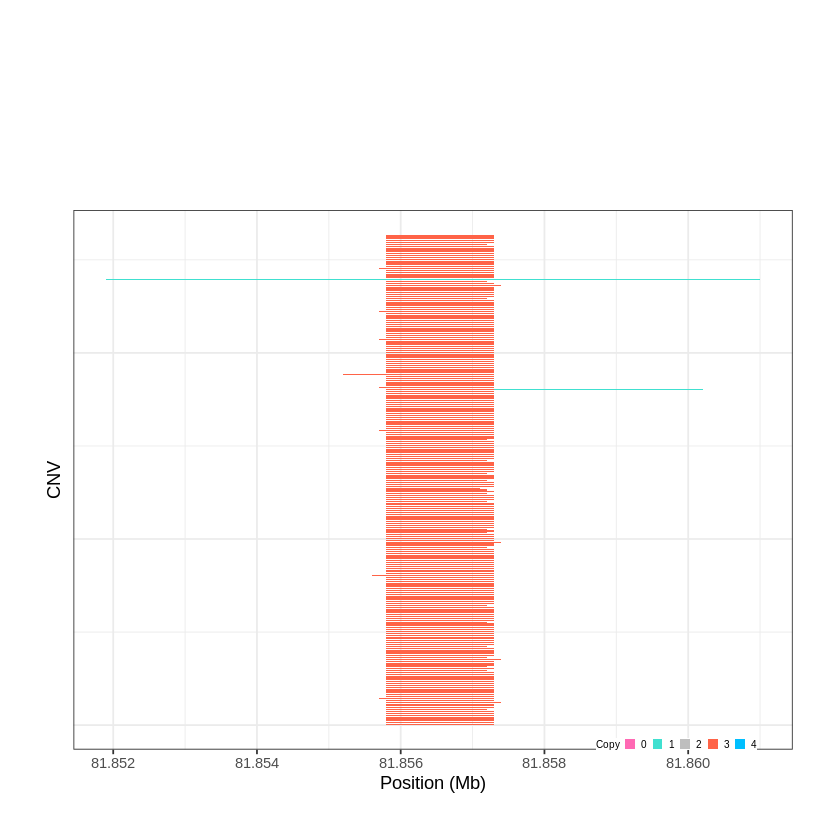

Task done, plot was stored in working directory.
[1] "Ploting CNVR 66..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 86.194301 - 86.2204 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


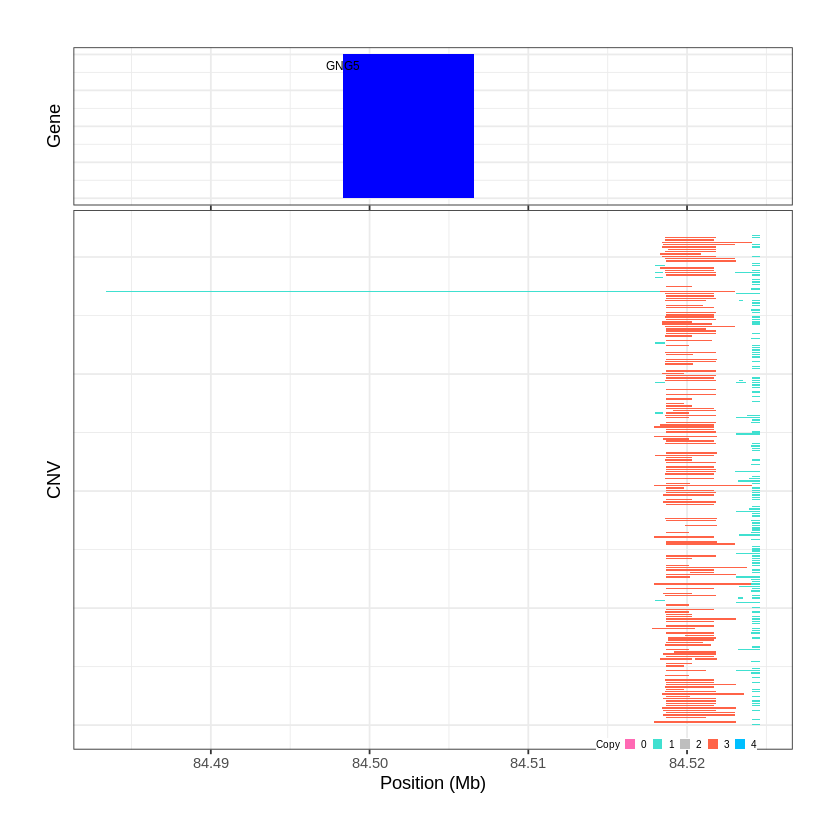

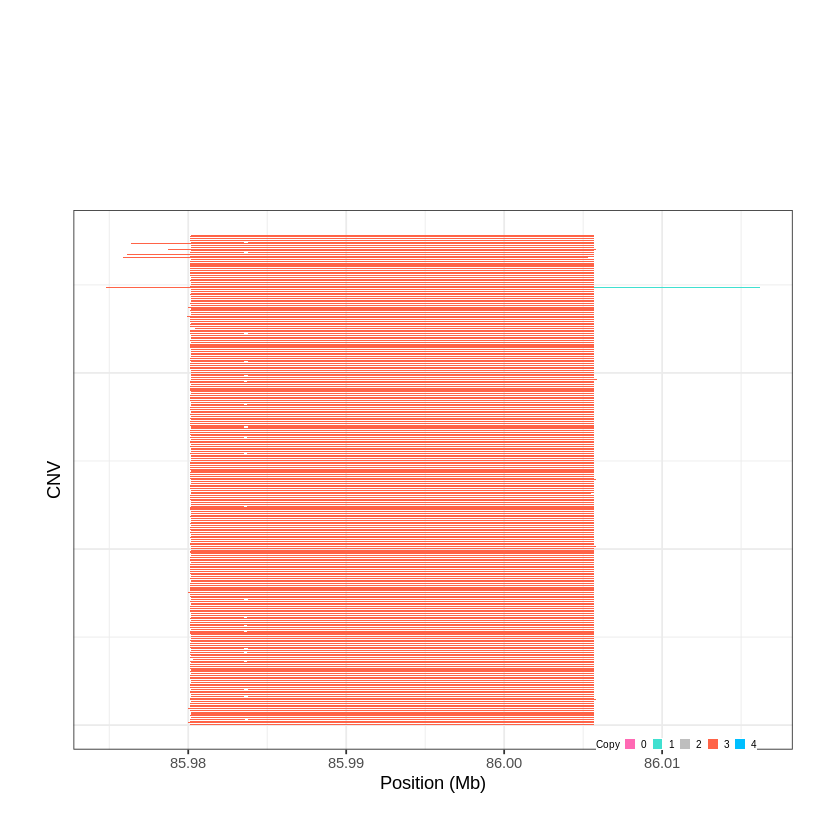

Task done, plot was stored in working directory.
[1] "Ploting CNVR 67..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 86.368701 - 86.5154 Mb with 154 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 68..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 87.144001 - 87.1533 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


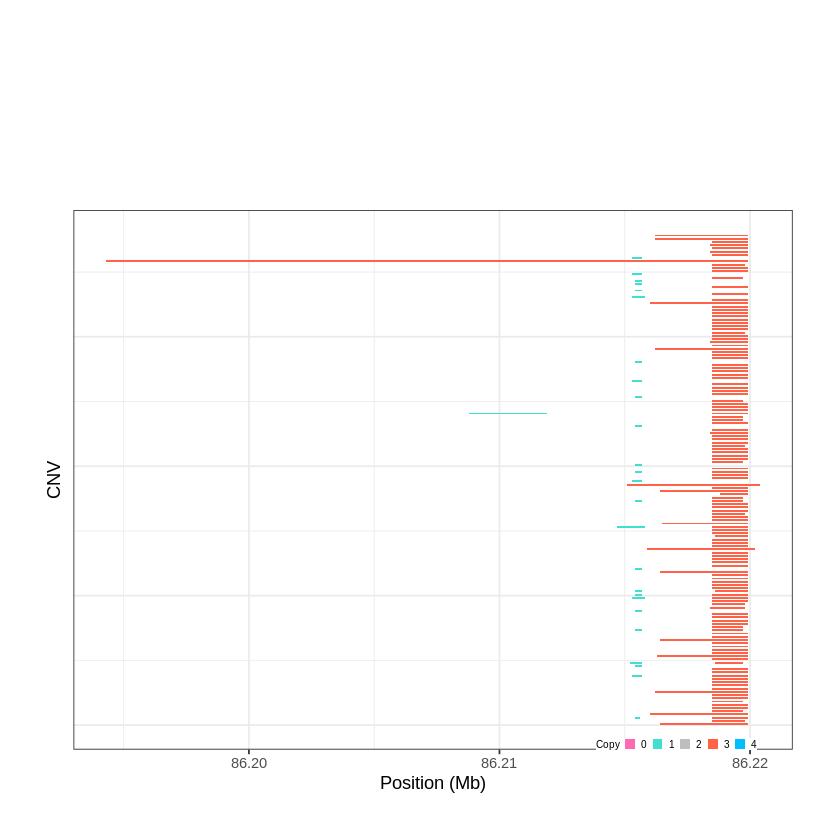

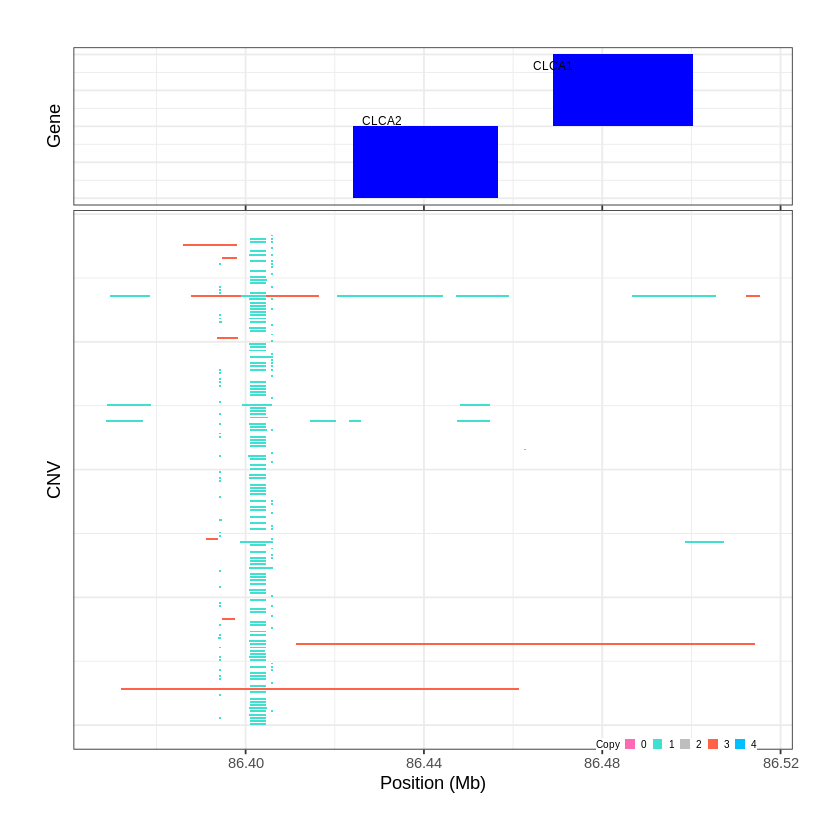

Task done, plot was stored in working directory.
[1] "Ploting CNVR 69..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 90.828601 - 90.976 Mb with 222 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 70..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 91.624801 - 91.6298 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


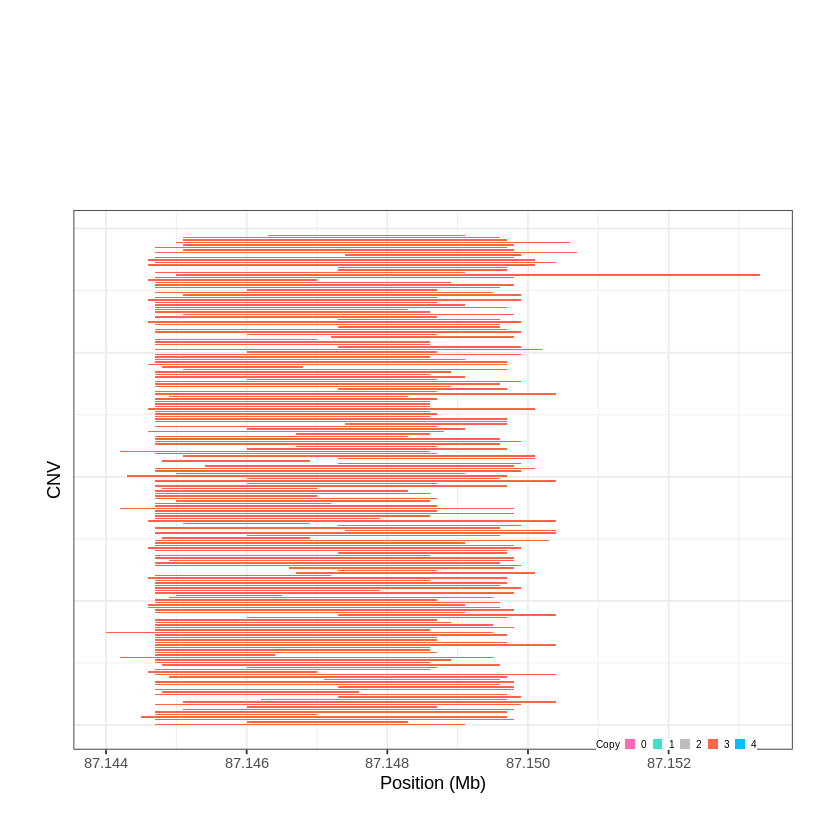

Task done, plot was stored in working directory.
[1] "Ploting CNVR 71..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 91.677801 - 91.691 Mb with 190 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


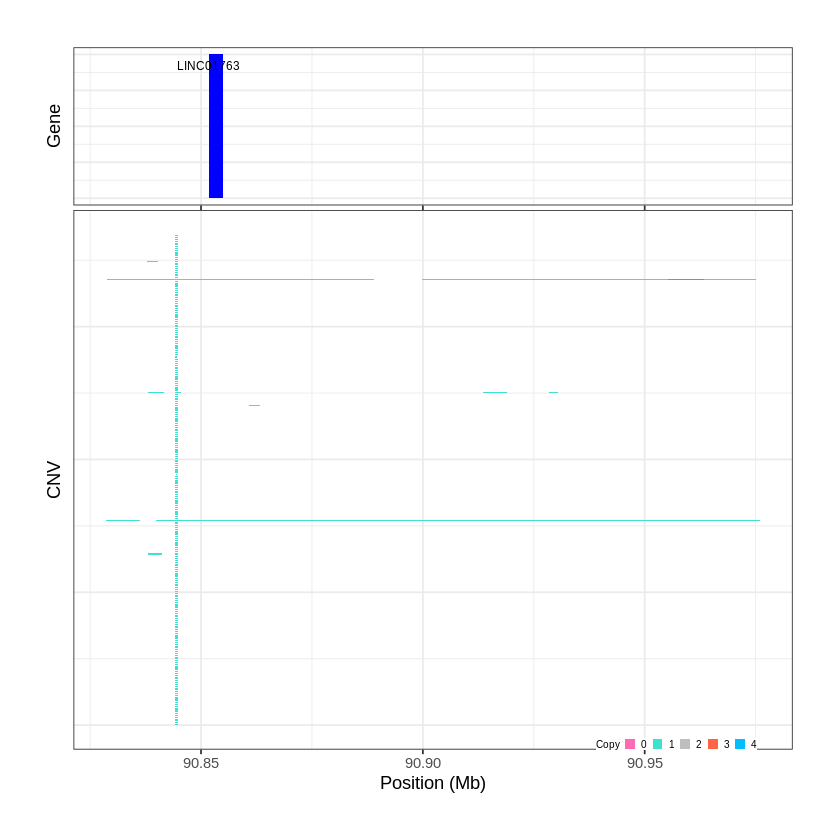

Task done, plot was stored in working directory.
[1] "Ploting CNVR 72..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 91.766701 - 91.7815 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


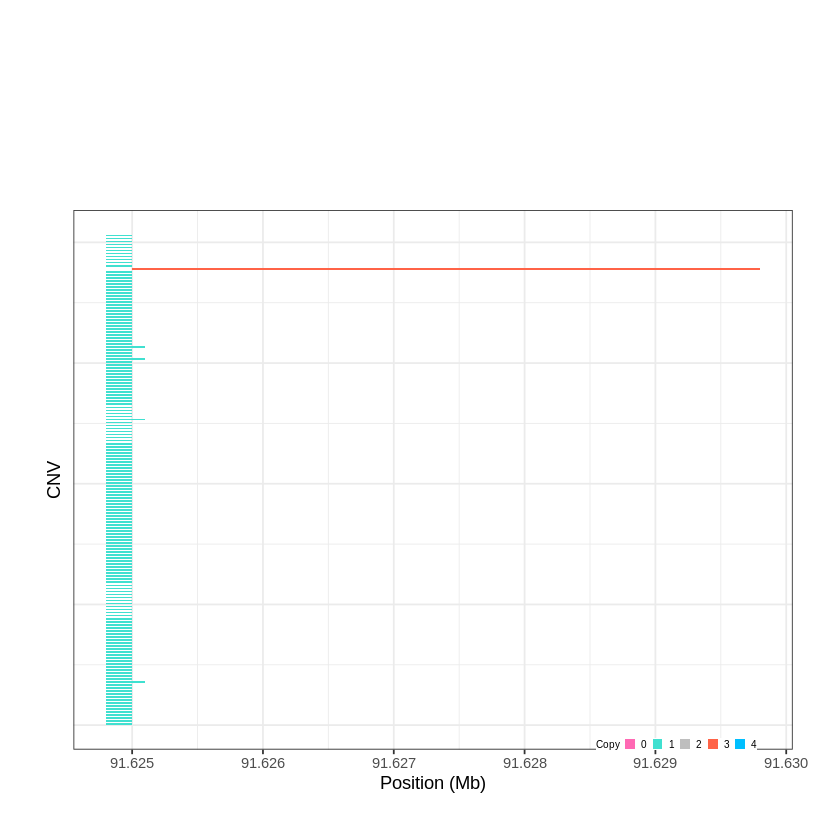

Task done, plot was stored in working directory.
[1] "Ploting CNVR 73..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 91.923701 - 91.9281 Mb with 224 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


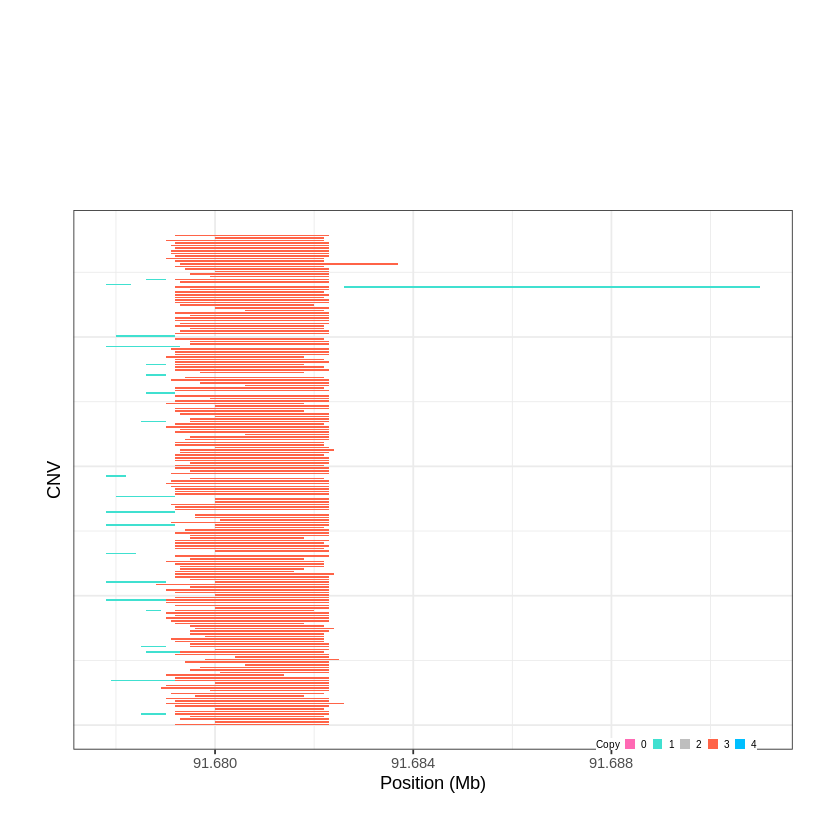

Task done, plot was stored in working directory.
[1] "Ploting CNVR 74..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 94.284801 - 94.2929 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


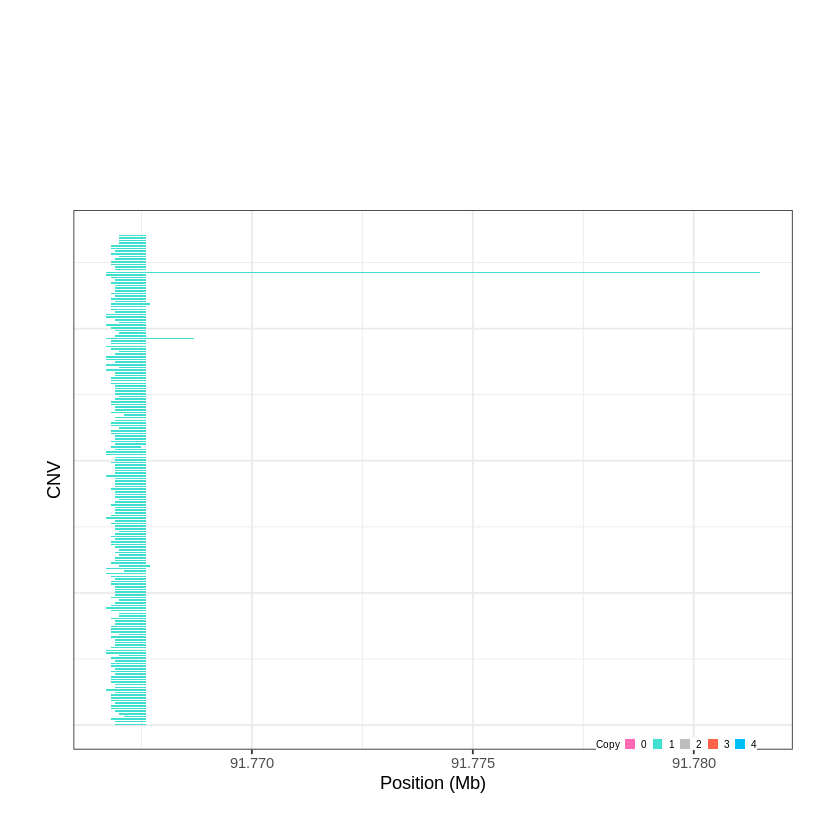

Task done, plot was stored in working directory.
[1] "Ploting CNVR 75..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 95.690501 - 95.6908 Mb with 157 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


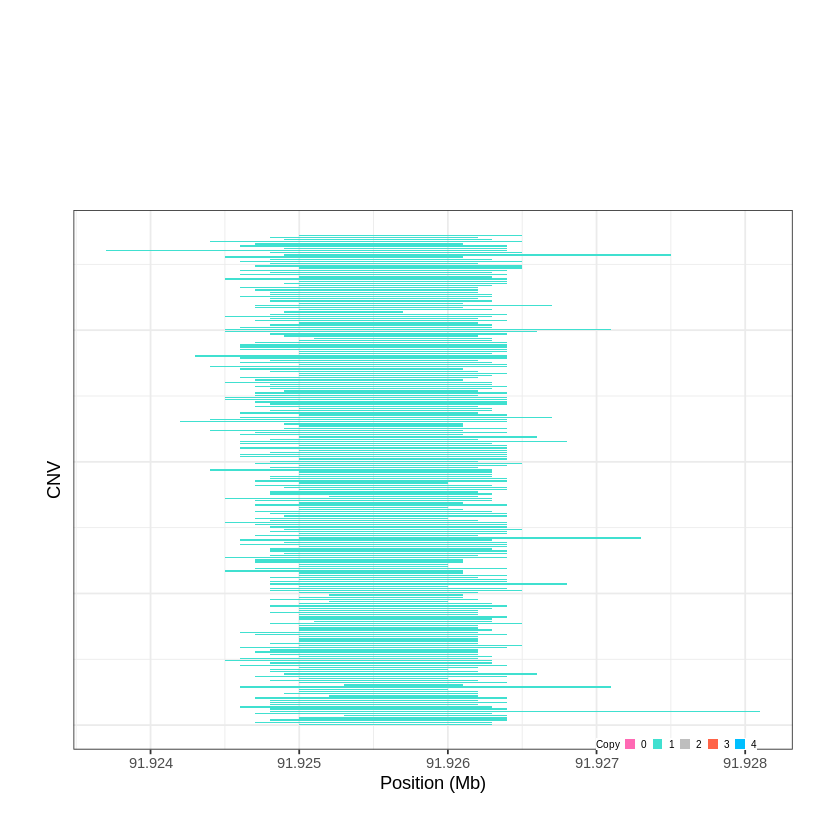

Task done, plot was stored in working directory.
[1] "Ploting CNVR 76..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 98.853701 - 98.9797 Mb with 260 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


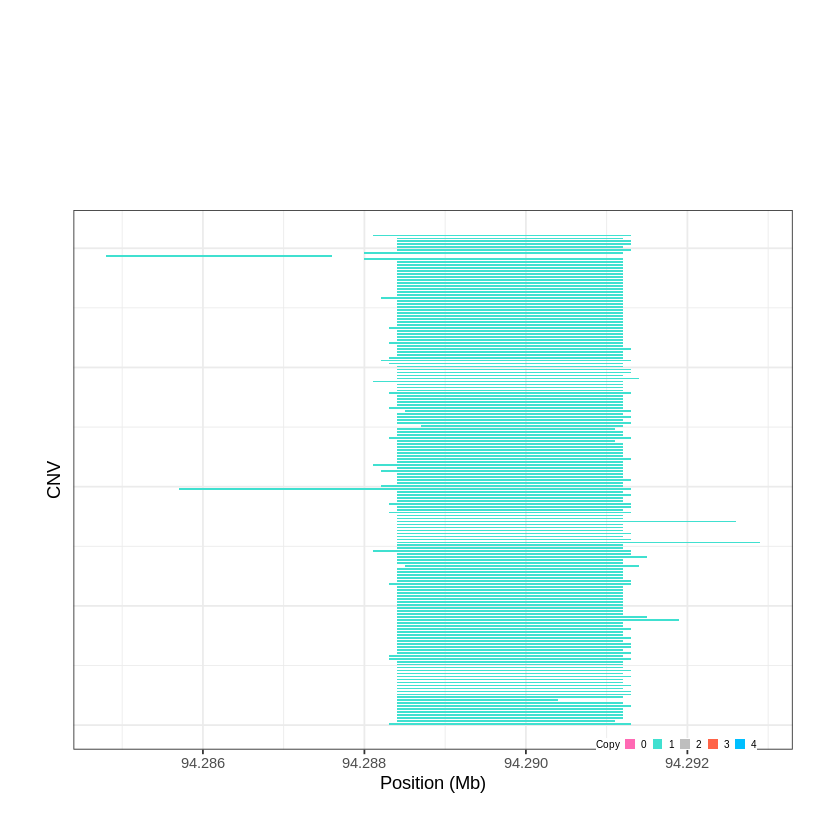

Task done, plot was stored in working directory.
[1] "Ploting CNVR 77..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 101.990701 - 102.0324 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


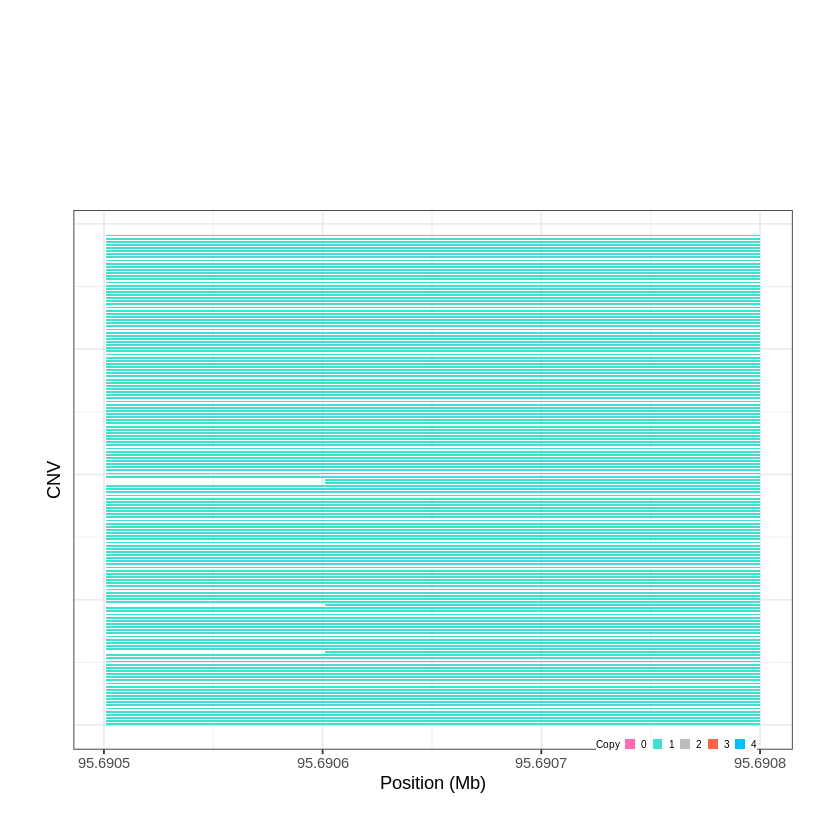

Task done, plot was stored in working directory.
[1] "Ploting CNVR 78..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 103.777301 - 104.0265 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


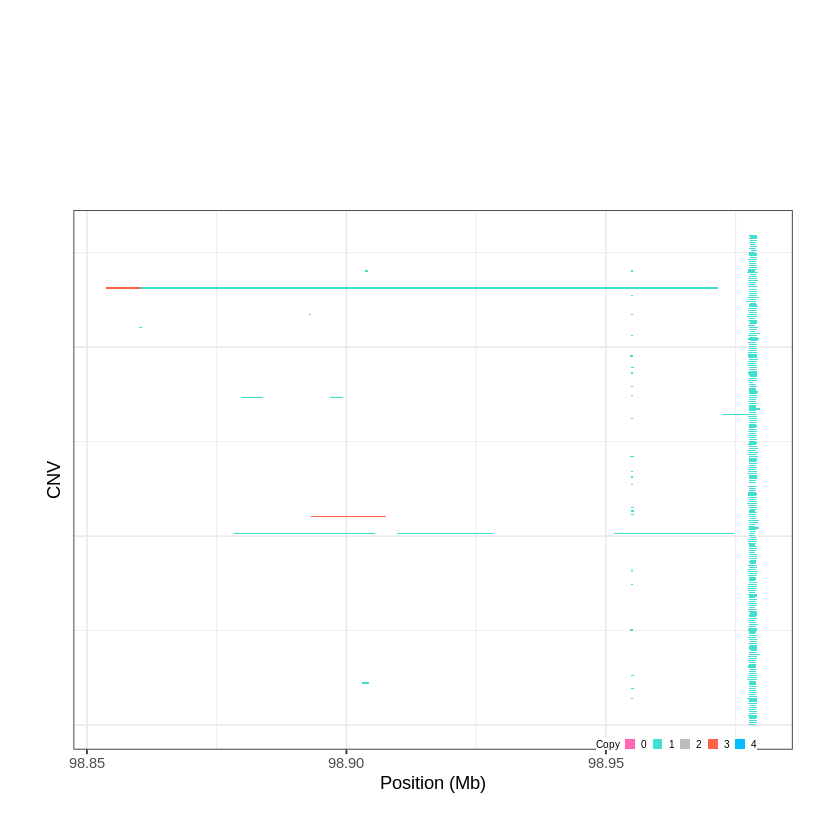

Task done, plot was stored in working directory.
[1] "Ploting CNVR 79..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 104.099601 - 104.3396 Mb with 263 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


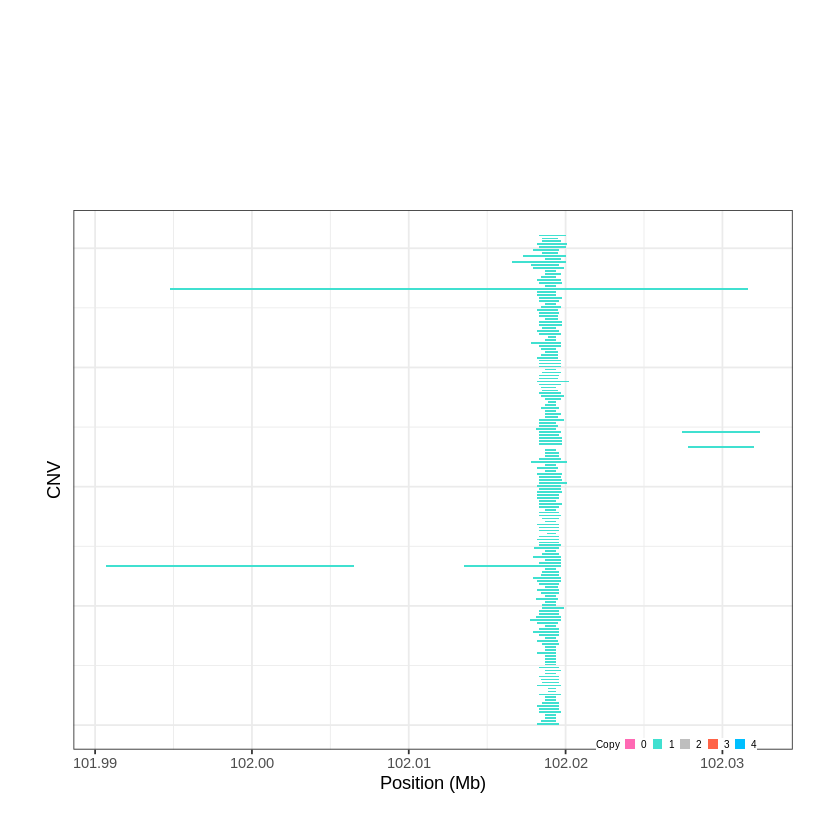

Task done, plot was stored in working directory.
[1] "Ploting CNVR 80..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 105.300201 - 105.3013 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


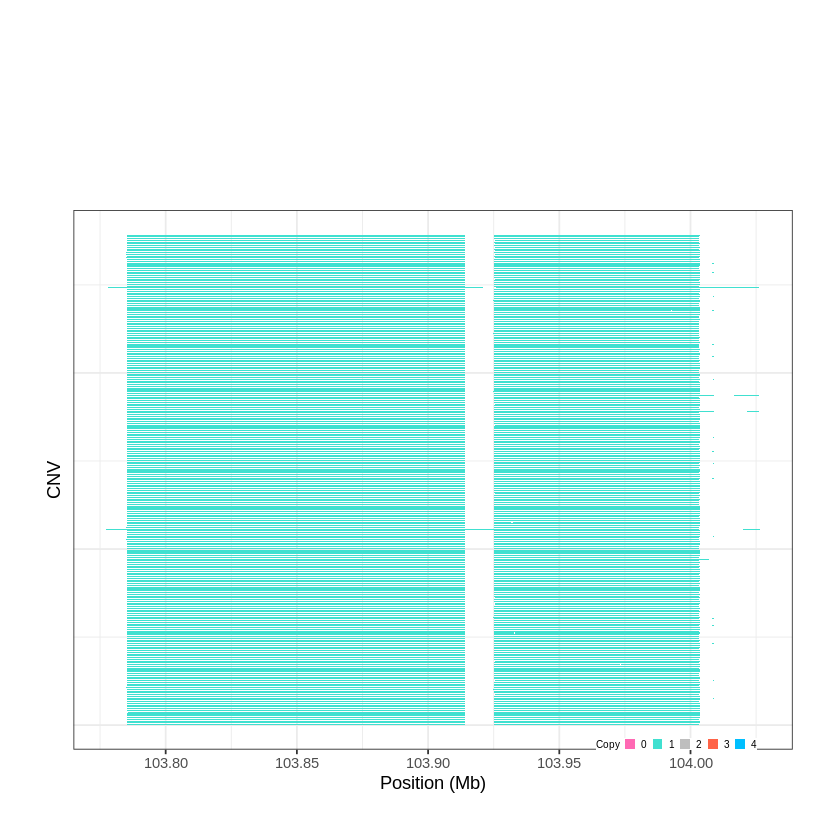

Task done, plot was stored in working directory.
[1] "Ploting CNVR 81..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 105.384001 - 105.3982 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


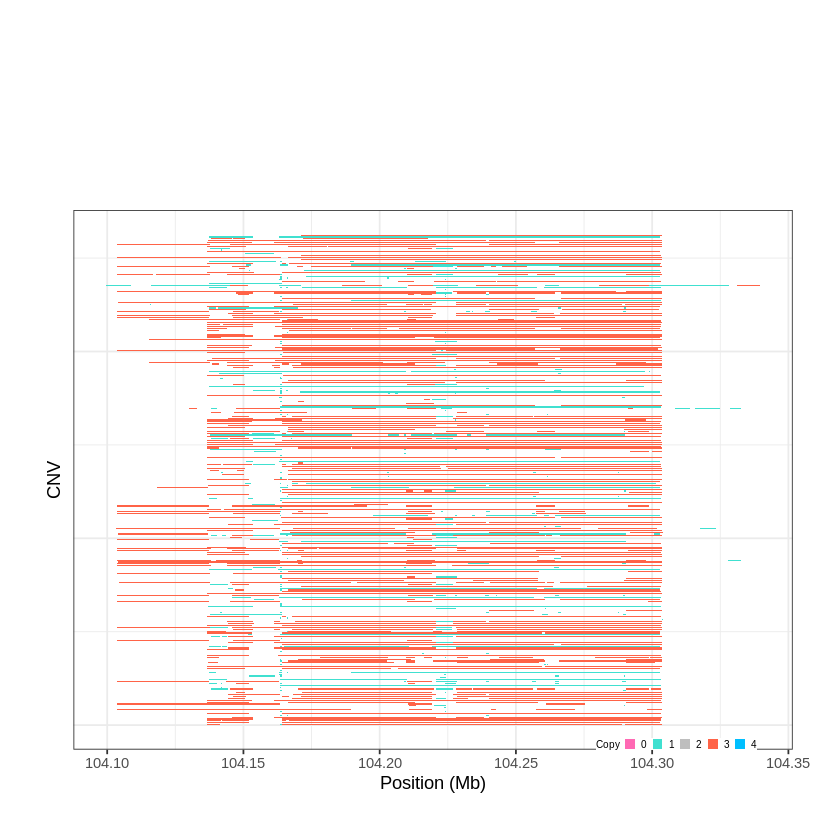

Task done, plot was stored in working directory.
[1] "Ploting CNVR 82..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 106.010101 - 106.0243 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


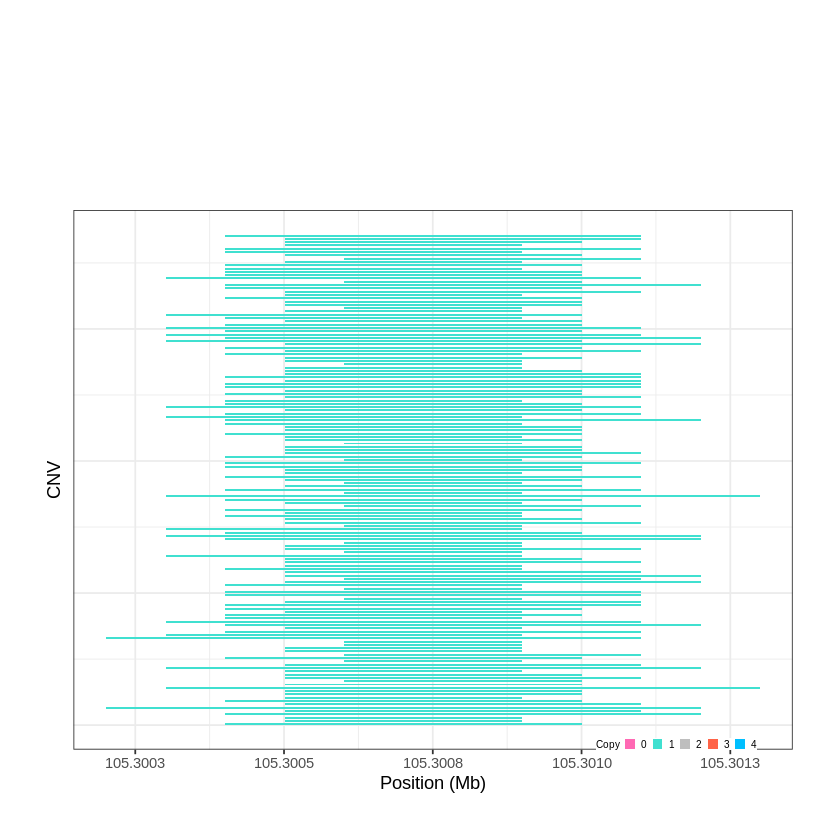

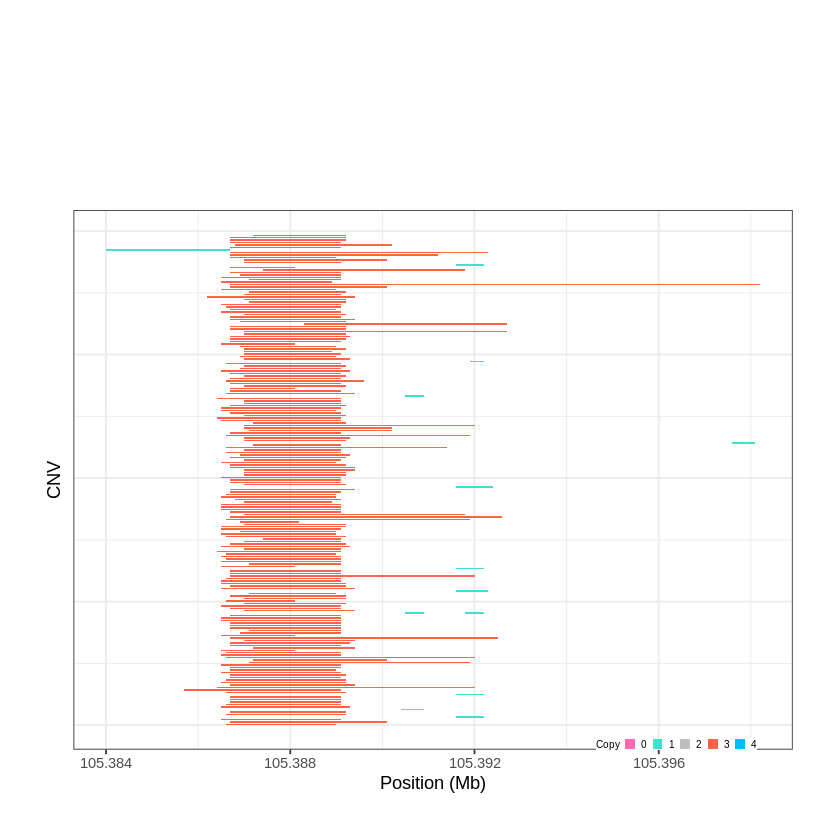

Task done, plot was stored in working directory.
[1] "Ploting CNVR 83..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 108.915701 - 109.0002 Mb with 217 Individual - "
Plotting gene...


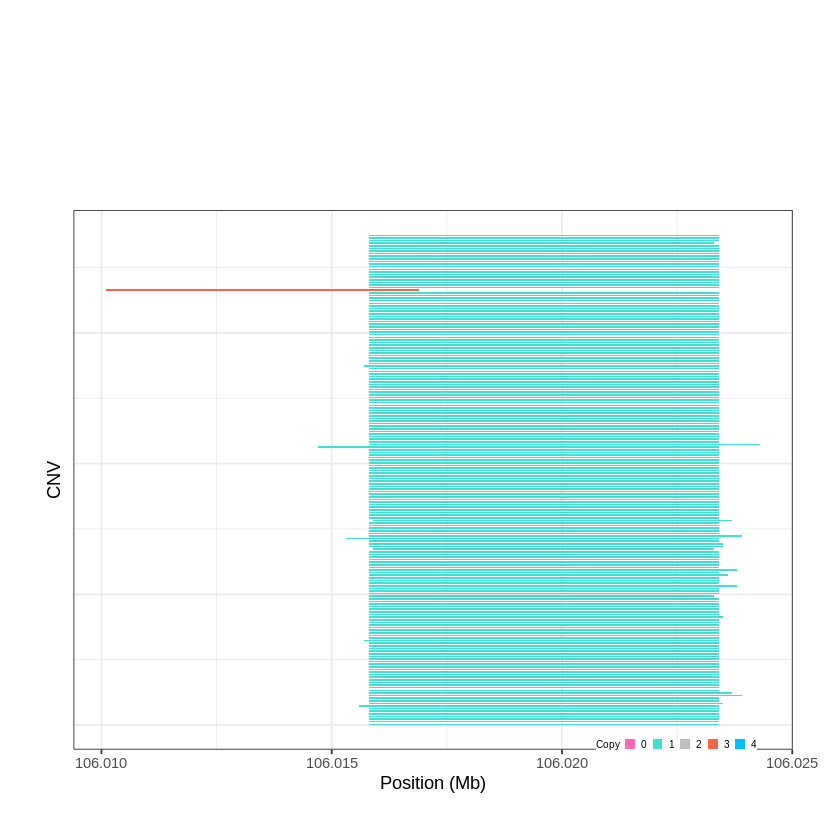

Task done, plot was stored in working directory.
[1] "Ploting CNVR 84..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 109.476101 - 109.8629 Mb with 153 Individual - "
Plotting gene...


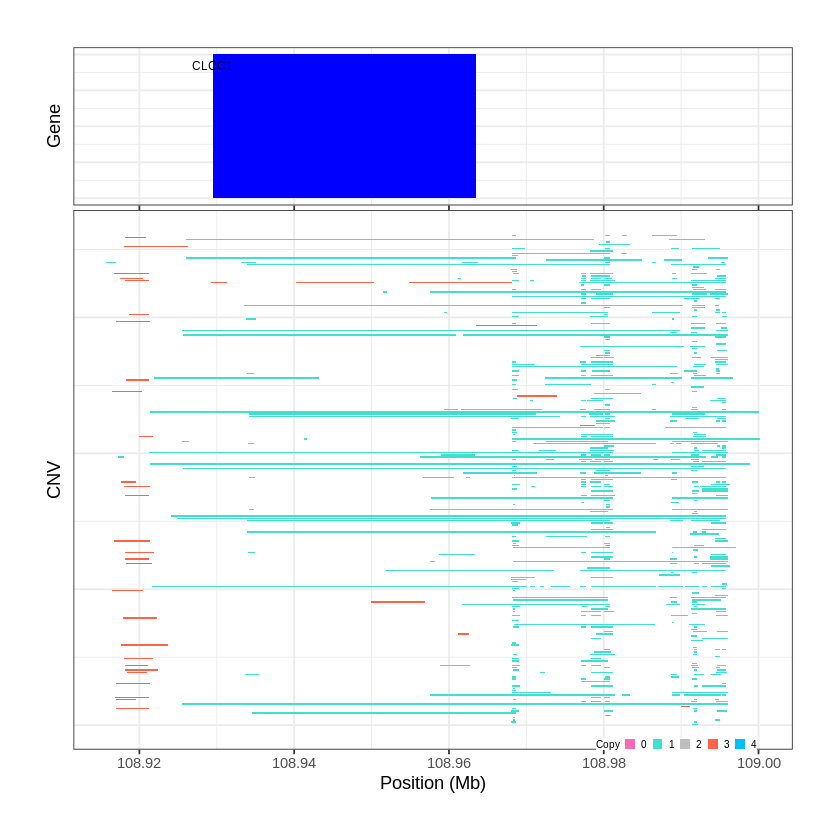

Task done, plot was stored in working directory.
[1] "Ploting CNVR 85..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 110.160401 - 110.2631 Mb with 268 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 86..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 112.686501 - 112.7066 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


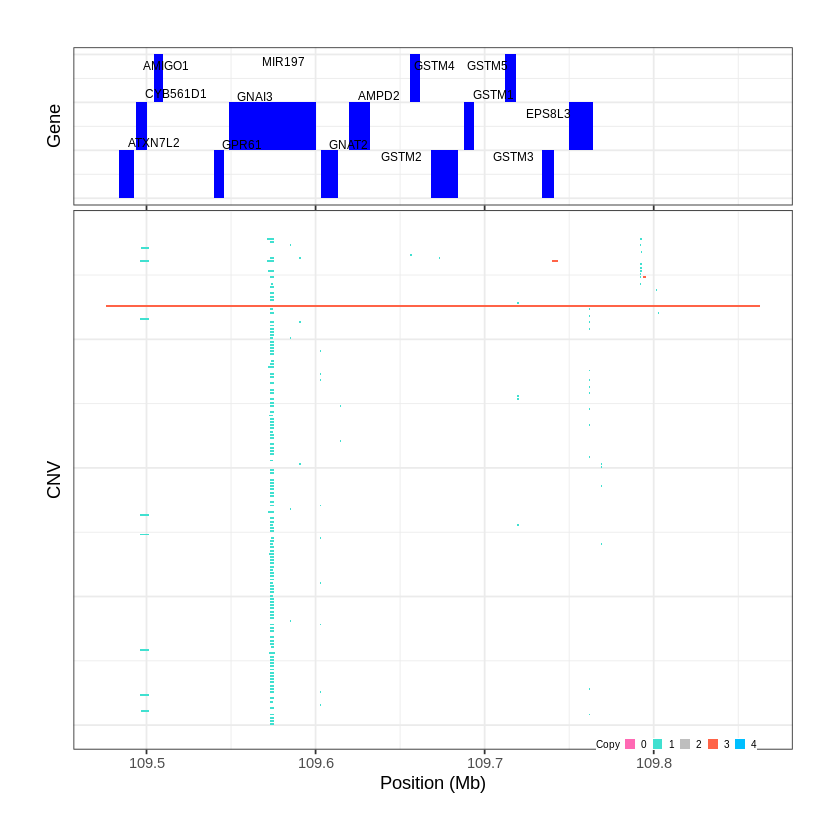

Task done, plot was stored in working directory.
[1] "Ploting CNVR 87..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 112.830501 - 112.8527 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


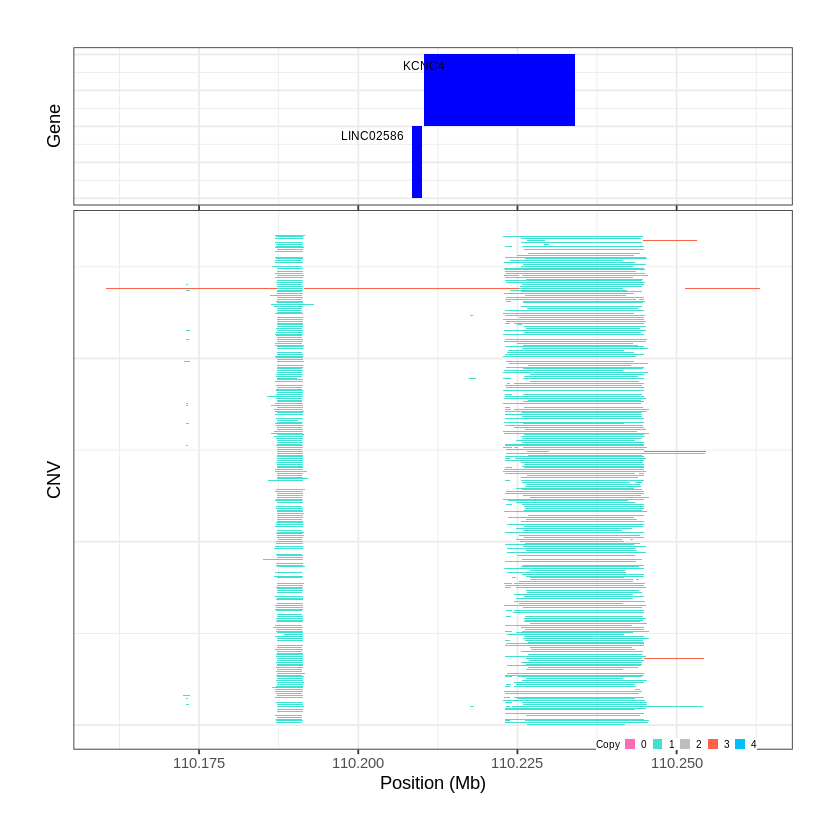

Task done, plot was stored in working directory.
[1] "Ploting CNVR 88..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 113.460601 - 113.6178 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


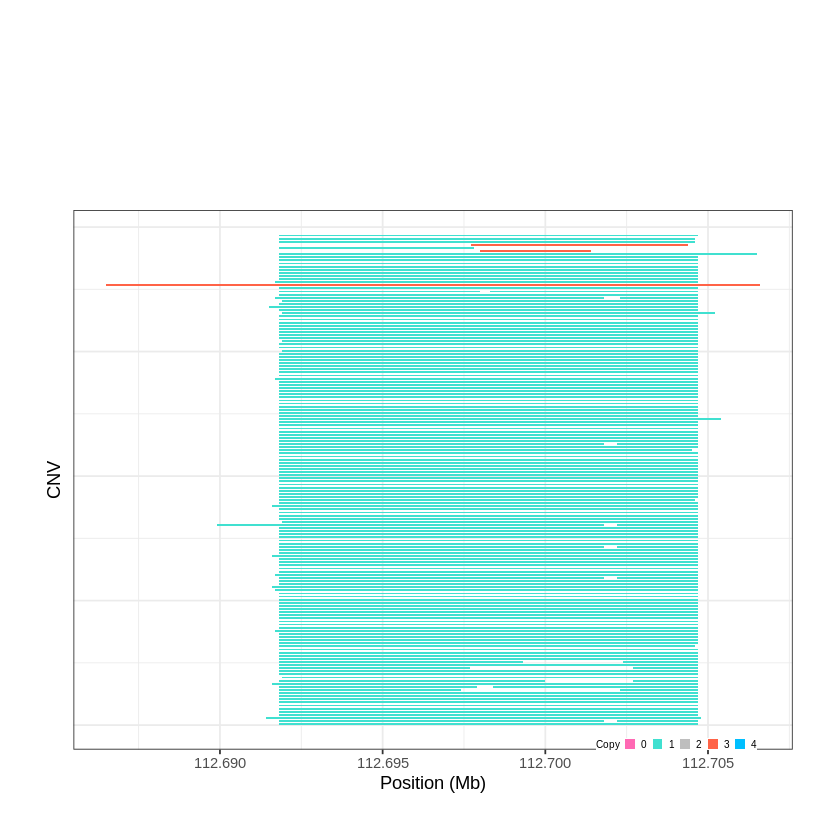

Task done, plot was stored in working directory.
[1] "Ploting CNVR 89..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 113.782901 - 113.8001 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


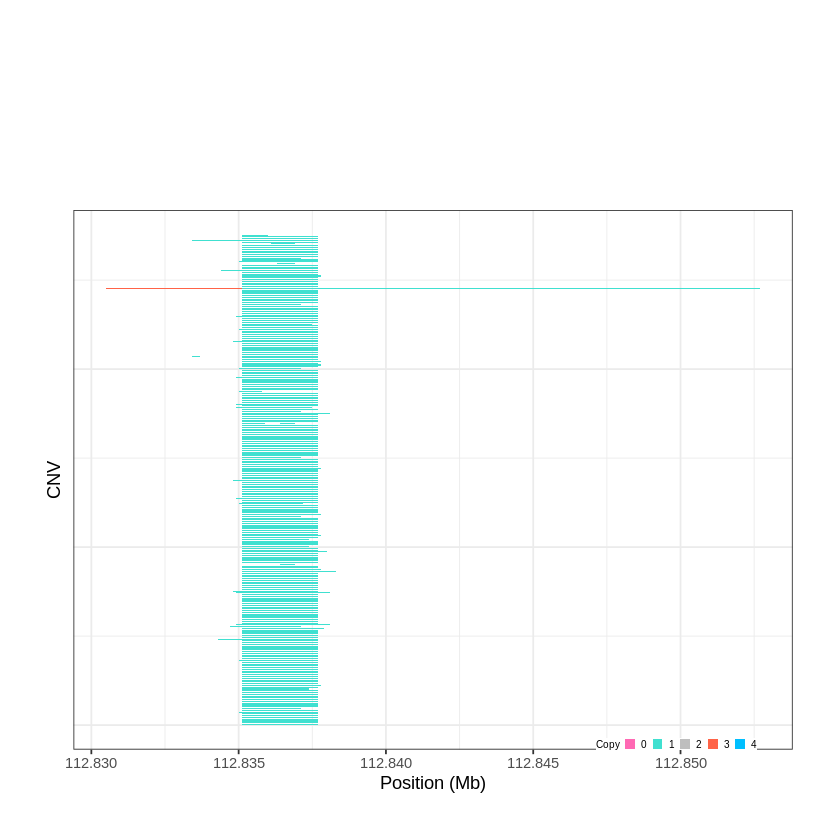

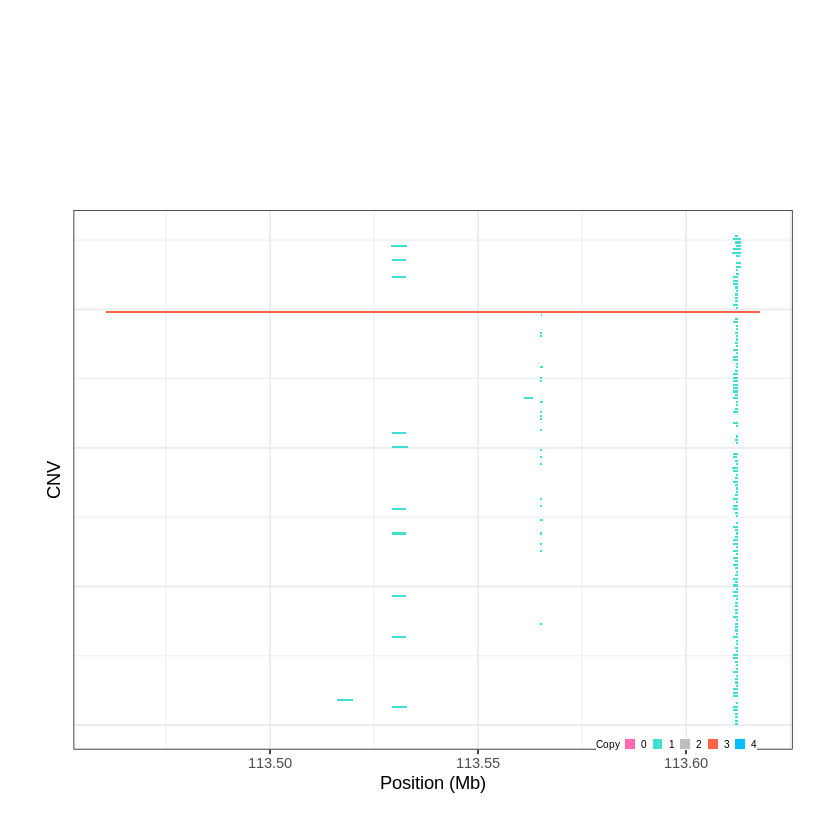

Task done, plot was stored in working directory.
[1] "Ploting CNVR 90..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 120.523501 - 120.8462 Mb with 279 Individual - "
Plotting gene...


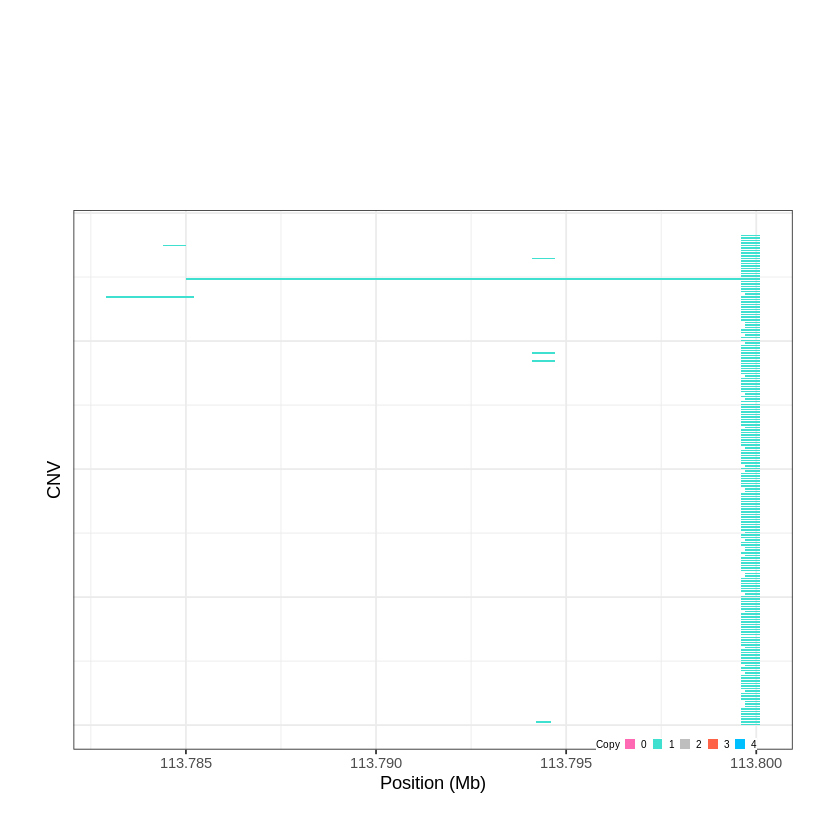

Task done, plot was stored in working directory.
[1] "Ploting CNVR 91..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 120.925801 - 121.0909 Mb with 279 Individual - "
Plotting gene...


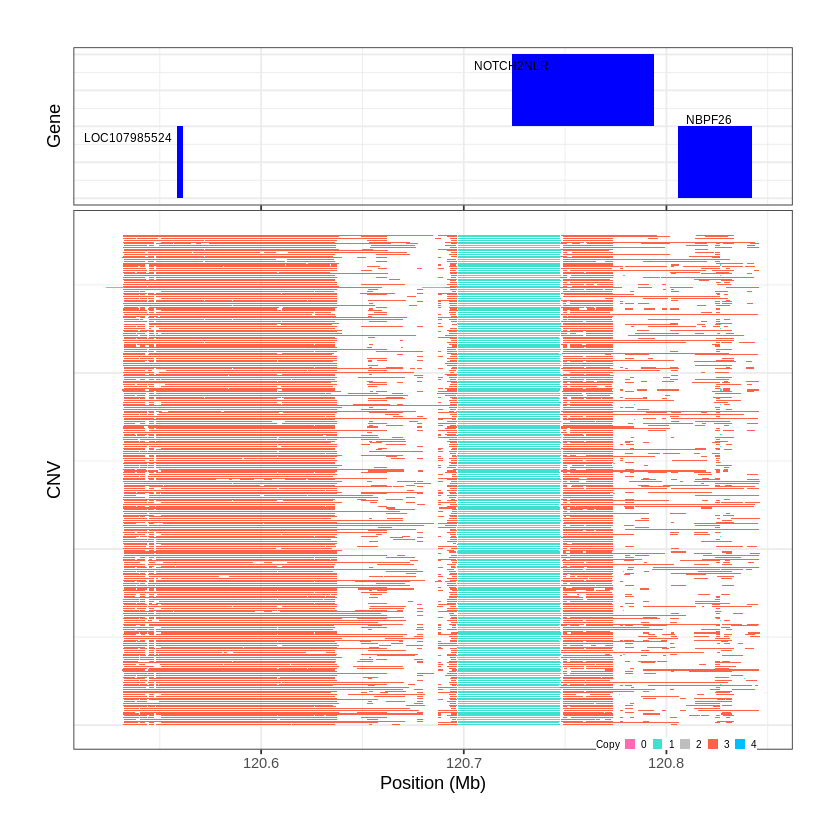

Task done, plot was stored in working directory.
[1] "Ploting CNVR 92..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 121.091001 - 121.165 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 93..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 121.269501 - 121.314 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


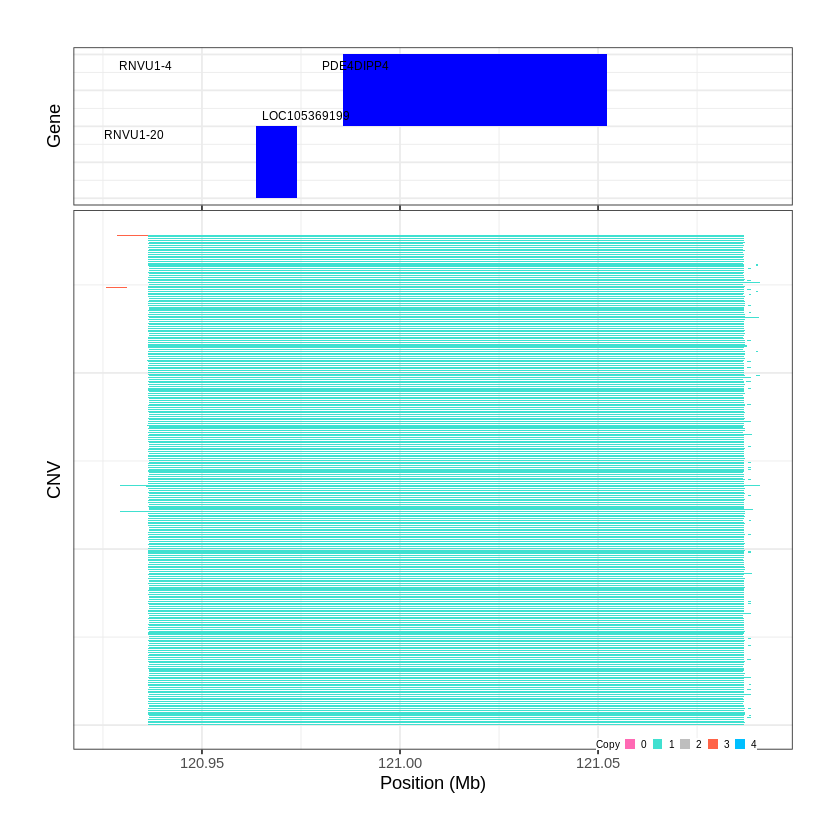

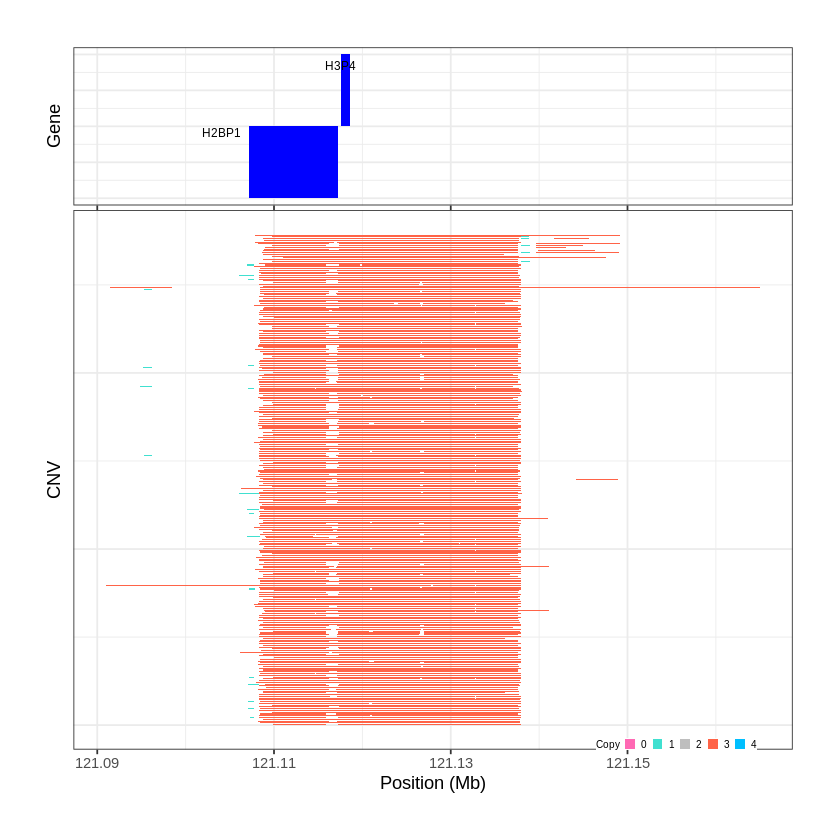

Task done, plot was stored in working directory.
[1] "Ploting CNVR 94..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 121.352201 - 121.4854 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 95..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 142.535401 - 142.9677 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


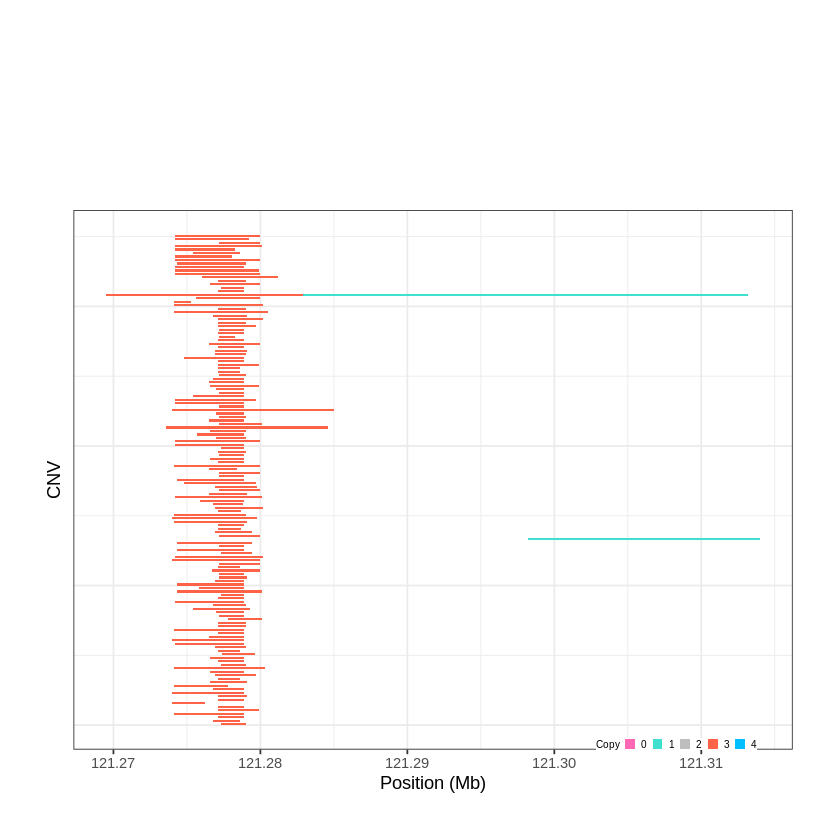

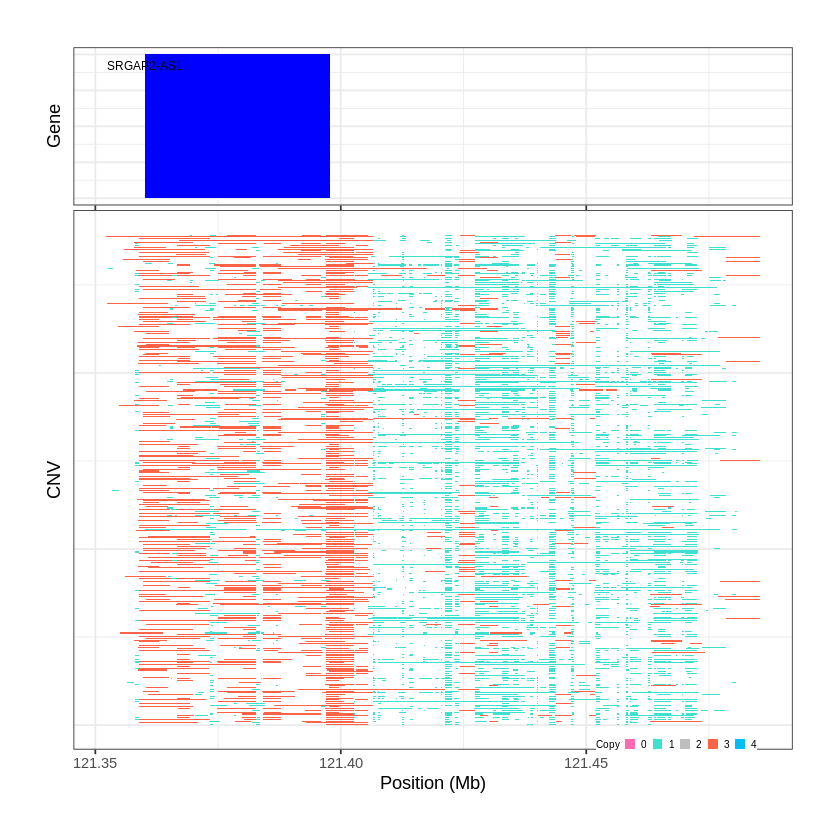

Task done, plot was stored in working directory.
[1] "Ploting CNVR 96..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 142.967701 - 144.5074 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


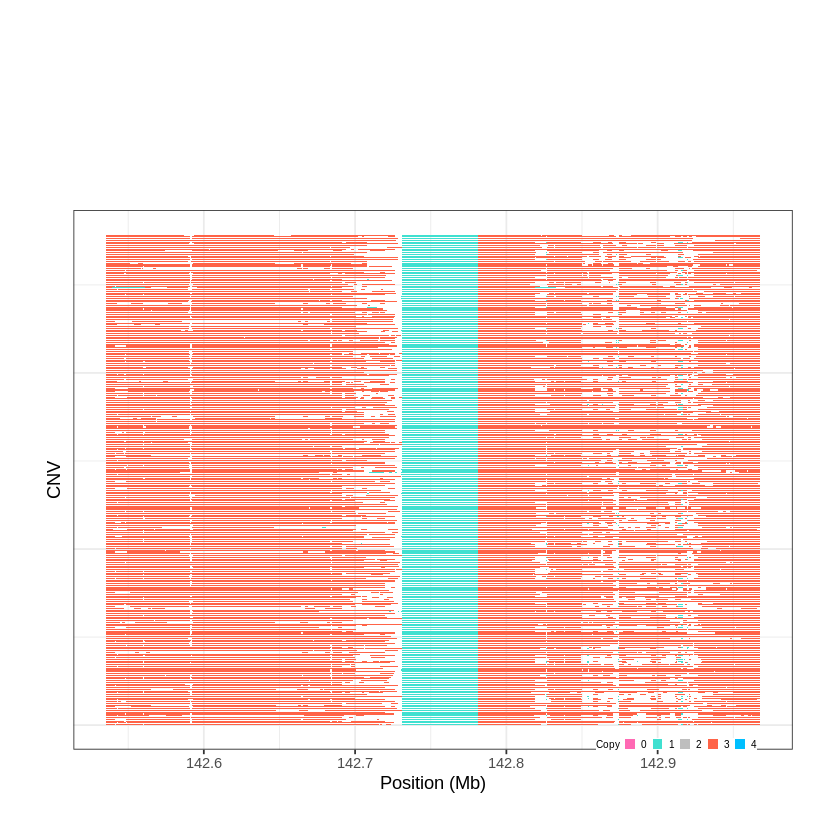

Task done, plot was stored in working directory.
[1] "Ploting CNVR 97..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 144.508001 - 145.4398 Mb with 279 Individual - "
Plotting gene...


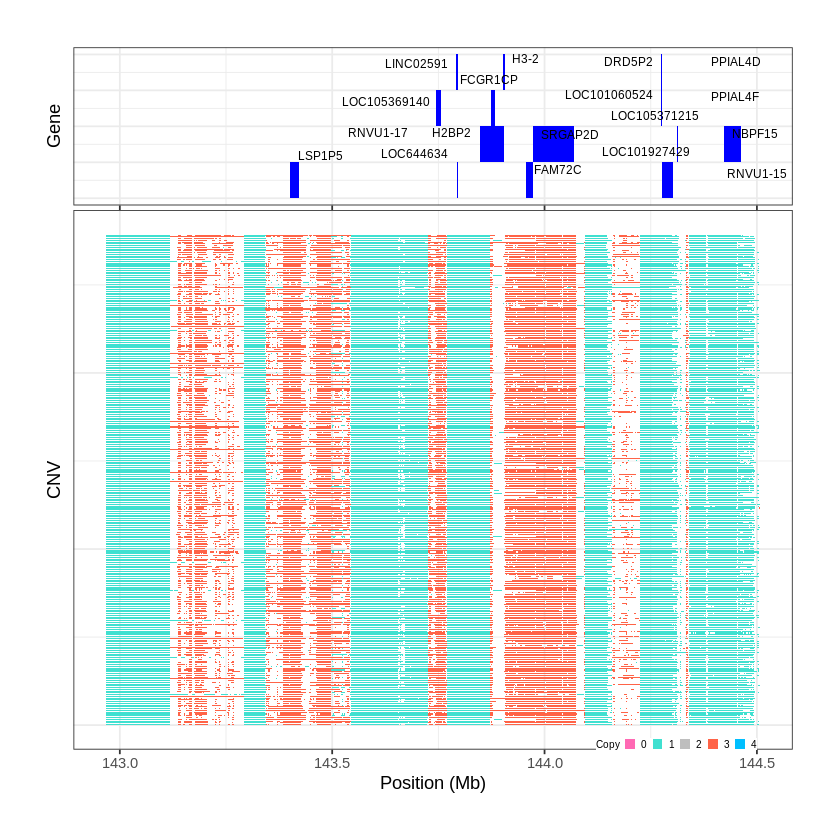

Task done, plot was stored in working directory.
[1] "Ploting CNVR 98..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 145.606601 - 145.946 Mb with 279 Individual - "
Plotting gene...


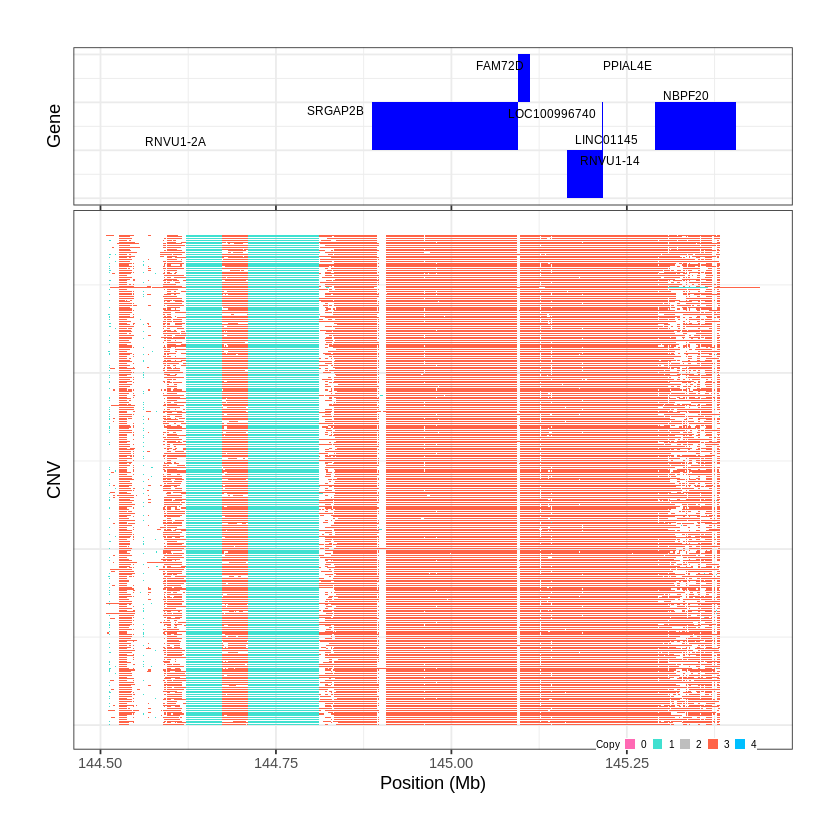

Task done, plot was stored in working directory.
[1] "Ploting CNVR 99..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 145.946001 - 146.3047 Mb with 279 Individual - "
Plotting gene...


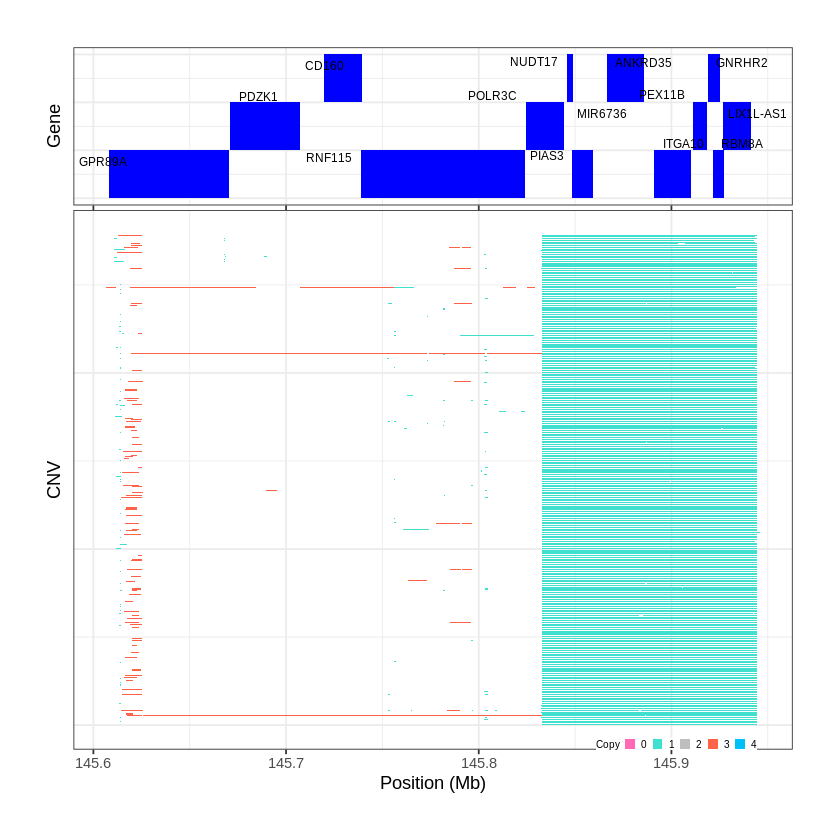

Task done, plot was stored in working directory.
[1] "Ploting CNVR 100..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 146.307101 - 146.4873 Mb with 279 Individual - "
Plotting gene...


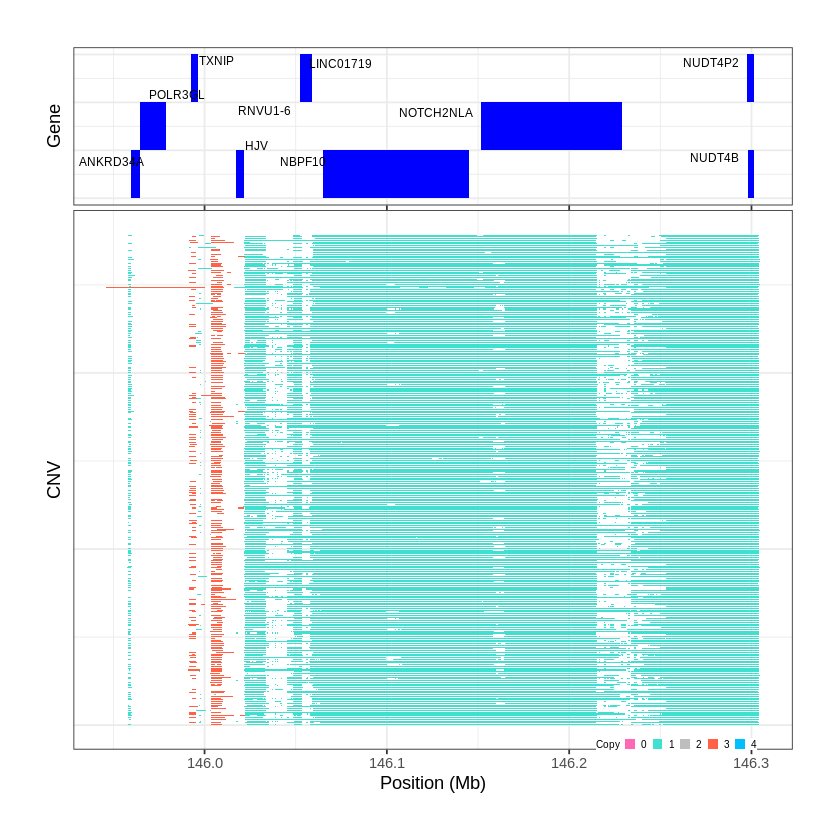

Task done, plot was stored in working directory.
[1] "Ploting CNVR 101..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 147.351901 - 147.7206 Mb with 279 Individual - "
Plotting gene...


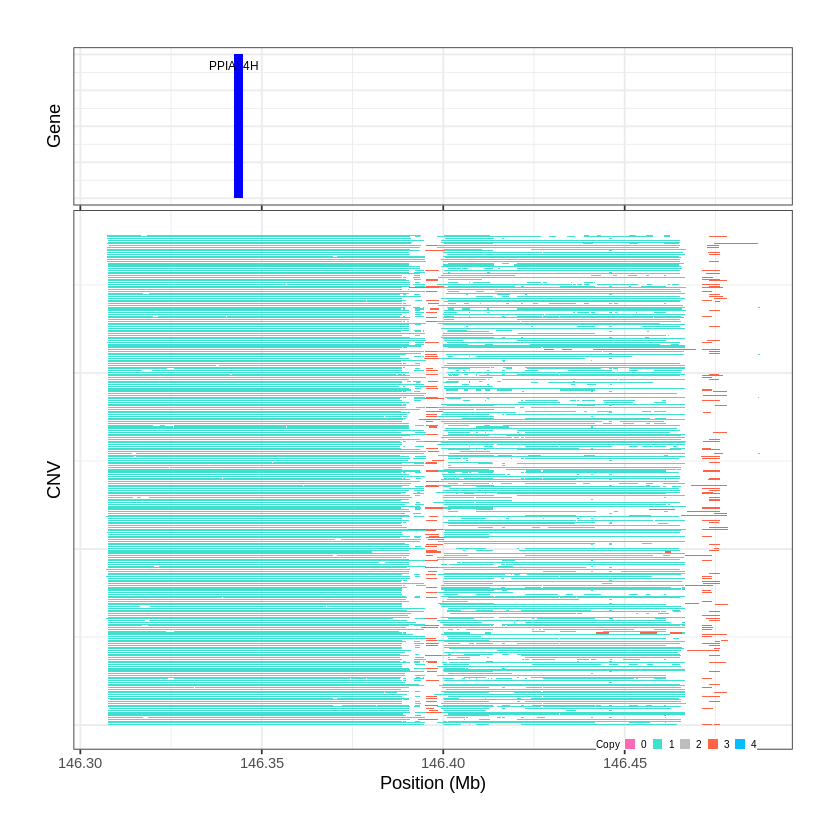

Task done, plot was stored in working directory.
[1] "Ploting CNVR 102..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 147.732901 - 148.7877 Mb with 279 Individual - "
Plotting gene...


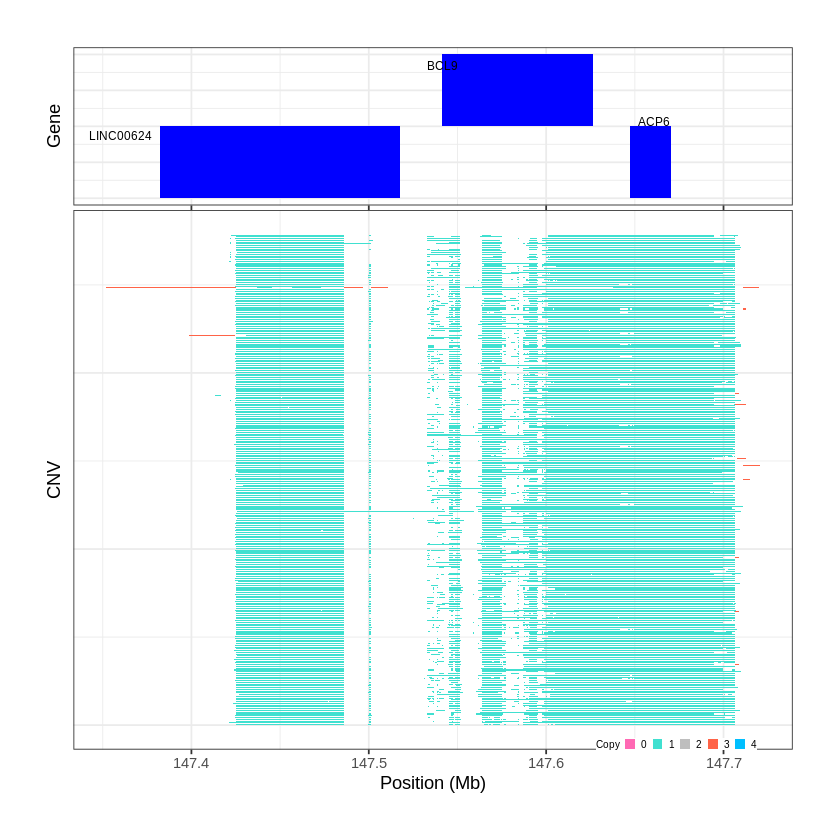

Task done, plot was stored in working directory.
[1] "Ploting CNVR 103..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 148.788401 - 149.9292 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 16 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


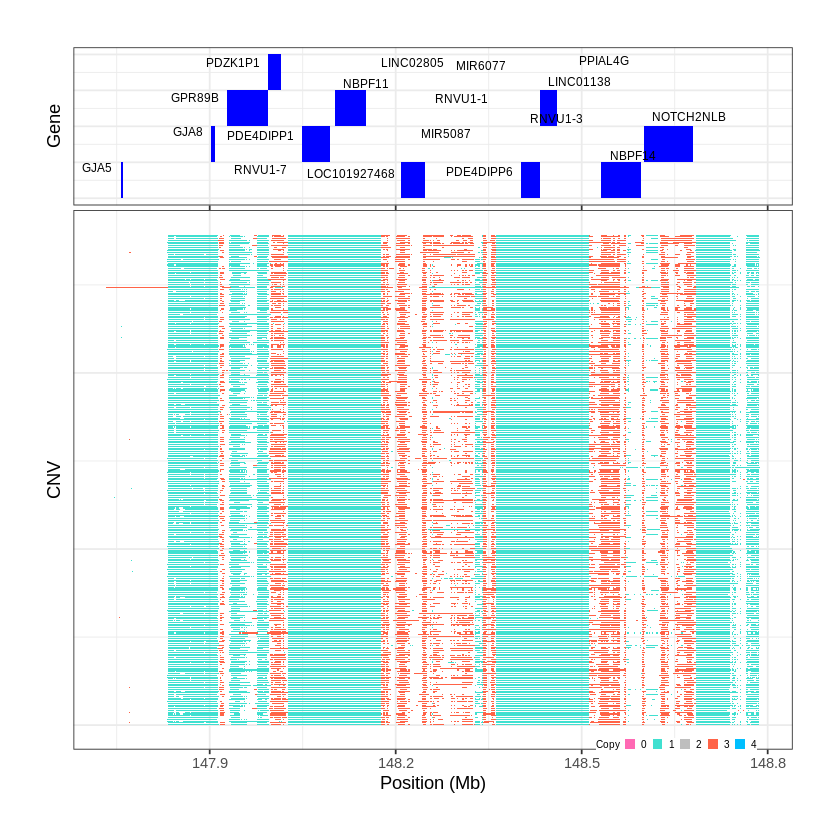

Task done, plot was stored in working directory.
[1] "Ploting CNVR 104..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 150.686101 - 150.7778 Mb with 156 Individual - "
Plotting gene...


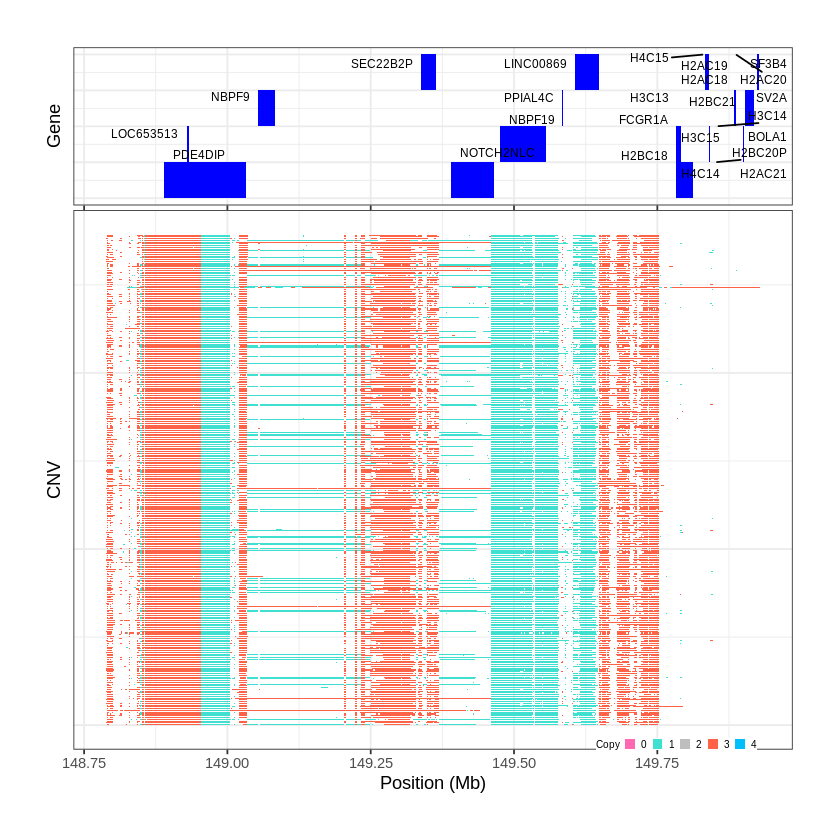

Task done, plot was stored in working directory.
[1] "Ploting CNVR 105..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 151.544501 - 151.591 Mb with 150 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 106..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 152.180401 - 152.1958 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


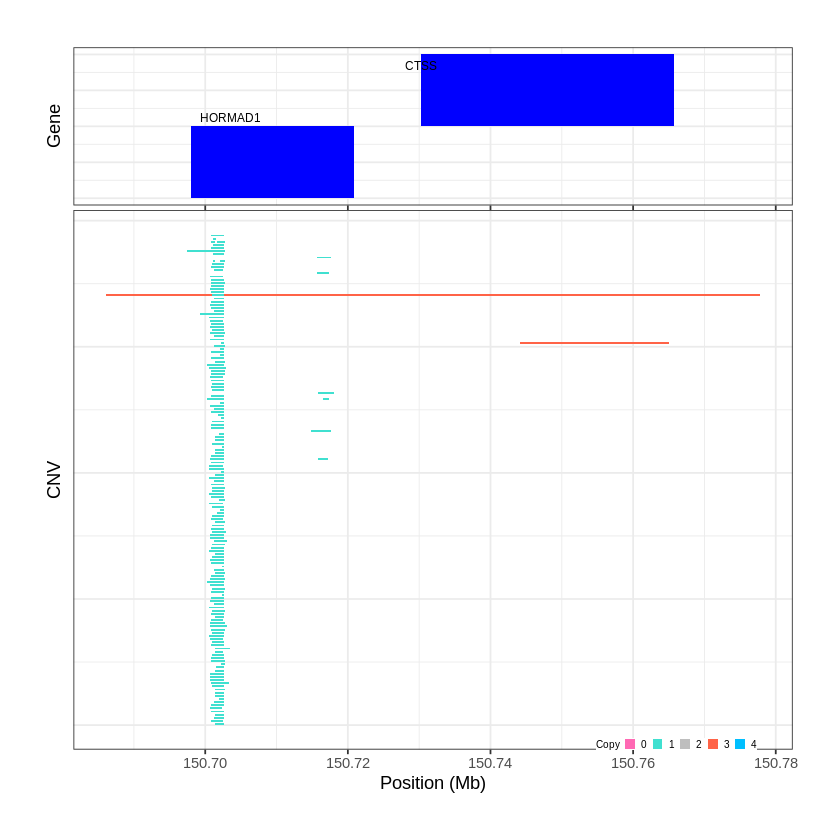

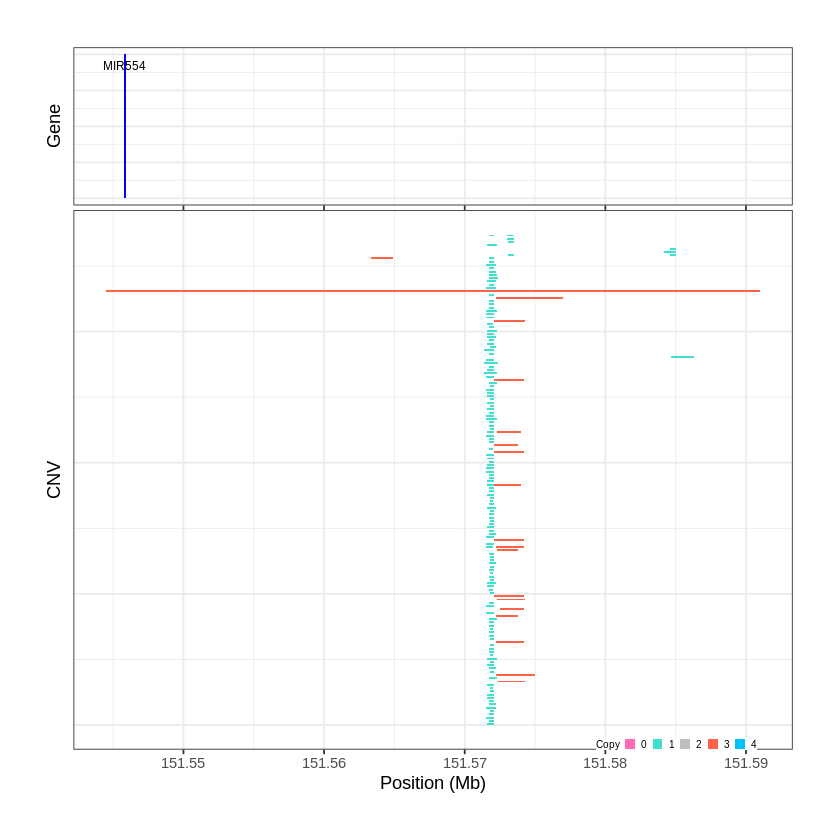

Task done, plot was stored in working directory.
[1] "Ploting CNVR 107..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 152.403901 - 152.7181 Mb with 229 Individual - "
Plotting gene...


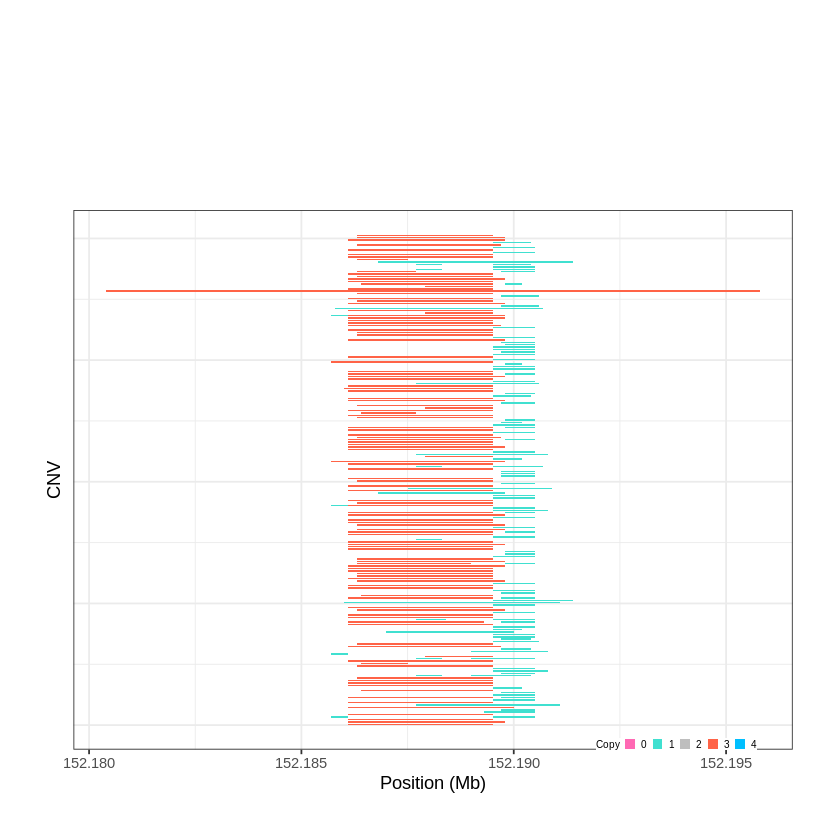

Task done, plot was stored in working directory.
[1] "Ploting CNVR 108..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 154.596501 - 155.3065 Mb with 200 Individual - "
Plotting gene...


Warning message:
“ggrepel: 13 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 109..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 156.526701 - 156.5301 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


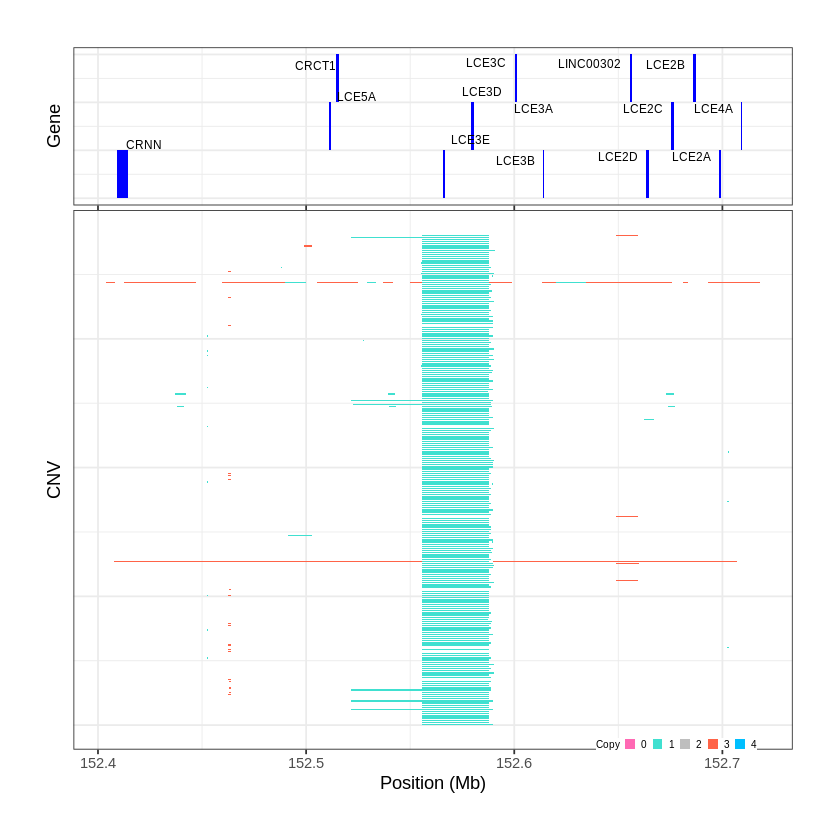

Task done, plot was stored in working directory.
[1] "Ploting CNVR 110..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 158.867201 - 158.8743 Mb with 262 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


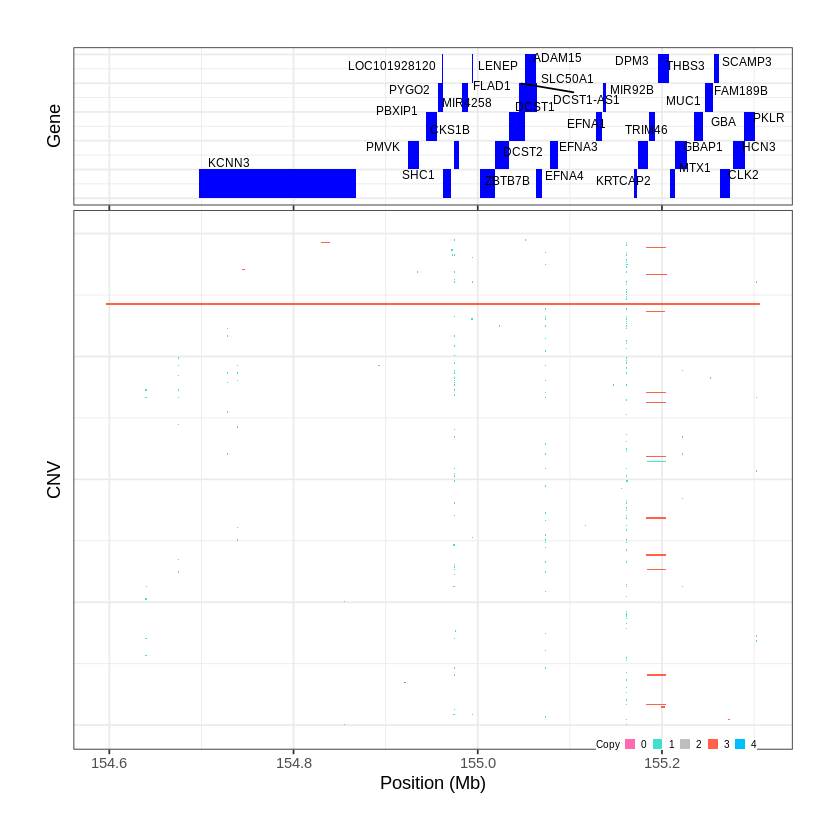

Task done, plot was stored in working directory.
[1] "Ploting CNVR 111..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 159.648701 - 159.6549 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


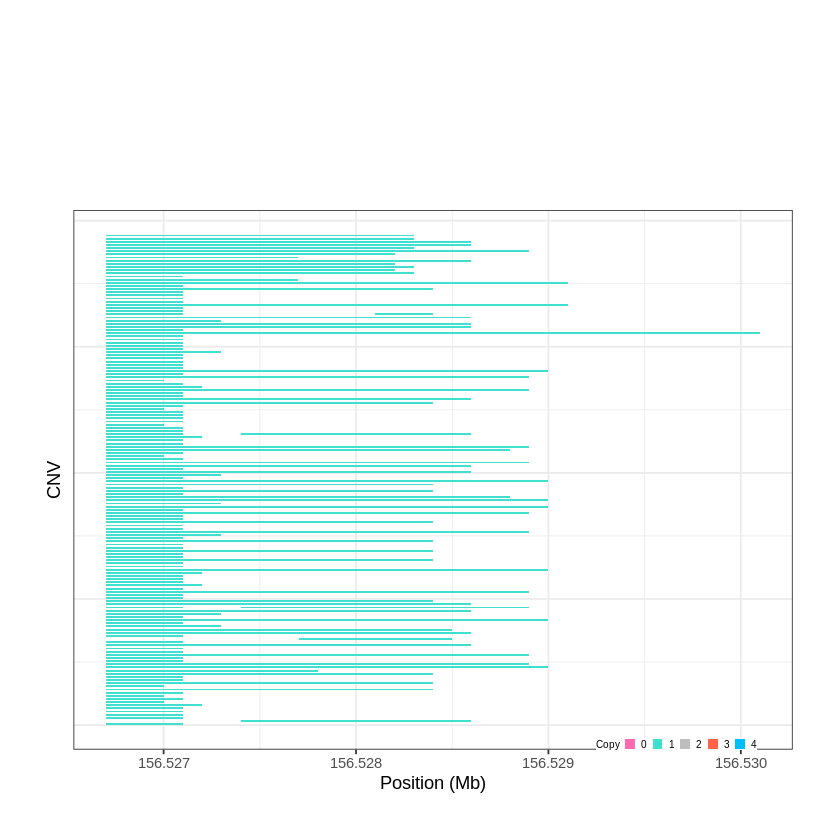

Task done, plot was stored in working directory.
[1] "Ploting CNVR 112..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 161.408001 - 161.454 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


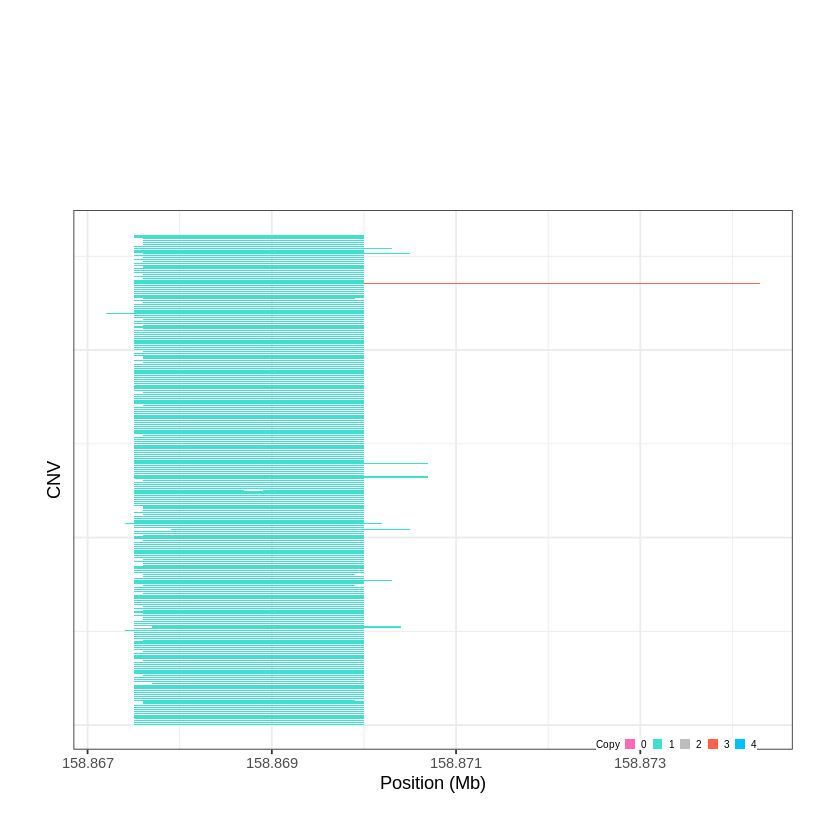

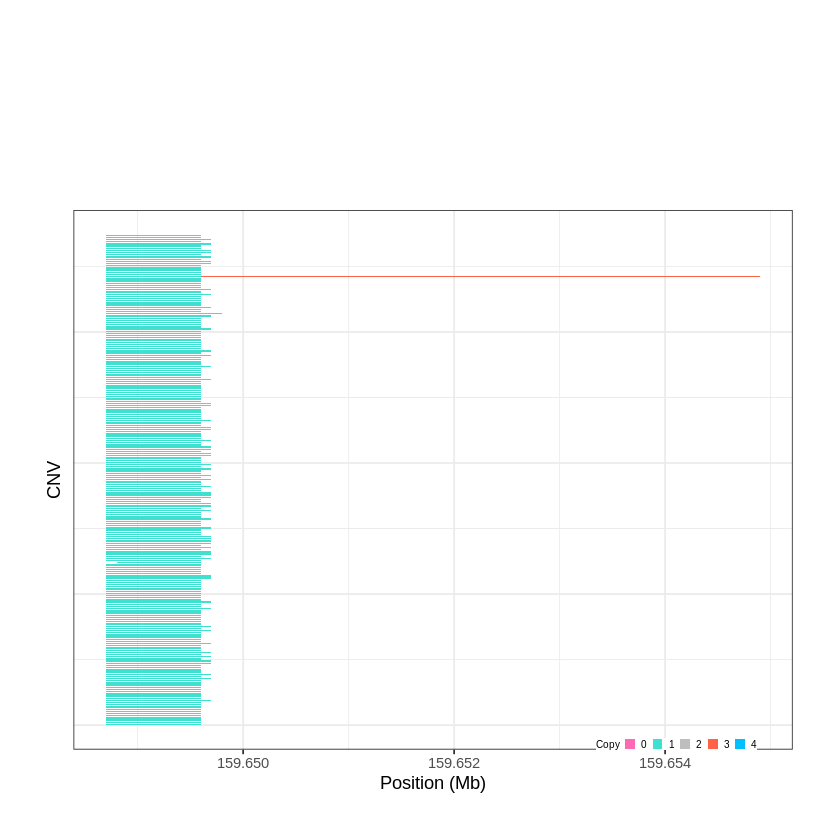

Task done, plot was stored in working directory.
[1] "Ploting CNVR 113..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 161.464501 - 161.6443 Mb with 278 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 114..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 162.045301 - 162.0662 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


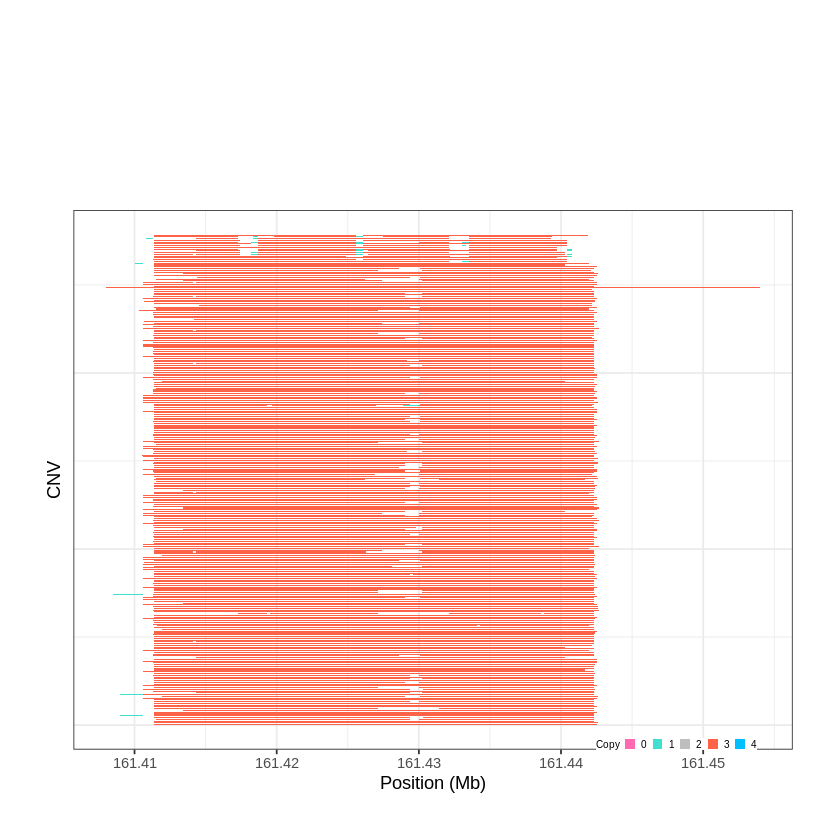

Task done, plot was stored in working directory.
[1] "Ploting CNVR 115..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 165.731201 - 165.7315 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


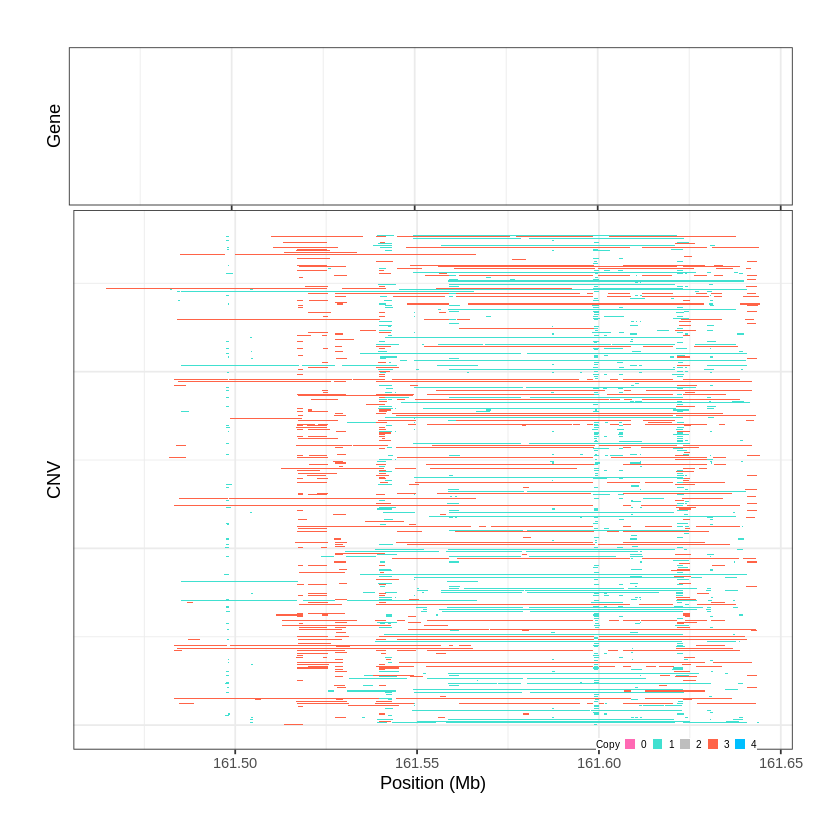

Task done, plot was stored in working directory.
[1] "Ploting CNVR 116..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 166.162001 - 166.2203 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


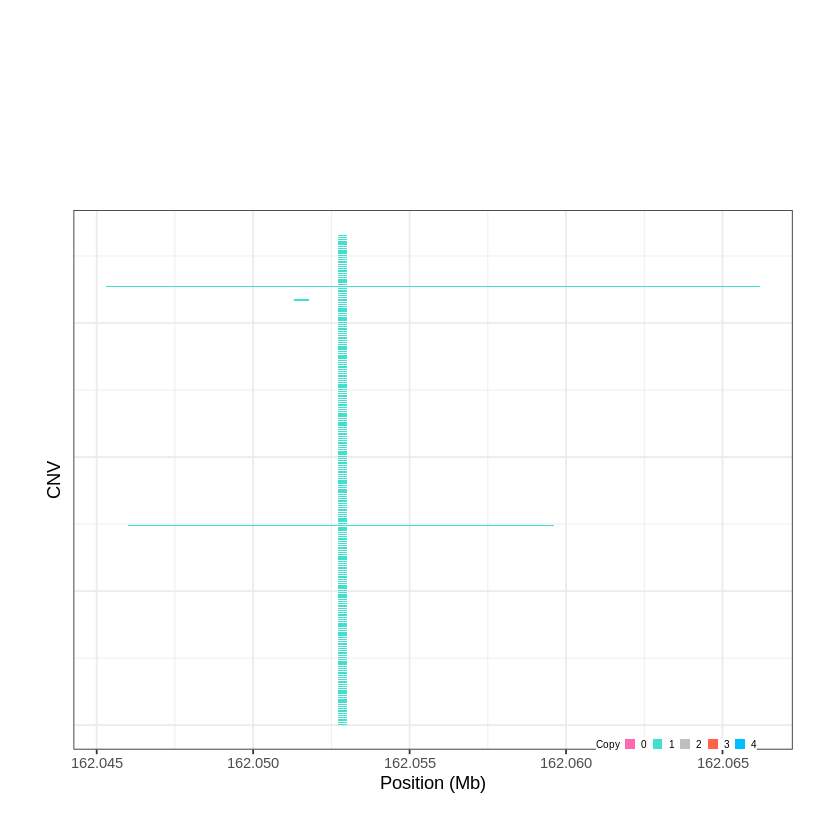

Task done, plot was stored in working directory.
[1] "Ploting CNVR 117..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 176.468101 - 176.4901 Mb with 277 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


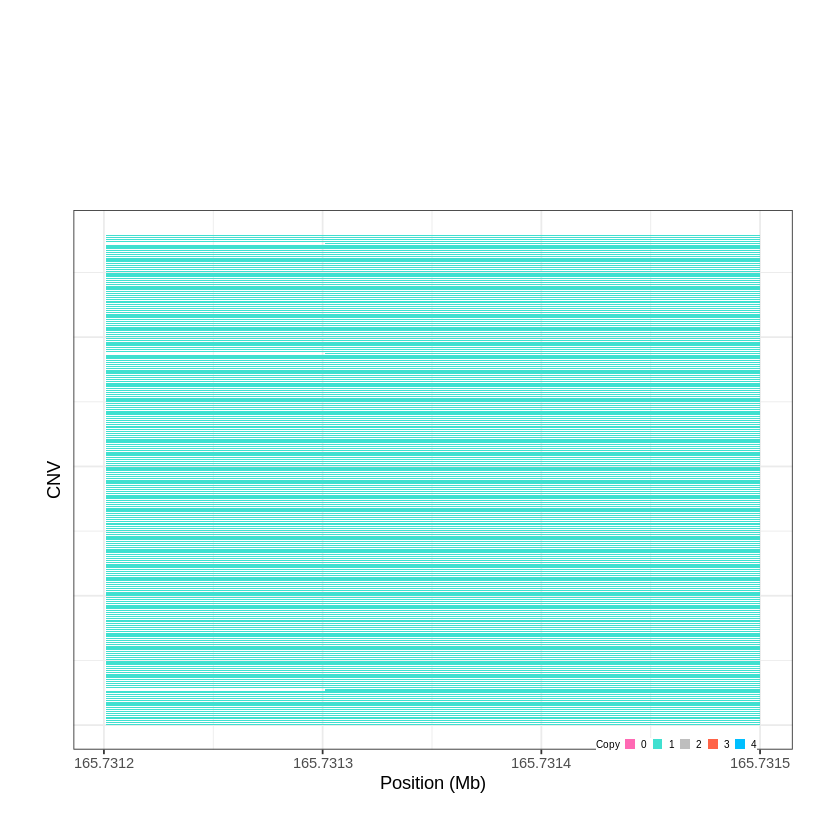

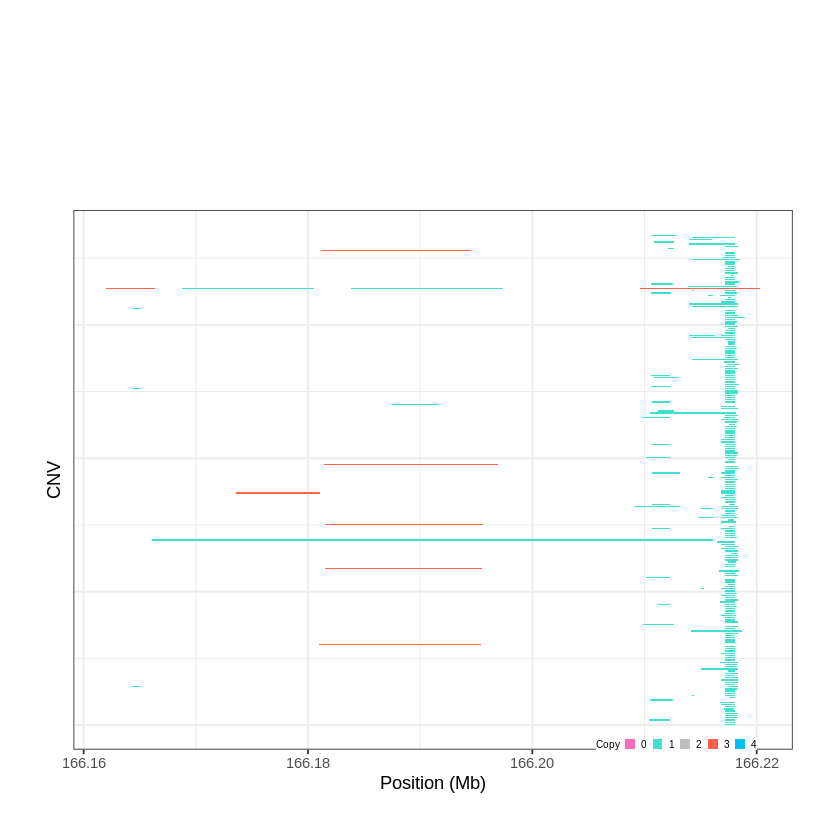

Task done, plot was stored in working directory.
[1] "Ploting CNVR 118..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 180.091701 - 180.2493 Mb with 159 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 119..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 180.290201 - 180.2946 Mb with 207 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


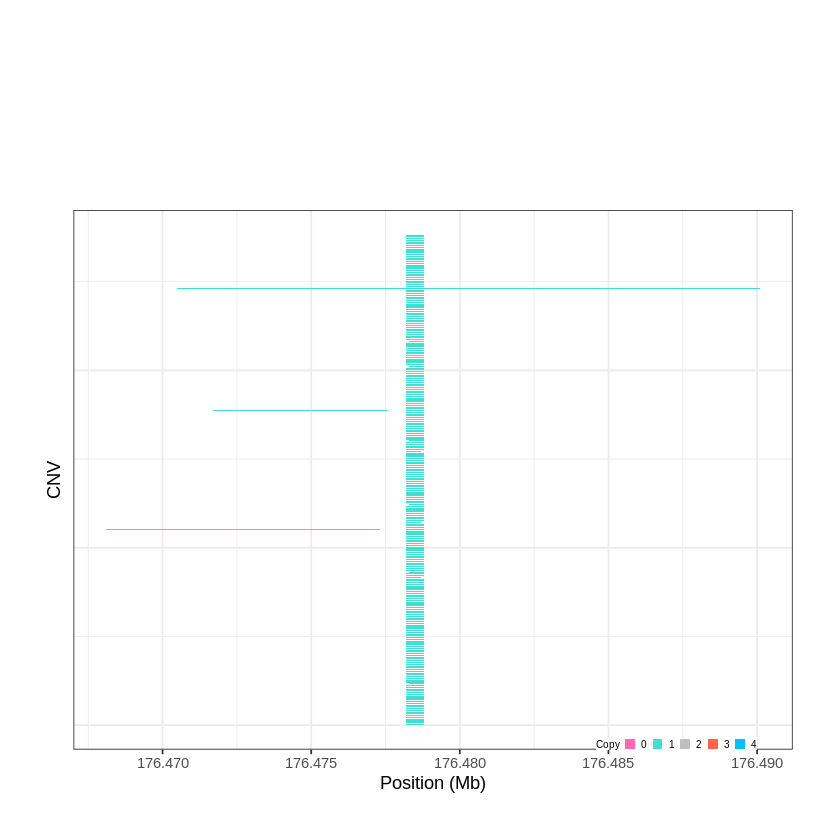

Task done, plot was stored in working directory.
[1] "Ploting CNVR 120..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 180.834301 - 180.8438 Mb with 267 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


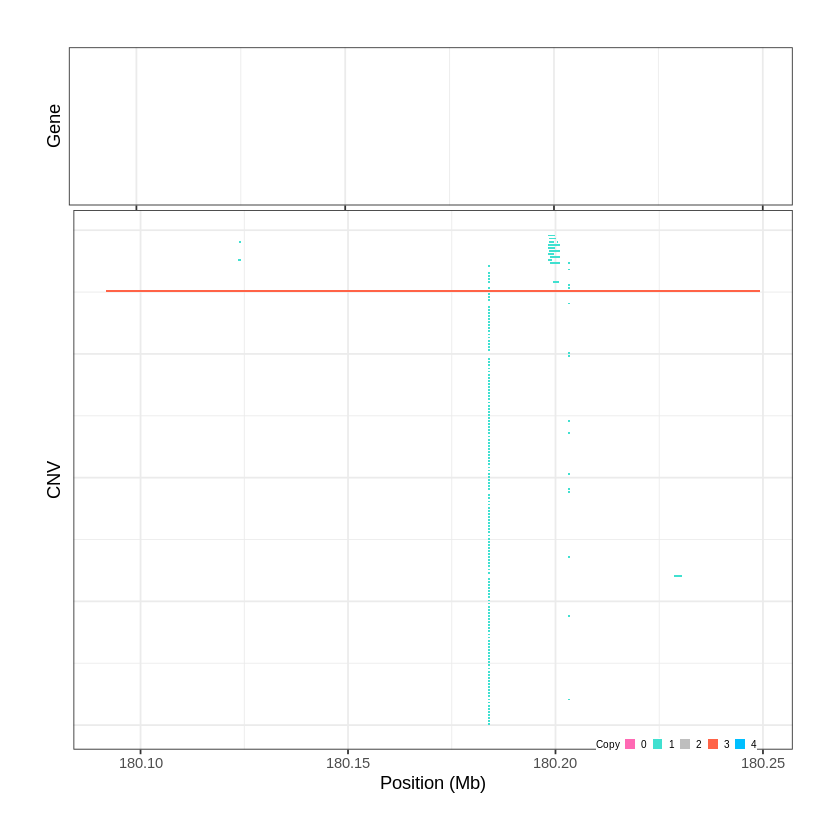

Task done, plot was stored in working directory.
[1] "Ploting CNVR 121..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 184.961001 - 184.9918 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


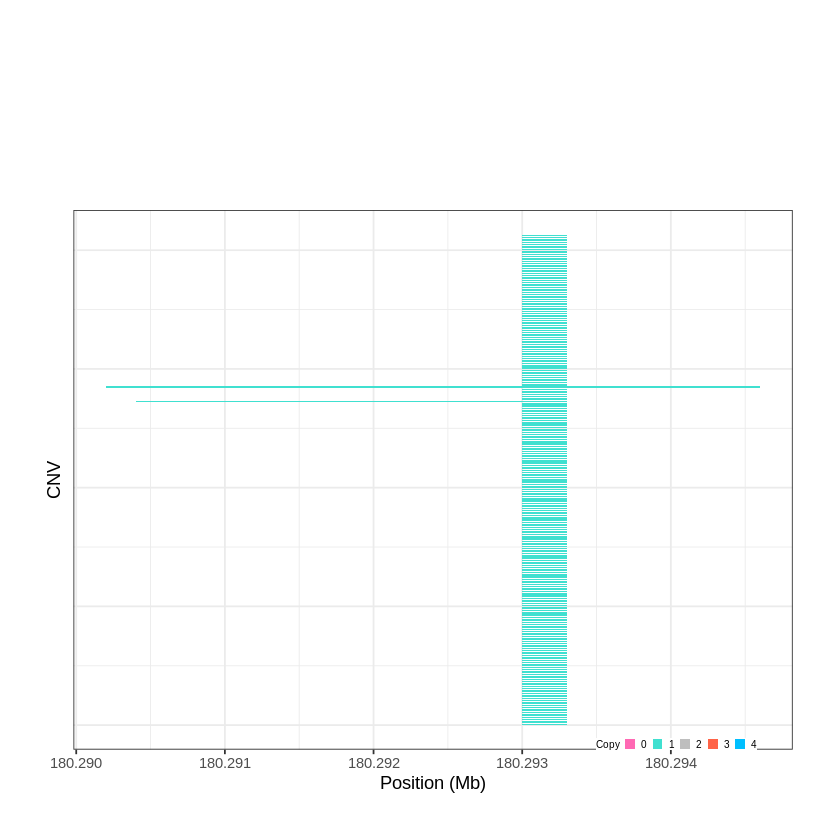

Task done, plot was stored in working directory.
[1] "Ploting CNVR 122..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 186.756001 - 186.7781 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


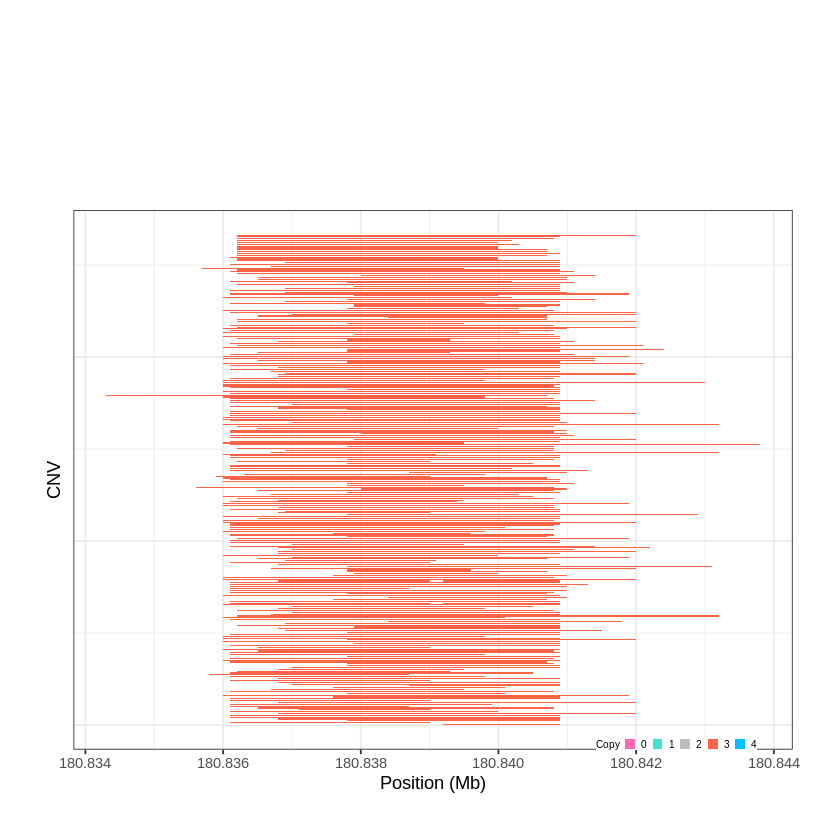

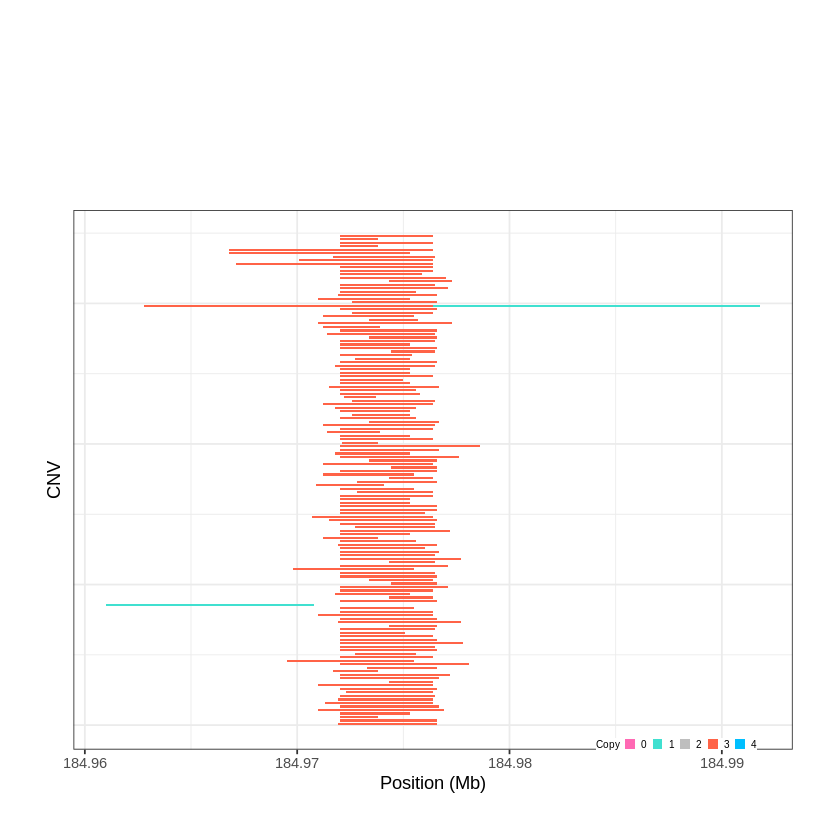

Task done, plot was stored in working directory.
[1] "Ploting CNVR 123..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 187.420501 - 187.5101 Mb with 264 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 124..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 187.563801 - 187.6021 Mb with 257 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


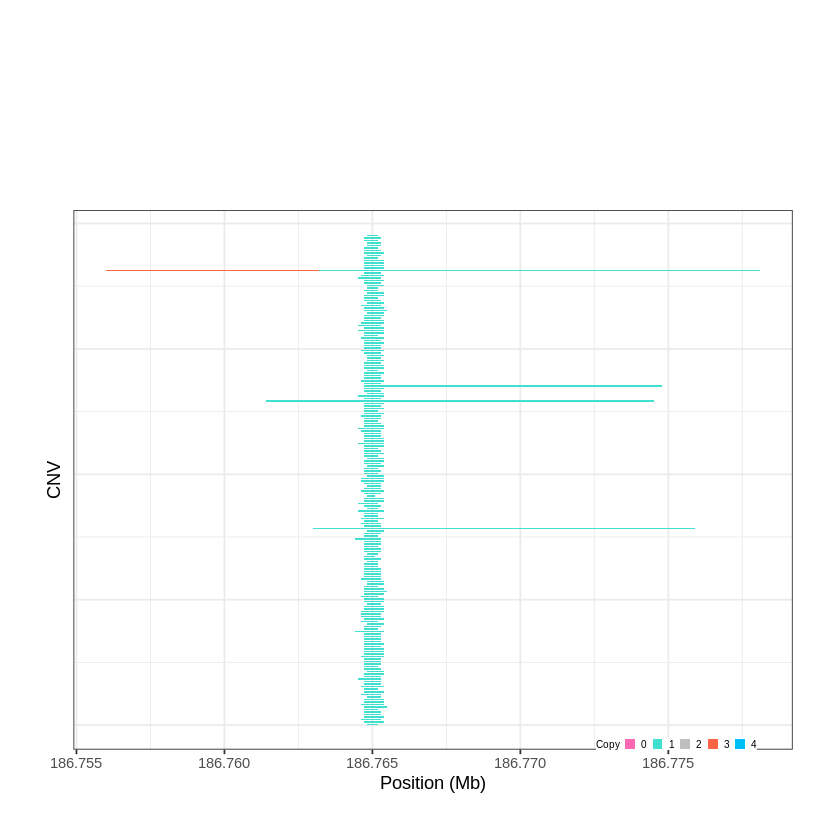

Task done, plot was stored in working directory.
[1] "Ploting CNVR 125..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 188.529201 - 188.5438 Mb with 269 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


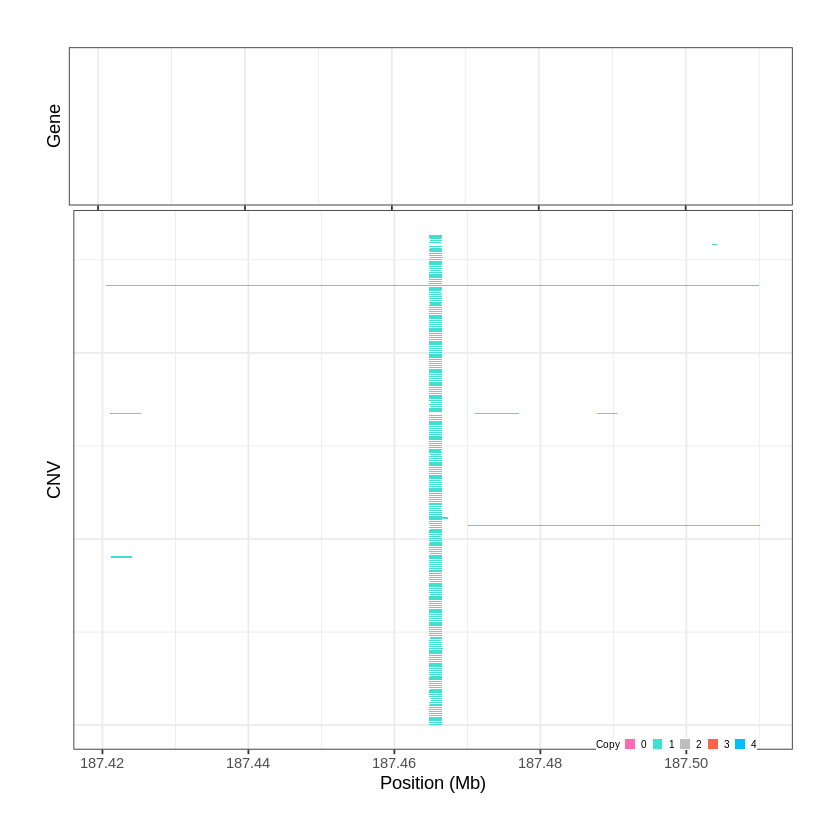

Task done, plot was stored in working directory.
[1] "Ploting CNVR 126..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 190.817501 - 190.8505 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


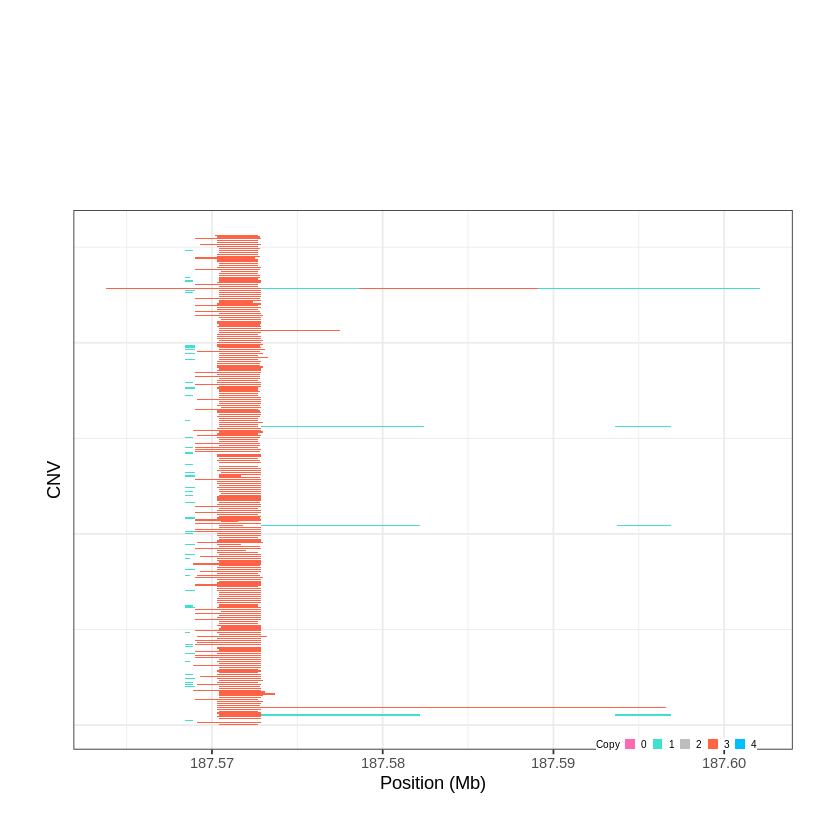

Task done, plot was stored in working directory.
[1] "Ploting CNVR 127..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 193.120601 - 193.1316 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


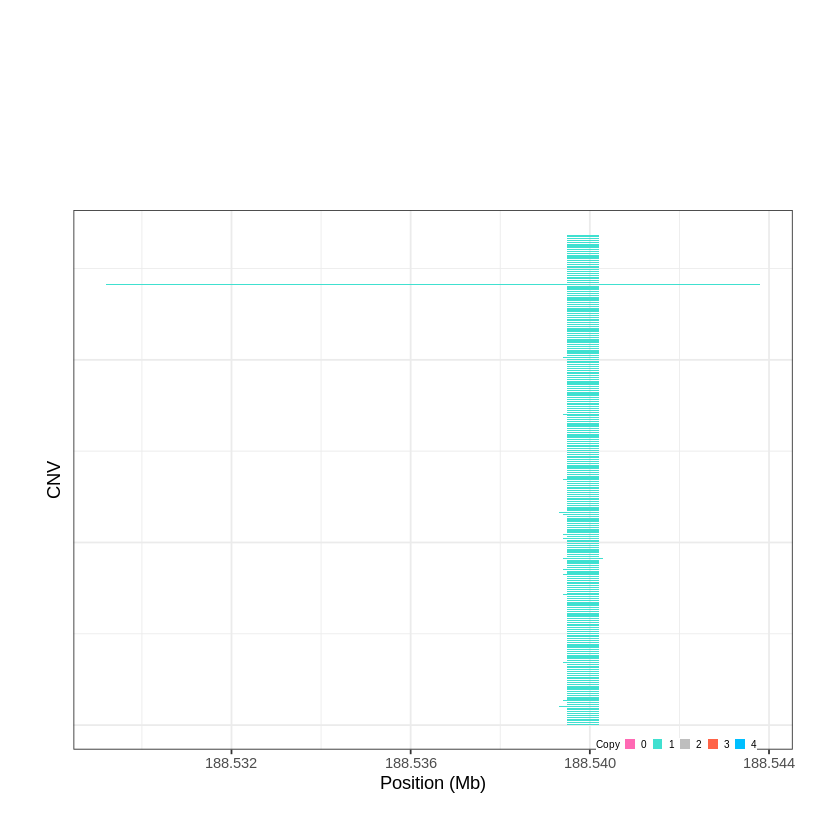

Task done, plot was stored in working directory.
[1] "Ploting CNVR 128..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 194.410801 - 194.4789 Mb with 222 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


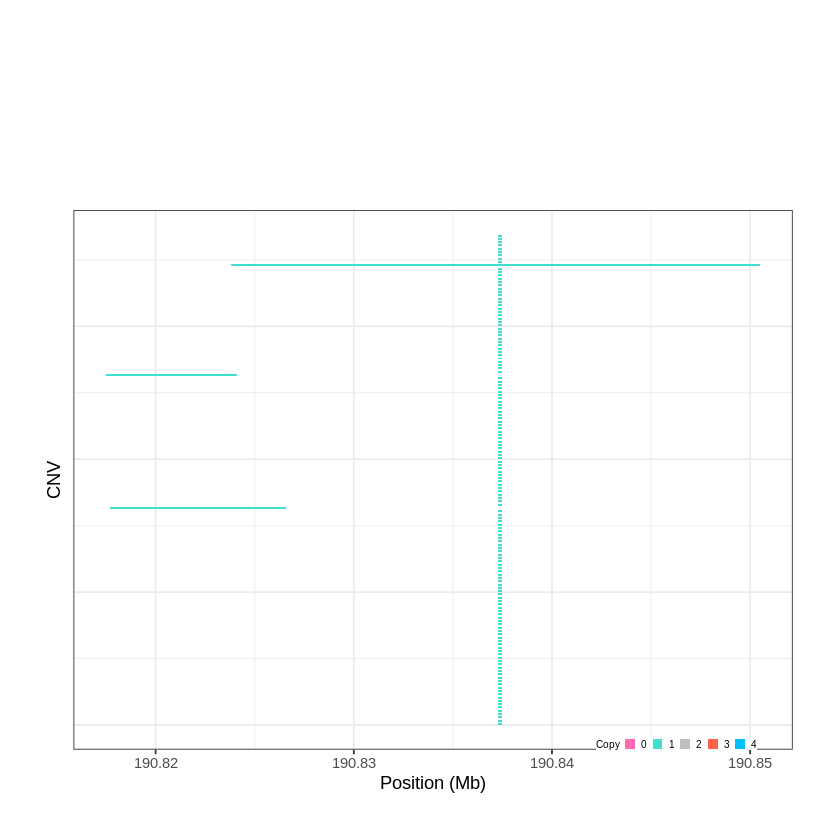

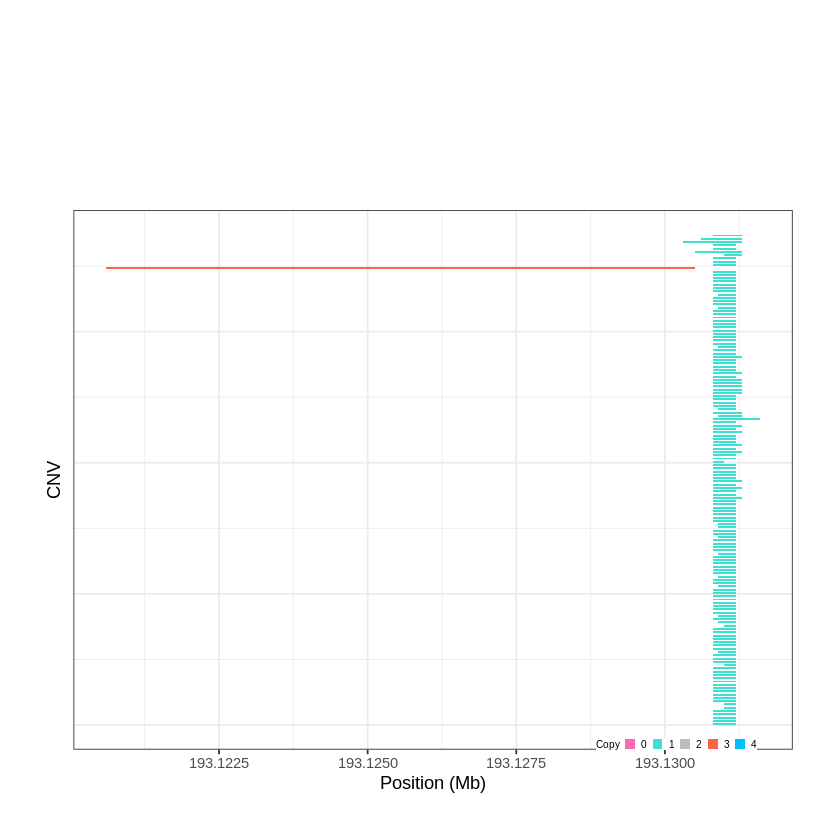

Task done, plot was stored in working directory.
[1] "Ploting CNVR 129..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 196.643201 - 196.9149 Mb with 244 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 130..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 198.753401 - 198.8018 Mb with 170 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


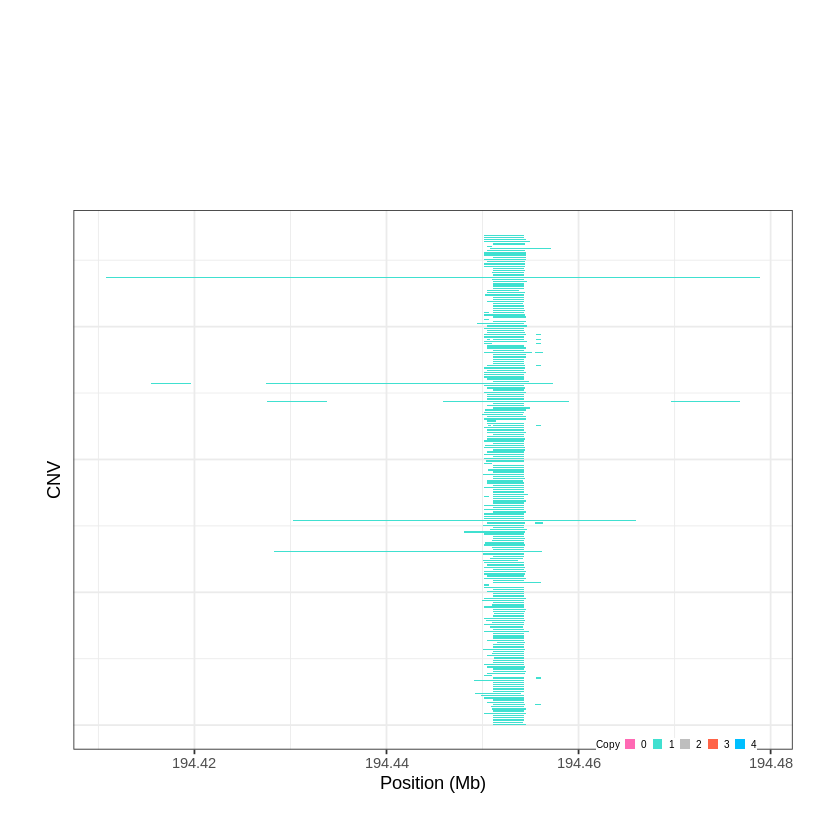

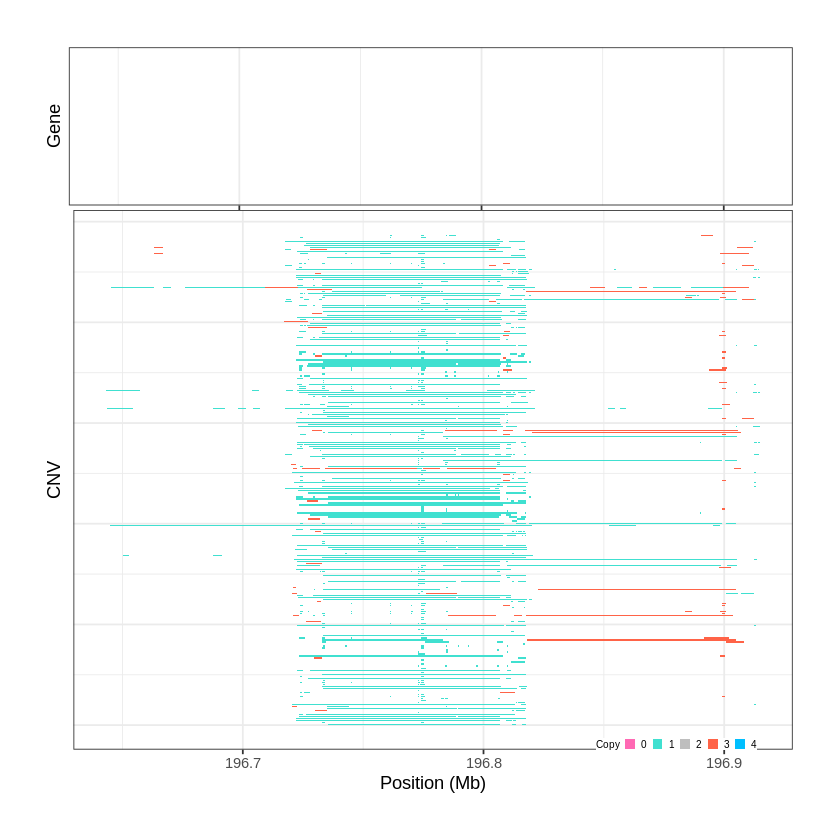

Task done, plot was stored in working directory.
[1] "Ploting CNVR 131..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 202.053501 - 202.3646 Mb with 154 Individual - "
Plotting gene...


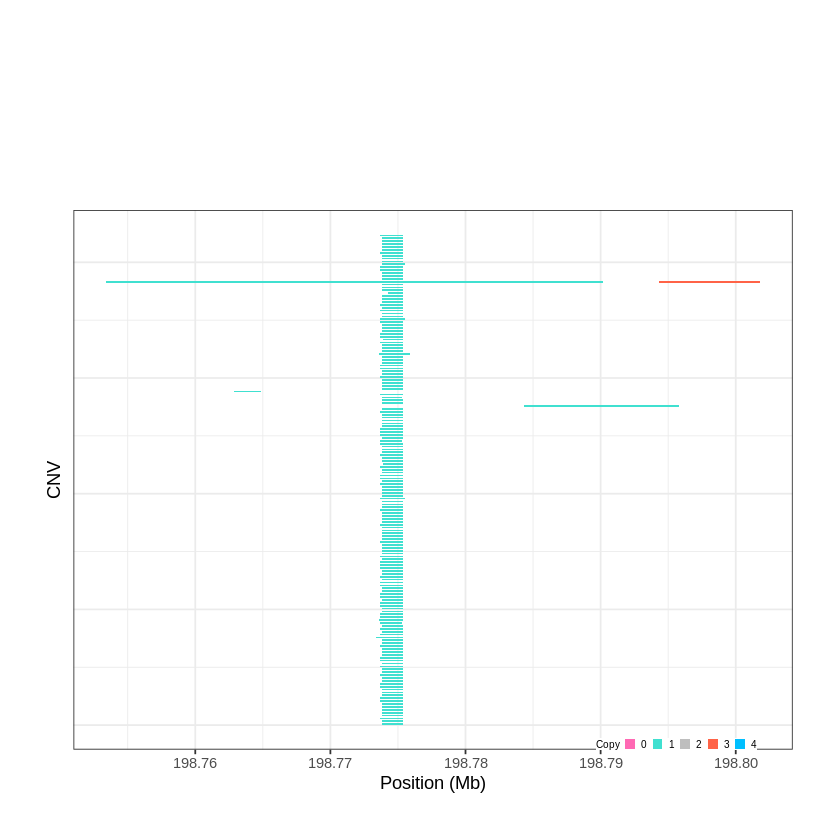

Task done, plot was stored in working directory.
[1] "Ploting CNVR 132..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 205.869801 - 206.17 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 133..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 206.273701 - 206.3015 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


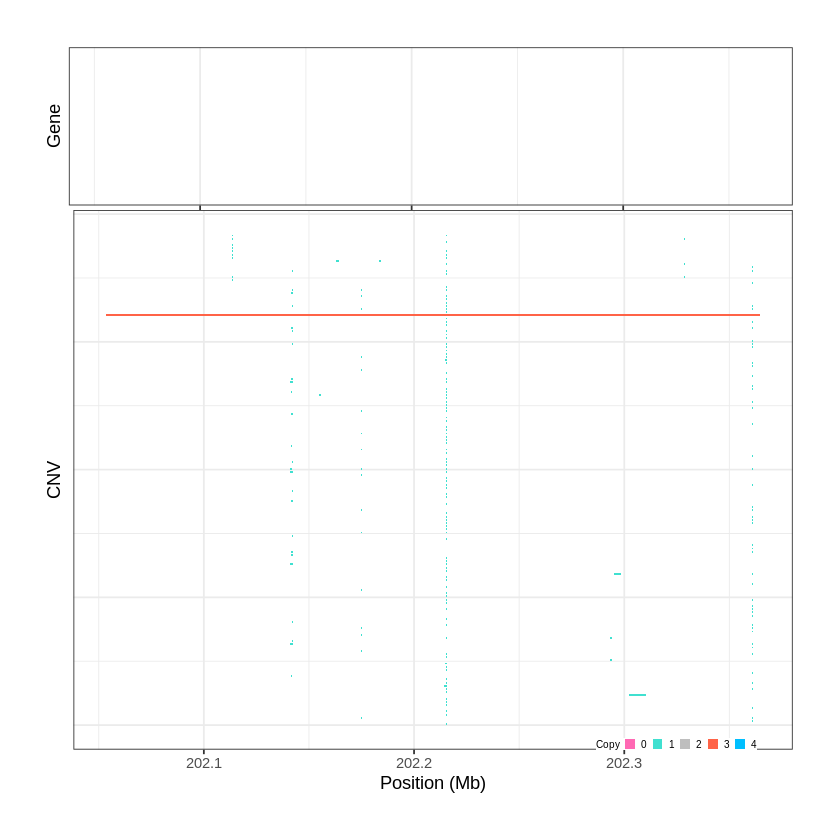

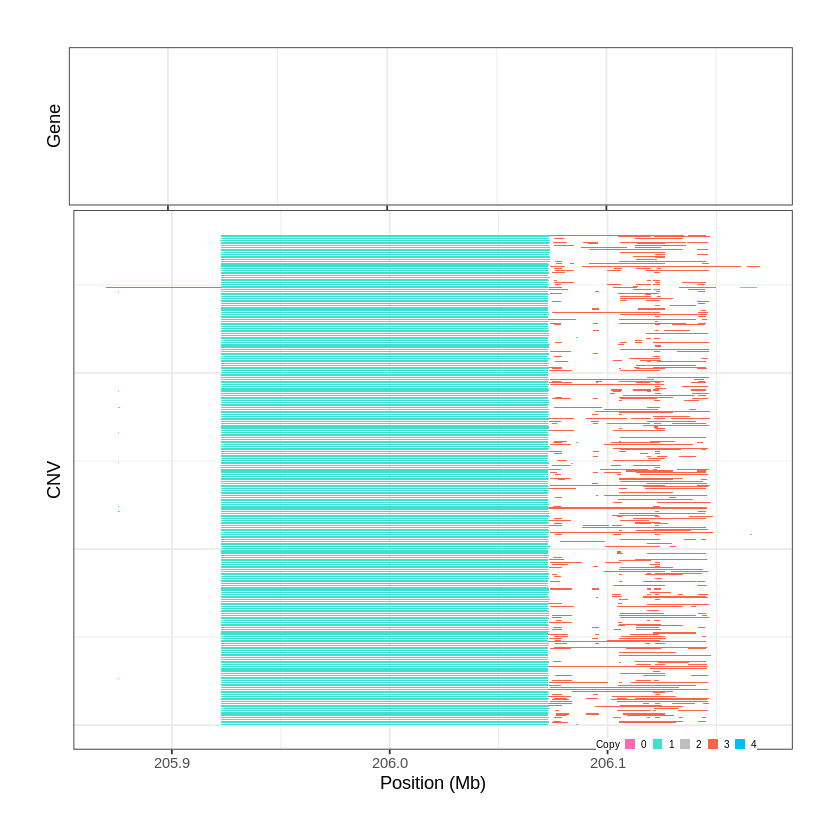

Task done, plot was stored in working directory.
[1] "Ploting CNVR 134..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 206.316201 - 206.5416 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 135..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 206.556001 - 206.5842 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


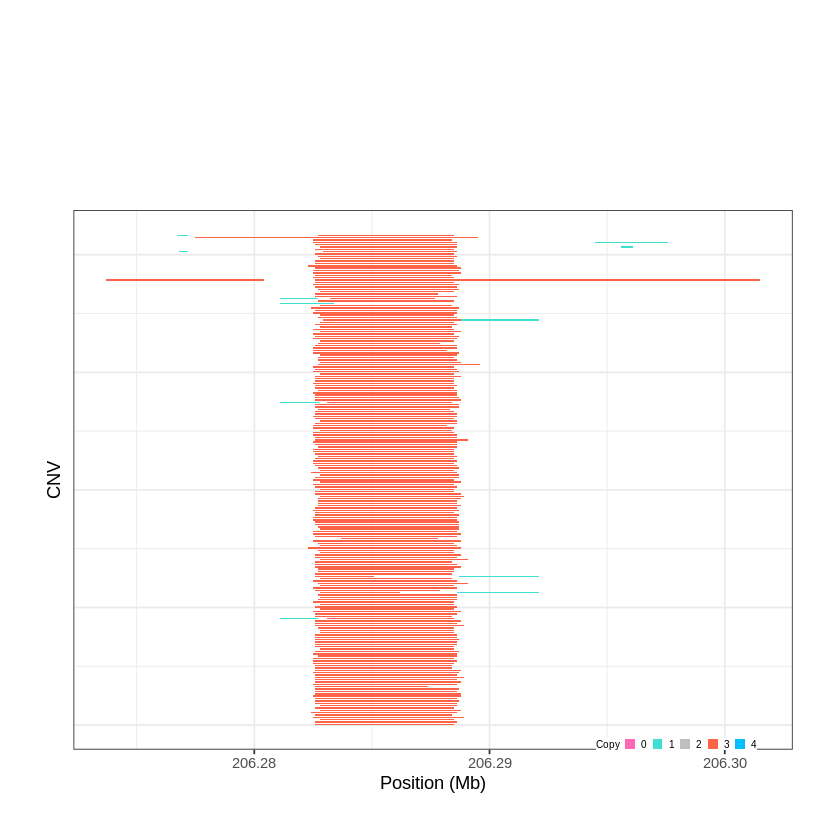

Task done, plot was stored in working directory.
[1] "Ploting CNVR 136..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 207.285101 - 207.3023 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


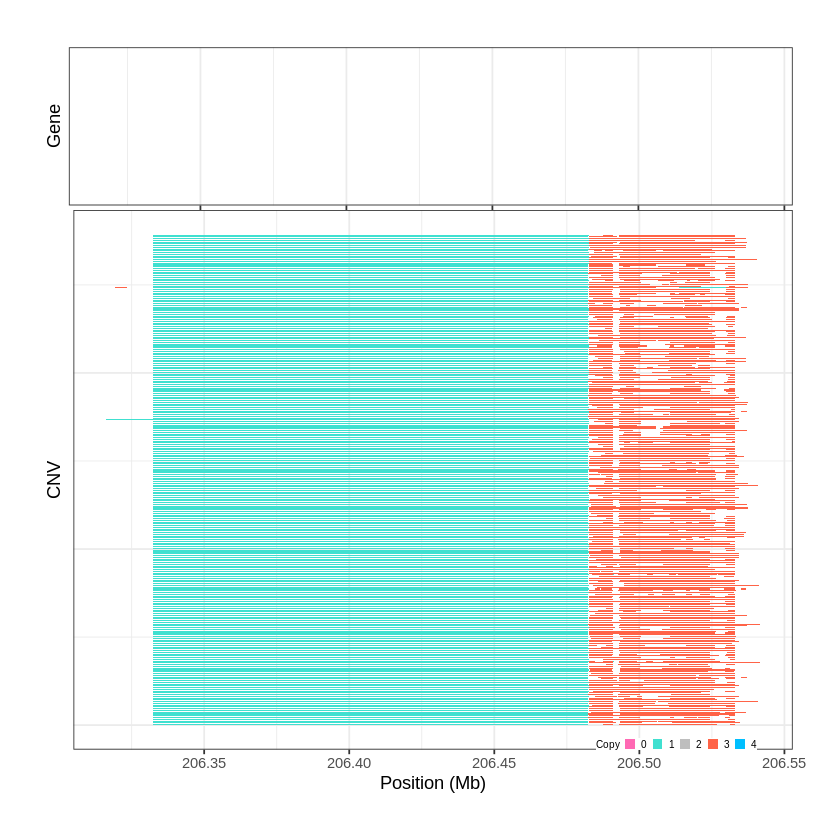

Task done, plot was stored in working directory.
[1] "Ploting CNVR 137..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 207.514401 - 207.5476 Mb with 182 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


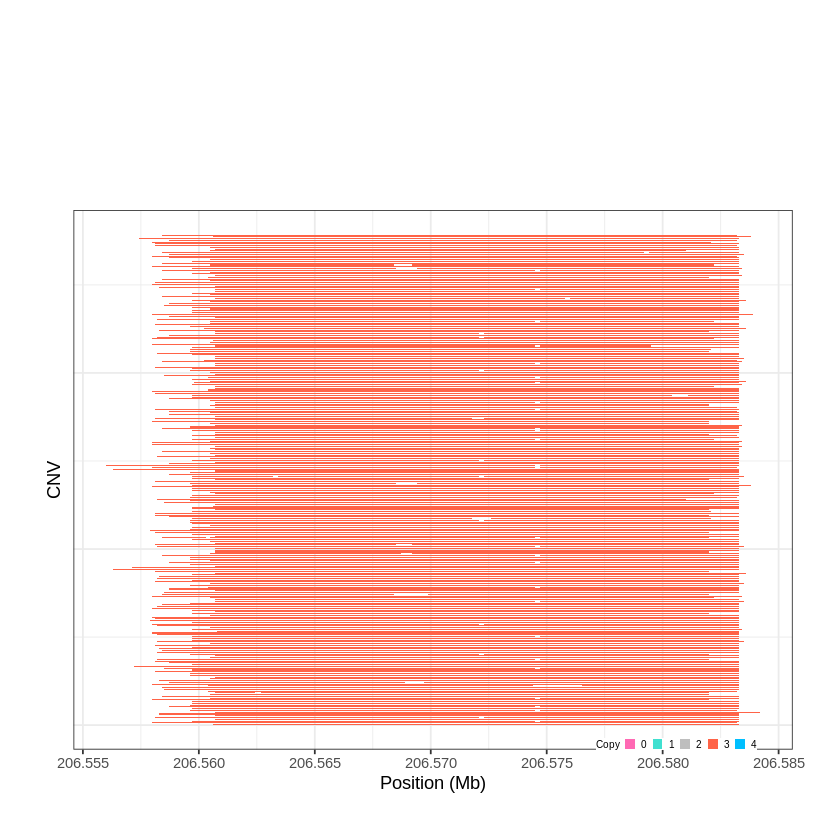

Task done, plot was stored in working directory.
[1] "Ploting CNVR 138..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 207.699201 - 207.7476 Mb with 252 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


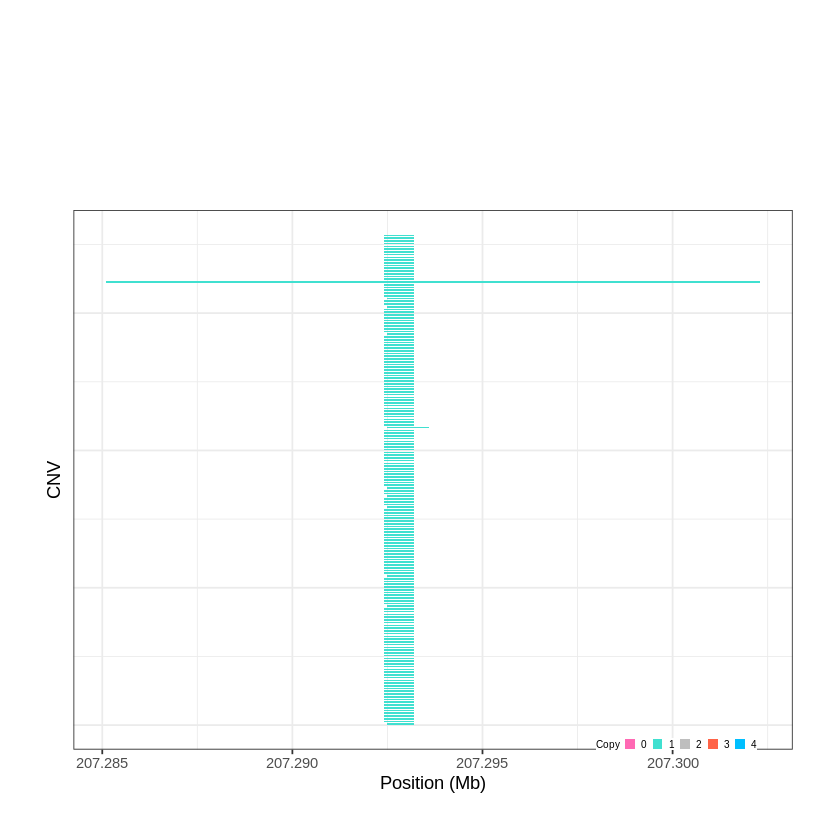

Task done, plot was stored in working directory.
[1] "Ploting CNVR 139..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 210.050601 - 210.114 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


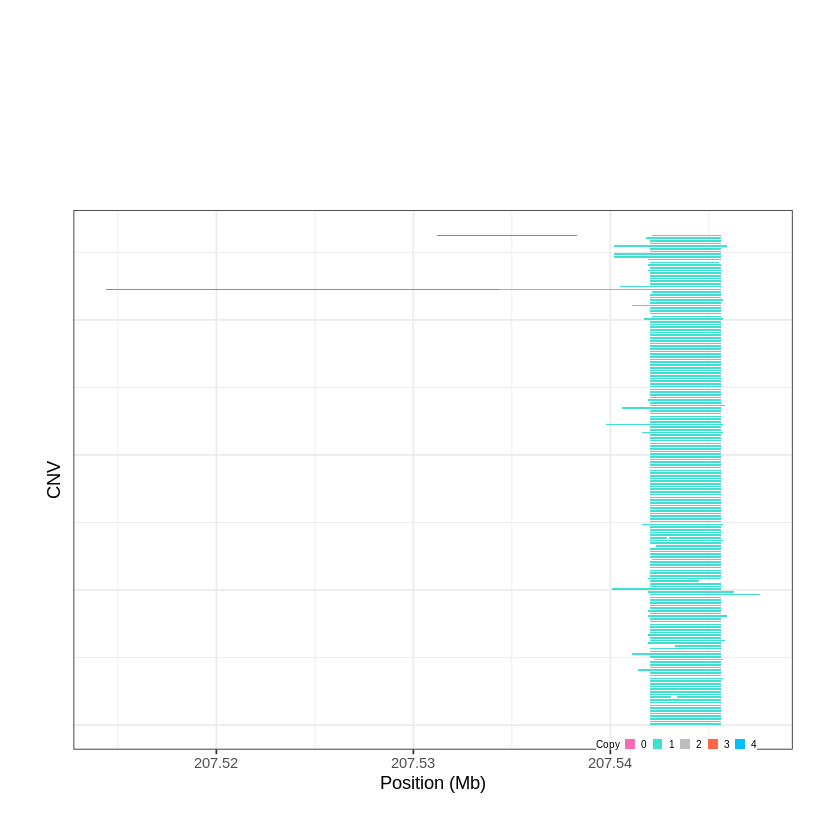

Task done, plot was stored in working directory.
[1] "Ploting CNVR 140..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 213.081101 - 213.1056 Mb with 234 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


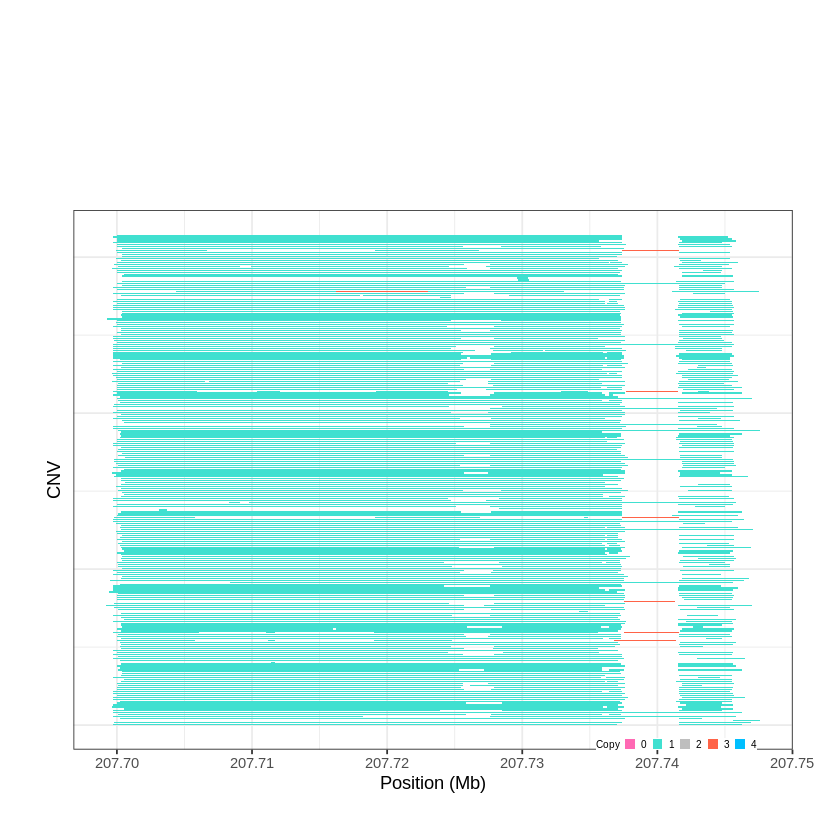

Task done, plot was stored in working directory.
[1] "Ploting CNVR 141..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 217.821401 - 217.8797 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


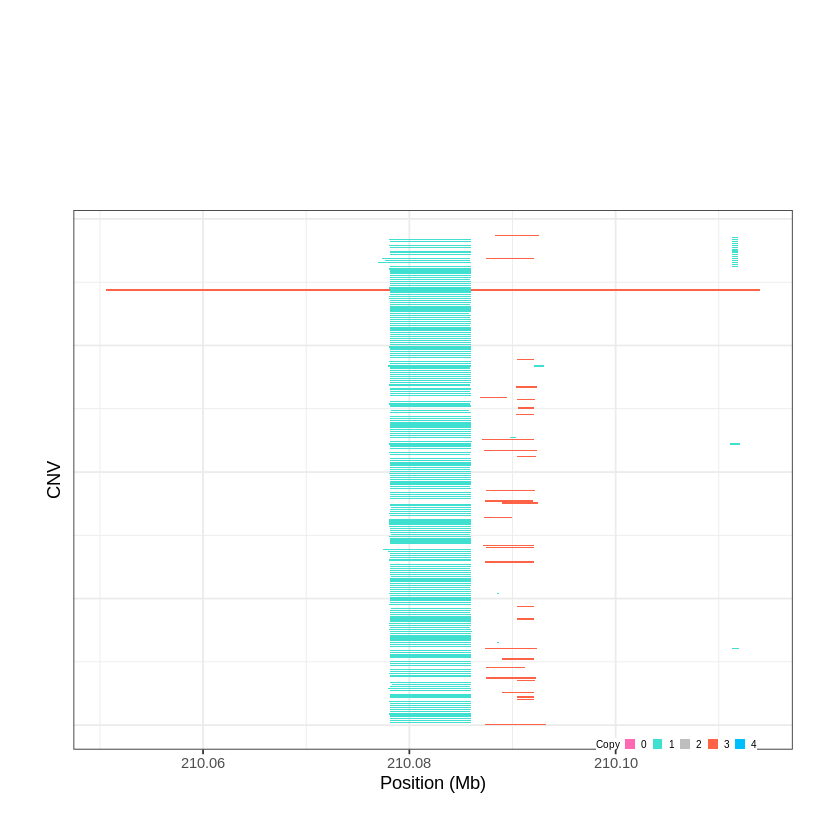

Task done, plot was stored in working directory.
[1] "Ploting CNVR 142..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 218.771601 - 218.7902 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


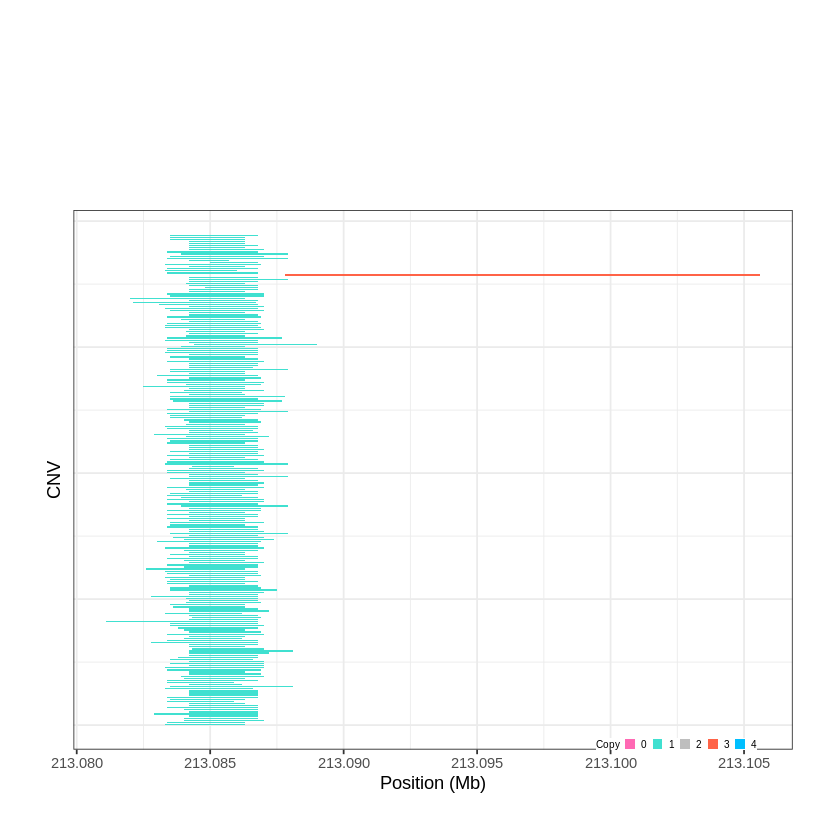

Task done, plot was stored in working directory.
[1] "Ploting CNVR 143..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 223.725201 - 223.7981 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


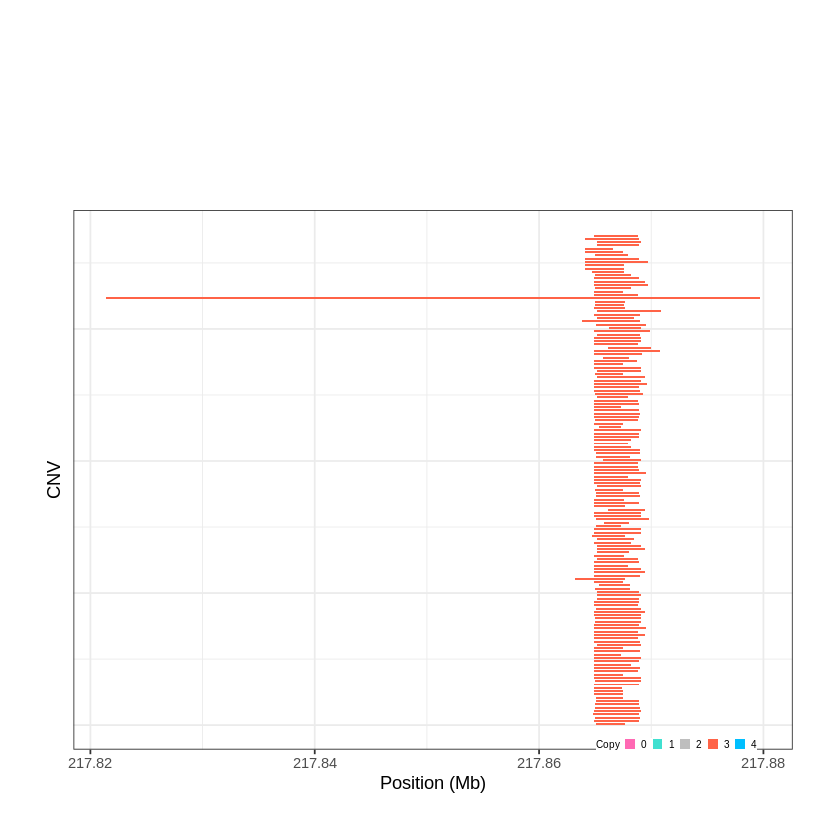

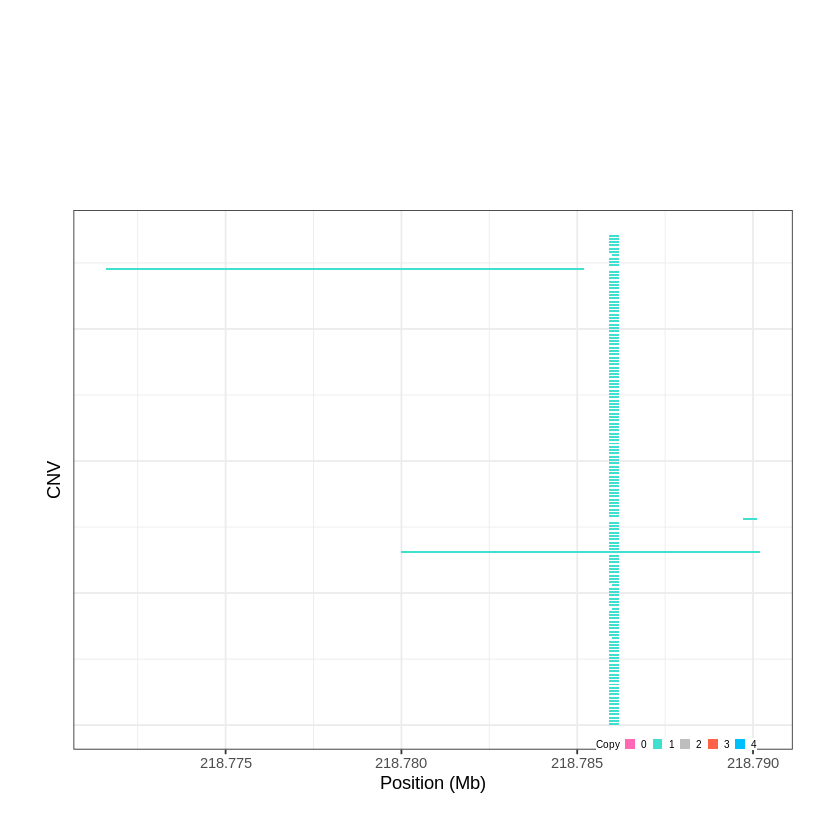

Task done, plot was stored in working directory.
[1] "Ploting CNVR 144..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 224.172101 - 224.205 Mb with 273 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 145..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 224.224601 - 224.2425 Mb with 258 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


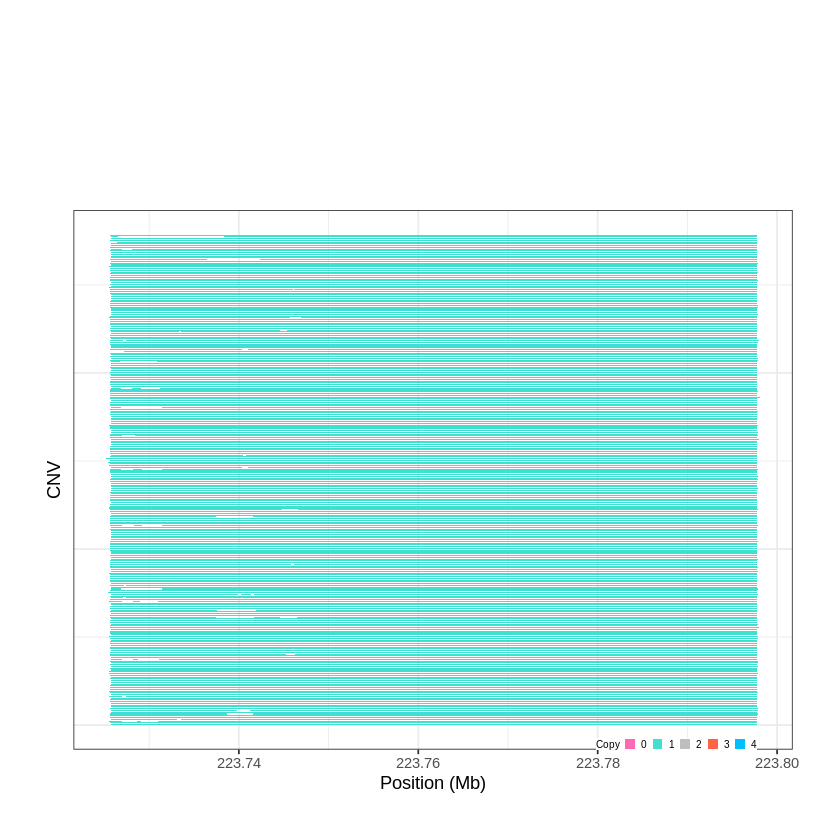

Task done, plot was stored in working directory.
[1] "Ploting CNVR 146..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 224.392801 - 224.3935 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


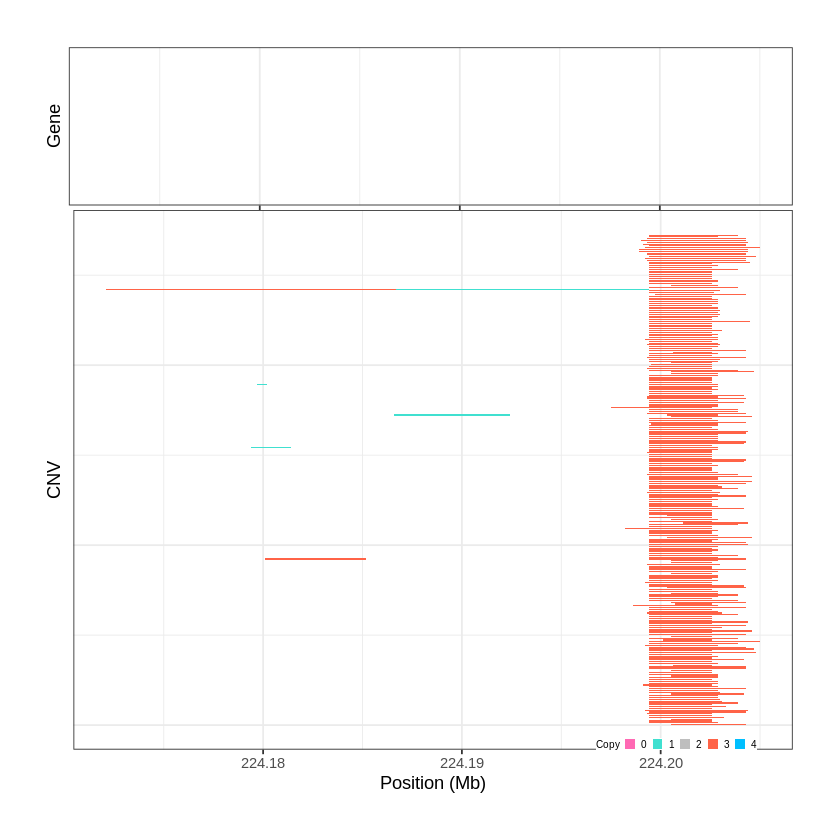

Task done, plot was stored in working directory.
[1] "Ploting CNVR 147..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 225.243501 - 225.275 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


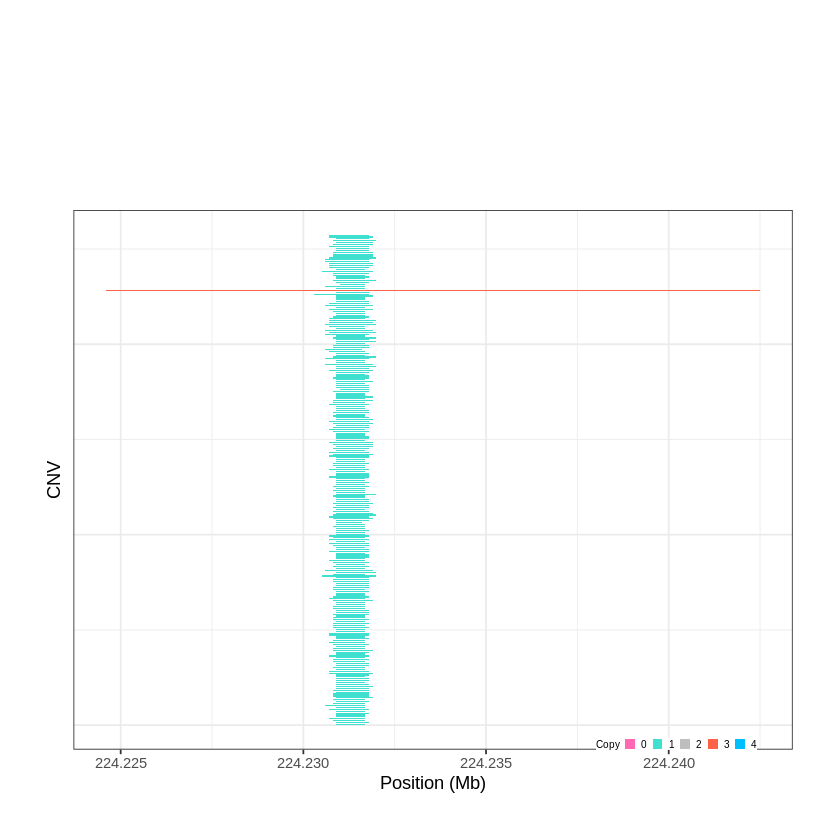

Task done, plot was stored in working directory.
[1] "Ploting CNVR 148..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 225.762301 - 225.7626 Mb with 171 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


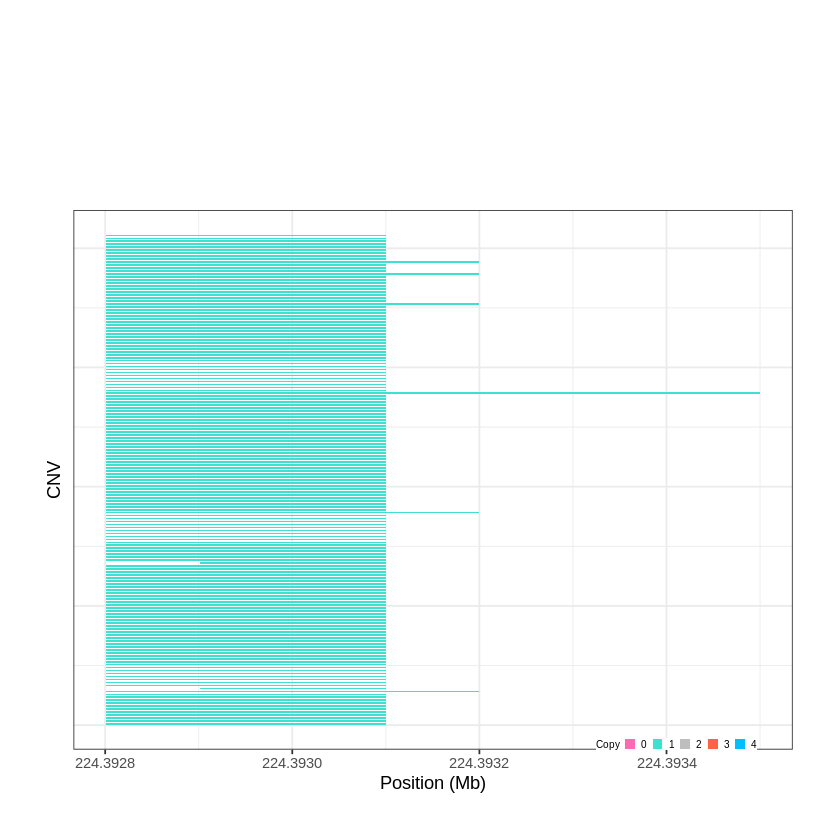

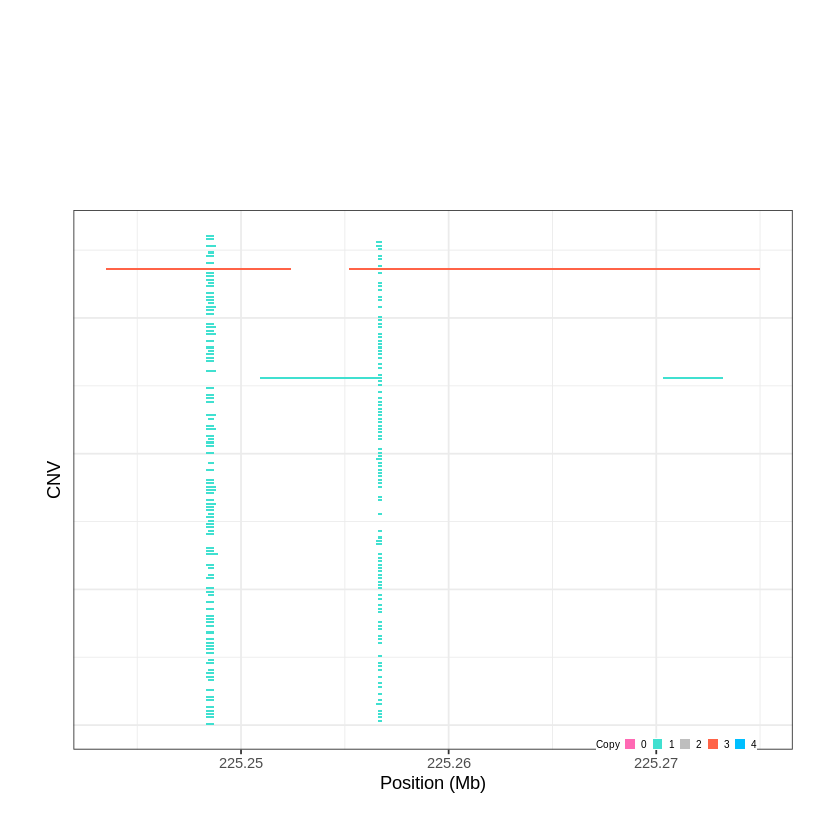

Task done, plot was stored in working directory.
[1] "Ploting CNVR 149..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 227.915701 - 228.0068 Mb with 166 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 150..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 228.017101 - 228.0707 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


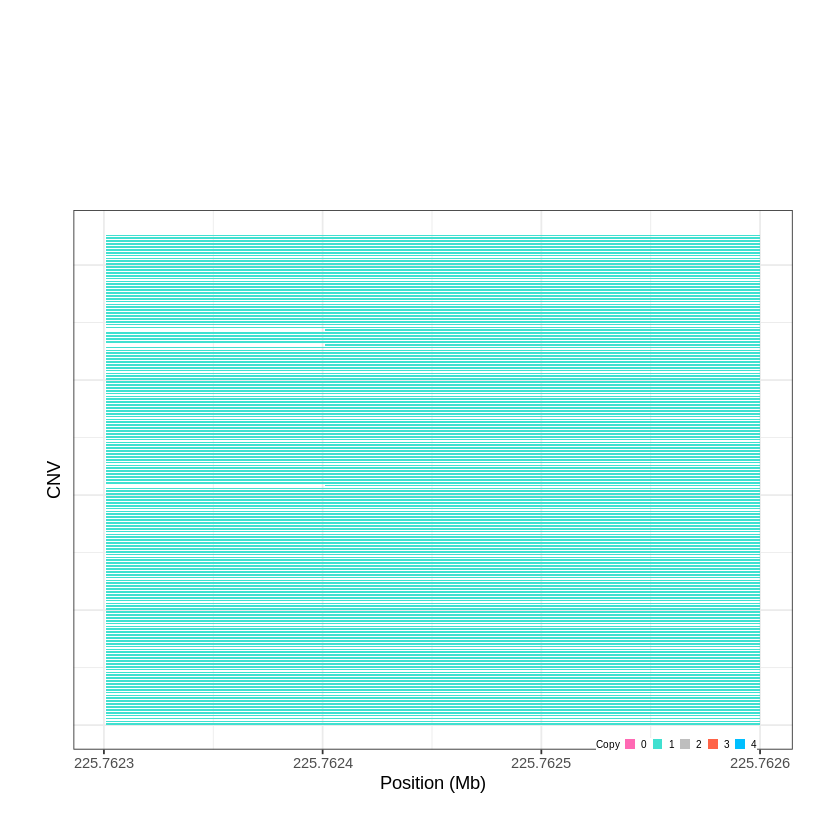

Task done, plot was stored in working directory.
[1] "Ploting CNVR 151..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 228.253501 - 228.3069 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


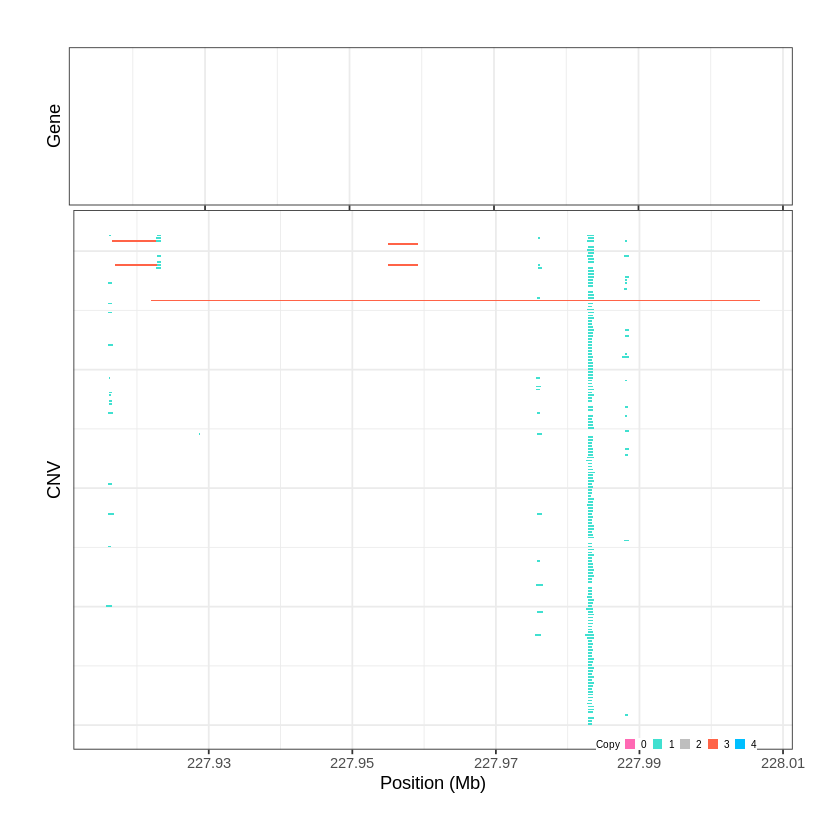

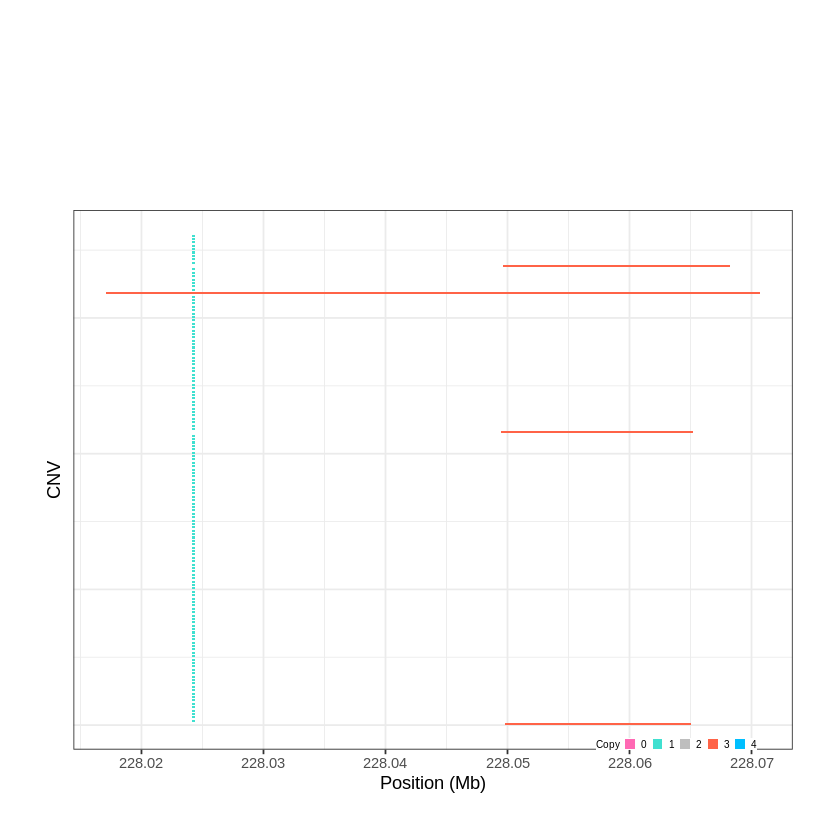

Task done, plot was stored in working directory.
[1] "Ploting CNVR 152..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 228.314401 - 228.7042 Mb with 211 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 153..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 228.743401 - 228.7889 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


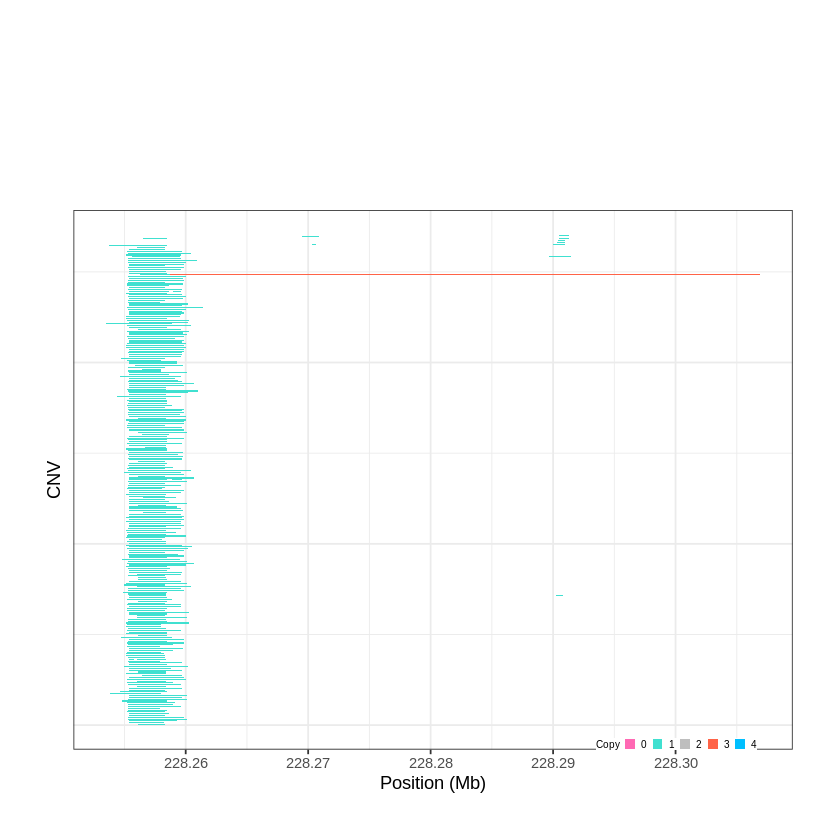

Task done, plot was stored in working directory.
[1] "Ploting CNVR 154..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 229.807301 - 229.8315 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


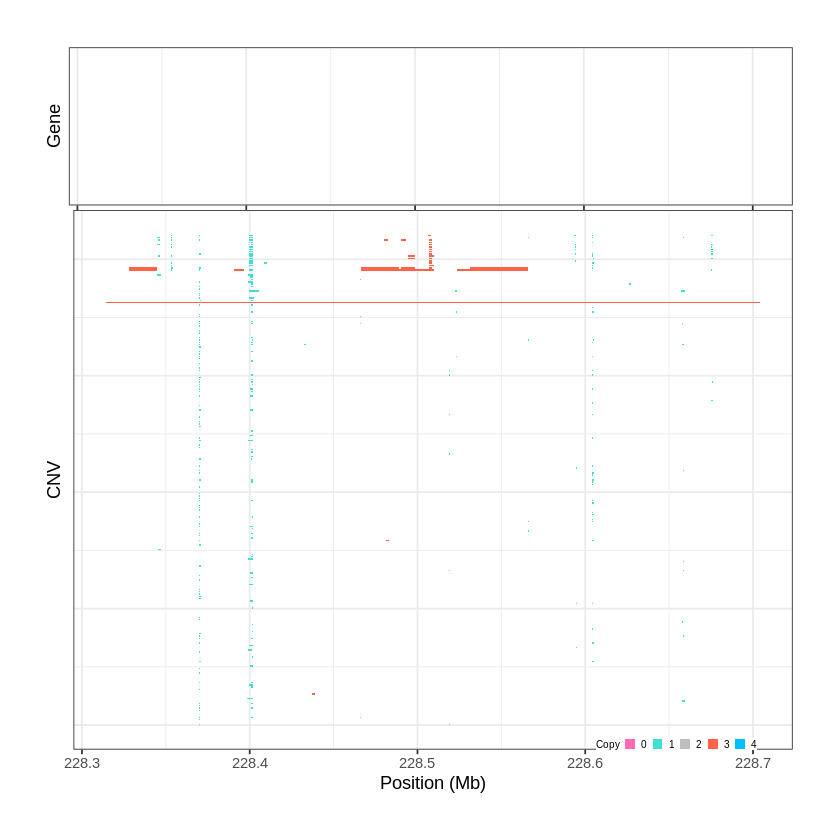

Task done, plot was stored in working directory.
[1] "Ploting CNVR 155..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 230.370601 - 230.549 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


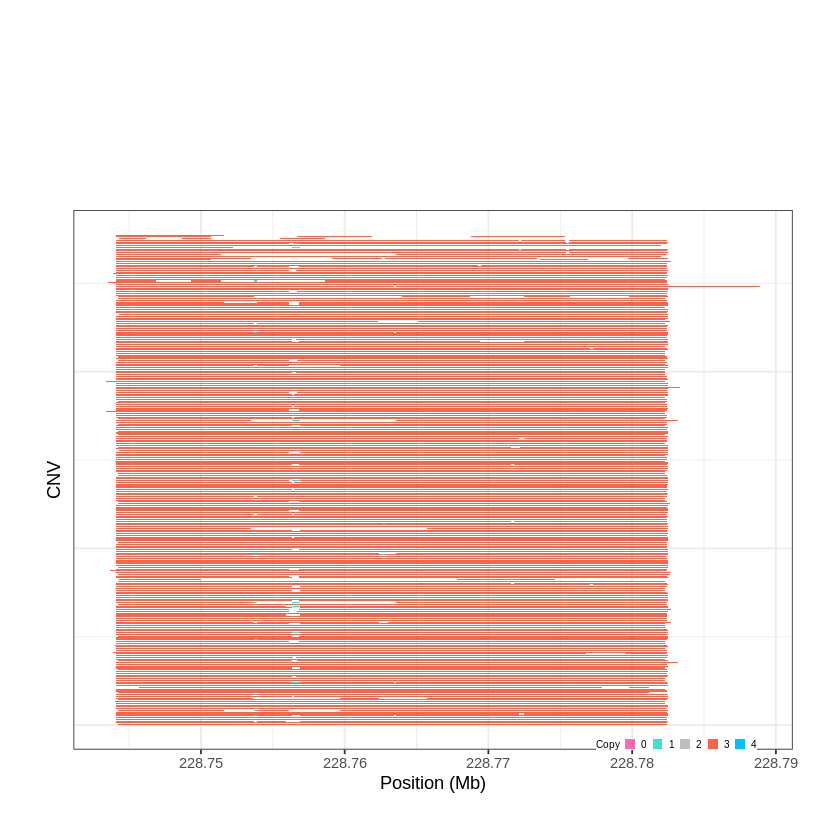

Task done, plot was stored in working directory.
[1] "Ploting CNVR 156..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 233.905301 - 233.9846 Mb with 252 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


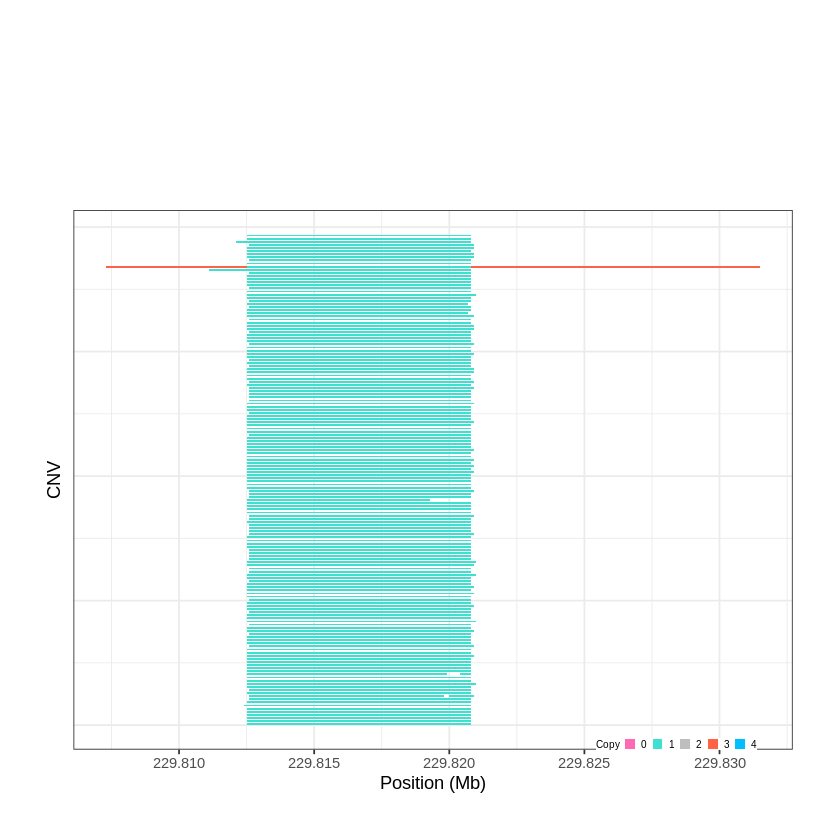

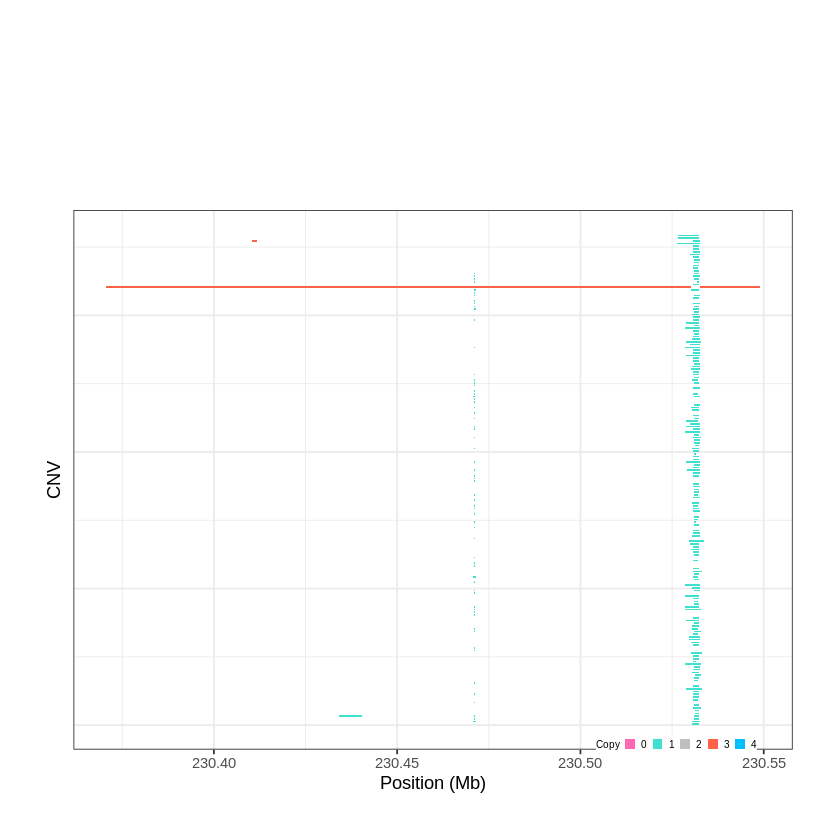

Task done, plot was stored in working directory.
[1] "Ploting CNVR 157..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 234.475801 - 234.5731 Mb with 237 Individual - "
Plotting gene...


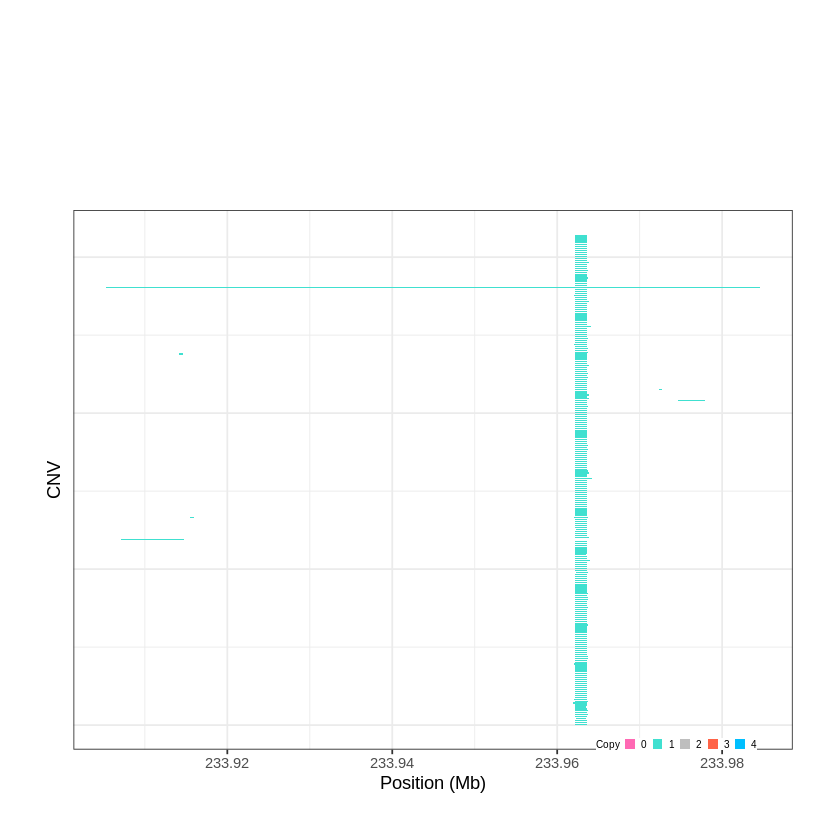

Task done, plot was stored in working directory.
[1] "Ploting CNVR 158..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 234.904901 - 234.9663 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 159..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 235.192201 - 235.2422 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


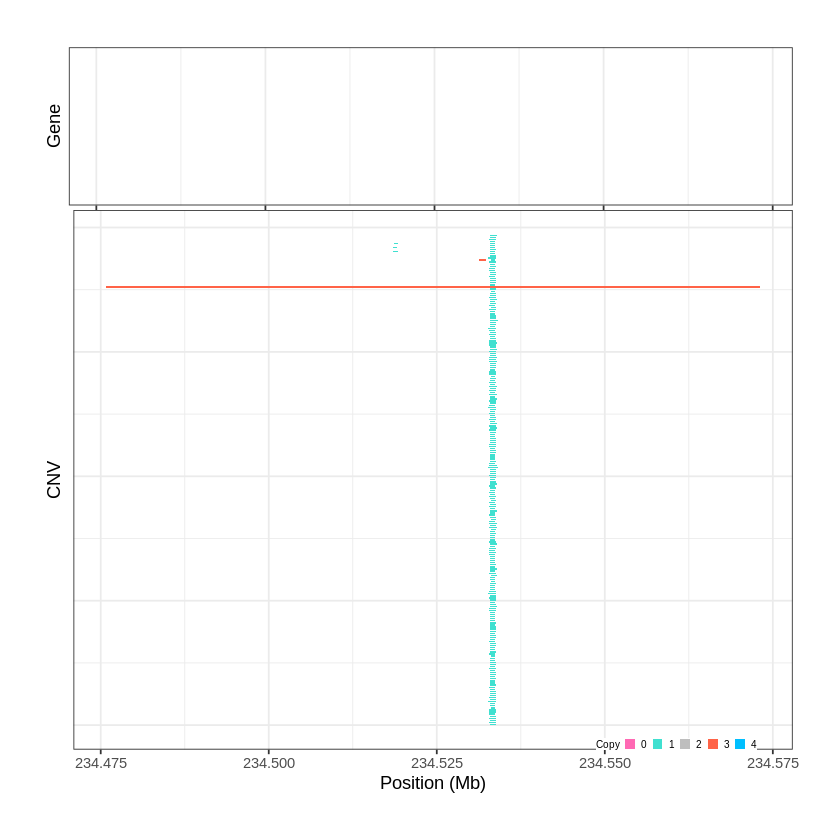

Task done, plot was stored in working directory.
[1] "Ploting CNVR 160..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 236.528701 - 236.5959 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


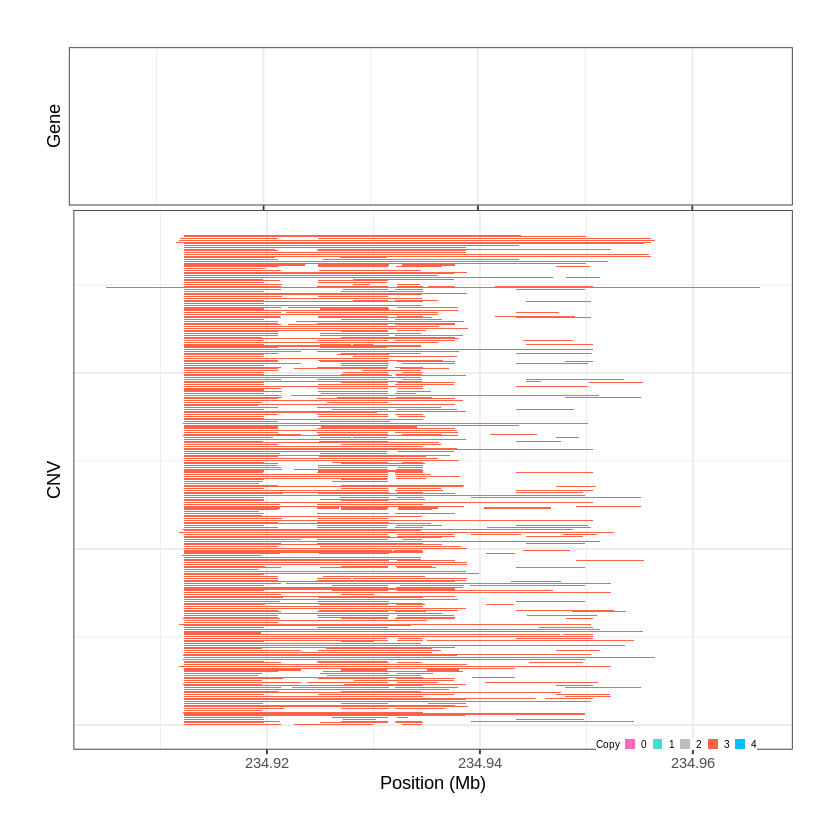

Task done, plot was stored in working directory.
[1] "Ploting CNVR 161..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 236.876801 - 236.8784 Mb with 266 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


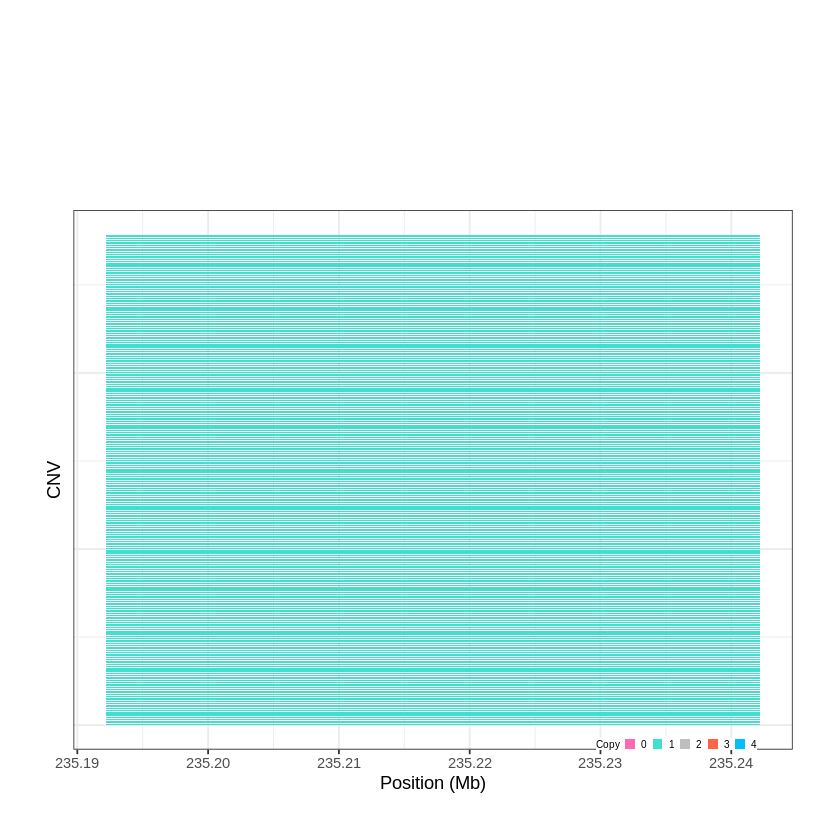

Task done, plot was stored in working directory.
[1] "Ploting CNVR 162..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 237.181201 - 237.1905 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


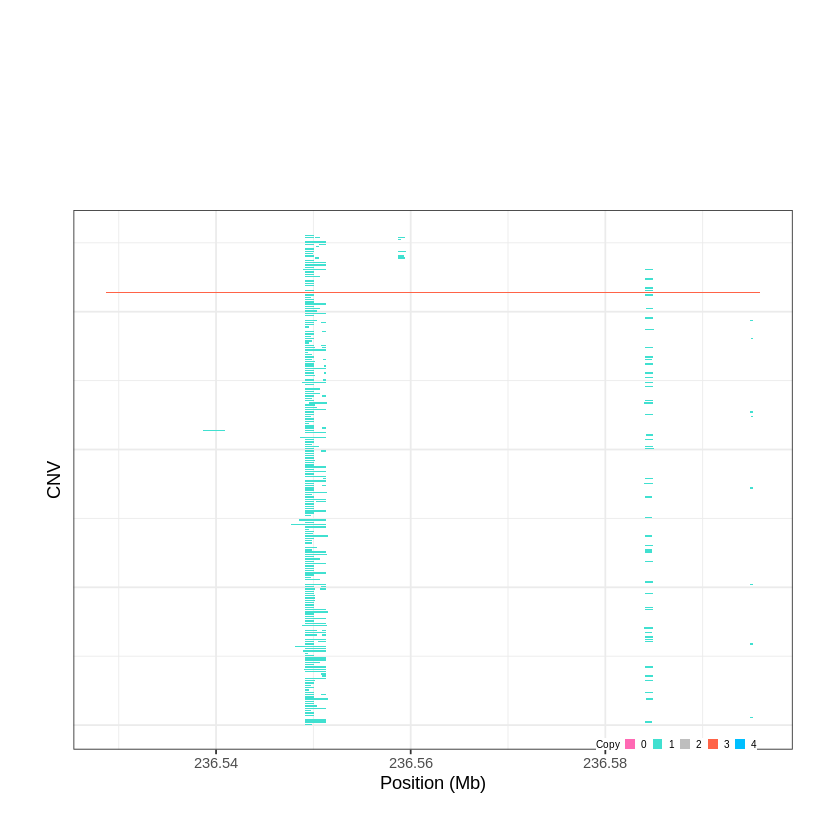

Task done, plot was stored in working directory.
[1] "Ploting CNVR 163..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 240.391301 - 240.3958 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


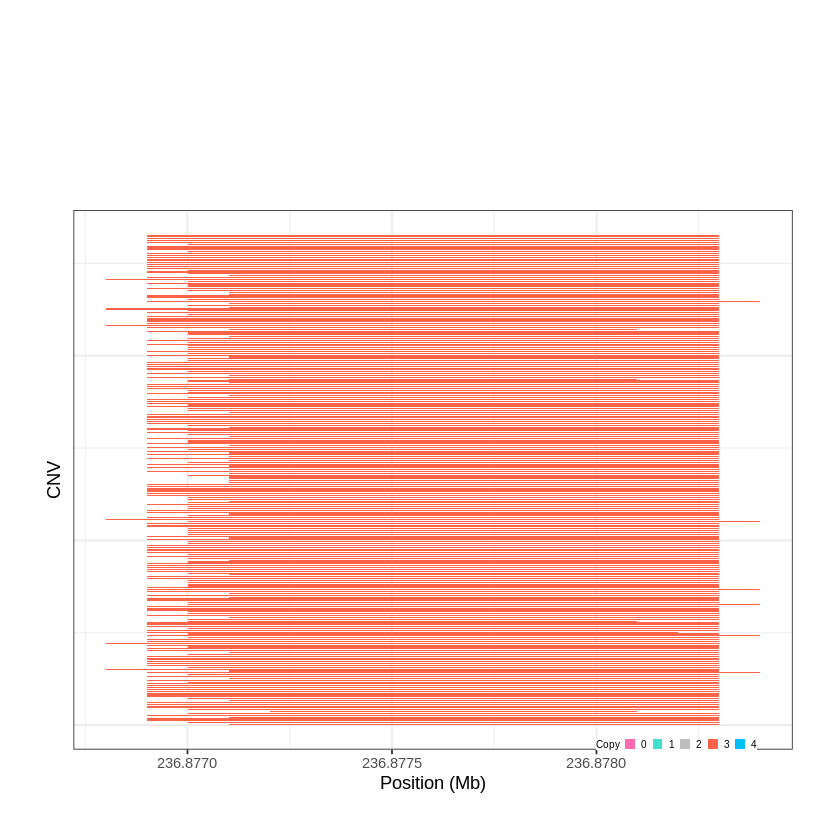

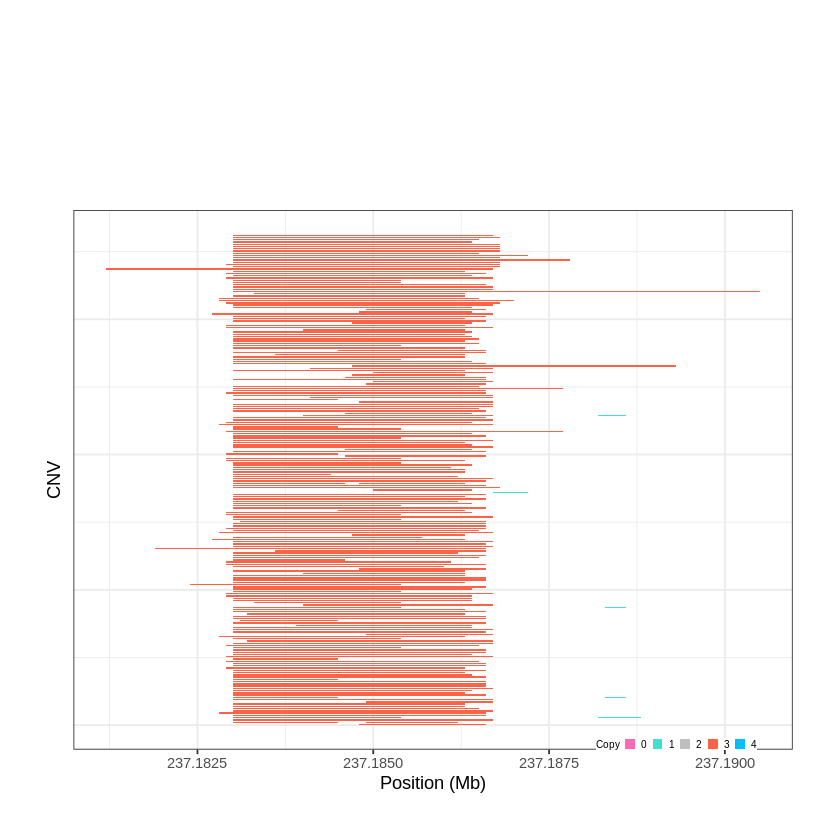

Task done, plot was stored in working directory.
[1] "Ploting CNVR 164..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 242.733701 - 243.3181 Mb with 205 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 165..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 243.777901 - 243.7898 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


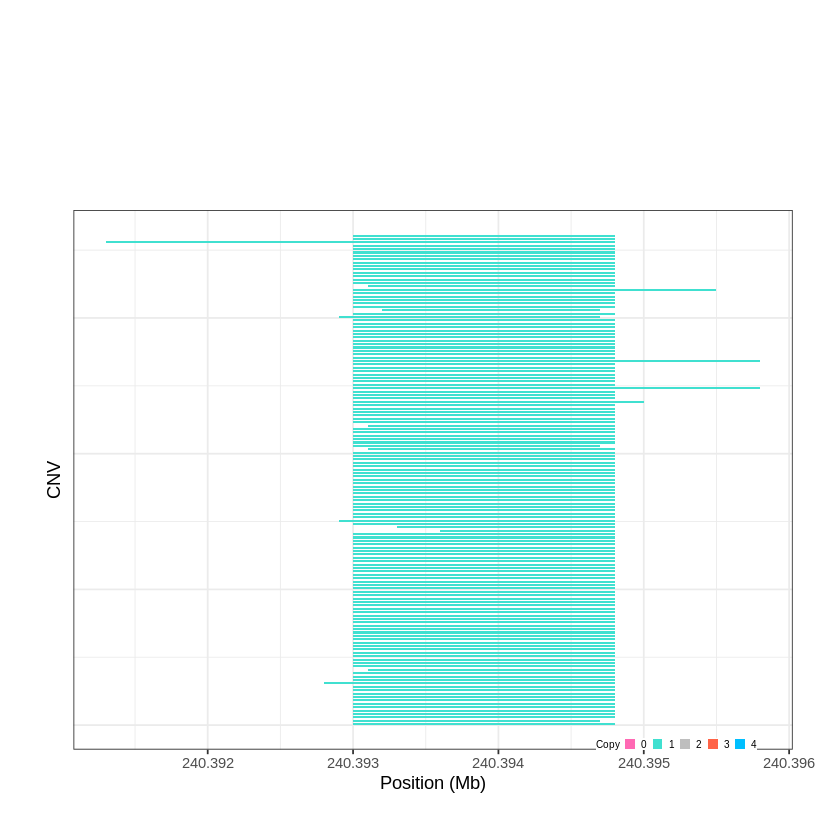

Task done, plot was stored in working directory.
[1] "Ploting CNVR 166..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 244.066701 - 244.0978 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


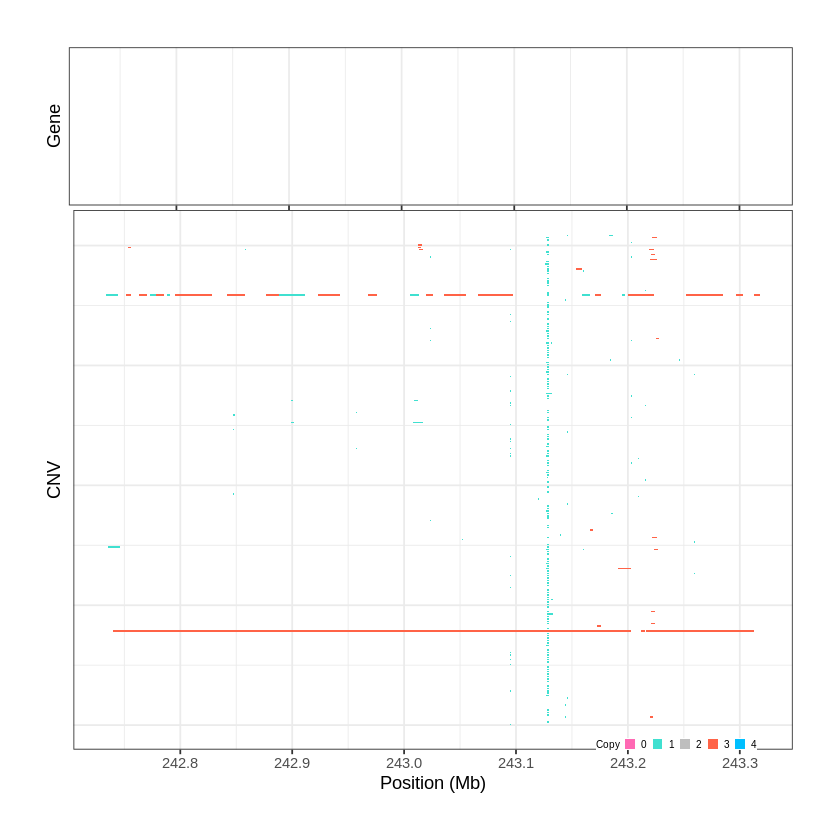

Task done, plot was stored in working directory.
[1] "Ploting CNVR 167..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 244.208401 - 244.2205 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


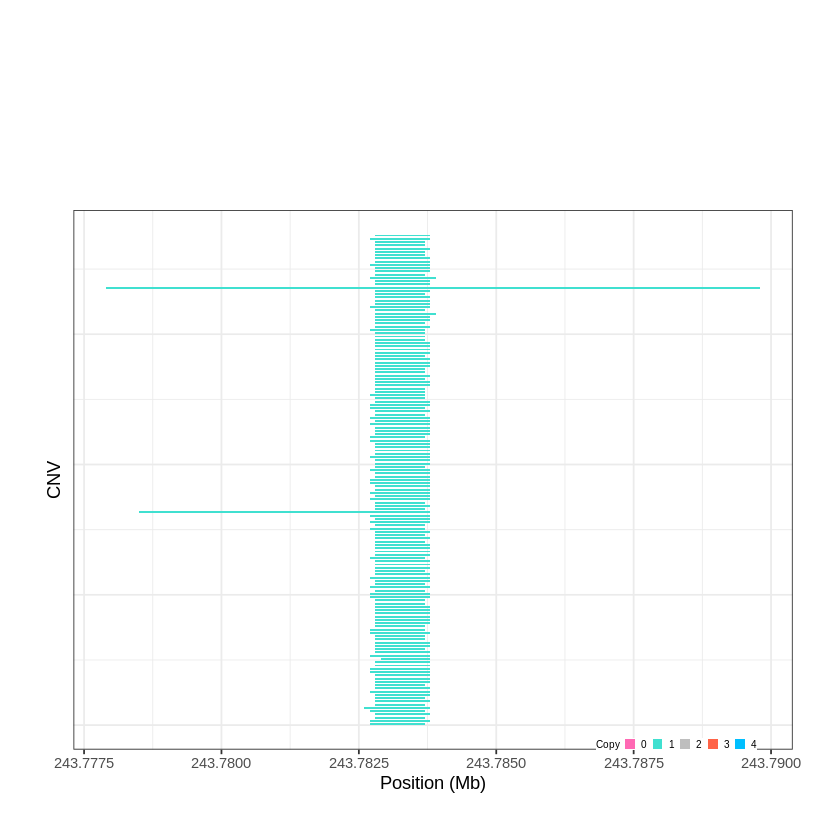

Task done, plot was stored in working directory.
[1] "Ploting CNVR 168..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 245.241301 - 245.7872 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


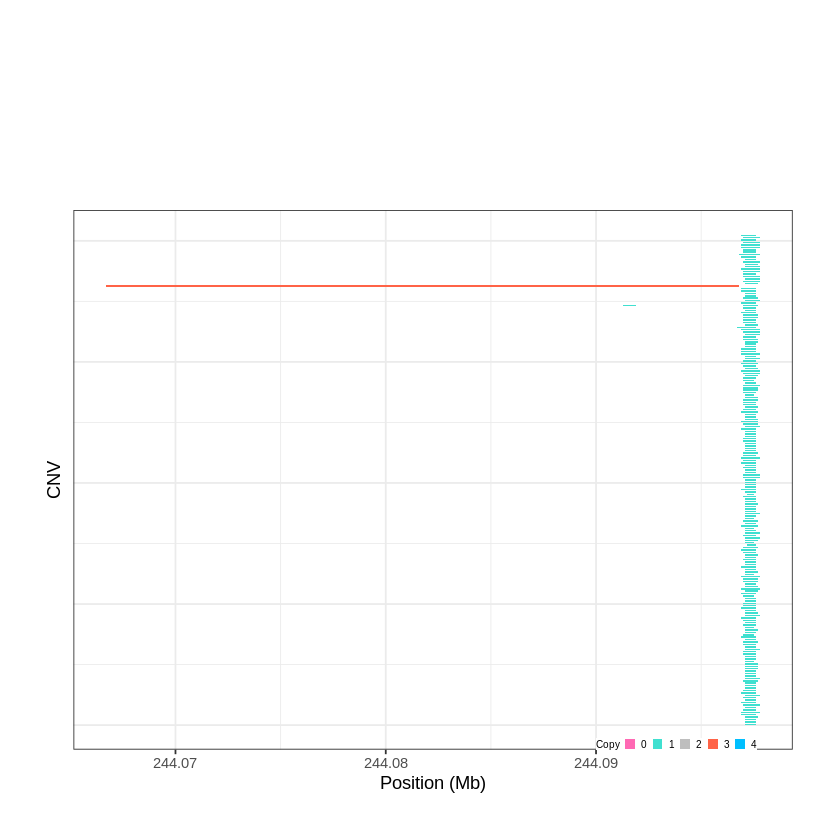

Task done, plot was stored in working directory.
[1] "Ploting CNVR 169..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 246.133401 - 246.1792 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


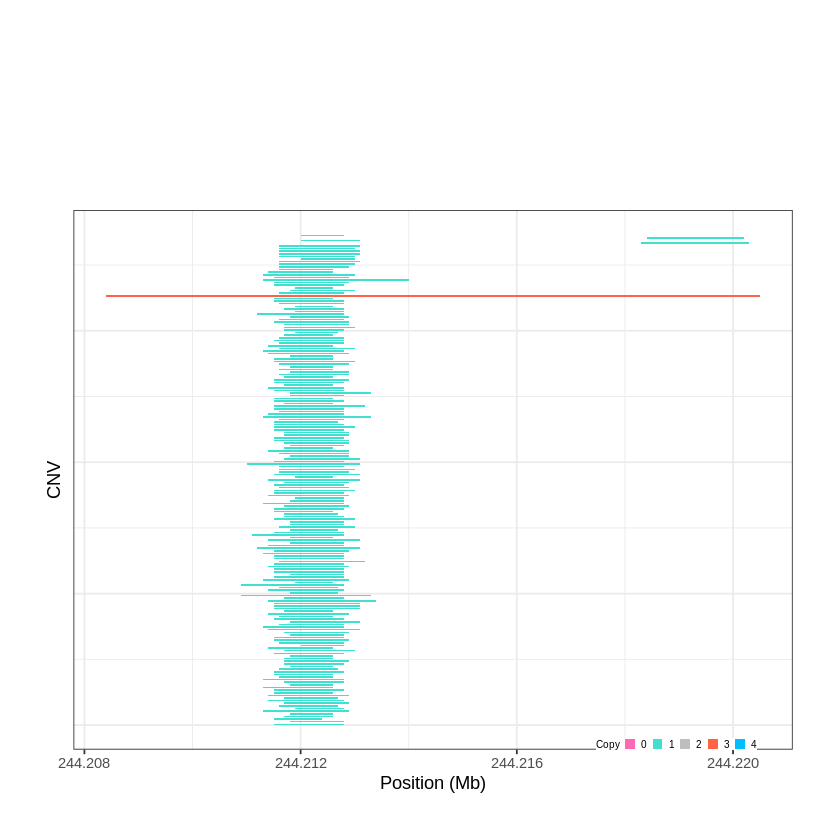

Task done, plot was stored in working directory.
[1] "Ploting CNVR 170..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 246.898901 - 246.9834 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


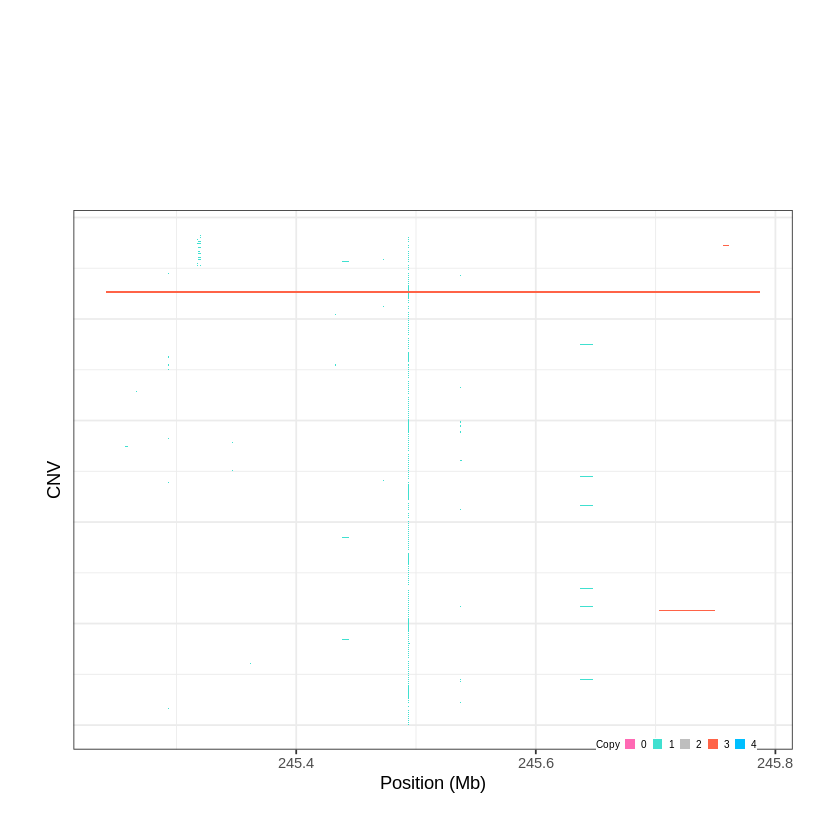

Task done, plot was stored in working directory.
[1] "Ploting CNVR 171..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 247.277801 - 247.2832 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


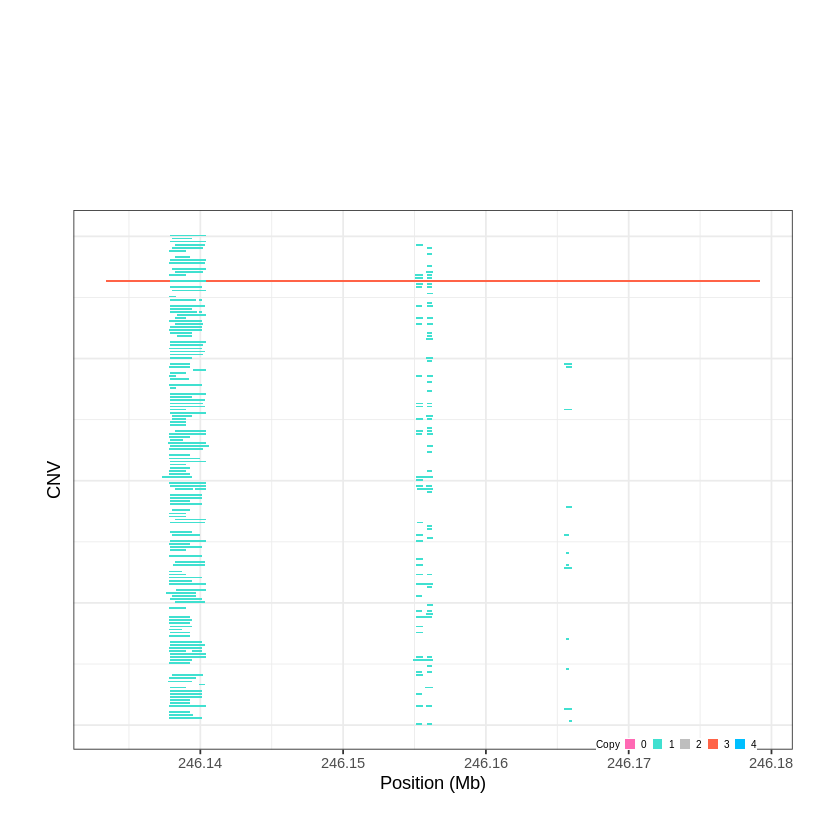

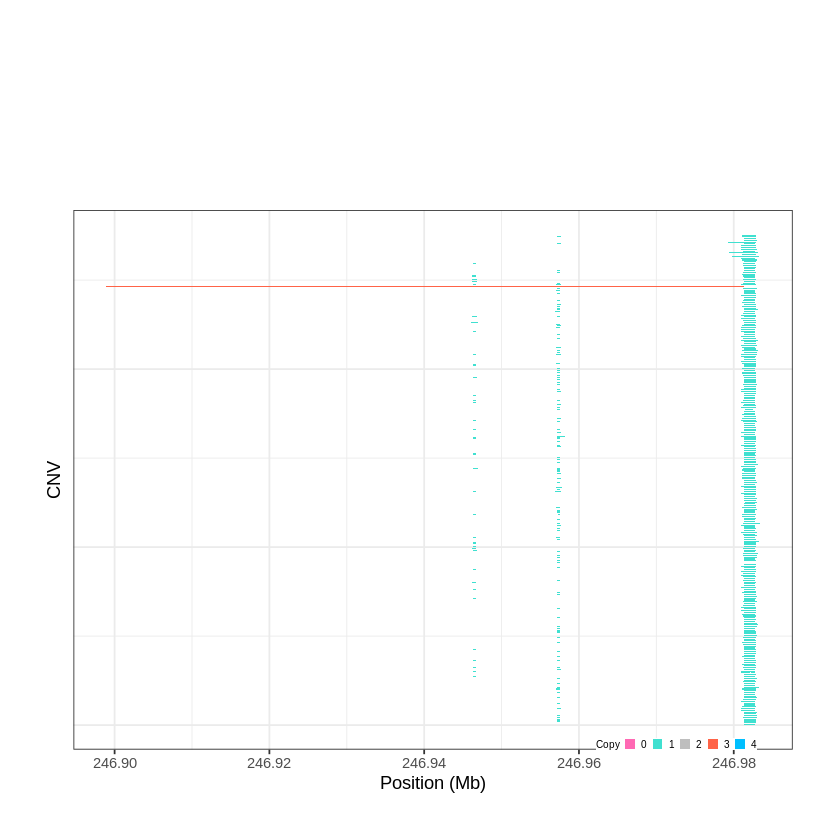

Task done, plot was stored in working directory.
[1] "Ploting CNVR 172..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 247.837601 - 247.8682 Mb with 160 Individual - "
Plotting gene...


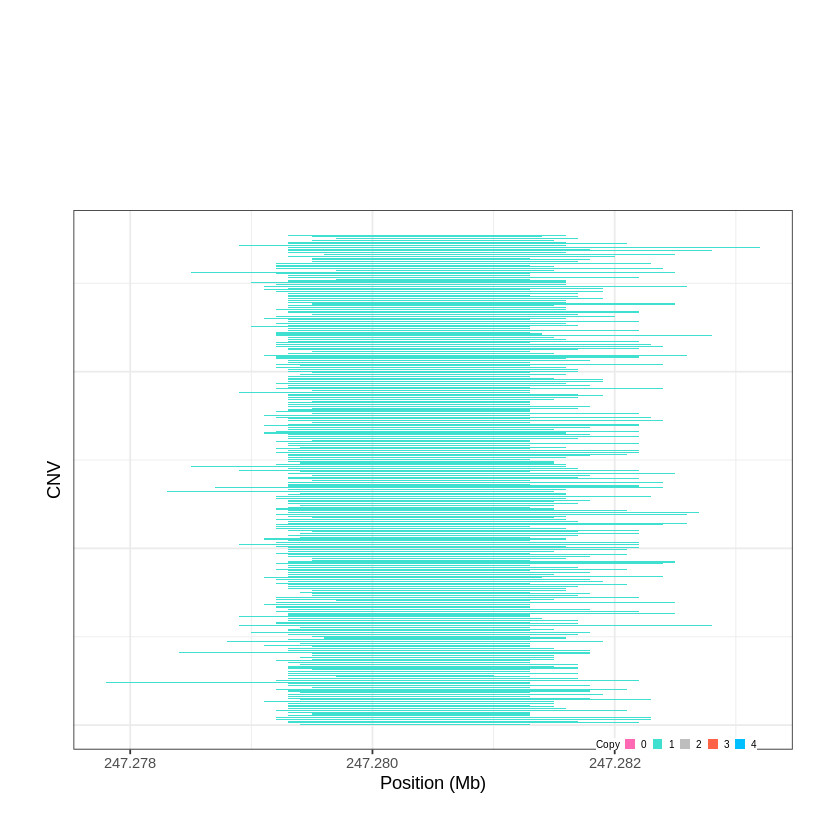

Task done, plot was stored in working directory.
[1] "Ploting CNVR 173..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 247.978901 - 248.0569 Mb with 275 Individual - "
Plotting gene...


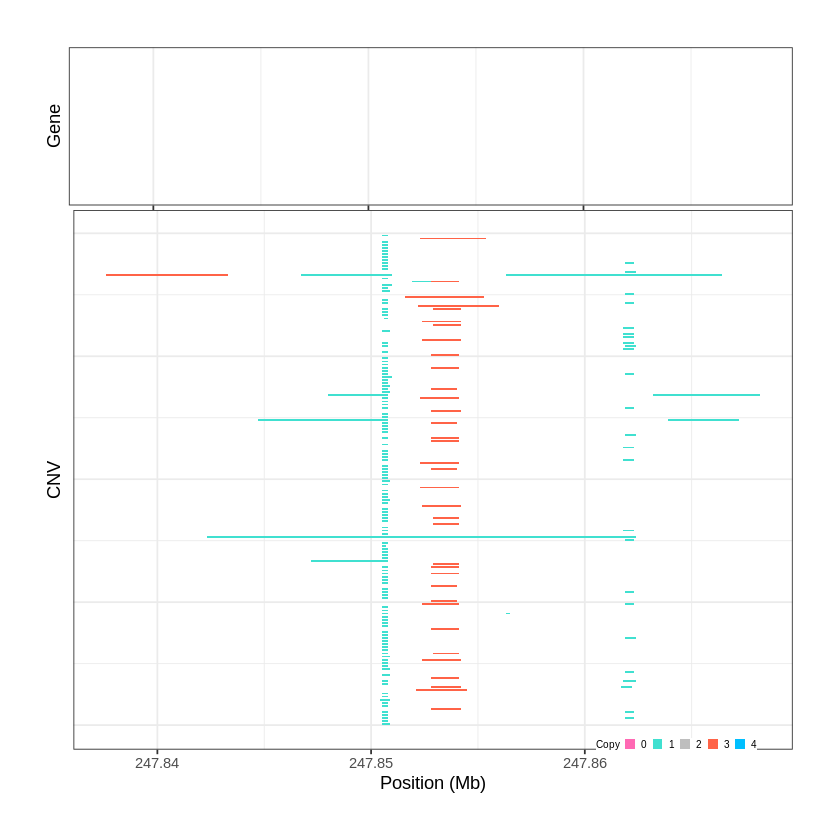

Task done, plot was stored in working directory.
[1] "Ploting CNVR 174..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 248.560801 - 248.6527 Mb with 274 Individual - "
Plotting gene...


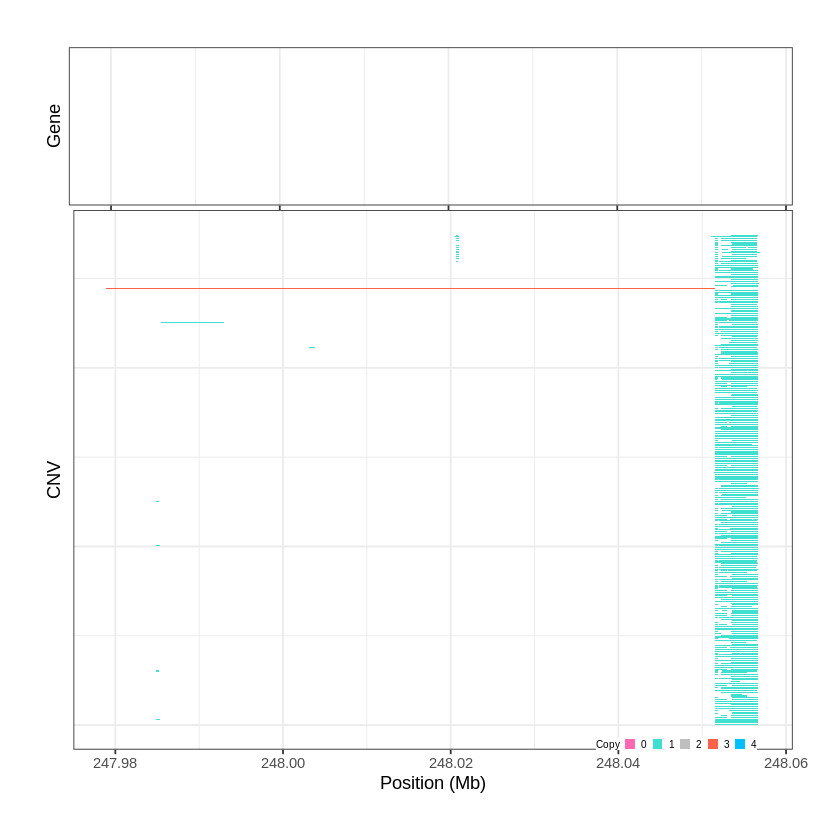

Task done, plot was stored in working directory.
[1] "Ploting CNVR 175..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 248.653101 - 248.9082 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 176..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 248.908201 - 249.0823 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


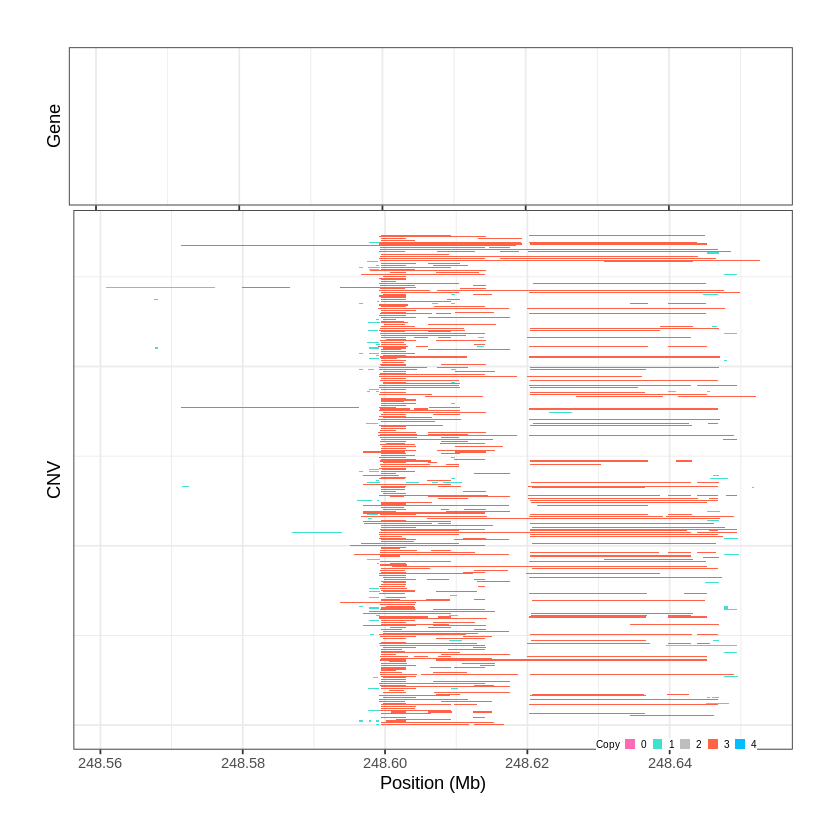

Task done, plot was stored in working directory.
[1] "Ploting CNVR 177..."
Input data passed requirment check...
[1] "CNV on Chromosome 1: 249.240601 - 249.2507 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


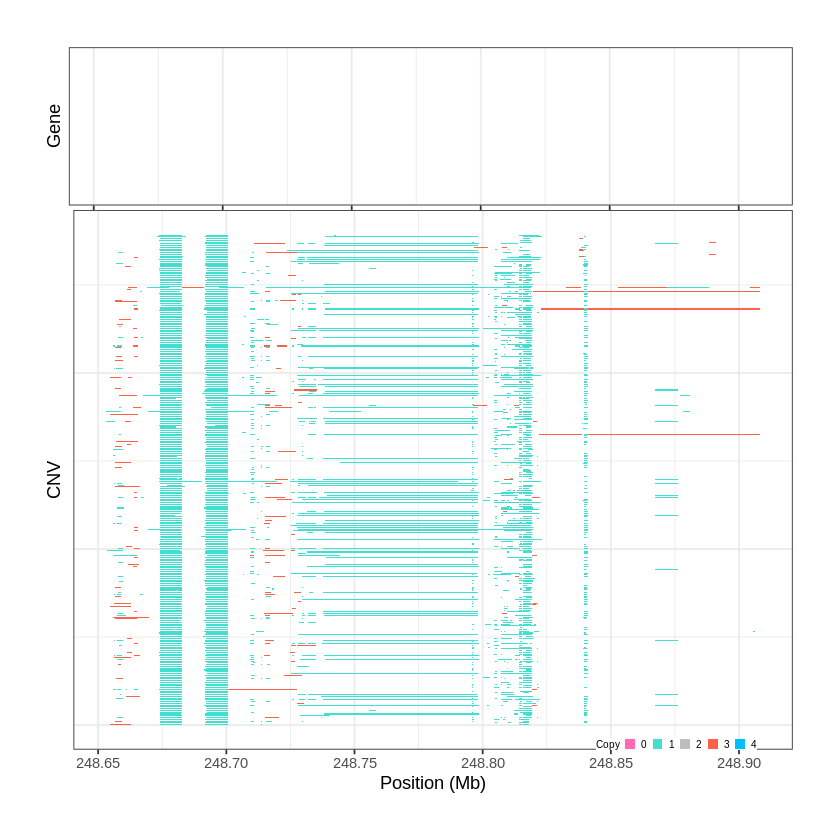

Task done, plot was stored in working directory.
[1] "Ploting CNVR 178..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1e-06 - 0.0233 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


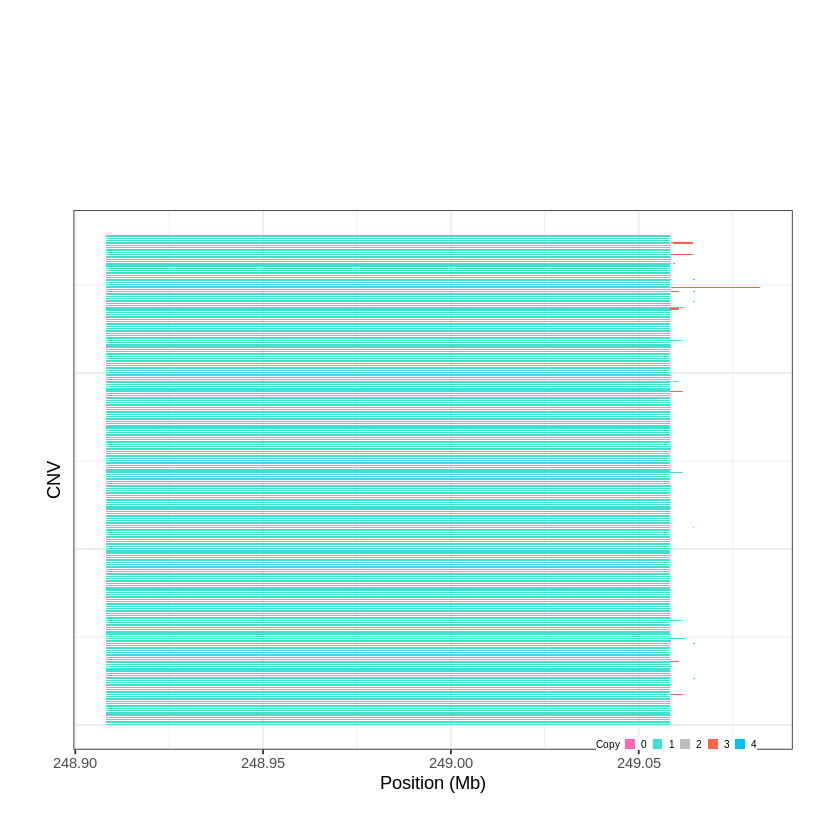

Task done, plot was stored in working directory.
[1] "Ploting CNVR 179..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 0.306401 - 0.328 Mb with 185 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


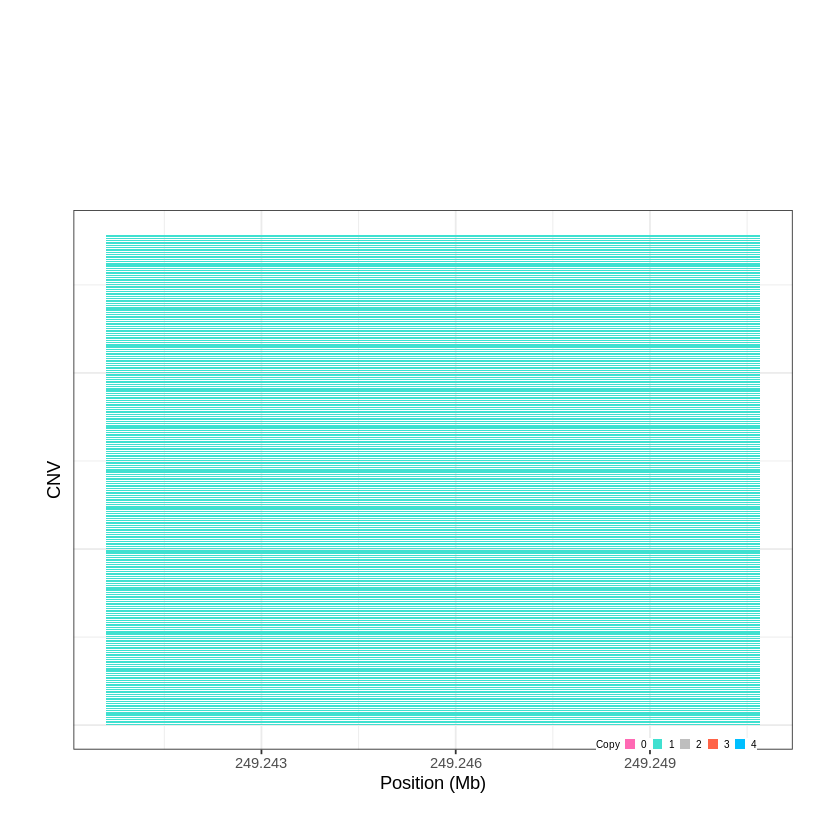

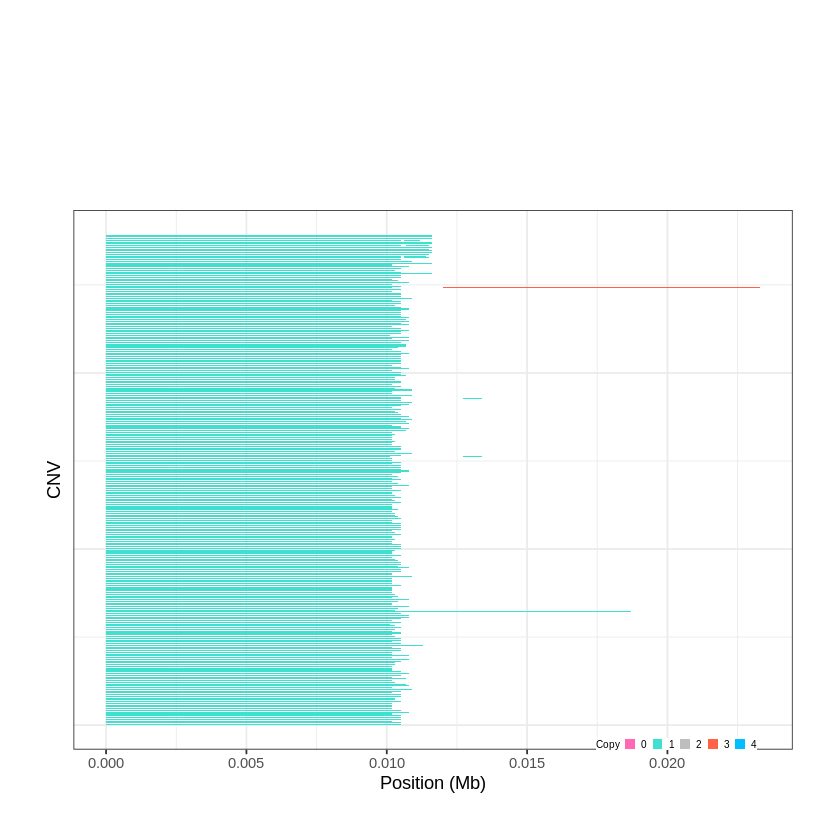

Task done, plot was stored in working directory.
[1] "Ploting CNVR 180..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 0.684301 - 1.0058 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 181..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1.045601 - 1.0542 Mb with 208 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


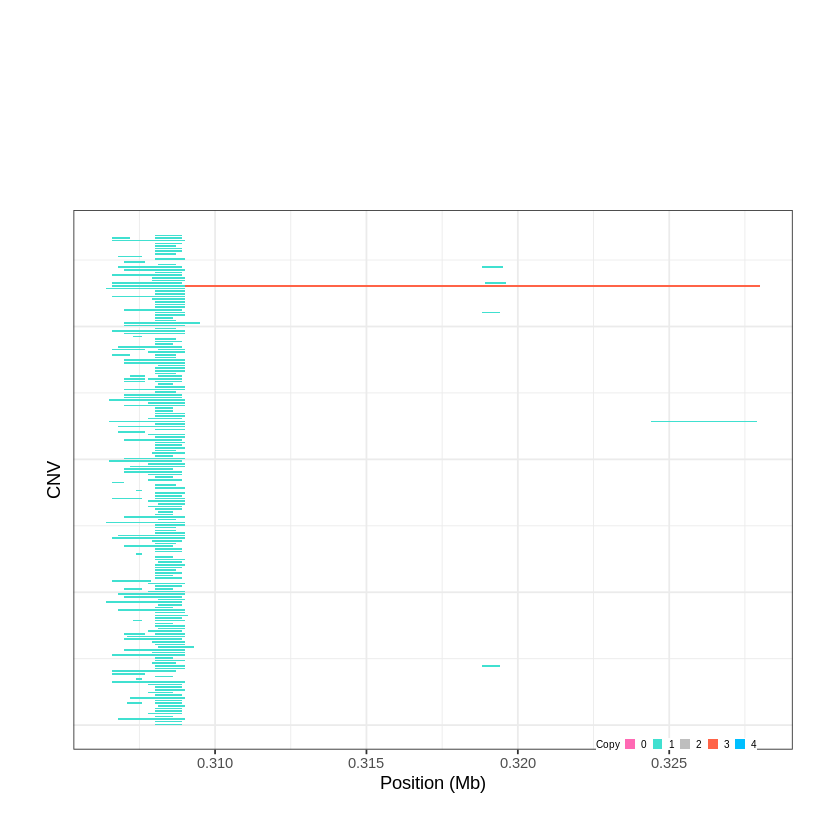

Task done, plot was stored in working directory.
[1] "Ploting CNVR 182..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1.063901 - 1.1167 Mb with 272 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


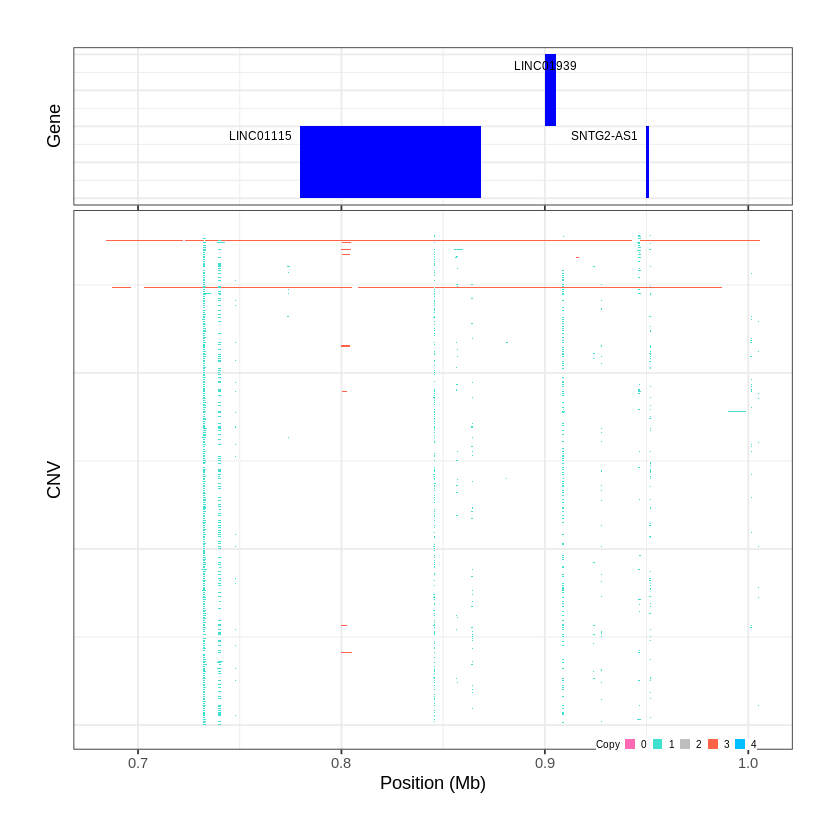

Task done, plot was stored in working directory.
[1] "Ploting CNVR 183..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1.202201 - 1.3204 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


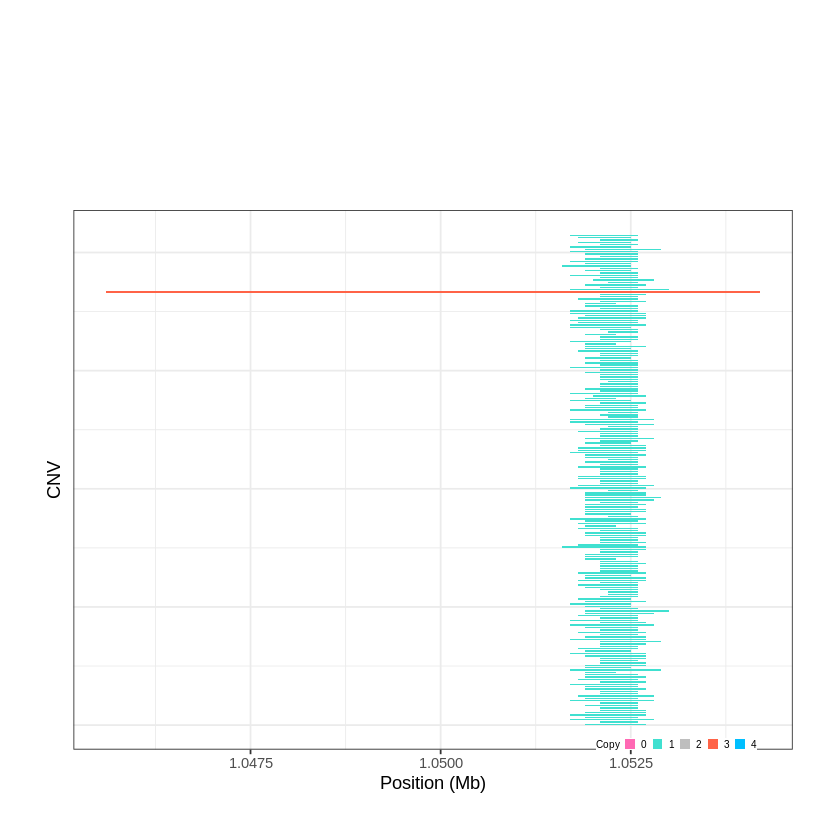

Task done, plot was stored in working directory.
[1] "Ploting CNVR 184..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1.341201 - 1.3585 Mb with 212 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


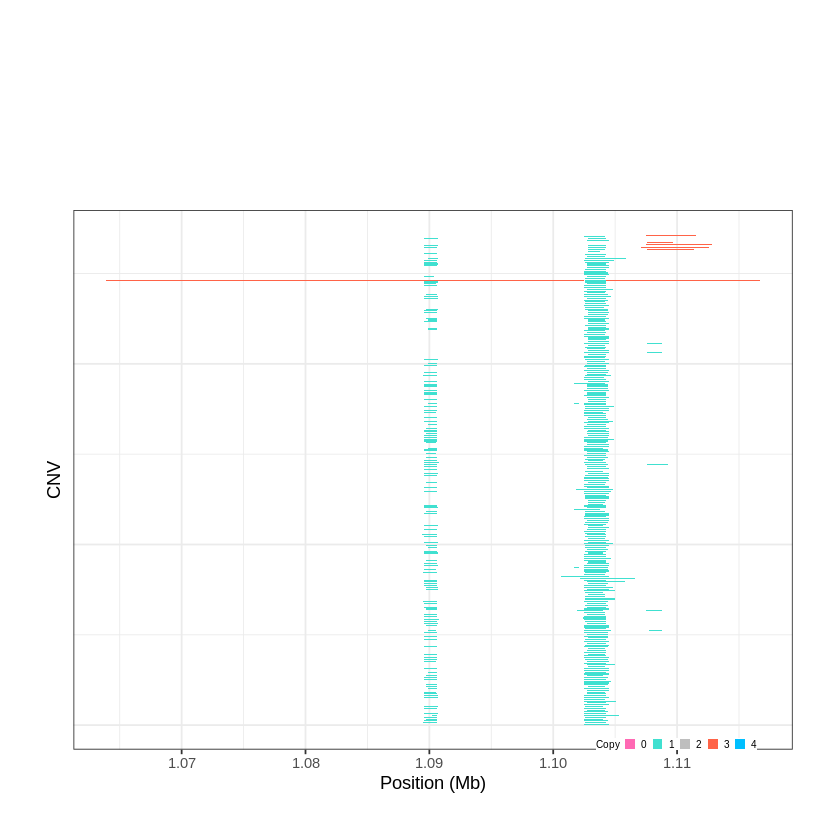

Task done, plot was stored in working directory.
[1] "Ploting CNVR 185..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1.447901 - 1.4496 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


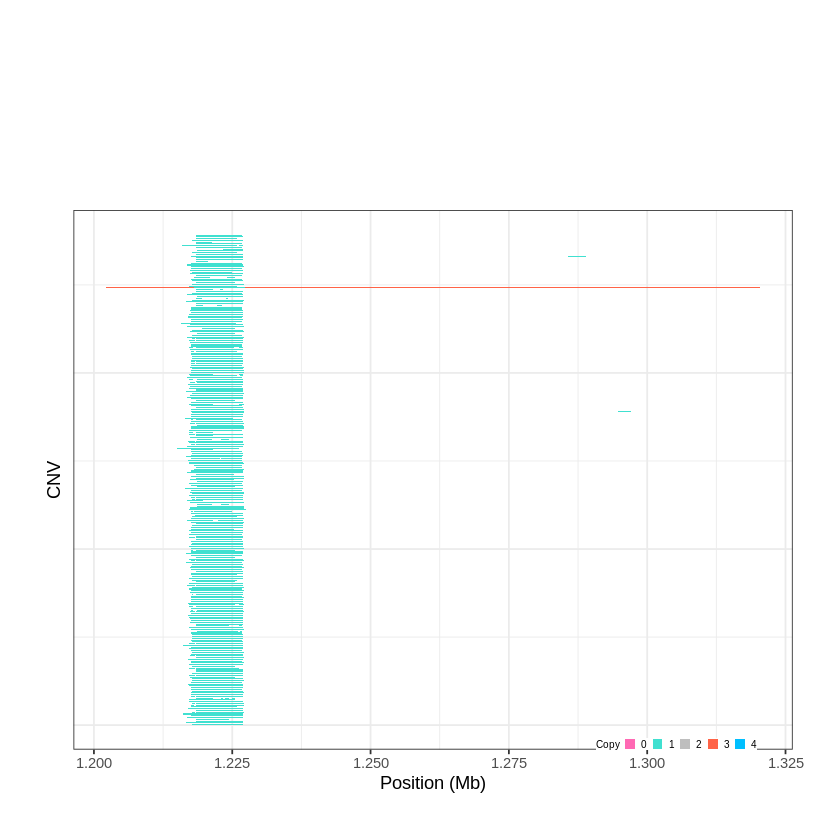

Task done, plot was stored in working directory.
[1] "Ploting CNVR 186..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1.460301 - 1.463 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


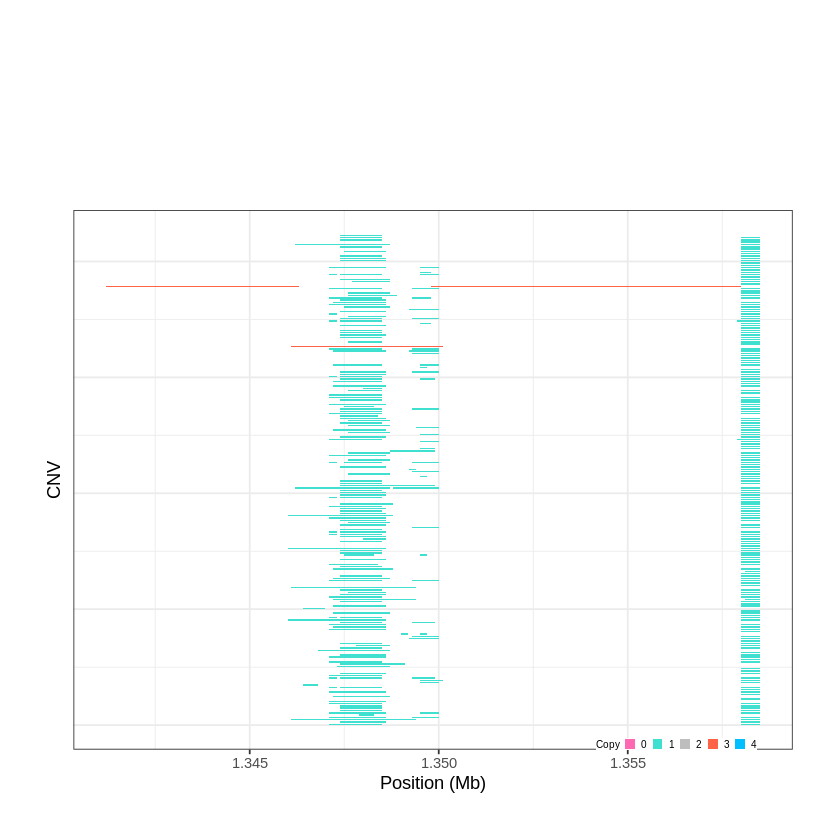

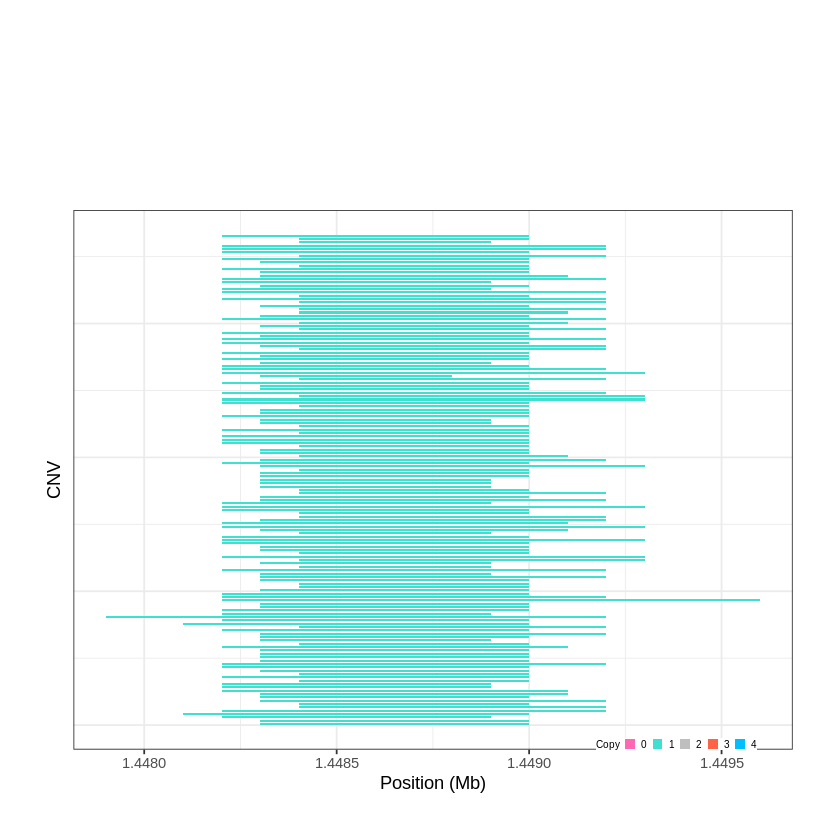

Task done, plot was stored in working directory.
[1] "Ploting CNVR 187..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1.476601 - 1.7224 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 188..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 1.723301 - 2.0671 Mb with 254 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


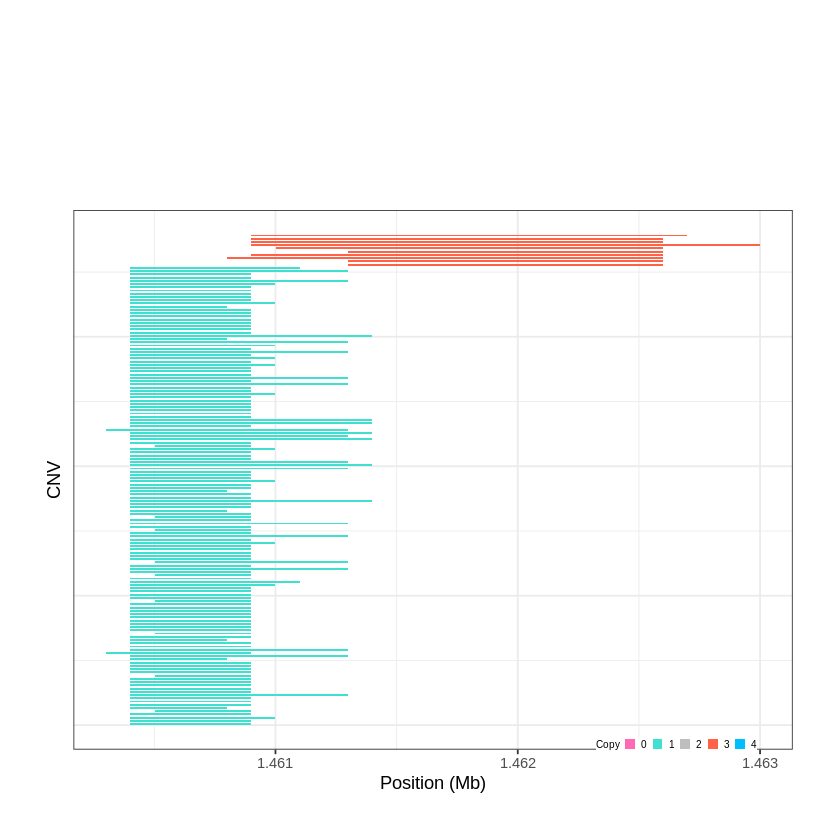

Task done, plot was stored in working directory.
[1] "Ploting CNVR 189..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 2.635901 - 2.9545 Mb with 230 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


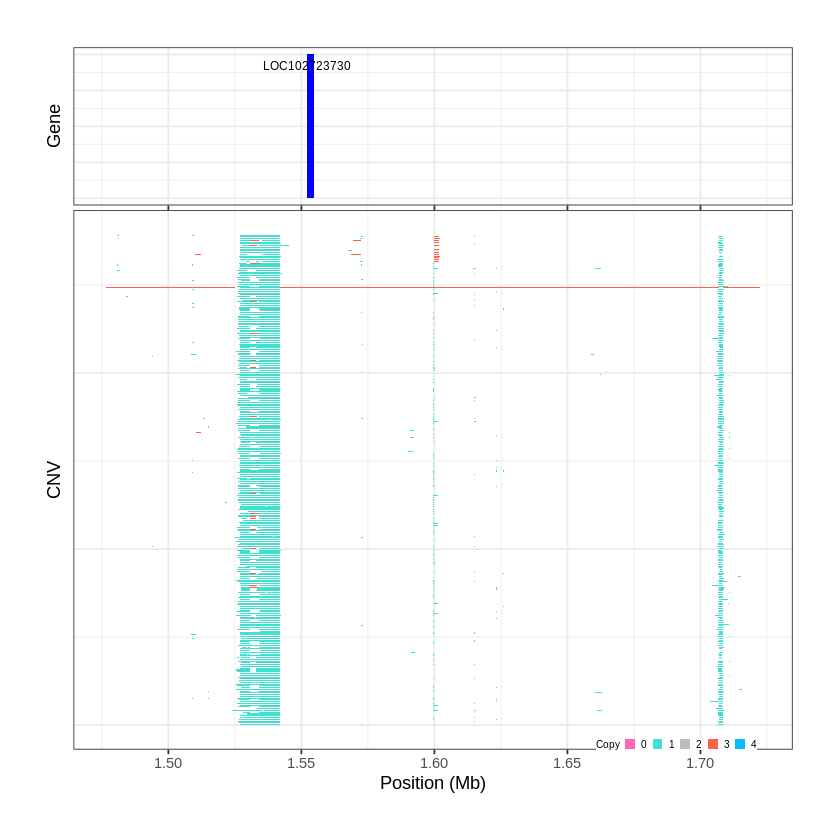

Task done, plot was stored in working directory.
[1] "Ploting CNVR 190..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 3.024501 - 3.2154 Mb with 269 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


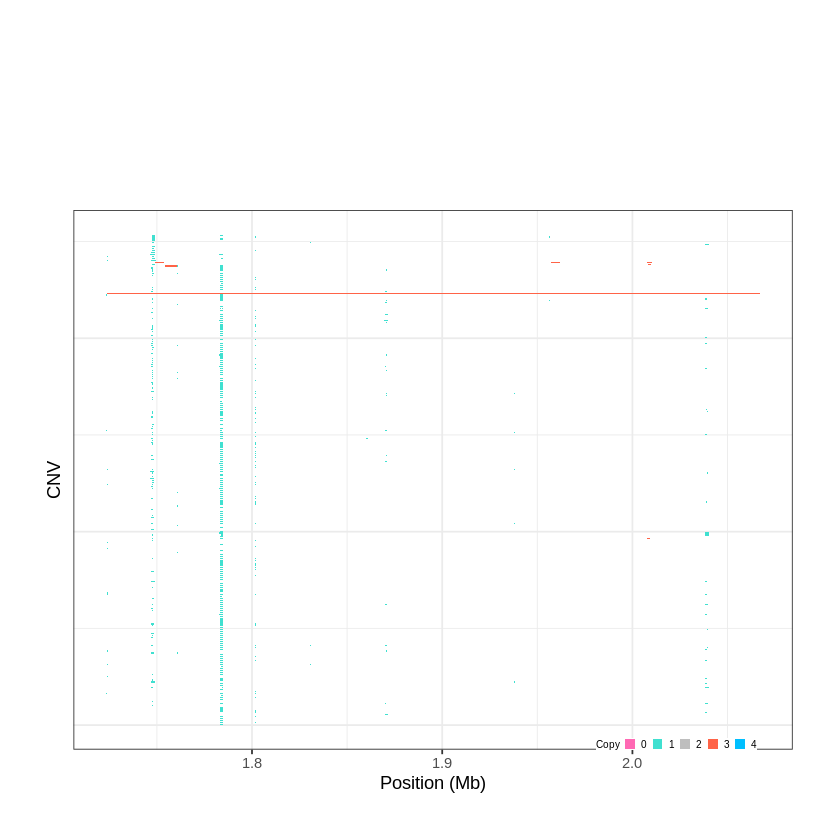

Task done, plot was stored in working directory.
[1] "Ploting CNVR 191..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 3.225701 - 3.353 Mb with 265 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


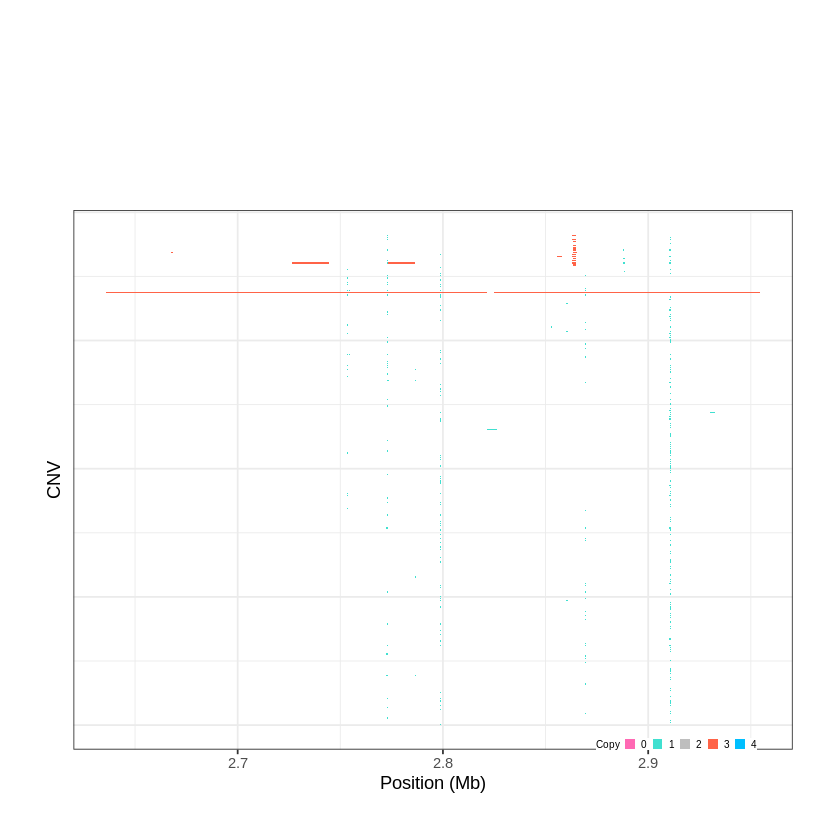

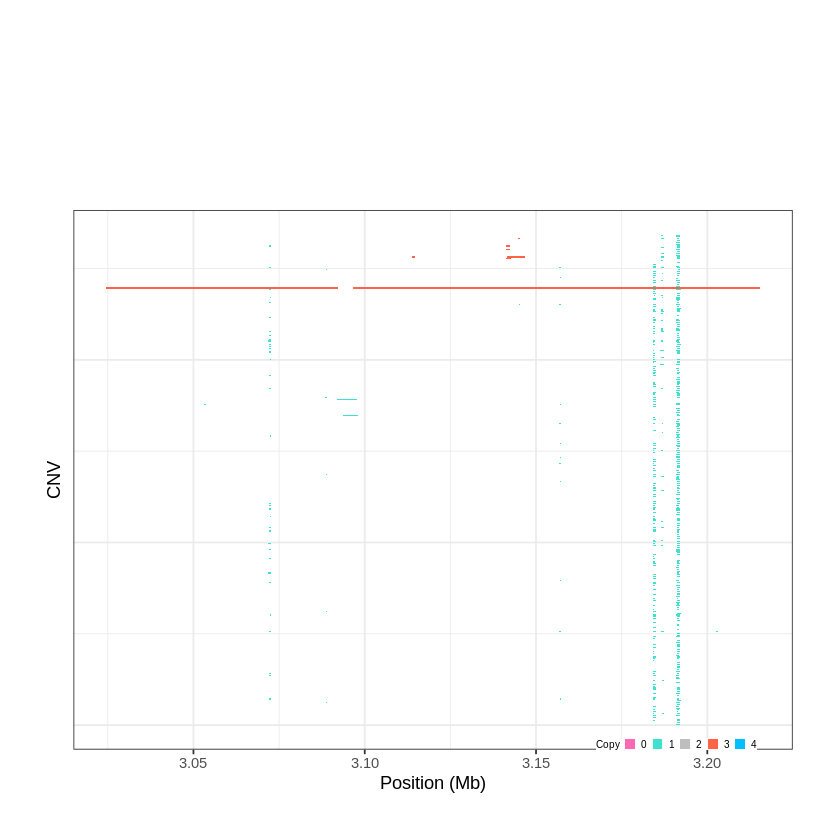

Task done, plot was stored in working directory.
[1] "Ploting CNVR 192..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 3.367001 - 3.5073 Mb with 248 Individual - "
Plotting gene...


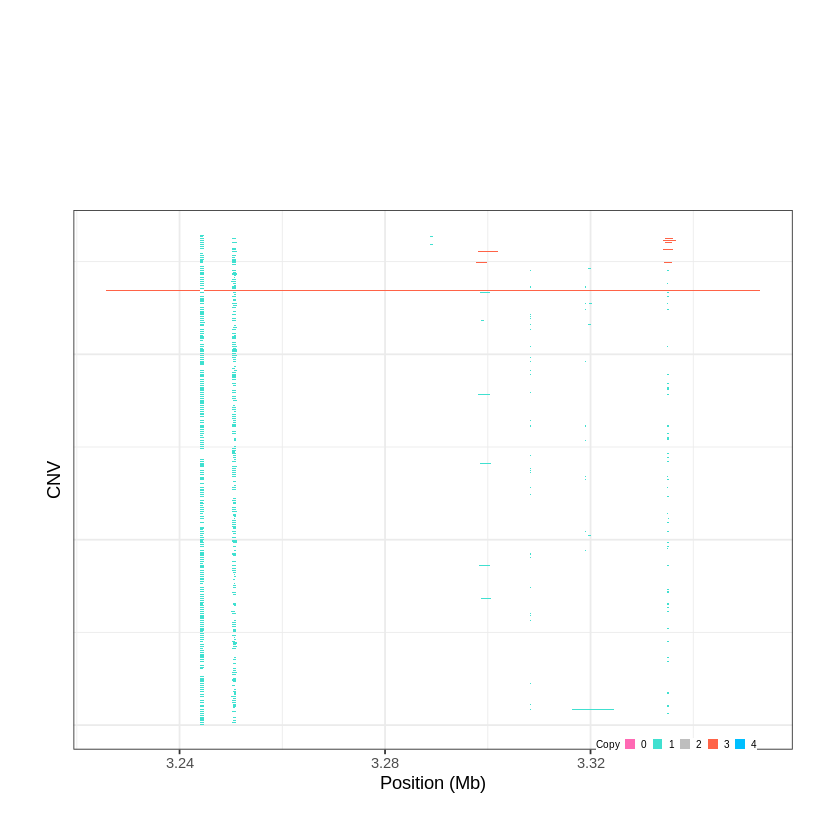

Task done, plot was stored in working directory.
[1] "Ploting CNVR 193..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 3.529301 - 3.5793 Mb with 279 Individual - "
Plotting gene...


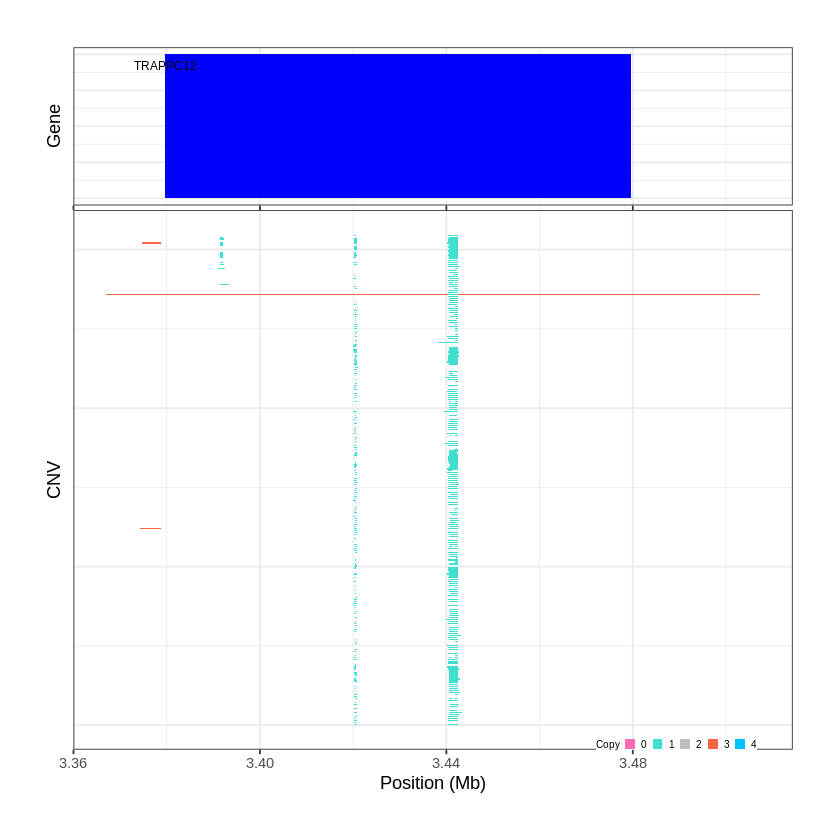

Task done, plot was stored in working directory.
[1] "Ploting CNVR 194..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 3.630901 - 3.7783 Mb with 224 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 195..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 4.771401 - 4.7964 Mb with 266 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


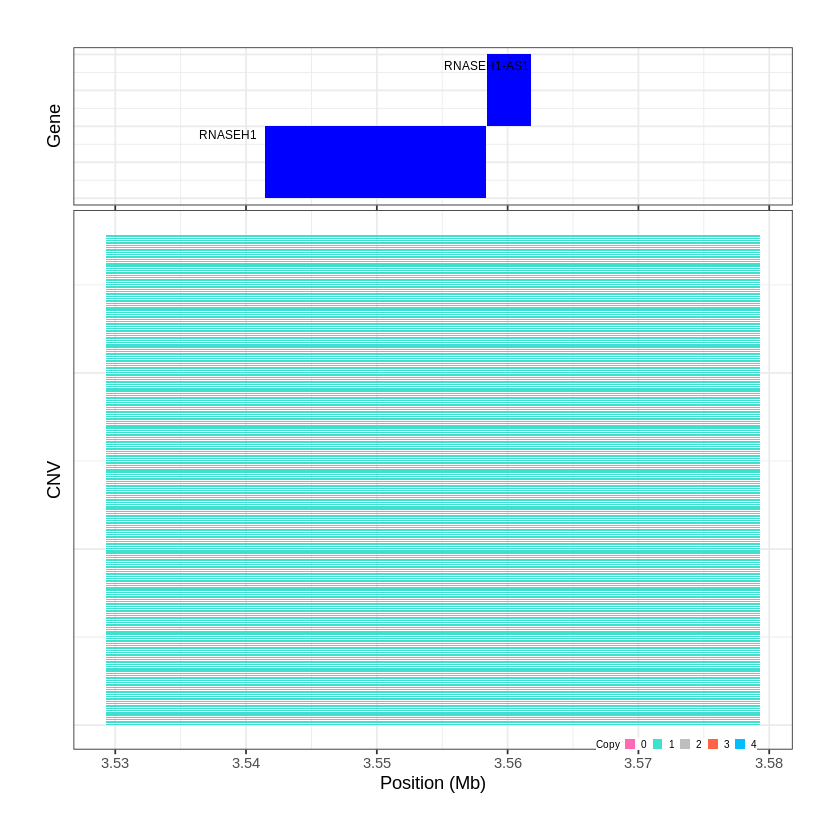

Task done, plot was stored in working directory.
[1] "Ploting CNVR 196..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 5.013601 - 5.015 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


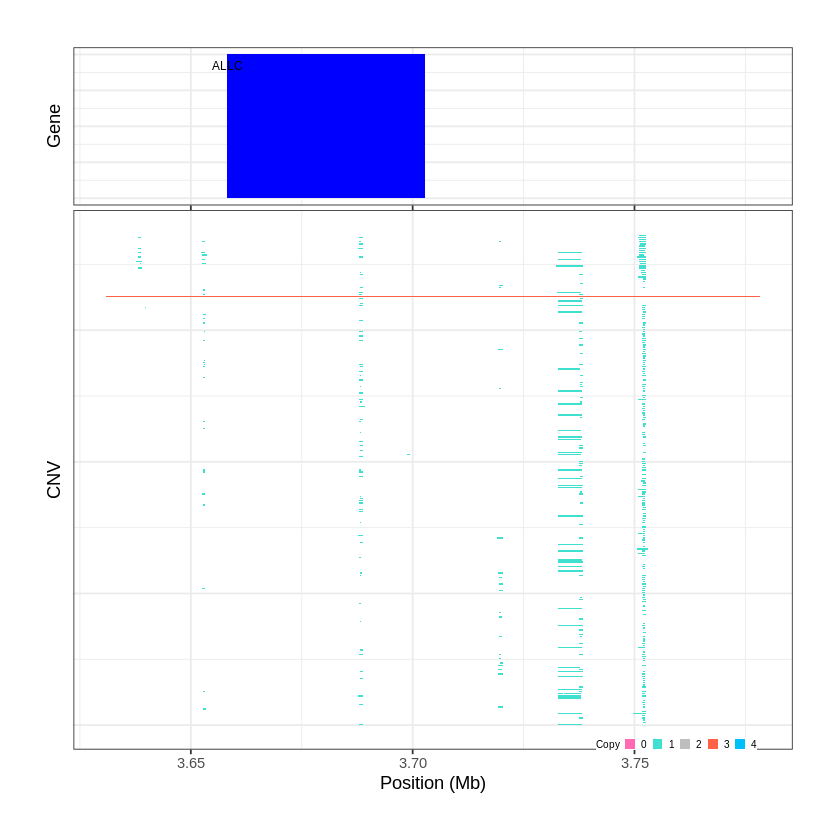

Task done, plot was stored in working directory.
[1] "Ploting CNVR 197..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 5.018701 - 5.1291 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


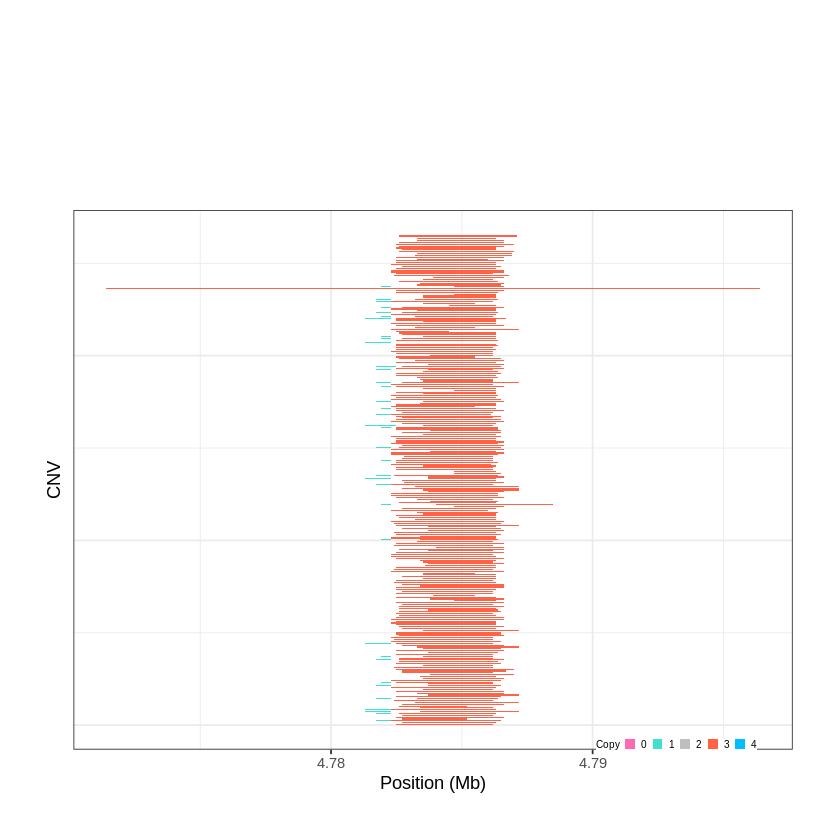

Task done, plot was stored in working directory.
[1] "Ploting CNVR 198..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 7.267701 - 7.269 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


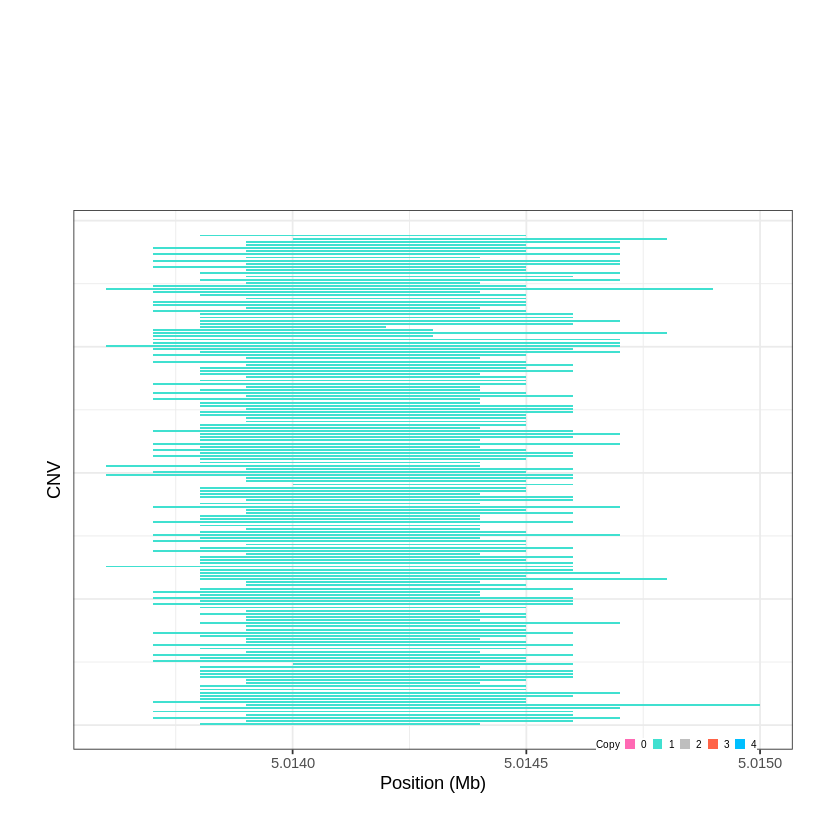

Task done, plot was stored in working directory.
[1] "Ploting CNVR 199..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 8.616801 - 8.6171 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


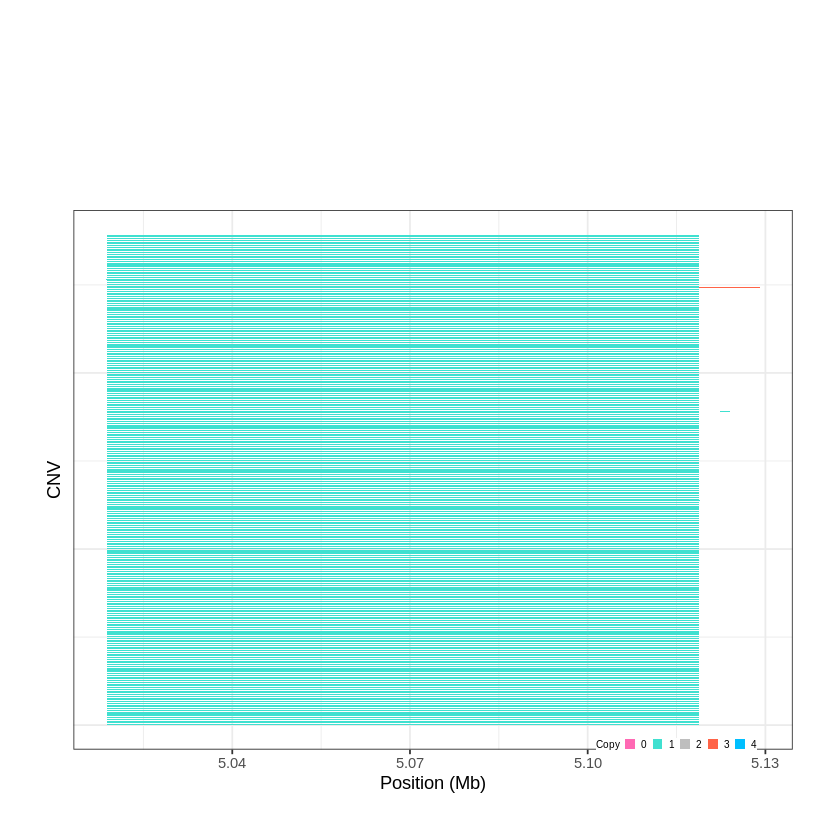

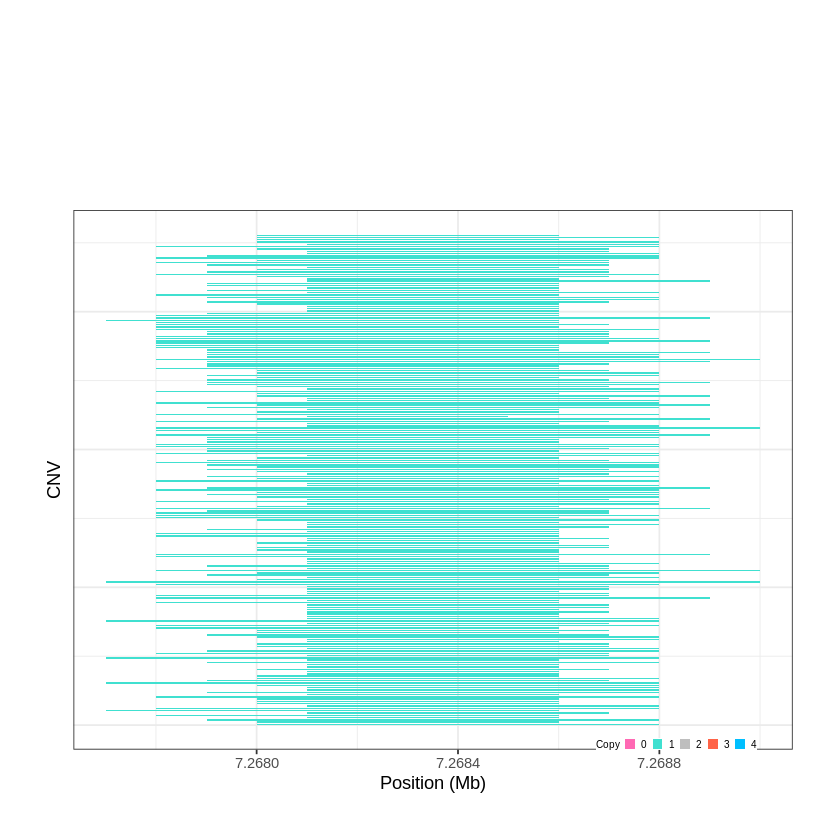

Task done, plot was stored in working directory.
[1] "Ploting CNVR 200..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 8.625401 - 8.8785 Mb with 186 Individual - "
Plotting gene...


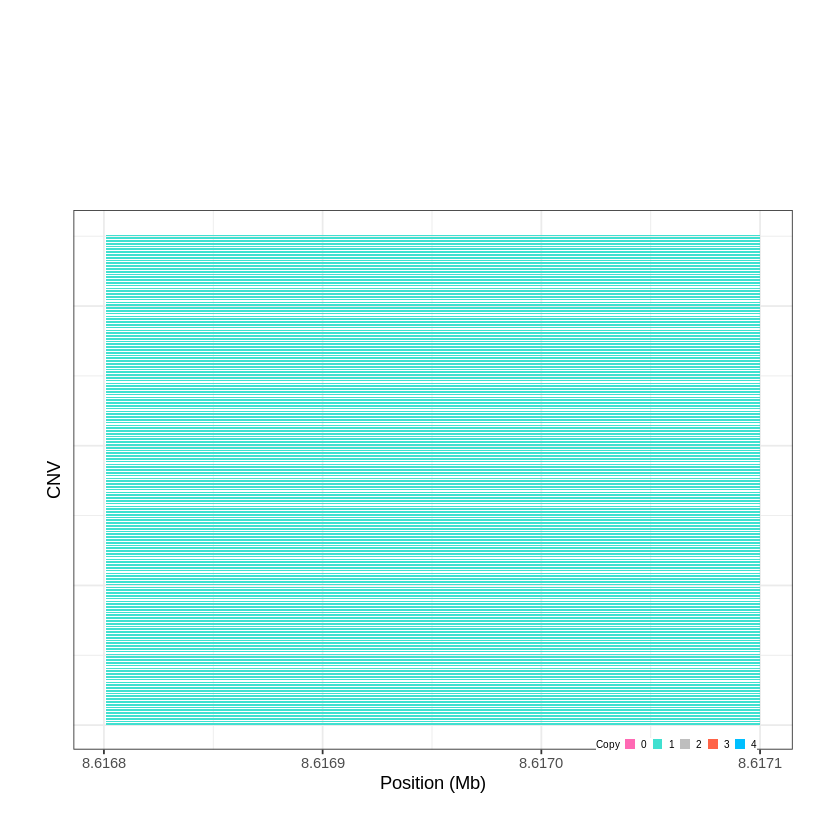

Task done, plot was stored in working directory.
[1] "Ploting CNVR 201..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 9.736101 - 9.9635 Mb with 144 Individual - "
Plotting gene...


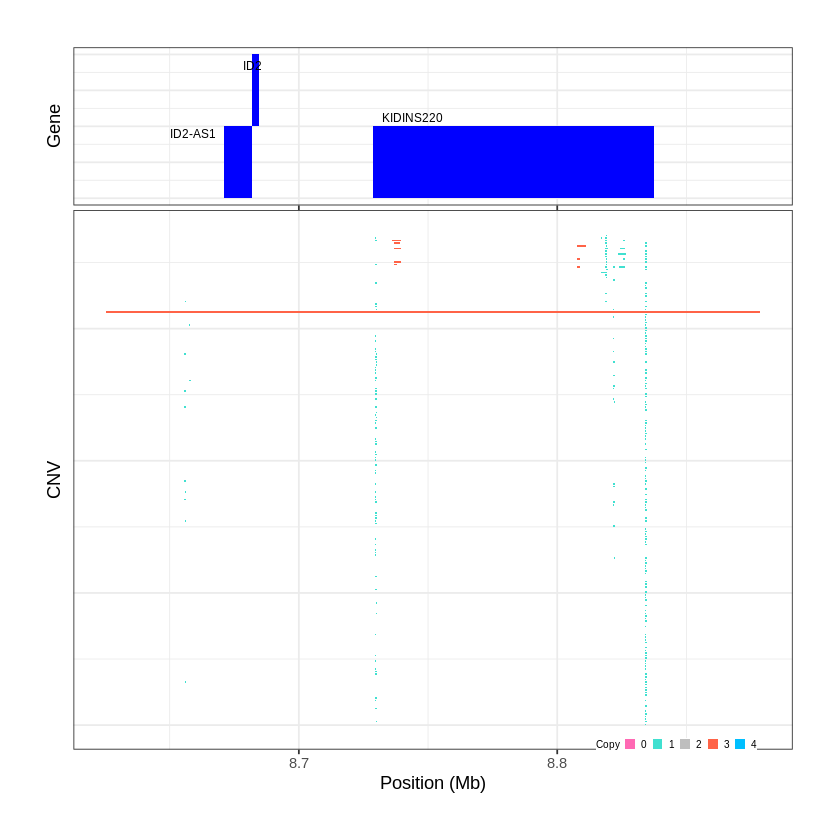

Task done, plot was stored in working directory.
[1] "Ploting CNVR 202..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 10.254101 - 10.6503 Mb with 225 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 203..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 11.181901 - 11.3305 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


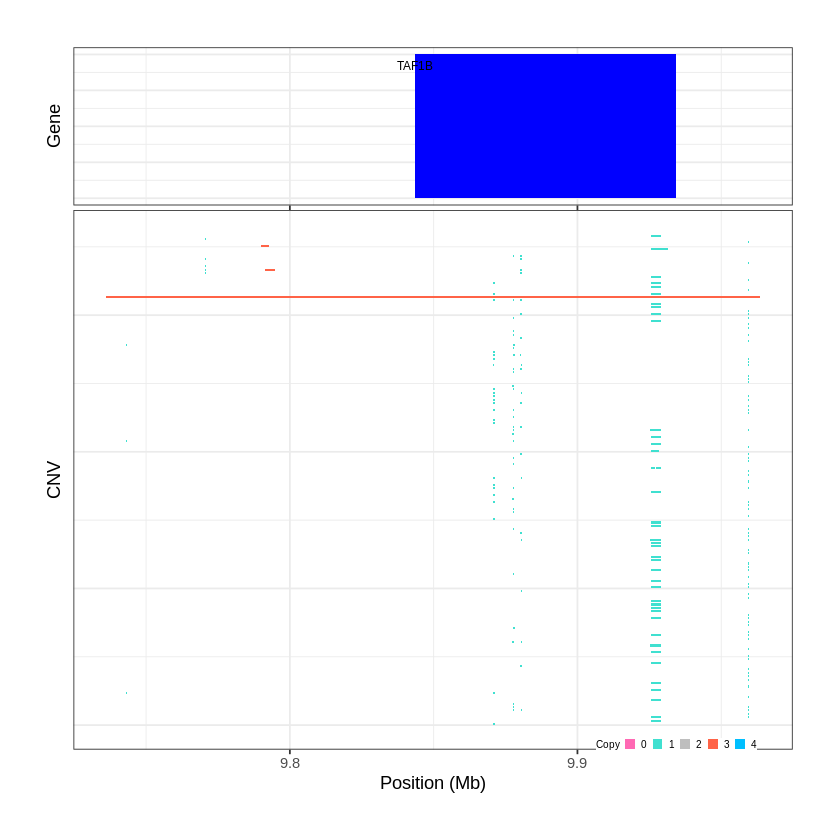

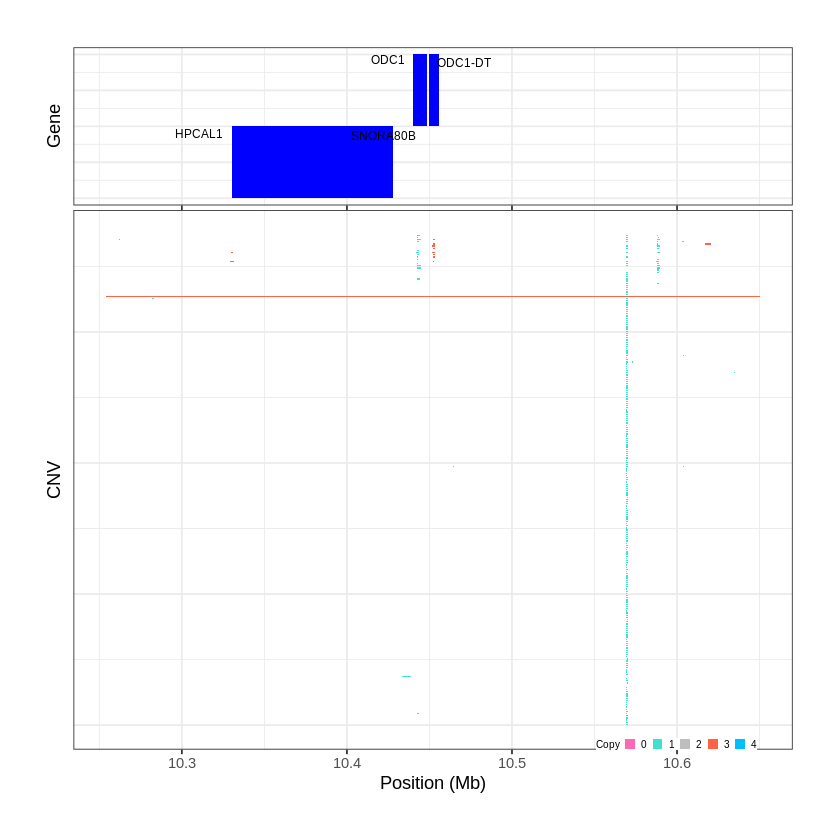

Task done, plot was stored in working directory.
[1] "Ploting CNVR 204..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 11.673001 - 11.7867 Mb with 227 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 205..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 15.166201 - 15.1692 Mb with 157 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


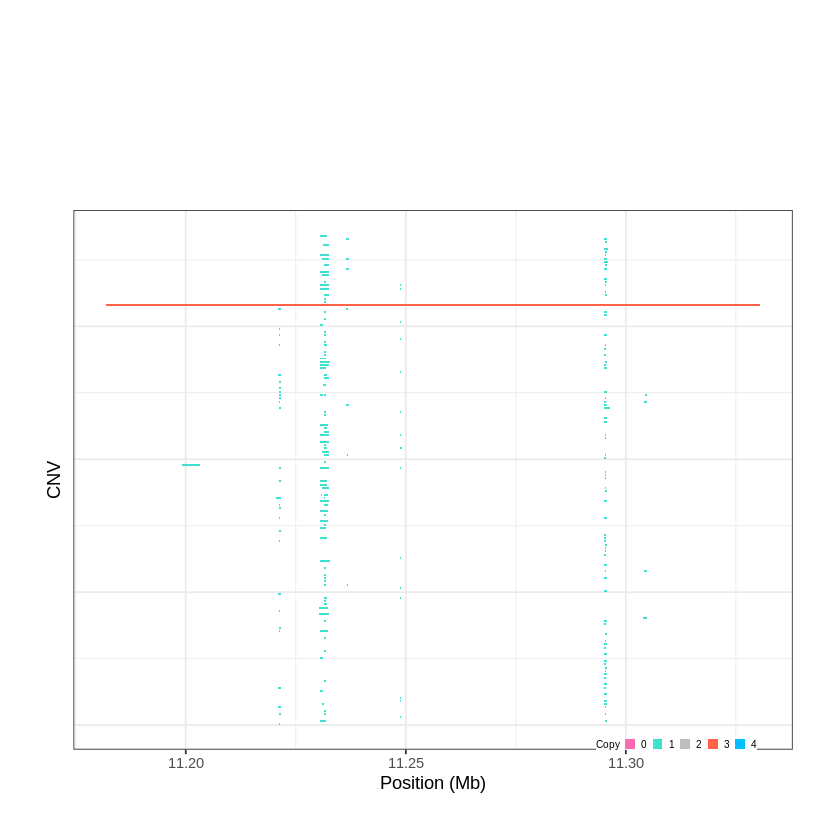

Task done, plot was stored in working directory.
[1] "Ploting CNVR 206..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 16.261201 - 16.2749 Mb with 190 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


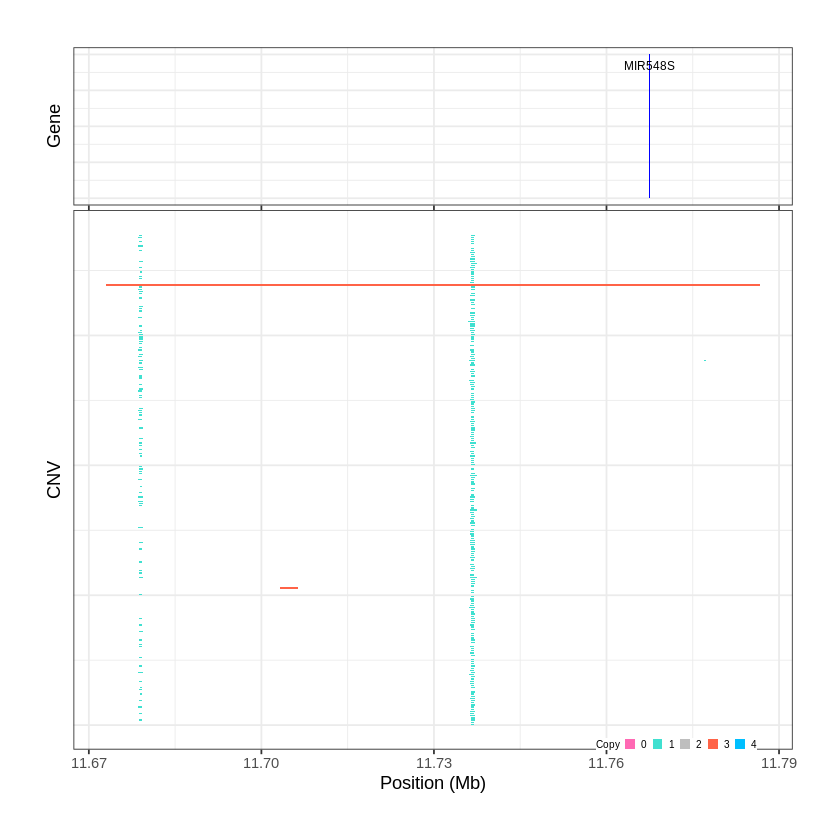

Task done, plot was stored in working directory.
[1] "Ploting CNVR 207..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 16.279701 - 16.3306 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


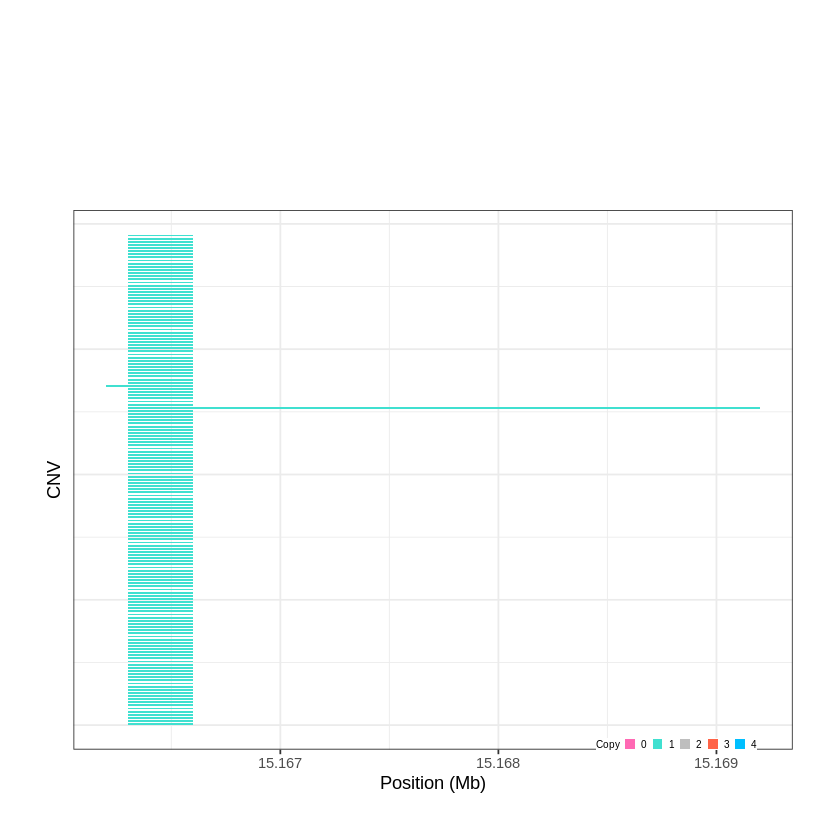

Task done, plot was stored in working directory.
[1] "Ploting CNVR 208..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 16.761301 - 16.7871 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


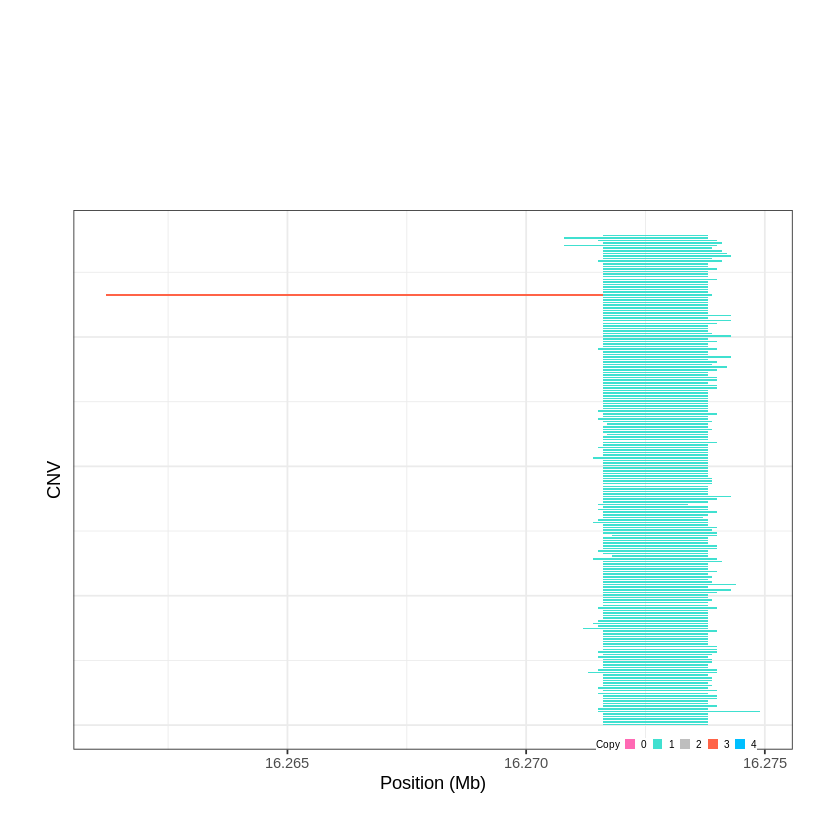

Task done, plot was stored in working directory.
[1] "Ploting CNVR 209..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 18.463901 - 18.4952 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


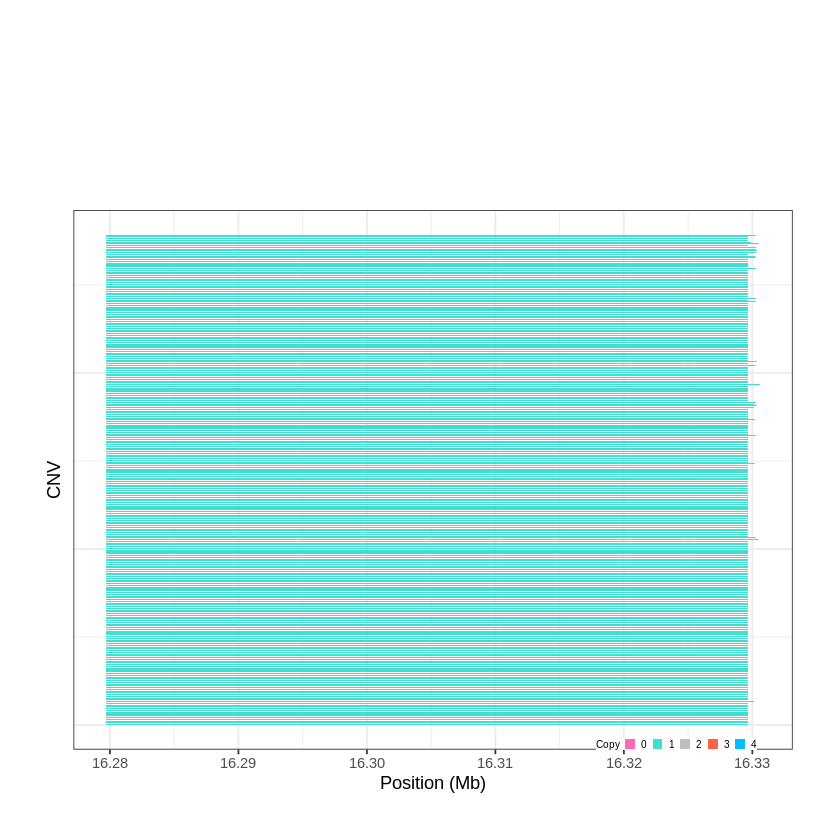

Task done, plot was stored in working directory.
[1] "Ploting CNVR 210..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 19.176701 - 19.2362 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


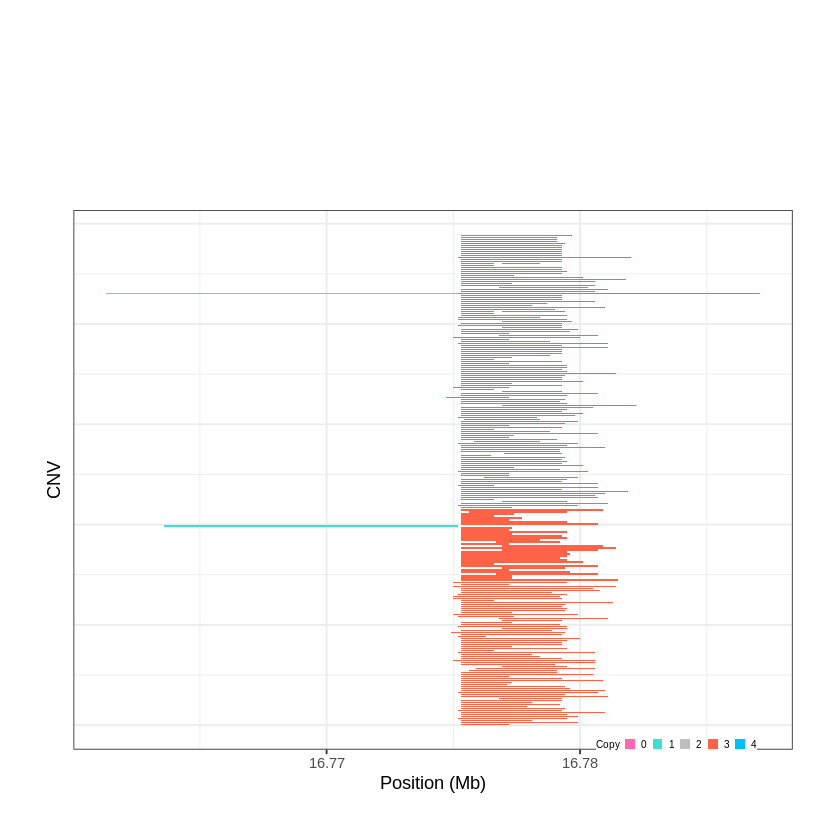

Task done, plot was stored in working directory.
[1] "Ploting CNVR 211..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 19.889401 - 19.8907 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


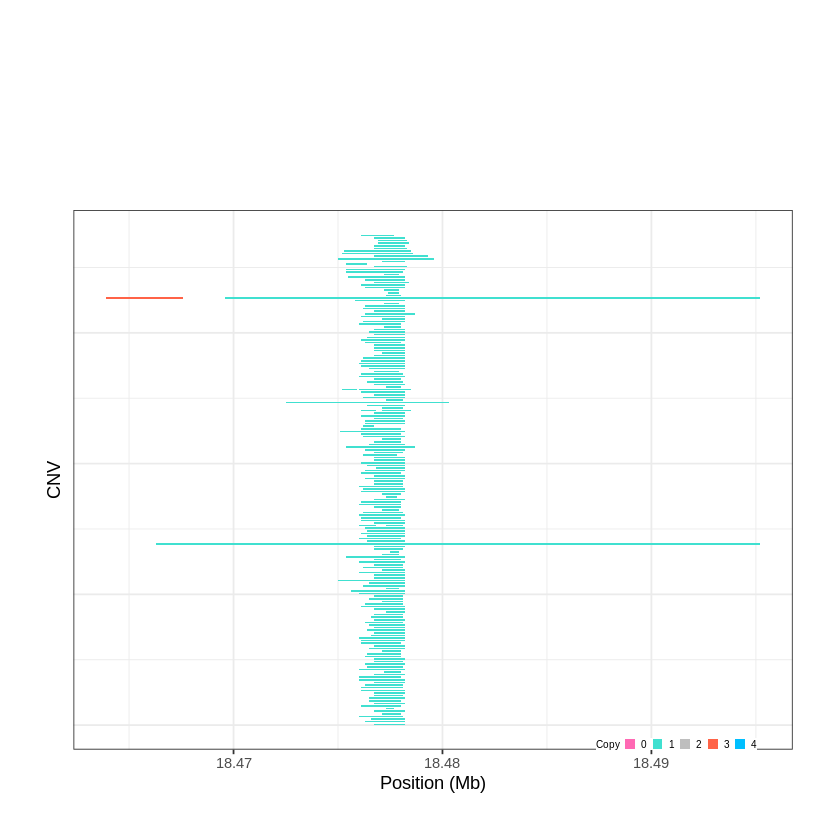

Task done, plot was stored in working directory.
[1] "Ploting CNVR 212..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 21.153101 - 21.1781 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


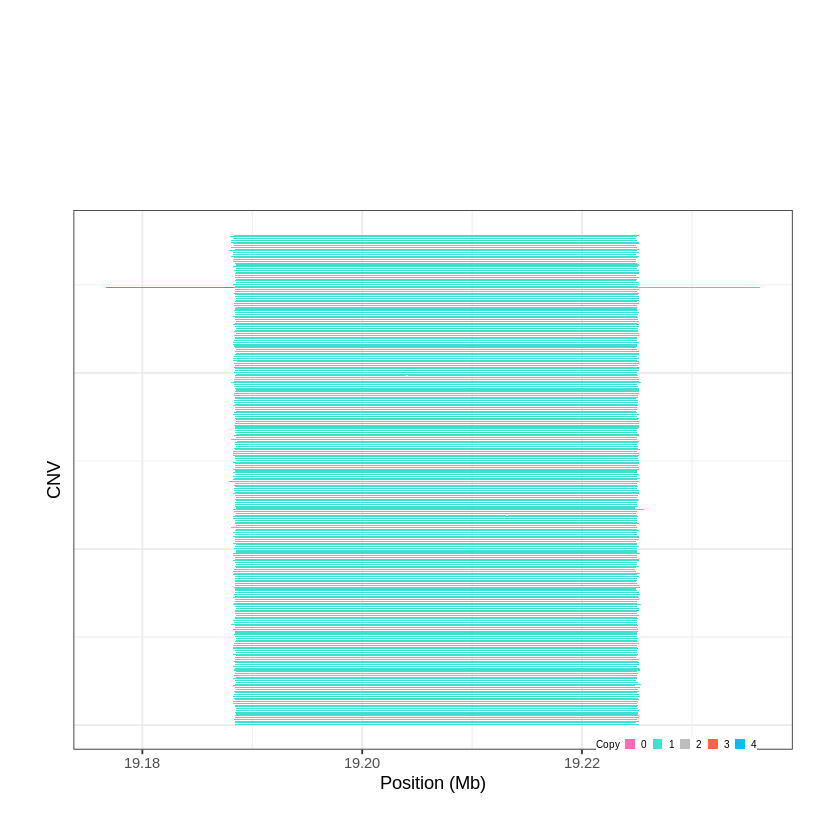

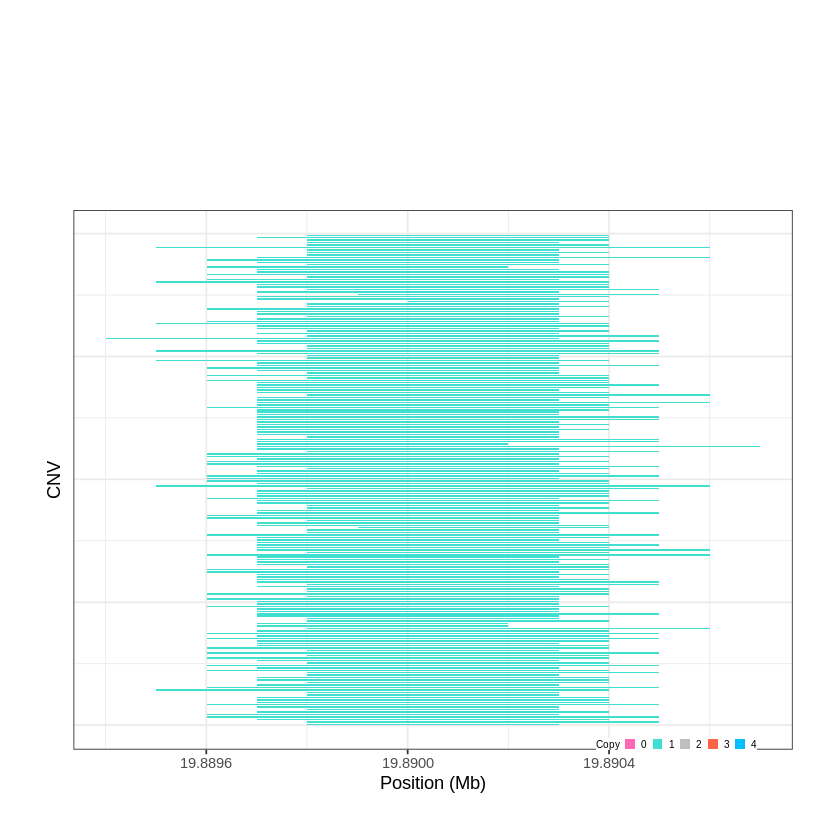

Task done, plot was stored in working directory.
[1] "Ploting CNVR 213..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 24.067701 - 24.1166 Mb with 198 Individual - "
Plotting gene...


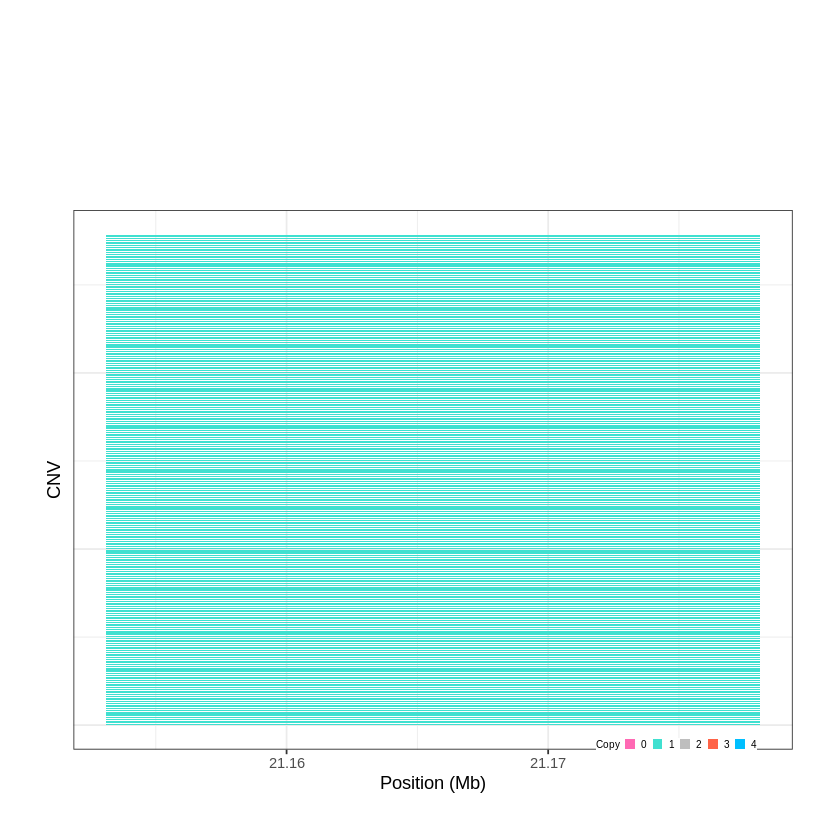

Task done, plot was stored in working directory.
[1] "Ploting CNVR 214..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 25.210601 - 25.6593 Mb with 219 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 215..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 26.374601 - 26.4162 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


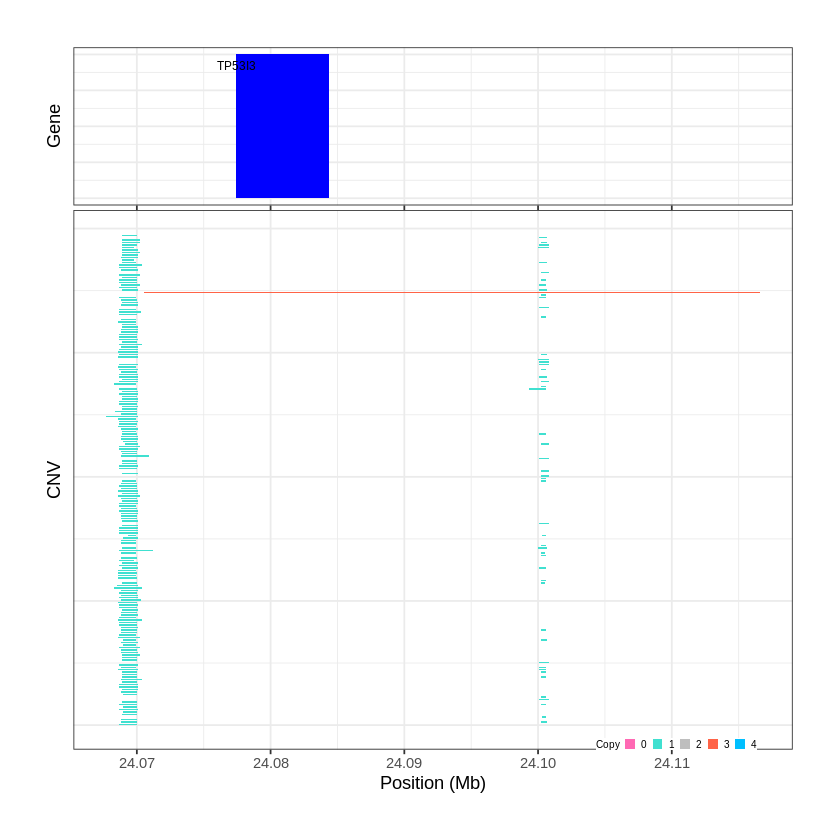

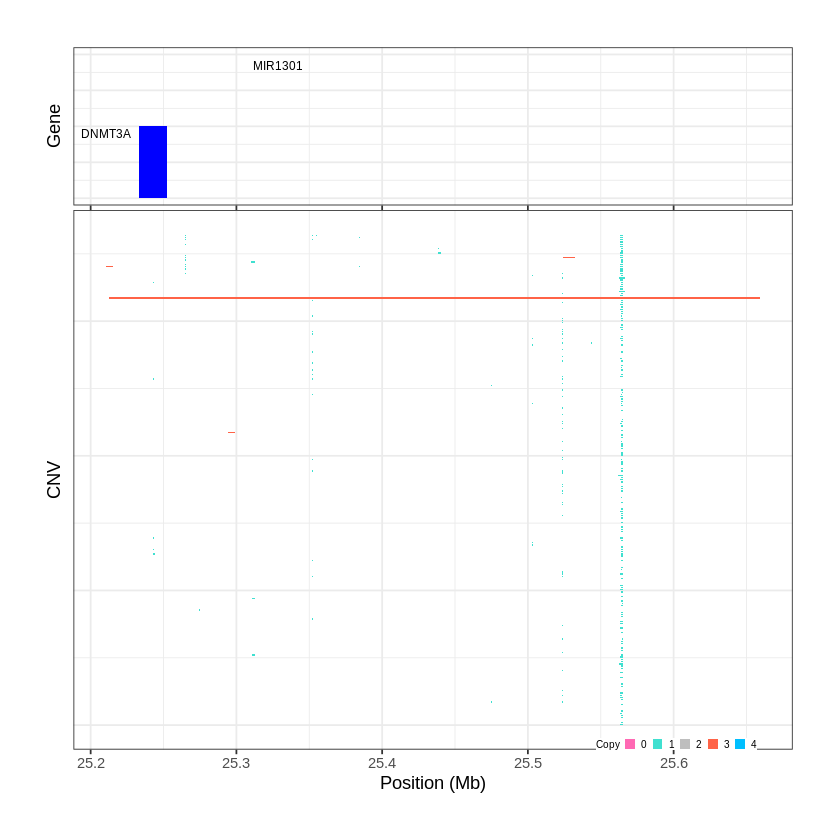

Task done, plot was stored in working directory.
[1] "Ploting CNVR 216..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 26.529001 - 26.9728 Mb with 154 Individual - "
Plotting gene...


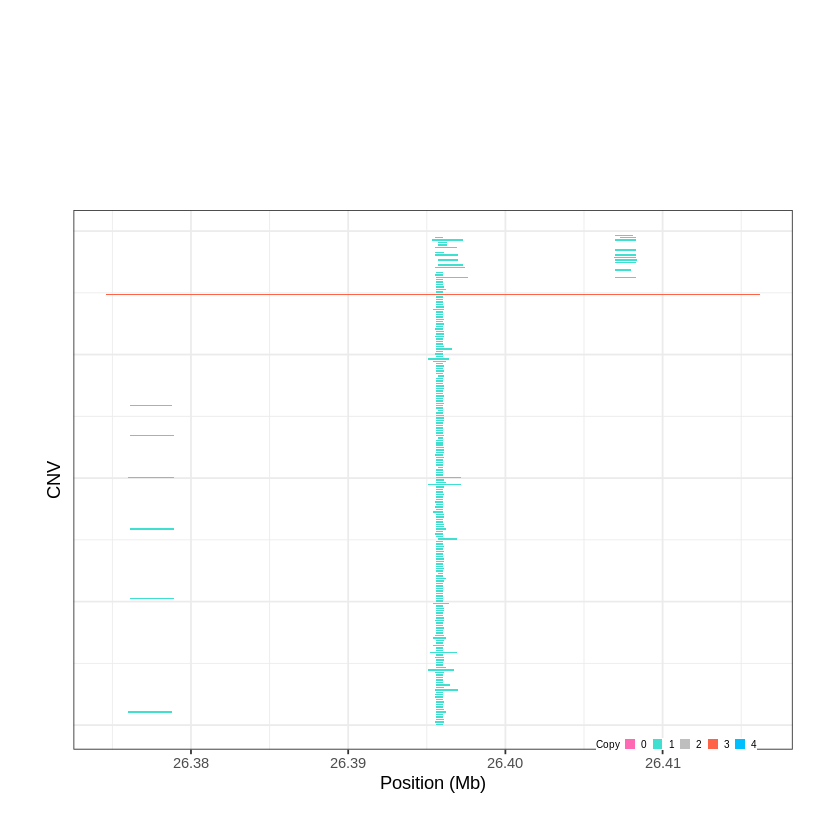

Task done, plot was stored in working directory.
[1] "Ploting CNVR 217..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 27.935401 - 28.045 Mb with 146 Individual - "
Plotting gene...


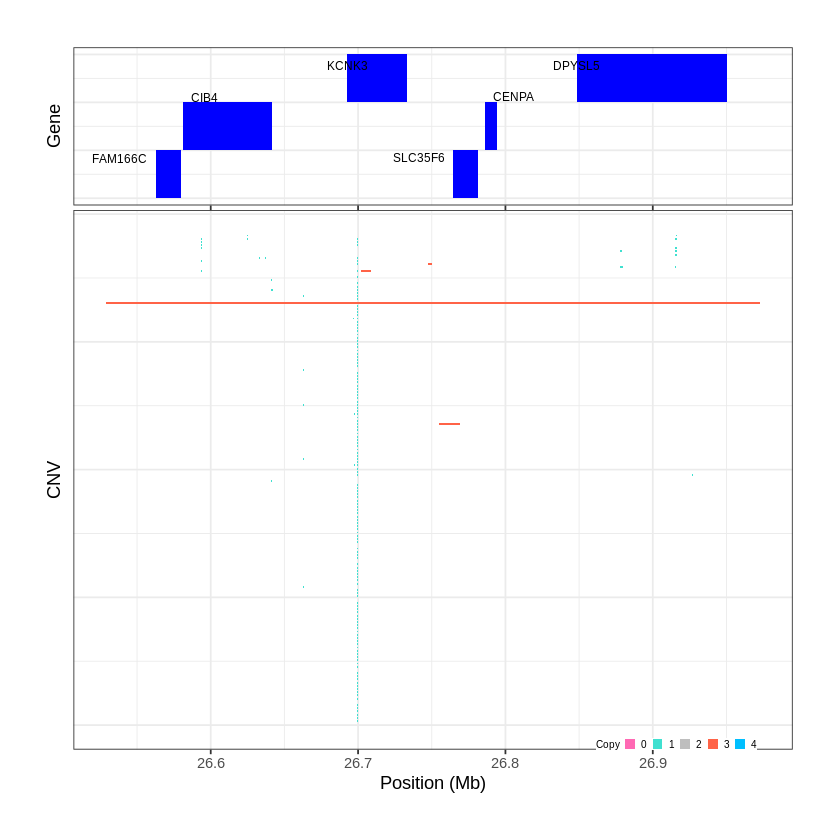

Task done, plot was stored in working directory.
[1] "Ploting CNVR 218..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 28.528101 - 28.6822 Mb with 205 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 219..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 30.022001 - 30.0259 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


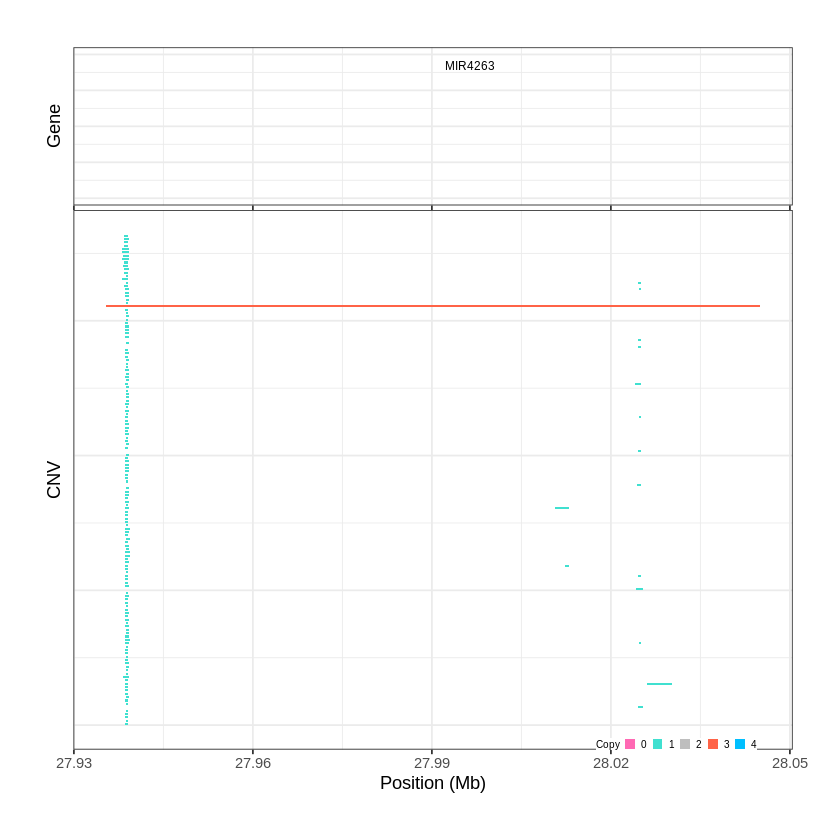

Task done, plot was stored in working directory.
[1] "Ploting CNVR 220..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 31.720801 - 31.7362 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


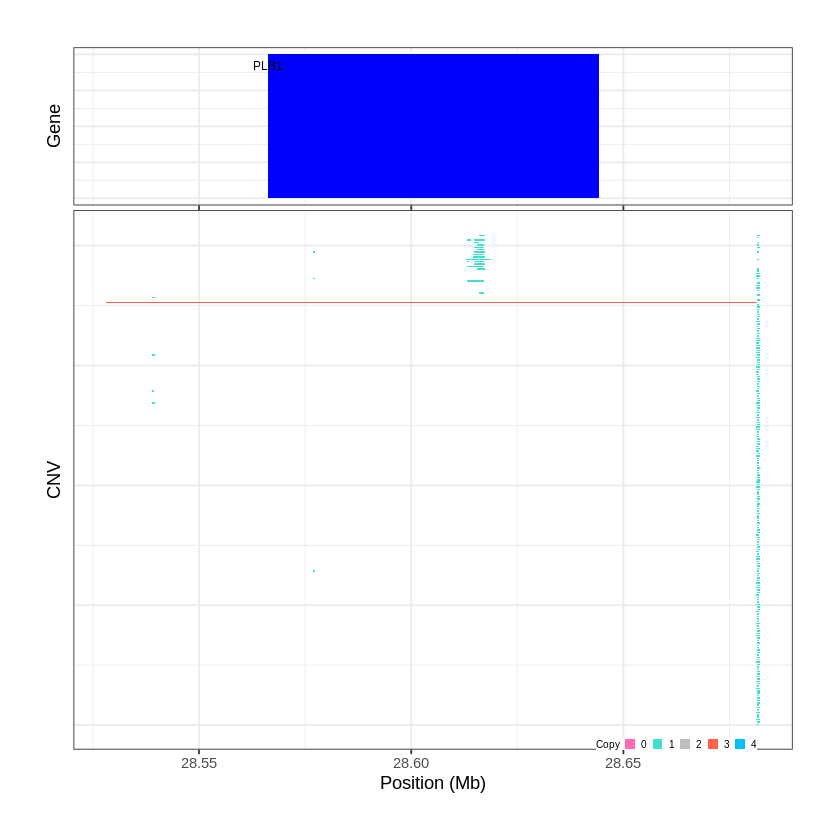

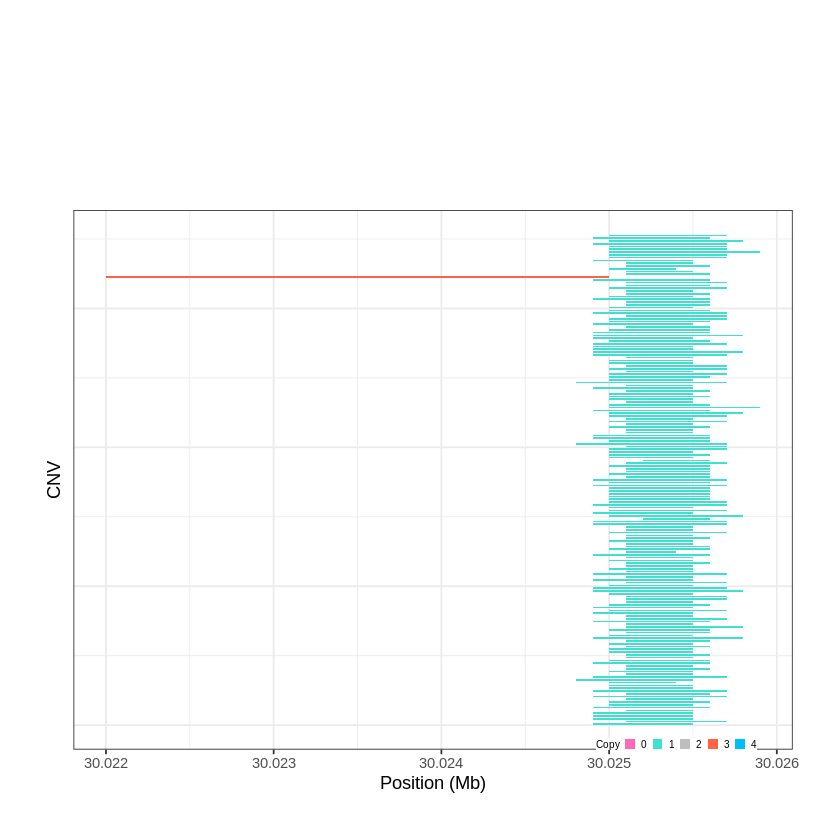

Task done, plot was stored in working directory.
[1] "Ploting CNVR 221..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 32.454501 - 32.6803 Mb with 172 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 222..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 33.092201 - 33.0957 Mb with 266 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


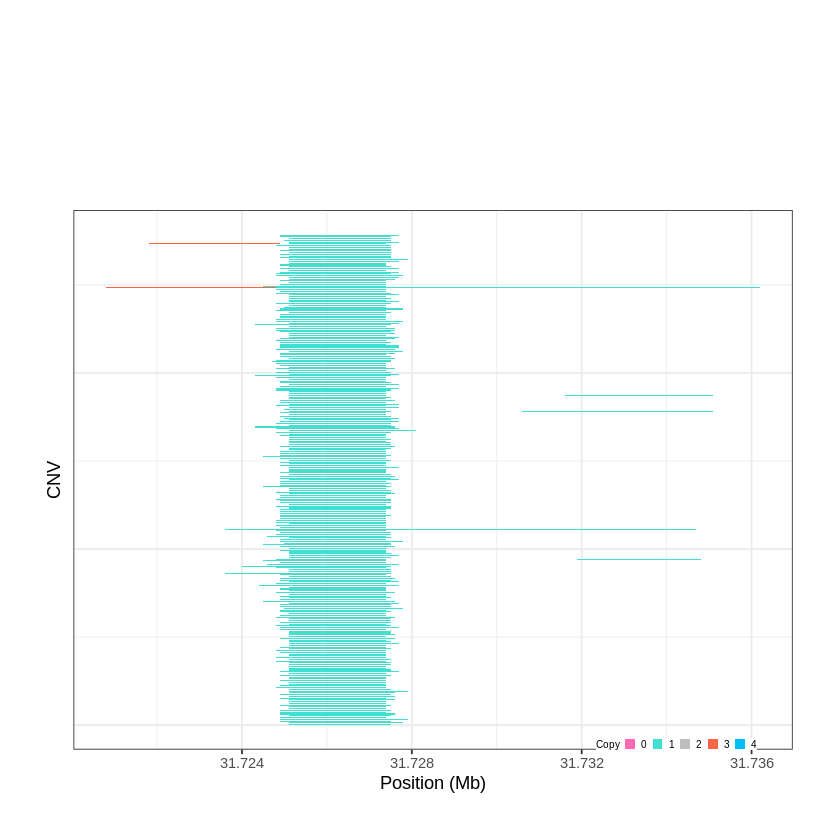

Task done, plot was stored in working directory.
[1] "Ploting CNVR 223..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 33.215401 - 33.2278 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


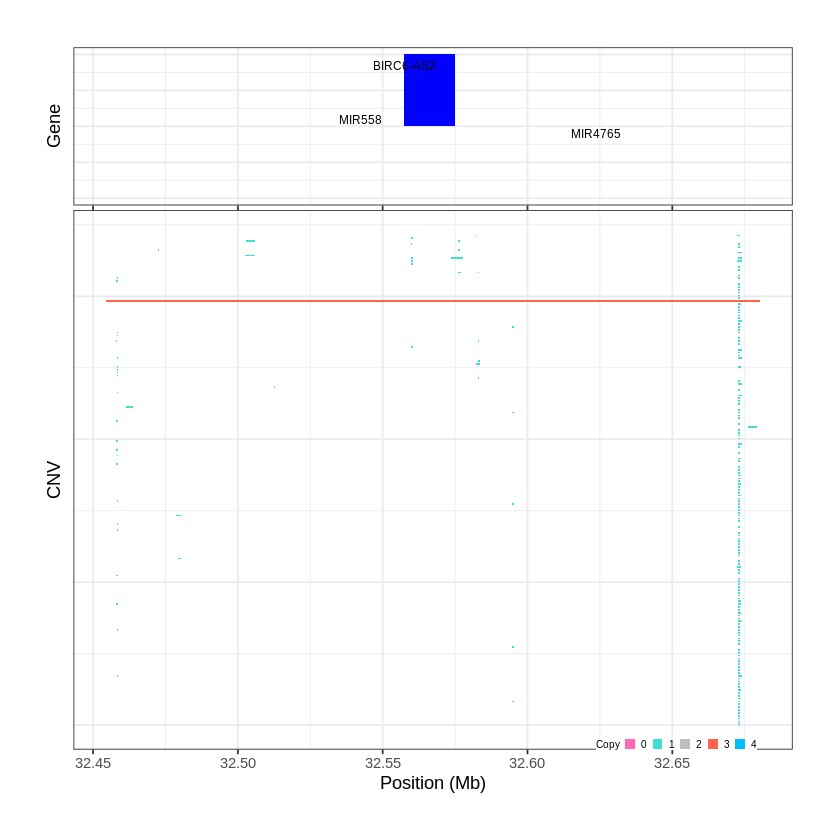

Task done, plot was stored in working directory.
[1] "Ploting CNVR 224..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 34.521201 - 34.5339 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


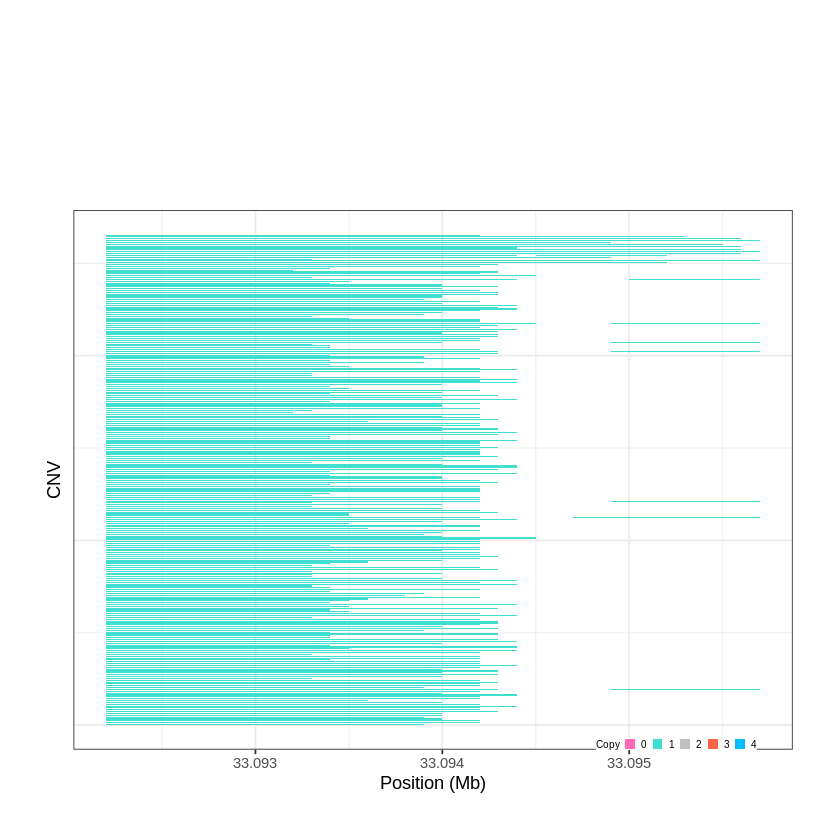

Task done, plot was stored in working directory.
[1] "Ploting CNVR 225..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 35.970601 - 36.0053 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


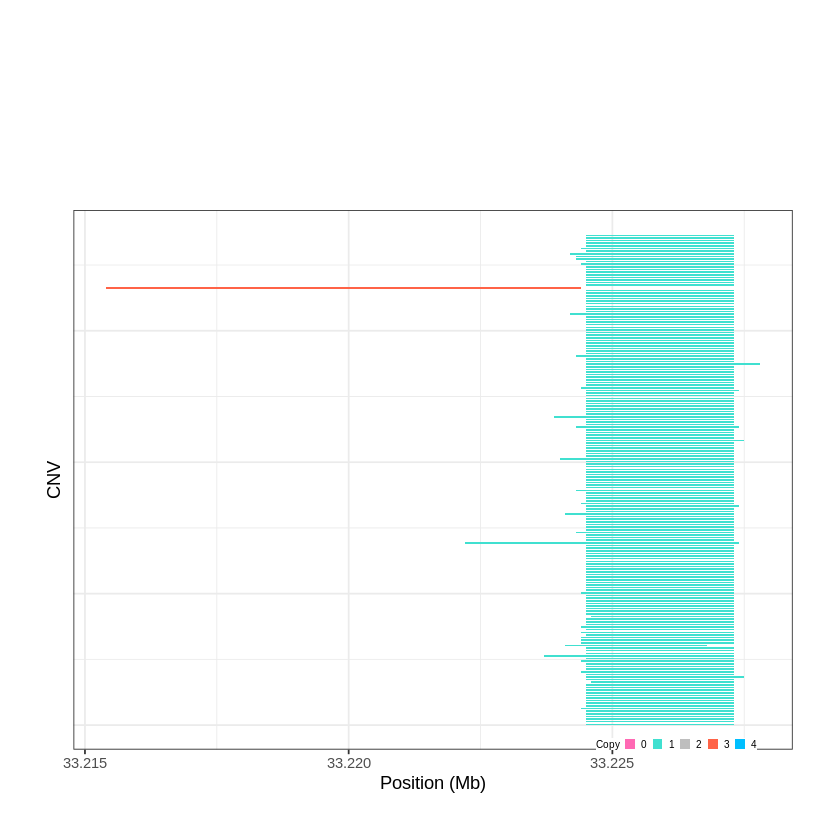

Task done, plot was stored in working directory.
[1] "Ploting CNVR 226..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 36.167701 - 36.186 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


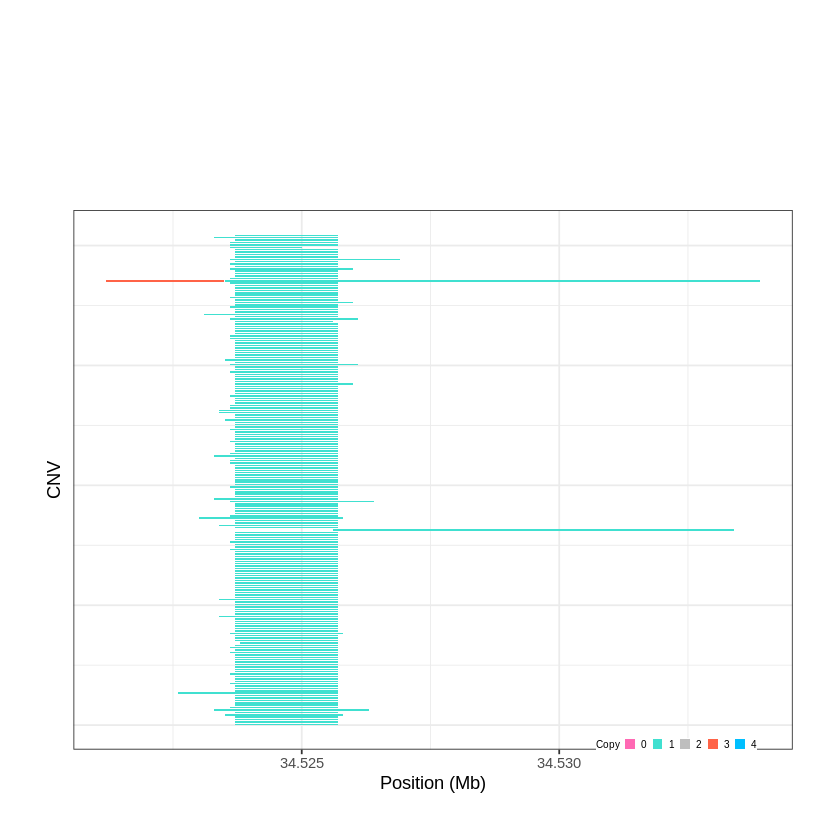

Task done, plot was stored in working directory.
[1] "Ploting CNVR 227..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 36.215001 - 36.2305 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


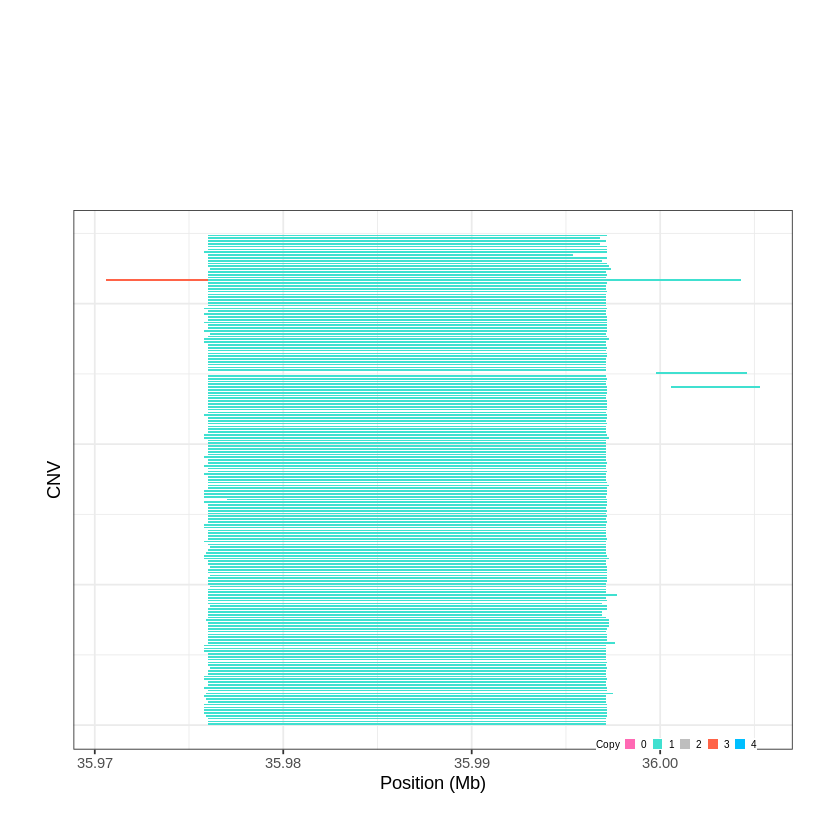

Task done, plot was stored in working directory.
[1] "Ploting CNVR 228..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 36.330101 - 36.3488 Mb with 208 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


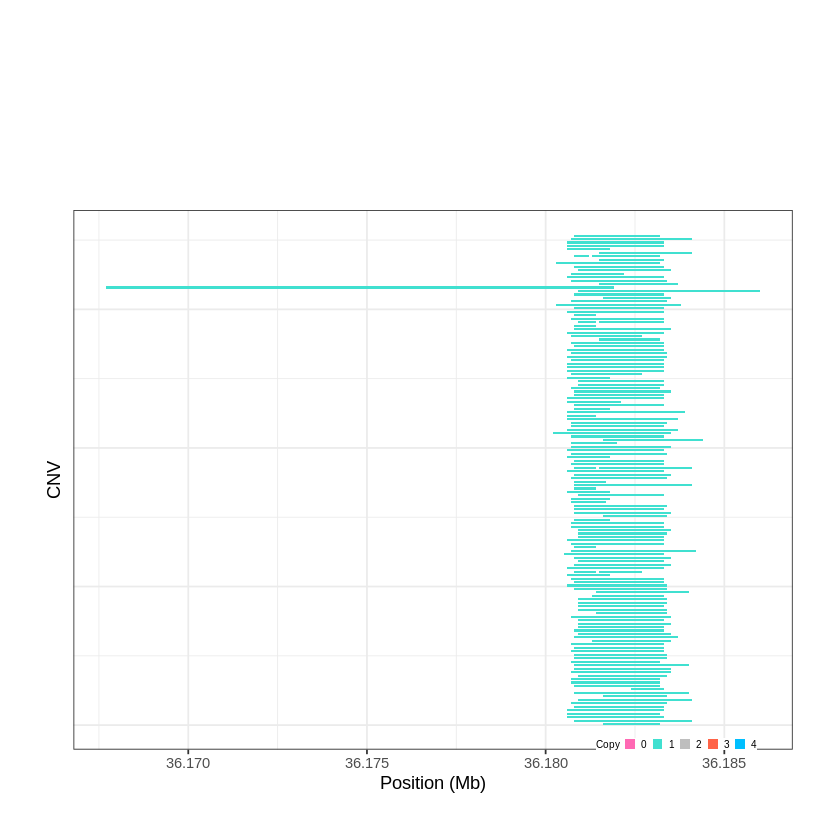

Task done, plot was stored in working directory.
[1] "Ploting CNVR 229..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 36.406301 - 36.4301 Mb with 274 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


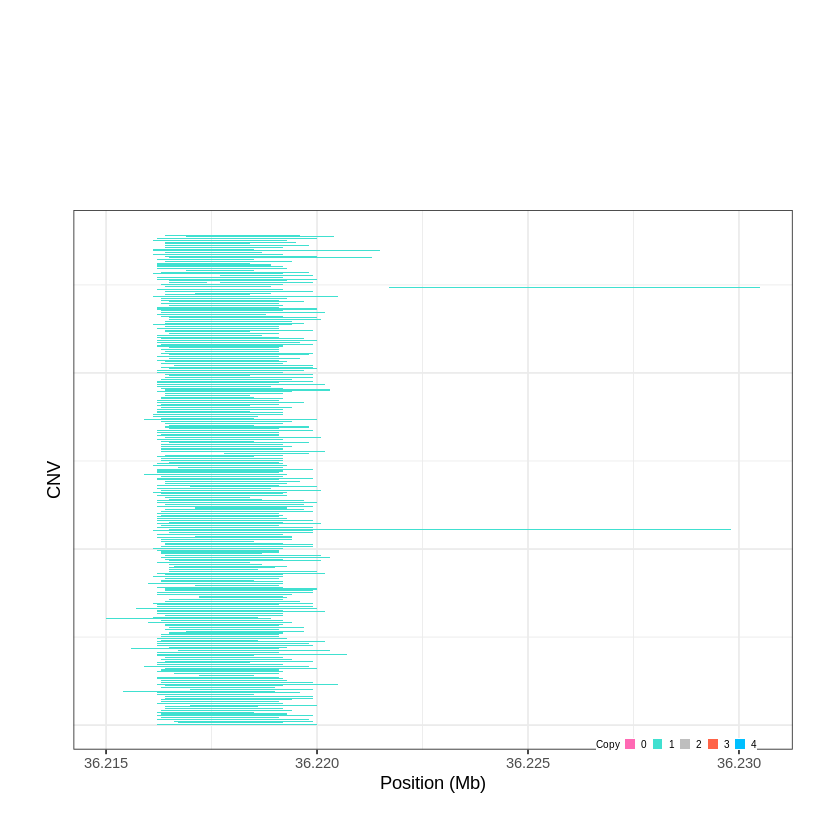

Task done, plot was stored in working directory.
[1] "Ploting CNVR 230..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 41.960701 - 41.9865 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


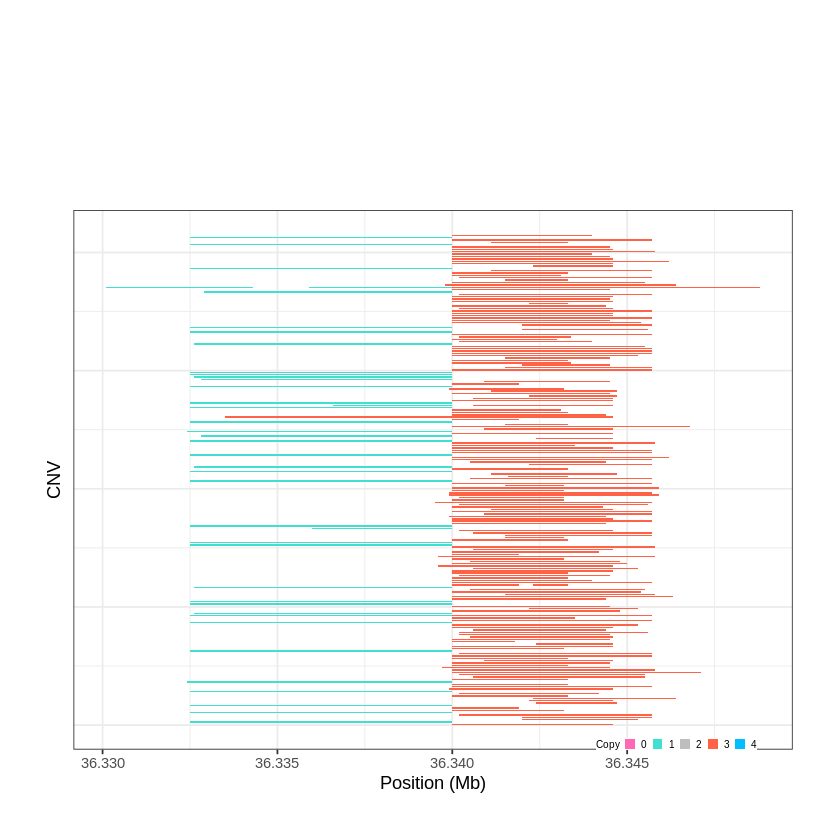

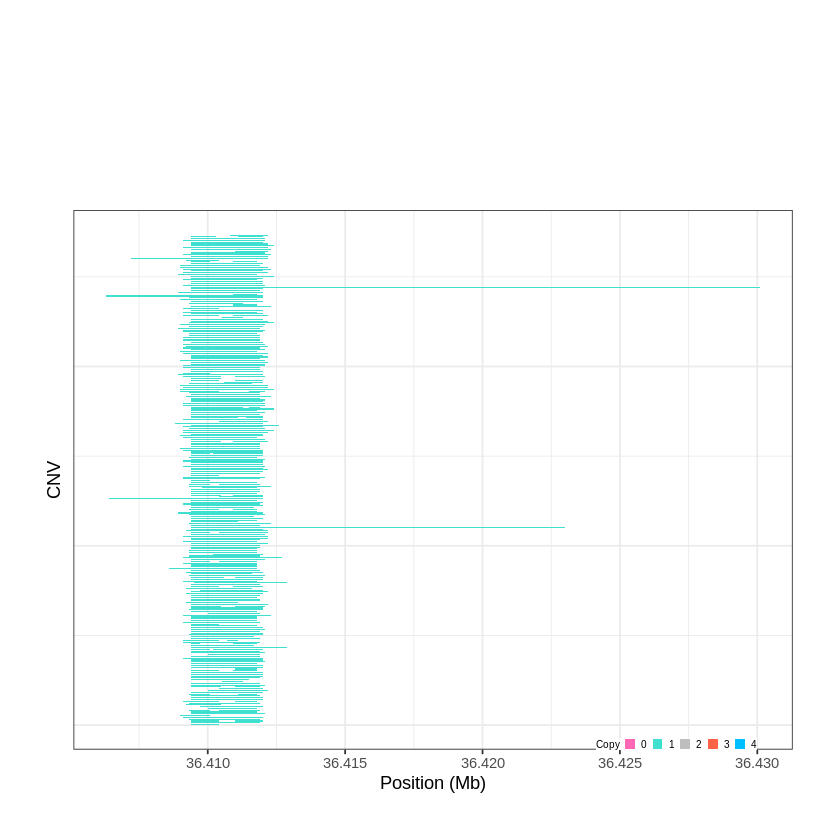

Task done, plot was stored in working directory.
[1] "Ploting CNVR 231..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 41.986501 - 42.2453 Mb with 225 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 232..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 43.869001 - 43.923 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


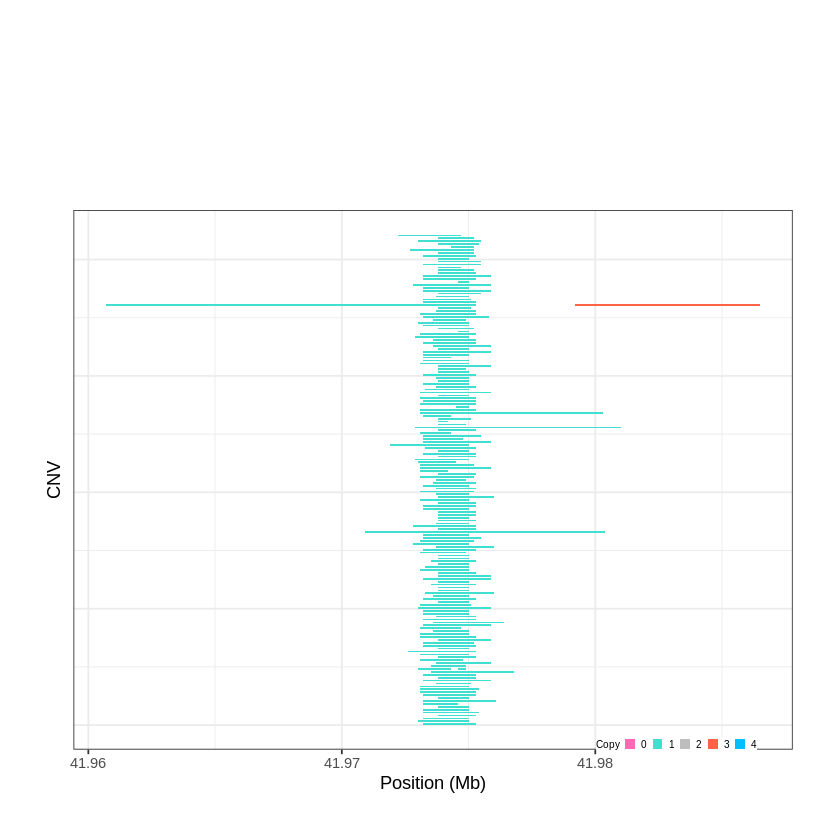

Task done, plot was stored in working directory.
[1] "Ploting CNVR 233..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 44.800301 - 44.8306 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


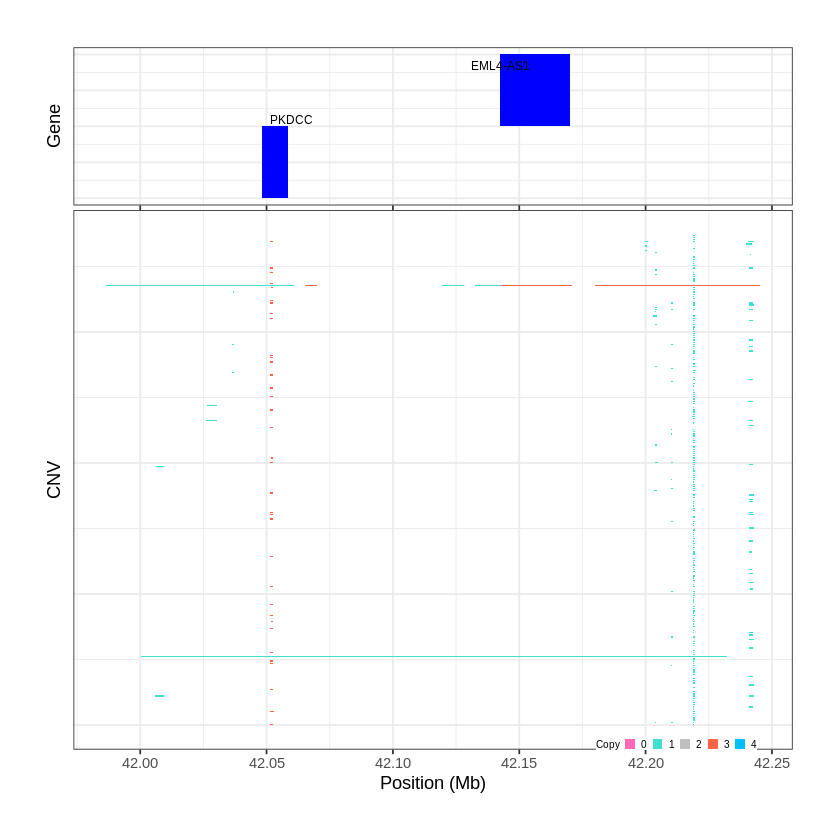

Task done, plot was stored in working directory.
[1] "Ploting CNVR 234..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 48.780801 - 48.7852 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


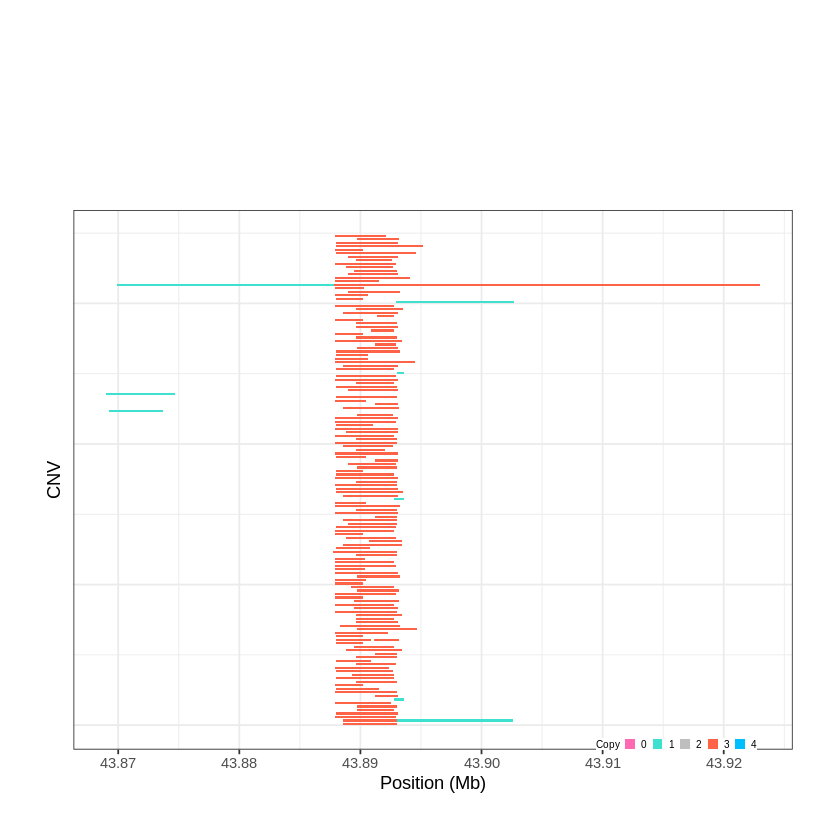

Task done, plot was stored in working directory.
[1] "Ploting CNVR 235..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 49.593501 - 49.6138 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


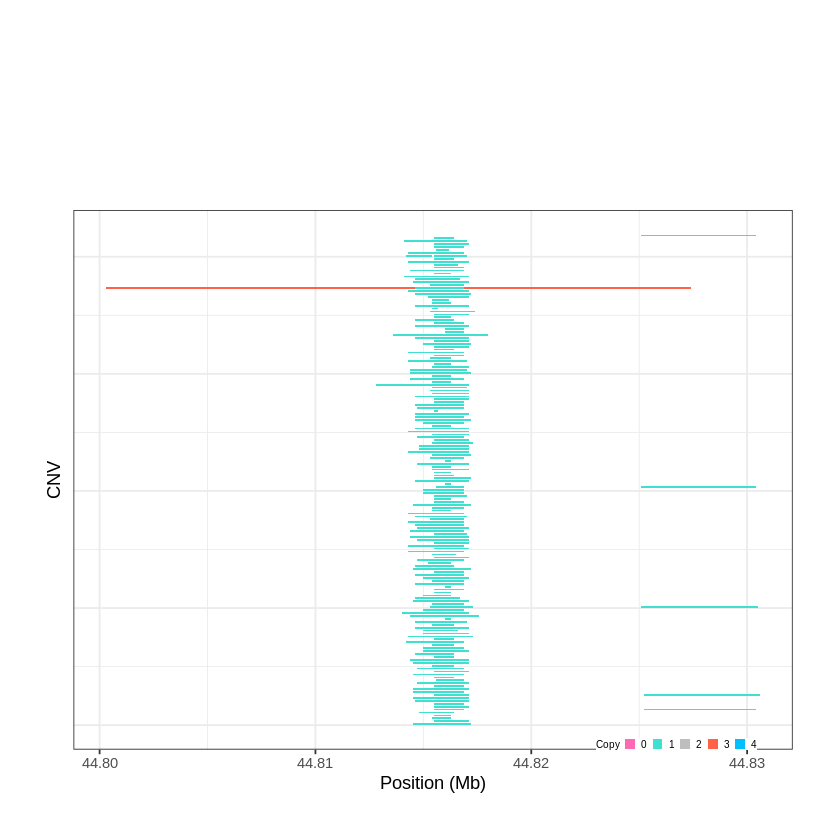

Task done, plot was stored in working directory.
[1] "Ploting CNVR 236..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 54.049401 - 54.0892 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


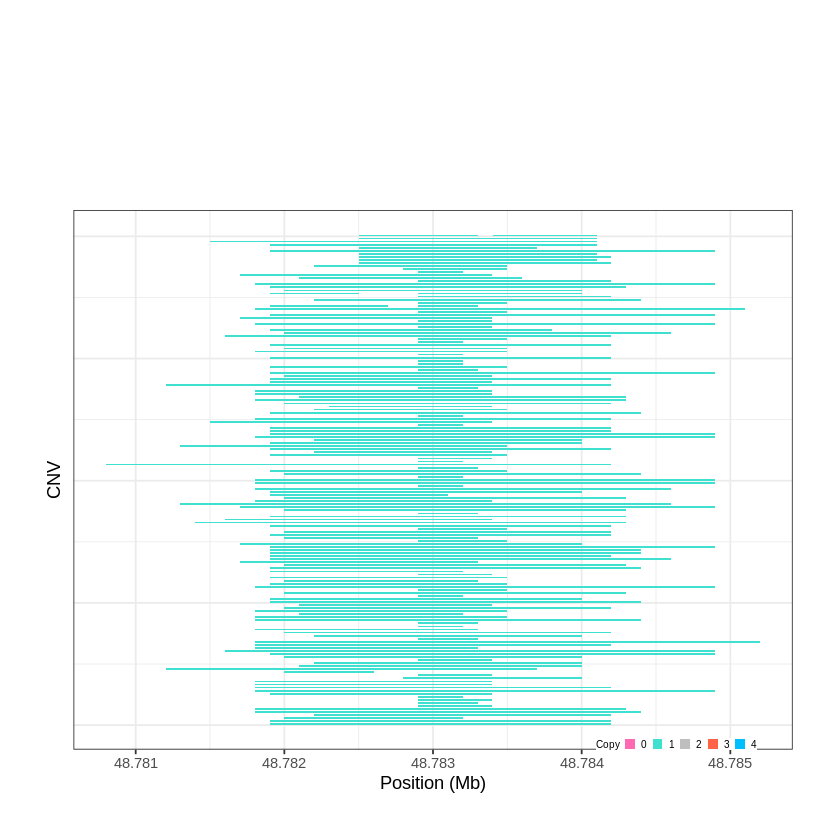

Task done, plot was stored in working directory.
[1] "Ploting CNVR 237..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 54.564301 - 54.5755 Mb with 208 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


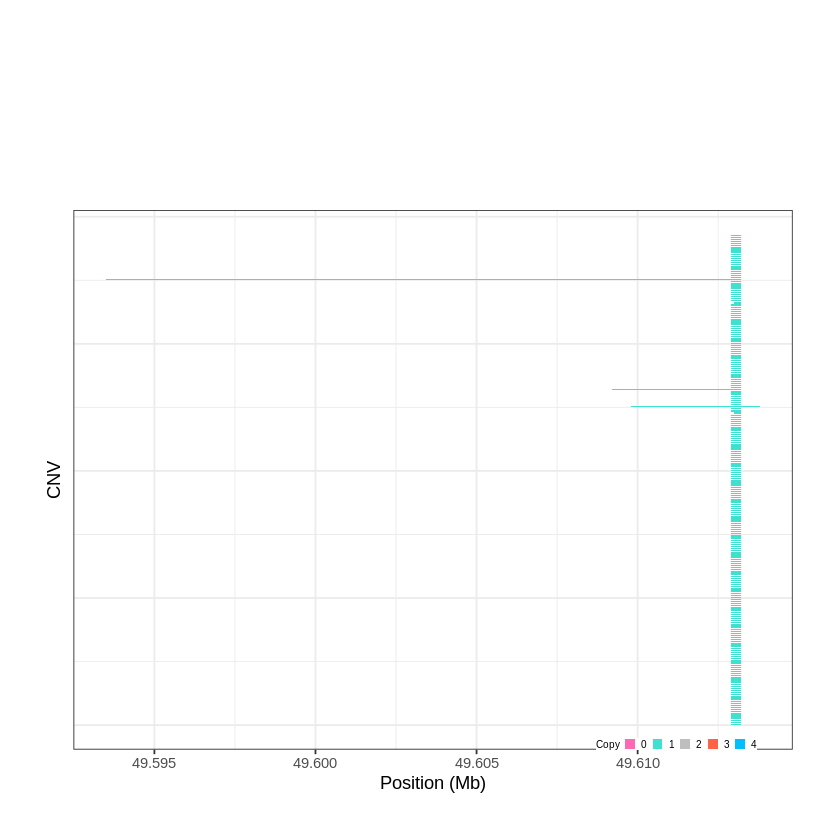

Task done, plot was stored in working directory.
[1] "Ploting CNVR 238..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 56.606101 - 56.6618 Mb with 207 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


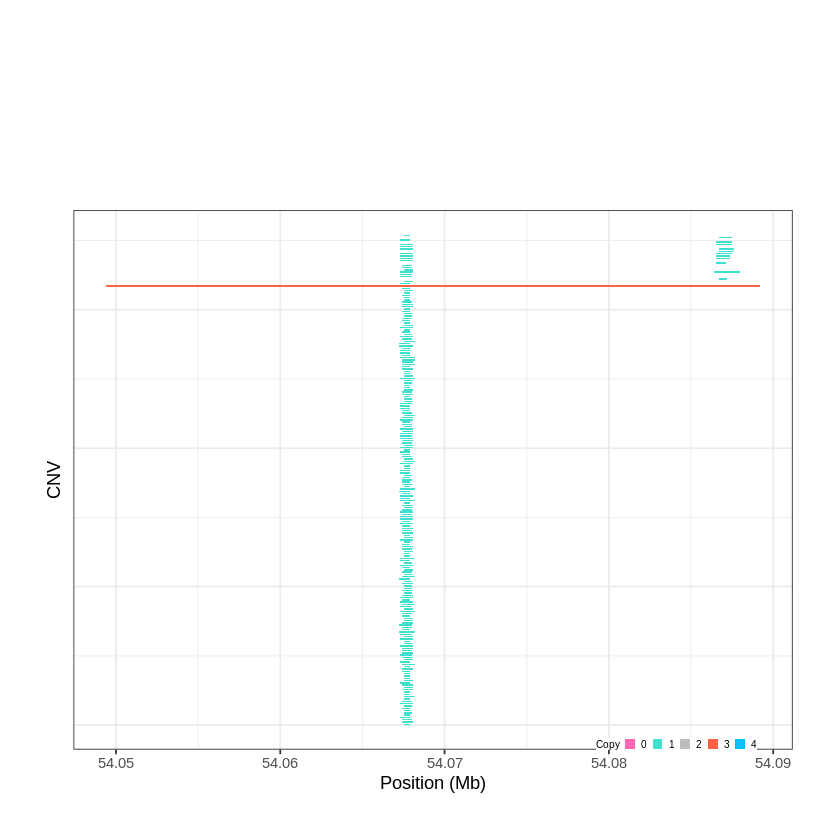

Task done, plot was stored in working directory.
[1] "Ploting CNVR 239..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 57.395901 - 57.4577 Mb with 275 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


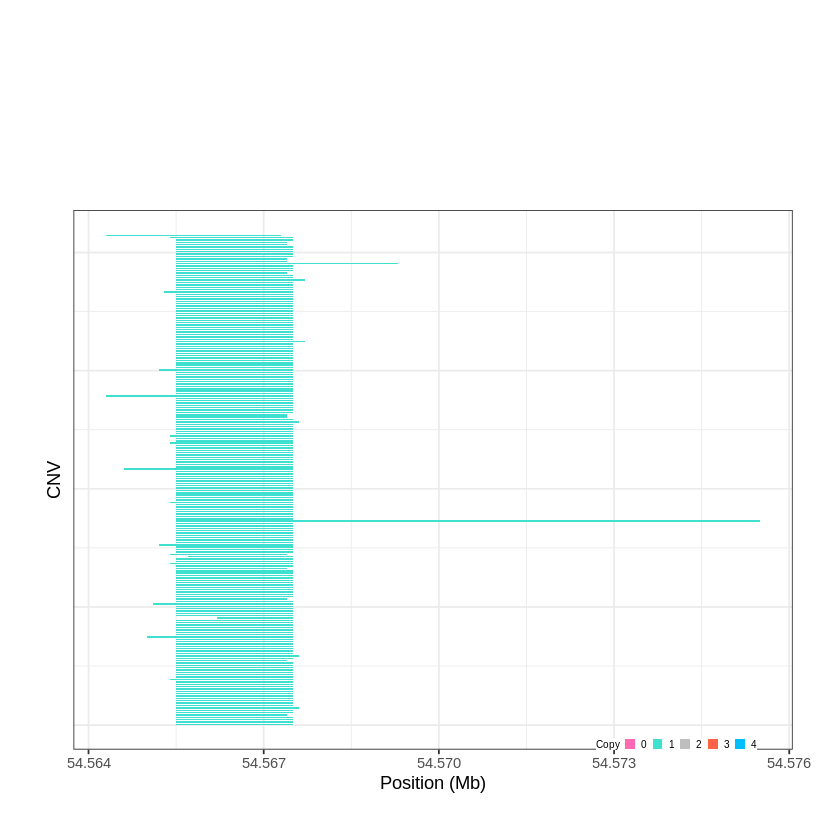

Task done, plot was stored in working directory.
[1] "Ploting CNVR 240..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 64.728501 - 64.74 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


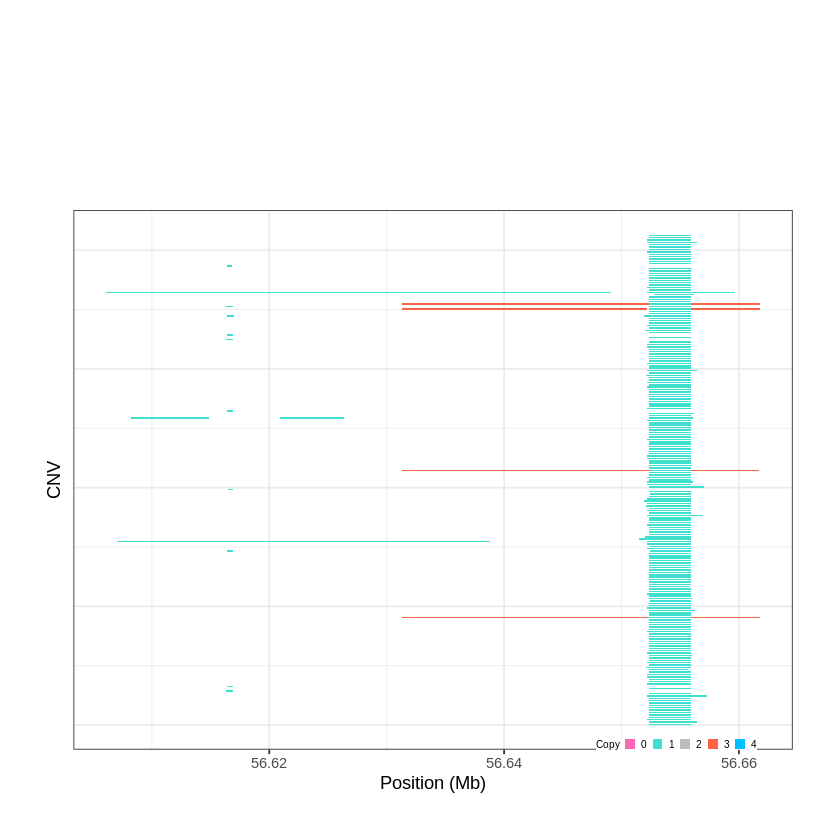

Task done, plot was stored in working directory.
[1] "Ploting CNVR 241..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 68.671101 - 68.6807 Mb with 254 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


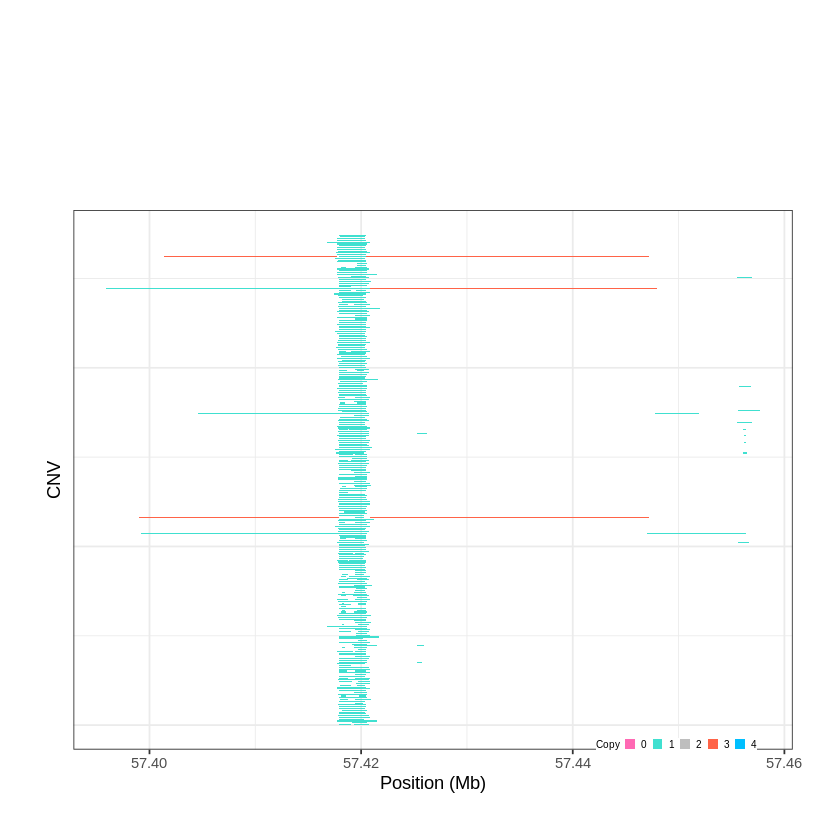

Task done, plot was stored in working directory.
[1] "Ploting CNVR 242..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 73.994301 - 74.0369 Mb with 251 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


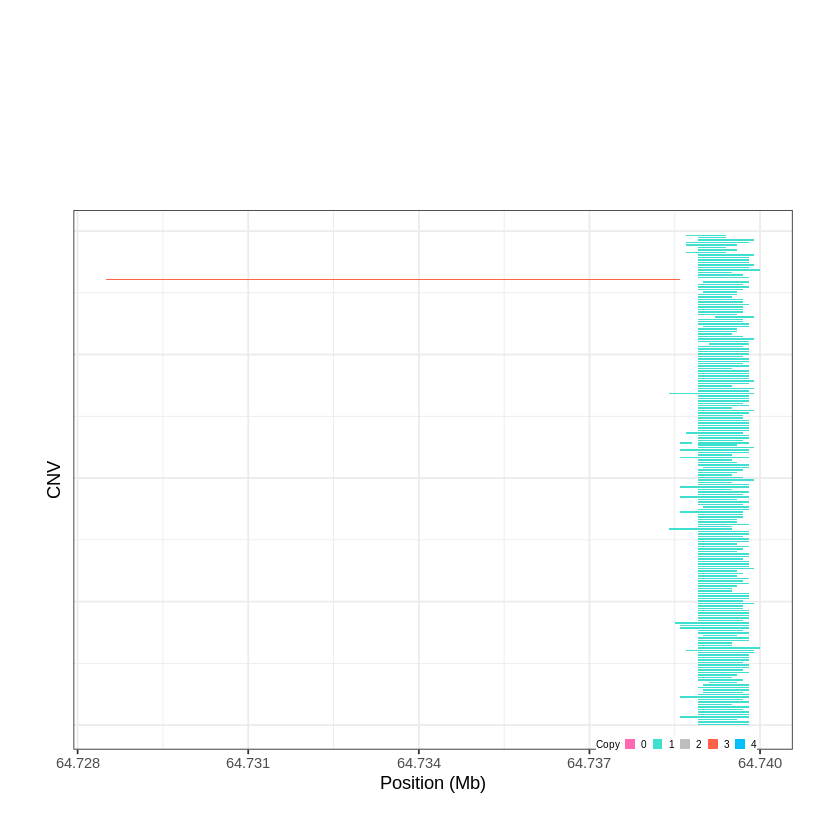

Task done, plot was stored in working directory.
[1] "Ploting CNVR 243..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 76.746401 - 76.7889 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


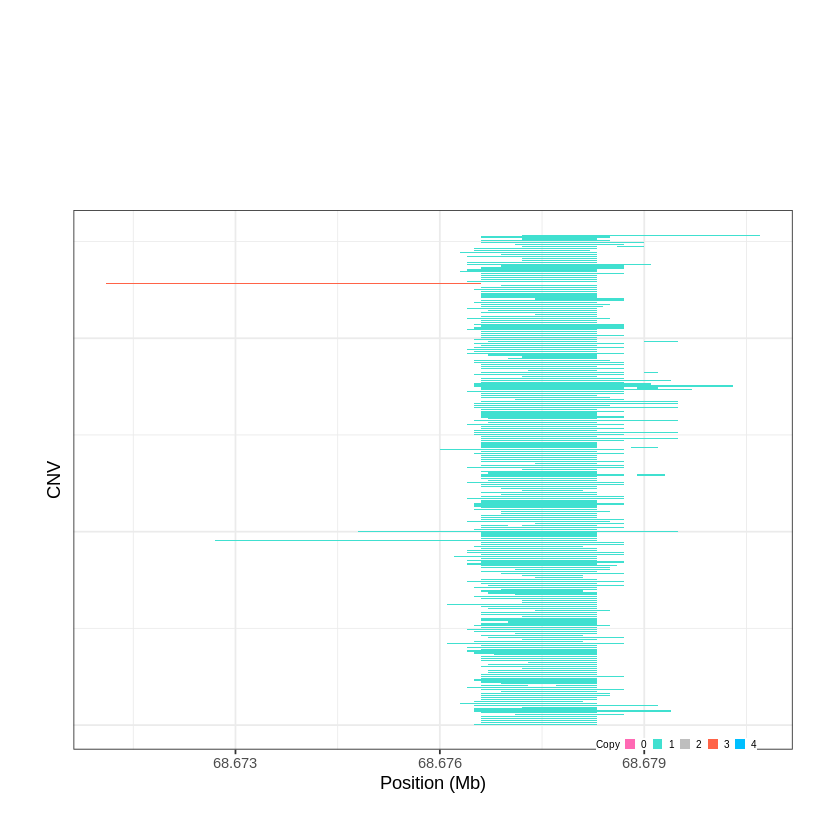

Task done, plot was stored in working directory.
[1] "Ploting CNVR 244..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 82.494401 - 82.5649 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


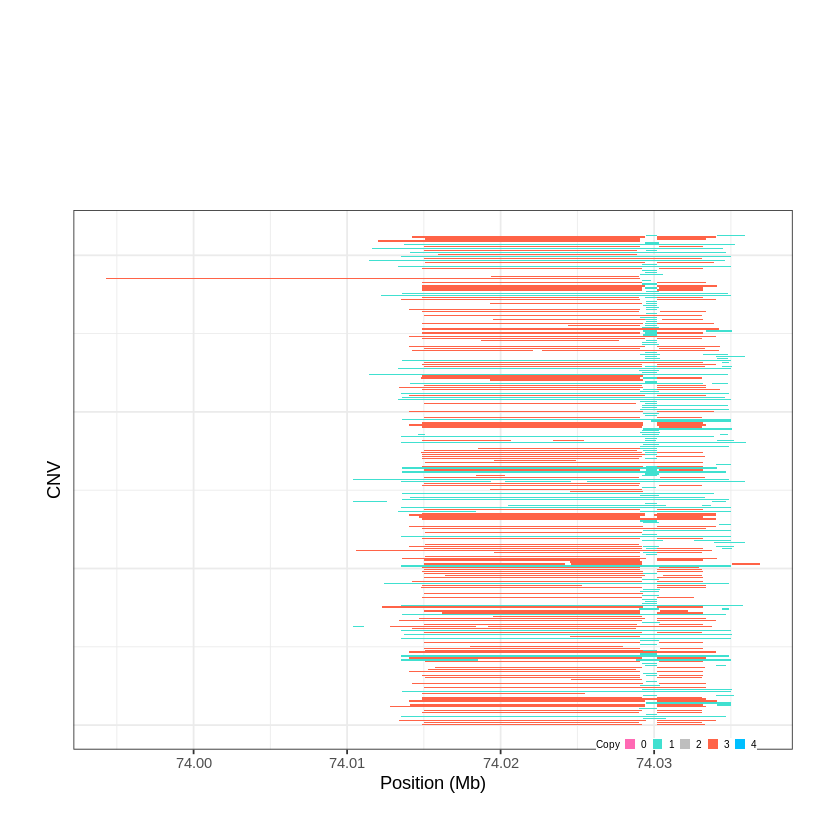

Task done, plot was stored in working directory.
[1] "Ploting CNVR 245..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 83.992001 - 84.0114 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


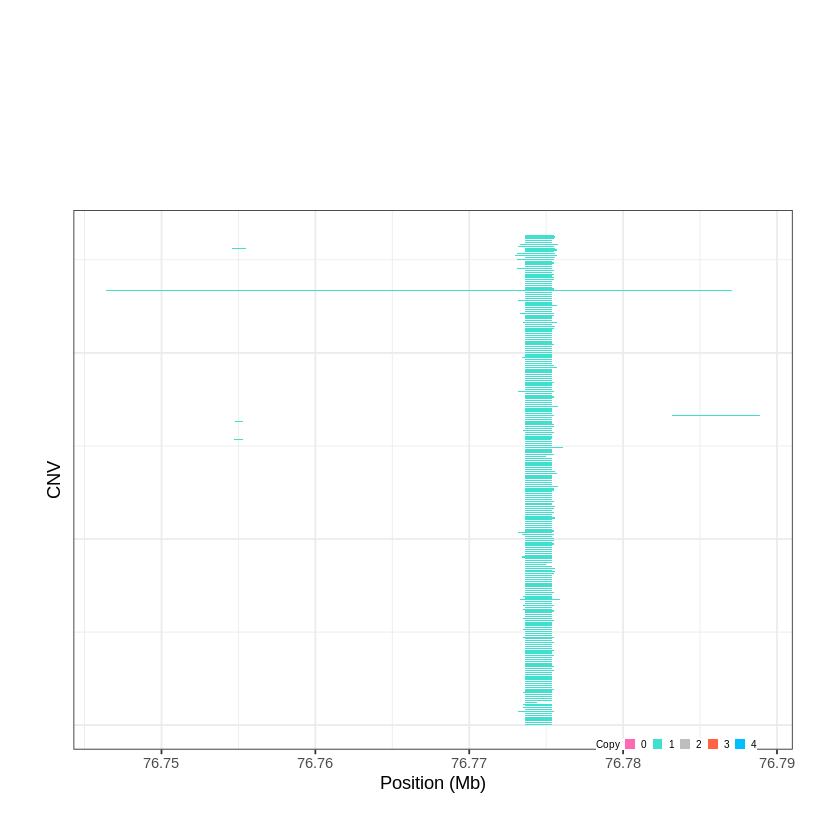

Task done, plot was stored in working directory.
[1] "Ploting CNVR 246..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 84.746701 - 84.7791 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


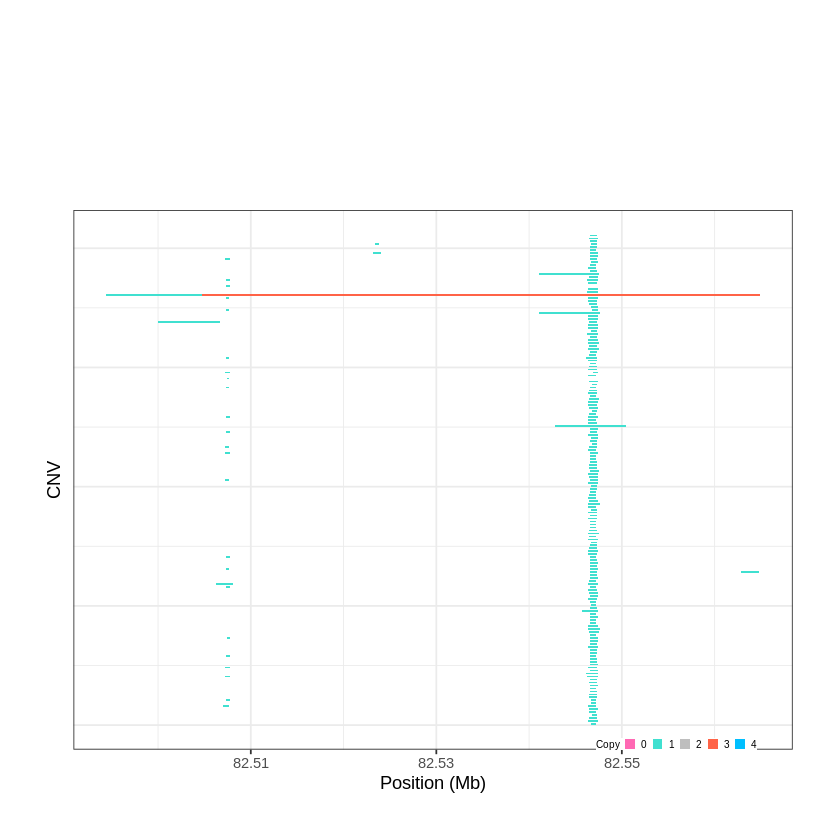

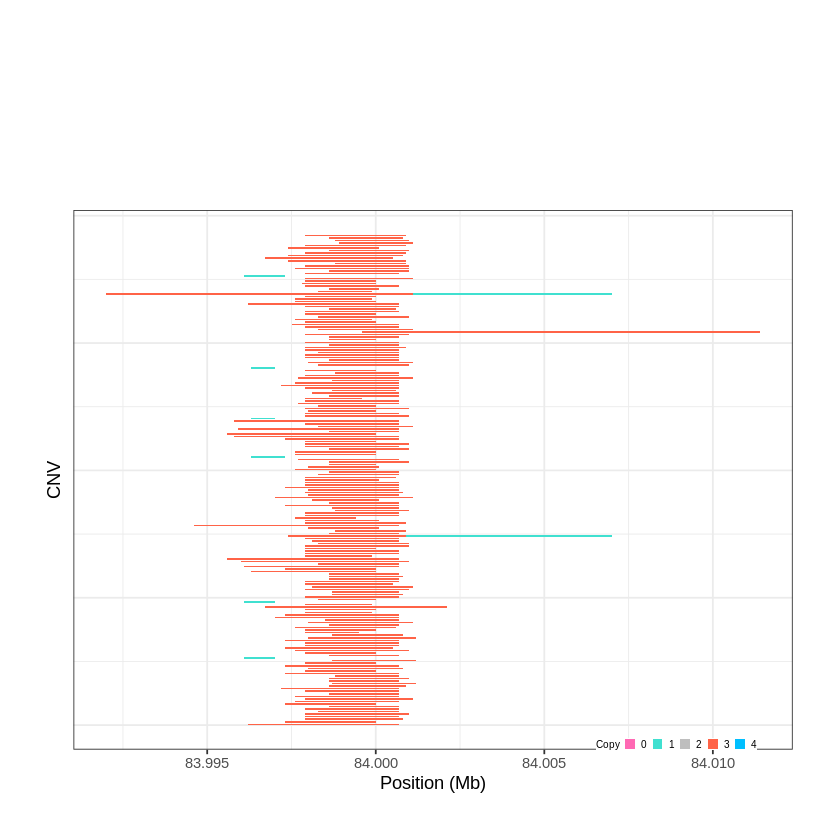

Task done, plot was stored in working directory.
[1] "Ploting CNVR 247..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 85.273801 - 85.6814 Mb with 171 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 248..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 86.881501 - 86.8967 Mb with 248 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


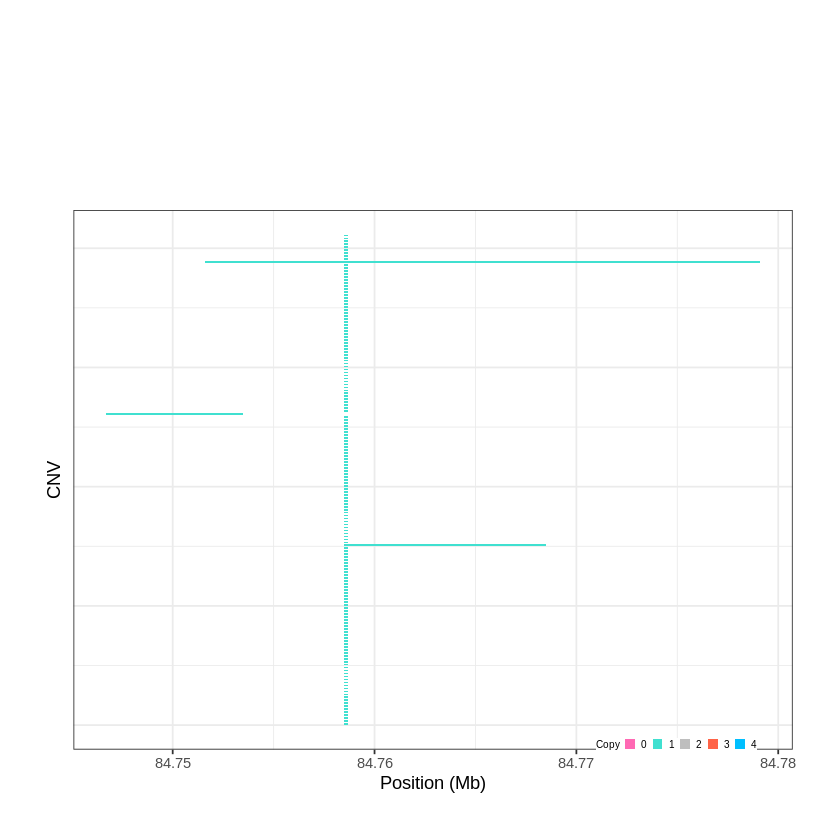

Task done, plot was stored in working directory.
[1] "Ploting CNVR 249..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 86.908501 - 86.9686 Mb with 208 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


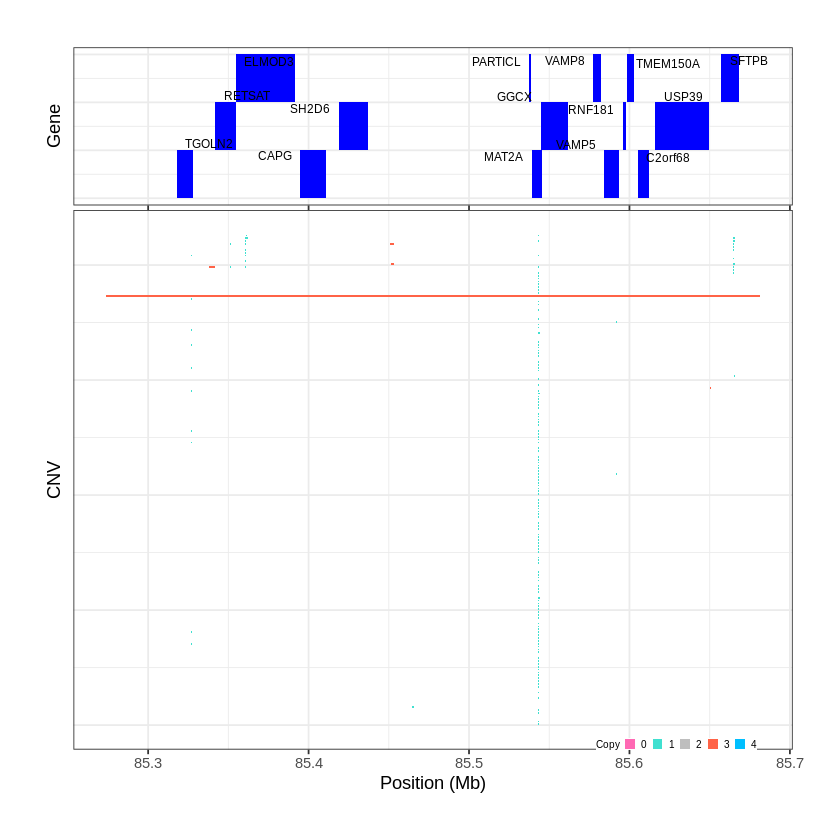

Task done, plot was stored in working directory.
[1] "Ploting CNVR 250..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 87.108101 - 87.1546 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


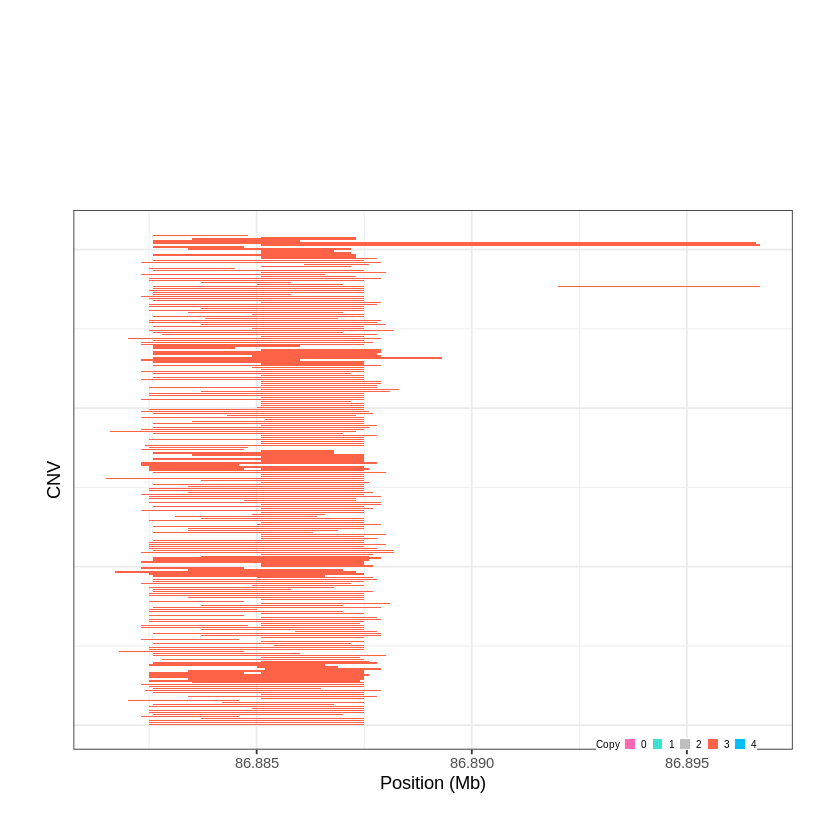

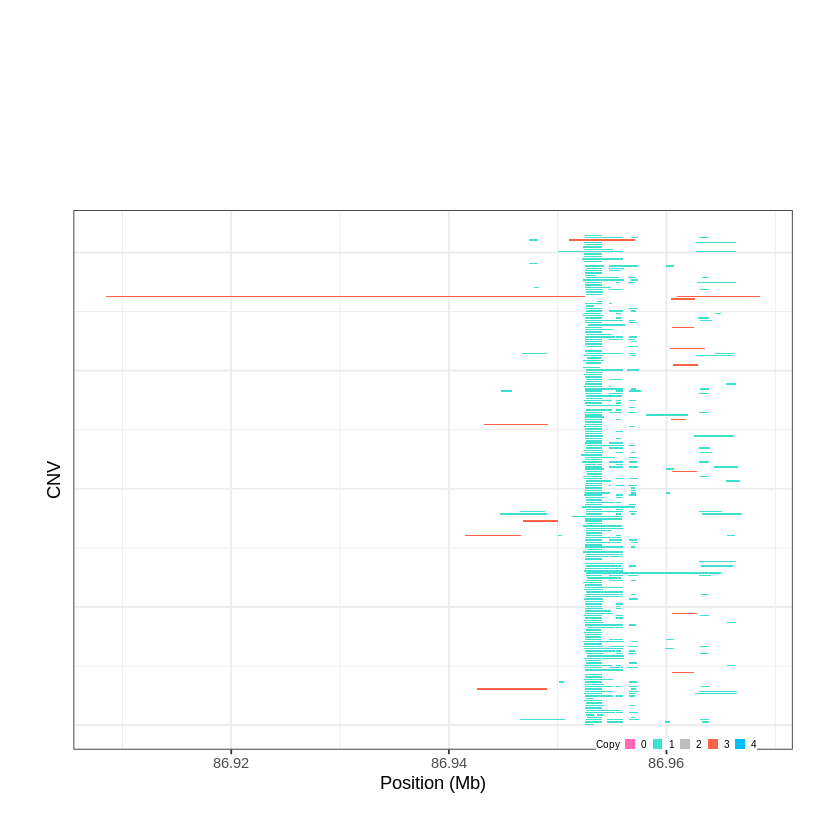

Task done, plot was stored in working directory.
[1] "Ploting CNVR 251..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 87.275001 - 88.0311 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 252..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 89.025801 - 89.0352 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


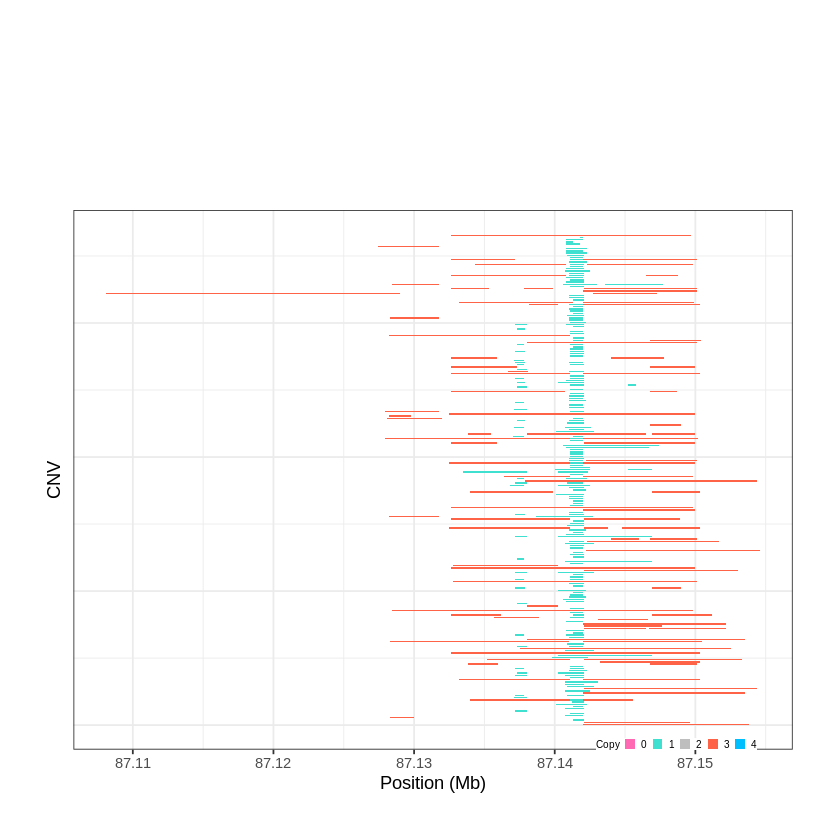

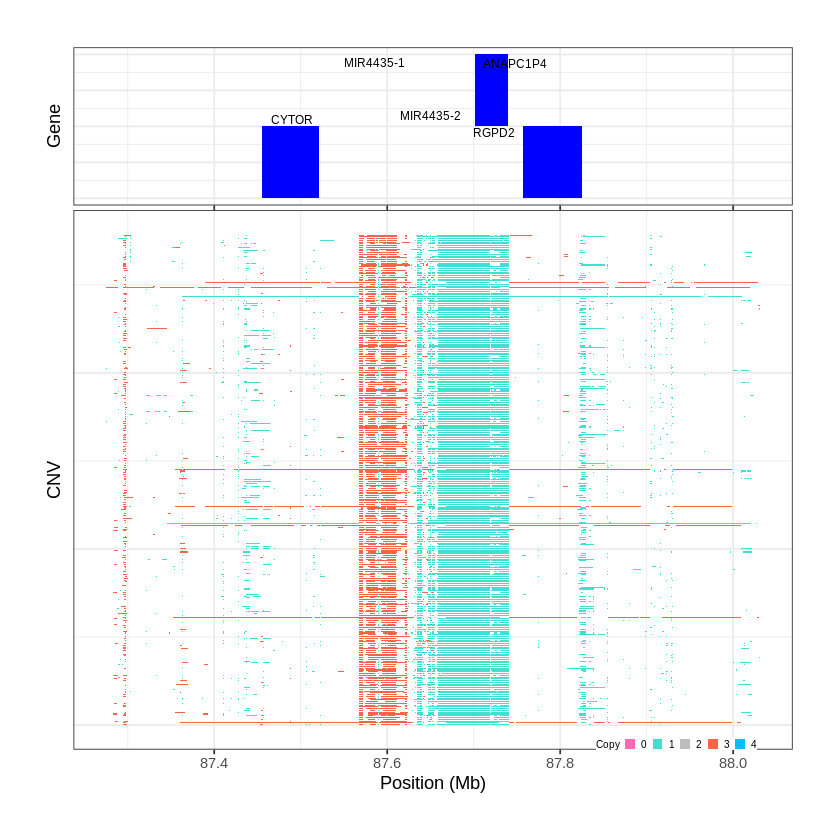

Task done, plot was stored in working directory.
[1] "Ploting CNVR 253..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 89.118101 - 91.9538 Mb with 279 Individual - "
Plotting gene...


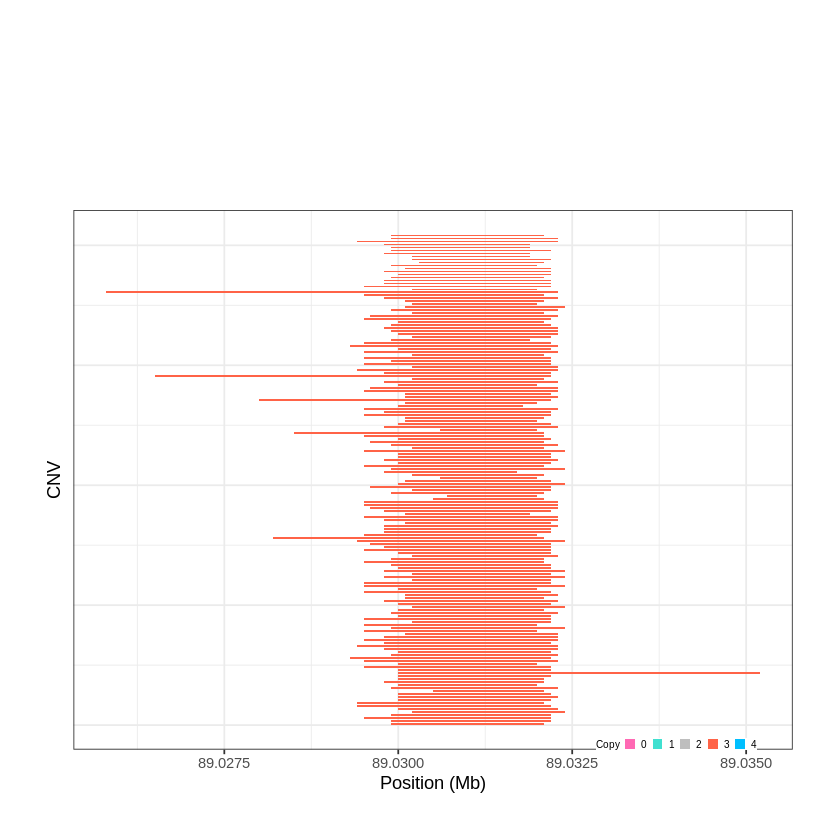

Task done, plot was stored in working directory.
[1] "Ploting CNVR 254..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 91.955301 - 95.3268 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 255..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 96.546401 - 96.6129 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


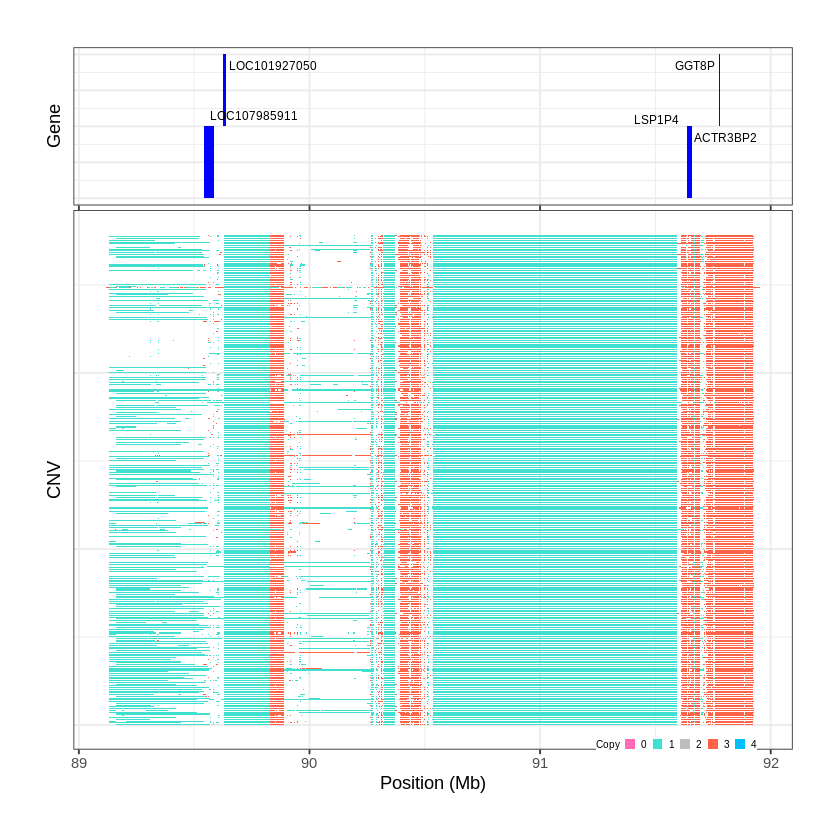

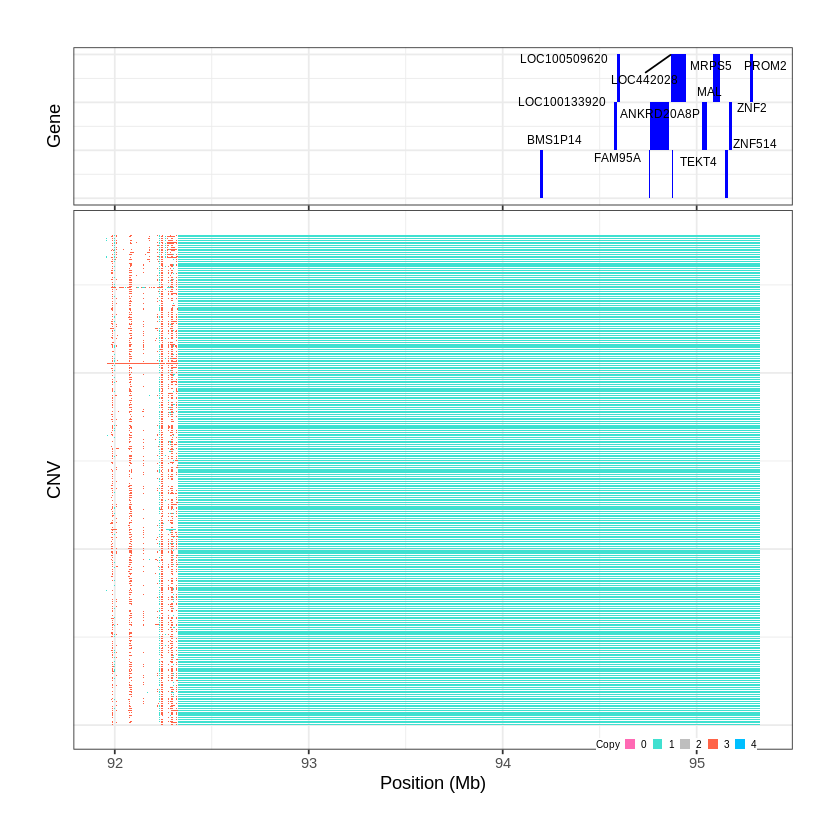

Task done, plot was stored in working directory.
[1] "Ploting CNVR 256..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 96.706501 - 96.8456 Mb with 166 Individual - "
Plotting gene...


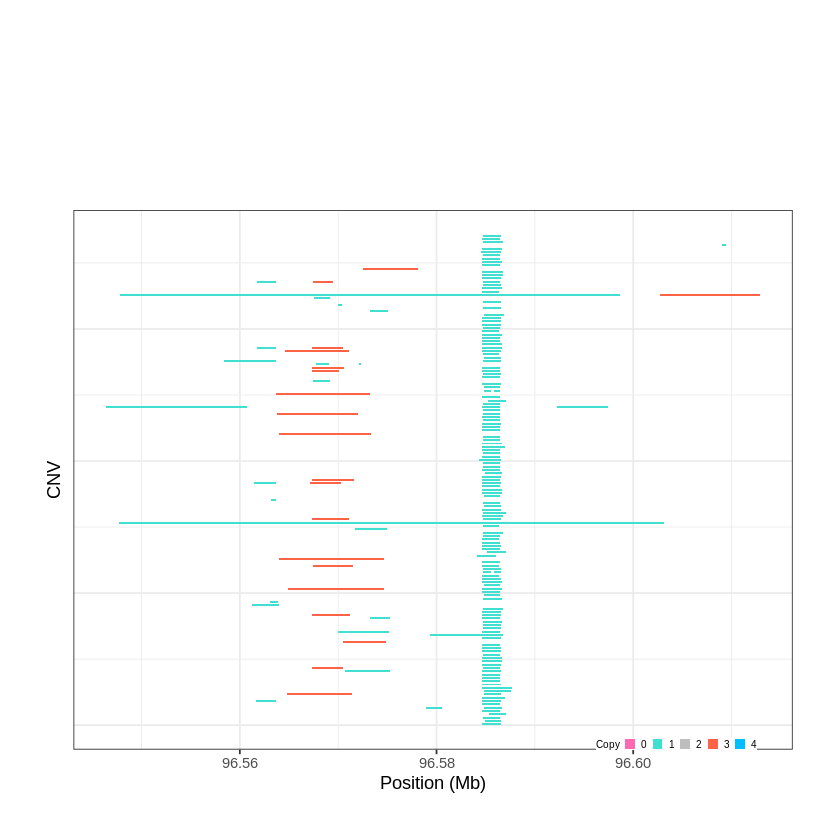

Task done, plot was stored in working directory.
[1] "Ploting CNVR 257..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 97.298701 - 97.6823 Mb with 227 Individual - "
Plotting gene...


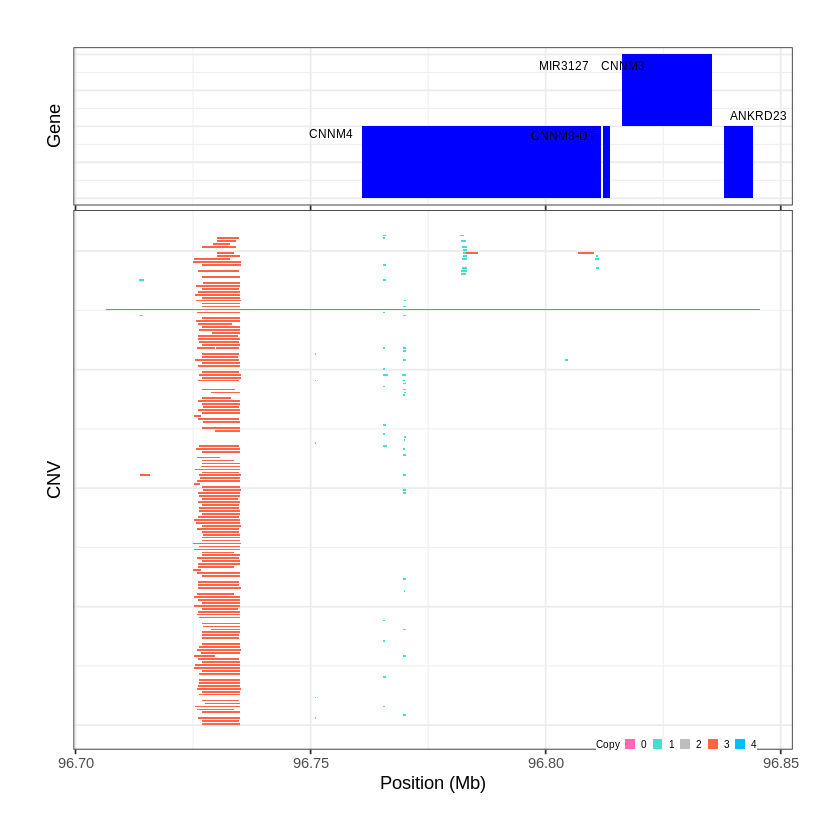

Task done, plot was stored in working directory.
[1] "Ploting CNVR 258..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 97.709101 - 98.2238 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 259..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 98.226901 - 98.2426 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


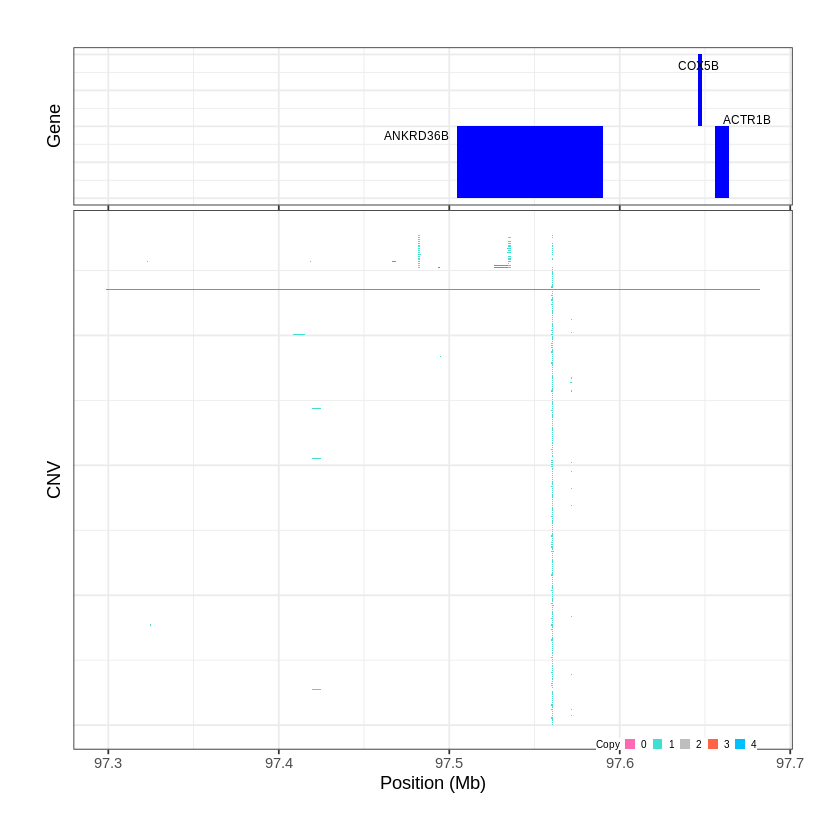

Task done, plot was stored in working directory.
[1] "Ploting CNVR 260..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 100.099401 - 100.1094 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


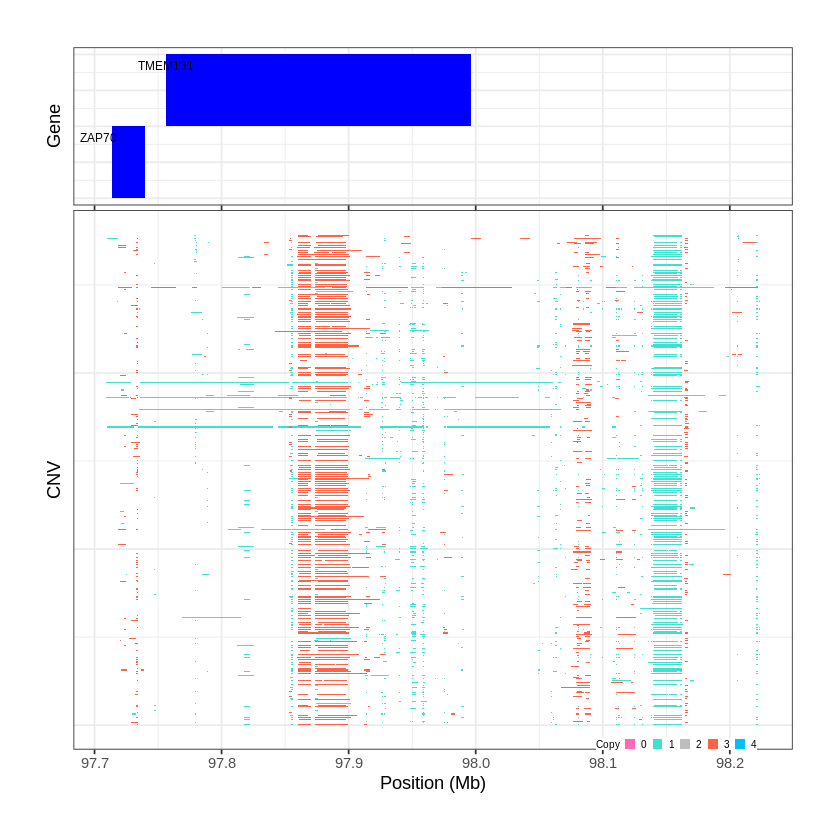

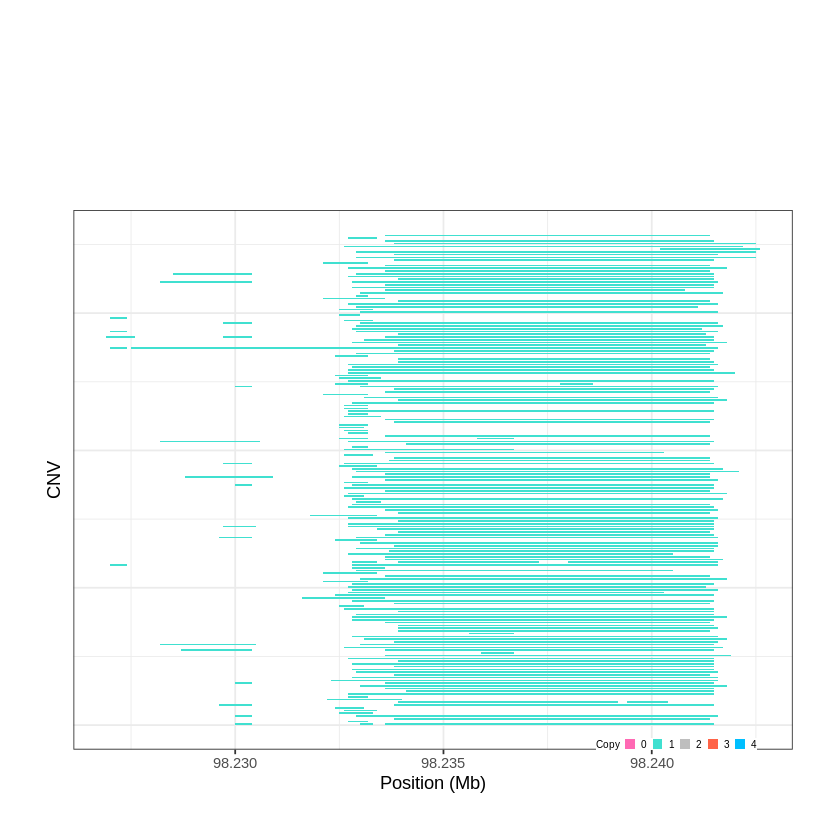

Task done, plot was stored in working directory.
[1] "Ploting CNVR 261..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 102.228101 - 102.3879 Mb with 214 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 262..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 105.822201 - 105.8295 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


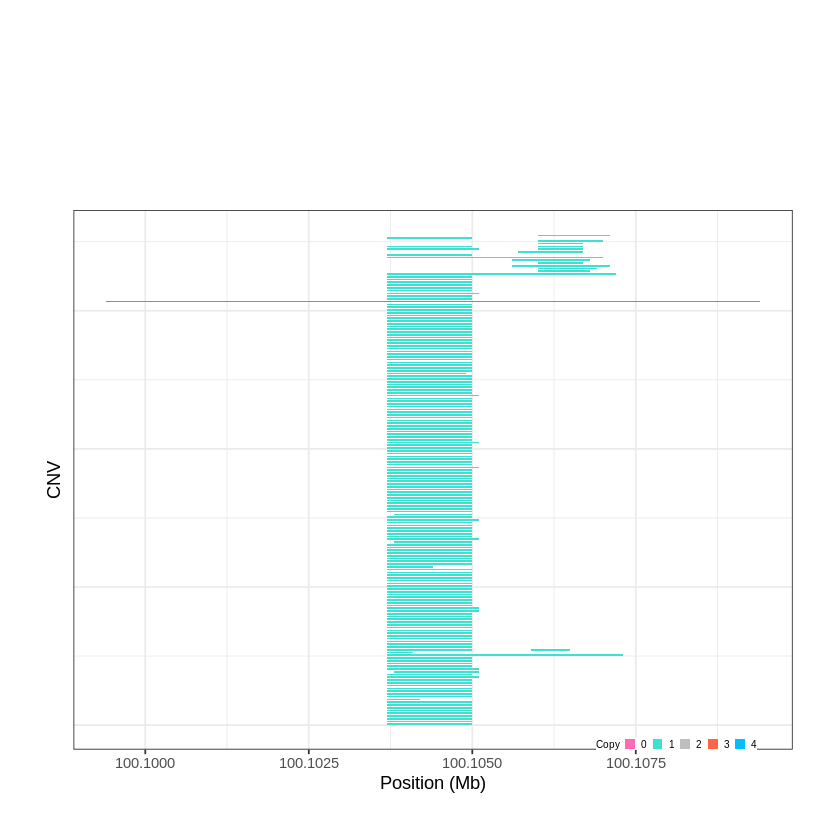

Task done, plot was stored in working directory.
[1] "Ploting CNVR 263..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 106.692901 - 106.7093 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


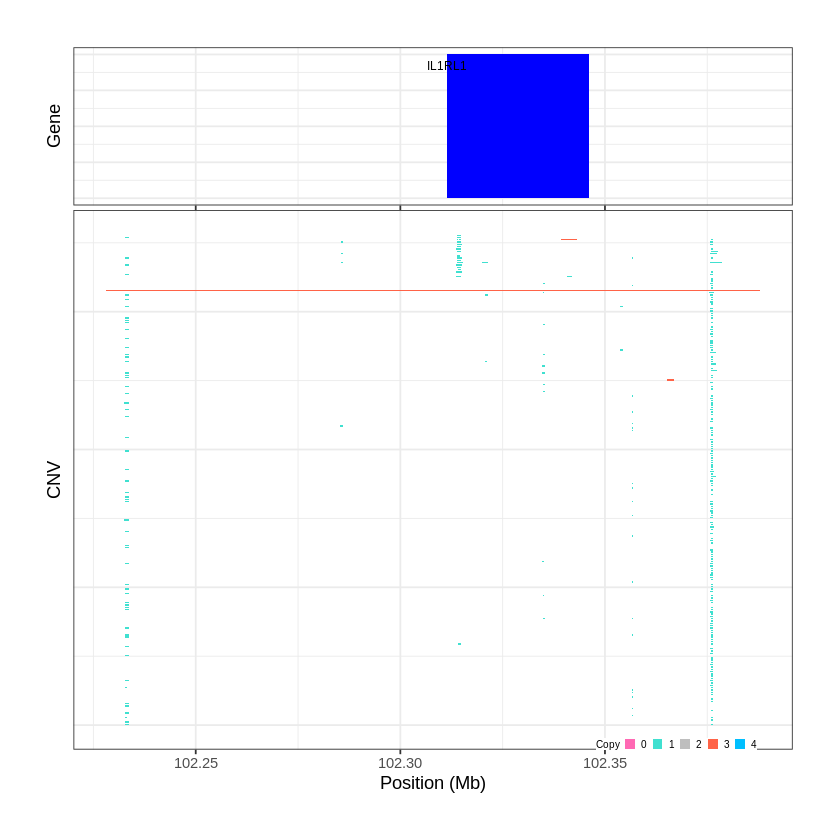

Task done, plot was stored in working directory.
[1] "Ploting CNVR 264..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 106.709301 - 106.7535 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


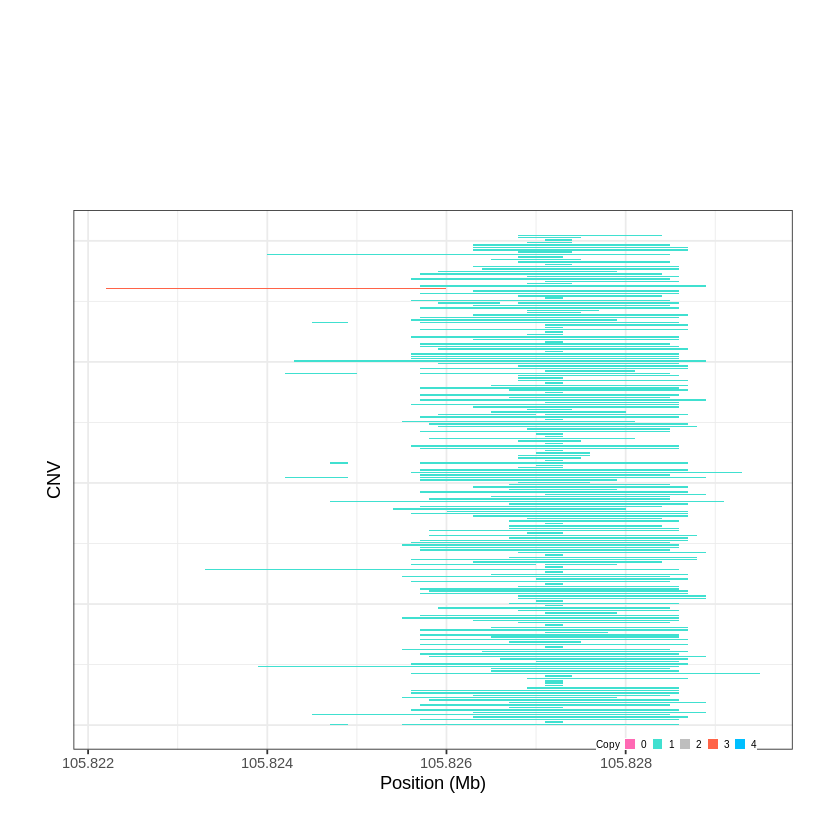

Task done, plot was stored in working directory.
[1] "Ploting CNVR 265..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 106.877901 - 106.9463 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


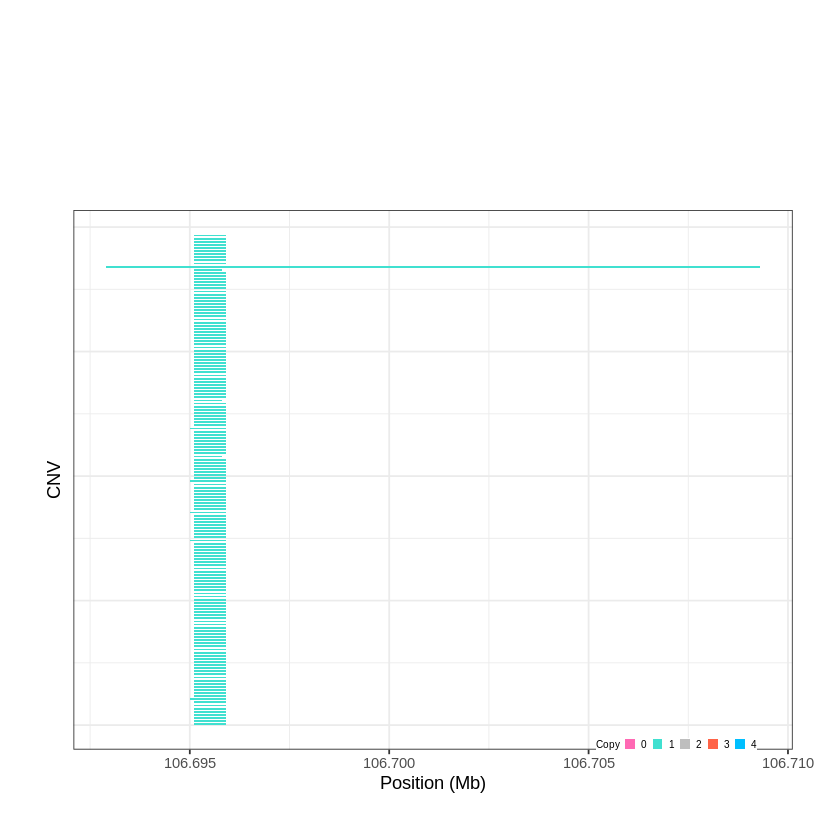

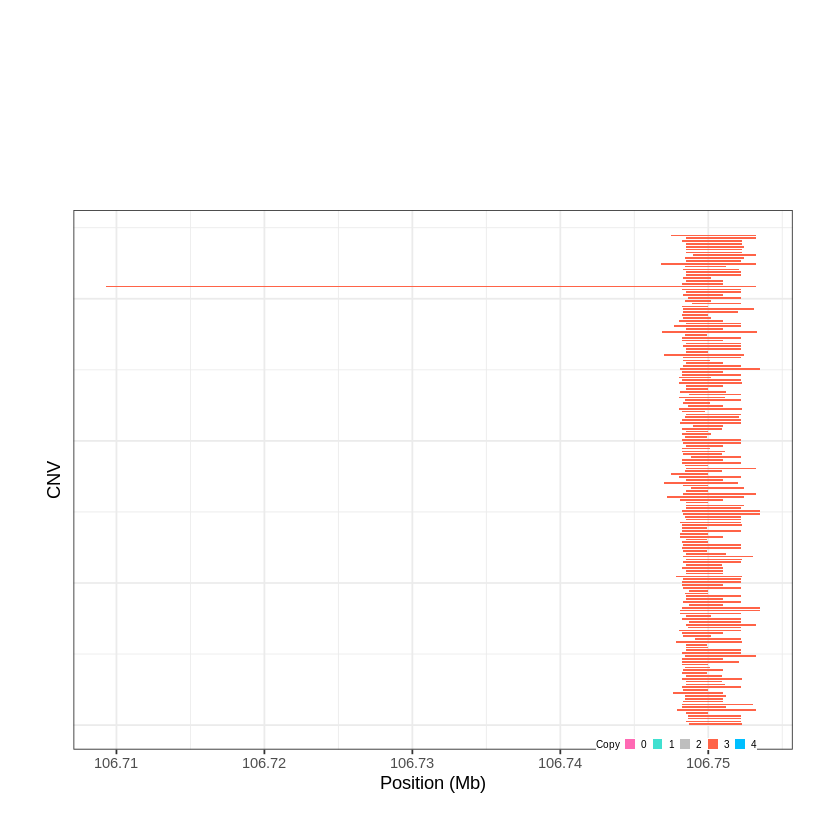

Task done, plot was stored in working directory.
[1] "Ploting CNVR 266..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 109.942401 - 110.3796 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 267..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 110.674301 - 111.074 Mb with 277 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


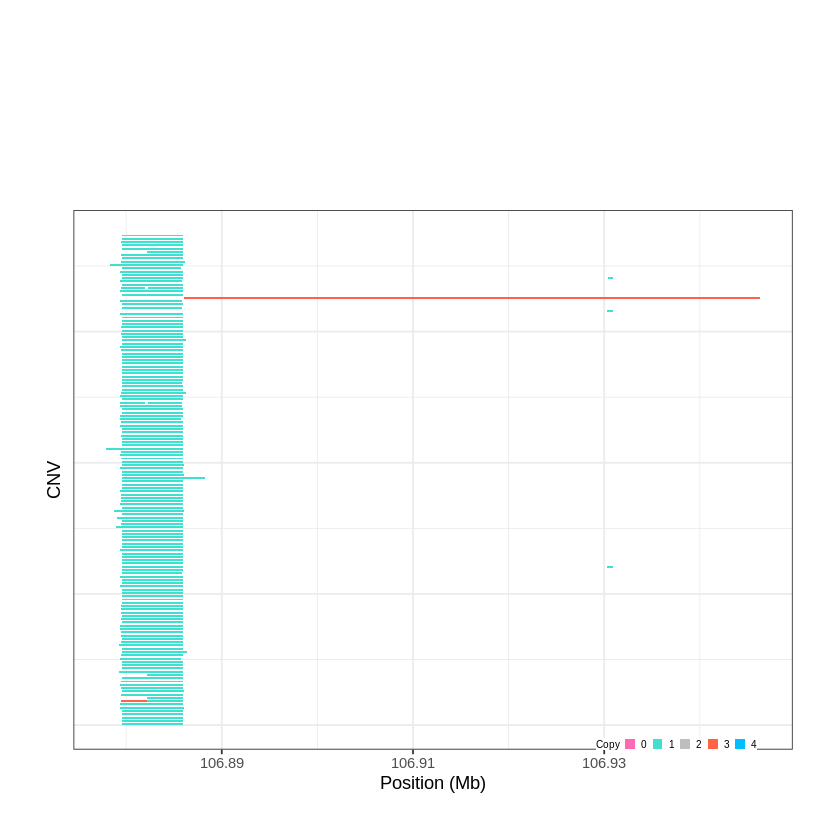

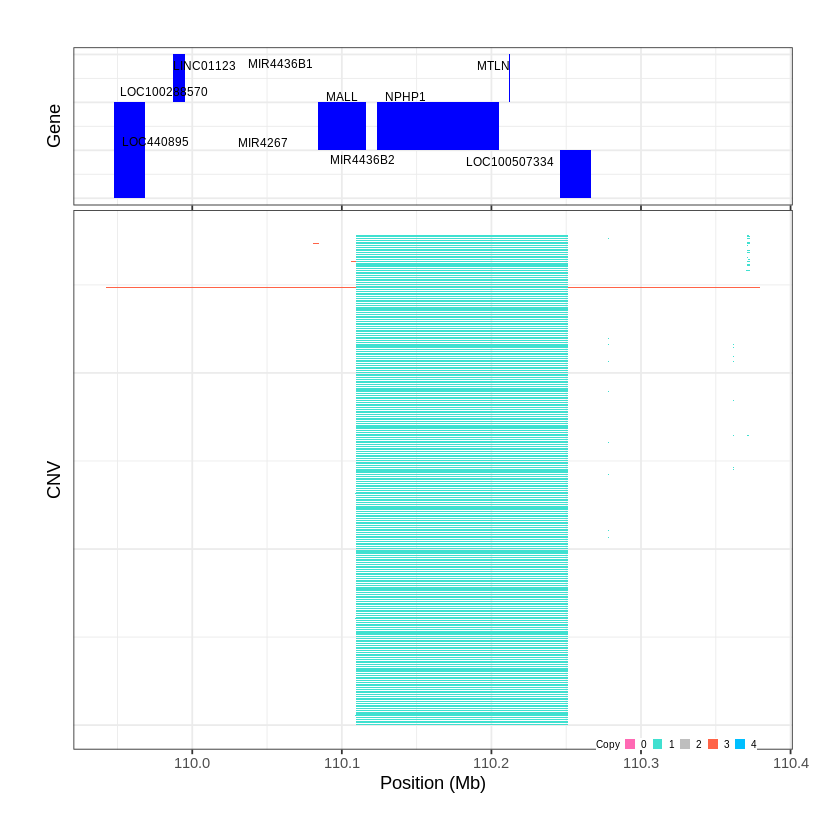

Task done, plot was stored in working directory.
[1] "Ploting CNVR 268..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 111.074001 - 111.2002 Mb with 271 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 269..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 111.344701 - 111.3947 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


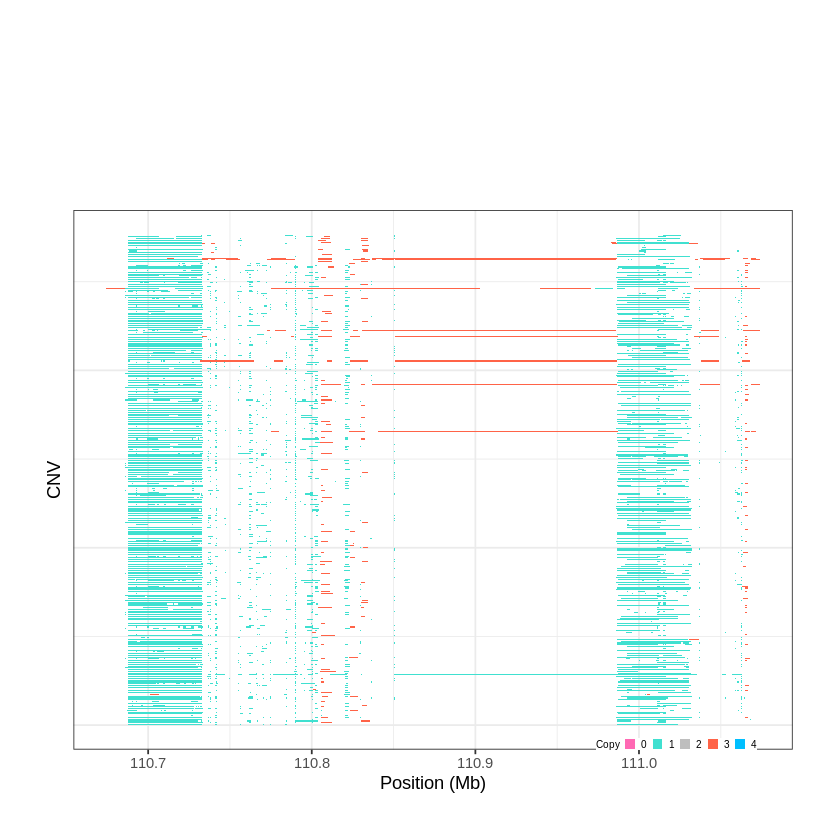

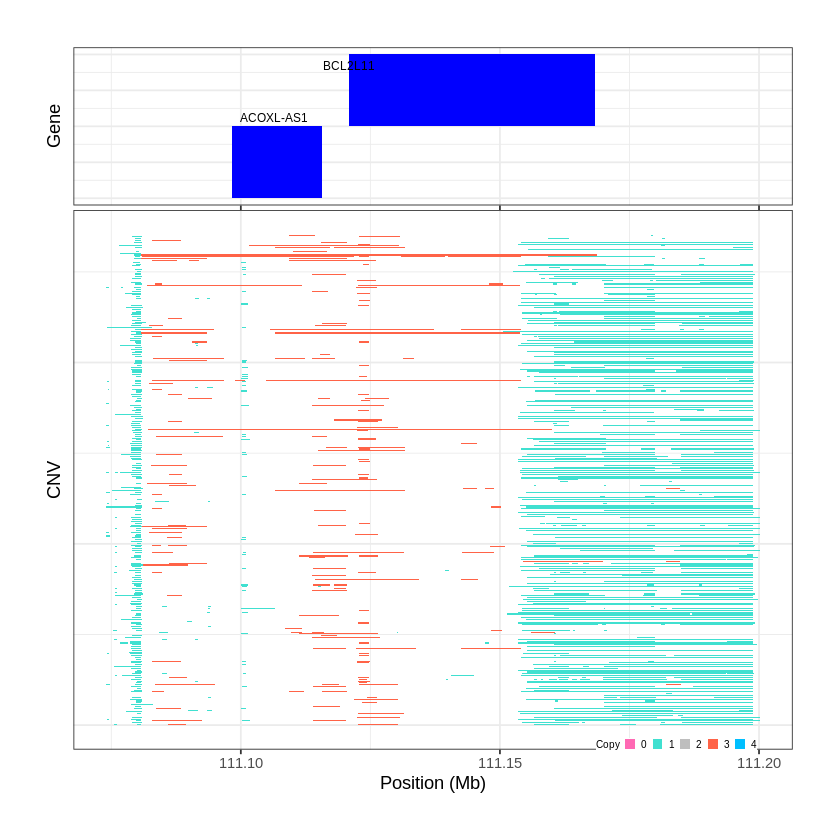

Task done, plot was stored in working directory.
[1] "Ploting CNVR 270..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 112.018101 - 112.2537 Mb with 207 Individual - "
Plotting gene...


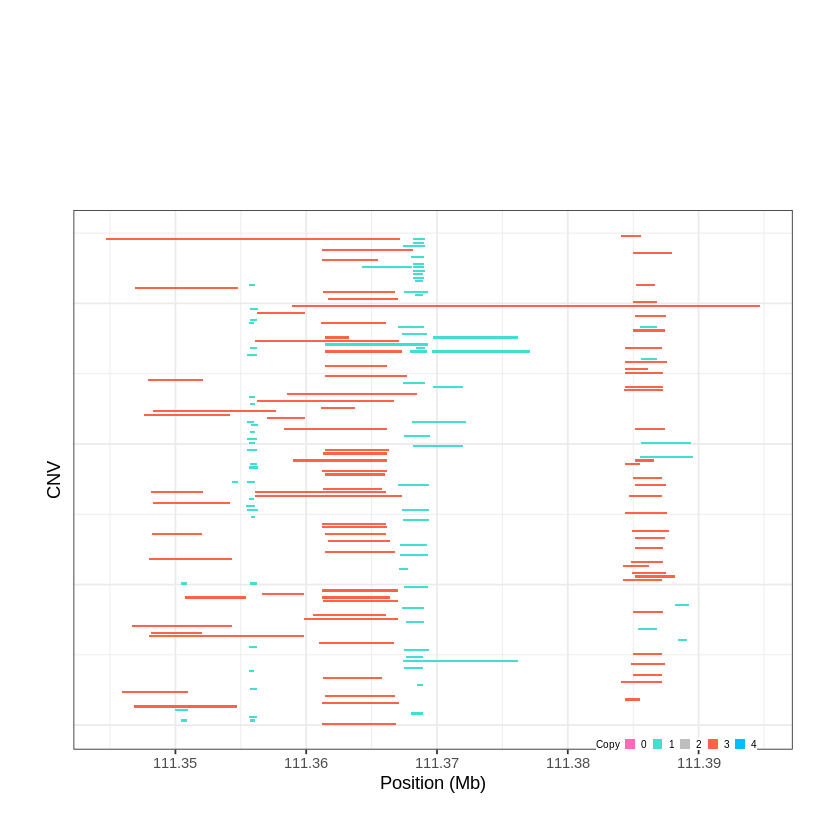

Task done, plot was stored in working directory.
[1] "Ploting CNVR 271..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 113.026801 - 113.0579 Mb with 164 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 272..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 114.173301 - 114.2191 Mb with 236 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


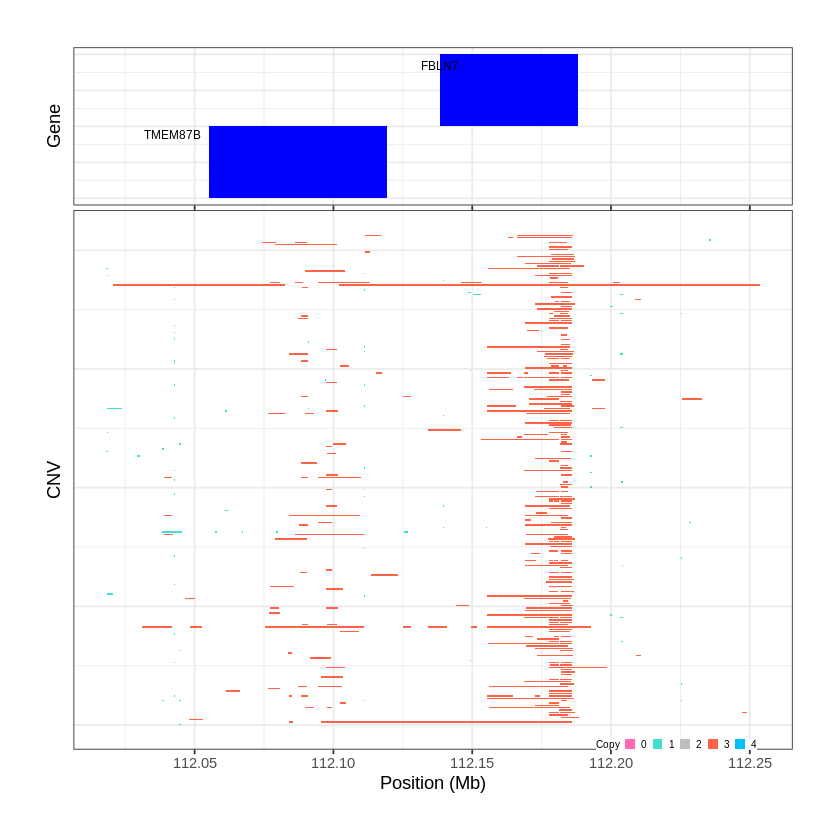

Task done, plot was stored in working directory.
[1] "Ploting CNVR 273..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 114.219601 - 114.2737 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


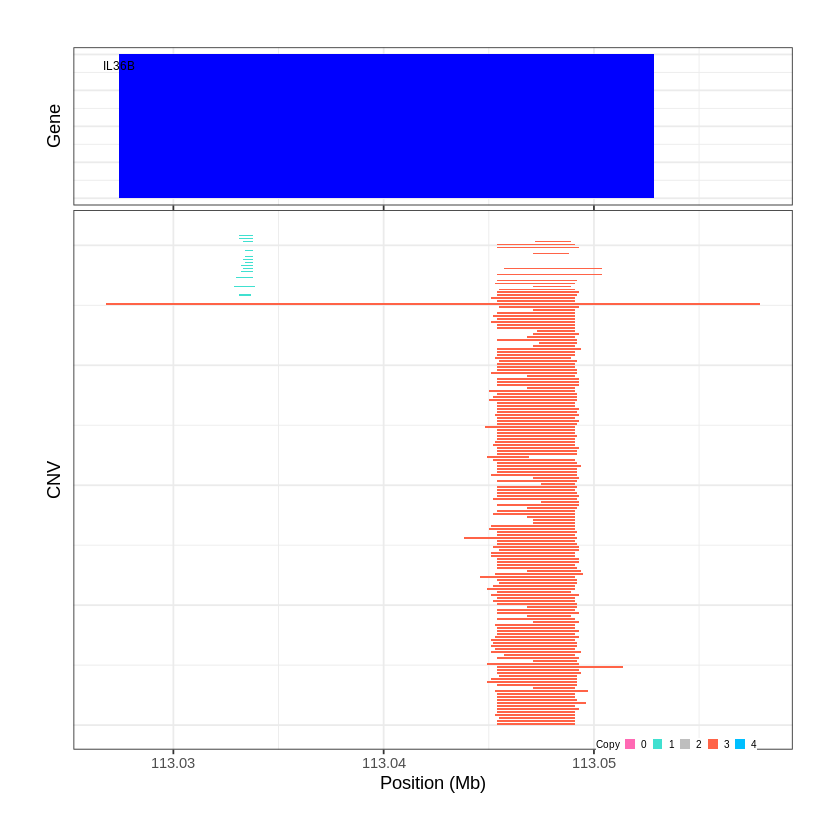

Task done, plot was stored in working directory.
[1] "Ploting CNVR 274..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 114.306701 - 114.4356 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


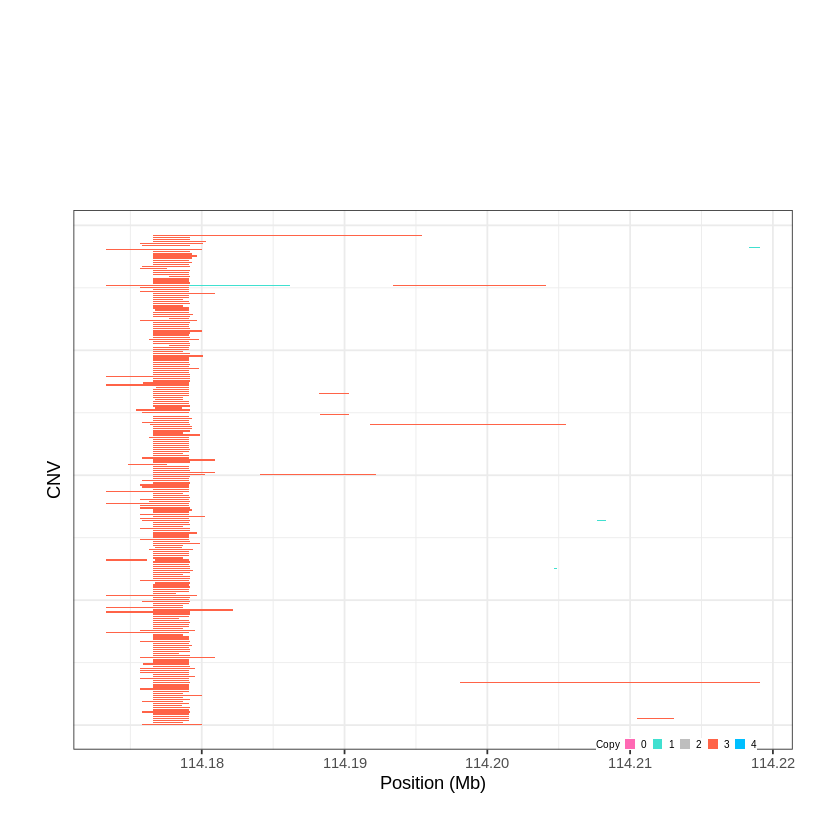

Task done, plot was stored in working directory.
[1] "Ploting CNVR 275..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 115.113601 - 115.1444 Mb with 219 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


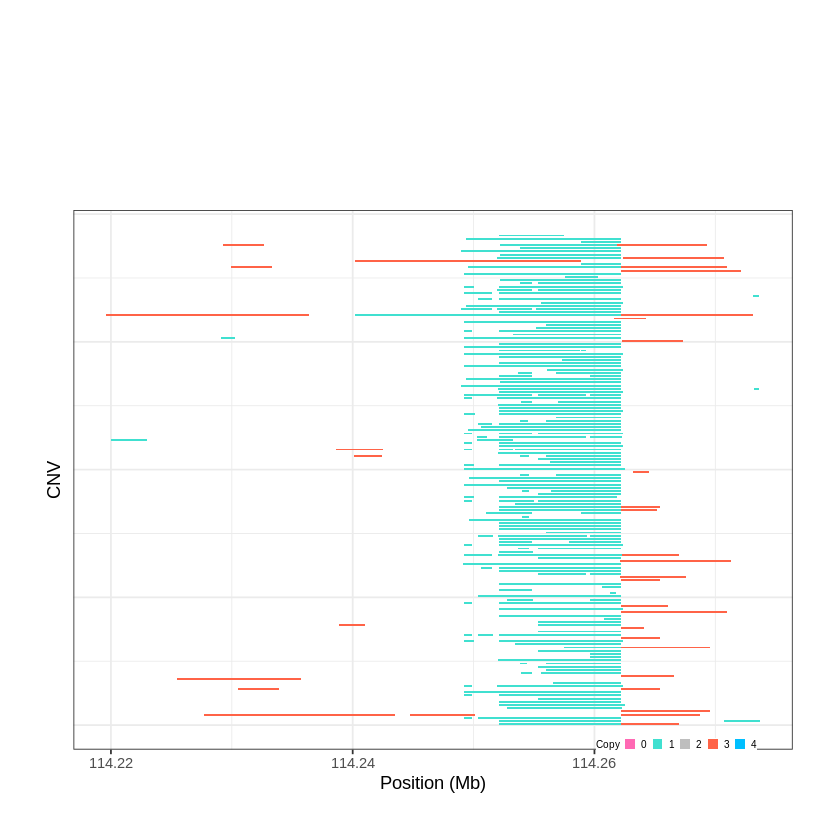

Task done, plot was stored in working directory.
[1] "Ploting CNVR 276..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 117.795301 - 117.8087 Mb with 269 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


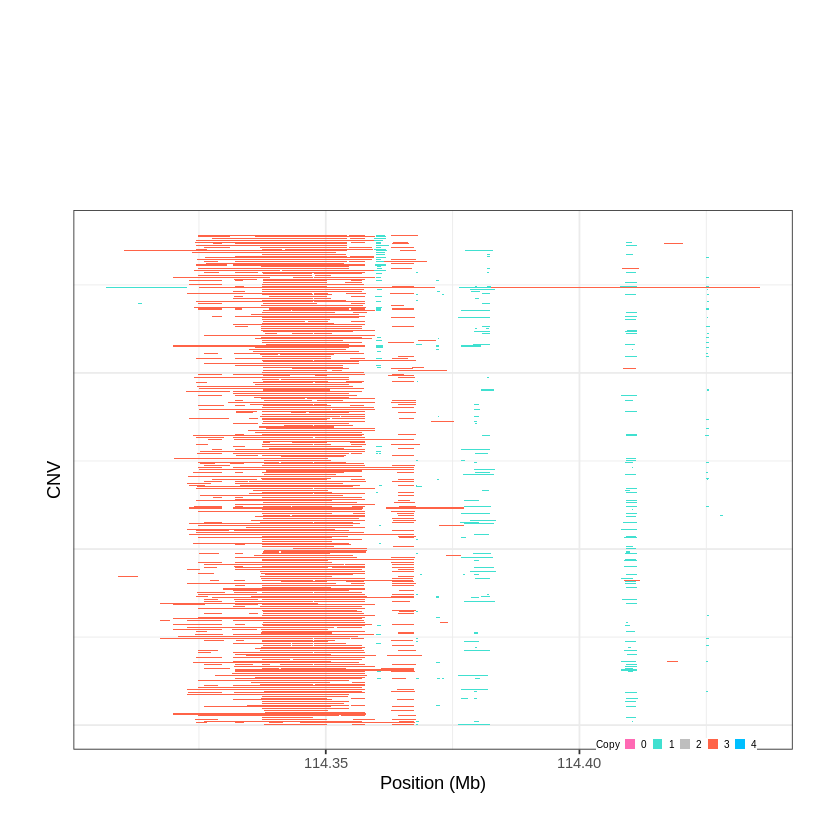

Task done, plot was stored in working directory.
[1] "Ploting CNVR 277..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 118.406401 - 118.4159 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


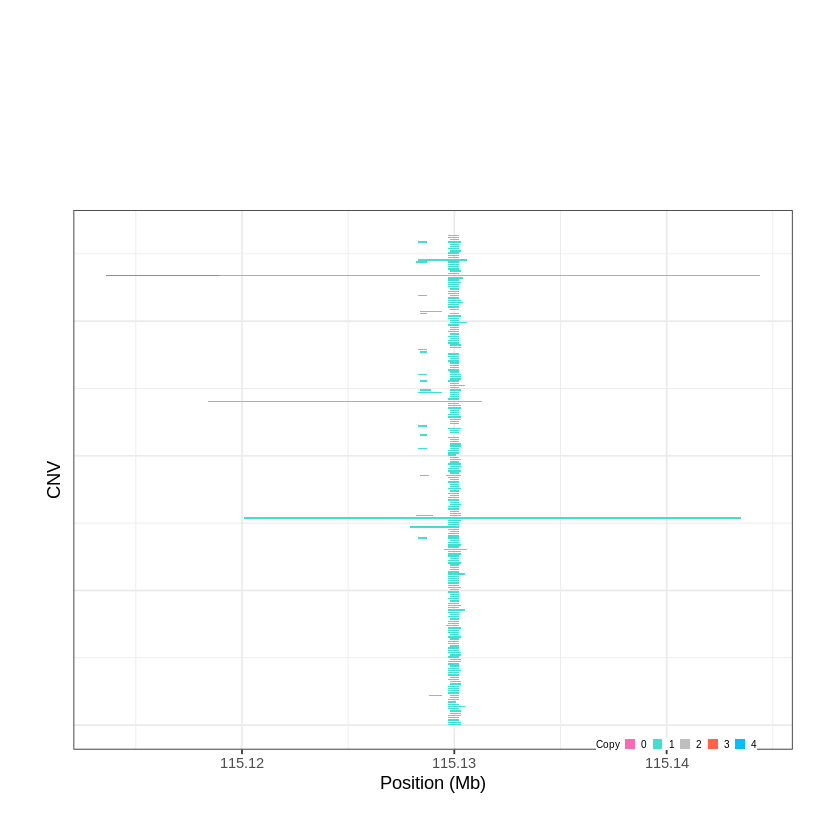

Task done, plot was stored in working directory.
[1] "Ploting CNVR 278..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 118.884301 - 118.908 Mb with 159 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


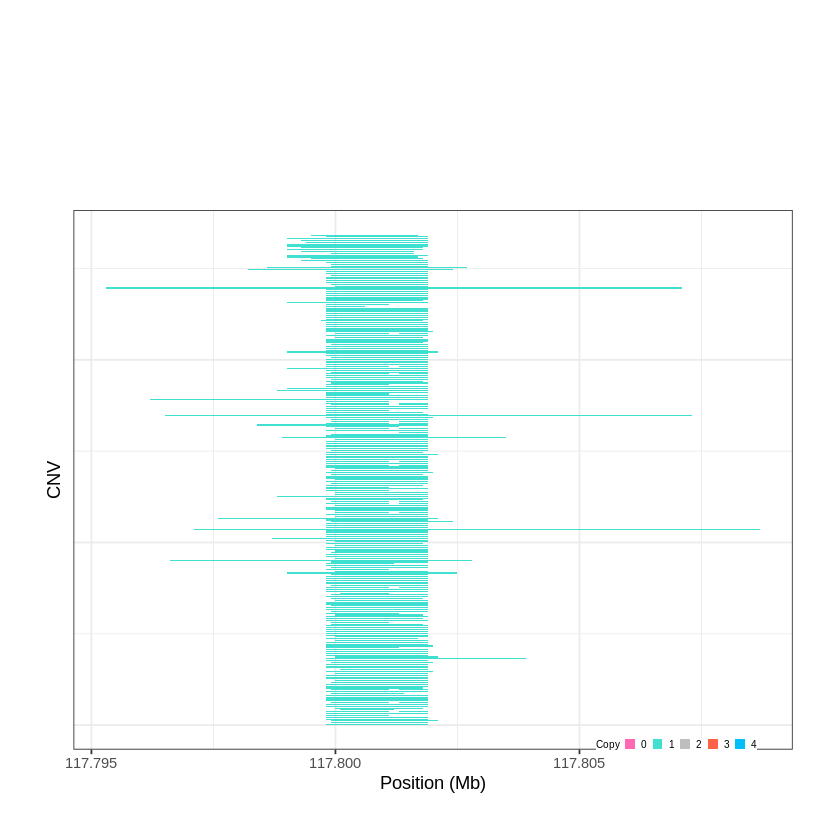

Task done, plot was stored in working directory.
[1] "Ploting CNVR 279..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 119.041301 - 119.0723 Mb with 252 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


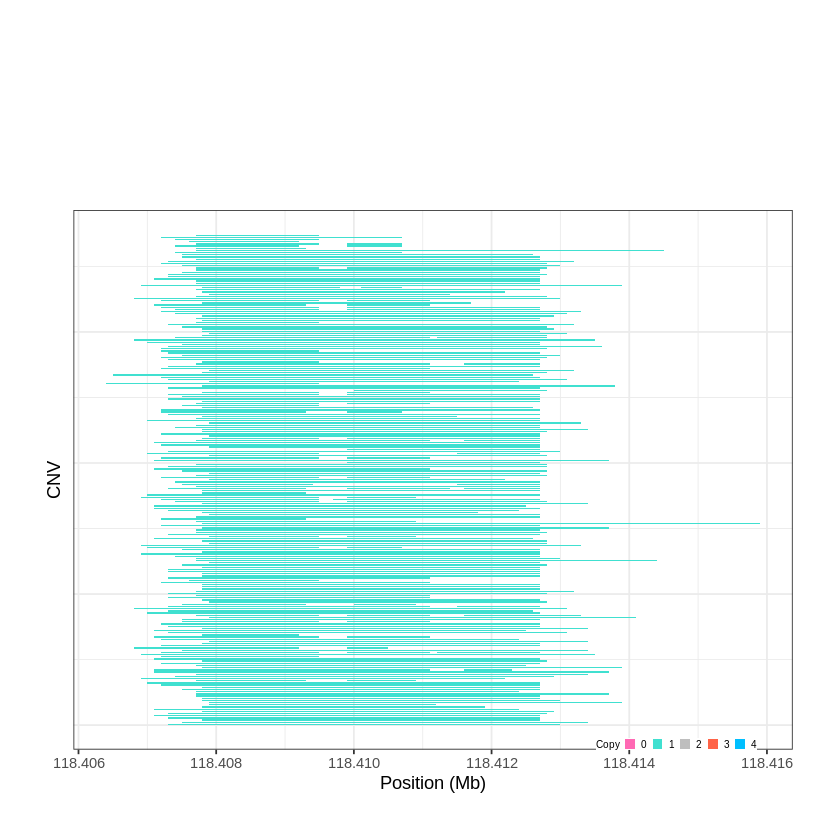

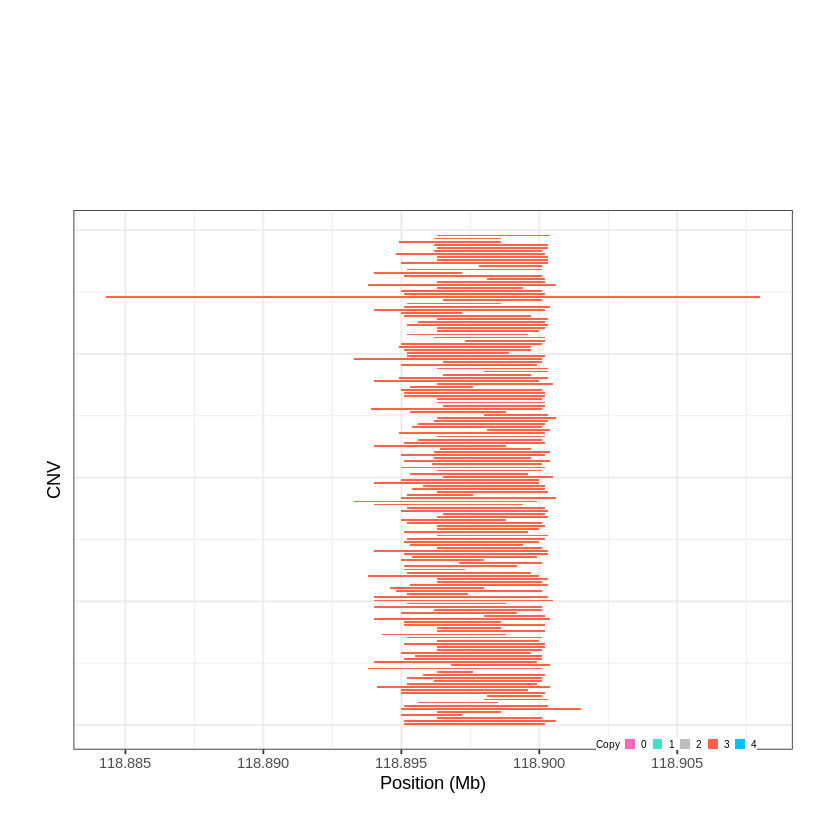

Task done, plot was stored in working directory.
[1] "Ploting CNVR 280..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 120.180701 - 120.2536 Mb with 160 Individual - "
Plotting gene...


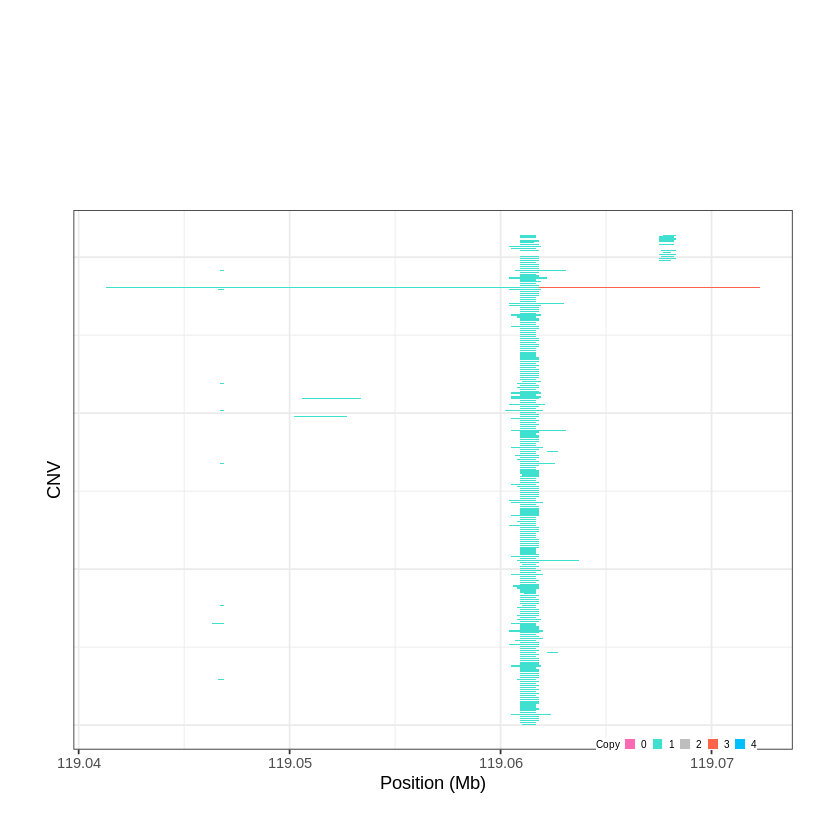

Task done, plot was stored in working directory.
[1] "Ploting CNVR 281..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 121.410501 - 121.8699 Mb with 258 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 282..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 126.437301 - 126.4522 Mb with 251 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


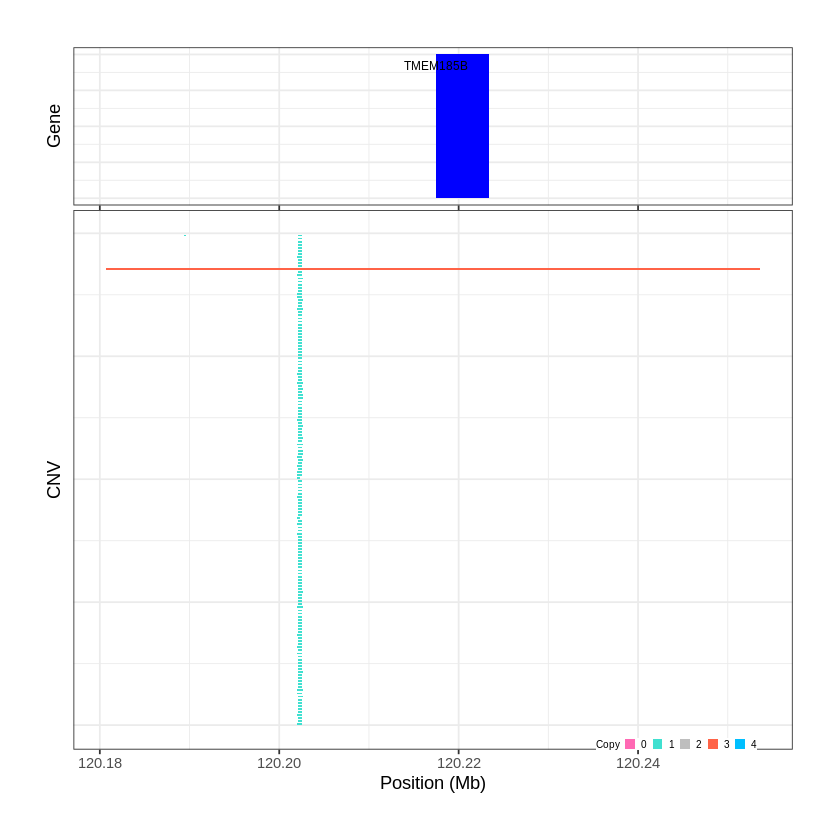

Task done, plot was stored in working directory.
[1] "Ploting CNVR 283..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 126.589001 - 126.6568 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


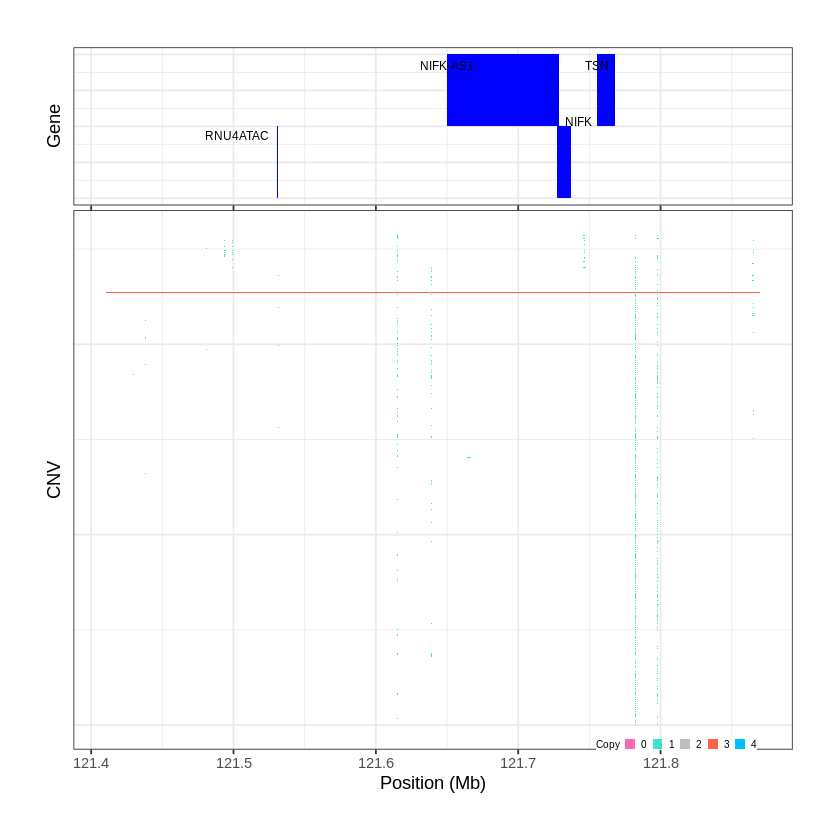

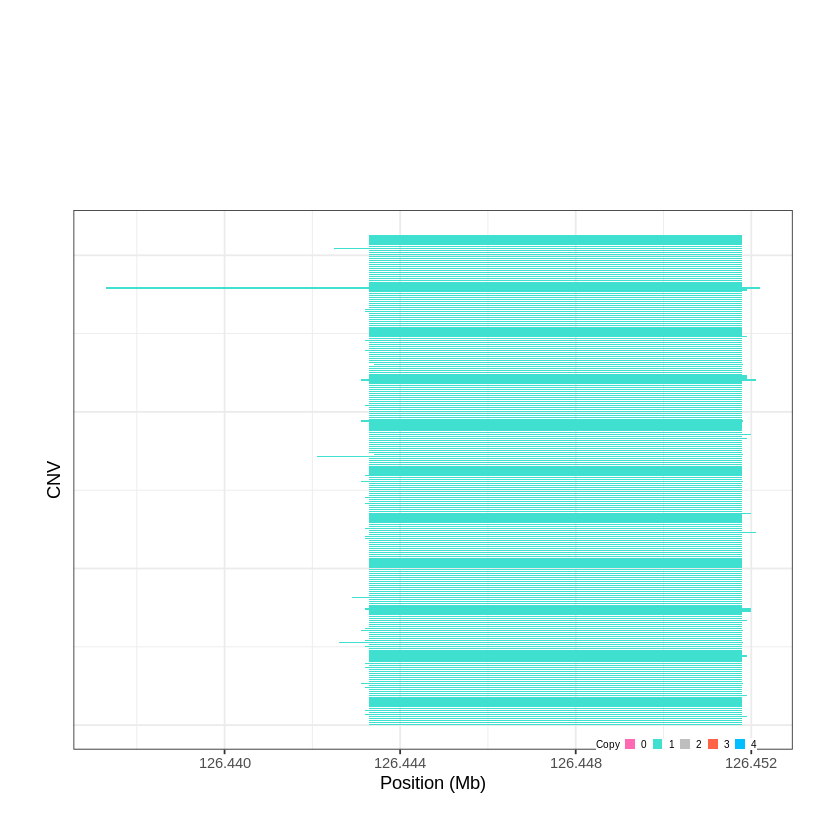

Task done, plot was stored in working directory.
[1] "Ploting CNVR 284..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 127.624801 - 127.7127 Mb with 248 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 285..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 128.267201 - 128.4769 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


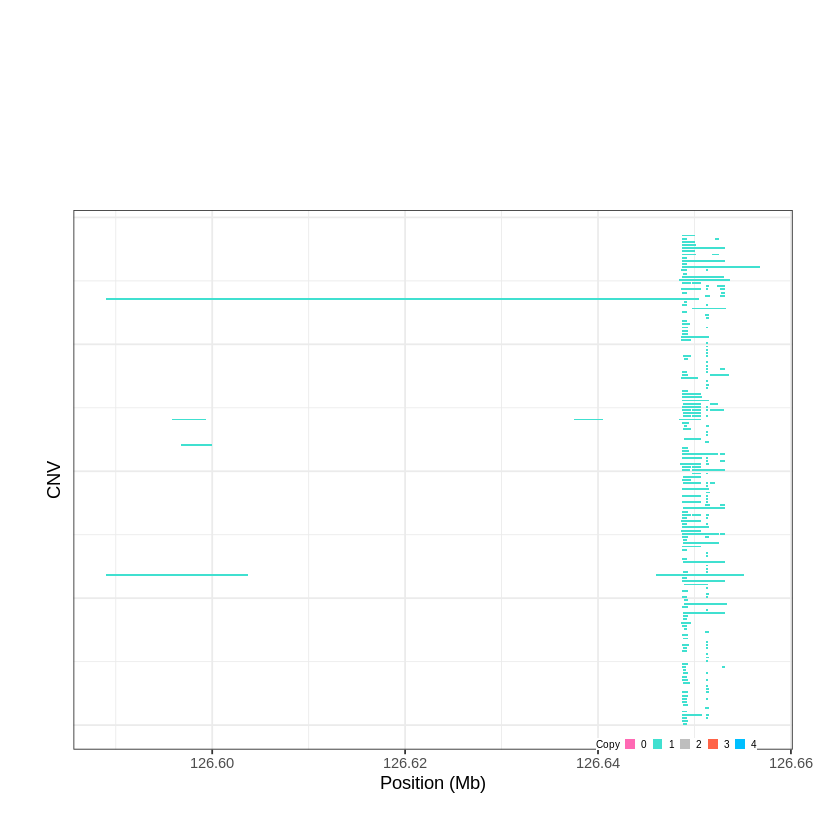

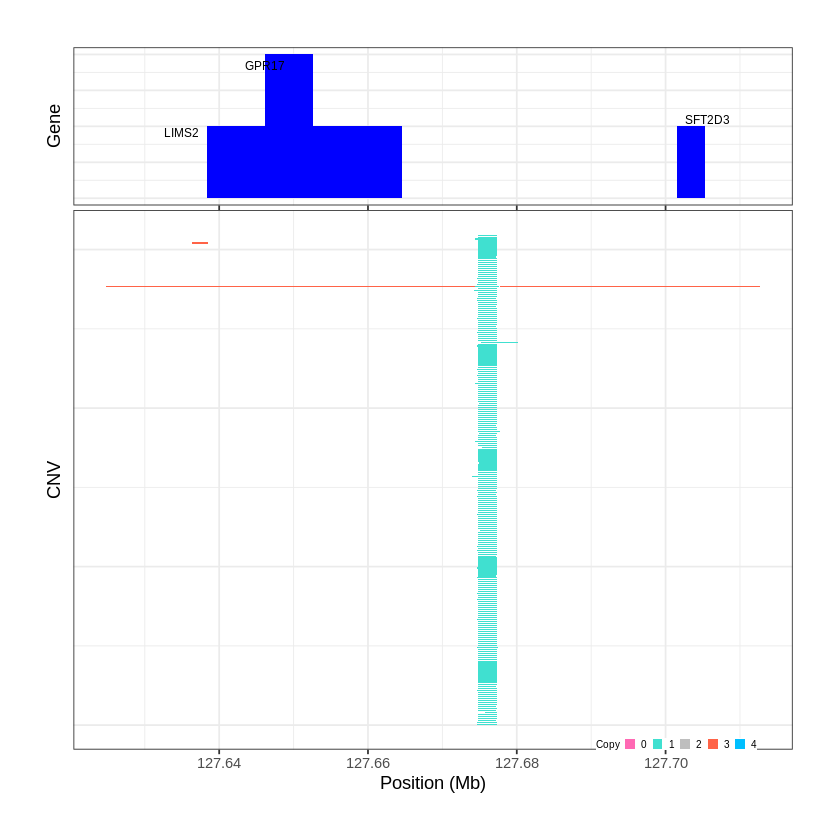

Task done, plot was stored in working directory.
[1] "Ploting CNVR 286..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 128.940401 - 129.465 Mb with 220 Individual - "
Plotting gene...


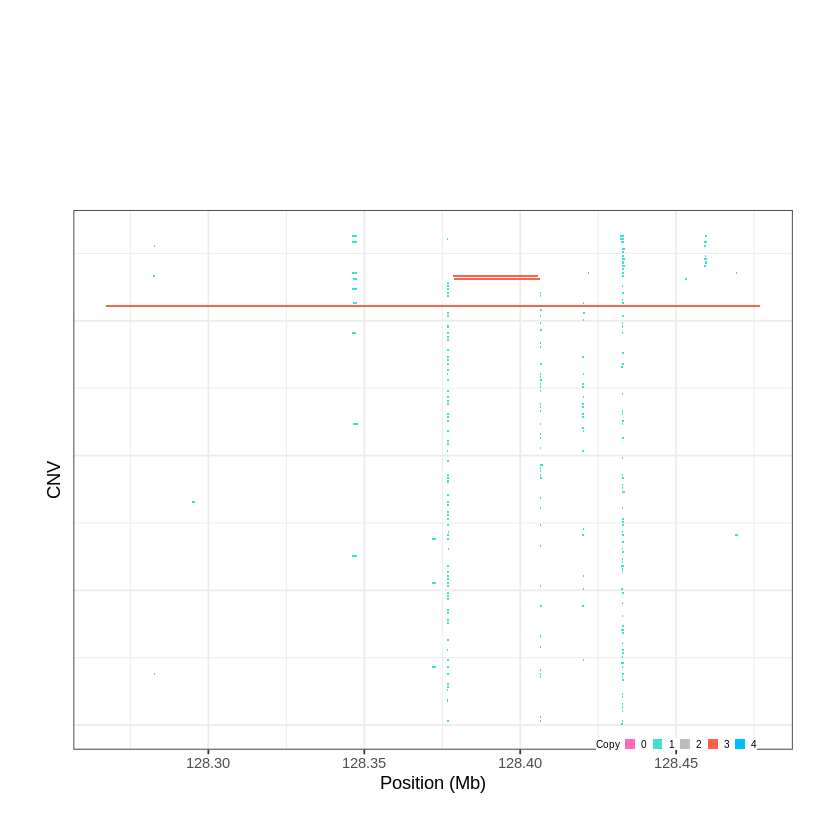

Task done, plot was stored in working directory.
[1] "Ploting CNVR 287..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 129.967401 - 130.5906 Mb with 189 Individual - "
Plotting gene...


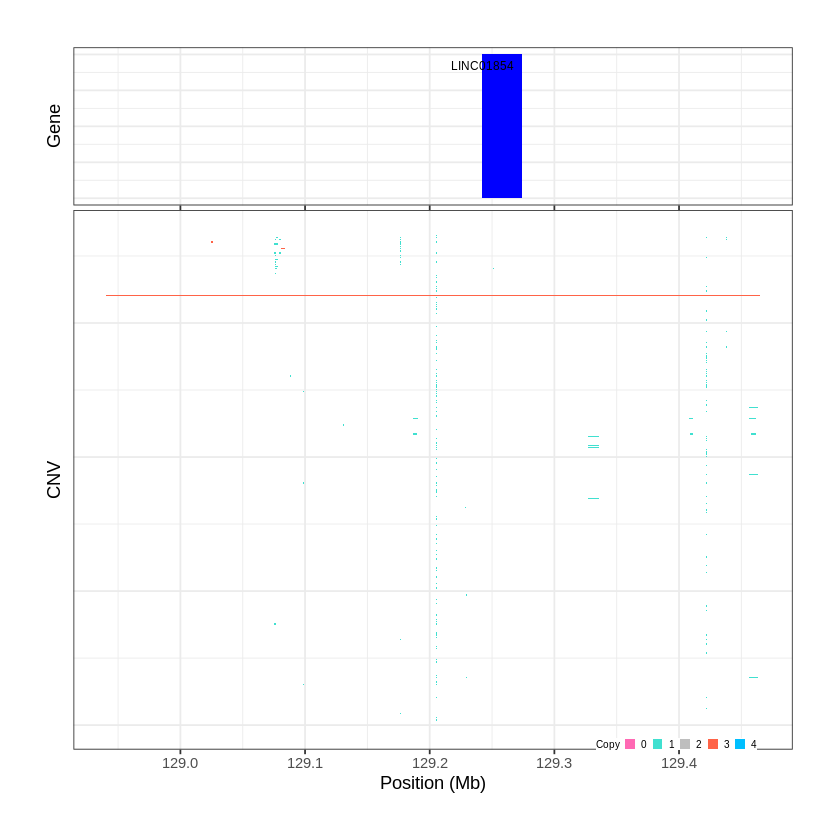

Task done, plot was stored in working directory.
[1] "Ploting CNVR 288..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 130.748301 - 130.8296 Mb with 240 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 289..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 130.830601 - 130.8988 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


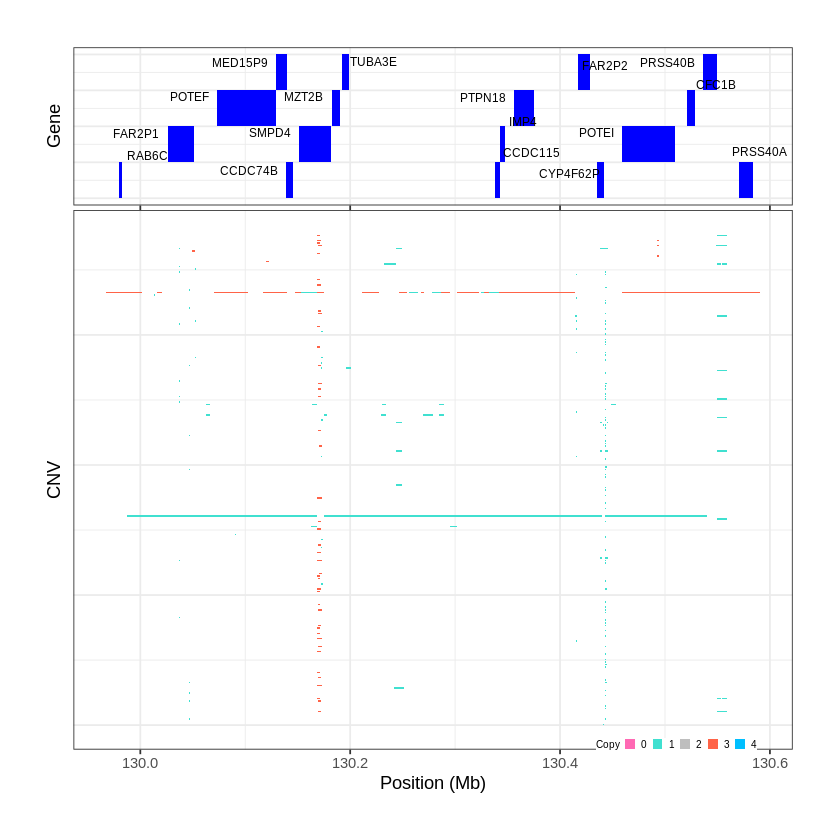

Task done, plot was stored in working directory.
[1] "Ploting CNVR 290..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 130.953501 - 131.0272 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


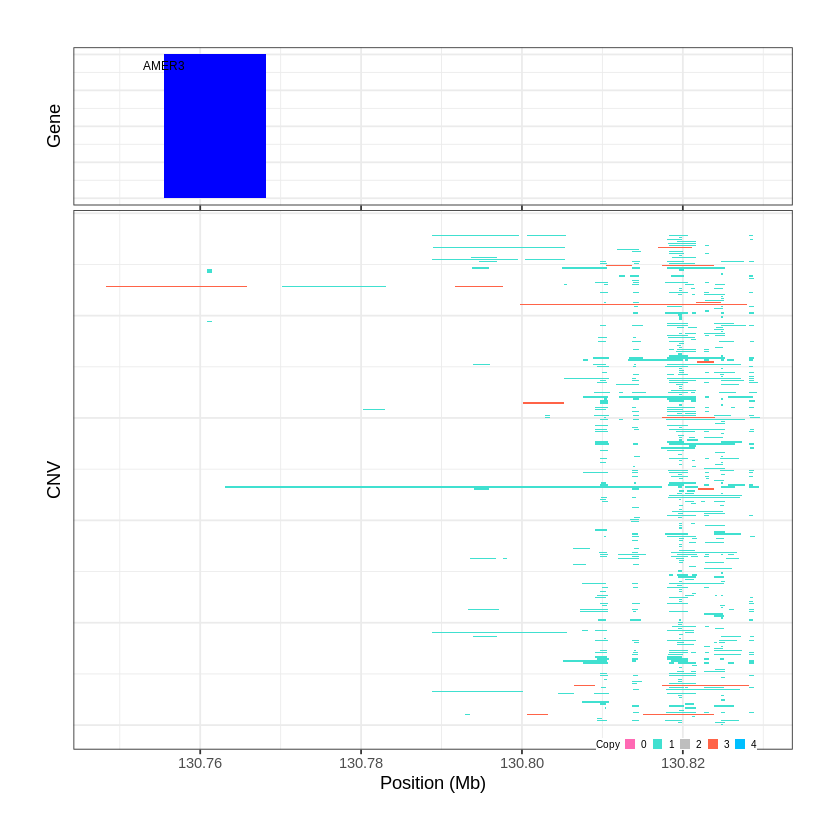

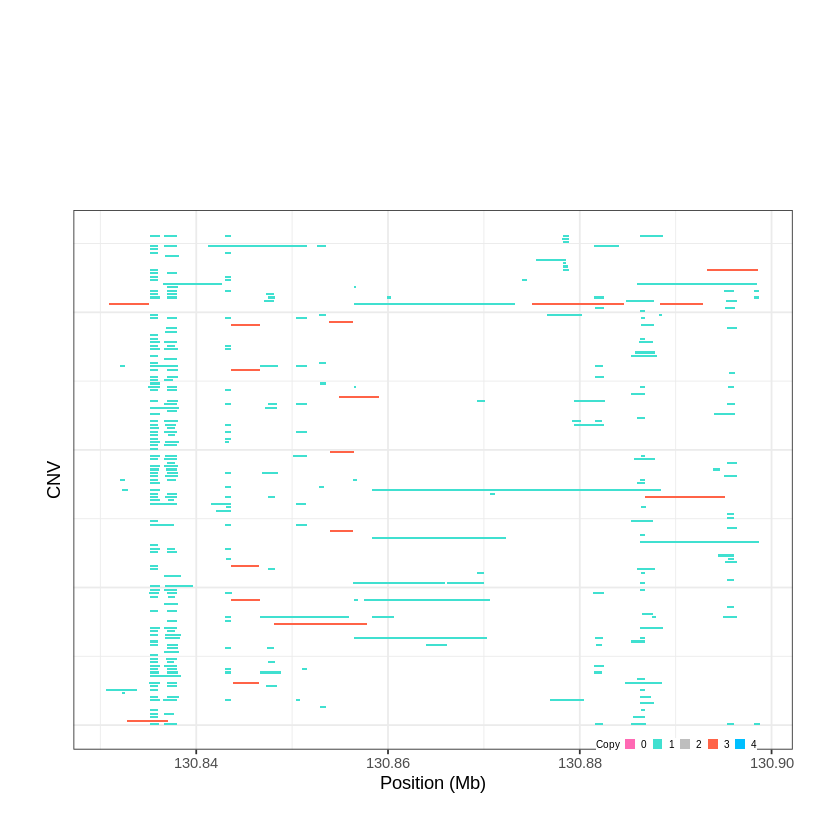

Task done, plot was stored in working directory.
[1] "Ploting CNVR 291..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 131.192901 - 131.3057 Mb with 279 Individual - "
Plotting gene...


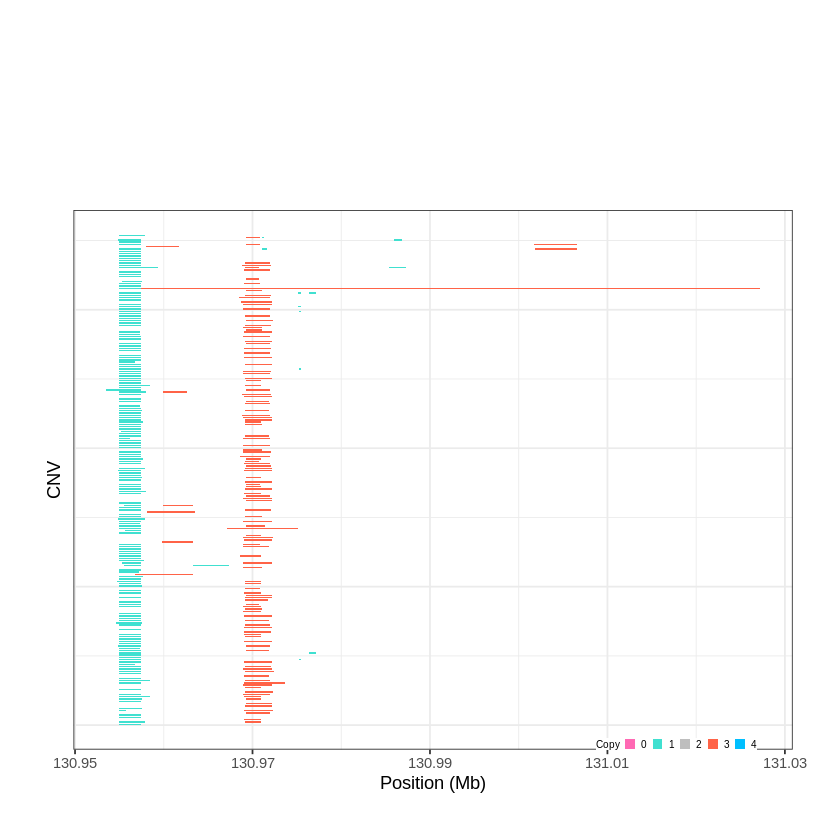

Task done, plot was stored in working directory.
[1] "Ploting CNVR 292..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 131.305701 - 131.442 Mb with 279 Individual - "
Plotting gene...


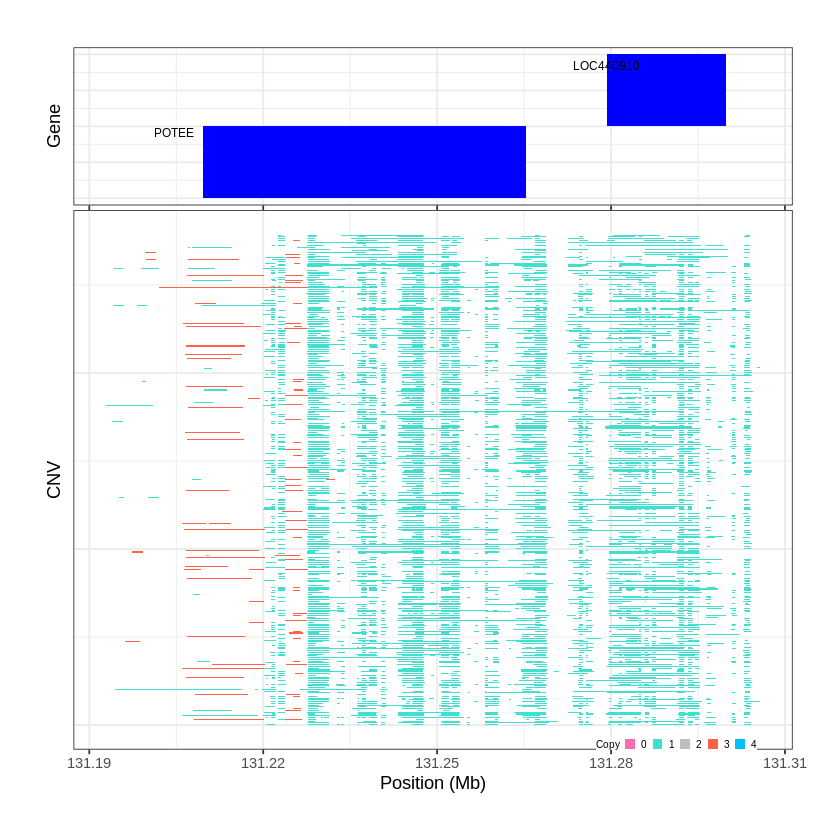

Task done, plot was stored in working directory.
[1] "Ploting CNVR 293..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 131.965701 - 132.3352 Mb with 266 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 294..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 132.446601 - 132.5858 Mb with 250 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


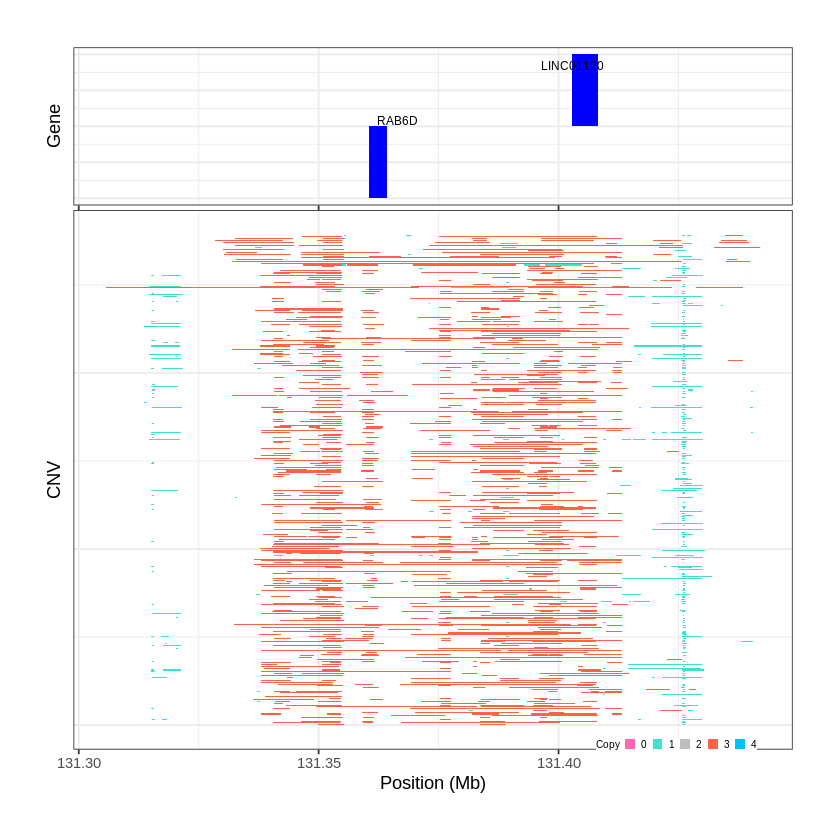

Task done, plot was stored in working directory.
[1] "Ploting CNVR 295..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 133.101601 - 133.1222 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


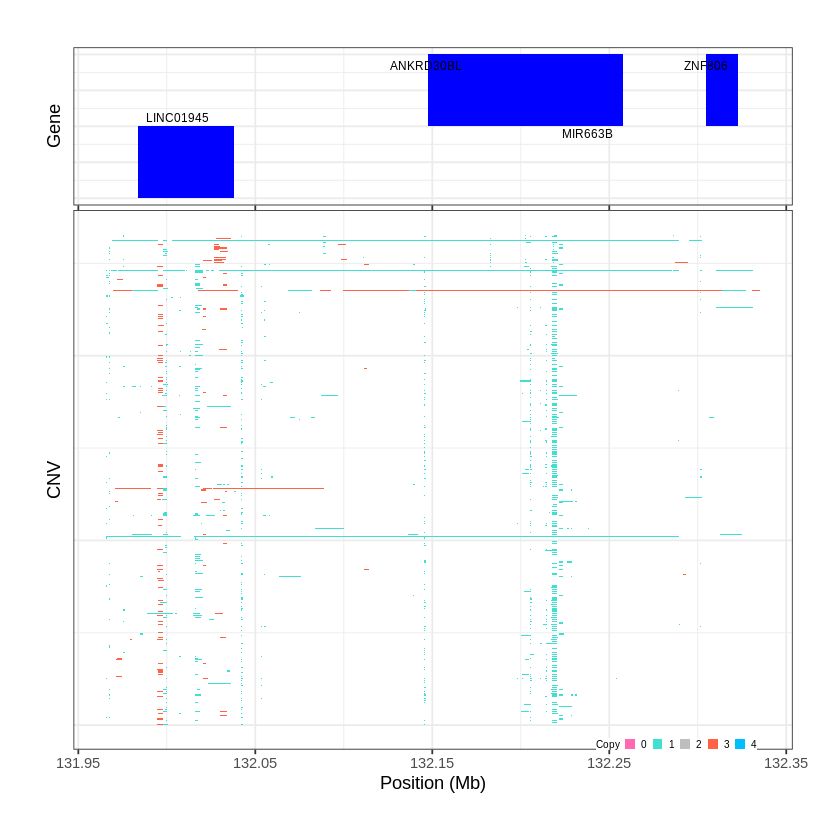

Task done, plot was stored in working directory.
[1] "Ploting CNVR 296..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 135.782001 - 135.7962 Mb with 182 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


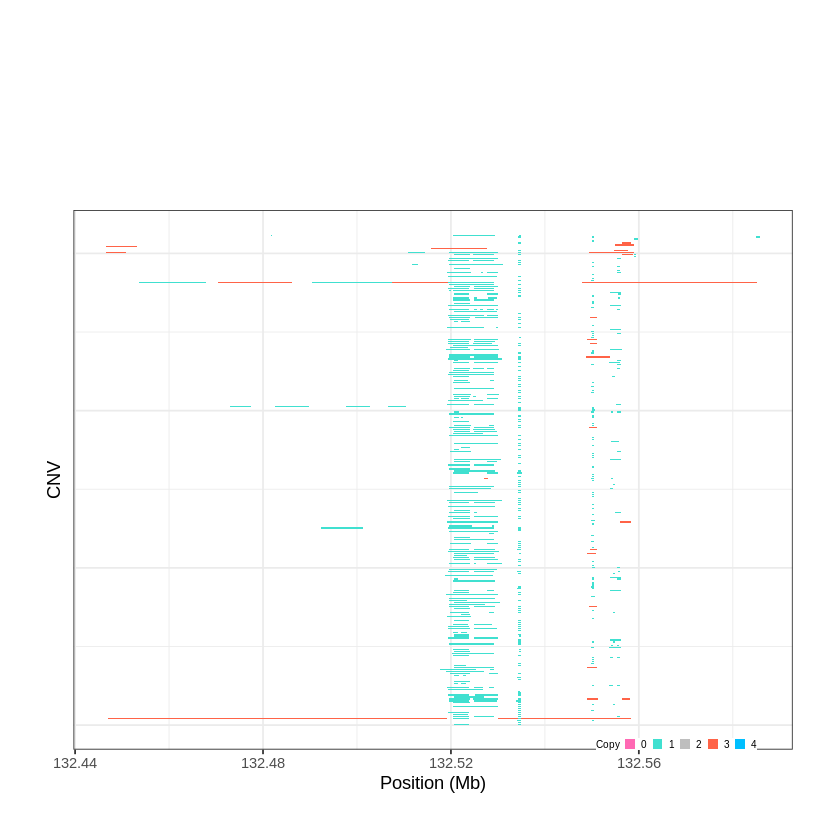

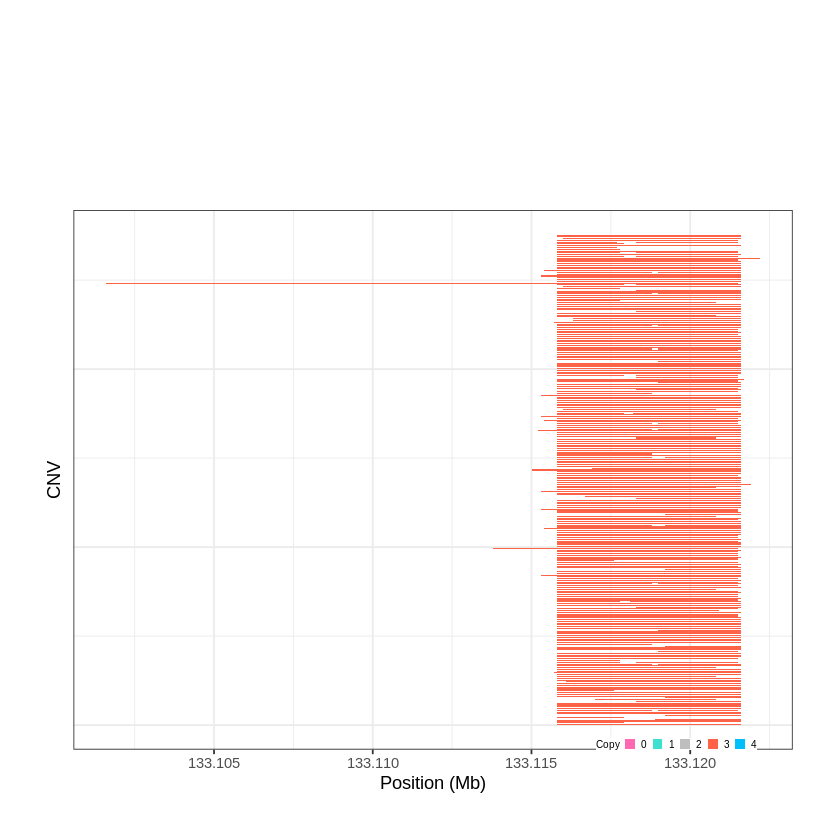

Task done, plot was stored in working directory.
[1] "Ploting CNVR 297..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 137.875401 - 138.6343 Mb with 158 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 298..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 142.338701 - 142.3606 Mb with 230 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


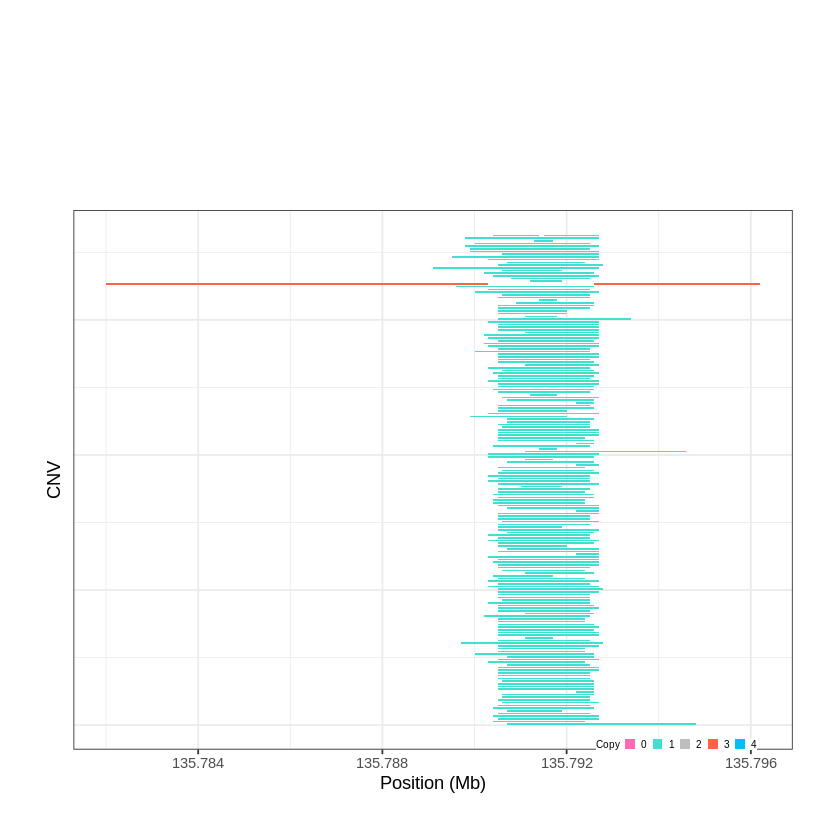

Task done, plot was stored in working directory.
[1] "Ploting CNVR 299..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 145.019701 - 145.0209 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


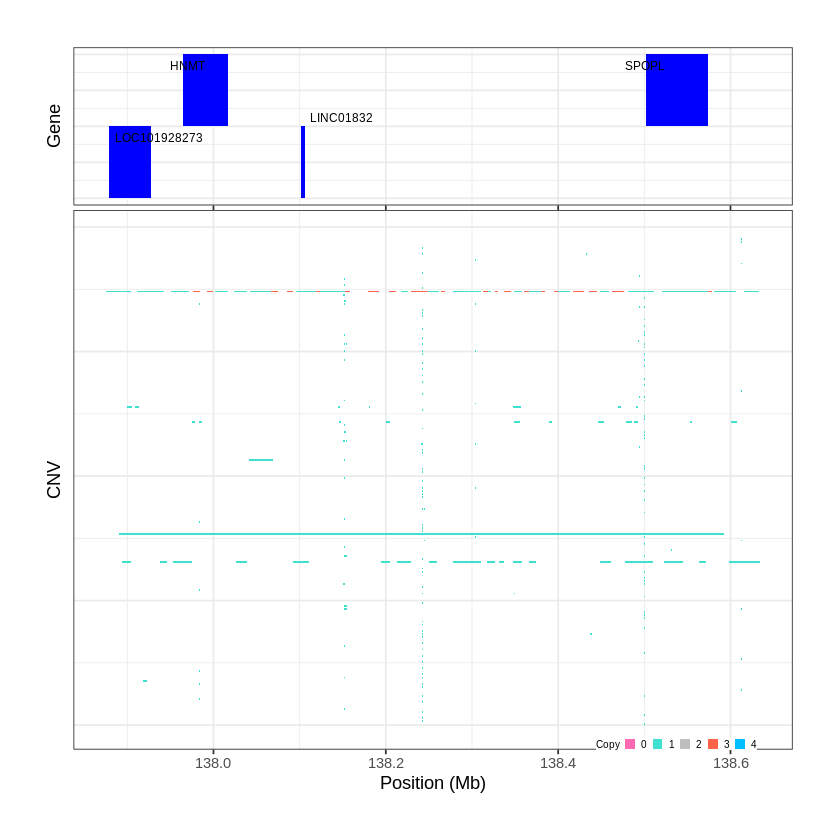

Task done, plot was stored in working directory.
[1] "Ploting CNVR 300..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 146.834801 - 146.8945 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


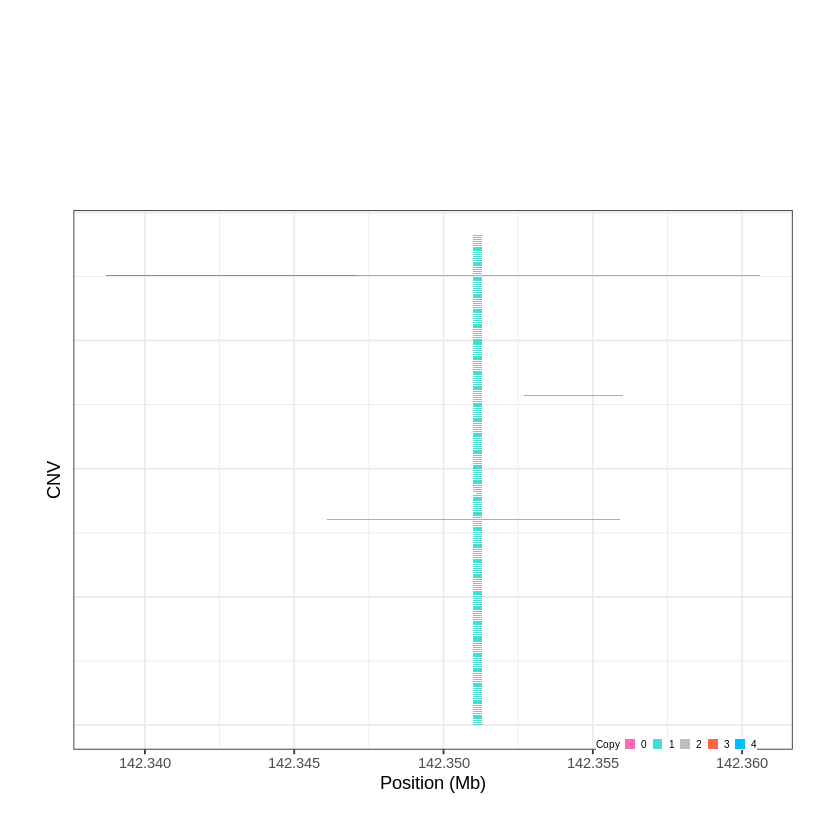

Task done, plot was stored in working directory.
[1] "Ploting CNVR 301..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 149.690501 - 149.7906 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


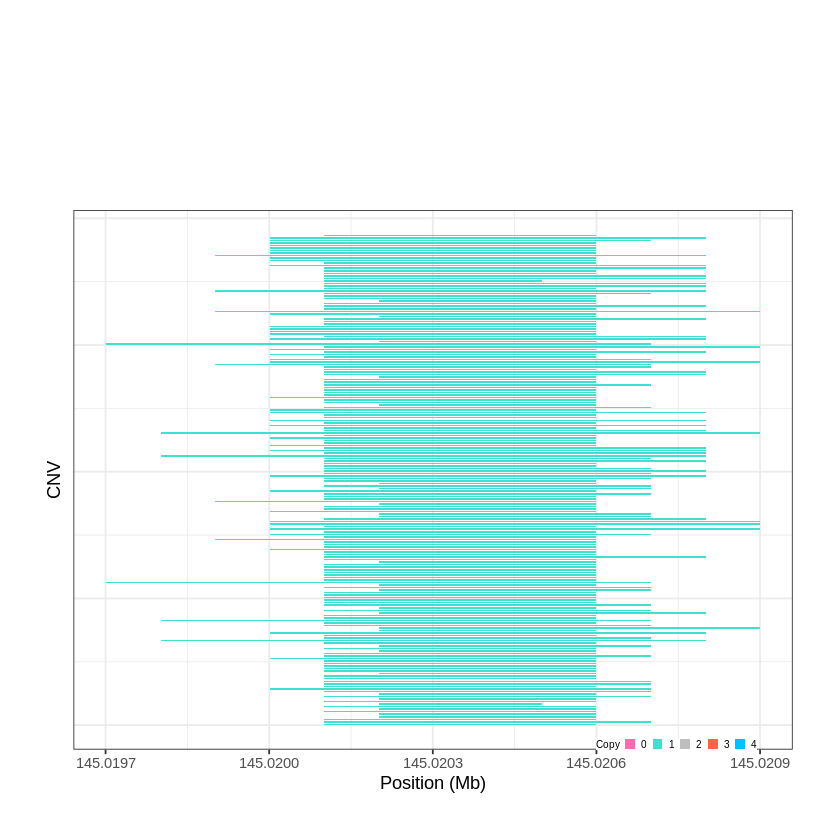

Task done, plot was stored in working directory.
[1] "Ploting CNVR 302..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 151.386401 - 151.4255 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


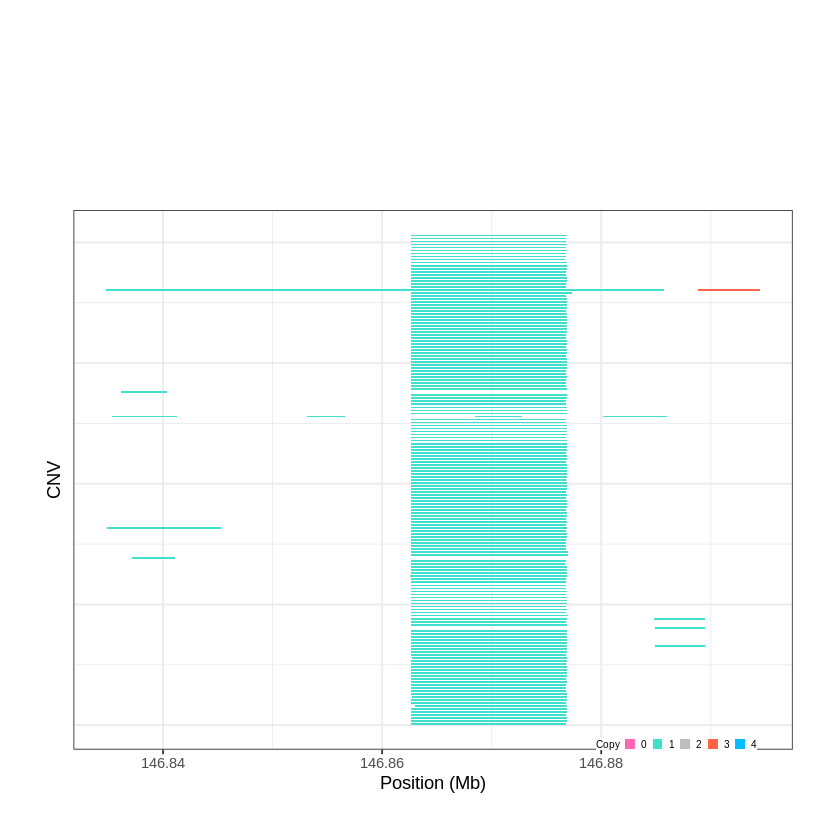

Task done, plot was stored in working directory.
[1] "Ploting CNVR 303..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 151.903101 - 151.9033 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


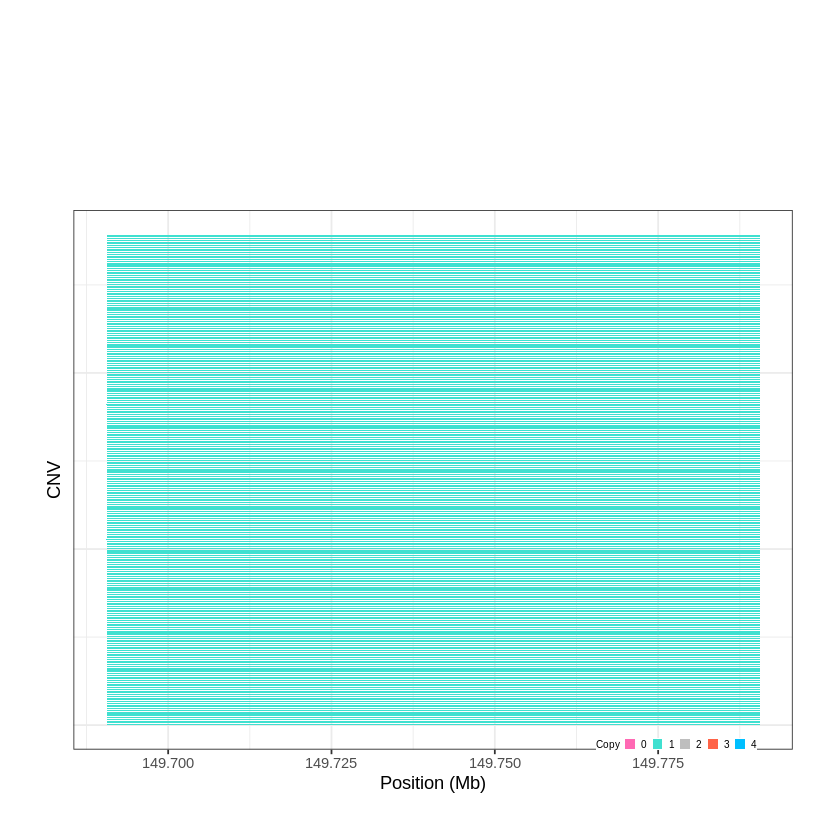

Task done, plot was stored in working directory.
[1] "Ploting CNVR 304..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 152.440101 - 152.4658 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


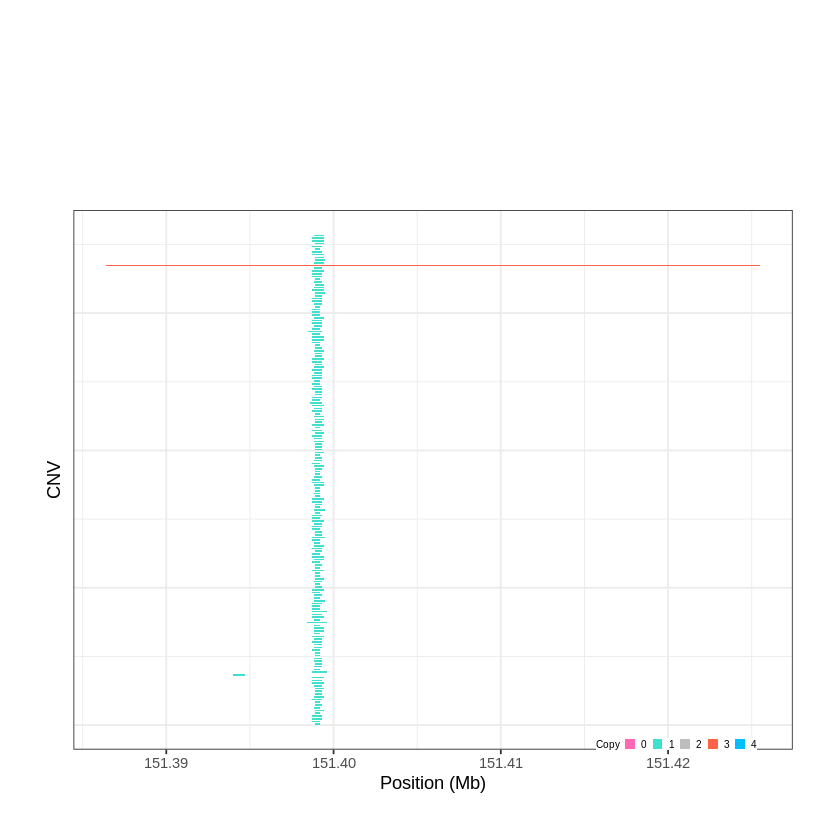

Task done, plot was stored in working directory.
[1] "Ploting CNVR 305..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 152.617301 - 152.6176 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


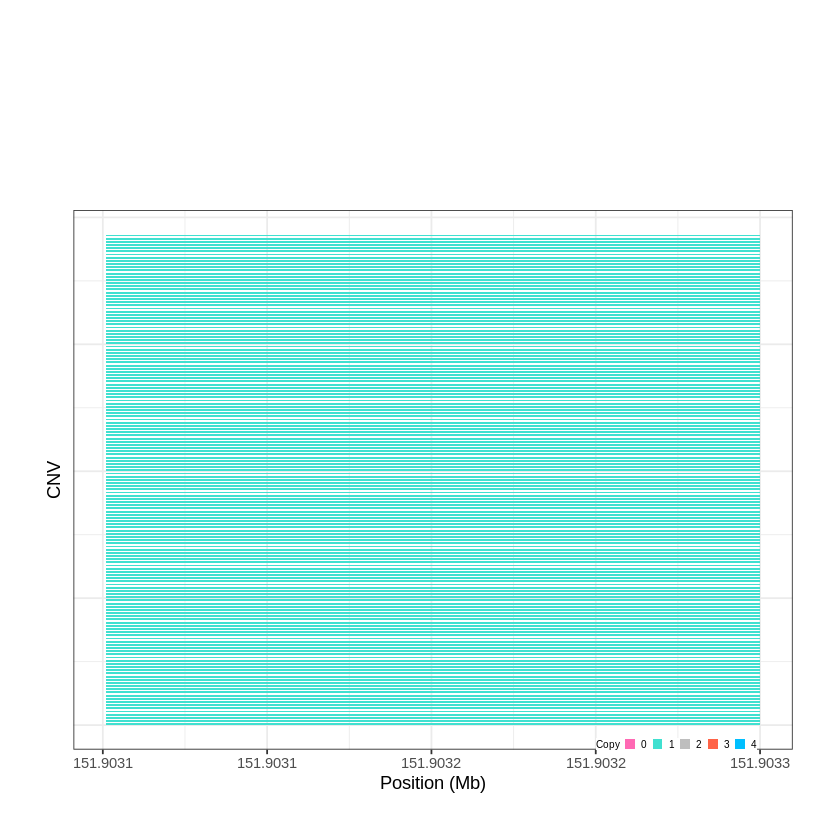

Task done, plot was stored in working directory.
[1] "Ploting CNVR 306..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 157.222501 - 157.2357 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


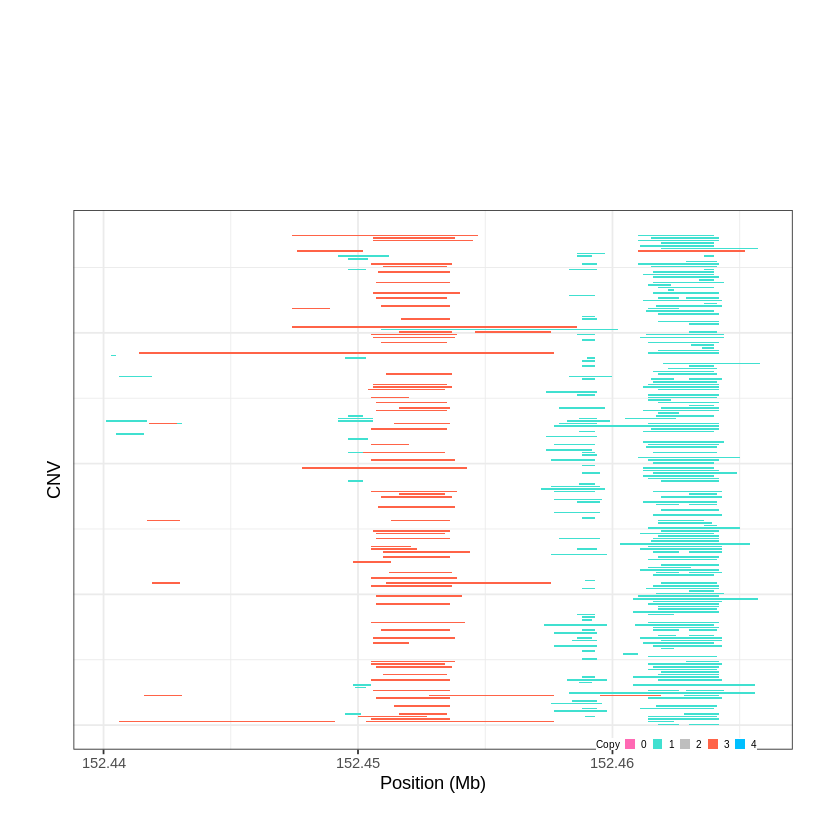

Task done, plot was stored in working directory.
[1] "Ploting CNVR 307..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 158.419001 - 158.4365 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


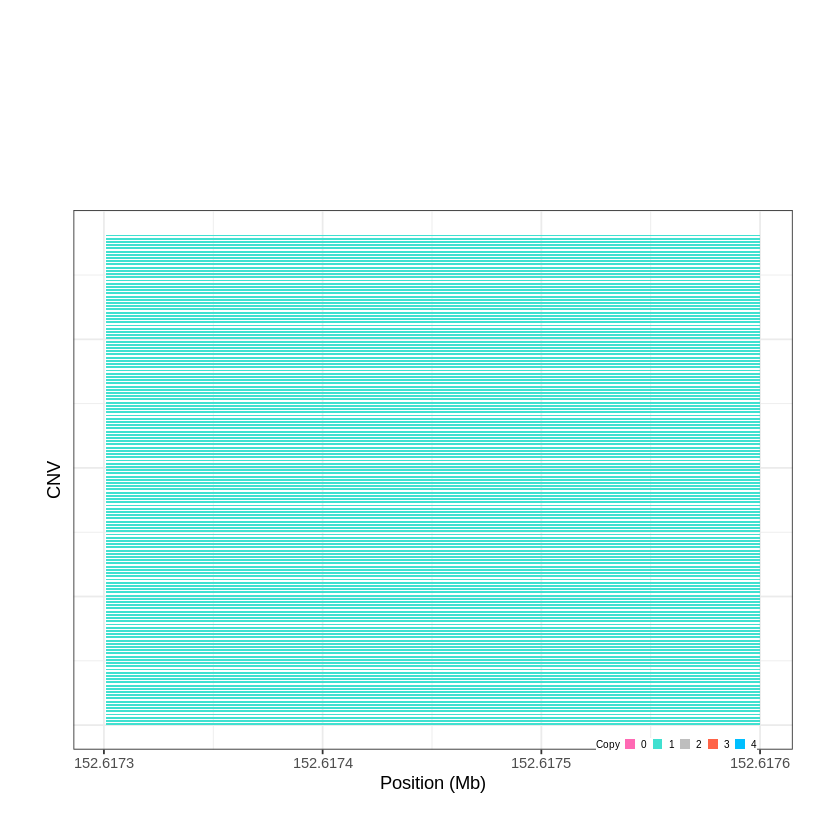

Task done, plot was stored in working directory.
[1] "Ploting CNVR 308..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 158.719101 - 158.7194 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


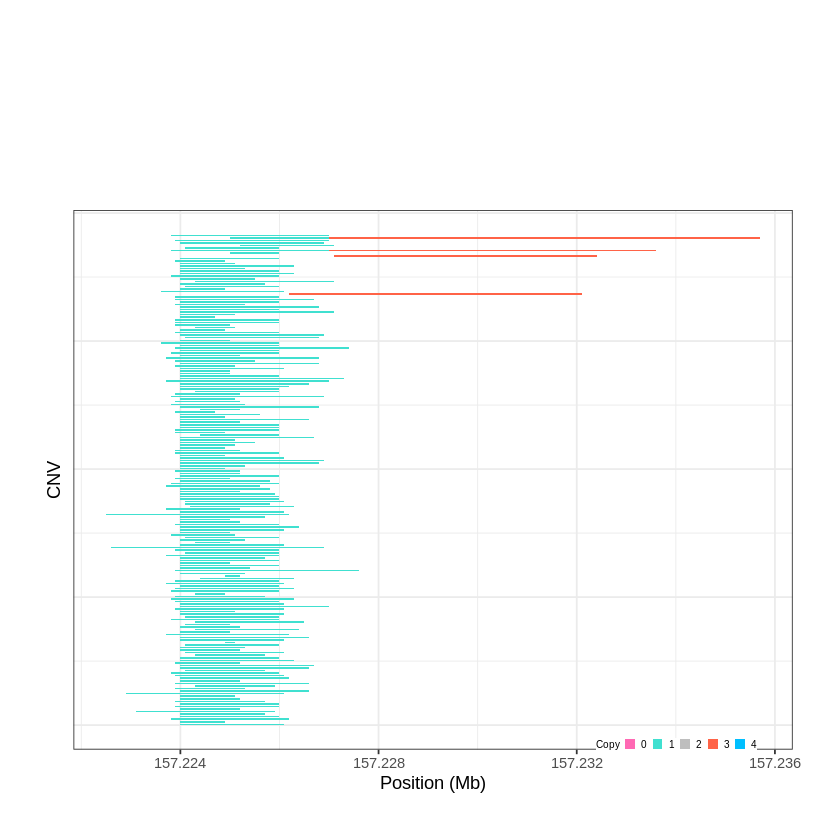

Task done, plot was stored in working directory.
[1] "Ploting CNVR 309..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 159.957001 - 159.9647 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


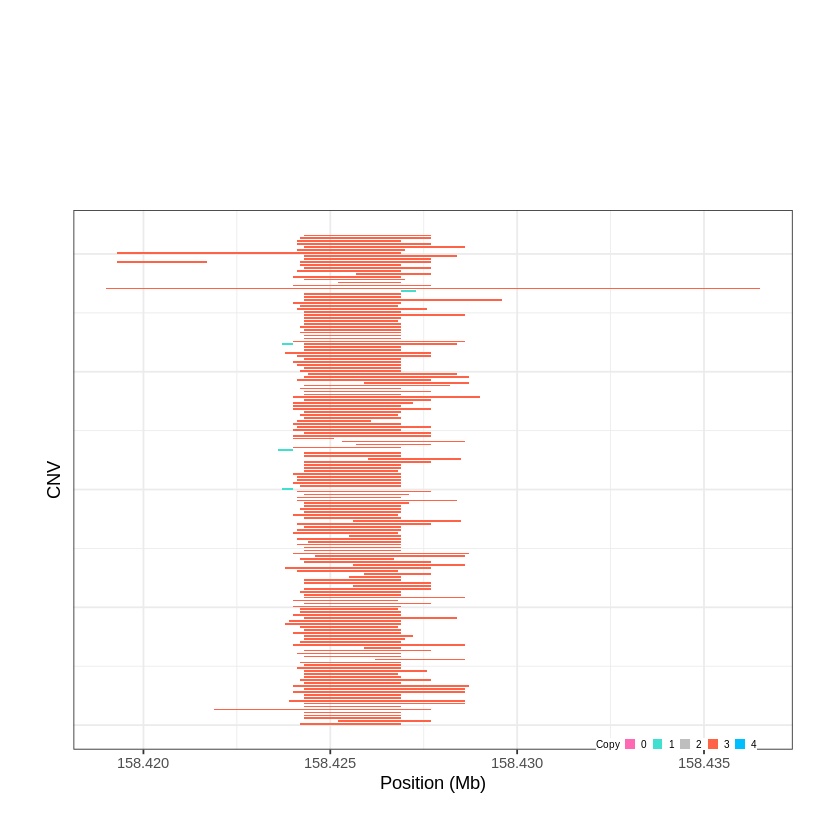

Task done, plot was stored in working directory.
[1] "Ploting CNVR 310..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 160.149801 - 160.1517 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


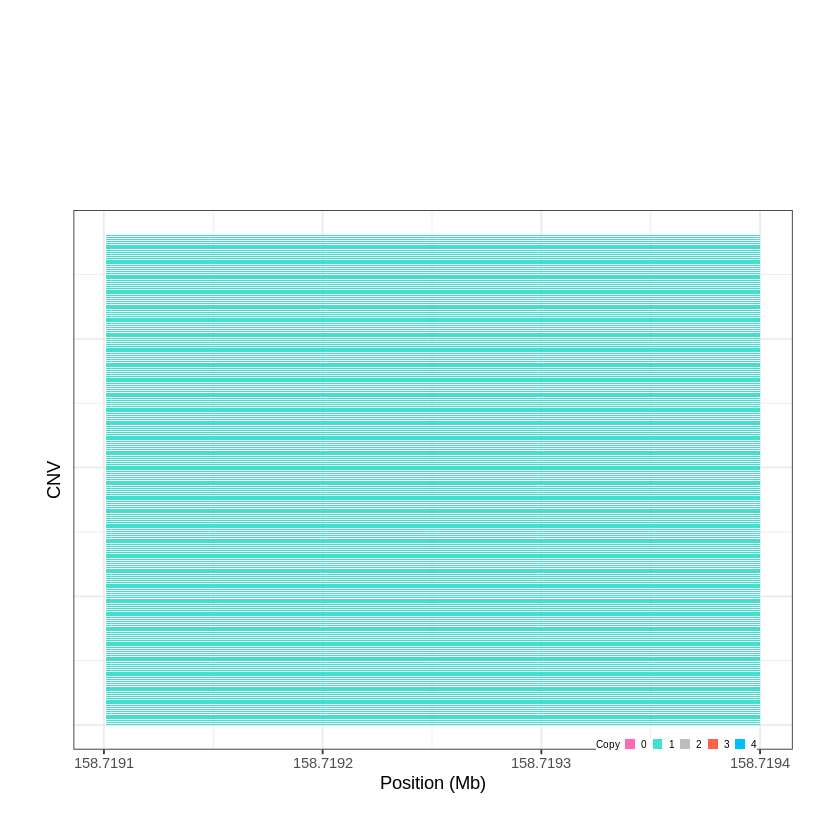

Task done, plot was stored in working directory.
[1] "Ploting CNVR 311..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 160.722301 - 160.7559 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


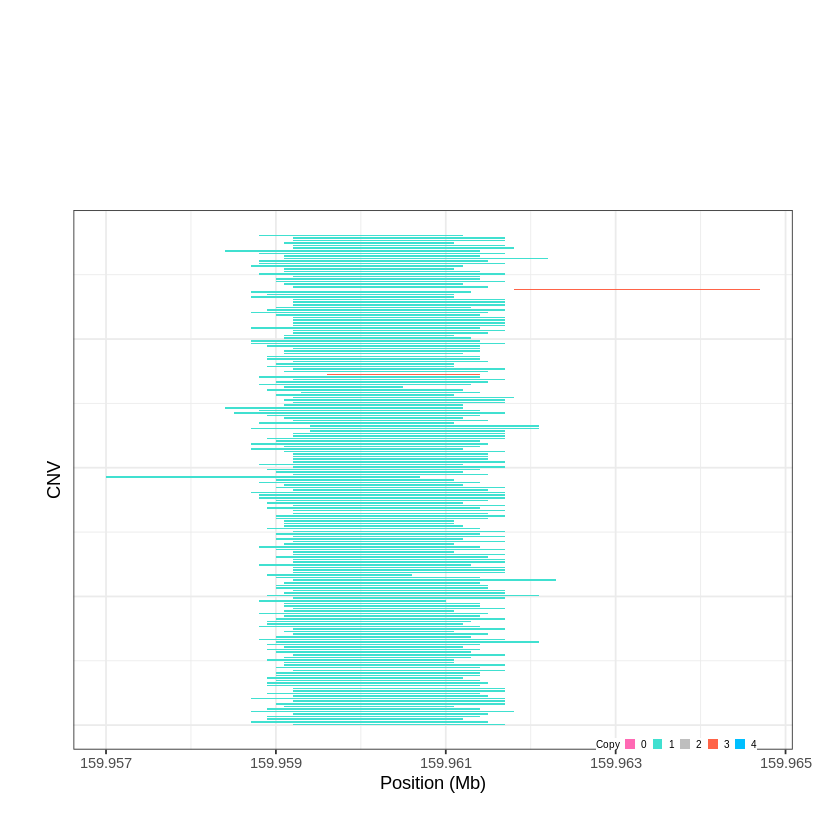

Task done, plot was stored in working directory.
[1] "Ploting CNVR 312..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 161.780101 - 161.8059 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


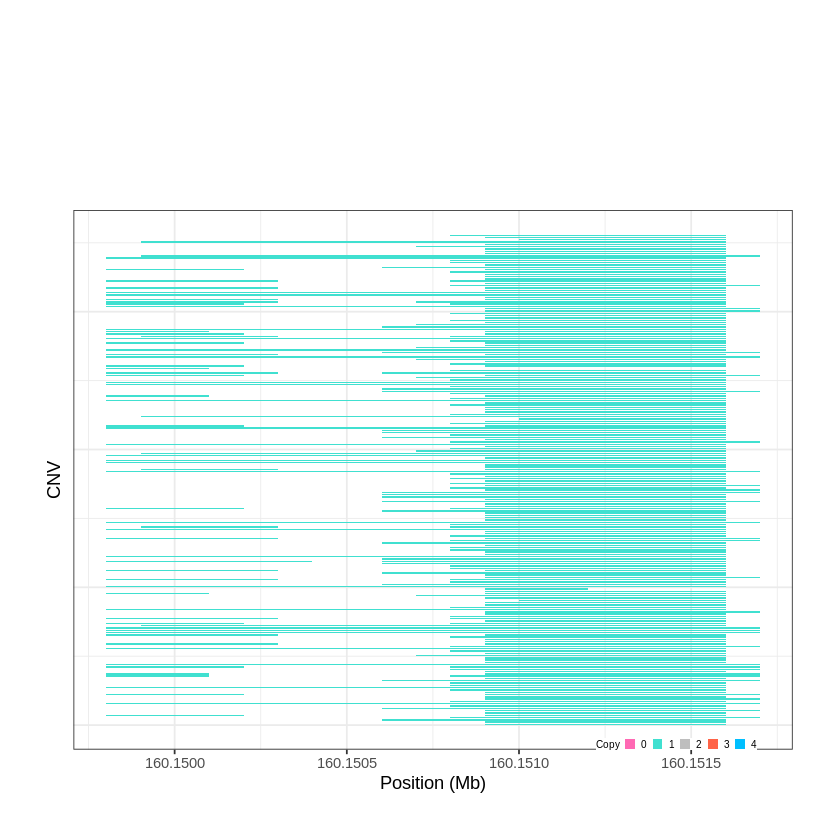

Task done, plot was stored in working directory.
[1] "Ploting CNVR 313..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 162.331901 - 162.3432 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


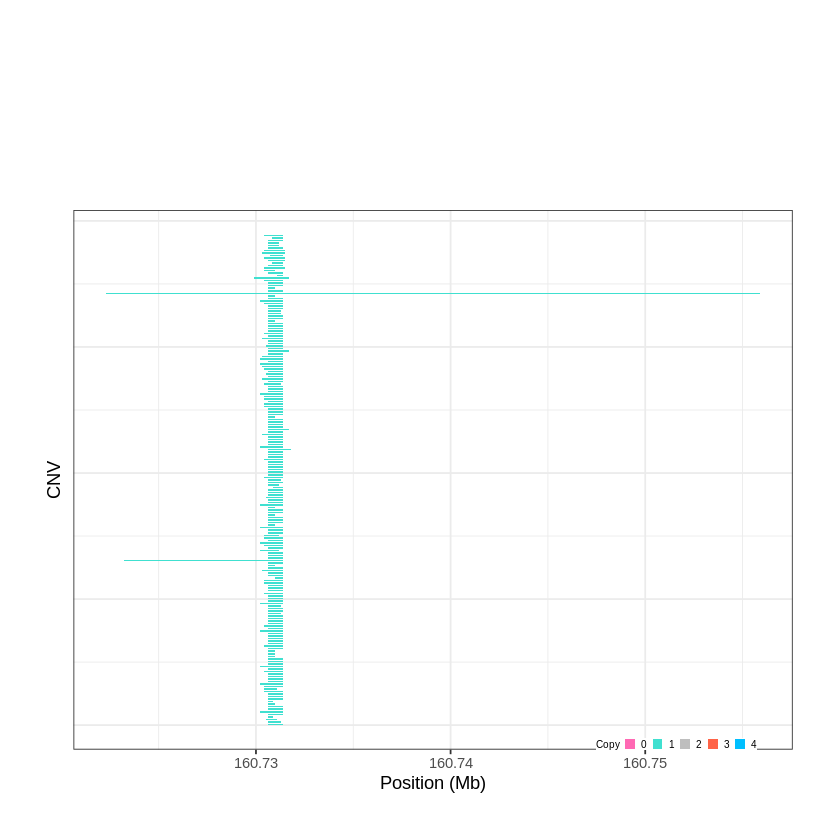

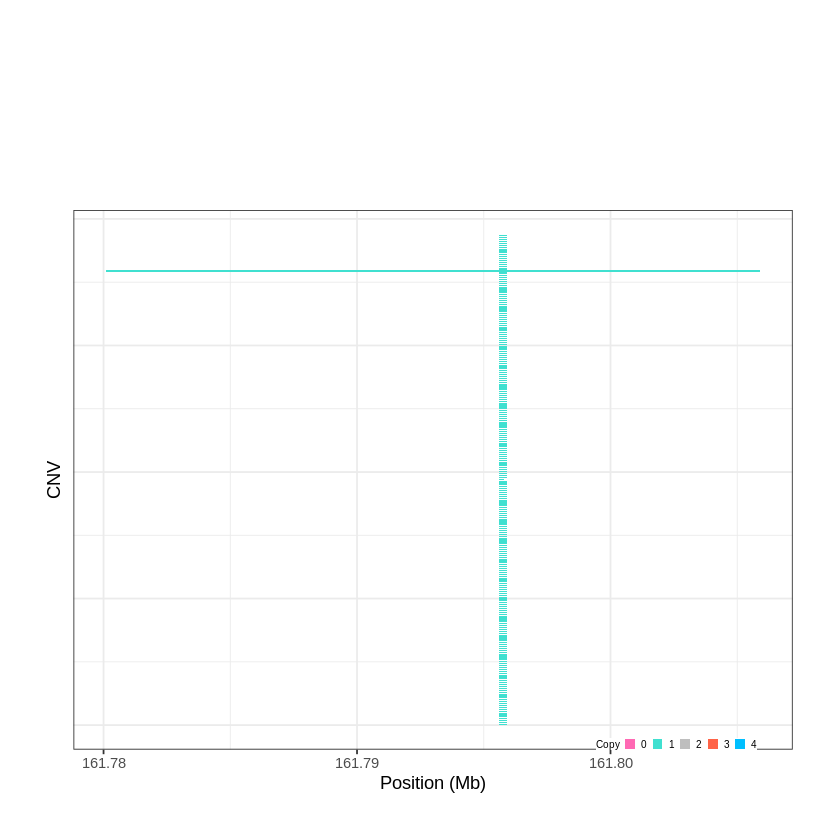

Task done, plot was stored in working directory.
[1] "Ploting CNVR 314..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 165.750201 - 166.0984 Mb with 140 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 315..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 167.152301 - 167.1763 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


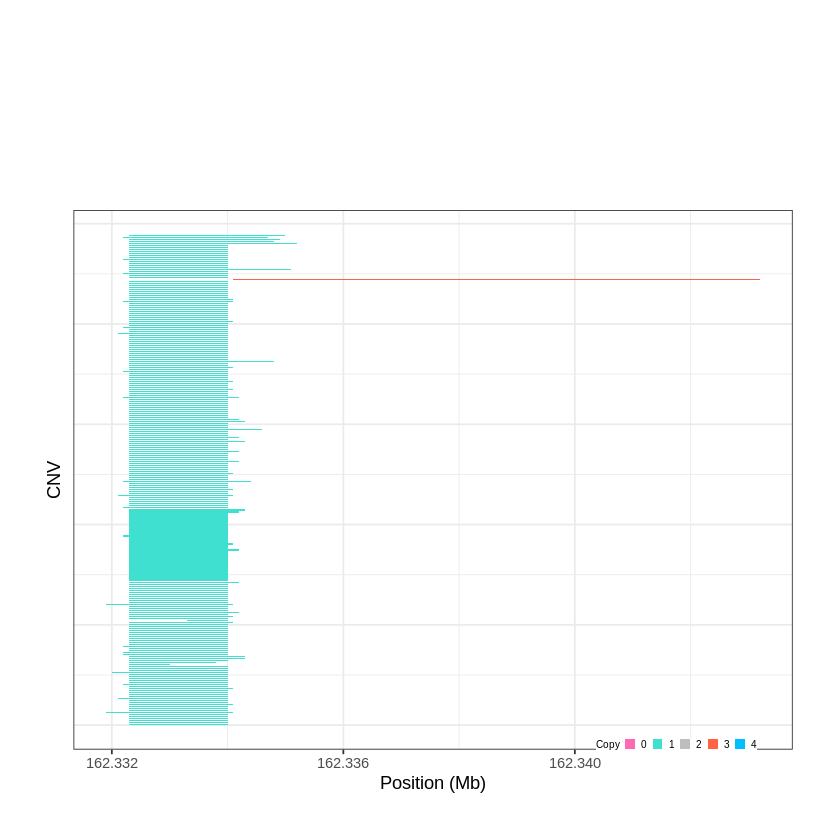

Task done, plot was stored in working directory.
[1] "Ploting CNVR 316..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 167.545401 - 167.6472 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


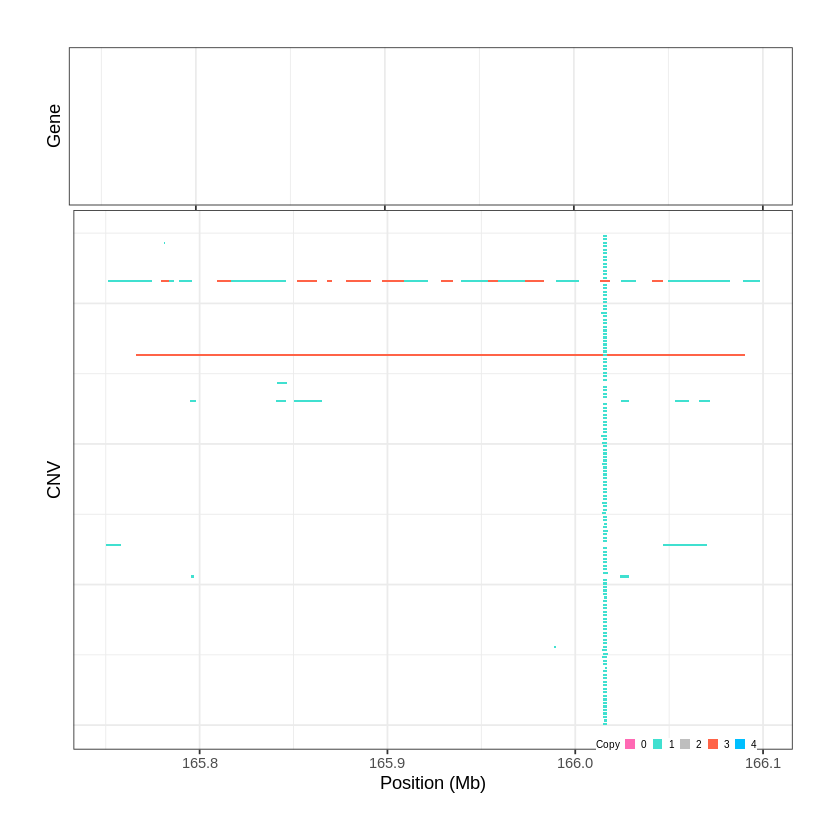

Task done, plot was stored in working directory.
[1] "Ploting CNVR 317..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 167.801101 - 167.8518 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


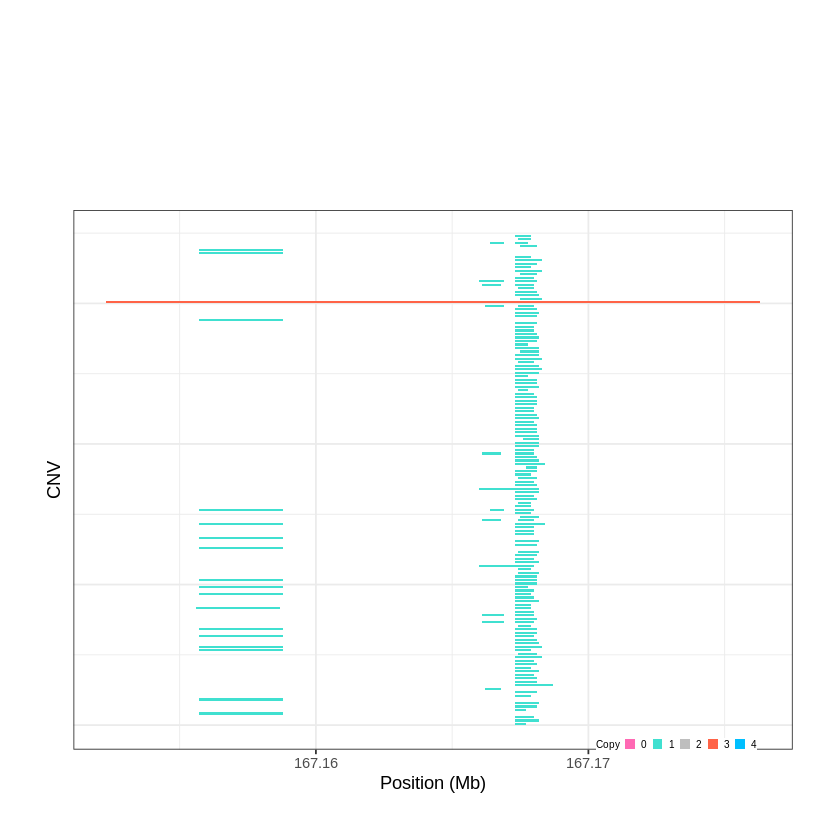

Task done, plot was stored in working directory.
[1] "Ploting CNVR 318..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 170.091001 - 170.1328 Mb with 219 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


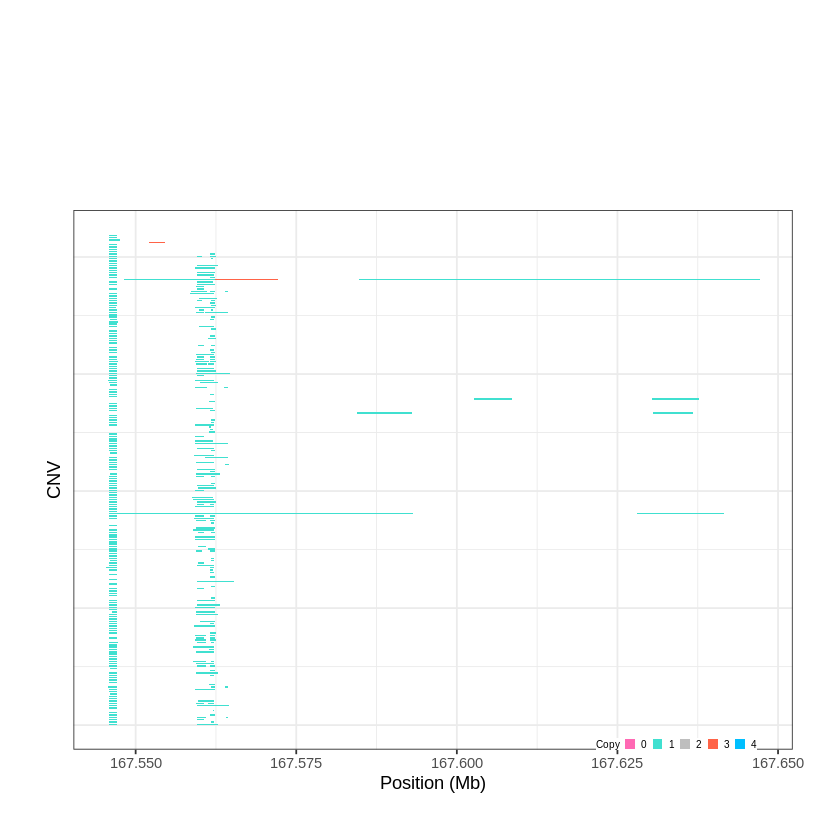

Task done, plot was stored in working directory.
[1] "Ploting CNVR 319..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 170.299001 - 170.3253 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


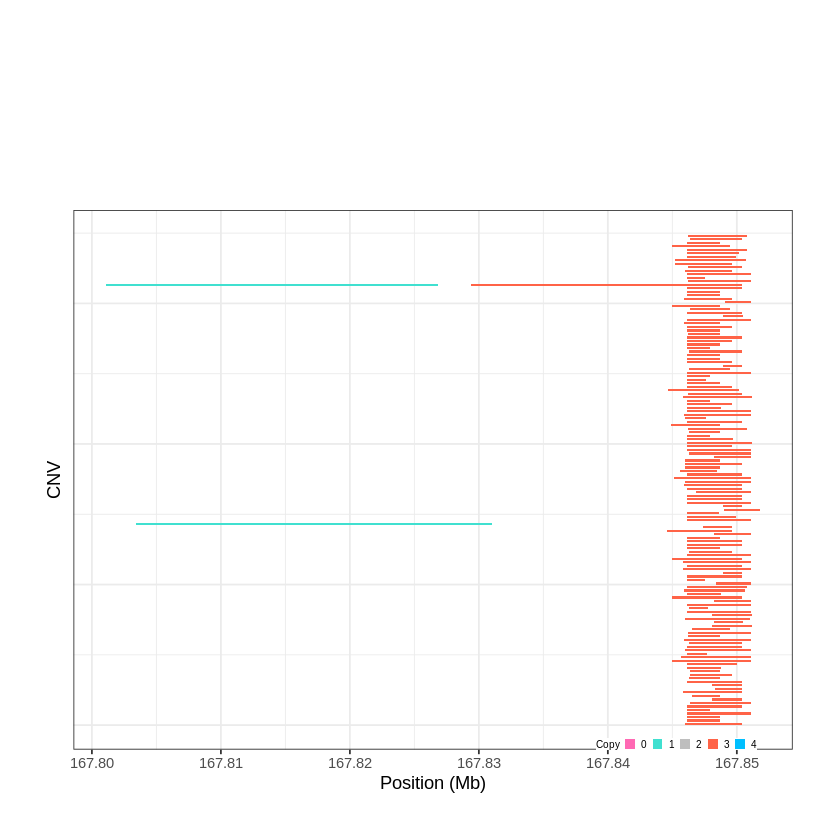

Task done, plot was stored in working directory.
[1] "Ploting CNVR 320..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 170.595001 - 170.5959 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


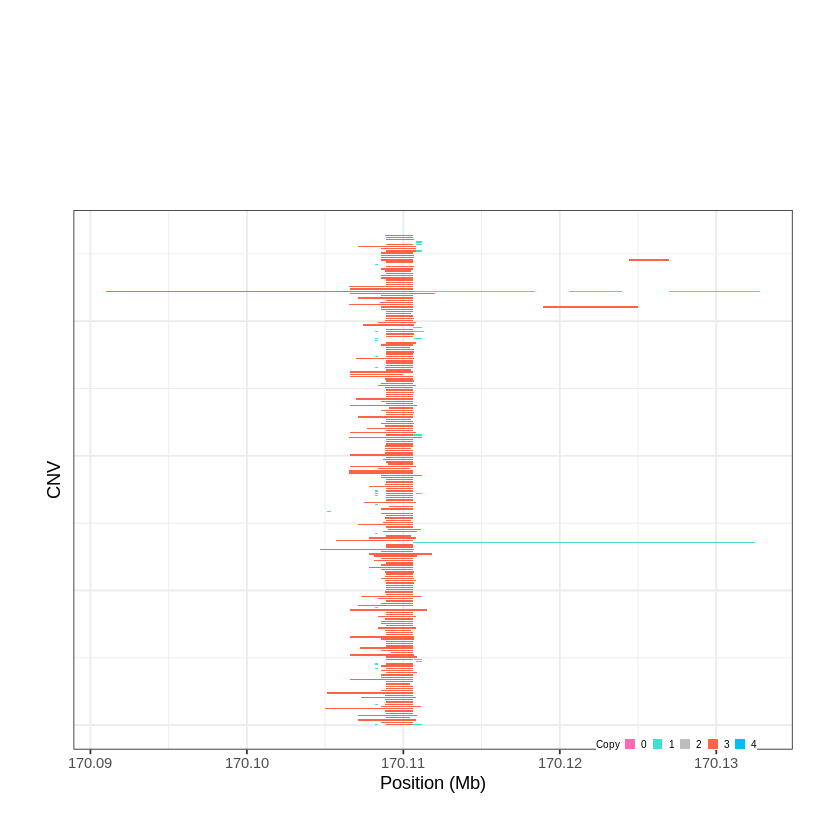

Task done, plot was stored in working directory.
[1] "Ploting CNVR 321..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 170.613601 - 170.6581 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


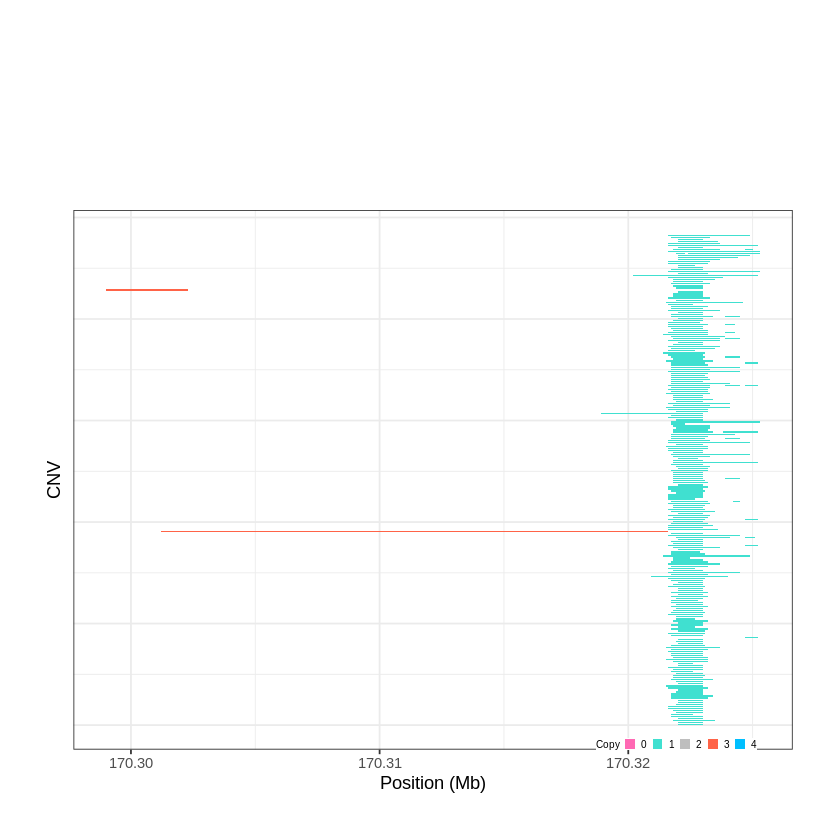

Task done, plot was stored in working directory.
[1] "Ploting CNVR 322..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 172.863101 - 172.9116 Mb with 184 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


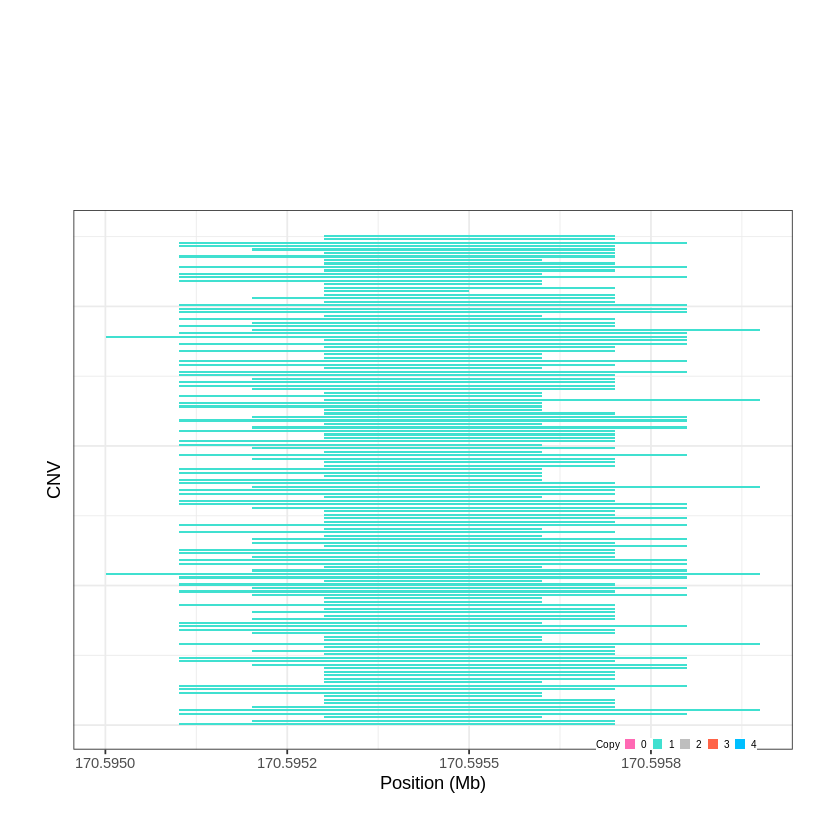

Task done, plot was stored in working directory.
[1] "Ploting CNVR 323..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 172.996001 - 173.0095 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


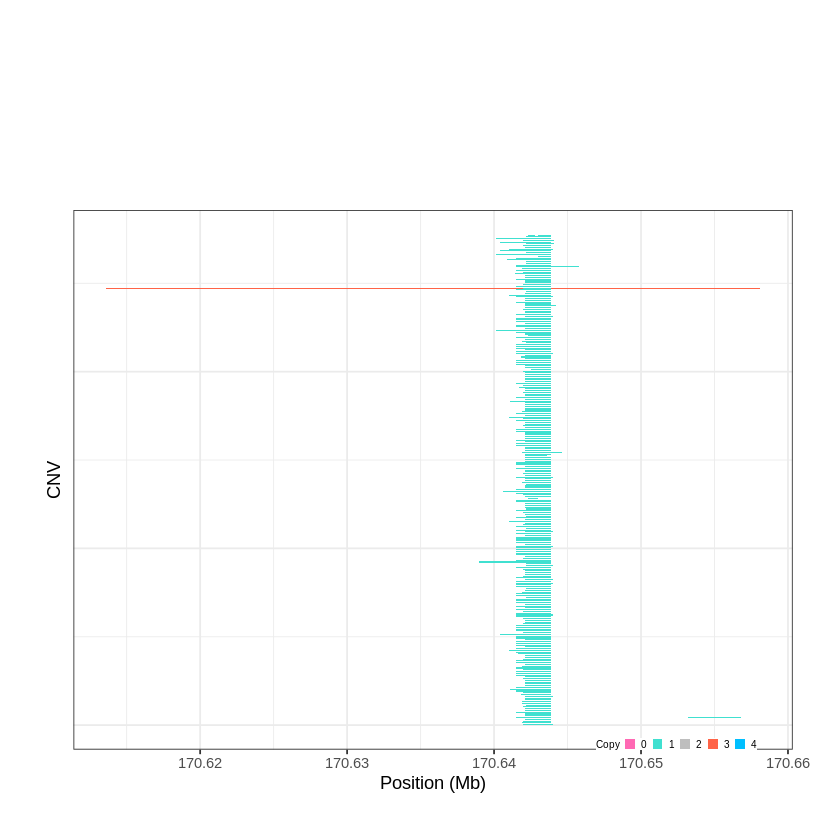

Task done, plot was stored in working directory.
[1] "Ploting CNVR 324..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 173.179501 - 173.2039 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


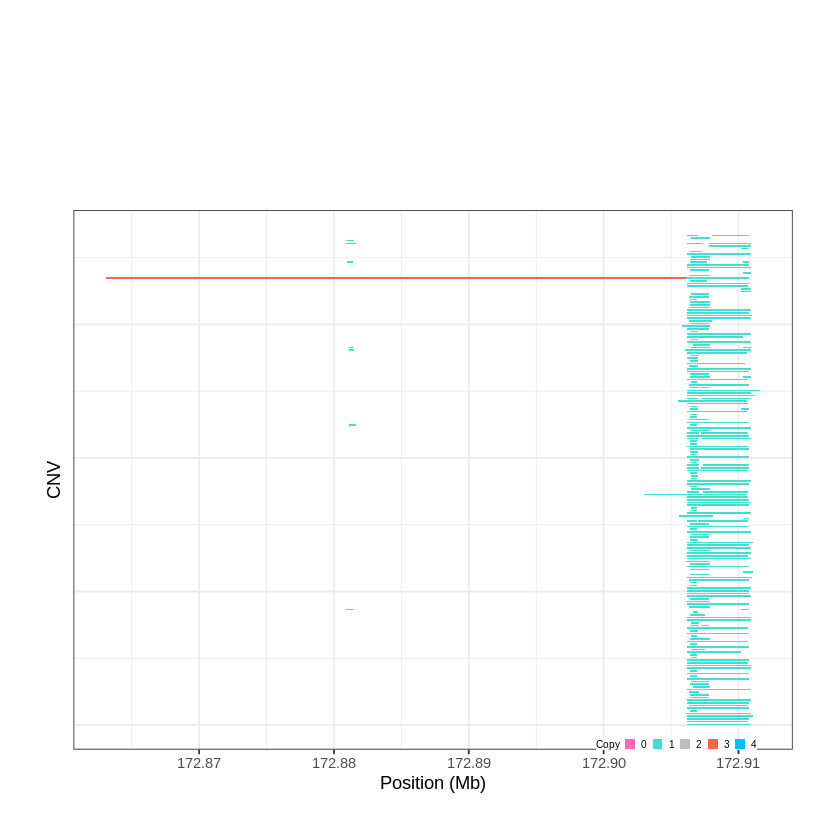

Task done, plot was stored in working directory.
[1] "Ploting CNVR 325..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 174.561601 - 174.5763 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


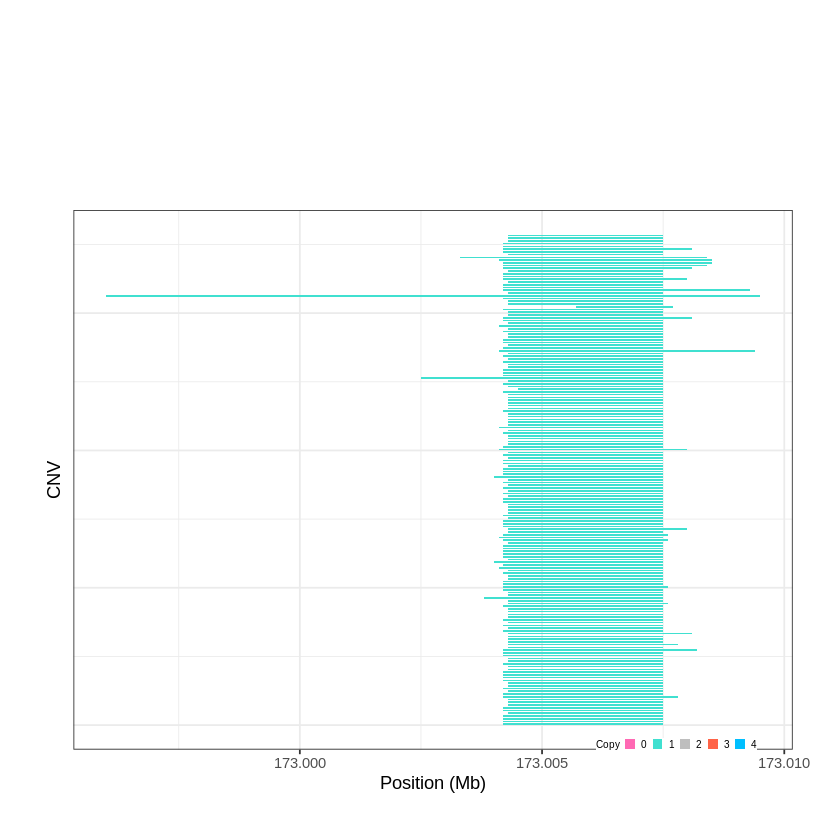

Task done, plot was stored in working directory.
[1] "Ploting CNVR 326..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 176.624101 - 176.6306 Mb with 239 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


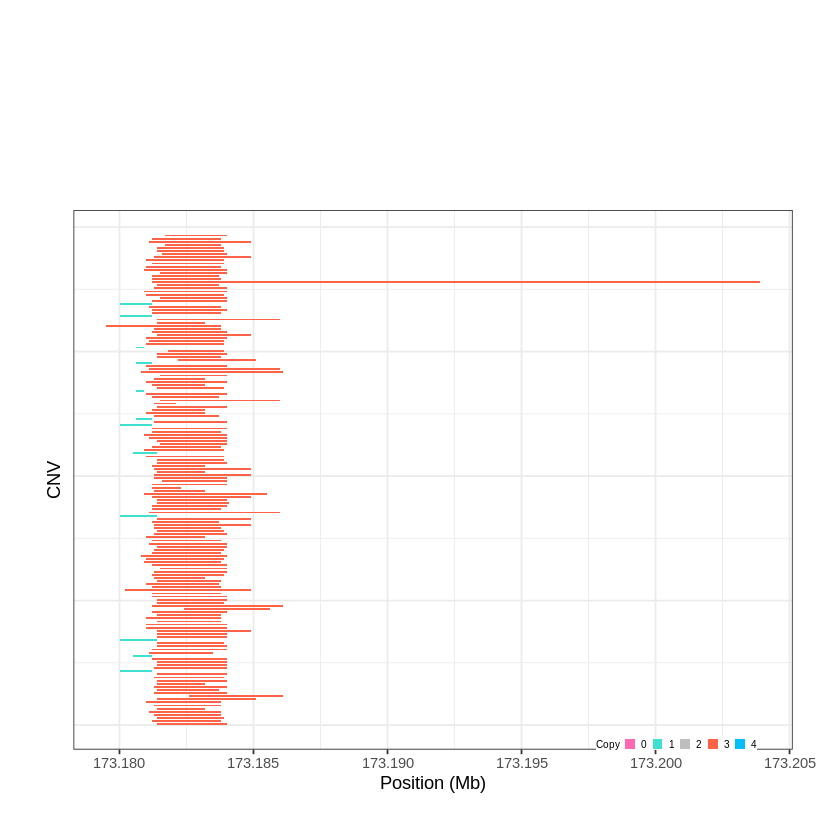

Task done, plot was stored in working directory.
[1] "Ploting CNVR 327..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 176.677401 - 176.68 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


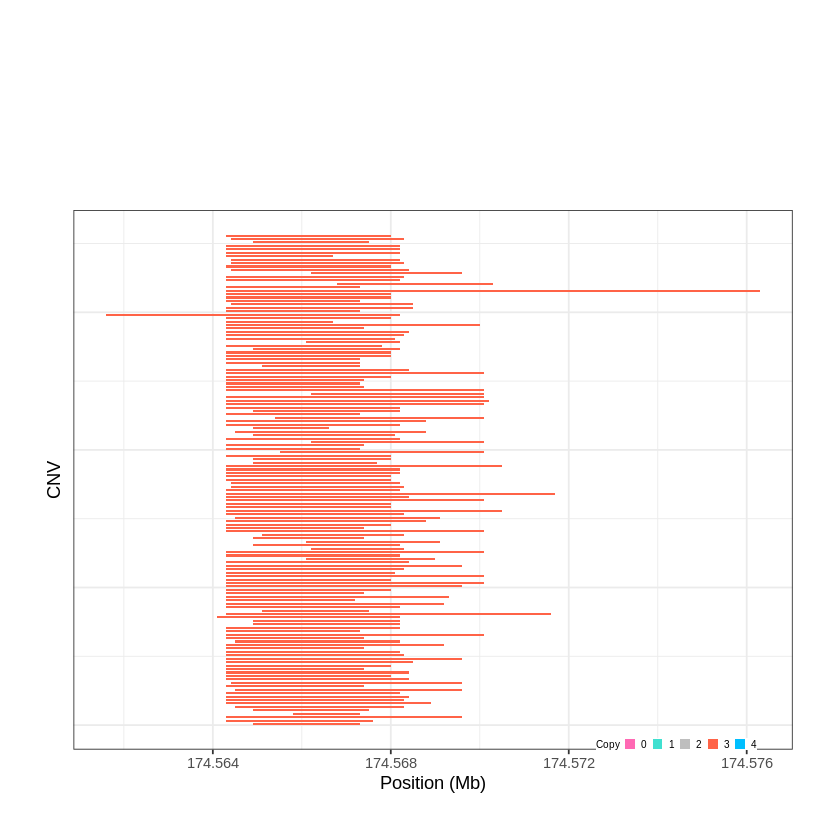

Task done, plot was stored in working directory.
[1] "Ploting CNVR 328..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 177.262901 - 177.2873 Mb with 250 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


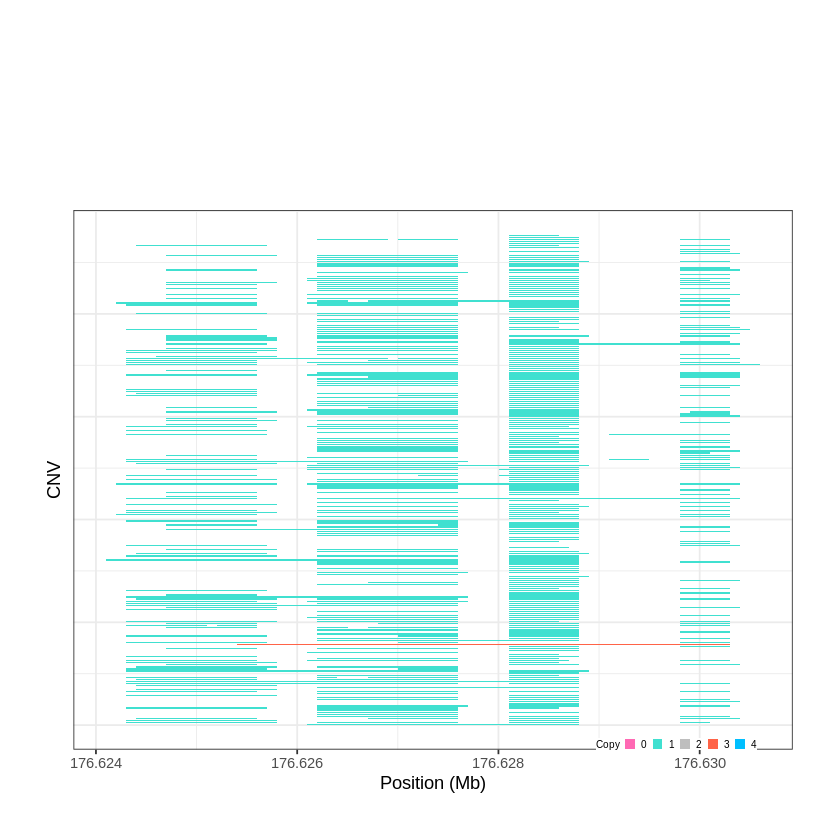

Task done, plot was stored in working directory.
[1] "Ploting CNVR 329..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 178.838201 - 178.8481 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


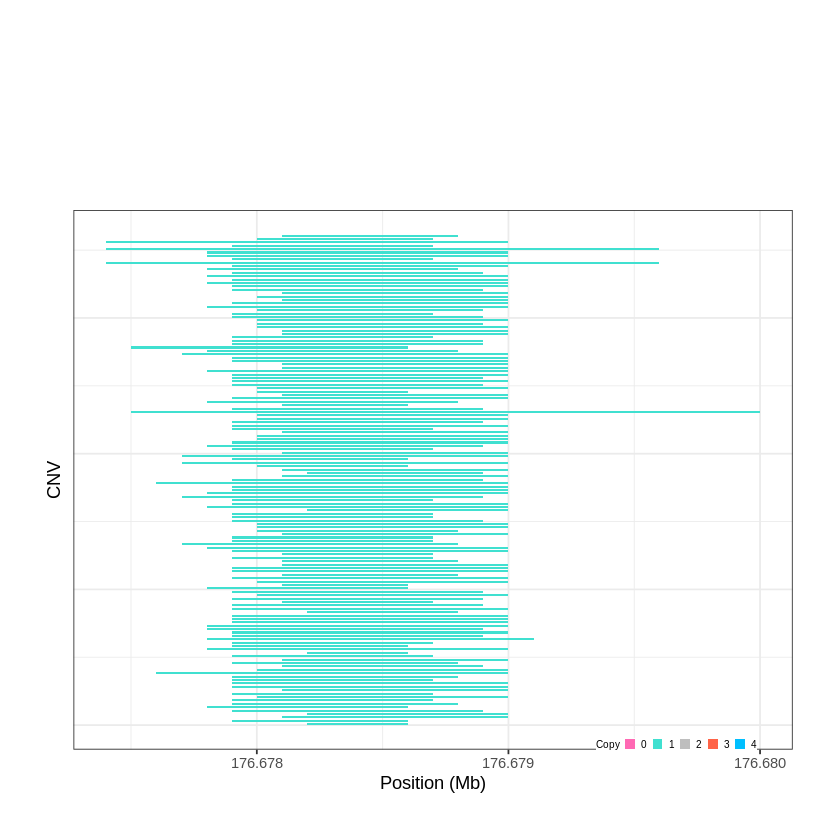

Task done, plot was stored in working directory.
[1] "Ploting CNVR 330..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 181.695201 - 181.708 Mb with 236 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


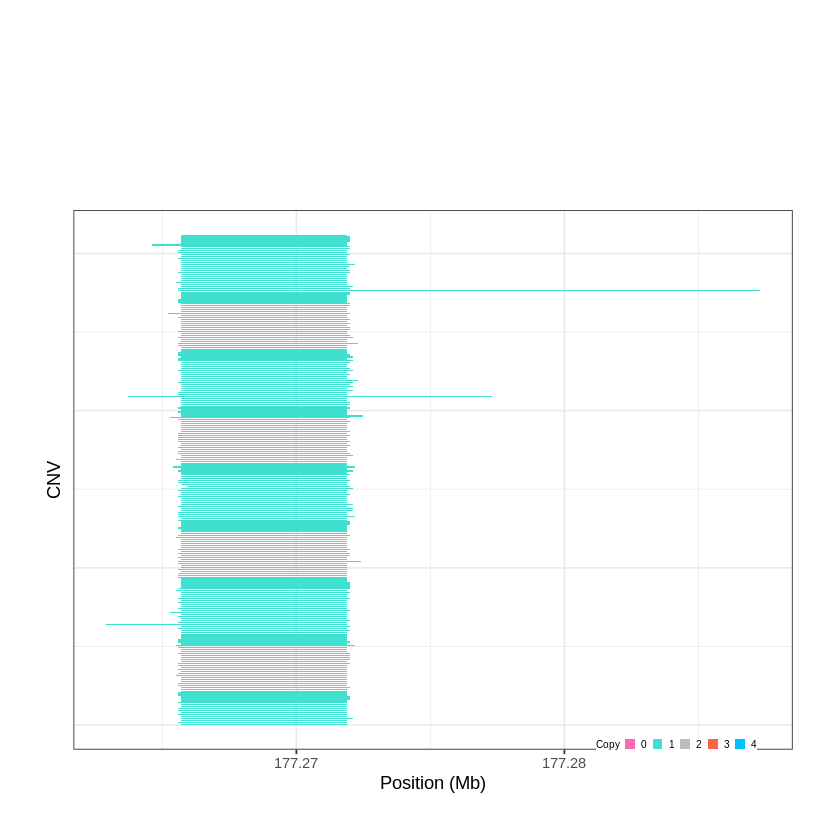

Task done, plot was stored in working directory.
[1] "Ploting CNVR 331..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 182.356001 - 182.3563 Mb with 244 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


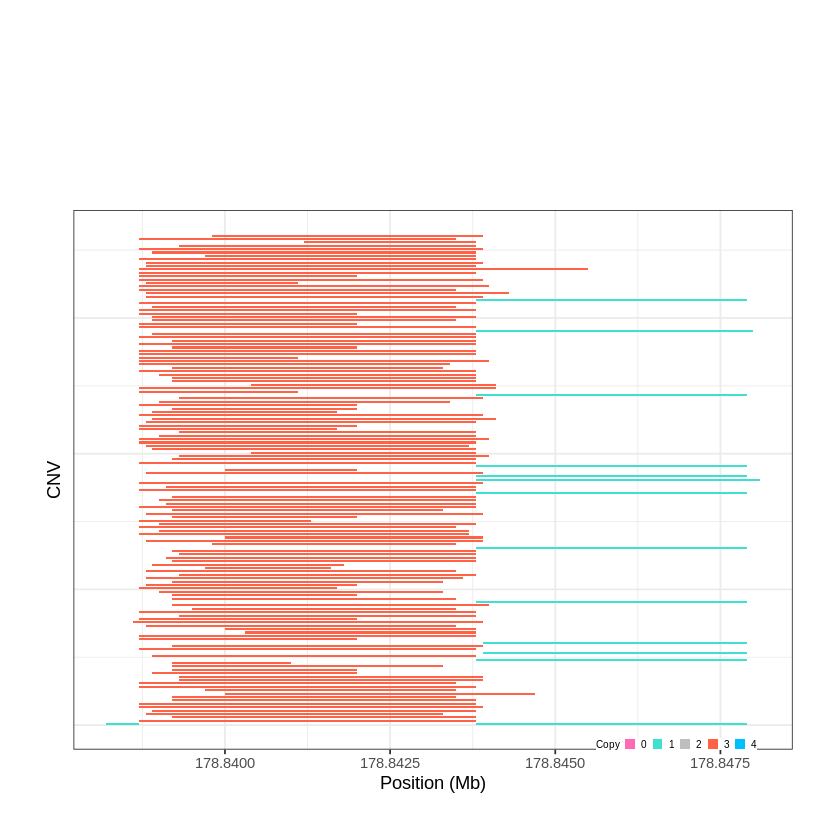

Task done, plot was stored in working directory.
[1] "Ploting CNVR 332..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 182.413001 - 182.516 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


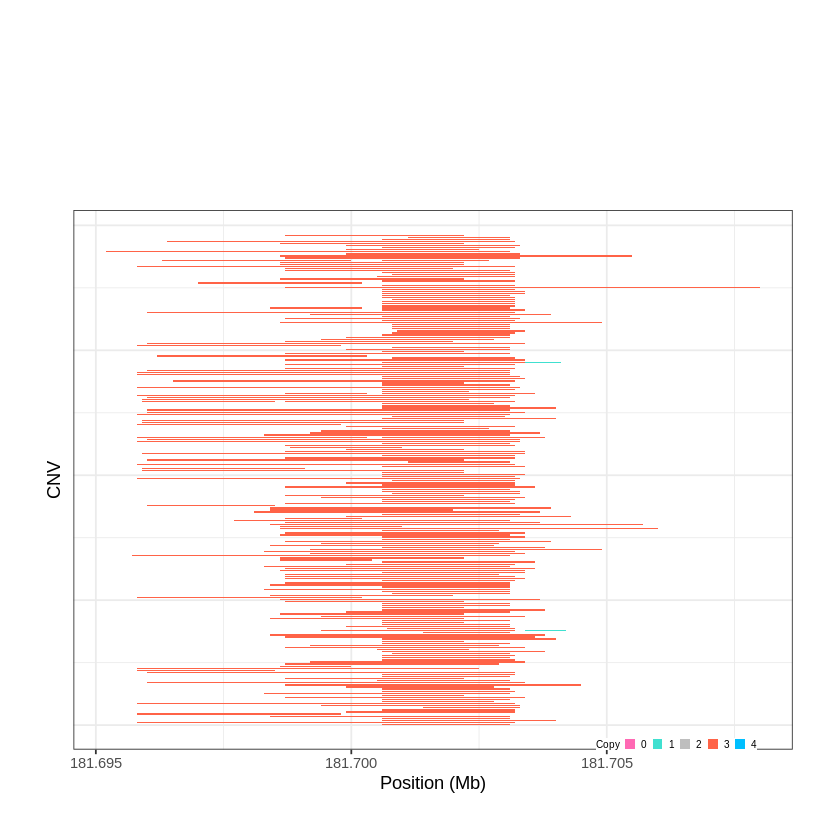

Task done, plot was stored in working directory.
[1] "Ploting CNVR 333..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 183.271801 - 183.3654 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


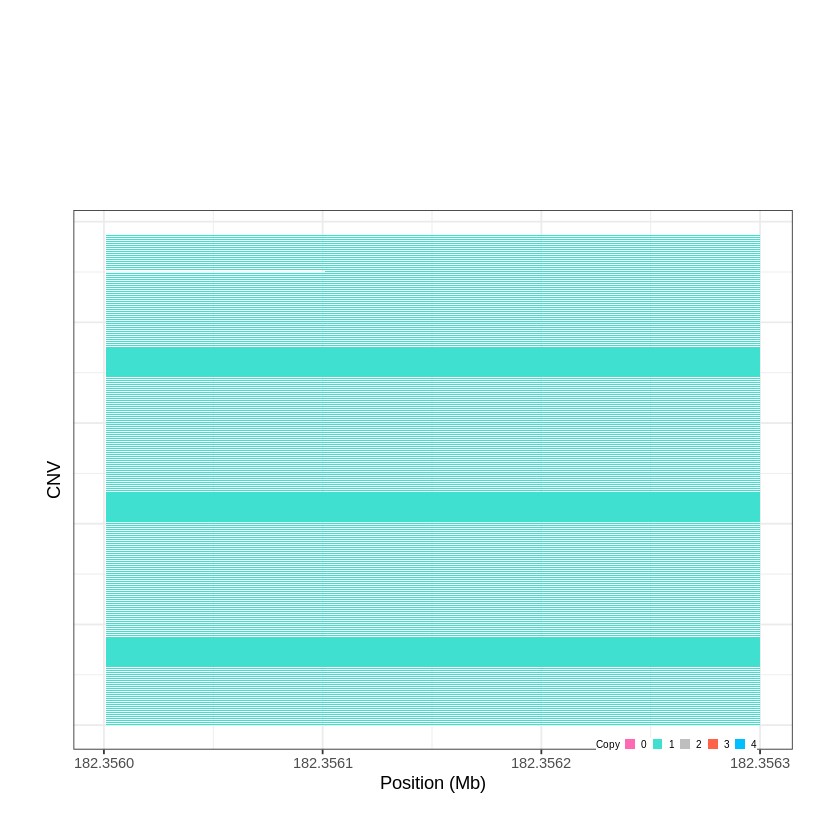

Task done, plot was stored in working directory.
[1] "Ploting CNVR 334..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 185.806201 - 185.8409 Mb with 255 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


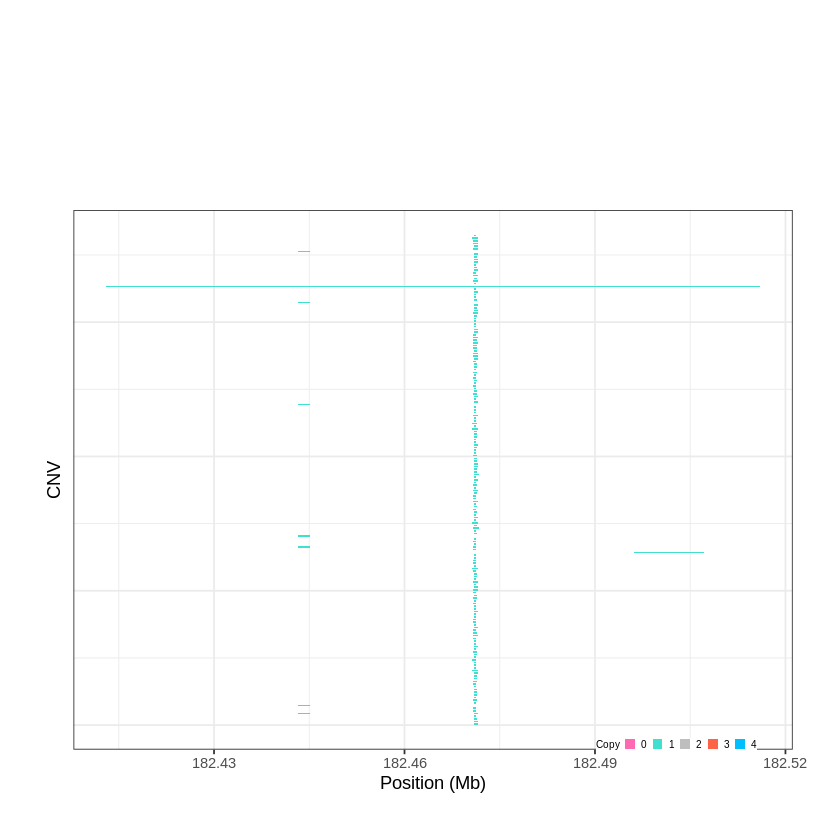

Task done, plot was stored in working directory.
[1] "Ploting CNVR 335..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 187.437101 - 187.4373 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


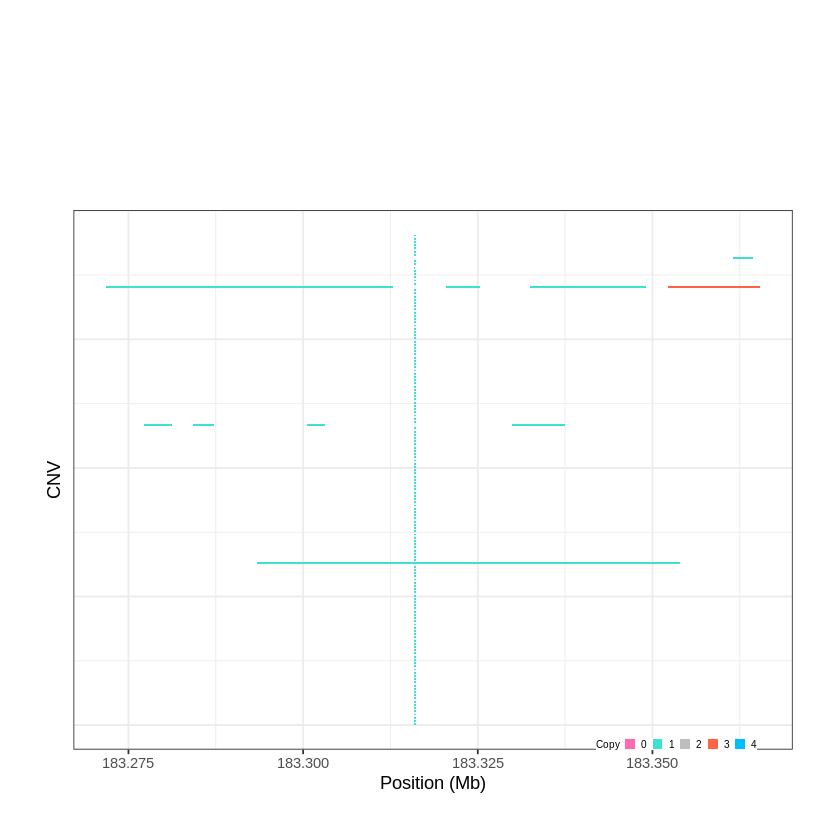

Task done, plot was stored in working directory.
[1] "Ploting CNVR 336..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 188.194901 - 188.2479 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


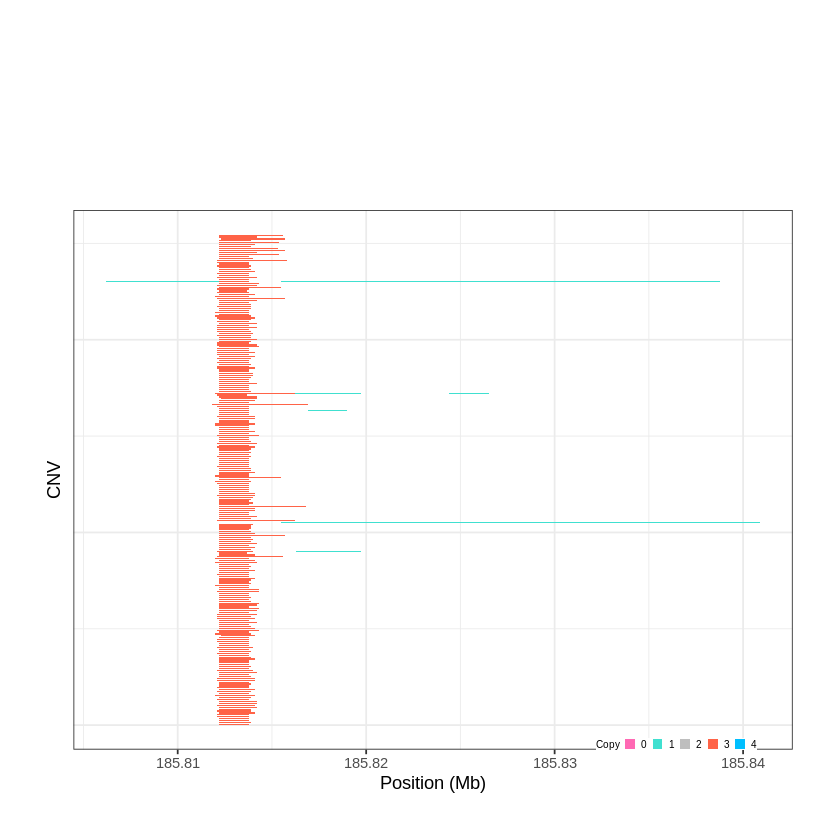

Task done, plot was stored in working directory.
[1] "Ploting CNVR 337..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 193.130601 - 193.1411 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


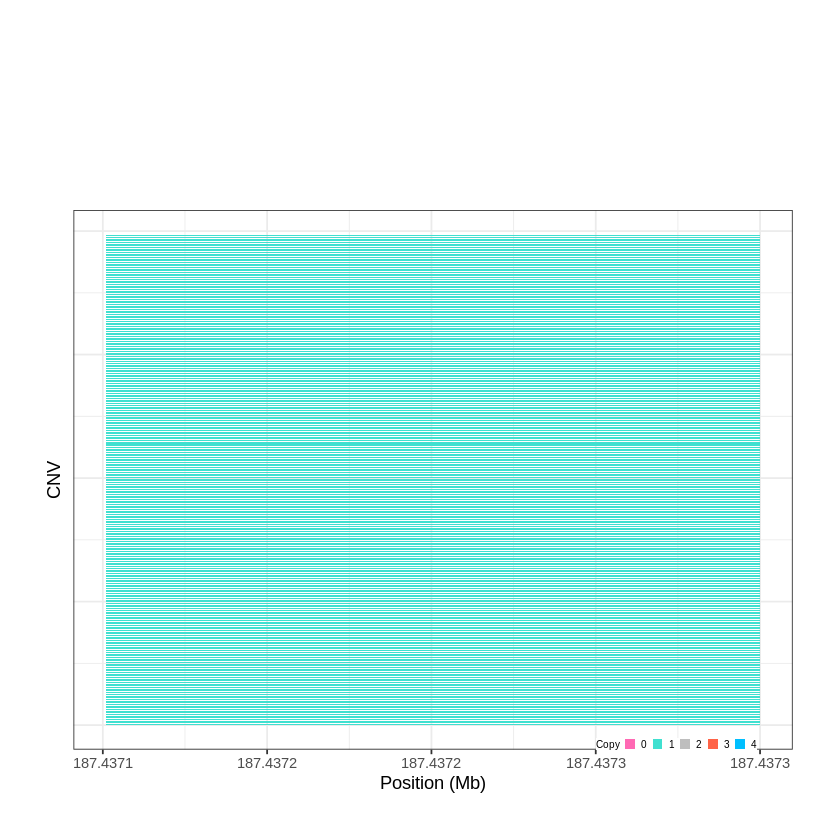

Task done, plot was stored in working directory.
[1] "Ploting CNVR 338..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 193.355401 - 193.3557 Mb with 236 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


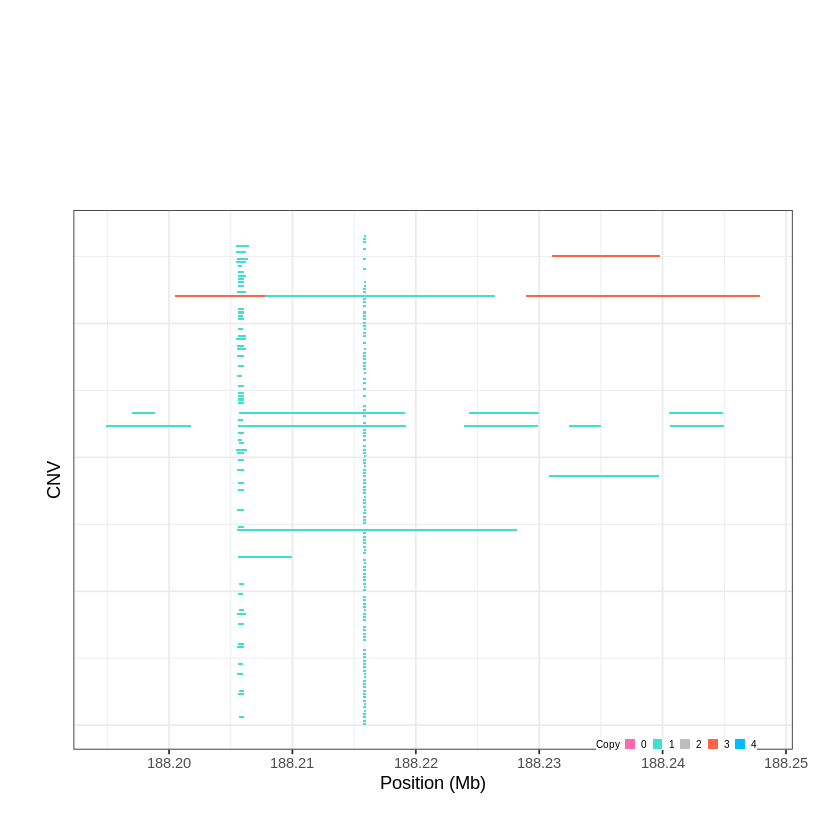

Task done, plot was stored in working directory.
[1] "Ploting CNVR 339..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 194.075801 - 194.0887 Mb with 254 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


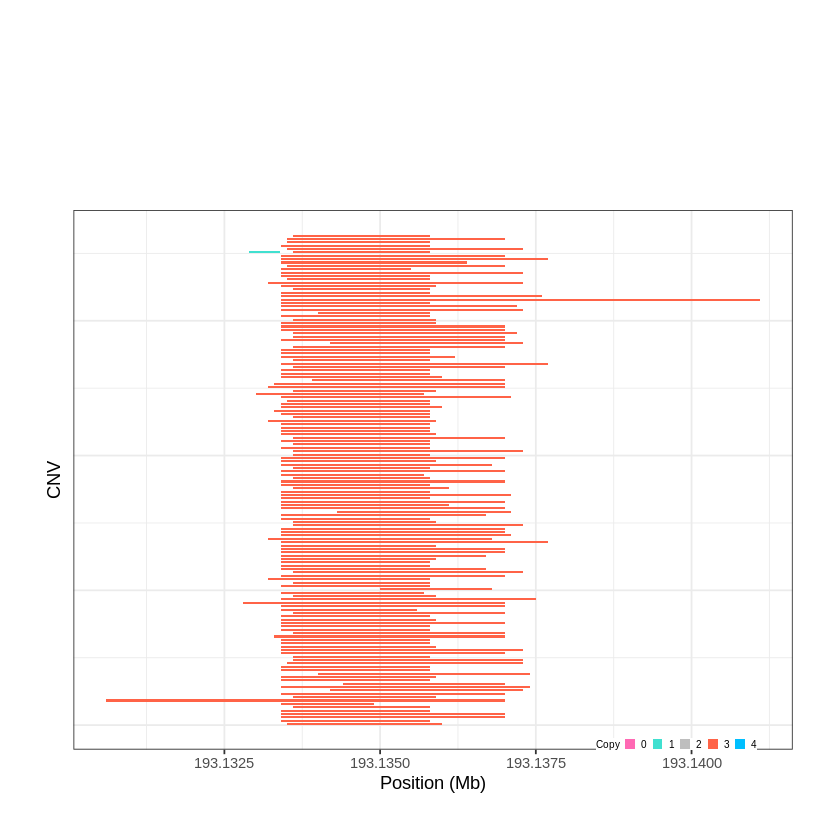

Task done, plot was stored in working directory.
[1] "Ploting CNVR 340..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 194.647501 - 194.742 Mb with 273 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


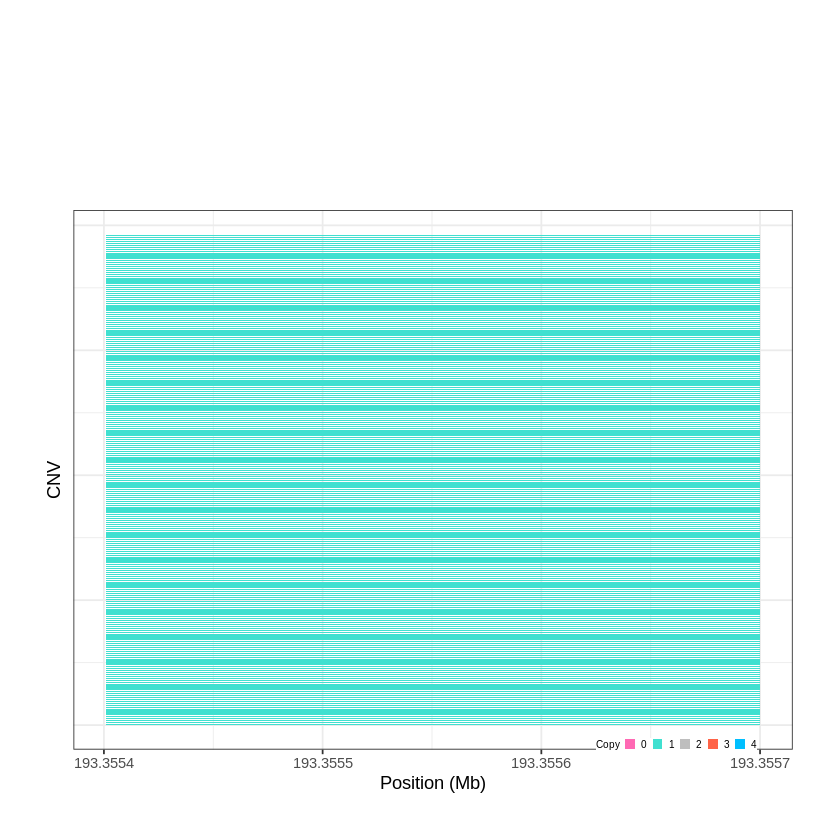

Task done, plot was stored in working directory.
[1] "Ploting CNVR 341..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 194.890701 - 194.9334 Mb with 254 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


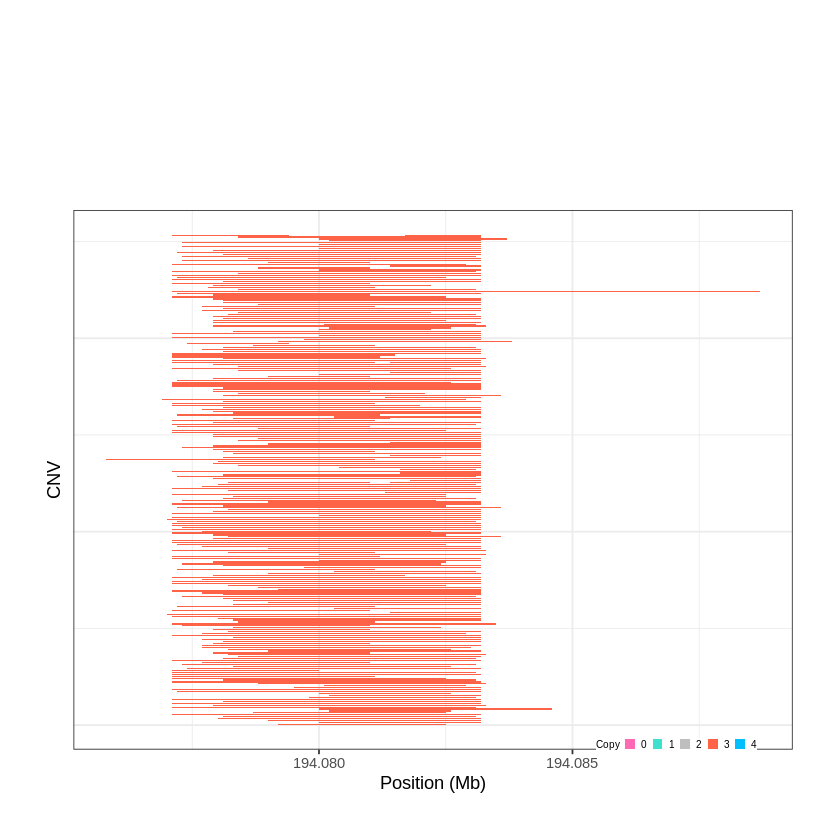

Task done, plot was stored in working directory.
[1] "Ploting CNVR 342..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 195.294601 - 195.7219 Mb with 261 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


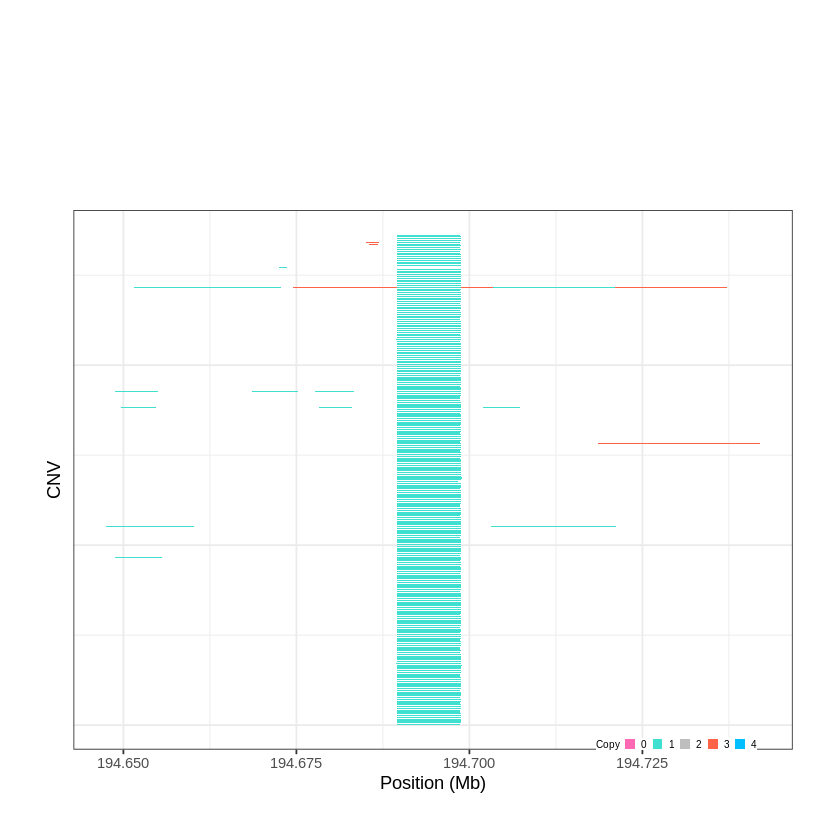

Task done, plot was stored in working directory.
[1] "Ploting CNVR 343..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 195.986901 - 196.0887 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


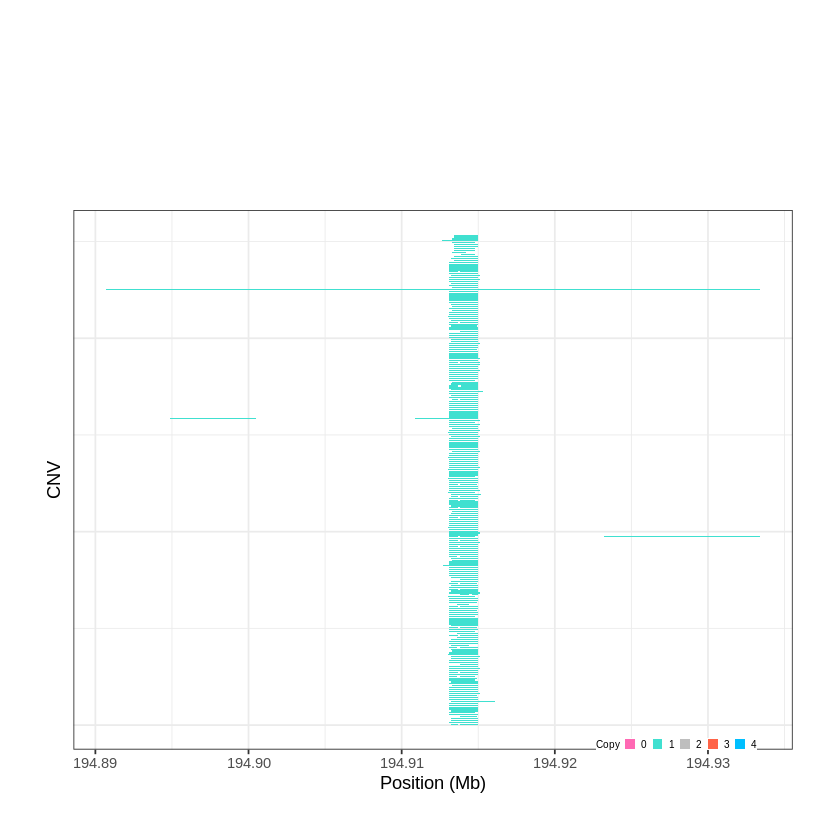

Task done, plot was stored in working directory.
[1] "Ploting CNVR 344..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 196.214801 - 196.2152 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


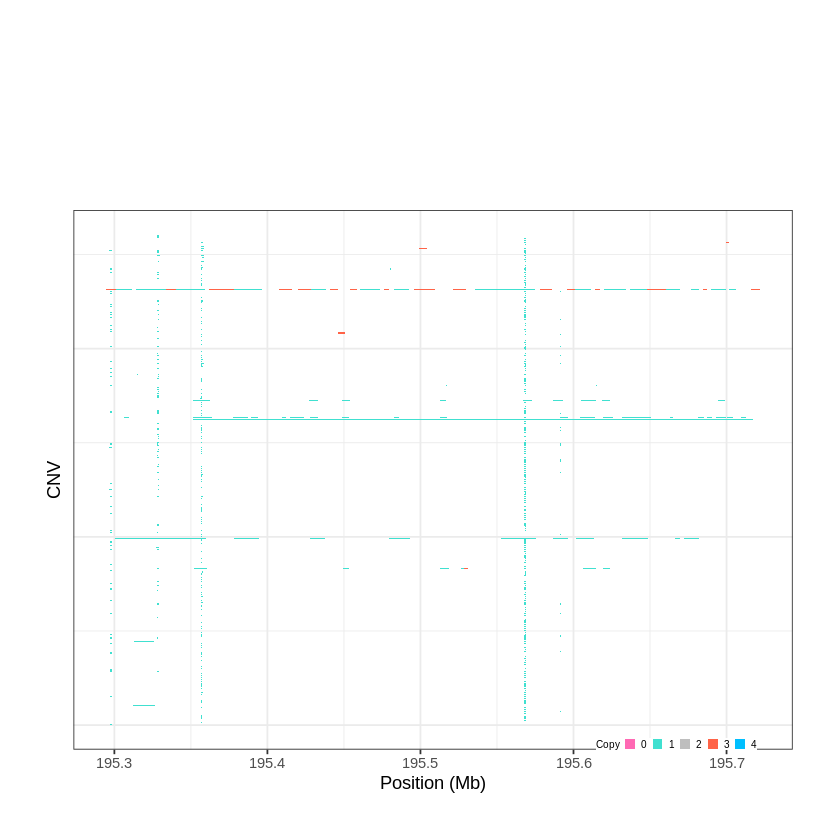

Task done, plot was stored in working directory.
[1] "Ploting CNVR 345..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 196.409001 - 196.5275 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


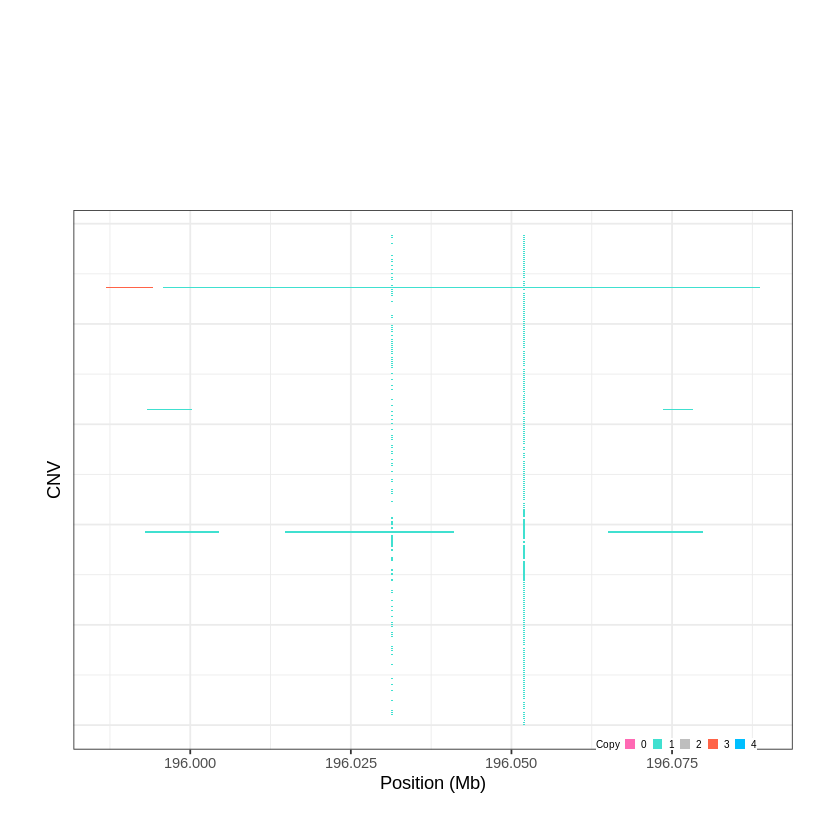

Task done, plot was stored in working directory.
[1] "Ploting CNVR 346..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 197.462501 - 197.4636 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


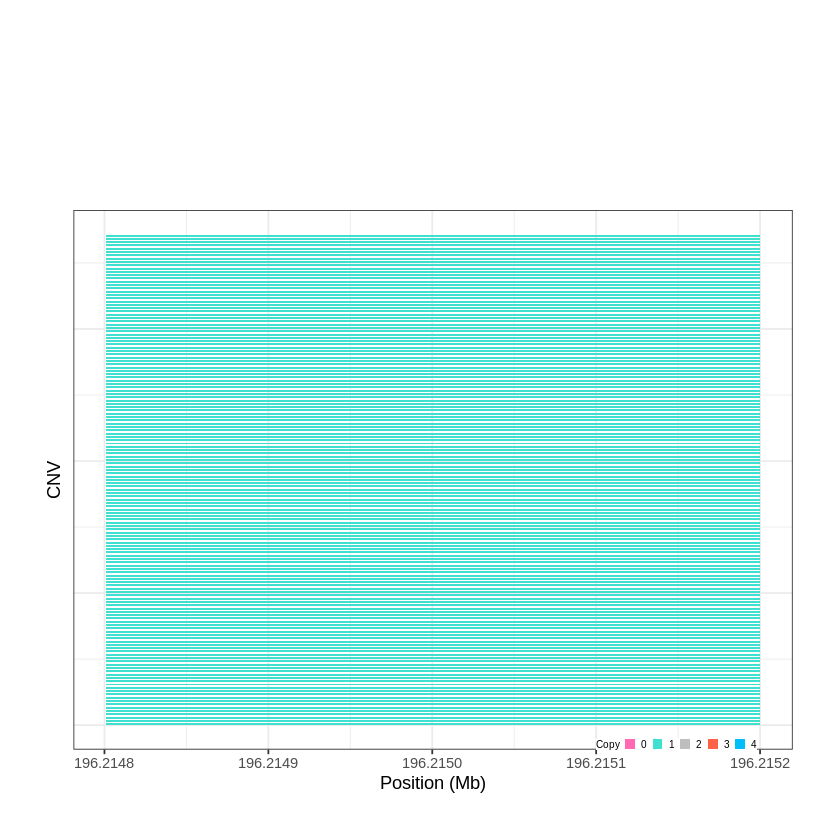

Task done, plot was stored in working directory.
[1] "Ploting CNVR 347..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 197.749901 - 197.7877 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


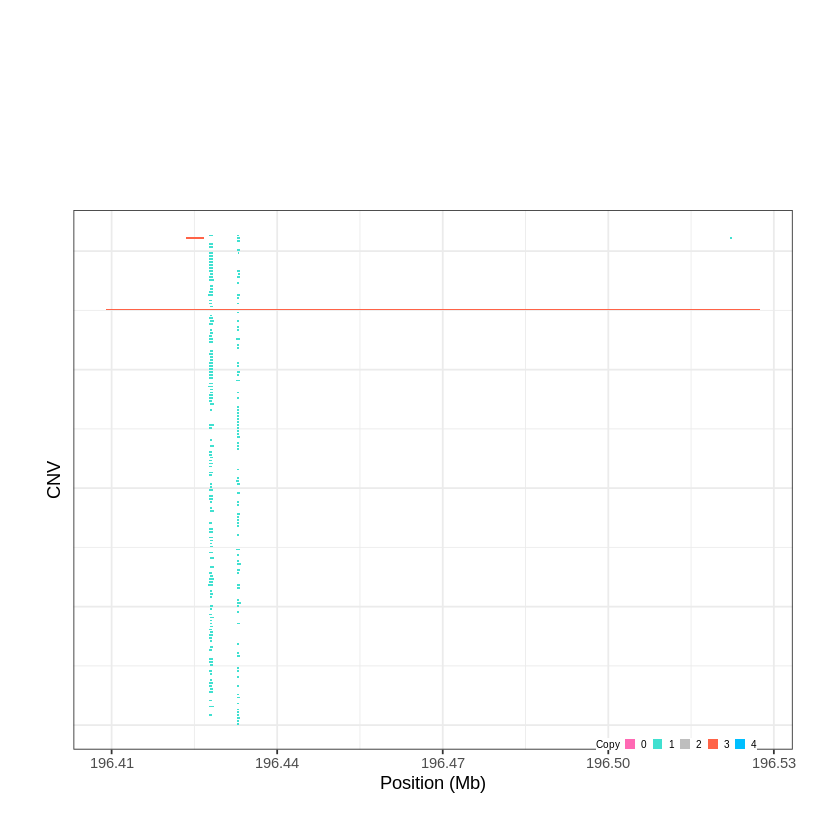

Task done, plot was stored in working directory.
[1] "Ploting CNVR 348..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 206.745401 - 206.7465 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


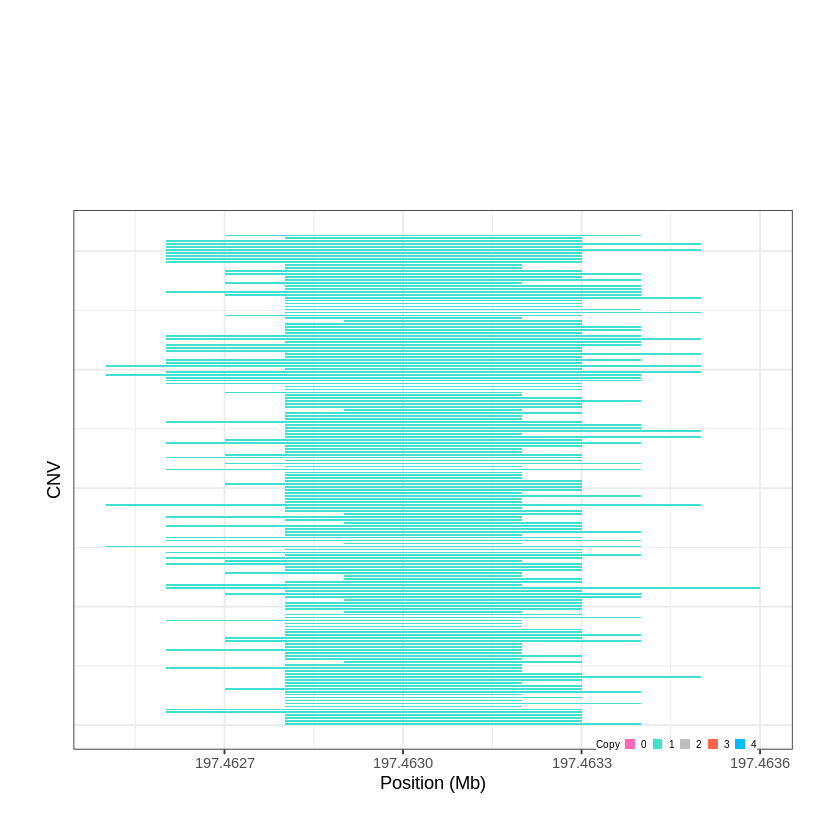

Task done, plot was stored in working directory.
[1] "Ploting CNVR 349..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 206.998701 - 207.057 Mb with 226 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


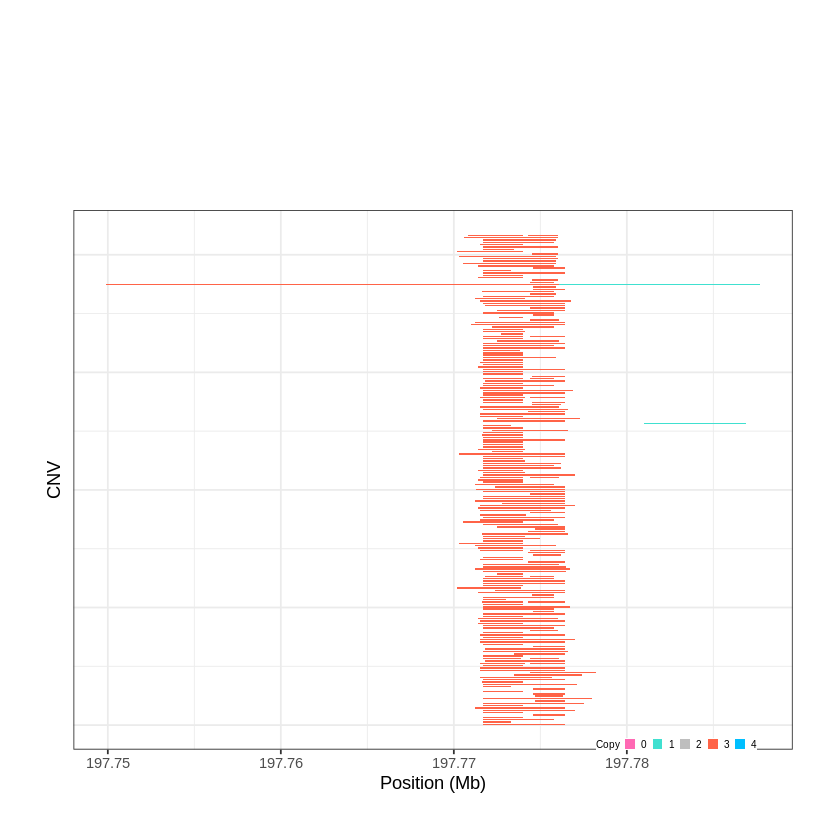

Task done, plot was stored in working directory.
[1] "Ploting CNVR 350..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 208.514001 - 208.5865 Mb with 216 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


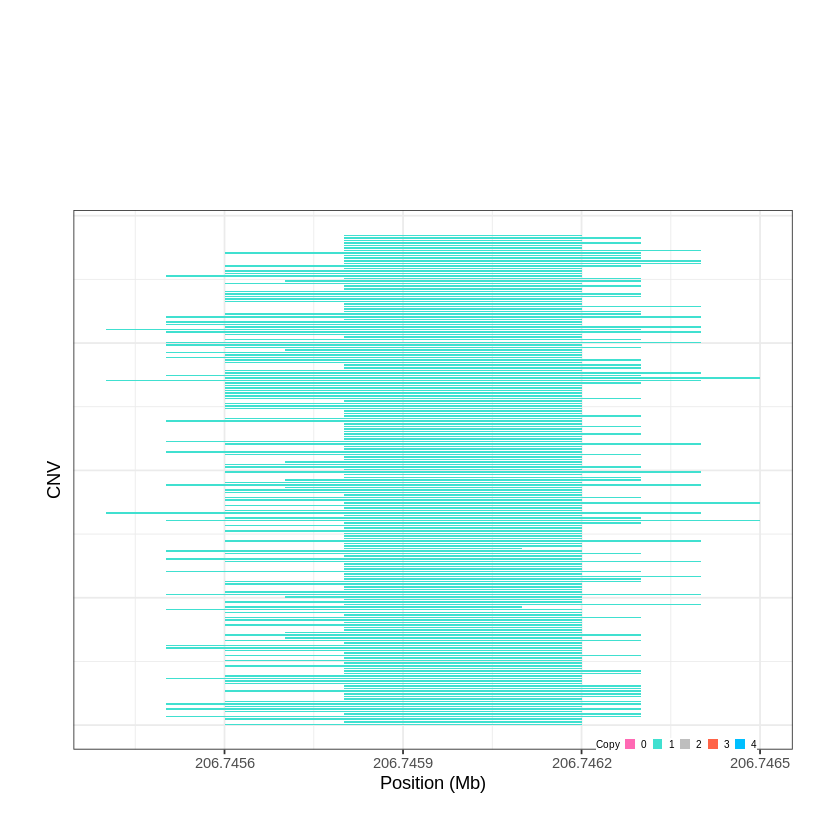

Task done, plot was stored in working directory.
[1] "Ploting CNVR 351..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 214.415901 - 214.4508 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


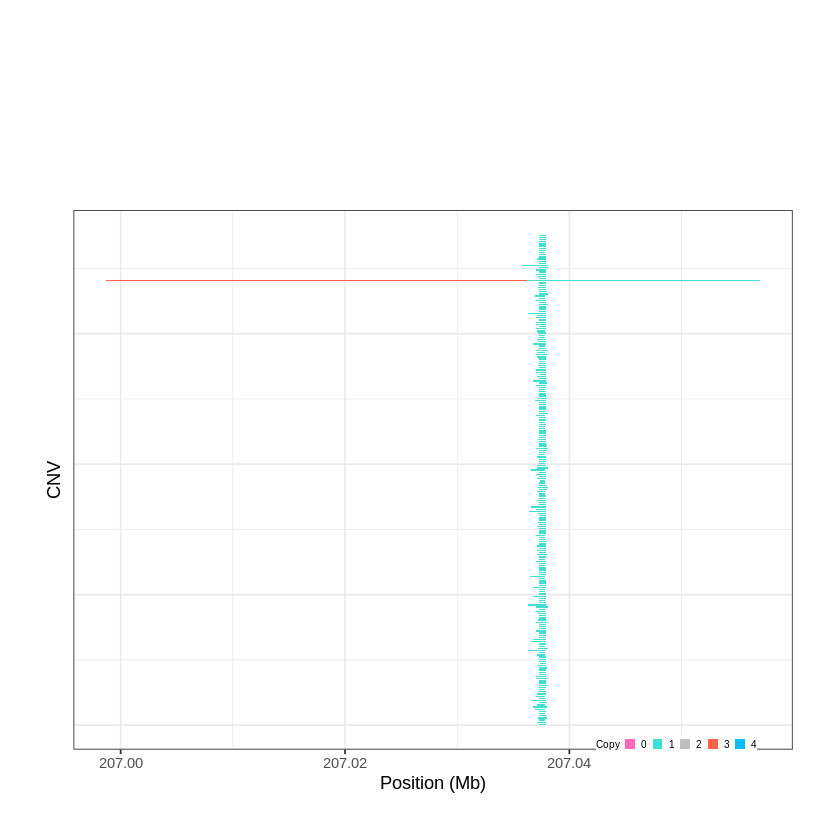

Task done, plot was stored in working directory.
[1] "Ploting CNVR 352..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 215.536301 - 215.5795 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


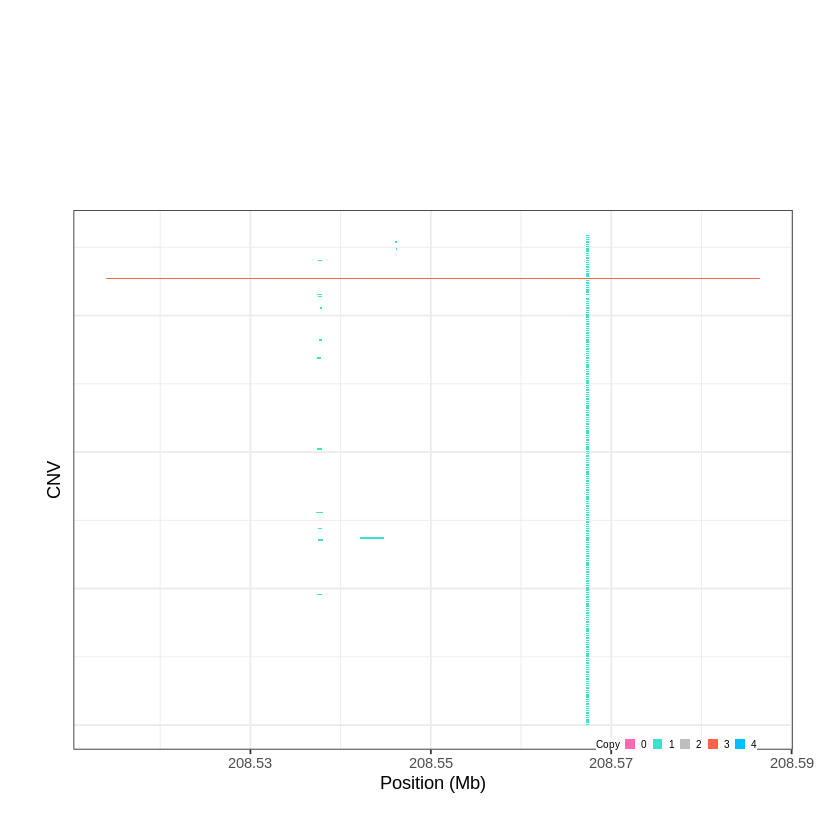

Task done, plot was stored in working directory.
[1] "Ploting CNVR 353..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 215.698001 - 215.7021 Mb with 251 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


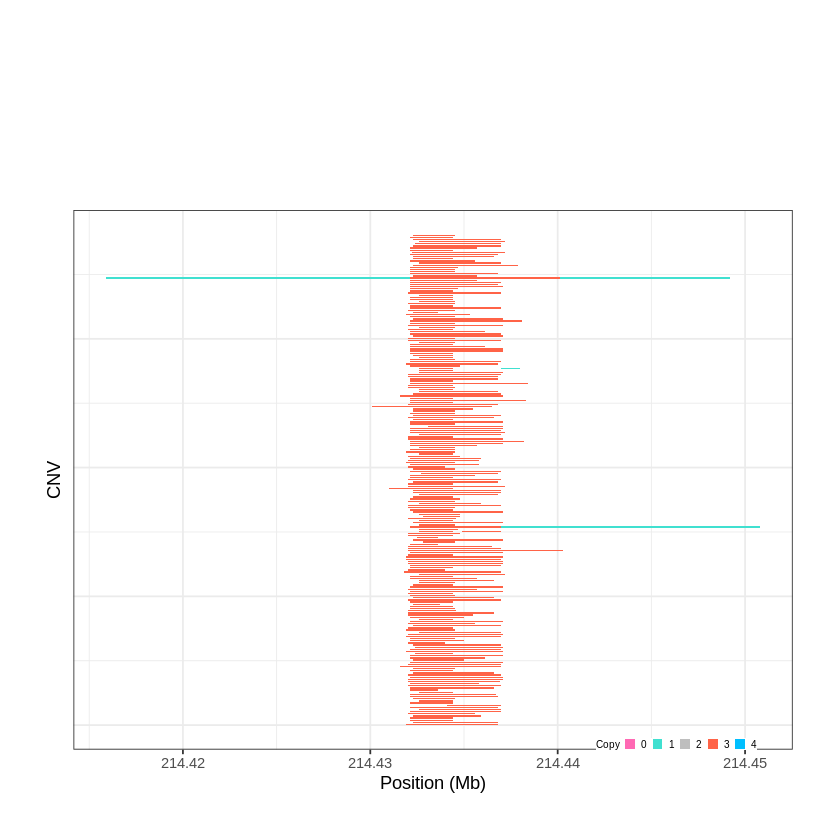

Task done, plot was stored in working directory.
[1] "Ploting CNVR 354..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 215.726401 - 215.745 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


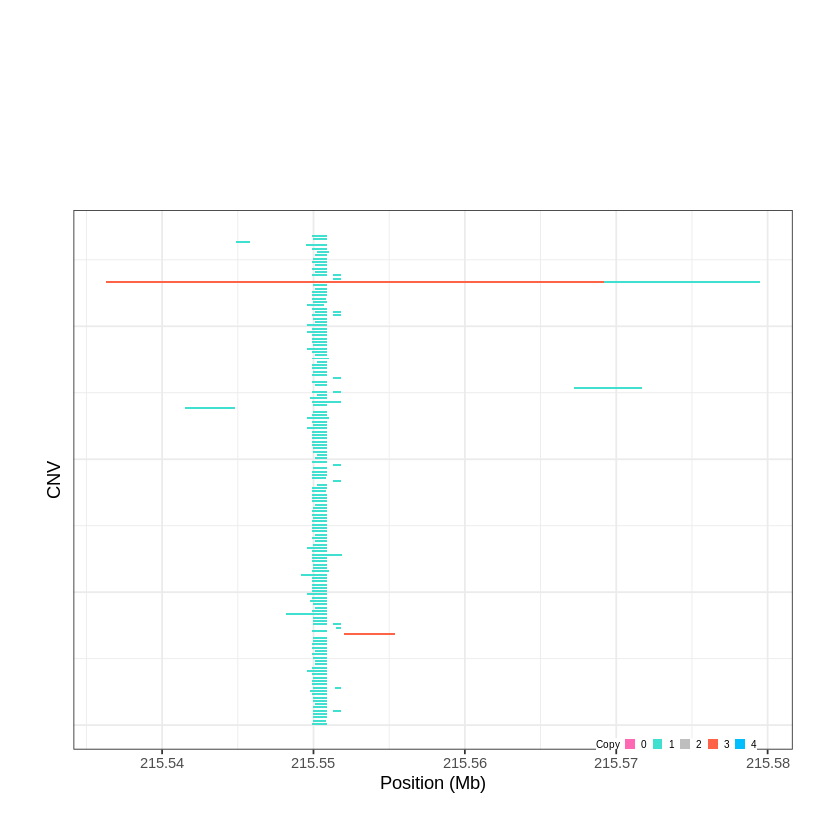

Task done, plot was stored in working directory.
[1] "Ploting CNVR 355..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 217.090001 - 217.0931 Mb with 208 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


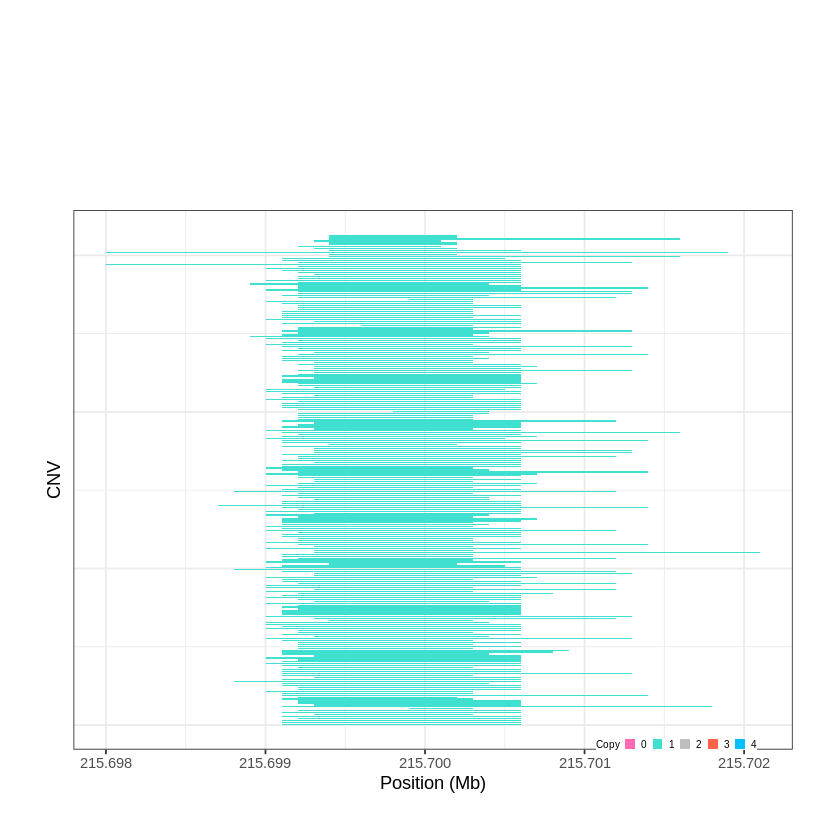

Task done, plot was stored in working directory.
[1] "Ploting CNVR 356..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 220.052301 - 220.186 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


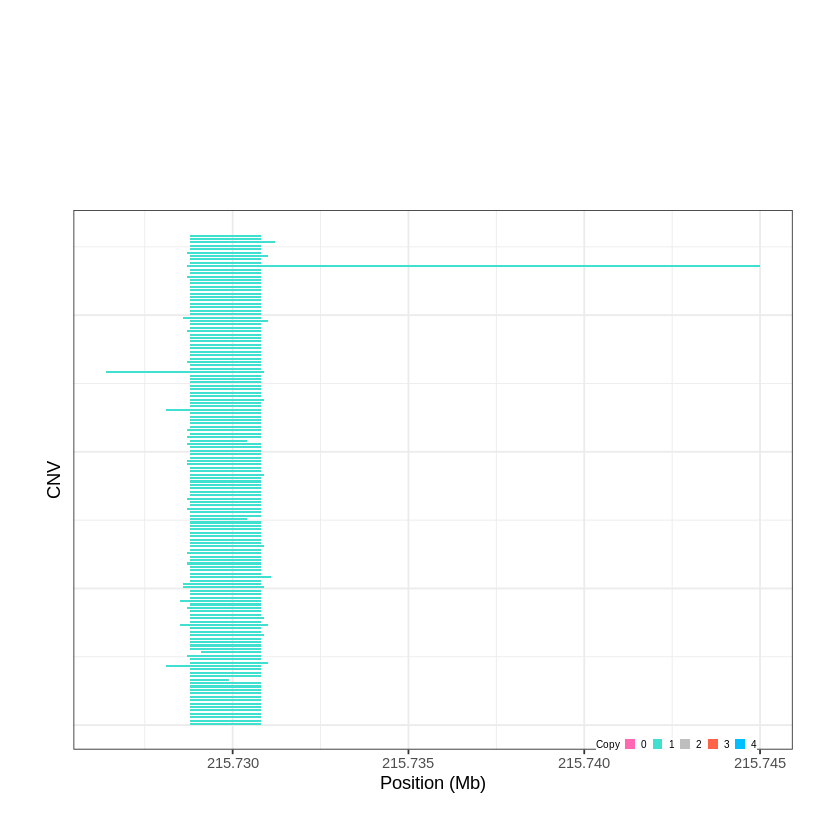

Task done, plot was stored in working directory.
[1] "Ploting CNVR 357..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 220.194101 - 220.5127 Mb with 255 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


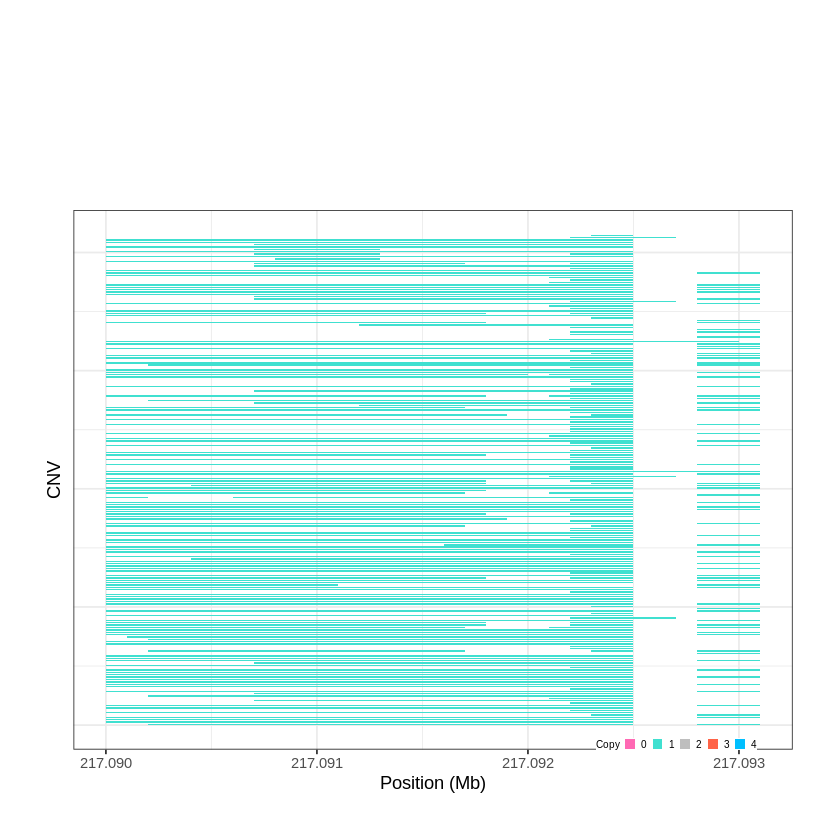

Task done, plot was stored in working directory.
[1] "Ploting CNVR 358..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 223.759501 - 223.8123 Mb with 267 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


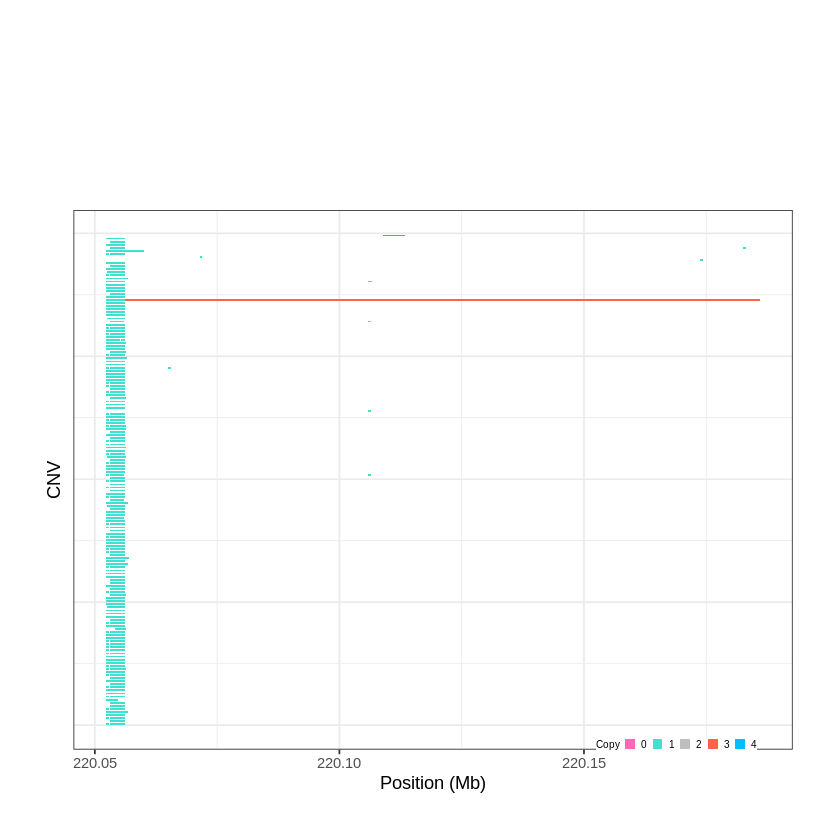

Task done, plot was stored in working directory.
[1] "Ploting CNVR 359..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 225.291701 - 225.3183 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


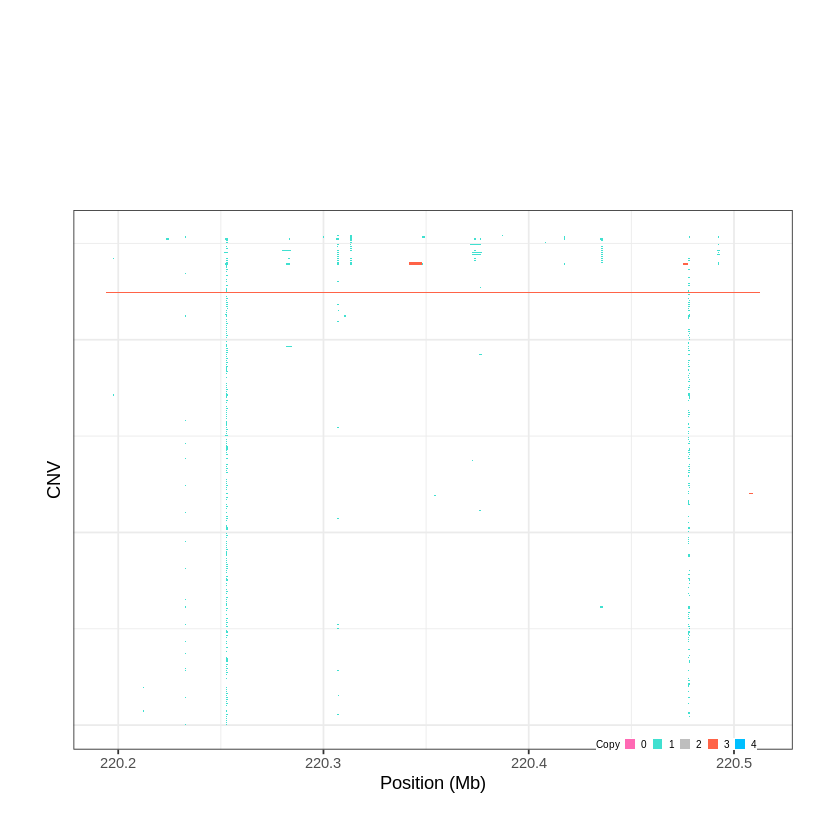

Task done, plot was stored in working directory.
[1] "Ploting CNVR 360..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 227.227601 - 227.2397 Mb with 222 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


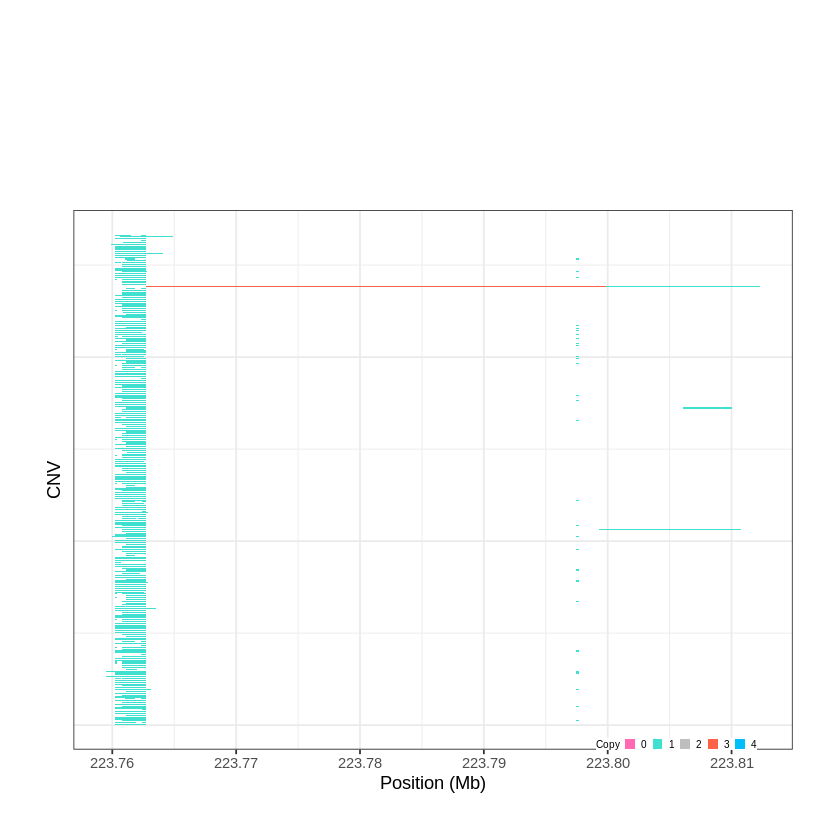

Task done, plot was stored in working directory.
[1] "Ploting CNVR 361..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 227.329101 - 227.3404 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


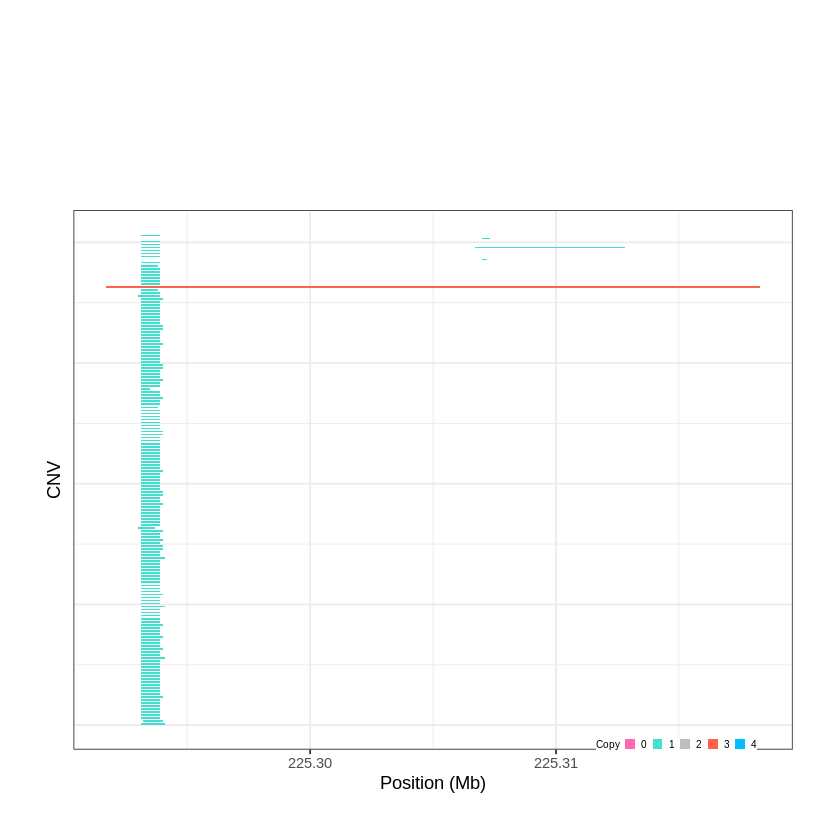

Task done, plot was stored in working directory.
[1] "Ploting CNVR 362..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 229.123801 - 229.133 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


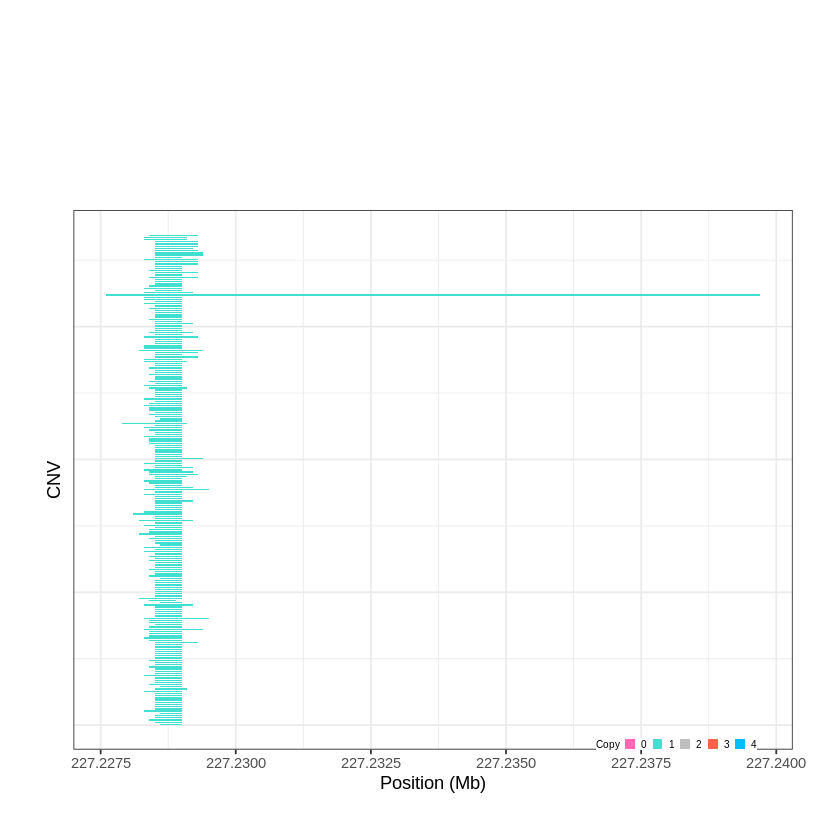

Task done, plot was stored in working directory.
[1] "Ploting CNVR 363..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 230.047901 - 230.0769 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


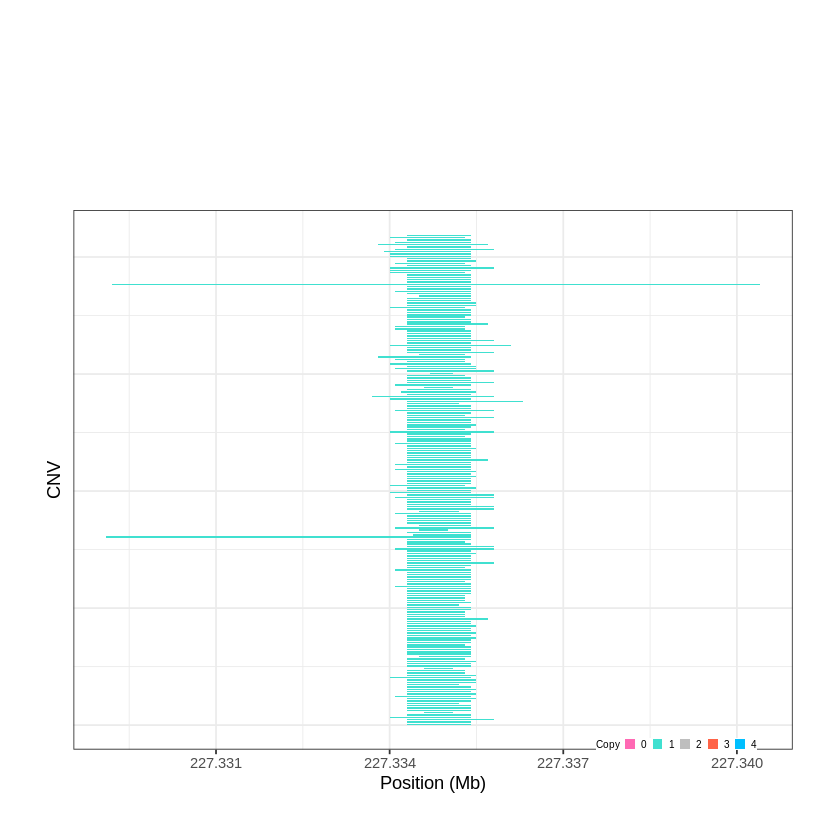

Task done, plot was stored in working directory.
[1] "Ploting CNVR 364..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 232.443701 - 232.4444 Mb with 270 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


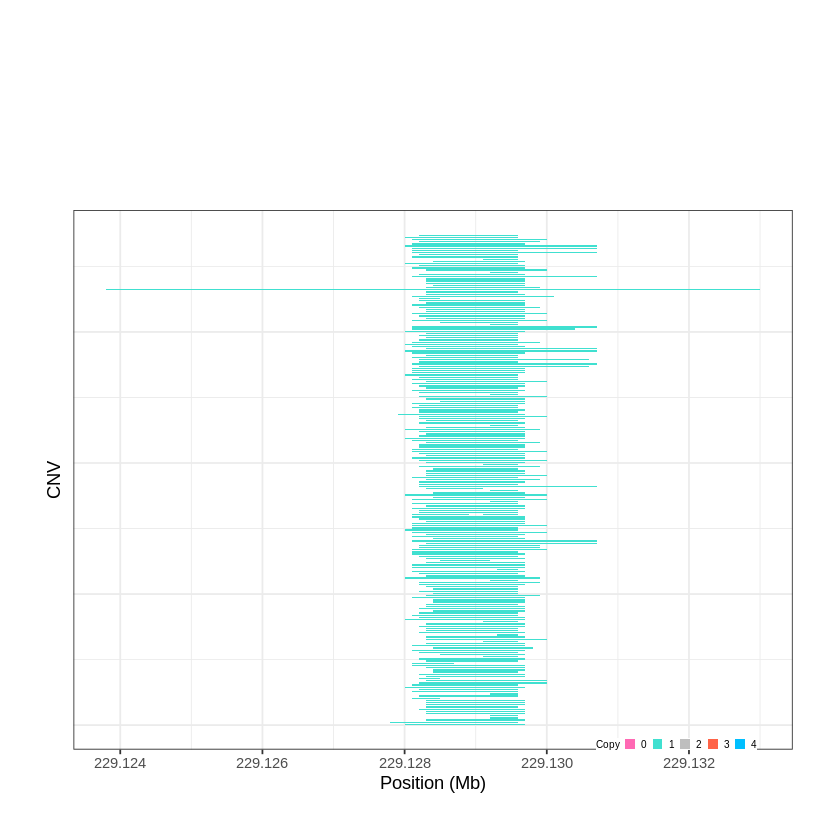

Task done, plot was stored in working directory.
[1] "Ploting CNVR 365..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 232.684101 - 232.716 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


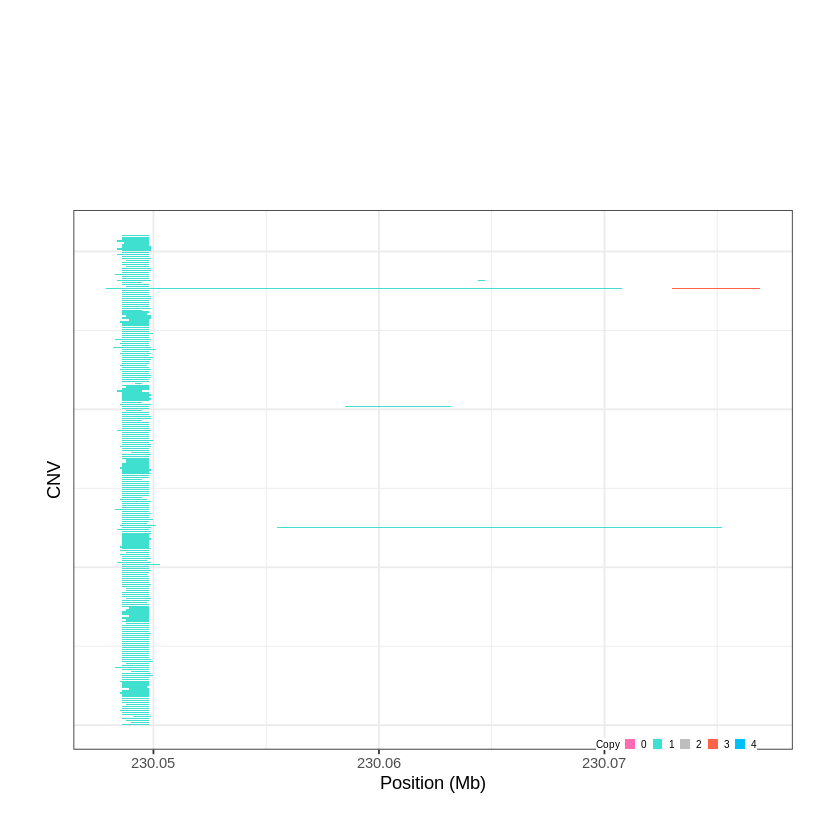

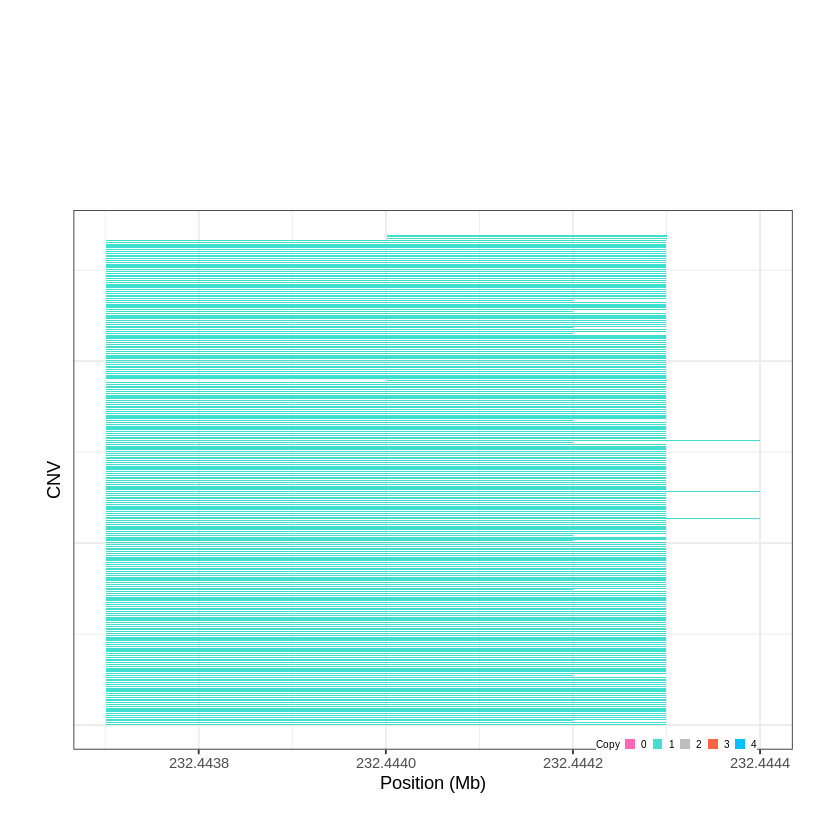

Task done, plot was stored in working directory.
[1] "Ploting CNVR 366..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 233.169501 - 233.4386 Mb with 158 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 367..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 233.668401 - 233.6687 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


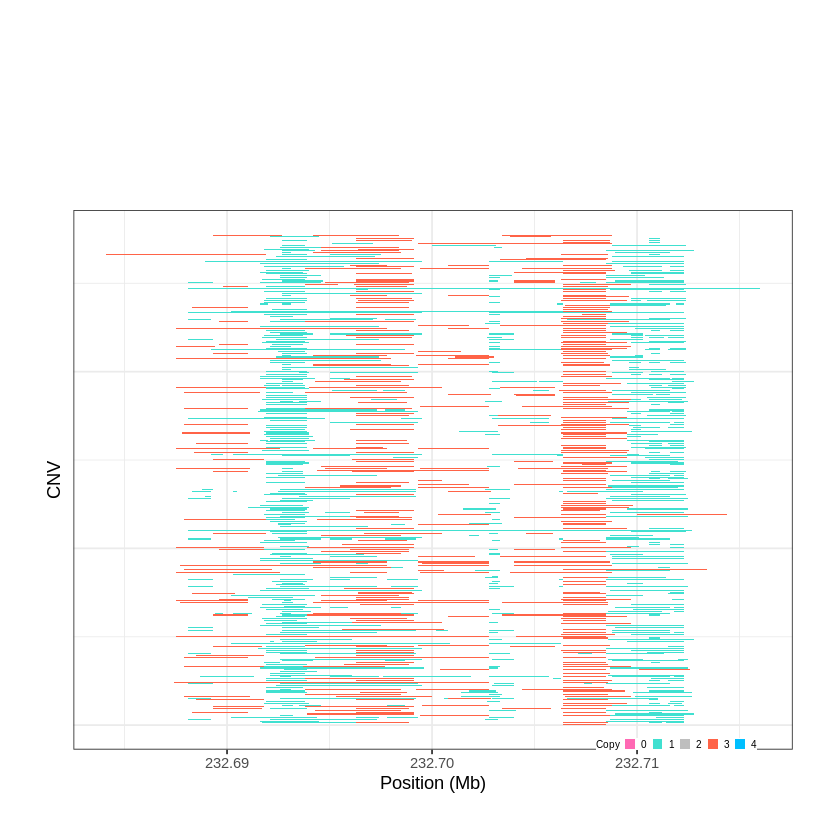

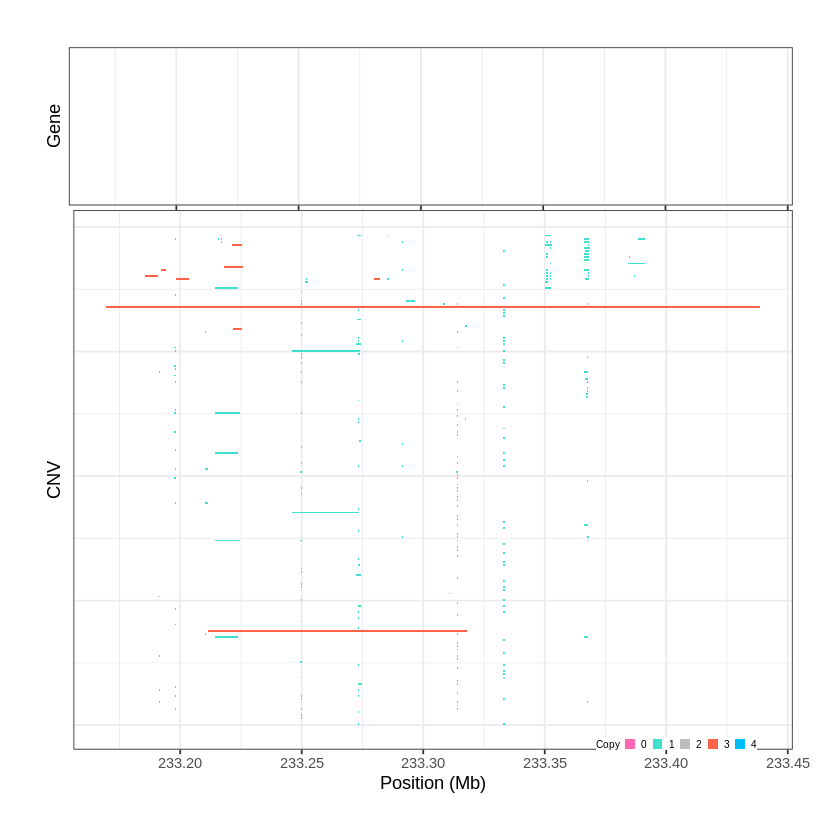

Task done, plot was stored in working directory.
[1] "Ploting CNVR 368..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 233.725101 - 233.8291 Mb with 221 Individual - "
Plotting gene...


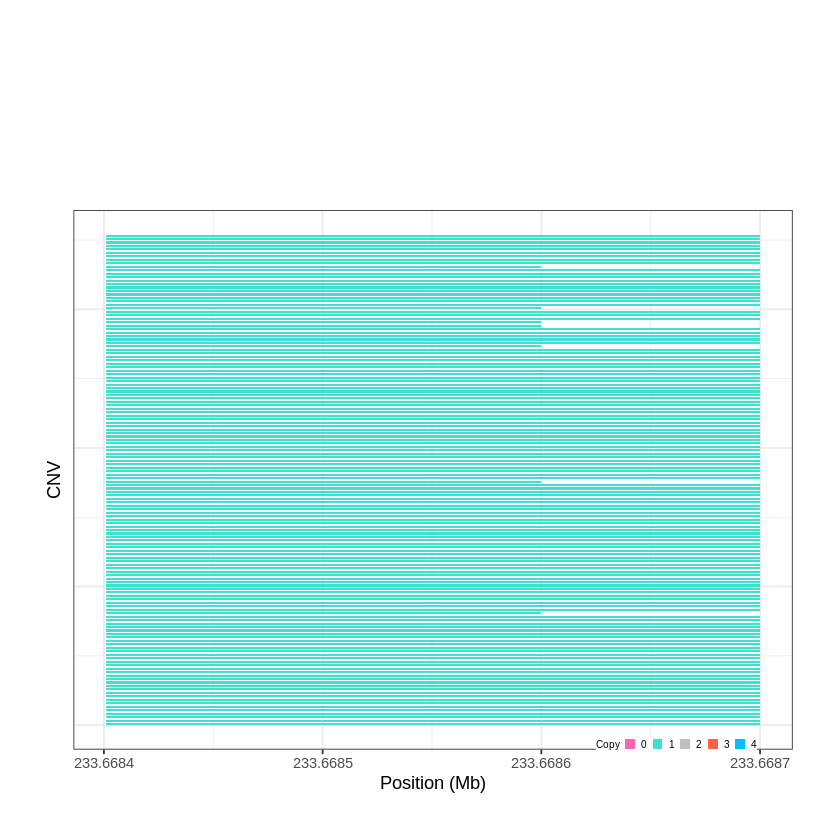

Task done, plot was stored in working directory.
[1] "Ploting CNVR 369..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 233.837701 - 234.1709 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 370..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 235.441001 - 235.4948 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


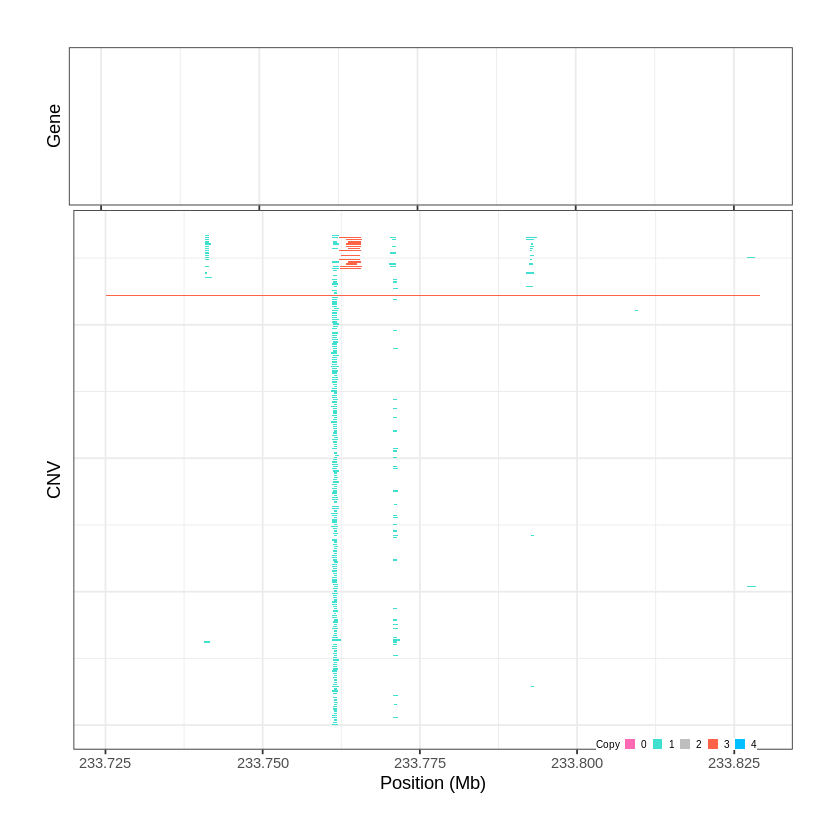

Task done, plot was stored in working directory.
[1] "Ploting CNVR 371..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 235.545701 - 235.5721 Mb with 273 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


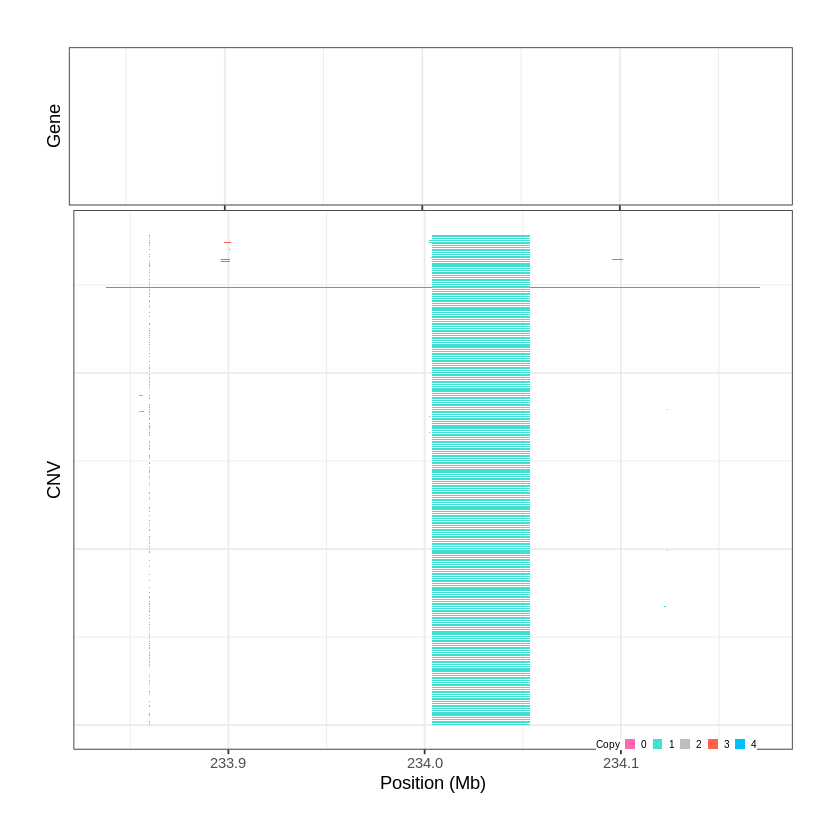

Task done, plot was stored in working directory.
[1] "Ploting CNVR 372..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 236.189901 - 236.2164 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


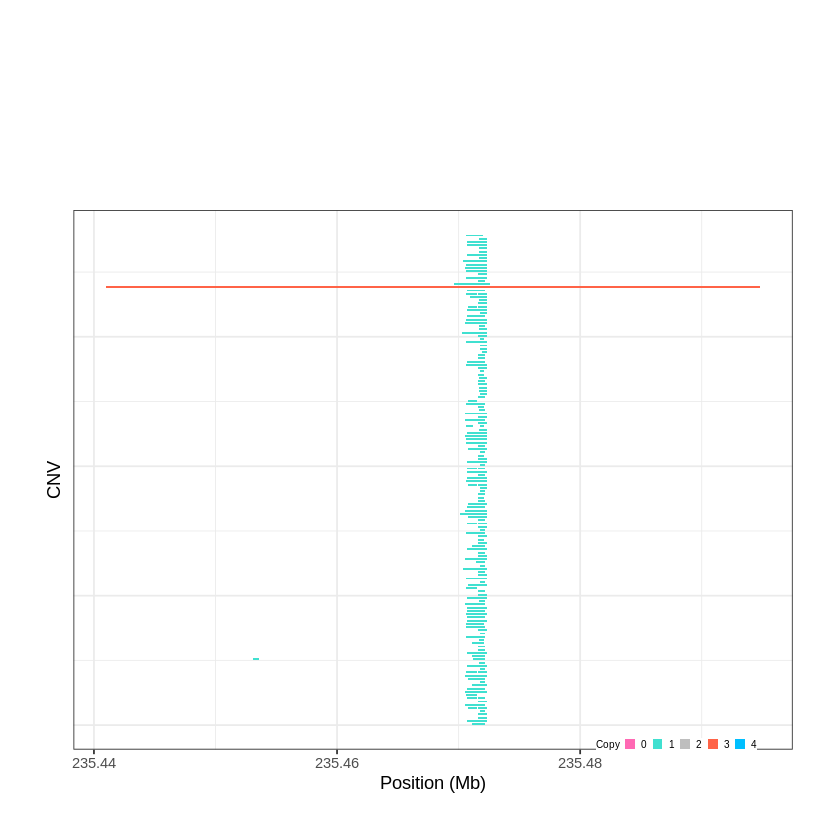

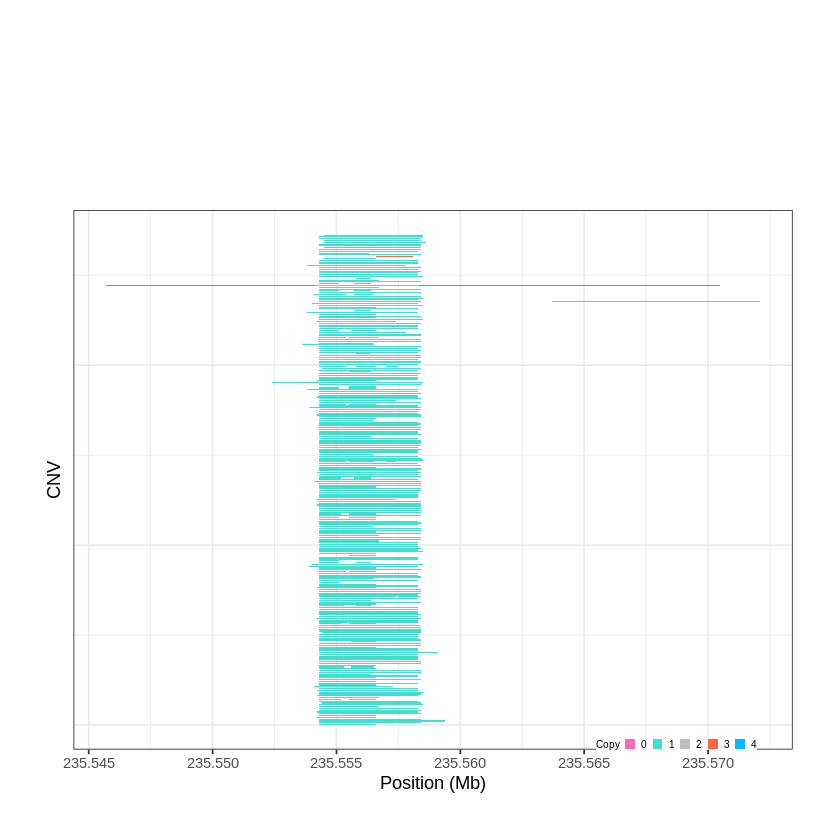

Task done, plot was stored in working directory.
[1] "Ploting CNVR 373..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 236.497201 - 237.0813 Mb with 190 Individual - "
Plotting gene...


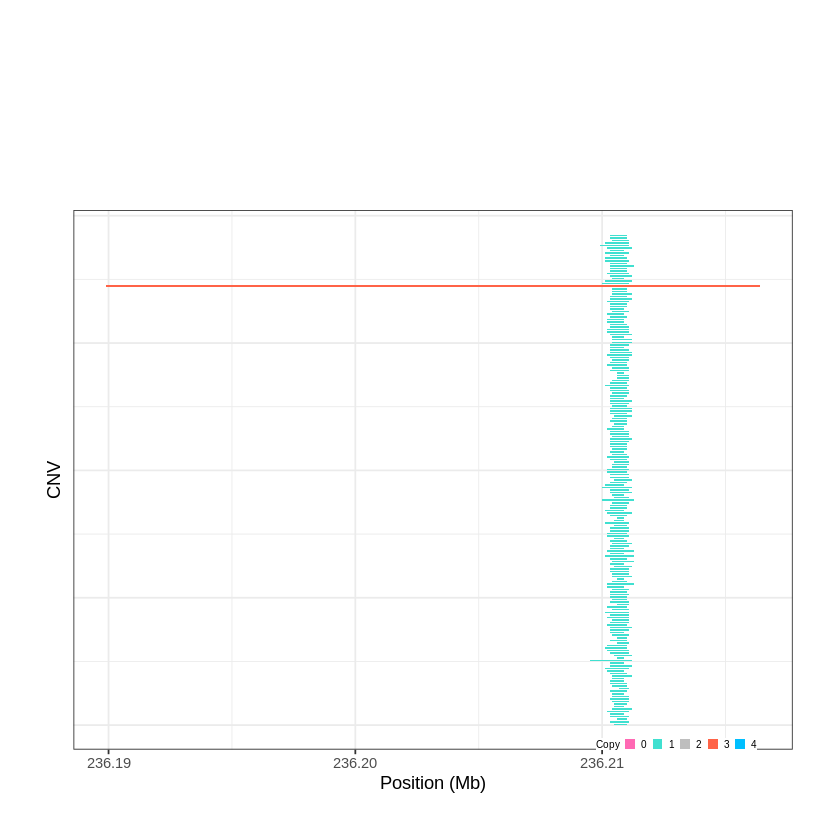

Task done, plot was stored in working directory.
[1] "Ploting CNVR 374..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 238.308901 - 238.6709 Mb with 266 Individual - "
Plotting gene...


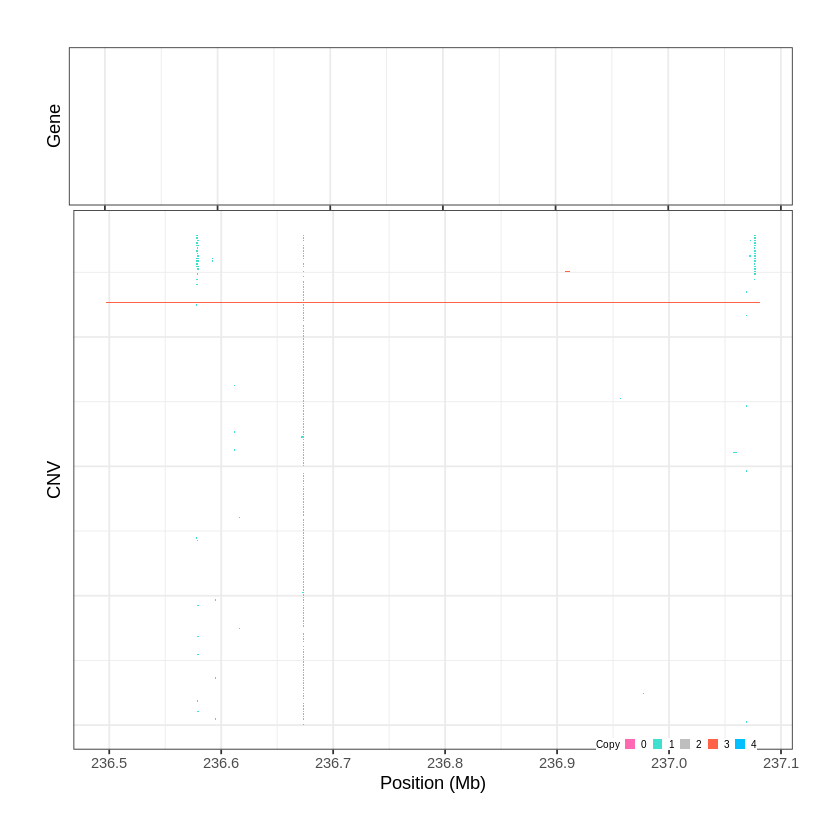

Task done, plot was stored in working directory.
[1] "Ploting CNVR 375..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 238.897701 - 239.4383 Mb with 188 Individual - "
Plotting gene...


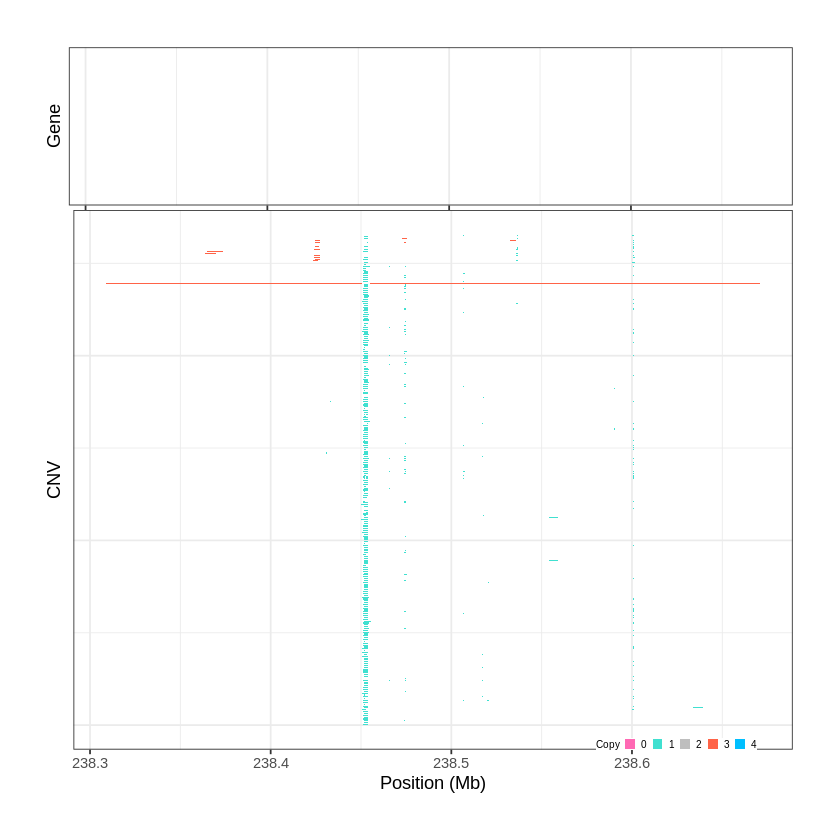

Task done, plot was stored in working directory.
[1] "Ploting CNVR 376..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 239.758501 - 239.832 Mb with 279 Individual - "
Plotting gene...


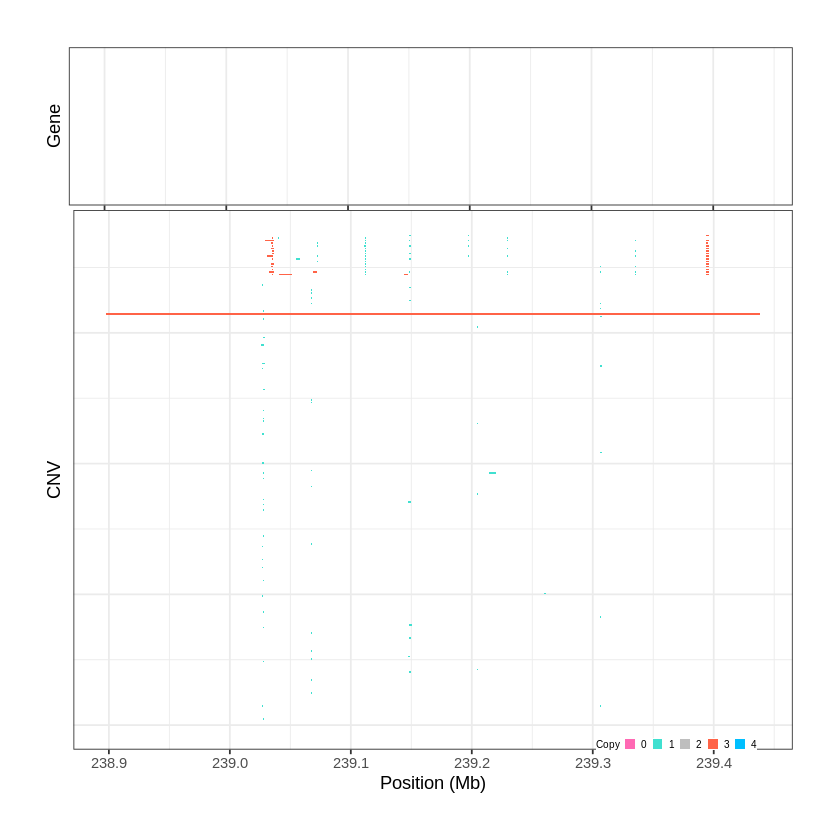

Task done, plot was stored in working directory.
[1] "Ploting CNVR 377..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 239.902001 - 240.3289 Mb with 230 Individual - "
Plotting gene...


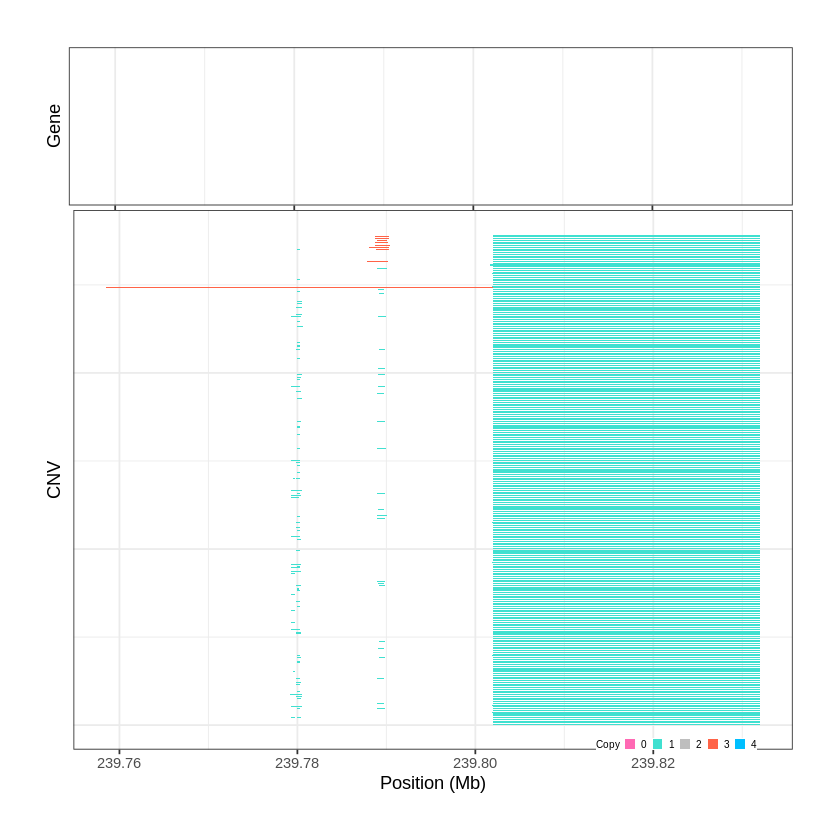

Task done, plot was stored in working directory.
[1] "Ploting CNVR 378..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 240.338801 - 240.6263 Mb with 265 Individual - "
Plotting gene...


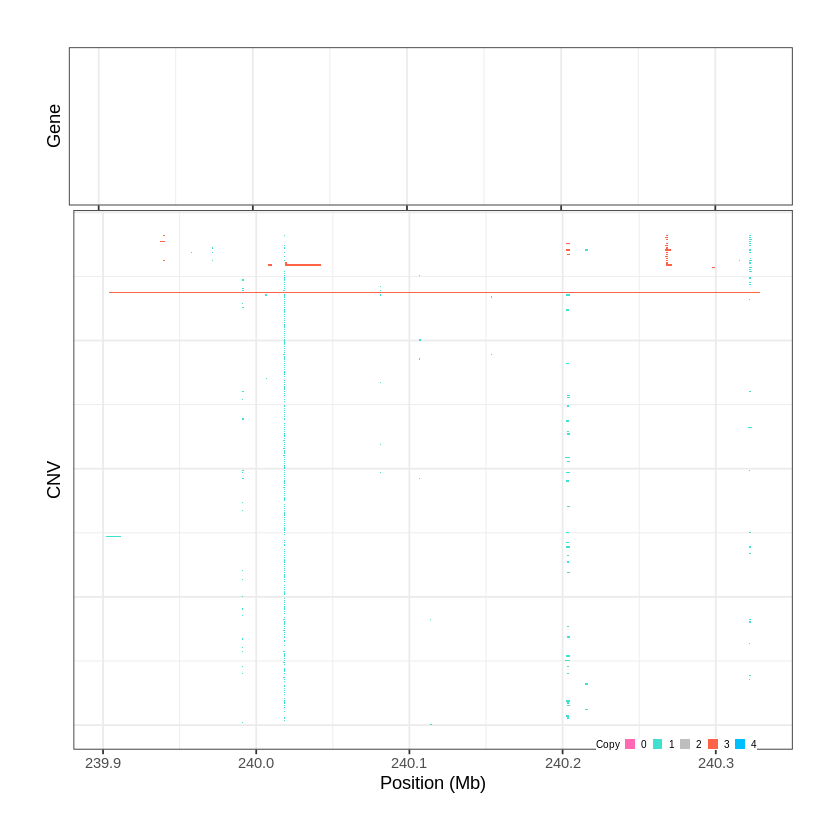

Task done, plot was stored in working directory.
[1] "Ploting CNVR 379..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 240.658101 - 240.7651 Mb with 251 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 380..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 240.780601 - 240.8099 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


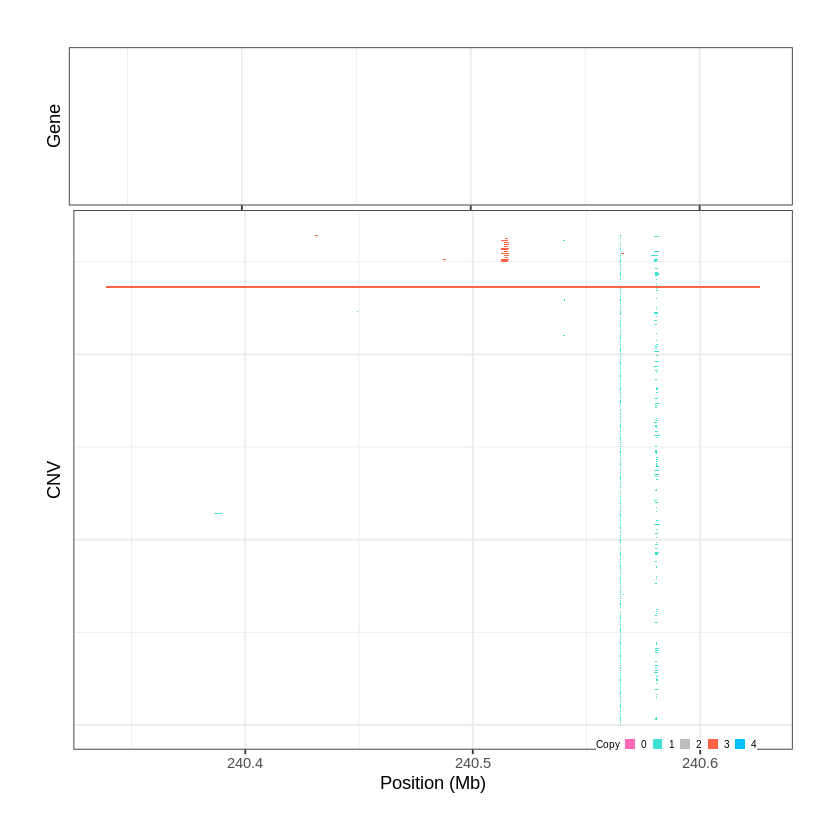

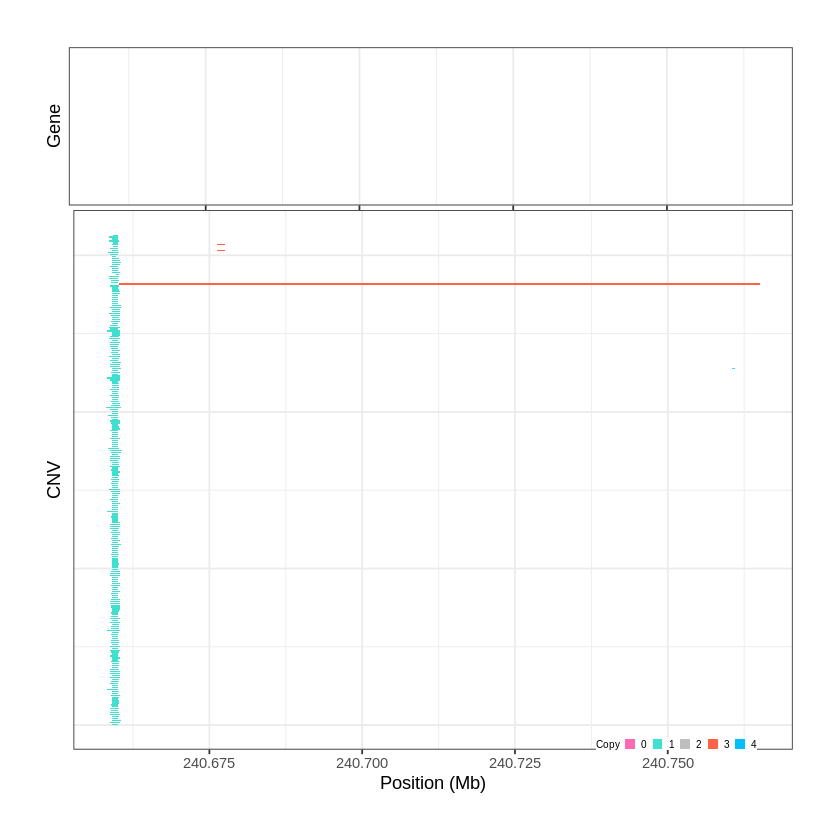

Task done, plot was stored in working directory.
[1] "Ploting CNVR 381..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 241.009301 - 241.2125 Mb with 244 Individual - "
Plotting gene...


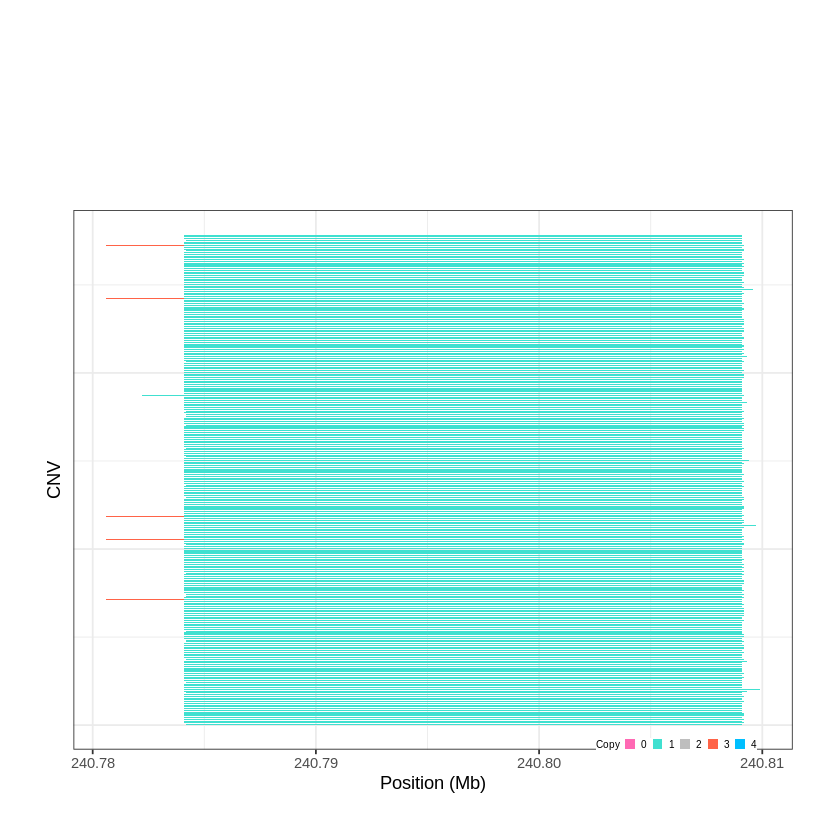

Task done, plot was stored in working directory.
[1] "Ploting CNVR 382..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 241.353501 - 241.8063 Mb with 274 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 383..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 241.858301 - 241.8654 Mb with 273 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


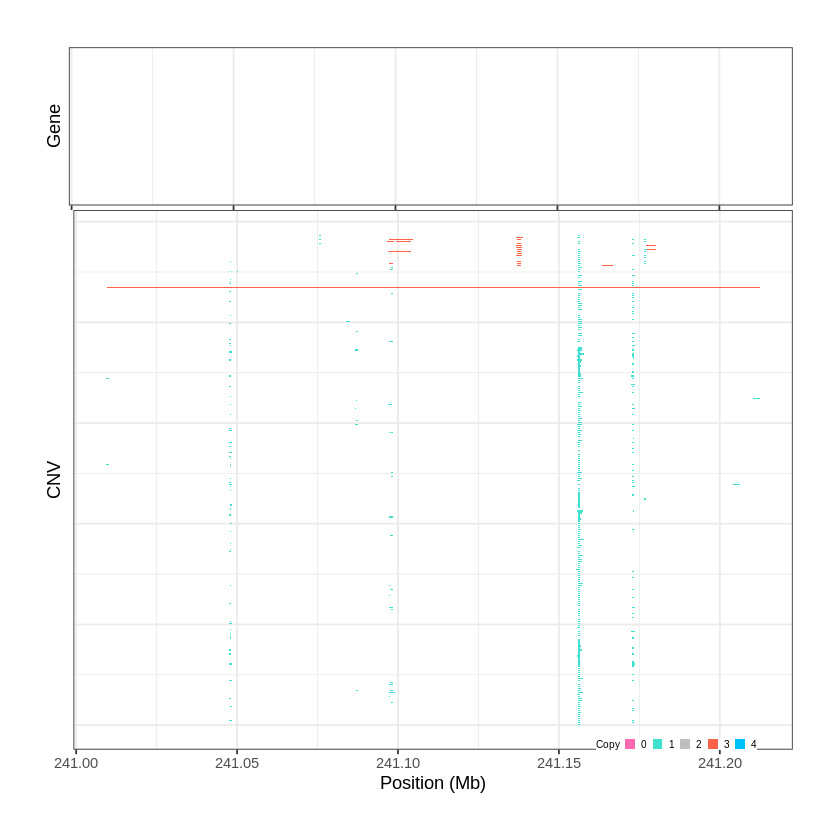

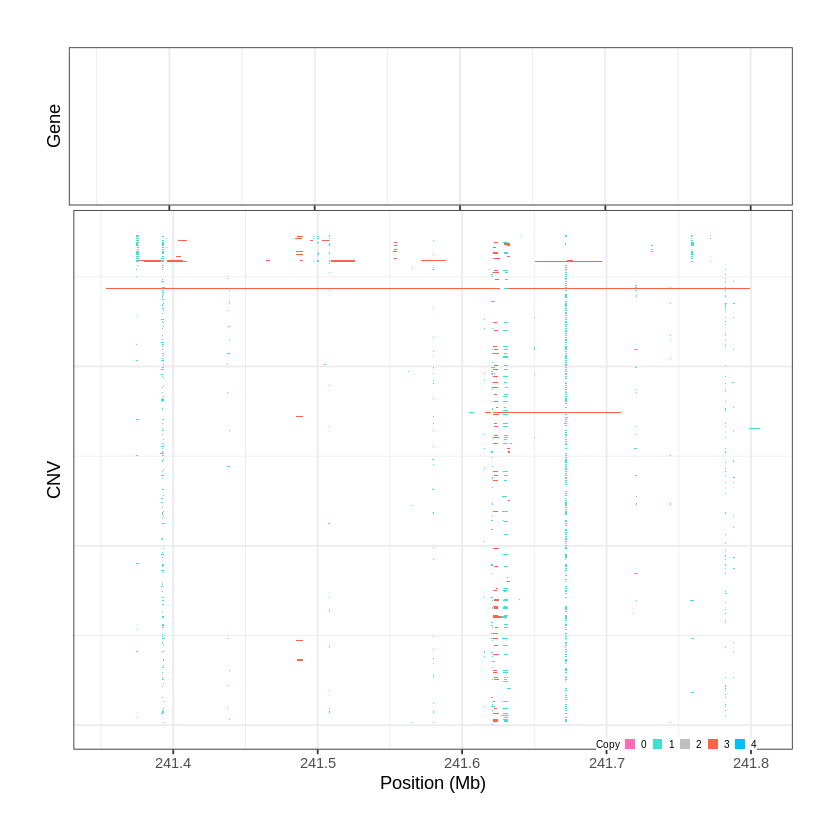

Task done, plot was stored in working directory.
[1] "Ploting CNVR 384..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 241.866501 - 242.0022 Mb with 242 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 385..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 242.144701 - 242.1473 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


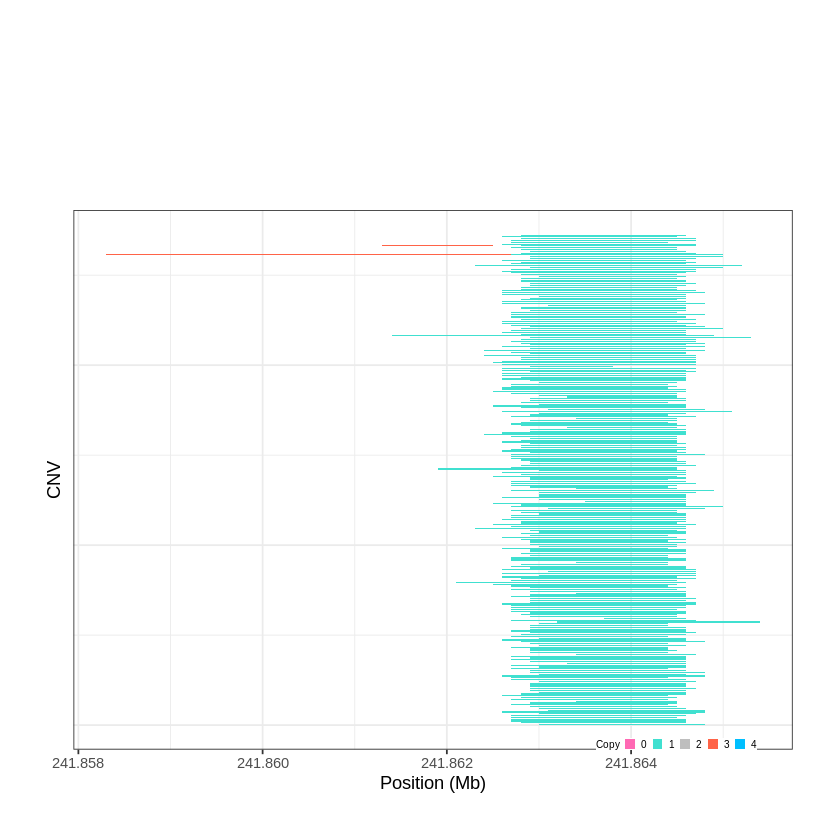

Task done, plot was stored in working directory.
[1] "Ploting CNVR 386..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 242.156901 - 242.7092 Mb with 277 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


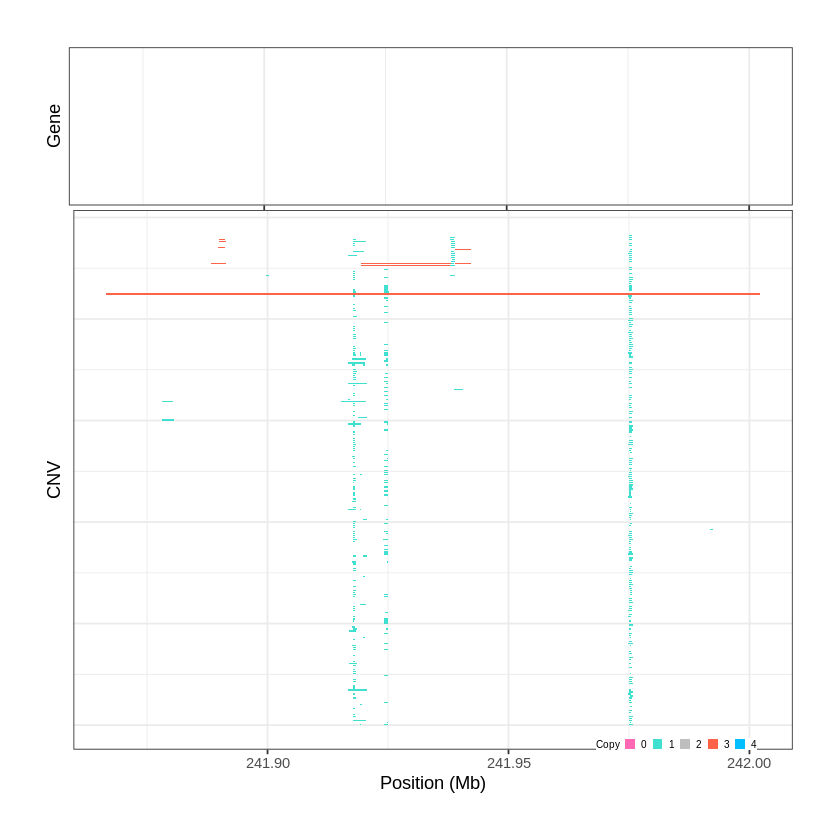

Task done, plot was stored in working directory.
[1] "Ploting CNVR 387..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 242.740701 - 242.75 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


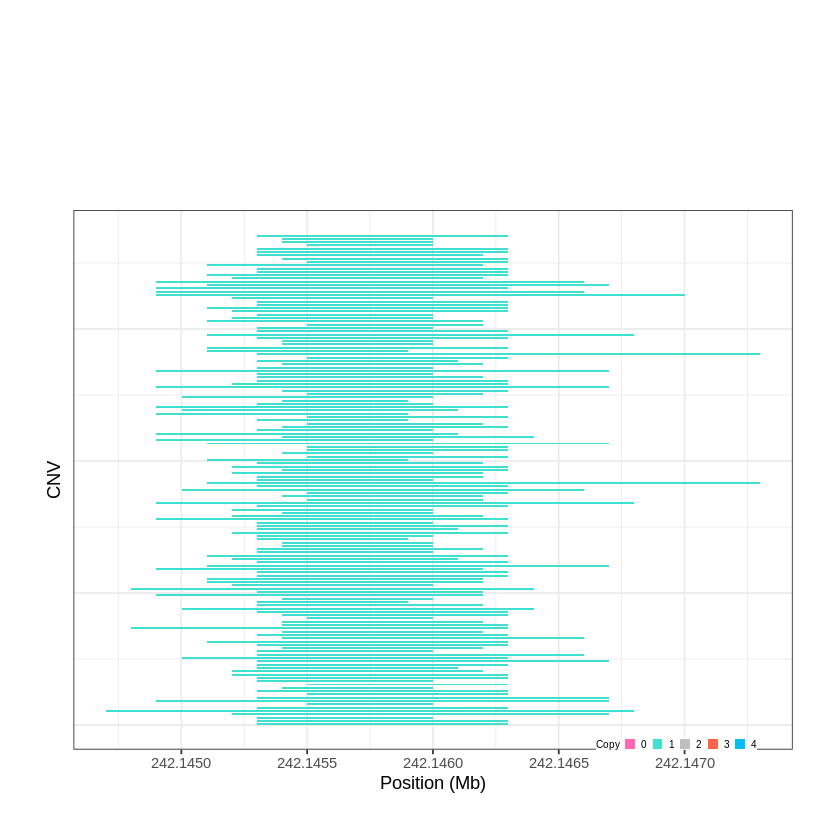

Task done, plot was stored in working directory.
[1] "Ploting CNVR 388..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 242.761201 - 242.7664 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


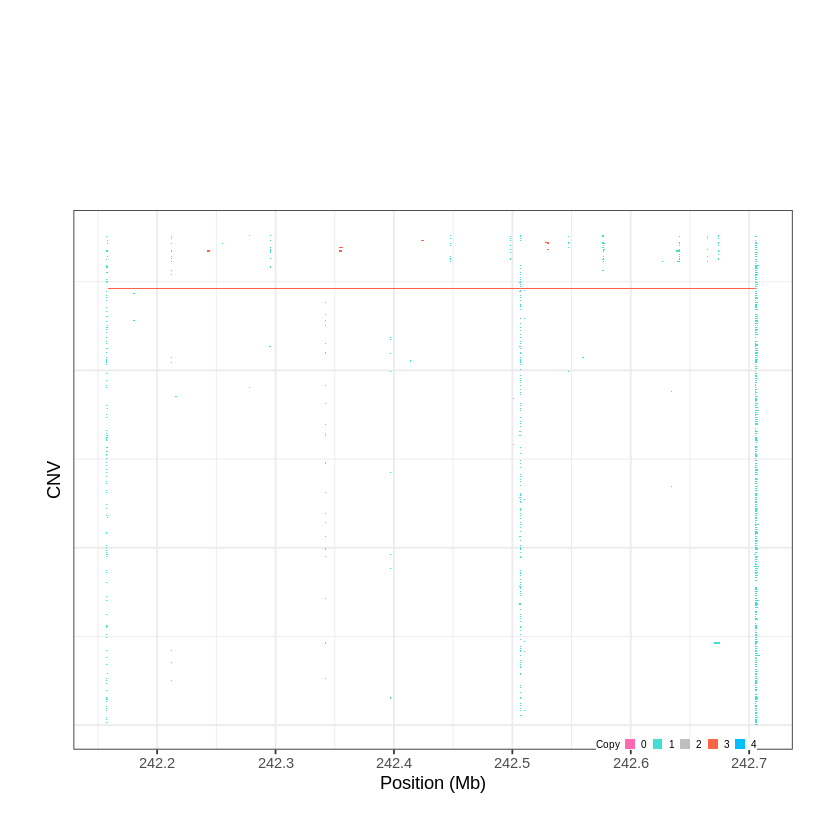

Task done, plot was stored in working directory.
[1] "Ploting CNVR 389..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 242.802501 - 242.817 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


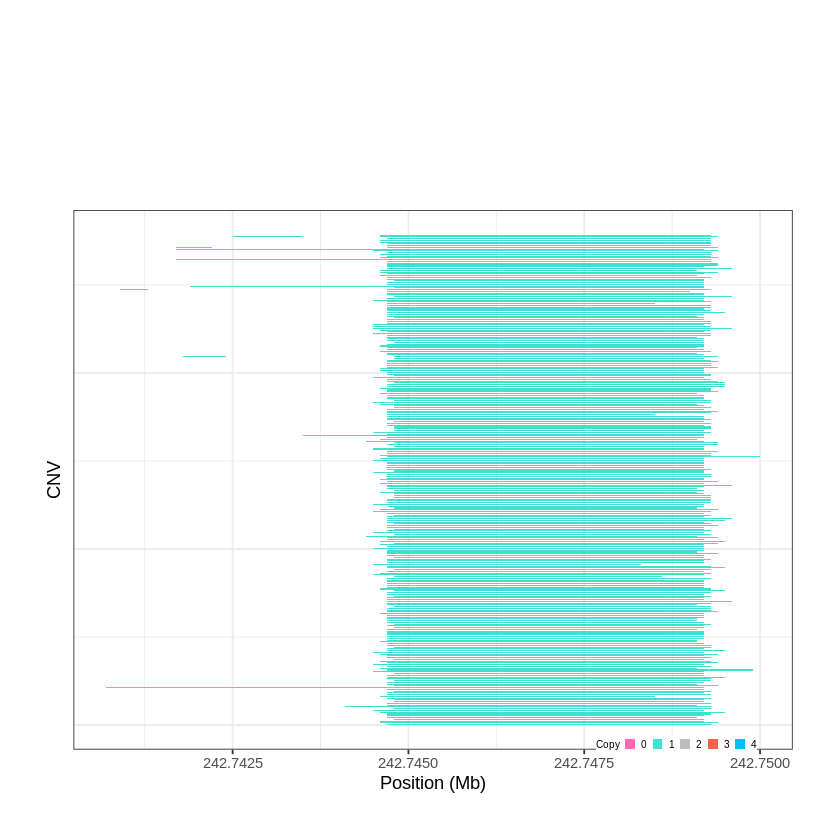

Task done, plot was stored in working directory.
[1] "Ploting CNVR 390..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 242.819201 - 242.8208 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


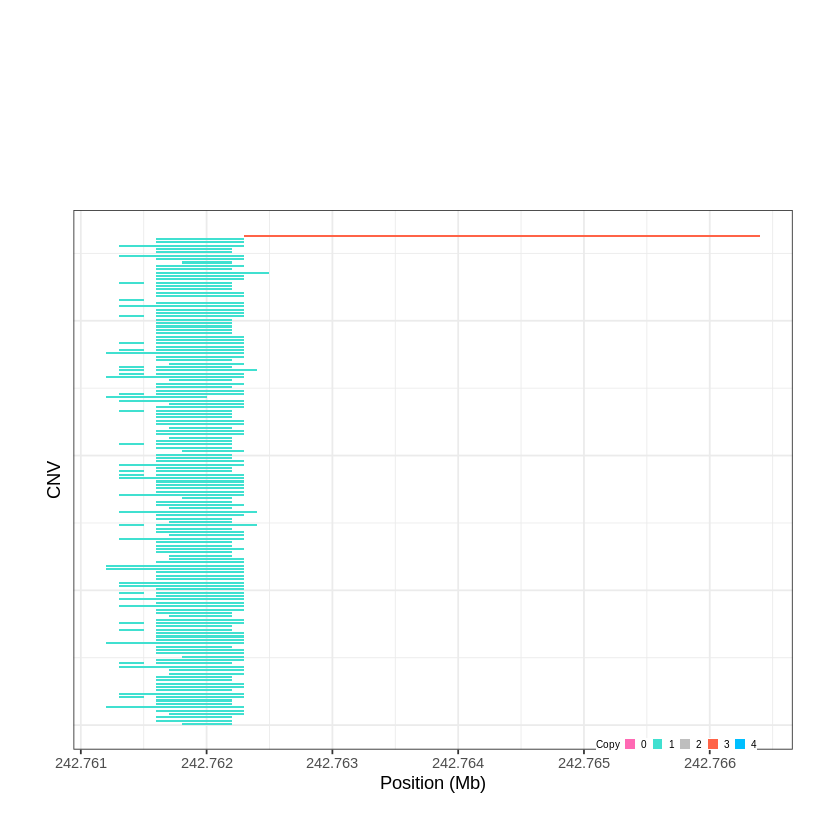

Task done, plot was stored in working directory.
[1] "Ploting CNVR 391..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 242.847401 - 243.1525 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


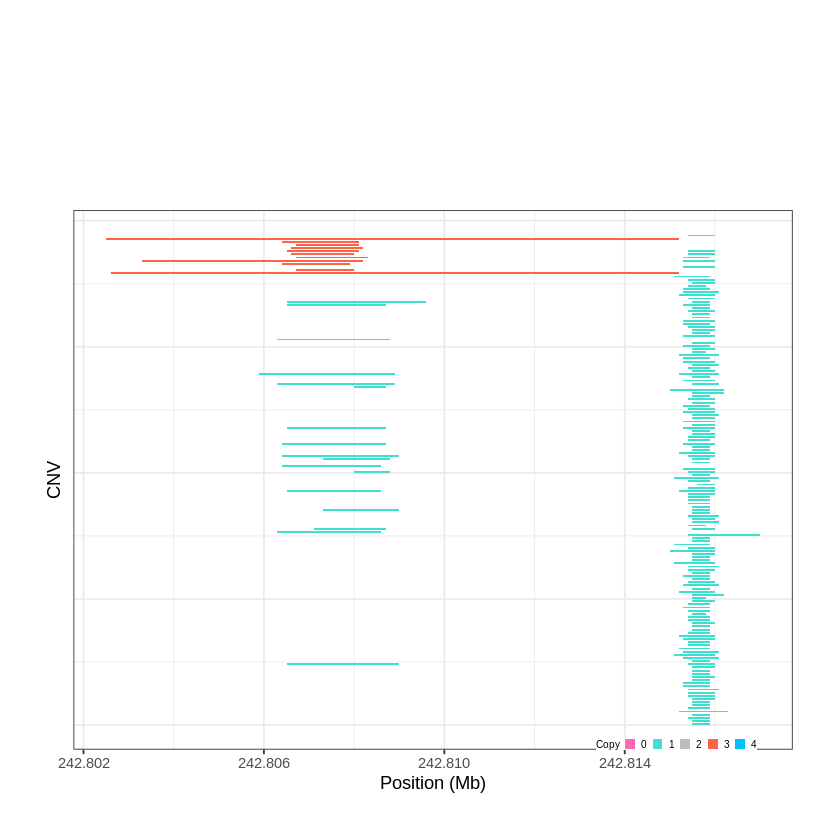

Task done, plot was stored in working directory.
[1] "Ploting CNVR 392..."
Input data passed requirment check...
[1] "CNV on Chromosome 2: 243.152501 - 243.1994 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


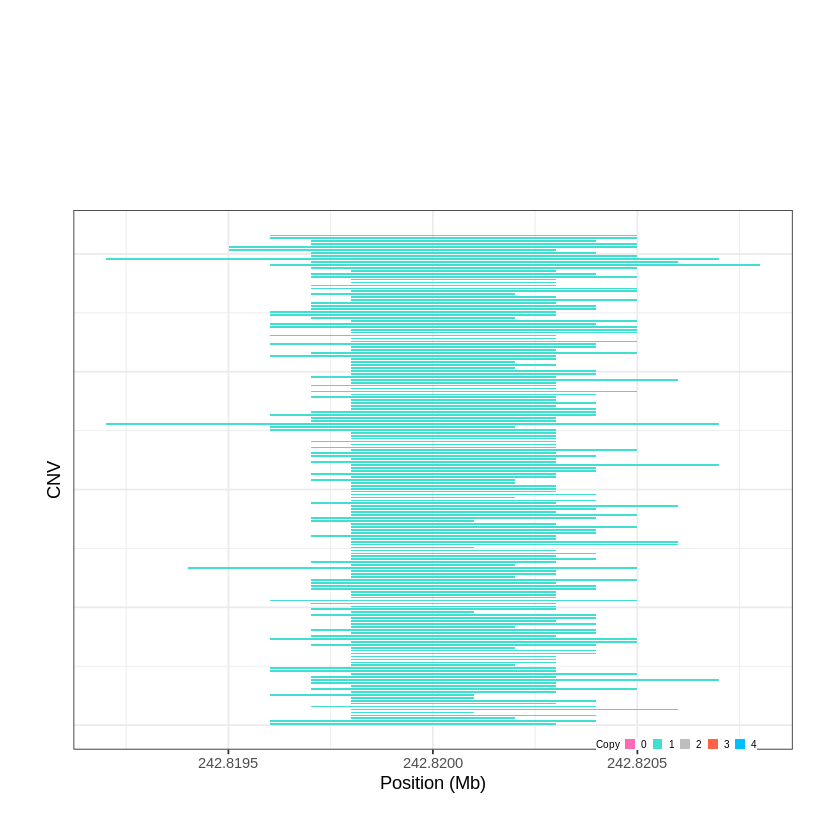

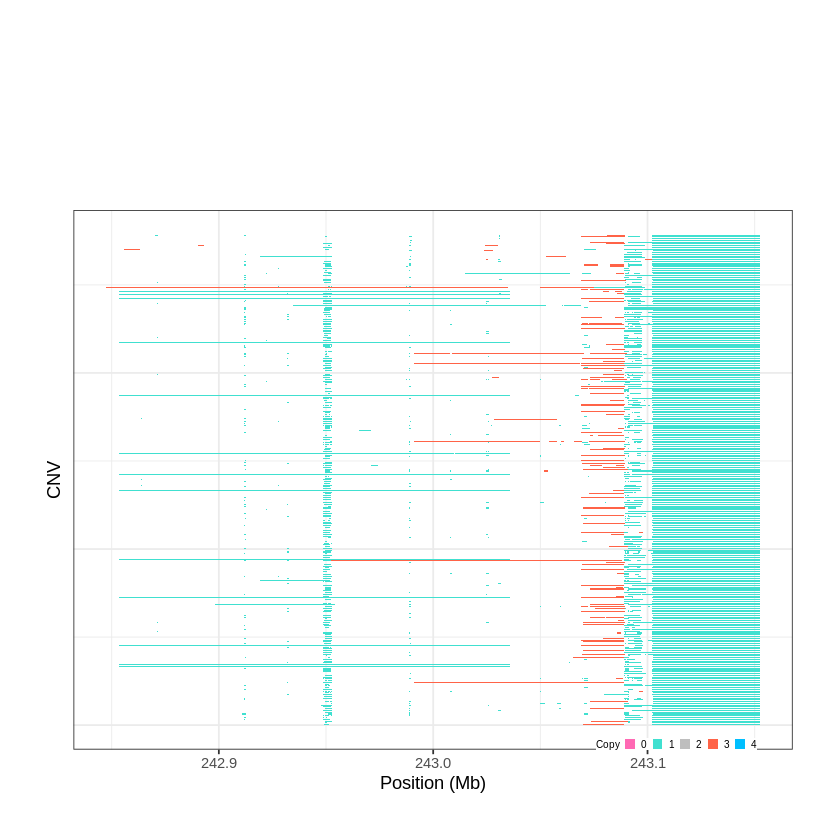

Task done, plot was stored in working directory.
[1] "Ploting CNVR 393..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 1e-06 - 0.9321 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 394..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 0.941901 - 1.0463 Mb with 162 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


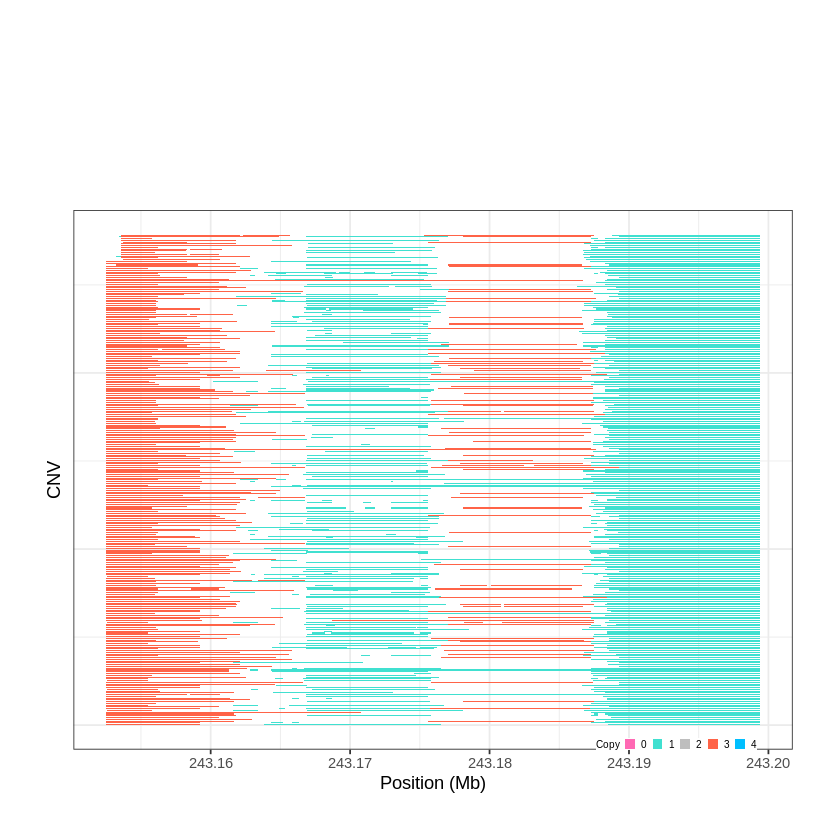

Task done, plot was stored in working directory.
[1] "Ploting CNVR 395..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 3.852201 - 3.8799 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


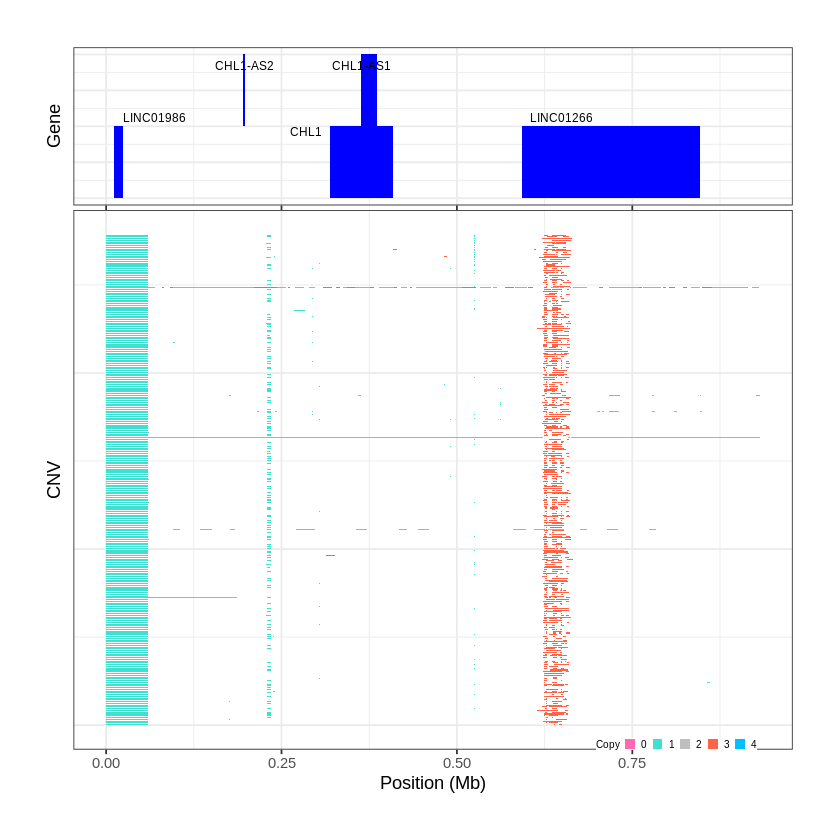

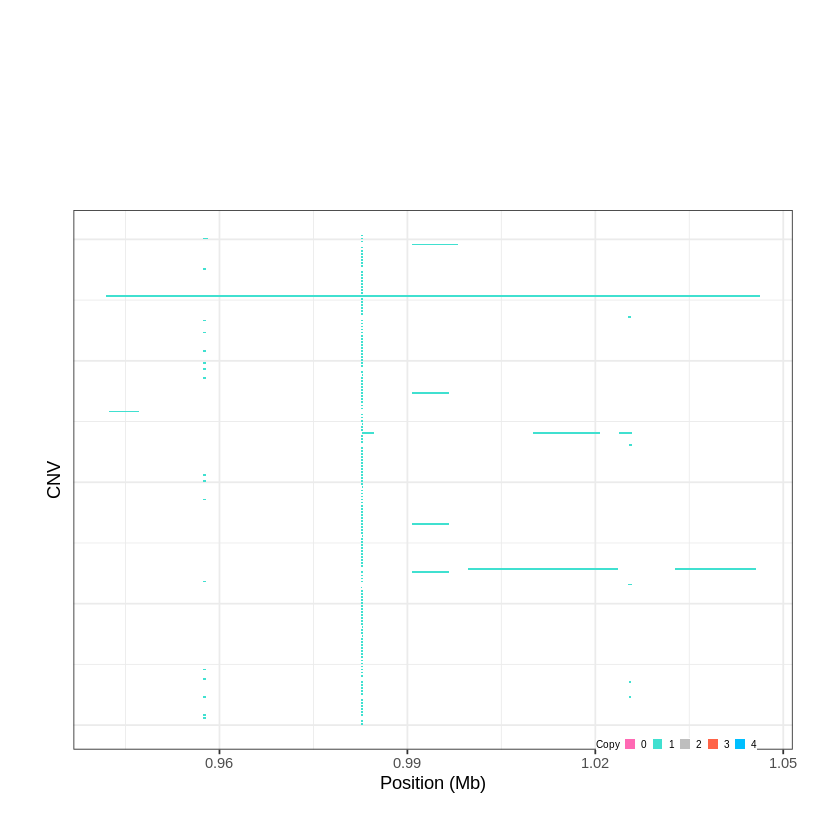

Task done, plot was stored in working directory.
[1] "Ploting CNVR 396..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 8.715201 - 8.7475 Mb with 166 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 397..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 11.527401 - 11.5332 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


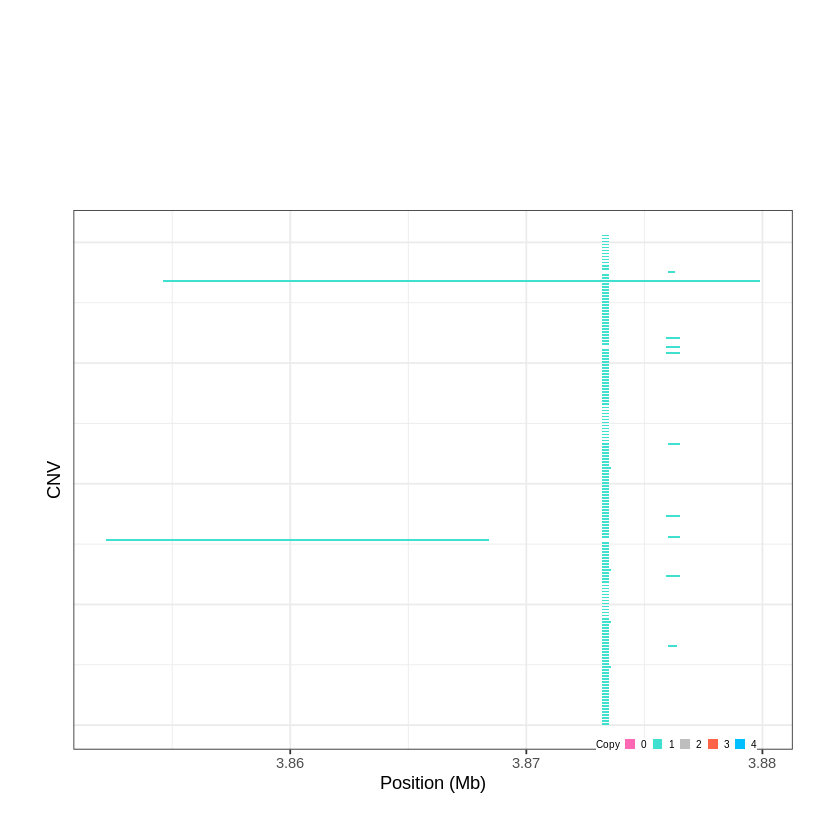

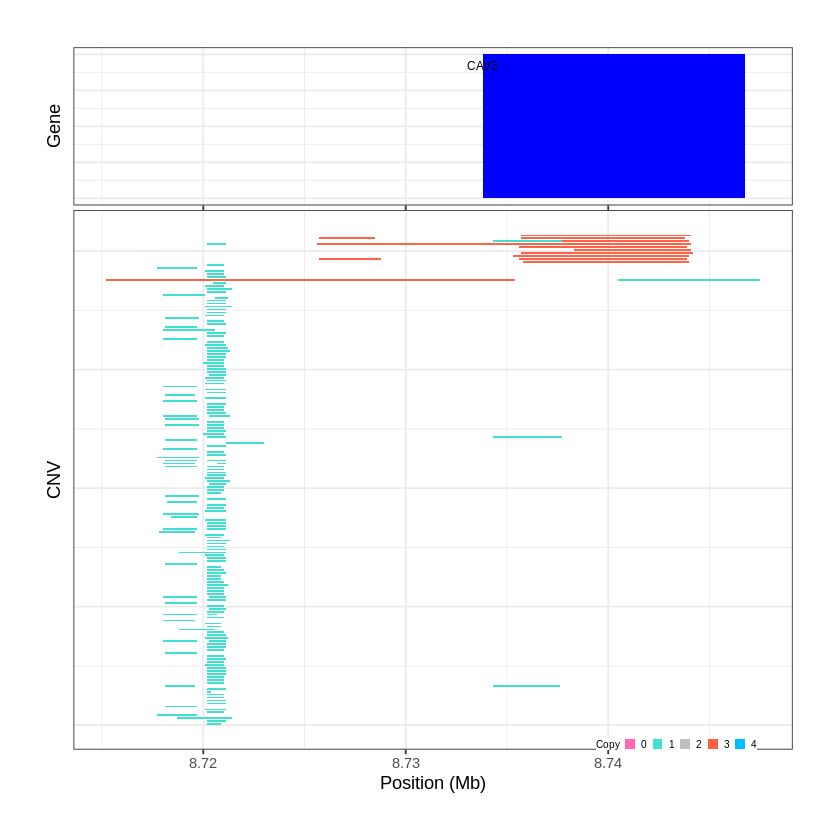

Task done, plot was stored in working directory.
[1] "Ploting CNVR 398..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 12.542001 - 13.4661 Mb with 199 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 399..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 22.077001 - 22.1072 Mb with 268 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


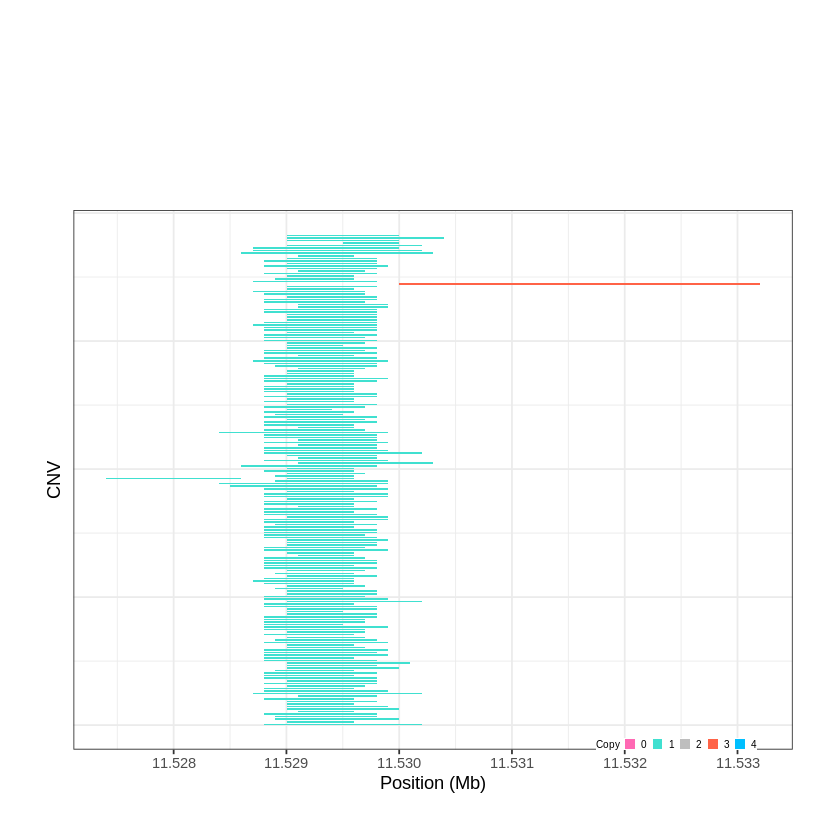

Task done, plot was stored in working directory.
[1] "Ploting CNVR 400..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 25.698201 - 25.7299 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


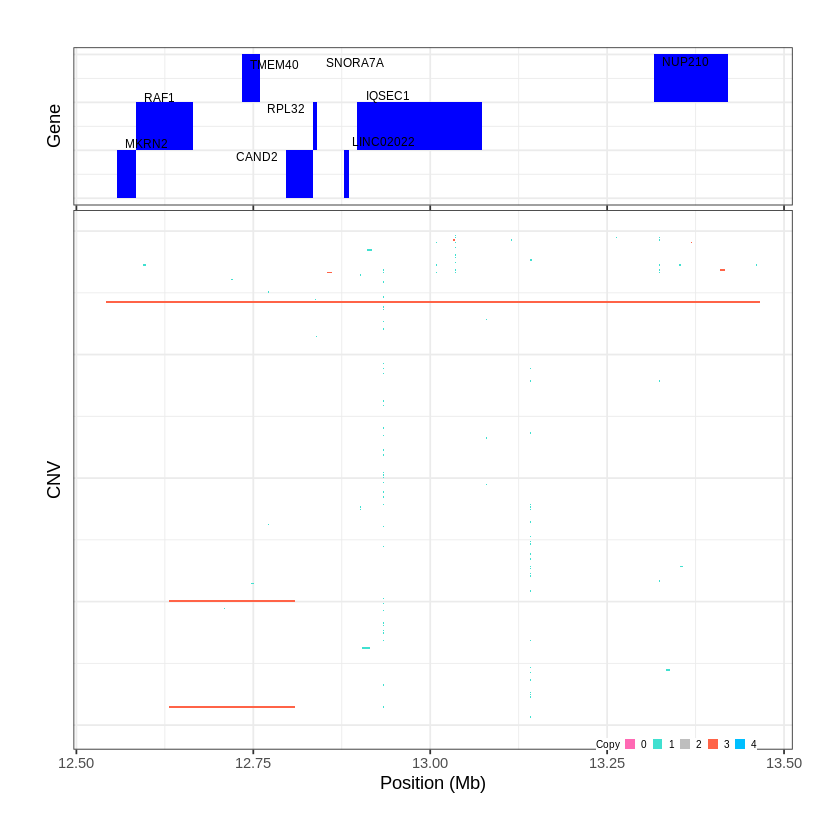

Task done, plot was stored in working directory.
[1] "Ploting CNVR 401..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 26.450901 - 26.4523 Mb with 159 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


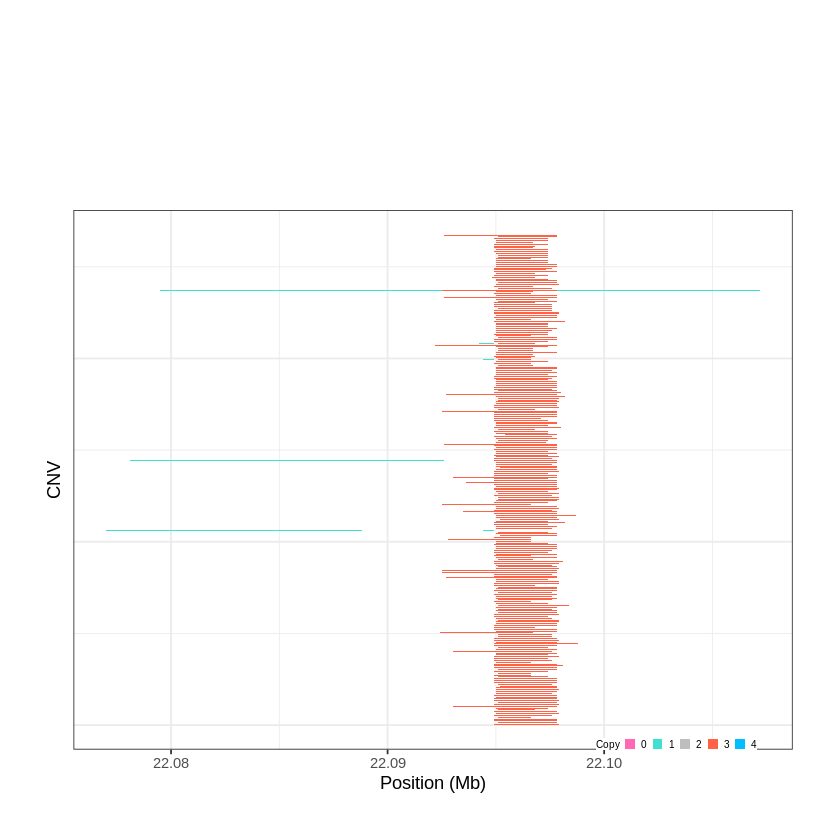

Task done, plot was stored in working directory.
[1] "Ploting CNVR 402..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 32.101101 - 32.1086 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


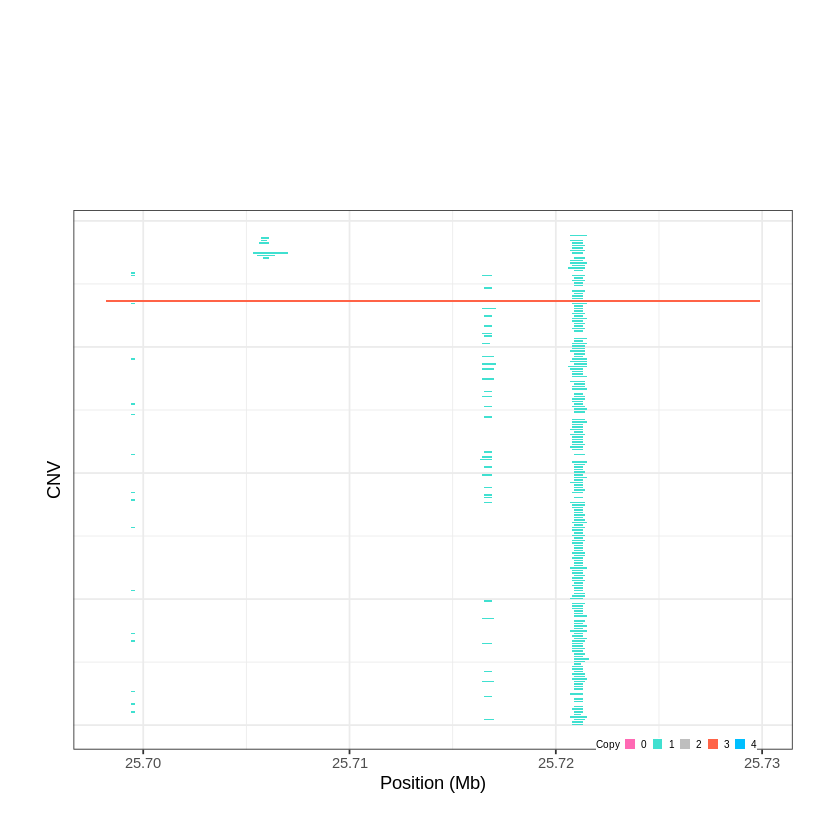

Task done, plot was stored in working directory.
[1] "Ploting CNVR 403..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 32.196801 - 32.2156 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


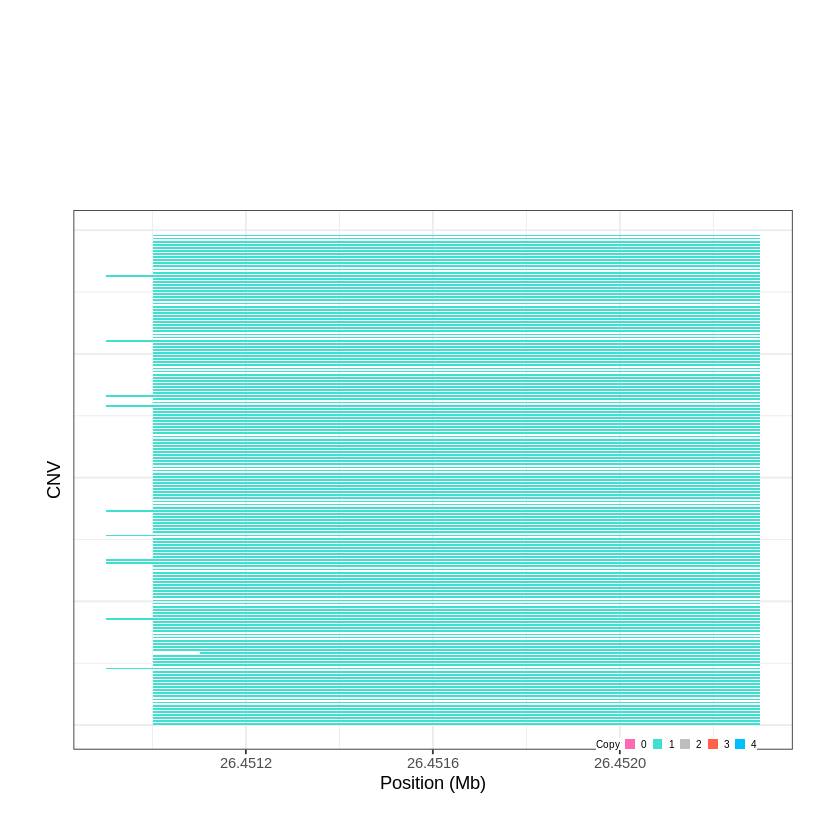

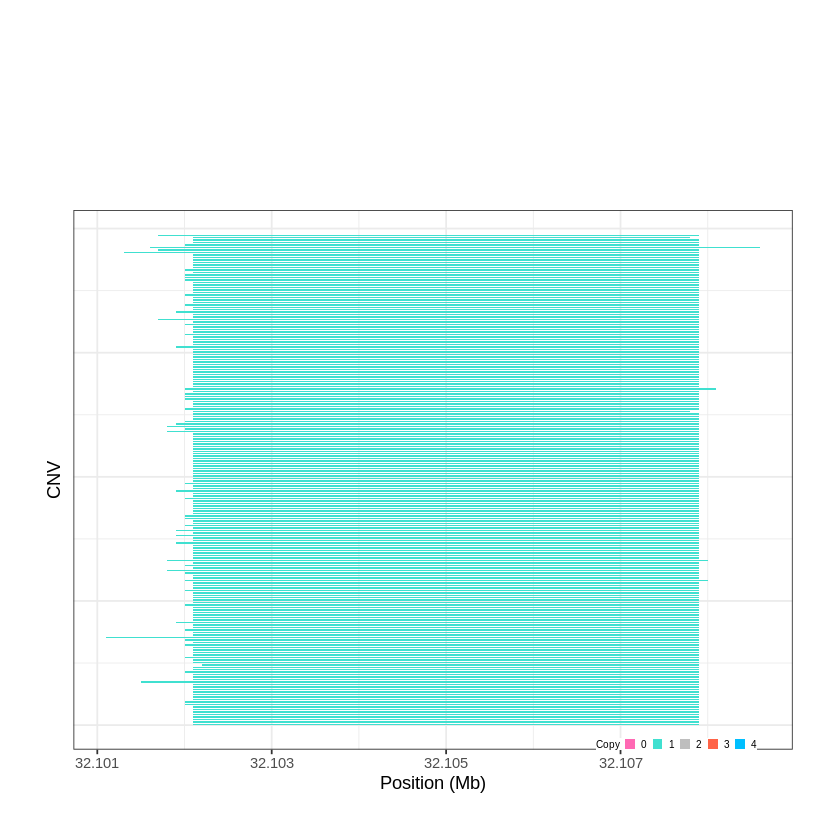

Task done, plot was stored in working directory.
[1] "Ploting CNVR 404..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 32.392001 - 33.5671 Mb with 266 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 405..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 34.731601 - 34.7498 Mb with 261 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


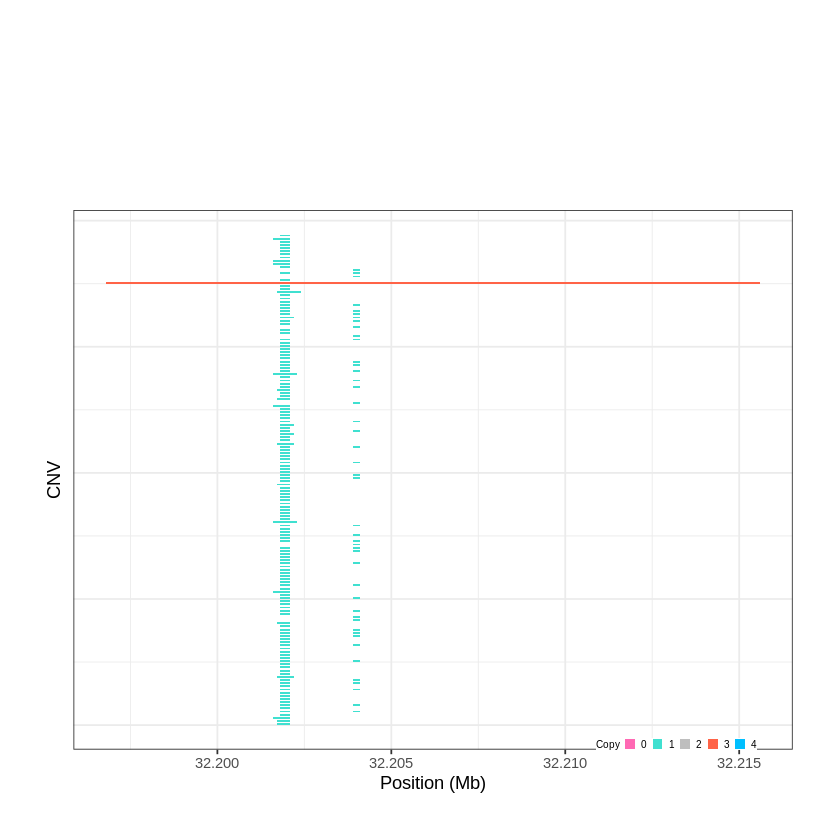

Task done, plot was stored in working directory.
[1] "Ploting CNVR 406..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 35.591601 - 35.6522 Mb with 204 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


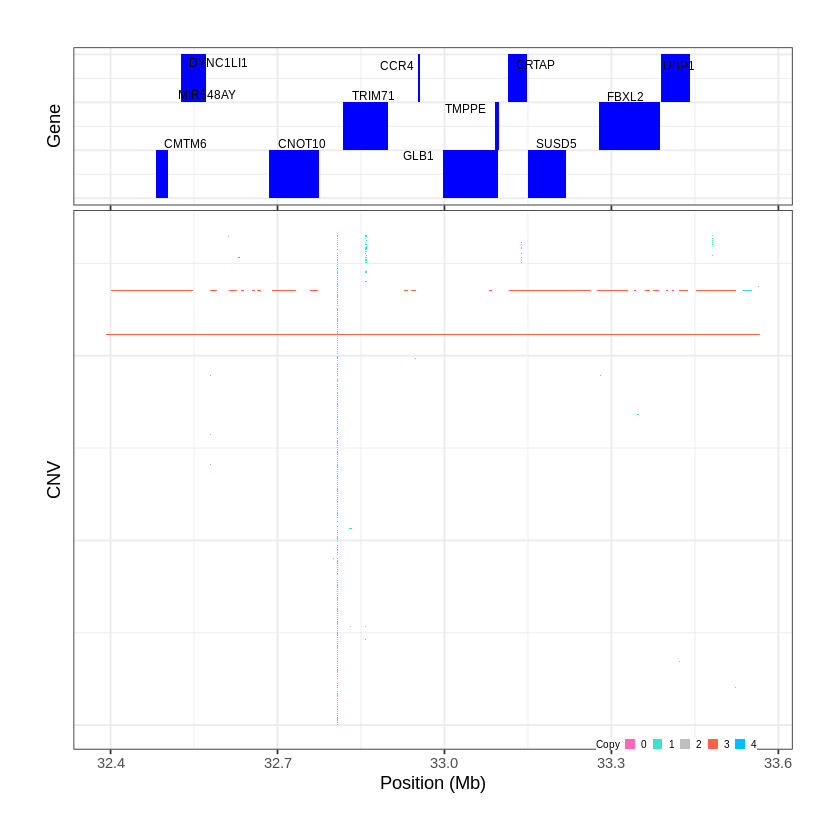

Task done, plot was stored in working directory.
[1] "Ploting CNVR 407..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 37.901801 - 37.904 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


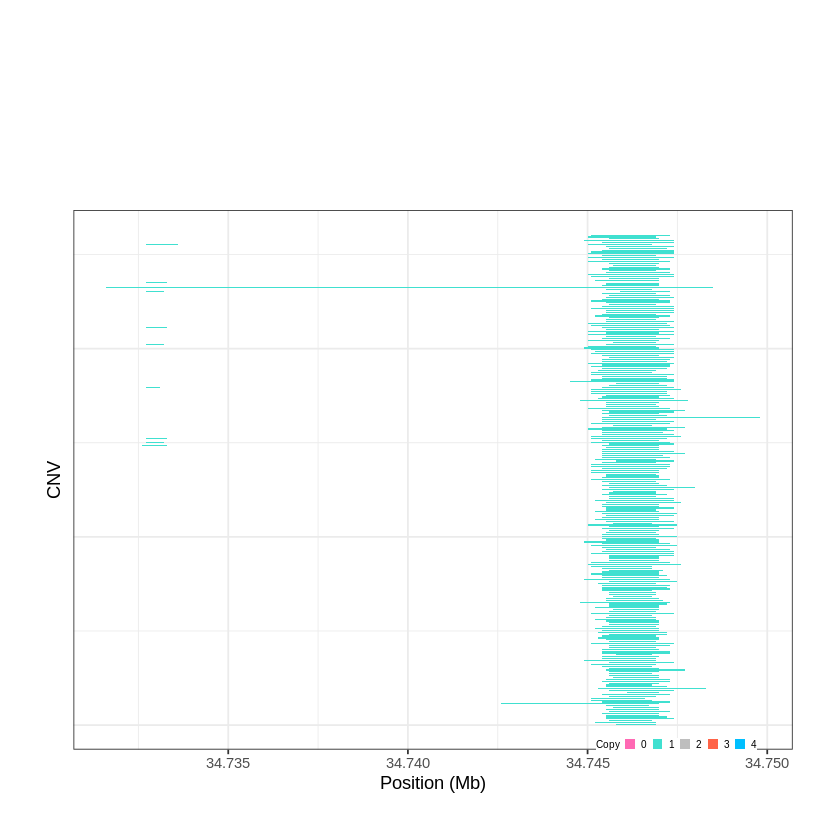

Task done, plot was stored in working directory.
[1] "Ploting CNVR 408..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 42.838001 - 42.8494 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


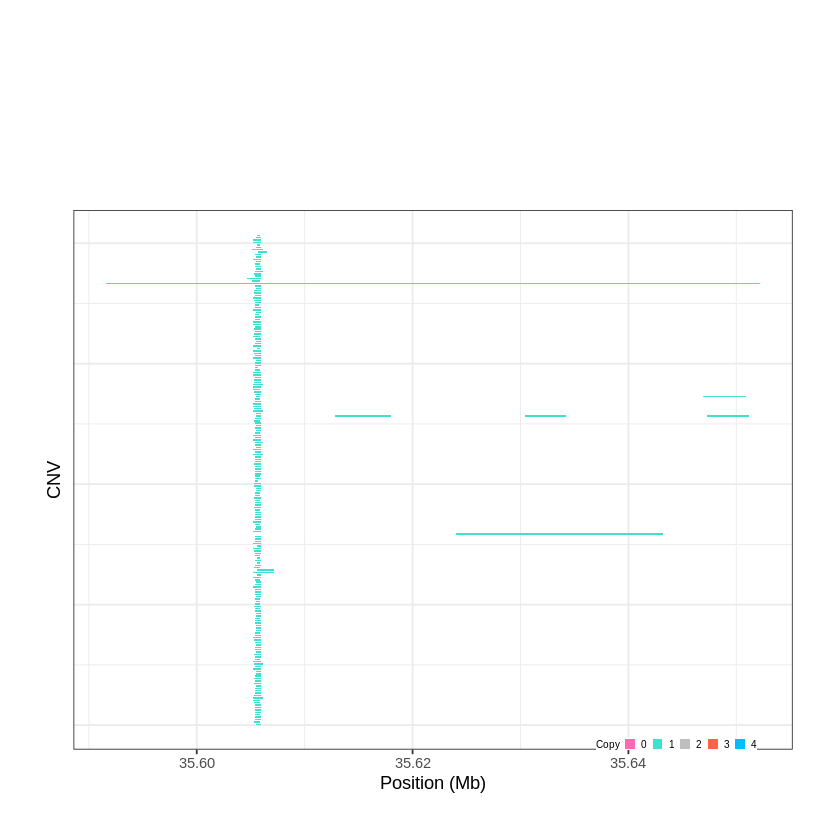

Task done, plot was stored in working directory.
[1] "Ploting CNVR 409..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 44.895401 - 44.9482 Mb with 201 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


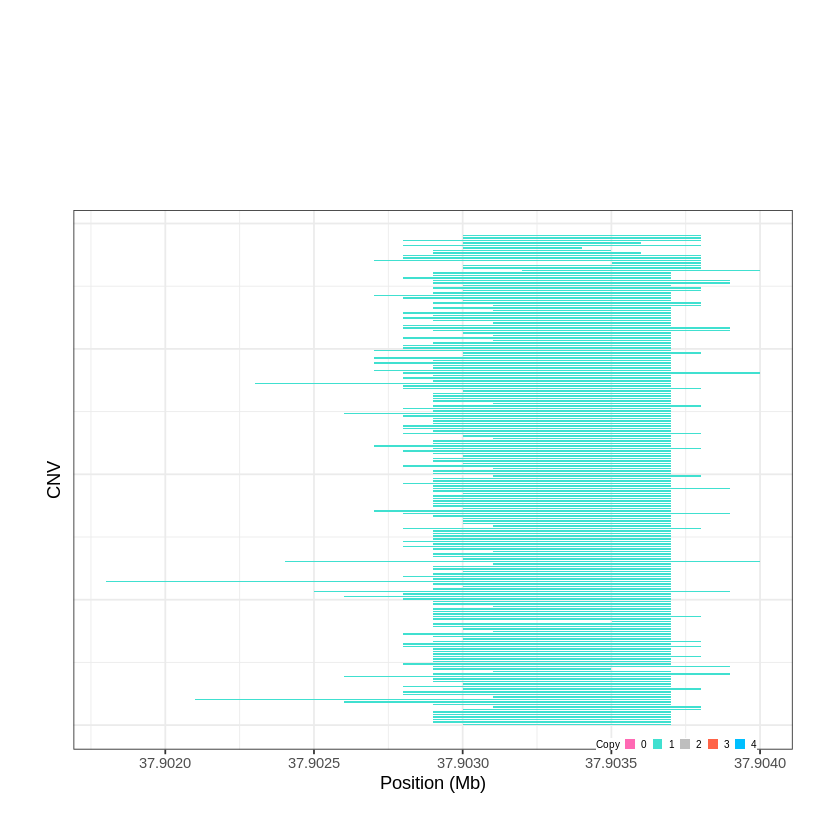

Task done, plot was stored in working directory.
[1] "Ploting CNVR 410..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 45.531501 - 45.6104 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


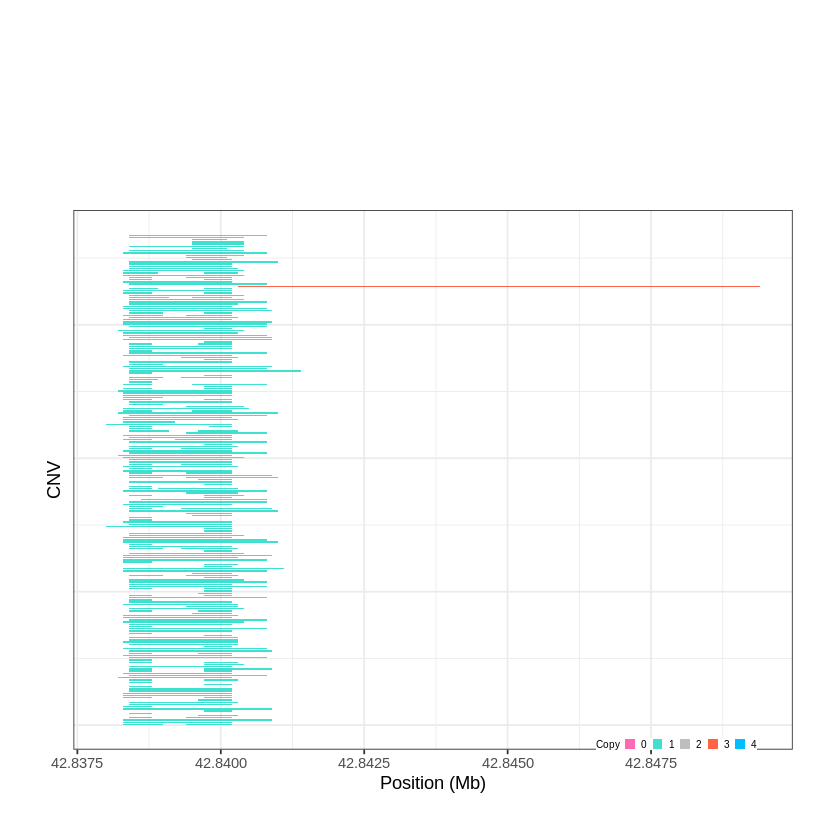

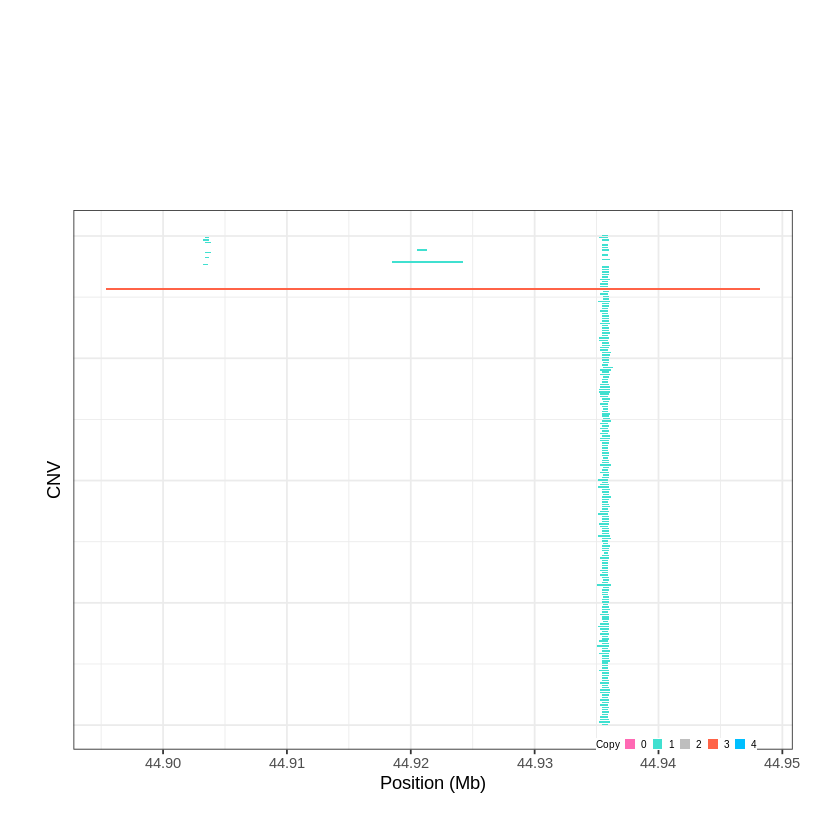

Task done, plot was stored in working directory.
[1] "Ploting CNVR 411..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 46.736701 - 47.0567 Mb with 150 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 412..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 47.459001 - 47.4602 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


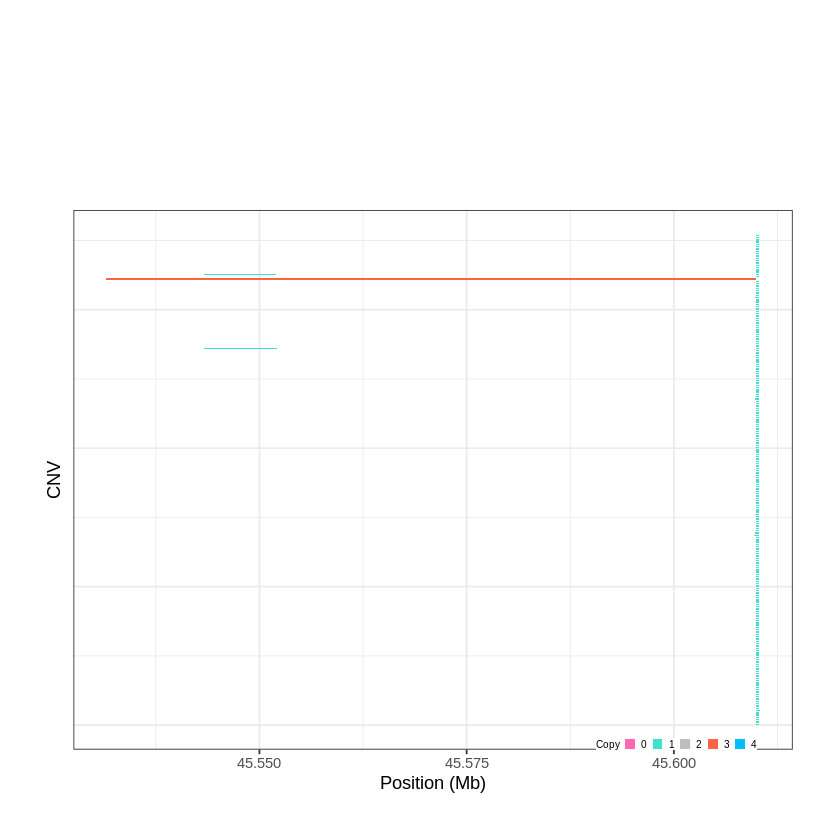

Task done, plot was stored in working directory.
[1] "Ploting CNVR 413..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 47.471701 - 47.4942 Mb with 184 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


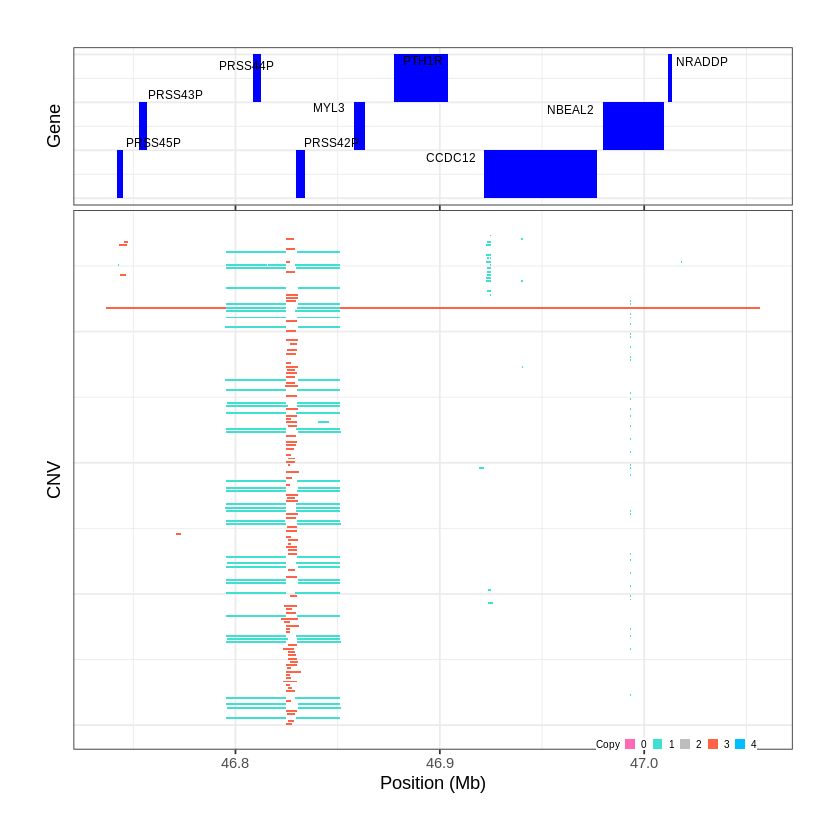

Task done, plot was stored in working directory.
[1] "Ploting CNVR 414..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 48.684301 - 48.6855 Mb with 231 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


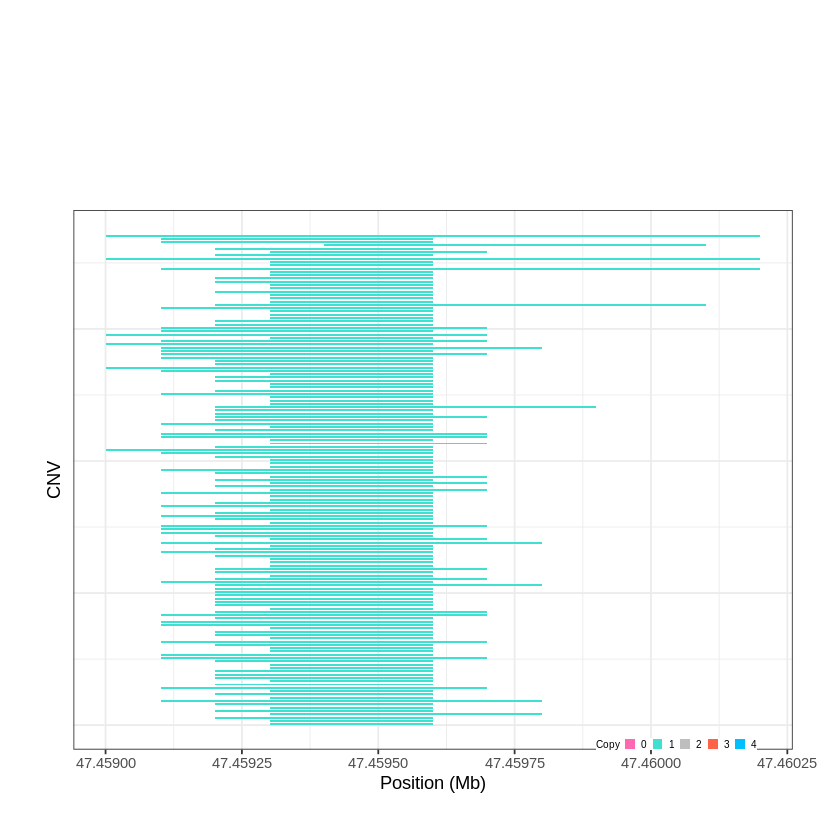

Task done, plot was stored in working directory.
[1] "Ploting CNVR 415..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 48.956401 - 48.9592 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


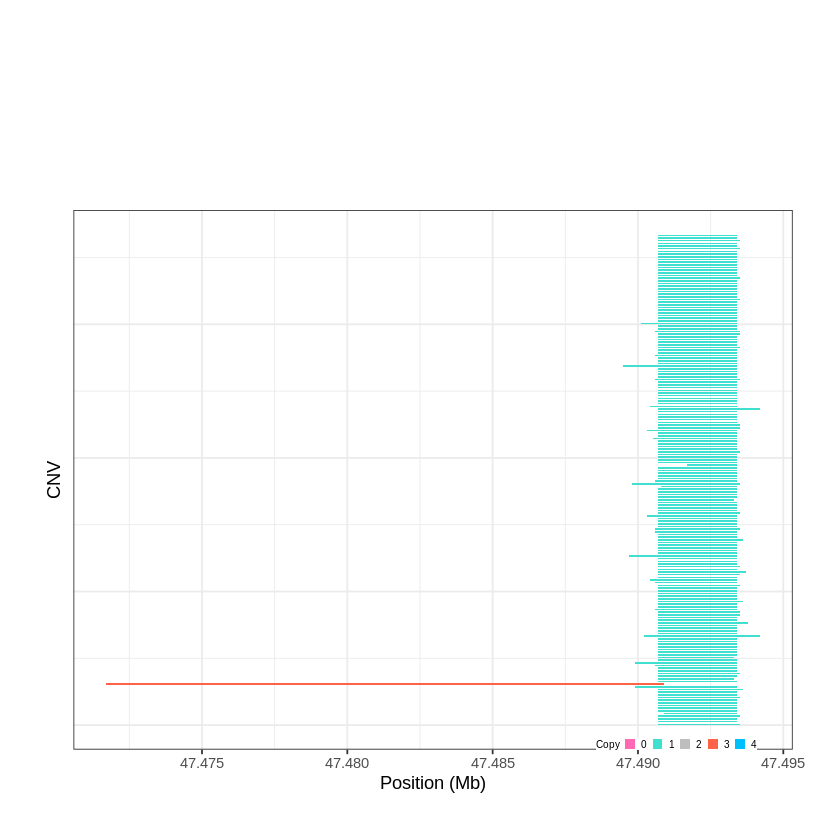

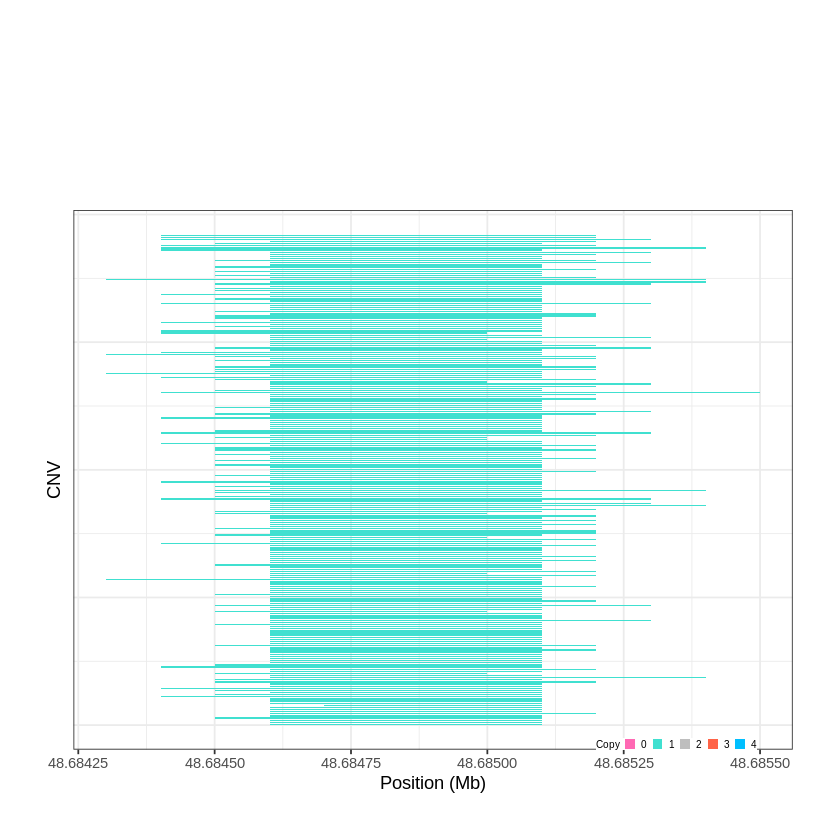

Task done, plot was stored in working directory.
[1] "Ploting CNVR 416..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 49.445101 - 50.721 Mb with 270 Individual - "
Plotting gene...


Warning message:
“ggrepel: 26 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


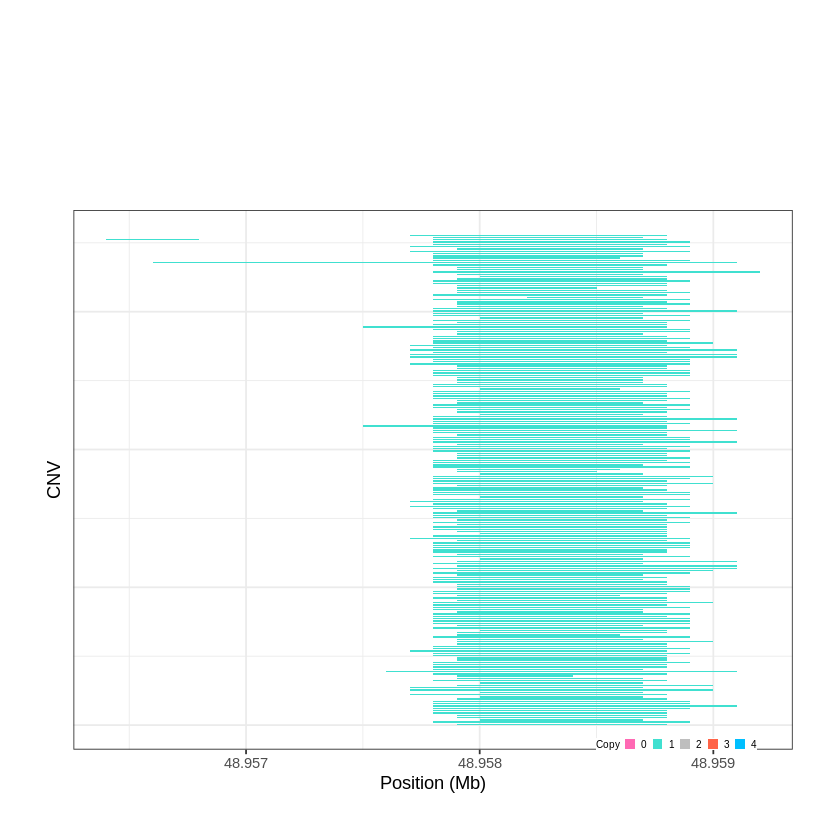

Task done, plot was stored in working directory.
[1] "Ploting CNVR 417..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 52.155701 - 52.6554 Mb with 161 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 418..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 57.387001 - 57.4022 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


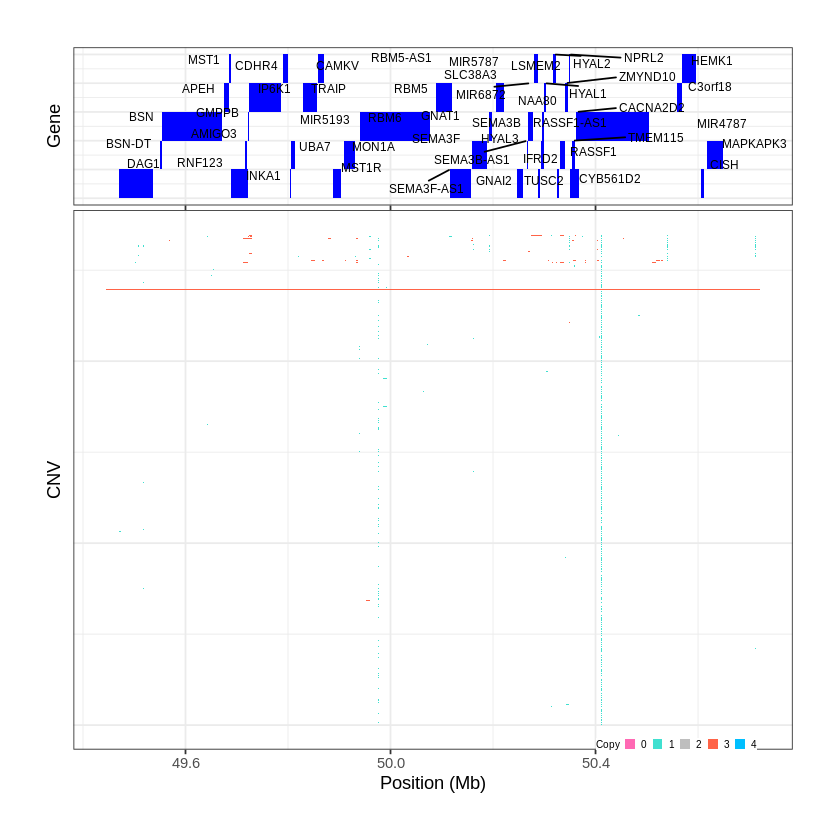

Task done, plot was stored in working directory.
[1] "Ploting CNVR 419..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 58.826201 - 58.8415 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


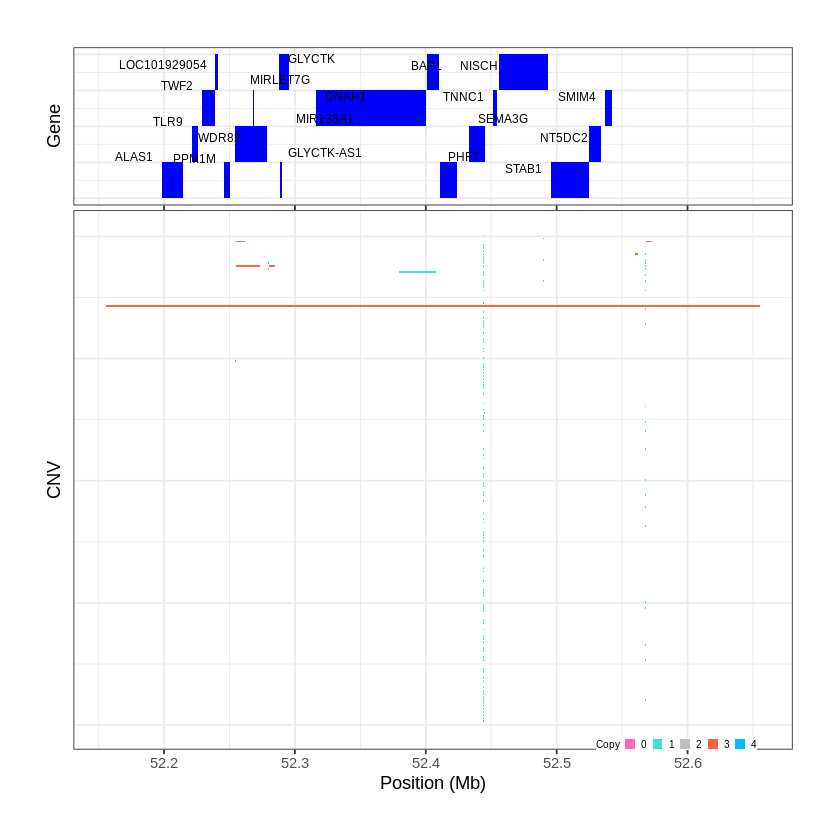

Task done, plot was stored in working directory.
[1] "Ploting CNVR 420..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 66.169801 - 66.2703 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


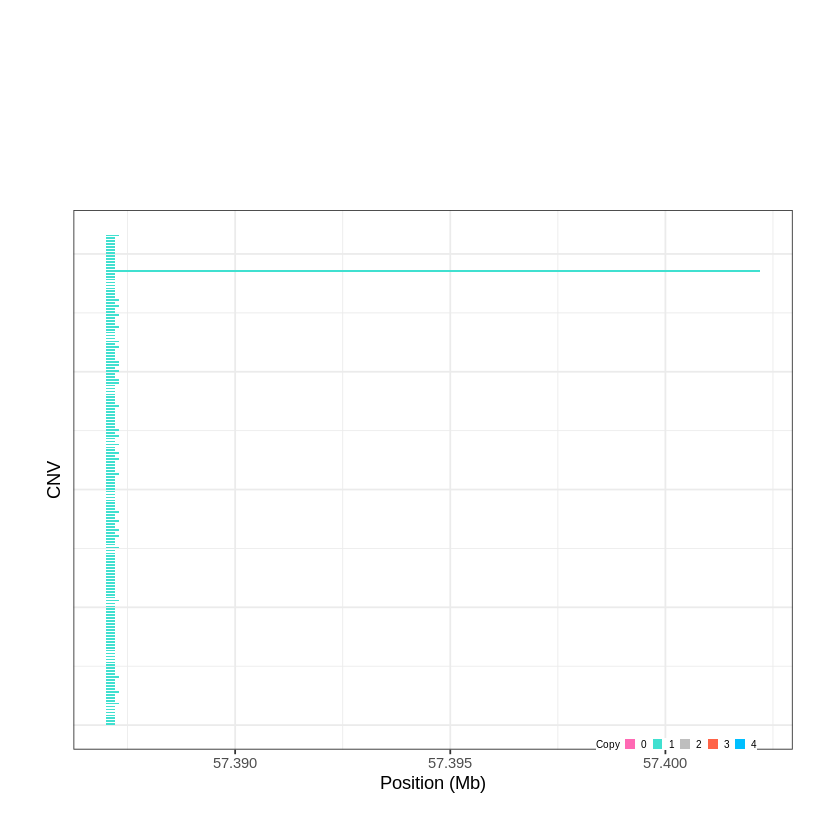

Task done, plot was stored in working directory.
[1] "Ploting CNVR 421..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 67.355301 - 67.6457 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


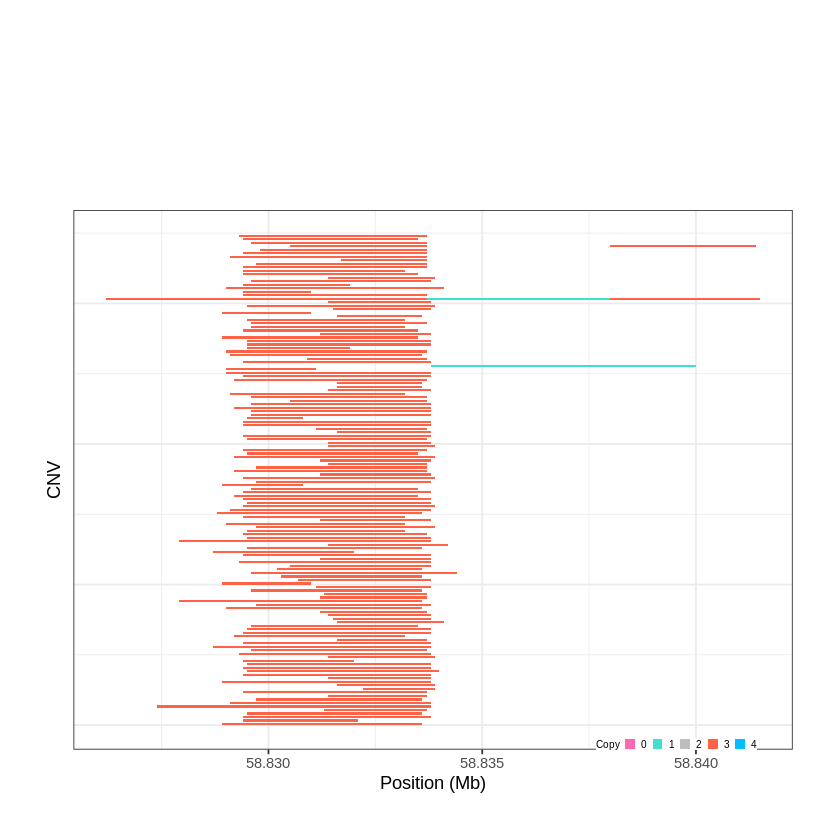

Task done, plot was stored in working directory.
[1] "Ploting CNVR 422..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 68.626401 - 68.6533 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


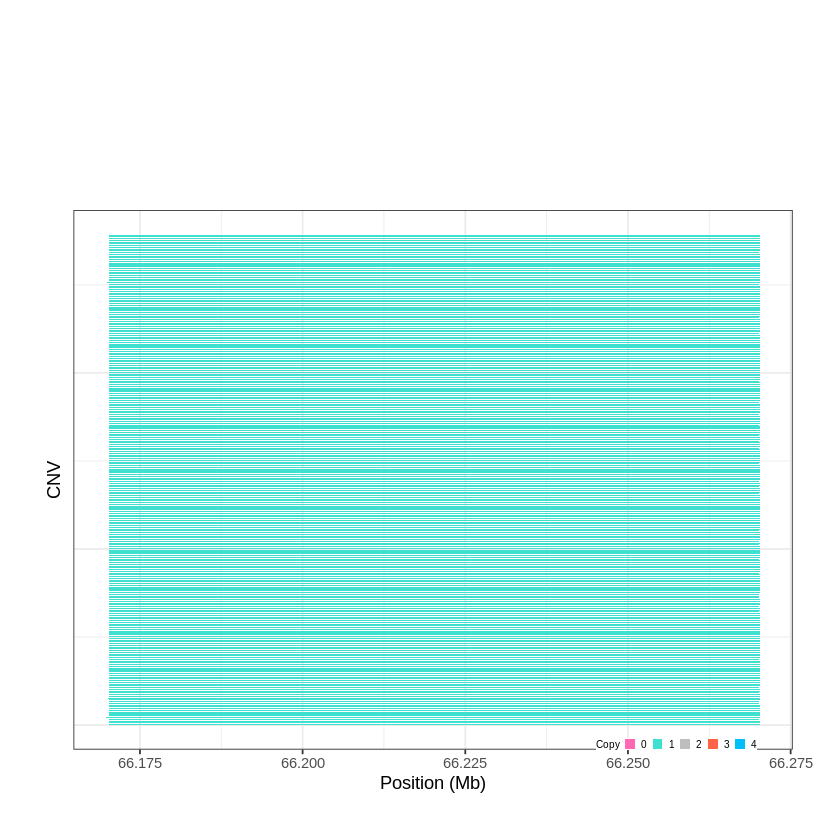

Task done, plot was stored in working directory.
[1] "Ploting CNVR 423..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 68.737701 - 68.7688 Mb with 236 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


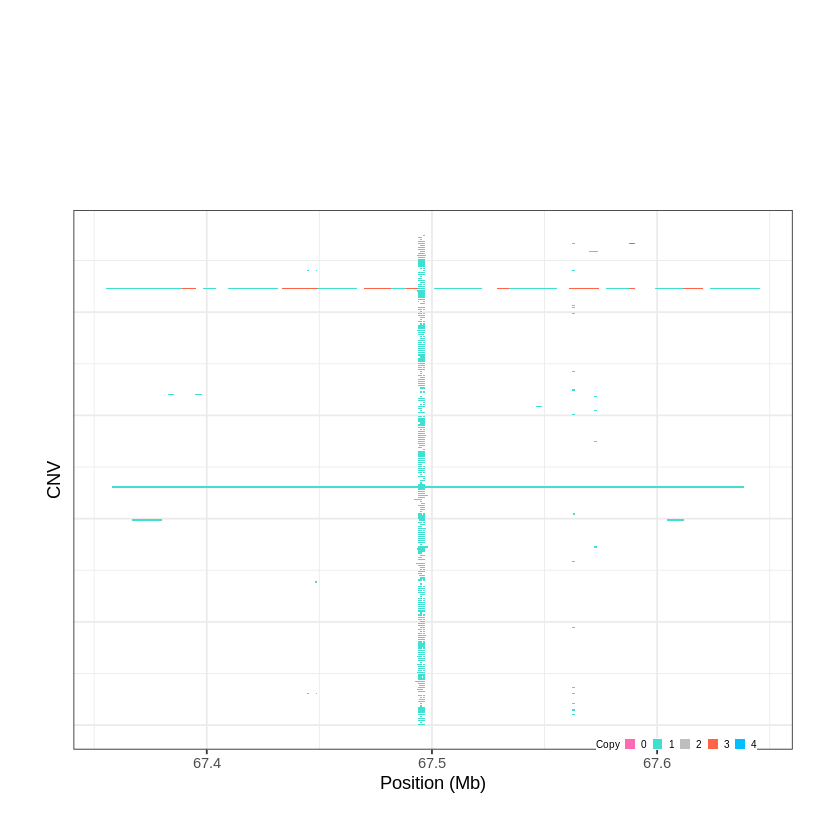

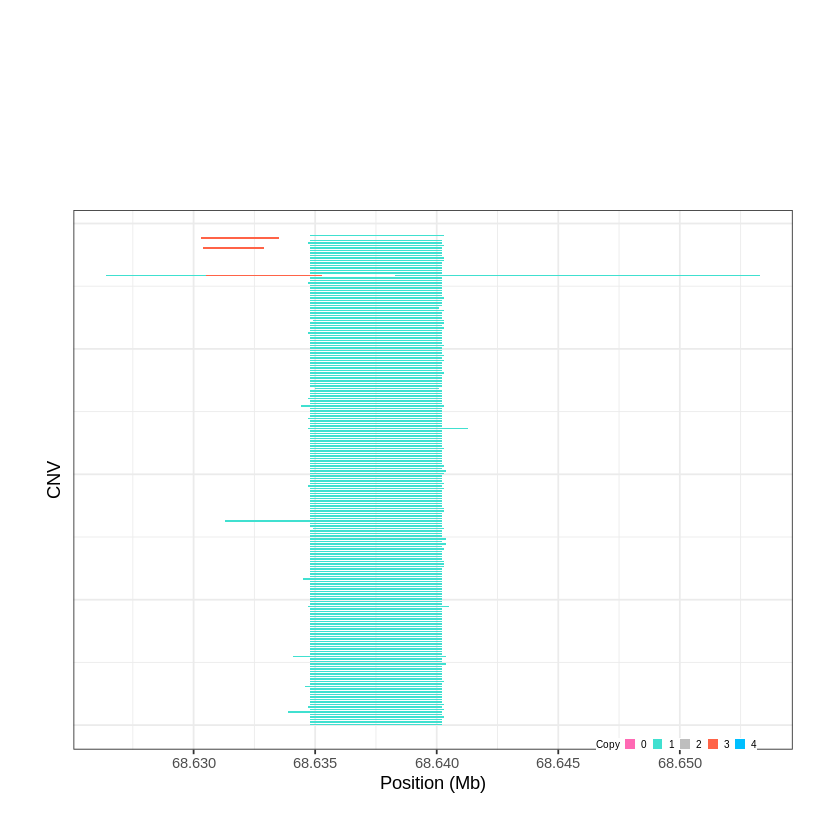

Task done, plot was stored in working directory.
[1] "Ploting CNVR 424..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 75.371601 - 75.8637 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 425..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 76.771201 - 76.7833 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


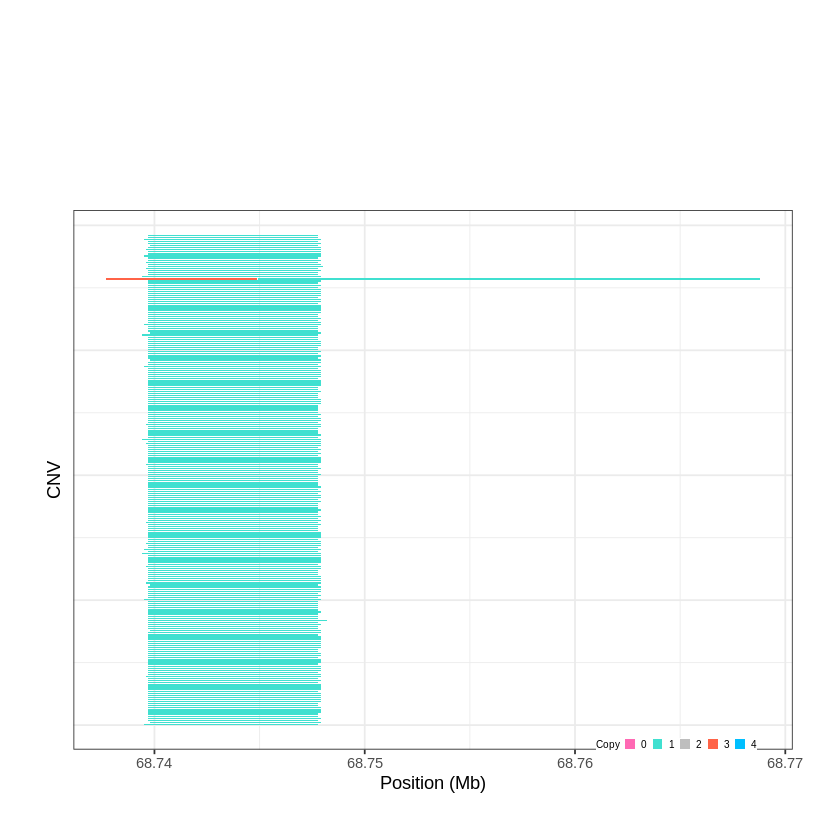

Task done, plot was stored in working directory.
[1] "Ploting CNVR 426..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 77.335601 - 77.355 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


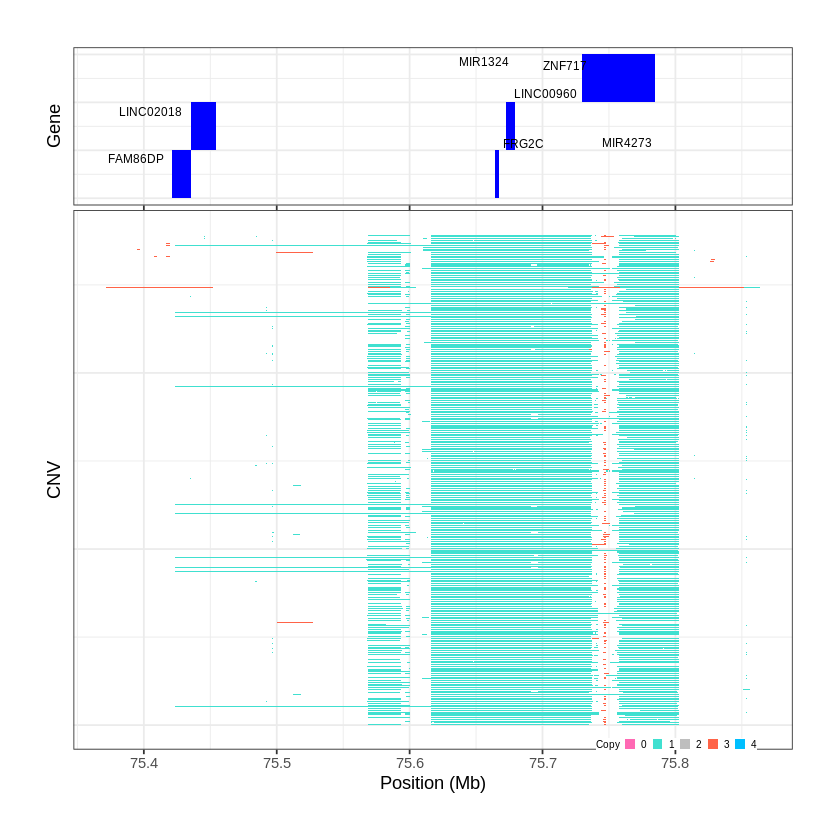

Task done, plot was stored in working directory.
[1] "Ploting CNVR 427..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 77.358901 - 77.3824 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


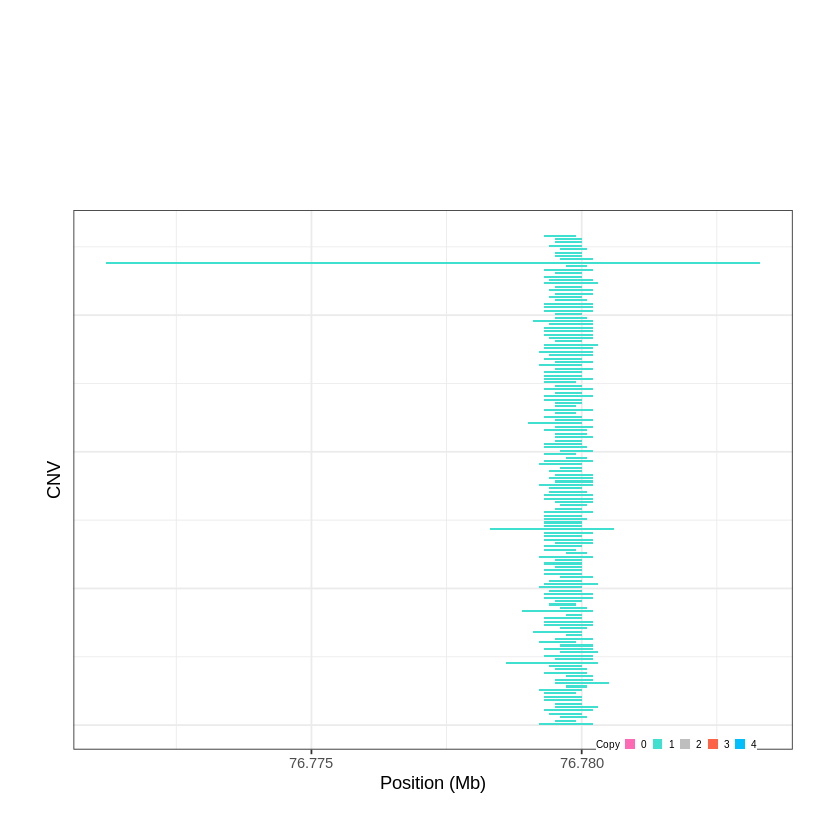

Task done, plot was stored in working directory.
[1] "Ploting CNVR 428..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 78.629501 - 78.6399 Mb with 268 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


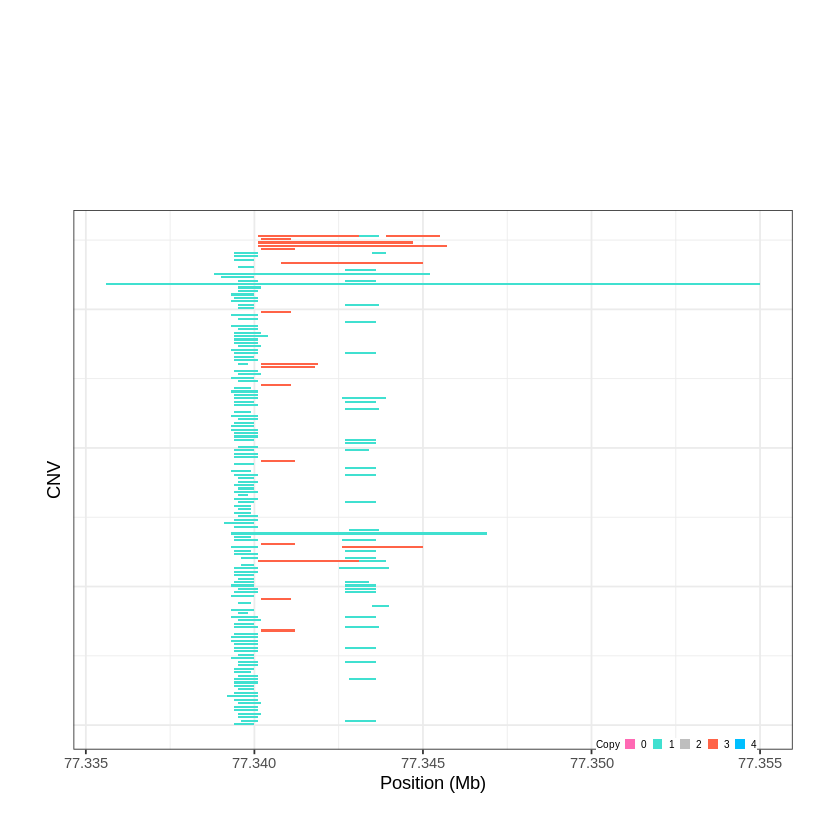

Task done, plot was stored in working directory.
[1] "Ploting CNVR 429..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 80.055601 - 80.0657 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


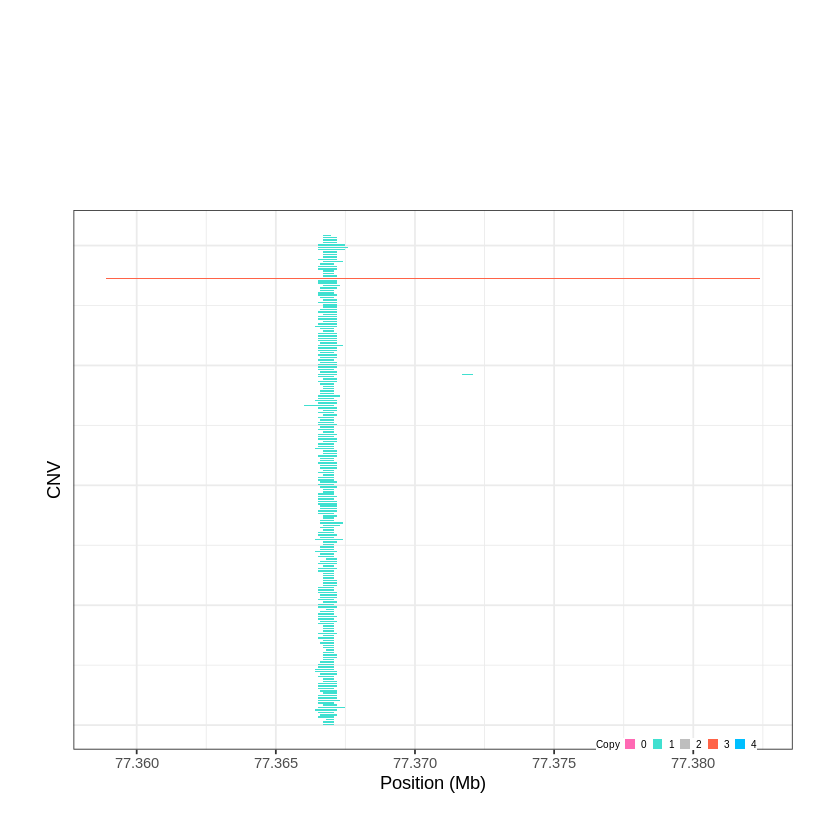

Task done, plot was stored in working directory.
[1] "Ploting CNVR 430..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 86.873501 - 86.9094 Mb with 216 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


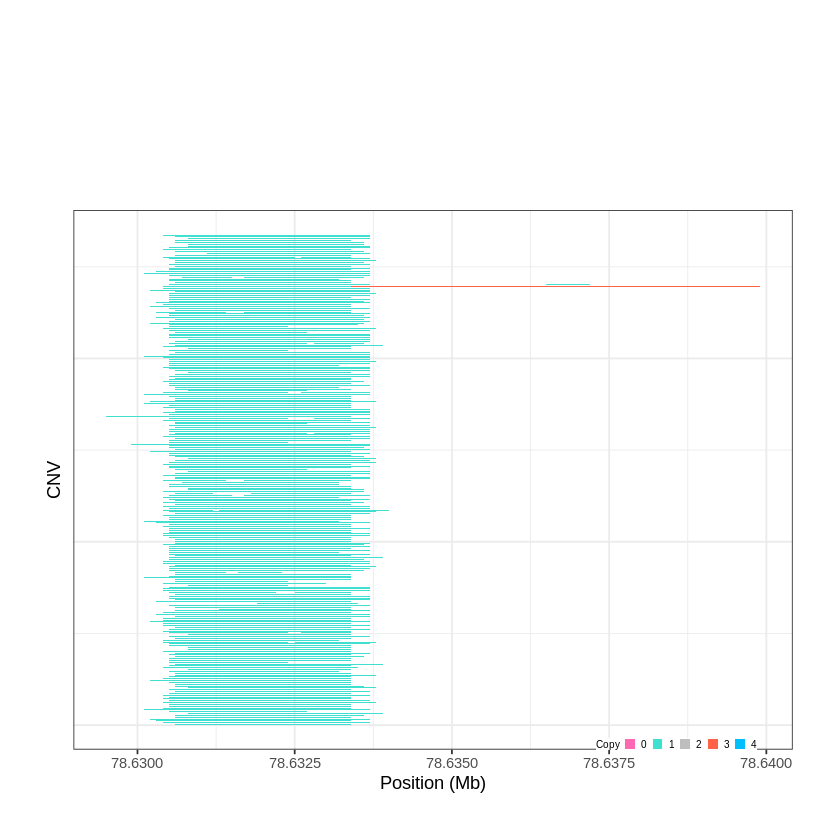

Task done, plot was stored in working directory.
[1] "Ploting CNVR 431..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 89.508001 - 89.5284 Mb with 204 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


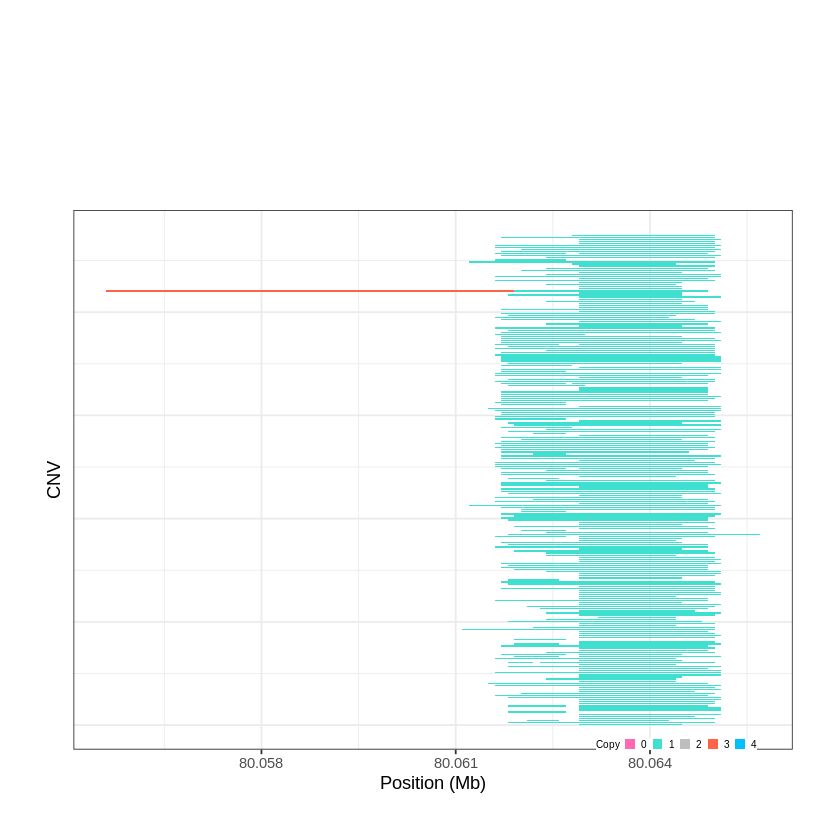

Task done, plot was stored in working directory.
[1] "Ploting CNVR 432..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 90.294501 - 93.5205 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


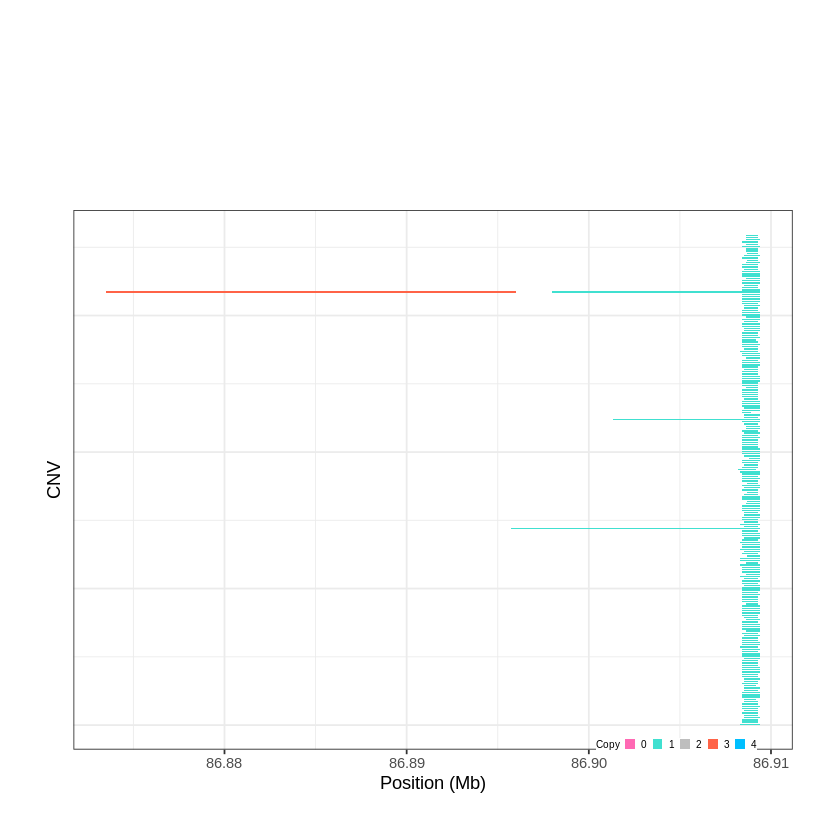

Task done, plot was stored in working directory.
[1] "Ploting CNVR 433..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 95.461901 - 95.4705 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


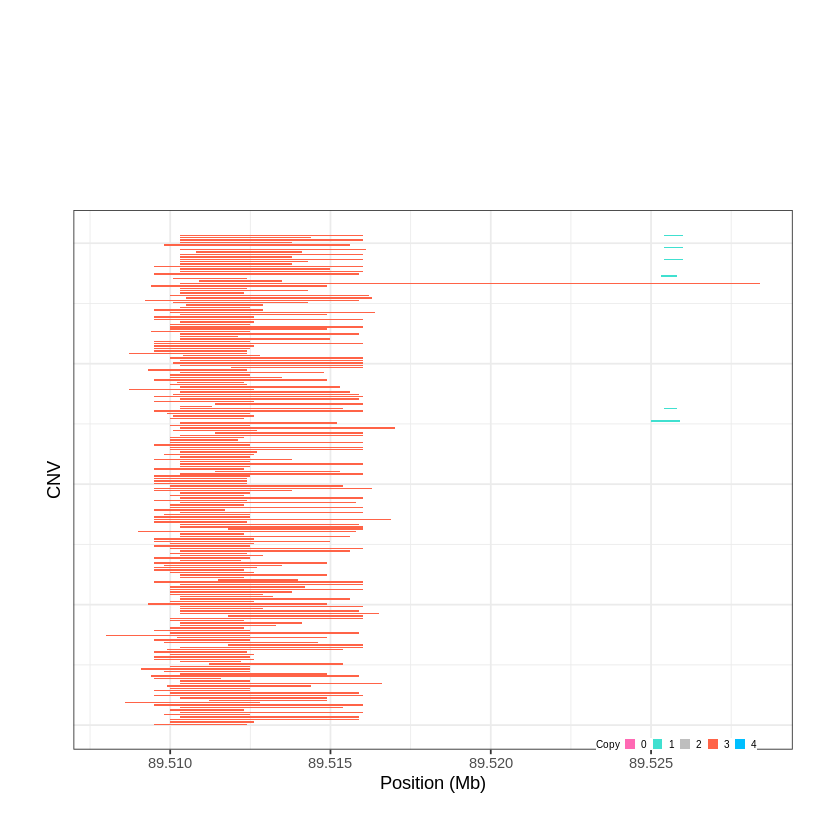

Task done, plot was stored in working directory.
[1] "Ploting CNVR 434..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 98.404901 - 98.416 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


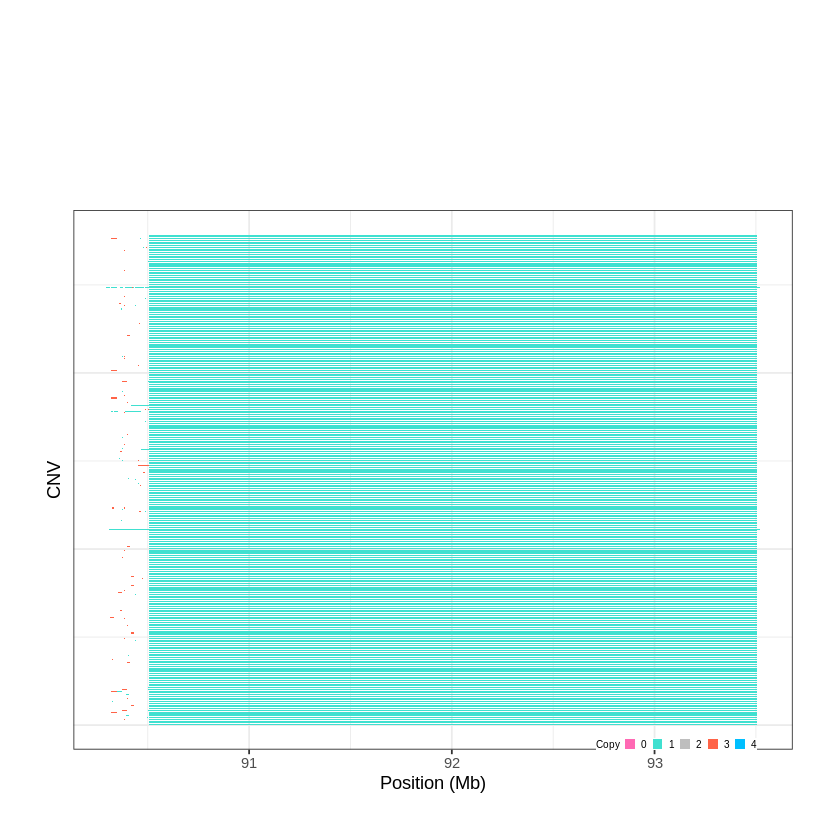

Task done, plot was stored in working directory.
[1] "Ploting CNVR 435..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 98.894401 - 98.9091 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


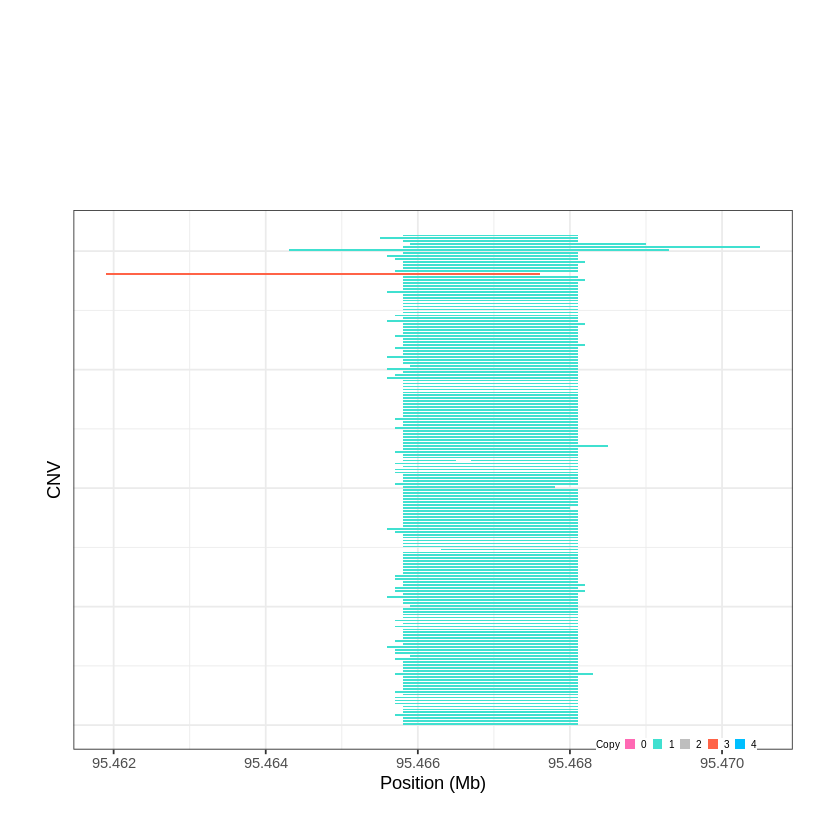

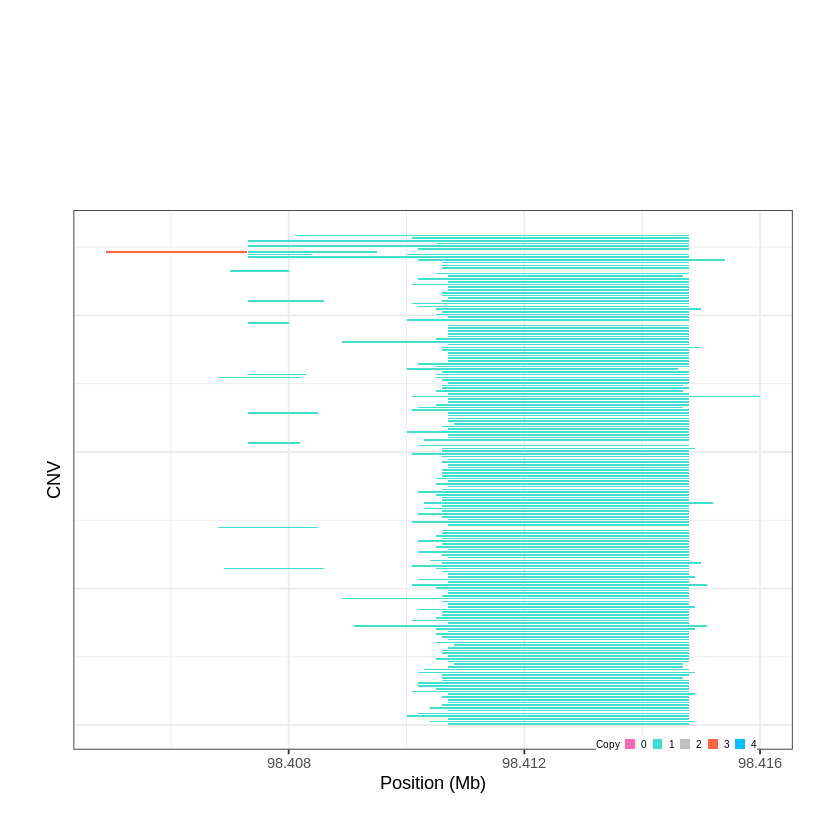

Task done, plot was stored in working directory.
[1] "Ploting CNVR 436..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 102.419201 - 103.0967 Mb with 261 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 437..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 105.813901 - 105.8321 Mb with 269 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


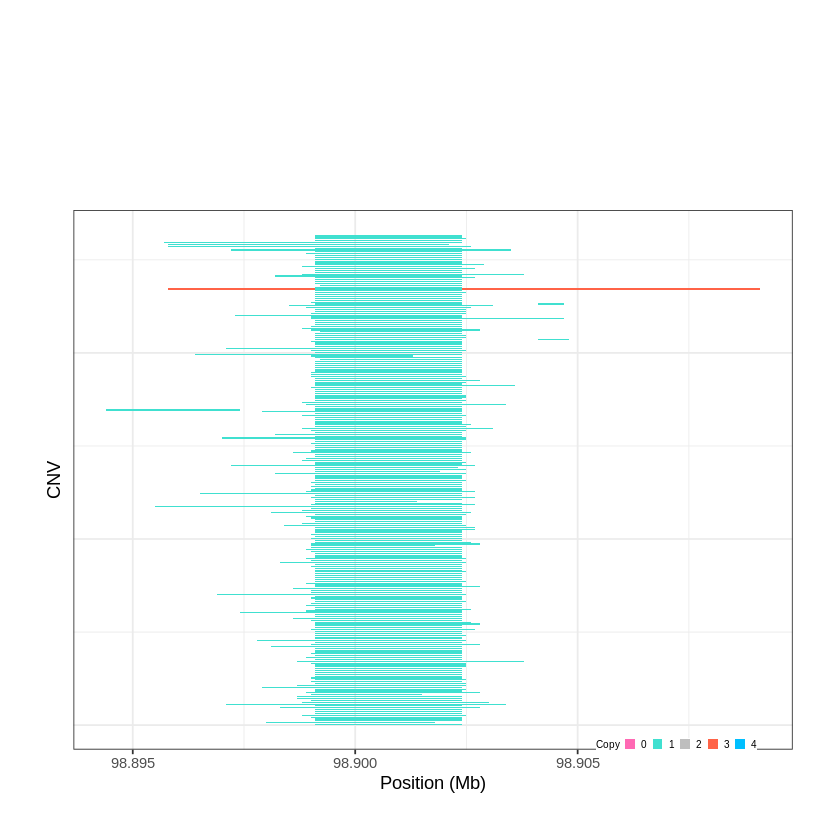

Task done, plot was stored in working directory.
[1] "Ploting CNVR 438..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 107.036001 - 107.043 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


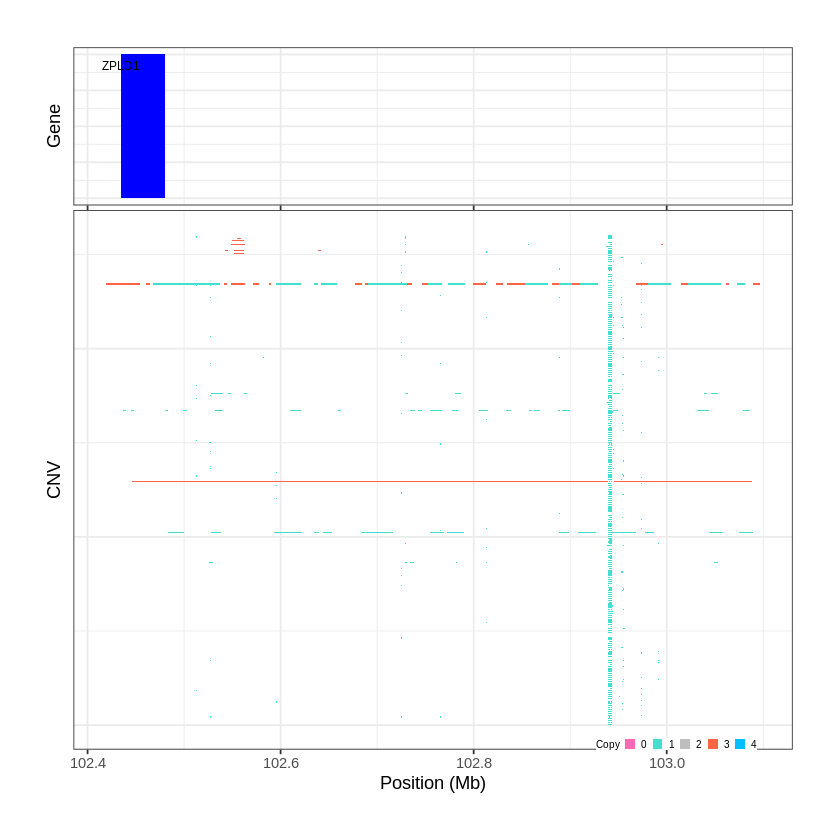

Task done, plot was stored in working directory.
[1] "Ploting CNVR 439..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 108.916301 - 108.934 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


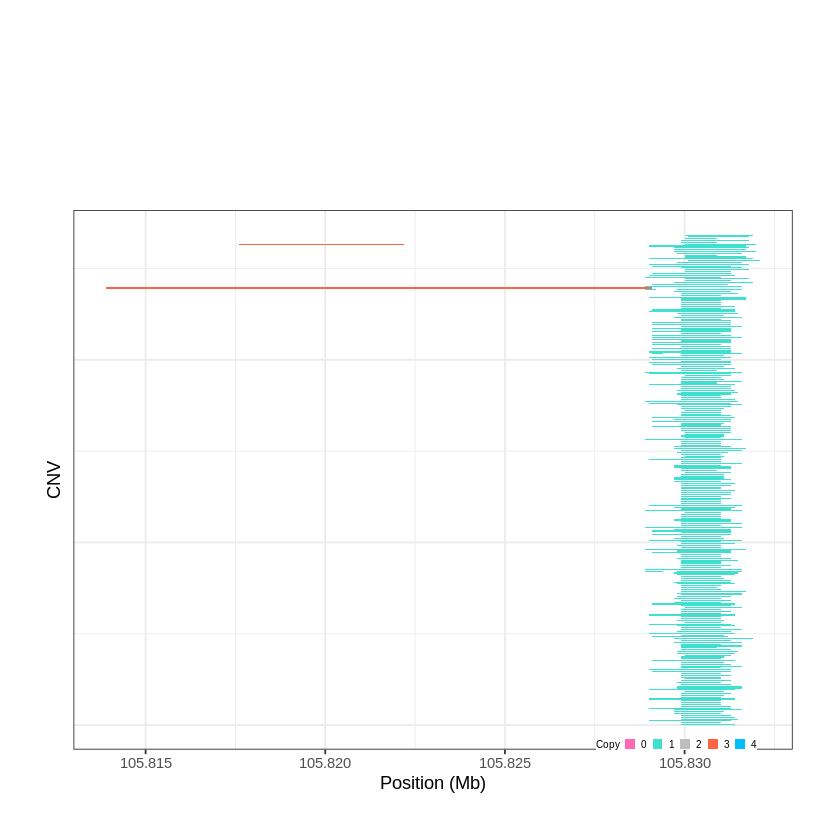

Task done, plot was stored in working directory.
[1] "Ploting CNVR 440..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 111.543701 - 111.5677 Mb with 222 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


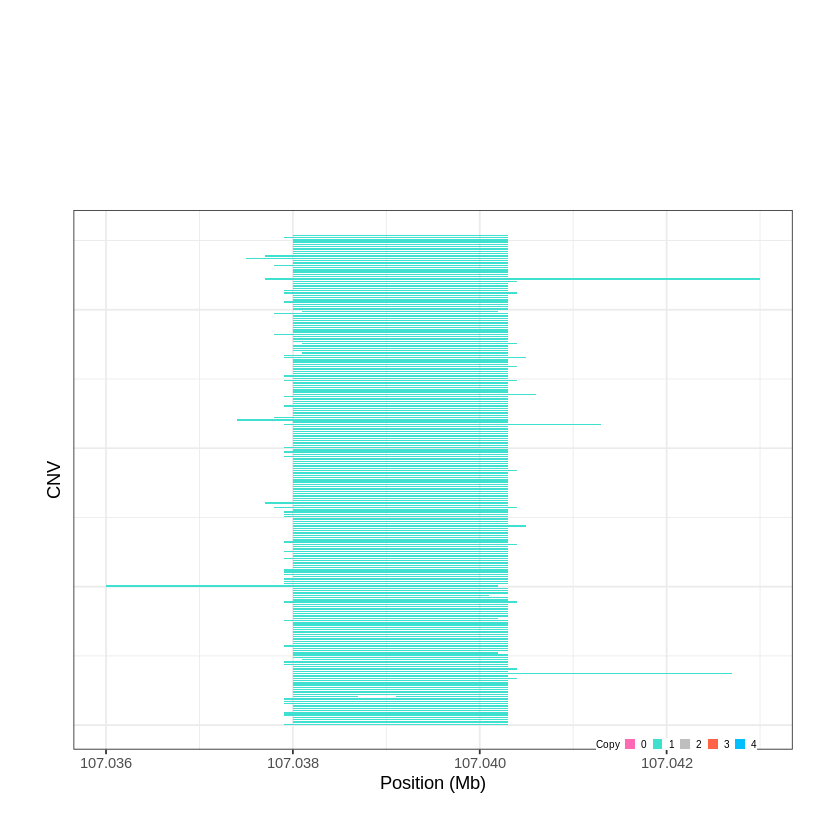

Task done, plot was stored in working directory.
[1] "Ploting CNVR 441..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 112.467401 - 112.4677 Mb with 212 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


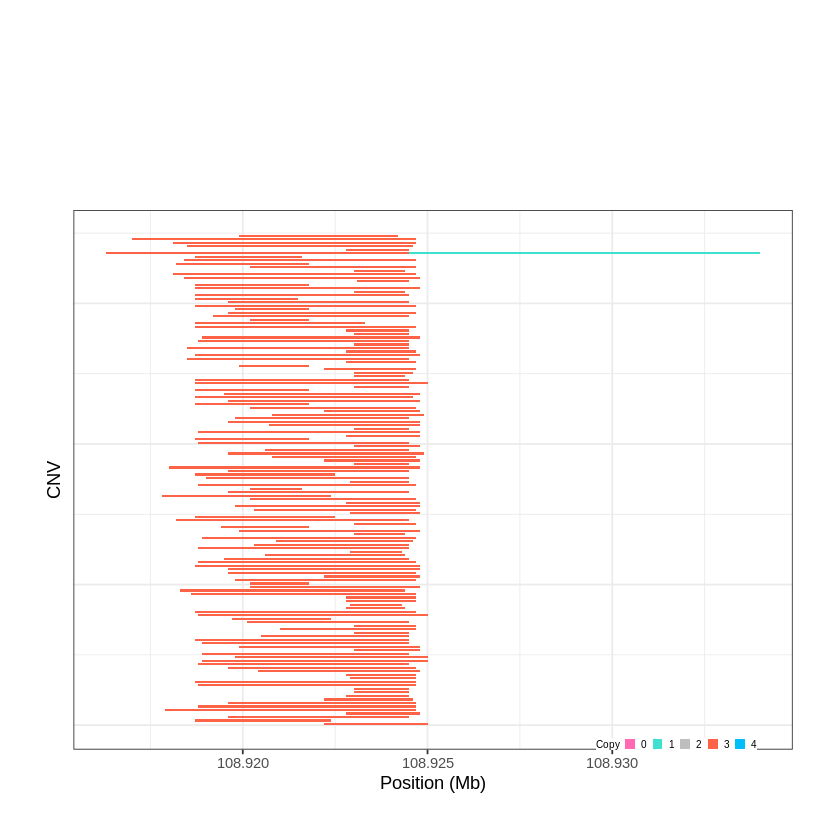

Task done, plot was stored in working directory.
[1] "Ploting CNVR 442..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 116.040501 - 116.1039 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


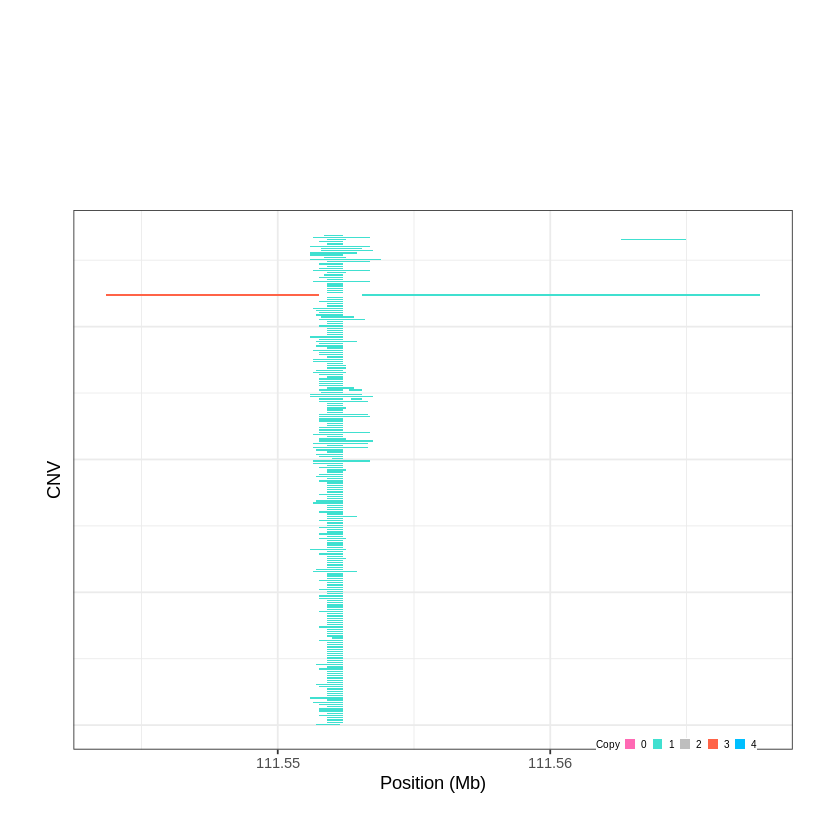

Task done, plot was stored in working directory.
[1] "Ploting CNVR 443..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 118.241401 - 118.2823 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


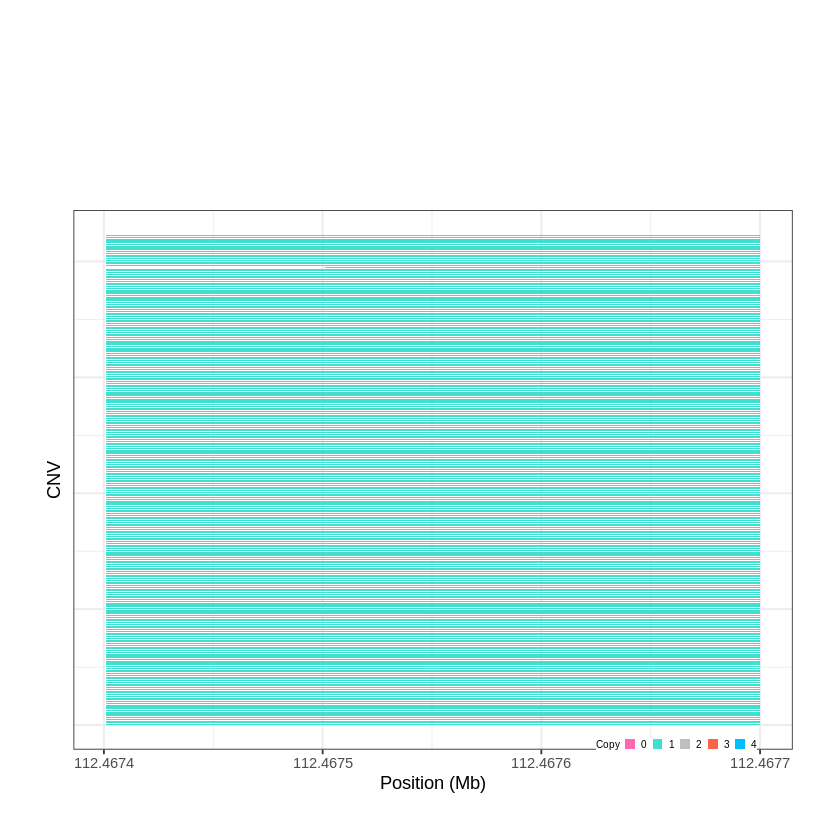

Task done, plot was stored in working directory.
[1] "Ploting CNVR 444..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 119.893901 - 119.8946 Mb with 226 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


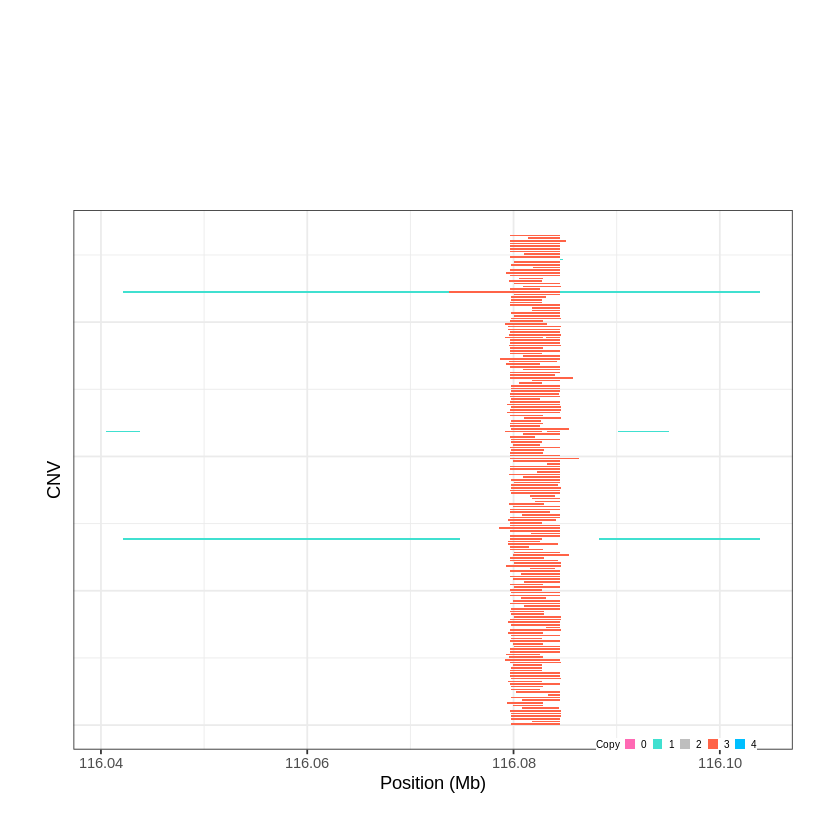

Task done, plot was stored in working directory.
[1] "Ploting CNVR 445..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 120.273201 - 120.3033 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


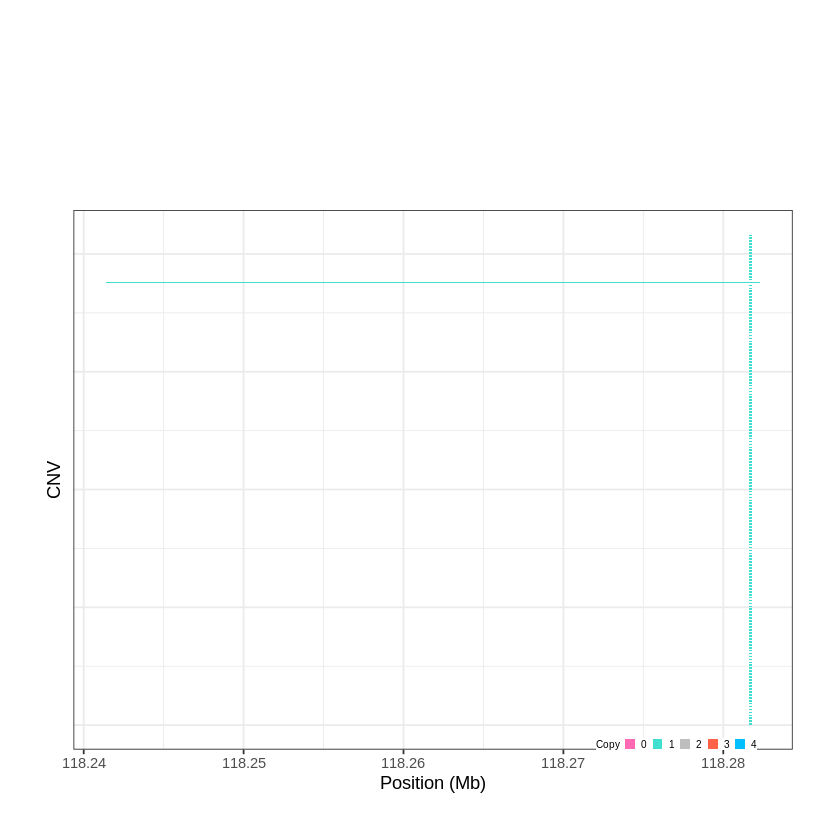

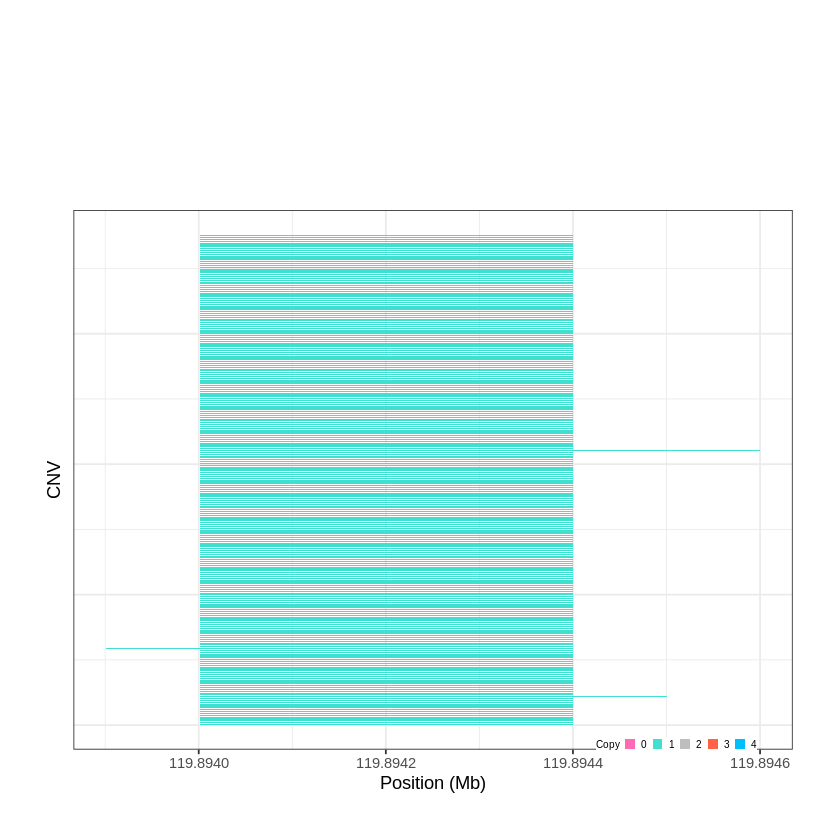

Task done, plot was stored in working directory.
[1] "Ploting CNVR 446..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 123.084801 - 123.2389 Mb with 172 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 447..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 125.438701 - 125.4901 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


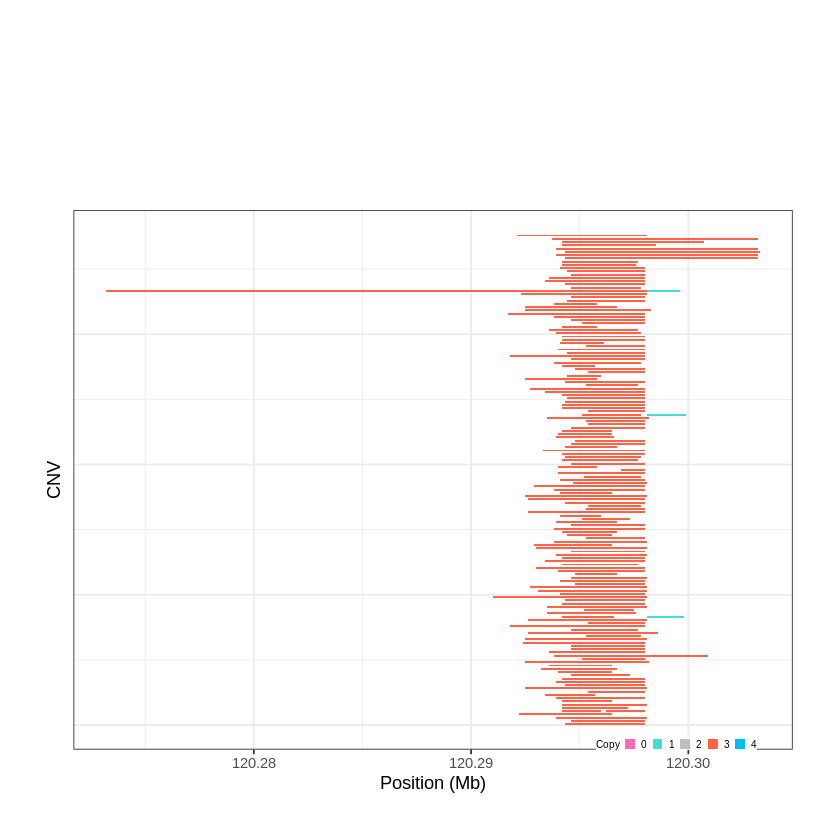

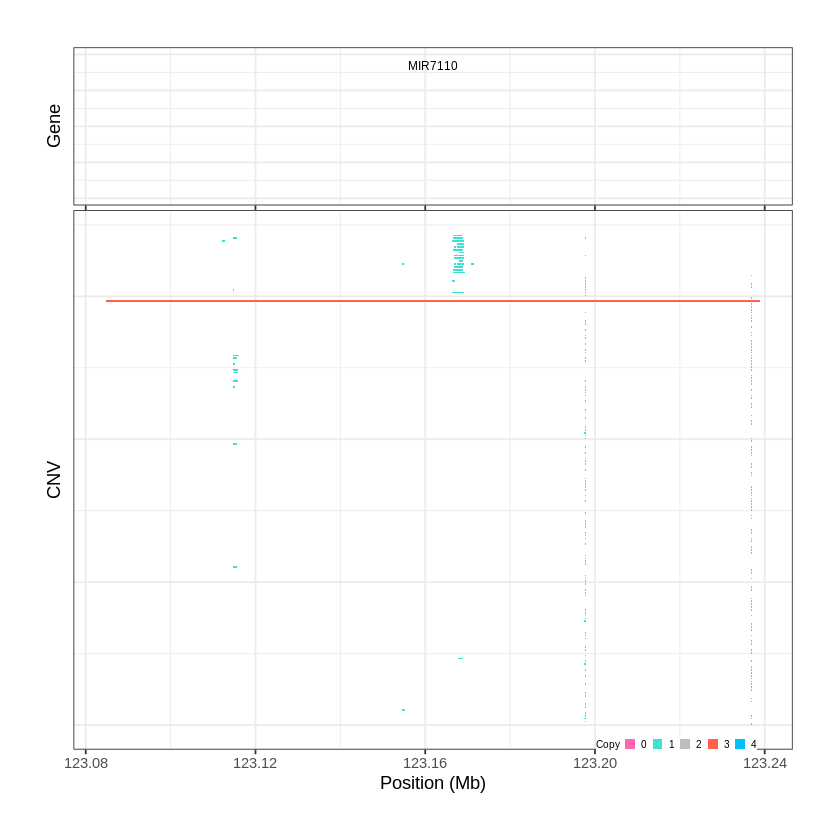

Task done, plot was stored in working directory.
[1] "Ploting CNVR 448..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 125.963201 - 126.3022 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 449..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 126.567101 - 126.5872 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


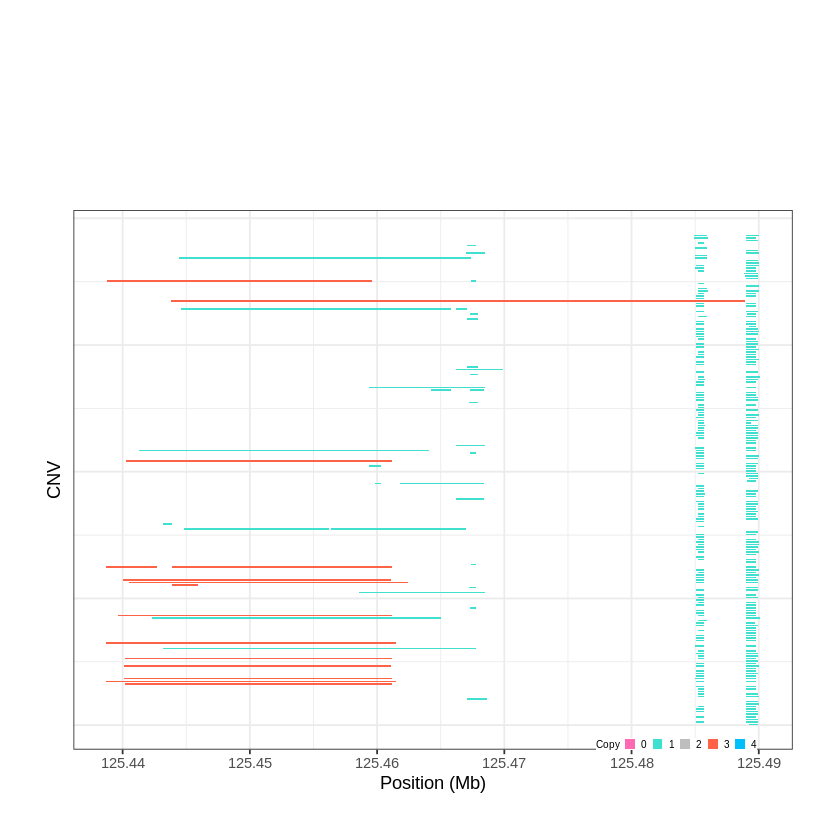

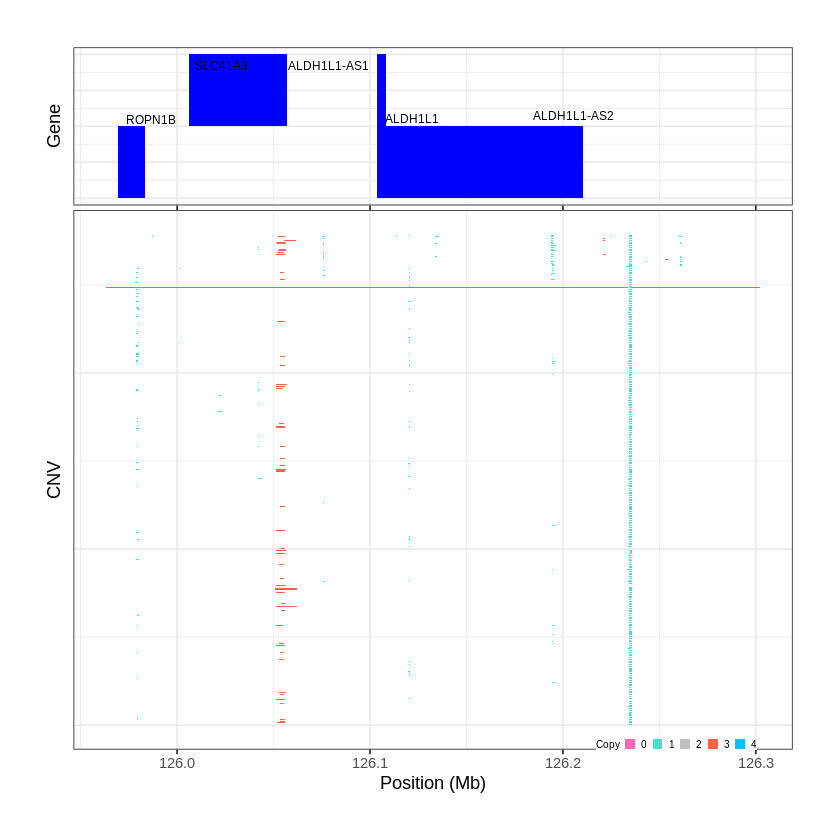

Task done, plot was stored in working directory.
[1] "Ploting CNVR 450..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 128.644301 - 128.8499 Mb with 166 Individual - "
Plotting gene...


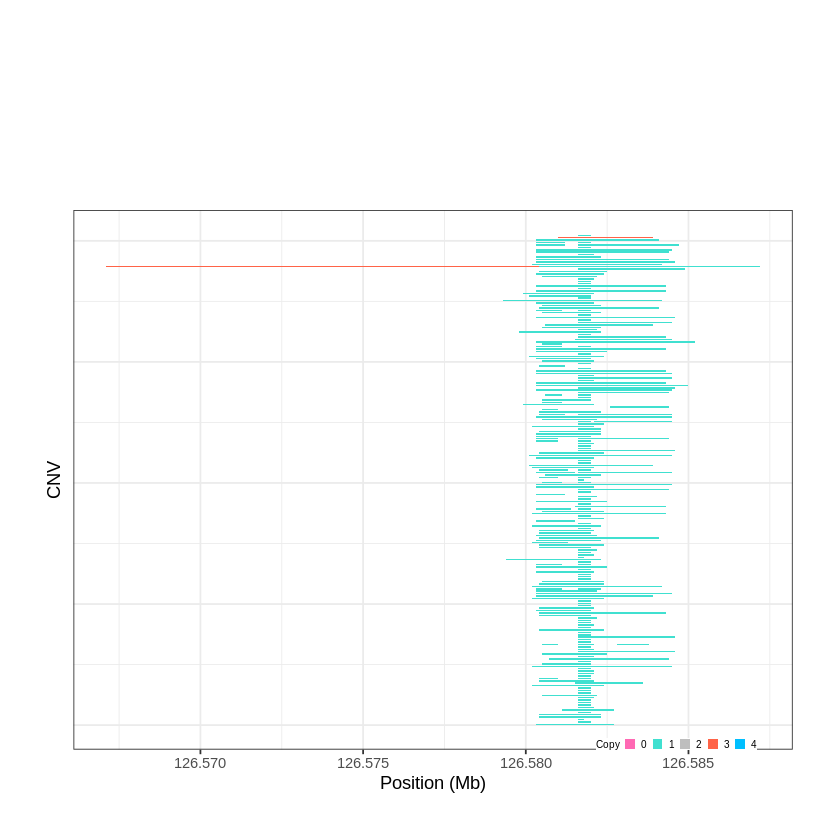

Task done, plot was stored in working directory.
[1] "Ploting CNVR 451..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 128.870401 - 129.1903 Mb with 151 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 452..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 129.760801 - 129.8072 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


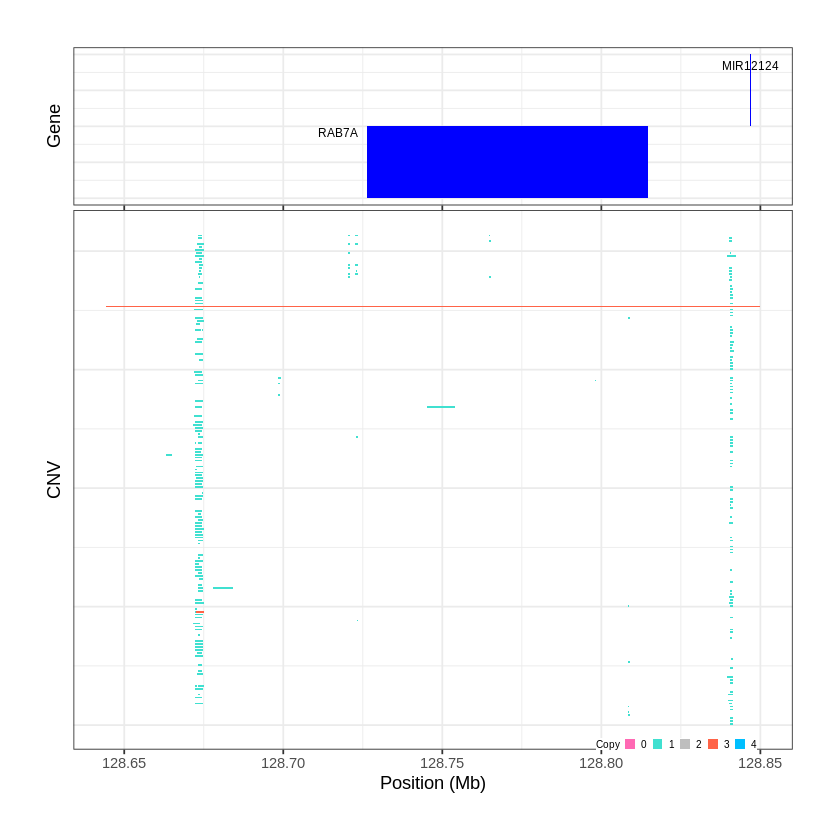

Task done, plot was stored in working directory.
[1] "Ploting CNVR 453..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 130.347401 - 130.3563 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


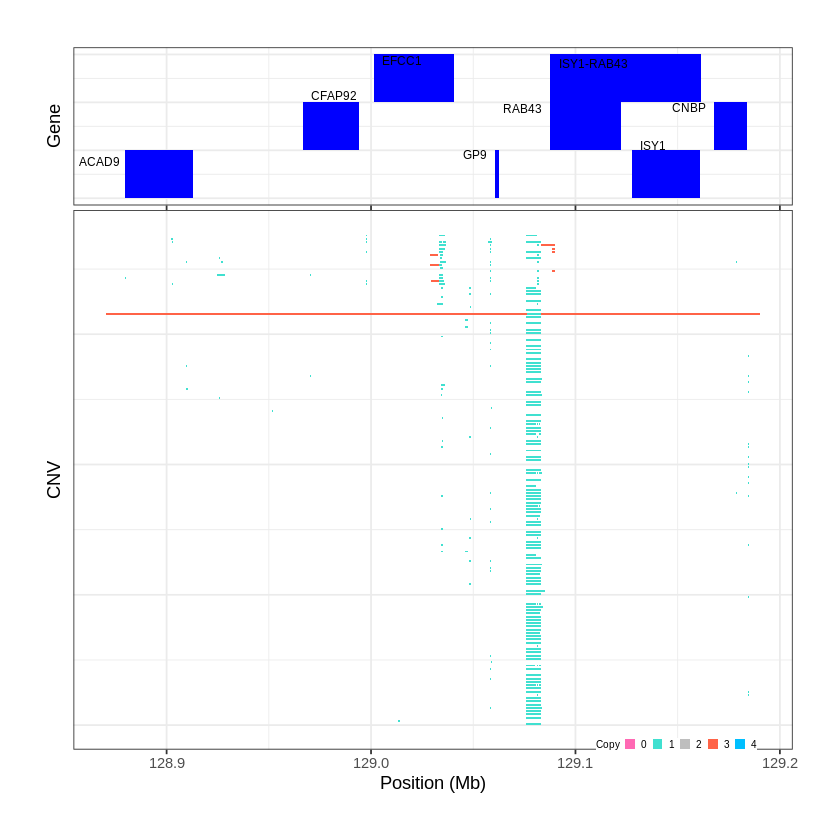

Task done, plot was stored in working directory.
[1] "Ploting CNVR 454..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 131.103401 - 131.1362 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


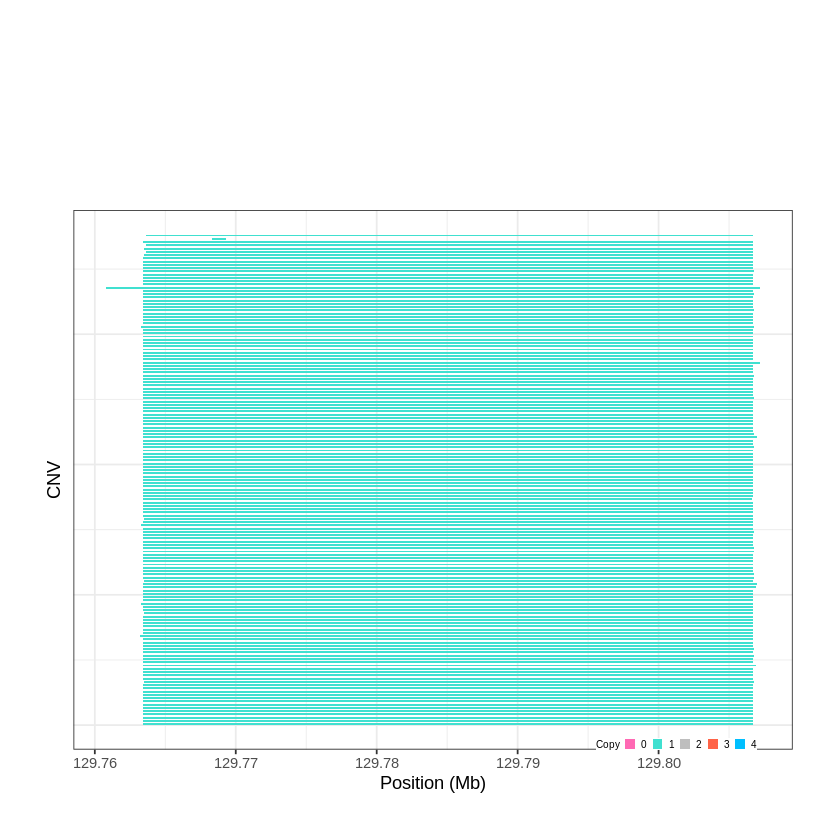

Task done, plot was stored in working directory.
[1] "Ploting CNVR 455..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 131.707801 - 131.731 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


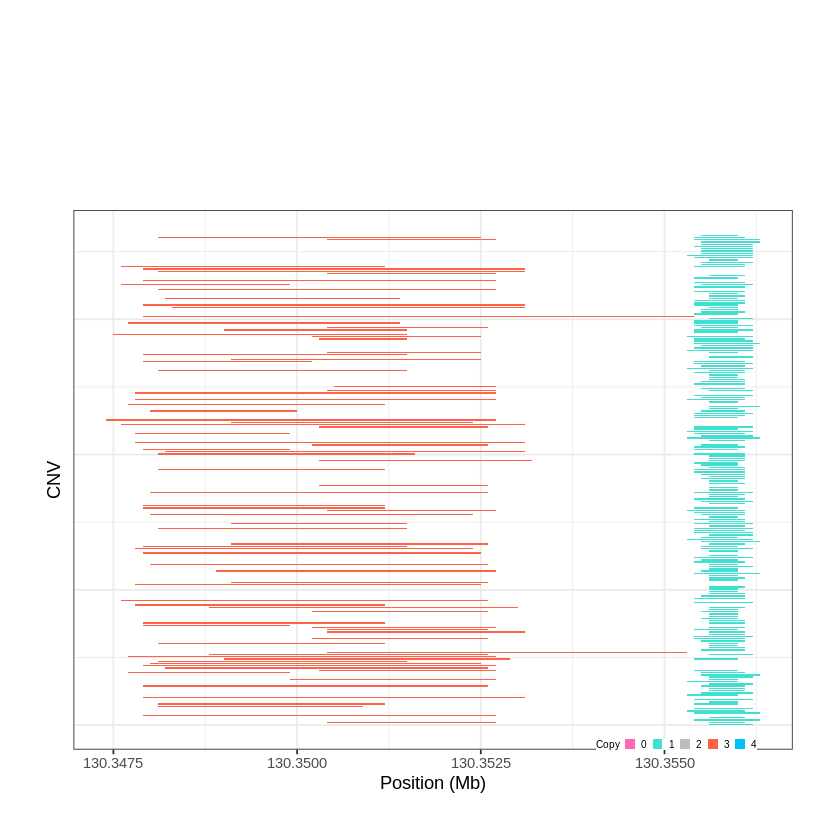

Task done, plot was stored in working directory.
[1] "Ploting CNVR 456..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 131.739901 - 131.7727 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


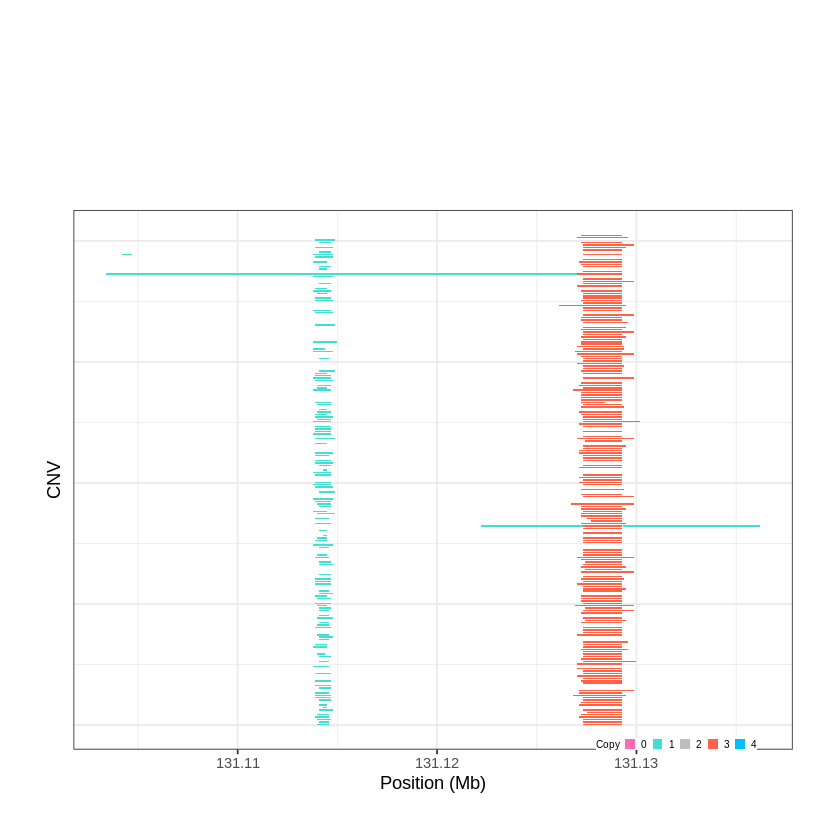

Task done, plot was stored in working directory.
[1] "Ploting CNVR 457..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 132.408901 - 132.4455 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


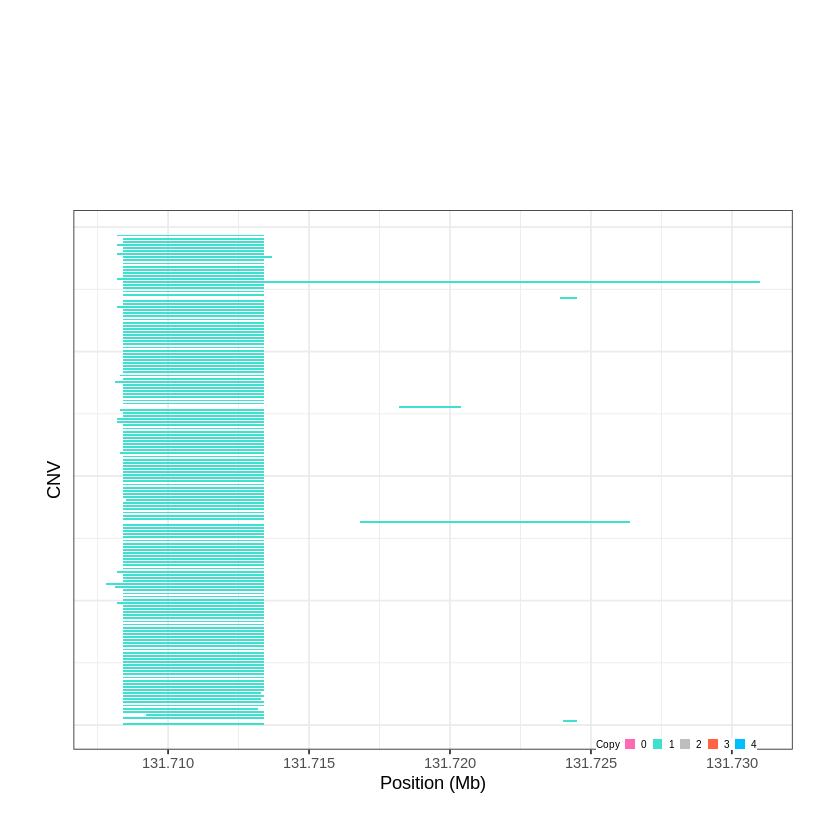

Task done, plot was stored in working directory.
[1] "Ploting CNVR 458..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 136.019901 - 136.0274 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


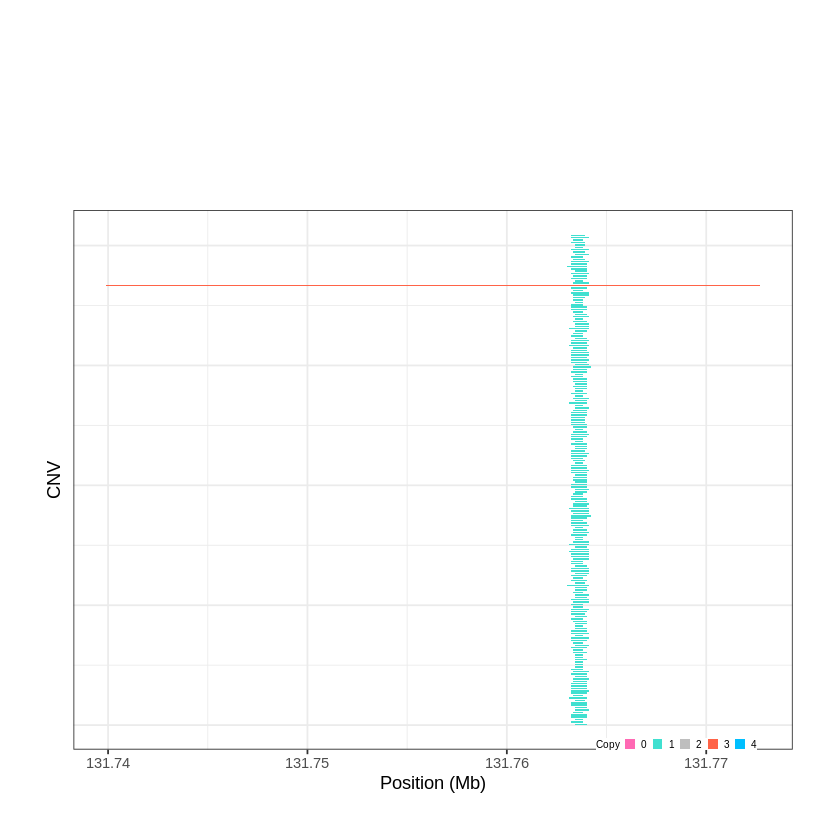

Task done, plot was stored in working directory.
[1] "Ploting CNVR 459..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 138.816701 - 138.8367 Mb with 265 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


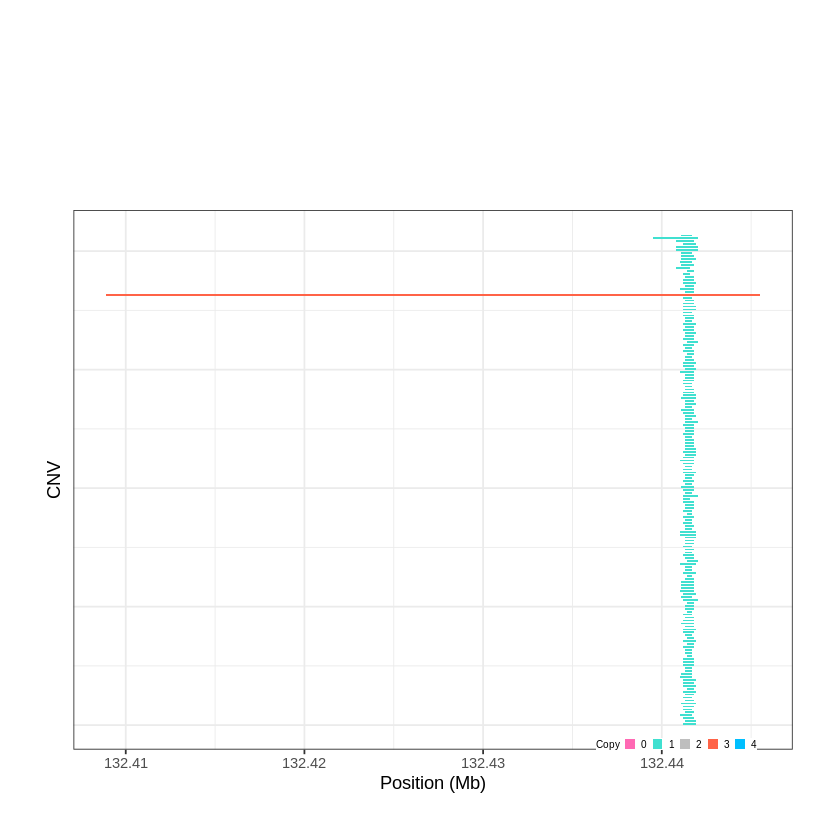

Task done, plot was stored in working directory.
[1] "Ploting CNVR 460..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 140.543501 - 140.5481 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


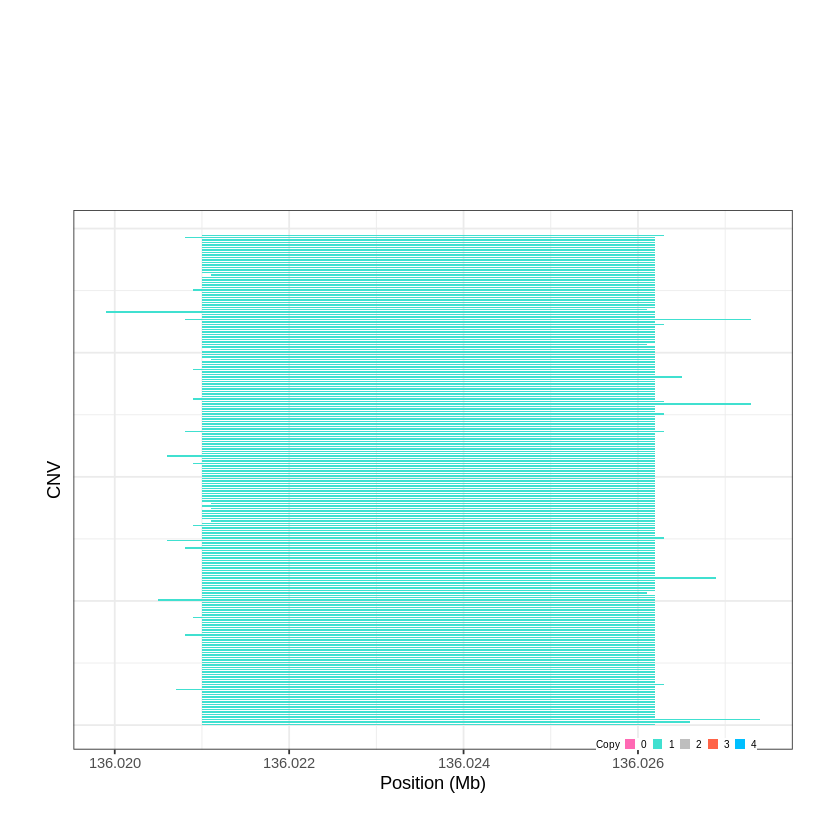

Task done, plot was stored in working directory.
[1] "Ploting CNVR 461..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 141.383501 - 141.3854 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


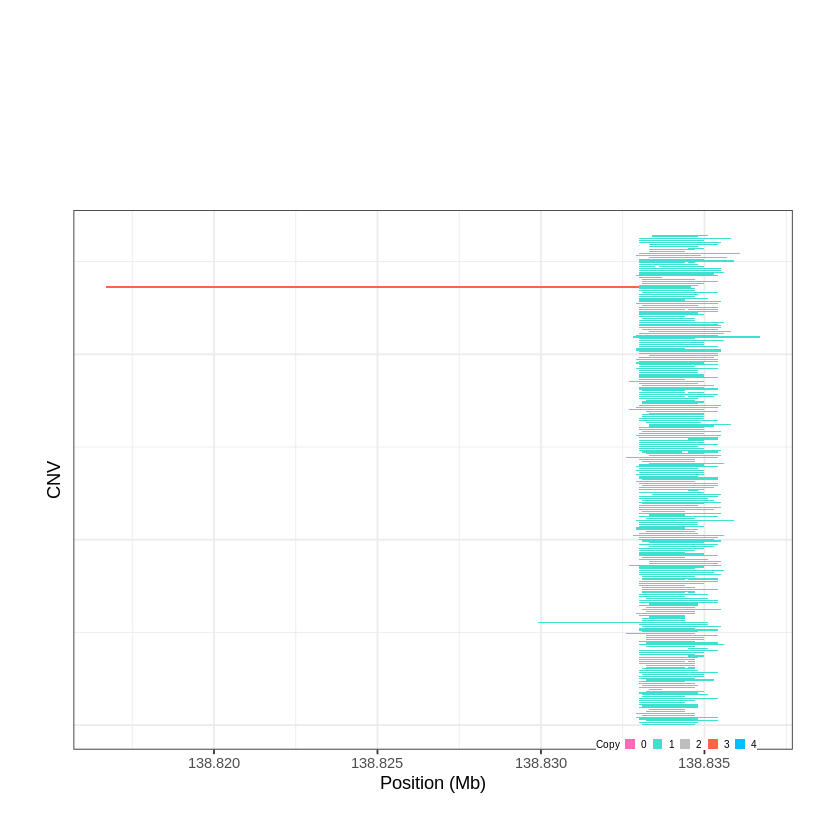

Task done, plot was stored in working directory.
[1] "Ploting CNVR 462..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 143.158501 - 143.1777 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


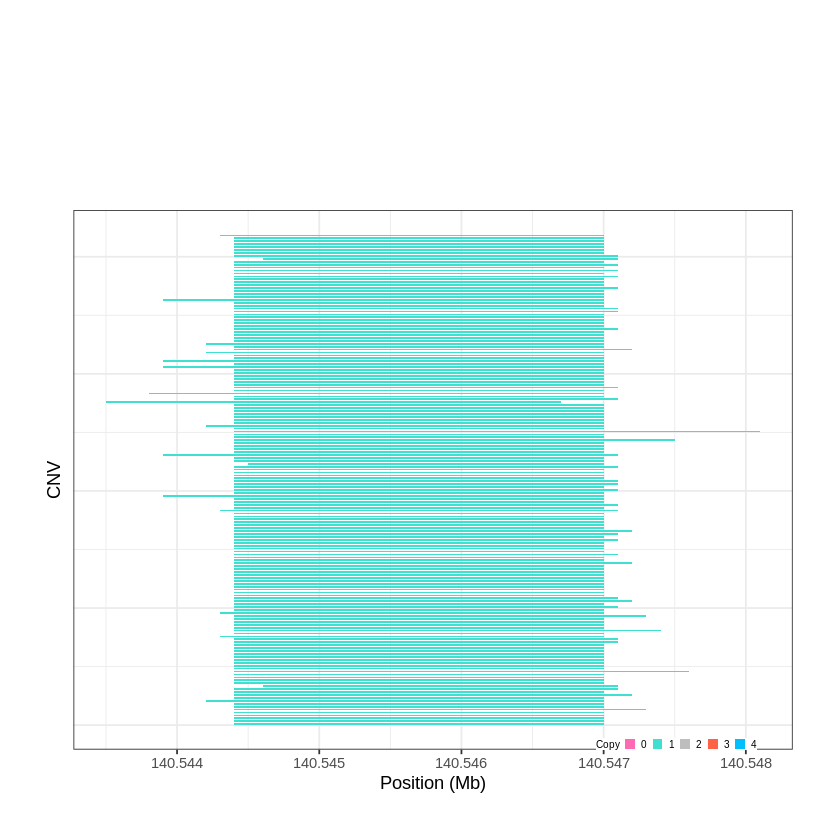

Task done, plot was stored in working directory.
[1] "Ploting CNVR 463..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 144.459901 - 144.5407 Mb with 222 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


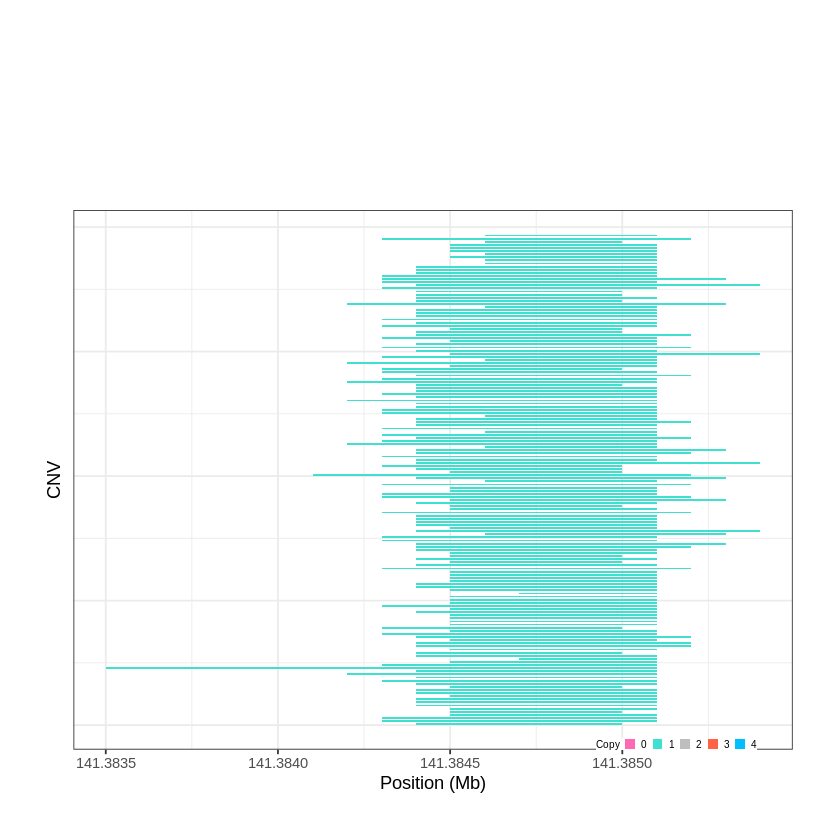

Task done, plot was stored in working directory.
[1] "Ploting CNVR 464..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 146.381401 - 146.4004 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


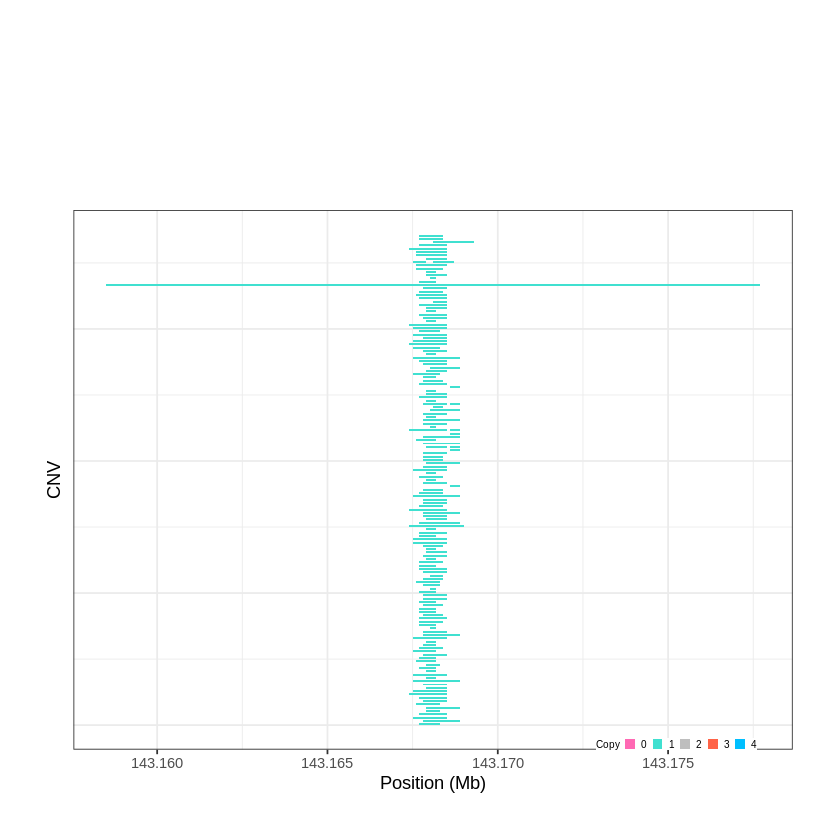

Task done, plot was stored in working directory.
[1] "Ploting CNVR 465..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 148.564101 - 148.5675 Mb with 253 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


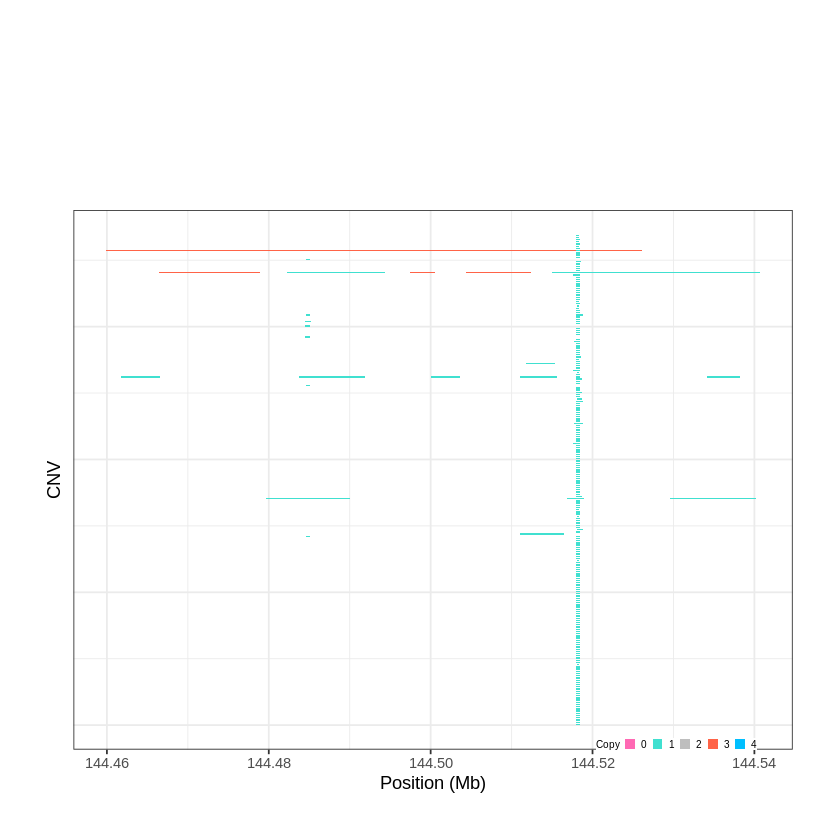

Task done, plot was stored in working directory.
[1] "Ploting CNVR 466..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 148.815201 - 148.8161 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


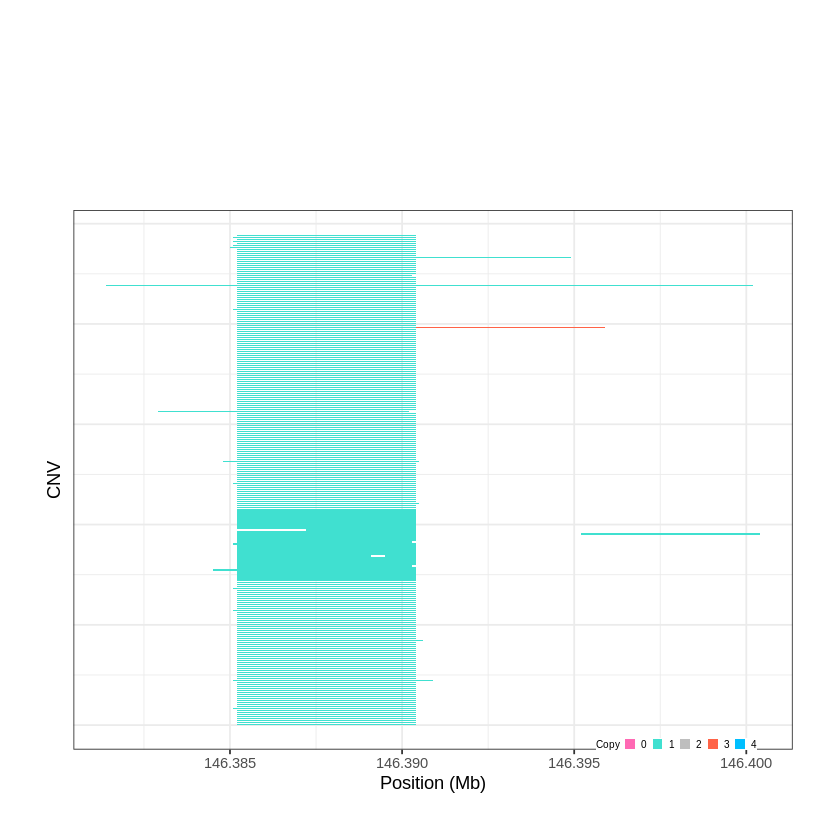

Task done, plot was stored in working directory.
[1] "Ploting CNVR 467..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 151.382501 - 151.389 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


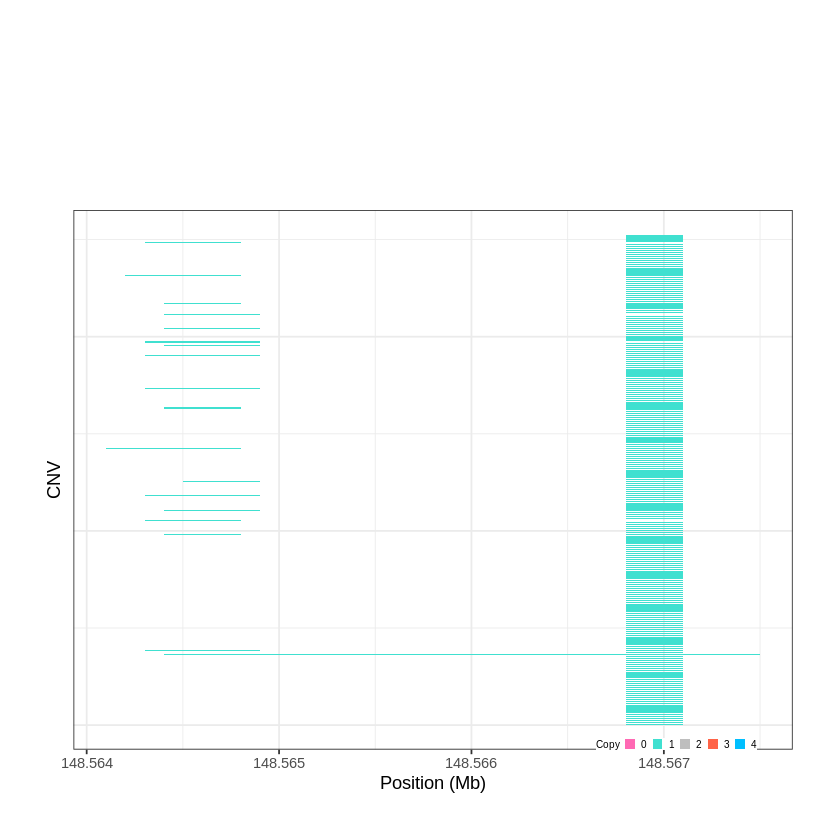

Task done, plot was stored in working directory.
[1] "Ploting CNVR 468..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 158.278501 - 158.2955 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


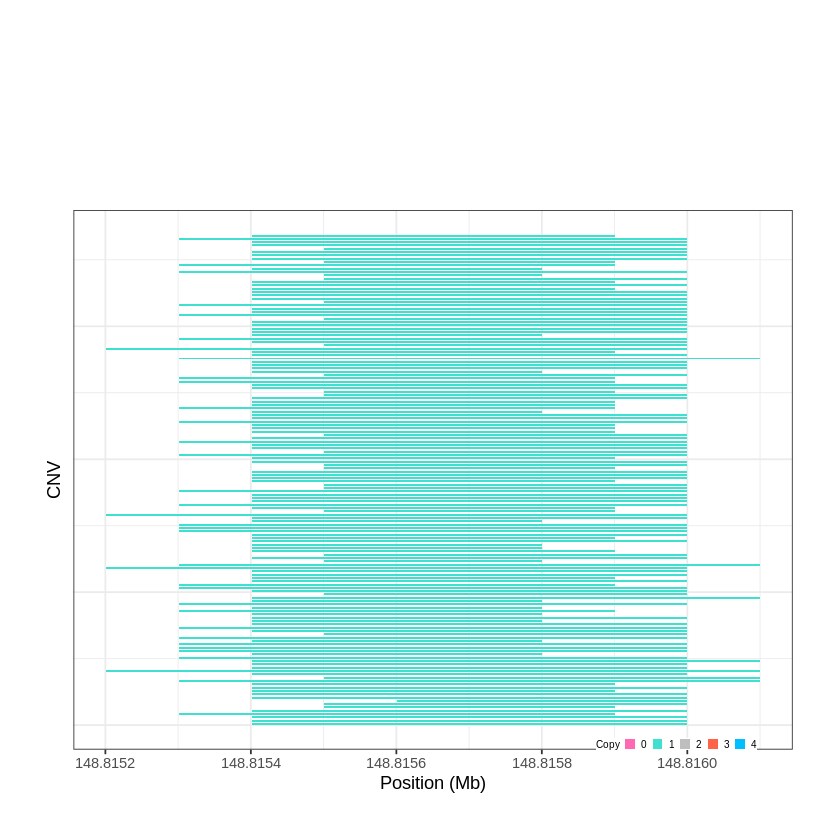

Task done, plot was stored in working directory.
[1] "Ploting CNVR 469..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 158.341301 - 158.378 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


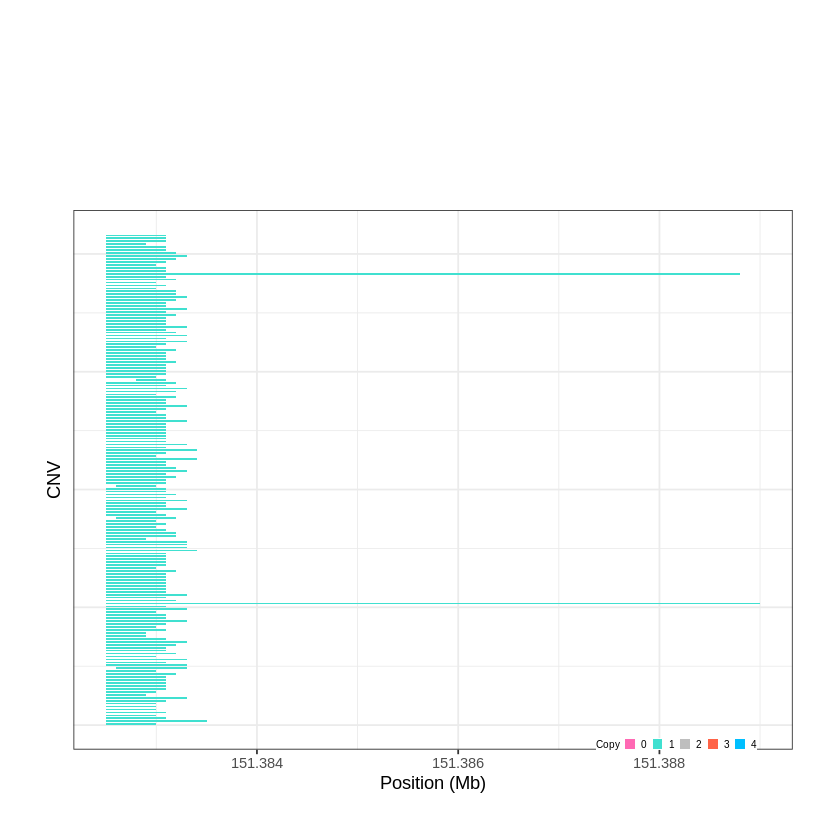

Task done, plot was stored in working directory.
[1] "Ploting CNVR 470..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 162.144901 - 163.0156 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


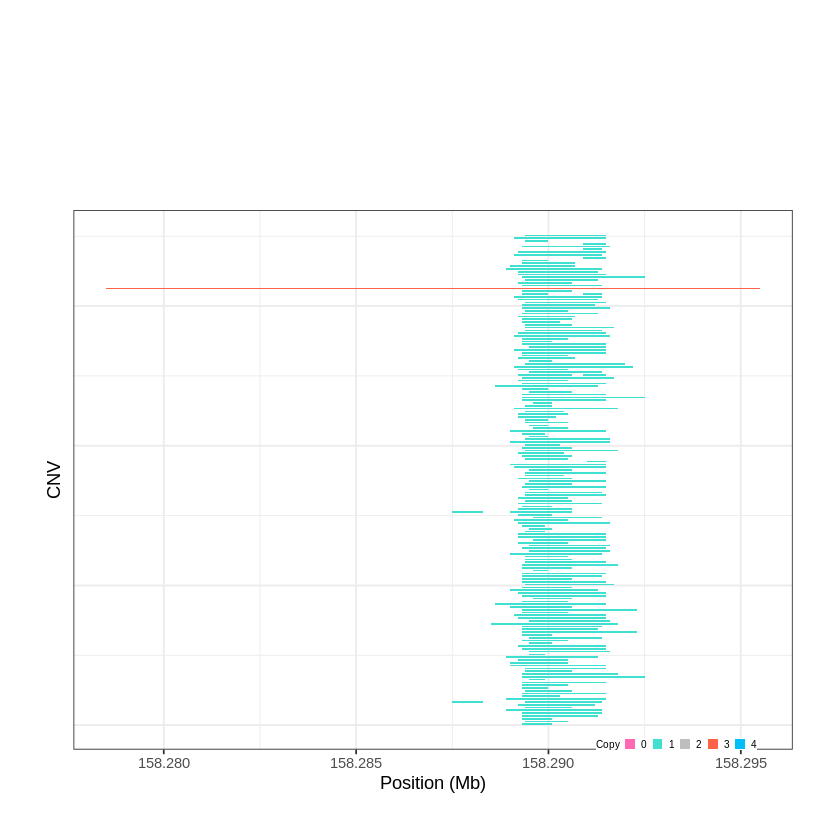

Task done, plot was stored in working directory.
[1] "Ploting CNVR 471..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 163.443001 - 163.4867 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


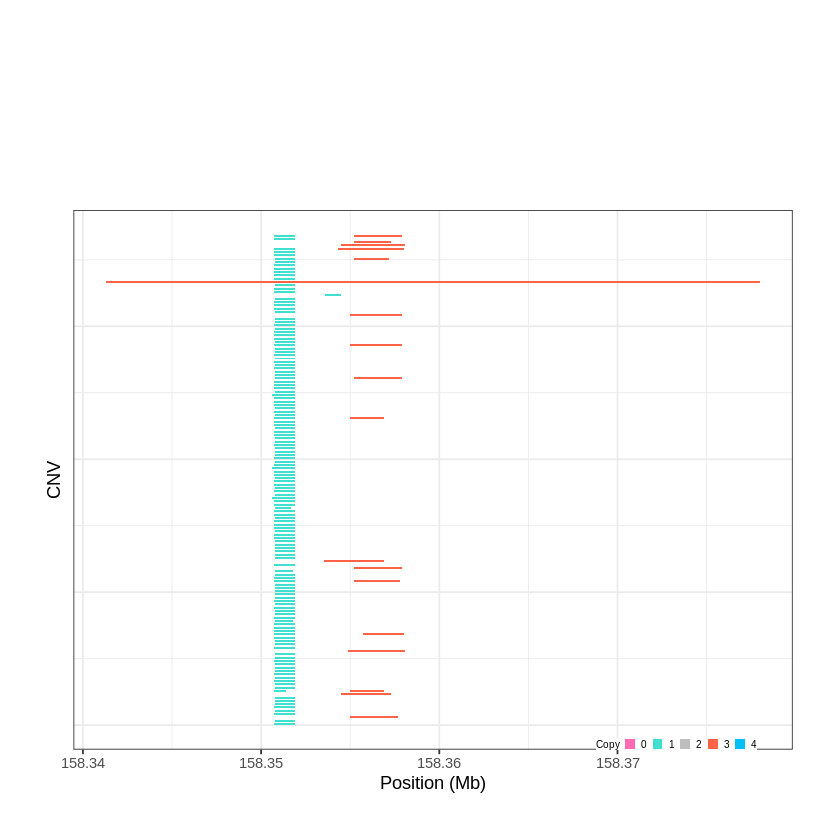

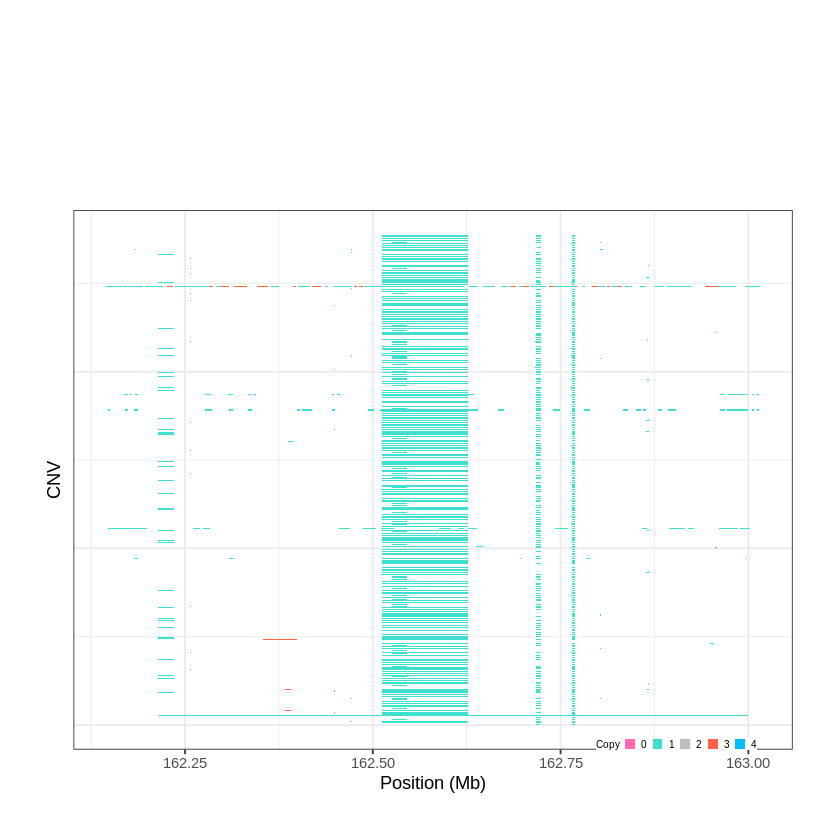

Task done, plot was stored in working directory.
[1] "Ploting CNVR 472..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 164.130901 - 165.5085 Mb with 215 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 473..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 177.850801 - 177.889 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


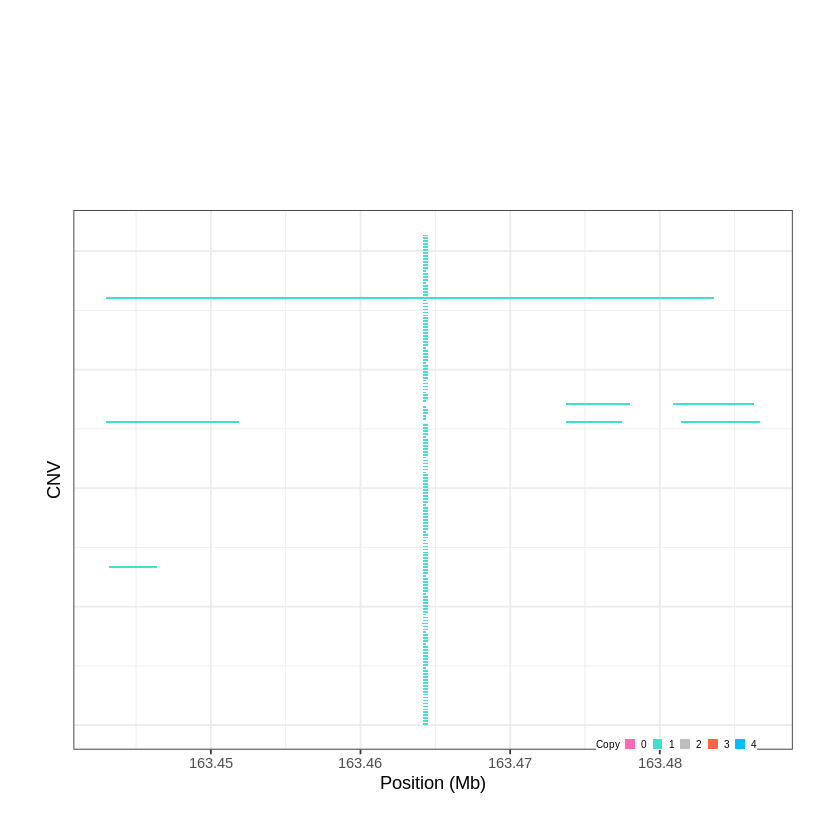

Task done, plot was stored in working directory.
[1] "Ploting CNVR 474..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 178.469401 - 178.4824 Mb with 172 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


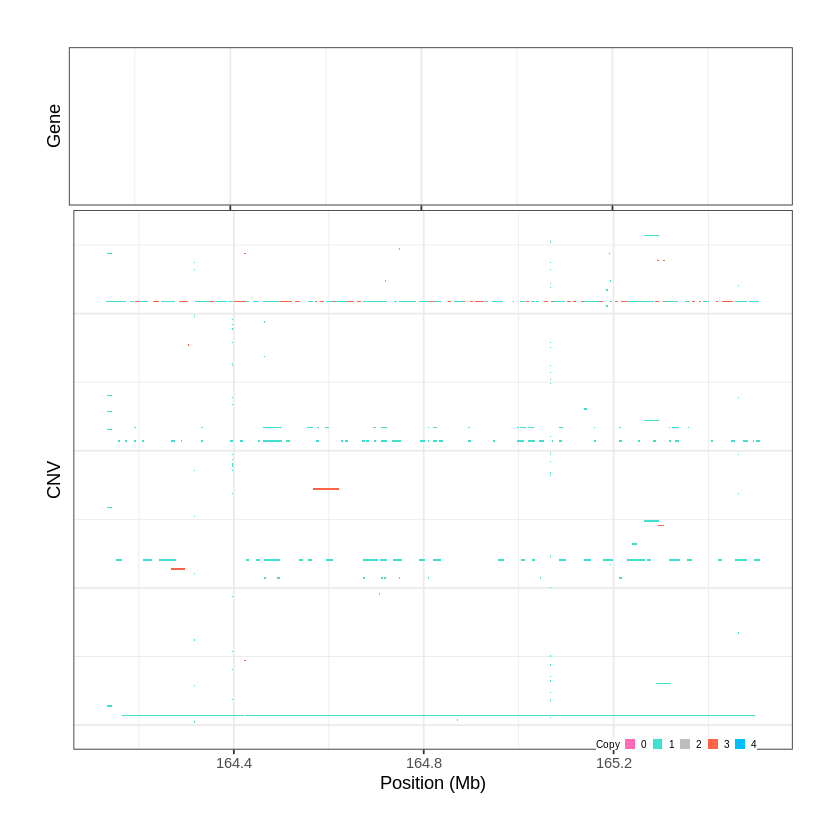

Task done, plot was stored in working directory.
[1] "Ploting CNVR 475..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 178.544601 - 178.5563 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


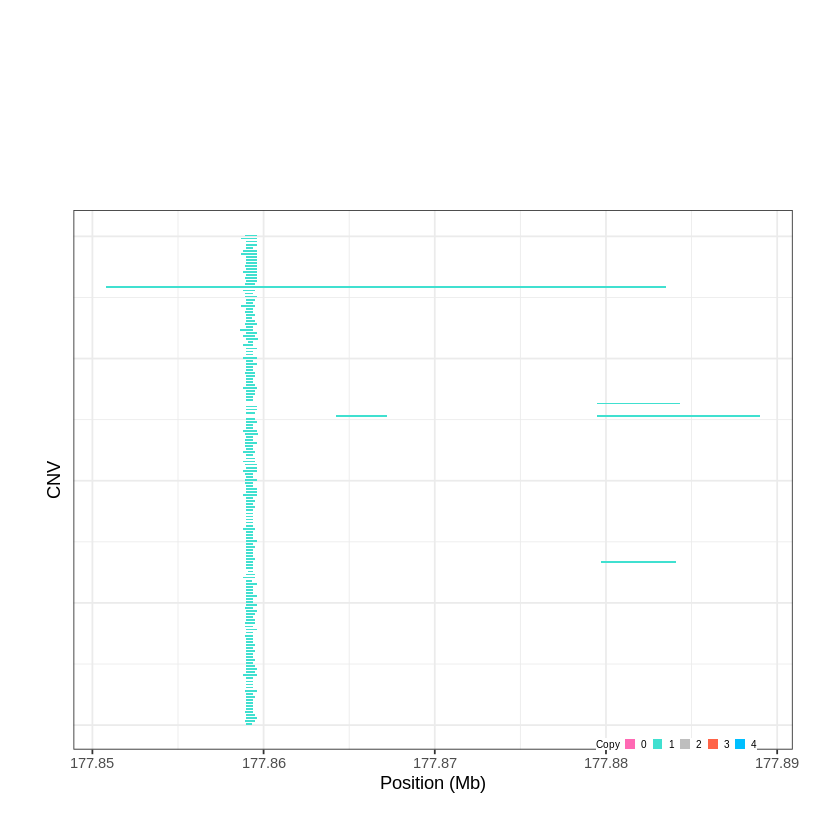

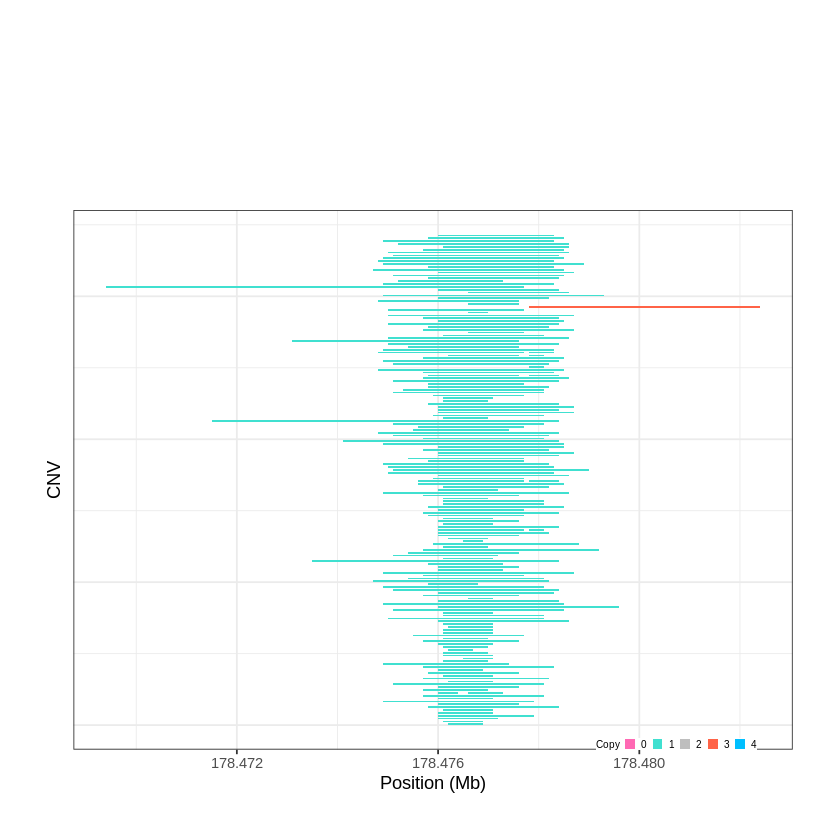

Task done, plot was stored in working directory.
[1] "Ploting CNVR 476..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 183.237001 - 183.9104 Mb with 173 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 477..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 184.096801 - 184.0989 Mb with 184 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


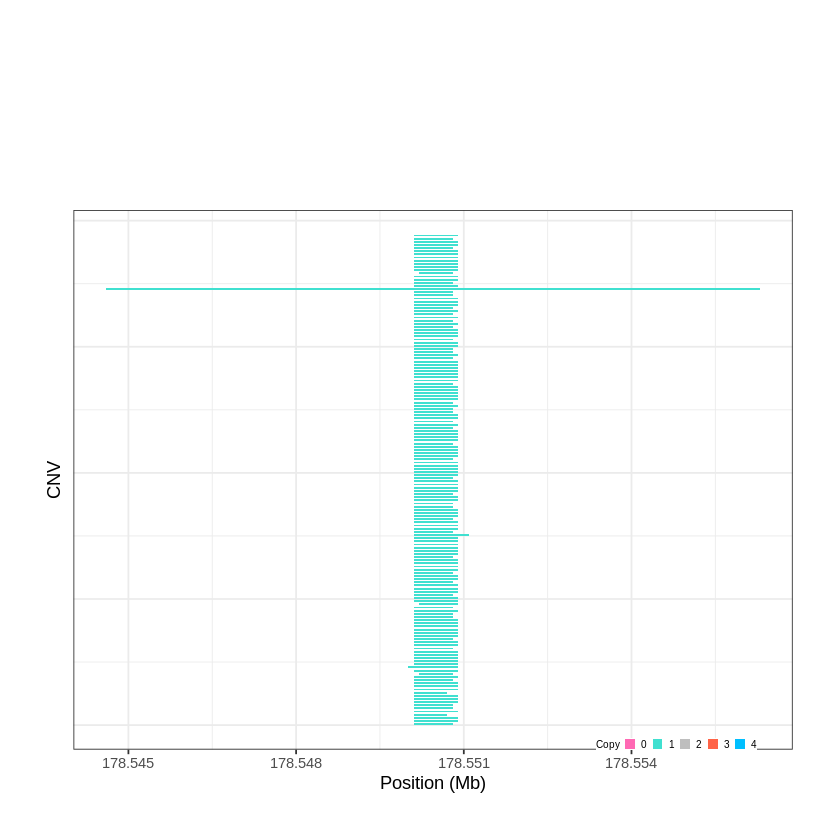

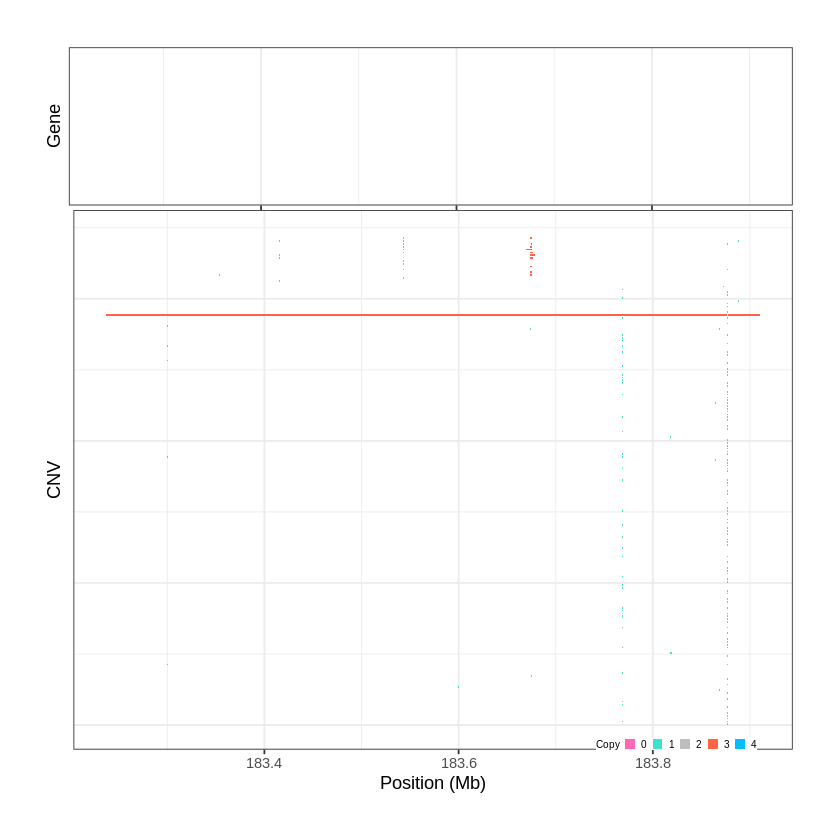

Task done, plot was stored in working directory.
[1] "Ploting CNVR 478..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 184.203201 - 184.3325 Mb with 245 Individual - "
Plotting gene...


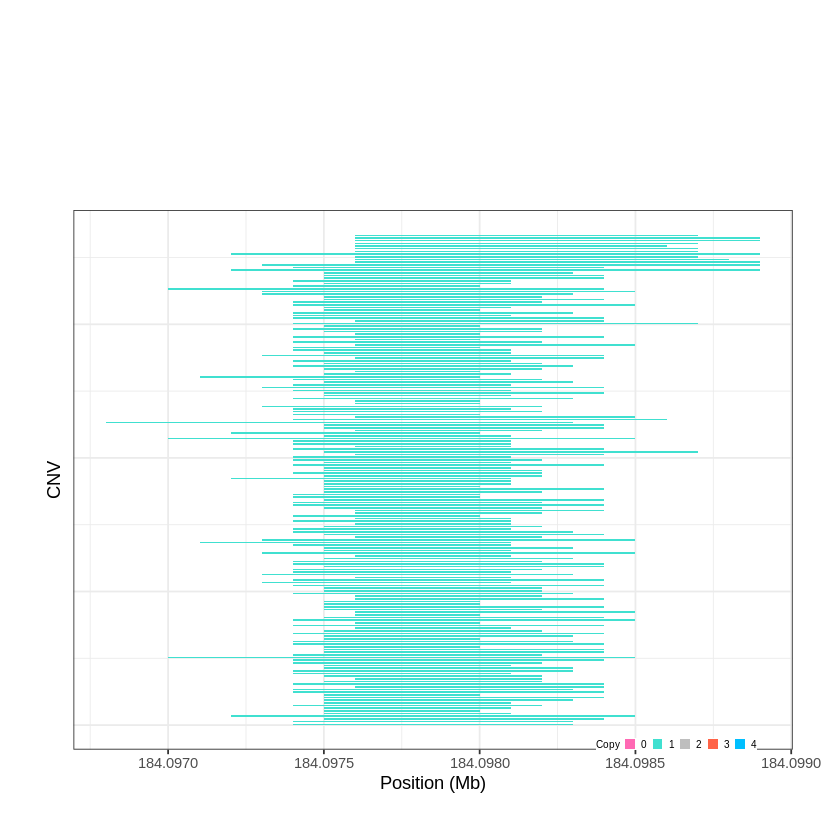

Task done, plot was stored in working directory.
[1] "Ploting CNVR 479..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 184.339501 - 184.5613 Mb with 205 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 480..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 185.171001 - 185.1742 Mb with 251 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


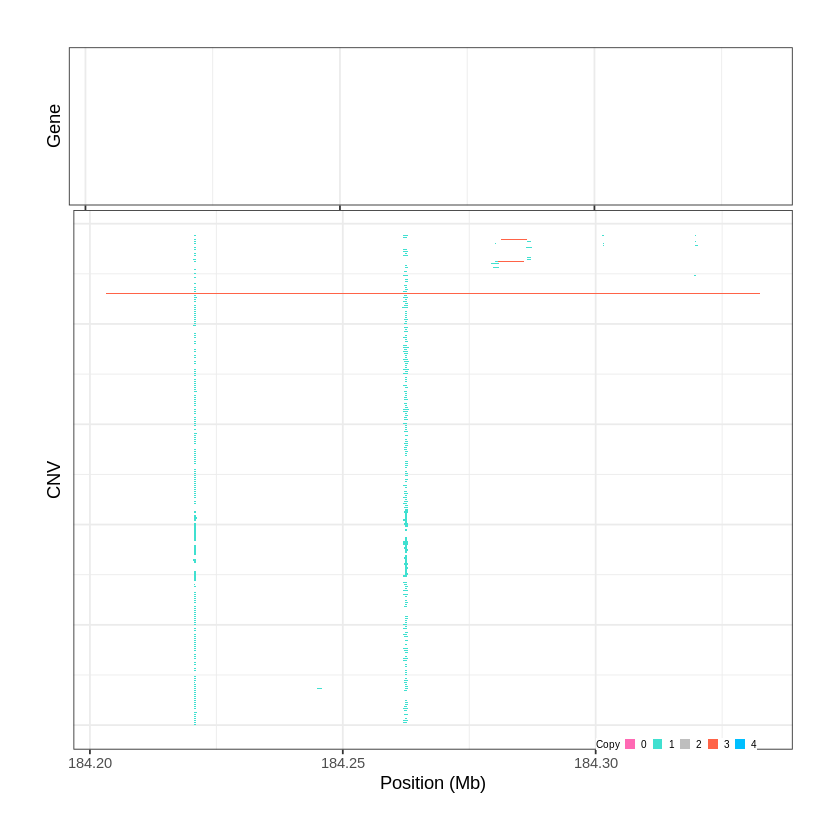

Task done, plot was stored in working directory.
[1] "Ploting CNVR 481..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 186.435201 - 186.4425 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


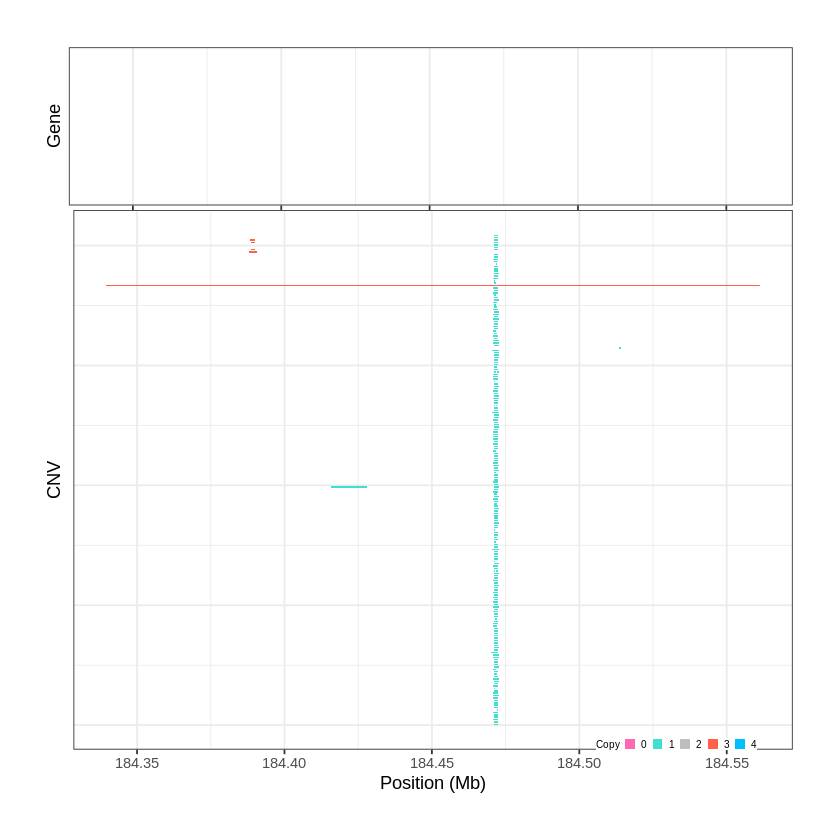

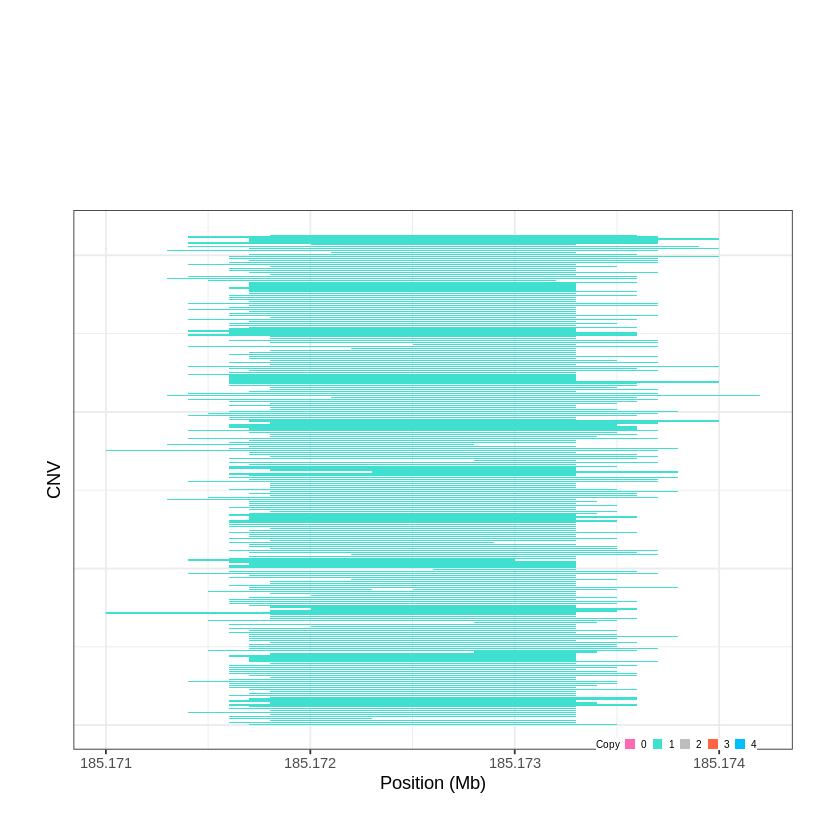

Task done, plot was stored in working directory.
[1] "Ploting CNVR 482..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 186.575901 - 186.6962 Mb with 266 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 483..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 187.127301 - 187.1362 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


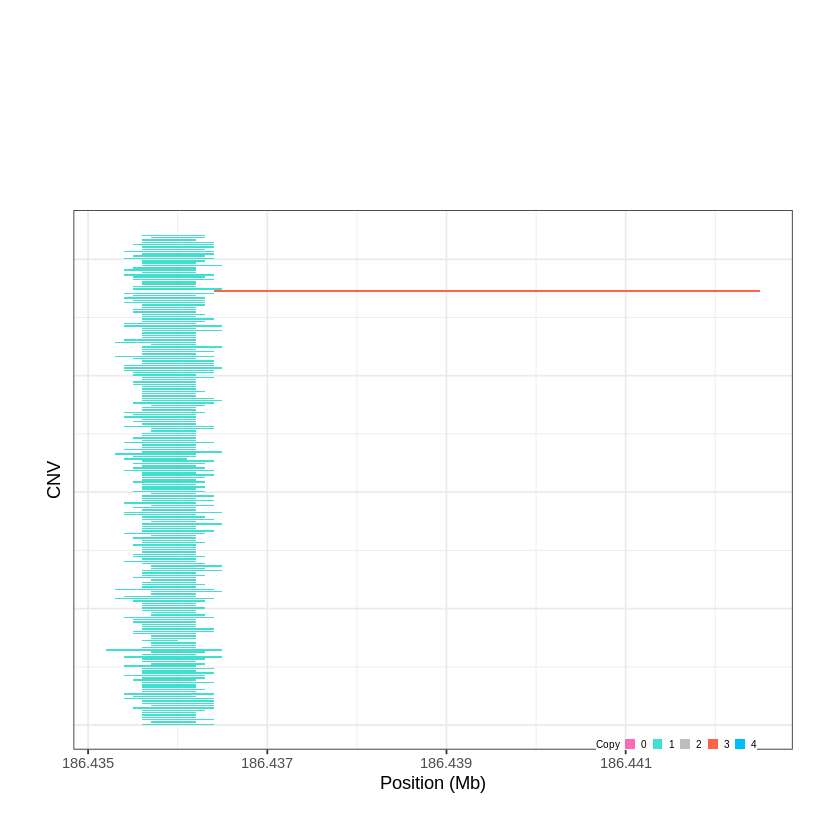

Task done, plot was stored in working directory.
[1] "Ploting CNVR 484..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 188.502001 - 188.5041 Mb with 207 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


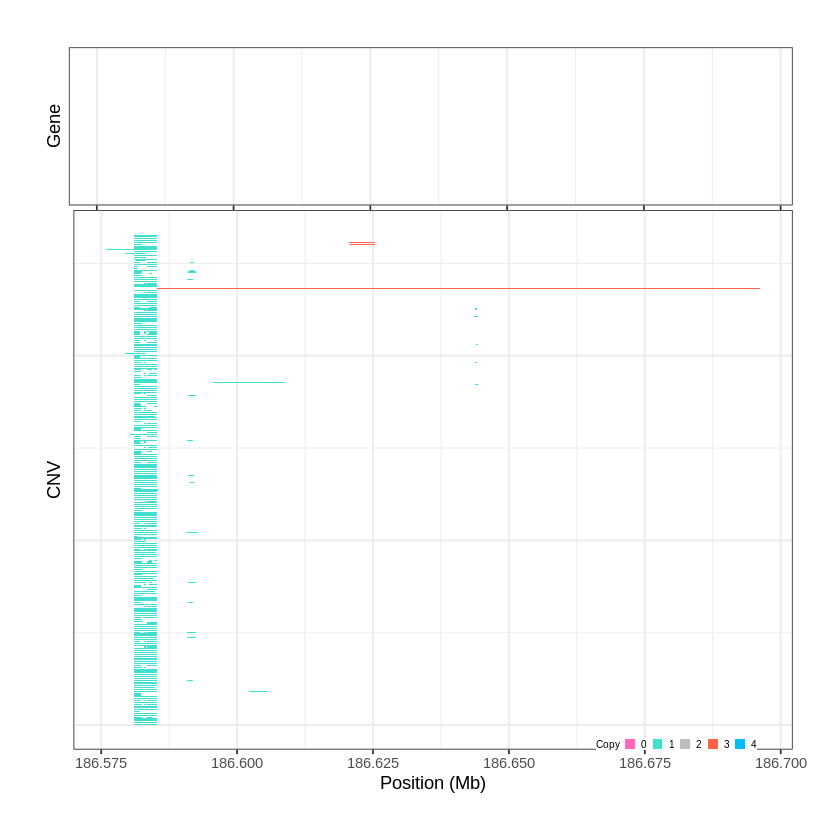

Task done, plot was stored in working directory.
[1] "Ploting CNVR 485..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 192.872501 - 192.8927 Mb with 246 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


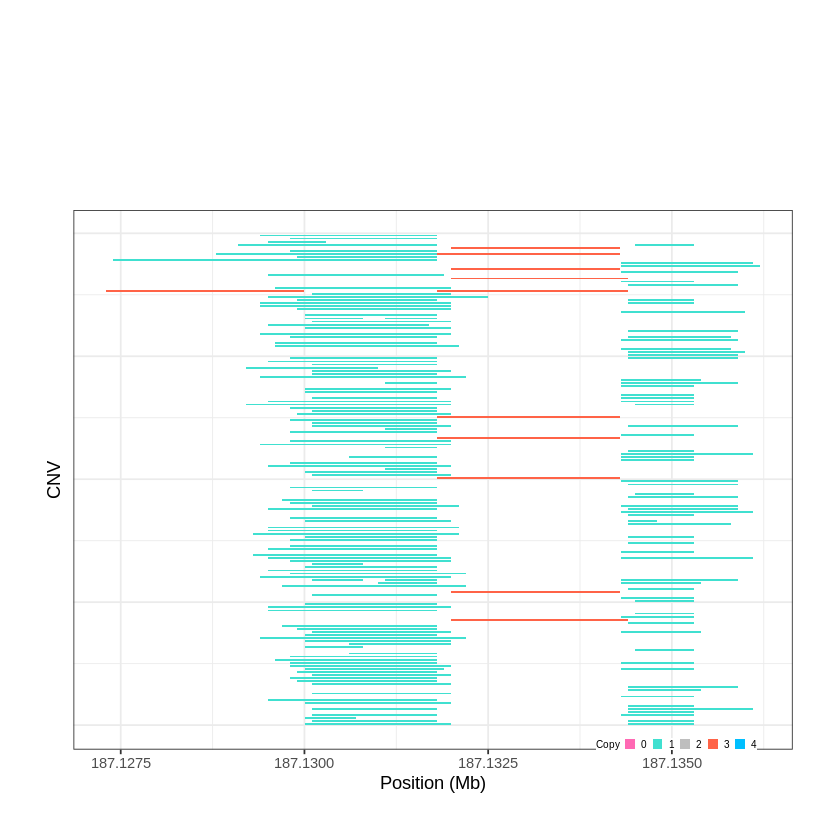

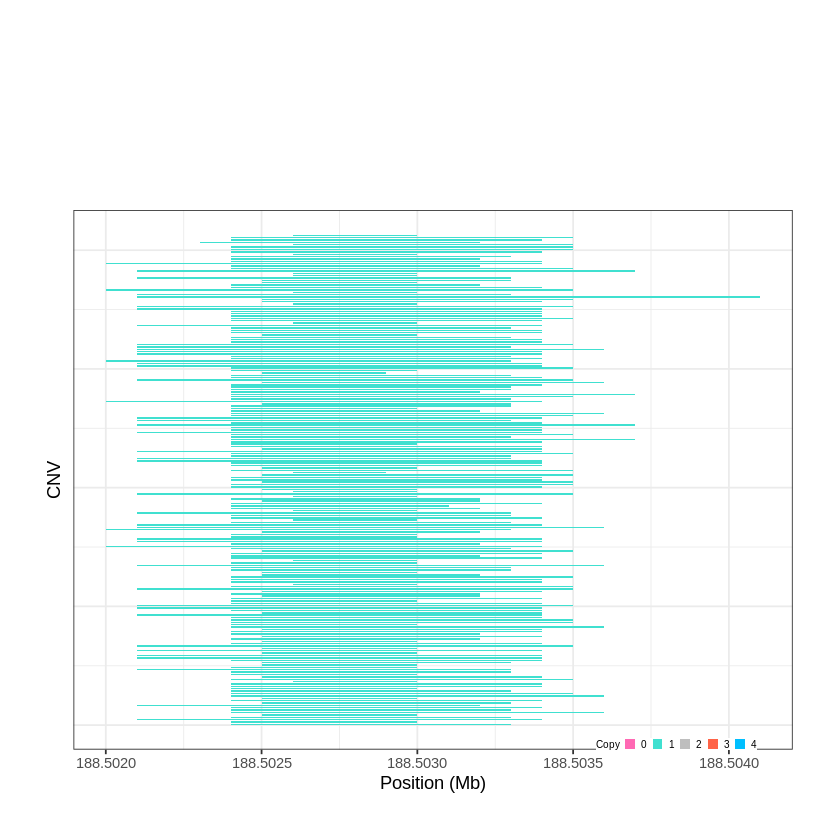

Task done, plot was stored in working directory.
[1] "Ploting CNVR 486..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 193.962301 - 194.1593 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 487..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 194.384101 - 194.3846 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


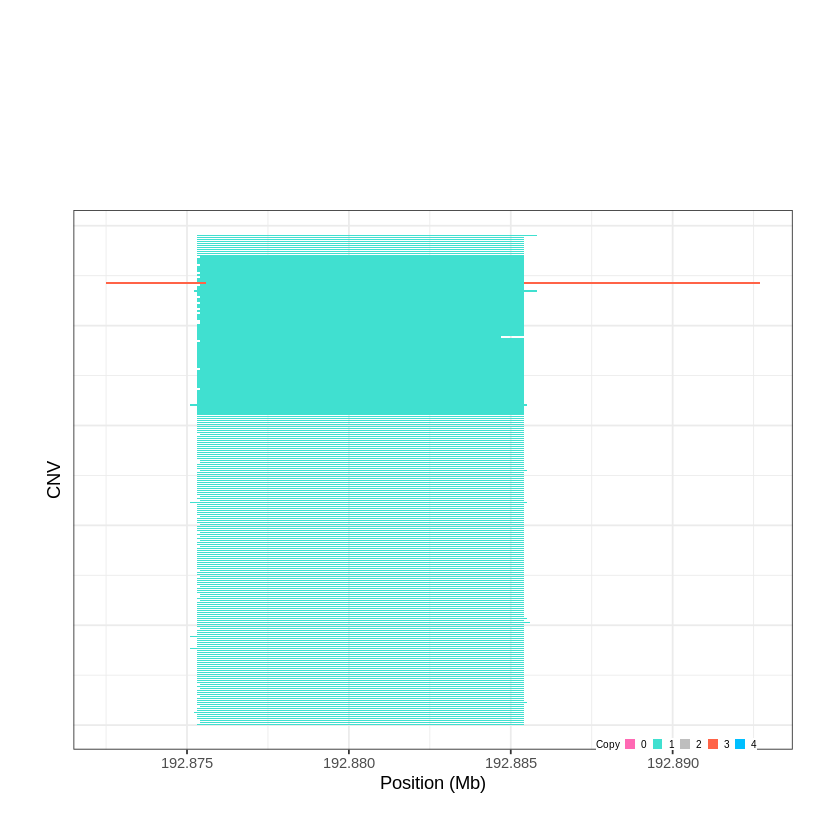

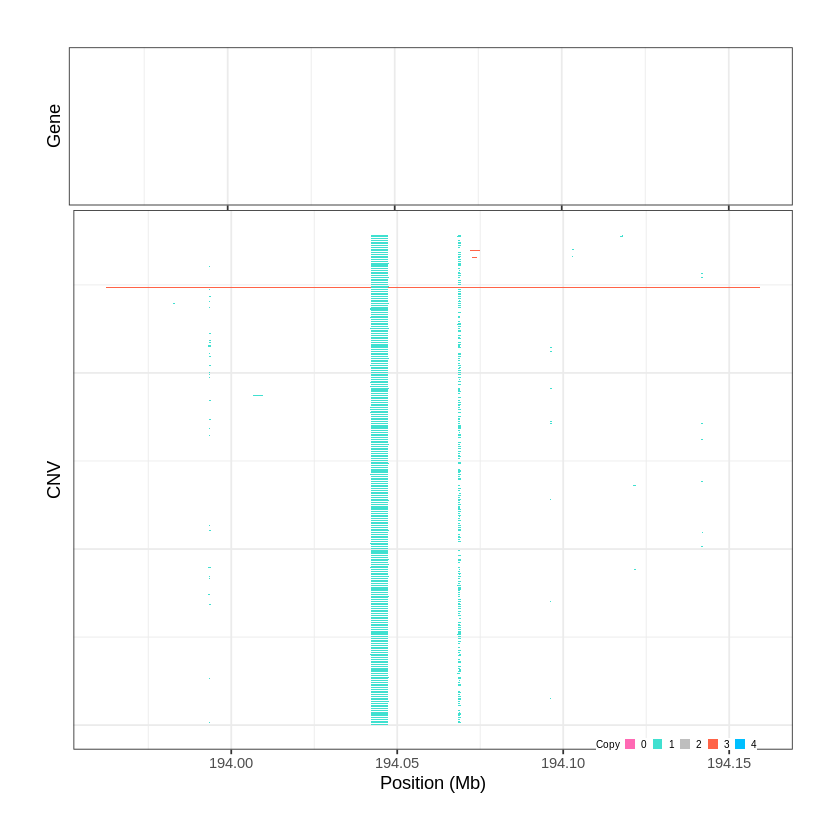

Task done, plot was stored in working directory.
[1] "Ploting CNVR 488..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 194.384601 - 194.4129 Mb with 245 Individual - "
Plotting gene...


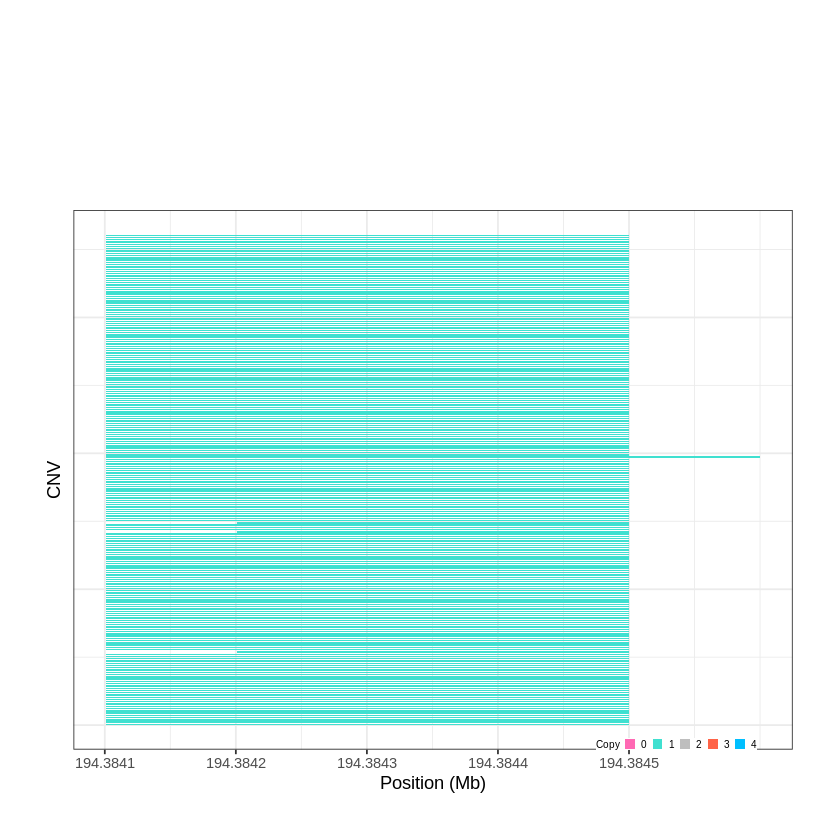

Task done, plot was stored in working directory.
[1] "Ploting CNVR 489..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 194.689401 - 195.0827 Mb with 230 Individual - "
Plotting gene...


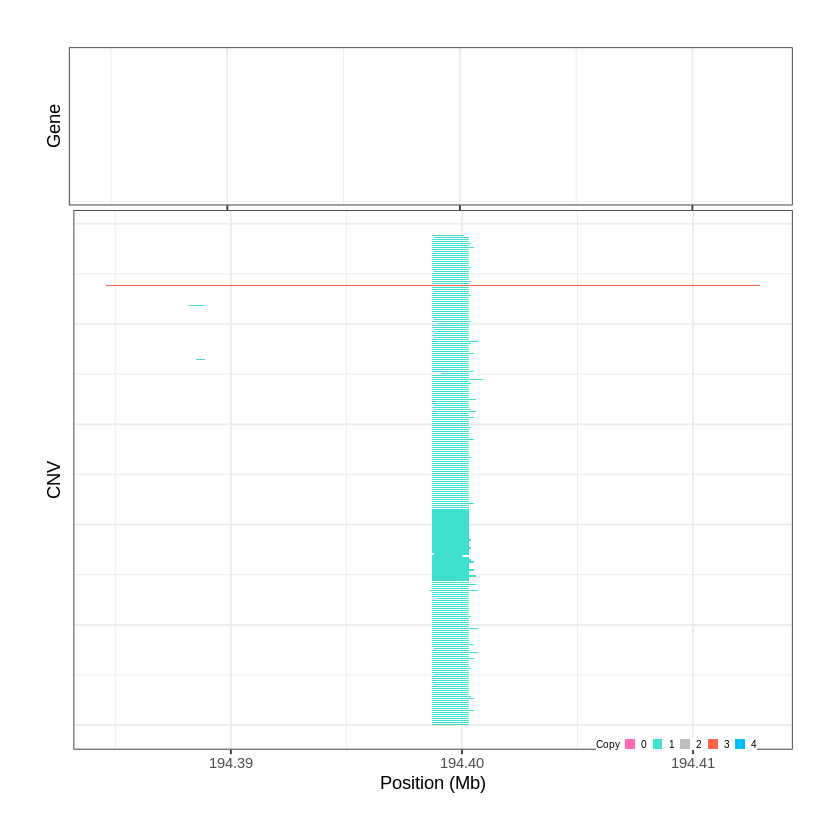

Task done, plot was stored in working directory.
[1] "Ploting CNVR 490..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 195.198001 - 195.4871 Mb with 279 Individual - "
Plotting gene...


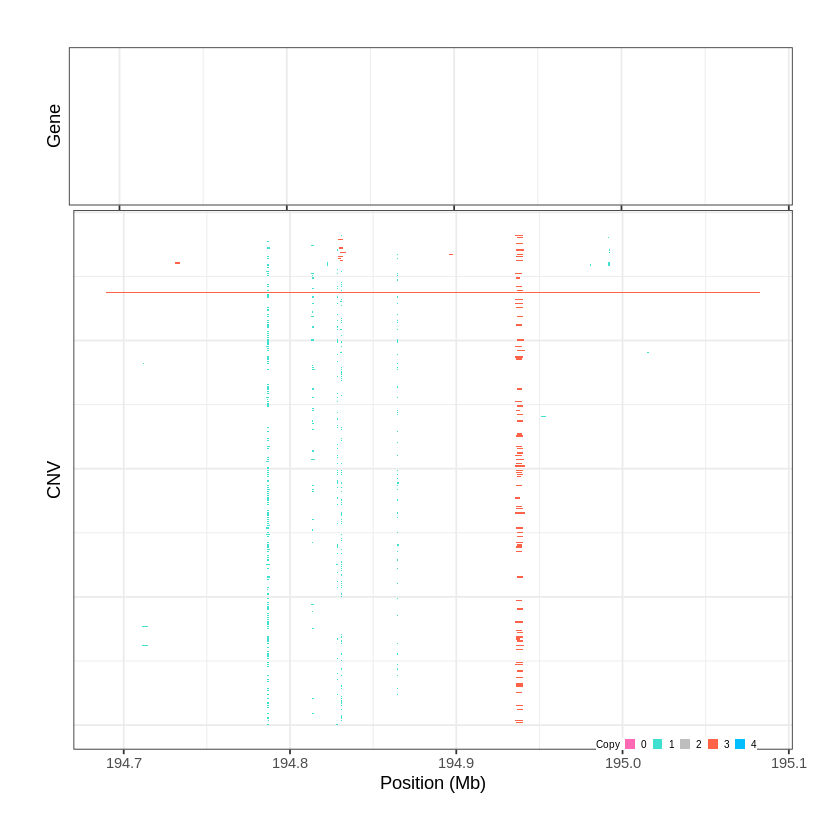

Task done, plot was stored in working directory.
[1] "Ploting CNVR 491..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 195.498801 - 195.5937 Mb with 278 Individual - "
Plotting gene...


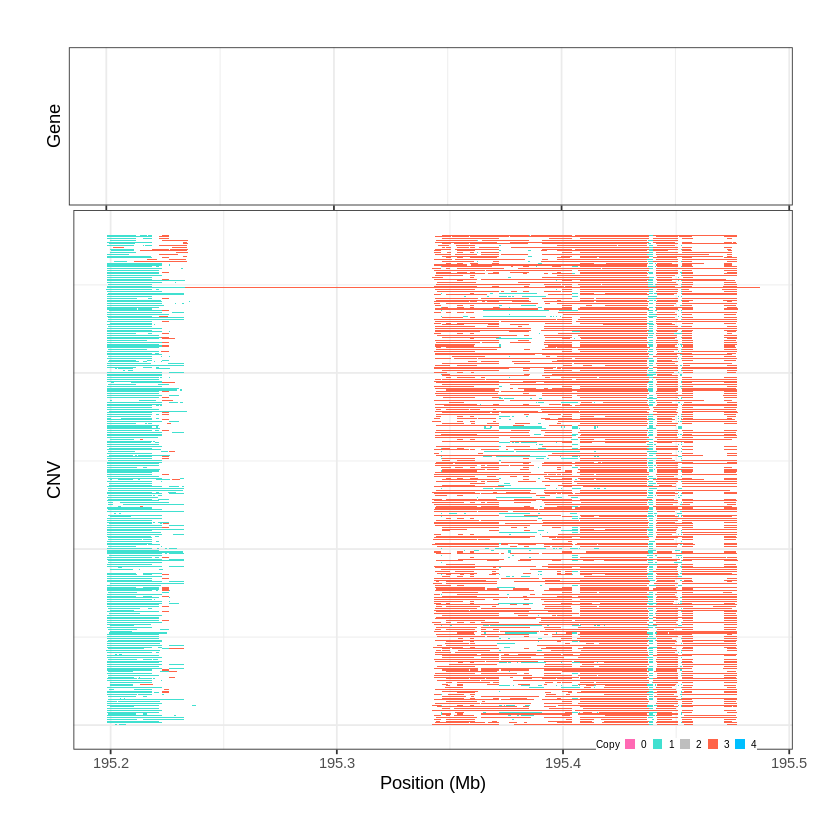

Task done, plot was stored in working directory.
[1] "Ploting CNVR 492..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 195.605701 - 196.0042 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 493..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 196.055801 - 196.0572 Mb with 157 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


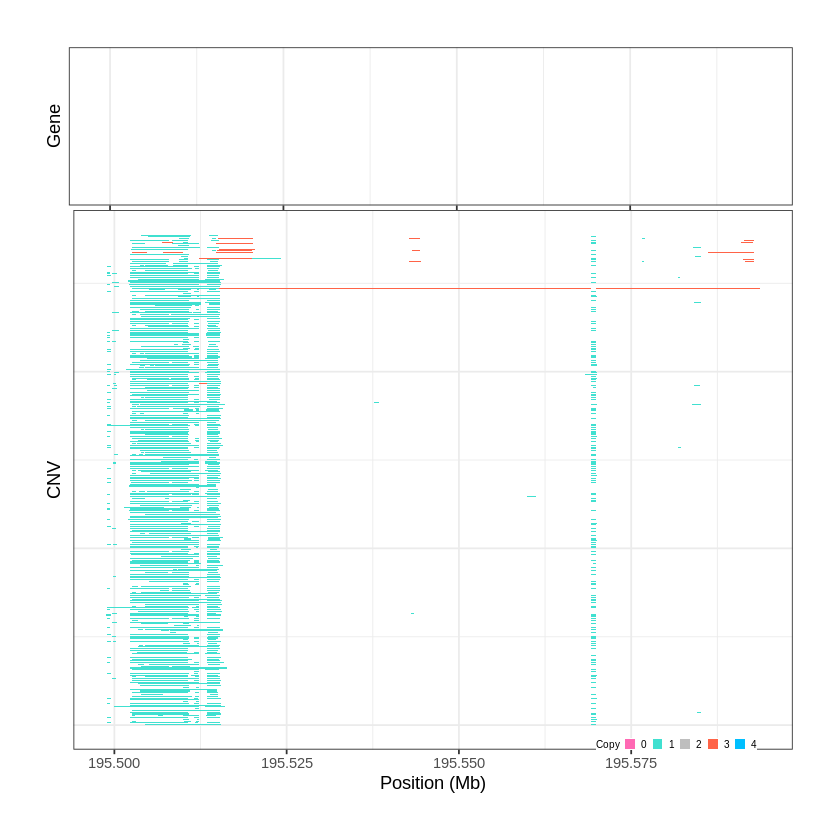

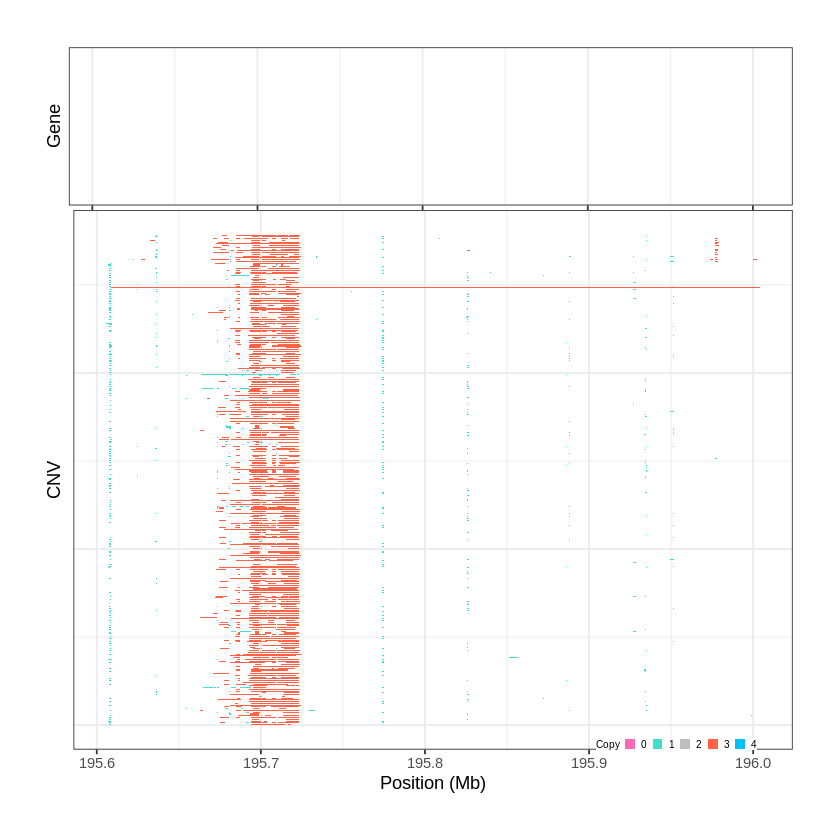

Task done, plot was stored in working directory.
[1] "Ploting CNVR 494..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 196.706801 - 196.7972 Mb with 144 Individual - "
Plotting gene...


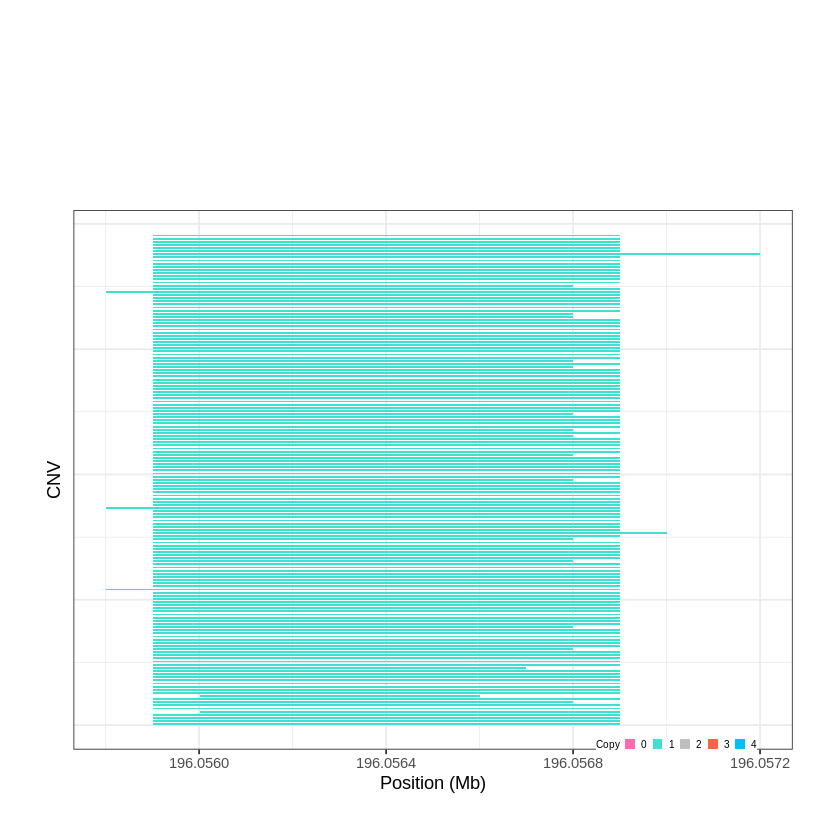

Task done, plot was stored in working directory.
[1] "Ploting CNVR 495..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 196.989701 - 197.4076 Mb with 277 Individual - "
Plotting gene...


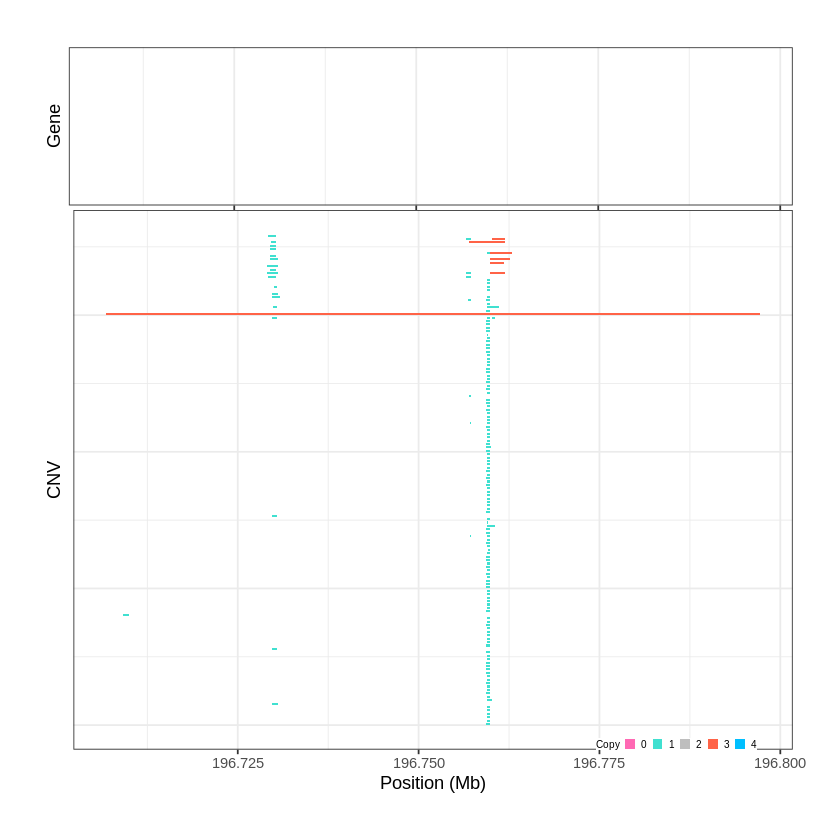

Task done, plot was stored in working directory.
[1] "Ploting CNVR 496..."
Input data passed requirment check...
[1] "CNV on Chromosome 3: 197.711301 - 198.0225 Mb with 279 Individual - "
Plotting gene...


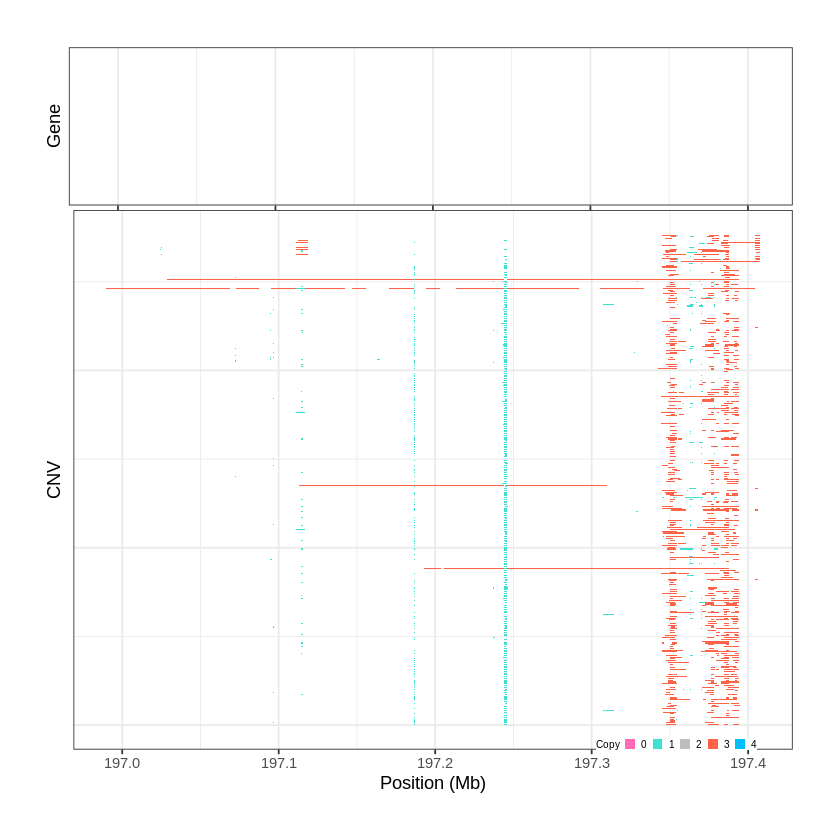

Task done, plot was stored in working directory.
[1] "Ploting CNVR 497..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1e-06 - 0.176 Mb with 279 Individual - "
Plotting gene...


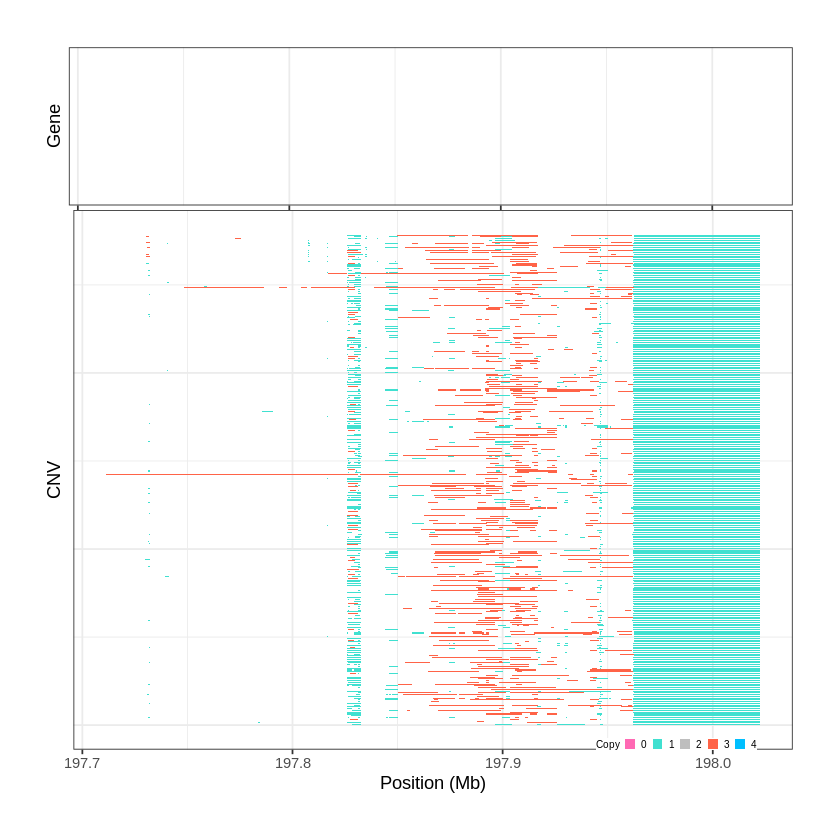

Task done, plot was stored in working directory.
[1] "Ploting CNVR 498..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 0.449301 - 0.737 Mb with 245 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 499..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 0.737601 - 0.7743 Mb with 263 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


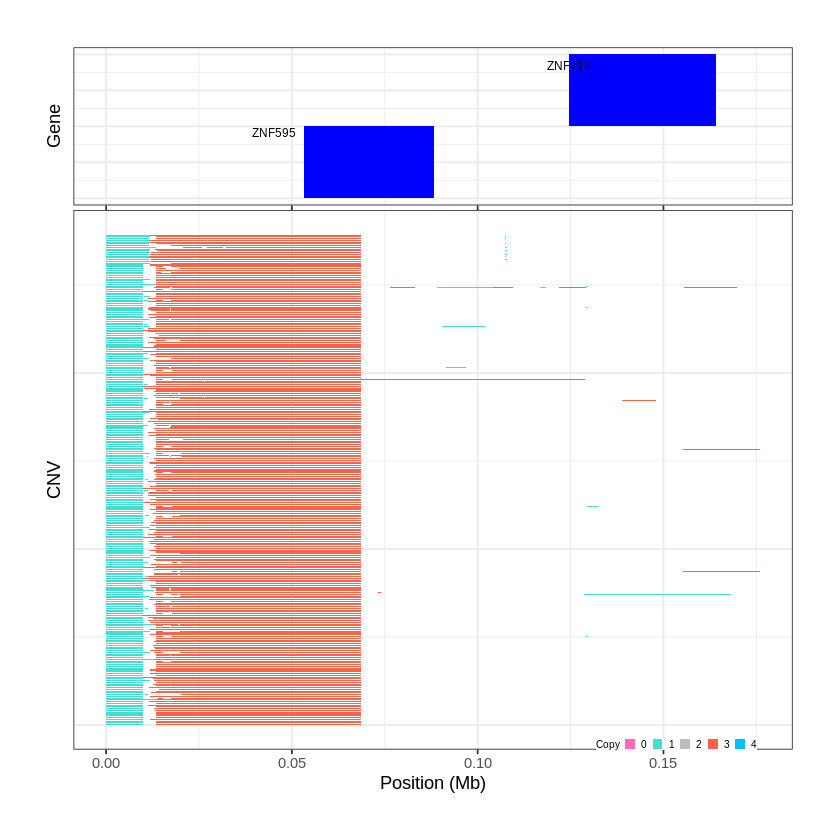

Task done, plot was stored in working directory.
[1] "Ploting CNVR 500..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 0.818201 - 0.826 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


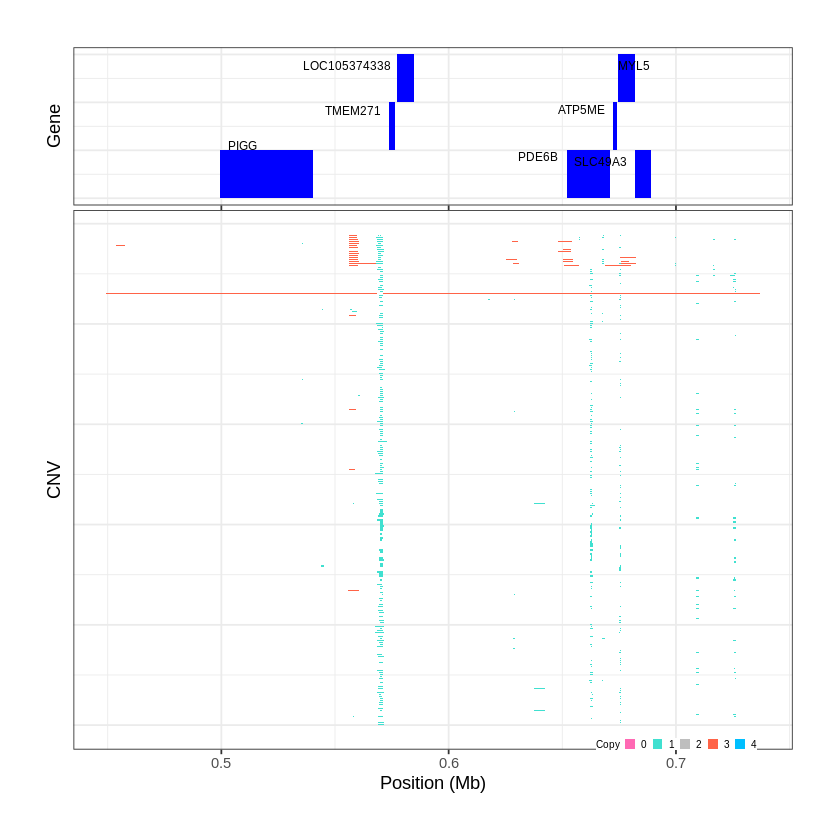

Task done, plot was stored in working directory.
[1] "Ploting CNVR 501..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.002901 - 1.0154 Mb with 272 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


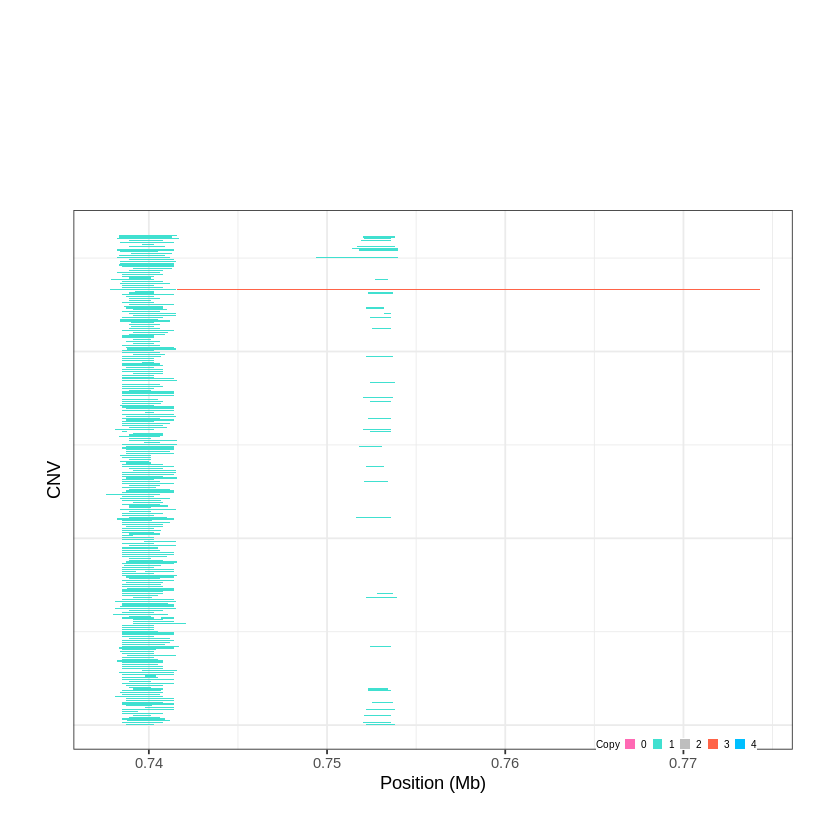

Task done, plot was stored in working directory.
[1] "Ploting CNVR 502..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.035701 - 1.0373 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


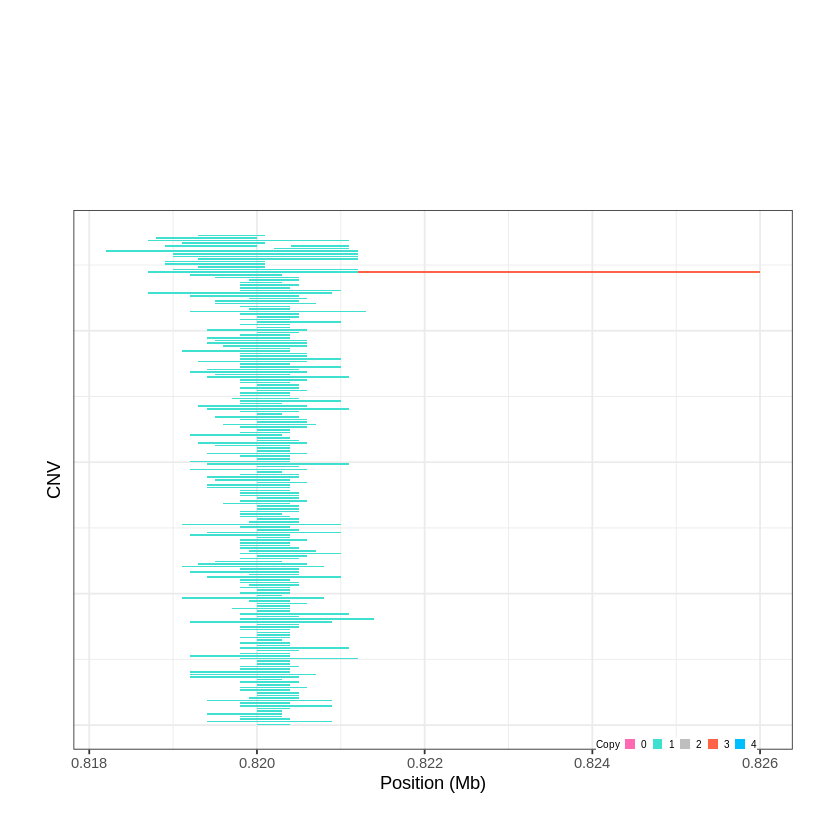

Task done, plot was stored in working directory.
[1] "Ploting CNVR 503..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.043601 - 1.1114 Mb with 277 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


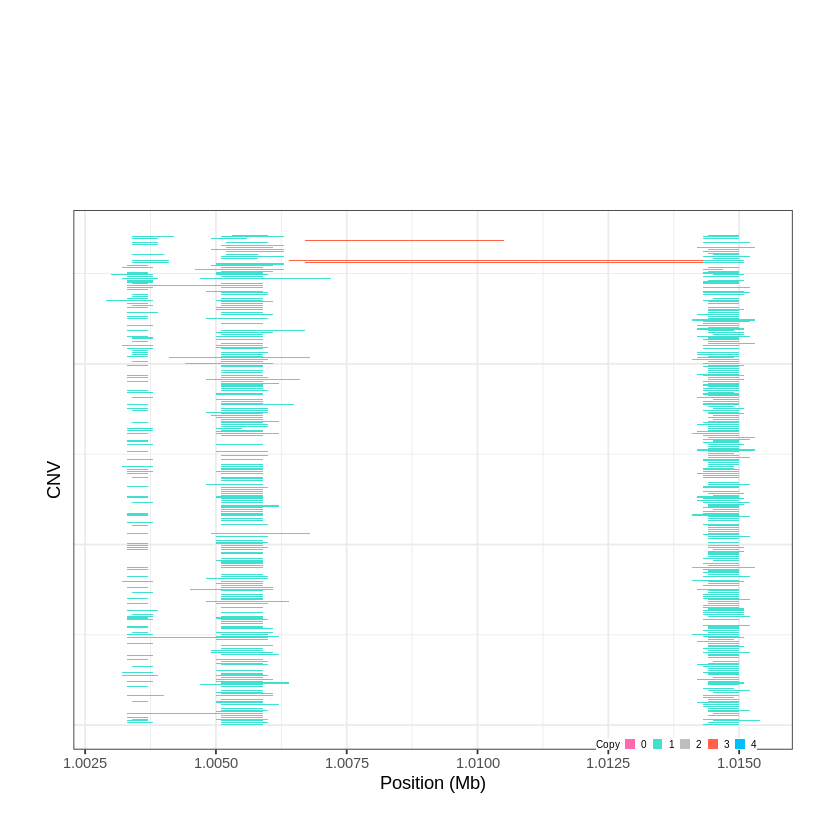

Task done, plot was stored in working directory.
[1] "Ploting CNVR 504..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.268301 - 1.291 Mb with 234 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


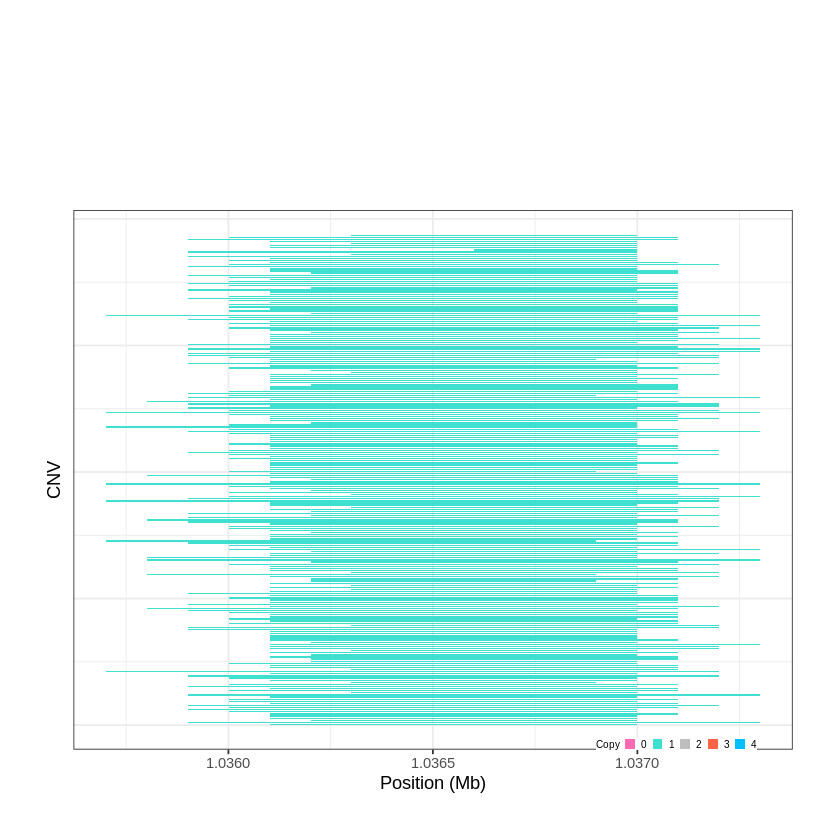

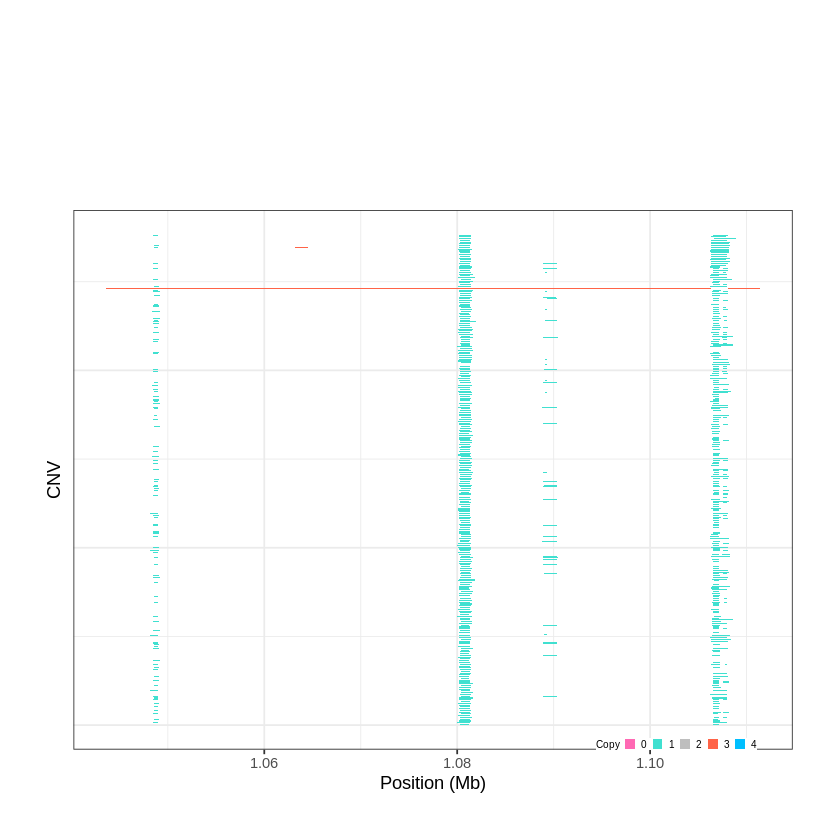

Task done, plot was stored in working directory.
[1] "Ploting CNVR 505..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.293501 - 1.3924 Mb with 186 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 506..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.407601 - 1.4097 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


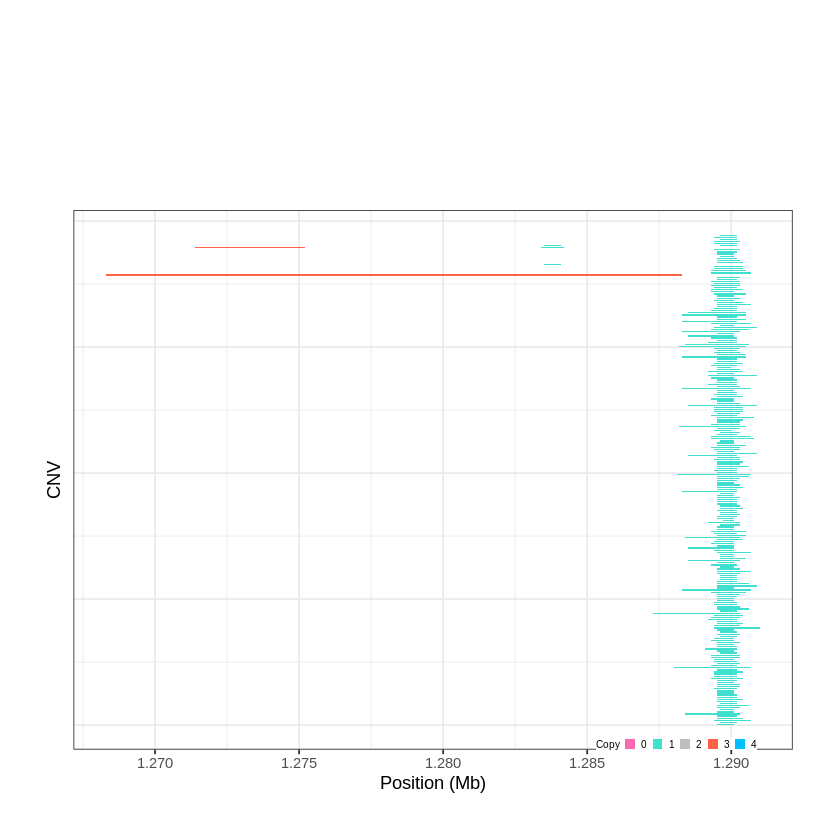

Task done, plot was stored in working directory.
[1] "Ploting CNVR 507..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.422801 - 1.5335 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


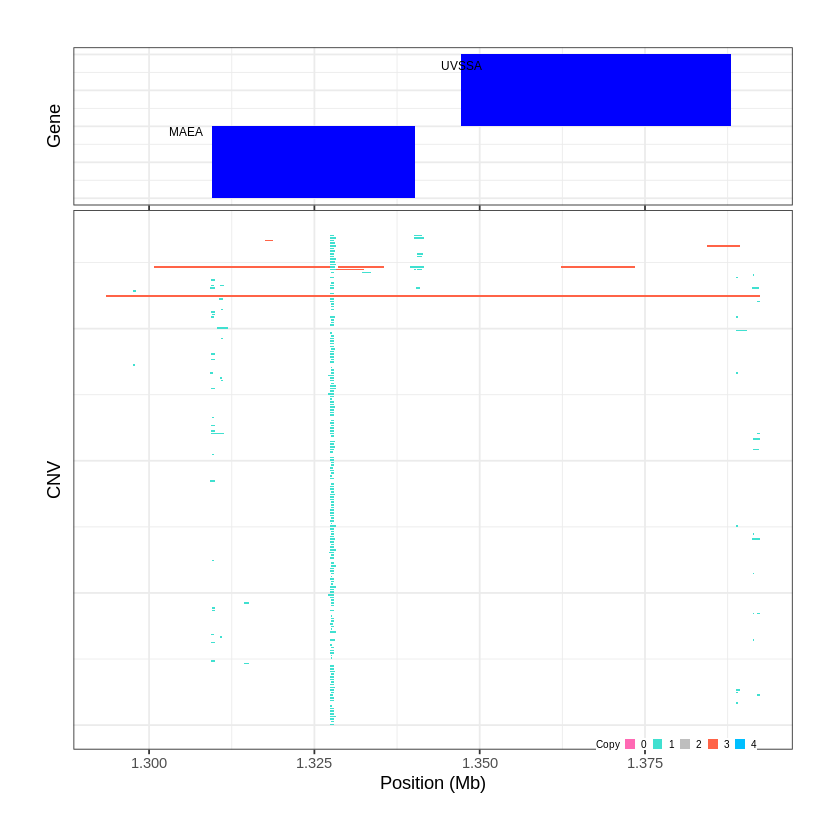

Task done, plot was stored in working directory.
[1] "Ploting CNVR 508..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.546801 - 1.5496 Mb with 237 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


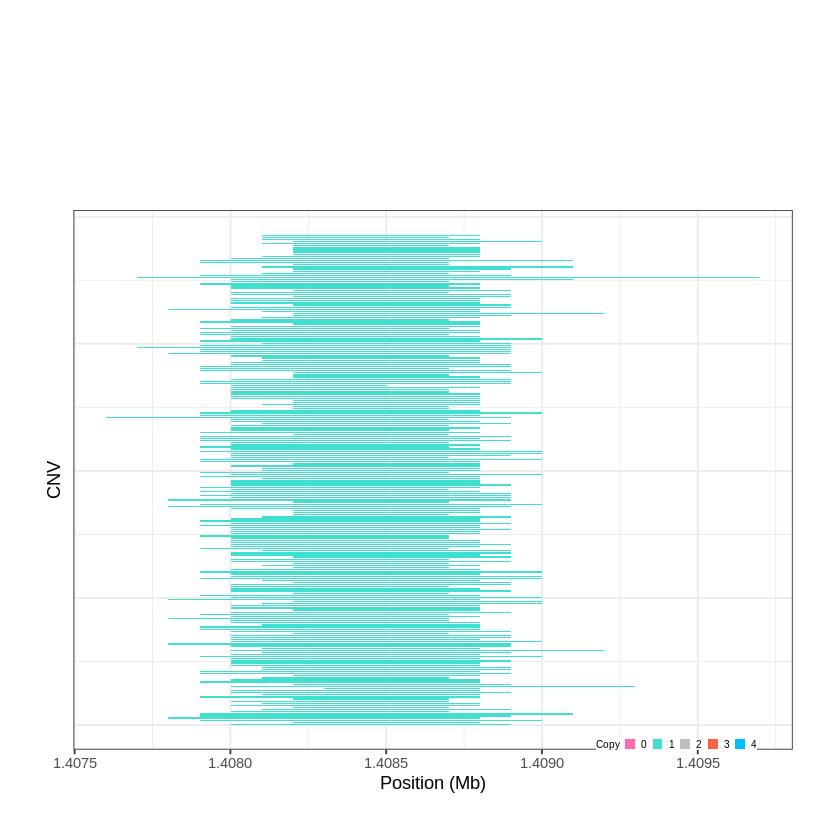

Task done, plot was stored in working directory.
[1] "Ploting CNVR 509..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.579301 - 1.593 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


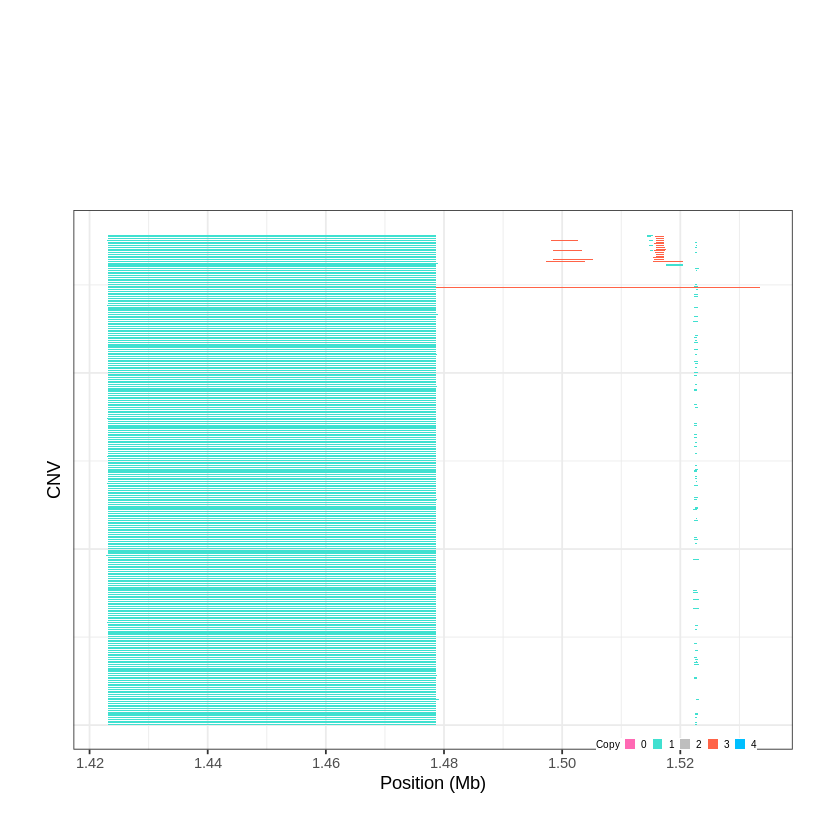

Task done, plot was stored in working directory.
[1] "Ploting CNVR 510..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.612001 - 1.6313 Mb with 259 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


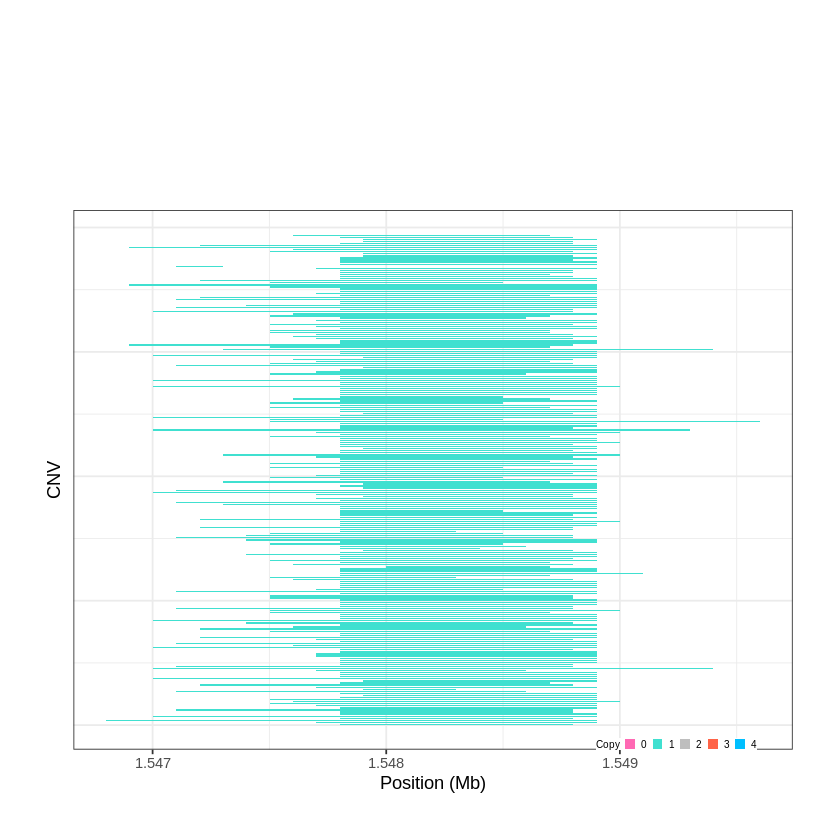

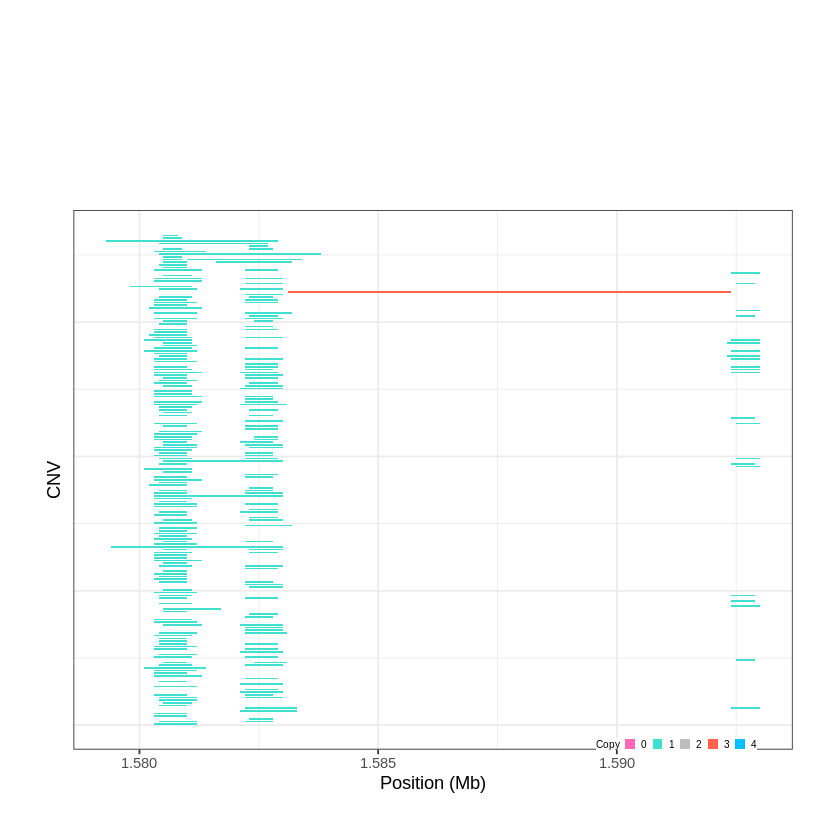

Task done, plot was stored in working directory.
[1] "Ploting CNVR 511..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 1.707201 - 2.0419 Mb with 263 Individual - "
Plotting gene...


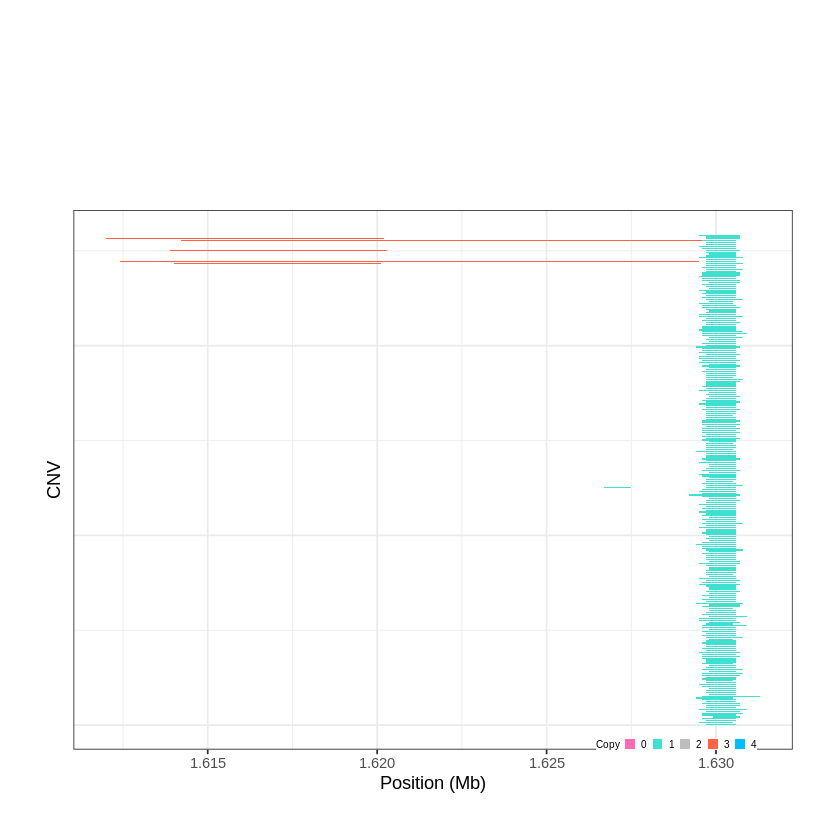

Task done, plot was stored in working directory.
[1] "Ploting CNVR 512..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 2.229201 - 2.9907 Mb with 266 Individual - "
Plotting gene...


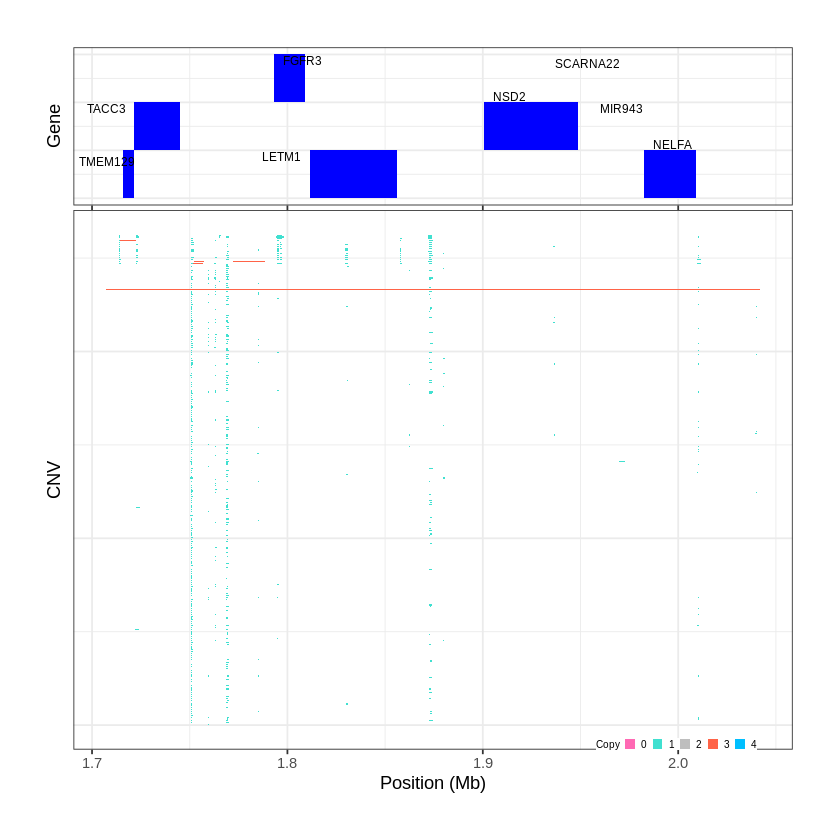

Task done, plot was stored in working directory.
[1] "Ploting CNVR 513..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 3.162701 - 3.4145 Mb with 269 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 514..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 3.426901 - 3.4287 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


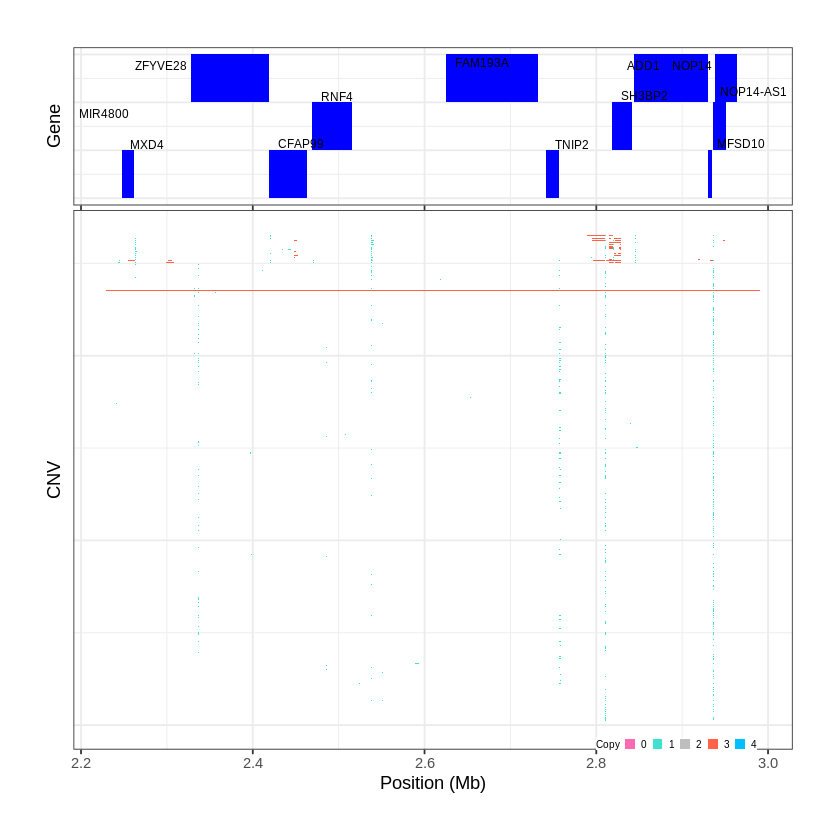

Task done, plot was stored in working directory.
[1] "Ploting CNVR 515..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 3.485201 - 3.4947 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


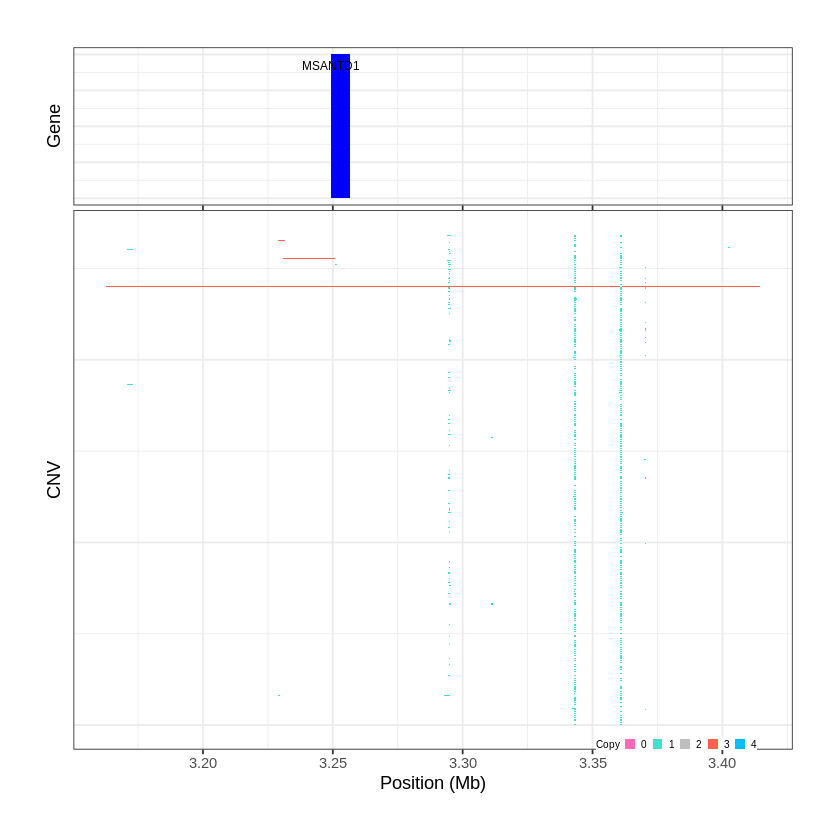

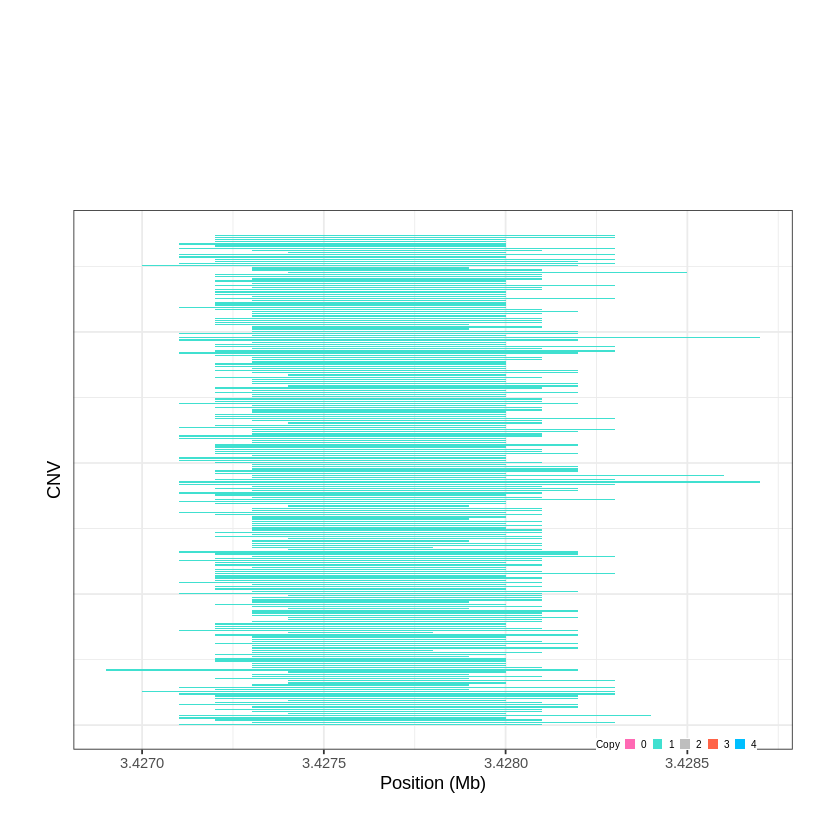

Task done, plot was stored in working directory.
[1] "Ploting CNVR 516..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 3.505301 - 4.1718 Mb with 279 Individual - "
Plotting gene...


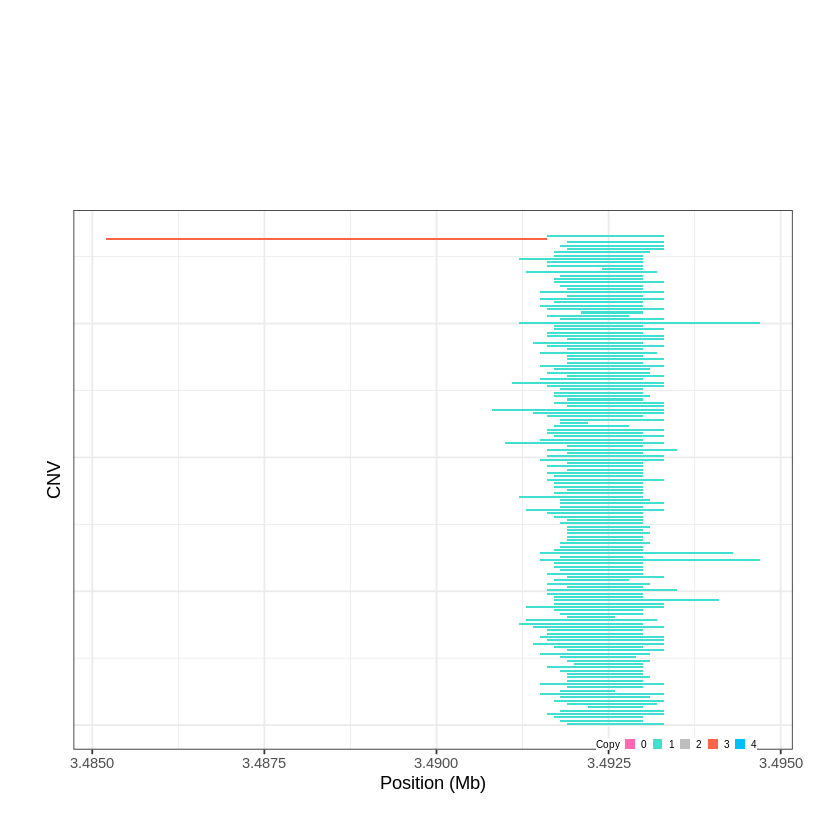

Task done, plot was stored in working directory.
[1] "Ploting CNVR 517..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 6.220201 - 6.4291 Mb with 275 Individual - "
Plotting gene...


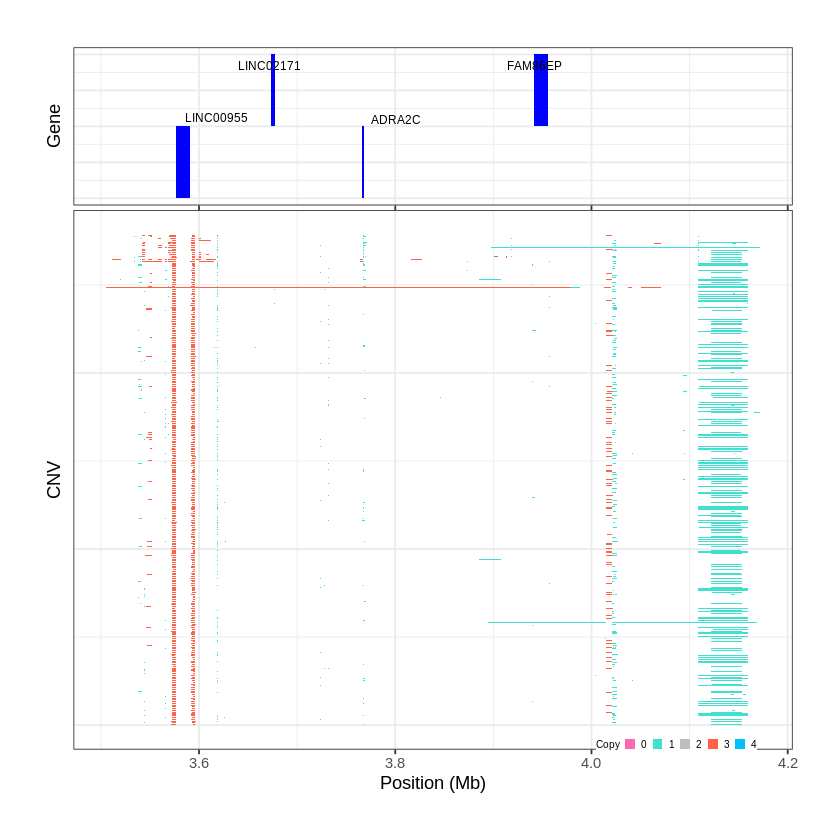

Task done, plot was stored in working directory.
[1] "Ploting CNVR 518..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 6.440801 - 6.8059 Mb with 268 Individual - "
Plotting gene...


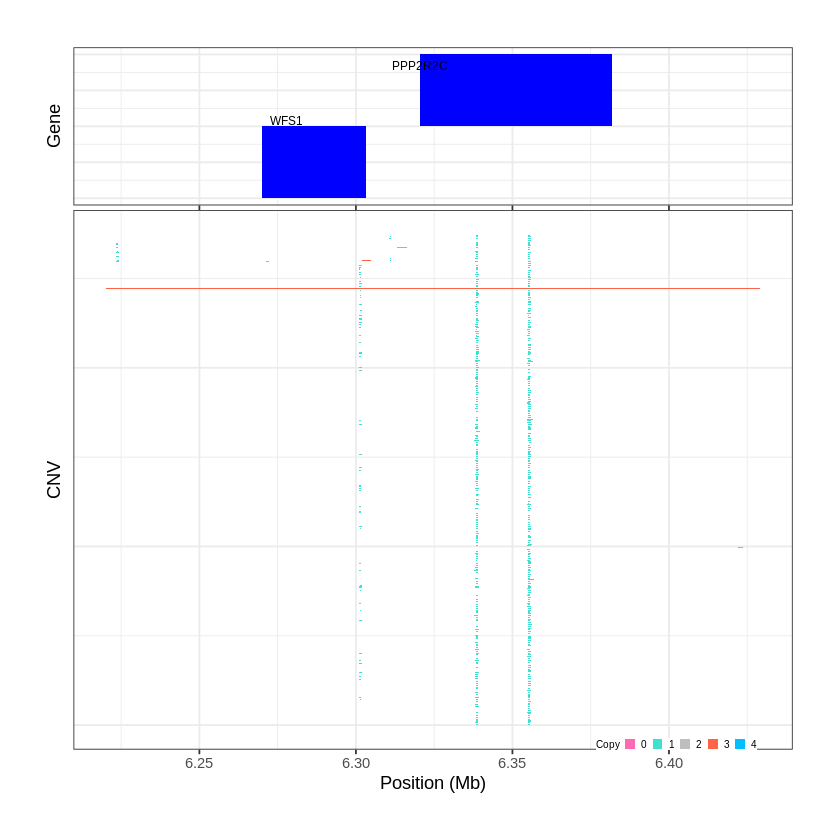

Task done, plot was stored in working directory.
[1] "Ploting CNVR 519..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 6.871301 - 7.0857 Mb with 237 Individual - "
Plotting gene...


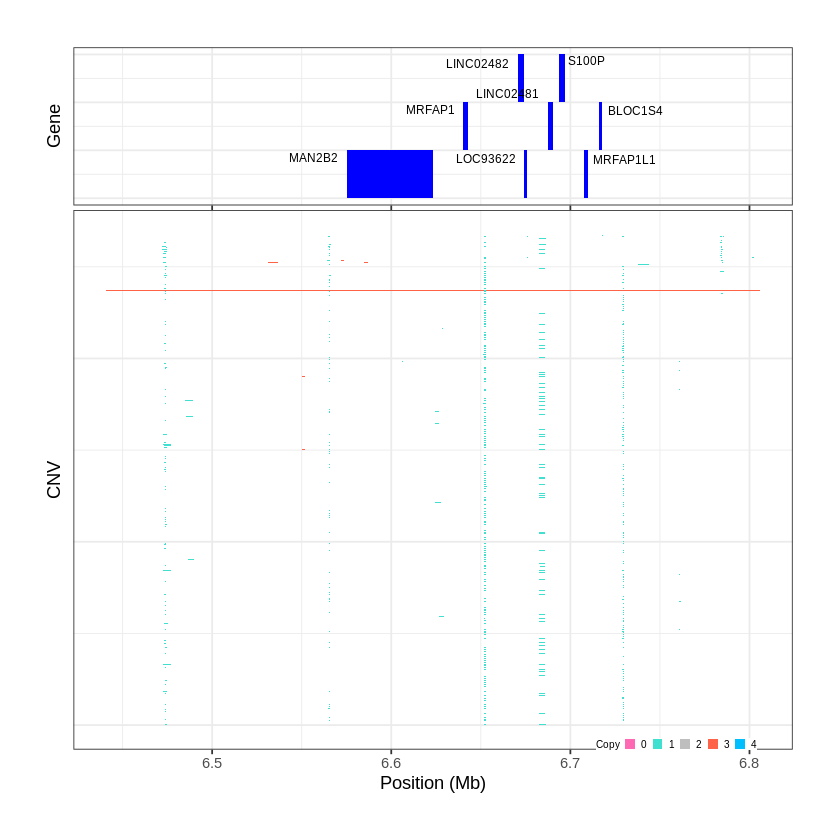

Task done, plot was stored in working directory.
[1] "Ploting CNVR 520..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 7.094001 - 7.4012 Mb with 248 Individual - "
Plotting gene...


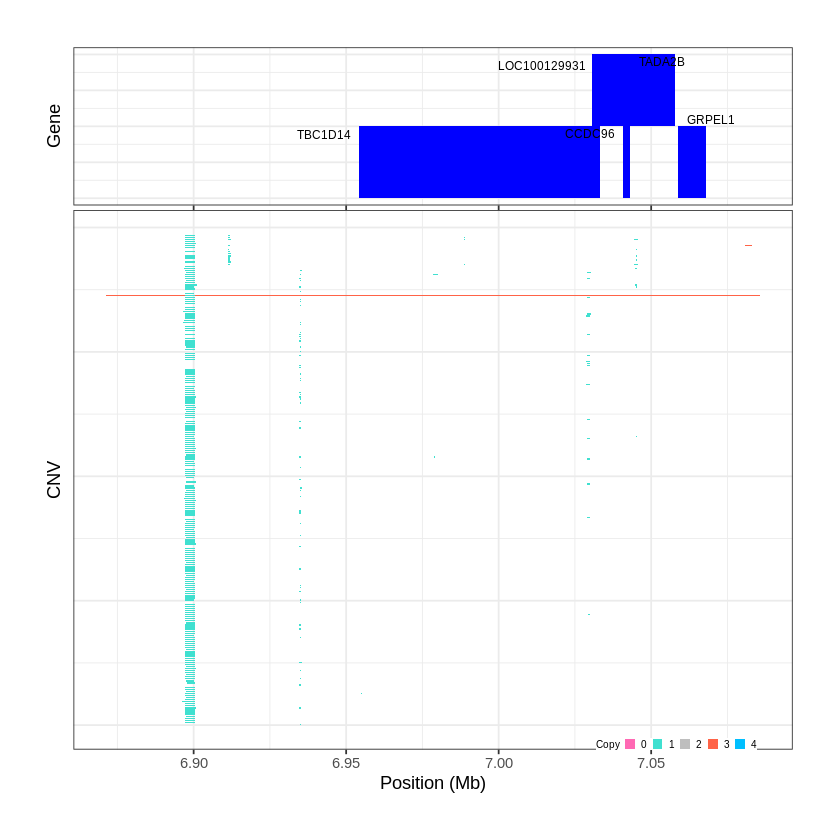

Task done, plot was stored in working directory.
[1] "Ploting CNVR 521..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 7.411901 - 7.8162 Mb with 275 Individual - "
Plotting gene...


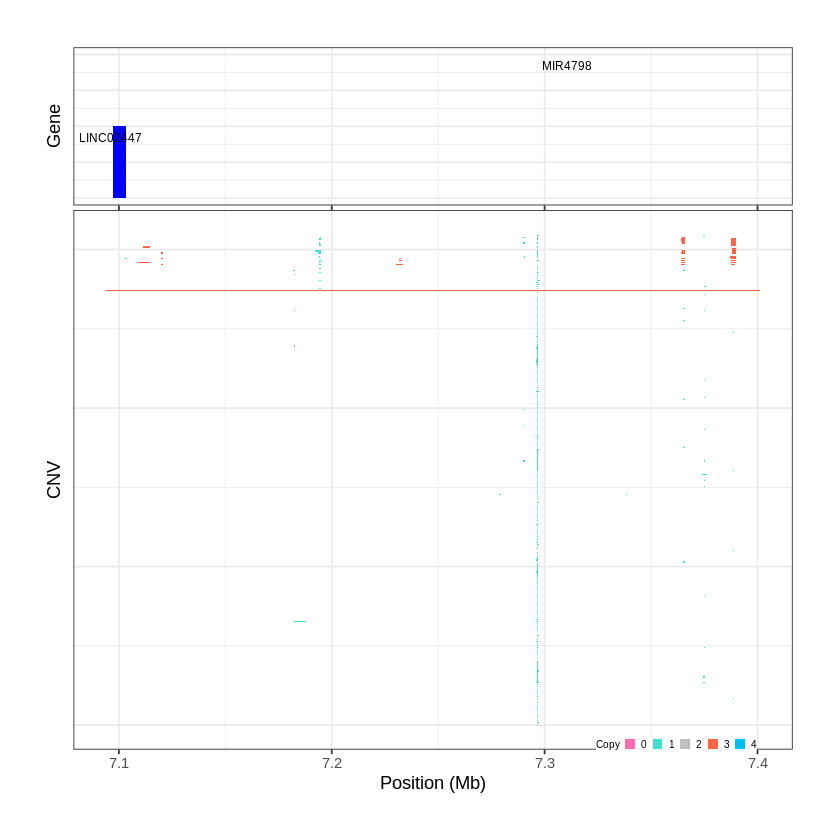

Task done, plot was stored in working directory.
[1] "Ploting CNVR 522..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 7.842301 - 8.7992 Mb with 263 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 523..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 8.799201 - 8.8182 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


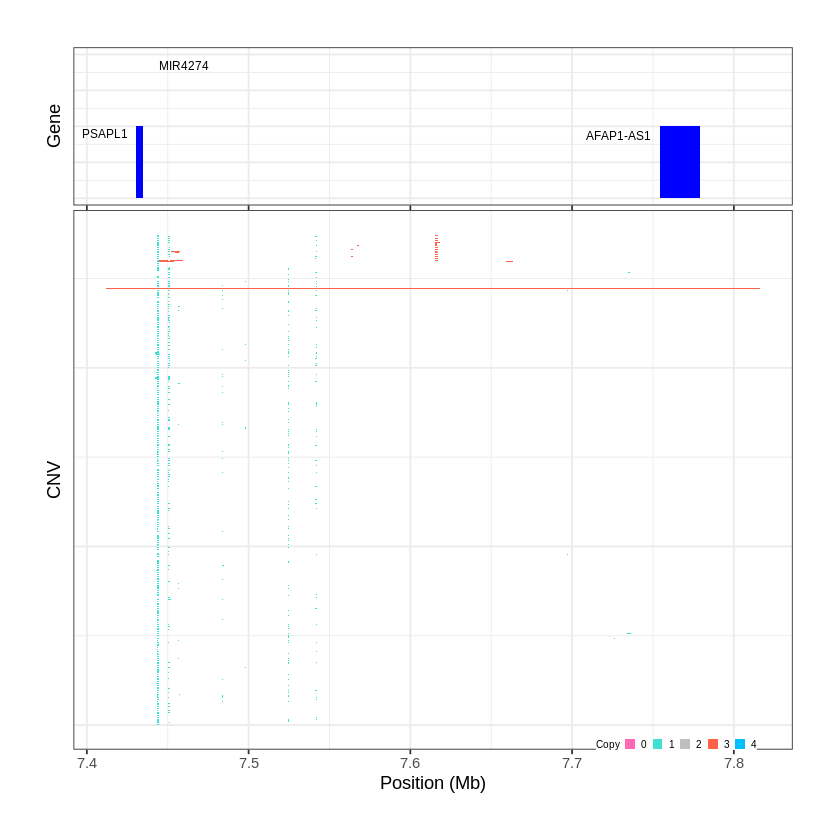

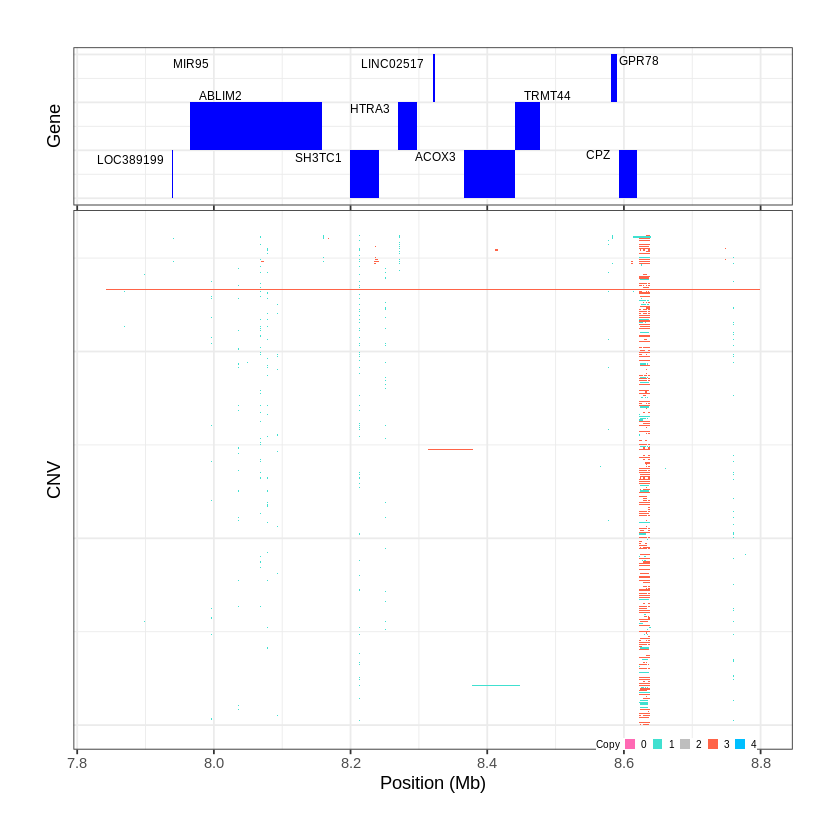

Task done, plot was stored in working directory.
[1] "Ploting CNVR 524..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 8.936901 - 9.5461 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 18 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 525..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 9.613901 - 9.6333 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


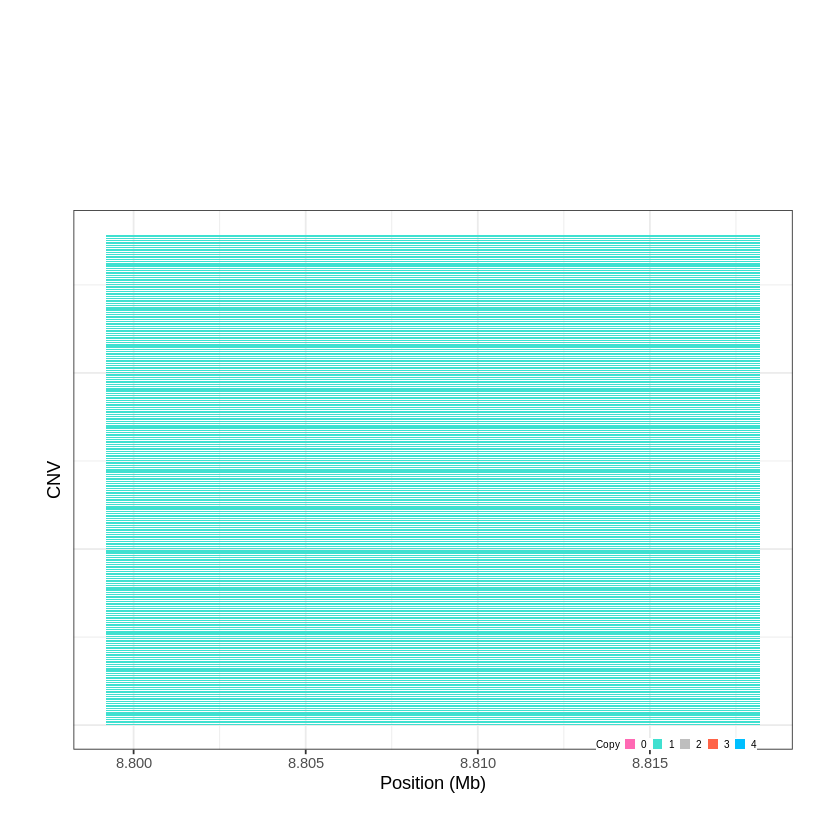

Task done, plot was stored in working directory.
[1] "Ploting CNVR 526..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 10.176901 - 10.3598 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


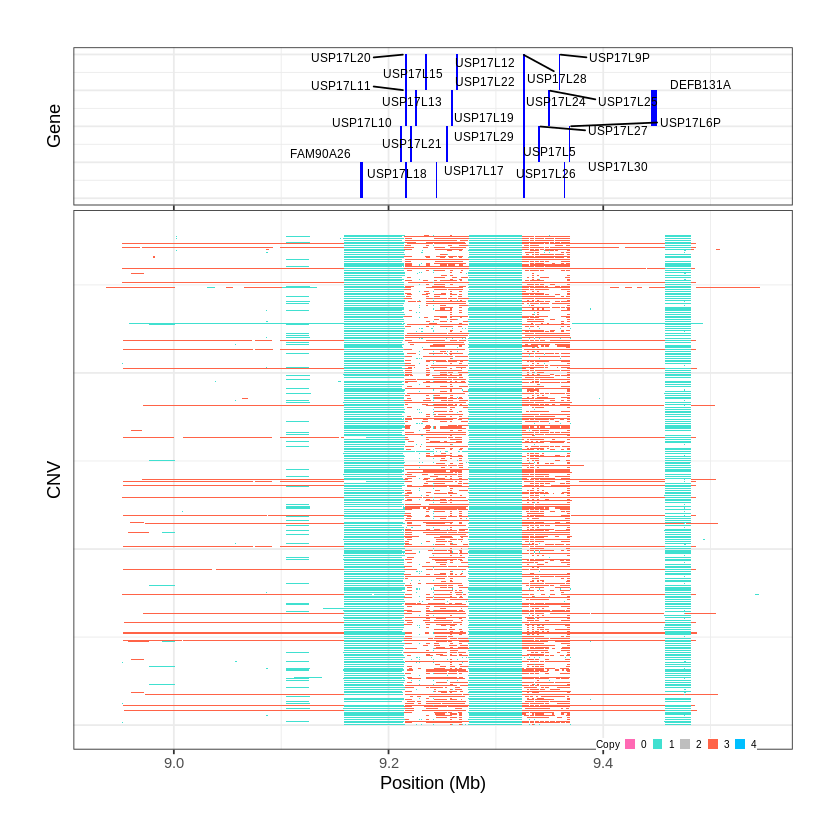

Task done, plot was stored in working directory.
[1] "Ploting CNVR 527..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 12.666401 - 12.7391 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


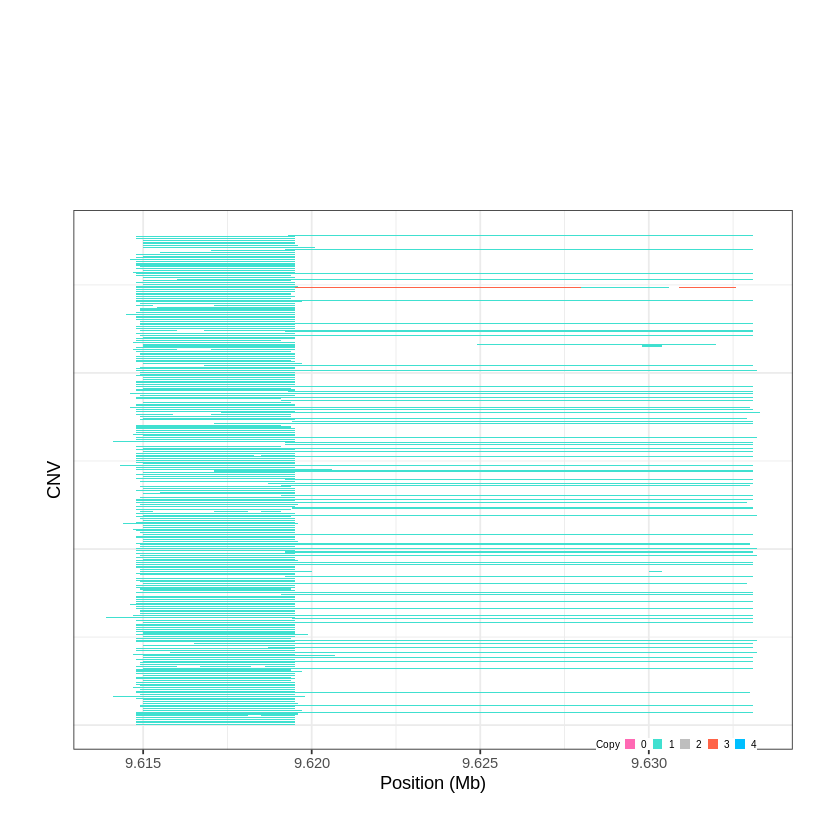

Task done, plot was stored in working directory.
[1] "Ploting CNVR 528..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 15.838901 - 15.8787 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


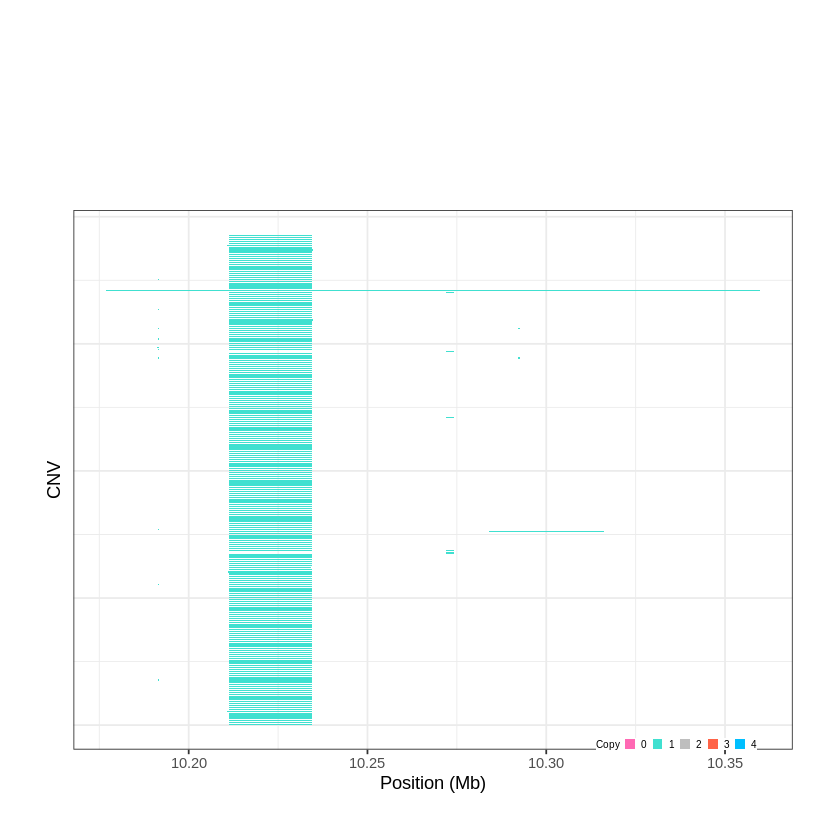

Task done, plot was stored in working directory.
[1] "Ploting CNVR 529..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 18.612701 - 18.6151 Mb with 254 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


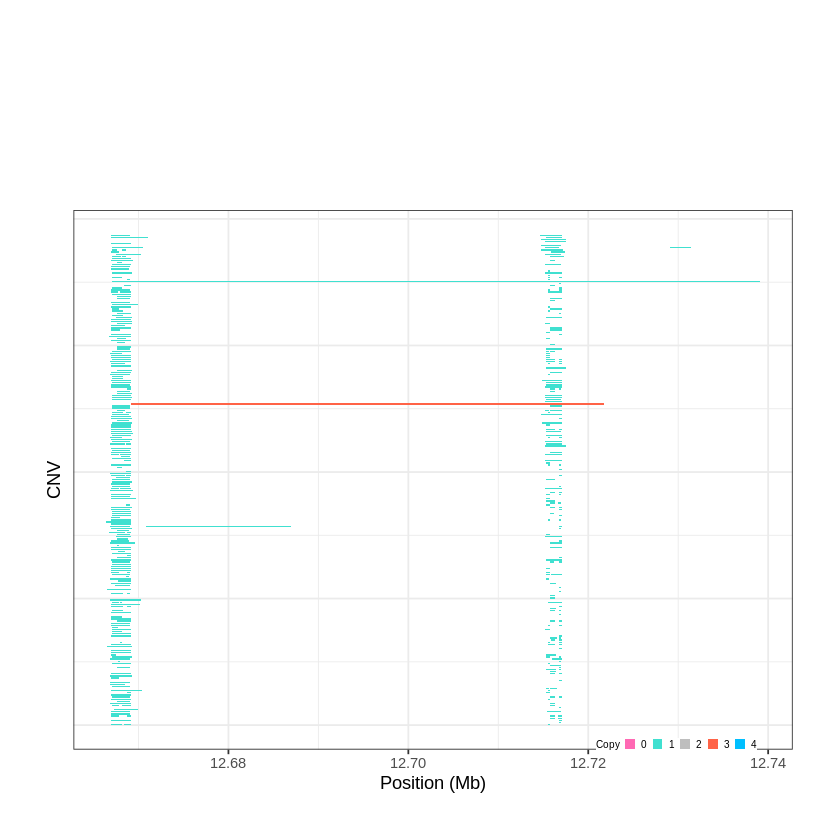

Task done, plot was stored in working directory.
[1] "Ploting CNVR 530..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 19.487901 - 19.5495 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


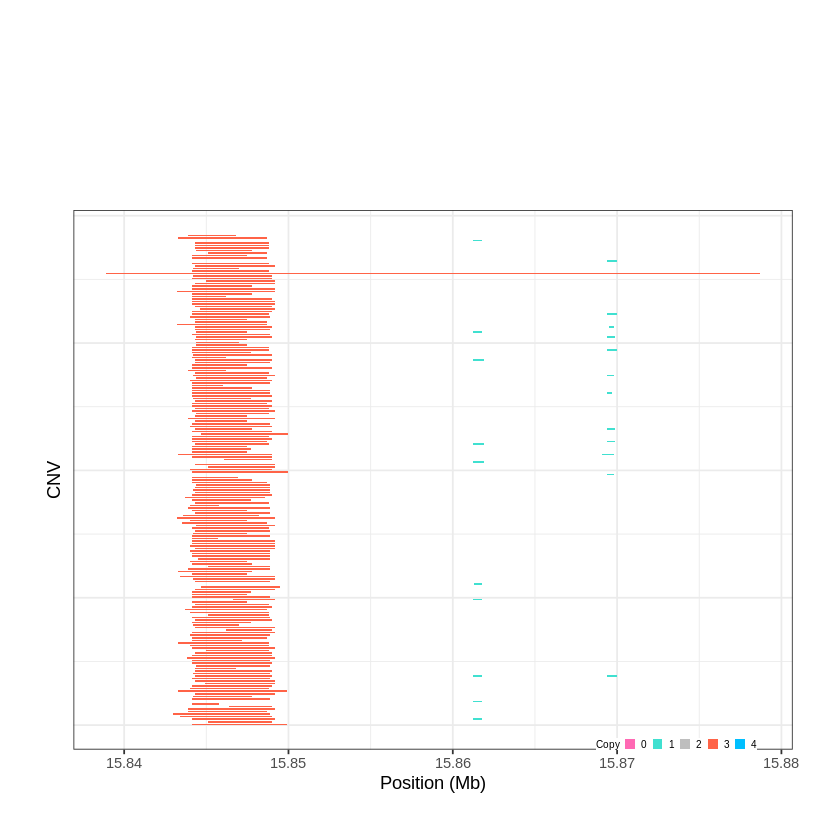

Task done, plot was stored in working directory.
[1] "Ploting CNVR 531..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 24.293501 - 24.2956 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


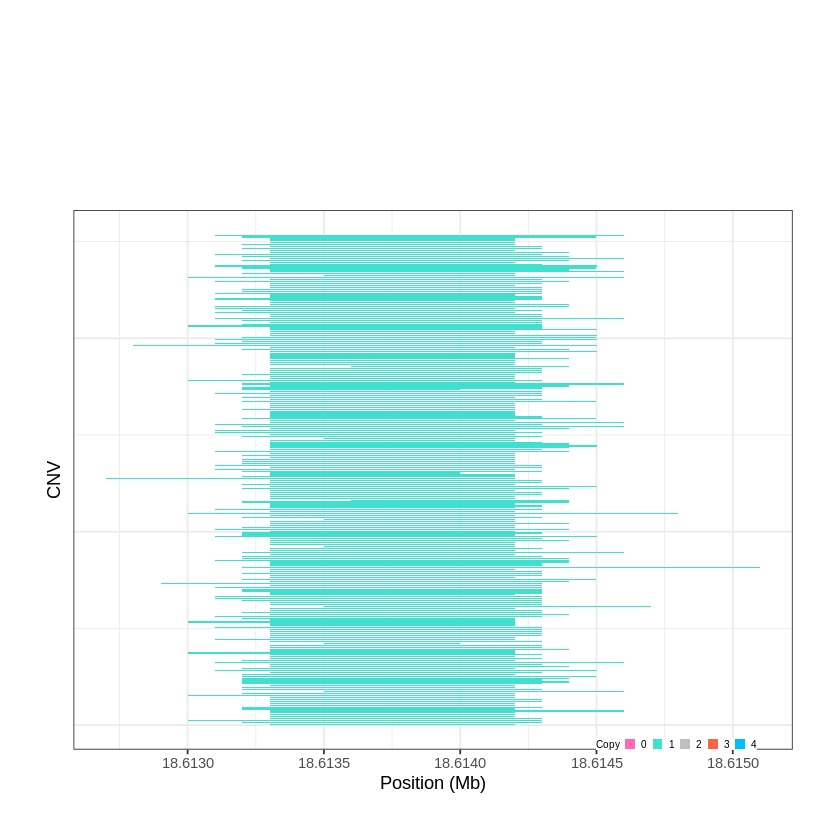

Task done, plot was stored in working directory.
[1] "Ploting CNVR 532..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 29.650701 - 29.6651 Mb with 159 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


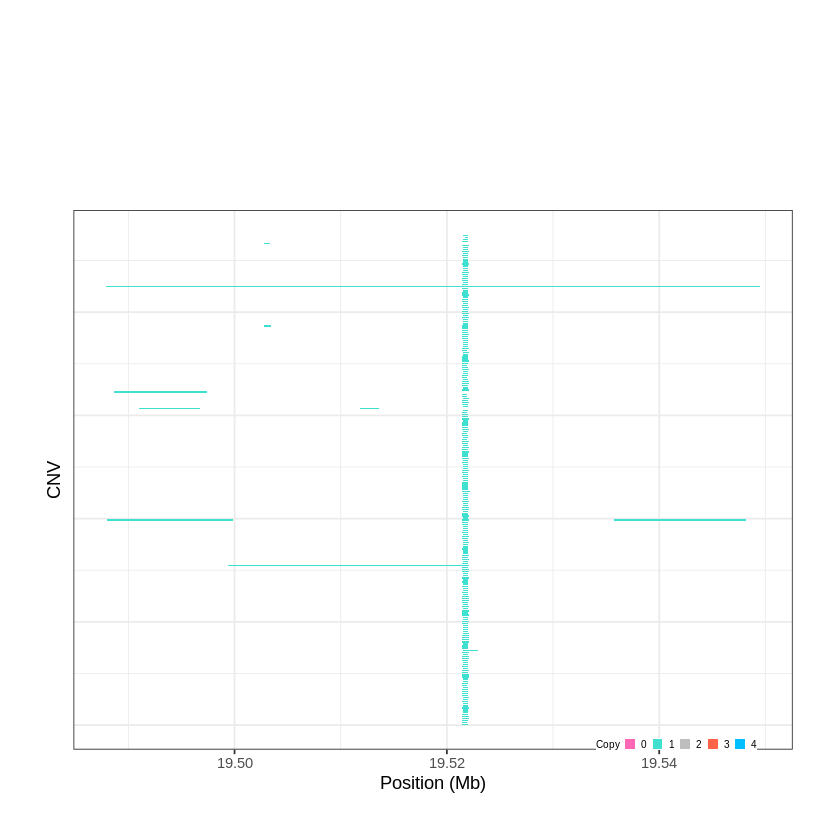

Task done, plot was stored in working directory.
[1] "Ploting CNVR 533..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 31.201201 - 31.2131 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


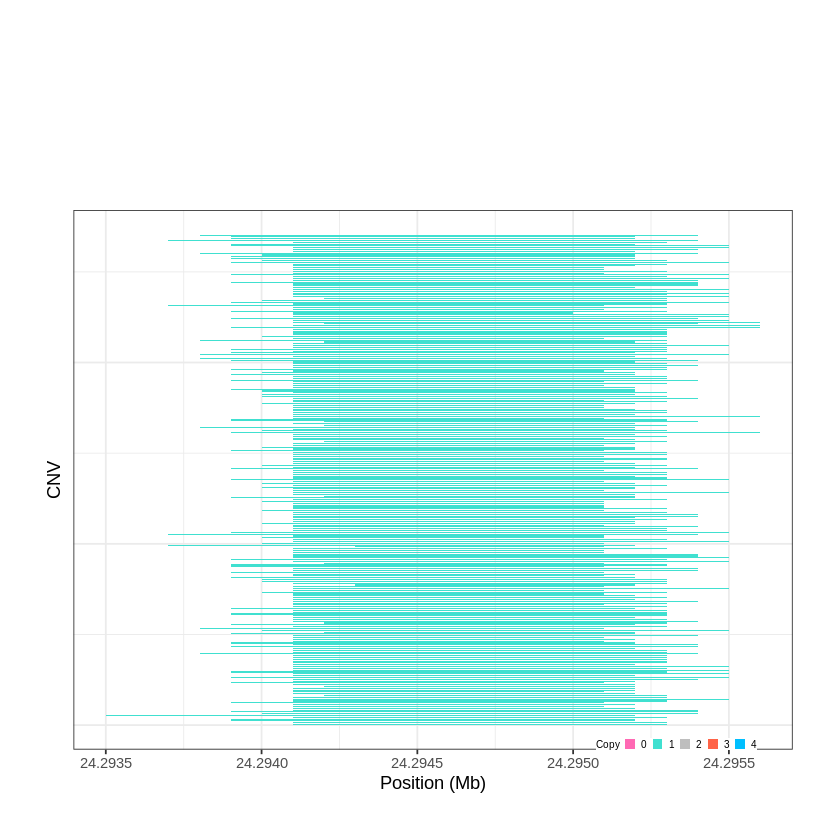

Task done, plot was stored in working directory.
[1] "Ploting CNVR 534..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 31.338501 - 31.3387 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


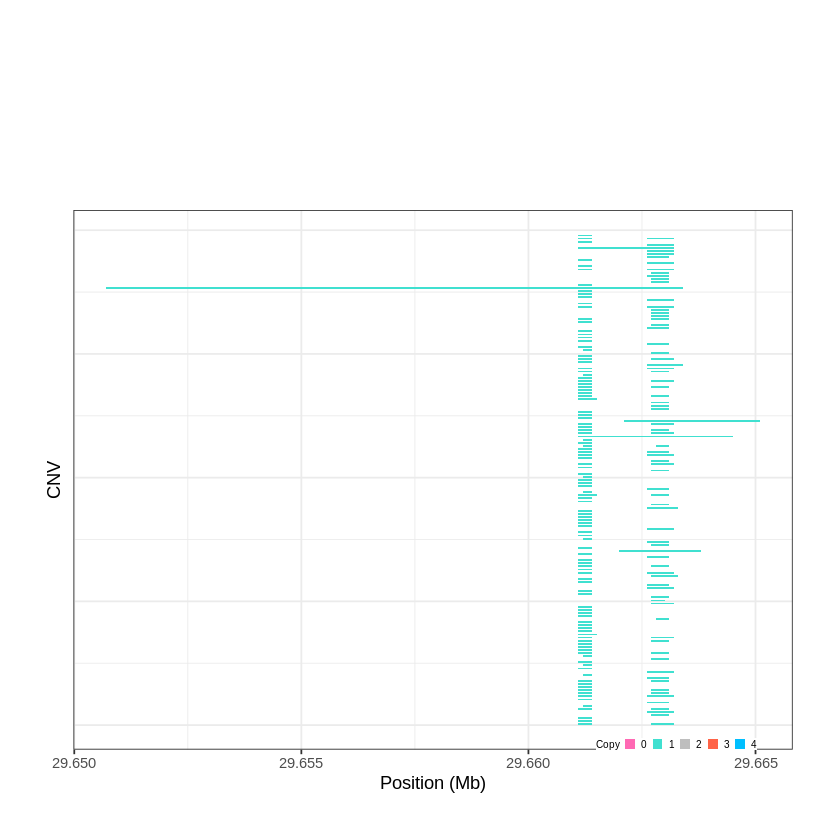

Task done, plot was stored in working directory.
[1] "Ploting CNVR 535..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 31.439901 - 31.4419 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


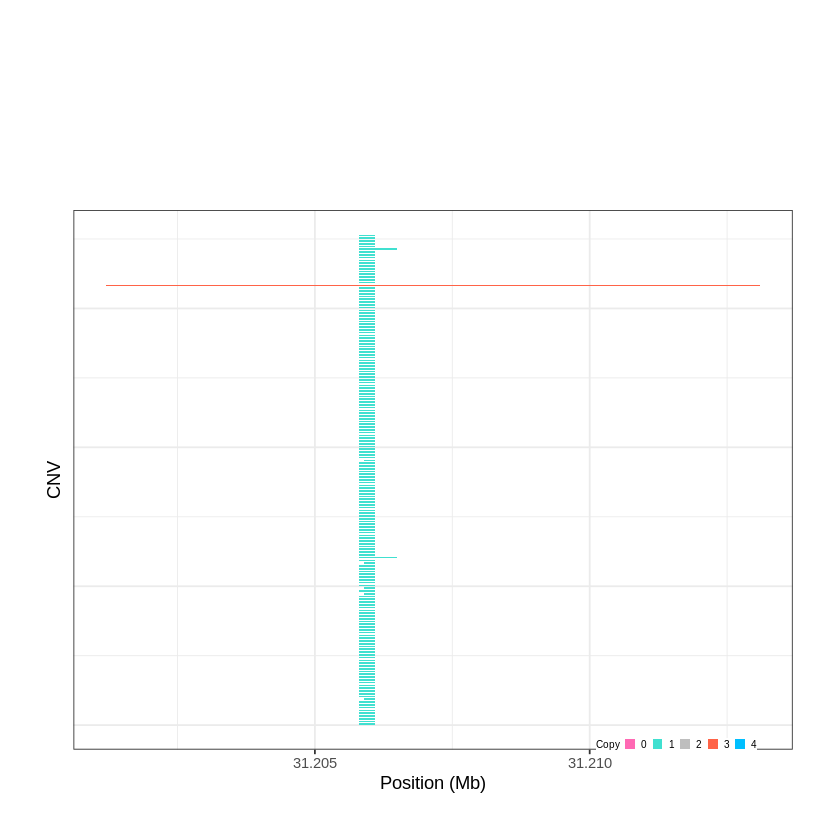

Task done, plot was stored in working directory.
[1] "Ploting CNVR 536..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 31.815301 - 31.8448 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


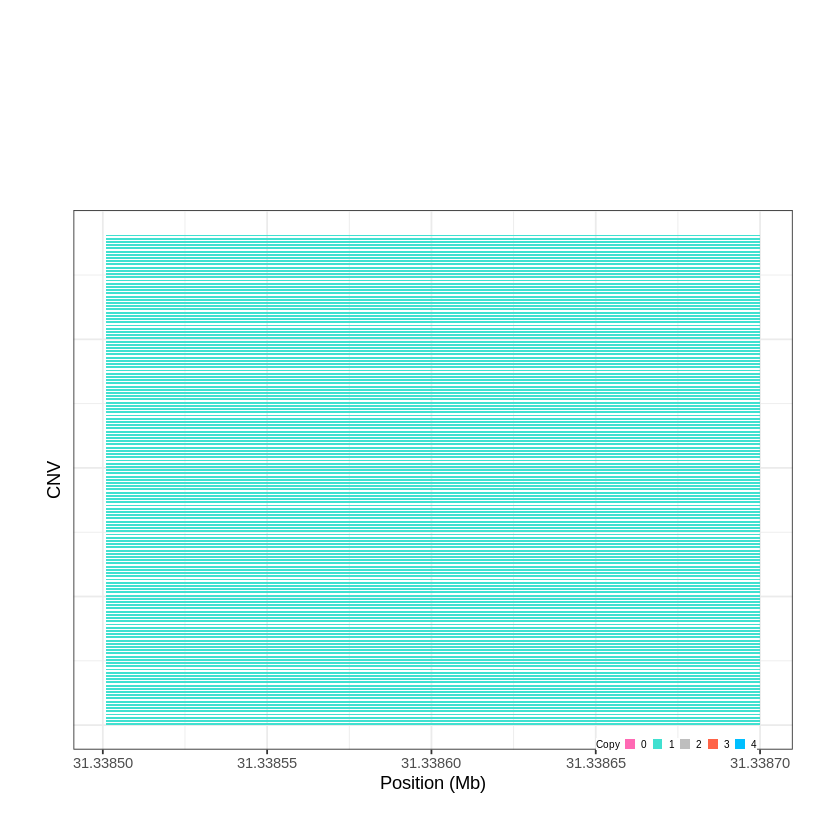

Task done, plot was stored in working directory.
[1] "Ploting CNVR 537..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 32.831001 - 32.8623 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


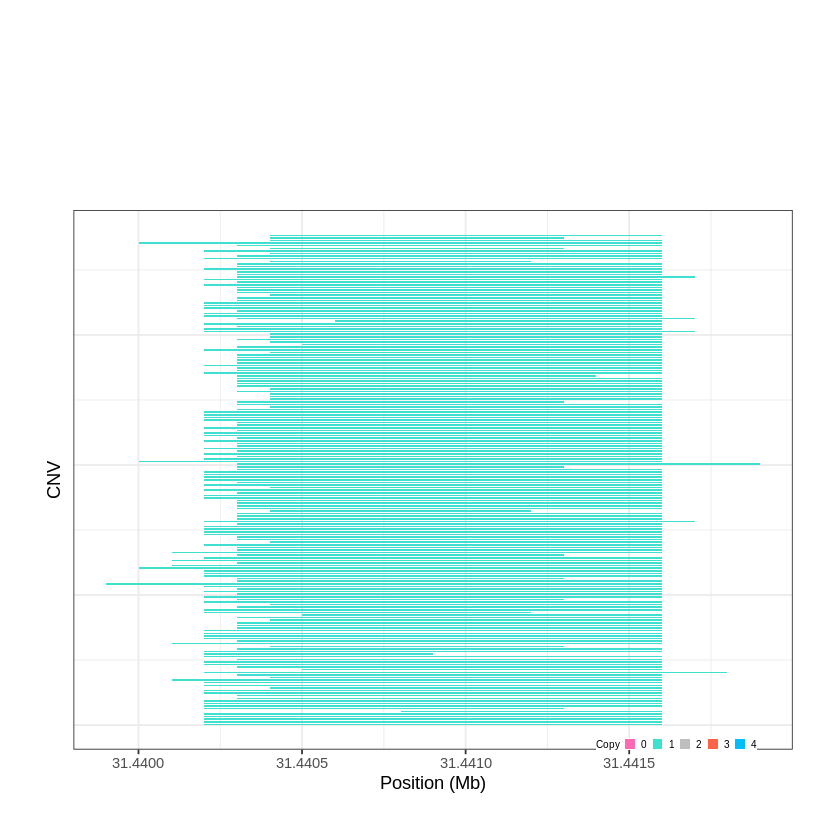

Task done, plot was stored in working directory.
[1] "Ploting CNVR 538..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 34.199801 - 34.2652 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


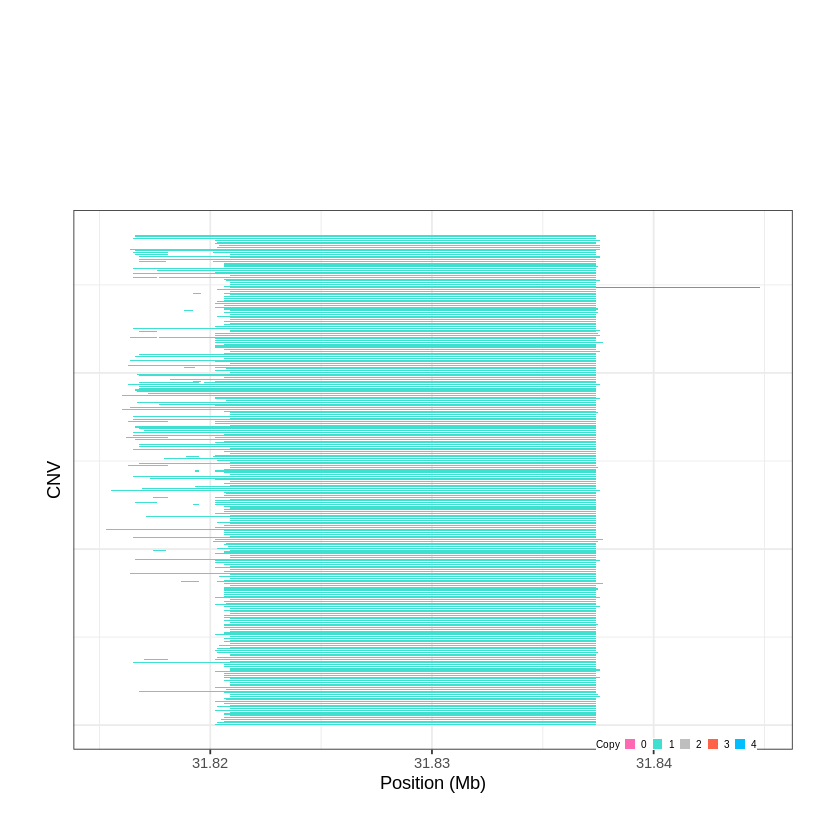

Task done, plot was stored in working directory.
[1] "Ploting CNVR 539..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 35.189401 - 35.2174 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


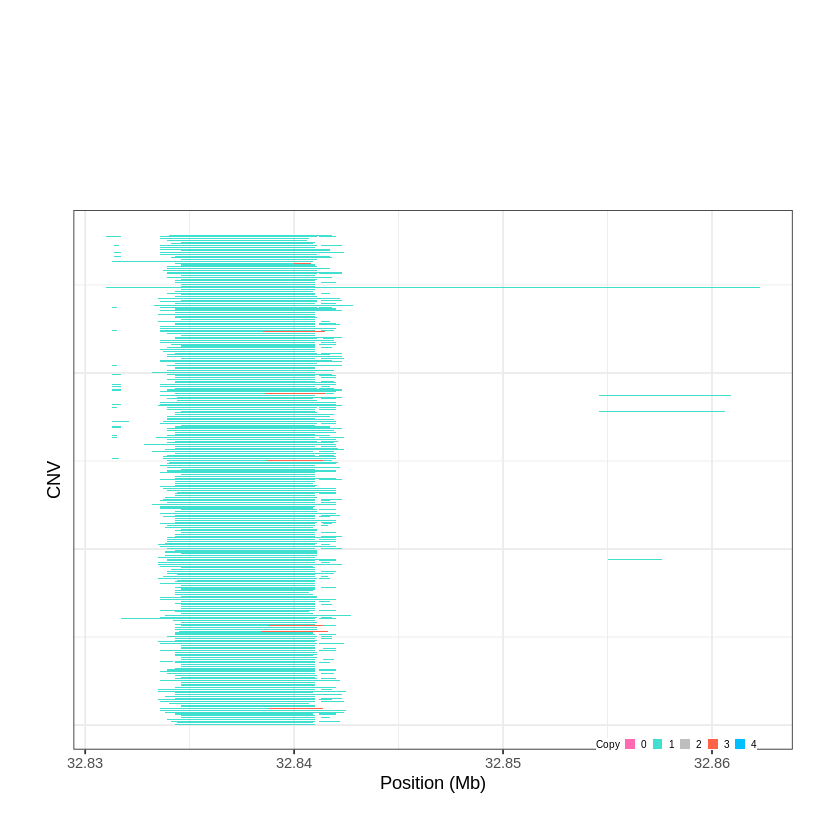

Task done, plot was stored in working directory.
[1] "Ploting CNVR 540..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 36.842801 - 36.8572 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


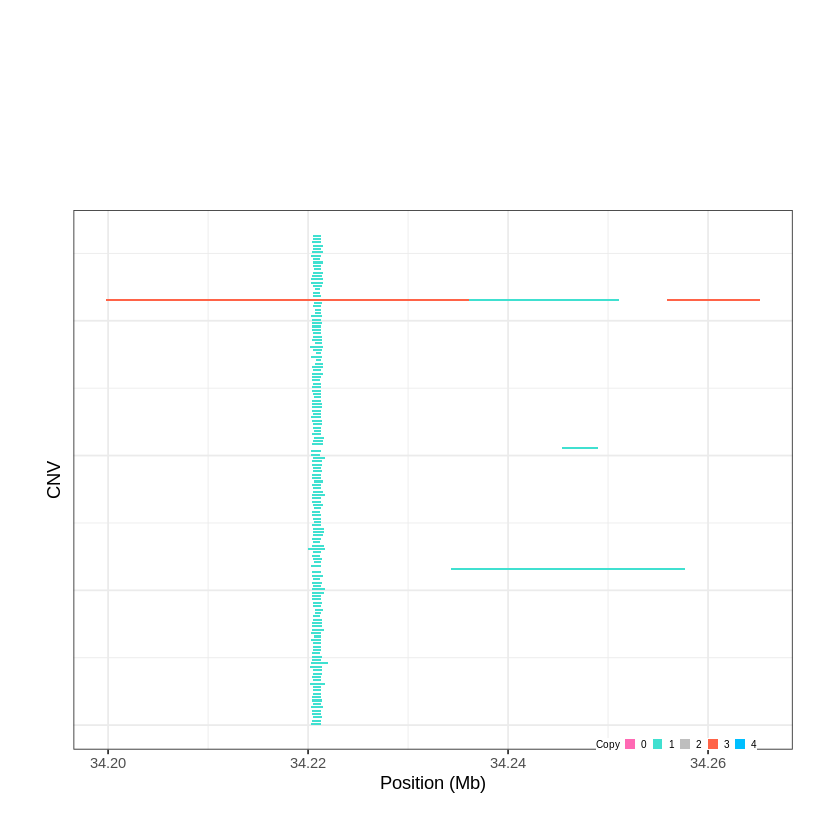

Task done, plot was stored in working directory.
[1] "Ploting CNVR 541..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 40.024401 - 40.0267 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


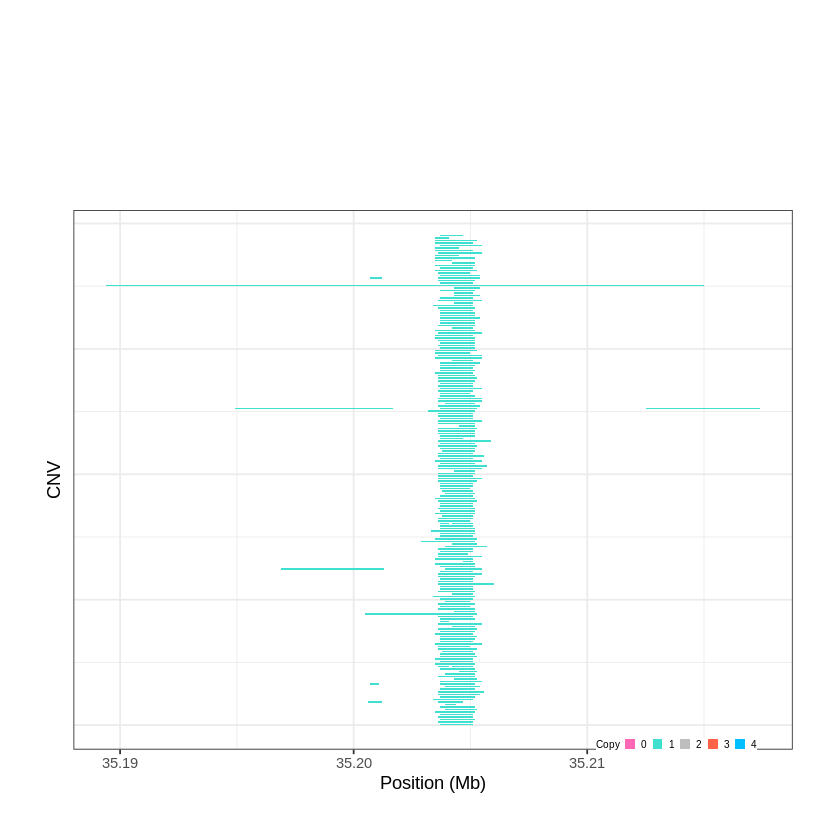

Task done, plot was stored in working directory.
[1] "Ploting CNVR 542..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 40.291701 - 40.3015 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


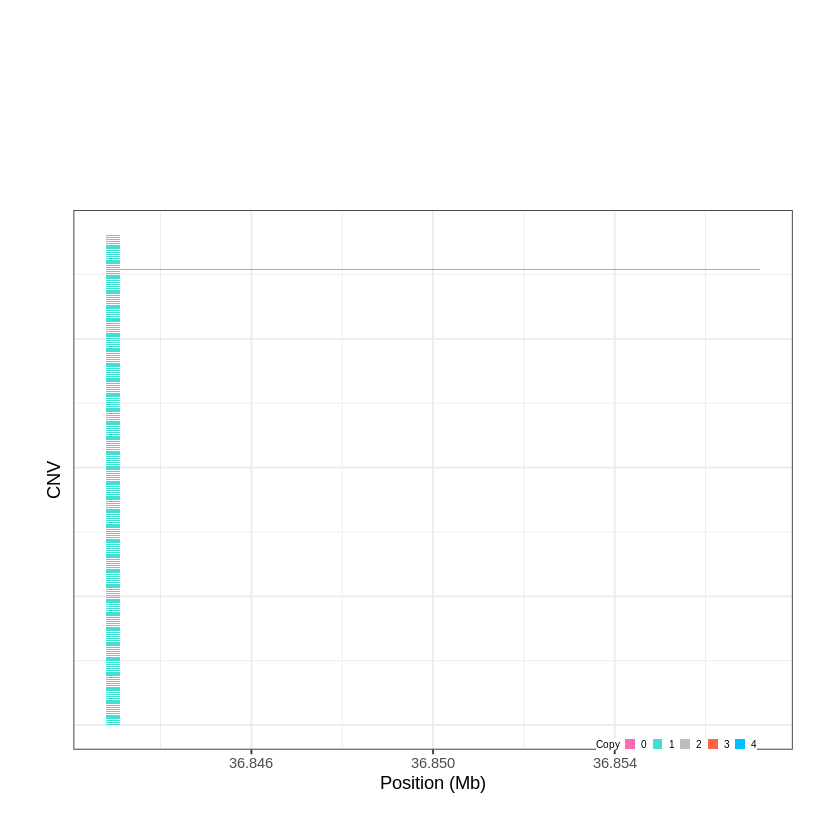

Task done, plot was stored in working directory.
[1] "Ploting CNVR 543..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 43.931501 - 43.9551 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


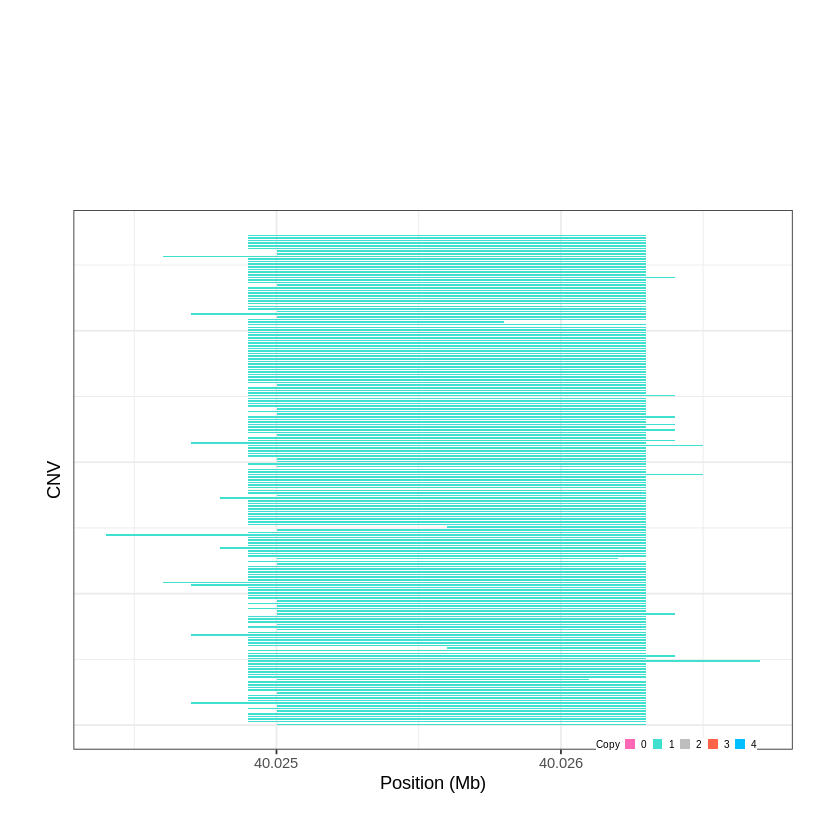

Task done, plot was stored in working directory.
[1] "Ploting CNVR 544..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 44.507301 - 44.5495 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


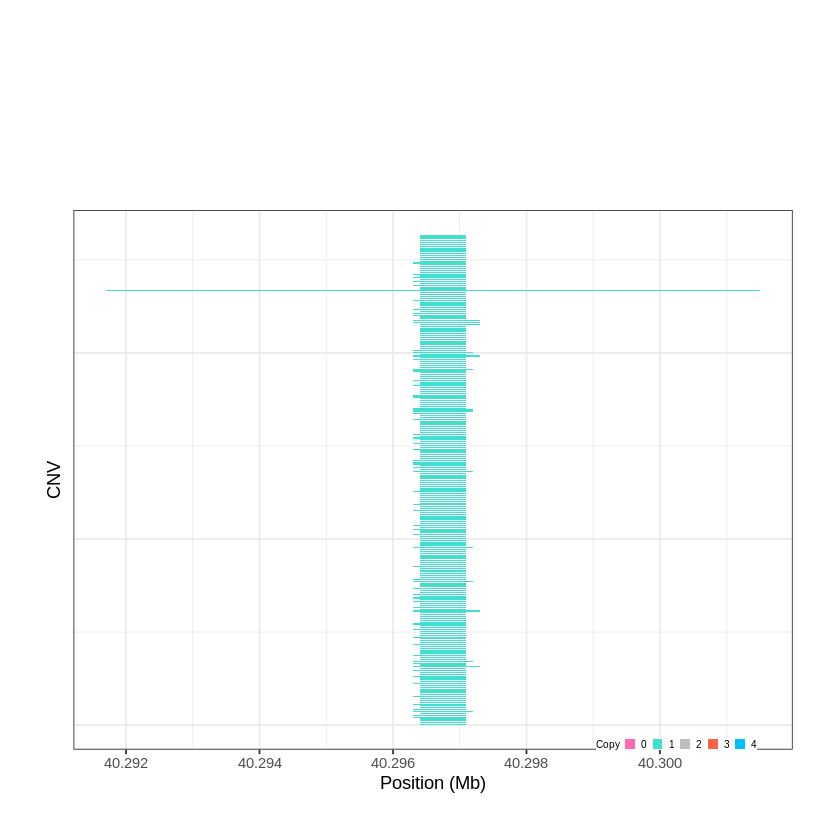

Task done, plot was stored in working directory.
[1] "Ploting CNVR 545..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 45.012001 - 45.0475 Mb with 246 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


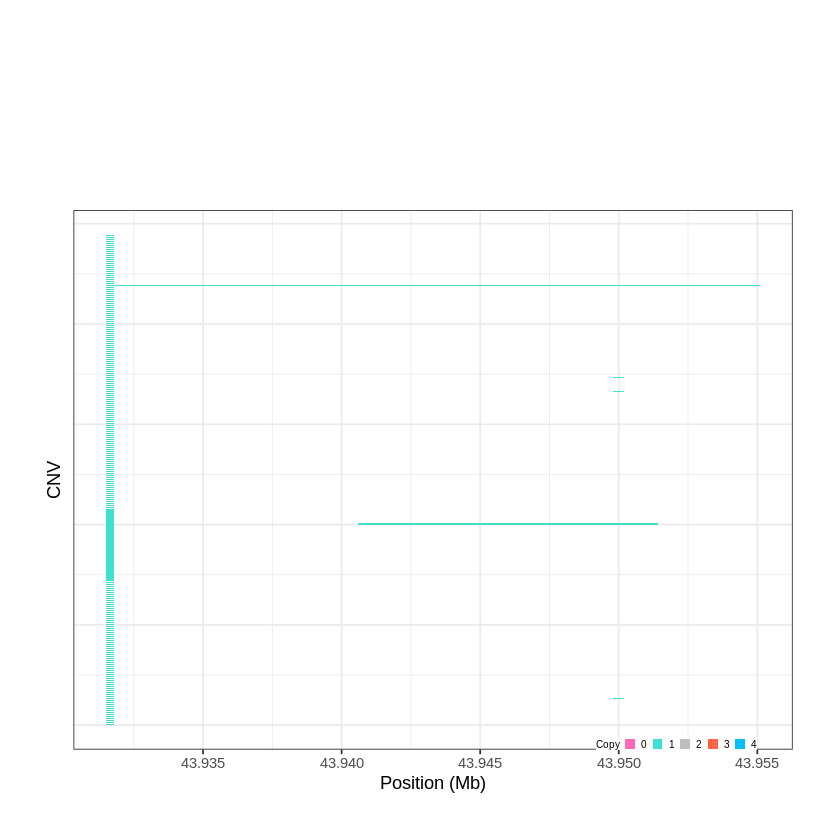

Task done, plot was stored in working directory.
[1] "Ploting CNVR 546..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 46.193701 - 46.2813 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


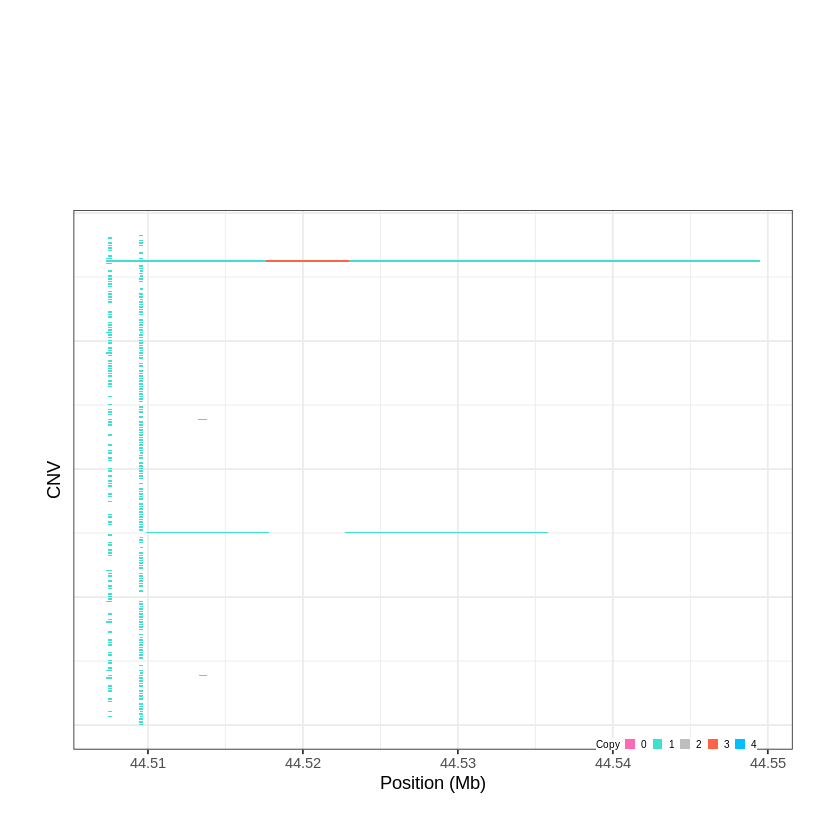

Task done, plot was stored in working directory.
[1] "Ploting CNVR 547..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 48.657401 - 48.681 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


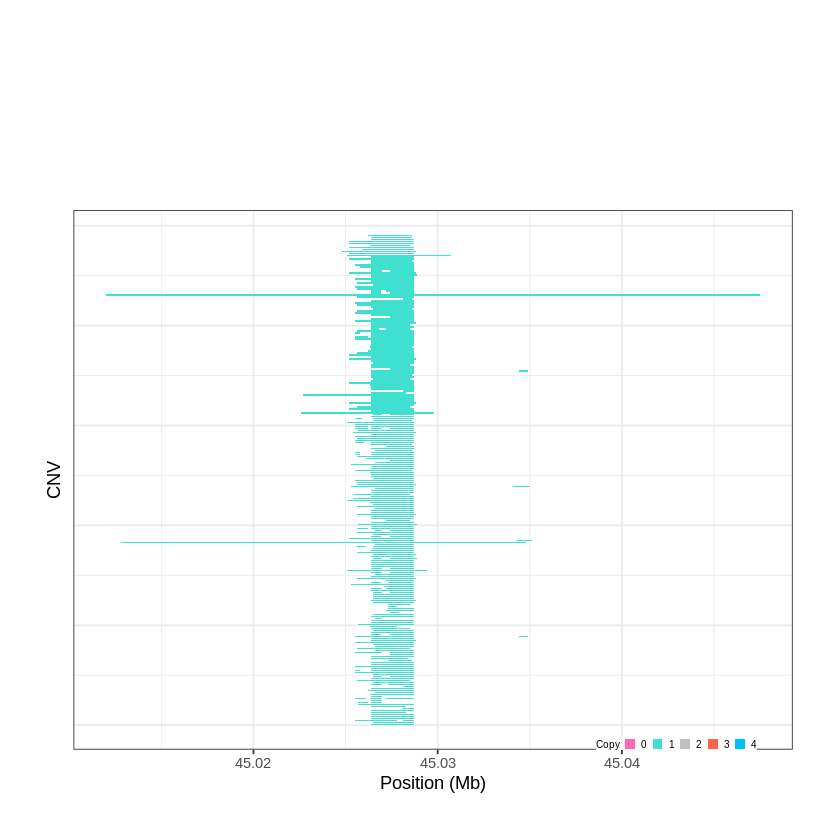

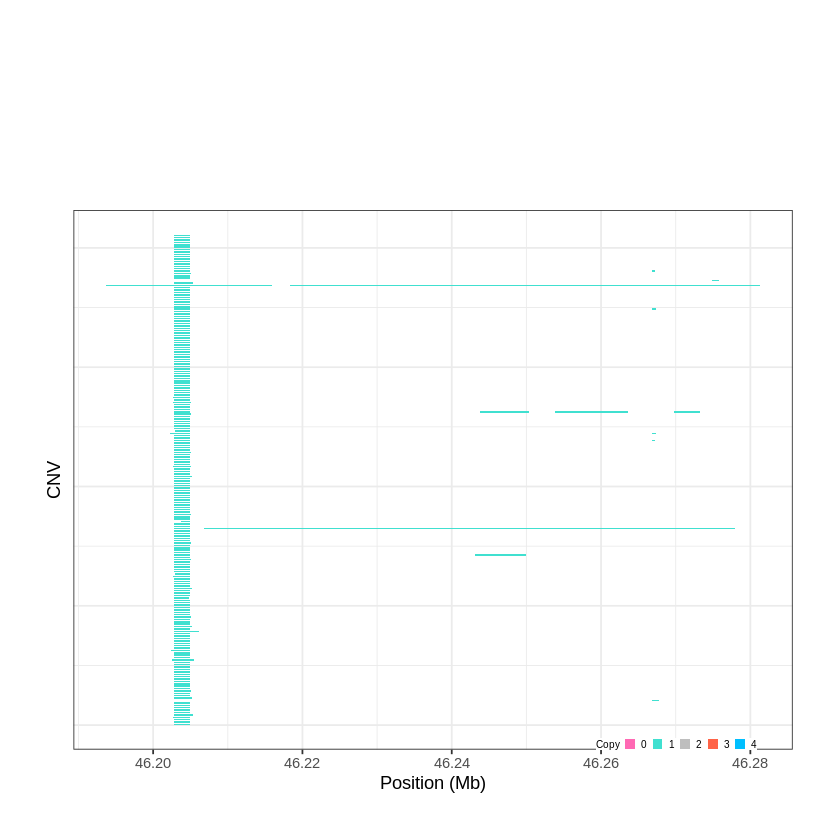

Task done, plot was stored in working directory.
[1] "Ploting CNVR 548..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 49.059701 - 52.719 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 549..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 54.742701 - 54.7492 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


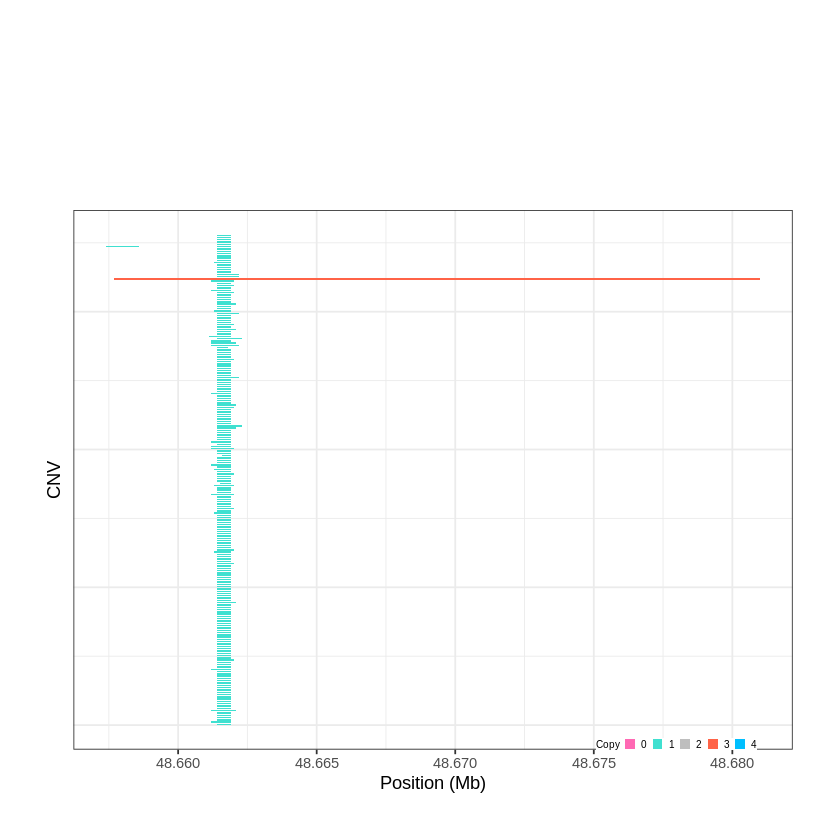

Task done, plot was stored in working directory.
[1] "Ploting CNVR 550..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 58.637301 - 58.7613 Mb with 184 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


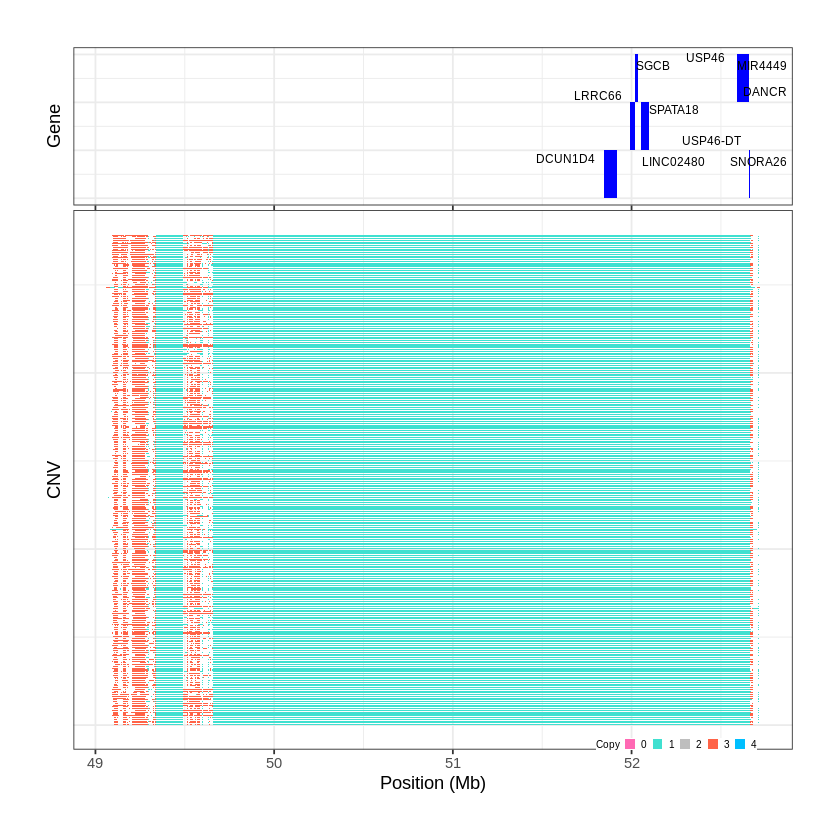

Task done, plot was stored in working directory.
[1] "Ploting CNVR 551..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 58.768801 - 58.7834 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


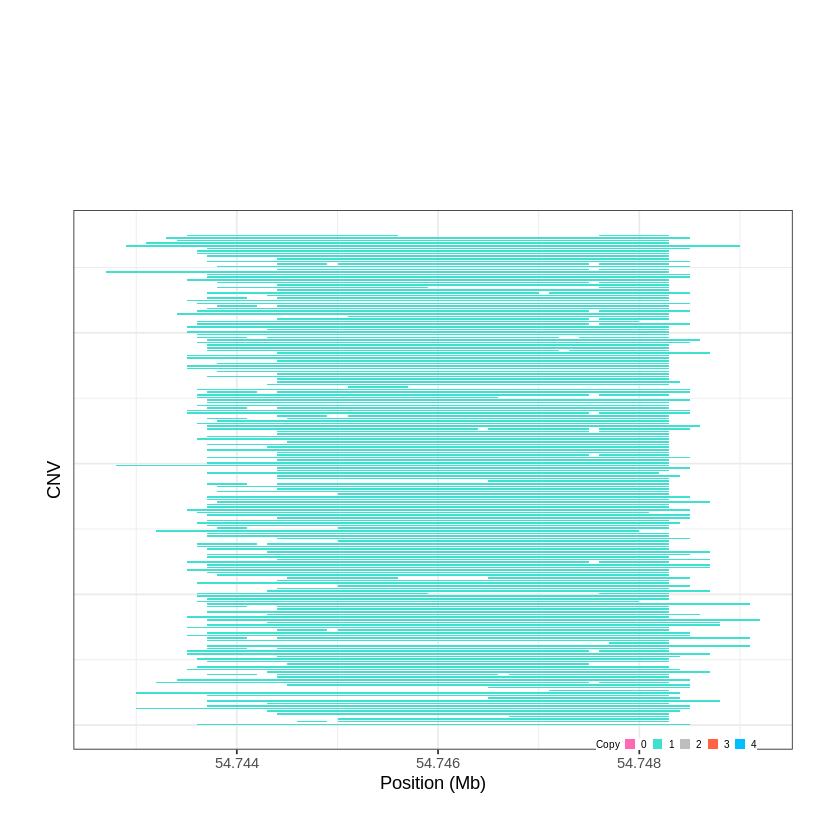

Task done, plot was stored in working directory.
[1] "Ploting CNVR 552..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 59.693901 - 59.8355 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


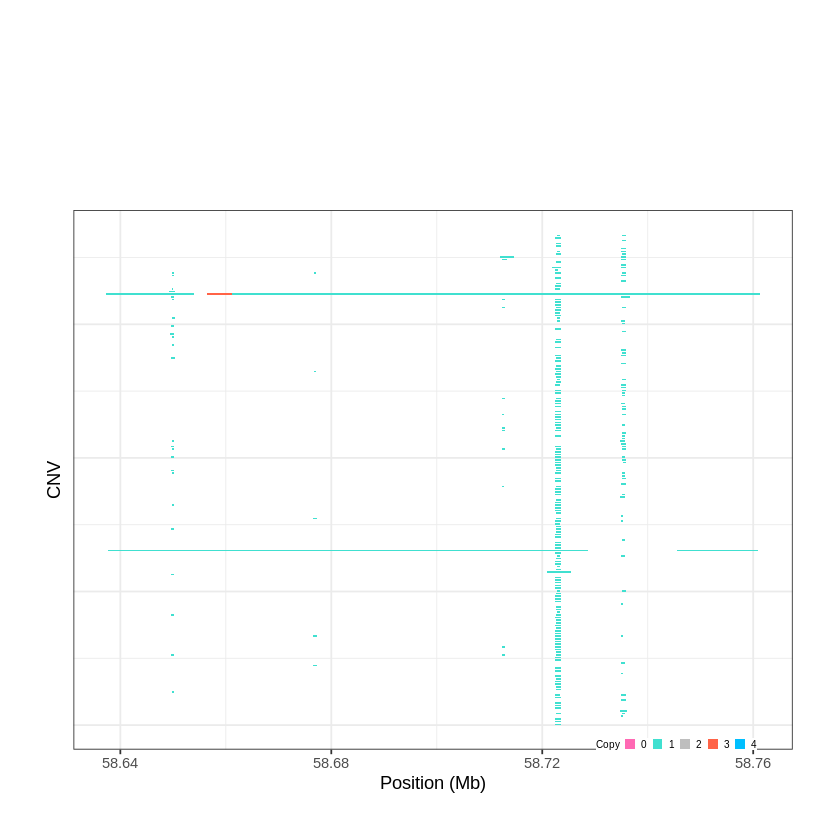

Task done, plot was stored in working directory.
[1] "Ploting CNVR 553..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 59.944501 - 59.9515 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


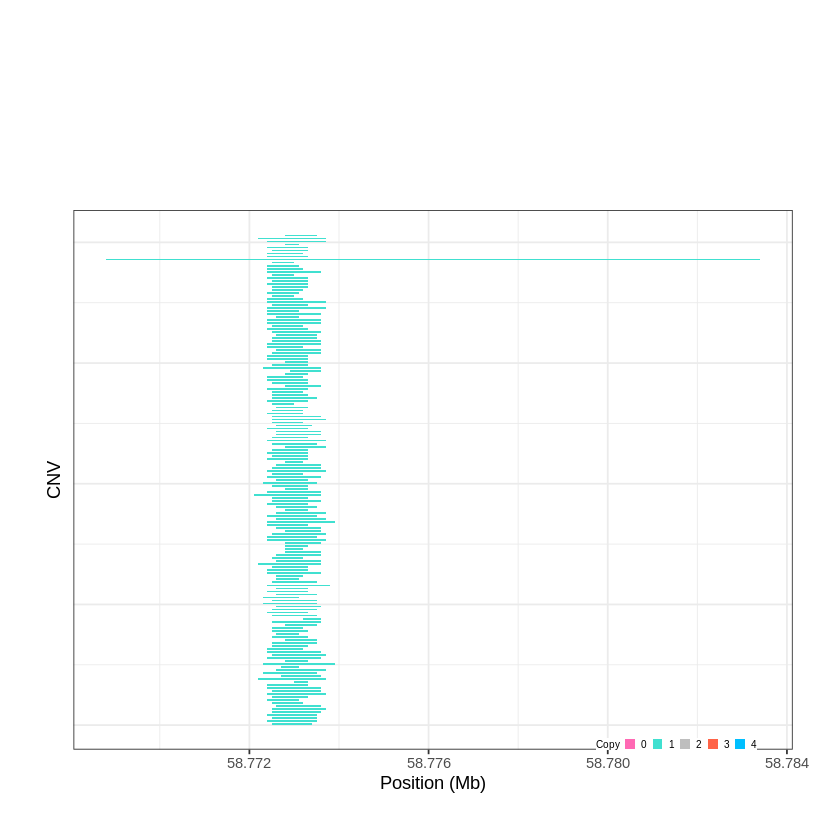

Task done, plot was stored in working directory.
[1] "Ploting CNVR 554..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 60.048601 - 60.1214 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


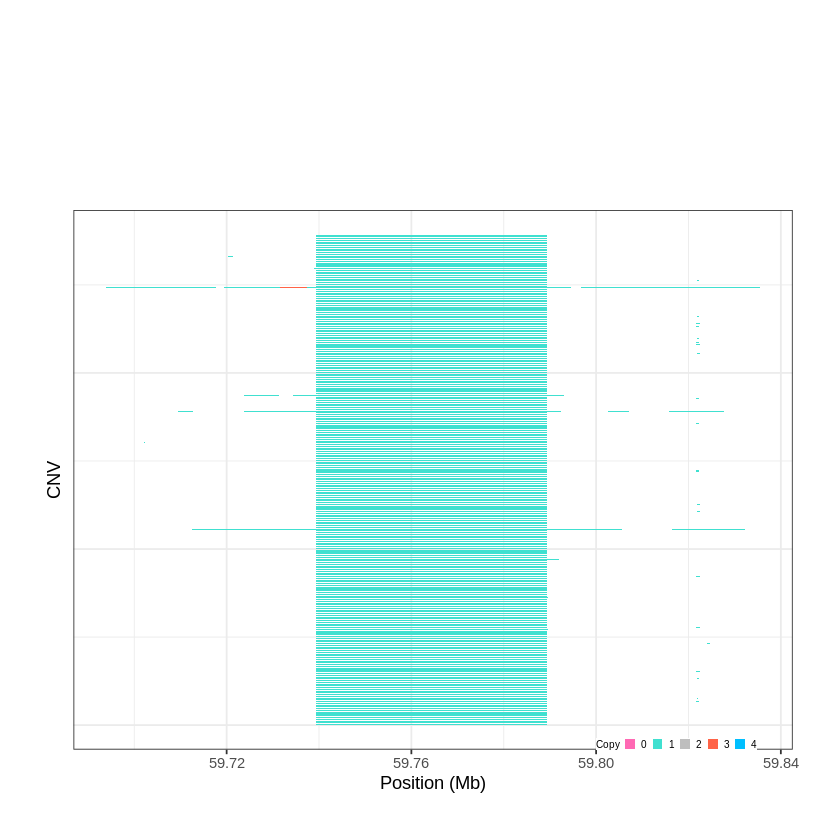

Task done, plot was stored in working directory.
[1] "Ploting CNVR 555..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 61.308901 - 61.3604 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


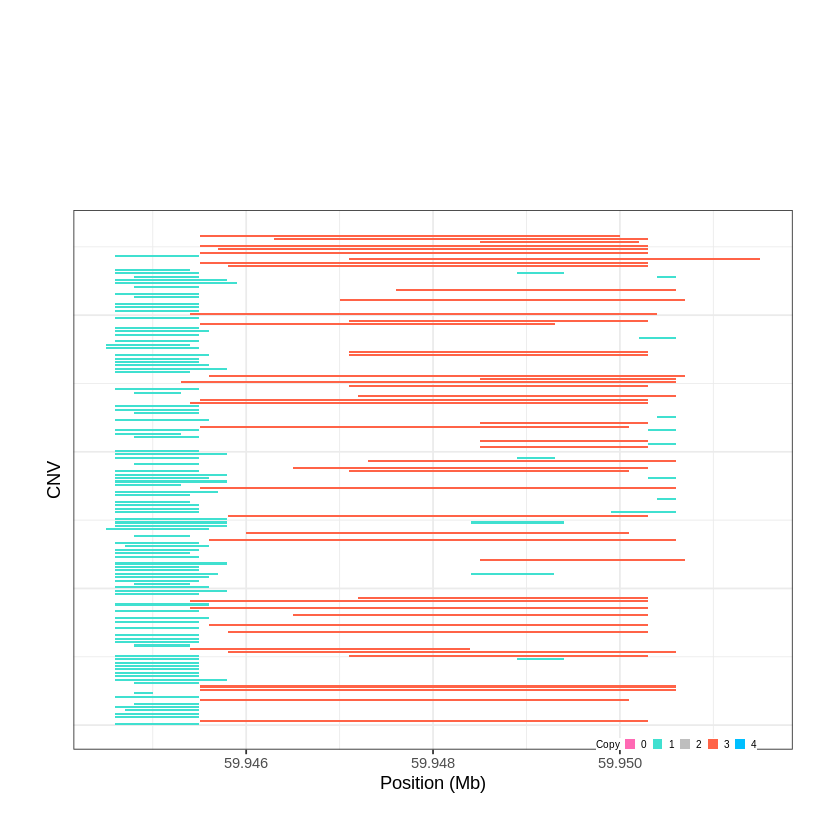

Task done, plot was stored in working directory.
[1] "Ploting CNVR 556..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 61.915901 - 61.9532 Mb with 171 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


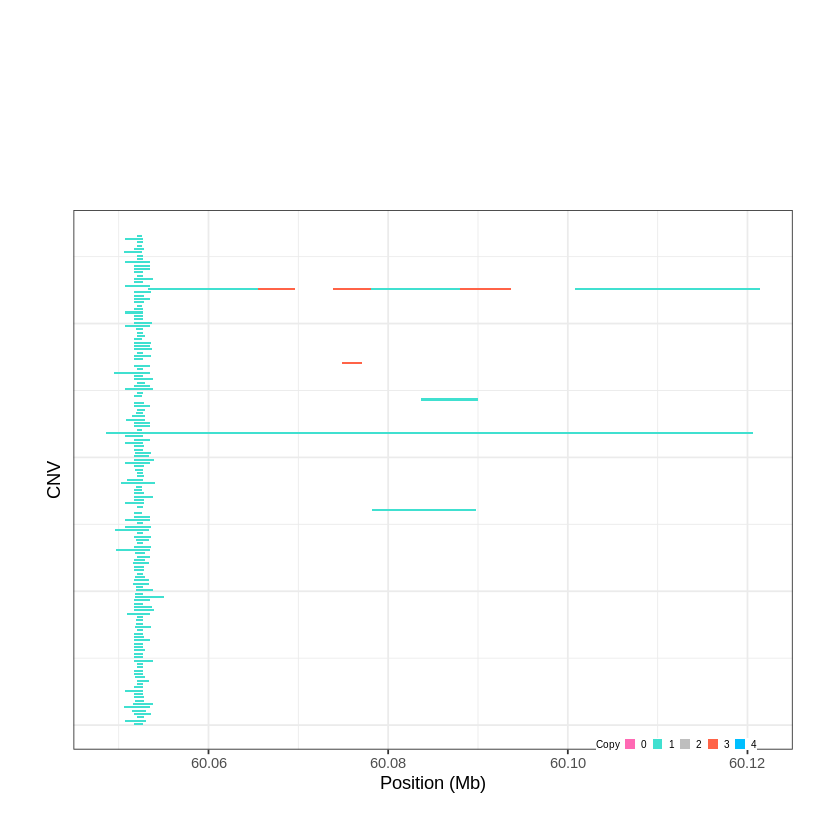

Task done, plot was stored in working directory.
[1] "Ploting CNVR 557..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 62.497301 - 62.5077 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


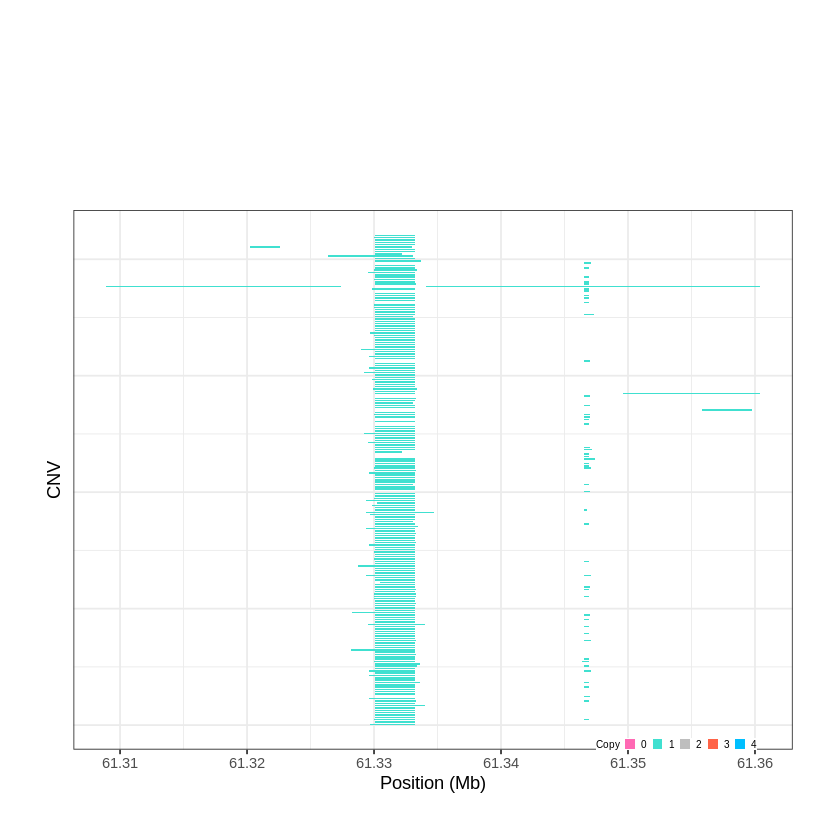

Task done, plot was stored in working directory.
[1] "Ploting CNVR 558..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 64.066601 - 64.0838 Mb with 239 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


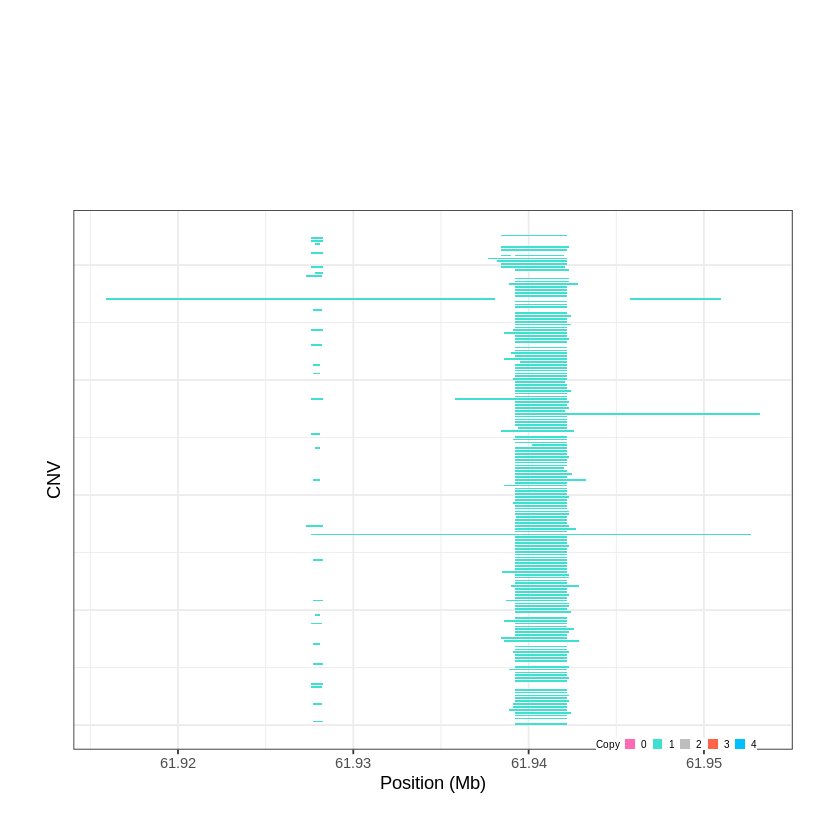

Task done, plot was stored in working directory.
[1] "Ploting CNVR 559..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 64.097201 - 64.116 Mb with 243 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


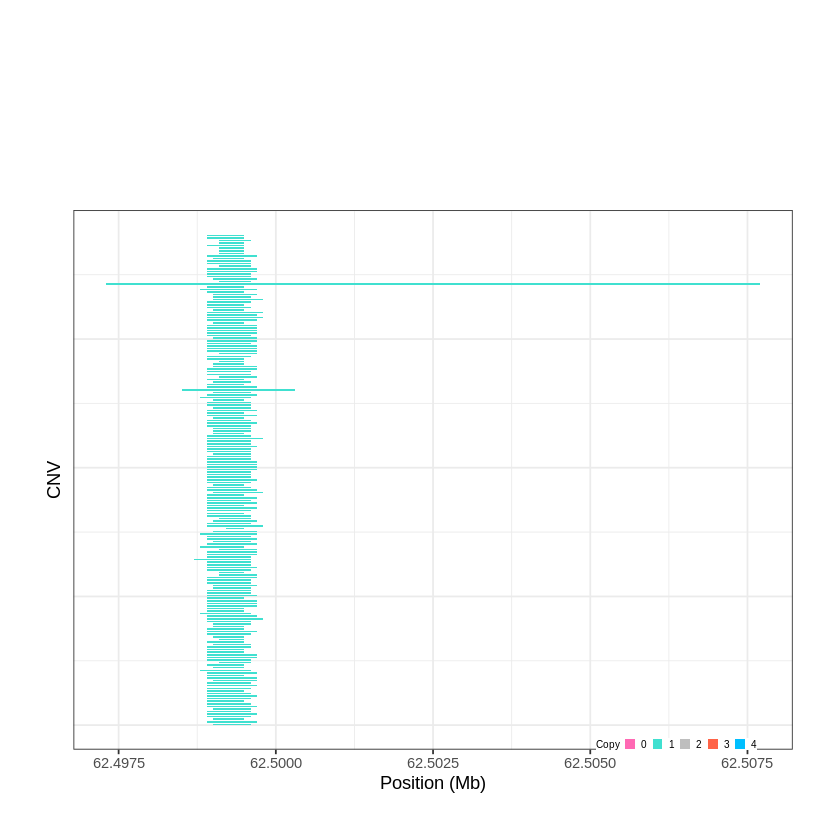

Task done, plot was stored in working directory.
[1] "Ploting CNVR 560..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 64.686101 - 64.7822 Mb with 260 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


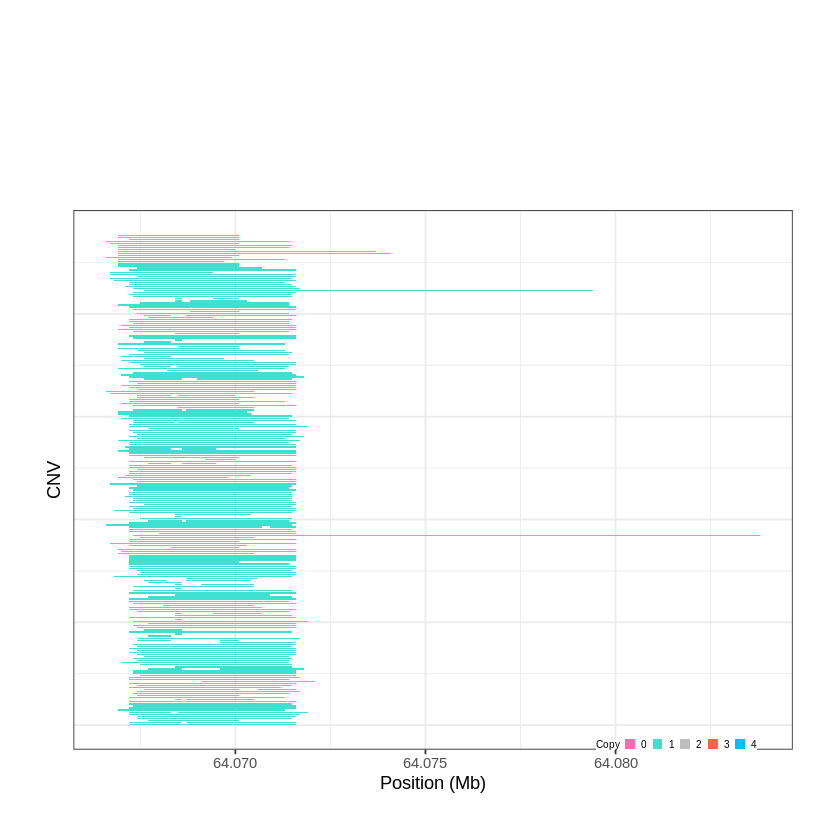

Task done, plot was stored in working directory.
[1] "Ploting CNVR 561..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 66.641101 - 66.6414 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


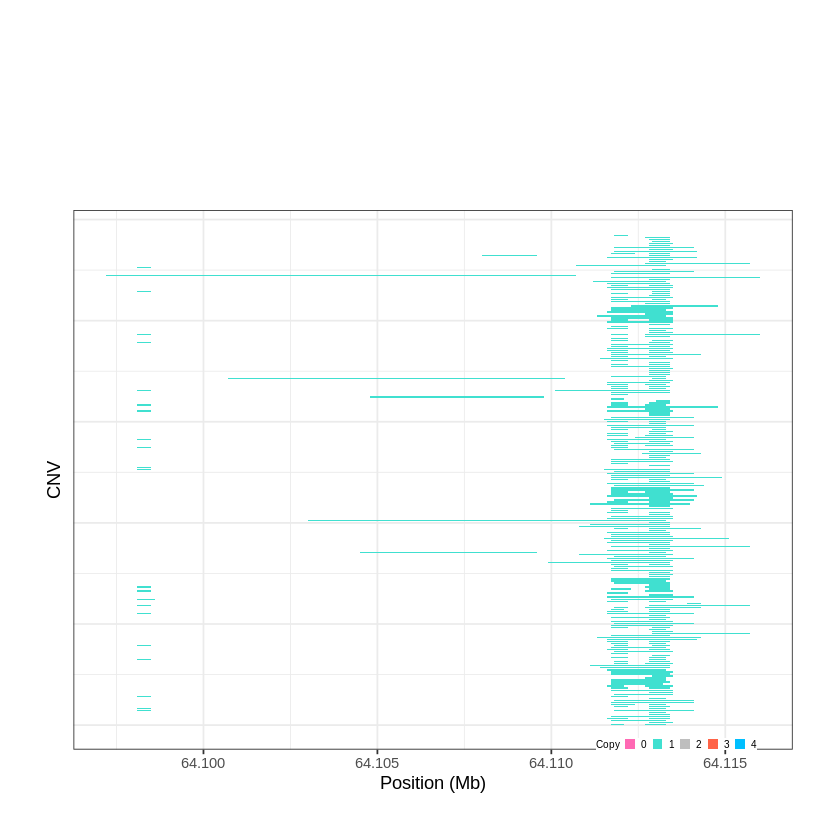

Task done, plot was stored in working directory.
[1] "Ploting CNVR 562..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 68.253201 - 68.27 Mb with 277 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


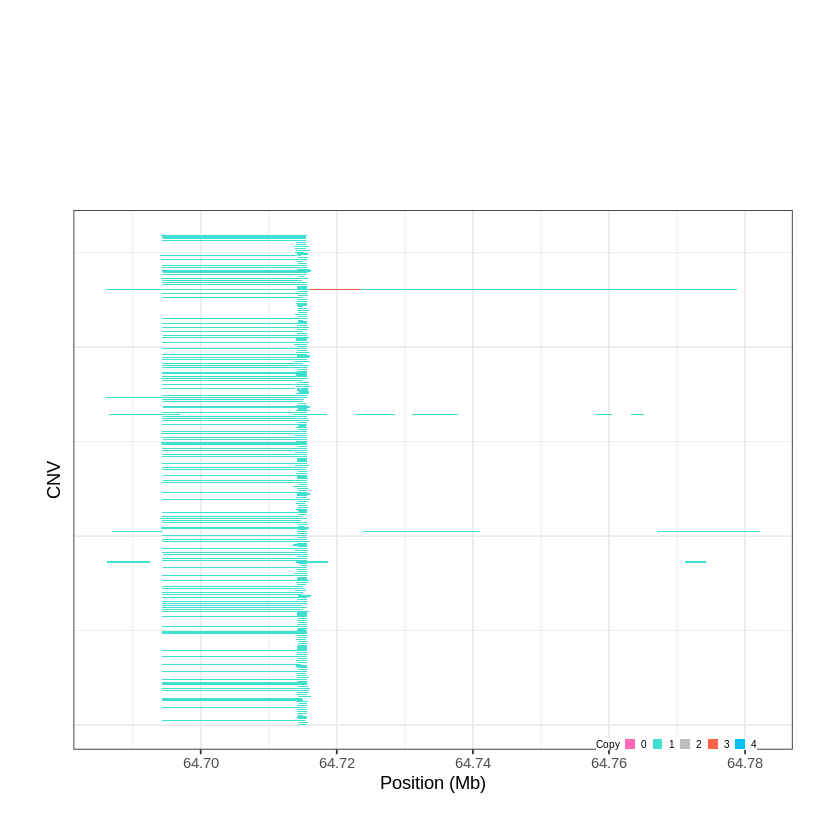

Task done, plot was stored in working directory.
[1] "Ploting CNVR 563..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 69.061501 - 69.0853 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


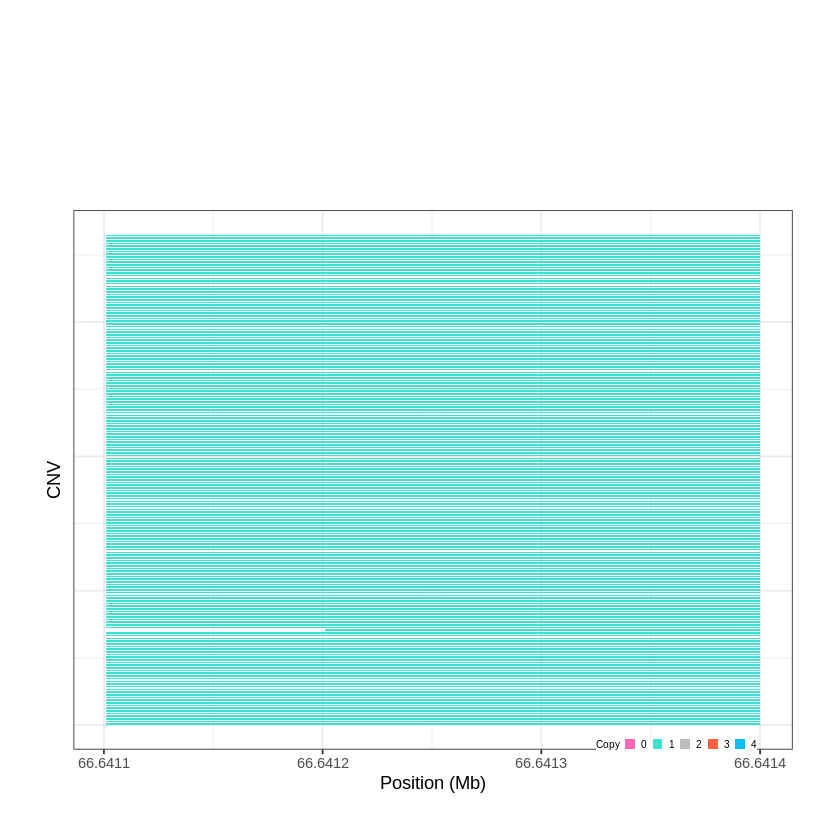

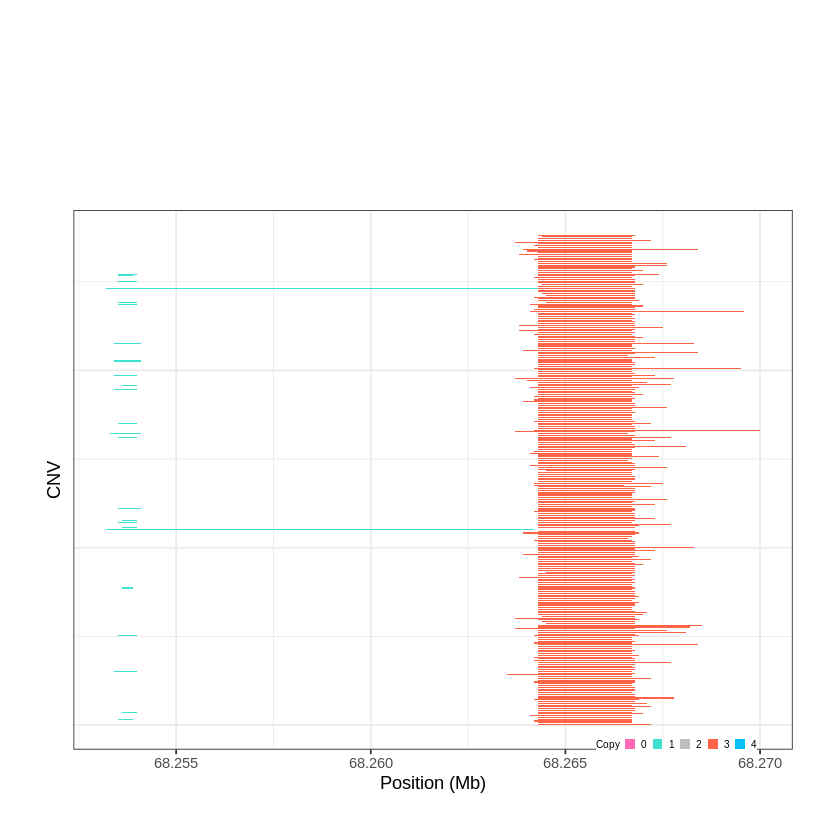

Task done, plot was stored in working directory.
[1] "Ploting CNVR 564..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 69.357201 - 69.5343 Mb with 230 Individual - "
Plotting gene...


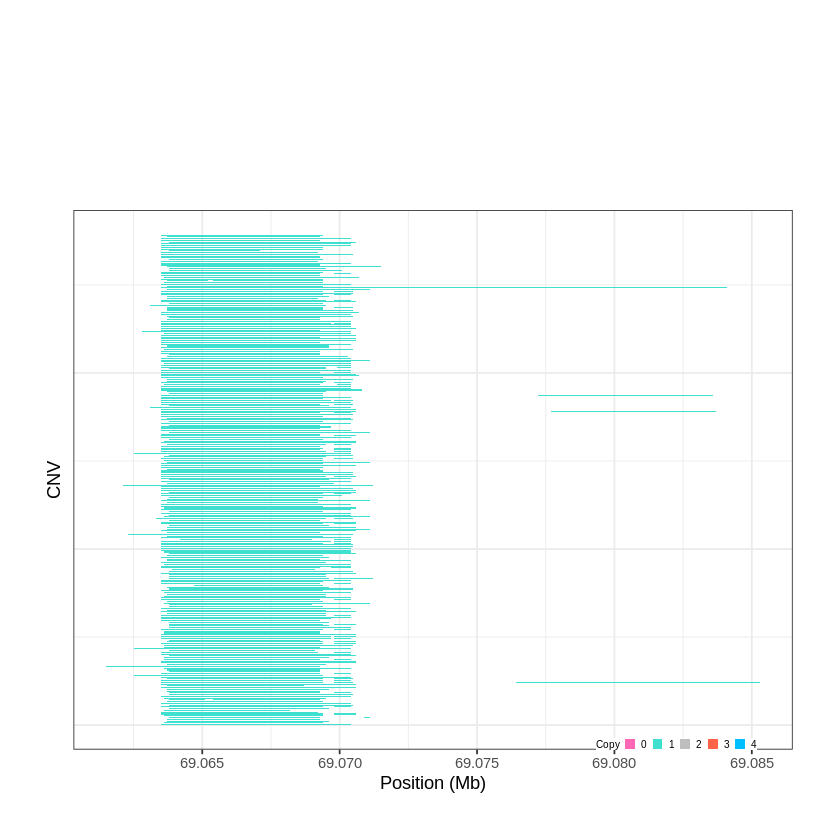

Task done, plot was stored in working directory.
[1] "Ploting CNVR 565..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 69.999801 - 70.1123 Mb with 149 Individual - "
Plotting gene...


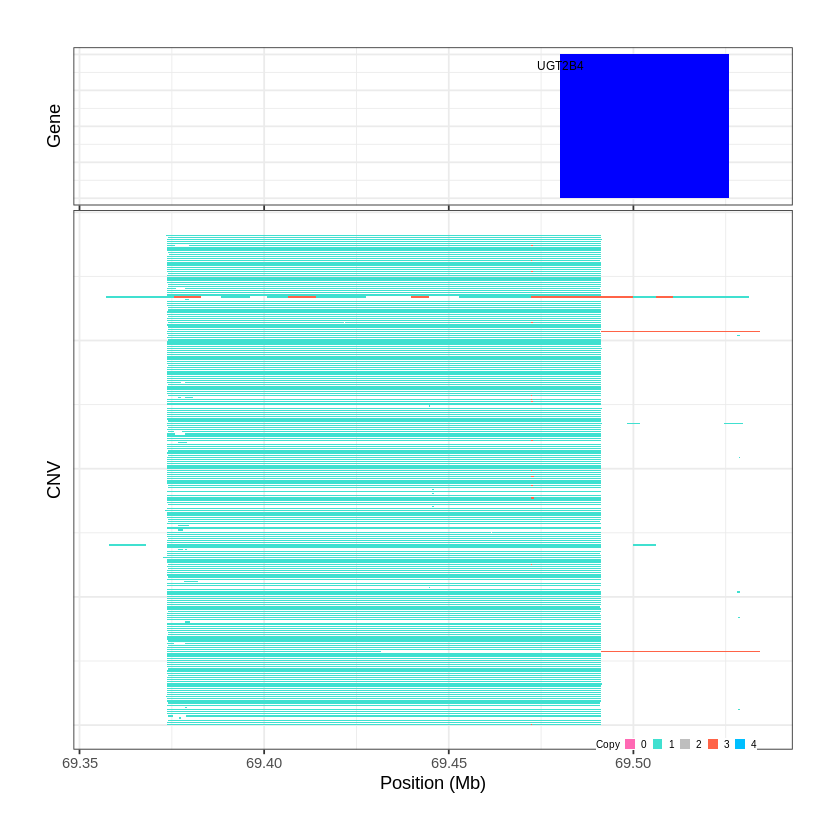

Task done, plot was stored in working directory.
[1] "Ploting CNVR 566..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 70.112301 - 70.2396 Mb with 219 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 567..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 75.262601 - 75.3589 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


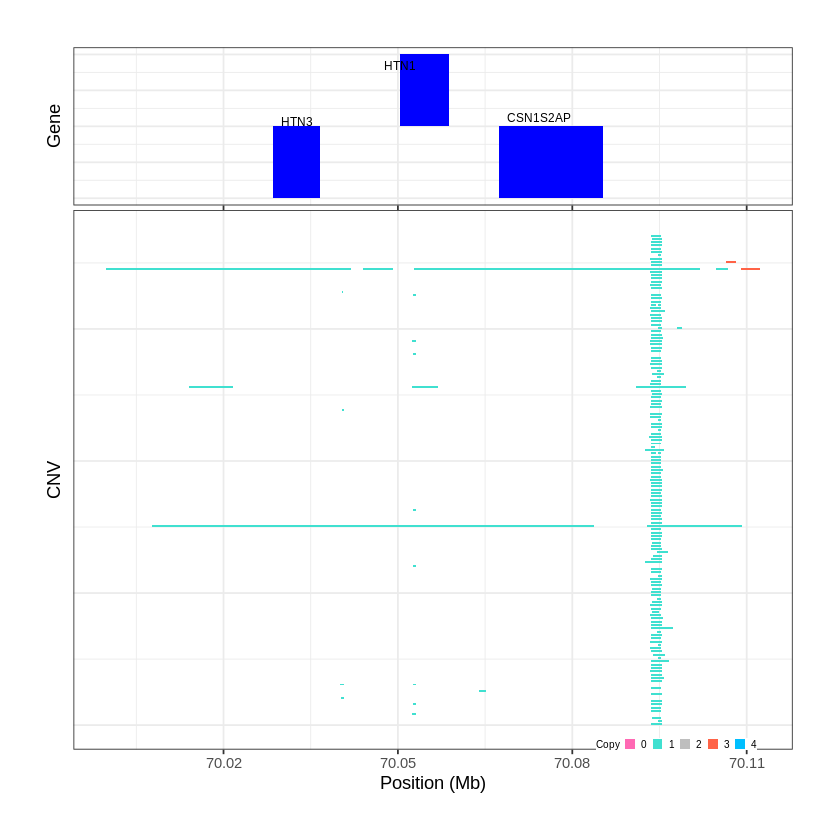

Task done, plot was stored in working directory.
[1] "Ploting CNVR 568..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 75.425501 - 75.5009 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


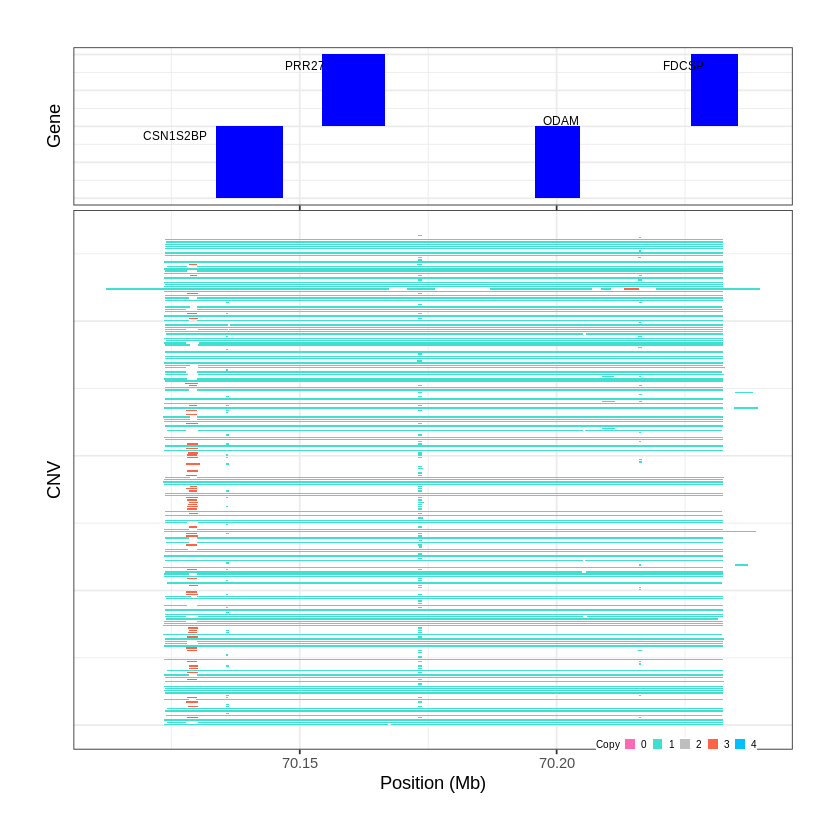

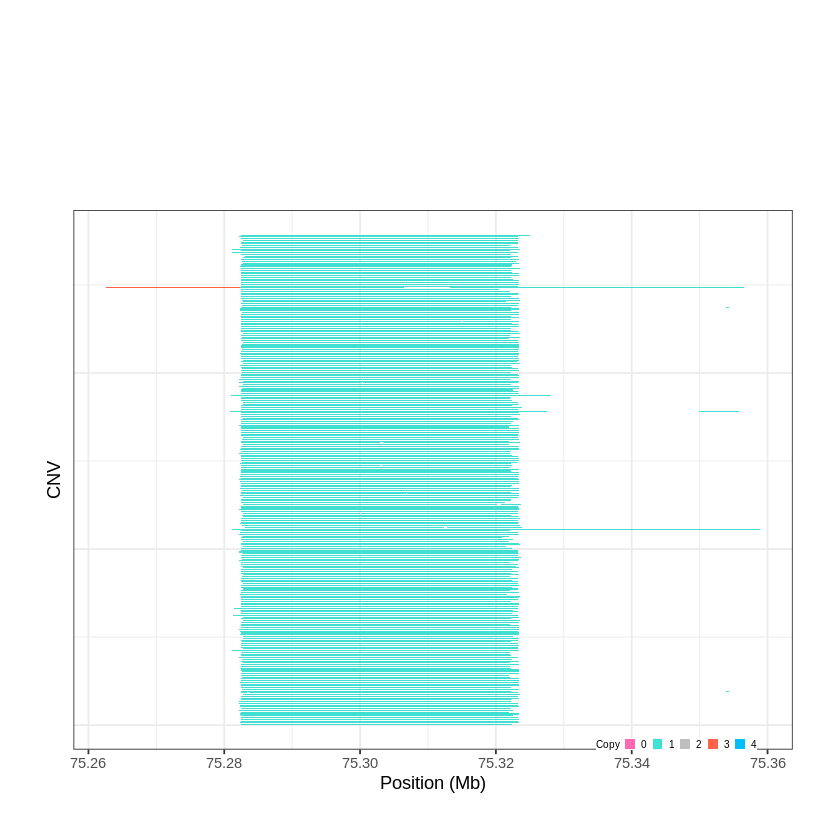

Task done, plot was stored in working directory.
[1] "Ploting CNVR 569..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 76.187701 - 76.4796 Mb with 182 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 570..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 81.692601 - 81.7235 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


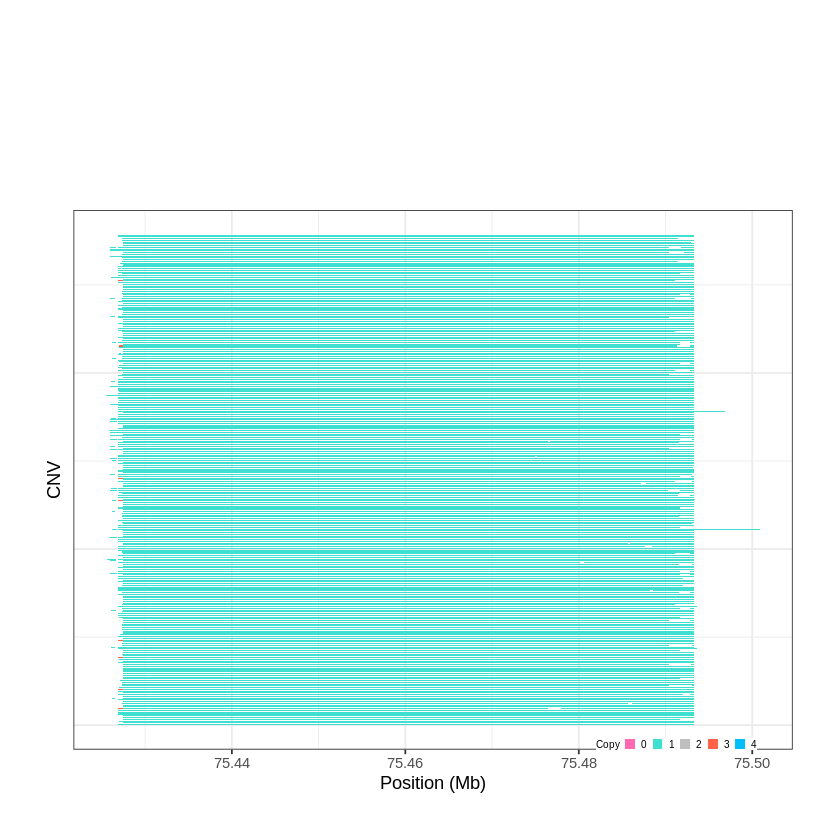

Task done, plot was stored in working directory.
[1] "Ploting CNVR 571..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 86.660801 - 86.6611 Mb with 223 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


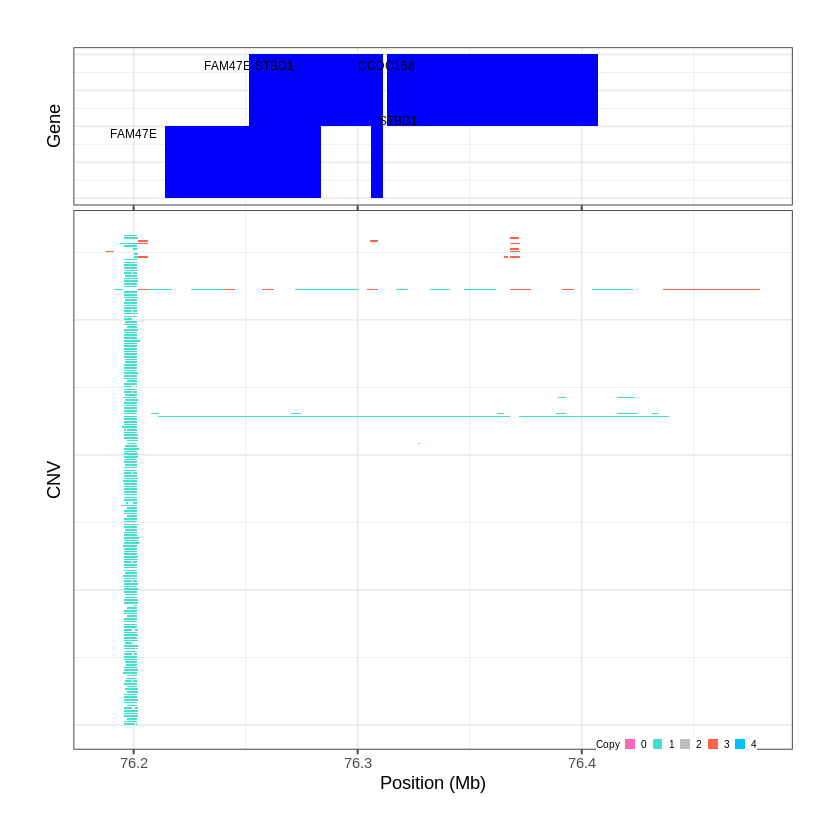

Task done, plot was stored in working directory.
[1] "Ploting CNVR 572..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 86.778301 - 86.7982 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


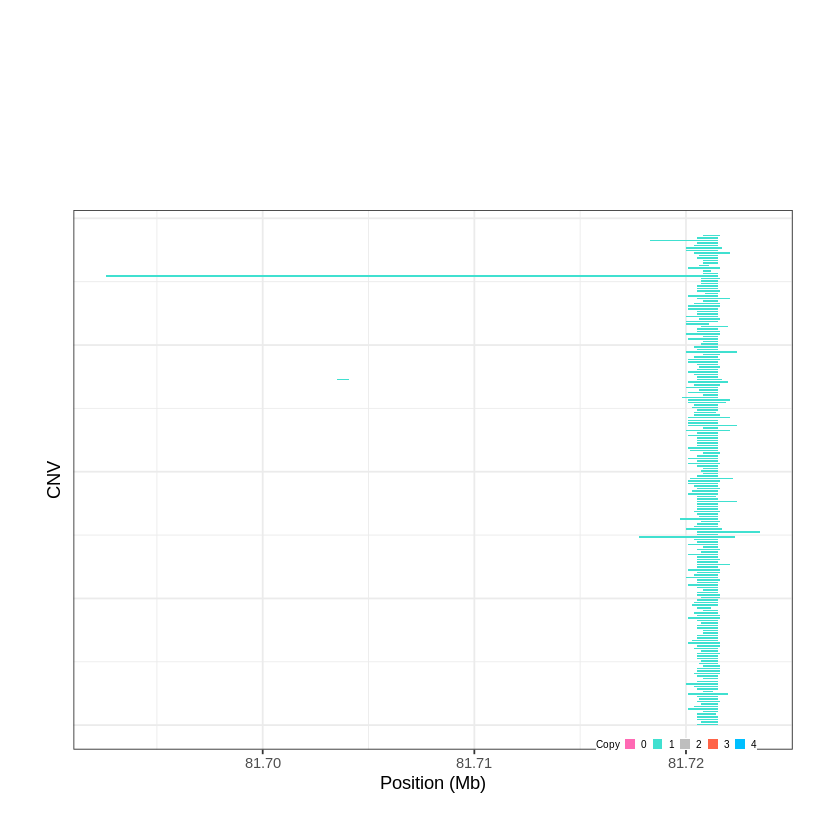

Task done, plot was stored in working directory.
[1] "Ploting CNVR 573..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 88.845201 - 88.8635 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


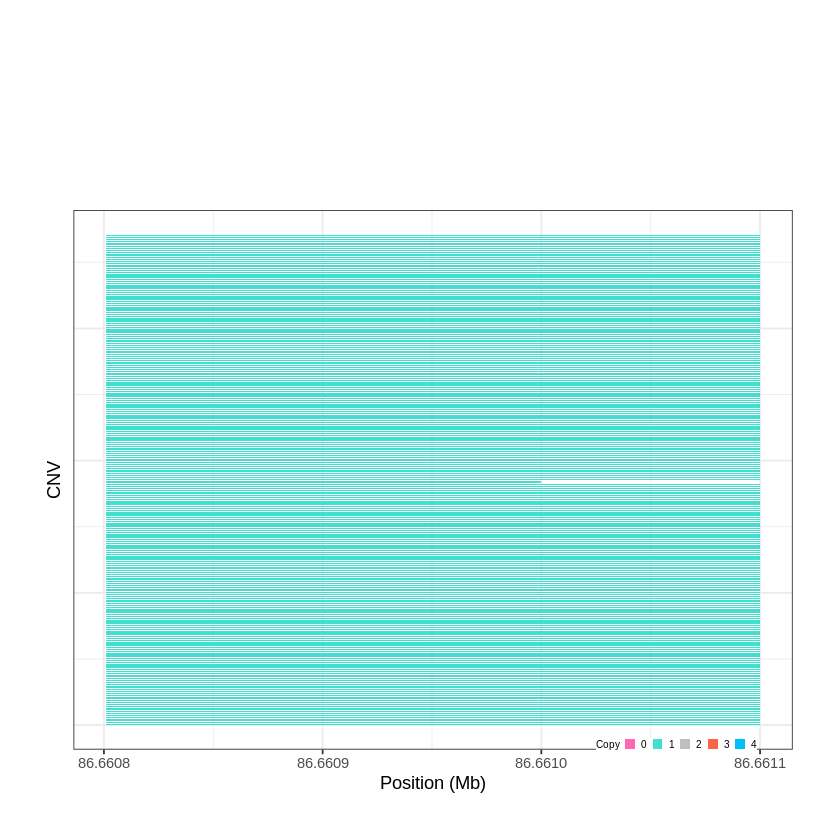

Task done, plot was stored in working directory.
[1] "Ploting CNVR 574..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 89.009101 - 89.0419 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


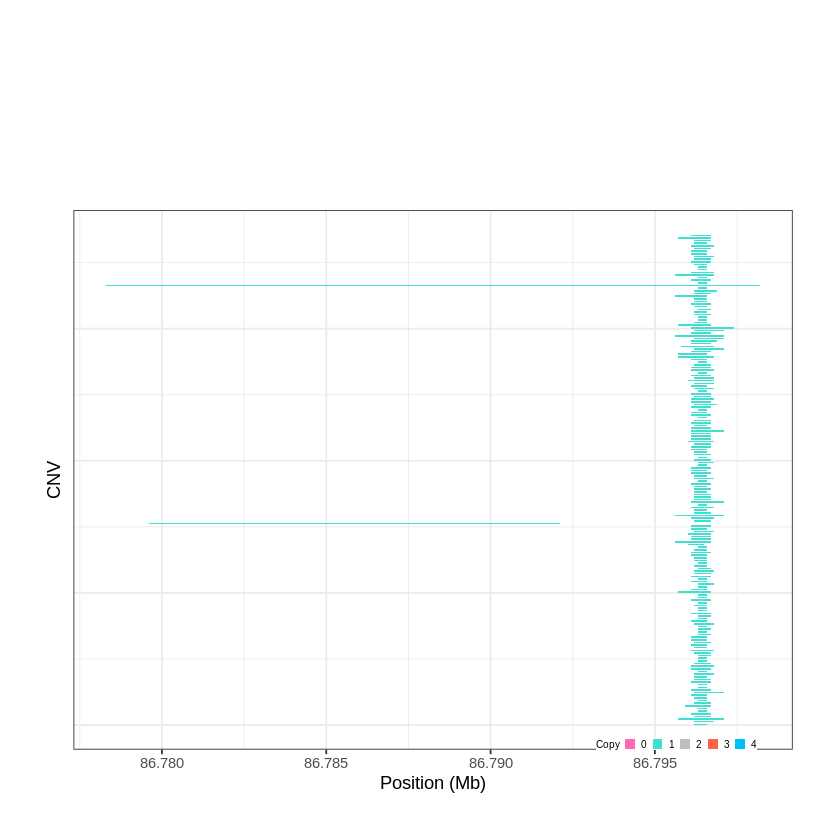

Task done, plot was stored in working directory.
[1] "Ploting CNVR 575..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 89.398001 - 89.399 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


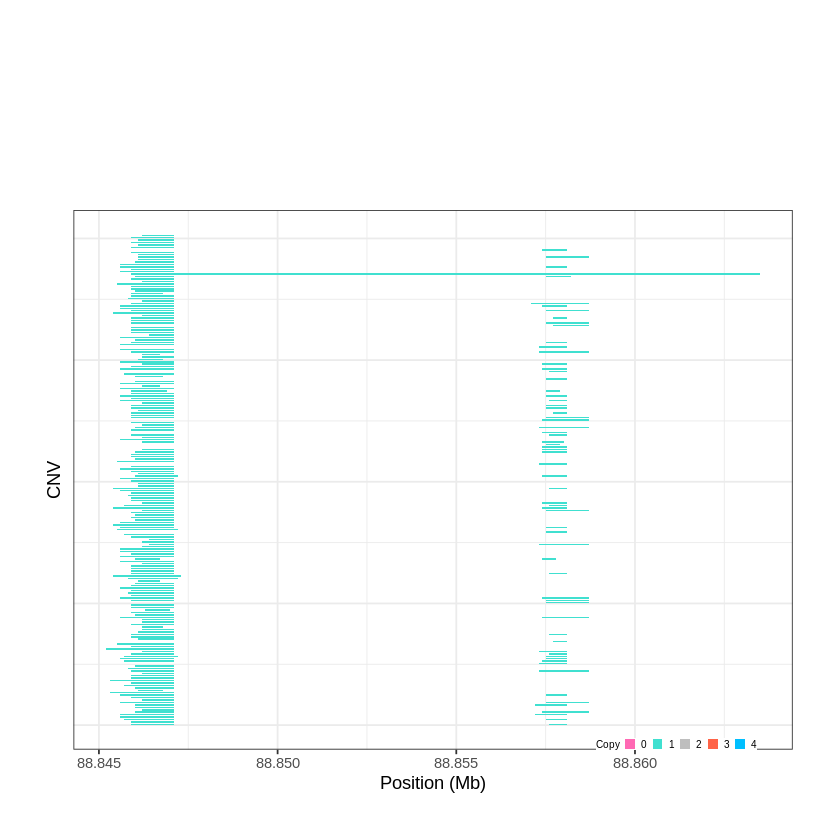

Task done, plot was stored in working directory.
[1] "Ploting CNVR 576..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 90.017401 - 90.0223 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


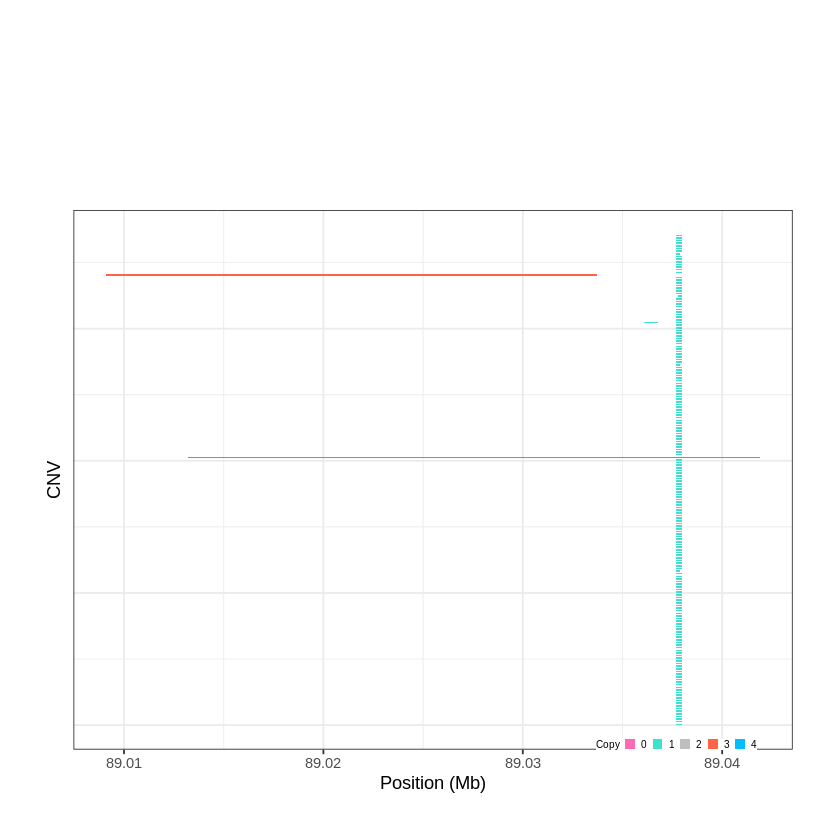

Task done, plot was stored in working directory.
[1] "Ploting CNVR 577..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 92.115901 - 92.1706 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


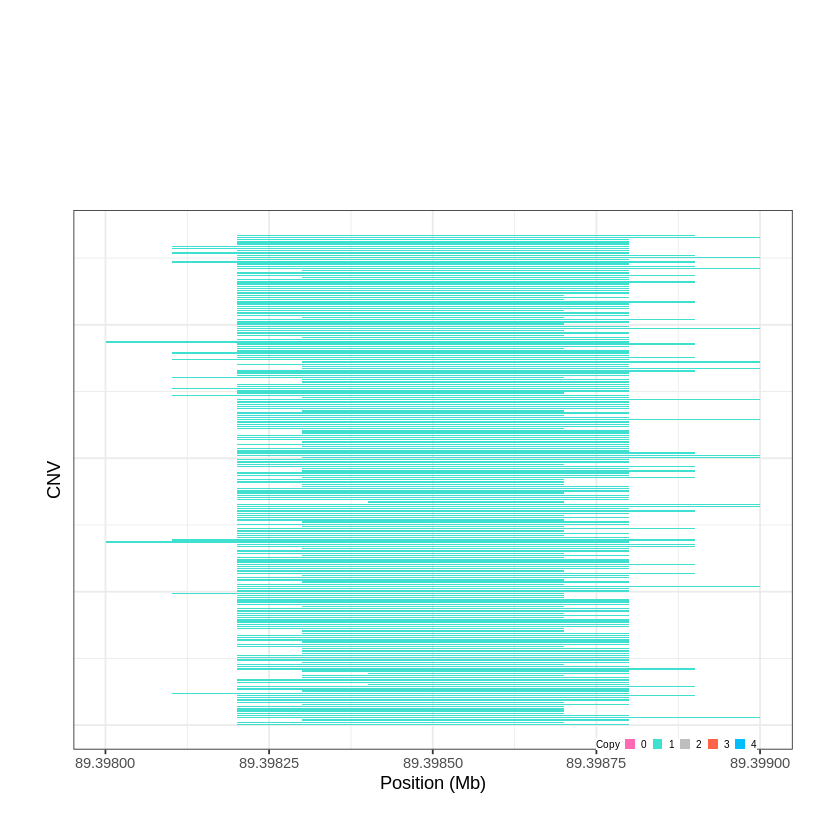

Task done, plot was stored in working directory.
[1] "Ploting CNVR 578..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 93.555201 - 93.5938 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


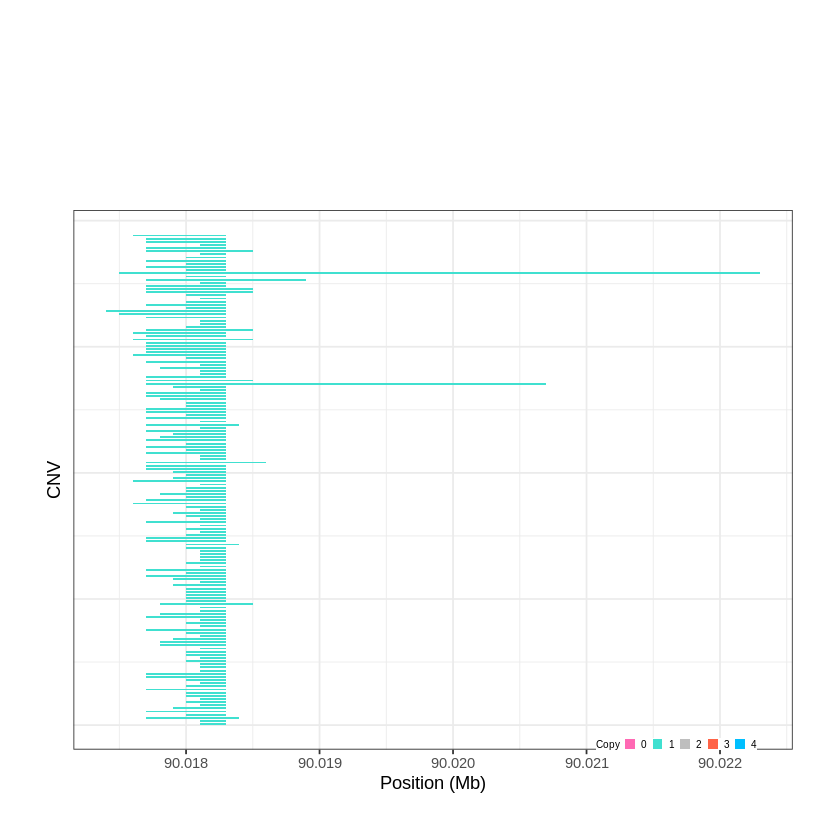

Task done, plot was stored in working directory.
[1] "Ploting CNVR 579..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 95.499001 - 95.4993 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


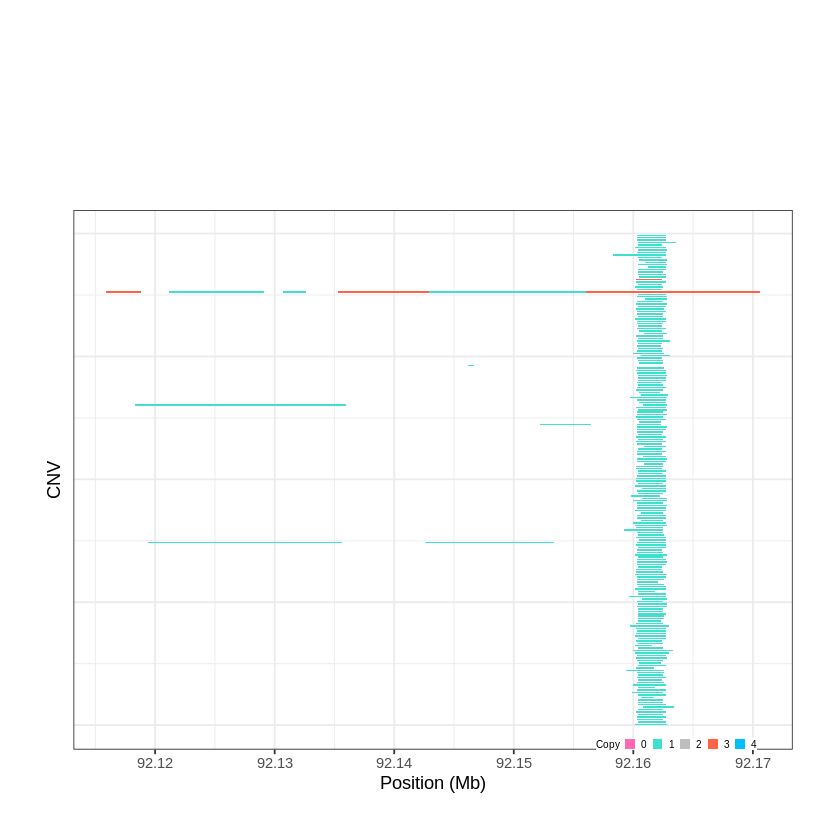

Task done, plot was stored in working directory.
[1] "Ploting CNVR 580..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 100.061501 - 100.0785 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


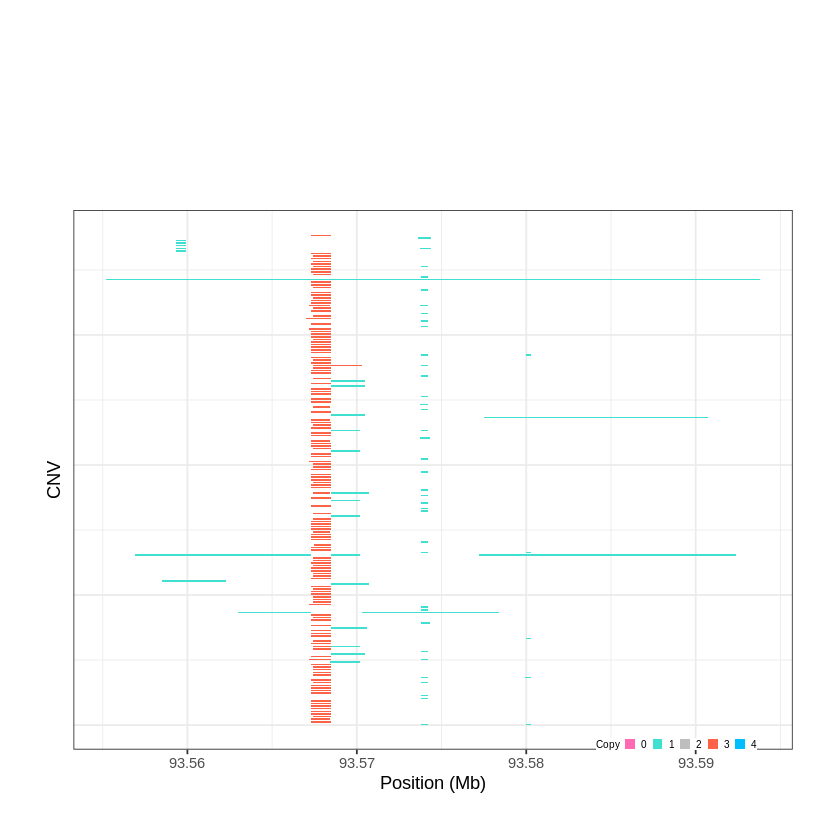

Task done, plot was stored in working directory.
[1] "Ploting CNVR 581..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 102.668901 - 102.673 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


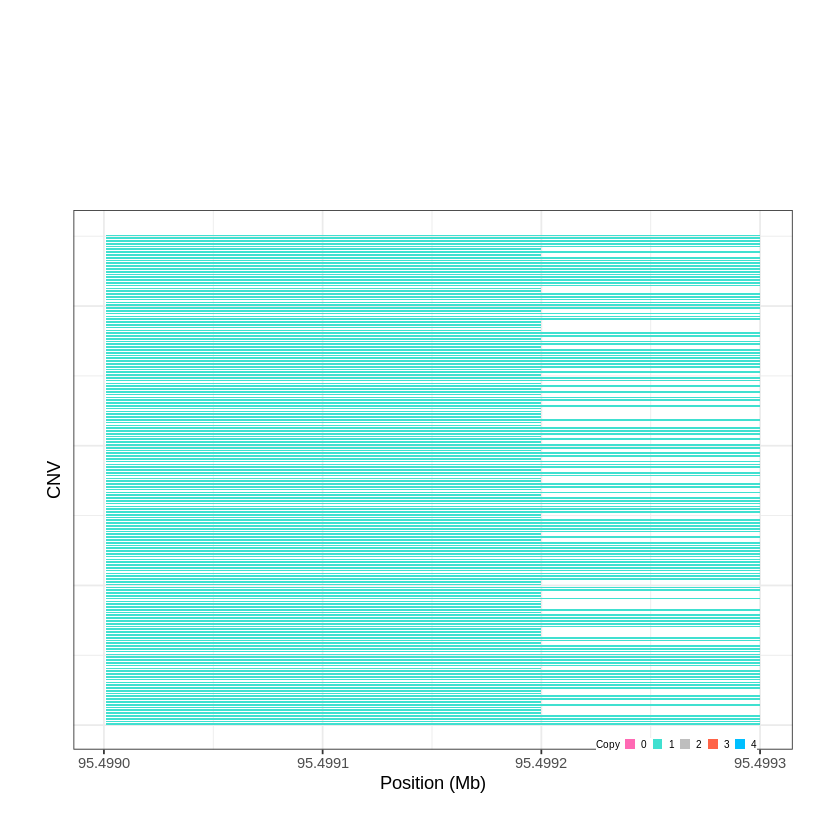

Task done, plot was stored in working directory.
[1] "Ploting CNVR 582..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 103.326901 - 103.3462 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


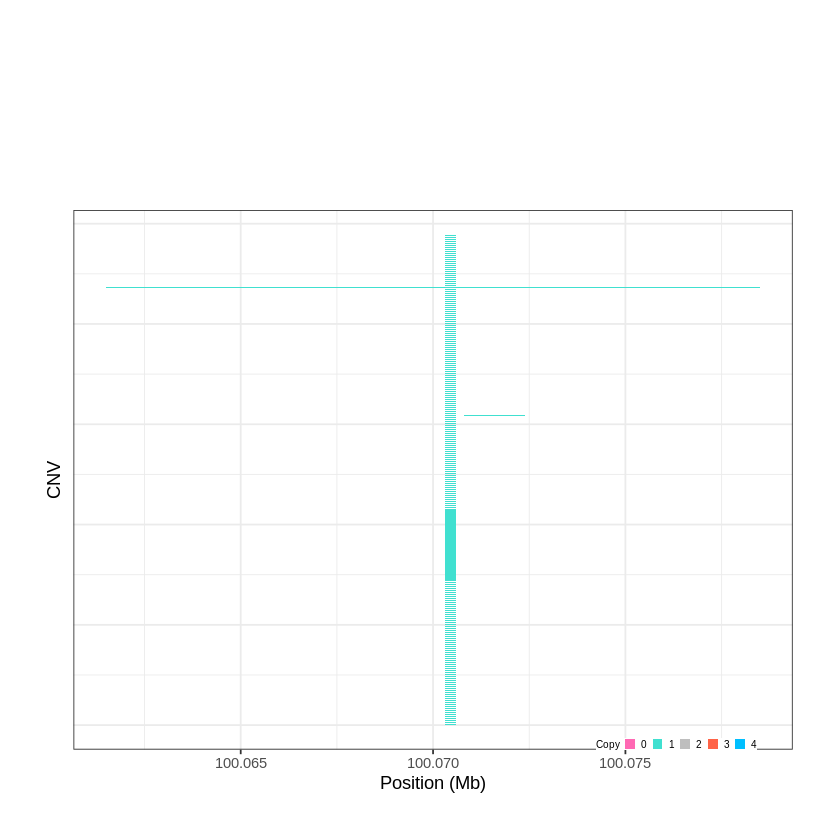

Task done, plot was stored in working directory.
[1] "Ploting CNVR 583..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 104.880001 - 104.919 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


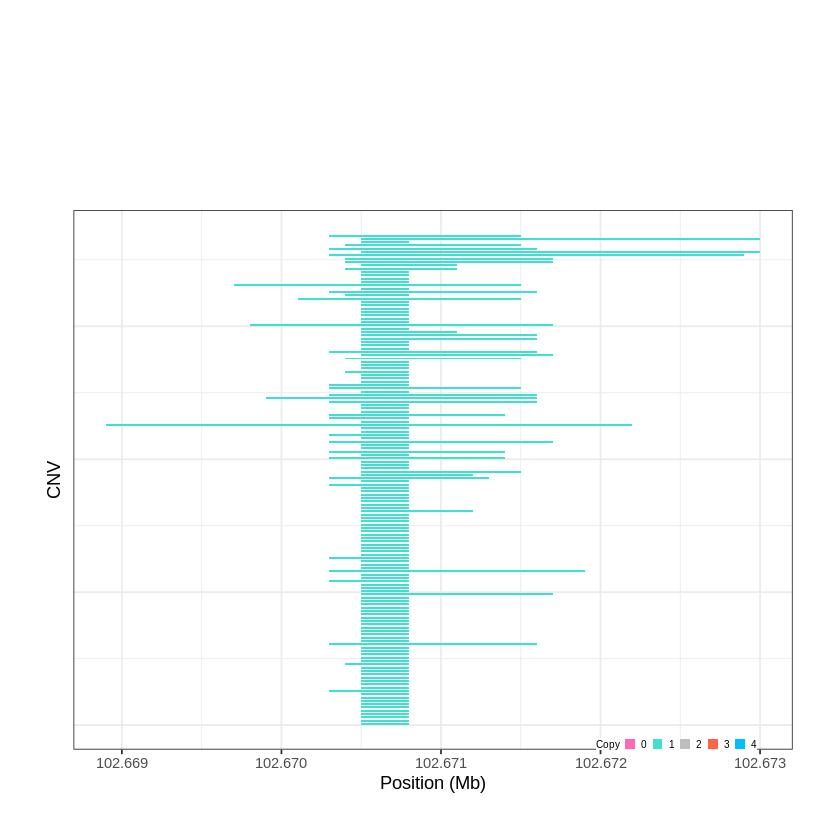

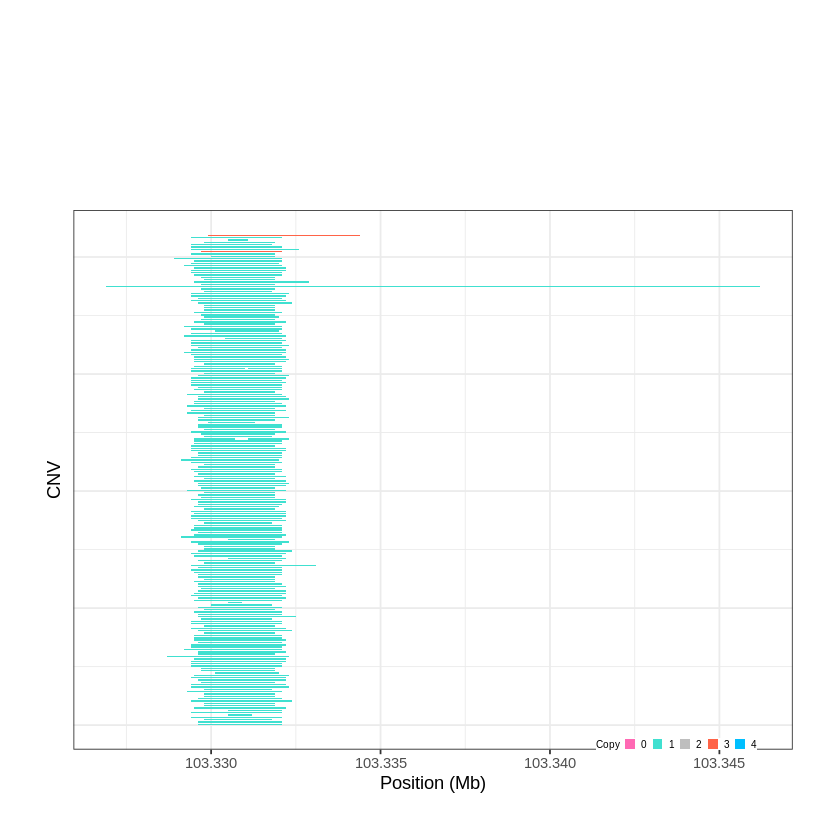

Task done, plot was stored in working directory.
[1] "Ploting CNVR 584..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 108.122501 - 108.5906 Mb with 218 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 585..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 109.720601 - 109.7228 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


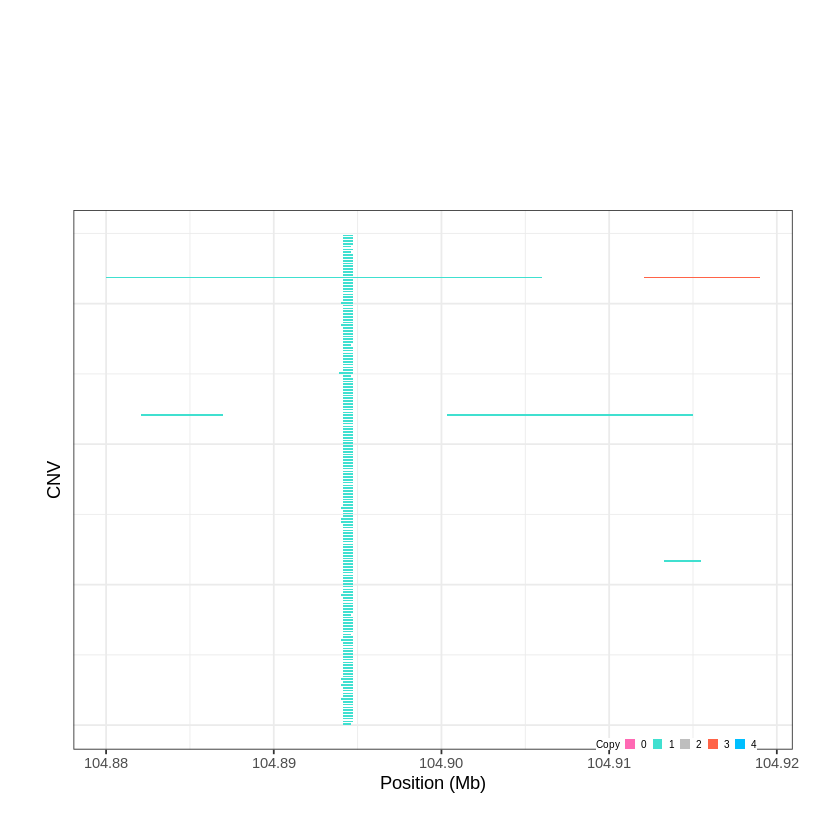

Task done, plot was stored in working directory.
[1] "Ploting CNVR 586..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 111.516301 - 111.5165 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


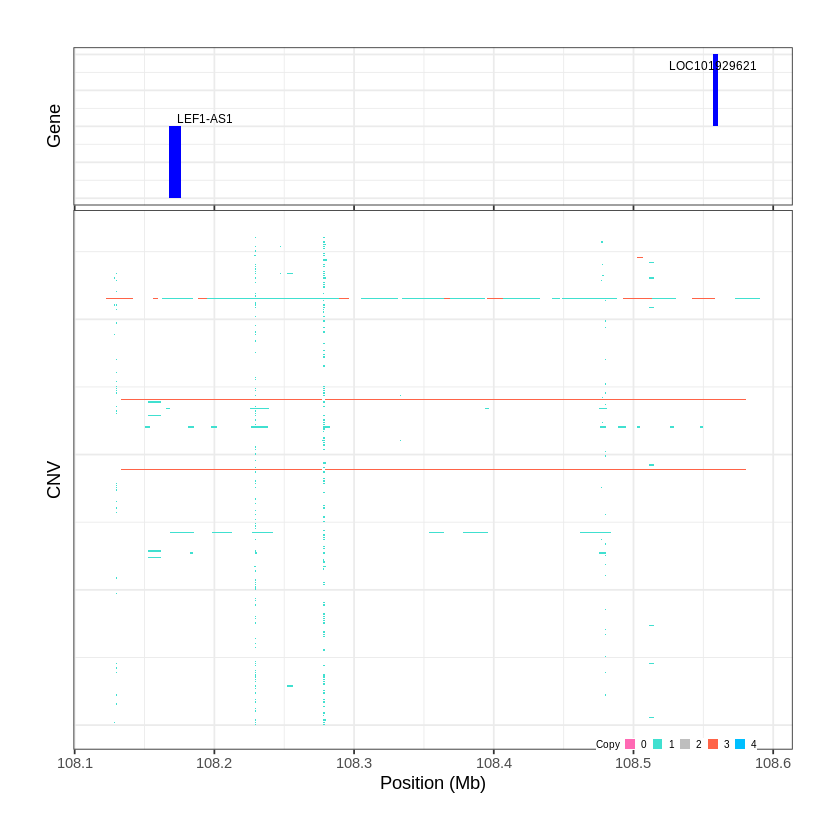

Task done, plot was stored in working directory.
[1] "Ploting CNVR 587..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 111.992601 - 112.0279 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


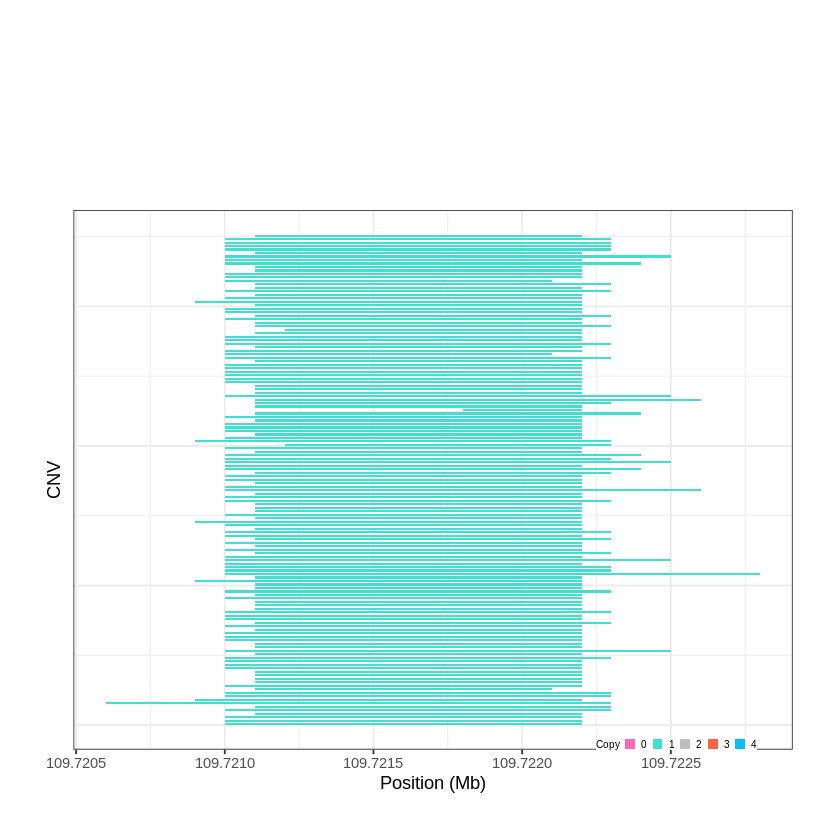

Task done, plot was stored in working directory.
[1] "Ploting CNVR 588..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 112.791301 - 112.8222 Mb with 190 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


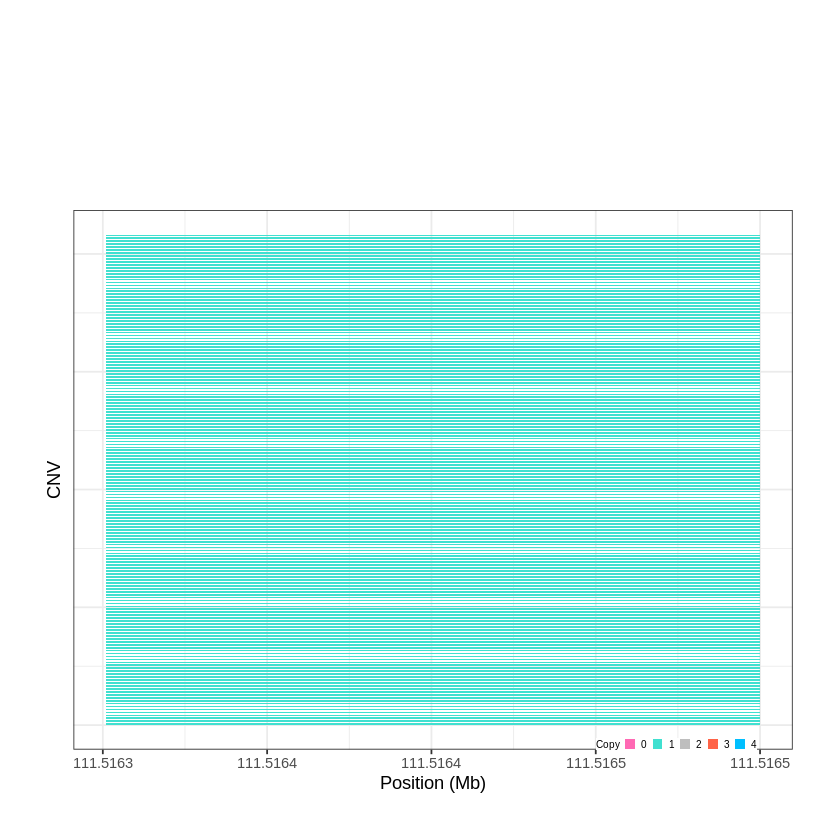

Task done, plot was stored in working directory.
[1] "Ploting CNVR 589..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 113.470001 - 113.4703 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


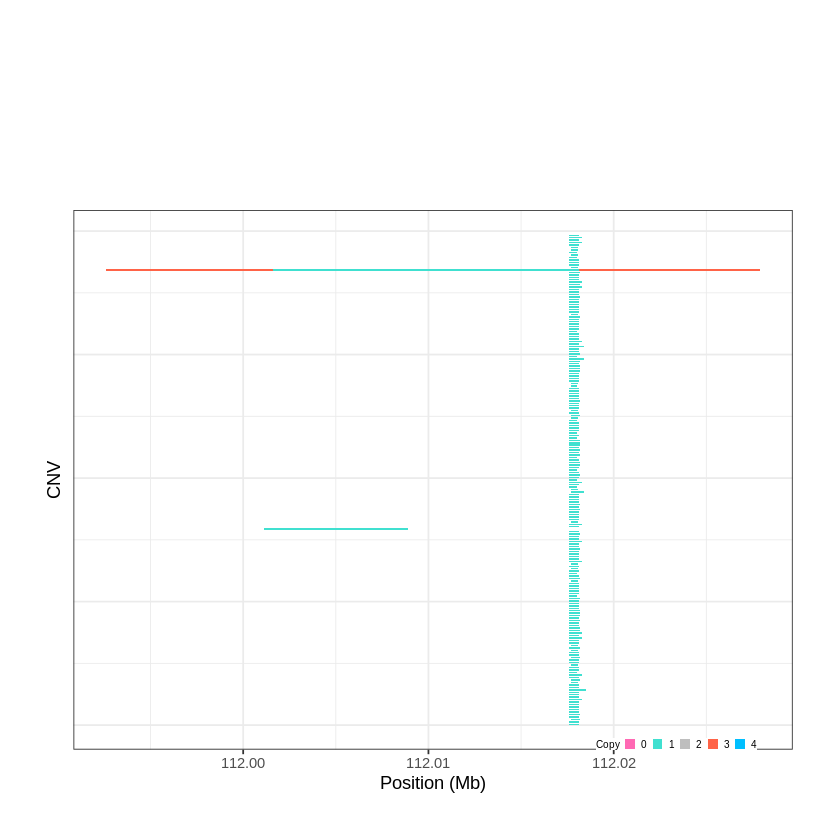

Task done, plot was stored in working directory.
[1] "Ploting CNVR 590..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 113.496401 - 113.5167 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


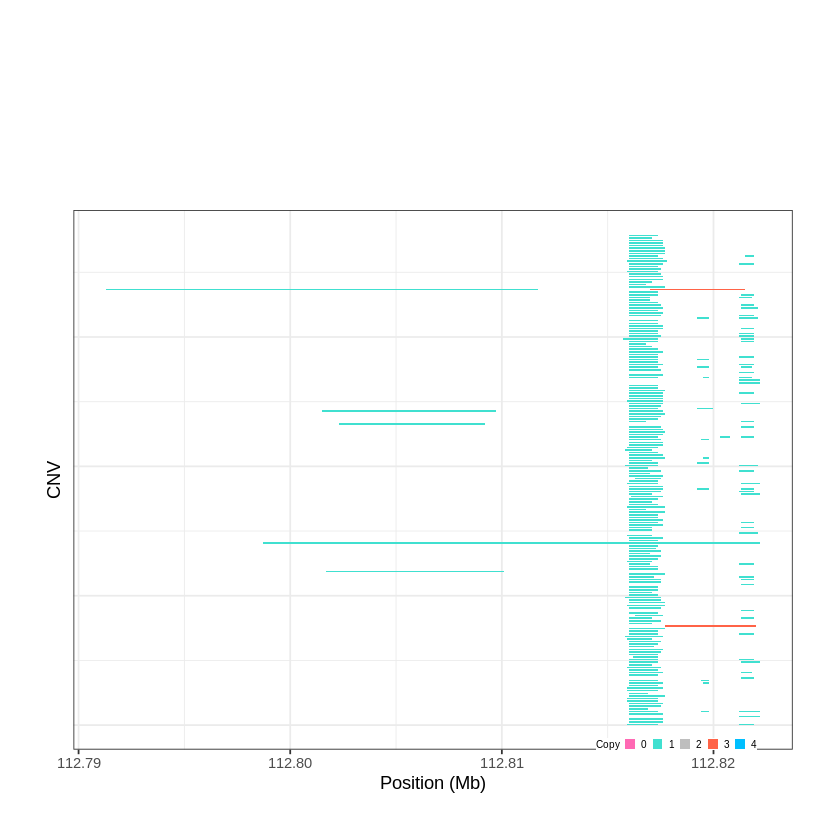

Task done, plot was stored in working directory.
[1] "Ploting CNVR 591..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 113.941101 - 113.9935 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


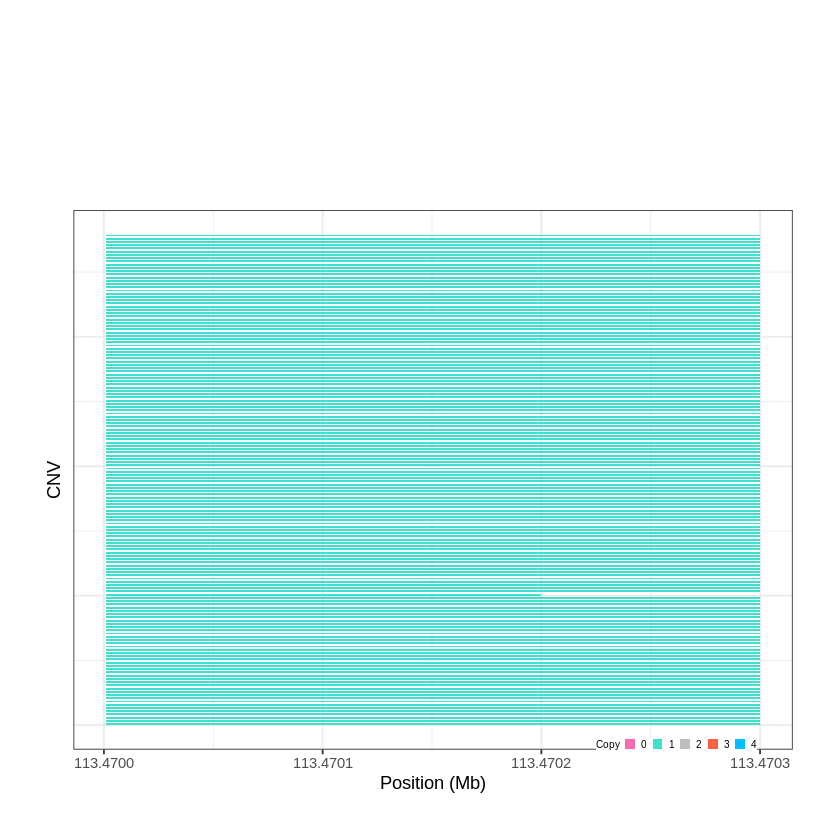

Task done, plot was stored in working directory.
[1] "Ploting CNVR 592..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 115.156401 - 115.2062 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


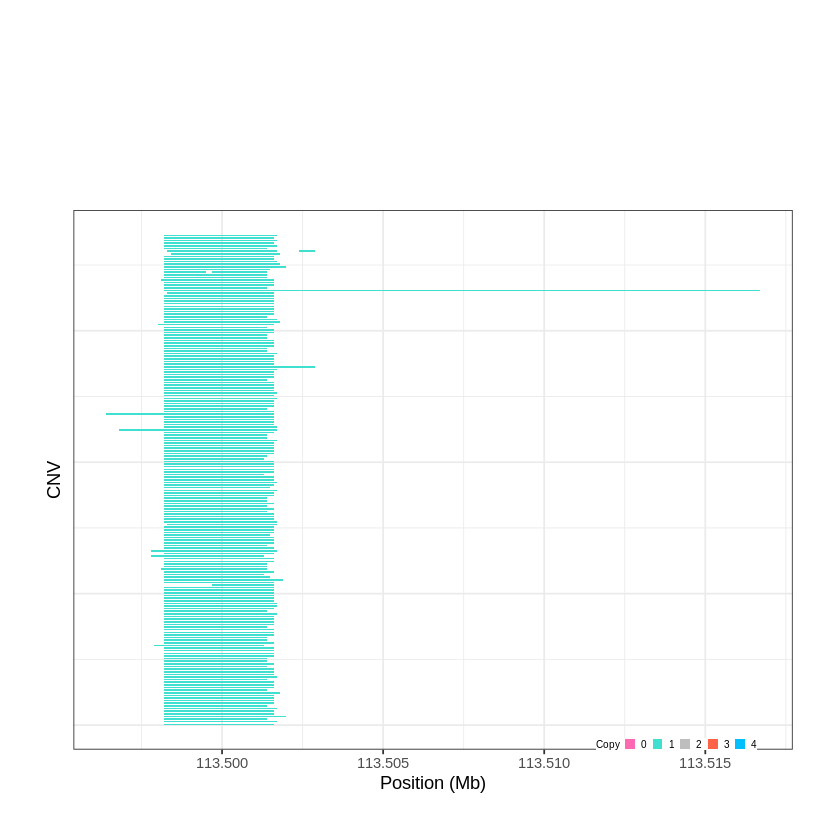

Task done, plot was stored in working directory.
[1] "Ploting CNVR 593..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 115.607601 - 115.6364 Mb with 157 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


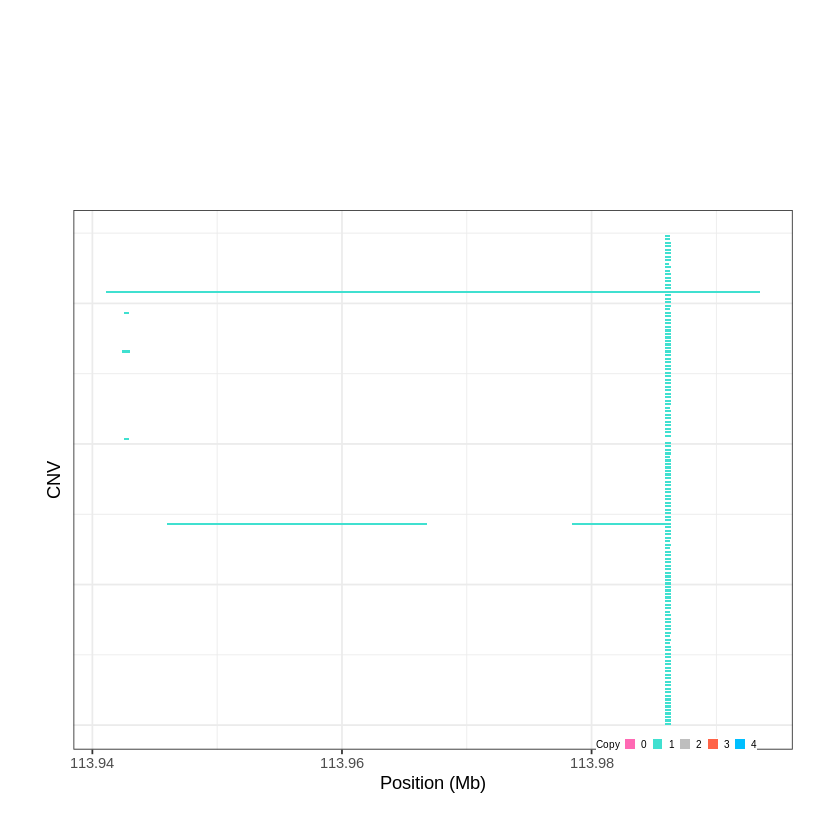

Task done, plot was stored in working directory.
[1] "Ploting CNVR 594..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 115.910301 - 115.9879 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


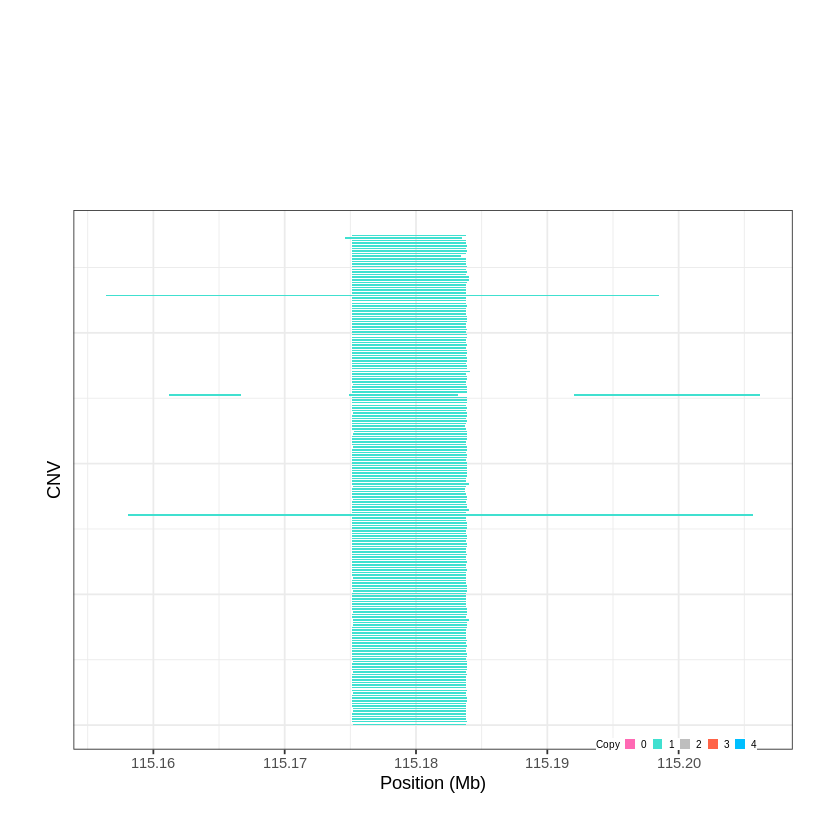

Task done, plot was stored in working directory.
[1] "Ploting CNVR 595..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 126.483101 - 126.5307 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


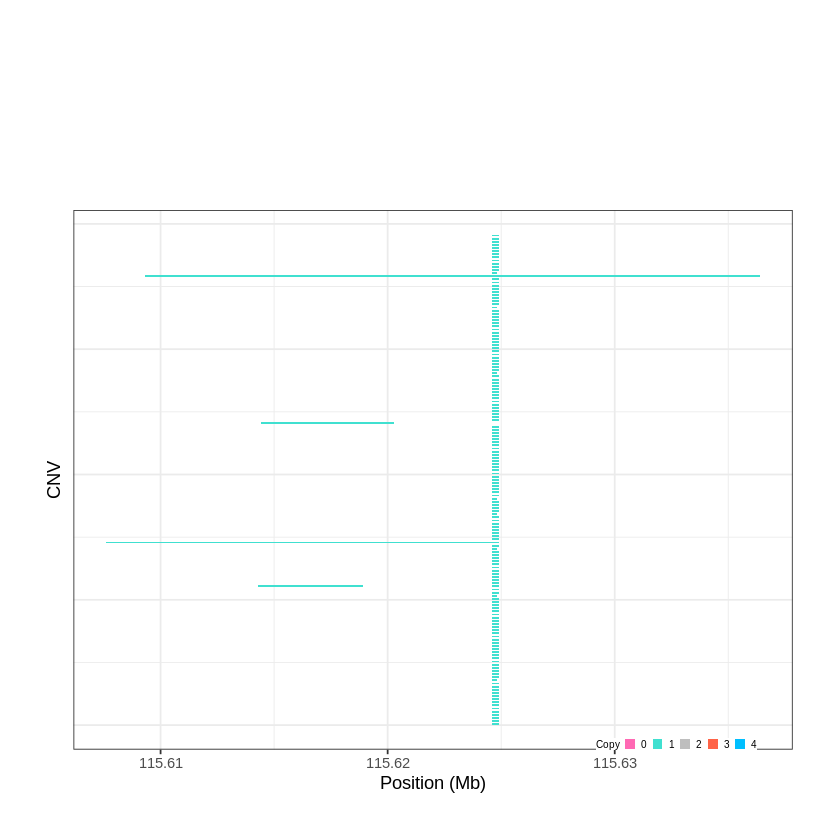

Task done, plot was stored in working directory.
[1] "Ploting CNVR 596..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 130.061001 - 130.0715 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


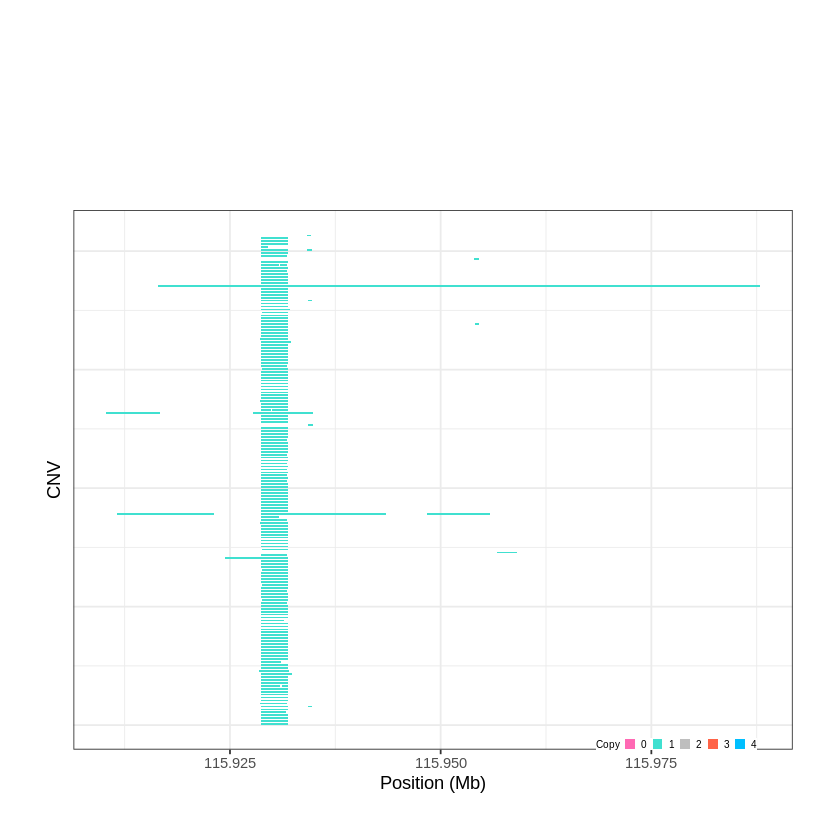

Task done, plot was stored in working directory.
[1] "Ploting CNVR 597..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 132.609101 - 132.685 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


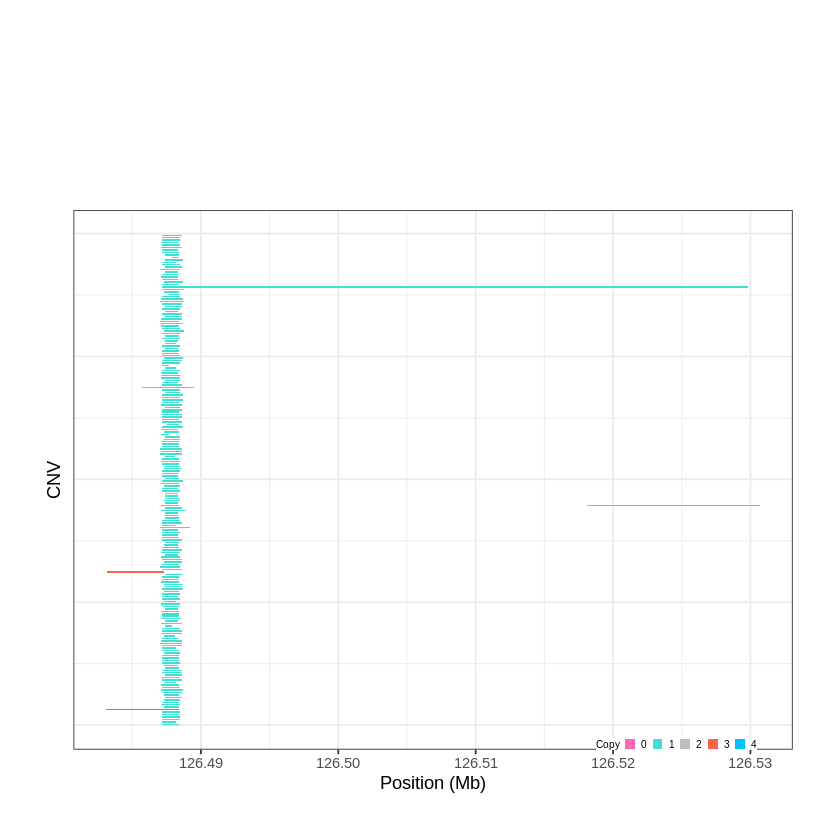

Task done, plot was stored in working directory.
[1] "Ploting CNVR 598..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 133.171601 - 133.1911 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


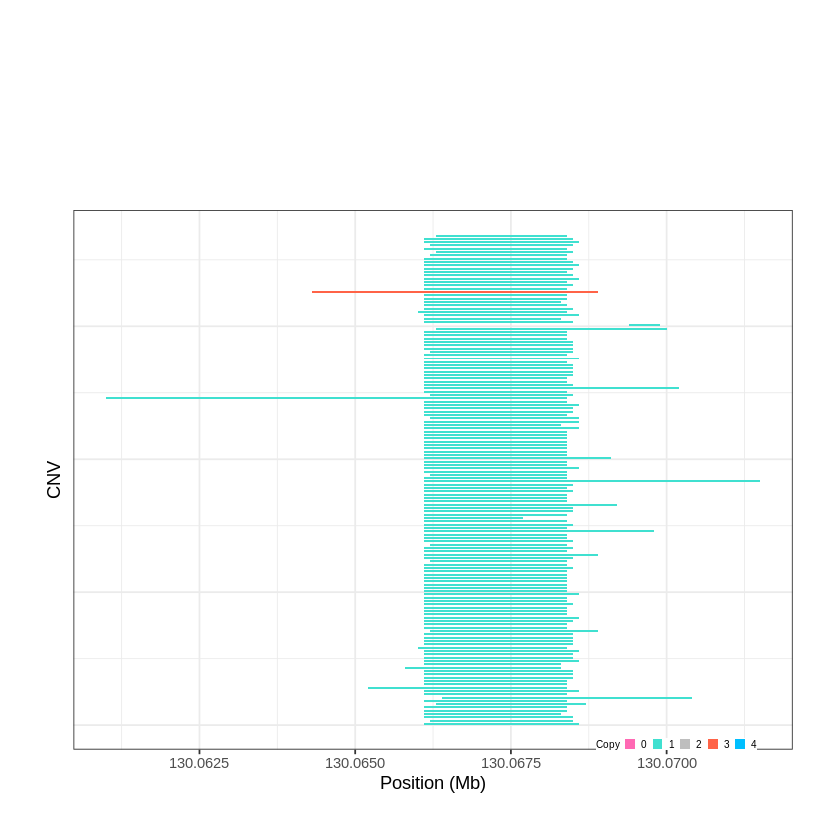

Task done, plot was stored in working directory.
[1] "Ploting CNVR 599..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 133.590001 - 133.6437 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


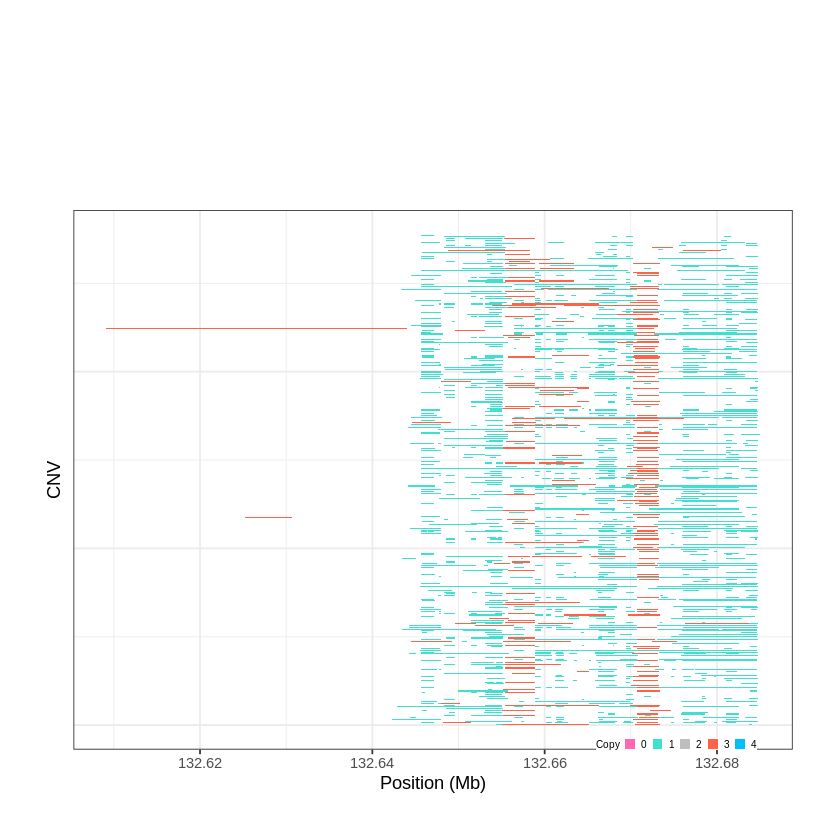

Task done, plot was stored in working directory.
[1] "Ploting CNVR 600..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 134.130701 - 134.1893 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


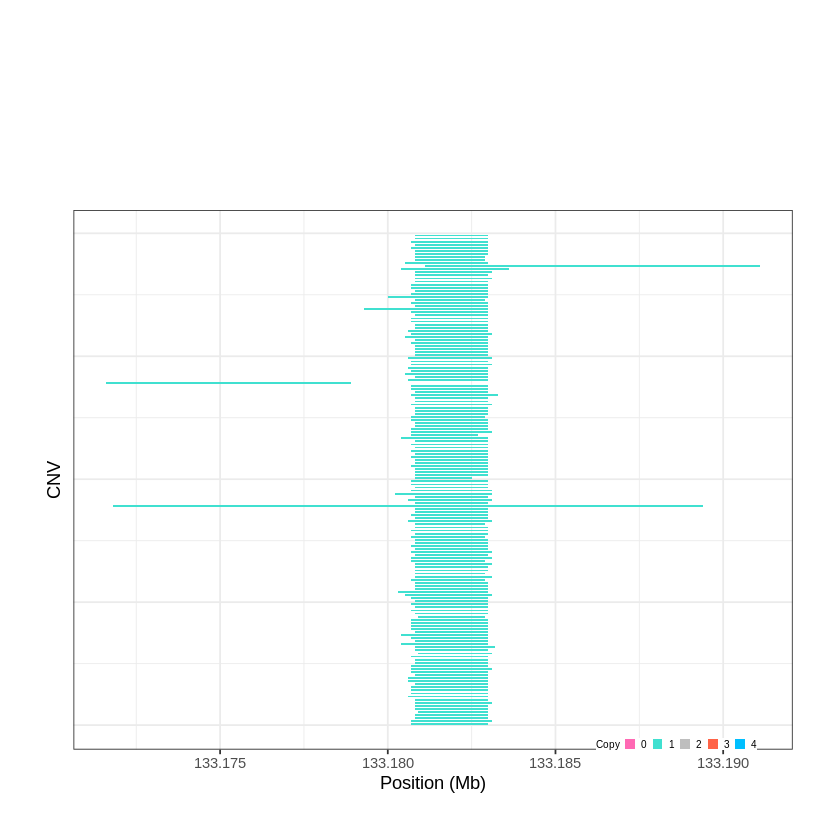

Task done, plot was stored in working directory.
[1] "Ploting CNVR 601..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 135.426901 - 135.4705 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


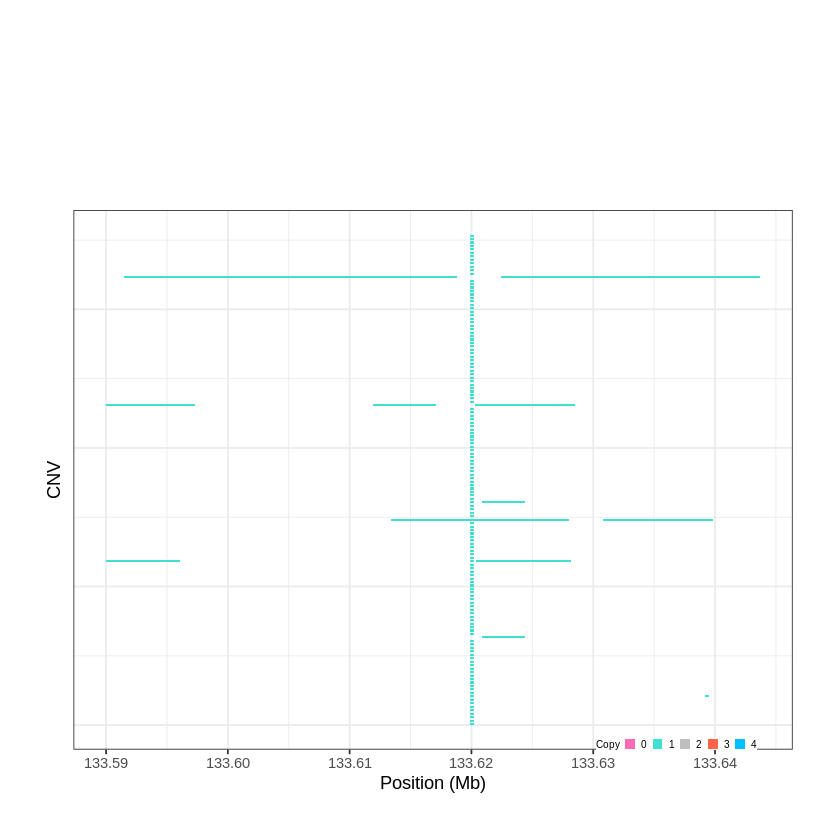

Task done, plot was stored in working directory.
[1] "Ploting CNVR 602..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 138.928201 - 139.0263 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


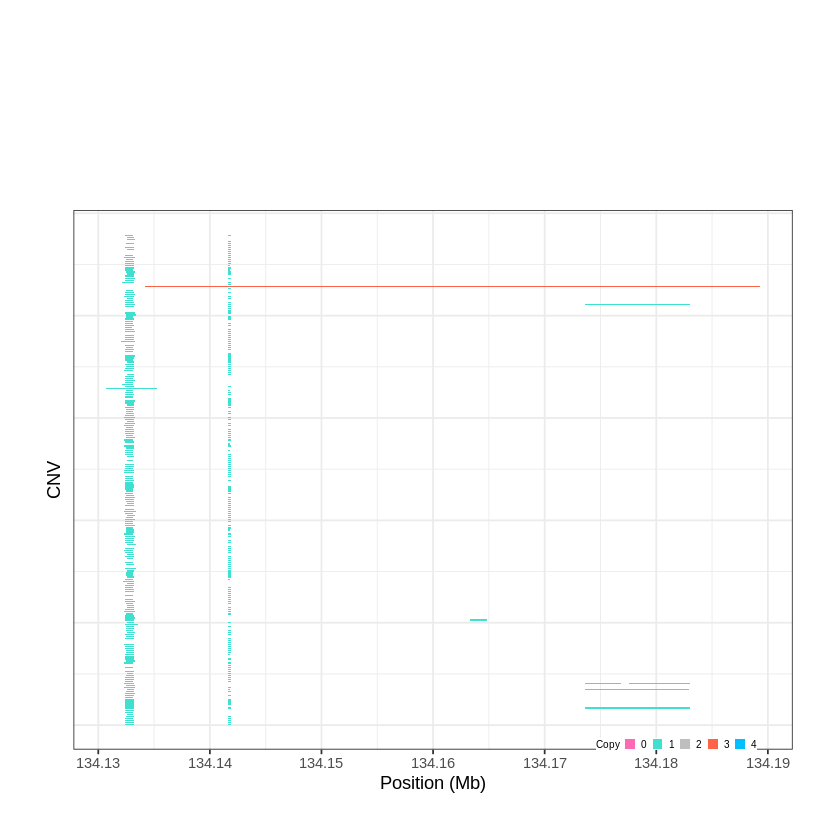

Task done, plot was stored in working directory.
[1] "Ploting CNVR 603..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 139.918601 - 139.9745 Mb with 182 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


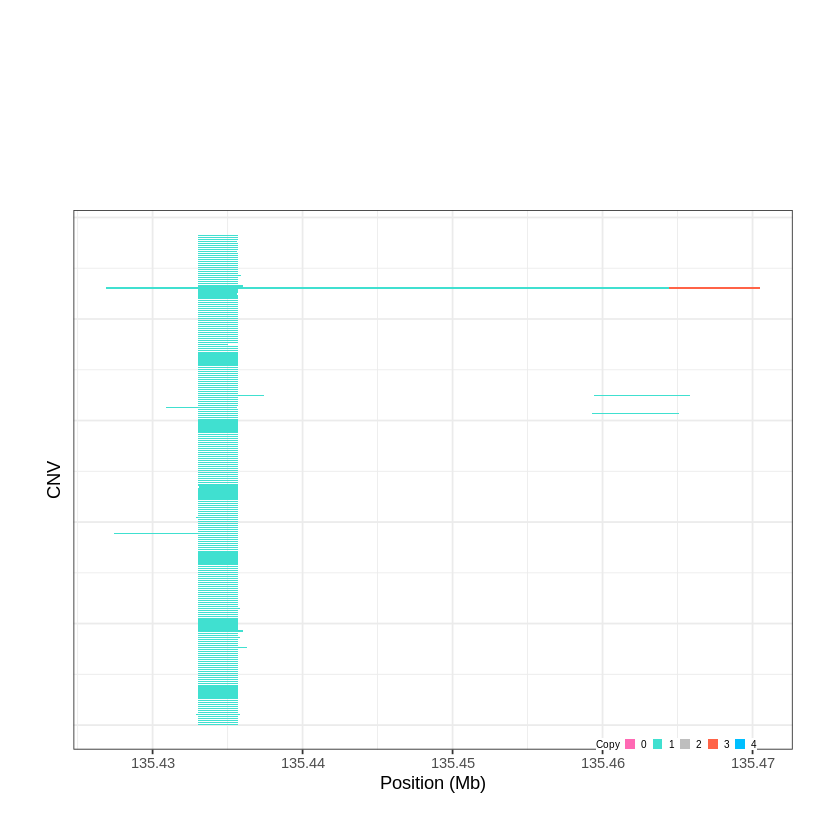

Task done, plot was stored in working directory.
[1] "Ploting CNVR 604..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 142.228301 - 142.2715 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


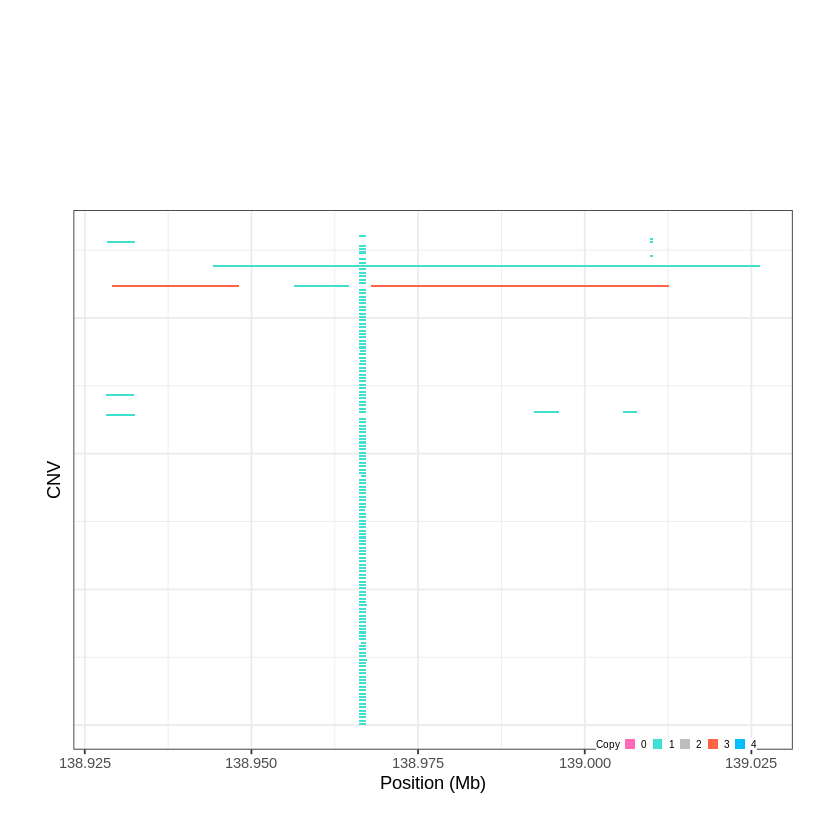

Task done, plot was stored in working directory.
[1] "Ploting CNVR 605..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 144.021201 - 144.0626 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


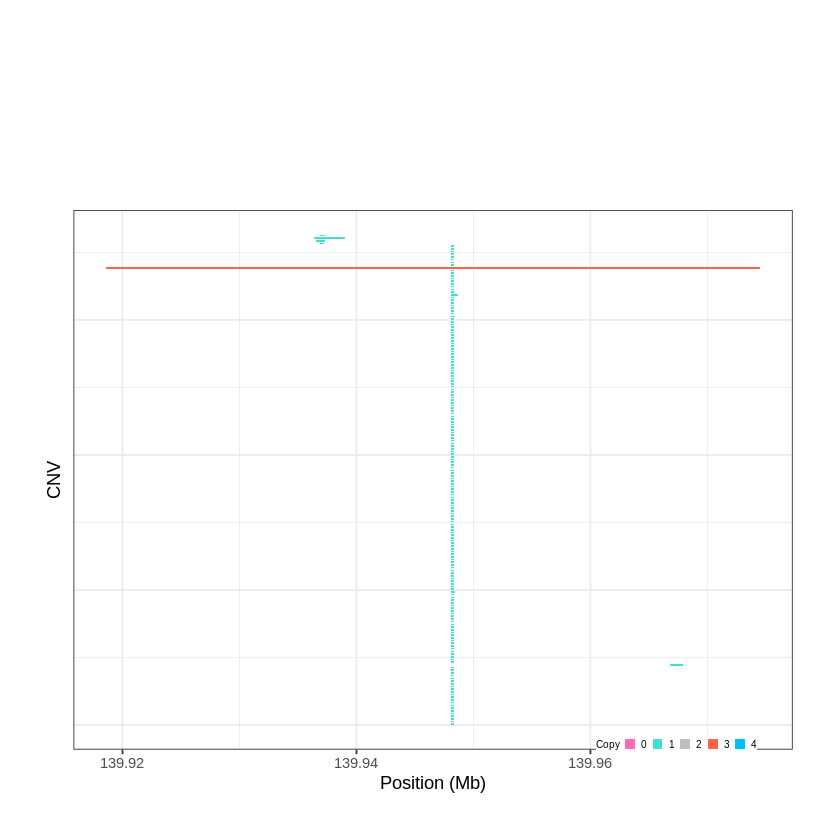

Task done, plot was stored in working directory.
[1] "Ploting CNVR 606..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 144.768501 - 145.0693 Mb with 262 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


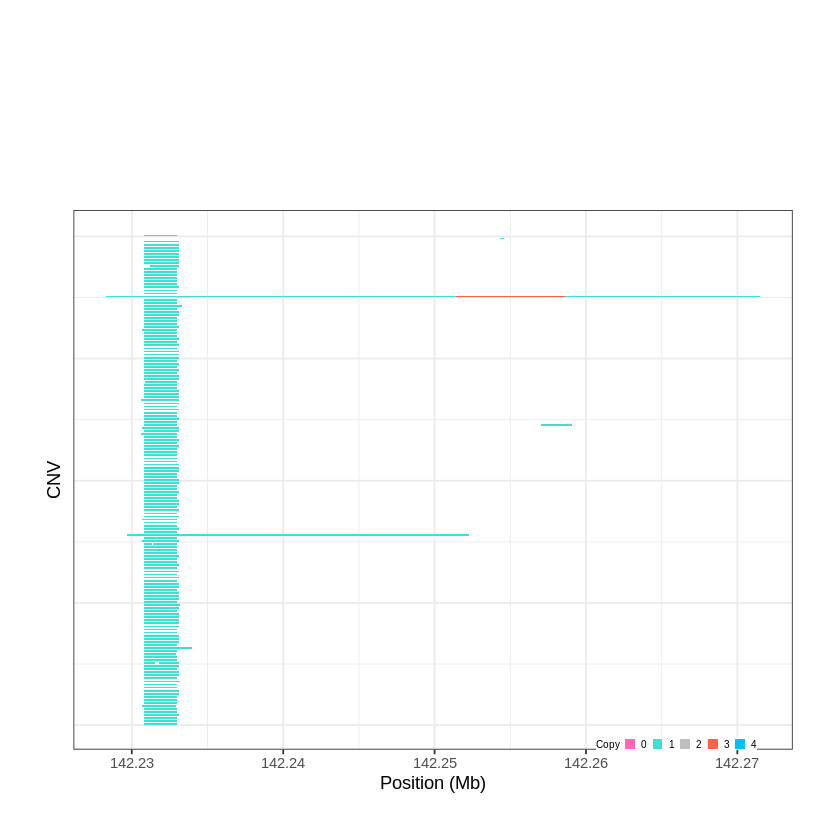

Task done, plot was stored in working directory.
[1] "Ploting CNVR 607..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 145.310901 - 145.3229 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


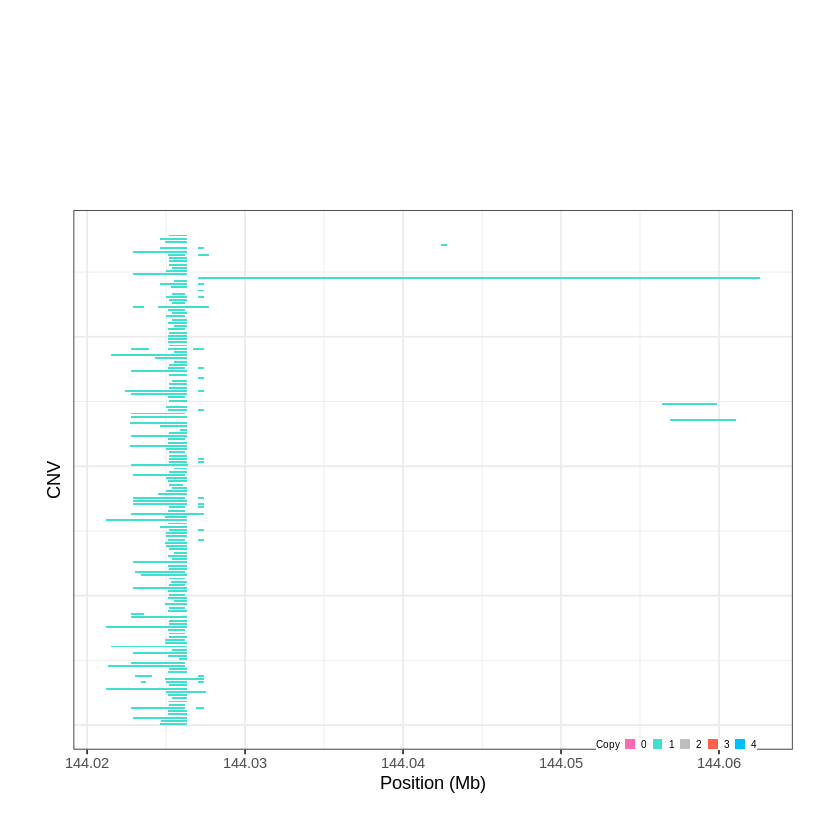

Task done, plot was stored in working directory.
[1] "Ploting CNVR 608..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 146.286501 - 146.3153 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


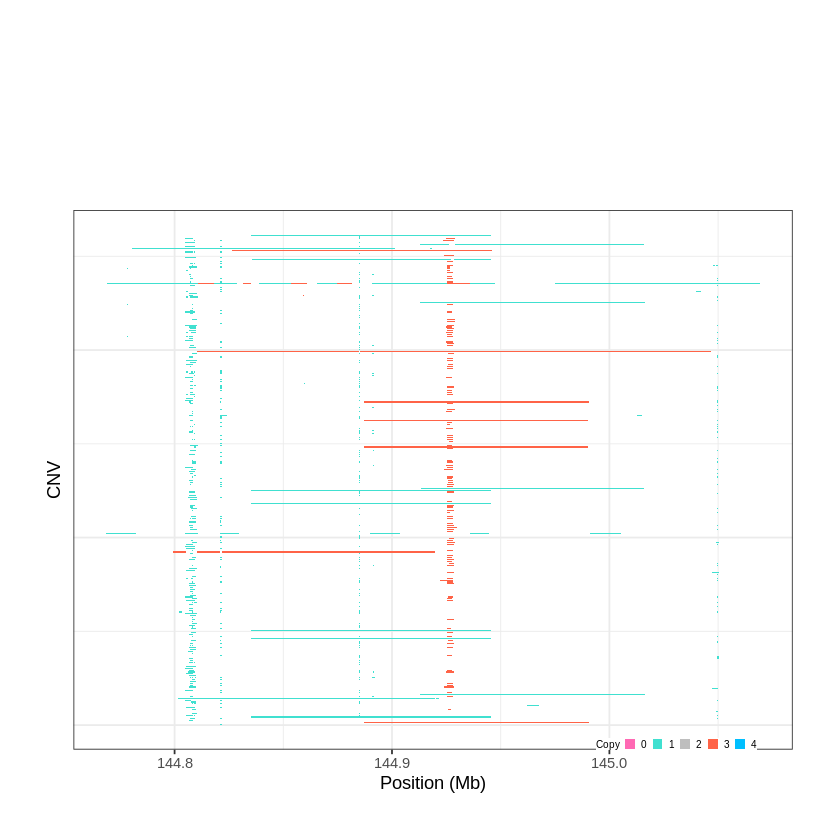

Task done, plot was stored in working directory.
[1] "Ploting CNVR 609..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 149.392401 - 149.4181 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


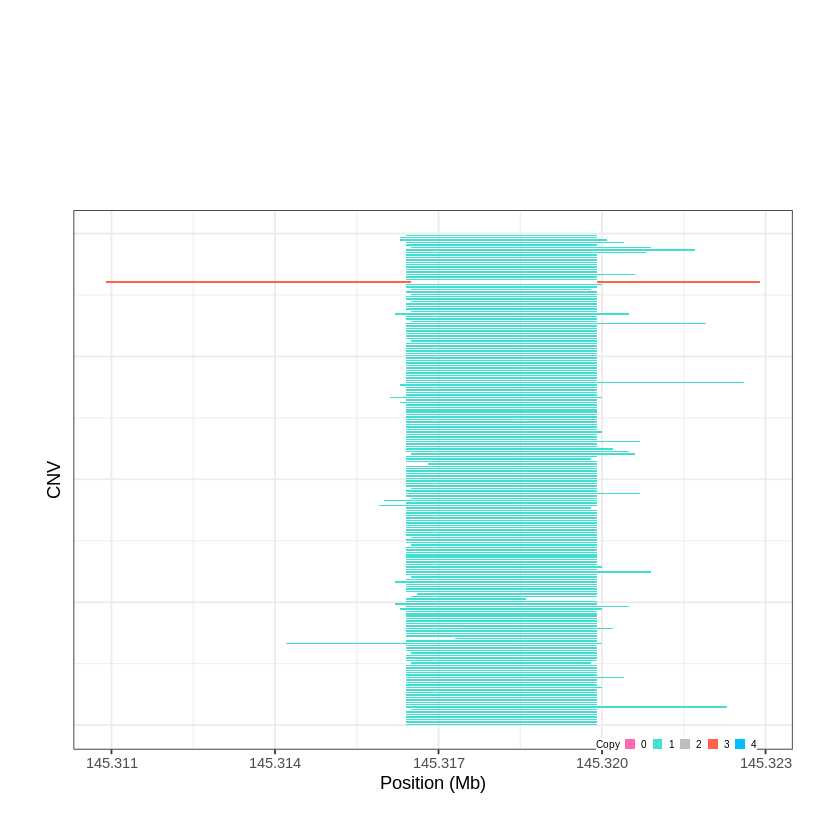

Task done, plot was stored in working directory.
[1] "Ploting CNVR 610..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 151.171201 - 151.1746 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


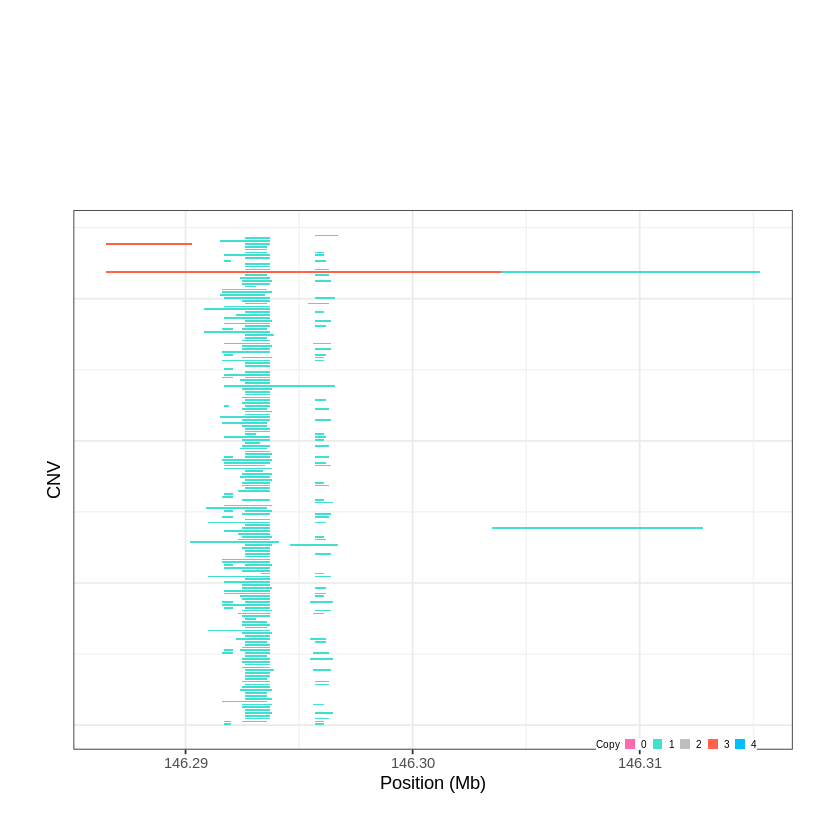

Task done, plot was stored in working directory.
[1] "Ploting CNVR 611..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 151.340801 - 151.3561 Mb with 174 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


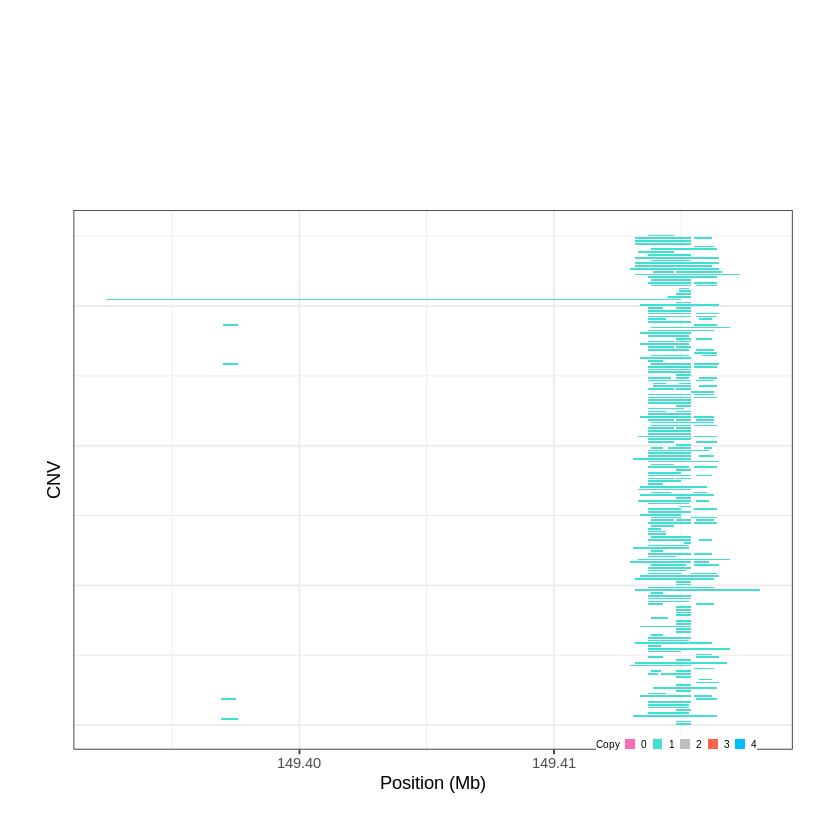

Task done, plot was stored in working directory.
[1] "Ploting CNVR 612..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 151.575701 - 151.5849 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


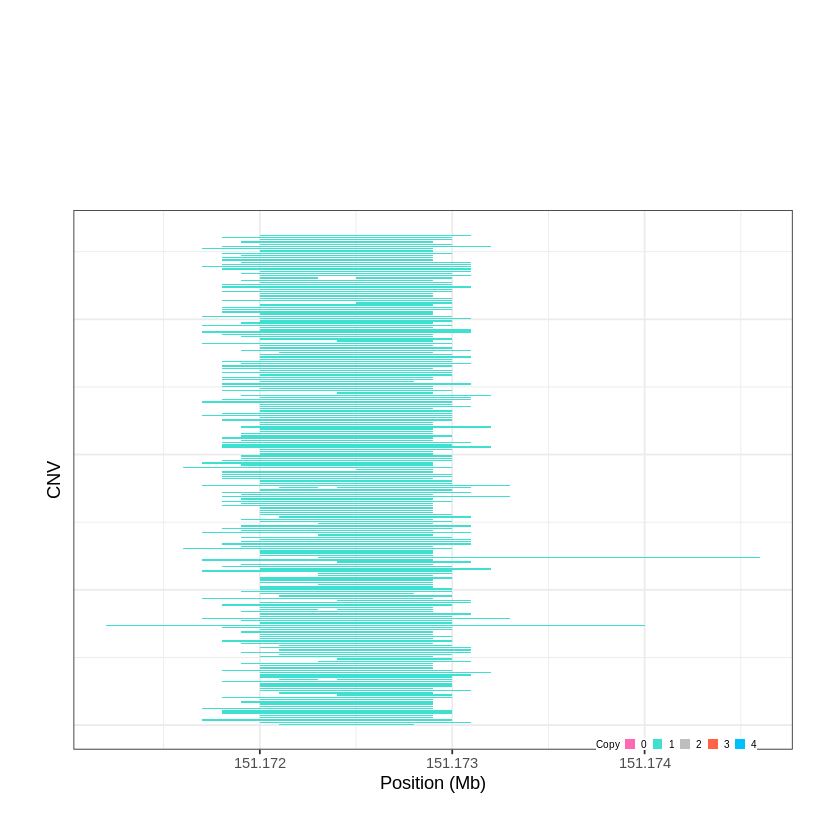

Task done, plot was stored in working directory.
[1] "Ploting CNVR 613..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 156.814601 - 156.821 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


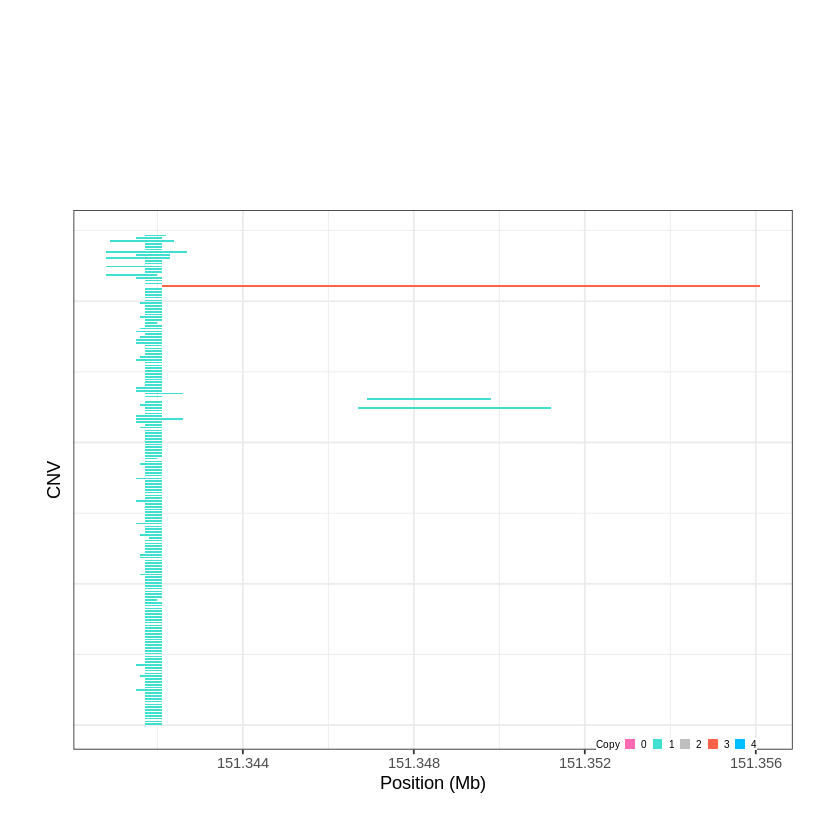

Task done, plot was stored in working directory.
[1] "Ploting CNVR 614..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 158.555101 - 158.5965 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


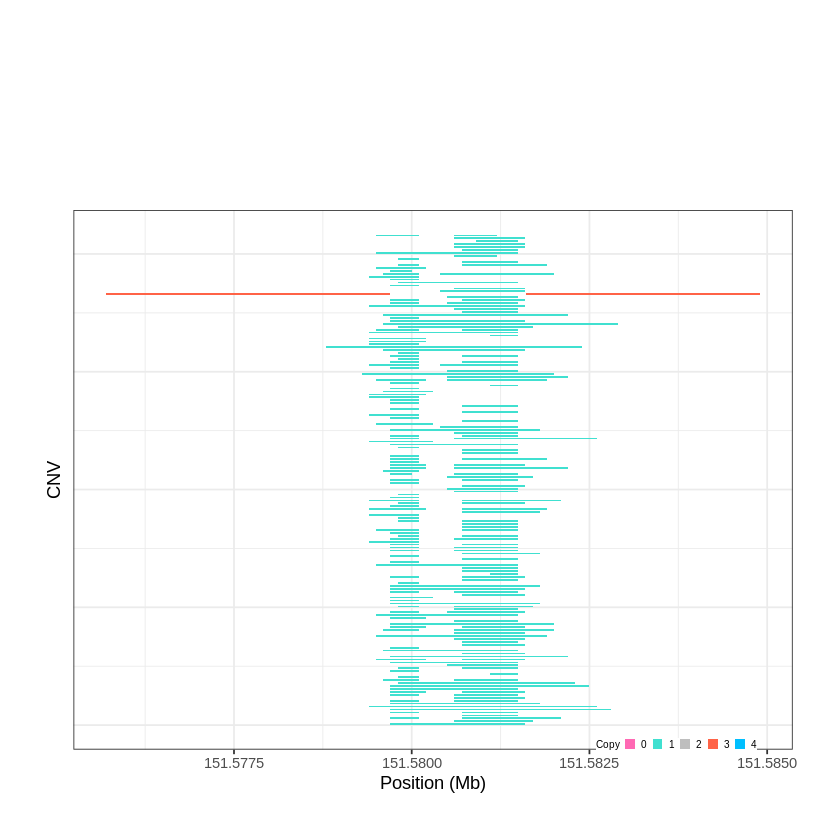

Task done, plot was stored in working directory.
[1] "Ploting CNVR 615..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 159.338801 - 159.3843 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


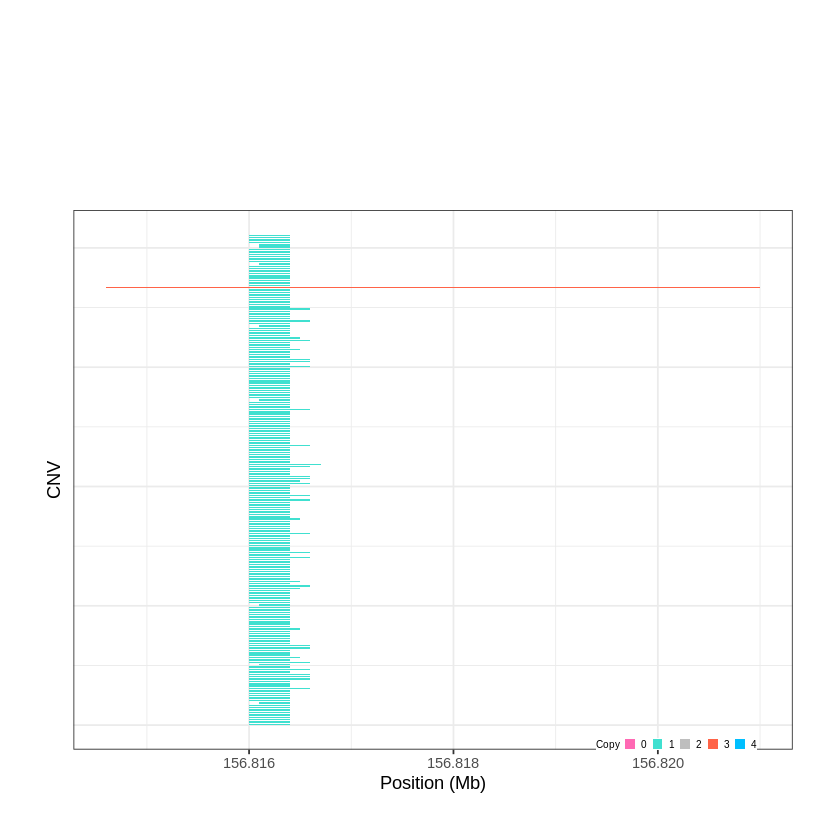

Task done, plot was stored in working directory.
[1] "Ploting CNVR 616..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 159.392701 - 159.3974 Mb with 223 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


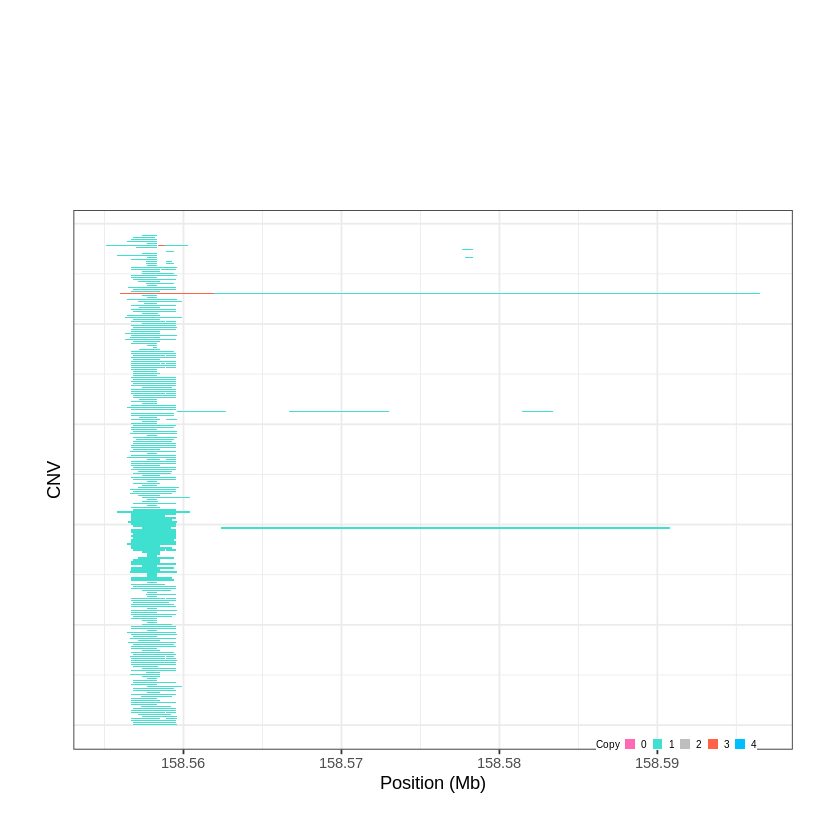

Task done, plot was stored in working directory.
[1] "Ploting CNVR 617..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 161.861401 - 161.9417 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


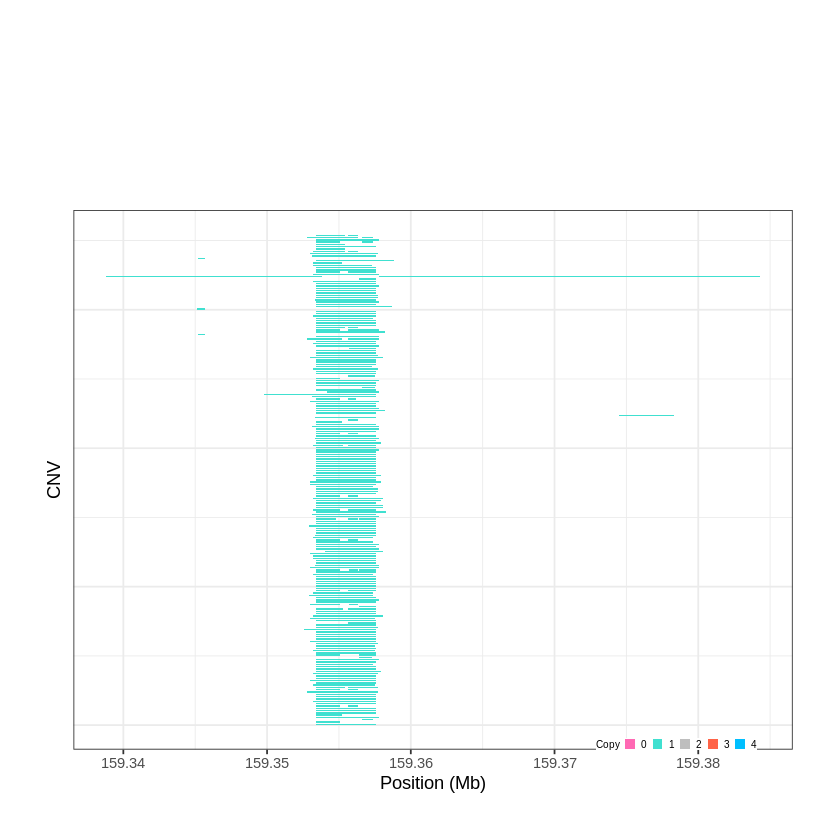

Task done, plot was stored in working directory.
[1] "Ploting CNVR 618..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 161.941701 - 162.0038 Mb with 226 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


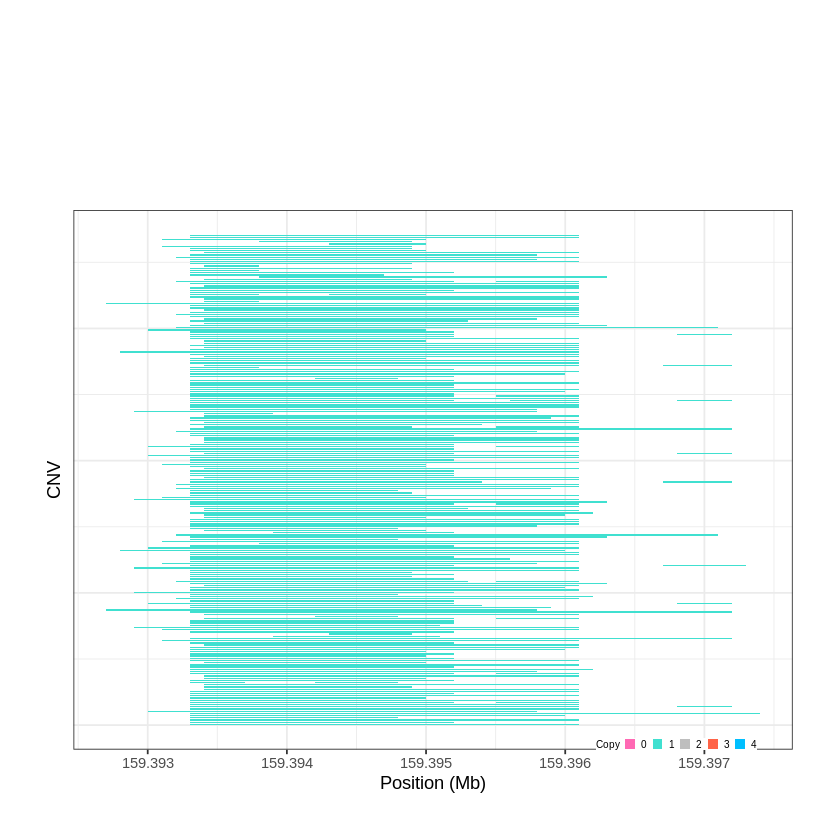

Task done, plot was stored in working directory.
[1] "Ploting CNVR 619..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 163.348601 - 163.3976 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


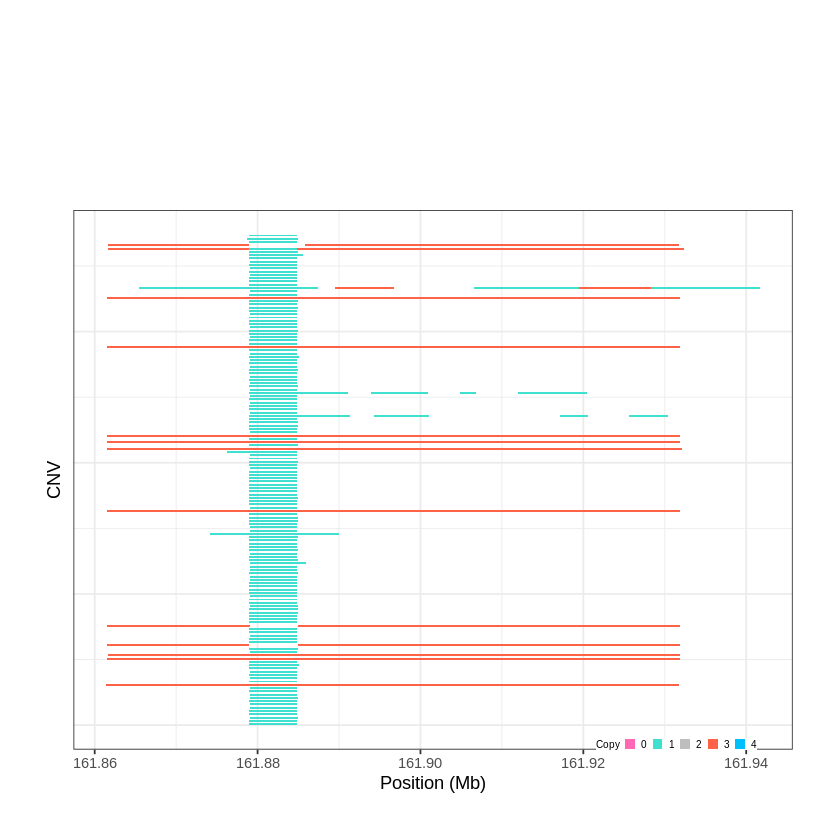

Task done, plot was stored in working directory.
[1] "Ploting CNVR 620..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 165.984201 - 166.0069 Mb with 269 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


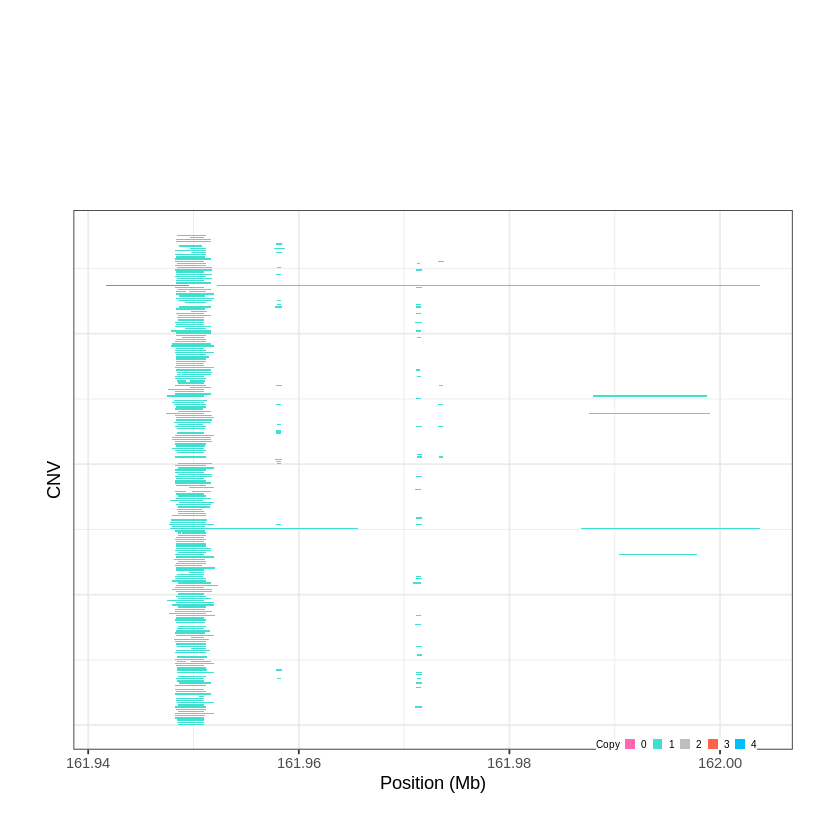

Task done, plot was stored in working directory.
[1] "Ploting CNVR 621..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 167.560801 - 167.6203 Mb with 255 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


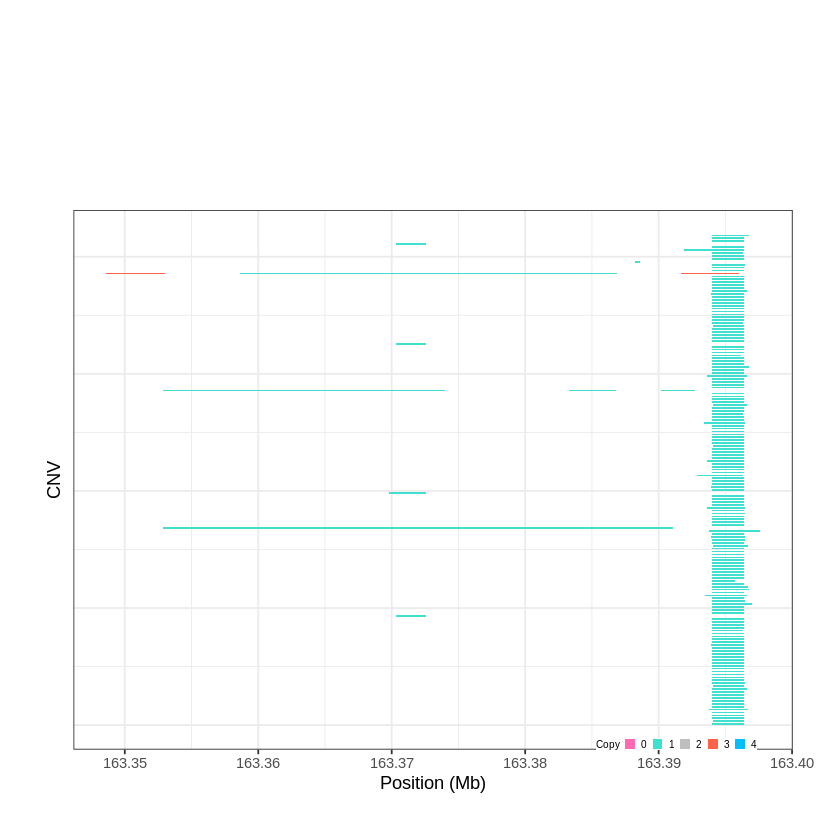

Task done, plot was stored in working directory.
[1] "Ploting CNVR 622..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 172.363101 - 172.3879 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


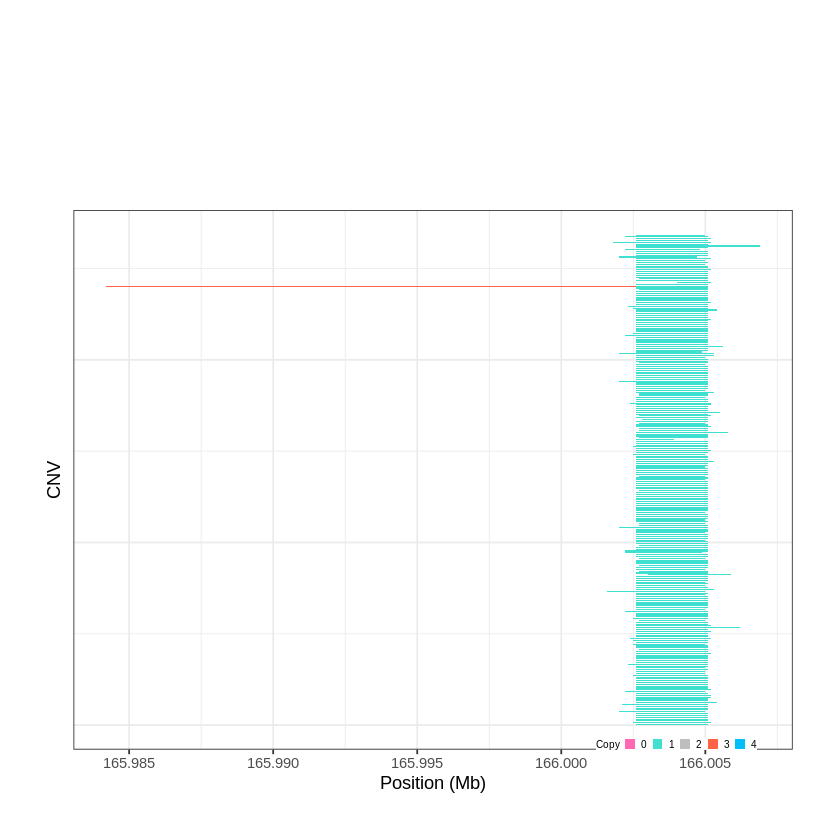

Task done, plot was stored in working directory.
[1] "Ploting CNVR 623..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 172.912601 - 172.9986 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


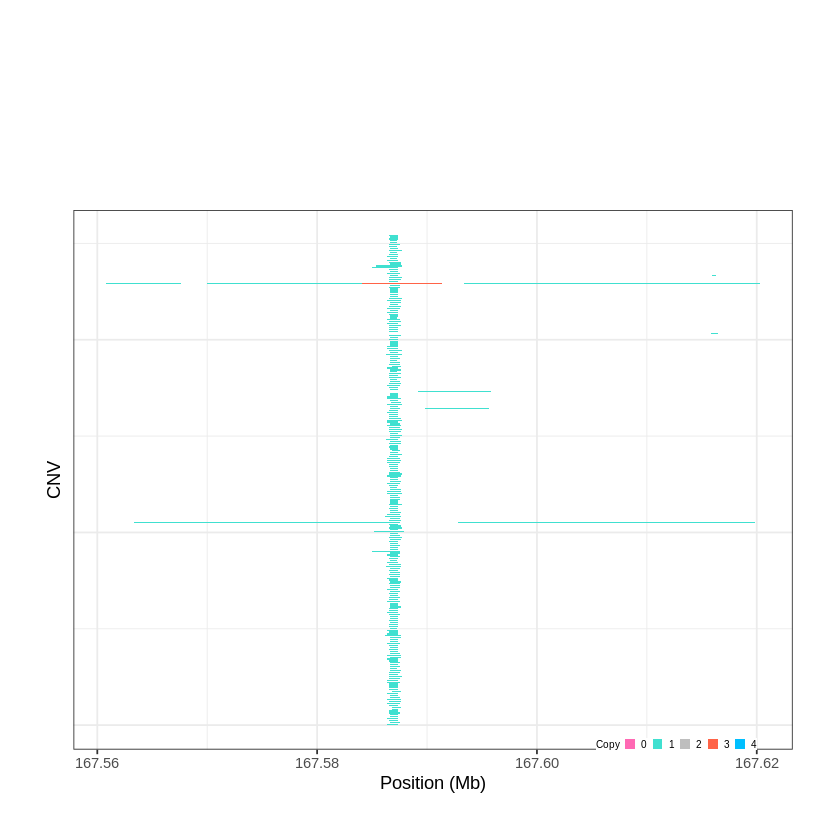

Task done, plot was stored in working directory.
[1] "Ploting CNVR 624..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 173.423801 - 173.4349 Mb with 261 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


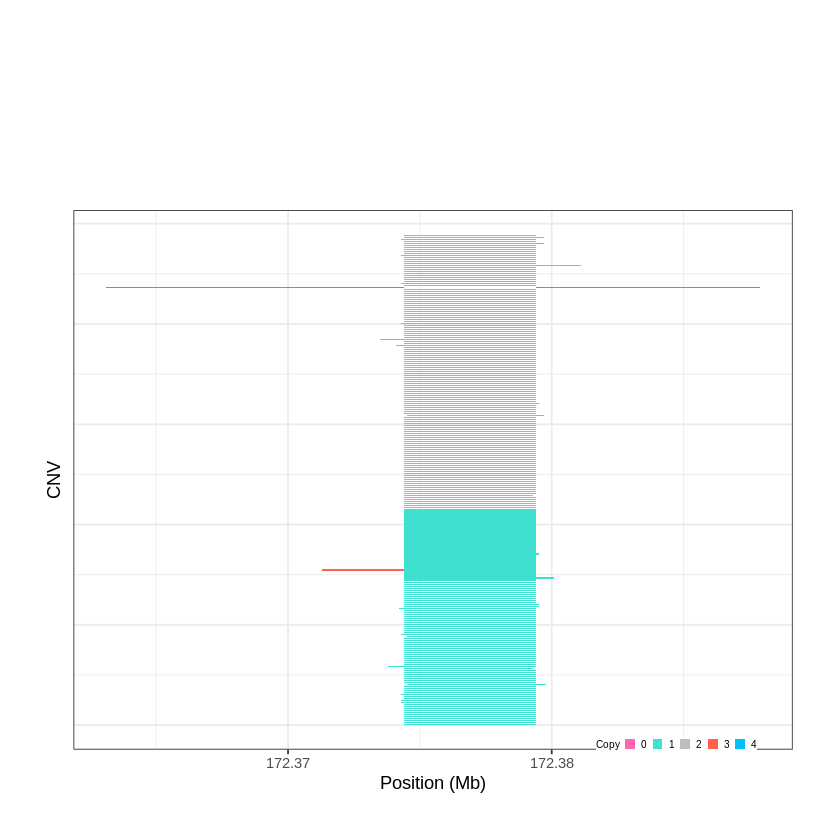

Task done, plot was stored in working directory.
[1] "Ploting CNVR 625..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 181.744201 - 181.7646 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


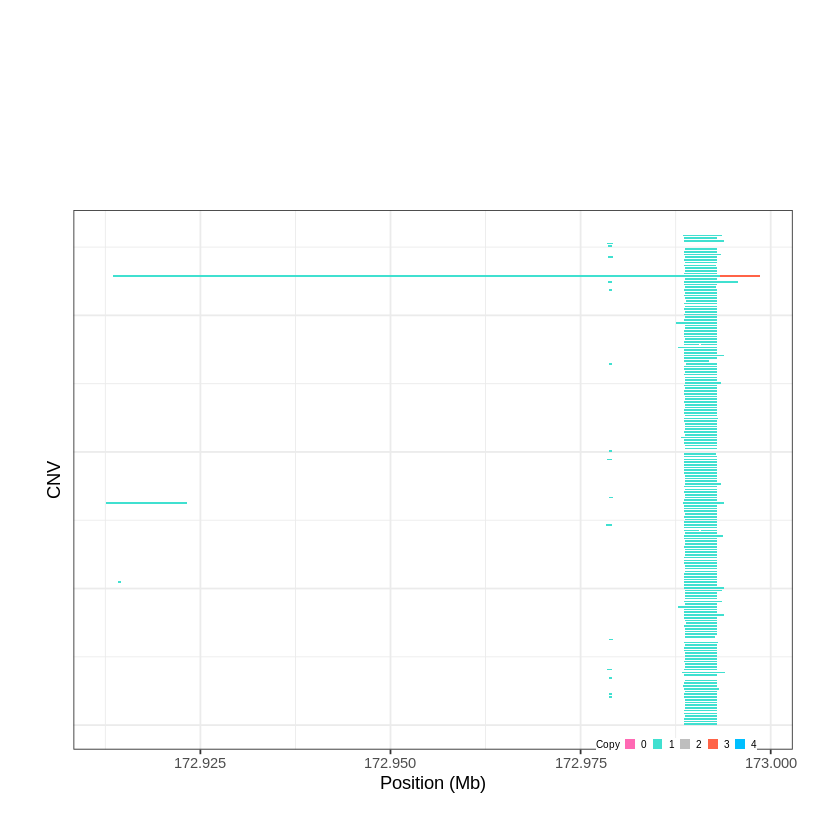

Task done, plot was stored in working directory.
[1] "Ploting CNVR 626..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 181.850301 - 181.9113 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


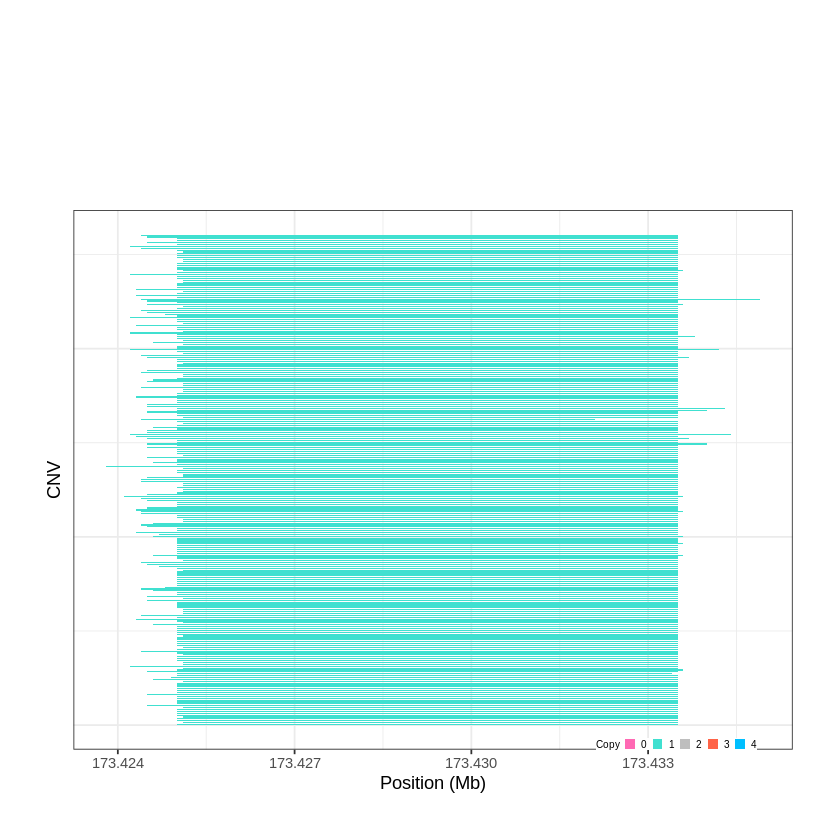

Task done, plot was stored in working directory.
[1] "Ploting CNVR 627..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 182.960701 - 182.9618 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


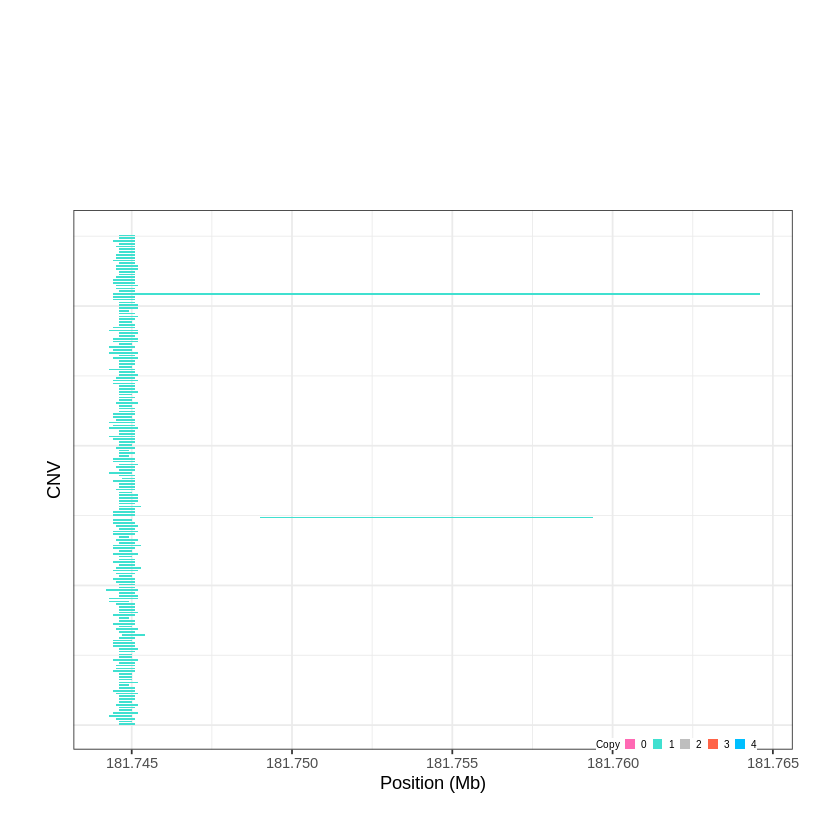

Task done, plot was stored in working directory.
[1] "Ploting CNVR 628..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 183.716901 - 183.8406 Mb with 185 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


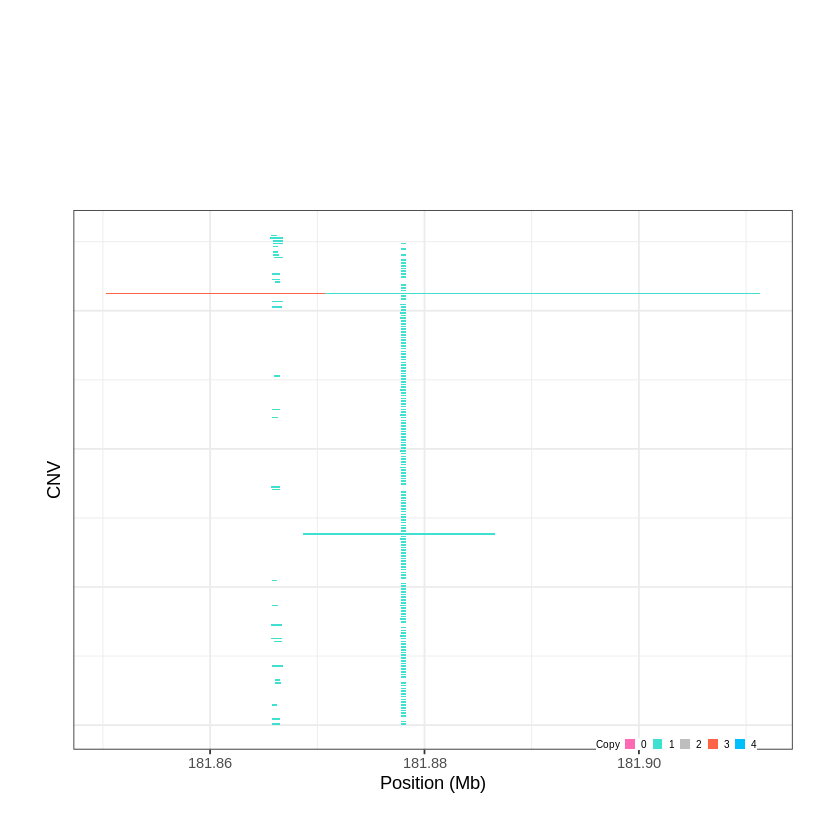

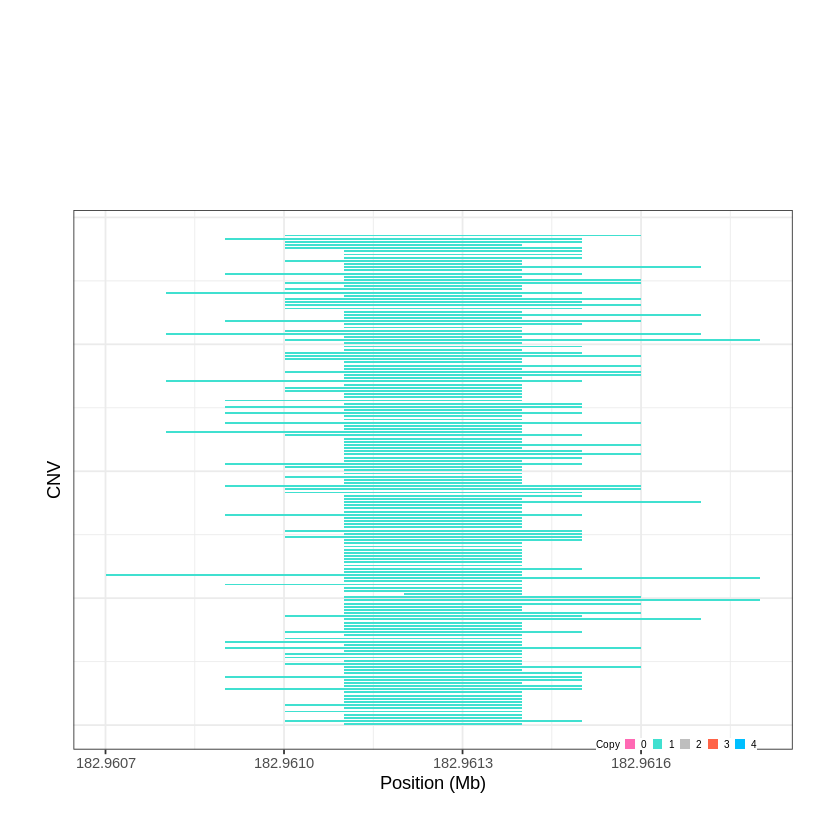

Task done, plot was stored in working directory.
[1] "Ploting CNVR 629..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 184.231001 - 184.4252 Mb with 246 Individual - "
Plotting gene...


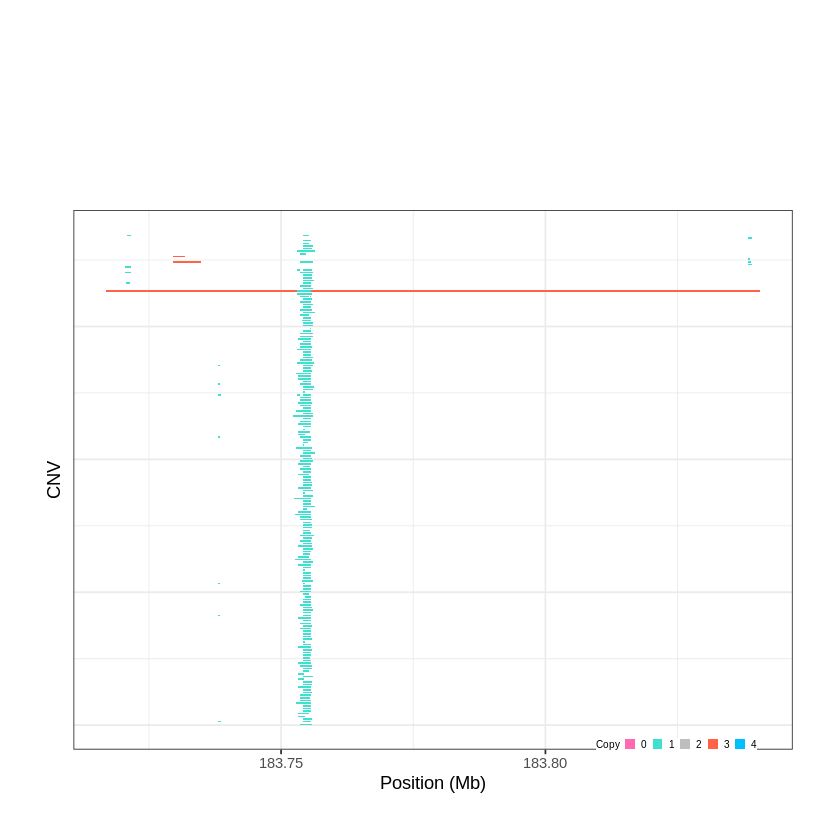

Task done, plot was stored in working directory.
[1] "Ploting CNVR 630..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 184.614501 - 184.7083 Mb with 215 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 631..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 185.597101 - 185.5986 Mb with 235 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


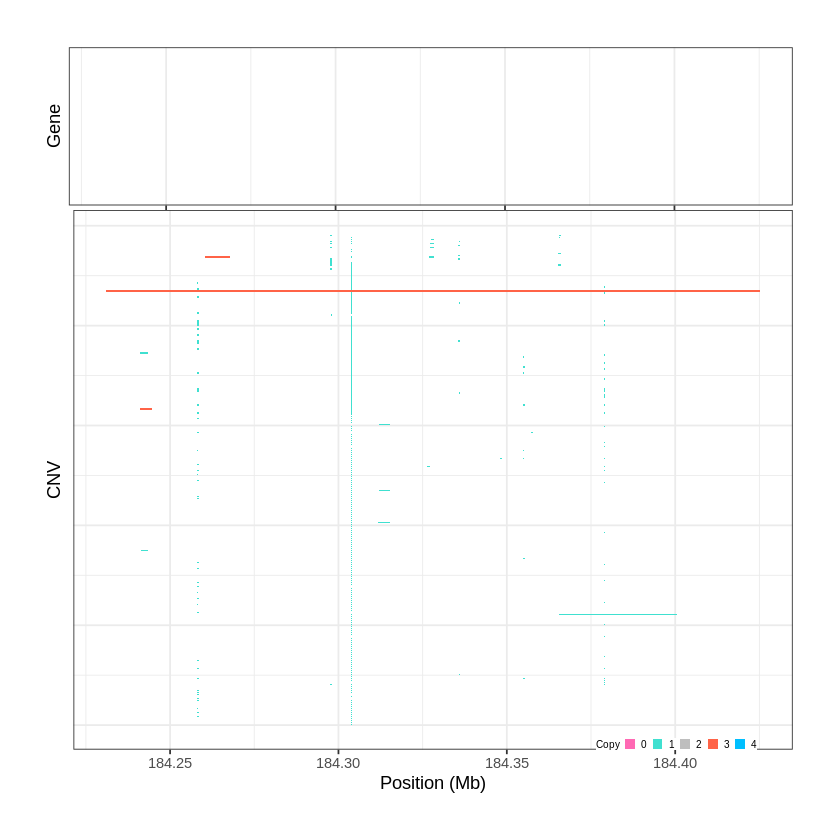

Task done, plot was stored in working directory.
[1] "Ploting CNVR 632..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 185.637701 - 185.6661 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


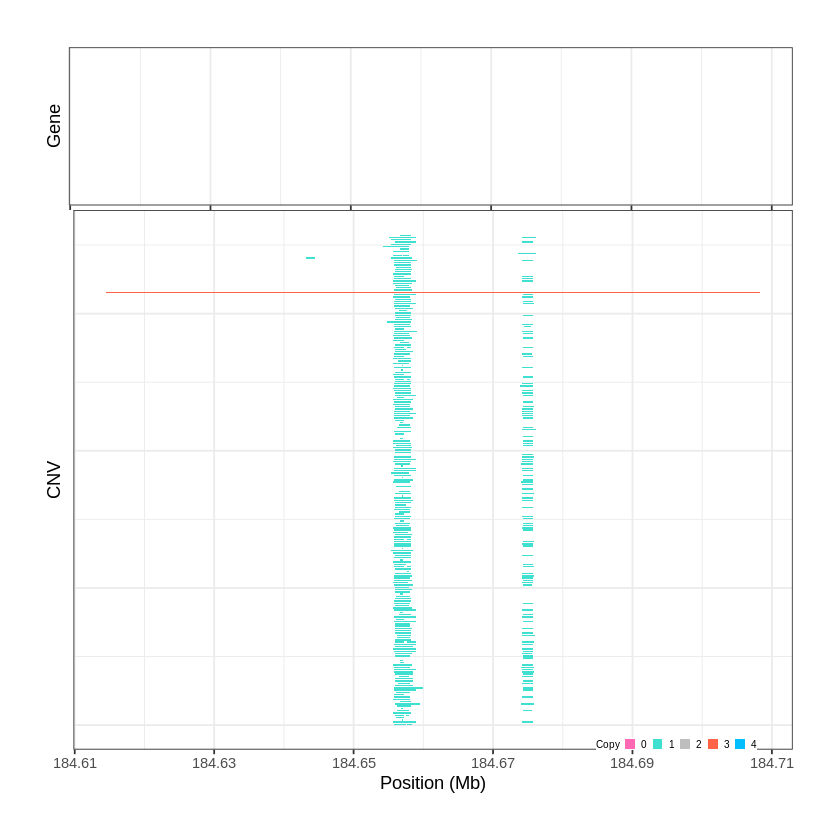

Task done, plot was stored in working directory.
[1] "Ploting CNVR 633..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 185.872301 - 185.9487 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


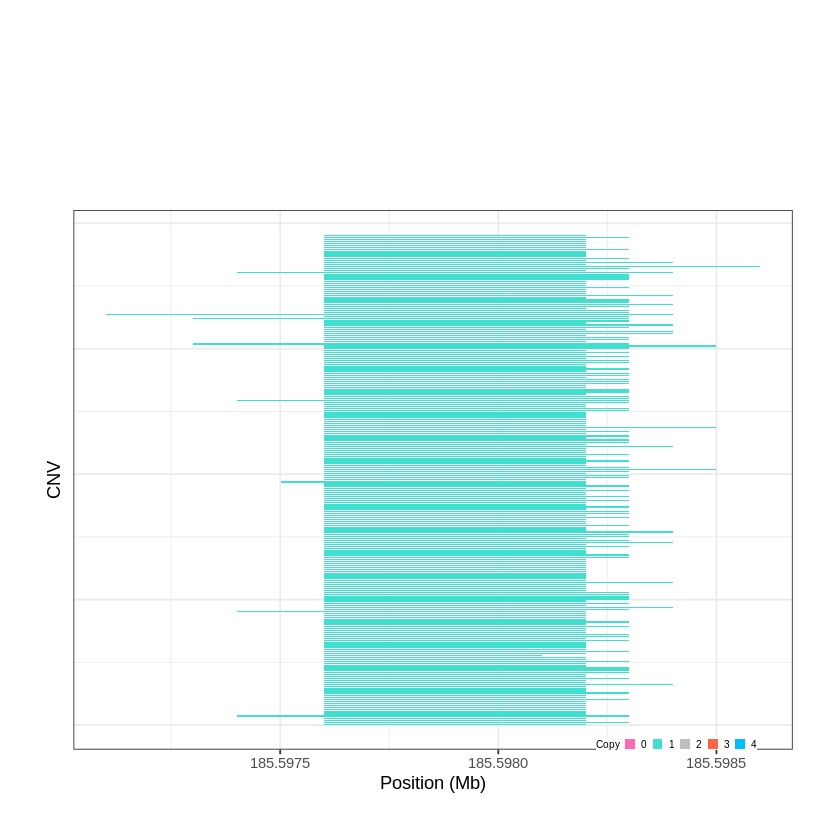

Task done, plot was stored in working directory.
[1] "Ploting CNVR 634..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 186.440201 - 186.4457 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


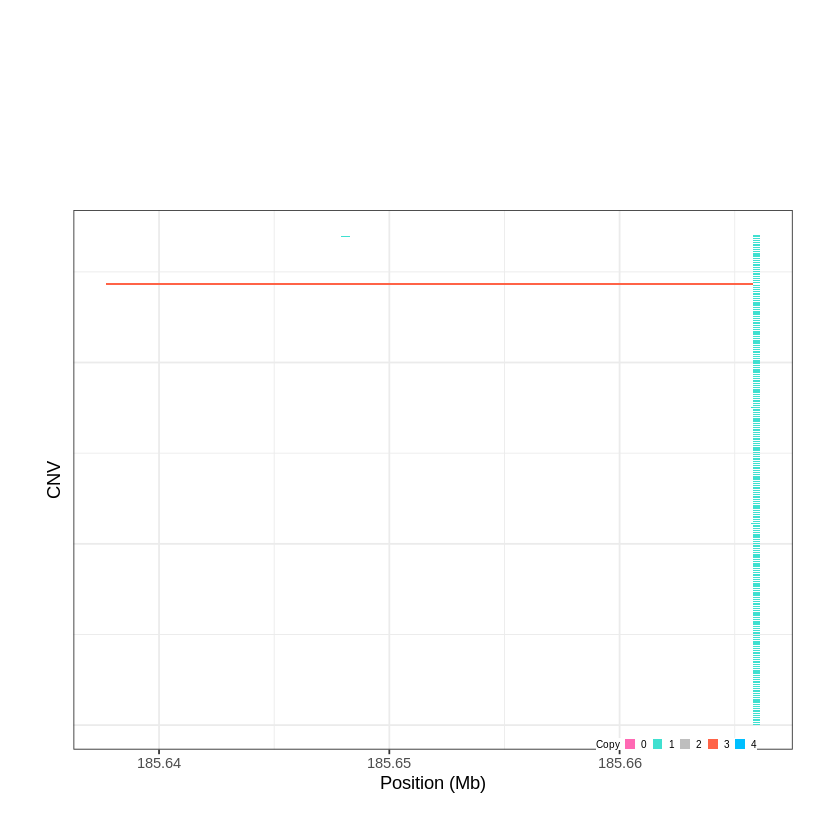

Task done, plot was stored in working directory.
[1] "Ploting CNVR 635..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 186.929801 - 187.1417 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


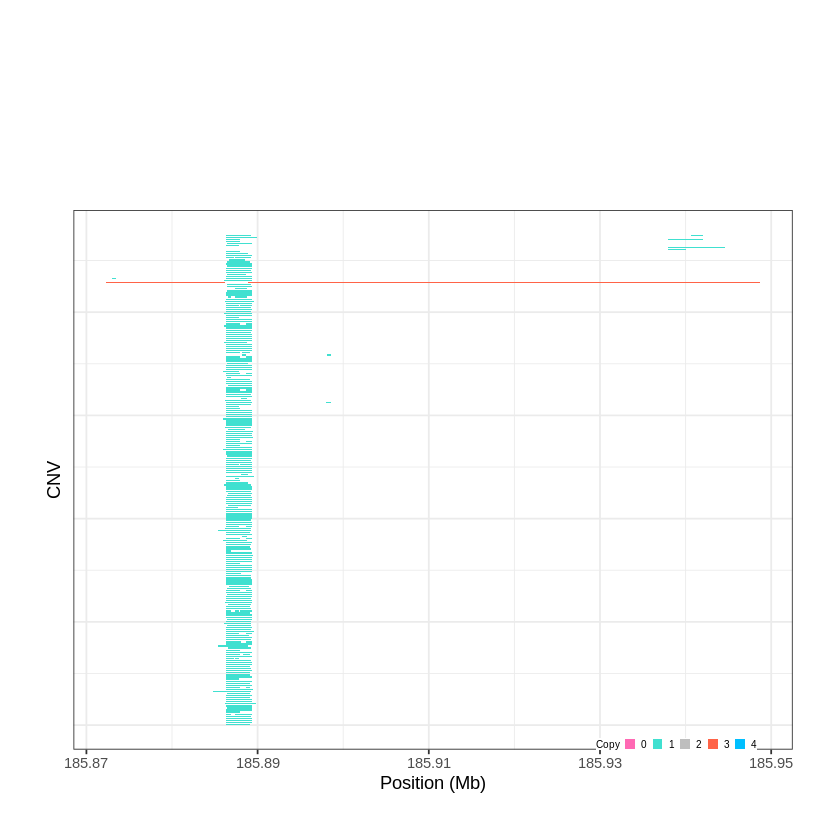

Task done, plot was stored in working directory.
[1] "Ploting CNVR 636..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 187.289901 - 187.3581 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


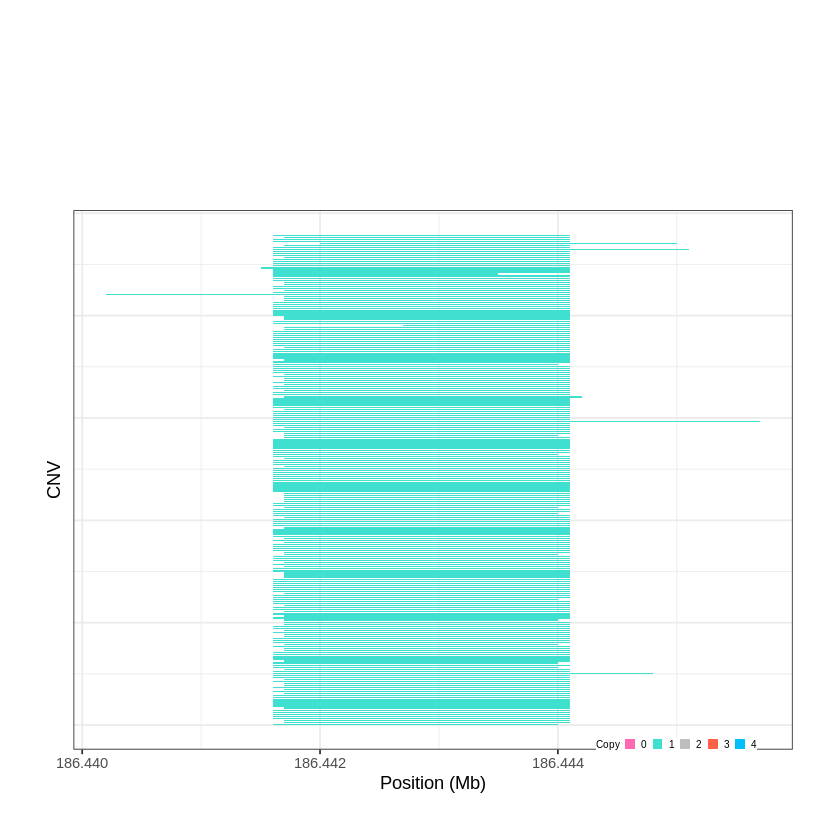

Task done, plot was stored in working directory.
[1] "Ploting CNVR 637..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 187.393401 - 187.4459 Mb with 265 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


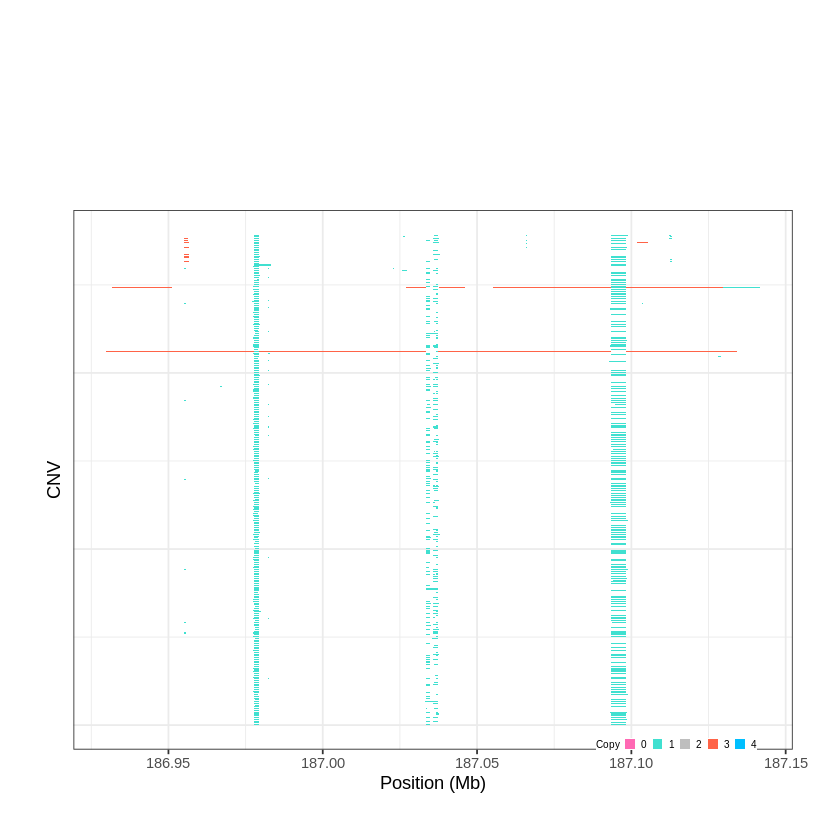

Task done, plot was stored in working directory.
[1] "Ploting CNVR 638..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 187.795701 - 187.796 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


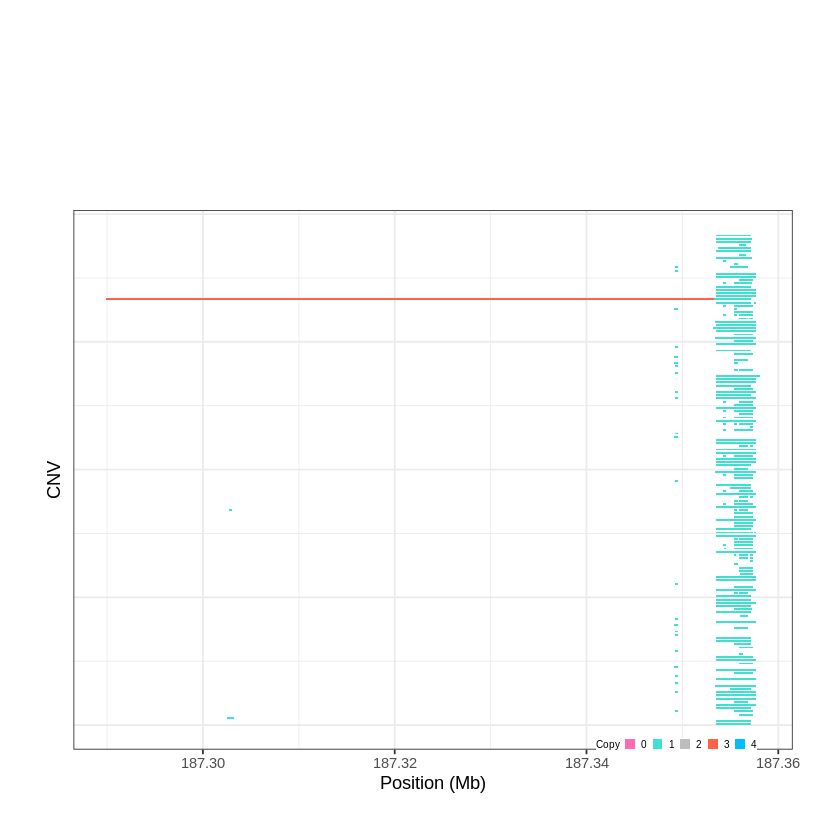

Task done, plot was stored in working directory.
[1] "Ploting CNVR 639..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 187.865401 - 187.8985 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


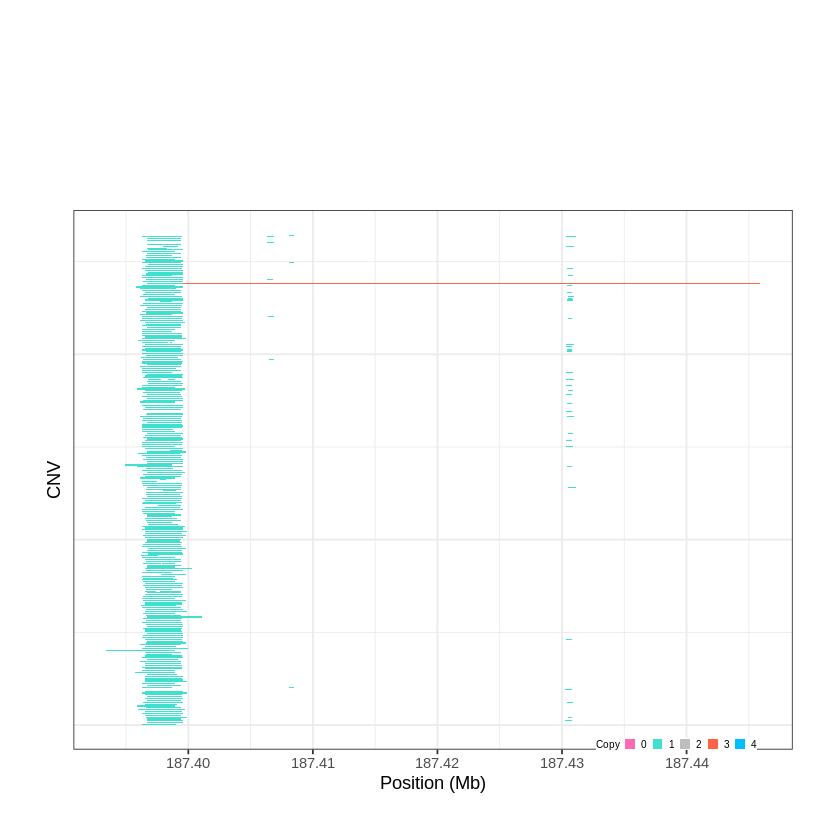

Task done, plot was stored in working directory.
[1] "Ploting CNVR 640..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 188.833101 - 189.0428 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


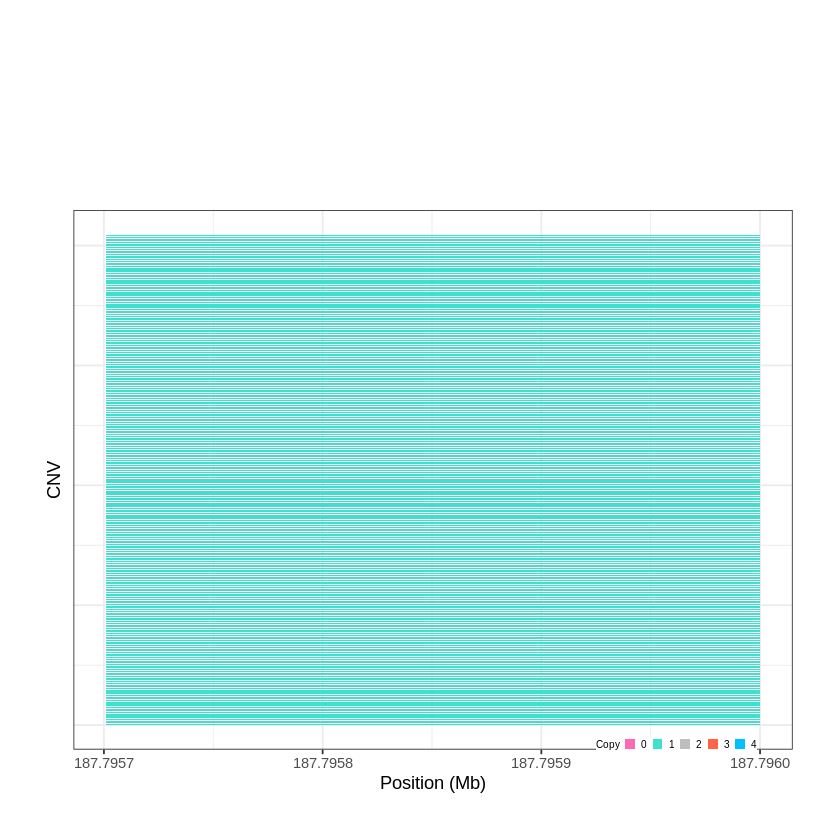

Task done, plot was stored in working directory.
[1] "Ploting CNVR 641..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 189.071001 - 189.2701 Mb with 270 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


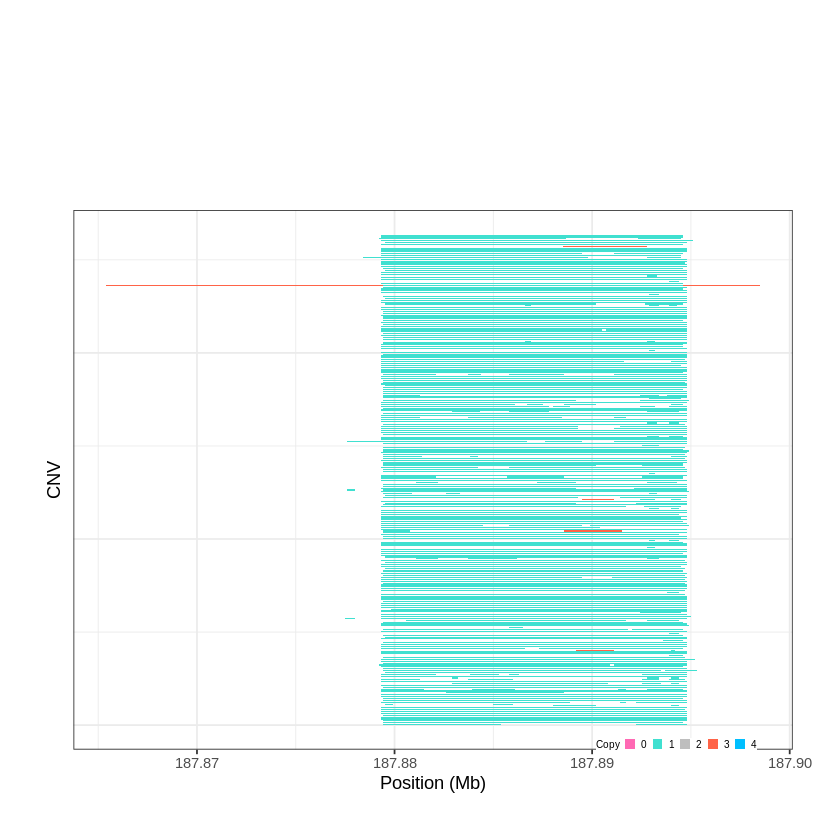

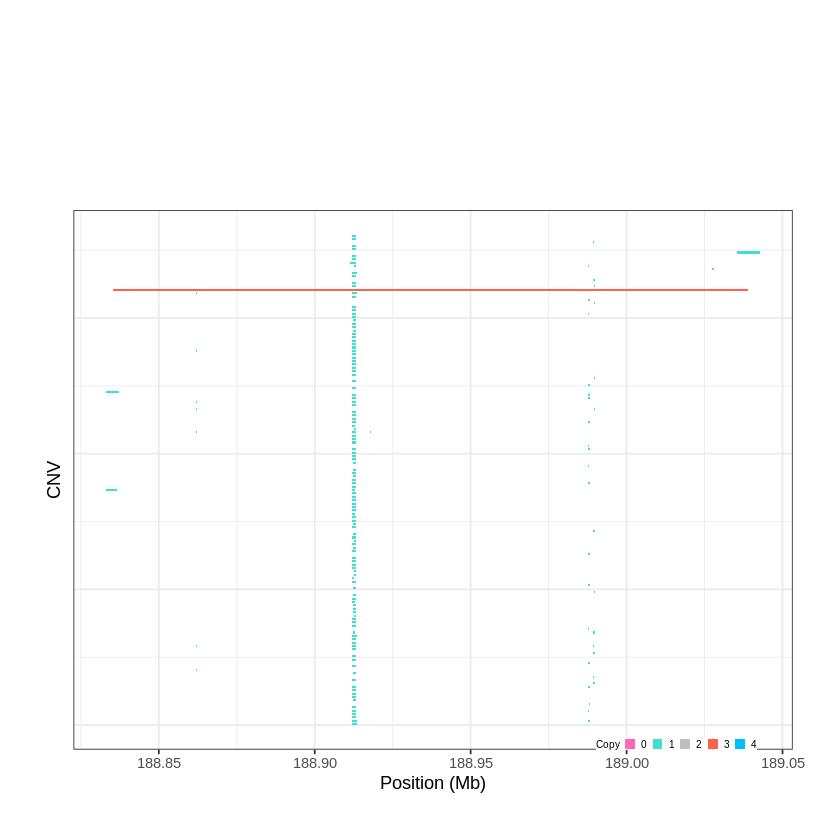

Task done, plot was stored in working directory.
[1] "Ploting CNVR 642..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 189.354401 - 190.1109 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 643..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 190.223201 - 190.2542 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


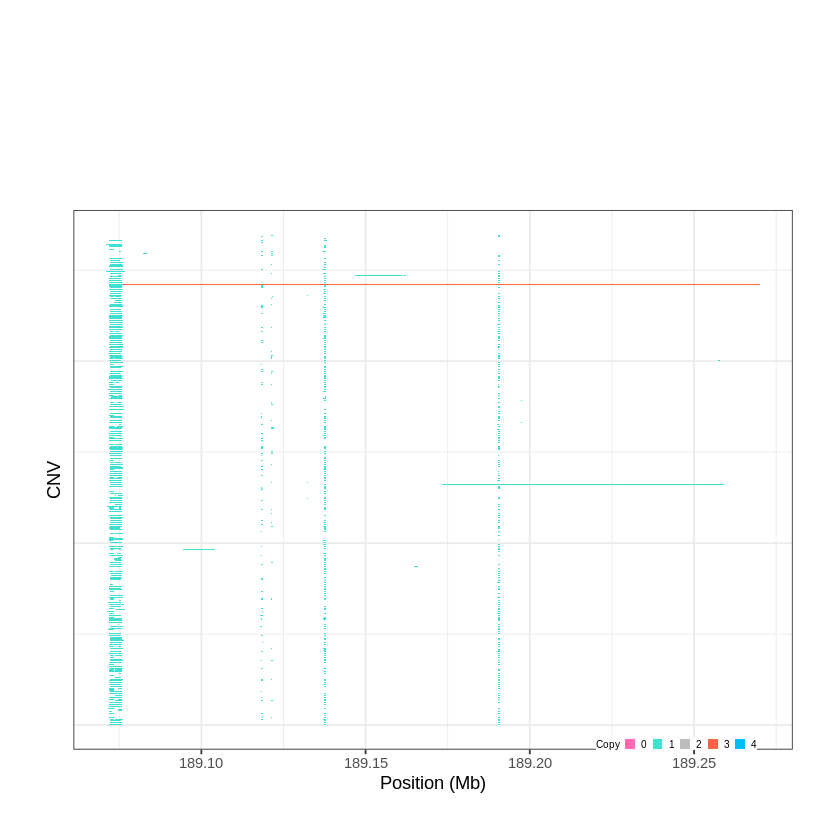

Task done, plot was stored in working directory.
[1] "Ploting CNVR 644..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 190.298901 - 190.3034 Mb with 248 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


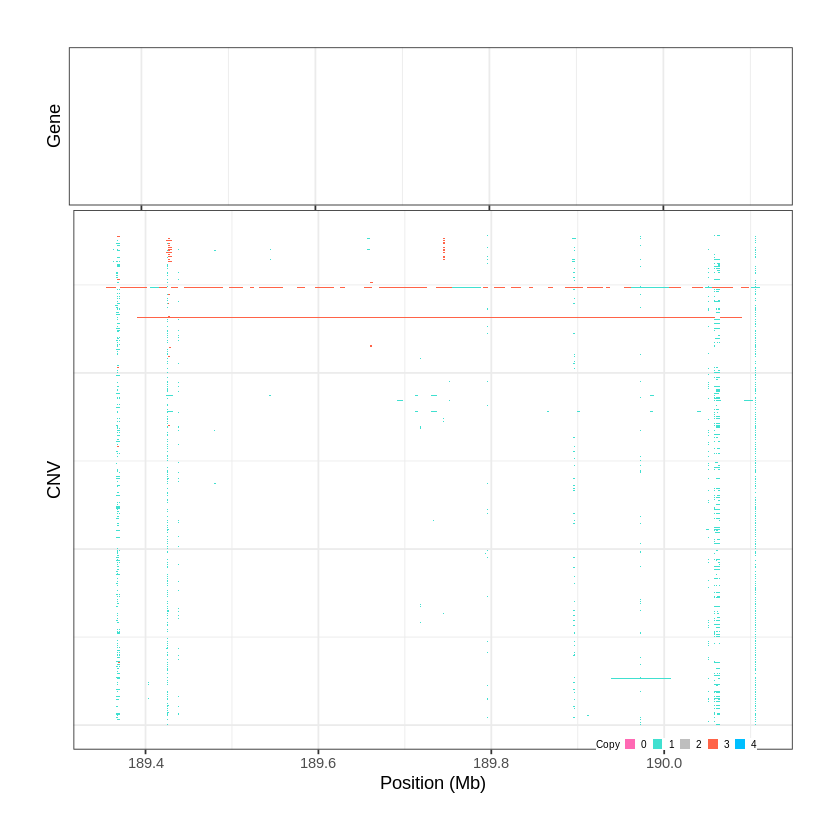

Task done, plot was stored in working directory.
[1] "Ploting CNVR 645..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 190.561101 - 190.5694 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


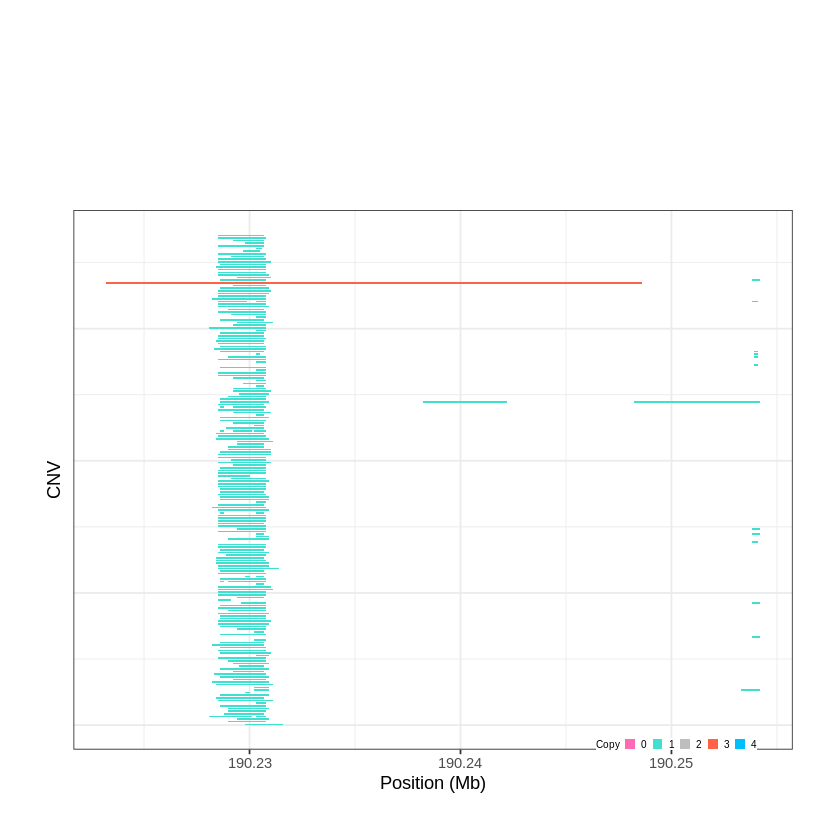

Task done, plot was stored in working directory.
[1] "Ploting CNVR 646..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 190.580901 - 190.6281 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


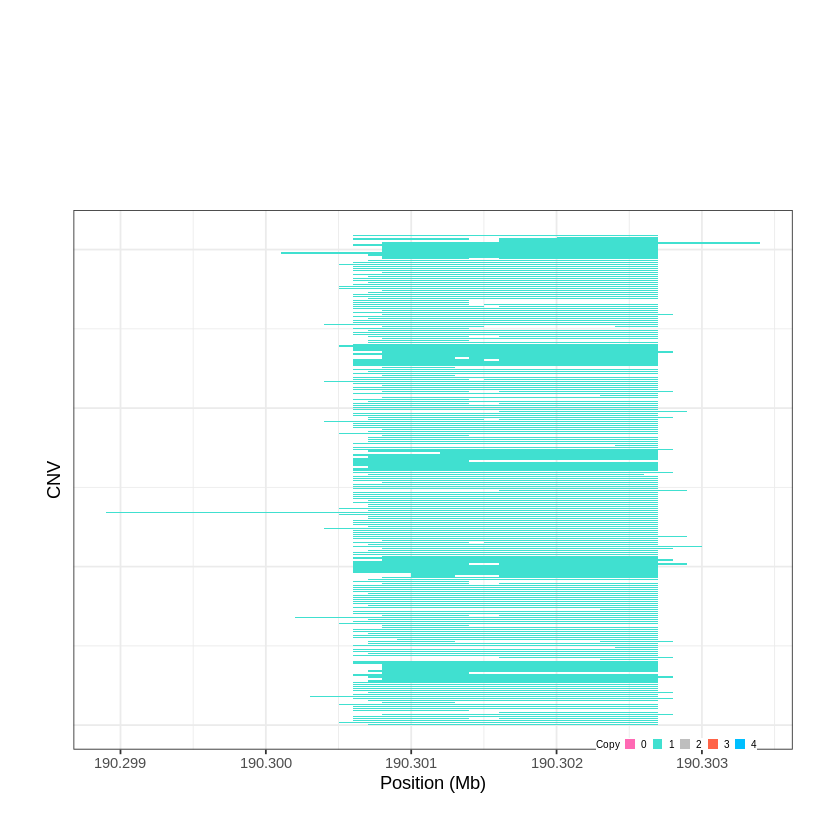

Task done, plot was stored in working directory.
[1] "Ploting CNVR 647..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 190.655601 - 190.6694 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


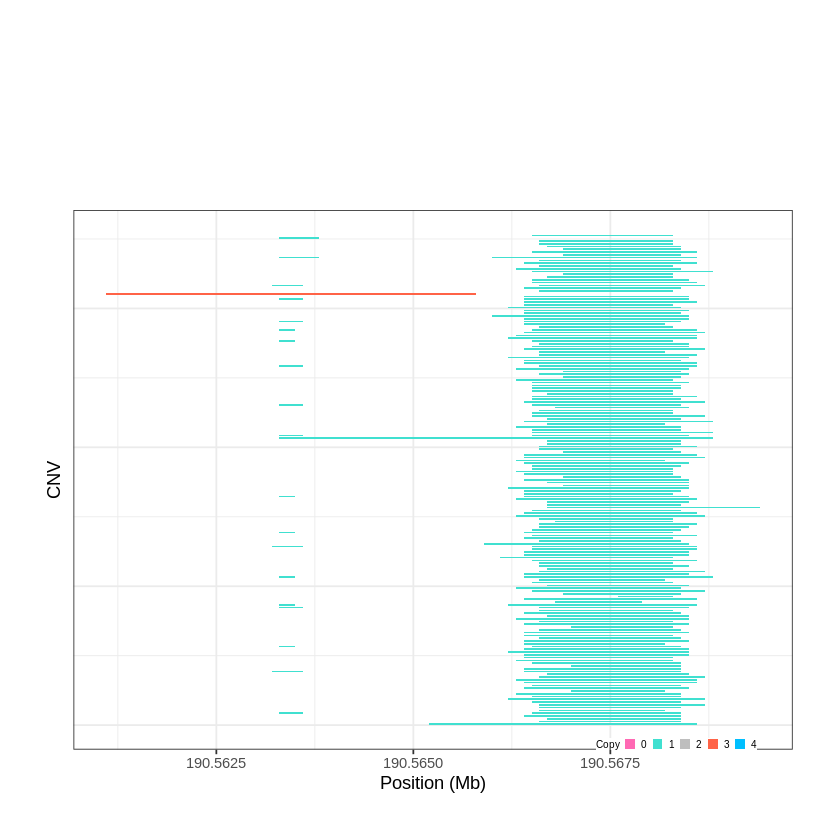

Task done, plot was stored in working directory.
[1] "Ploting CNVR 648..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 190.679901 - 190.685 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


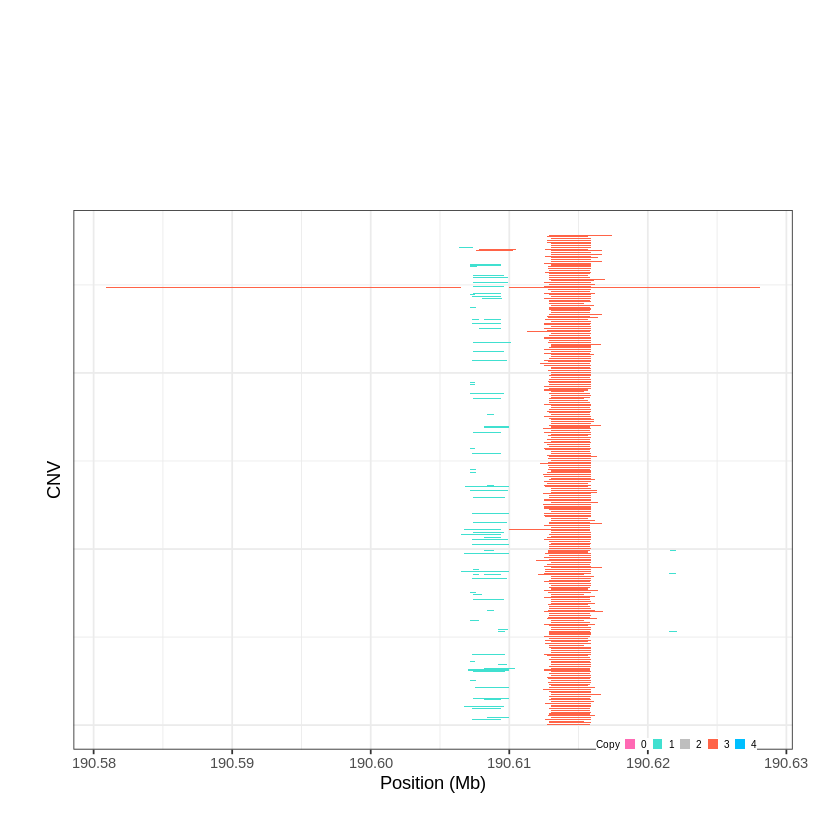

Task done, plot was stored in working directory.
[1] "Ploting CNVR 649..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 190.725401 - 190.7698 Mb with 219 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


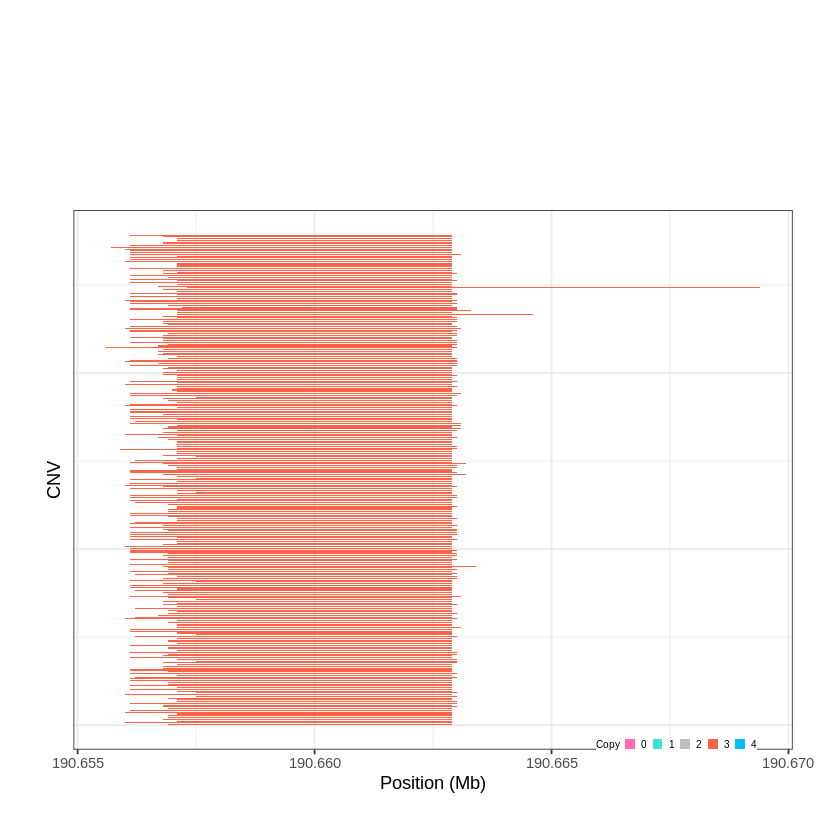

Task done, plot was stored in working directory.
[1] "Ploting CNVR 650..."
Input data passed requirment check...
[1] "CNV on Chromosome 4: 190.802401 - 191.1543 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


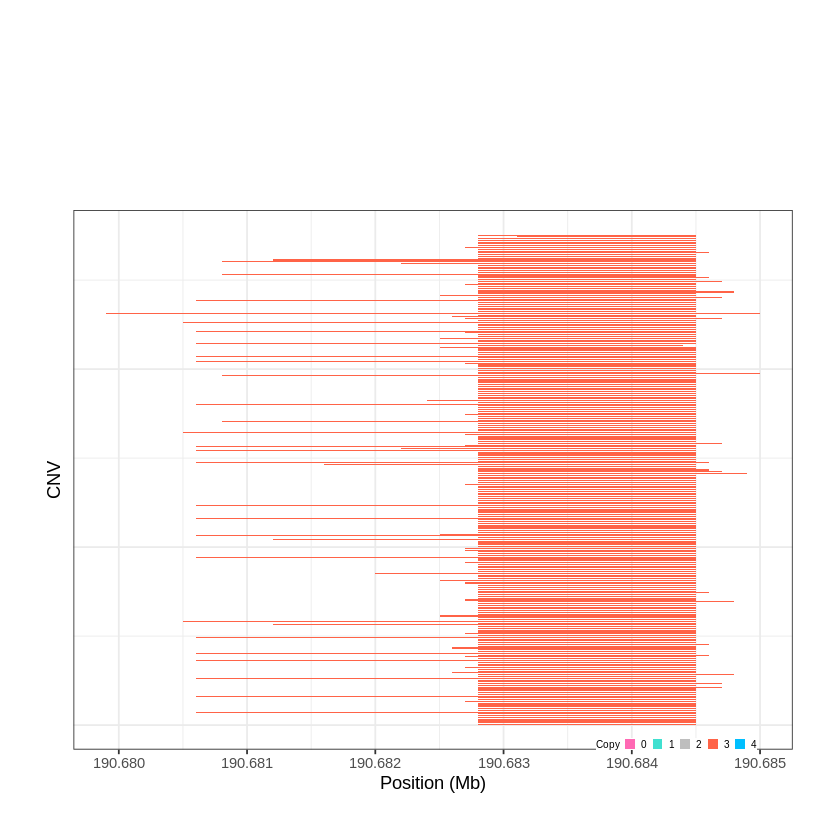

Task done, plot was stored in working directory.
[1] "Ploting CNVR 651..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 1e-06 - 0.01 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


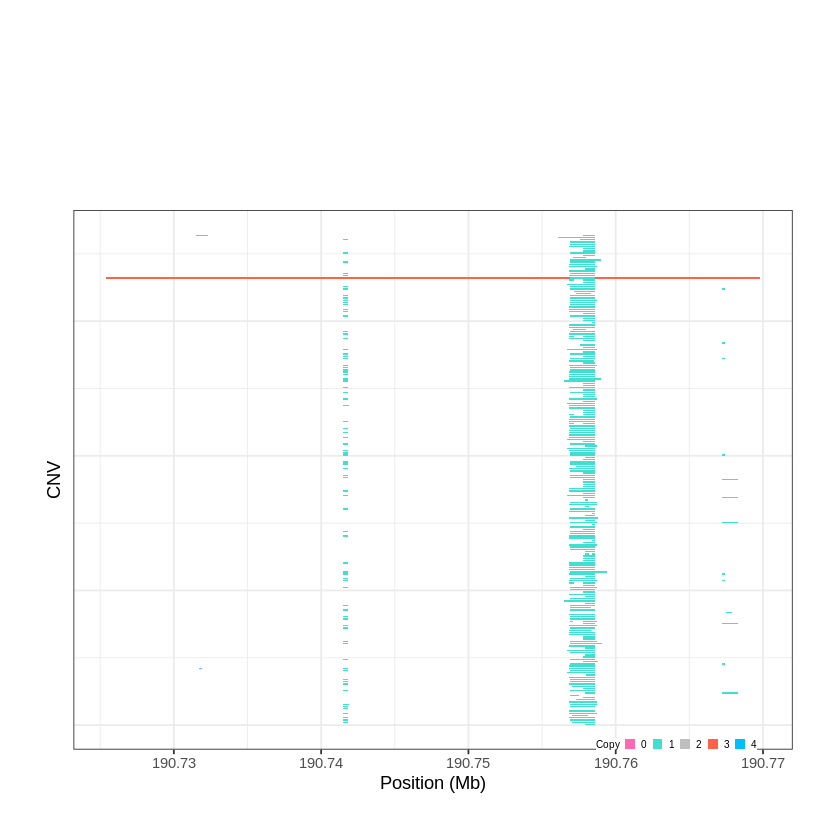

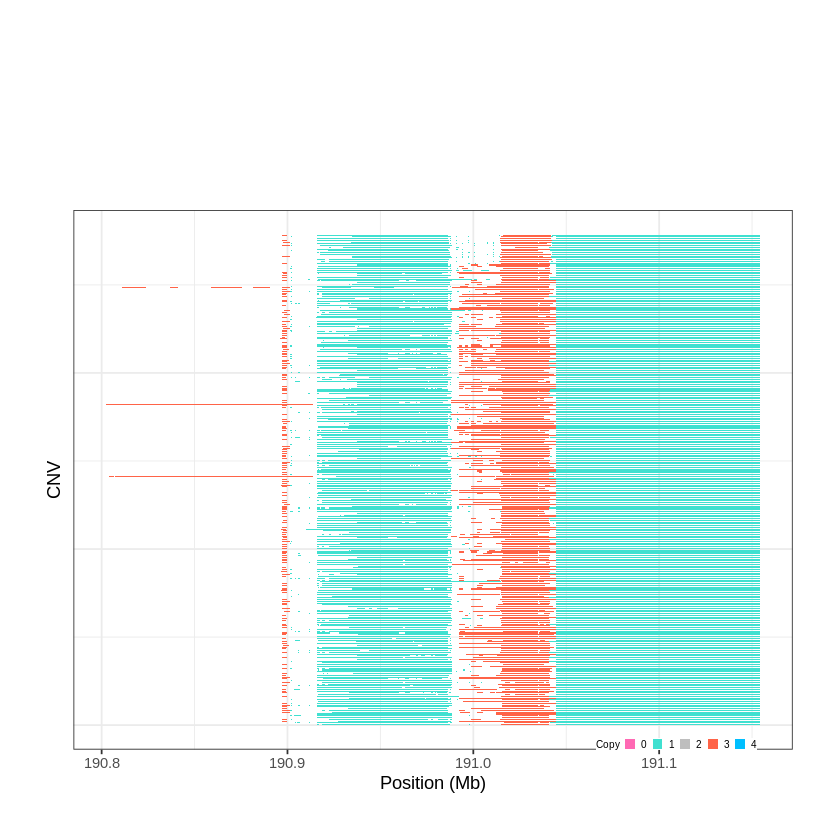

Task done, plot was stored in working directory.
[1] "Ploting CNVR 652..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 0.010001 - 0.3542 Mb with 279 Individual - "
Plotting gene...


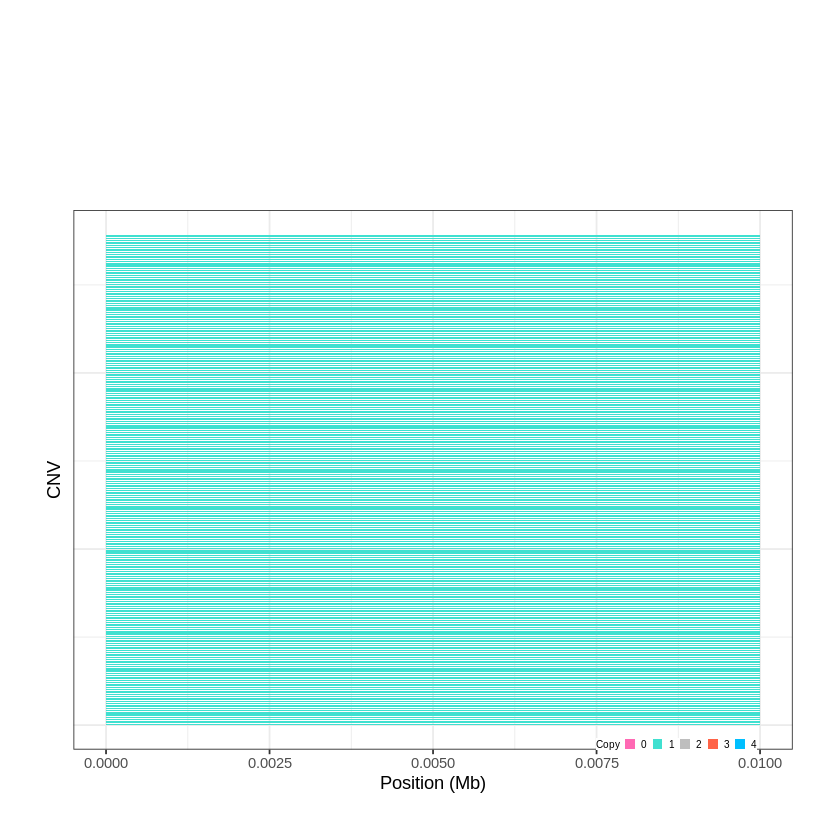

Task done, plot was stored in working directory.
[1] "Ploting CNVR 653..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 0.356201 - 1.062 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 654..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 1.069501 - 1.0792 Mb with 252 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


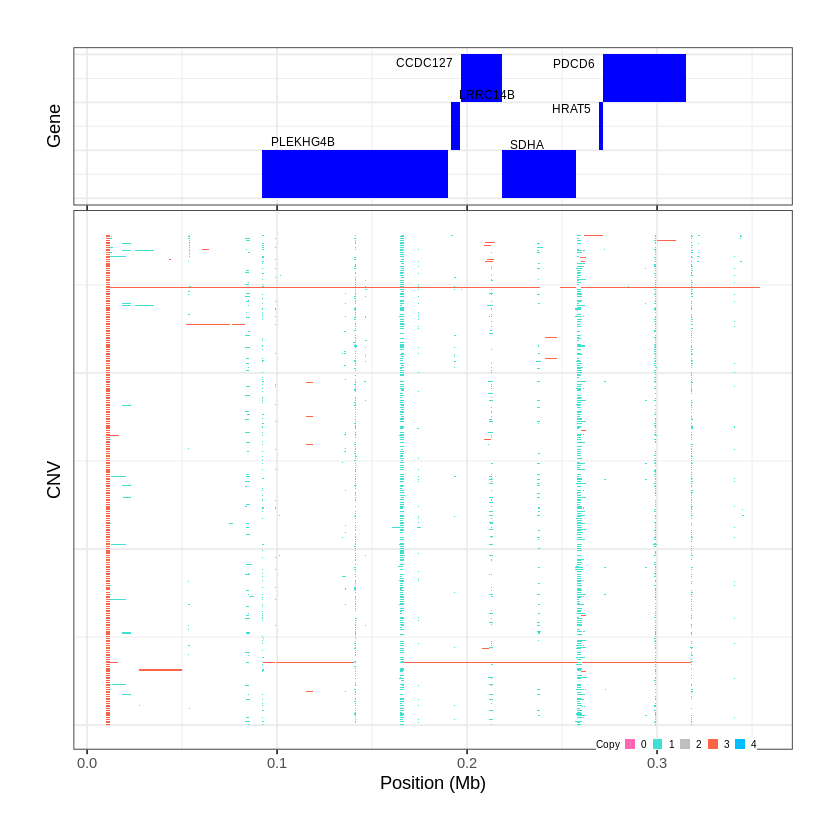

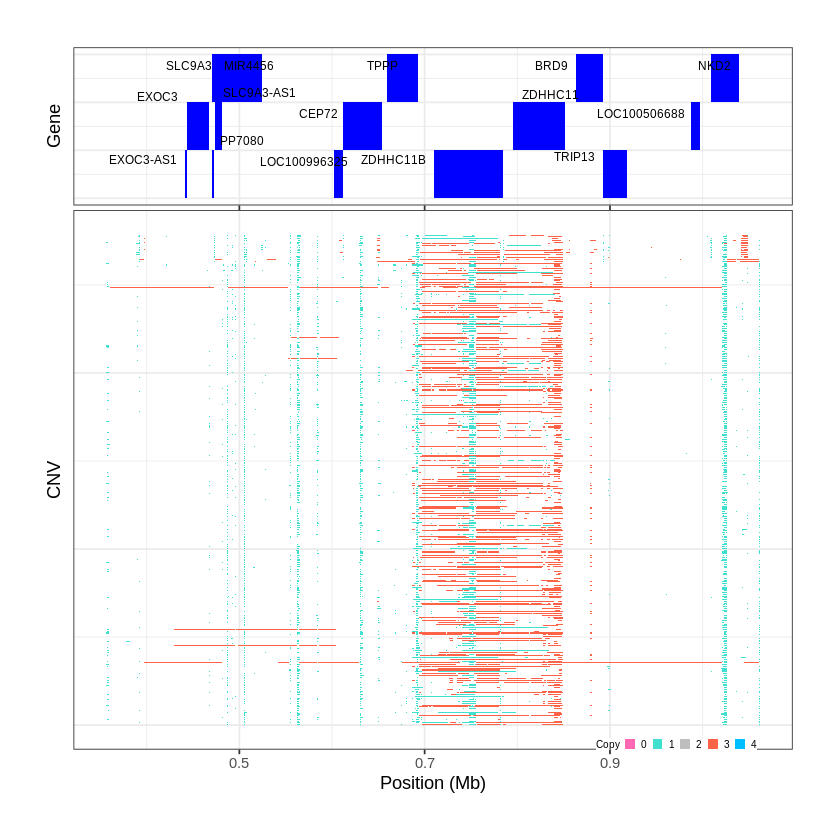

Task done, plot was stored in working directory.
[1] "Ploting CNVR 655..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 1.080501 - 3.1291 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


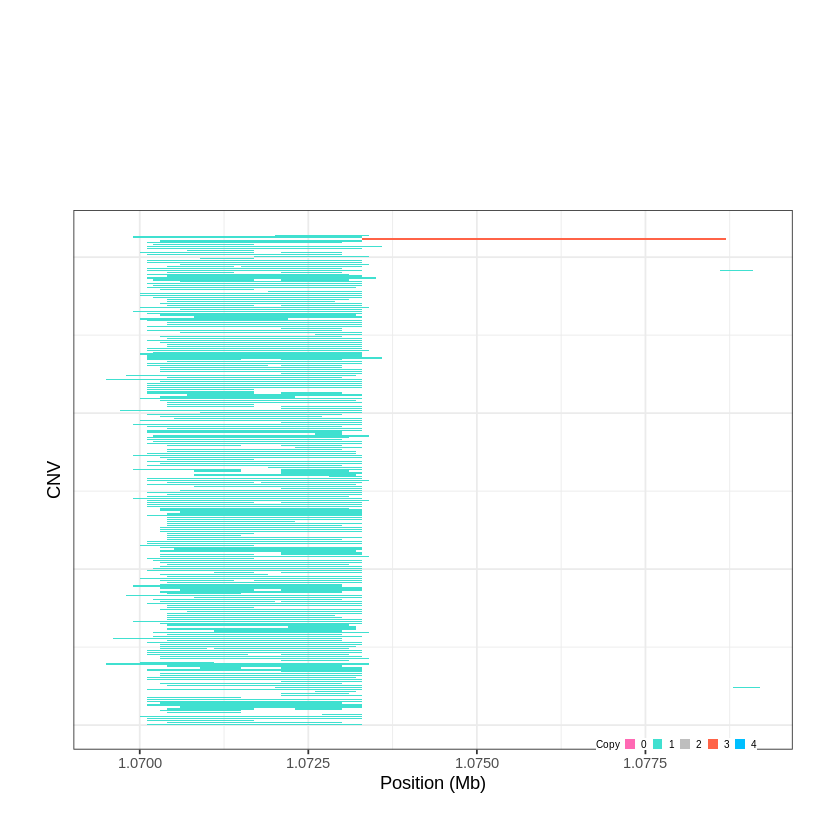

Task done, plot was stored in working directory.
[1] "Ploting CNVR 656..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 3.174401 - 3.4605 Mb with 157 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 657..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 3.499301 - 3.4996 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


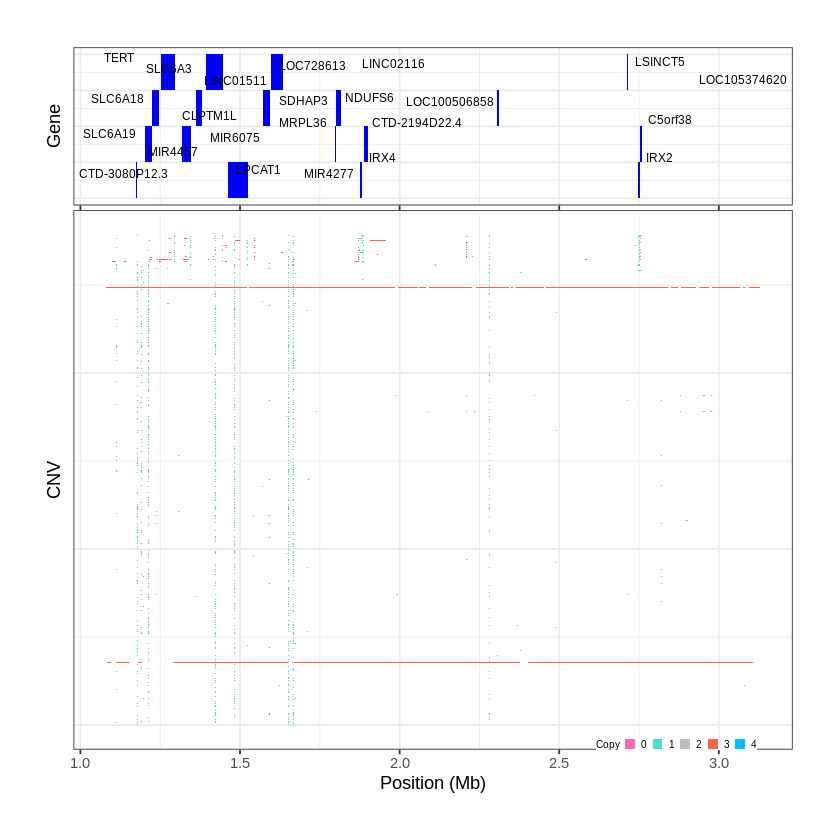

Task done, plot was stored in working directory.
[1] "Ploting CNVR 658..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 3.502401 - 3.5026 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


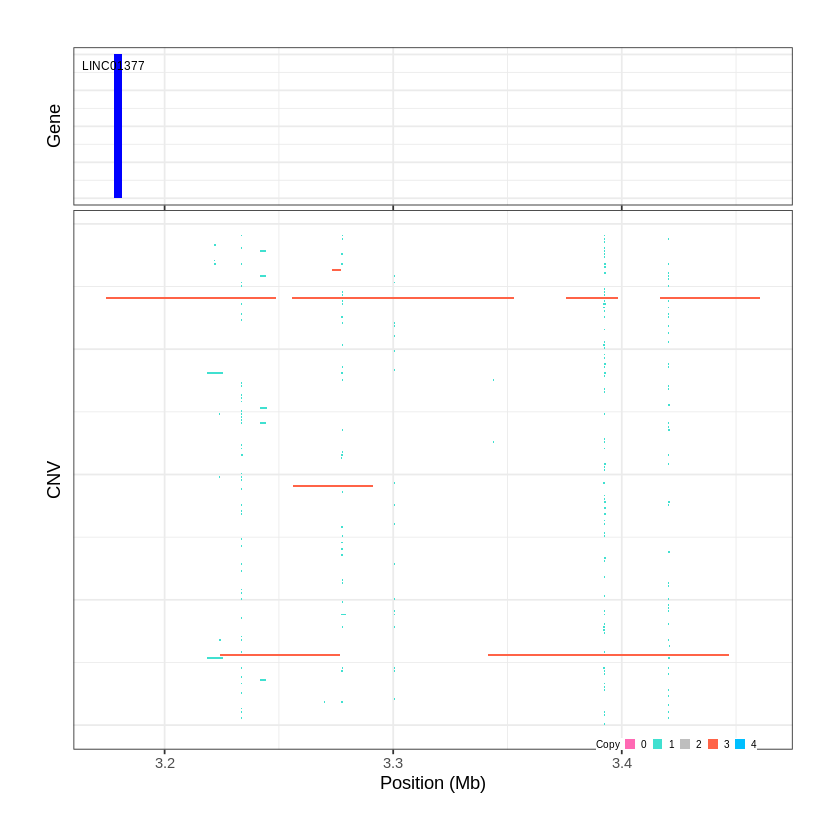

Task done, plot was stored in working directory.
[1] "Ploting CNVR 659..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 3.637401 - 3.6397 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


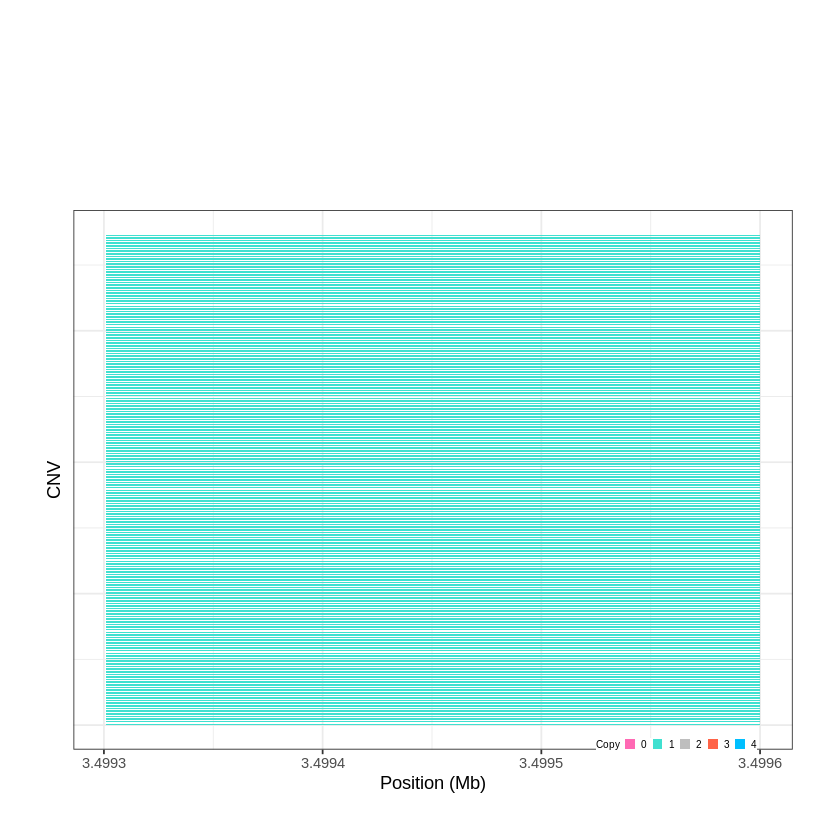

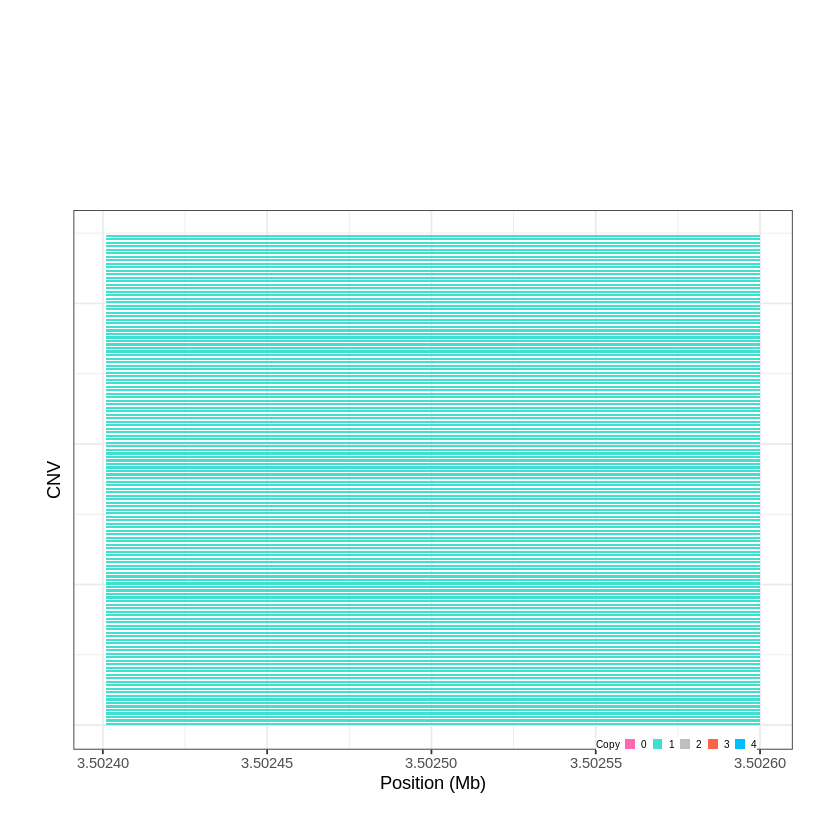

Task done, plot was stored in working directory.
[1] "Ploting CNVR 660..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 4.189301 - 5.8104 Mb with 274 Individual - "
Plotting gene...


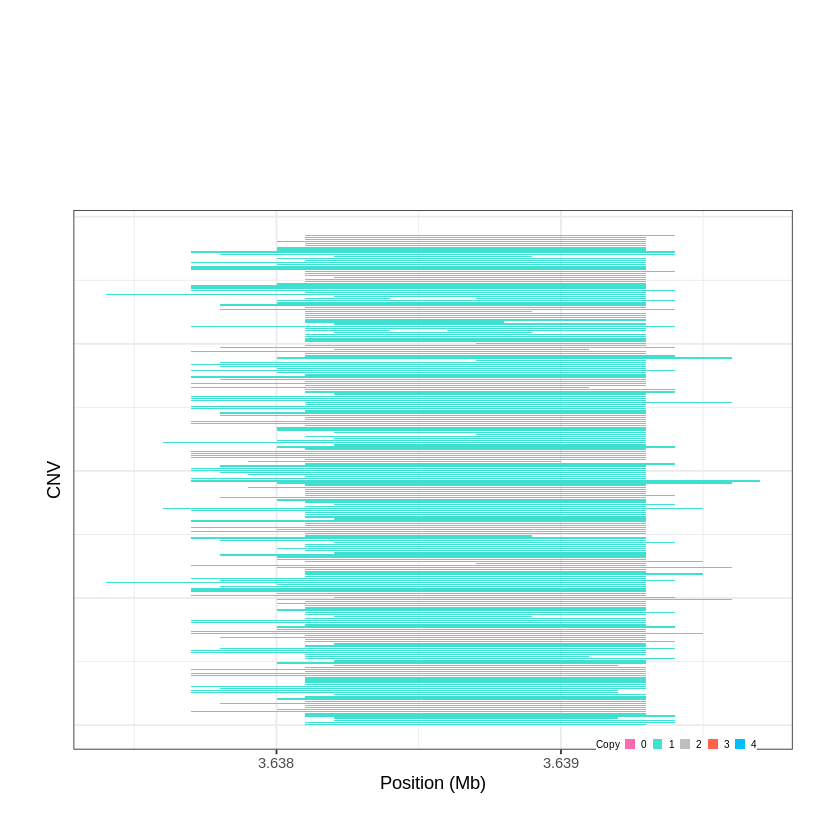

Task done, plot was stored in working directory.
[1] "Ploting CNVR 661..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 5.810401 - 8.2737 Mb with 277 Individual - "
Plotting gene...


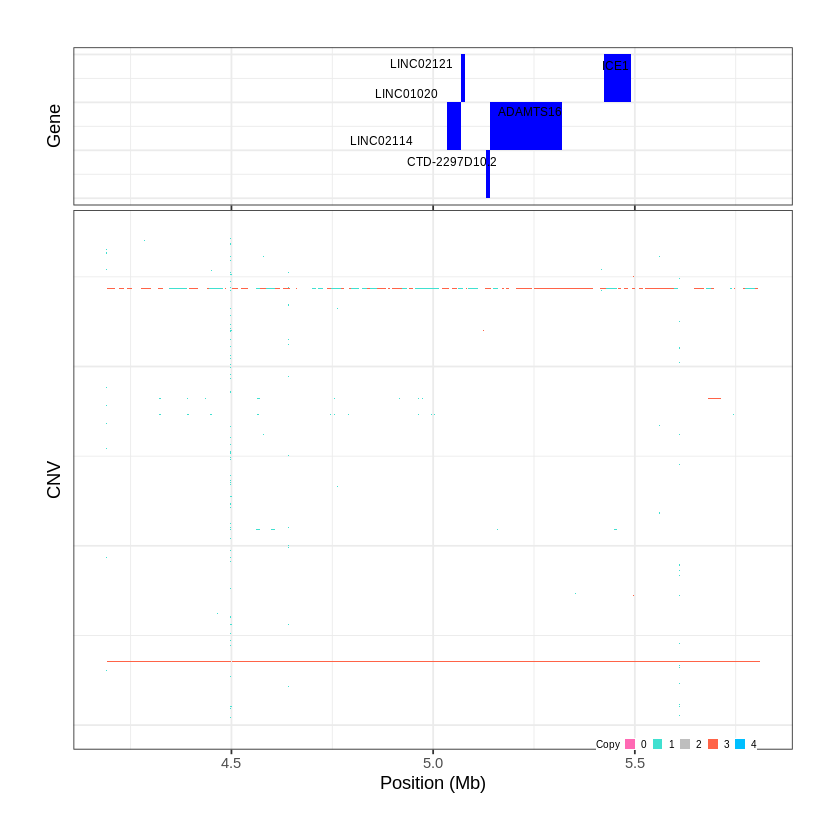

Task done, plot was stored in working directory.
[1] "Ploting CNVR 662..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 8.275101 - 12.7253 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 16 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 663..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 12.811001 - 12.8334 Mb with 157 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


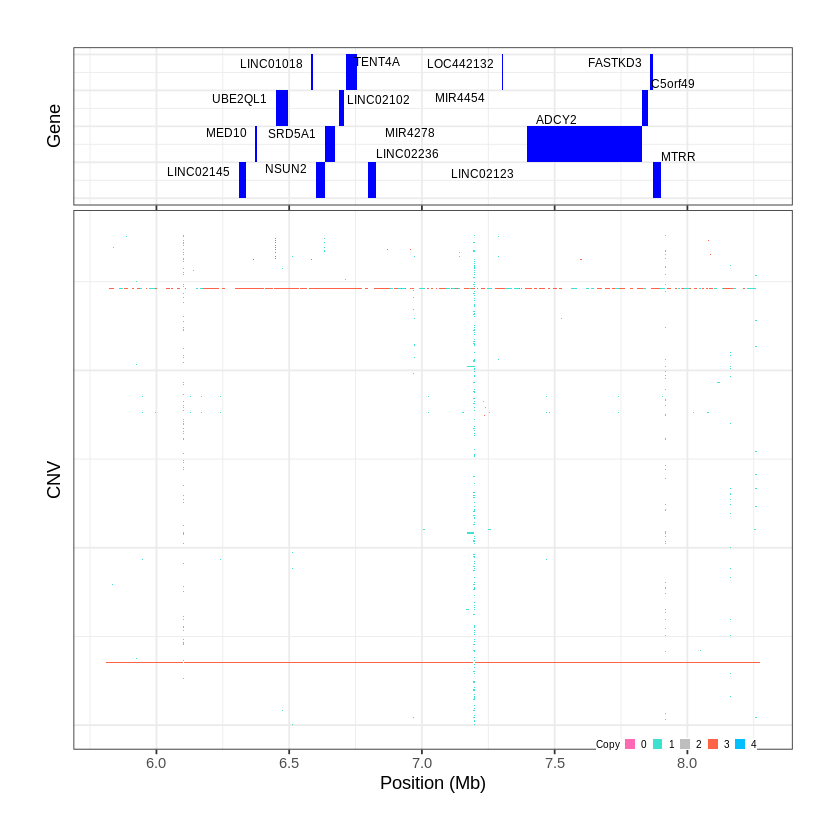

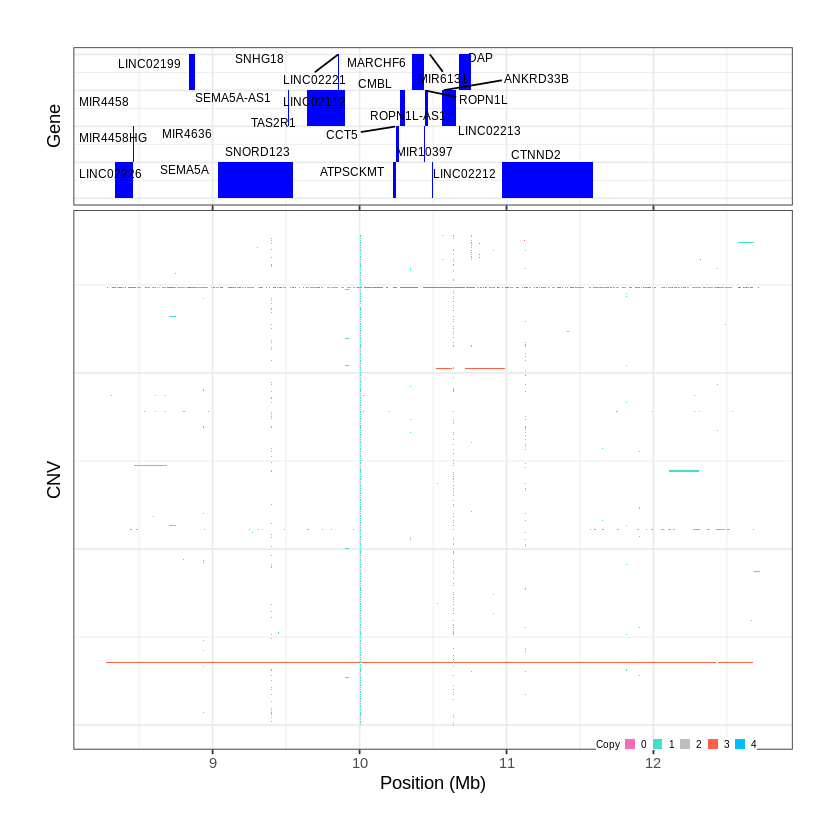

Task done, plot was stored in working directory.
[1] "Ploting CNVR 664..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 12.863701 - 15.9071 Mb with 274 Individual - "
Plotting gene...


Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


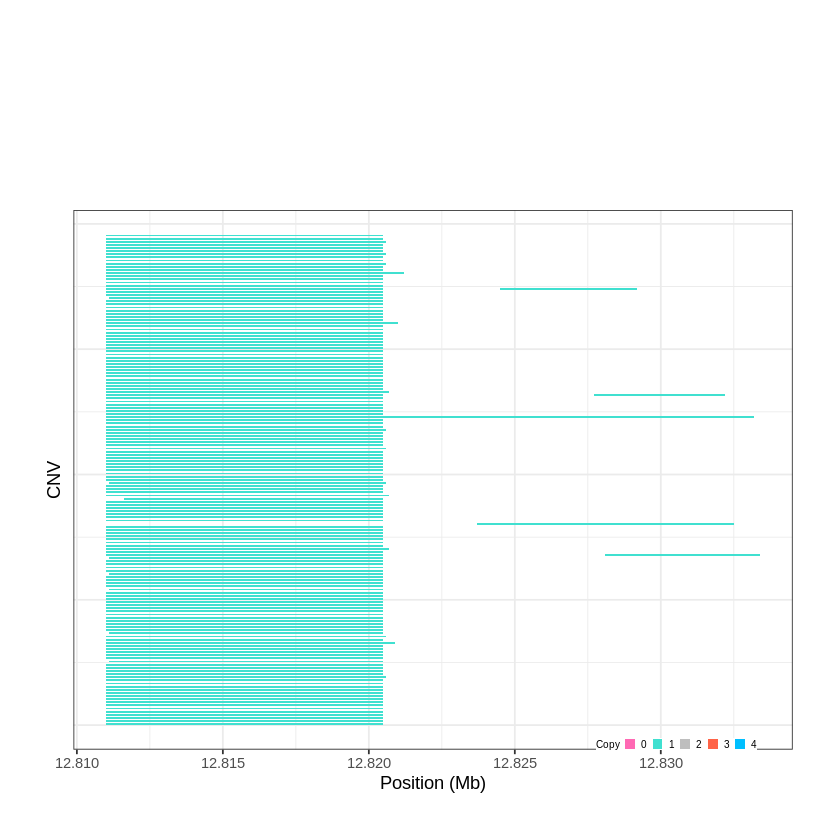

Task done, plot was stored in working directory.
[1] "Ploting CNVR 665..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 15.907101 - 16.8327 Mb with 164 Individual - "
Plotting gene...


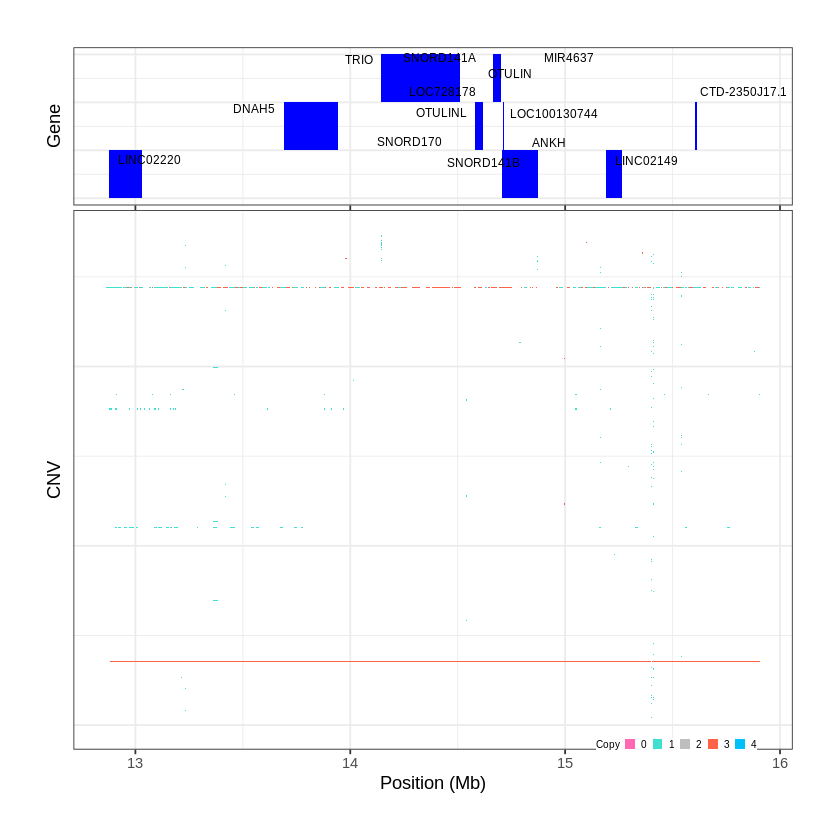

Task done, plot was stored in working directory.
[1] "Ploting CNVR 666..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 17.200201 - 17.9604 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 667..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 18.669001 - 18.6755 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


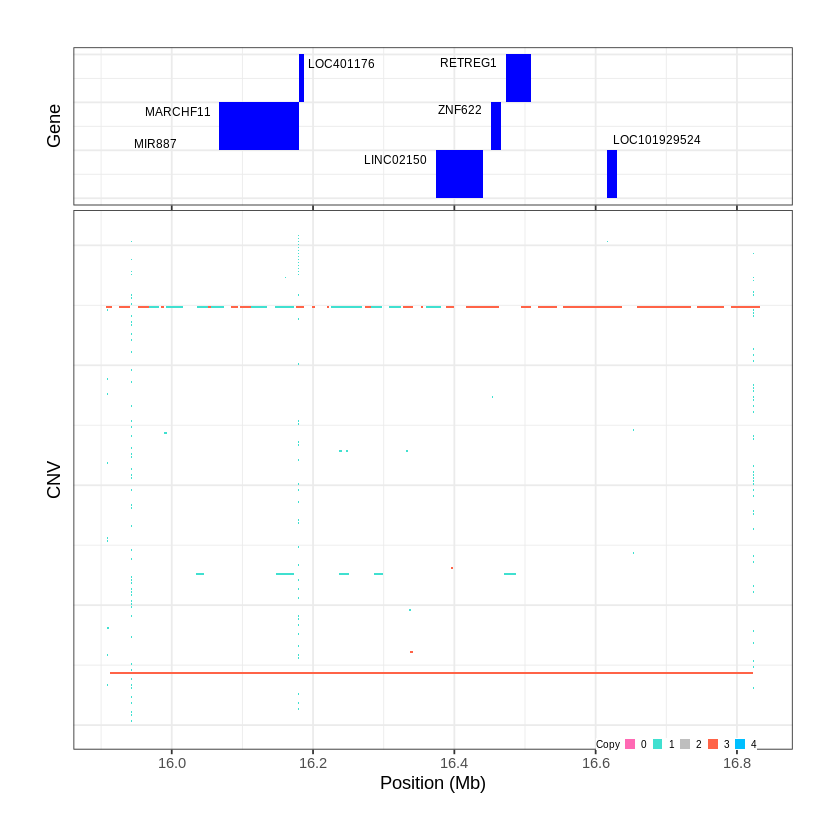

Task done, plot was stored in working directory.
[1] "Ploting CNVR 668..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 19.219601 - 19.2443 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


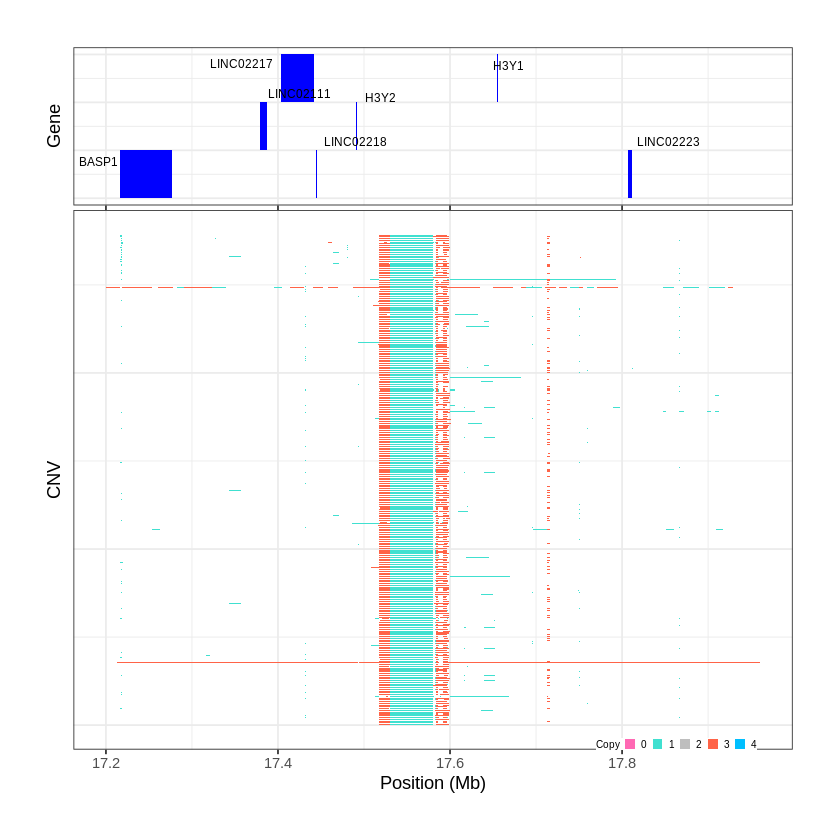

Task done, plot was stored in working directory.
[1] "Ploting CNVR 669..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 20.818501 - 20.8371 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


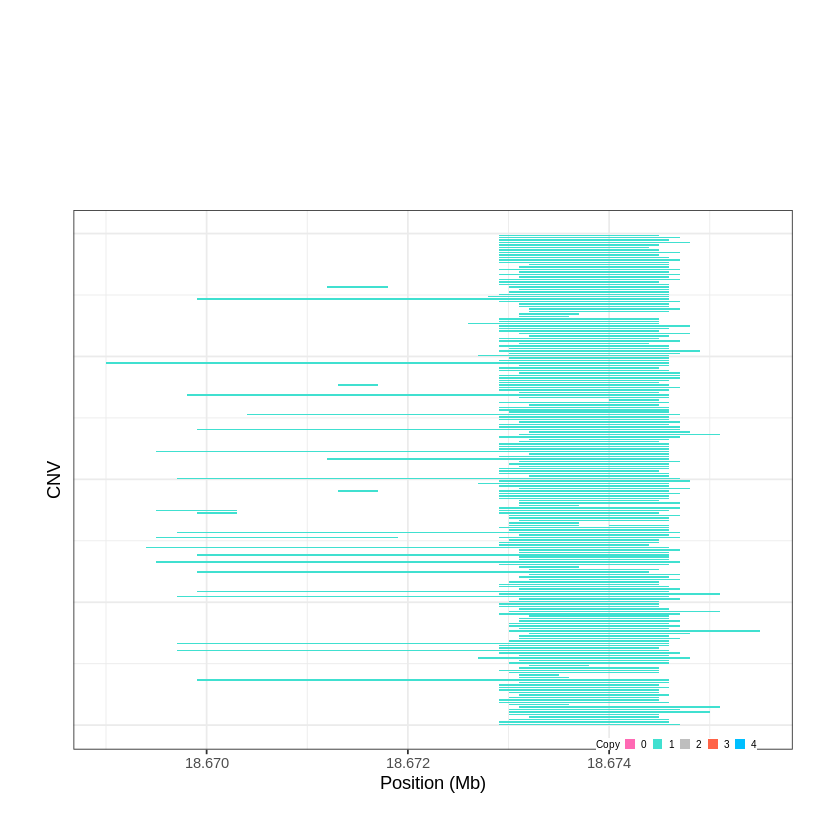

Task done, plot was stored in working directory.
[1] "Ploting CNVR 670..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 21.334201 - 21.3401 Mb with 184 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


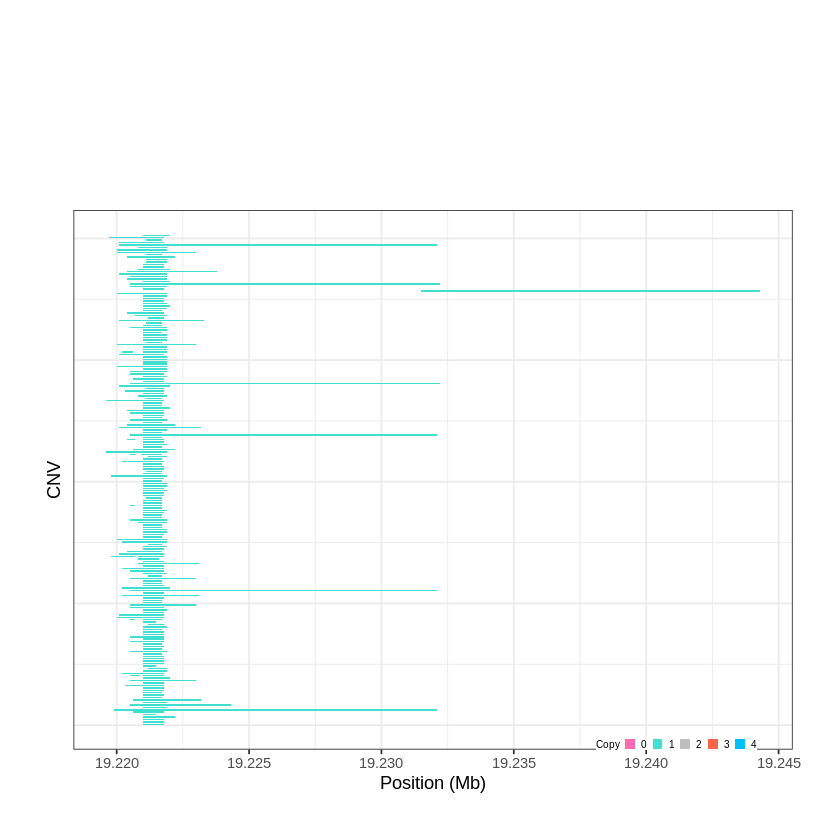

Task done, plot was stored in working directory.
[1] "Ploting CNVR 671..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 21.449501 - 21.4565 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


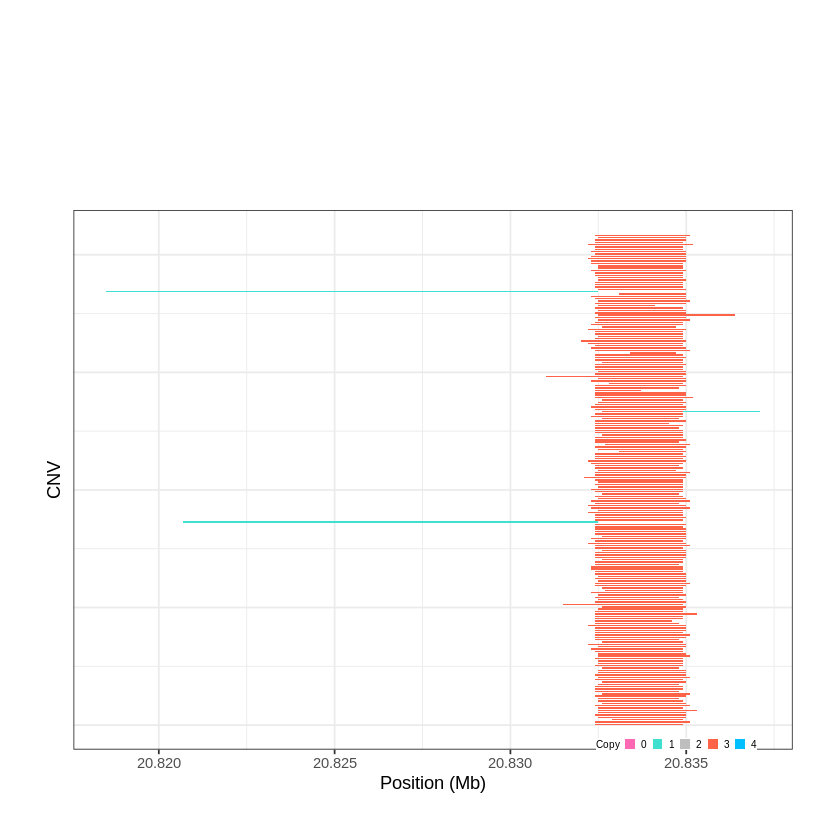

Task done, plot was stored in working directory.
[1] "Ploting CNVR 672..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 21.456501 - 21.5859 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


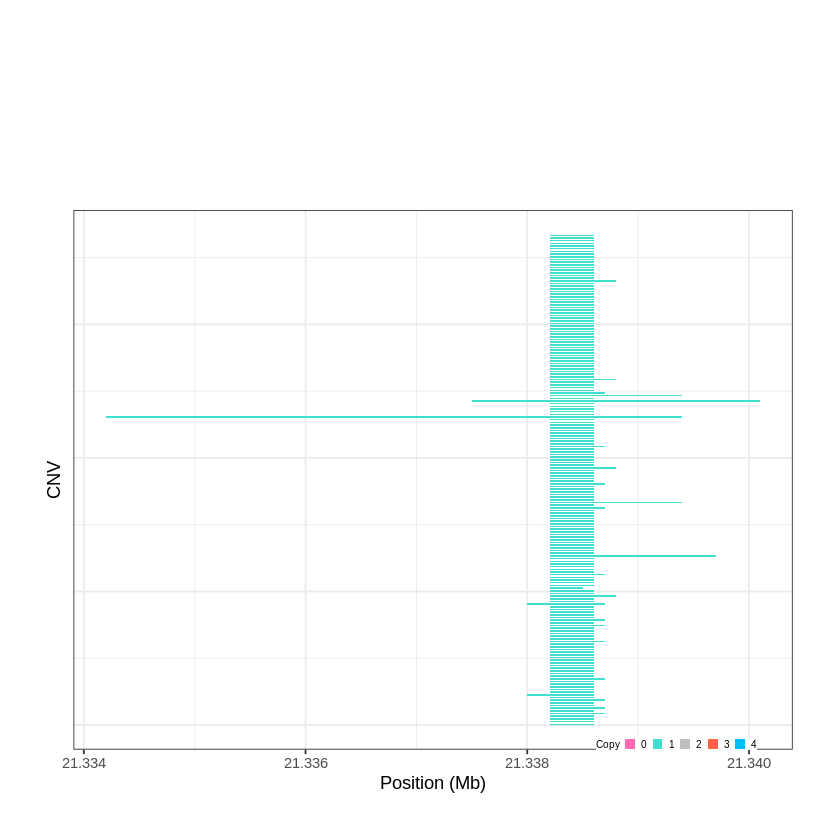

Task done, plot was stored in working directory.
[1] "Ploting CNVR 673..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 23.889001 - 23.9083 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


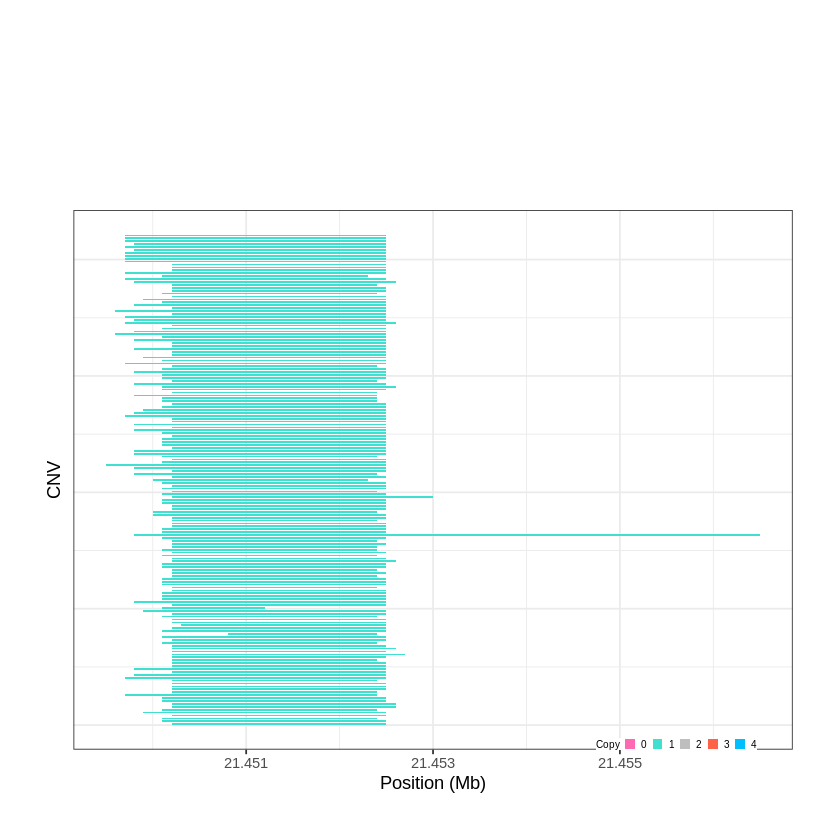

Task done, plot was stored in working directory.
[1] "Ploting CNVR 674..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 25.769601 - 25.784 Mb with 231 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


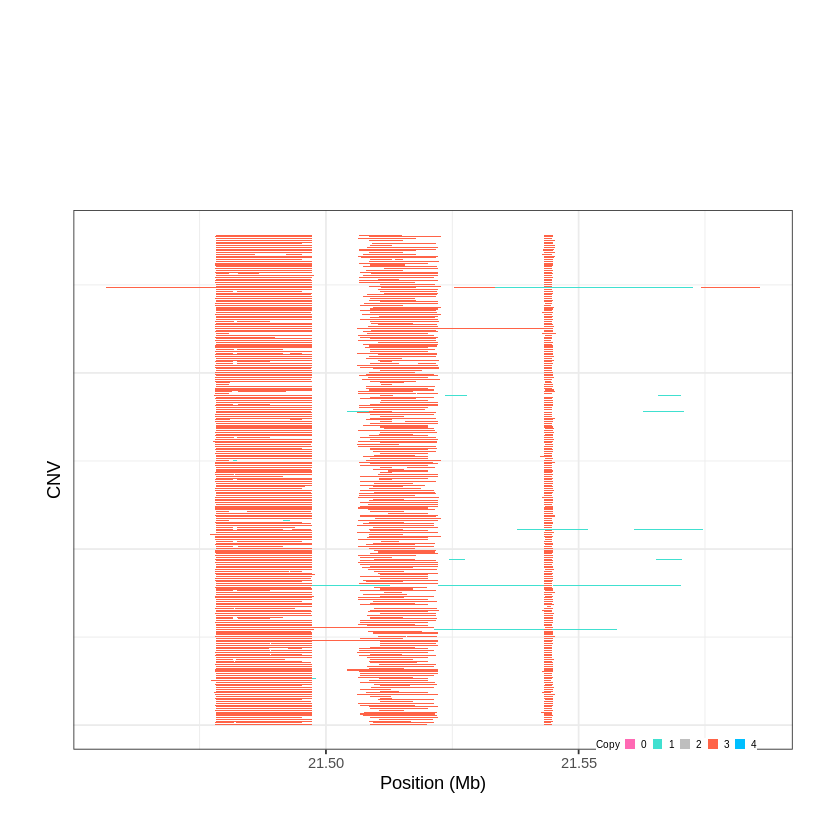

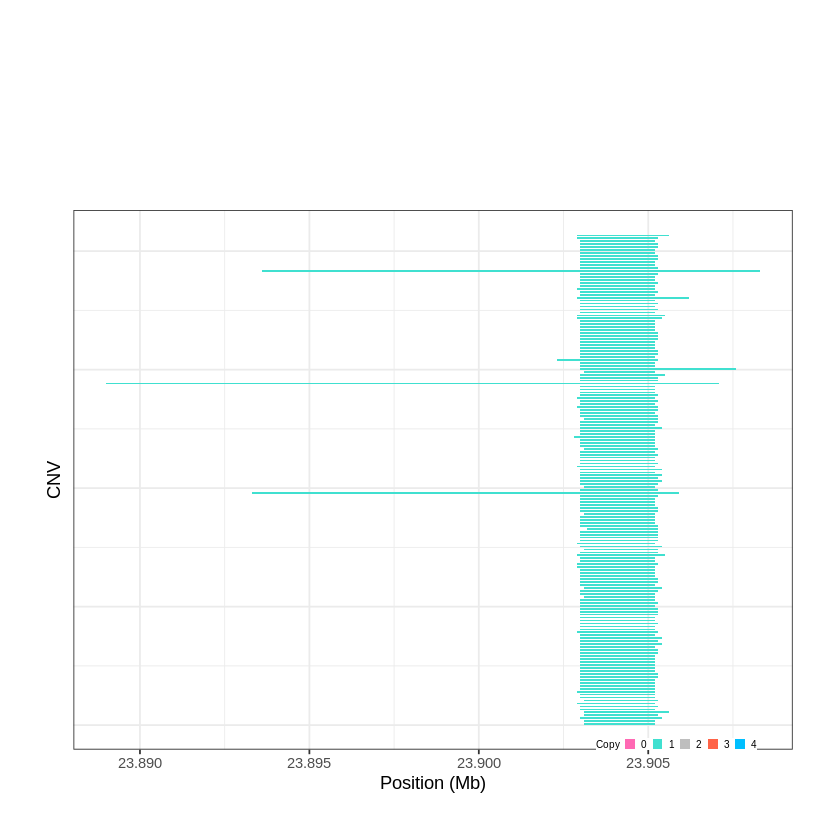

Task done, plot was stored in working directory.
[1] "Ploting CNVR 675..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 28.907701 - 28.95 Mb with 227 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 676..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 30.781301 - 30.8242 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


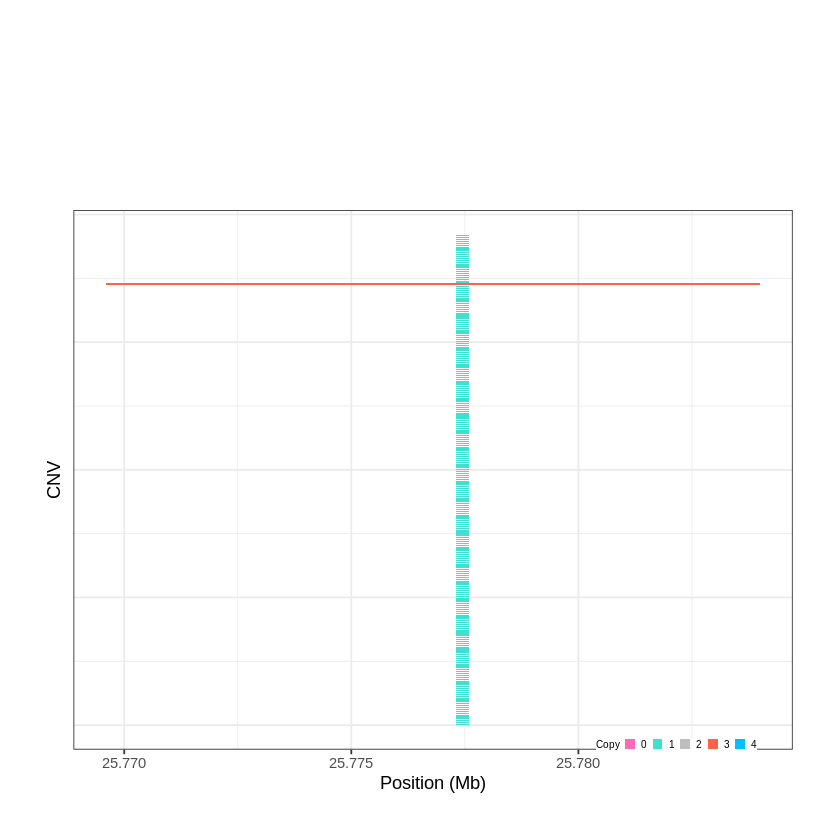

Task done, plot was stored in working directory.
[1] "Ploting CNVR 677..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 33.480601 - 33.4818 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


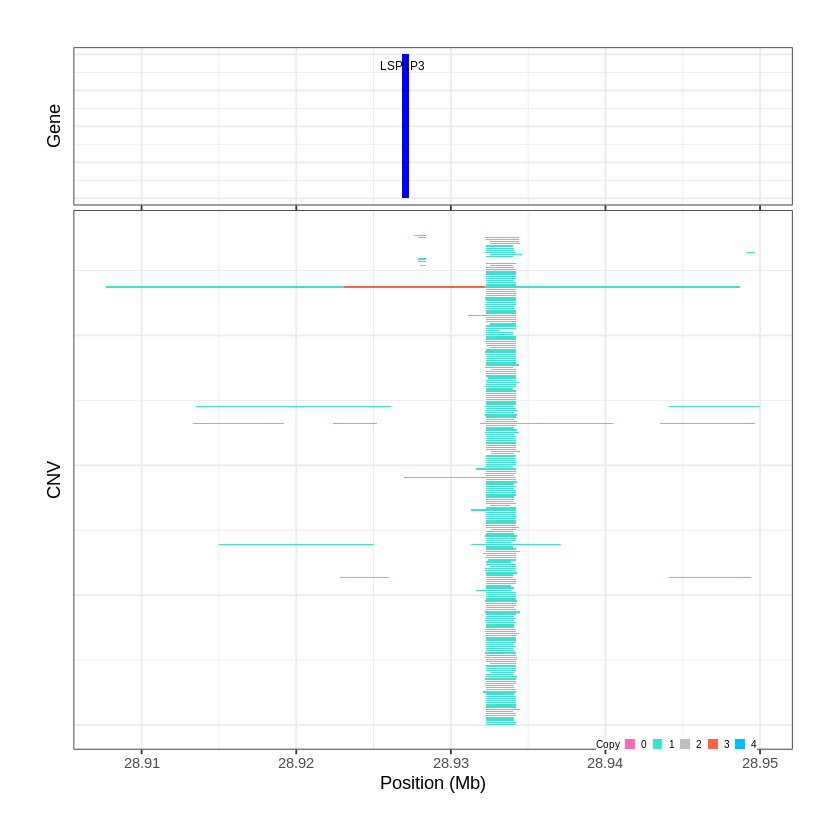

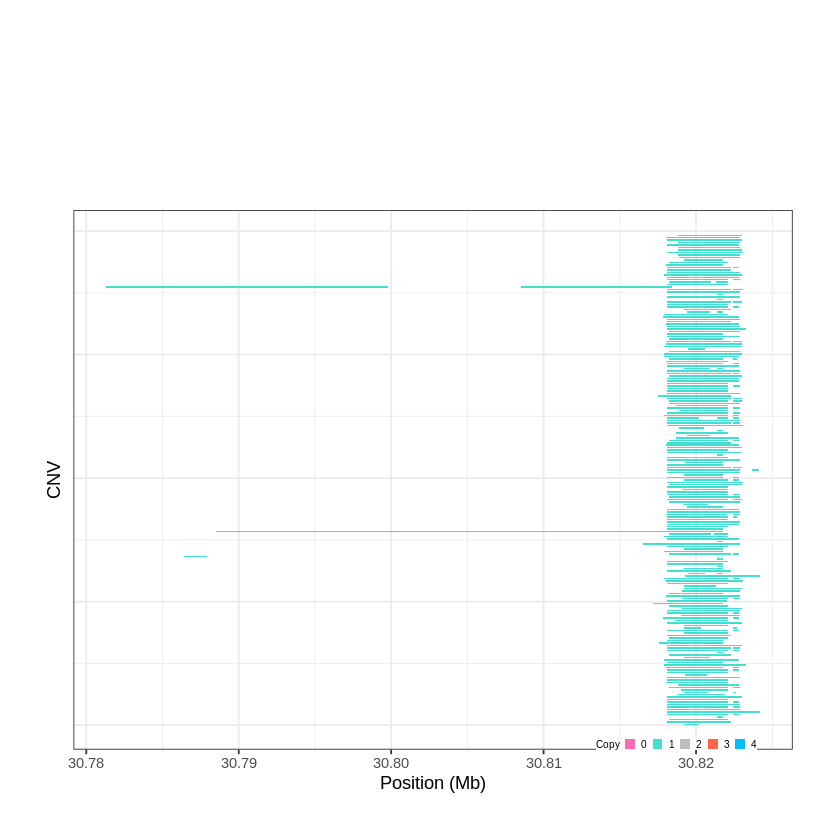

Task done, plot was stored in working directory.
[1] "Ploting CNVR 678..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 34.172601 - 34.2131 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 679..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 34.390601 - 34.4021 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


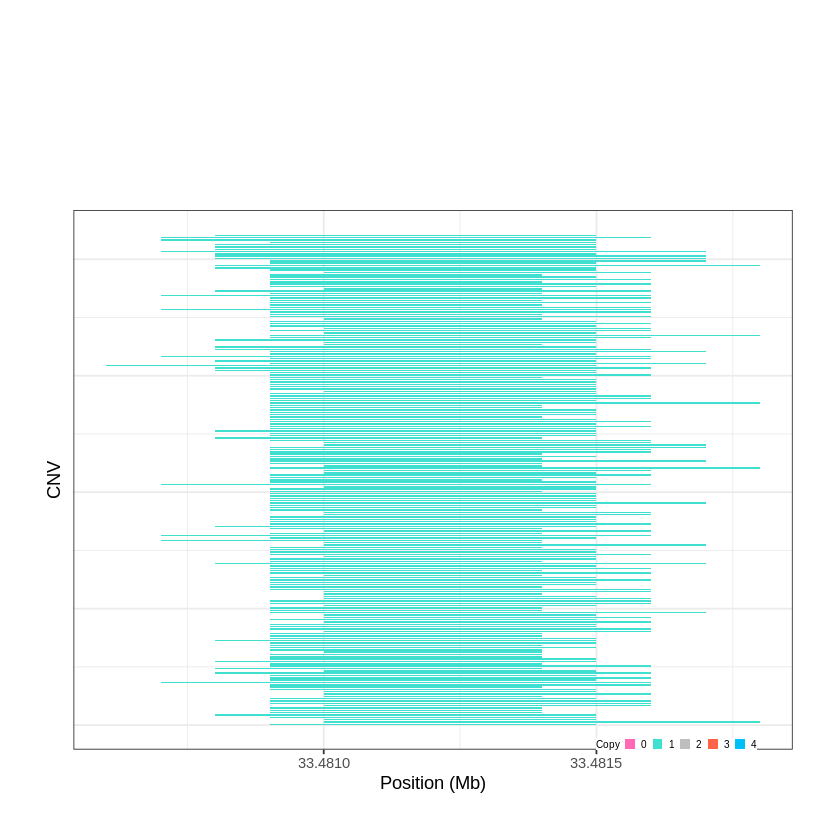

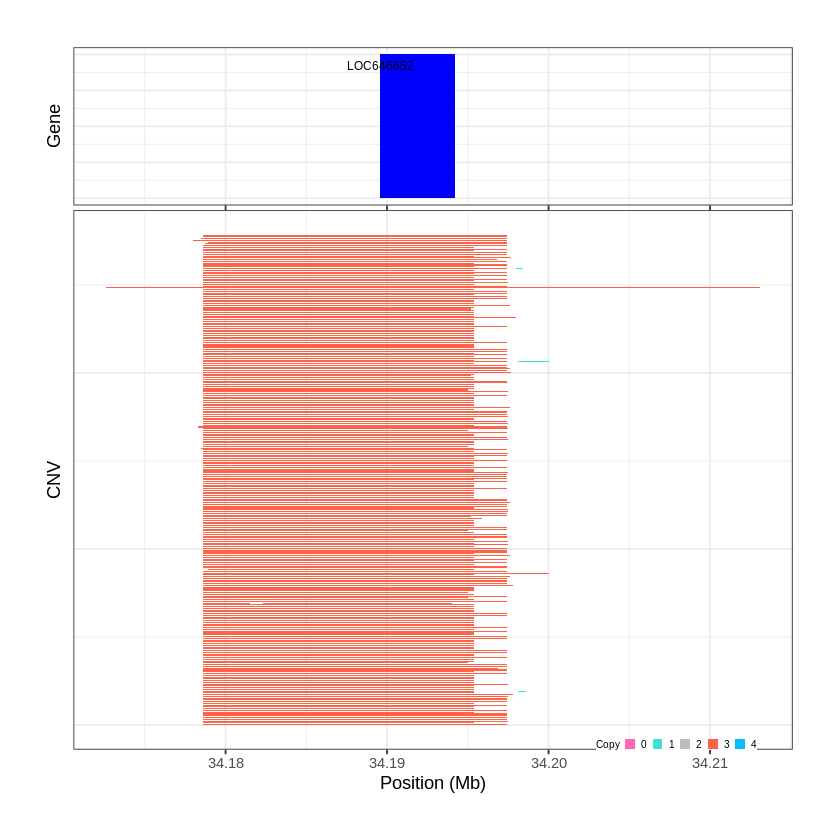

Task done, plot was stored in working directory.
[1] "Ploting CNVR 680..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 37.282801 - 37.598 Mb with 197 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 681..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 45.825901 - 49.4056 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


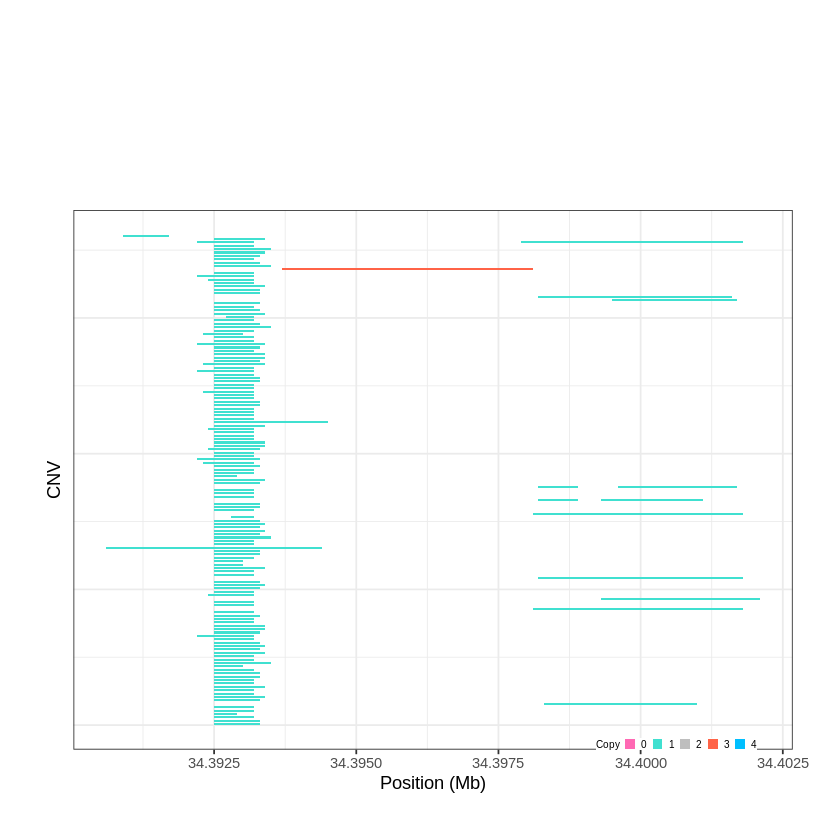

Task done, plot was stored in working directory.
[1] "Ploting CNVR 682..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 49.405601 - 49.5547 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


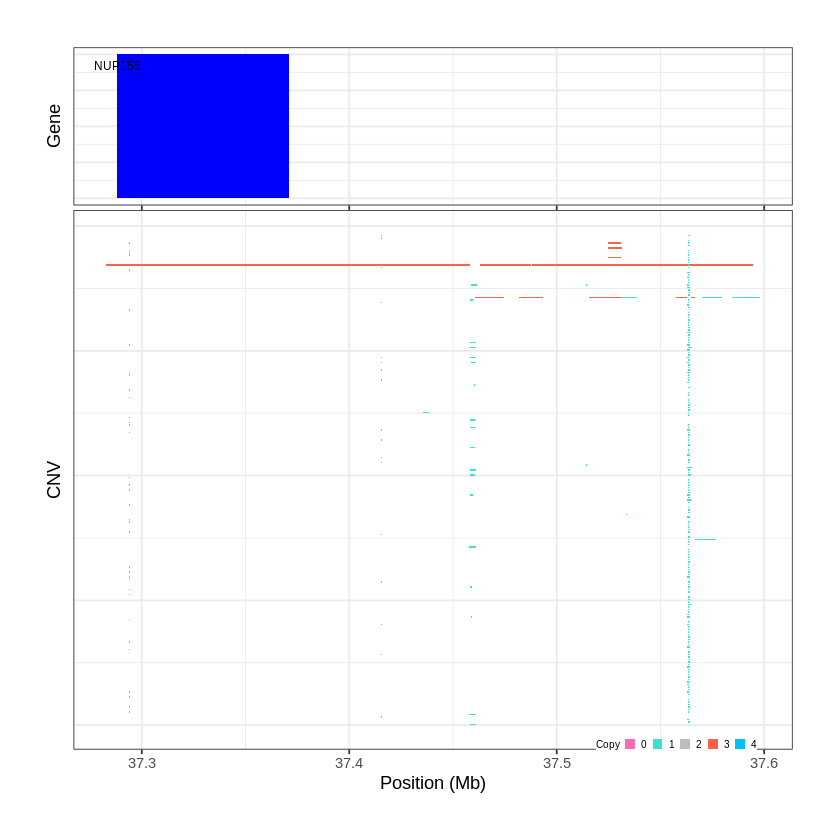

Task done, plot was stored in working directory.
[1] "Ploting CNVR 683..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 49.939701 - 49.9478 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


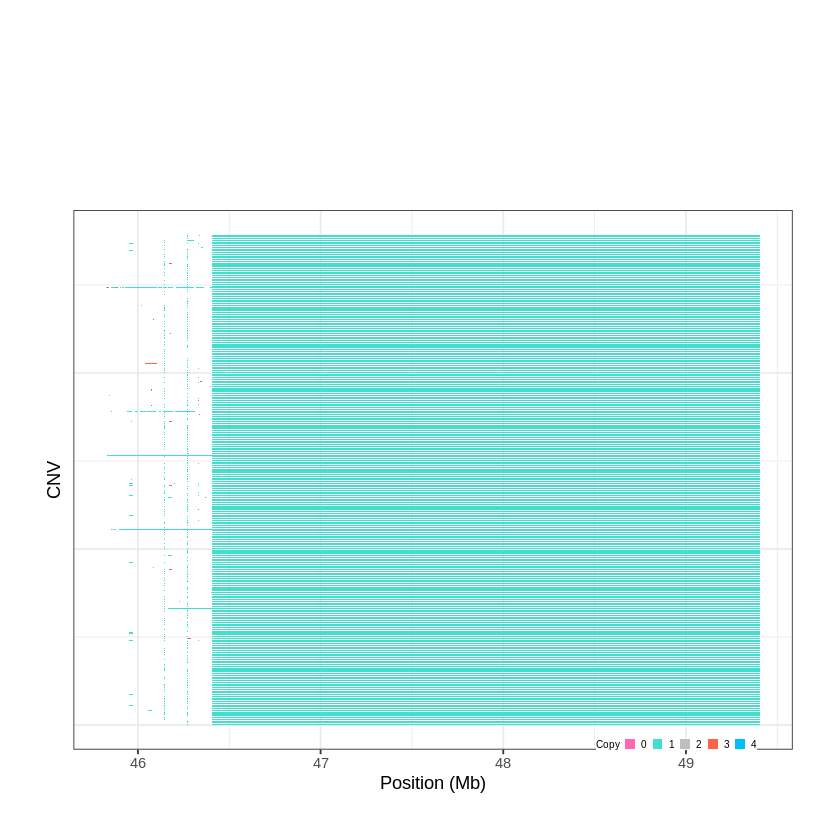

Task done, plot was stored in working directory.
[1] "Ploting CNVR 684..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 54.710001 - 54.768 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


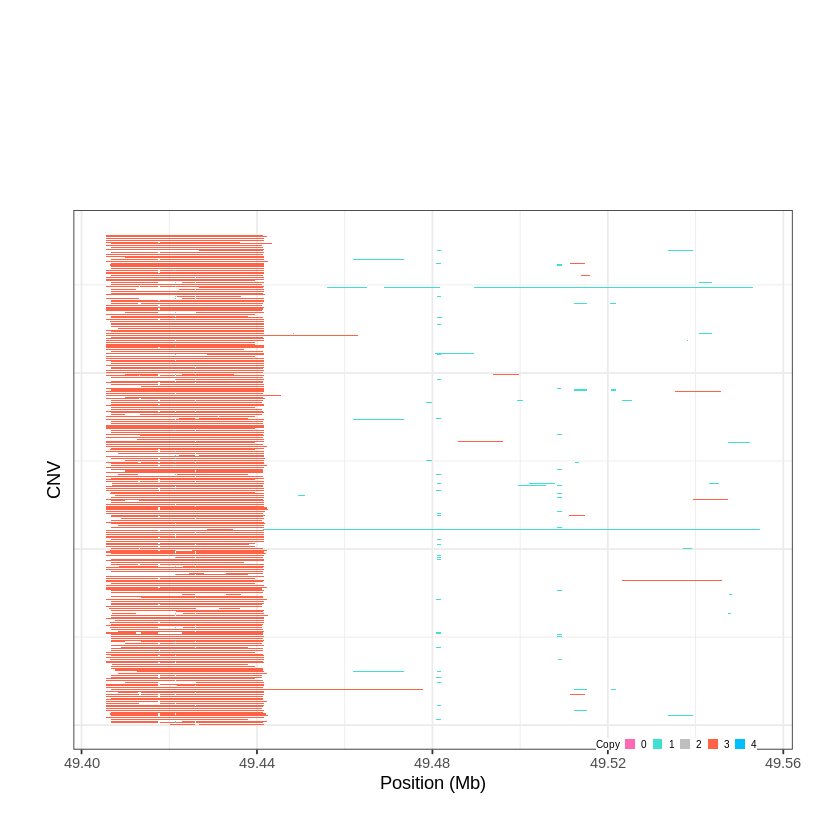

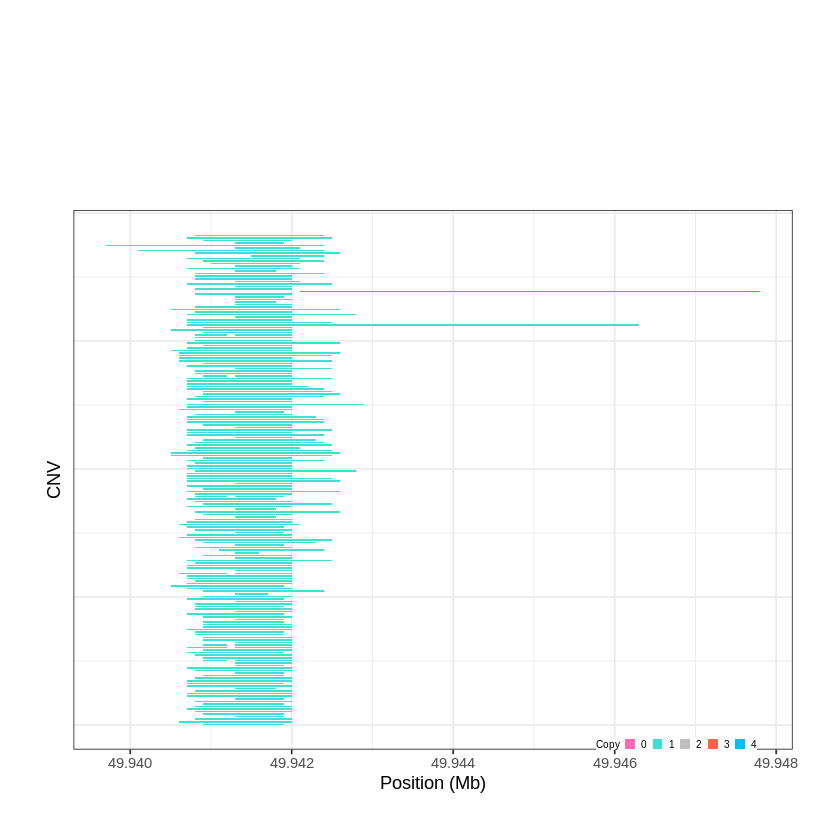

Task done, plot was stored in working directory.
[1] "Ploting CNVR 685..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 55.172801 - 55.2318 Mb with 244 Individual - "
Plotting gene...


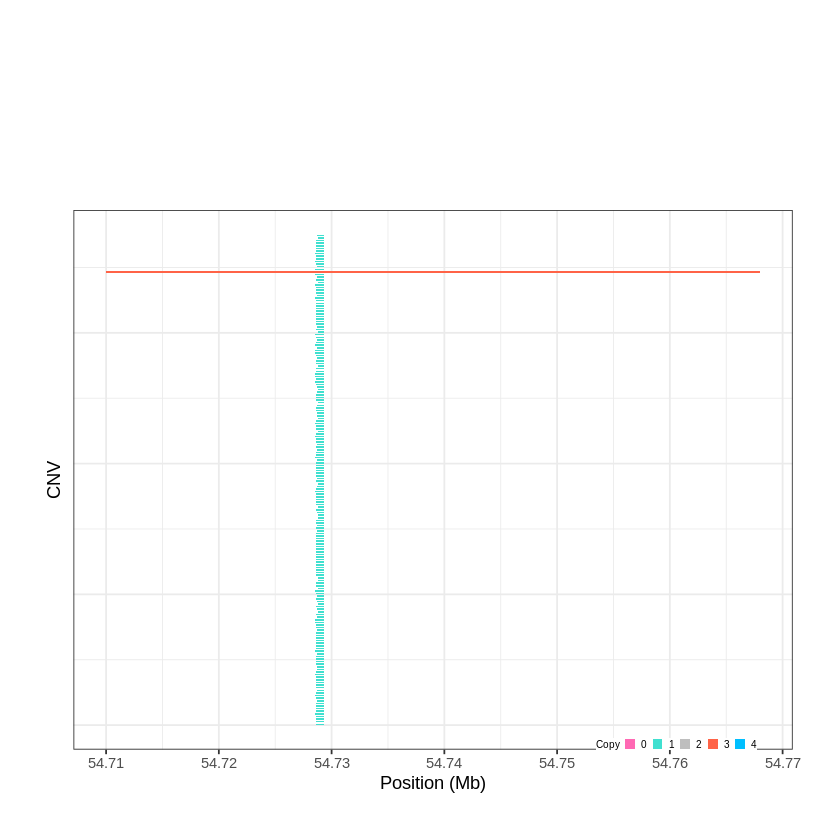

Task done, plot was stored in working directory.
[1] "Ploting CNVR 686..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 55.247101 - 55.4304 Mb with 177 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 687..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 57.286501 - 57.3472 Mb with 269 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


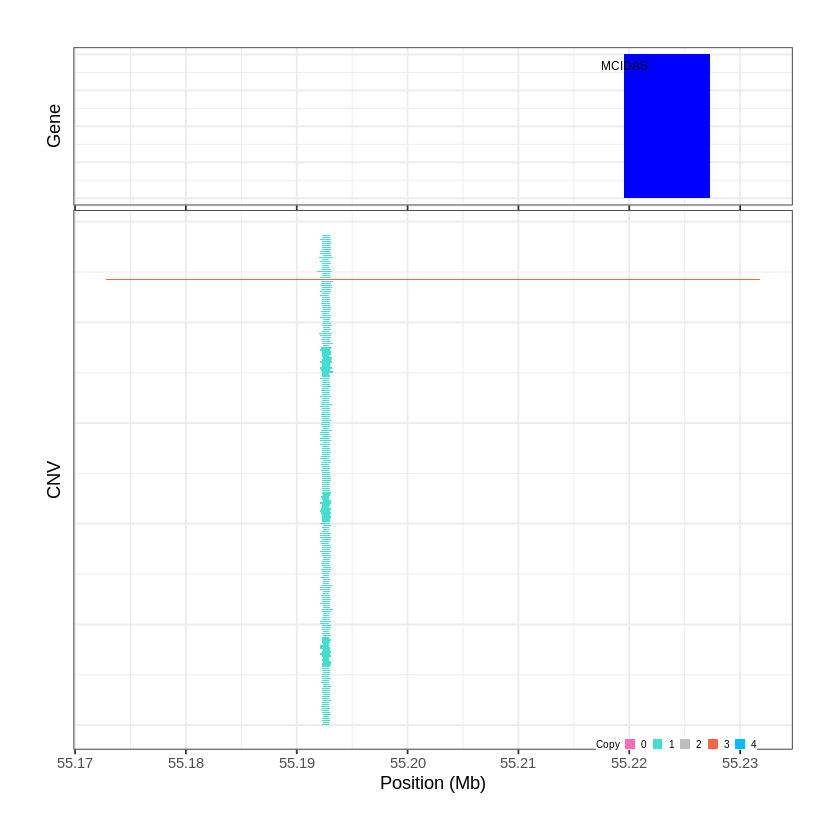

Task done, plot was stored in working directory.
[1] "Ploting CNVR 688..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 57.660101 - 57.7203 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


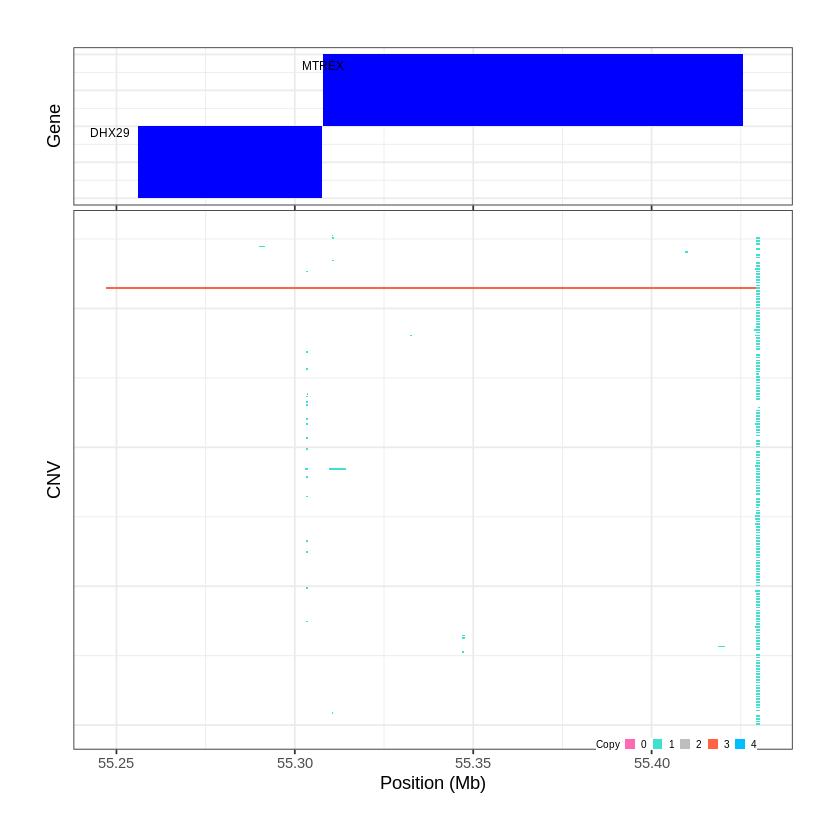

Task done, plot was stored in working directory.
[1] "Ploting CNVR 689..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 57.890501 - 57.8947 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


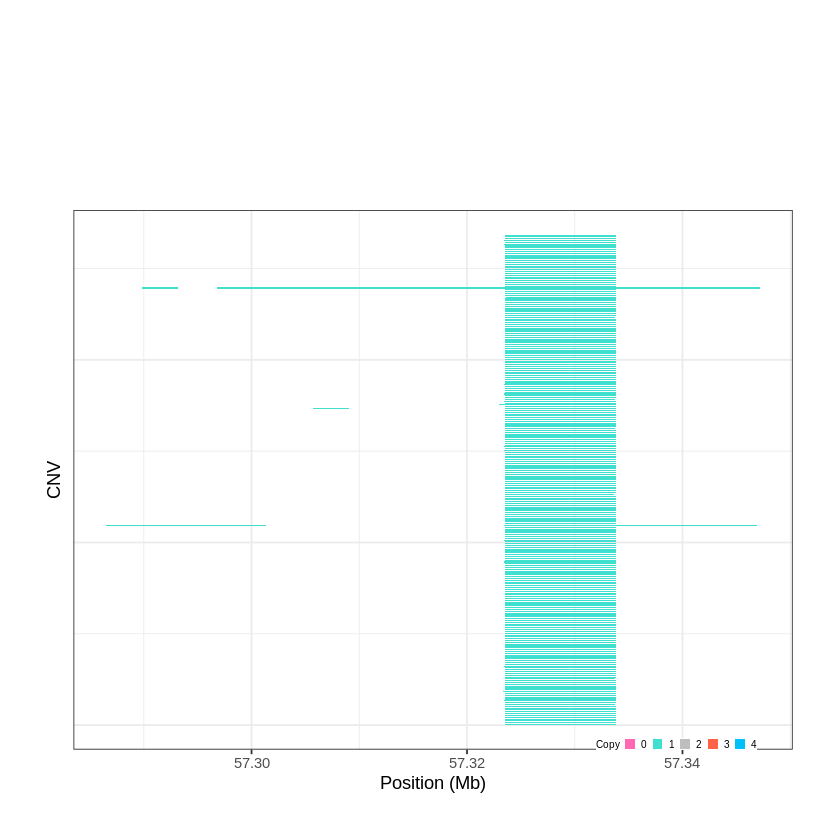

Task done, plot was stored in working directory.
[1] "Ploting CNVR 690..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 59.999601 - 60.0158 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


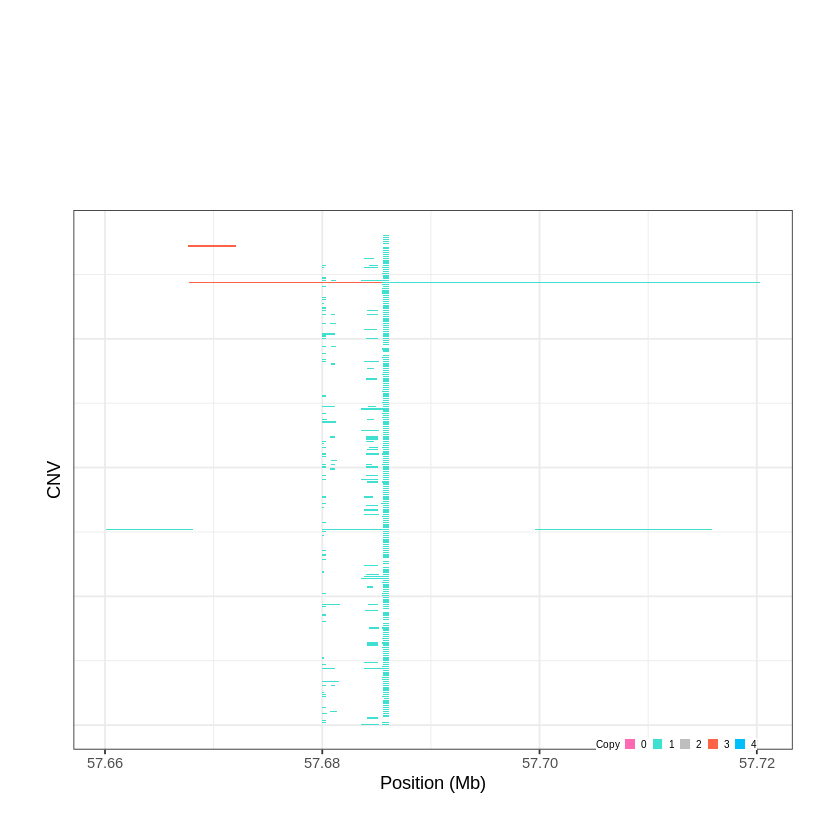

Task done, plot was stored in working directory.
[1] "Ploting CNVR 691..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 62.685201 - 62.8956 Mb with 157 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


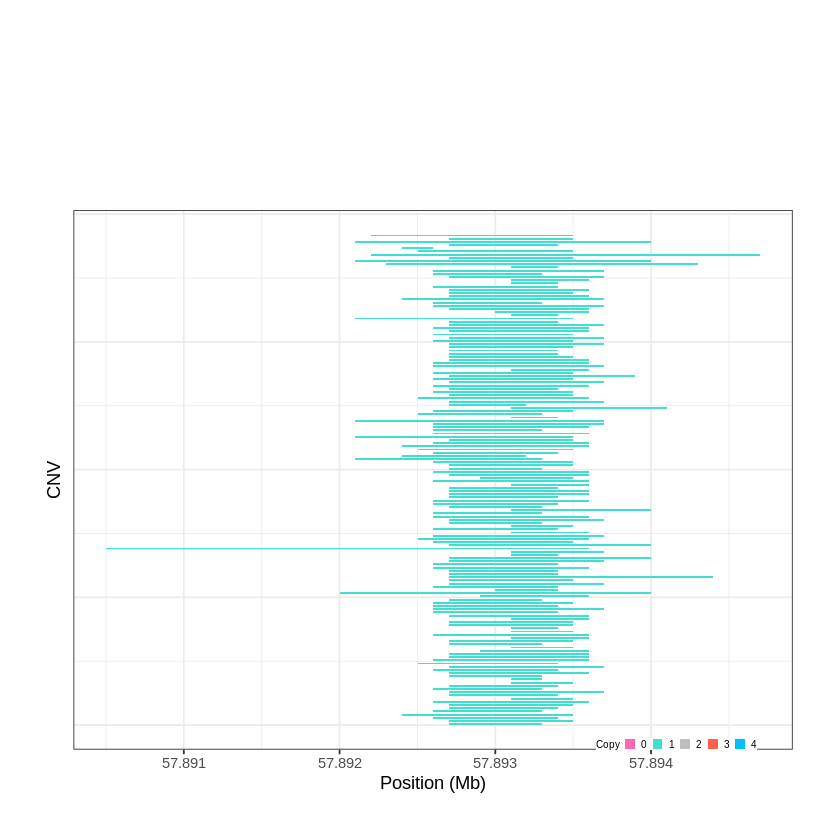

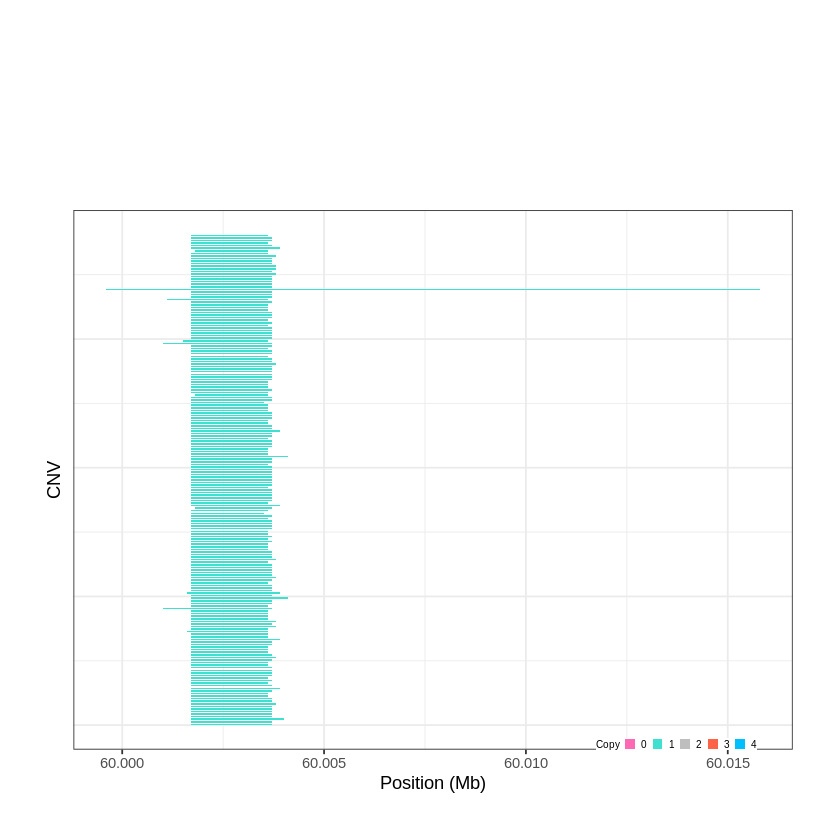

Task done, plot was stored in working directory.
[1] "Ploting CNVR 692..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 68.747201 - 70.6815 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 9 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 693..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 73.641201 - 73.6683 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


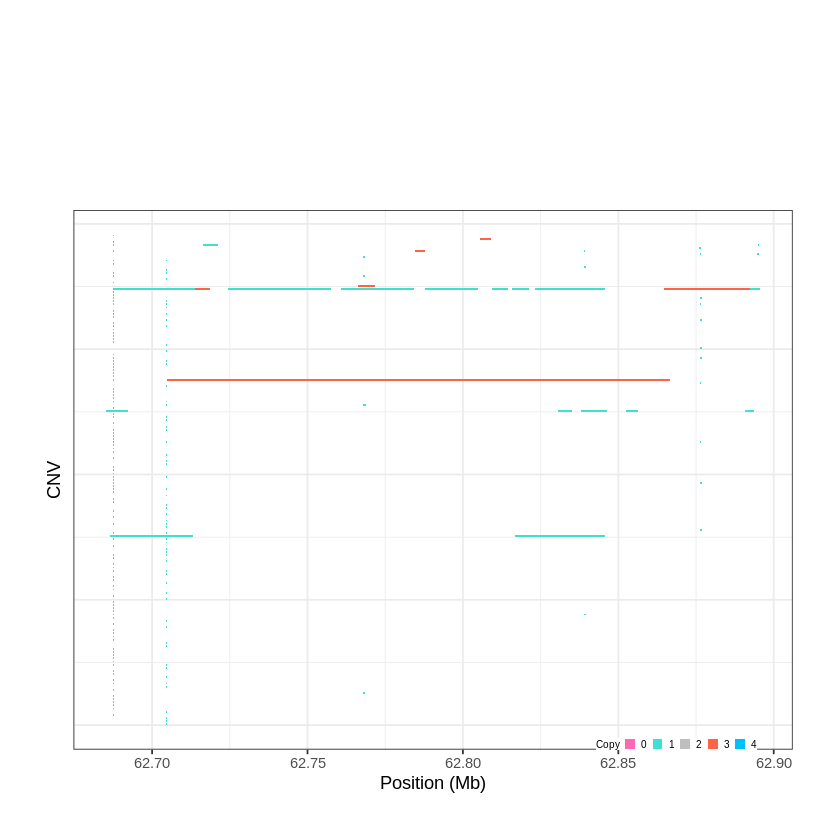

Task done, plot was stored in working directory.
[1] "Ploting CNVR 694..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 83.923401 - 83.962 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


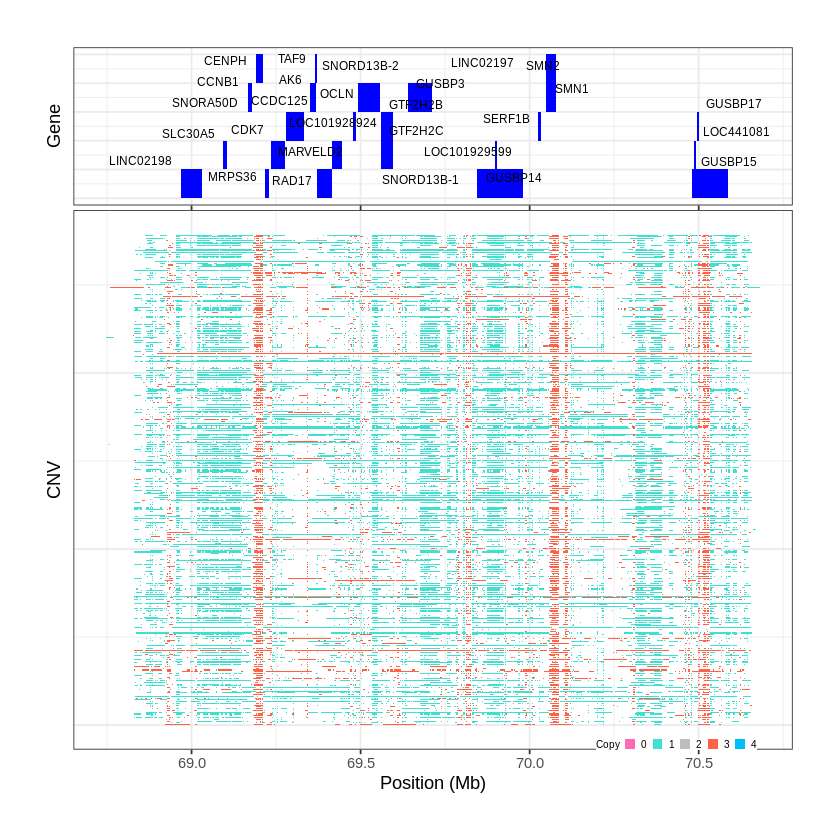

Task done, plot was stored in working directory.
[1] "Ploting CNVR 695..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 88.572201 - 88.6151 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


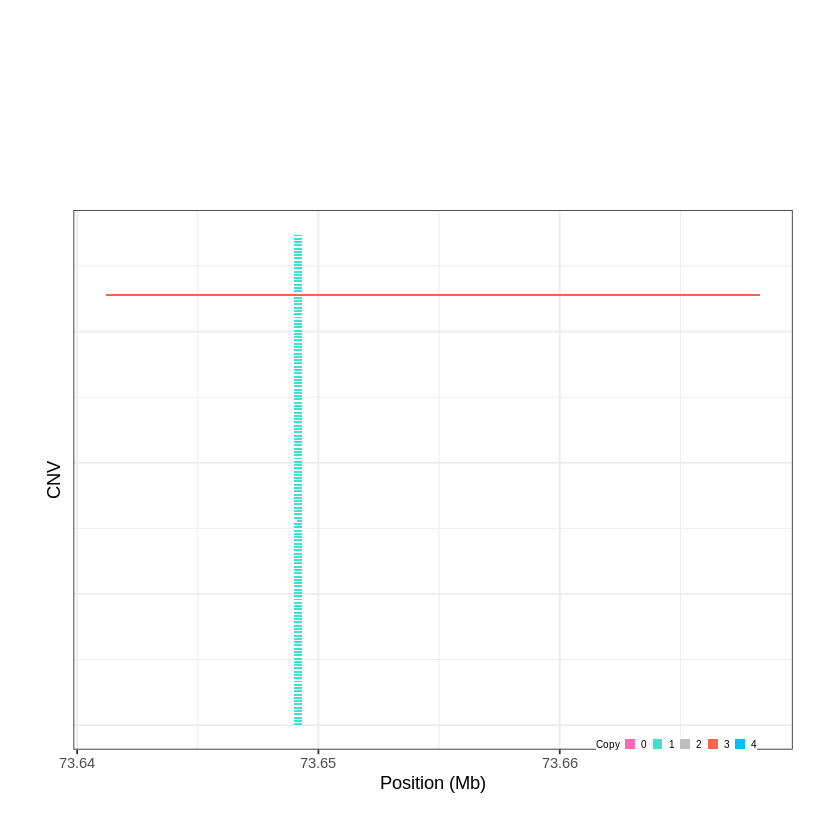

Task done, plot was stored in working directory.
[1] "Ploting CNVR 696..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 90.498501 - 90.5128 Mb with 248 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


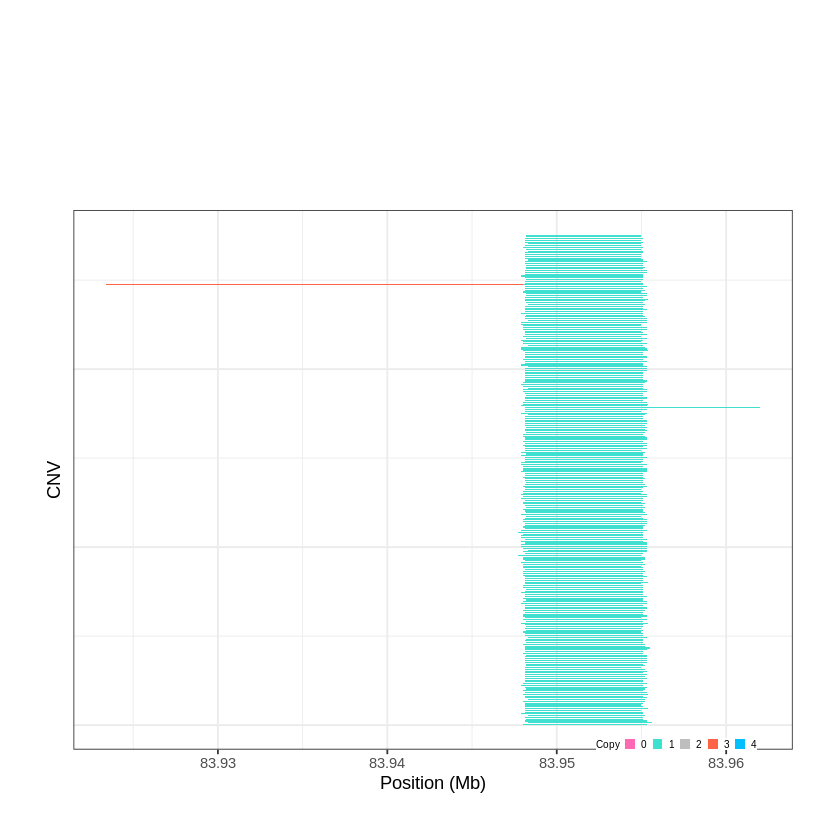

Task done, plot was stored in working directory.
[1] "Ploting CNVR 697..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 91.571101 - 91.6865 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


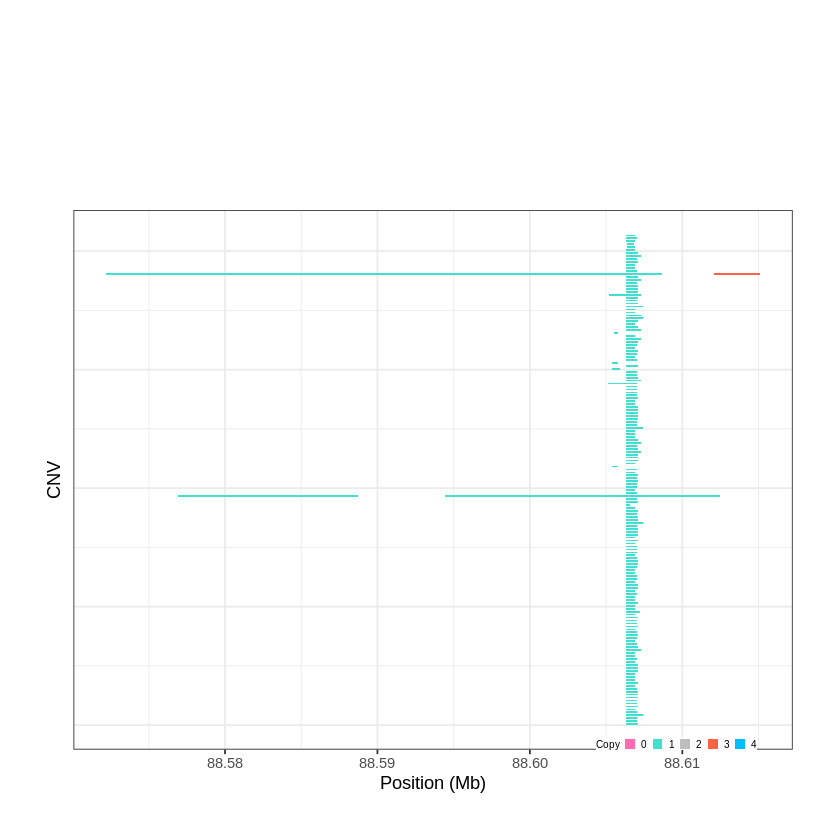

Task done, plot was stored in working directory.
[1] "Ploting CNVR 698..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 98.327901 - 98.3701 Mb with 260 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


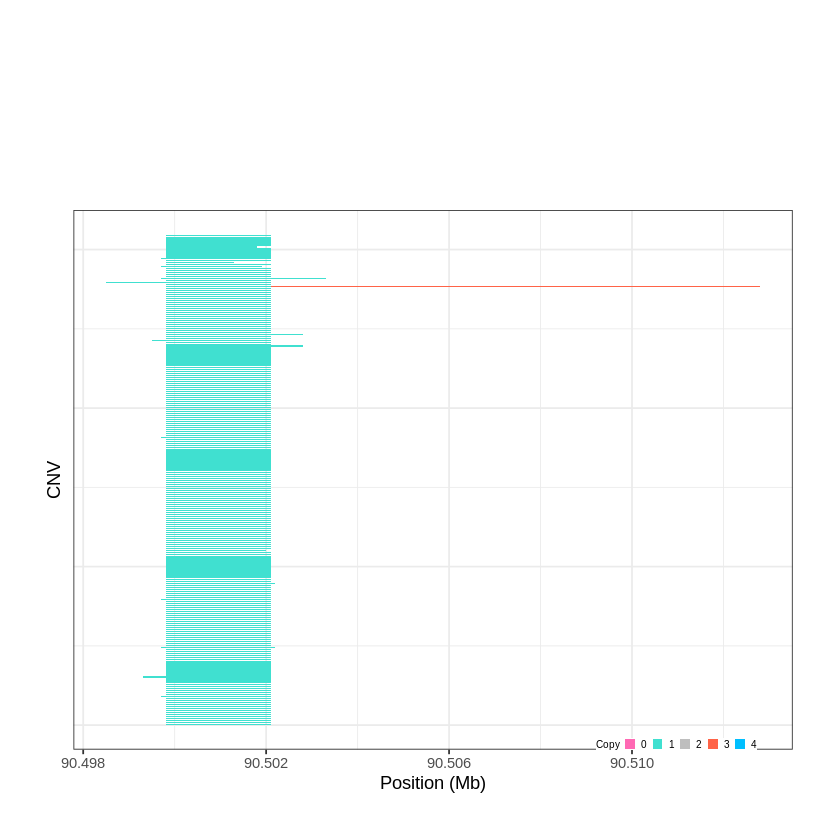

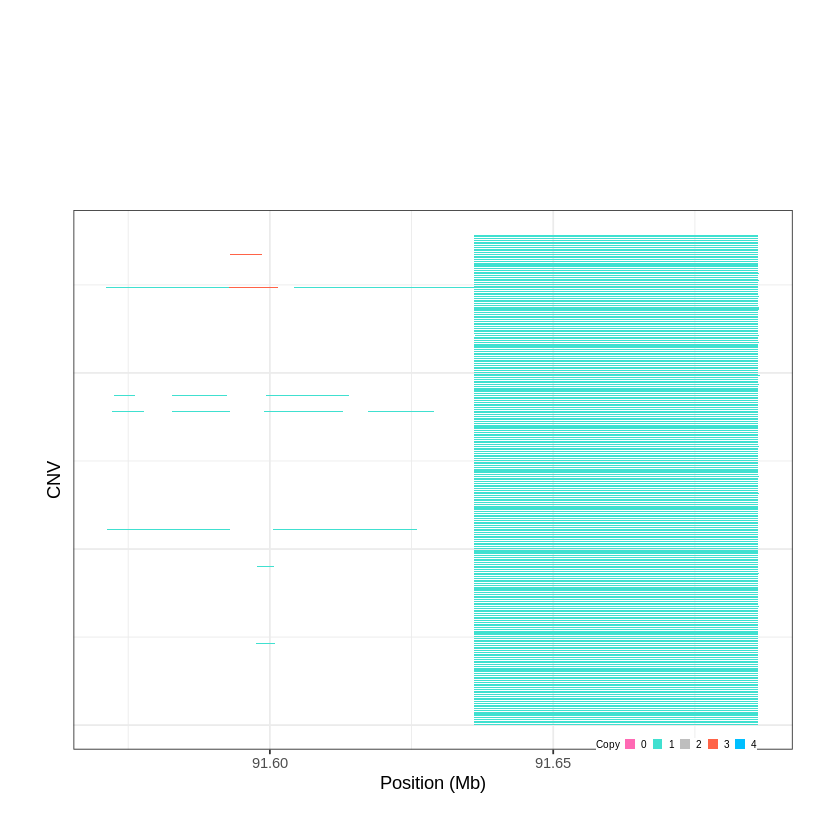

Task done, plot was stored in working directory.
[1] "Ploting CNVR 699..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 98.702201 - 99.7577 Mb with 272 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 700..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 106.217901 - 106.2504 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


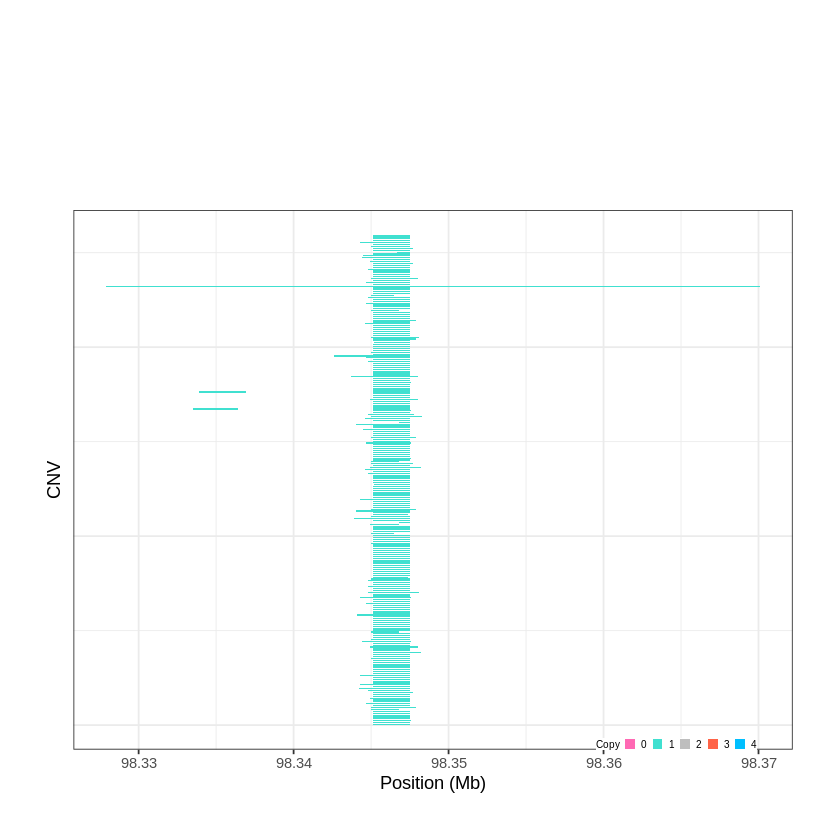

Task done, plot was stored in working directory.
[1] "Ploting CNVR 701..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 106.319501 - 106.3303 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


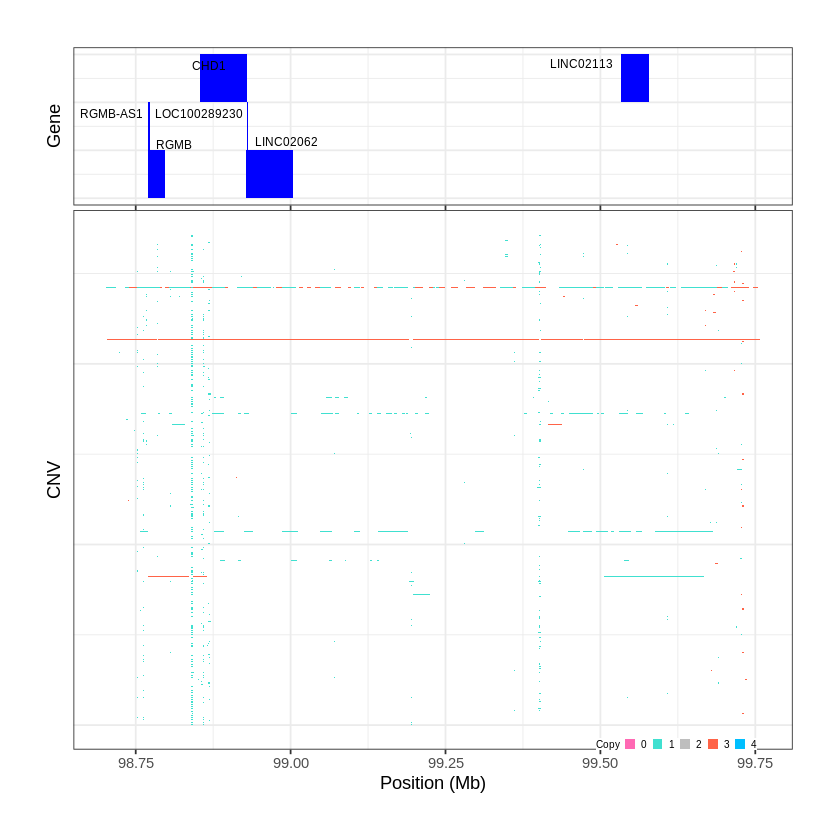

Task done, plot was stored in working directory.
[1] "Ploting CNVR 702..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 114.731301 - 114.7316 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


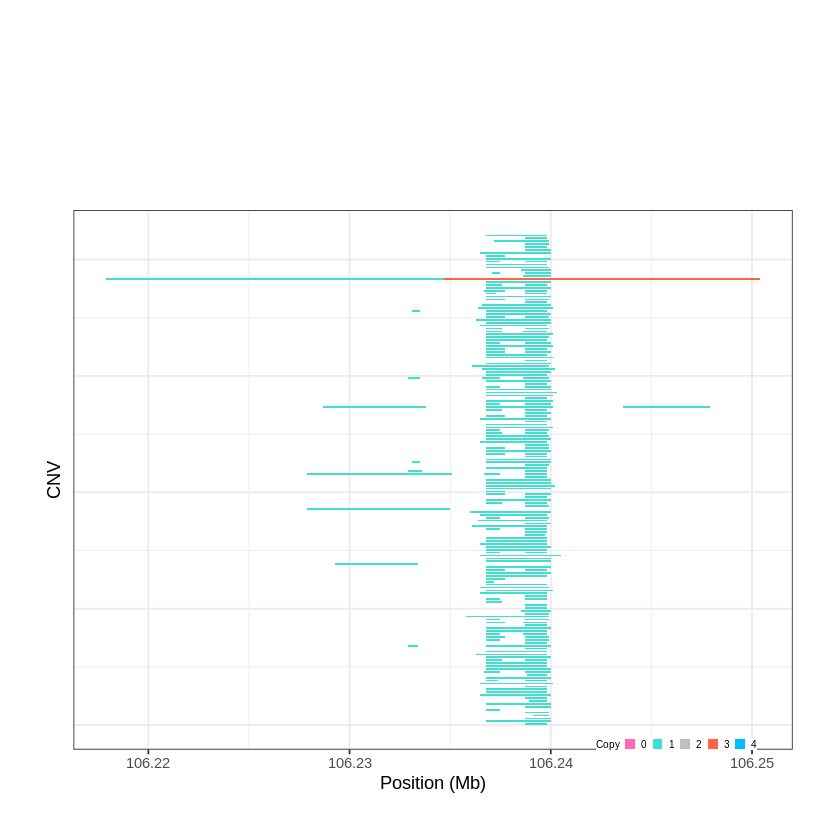

Task done, plot was stored in working directory.
[1] "Ploting CNVR 703..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 115.102101 - 115.1347 Mb with 184 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


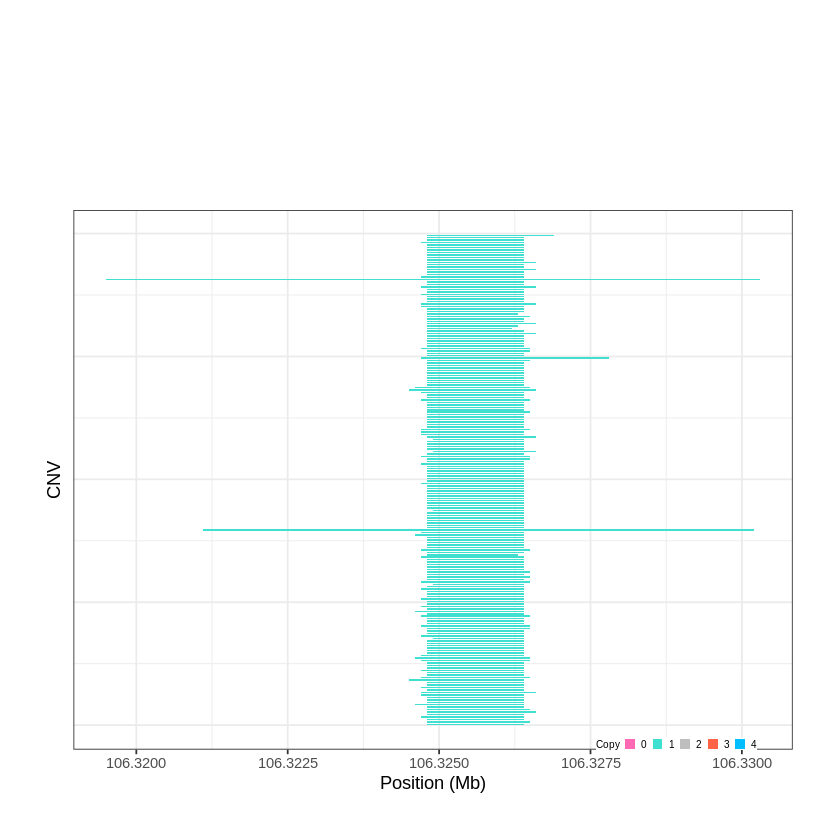

Task done, plot was stored in working directory.
[1] "Ploting CNVR 704..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 117.842301 - 118.0253 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


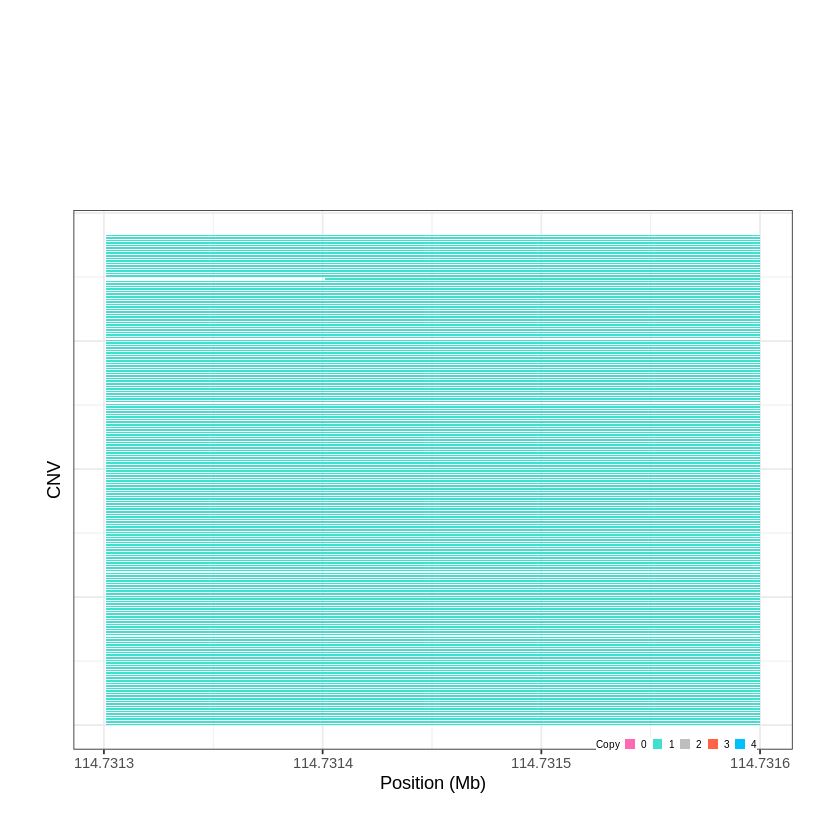

Task done, plot was stored in working directory.
[1] "Ploting CNVR 705..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 119.007901 - 119.0355 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


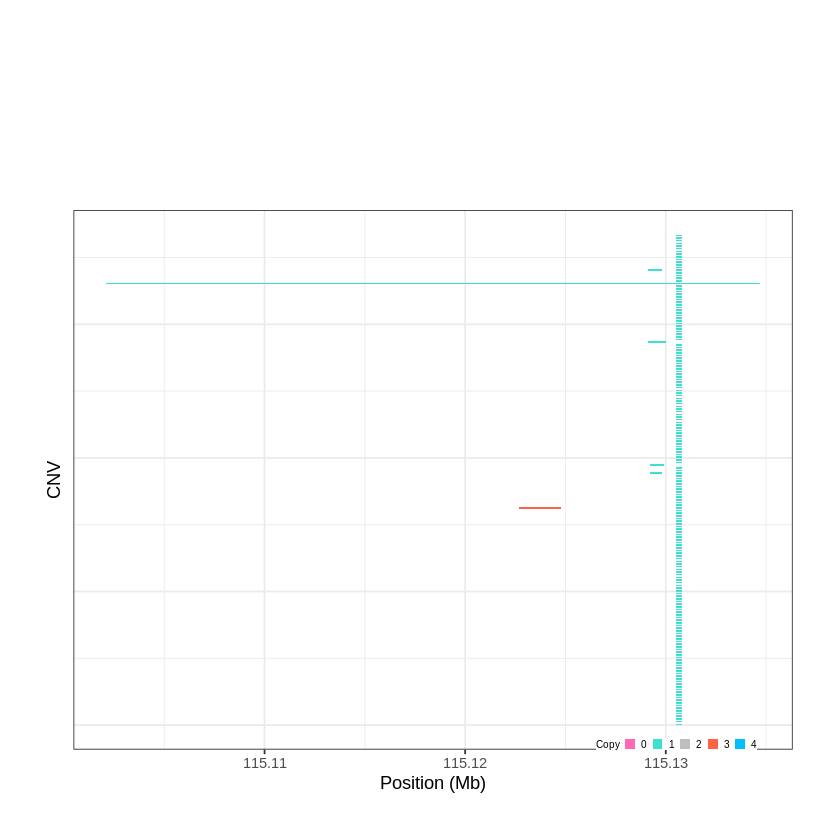

Task done, plot was stored in working directory.
[1] "Ploting CNVR 706..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 119.365301 - 119.4257 Mb with 241 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


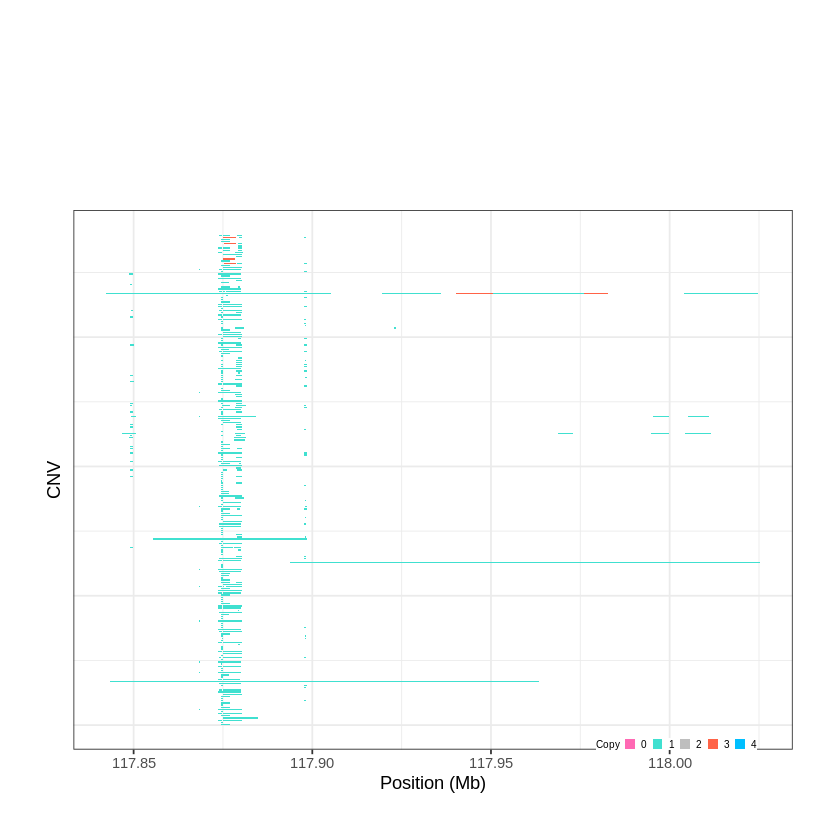

Task done, plot was stored in working directory.
[1] "Ploting CNVR 707..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 121.059201 - 121.0673 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


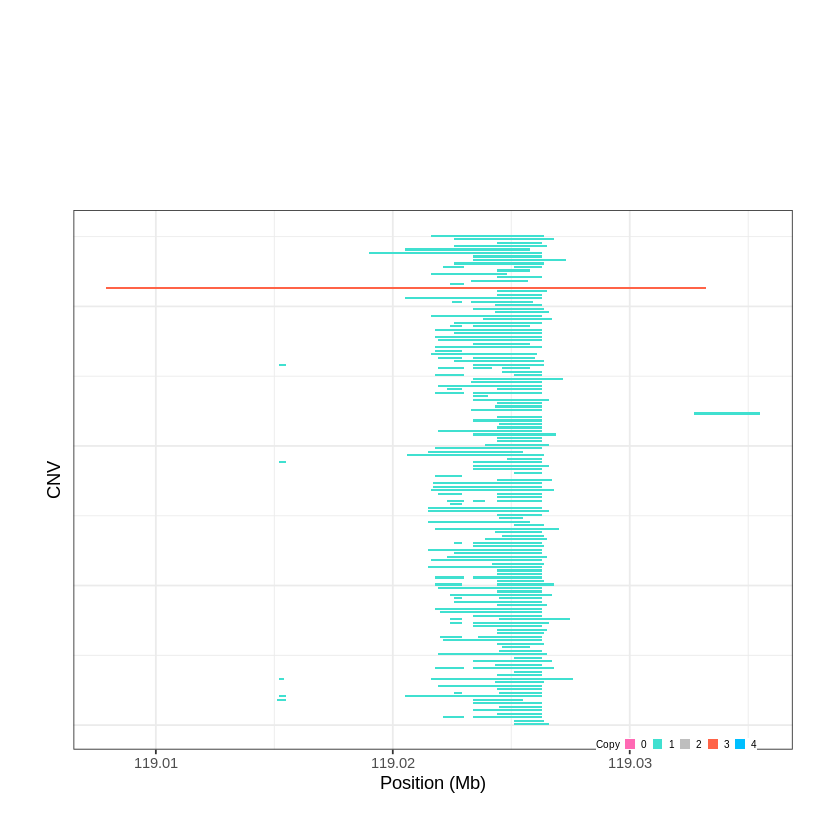

Task done, plot was stored in working directory.
[1] "Ploting CNVR 708..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 127.172301 - 127.1733 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


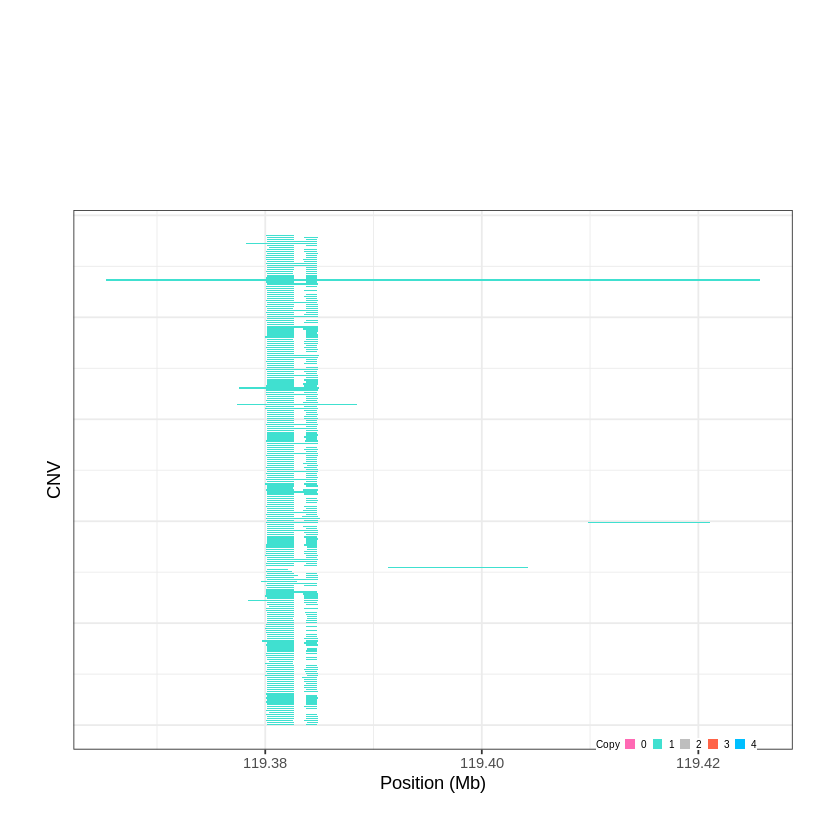

Task done, plot was stored in working directory.
[1] "Ploting CNVR 709..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 127.312101 - 127.338 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


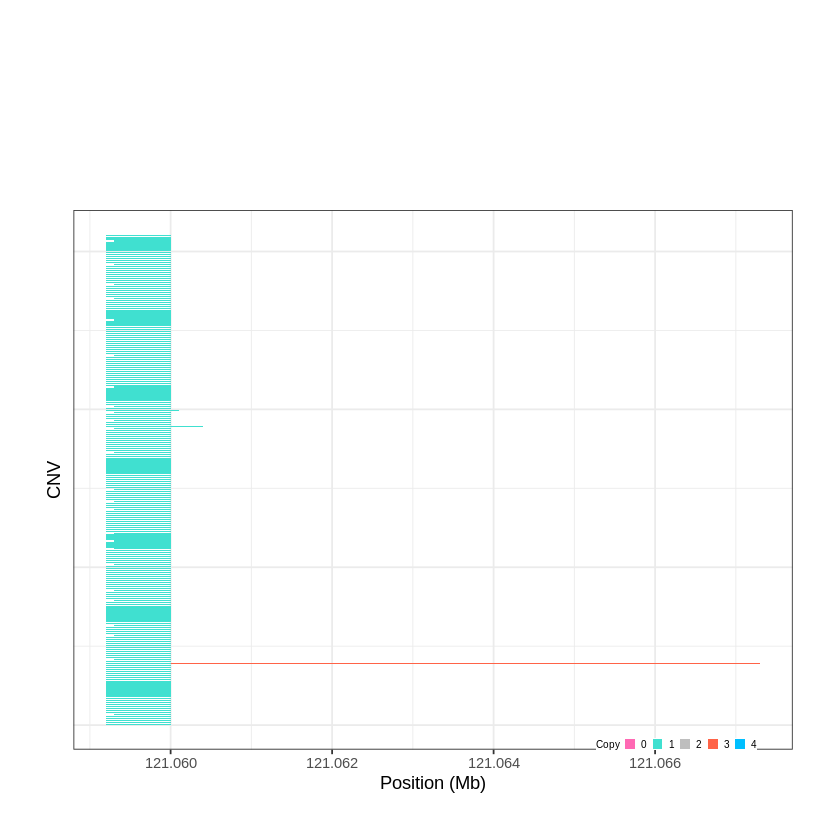

Task done, plot was stored in working directory.
[1] "Ploting CNVR 710..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 127.407001 - 127.4127 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


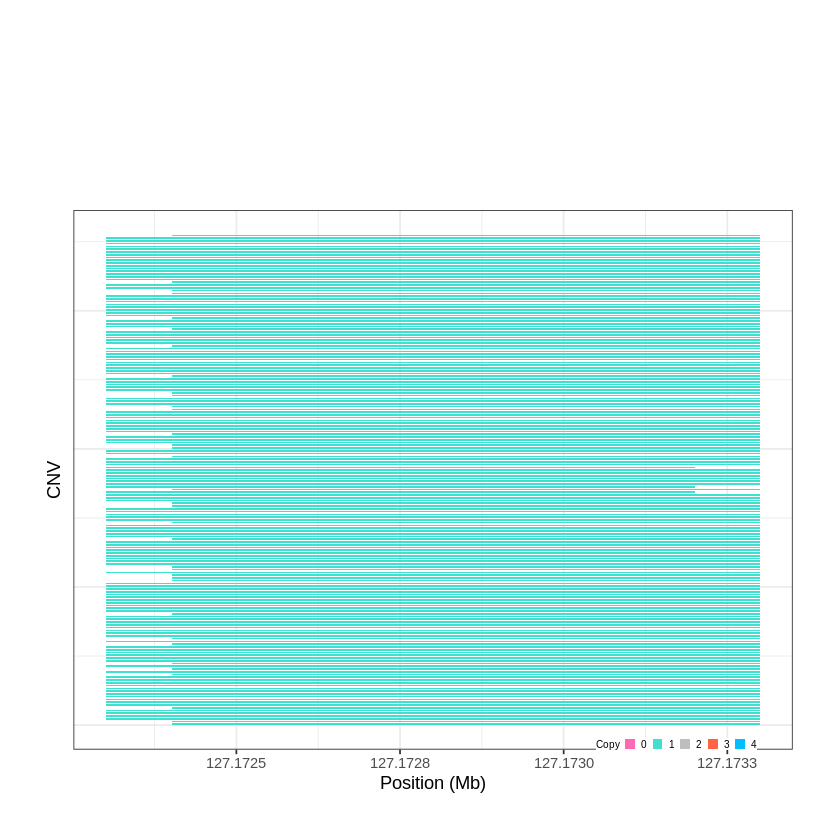

Task done, plot was stored in working directory.
[1] "Ploting CNVR 711..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 135.101101 - 135.1443 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


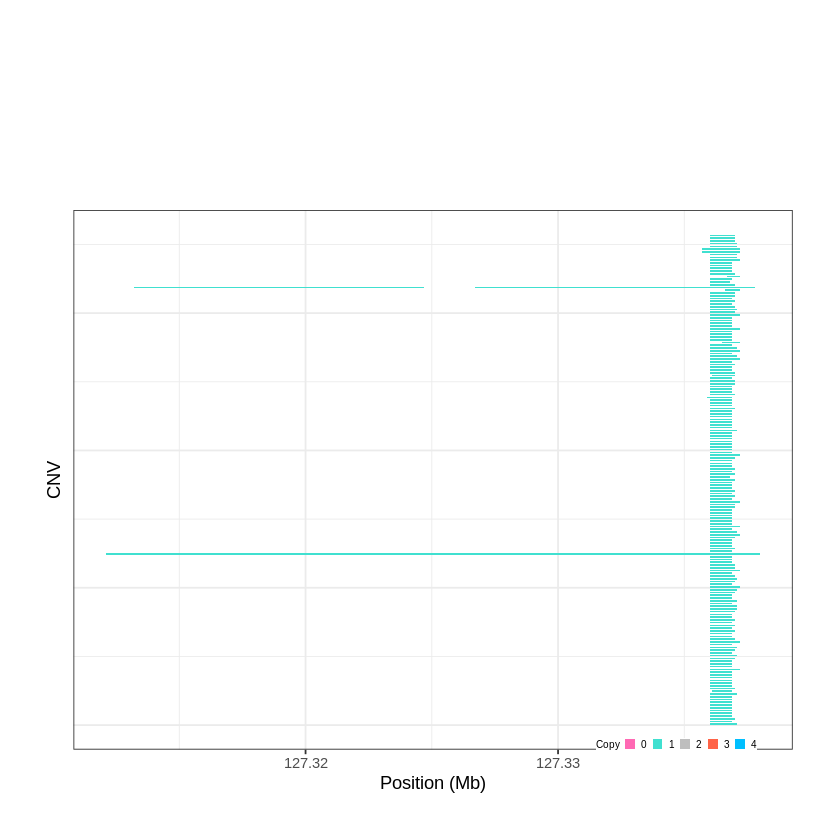

Task done, plot was stored in working directory.
[1] "Ploting CNVR 712..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 136.853801 - 136.8884 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


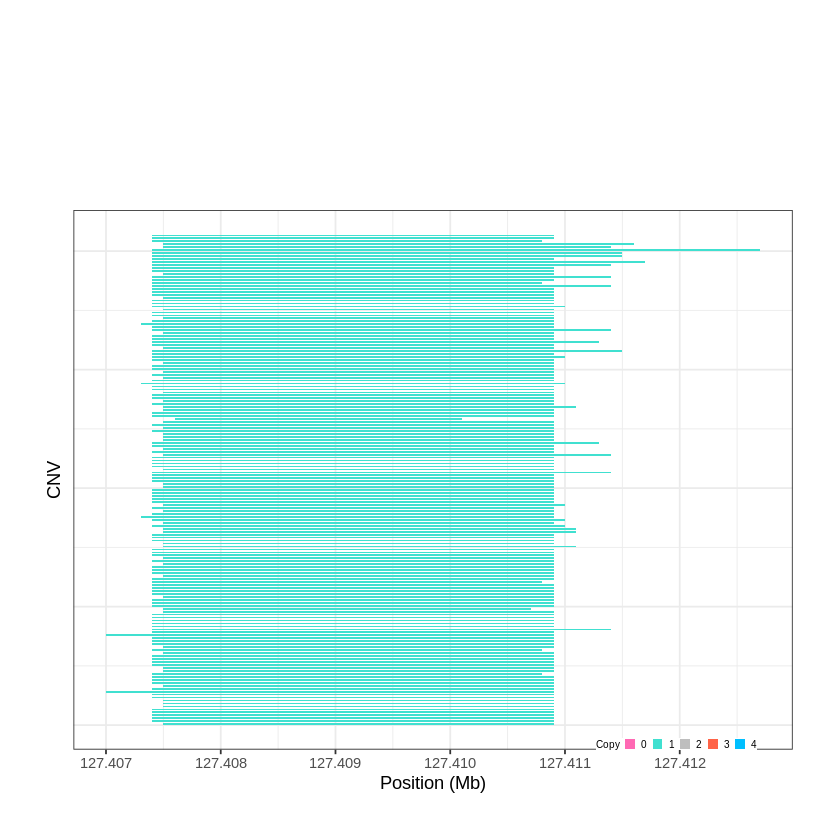

Task done, plot was stored in working directory.
[1] "Ploting CNVR 713..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 138.777601 - 138.8374 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


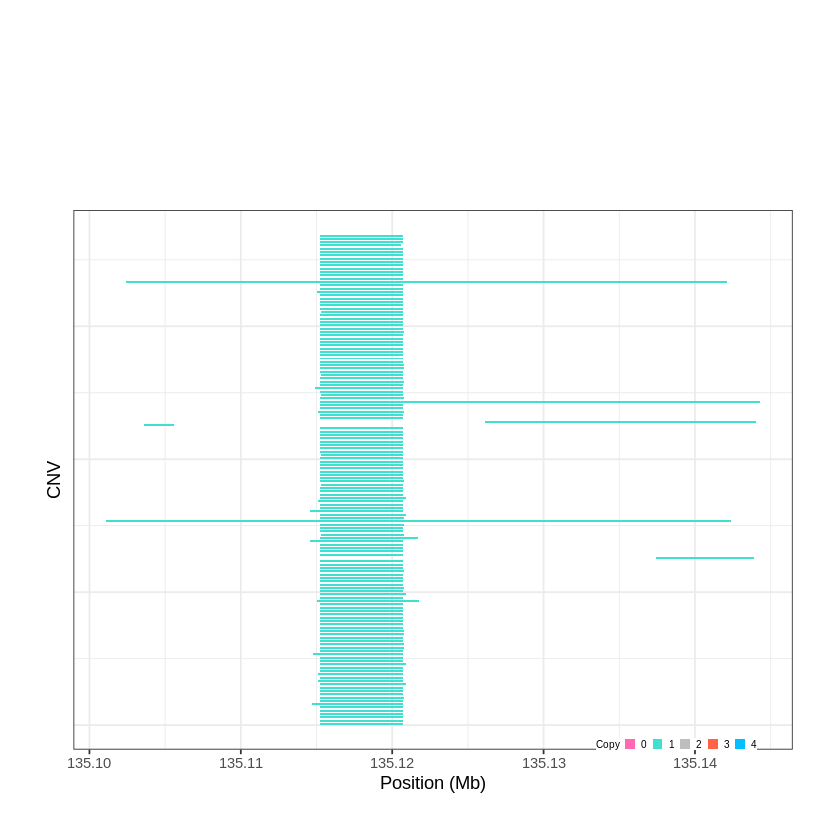

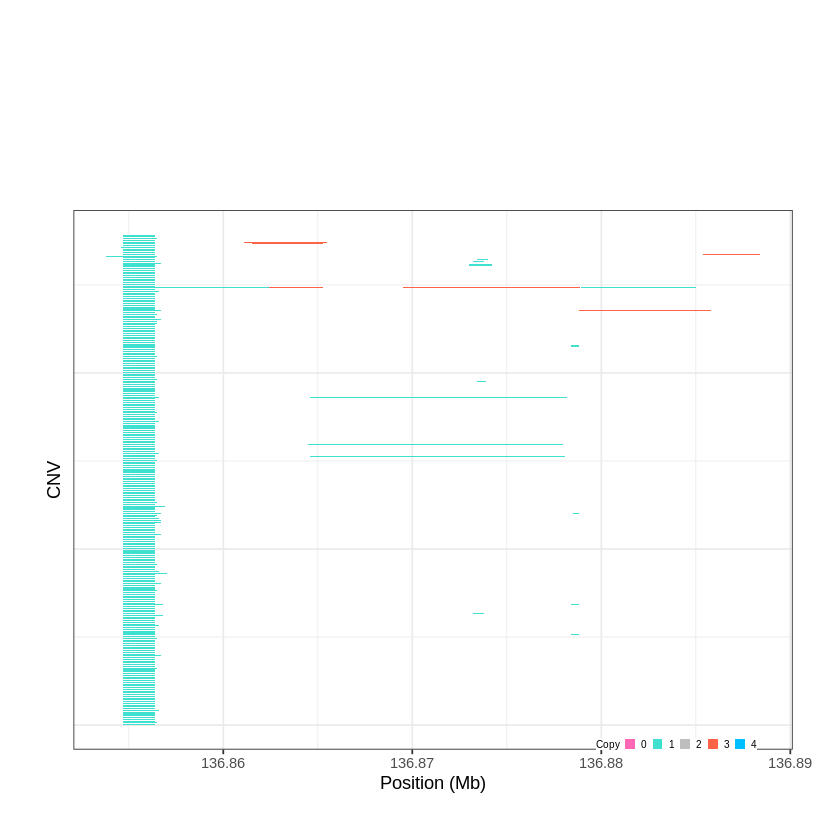

Task done, plot was stored in working directory.
[1] "Ploting CNVR 714..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 140.528201 - 140.6296 Mb with 163 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 715..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 145.118301 - 145.1294 Mb with 273 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


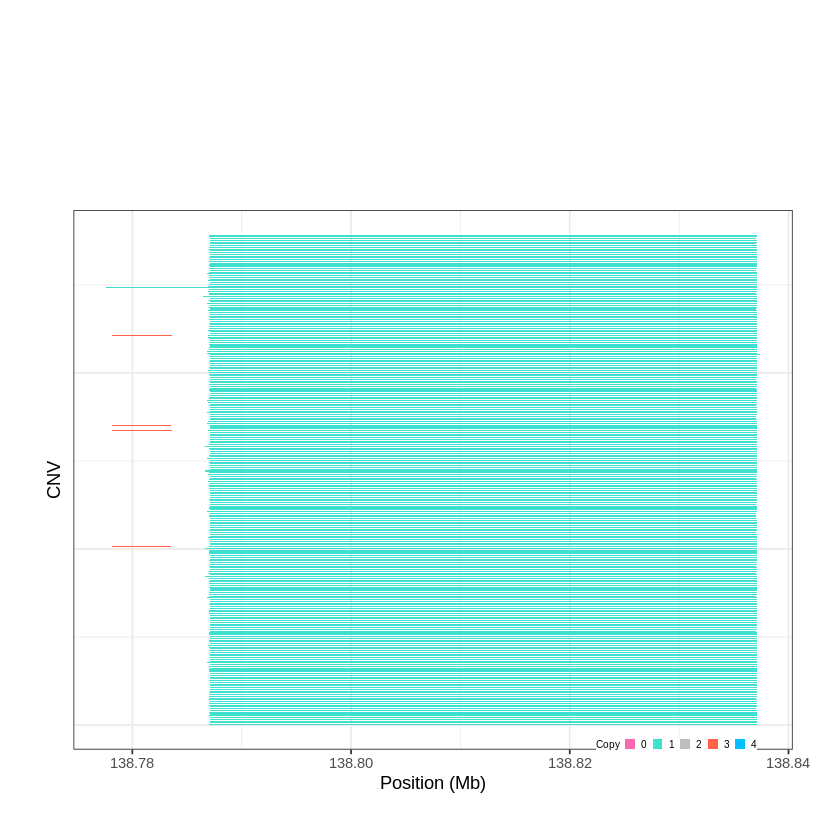

Task done, plot was stored in working directory.
[1] "Ploting CNVR 716..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 147.608301 - 147.6975 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


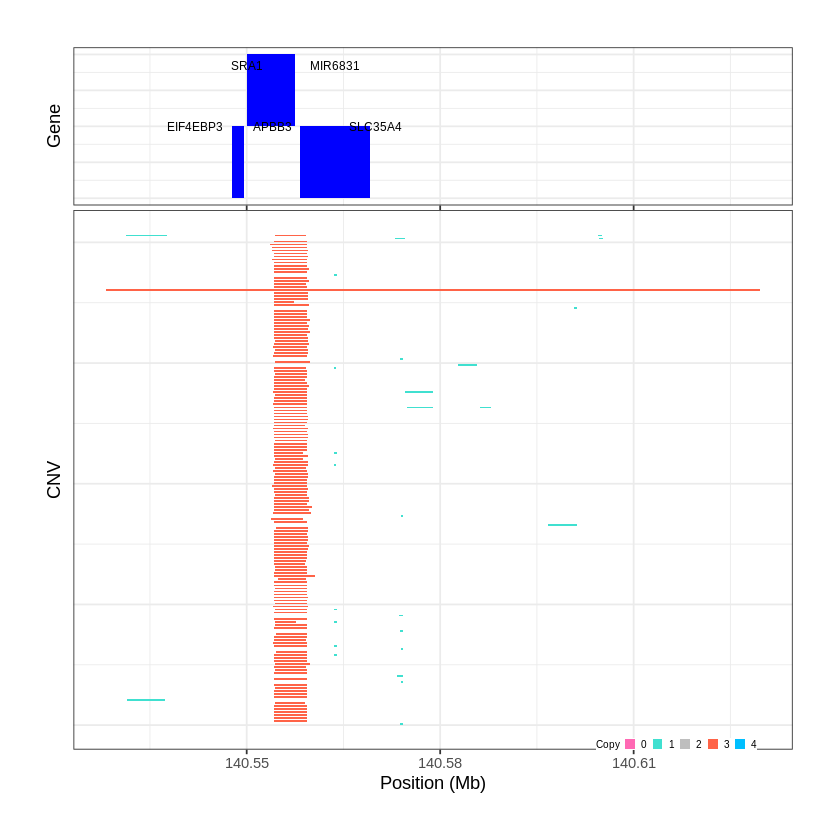

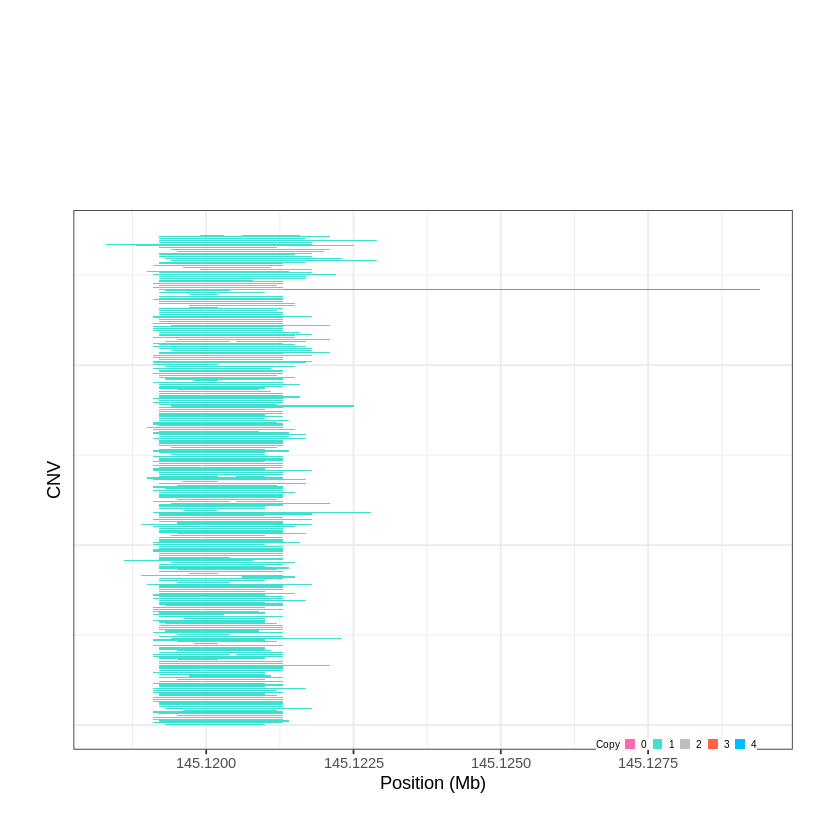

Task done, plot was stored in working directory.
[1] "Ploting CNVR 717..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 149.028201 - 149.0675 Mb with 158 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 718..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 150.202301 - 150.2274 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


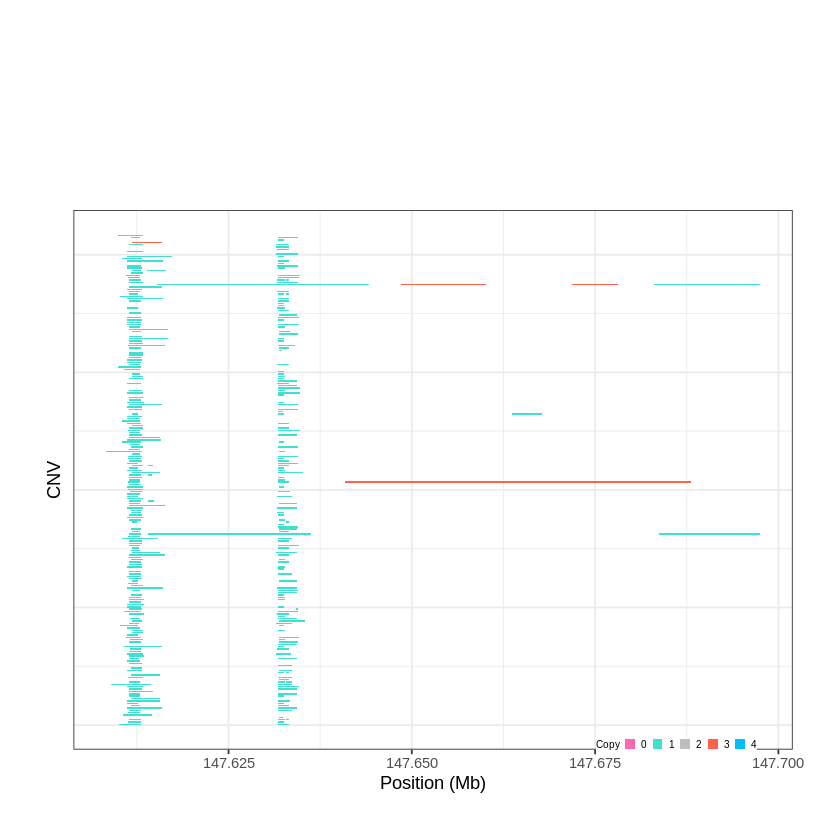

Task done, plot was stored in working directory.
[1] "Ploting CNVR 719..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 155.135501 - 155.2194 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


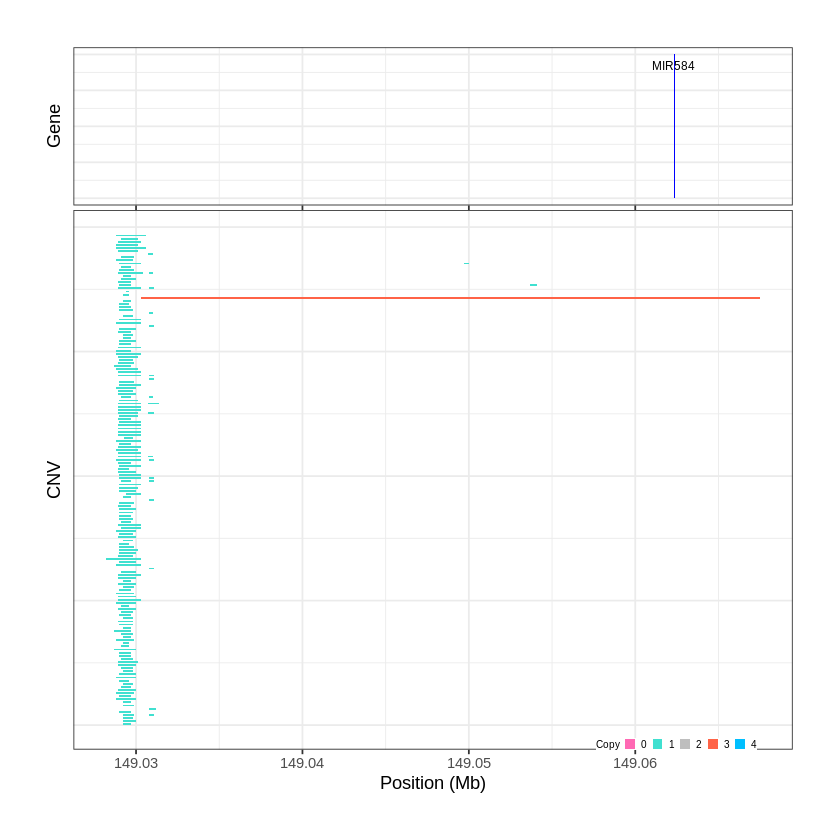

Task done, plot was stored in working directory.
[1] "Ploting CNVR 720..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 157.531201 - 157.5847 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


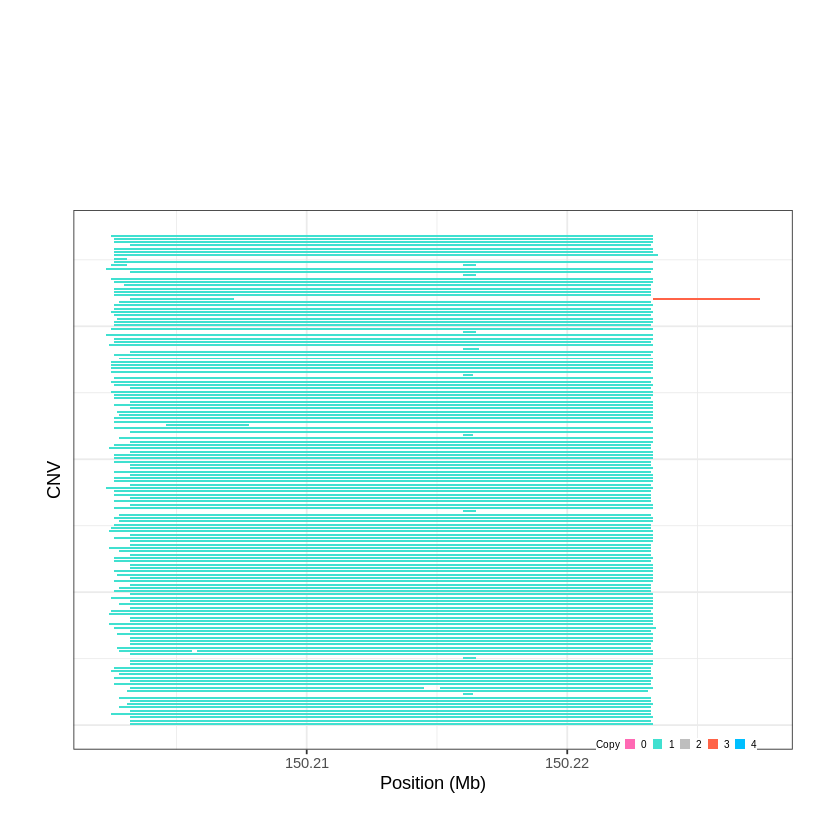

Task done, plot was stored in working directory.
[1] "Ploting CNVR 721..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 158.272901 - 158.297 Mb with 219 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


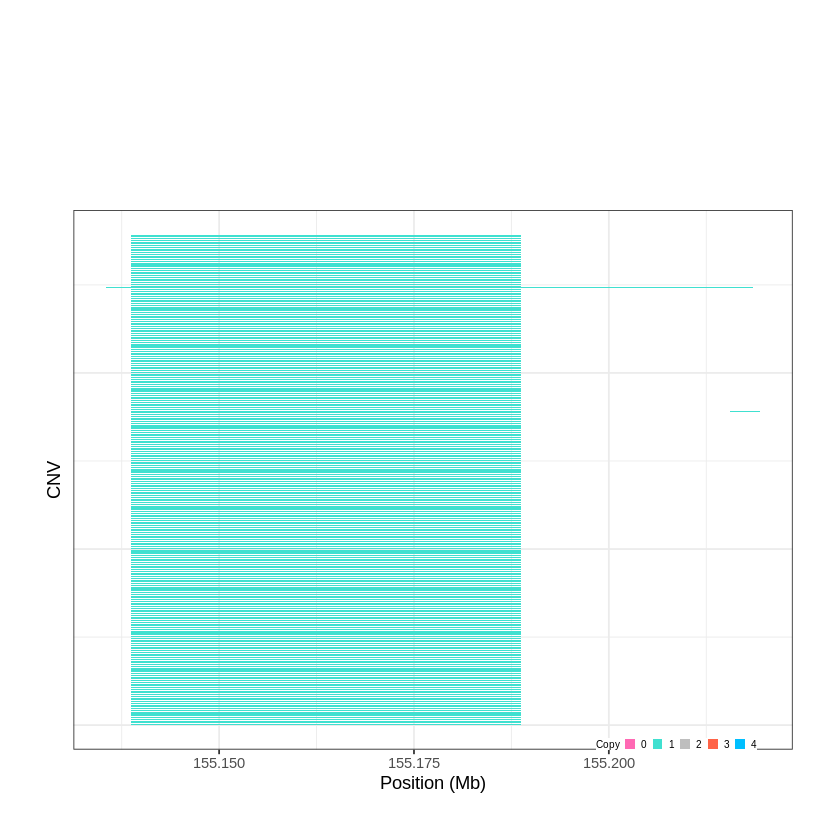

Task done, plot was stored in working directory.
[1] "Ploting CNVR 722..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 161.957501 - 161.9653 Mb with 234 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


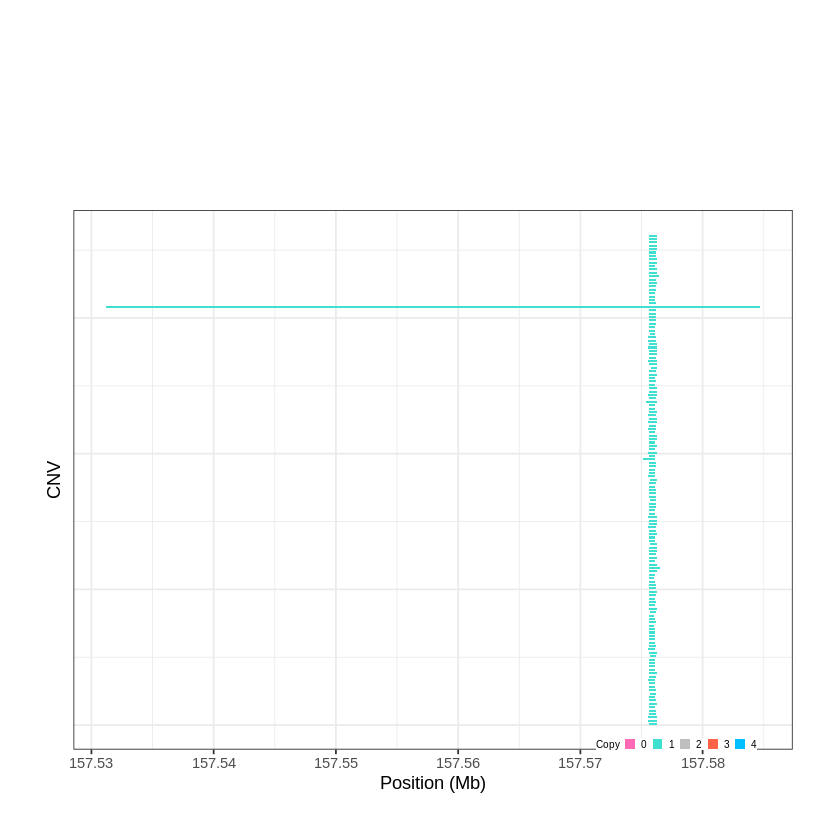

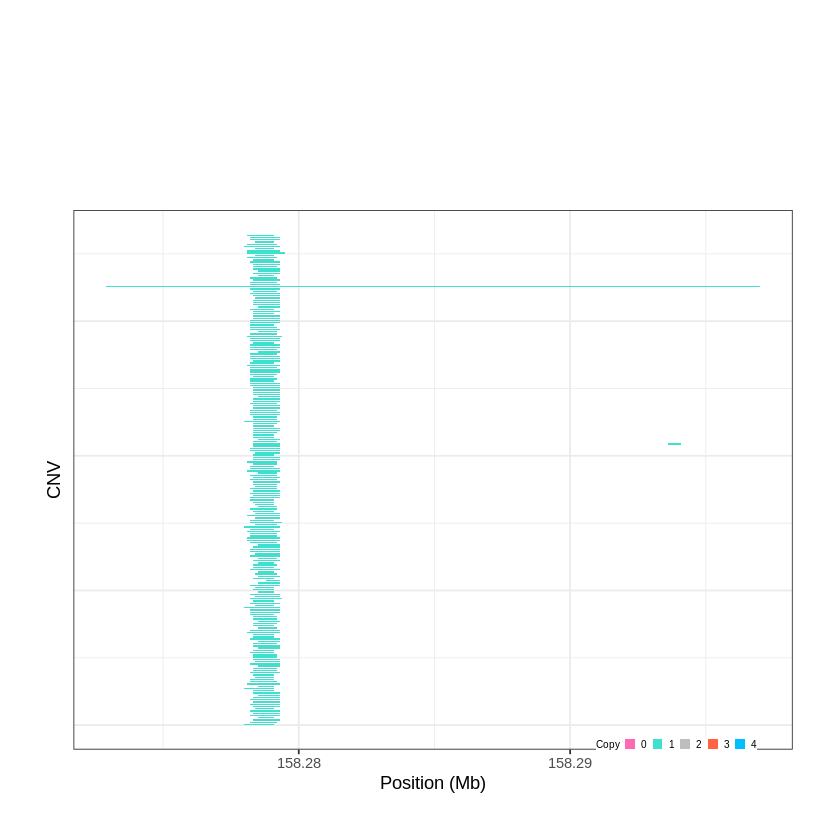

Task done, plot was stored in working directory.
[1] "Ploting CNVR 723..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 168.506201 - 168.5443 Mb with 144 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 724..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 170.129701 - 170.1333 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


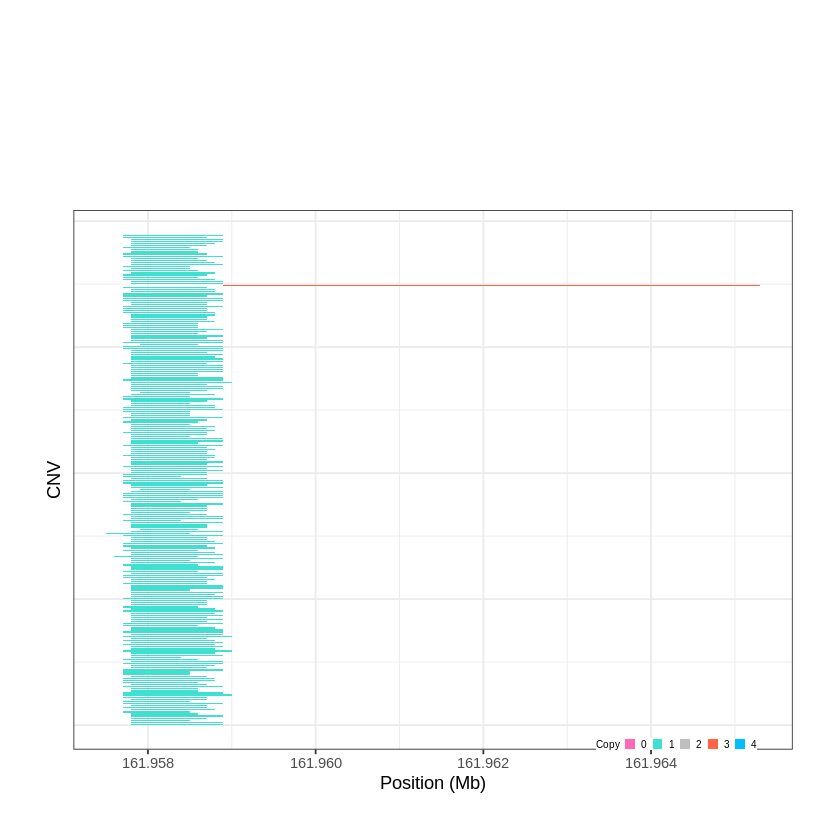

Task done, plot was stored in working directory.
[1] "Ploting CNVR 725..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 173.730401 - 173.7708 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


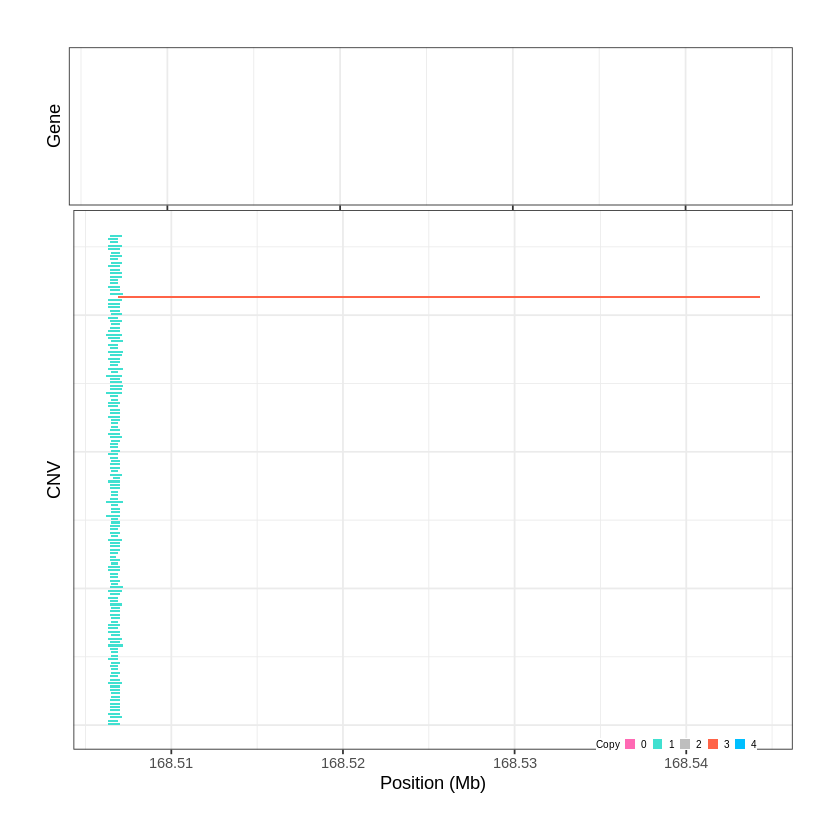

Task done, plot was stored in working directory.
[1] "Ploting CNVR 726..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 174.819201 - 174.8207 Mb with 243 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


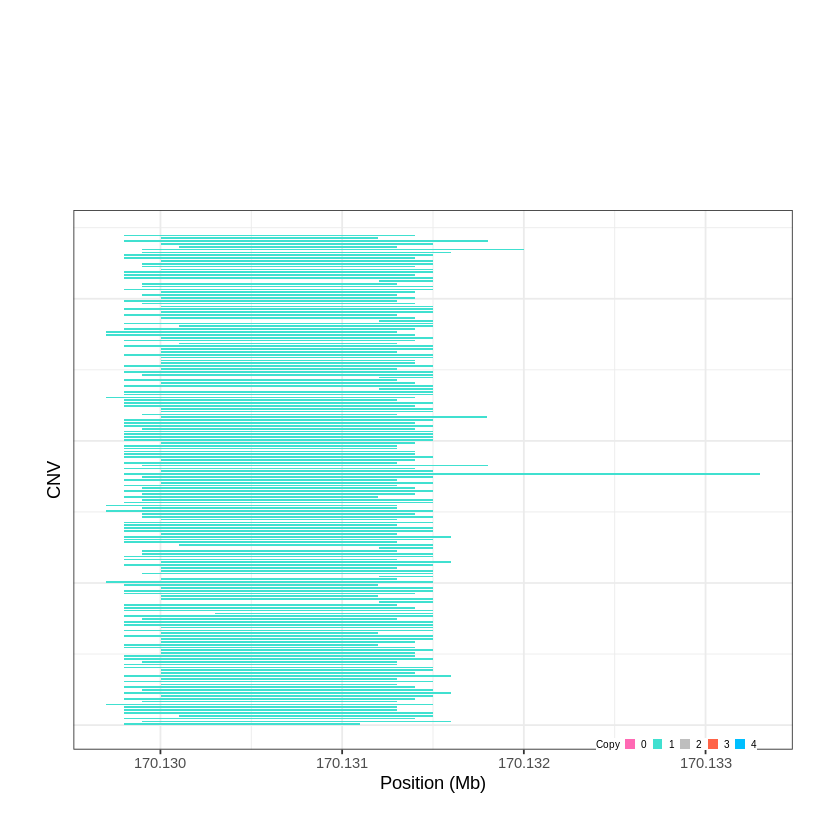

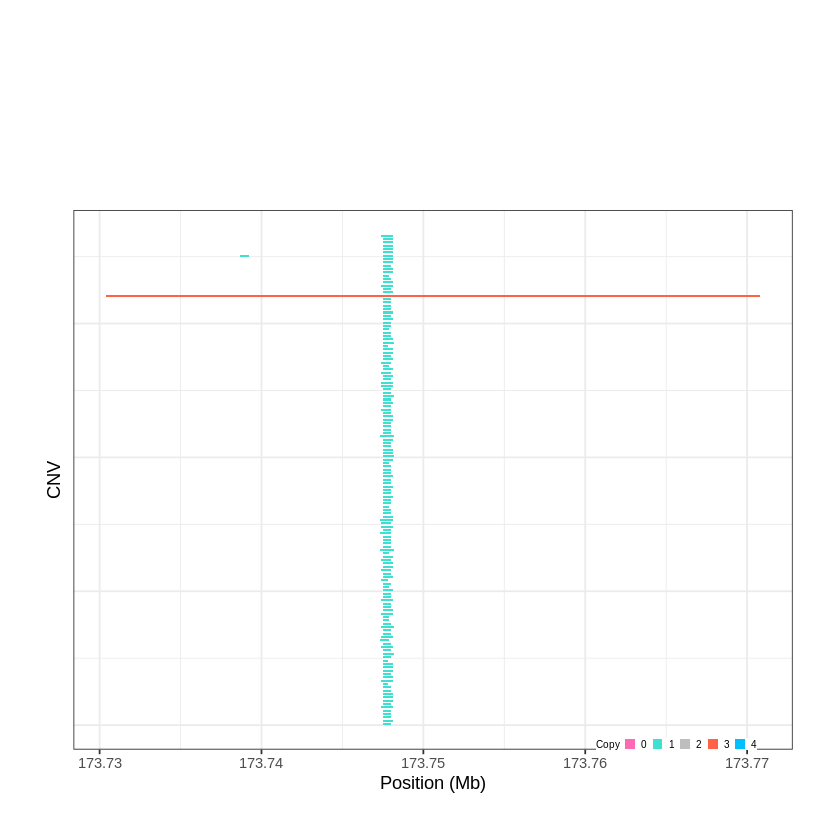

Task done, plot was stored in working directory.
[1] "Ploting CNVR 727..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 175.225101 - 175.6702 Mb with 279 Individual - "
Plotting gene...


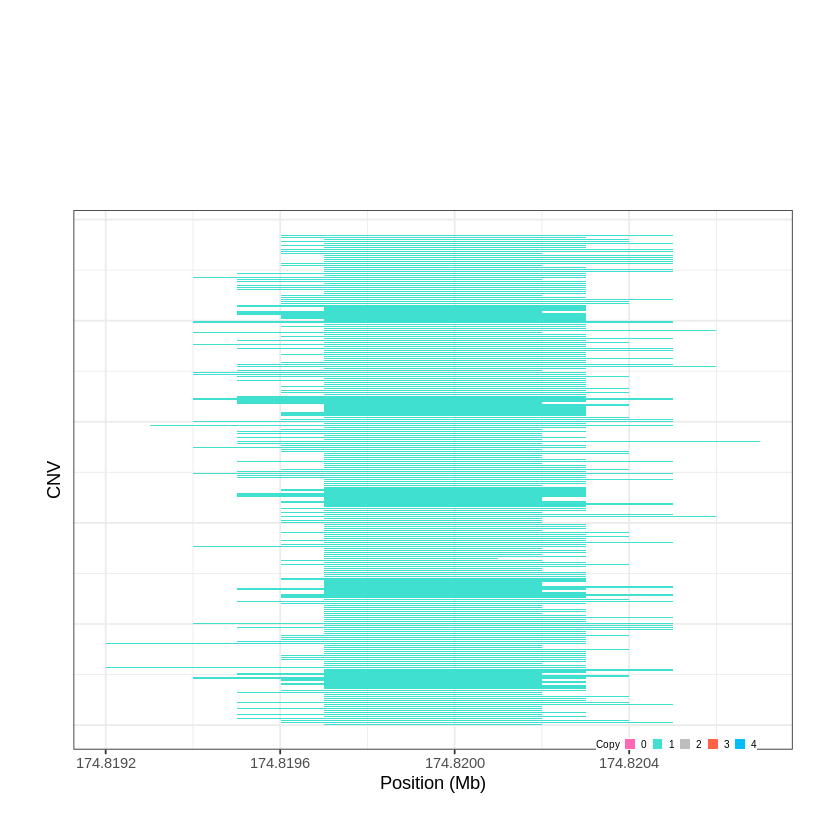

Task done, plot was stored in working directory.
[1] "Ploting CNVR 728..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 175.699301 - 176.3243 Mb with 201 Individual - "
Plotting gene...


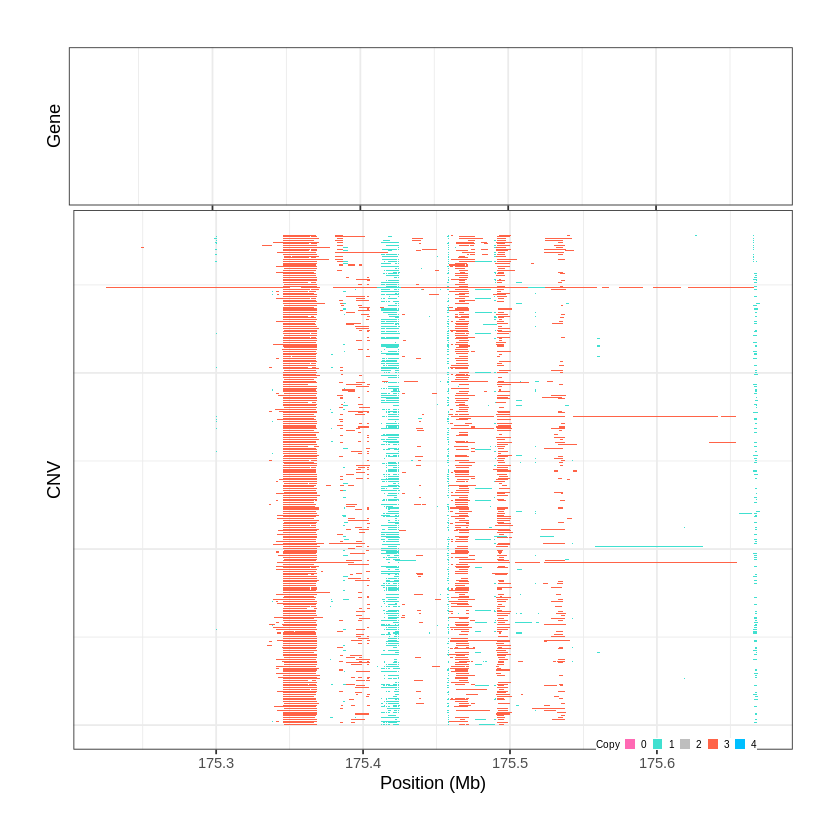

Task done, plot was stored in working directory.
[1] "Ploting CNVR 729..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 176.665101 - 177.0576 Mb with 251 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 730..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 177.092401 - 177.1689 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


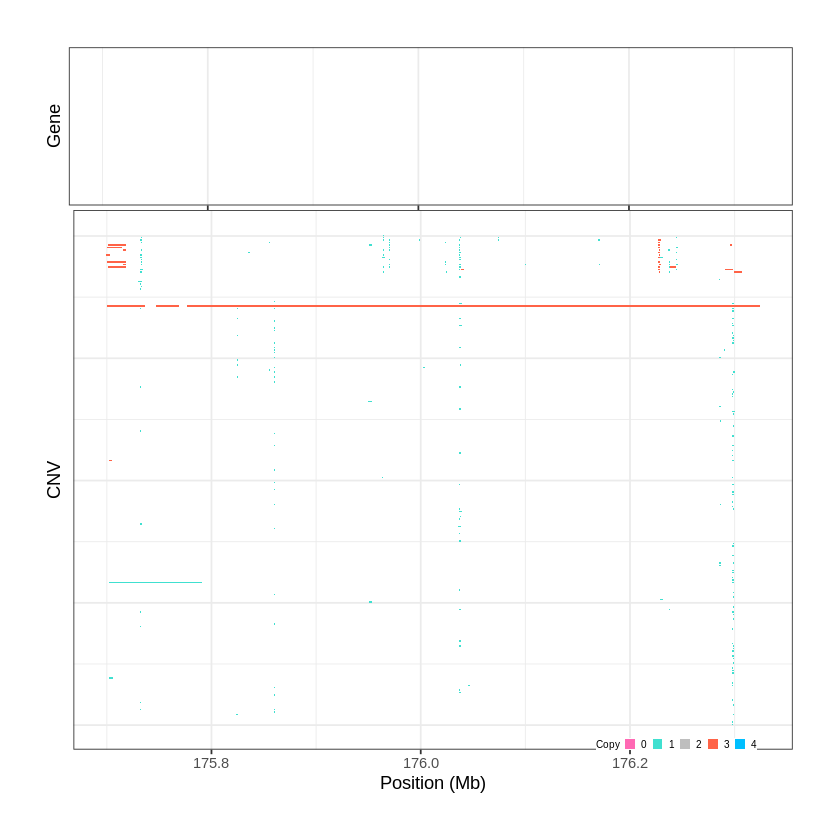

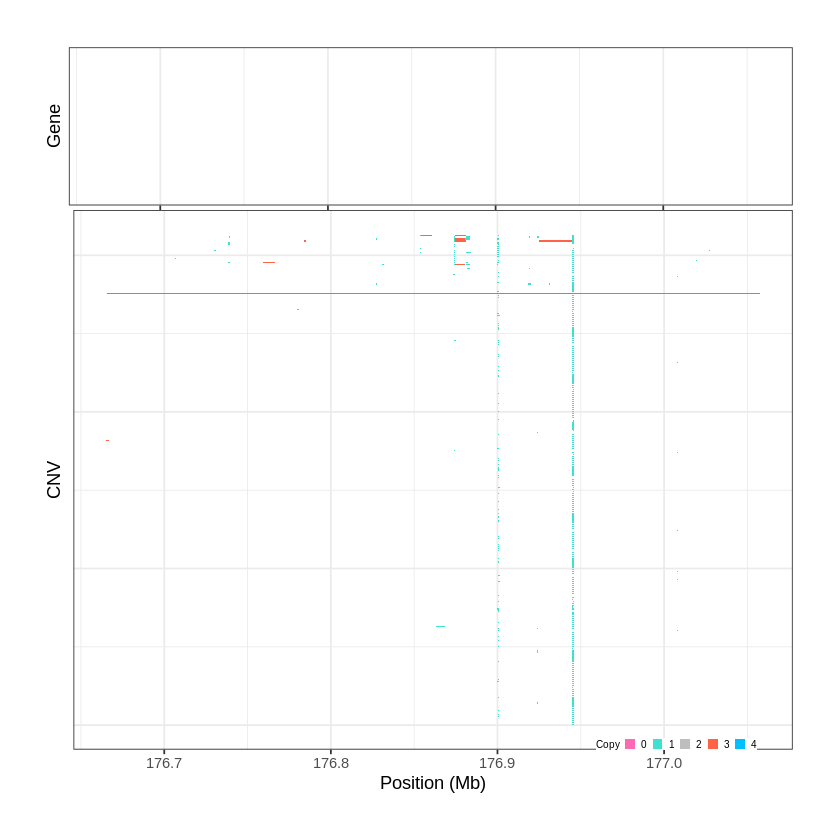

Task done, plot was stored in working directory.
[1] "Ploting CNVR 731..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 177.174201 - 177.4048 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 732..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 177.405401 - 177.4106 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


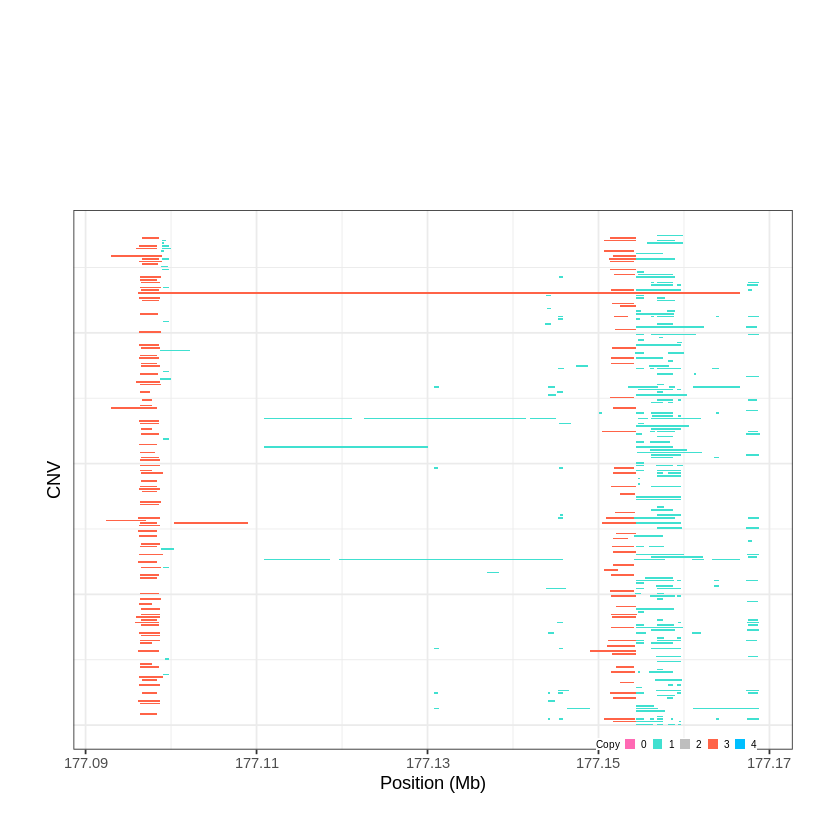

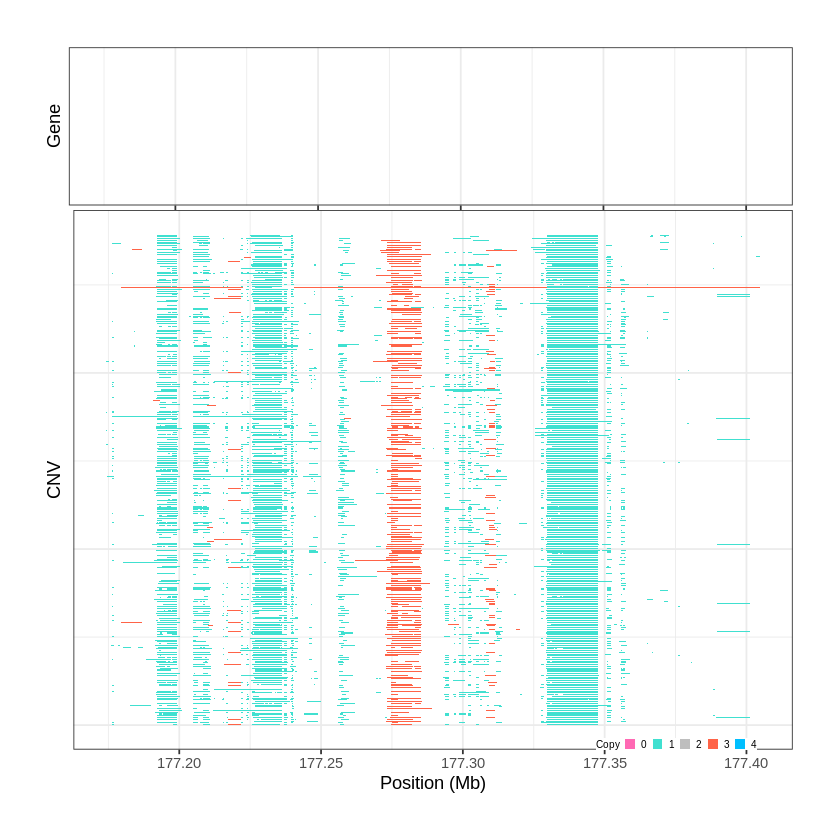

Task done, plot was stored in working directory.
[1] "Ploting CNVR 733..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 177.468301 - 178.0429 Mb with 275 Individual - "
Plotting gene...


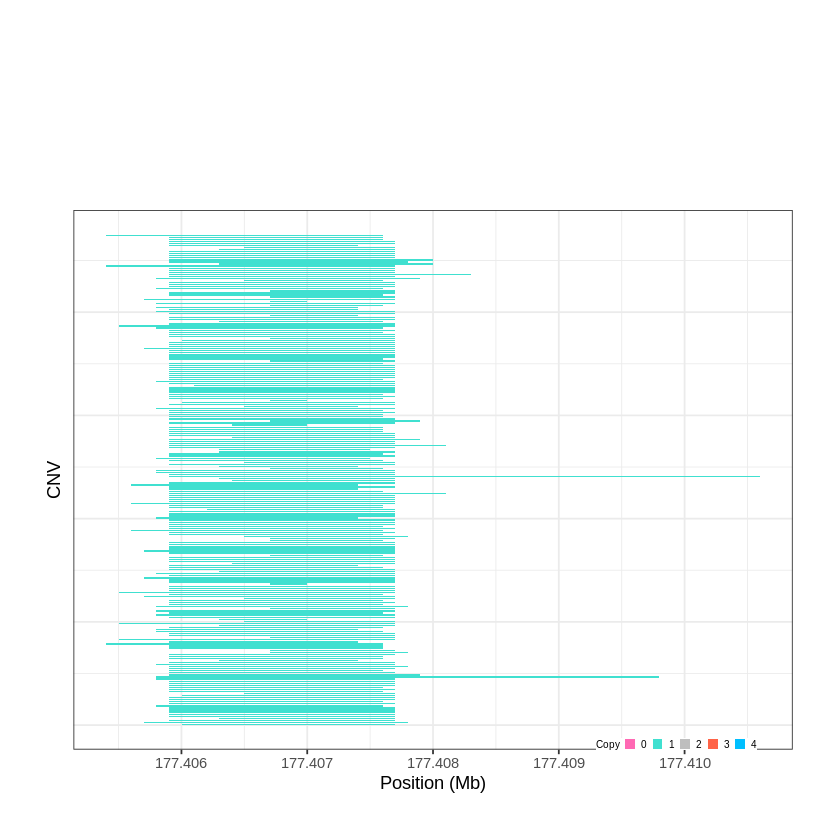

Task done, plot was stored in working directory.
[1] "Ploting CNVR 734..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 178.101301 - 178.1638 Mb with 182 Individual - "
Plotting gene...


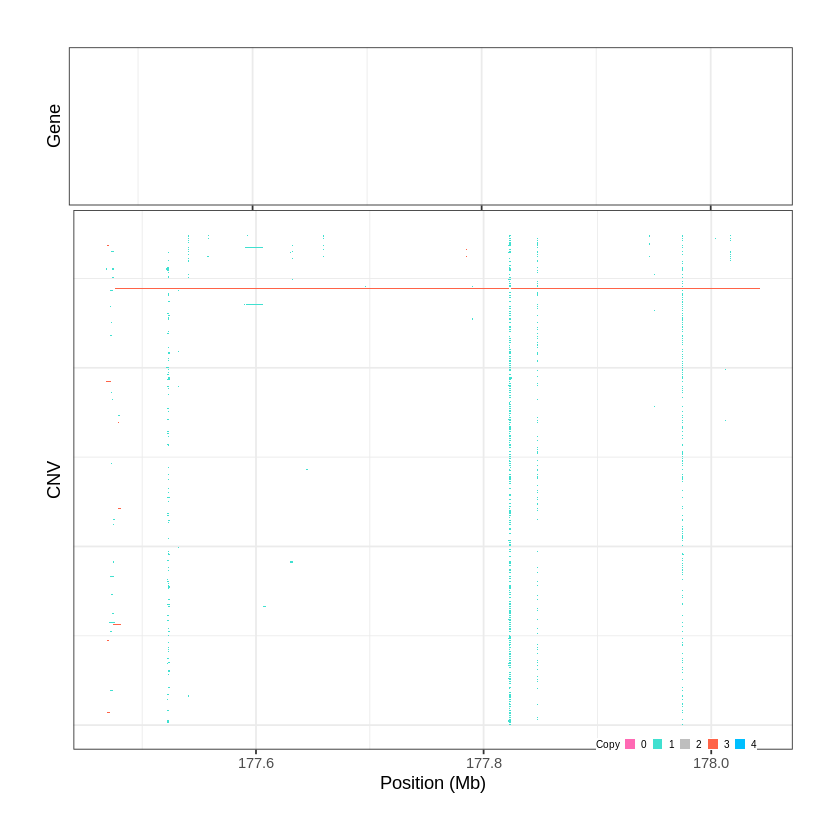

Task done, plot was stored in working directory.
[1] "Ploting CNVR 735..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 178.515001 - 178.9492 Mb with 279 Individual - "
Plotting gene...


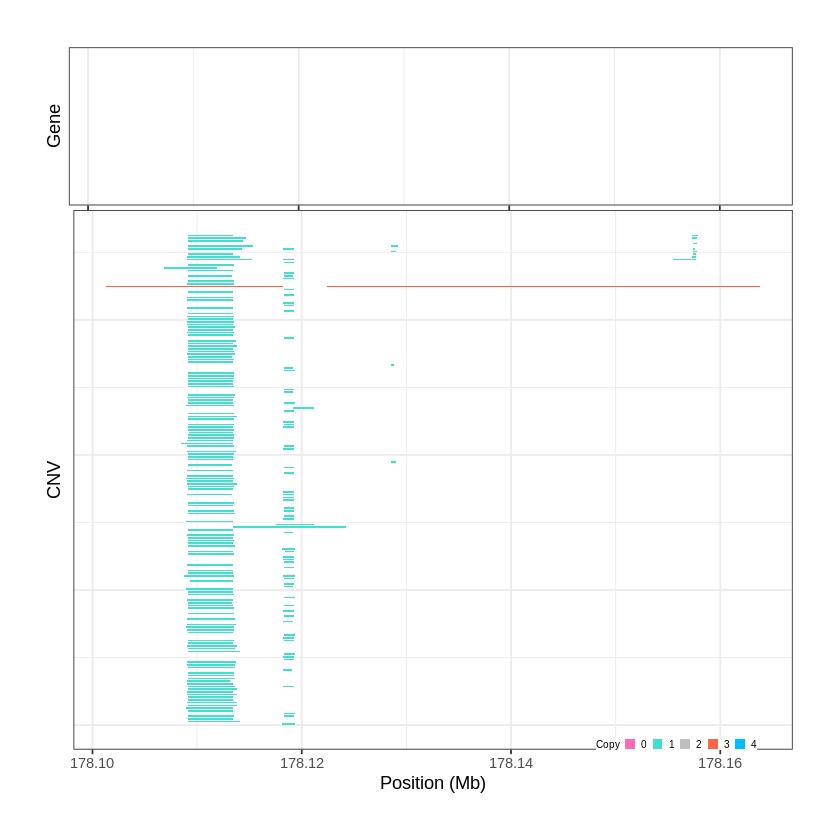

Task done, plot was stored in working directory.
[1] "Ploting CNVR 736..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 179.467301 - 179.8686 Mb with 202 Individual - "
Plotting gene...


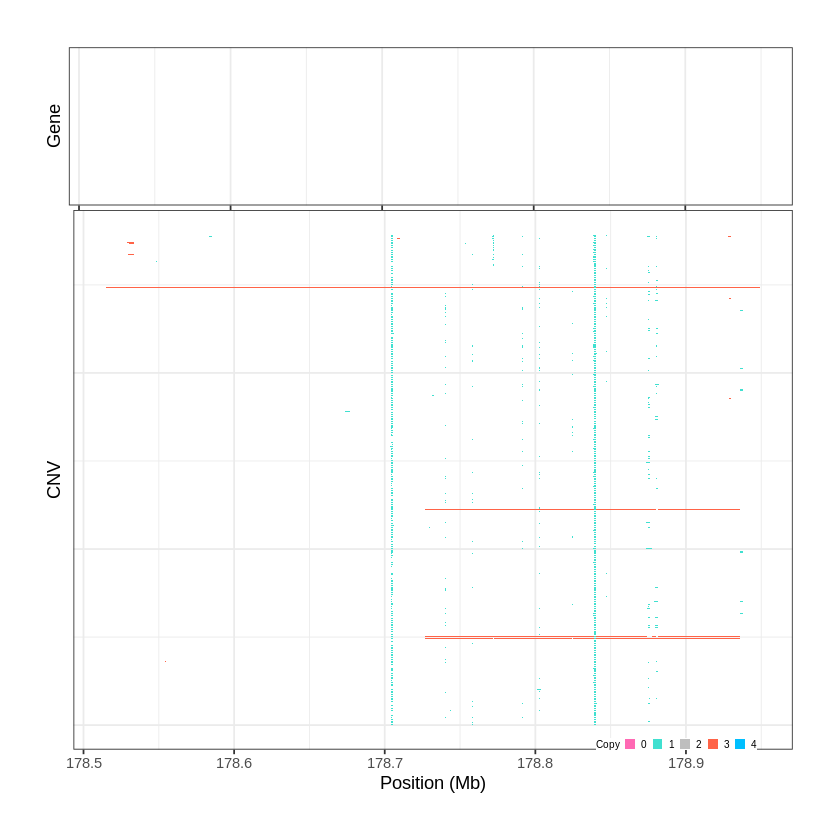

Task done, plot was stored in working directory.
[1] "Ploting CNVR 737..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 180.164901 - 180.5237 Mb with 229 Individual - "
Plotting gene...


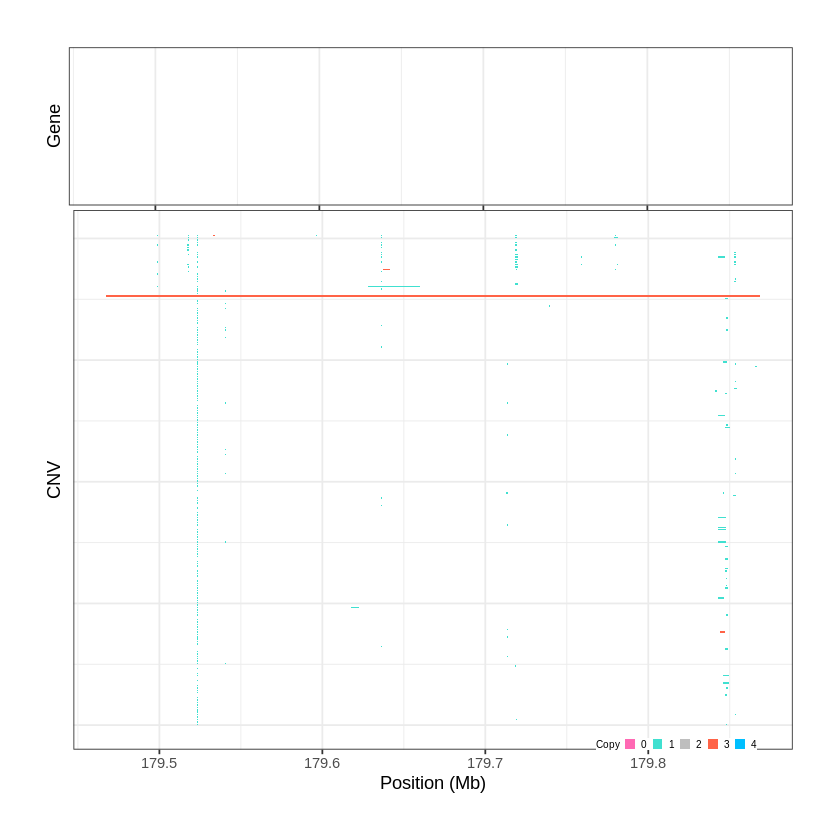

Task done, plot was stored in working directory.
[1] "Ploting CNVR 738..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 180.524601 - 180.6305 Mb with 274 Individual - "
Plotting gene...


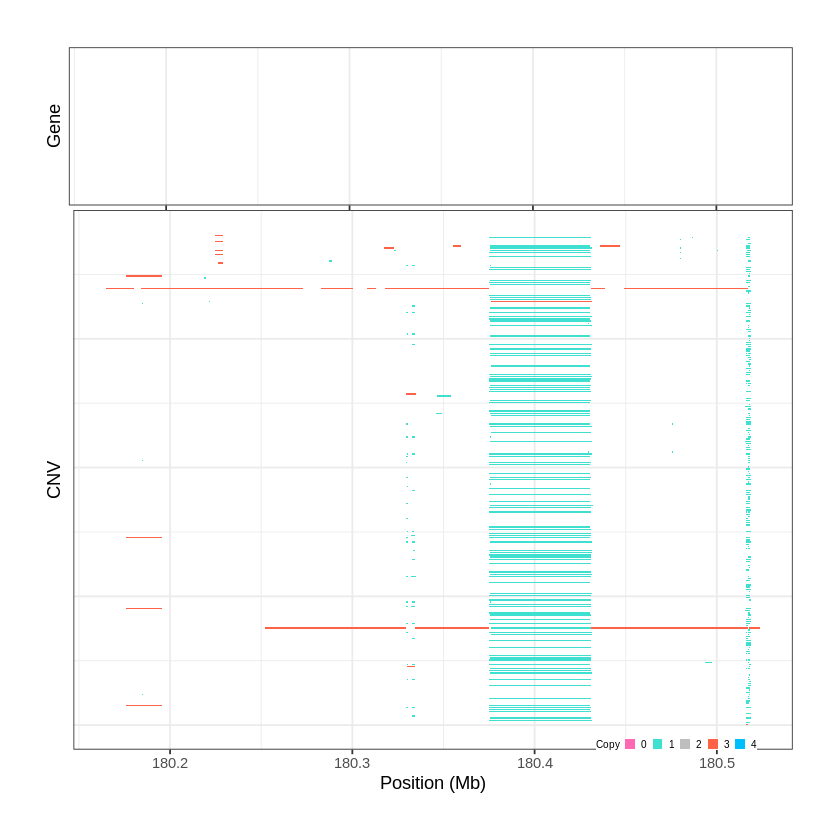

Task done, plot was stored in working directory.
[1] "Ploting CNVR 739..."
Input data passed requirment check...
[1] "CNV on Chromosome 5: 180.634601 - 180.9153 Mb with 279 Individual - "
Plotting gene...


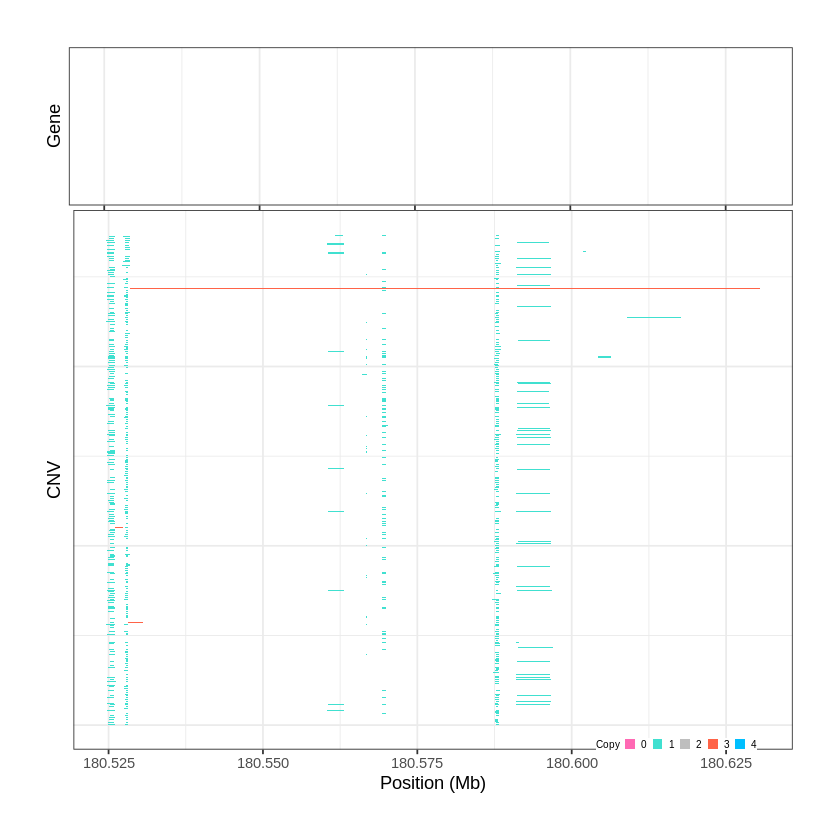

Task done, plot was stored in working directory.
[1] "Ploting CNVR 740..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 1e-06 - 0.2024 Mb with 279 Individual - "
Plotting gene...


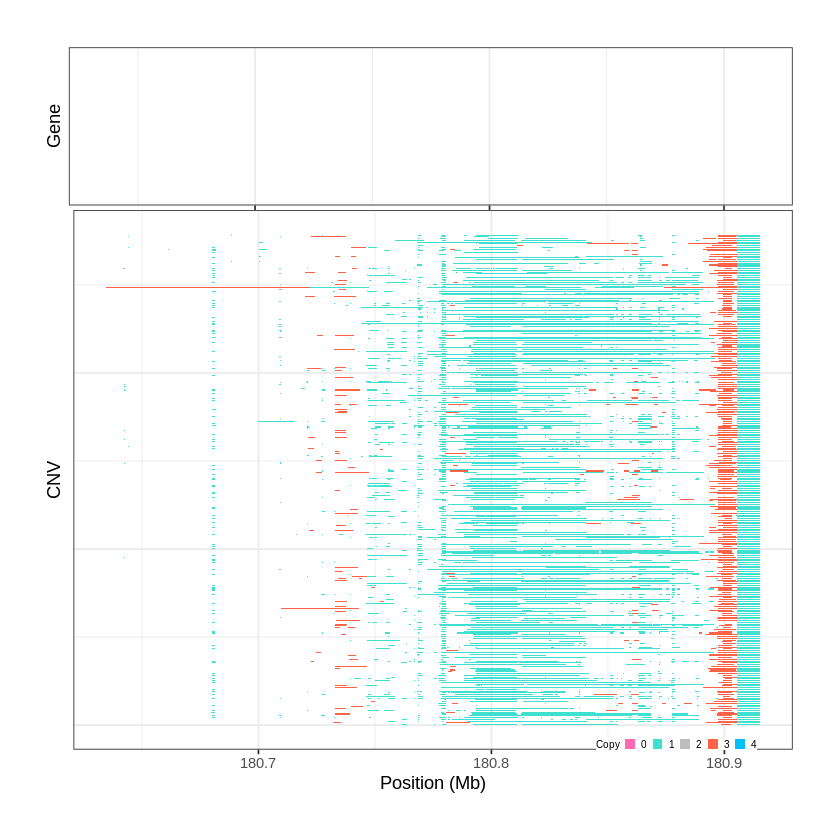

Task done, plot was stored in working directory.
[1] "Ploting CNVR 741..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 0.256201 - 0.3912 Mb with 270 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 742..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 0.418601 - 0.5191 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


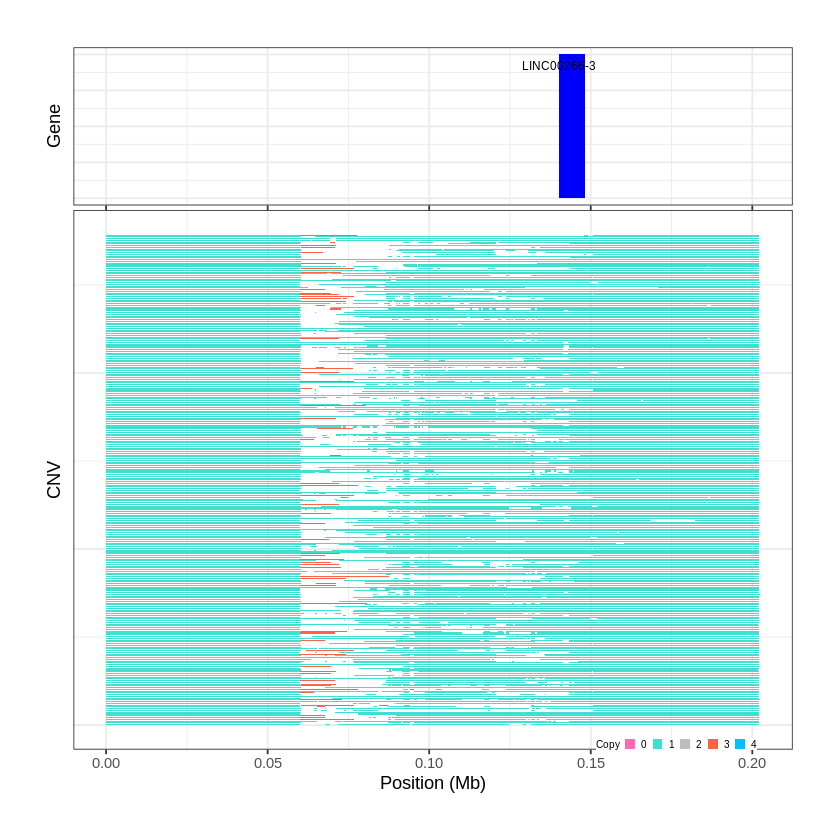

Task done, plot was stored in working directory.
[1] "Ploting CNVR 743..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 0.519101 - 0.6411 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


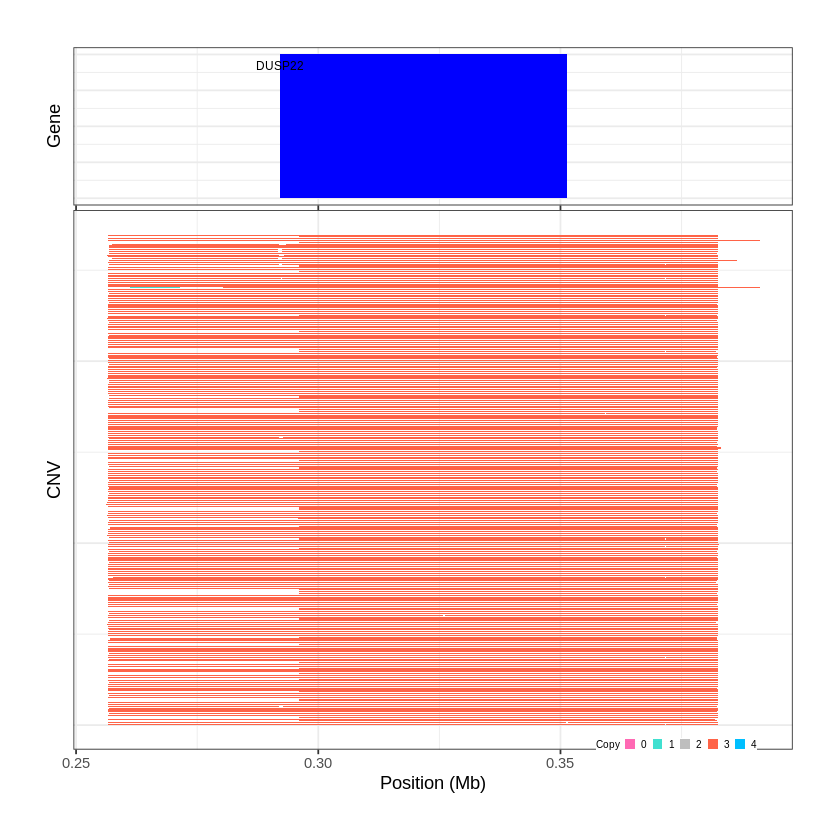

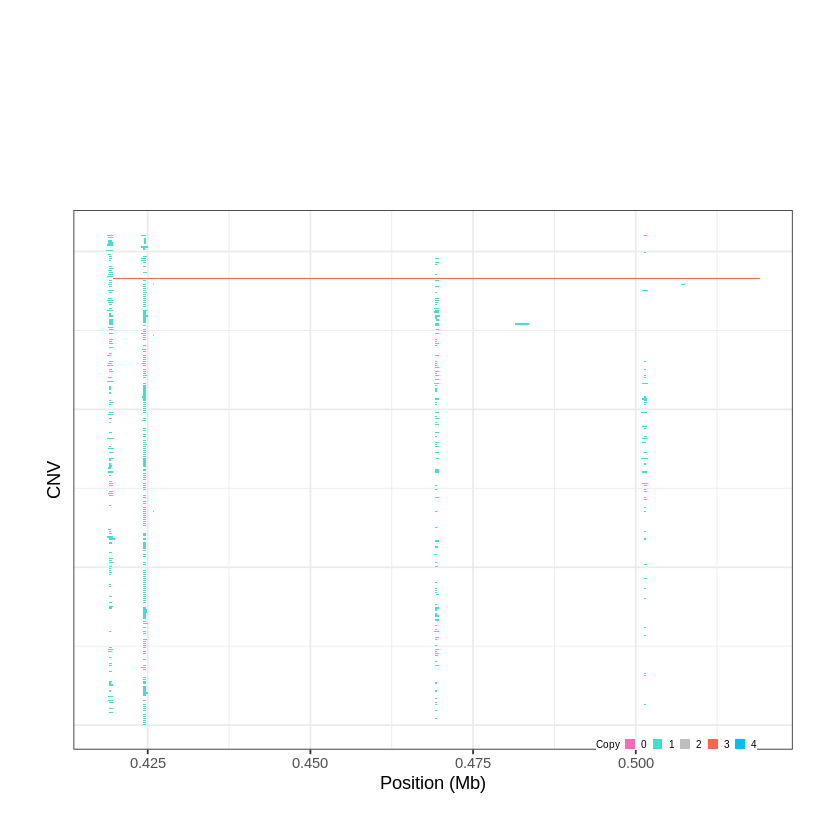

Task done, plot was stored in working directory.
[1] "Ploting CNVR 744..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 0.649201 - 0.6813 Mb with 223 Individual - "
Plotting gene...


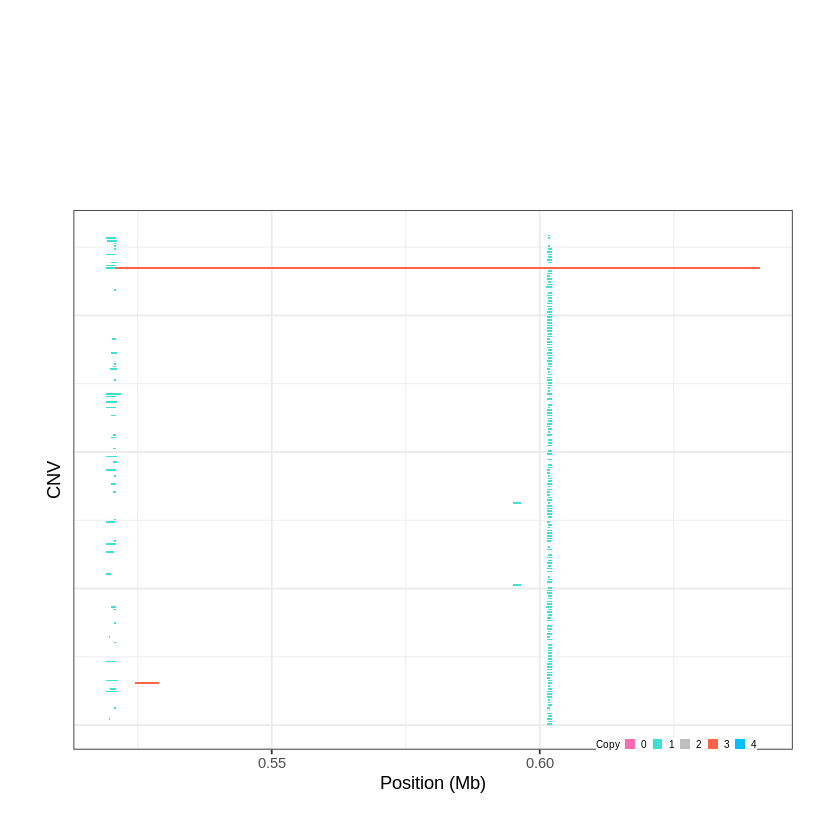

Task done, plot was stored in working directory.
[1] "Ploting CNVR 745..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 1.297301 - 1.3303 Mb with 239 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 746..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 1.357801 - 1.3589 Mb with 170 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


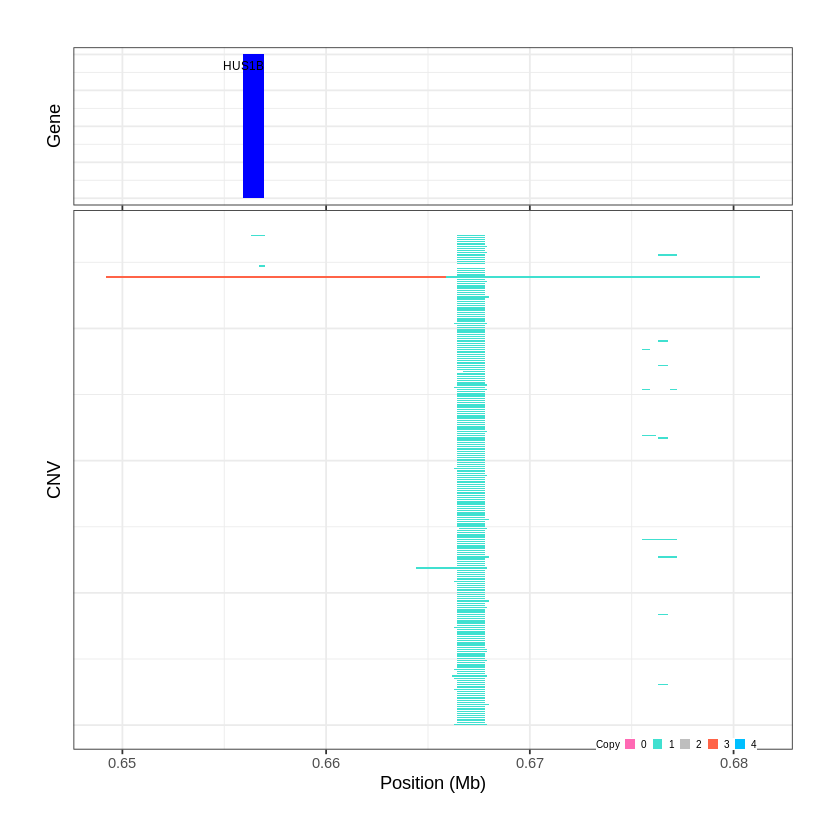

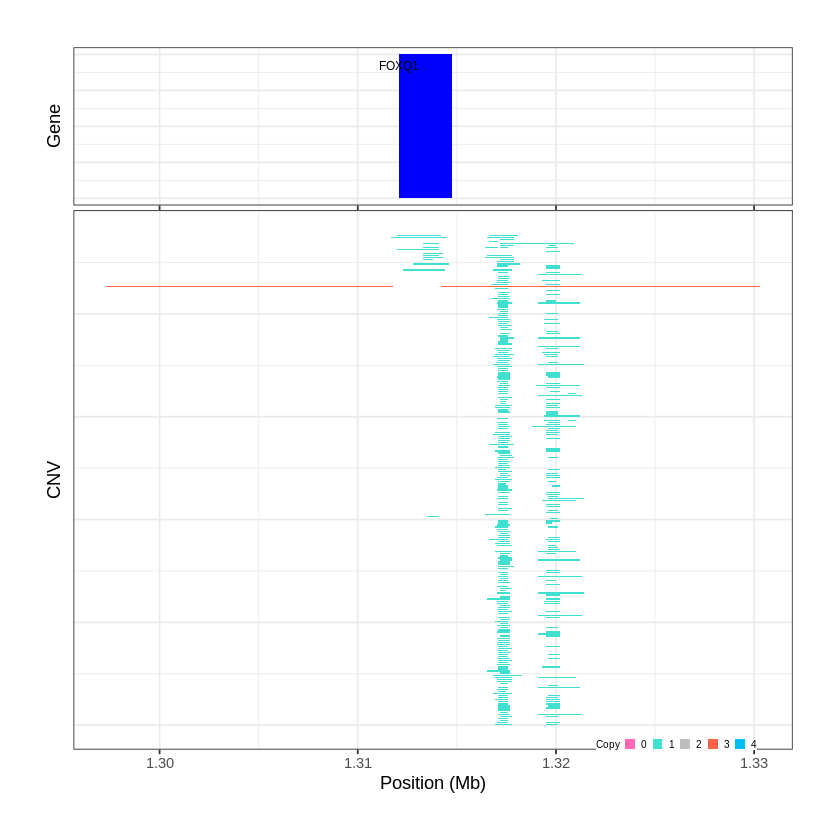

Task done, plot was stored in working directory.
[1] "Ploting CNVR 747..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 1.375601 - 1.6859 Mb with 224 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 748..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 3.039001 - 3.0945 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


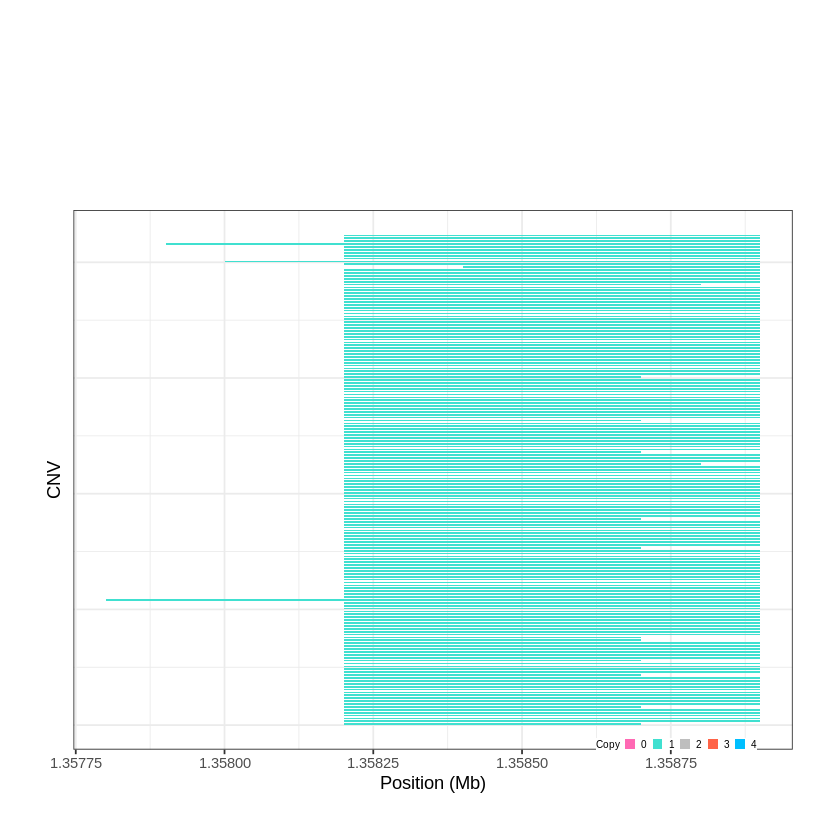

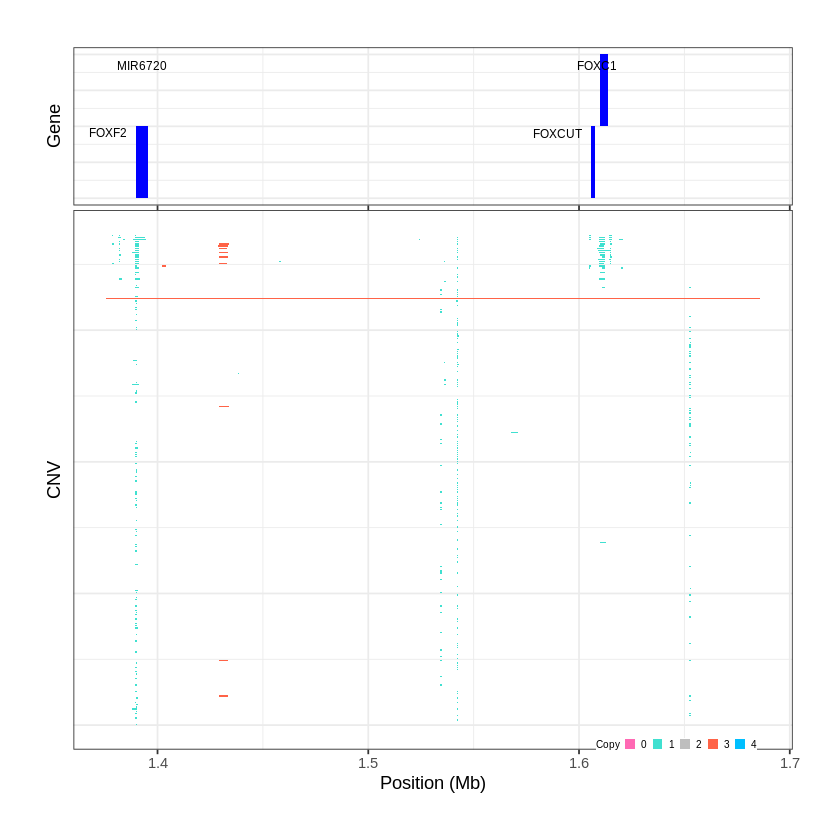

Task done, plot was stored in working directory.
[1] "Ploting CNVR 749..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 3.115301 - 3.1805 Mb with 164 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 750..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 4.132801 - 4.139 Mb with 171 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


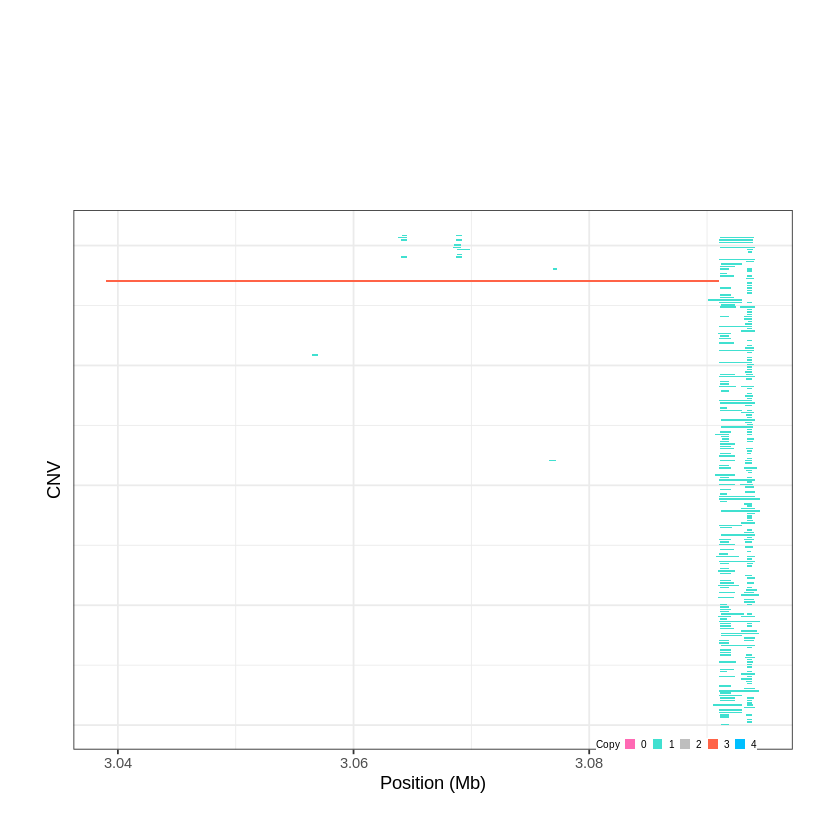

Task done, plot was stored in working directory.
[1] "Ploting CNVR 751..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 5.024801 - 5.0493 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


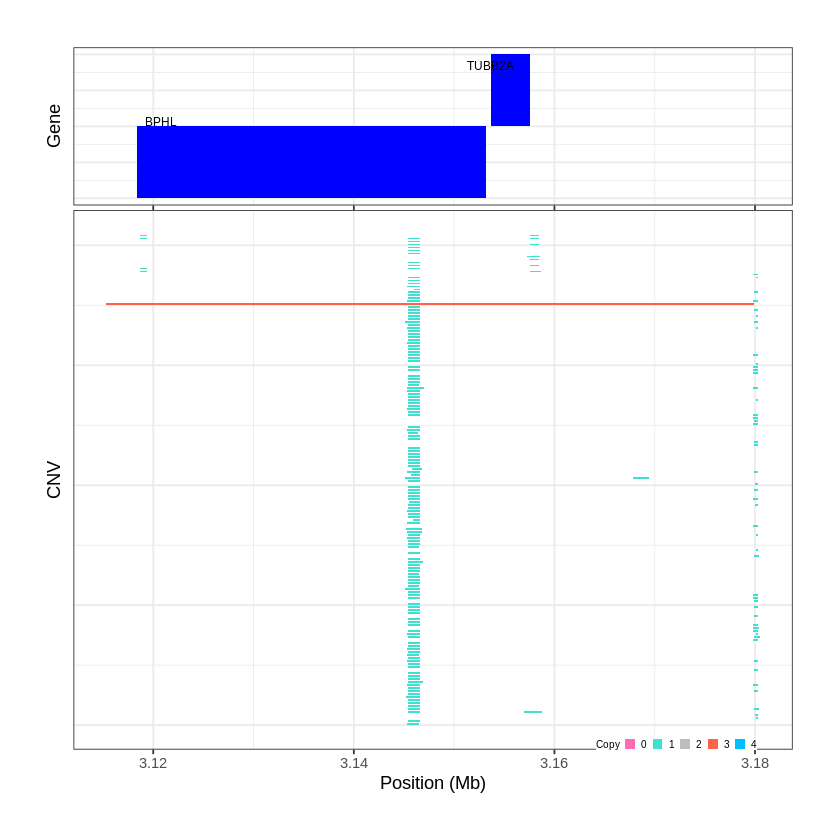

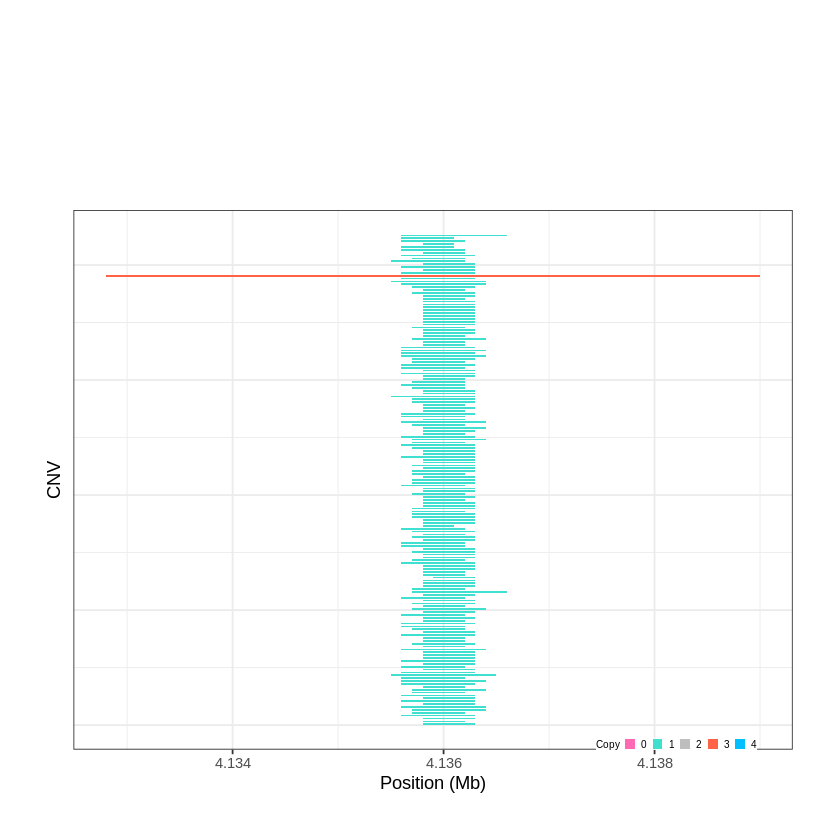

Task done, plot was stored in working directory.
[1] "Ploting CNVR 752..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 5.081801 - 5.1465 Mb with 148 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 753..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 9.449901 - 9.4889 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


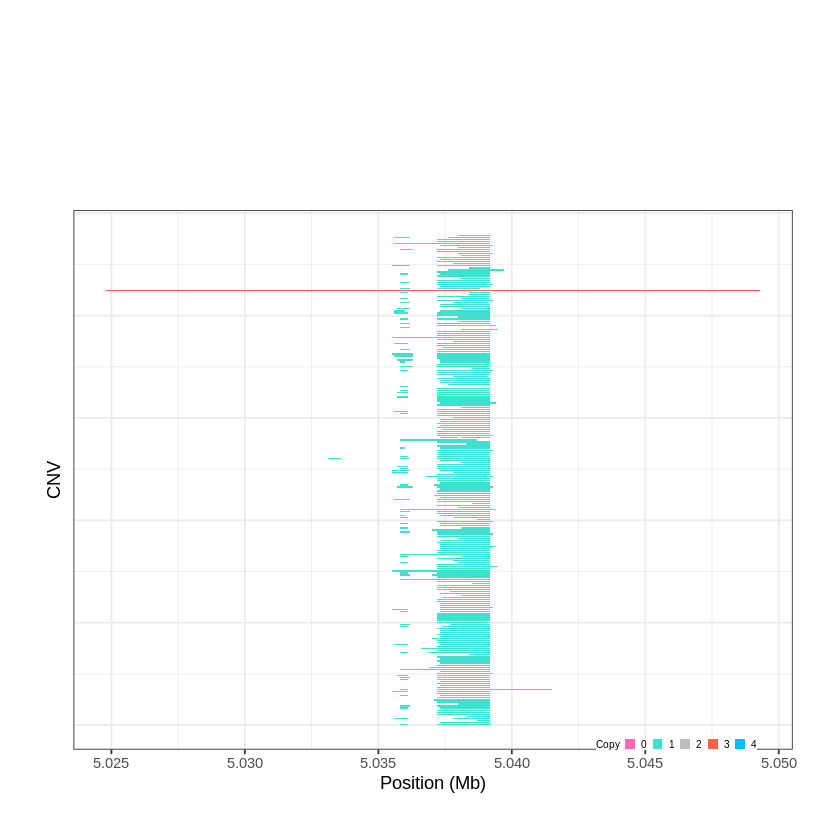

Task done, plot was stored in working directory.
[1] "Ploting CNVR 754..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 10.070801 - 10.0711 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


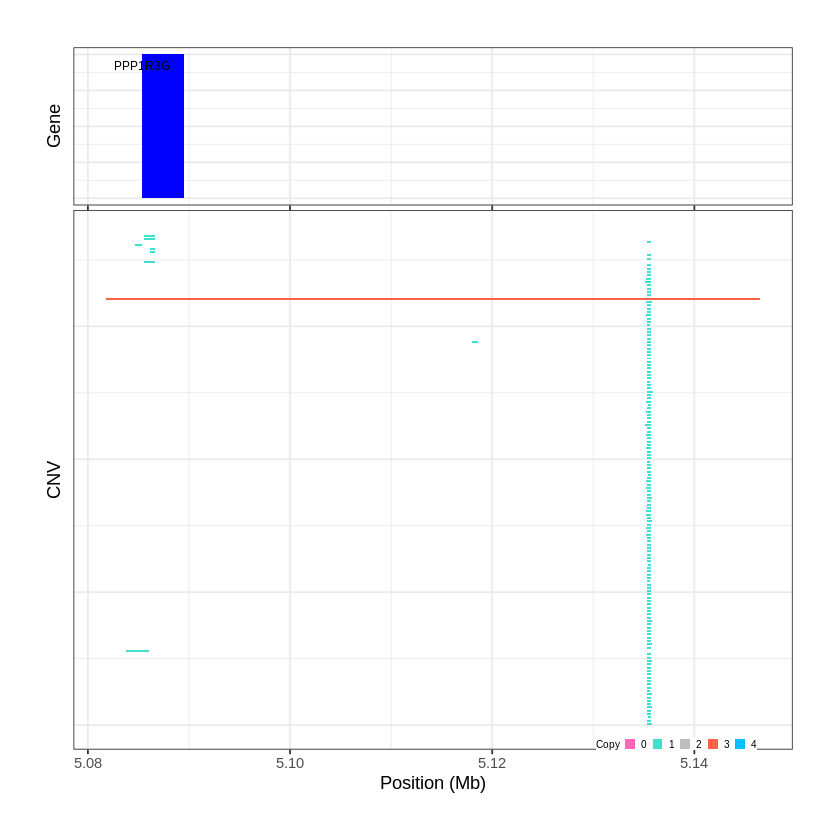

Task done, plot was stored in working directory.
[1] "Ploting CNVR 755..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 10.263001 - 10.2653 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


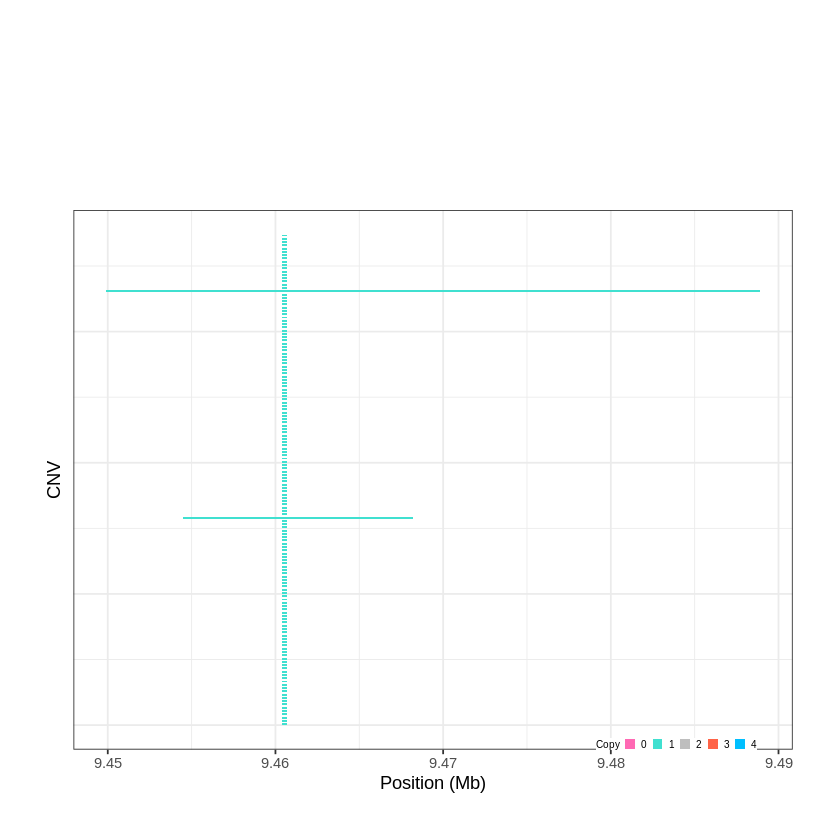

Task done, plot was stored in working directory.
[1] "Ploting CNVR 756..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 11.556101 - 11.5564 Mb with 244 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


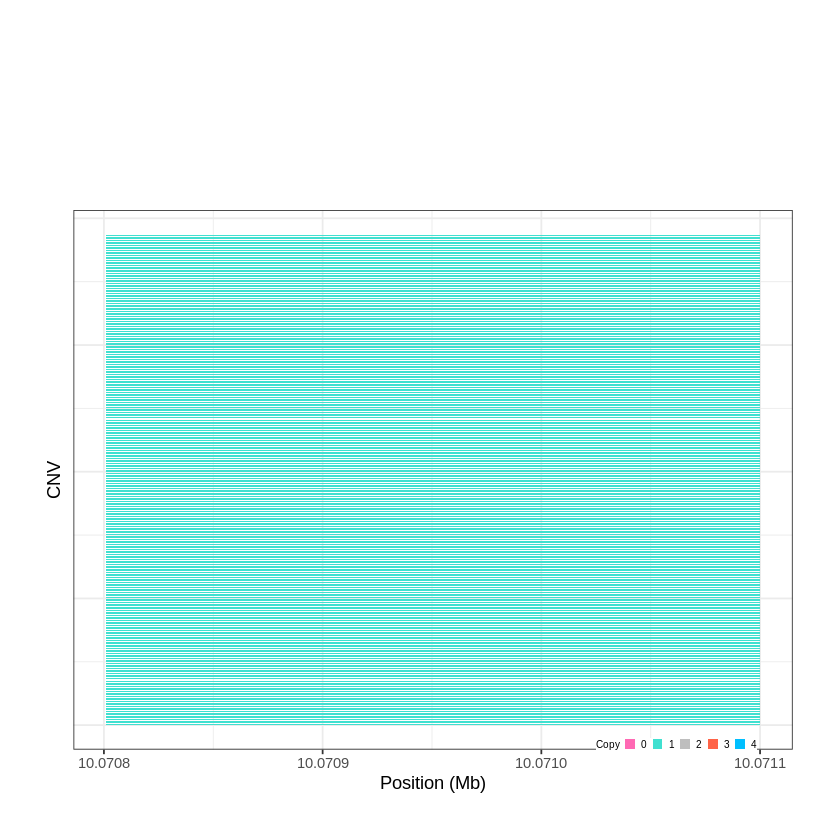

Task done, plot was stored in working directory.
[1] "Ploting CNVR 757..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 11.889201 - 11.9006 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


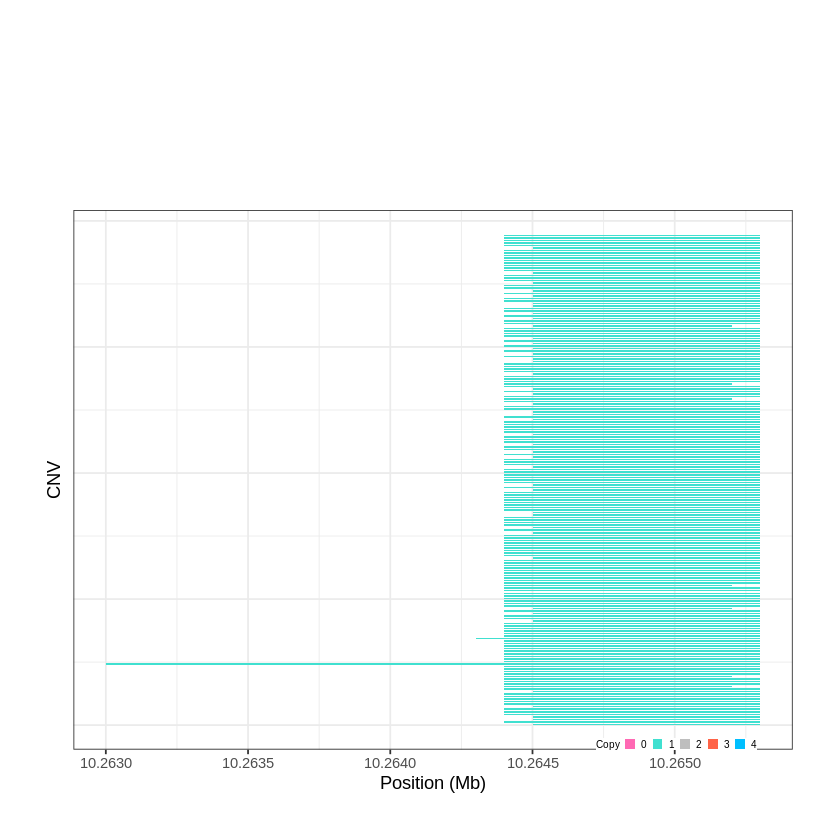

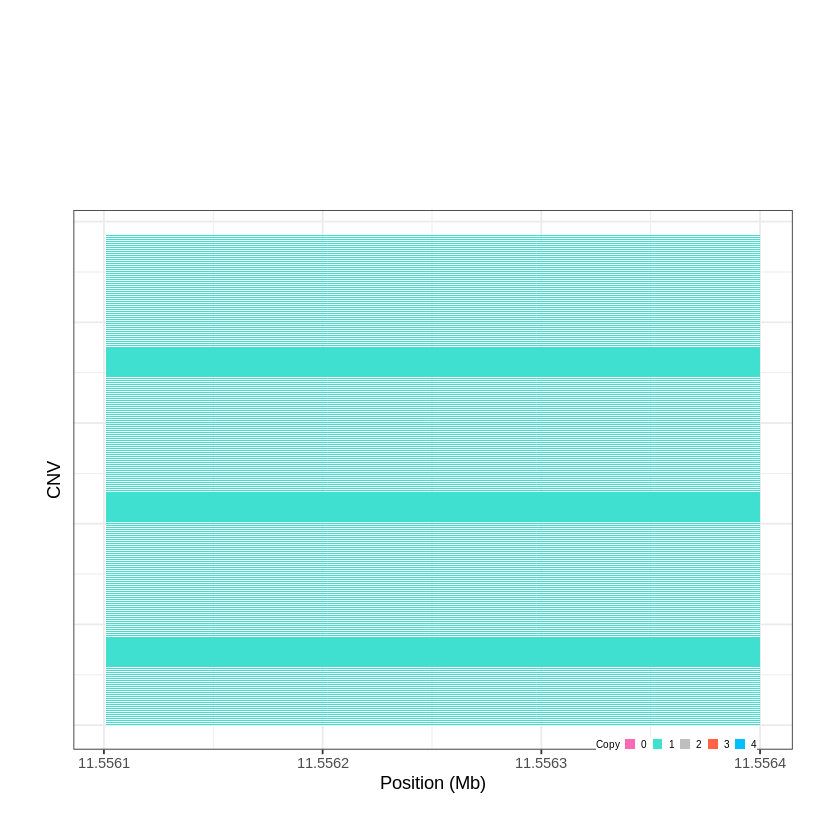

Task done, plot was stored in working directory.
[1] "Ploting CNVR 758..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 11.984301 - 12.0204 Mb with 175 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 759..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 13.871301 - 13.8842 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


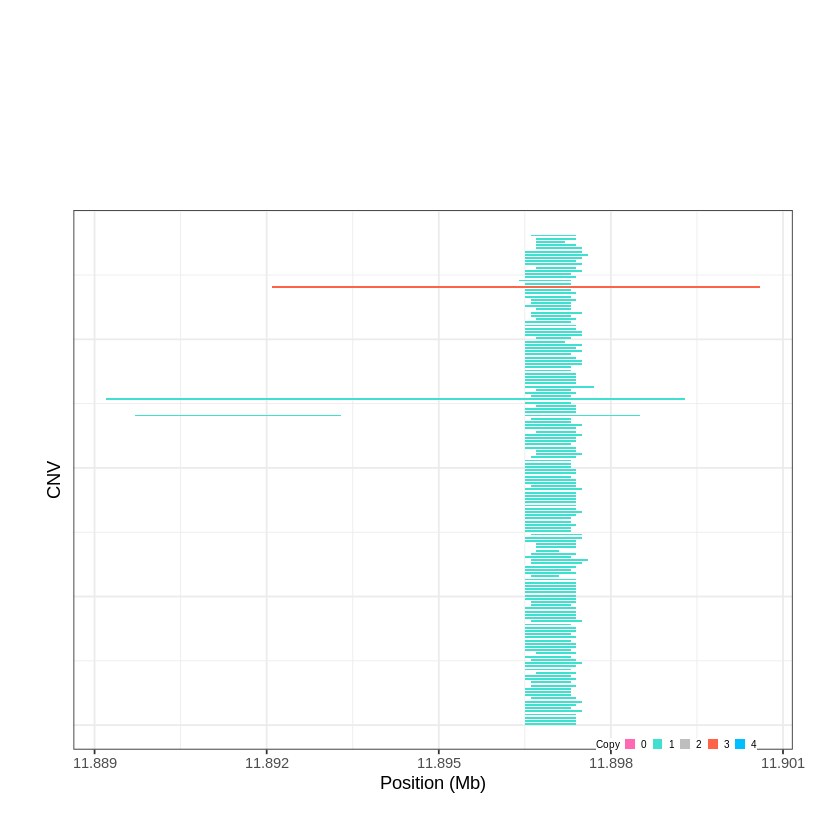

Task done, plot was stored in working directory.
[1] "Ploting CNVR 760..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 14.745201 - 14.7457 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


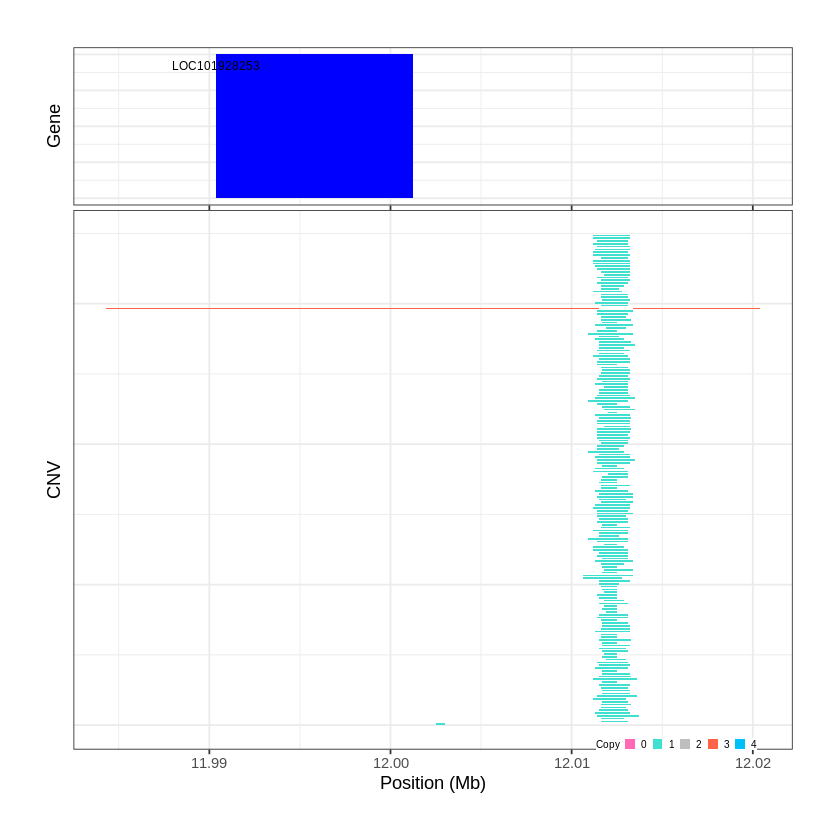

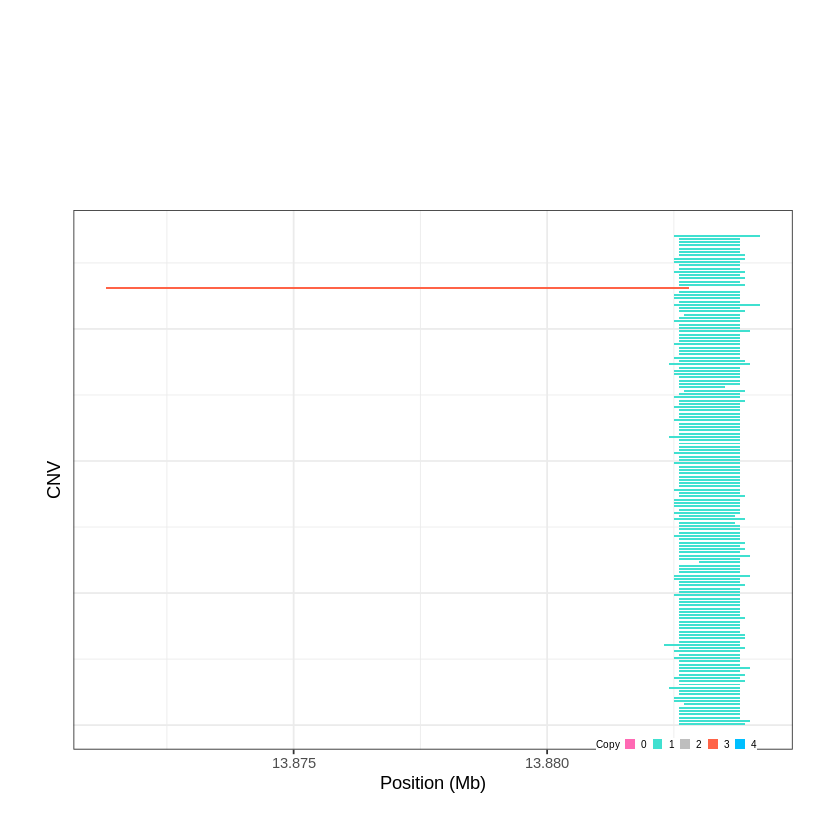

Task done, plot was stored in working directory.
[1] "Ploting CNVR 761..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 18.375401 - 18.5213 Mb with 210 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 762..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 20.764101 - 20.797 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


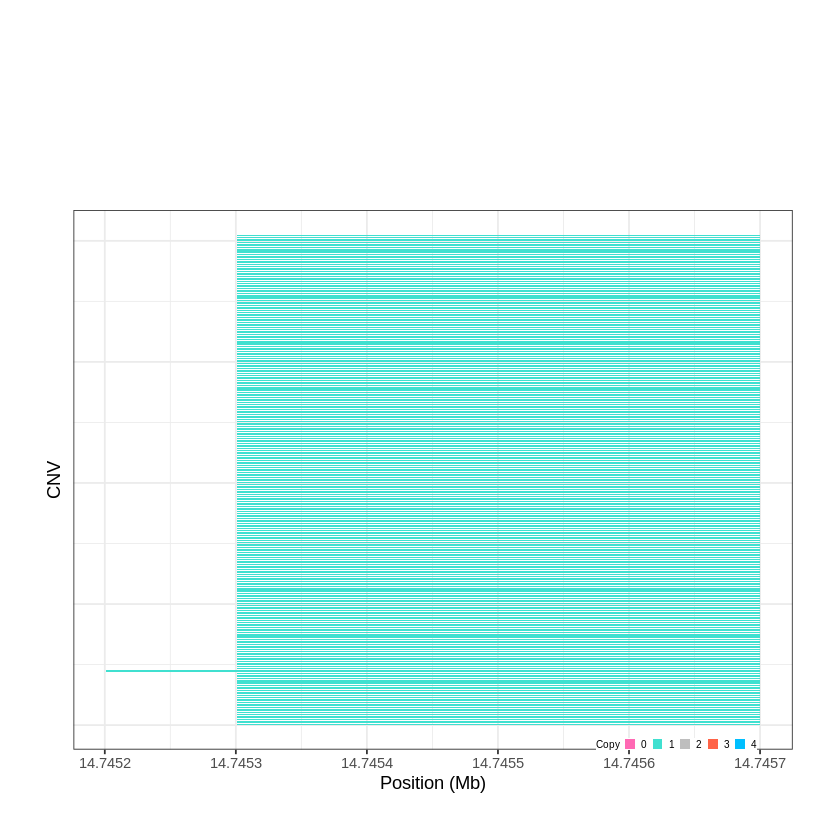

Task done, plot was stored in working directory.
[1] "Ploting CNVR 763..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 21.850901 - 21.8536 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


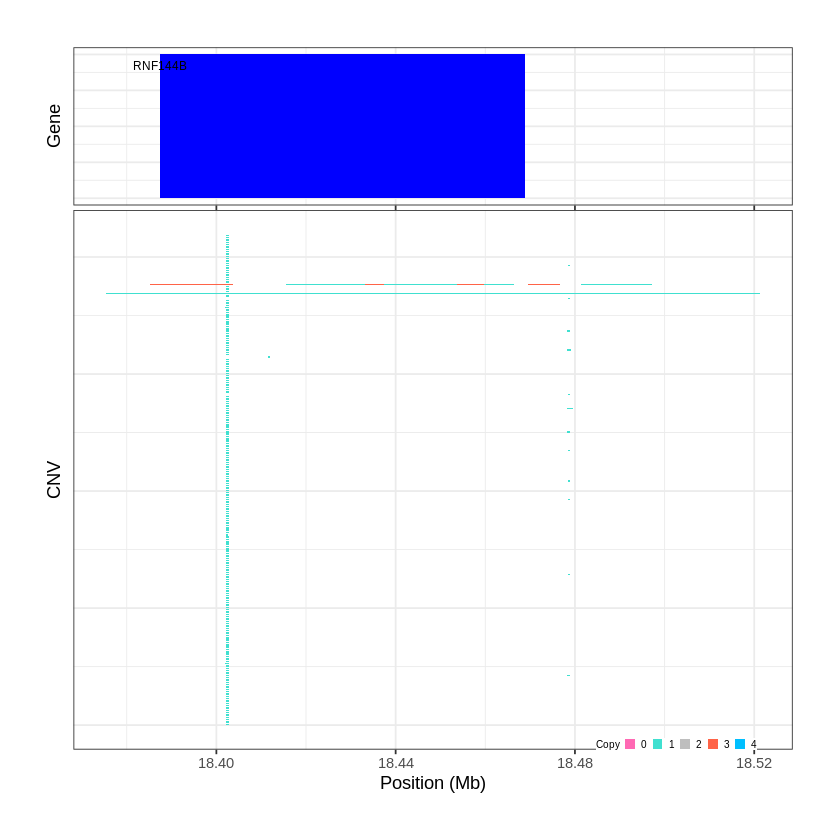

Task done, plot was stored in working directory.
[1] "Ploting CNVR 764..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 22.045801 - 22.0673 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


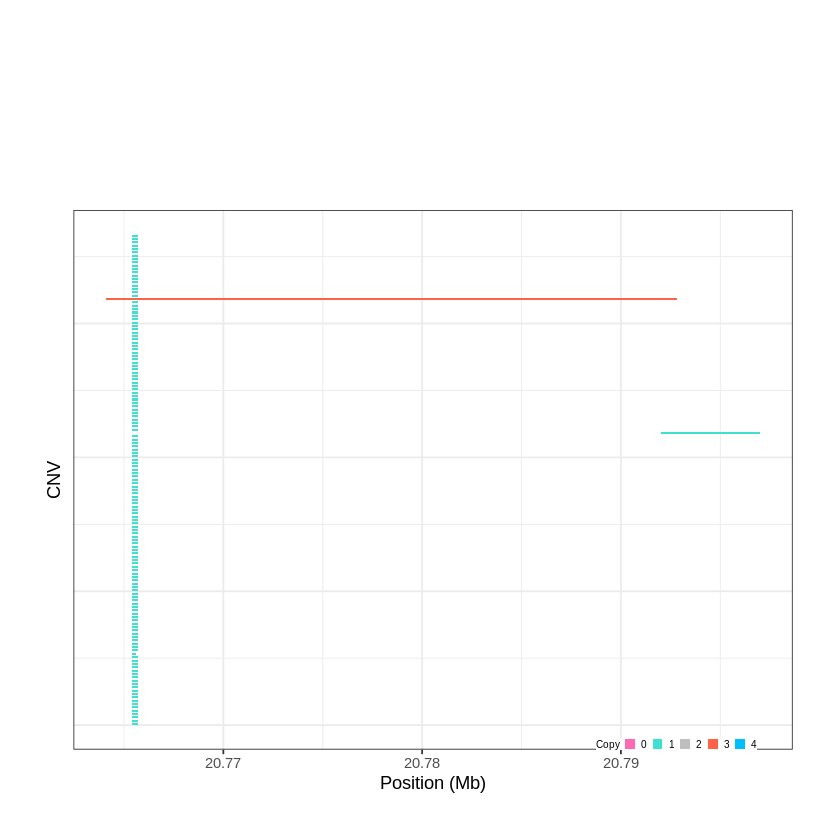

Task done, plot was stored in working directory.
[1] "Ploting CNVR 765..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 22.217301 - 22.2482 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


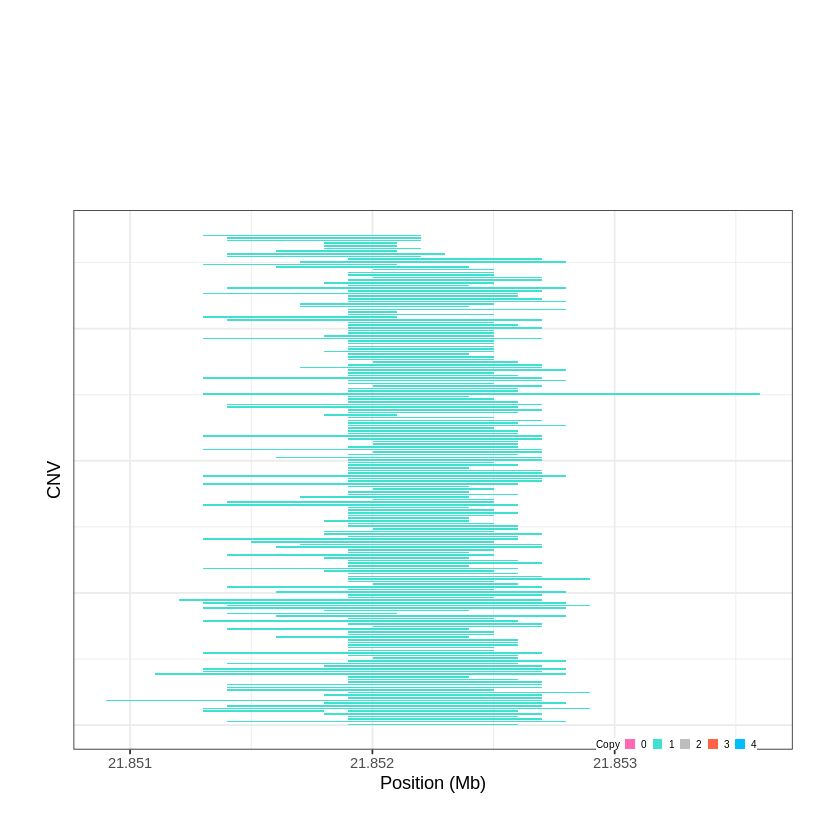

Task done, plot was stored in working directory.
[1] "Ploting CNVR 766..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 23.619701 - 23.6331 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


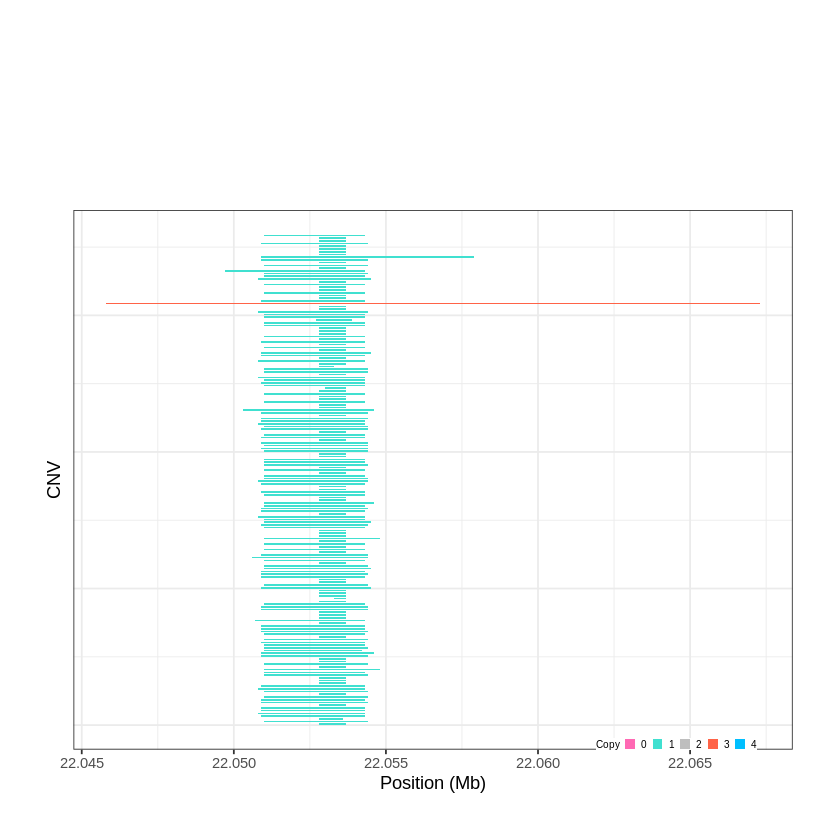

Task done, plot was stored in working directory.
[1] "Ploting CNVR 767..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 25.450601 - 25.4515 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


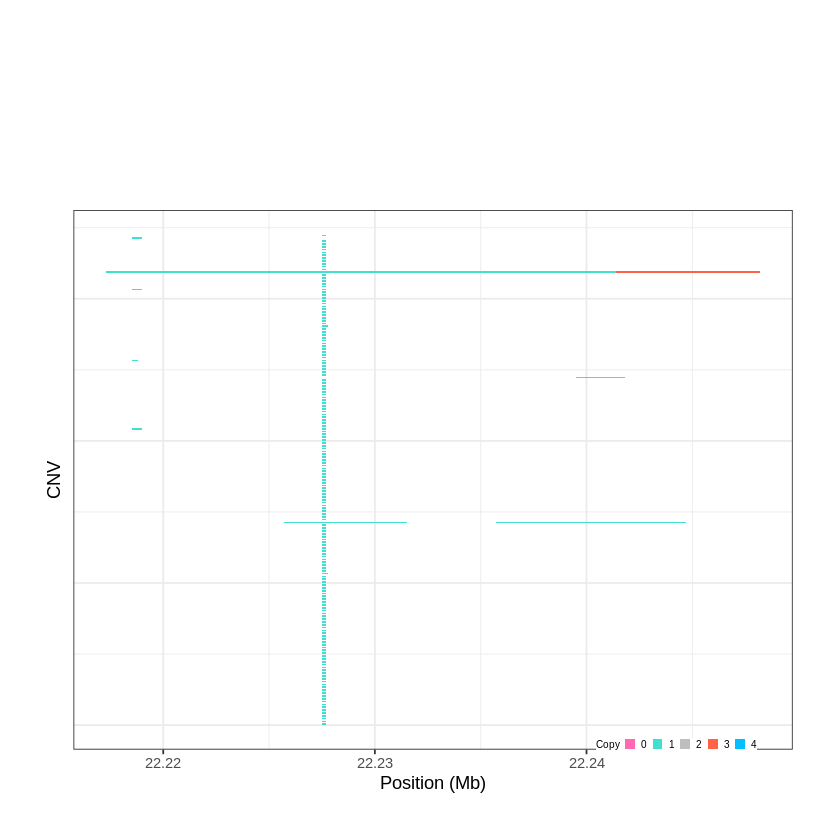

Task done, plot was stored in working directory.
[1] "Ploting CNVR 768..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 26.666501 - 26.8024 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


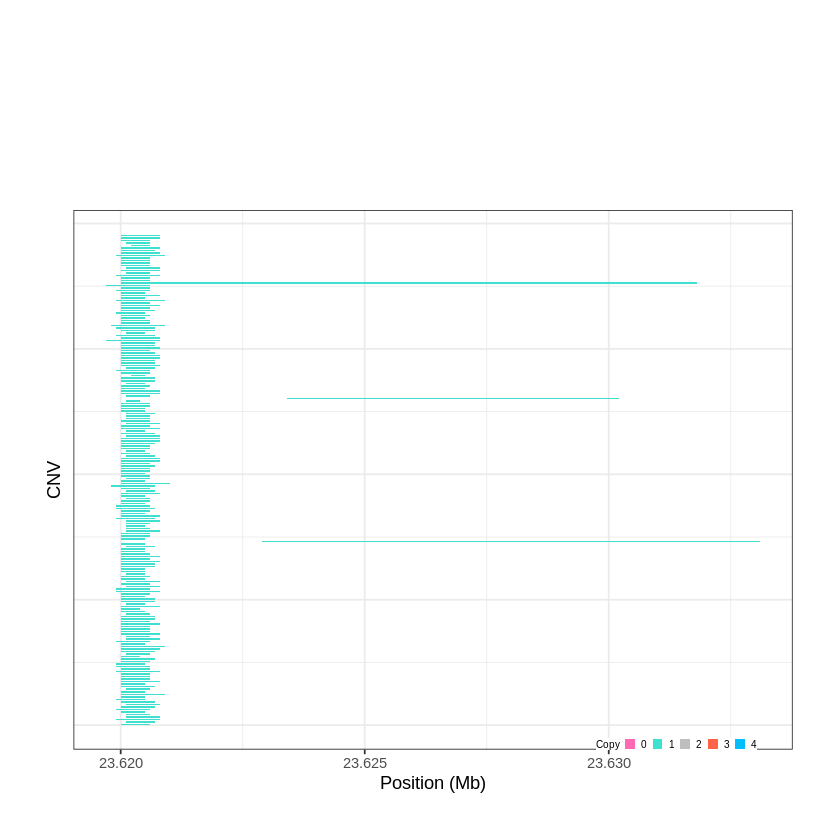

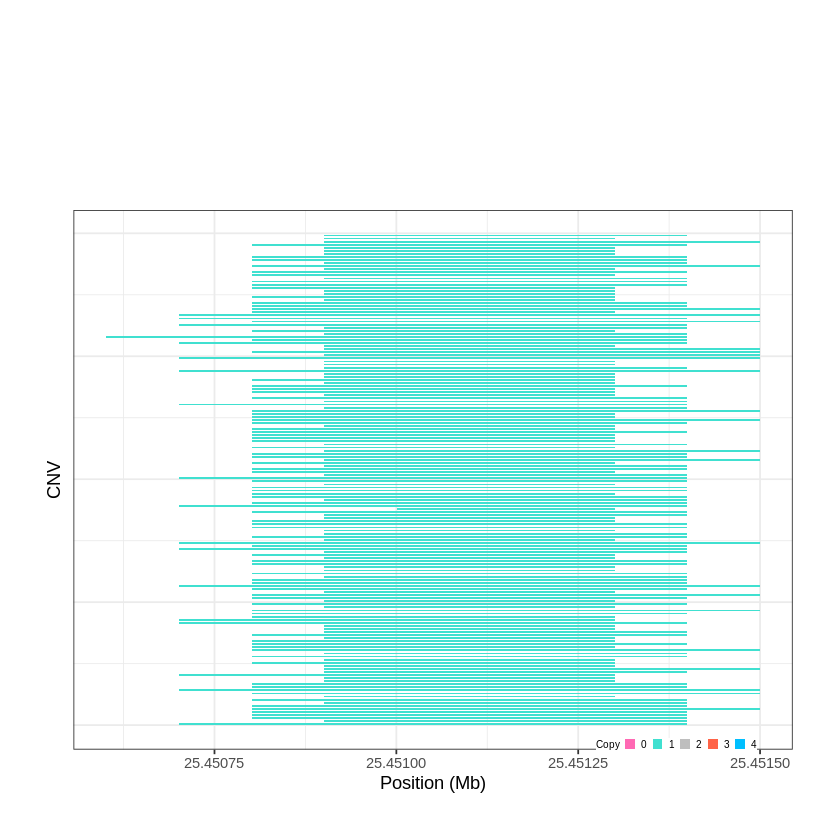

Task done, plot was stored in working directory.
[1] "Ploting CNVR 769..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 26.830901 - 26.9585 Mb with 160 Individual - "
Plotting gene...


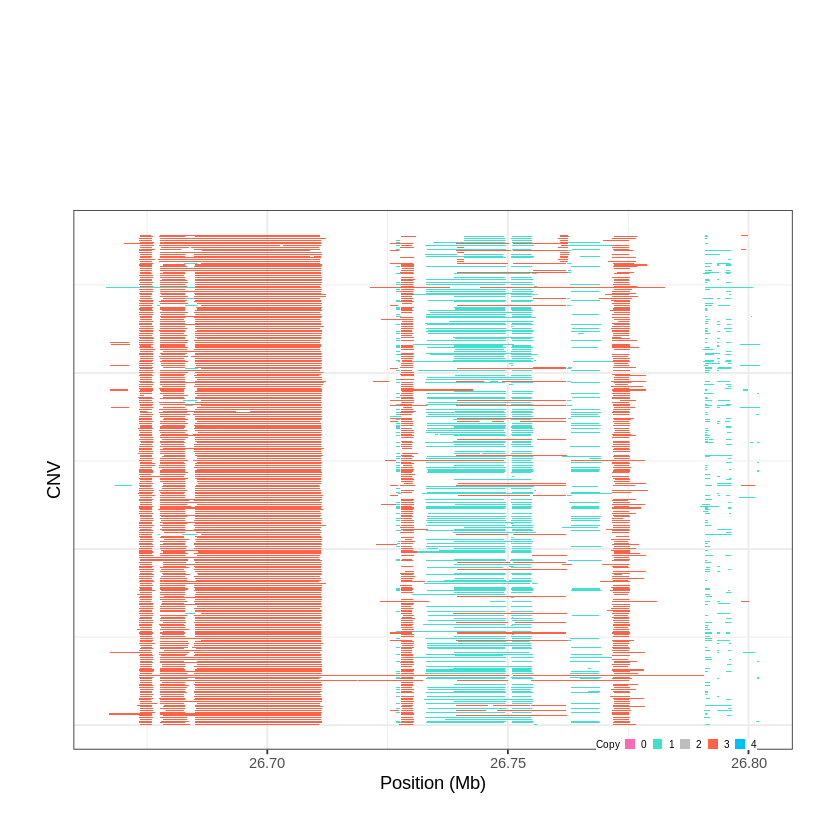

Task done, plot was stored in working directory.
[1] "Ploting CNVR 770..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 29.594801 - 29.6954 Mb with 264 Individual - "
Plotting gene...


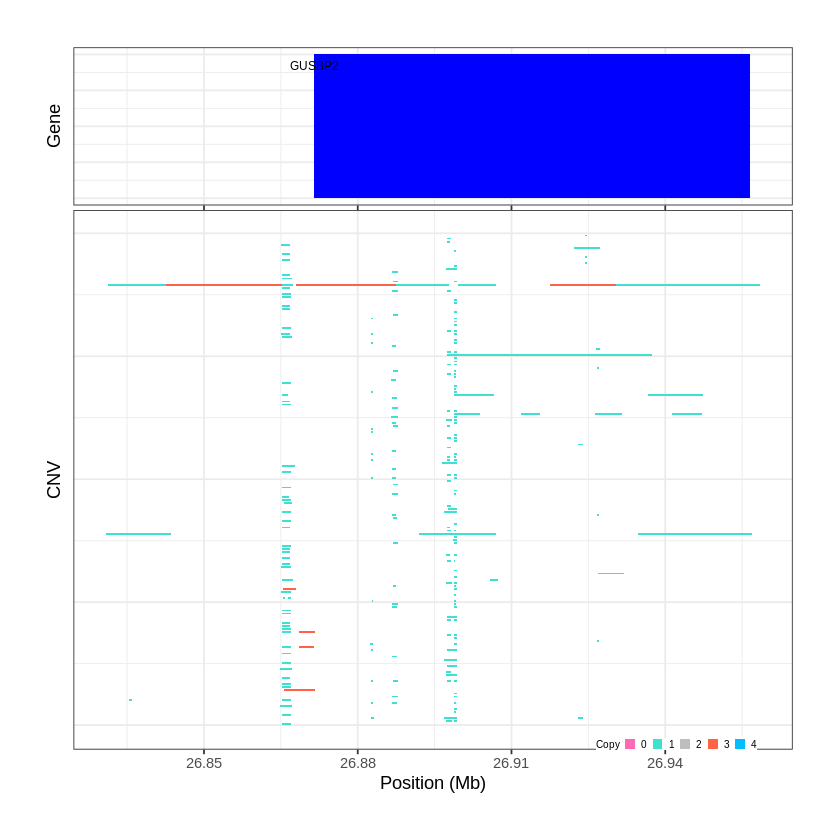

Task done, plot was stored in working directory.
[1] "Ploting CNVR 771..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 29.816101 - 29.9637 Mb with 271 Individual - "
Plotting gene...


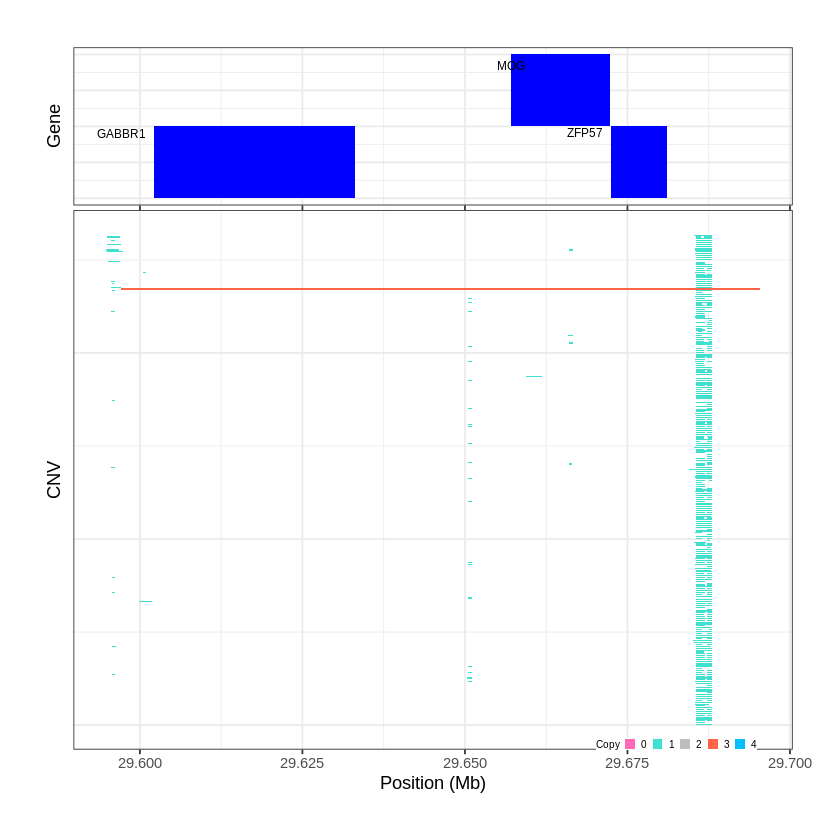

Task done, plot was stored in working directory.
[1] "Ploting CNVR 772..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 31.274601 - 31.3114 Mb with 255 Individual - "
Plotting gene...


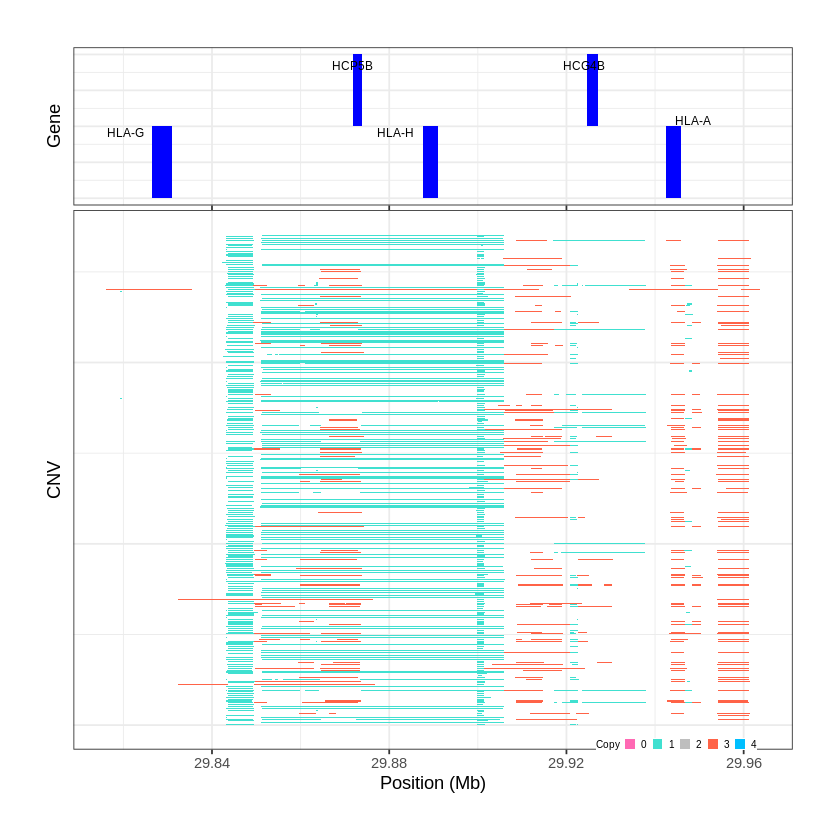

Task done, plot was stored in working directory.
[1] "Ploting CNVR 773..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 31.320901 - 31.8221 Mb with 237 Individual - "
Plotting gene...


Warning message:
“ggrepel: 36 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


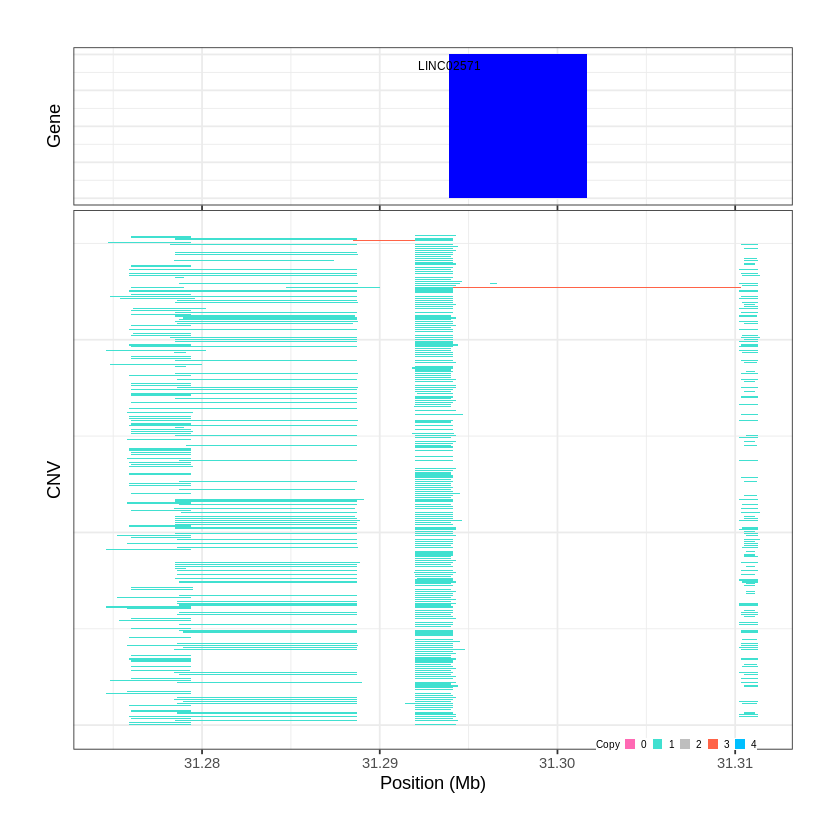

Task done, plot was stored in working directory.
[1] "Ploting CNVR 774..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 31.871101 - 32.229 Mb with 234 Individual - "
Plotting gene...


Warning message:
“ggrepel: 8 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 775..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 32.313701 - 32.3141 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


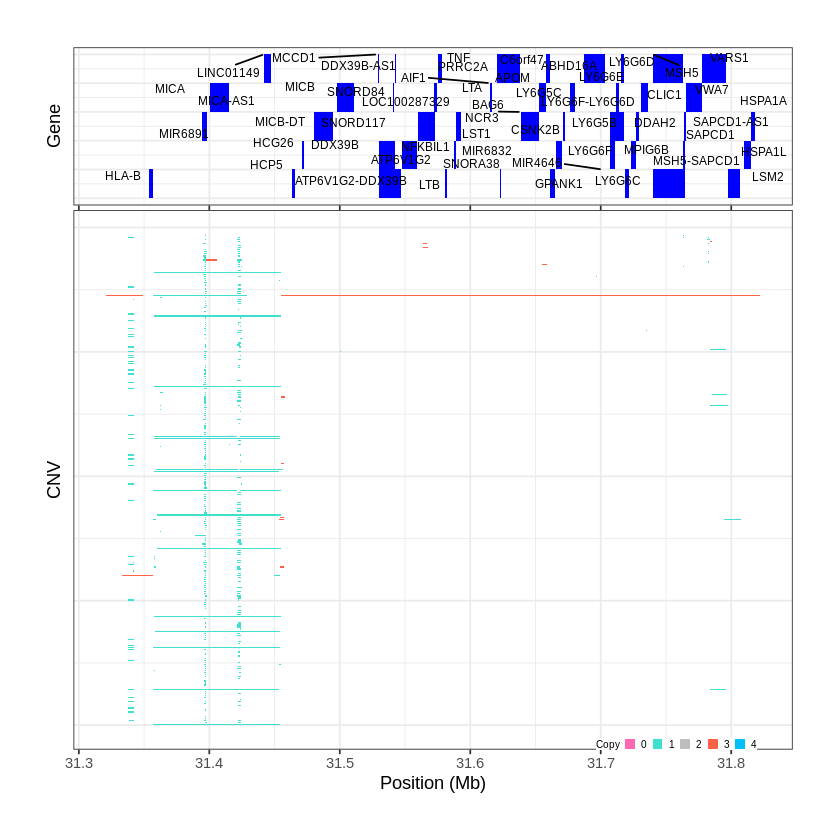

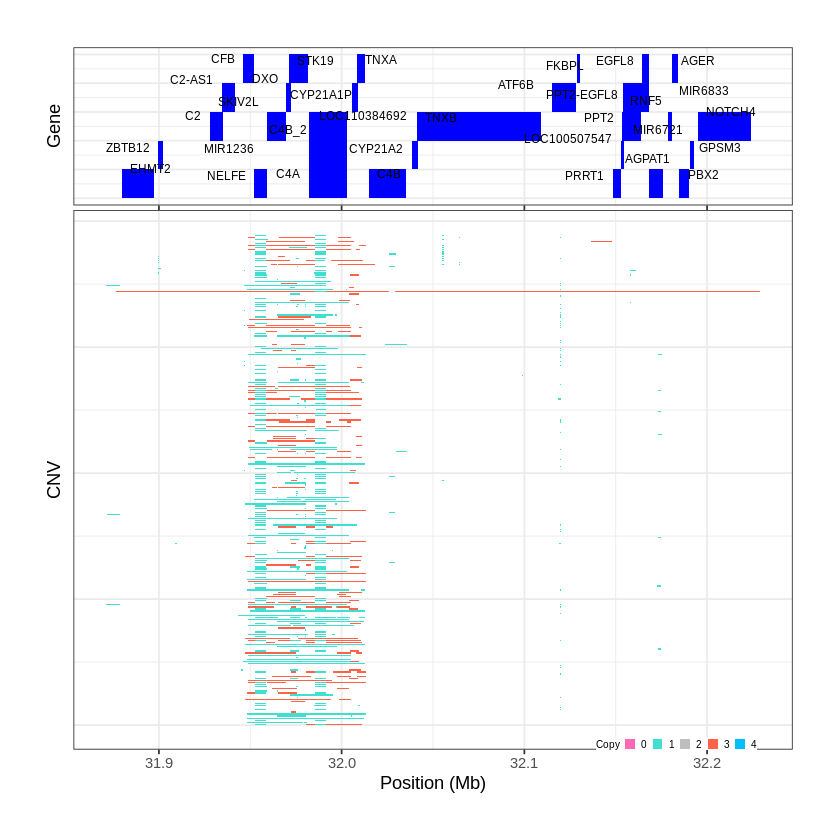

Task done, plot was stored in working directory.
[1] "Ploting CNVR 776..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 32.435101 - 32.5649 Mb with 265 Individual - "
Plotting gene...


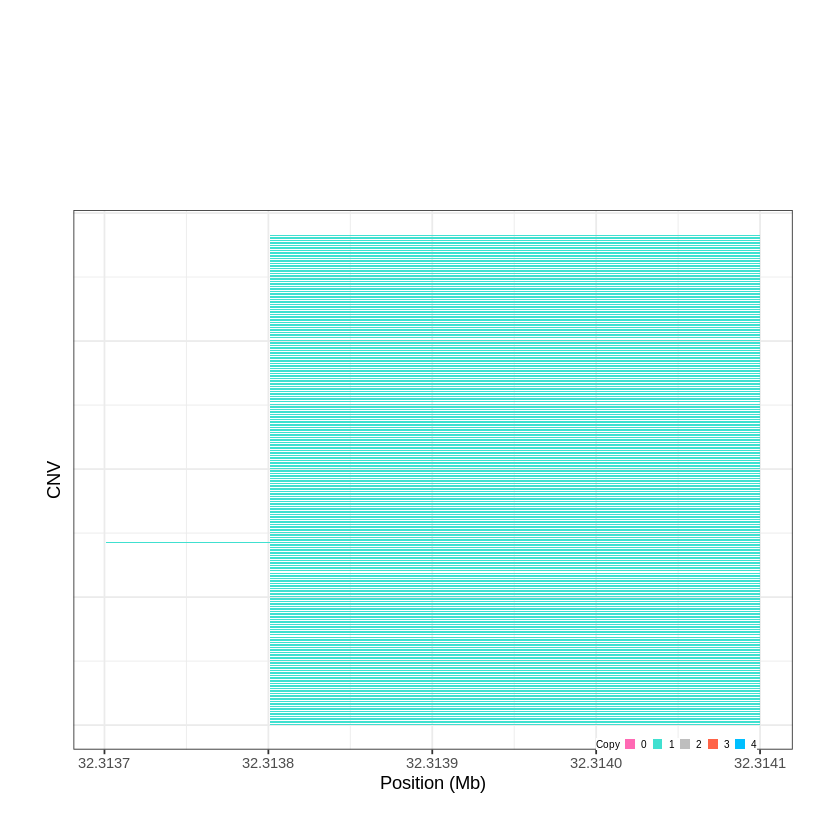

Task done, plot was stored in working directory.
[1] "Ploting CNVR 777..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 32.614401 - 32.6486 Mb with 243 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 778..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 32.771501 - 32.7799 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


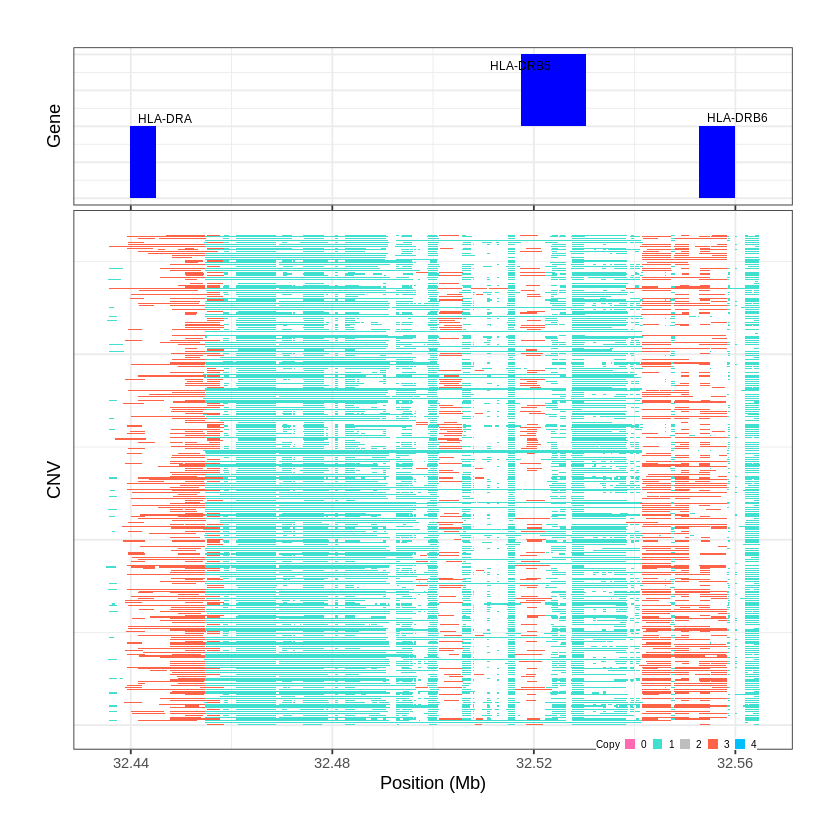

Task done, plot was stored in working directory.
[1] "Ploting CNVR 779..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 33.025801 - 33.0523 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


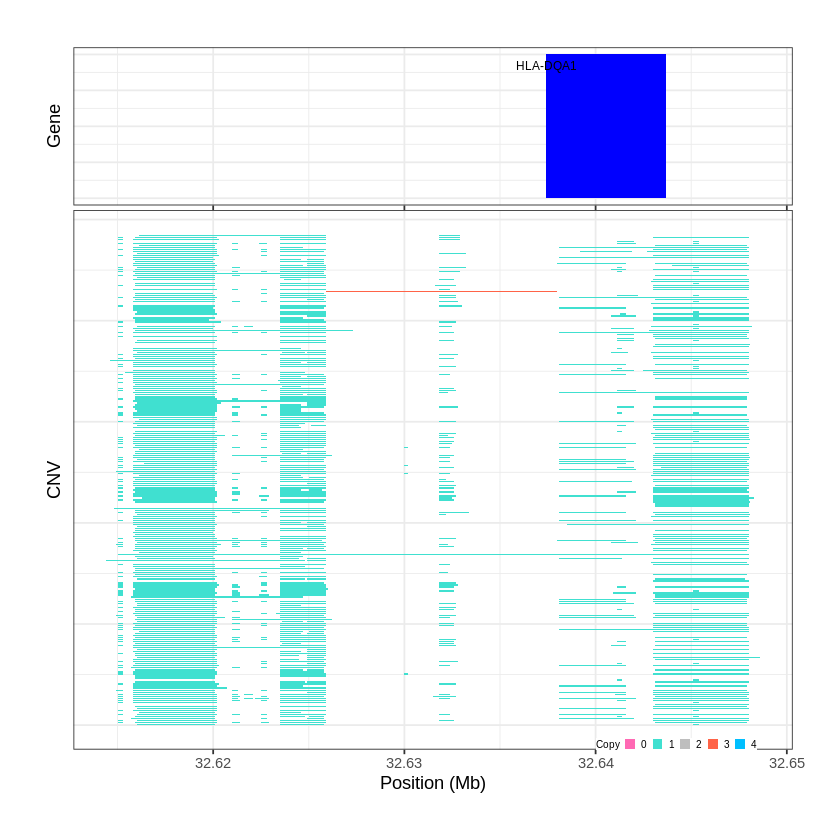

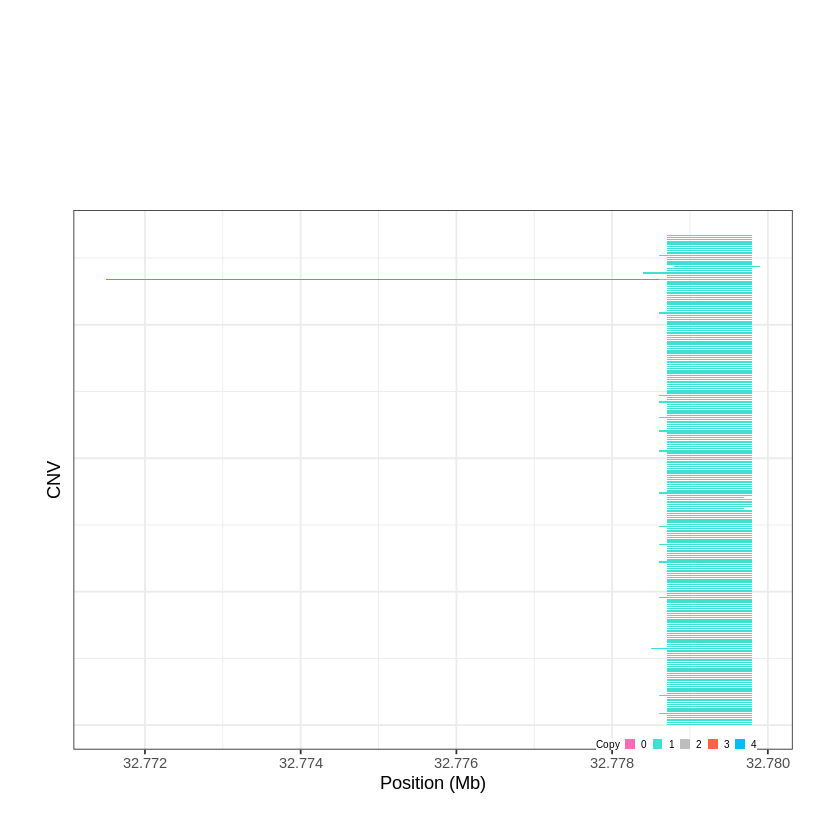

Task done, plot was stored in working directory.
[1] "Ploting CNVR 780..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 33.436501 - 33.9337 Mb with 187 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 781..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 34.696301 - 34.7014 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


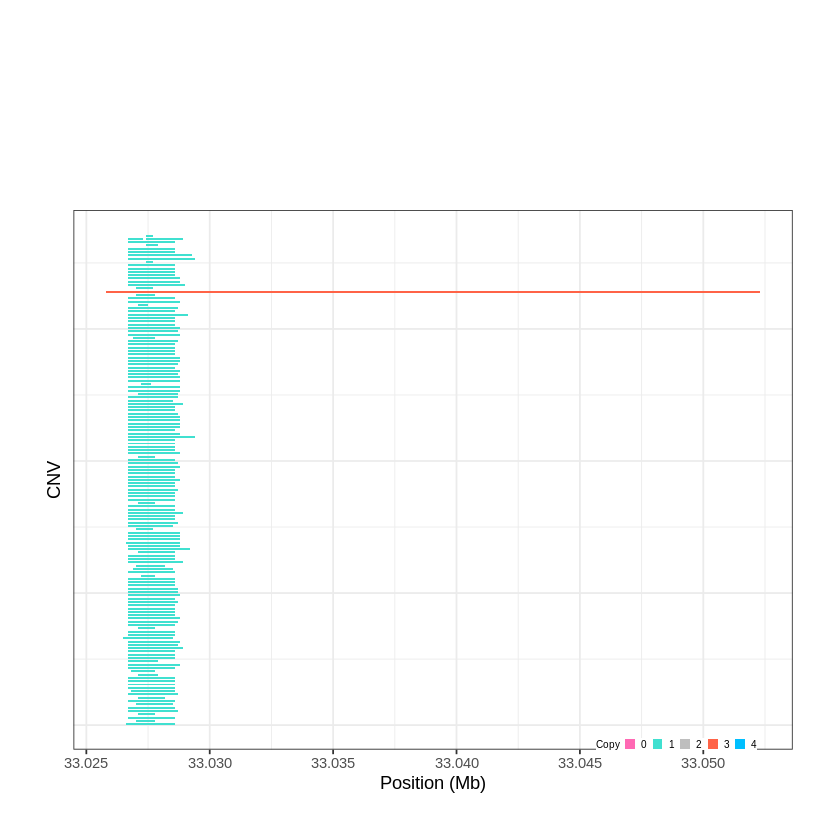

Task done, plot was stored in working directory.
[1] "Ploting CNVR 782..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 34.933201 - 34.9439 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


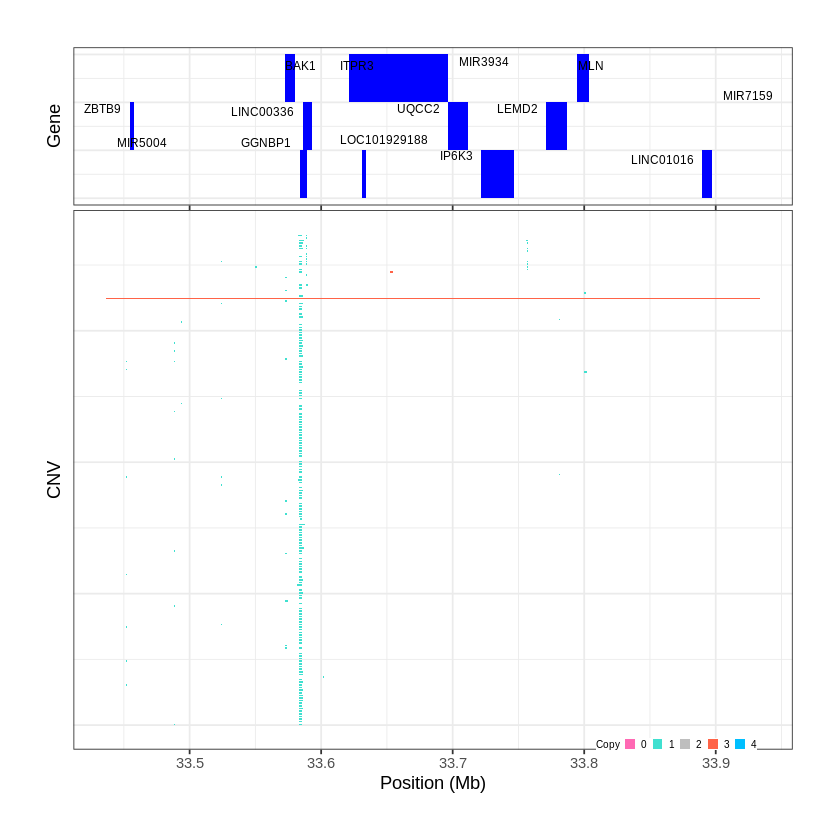

Task done, plot was stored in working directory.
[1] "Ploting CNVR 783..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 35.096601 - 35.1135 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


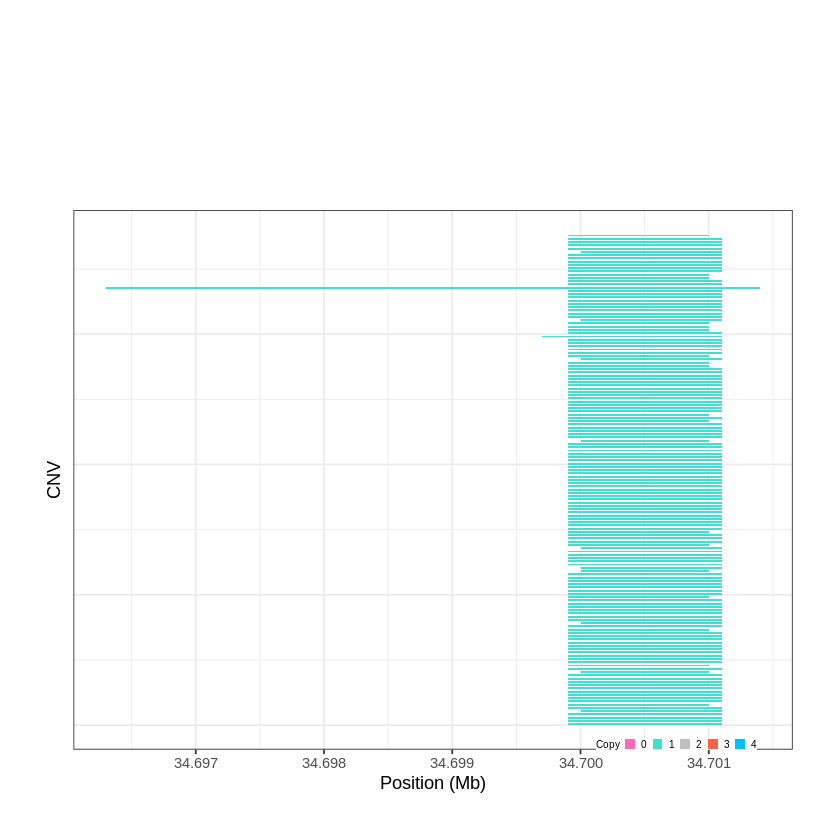

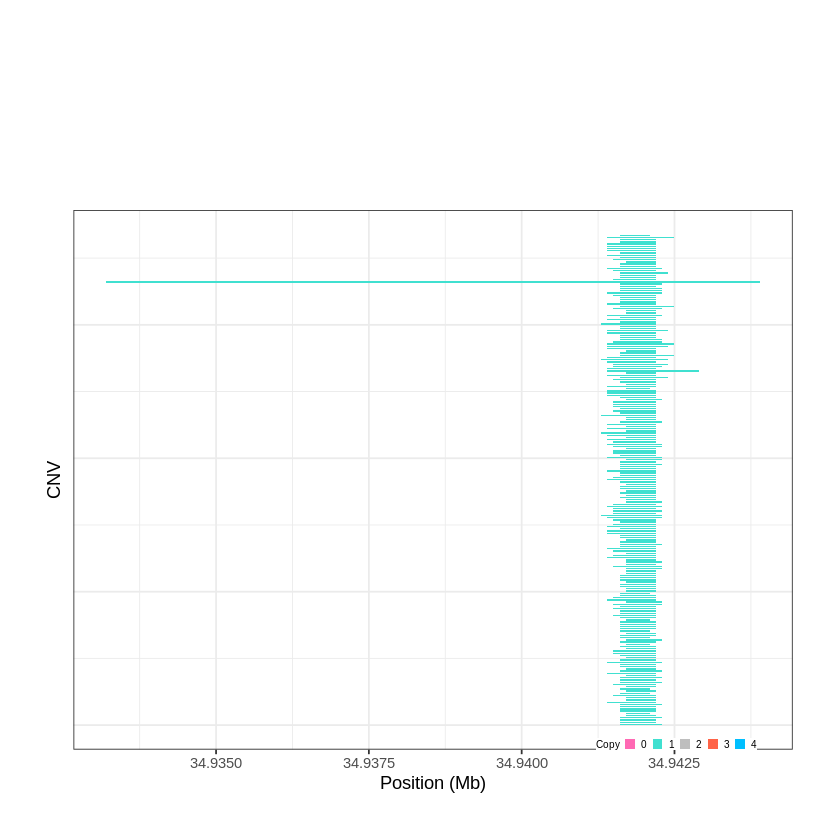

Task done, plot was stored in working directory.
[1] "Ploting CNVR 784..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 35.624801 - 35.7873 Mb with 268 Individual - "
Plotting gene...


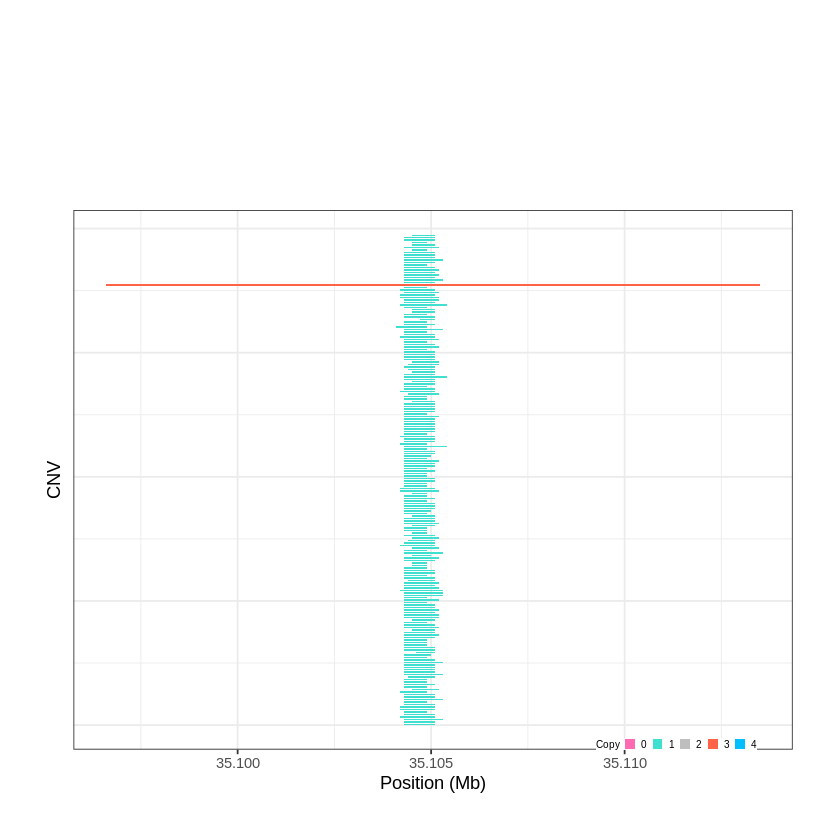

Task done, plot was stored in working directory.
[1] "Ploting CNVR 785..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 37.378301 - 37.8161 Mb with 174 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 786..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 38.088401 - 38.2086 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


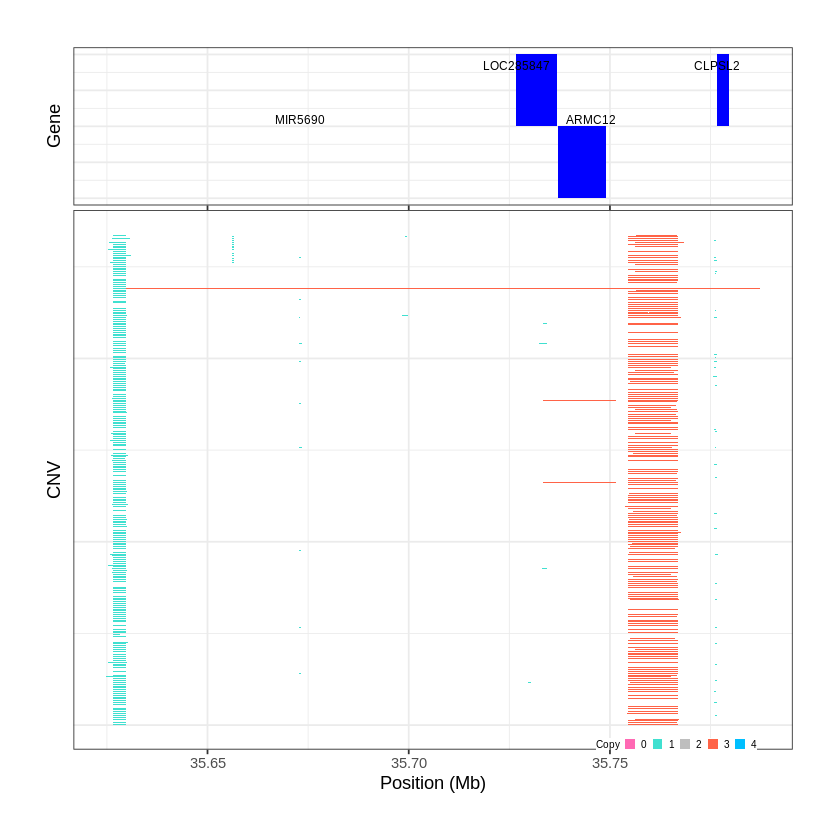

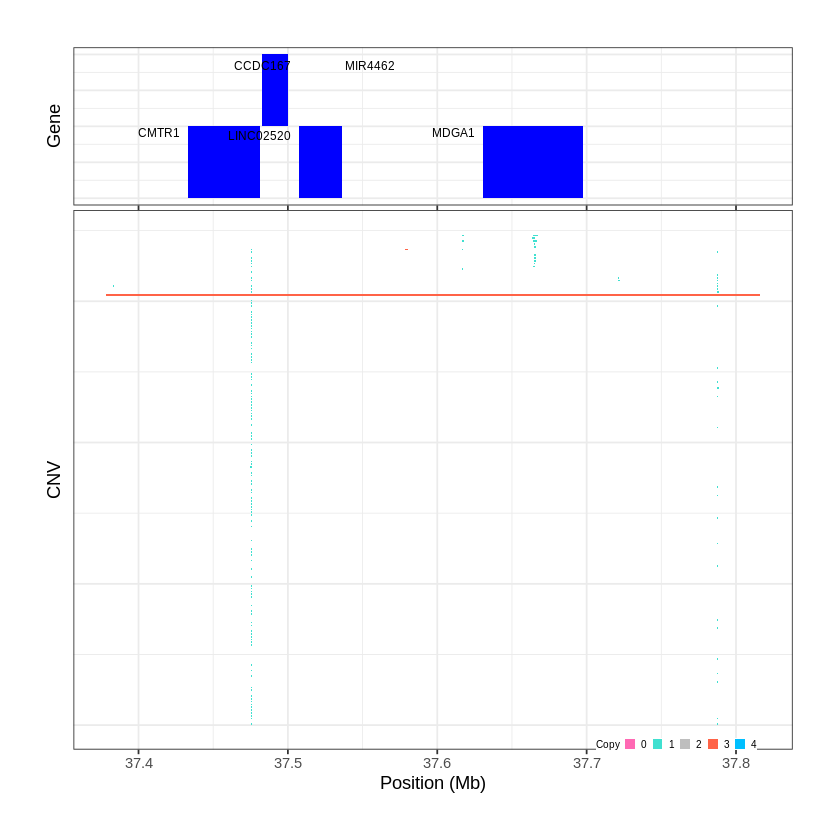

Task done, plot was stored in working directory.
[1] "Ploting CNVR 787..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 43.663701 - 44.3136 Mb with 240 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 788..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 53.924801 - 53.9424 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


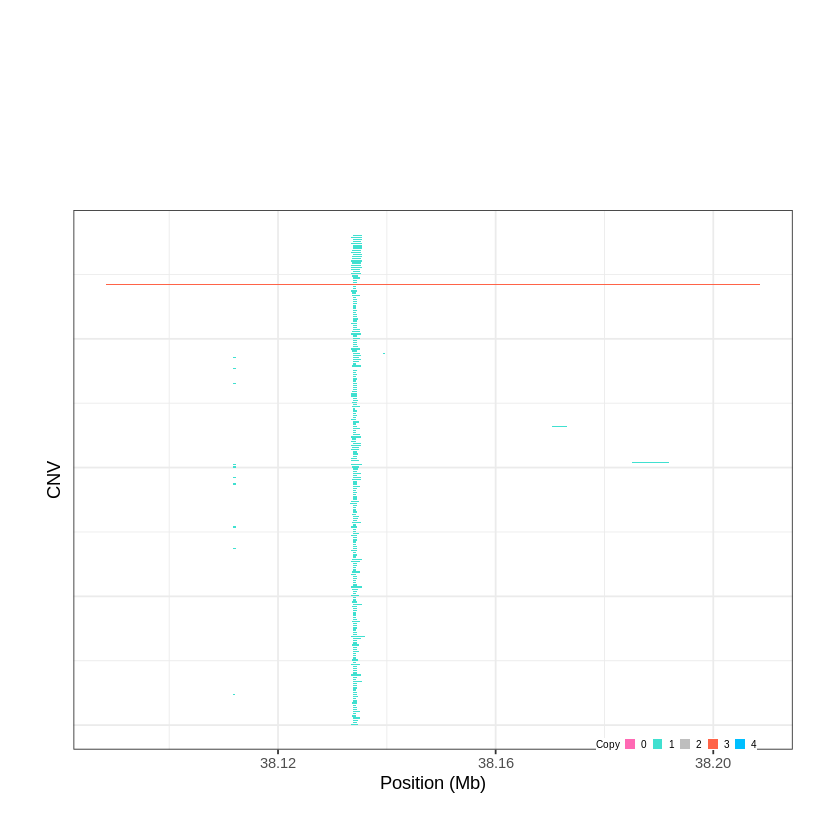

Task done, plot was stored in working directory.
[1] "Ploting CNVR 789..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 56.176001 - 56.2012 Mb with 234 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


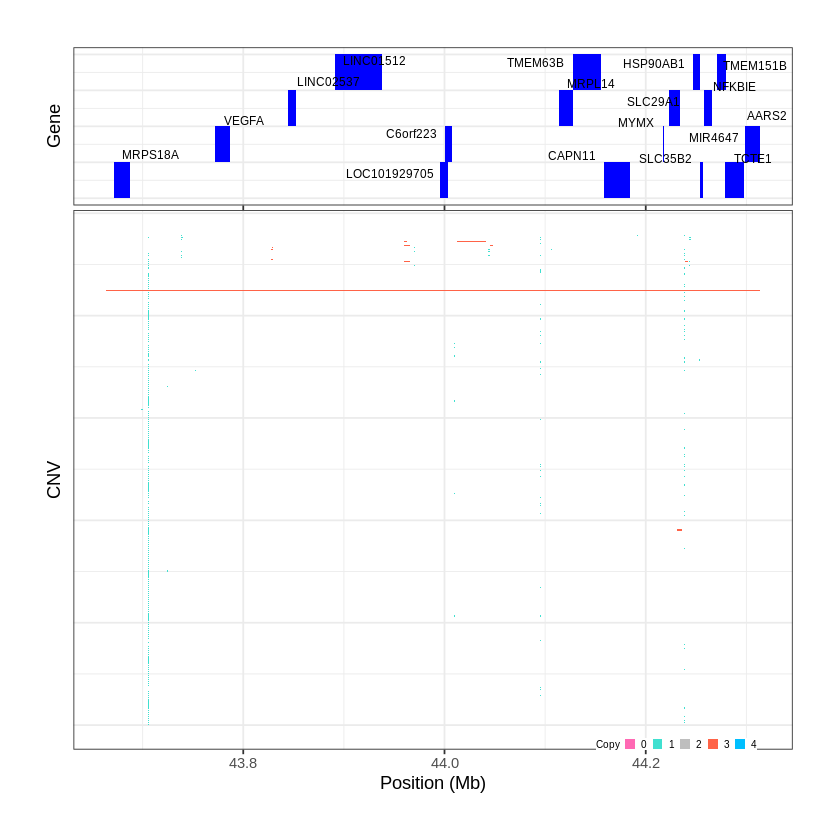

Task done, plot was stored in working directory.
[1] "Ploting CNVR 790..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 57.237201 - 57.2555 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


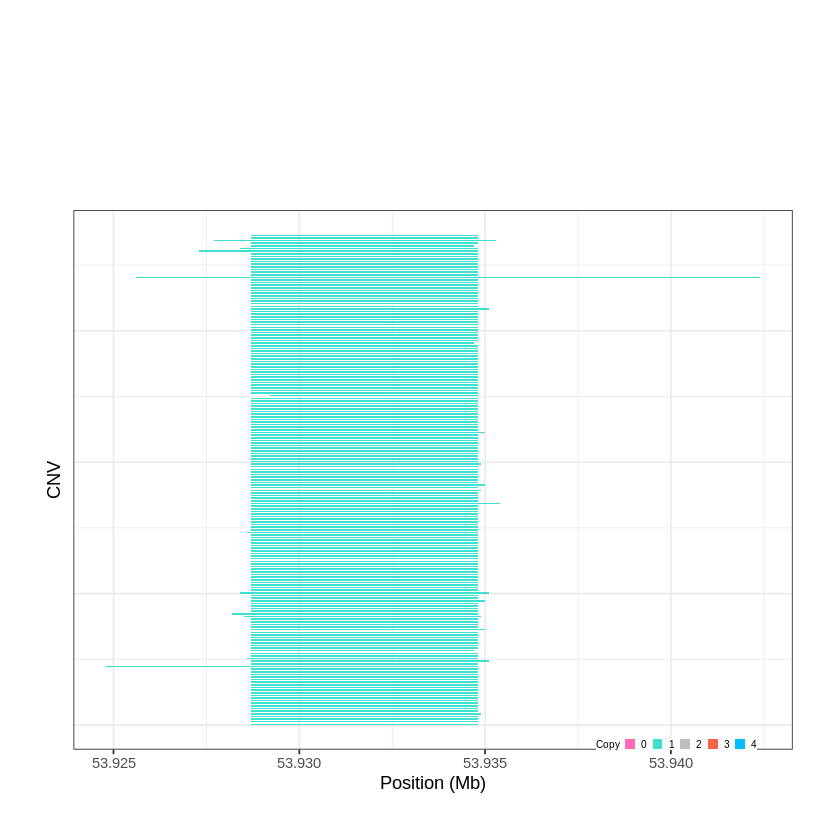

Task done, plot was stored in working directory.
[1] "Ploting CNVR 791..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 57.263001 - 57.2853 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


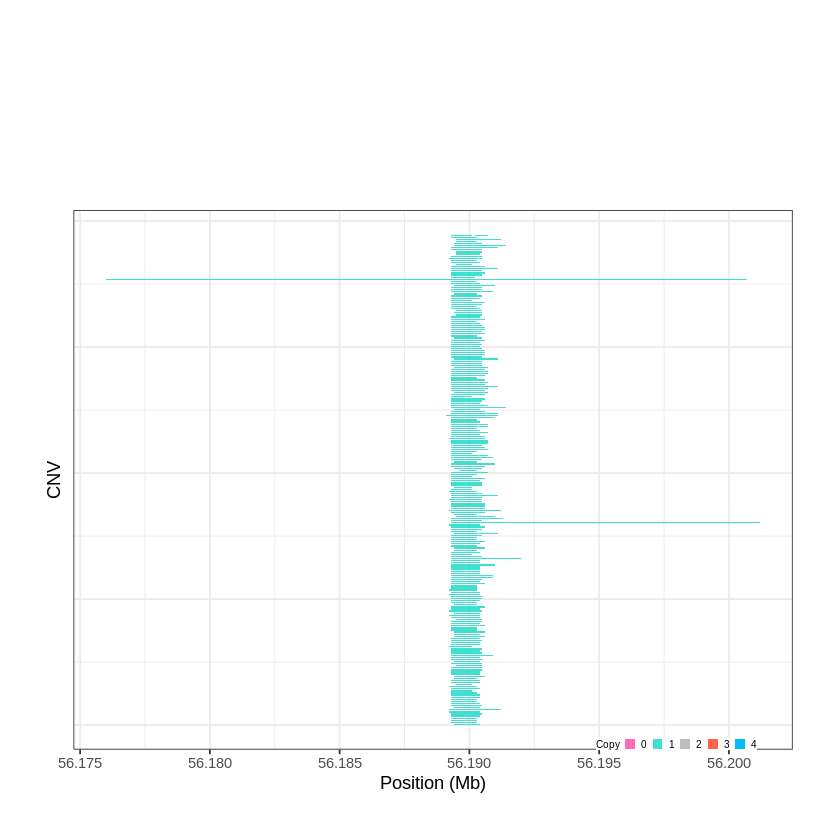

Task done, plot was stored in working directory.
[1] "Ploting CNVR 792..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 57.289001 - 57.2973 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


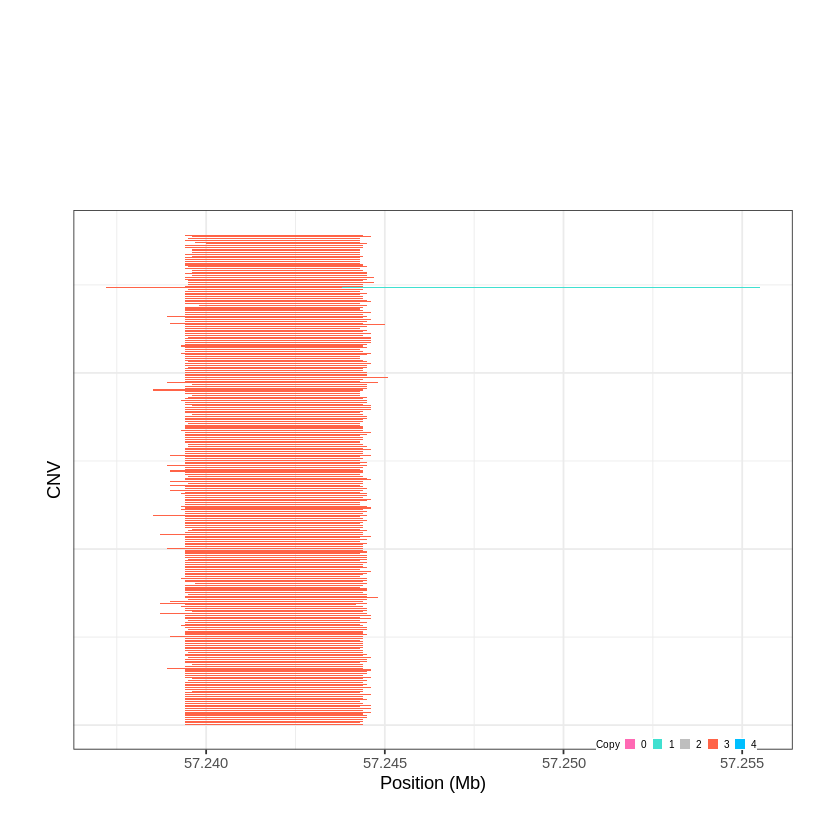

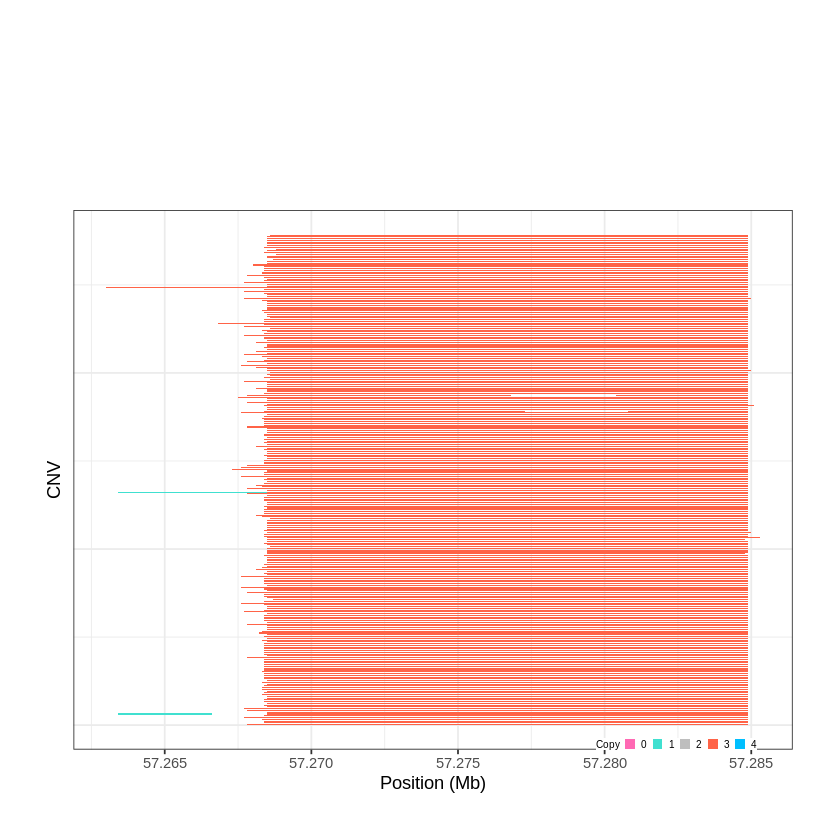

Task done, plot was stored in working directory.
[1] "Ploting CNVR 793..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 57.359801 - 58.2184 Mb with 279 Individual - "
Plotting gene...


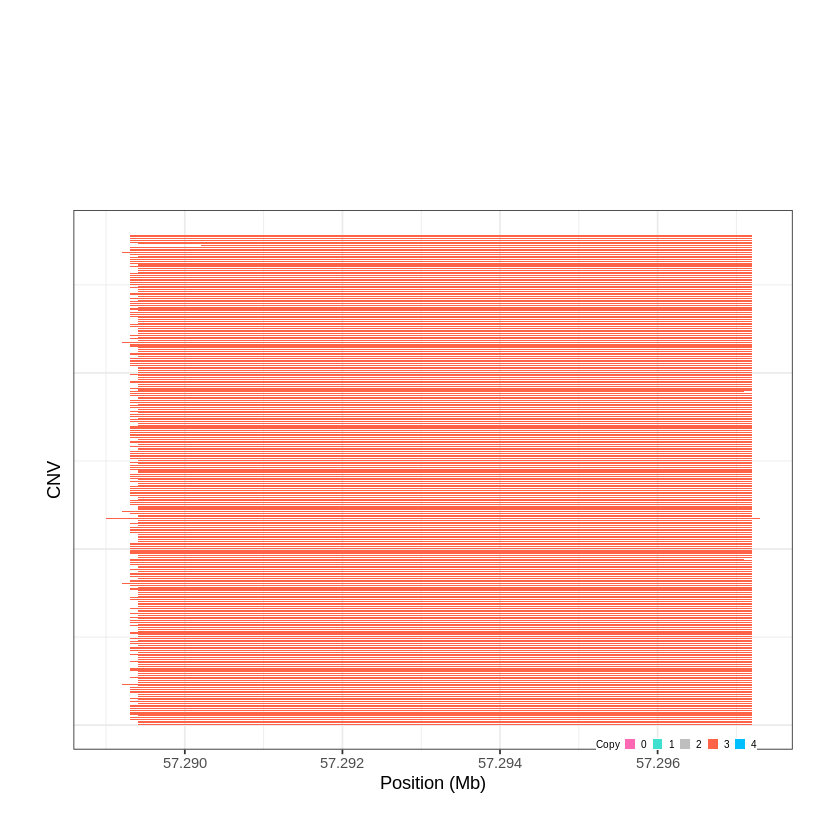

Task done, plot was stored in working directory.
[1] "Ploting CNVR 794..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 58.291501 - 62.403 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 795..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 65.346101 - 65.3518 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


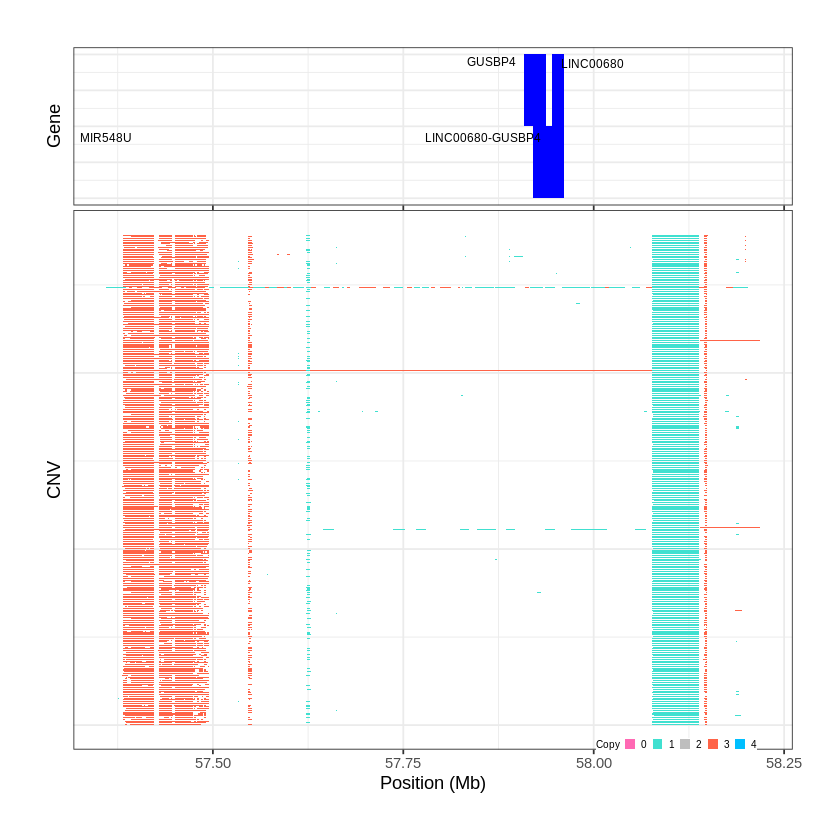

Task done, plot was stored in working directory.
[1] "Ploting CNVR 796..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 66.260101 - 66.3303 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


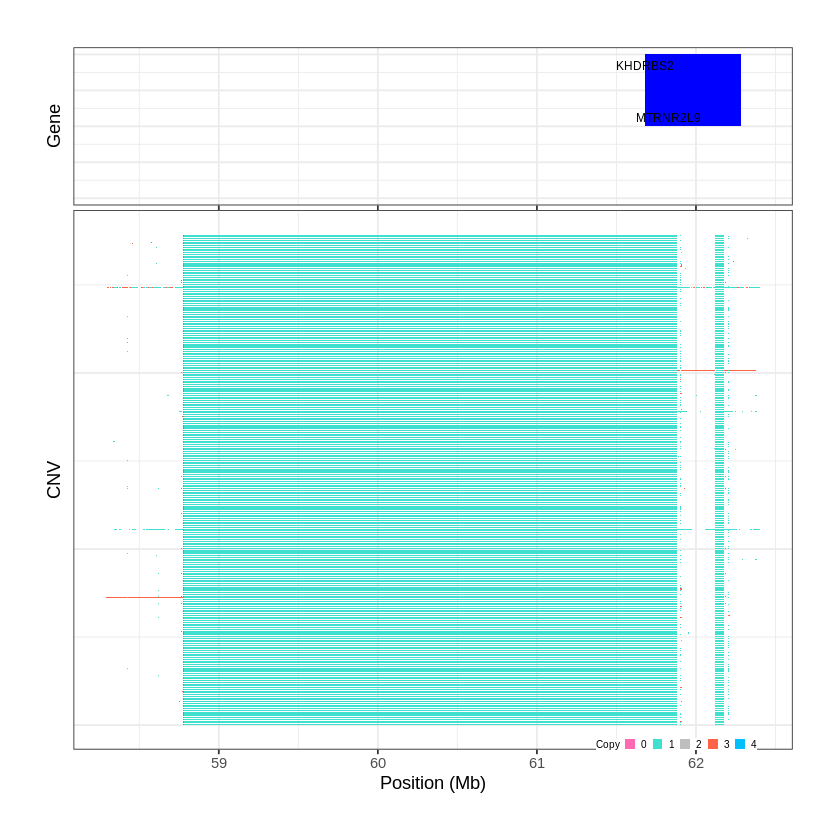

Task done, plot was stored in working directory.
[1] "Ploting CNVR 797..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 66.414901 - 66.4452 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


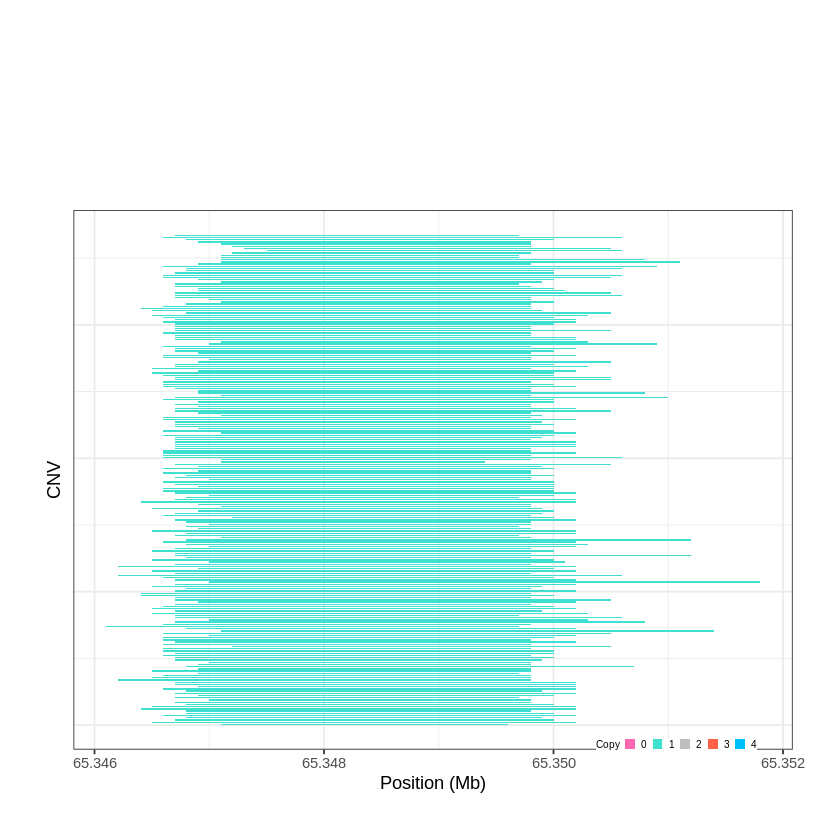

Task done, plot was stored in working directory.
[1] "Ploting CNVR 798..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 66.561401 - 66.6272 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


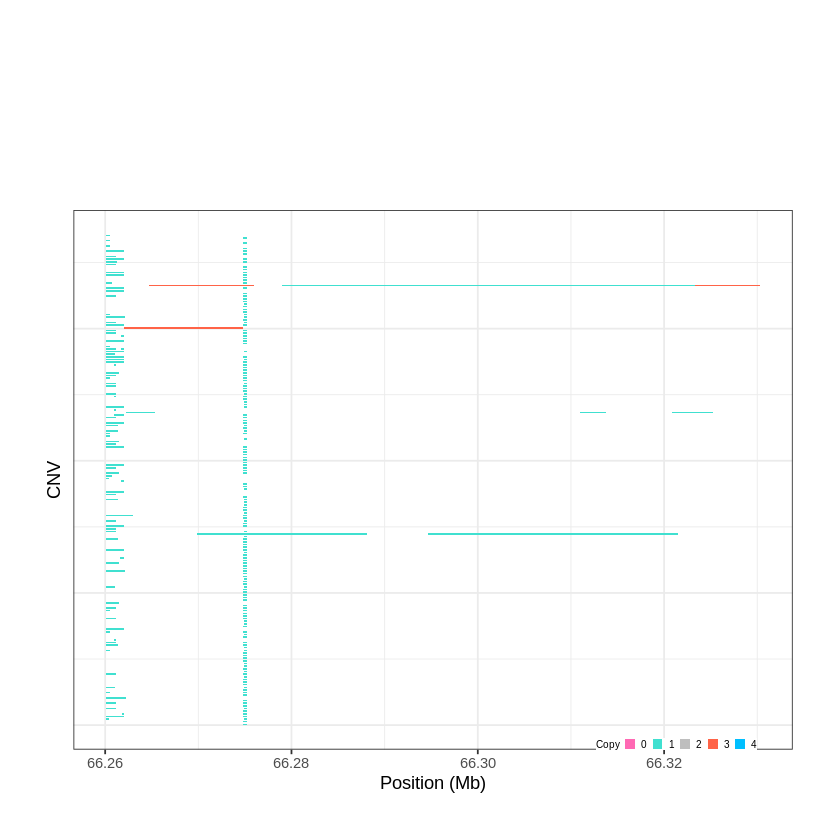

Task done, plot was stored in working directory.
[1] "Ploting CNVR 799..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 68.060701 - 68.1326 Mb with 266 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


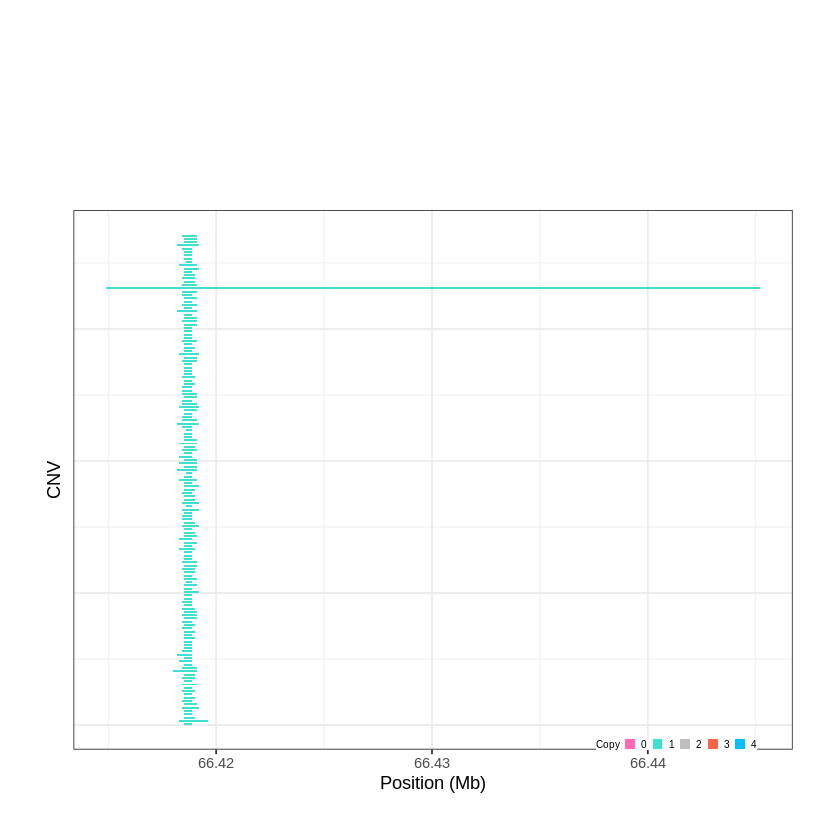

Task done, plot was stored in working directory.
[1] "Ploting CNVR 800..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 70.139301 - 70.2106 Mb with 235 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


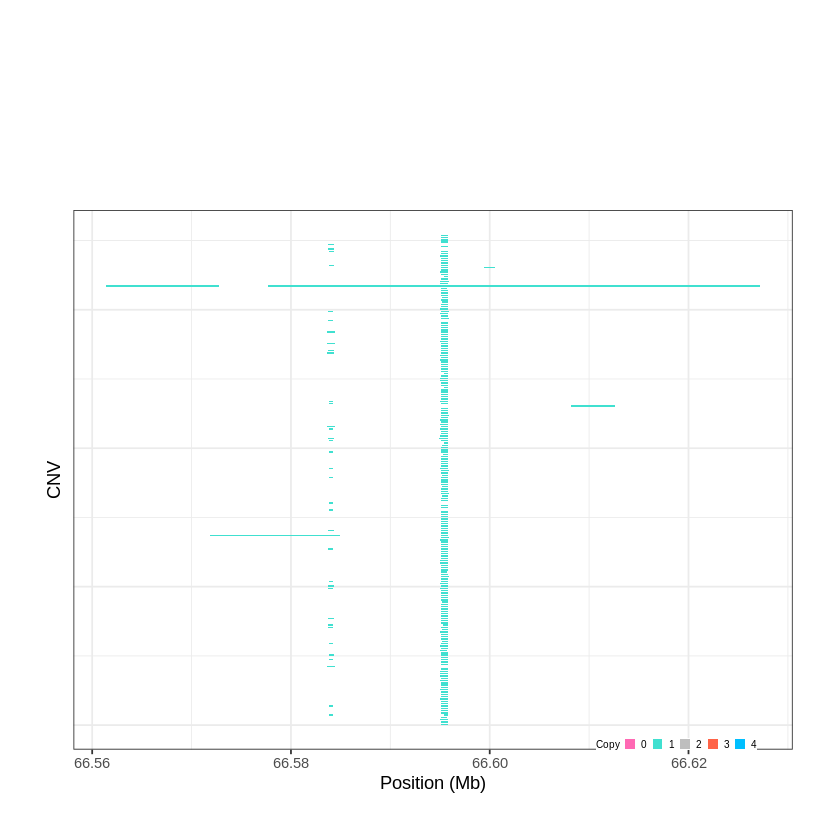

Task done, plot was stored in working directory.
[1] "Ploting CNVR 801..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 74.577501 - 74.6055 Mb with 162 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


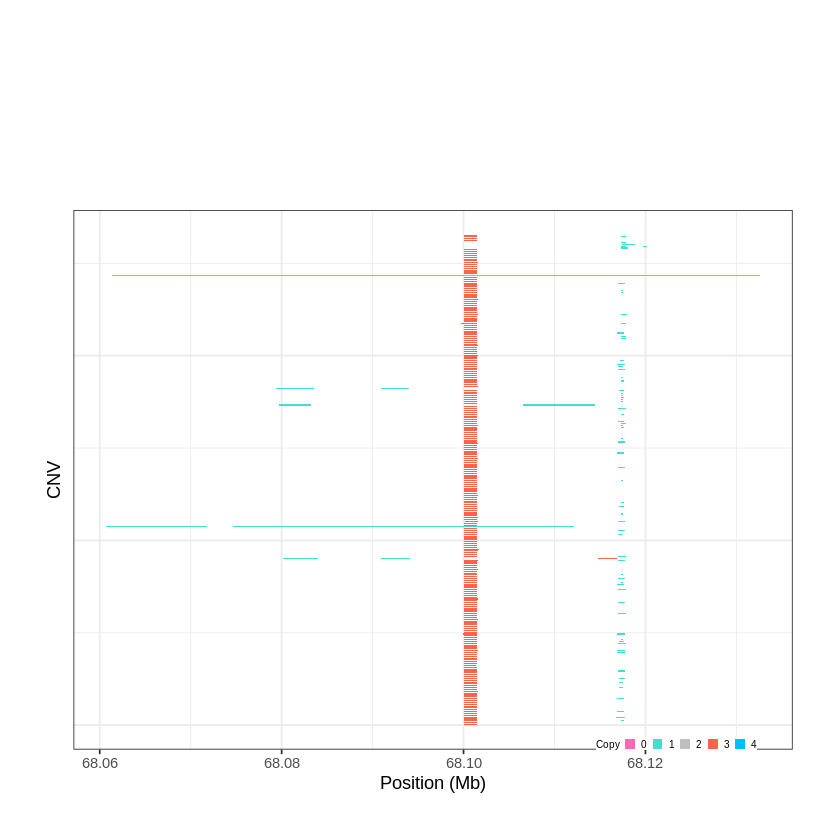

Task done, plot was stored in working directory.
[1] "Ploting CNVR 802..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 75.947701 - 75.9612 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


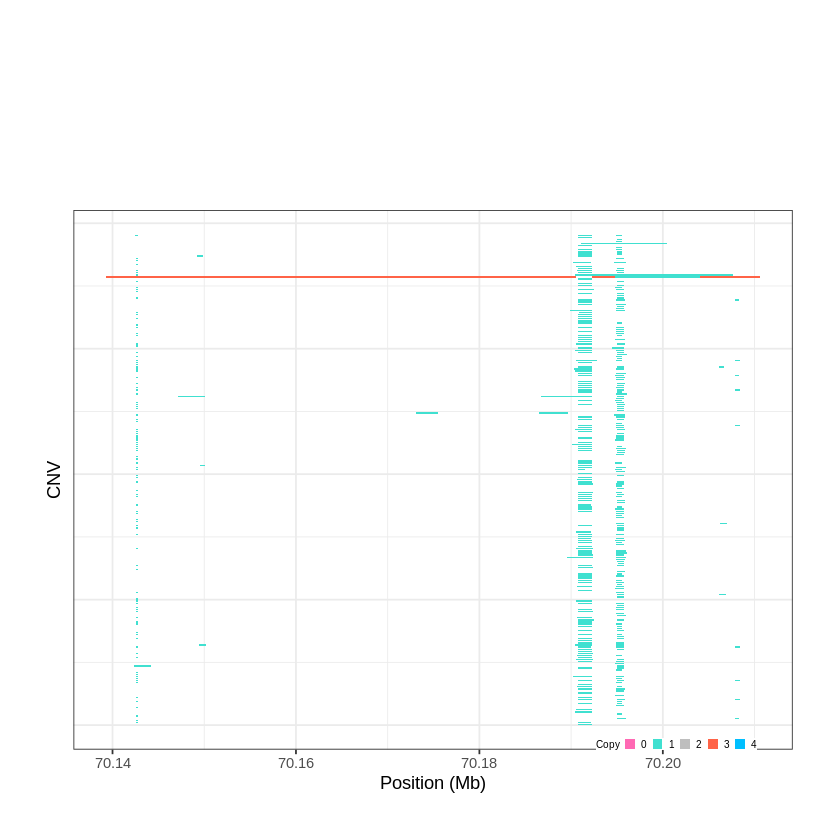

Task done, plot was stored in working directory.
[1] "Ploting CNVR 803..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 77.091301 - 77.133 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


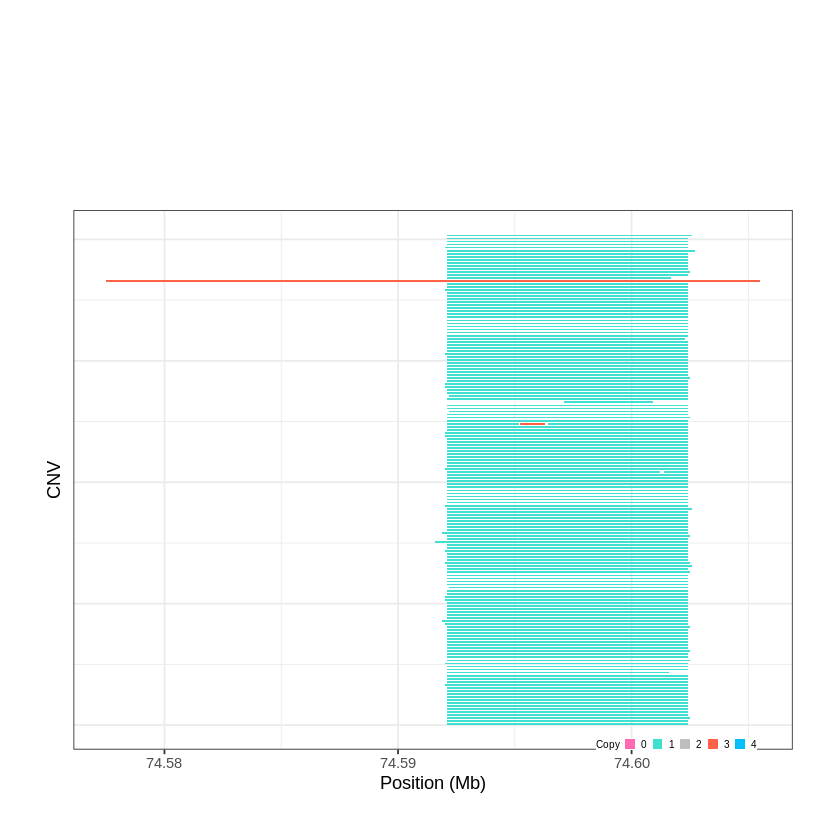

Task done, plot was stored in working directory.
[1] "Ploting CNVR 804..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 81.327601 - 81.365 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


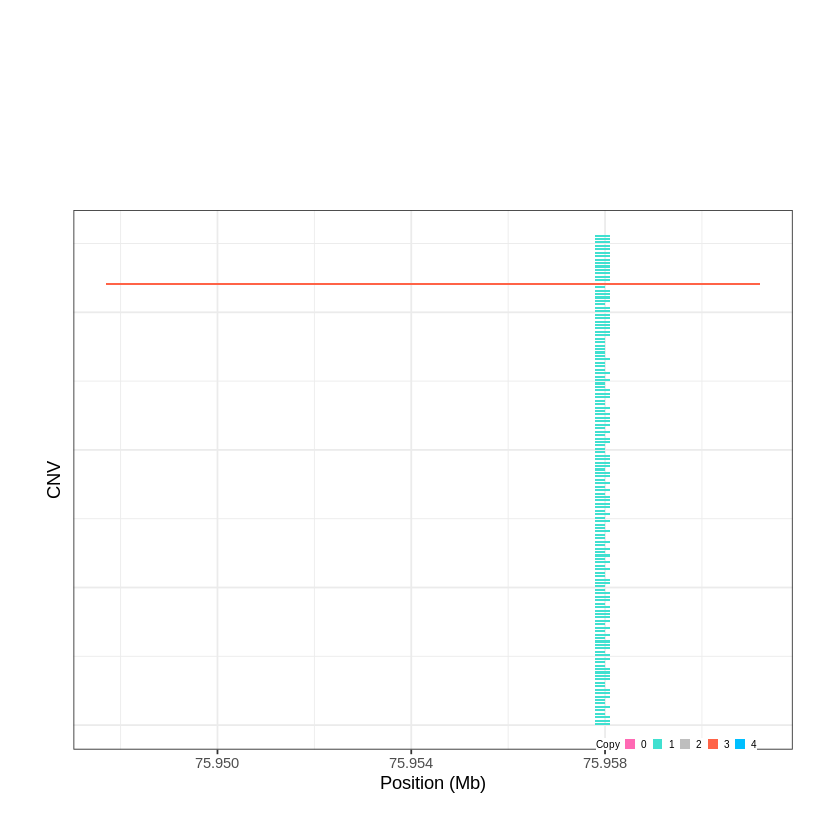

Task done, plot was stored in working directory.
[1] "Ploting CNVR 805..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 81.625501 - 81.6299 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


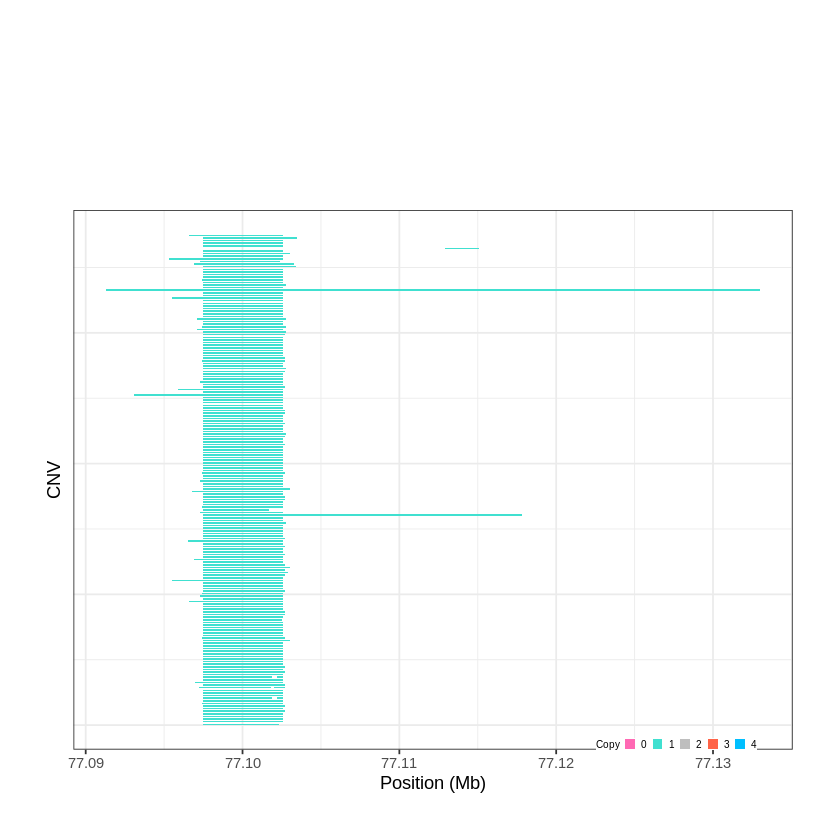

Task done, plot was stored in working directory.
[1] "Ploting CNVR 806..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 85.312401 - 85.3413 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


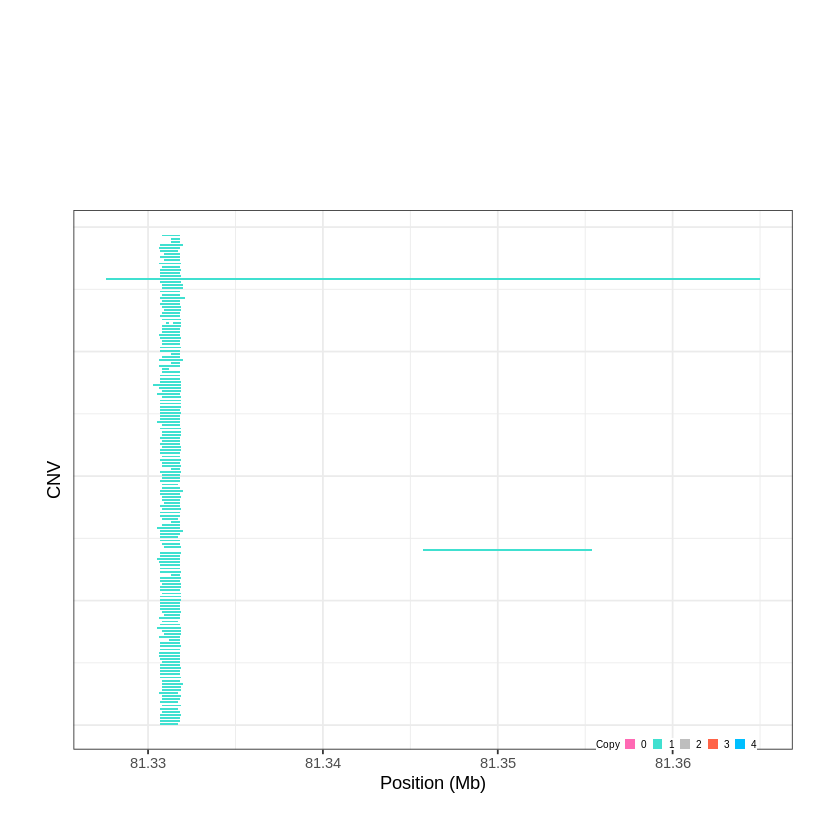

Task done, plot was stored in working directory.
[1] "Ploting CNVR 807..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 86.697401 - 86.7176 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


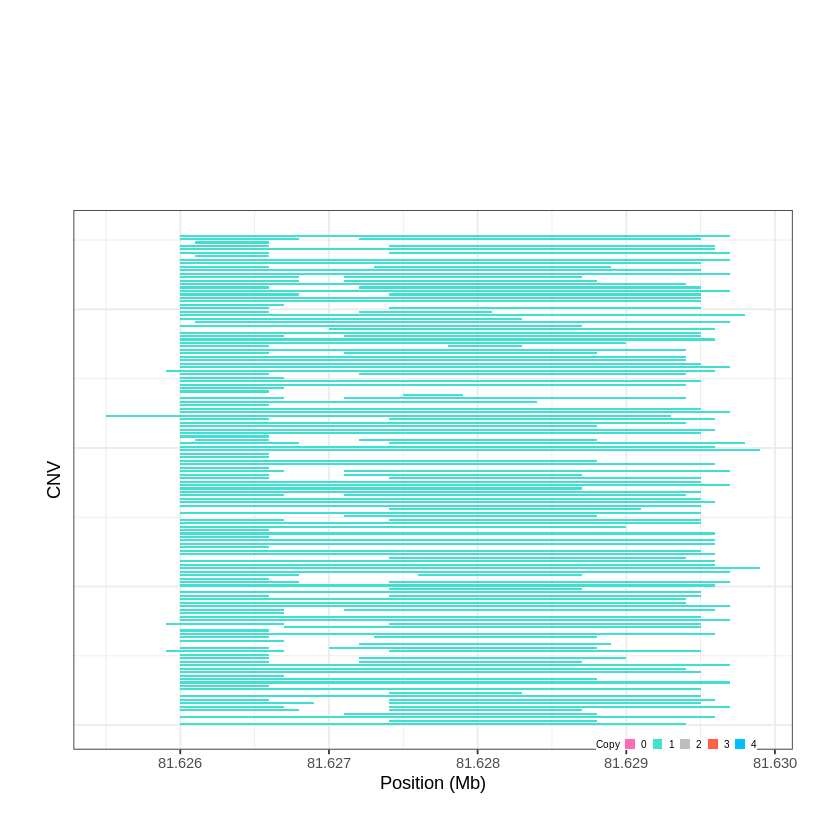

Task done, plot was stored in working directory.
[1] "Ploting CNVR 808..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 89.656901 - 89.6584 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


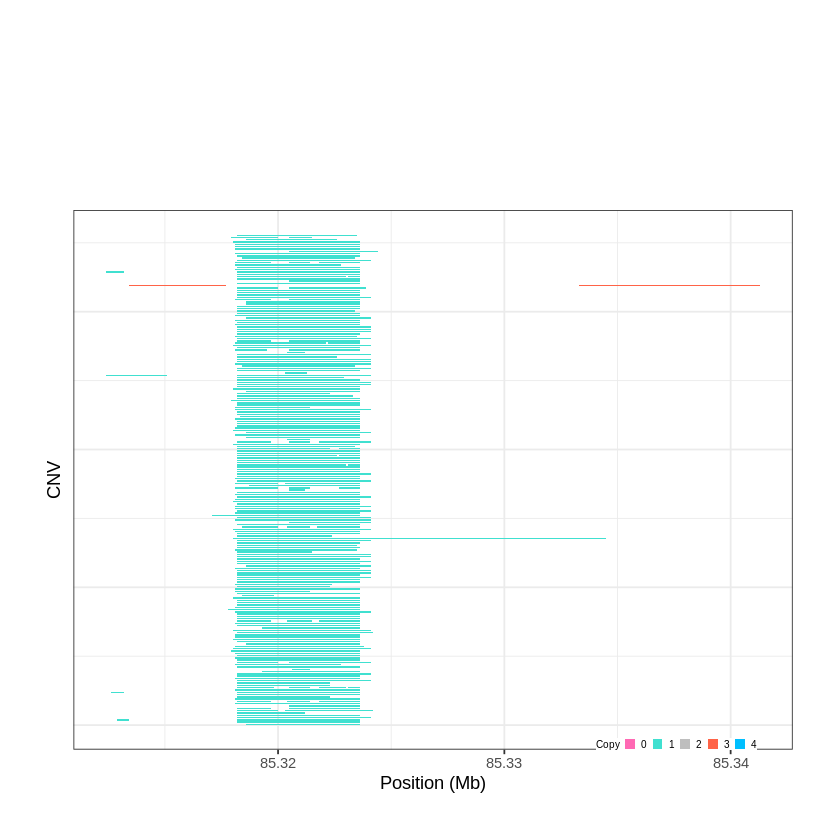

Task done, plot was stored in working directory.
[1] "Ploting CNVR 809..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 95.185101 - 95.2174 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


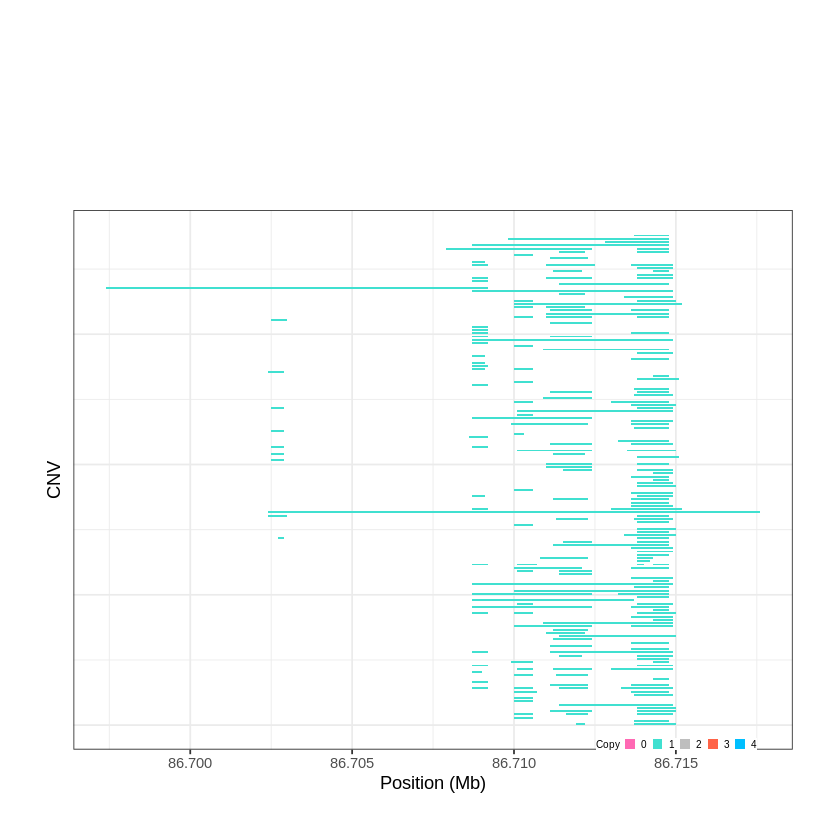

Task done, plot was stored in working directory.
[1] "Ploting CNVR 810..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 95.680501 - 95.9166 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


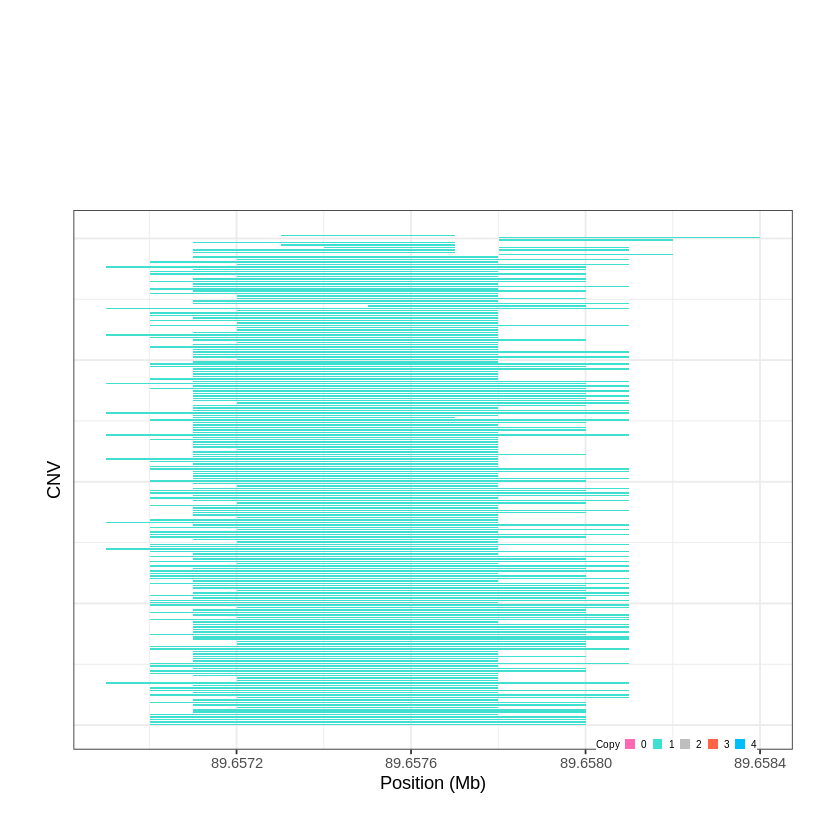

Task done, plot was stored in working directory.
[1] "Ploting CNVR 811..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 96.616701 - 96.652 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


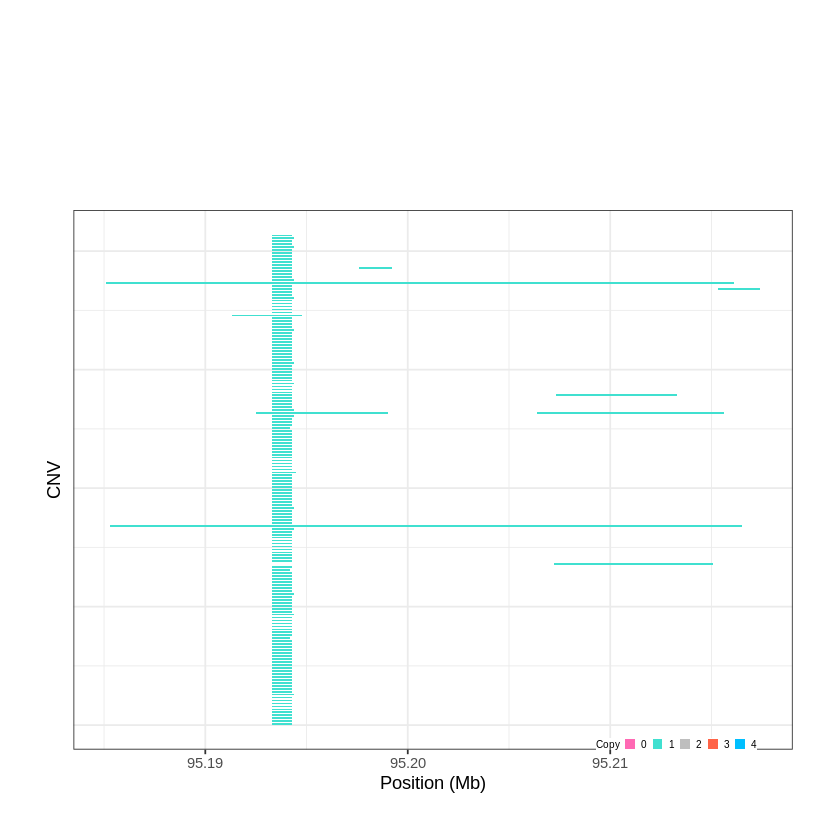

Task done, plot was stored in working directory.
[1] "Ploting CNVR 812..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 100.034501 - 100.0353 Mb with 267 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


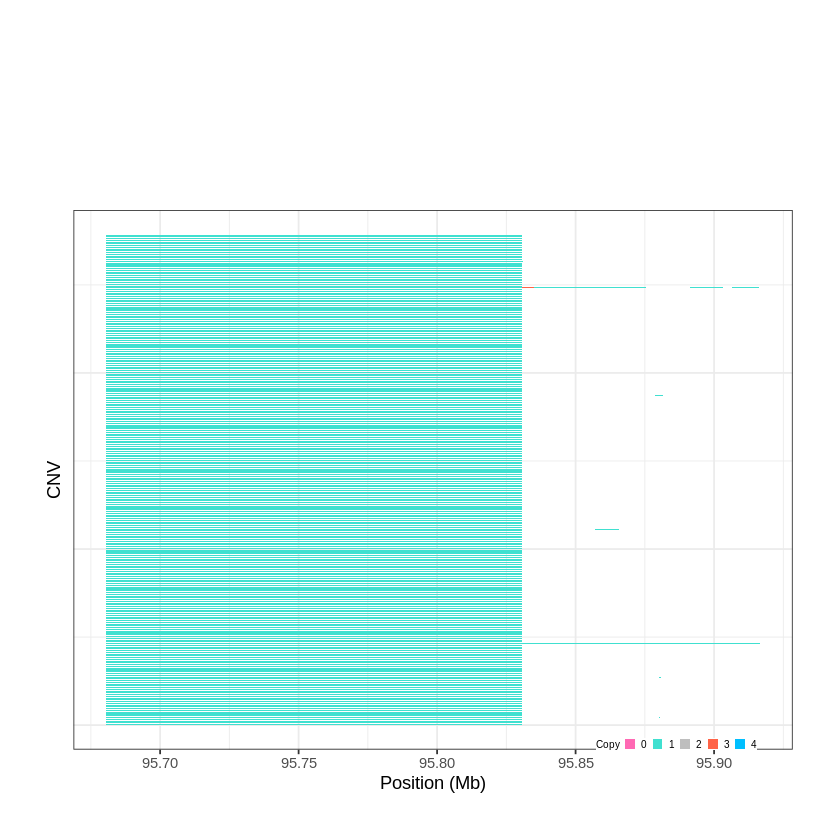

Task done, plot was stored in working directory.
[1] "Ploting CNVR 813..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 102.413901 - 104.0527 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


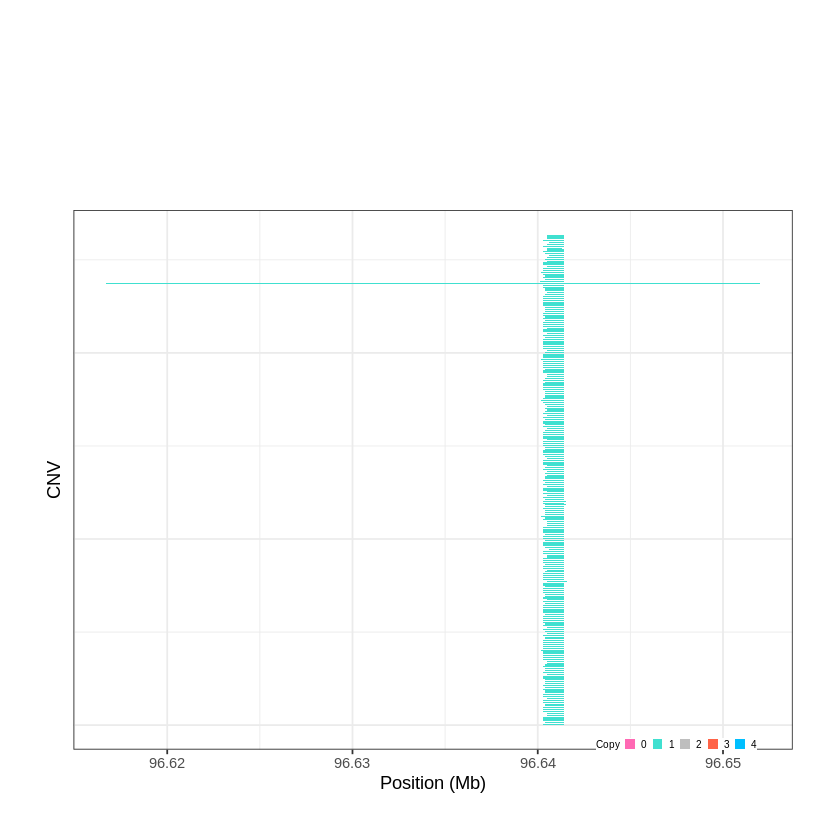

Task done, plot was stored in working directory.
[1] "Ploting CNVR 814..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 108.031301 - 108.0325 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


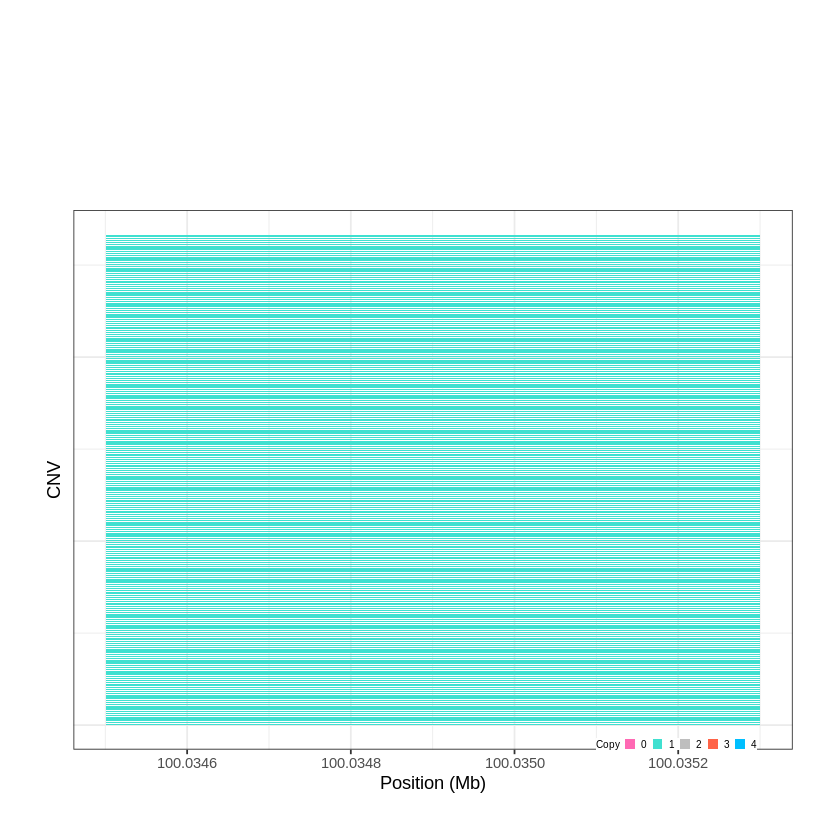

Task done, plot was stored in working directory.
[1] "Ploting CNVR 815..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 108.266101 - 108.2664 Mb with 243 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


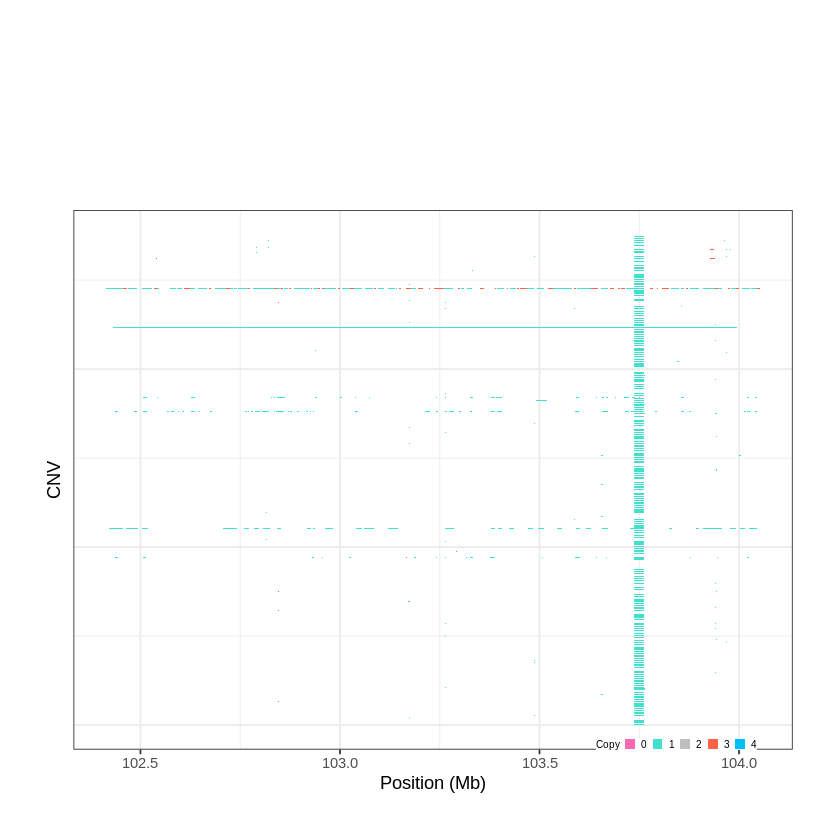

Task done, plot was stored in working directory.
[1] "Ploting CNVR 816..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 108.610201 - 108.6151 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


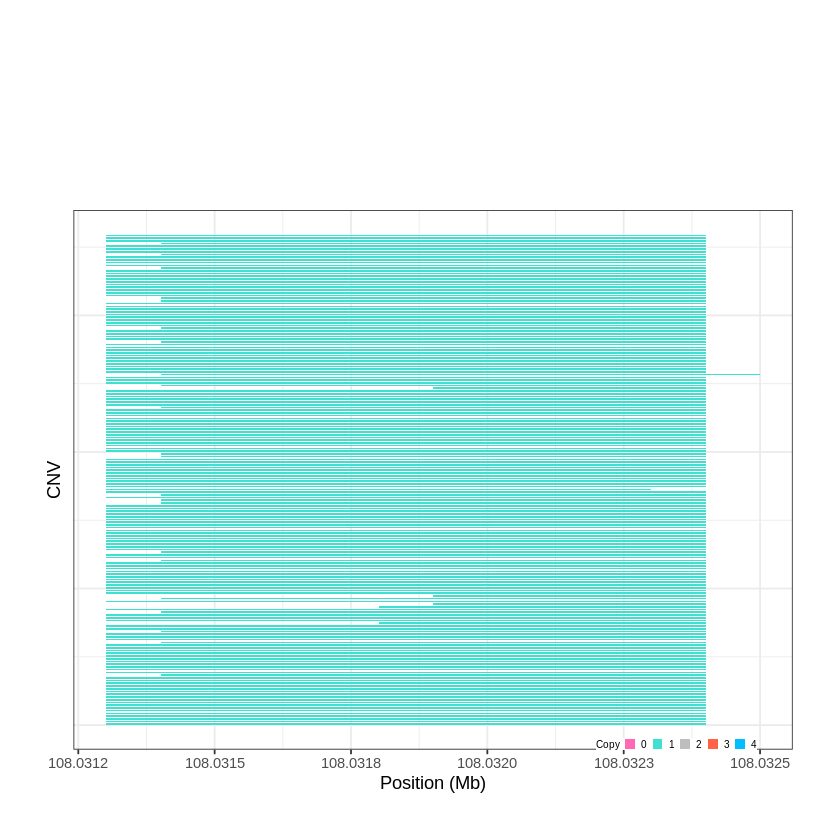

Task done, plot was stored in working directory.
[1] "Ploting CNVR 817..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 113.111601 - 113.1588 Mb with 222 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


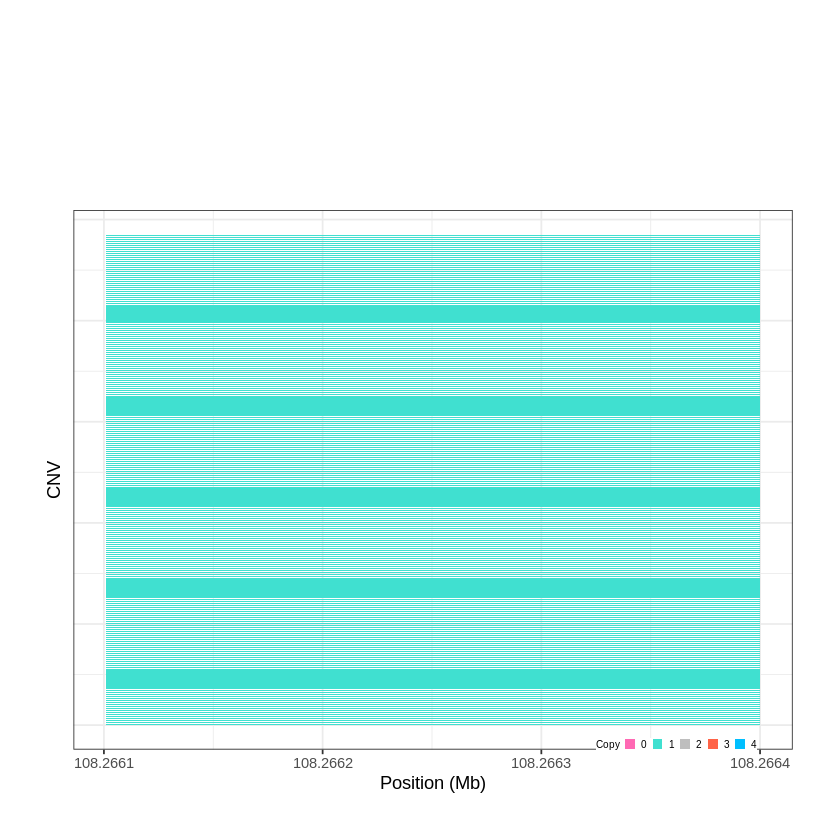

Task done, plot was stored in working directory.
[1] "Ploting CNVR 818..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 114.185701 - 114.2259 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


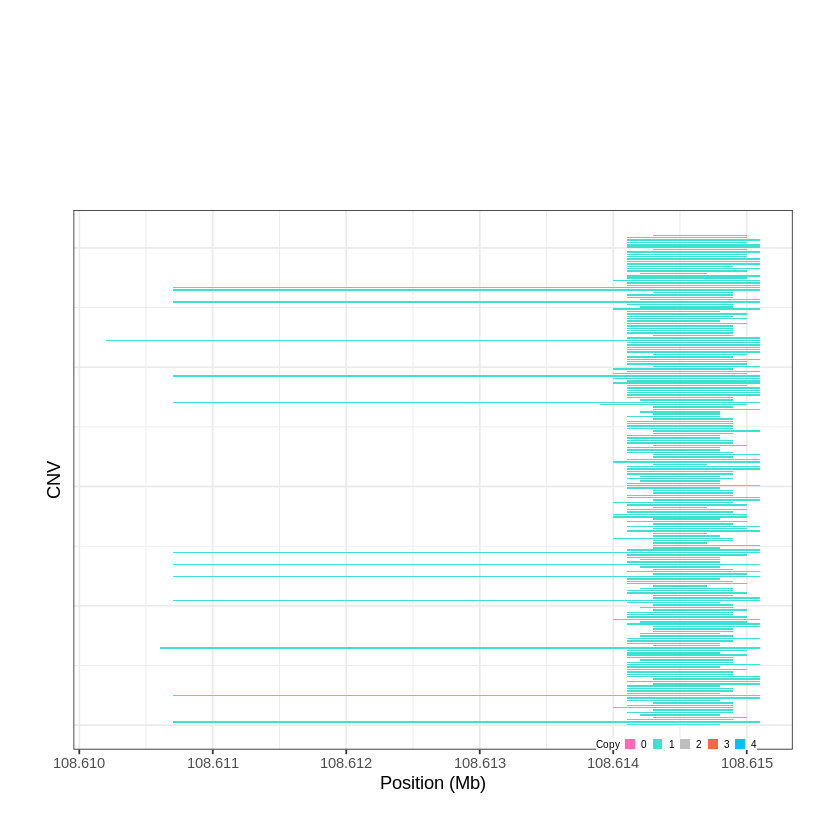

Task done, plot was stored in working directory.
[1] "Ploting CNVR 819..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 120.904701 - 120.9651 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


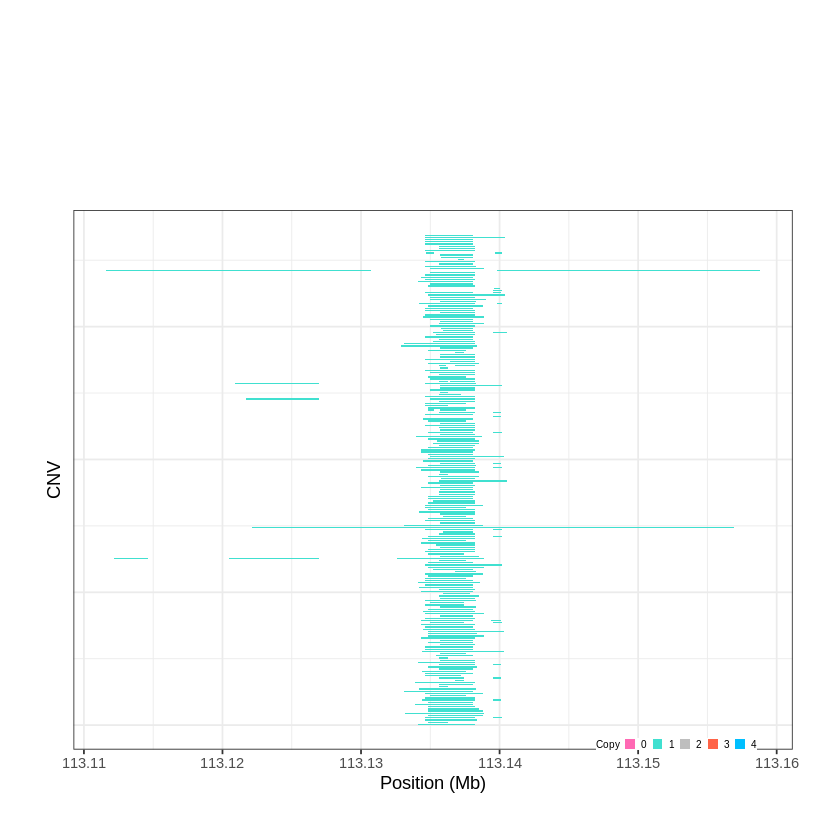

Task done, plot was stored in working directory.
[1] "Ploting CNVR 820..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 124.429601 - 124.5016 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


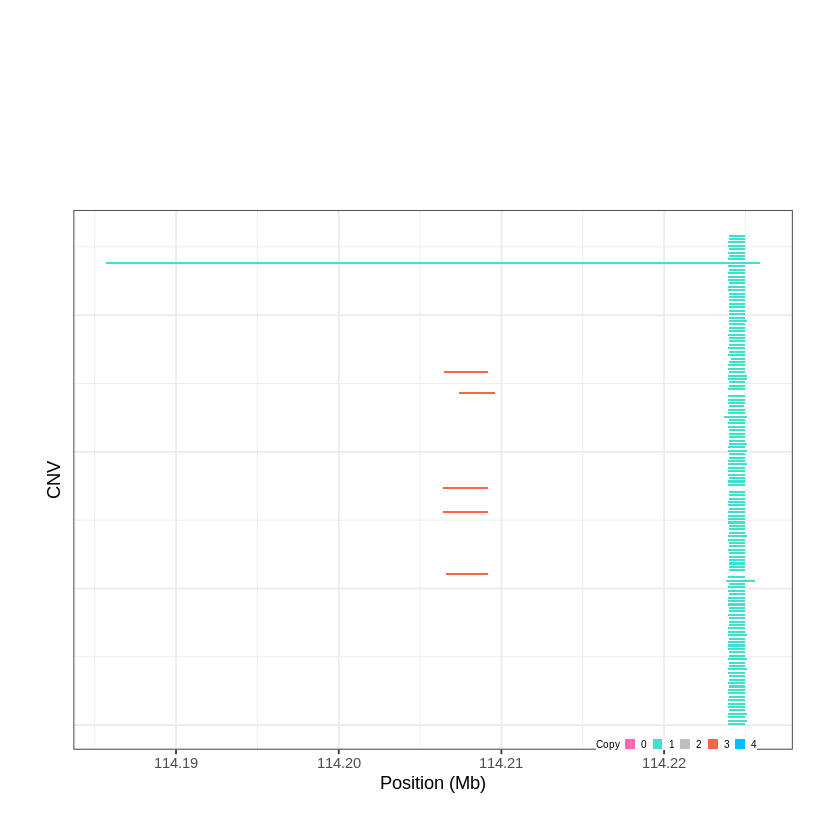

Task done, plot was stored in working directory.
[1] "Ploting CNVR 821..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 125.693301 - 125.7232 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


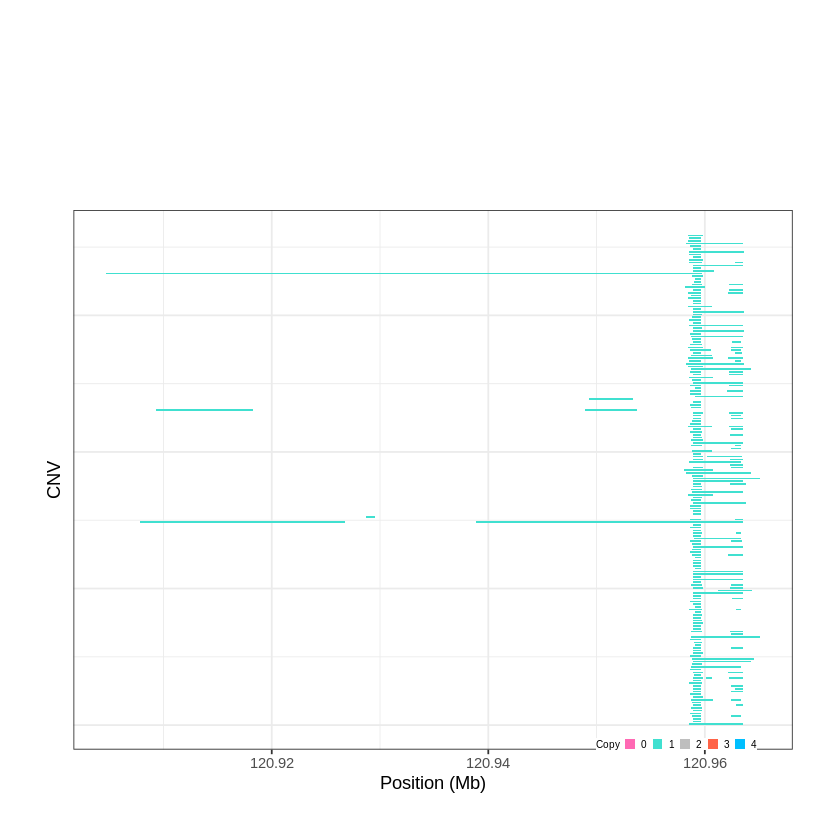

Task done, plot was stored in working directory.
[1] "Ploting CNVR 822..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 129.932501 - 129.9413 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


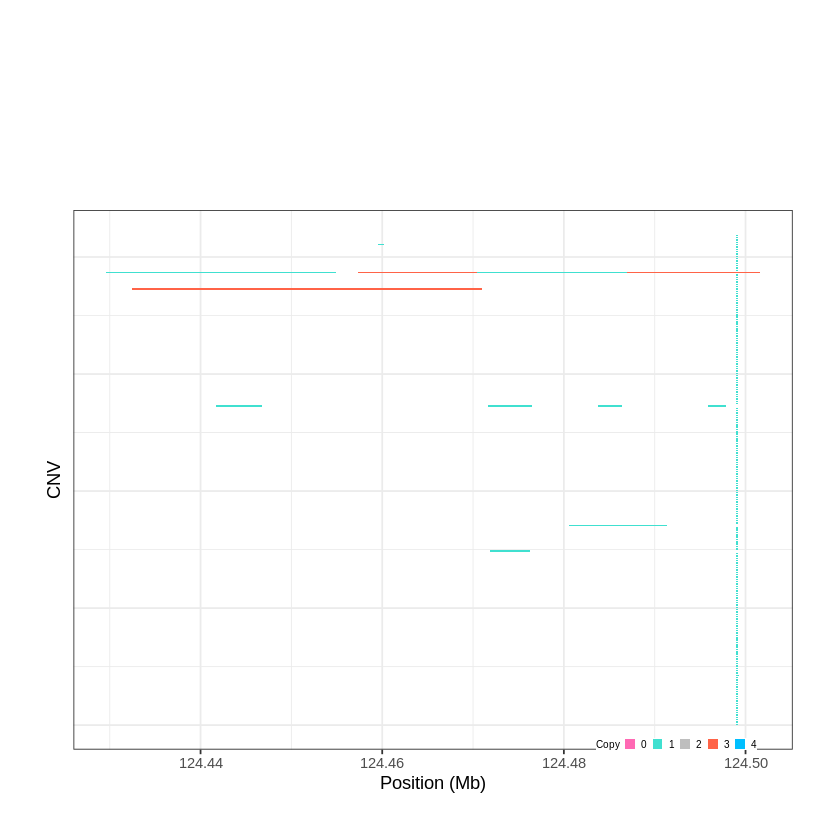

Task done, plot was stored in working directory.
[1] "Ploting CNVR 823..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 132.012701 - 132.039 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


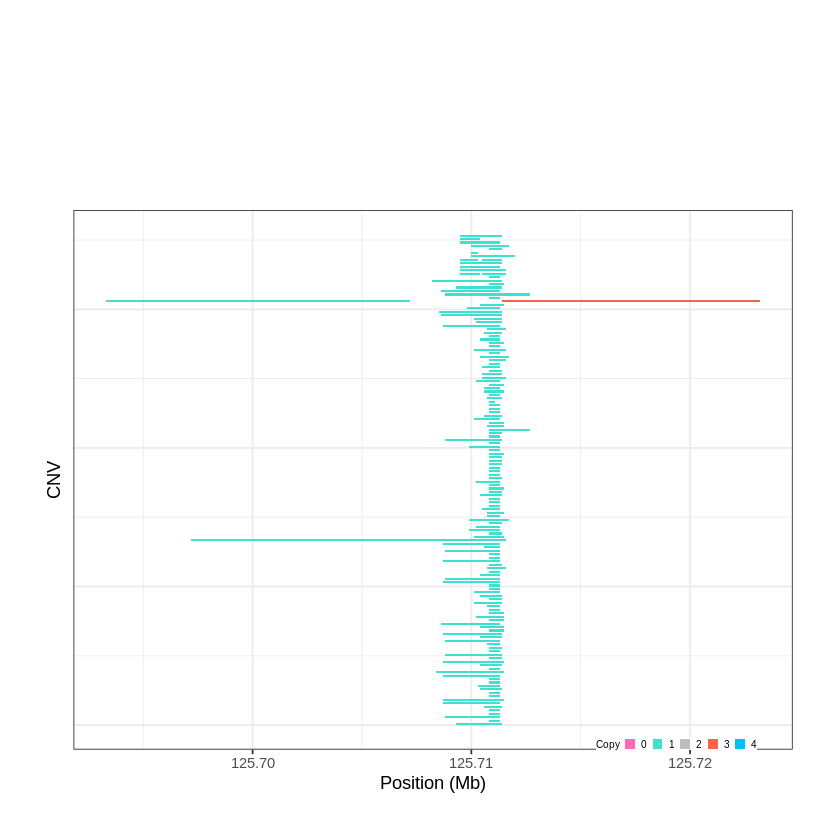

Task done, plot was stored in working directory.
[1] "Ploting CNVR 824..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 132.200101 - 132.2742 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


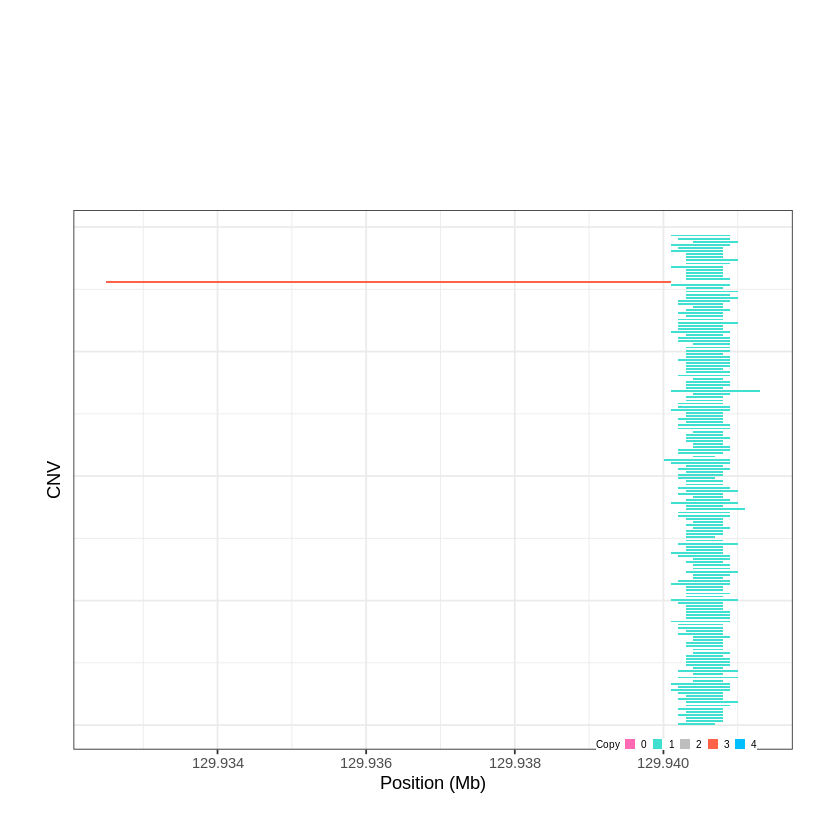

Task done, plot was stored in working directory.
[1] "Ploting CNVR 825..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 137.313701 - 137.3142 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


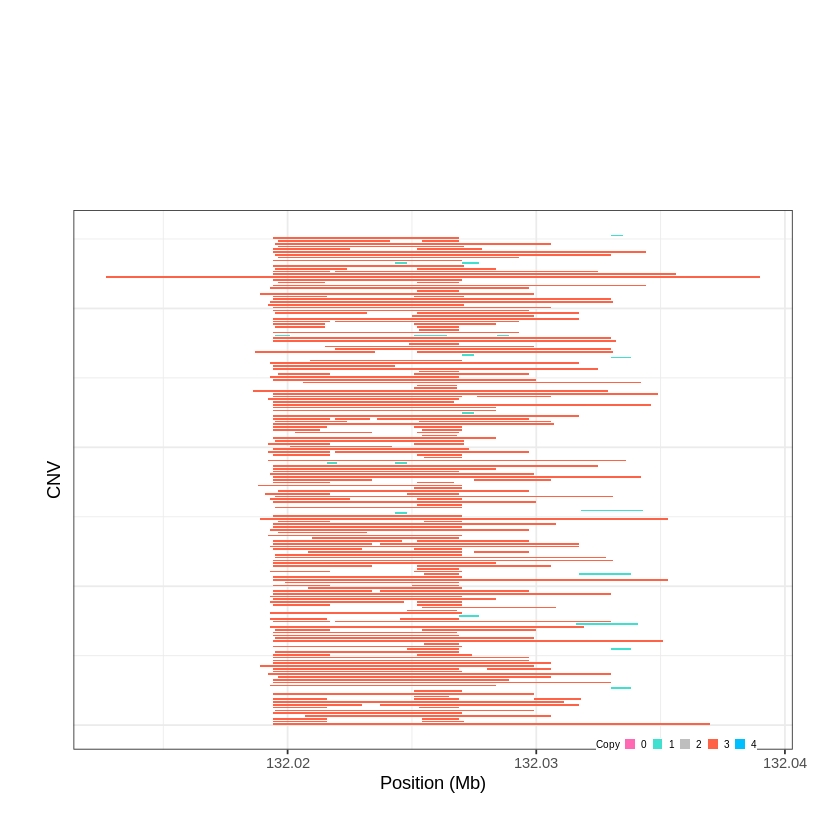

Task done, plot was stored in working directory.
[1] "Ploting CNVR 826..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 140.995101 - 141.0189 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


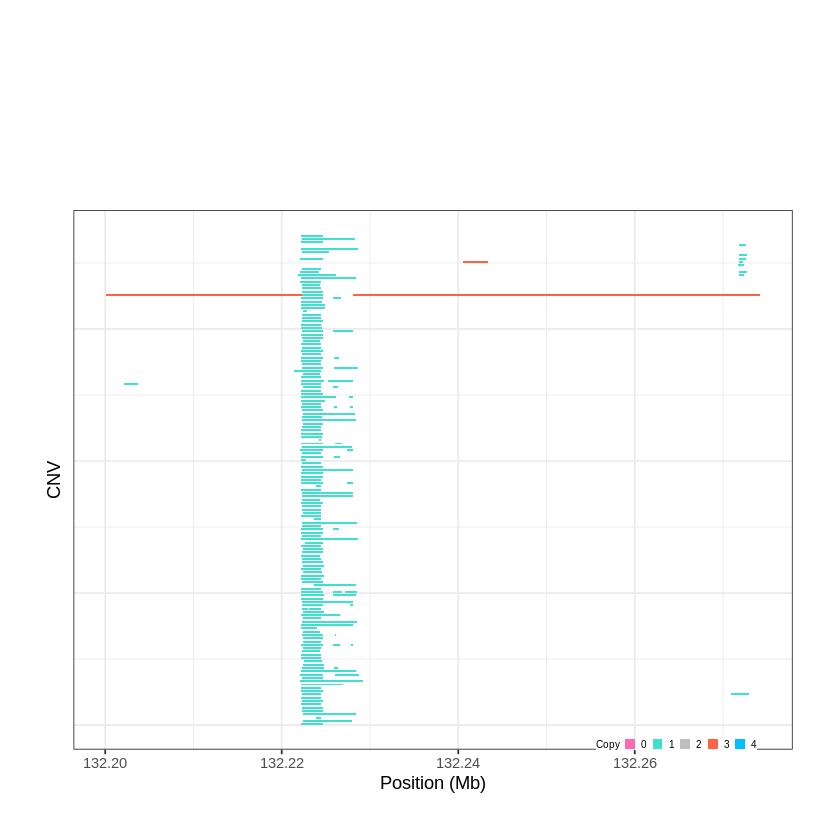

Task done, plot was stored in working directory.
[1] "Ploting CNVR 827..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 149.179901 - 149.2068 Mb with 262 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


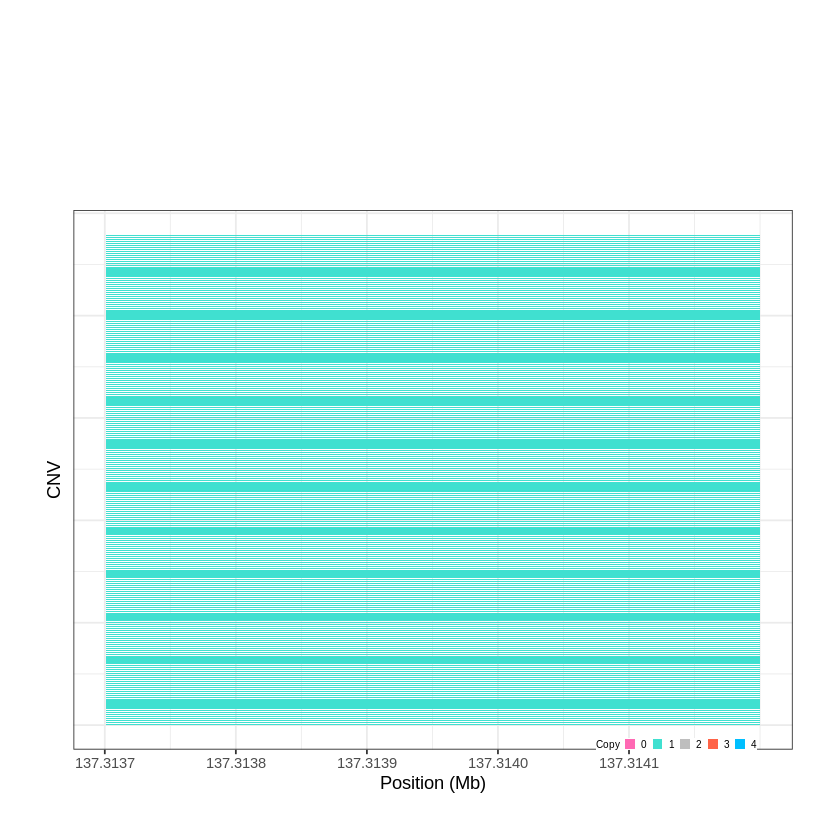

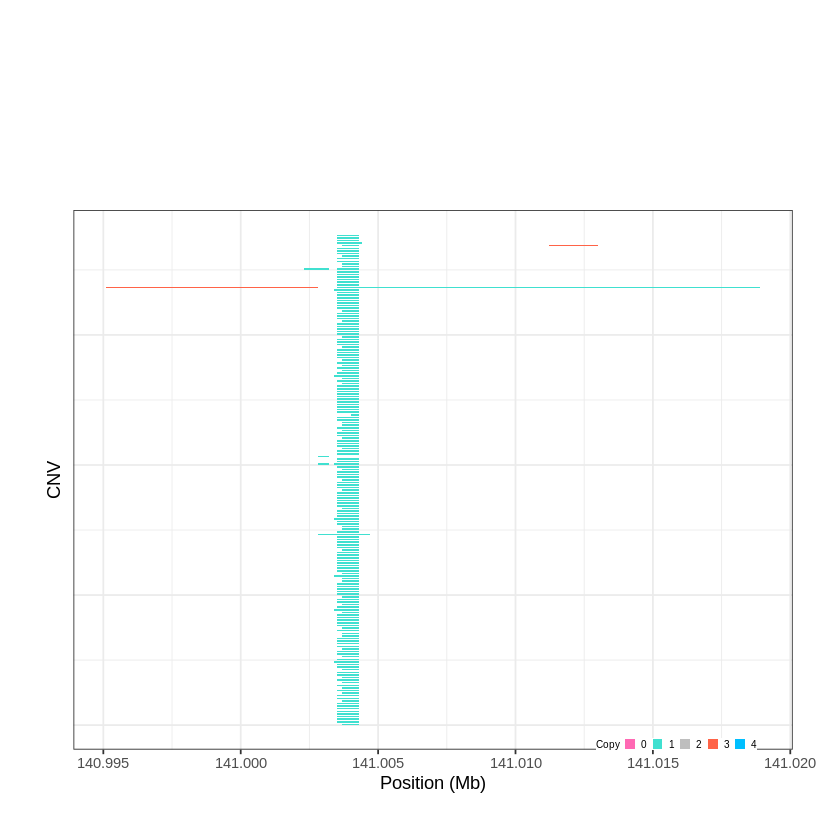

Task done, plot was stored in working directory.
[1] "Ploting CNVR 828..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 150.059201 - 150.3766 Mb with 194 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 829..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 151.458501 - 151.4872 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


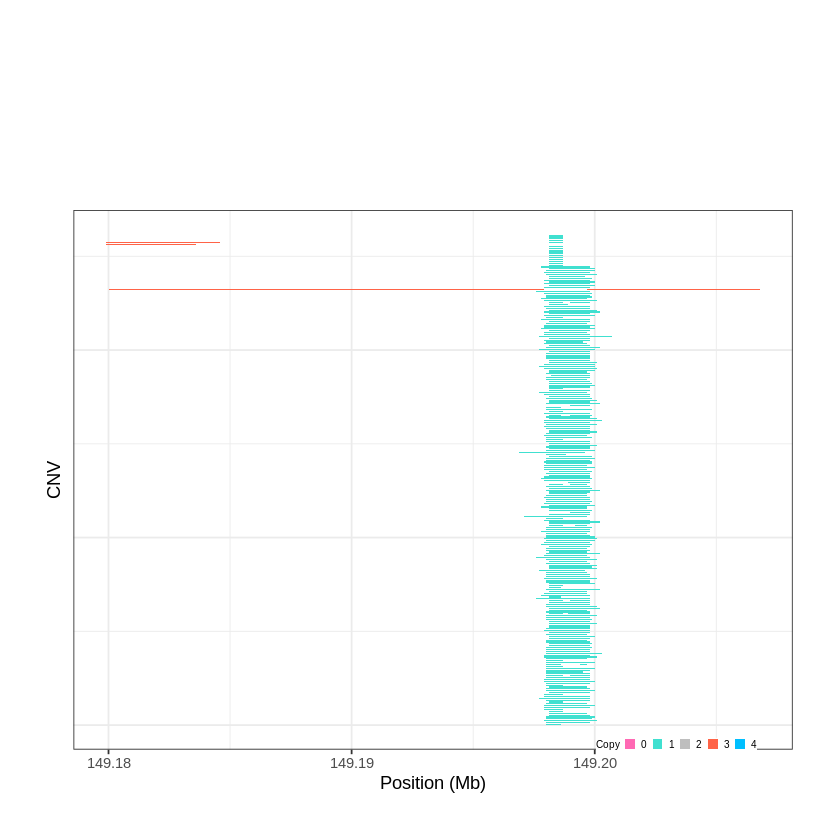

Task done, plot was stored in working directory.
[1] "Ploting CNVR 830..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 153.021301 - 153.0399 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


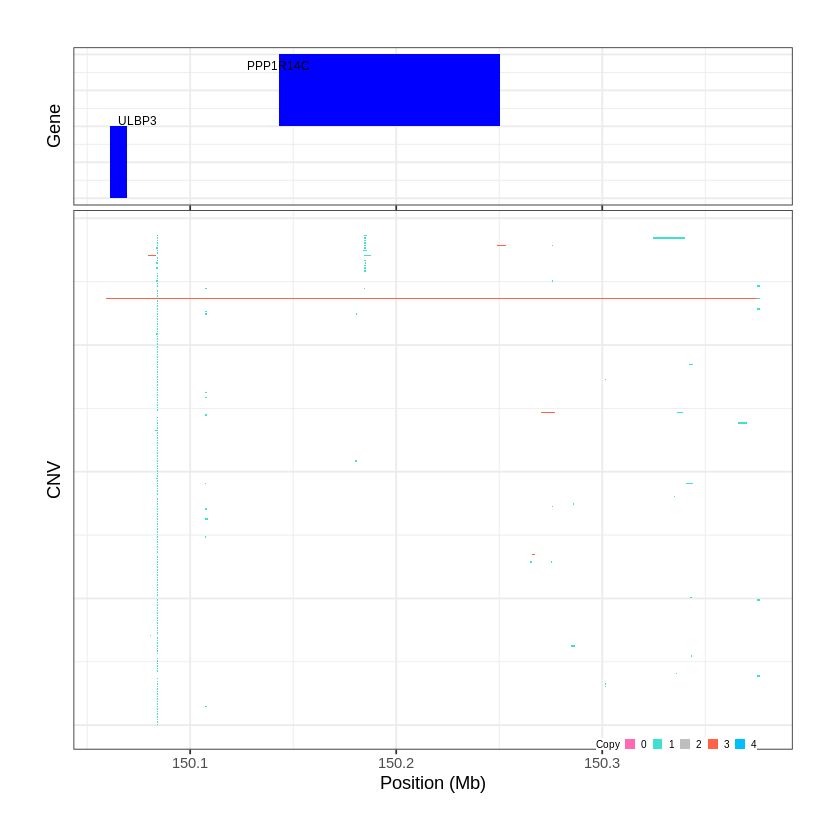

Task done, plot was stored in working directory.
[1] "Ploting CNVR 831..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 153.953601 - 153.9738 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


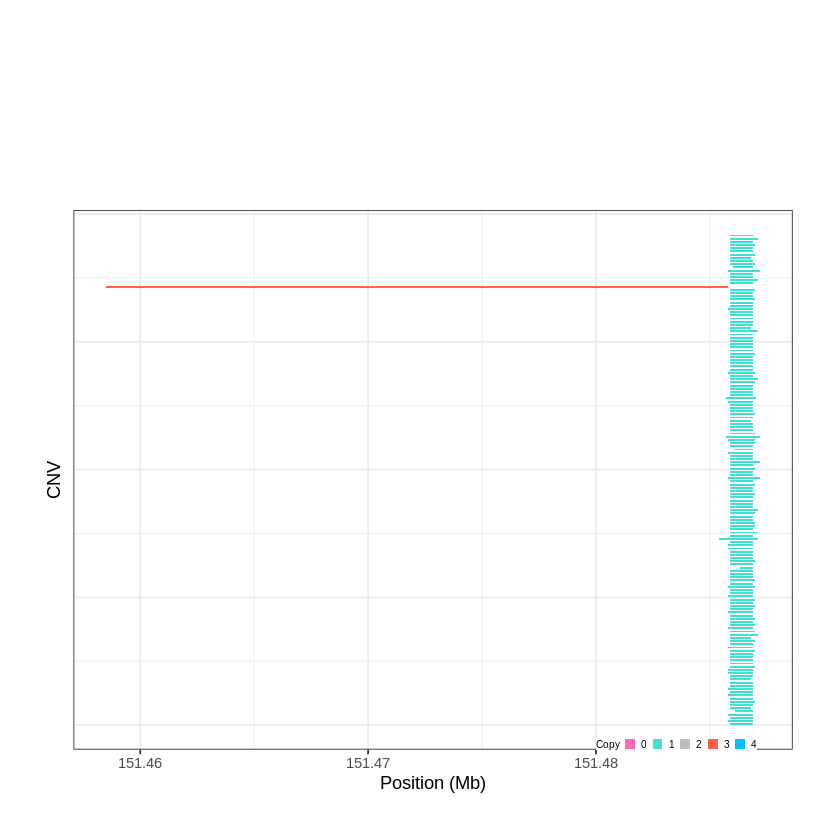

Task done, plot was stored in working directory.
[1] "Ploting CNVR 832..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 155.562701 - 155.6272 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


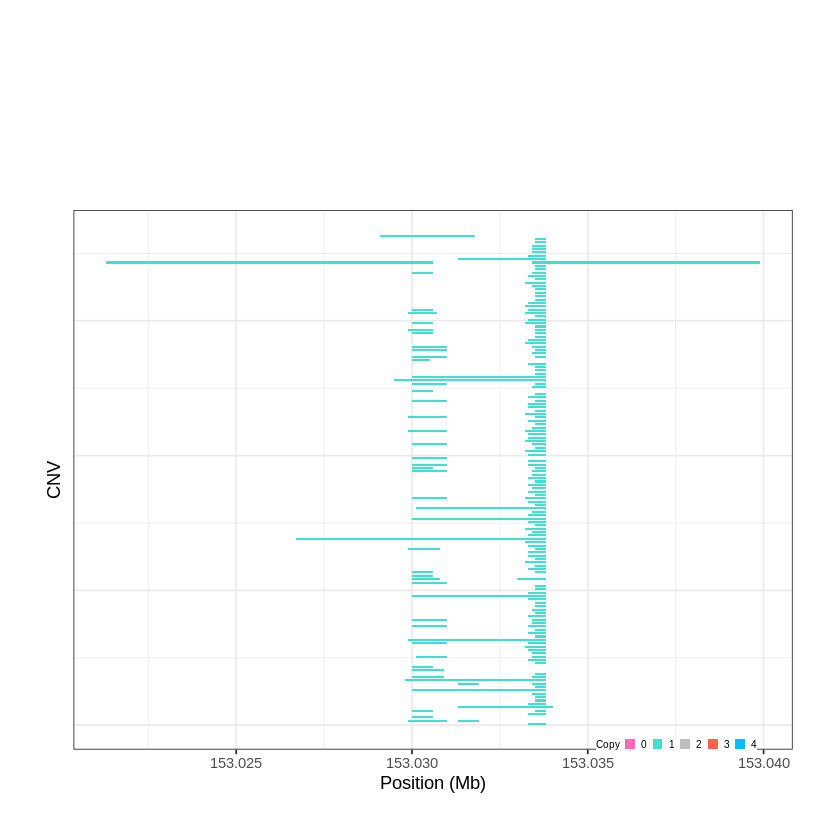

Task done, plot was stored in working directory.
[1] "Ploting CNVR 833..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 156.776701 - 156.778 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


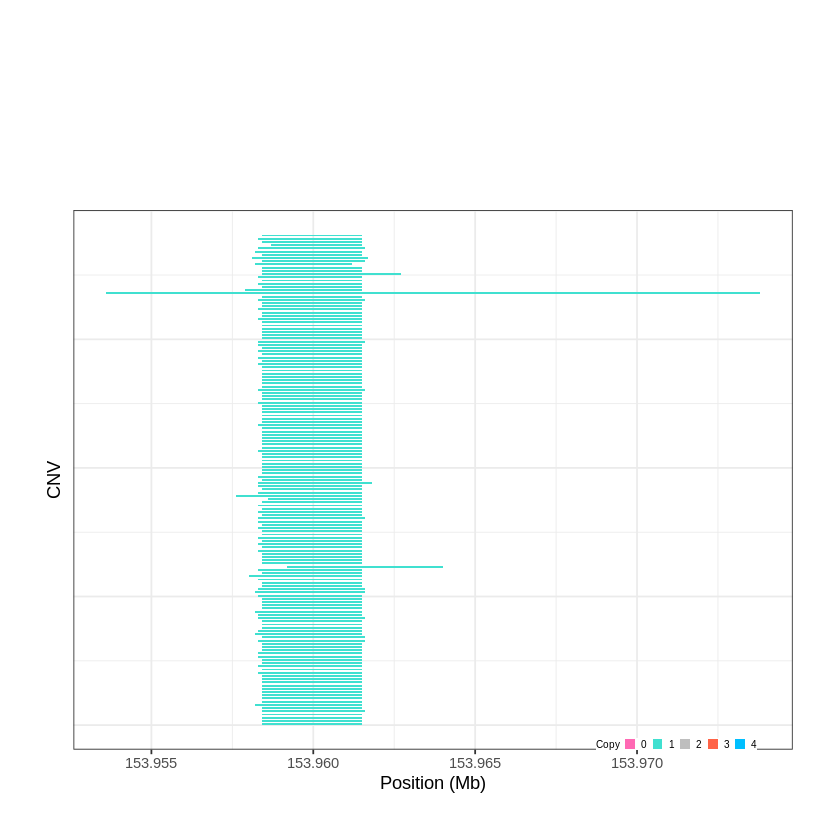

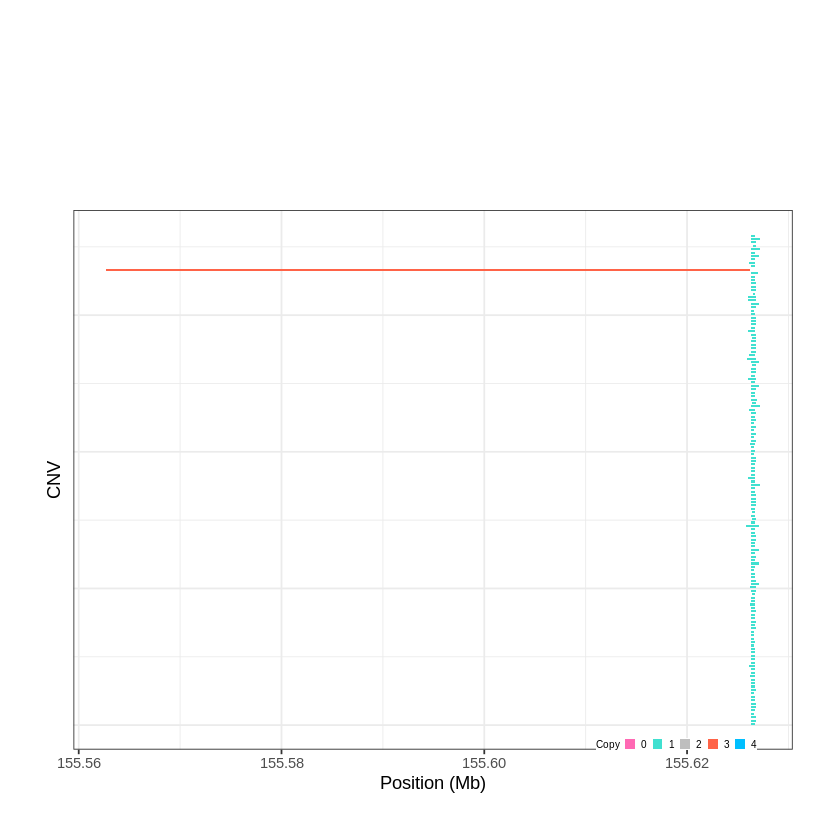

Task done, plot was stored in working directory.
[1] "Ploting CNVR 834..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 157.456801 - 157.6413 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 835..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 157.641301 - 157.7224 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


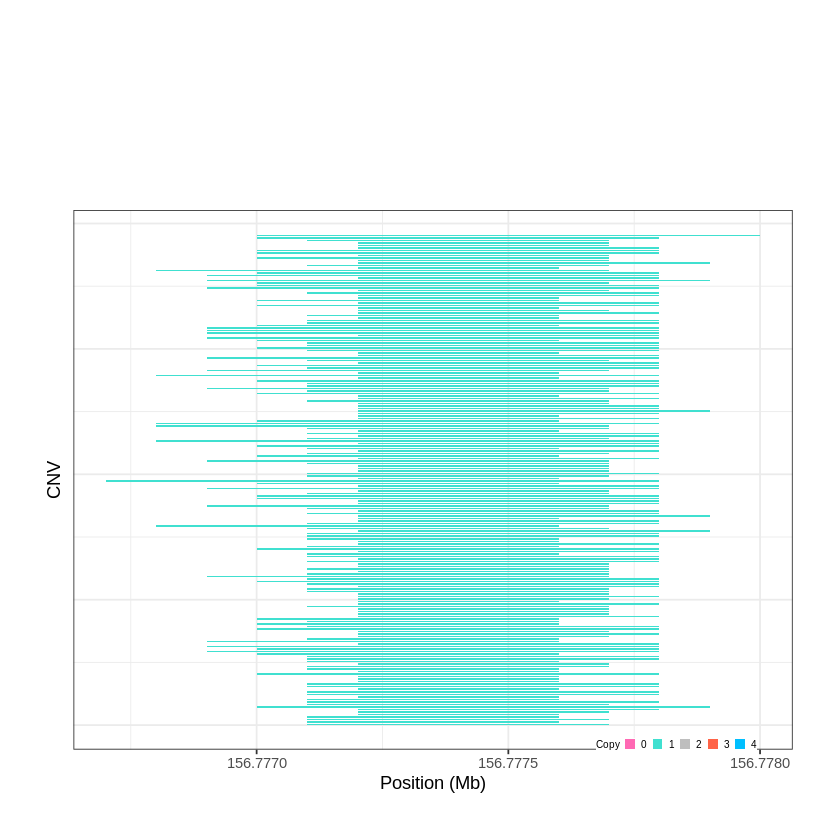

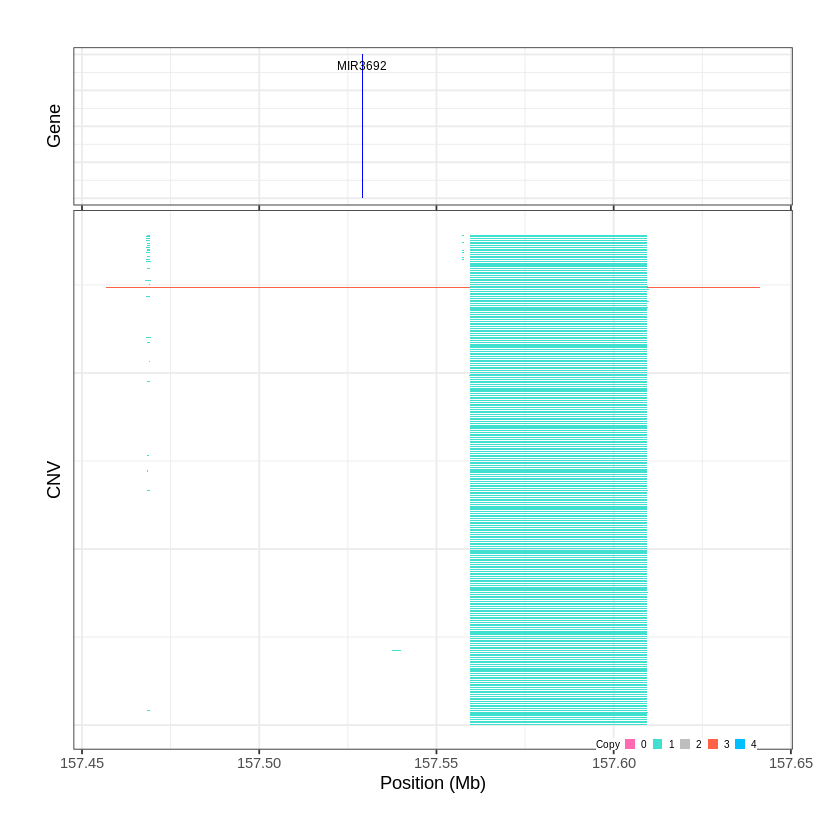

Task done, plot was stored in working directory.
[1] "Ploting CNVR 836..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 158.821901 - 159.3652 Mb with 168 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 837..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 159.649601 - 159.7266 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


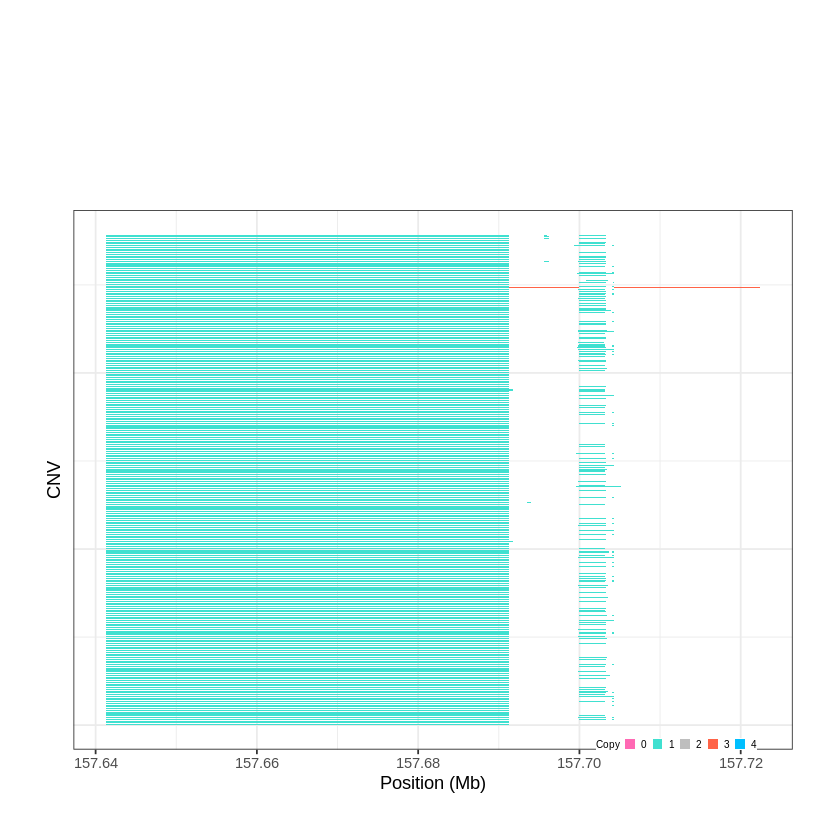

Task done, plot was stored in working directory.
[1] "Ploting CNVR 838..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 160.072401 - 160.0832 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


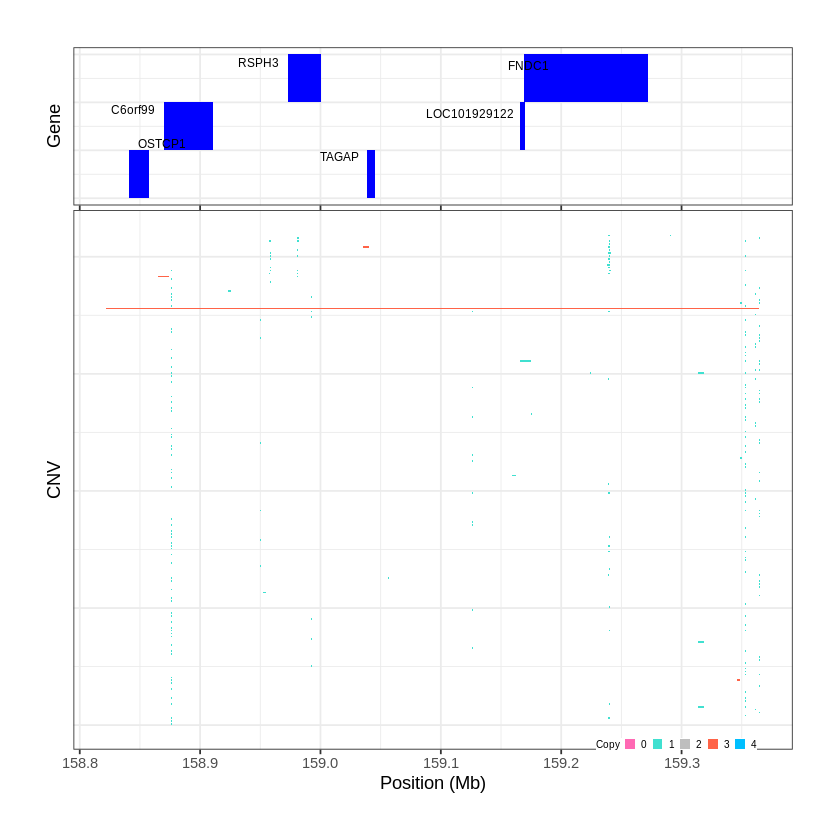

Task done, plot was stored in working directory.
[1] "Ploting CNVR 839..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 161.024901 - 161.0933 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


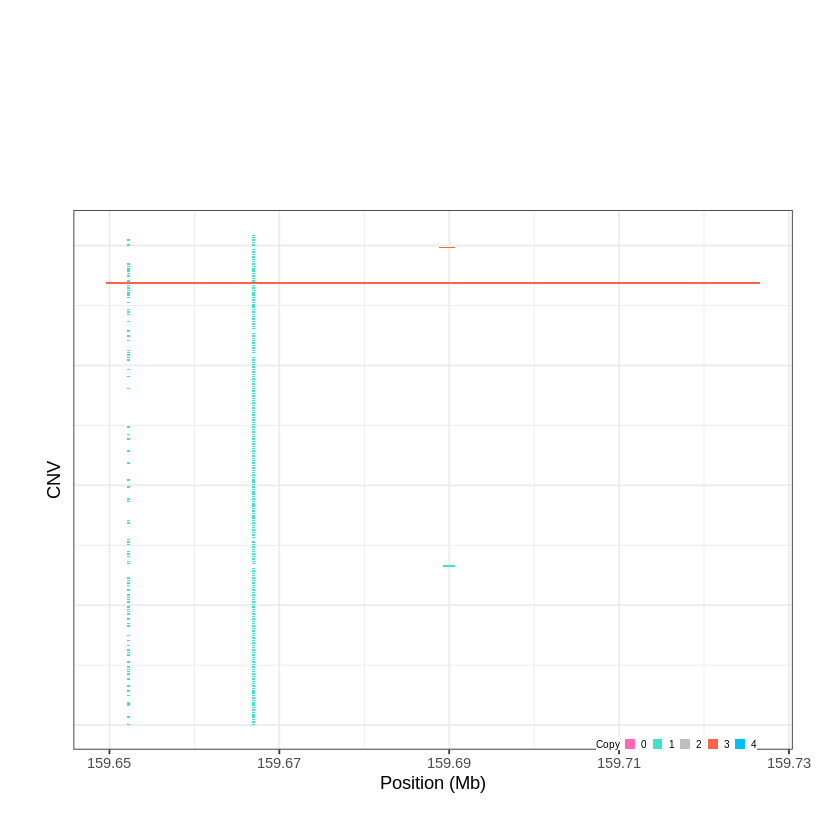

Task done, plot was stored in working directory.
[1] "Ploting CNVR 840..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 161.261401 - 161.3015 Mb with 267 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


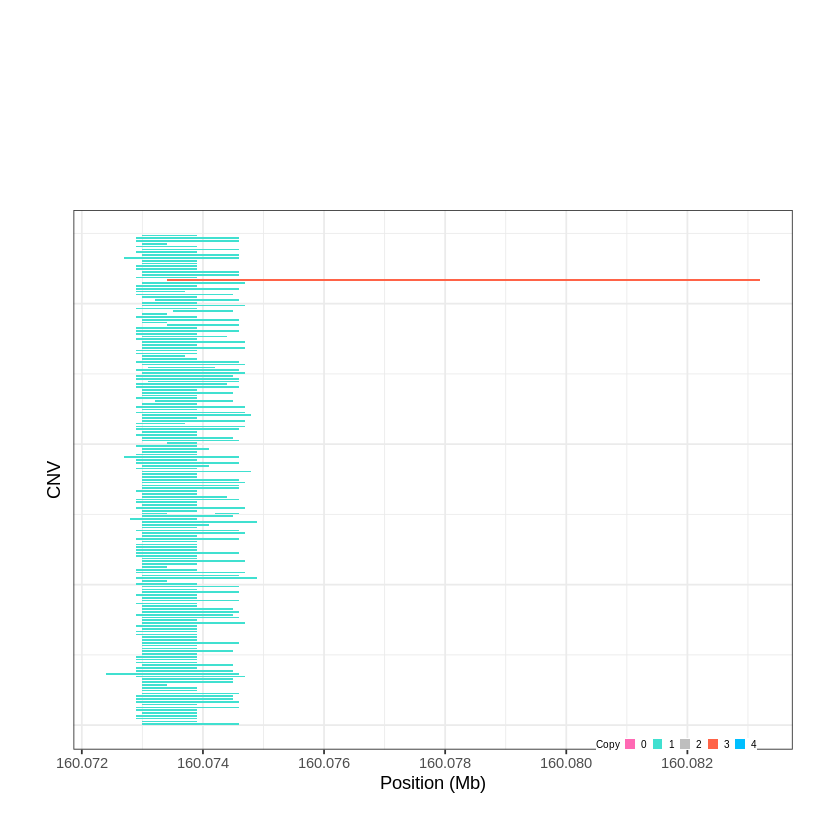

Task done, plot was stored in working directory.
[1] "Ploting CNVR 841..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 162.293801 - 162.3254 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


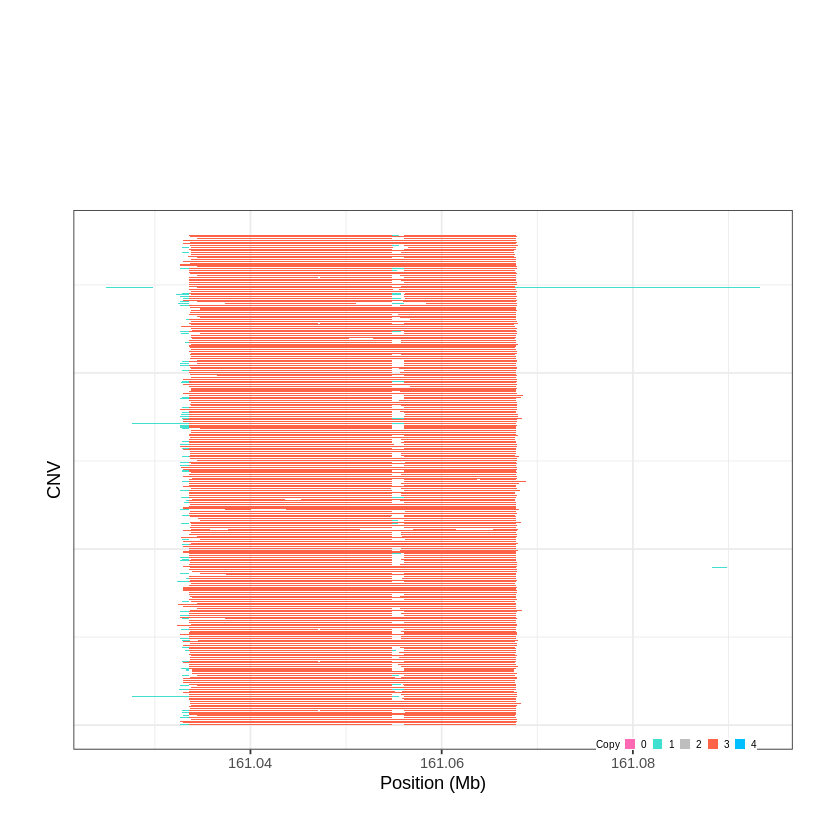

Task done, plot was stored in working directory.
[1] "Ploting CNVR 842..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 162.429901 - 162.4342 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


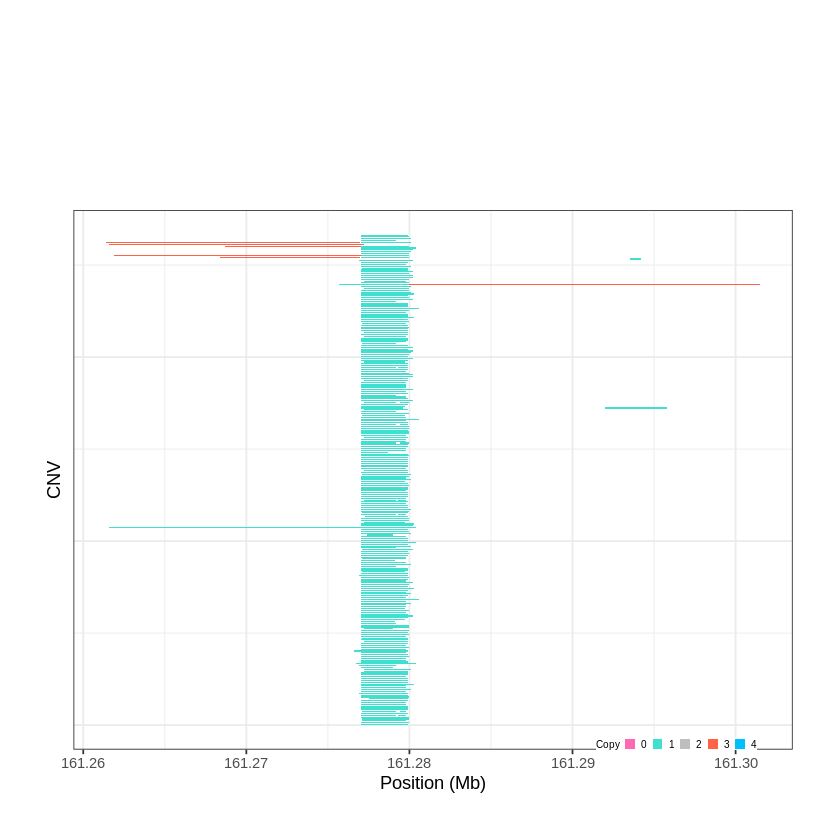

Task done, plot was stored in working directory.
[1] "Ploting CNVR 843..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 165.707001 - 165.7326 Mb with 207 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


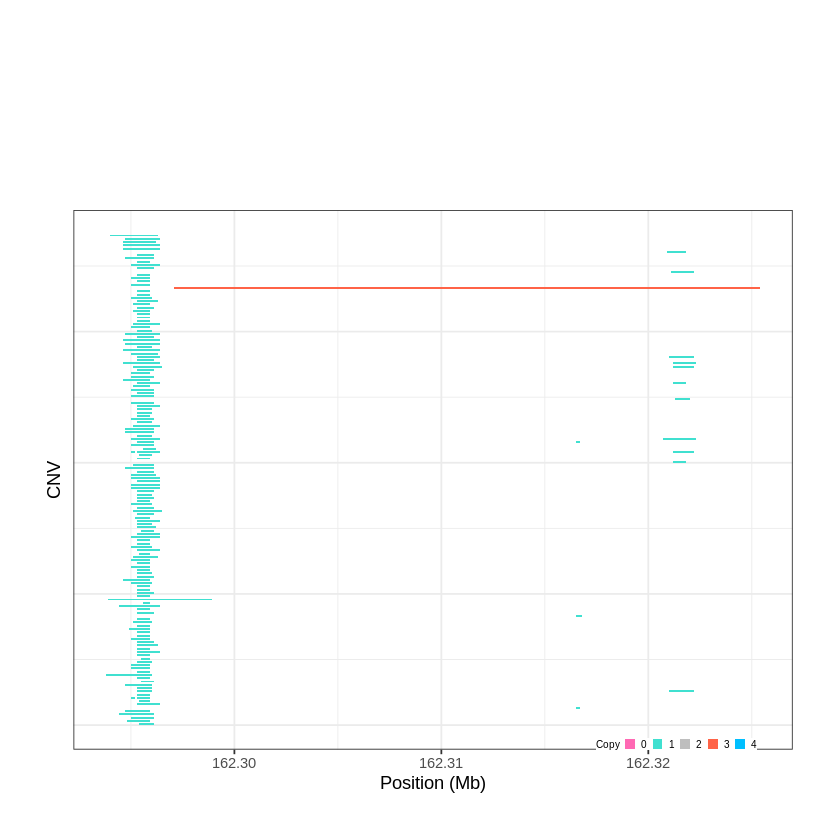

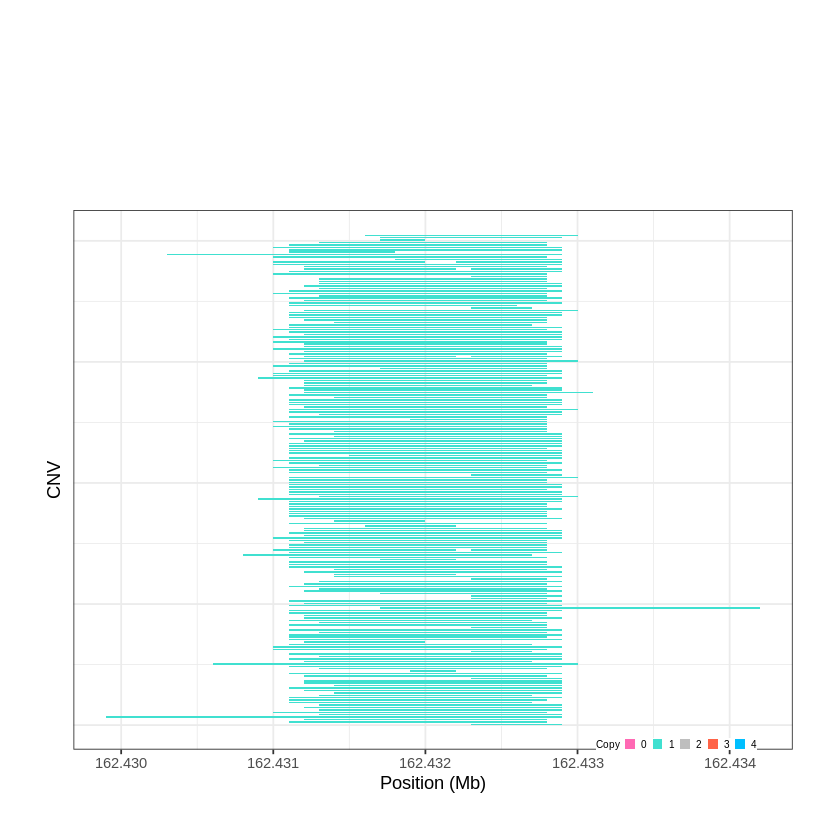

Task done, plot was stored in working directory.
[1] "Ploting CNVR 844..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 167.113501 - 167.1982 Mb with 240 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 845..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 167.487701 - 167.49 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


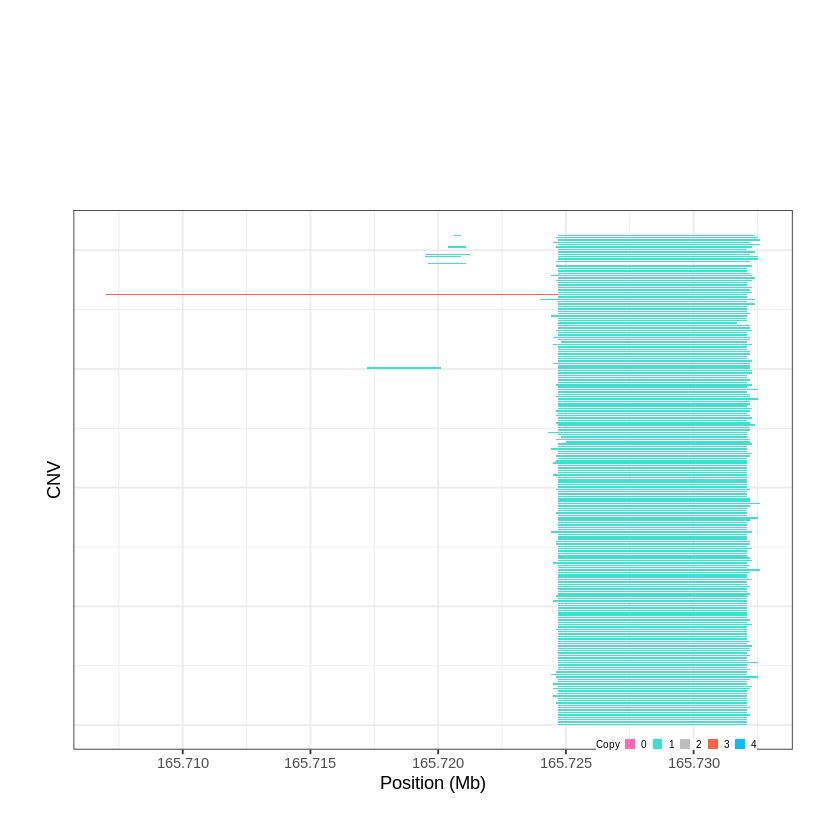

Task done, plot was stored in working directory.
[1] "Ploting CNVR 846..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 167.490901 - 167.6657 Mb with 227 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


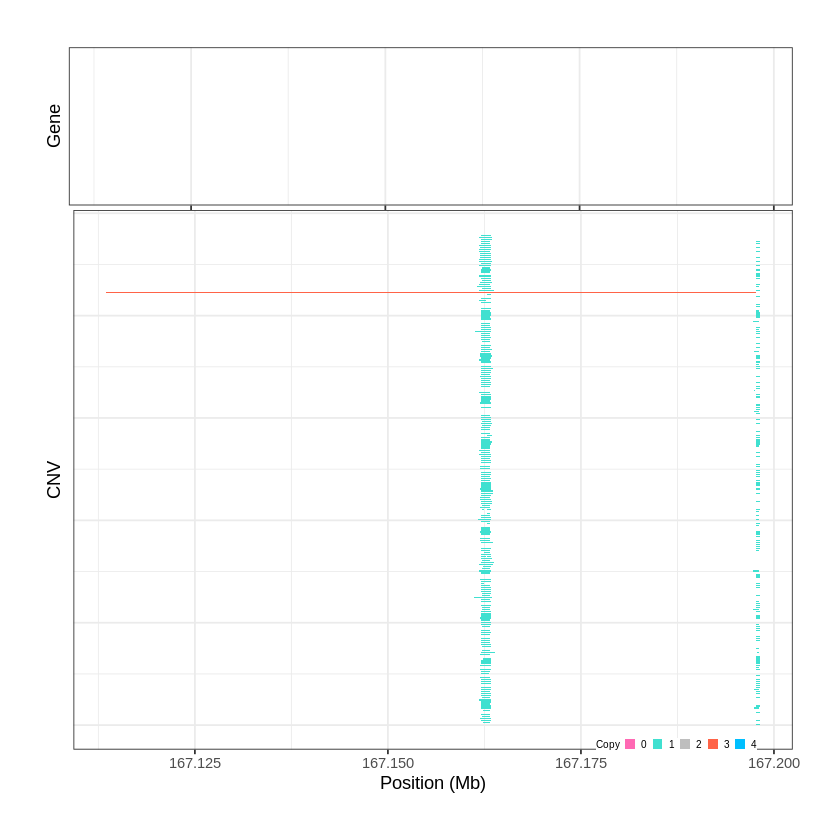

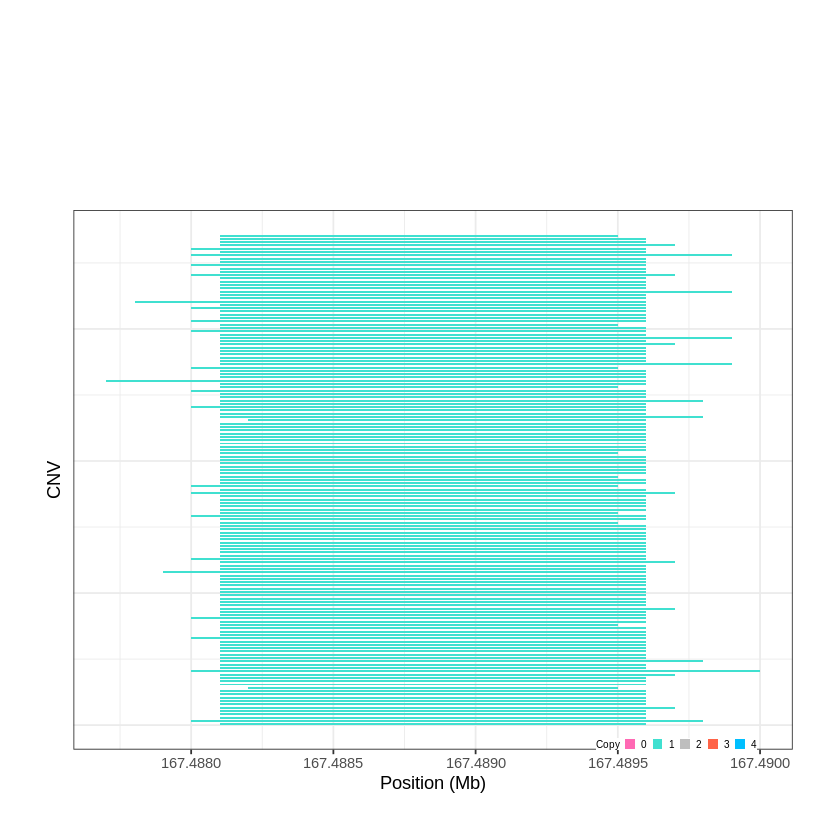

Task done, plot was stored in working directory.
[1] "Ploting CNVR 847..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 167.674101 - 167.8603 Mb with 277 Individual - "
Plotting gene...


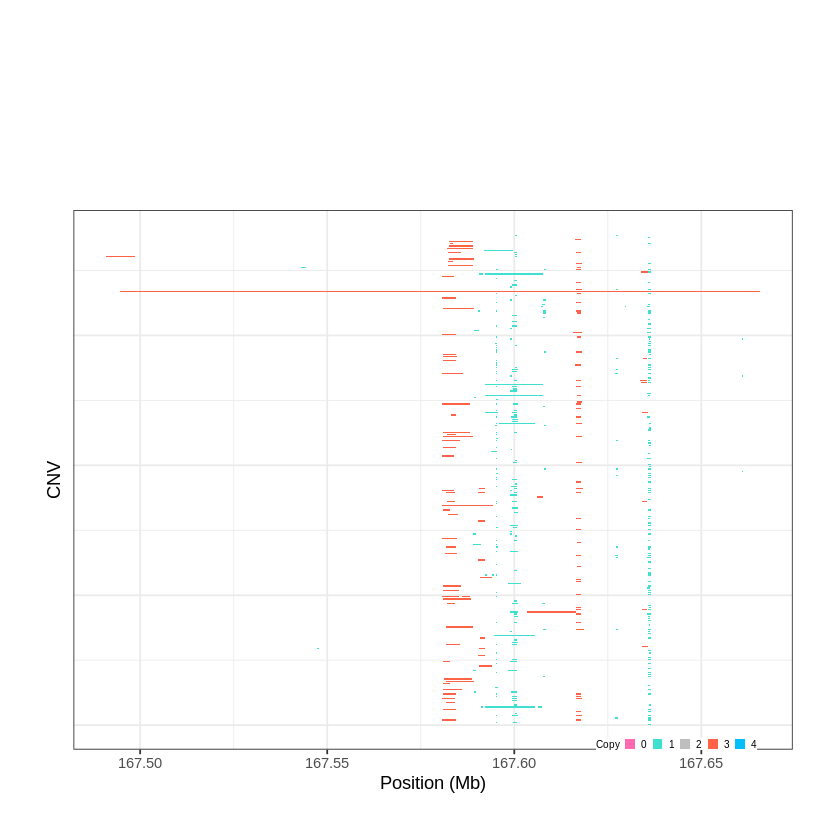

Task done, plot was stored in working directory.
[1] "Ploting CNVR 848..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 167.876401 - 168.2327 Mb with 279 Individual - "
Plotting gene...


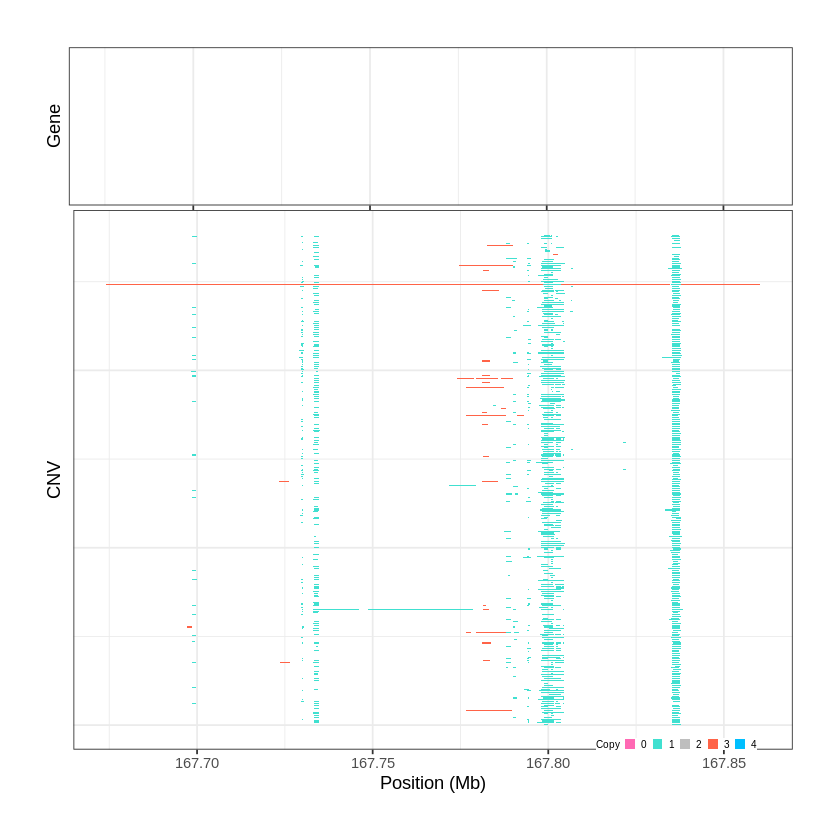

Task done, plot was stored in working directory.
[1] "Ploting CNVR 849..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 168.345601 - 168.8448 Mb with 279 Individual - "
Plotting gene...


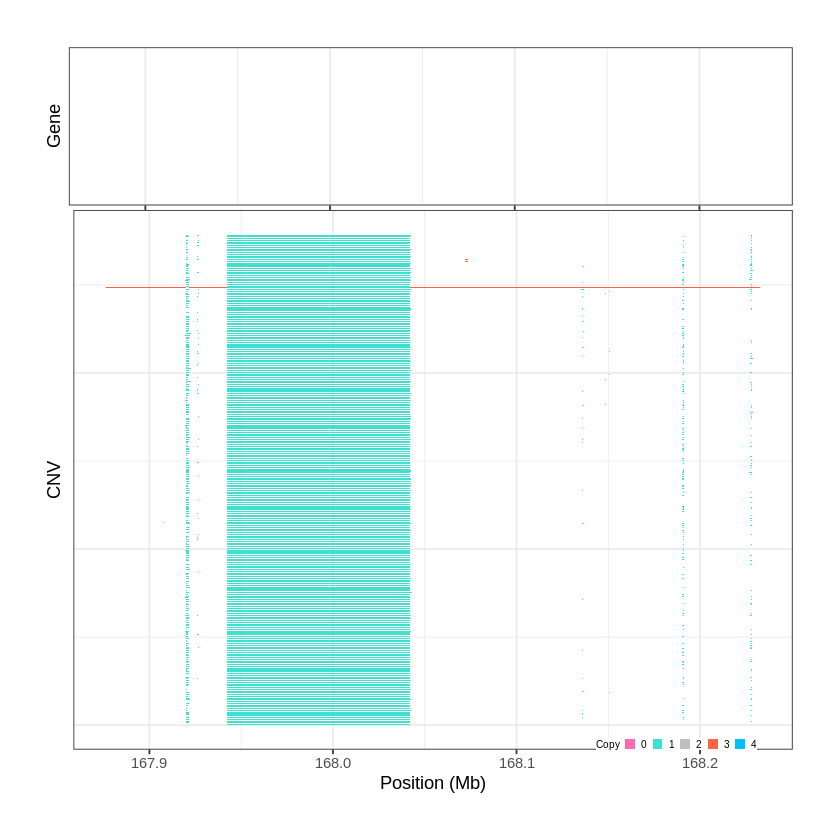

Task done, plot was stored in working directory.
[1] "Ploting CNVR 850..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 168.889301 - 169.0569 Mb with 194 Individual - "
Plotting gene...


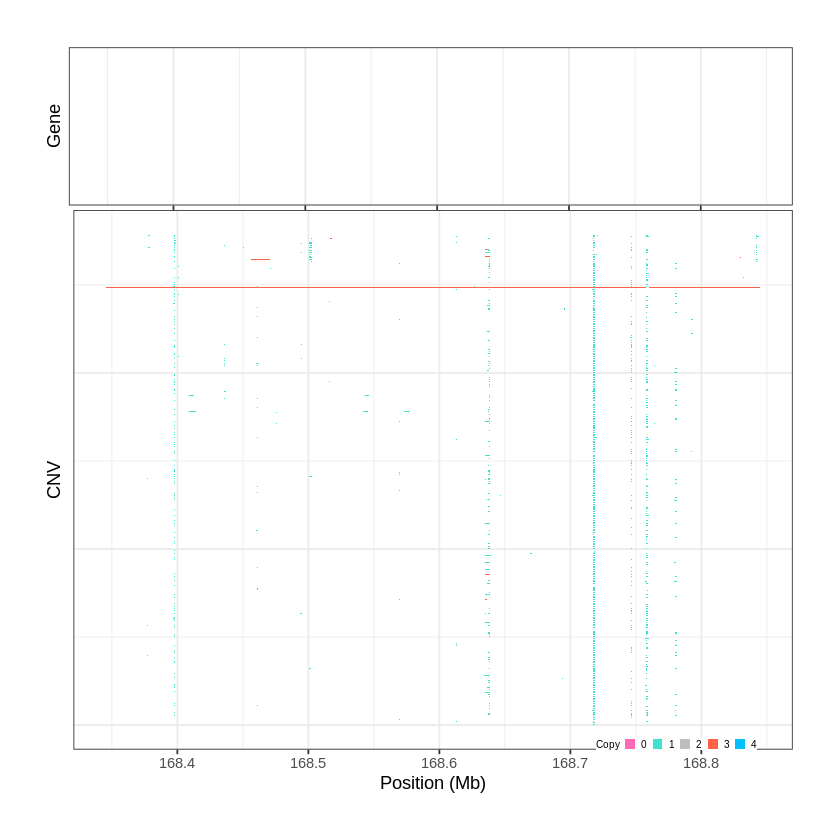

Task done, plot was stored in working directory.
[1] "Ploting CNVR 851..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 169.060201 - 169.1523 Mb with 156 Individual - "
Plotting gene...


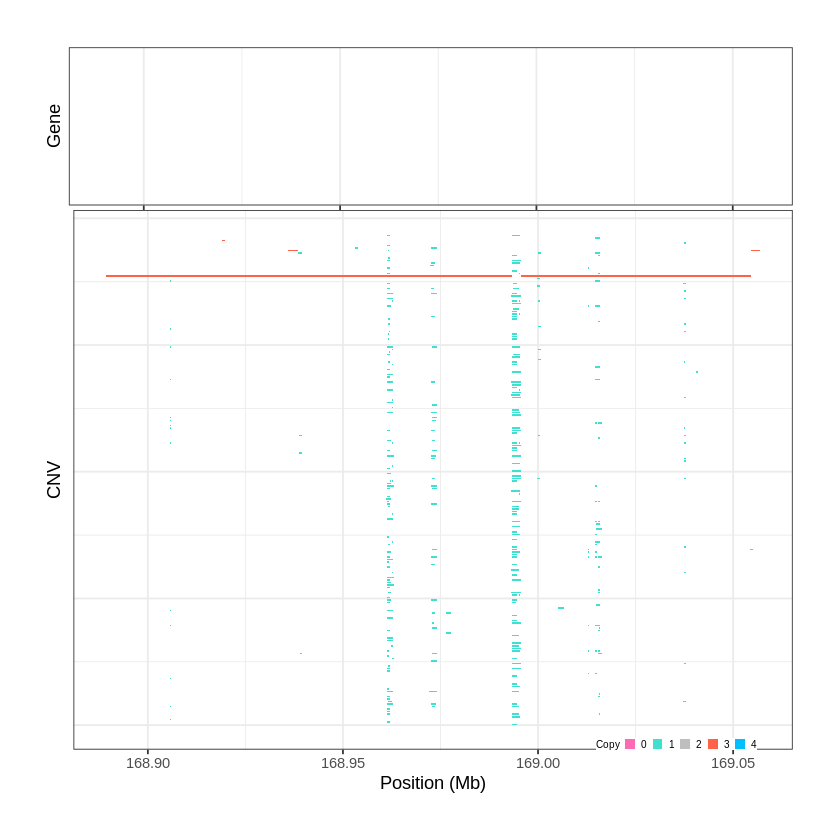

Task done, plot was stored in working directory.
[1] "Ploting CNVR 852..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 169.175701 - 169.3187 Mb with 254 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 853..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 169.526101 - 169.5296 Mb with 227 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


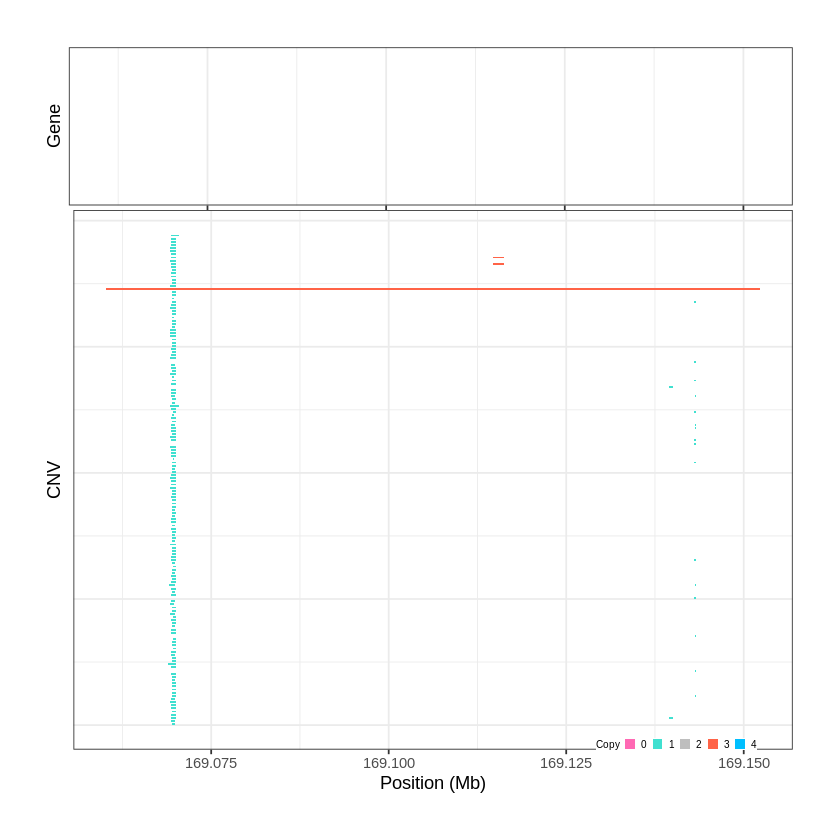

Task done, plot was stored in working directory.
[1] "Ploting CNVR 854..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 170.203101 - 170.2183 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


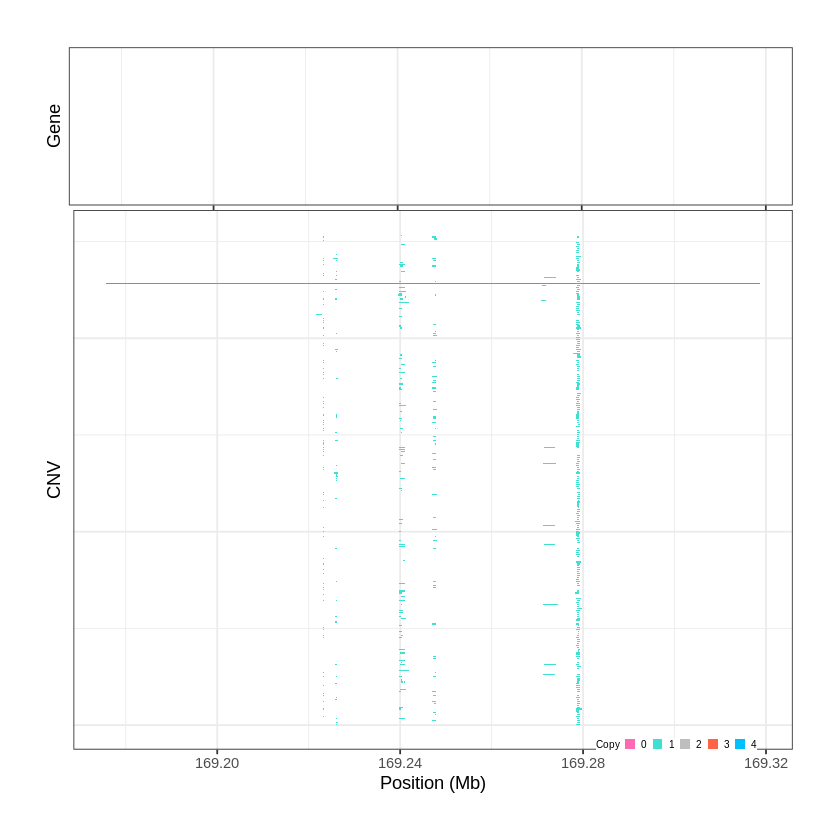

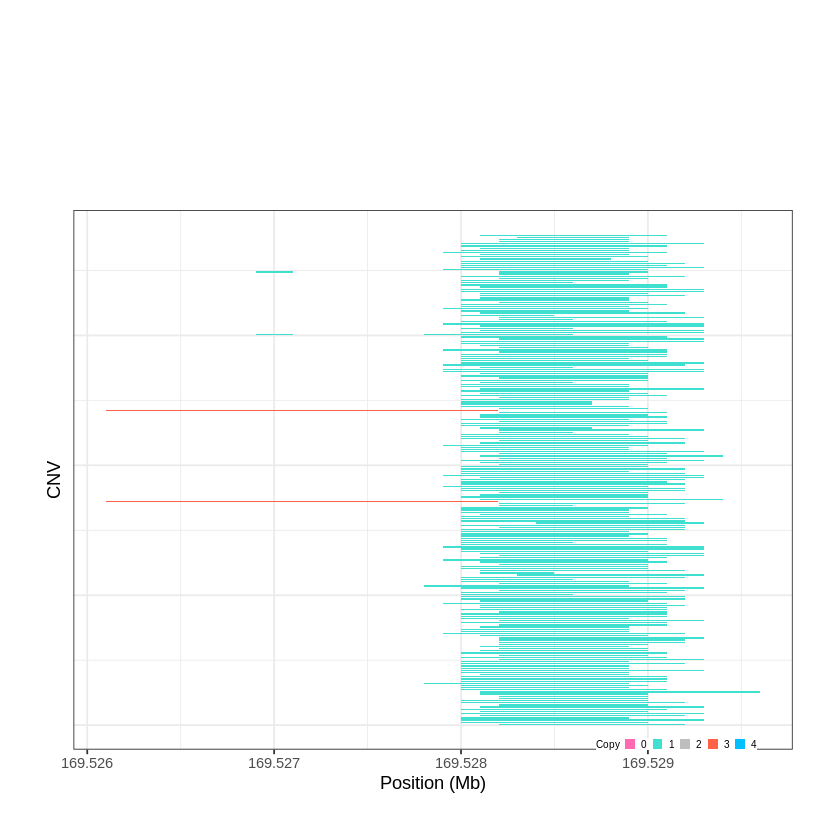

Task done, plot was stored in working directory.
[1] "Ploting CNVR 855..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 170.222401 - 170.2708 Mb with 150 Individual - "
Plotting gene...


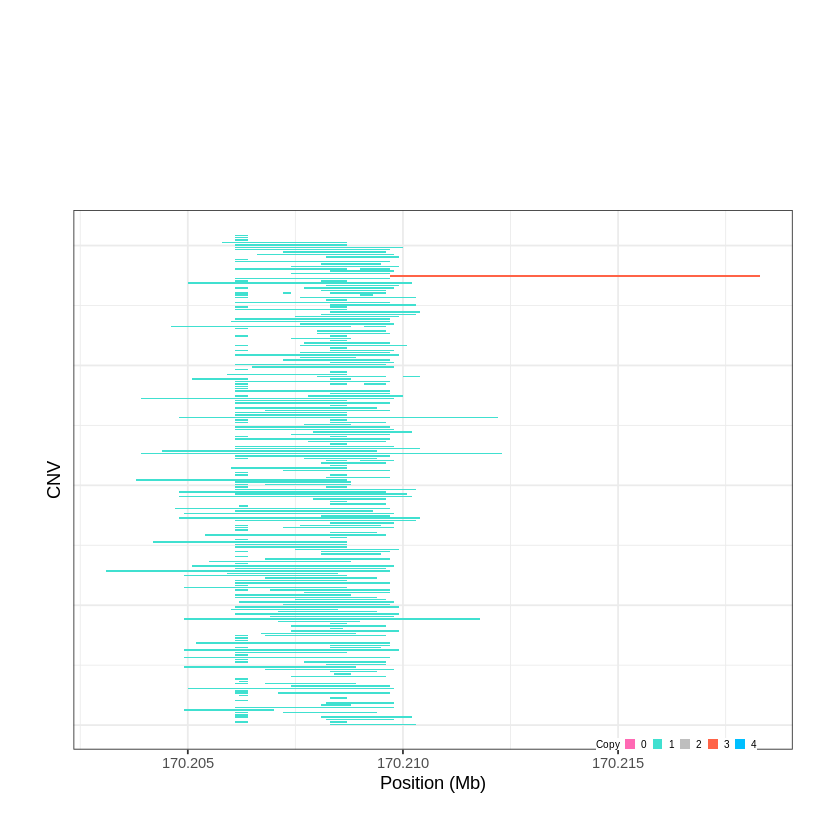

Task done, plot was stored in working directory.
[1] "Ploting CNVR 856..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 170.279701 - 170.6042 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 857..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 170.699001 - 170.8007 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


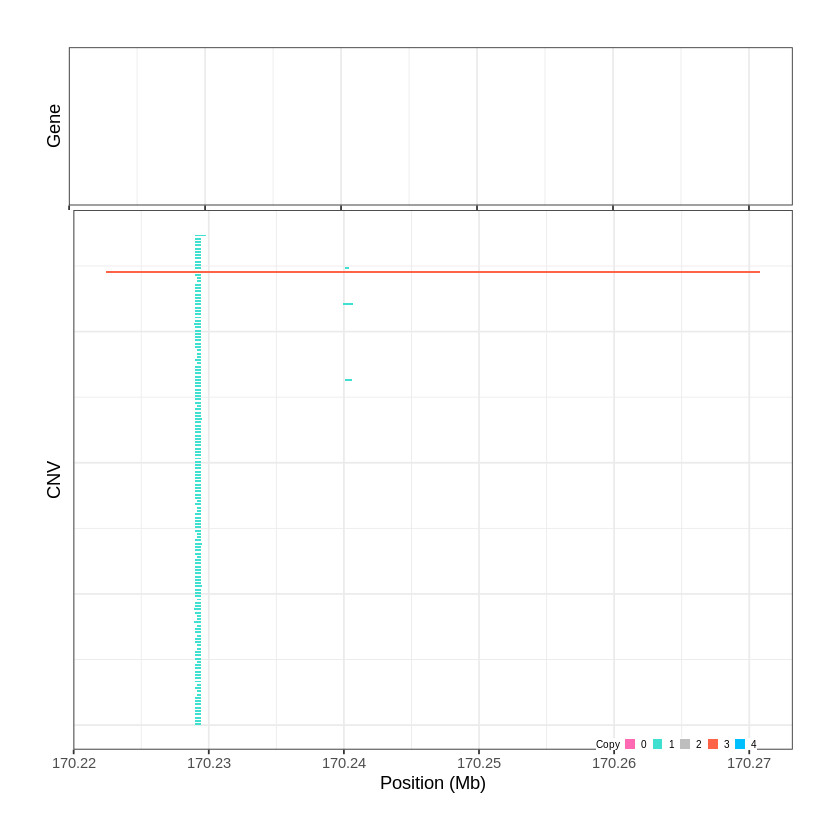

Task done, plot was stored in working directory.
[1] "Ploting CNVR 858..."
Input data passed requirment check...
[1] "CNV on Chromosome 6: 170.911101 - 171.1151 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


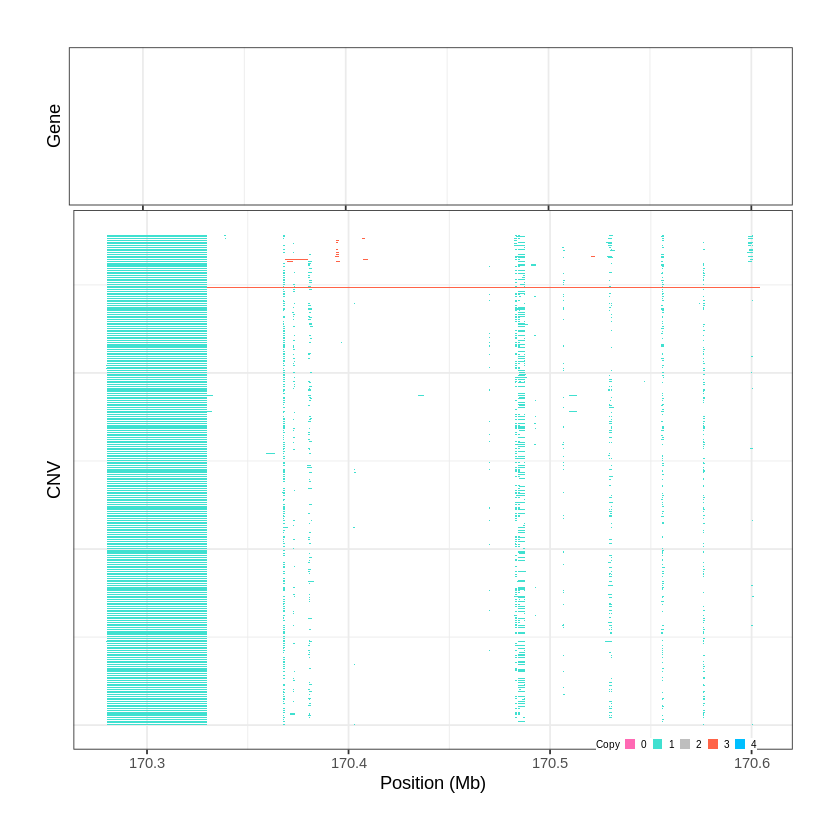

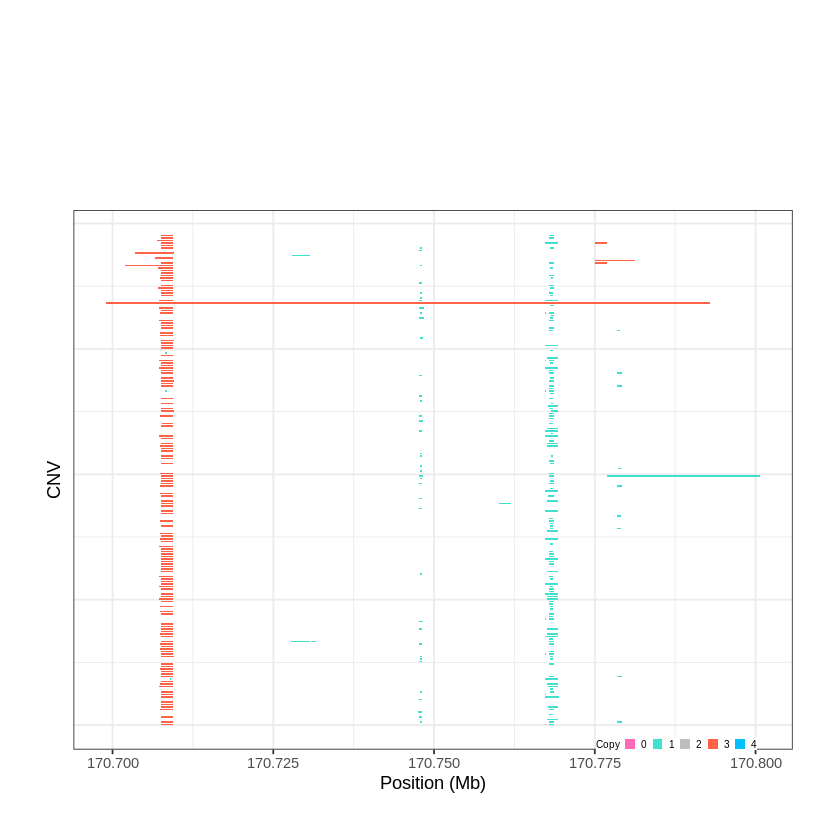

Task done, plot was stored in working directory.
[1] "Ploting CNVR 859..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 1e-06 - 0.2221 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 860..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.223801 - 0.2325 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


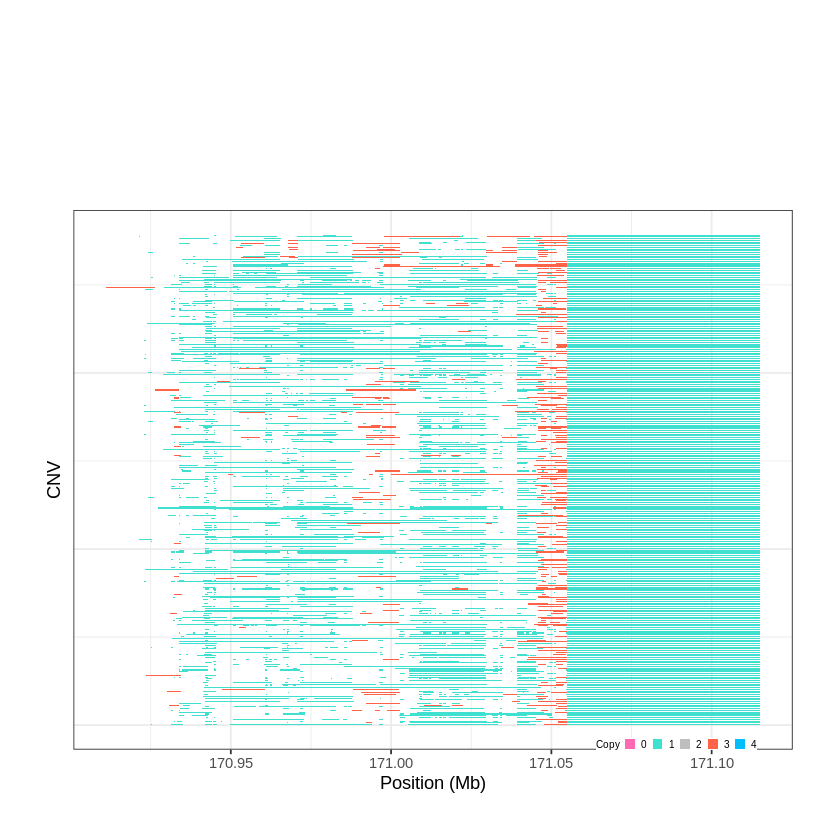

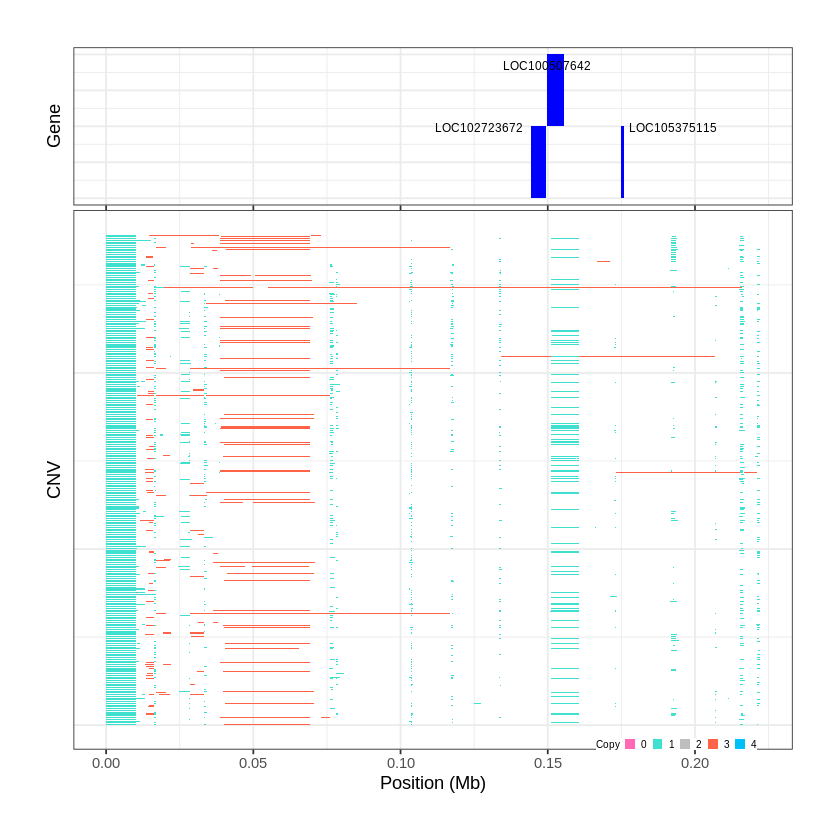

Task done, plot was stored in working directory.
[1] "Ploting CNVR 861..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.232501 - 0.427 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 862..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.432401 - 0.4905 Mb with 247 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


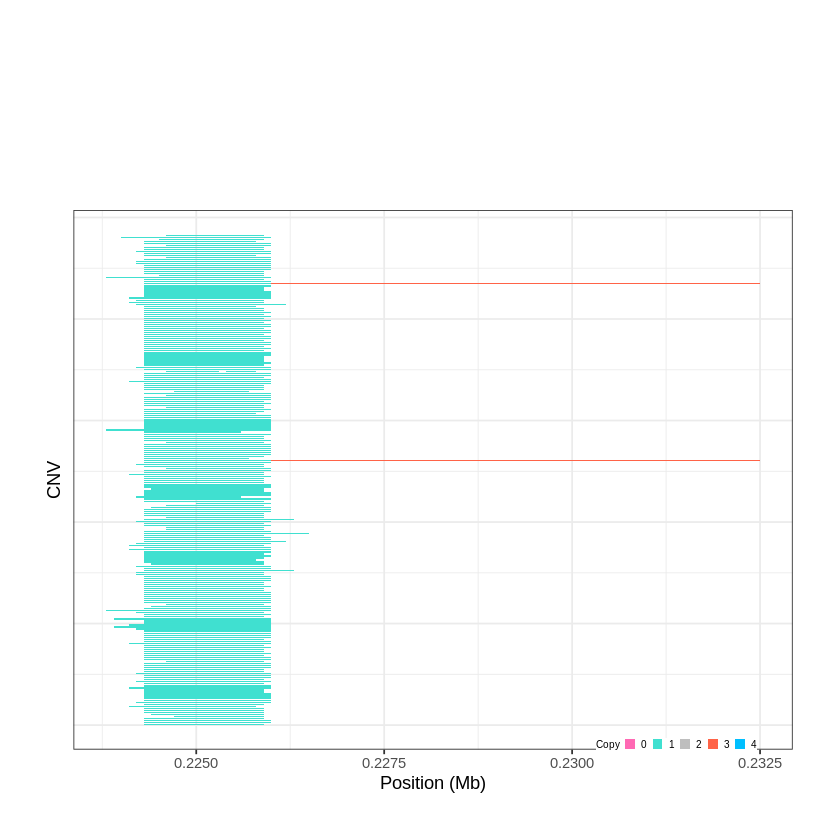

Task done, plot was stored in working directory.
[1] "Ploting CNVR 863..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.494801 - 0.4997 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


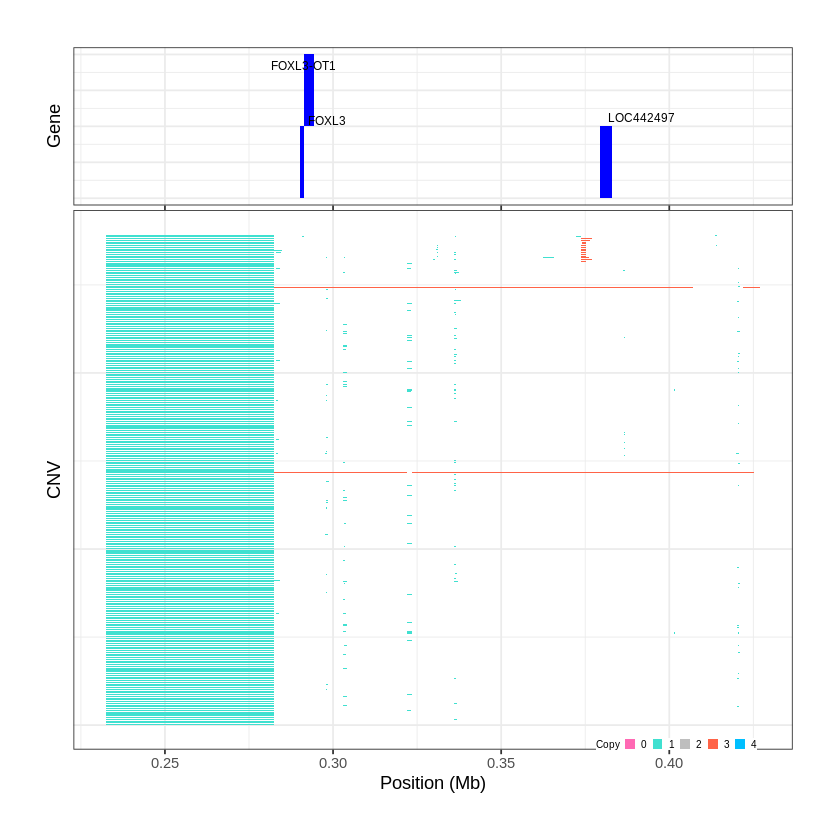

Task done, plot was stored in working directory.
[1] "Ploting CNVR 864..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.508701 - 0.5191 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


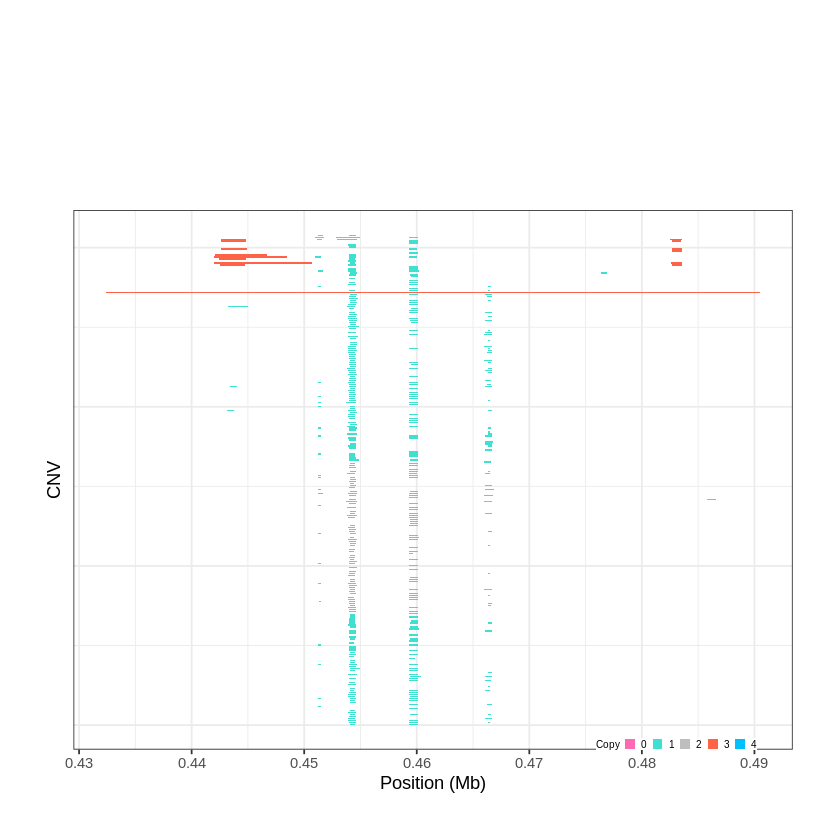

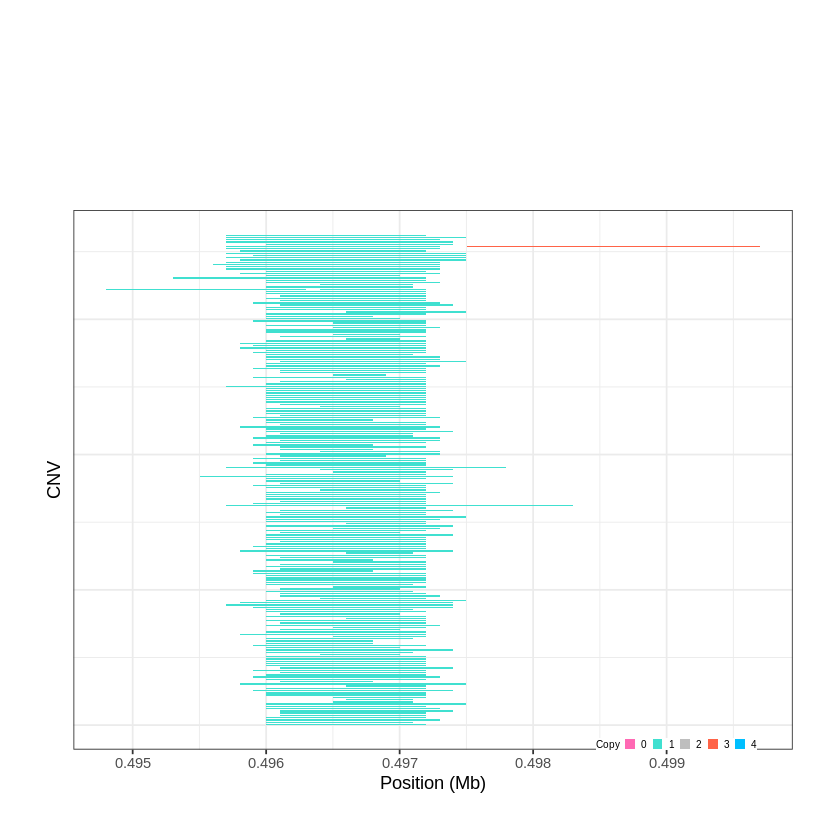

Task done, plot was stored in working directory.
[1] "Ploting CNVR 865..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.521601 - 0.6064 Mb with 185 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 866..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.606401 - 0.607 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


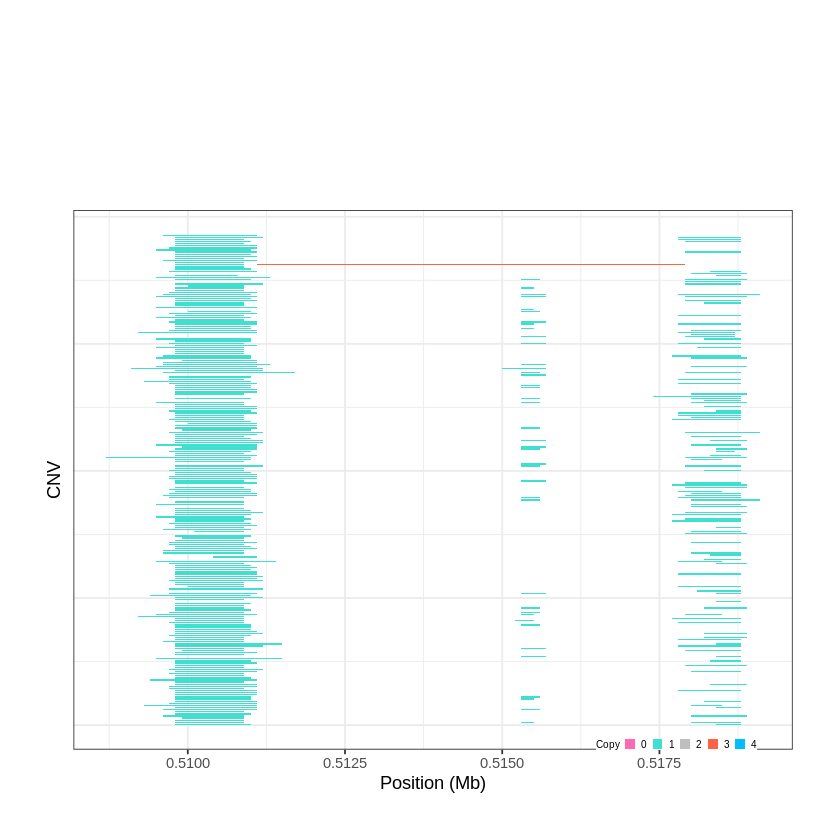

Task done, plot was stored in working directory.
[1] "Ploting CNVR 867..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.607001 - 0.7537 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


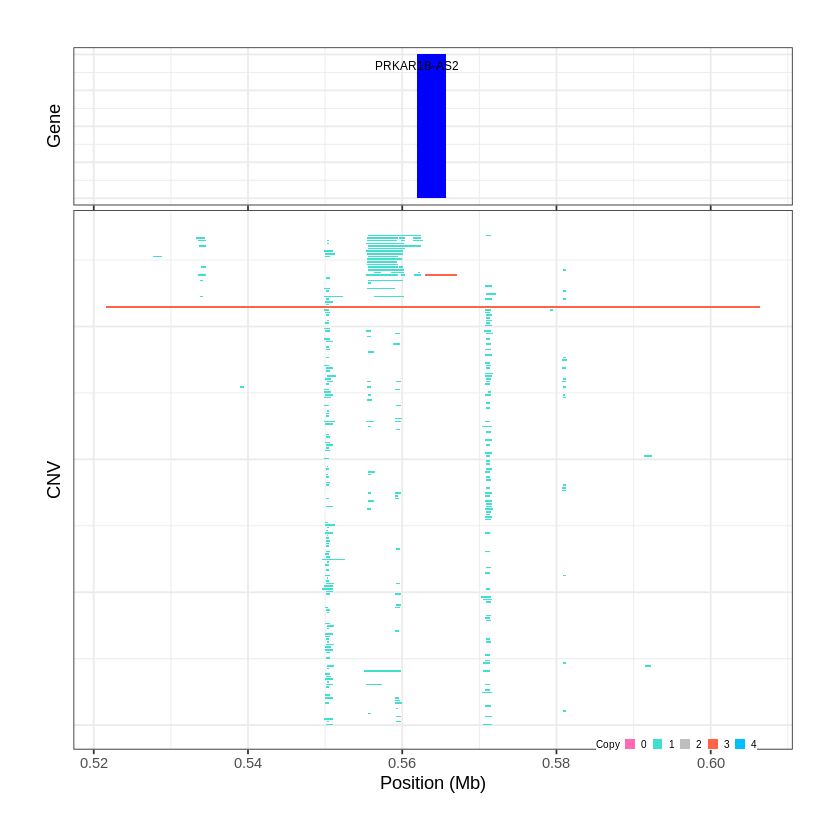

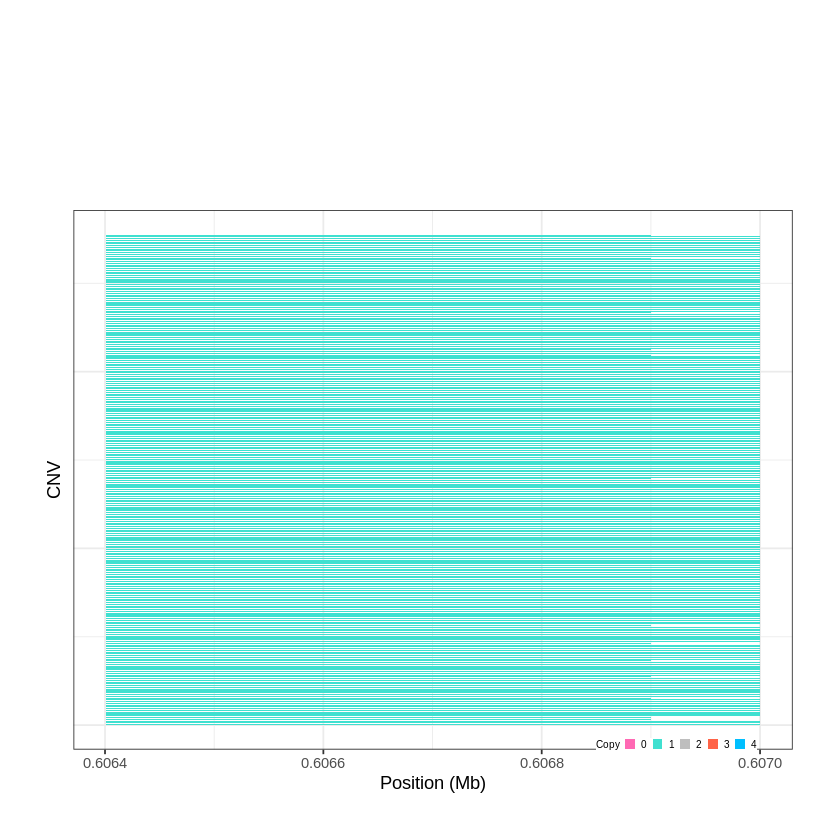

Task done, plot was stored in working directory.
[1] "Ploting CNVR 868..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 0.781801 - 0.9465 Mb with 248 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 869..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 1.113001 - 1.1144 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


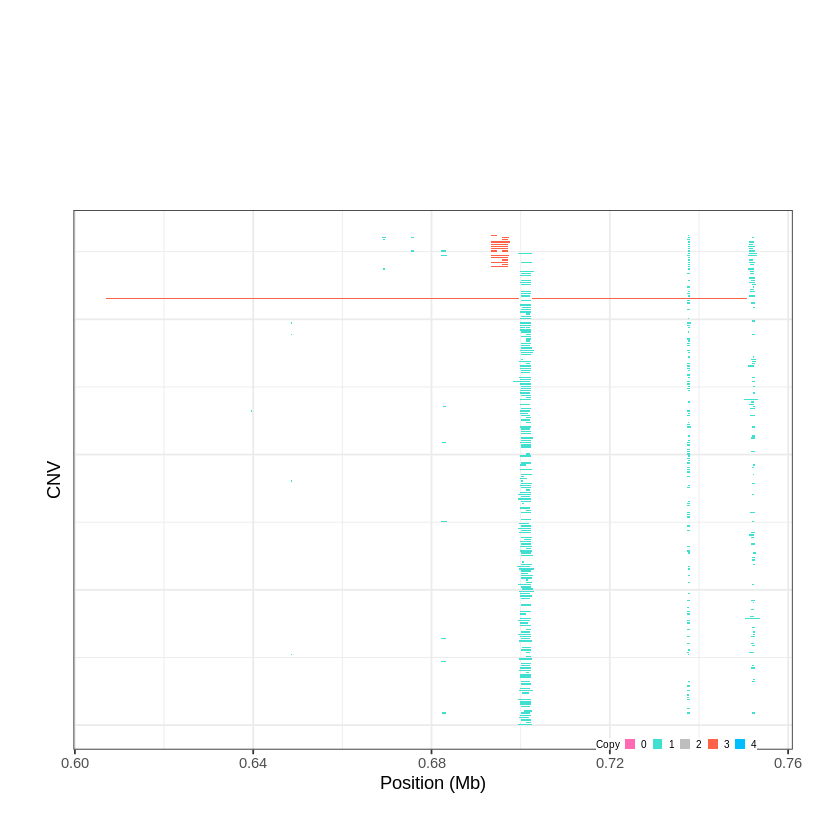

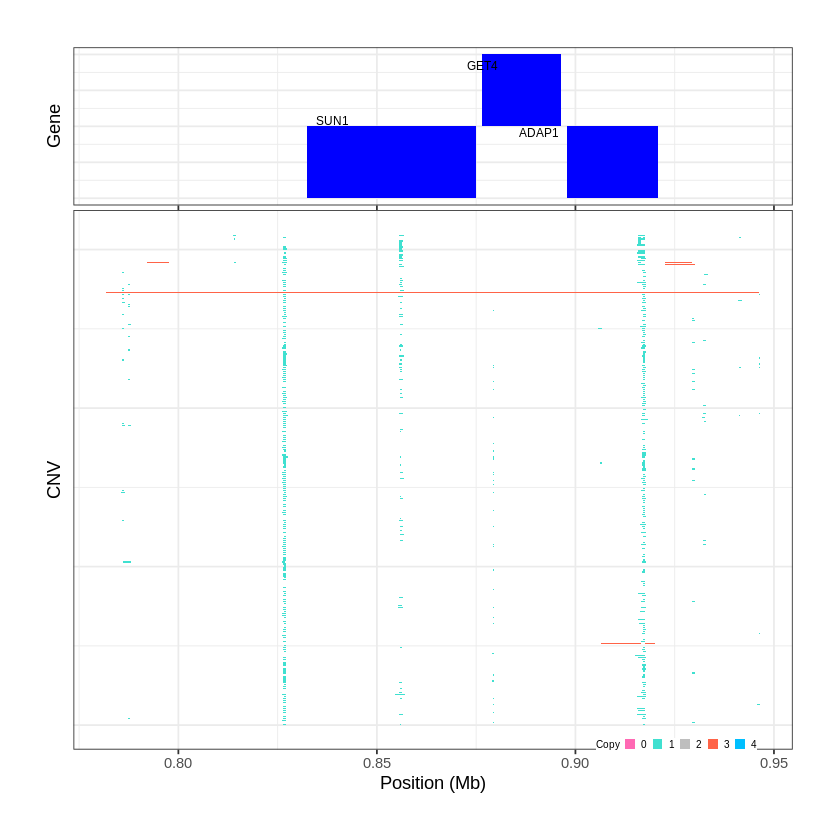

Task done, plot was stored in working directory.
[1] "Ploting CNVR 870..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 1.166901 - 1.3141 Mb with 269 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 871..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 1.545701 - 1.5467 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


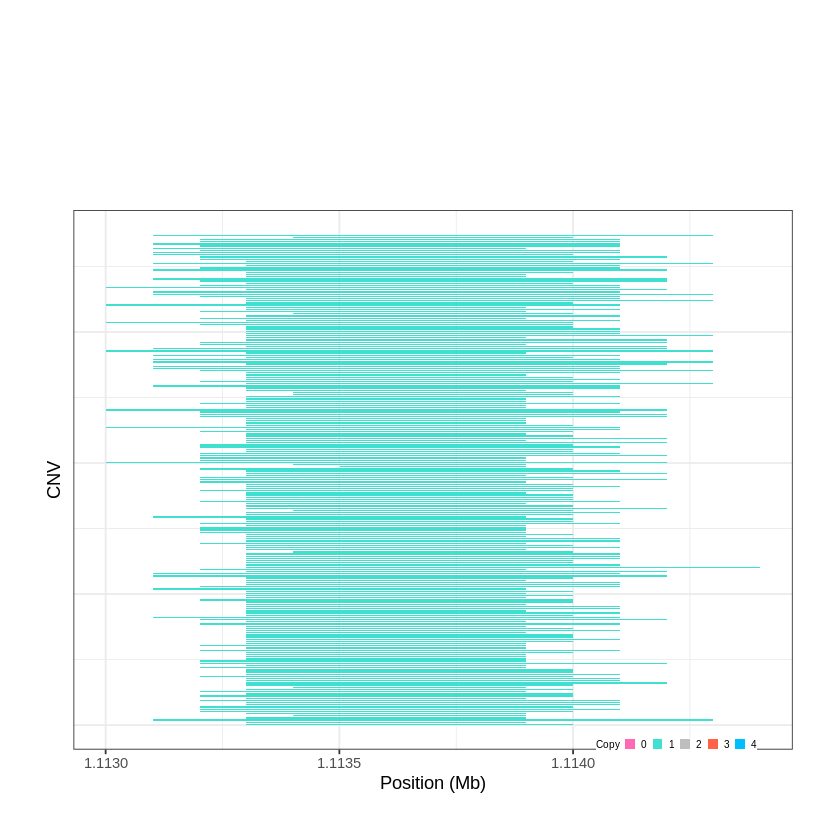

Task done, plot was stored in working directory.
[1] "Ploting CNVR 872..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 1.645801 - 1.6475 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


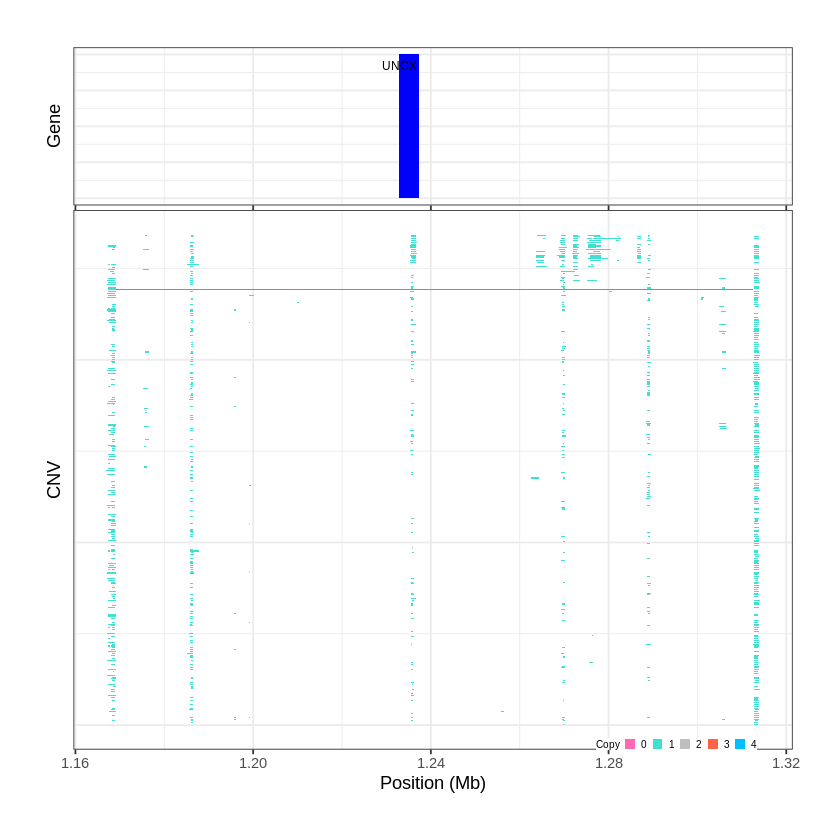

Task done, plot was stored in working directory.
[1] "Ploting CNVR 873..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 1.915201 - 2.0317 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


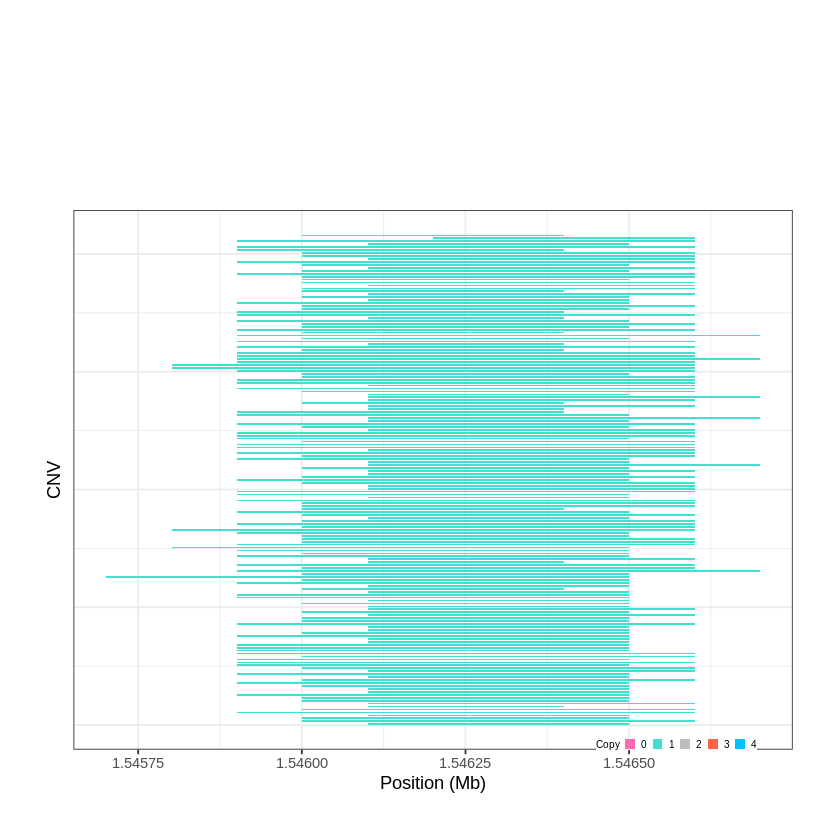

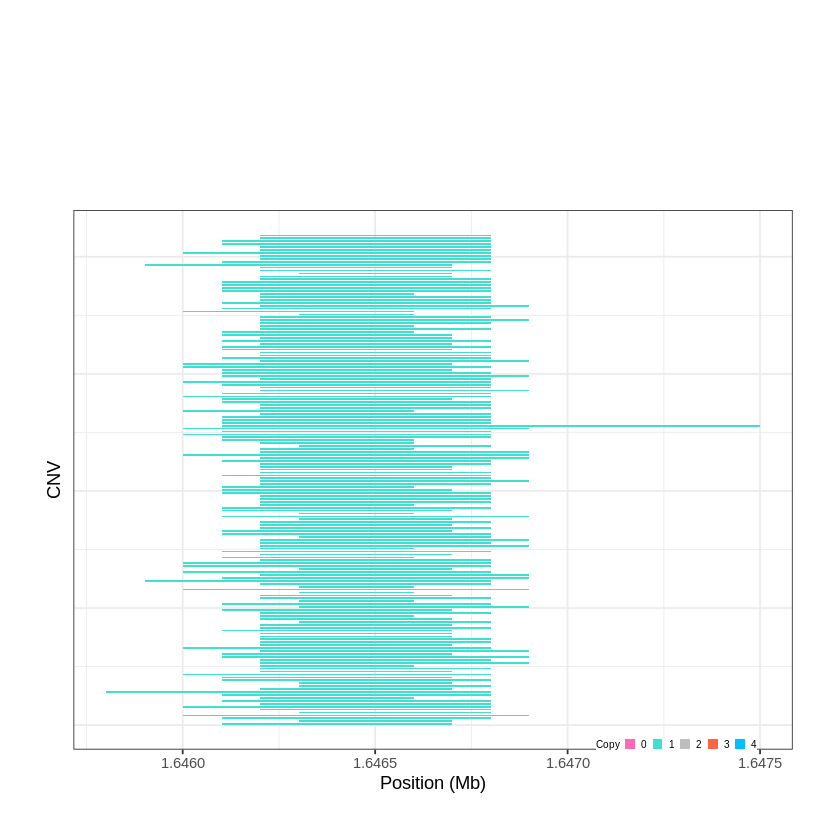

Task done, plot was stored in working directory.
[1] "Ploting CNVR 874..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 3.917201 - 4.6417 Mb with 275 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 875..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 4.997801 - 5.0018 Mb with 239 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


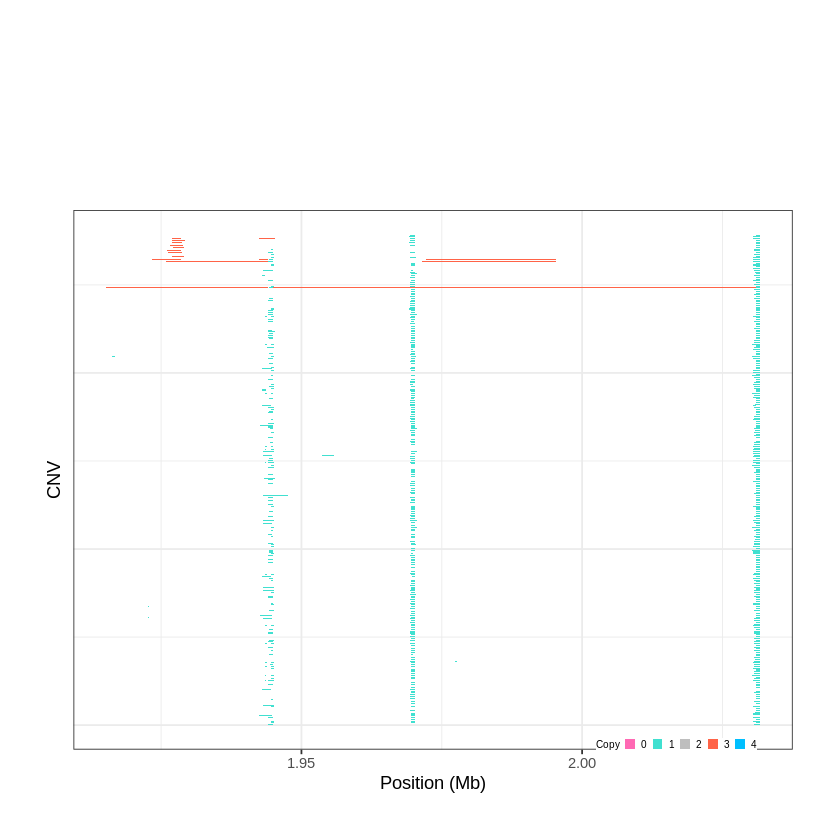

Task done, plot was stored in working directory.
[1] "Ploting CNVR 876..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 5.319401 - 5.3242 Mb with 231 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


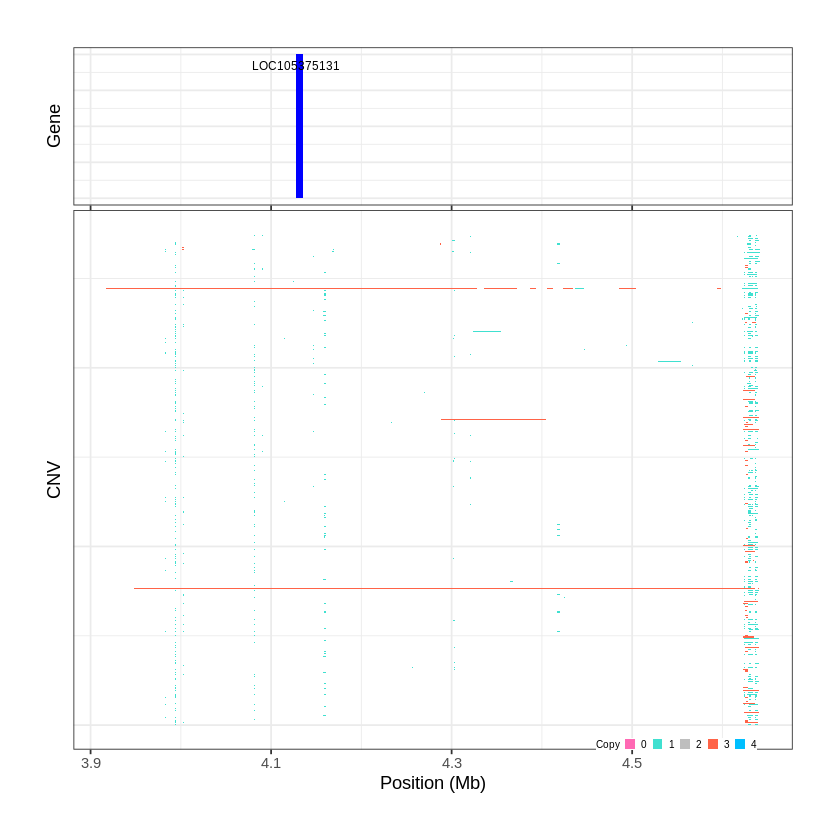

Task done, plot was stored in working directory.
[1] "Ploting CNVR 877..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 5.335601 - 5.3437 Mb with 172 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


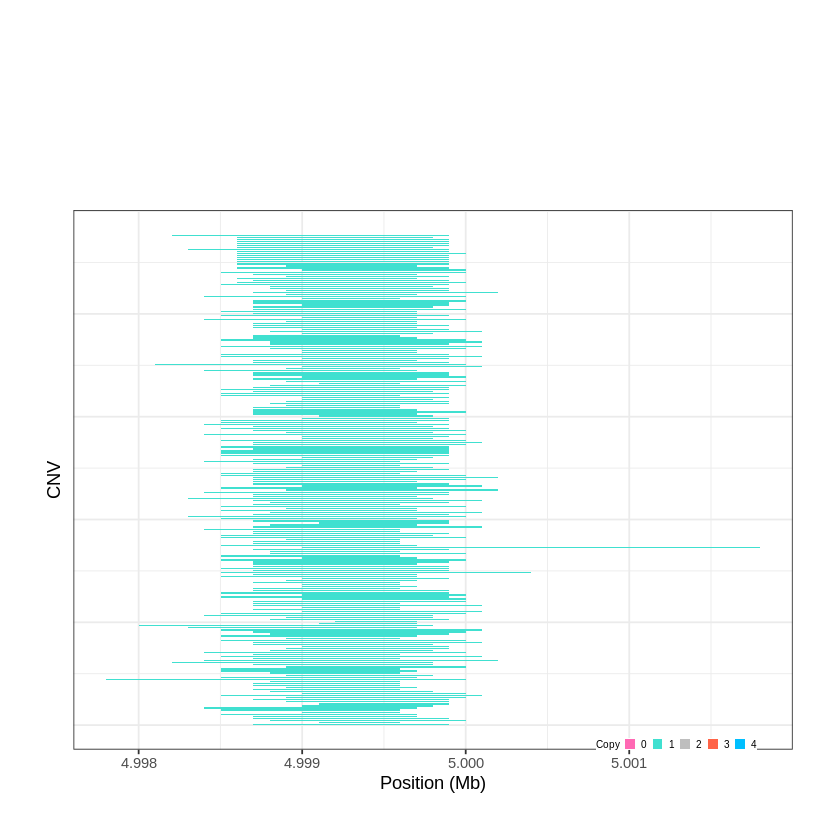

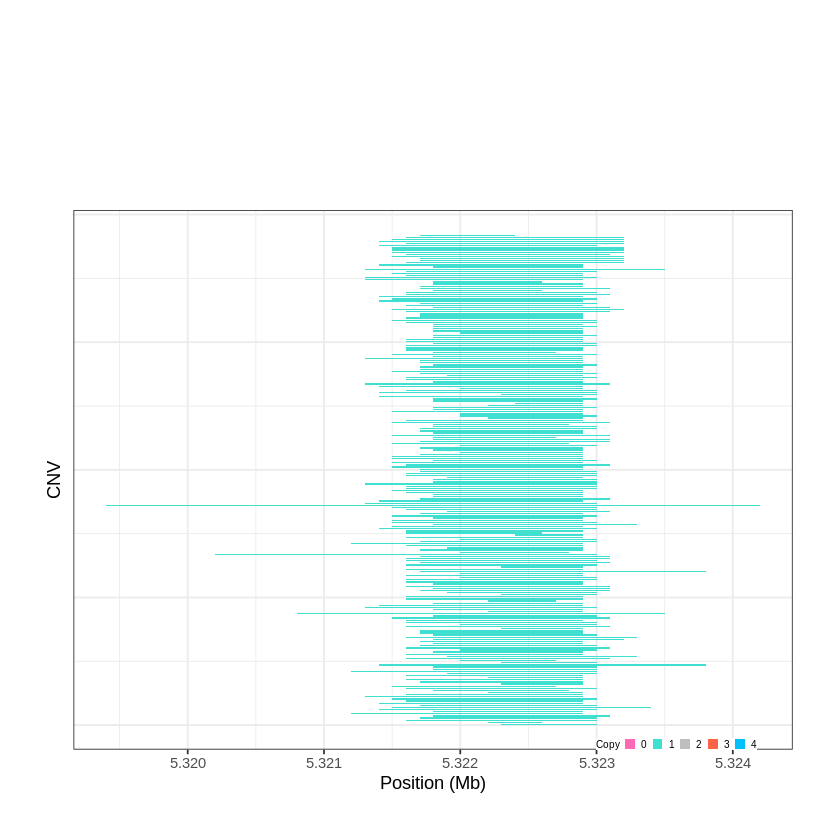

Task done, plot was stored in working directory.
[1] "Ploting CNVR 878..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 5.915501 - 5.9898 Mb with 240 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 879..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 5.999201 - 6.007 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


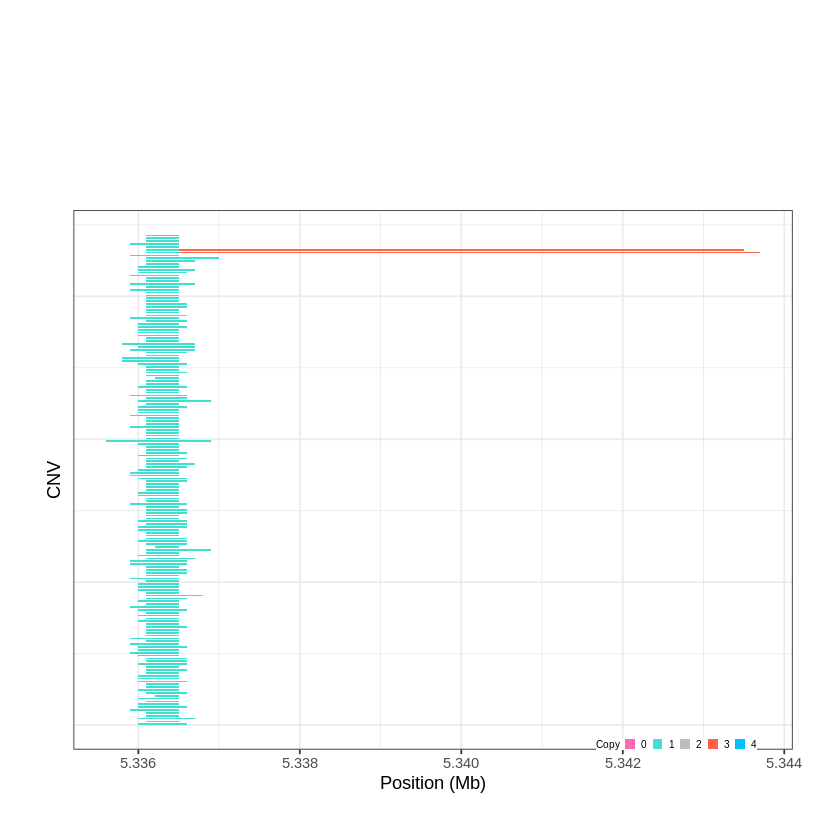

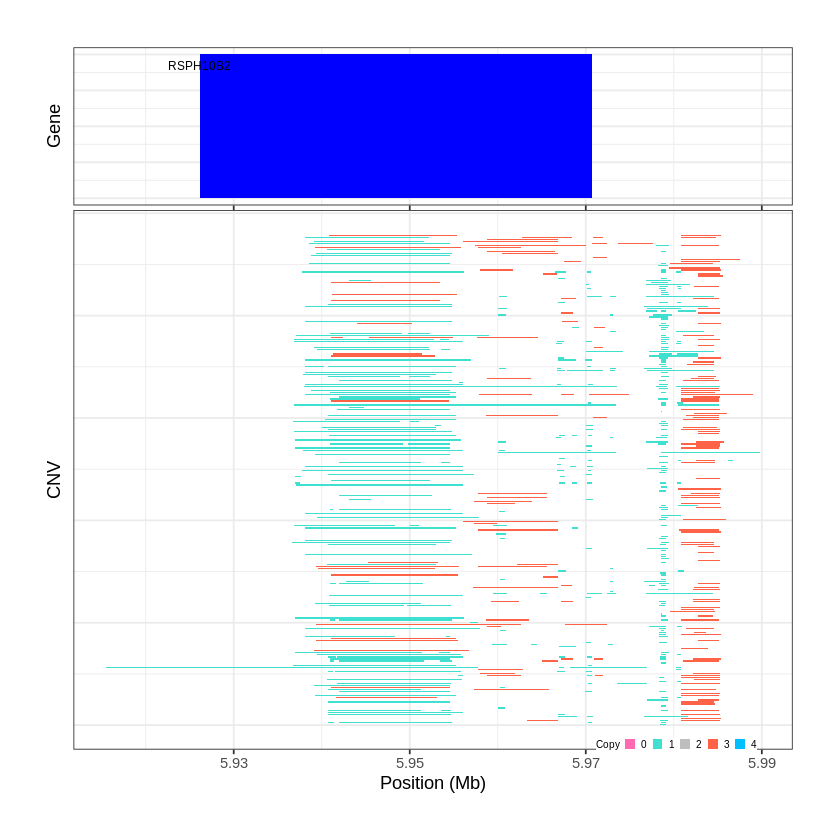

Task done, plot was stored in working directory.
[1] "Ploting CNVR 880..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 6.008001 - 6.0589 Mb with 140 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 881..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 6.742201 - 6.7426 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


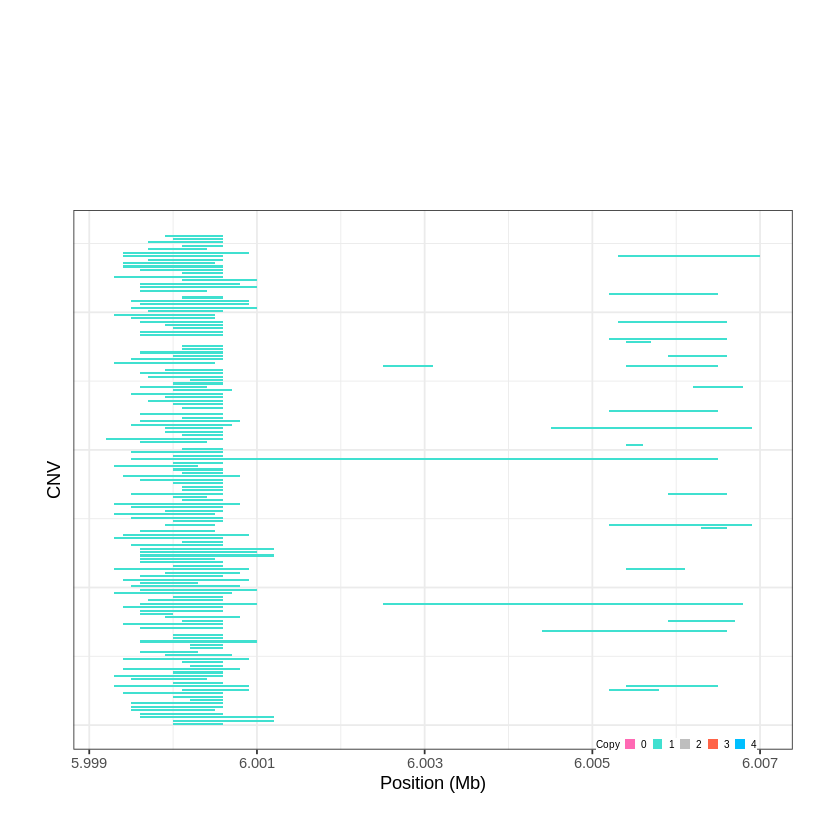

Task done, plot was stored in working directory.
[1] "Ploting CNVR 882..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 6.817901 - 6.834 Mb with 190 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


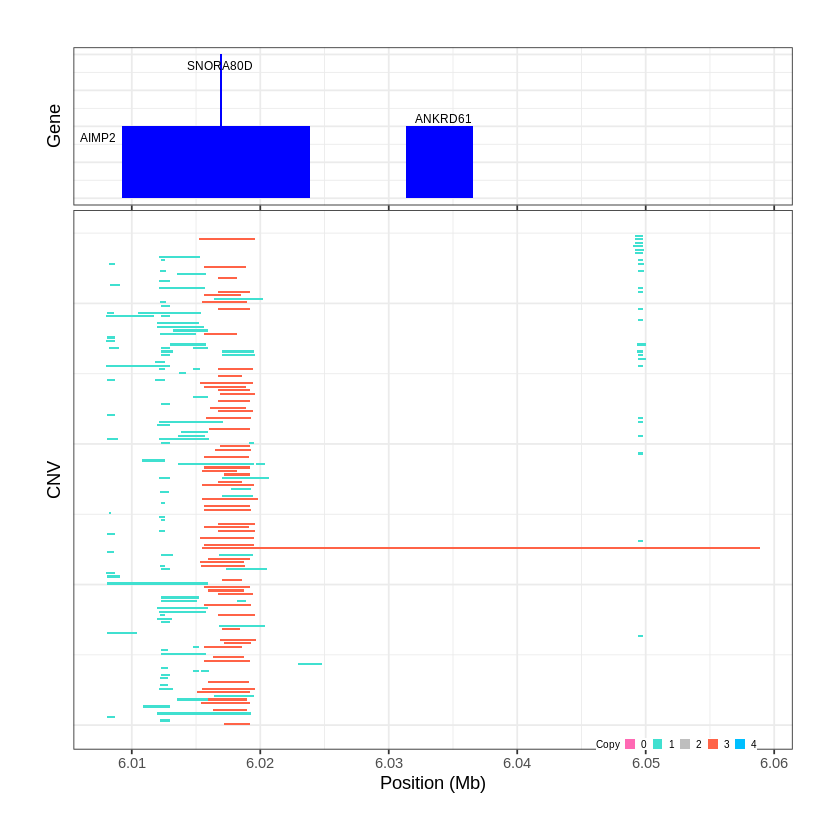

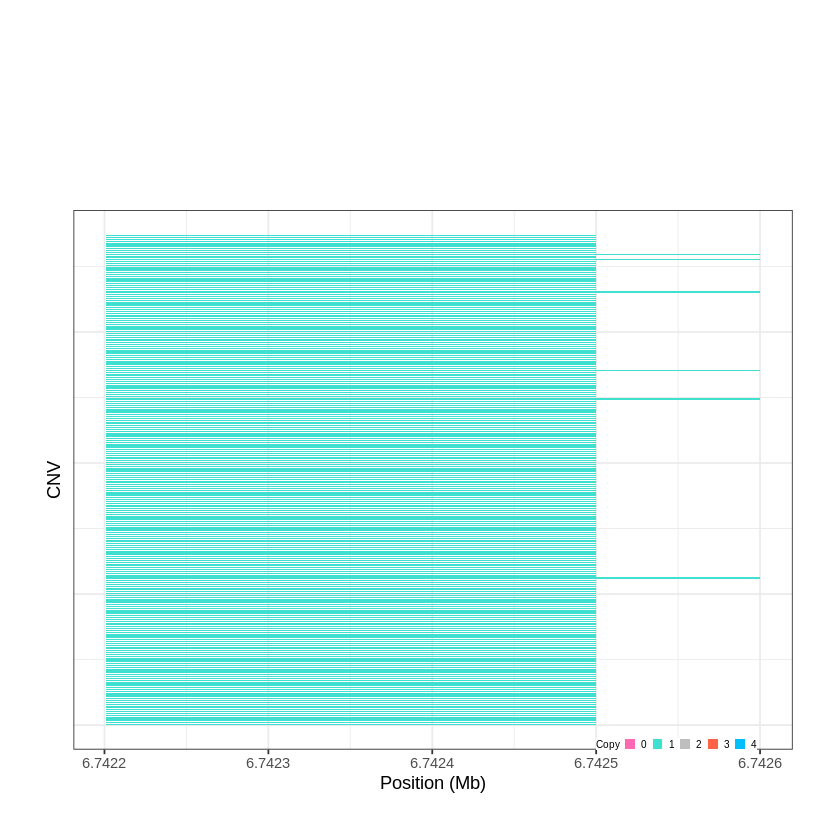

Task done, plot was stored in working directory.
[1] "Ploting CNVR 883..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 6.834901 - 7.1964 Mb with 240 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 884..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 7.583501 - 7.6107 Mb with 170 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


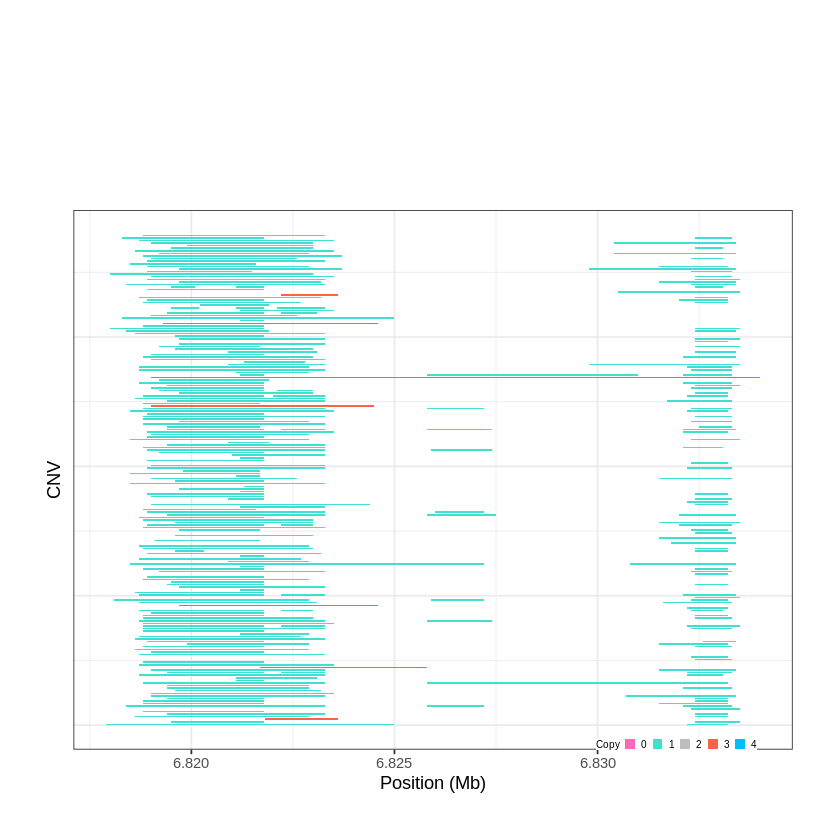

Task done, plot was stored in working directory.
[1] "Ploting CNVR 885..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 7.689301 - 7.7198 Mb with 247 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


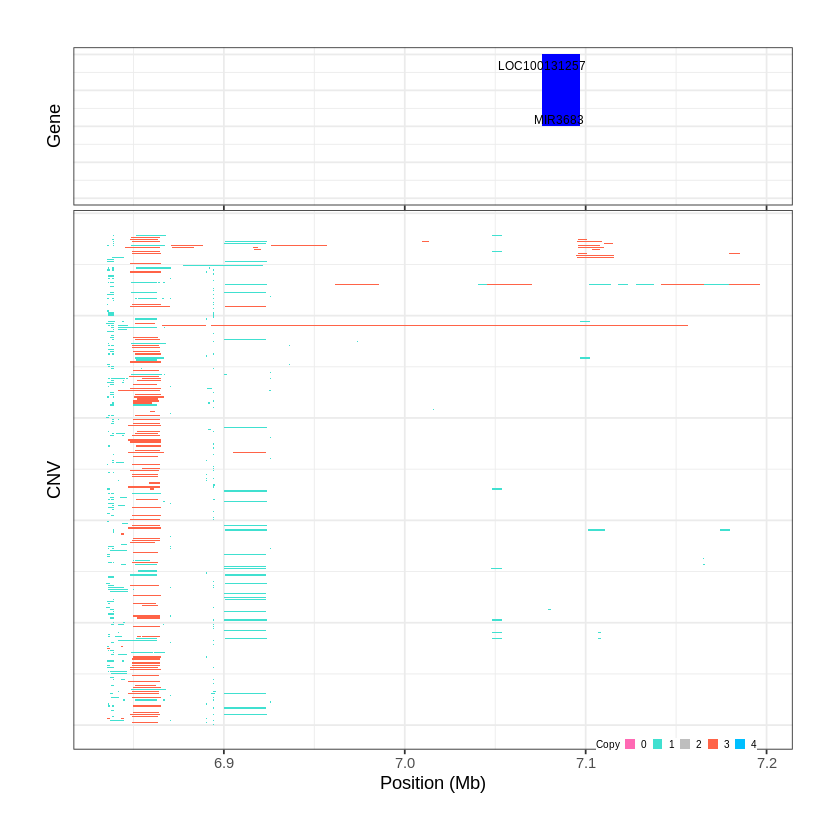

Task done, plot was stored in working directory.
[1] "Ploting CNVR 886..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 14.896501 - 14.9151 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


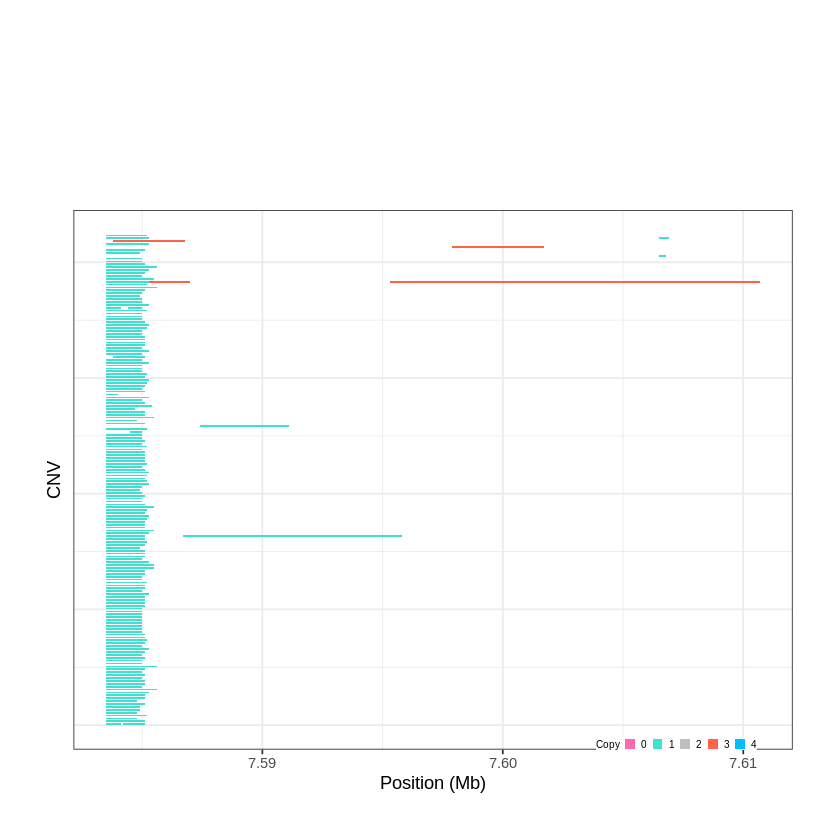

Task done, plot was stored in working directory.
[1] "Ploting CNVR 887..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 16.145101 - 16.1762 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


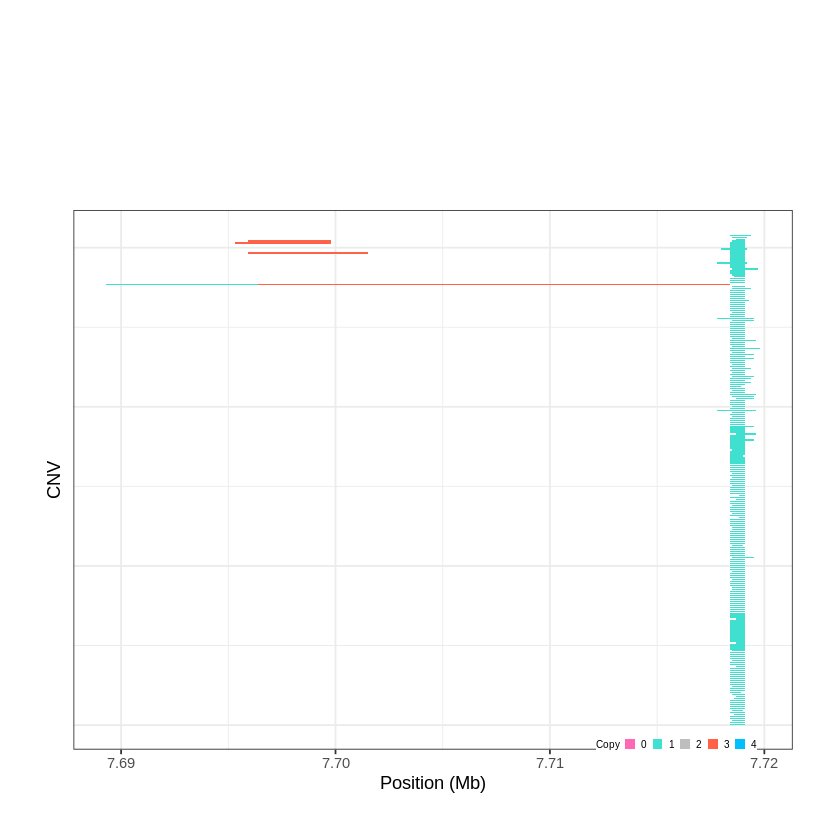

Task done, plot was stored in working directory.
[1] "Ploting CNVR 888..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 16.806401 - 16.8336 Mb with 197 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


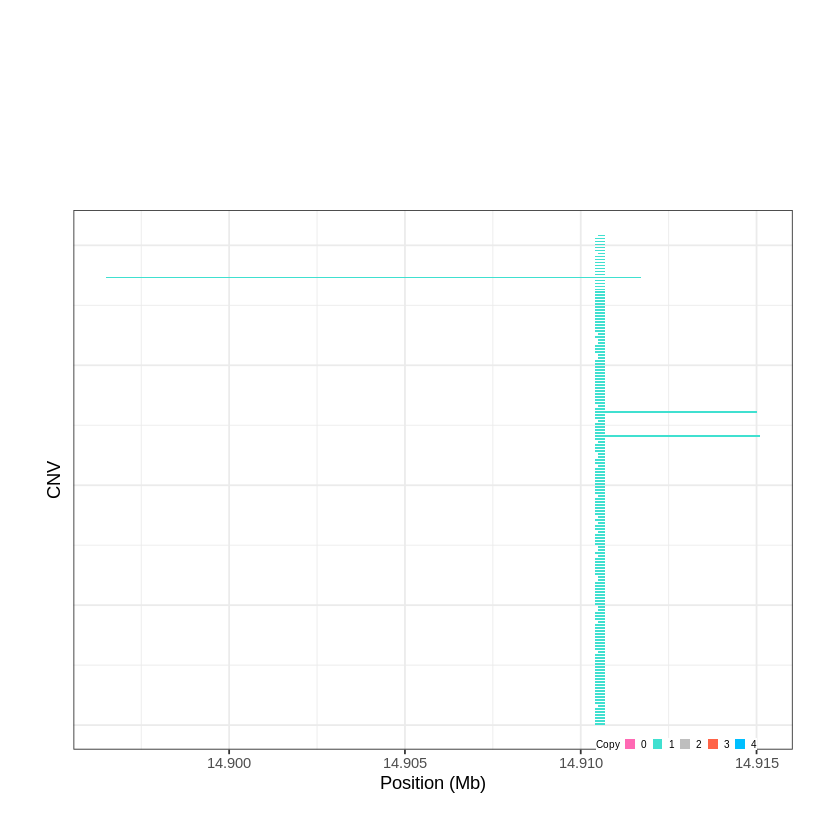

Task done, plot was stored in working directory.
[1] "Ploting CNVR 889..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 16.928801 - 16.9366 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


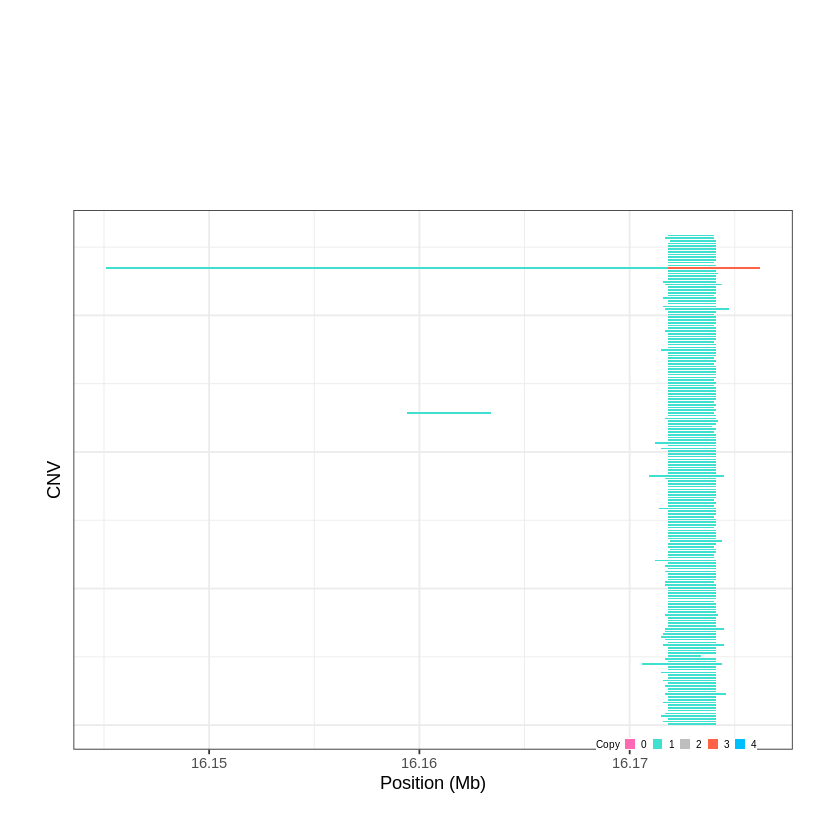

Task done, plot was stored in working directory.
[1] "Ploting CNVR 890..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 22.429701 - 22.4434 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


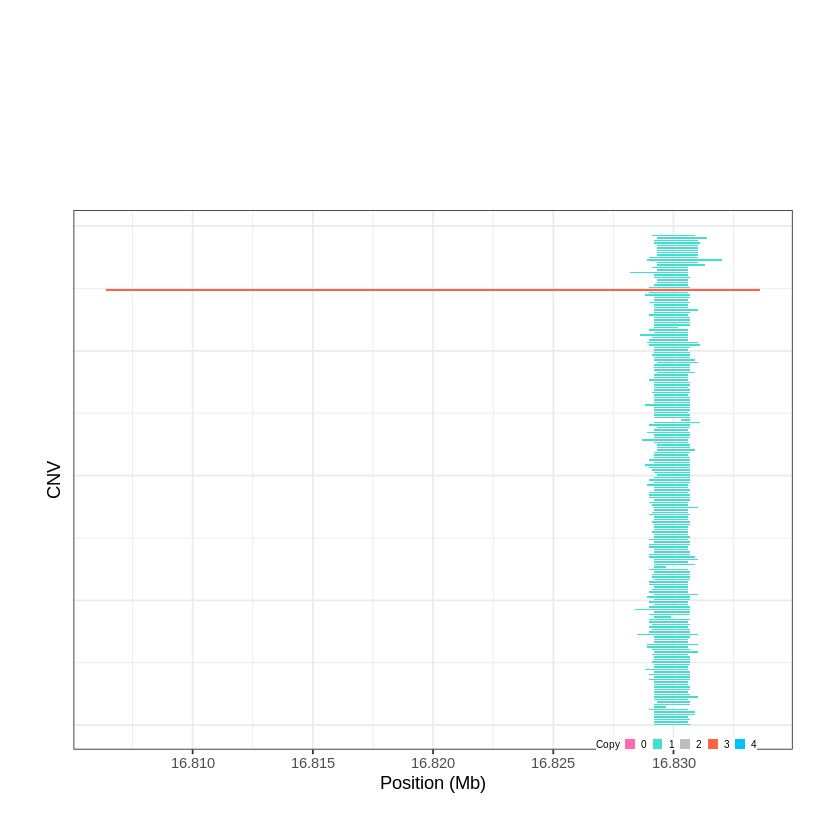

Task done, plot was stored in working directory.
[1] "Ploting CNVR 891..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 24.030601 - 24.0509 Mb with 247 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


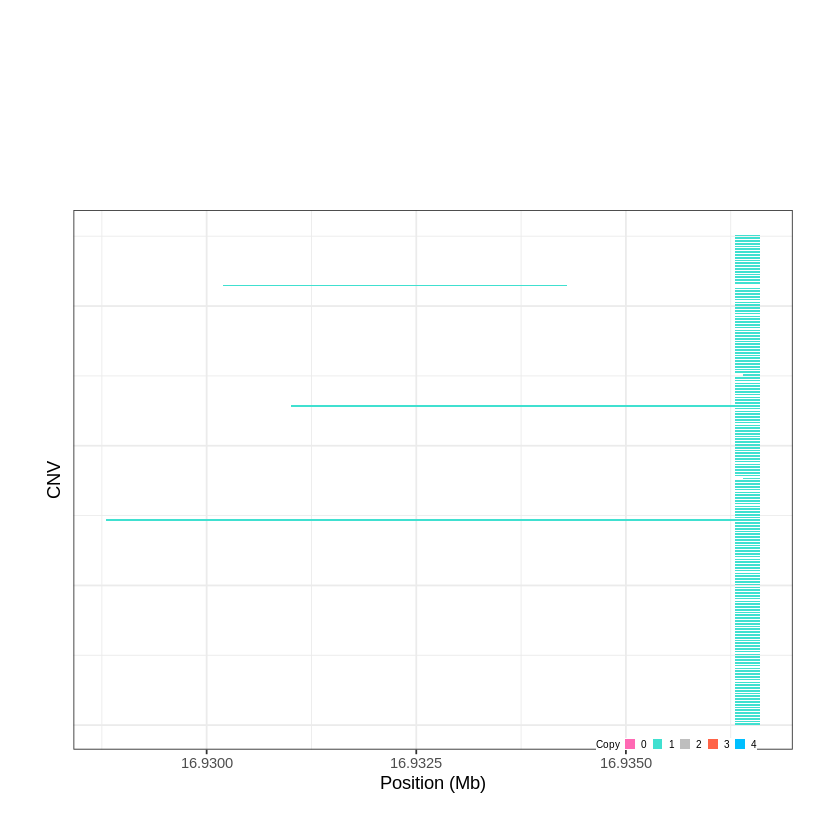

Task done, plot was stored in working directory.
[1] "Ploting CNVR 892..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 25.036101 - 25.0603 Mb with 231 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


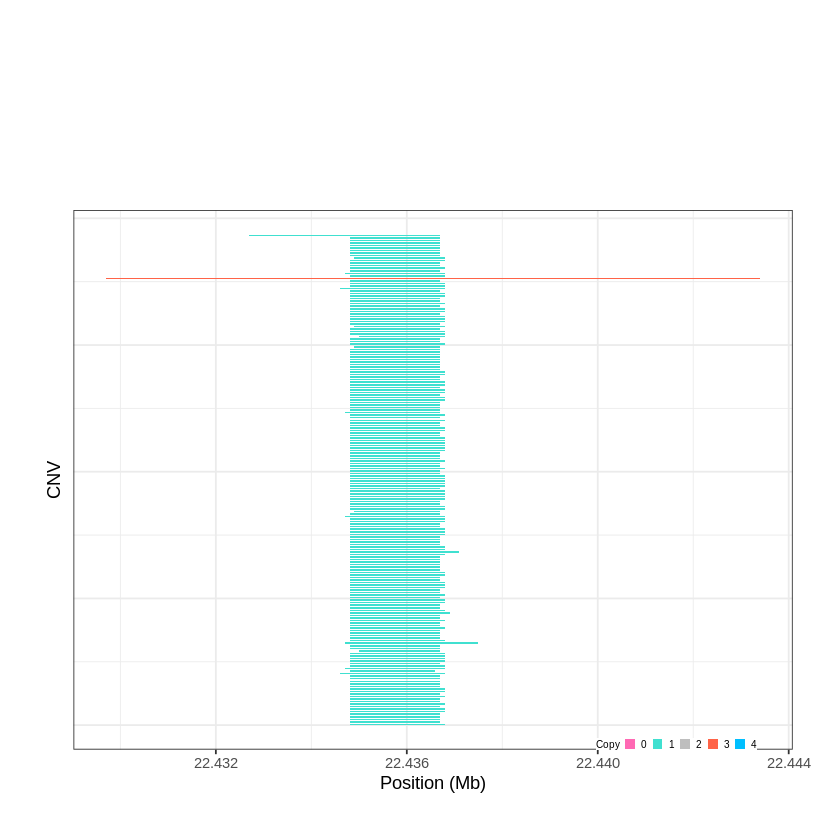

Task done, plot was stored in working directory.
[1] "Ploting CNVR 893..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 28.217301 - 28.2287 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


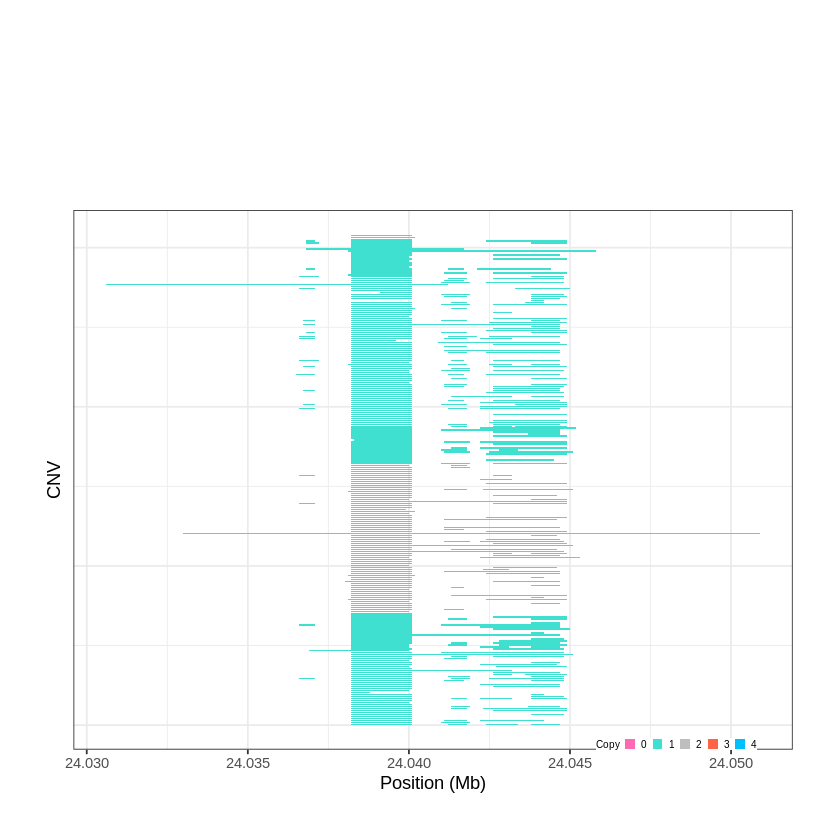

Task done, plot was stored in working directory.
[1] "Ploting CNVR 894..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 31.313601 - 31.3235 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


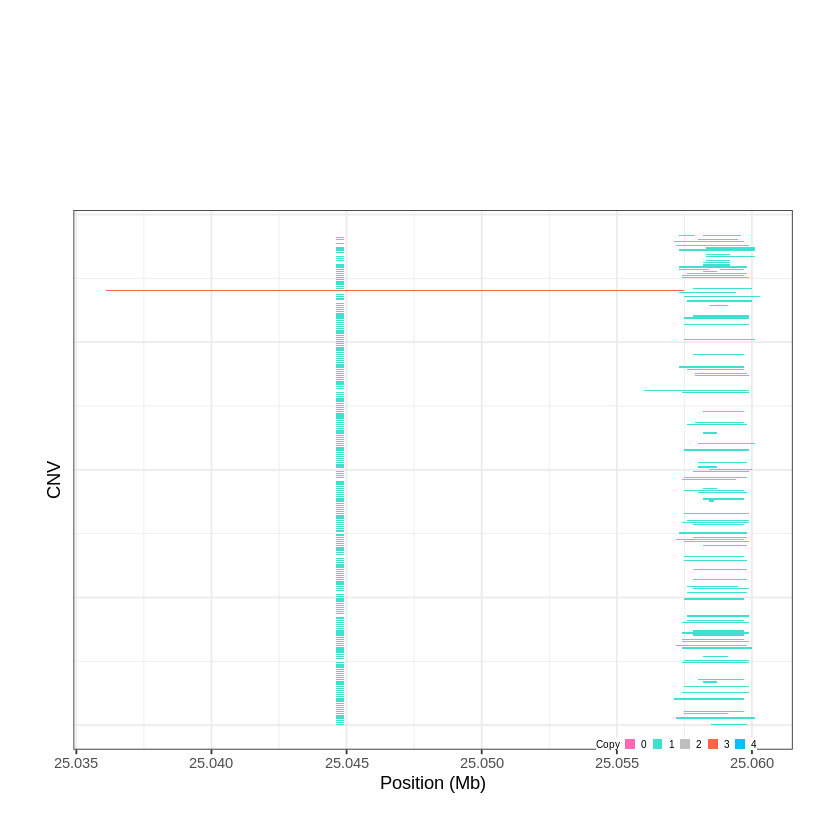

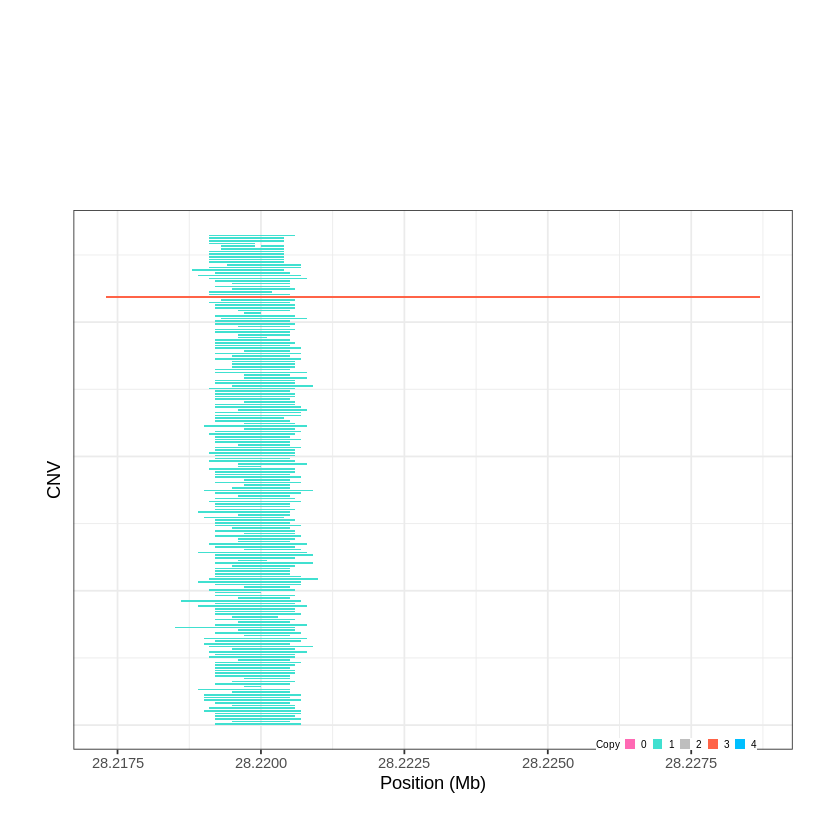

Task done, plot was stored in working directory.
[1] "Ploting CNVR 895..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 32.556901 - 32.805 Mb with 164 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 896..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 34.803701 - 34.8435 Mb with 275 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


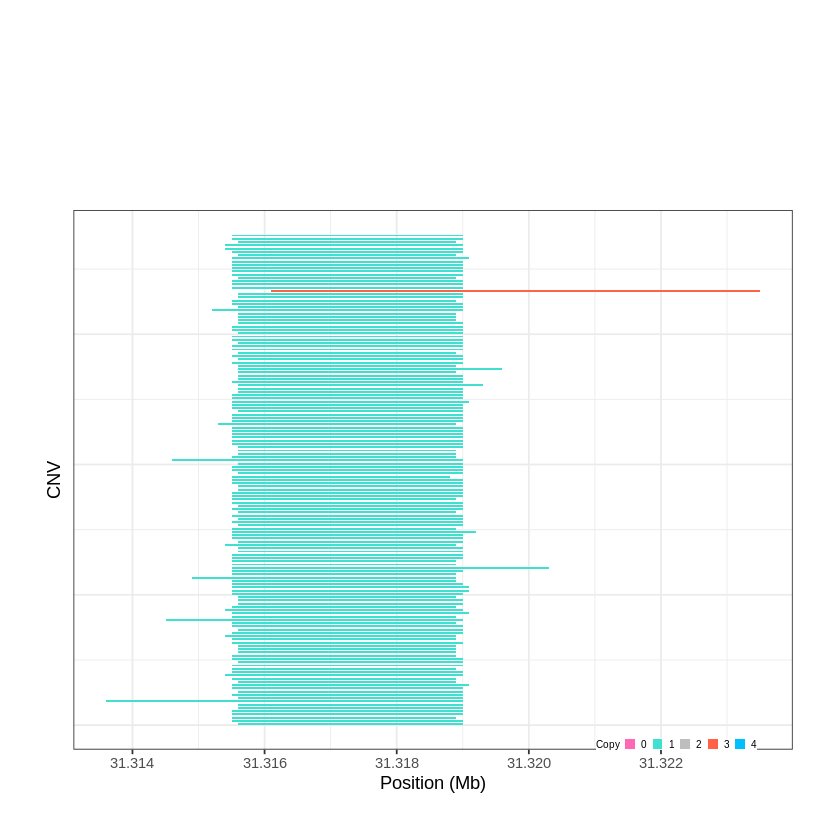

Task done, plot was stored in working directory.
[1] "Ploting CNVR 897..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 34.853801 - 34.8759 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


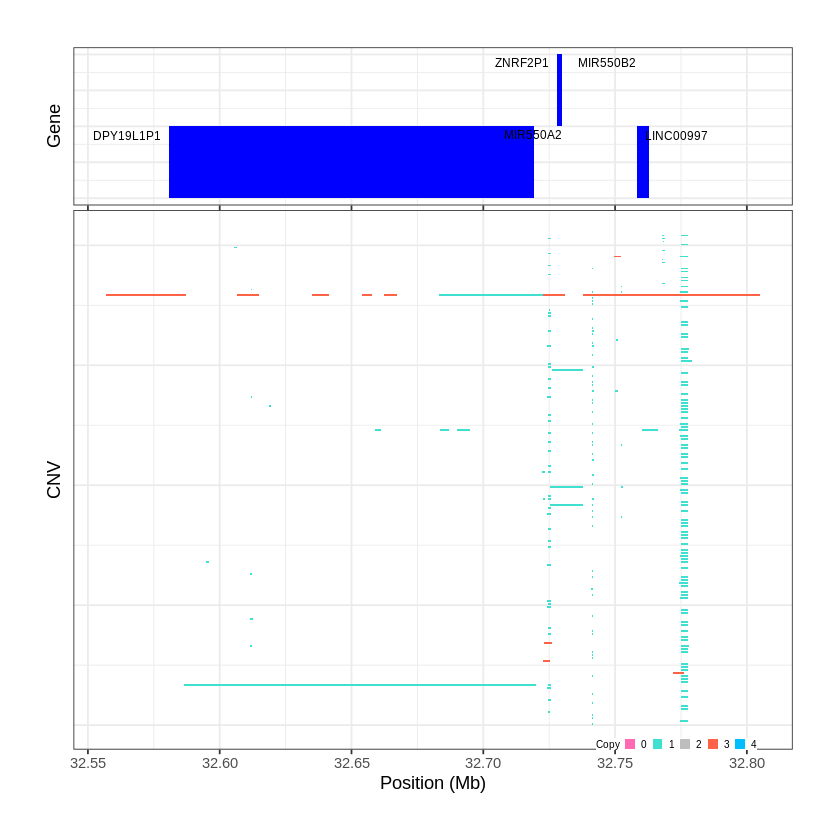

Task done, plot was stored in working directory.
[1] "Ploting CNVR 898..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 37.331101 - 37.3349 Mb with 268 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


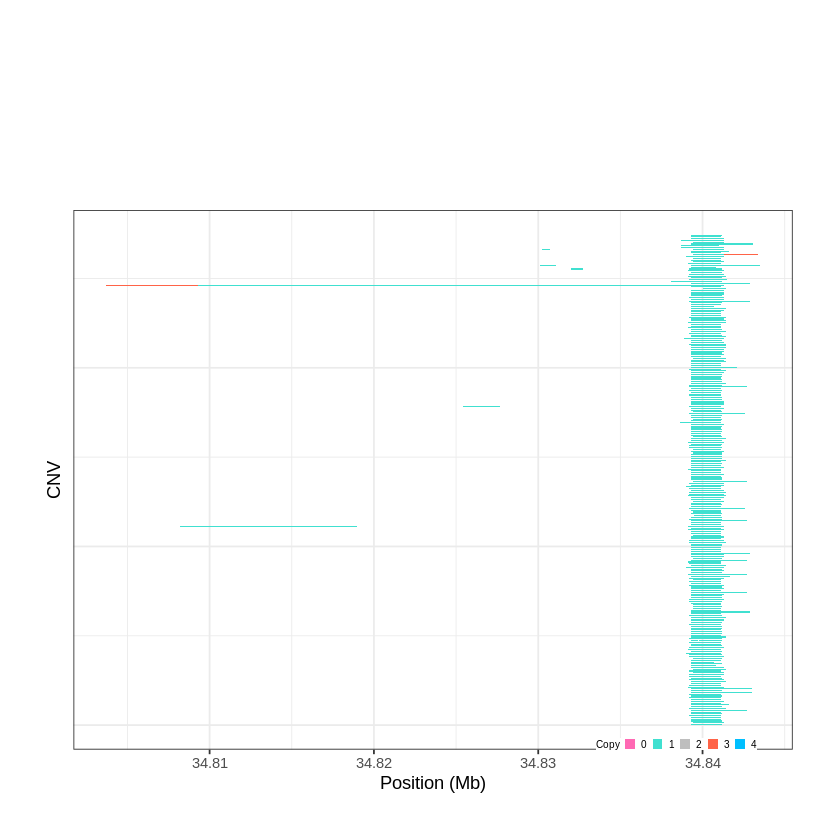

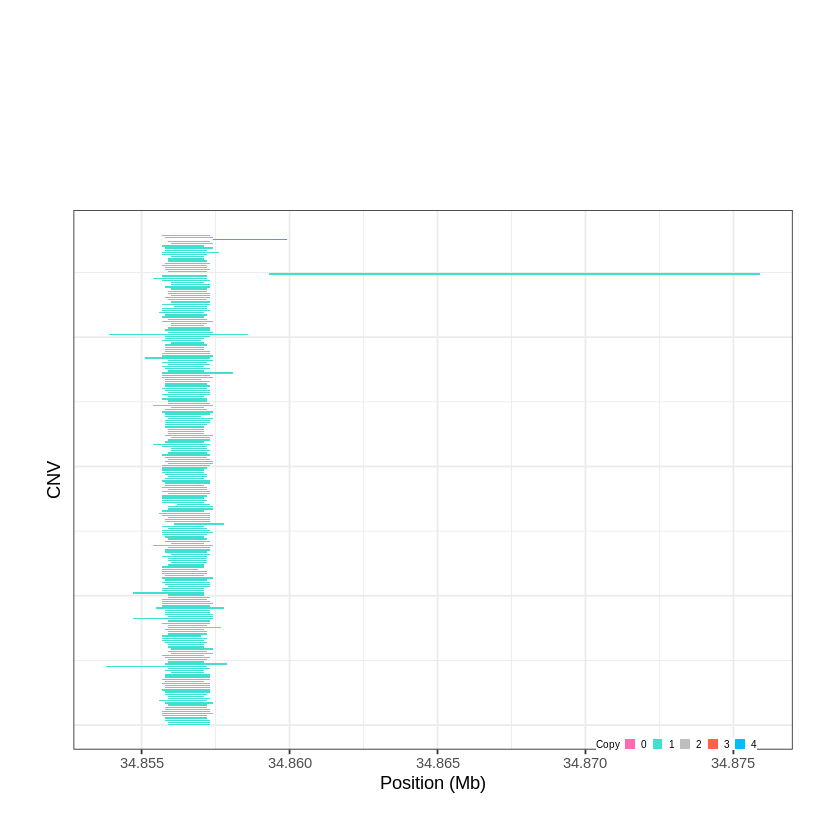

Task done, plot was stored in working directory.
[1] "Ploting CNVR 899..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 38.266901 - 38.4496 Mb with 199 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 900..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 42.531201 - 42.5582 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


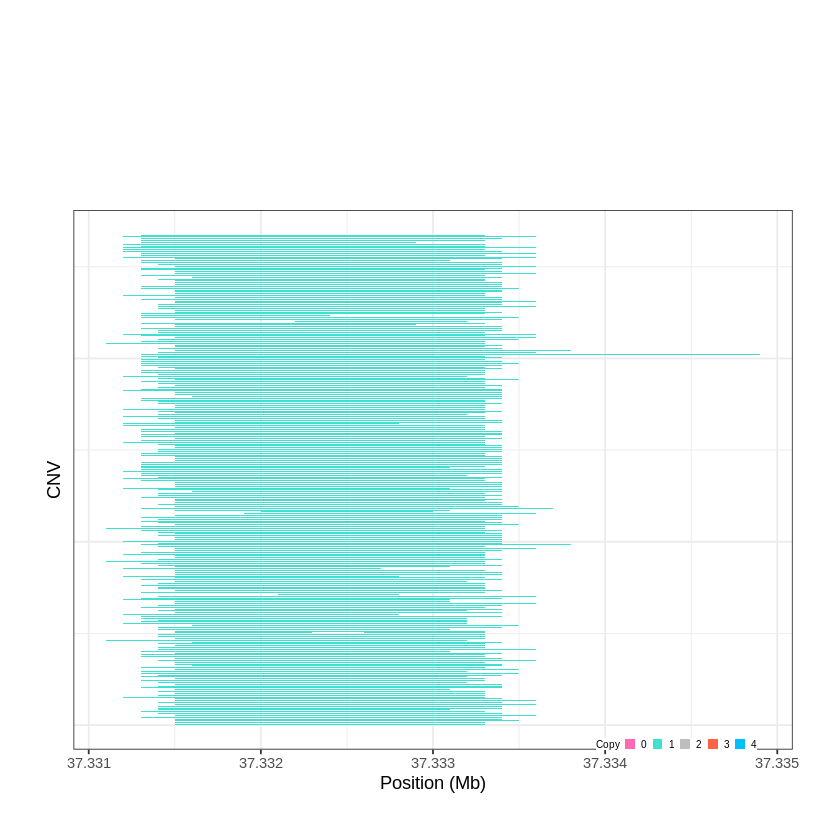

Task done, plot was stored in working directory.
[1] "Ploting CNVR 901..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 44.237801 - 44.387 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


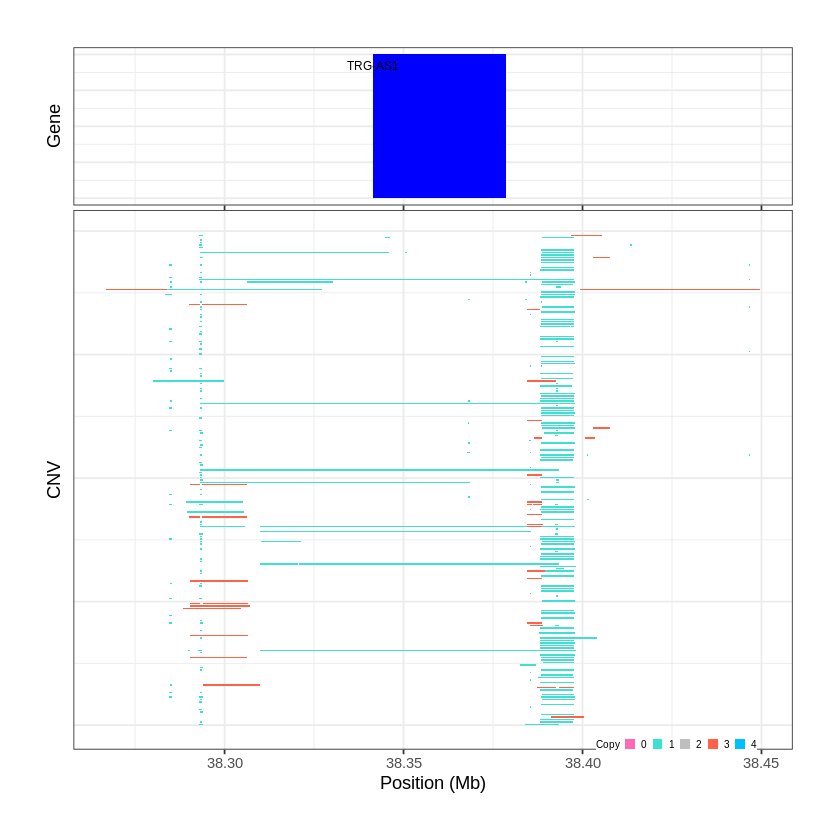

Task done, plot was stored in working directory.
[1] "Ploting CNVR 902..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 44.962301 - 44.9628 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


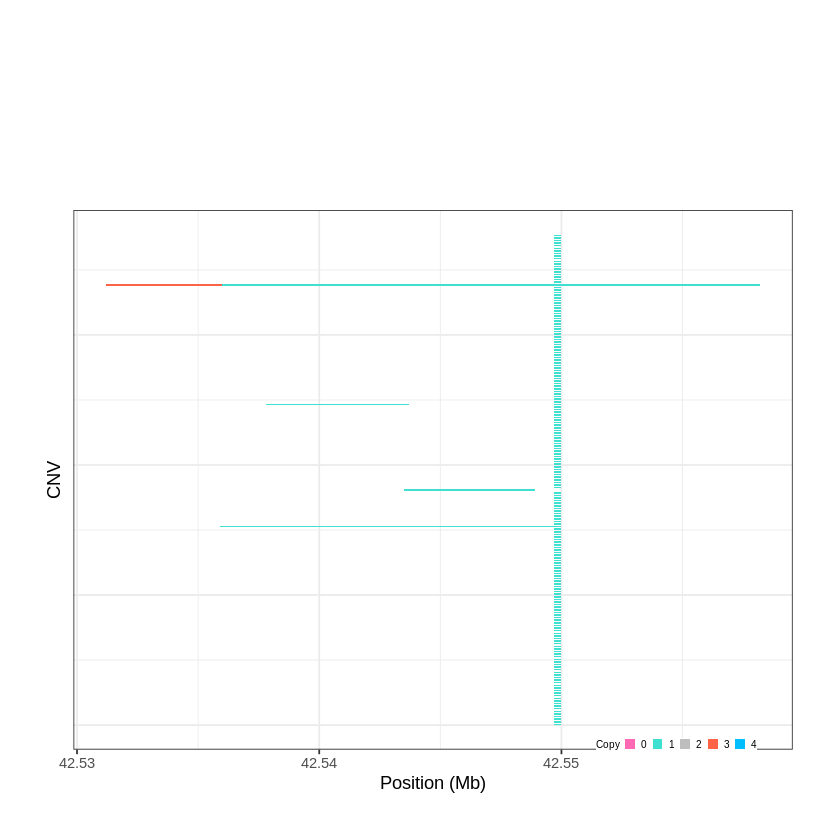

Task done, plot was stored in working directory.
[1] "Ploting CNVR 903..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 44.998101 - 45.0019 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


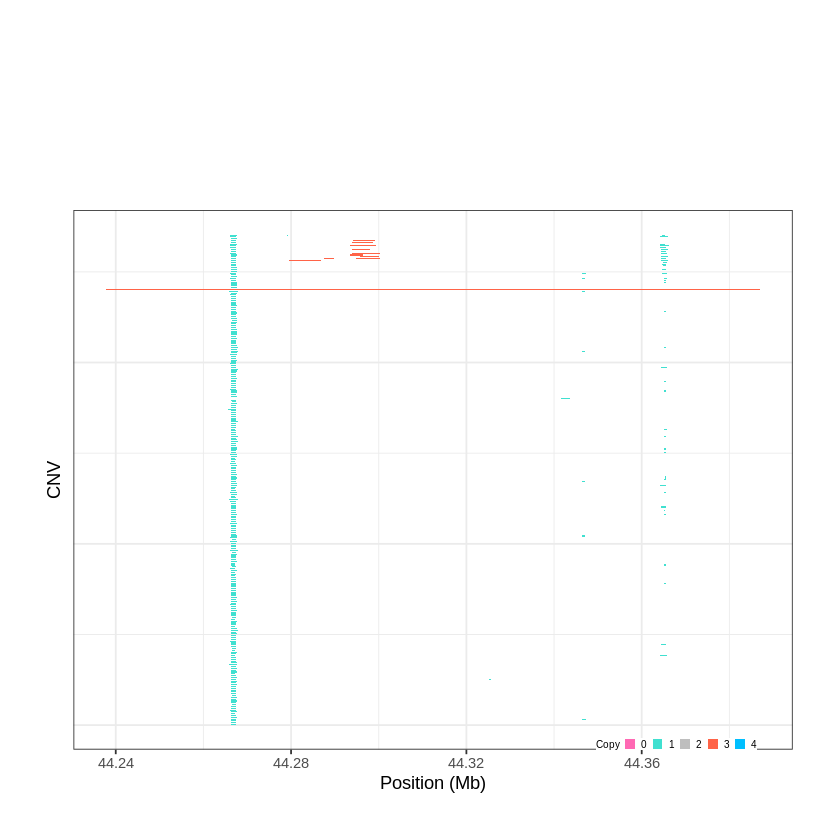

Task done, plot was stored in working directory.
[1] "Ploting CNVR 904..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 48.232701 - 48.234 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


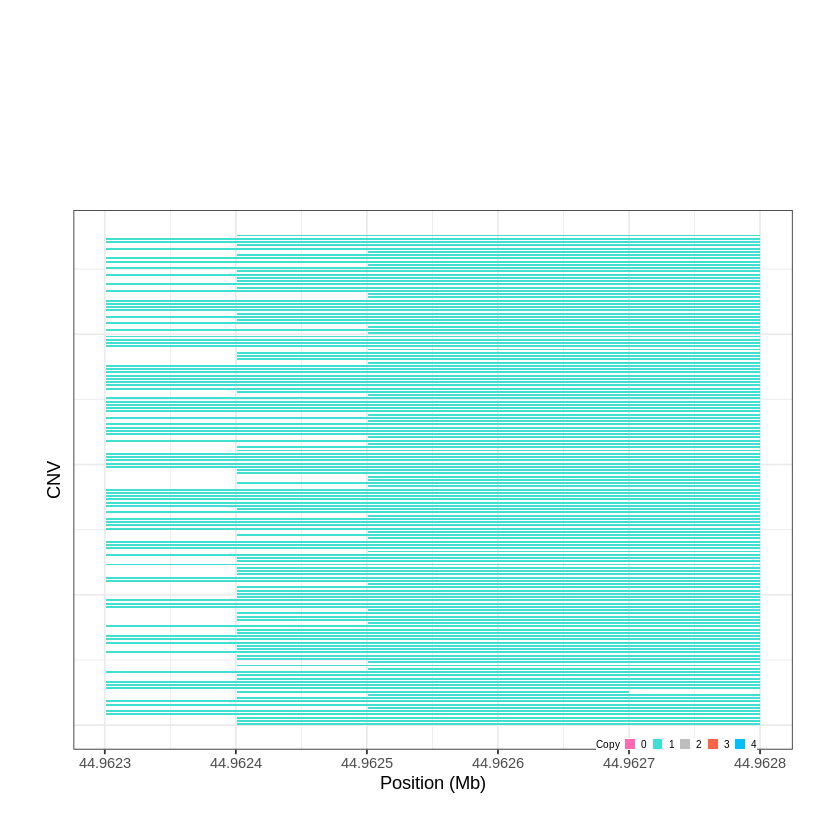

Task done, plot was stored in working directory.
[1] "Ploting CNVR 905..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 50.365301 - 50.4305 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


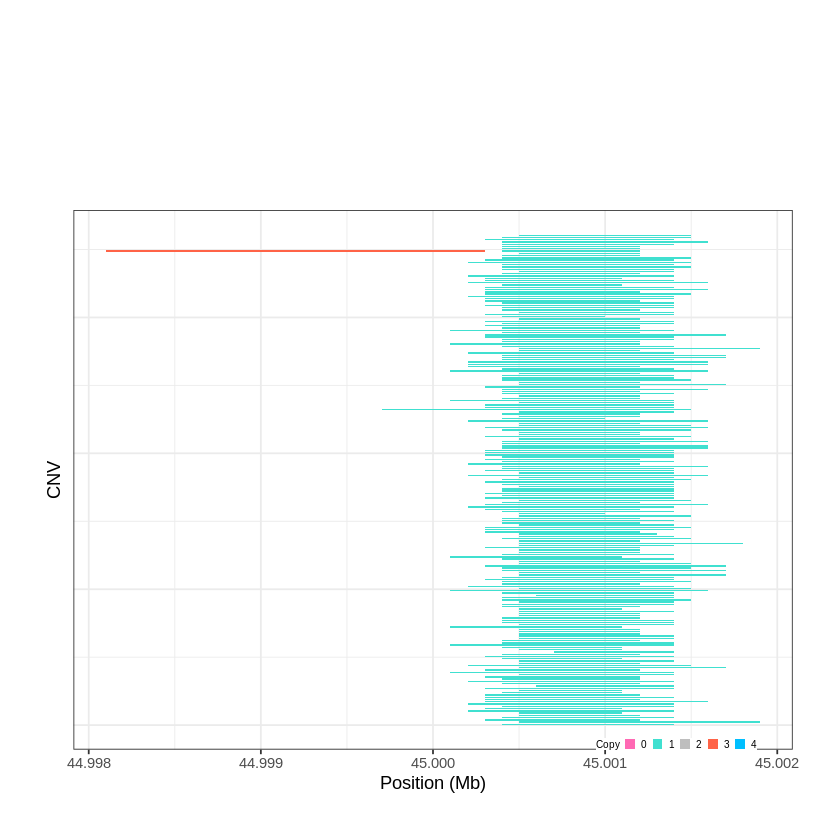

Task done, plot was stored in working directory.
[1] "Ploting CNVR 906..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 51.590601 - 51.6034 Mb with 222 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


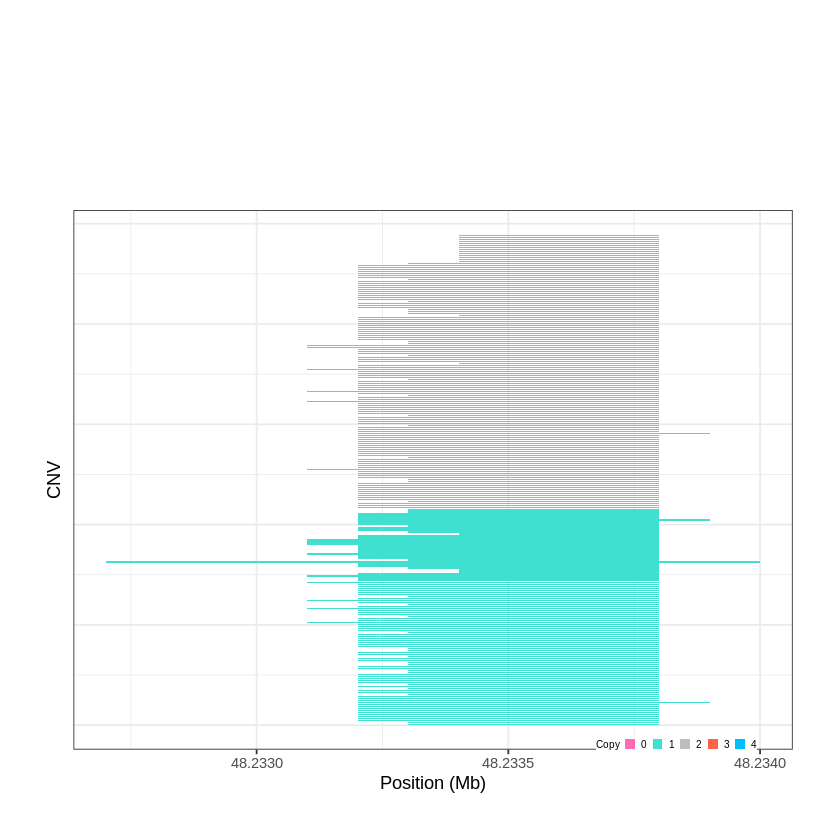

Task done, plot was stored in working directory.
[1] "Ploting CNVR 907..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 52.062801 - 52.1046 Mb with 181 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


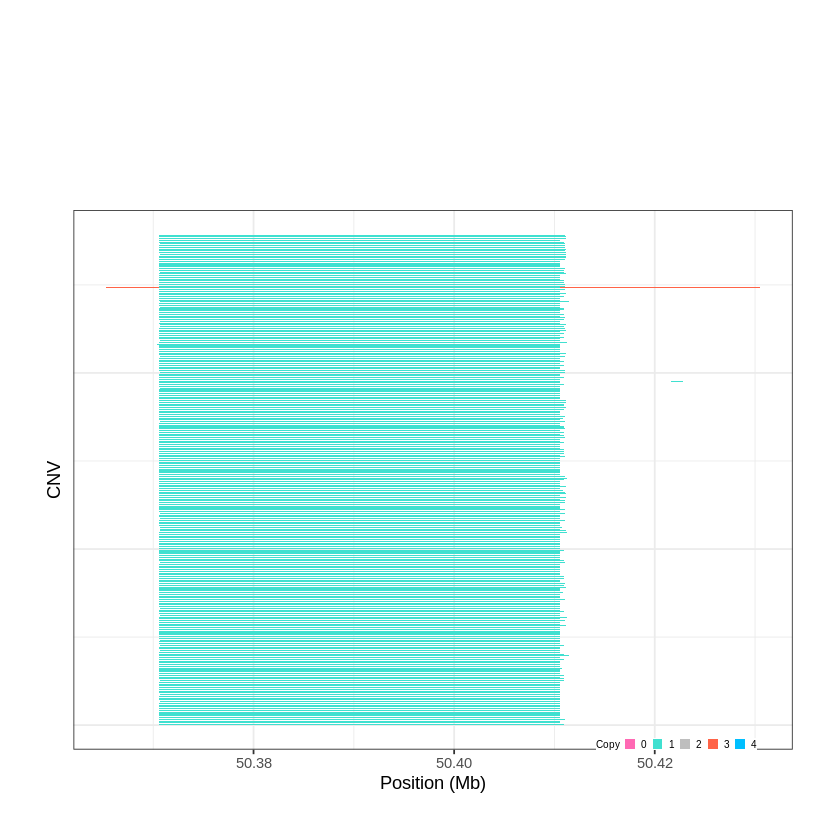

Task done, plot was stored in working directory.
[1] "Ploting CNVR 908..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 53.196001 - 53.1964 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


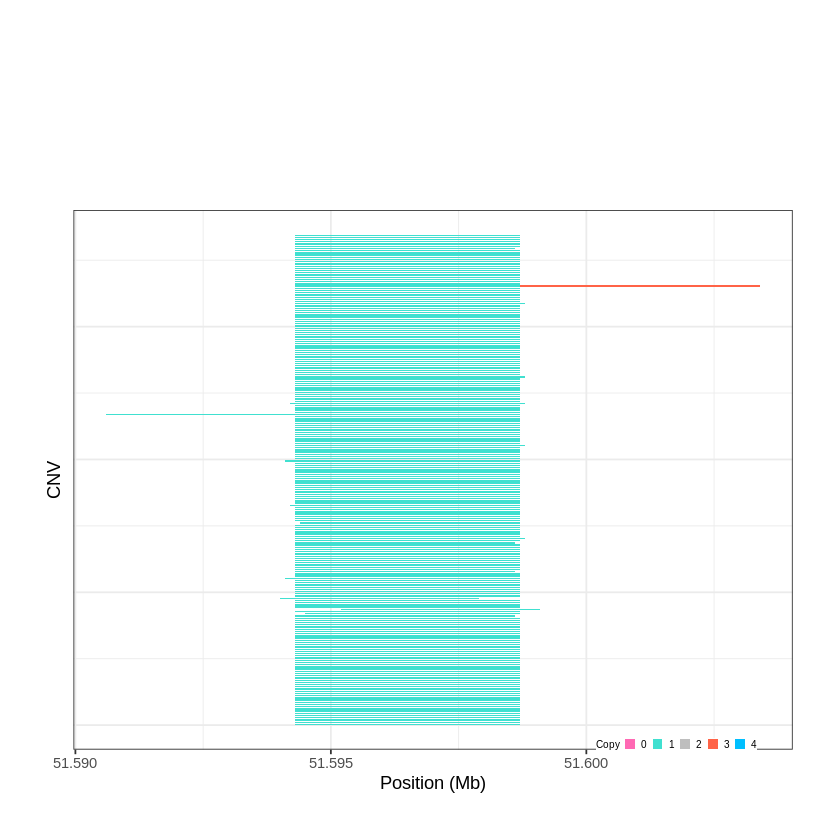

Task done, plot was stored in working directory.
[1] "Ploting CNVR 909..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 54.591901 - 54.6365 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


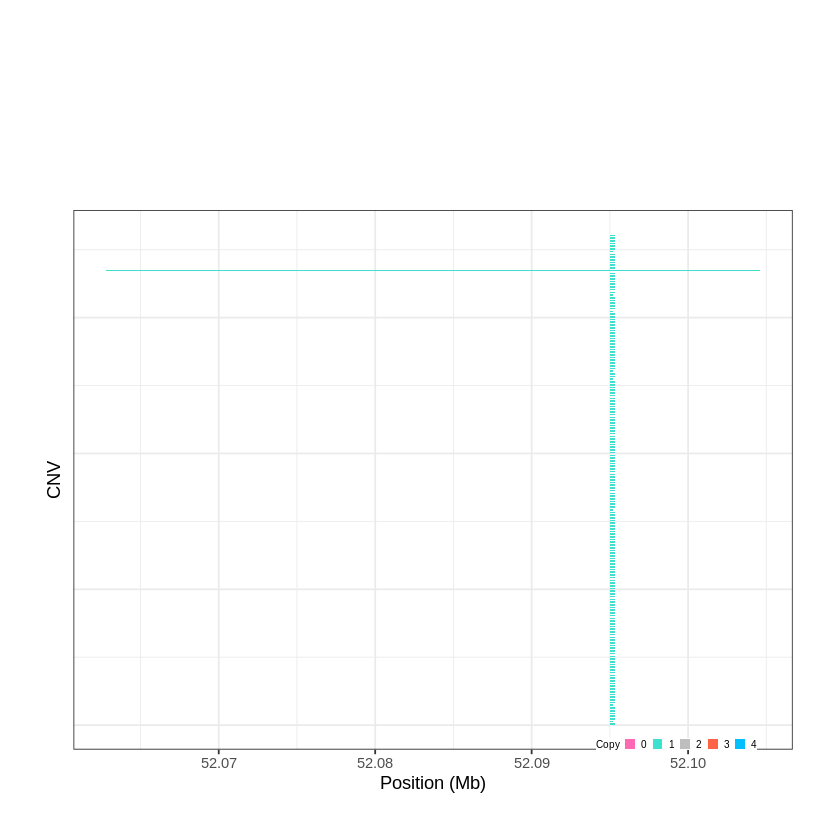

Task done, plot was stored in working directory.
[1] "Ploting CNVR 910..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 56.217001 - 56.2211 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


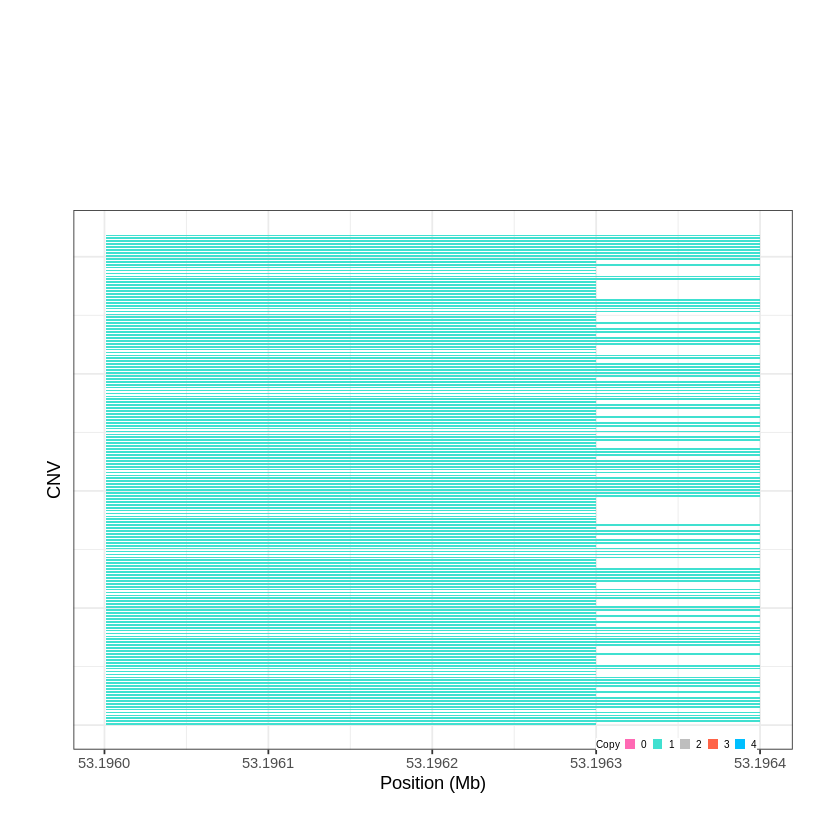

Task done, plot was stored in working directory.
[1] "Ploting CNVR 911..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 56.429901 - 56.4495 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


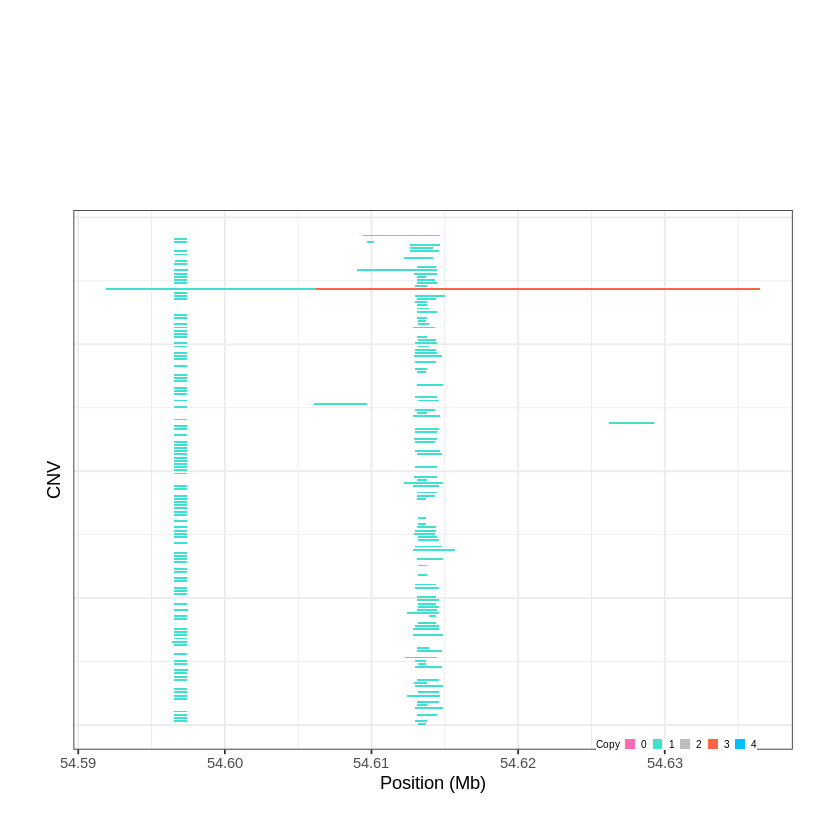

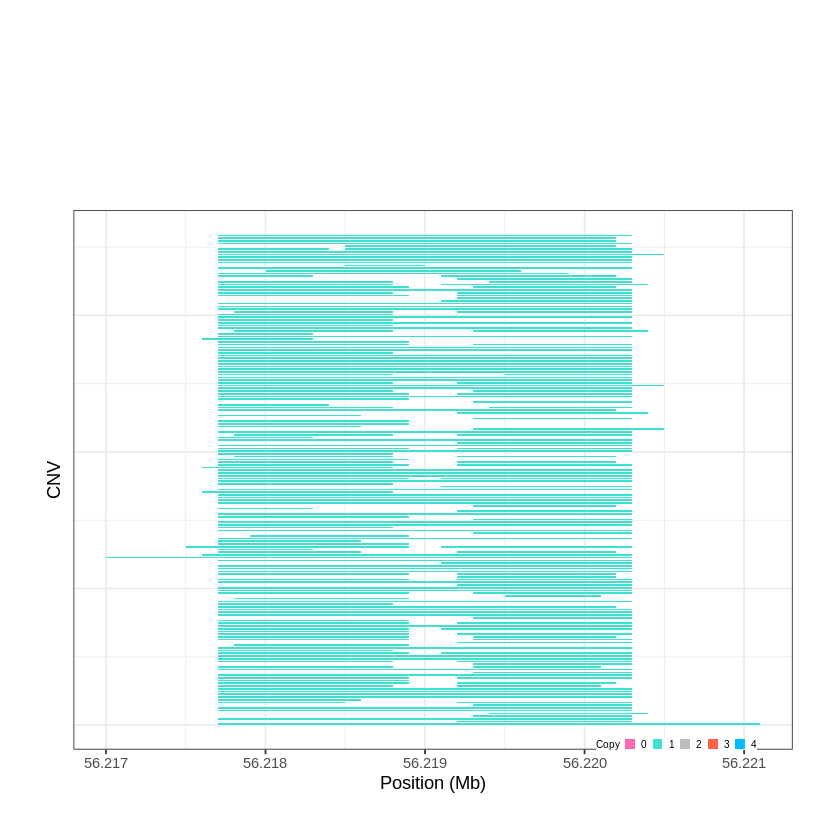

Task done, plot was stored in working directory.
[1] "Ploting CNVR 912..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 56.863701 - 56.9113 Mb with 261 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 913..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 57.009001 - 57.0265 Mb with 243 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


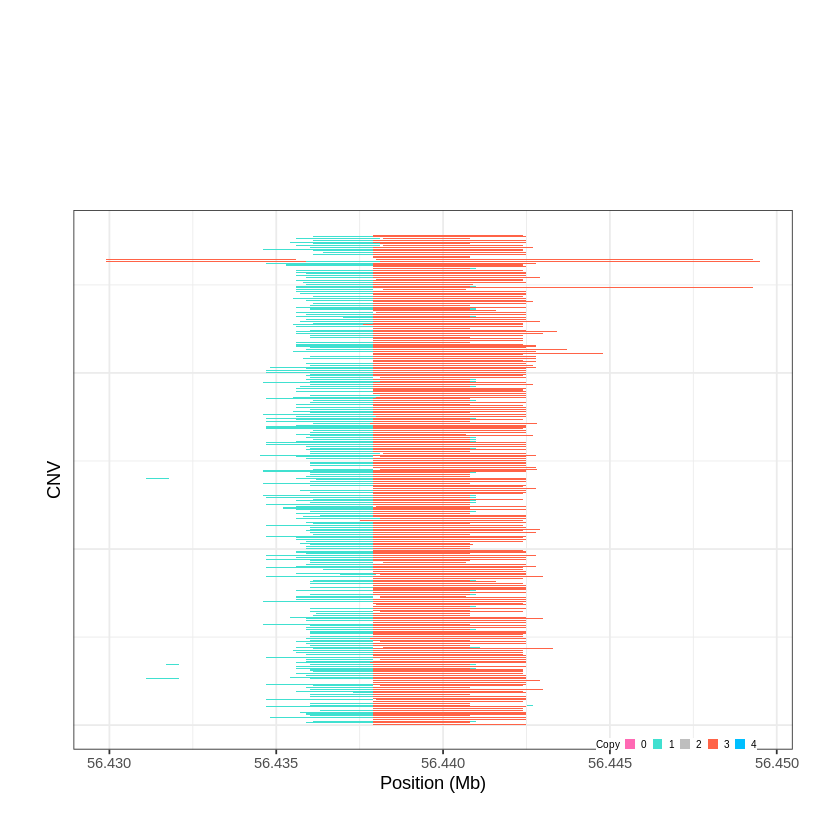

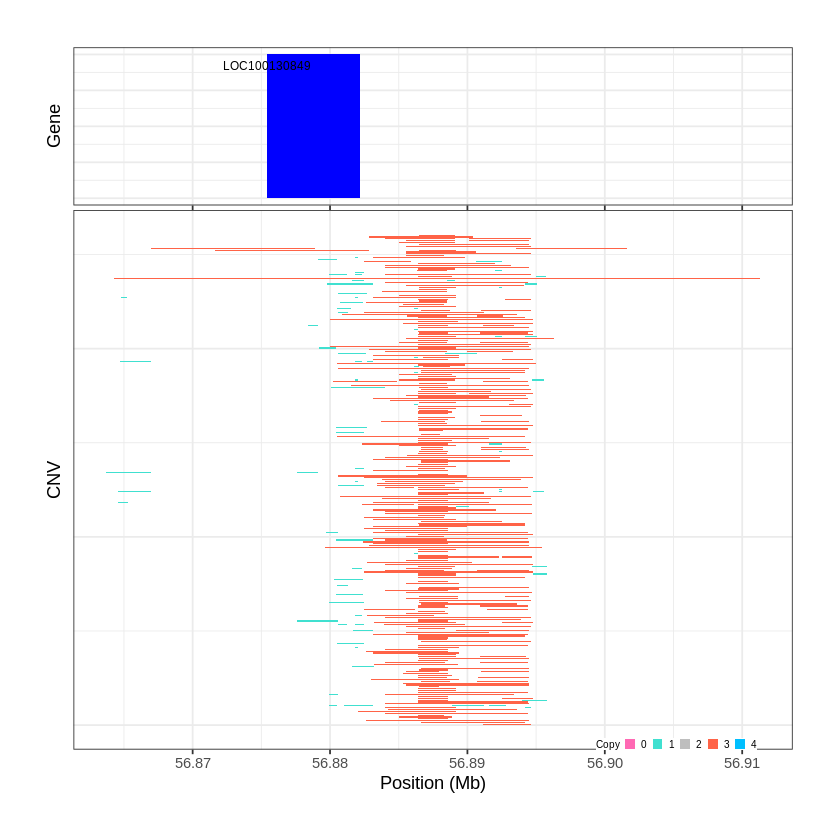

Task done, plot was stored in working directory.
[1] "Ploting CNVR 914..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 57.060001 - 57.1519 Mb with 277 Individual - "
Plotting gene...


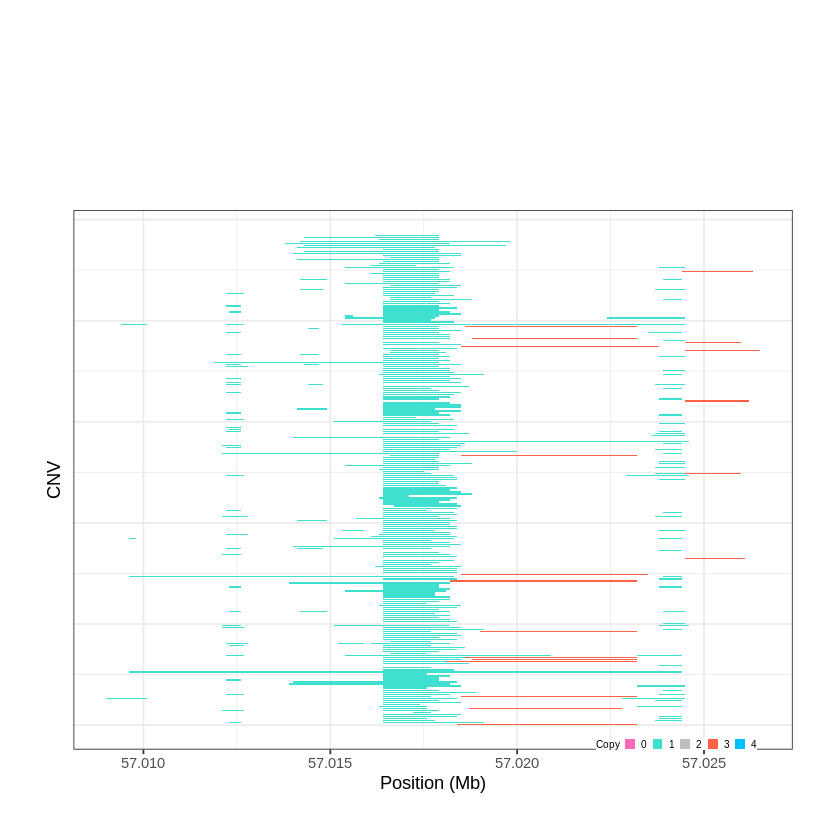

Task done, plot was stored in working directory.
[1] "Ploting CNVR 915..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 57.362801 - 57.5122 Mb with 157 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 916..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 57.568801 - 57.6037 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


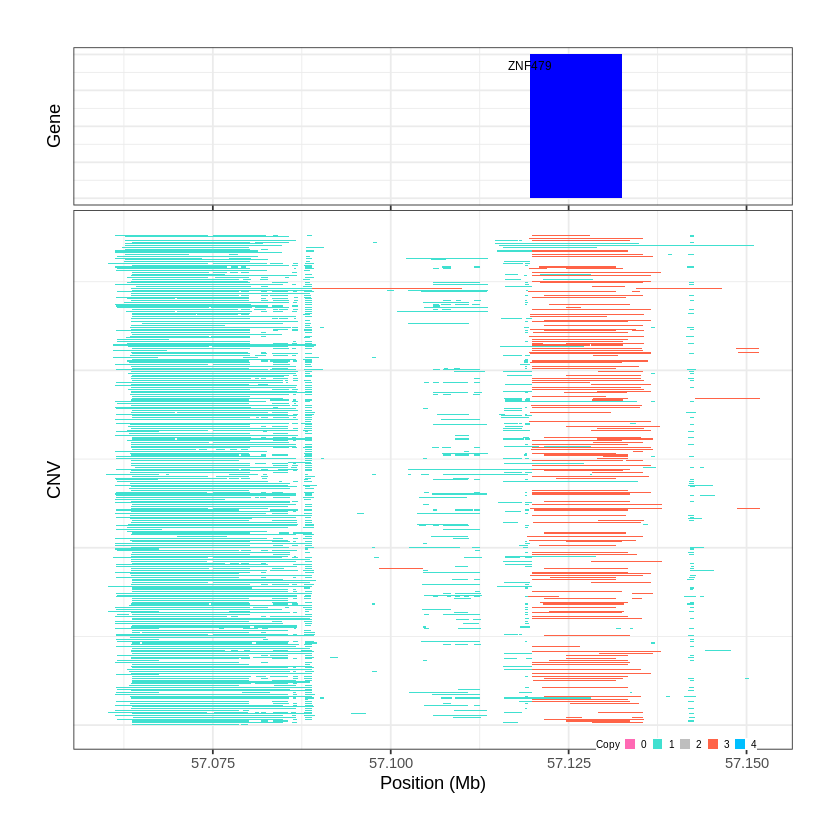

Task done, plot was stored in working directory.
[1] "Ploting CNVR 917..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 57.672601 - 57.7701 Mb with 172 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


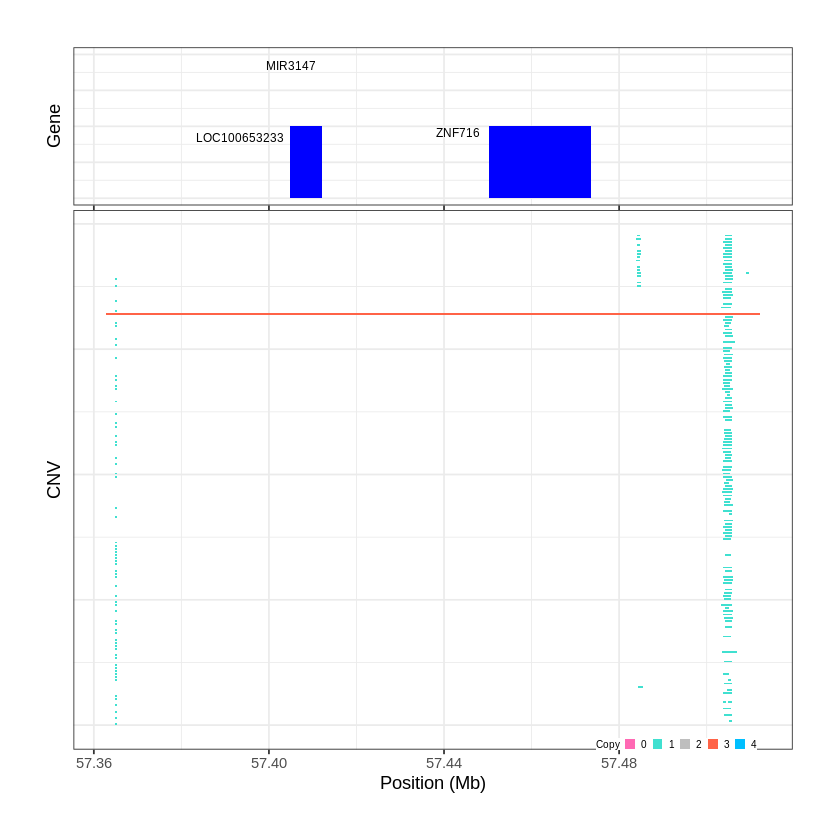

Task done, plot was stored in working directory.
[1] "Ploting CNVR 918..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 57.933301 - 62.996 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


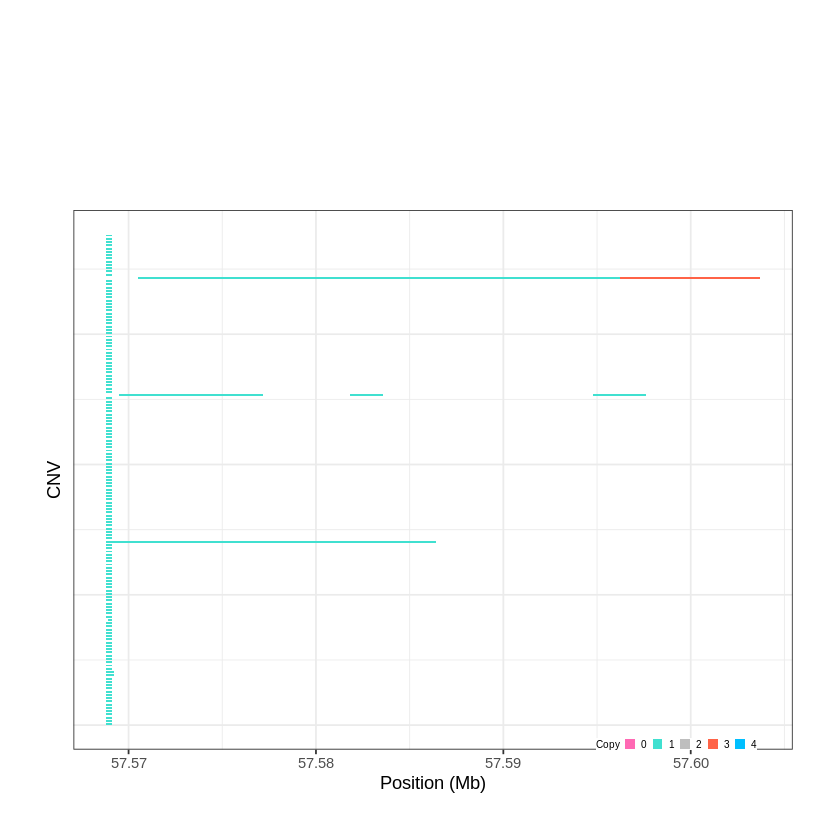

Task done, plot was stored in working directory.
[1] "Ploting CNVR 919..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 63.000201 - 63.0506 Mb with 263 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


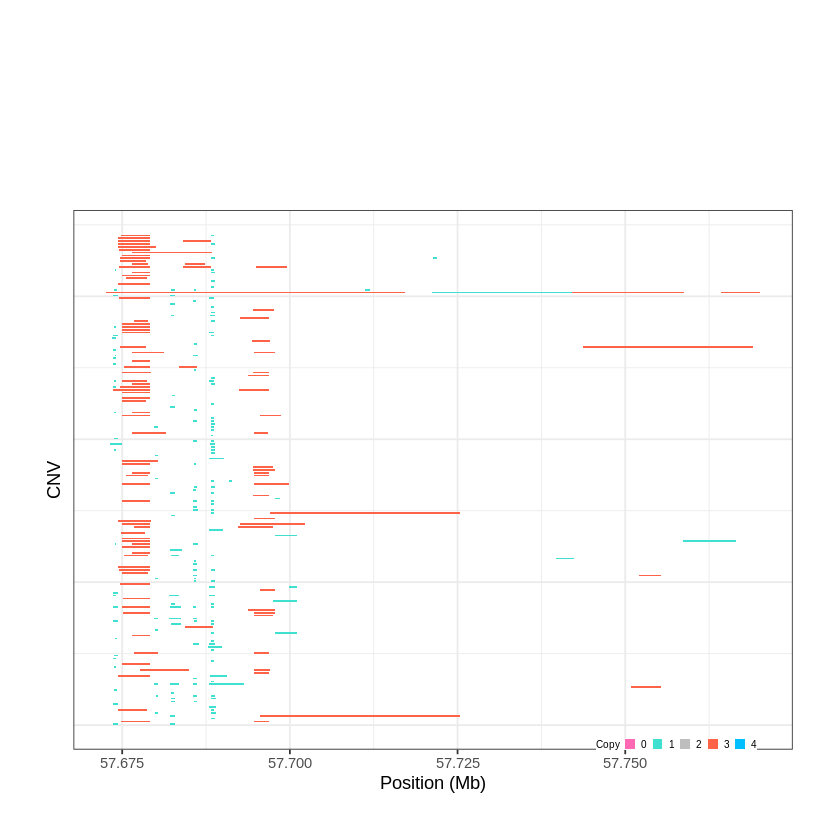

Task done, plot was stored in working directory.
[1] "Ploting CNVR 920..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 63.062601 - 63.0706 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


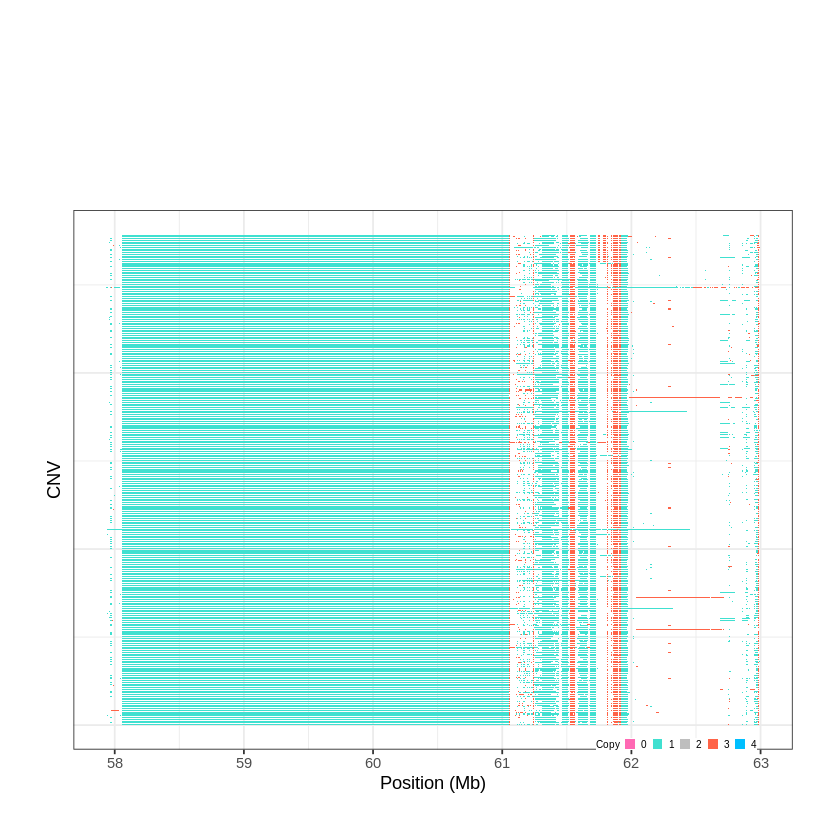

Task done, plot was stored in working directory.
[1] "Ploting CNVR 921..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 63.074501 - 63.1005 Mb with 235 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


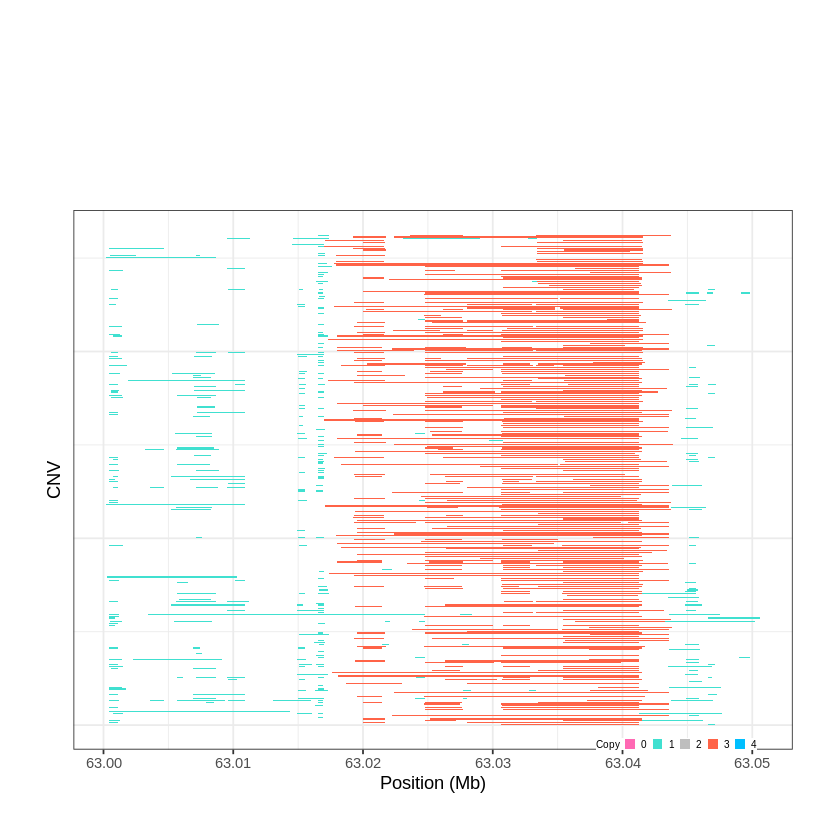

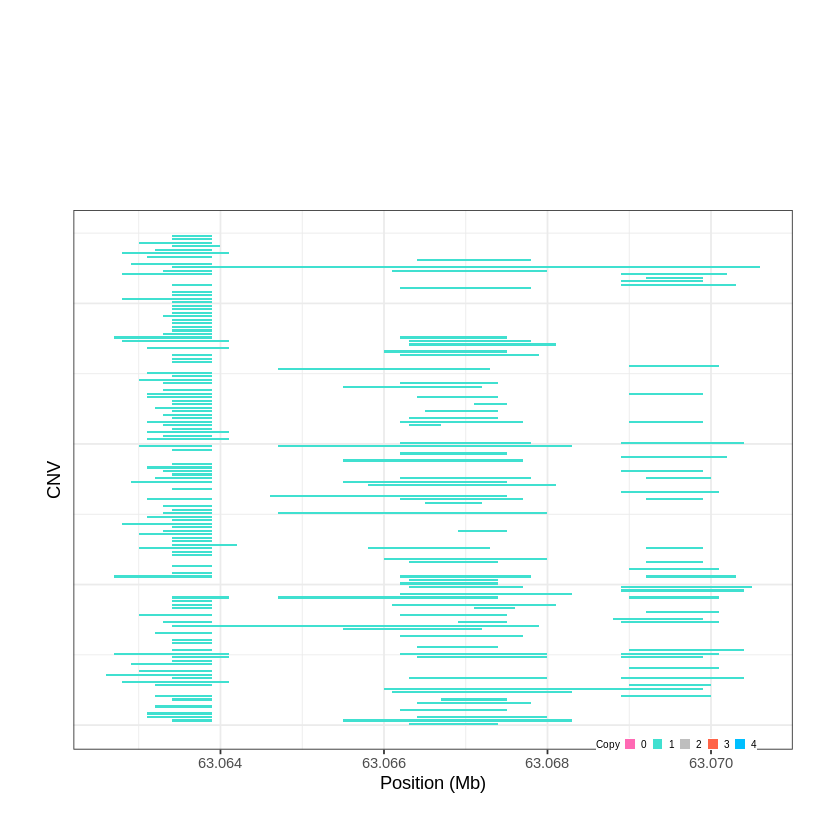

Task done, plot was stored in working directory.
[1] "Ploting CNVR 922..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 63.120501 - 63.5564 Mb with 271 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 923..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 64.244001 - 64.3123 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


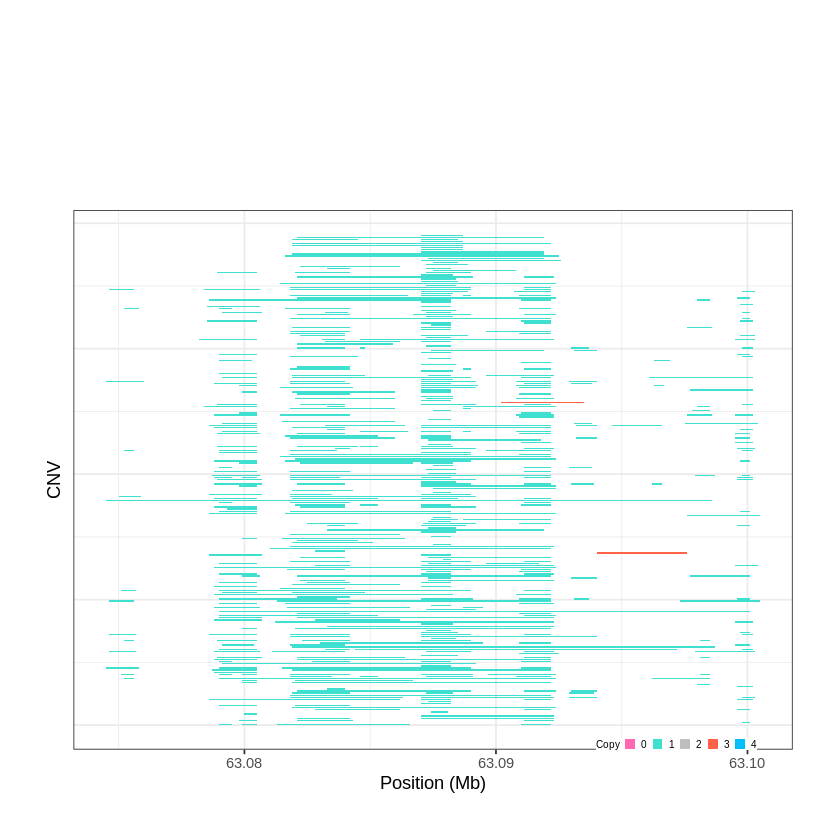

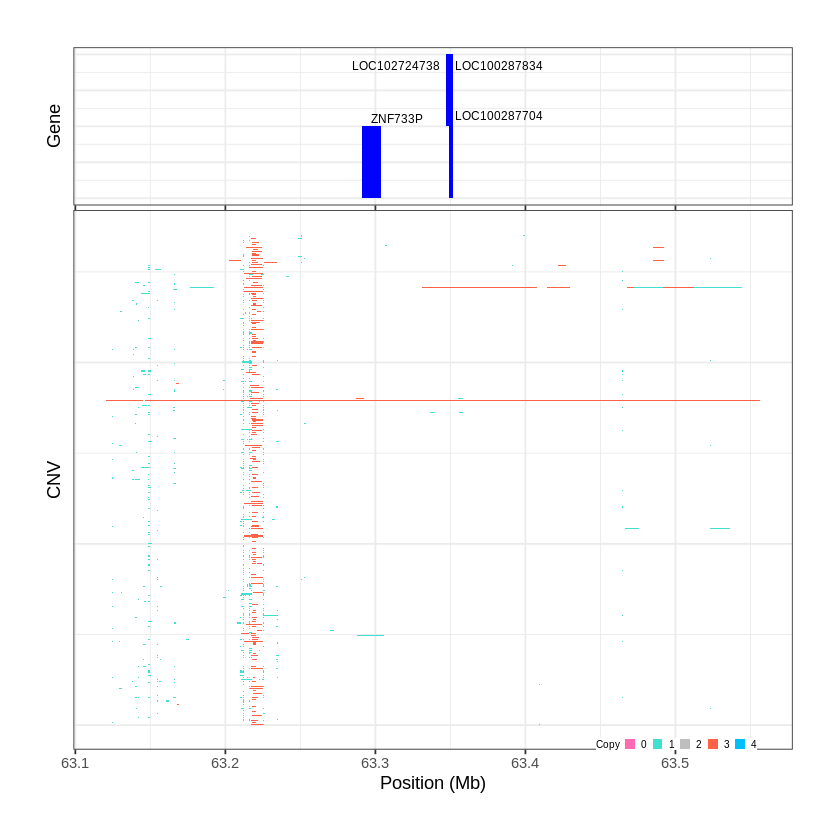

Task done, plot was stored in working directory.
[1] "Ploting CNVR 924..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 64.312301 - 64.371 Mb with 272 Individual - "
Plotting gene...


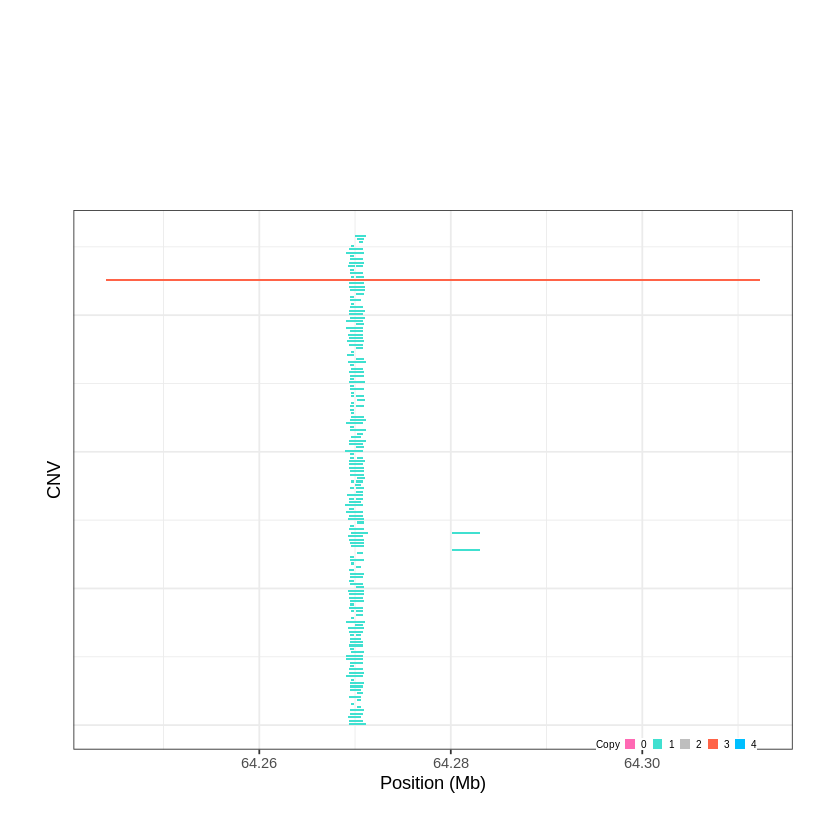

Task done, plot was stored in working directory.
[1] "Ploting CNVR 925..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 64.571301 - 65.3446 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 926..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 65.856501 - 65.8614 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


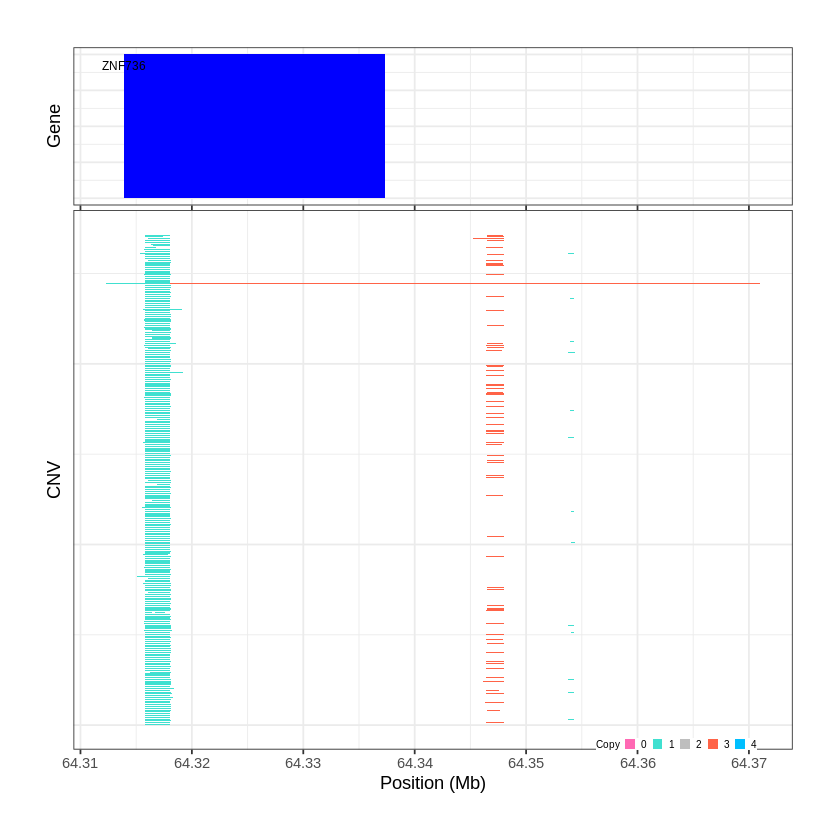

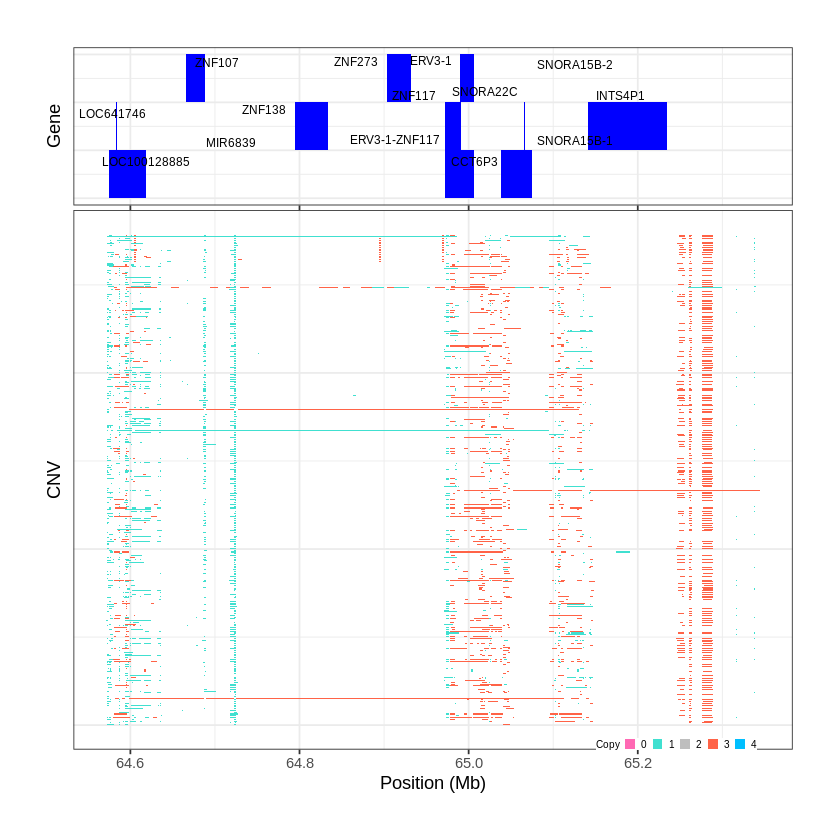

Task done, plot was stored in working directory.
[1] "Ploting CNVR 927..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 66.696601 - 66.8626 Mb with 167 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 928..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 67.127301 - 67.1396 Mb with 212 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


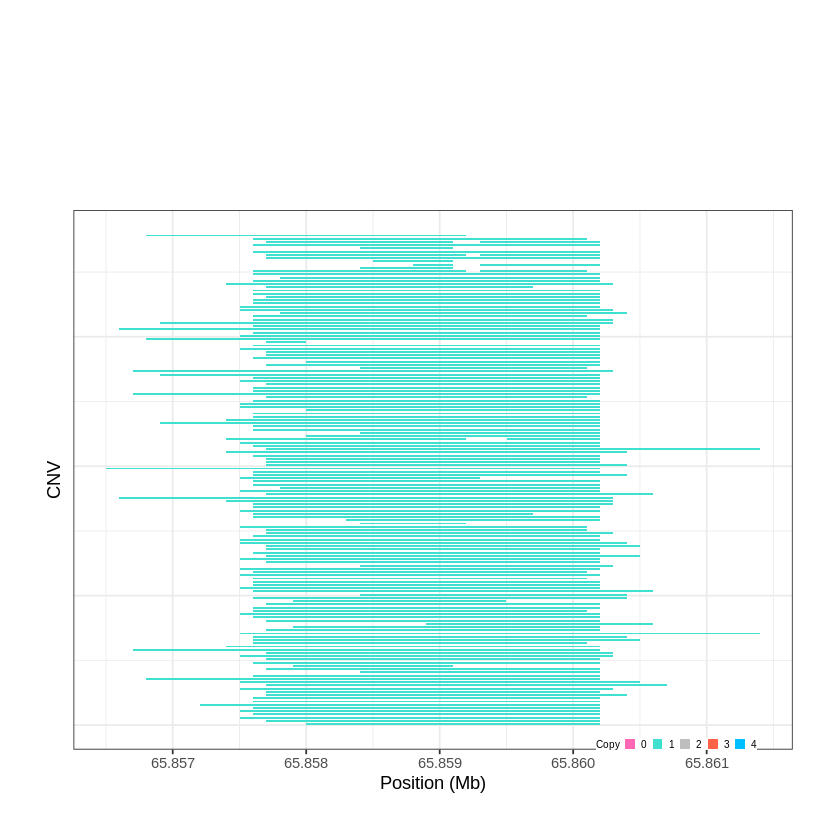

Task done, plot was stored in working directory.
[1] "Ploting CNVR 929..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 68.427601 - 68.467 Mb with 171 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


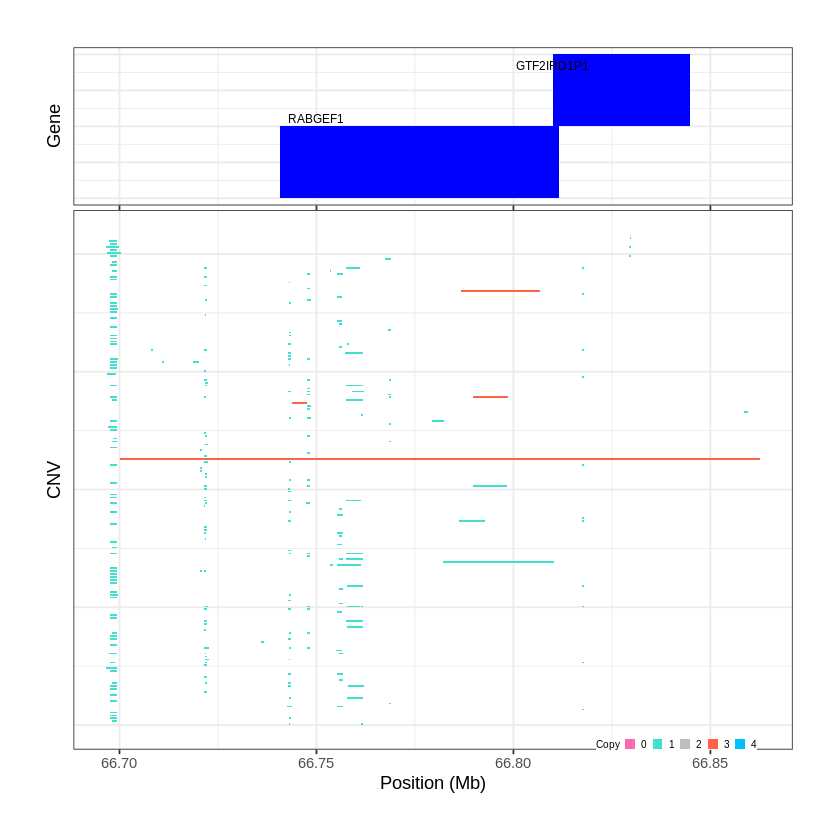

Task done, plot was stored in working directory.
[1] "Ploting CNVR 930..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 68.606101 - 68.6319 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


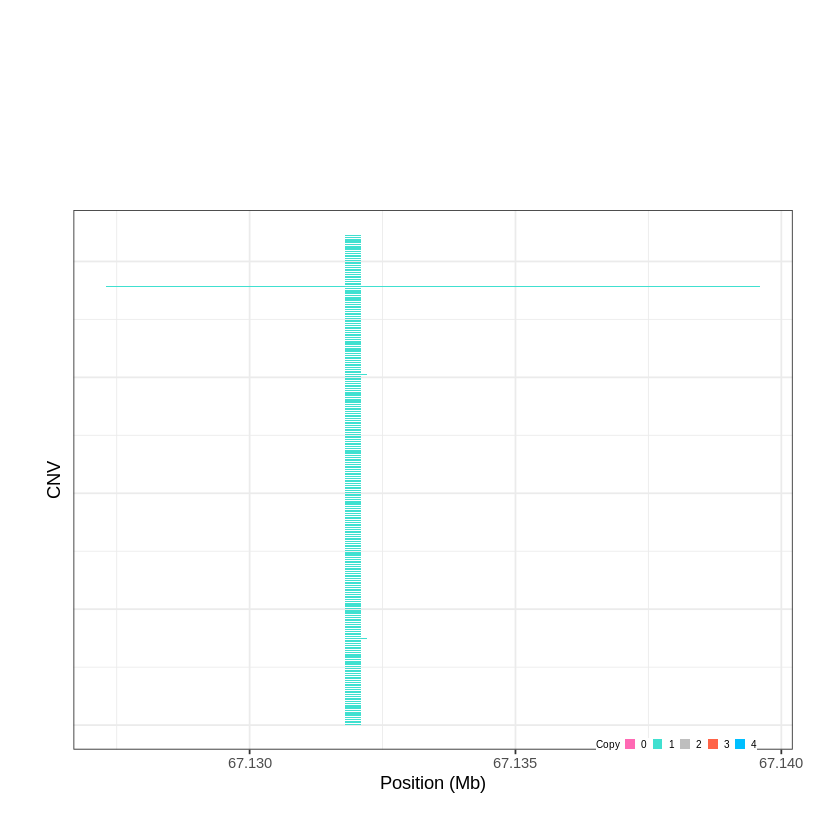

Task done, plot was stored in working directory.
[1] "Ploting CNVR 931..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 70.409001 - 70.4397 Mb with 215 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


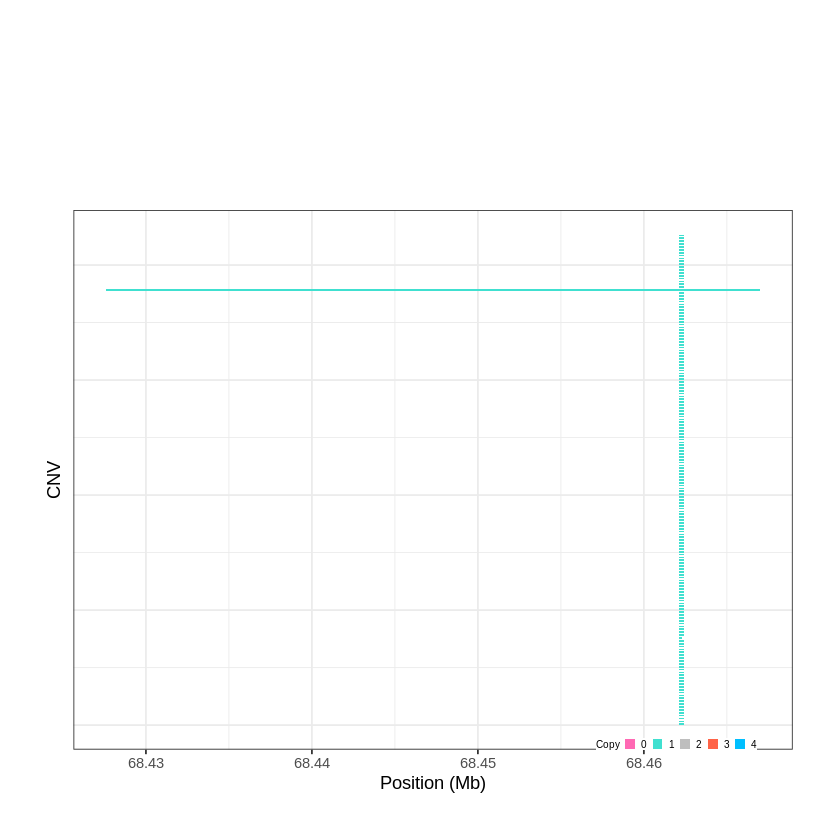

Task done, plot was stored in working directory.
[1] "Ploting CNVR 932..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 70.447701 - 70.4481 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


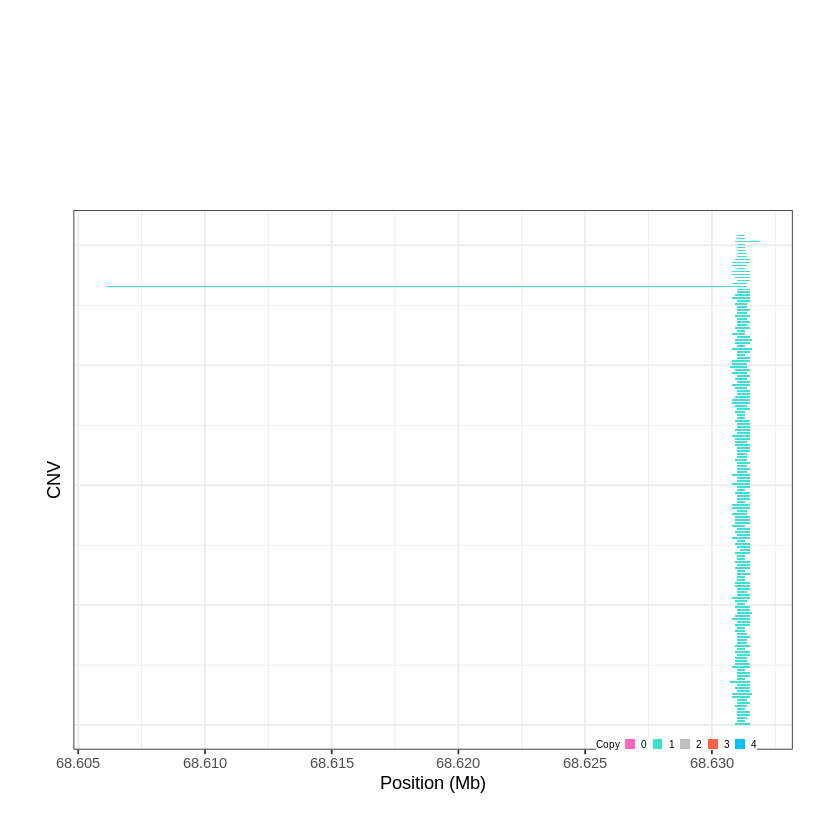

Task done, plot was stored in working directory.
[1] "Ploting CNVR 933..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 71.211901 - 71.2136 Mb with 197 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


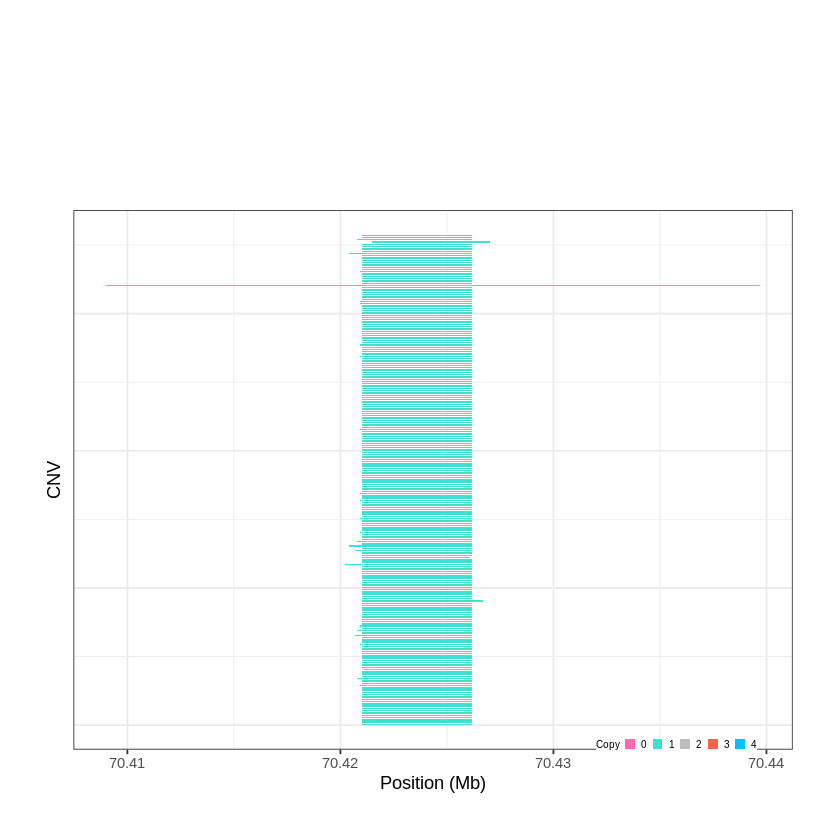

Task done, plot was stored in working directory.
[1] "Ploting CNVR 934..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 72.163801 - 72.7167 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


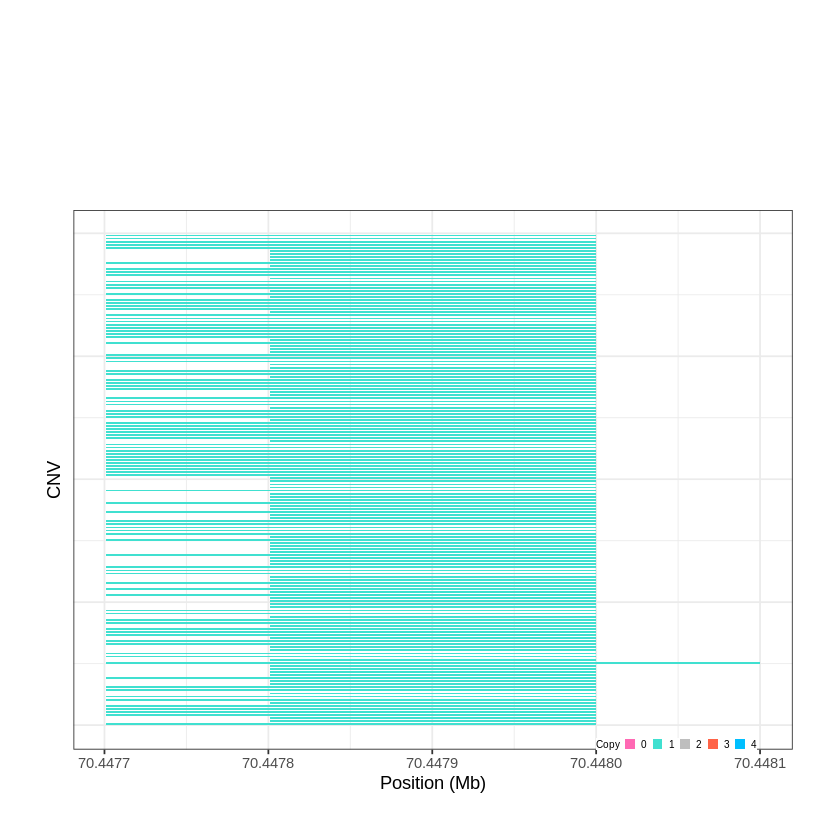

Task done, plot was stored in working directory.
[1] "Ploting CNVR 935..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 73.013701 - 73.017 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


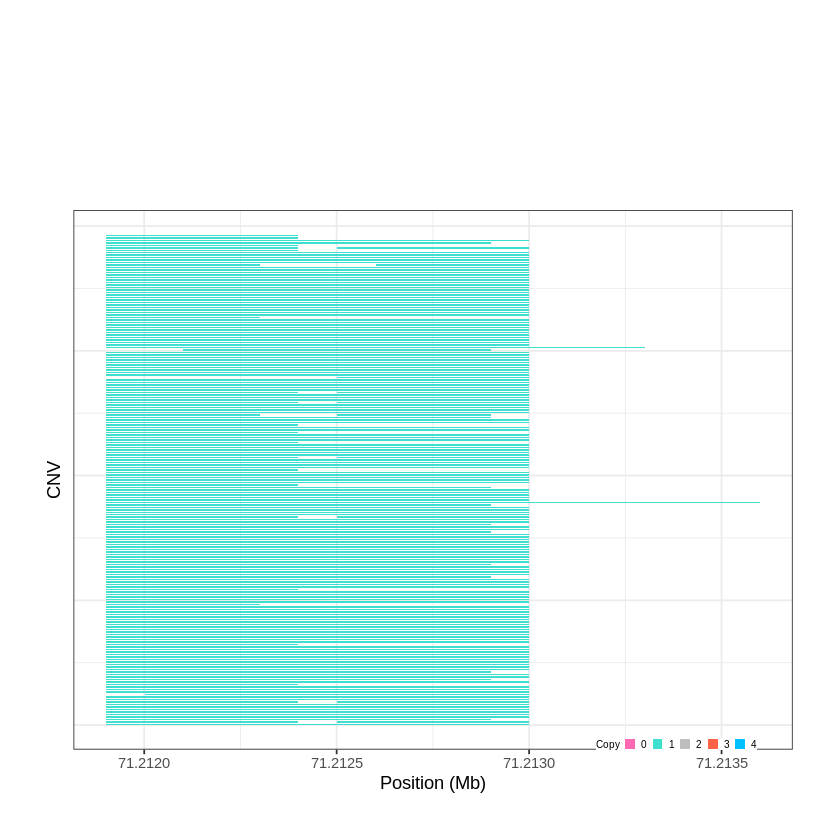

Task done, plot was stored in working directory.
[1] "Ploting CNVR 936..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 73.544901 - 73.5513 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


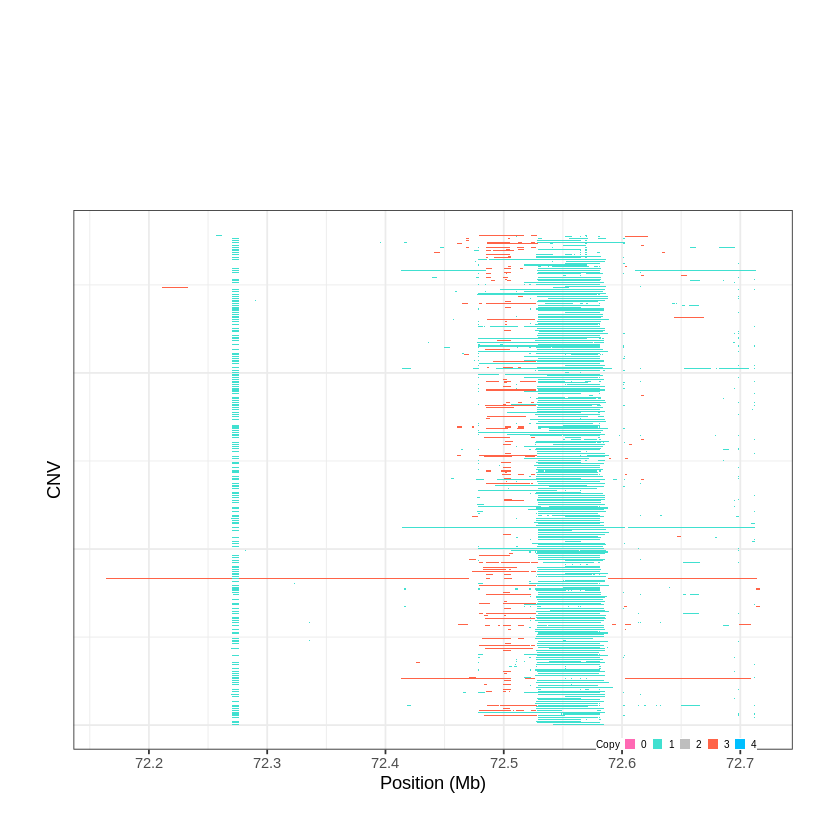

Task done, plot was stored in working directory.
[1] "Ploting CNVR 937..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 73.826601 - 73.8323 Mb with 257 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


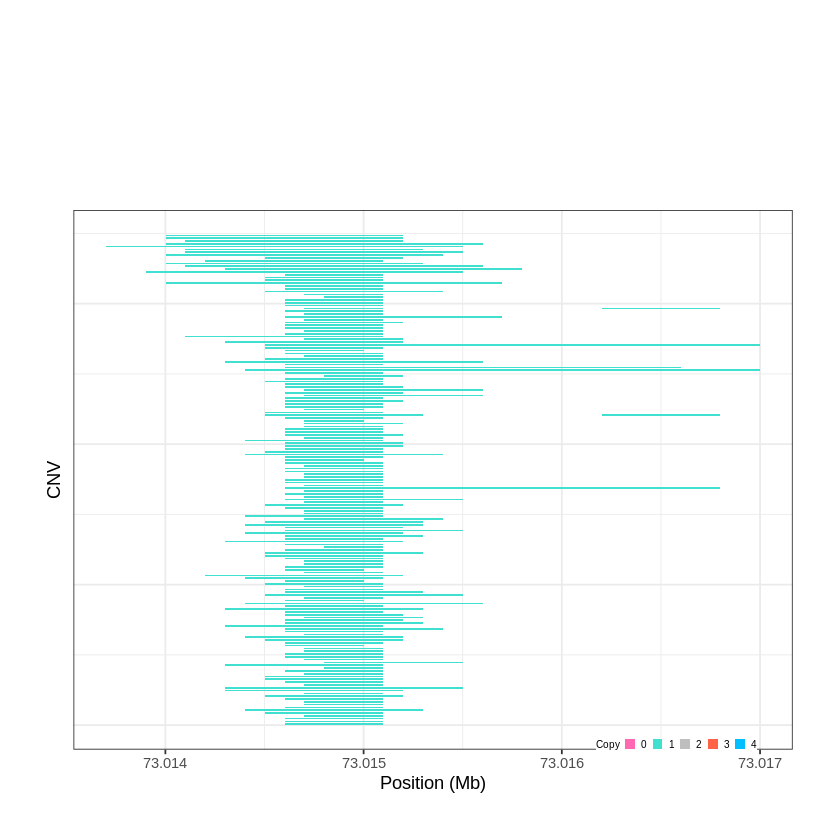

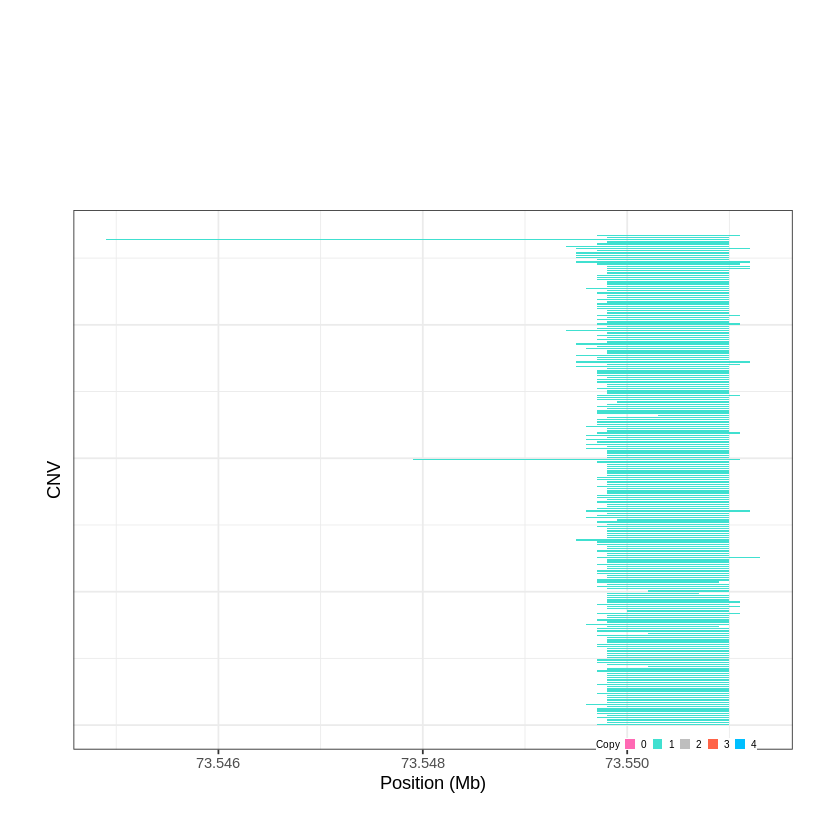

Task done, plot was stored in working directory.
[1] "Ploting CNVR 938..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 74.142701 - 74.4813 Mb with 279 Individual - "
Plotting gene...


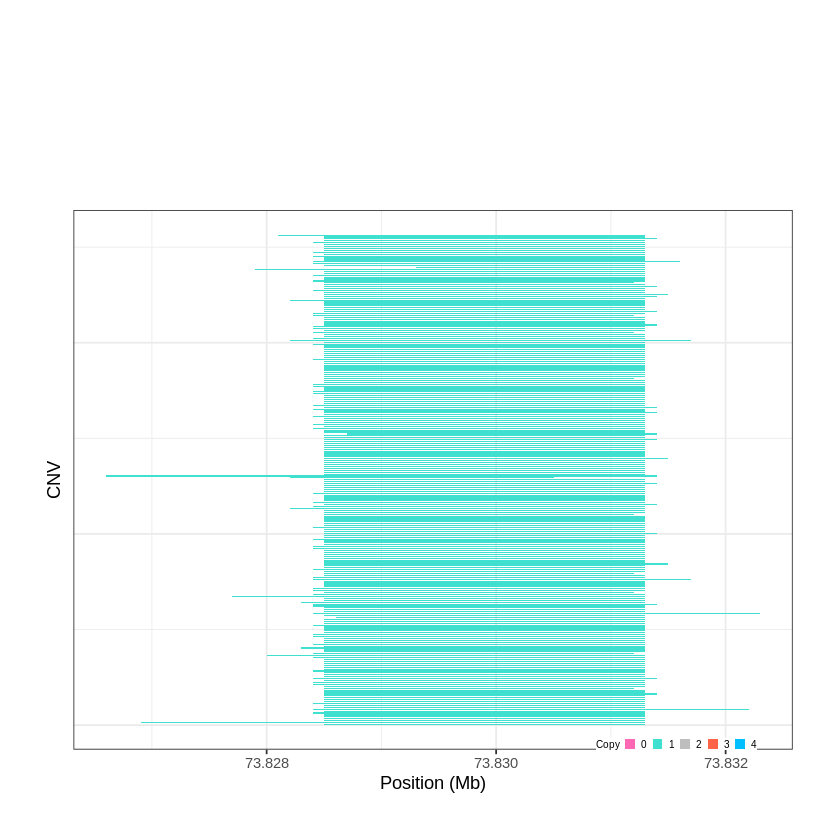

Task done, plot was stored in working directory.
[1] "Ploting CNVR 939..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 74.524601 - 74.9964 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 940..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 75.583401 - 75.6203 Mb with 241 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


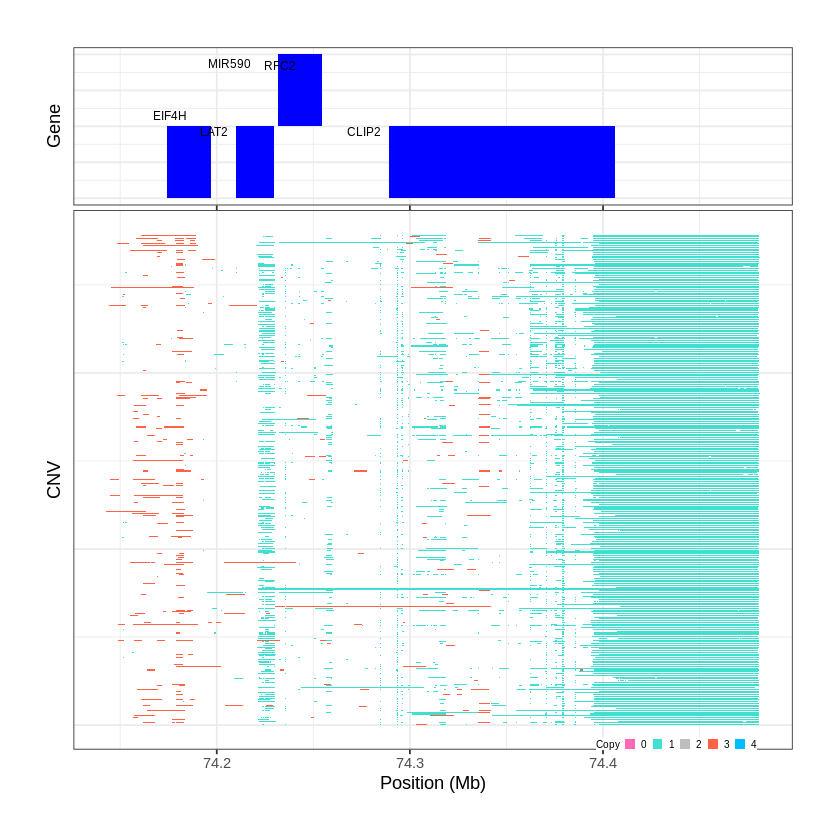

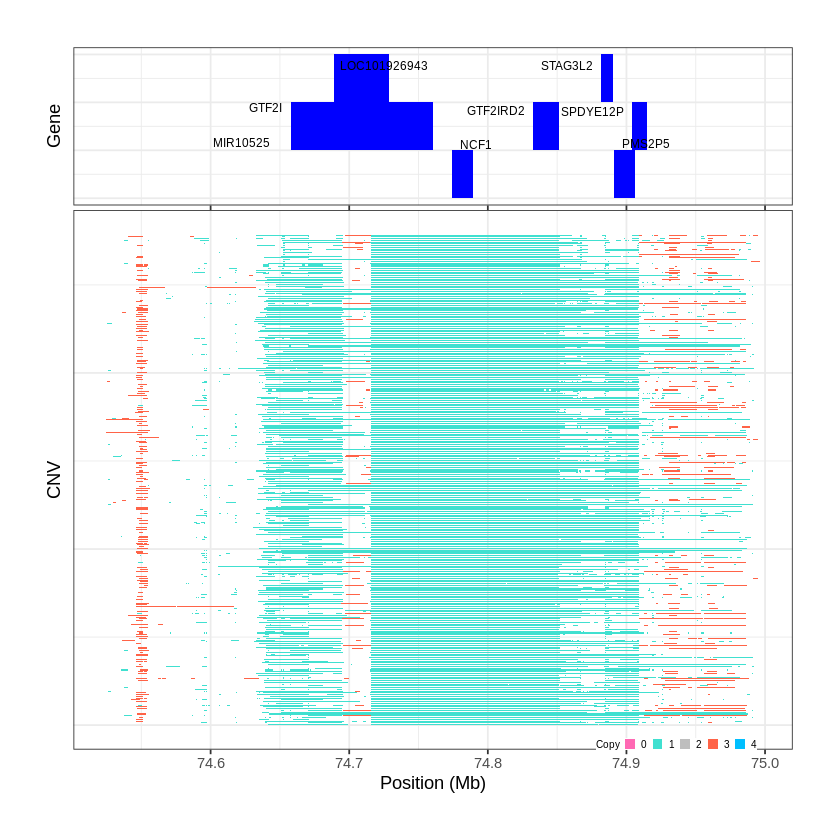

Task done, plot was stored in working directory.
[1] "Ploting CNVR 941..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 76.061701 - 76.7089 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 942..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 81.440601 - 81.5093 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


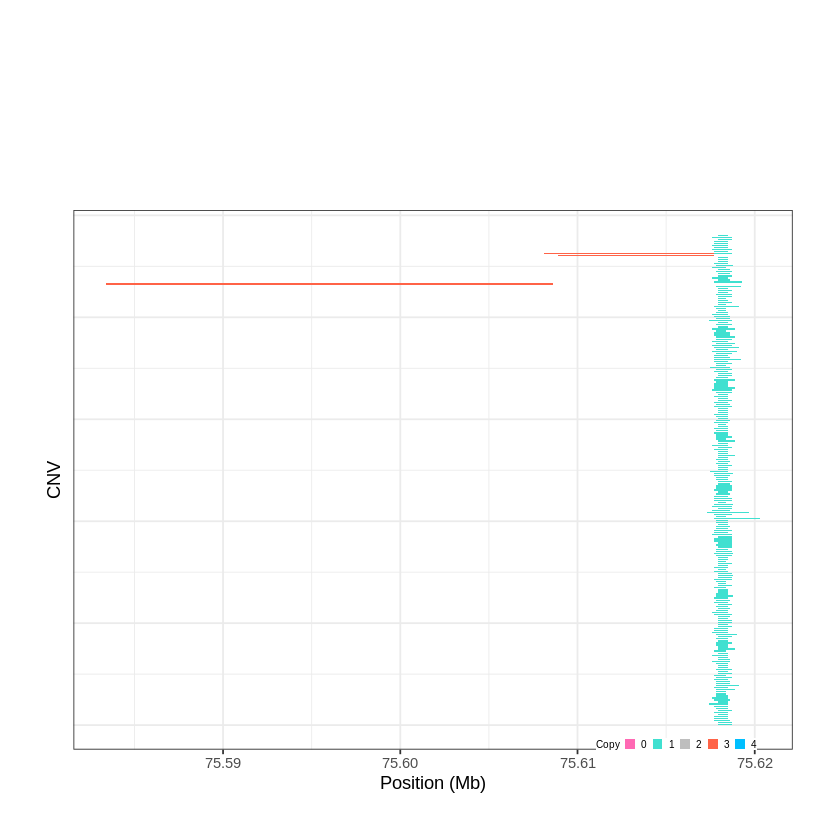

Task done, plot was stored in working directory.
[1] "Ploting CNVR 943..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 83.709901 - 83.7102 Mb with 181 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


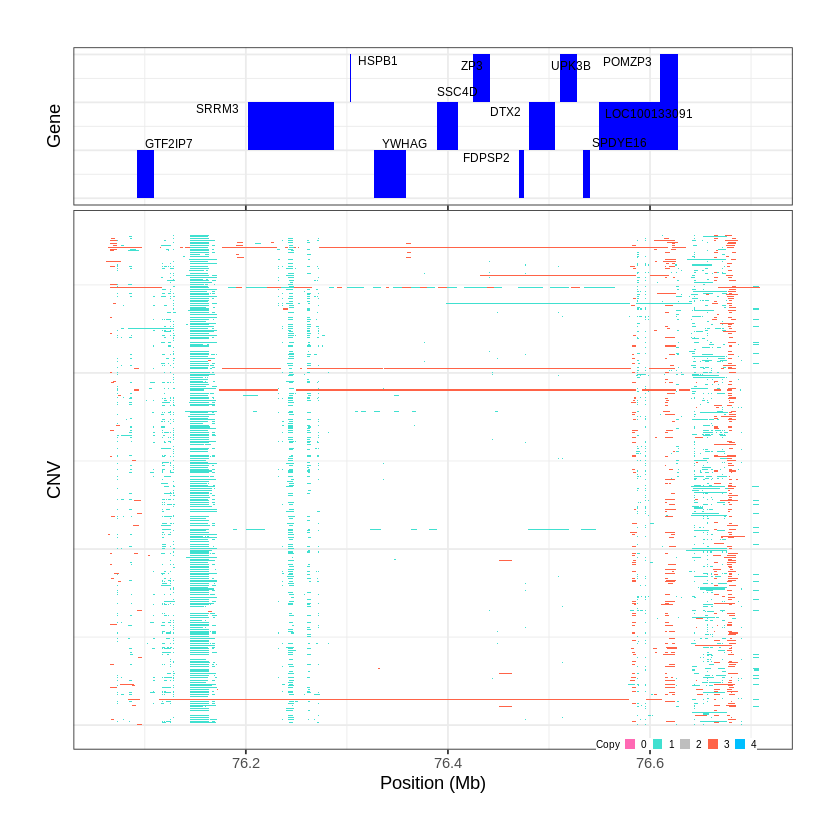

Task done, plot was stored in working directory.
[1] "Ploting CNVR 944..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 83.750601 - 83.7515 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


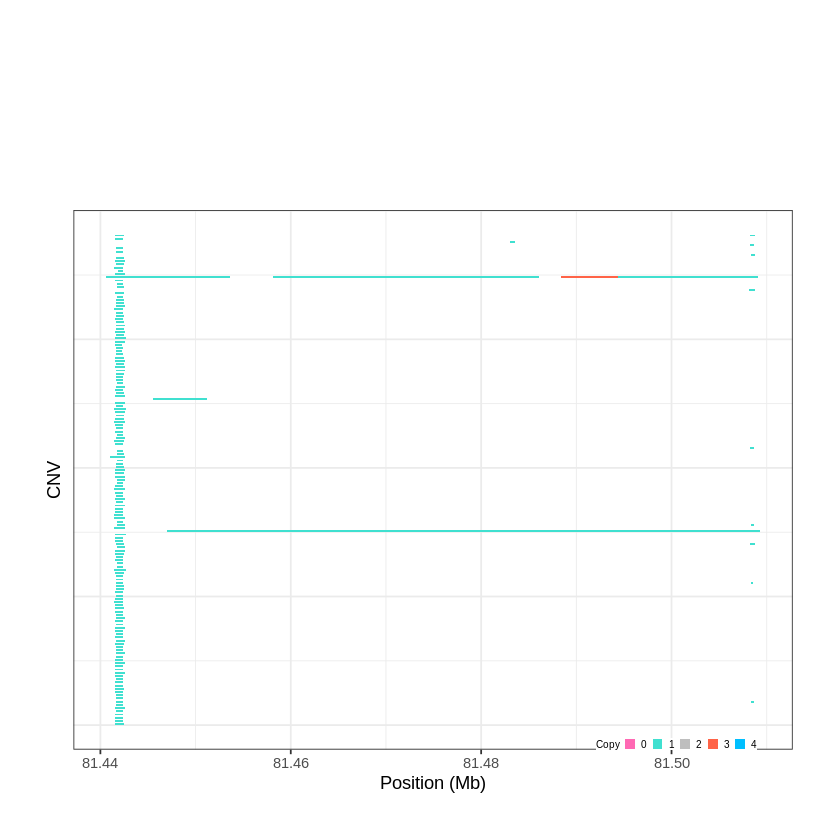

Task done, plot was stored in working directory.
[1] "Ploting CNVR 945..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 89.533701 - 89.5765 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


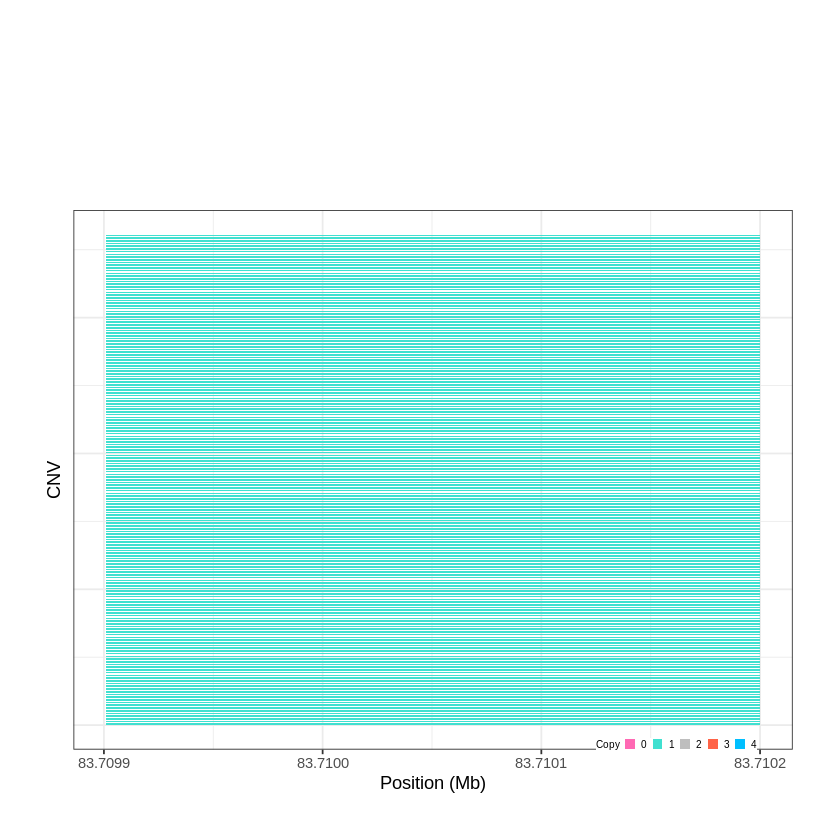

Task done, plot was stored in working directory.
[1] "Ploting CNVR 946..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 89.598901 - 89.5992 Mb with 172 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


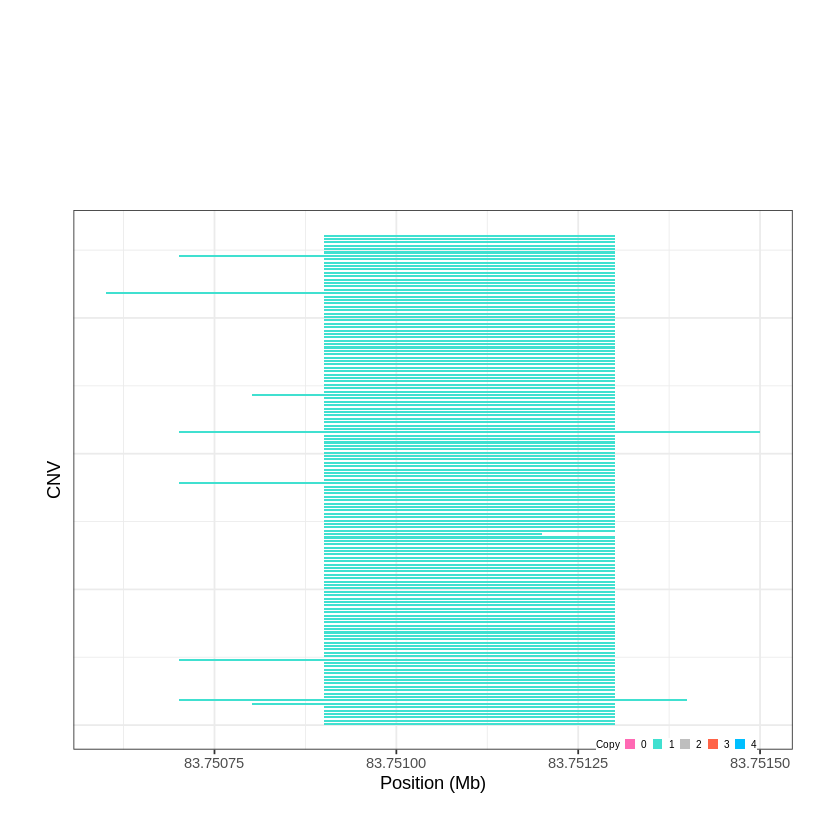

Task done, plot was stored in working directory.
[1] "Ploting CNVR 947..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 89.809401 - 89.8314 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


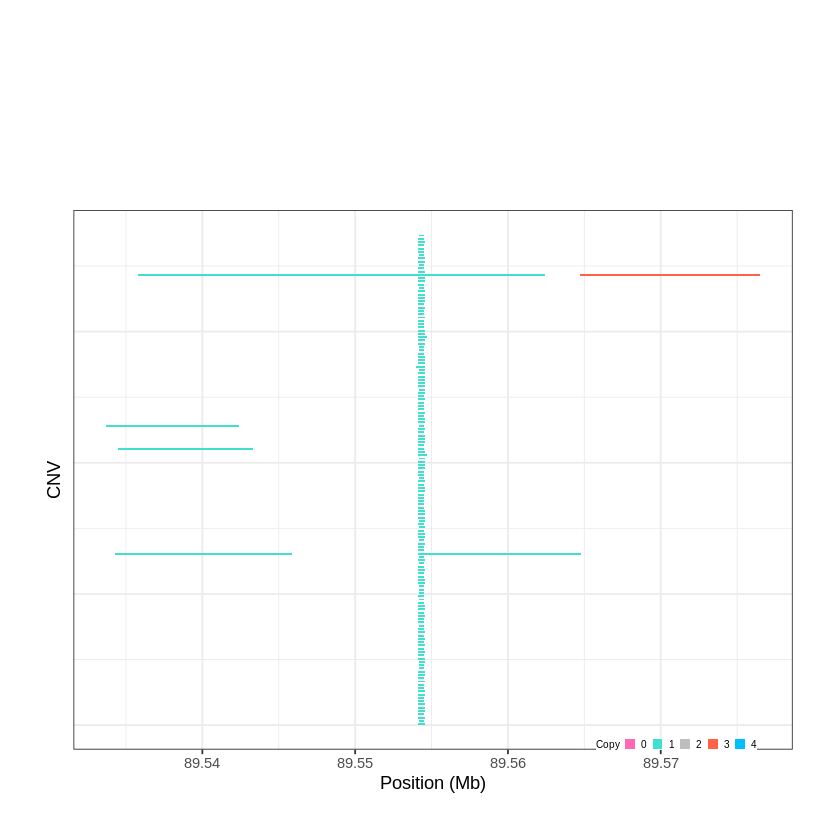

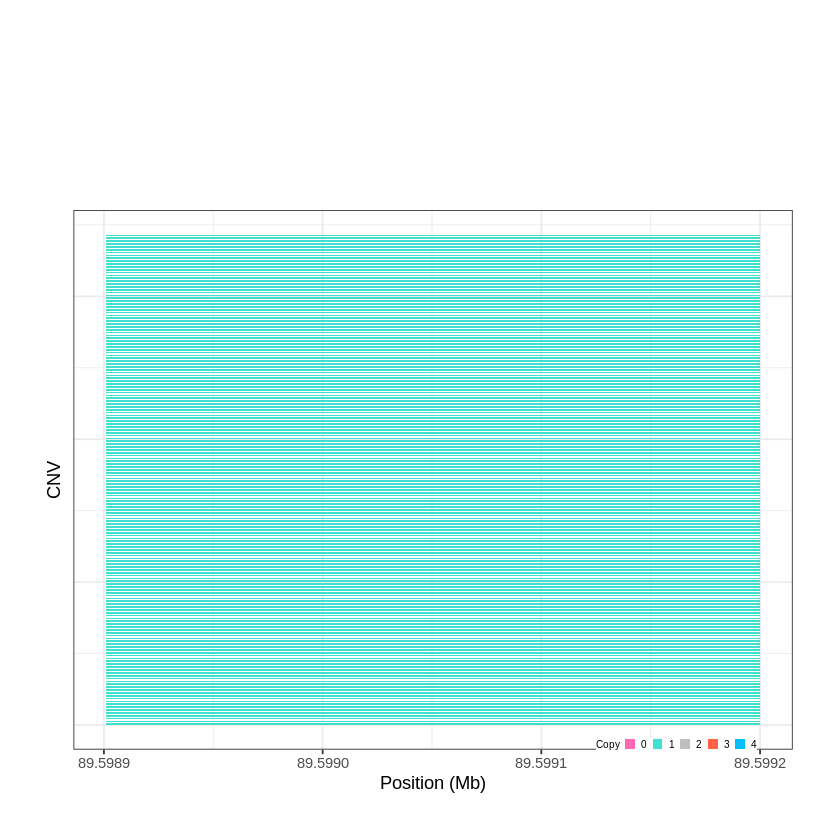

Task done, plot was stored in working directory.
[1] "Ploting CNVR 948..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 91.204501 - 91.273 Mb with 194 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 949..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 93.326801 - 93.4724 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


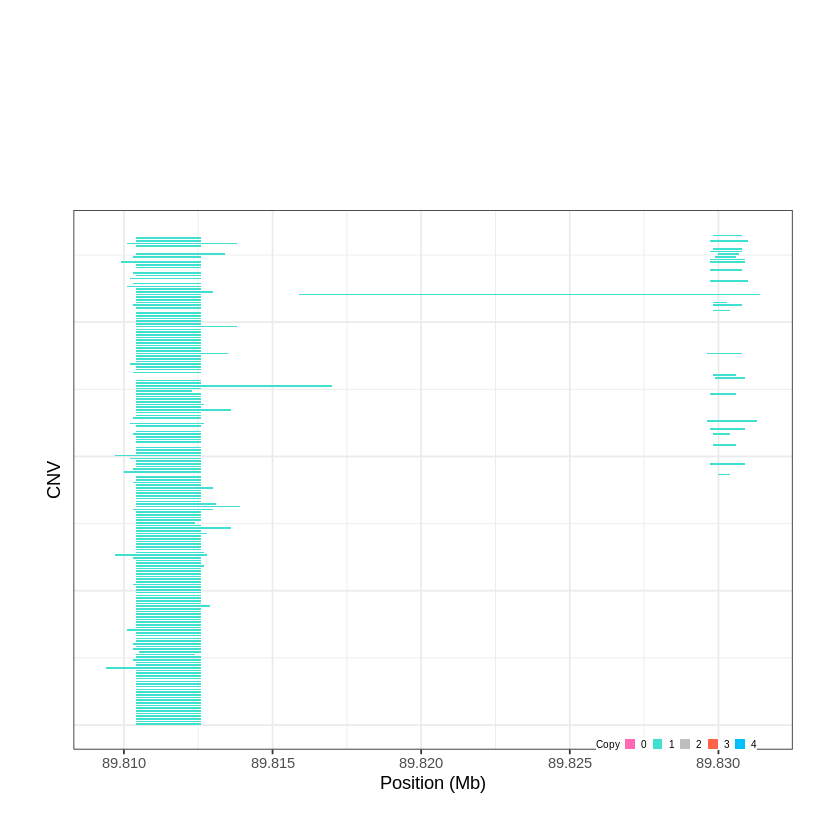

Task done, plot was stored in working directory.
[1] "Ploting CNVR 950..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 93.536701 - 93.5449 Mb with 171 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


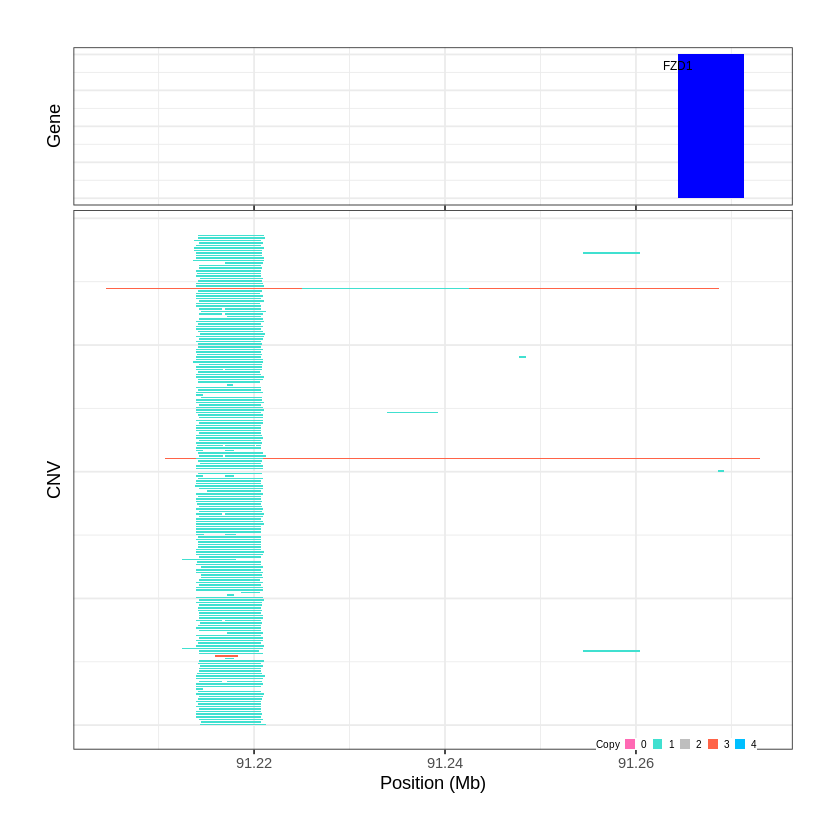

Task done, plot was stored in working directory.
[1] "Ploting CNVR 951..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 95.384301 - 95.3992 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


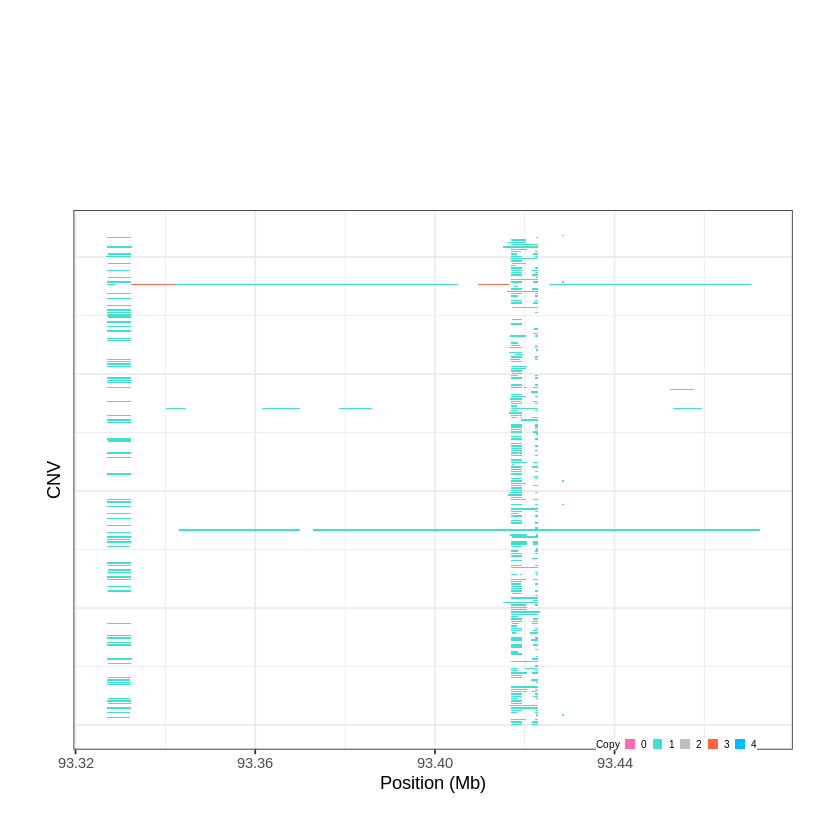

Task done, plot was stored in working directory.
[1] "Ploting CNVR 952..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 97.839001 - 97.8415 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


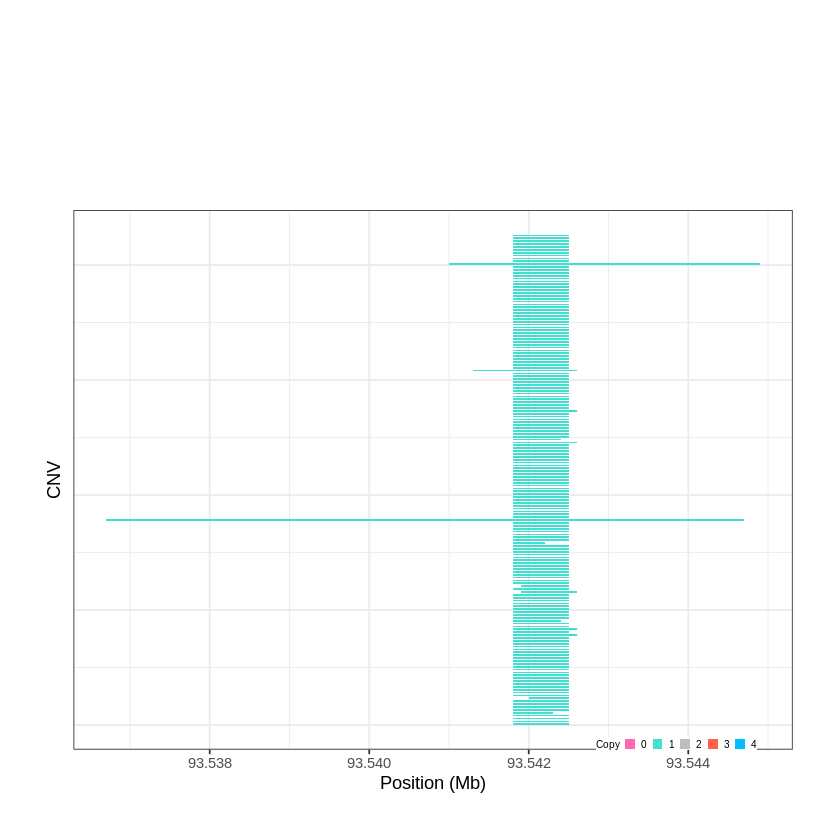

Task done, plot was stored in working directory.
[1] "Ploting CNVR 953..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 98.029301 - 98.031 Mb with 159 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


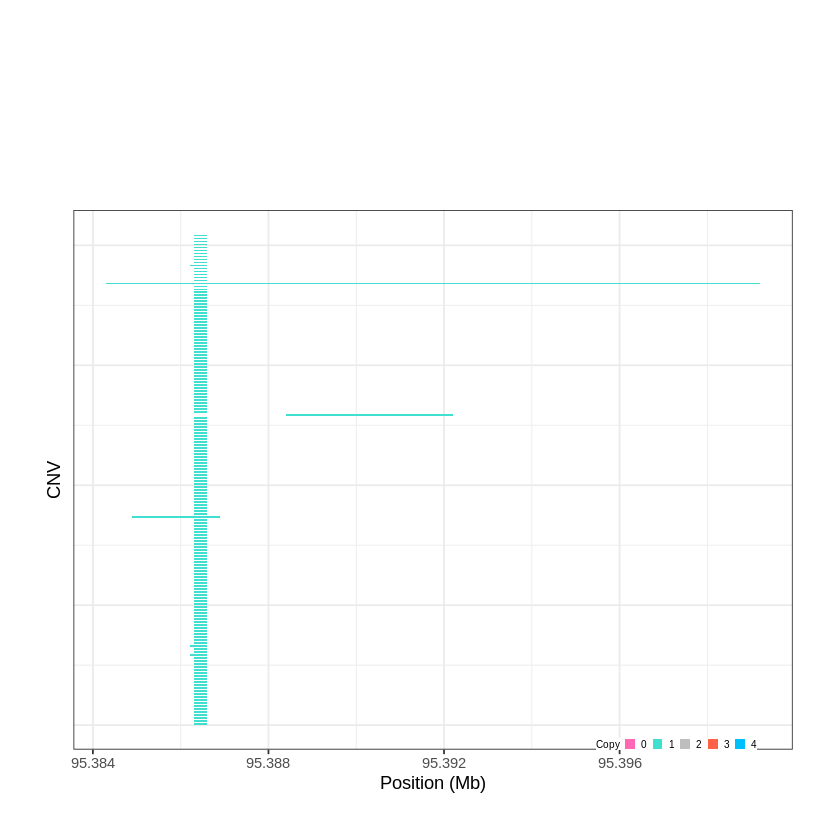

Task done, plot was stored in working directory.
[1] "Ploting CNVR 954..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 98.739501 - 98.7443 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


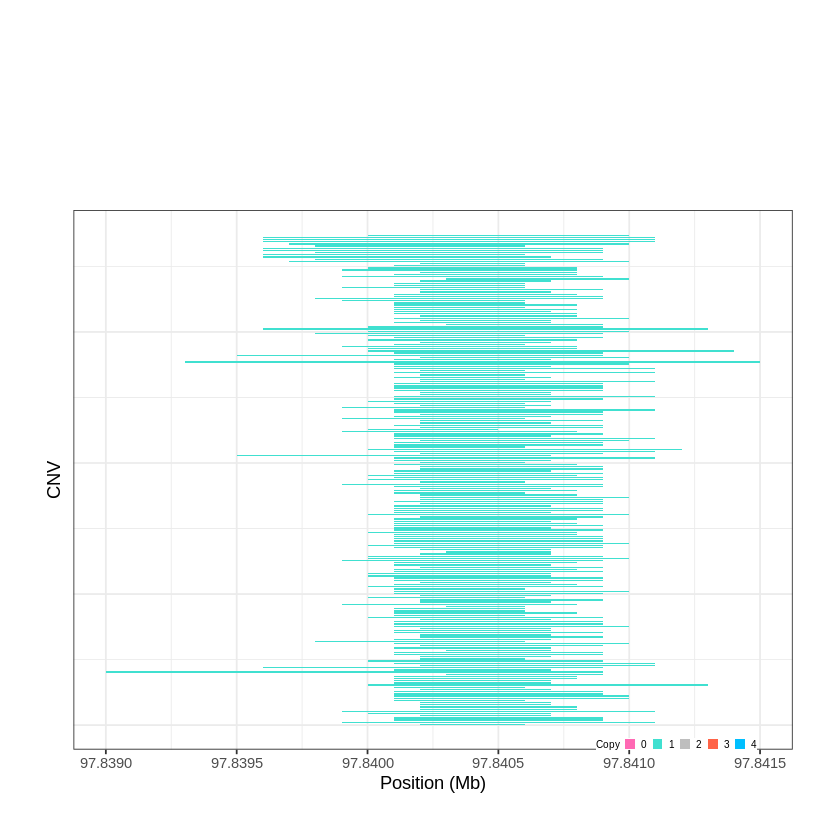

Task done, plot was stored in working directory.
[1] "Ploting CNVR 955..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 100.009201 - 100.0334 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


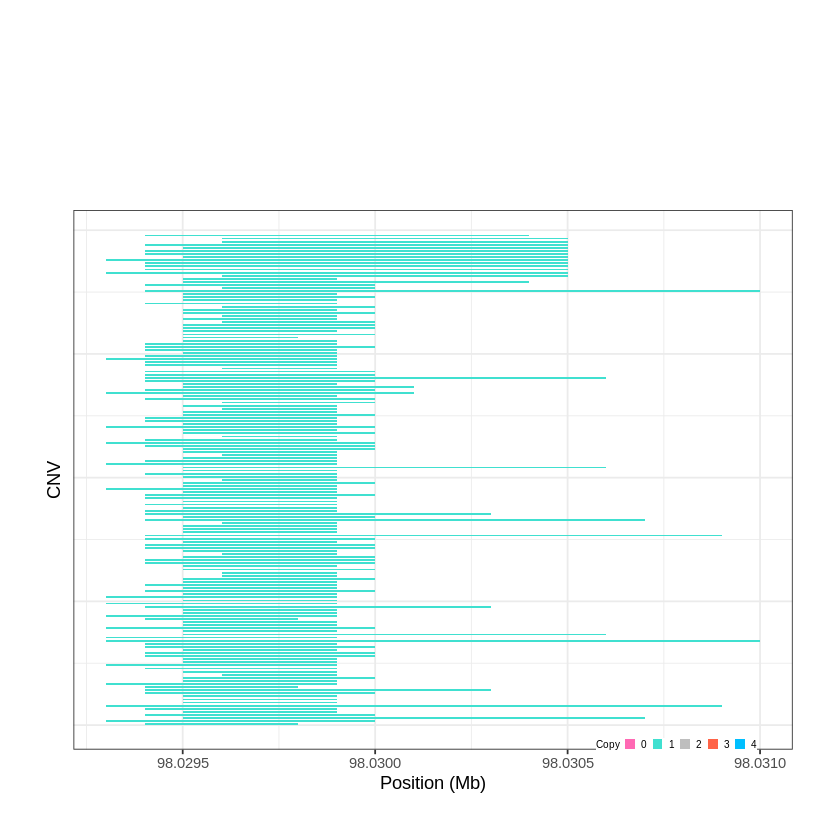

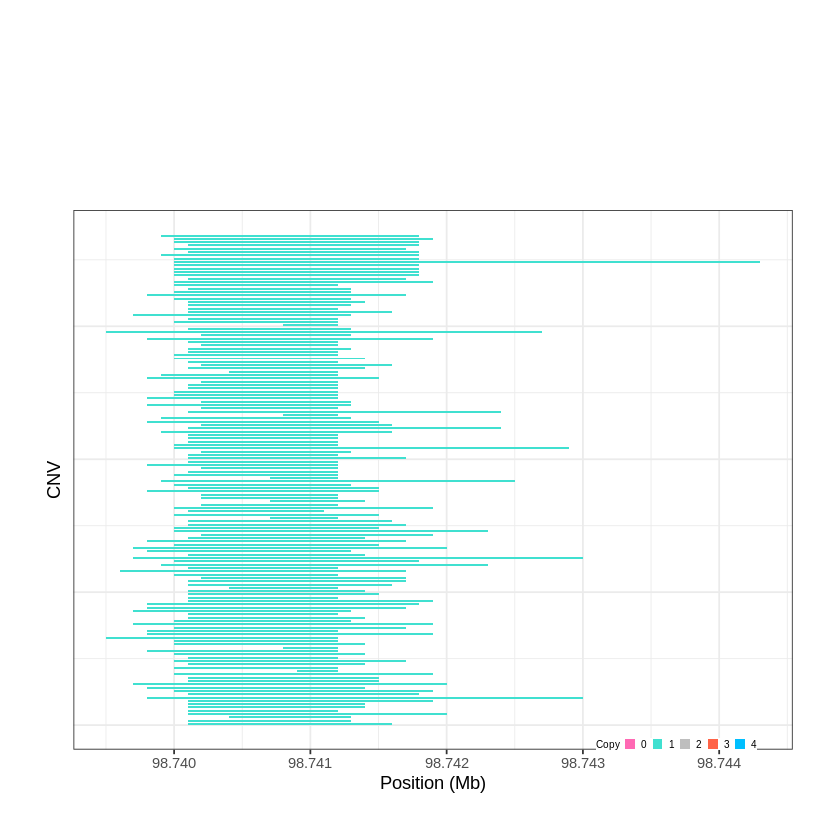

Task done, plot was stored in working directory.
[1] "Ploting CNVR 956..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 100.326901 - 100.3434 Mb with 154 Individual - "
Plotting gene...


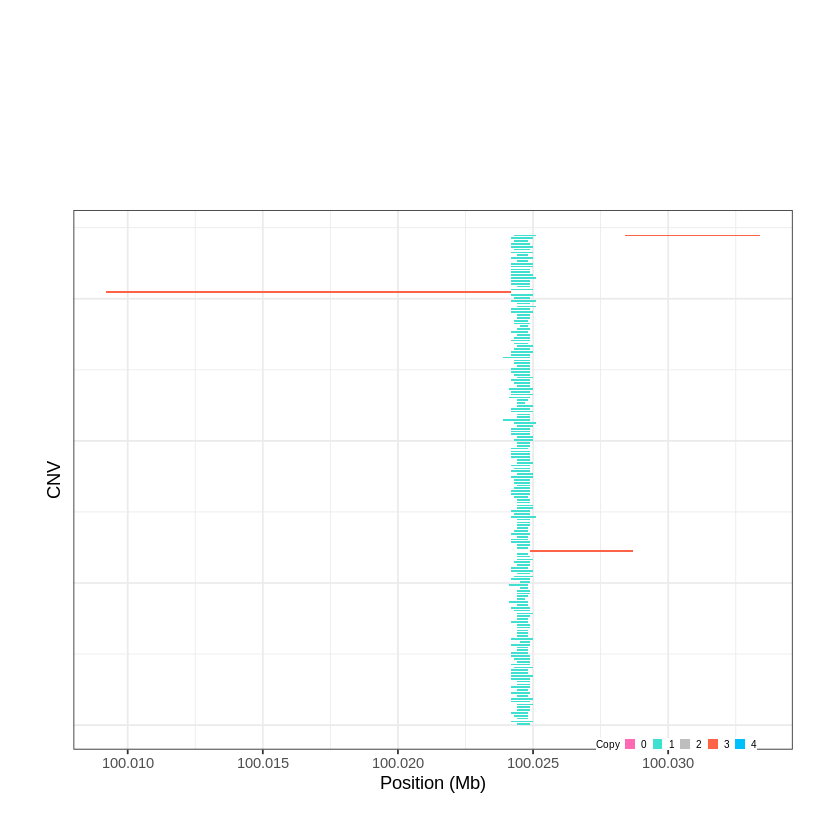

Task done, plot was stored in working directory.
[1] "Ploting CNVR 957..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 100.542001 - 100.6159 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 958..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 100.634401 - 100.6479 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


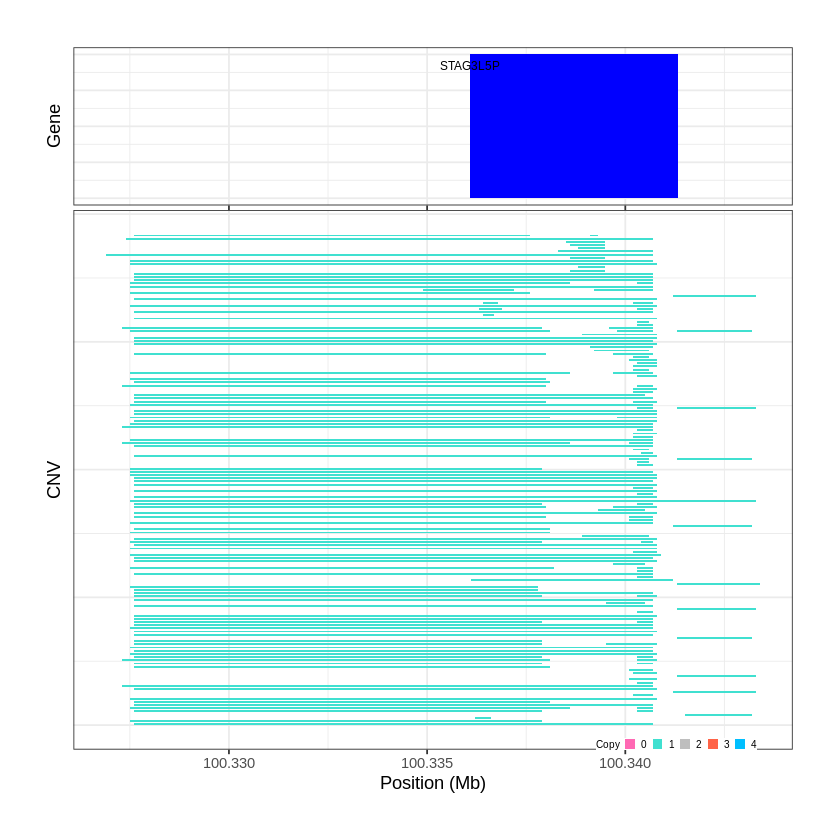

Task done, plot was stored in working directory.
[1] "Ploting CNVR 959..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 101.000801 - 101.0073 Mb with 230 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


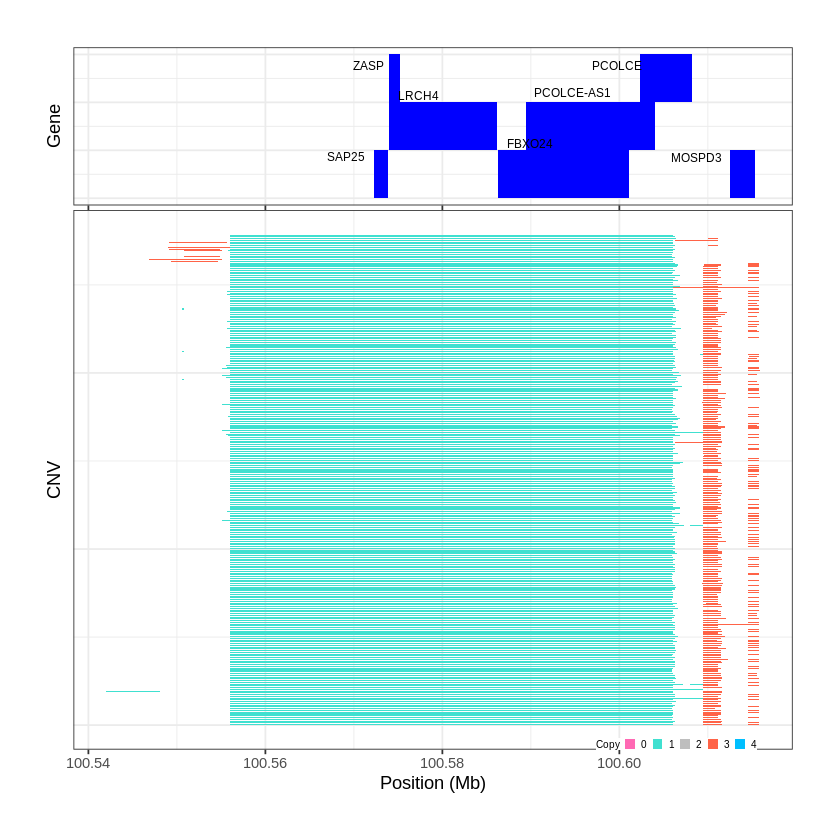

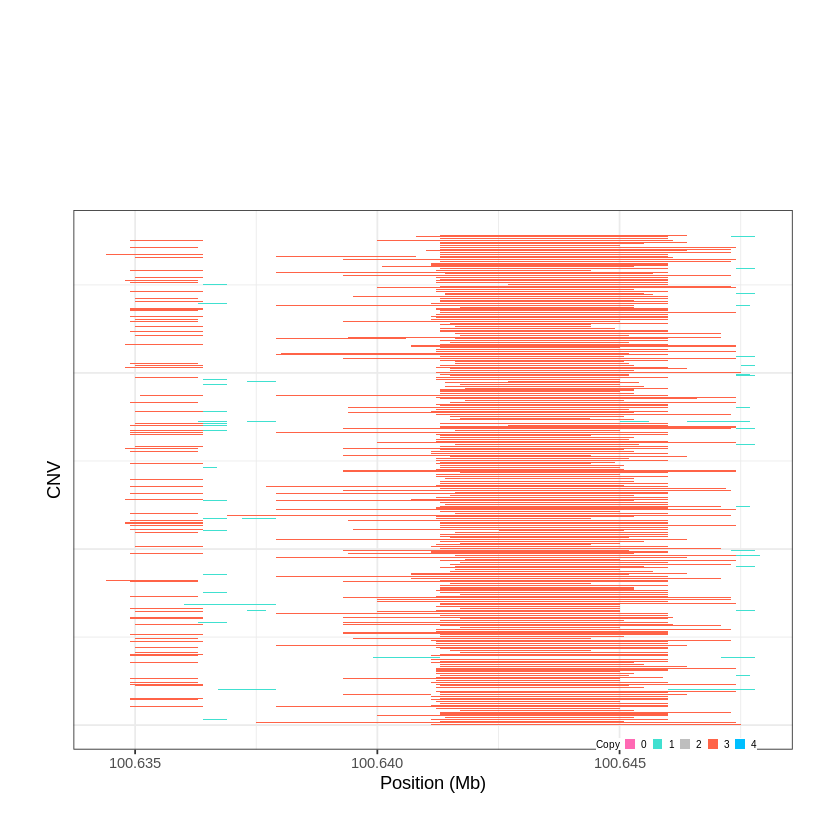

Task done, plot was stored in working directory.
[1] "Ploting CNVR 960..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 101.288501 - 101.3314 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 961..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 101.334201 - 101.3346 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


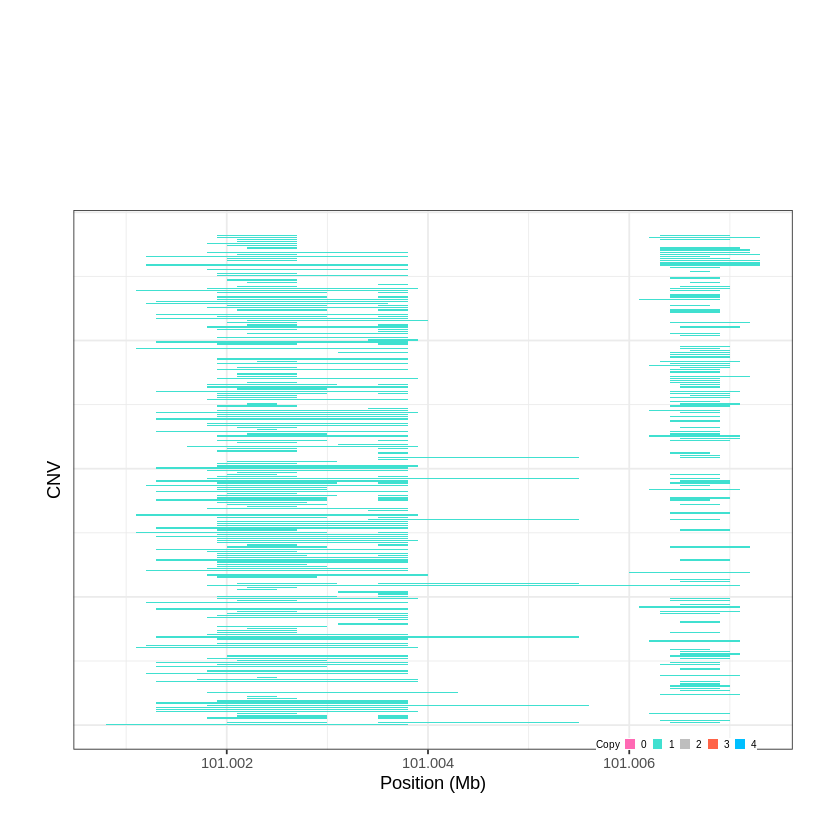

Task done, plot was stored in working directory.
[1] "Ploting CNVR 962..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 101.969401 - 102.0231 Mb with 259 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


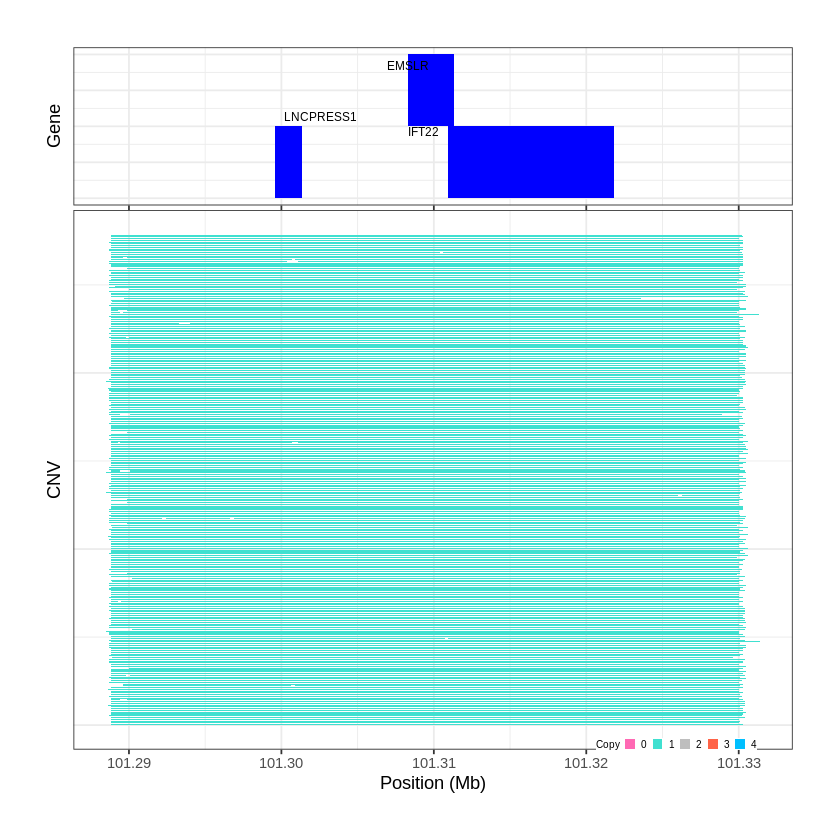

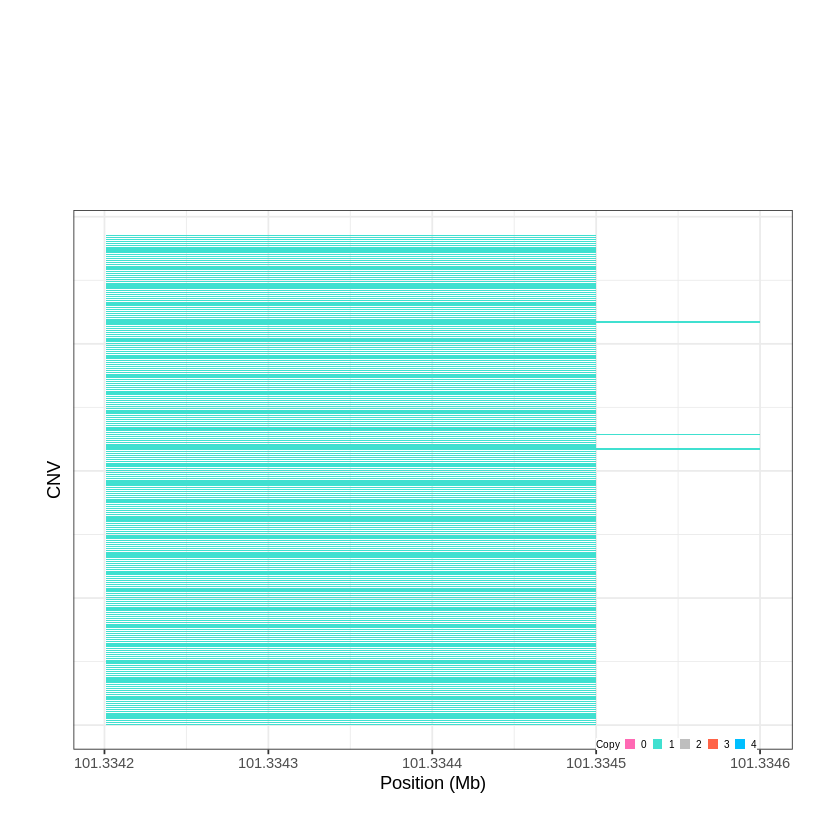

Task done, plot was stored in working directory.
[1] "Ploting CNVR 963..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 102.114801 - 102.3315 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 964..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 102.798201 - 102.8049 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


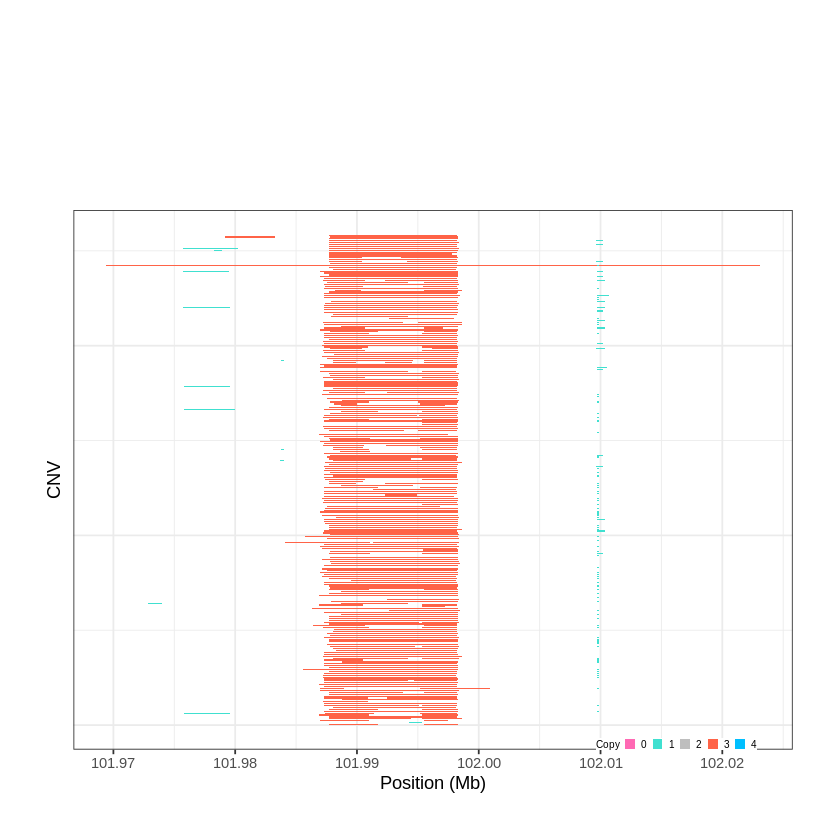

Task done, plot was stored in working directory.
[1] "Ploting CNVR 965..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 103.459301 - 103.4756 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


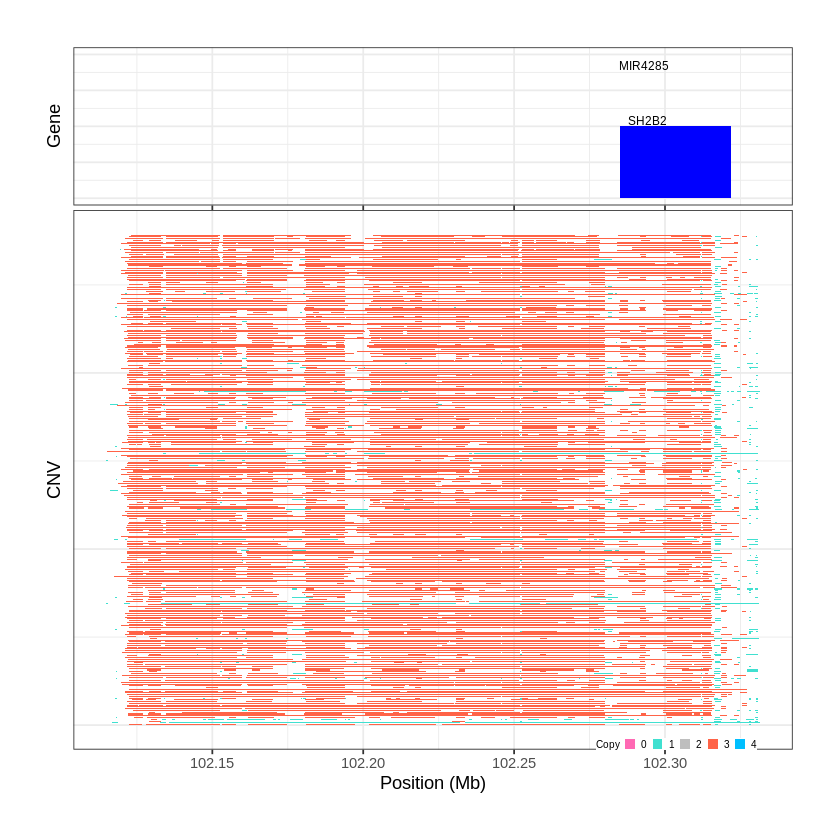

Task done, plot was stored in working directory.
[1] "Ploting CNVR 966..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 104.464301 - 104.4848 Mb with 243 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


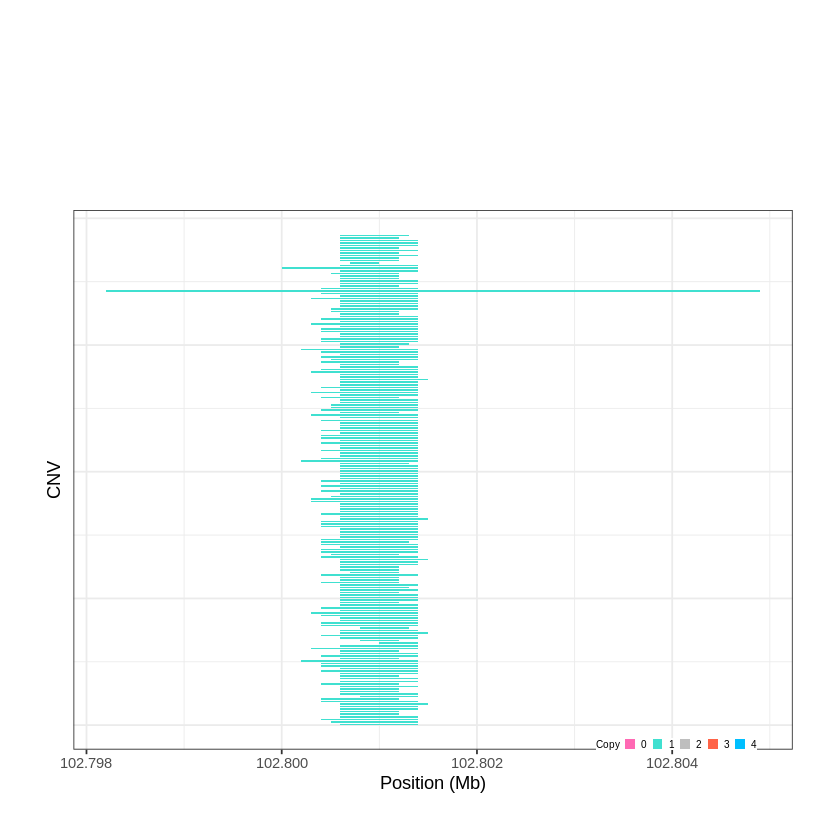

Task done, plot was stored in working directory.
[1] "Ploting CNVR 967..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 110.346601 - 110.3584 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


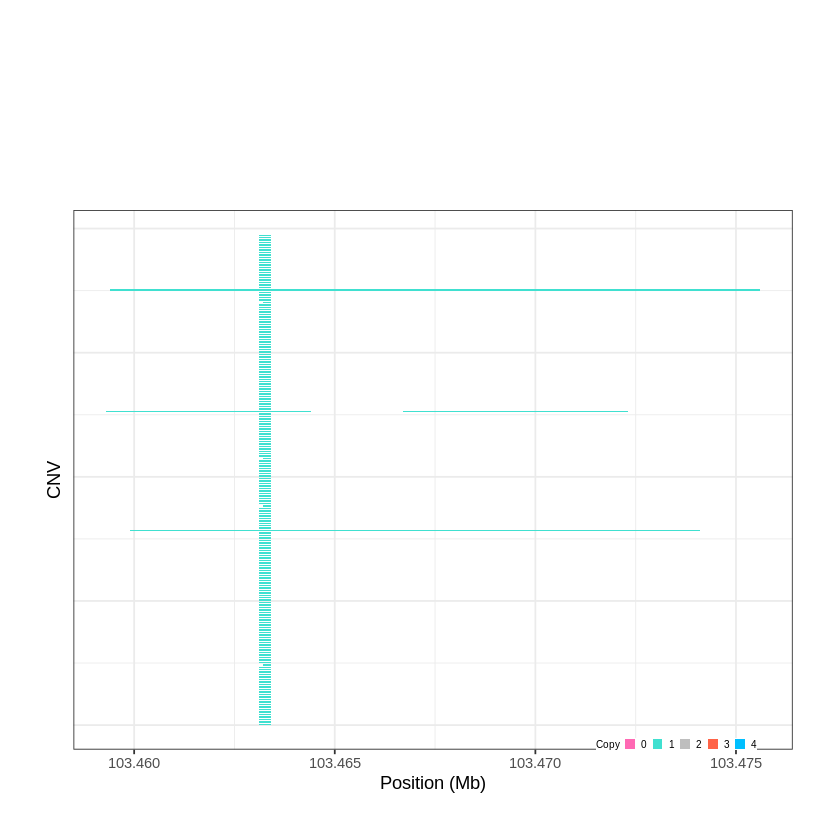

Task done, plot was stored in working directory.
[1] "Ploting CNVR 968..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 116.842001 - 116.8423 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


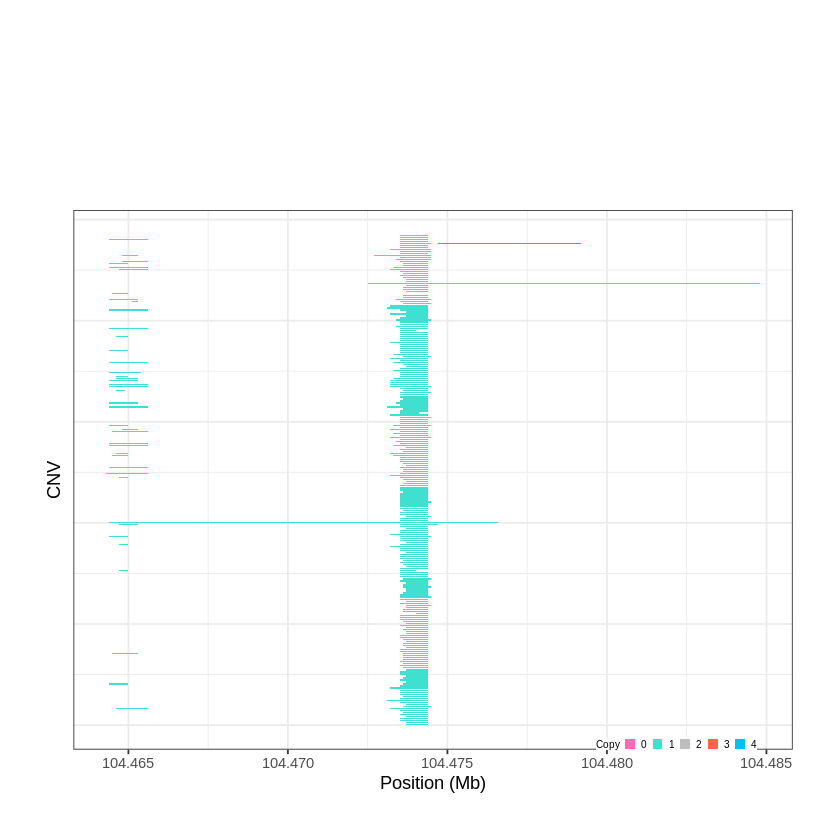

Task done, plot was stored in working directory.
[1] "Ploting CNVR 969..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 118.827701 - 118.8975 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


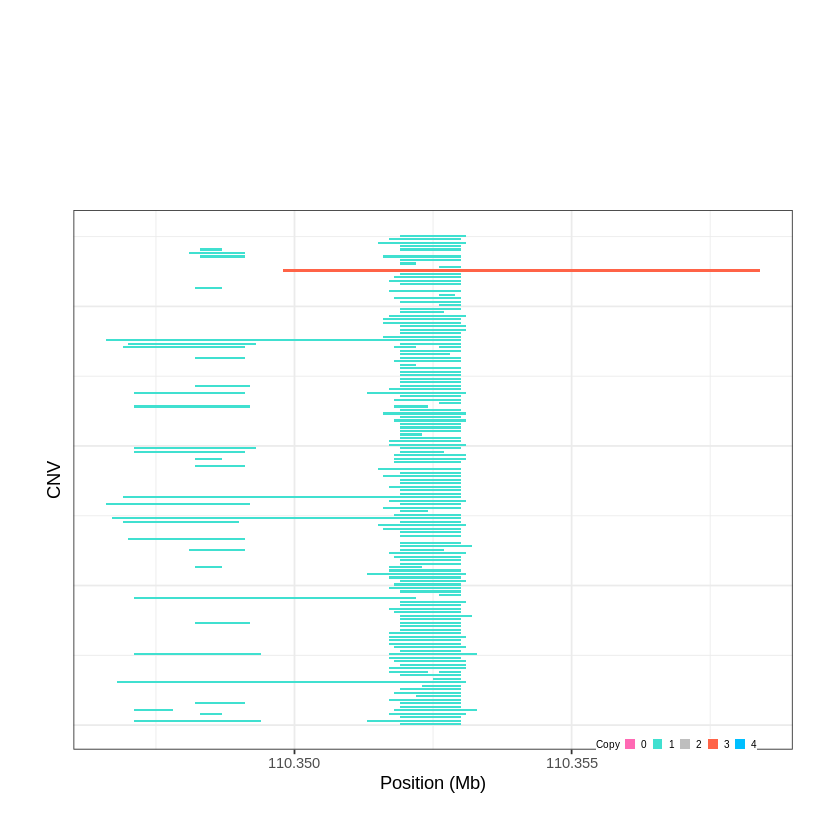

Task done, plot was stored in working directory.
[1] "Ploting CNVR 970..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 126.035201 - 126.0525 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


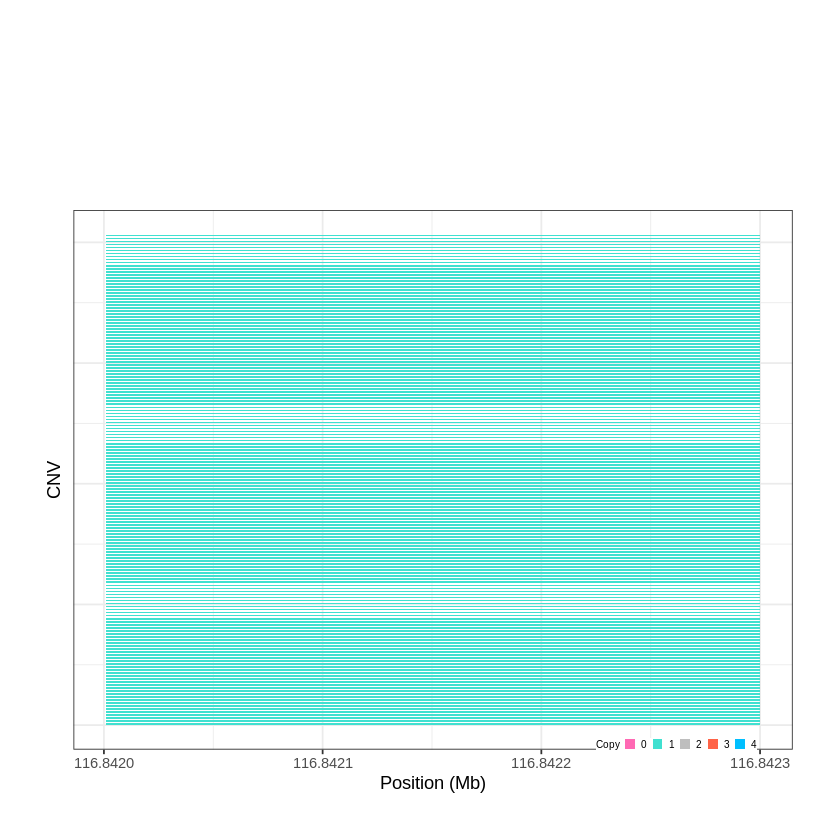

Task done, plot was stored in working directory.
[1] "Ploting CNVR 971..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 126.632101 - 126.6825 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


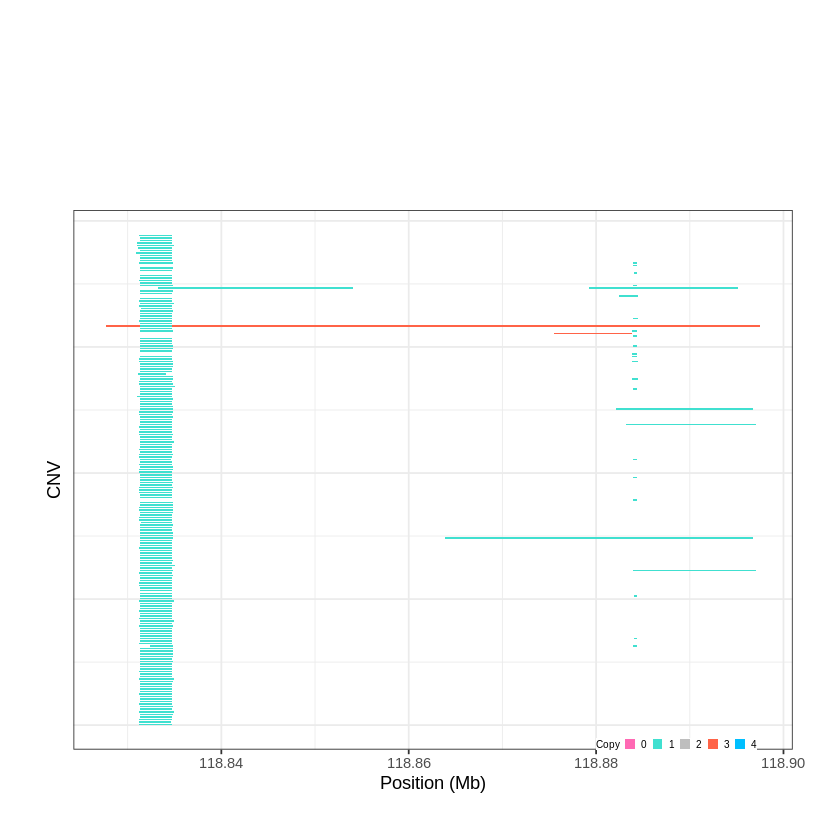

Task done, plot was stored in working directory.
[1] "Ploting CNVR 972..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 126.731101 - 126.7325 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


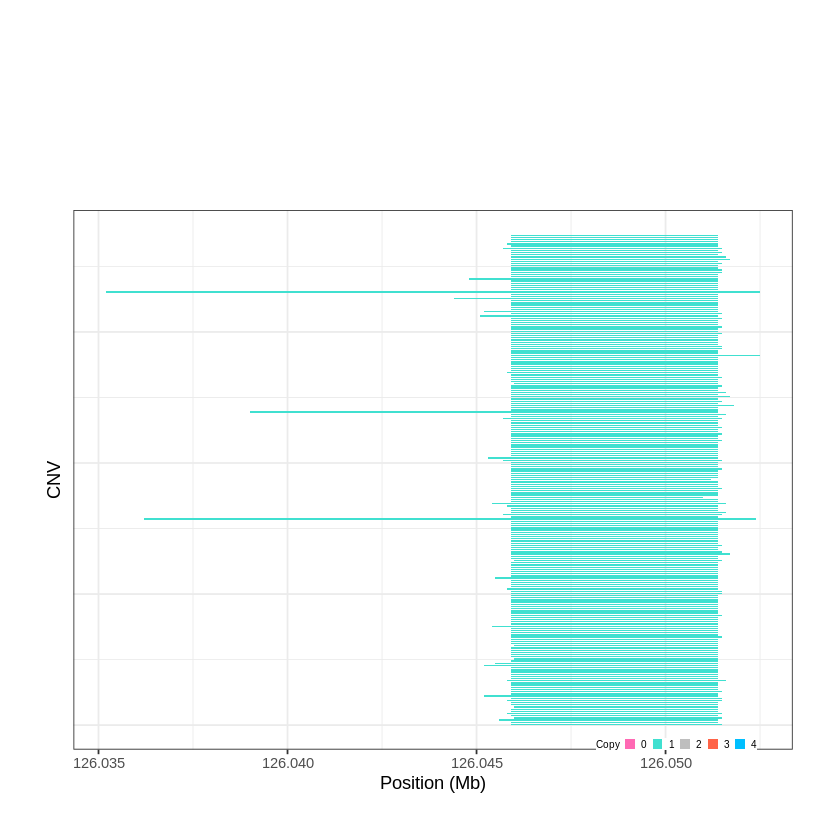

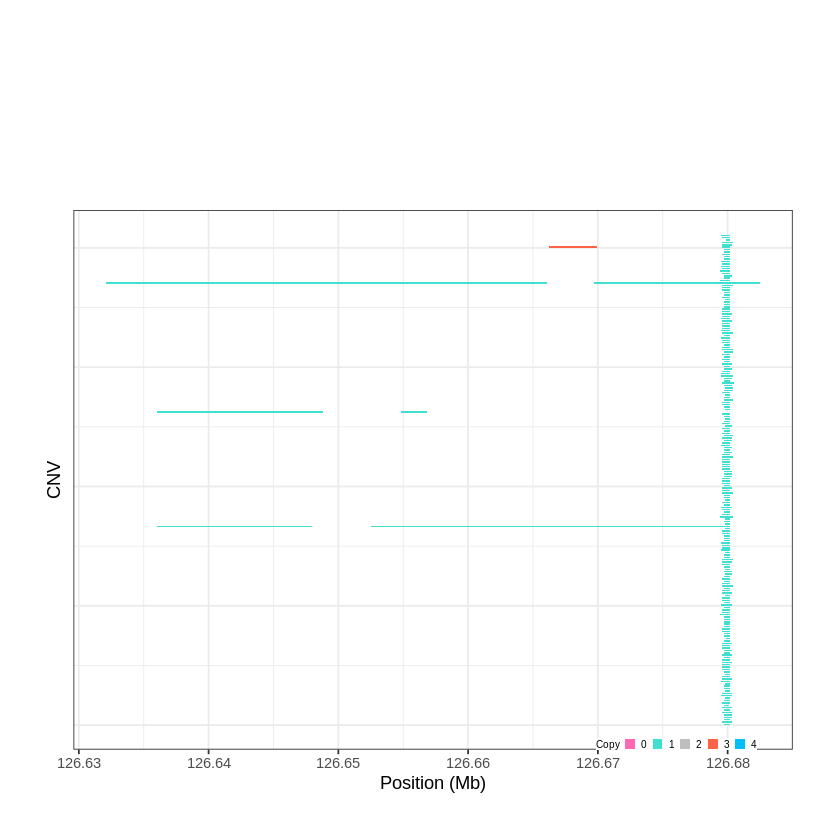

Task done, plot was stored in working directory.
[1] "Ploting CNVR 973..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 130.137101 - 130.2814 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 974..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 132.244001 - 132.2509 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


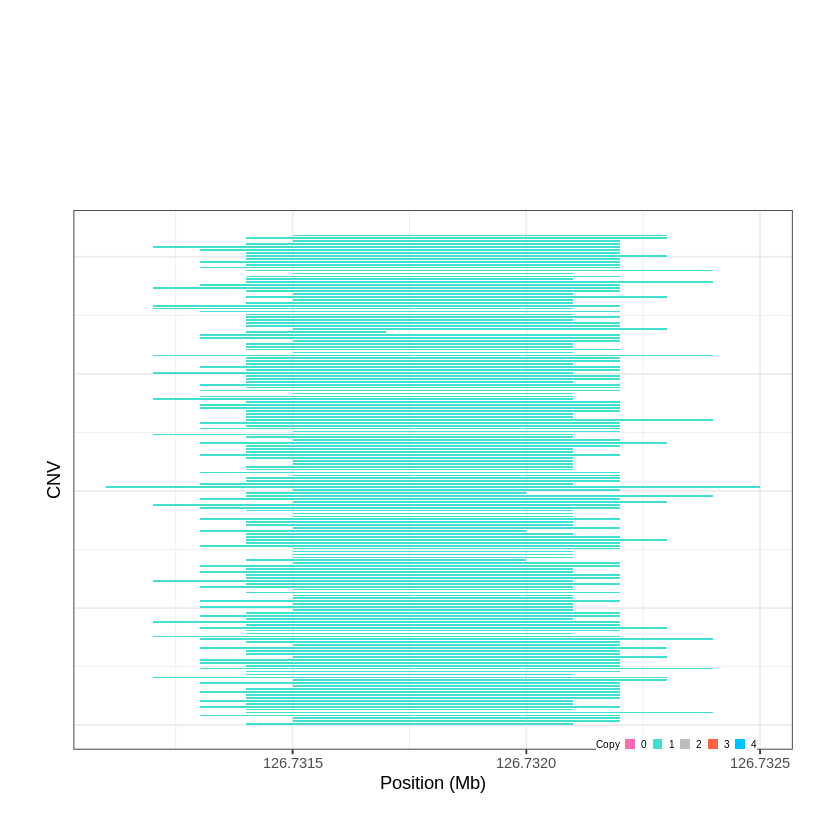

Task done, plot was stored in working directory.
[1] "Ploting CNVR 975..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 133.784701 - 133.7986 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


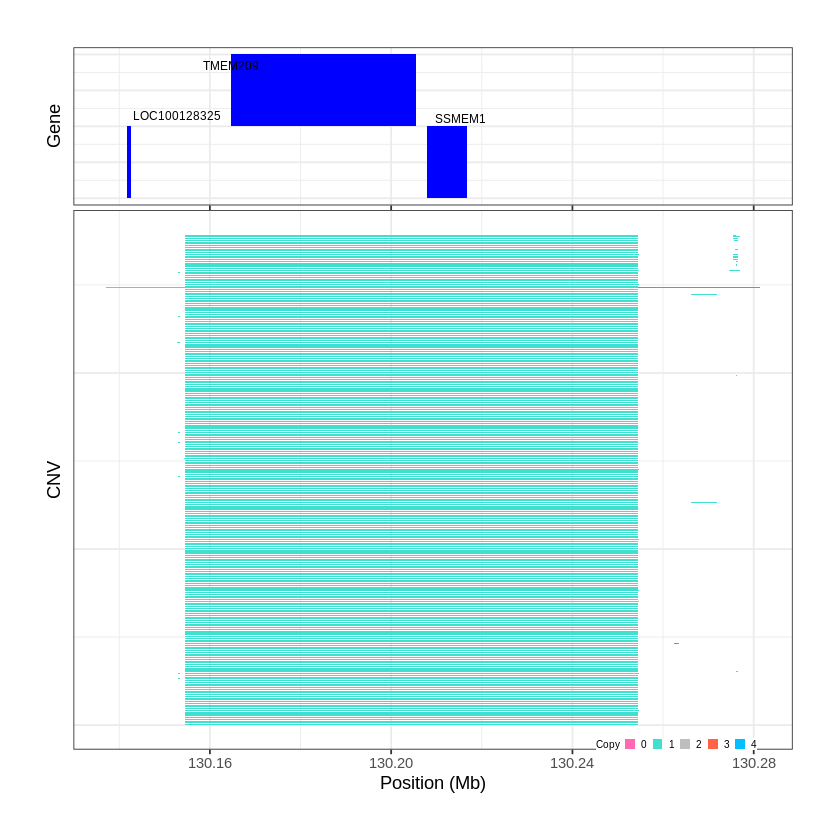

Task done, plot was stored in working directory.
[1] "Ploting CNVR 976..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 136.486901 - 136.5442 Mb with 222 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


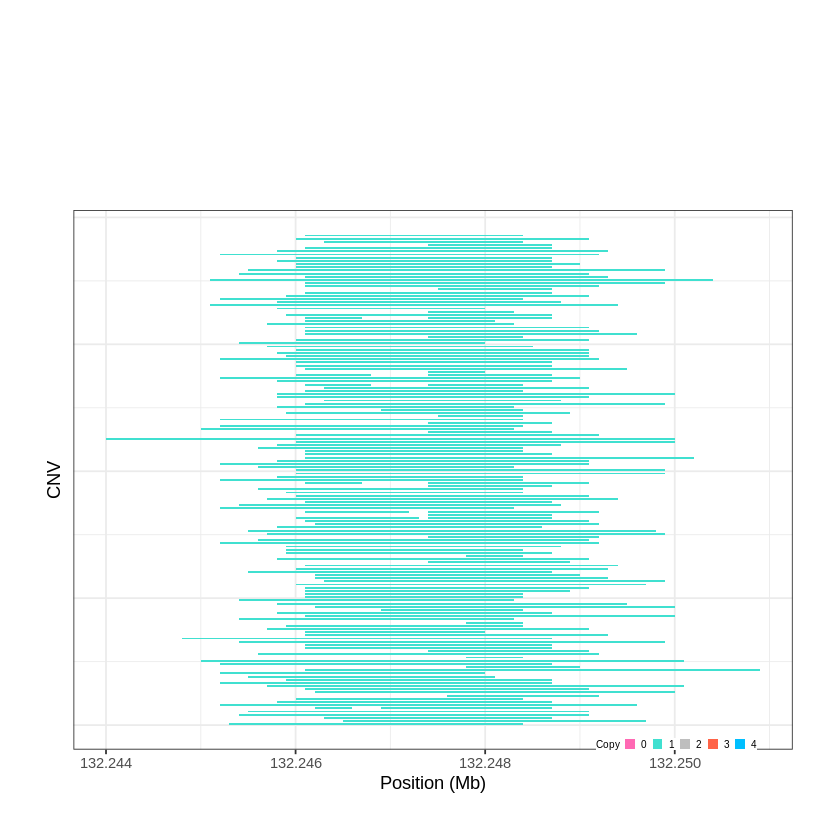

Task done, plot was stored in working directory.
[1] "Ploting CNVR 977..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 138.296301 - 138.2971 Mb with 204 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


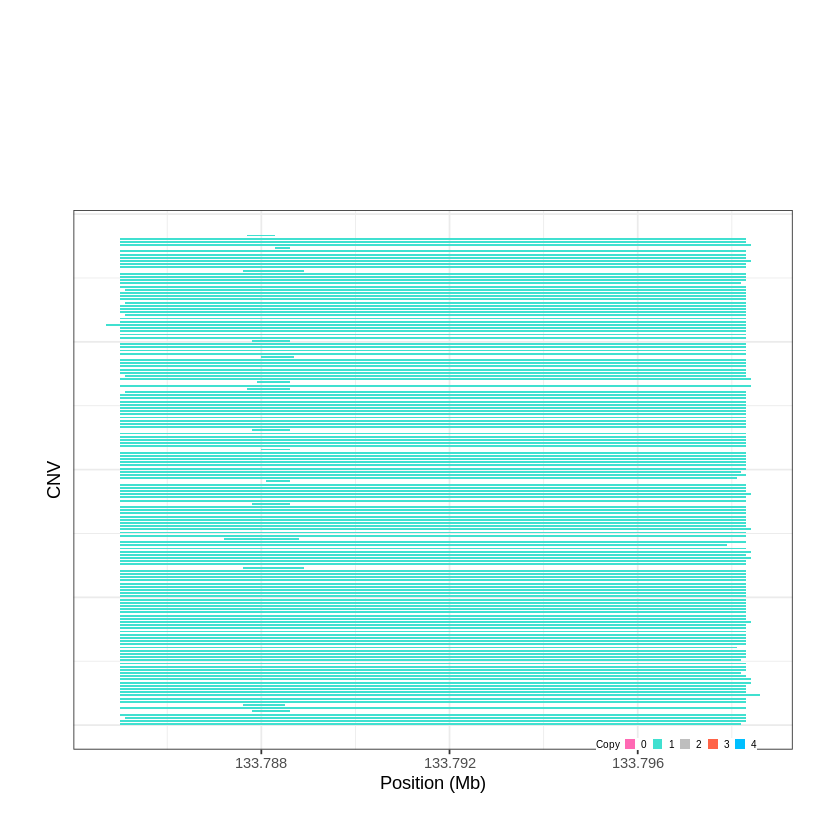

Task done, plot was stored in working directory.
[1] "Ploting CNVR 978..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 138.348601 - 138.3508 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


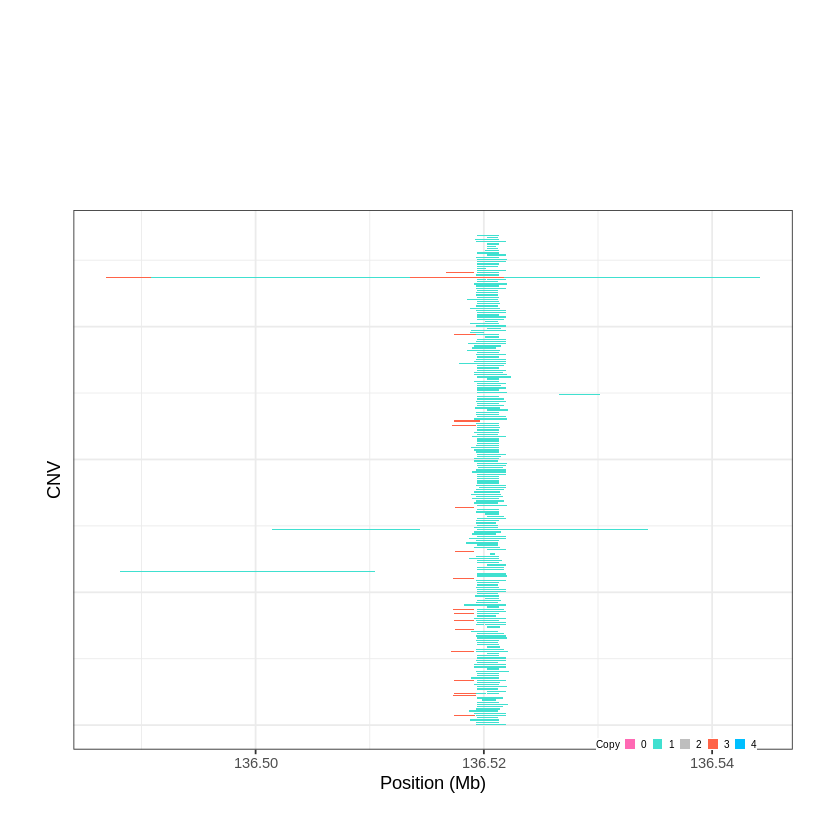

Task done, plot was stored in working directory.
[1] "Ploting CNVR 979..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 139.362601 - 139.423 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


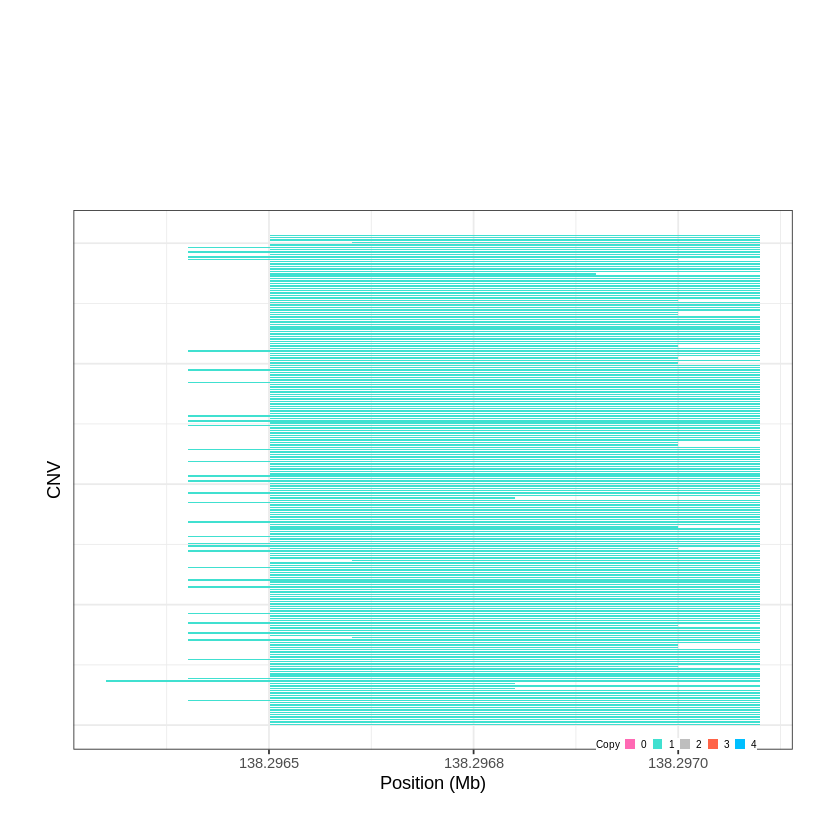

Task done, plot was stored in working directory.
[1] "Ploting CNVR 980..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 140.188501 - 140.1917 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


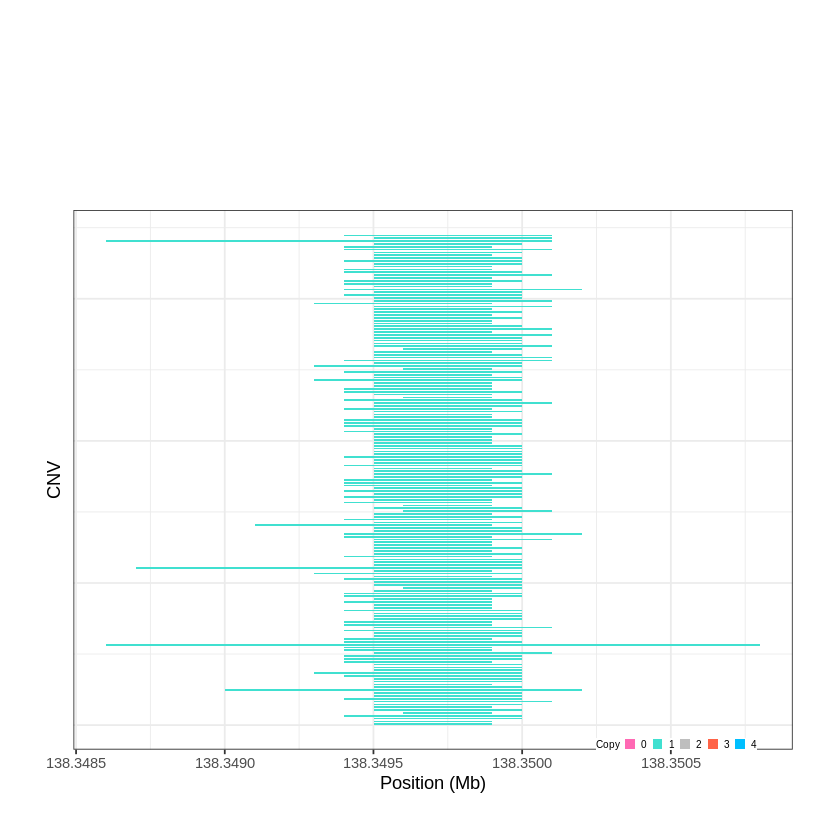

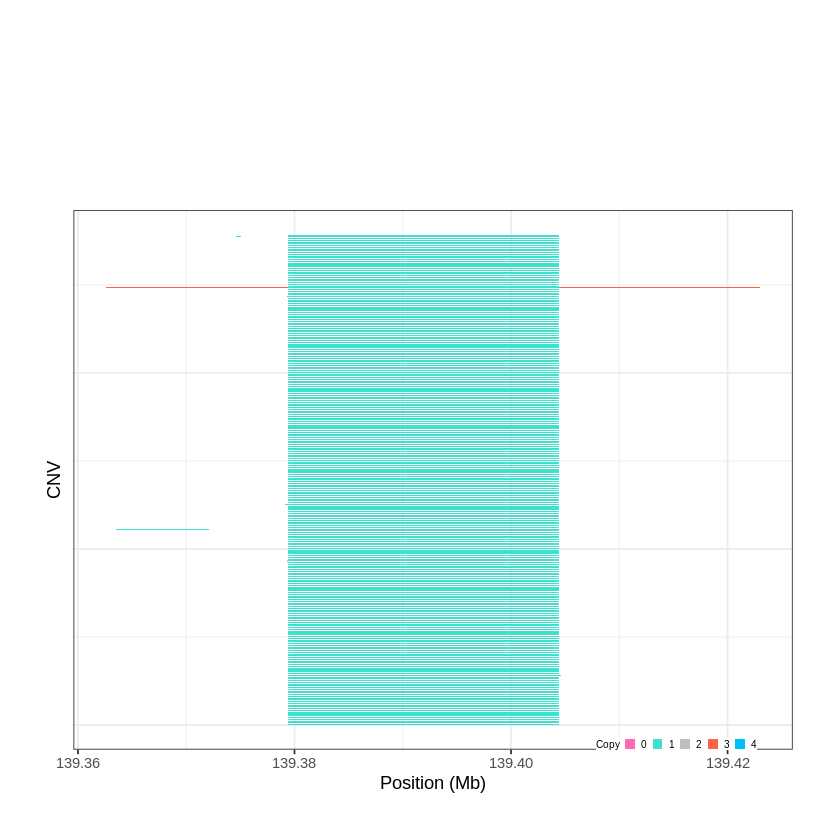

Task done, plot was stored in working directory.
[1] "Ploting CNVR 981..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 141.726601 - 141.7596 Mb with 221 Individual - "
Plotting gene...


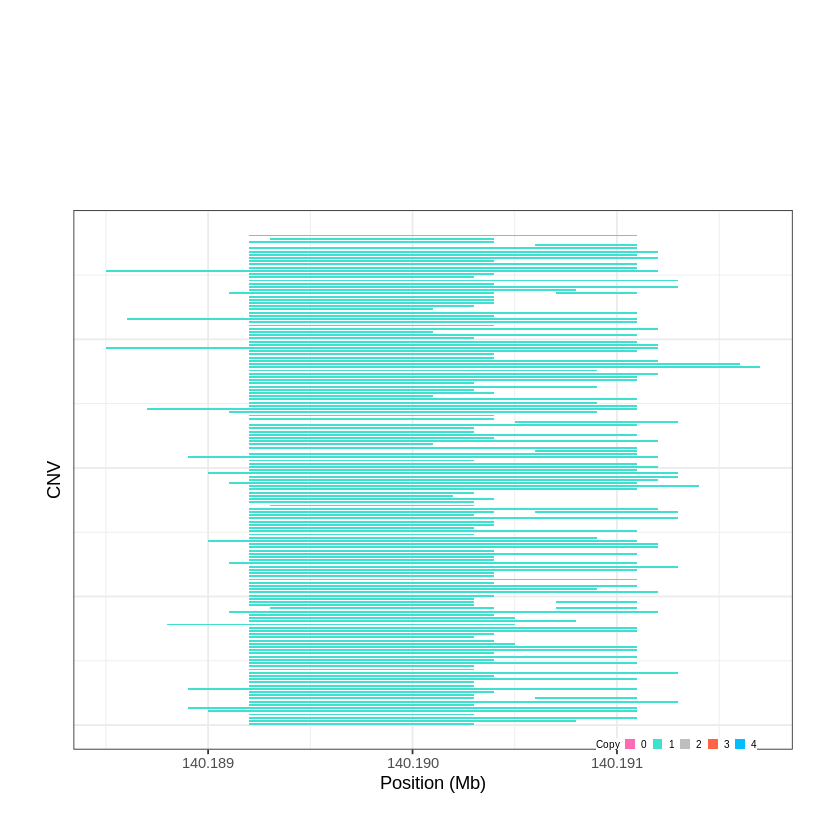

Task done, plot was stored in working directory.
[1] "Ploting CNVR 982..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 141.759601 - 141.797 Mb with 155 Individual - "
Plotting gene...


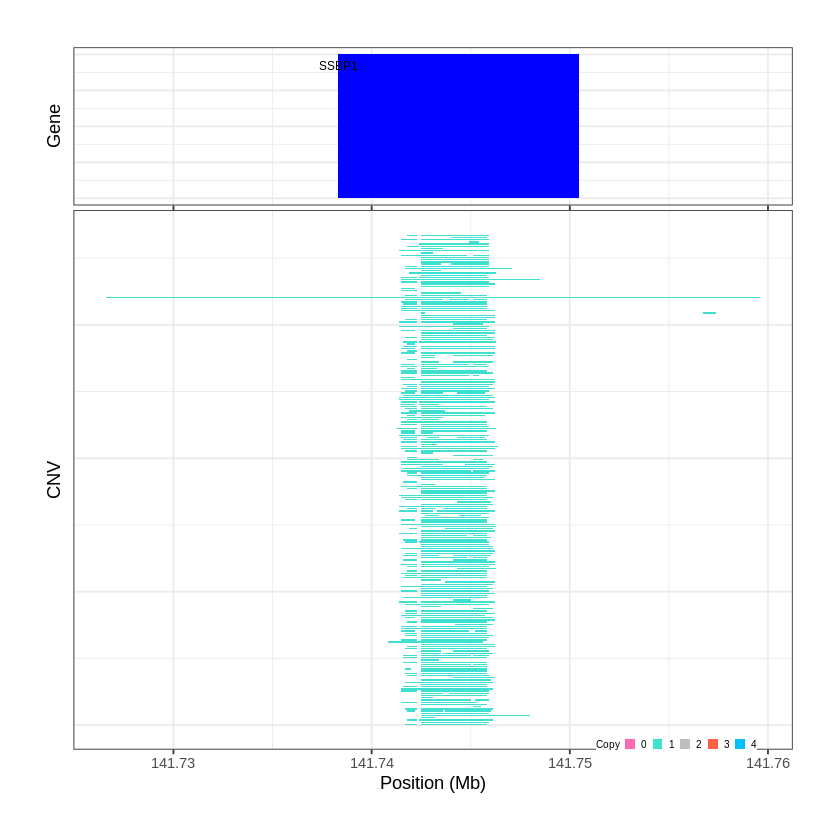

Task done, plot was stored in working directory.
[1] "Ploting CNVR 983..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 141.977601 - 142.1102 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 984..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 142.276201 - 142.3263 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


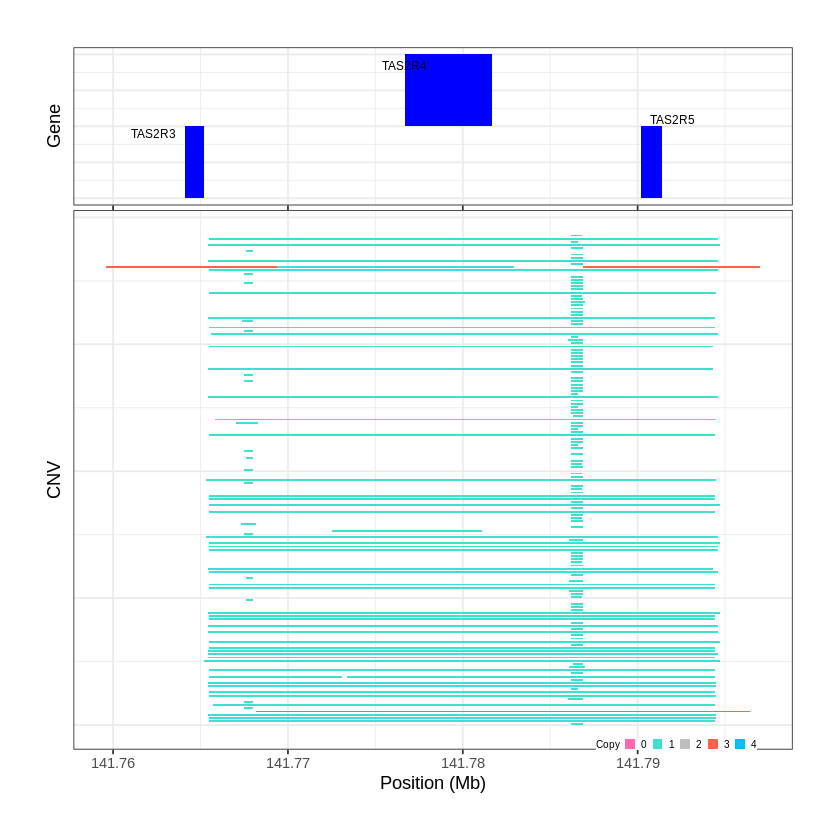

Task done, plot was stored in working directory.
[1] "Ploting CNVR 985..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 142.347901 - 142.3812 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


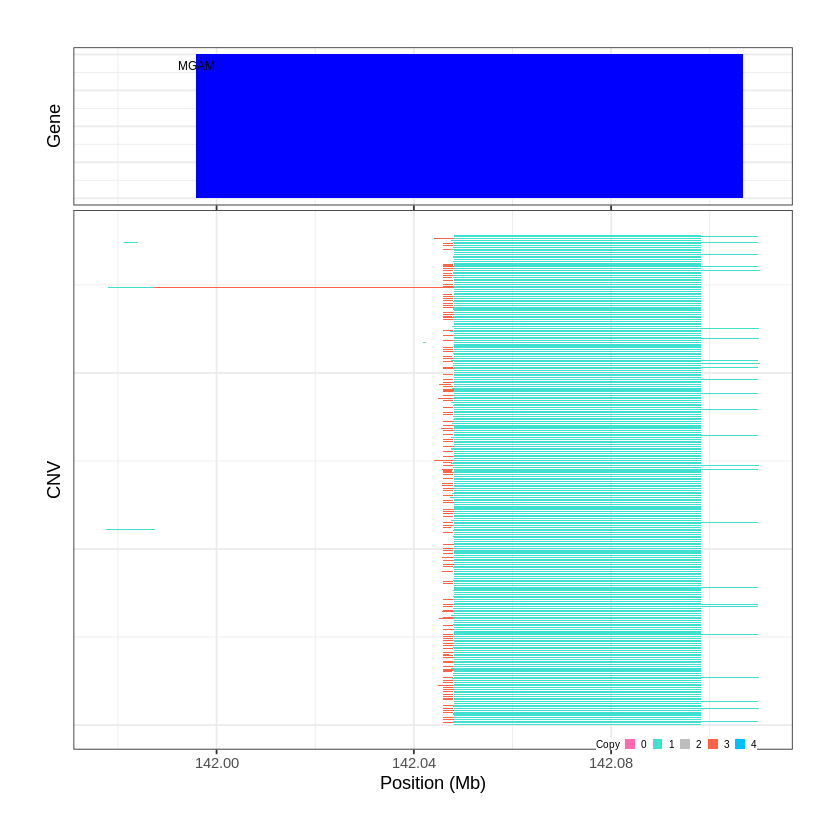

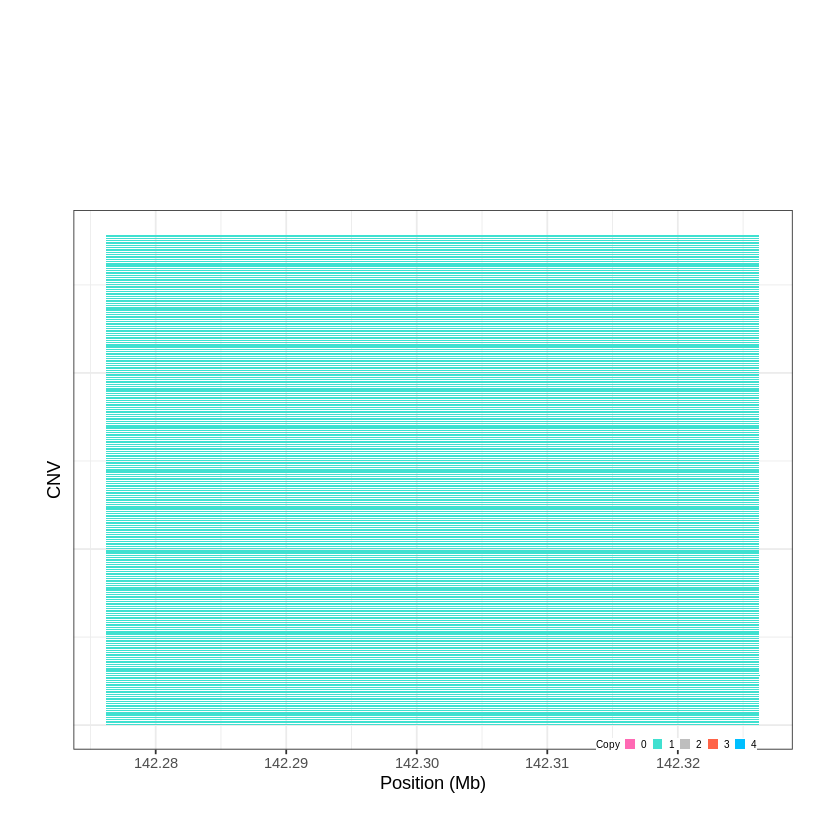

Task done, plot was stored in working directory.
[1] "Ploting CNVR 986..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 142.400601 - 142.5012 Mb with 203 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 987..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 142.543901 - 142.6118 Mb with 226 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


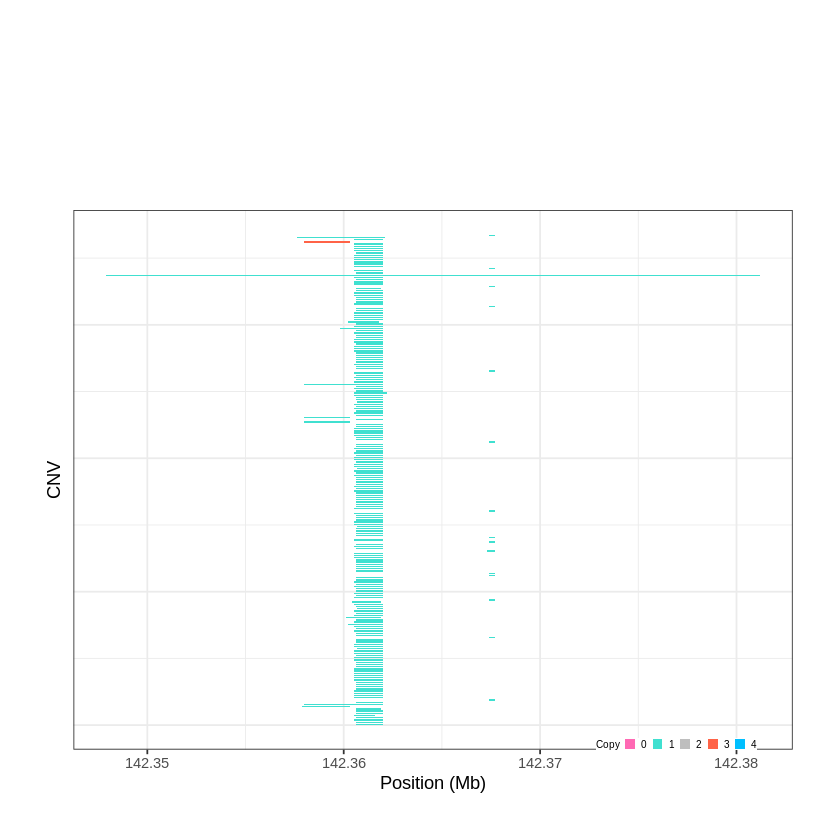

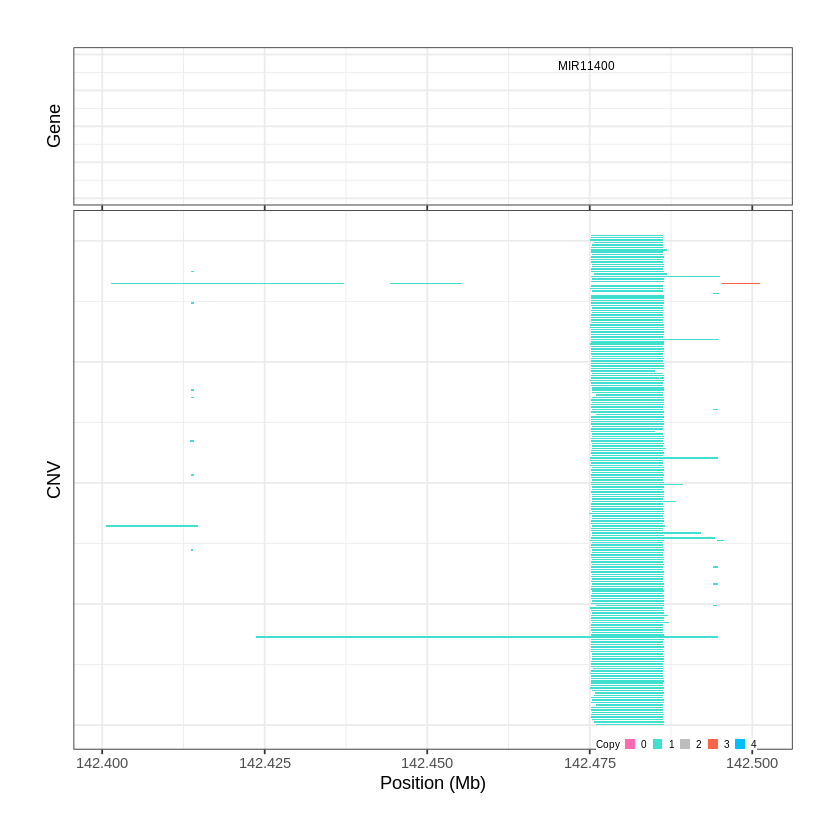

Task done, plot was stored in working directory.
[1] "Ploting CNVR 988..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 143.204701 - 143.5886 Mb with 279 Individual - "
Plotting gene...


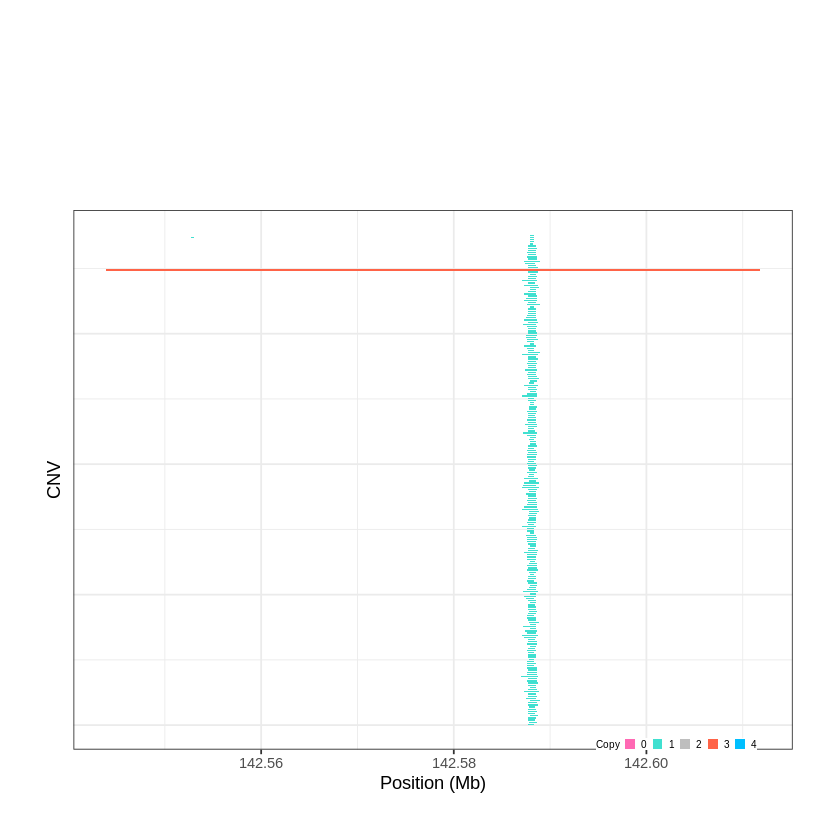

Task done, plot was stored in working directory.
[1] "Ploting CNVR 989..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 143.876801 - 144.0814 Mb with 276 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 990..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 145.982401 - 145.9835 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


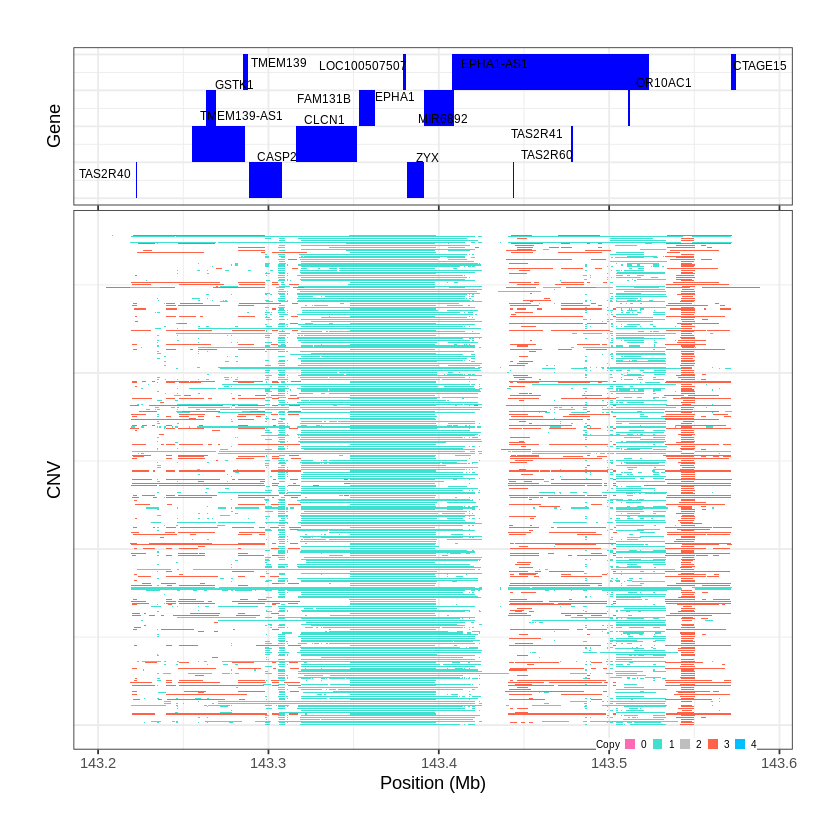

Task done, plot was stored in working directory.
[1] "Ploting CNVR 991..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 146.722001 - 146.723 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


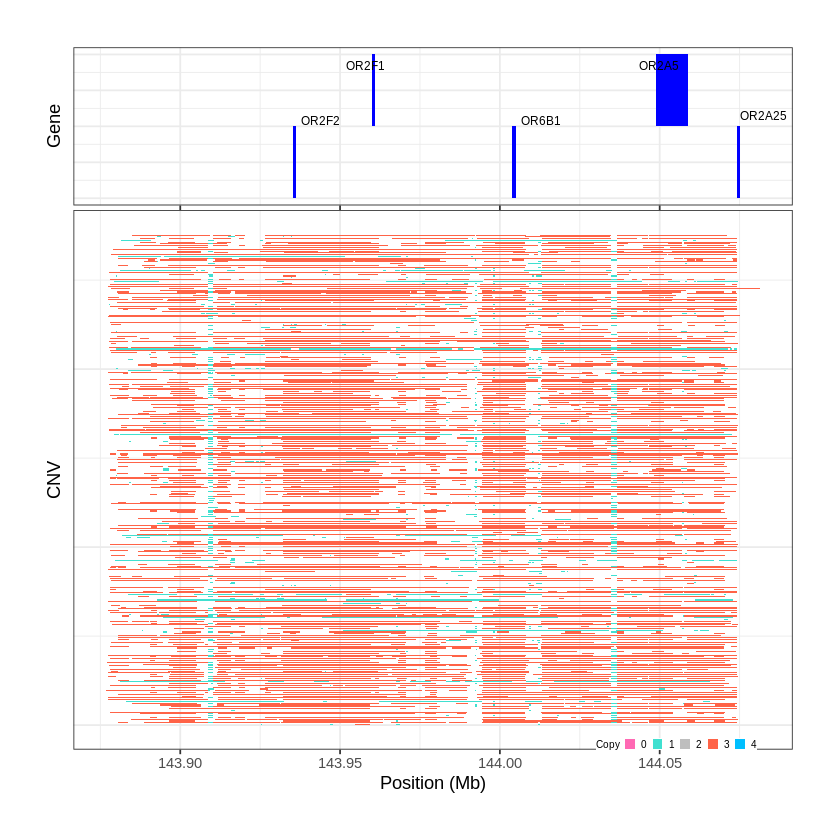

Task done, plot was stored in working directory.
[1] "Ploting CNVR 992..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 148.025401 - 148.0302 Mb with 259 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


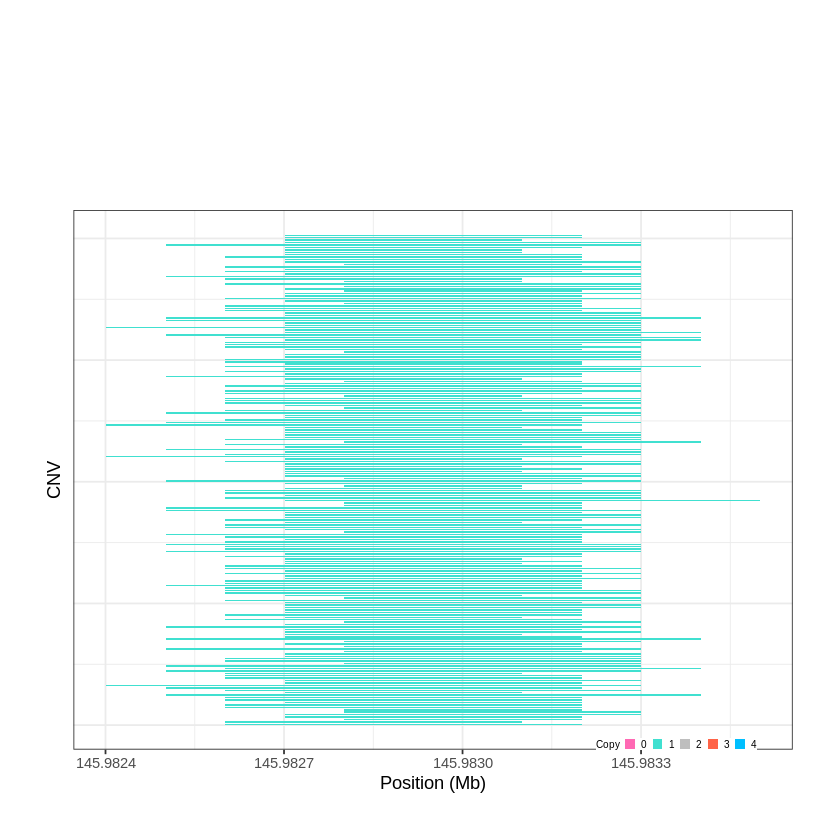

Task done, plot was stored in working directory.
[1] "Ploting CNVR 993..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 148.071401 - 148.1867 Mb with 244 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


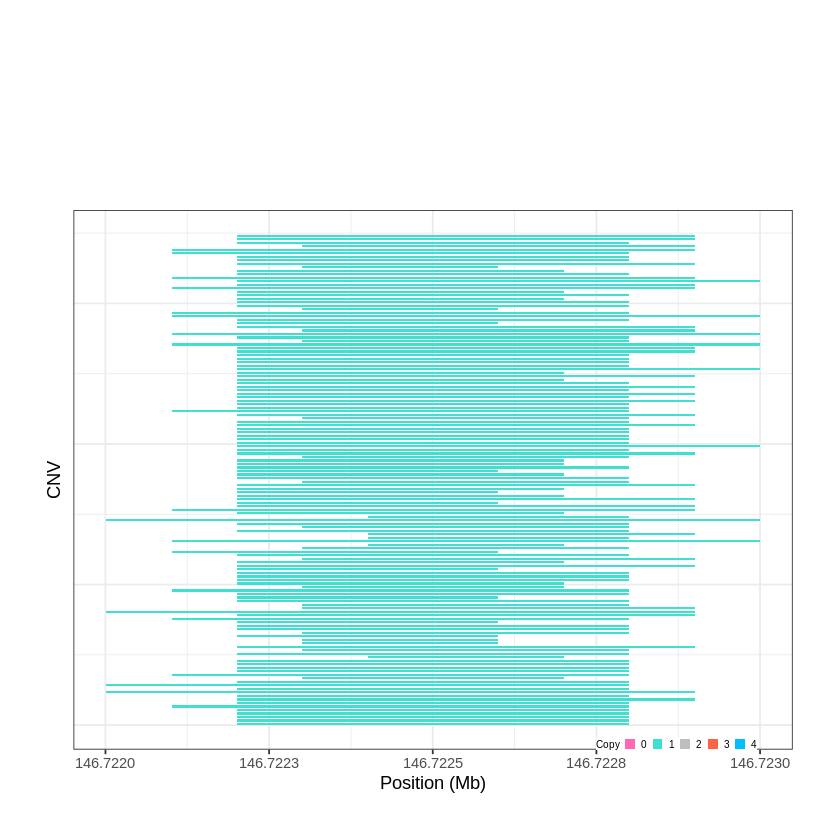

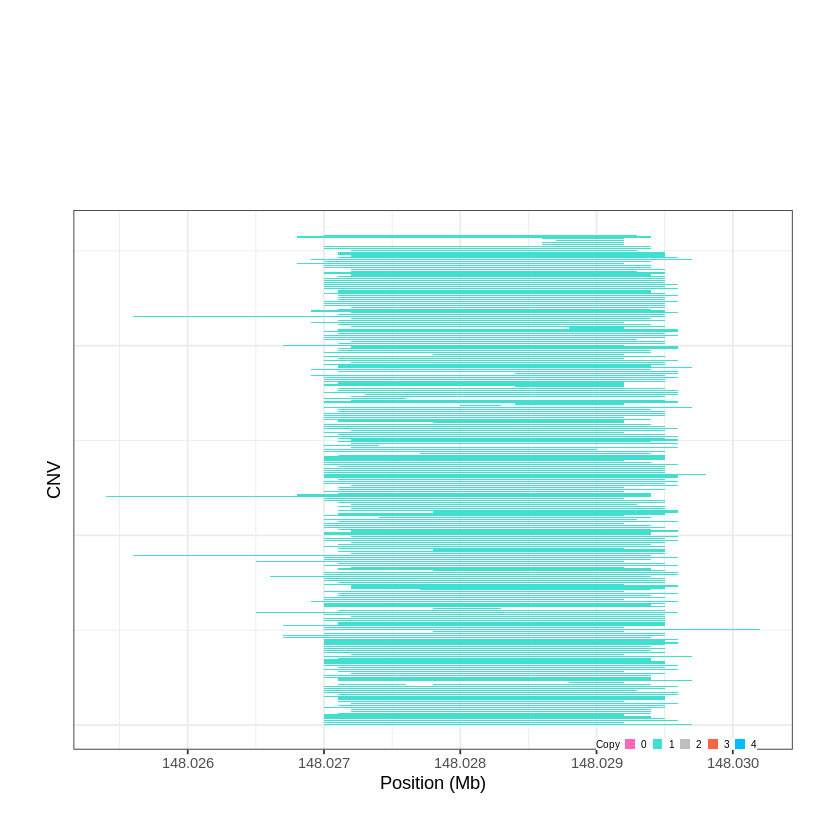

Task done, plot was stored in working directory.
[1] "Ploting CNVR 994..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 148.572001 - 149.0362 Mb with 223 Individual - "
Plotting gene...


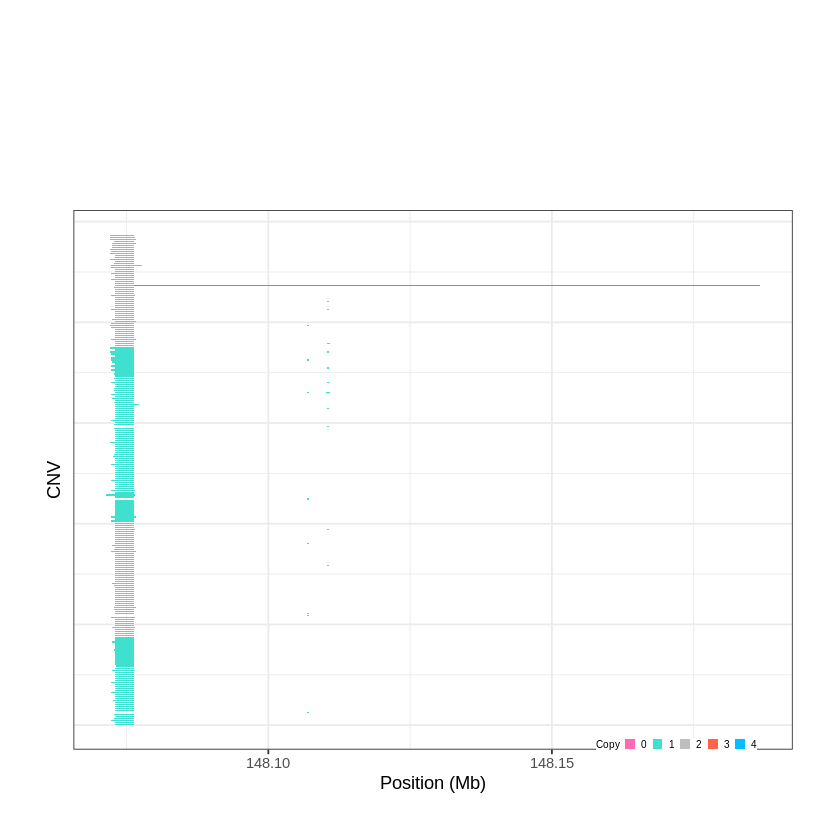

Task done, plot was stored in working directory.
[1] "Ploting CNVR 995..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 149.386601 - 149.759 Mb with 274 Individual - "
Plotting gene...


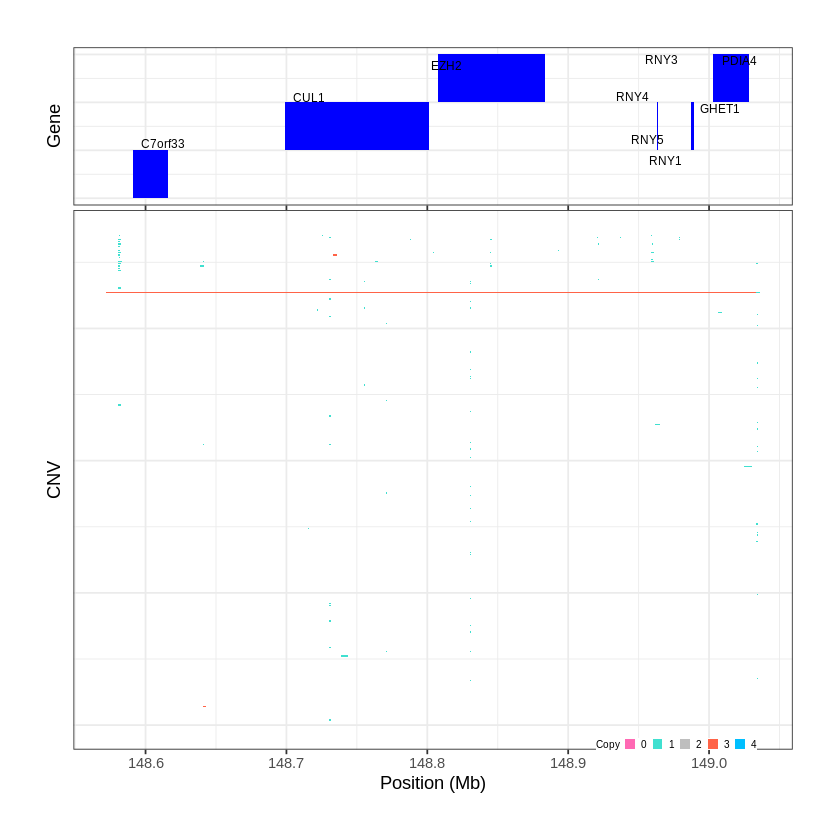

Task done, plot was stored in working directory.
[1] "Ploting CNVR 996..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 149.826601 - 149.9499 Mb with 150 Individual - "
Plotting gene...


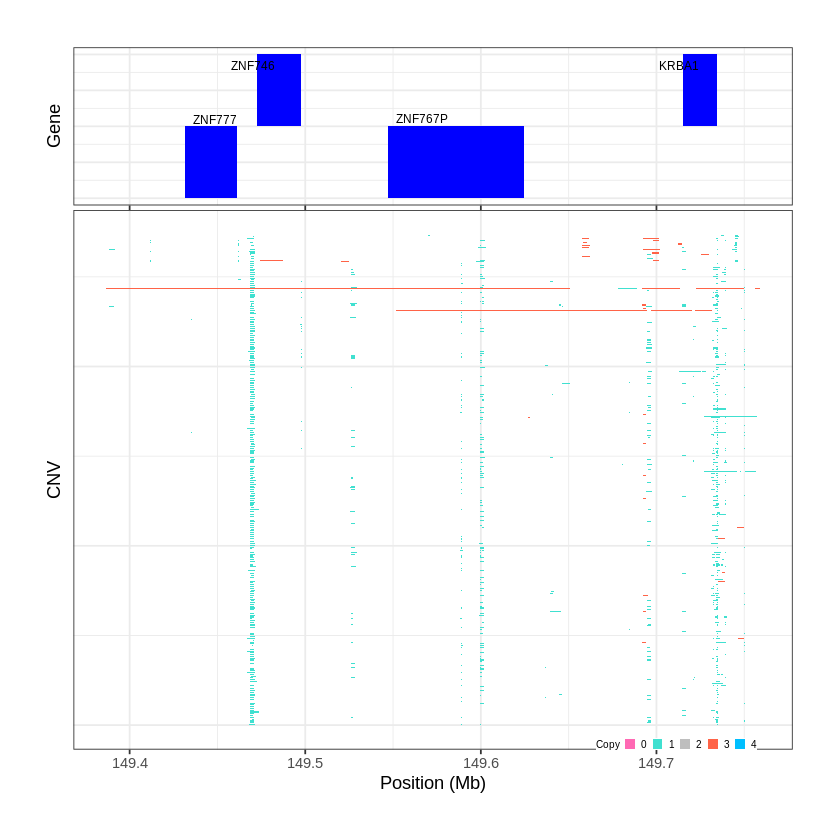

Task done, plot was stored in working directory.
[1] "Ploting CNVR 997..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 150.620601 - 150.9905 Mb with 245 Individual - "
Plotting gene...


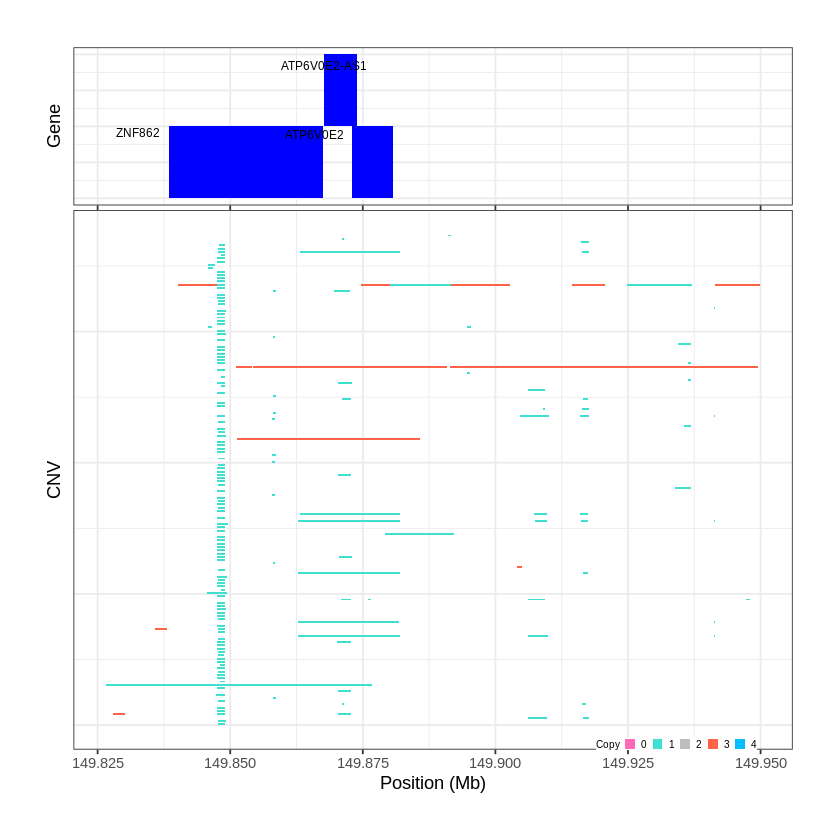

Task done, plot was stored in working directory.
[1] "Ploting CNVR 998..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 151.613901 - 152.0008 Mb with 152 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 999..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 152.244901 - 152.2464 Mb with 185 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


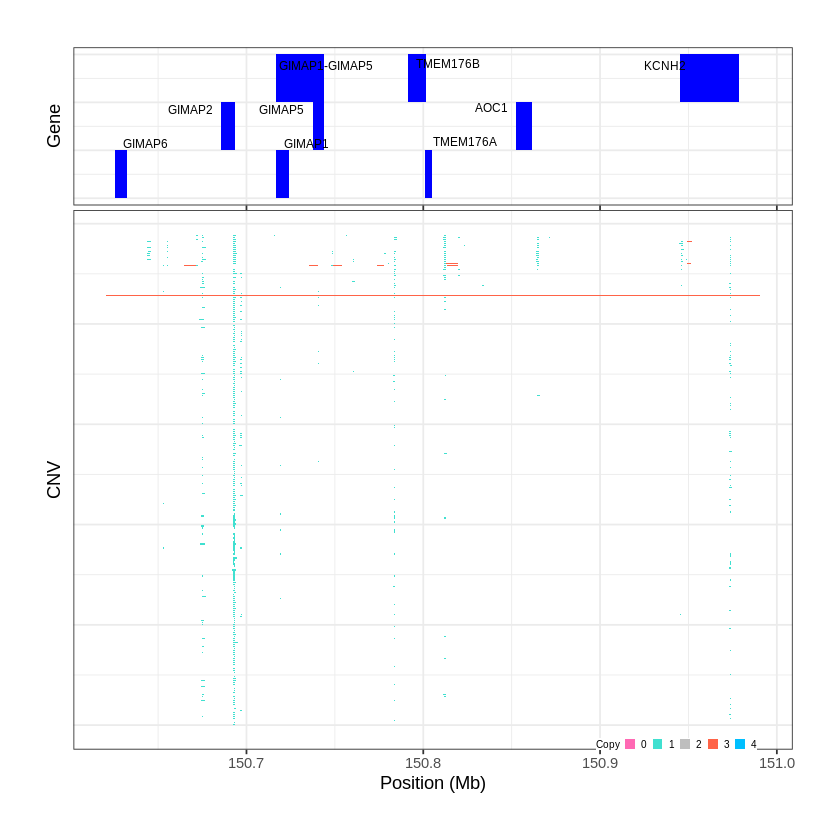

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1000..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 152.409201 - 152.4109 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


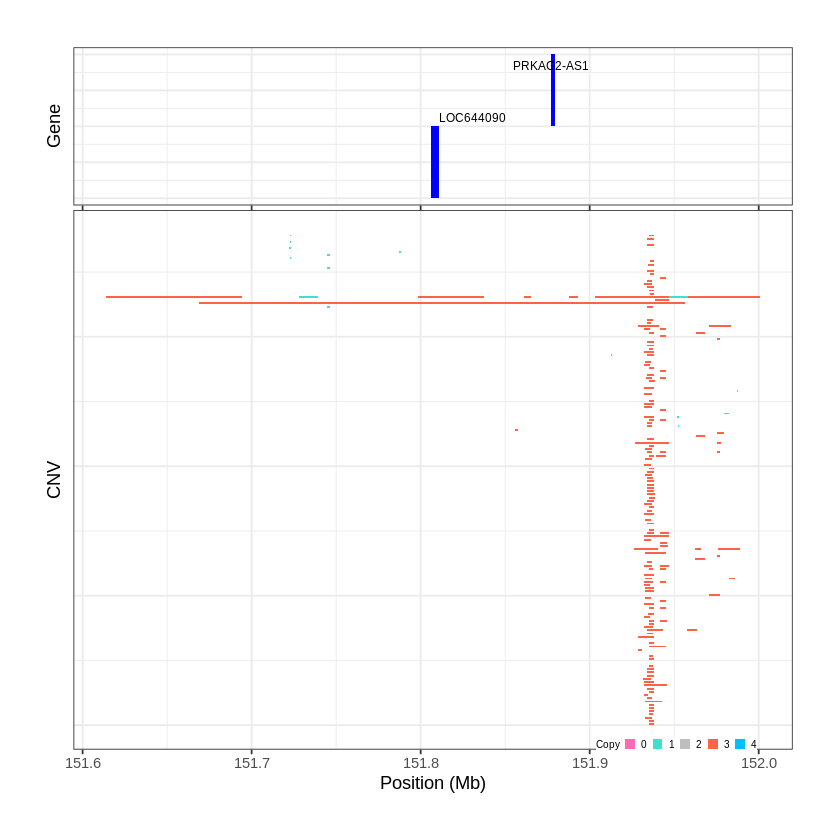

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1001..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 153.200801 - 153.2048 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


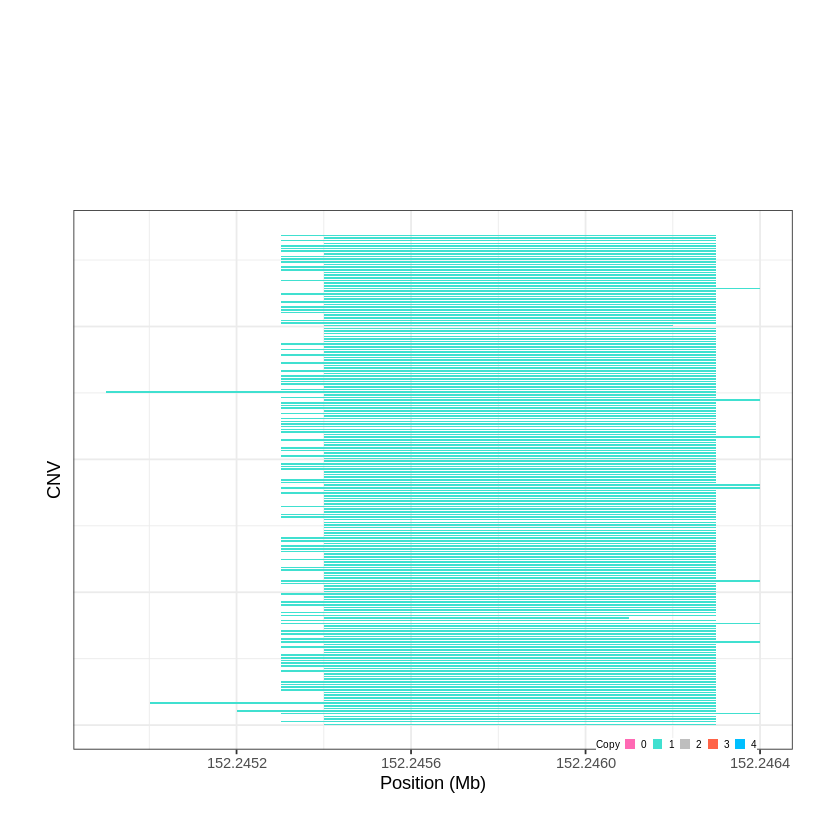

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1002..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 153.308401 - 153.3132 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


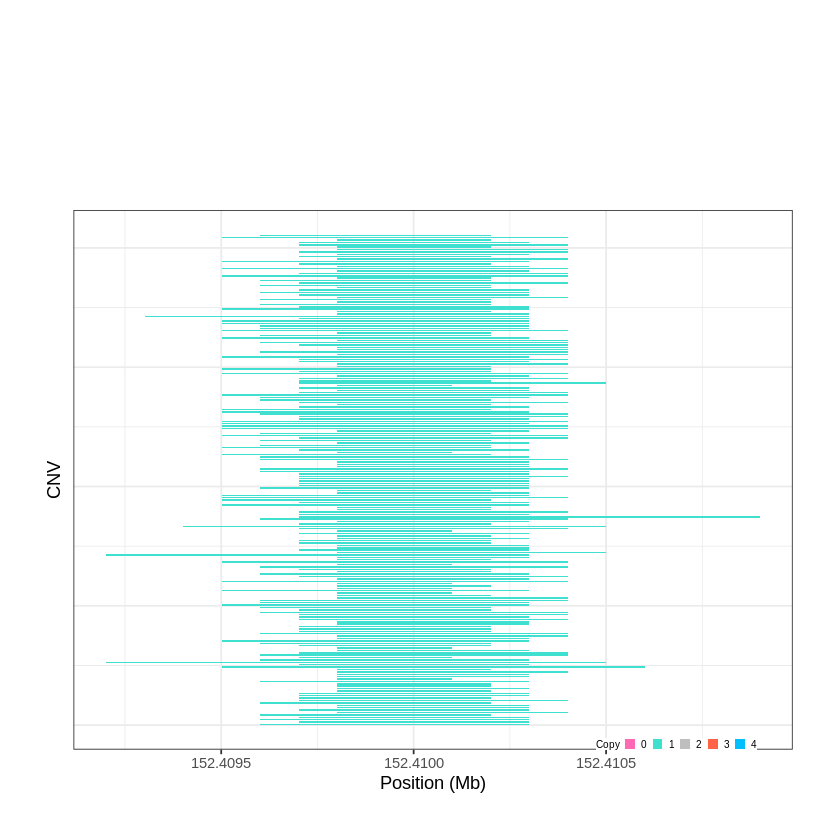

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1003..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 153.414001 - 153.7788 Mb with 261 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


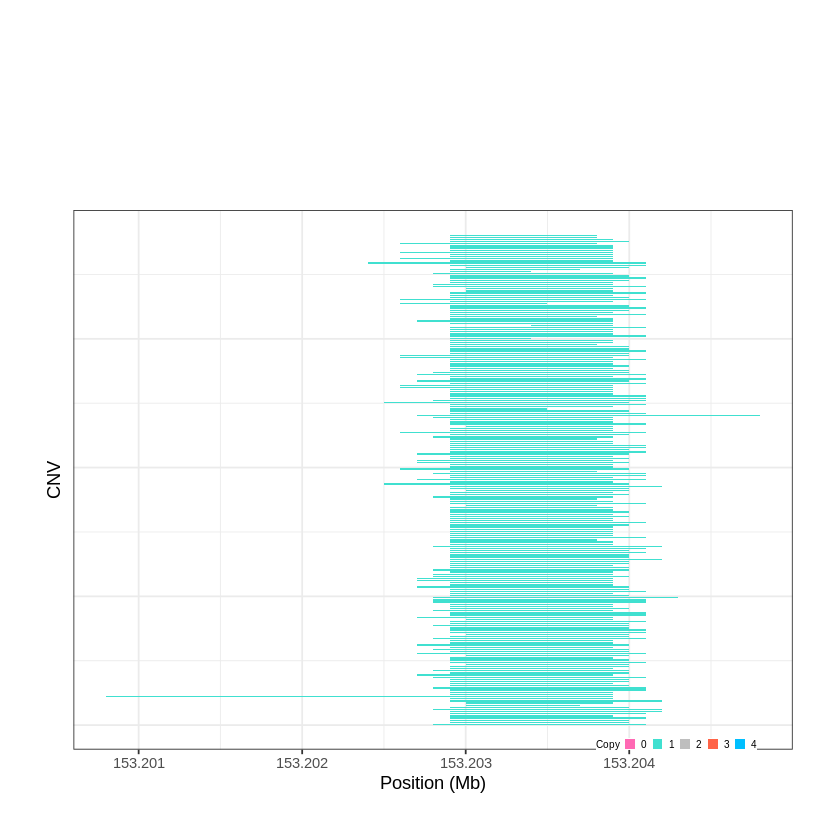

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1004..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 154.261201 - 154.3712 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


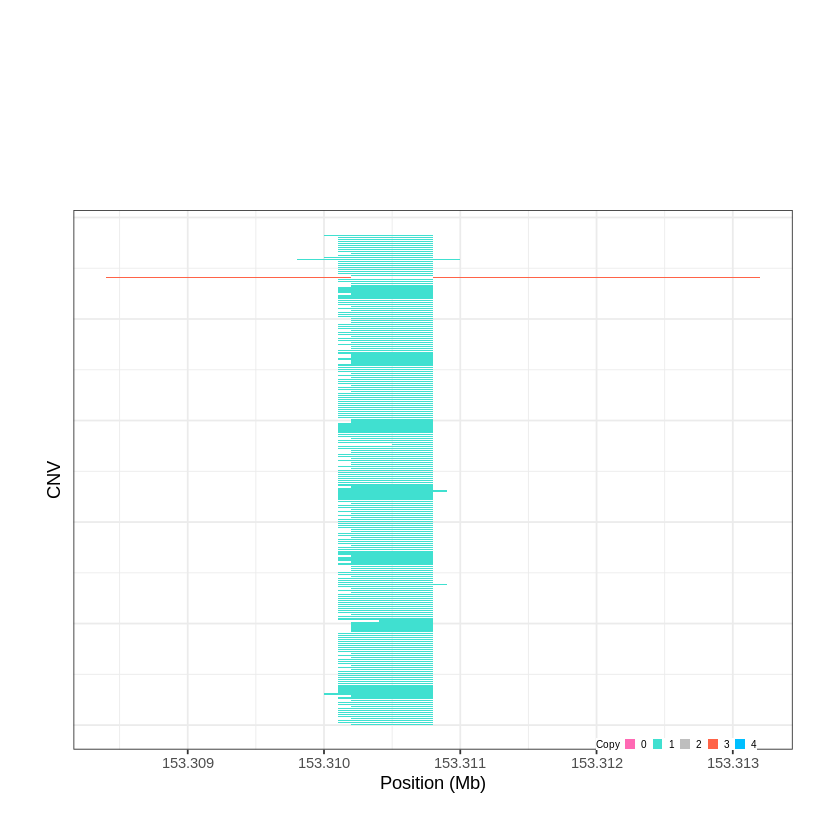

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1005..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 154.390701 - 154.4008 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


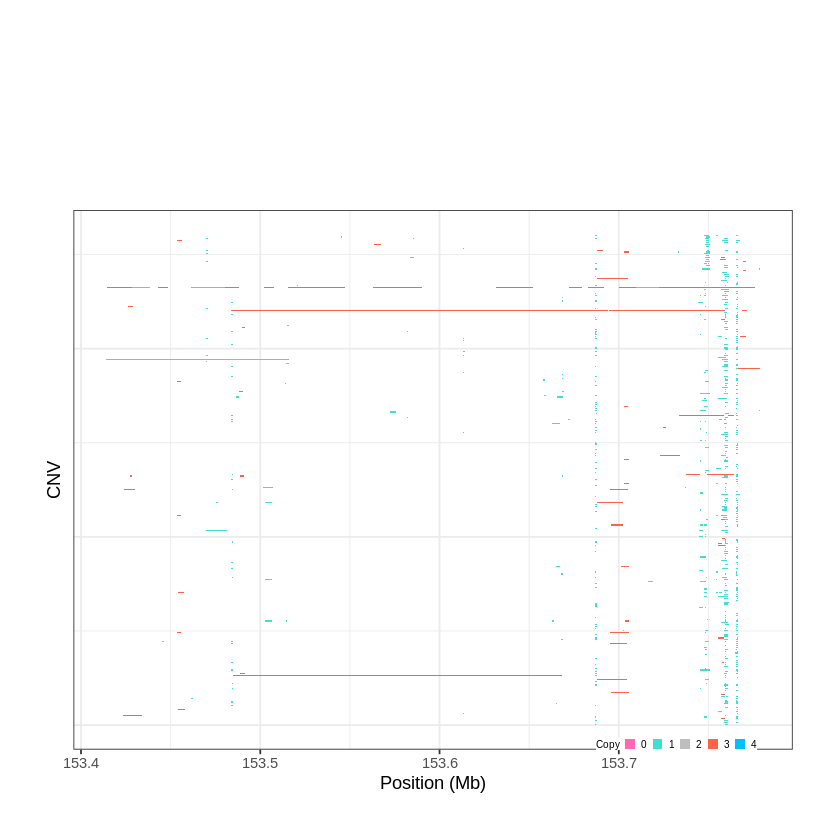

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1006..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 154.432901 - 154.4749 Mb with 239 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


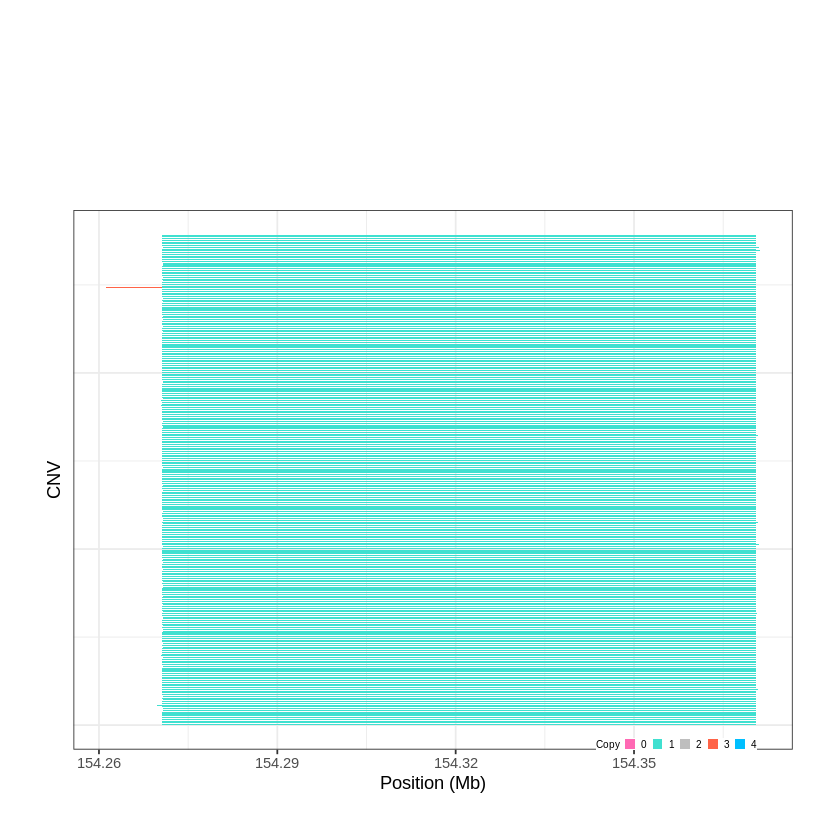

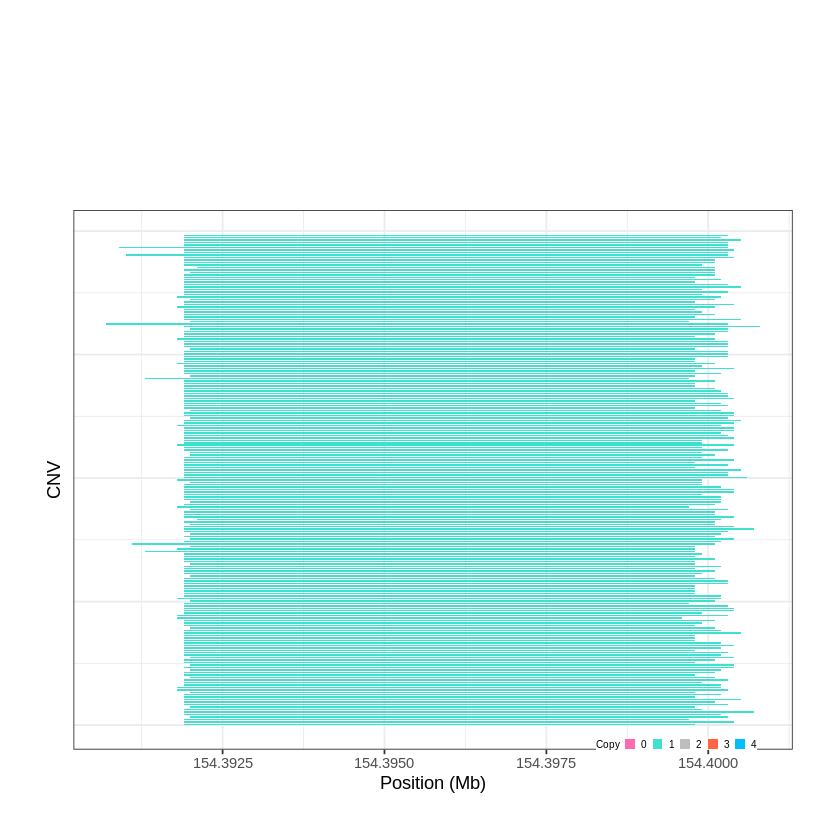

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1007..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 154.874401 - 155.0887 Mb with 176 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1008..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 155.128201 - 155.272 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


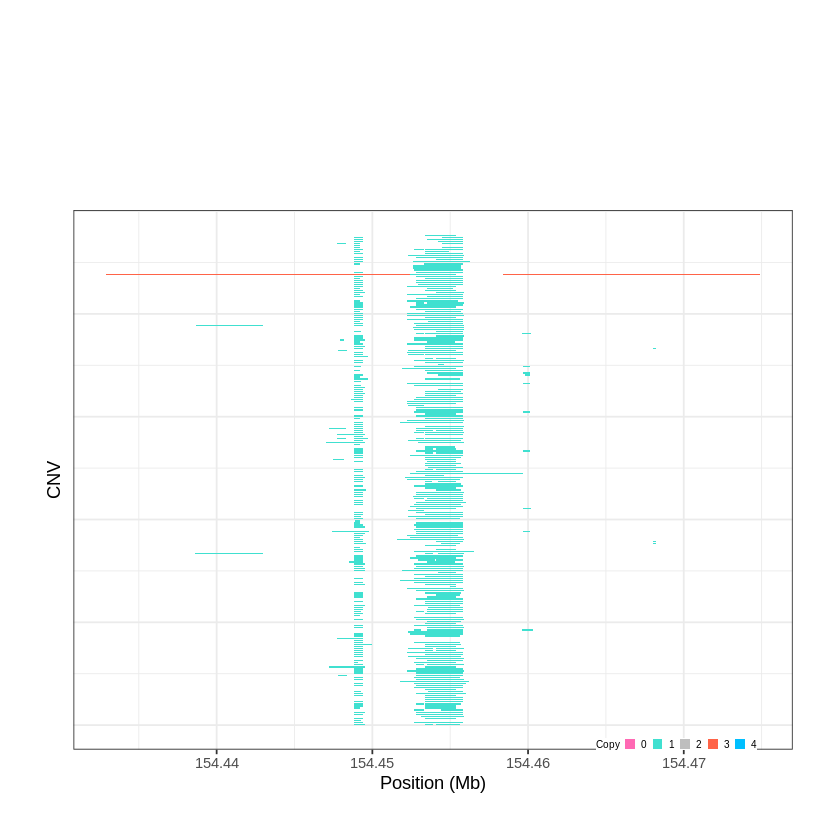

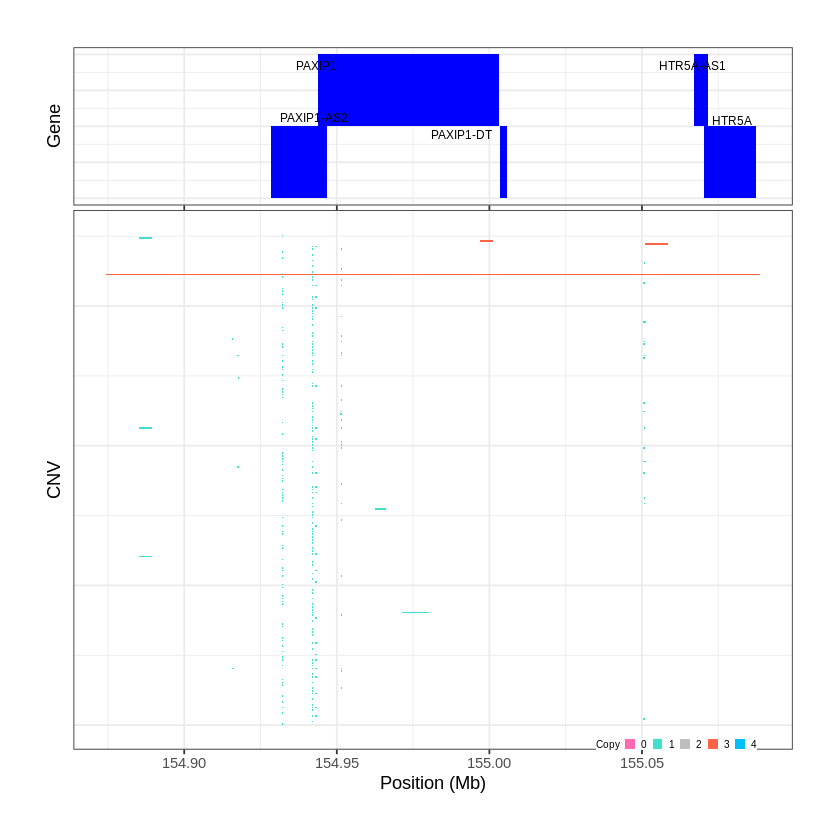

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1009..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 155.275801 - 155.4213 Mb with 142 Individual - "
Plotting gene...


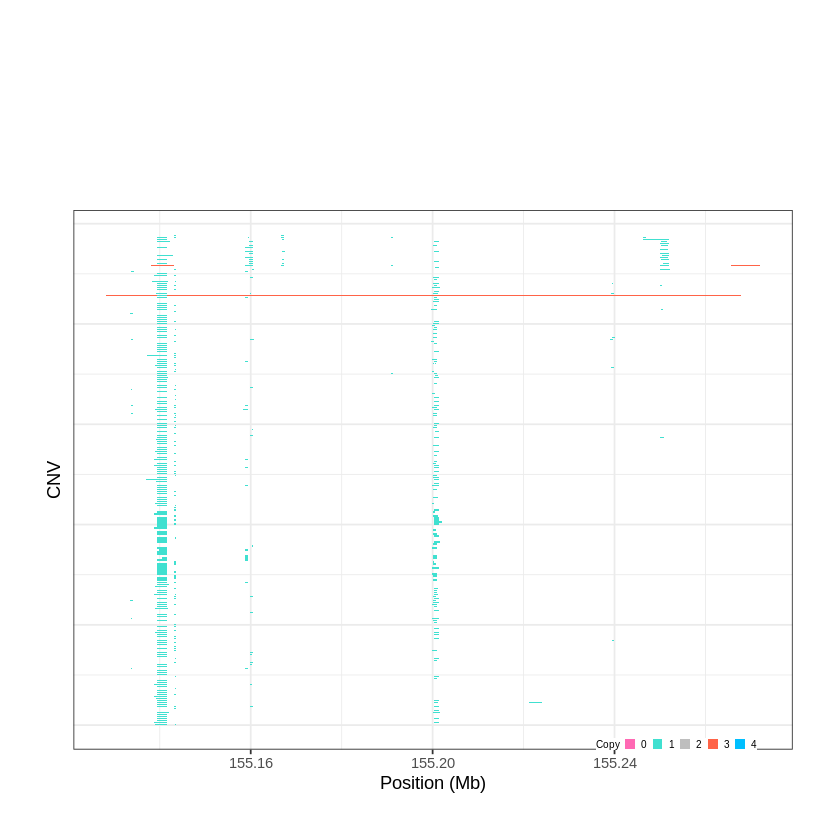

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1010..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 155.497401 - 155.9237 Mb with 179 Individual - "
Plotting gene...


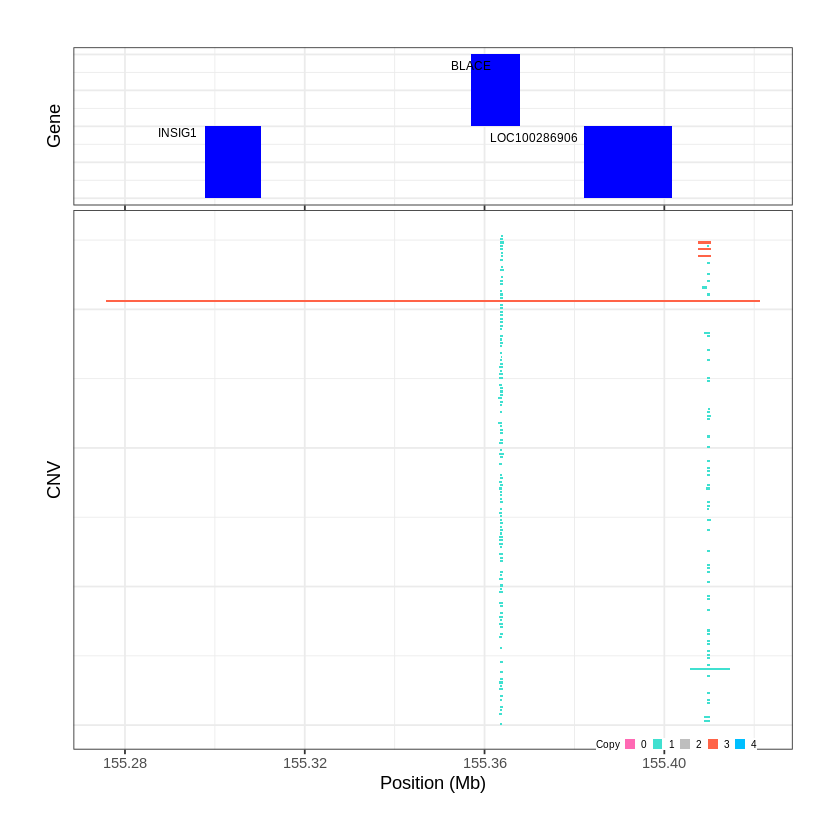

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1011..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 155.934101 - 155.9963 Mb with 222 Individual - "
Plotting gene...


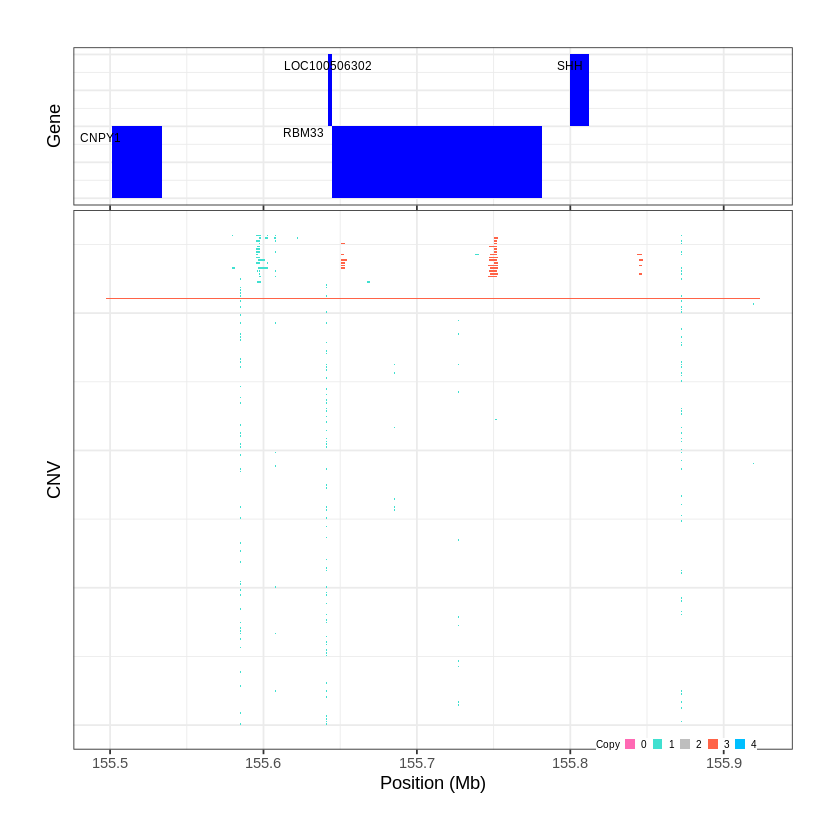

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1012..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 156.643801 - 158.0474 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1013..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 158.047401 - 158.153 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


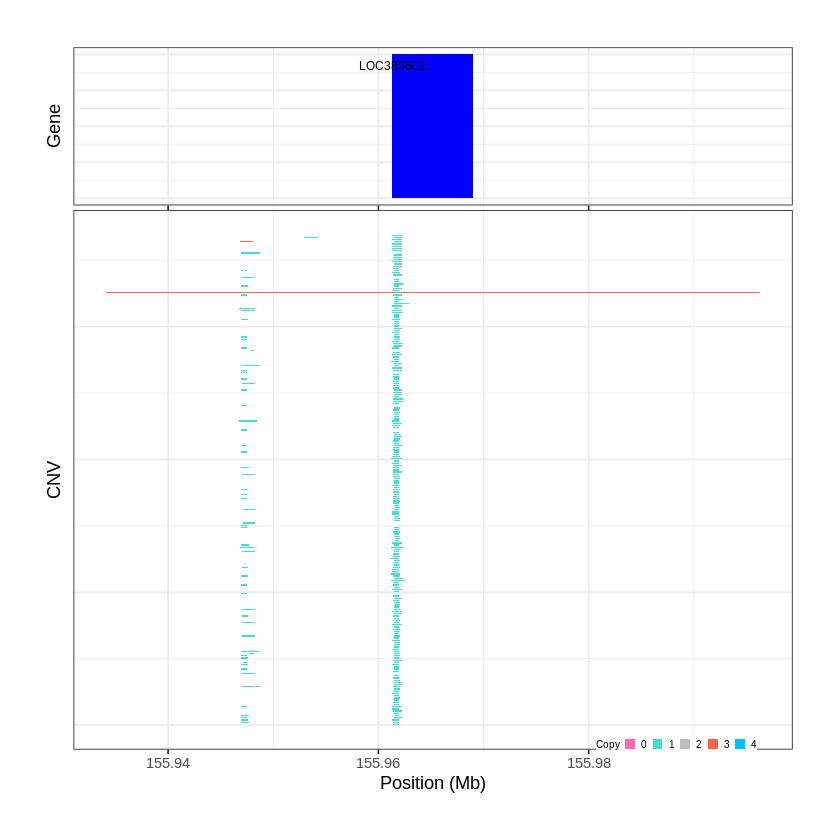

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1014..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 158.153001 - 158.1568 Mb with 274 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


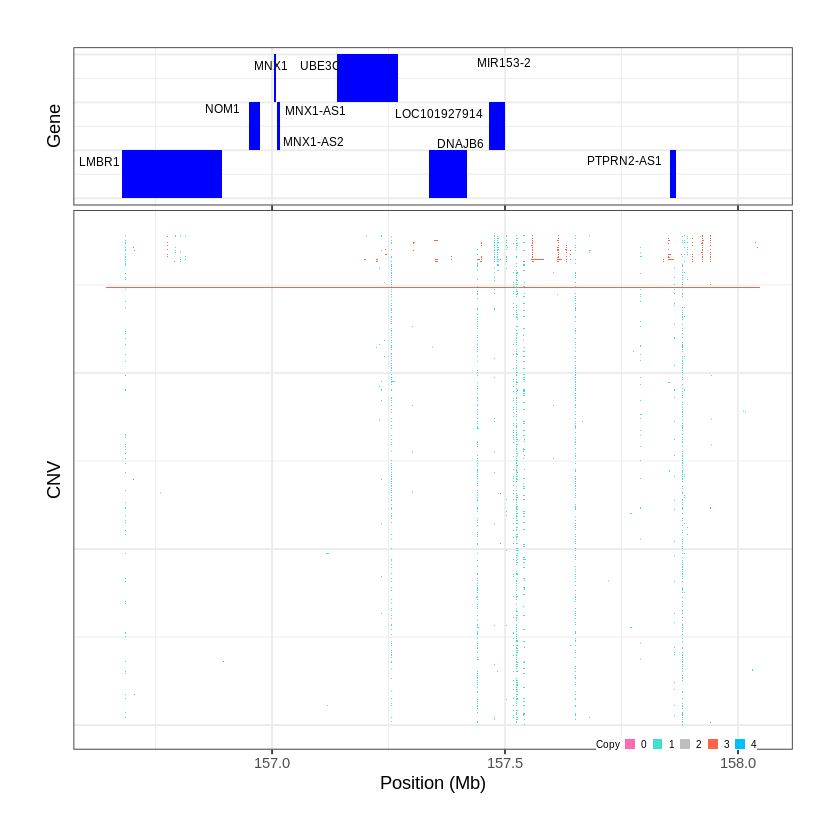

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1015..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 158.157101 - 158.2904 Mb with 277 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


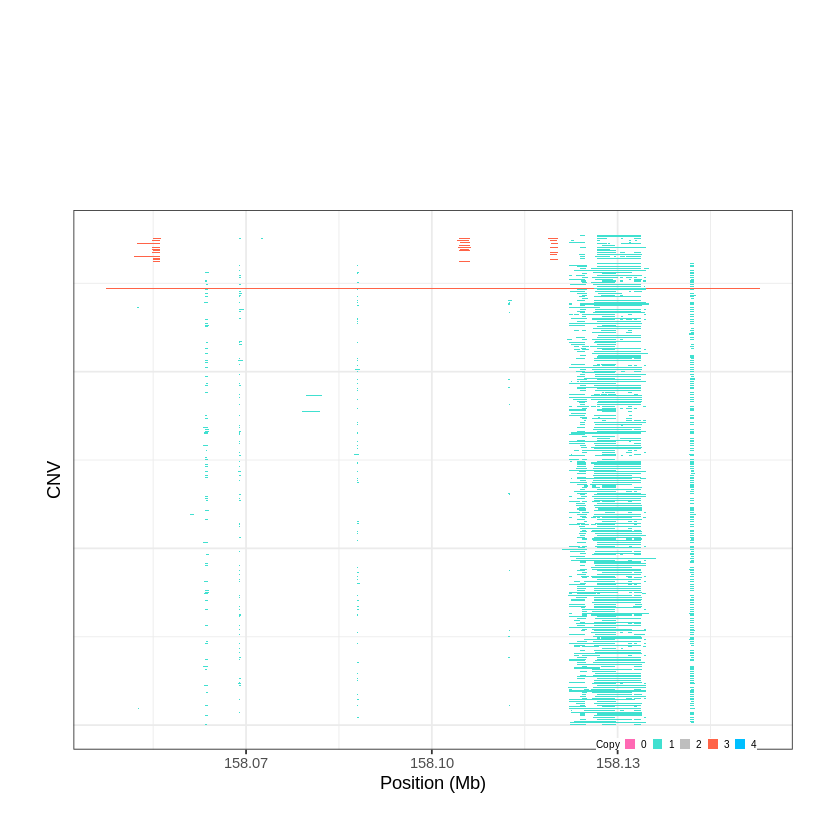

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1016..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 158.290801 - 158.4583 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


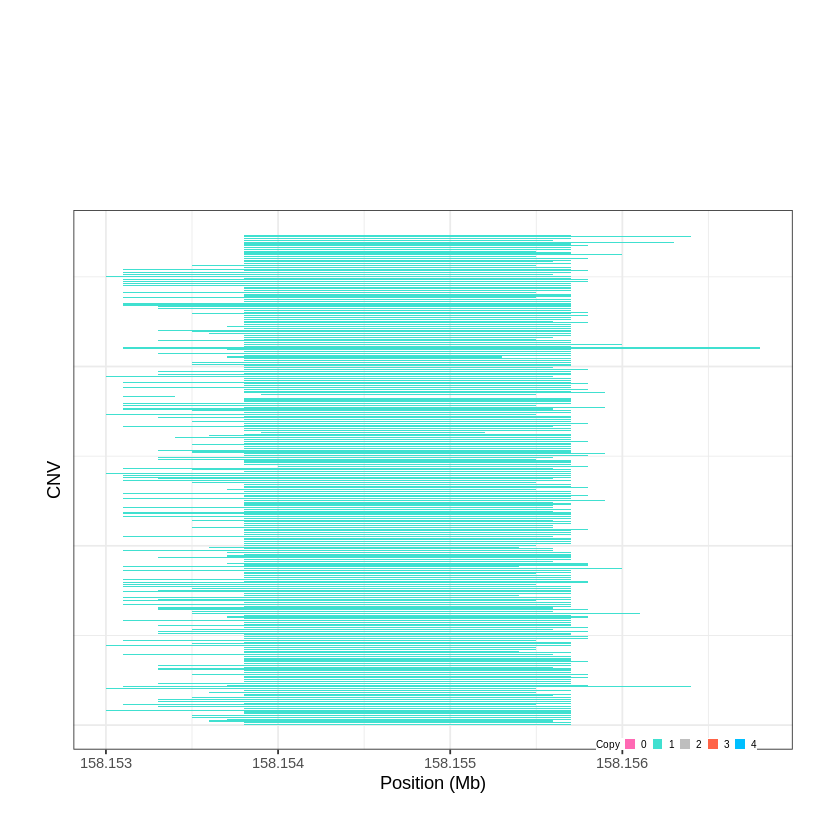

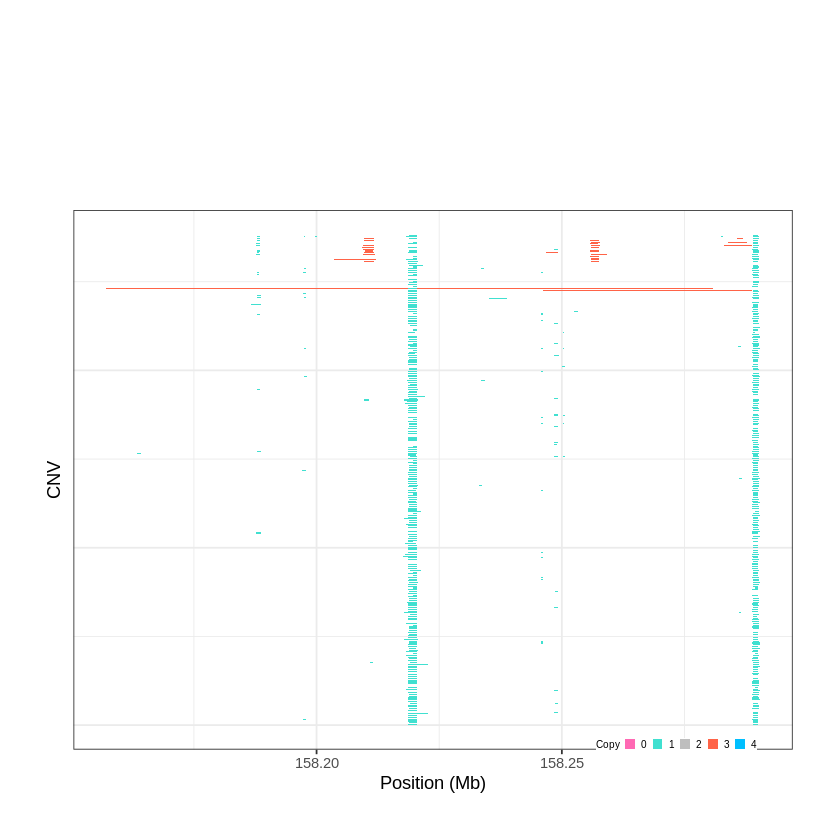

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1017..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 158.477701 - 158.7759 Mb with 250 Individual - "
Plotting gene...


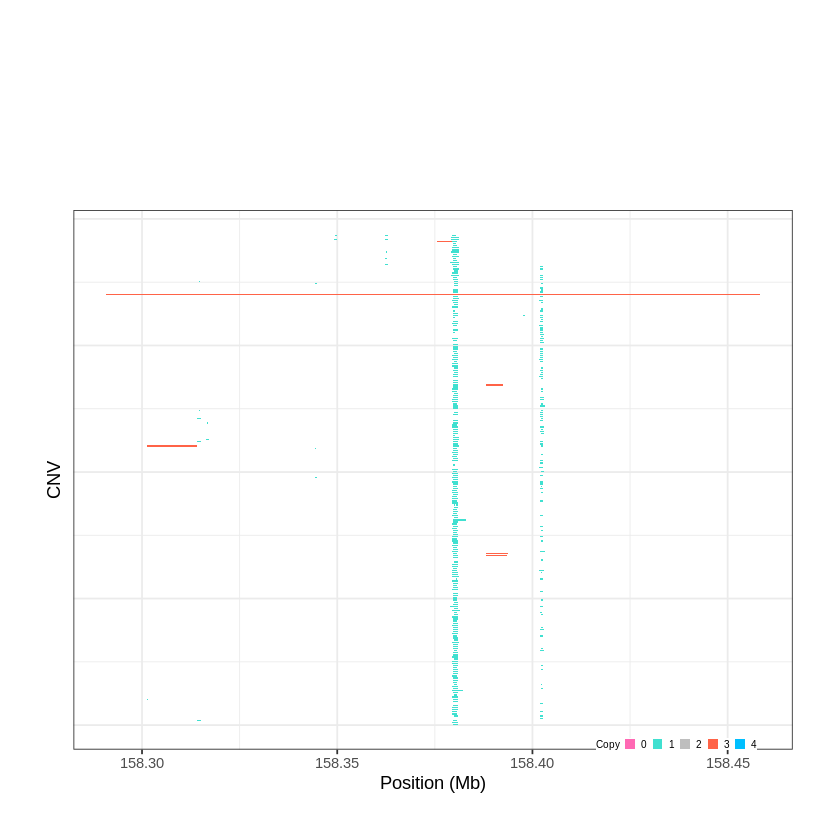

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1018..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 158.779201 - 158.977 Mb with 210 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1019..."
Input data passed requirment check...
[1] "CNV on Chromosome 7: 159.097201 - 159.1387 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


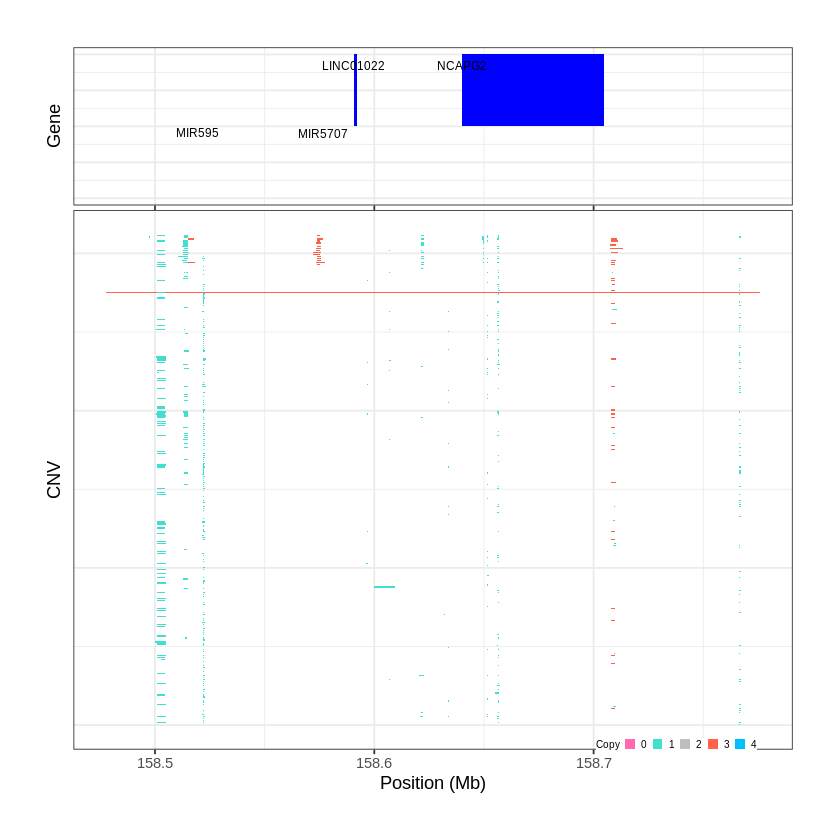

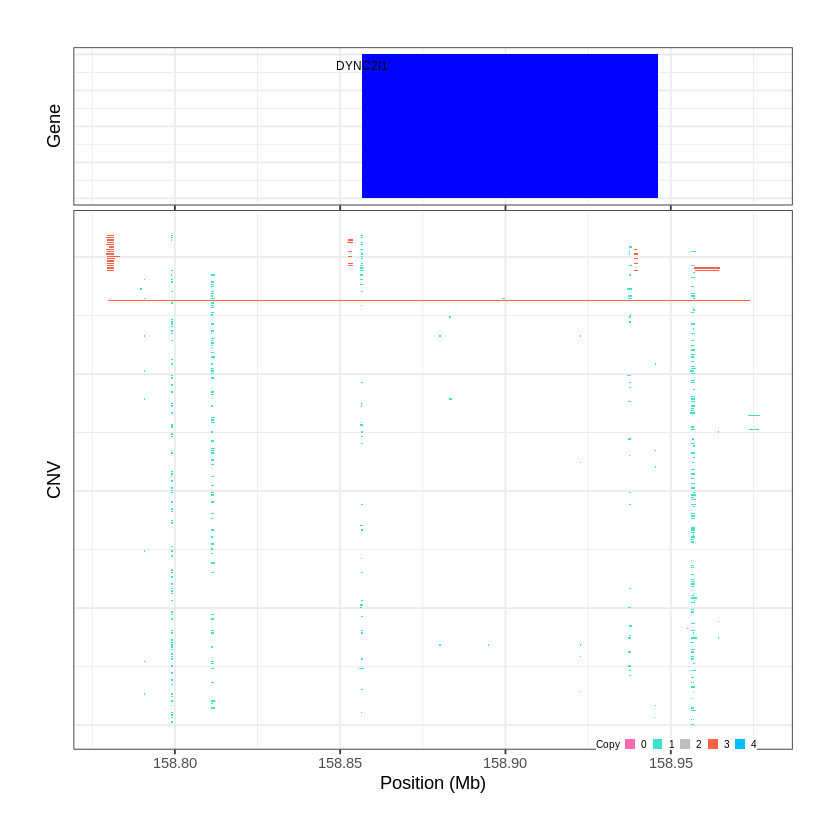

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1020..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1e-06 - 0.4432 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1021..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 0.481501 - 0.5045 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


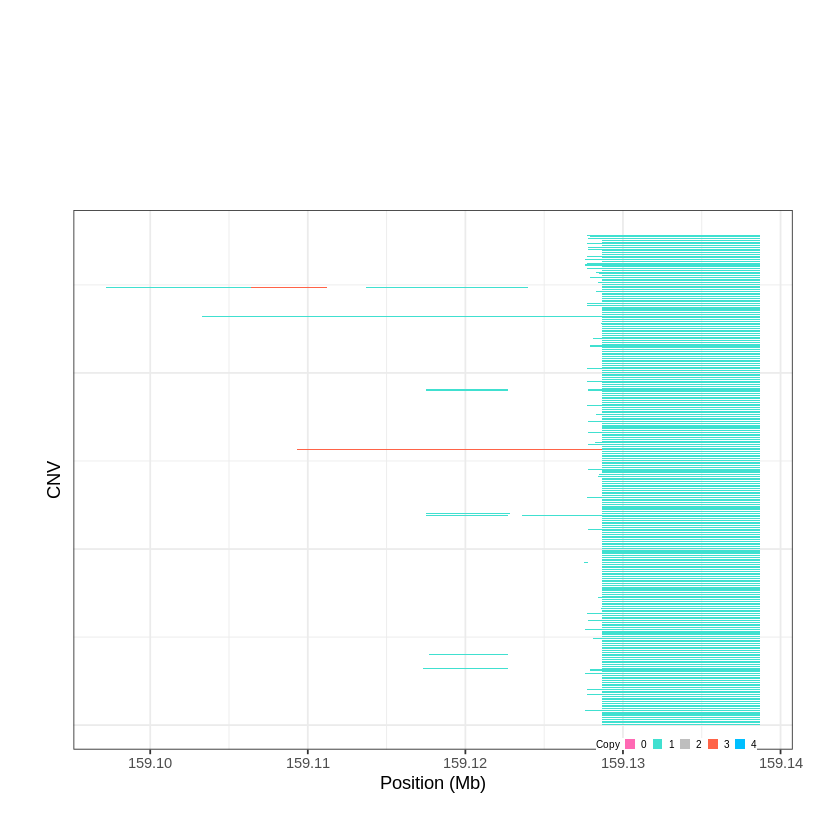

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1022..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 0.568901 - 0.6002 Mb with 235 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


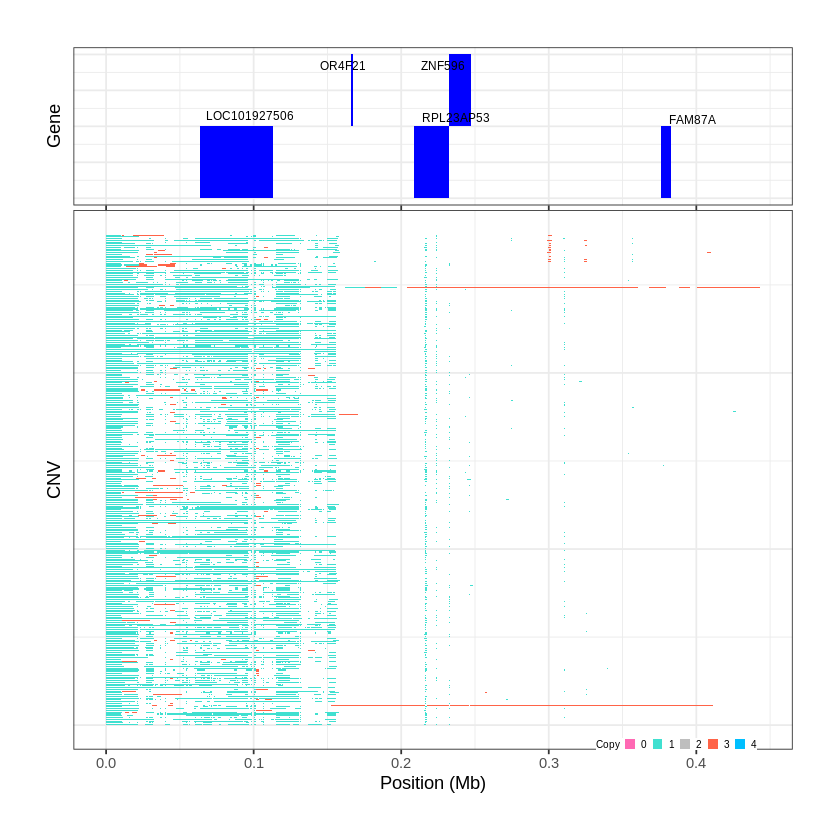

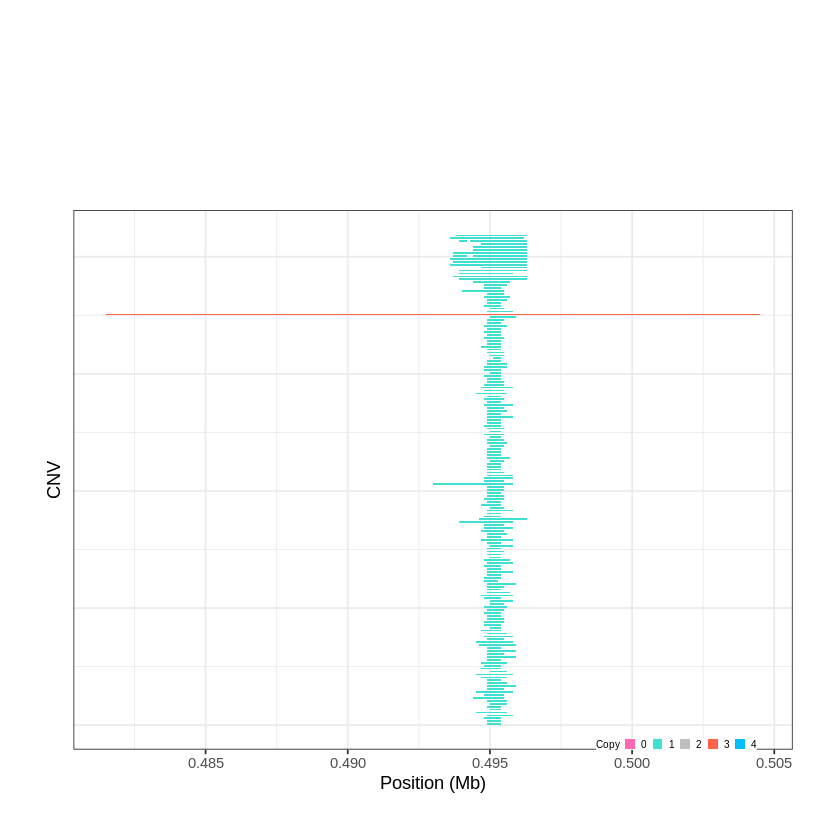

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1023..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 0.600301 - 1.1965 Mb with 279 Individual - "
Plotting gene...


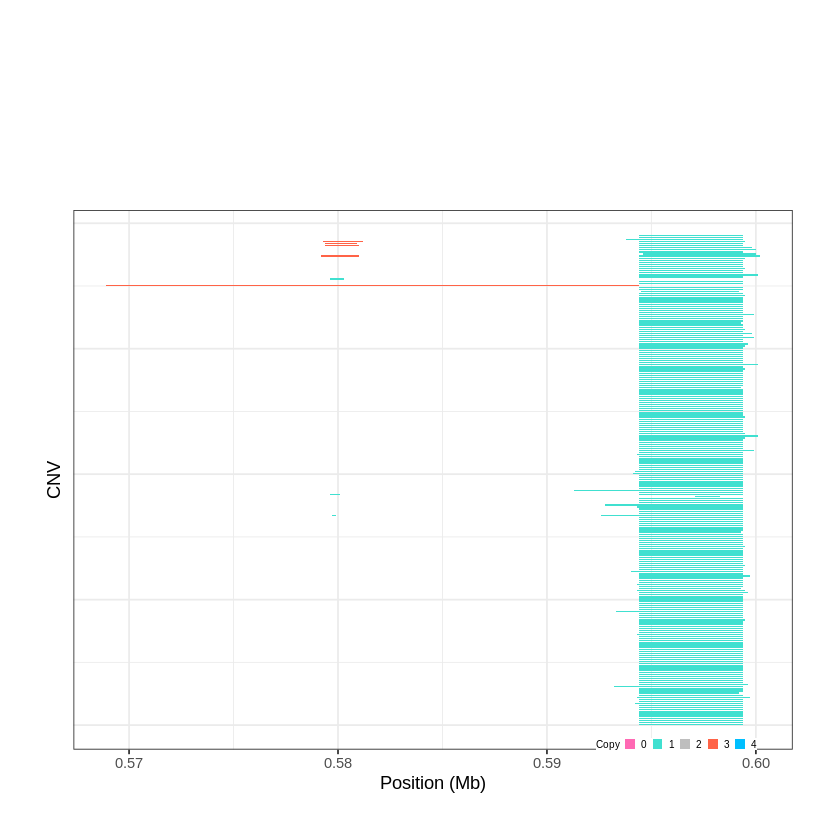

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1024..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1.196601 - 1.3574 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1025..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1.357401 - 1.5089 Mb with 260 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


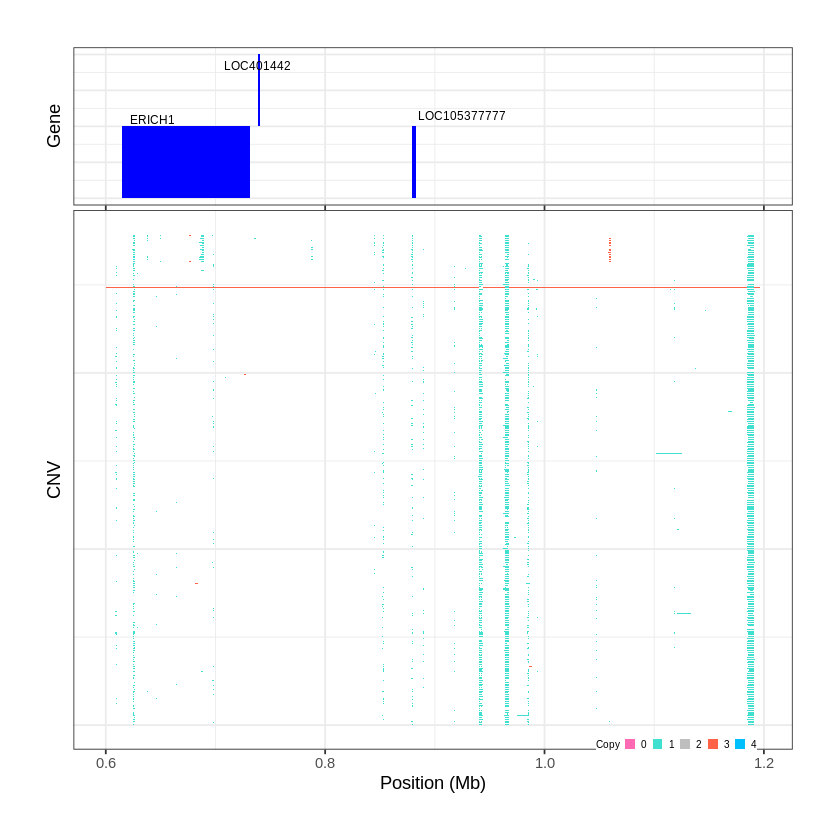

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1026..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1.508901 - 1.5193 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


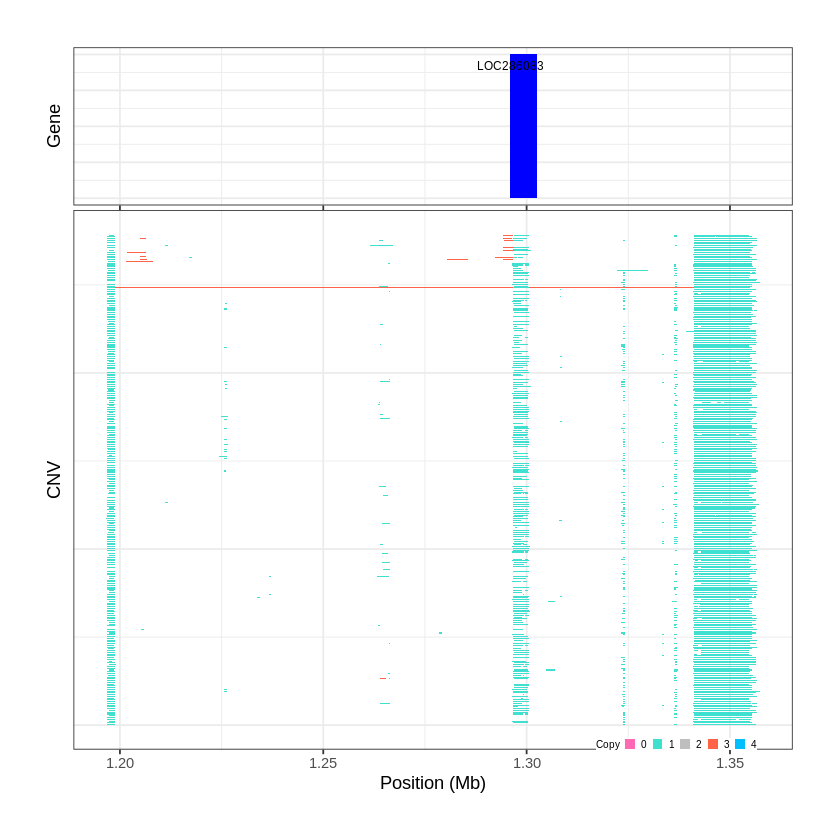

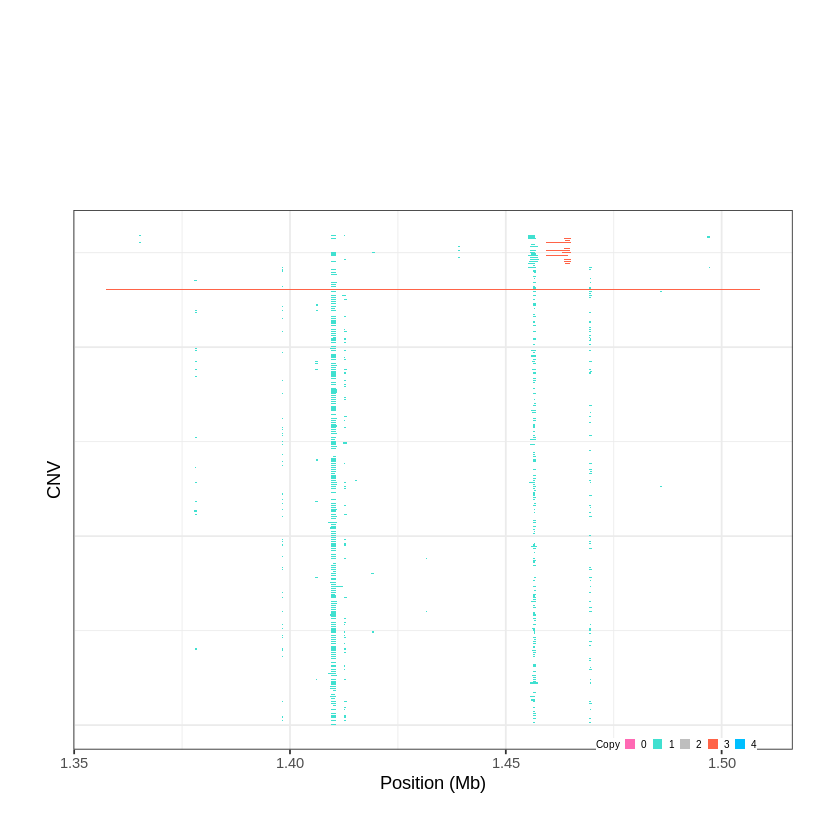

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1027..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1.522101 - 1.6994 Mb with 231 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1028..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1.710901 - 1.7128 Mb with 185 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


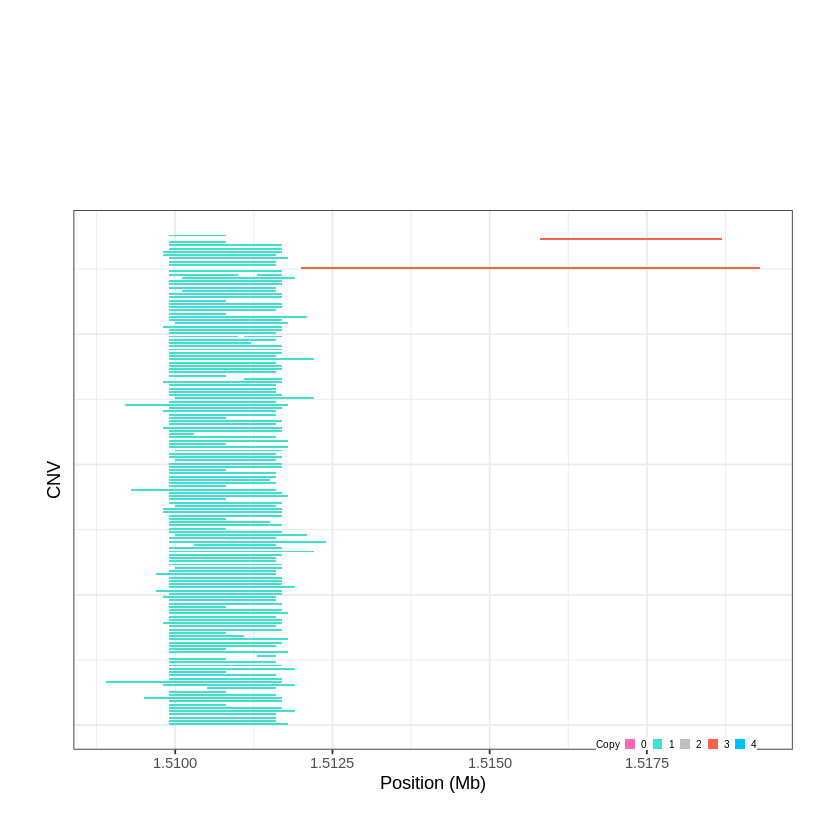

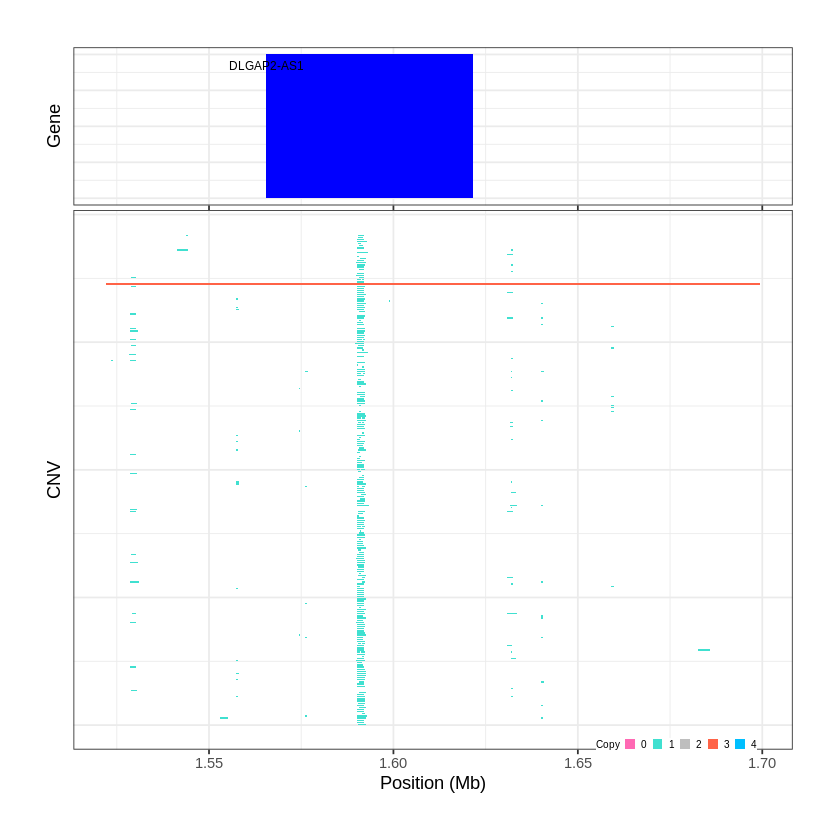

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1029..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1.713001 - 1.779 Mb with 265 Individual - "
Plotting gene...


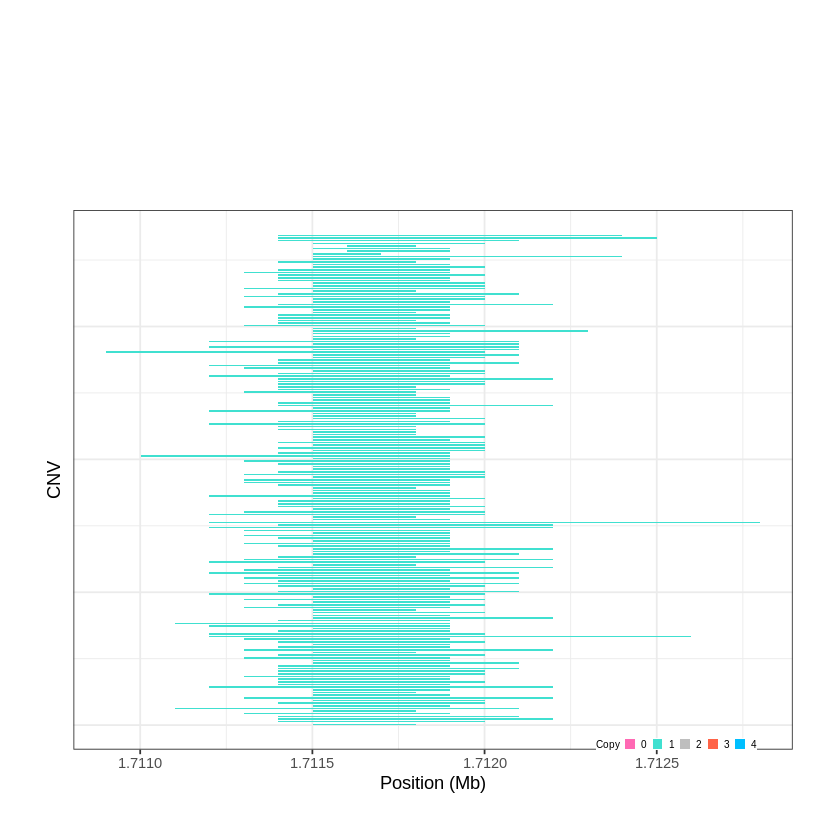

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1030..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1.779001 - 1.9485 Mb with 265 Individual - "
Plotting gene...


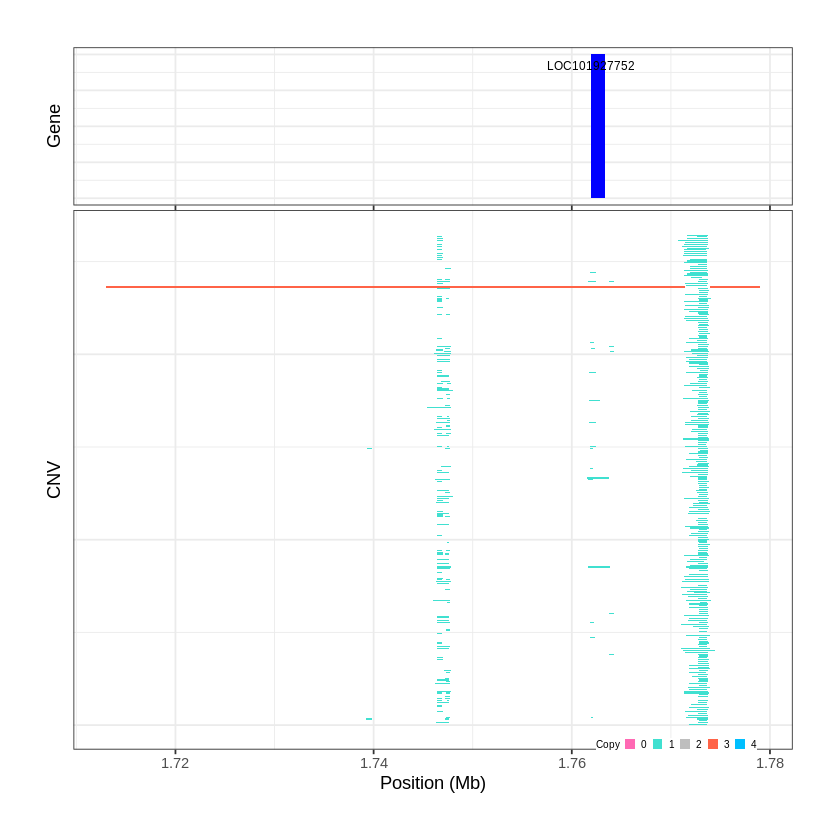

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1031..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 1.949001 - 2.301 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1032..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 2.315301 - 2.3763 Mb with 207 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


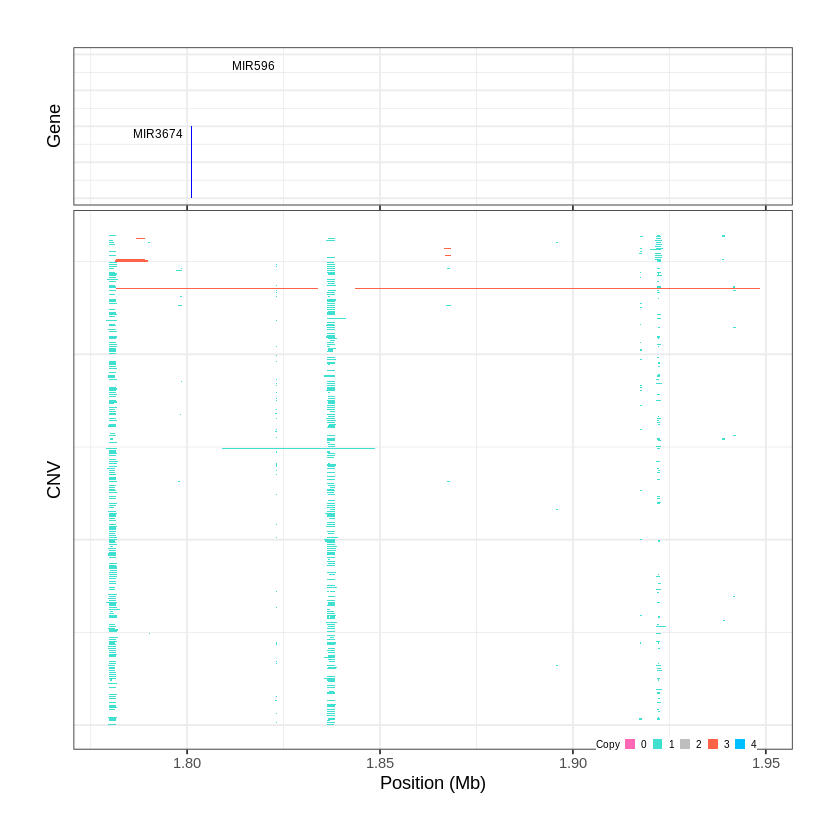

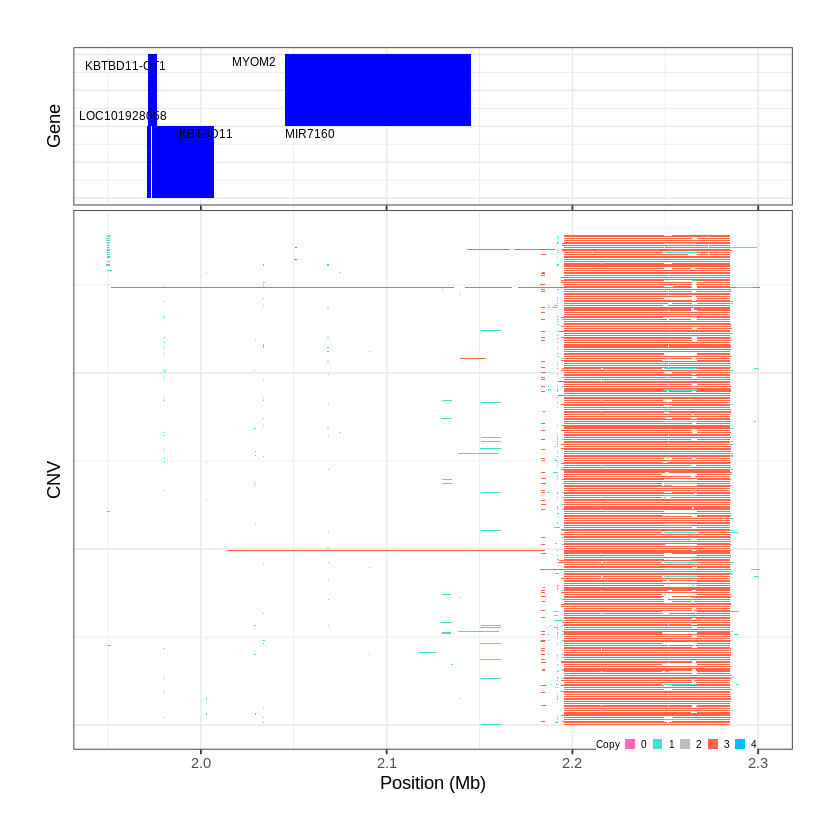

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1033..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 2.457501 - 3.3245 Mb with 209 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1034..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 3.769901 - 4.2623 Mb with 231 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


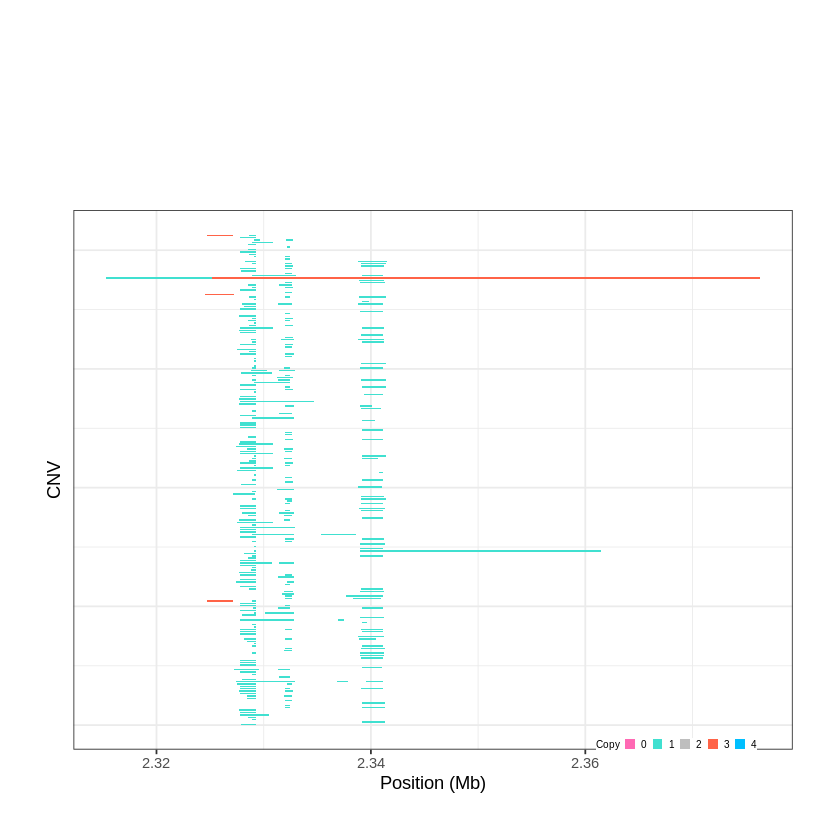

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1035..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 5.953901 - 5.975 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


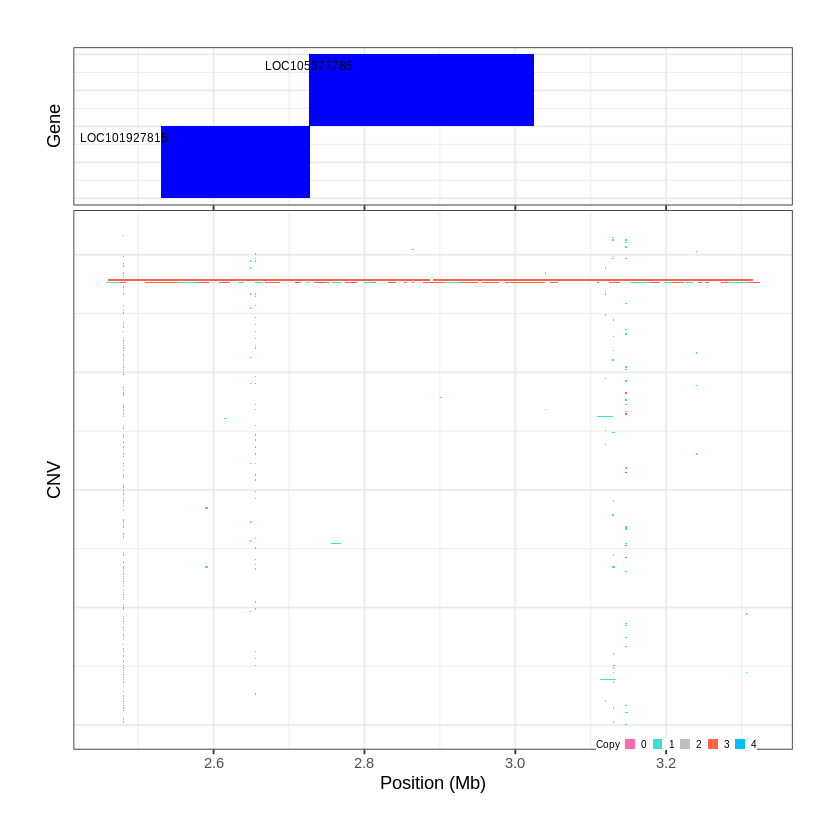

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1036..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 6.092201 - 6.2367 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


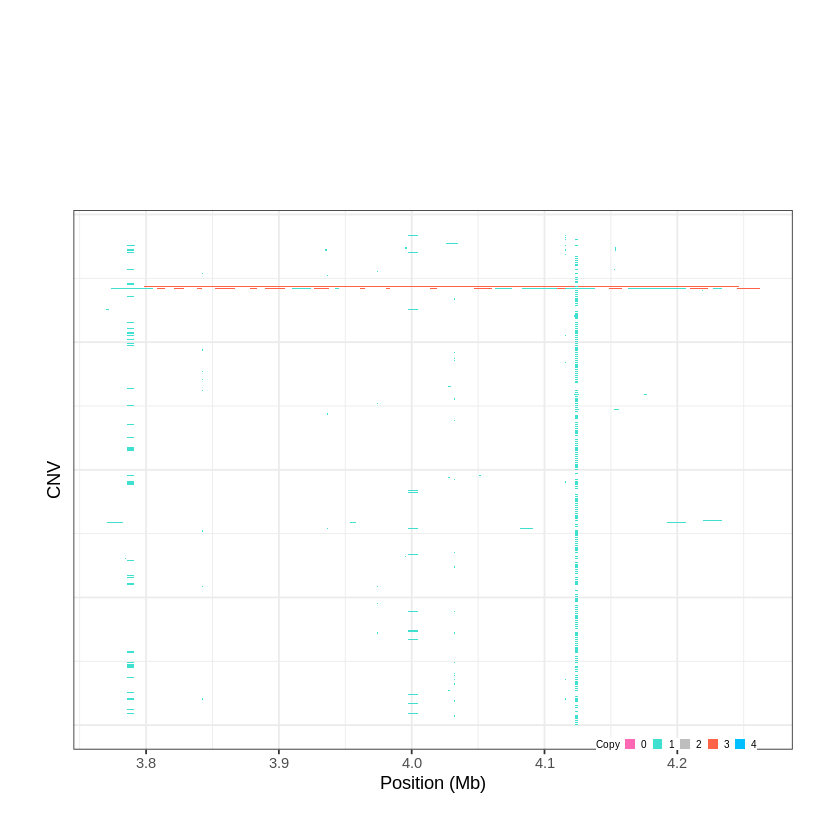

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1037..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 6.790901 - 6.8169 Mb with 201 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


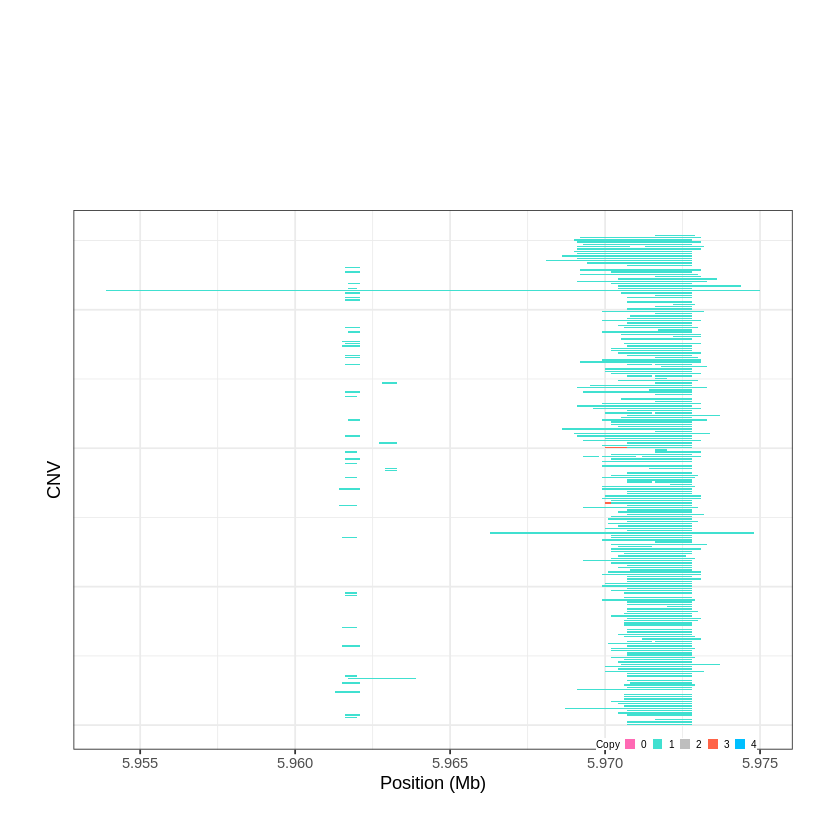

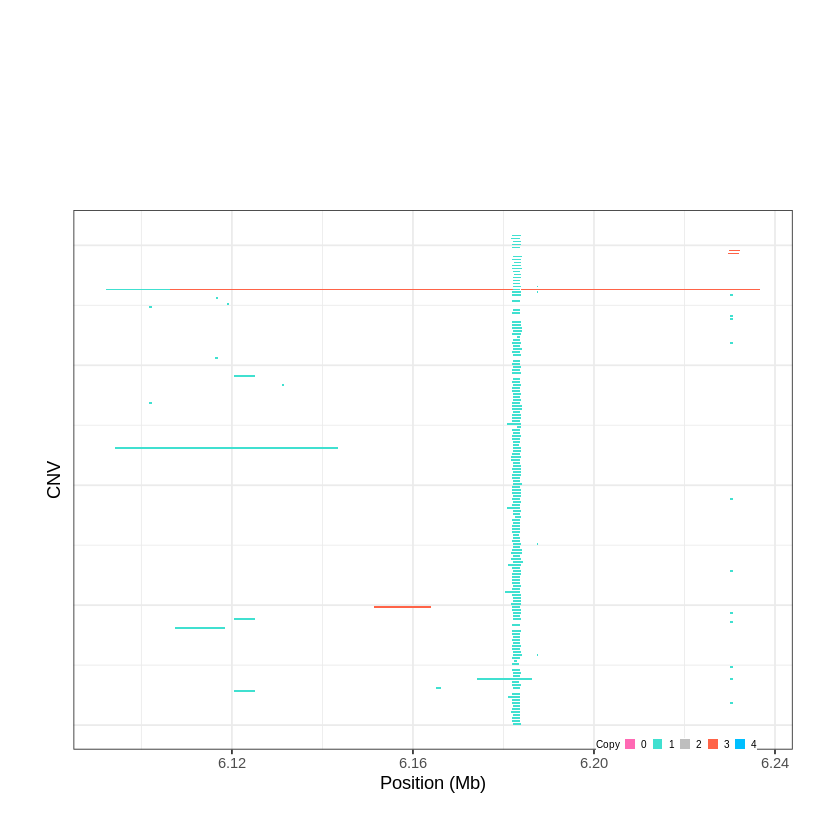

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1038..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 6.824901 - 8.1092 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 19 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


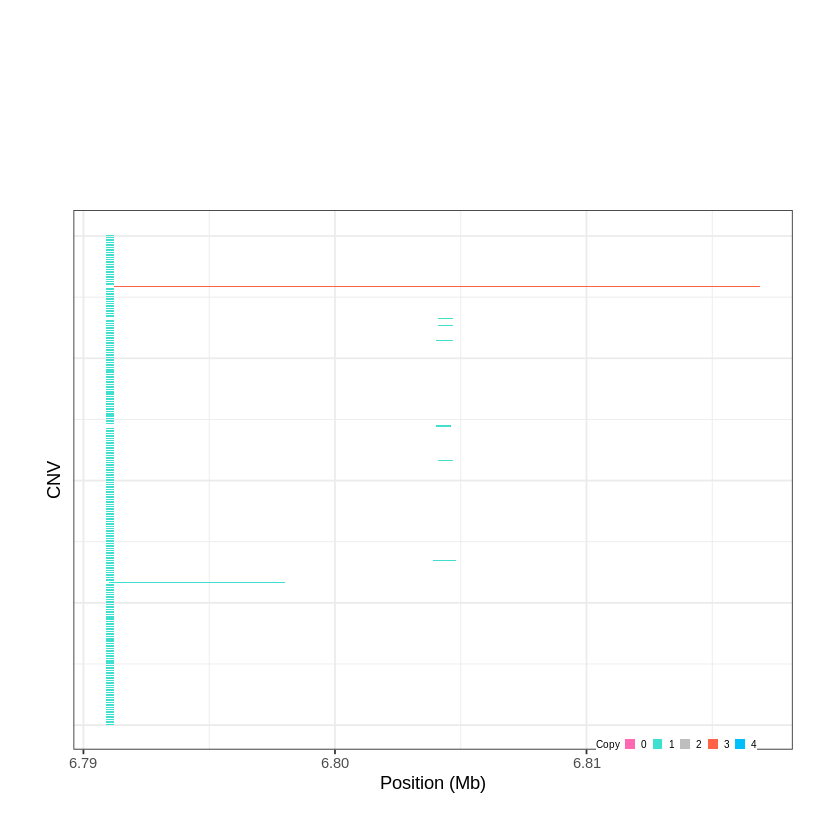

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1039..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 11.245401 - 11.3428 Mb with 263 Individual - "
Plotting gene...


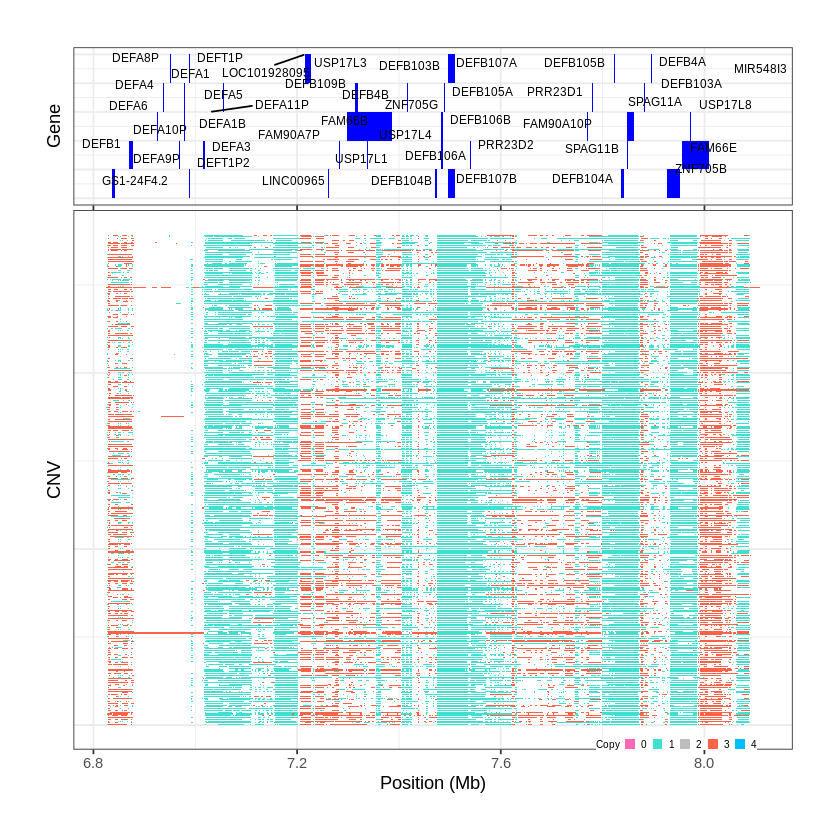

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1040..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 11.626301 - 12.5606 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 4 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1041..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 13.776001 - 13.7812 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


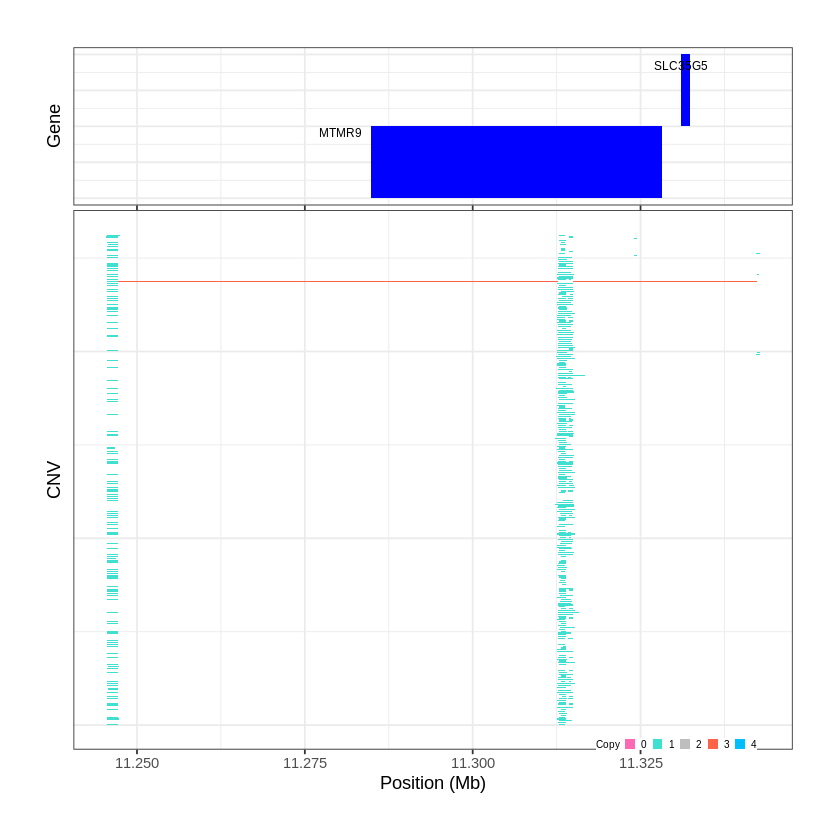

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1042..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 15.001301 - 15.0016 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


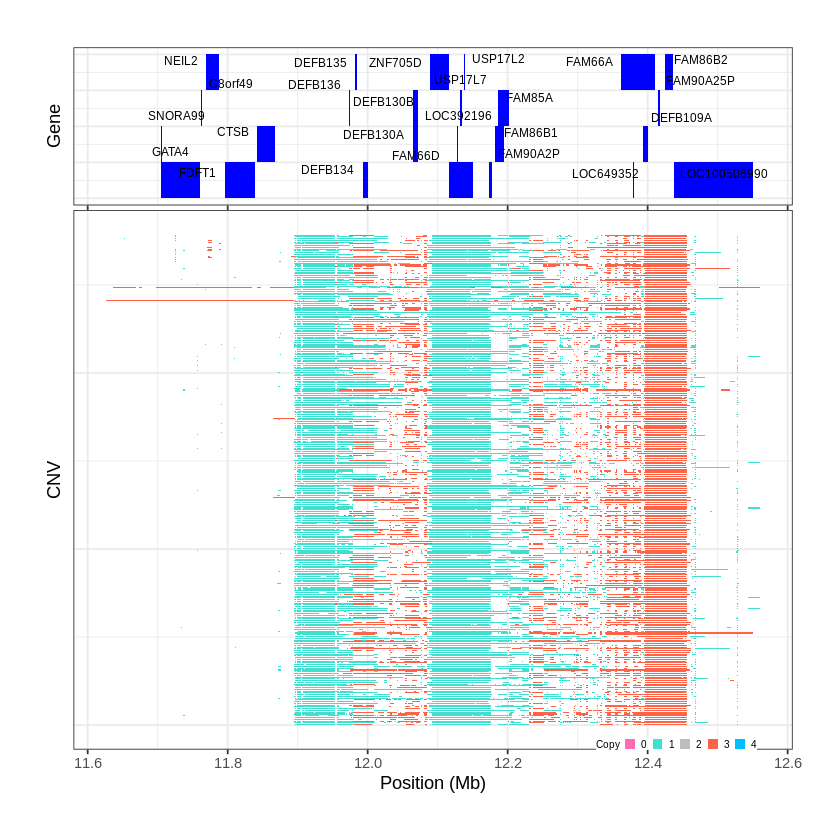

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1043..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 16.404901 - 16.4261 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


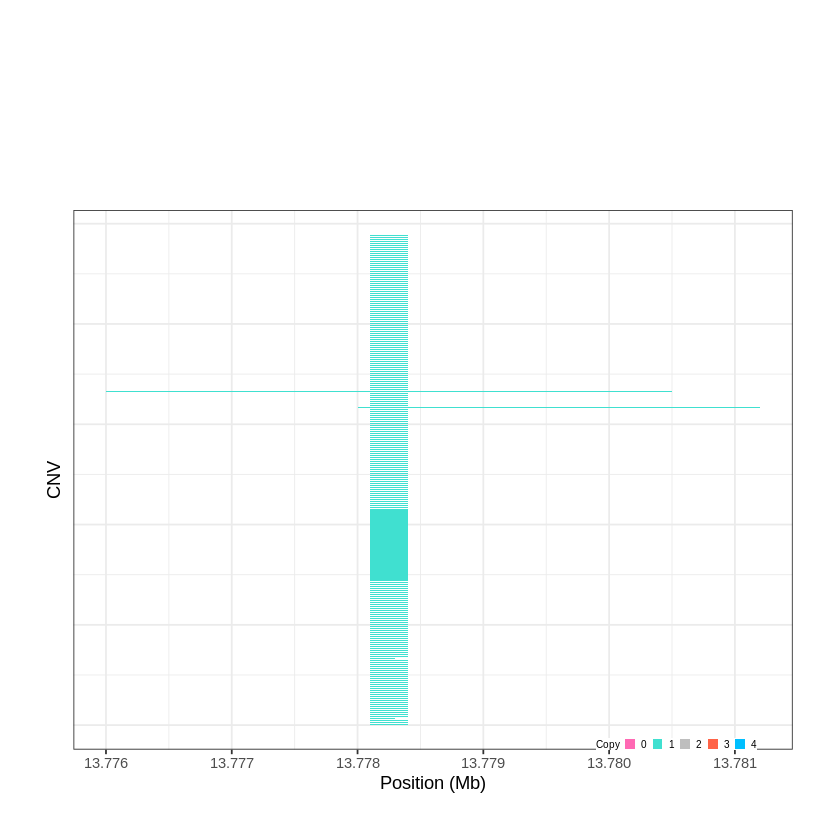

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1044..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 16.531301 - 16.5384 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


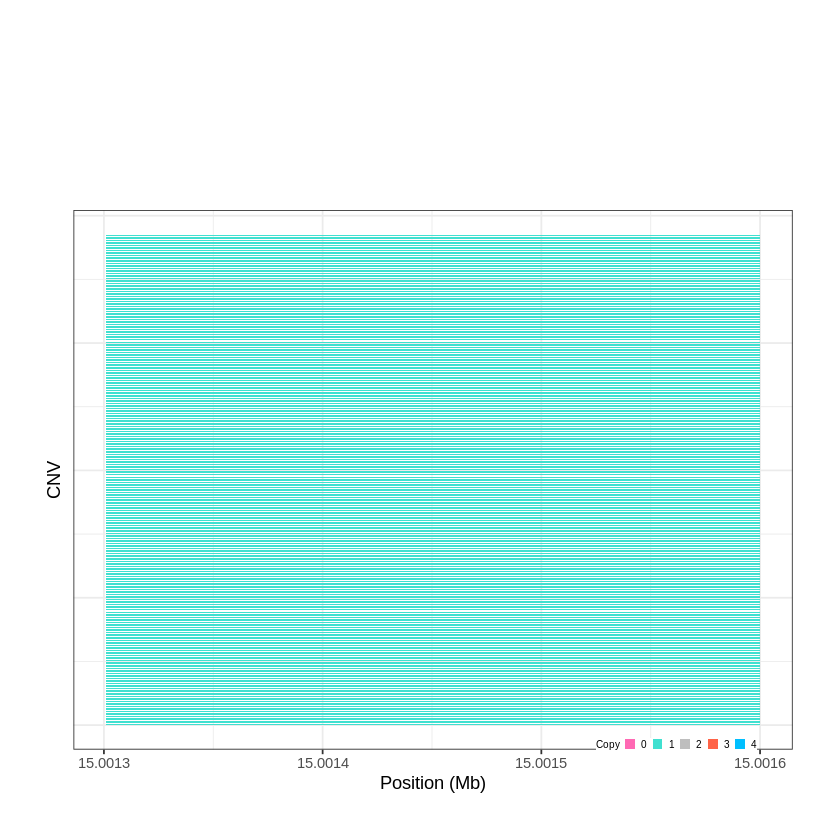

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1045..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 18.424901 - 18.4588 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


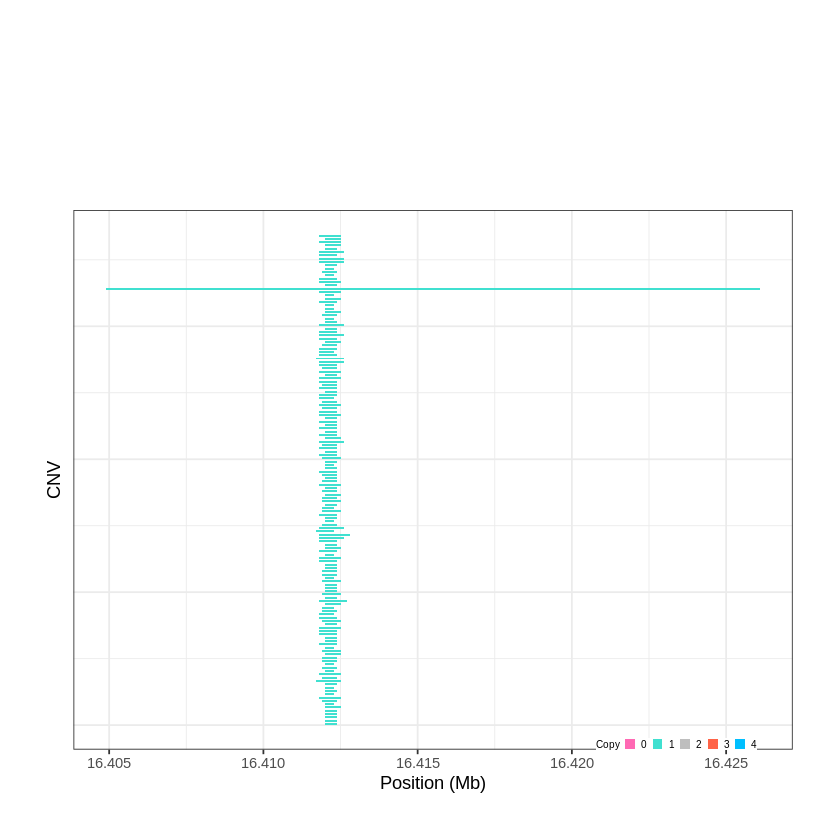

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1046..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 20.878601 - 20.9111 Mb with 263 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


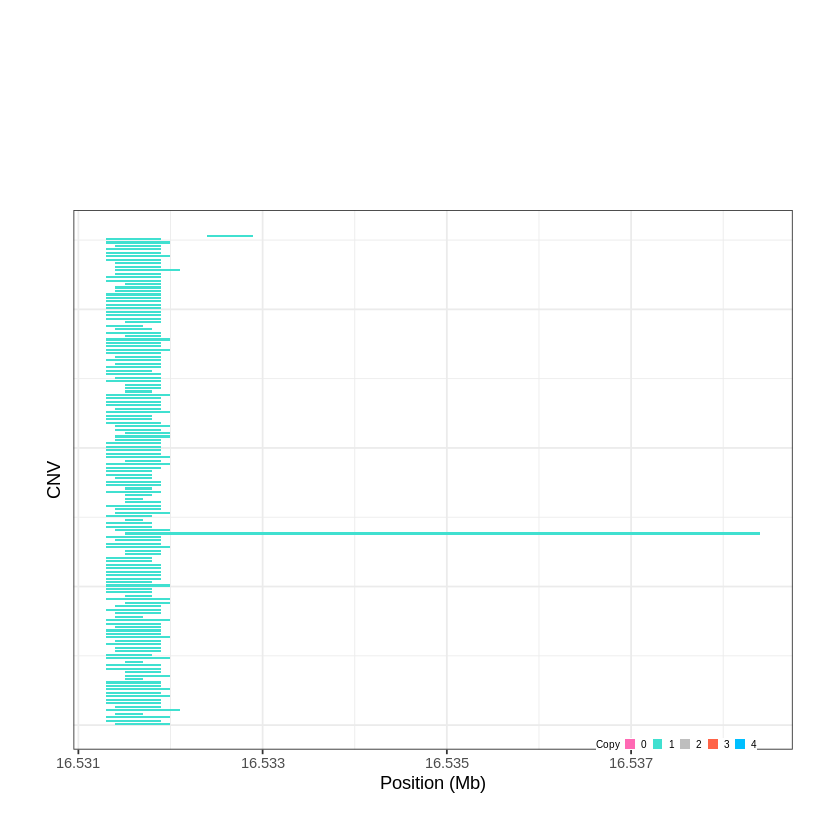

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1047..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 21.519001 - 21.6753 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


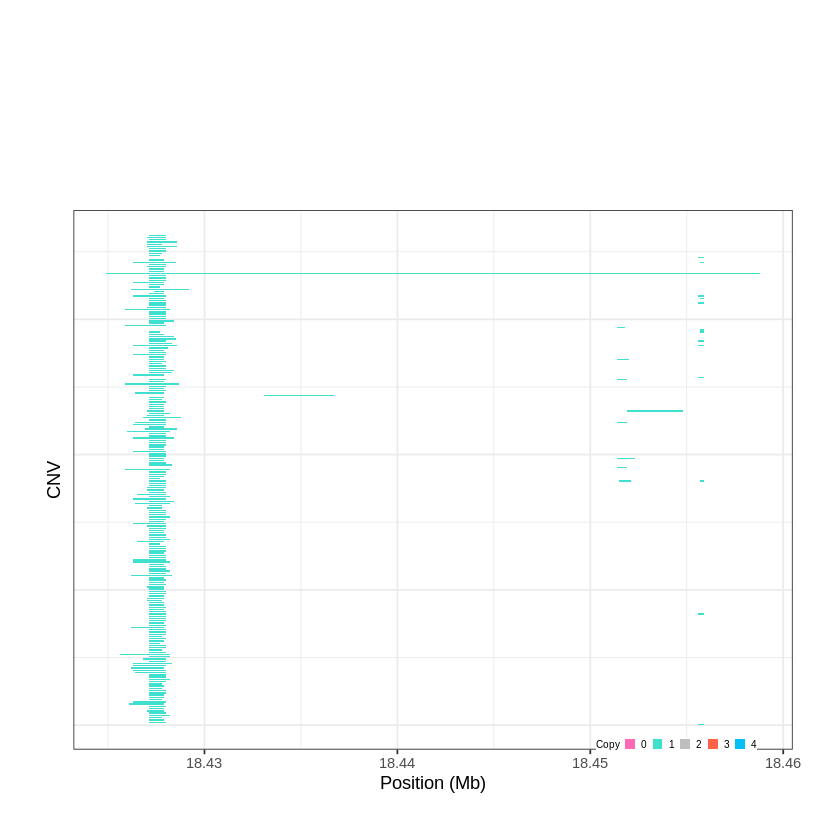

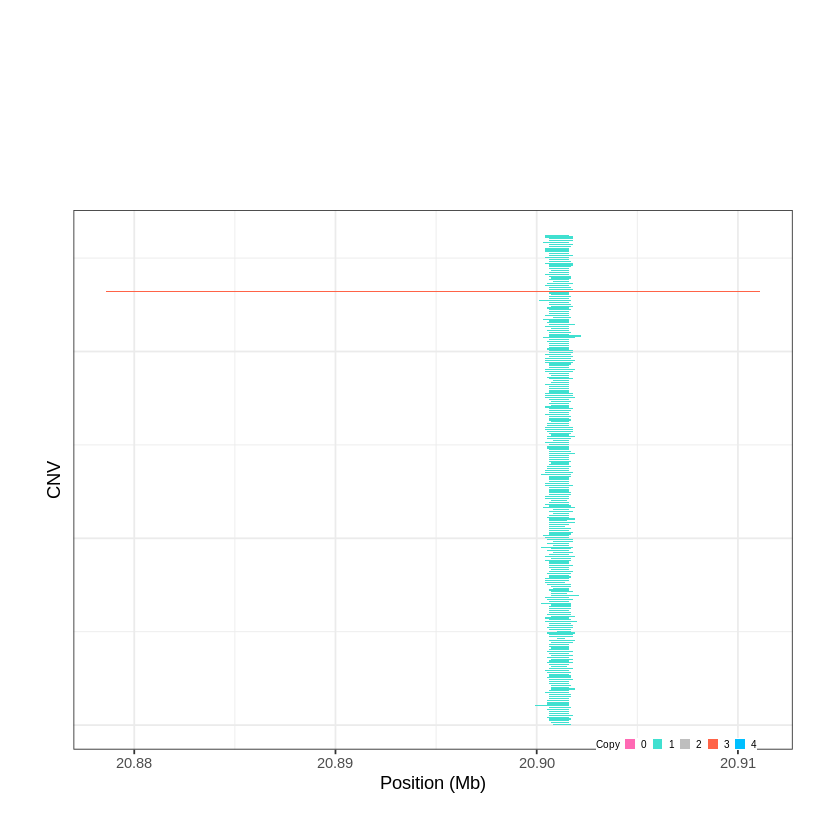

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1048..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 22.381301 - 22.6492 Mb with 236 Individual - "
Plotting gene...


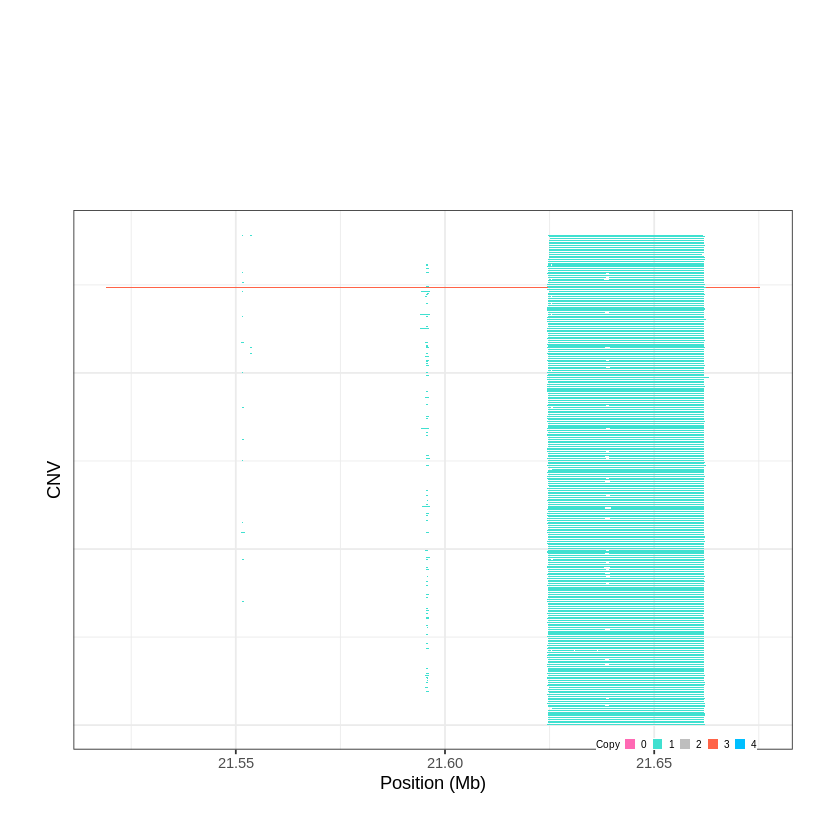

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1049..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 22.907701 - 23.2096 Mb with 171 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1050..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 25.061701 - 25.0742 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


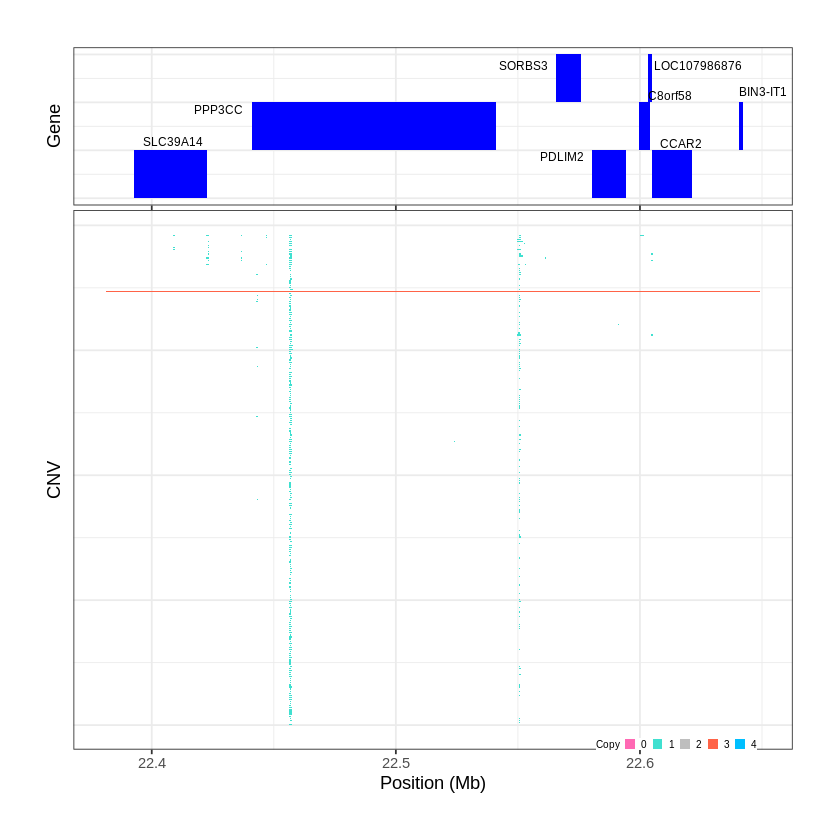

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1051..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 25.549601 - 25.5957 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


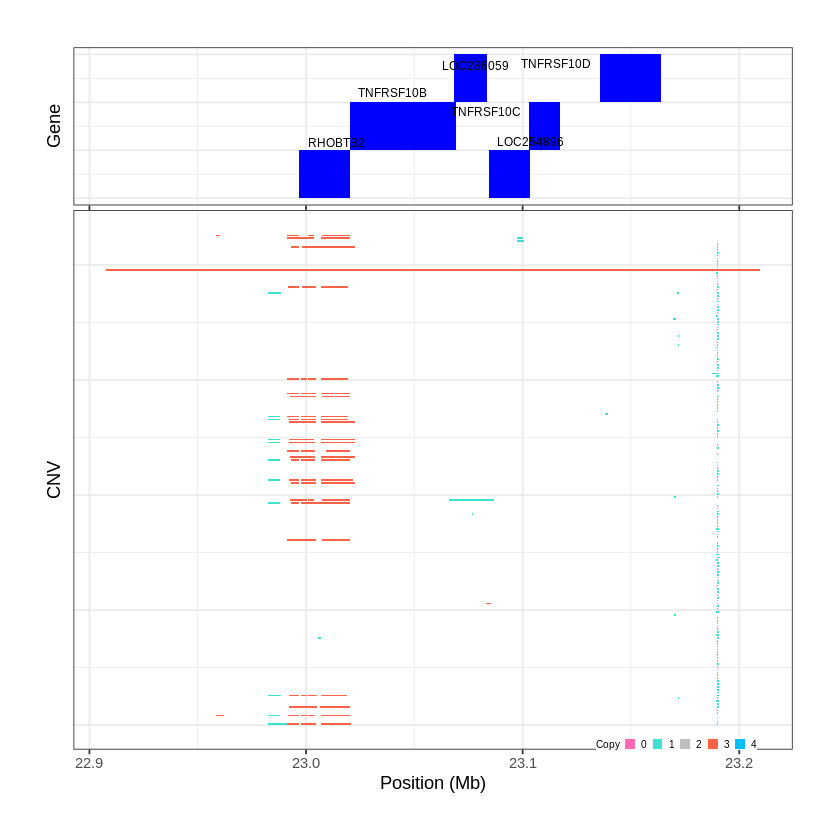

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1052..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 30.384201 - 30.3958 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


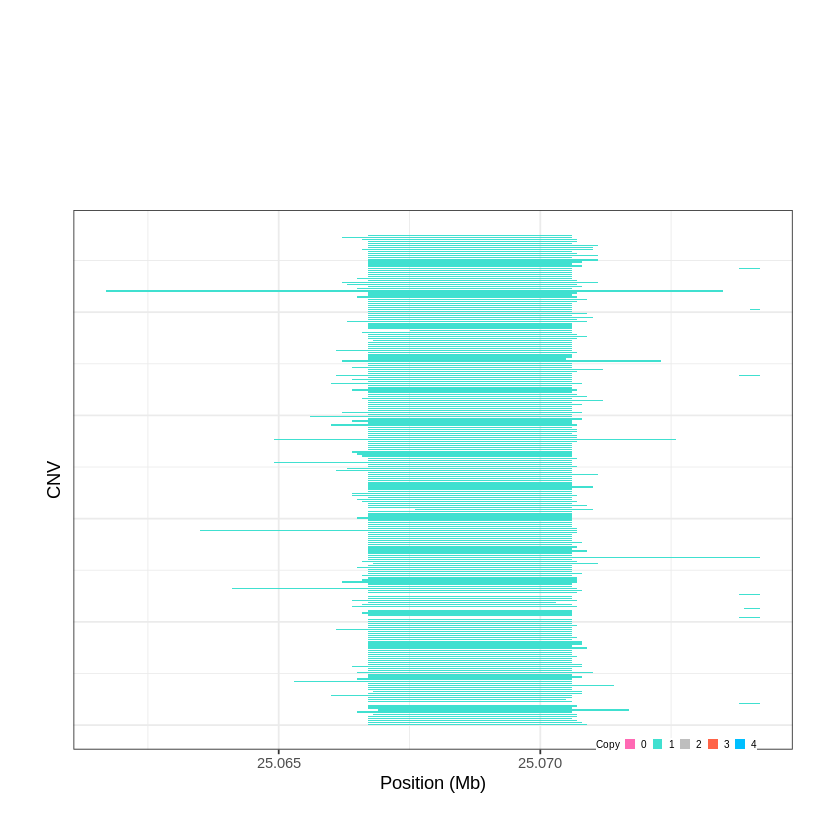

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1053..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 32.679801 - 32.7159 Mb with 274 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


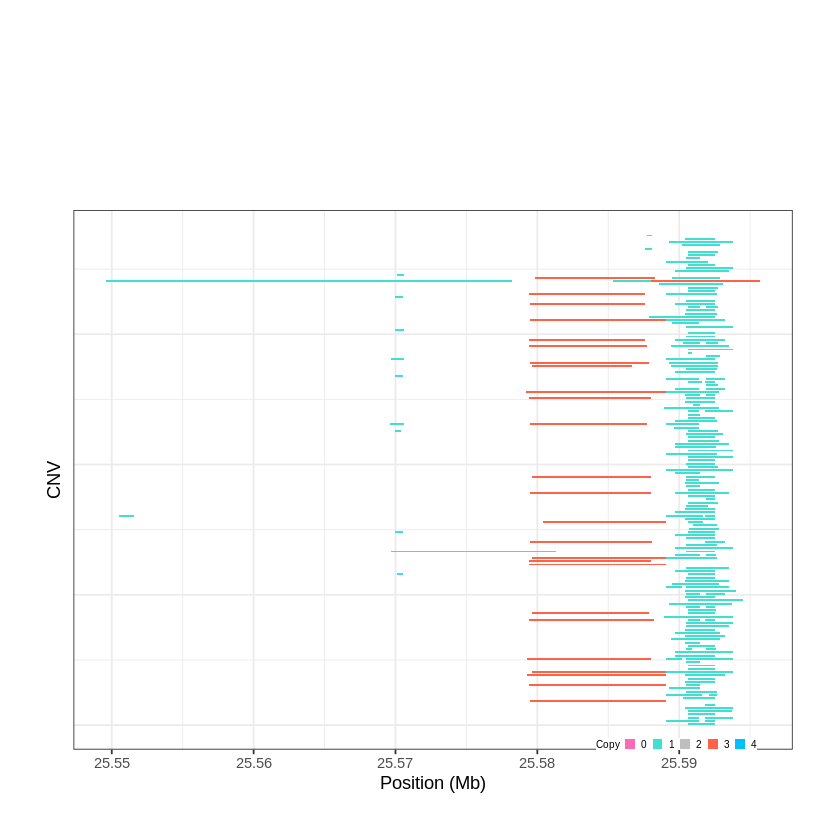

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1054..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 39.217601 - 39.3985 Mb with 162 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


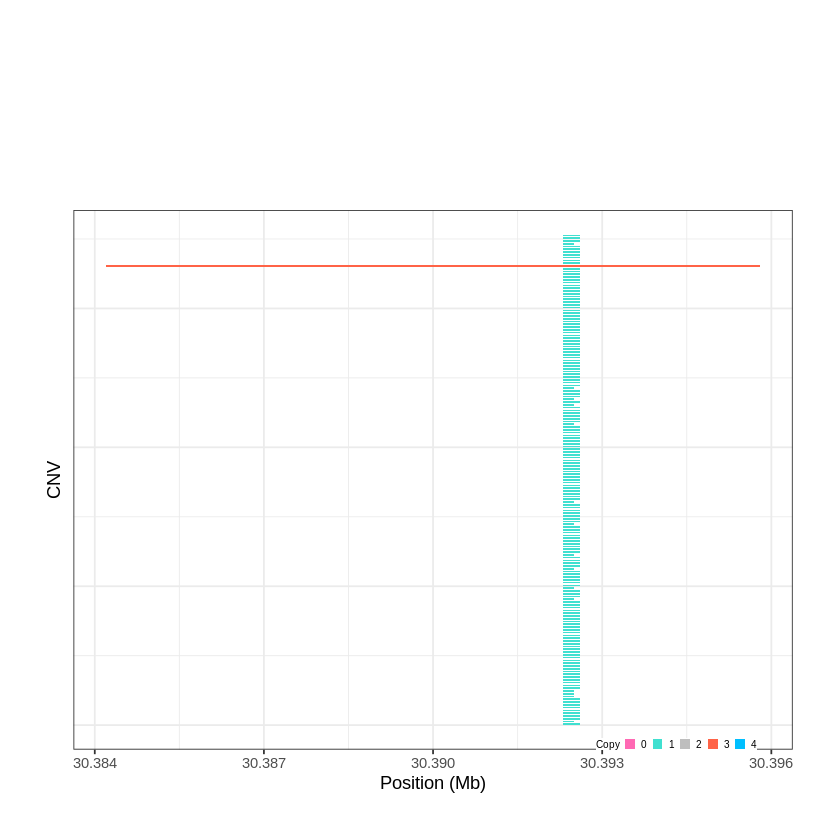

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1055..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 40.765201 - 40.8064 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


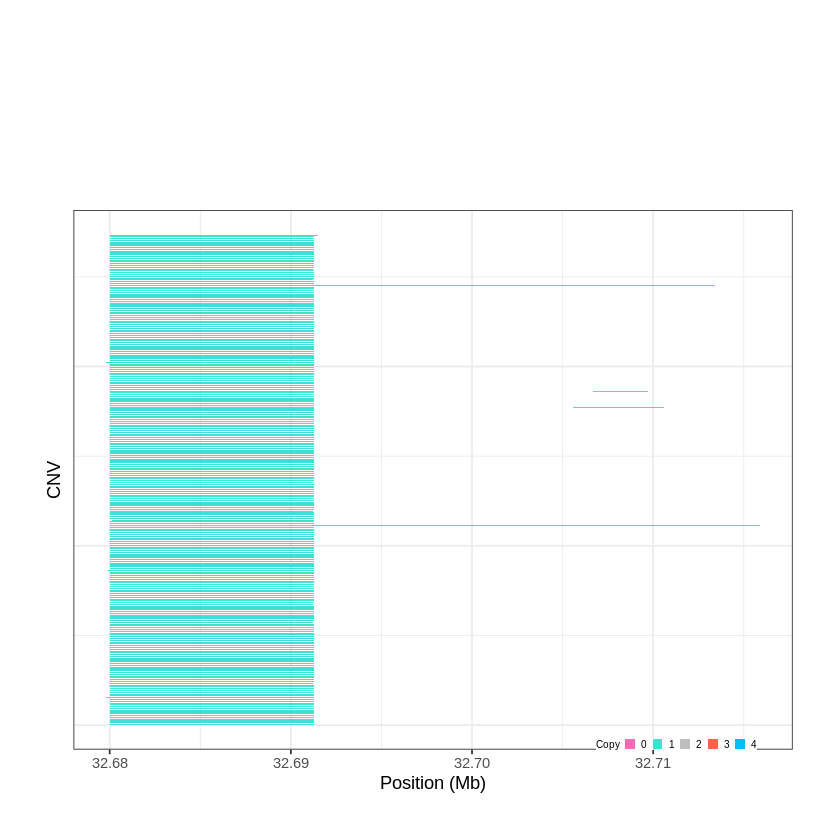

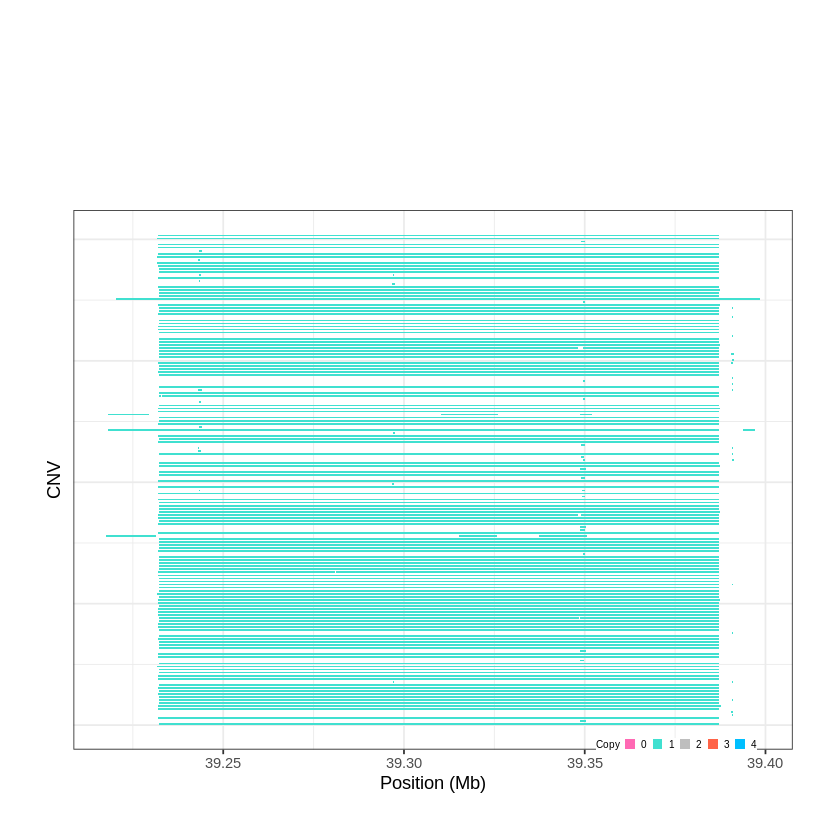

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1056..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 42.129401 - 42.4043 Mb with 245 Individual - "
Plotting gene...


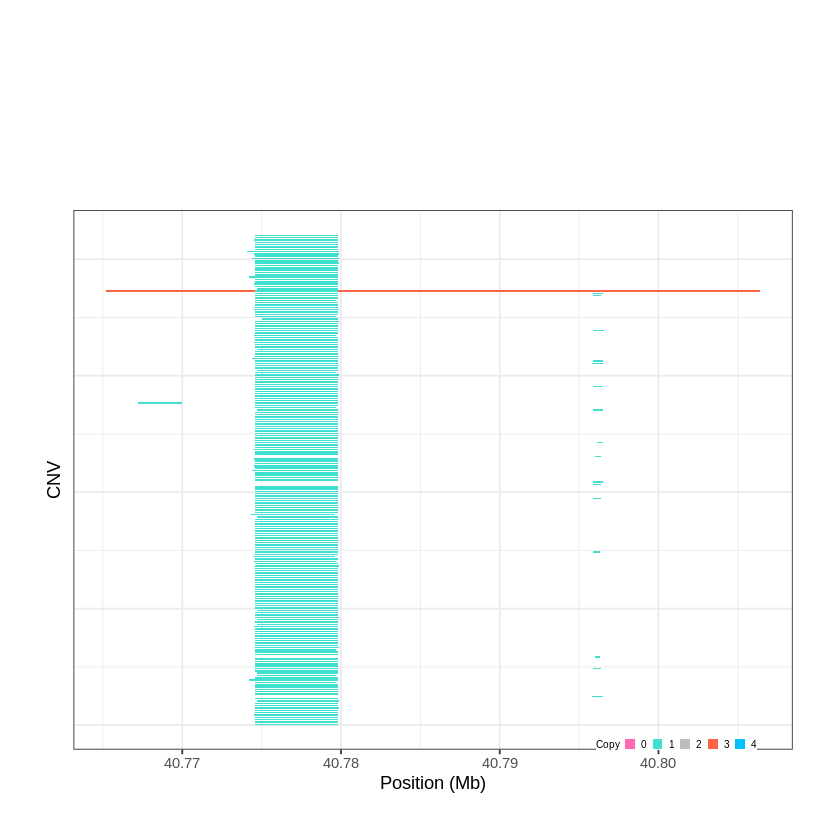

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1057..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 42.936801 - 47.1995 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1058..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 47.256101 - 47.4768 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


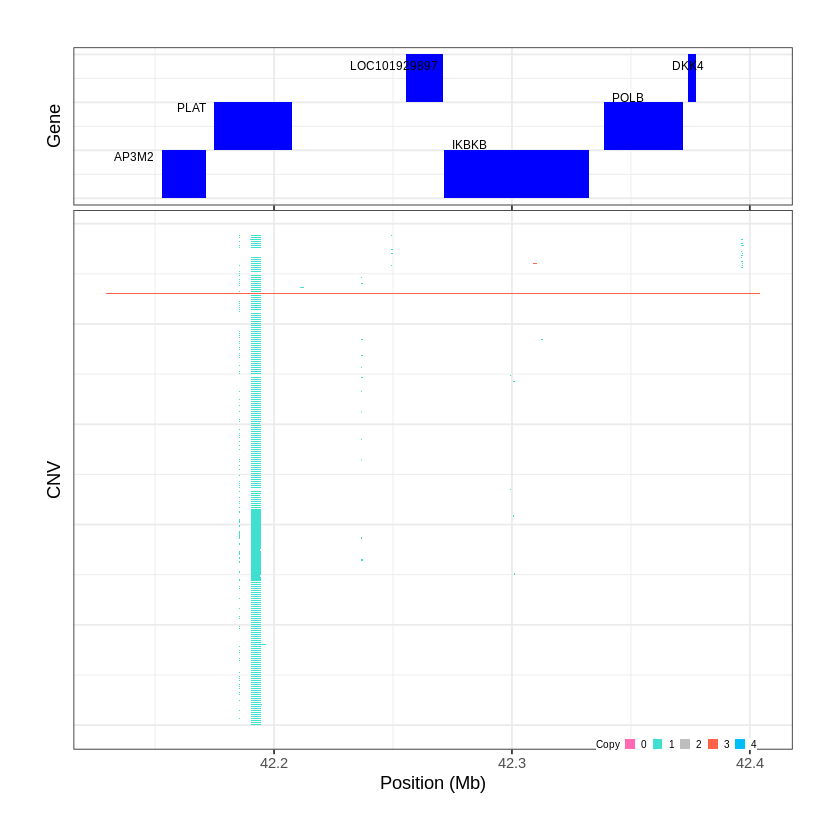

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1059..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 48.130501 - 48.1356 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


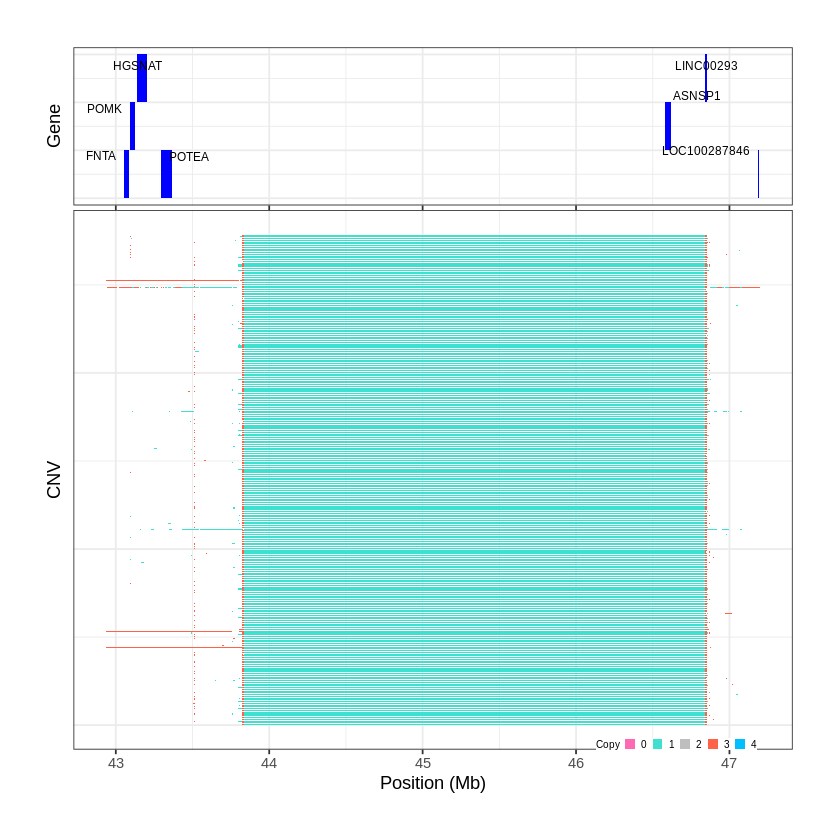

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1060..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 48.179801 - 48.2362 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


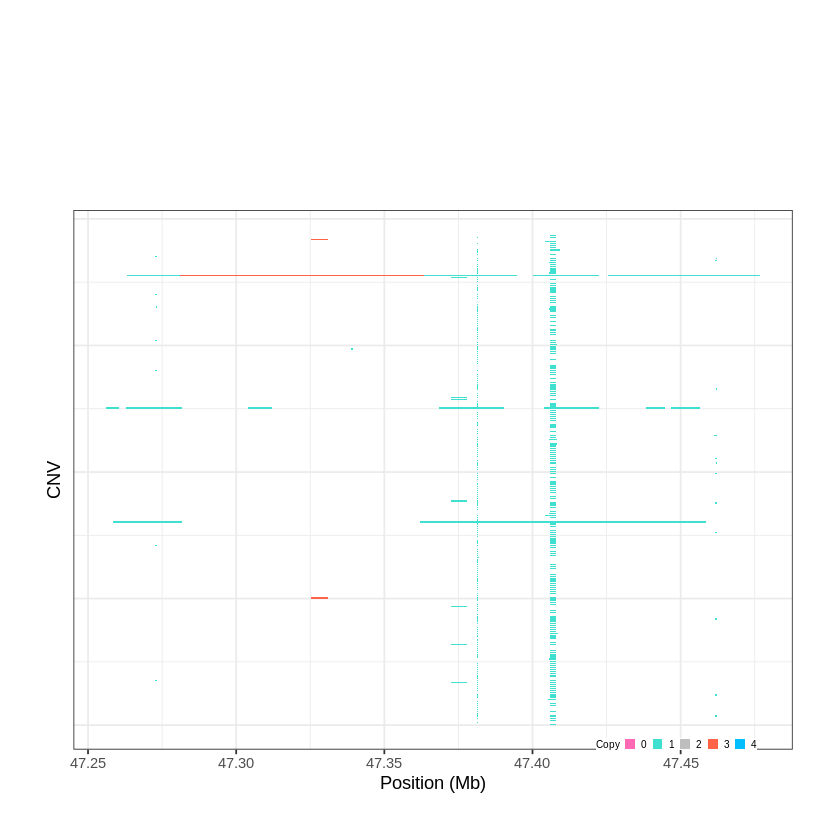

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1061..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 52.720501 - 52.7322 Mb with 247 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


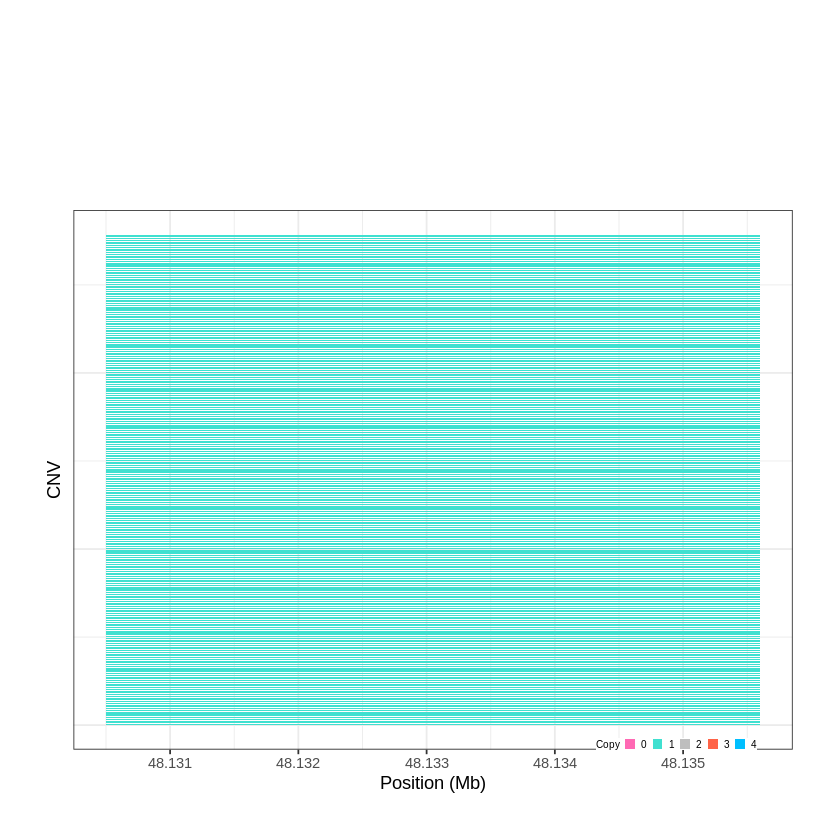

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1062..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 54.521801 - 54.5286 Mb with 172 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


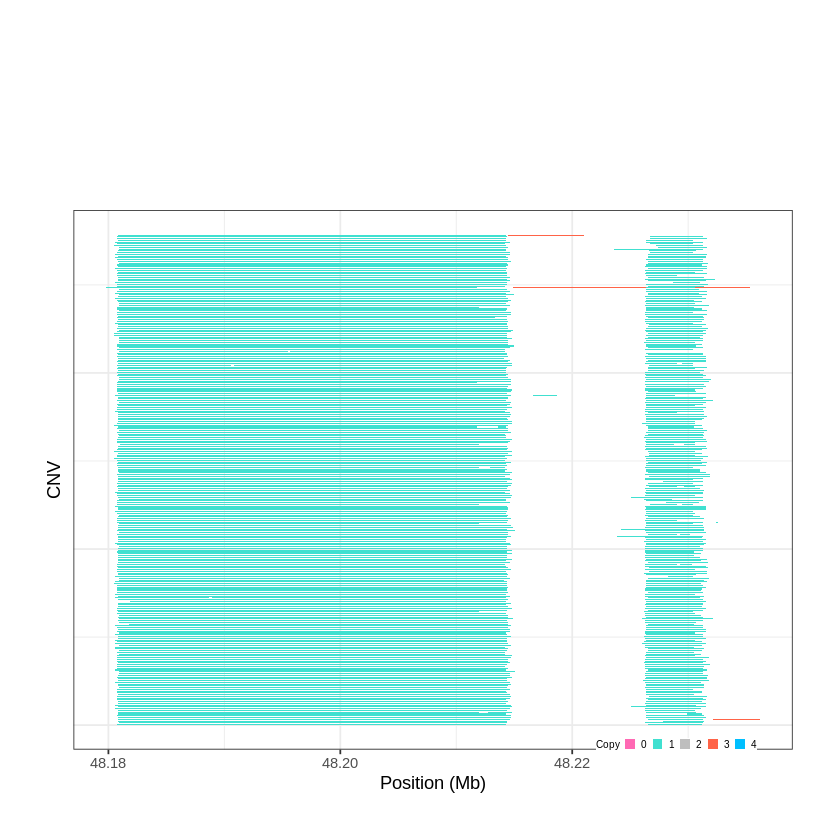

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1063..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 58.104201 - 58.133 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


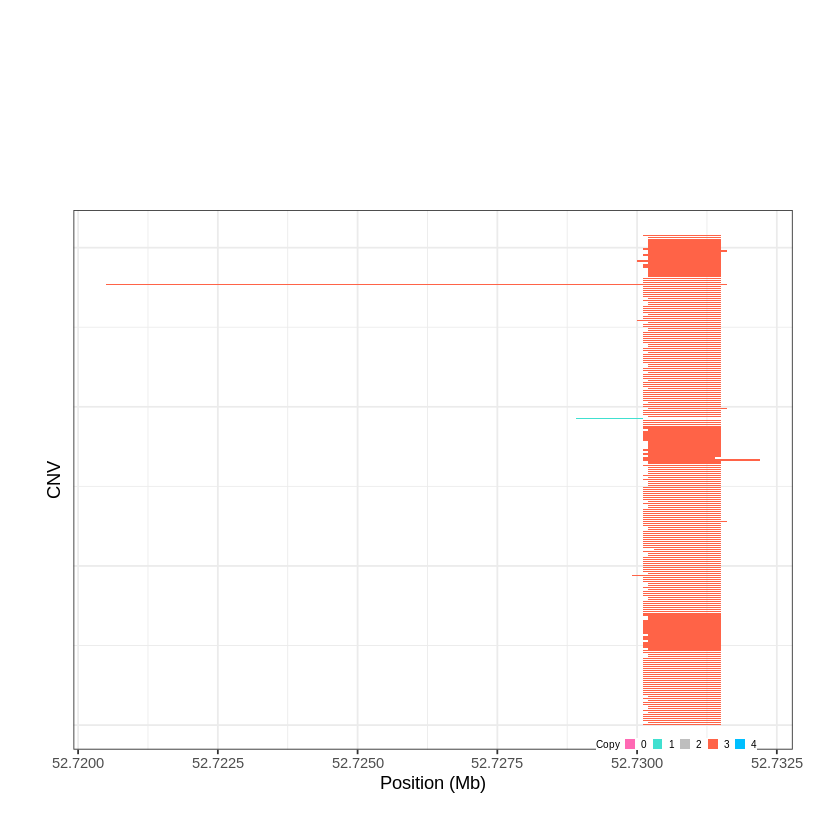

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1064..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 58.433601 - 58.4379 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


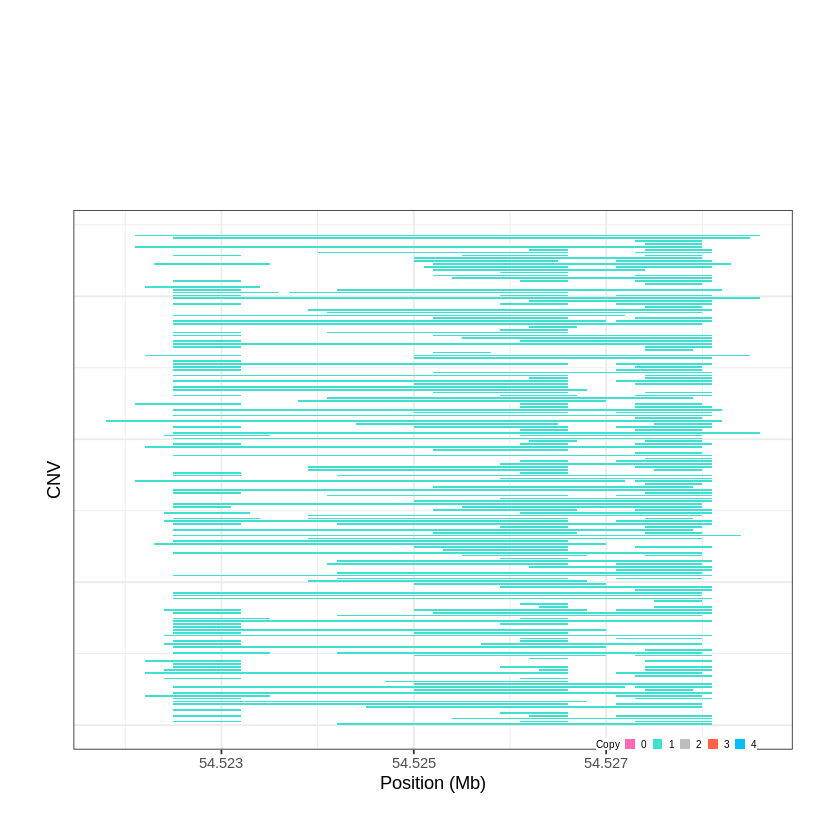

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1065..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 64.711101 - 64.7699 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


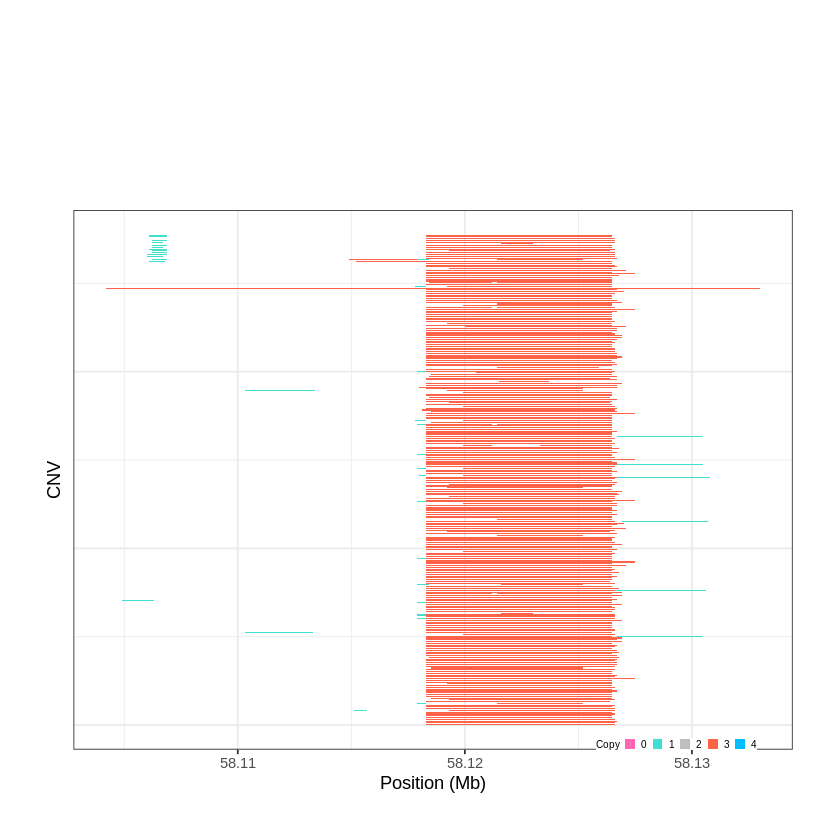

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1066..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 75.353201 - 75.3942 Mb with 255 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


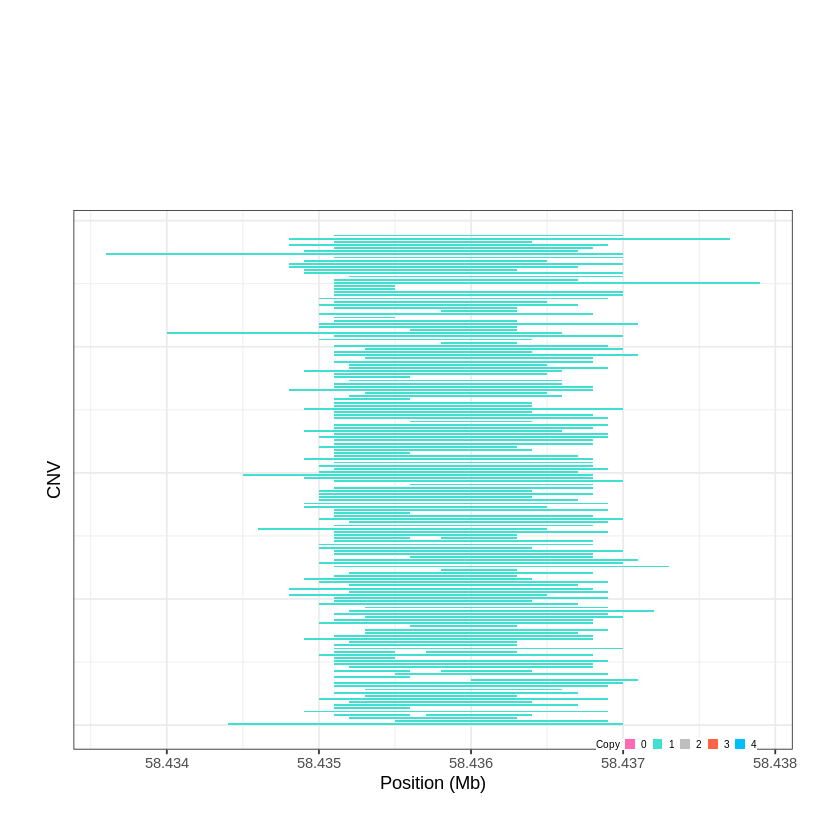

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1067..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 76.126901 - 76.1272 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


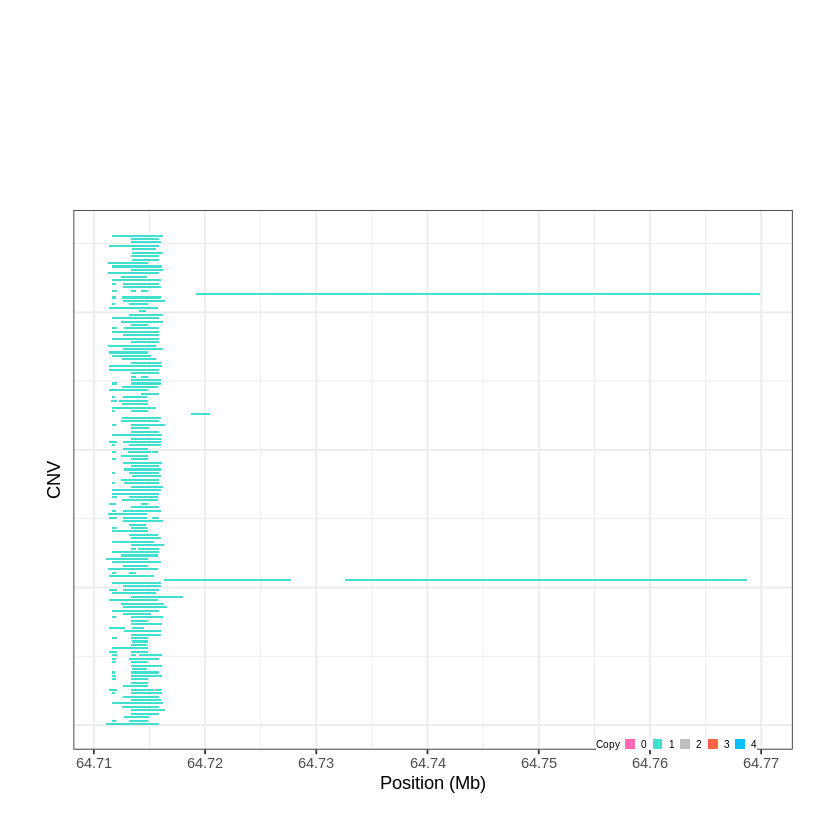

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1068..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 86.539501 - 86.5764 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


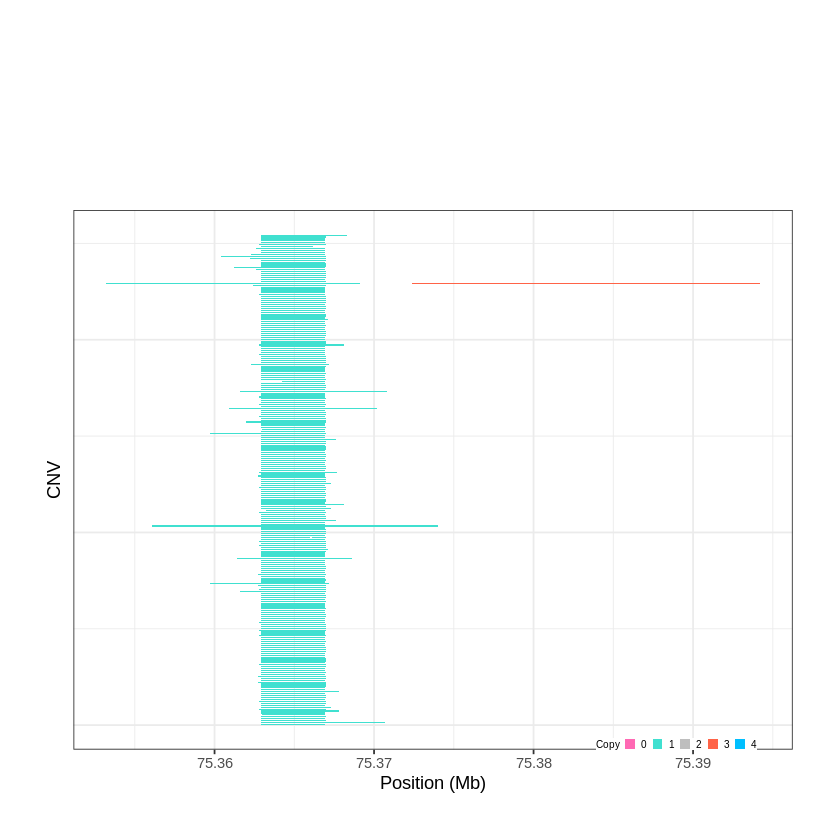

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1069..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 86.576401 - 86.7265 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


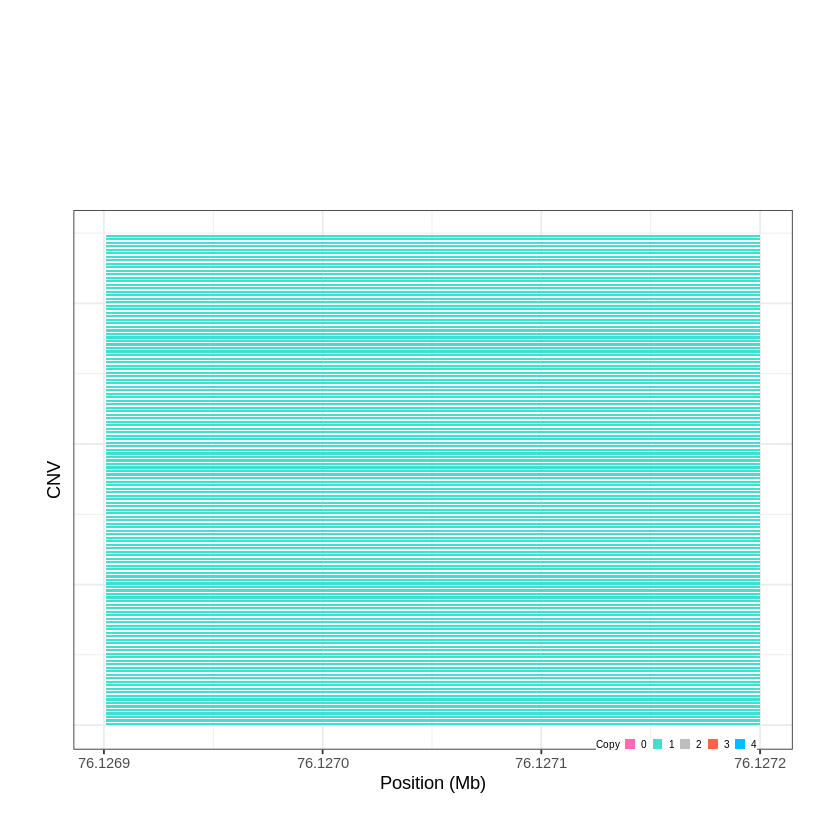

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1070..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 86.726501 - 86.8432 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


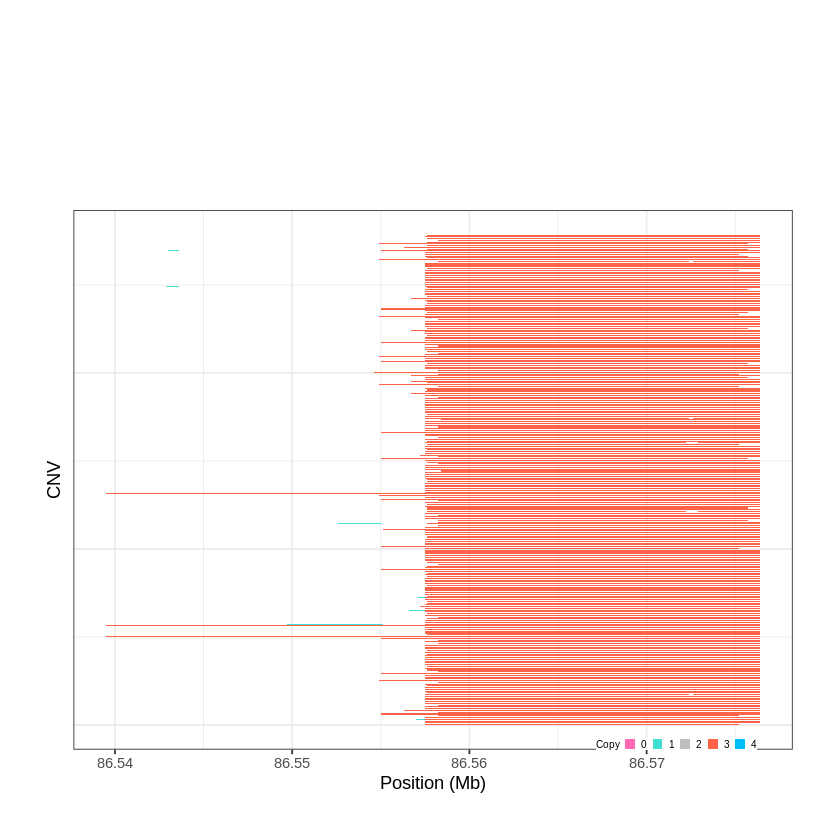

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1071..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 89.373501 - 89.3933 Mb with 258 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


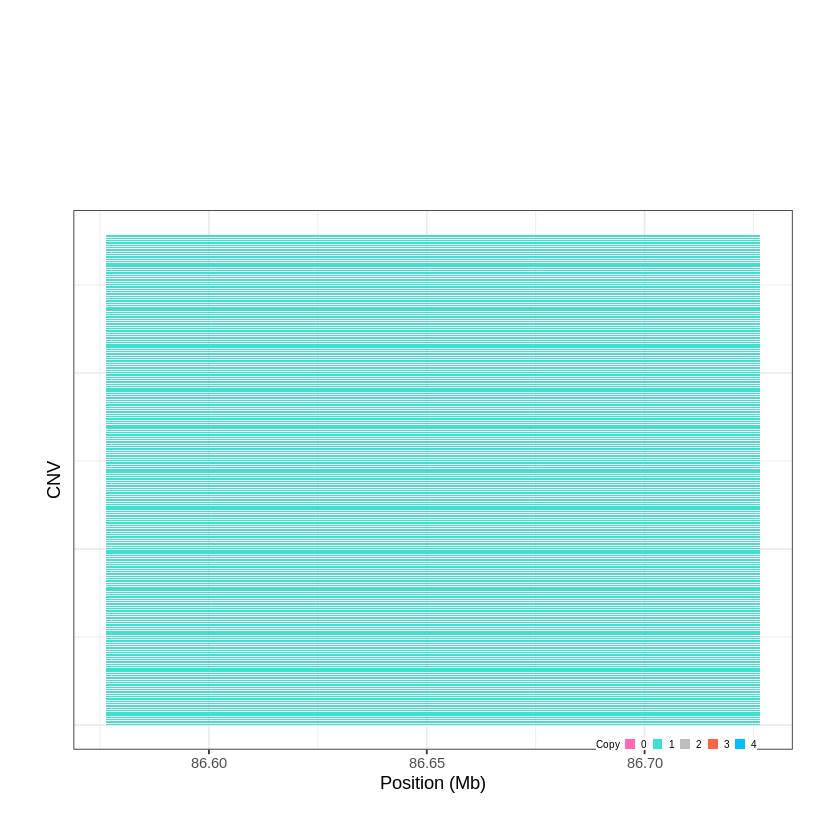

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1072..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 102.932201 - 102.9492 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


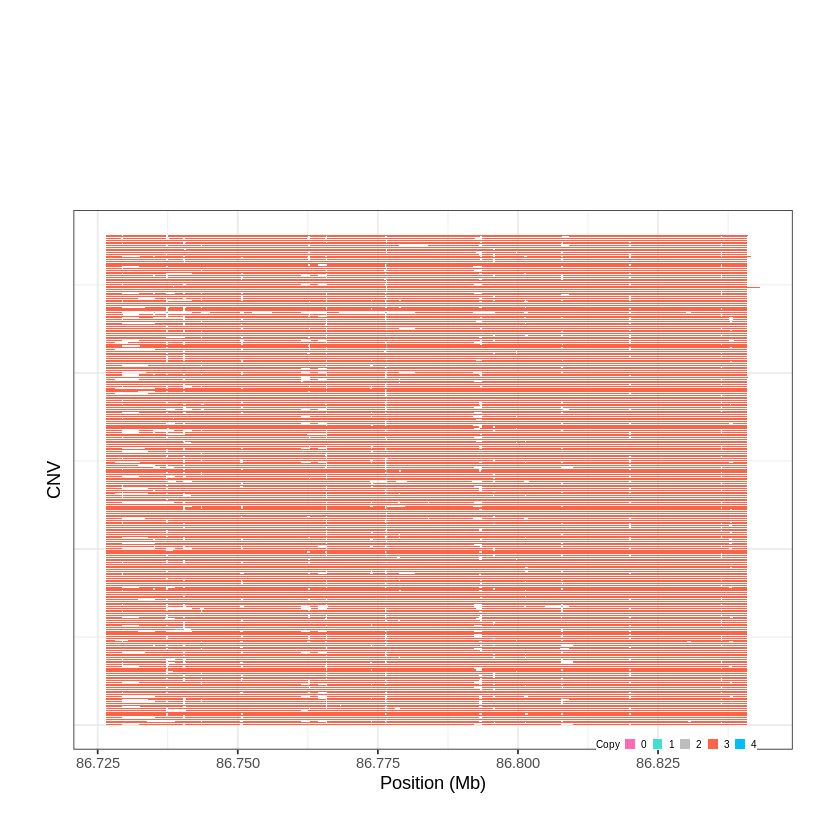

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1073..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 104.378201 - 104.4026 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


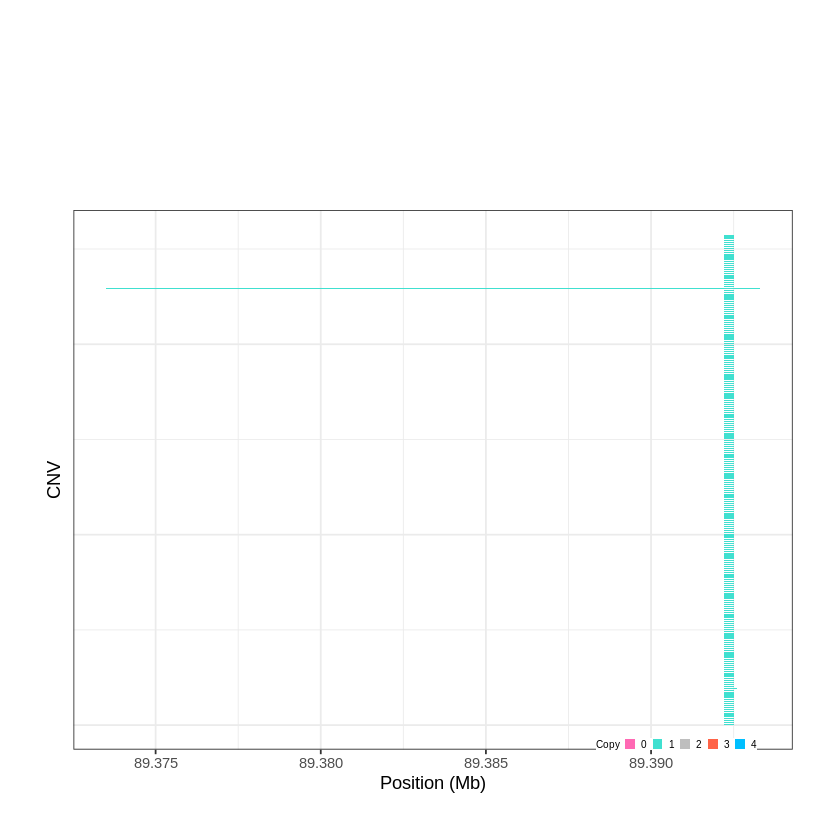

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1074..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 106.153501 - 106.1868 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


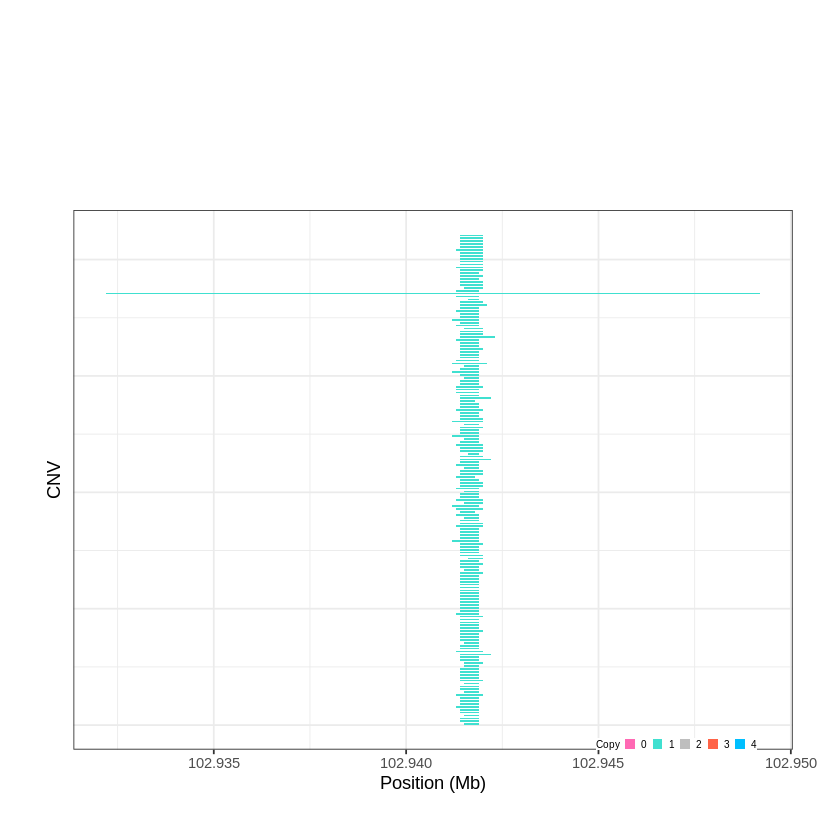

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1075..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 108.370601 - 108.3824 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


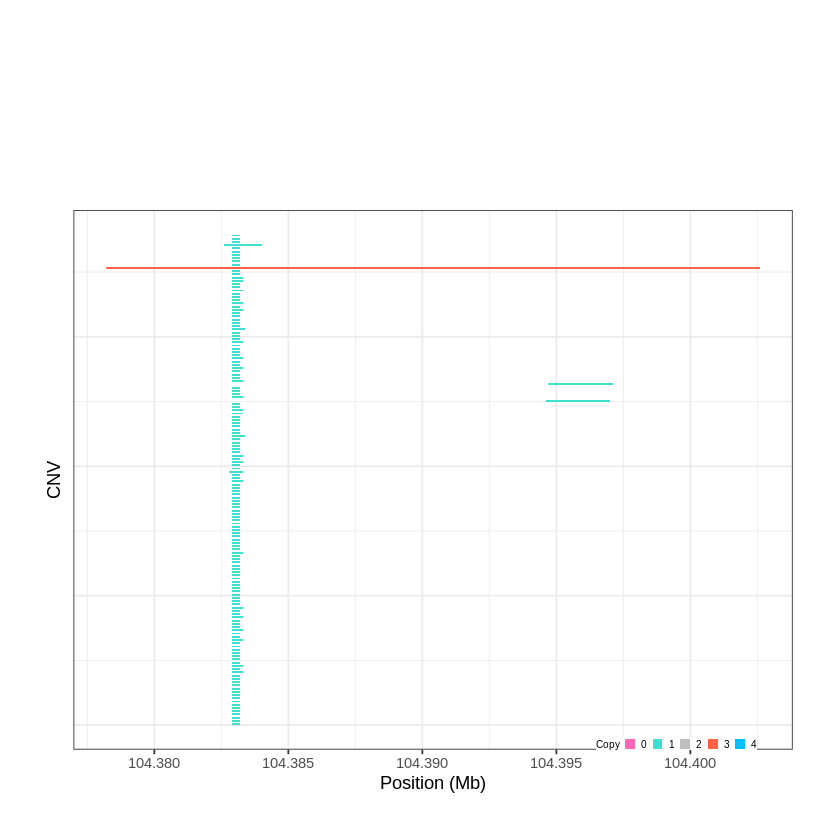

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1076..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 112.282301 - 112.2996 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


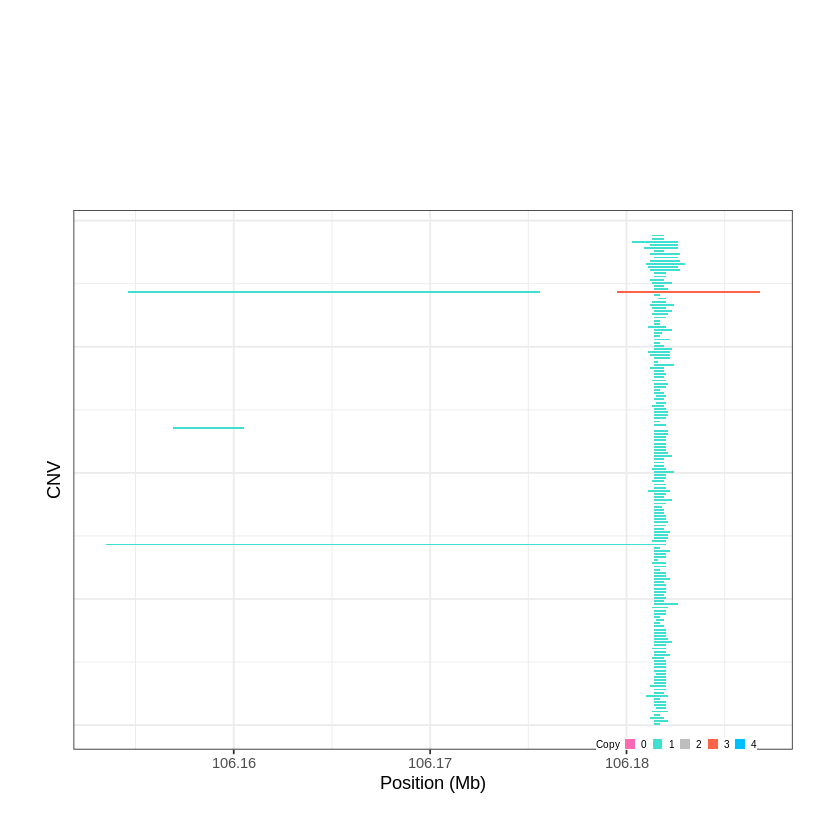

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1077..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 114.897701 - 114.9521 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


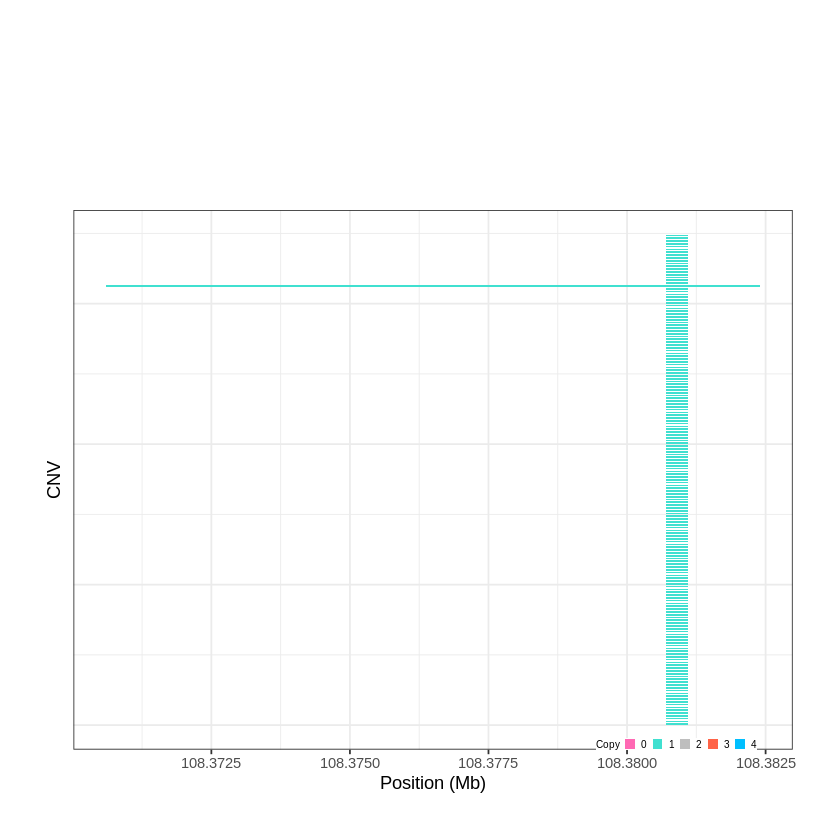

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1078..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 118.223501 - 118.2239 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


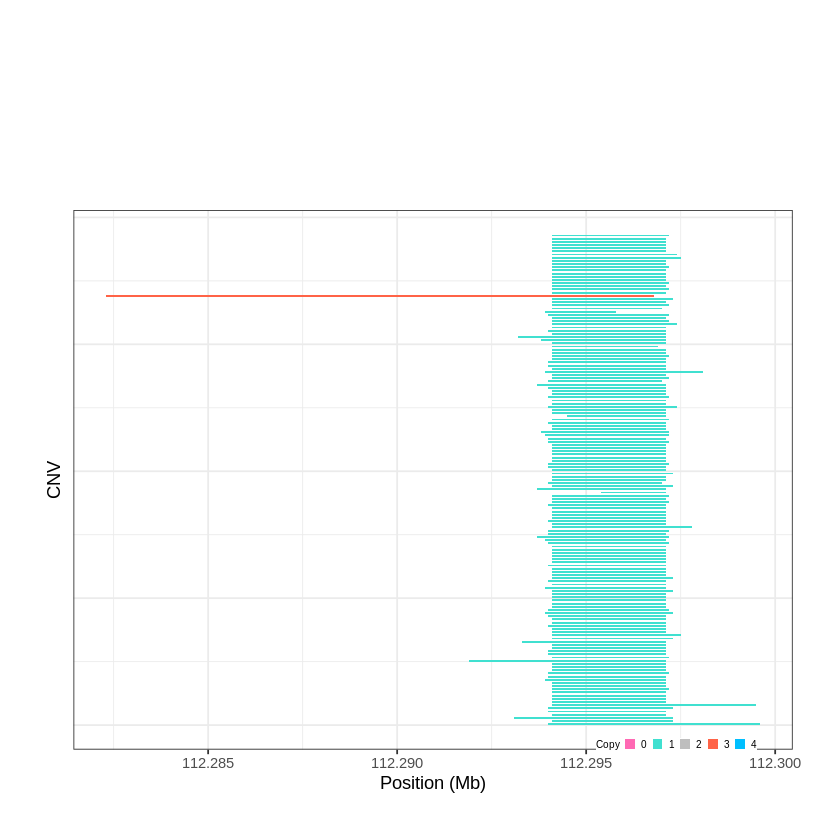

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1079..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 120.898901 - 120.9001 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


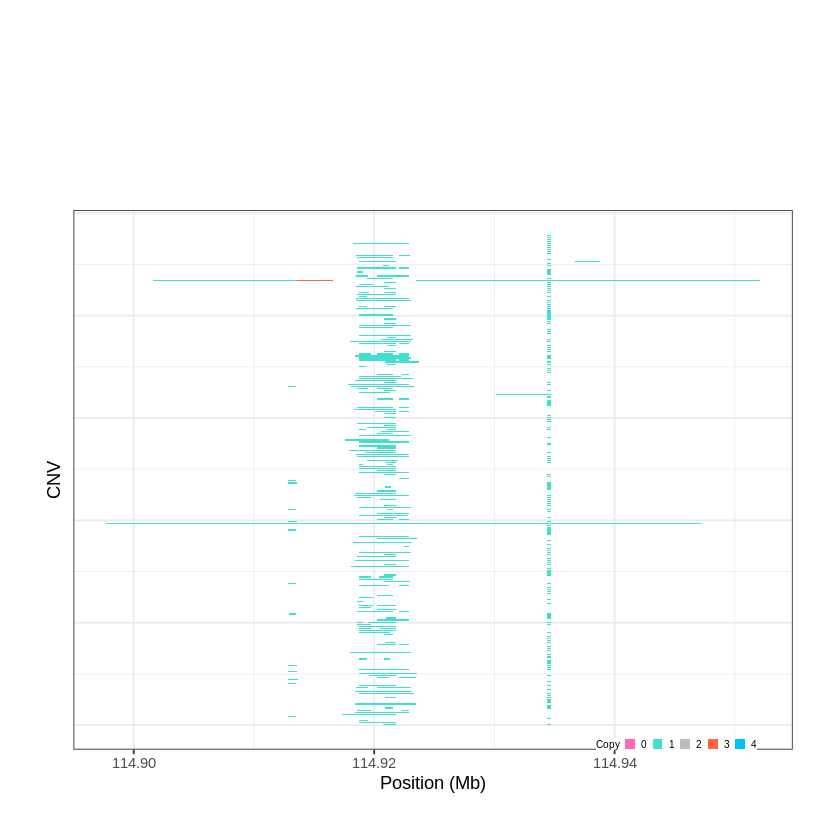

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1080..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 126.600201 - 126.6067 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


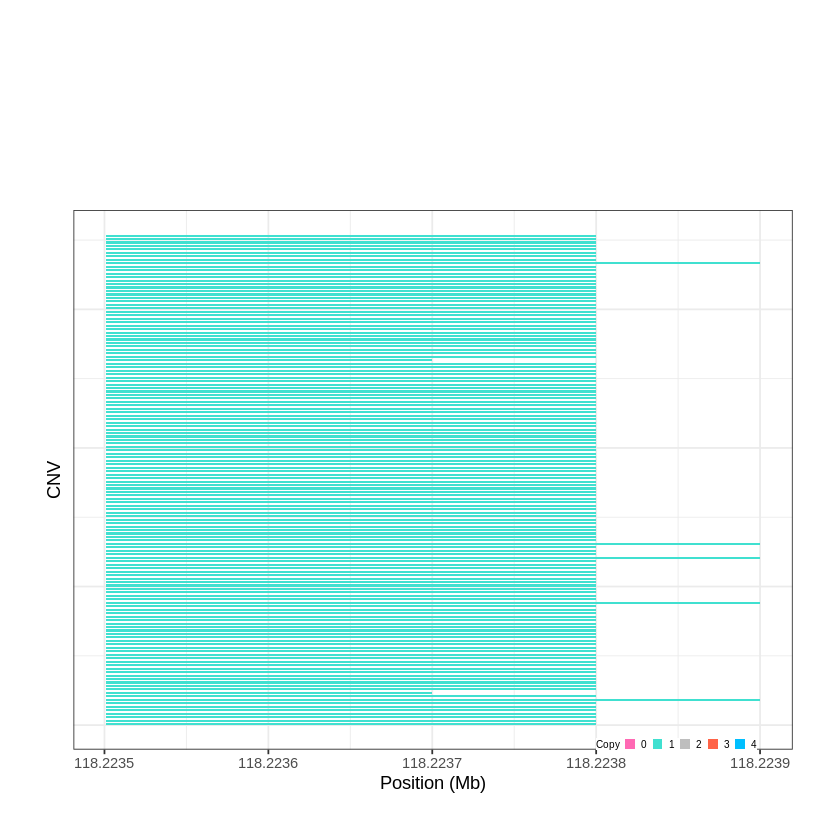

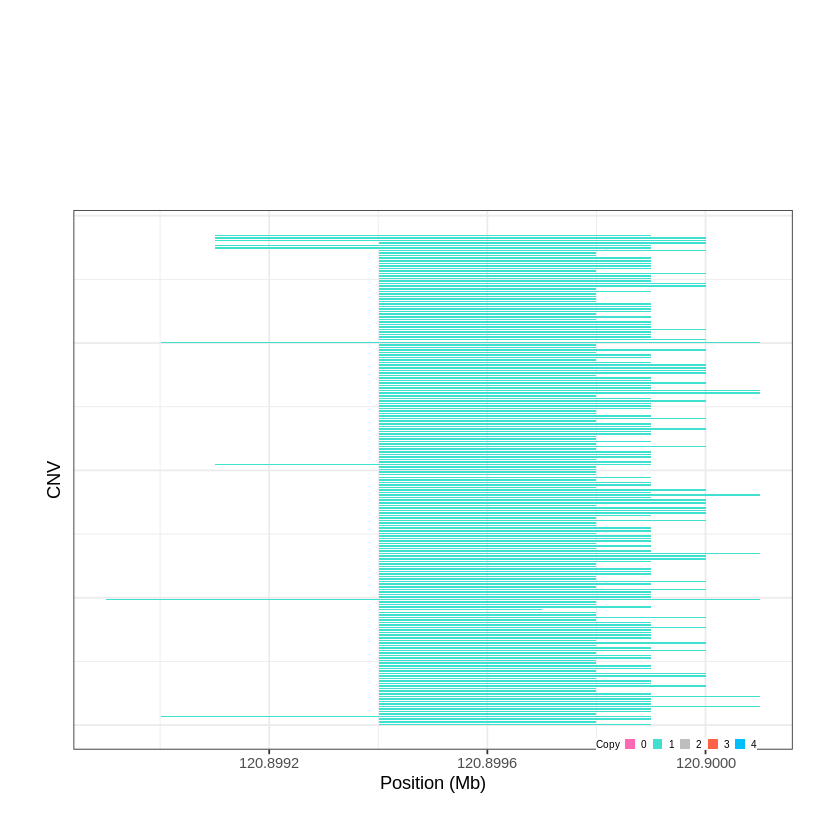

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1081..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 127.167801 - 127.2181 Mb with 161 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1082..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 128.322501 - 128.3332 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


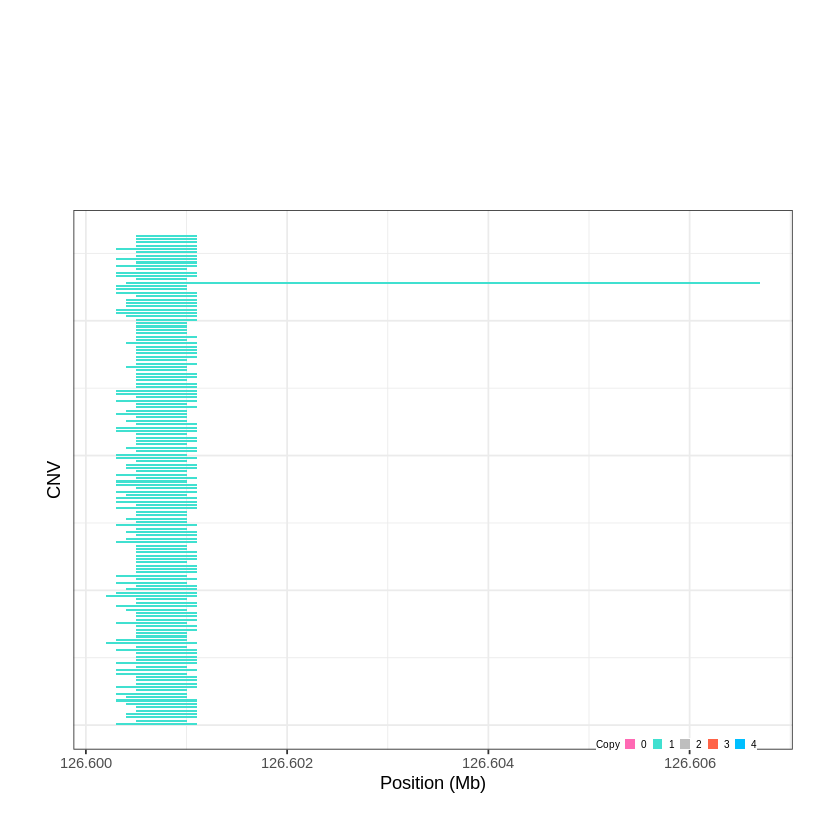

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1083..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 129.714901 - 129.7662 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


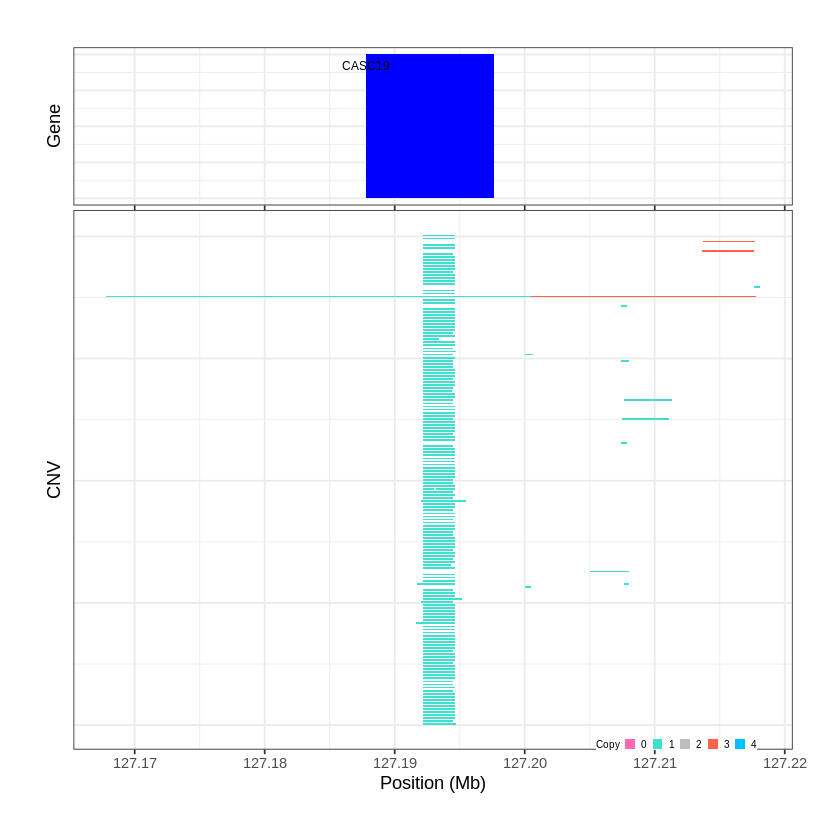

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1084..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 129.896101 - 129.9168 Mb with 174 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


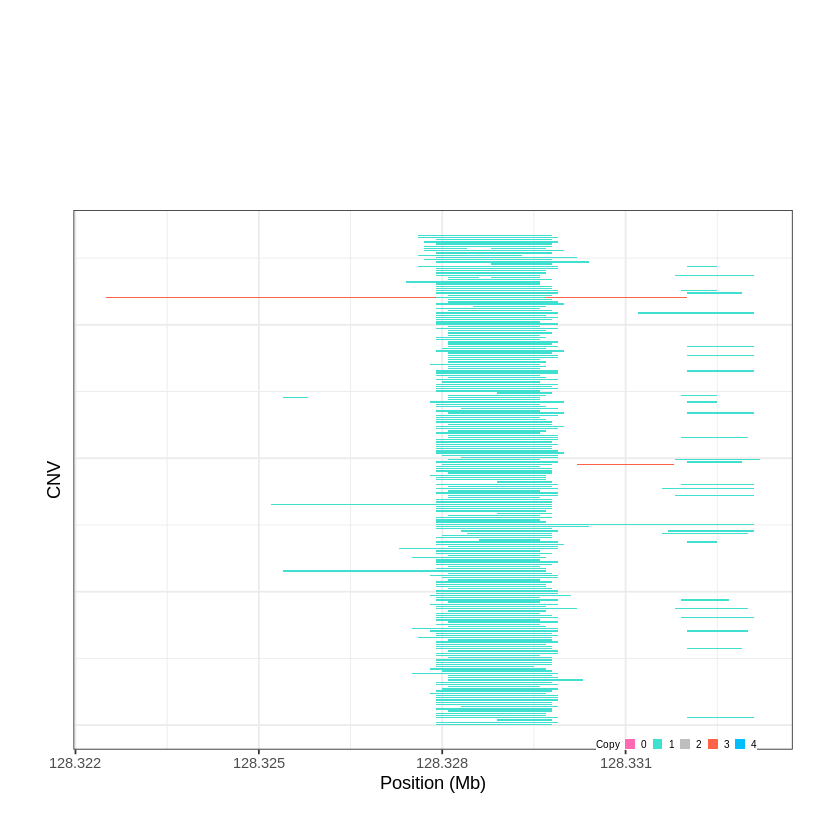

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1085..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 131.060601 - 131.0724 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


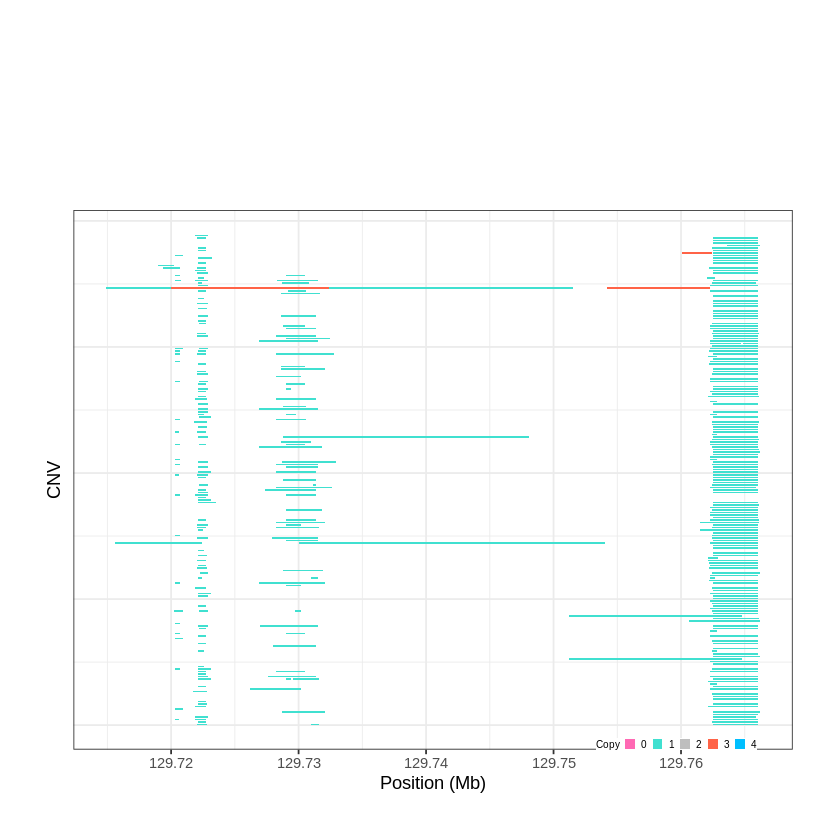

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1086..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 132.193001 - 132.2572 Mb with 159 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


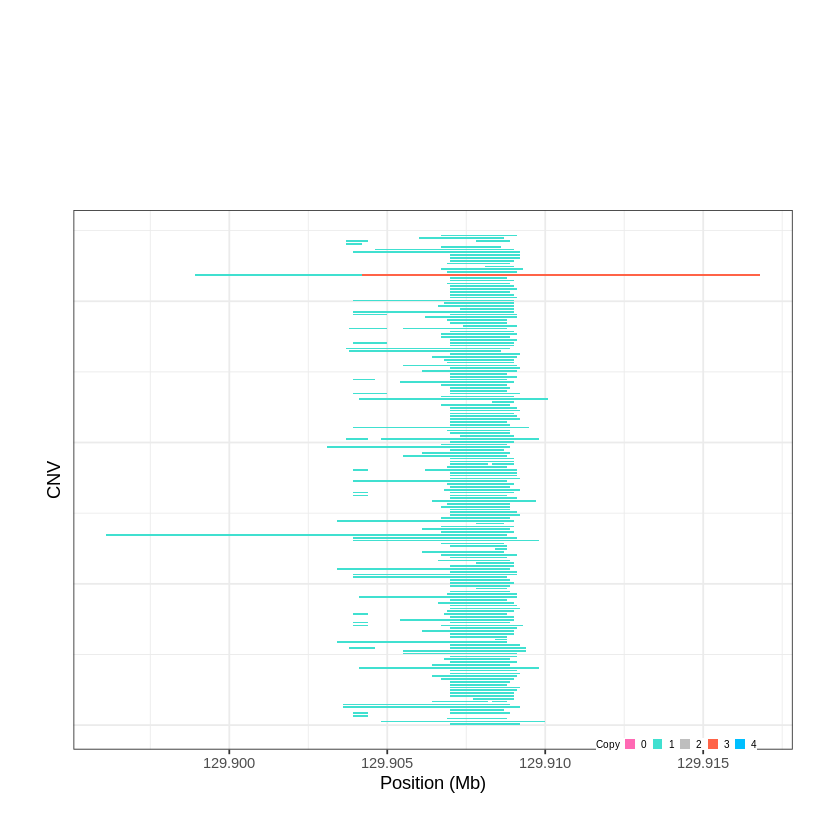

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1087..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 132.265101 - 132.2867 Mb with 235 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


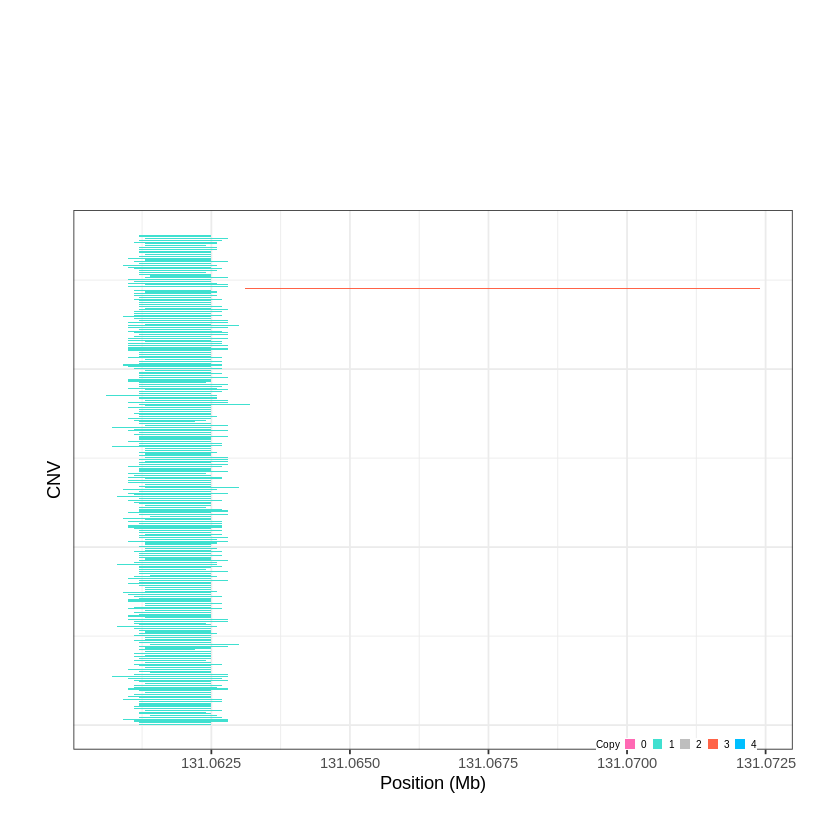

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1088..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 134.319901 - 134.3382 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


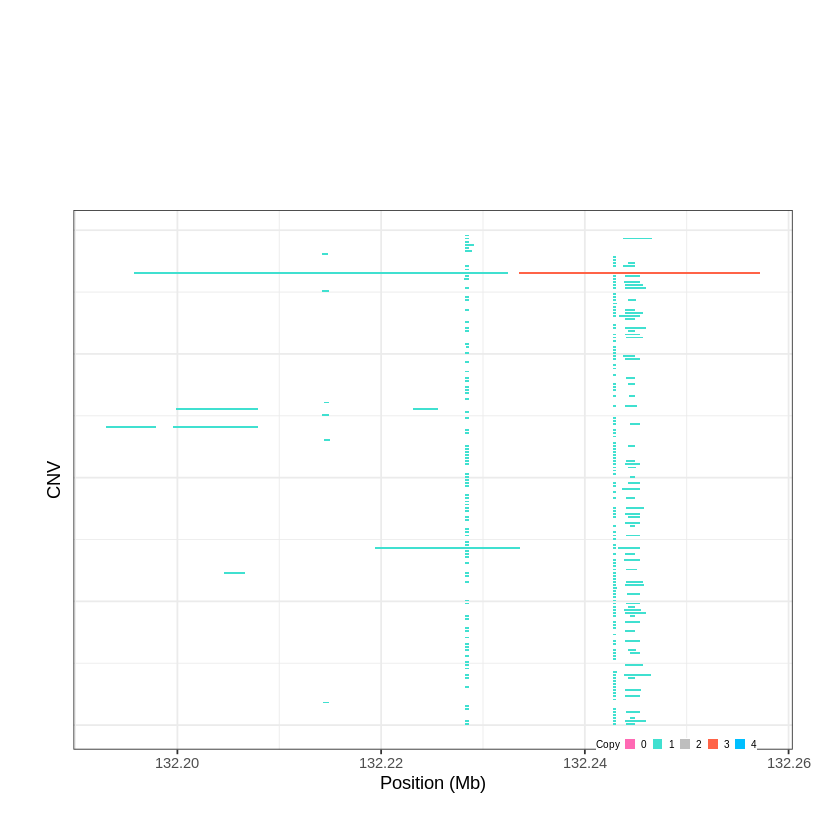

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1089..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 136.888801 - 136.9102 Mb with 162 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


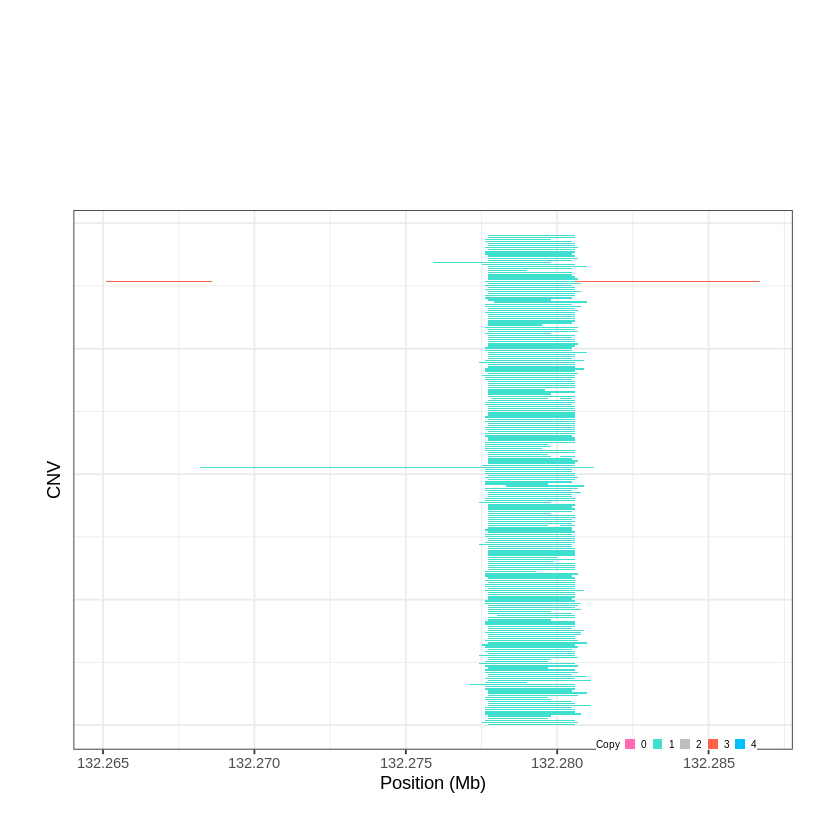

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1090..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 138.742501 - 138.7443 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


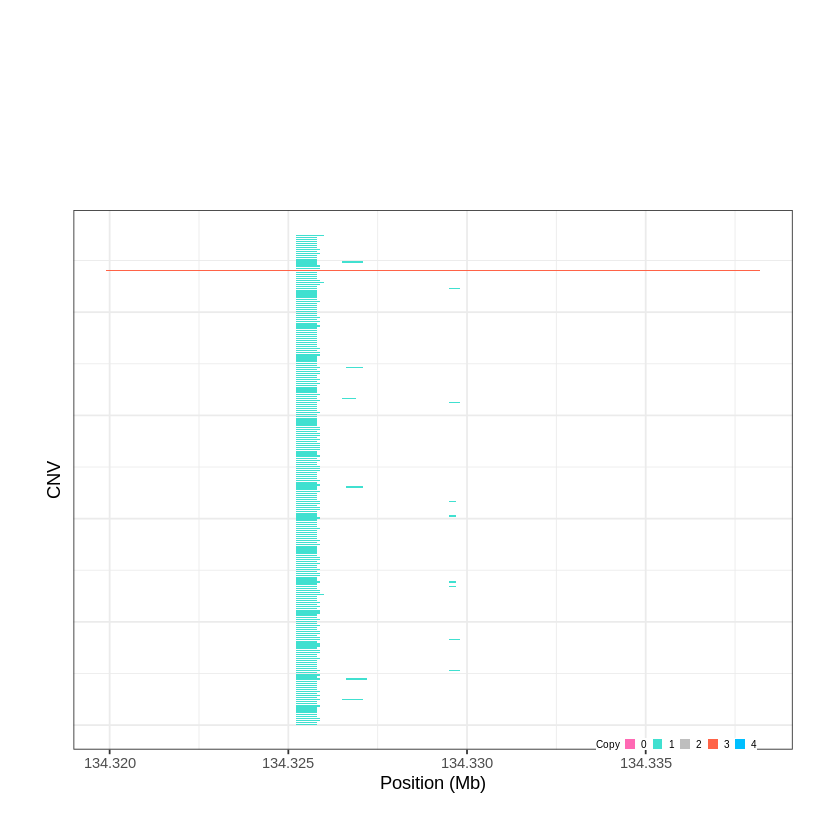

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1091..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 141.111001 - 141.1855 Mb with 237 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


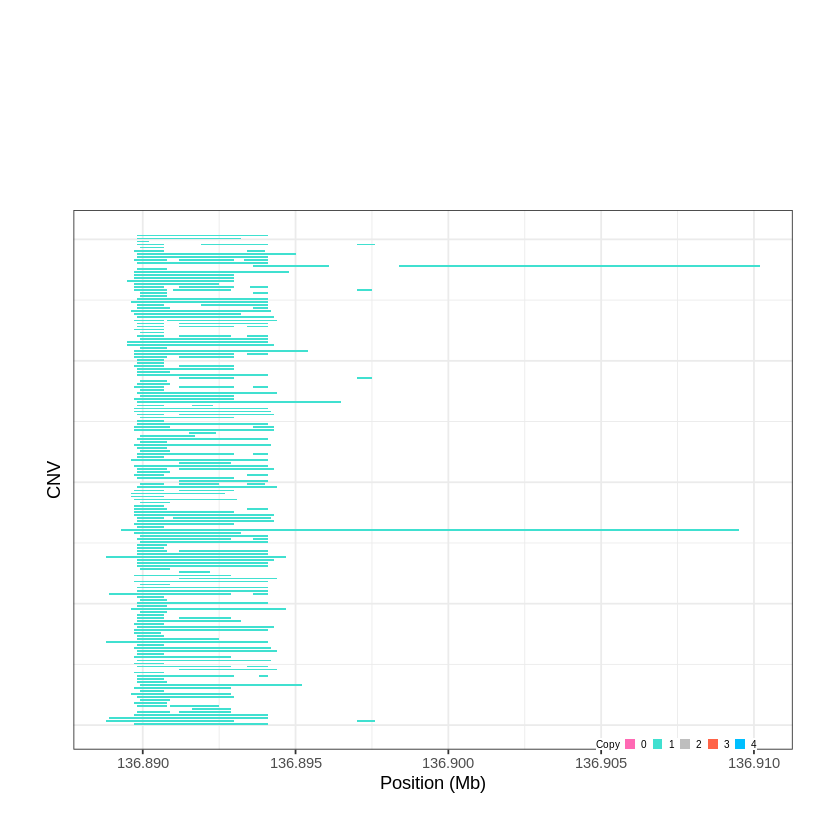

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1092..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 141.522501 - 141.6694 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


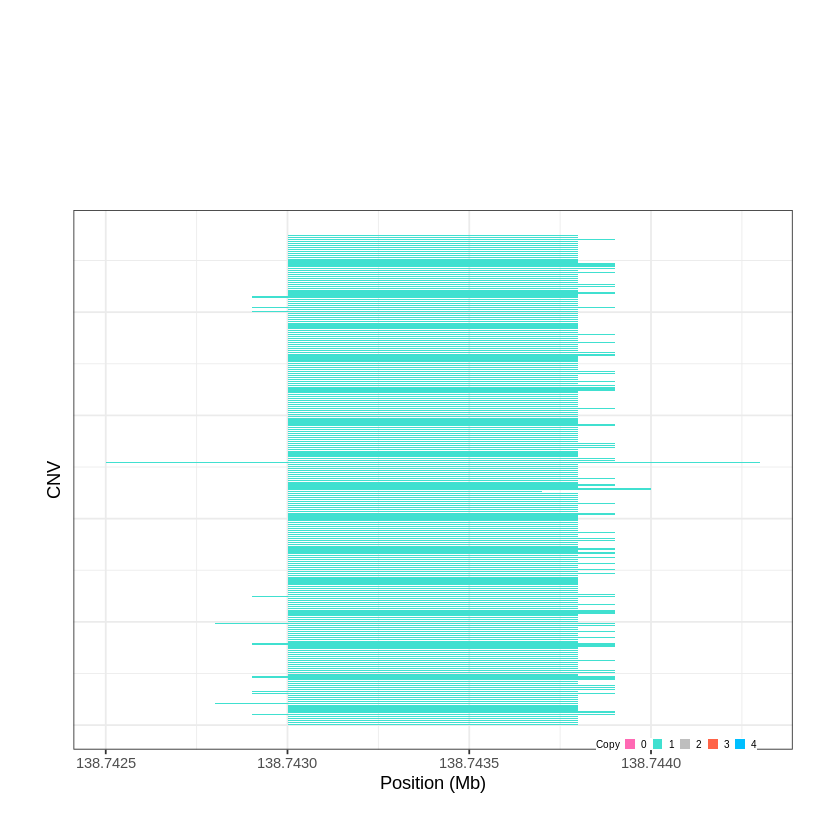

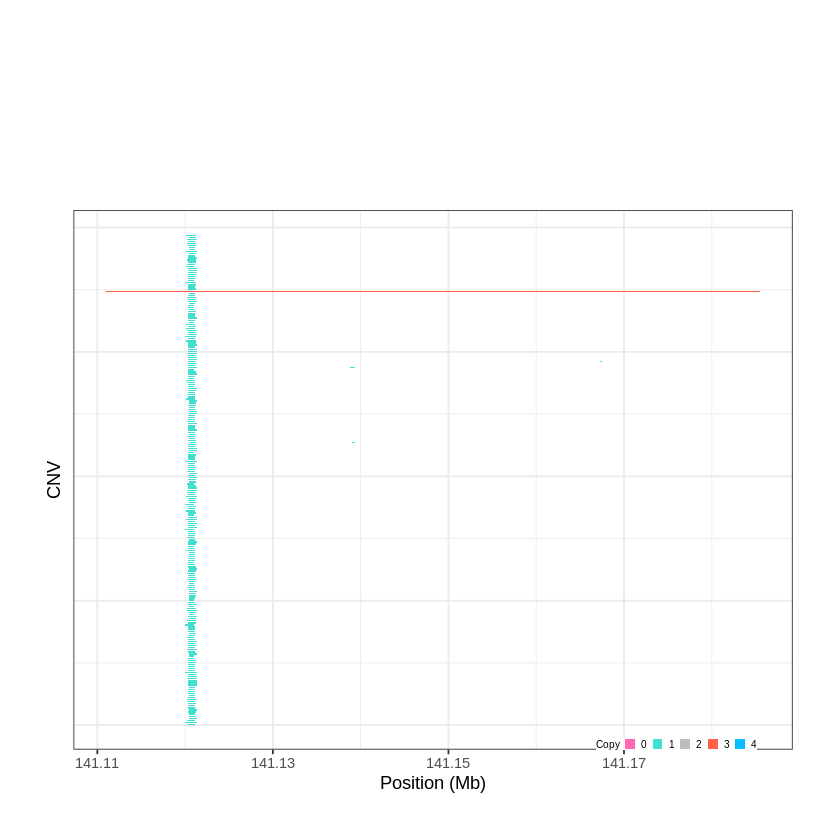

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1093..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 141.957901 - 142.3444 Mb with 156 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1094..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 142.357401 - 142.3598 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


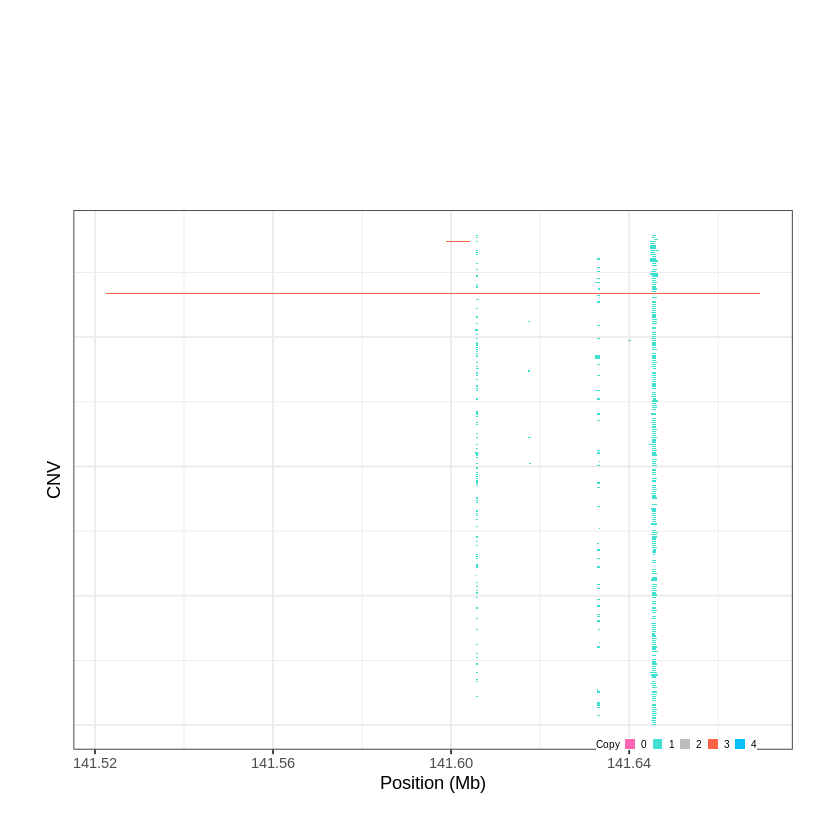

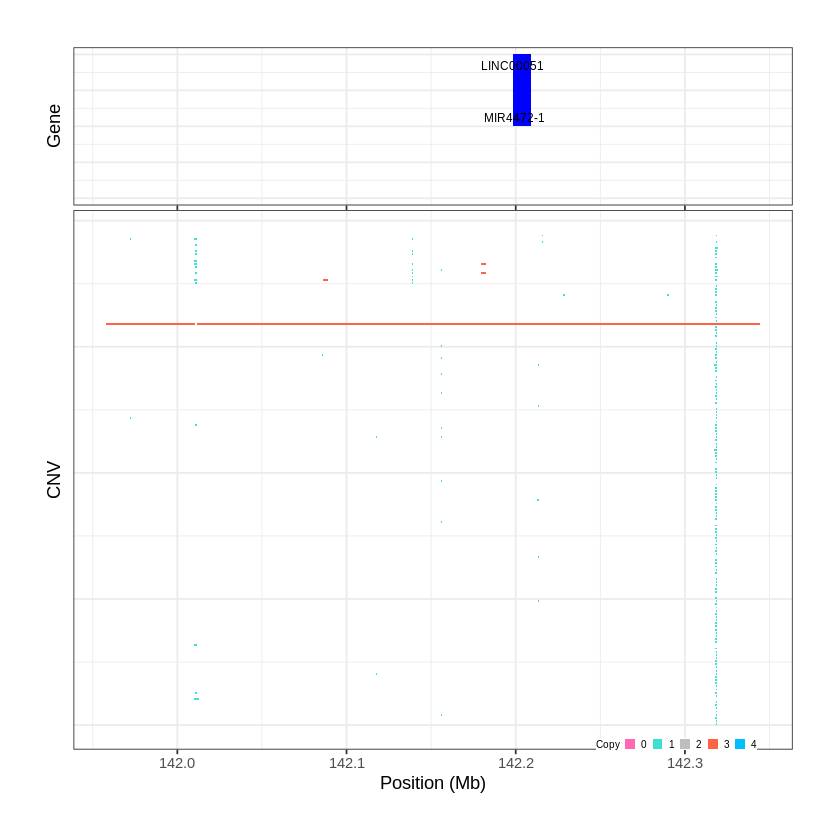

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1095..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 142.438501 - 142.9043 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


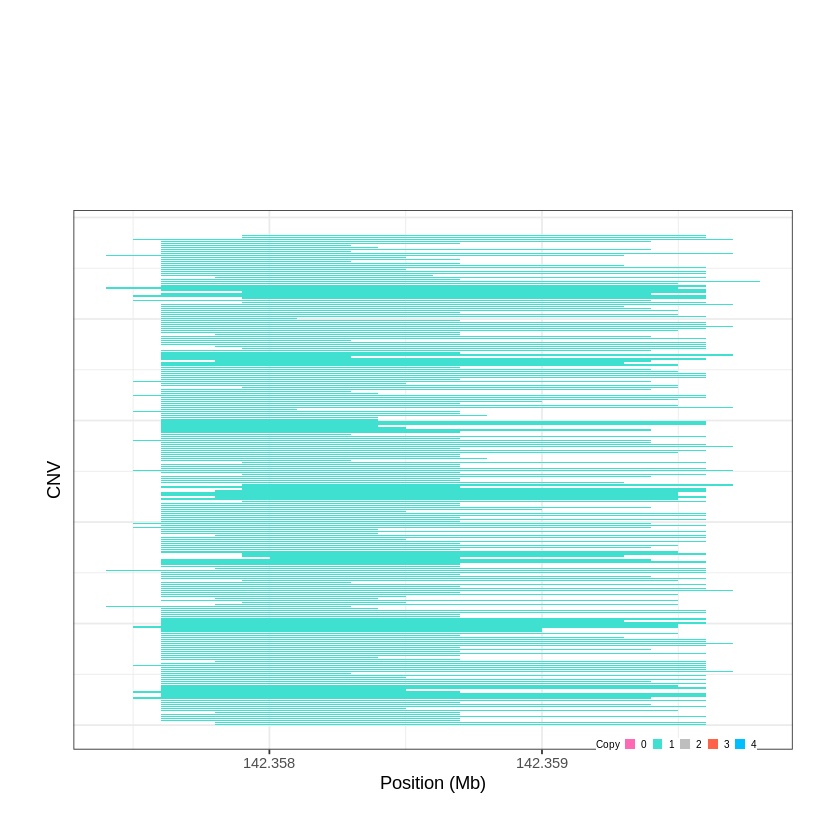

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1096..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 142.925701 - 143.3274 Mb with 279 Individual - "
Plotting gene...


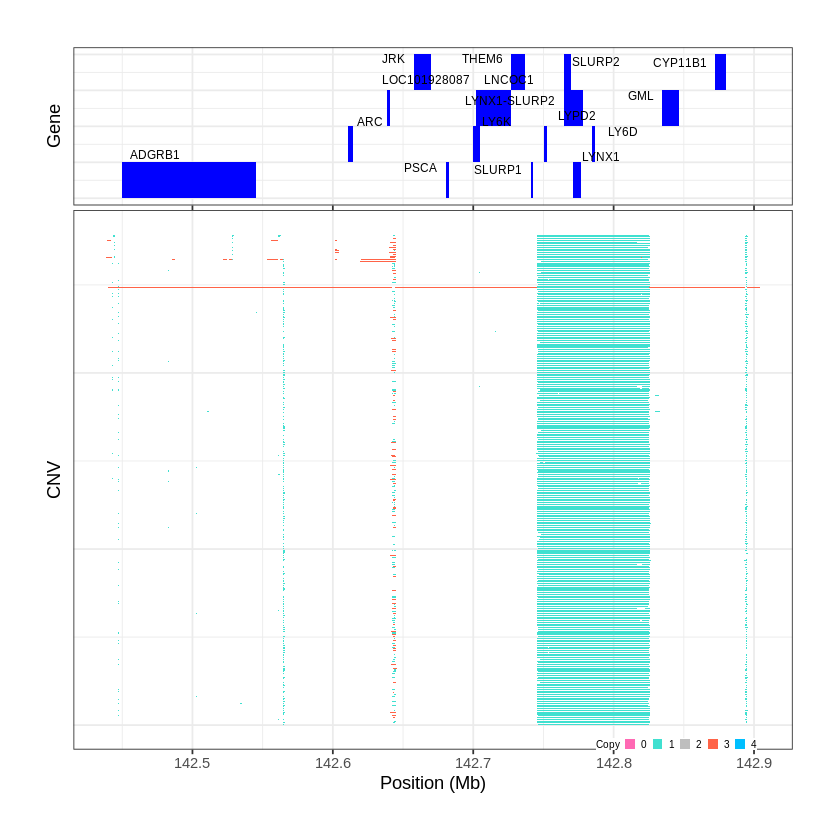

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1097..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 143.353701 - 143.4958 Mb with 266 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1098..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 143.528401 - 143.5522 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


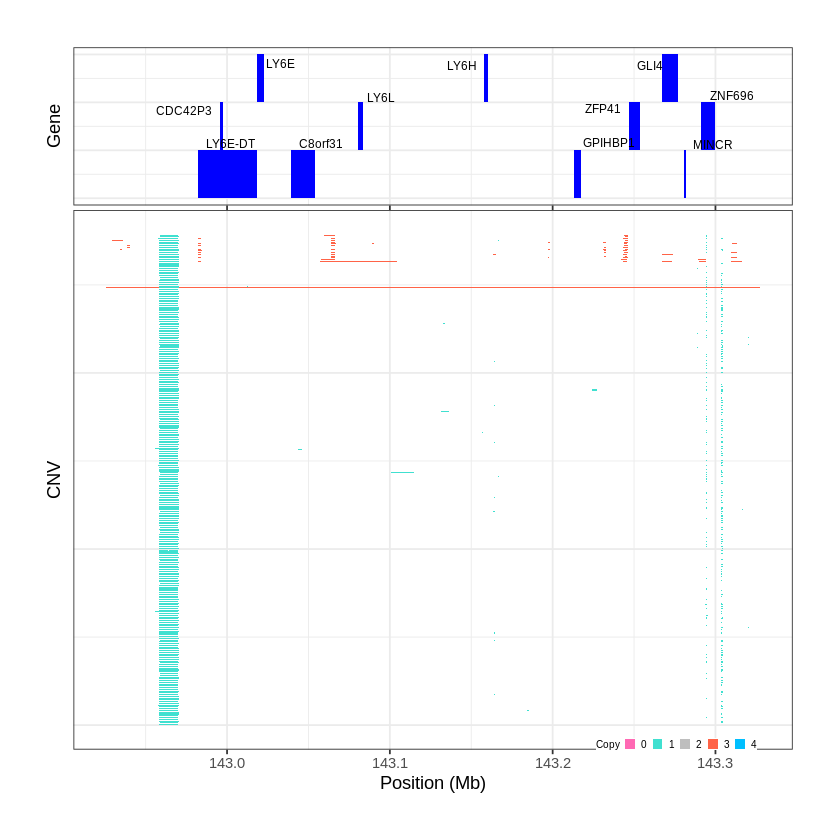

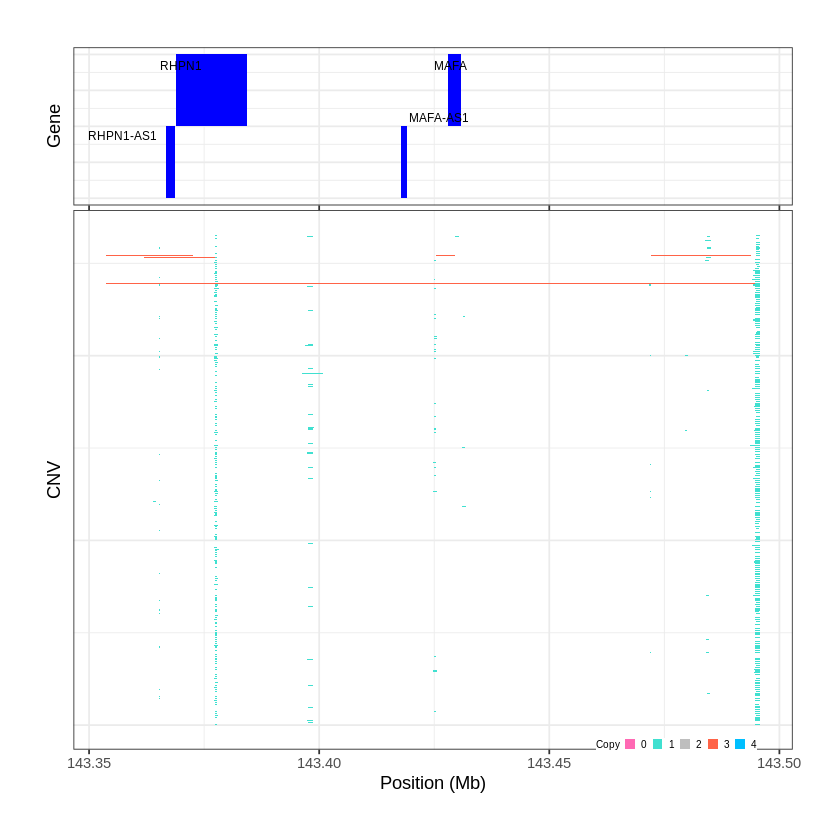

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1099..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 143.672301 - 143.967 Mb with 217 Individual - "
Plotting gene...


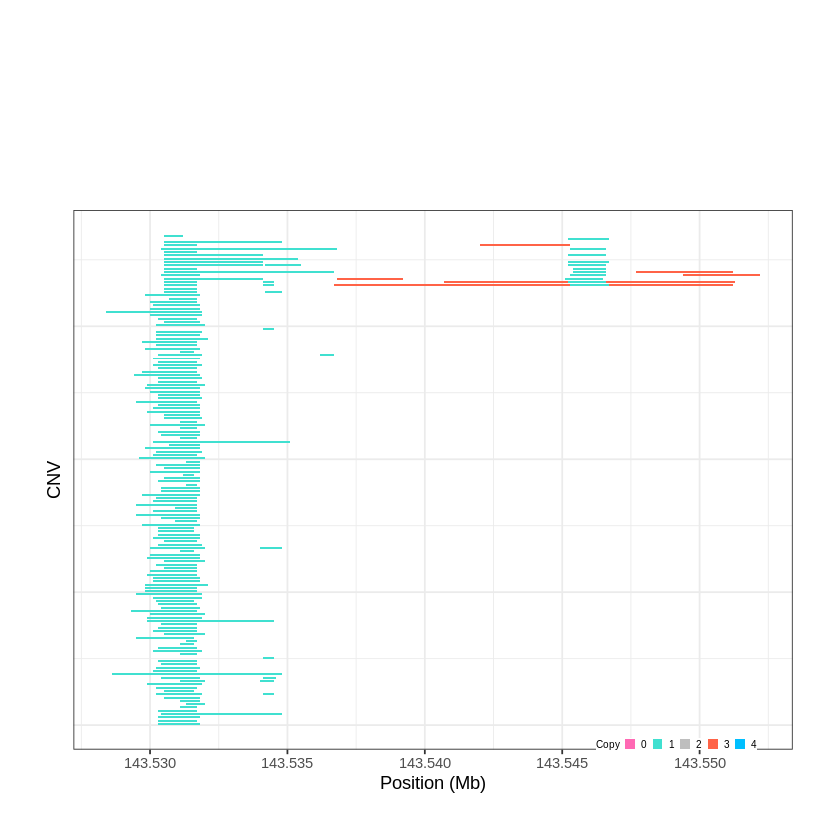

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1100..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 143.977801 - 144.2081 Mb with 174 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1101..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.270101 - 144.2716 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


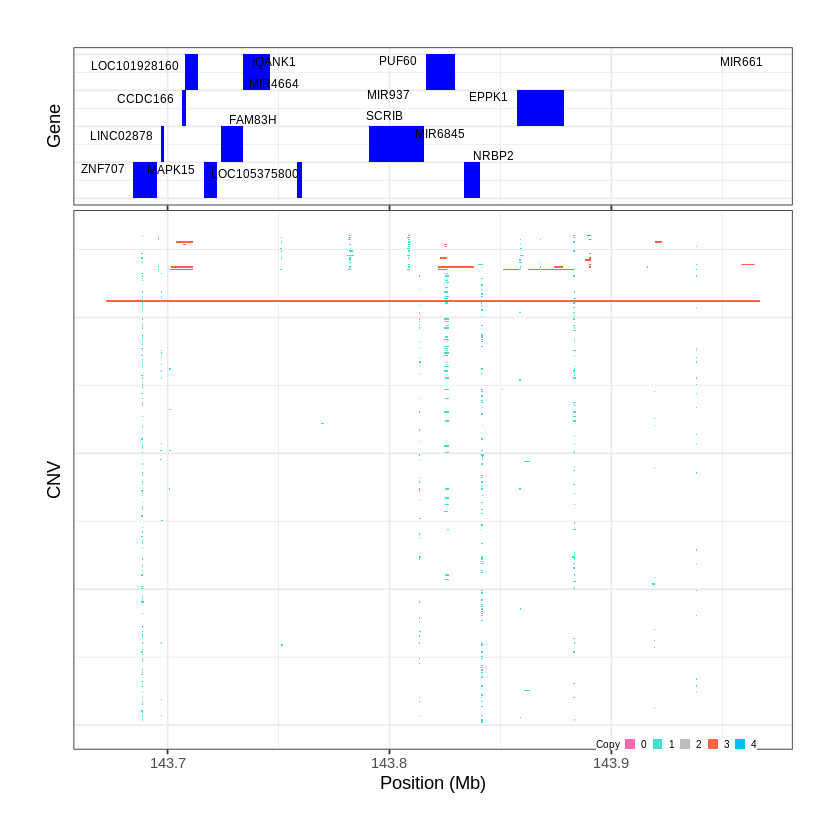

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1102..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.292001 - 144.2943 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


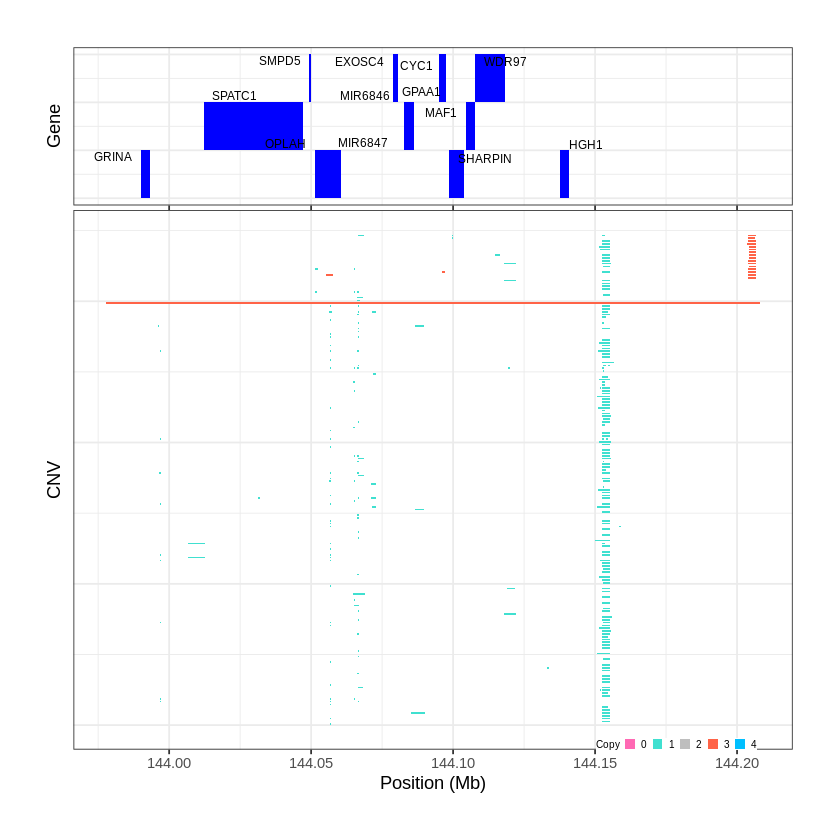

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1103..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.296701 - 144.3021 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


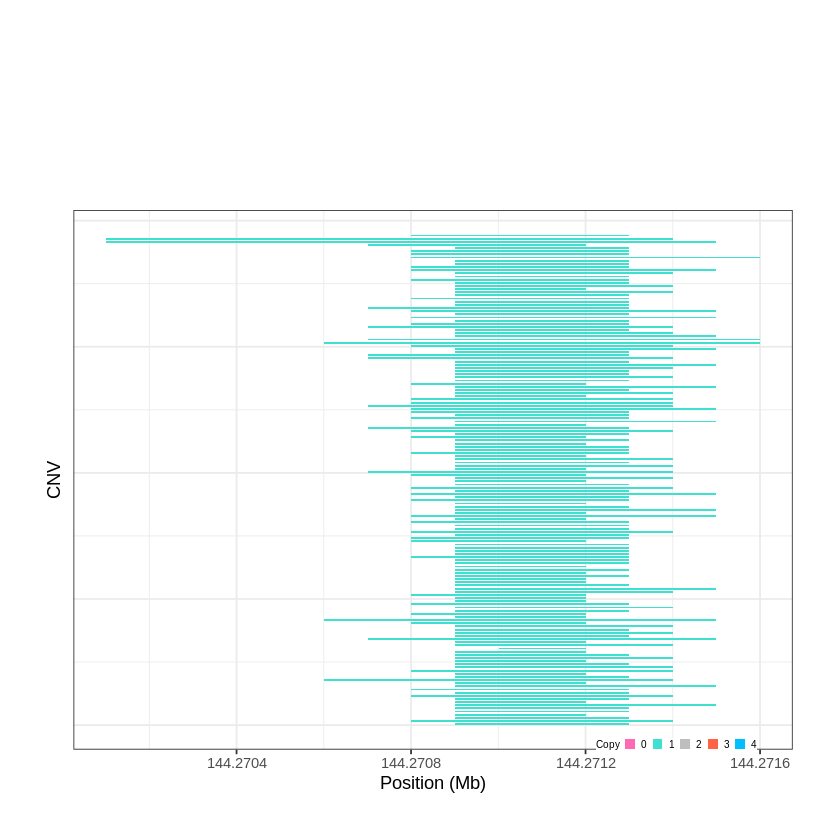

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1104..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.402501 - 144.4062 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


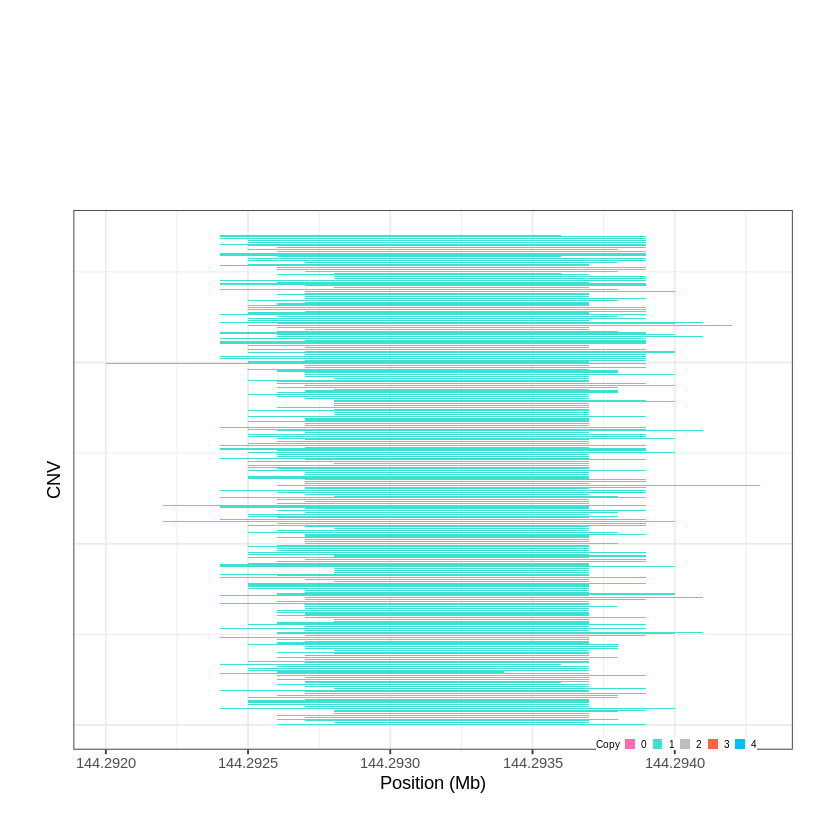

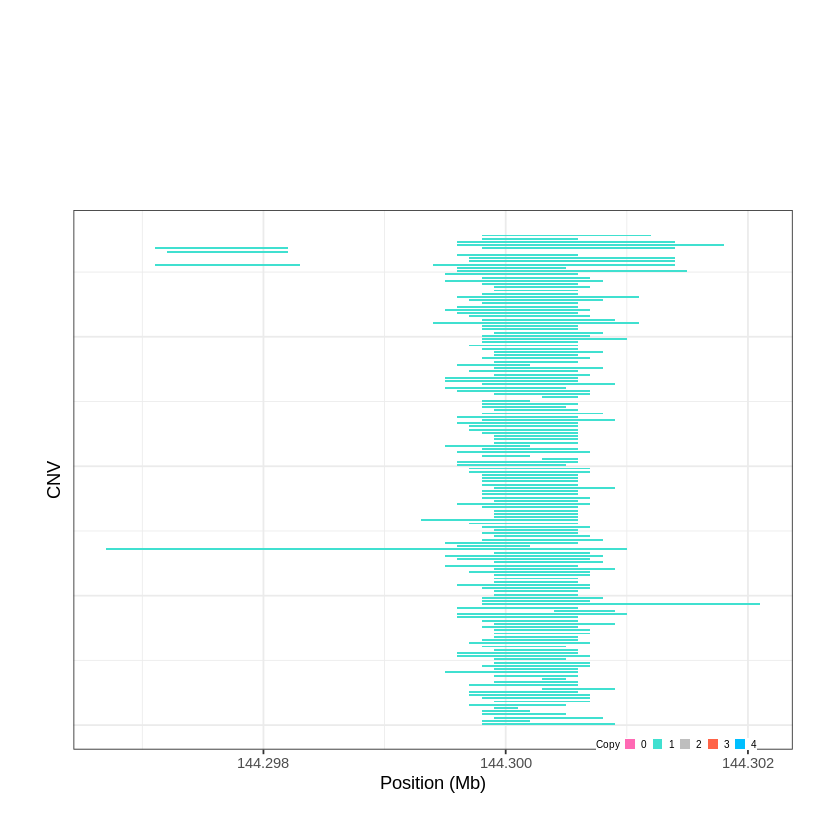

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1105..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.454201 - 144.4747 Mb with 246 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1106..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.499401 - 144.5013 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


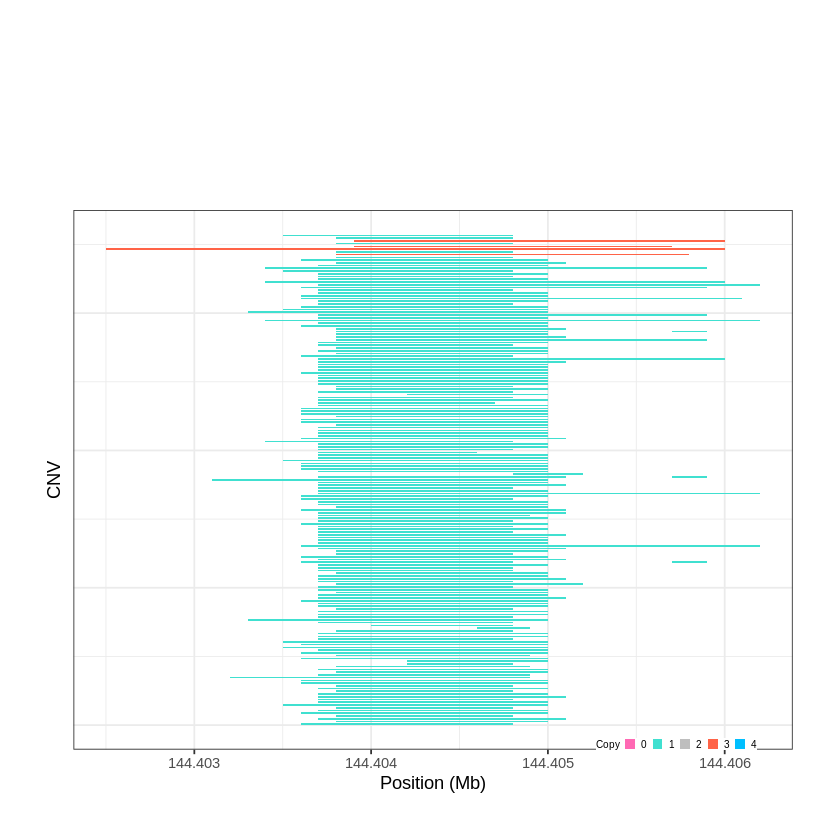

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1107..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.633401 - 144.6402 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


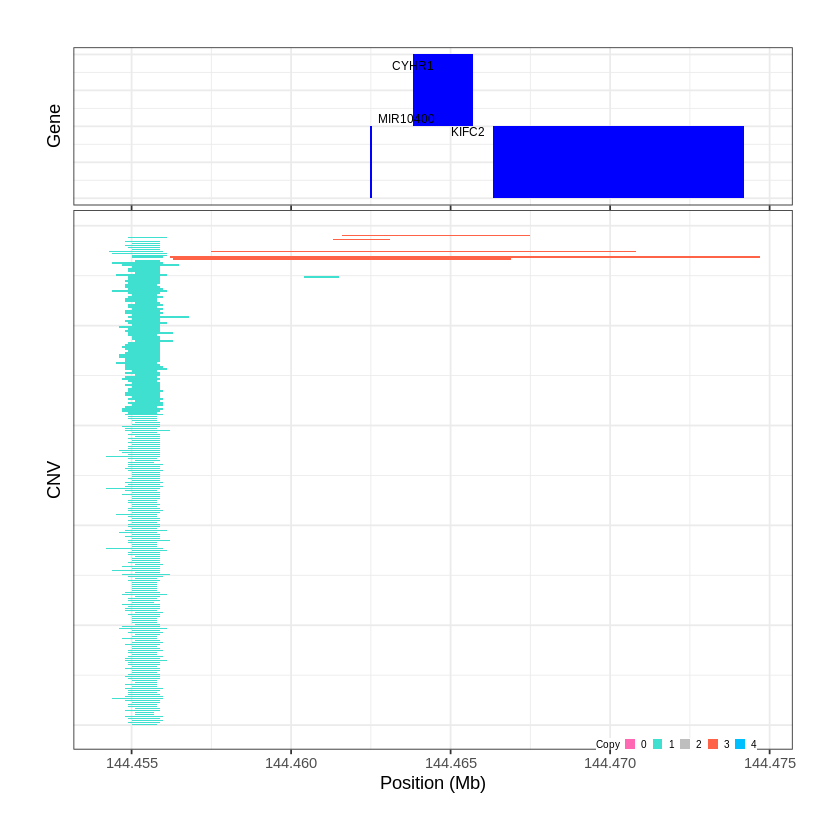

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1108..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.650501 - 144.6523 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


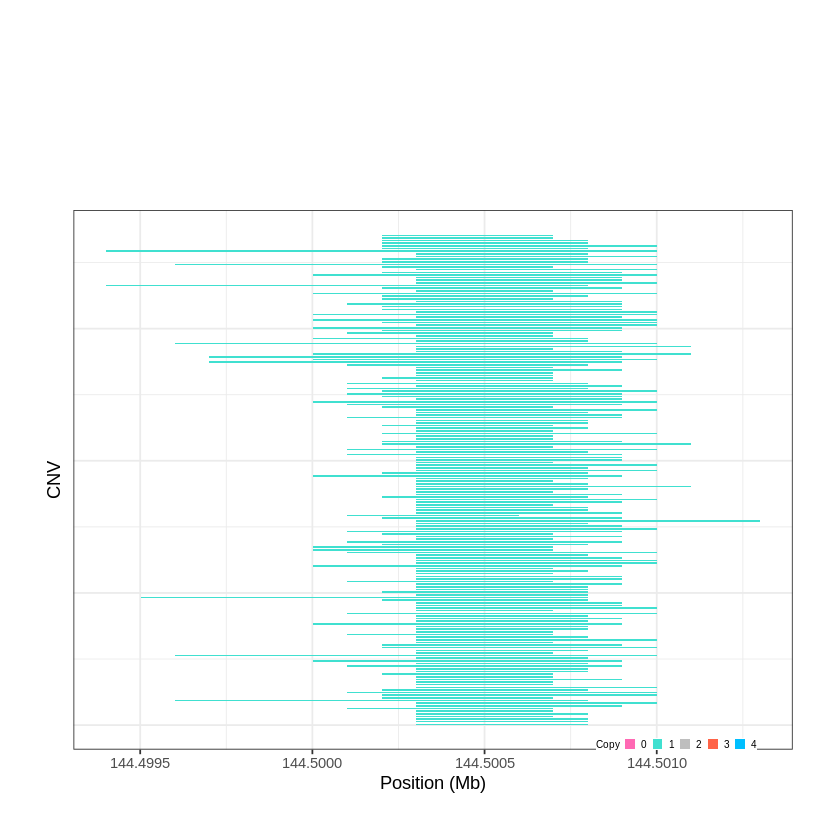

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1109..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 144.723701 - 144.7239 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


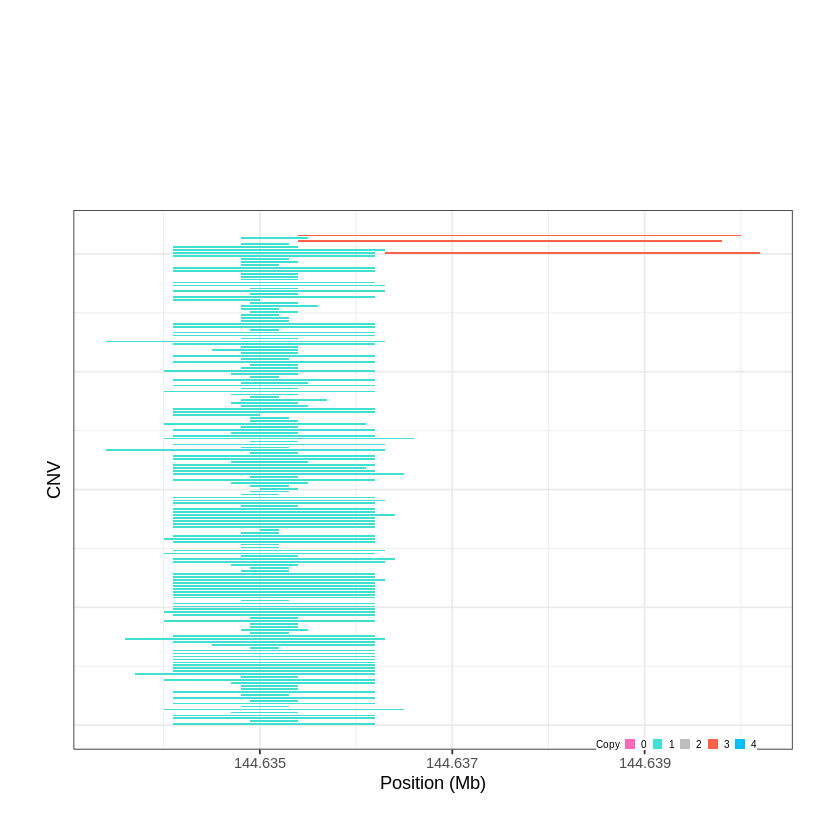

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1110..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 145.187101 - 145.5022 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


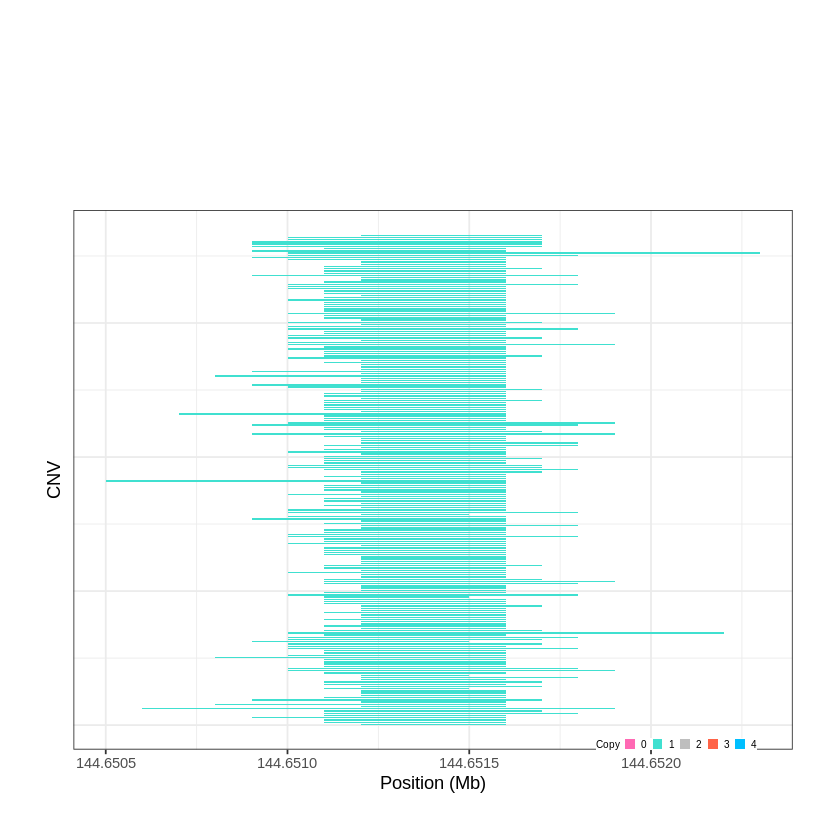

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1111..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 145.598801 - 145.6089 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


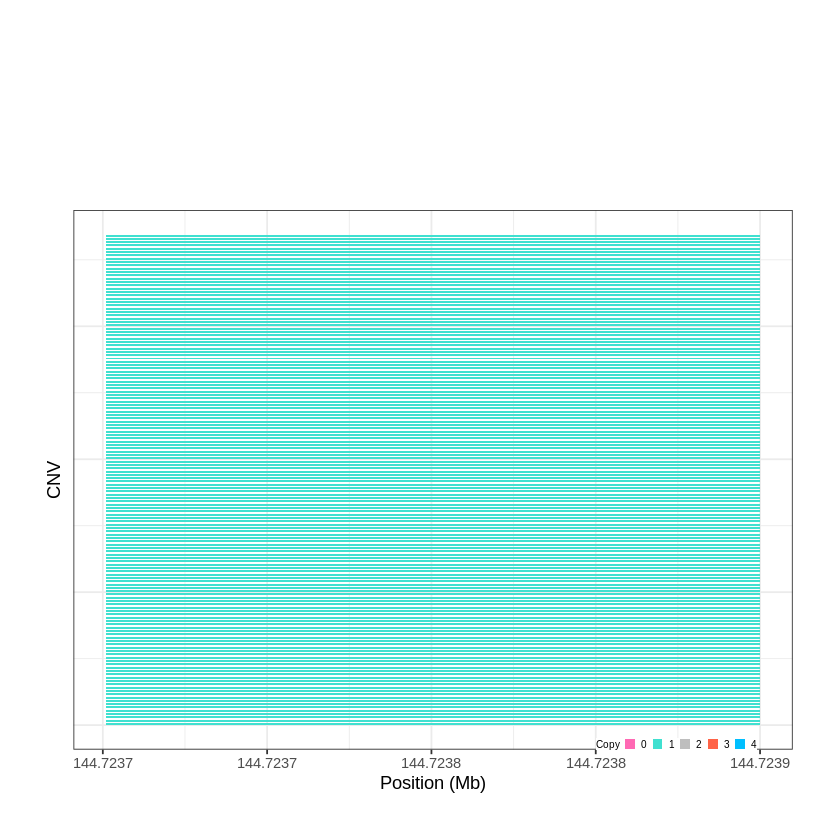

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1112..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 145.690301 - 145.6995 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


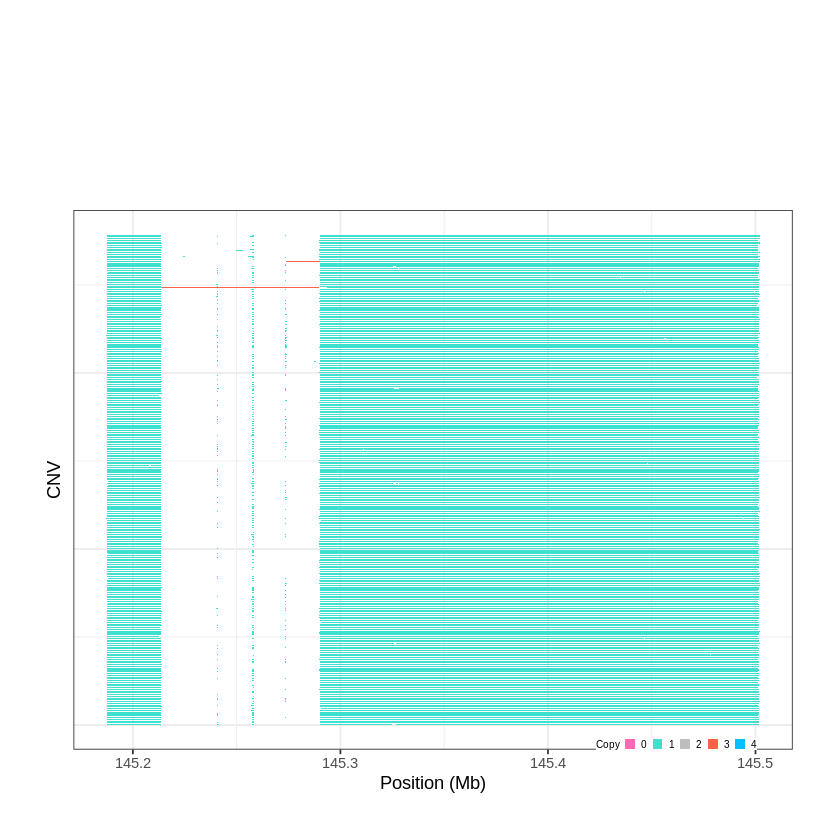

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1113..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 145.808601 - 146.058 Mb with 277 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


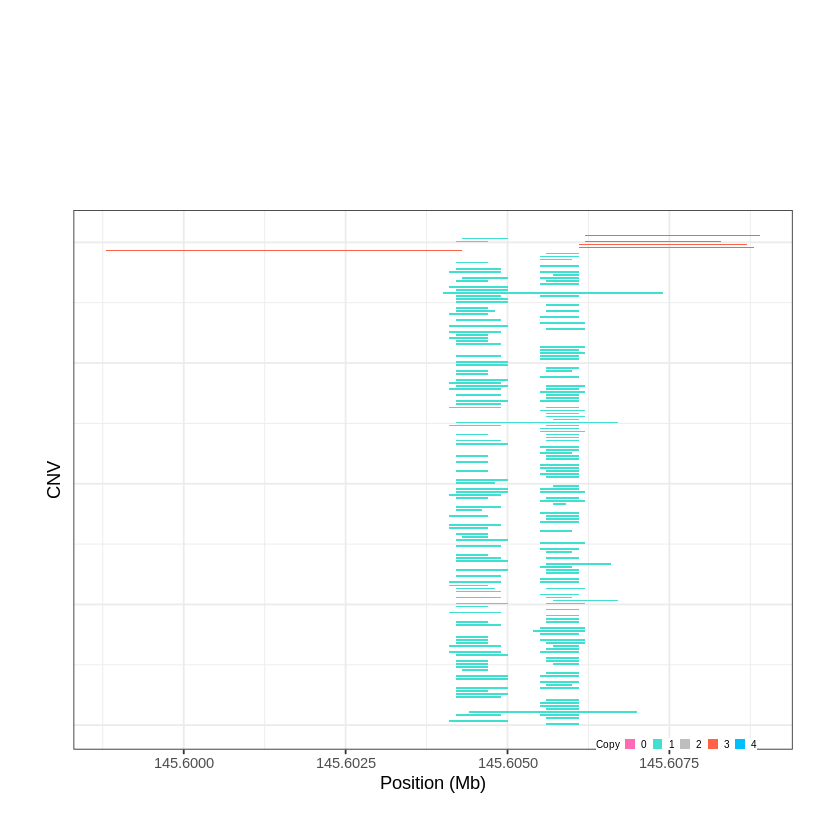

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1114..."
Input data passed requirment check...
[1] "CNV on Chromosome 8: 146.281801 - 146.3641 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


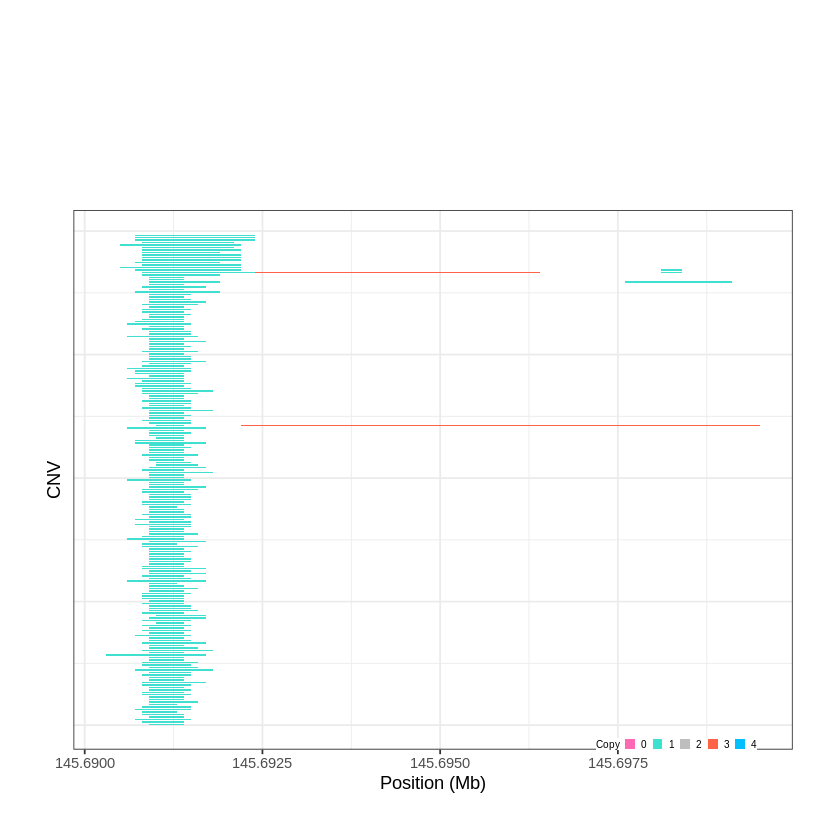

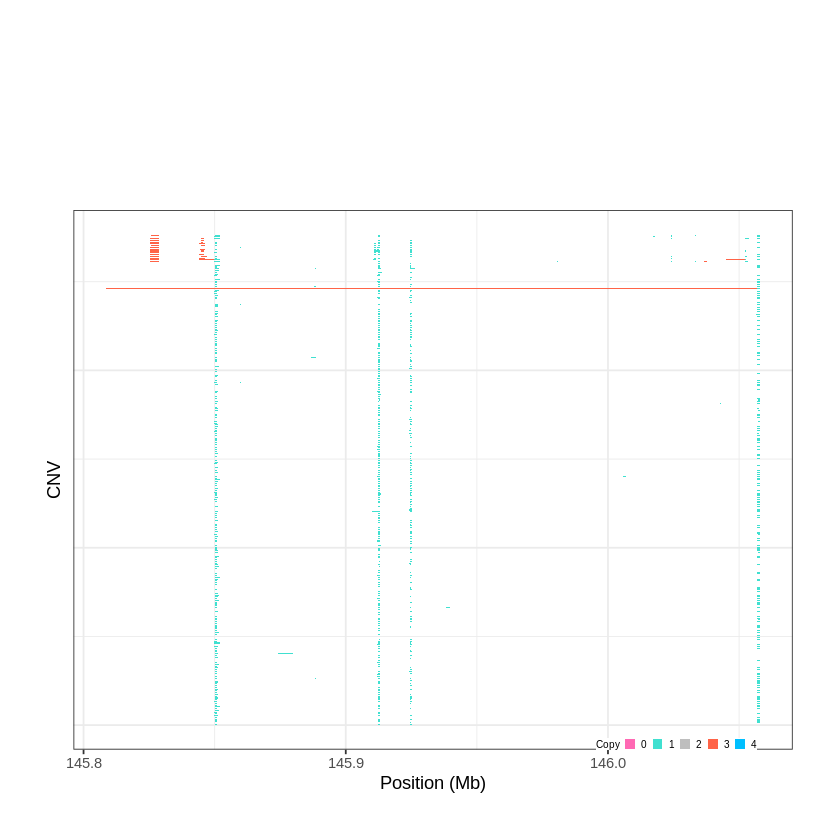

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1115..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 1e-06 - 0.9286 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 11 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


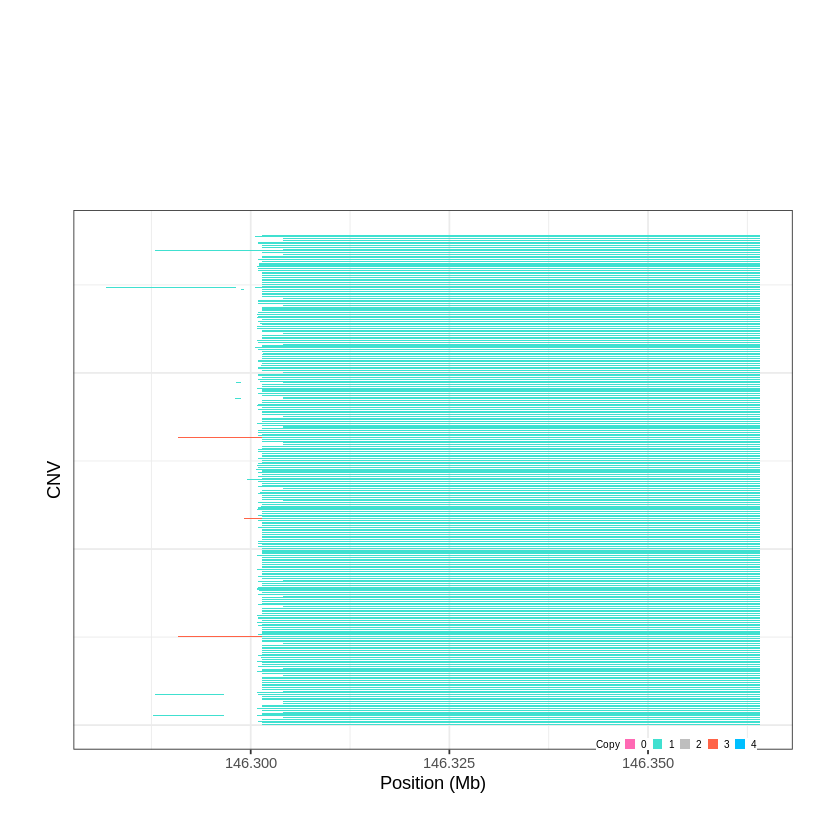

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1116..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 0.929101 - 3.1027 Mb with 229 Individual - "
Plotting gene...


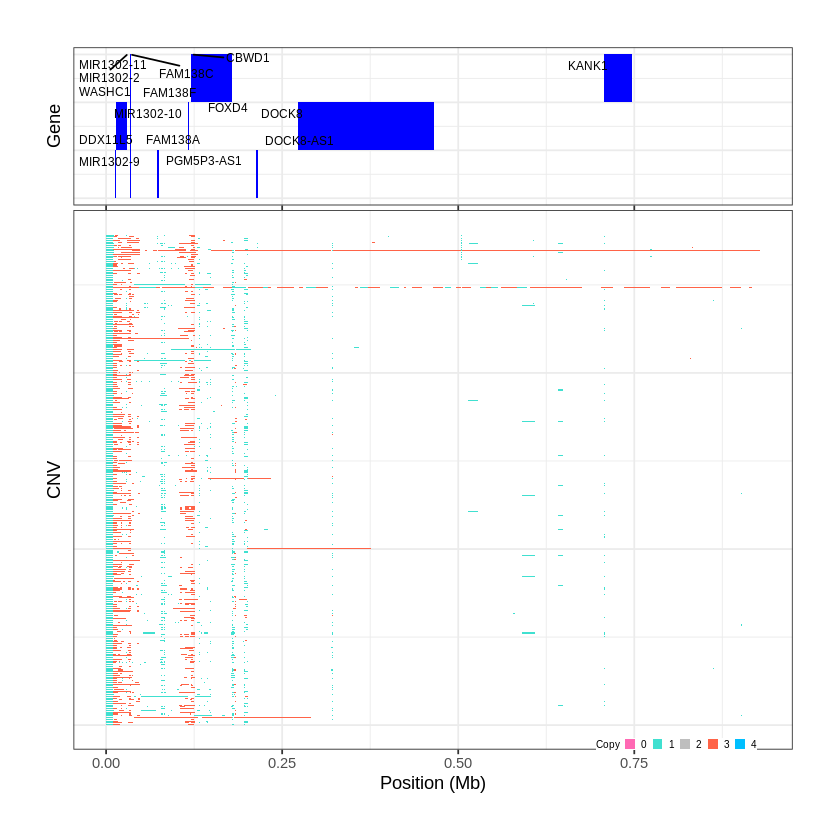

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1117..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 3.104101 - 4.7417 Mb with 254 Individual - "
Plotting gene...


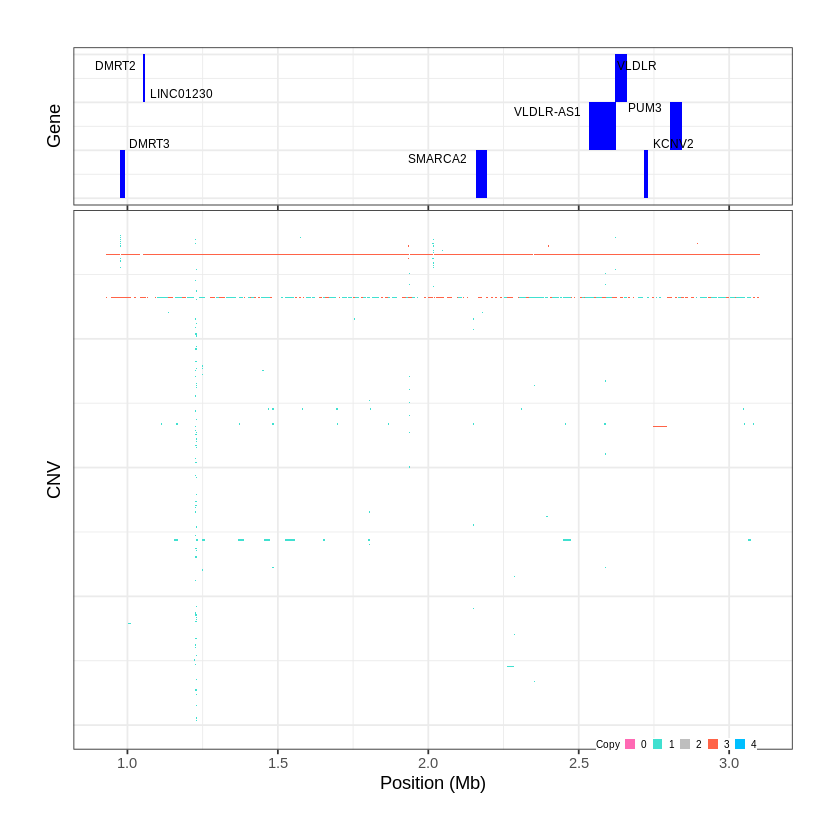

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1118..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 6.763301 - 8.9489 Mb with 237 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1119..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 10.016901 - 10.6097 Mb with 275 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


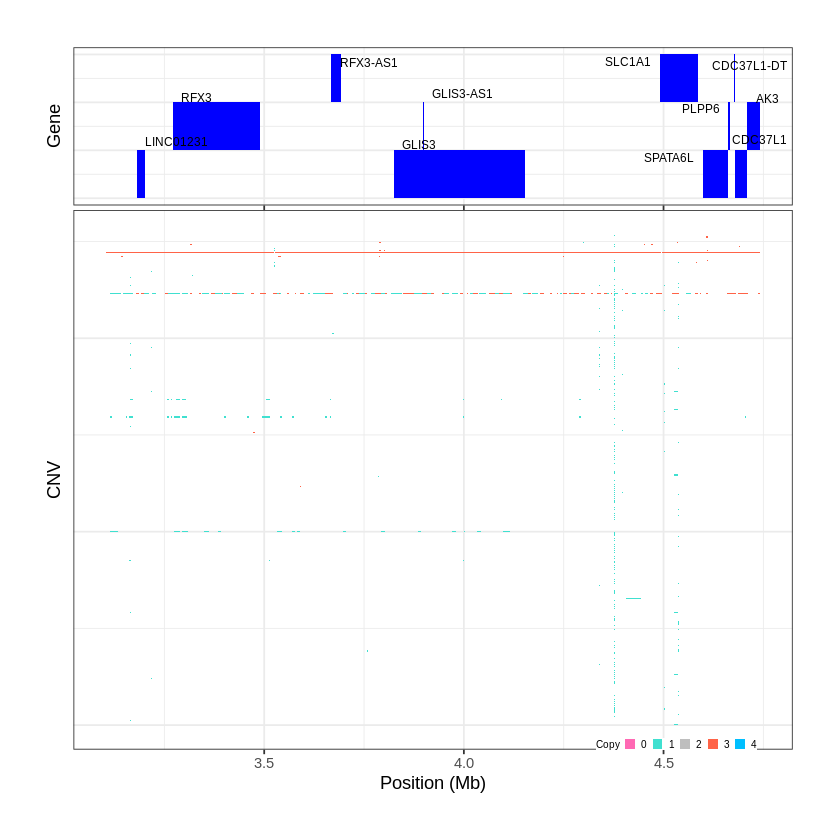

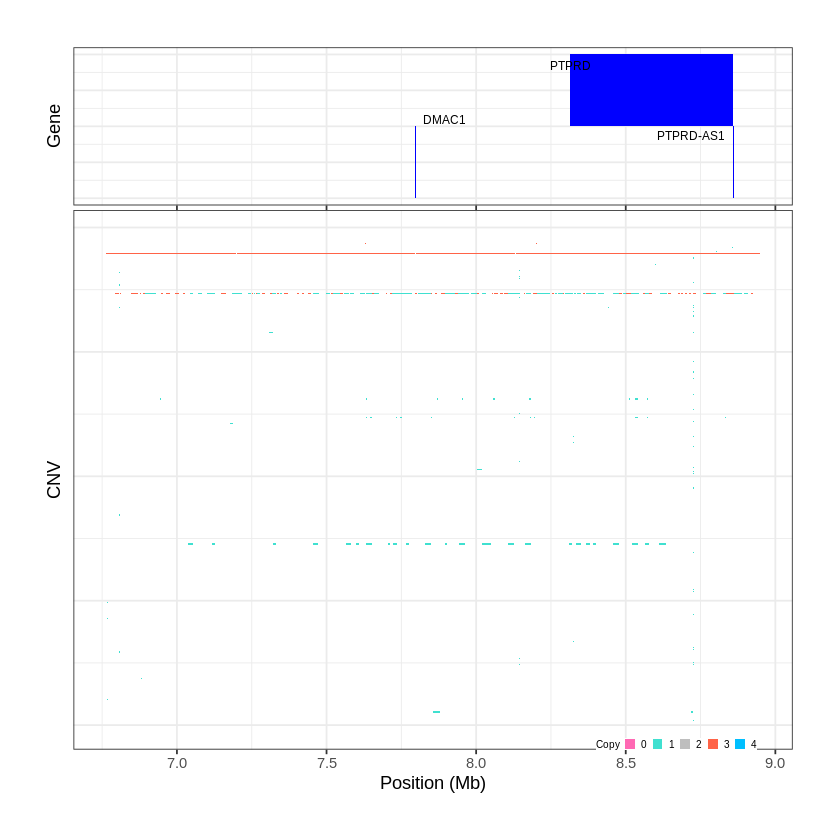

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1120..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 11.732401 - 14.756 Mb with 255 Individual - "
Plotting gene...


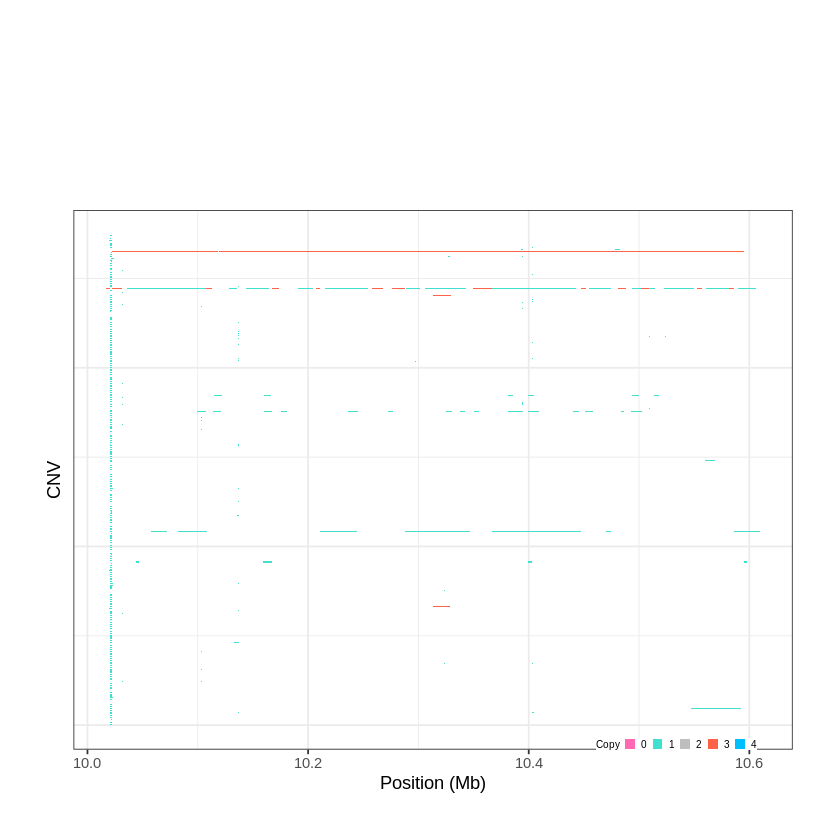

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1121..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 15.363701 - 17.1957 Mb with 273 Individual - "
Plotting gene...


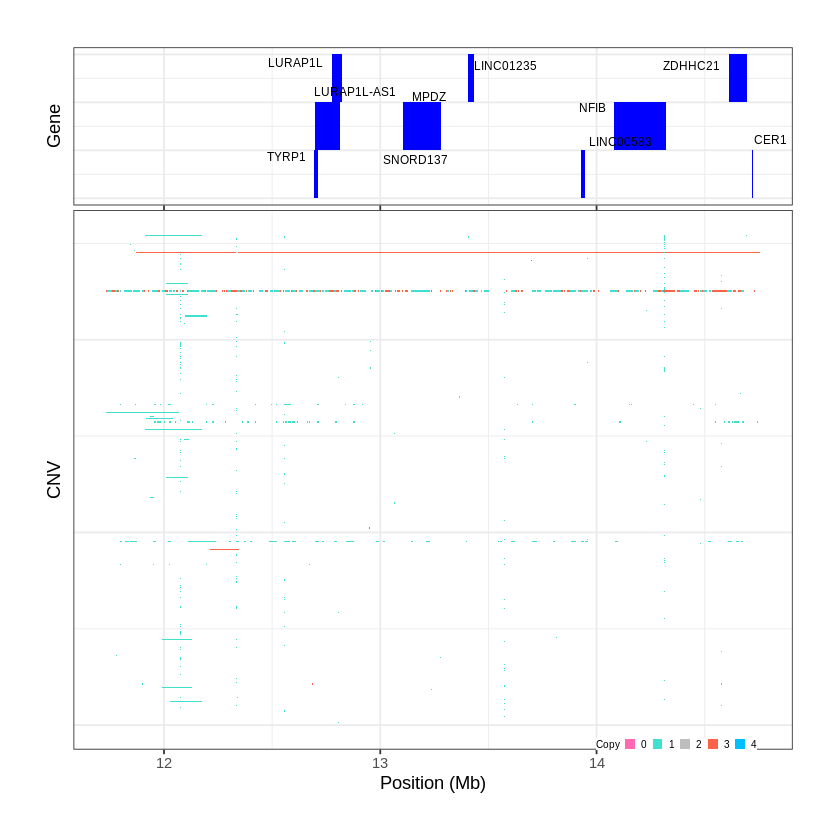

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1122..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 17.196901 - 18.6444 Mb with 274 Individual - "
Plotting gene...


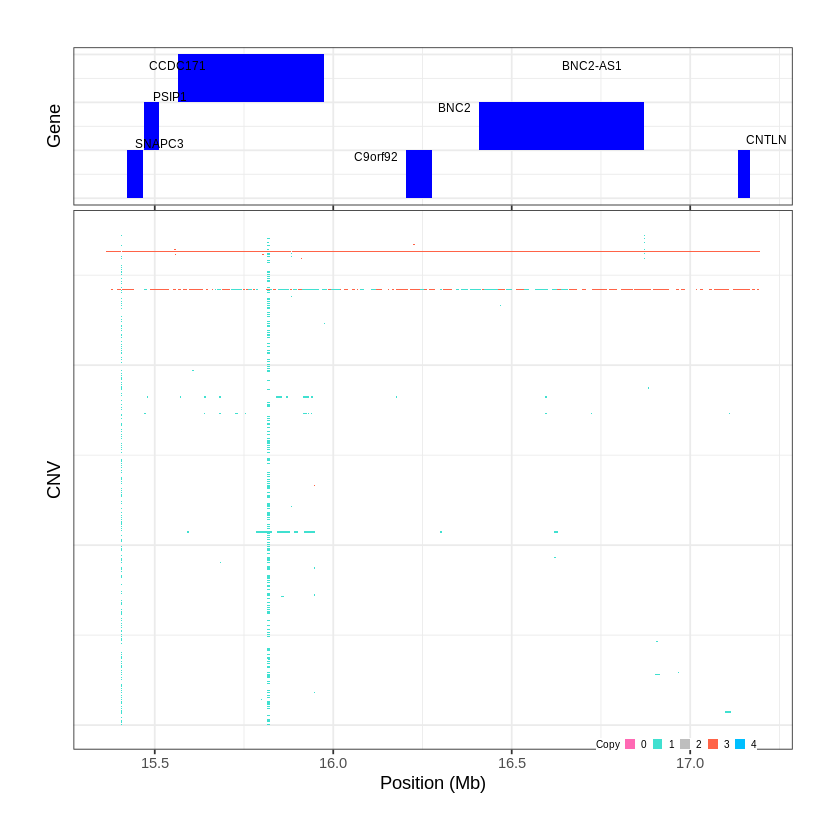

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1123..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 18.644601 - 23.0754 Mb with 277 Individual - "
Plotting gene...


Warning message:
“ggrepel: 30 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1124..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 23.075401 - 23.3777 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


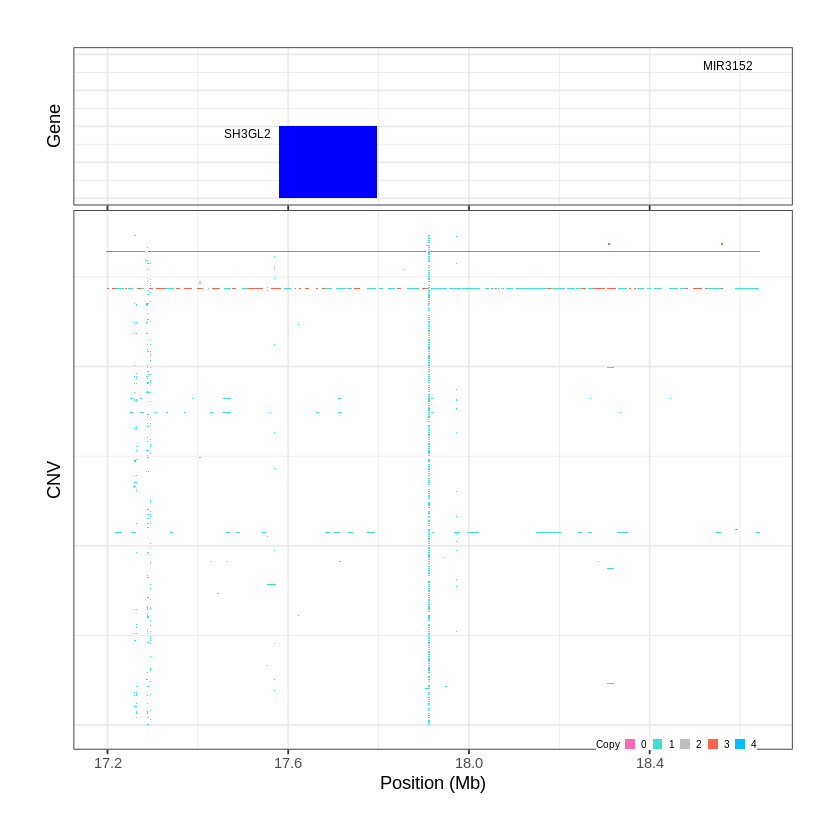

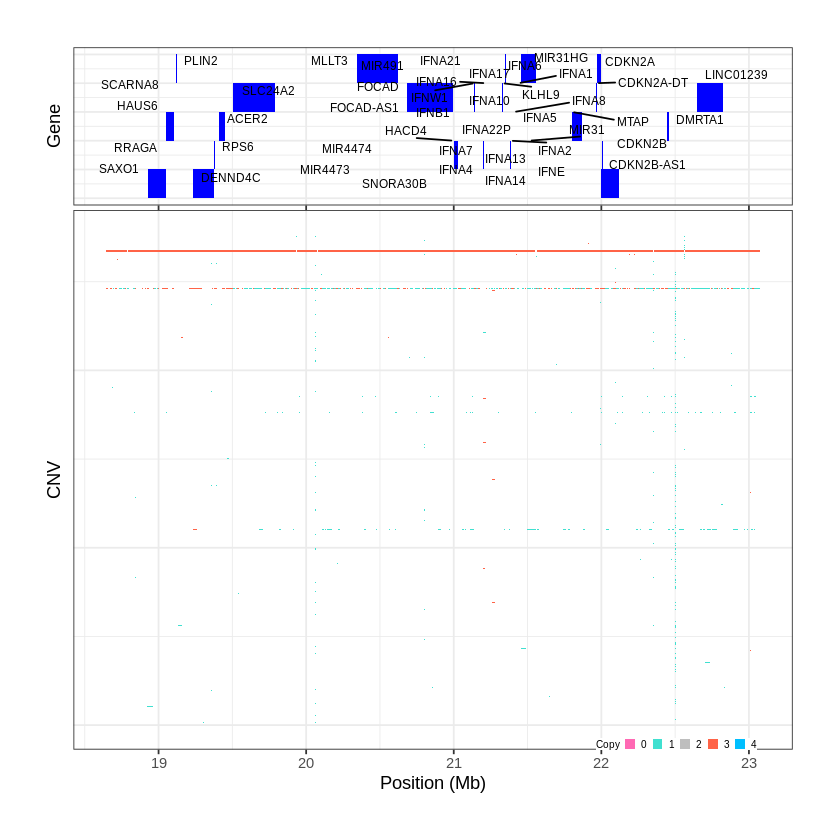

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1125..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 24.106301 - 27.4146 Mb with 205 Individual - "
Plotting gene...


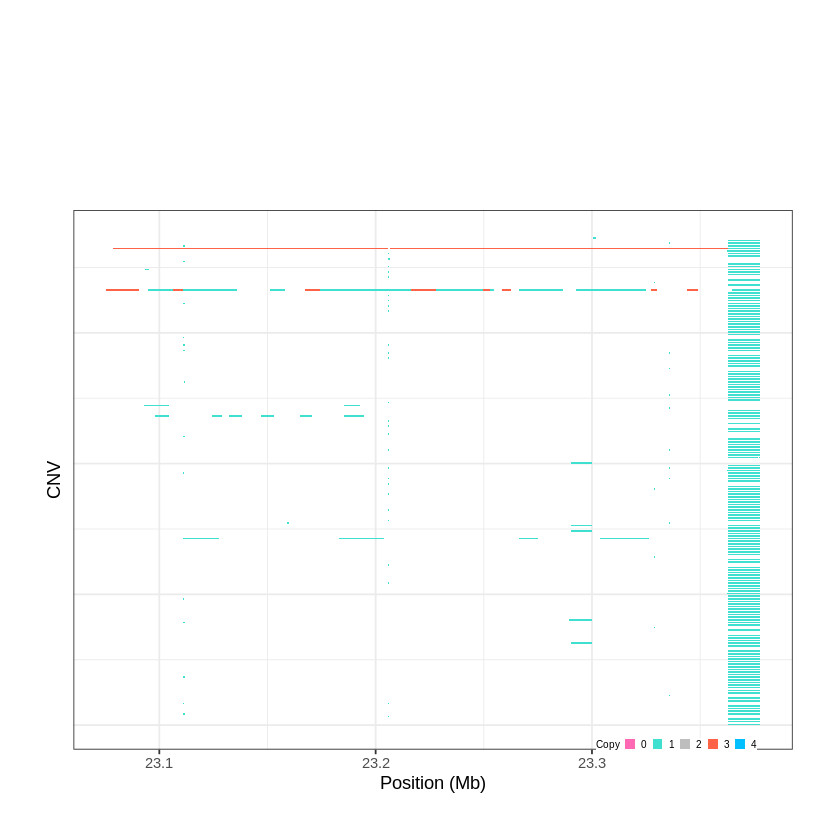

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1126..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 27.414801 - 29.6247 Mb with 244 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1127..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 29.624701 - 29.625 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


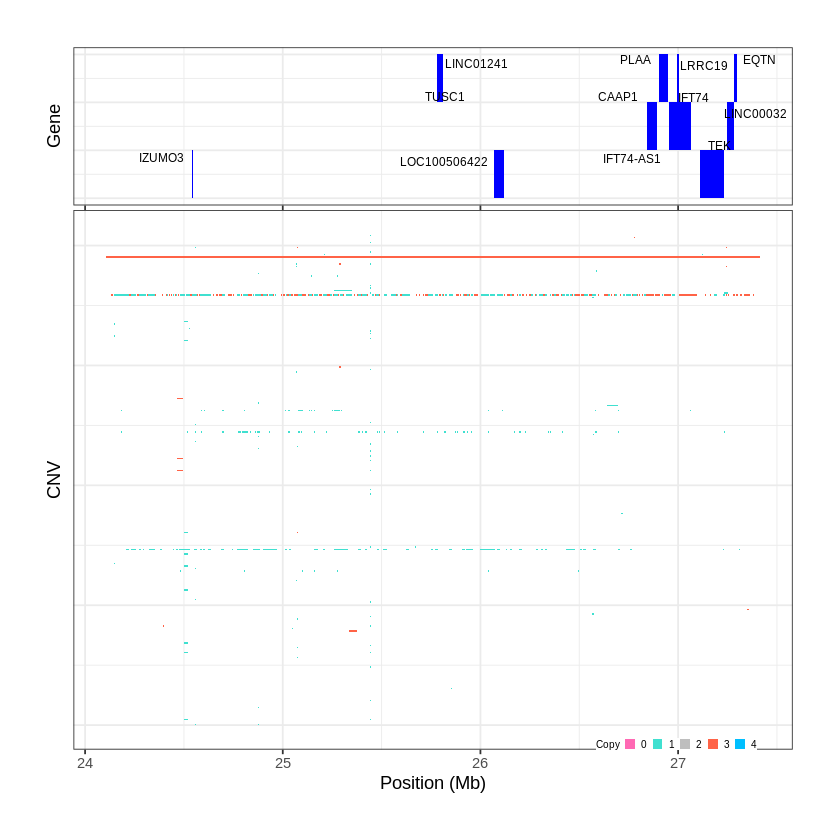

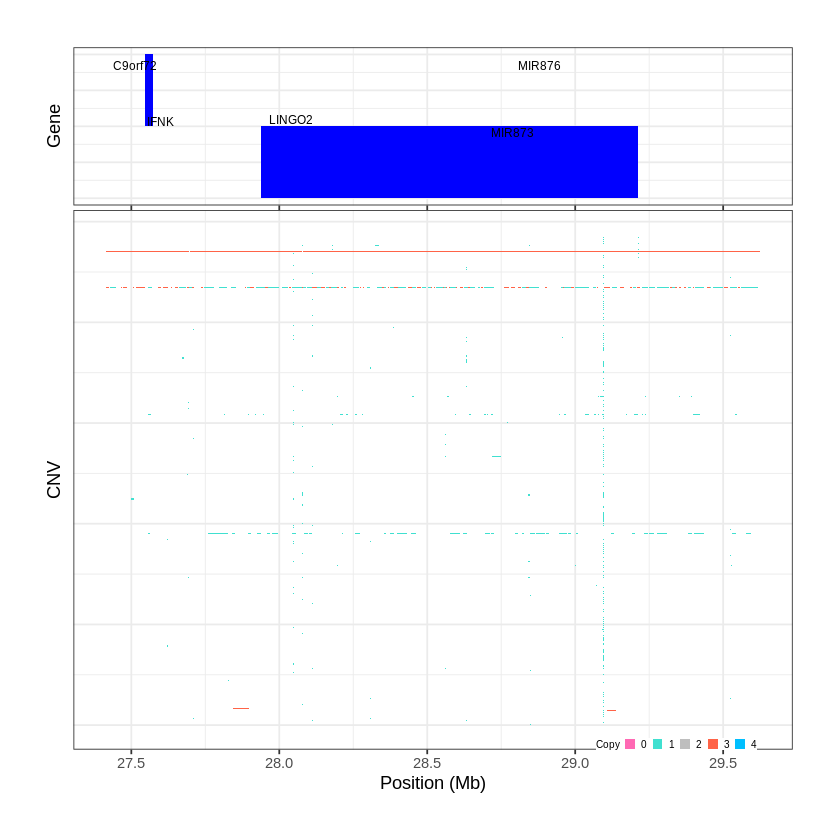

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1128..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 30.415501 - 31.5425 Mb with 263 Individual - "
Plotting gene...


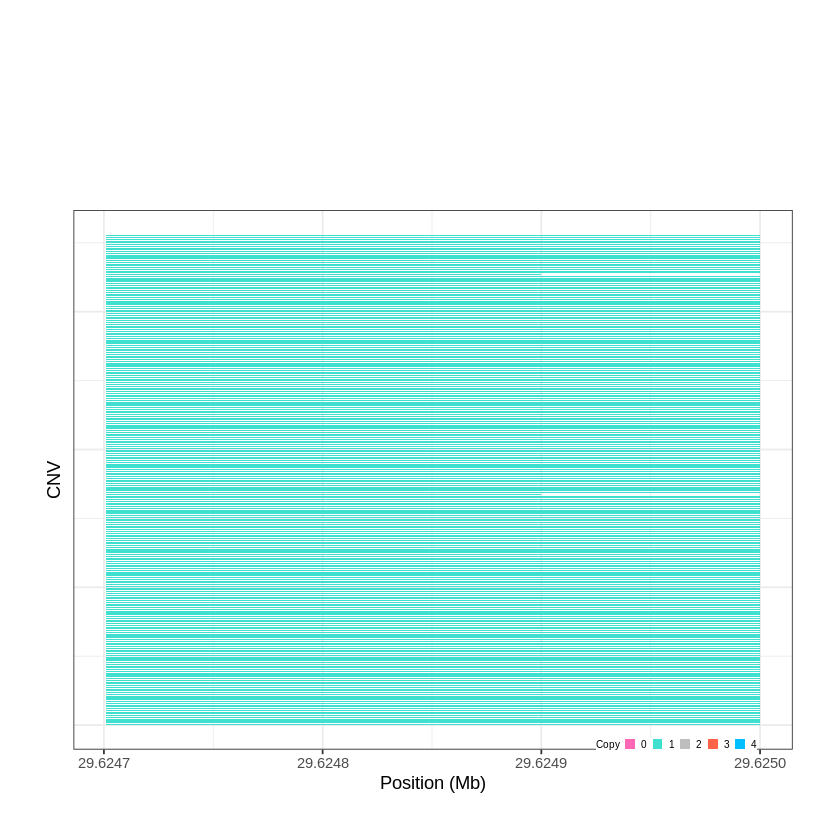

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1129..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 32.342701 - 33.2643 Mb with 275 Individual - "
Plotting gene...


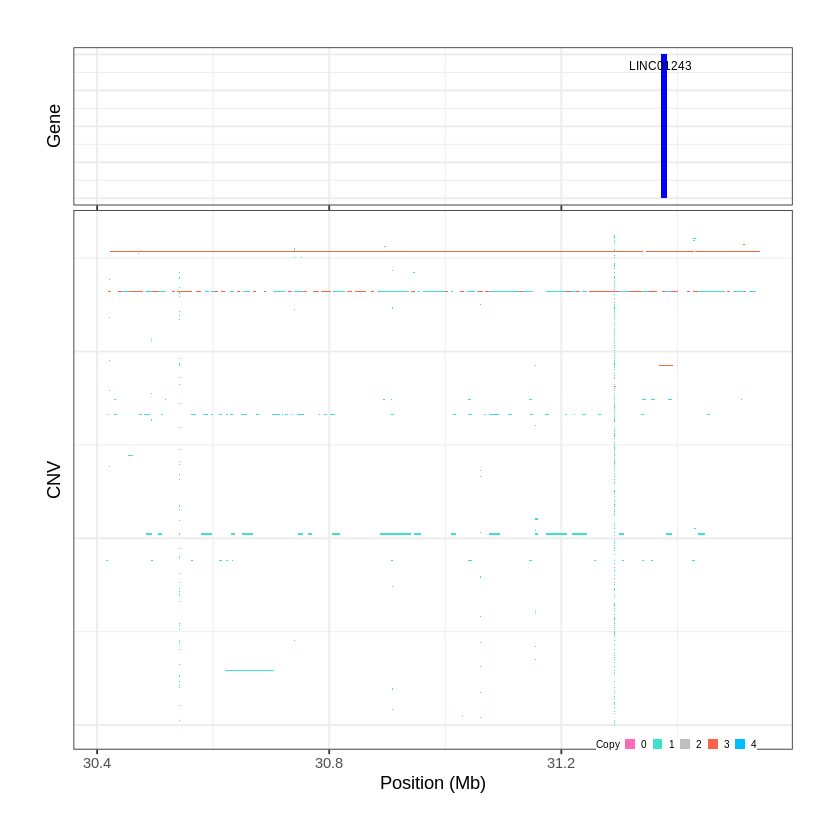

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1130..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 33.977301 - 35.2541 Mb with 256 Individual - "
Plotting gene...


Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


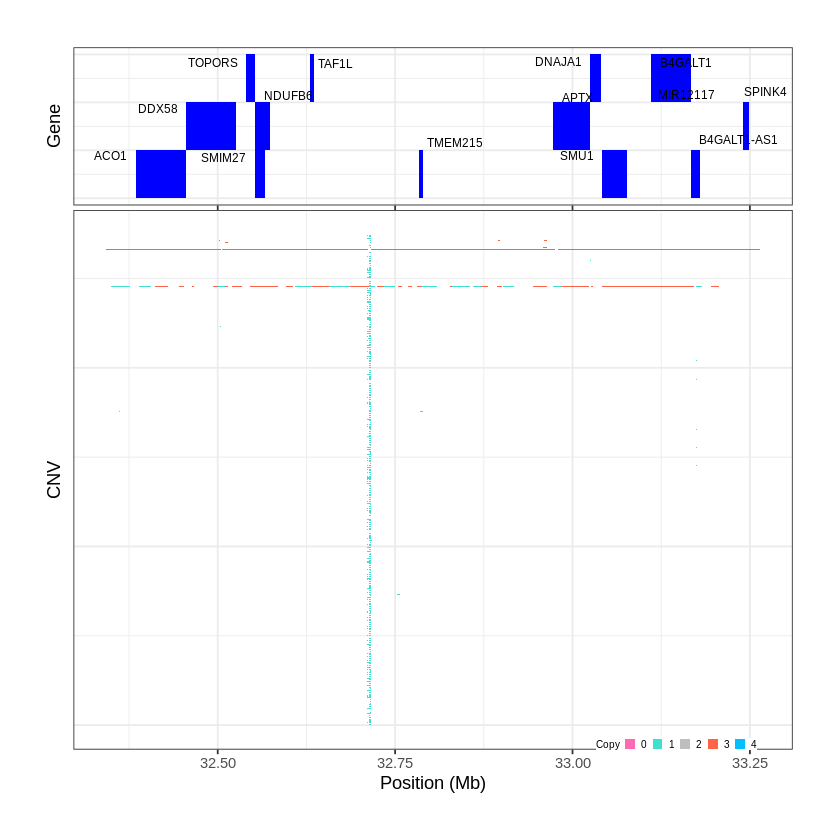

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1131..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 35.257101 - 36.0583 Mb with 160 Individual - "
Plotting gene...


Warning message:
“ggrepel: 15 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1132..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 36.336501 - 36.6115 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


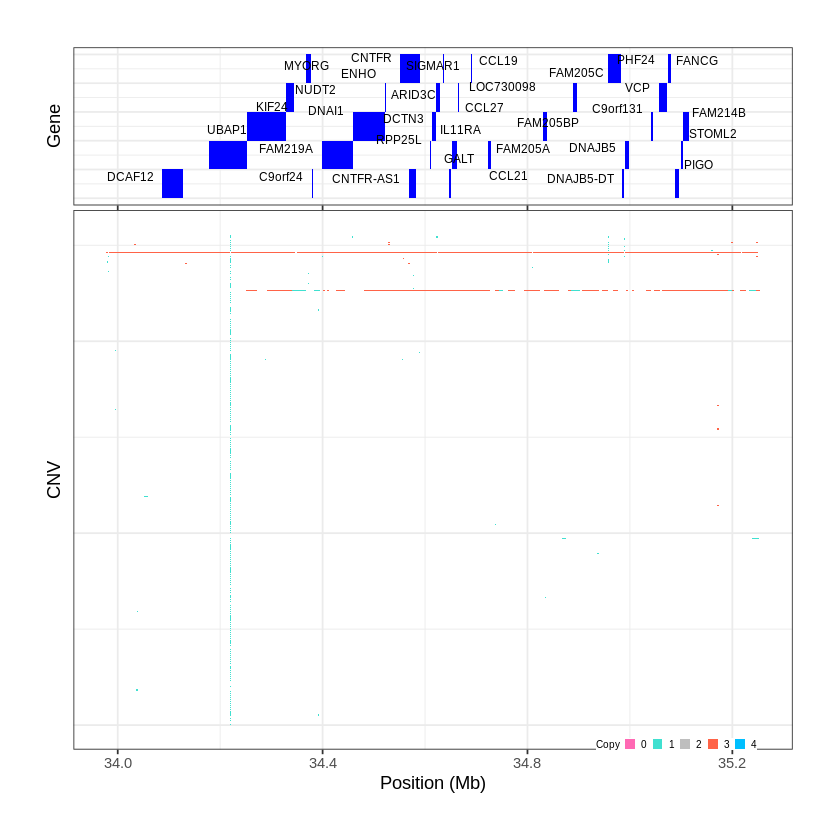

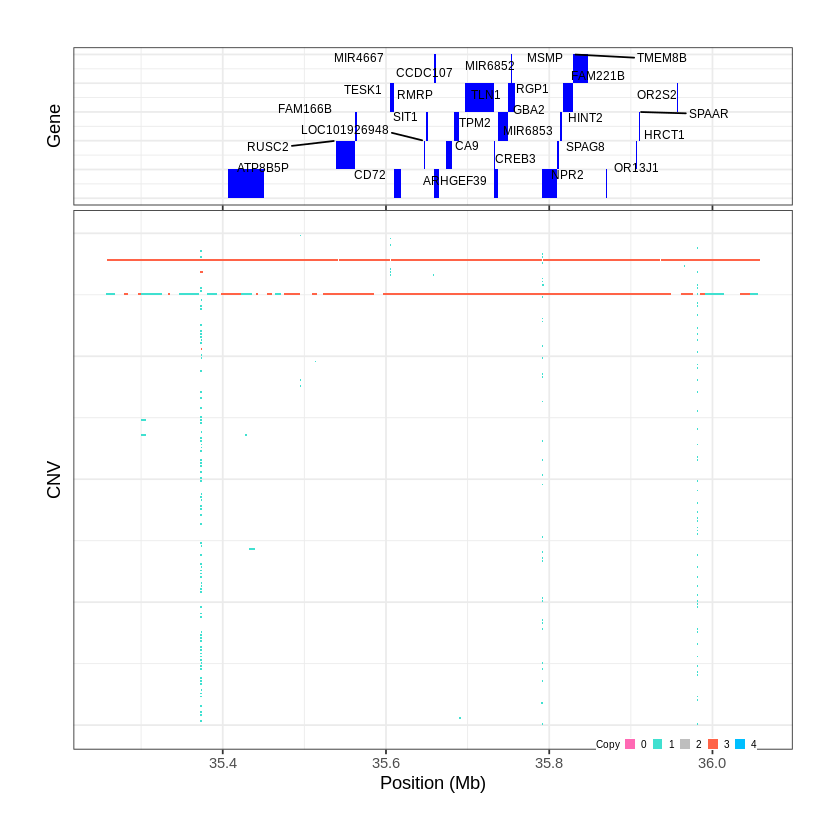

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1133..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 36.986101 - 38.0673 Mb with 242 Individual - "
Plotting gene...


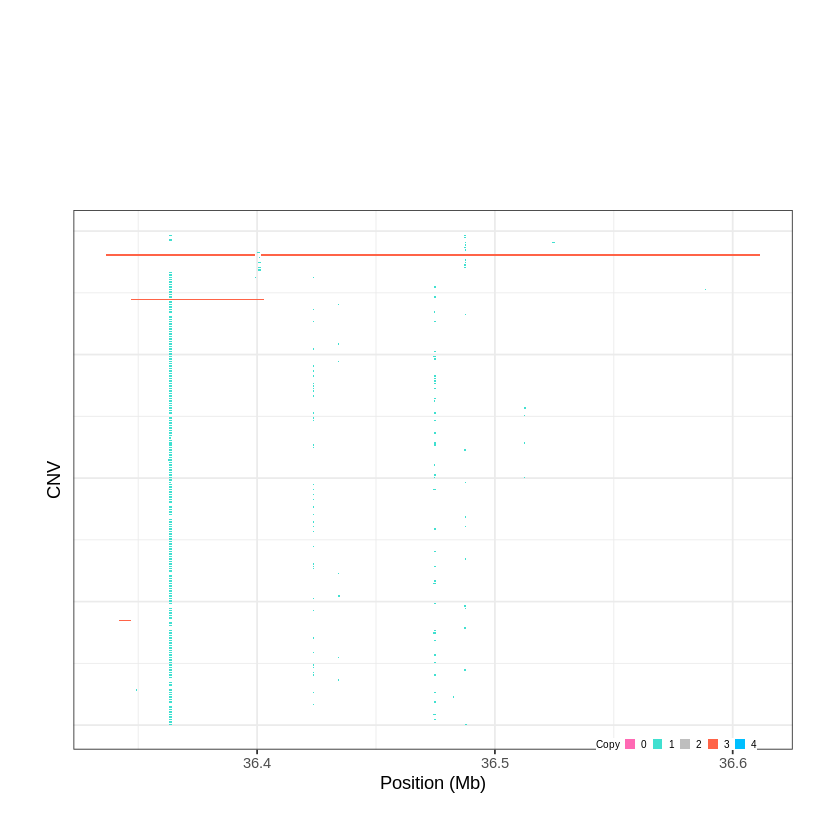

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1134..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 38.607401 - 44.8996 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 18 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1135..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 44.907201 - 47.3161 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


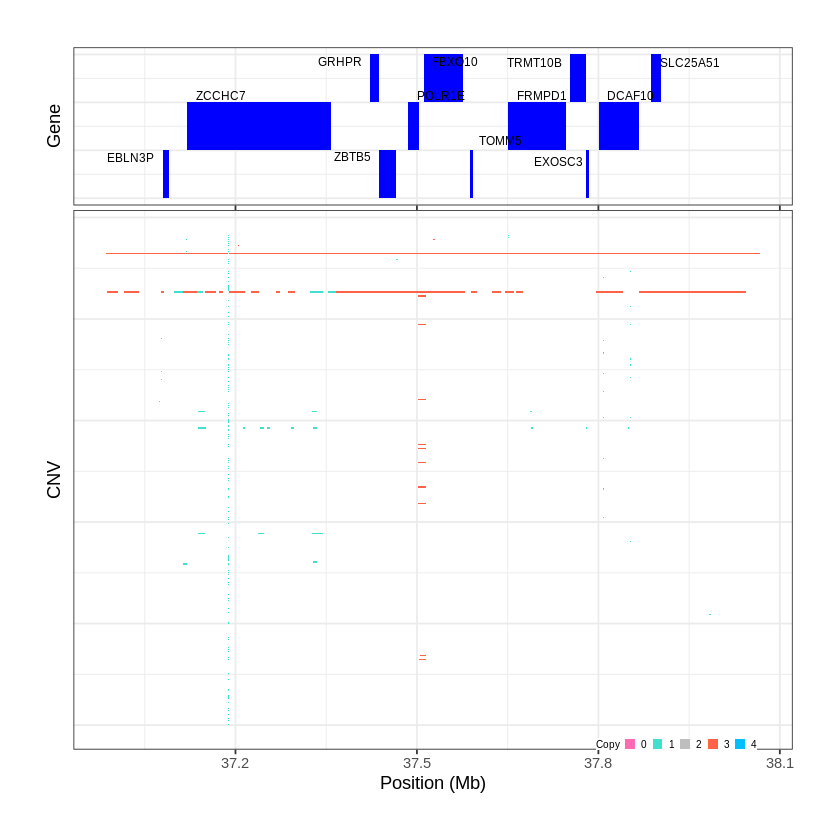

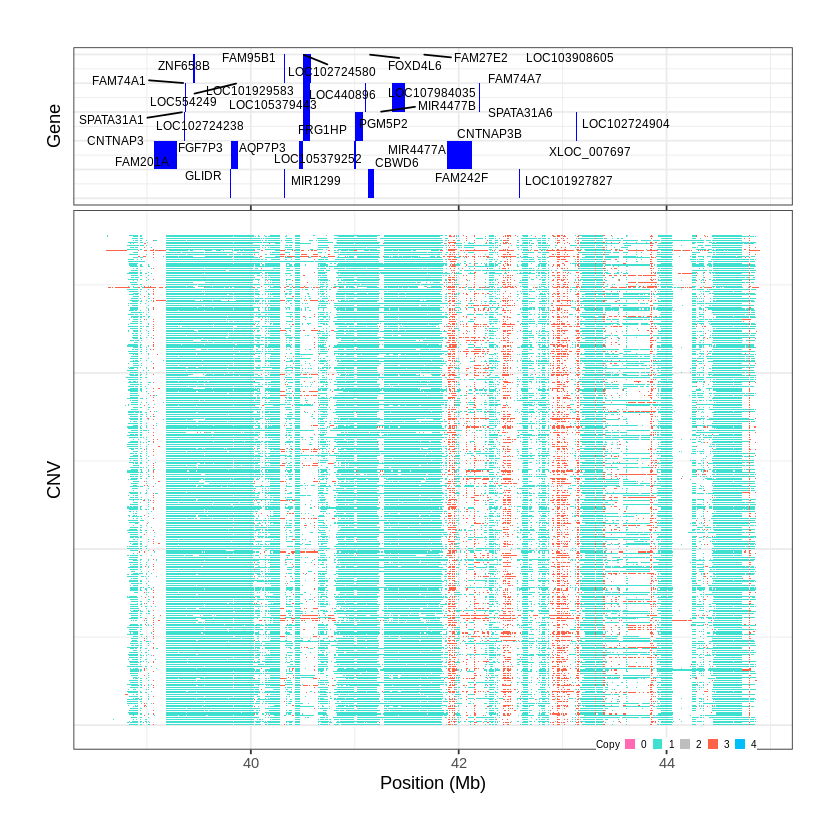

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1136..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 65.473501 - 66.4547 Mb with 279 Individual - "
Plotting gene...


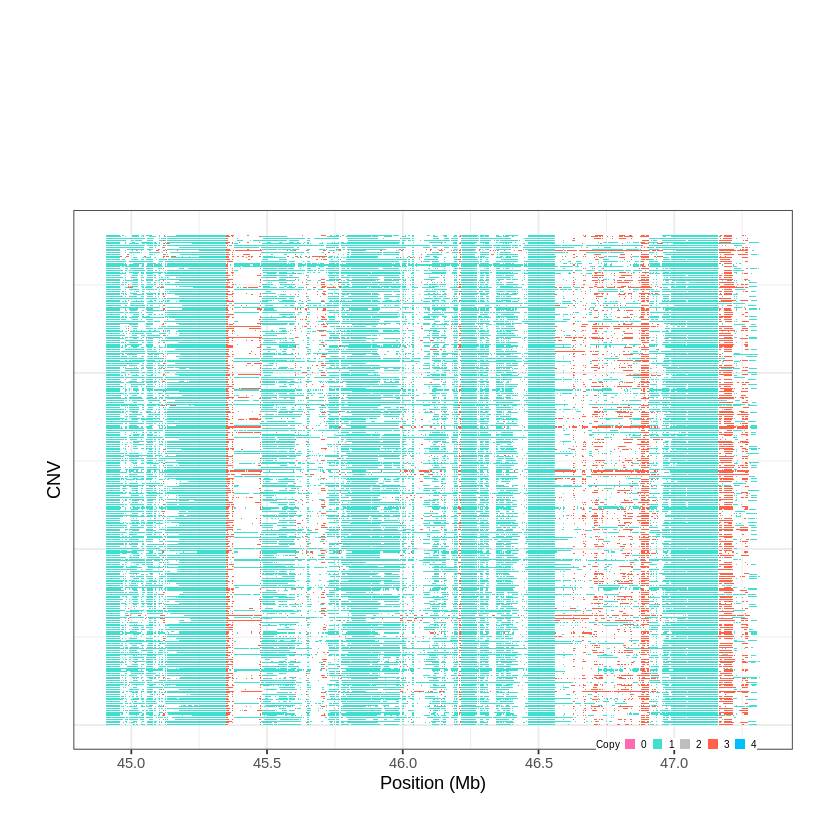

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1137..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 66.454701 - 71.9396 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 9 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


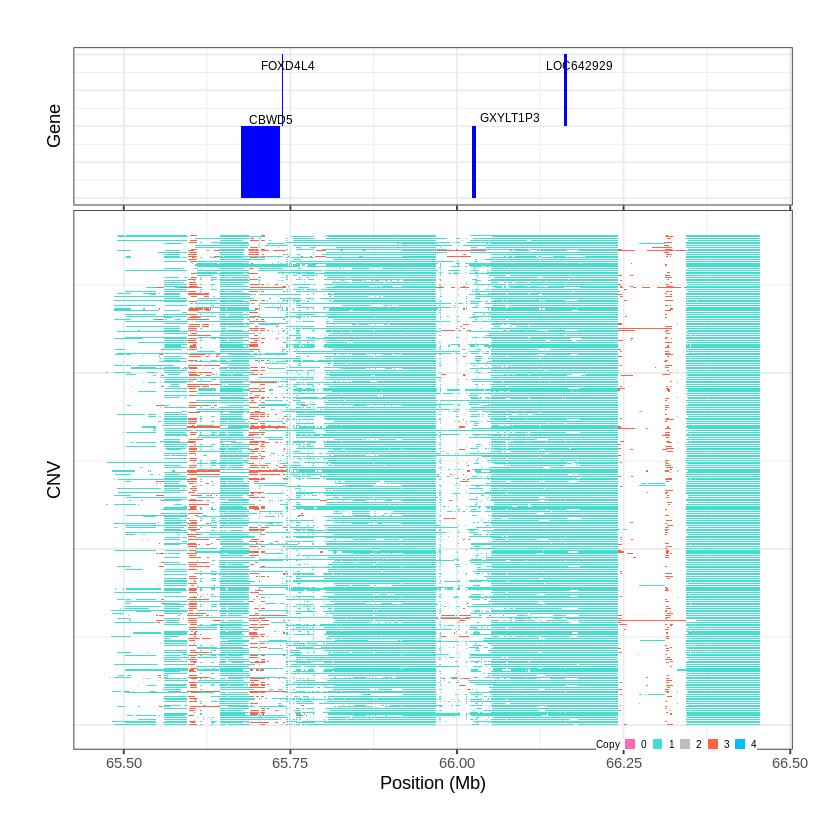

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1138..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 72.092101 - 72.9045 Mb with 180 Individual - "
Plotting gene...


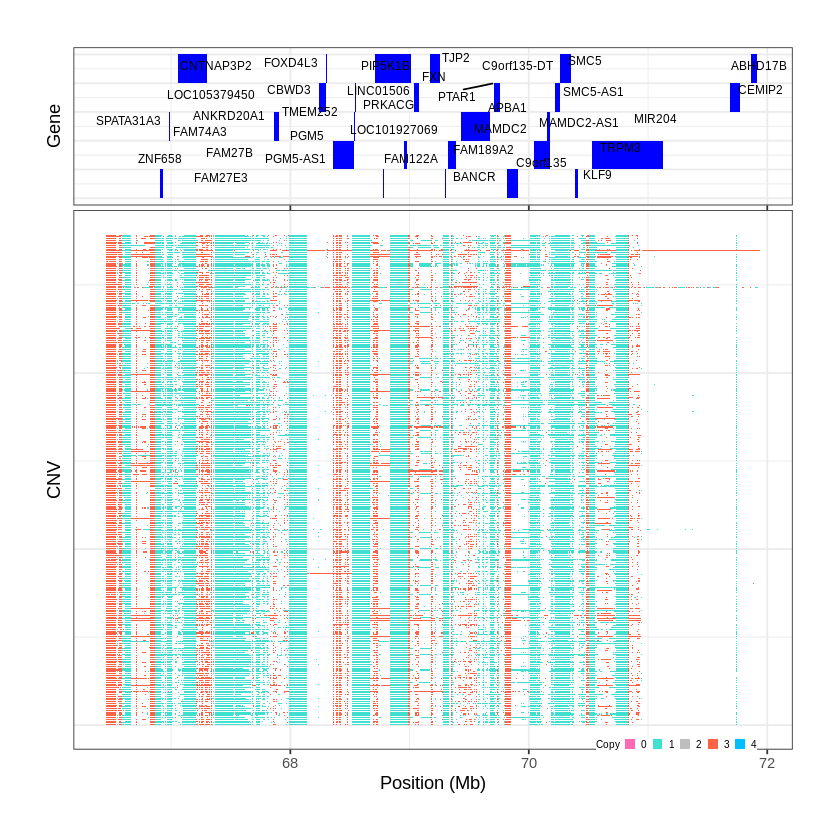

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1139..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 73.131301 - 74.3829 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1140..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 75.108001 - 76.293 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


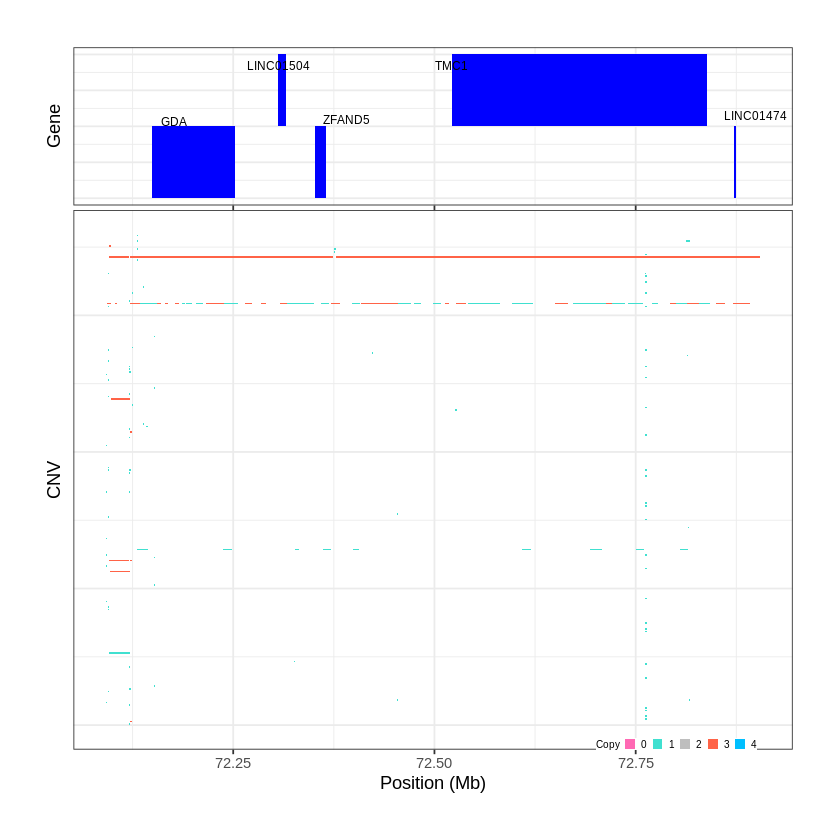

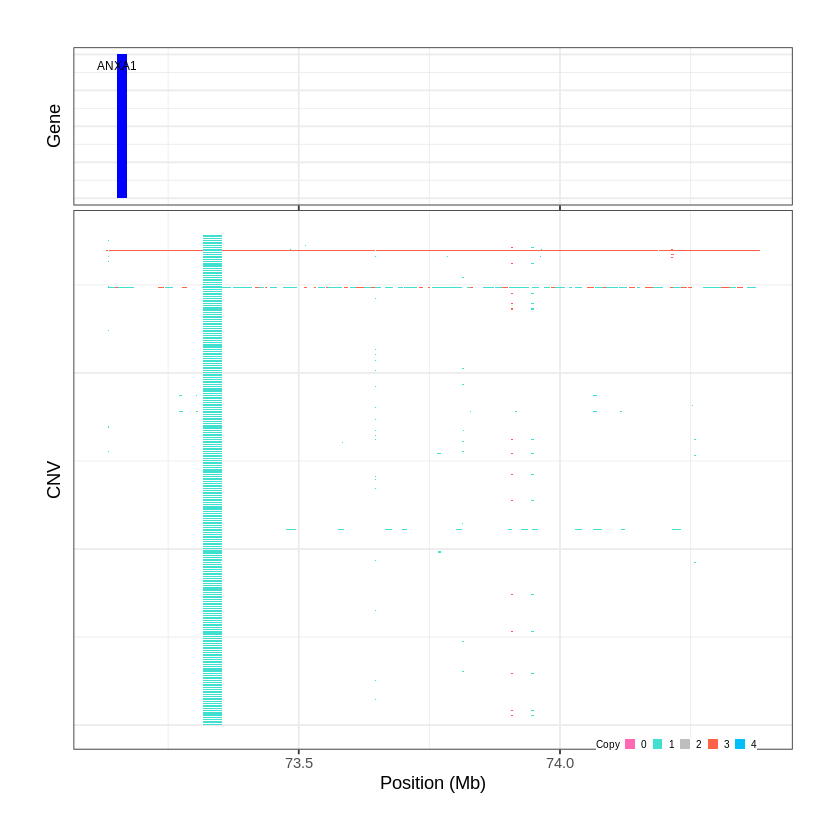

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1141..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 76.598701 - 77.216 Mb with 202 Individual - "
Plotting gene...


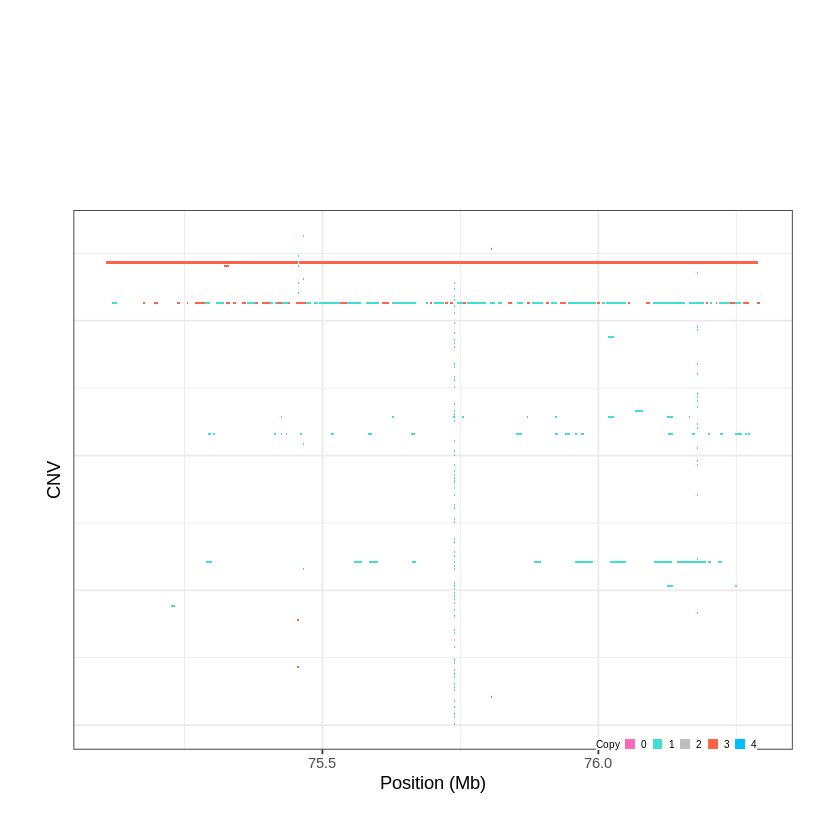

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1142..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 77.216601 - 78.9598 Mb with 271 Individual - "
Plotting gene...


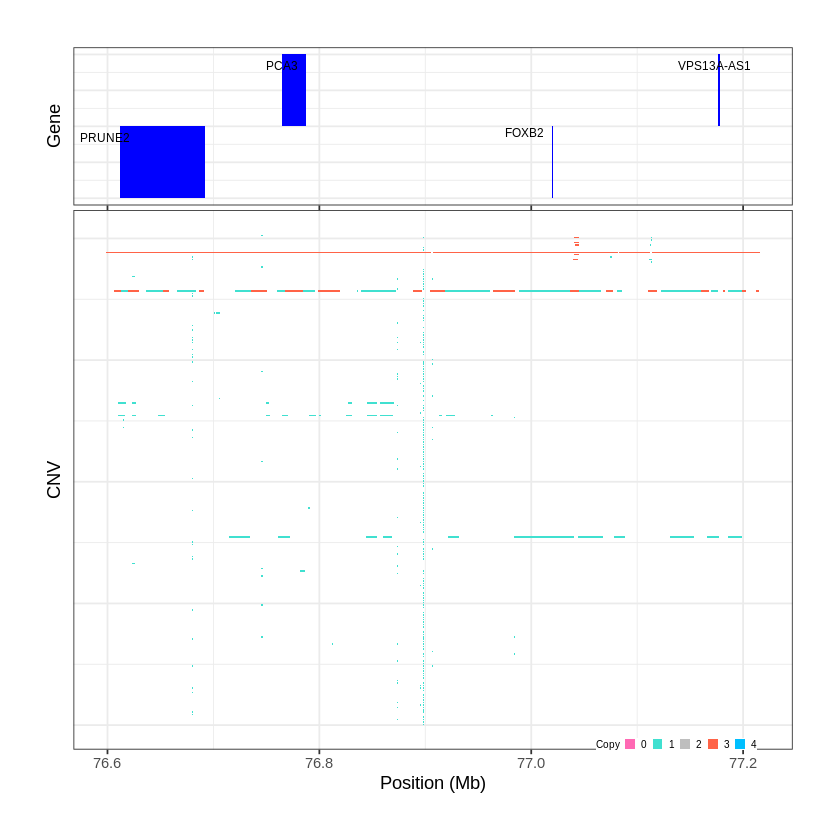

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1143..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 78.960801 - 79.8201 Mb with 155 Individual - "
Plotting gene...


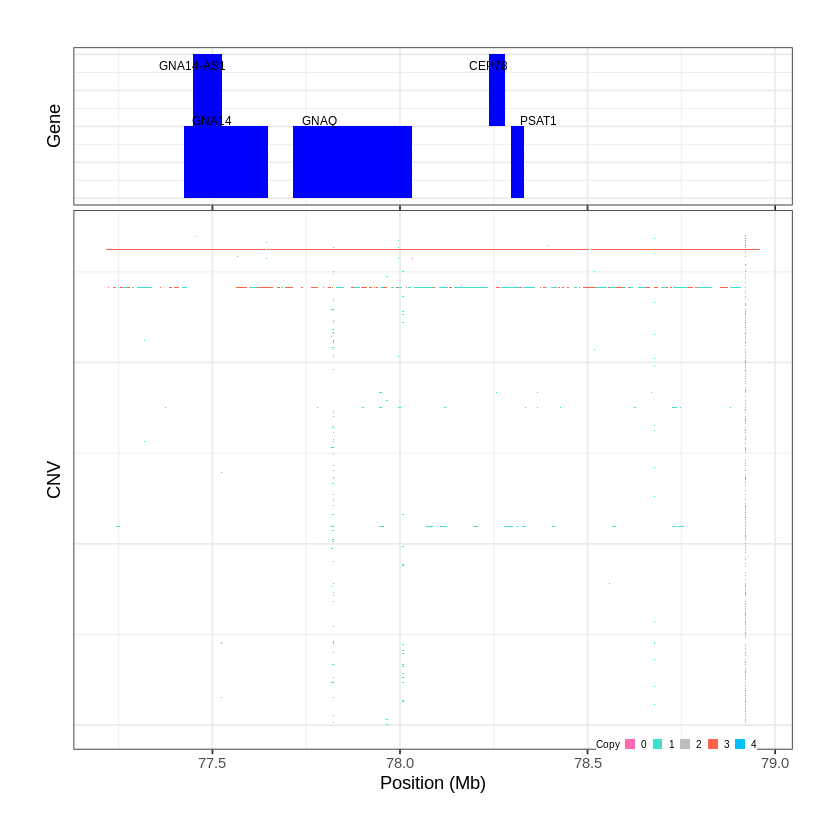

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1144..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 81.702901 - 82.9817 Mb with 156 Individual - "
Plotting gene...


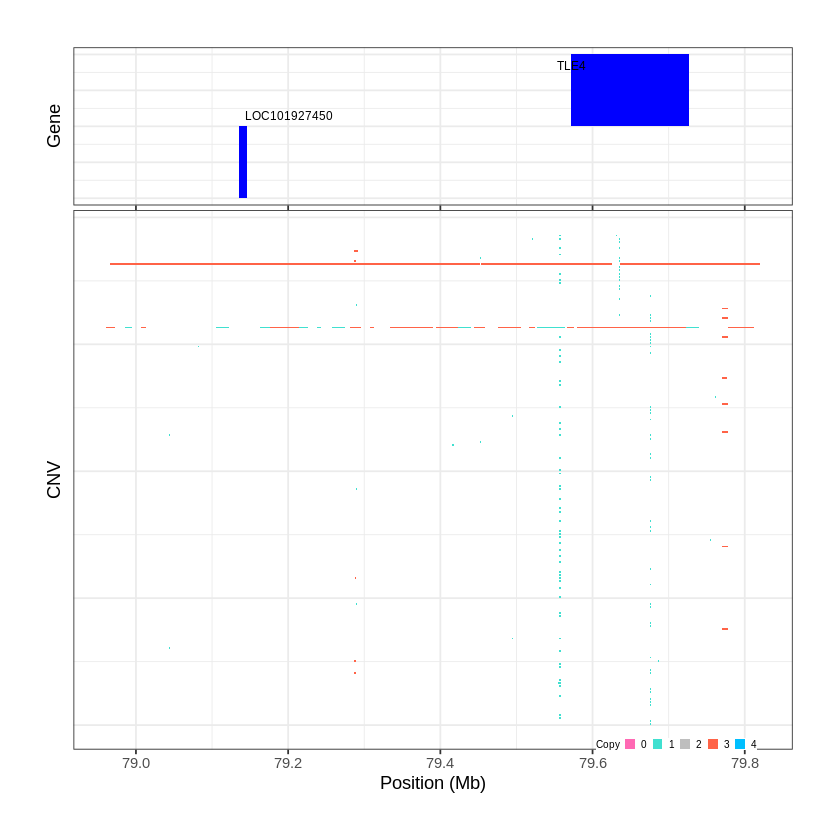

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1145..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 82.985401 - 84.1827 Mb with 267 Individual - "
Plotting gene...


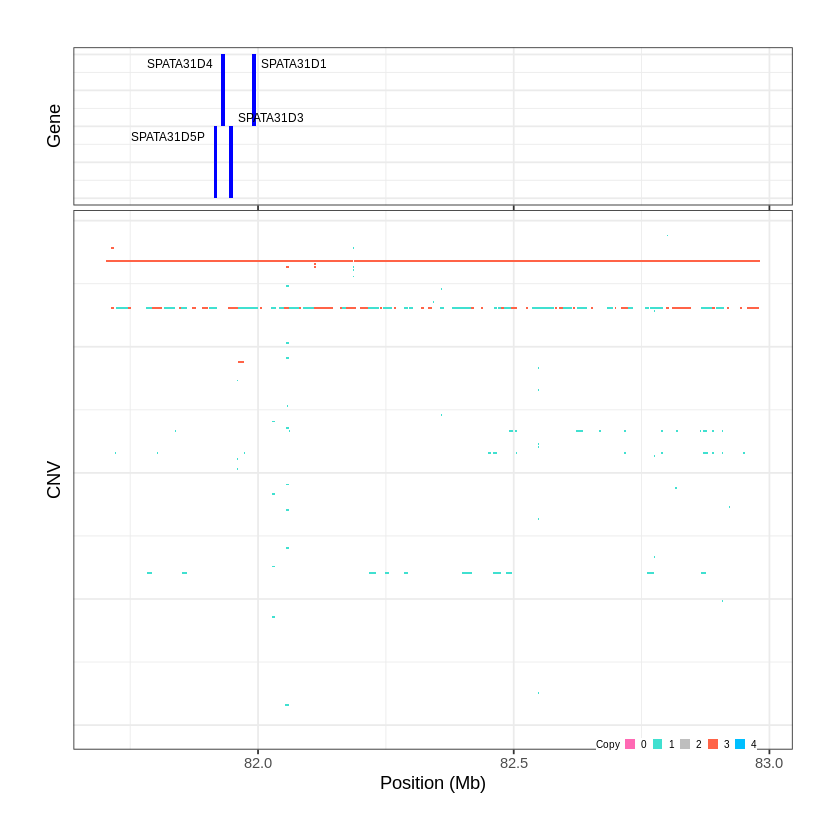

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1146..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 84.574701 - 86.2612 Mb with 203 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1147..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 87.901401 - 87.9017 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


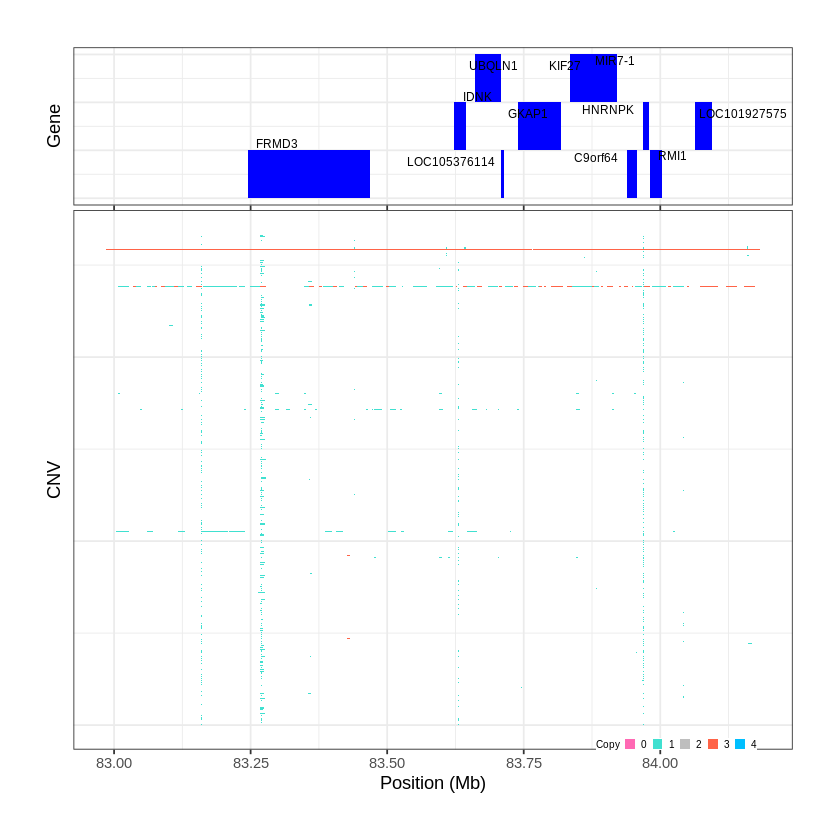

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1148..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 88.543601 - 88.7366 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


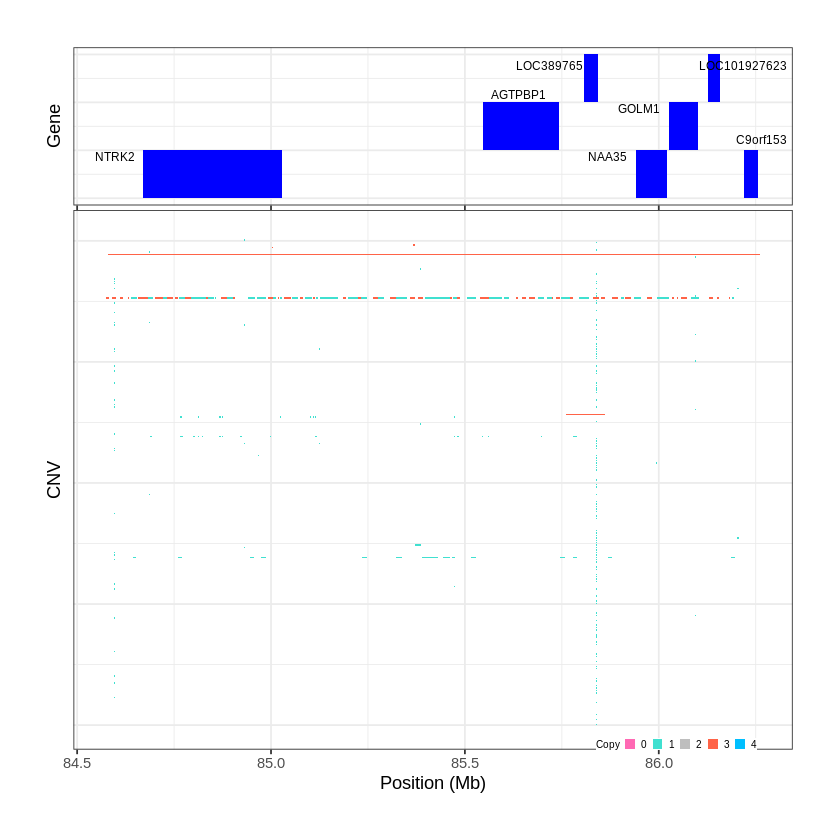

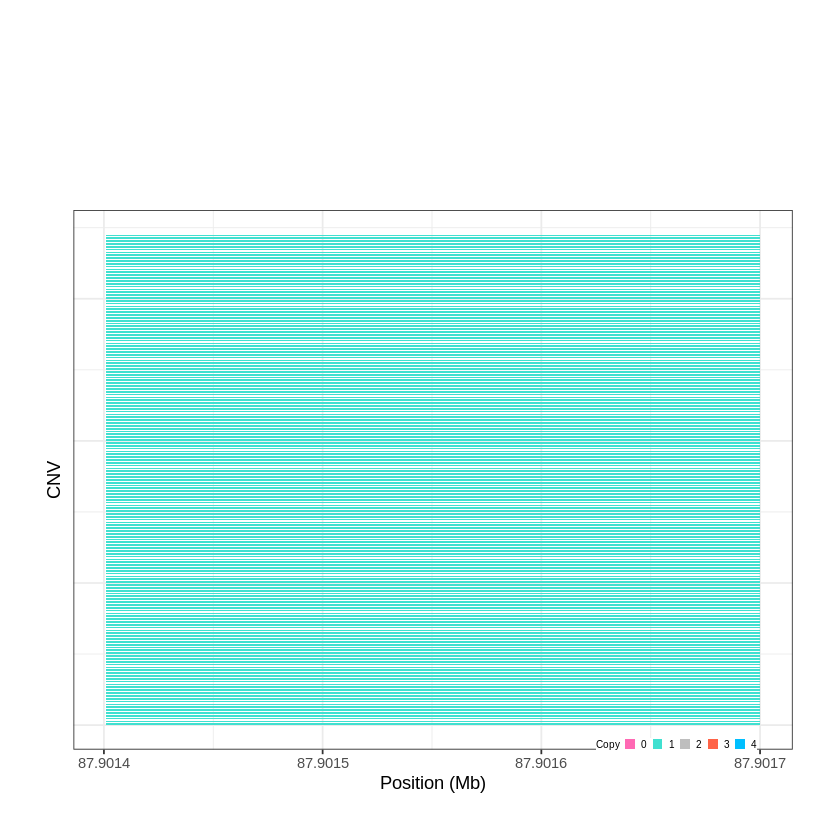

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1149..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 88.737101 - 89.5364 Mb with 267 Individual - "
Plotting gene...


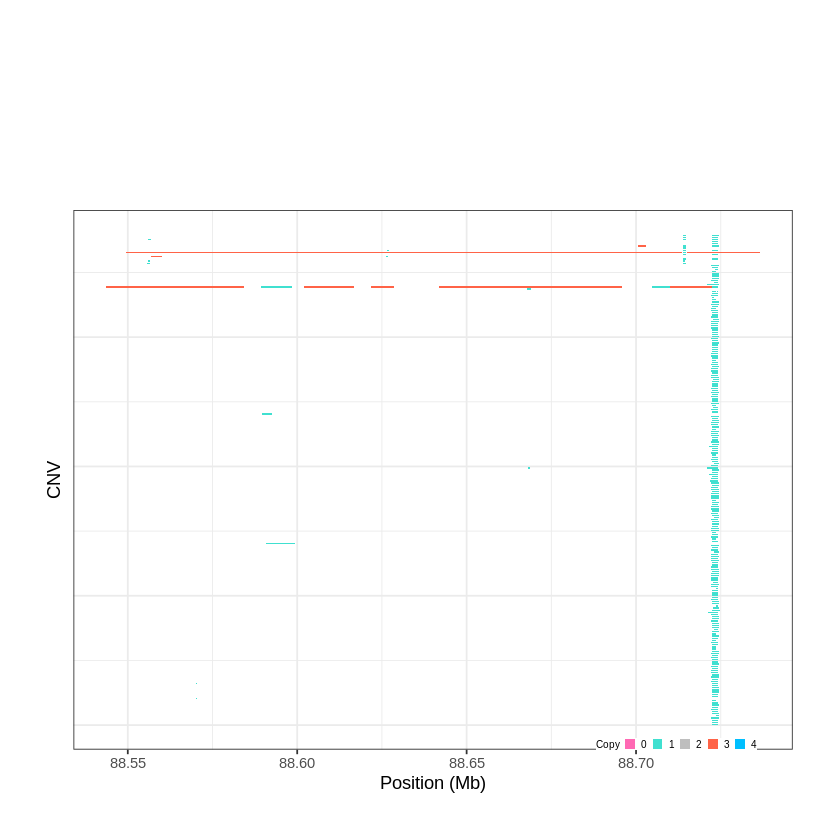

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1150..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 90.064901 - 90.7797 Mb with 261 Individual - "
Plotting gene...


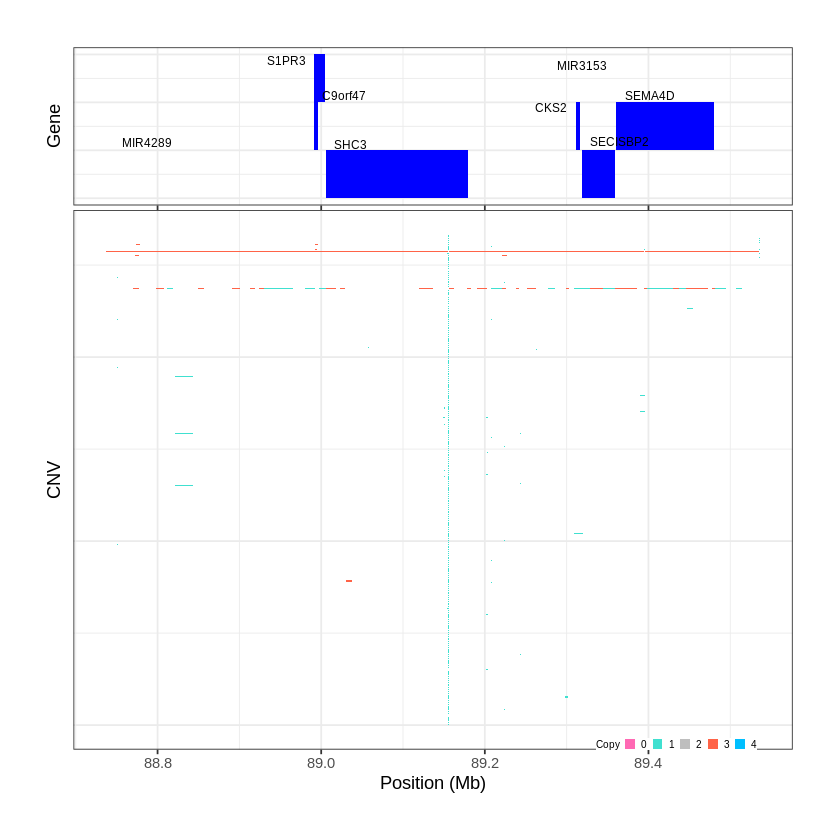

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1151..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 90.780501 - 91.4647 Mb with 259 Individual - "
Plotting gene...


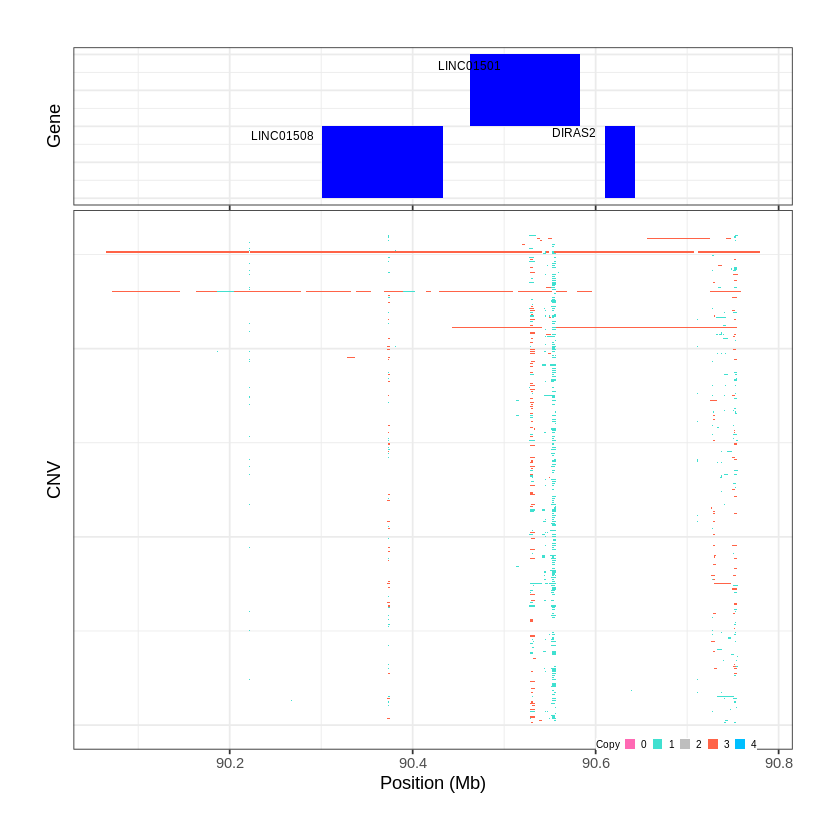

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1152..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 91.865801 - 92.3434 Mb with 215 Individual - "
Plotting gene...


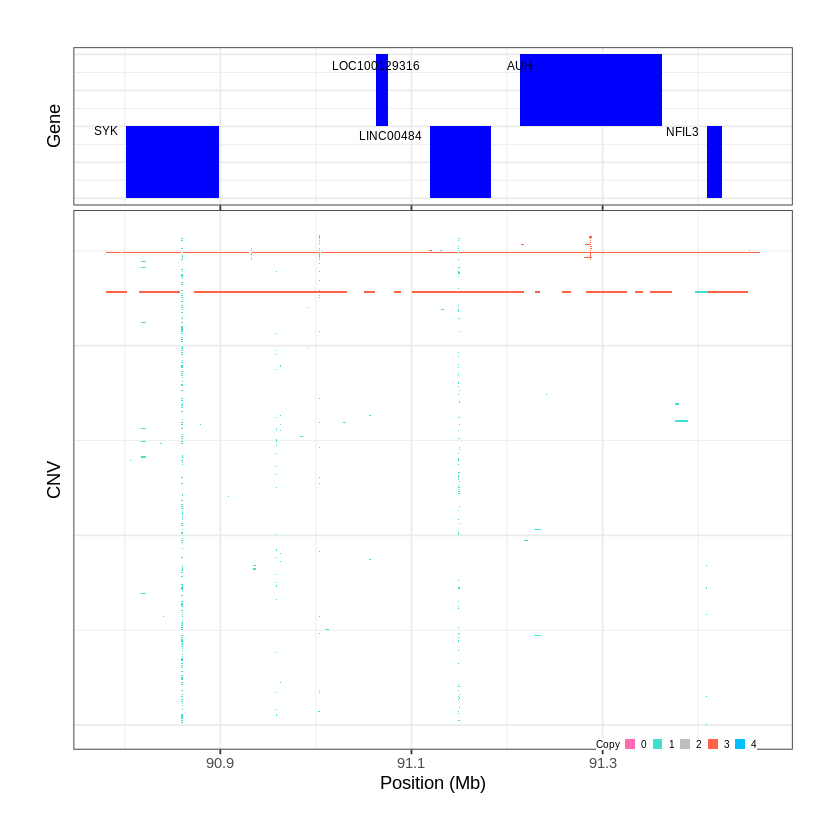

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1153..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 92.343401 - 92.4434 Mb with 279 Individual - "
Plotting gene...


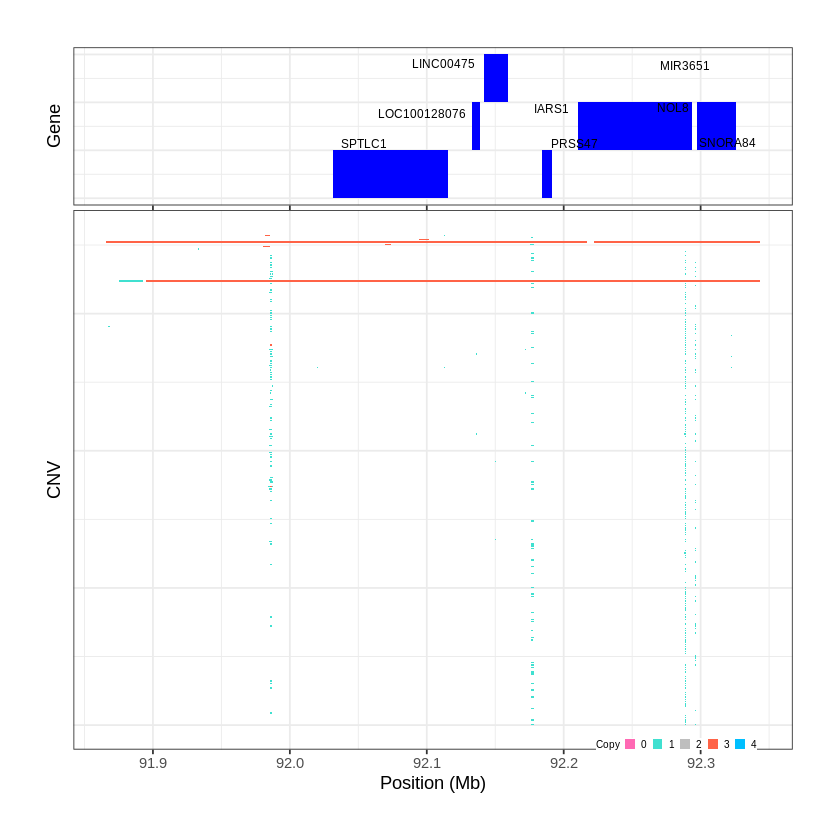

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1154..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 92.528801 - 92.6788 Mb with 279 Individual - "
Plotting gene...


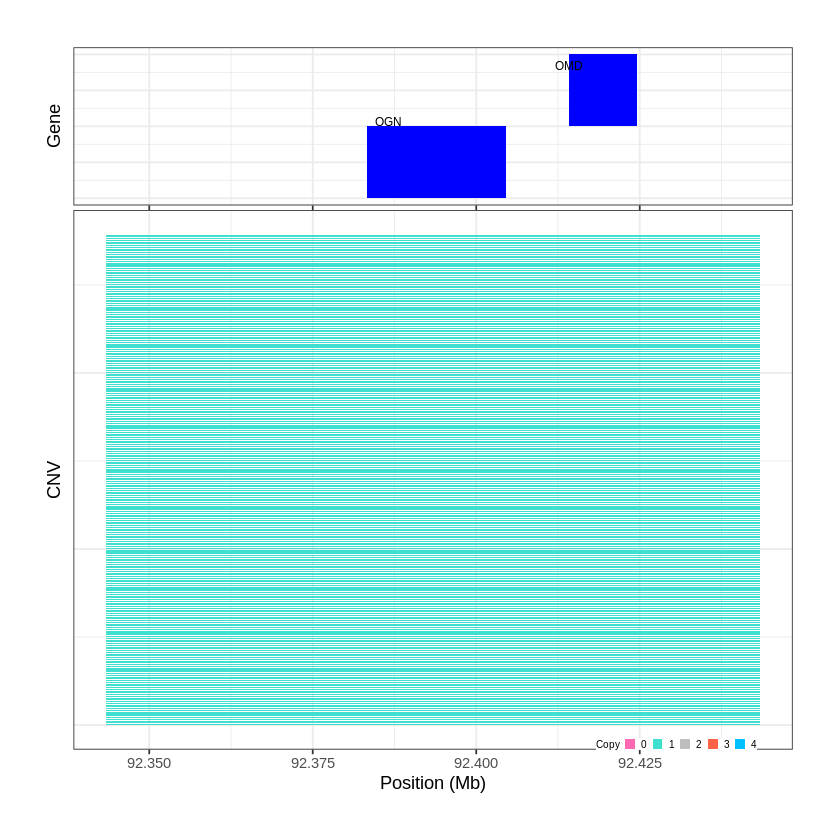

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1155..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 95.572301 - 96.0627 Mb with 272 Individual - "
Plotting gene...


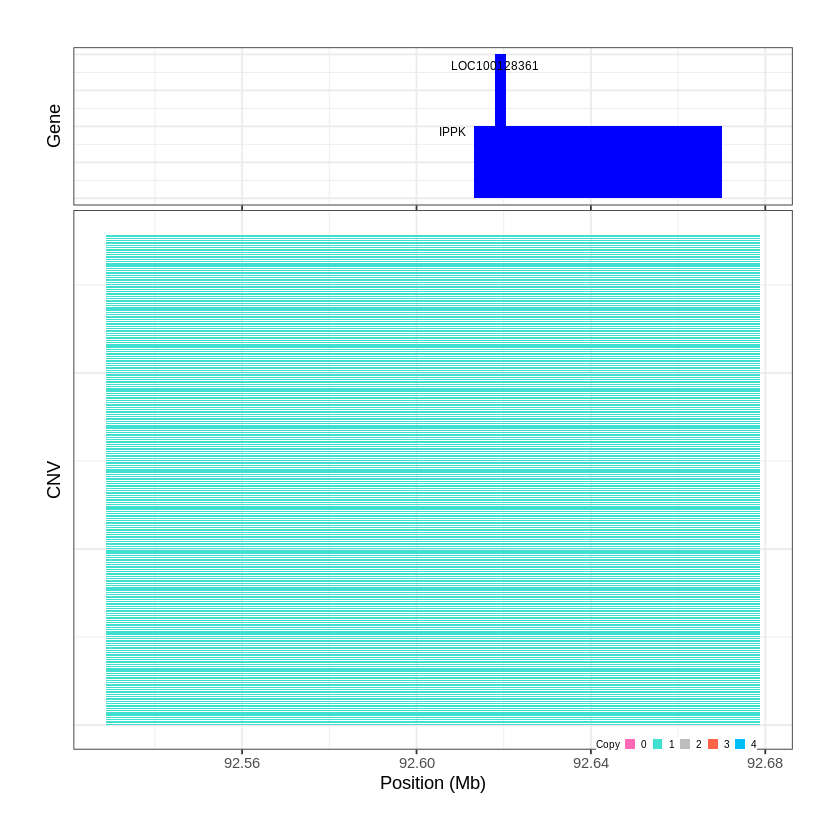

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1156..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 96.062801 - 96.7558 Mb with 261 Individual - "
Plotting gene...


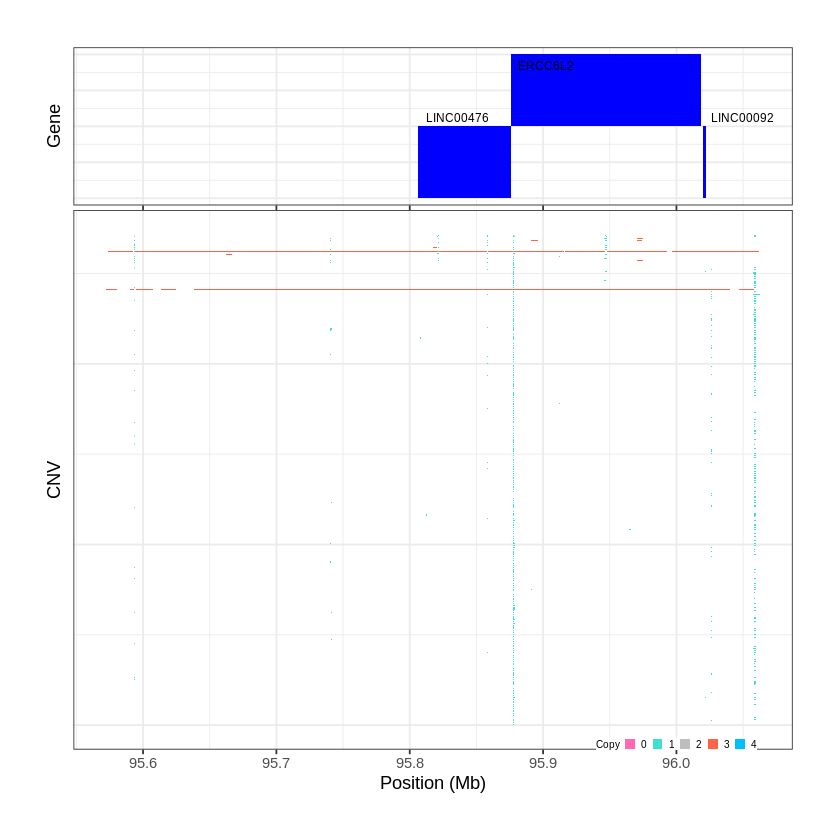

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1157..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 96.881601 - 97.1362 Mb with 220 Individual - "
Plotting gene...


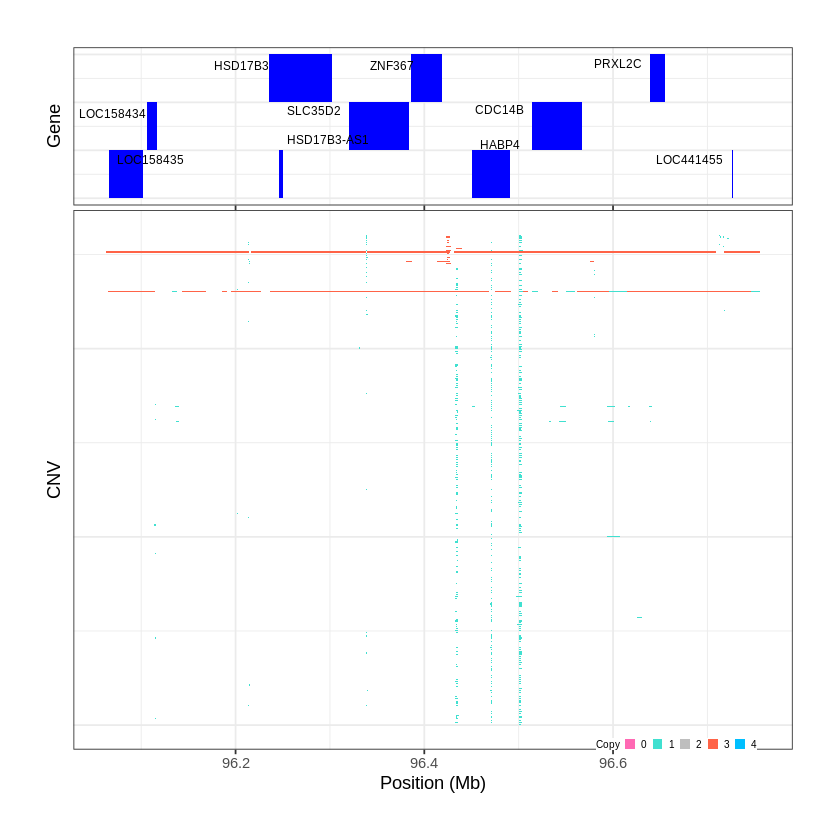

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1158..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 97.137201 - 97.6678 Mb with 224 Individual - "
Plotting gene...


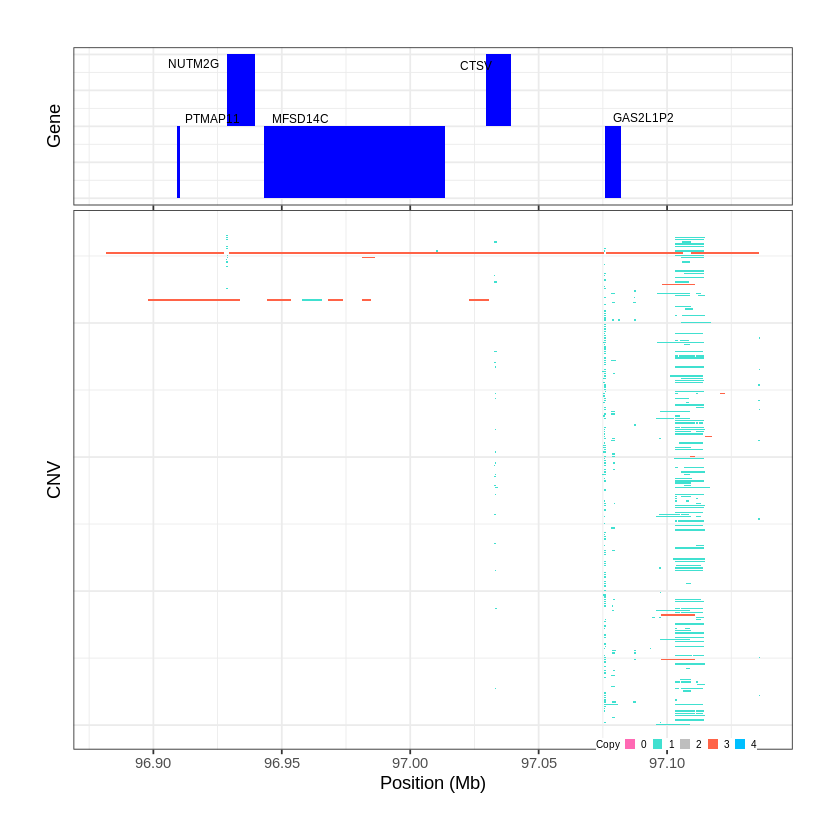

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1159..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 97.669001 - 99.0952 Mb with 146 Individual - "
Plotting gene...


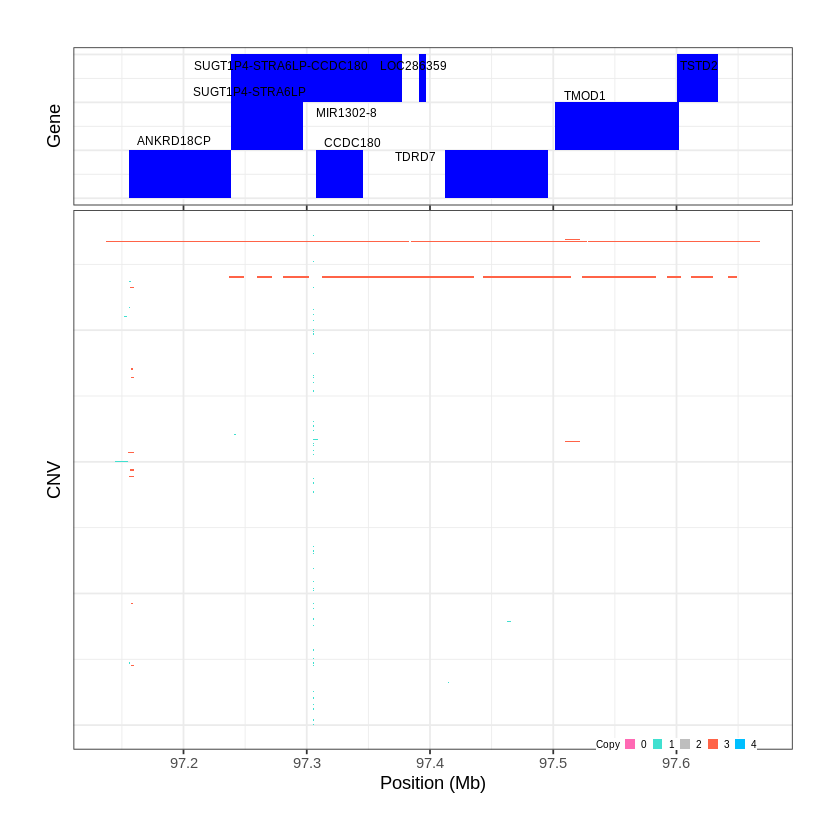

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1160..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 99.107301 - 100.0191 Mb with 250 Individual - "
Plotting gene...


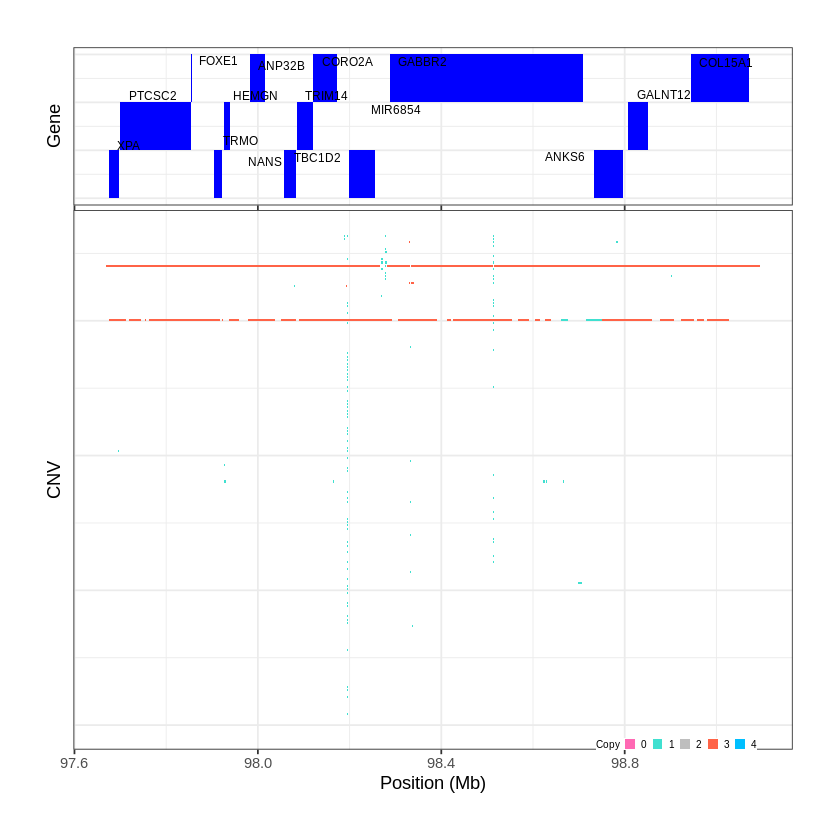

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1161..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 100.818001 - 101.348 Mb with 226 Individual - "
Plotting gene...


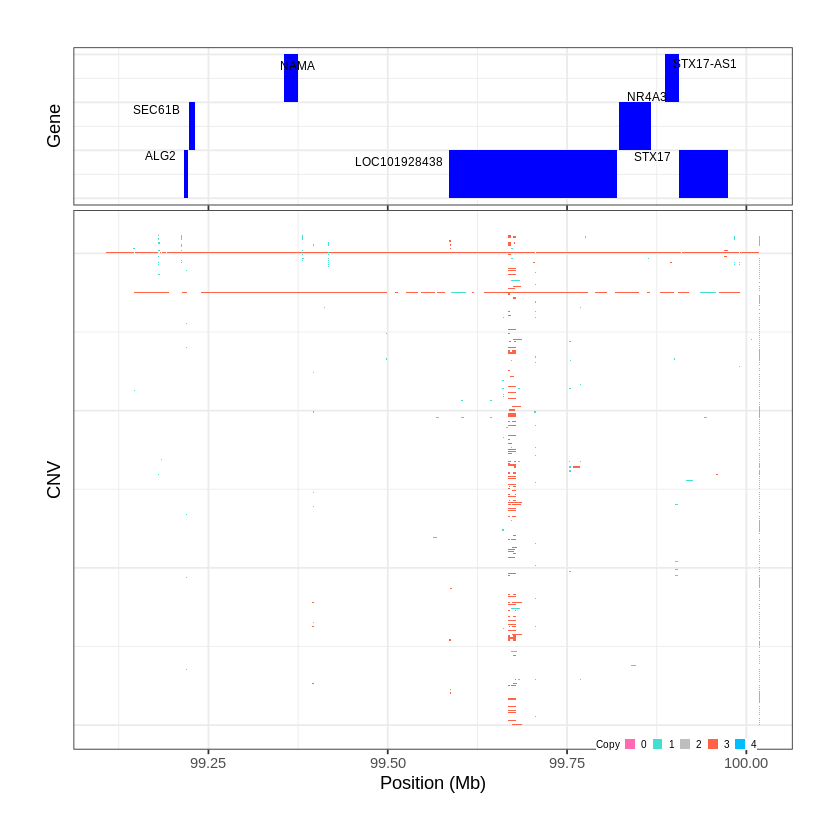

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1162..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 103.236801 - 104.0838 Mb with 168 Individual - "
Plotting gene...


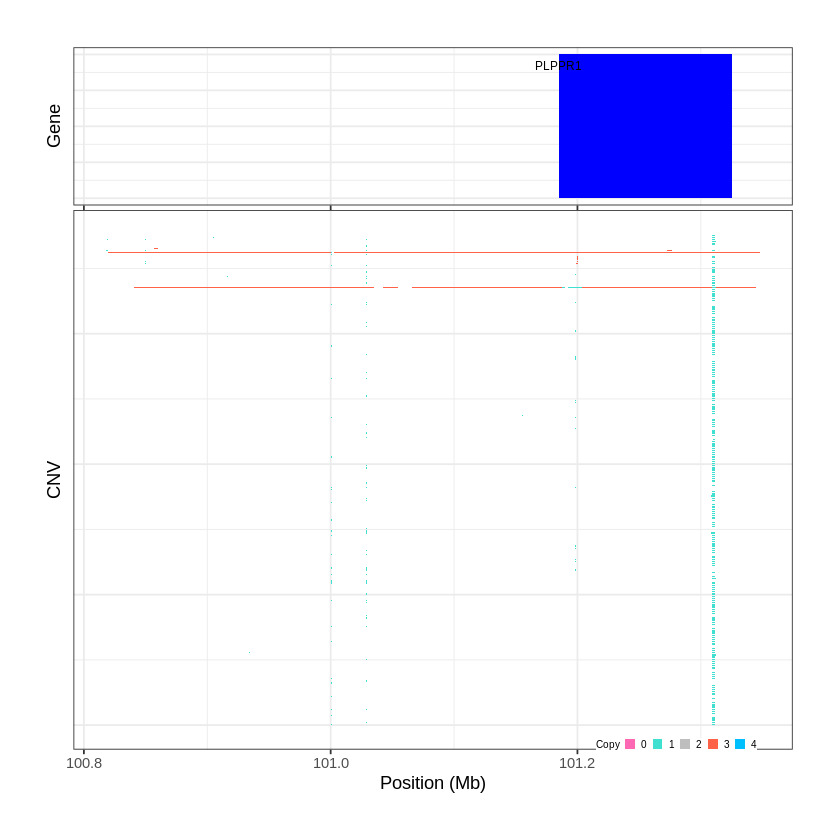

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1163..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 104.084501 - 104.3486 Mb with 216 Individual - "
Plotting gene...


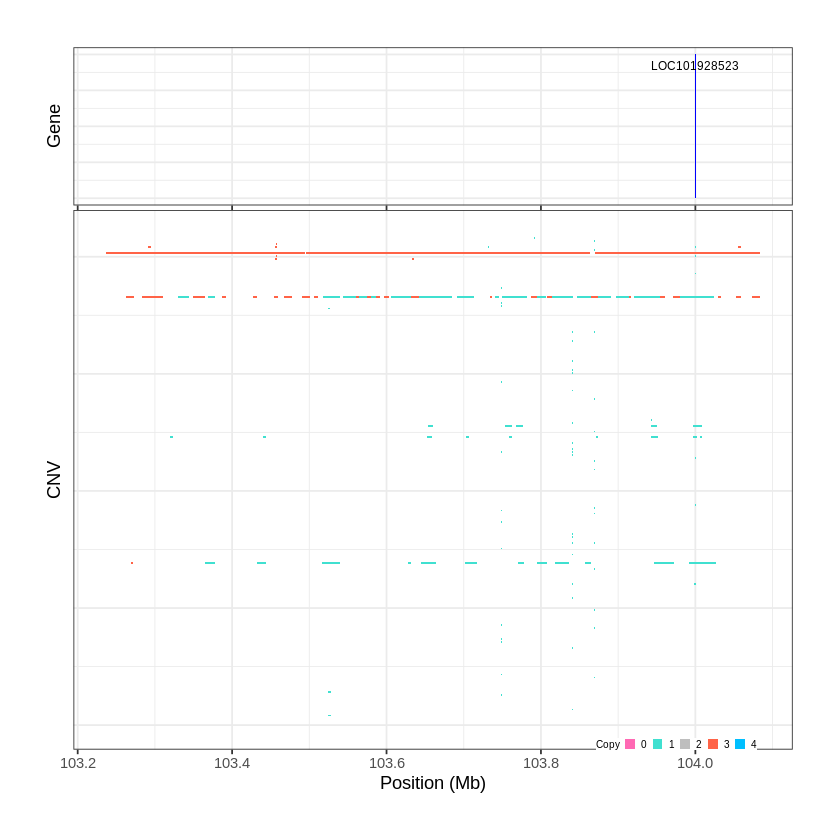

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1164..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 104.350801 - 106.3537 Mb with 235 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


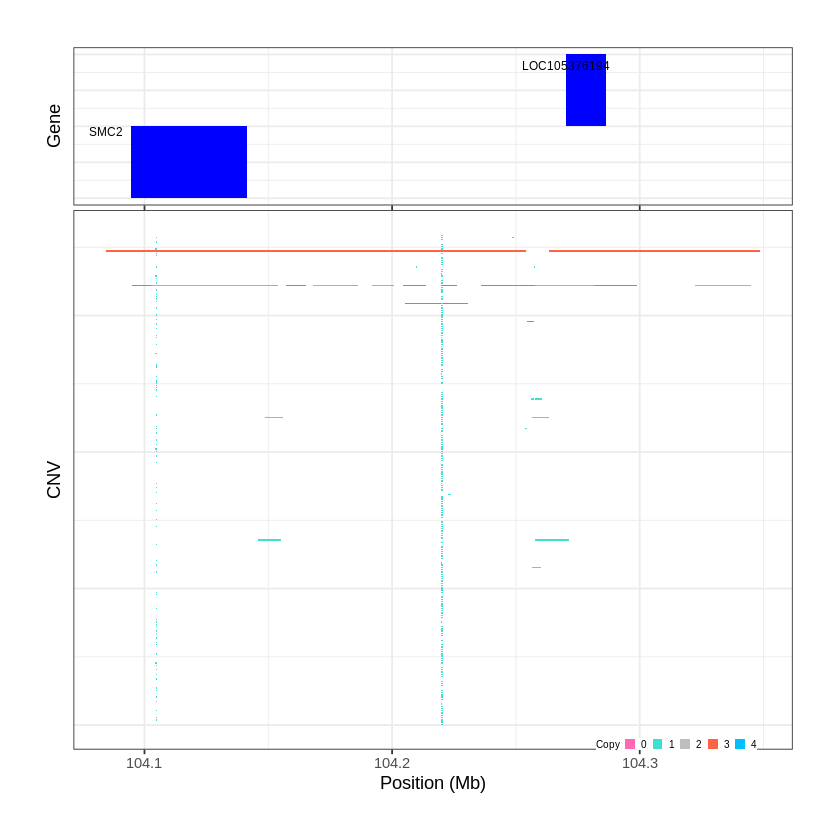

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1165..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 106.354701 - 107.8851 Mb with 227 Individual - "
Plotting gene...


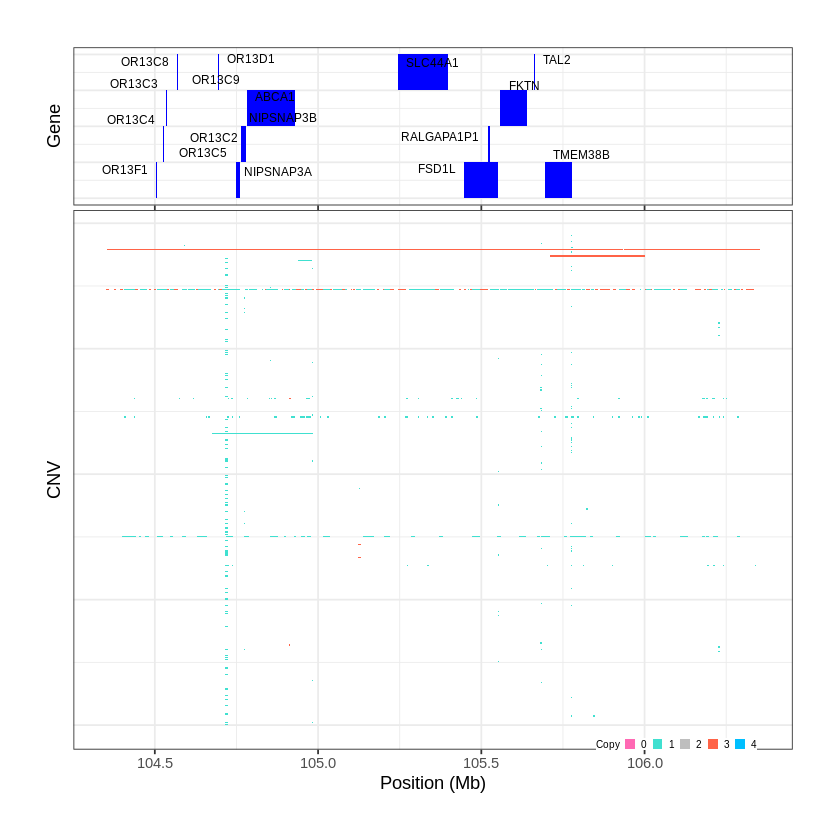

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1166..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 108.974601 - 110.0355 Mb with 228 Individual - "
Plotting gene...


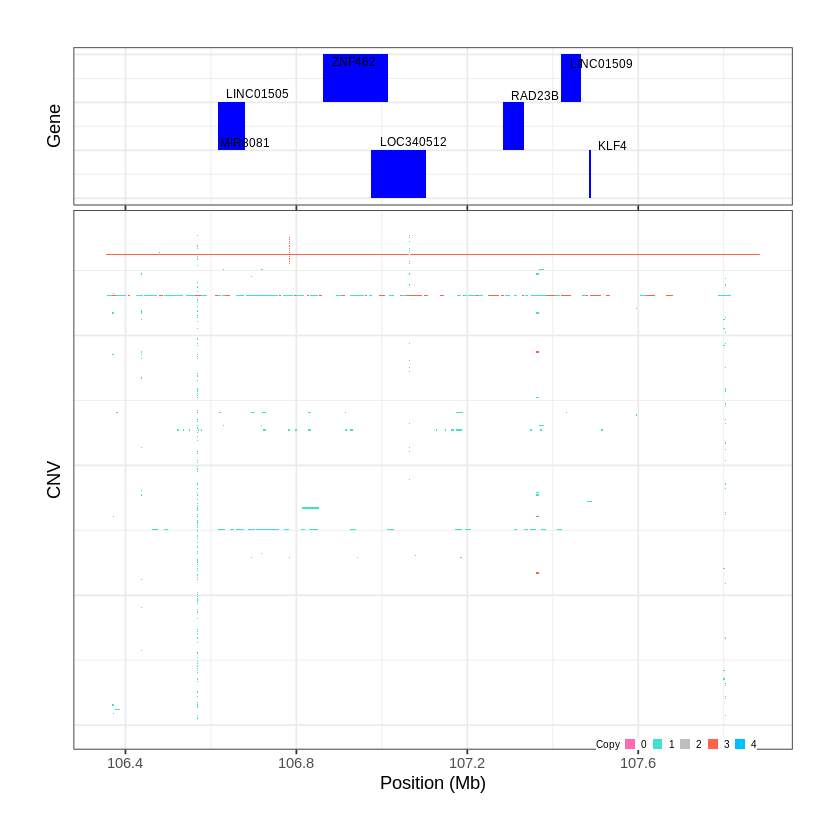

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1167..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 110.035501 - 111.7349 Mb with 229 Individual - "
Plotting gene...


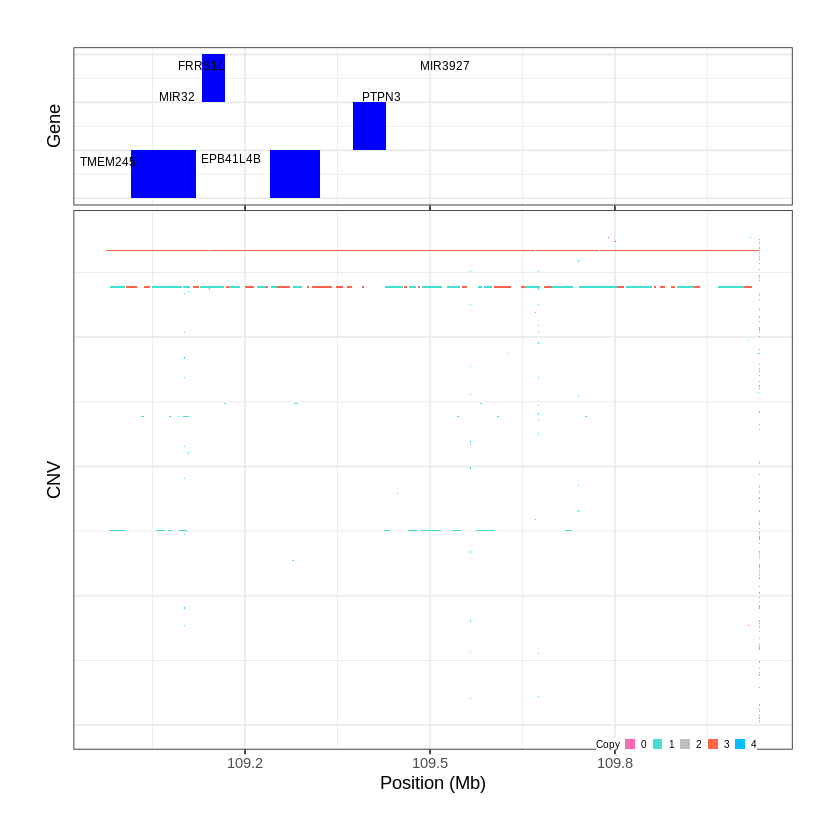

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1168..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 111.737901 - 112.7593 Mb with 227 Individual - "
Plotting gene...


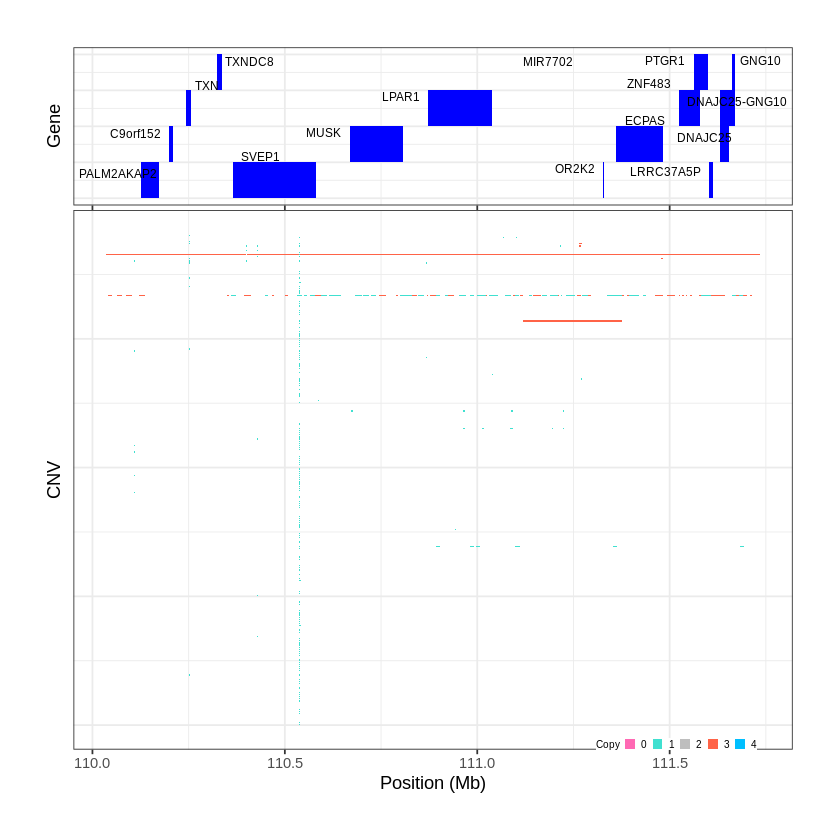

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1169..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 112.761101 - 114.1084 Mb with 247 Individual - "
Plotting gene...


Warning message:
“ggrepel: 4 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


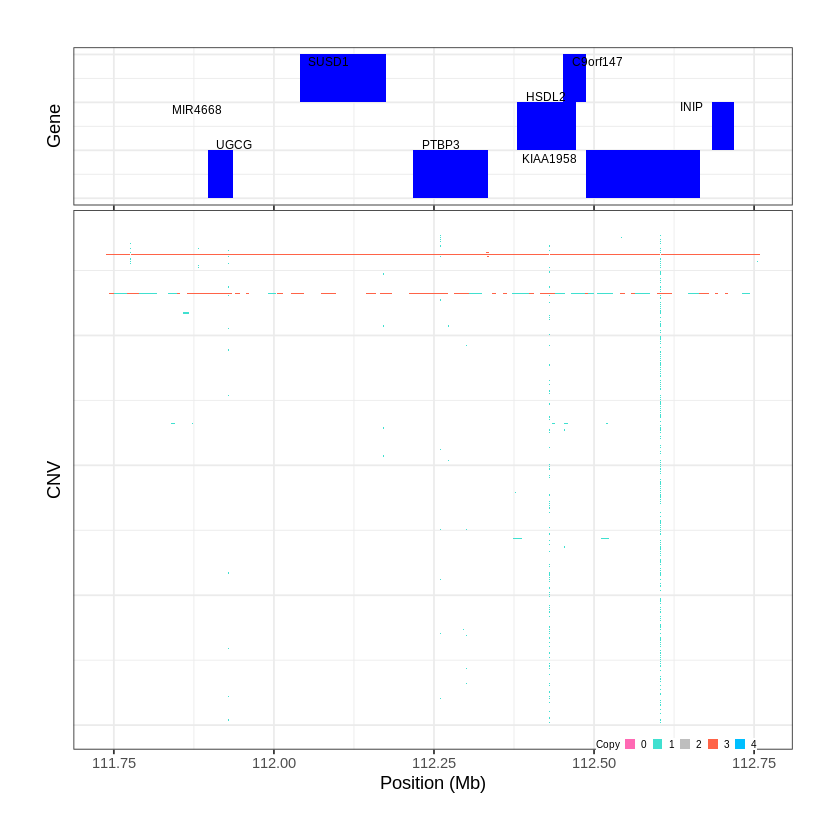

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1170..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 115.526101 - 115.9537 Mb with 279 Individual - "
Plotting gene...


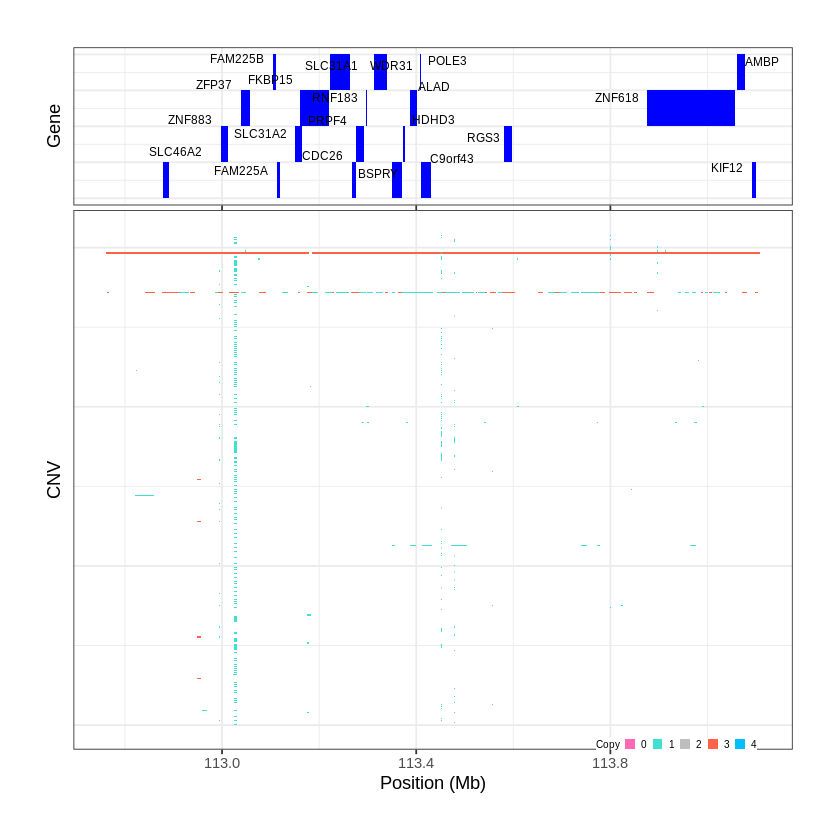

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1171..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 116.641901 - 118.913 Mb with 250 Individual - "
Plotting gene...


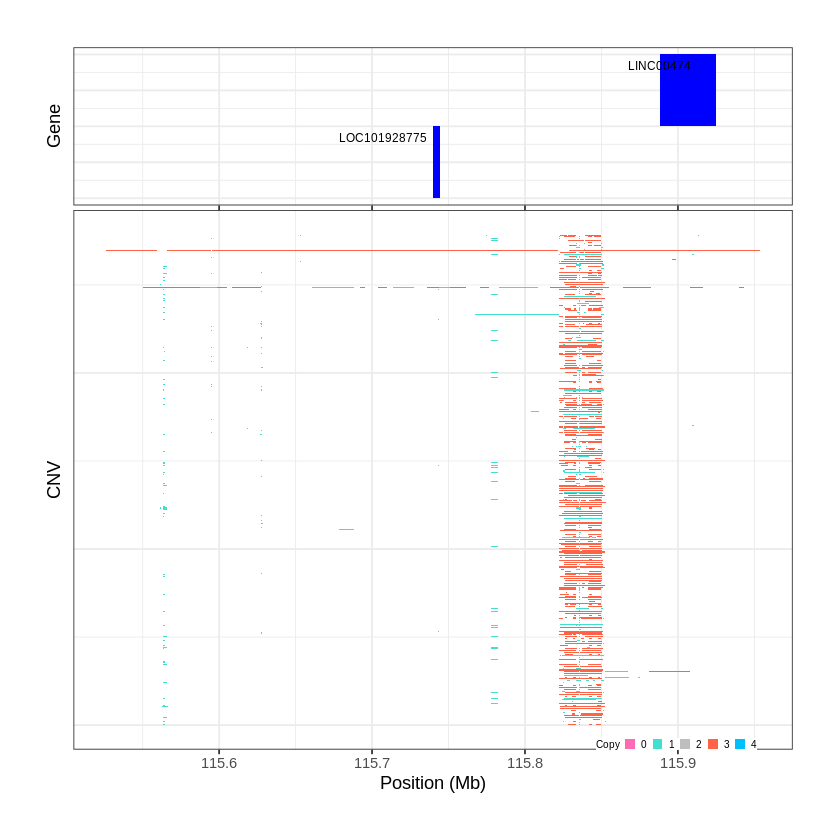

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1172..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 118.914001 - 119.5655 Mb with 160 Individual - "
Plotting gene...


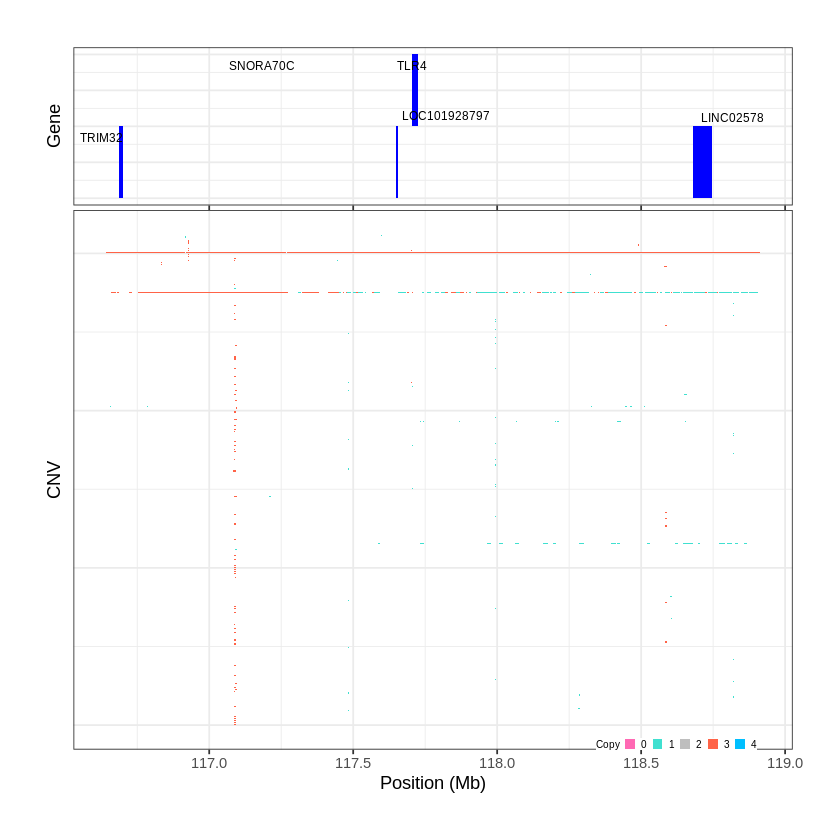

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1173..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 121.255901 - 122.8229 Mb with 203 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


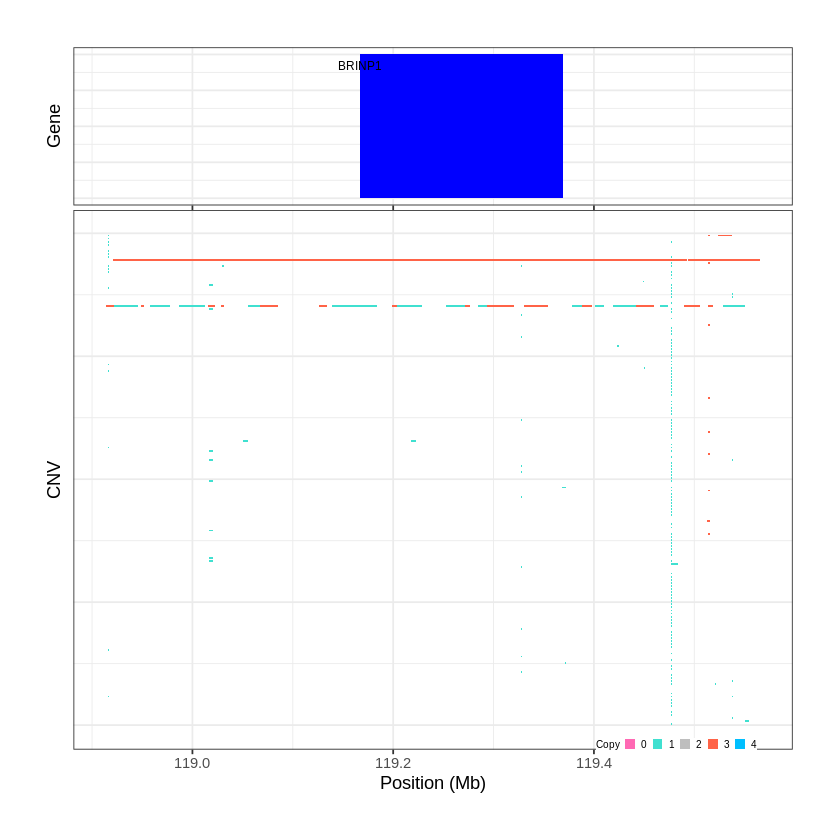

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1174..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 123.214601 - 123.9794 Mb with 162 Individual - "
Plotting gene...


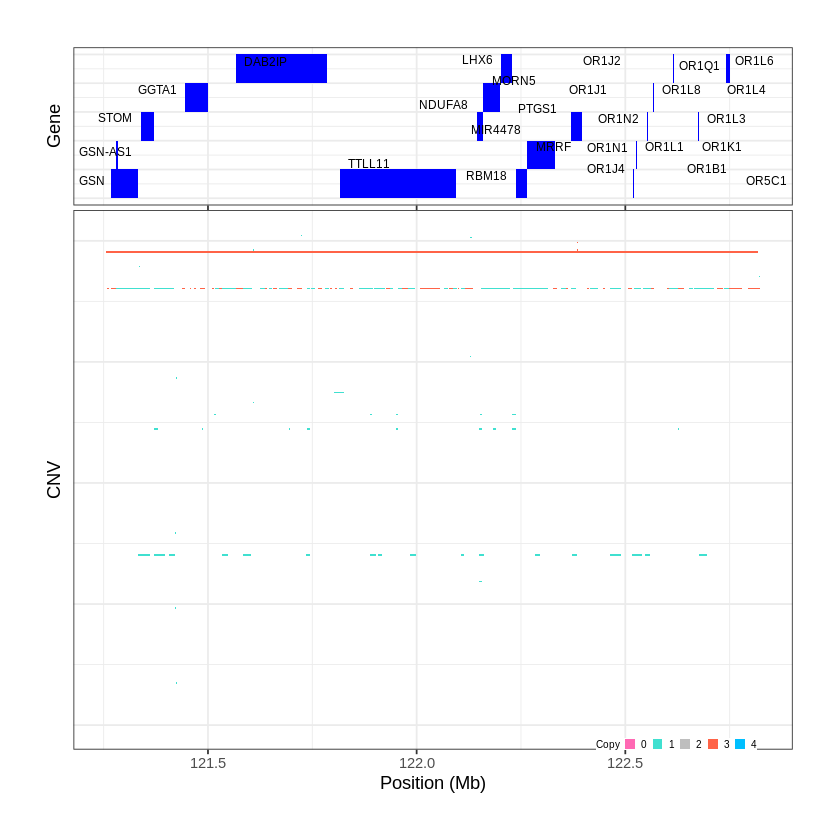

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1175..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 124.362501 - 124.6614 Mb with 147 Individual - "
Plotting gene...


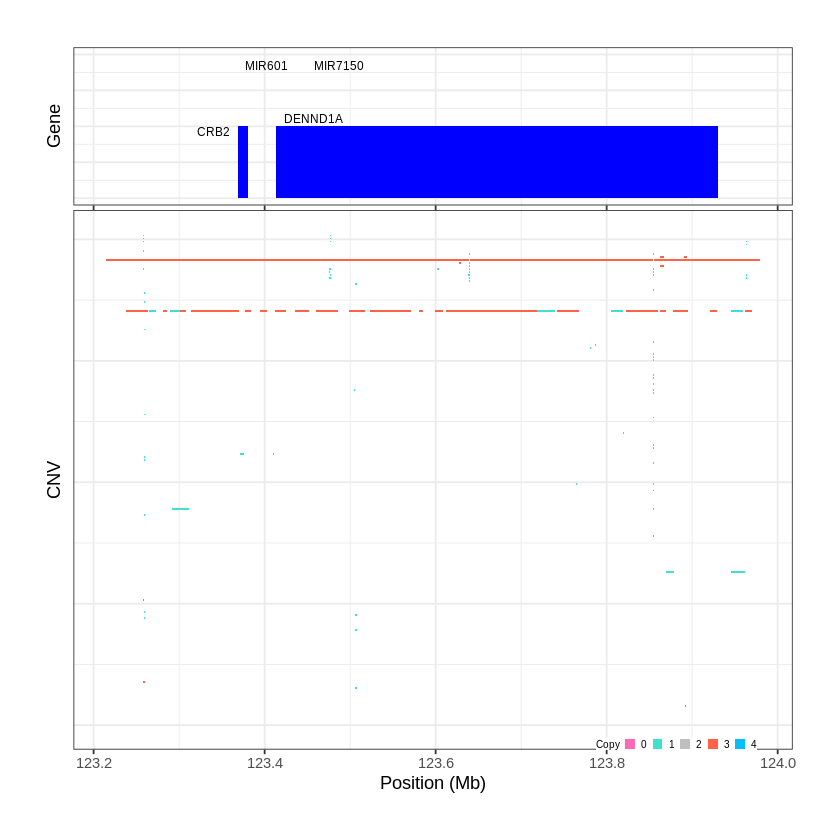

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1176..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 127.951301 - 129.4909 Mb with 198 Individual - "
Plotting gene...


Warning message:
“ggrepel: 26 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


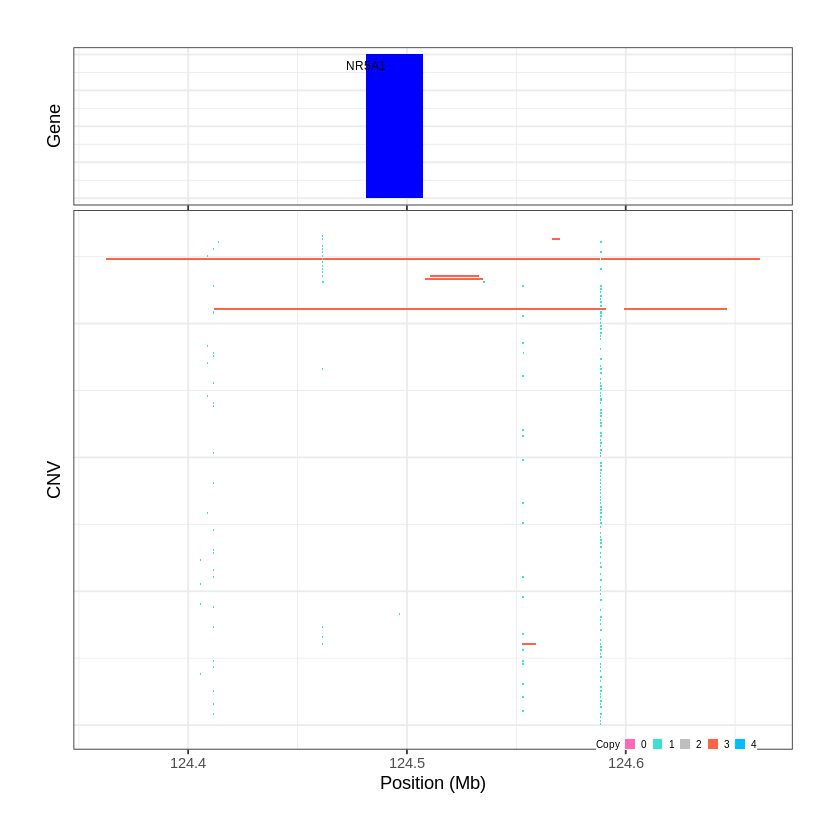

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1177..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 129.495301 - 130.5485 Mb with 277 Individual - "
Plotting gene...


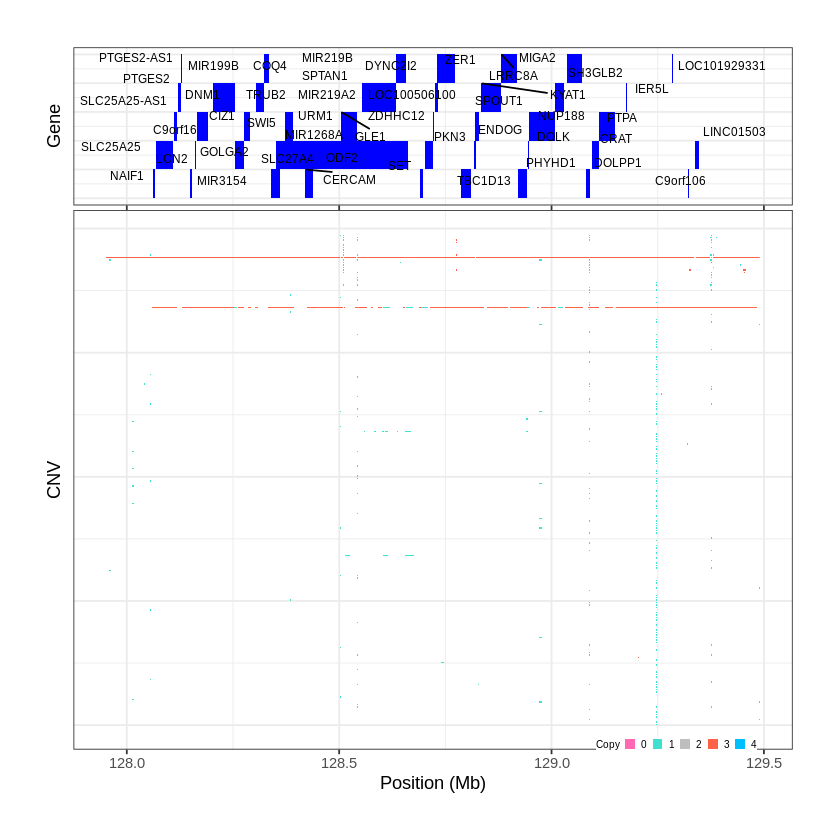

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1178..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 130.743401 - 130.9534 Mb with 216 Individual - "
Plotting gene...


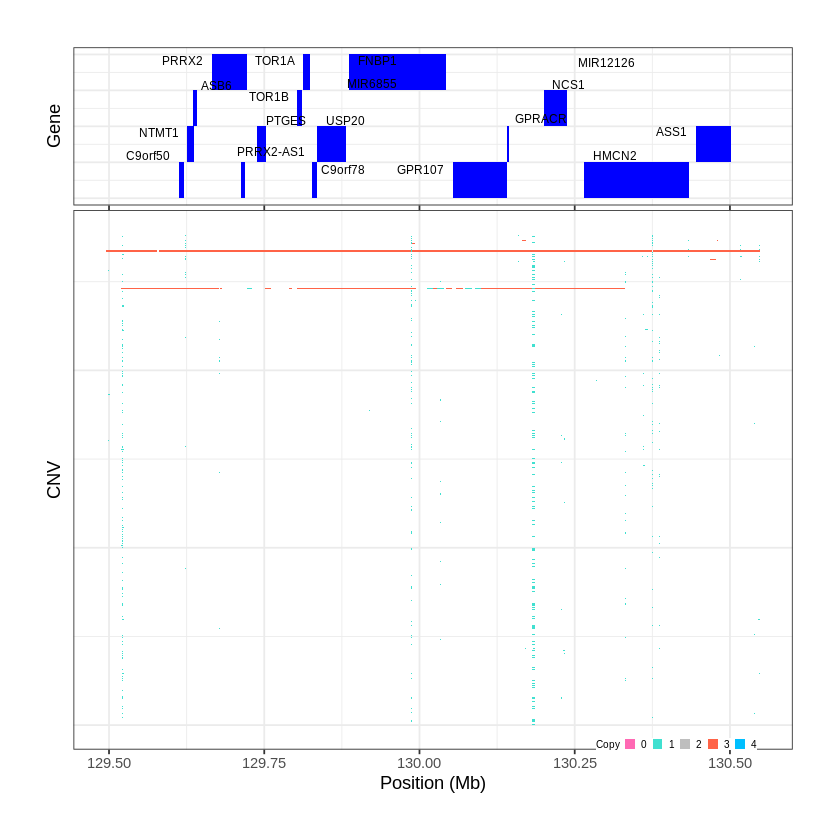

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1179..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 131.183401 - 131.7093 Mb with 275 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1180..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 132.000301 - 132.0467 Mb with 248 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


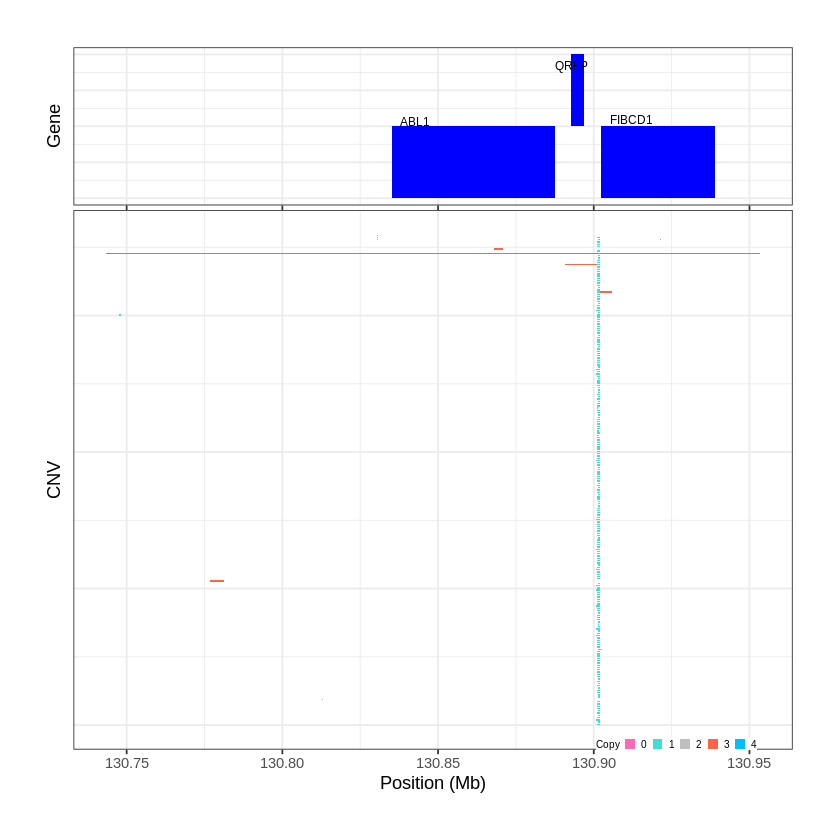

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1181..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 132.047201 - 132.2202 Mb with 204 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


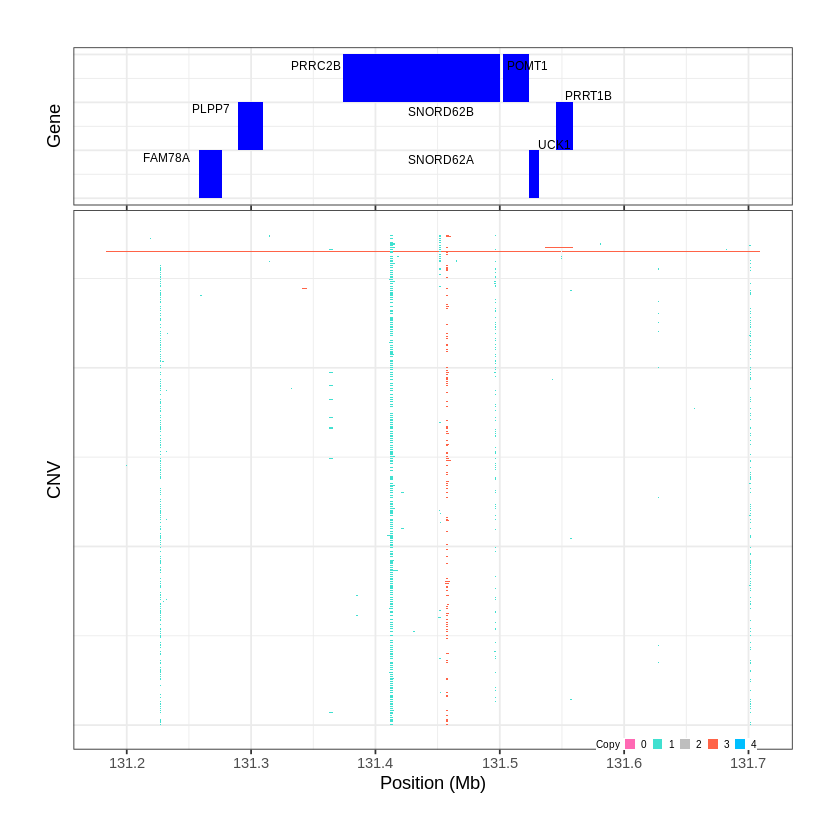

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1182..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 132.426001 - 132.566 Mb with 216 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


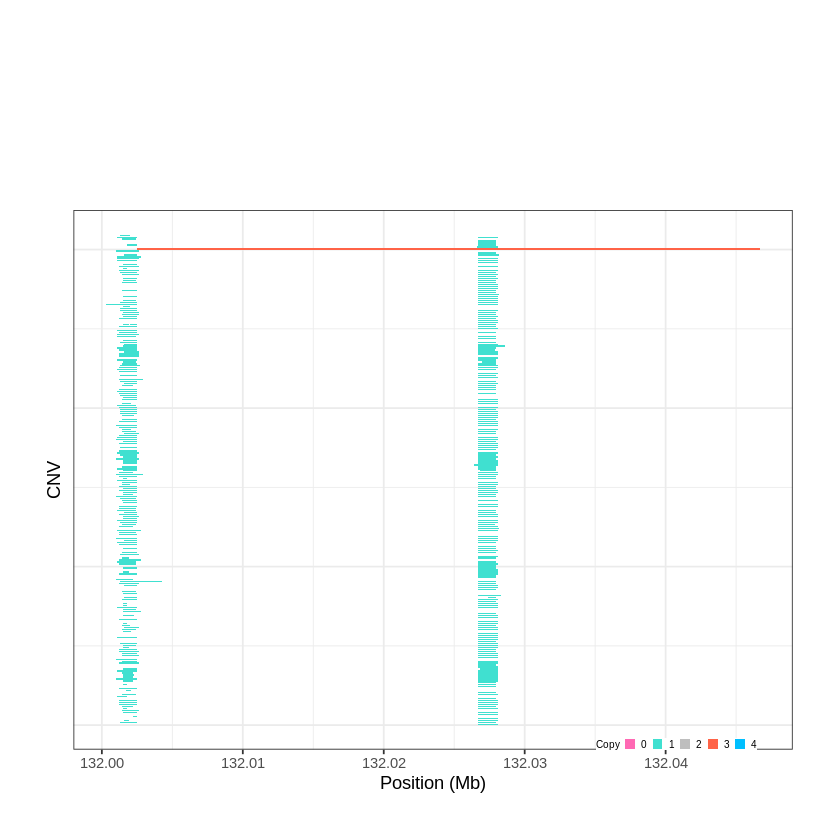

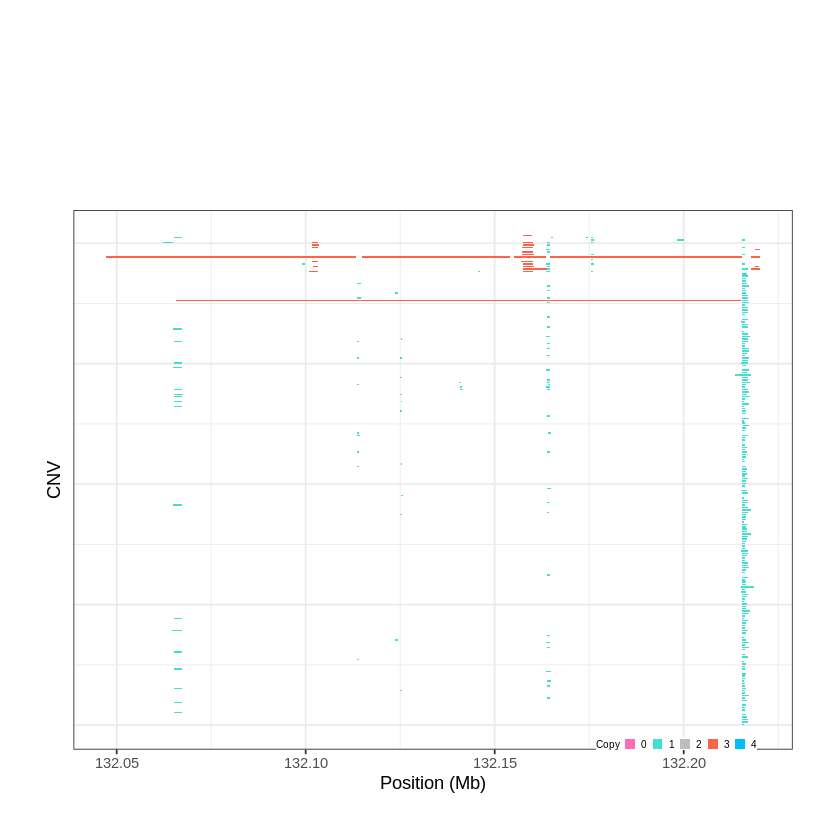

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1183..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 132.566101 - 133.3401 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


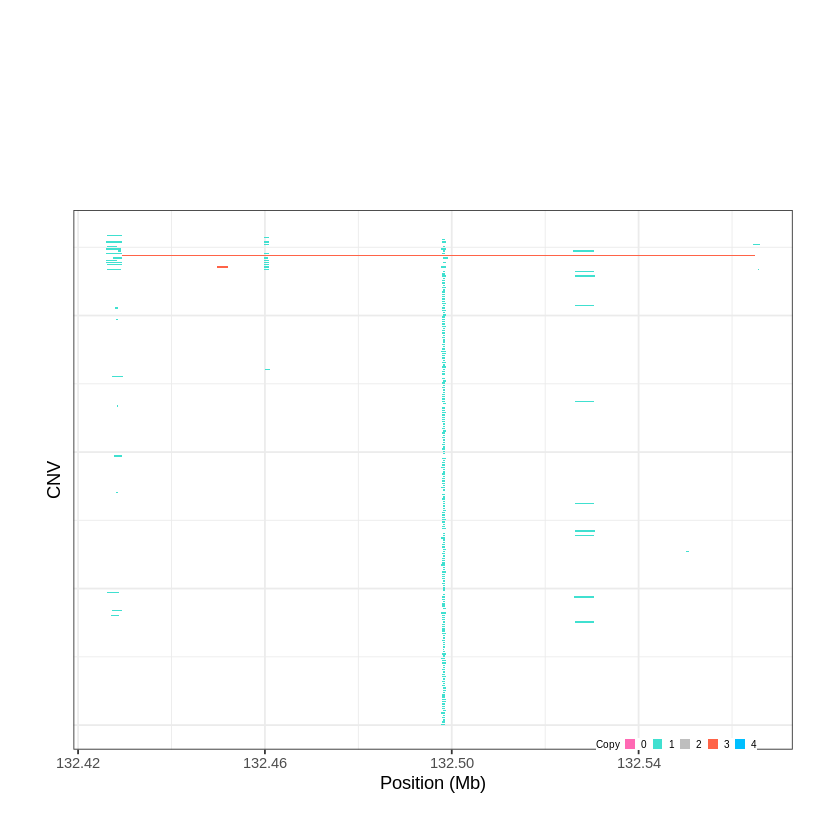

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1184..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 133.558201 - 135.036 Mb with 239 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


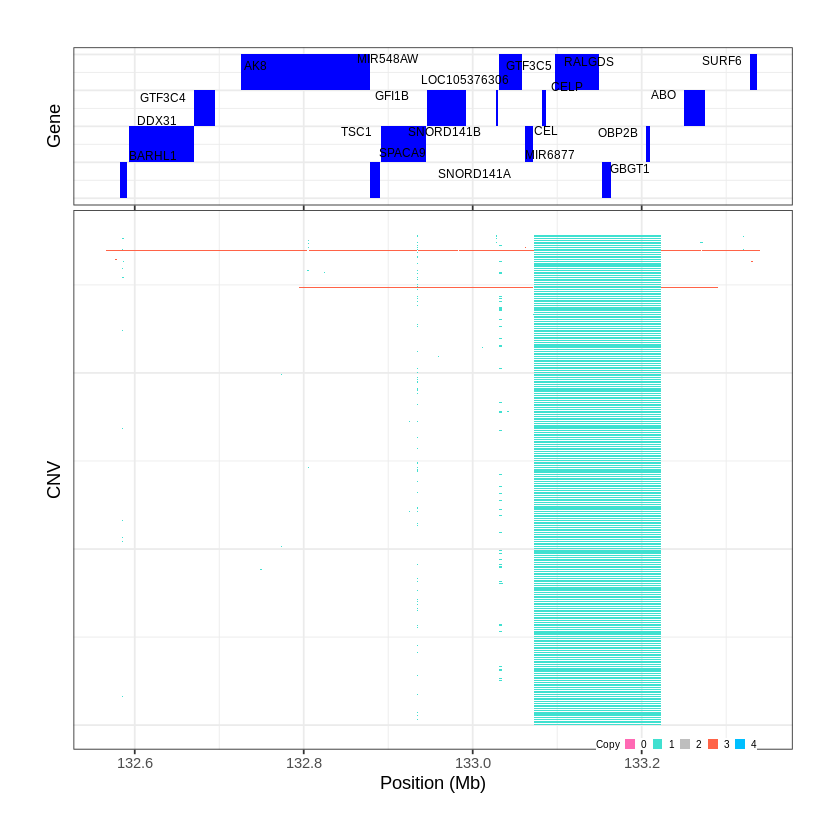

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1185..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 135.036201 - 137.0412 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 64 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


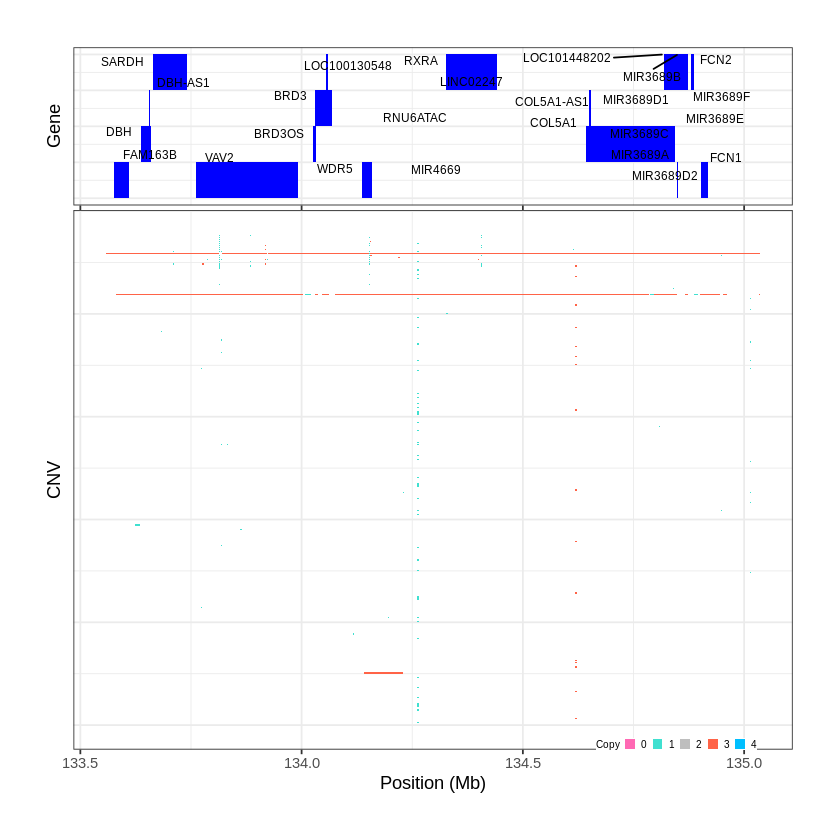

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1186..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 137.041201 - 138.4802 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 33 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1187..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 138.480201 - 139.167 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”
Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


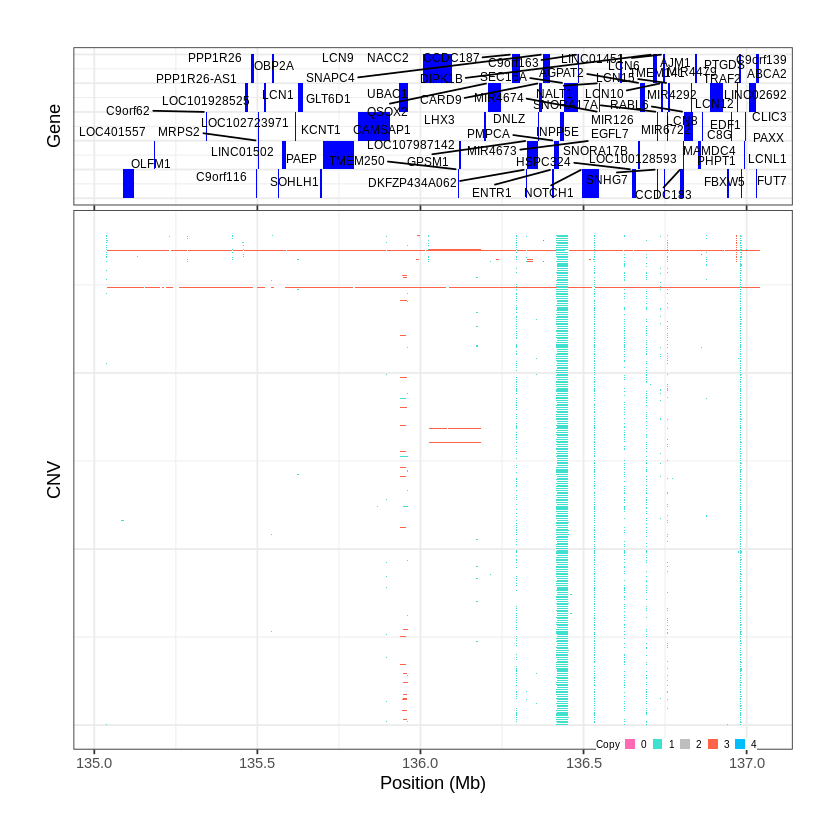

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1188..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 139.167001 - 139.217 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


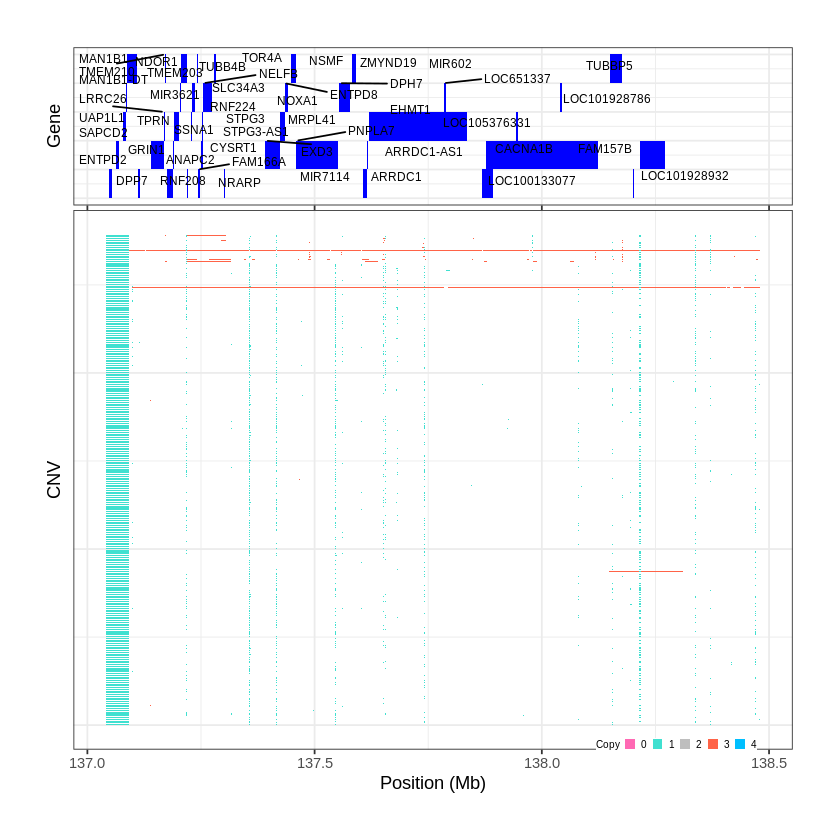

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1189..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 139.295001 - 139.4291 Mb with 259 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


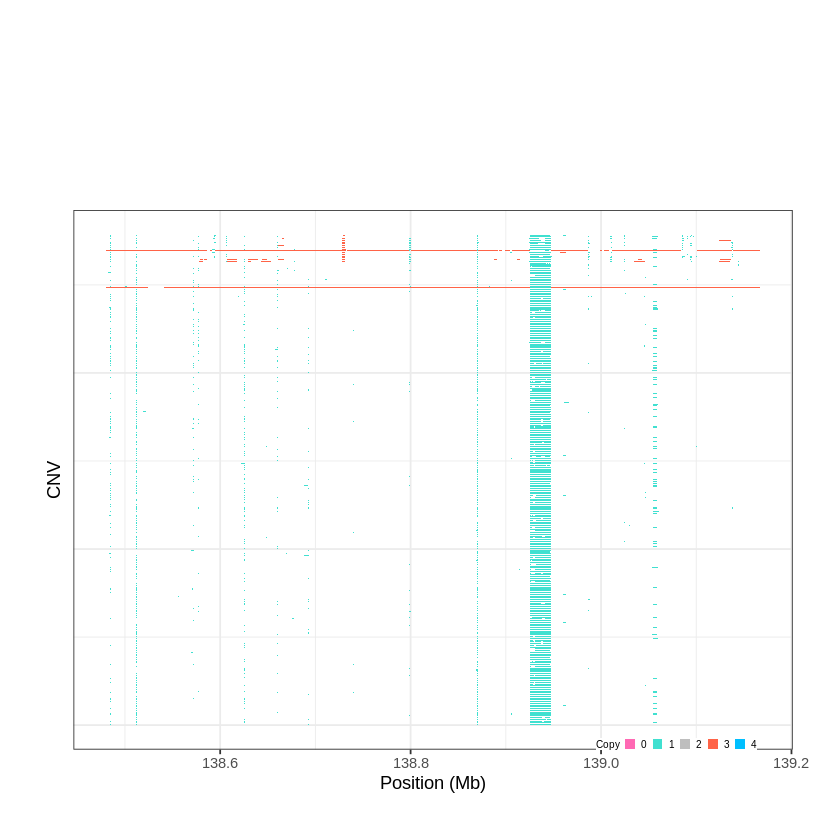

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1190..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 139.446801 - 139.5616 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


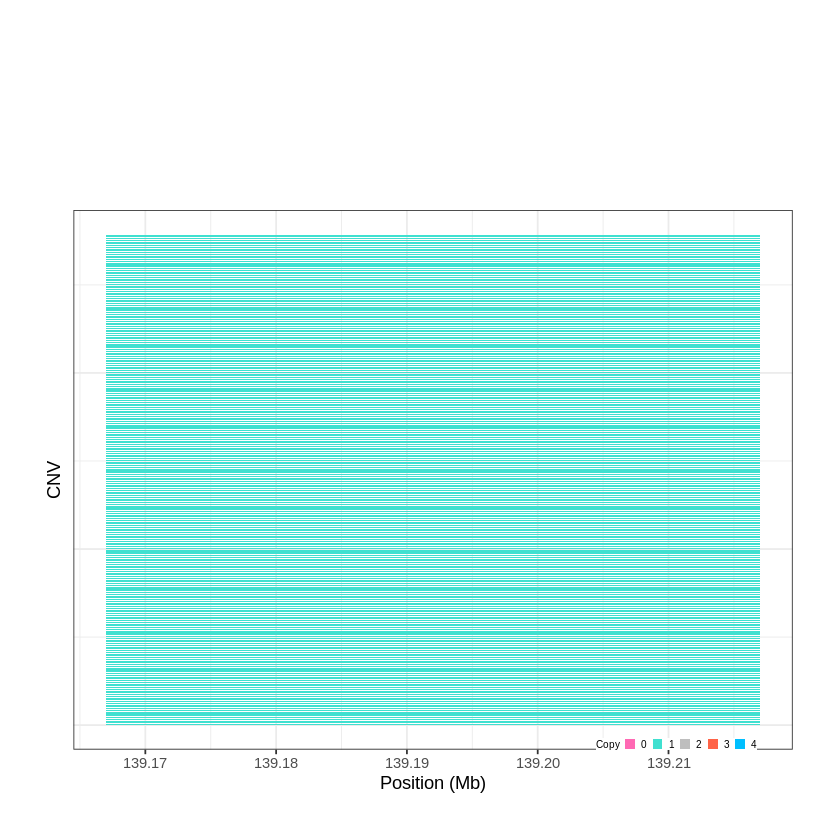

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1191..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 139.562001 - 139.6564 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


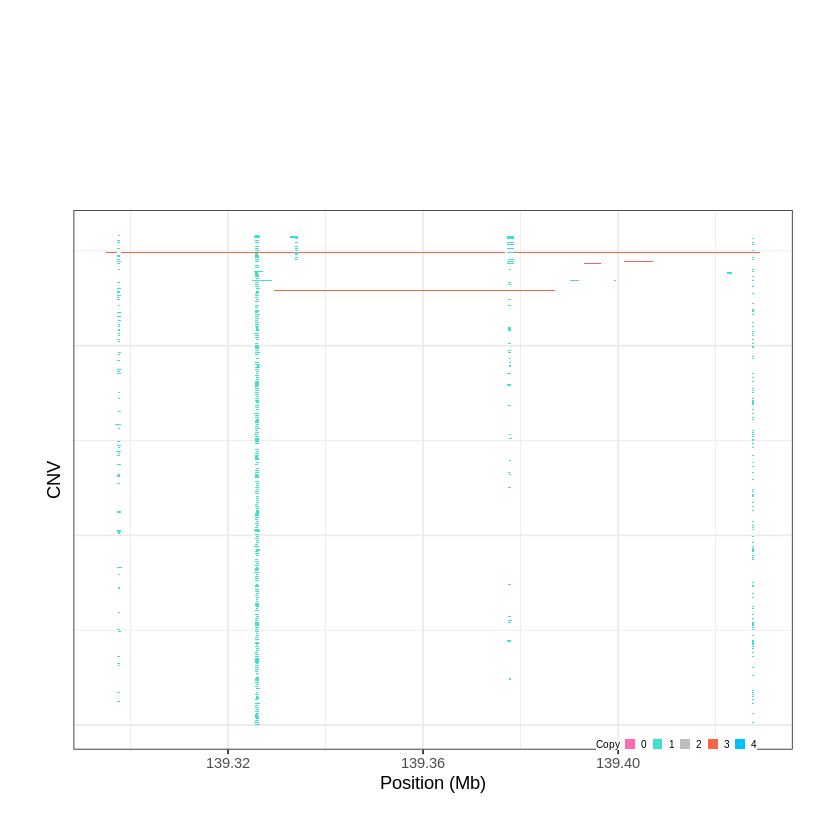

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1192..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 139.657201 - 139.7374 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


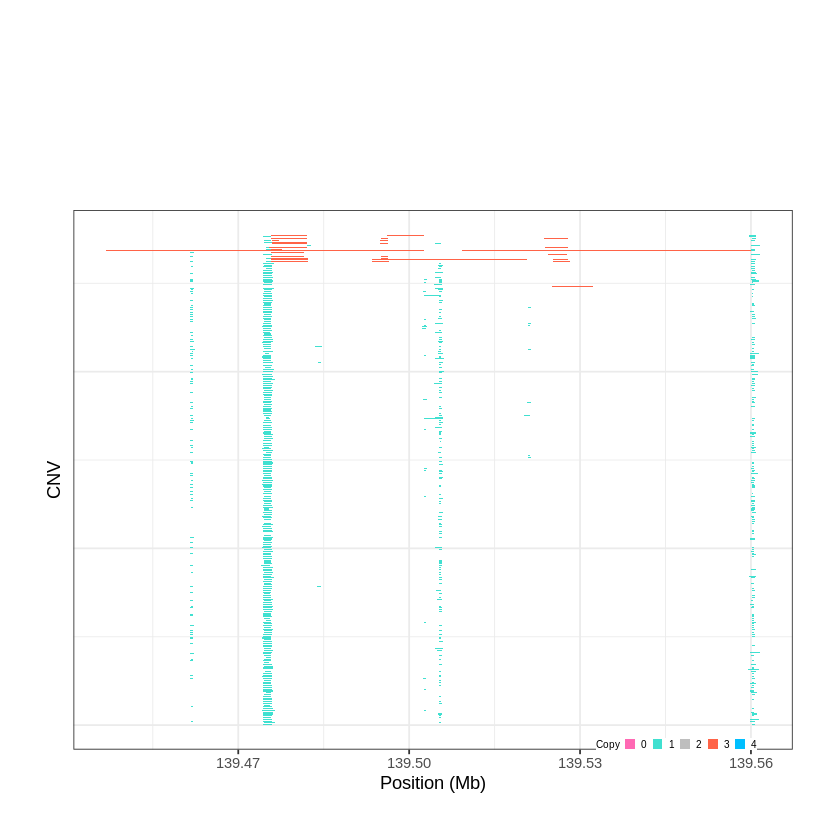

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1193..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 139.872101 - 139.876 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


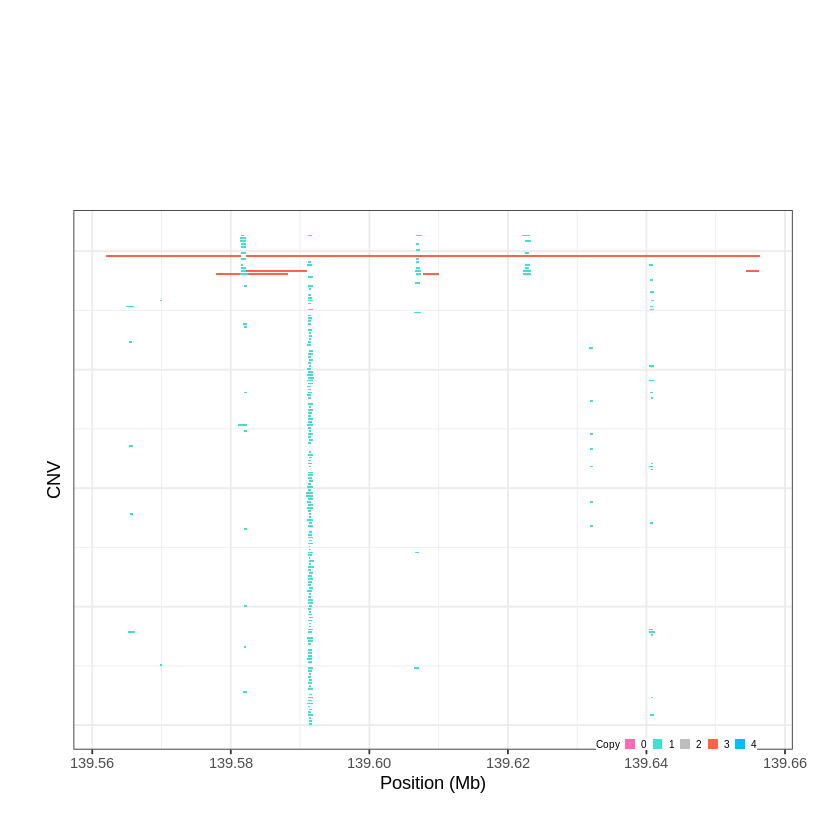

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1194..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 139.895801 - 139.923 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


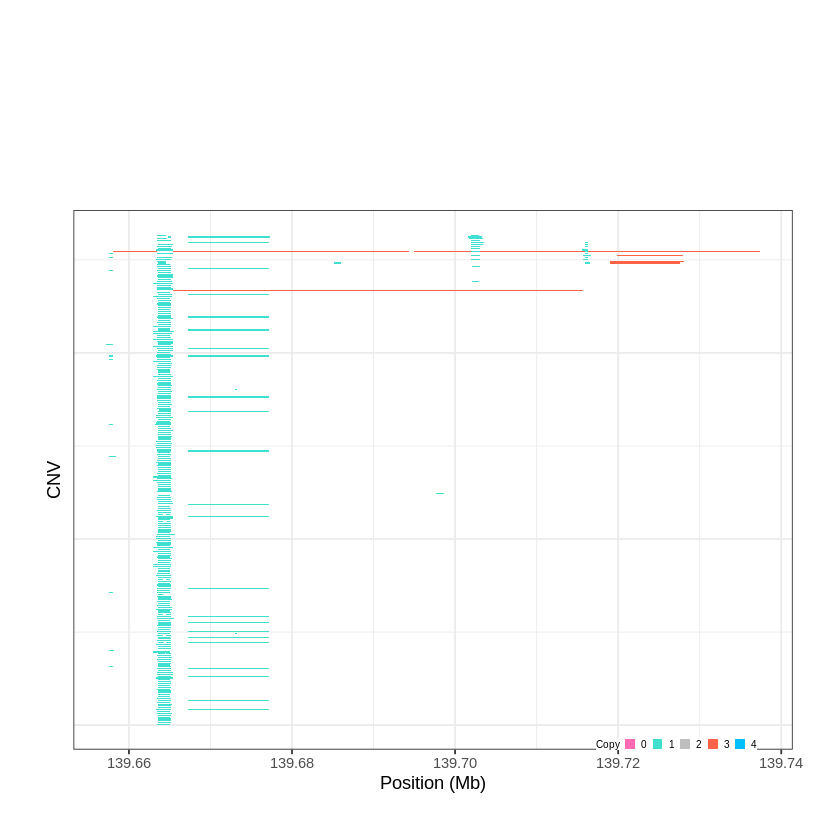

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1195..."
Input data passed requirment check...
[1] "CNV on Chromosome 9: 140.189601 - 141.2135 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


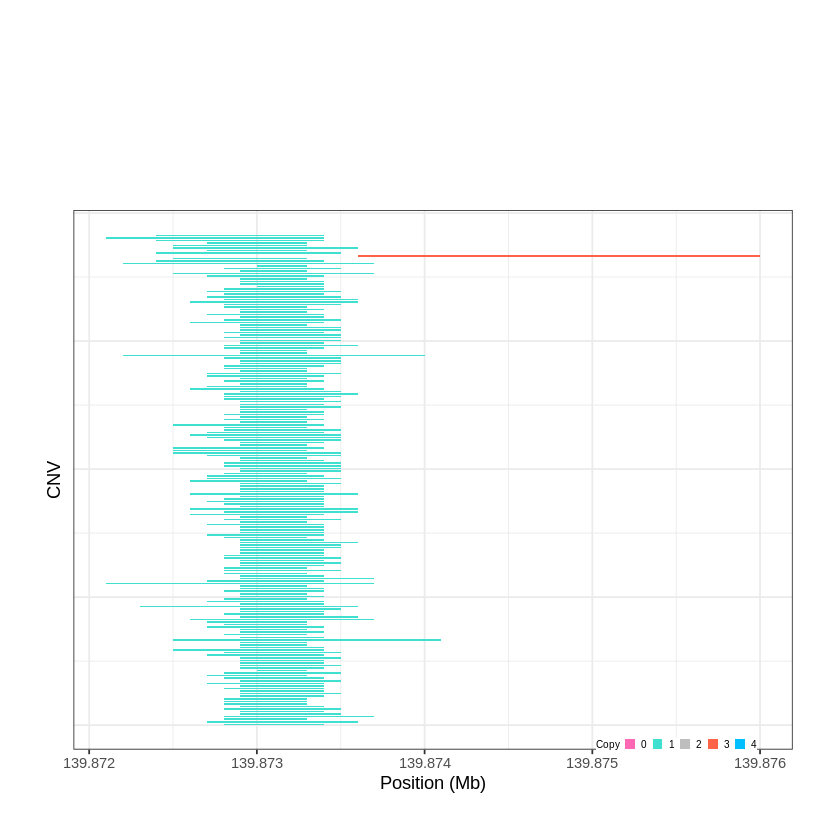

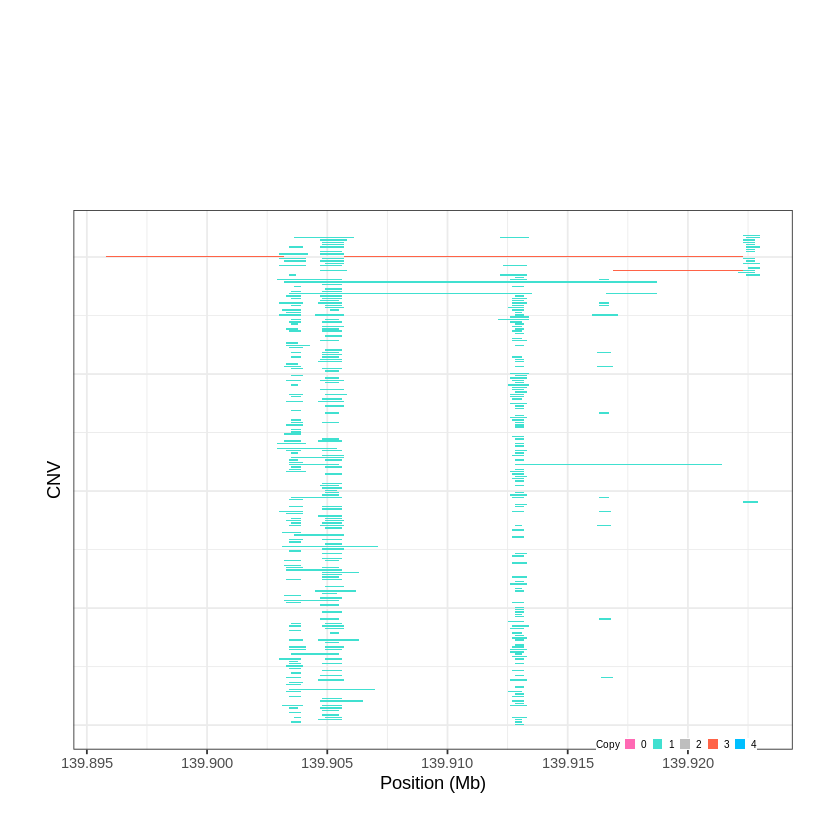

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1196..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 1e-06 - 0.1689 Mb with 279 Individual - "
Plotting gene...


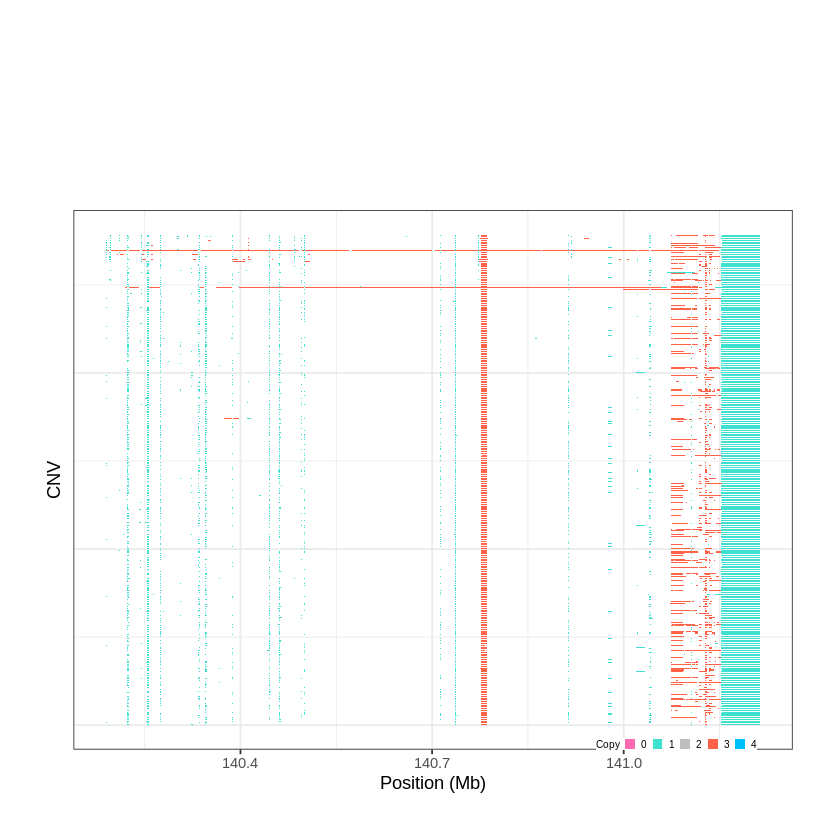

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1197..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 0.314201 - 0.7338 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1198..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 0.733901 - 0.9239 Mb with 254 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


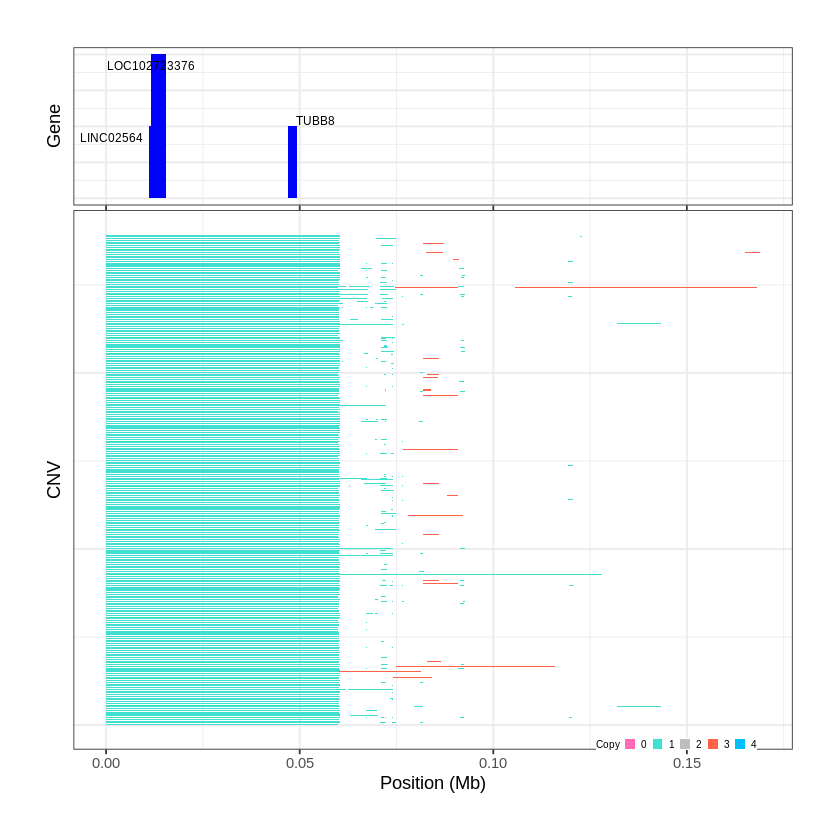

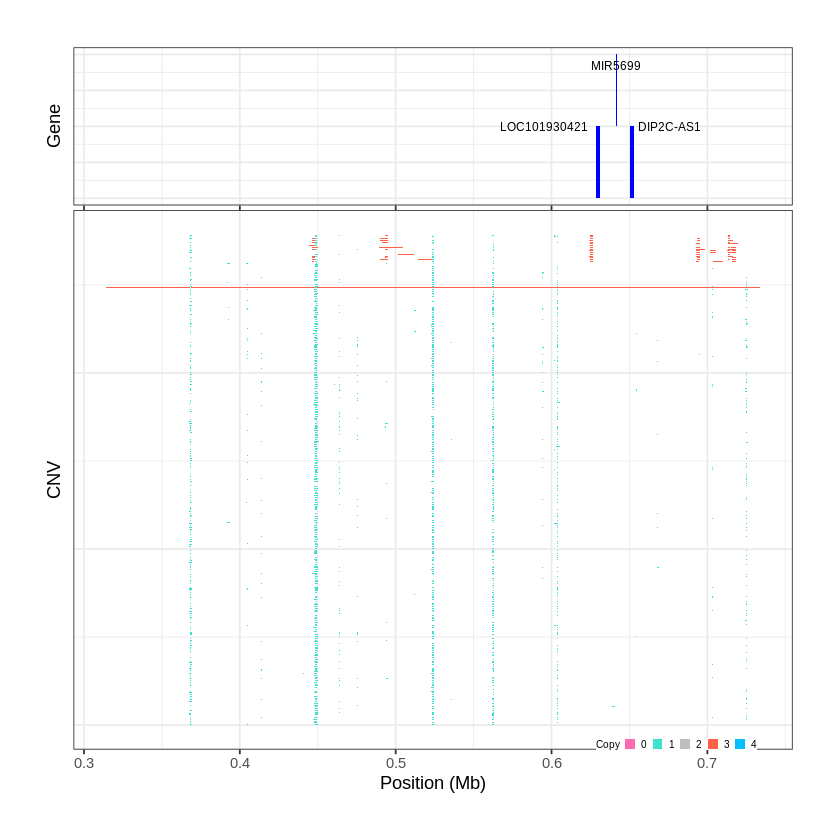

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1199..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 0.953401 - 1.3618 Mb with 231 Individual - "
Plotting gene...


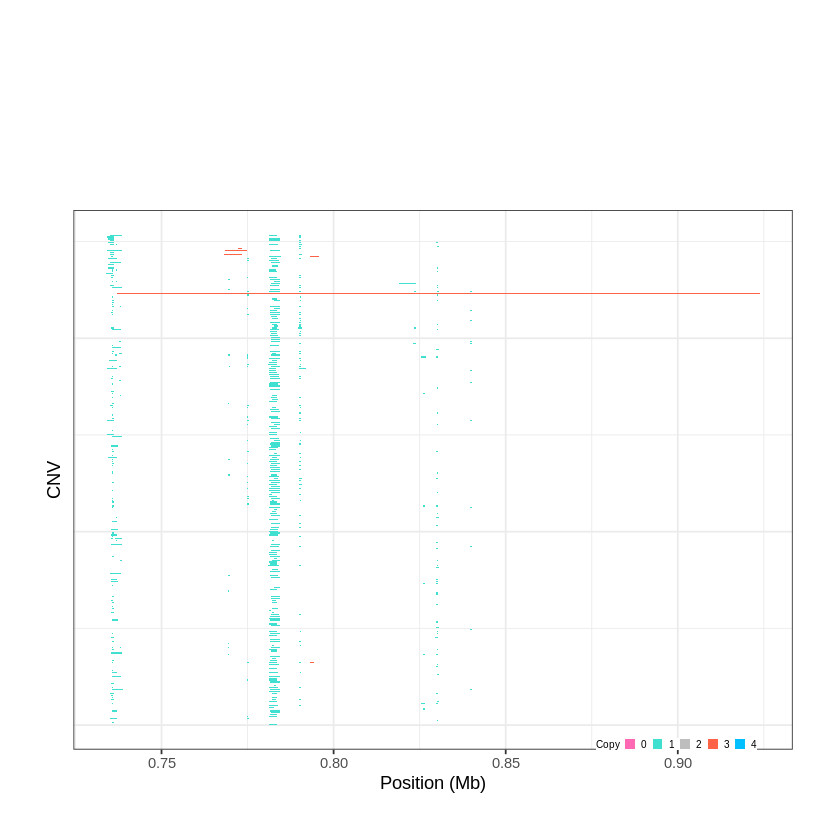

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1200..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 1.500901 - 1.8317 Mb with 276 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1201..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 3.089301 - 3.1064 Mb with 272 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


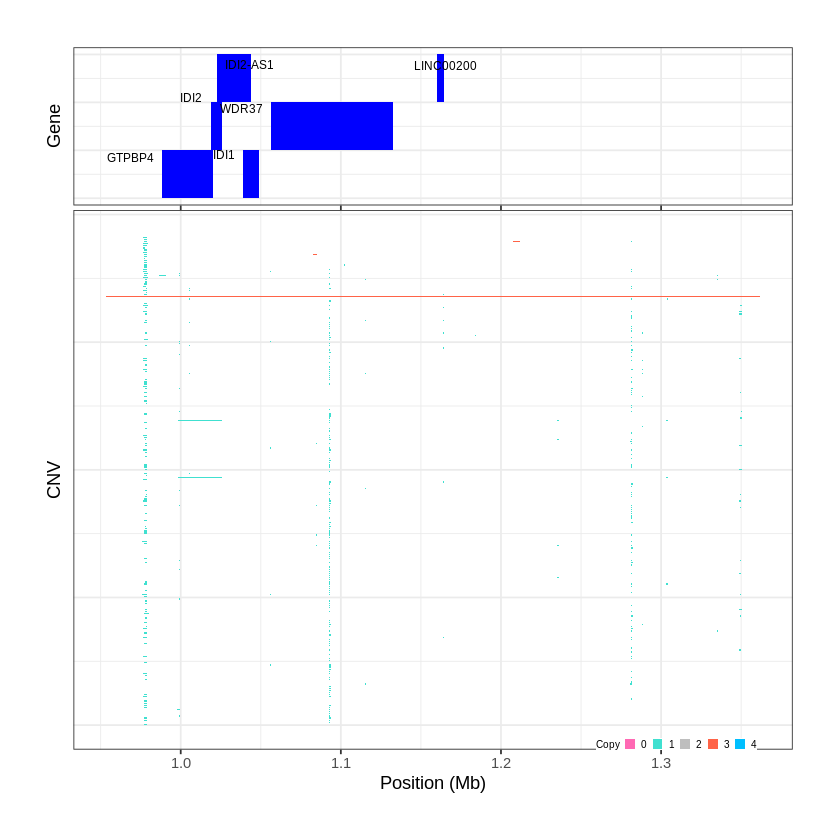

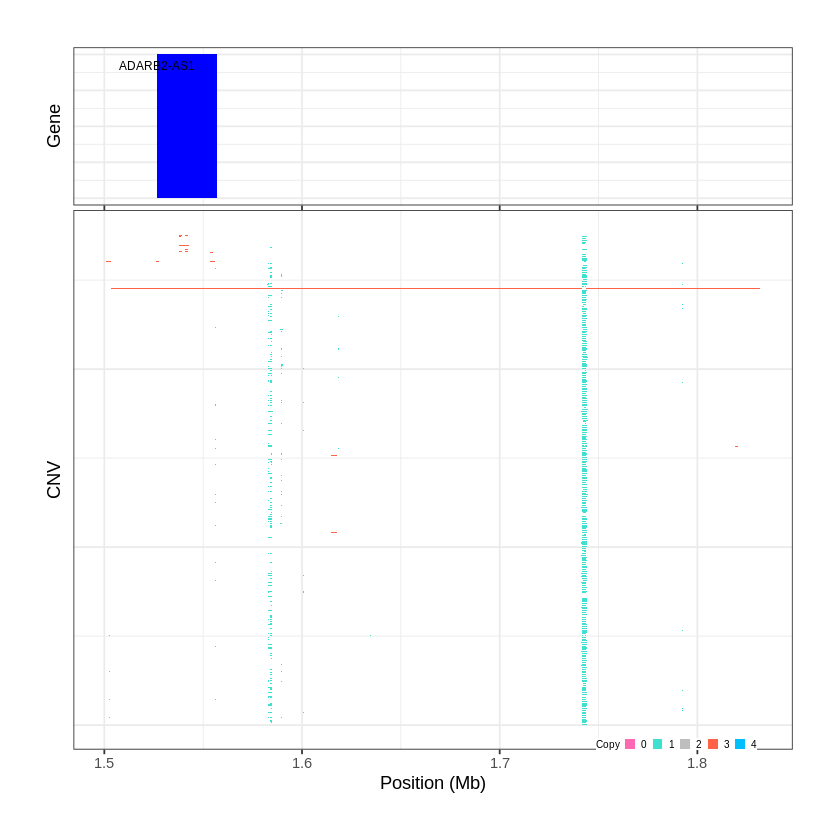

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1202..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 3.106901 - 3.4154 Mb with 240 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1203..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 4.283201 - 4.2939 Mb with 253 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


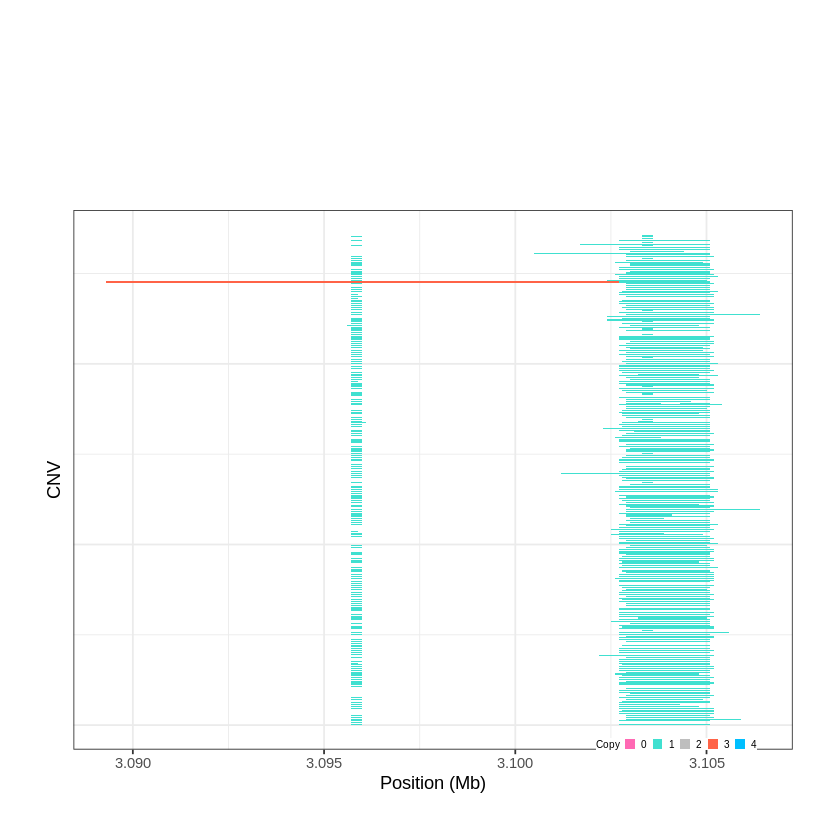

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1204..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 4.619001 - 4.6471 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


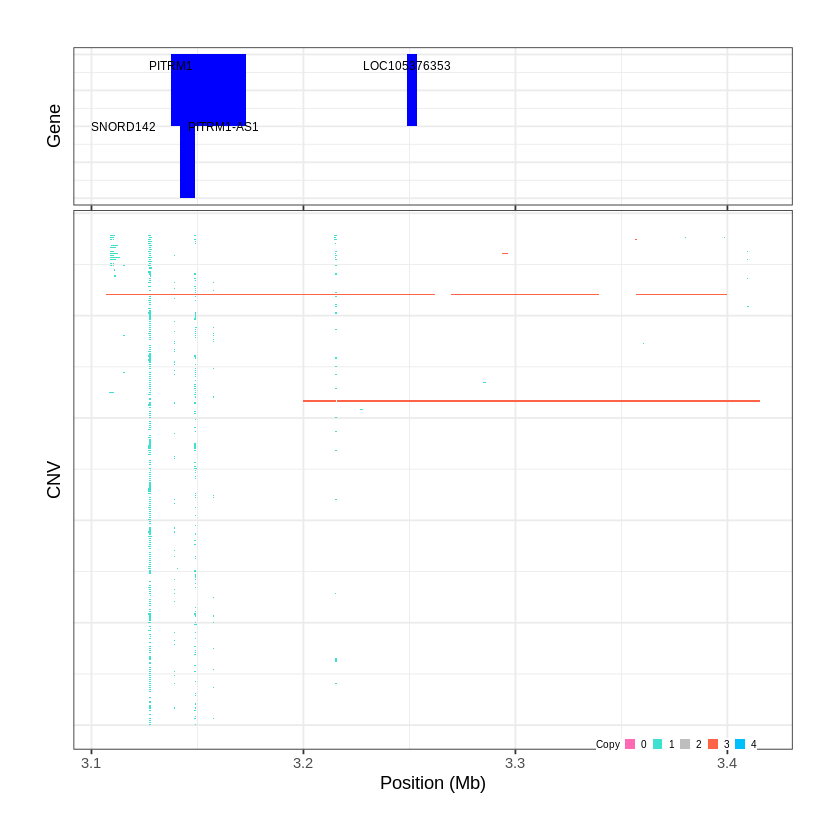

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1205..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 4.706801 - 4.7114 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


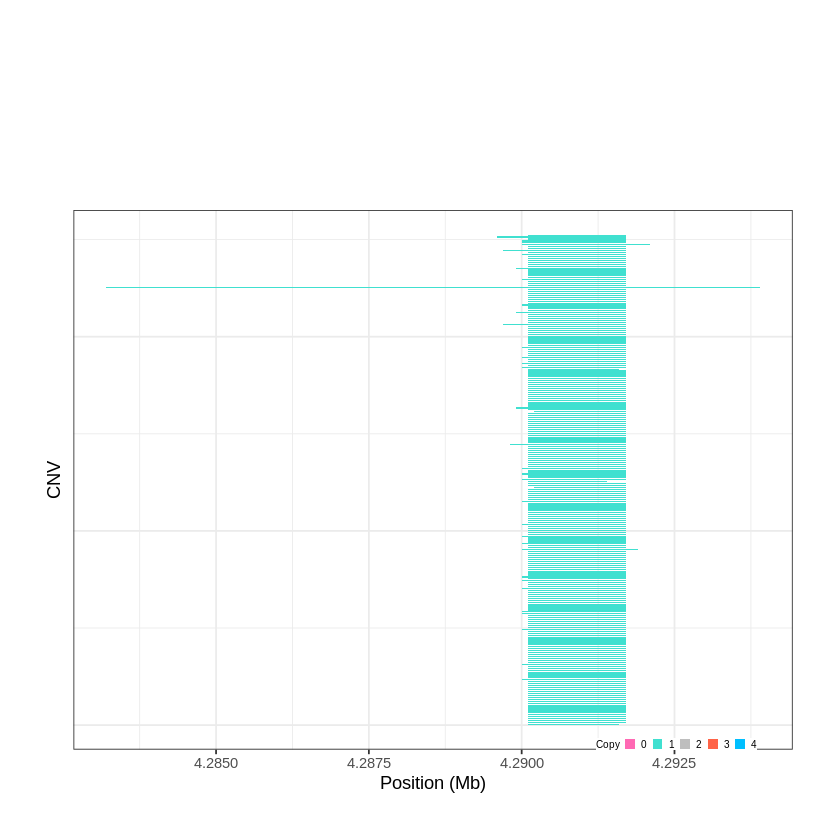

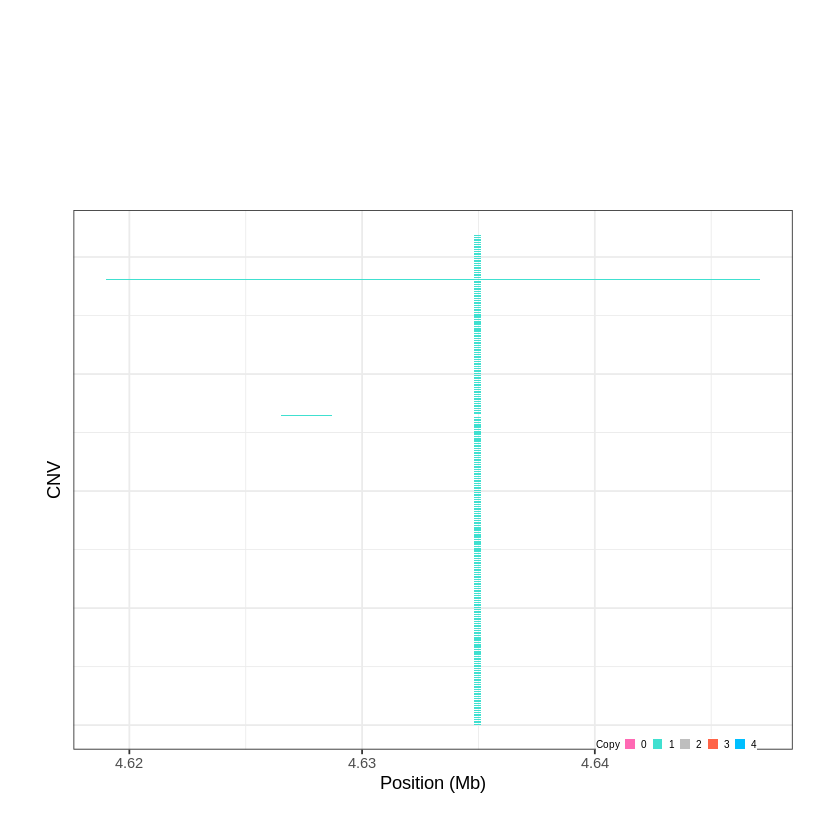

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1206..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 5.486001 - 5.7191 Mb with 151 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1207..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 5.881701 - 5.8969 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


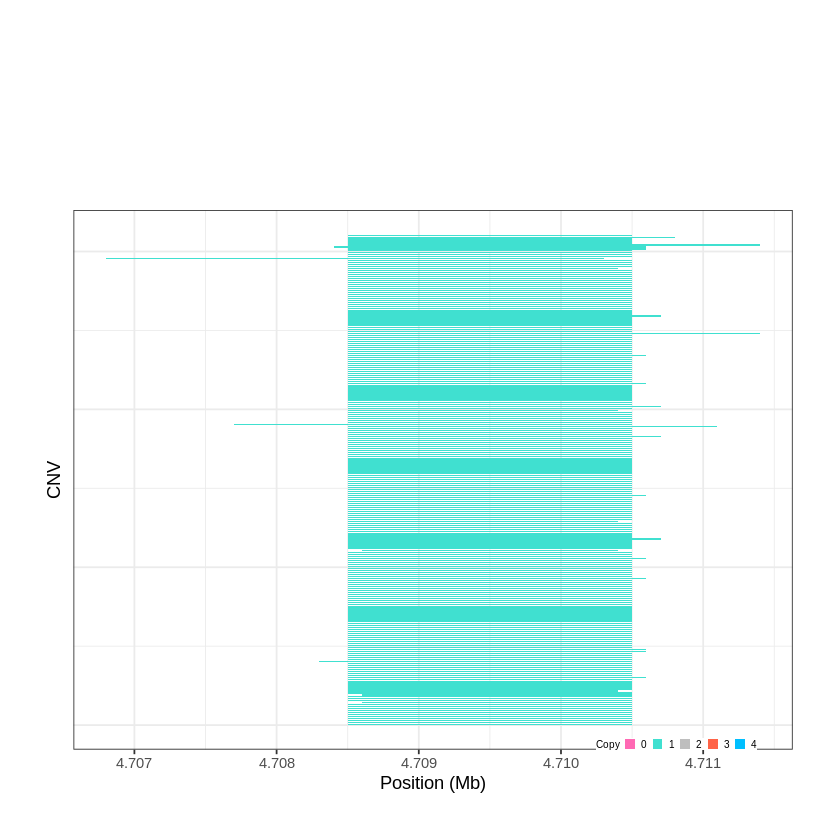

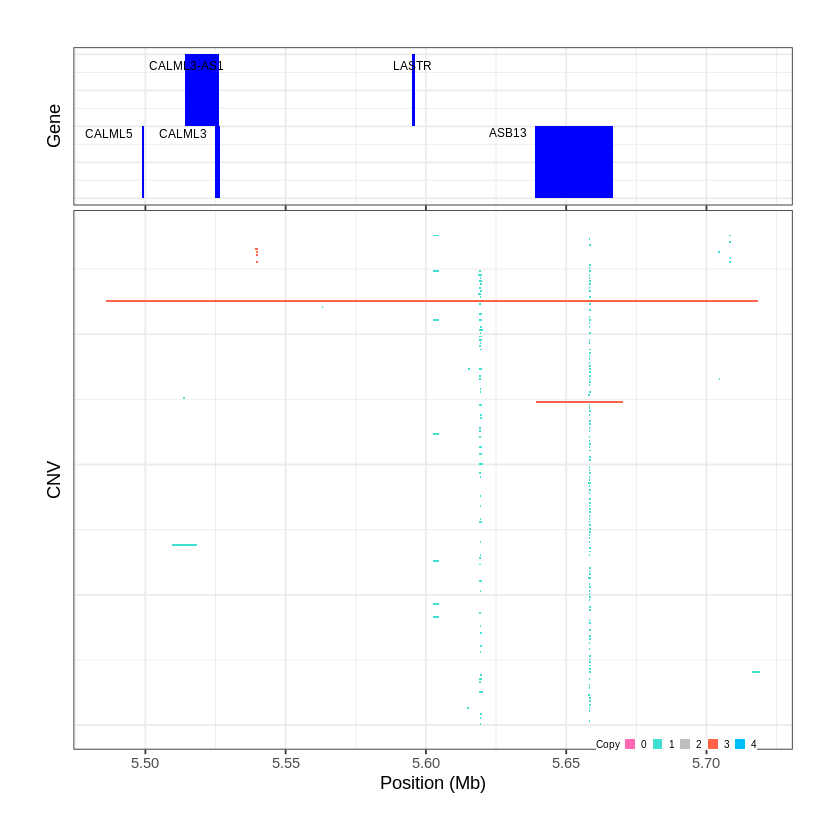

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1208..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 6.072101 - 6.3935 Mb with 235 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1209..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 6.411501 - 6.4569 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


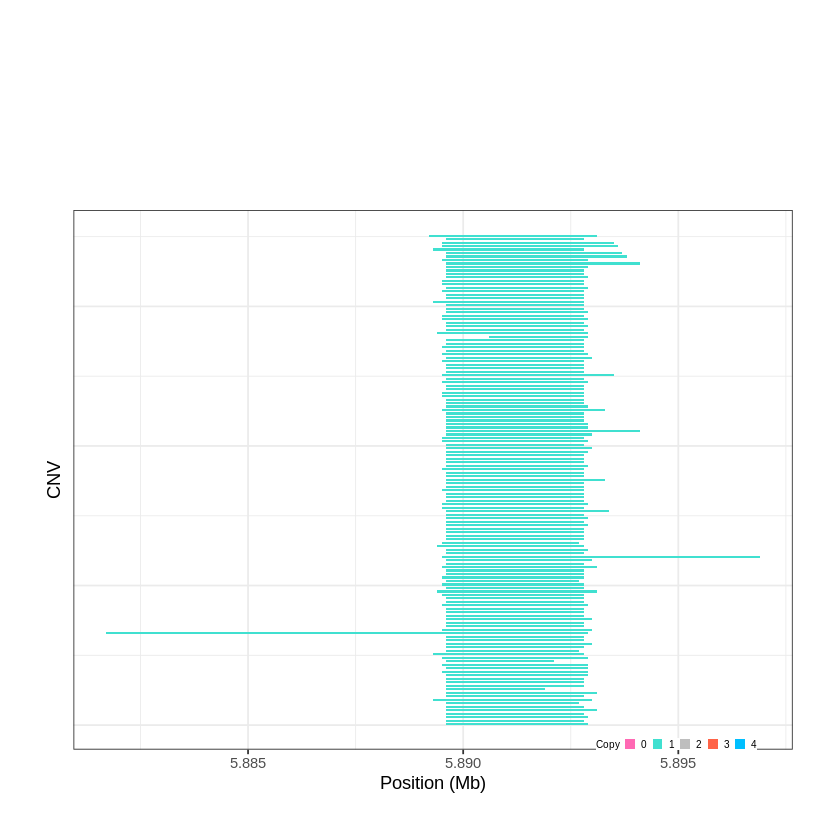

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1210..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 6.838801 - 6.8458 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


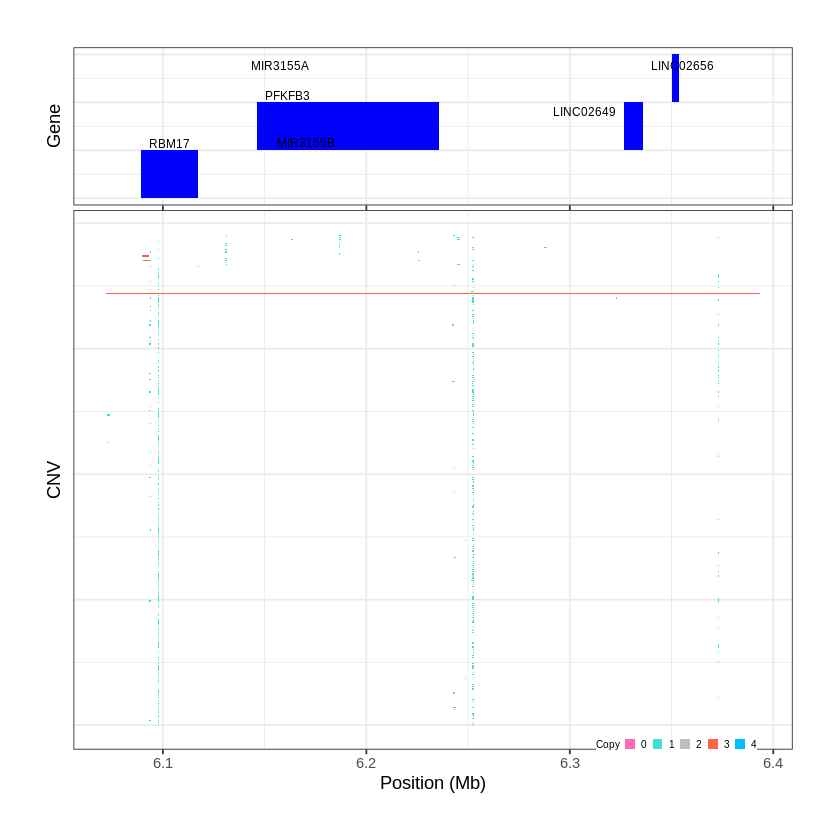

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1211..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 6.864301 - 6.907 Mb with 235 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


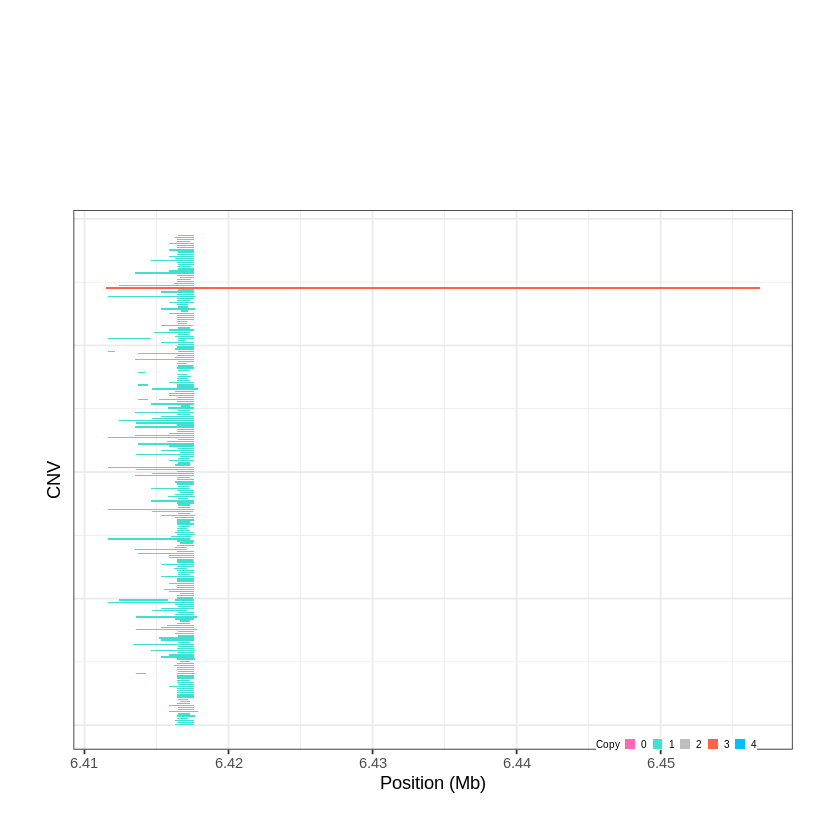

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1212..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 7.666601 - 7.7101 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


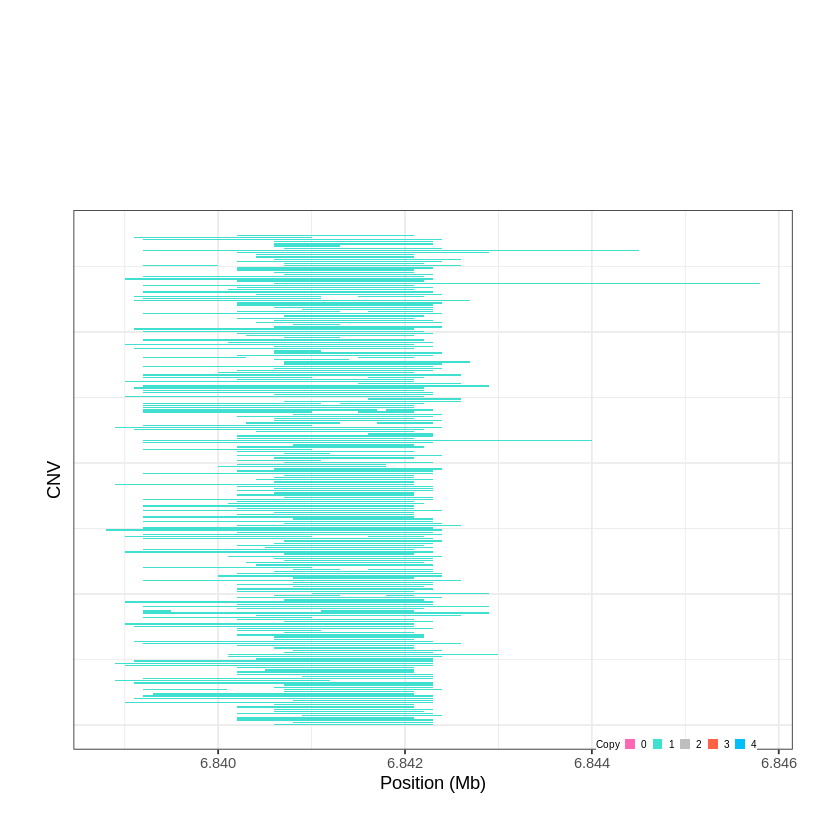

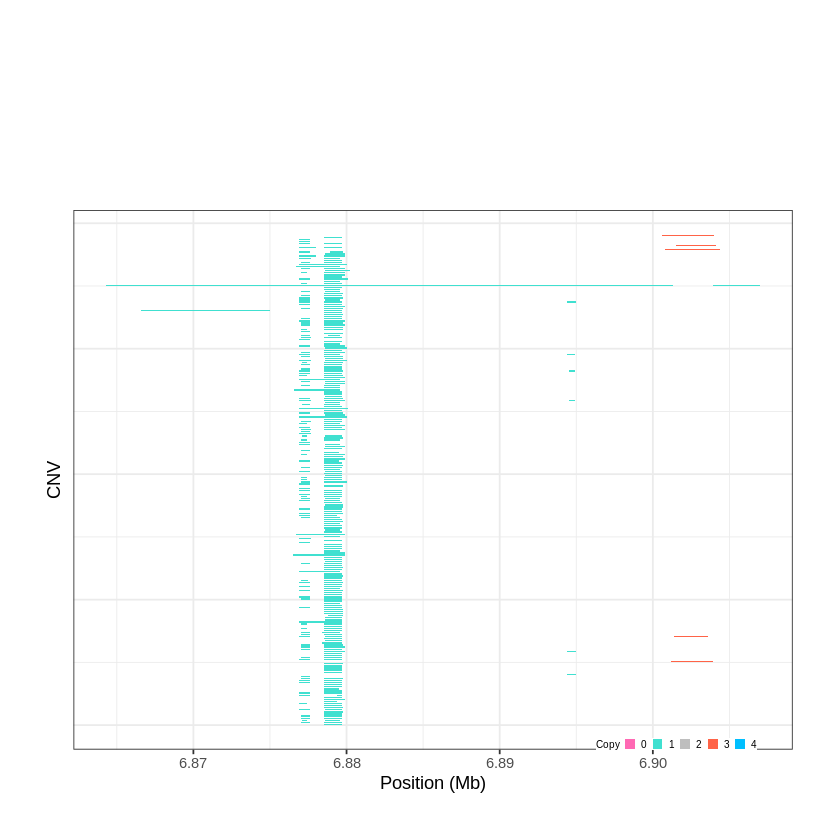

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1213..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 7.750001 - 7.8437 Mb with 150 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1214..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 9.468501 - 9.5456 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


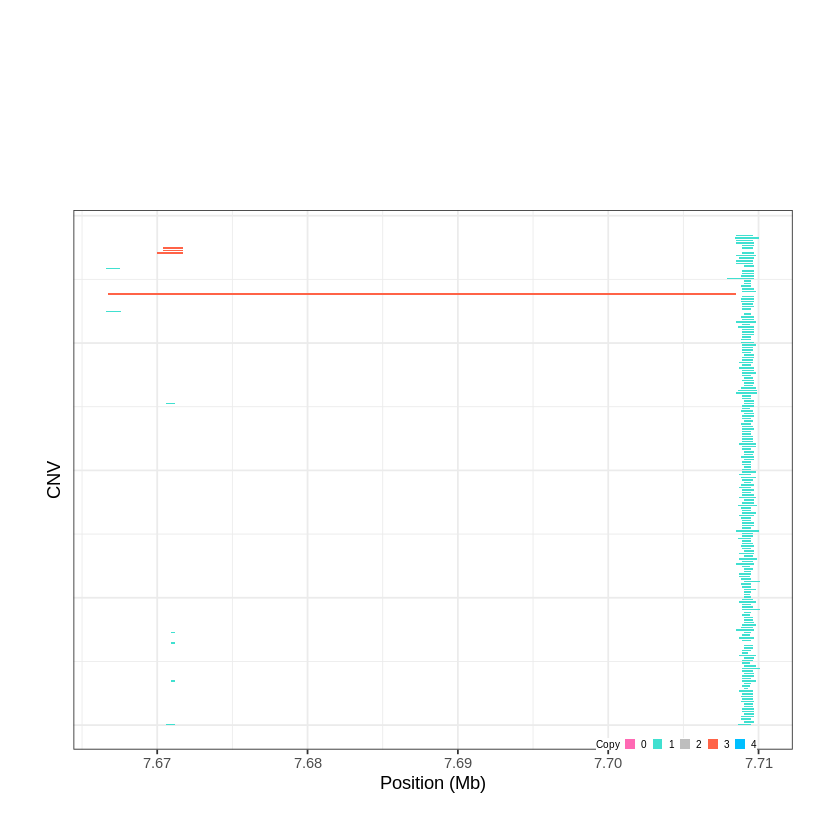

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1215..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 10.306501 - 10.3254 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


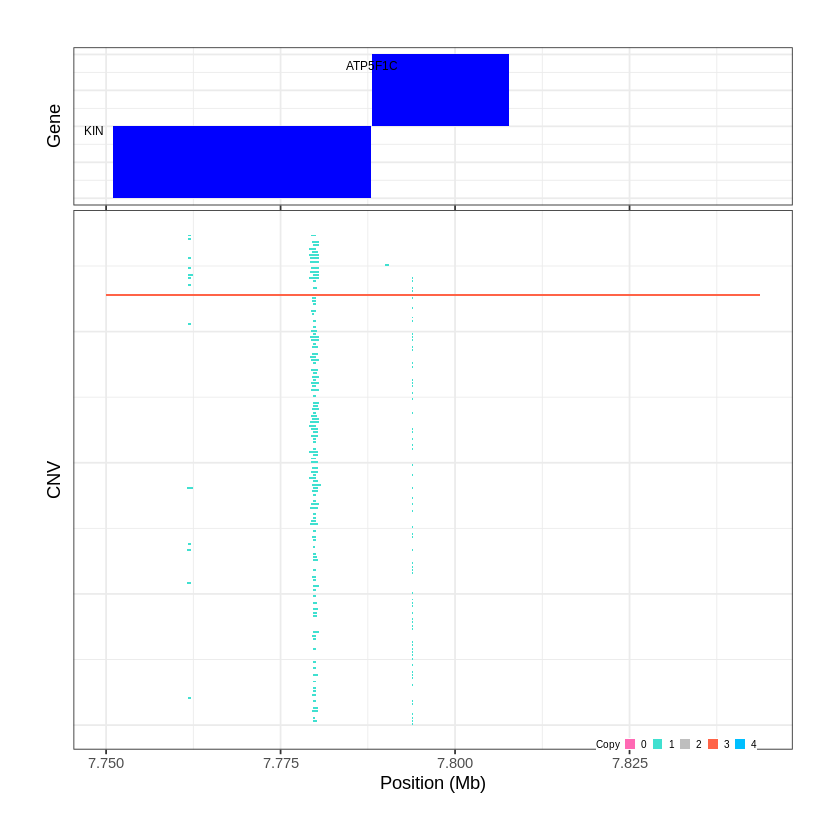

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1216..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 10.499301 - 10.5267 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


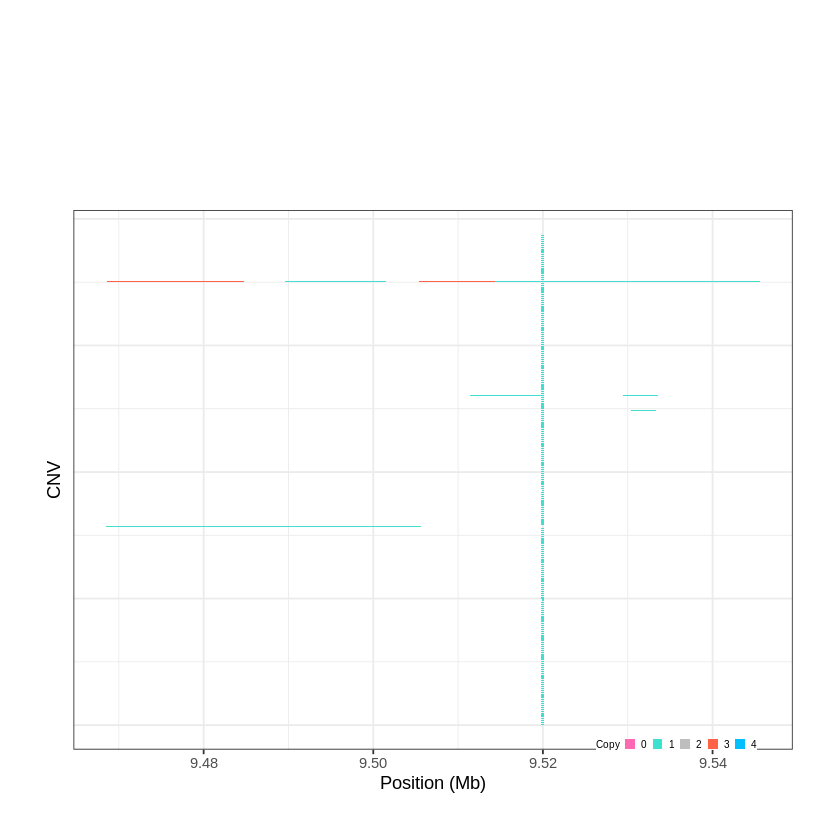

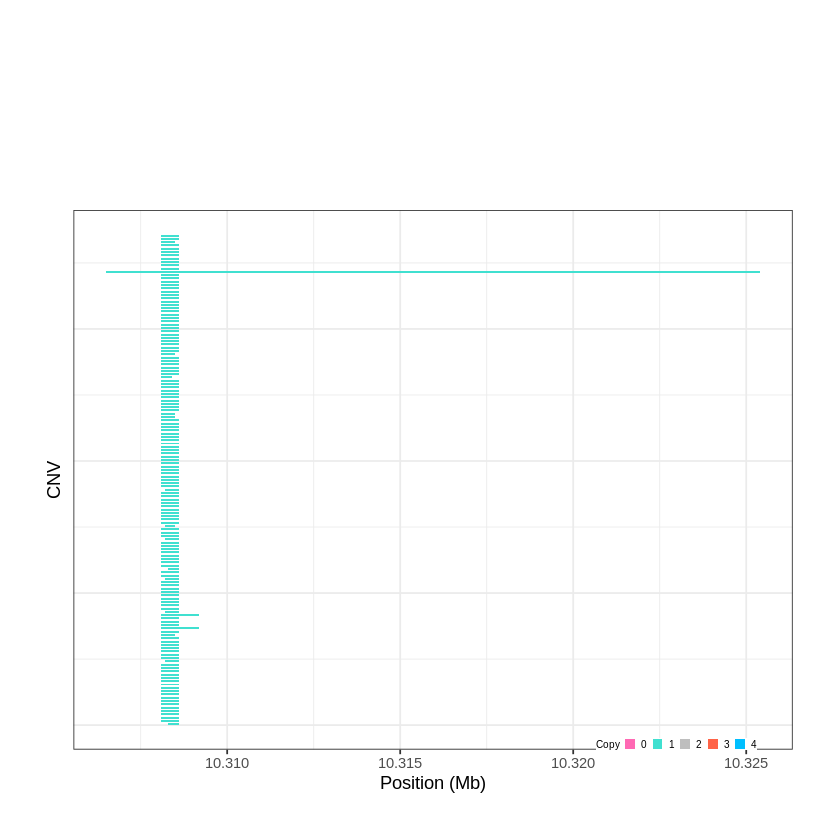

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1217..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 11.310201 - 11.5152 Mb with 242 Individual - "
Plotting gene...


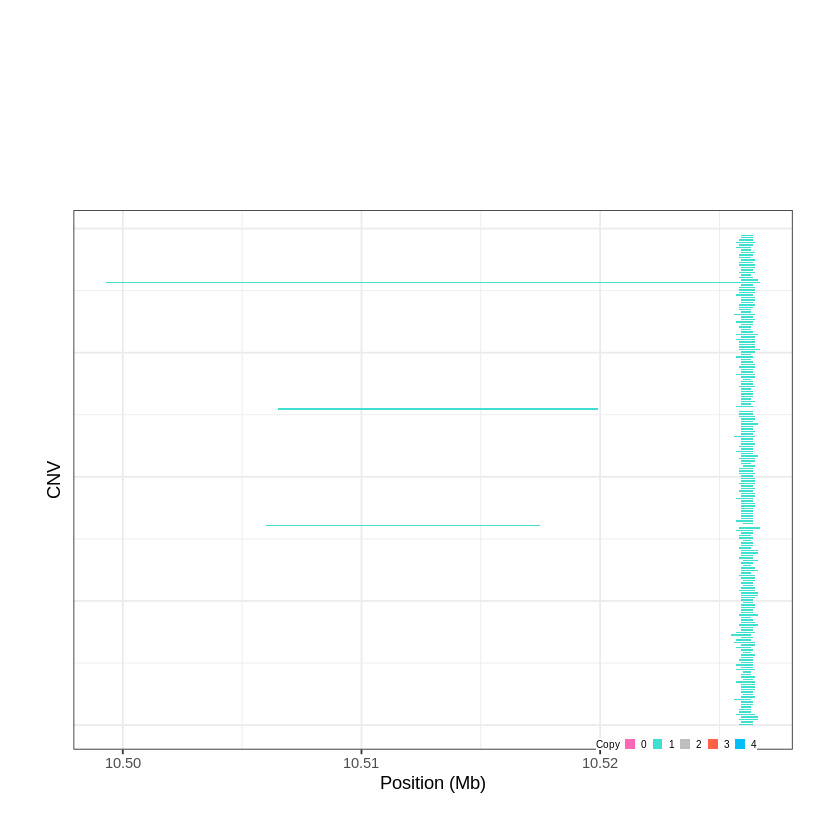

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1218..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 11.668401 - 11.7804 Mb with 165 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1219..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 12.542201 - 12.5655 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


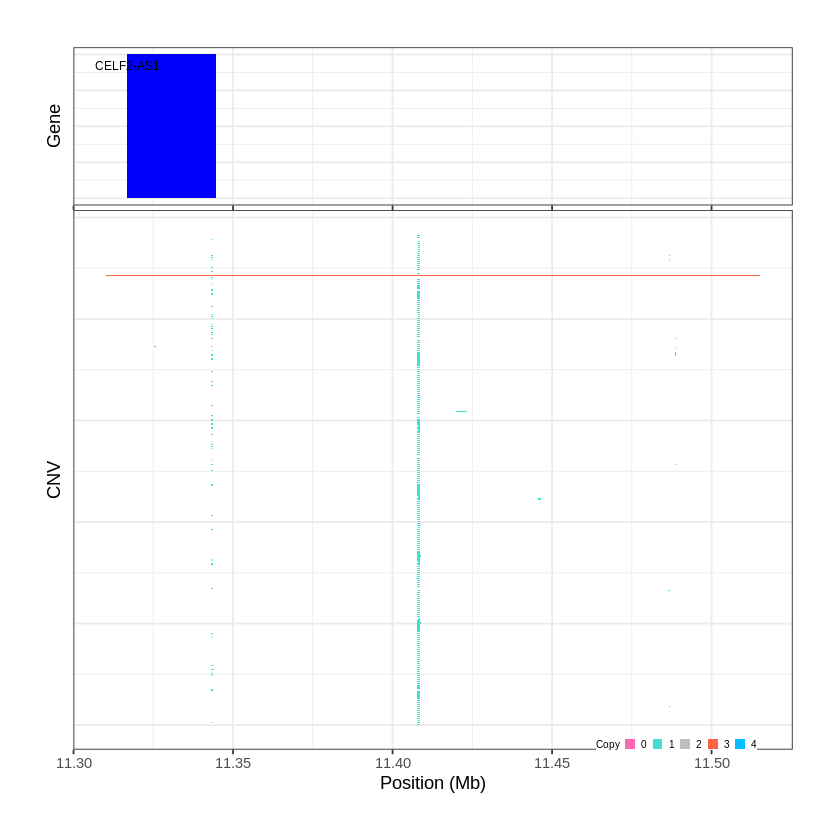

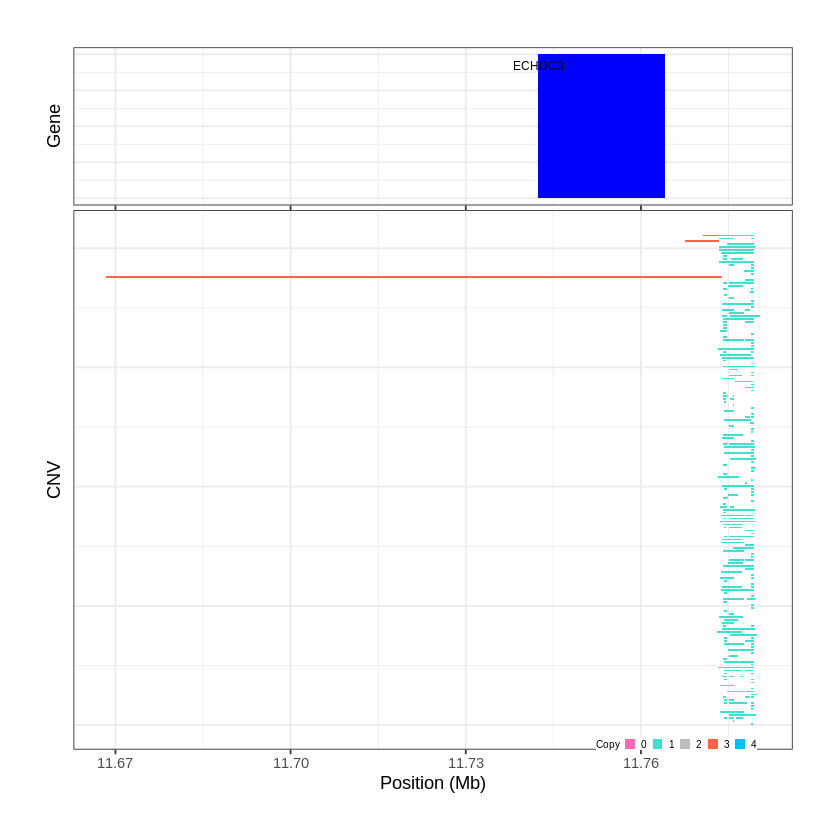

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1220..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 12.565801 - 12.8124 Mb with 219 Individual - "
Plotting gene...


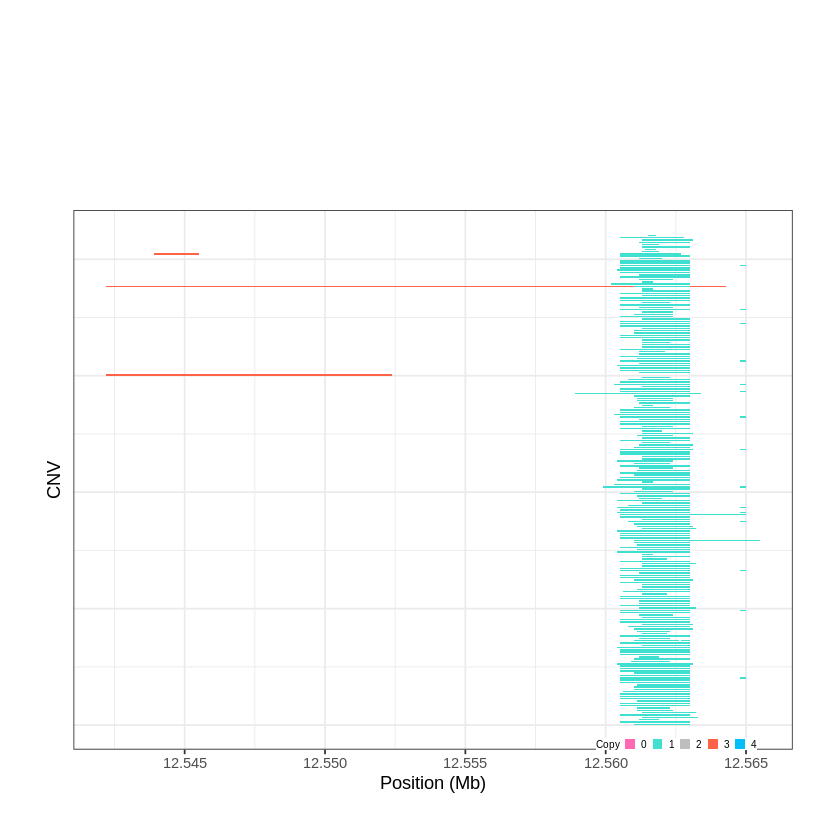

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1221..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 17.727301 - 18.226 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1222..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 18.458501 - 18.5185 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


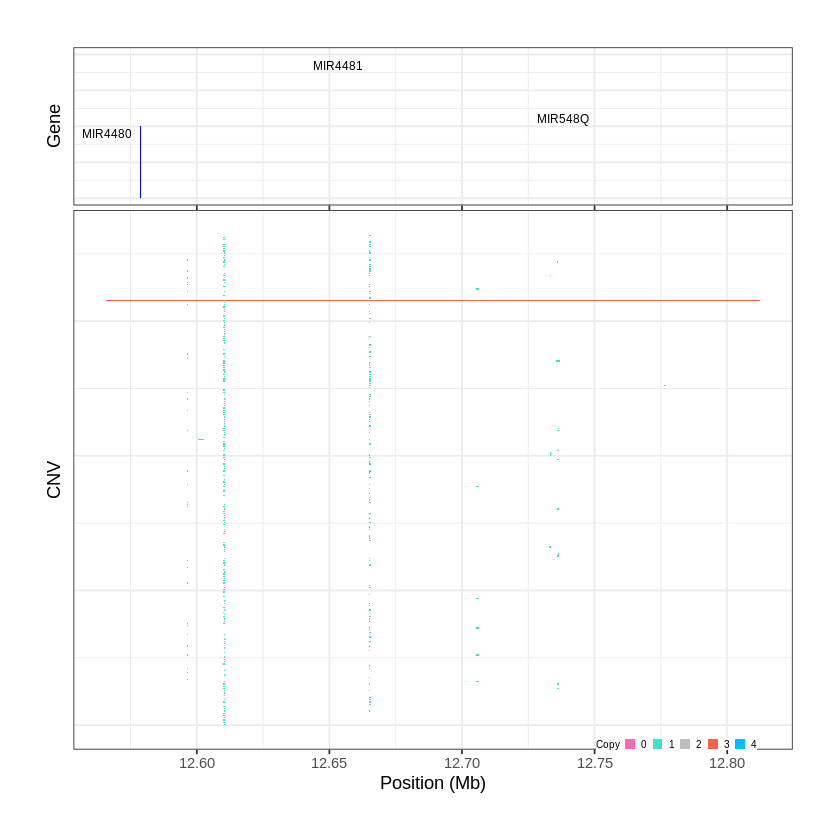

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1223..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 18.931401 - 19.4305 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


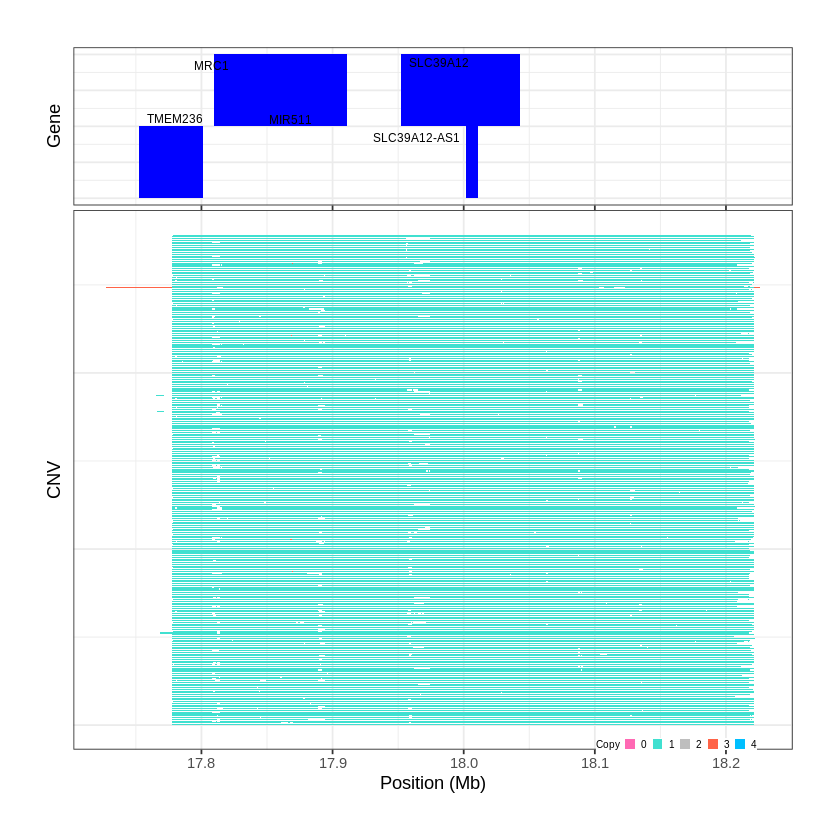

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1224..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 19.983901 - 19.9985 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


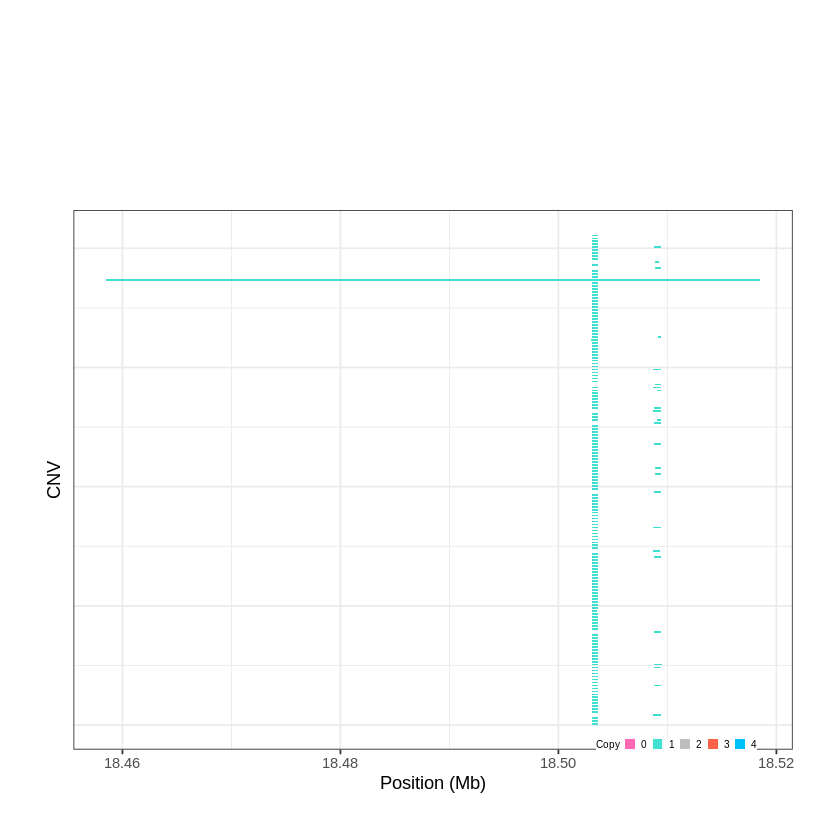

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1225..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 26.996901 - 27.0034 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


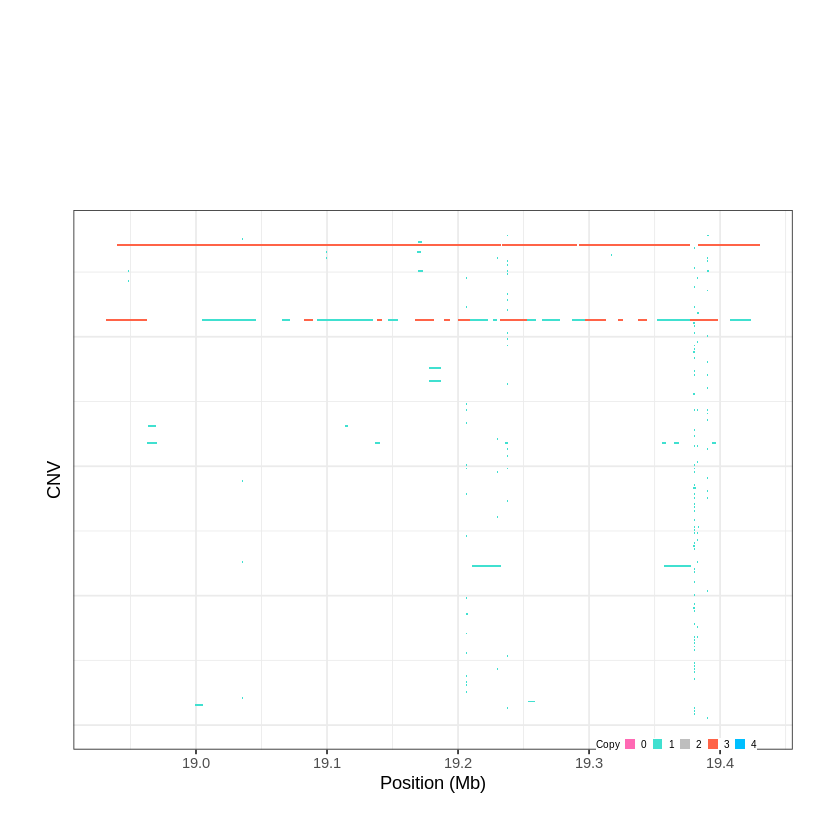

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1226..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 27.730901 - 27.733 Mb with 181 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


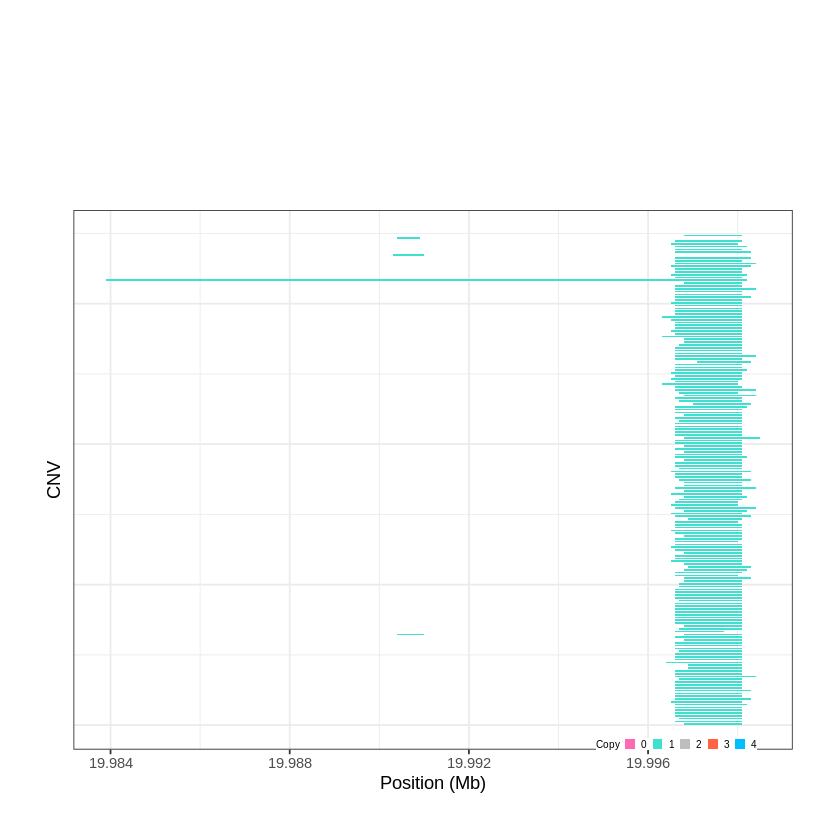

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1227..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 31.442801 - 31.4585 Mb with 181 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


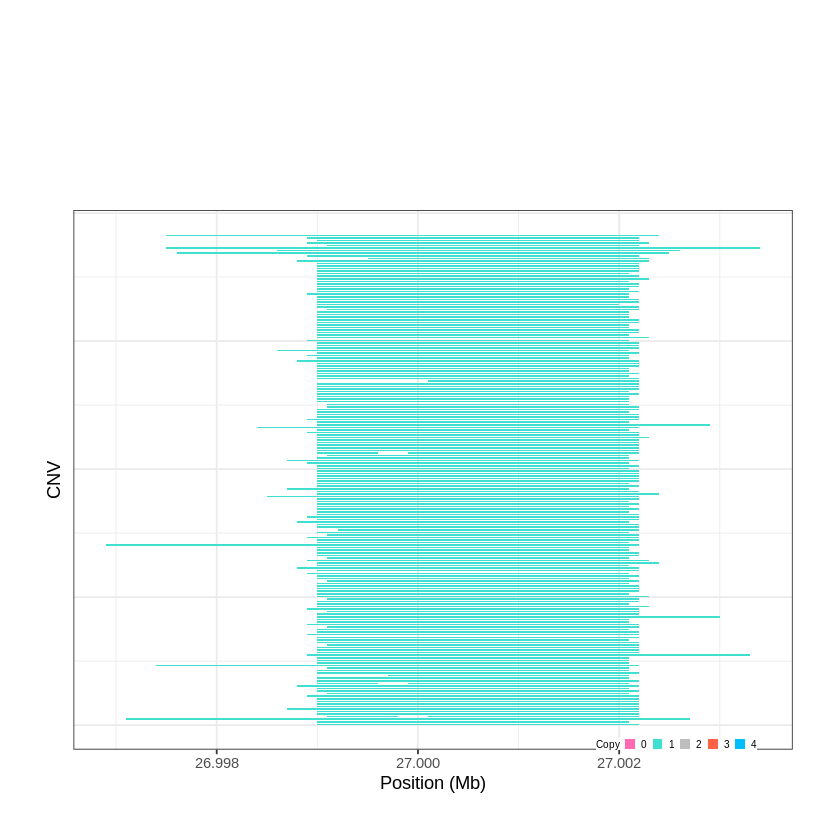

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1228..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 32.705701 - 32.7061 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


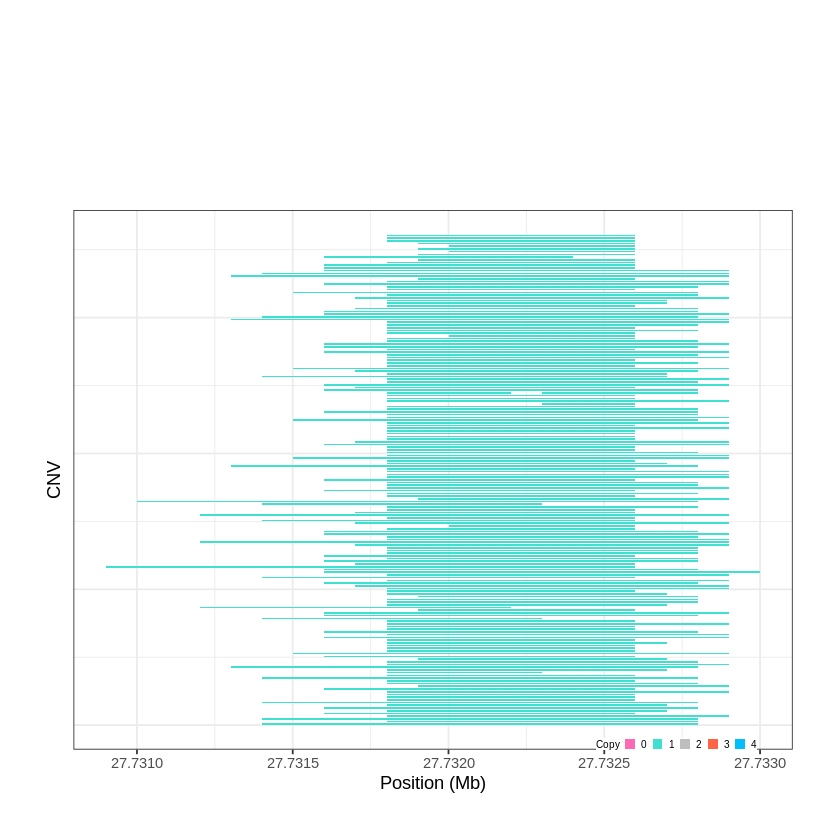

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1229..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 33.416501 - 33.4175 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


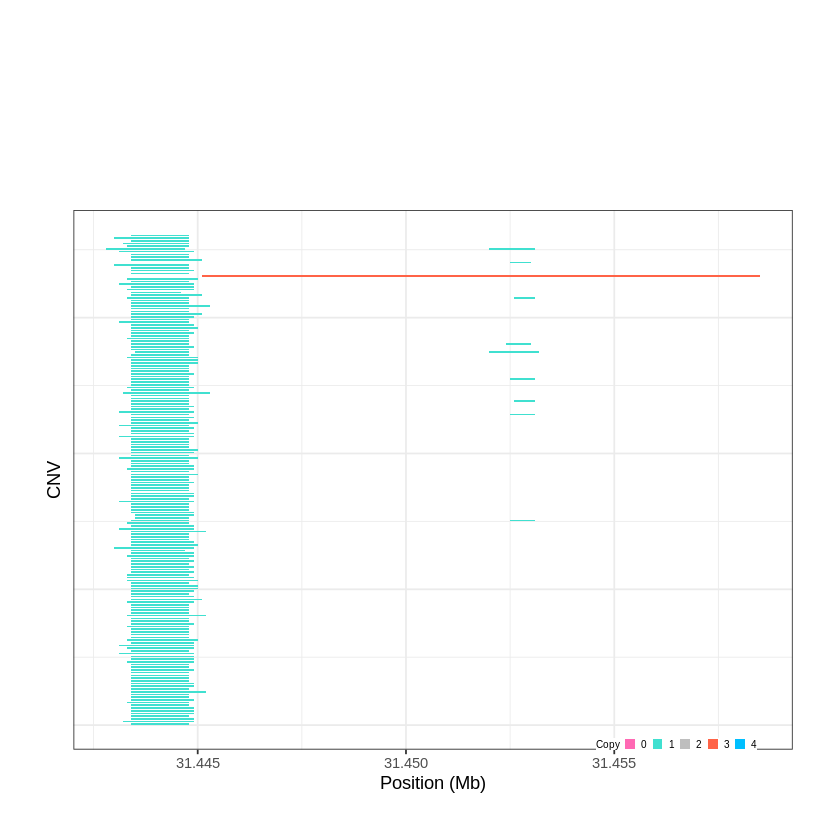

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1230..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 36.296401 - 36.303 Mb with 212 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


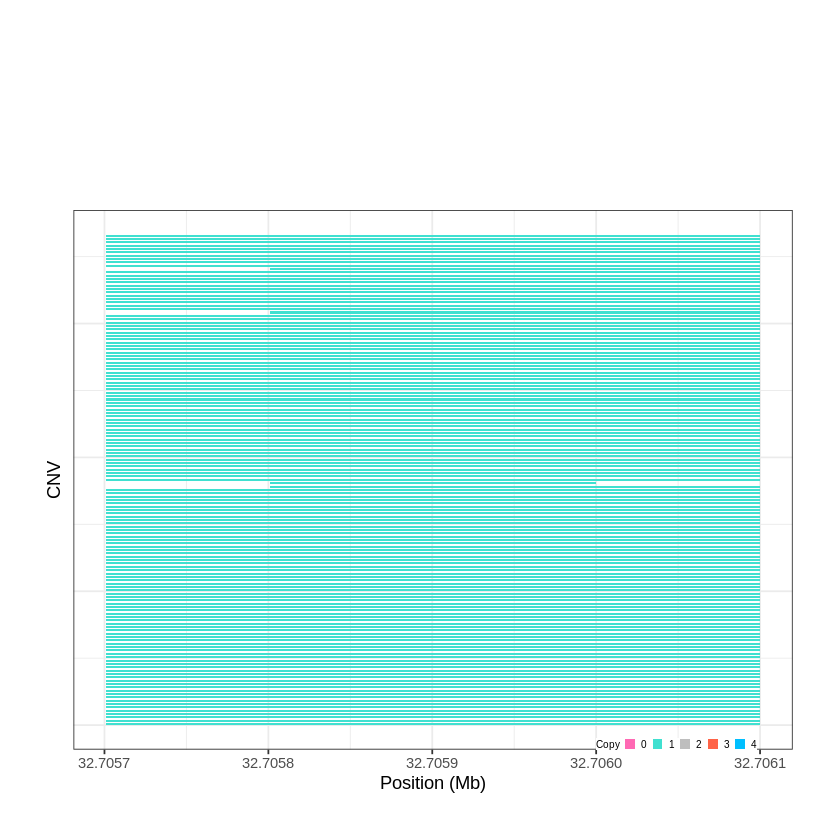

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1231..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 37.002401 - 37.0823 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


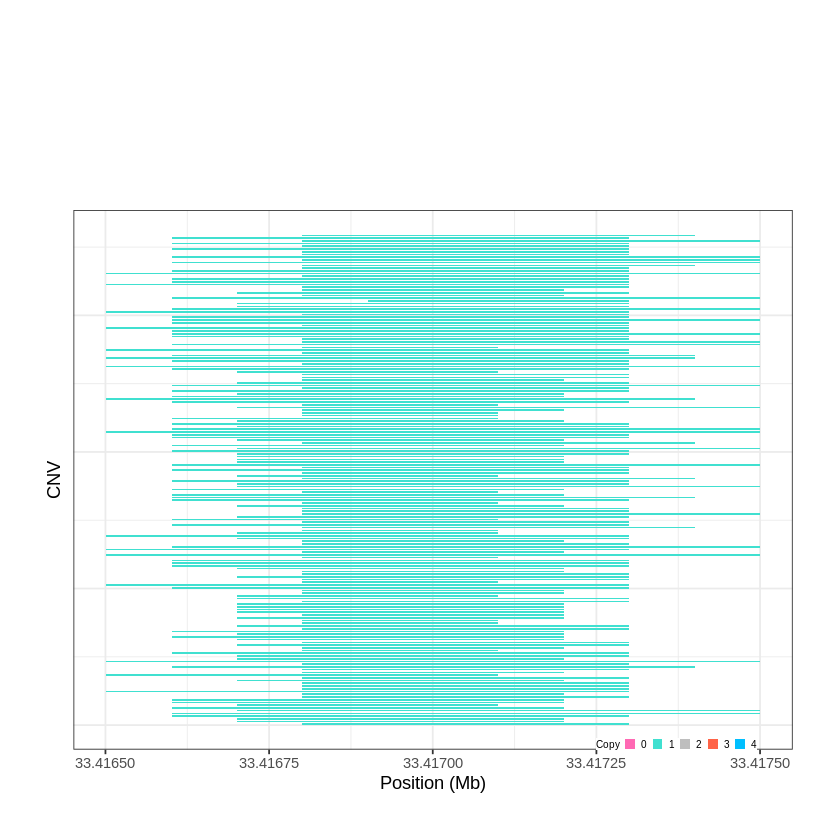

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1232..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 37.429601 - 37.4858 Mb with 239 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


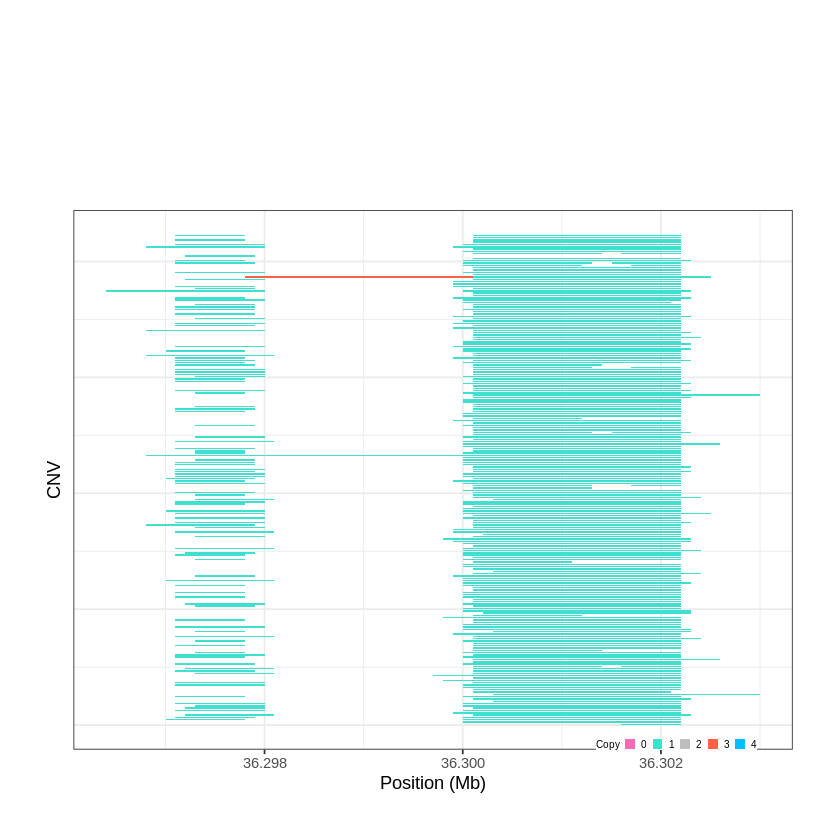

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1233..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 38.554601 - 38.5954 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


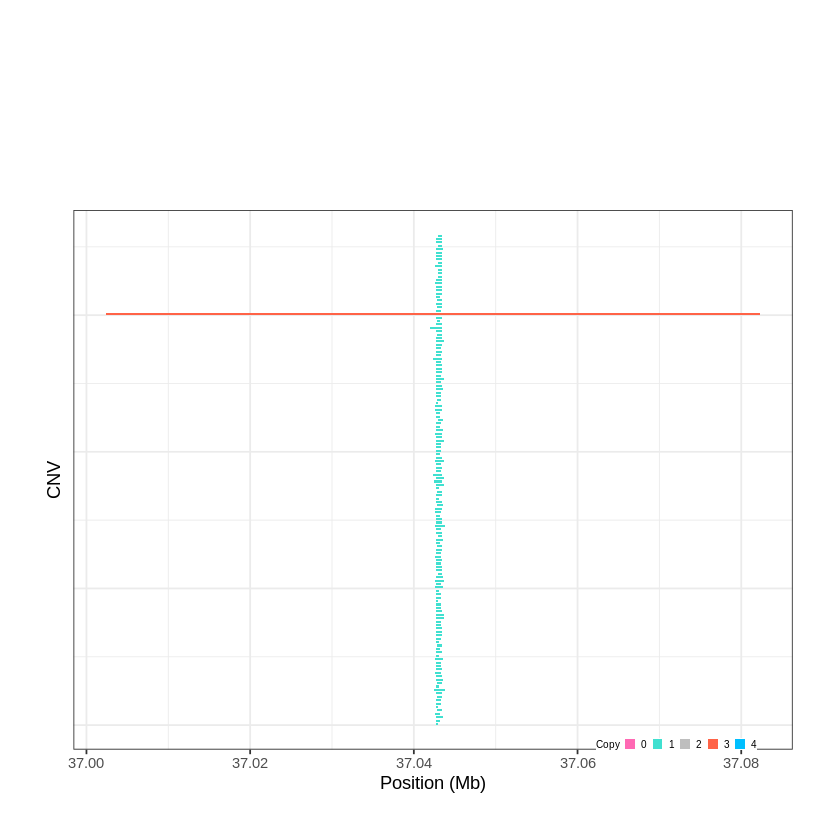

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1234..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 38.757401 - 38.8188 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


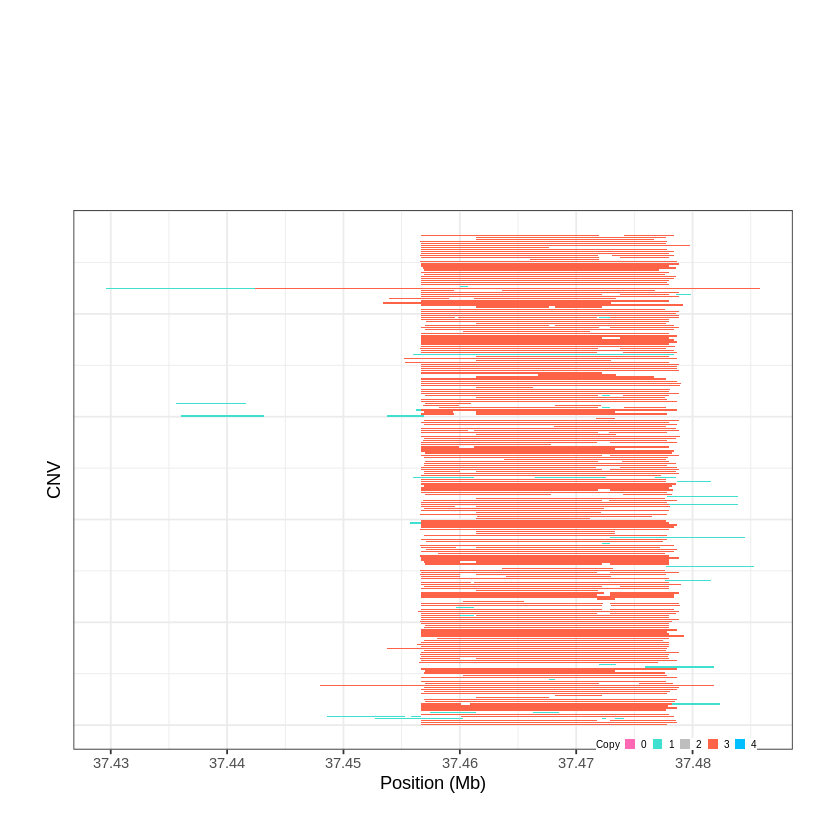

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1235..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 38.818801 - 38.908 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


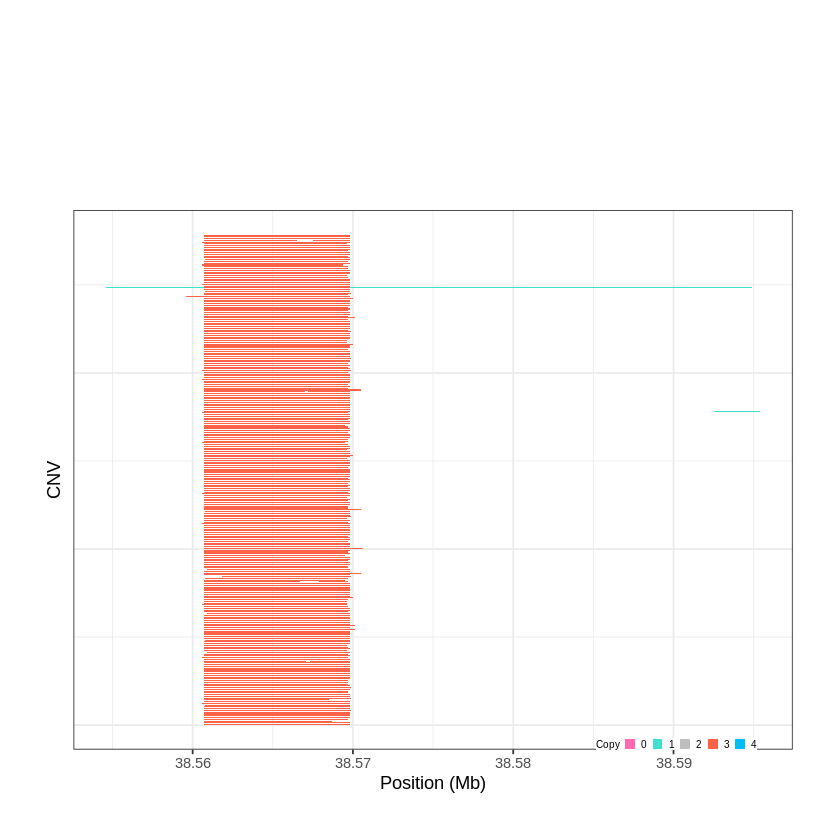

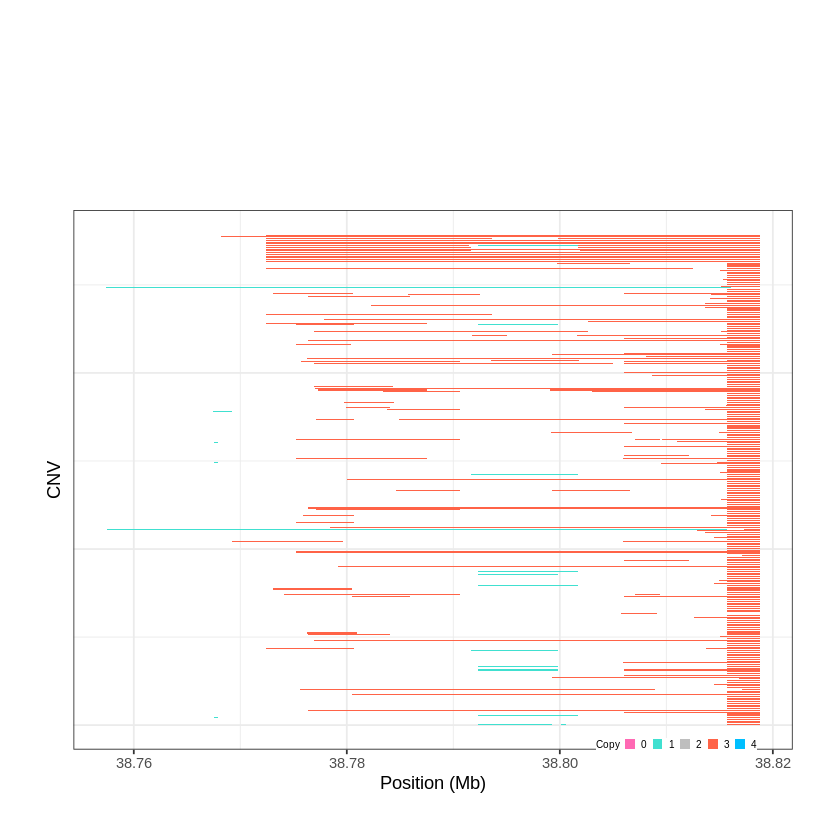

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1236..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 39.068301 - 42.9459 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


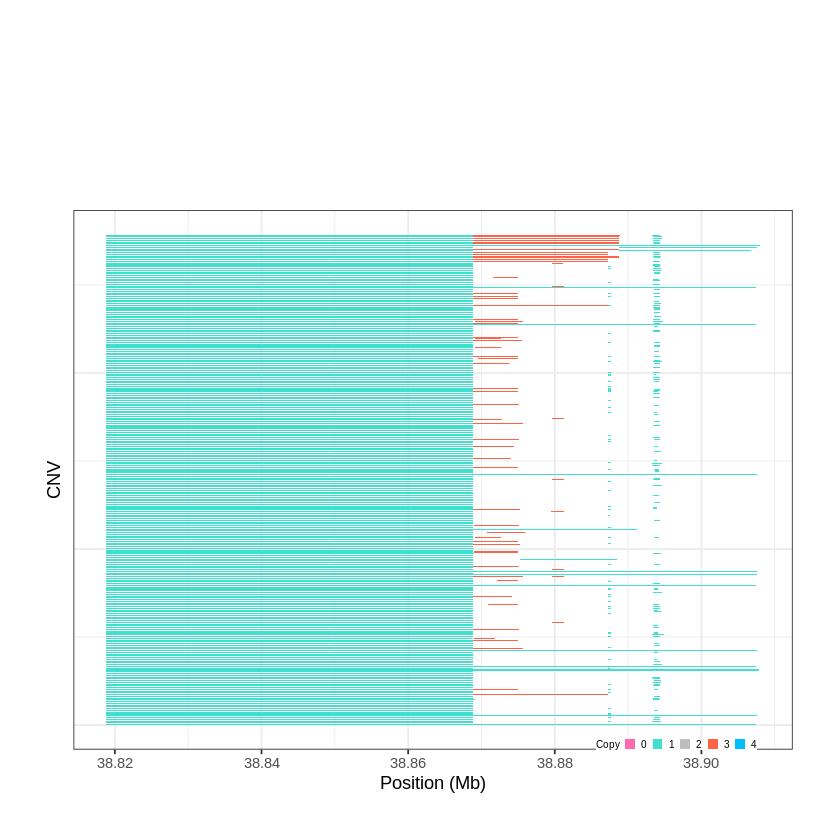

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1237..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 43.515301 - 44.0282 Mb with 153 Individual - "
Plotting gene...


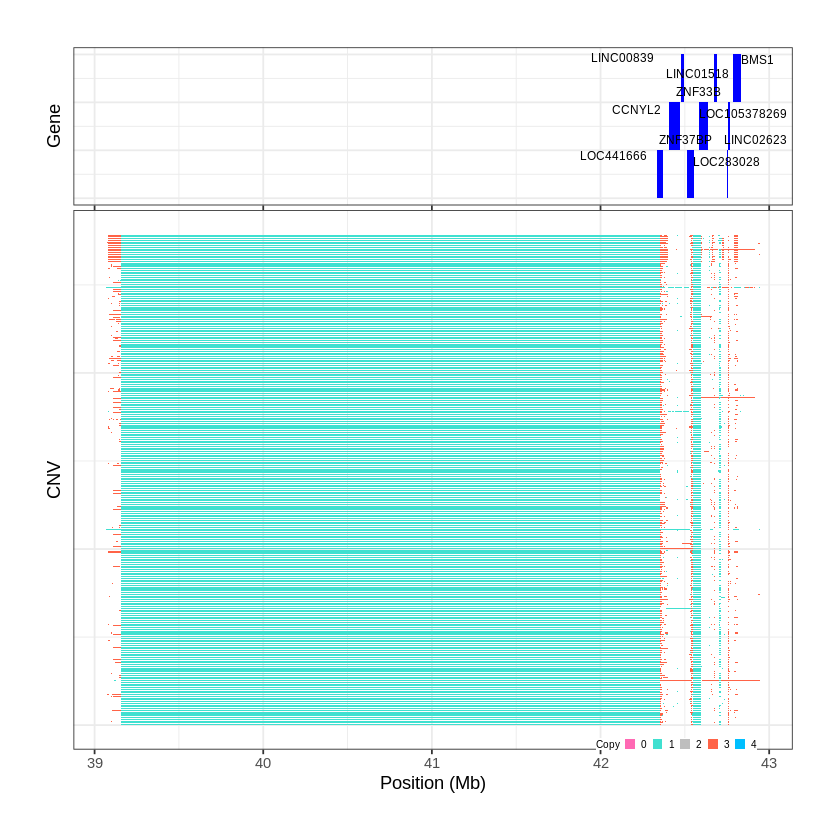

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1238..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 46.235101 - 48.3016 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1239..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 48.543201 - 48.5607 Mb with 201 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


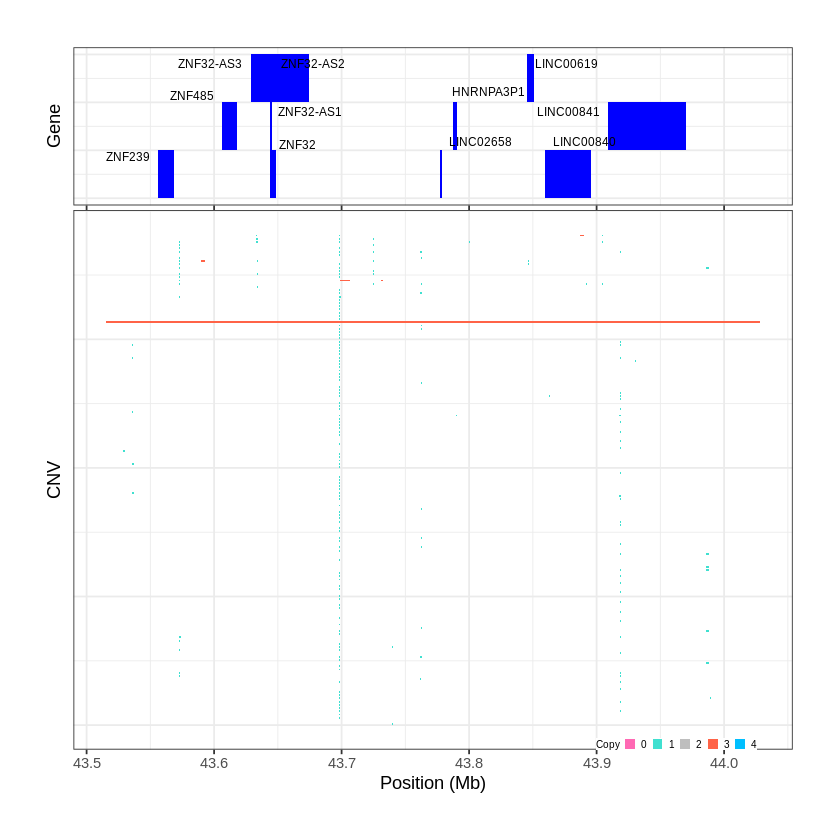

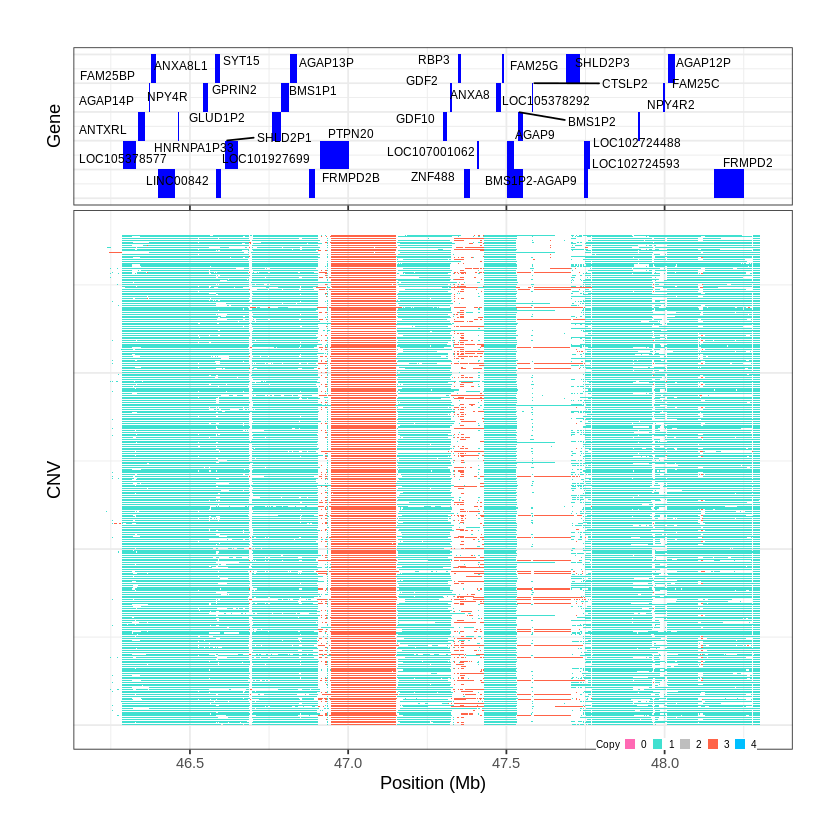

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1240..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 48.622901 - 49.3936 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1241..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 49.917201 - 49.9175 Mb with 223 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


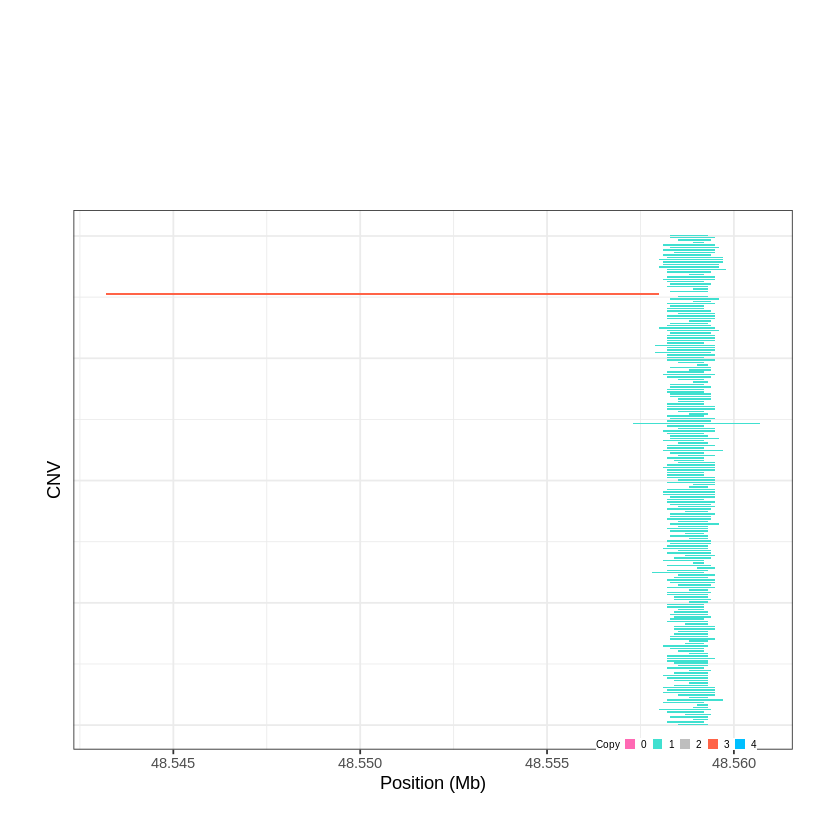

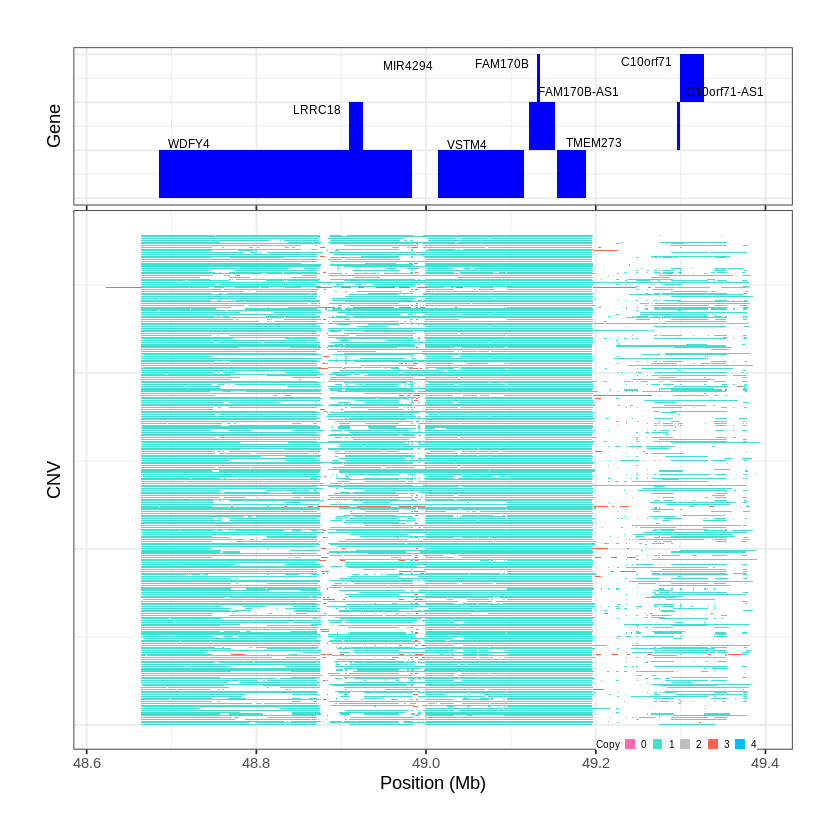

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1242..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 51.054901 - 51.3596 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1243..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 51.384701 - 51.5753 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


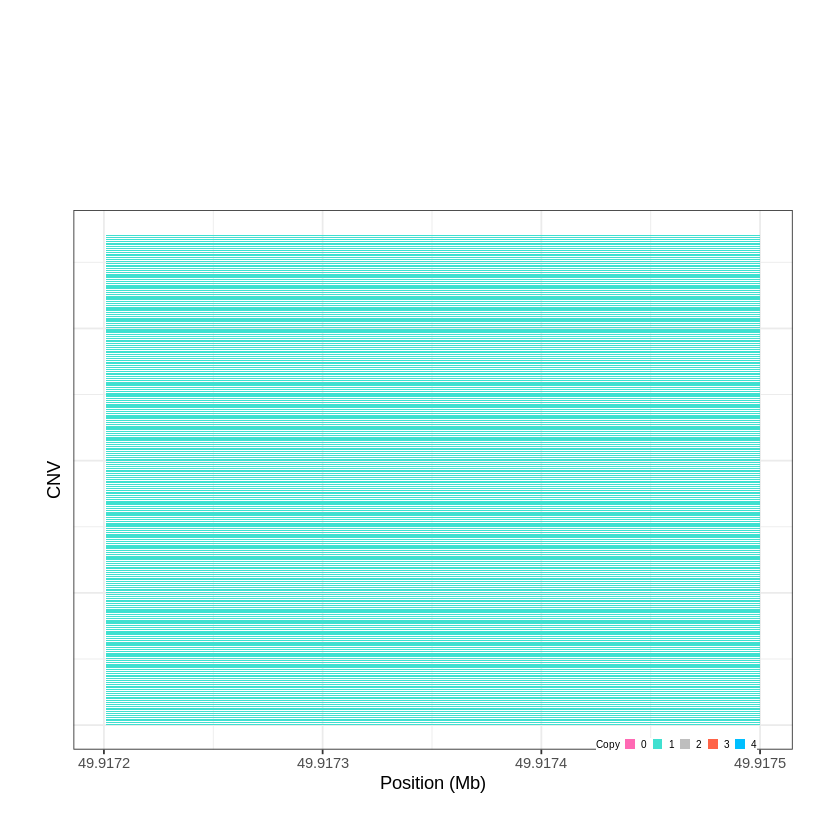

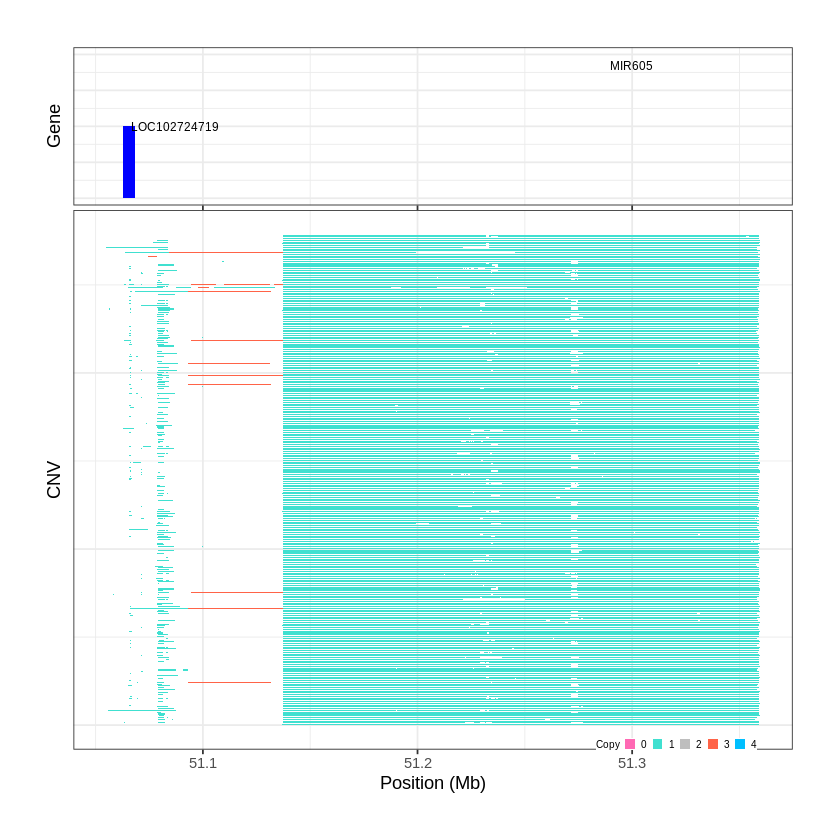

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1244..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 51.595201 - 51.7892 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1245..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 51.810701 - 52.0013 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


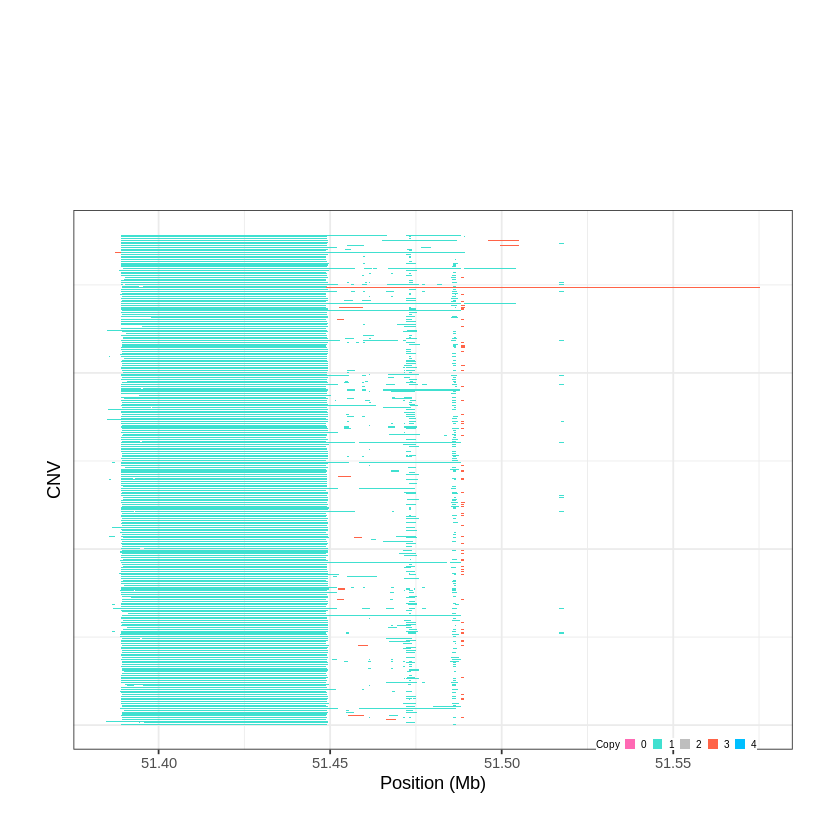

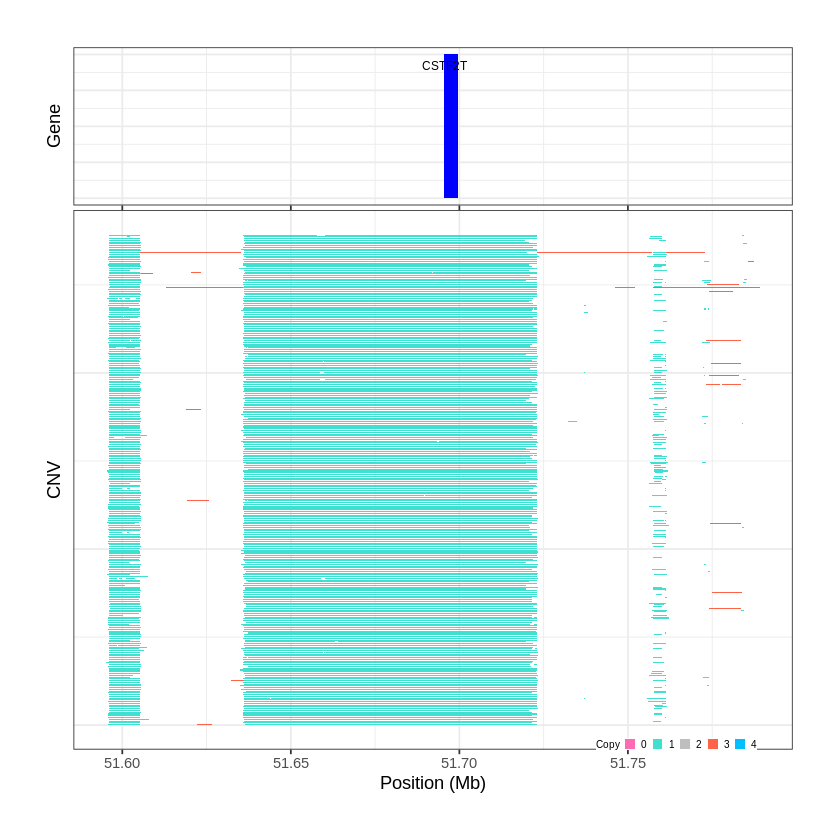

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1246..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 52.415101 - 52.5206 Mb with 255 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1247..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 54.430801 - 54.4491 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


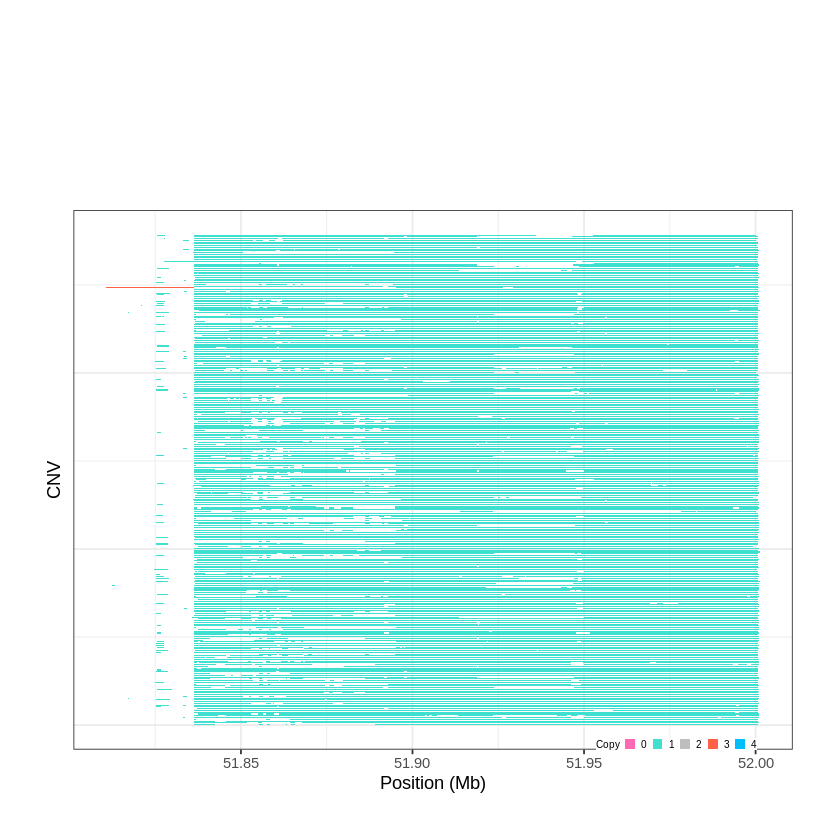

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1248..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 54.693201 - 54.9693 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


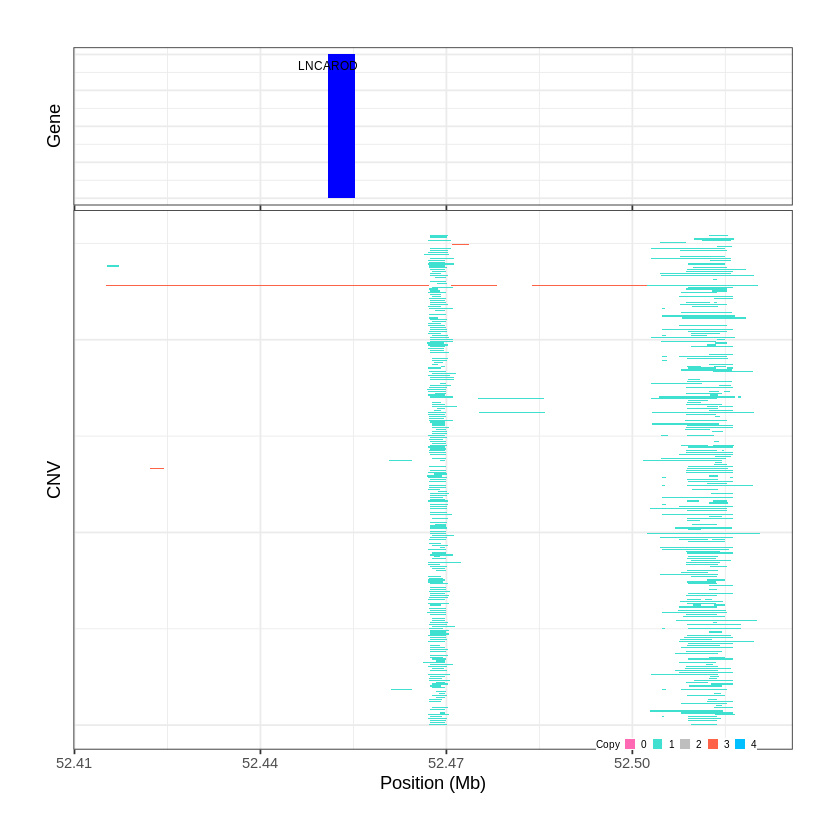

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1249..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 59.219501 - 59.2364 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


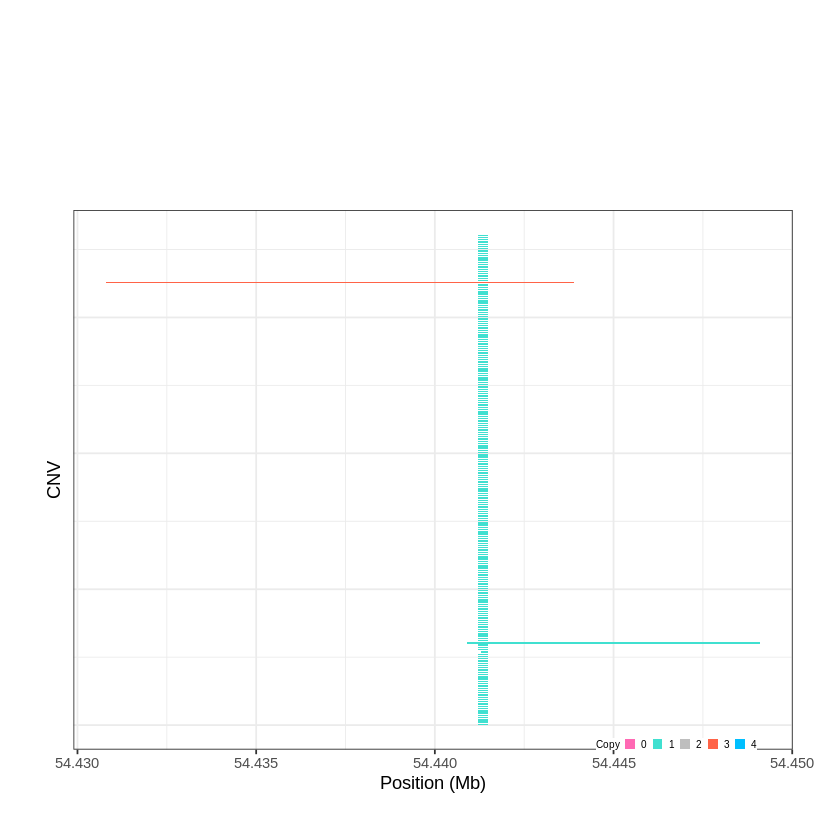

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1250..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 59.244801 - 59.2713 Mb with 215 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


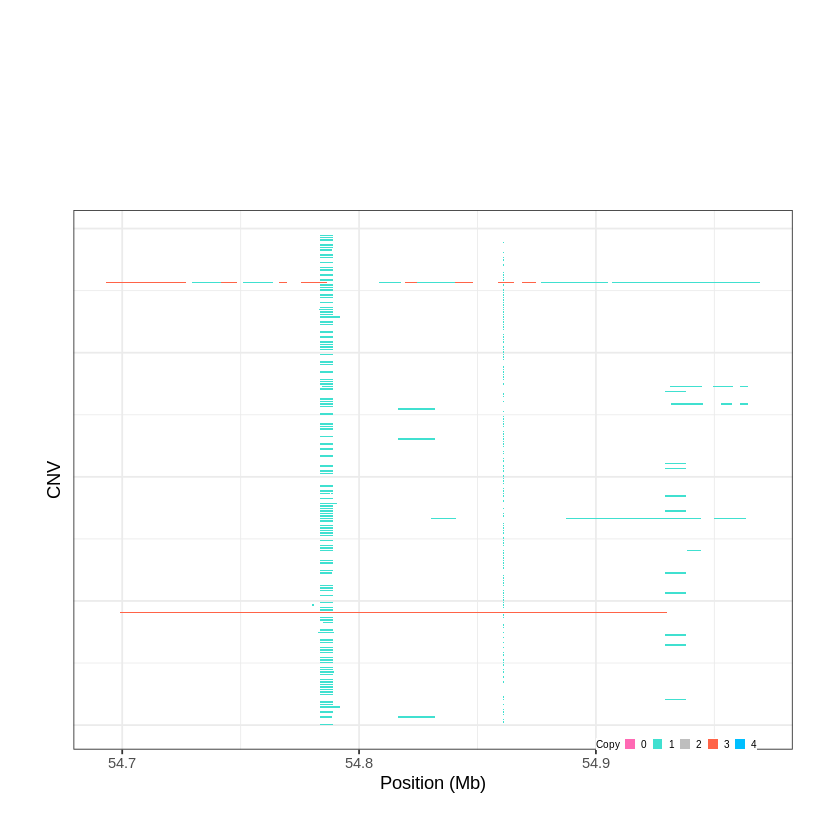

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1251..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 61.360801 - 61.3673 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


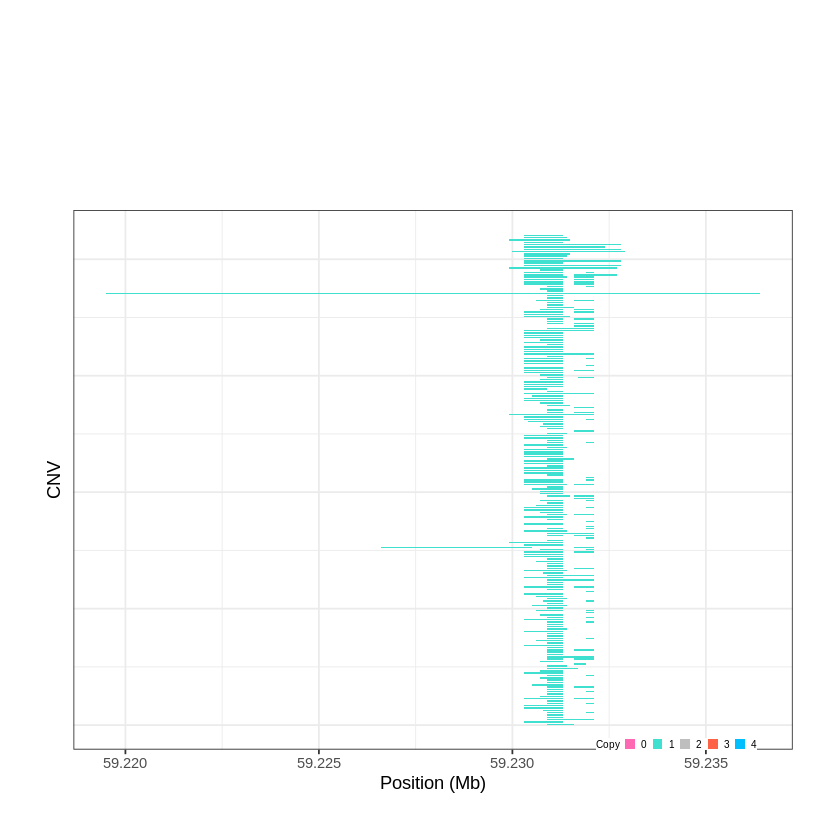

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1252..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 64.129401 - 64.1646 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


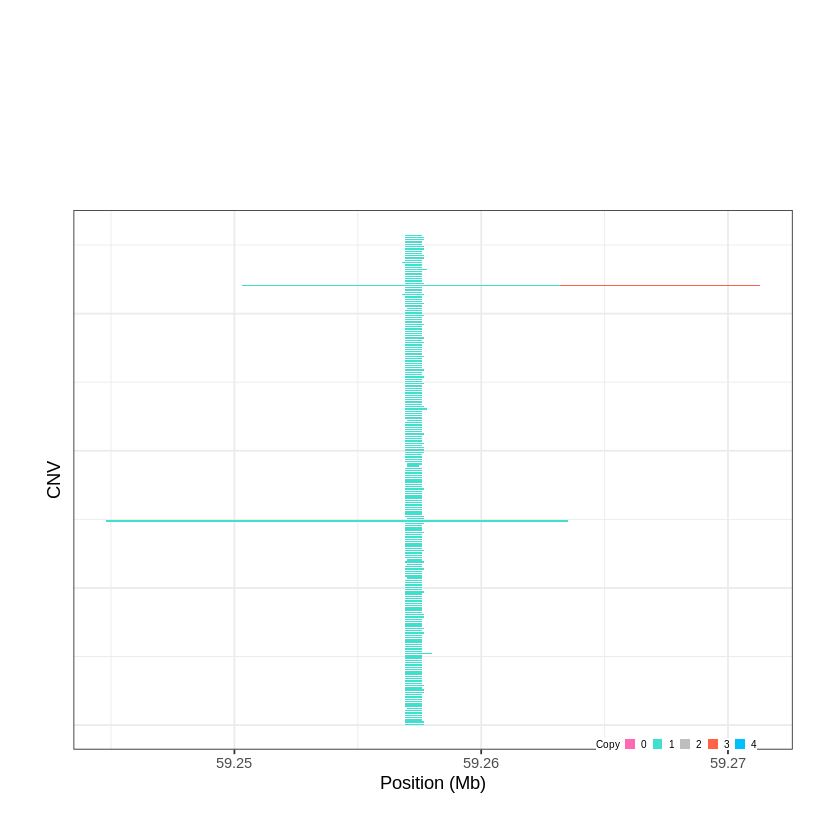

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1253..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 65.566101 - 65.5749 Mb with 241 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


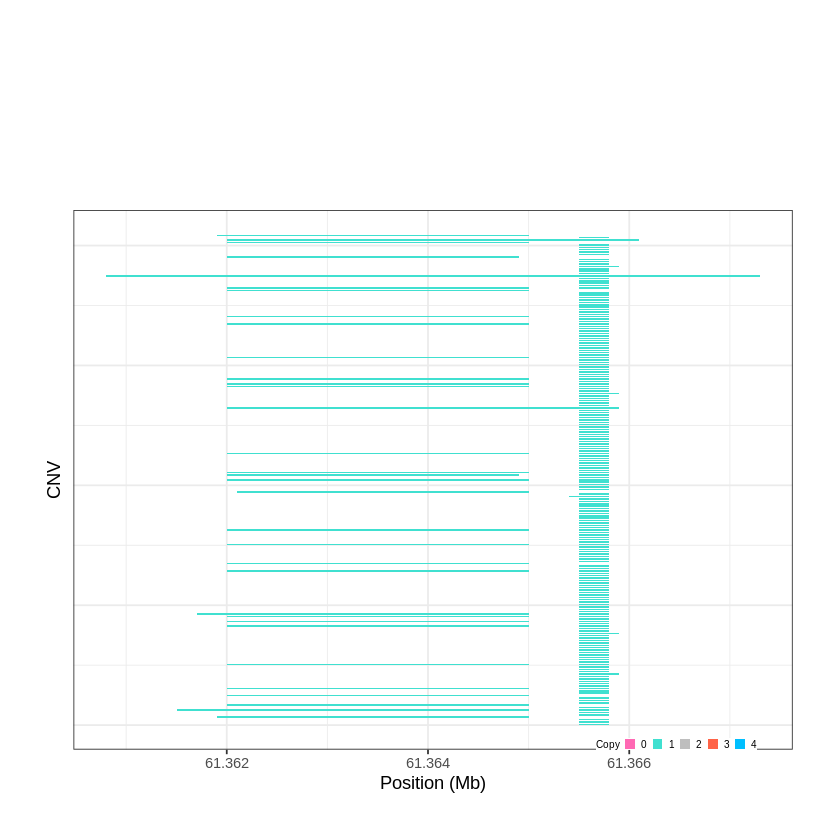

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1254..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 66.394301 - 66.4052 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


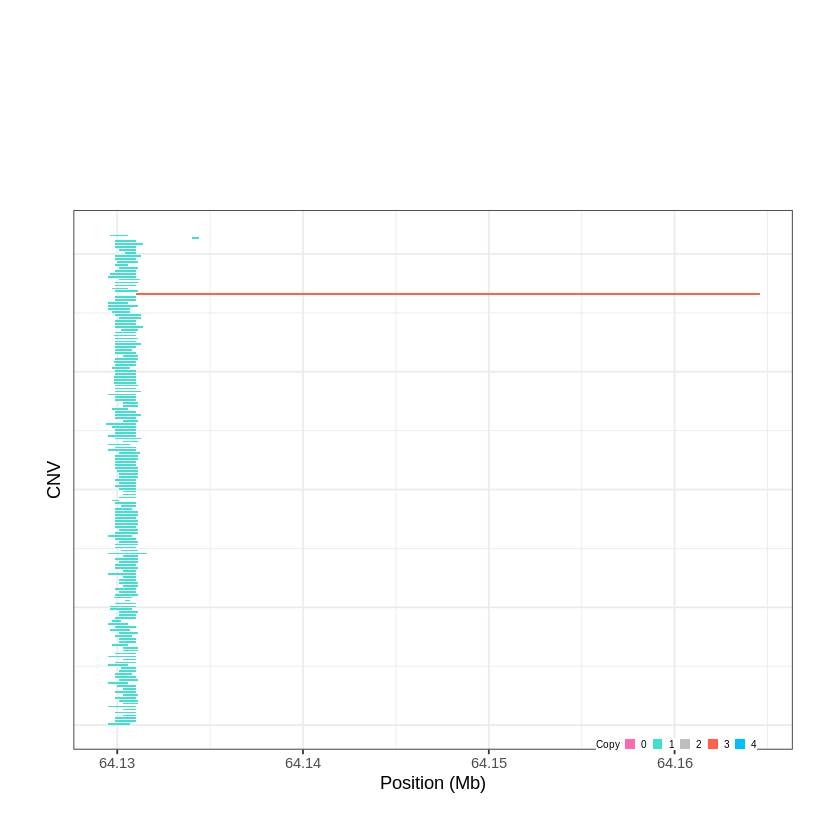

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1255..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 66.840601 - 66.8541 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


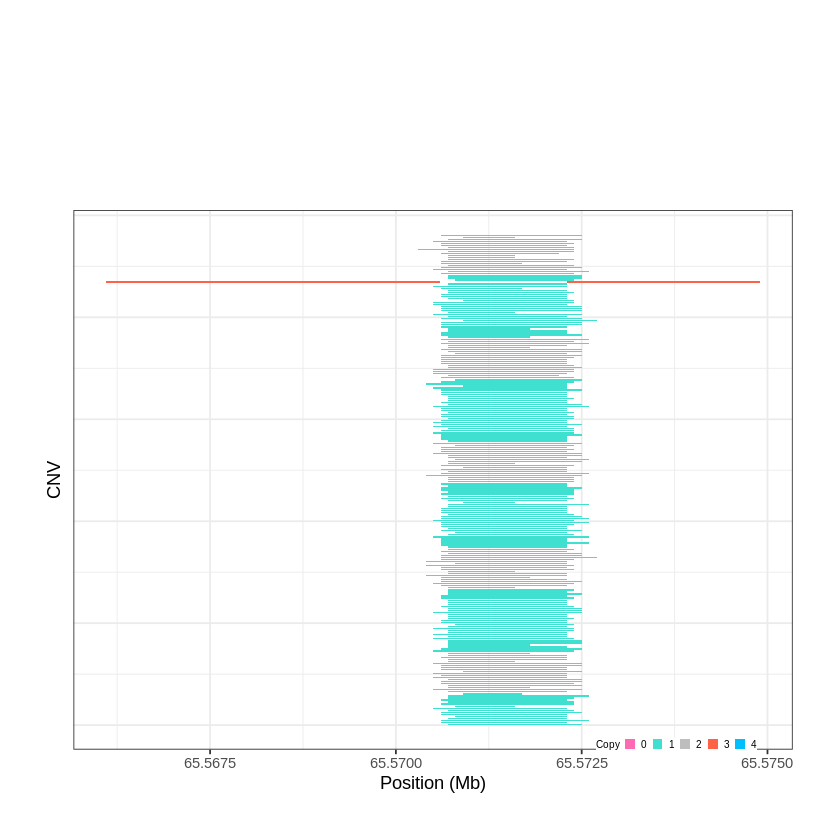

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1256..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 66.996501 - 67.0328 Mb with 247 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


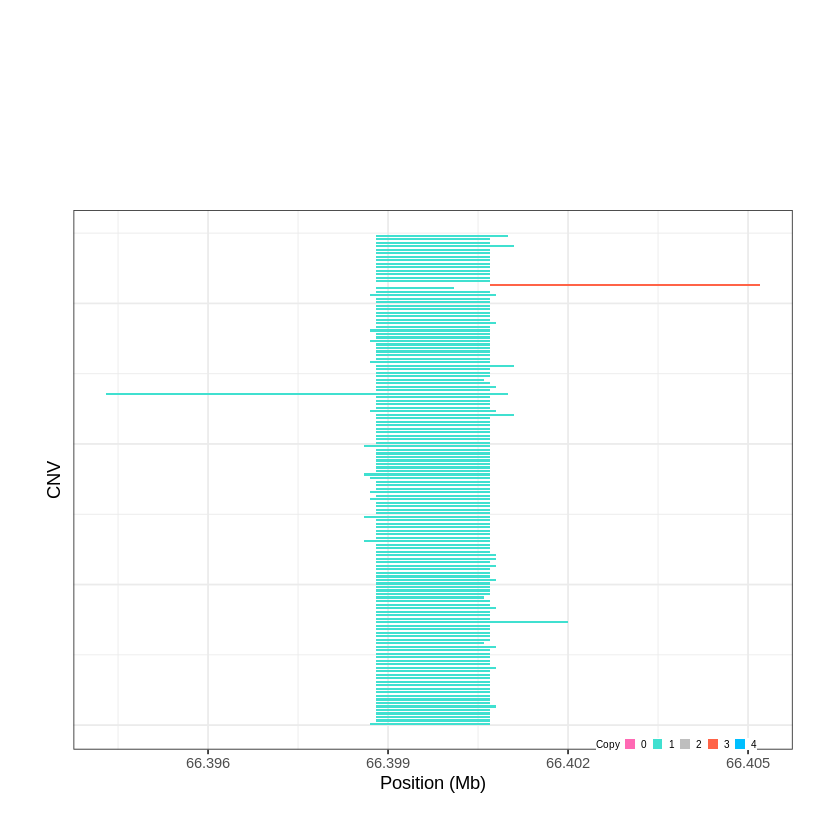

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1257..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 70.586501 - 70.5882 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


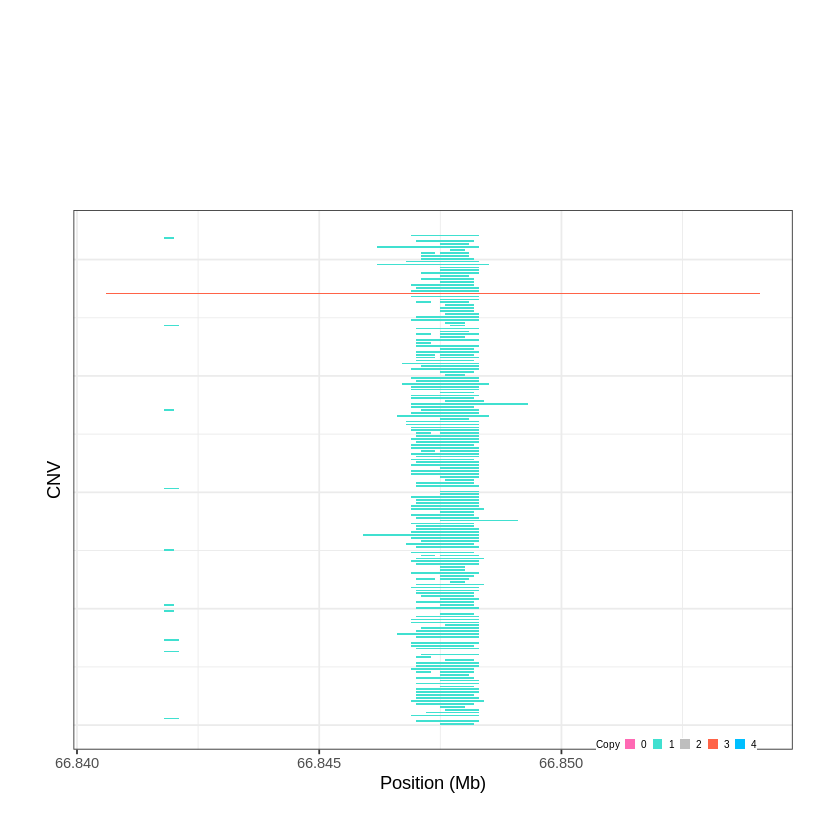

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1258..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 73.957101 - 73.9585 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


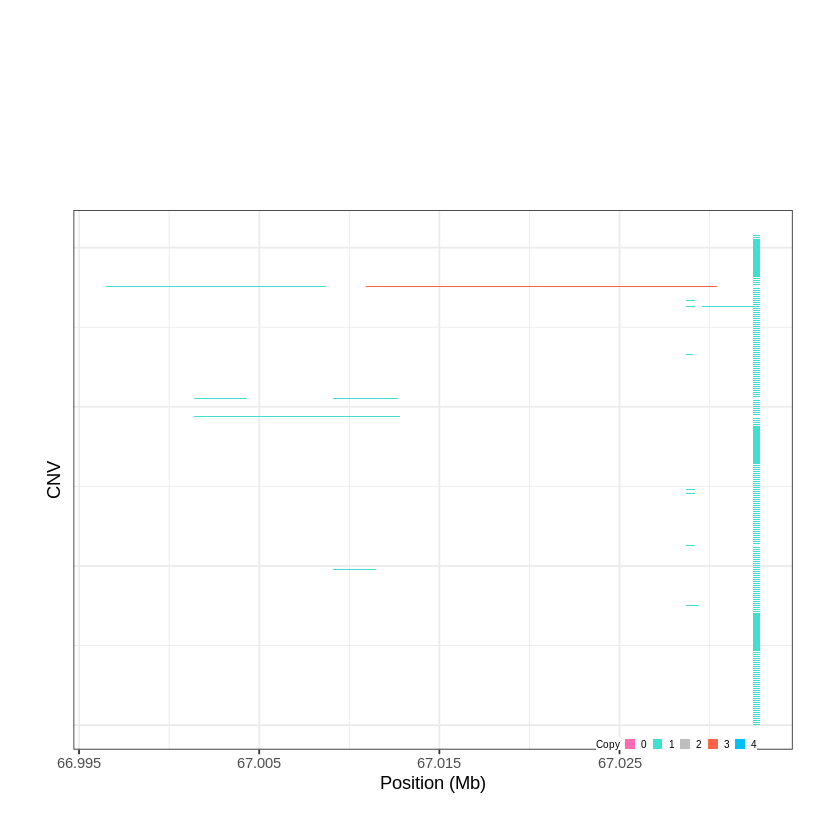

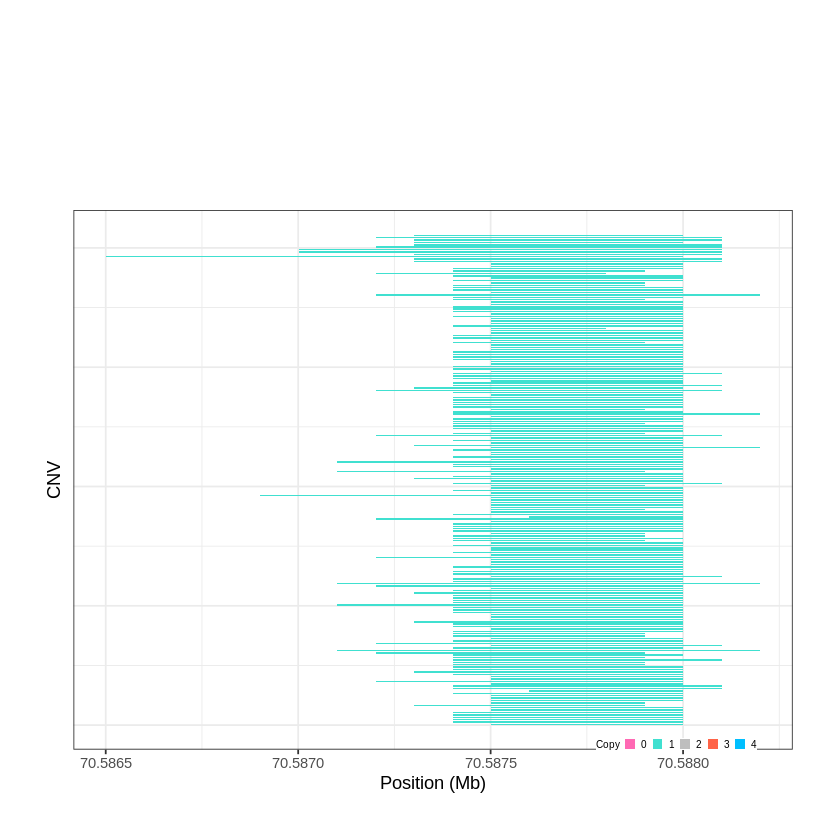

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1259..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 75.514001 - 75.6485 Mb with 218 Individual - "
Plotting gene...


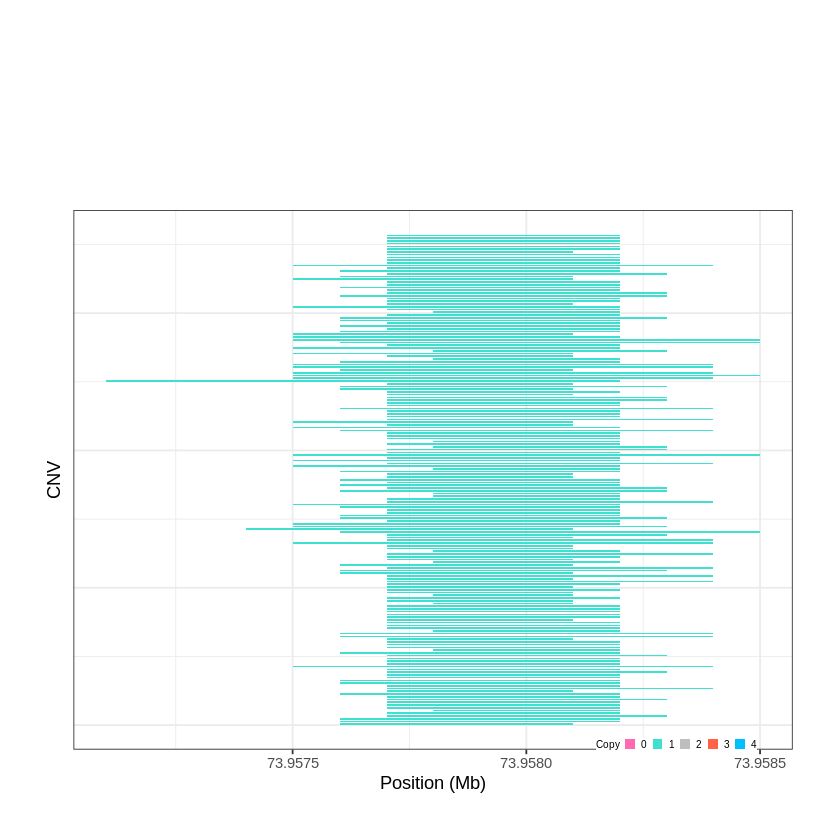

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1260..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 78.213801 - 78.268 Mb with 208 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1261..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 78.763601 - 78.8071 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


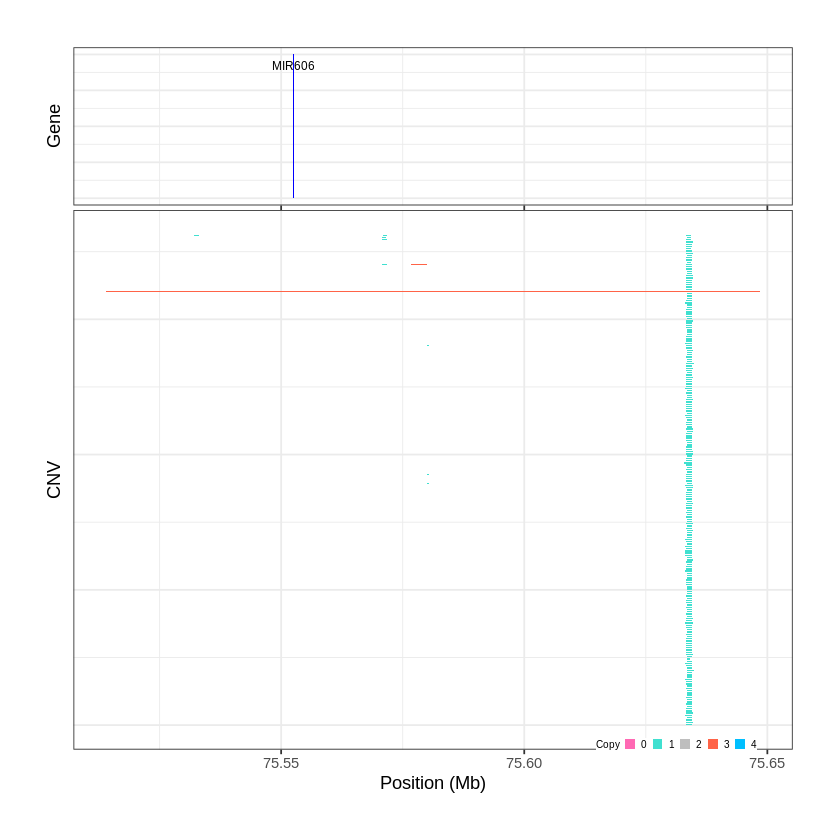

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1262..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 80.800401 - 81.0928 Mb with 219 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


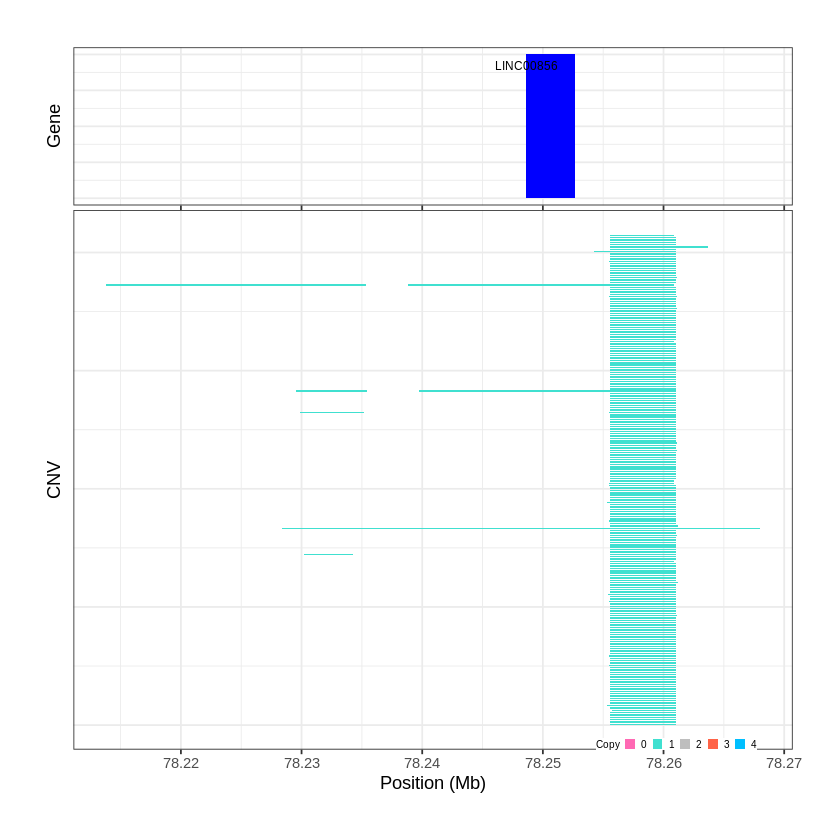

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1263..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 81.247701 - 81.2946 Mb with 157 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


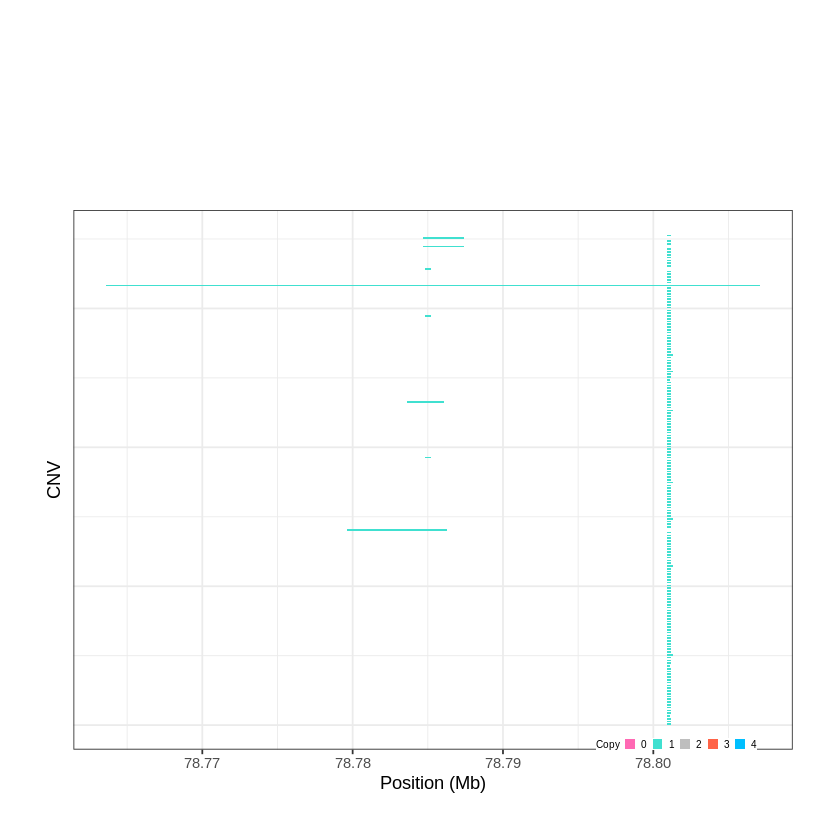

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1264..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 81.389501 - 81.4094 Mb with 174 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


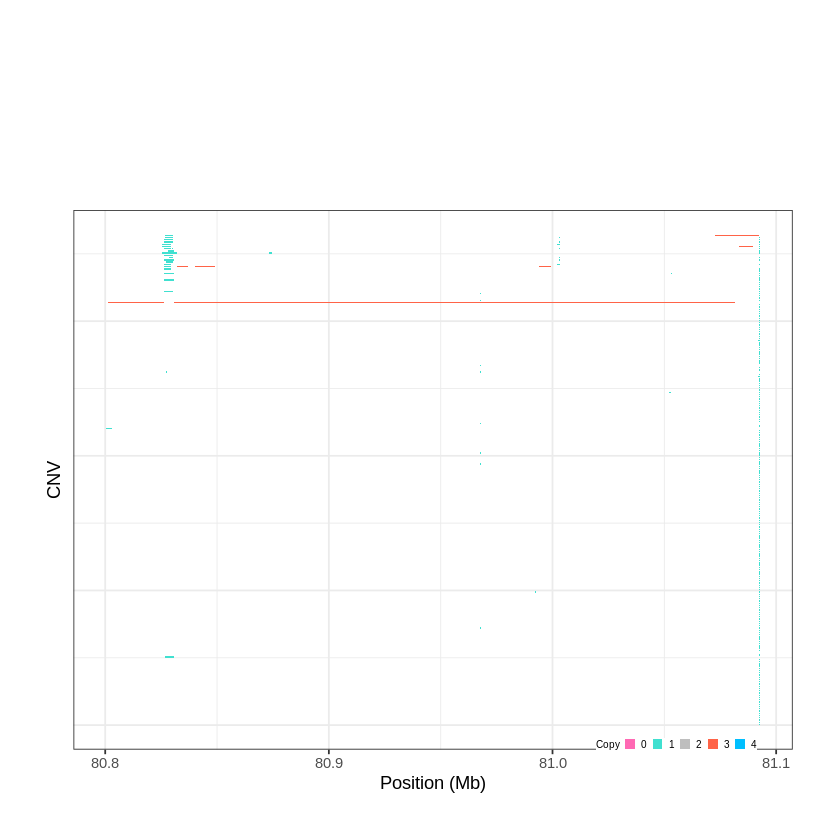

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1265..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 81.439201 - 81.6514 Mb with 272 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


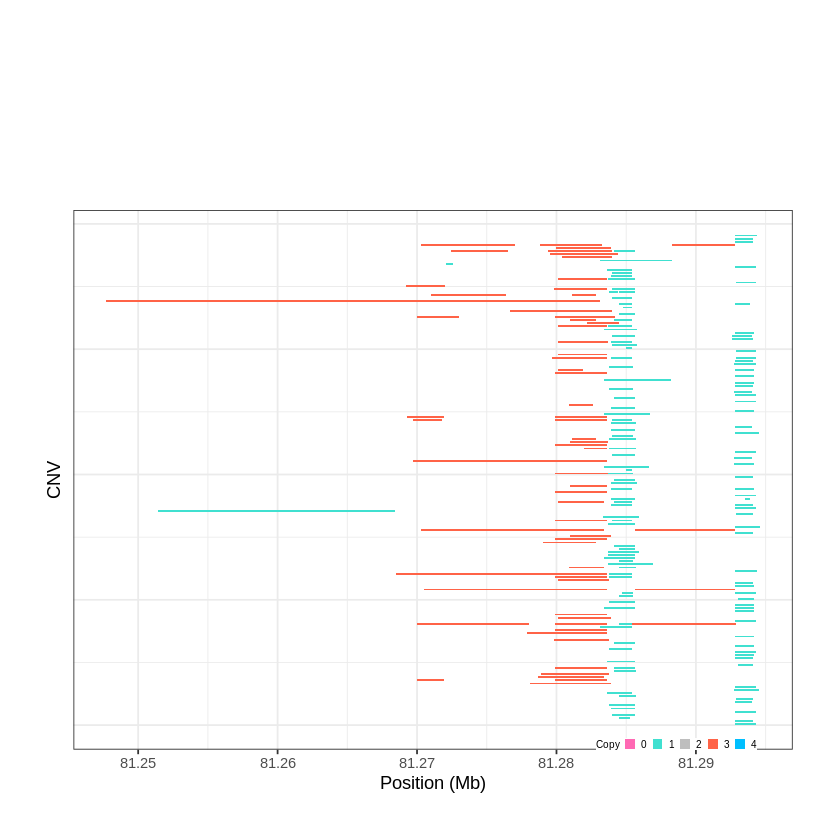

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1266..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 83.750501 - 83.814 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


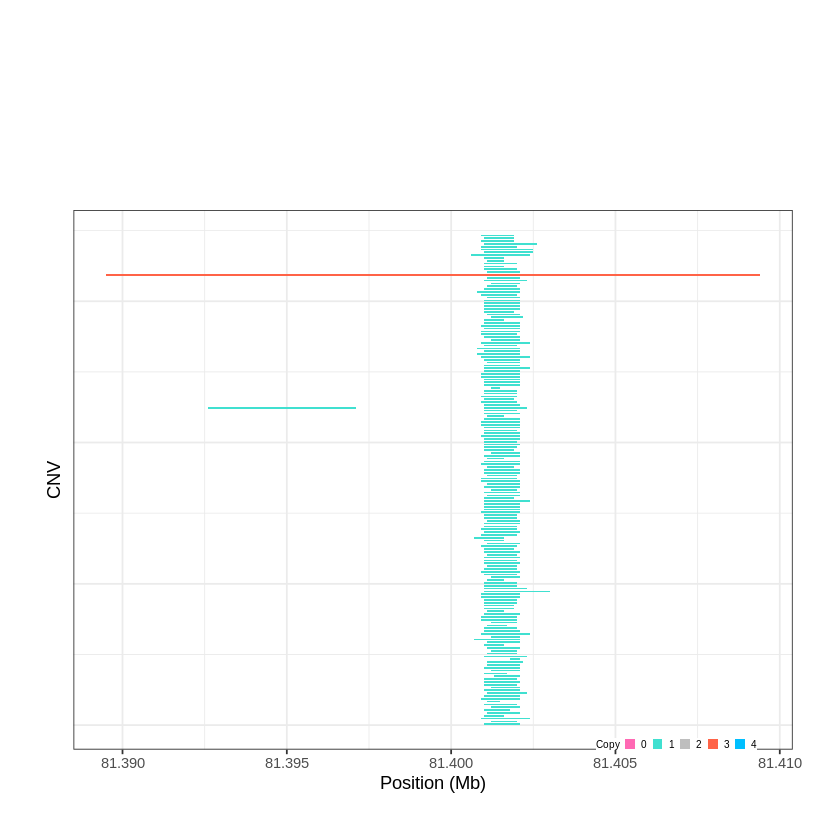

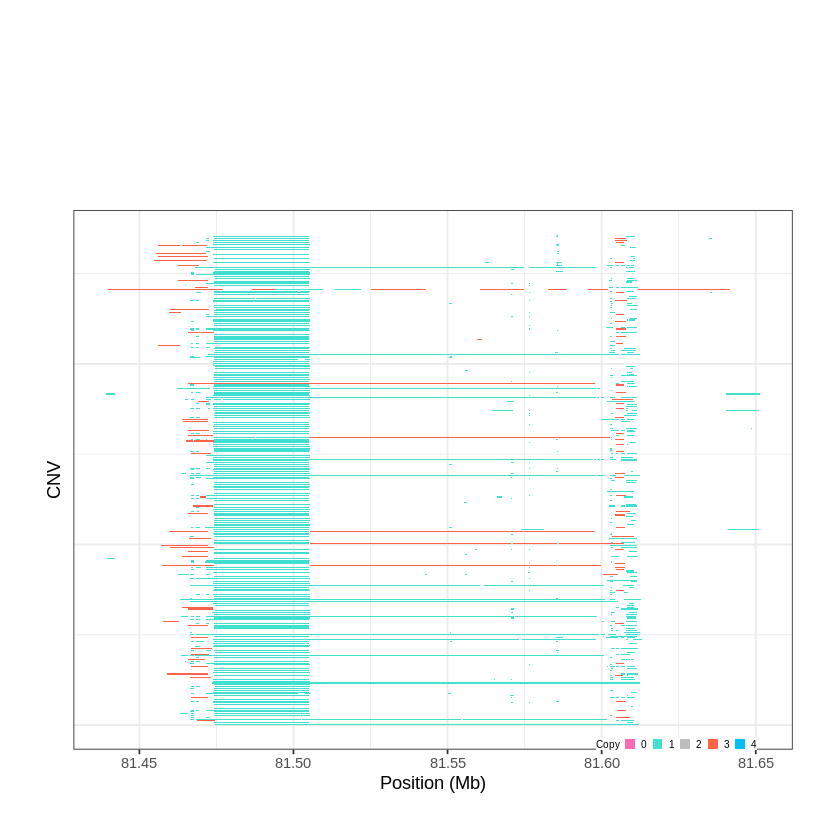

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1267..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 88.961301 - 89.1537 Mb with 277 Individual - "
Plotting gene...


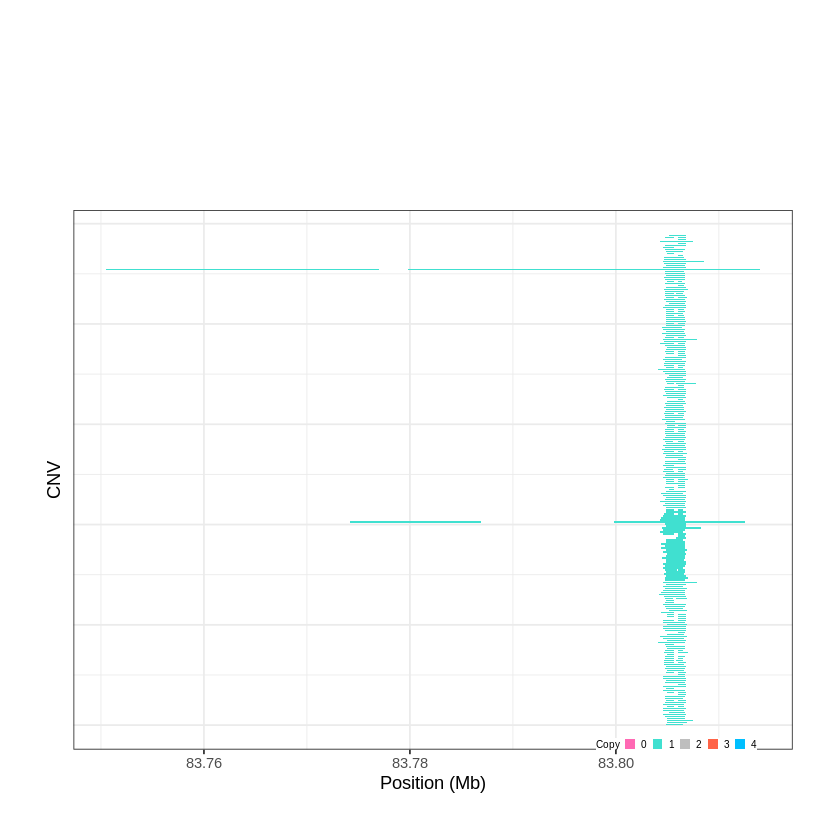

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1268..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 89.187001 - 89.2538 Mb with 238 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1269..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 93.631701 - 93.635 Mb with 212 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


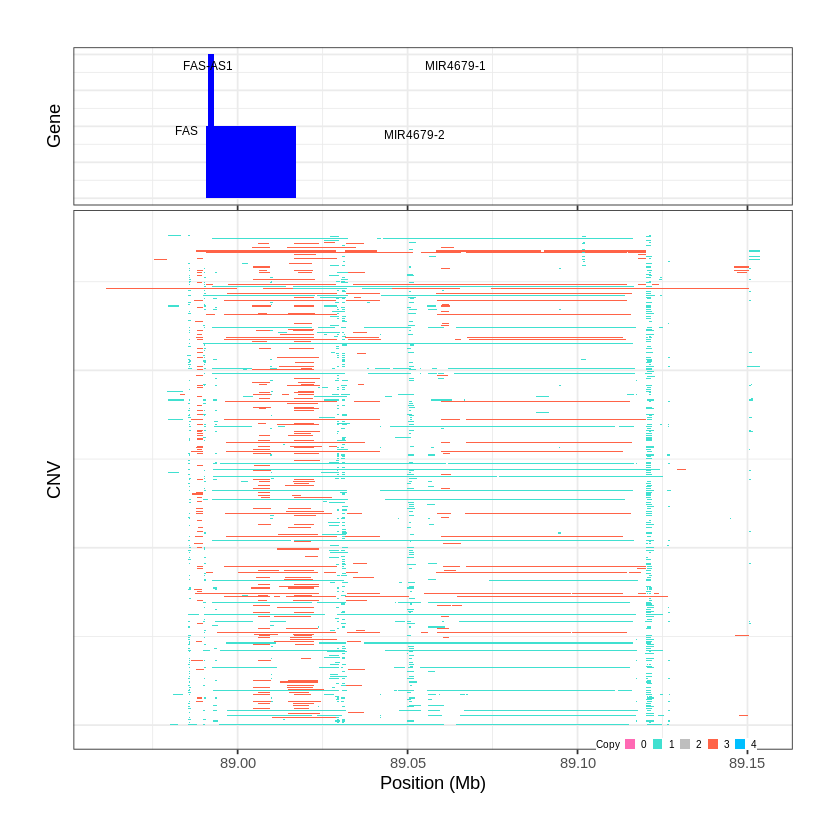

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1270..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 94.134101 - 94.1376 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


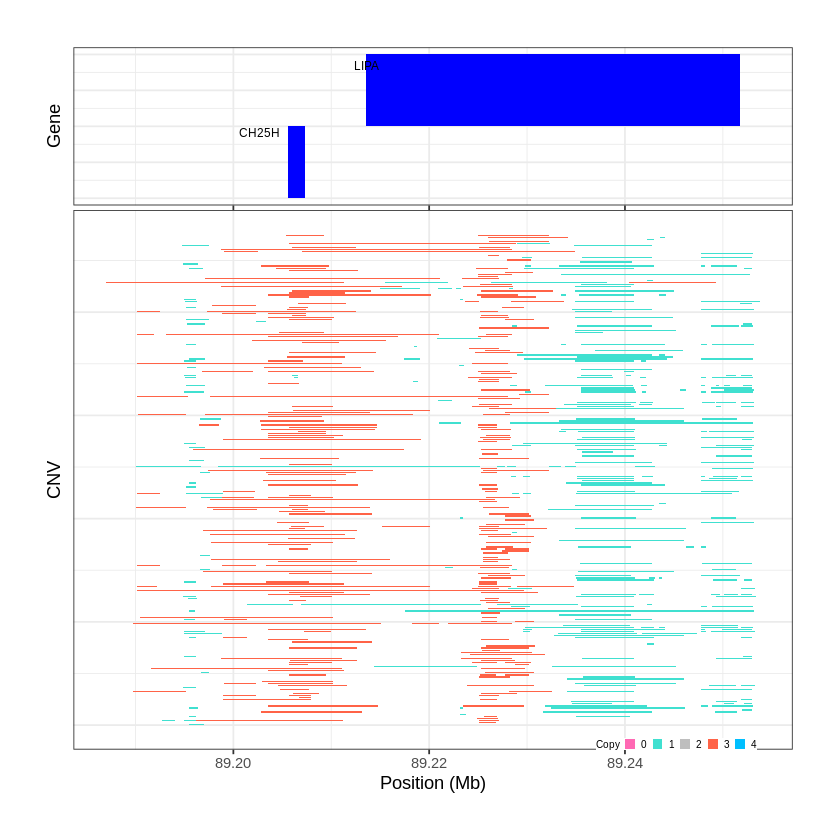

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1271..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 95.524401 - 95.5661 Mb with 241 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


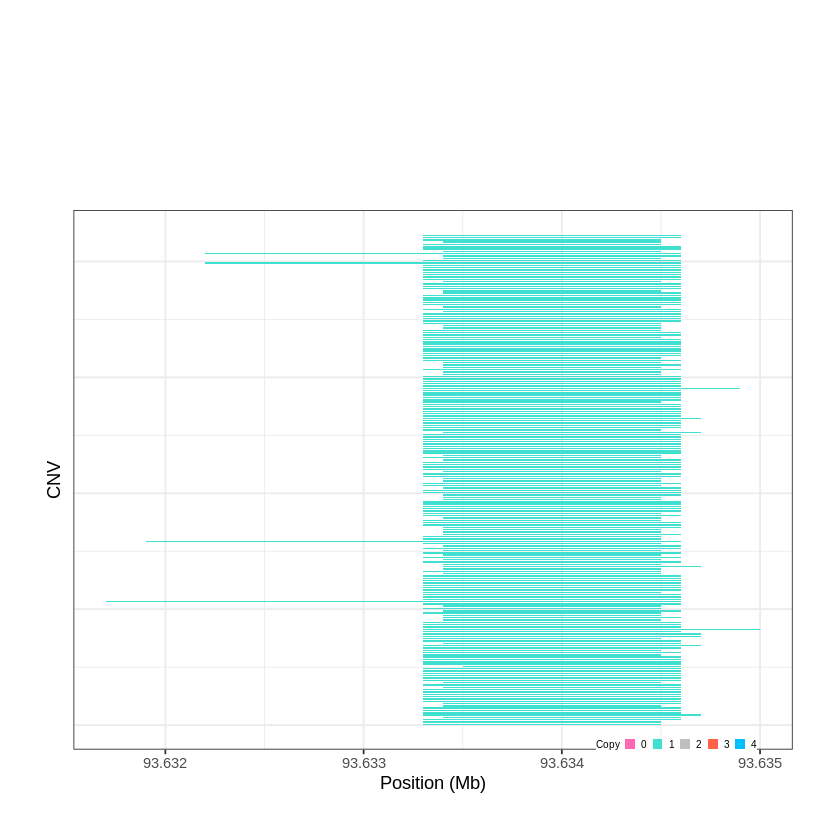

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1272..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 100.458401 - 100.4617 Mb with 172 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


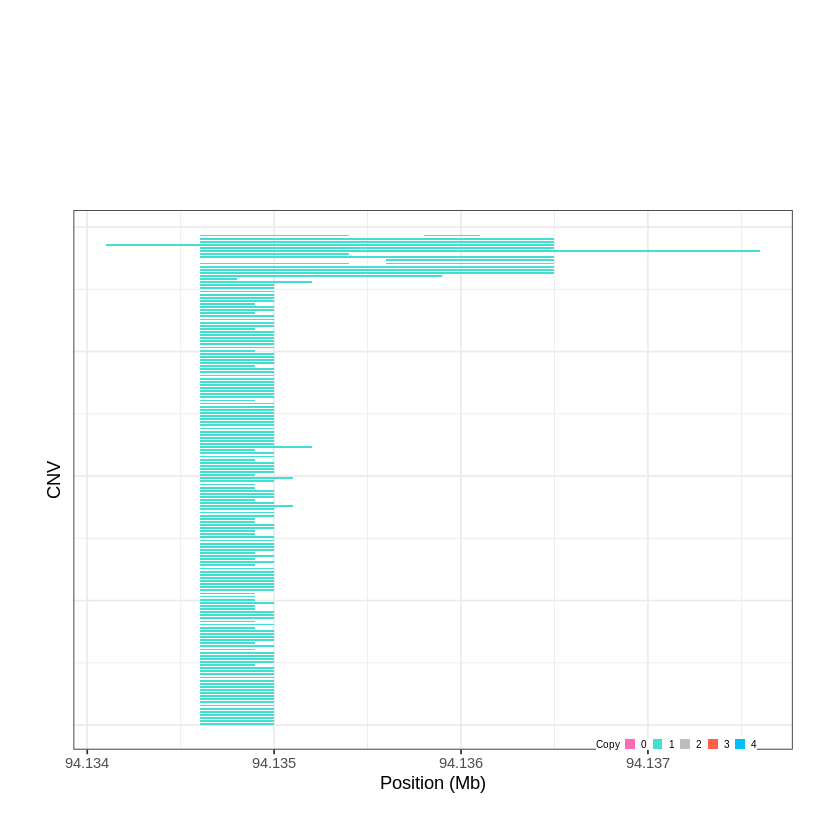

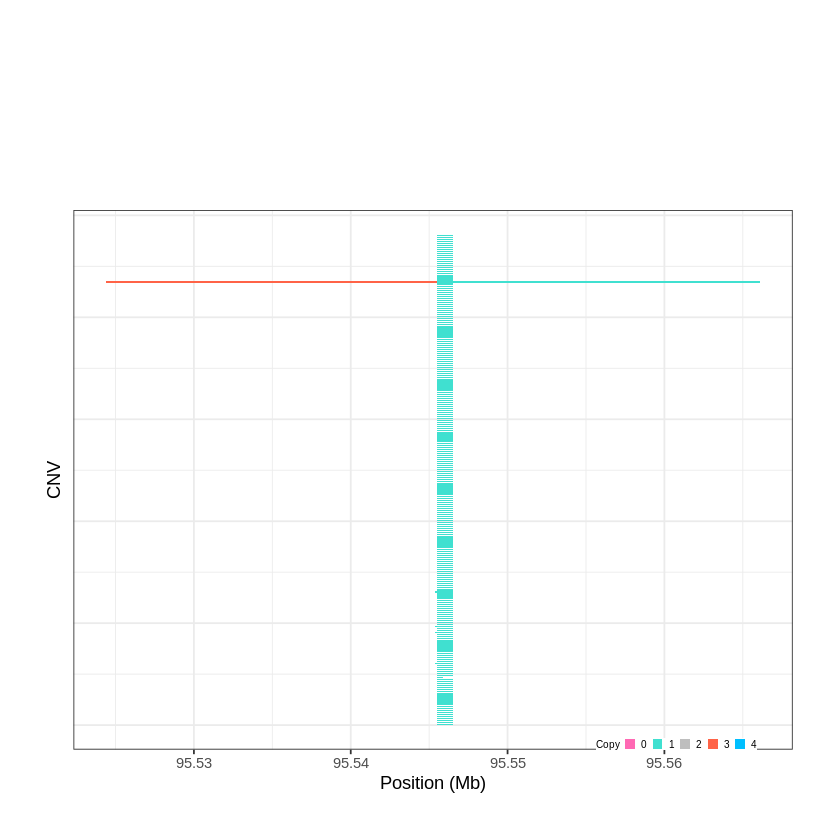

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1273..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 102.354401 - 102.4527 Mb with 150 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1274..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 107.939301 - 107.9551 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


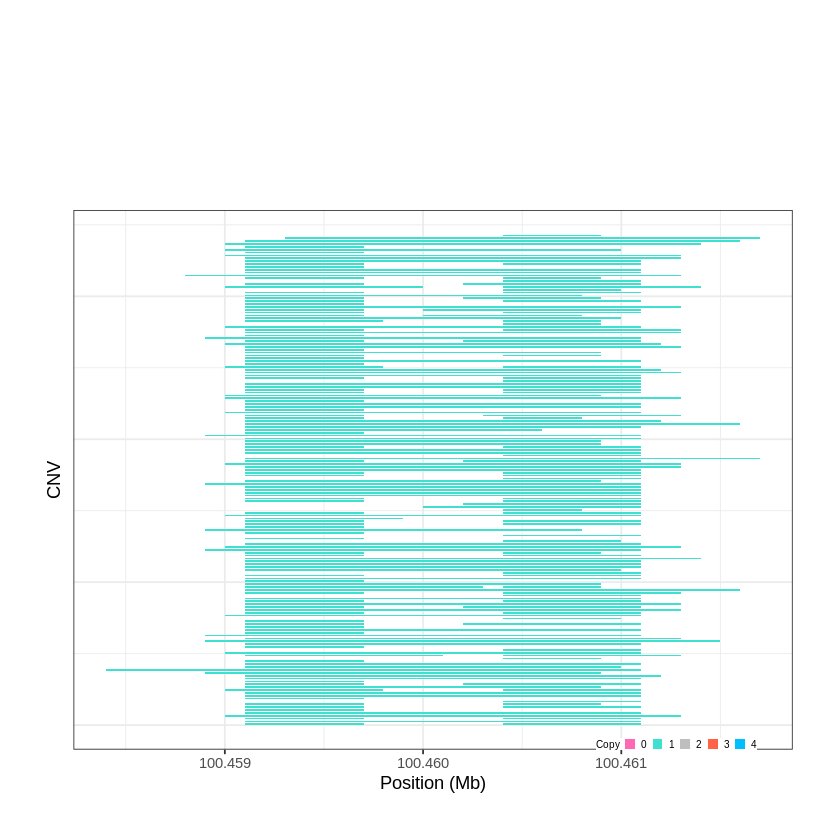

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1275..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 107.961501 - 108.0477 Mb with 233 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


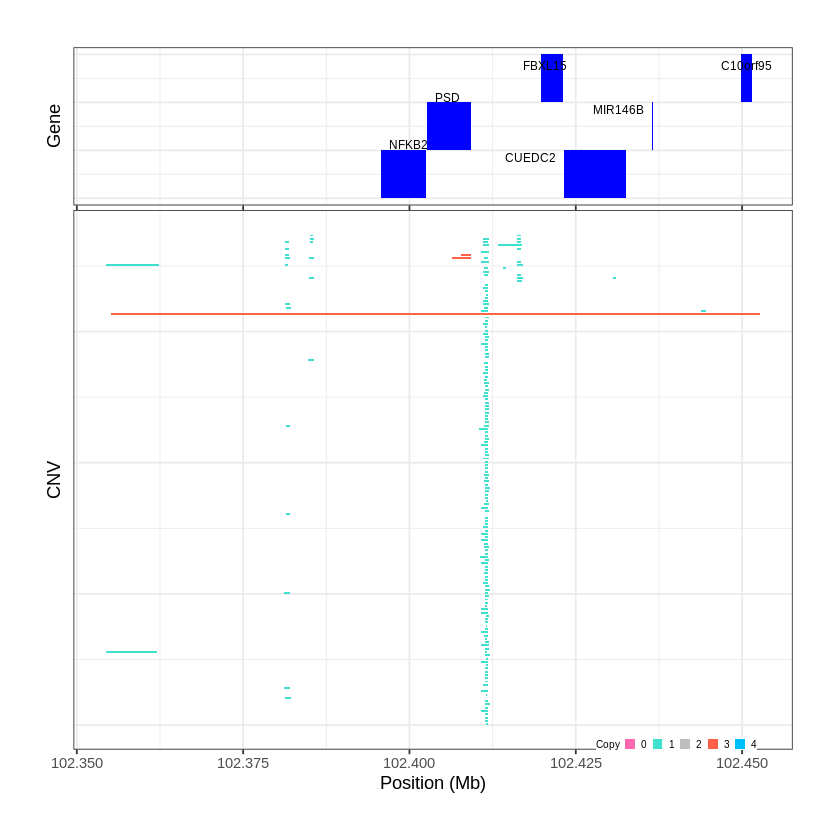

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1276..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 110.989201 - 111.0061 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


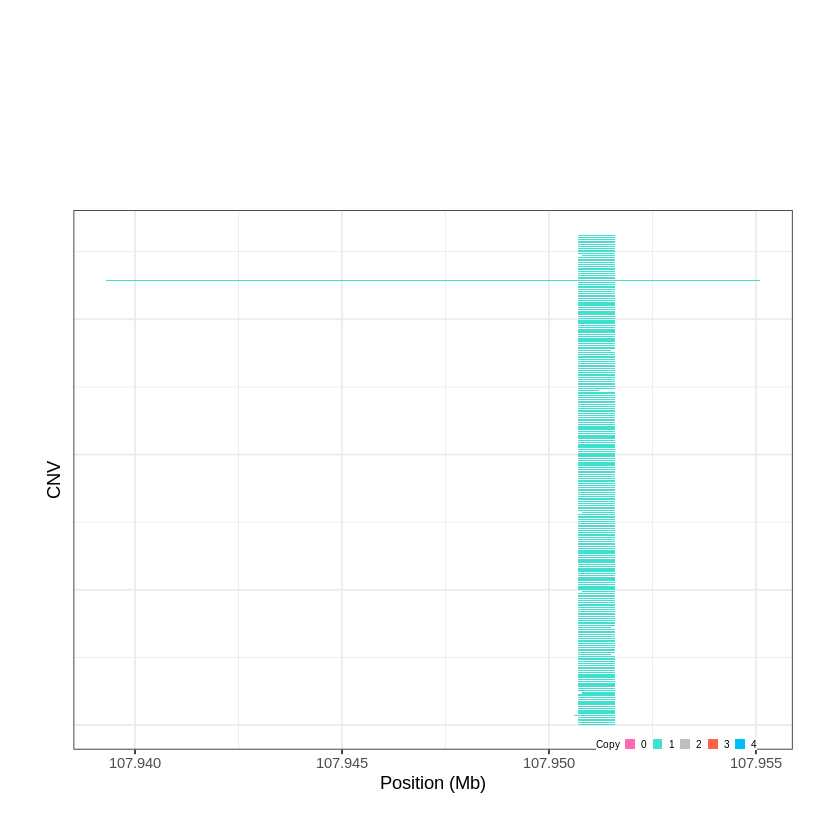

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1277..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 111.965401 - 111.9953 Mb with 230 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


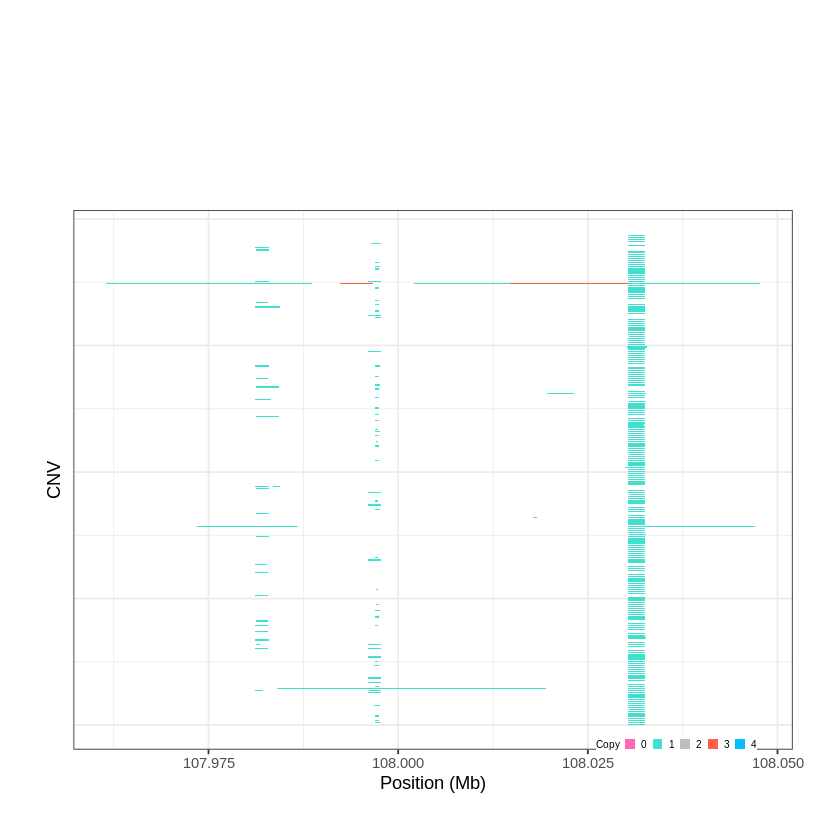

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1278..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 113.178001 - 113.2299 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


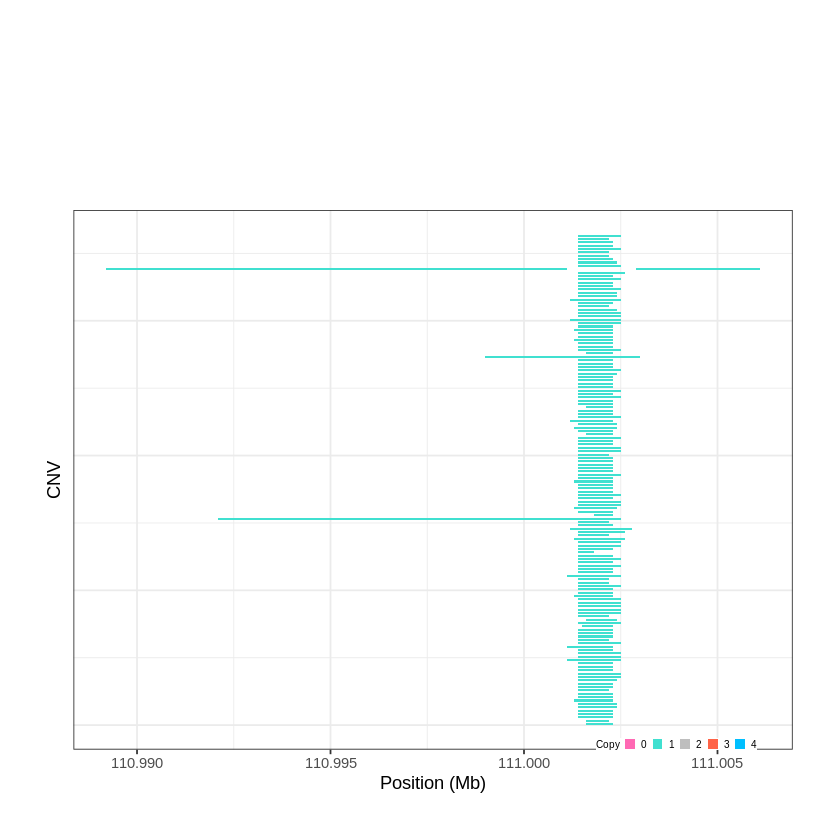

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1279..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 114.096501 - 114.1185 Mb with 204 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


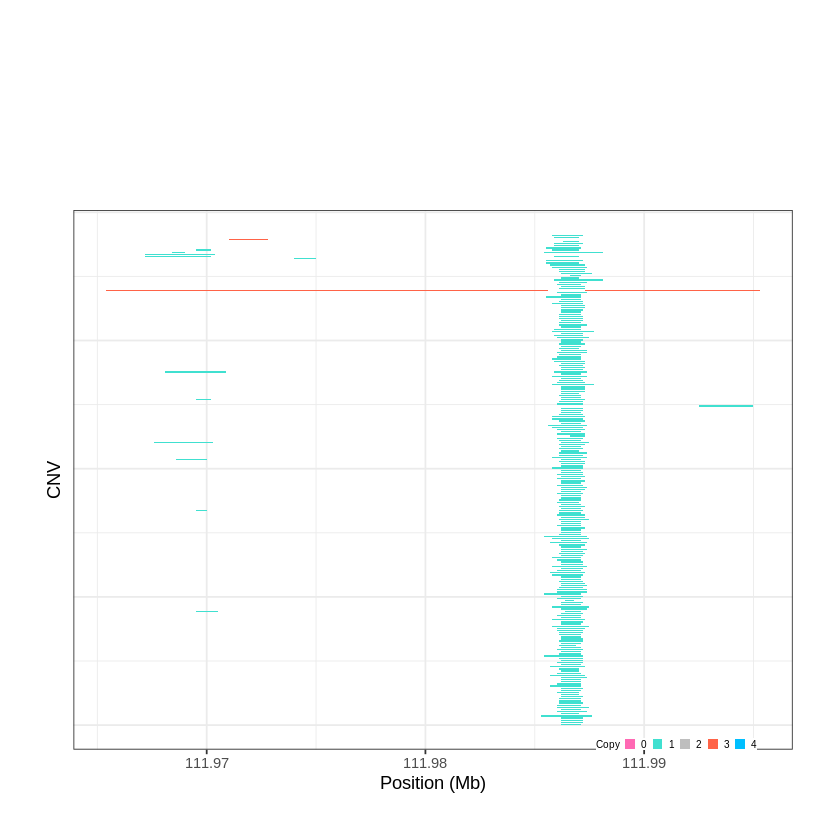

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1280..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 114.961901 - 114.9847 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


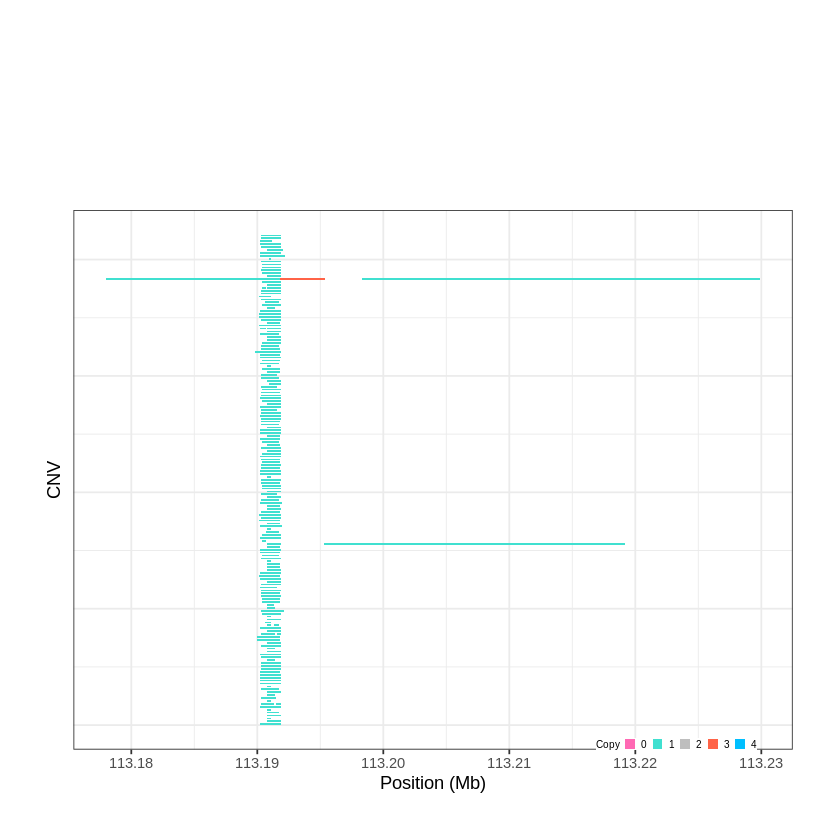

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1281..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 115.979801 - 116.1328 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


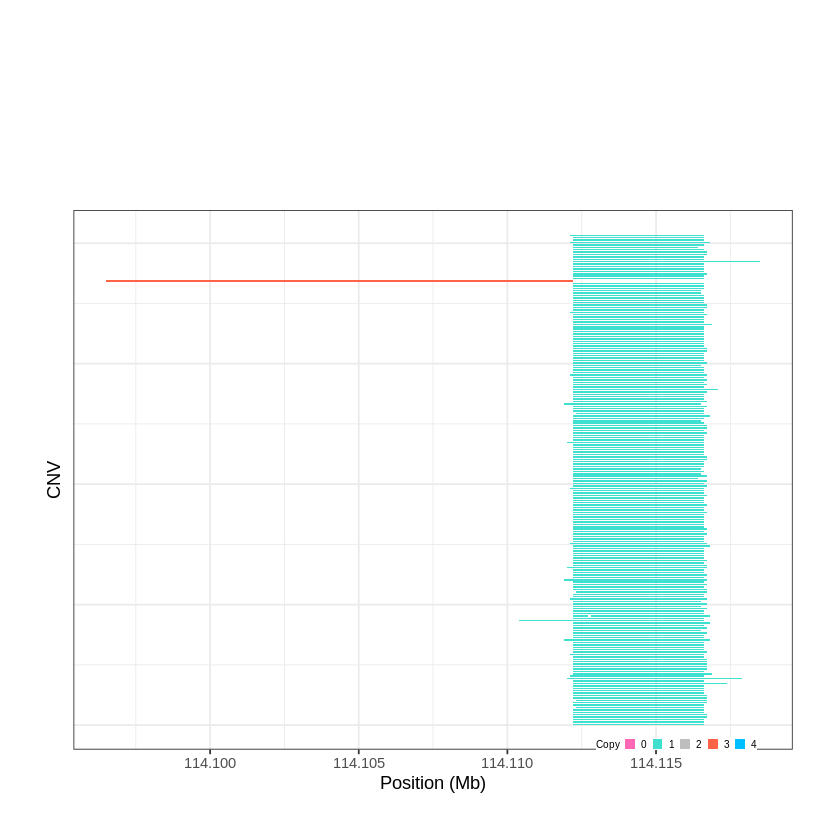

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1282..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 117.334201 - 117.3487 Mb with 267 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


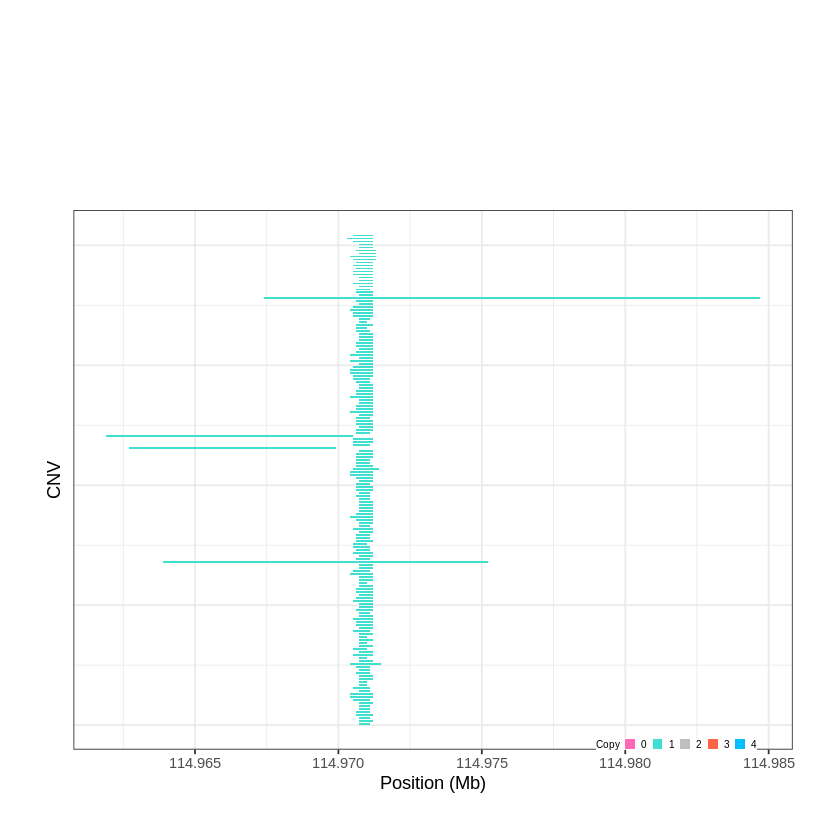

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1283..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 118.265301 - 118.2656 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


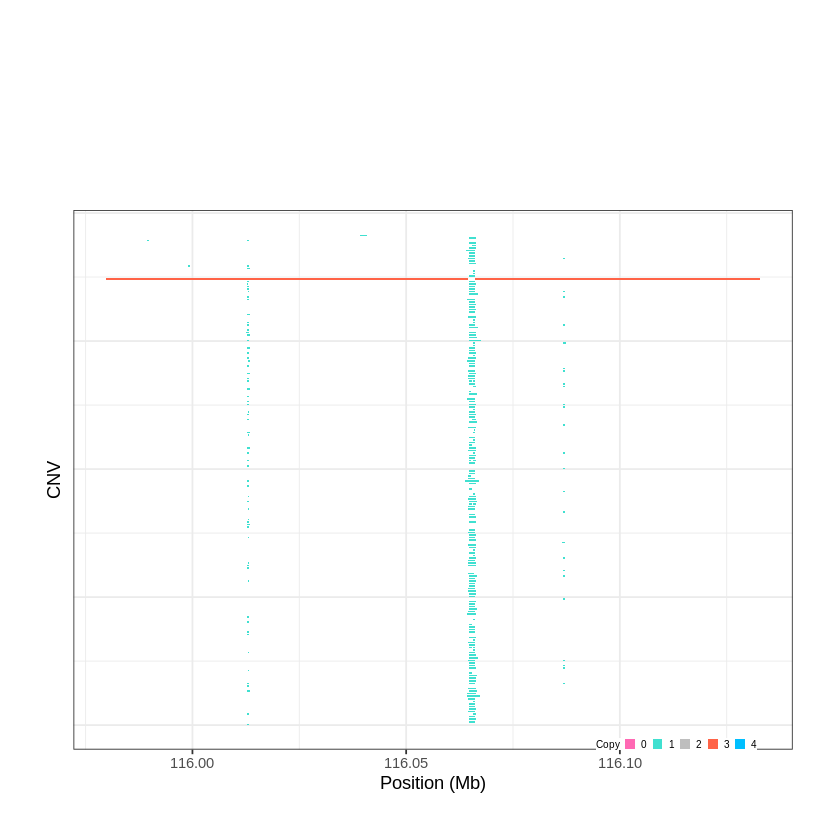

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1284..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 119.628701 - 119.6439 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


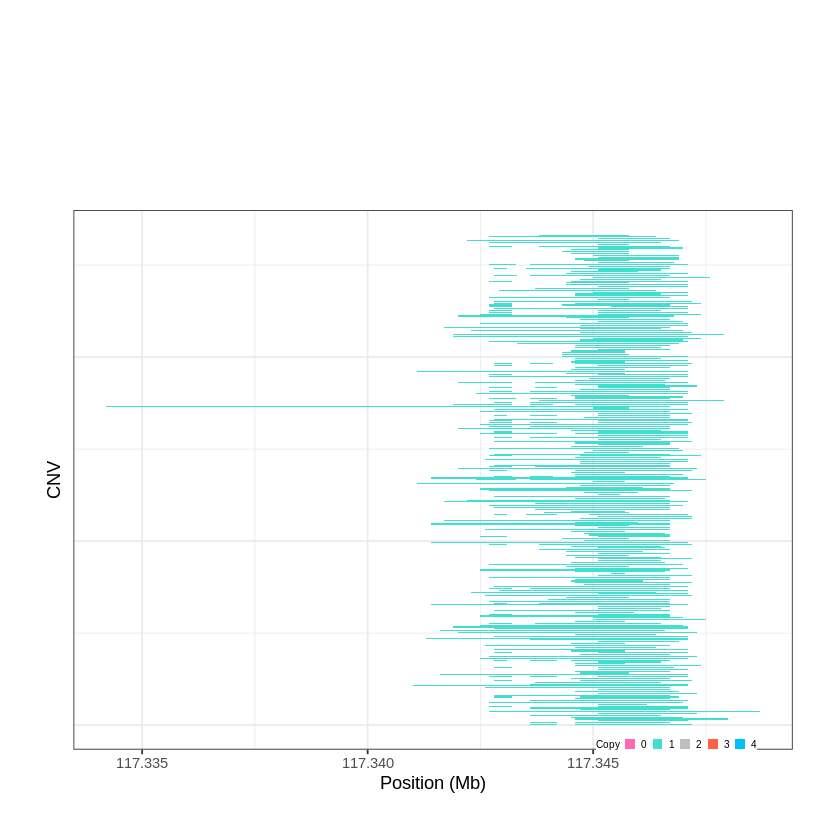

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1285..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 121.993101 - 122.0007 Mb with 260 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


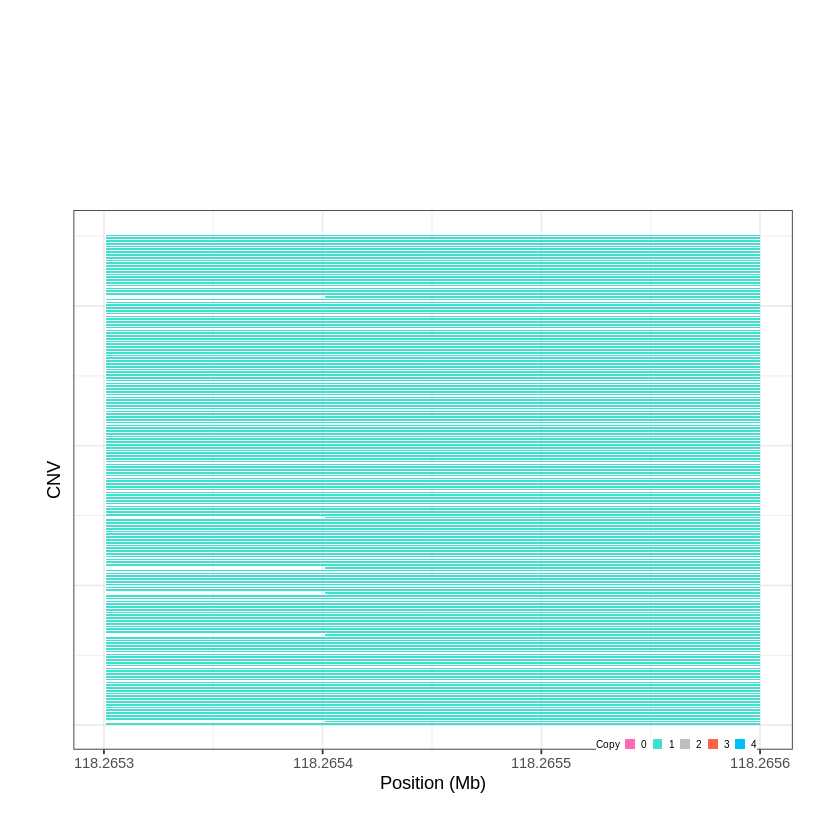

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1286..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 122.217801 - 122.2403 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


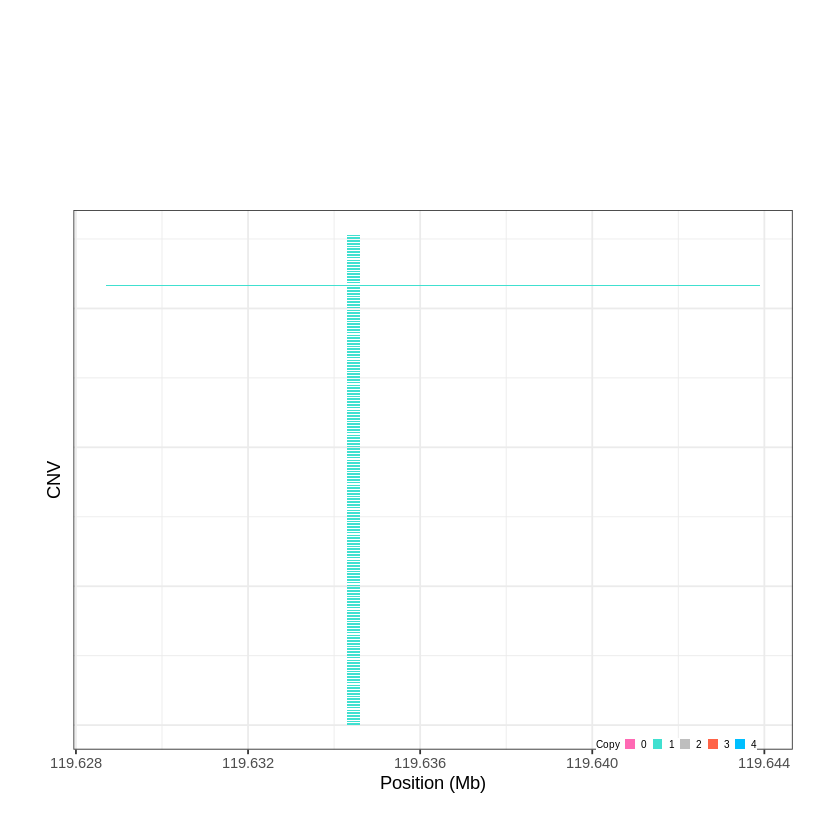

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1287..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 123.750501 - 124.0791 Mb with 174 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


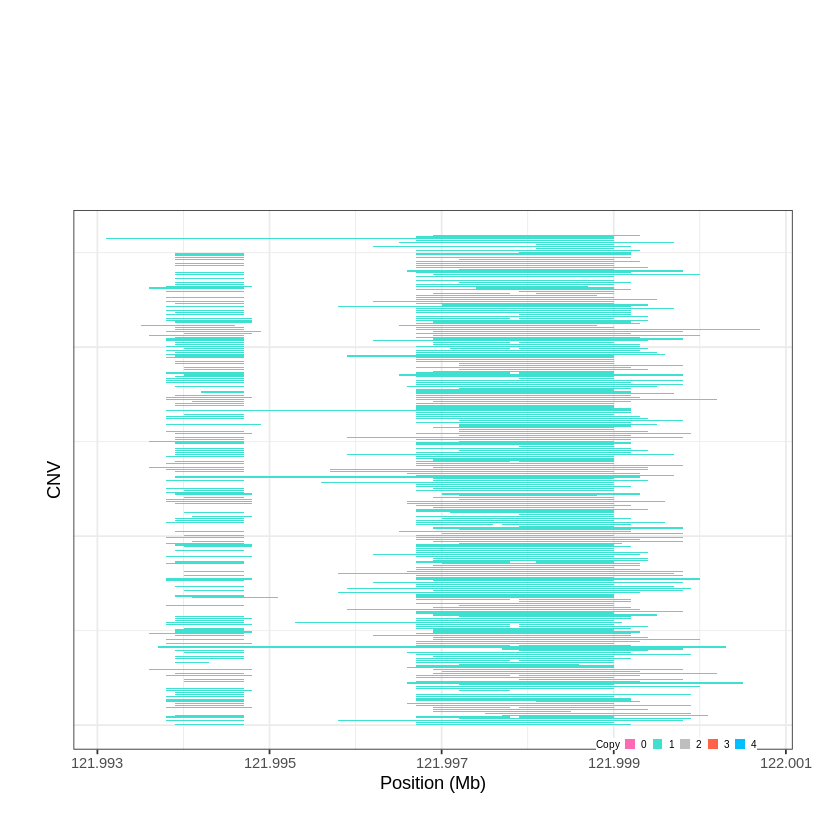

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1288..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 124.334601 - 124.3914 Mb with 241 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


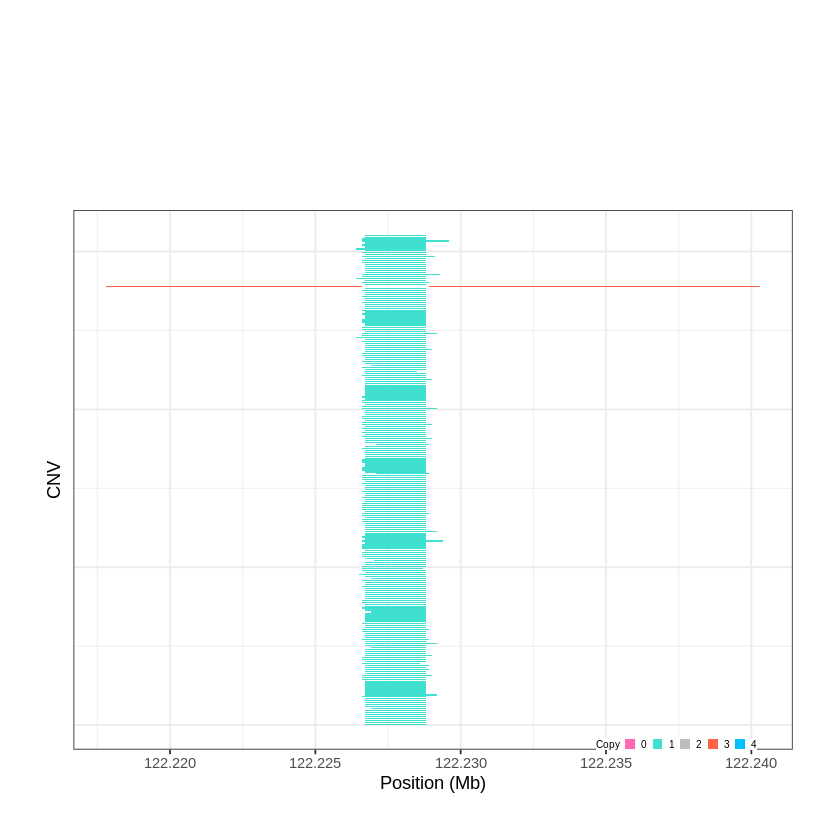

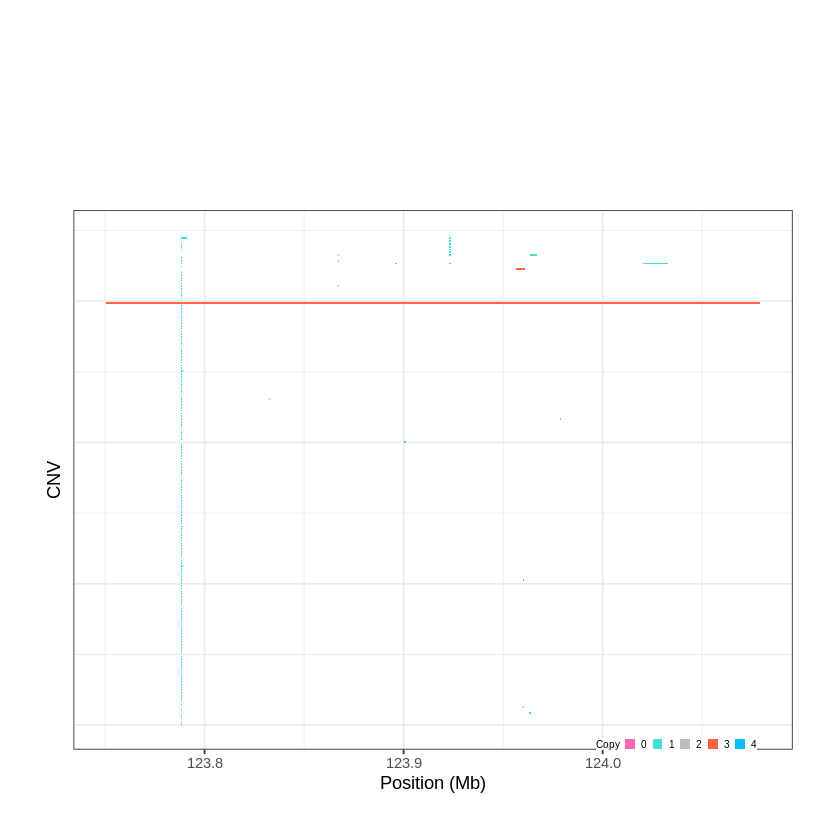

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1289..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 125.587401 - 125.7357 Mb with 213 Individual - "
Plotting gene...


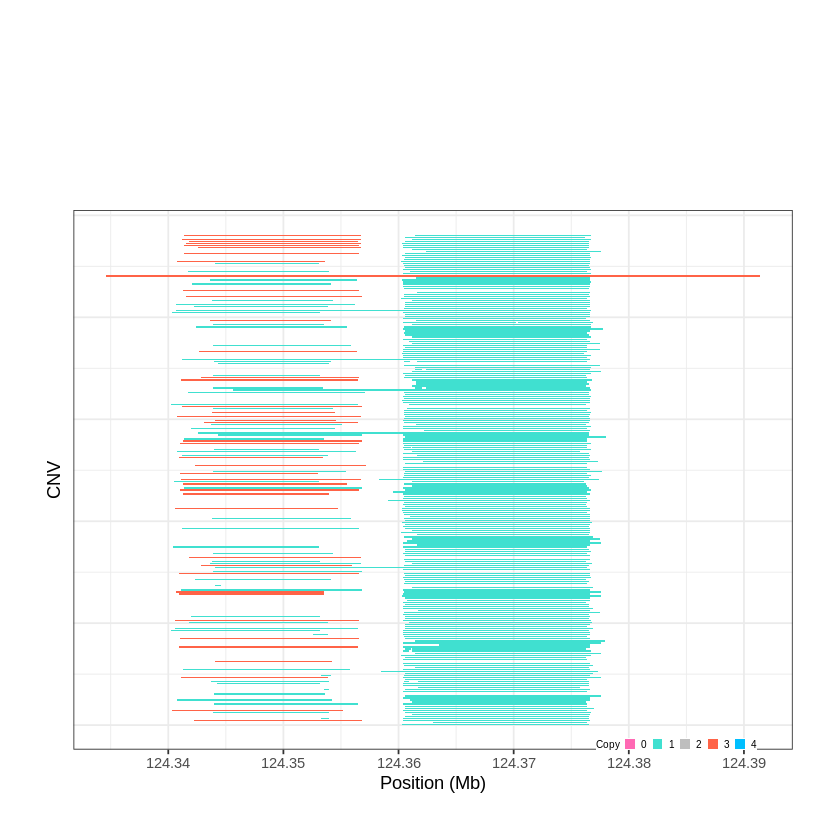

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1290..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 125.748101 - 125.9195 Mb with 279 Individual - "
Plotting gene...


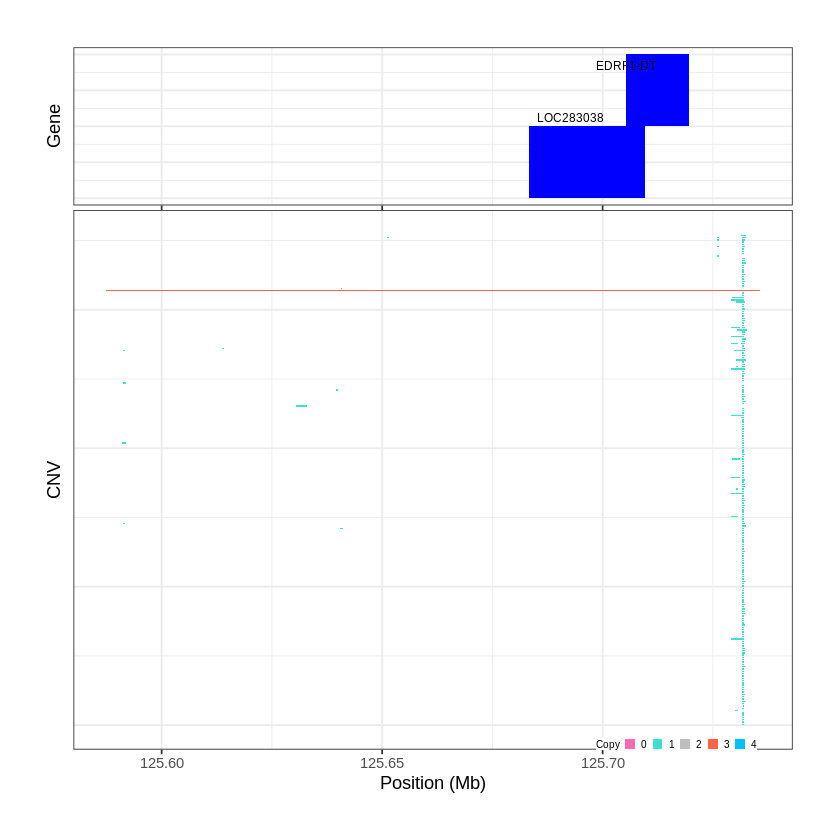

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1291..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 125.919501 - 126.4436 Mb with 206 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1292..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 126.676401 - 126.8609 Mb with 172 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


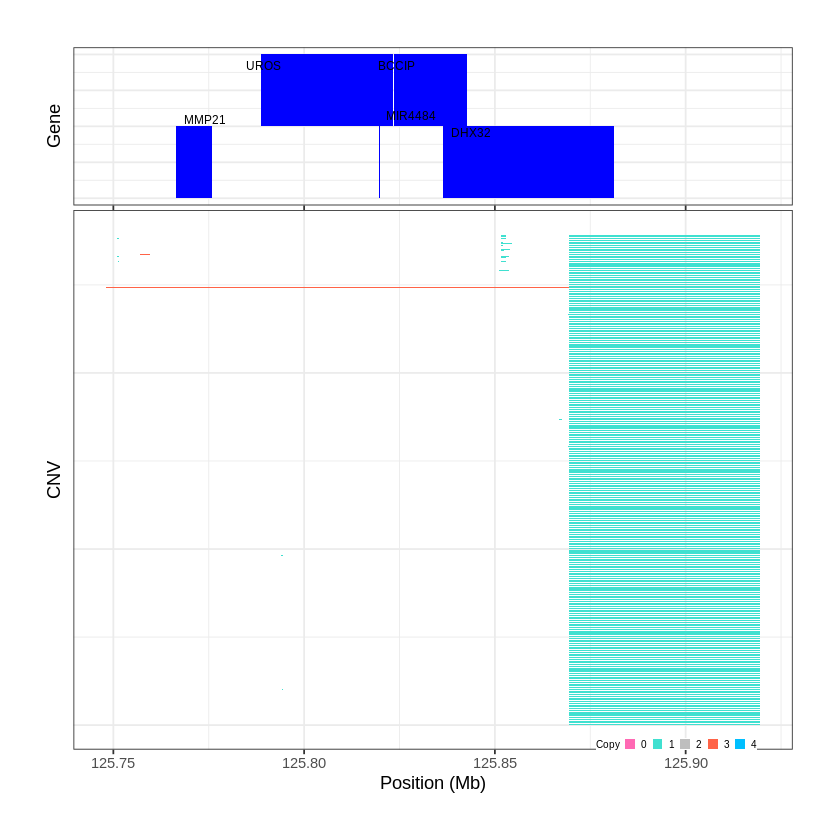

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1293..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 128.106501 - 128.1068 Mb with 219 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


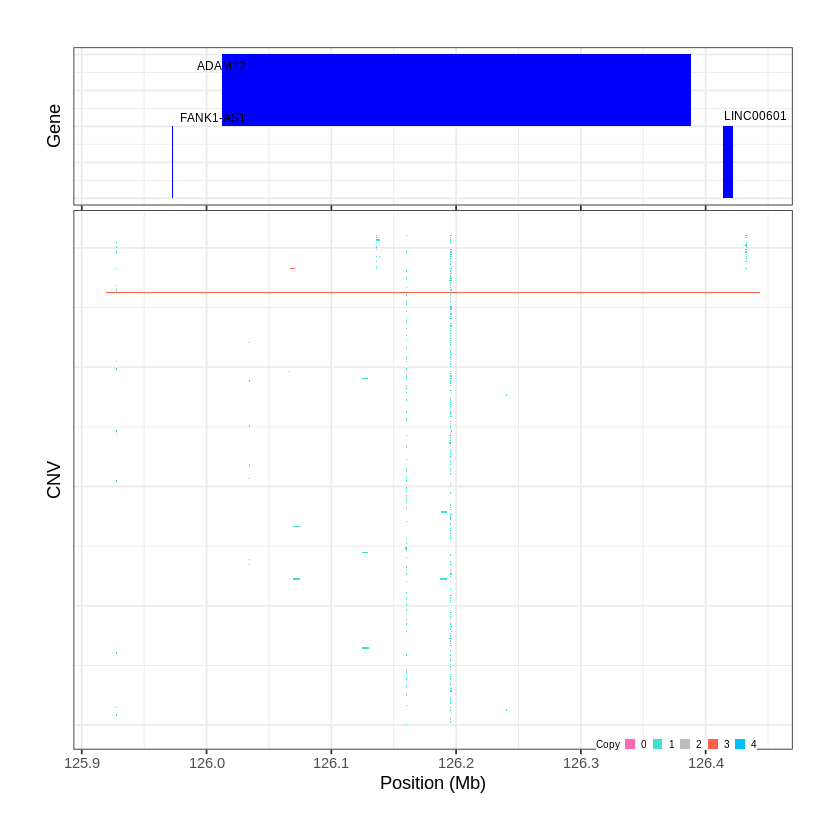

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1294..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 128.526301 - 128.767 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


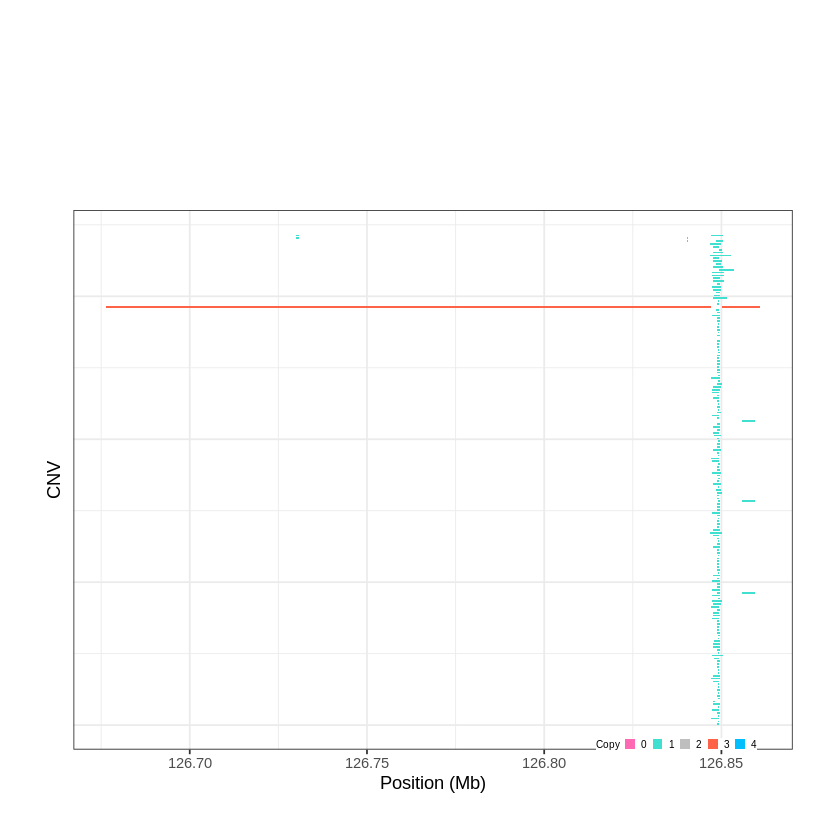

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1295..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 129.546901 - 129.5939 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


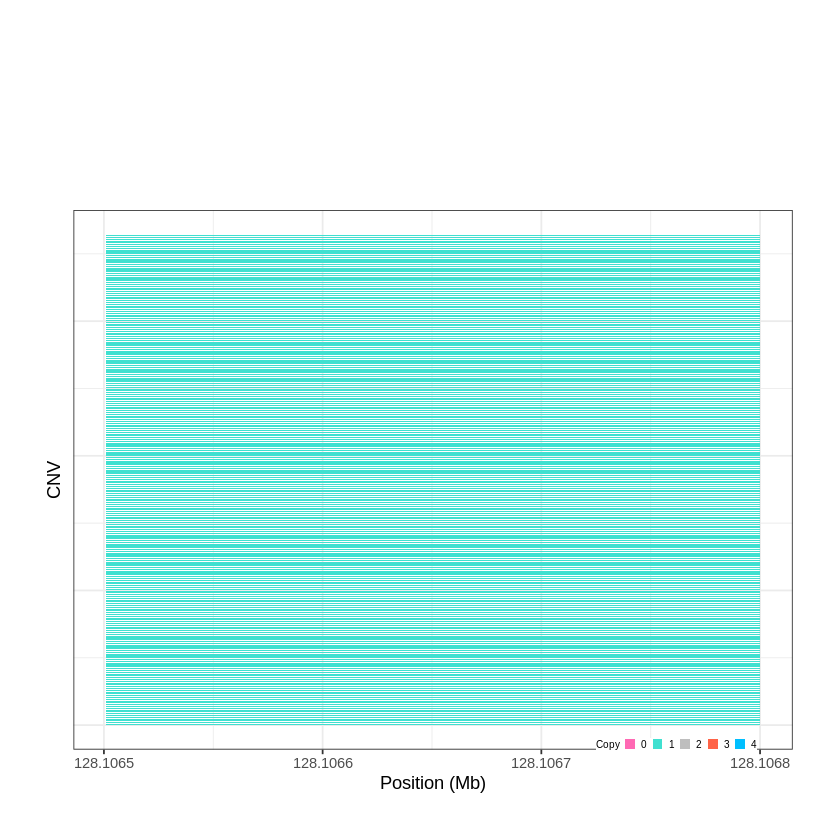

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1296..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 131.292901 - 131.4585 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


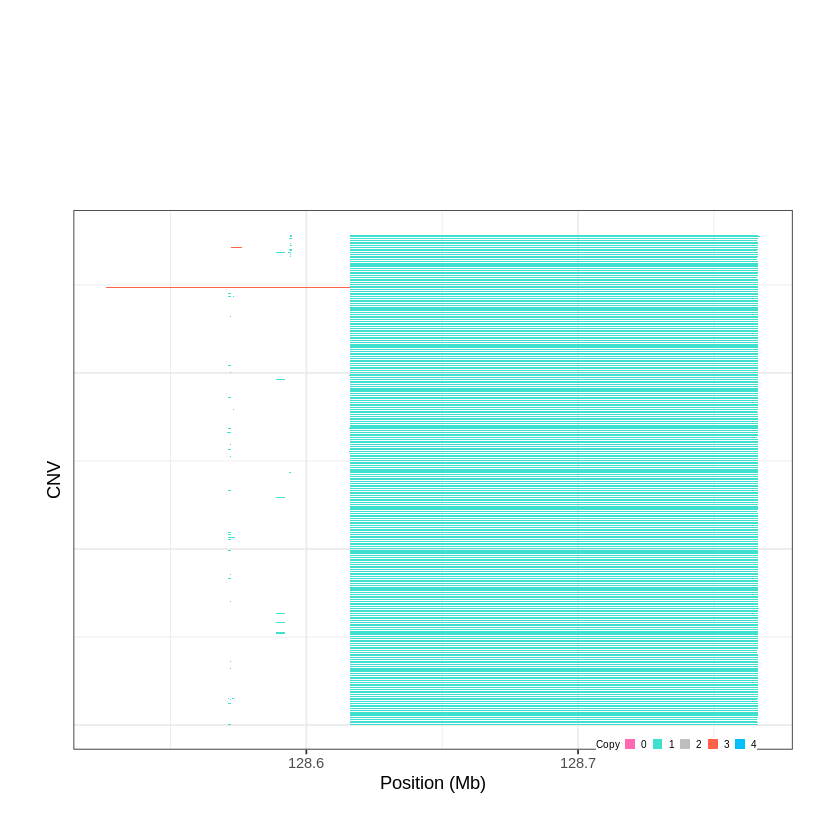

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1297..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 131.799701 - 131.9329 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


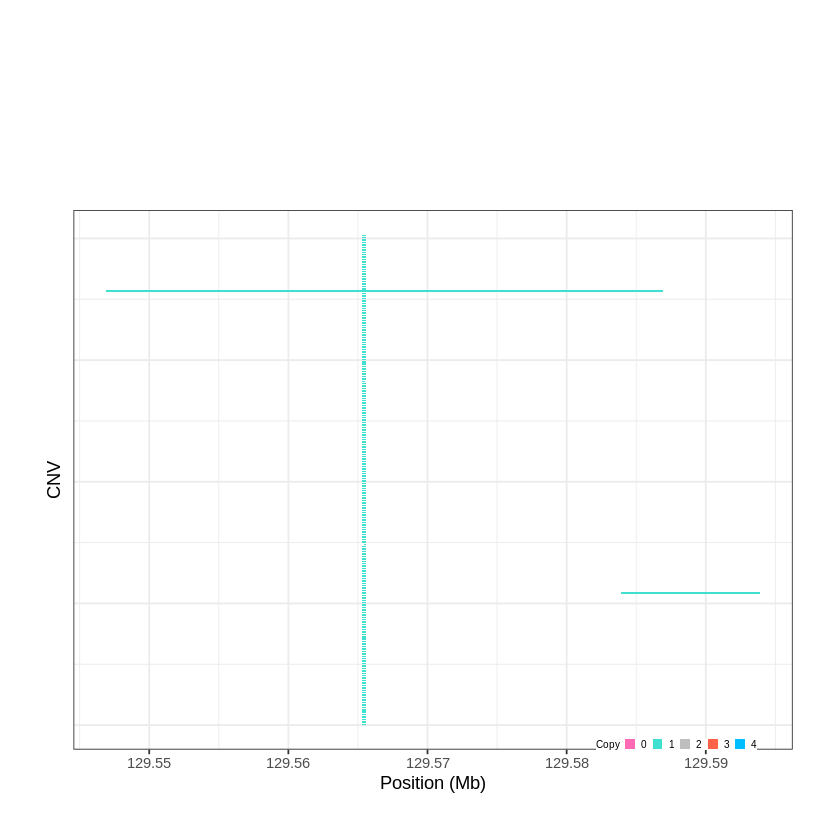

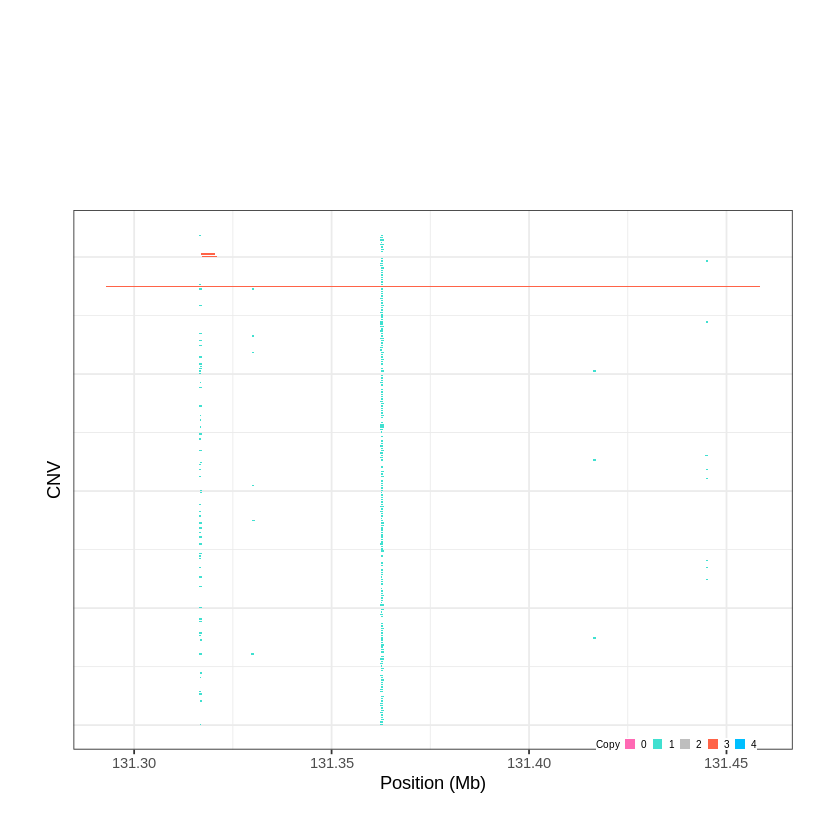

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1298..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 131.947701 - 132.0886 Mb with 228 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1299..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 132.111401 - 132.2 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


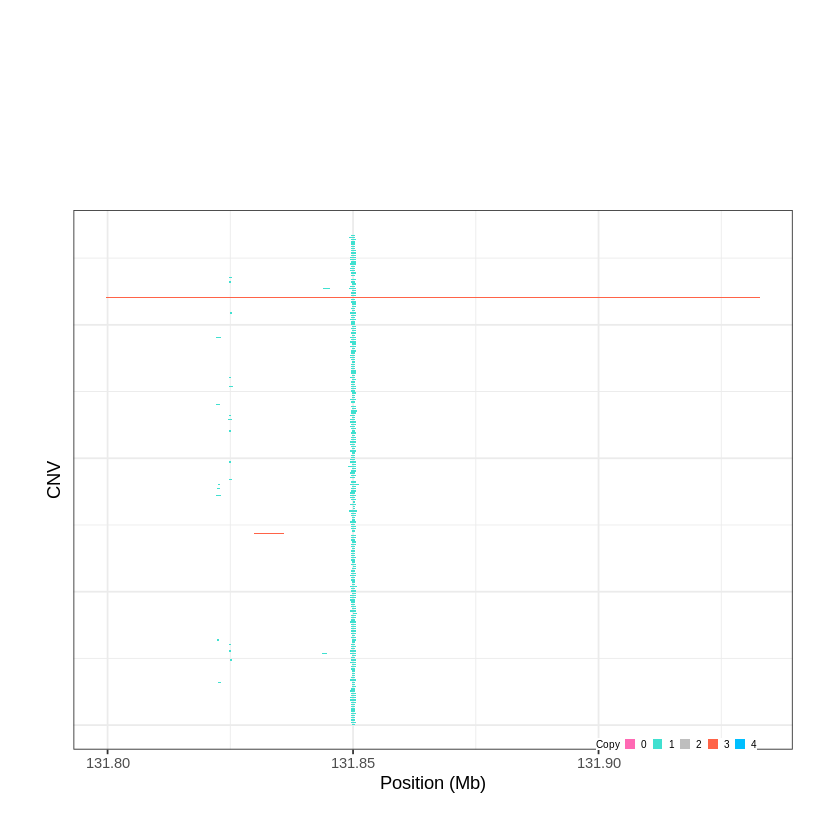

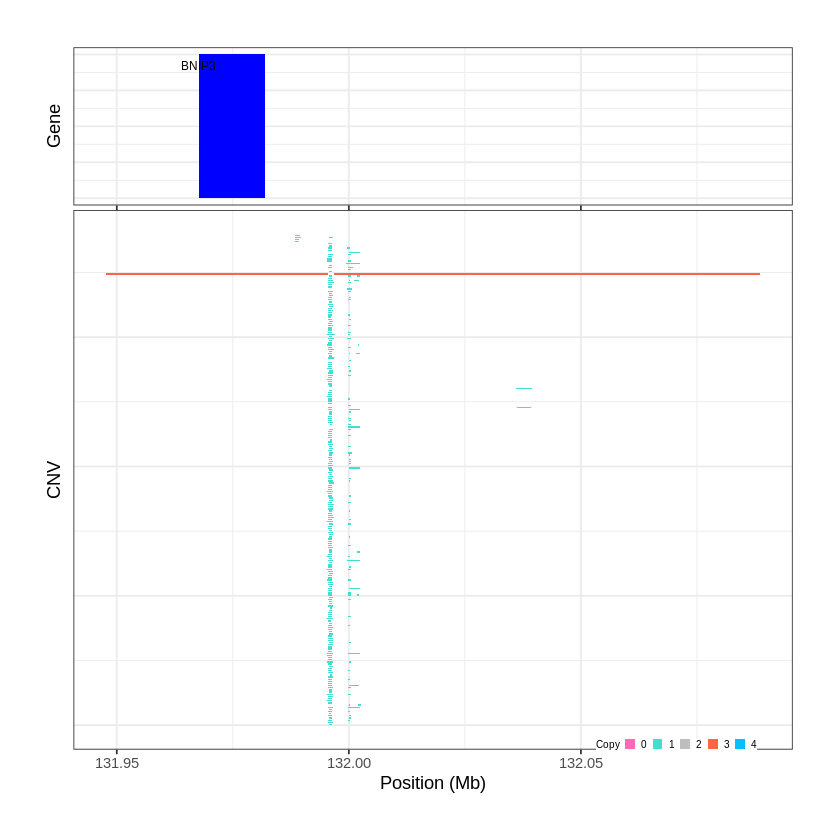

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1300..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 132.482501 - 132.6736 Mb with 267 Individual - "
Plotting gene...


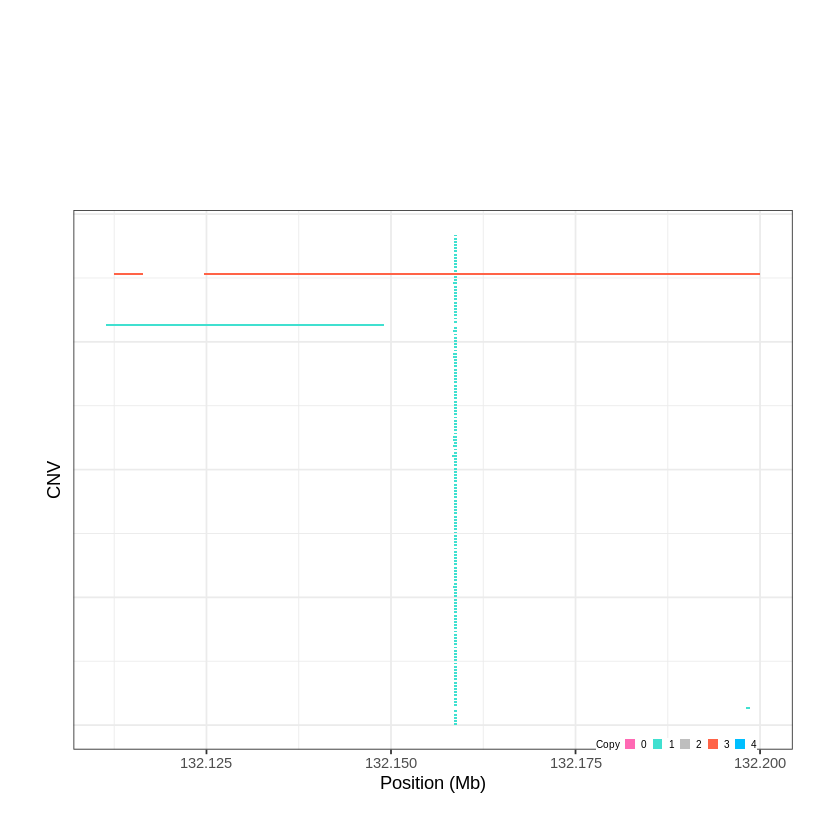

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1301..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 132.855901 - 133.1089 Mb with 206 Individual - "
Plotting gene...


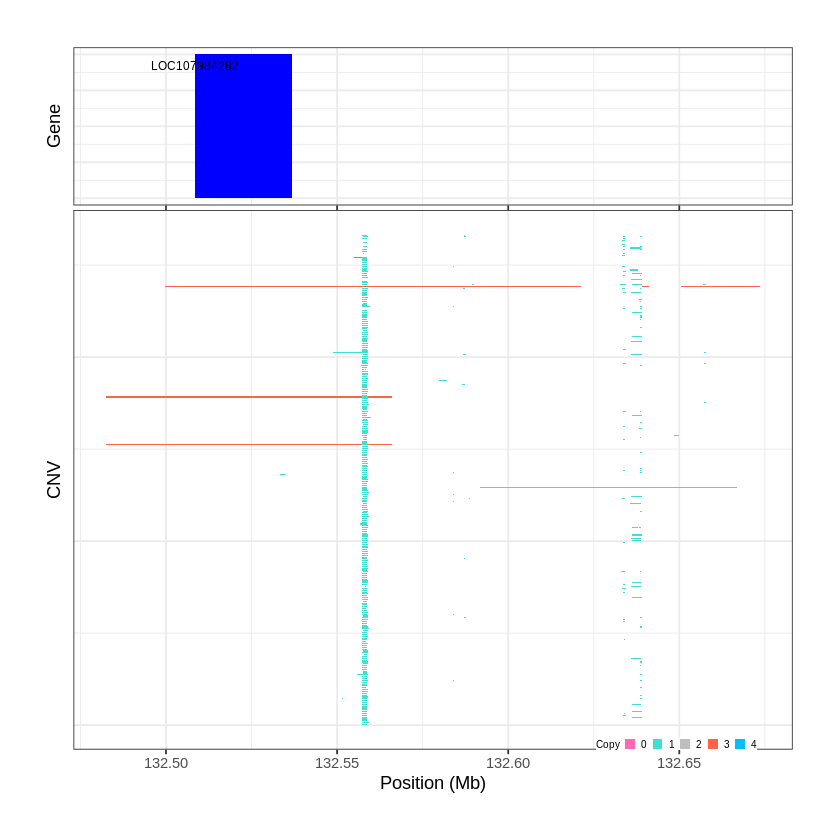

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1302..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 133.381401 - 133.4382 Mb with 279 Individual - "
Plotting gene...


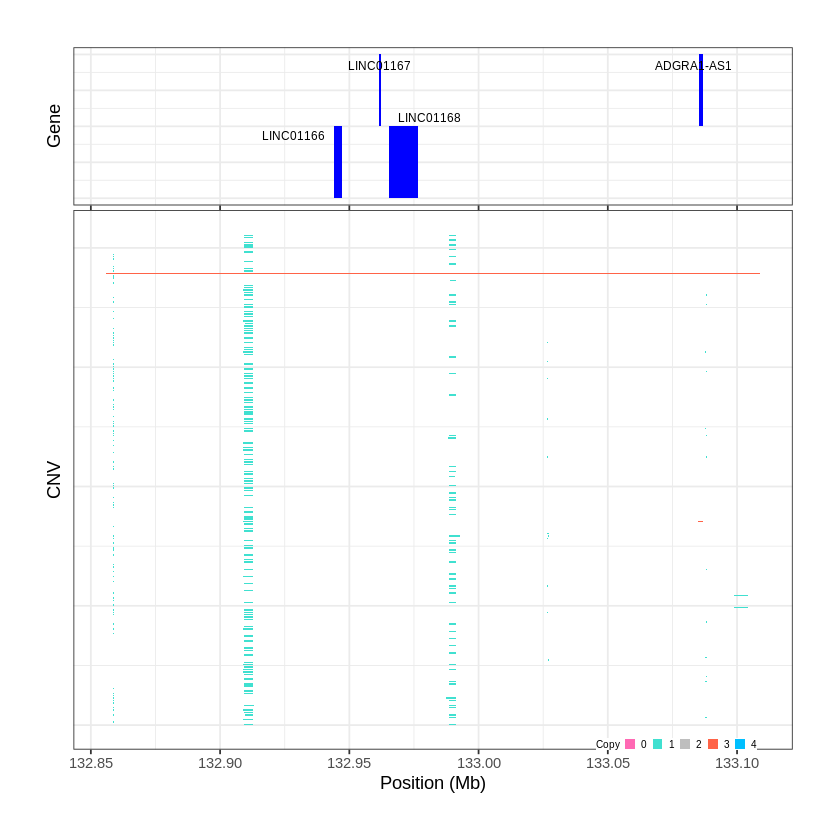

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1303..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 133.440101 - 133.6775 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1304..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 133.677501 - 134.1987 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


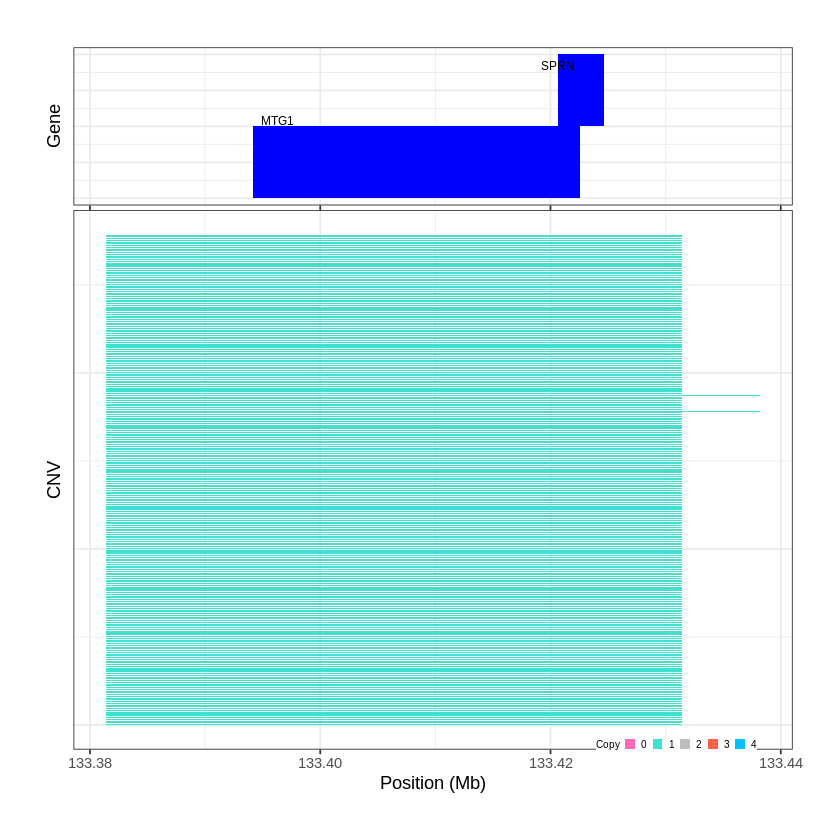

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1305..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 134.200601 - 134.2028 Mb with 247 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


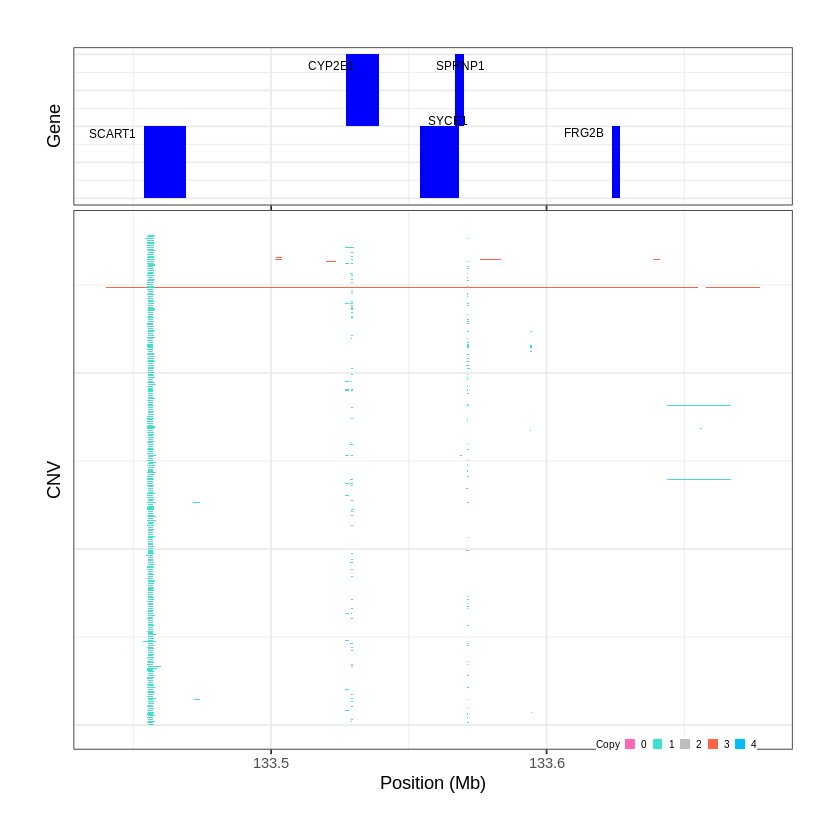

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1306..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 134.261701 - 134.2827 Mb with 267 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


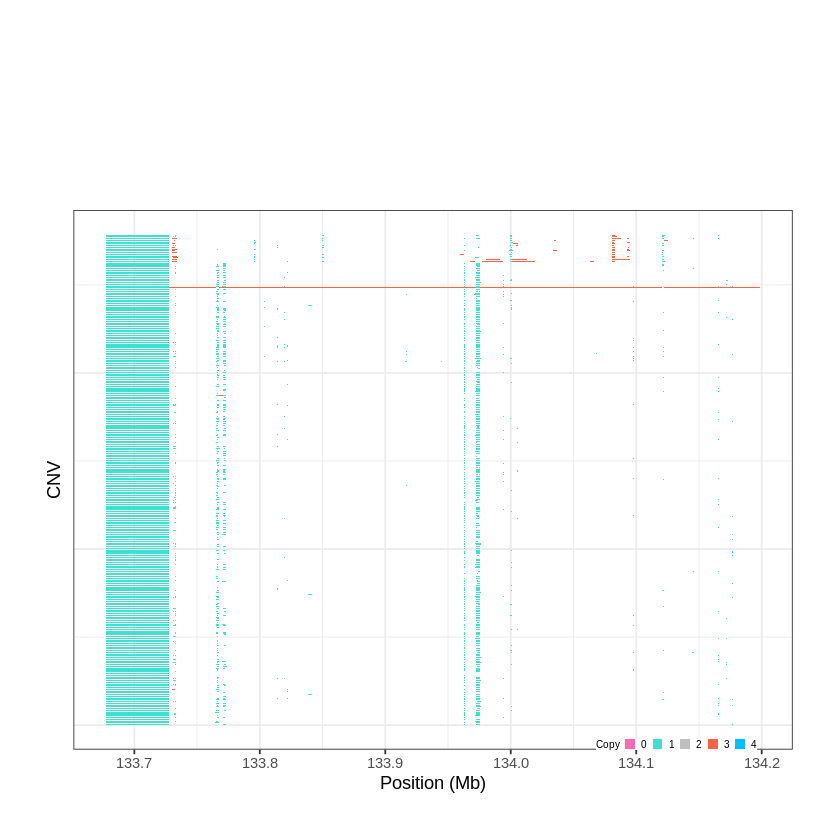

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1307..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 134.303501 - 134.5643 Mb with 262 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


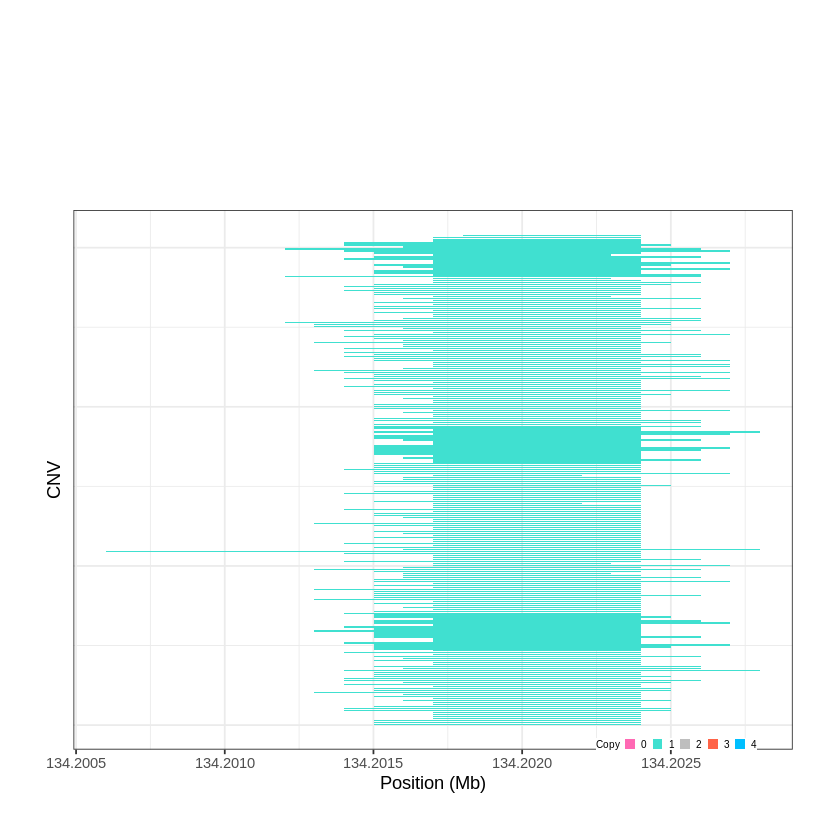

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1308..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 134.565701 - 134.6986 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


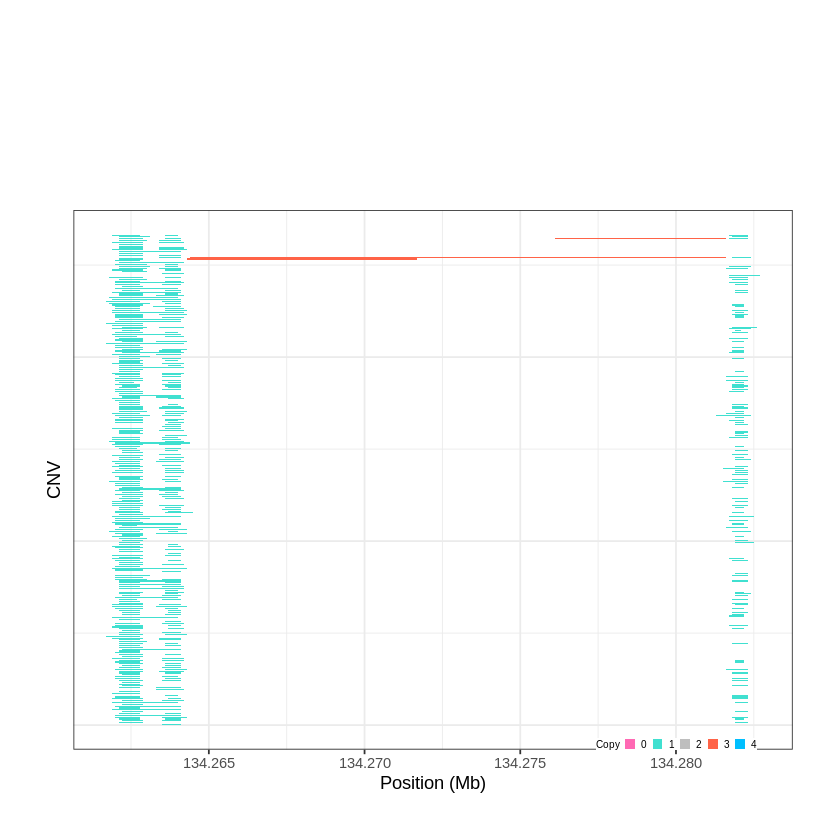

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1309..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 134.703301 - 134.9557 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


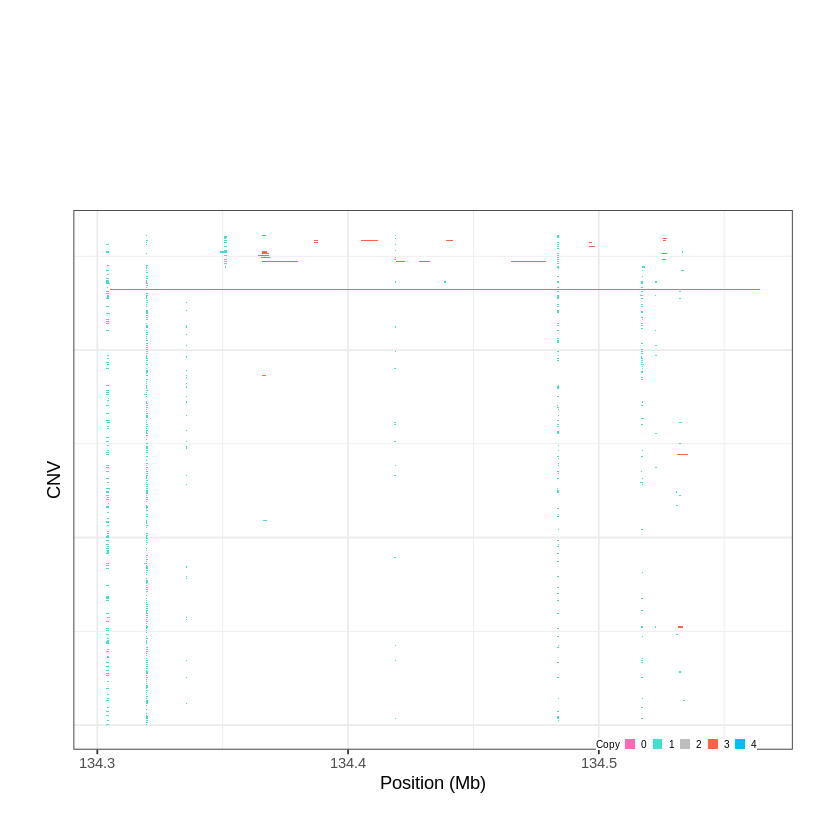

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1310..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 135.097801 - 135.1228 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


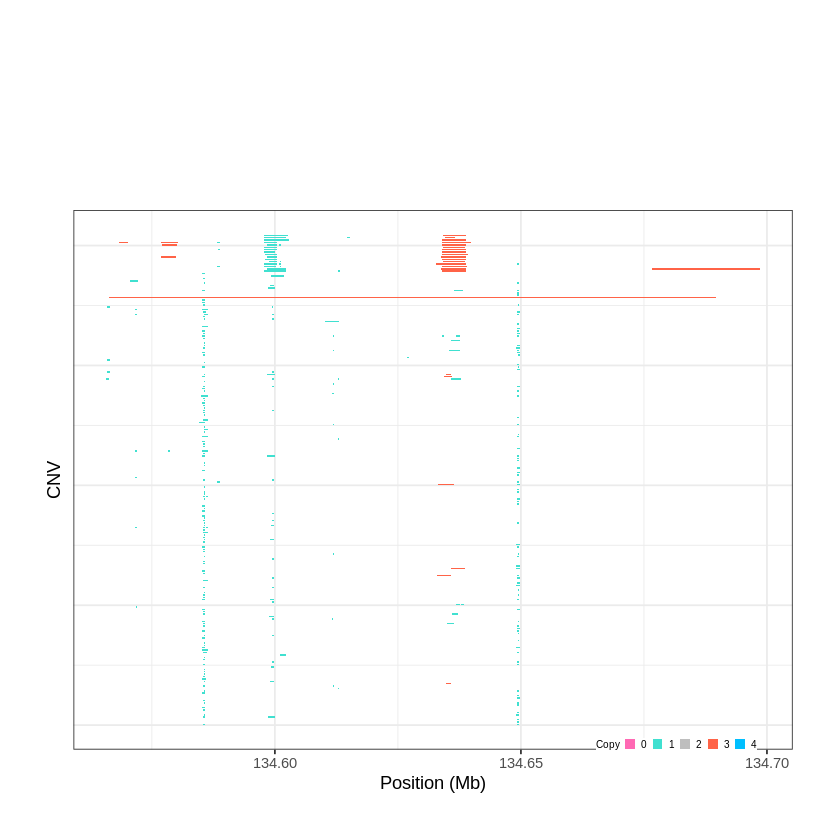

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1311..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 135.123801 - 135.1598 Mb with 274 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


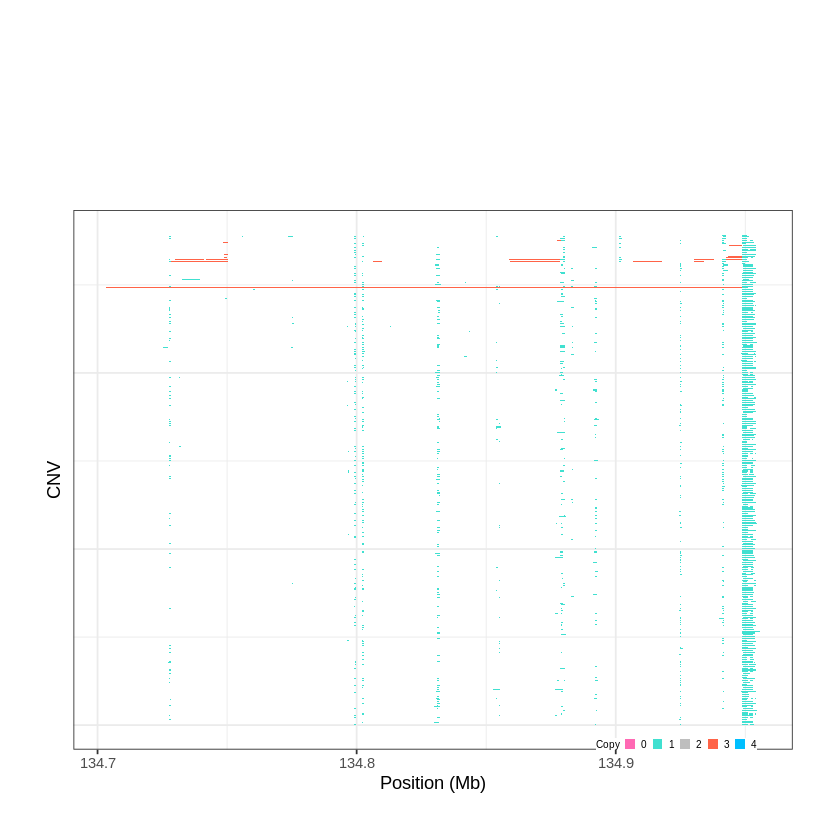

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1312..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 135.170701 - 135.1902 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


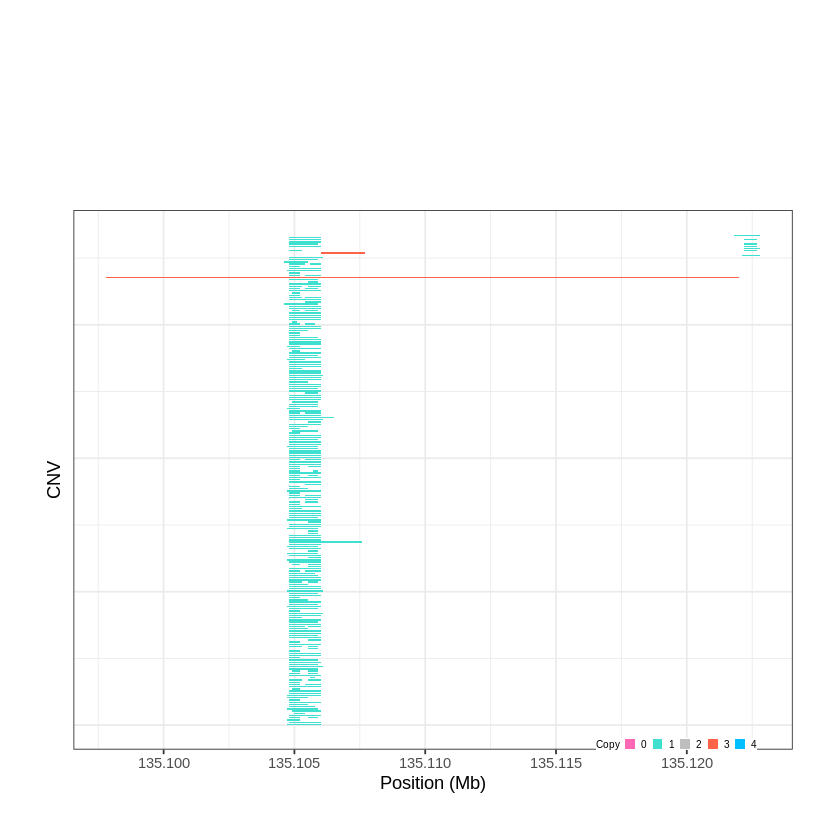

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1313..."
Input data passed requirment check...
[1] "CNV on Chromosome 10: 135.193801 - 135.5348 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


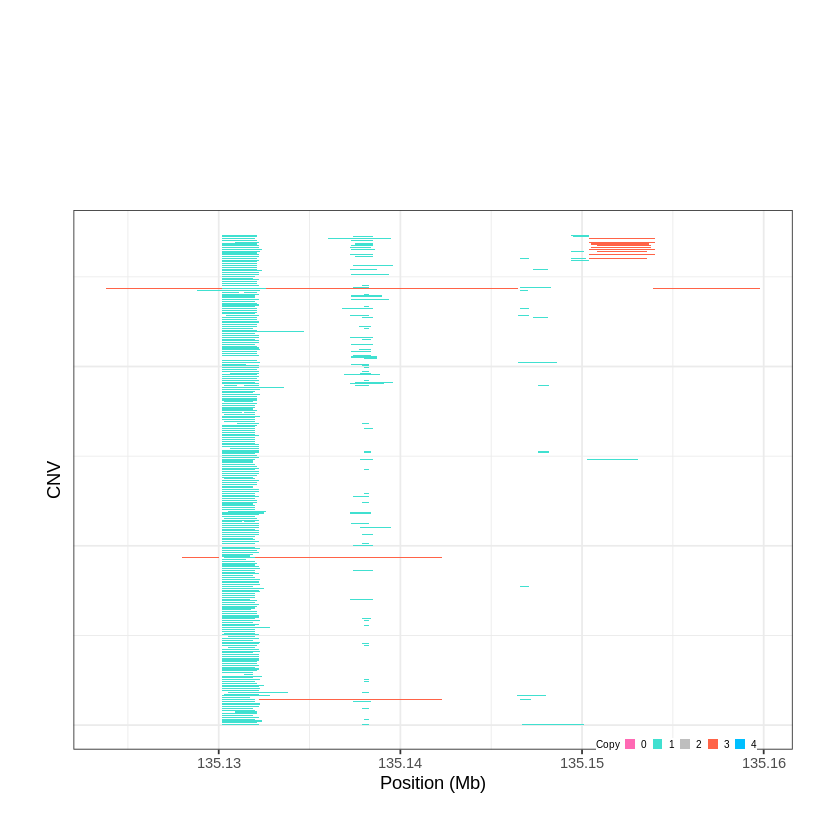

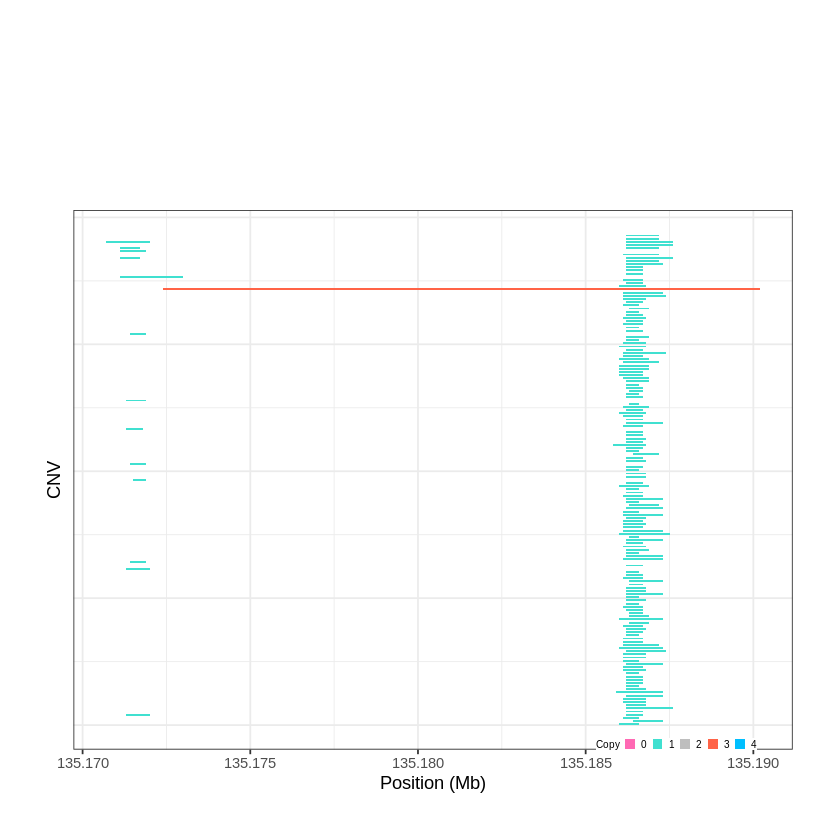

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1314..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 1e-06 - 0.3773 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1315..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 0.396201 - 0.4037 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


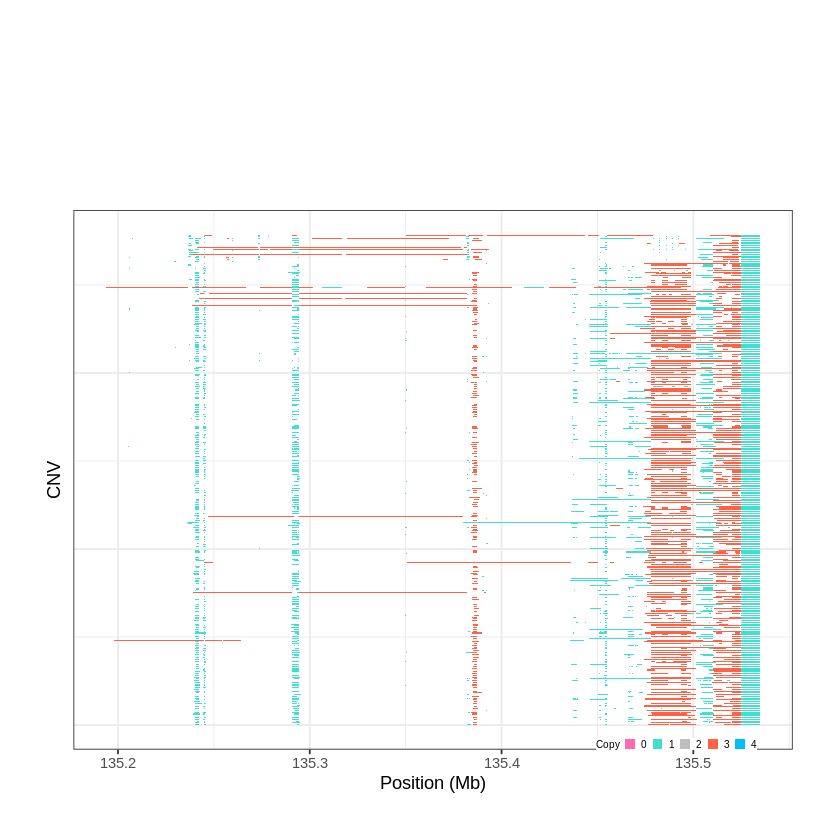

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1316..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 0.406701 - 0.42 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


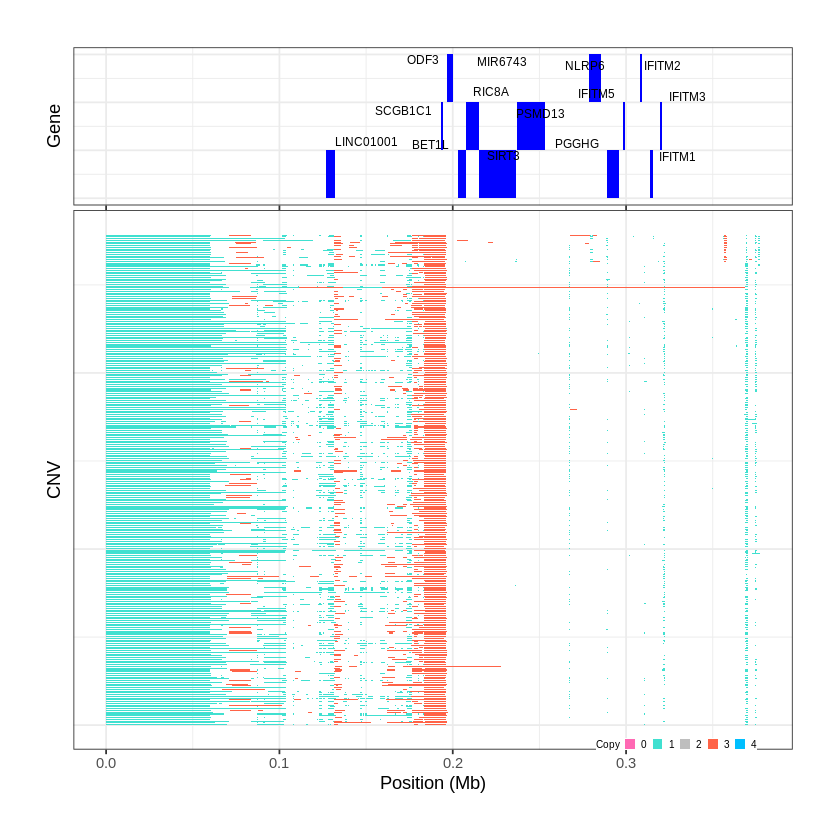

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1317..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 0.429101 - 0.4327 Mb with 254 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


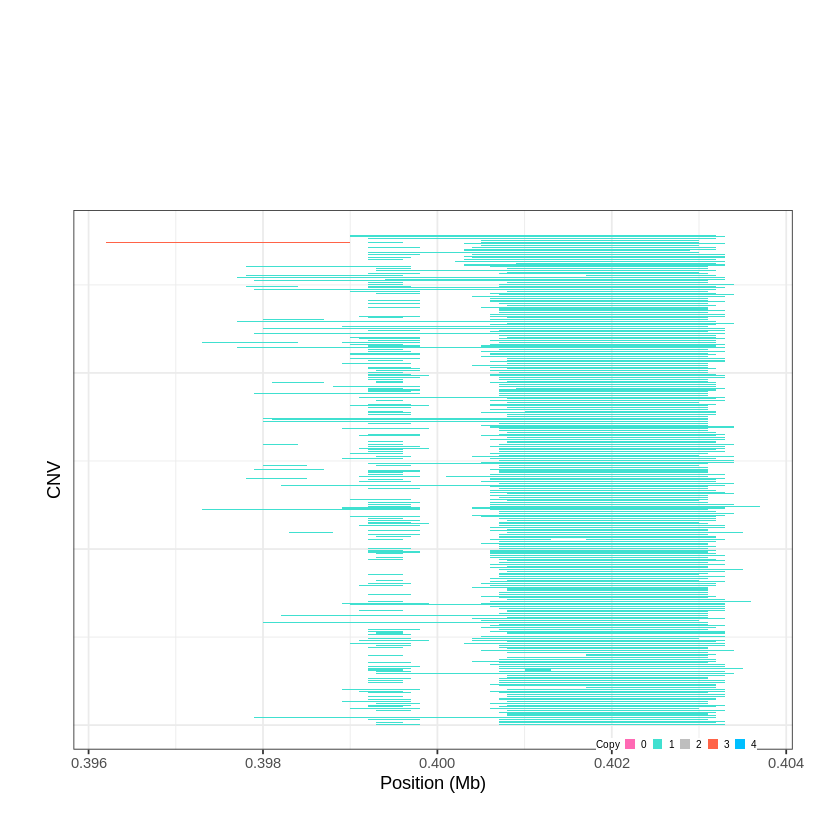

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1318..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 0.435901 - 0.4419 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


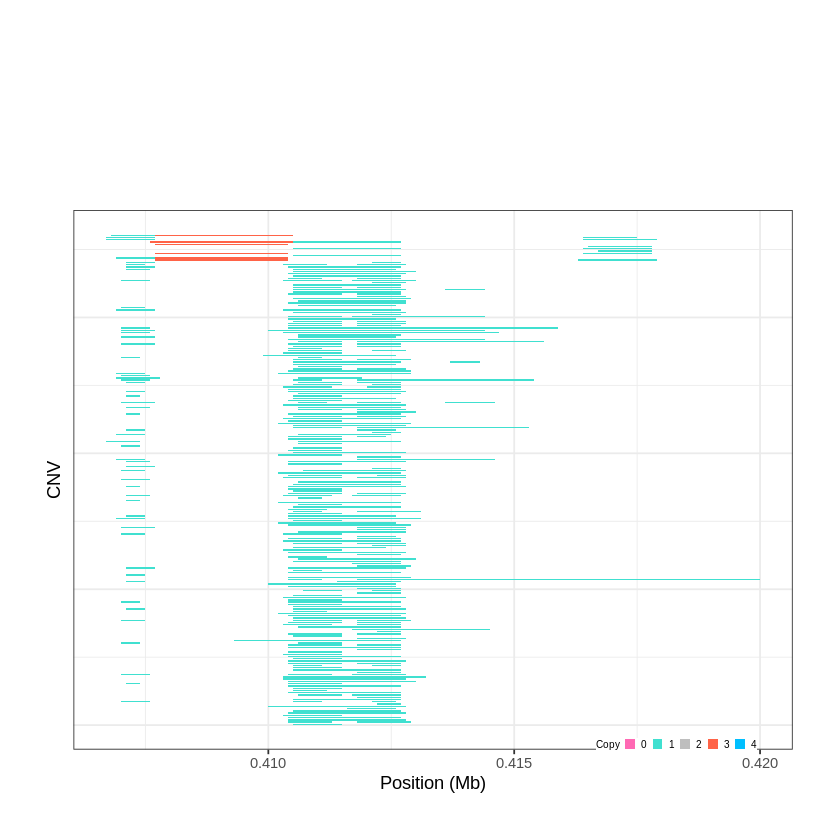

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1319..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 1.075901 - 1.0847 Mb with 252 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


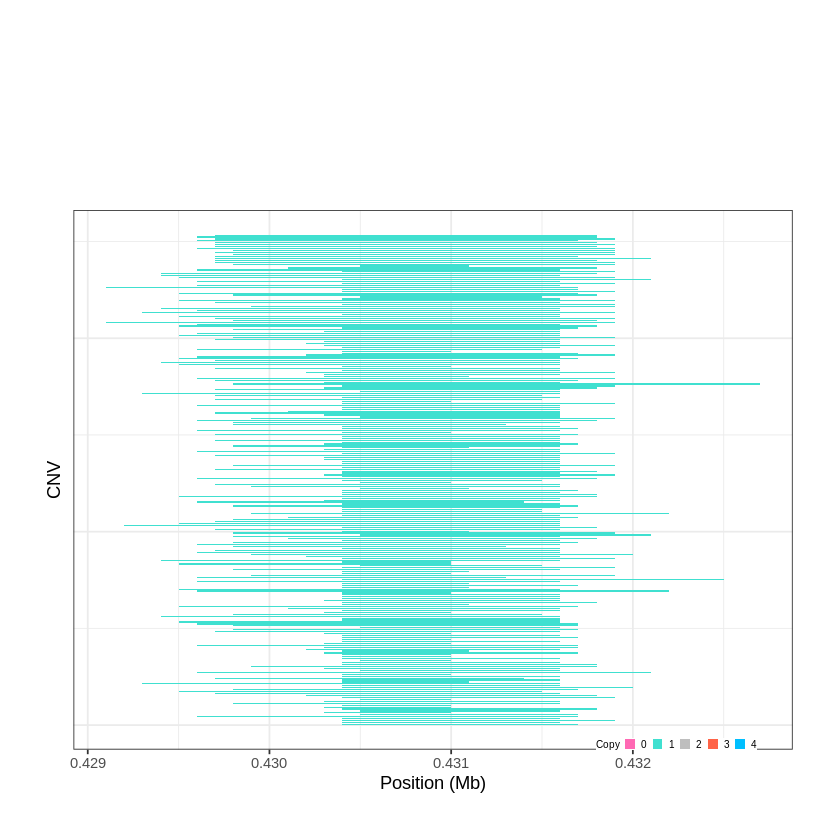

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1320..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 1.162801 - 1.2128 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


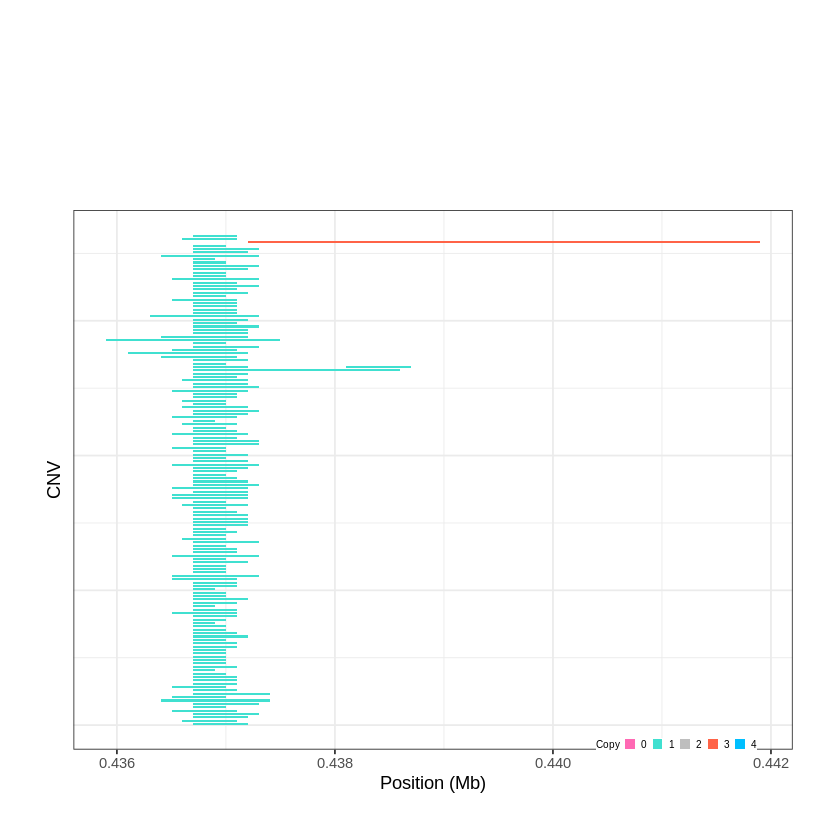

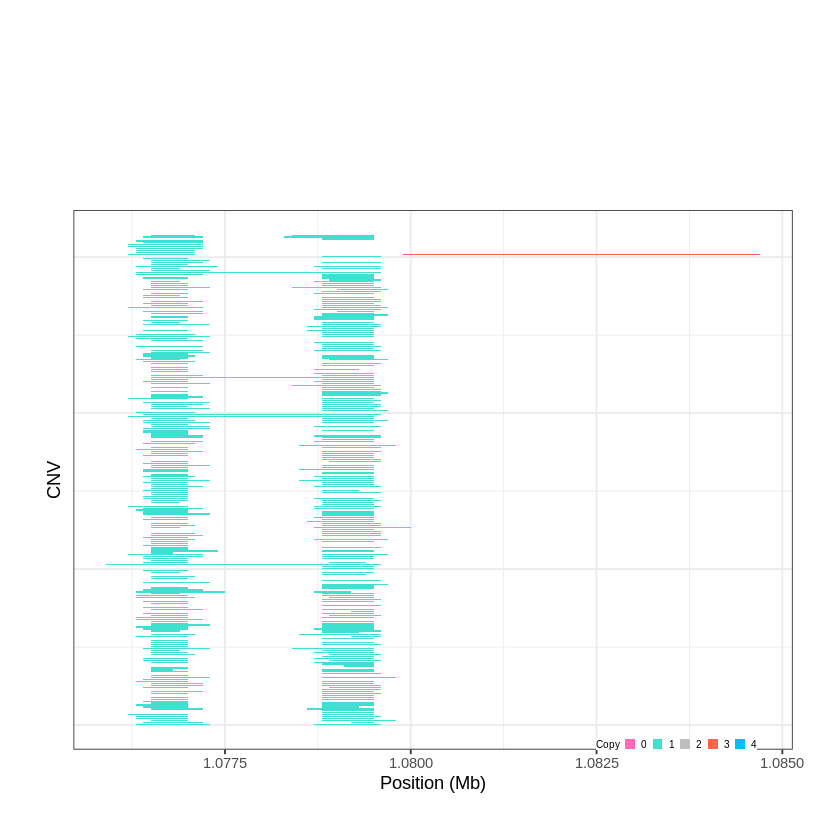

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1321..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 1.255601 - 1.441 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1322..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 1.444901 - 1.464 Mb with 272 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


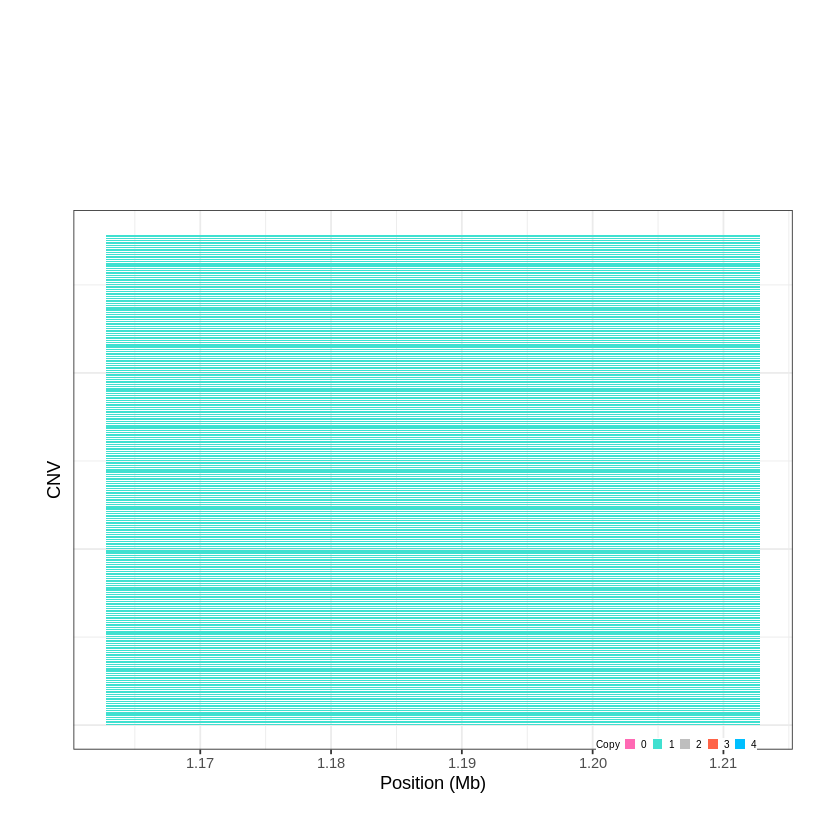

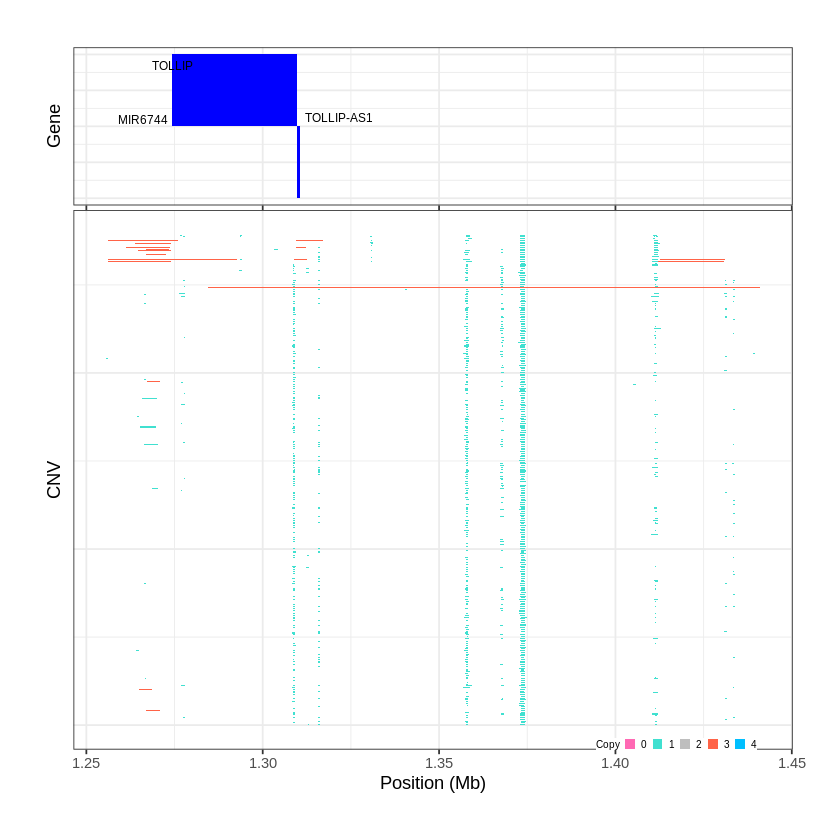

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1323..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 1.654001 - 1.7341 Mb with 273 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1324..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 1.796201 - 1.7994 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


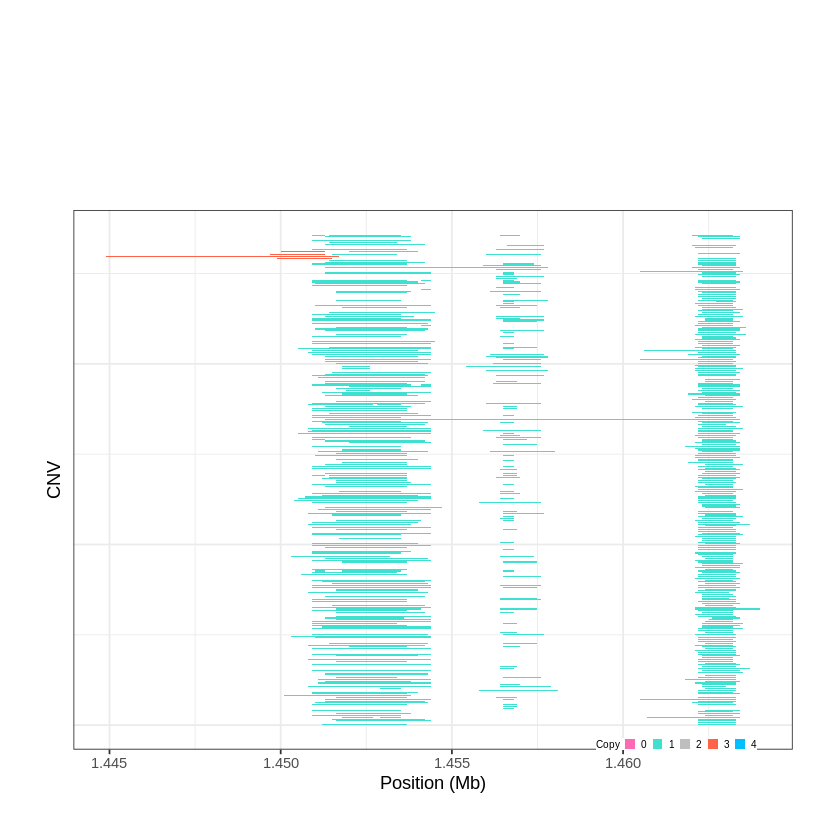

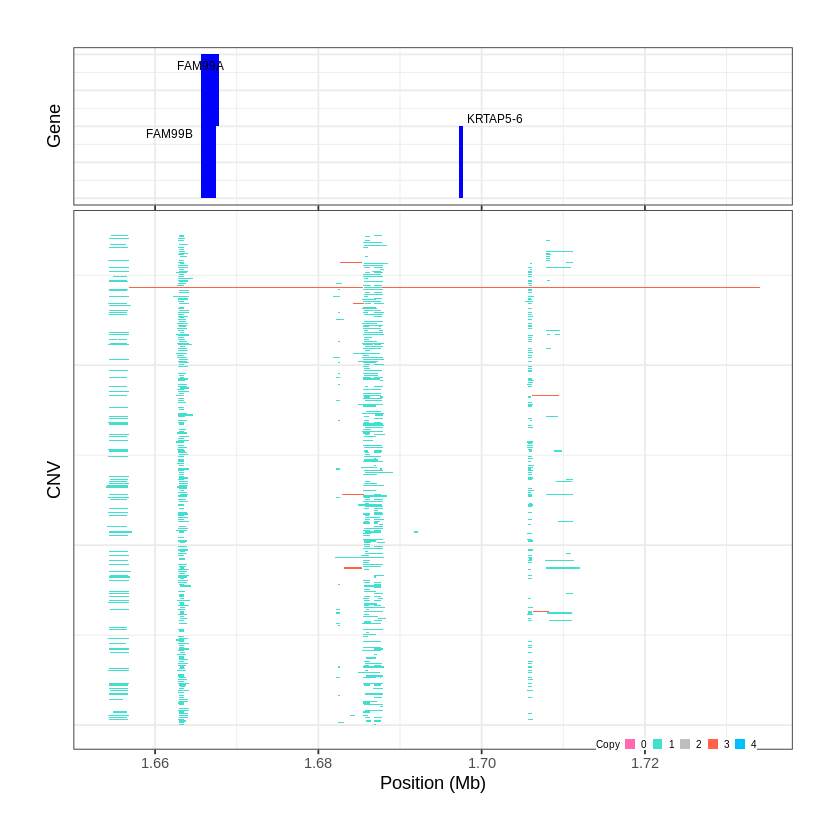

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1325..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 2.100101 - 2.3175 Mb with 233 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1326..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 2.328901 - 2.3306 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


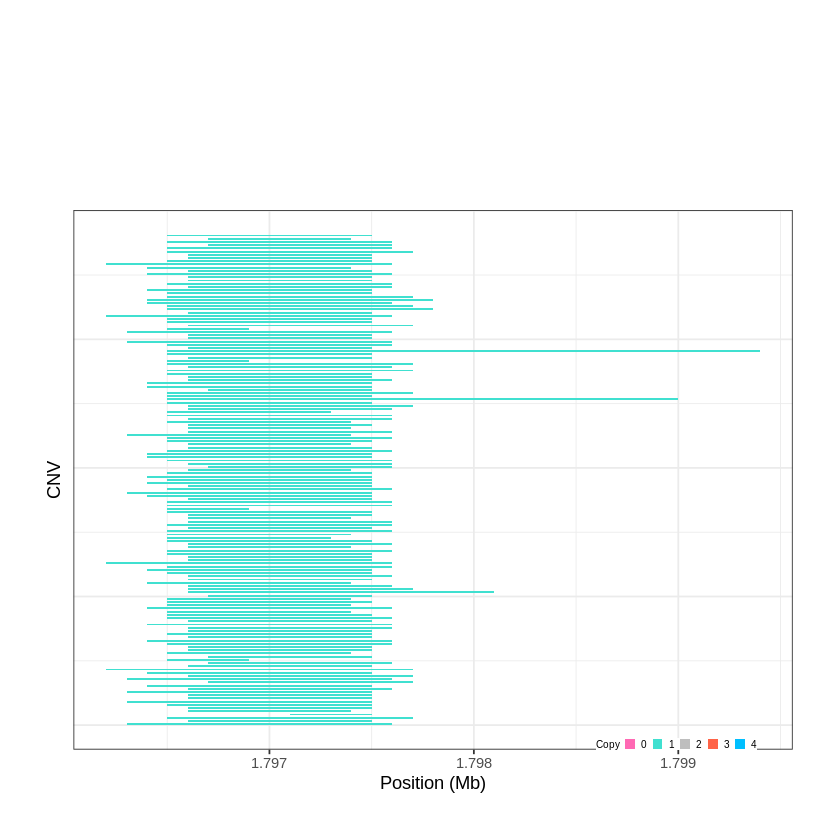

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1327..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 2.474401 - 2.6313 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


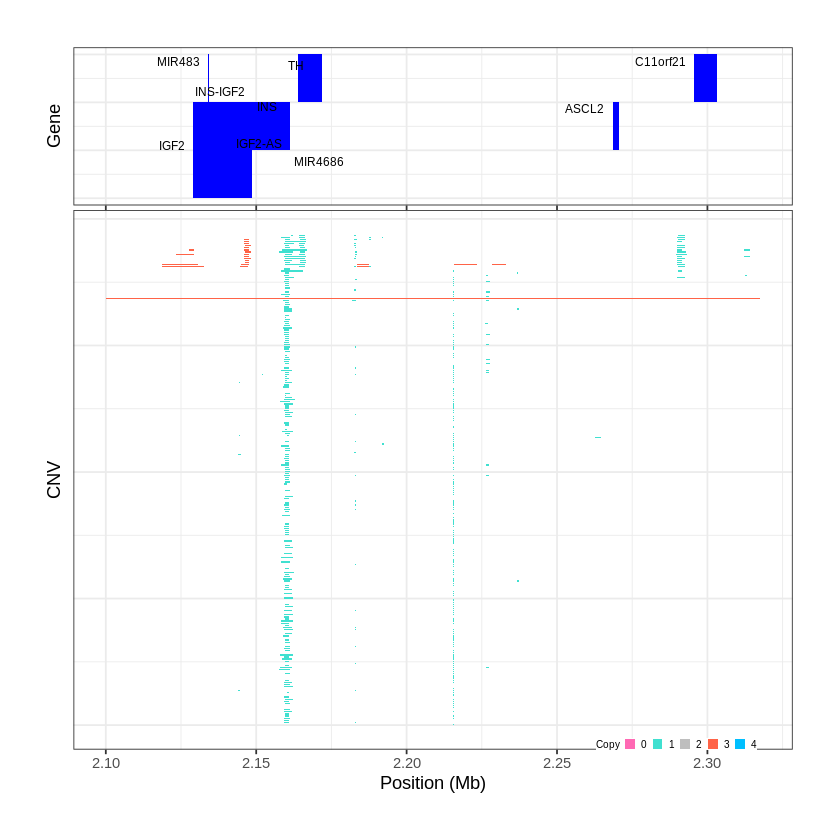

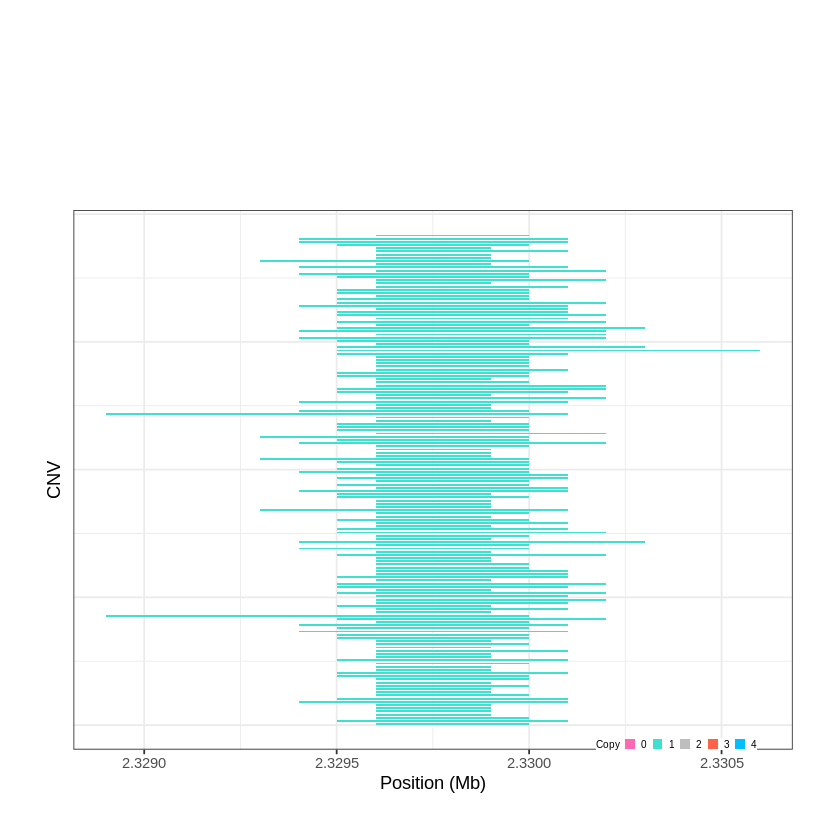

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1328..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 2.706501 - 2.9912 Mb with 215 Individual - "
Plotting gene...


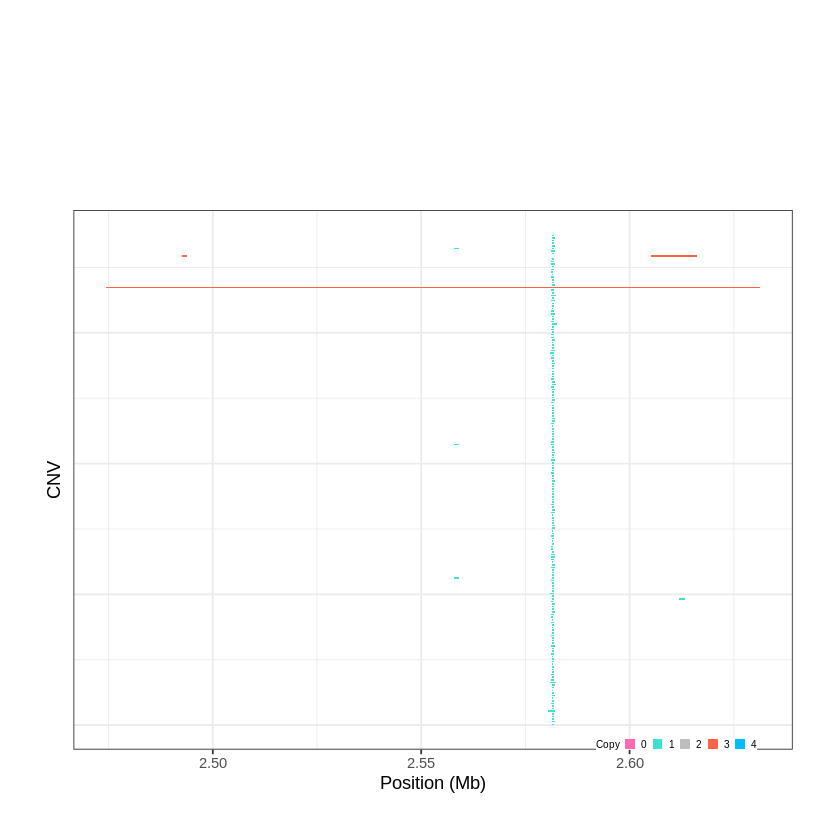

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1329..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 3.129901 - 3.3606 Mb with 279 Individual - "
Plotting gene...


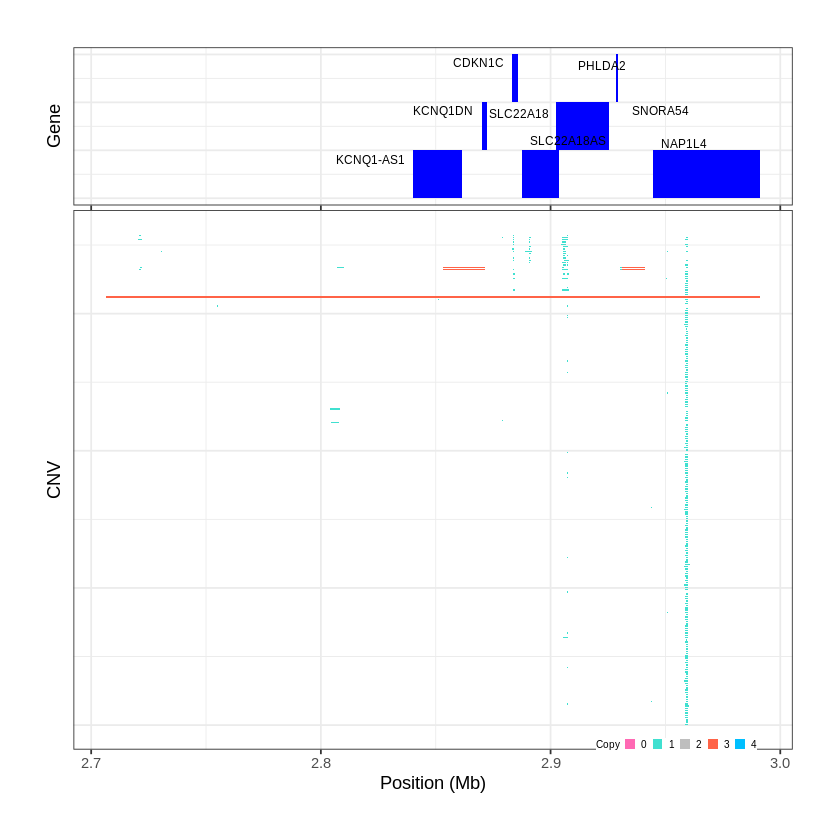

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1330..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 4.238701 - 4.409 Mb with 267 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1331..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 4.967301 - 4.9825 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


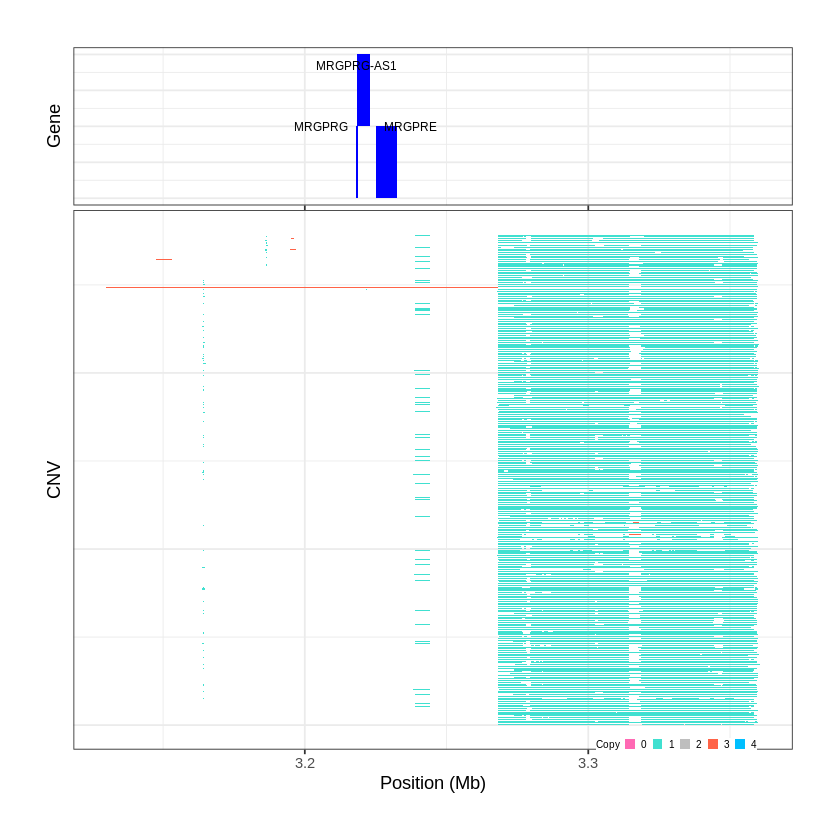

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1332..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 5.757501 - 5.7632 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


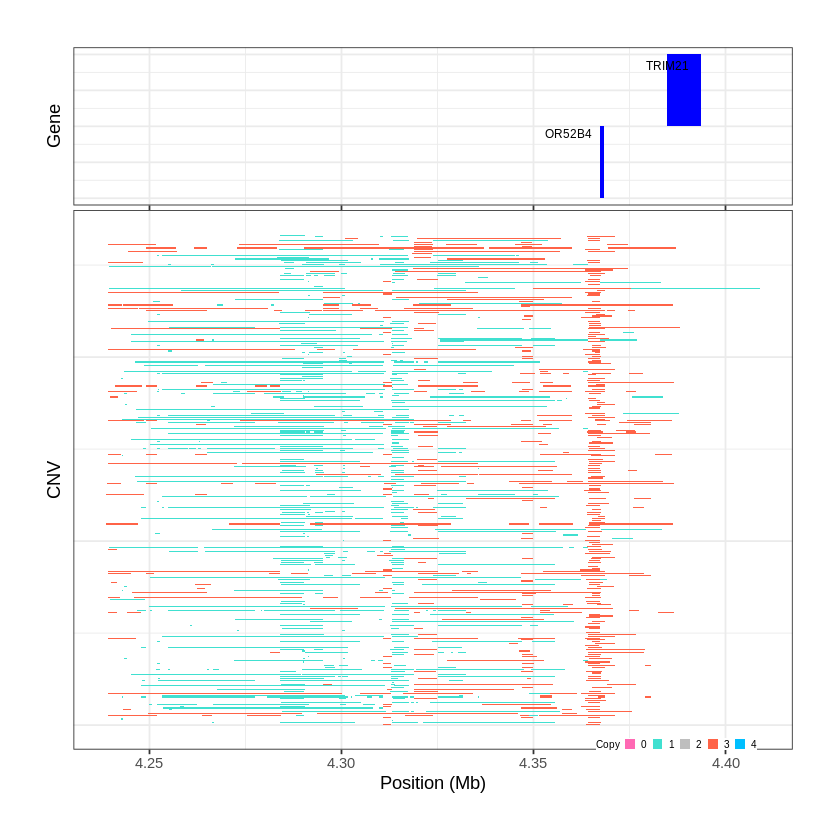

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1333..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 7.716901 - 7.7172 Mb with 244 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


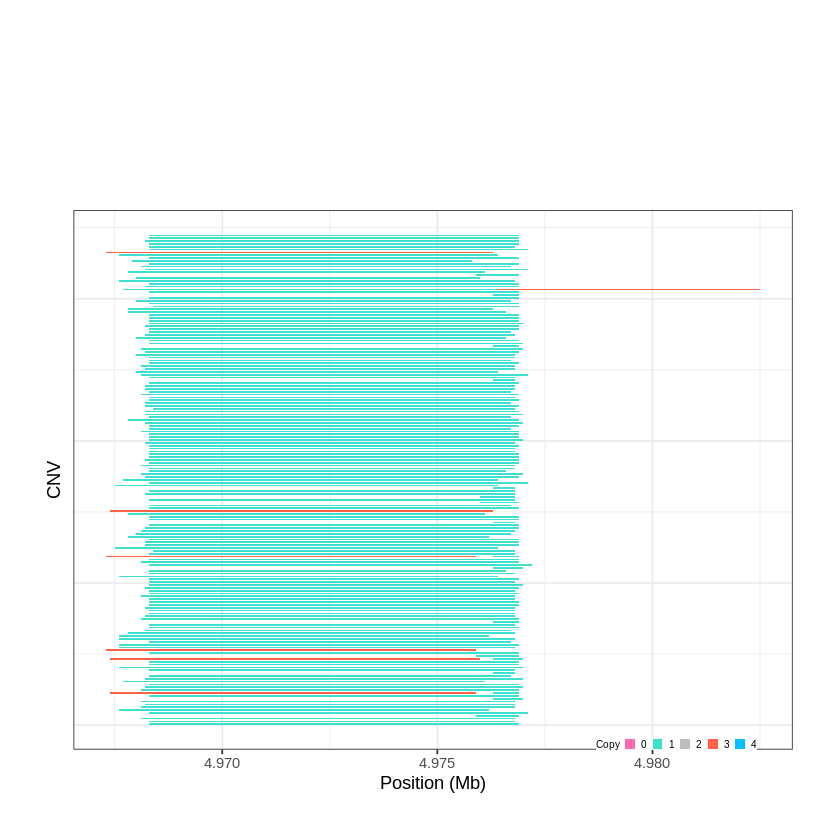

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1334..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 7.782801 - 7.7946 Mb with 207 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


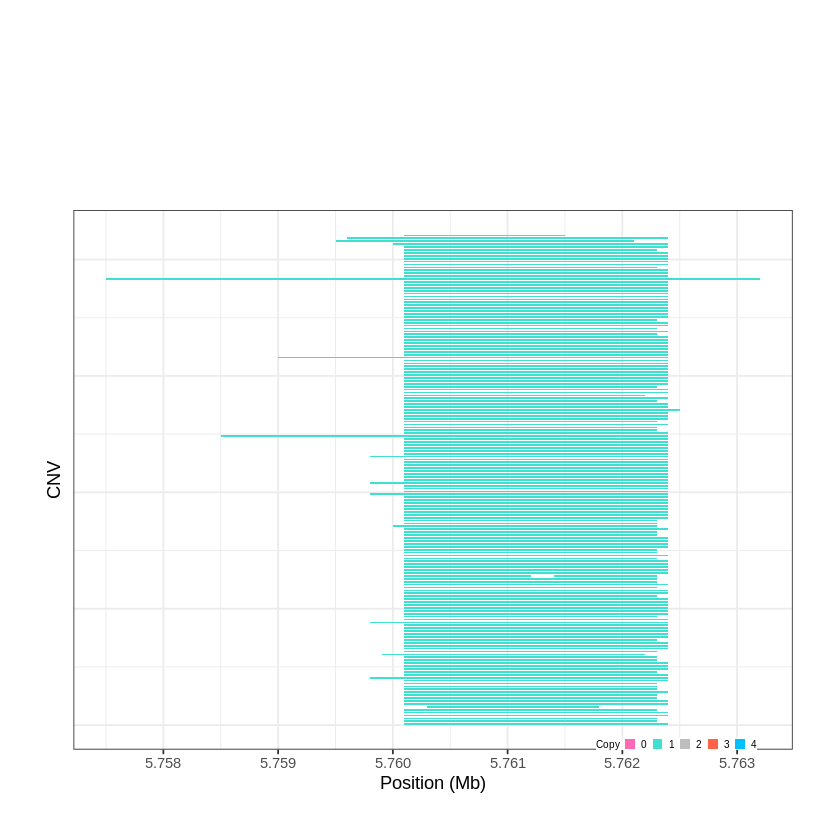

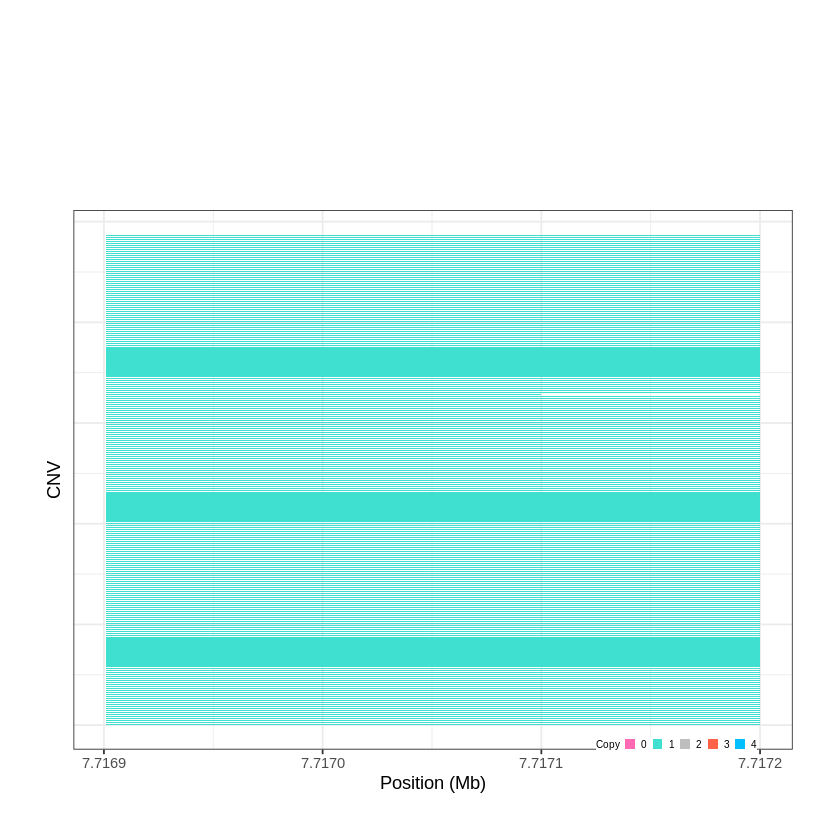

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1335..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 7.810901 - 7.8466 Mb with 267 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1336..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 9.323401 - 9.325 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


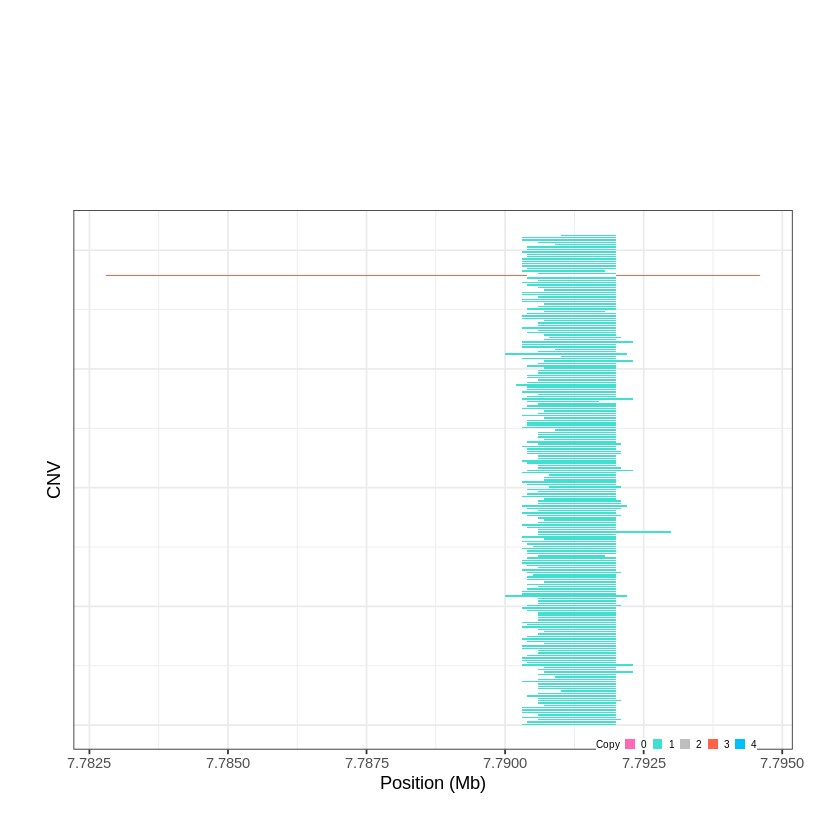

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1337..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 13.564701 - 13.5767 Mb with 223 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


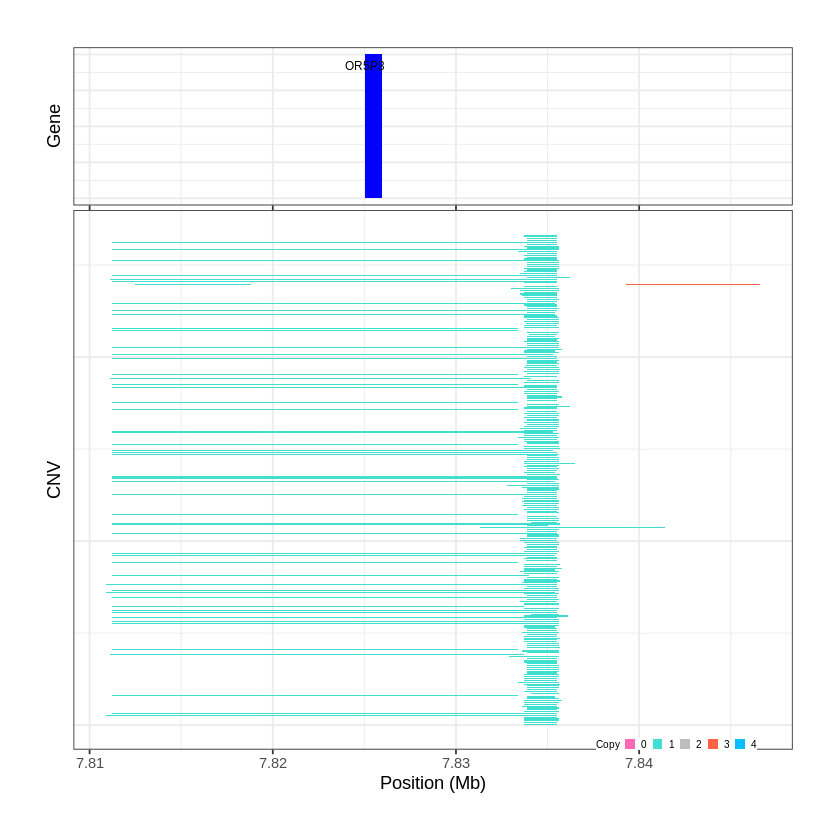

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1338..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 14.176801 - 14.1837 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


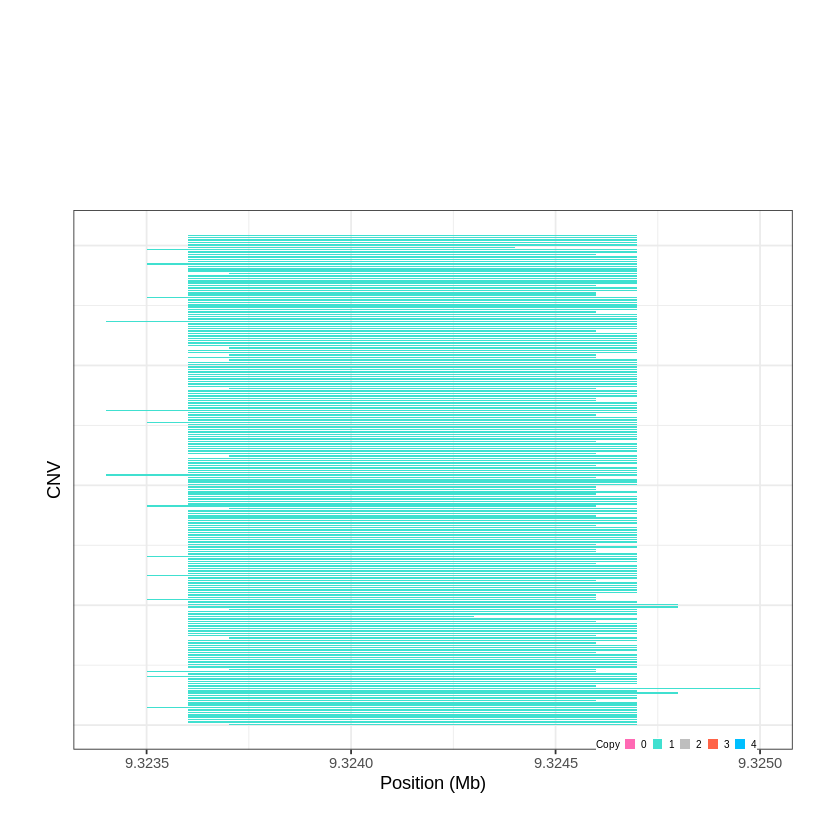

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1339..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 16.593001 - 16.6103 Mb with 215 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


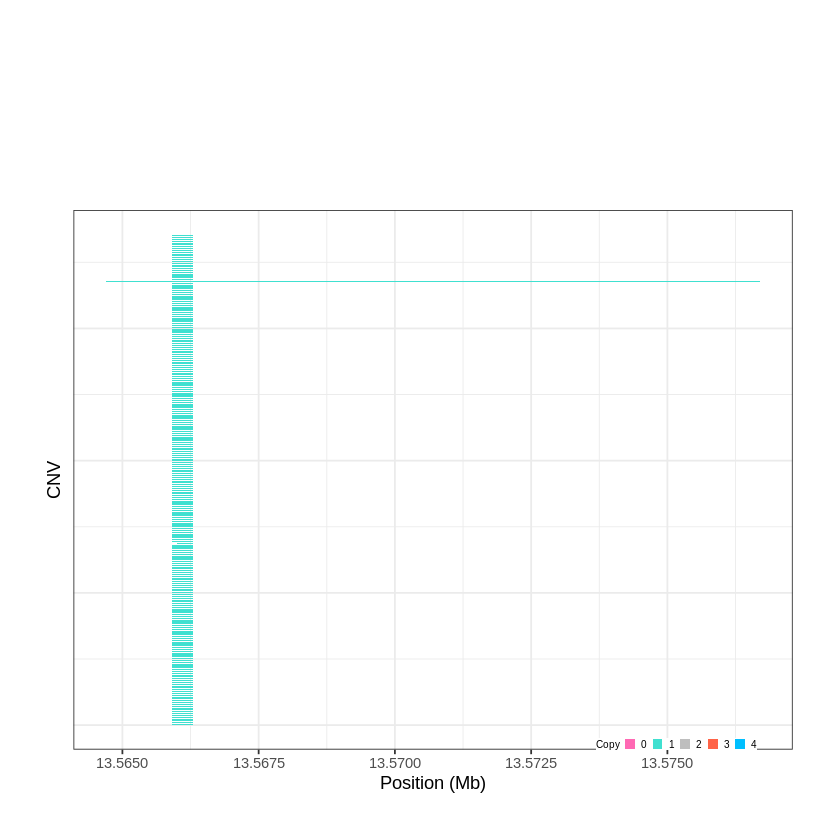

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1340..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 16.996201 - 16.9966 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


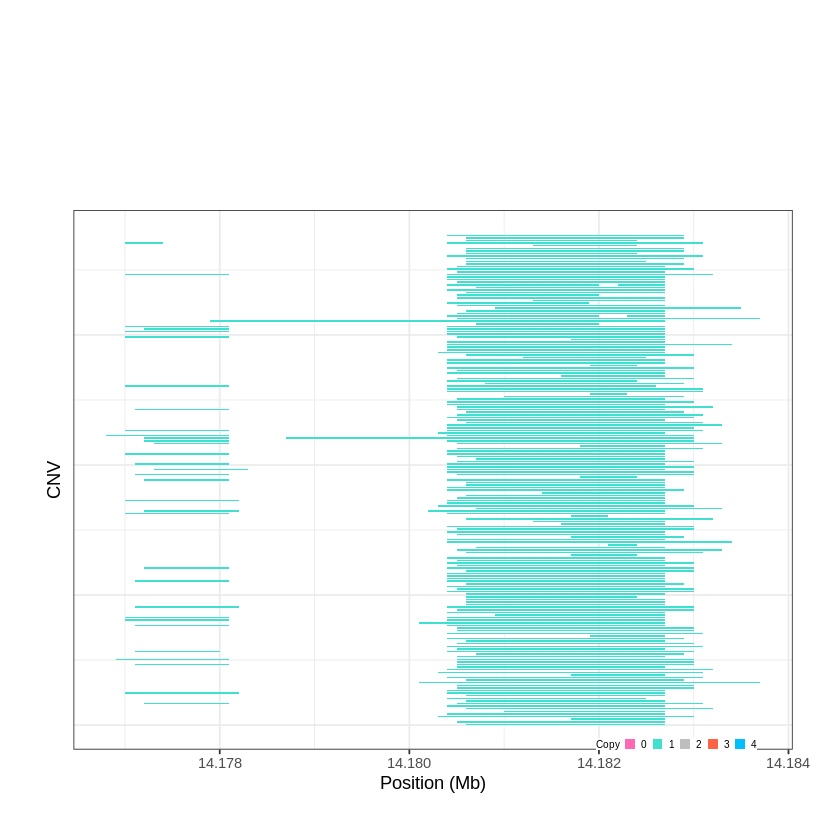

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1341..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 18.936001 - 18.9715 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


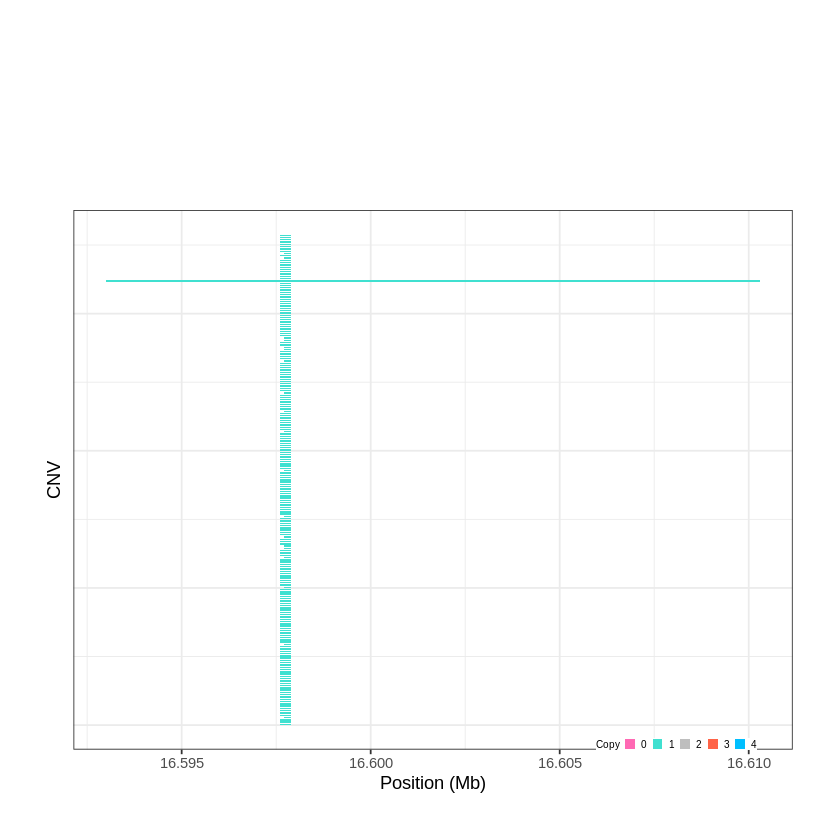

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1342..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 20.568301 - 20.5718 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


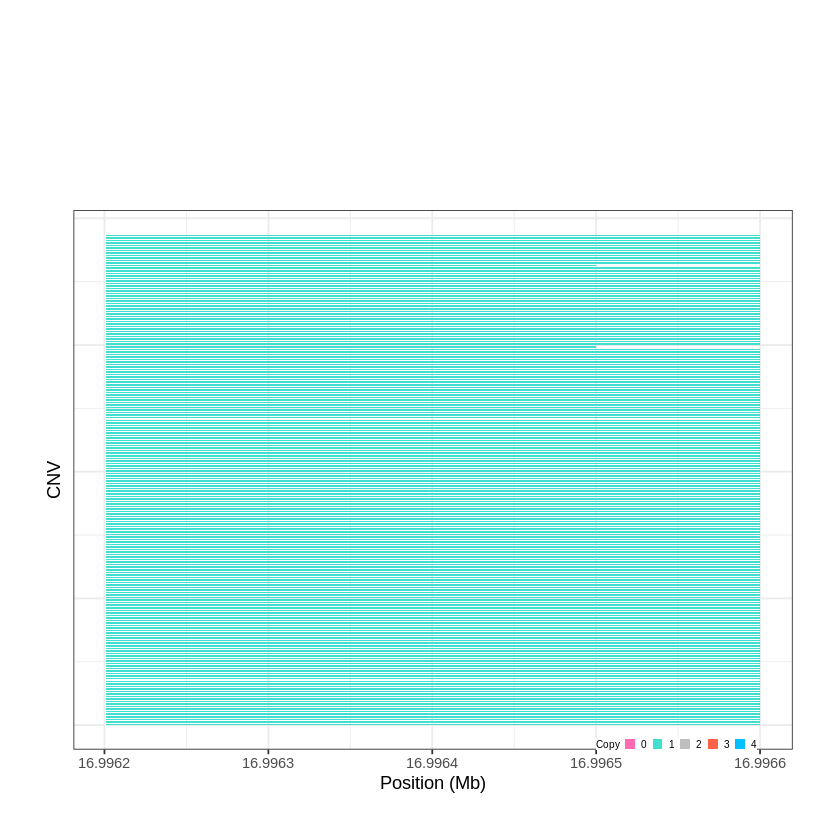

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1343..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 22.329801 - 22.3435 Mb with 201 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


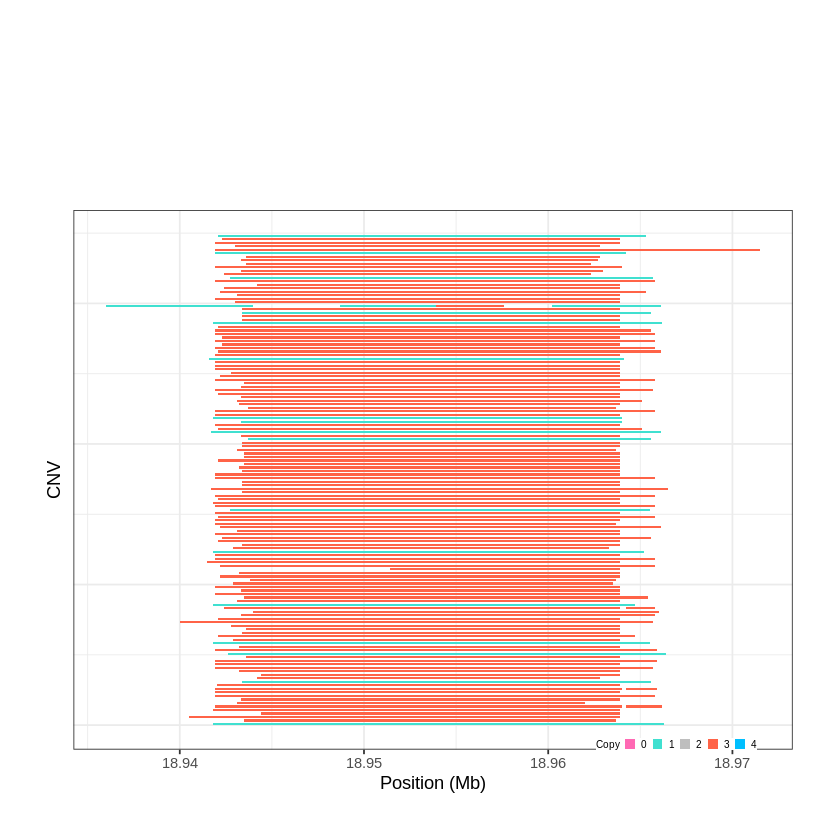

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1344..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 23.163301 - 23.2116 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


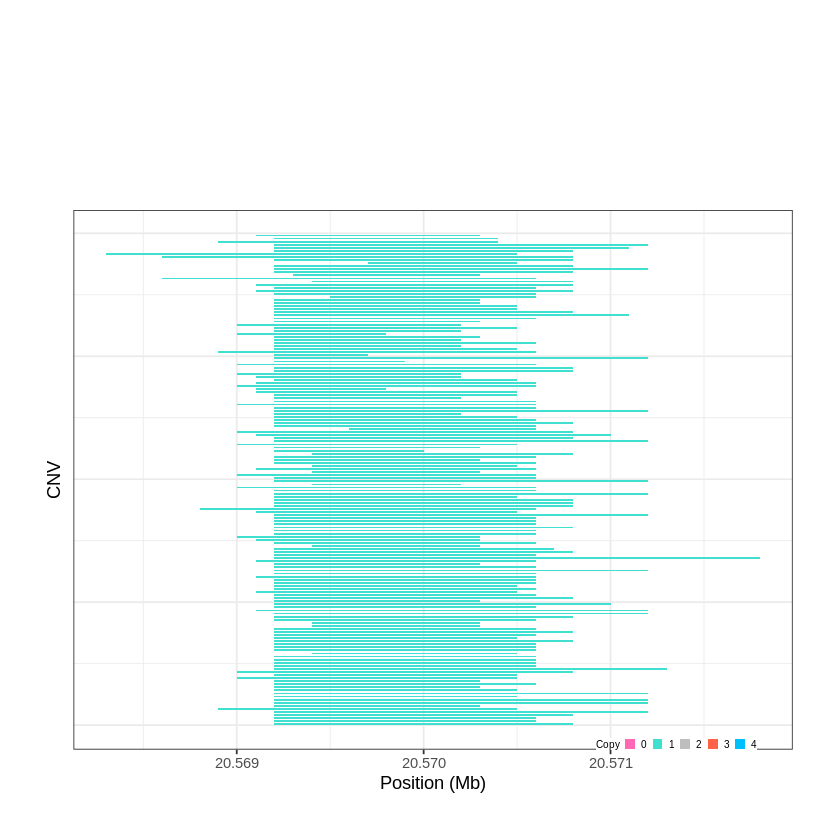

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1345..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 25.367401 - 25.4375 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


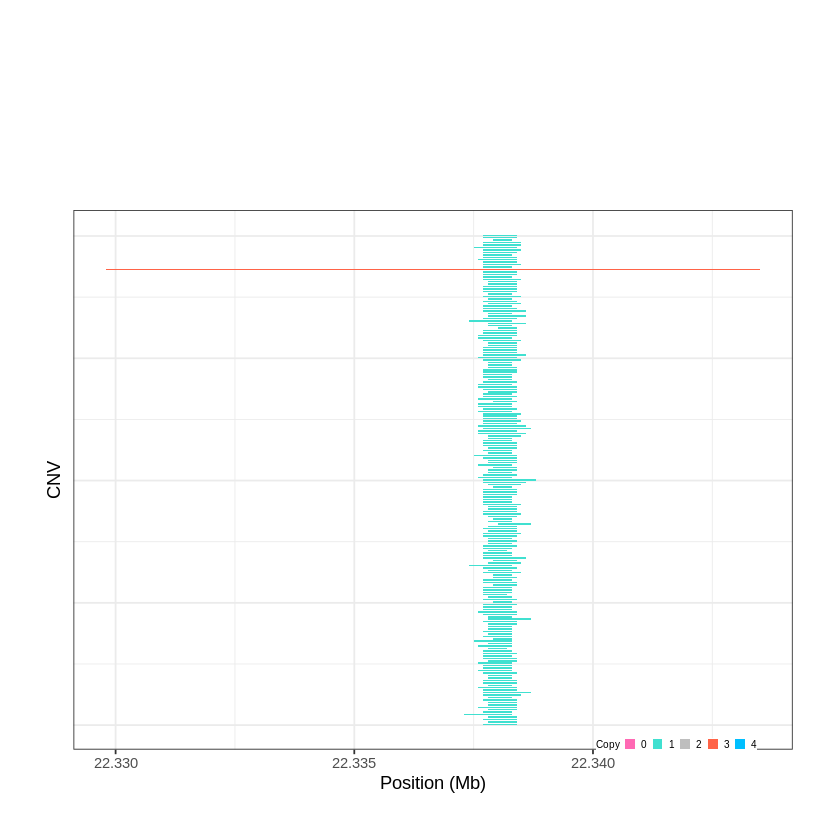

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1346..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 25.440001 - 25.4749 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


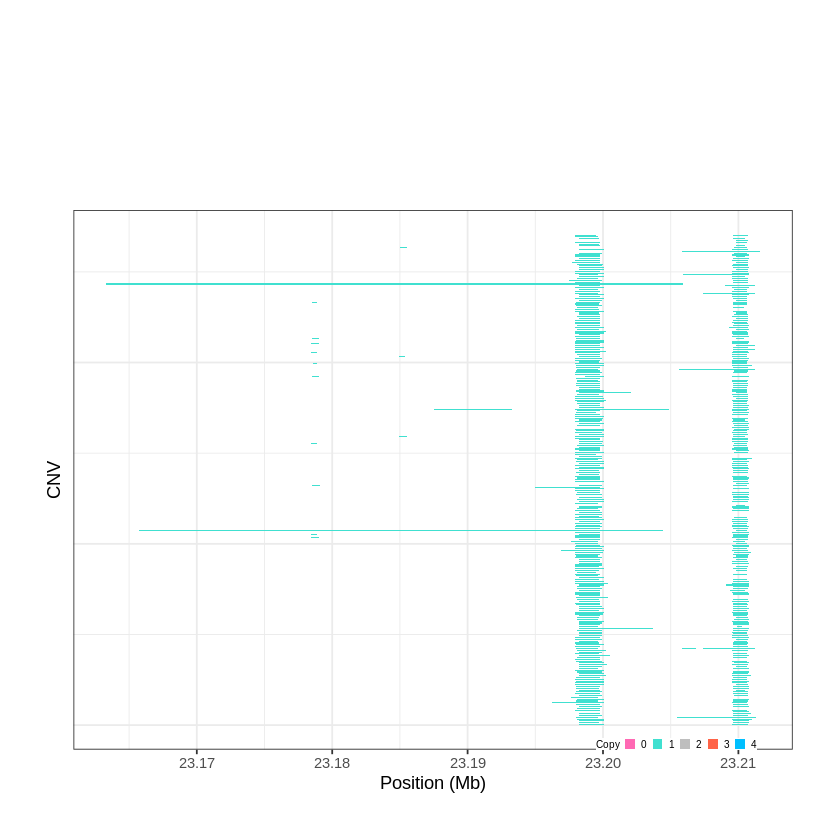

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1347..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 27.240601 - 27.2476 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


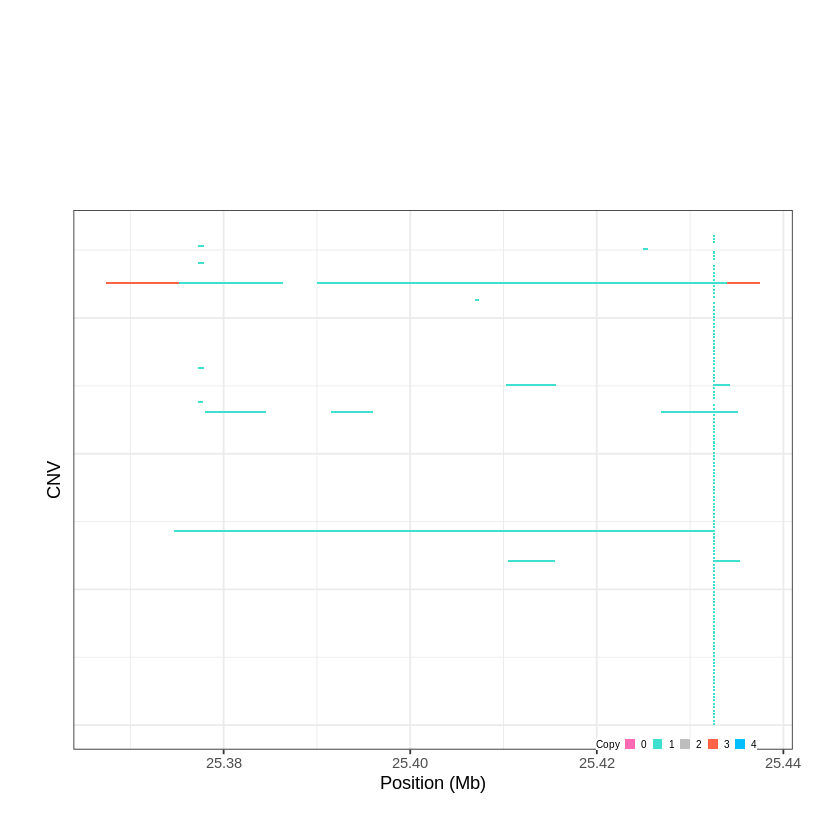

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1348..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 28.997201 - 29.0185 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


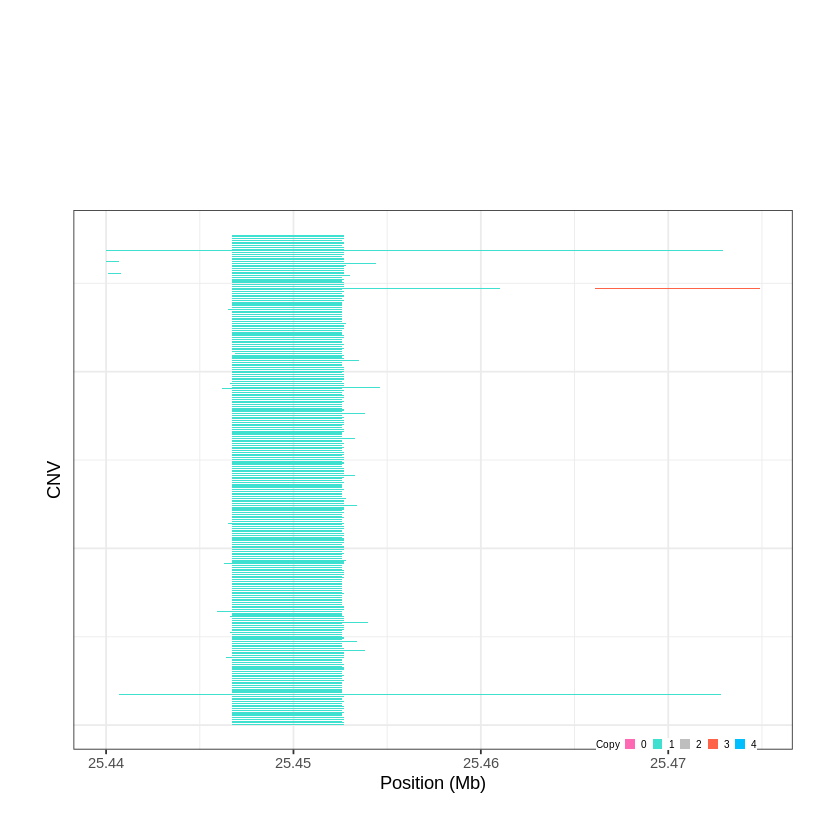

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1349..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 32.388601 - 32.391 Mb with 185 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


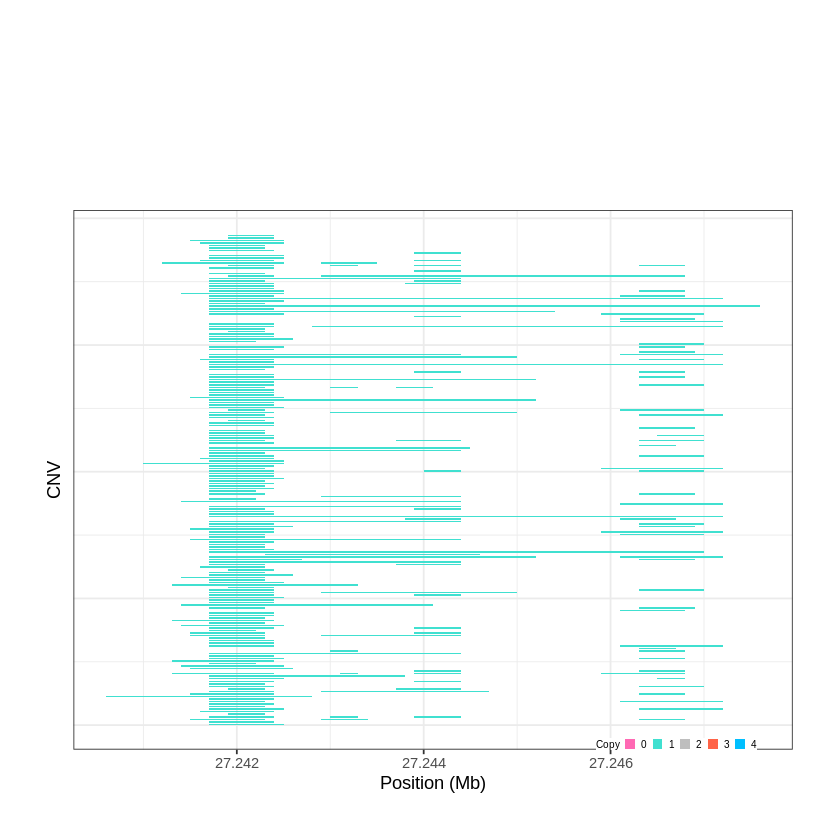

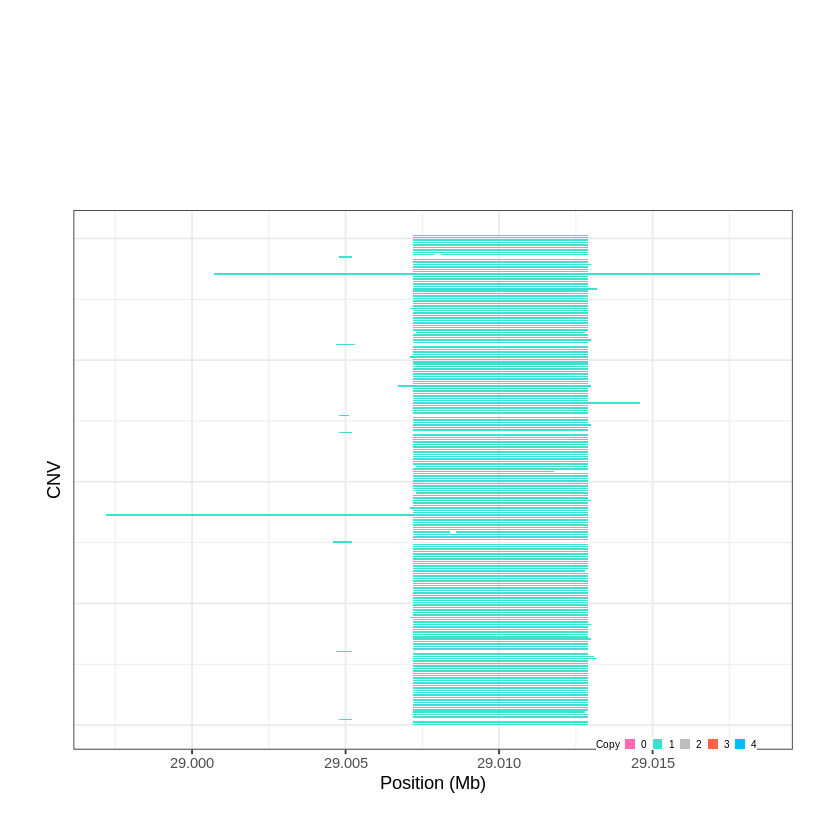

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1350..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 34.098901 - 34.2777 Mb with 159 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1351..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 41.818201 - 41.8194 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


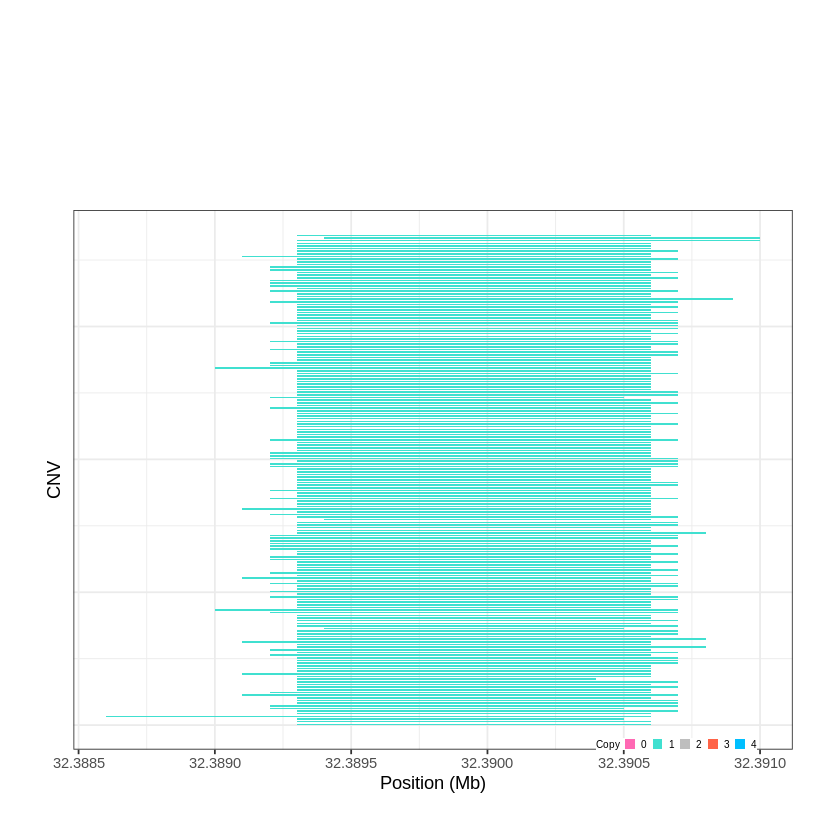

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1352..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 42.464101 - 42.4644 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


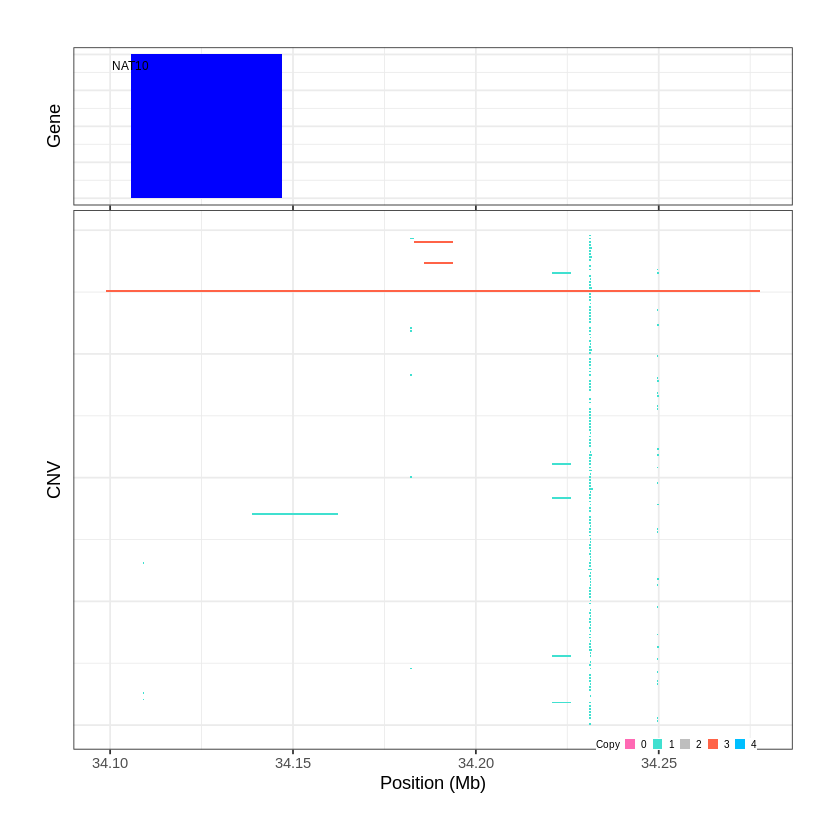

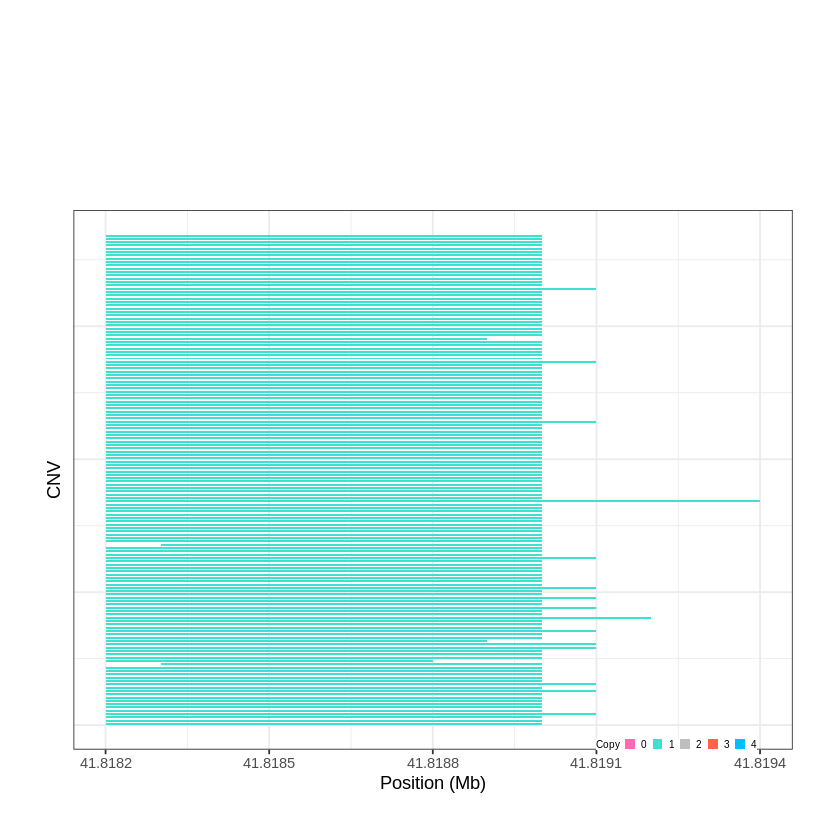

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1353..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 44.669001 - 45.0273 Mb with 211 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1354..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 45.386401 - 45.445 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


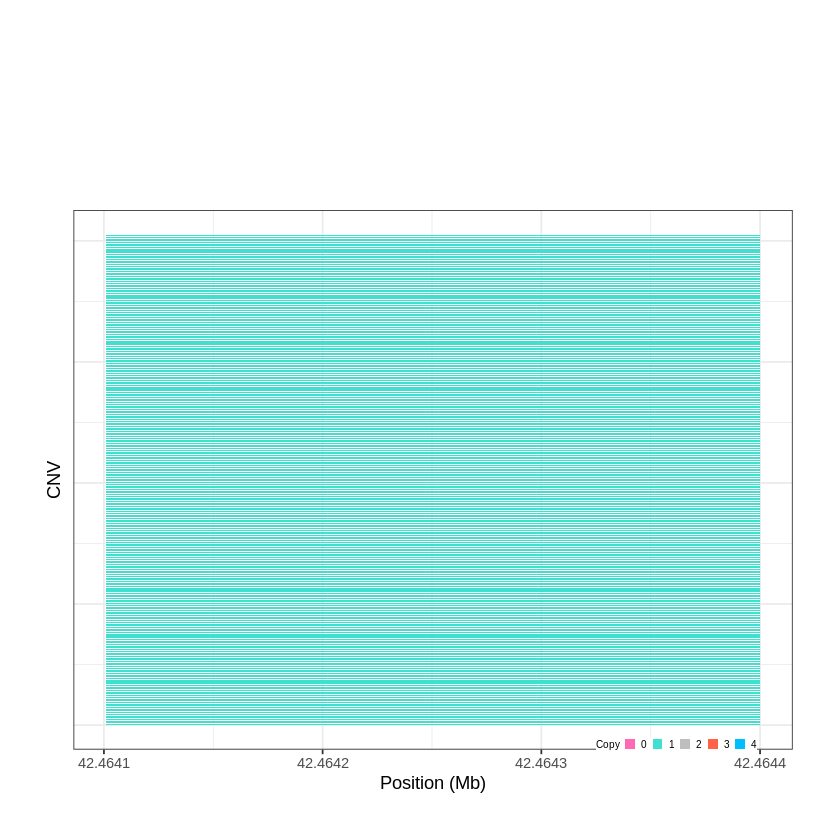

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1355..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 47.052901 - 47.0942 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


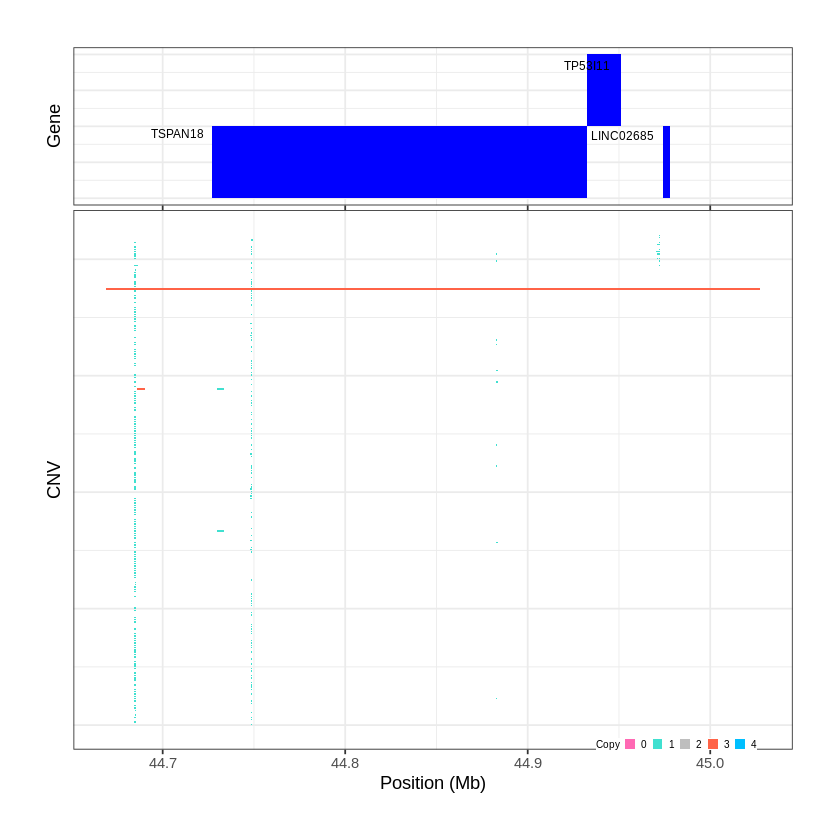

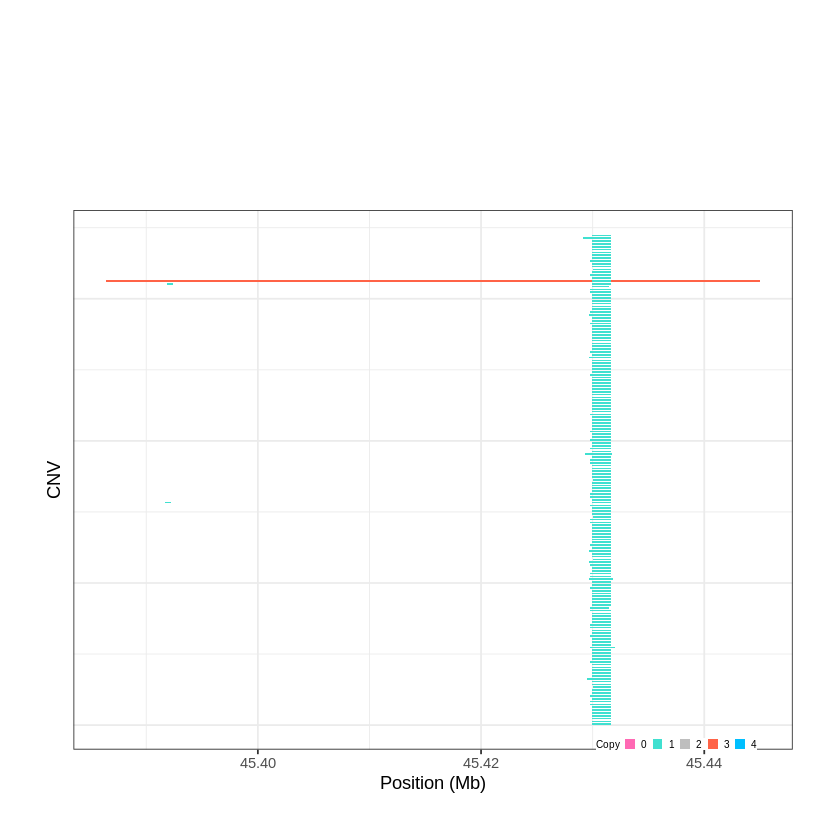

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1356..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 48.346001 - 49.9616 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1357..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 50.121301 - 50.1464 Mb with 273 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


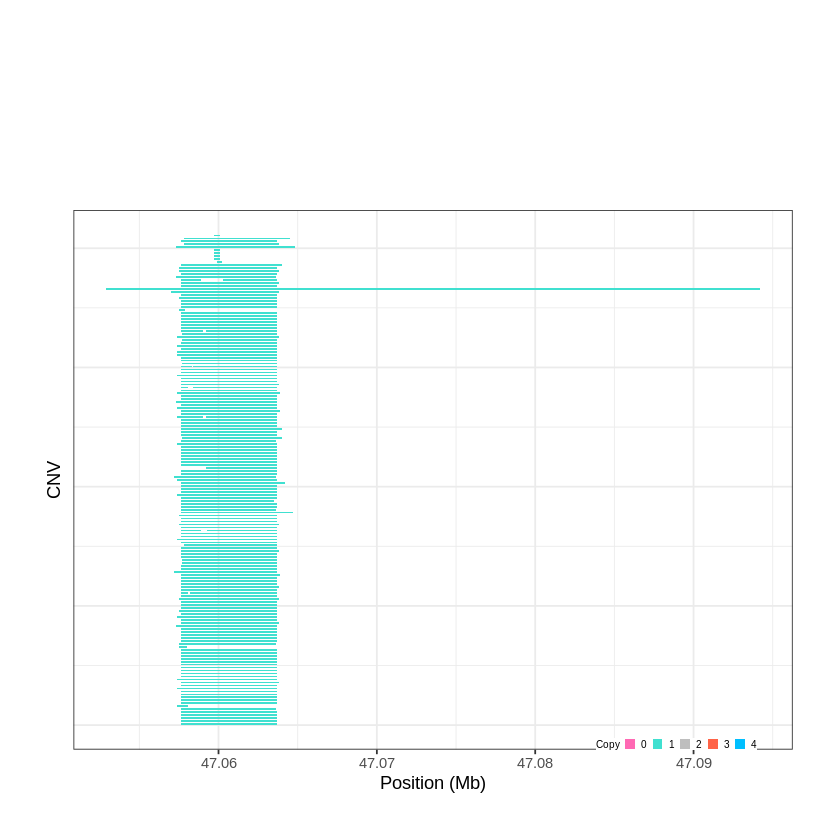

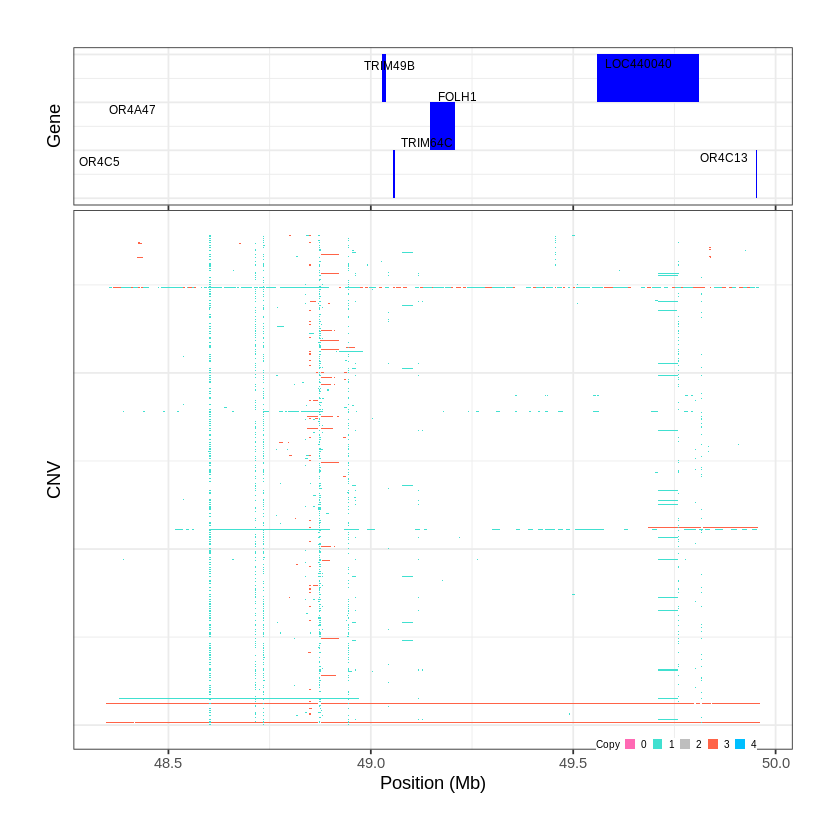

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1358..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 50.297501 - 51.4878 Mb with 279 Individual - "
Plotting gene...


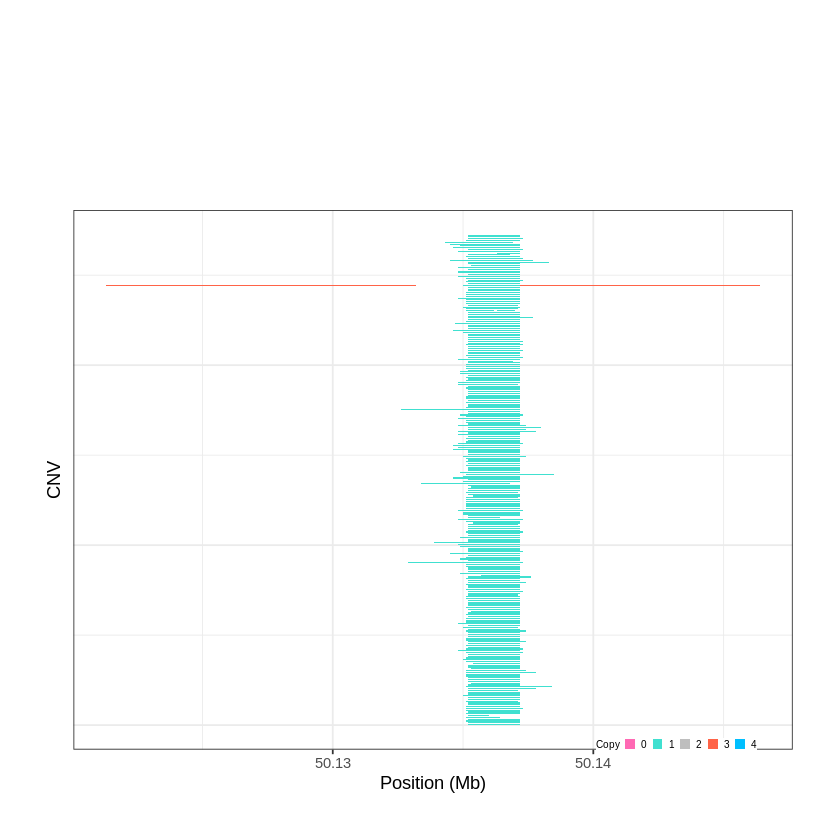

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1359..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 51.554401 - 55.0465 Mb with 279 Individual - "
Plotting gene...


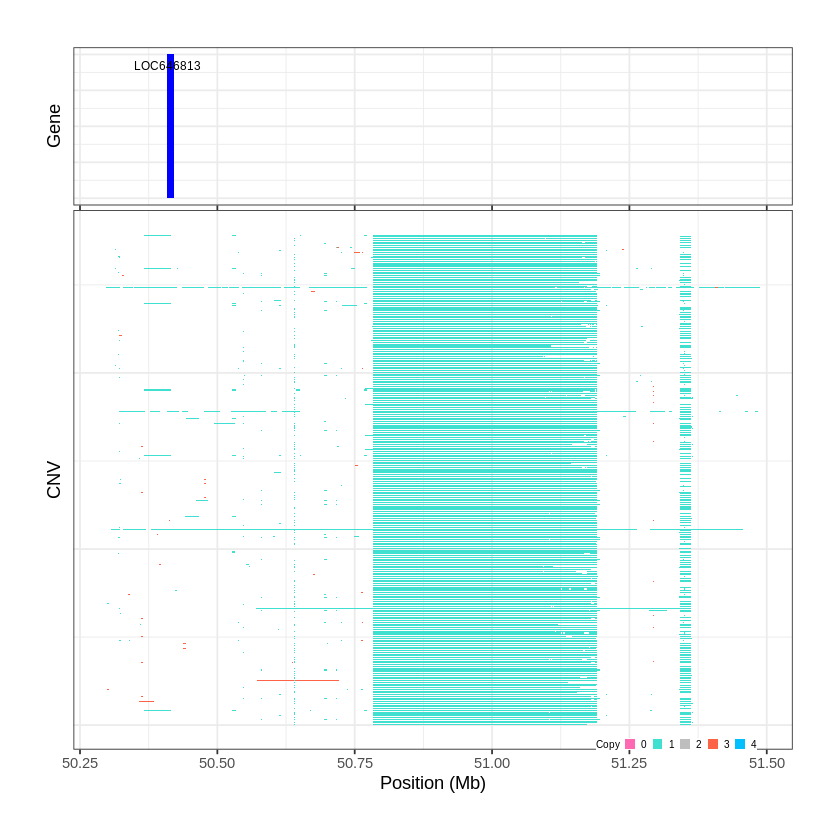

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1360..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 55.365301 - 55.632 Mb with 164 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1361..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 57.815001 - 57.822 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


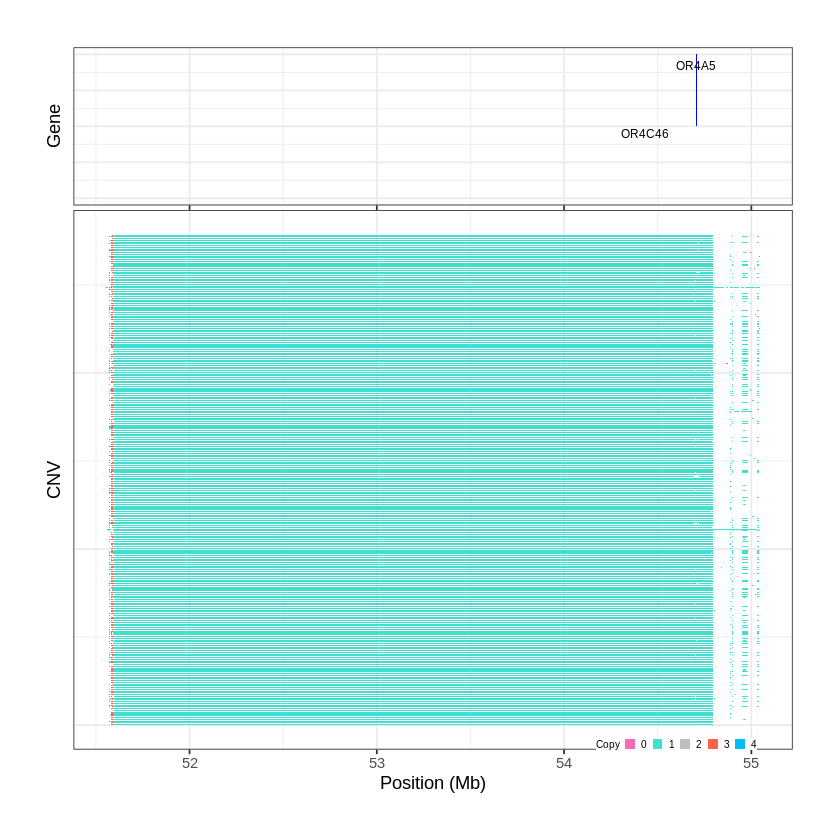

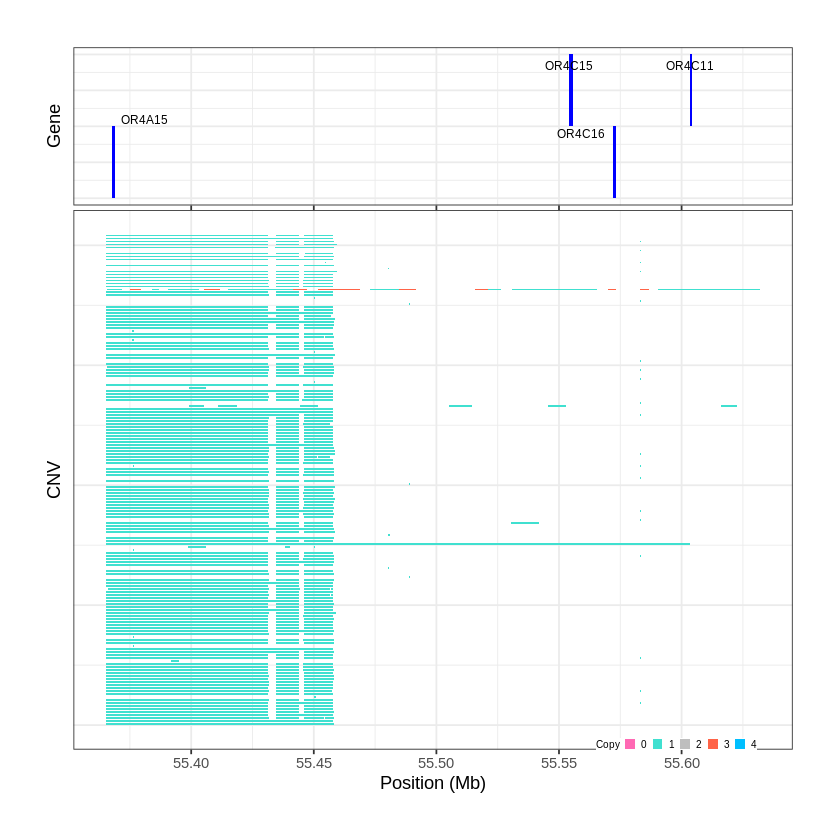

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1362..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 60.666201 - 61.1647 Mb with 263 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1363..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 63.187101 - 63.2144 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


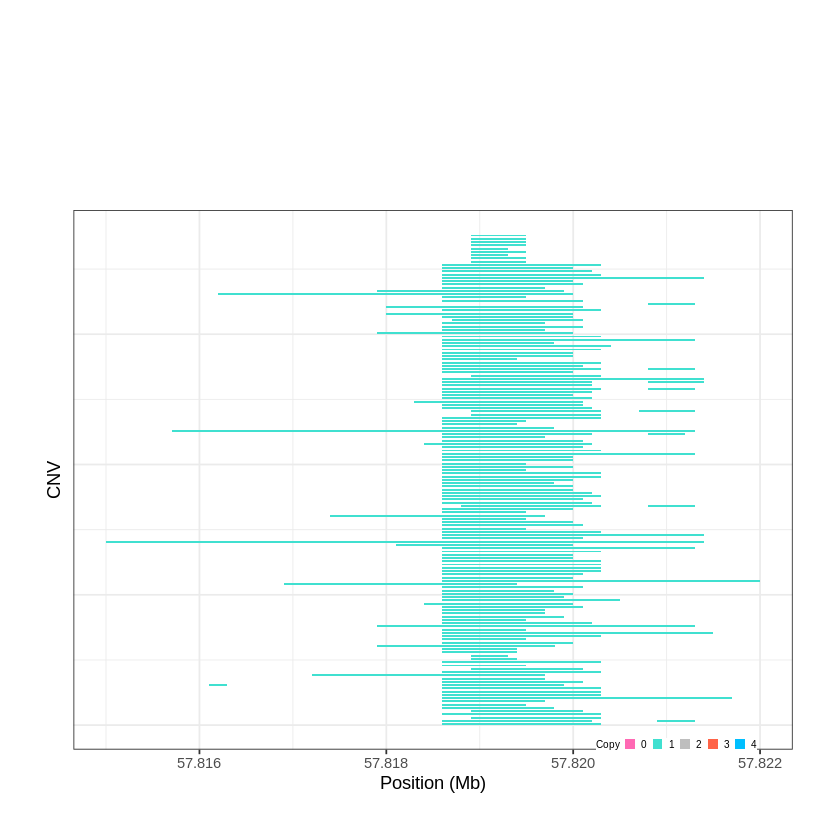

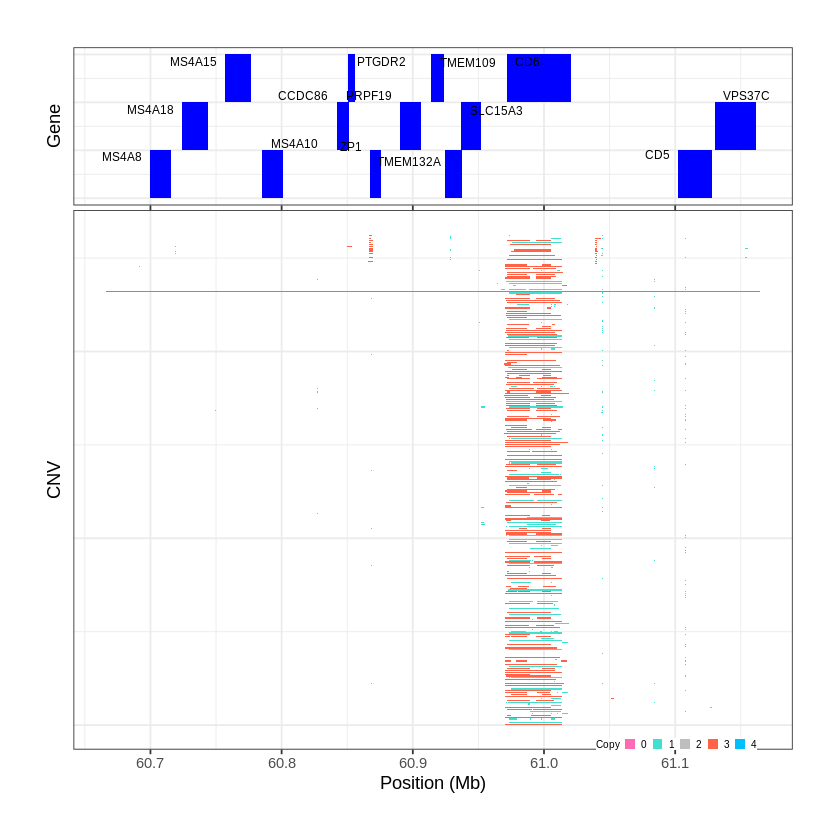

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1364..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 64.251601 - 64.545 Mb with 145 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1365..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 64.983001 - 64.9855 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


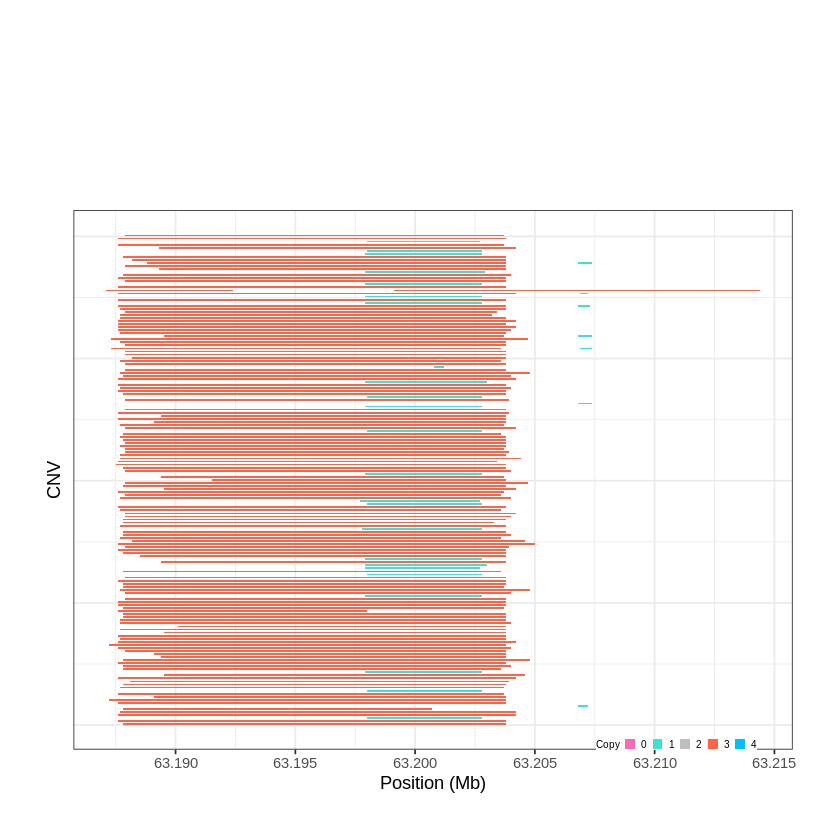

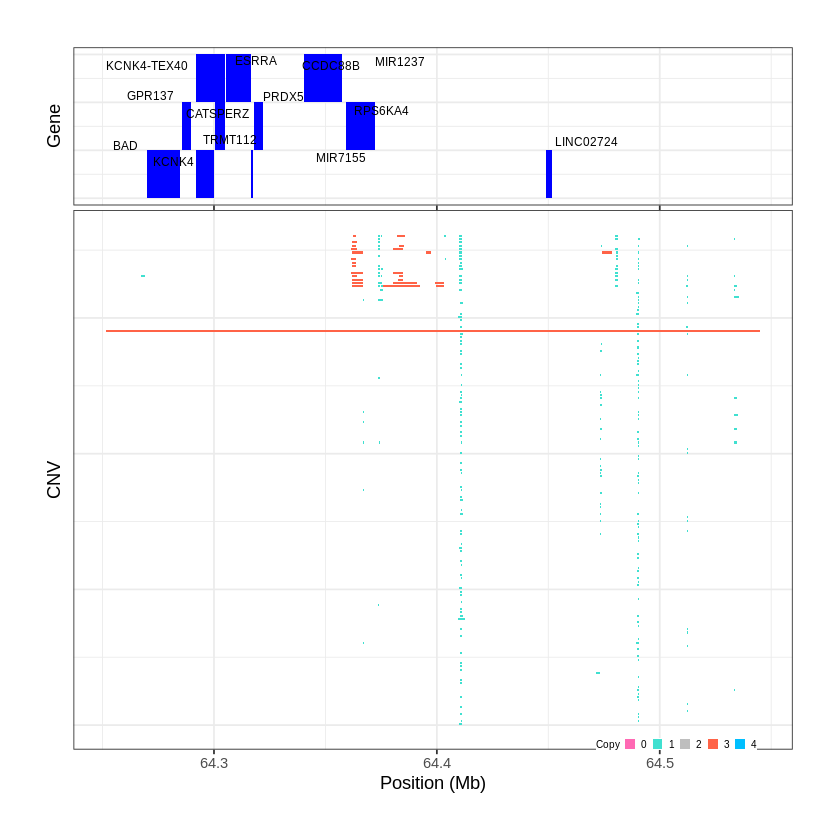

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1366..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 65.100401 - 65.8446 Mb with 251 Individual - "
Plotting gene...


Warning message:
“ggrepel: 12 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


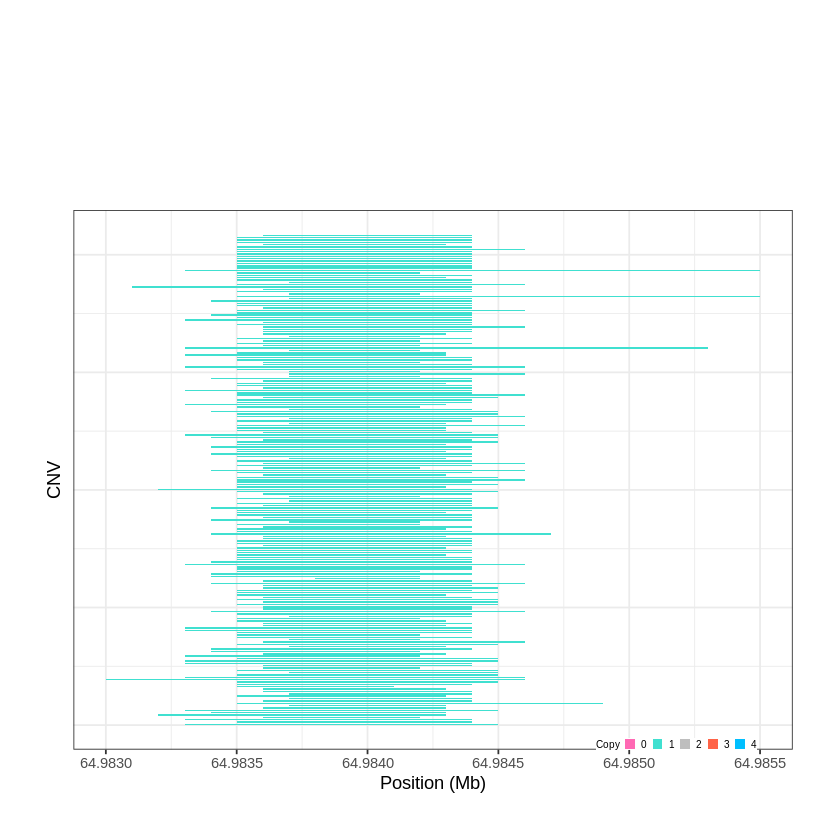

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1367..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 66.223501 - 66.4948 Mb with 157 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1368..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 66.710601 - 66.7144 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


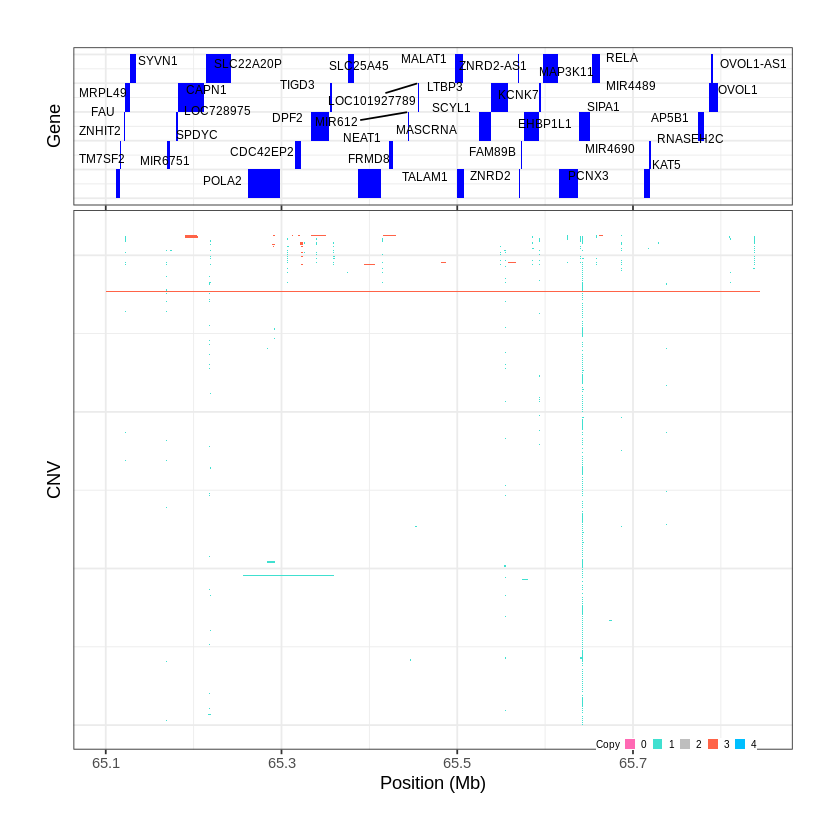

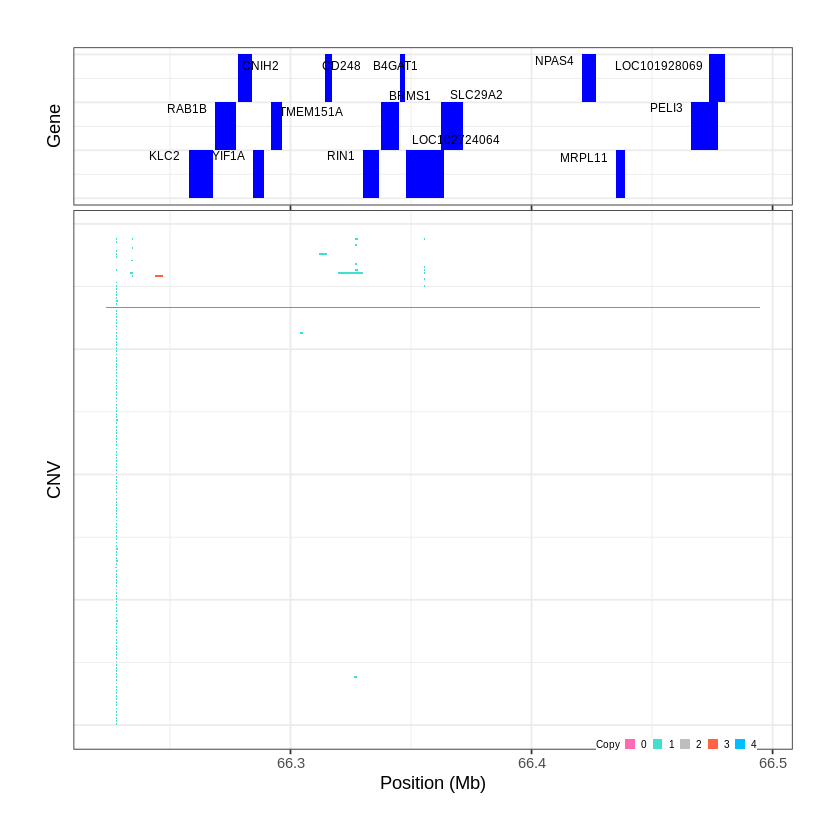

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1369..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 67.459301 - 67.8891 Mb with 233 Individual - "
Plotting gene...


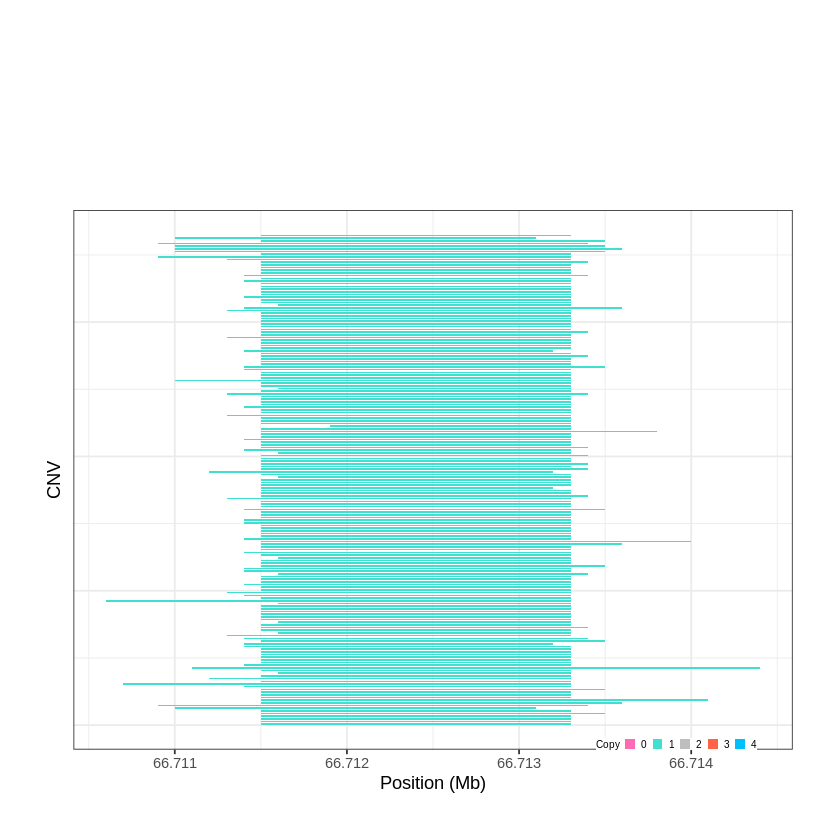

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1370..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 68.018901 - 68.2897 Mb with 166 Individual - "
Plotting gene...


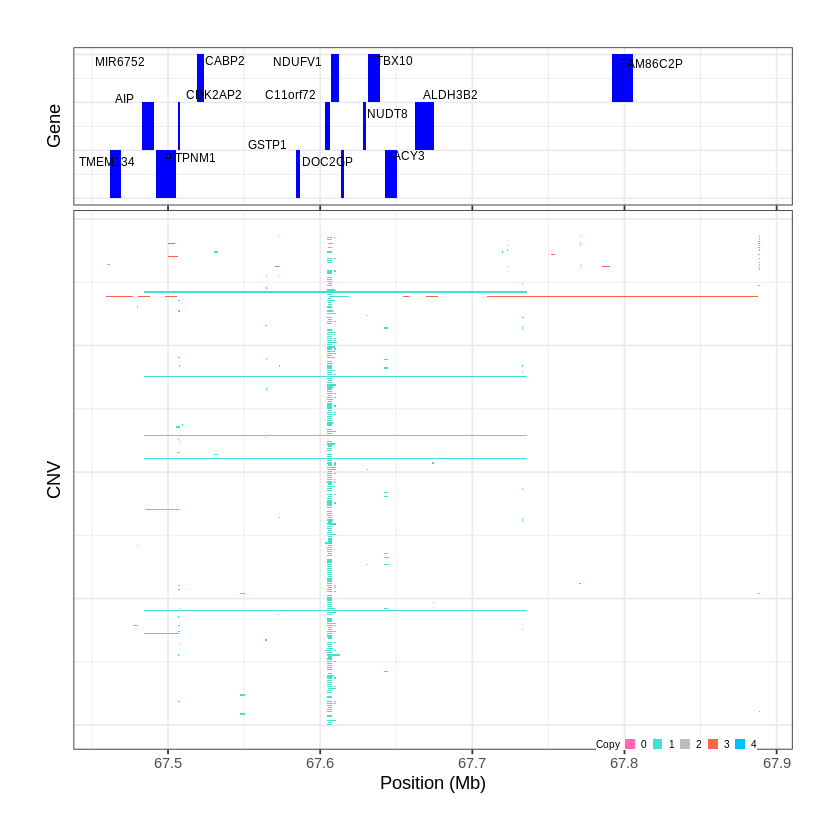

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1371..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 68.500901 - 69.0898 Mb with 243 Individual - "
Plotting gene...


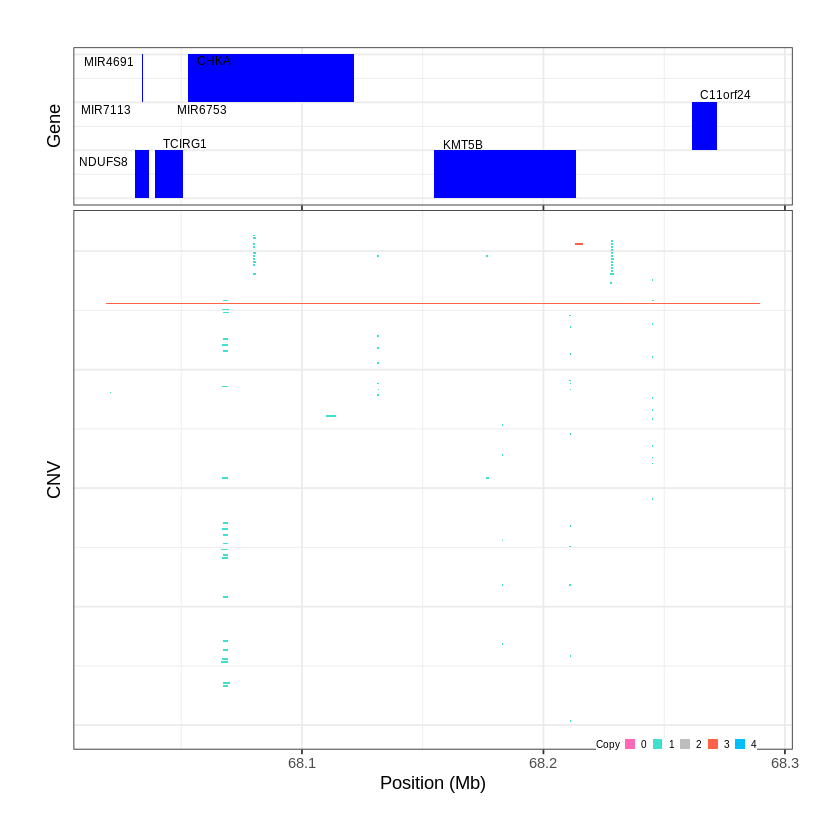

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1372..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 69.089801 - 69.3776 Mb with 279 Individual - "
Plotting gene...


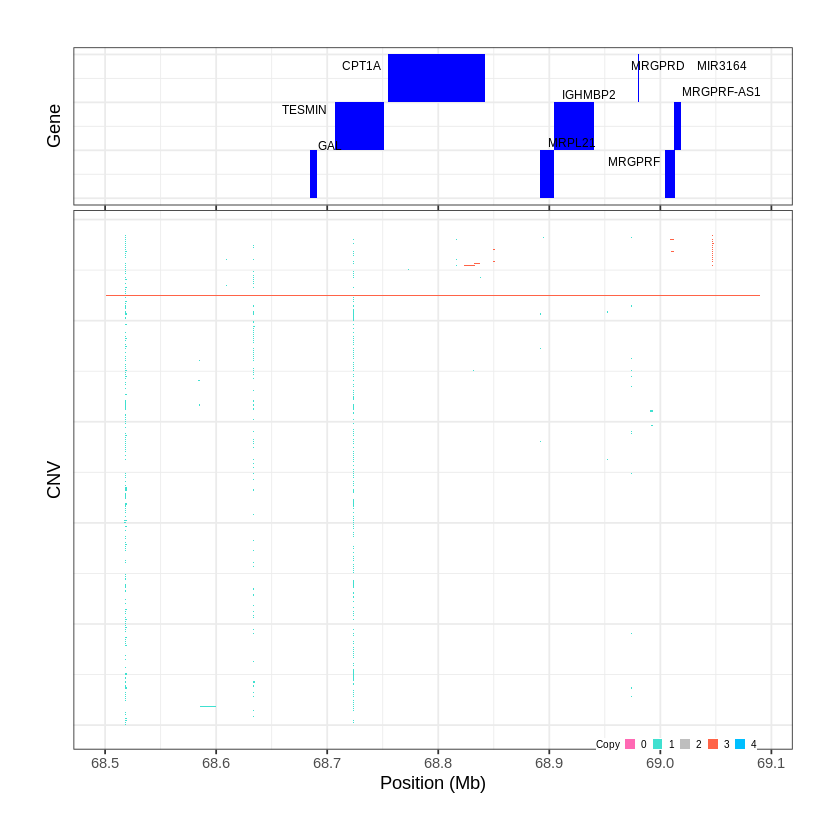

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1373..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 69.401401 - 69.8427 Mb with 279 Individual - "
Plotting gene...


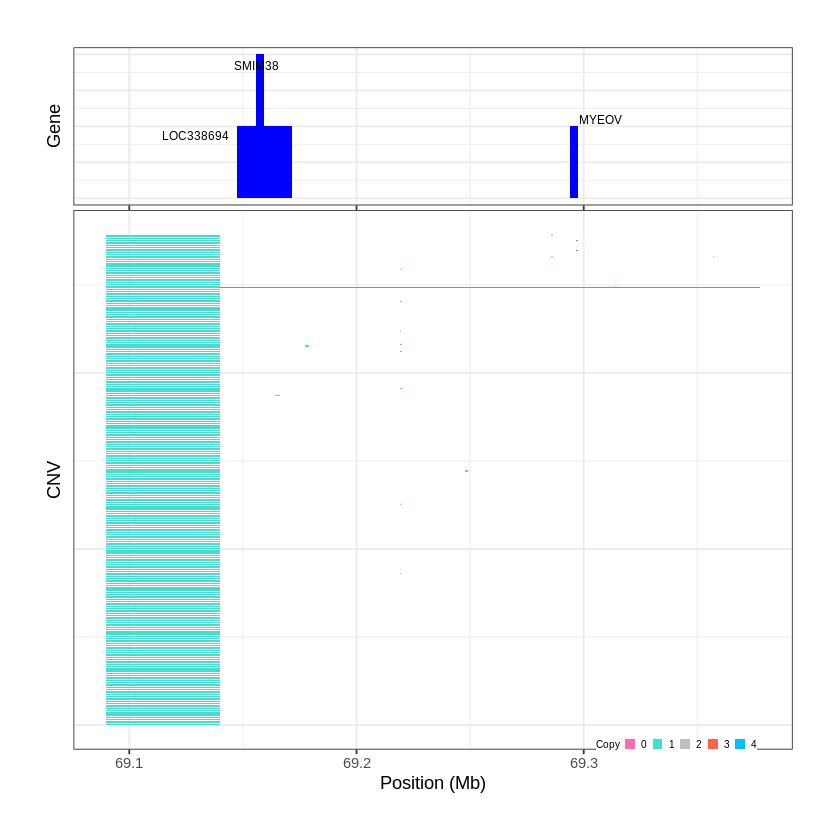

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1374..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 69.856801 - 70.9824 Mb with 213 Individual - "
Plotting gene...


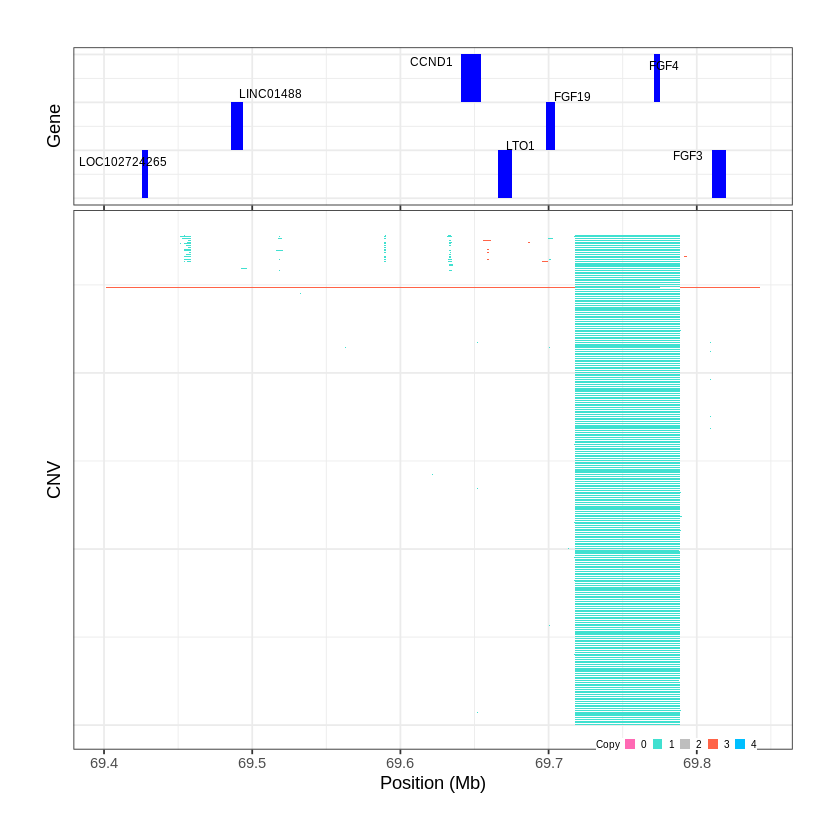

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1375..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 71.853201 - 71.8926 Mb with 210 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1376..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 78.899001 - 78.9072 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


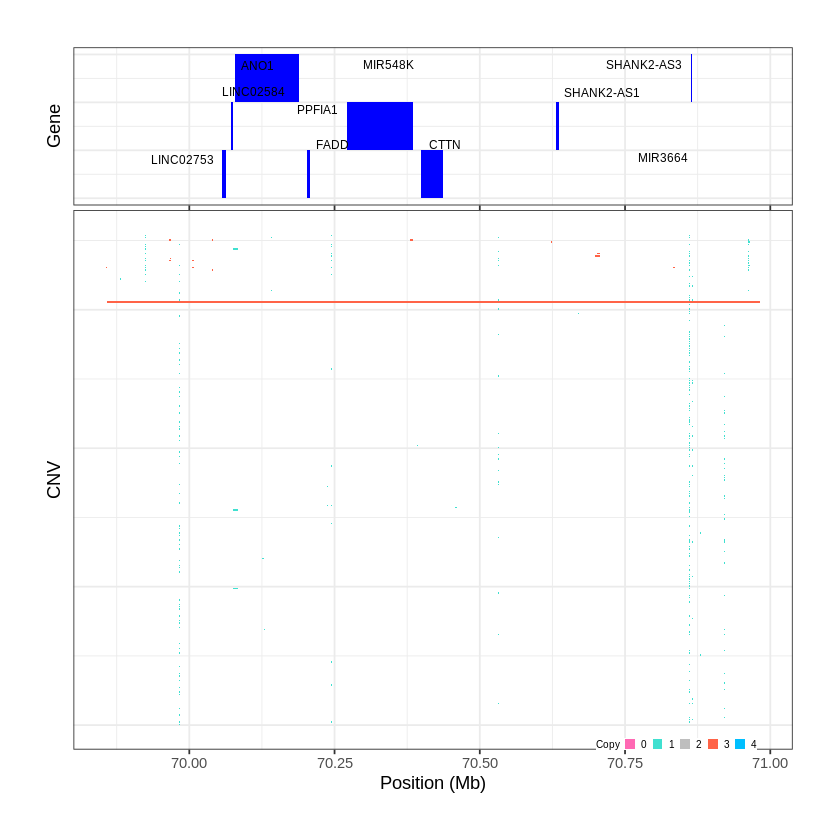

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1377..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 87.336001 - 87.3636 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


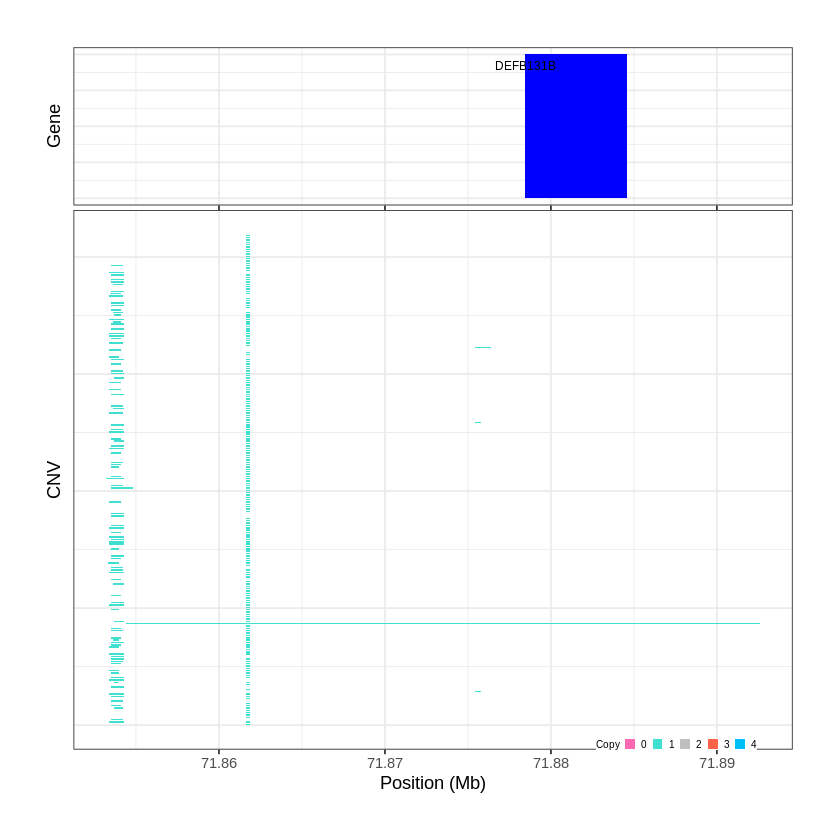

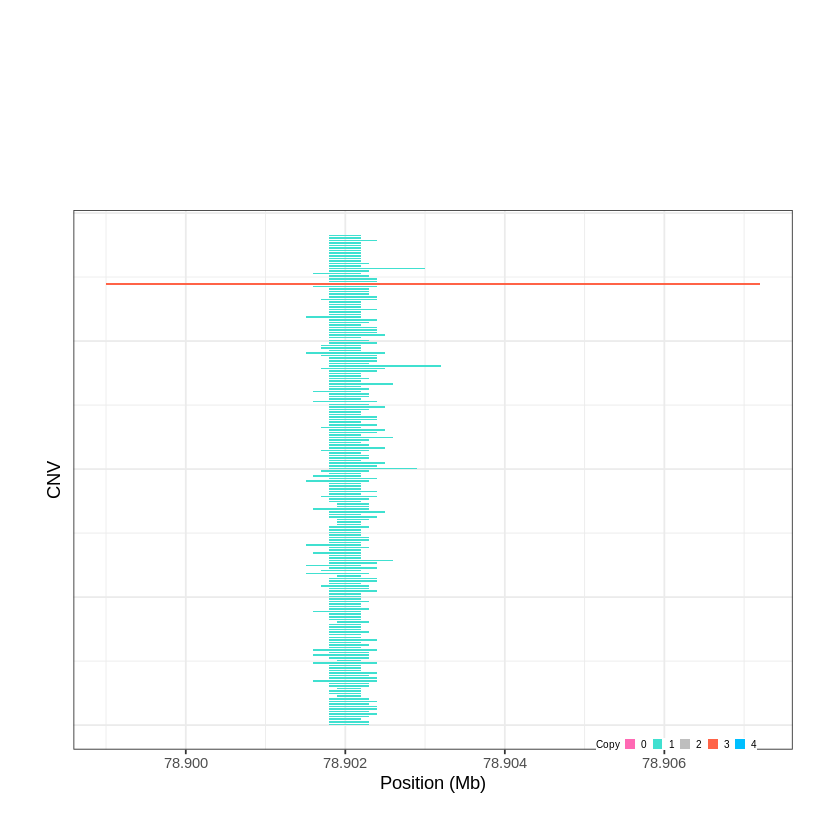

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1378..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 87.569101 - 87.755 Mb with 279 Individual - "
Plotting gene...


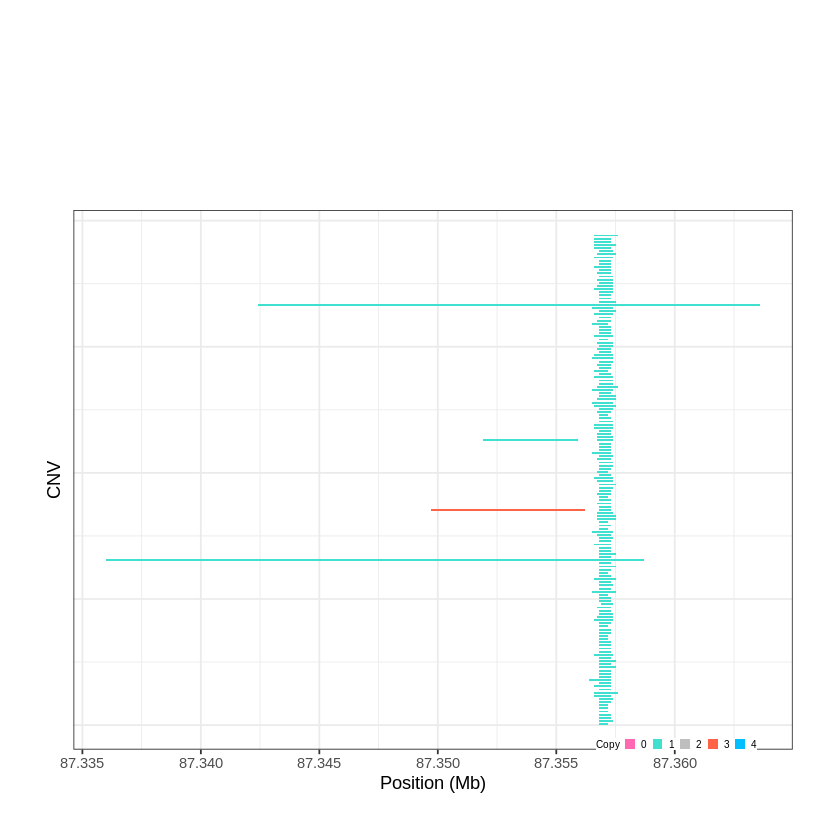

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1379..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 89.475001 - 89.8404 Mb with 279 Individual - "
Plotting gene...


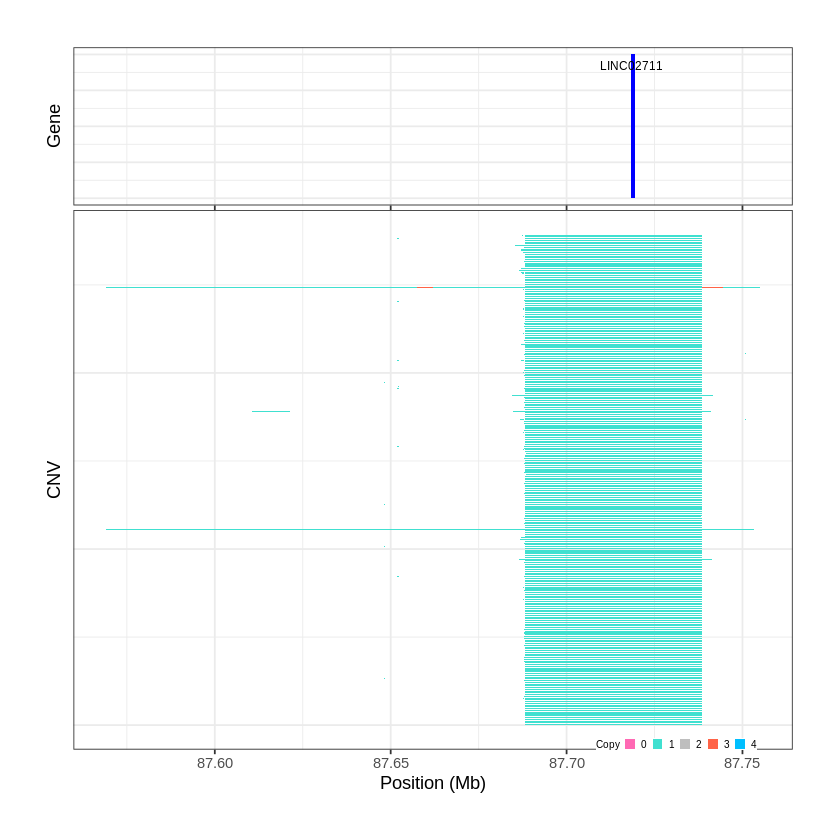

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1380..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 90.015201 - 90.1984 Mb with 194 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1381..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 90.679301 - 90.7155 Mb with 251 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


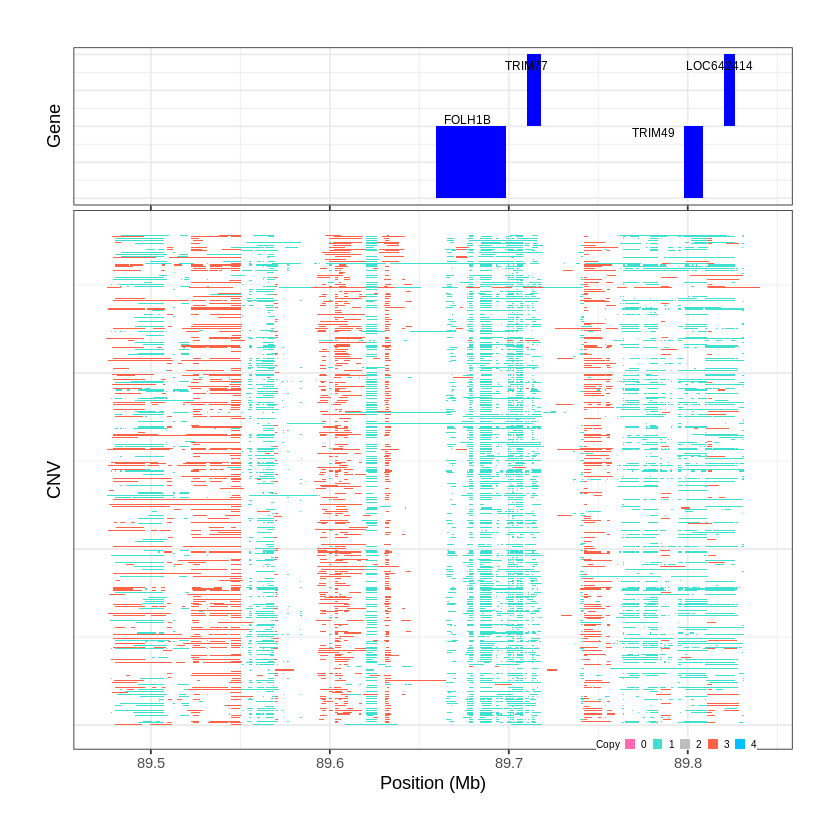

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1382..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 91.794101 - 91.8761 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


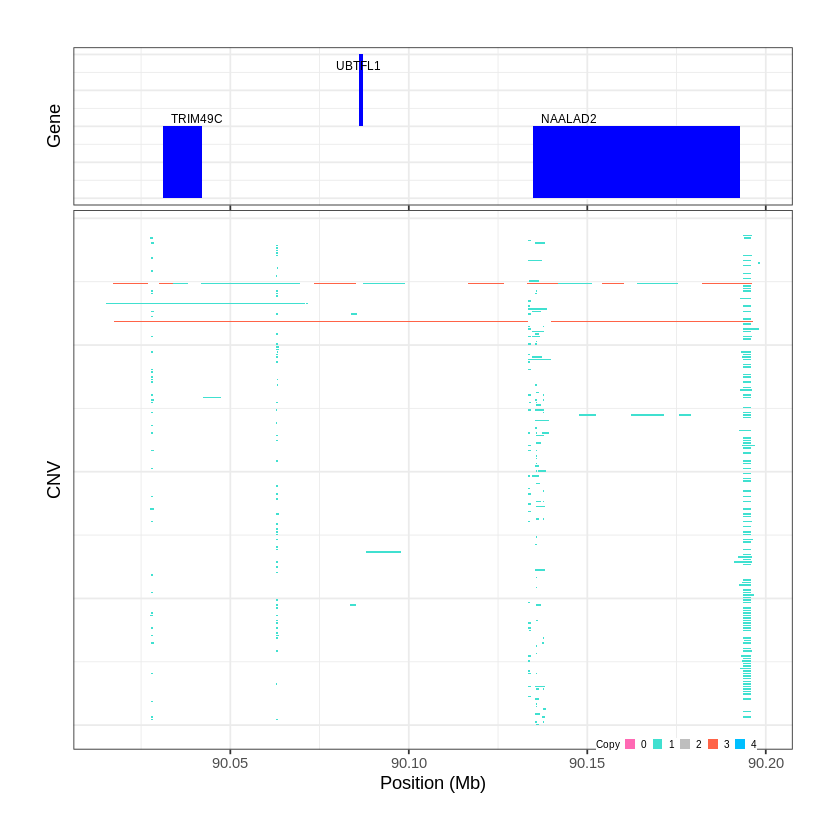

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1383..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 93.668501 - 93.6925 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


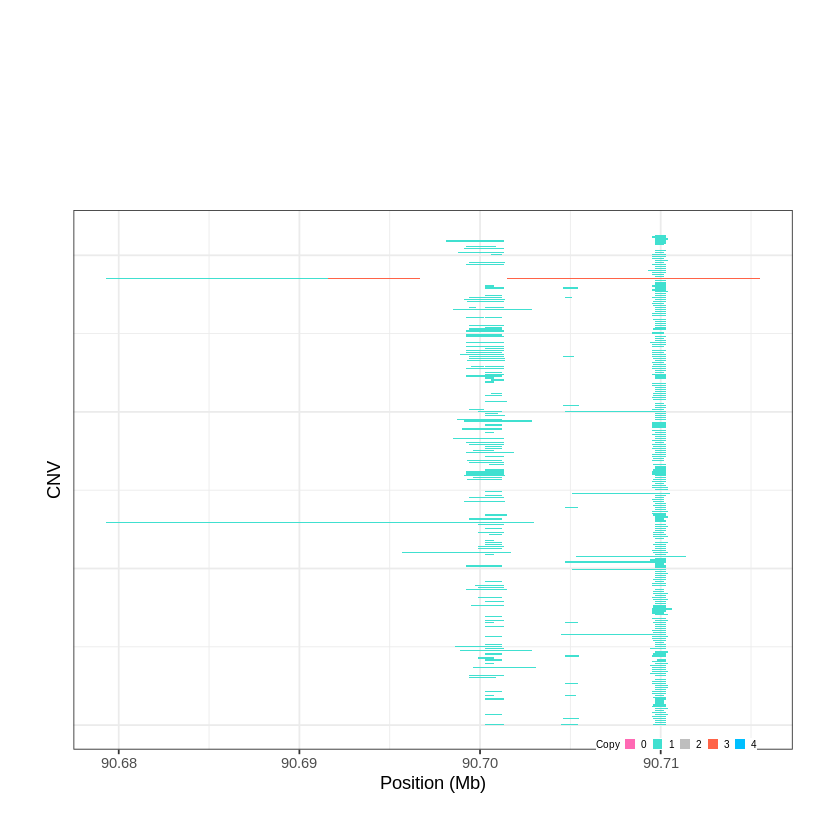

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1384..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 93.966101 - 93.9745 Mb with 256 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


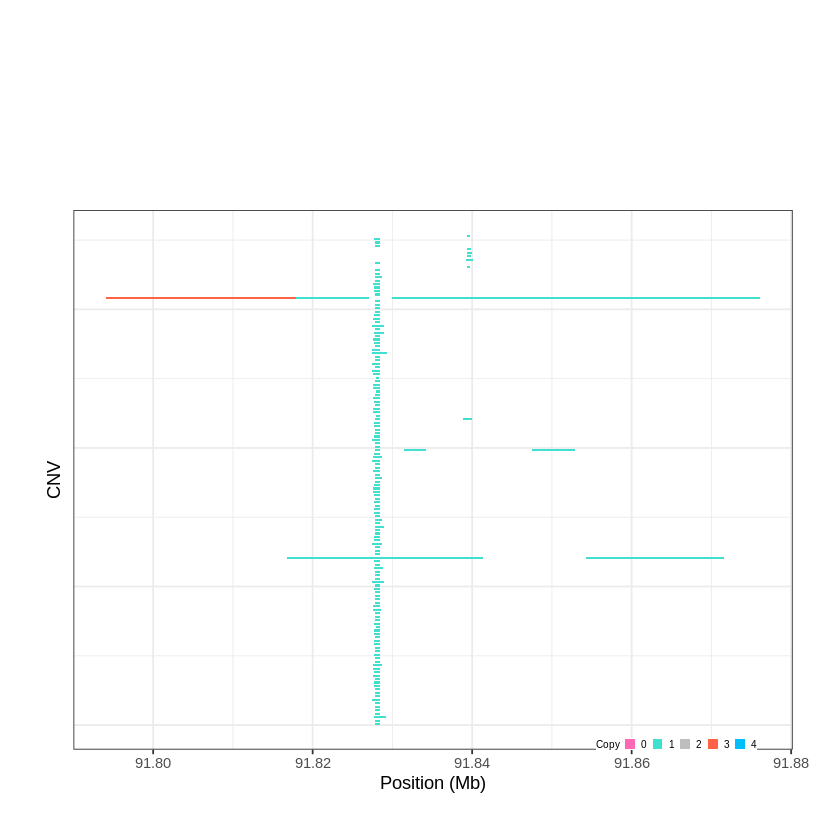

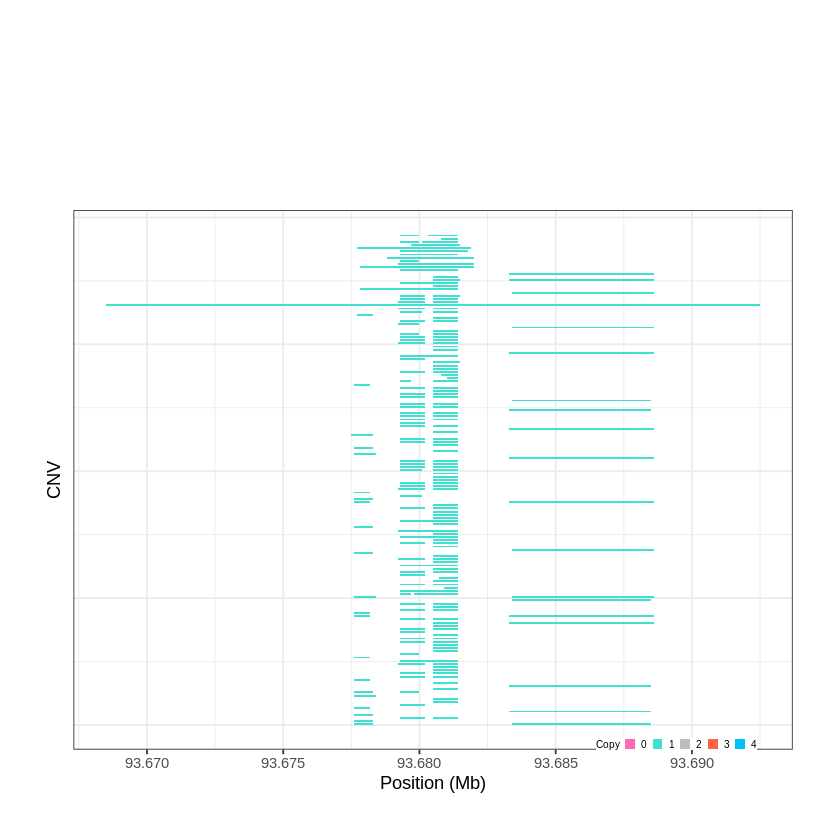

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1385..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 96.287301 - 96.4465 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1386..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 101.558401 - 101.581 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


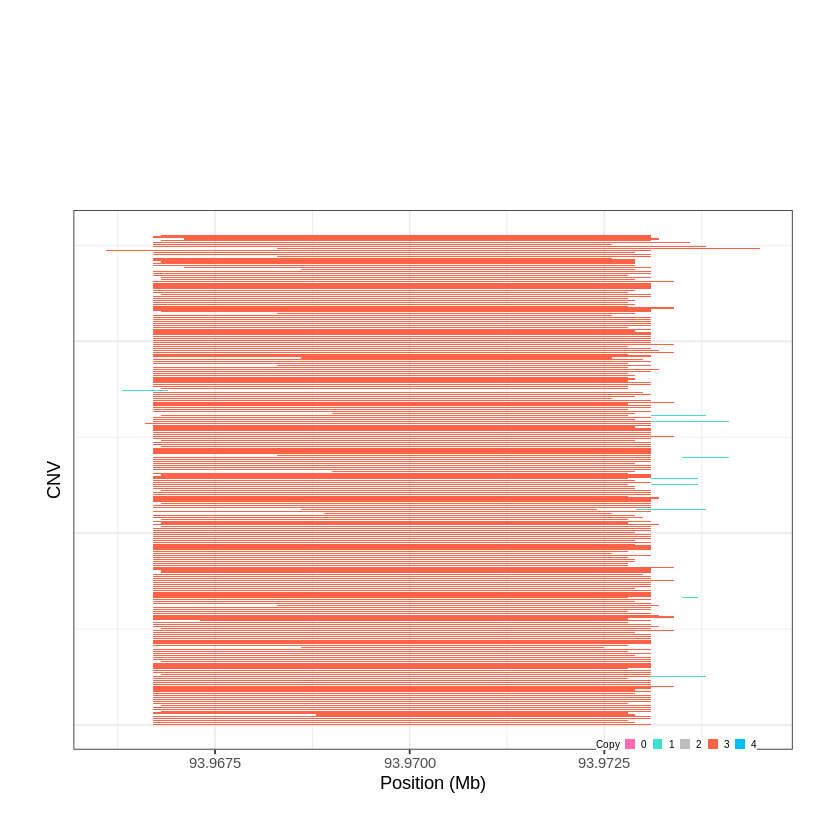

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1387..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 104.234601 - 104.2897 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


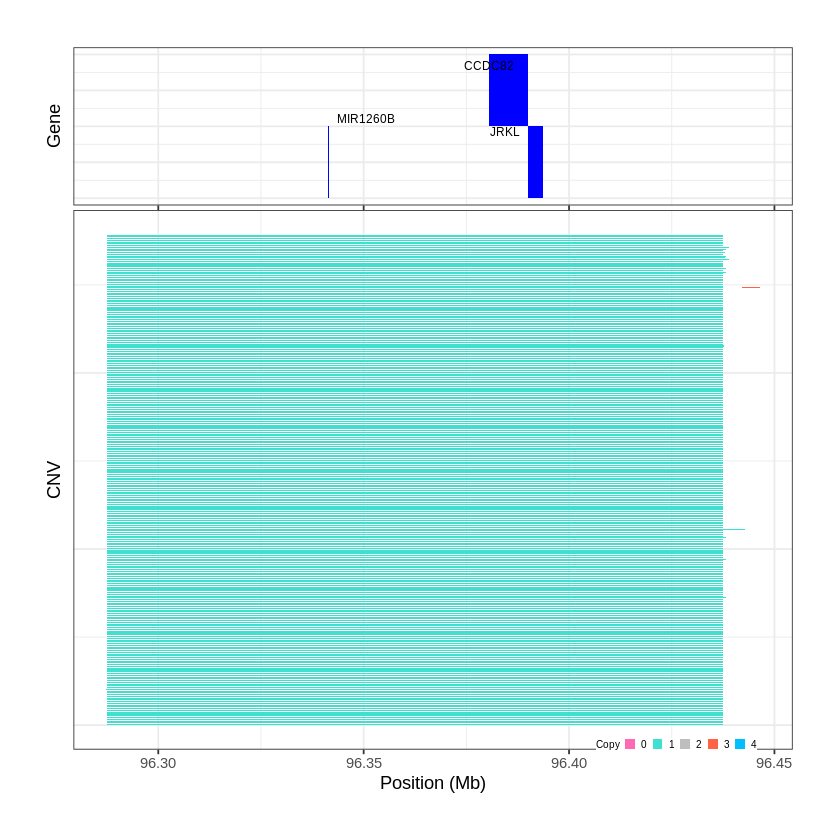

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1388..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 106.577701 - 106.5979 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


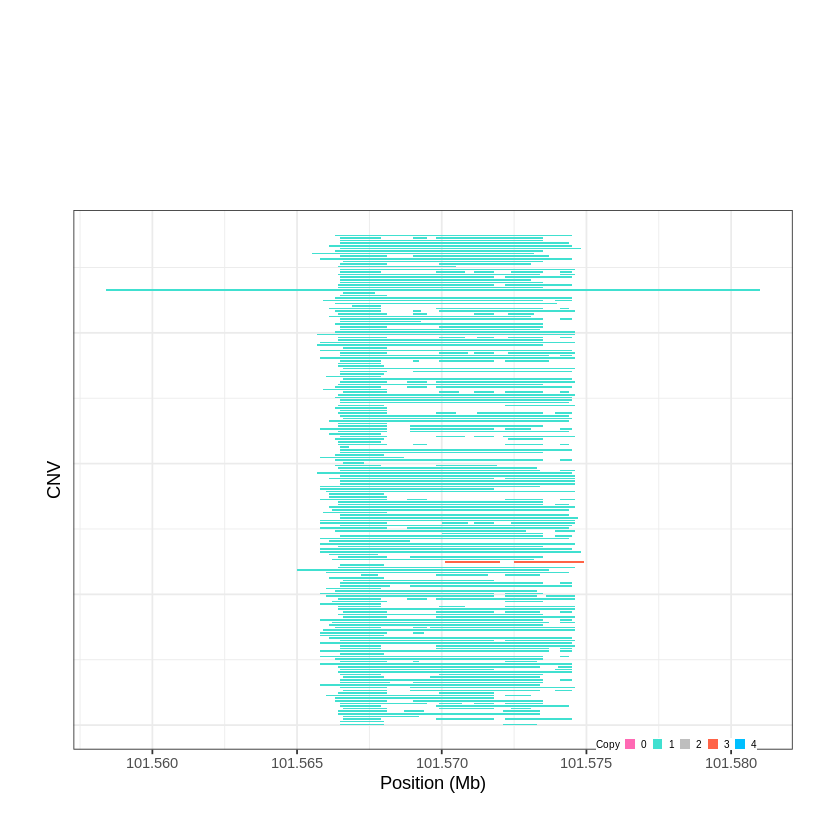

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1389..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 107.230701 - 107.2507 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


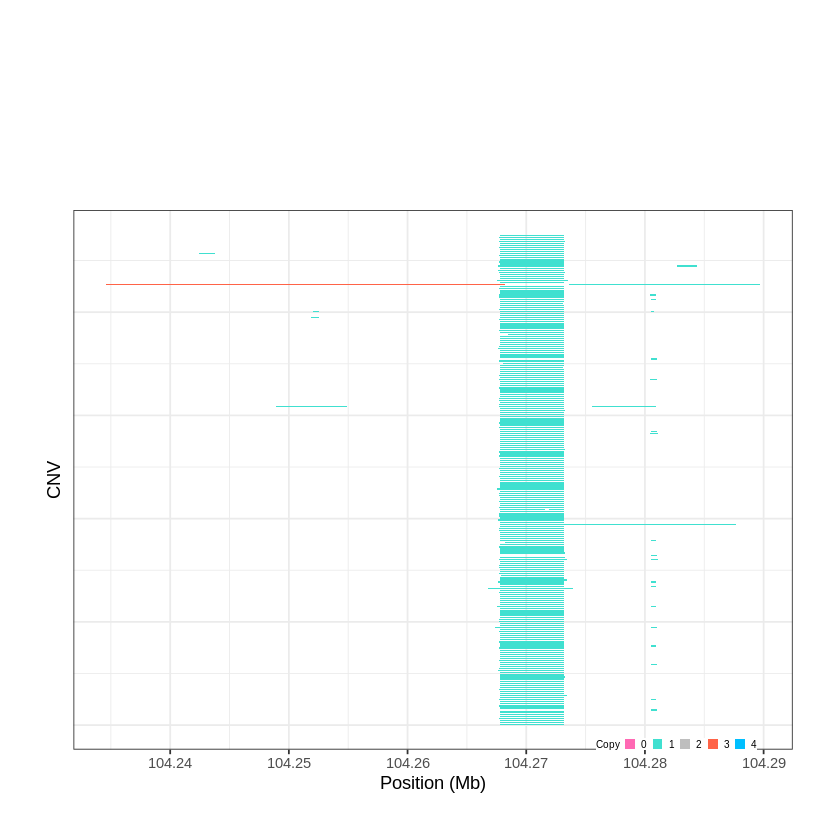

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1390..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 109.959901 - 109.9783 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


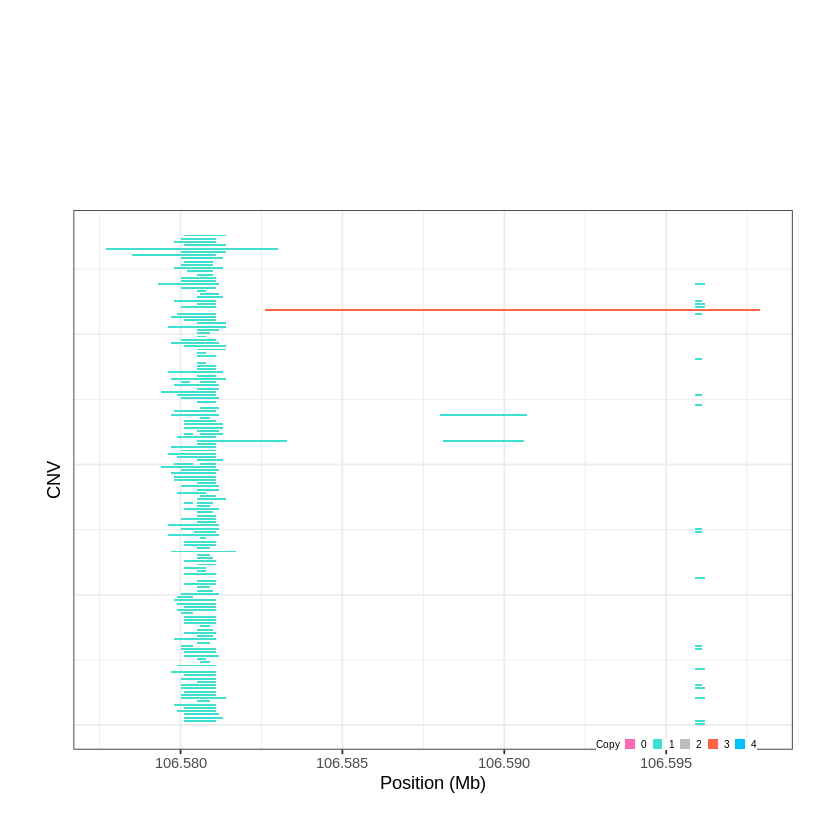

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1391..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 114.410101 - 114.4336 Mb with 270 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


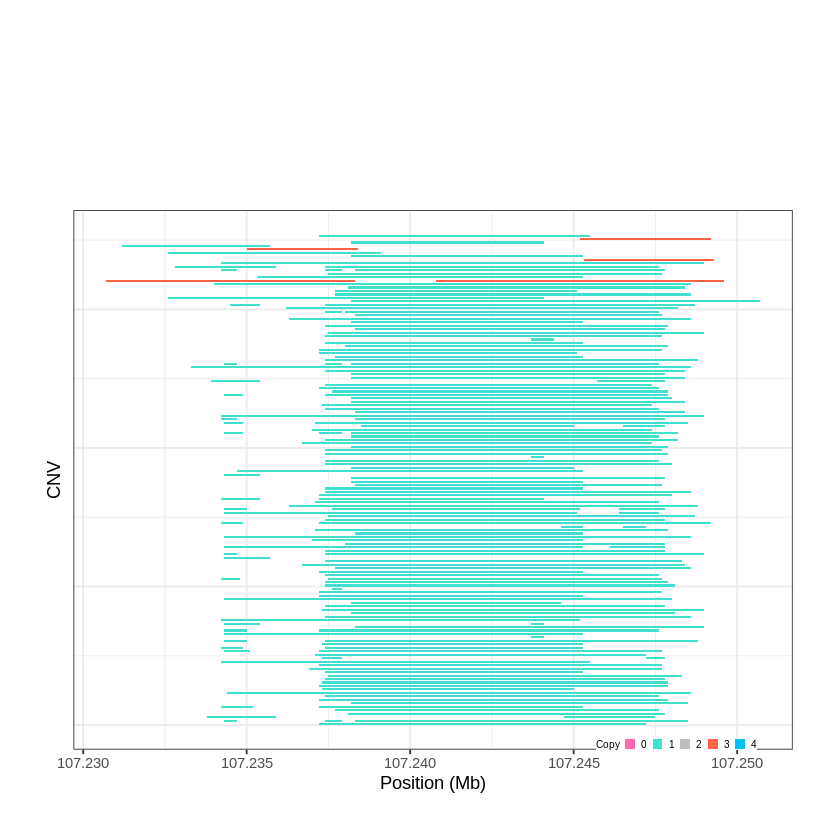

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1392..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 116.804201 - 116.8199 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


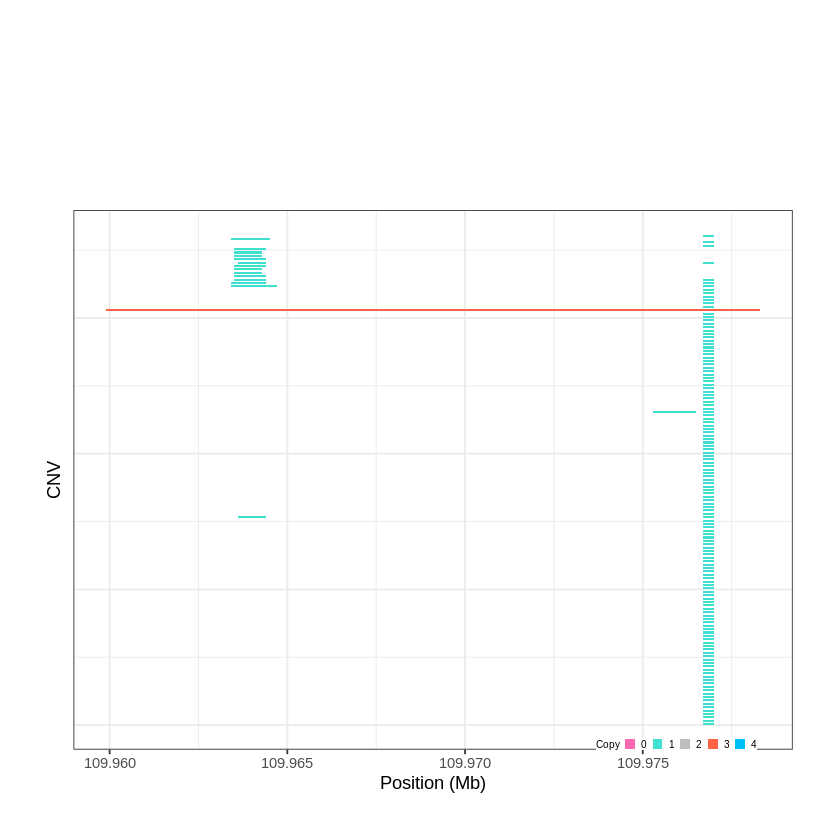

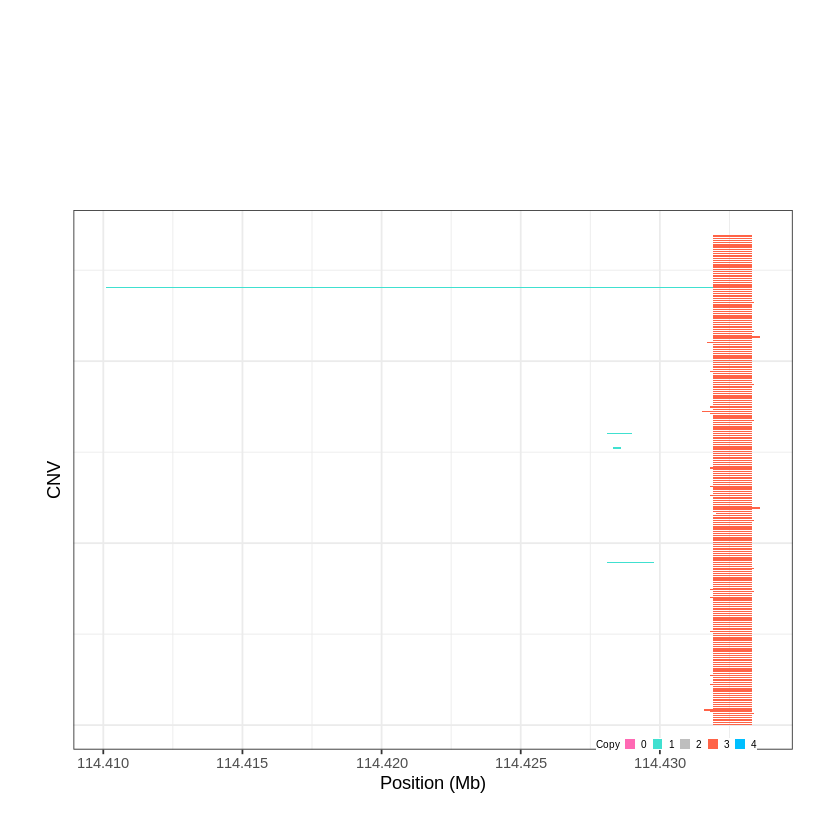

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1393..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 118.601801 - 119.8245 Mb with 261 Individual - "
Plotting gene...


Warning message:
“ggrepel: 21 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


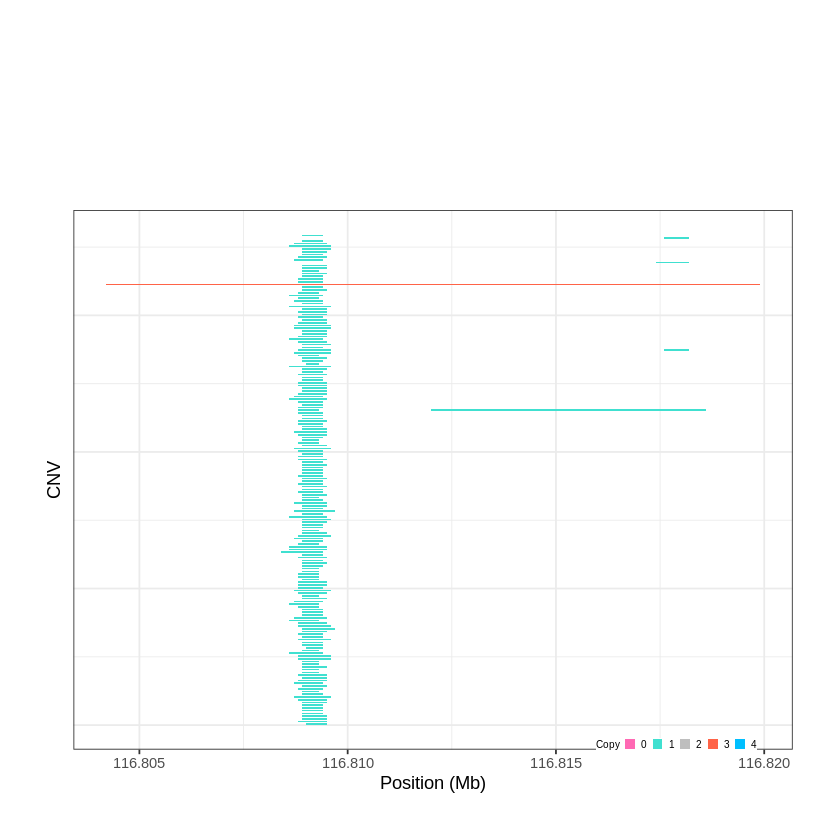

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1394..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 119.925901 - 120.1536 Mb with 224 Individual - "
Plotting gene...


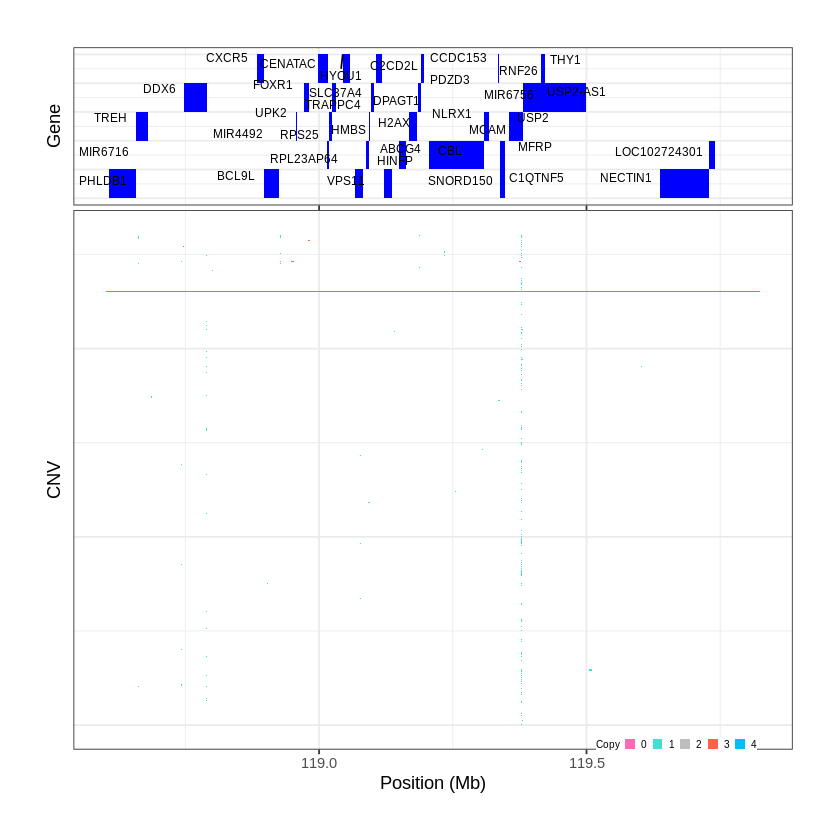

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1395..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 126.011701 - 126.4309 Mb with 163 Individual - "
Plotting gene...


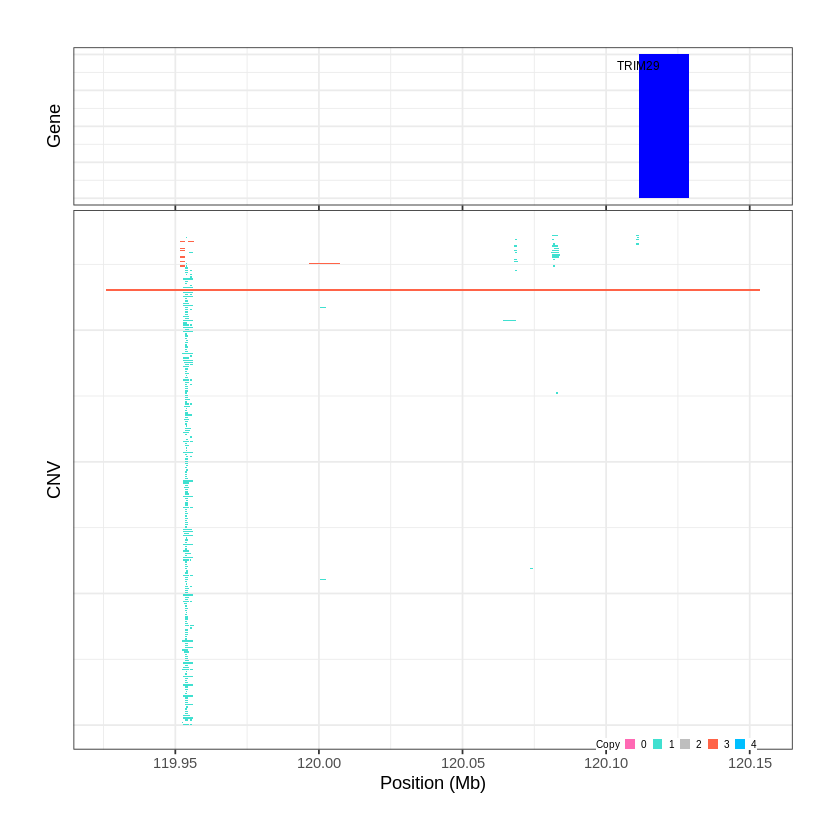

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1396..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 131.480701 - 131.5525 Mb with 238 Individual - "
Plotting gene...


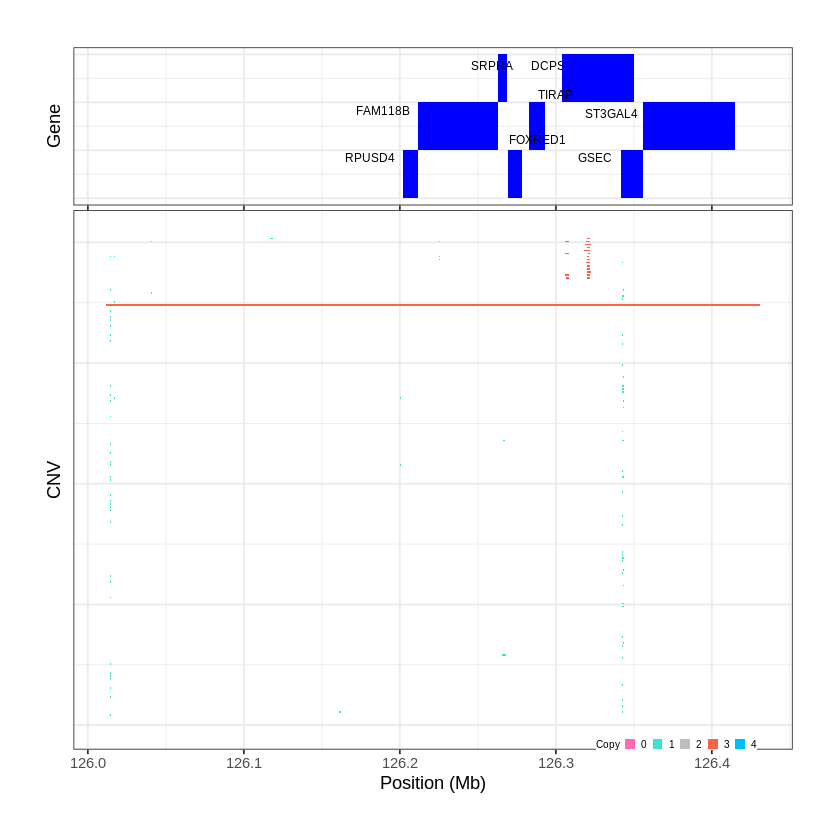

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1397..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 134.090601 - 134.4912 Mb with 268 Individual - "
Plotting gene...


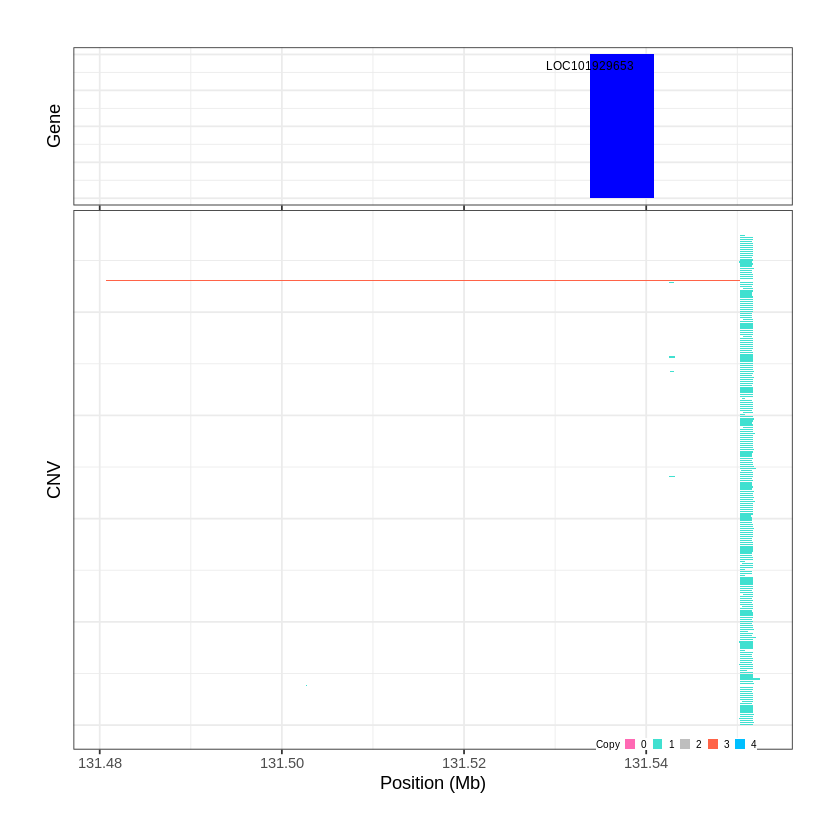

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1398..."
Input data passed requirment check...
[1] "CNV on Chromosome 11: 134.725301 - 135.0066 Mb with 279 Individual - "
Plotting gene...


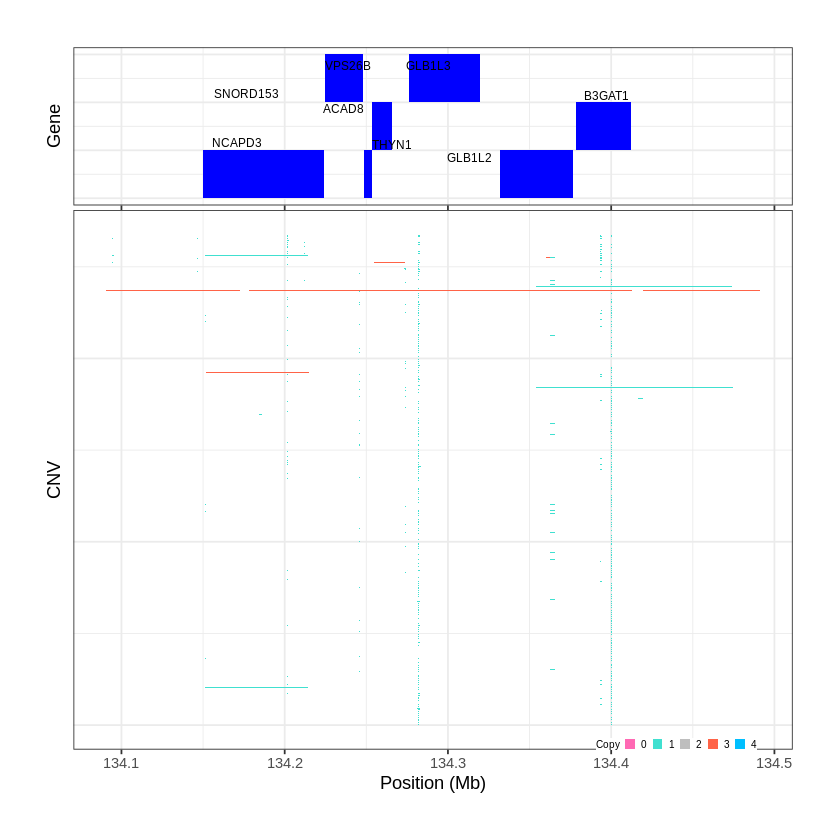

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1399..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 1e-06 - 7.2399 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 56 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 124 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


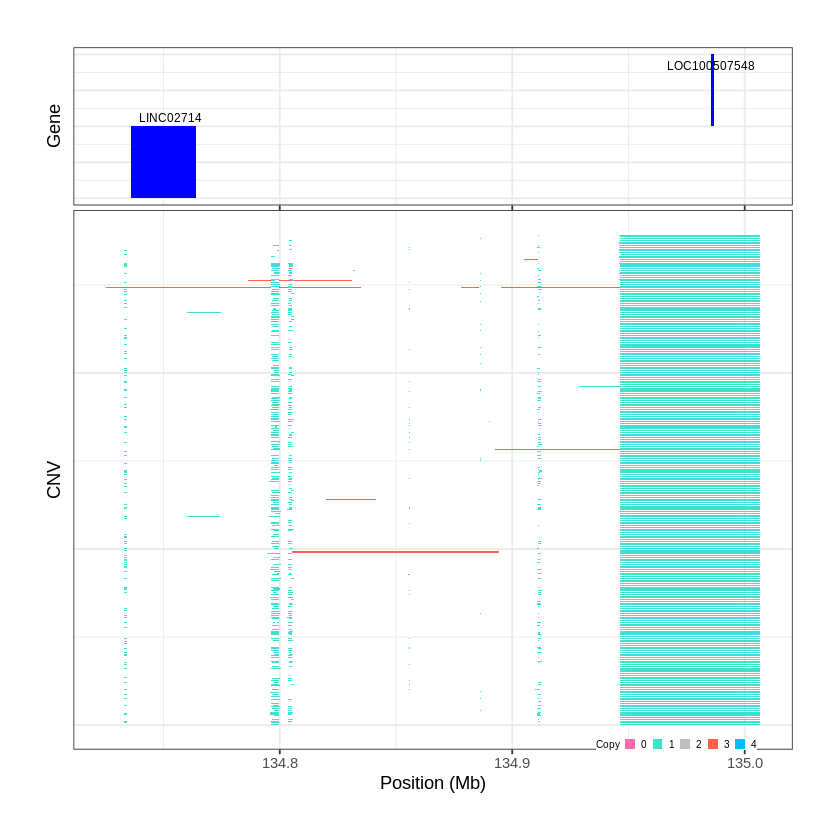

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1400..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 7.239901 - 8.5585 Mb with 273 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1401..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 8.558501 - 12.0264 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 55 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


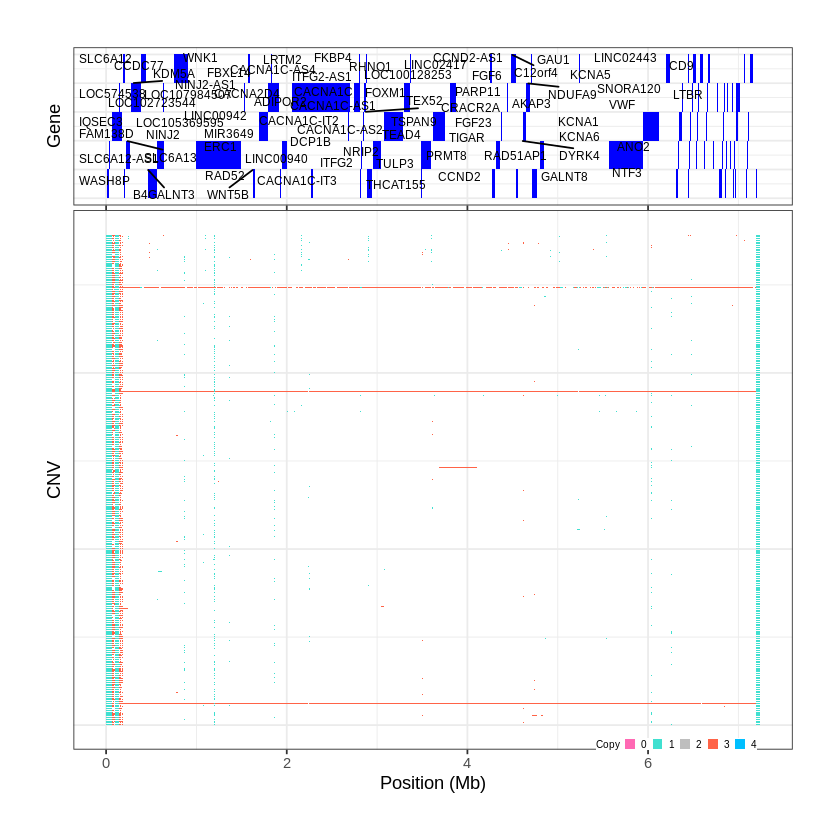

Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 83 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


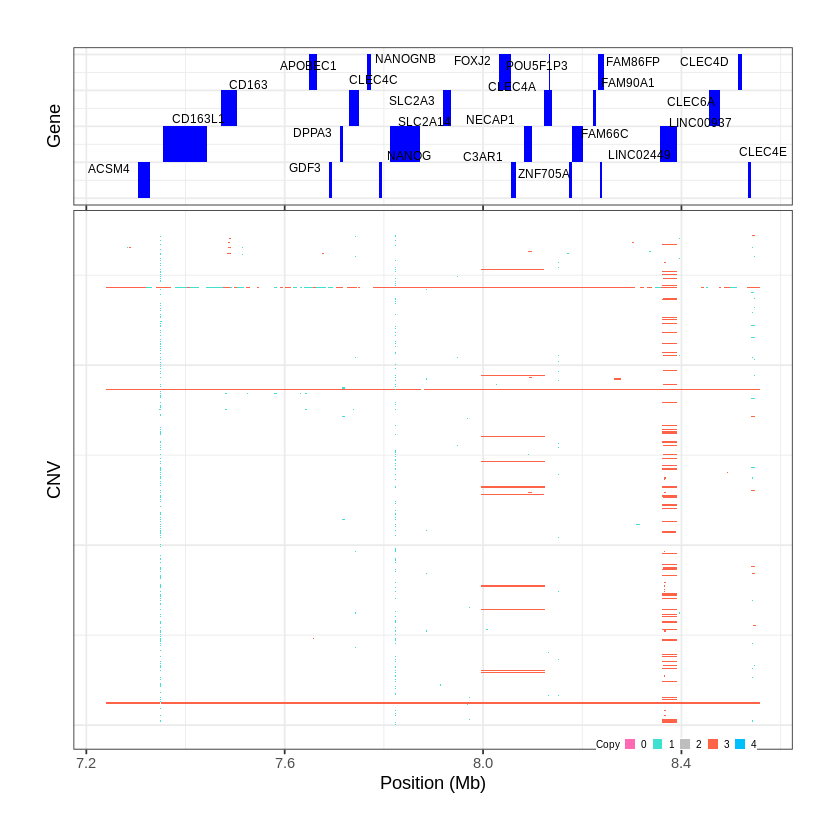

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1402..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 12.026401 - 39.1938 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 58 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 147 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


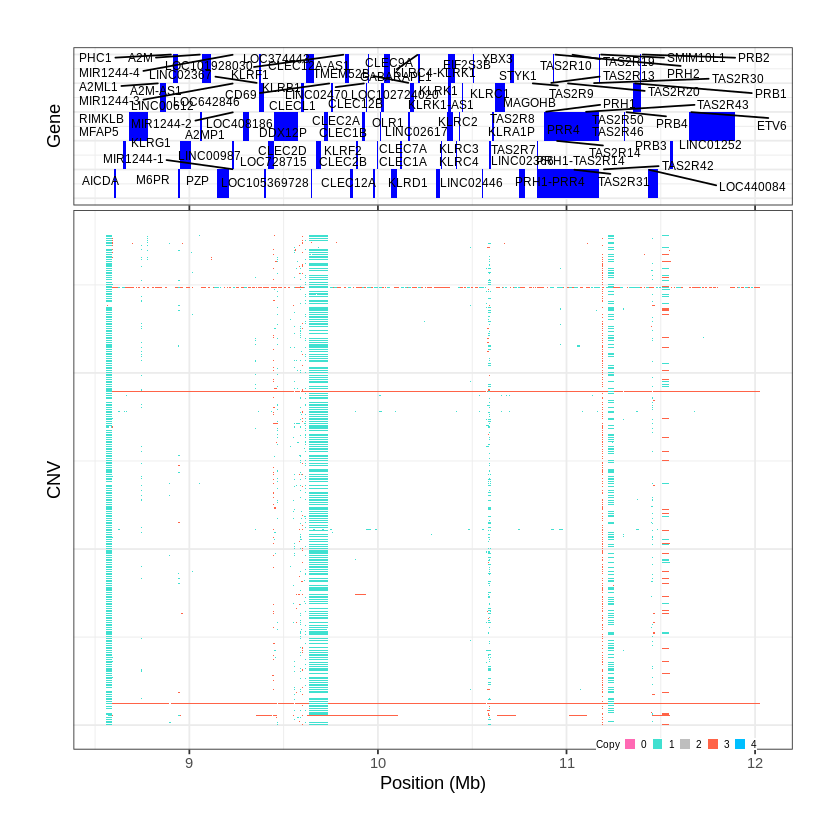

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1403..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 39.195301 - 51.957 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 89 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 138 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1404..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 51.958101 - 55.1854 Mb with 278 Individual - "
Plotting gene...


Warning message:
“ggrepel: 50 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


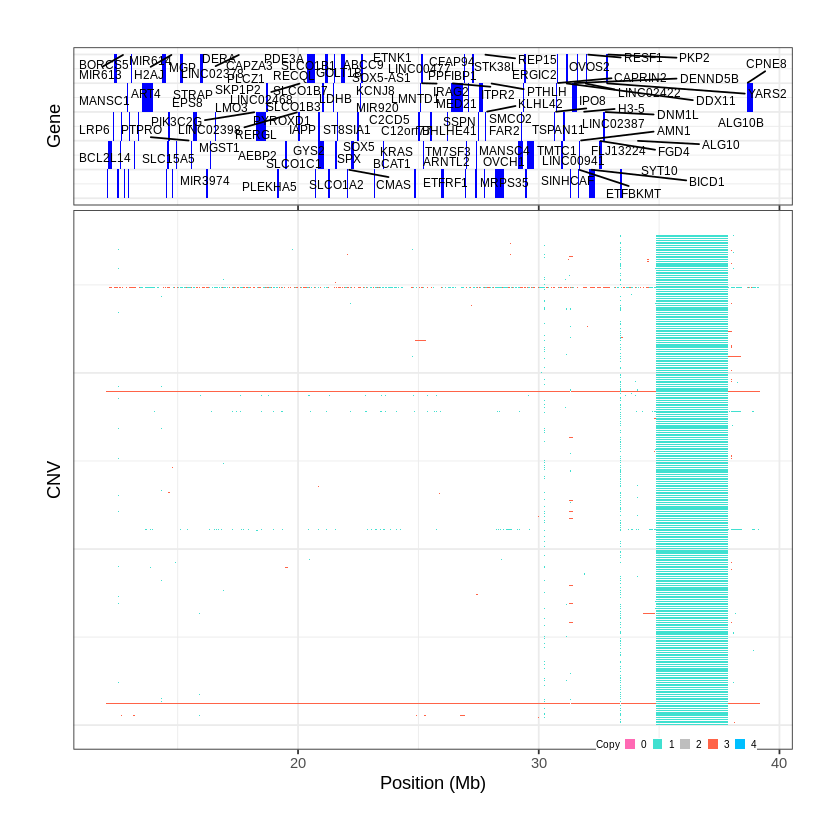

Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 109 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1405..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 55.188301 - 84.0702 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 89 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


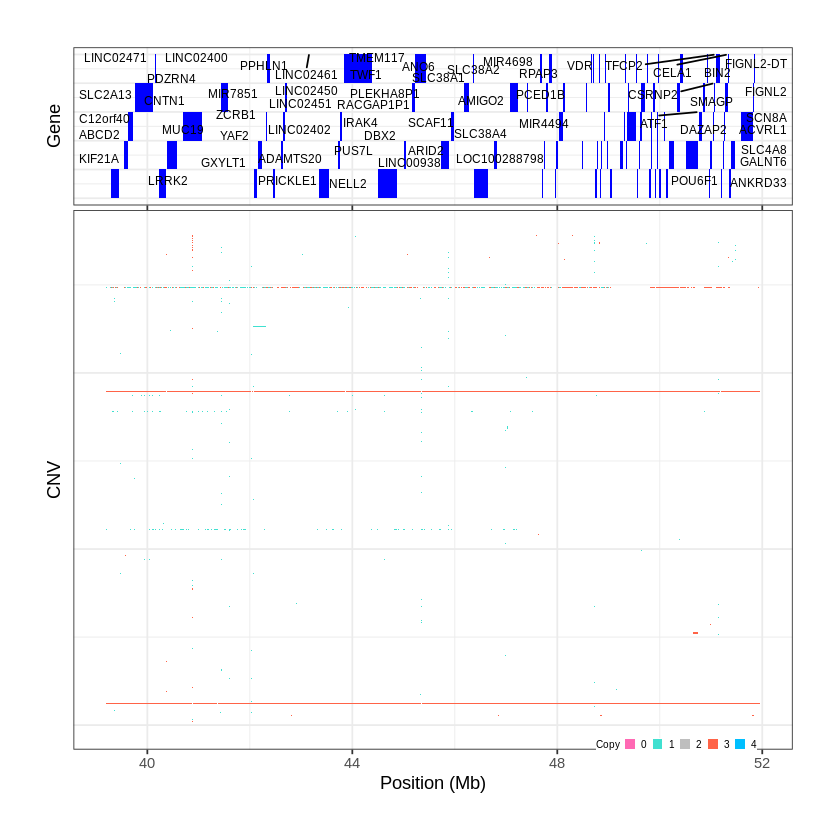

Warning message:
“ggrepel: 198 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 258 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1406..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 84.070201 - 109.4235 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


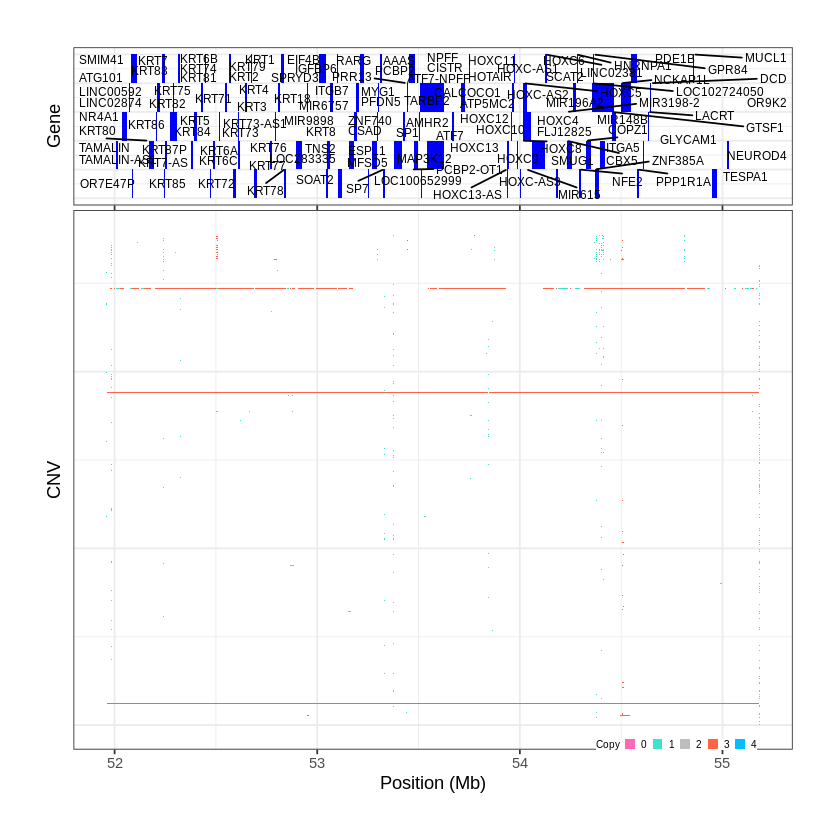

Warning message:
“ggrepel: 106 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 189 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1407..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 109.423501 - 121.9647 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 198 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


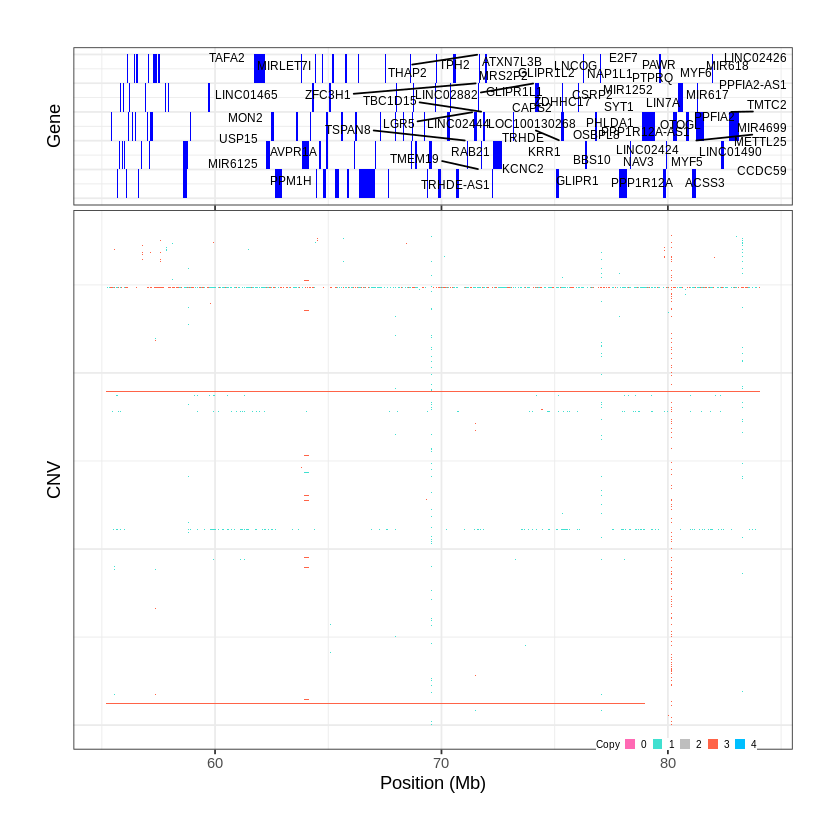

Warning message:
“ggrepel: 53 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 155 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1408..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 121.964701 - 122.5306 Mb with 273 Individual - "
Plotting gene...


Warning message:
“ggrepel: 98 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


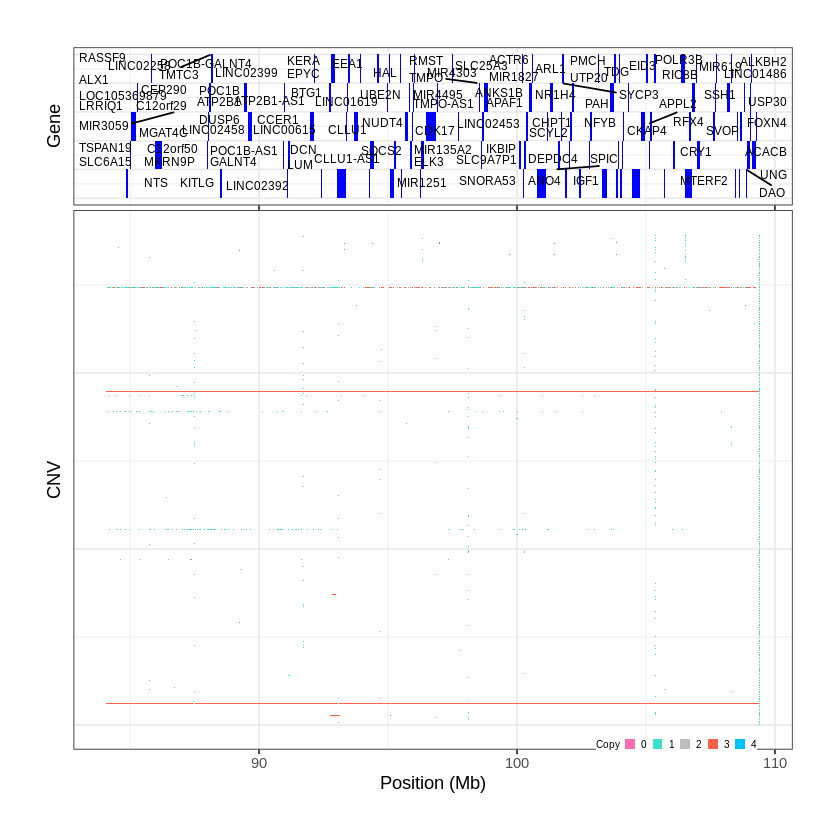

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1409..."
Input data passed requirment check...
[1] "CNV on Chromosome 12: 122.530601 - 133.8519 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 44 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


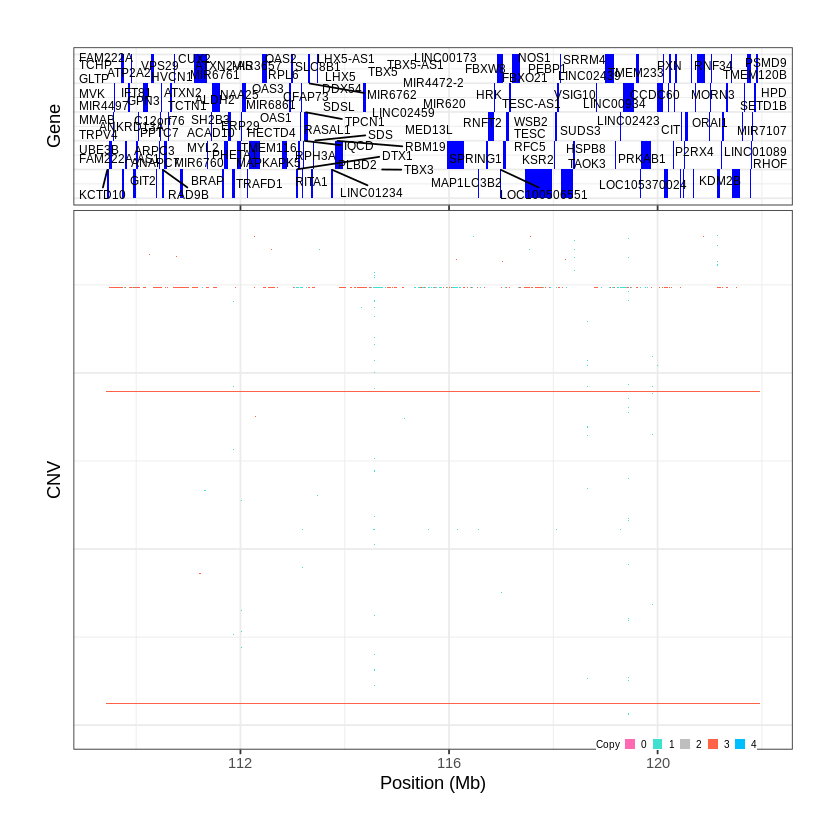

Warning message:
“ggrepel: 40 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 124 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


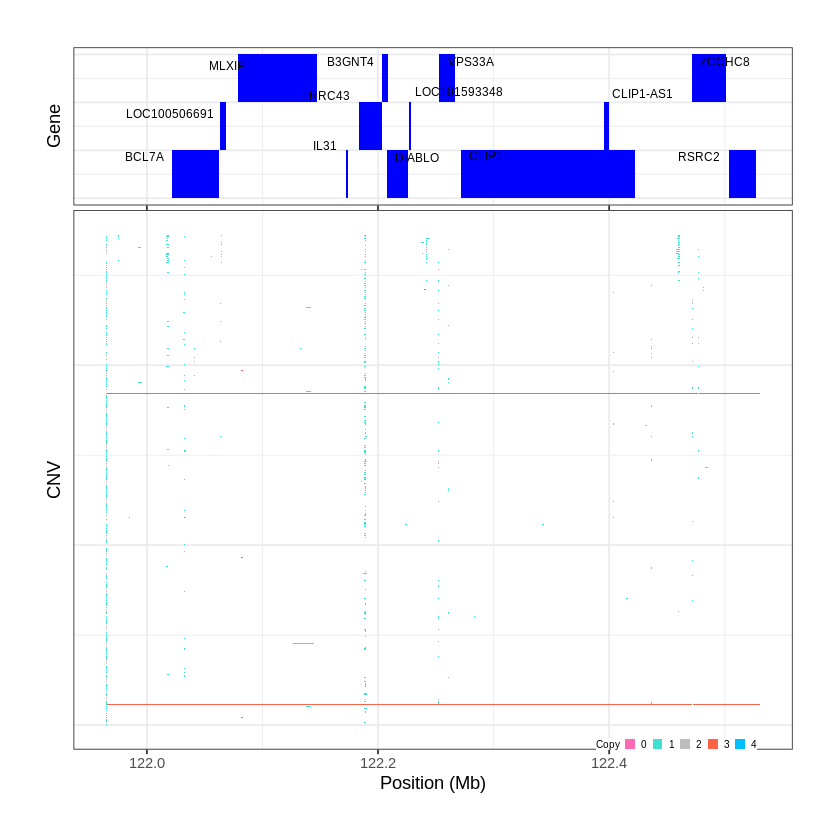

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1410..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 19.020001 - 19.2752 Mb with 263 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1411..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 19.313001 - 19.3848 Mb with 184 Individual - "
Plotting gene...


Warning message:
“ggrepel: 35 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


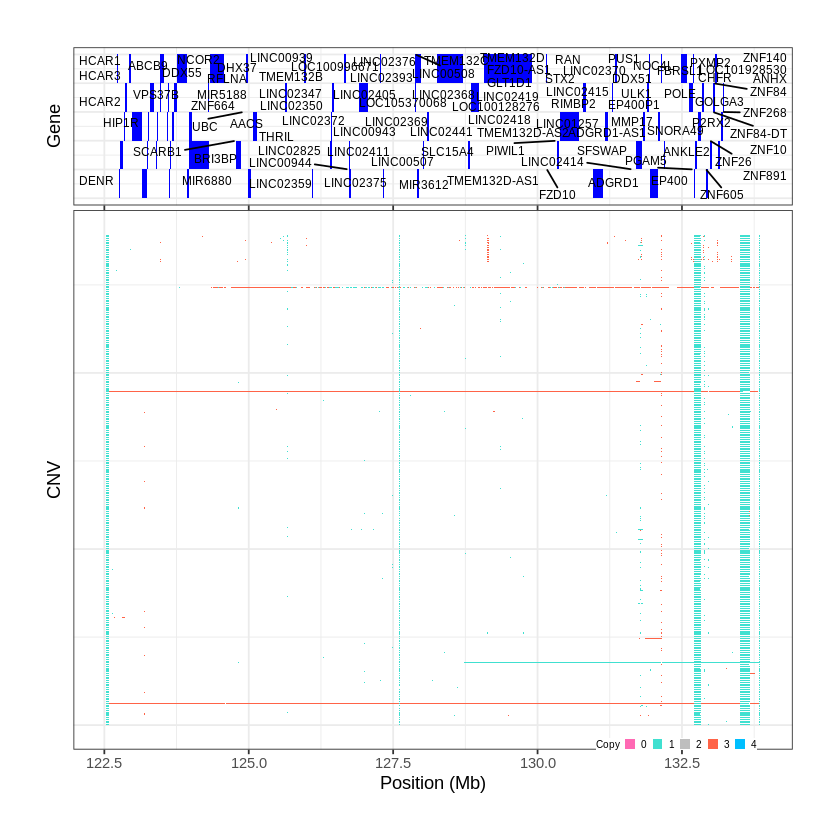

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1412..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 19.445301 - 19.4524 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


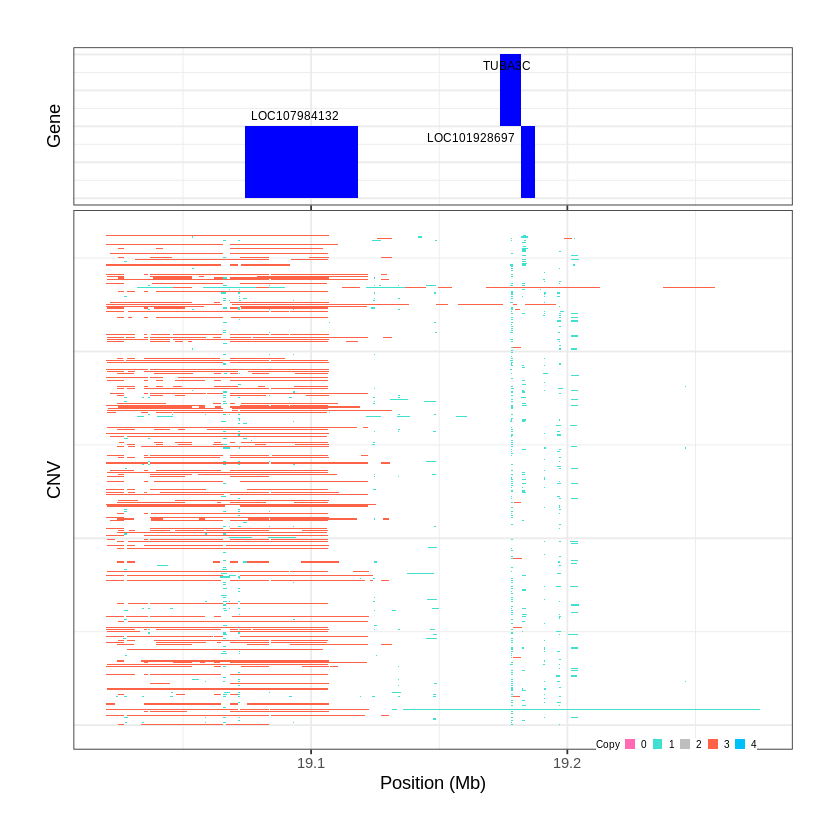

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1413..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 19.469901 - 19.4848 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


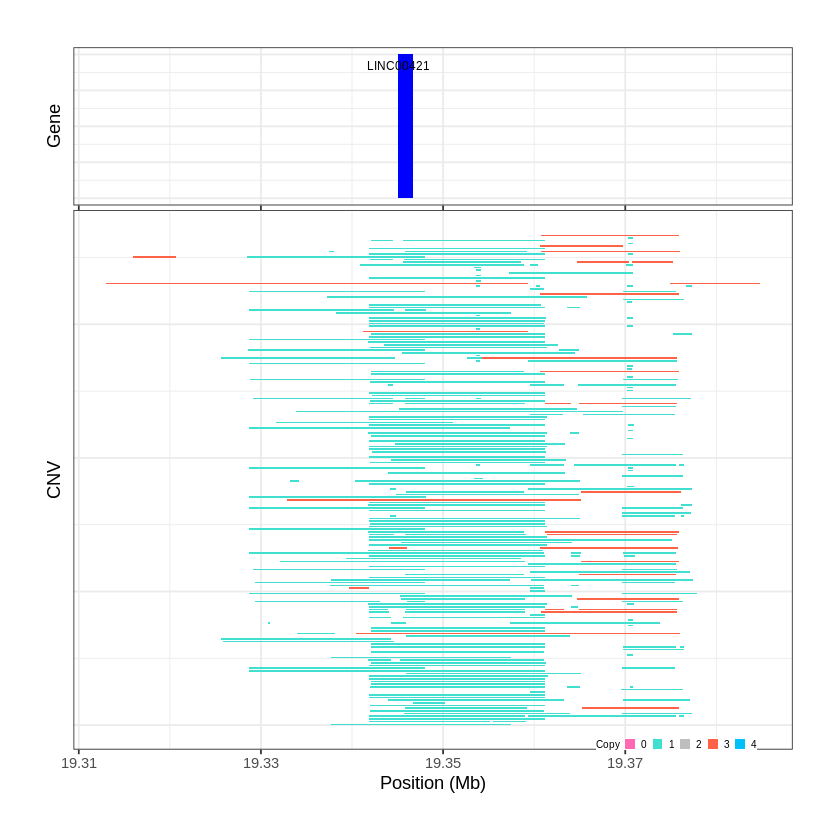

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1414..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 19.847001 - 19.883 Mb with 248 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


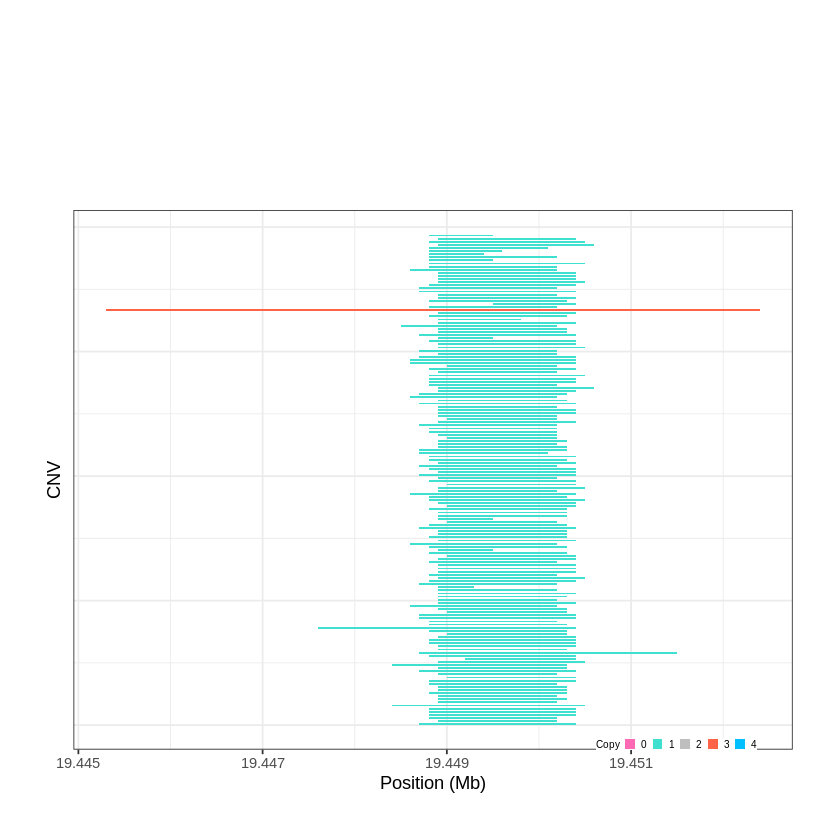

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1415..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 19.915101 - 19.9974 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


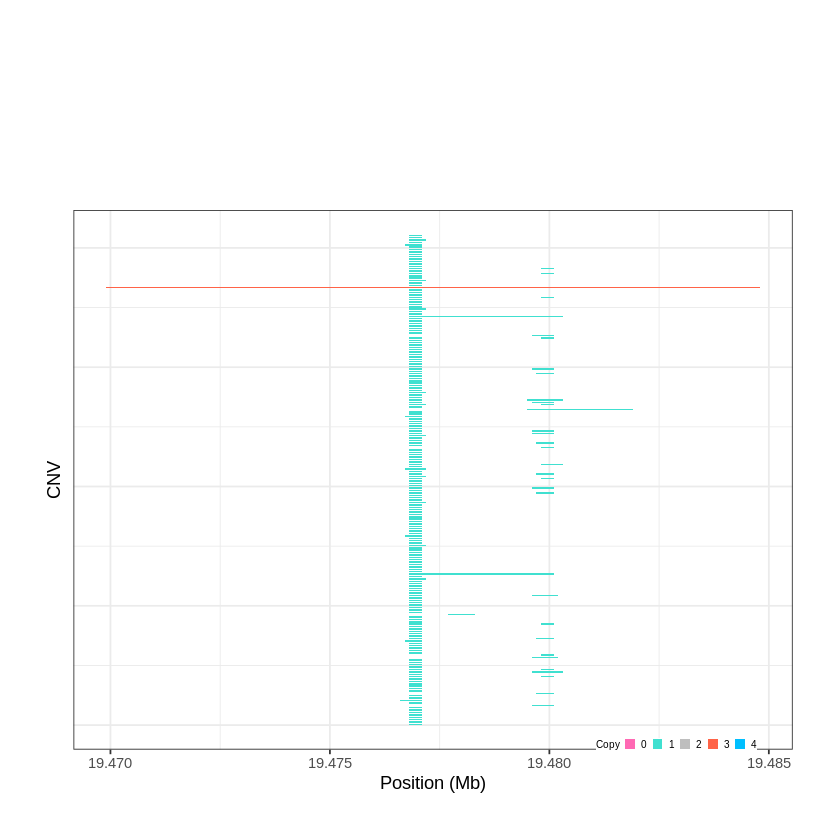

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1416..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 20.950501 - 21.015 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


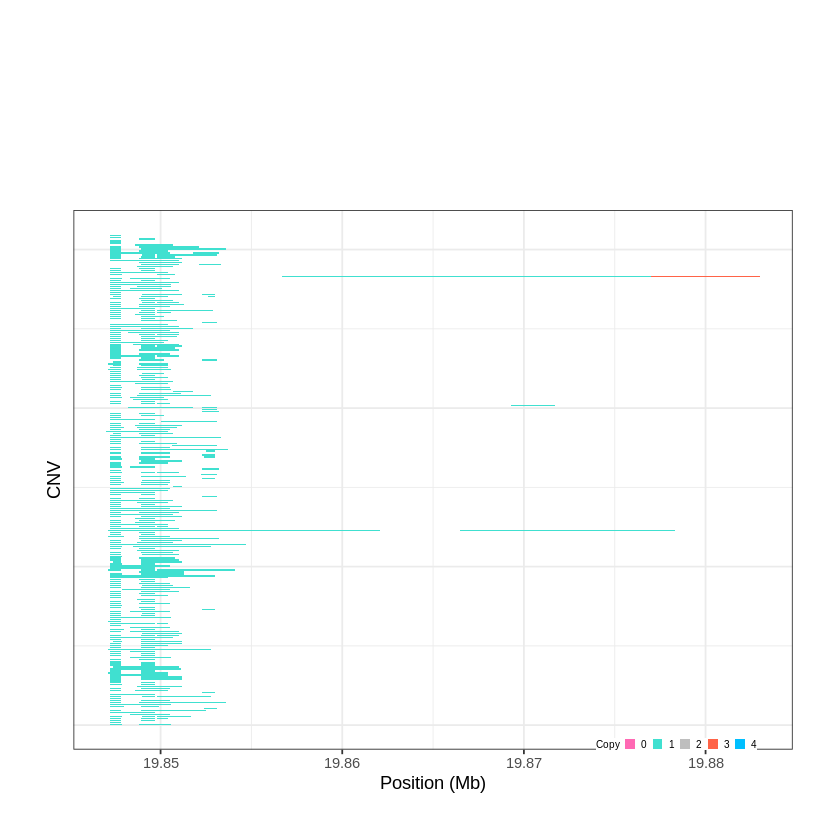

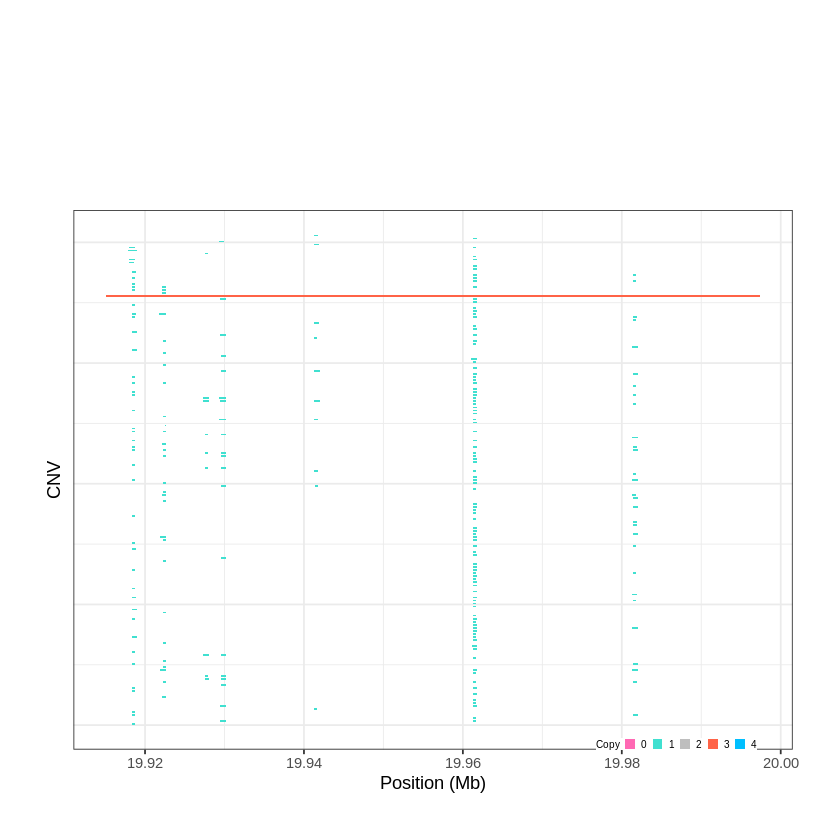

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1417..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 21.547401 - 21.7219 Mb with 163 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1418..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 21.730901 - 21.7312 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


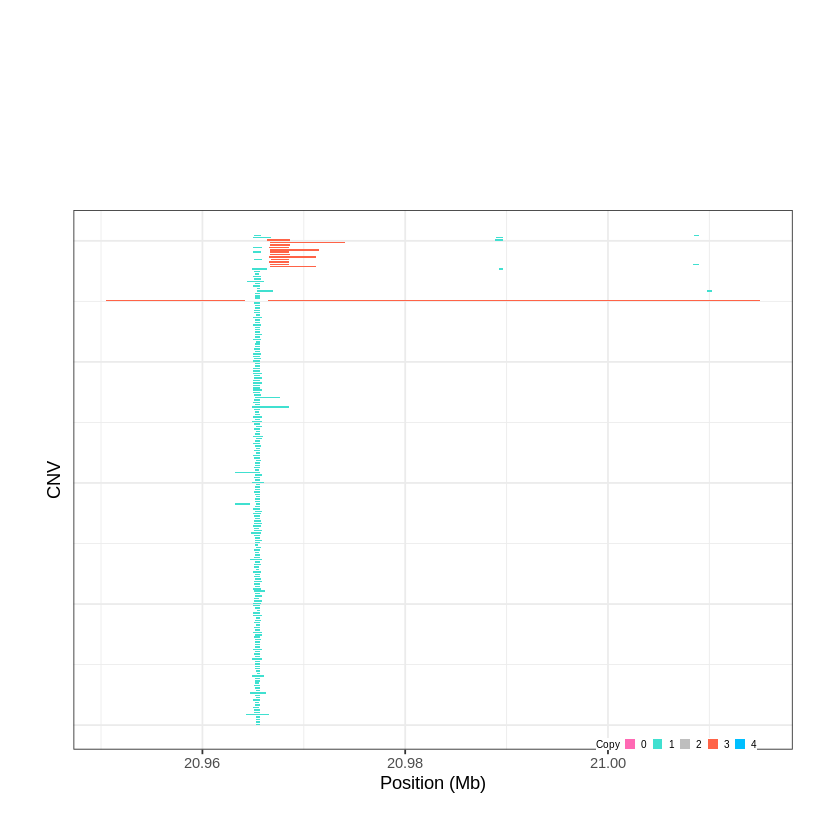

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1419..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 23.055201 - 23.0555 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


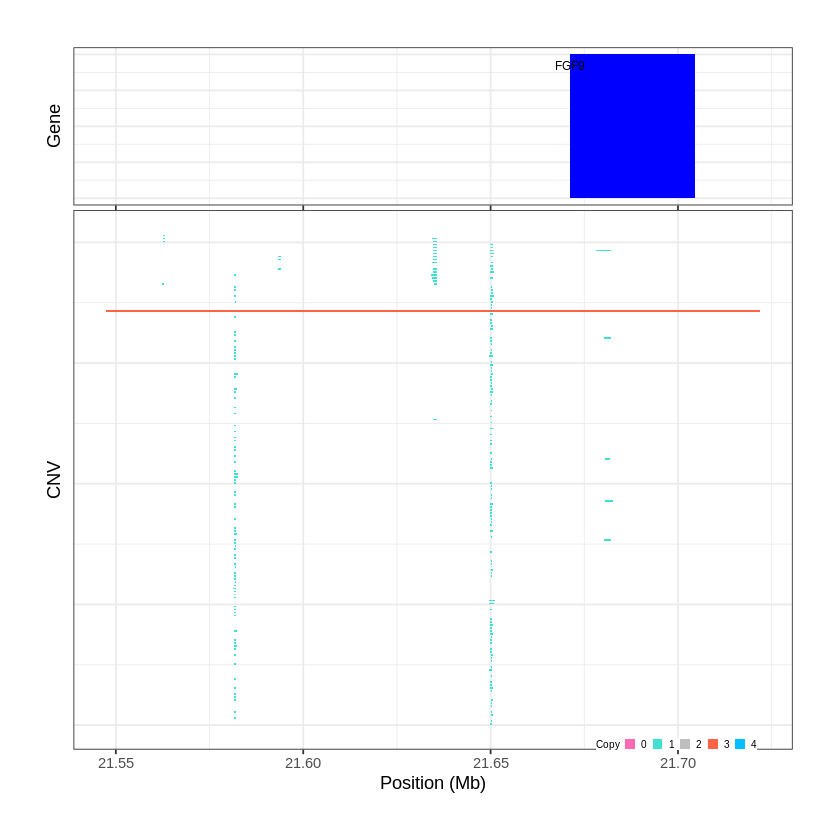

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1420..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 27.034201 - 27.1575 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


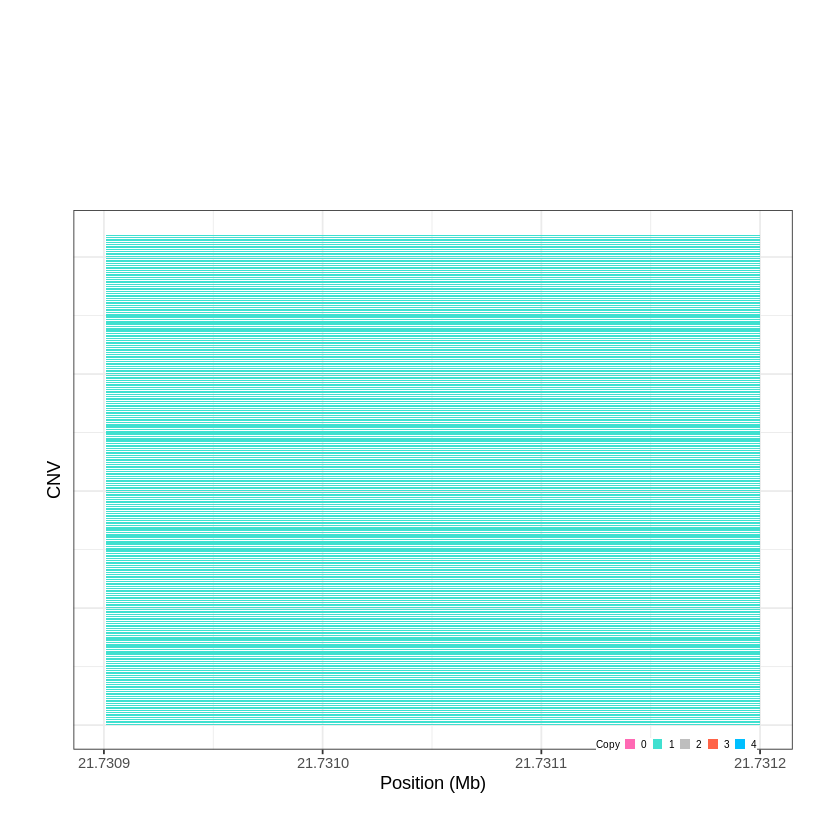

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1421..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 27.861801 - 27.8622 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


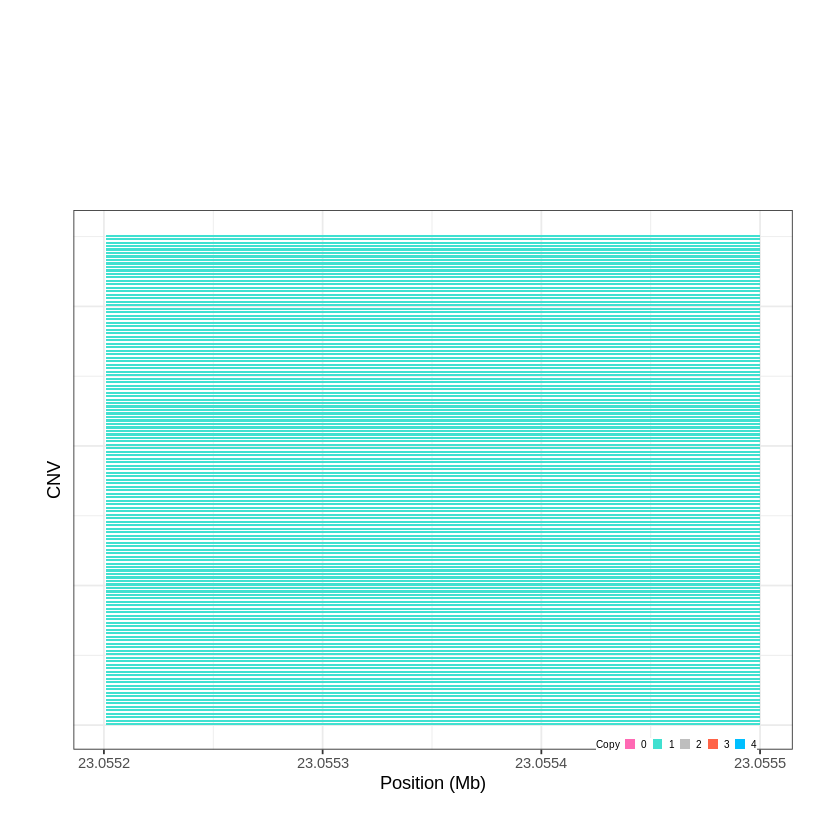

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1422..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 28.830201 - 28.8592 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


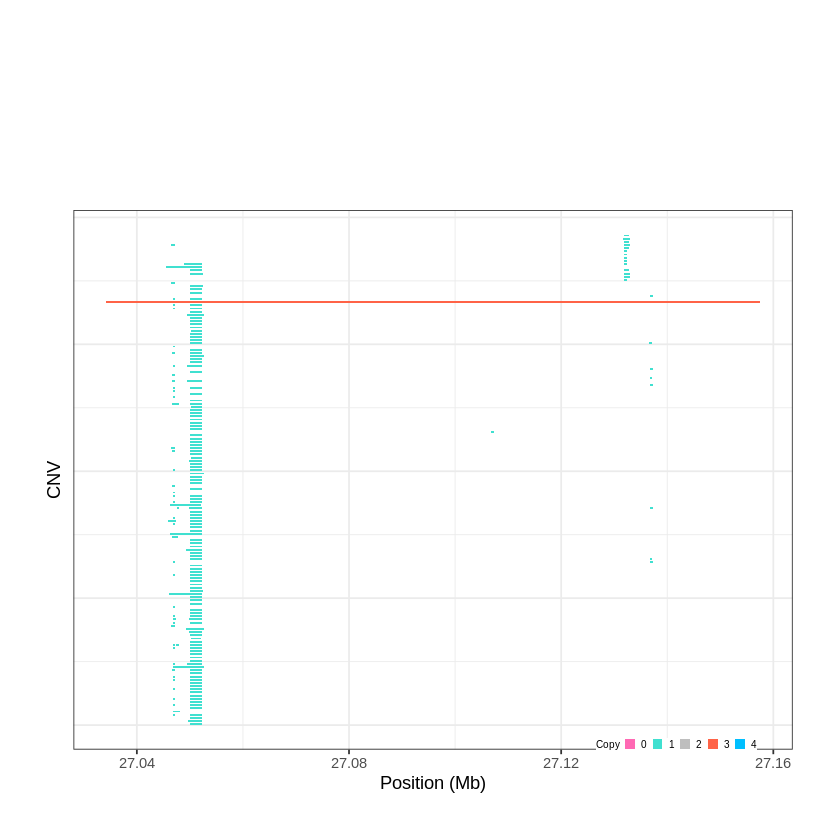

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1423..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 29.945801 - 29.9627 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


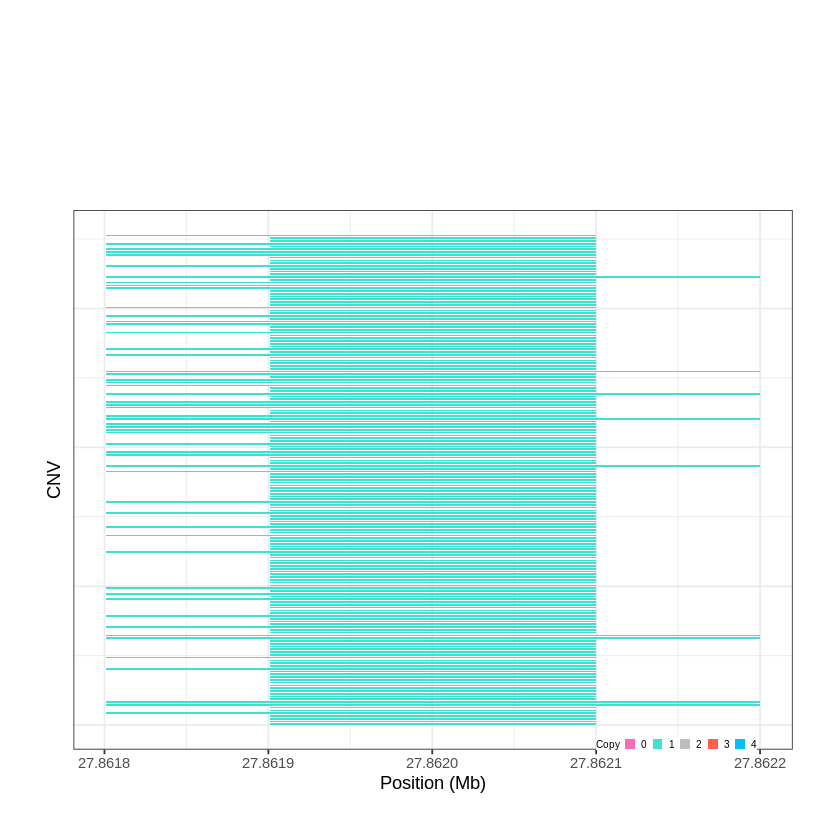

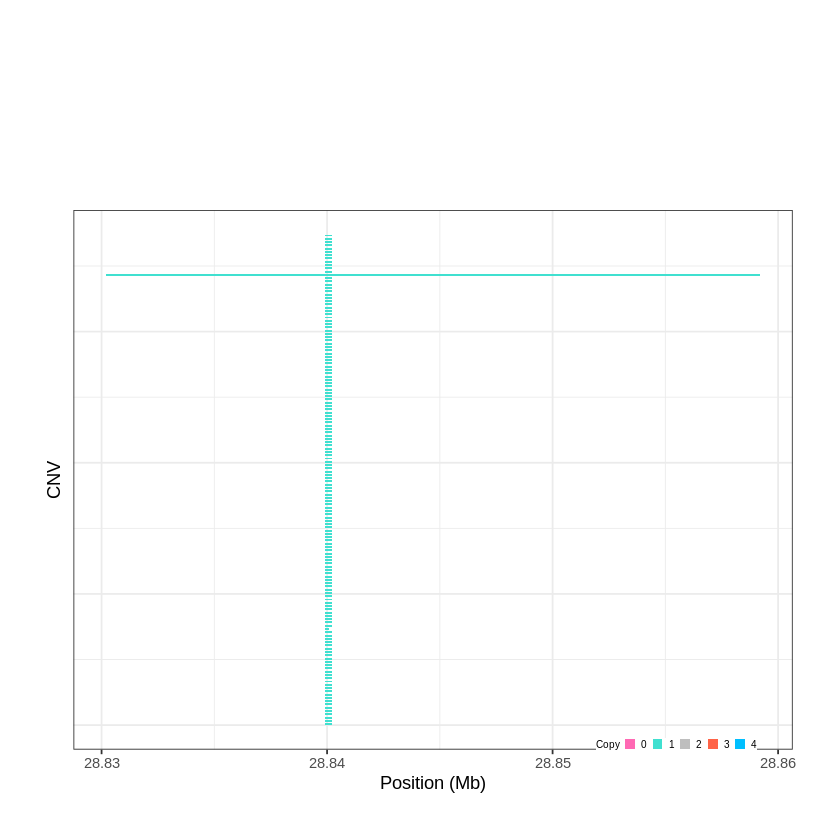

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1424..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 30.053001 - 30.1728 Mb with 254 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1425..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 32.571901 - 32.576 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


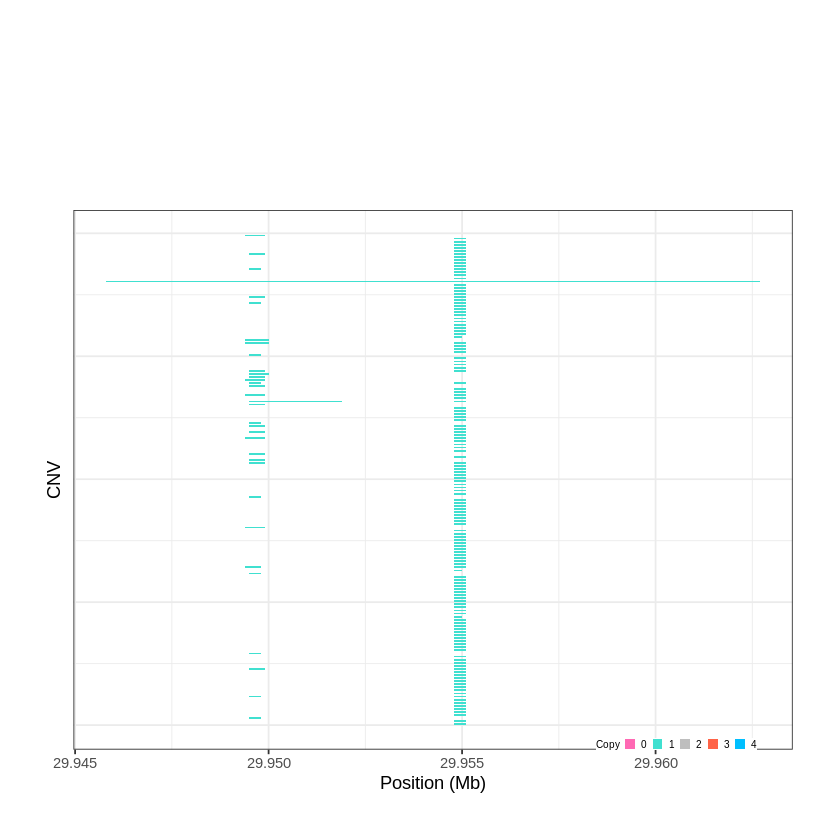

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1426..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 39.056201 - 39.0656 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


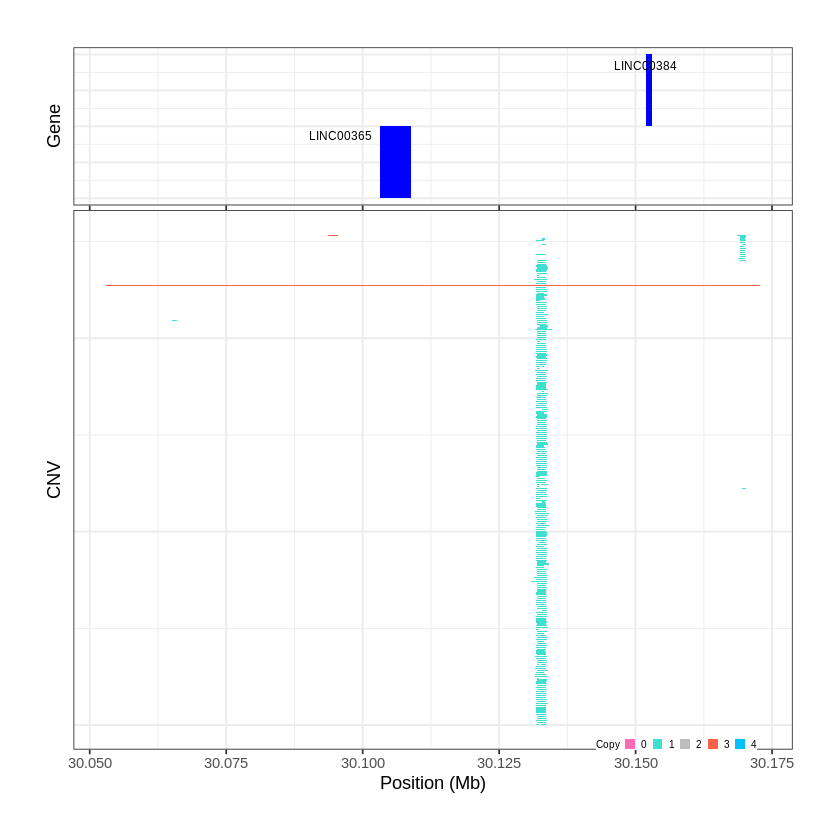

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1427..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 39.933401 - 39.9679 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


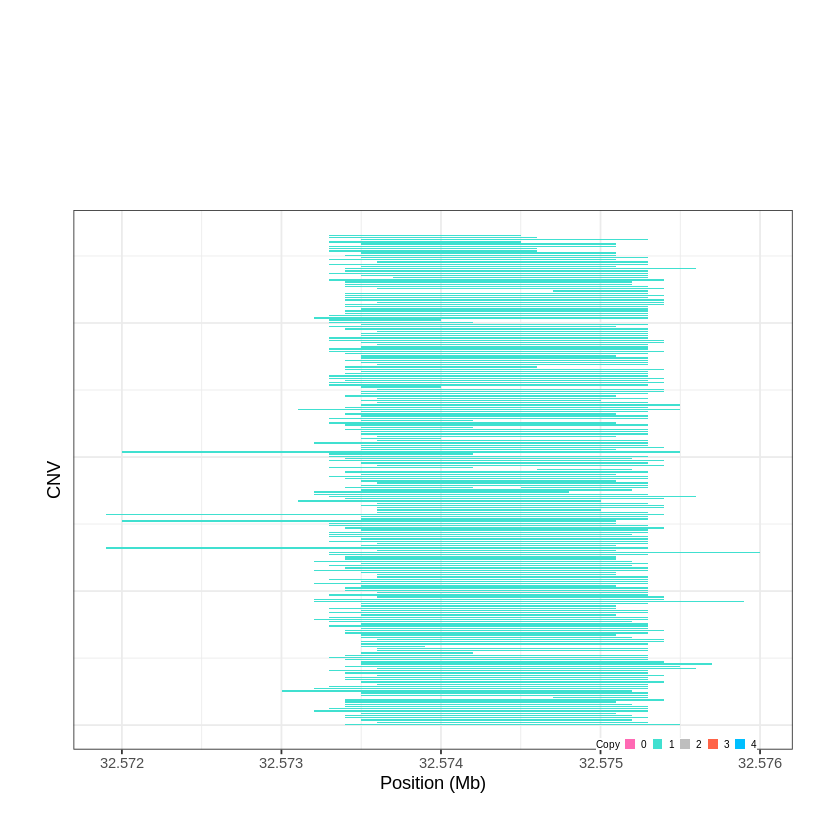

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1428..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 41.951001 - 41.9794 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


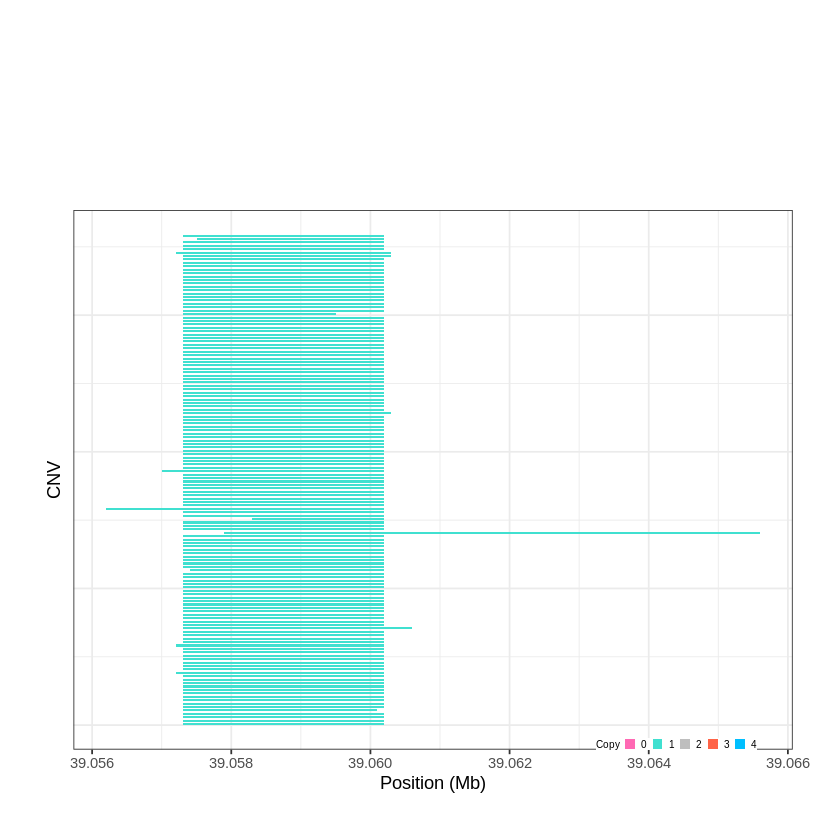

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1429..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 42.922301 - 42.9498 Mb with 207 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


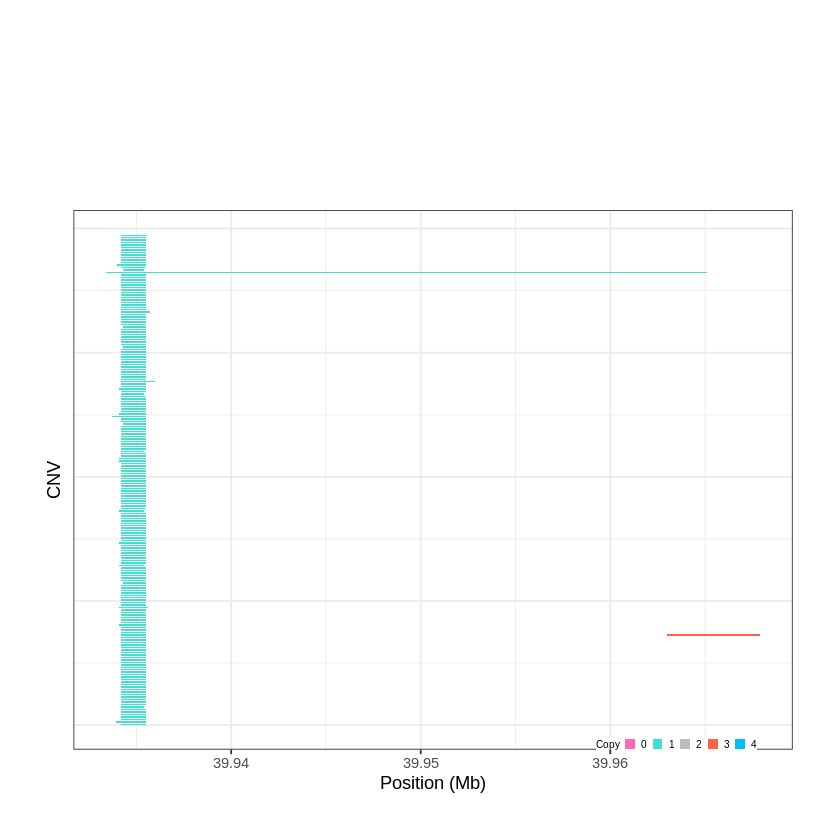

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1430..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 43.441401 - 43.4453 Mb with 170 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


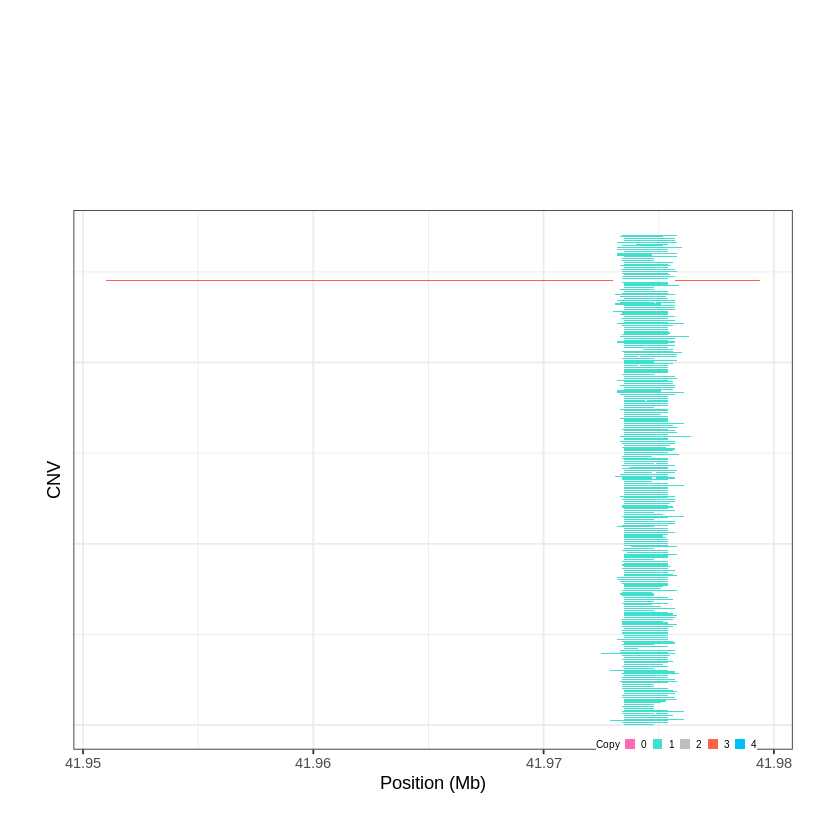

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1431..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 43.525401 - 43.5716 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


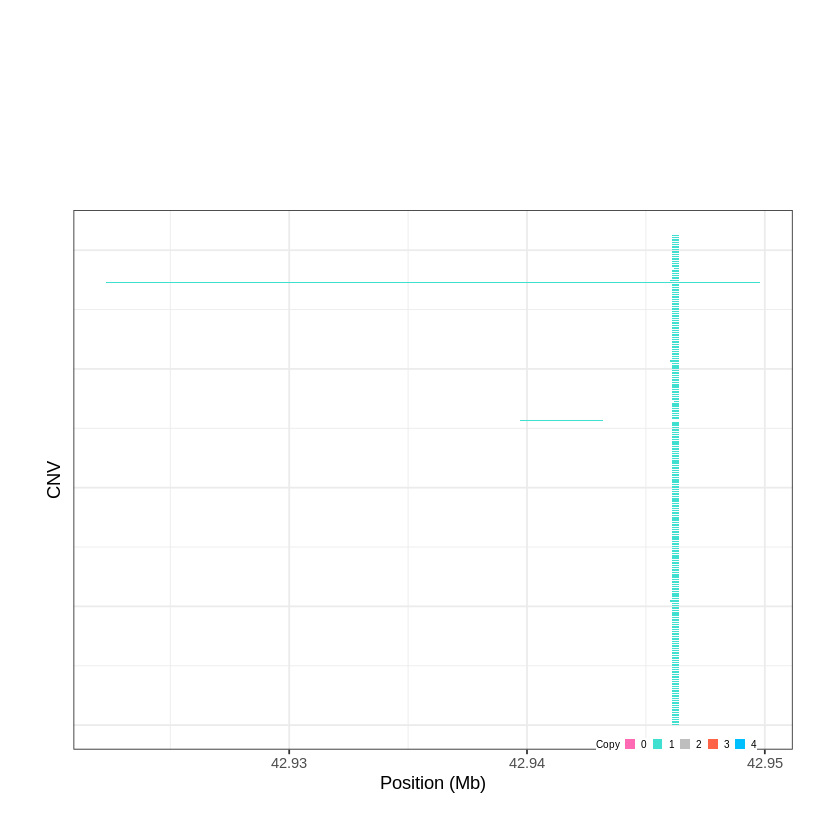

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1432..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 45.912601 - 46.0032 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


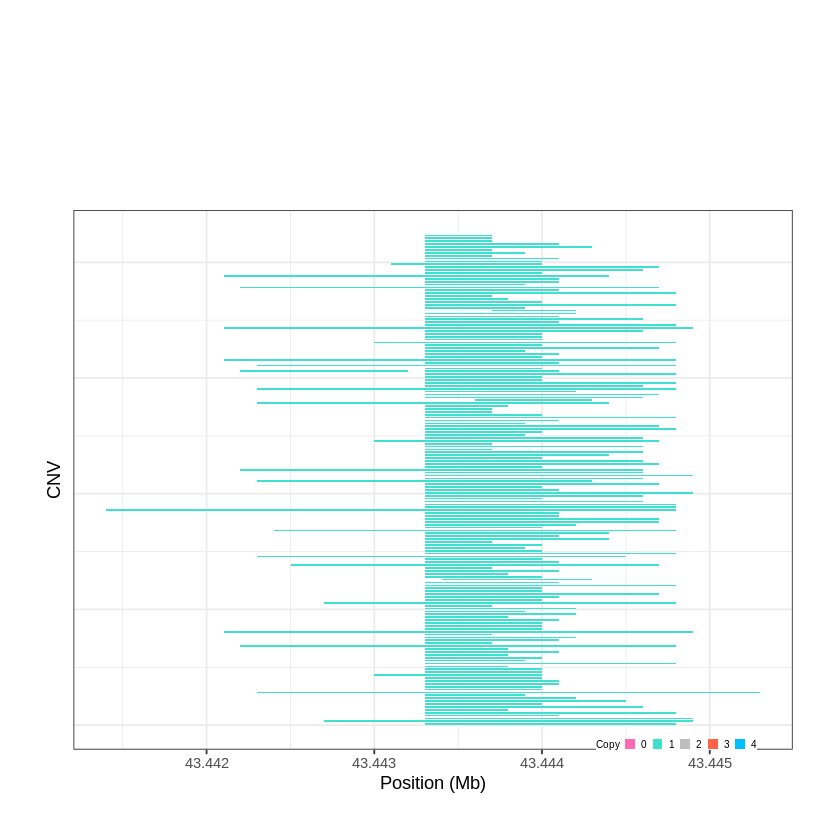

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1433..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 46.005301 - 46.0059 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


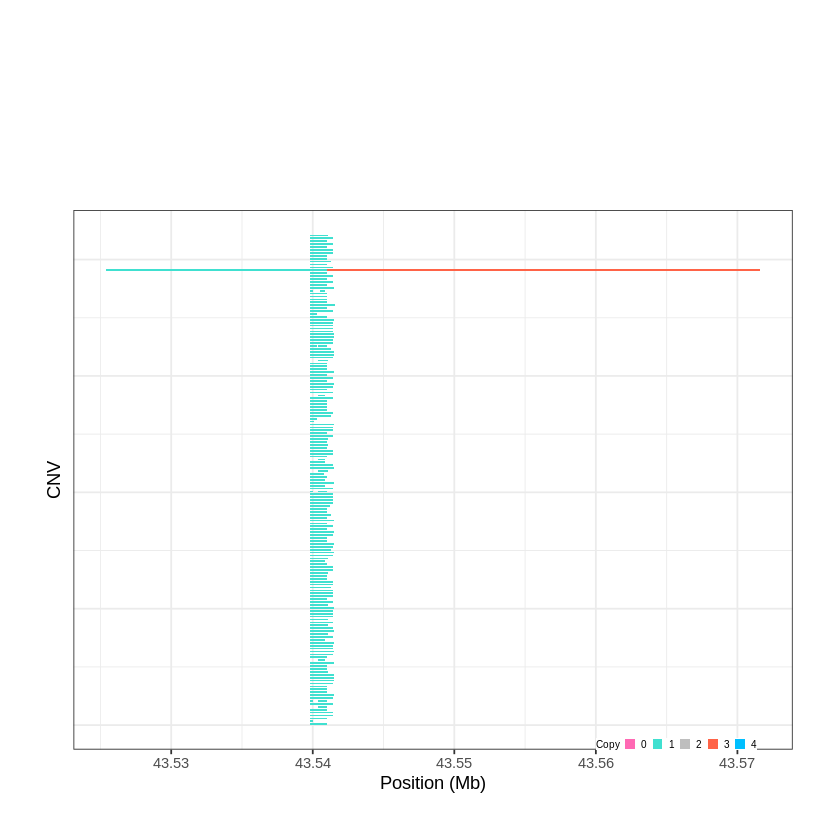

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1434..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 47.009301 - 47.0546 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


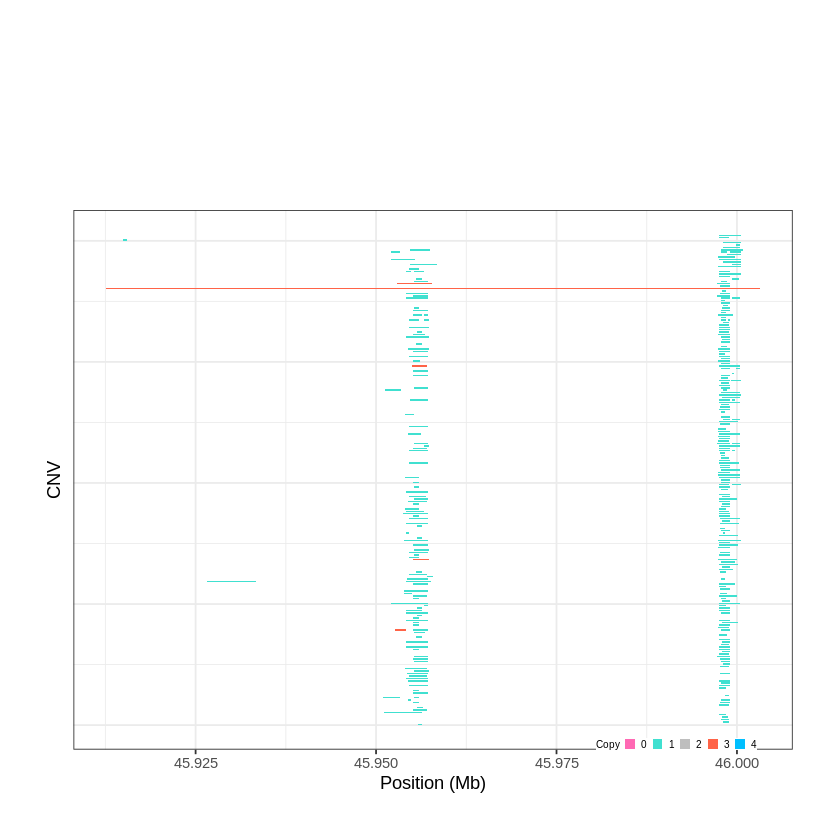

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1435..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 48.286101 - 48.2999 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


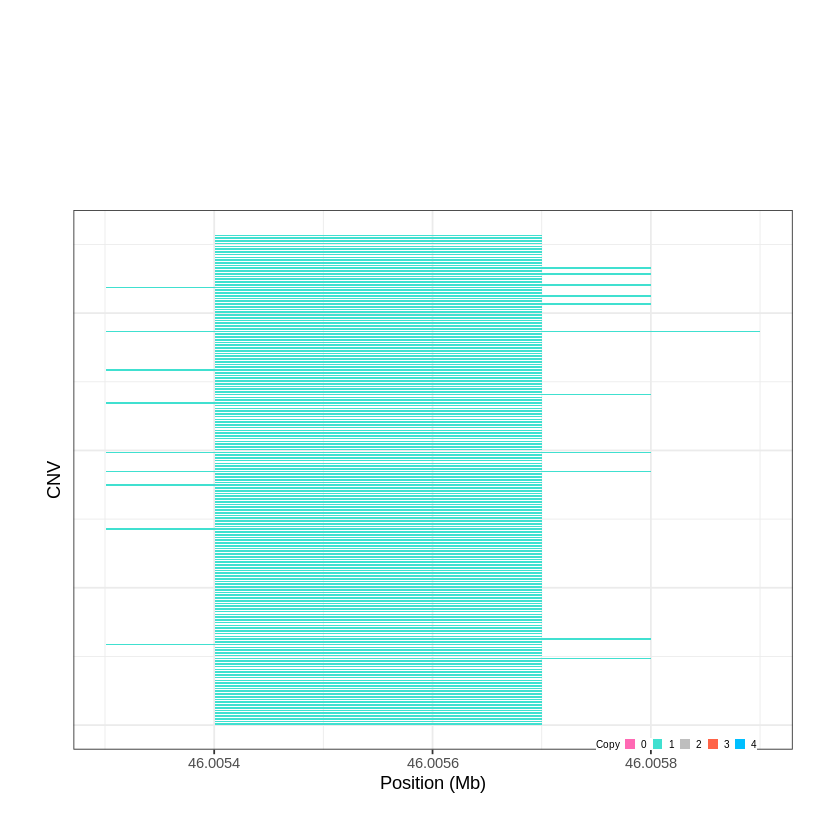

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1436..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 49.530401 - 49.5375 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


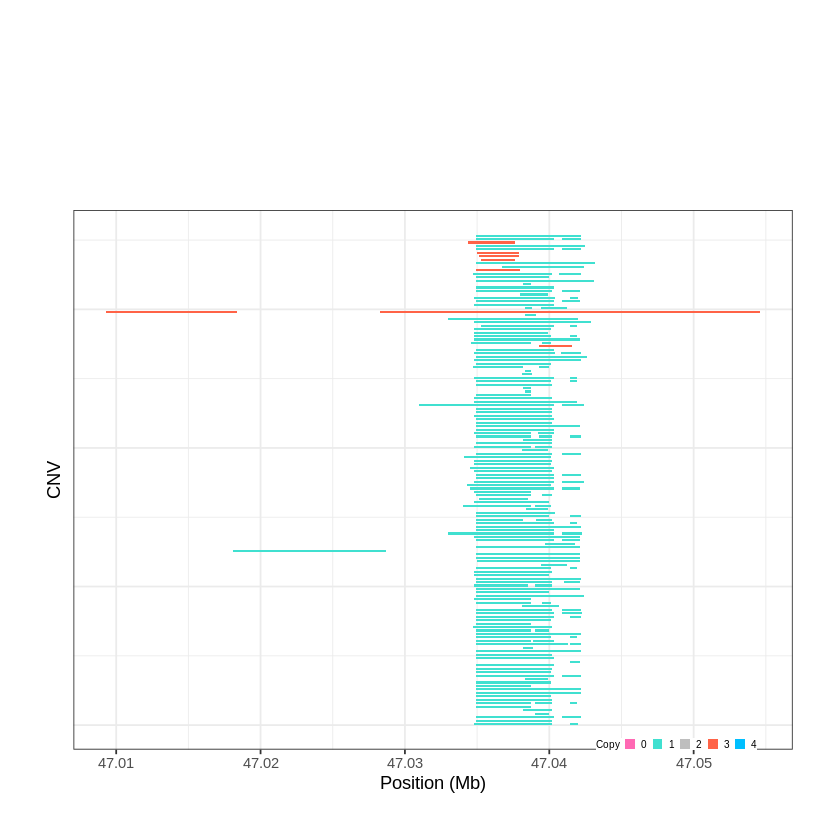

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1437..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 49.634801 - 49.6363 Mb with 204 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


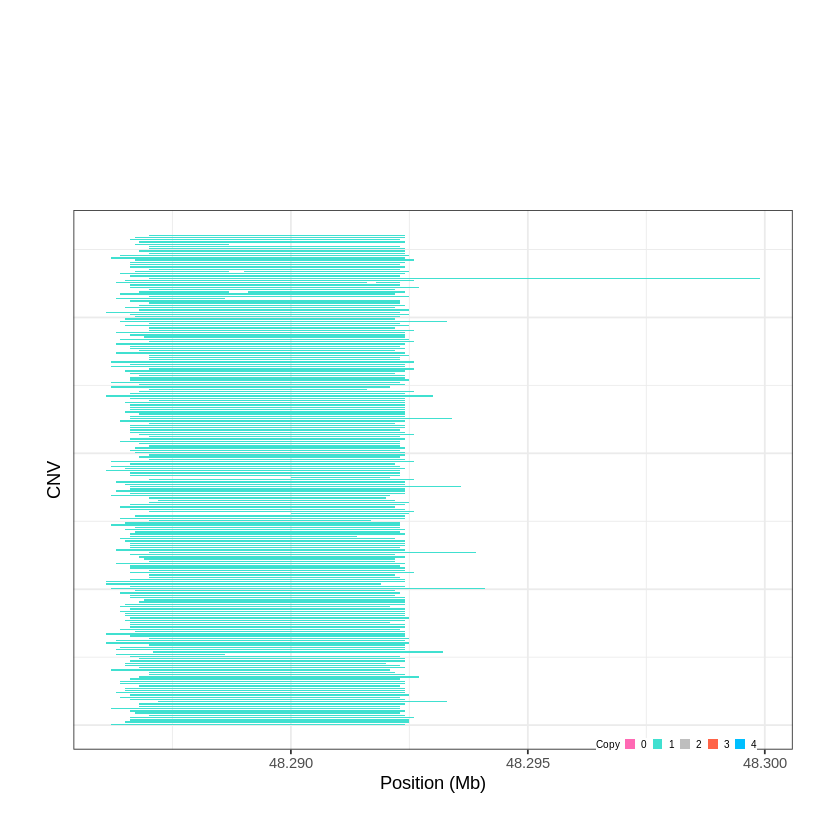

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1438..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 51.055001 - 51.0889 Mb with 259 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


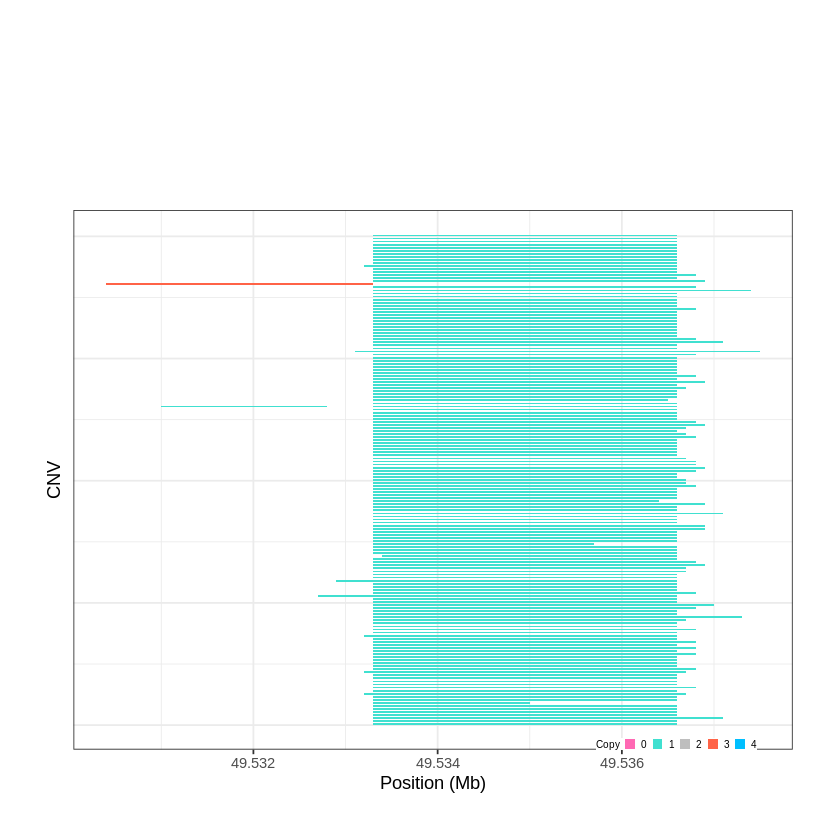

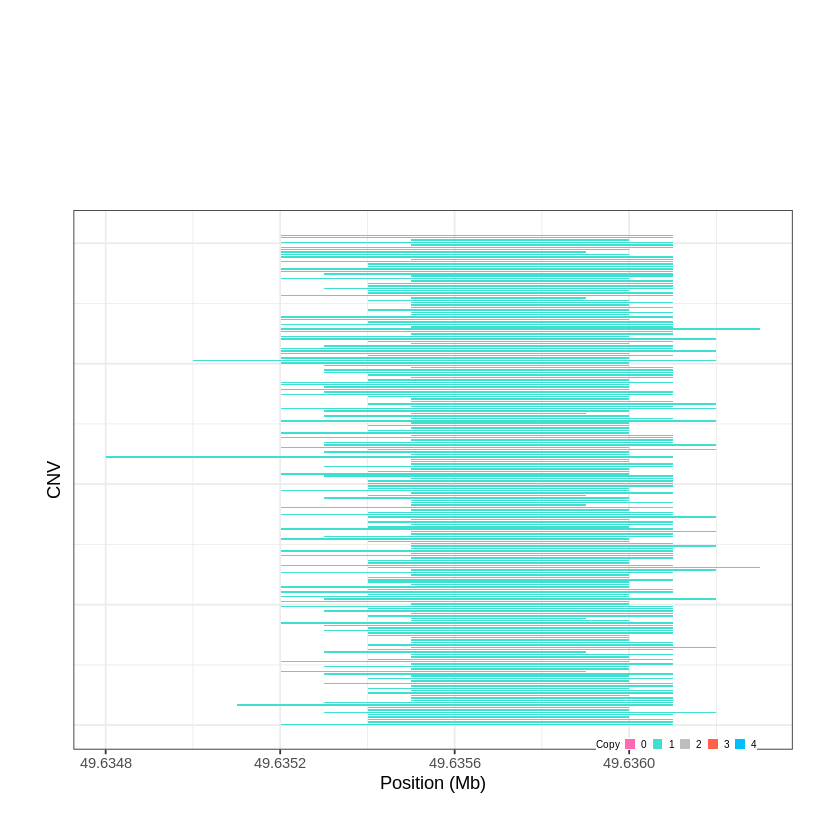

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1439..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 52.806401 - 52.9118 Mb with 223 Individual - "
Plotting gene...


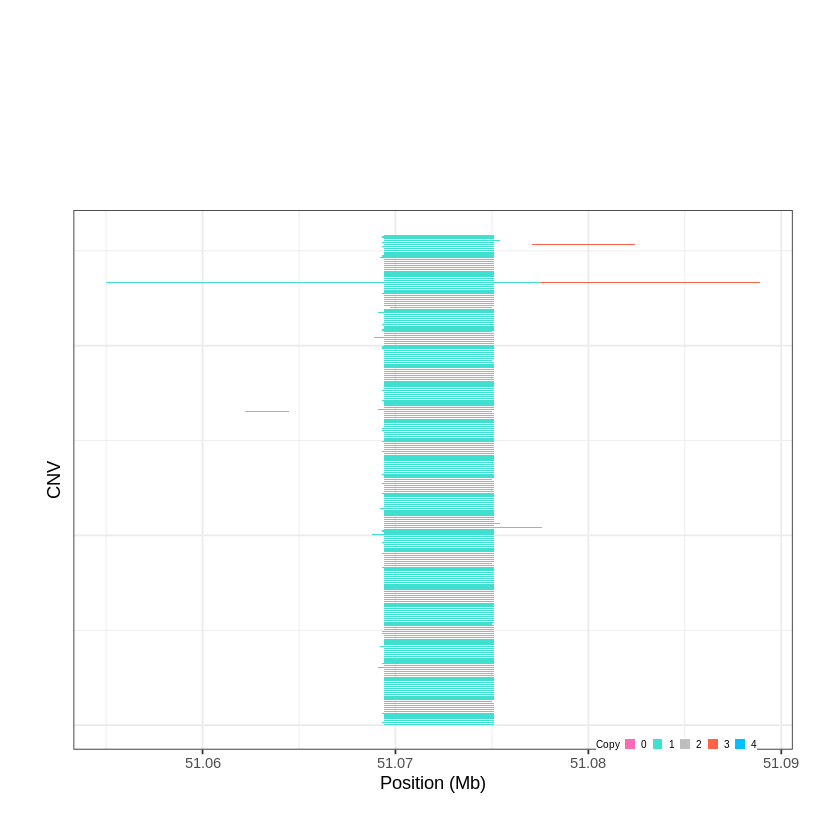

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1440..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 52.916001 - 53.159 Mb with 203 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1441..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 56.133701 - 56.2313 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


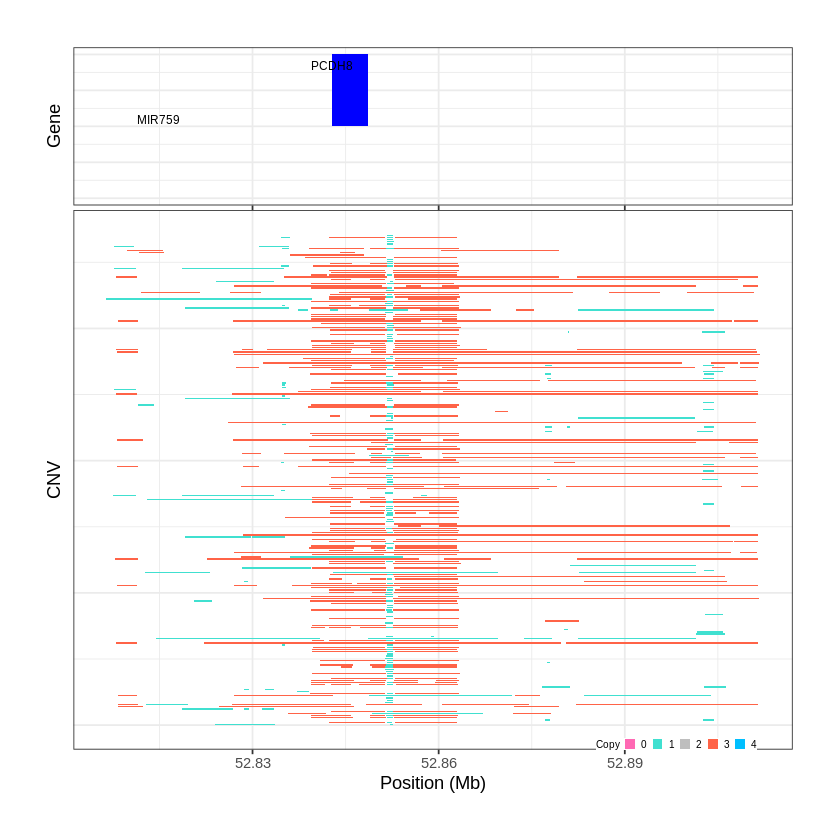

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1442..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 57.666101 - 57.8541 Mb with 262 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


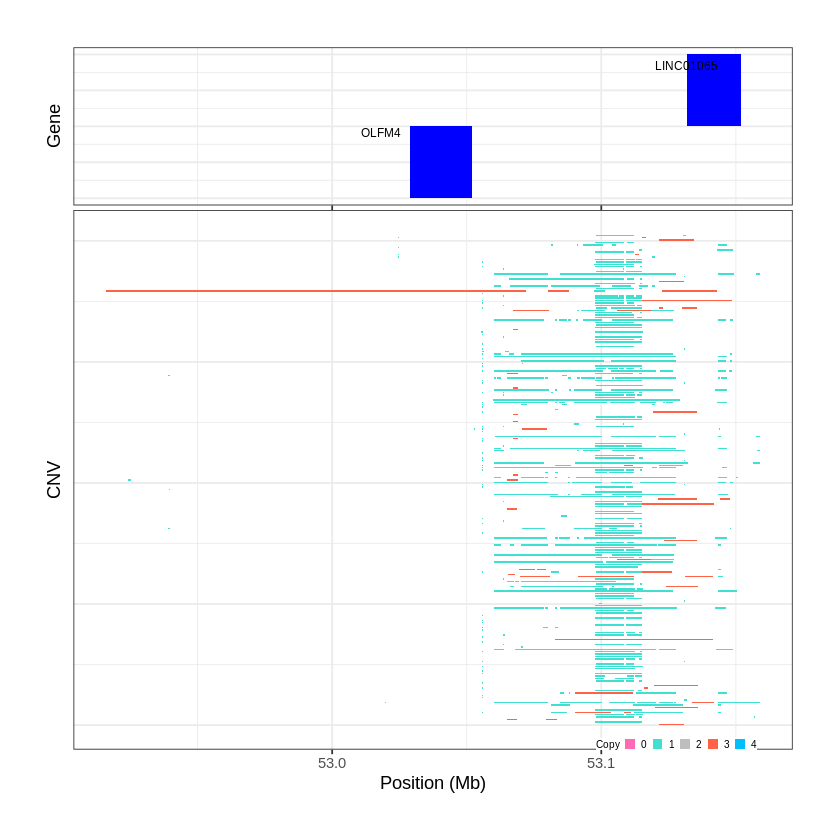

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1443..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 60.170501 - 60.1759 Mb with 204 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


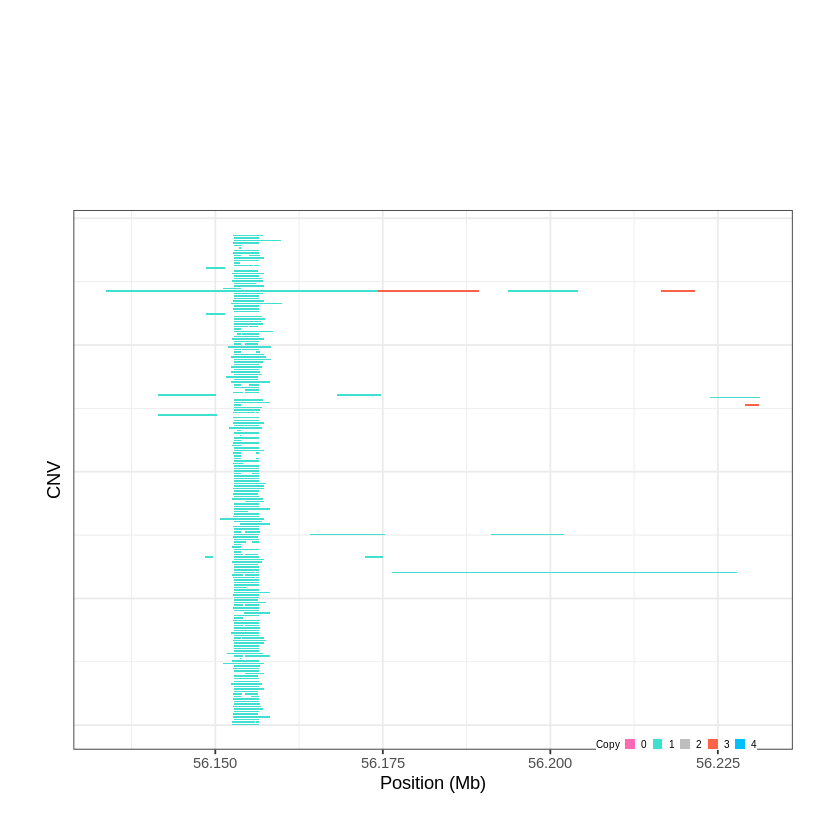

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1444..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 61.313801 - 61.3462 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


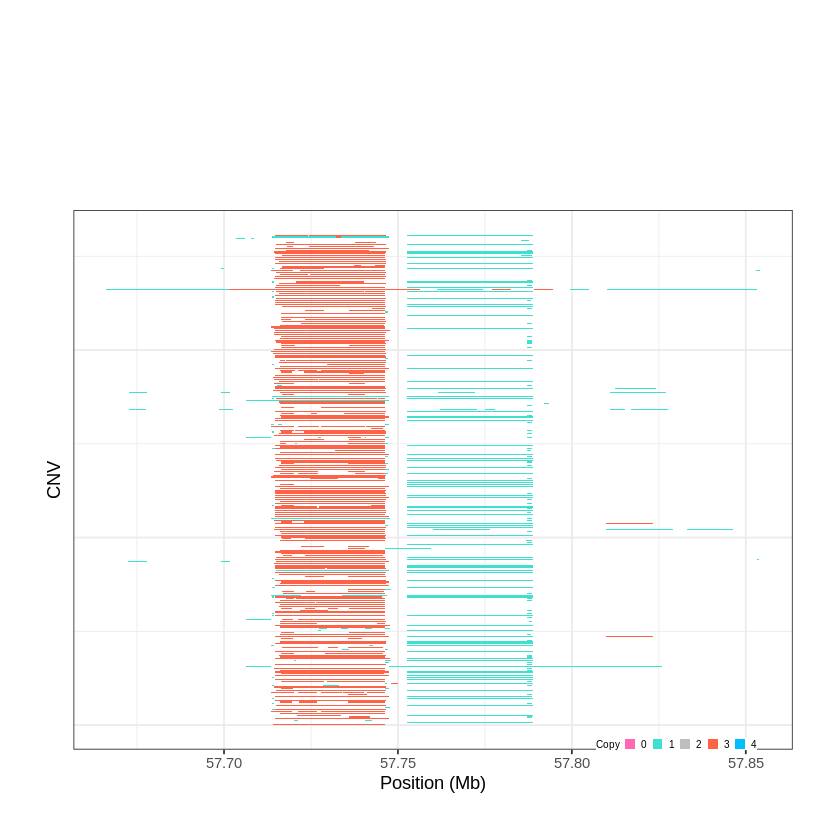

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1445..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 63.309001 - 63.6369 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


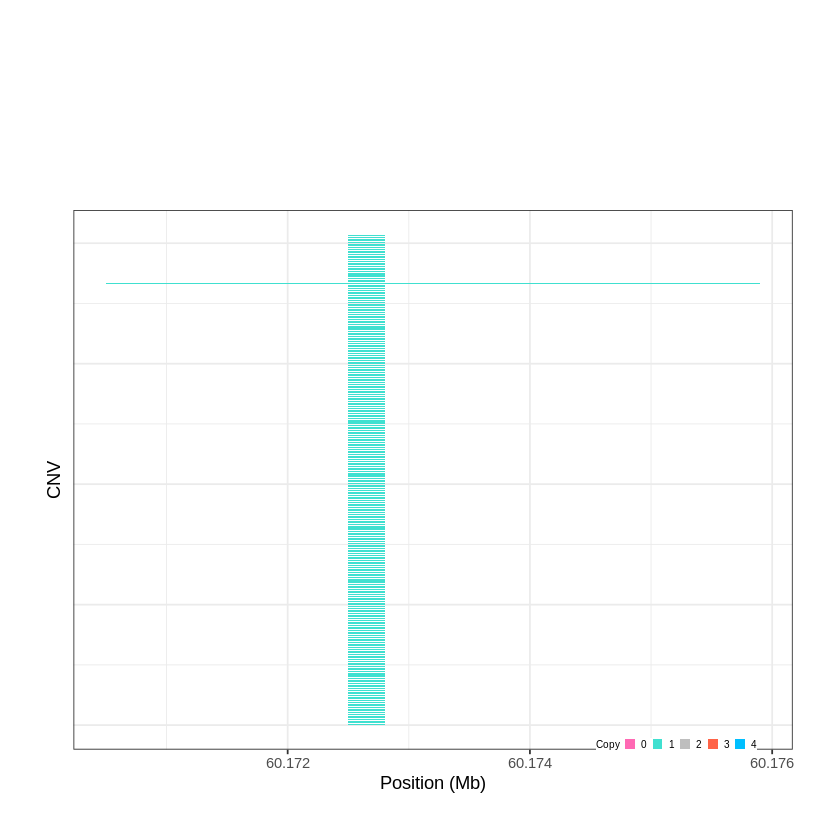

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1446..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 65.631101 - 65.6423 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


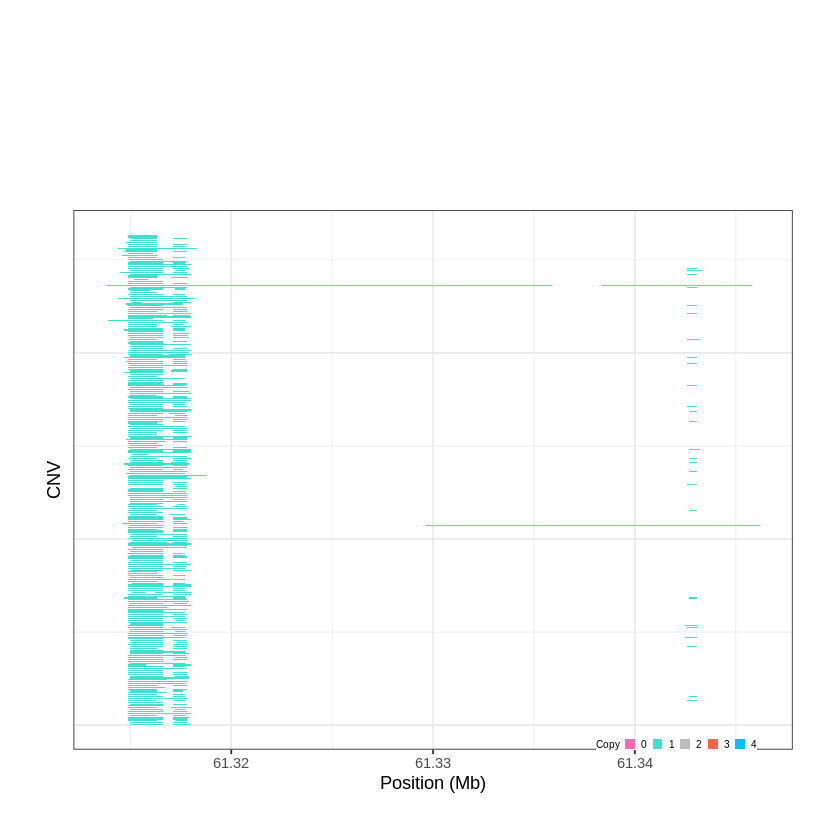

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1447..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 68.923901 - 69.037 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


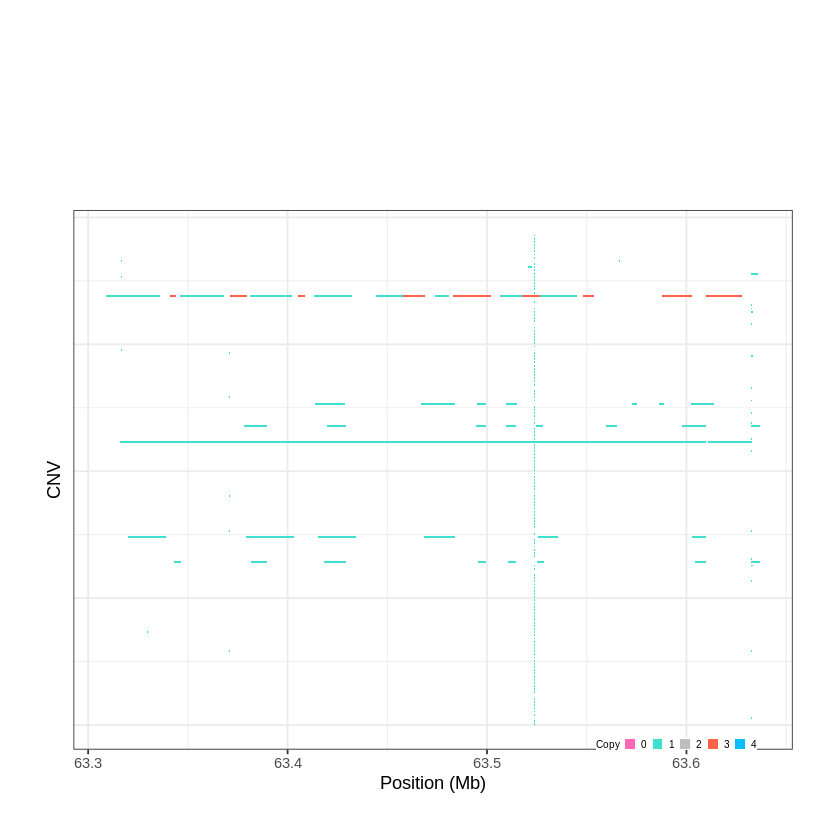

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1448..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 69.902901 - 69.9971 Mb with 159 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


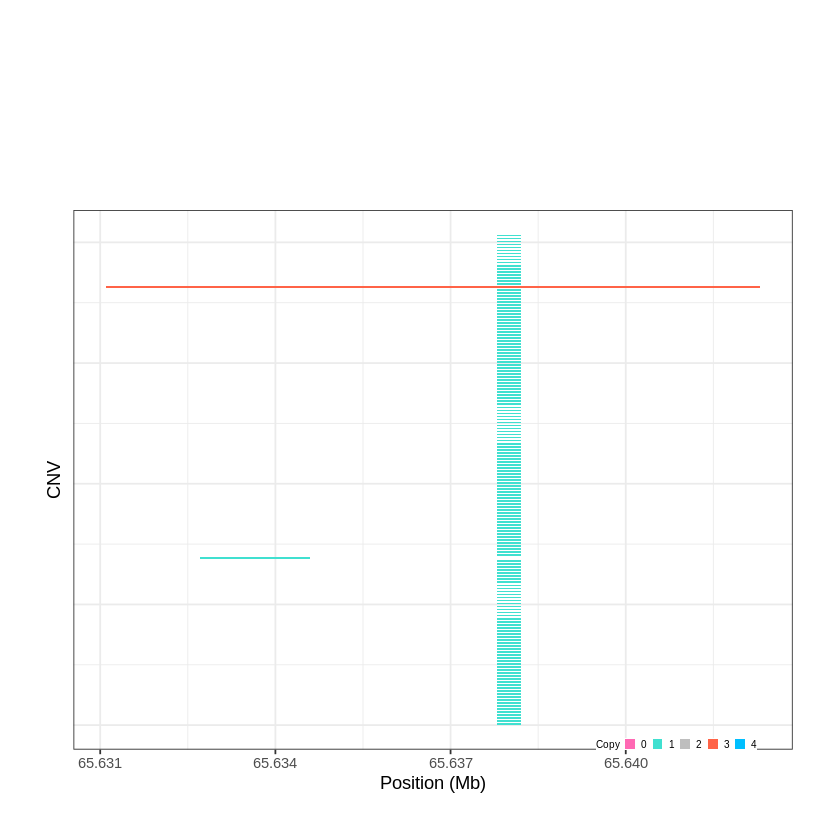

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1449..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 72.839801 - 72.9014 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


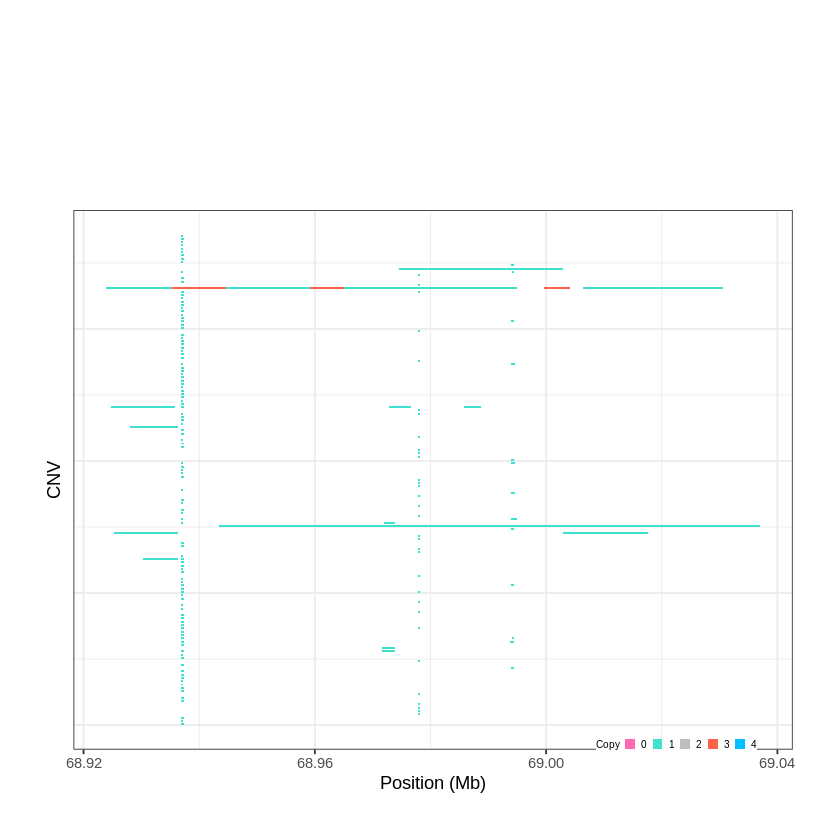

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1450..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 75.000301 - 75.0266 Mb with 181 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


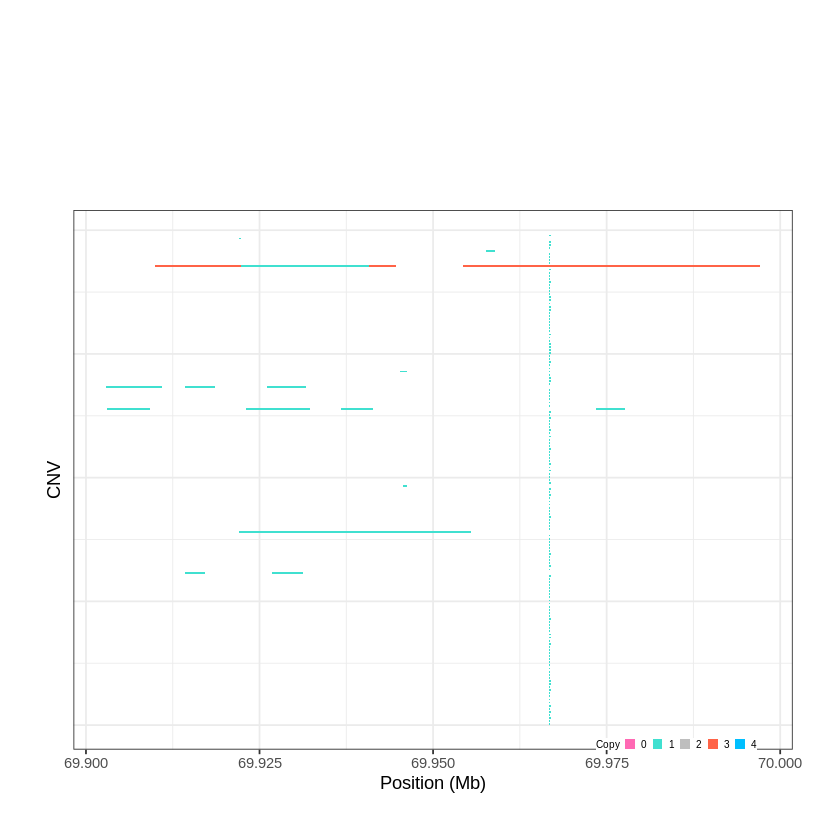

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1451..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 80.081401 - 80.0818 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


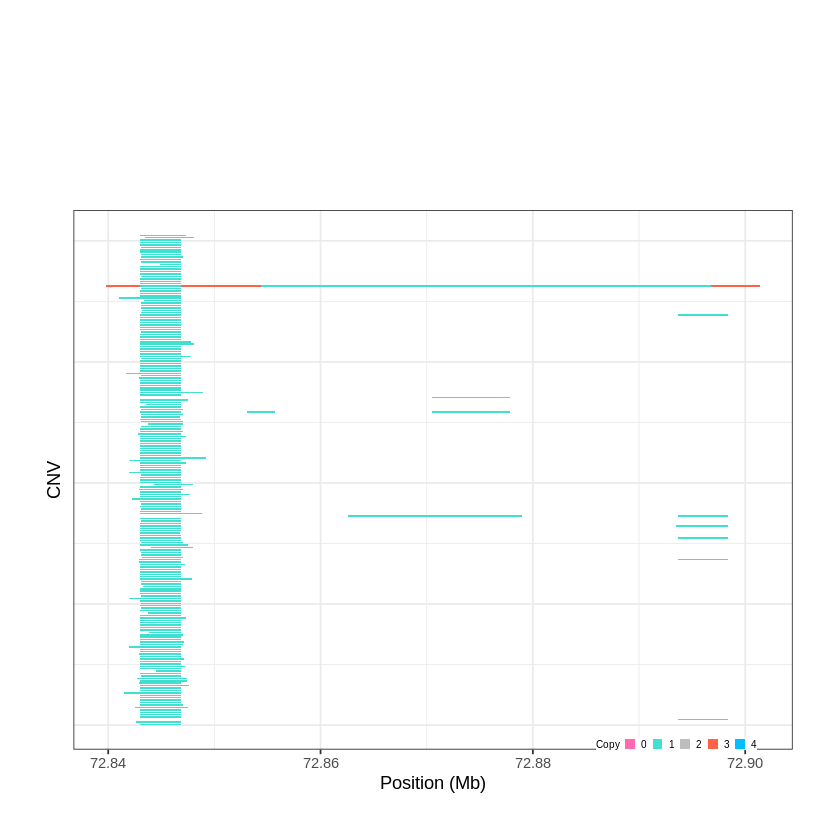

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1452..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 82.885601 - 82.9249 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


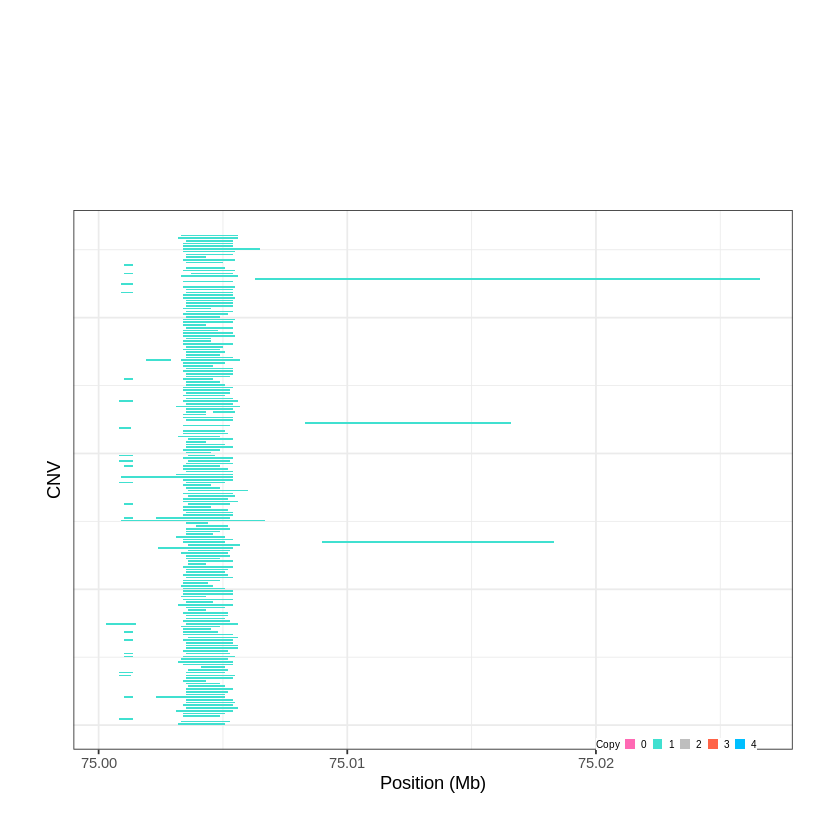

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1453..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 85.866701 - 85.8903 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


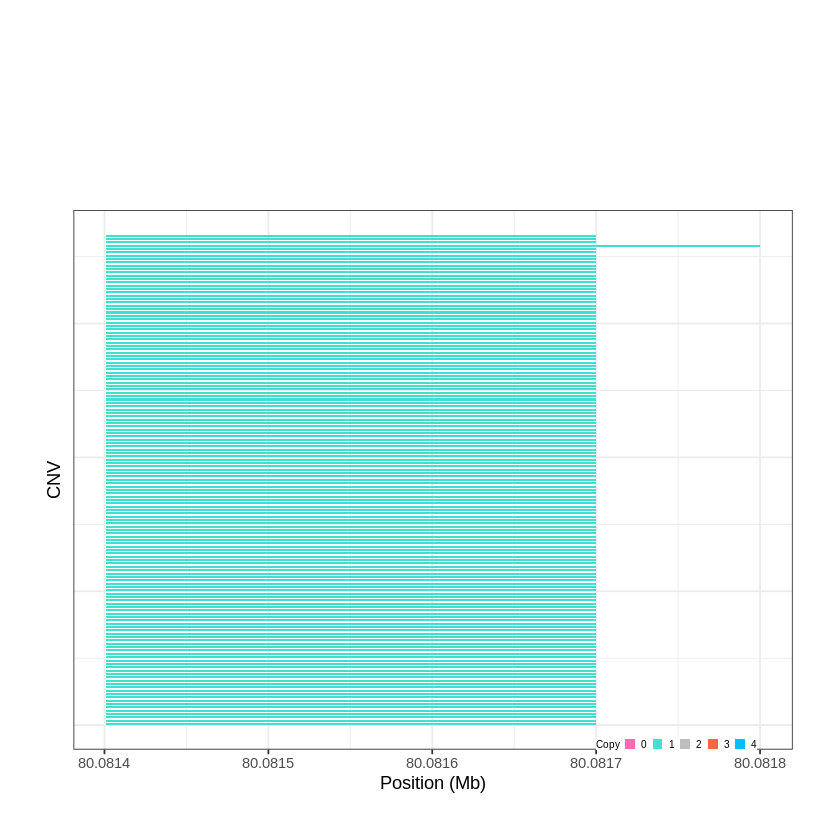

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1454..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 85.910701 - 85.9412 Mb with 174 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


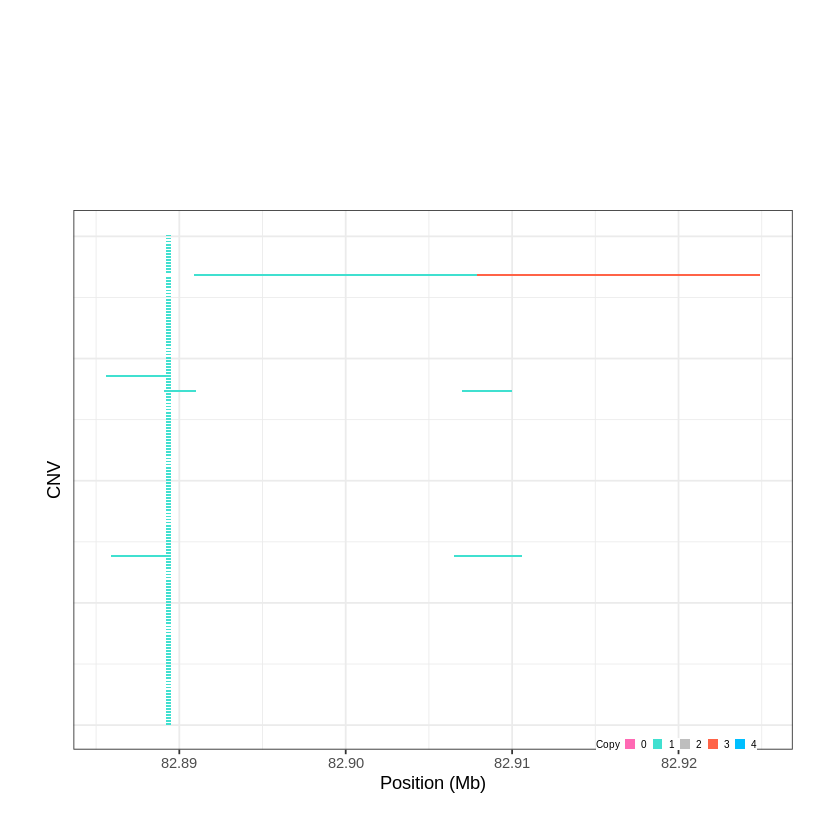

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1455..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 86.760301 - 86.9226 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


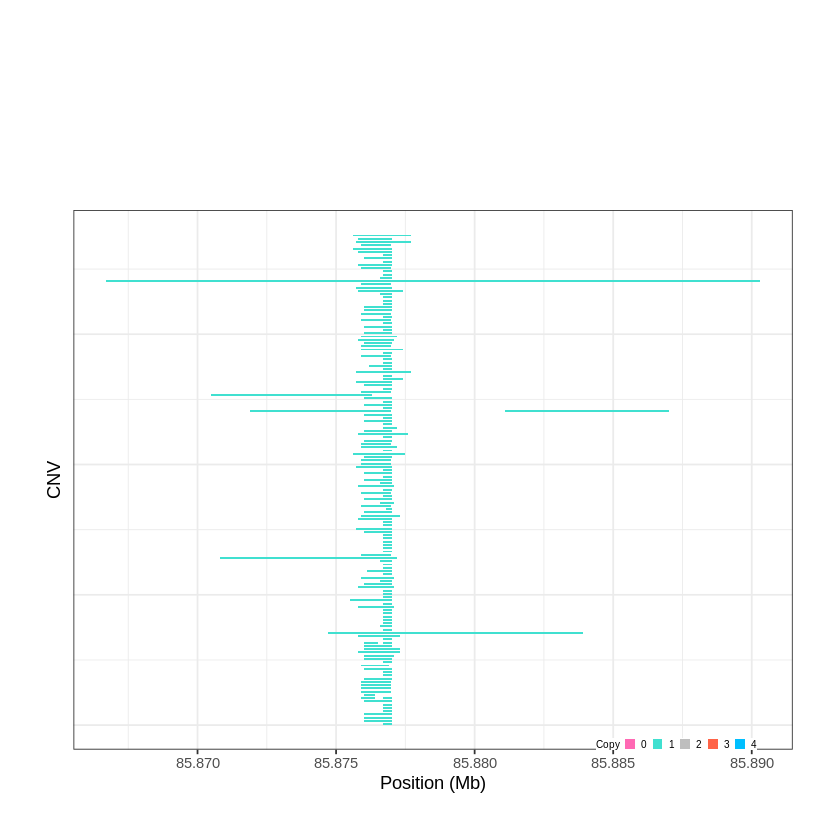

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1456..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 88.985301 - 89.0072 Mb with 257 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


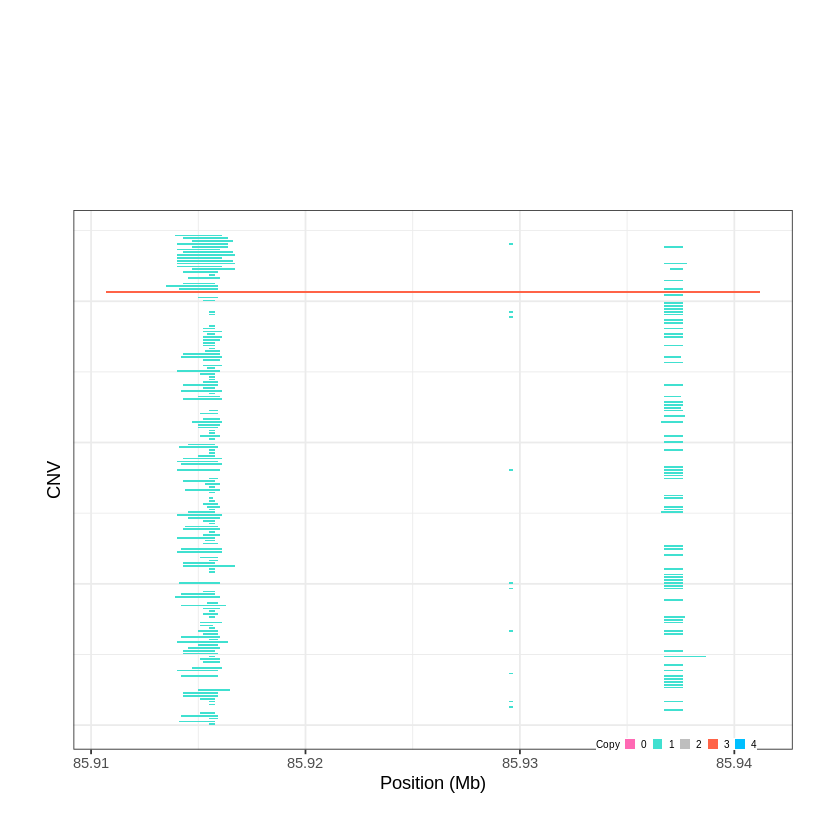

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1457..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 90.855701 - 90.8866 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


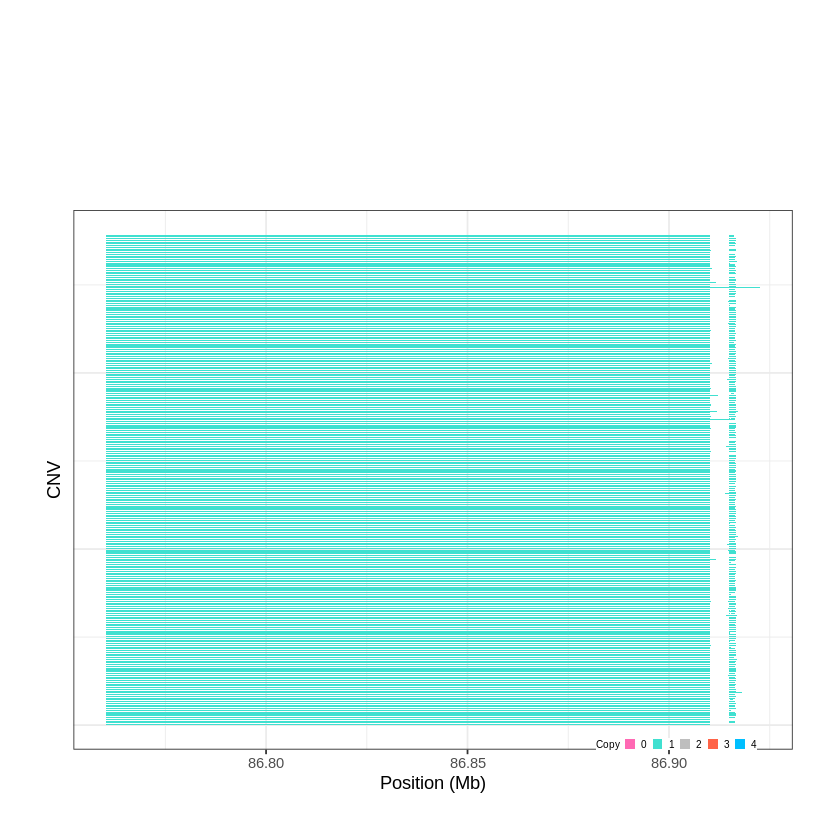

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1458..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 91.152401 - 91.1715 Mb with 215 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


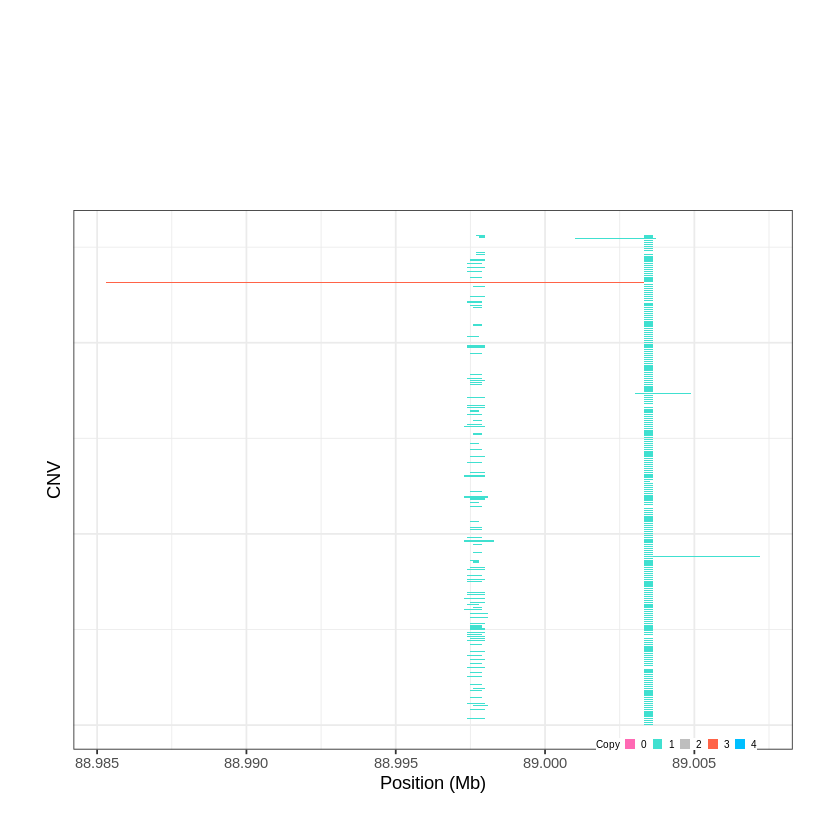

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1459..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 92.254401 - 92.2884 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


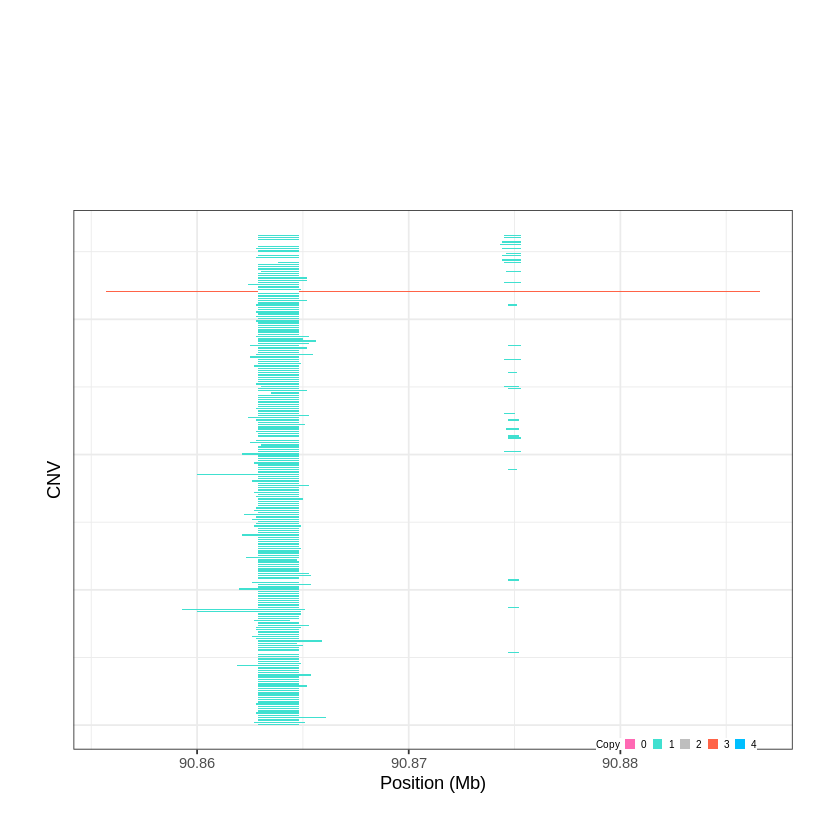

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1460..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 101.889601 - 101.9342 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


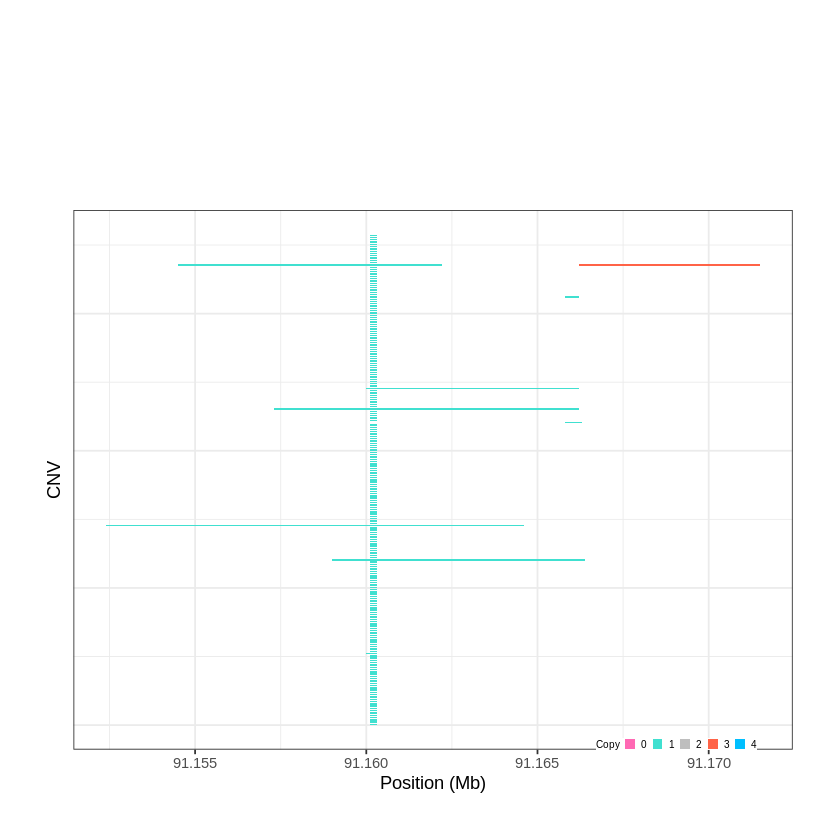

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1461..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 104.087301 - 104.0934 Mb with 182 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


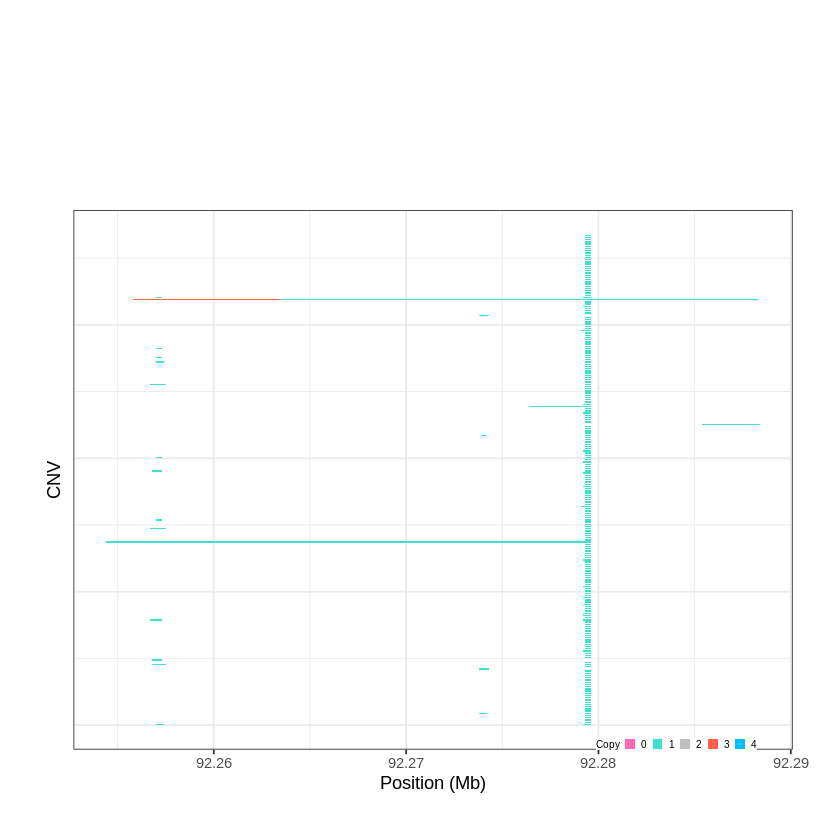

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1462..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 108.857901 - 108.8734 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


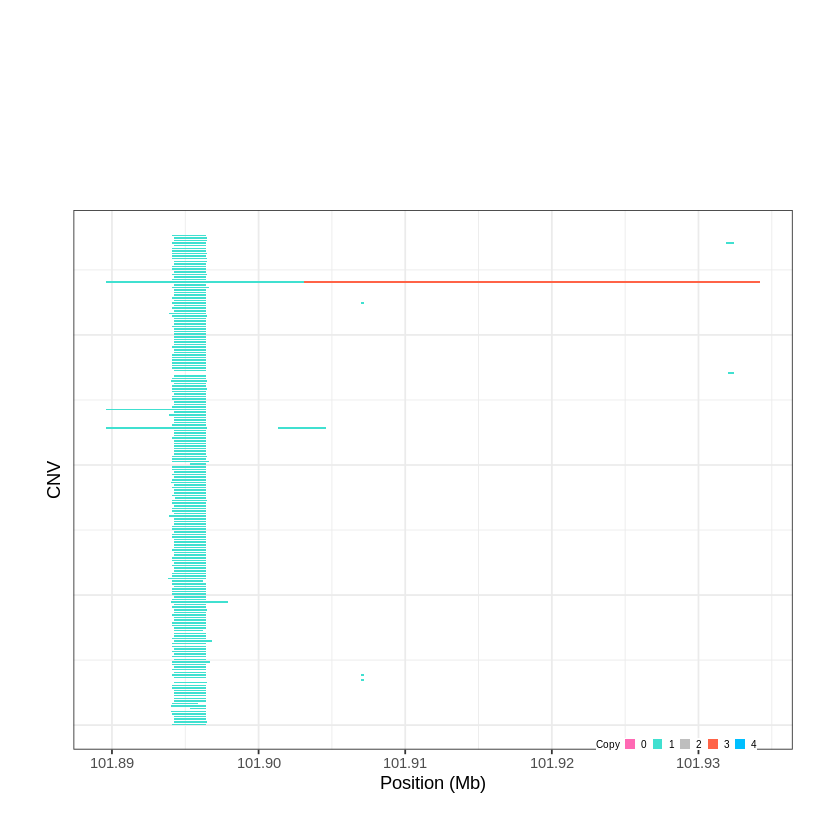

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1463..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 109.244201 - 109.2454 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


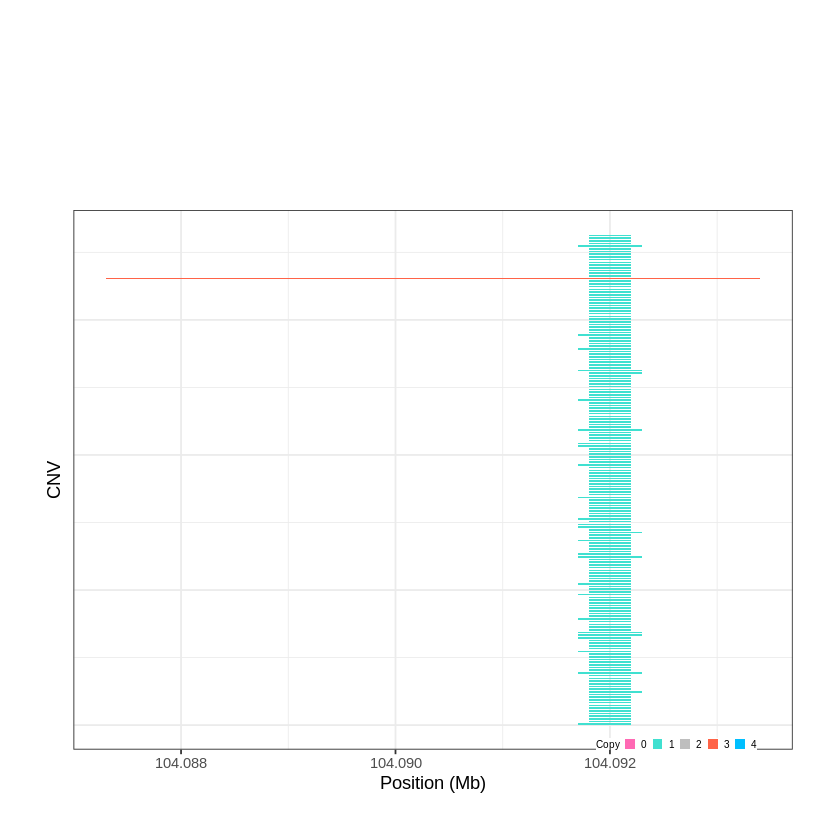

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1464..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 110.352901 - 110.4339 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


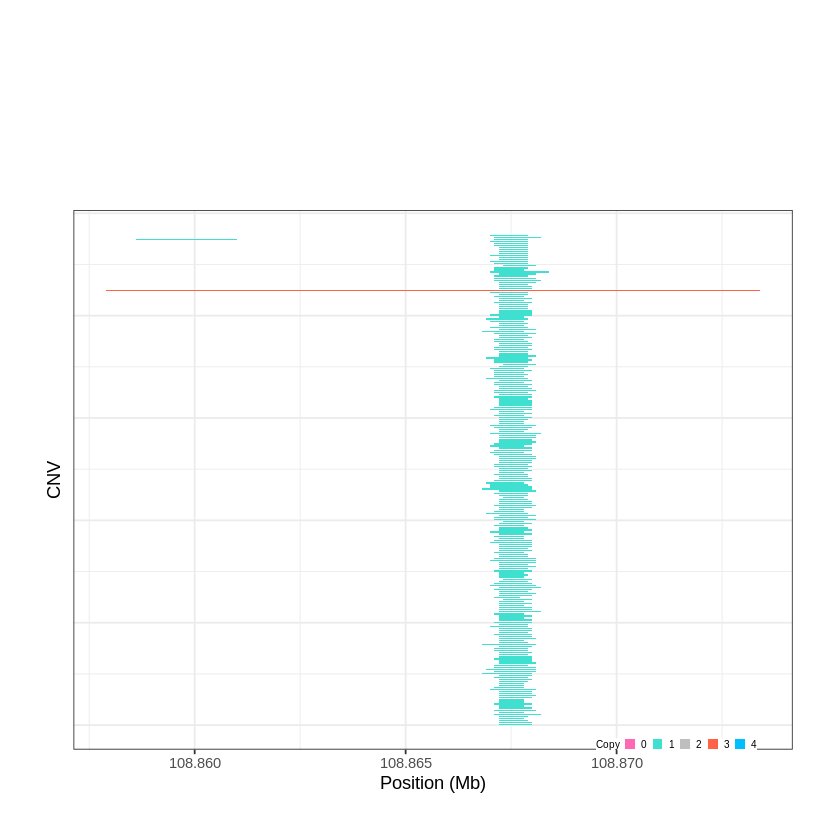

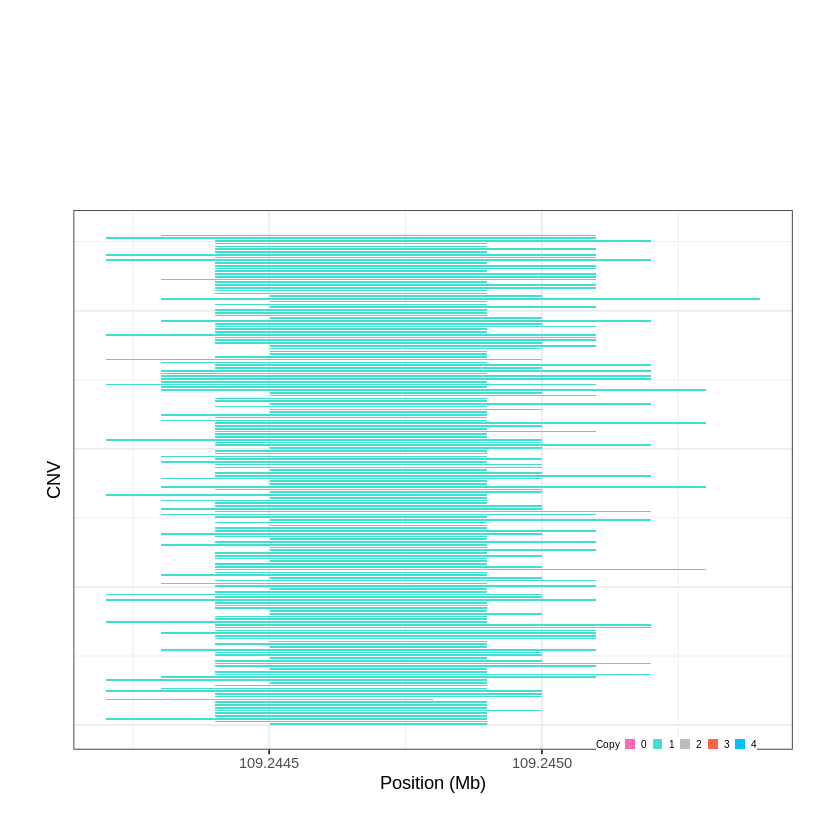

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1465..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 110.741201 - 111.0418 Mb with 247 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1466..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 111.667701 - 111.7224 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


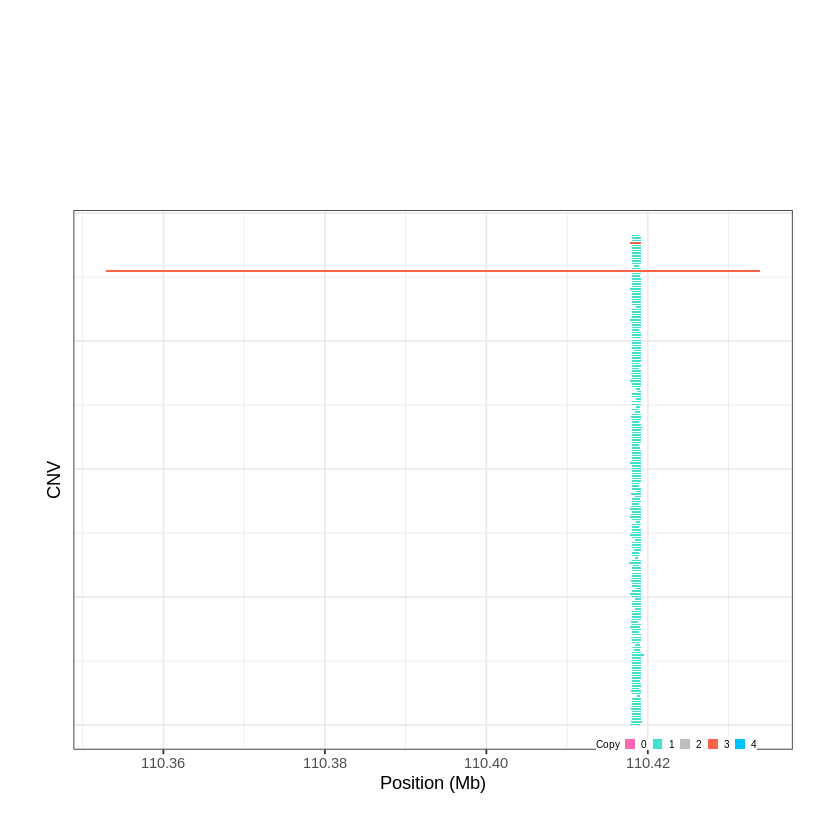

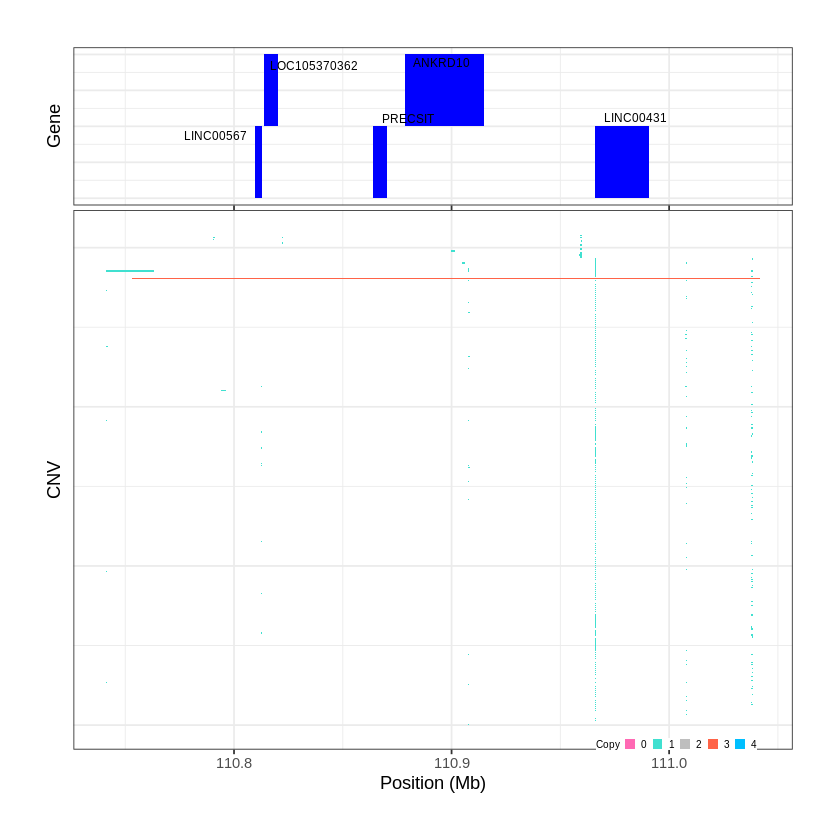

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1467..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 112.012601 - 112.2208 Mb with 204 Individual - "
Plotting gene...


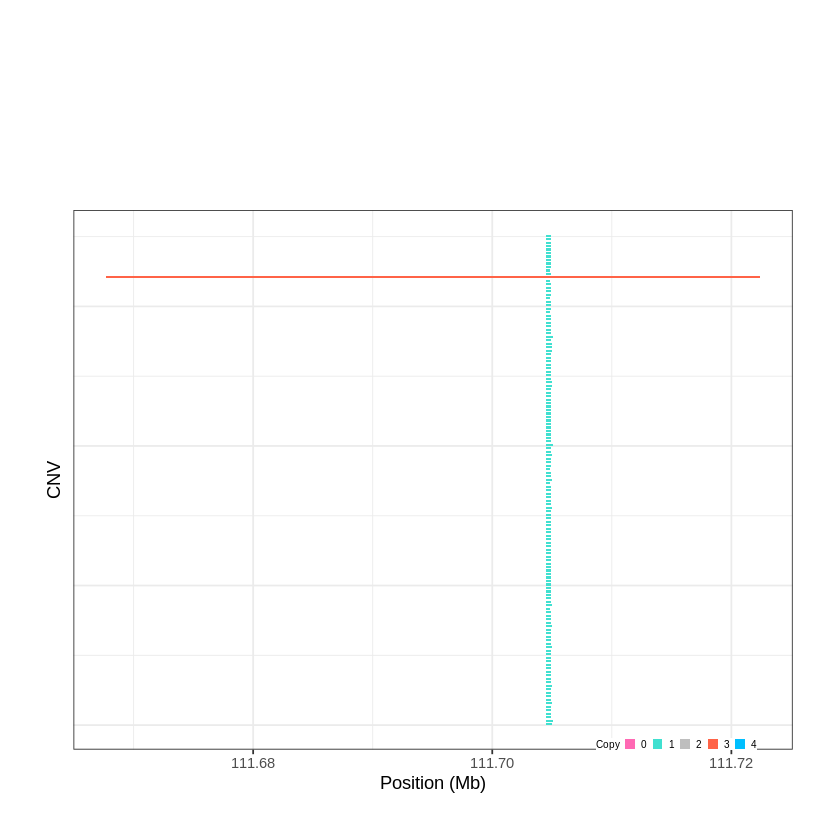

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1468..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 112.354001 - 112.504 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1469..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 112.651201 - 112.6722 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


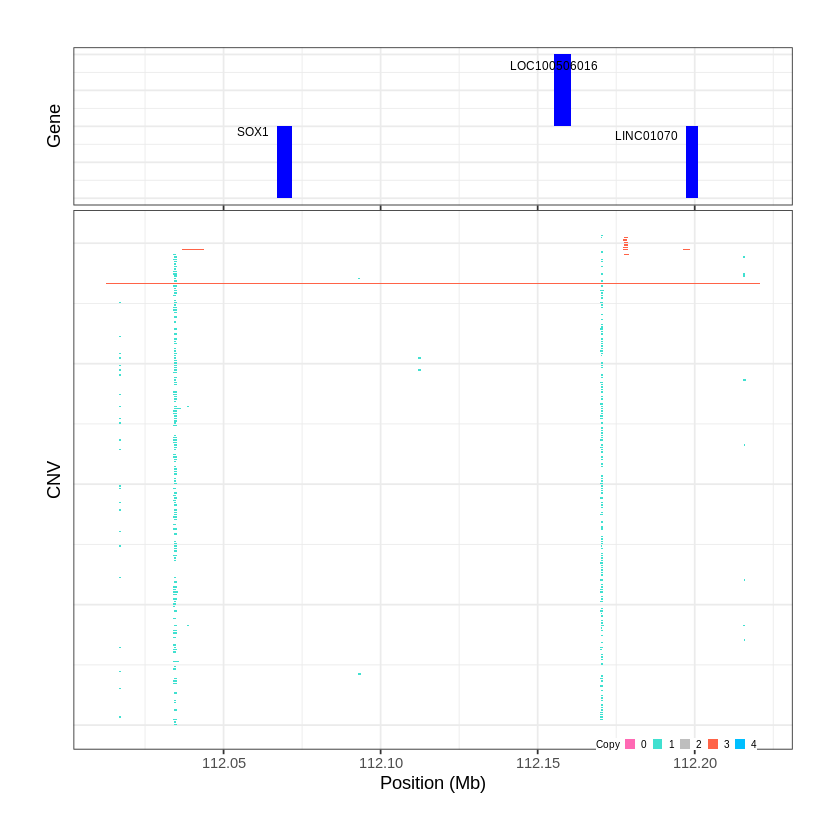

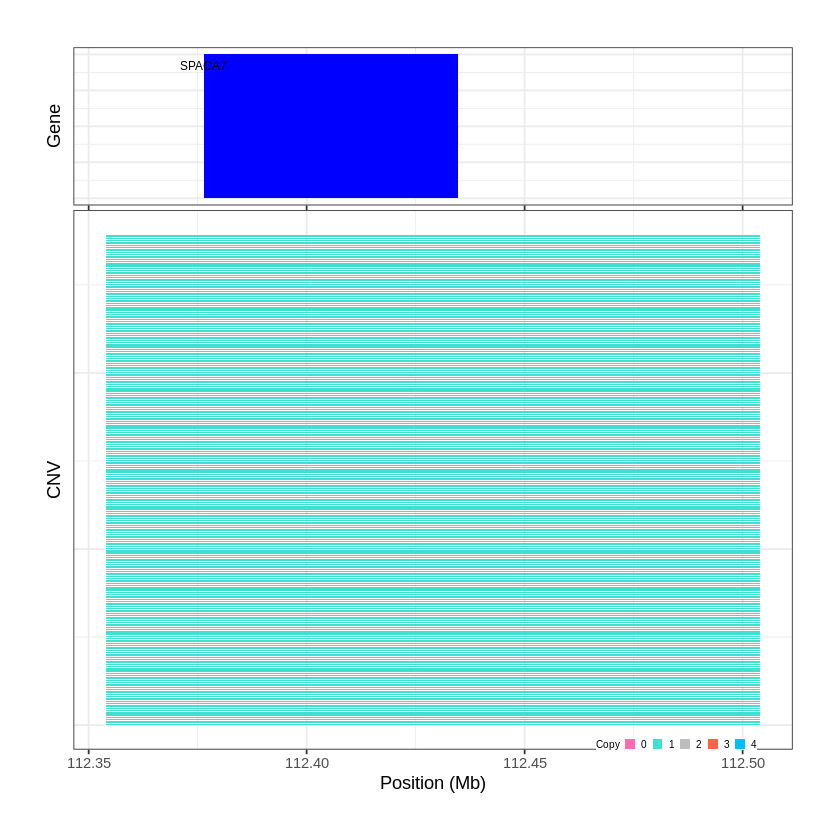

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1470..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 112.705701 - 112.9302 Mb with 251 Individual - "
Plotting gene...


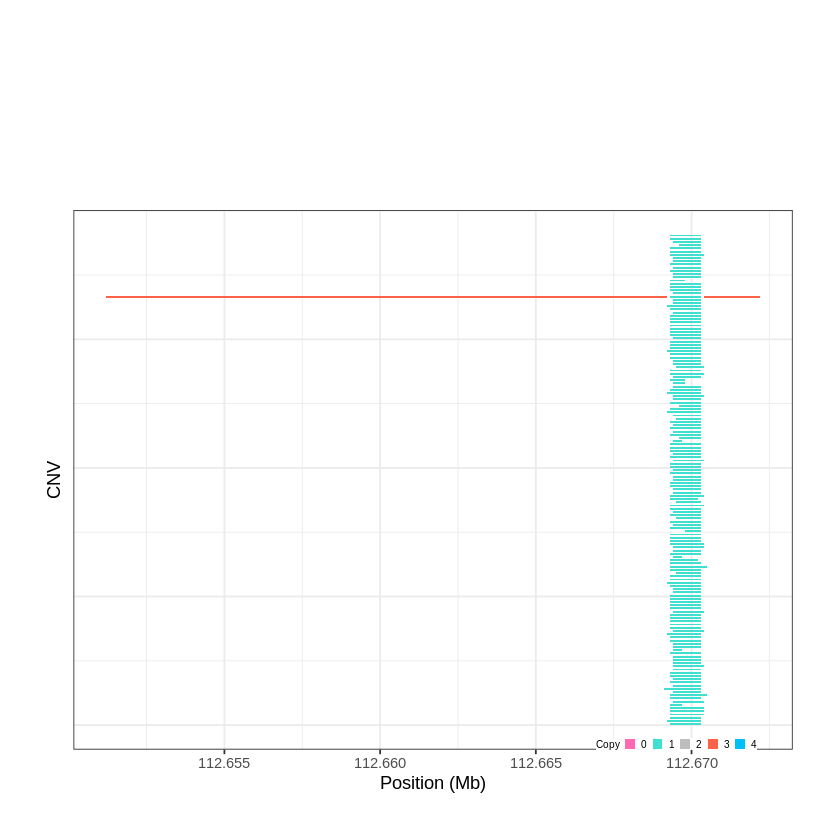

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1471..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 112.930201 - 113.0298 Mb with 279 Individual - "
Plotting gene...


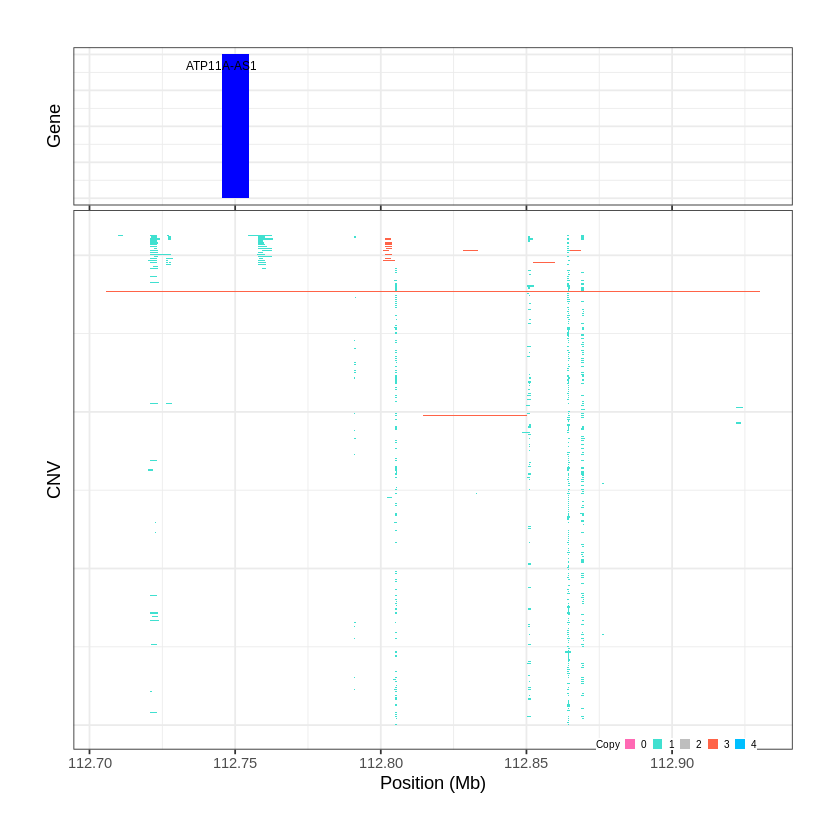

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1472..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 113.077101 - 113.4995 Mb with 236 Individual - "
Plotting gene...


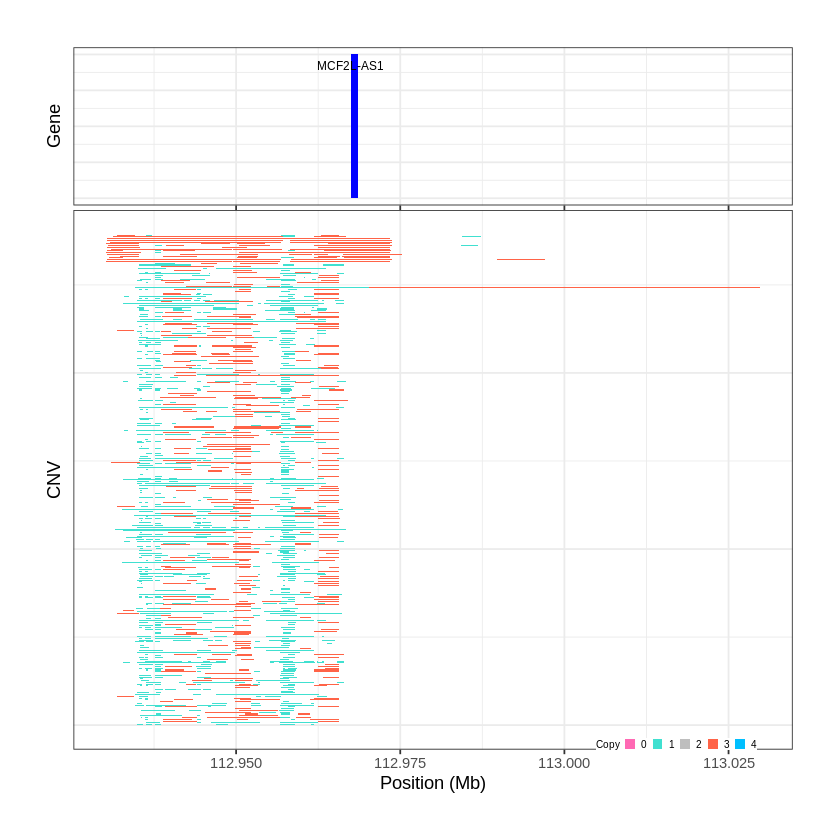

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1473..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 113.499501 - 113.7576 Mb with 270 Individual - "
Plotting gene...


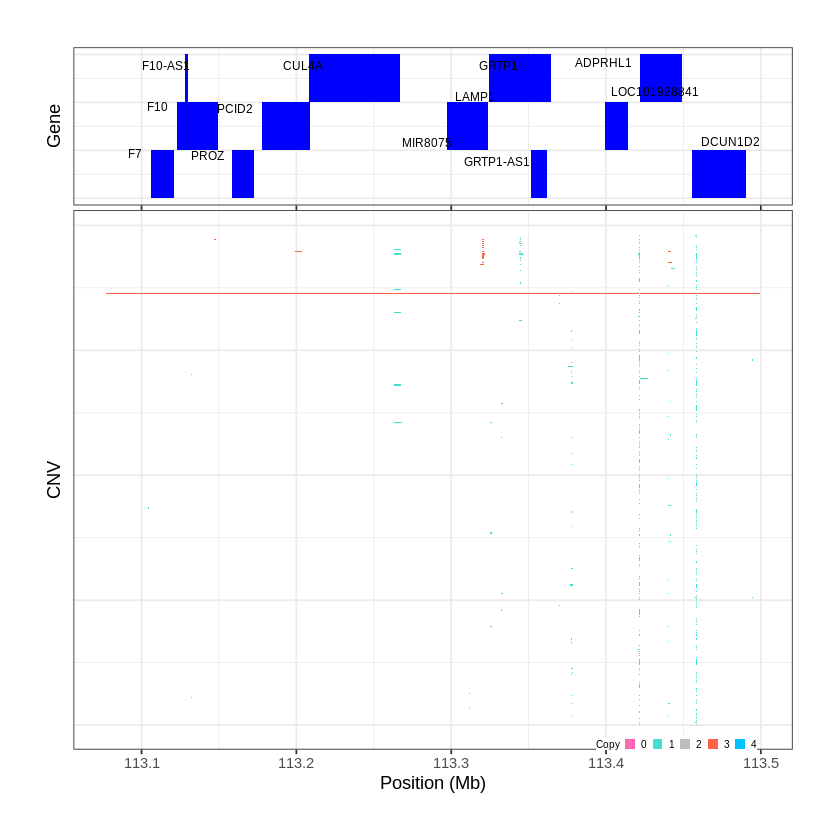

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1474..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 113.759101 - 113.8624 Mb with 278 Individual - "
Plotting gene...


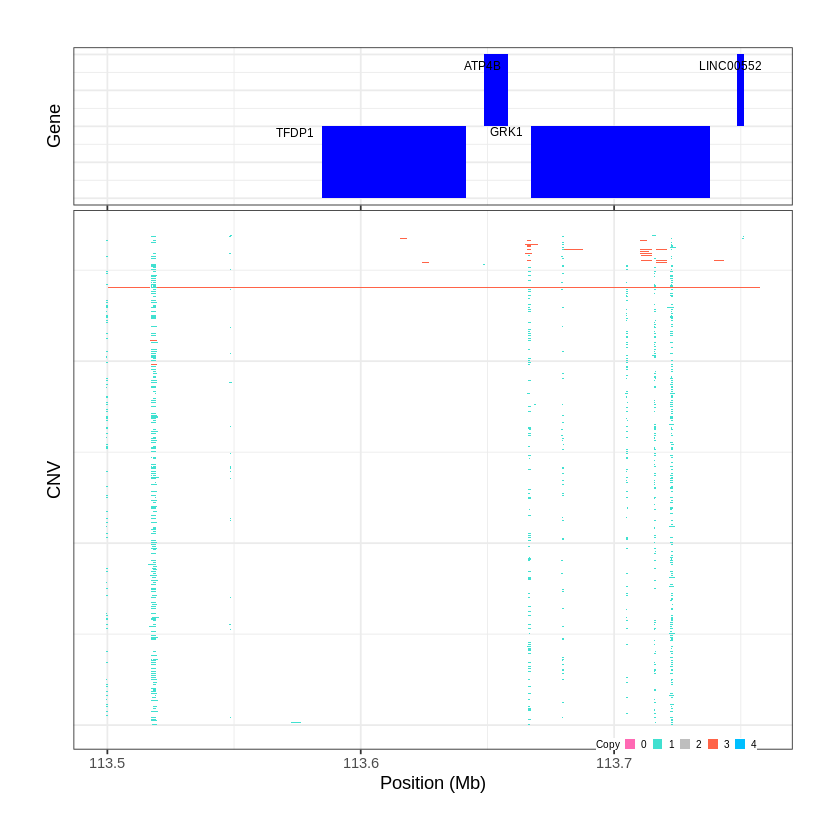

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1475..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 113.969701 - 114.1444 Mb with 278 Individual - "
Plotting gene...


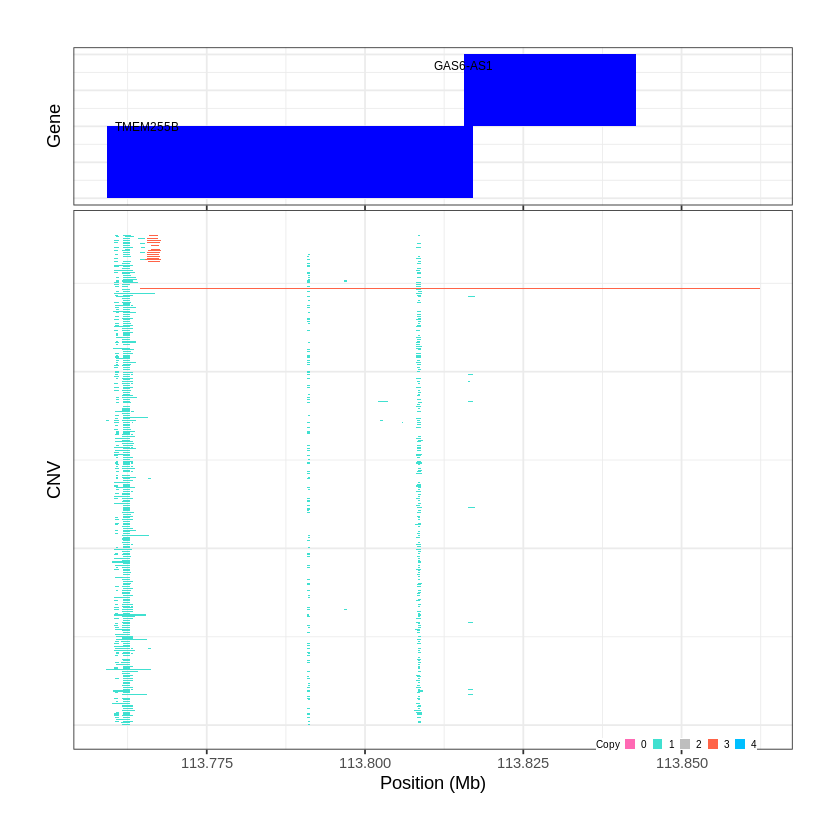

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1476..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 114.146101 - 114.4263 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1477..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 114.427301 - 114.4864 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


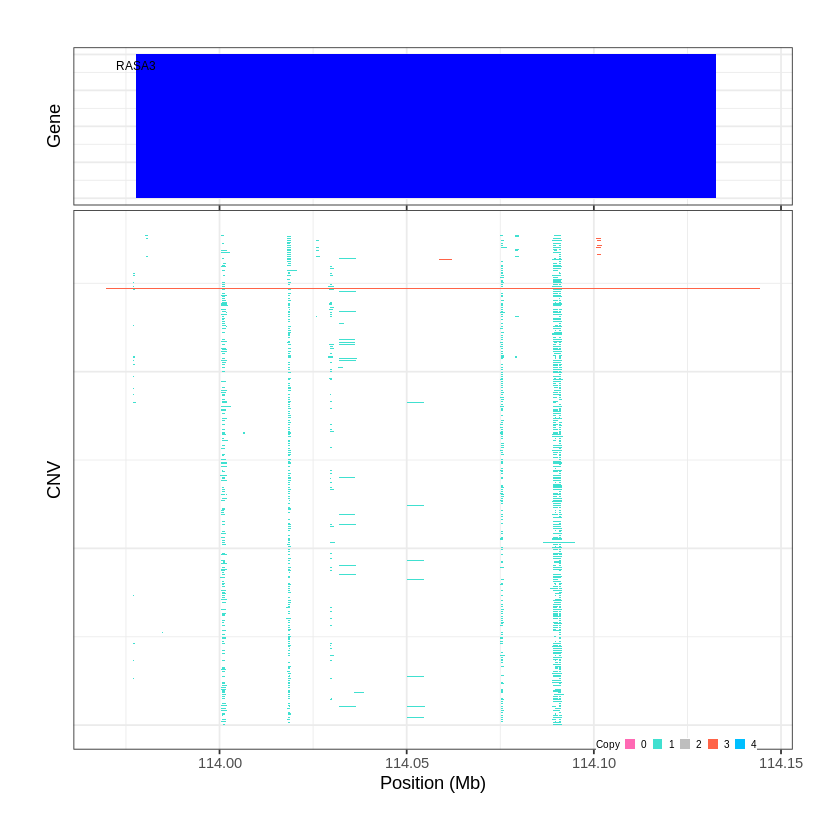

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1478..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 114.490401 - 114.5068 Mb with 171 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


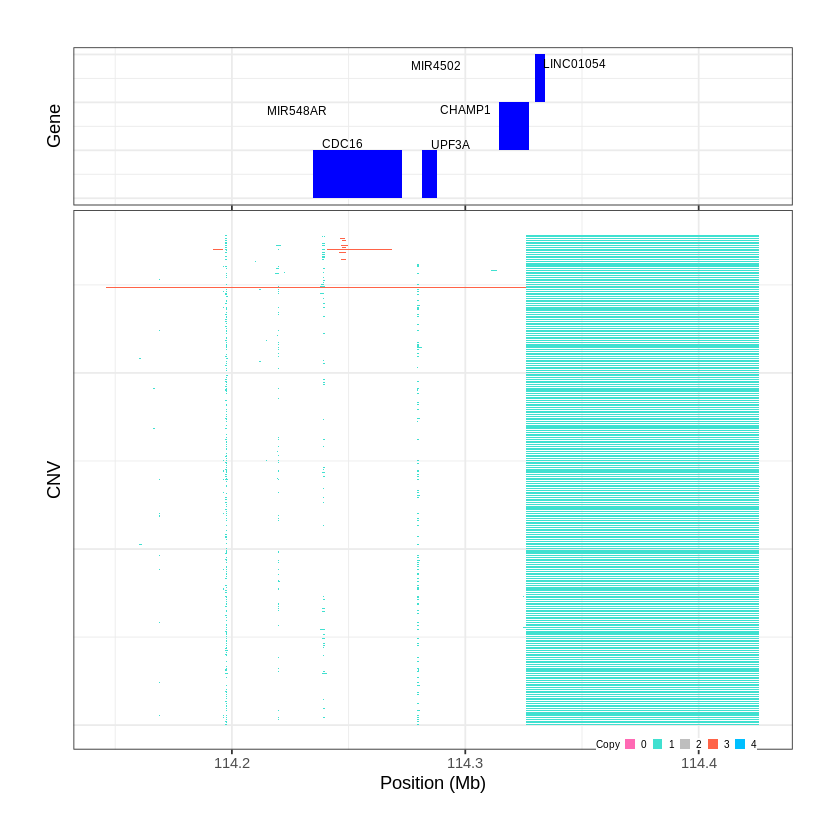

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1479..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 114.520201 - 114.5405 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


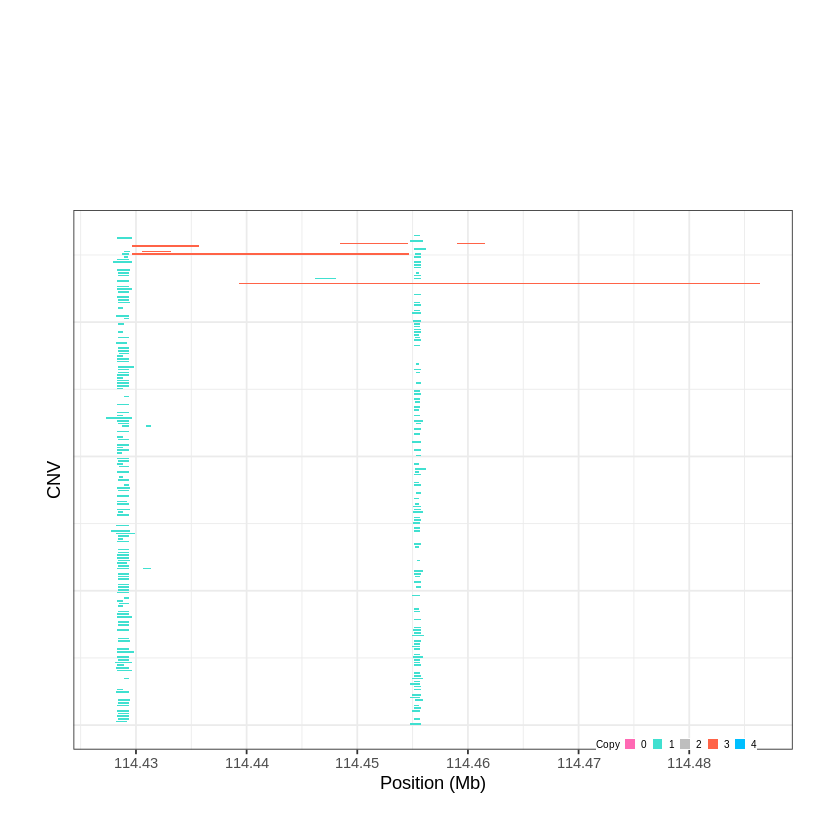

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1480..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 114.544401 - 114.8667 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


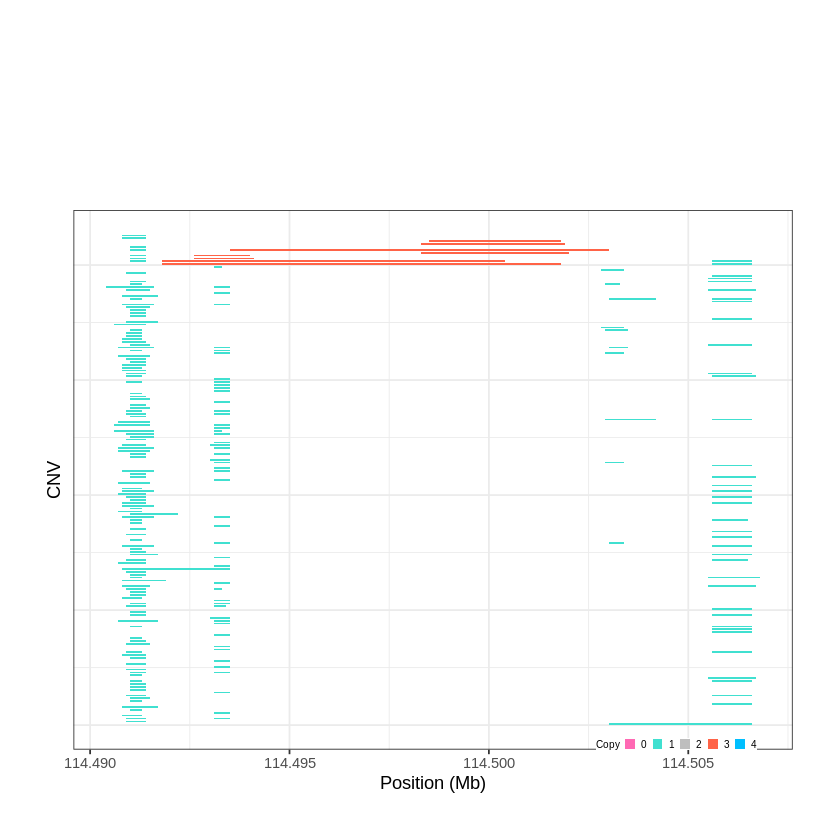

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1481..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 114.868601 - 114.8707 Mb with 170 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


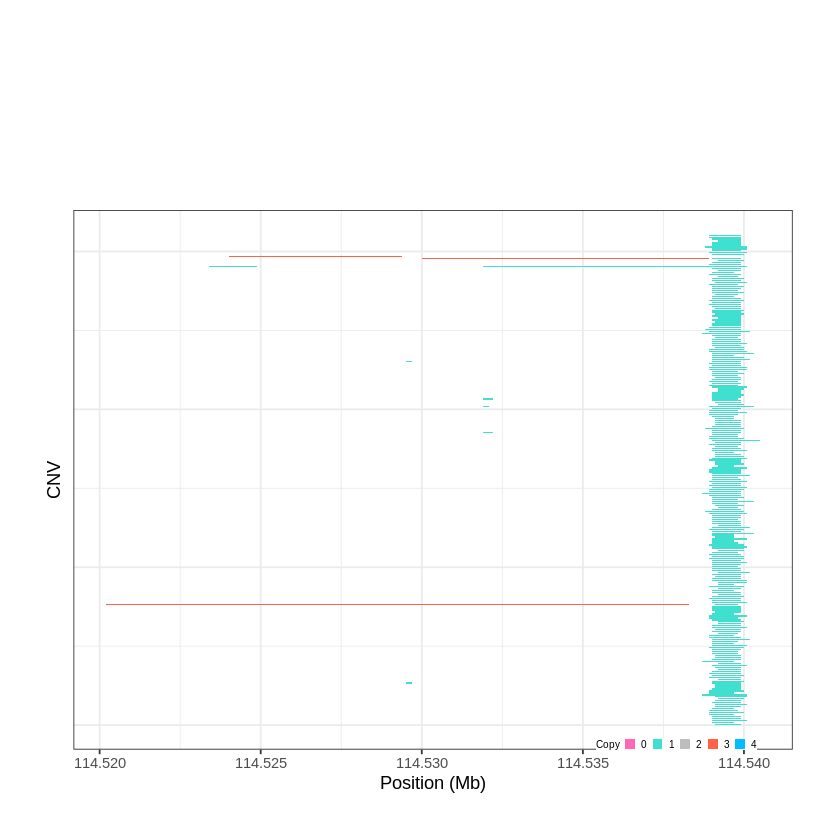

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1482..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 114.879101 - 115.0068 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


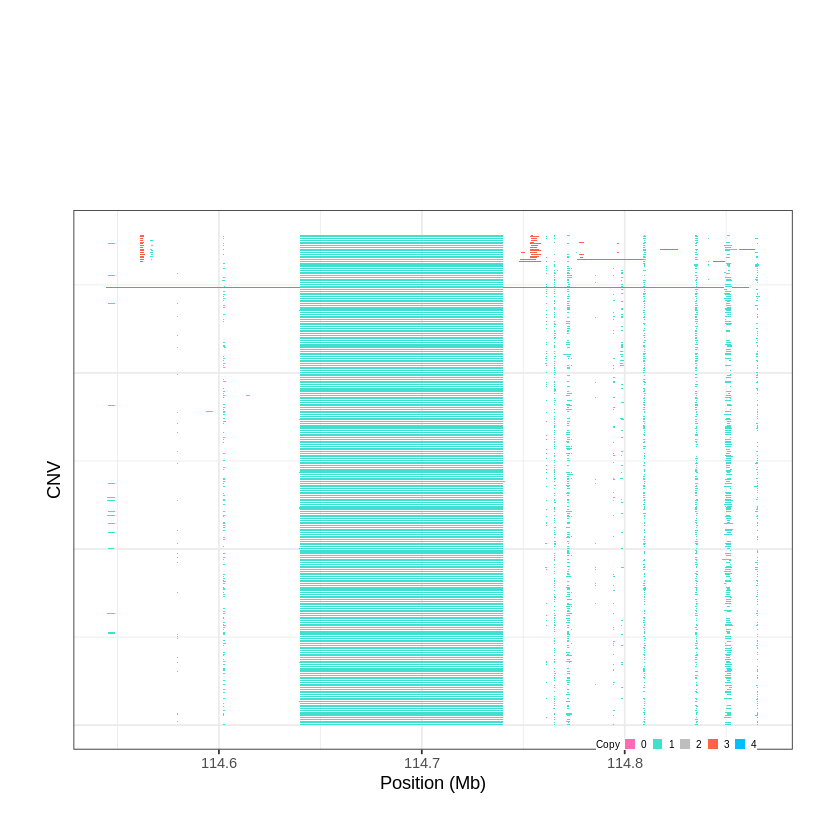

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1483..."
Input data passed requirment check...
[1] "CNV on Chromosome 13: 115.094301 - 115.1699 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


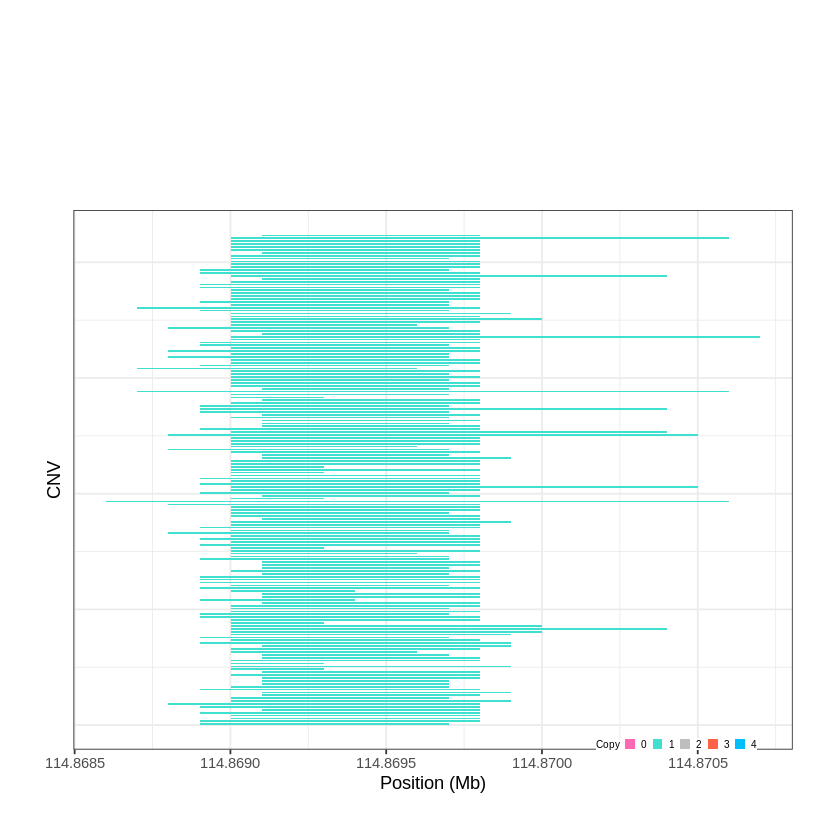

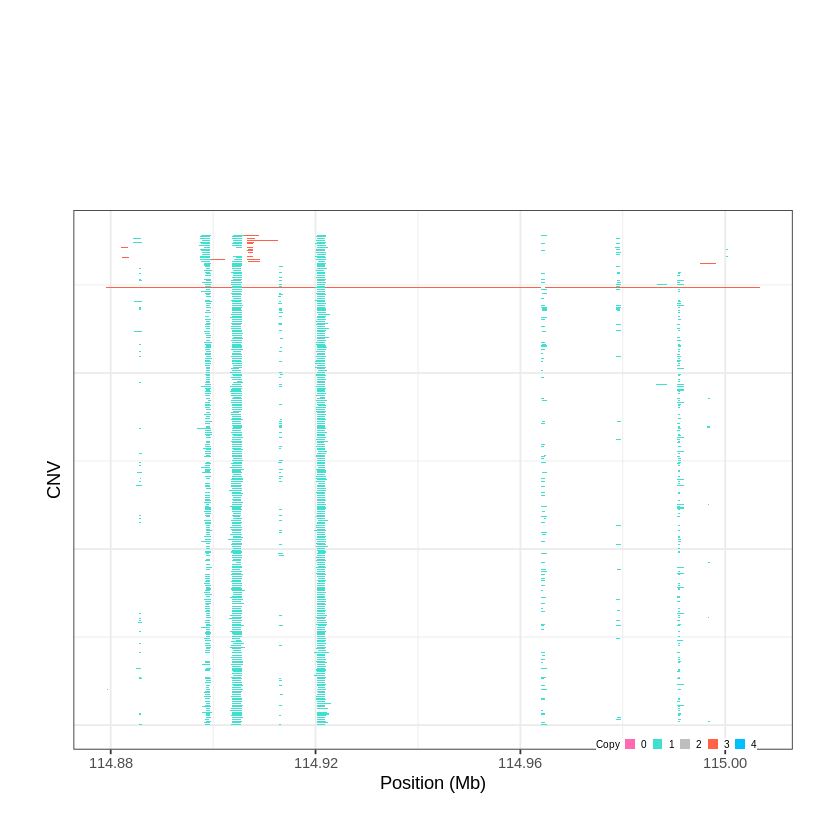

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1484..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 19.000001 - 20.4299 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 8 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


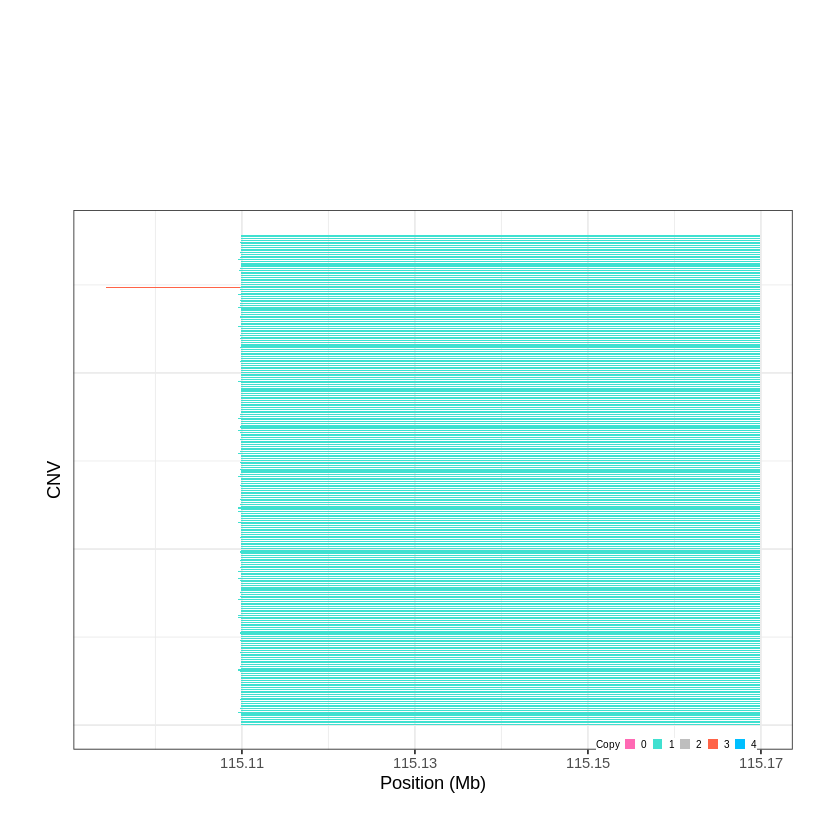

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1485..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 20.549901 - 20.6351 Mb with 254 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1486..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 20.697501 - 20.7095 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


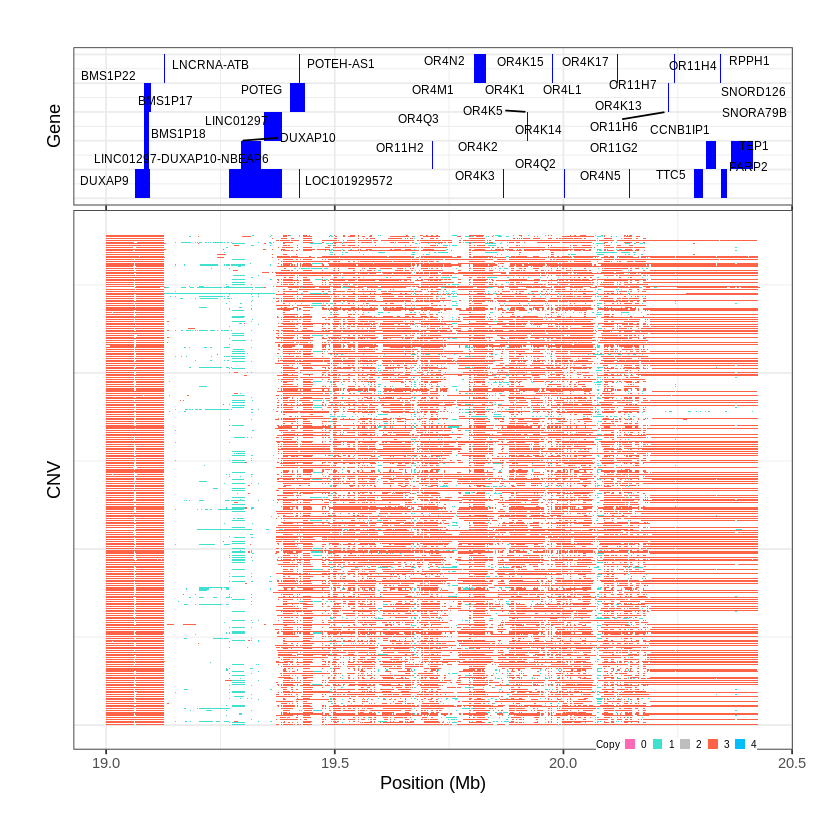

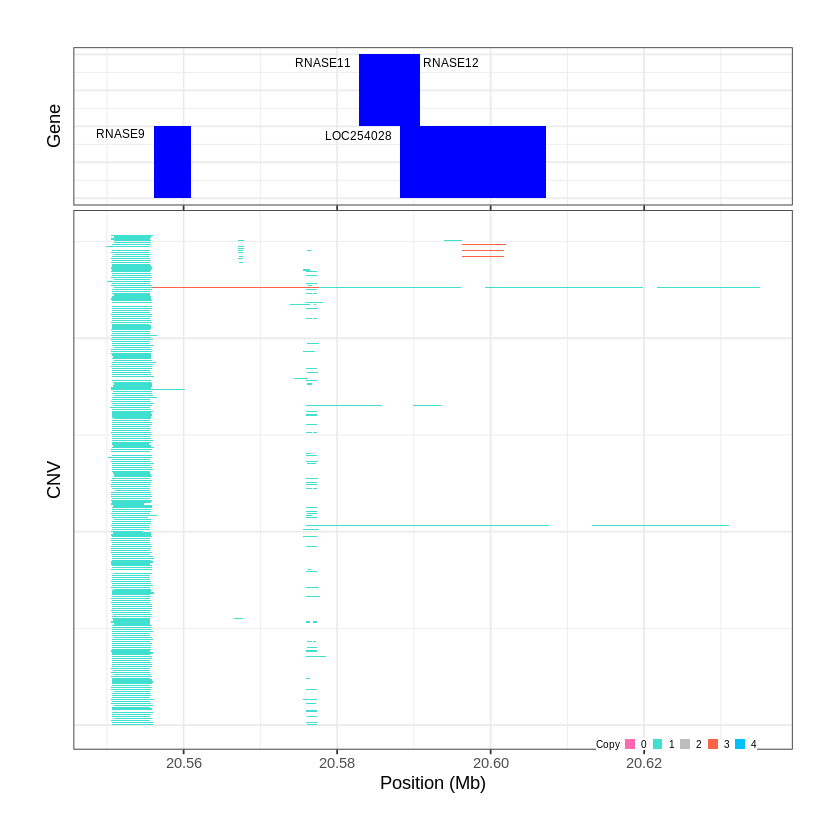

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1487..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 21.348901 - 21.4223 Mb with 165 Individual - "
Plotting gene...


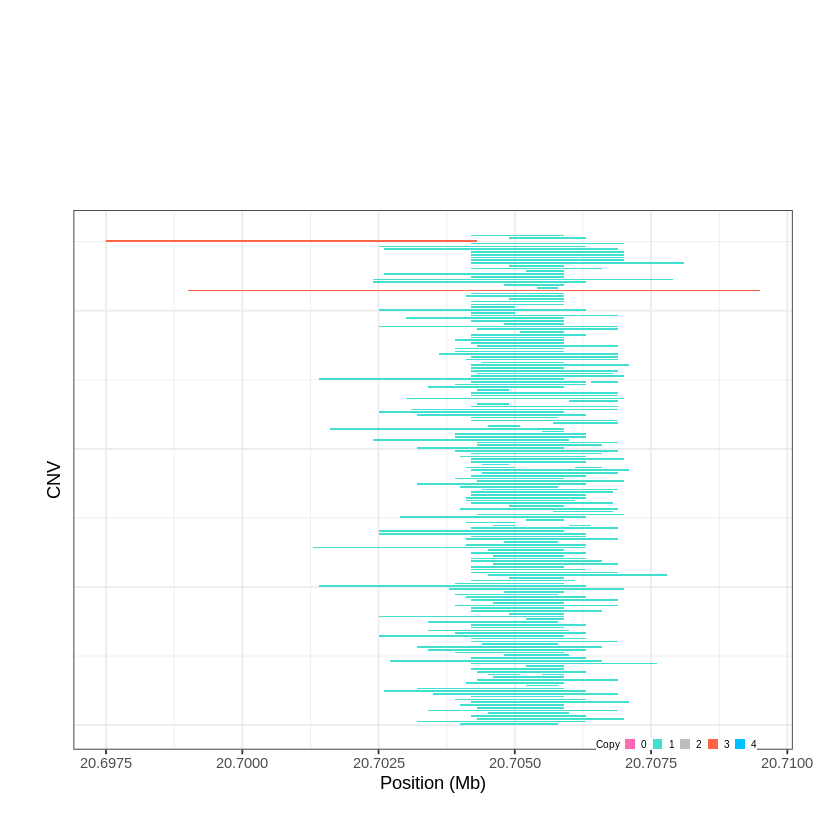

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1488..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 21.520101 - 21.579 Mb with 234 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1489..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 21.951701 - 22.0669 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


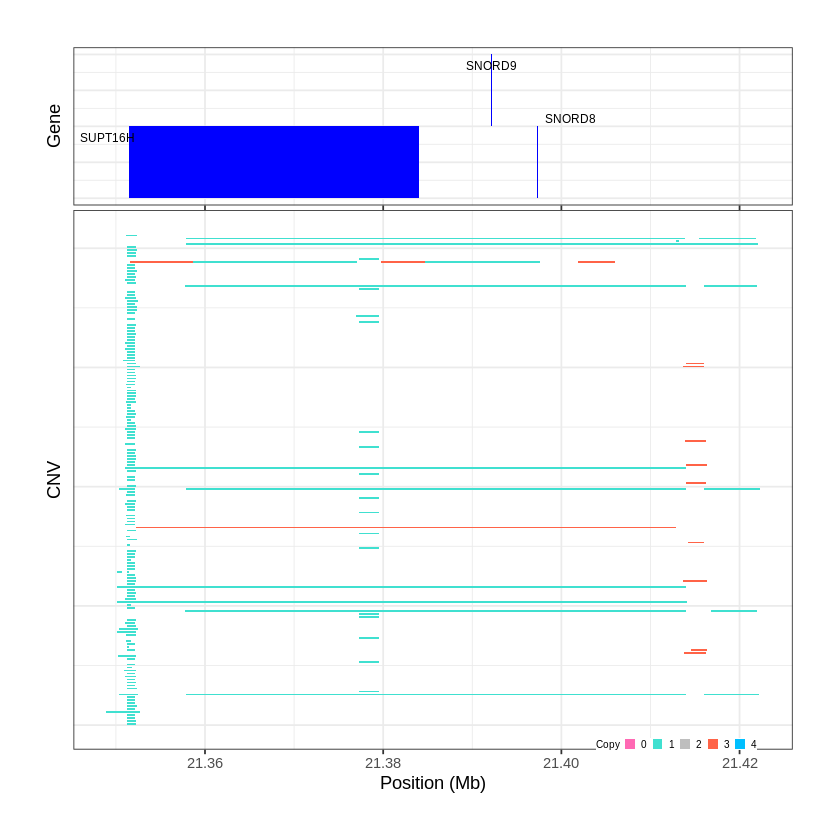

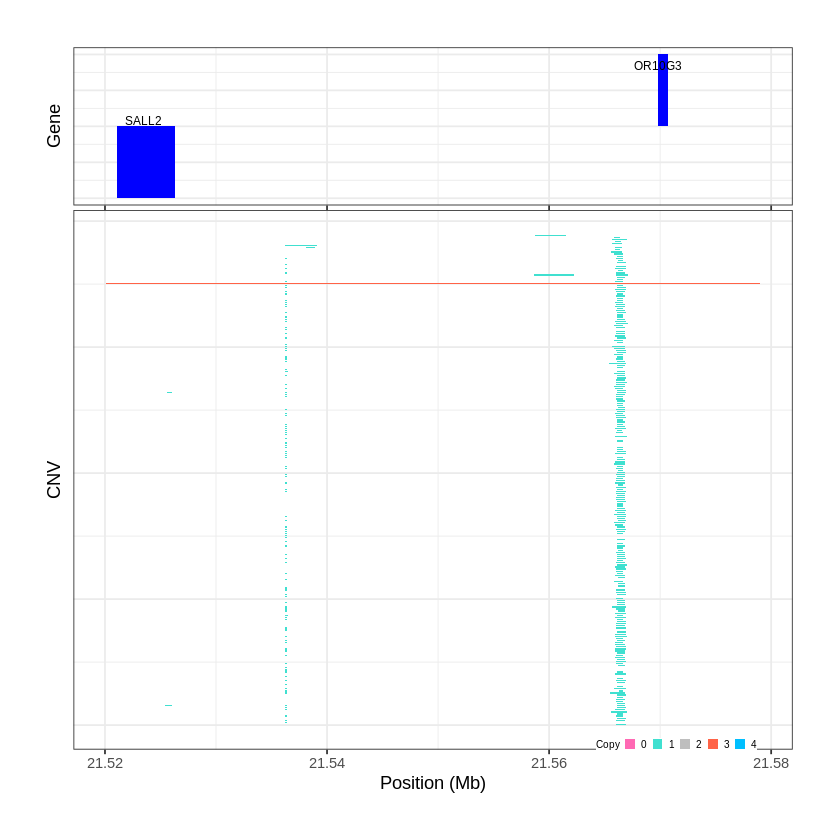

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1490..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 22.363701 - 23.0092 Mb with 236 Individual - "
Plotting gene...


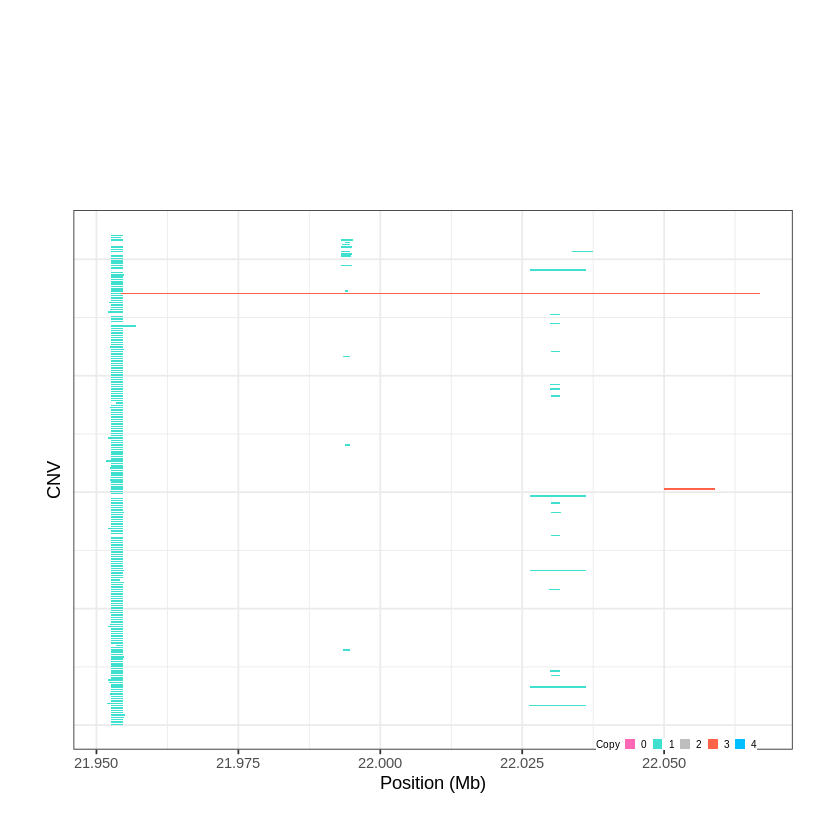

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1491..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 24.428601 - 24.811 Mb with 164 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1492..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 24.954001 - 24.9637 Mb with 192 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


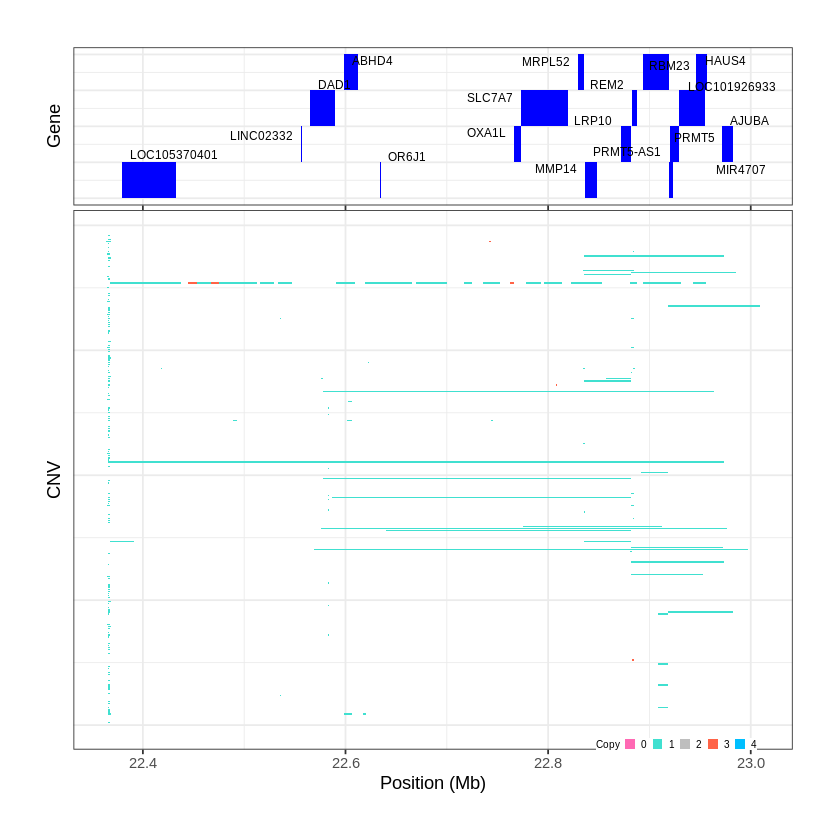

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1493..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 25.165401 - 25.1665 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


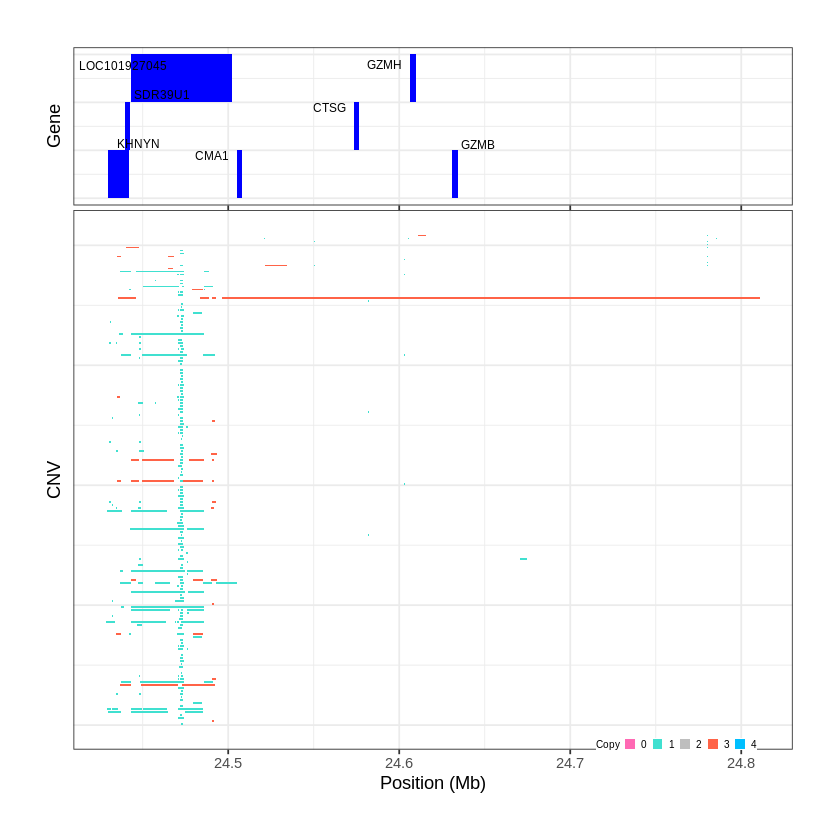

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1494..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 26.725601 - 26.7792 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


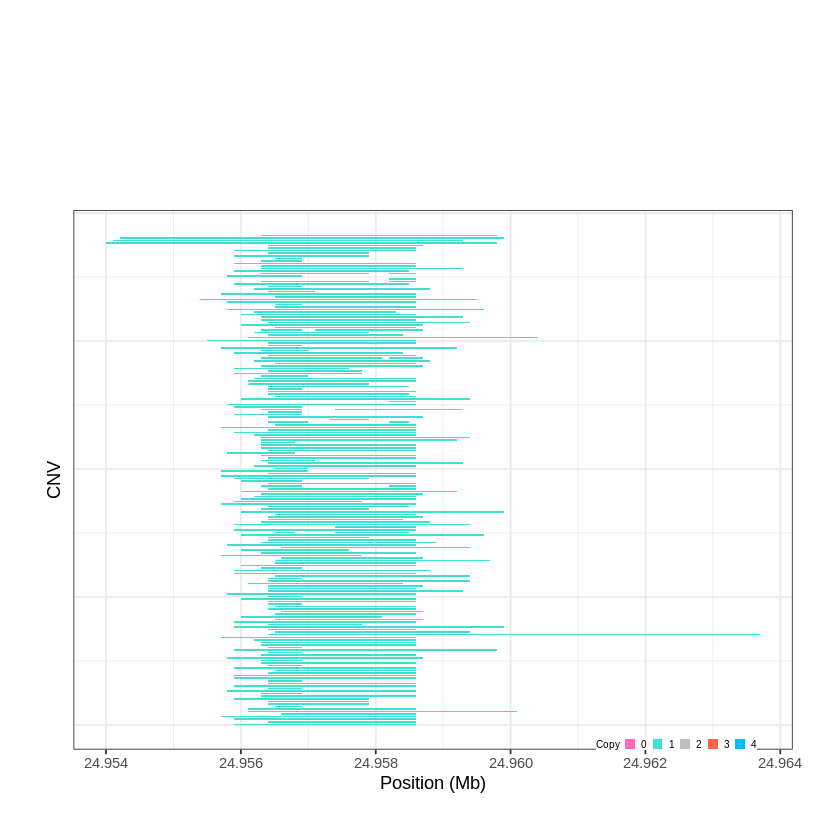

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1495..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 31.257601 - 31.2769 Mb with 248 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


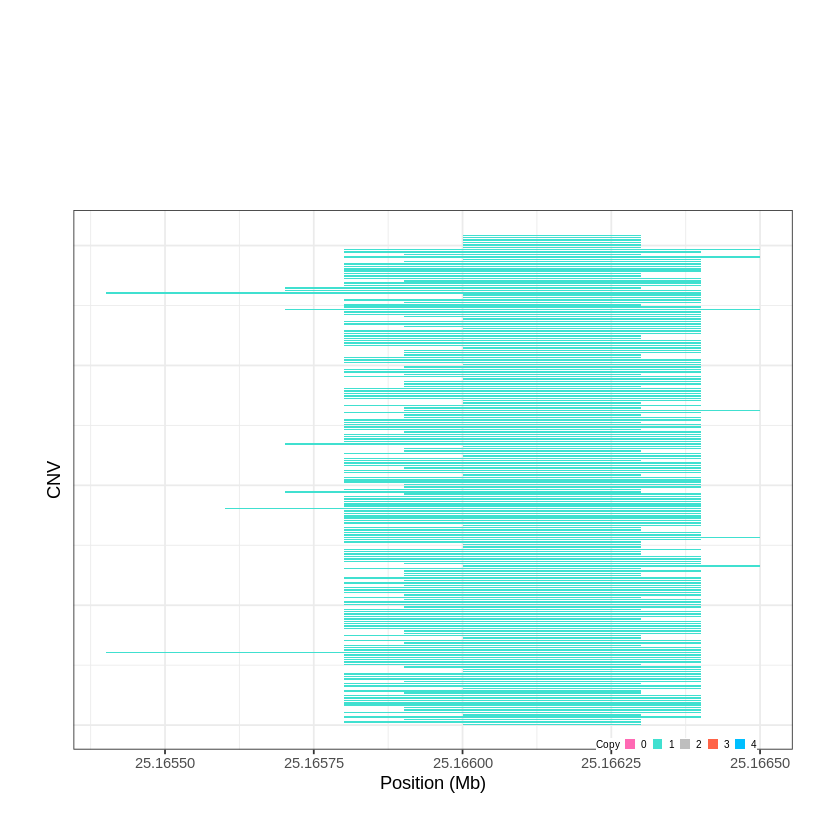

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1496..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 32.948901 - 32.9761 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


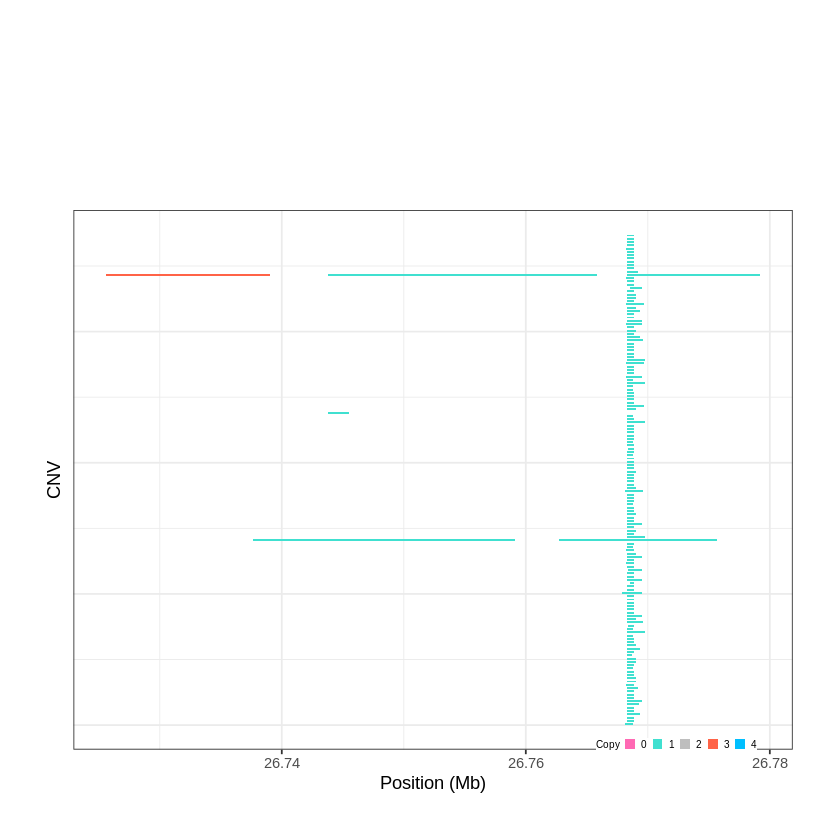

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1497..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 34.496001 - 34.4971 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


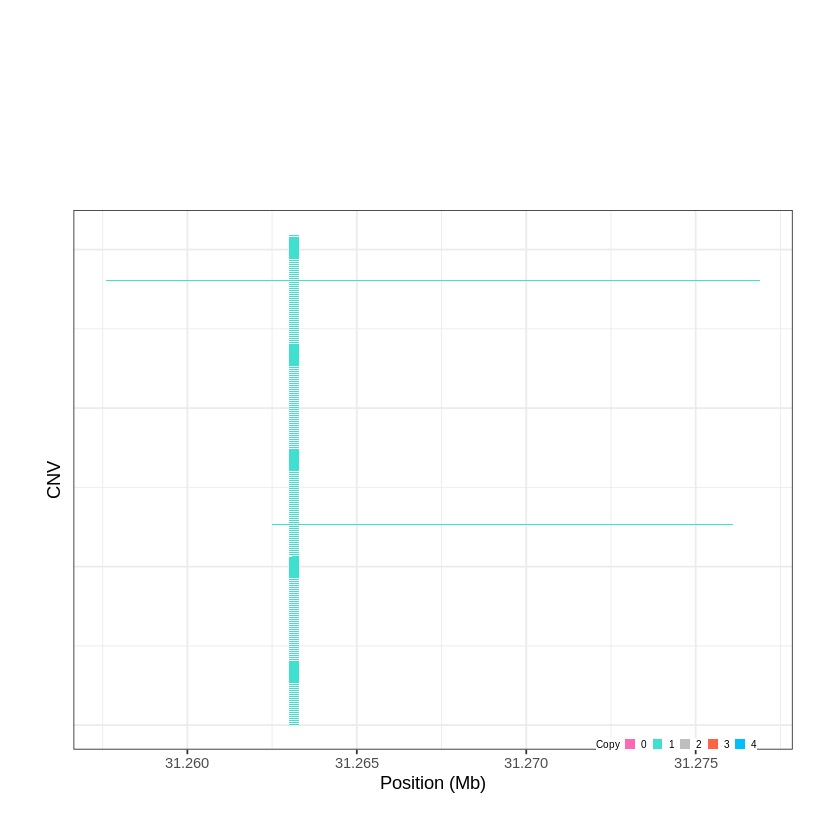

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1498..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 37.768701 - 37.7993 Mb with 270 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


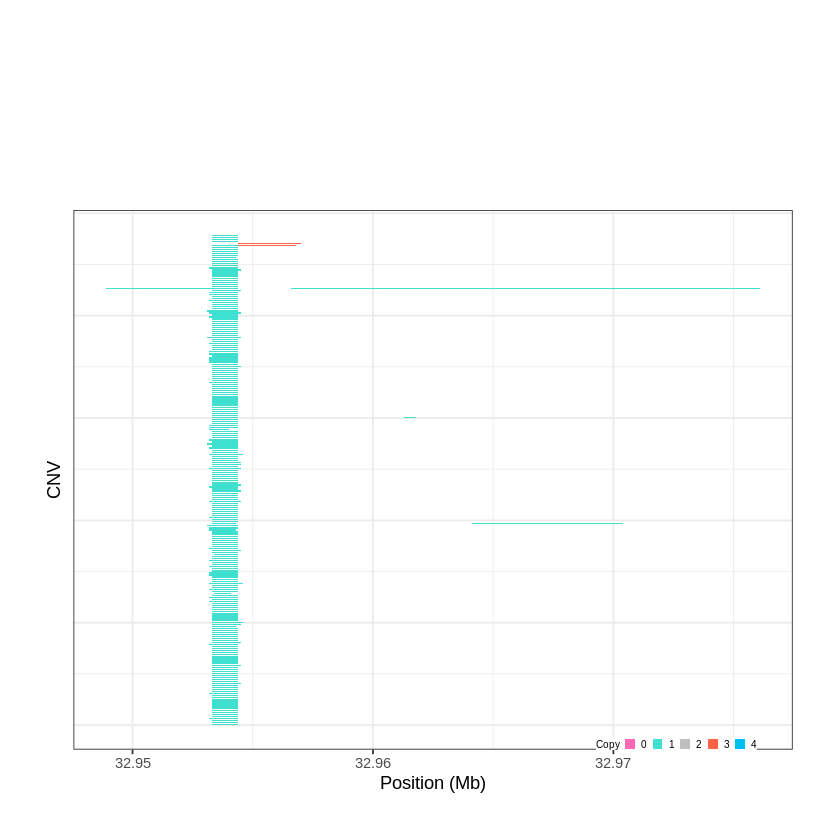

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1499..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 40.596301 - 40.6288 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


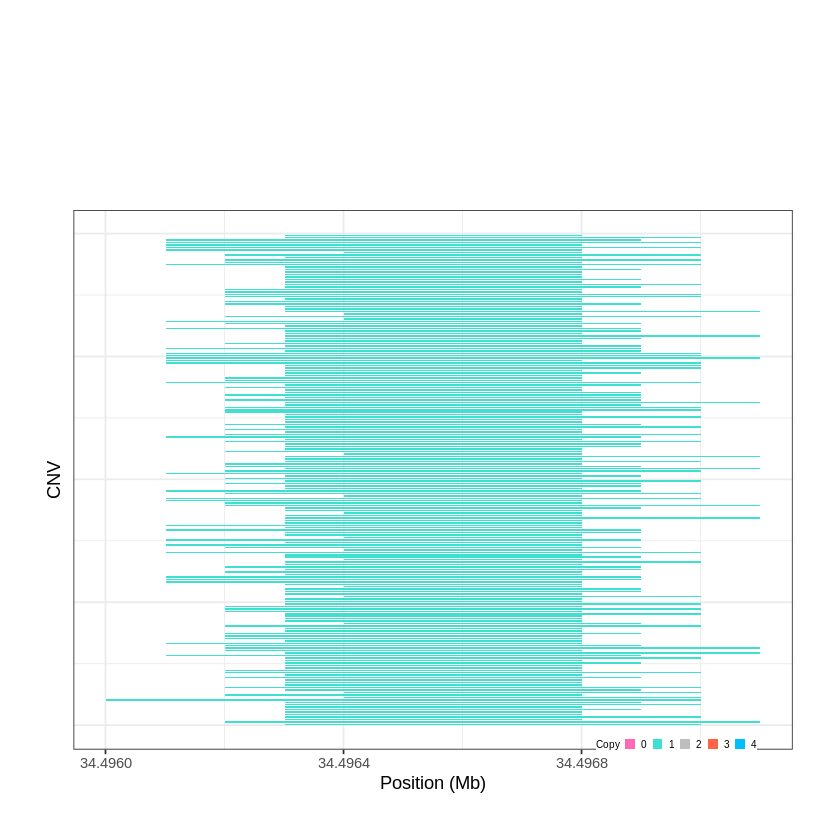

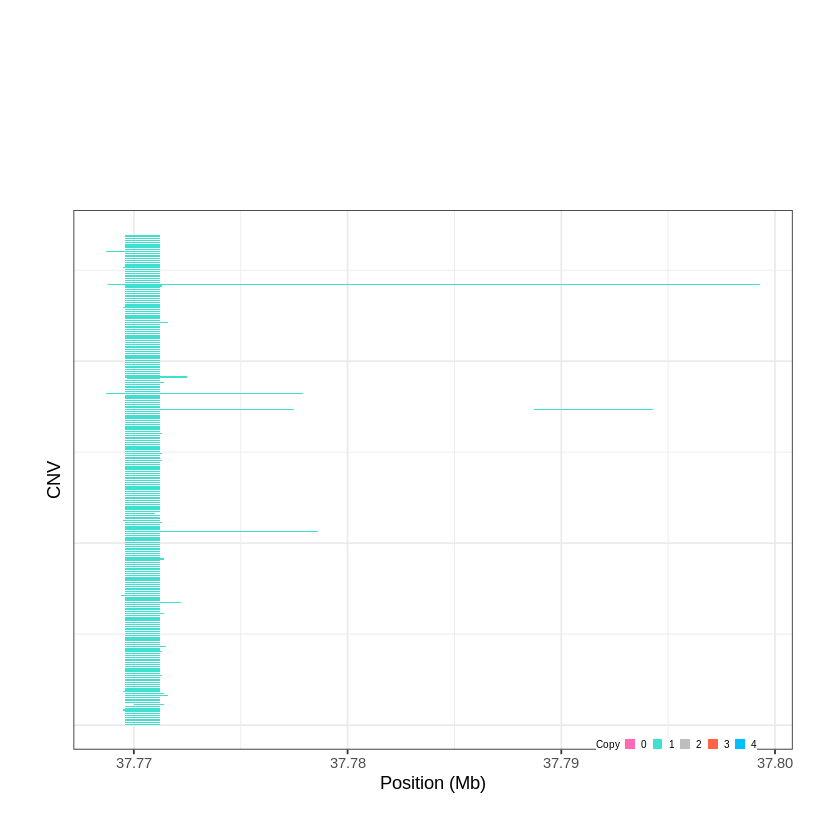

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1500..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 43.824301 - 46.8895 Mb with 277 Individual - "
Plotting gene...


Warning message:
“ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1501..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 50.287401 - 50.2886 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


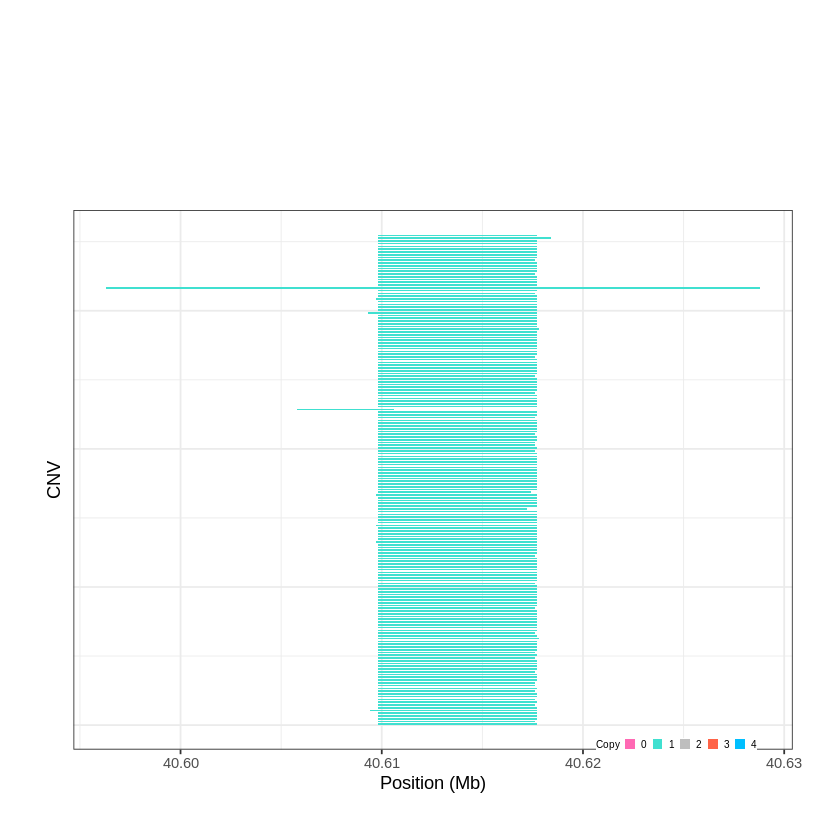

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1502..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 50.539401 - 50.5418 Mb with 216 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


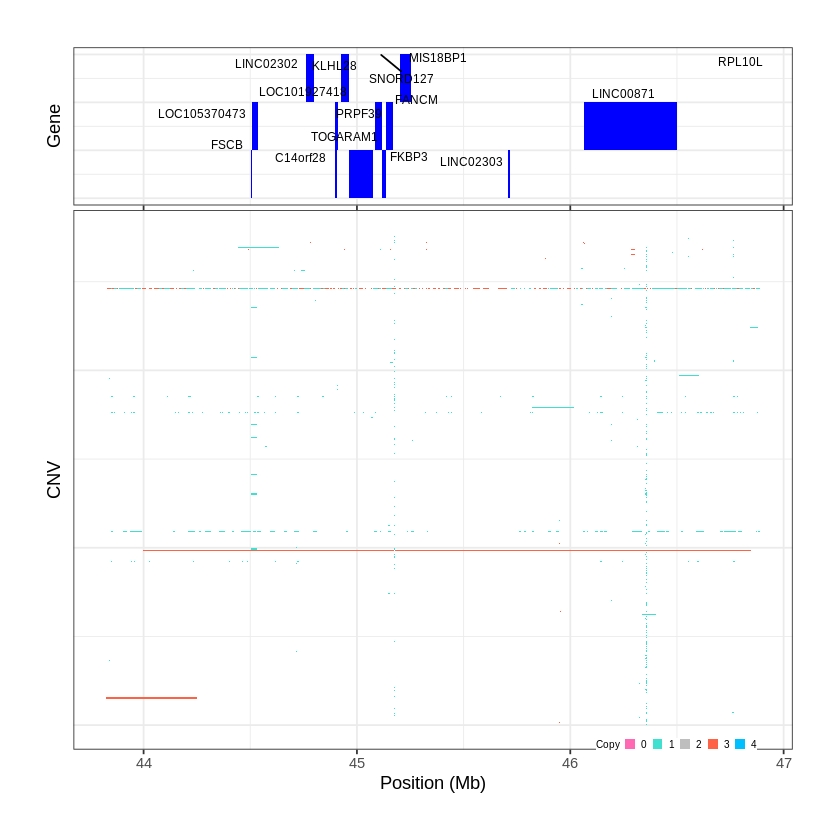

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1503..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 54.541201 - 54.6181 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


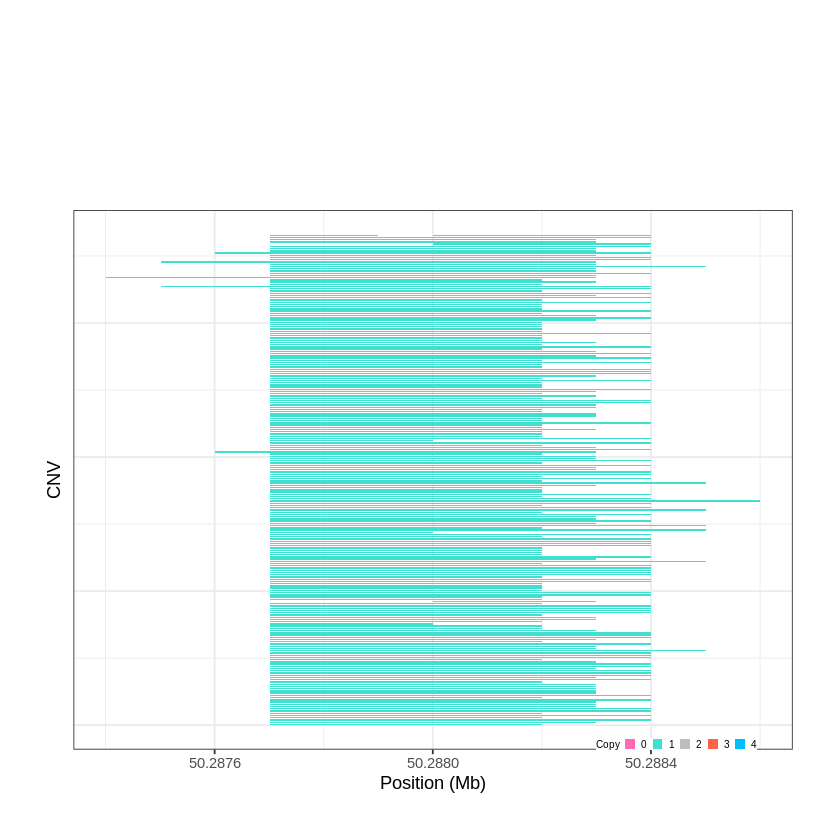

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1504..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 57.031201 - 57.0315 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


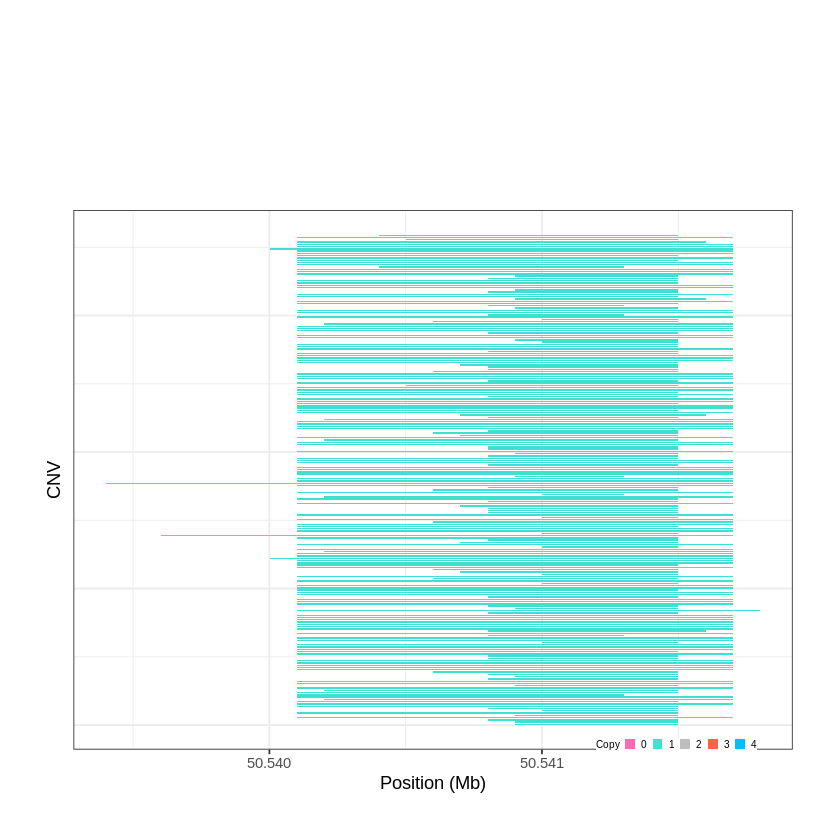

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1505..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 60.215101 - 60.229 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


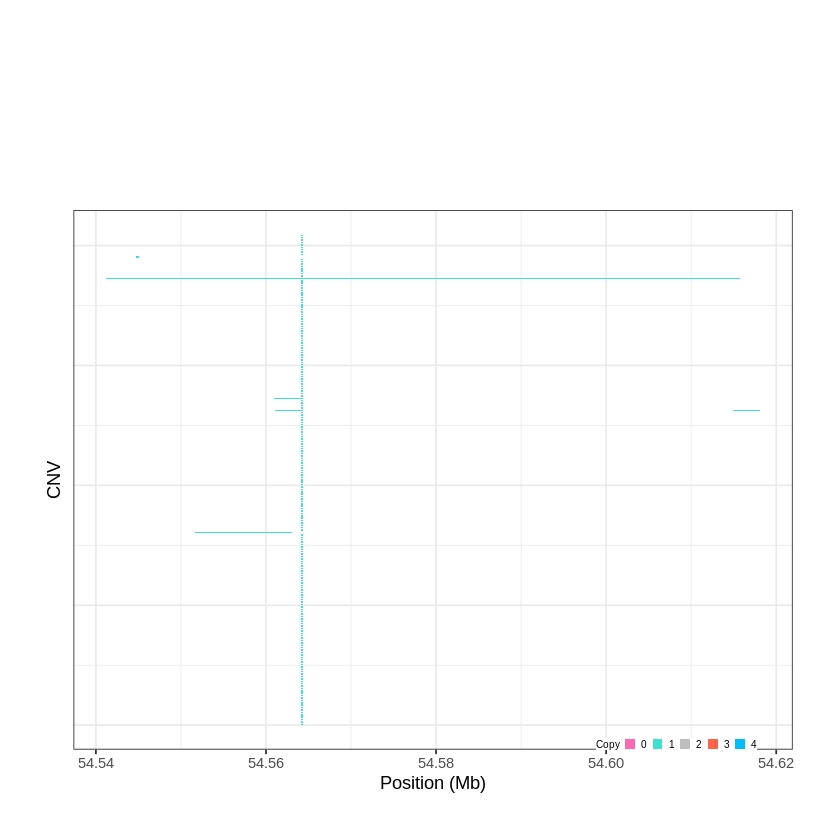

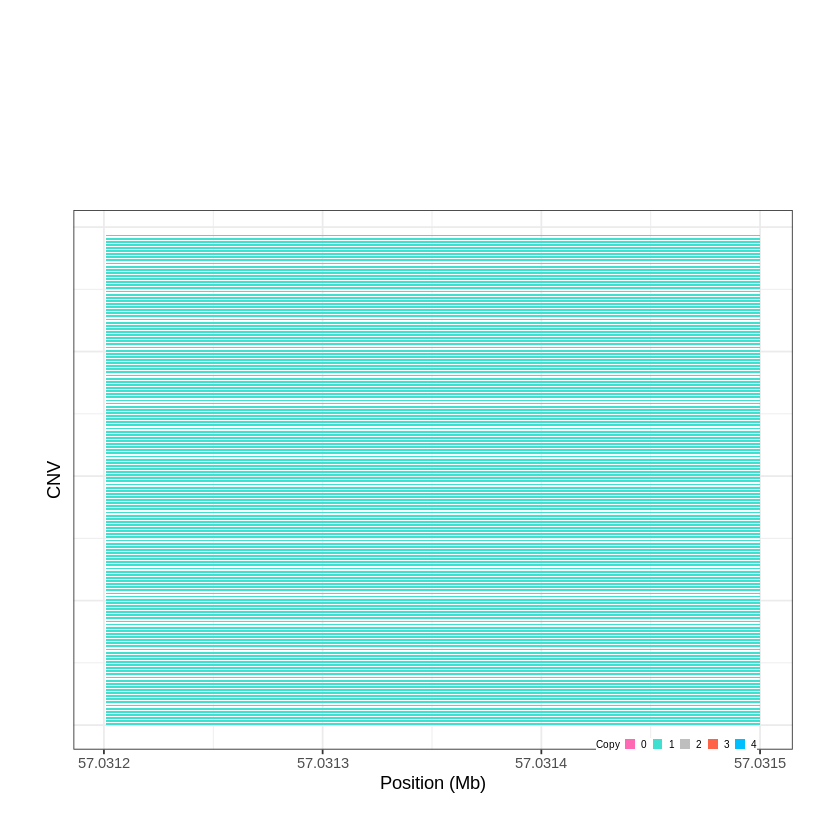

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1506..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 60.296201 - 60.3647 Mb with 149 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1507..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 62.749501 - 62.7724 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


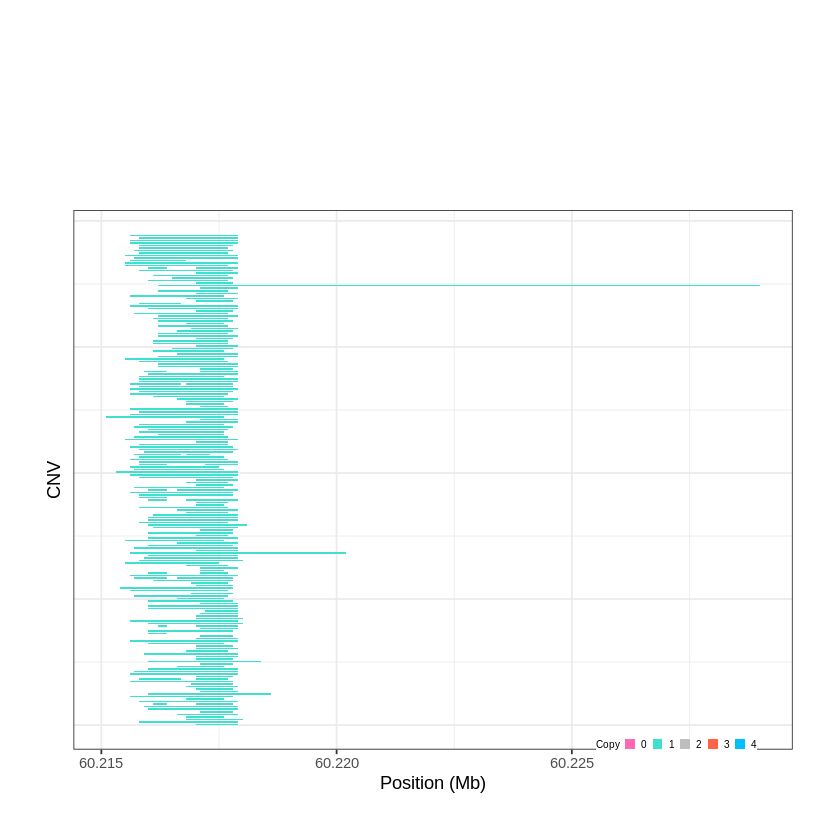

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1508..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 63.861701 - 63.864 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


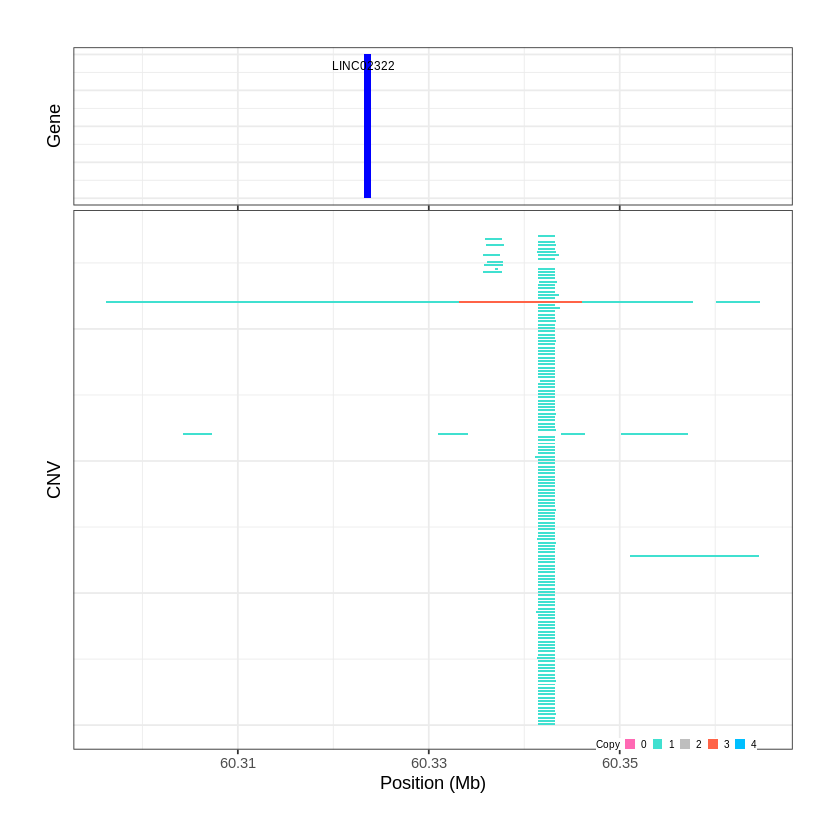

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1509..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 65.360401 - 65.3638 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


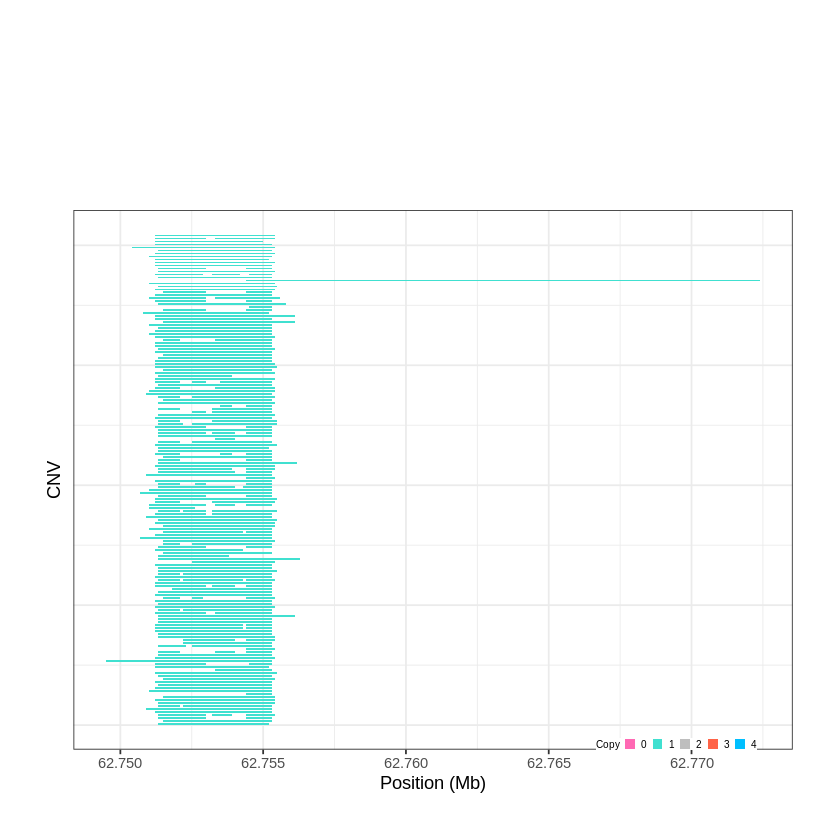

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1510..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 68.602901 - 68.6038 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


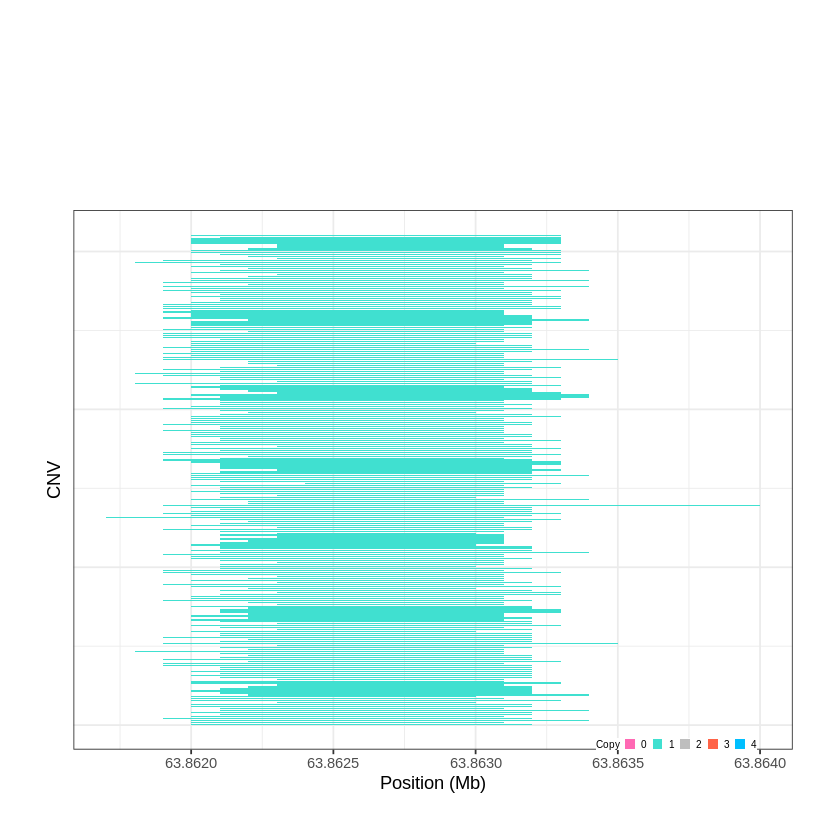

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1511..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 73.996001 - 74.0518 Mb with 225 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


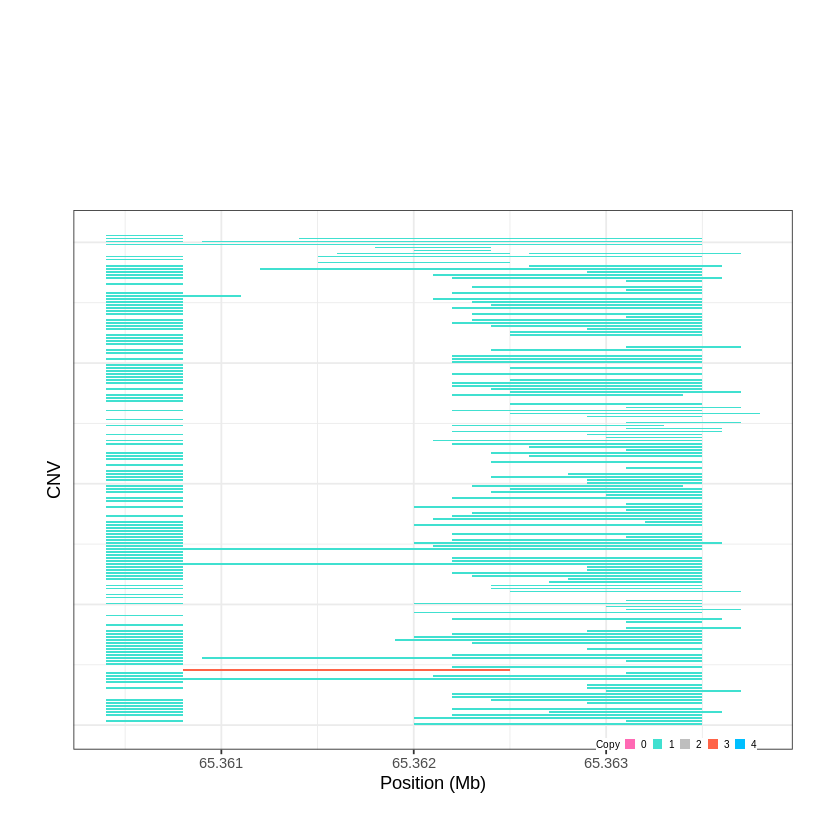

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1512..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 76.879801 - 76.881 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


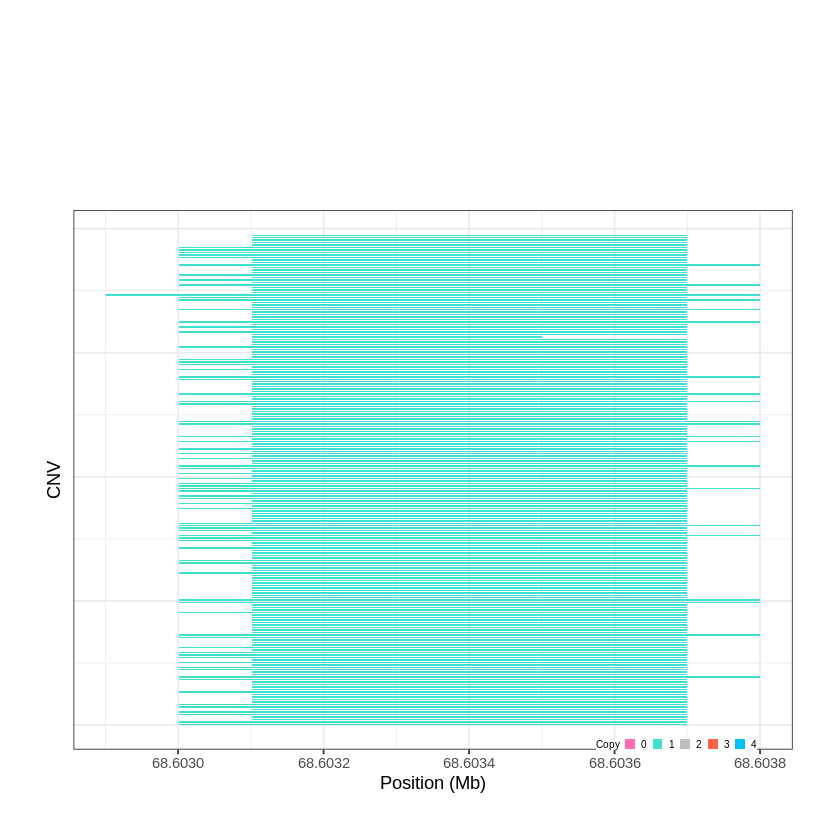

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1513..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 77.004901 - 77.0084 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


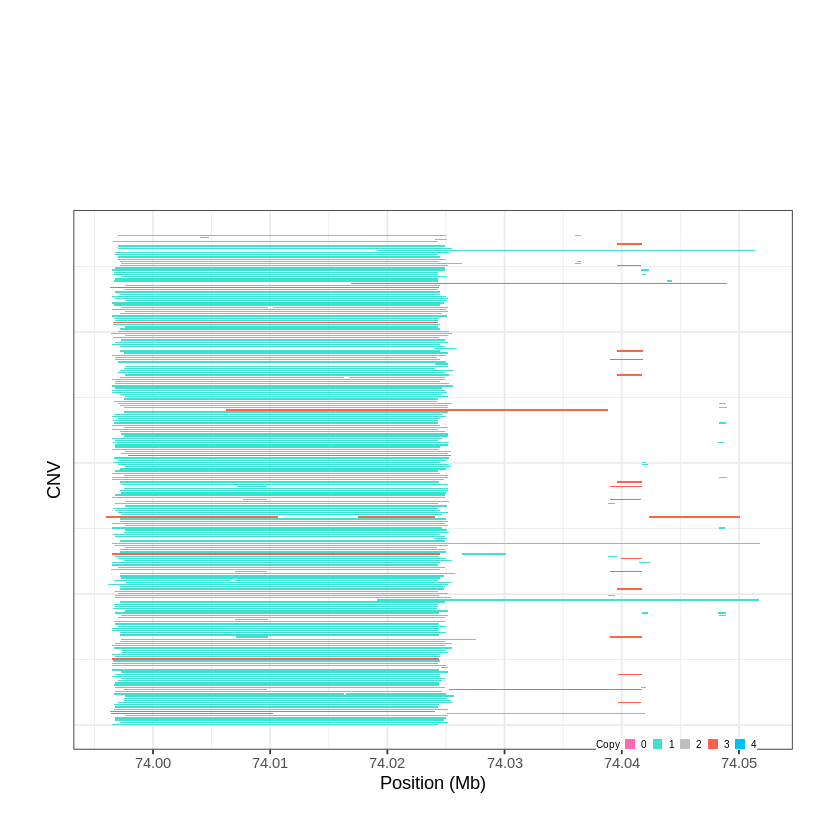

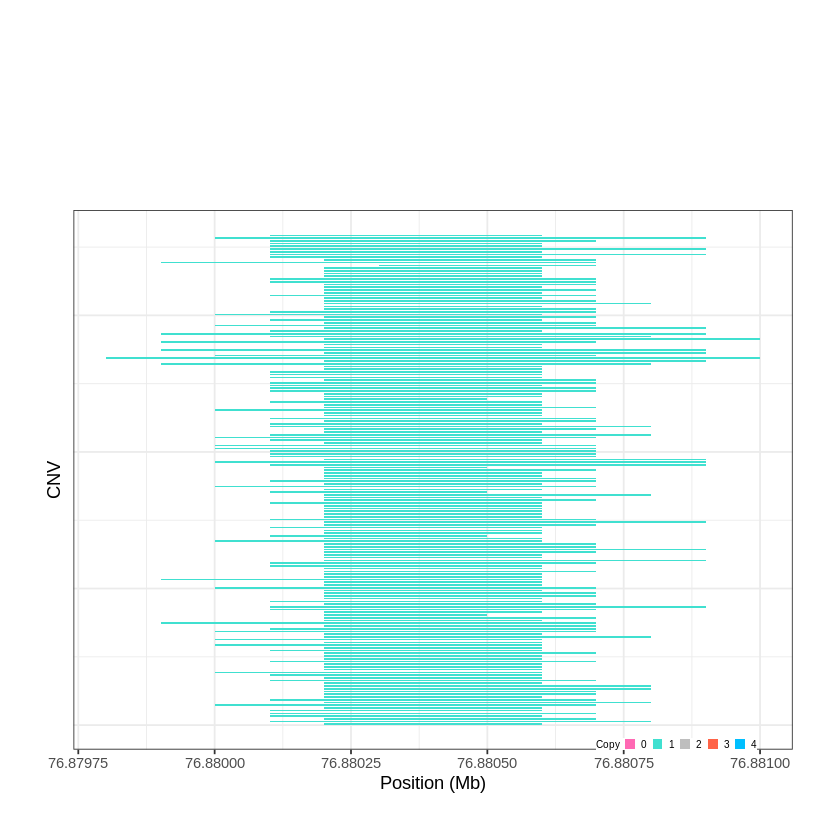

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1514..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 77.577701 - 77.8198 Mb with 276 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1515..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 81.874601 - 81.9082 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


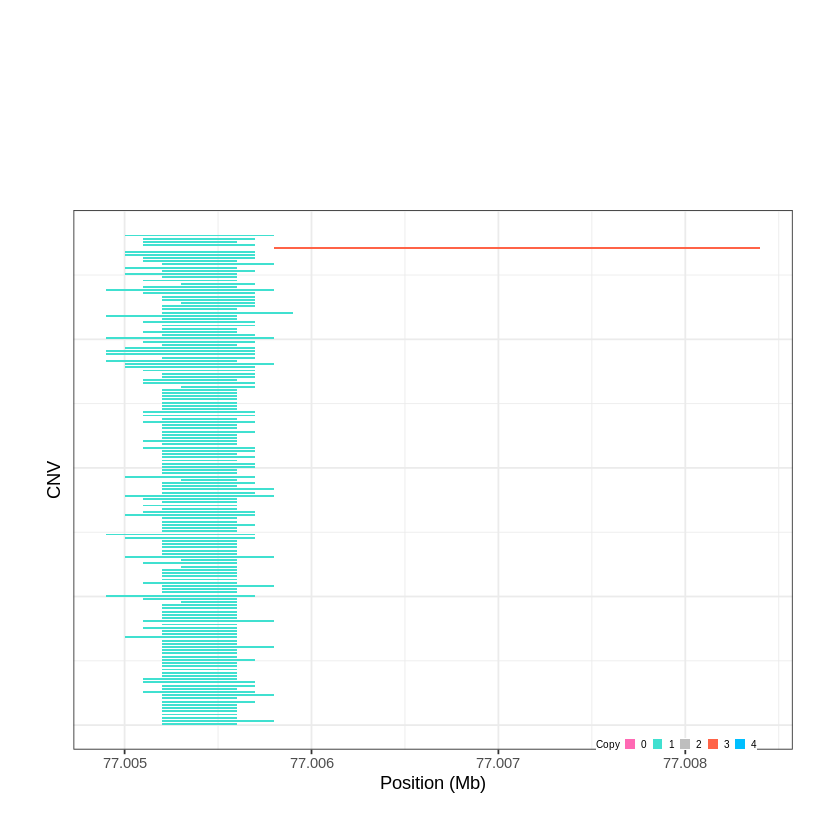

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1516..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 82.495501 - 82.5291 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


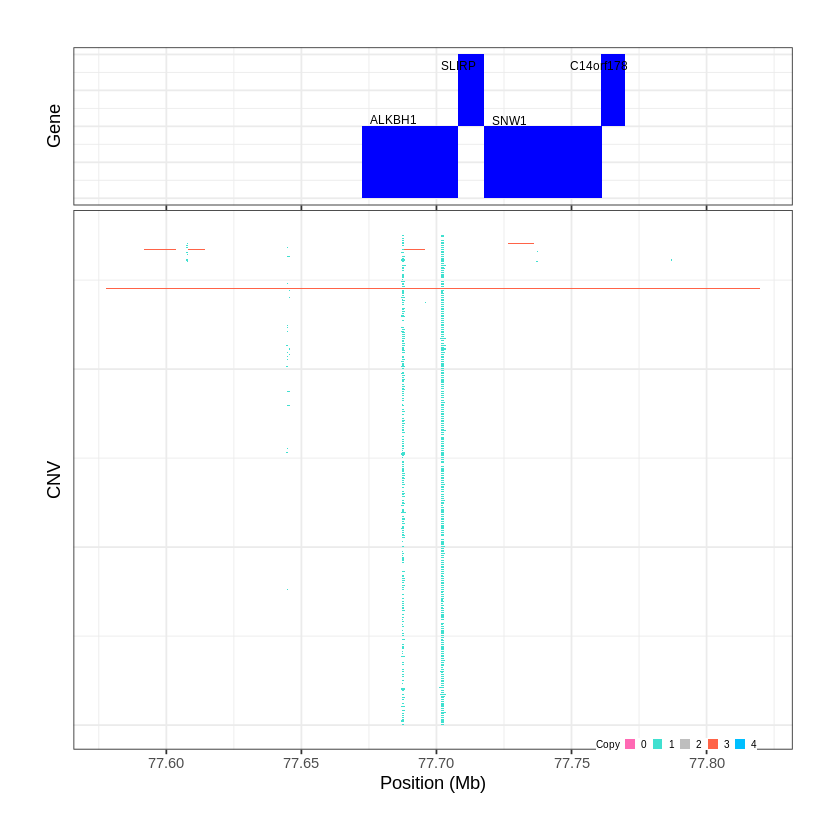

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1517..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 83.614501 - 83.649 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


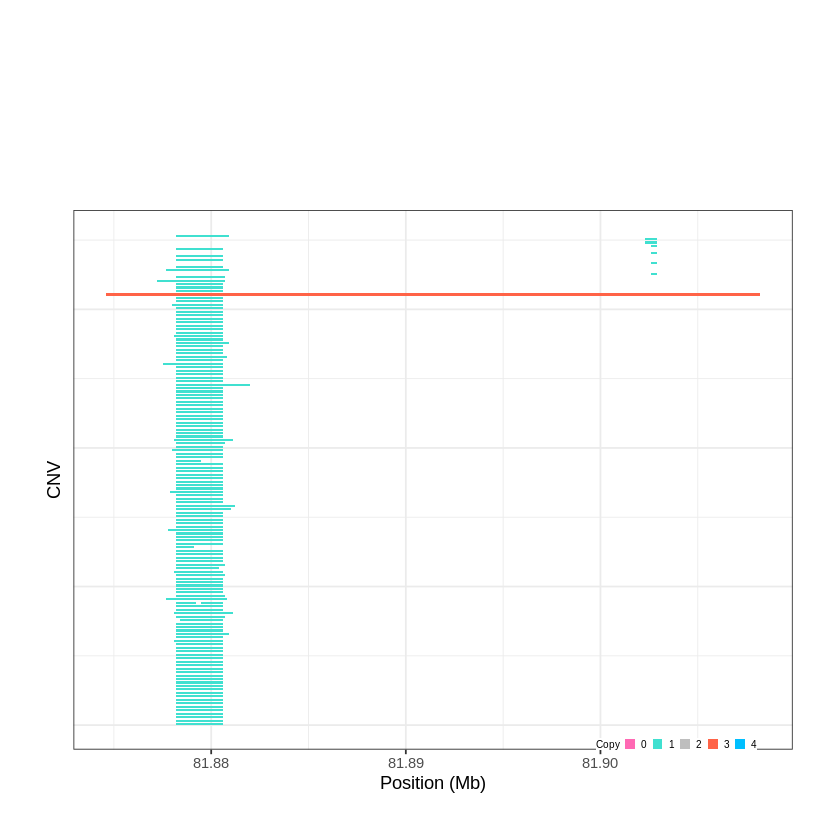

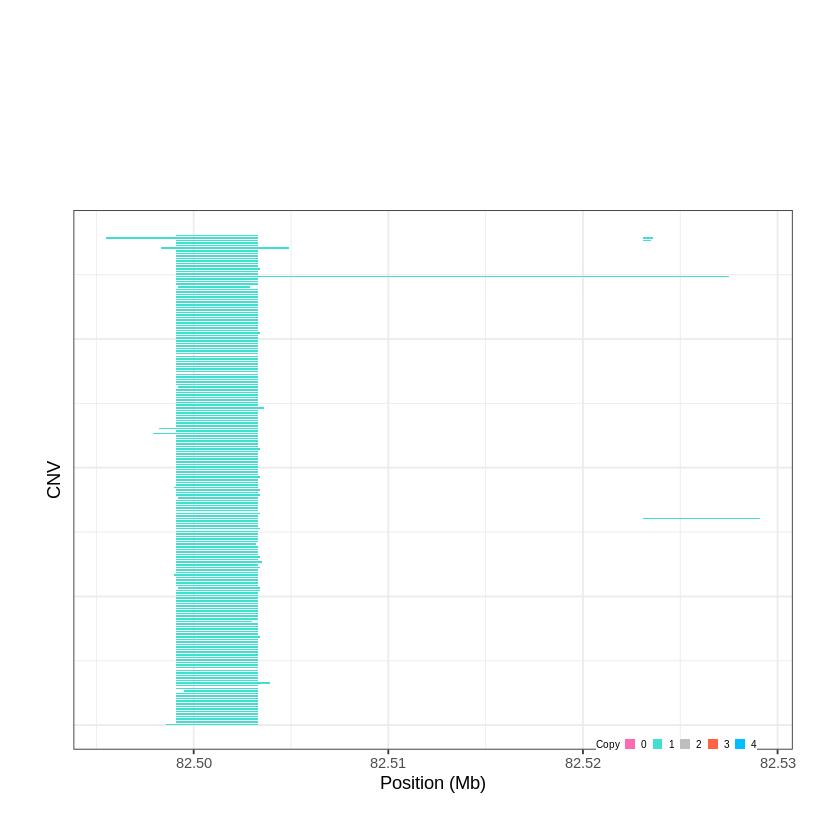

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1518..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 86.895101 - 86.9823 Mb with 213 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1519..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 87.855701 - 87.8583 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


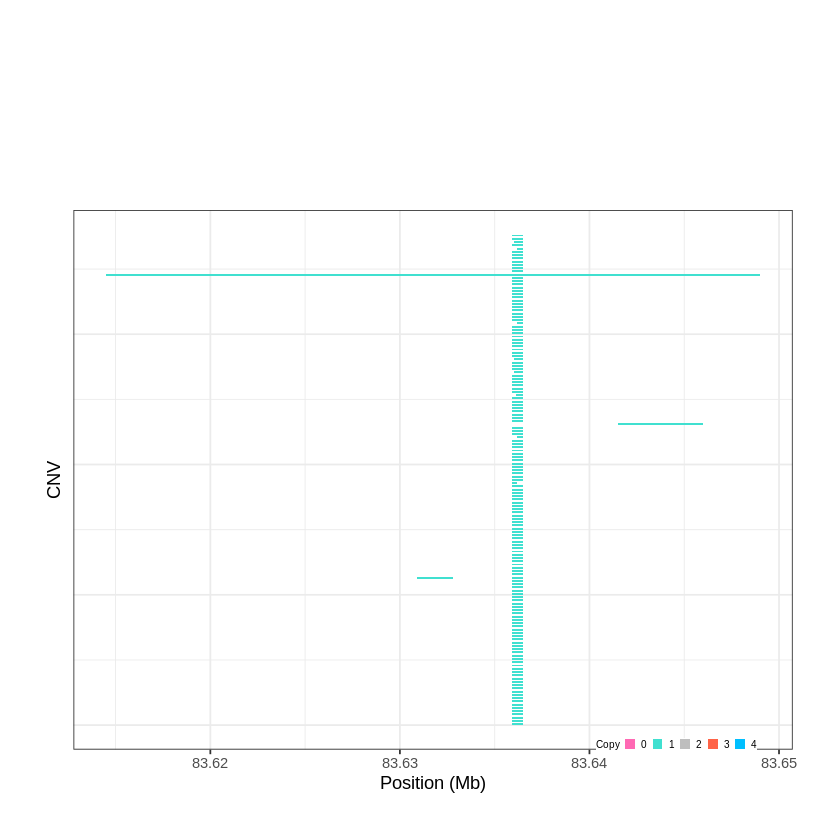

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1520..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 89.826301 - 89.8293 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


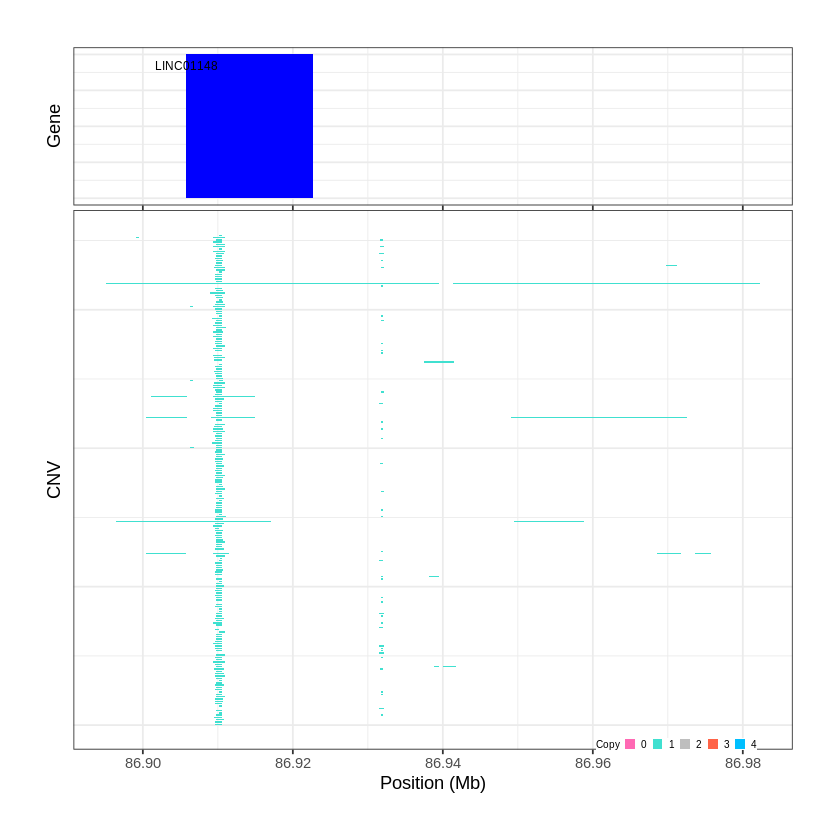

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1521..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 90.777201 - 90.8697 Mb with 215 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


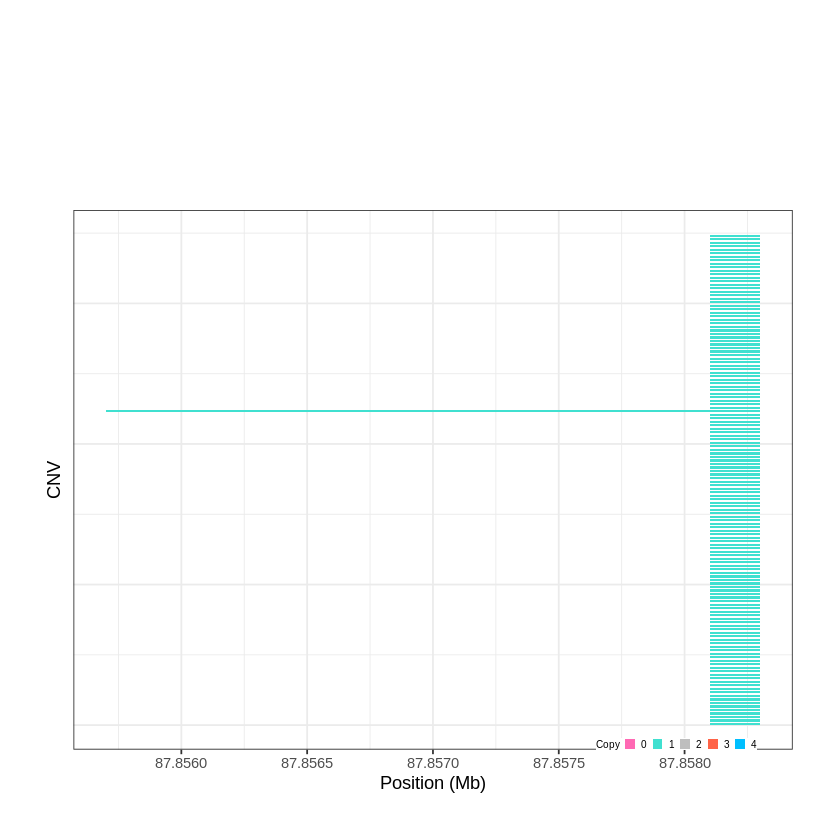

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1522..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 92.017501 - 92.0787 Mb with 261 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


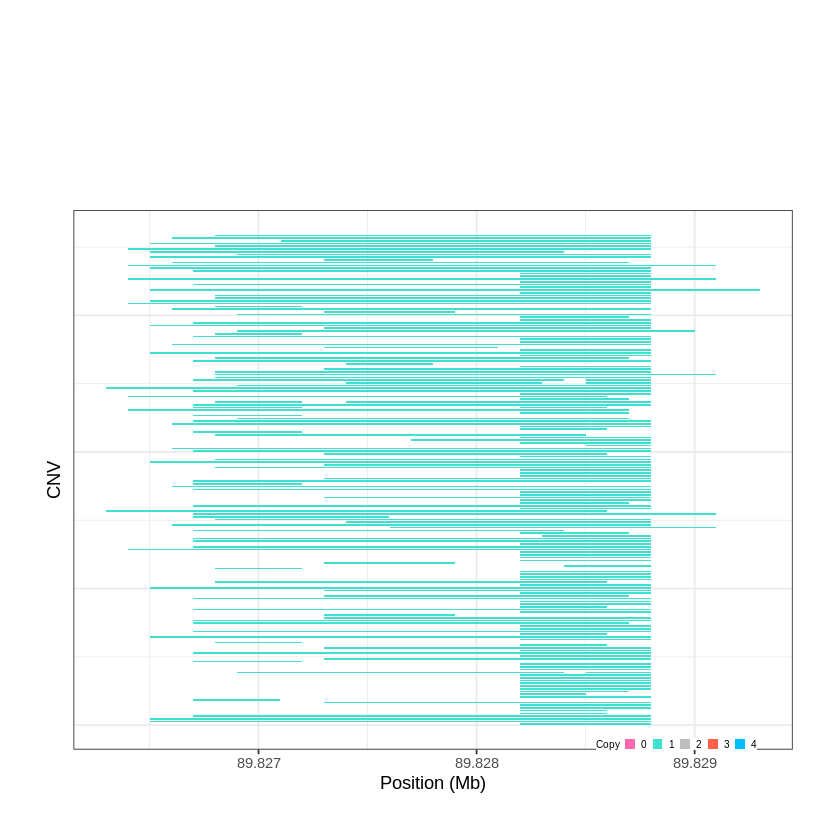

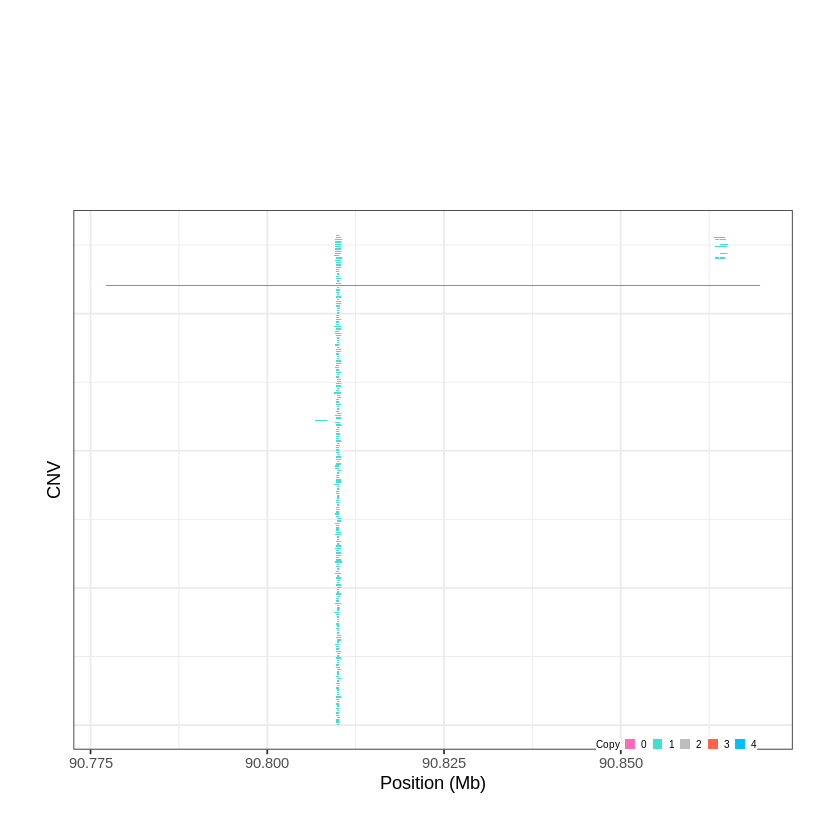

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1523..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 93.330001 - 93.7324 Mb with 276 Individual - "
Plotting gene...


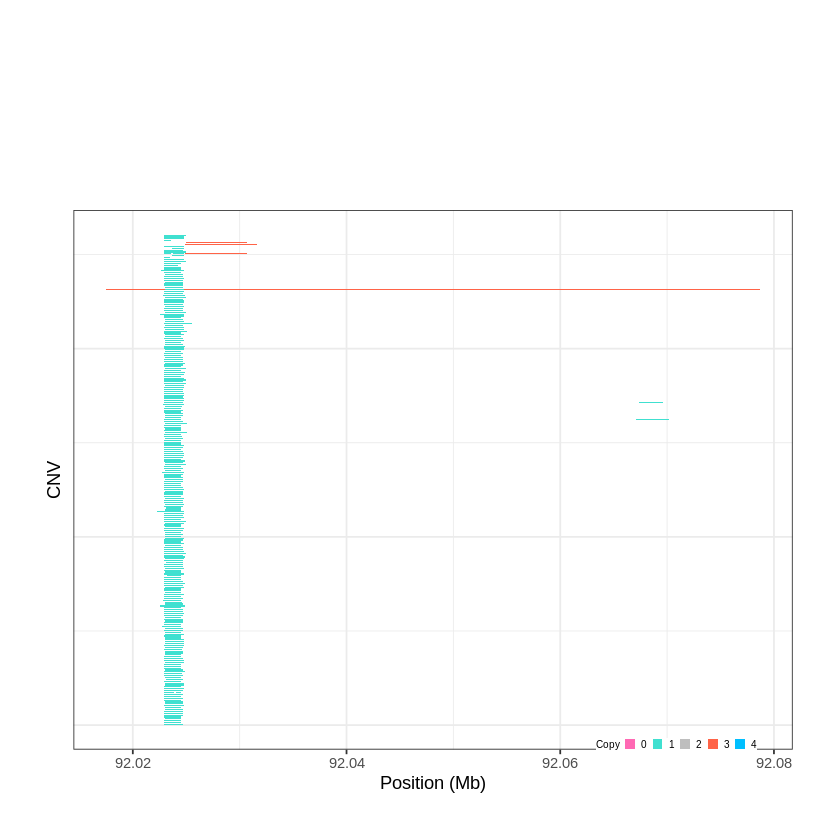

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1524..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 94.143201 - 94.514 Mb with 162 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1525..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 99.529101 - 99.5475 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


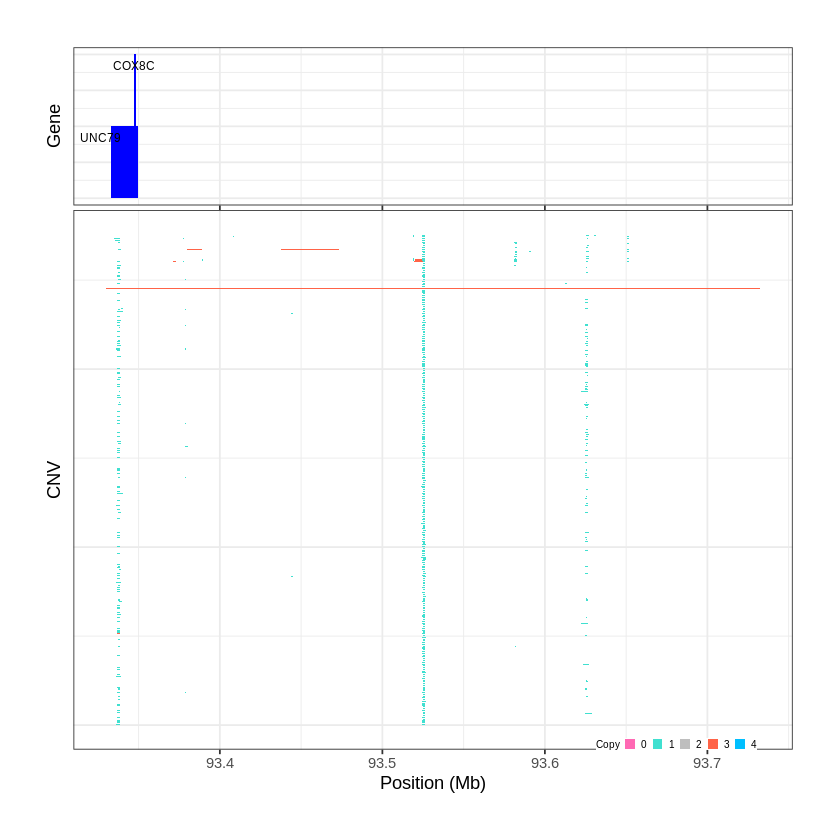

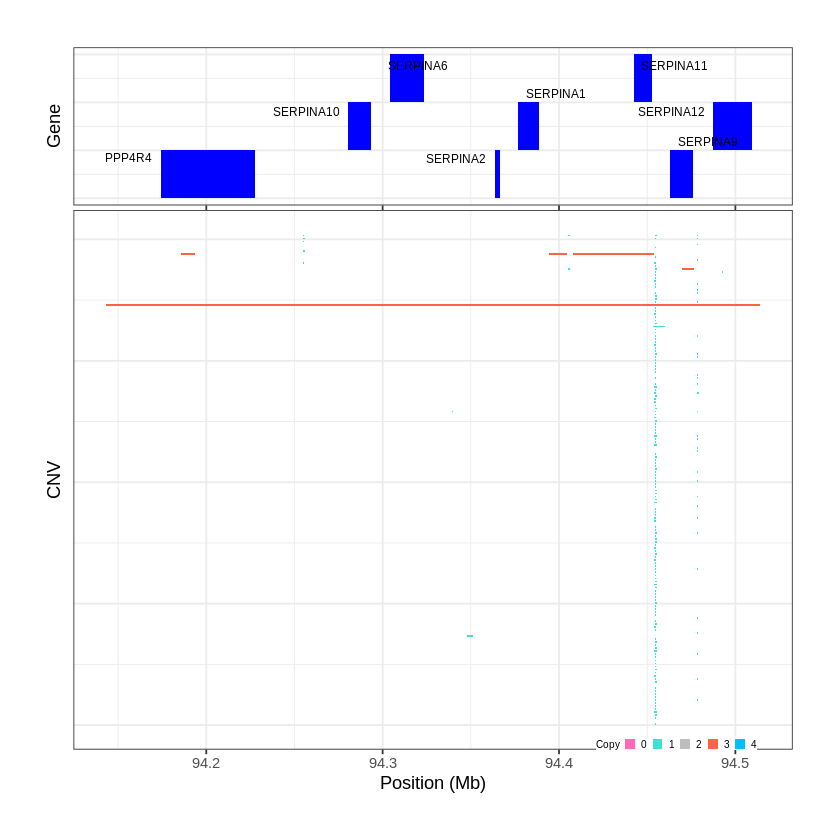

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1526..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 99.636601 - 99.899 Mb with 205 Individual - "
Plotting gene...


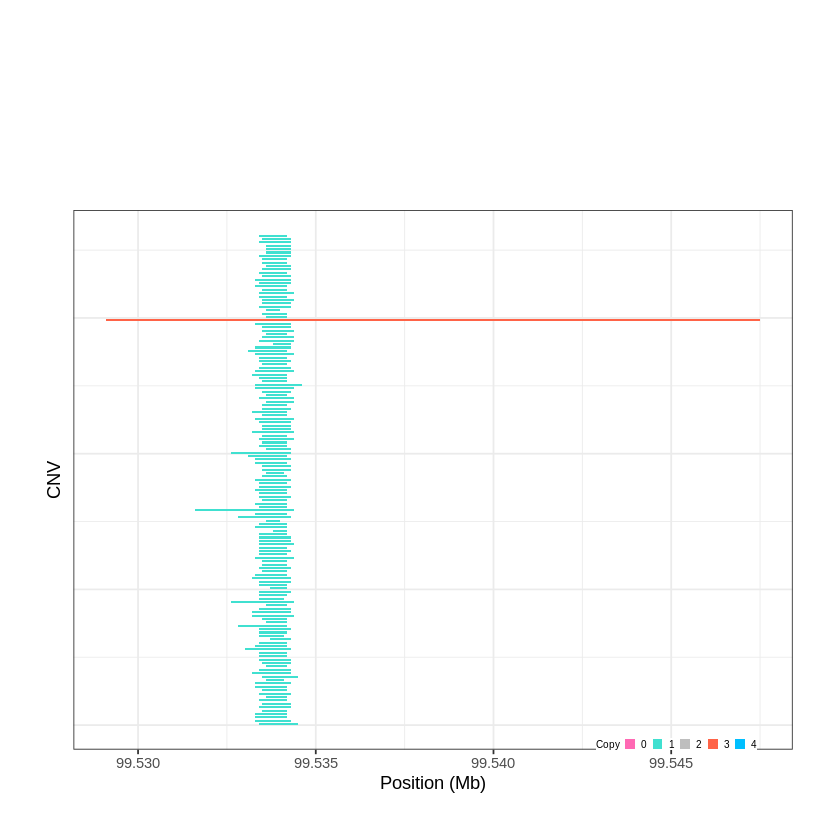

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1527..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 99.906001 - 100.3246 Mb with 231 Individual - "
Plotting gene...


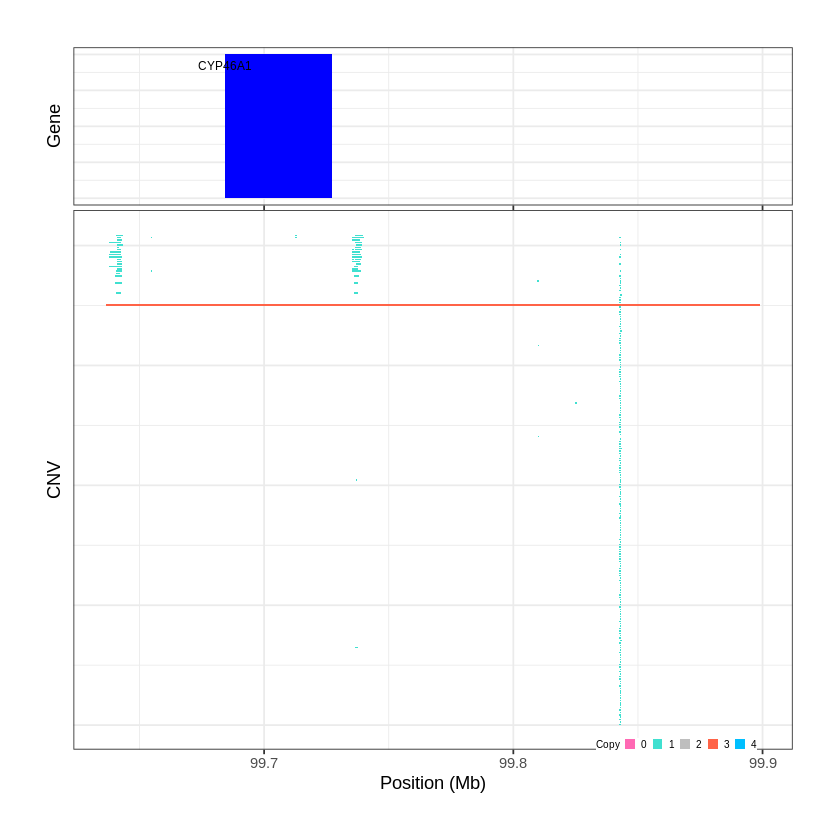

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1528..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 100.506501 - 100.845 Mb with 270 Individual - "
Plotting gene...


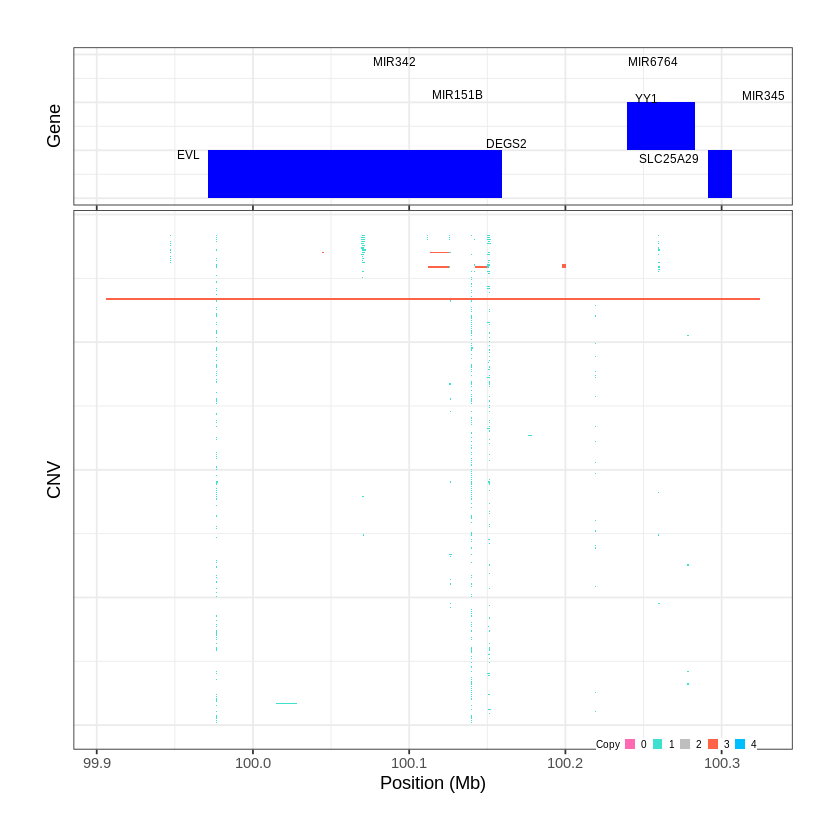

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1529..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 100.904301 - 101.3795 Mb with 276 Individual - "
Plotting gene...


Warning message:
“ggrepel: 80 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 86 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1530..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 102.130301 - 102.1819 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


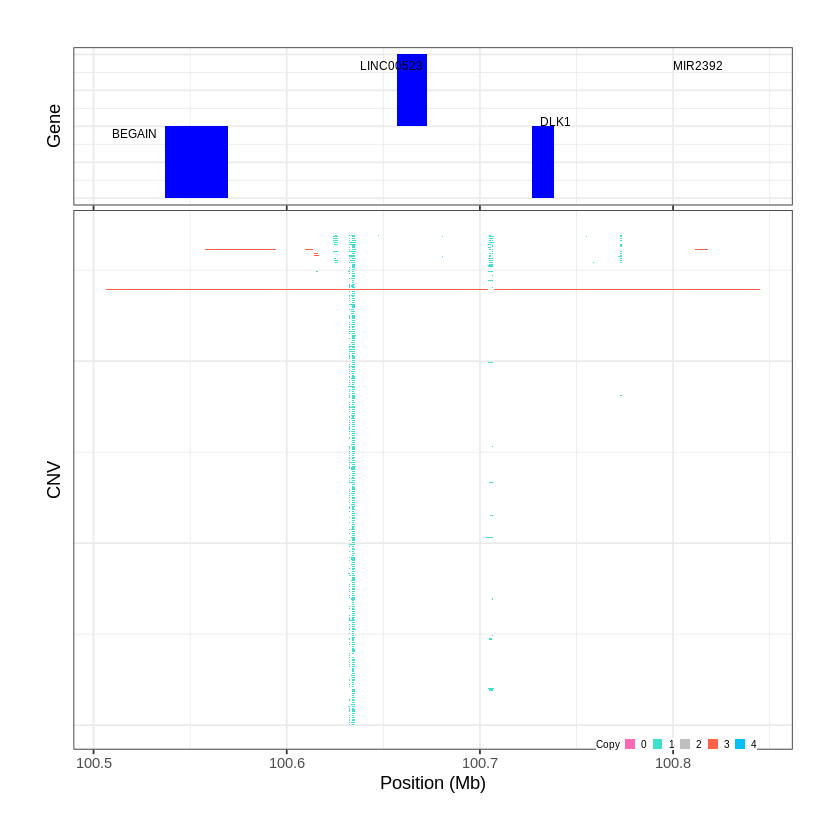

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1531..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 102.183401 - 102.1862 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”
Warning message:
“ggrepel: 80 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


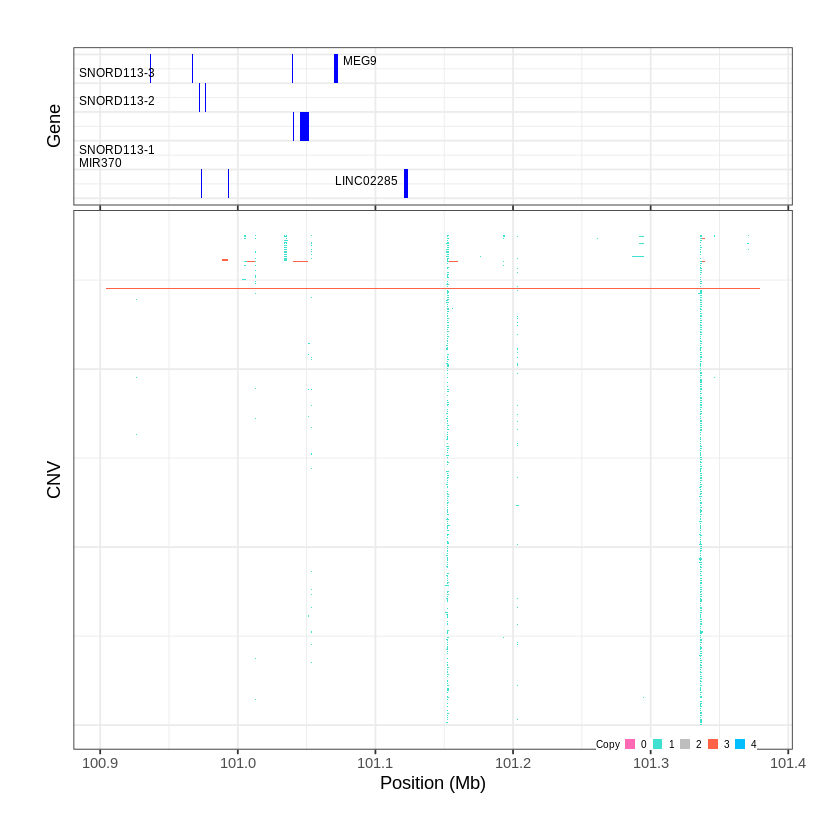

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1532..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 102.224201 - 102.291 Mb with 274 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


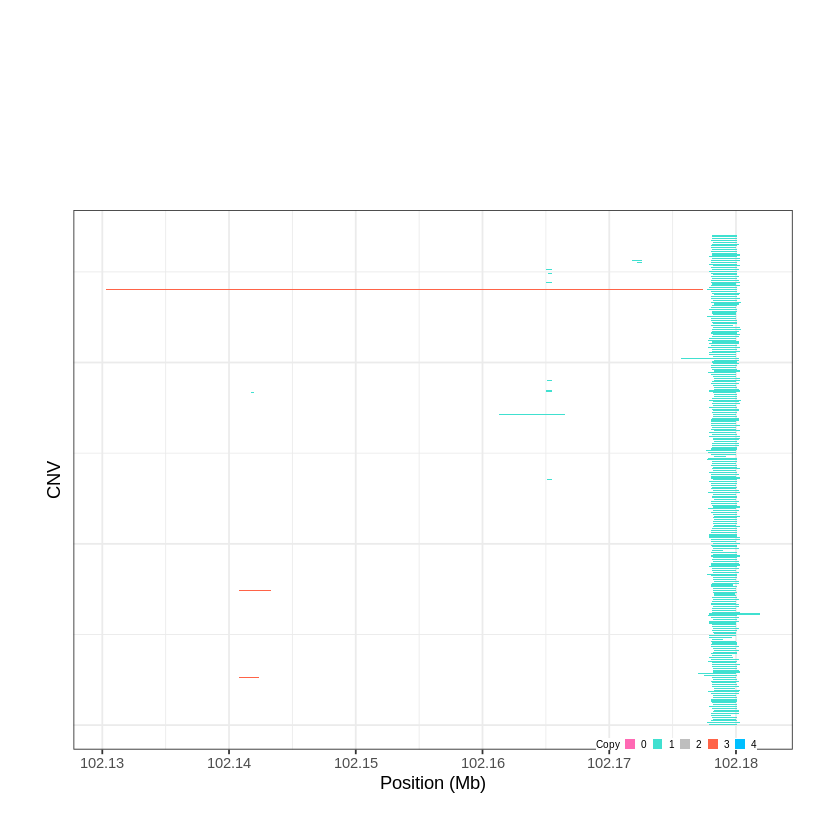

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1533..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 102.384301 - 102.3855 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


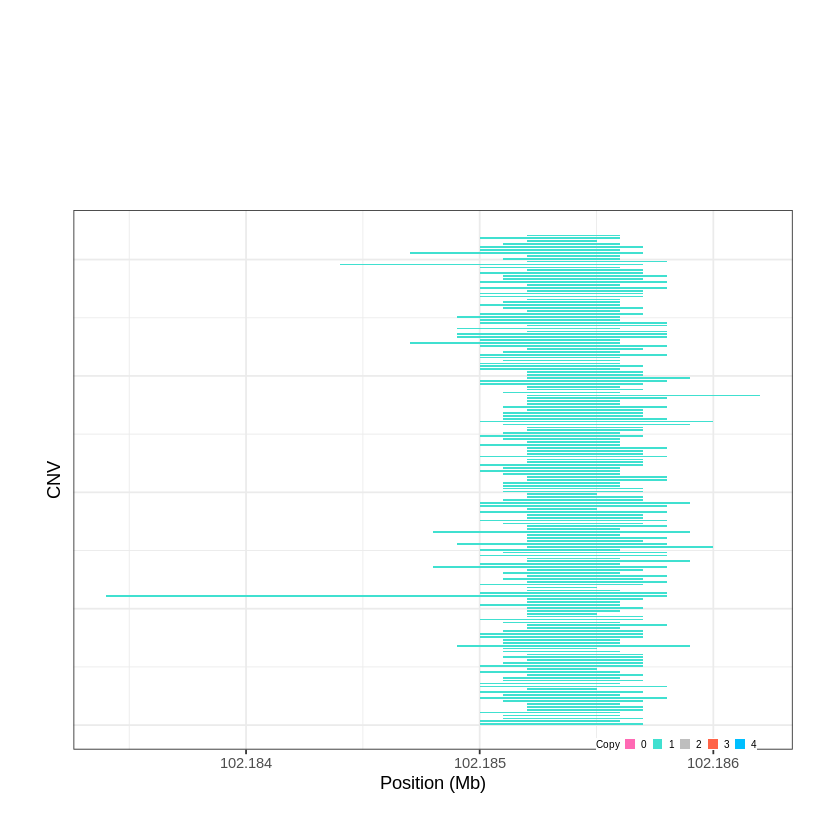

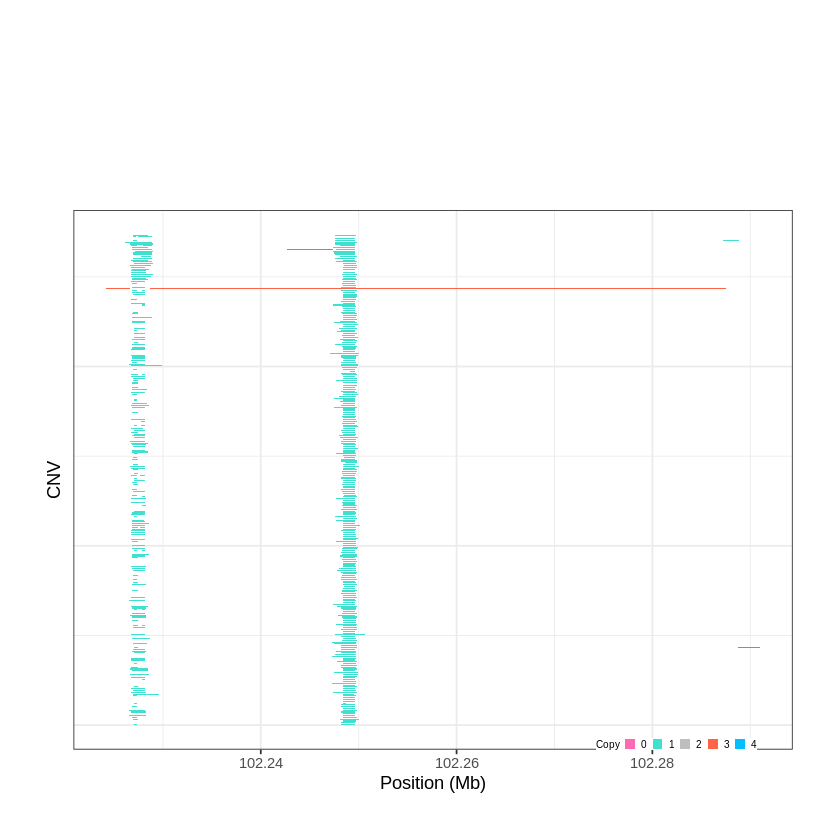

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1534..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 103.329101 - 104.0677 Mb with 265 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1535..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 104.651401 - 104.6536 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


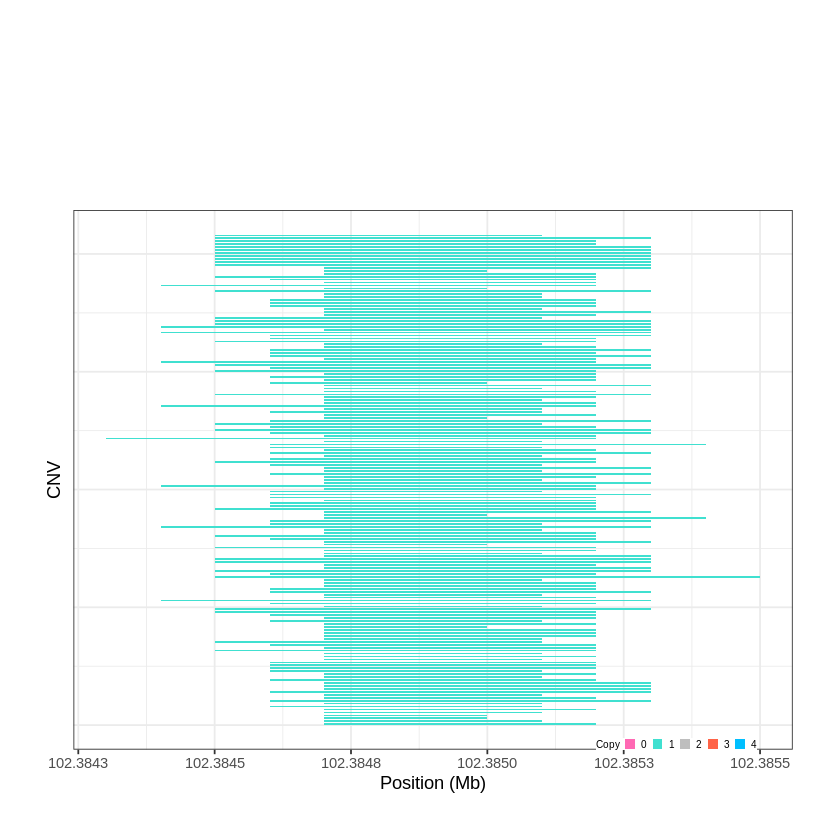

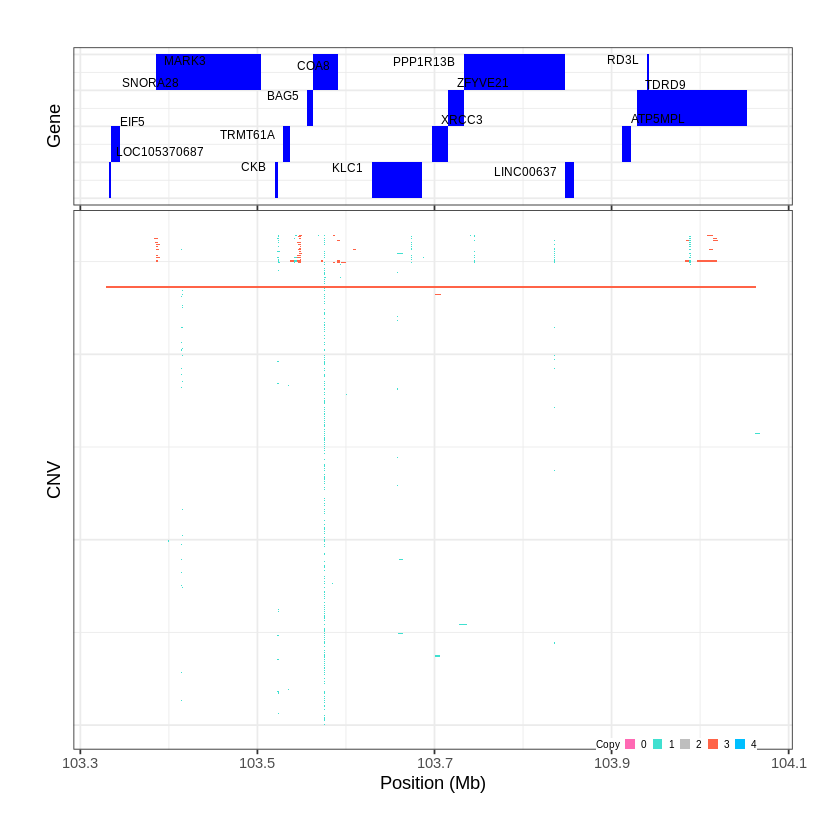

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1536..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 104.681601 - 104.8718 Mb with 237 Individual - "
Plotting gene...


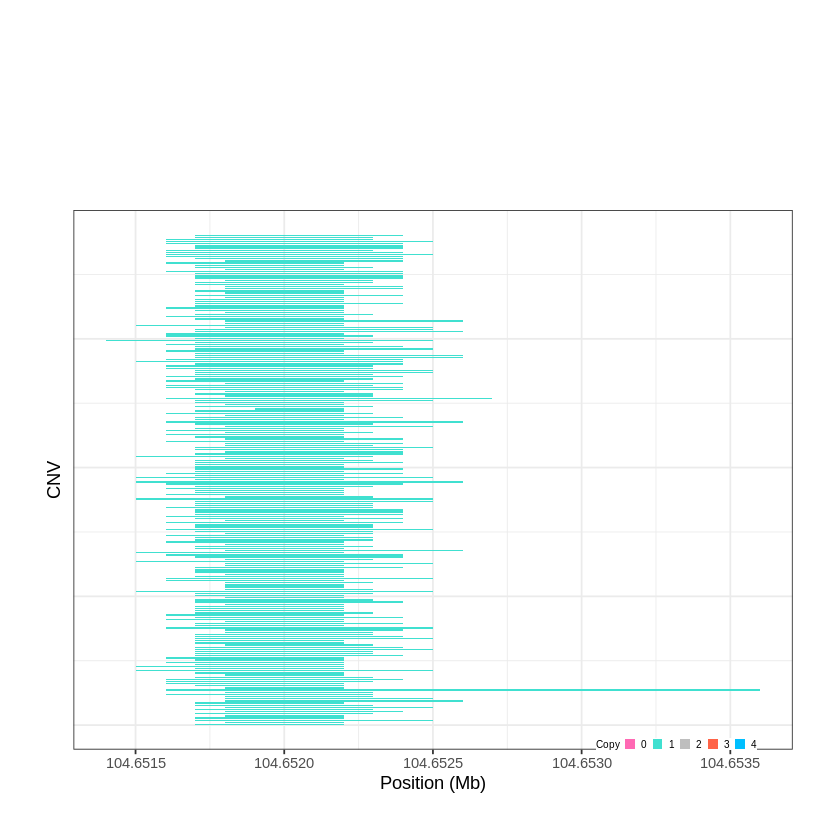

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1537..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 104.884501 - 105.6179 Mb with 277 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1538..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 105.621601 - 105.6281 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


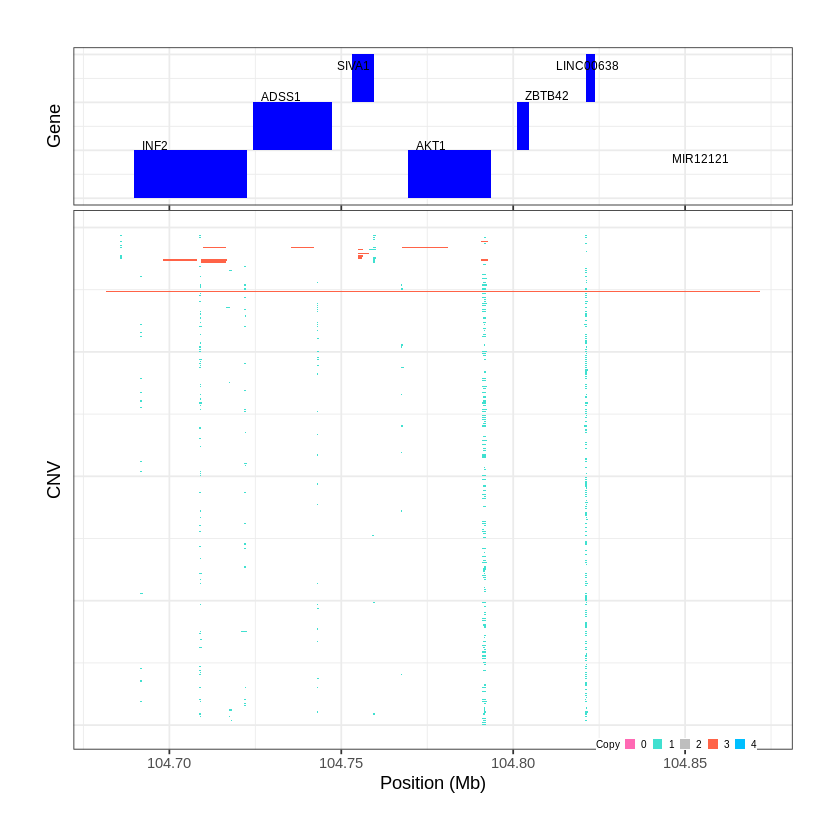

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1539..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 105.650601 - 105.6541 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


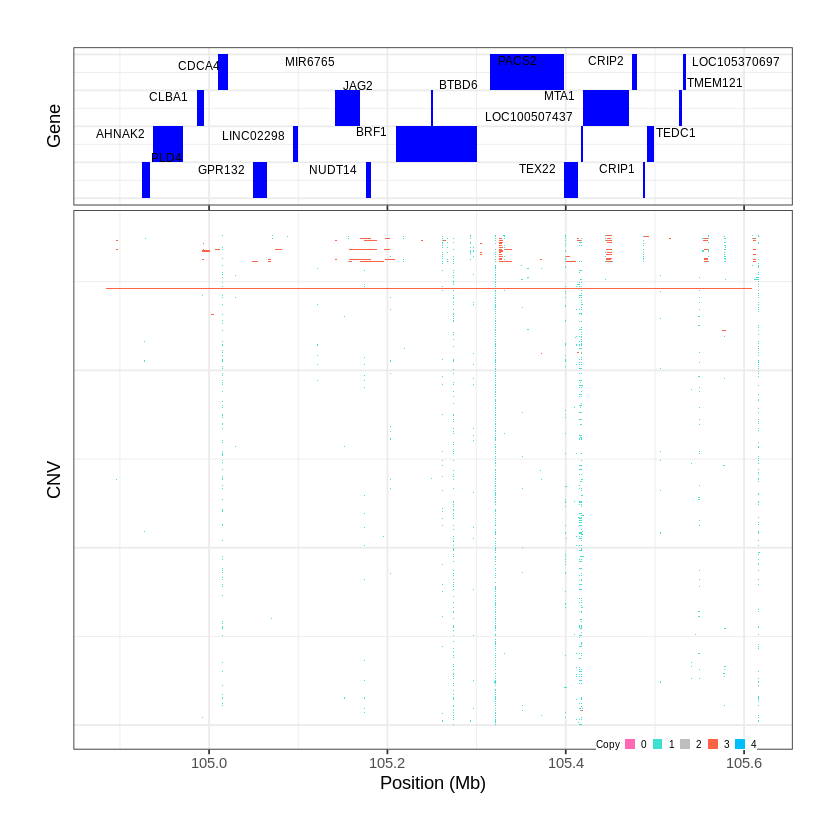

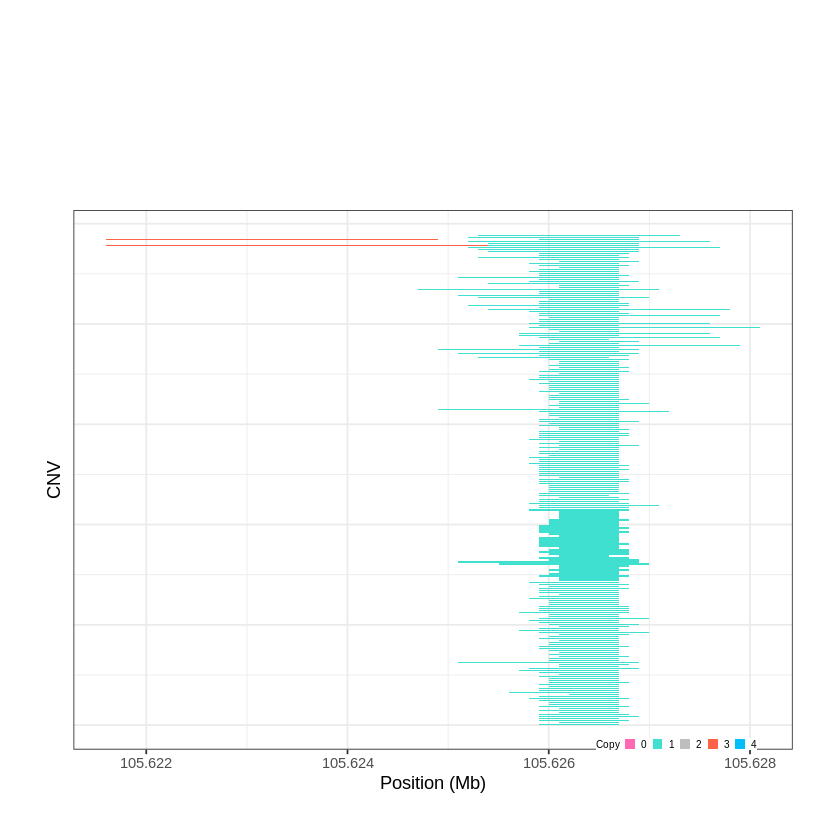

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1540..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 105.695701 - 105.8615 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1541..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 105.925401 - 105.9267 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


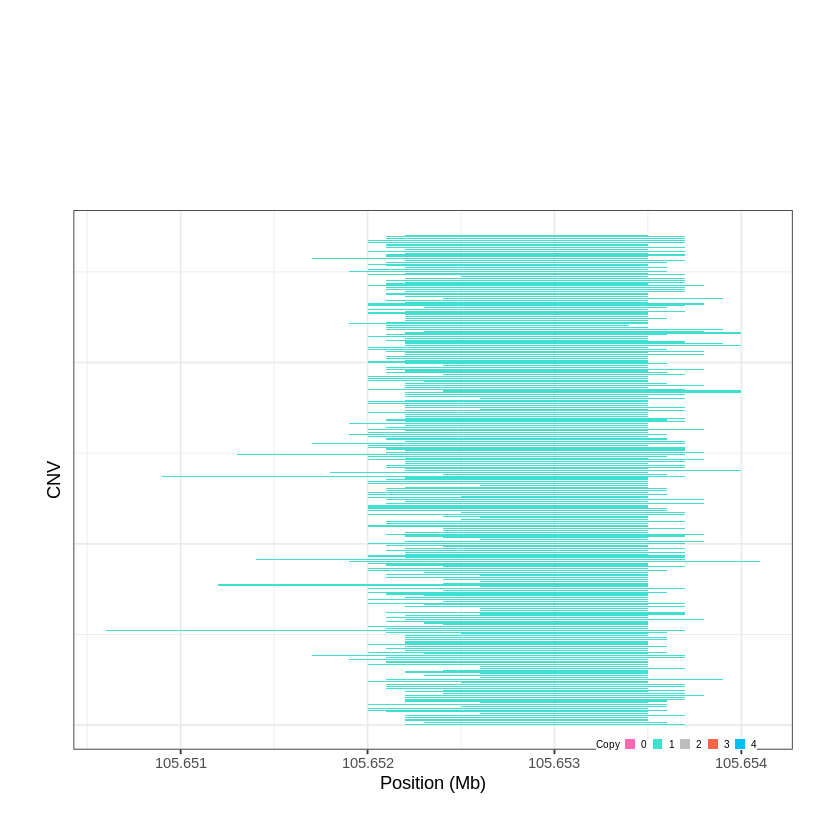

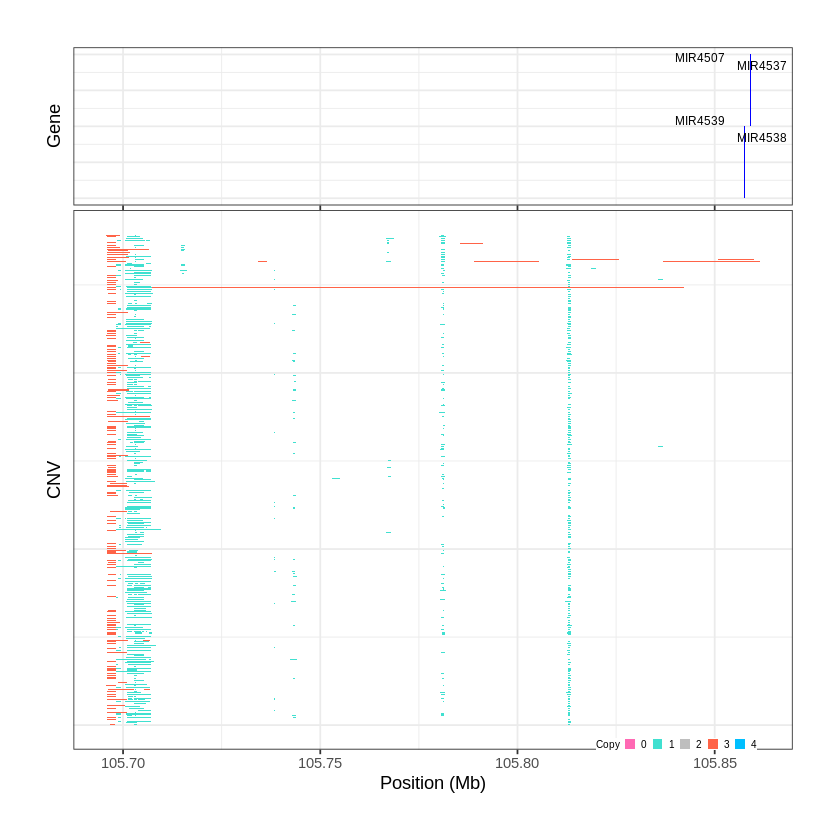

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1542..."
Input data passed requirment check...
[1] "CNV on Chromosome 14: 105.992101 - 107.3496 Mb with 279 Individual - "
Plotting gene...


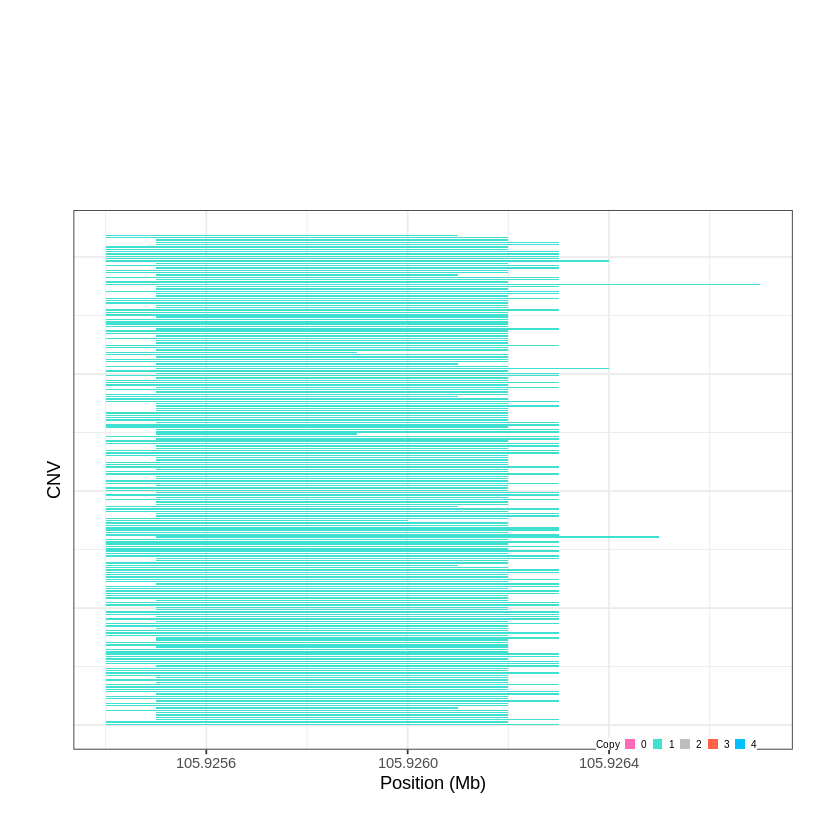

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1543..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 20.000001 - 23.6866 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 48 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


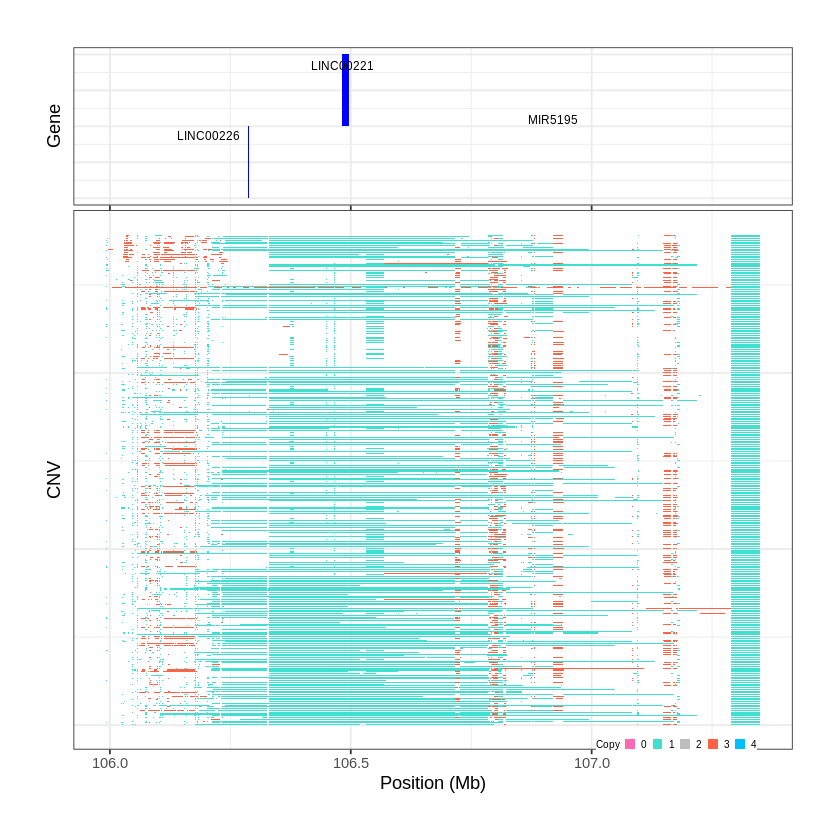

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1544..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 24.403901 - 24.794 Mb with 211 Individual - "
Plotting gene...


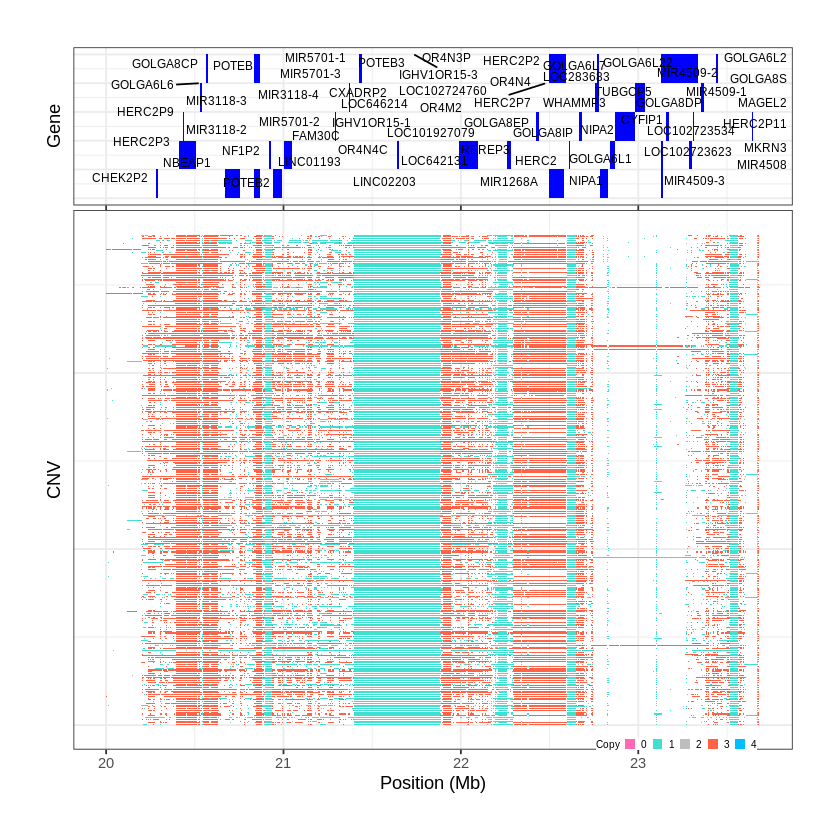

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1545..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 25.107001 - 25.1779 Mb with 198 Individual - "
Plotting gene...


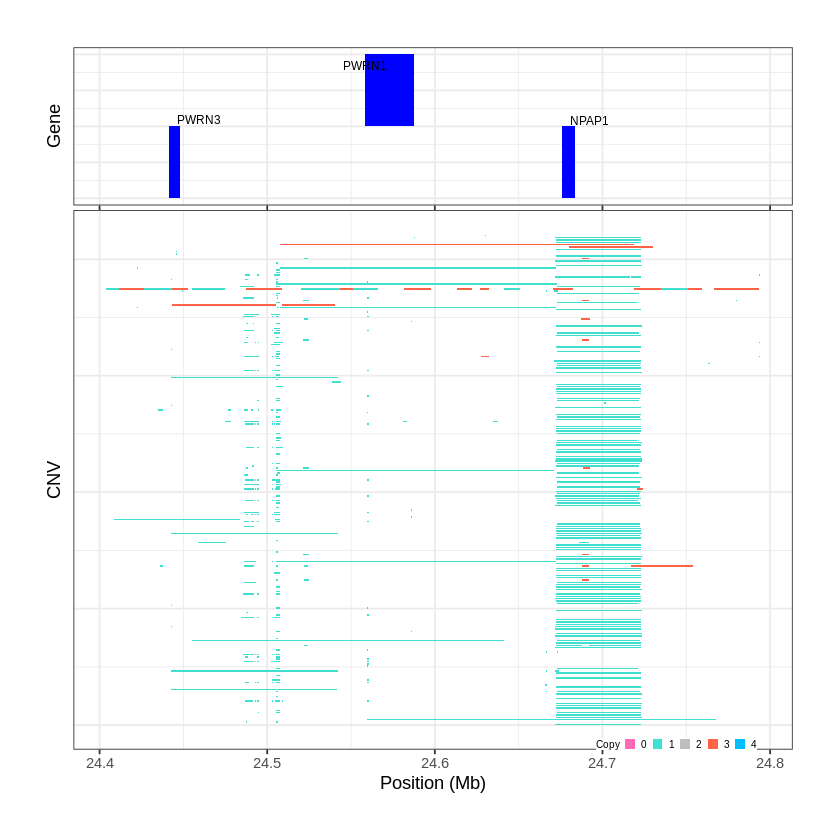

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1546..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 25.887901 - 26.0591 Mb with 195 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1547..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 26.954101 - 27.0438 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


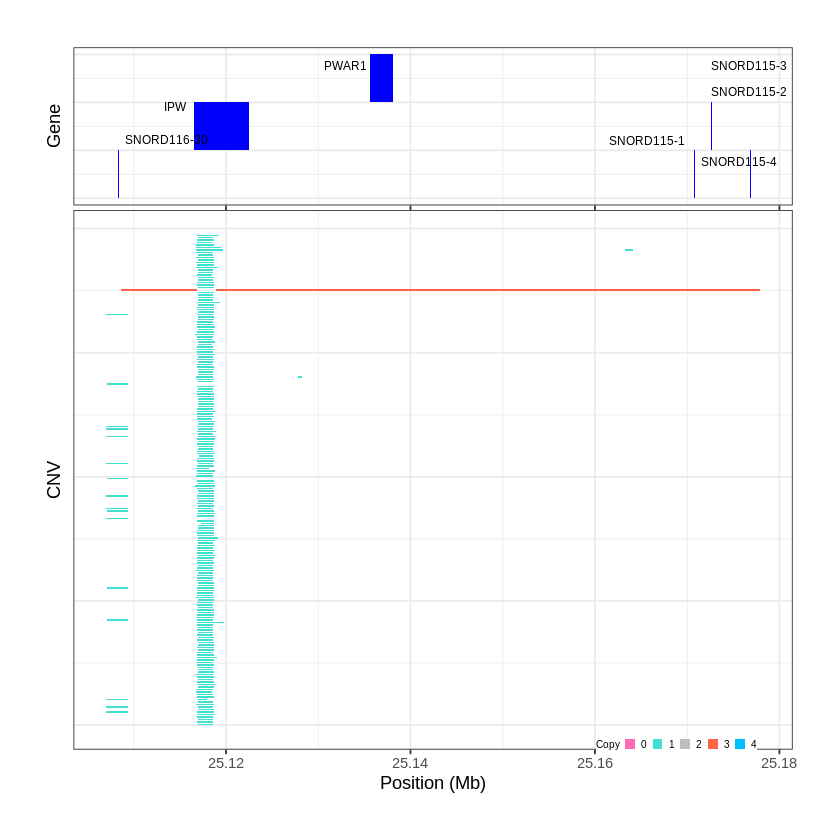

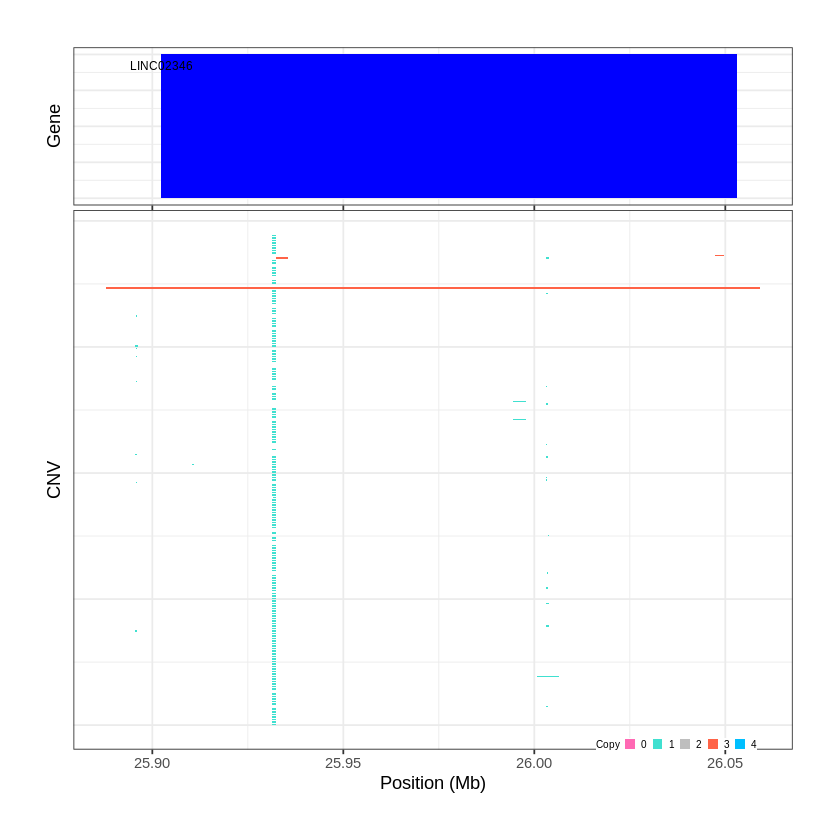

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1548..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 28.353101 - 28.9606 Mb with 279 Individual - "
Plotting gene...


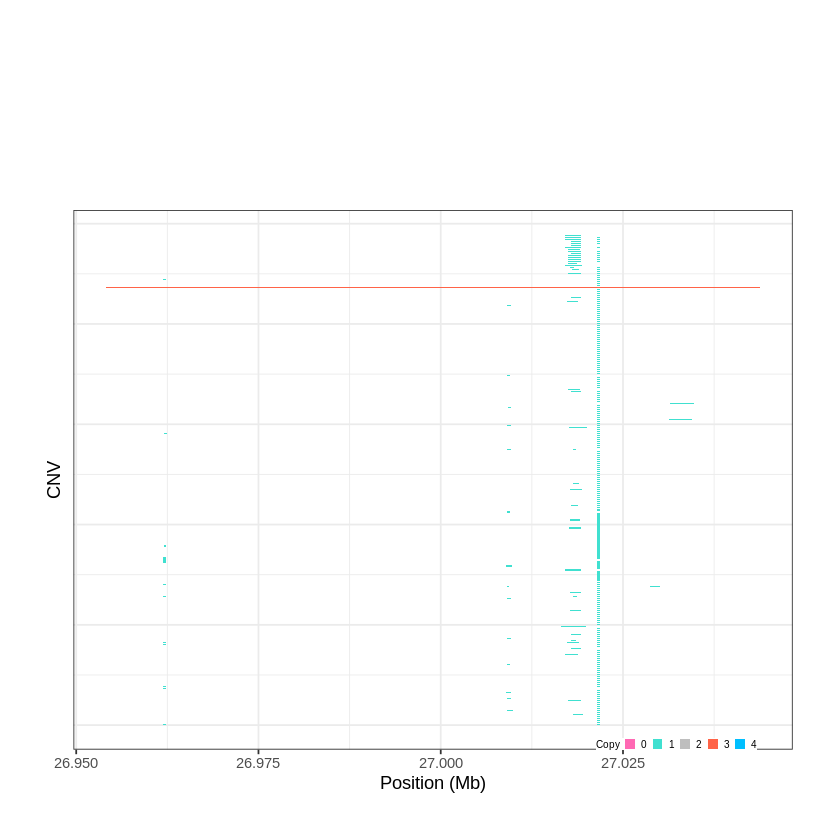

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1549..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 29.054201 - 29.3295 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1550..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 29.342501 - 29.5365 Mb with 174 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


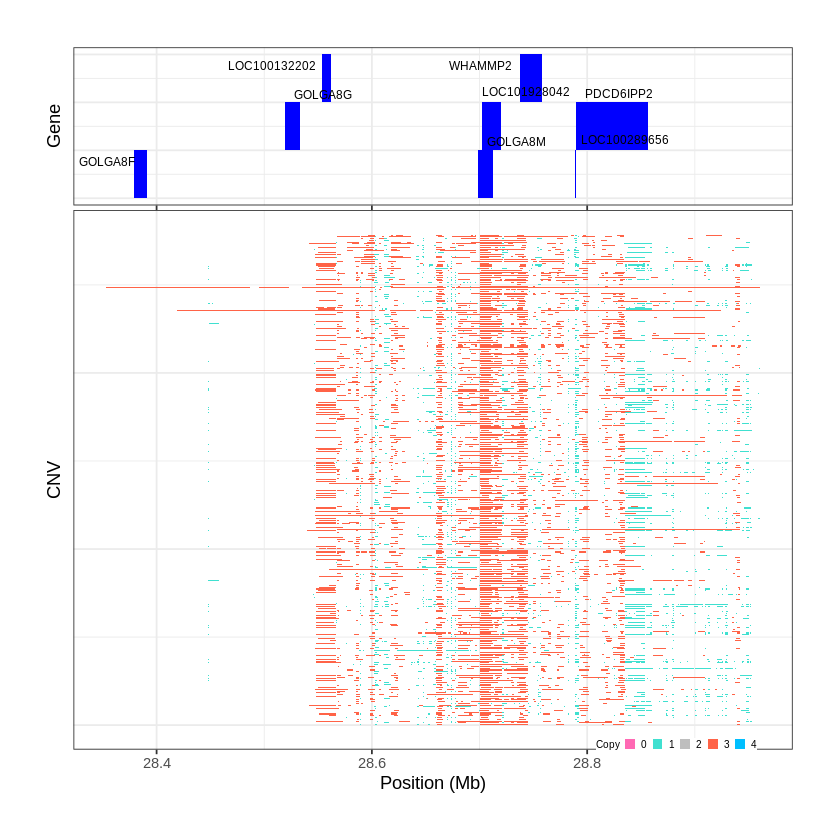

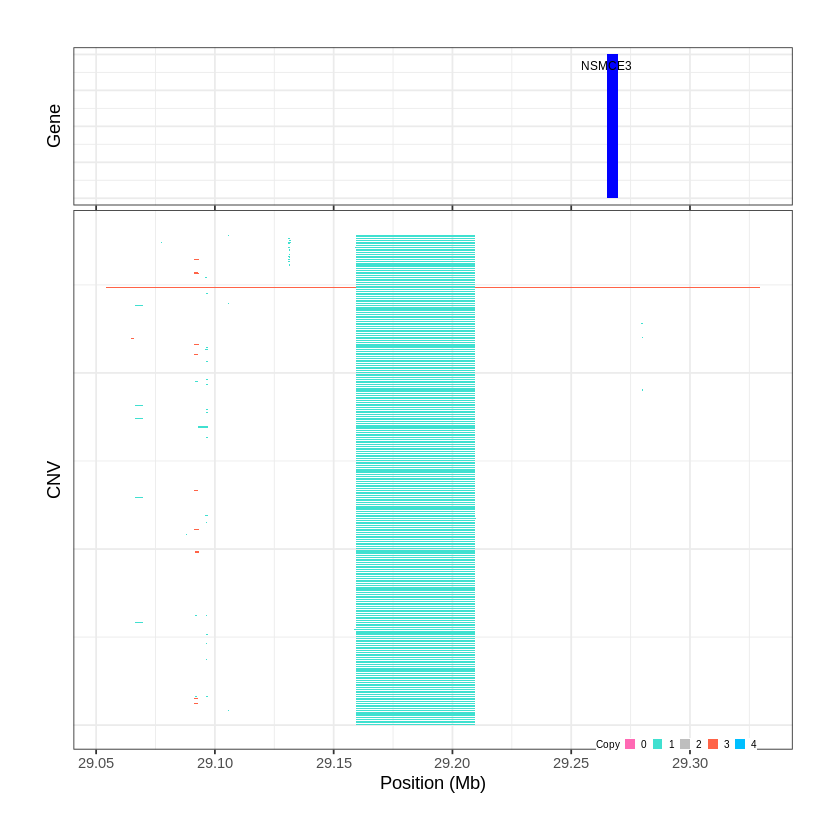

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1551..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 30.332001 - 32.9213 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 12 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


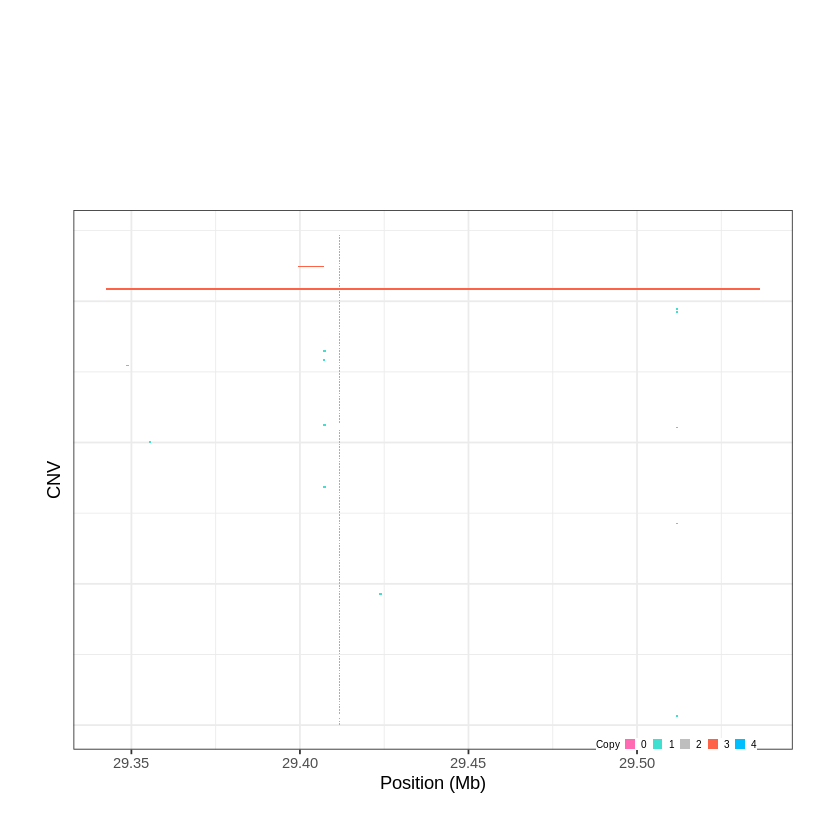

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1552..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 34.671201 - 34.8903 Mb with 251 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1553..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 35.944501 - 35.951 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


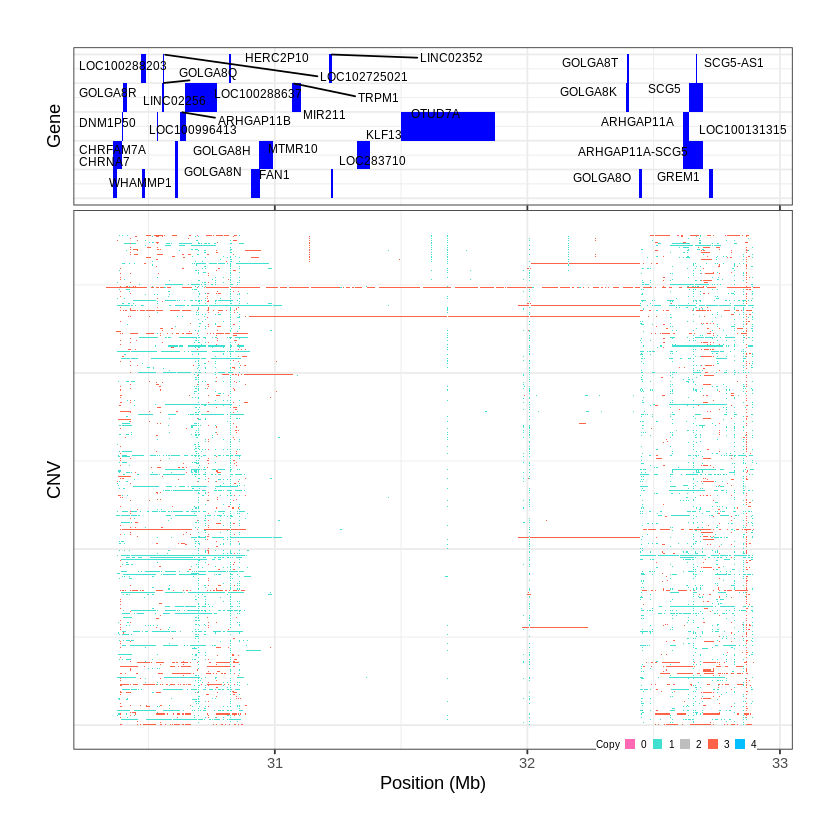

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1554..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 39.364401 - 39.3738 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


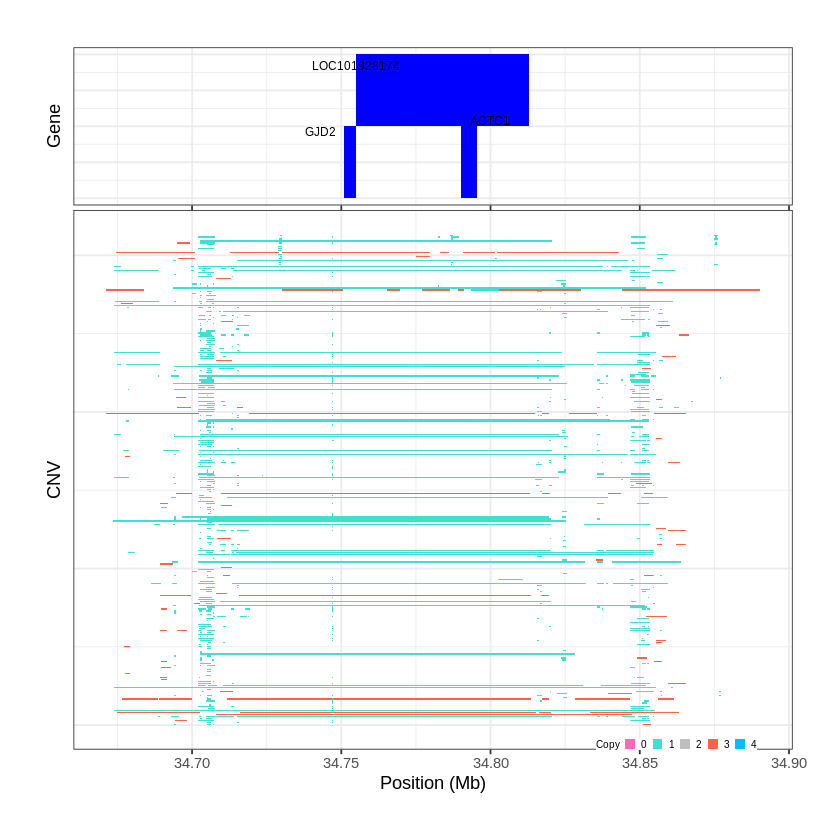

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1555..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 39.744401 - 39.756 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


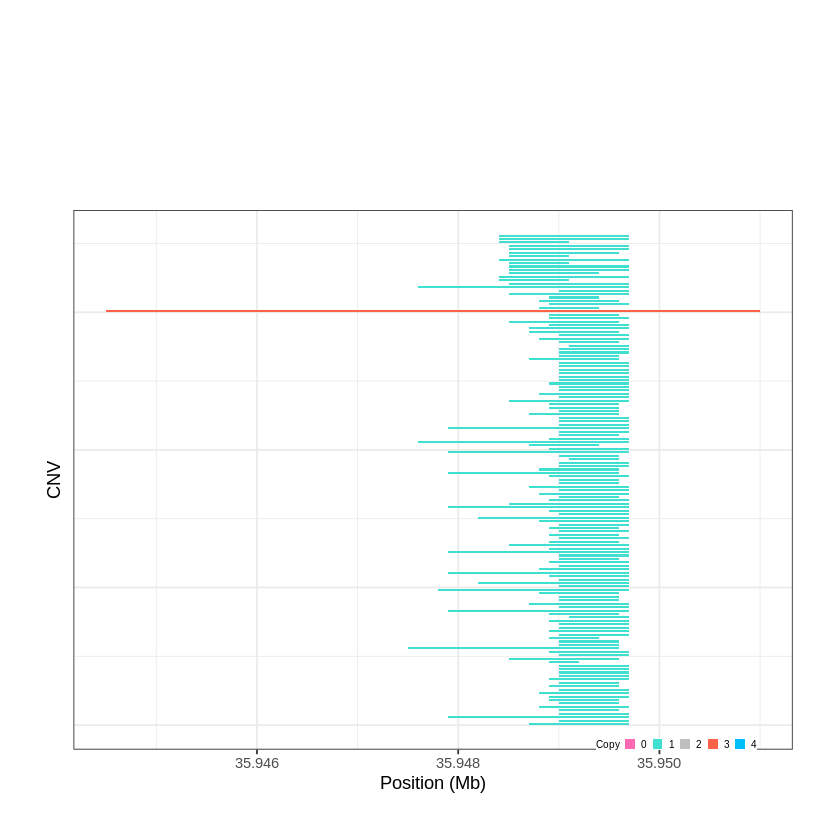

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1556..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 45.958501 - 45.9596 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


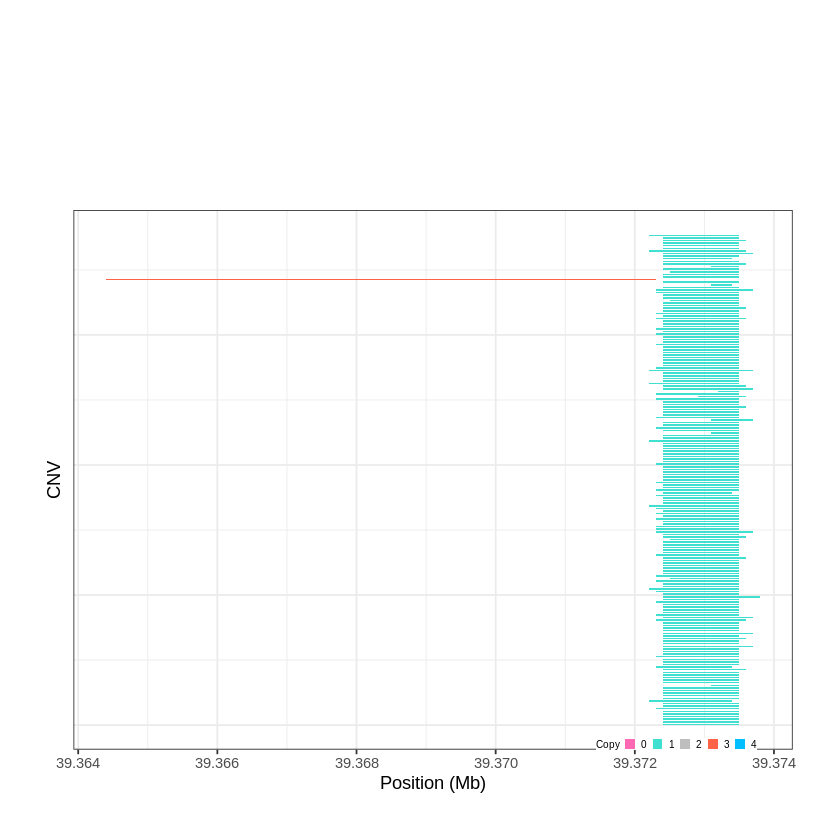

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1557..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 47.422801 - 47.4451 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


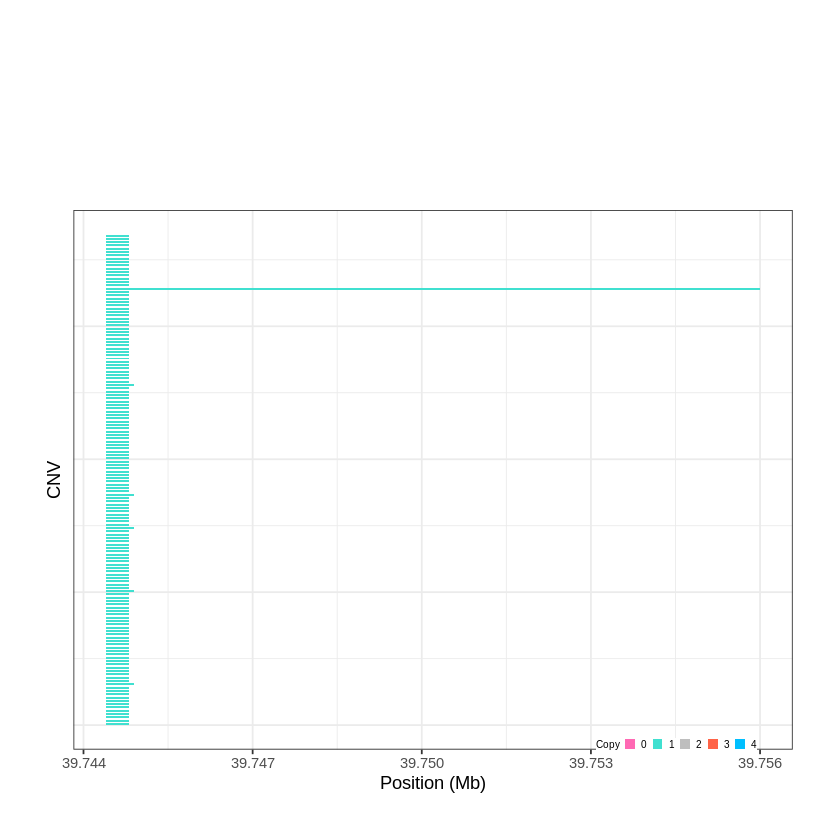

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1558..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 47.542201 - 47.6006 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


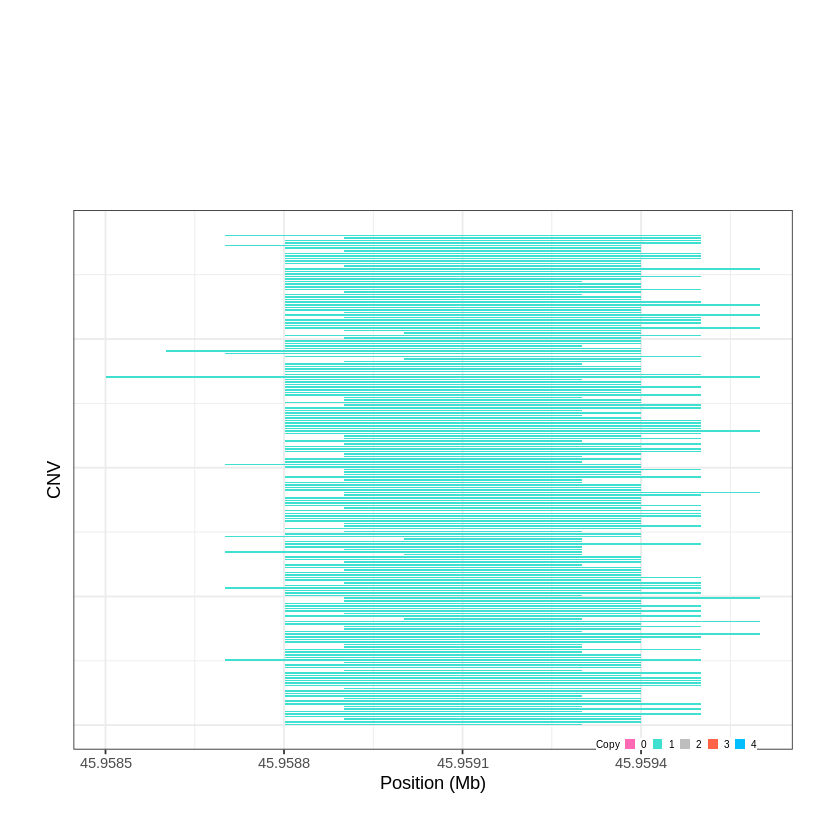

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1559..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 55.429901 - 55.4303 Mb with 182 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


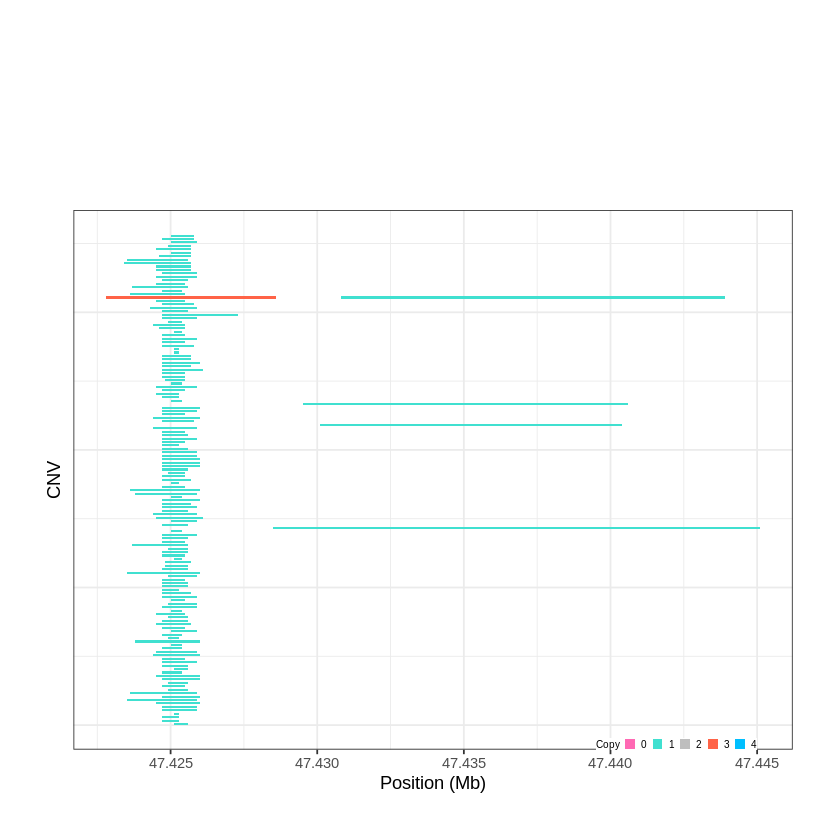

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1560..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 56.399501 - 56.4142 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


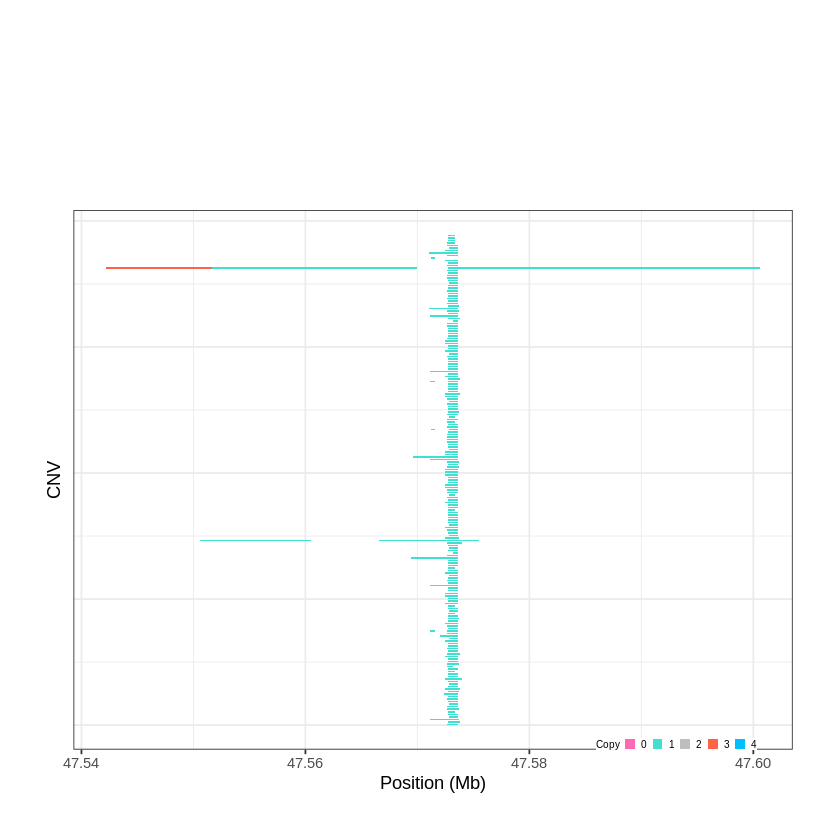

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1561..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 57.978901 - 57.9826 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


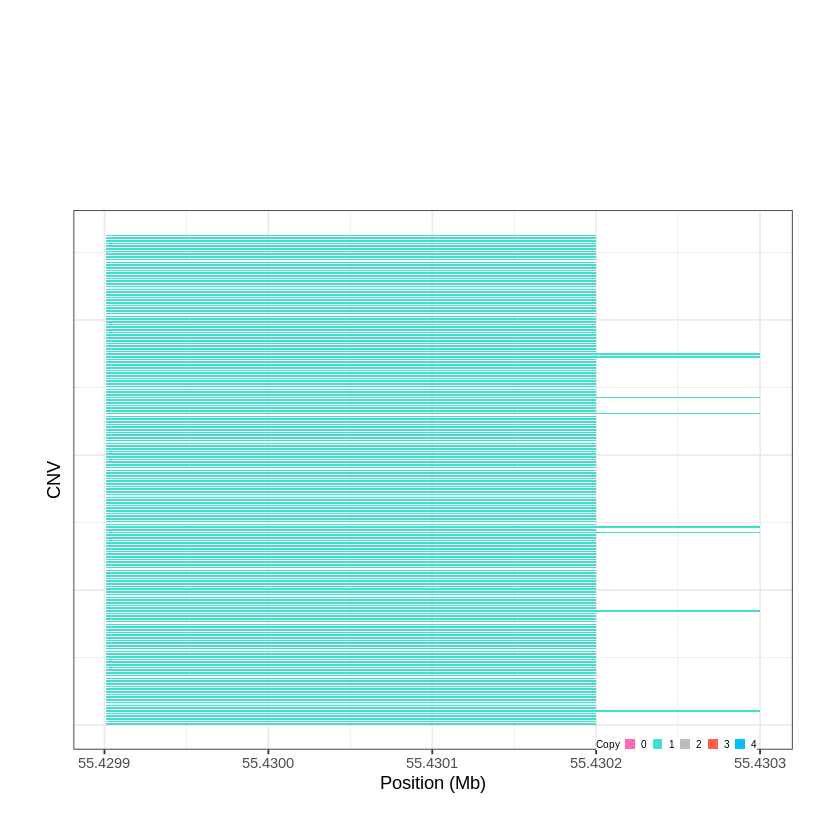

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1562..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 59.892101 - 59.9038 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


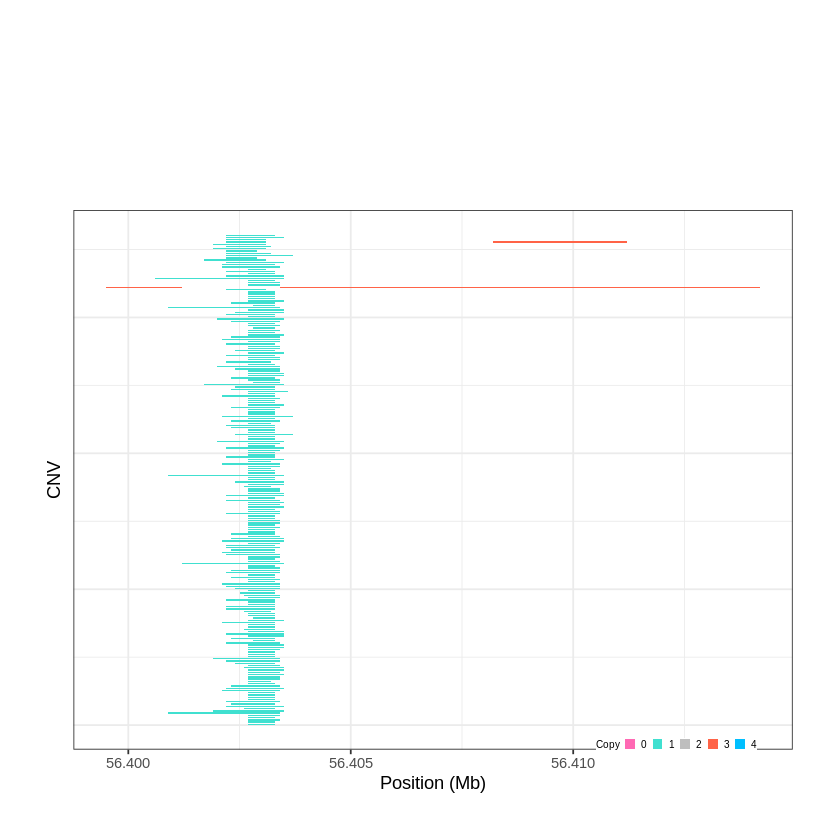

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1563..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 61.221601 - 61.2466 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


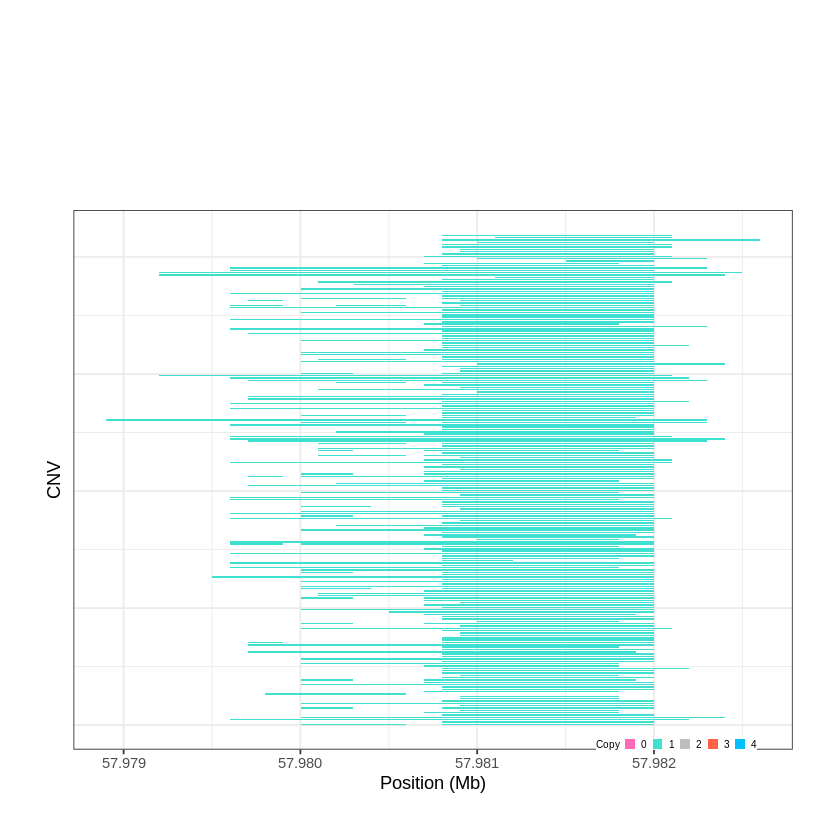

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1564..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 61.363101 - 61.3643 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


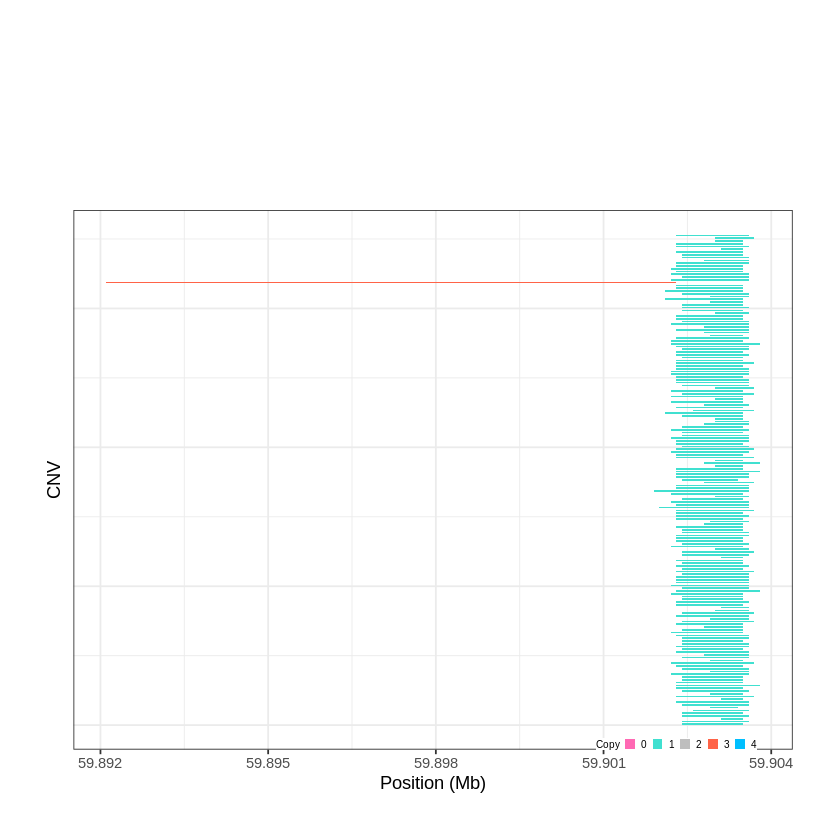

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1565..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 64.624401 - 64.6357 Mb with 226 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


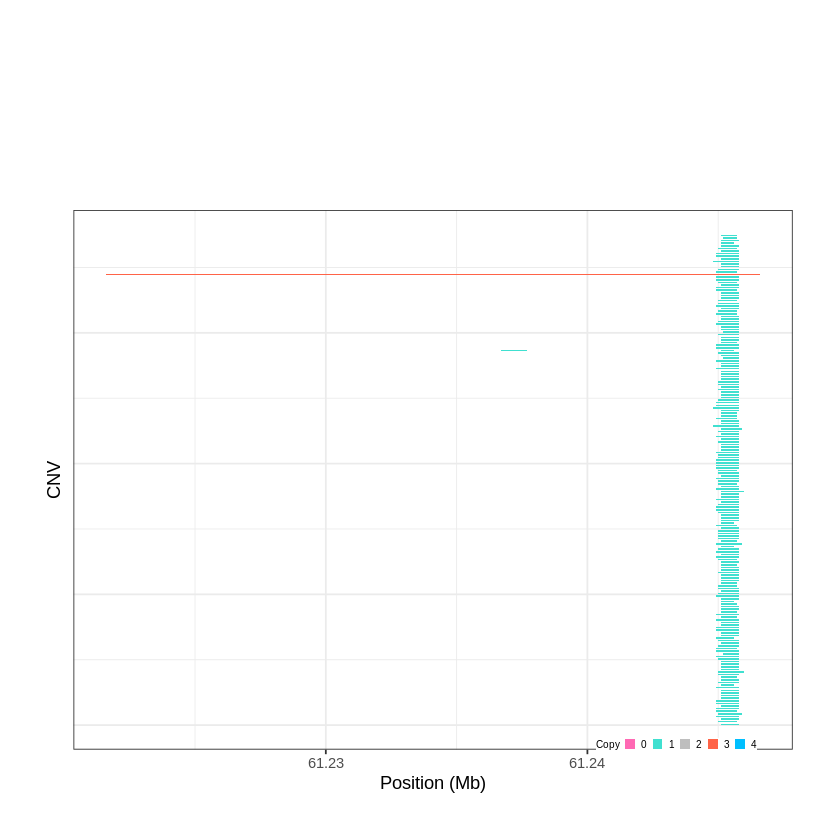

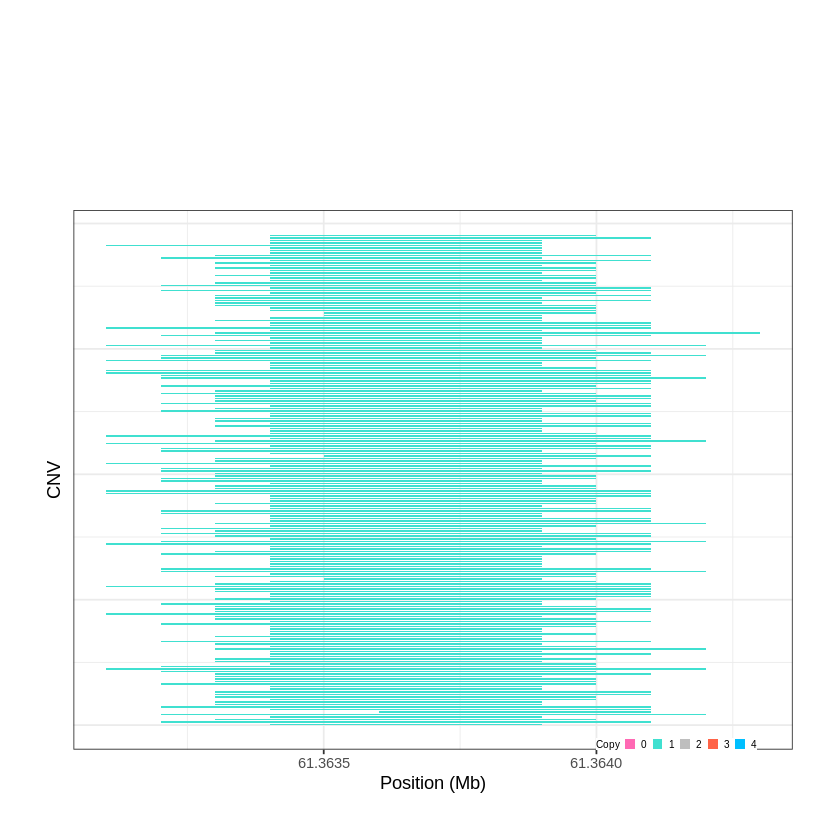

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1566..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 66.834001 - 67.2145 Mb with 157 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1567..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 67.227401 - 67.4856 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


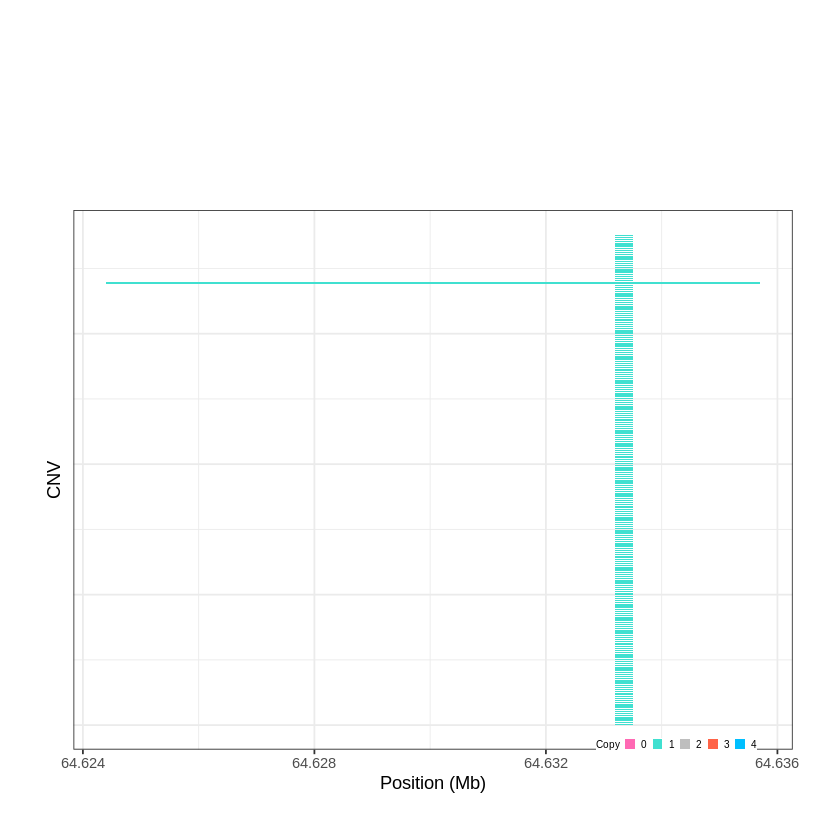

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1568..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 68.395401 - 68.4397 Mb with 265 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


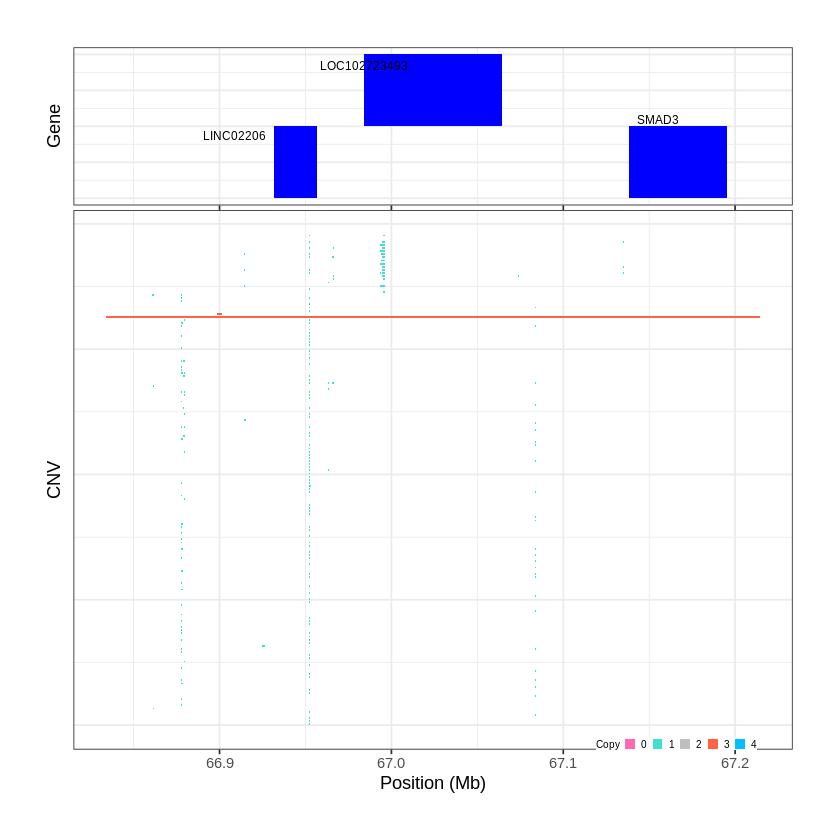

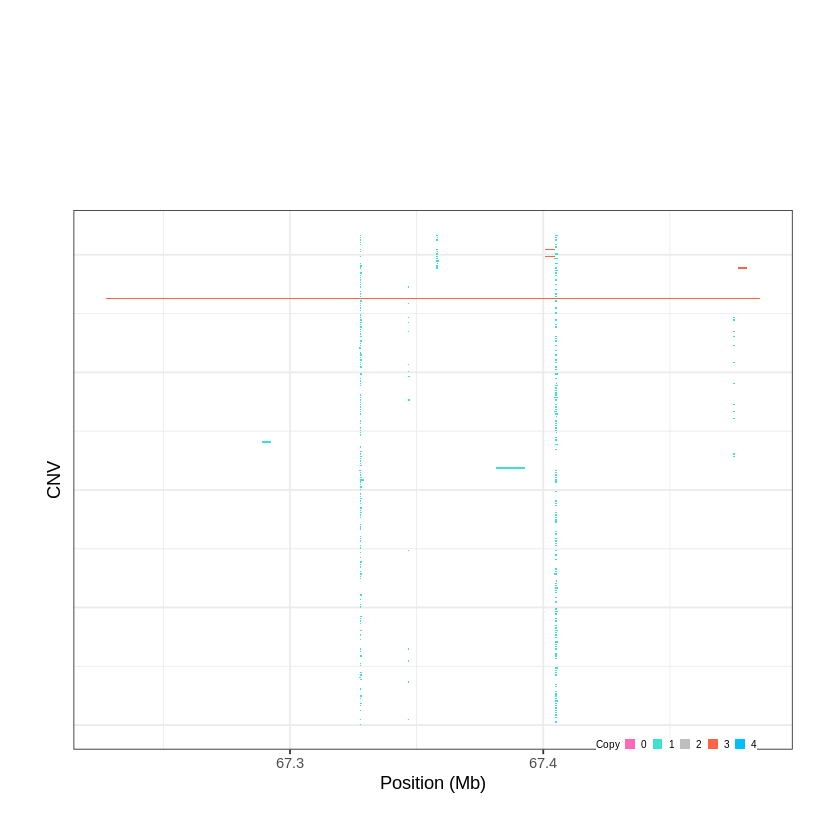

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1569..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 71.468901 - 71.7147 Mb with 222 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1570..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 72.016201 - 72.0178 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


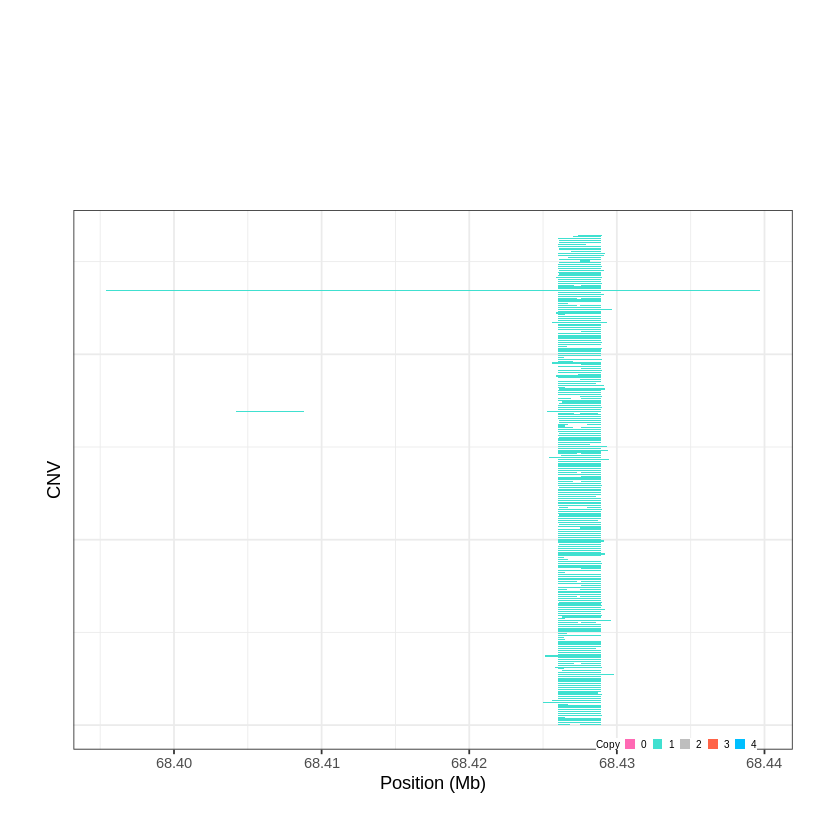

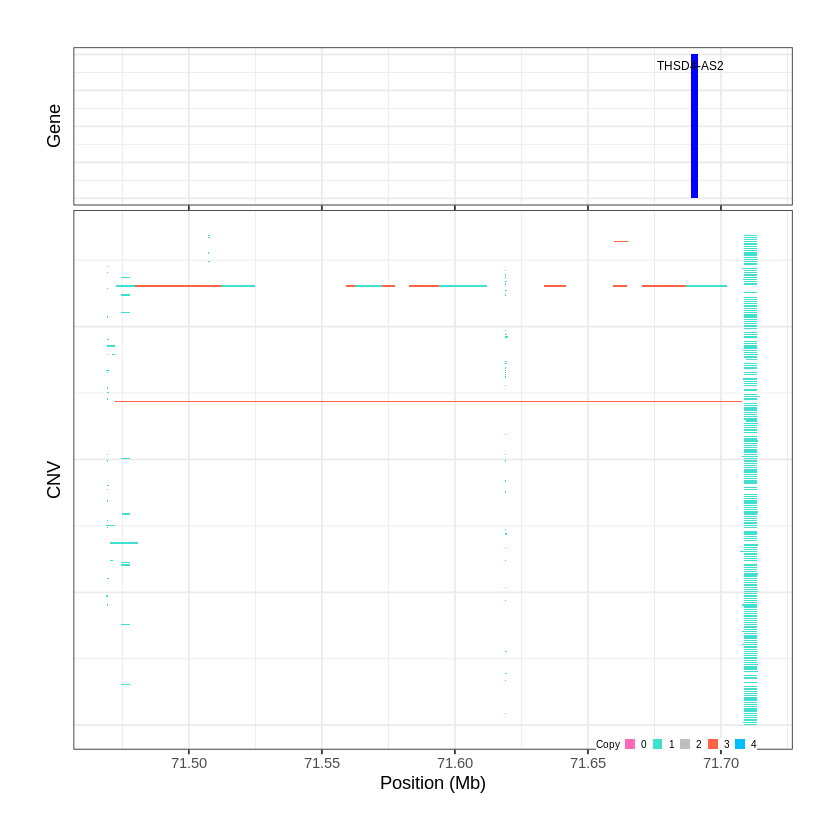

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1571..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 72.358801 - 72.6411 Mb with 199 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1572..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 72.883601 - 72.9891 Mb with 272 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


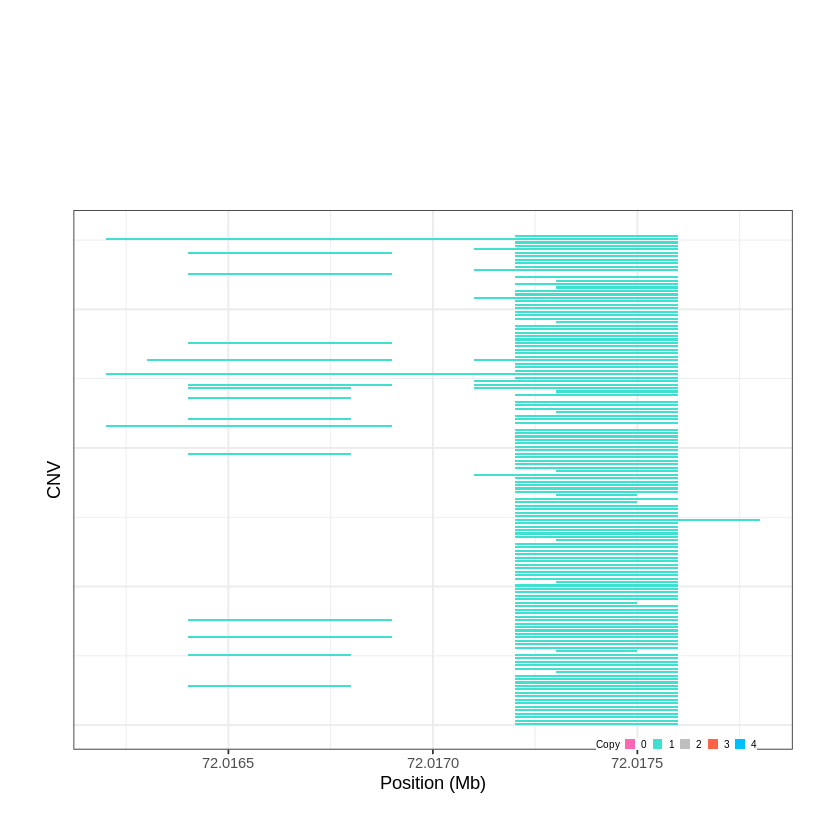

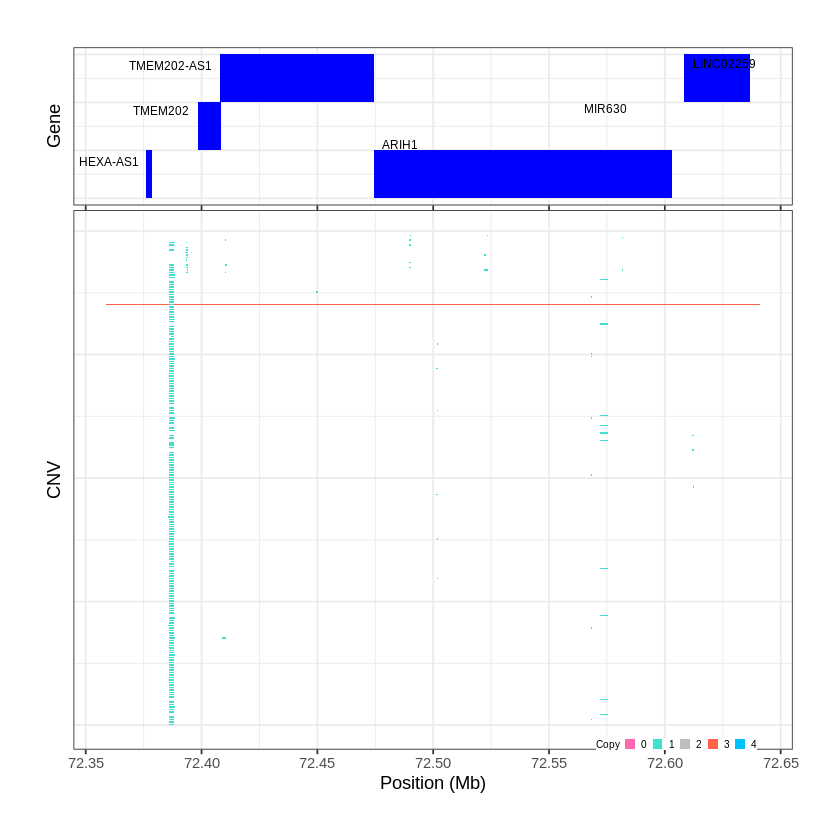

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1573..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 74.263001 - 74.3974 Mb with 271 Individual - "
Plotting gene...


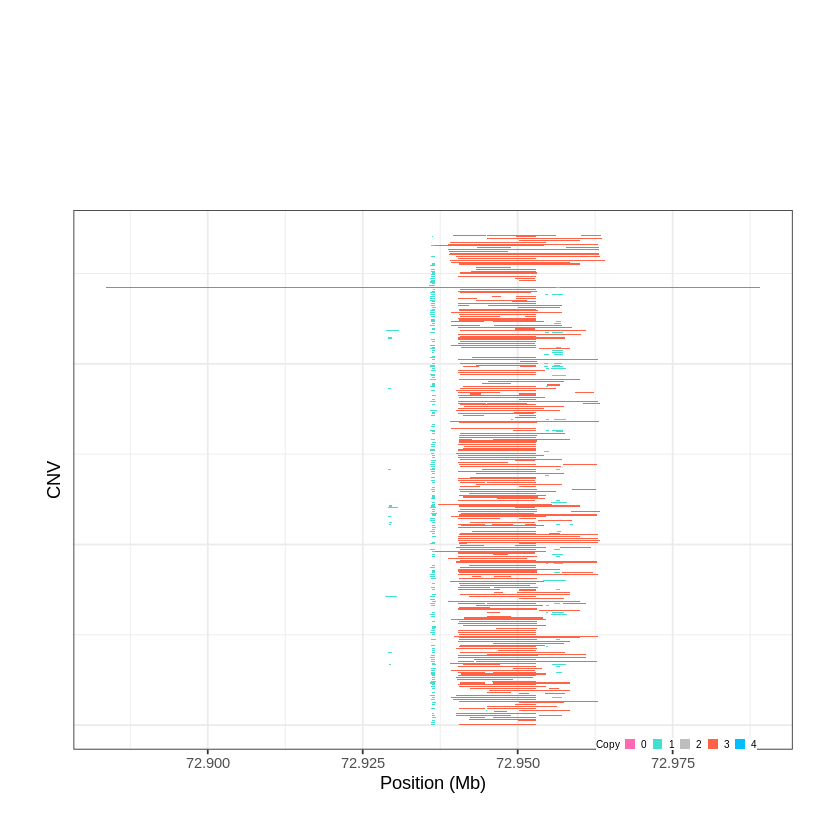

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1574..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 75.544301 - 75.6803 Mb with 268 Individual - "
Plotting gene...


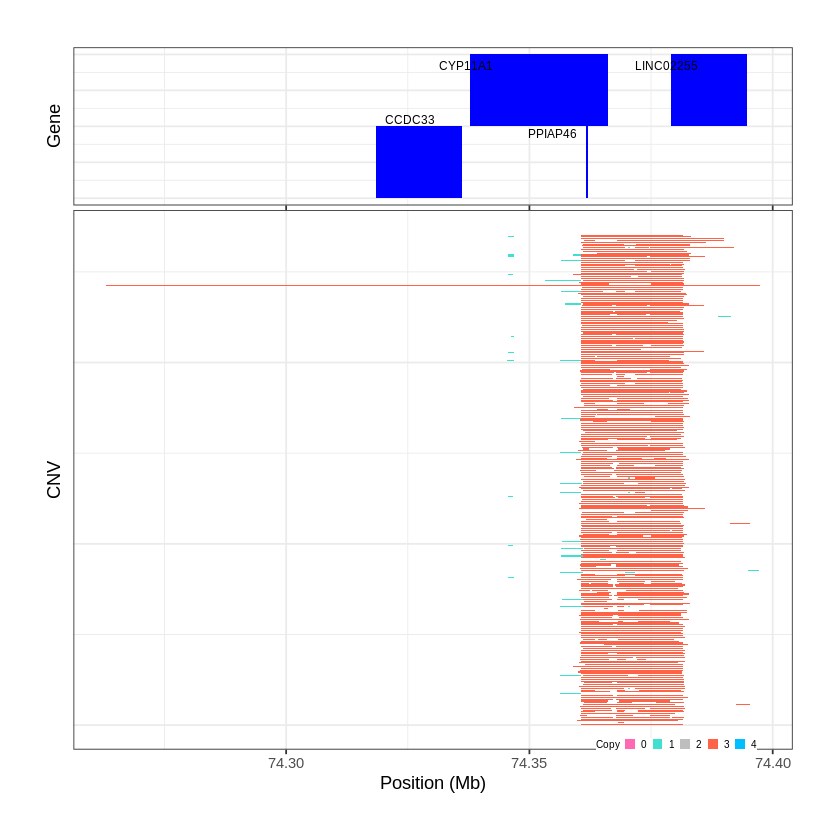

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1575..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 75.762301 - 76.0987 Mb with 218 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1576..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 76.883801 - 76.9006 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


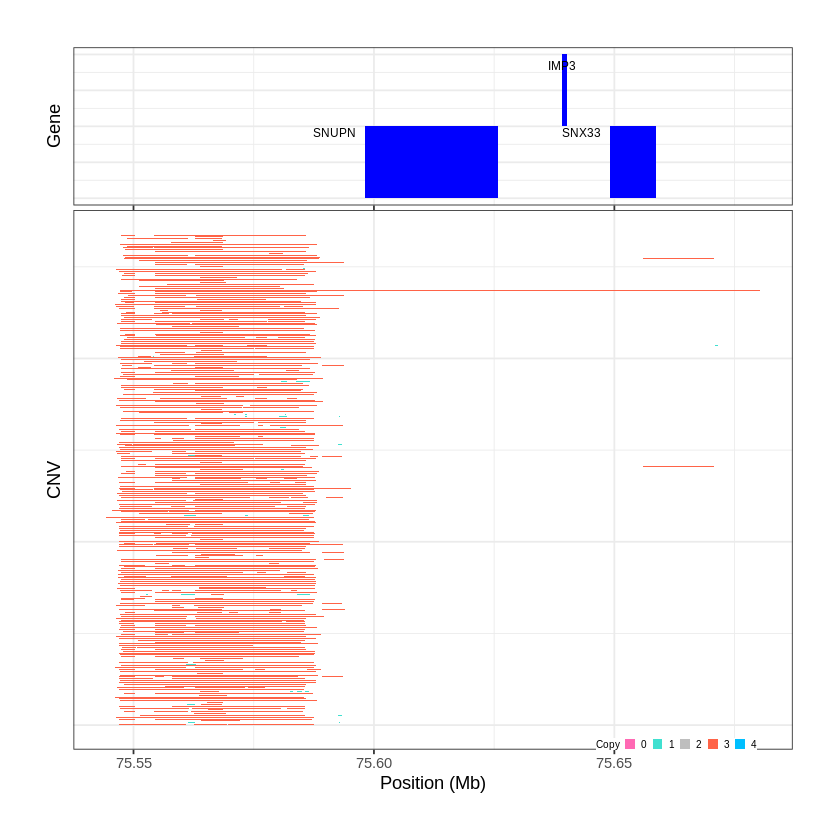

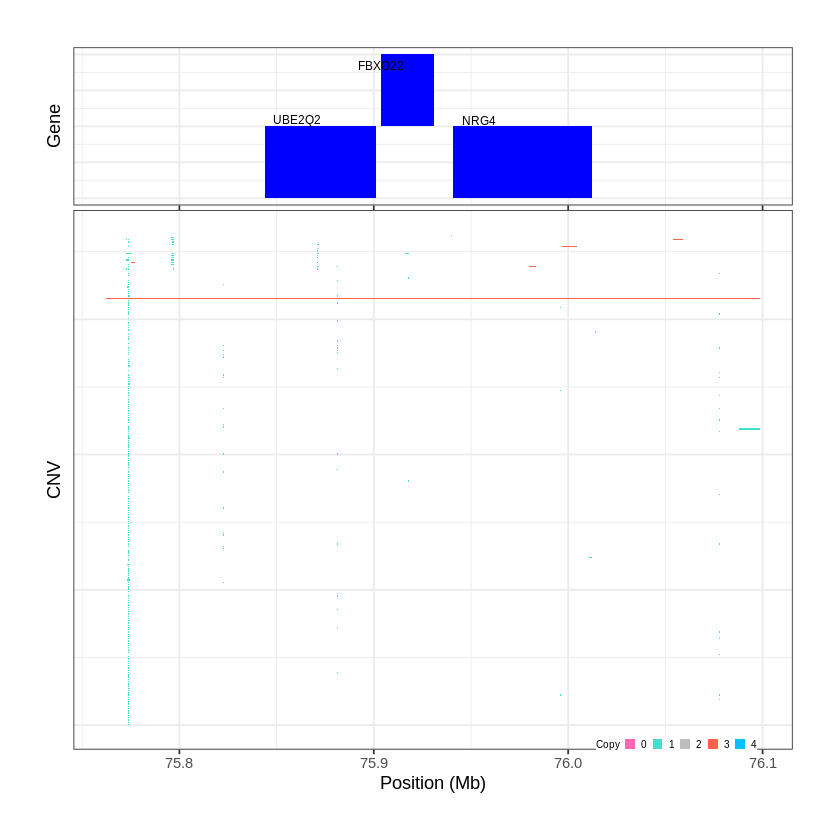

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1577..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 77.180901 - 77.3331 Mb with 193 Individual - "
Plotting gene...


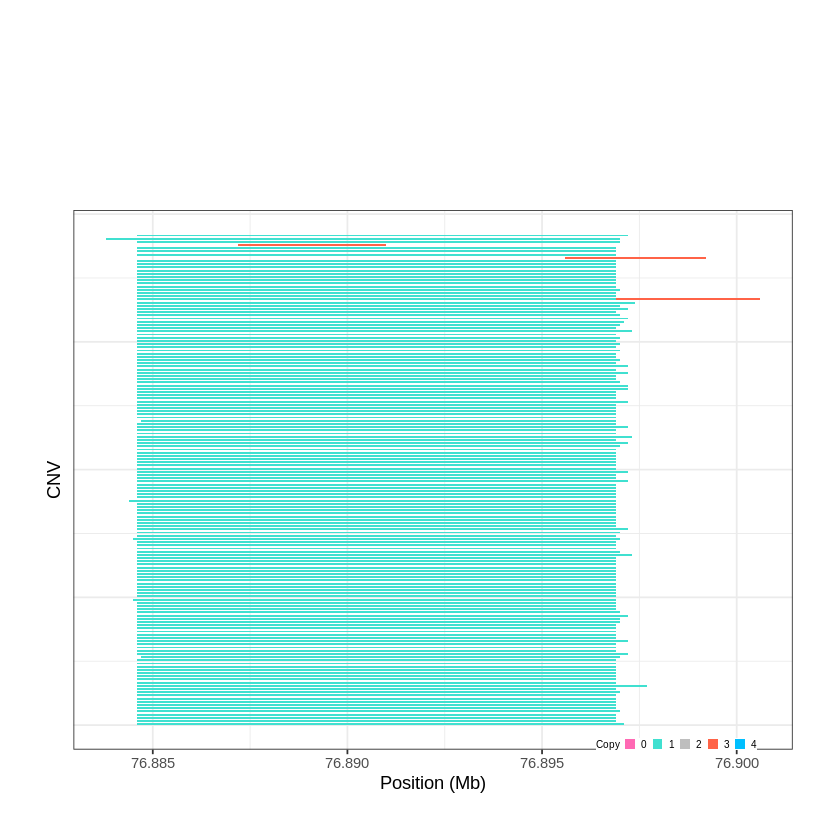

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1578..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 77.786201 - 78.3349 Mb with 201 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1579..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 79.013201 - 79.1812 Mb with 177 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


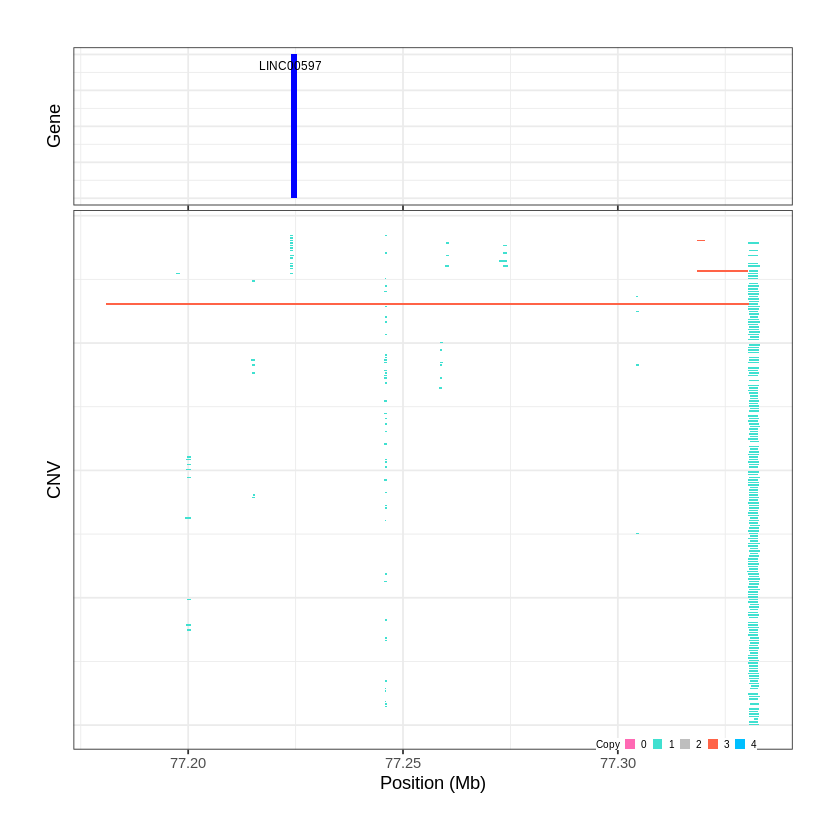

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1580..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 79.722401 - 79.7332 Mb with 257 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


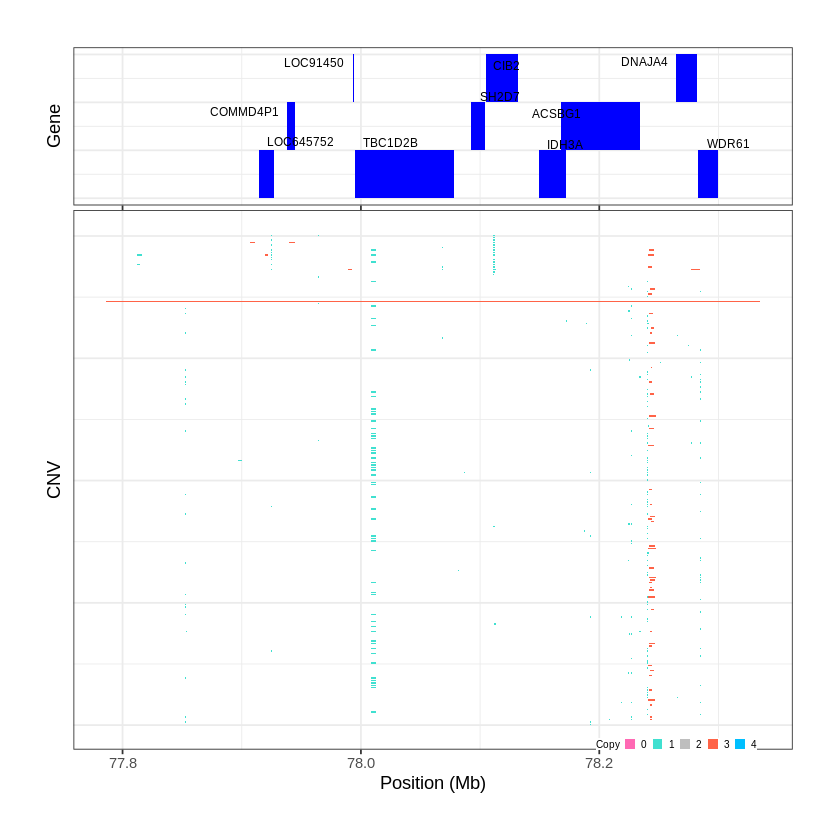

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1581..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 80.282001 - 80.3784 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


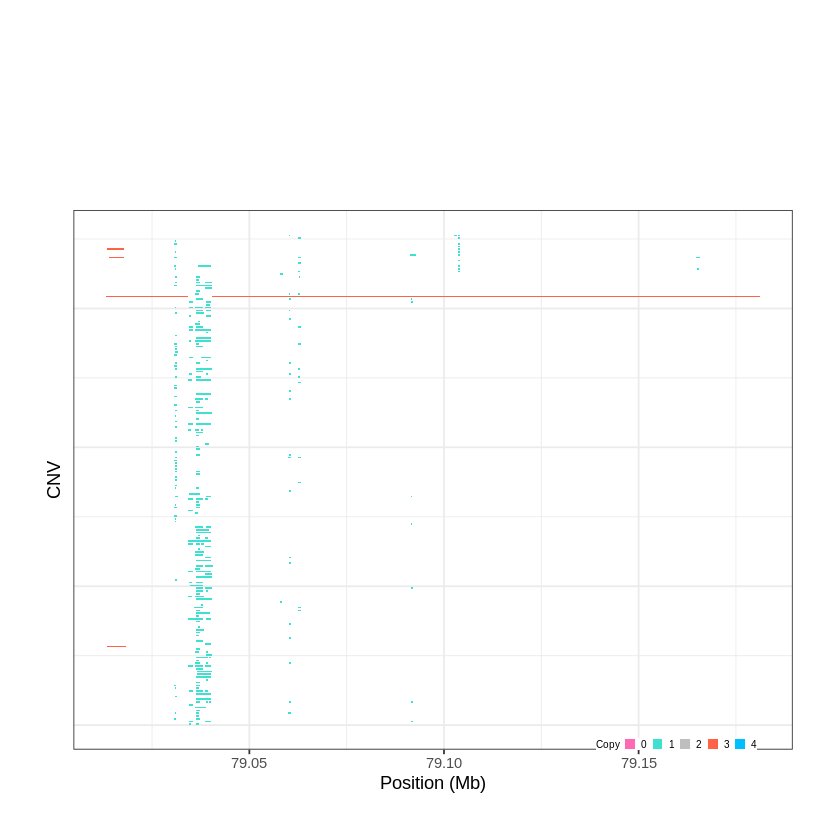

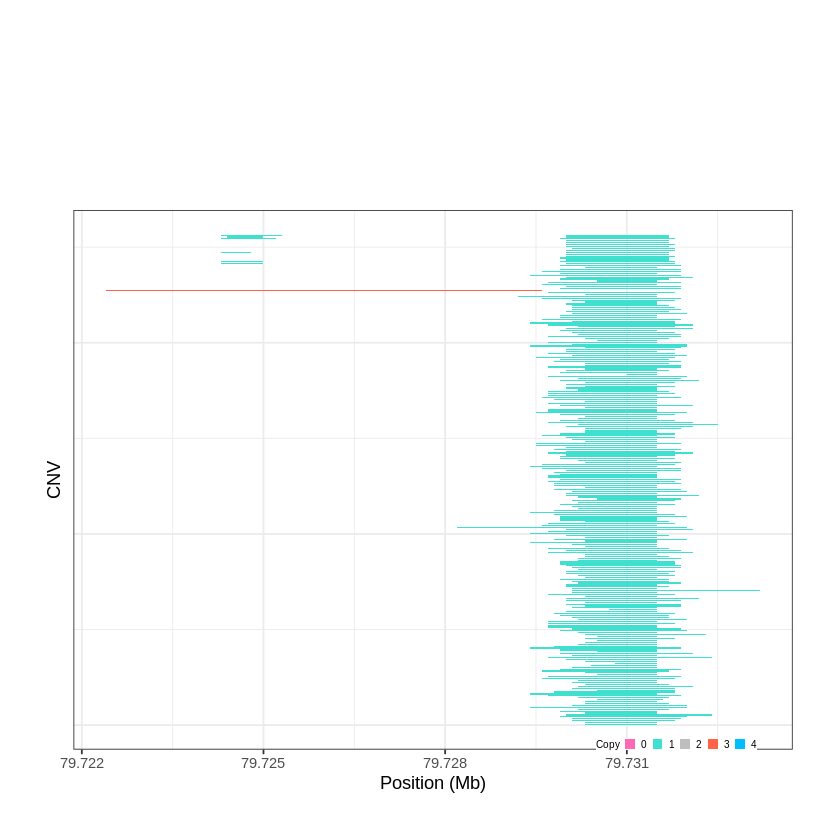

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1582..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 82.575501 - 83.2174 Mb with 279 Individual - "
Plotting gene...


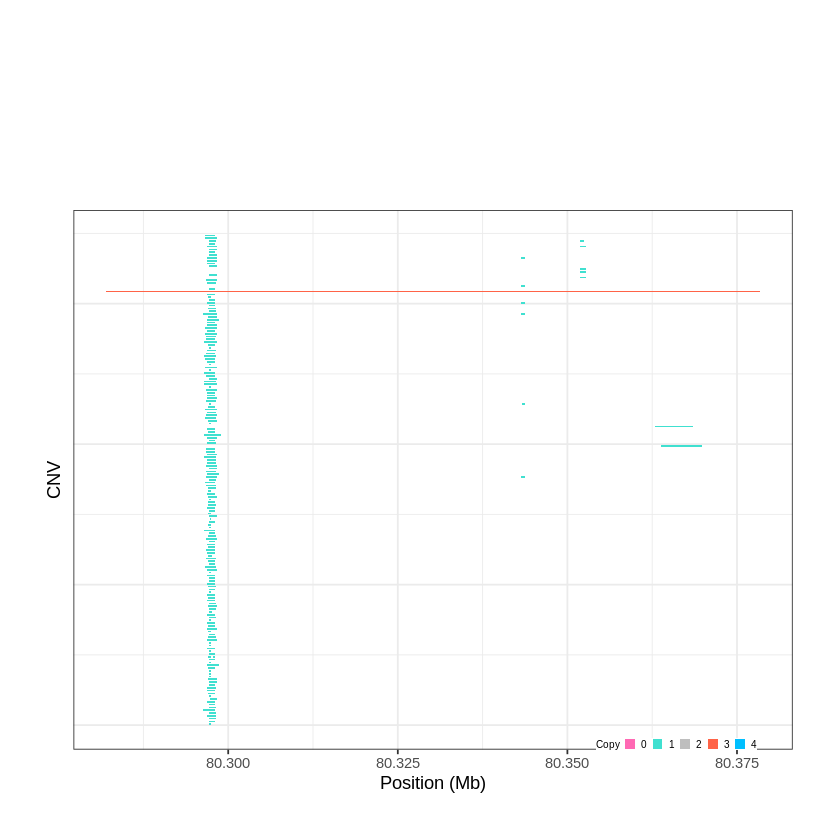

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1583..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 84.704701 - 85.1033 Mb with 279 Individual - "
Plotting gene...


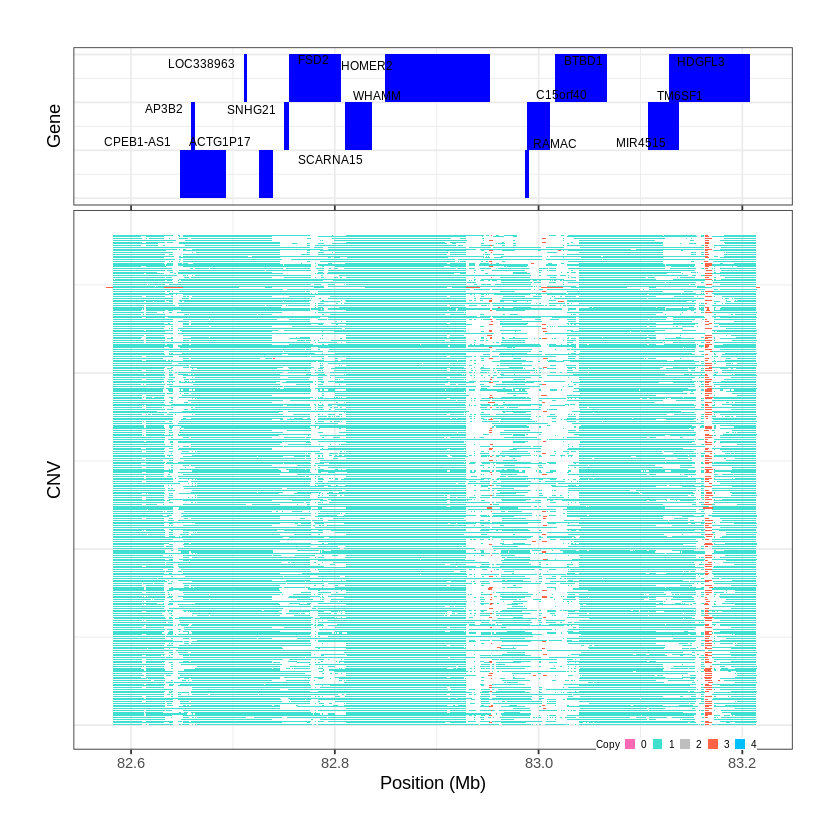

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1584..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 85.674701 - 85.817 Mb with 279 Individual - "
Plotting gene...


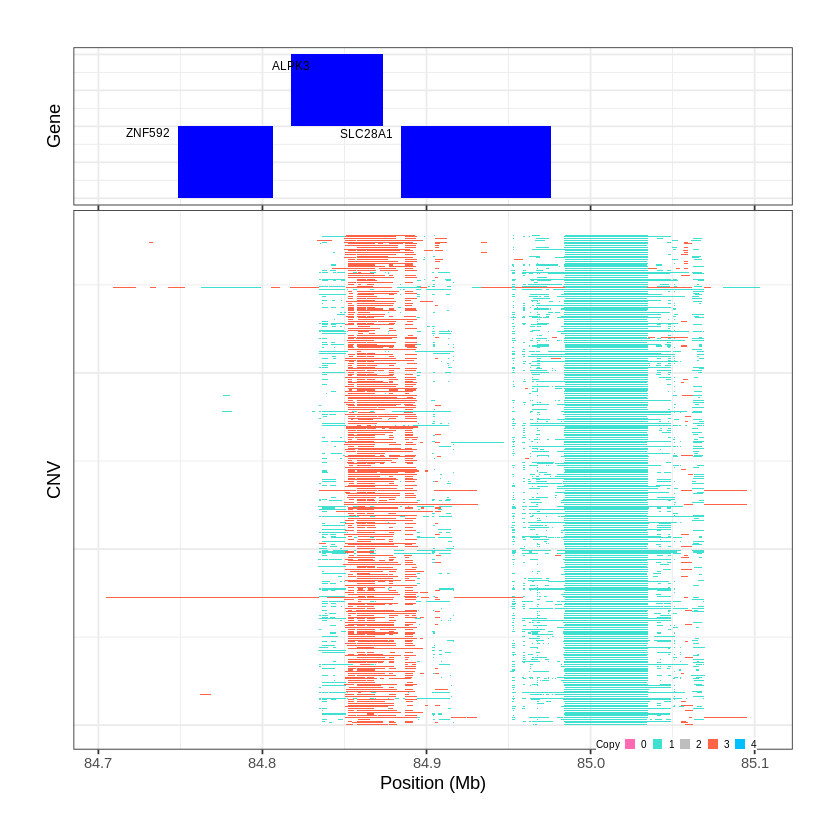

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1585..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 86.928801 - 86.9636 Mb with 182 Individual - "
Plotting gene...


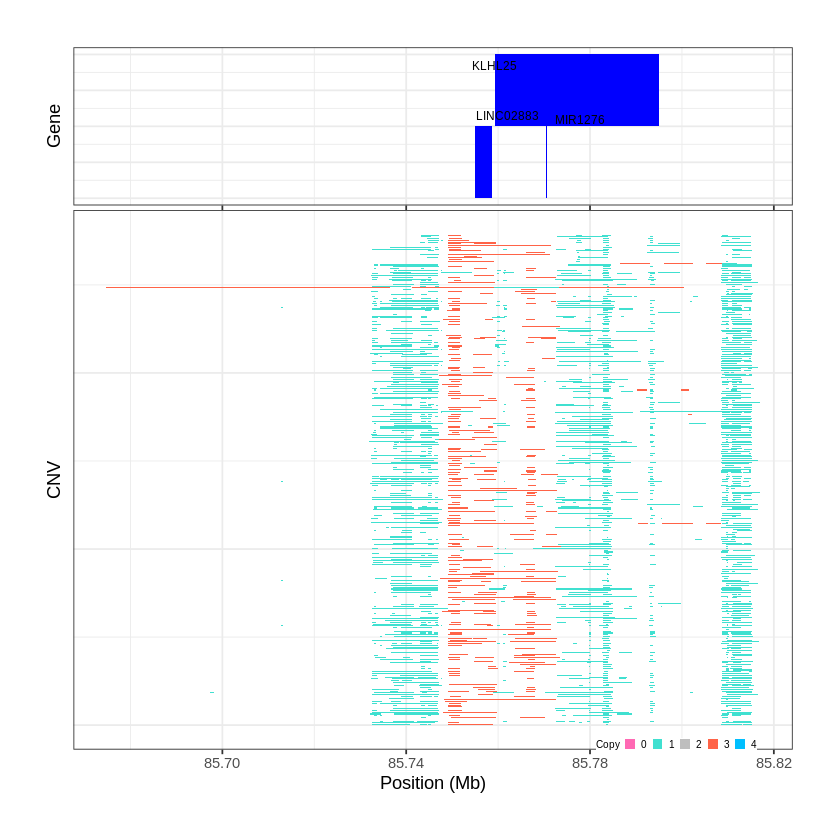

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1586..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 89.082701 - 89.2891 Mb with 197 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1587..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 91.981101 - 91.9989 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


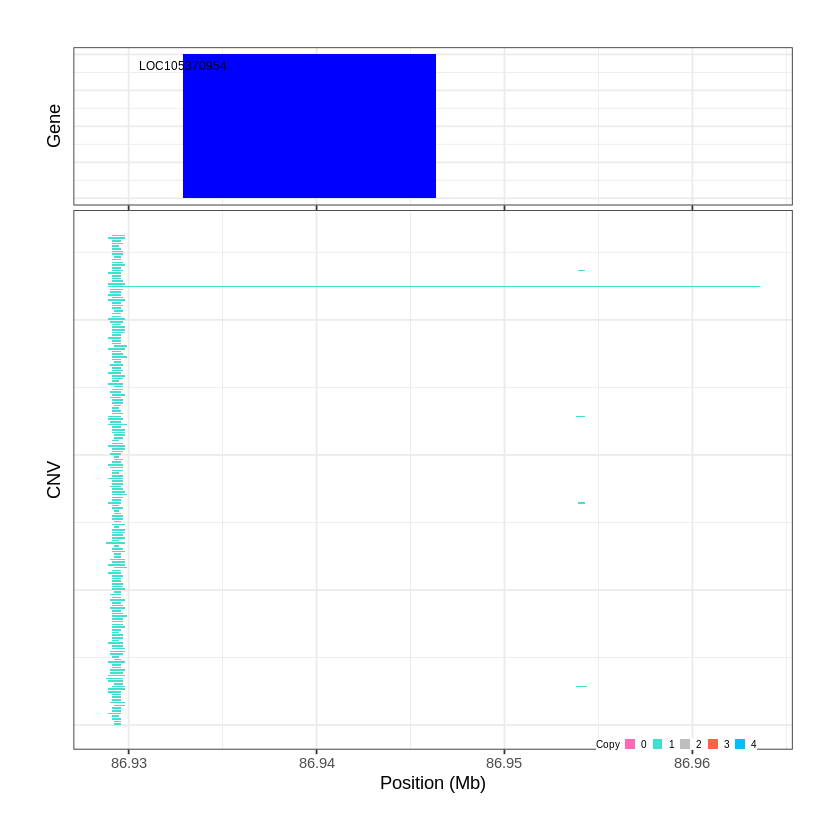

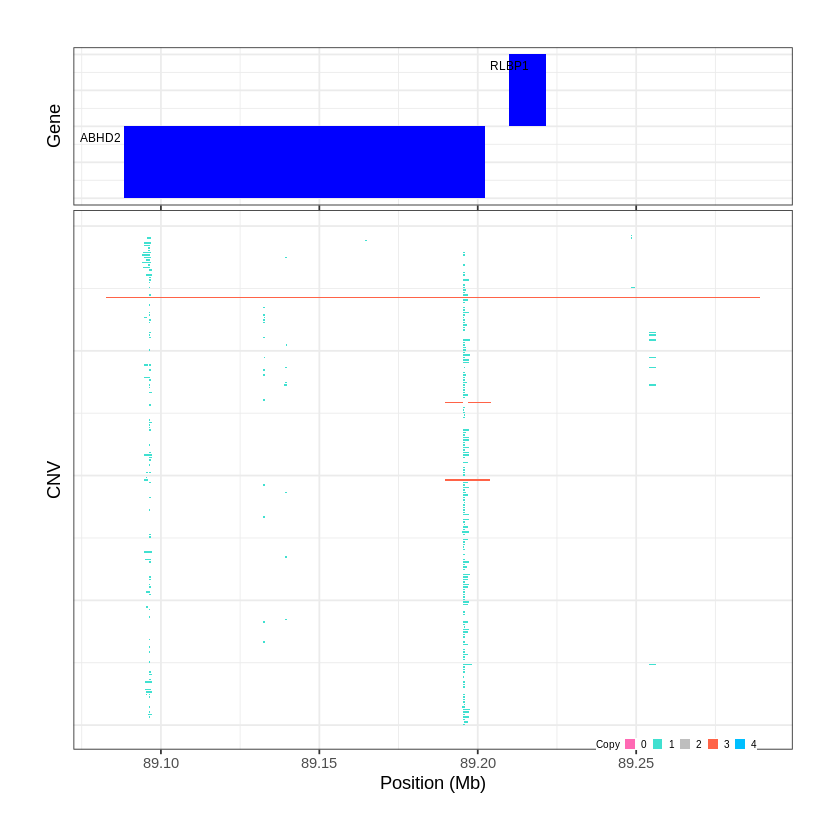

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1588..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 92.511501 - 92.598 Mb with 180 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1589..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 93.515801 - 93.5161 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


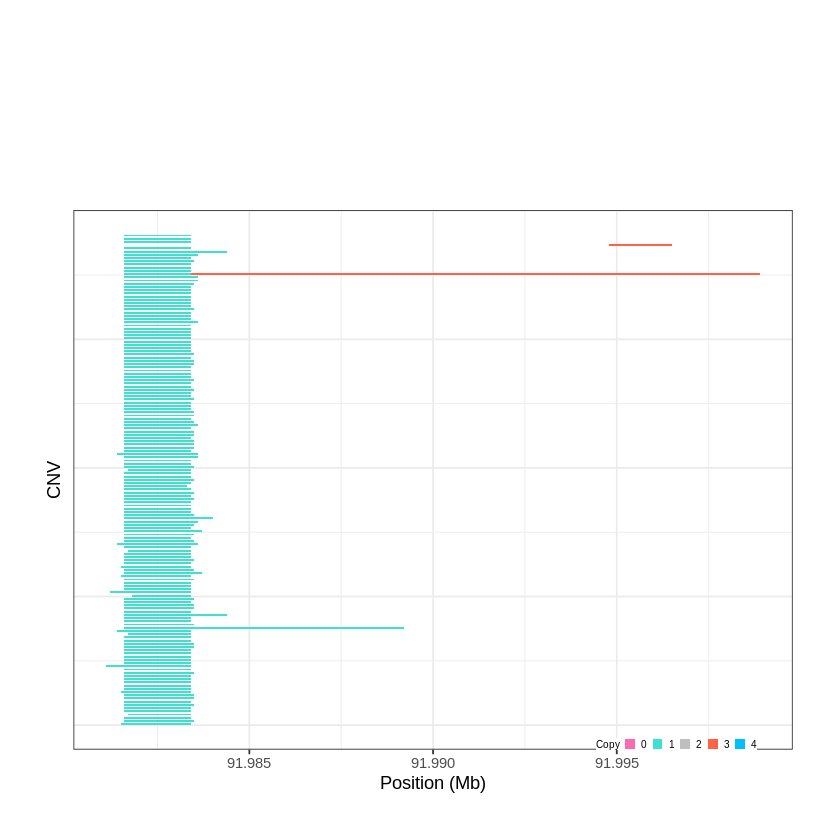

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1590..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 97.774501 - 97.8431 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


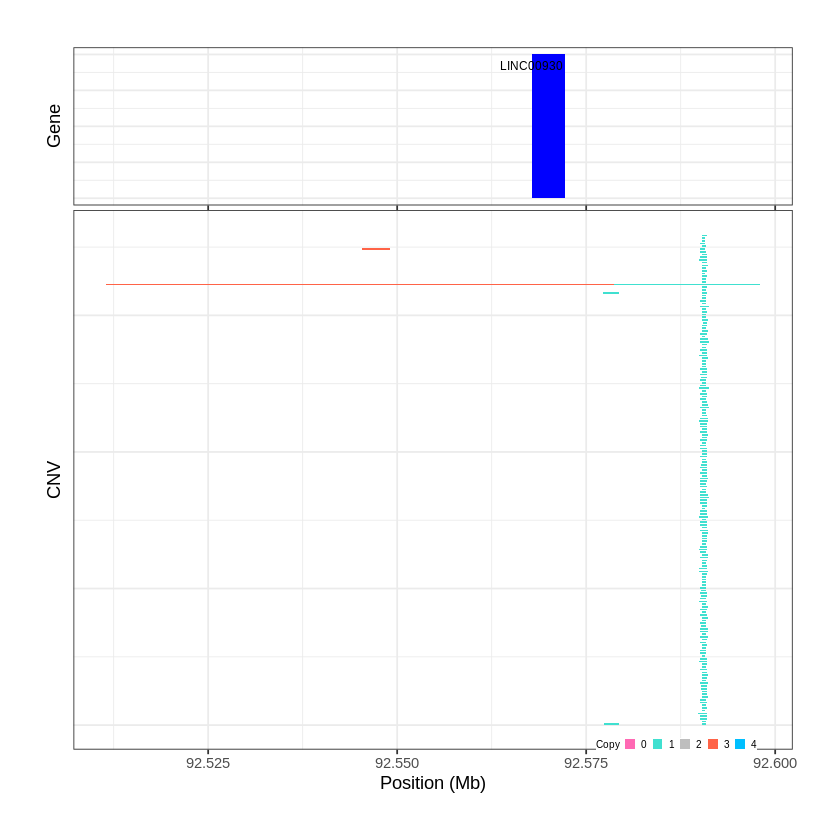

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1591..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 98.817001 - 98.878 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


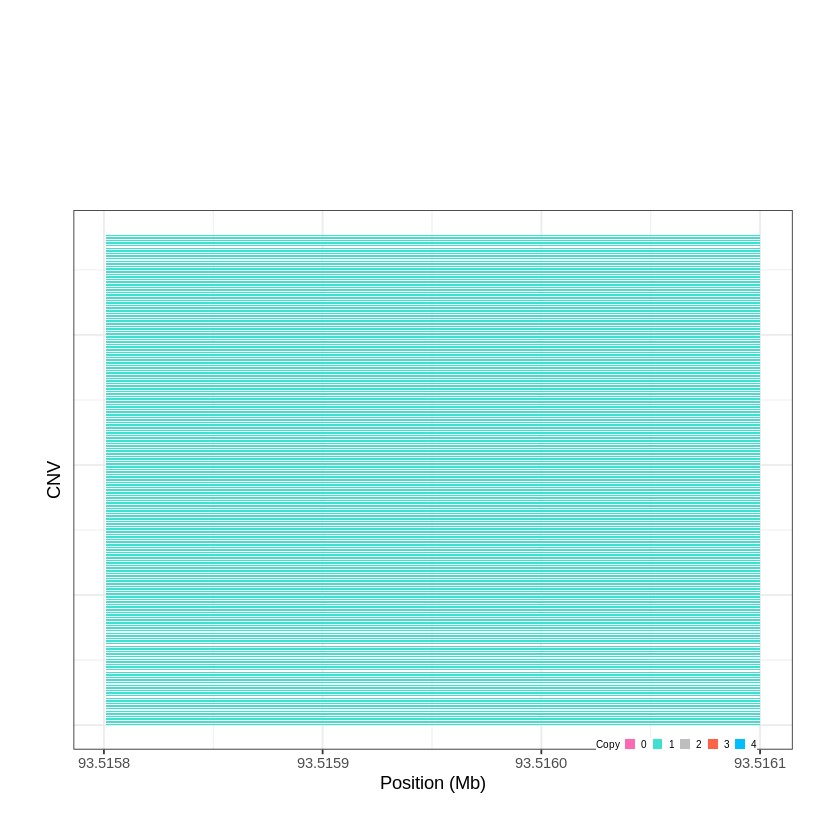

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1592..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 99.574201 - 99.5761 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


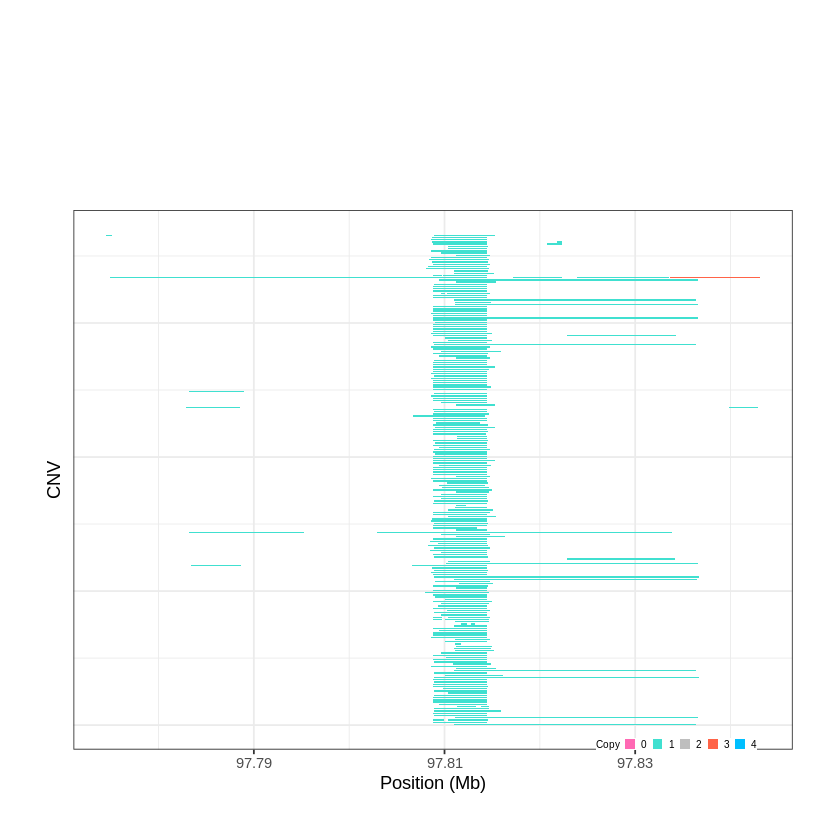

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1593..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 100.446501 - 100.4758 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


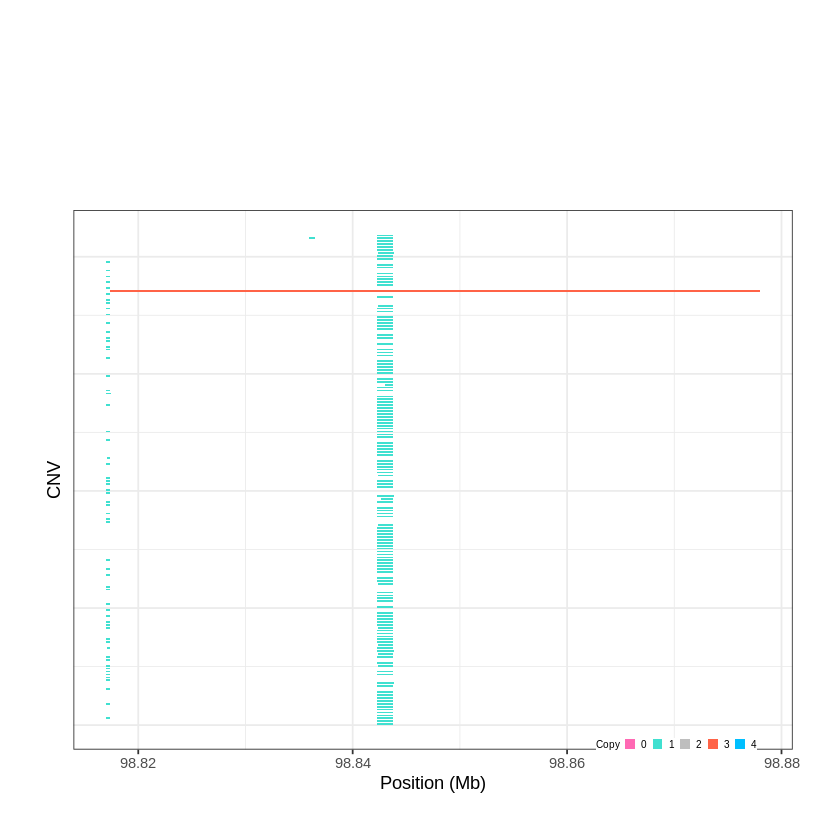

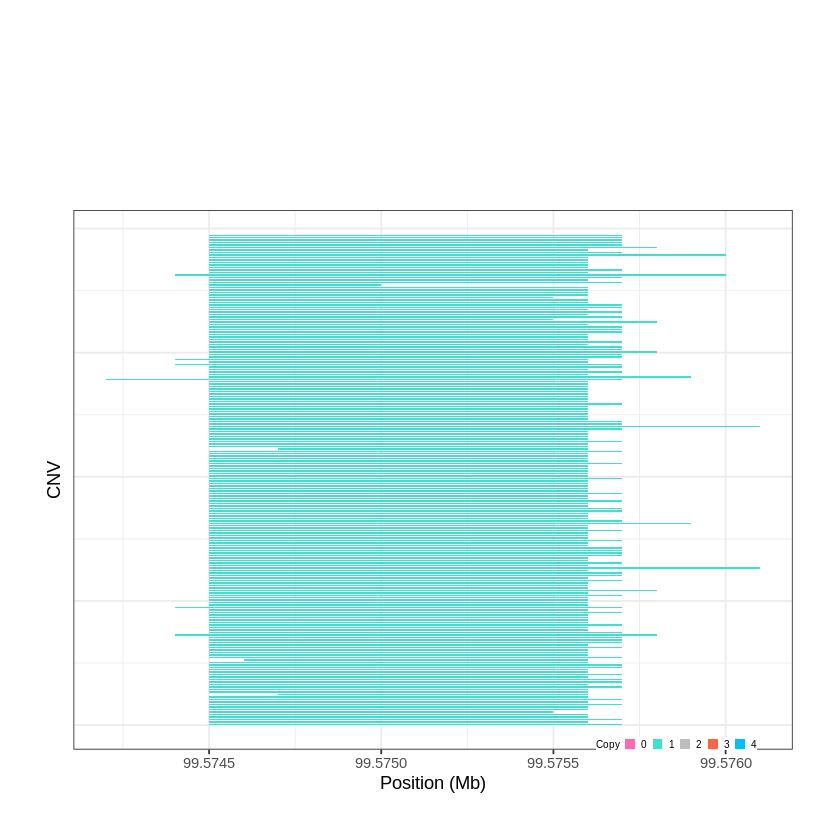

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1594..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 100.495401 - 100.6141 Mb with 223 Individual - "
Plotting gene...


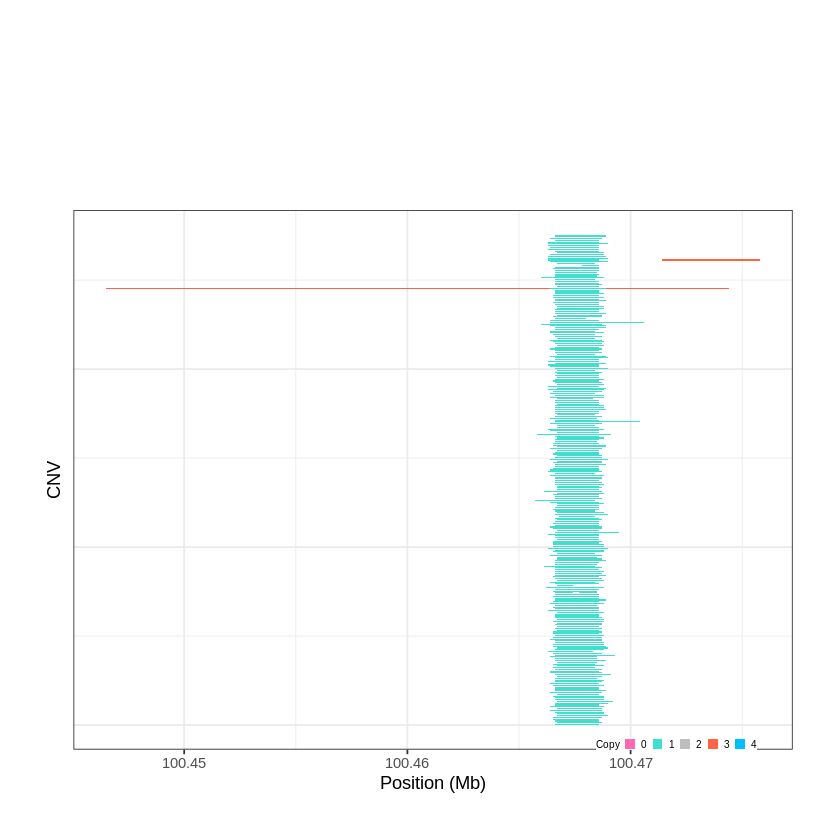

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1595..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 100.757001 - 100.9043 Mb with 148 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1596..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 100.906401 - 100.9442 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


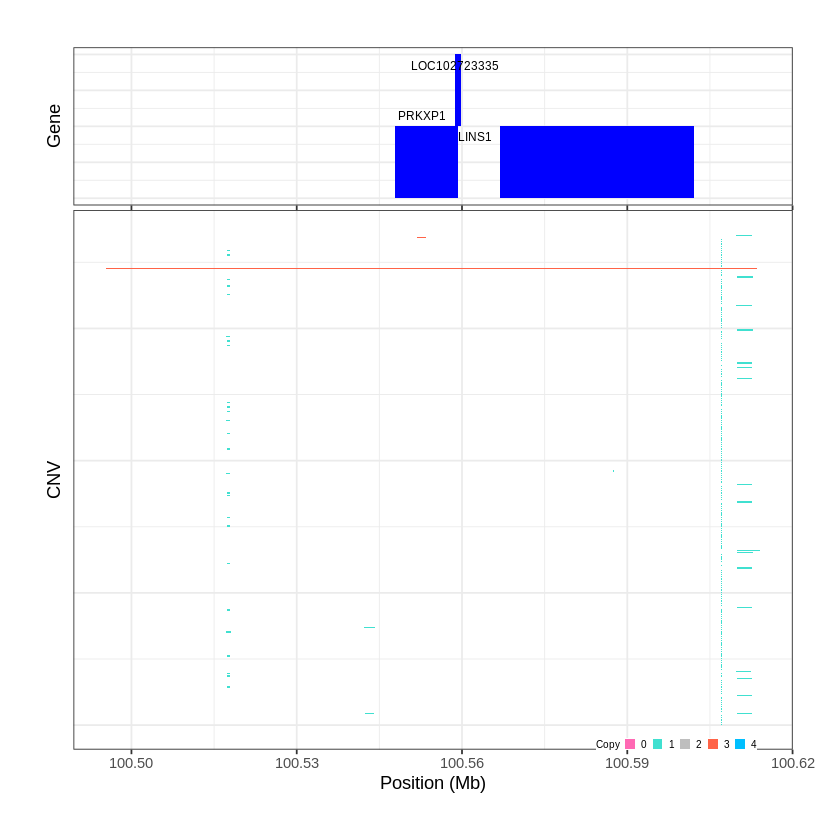

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1597..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 101.051601 - 101.0523 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


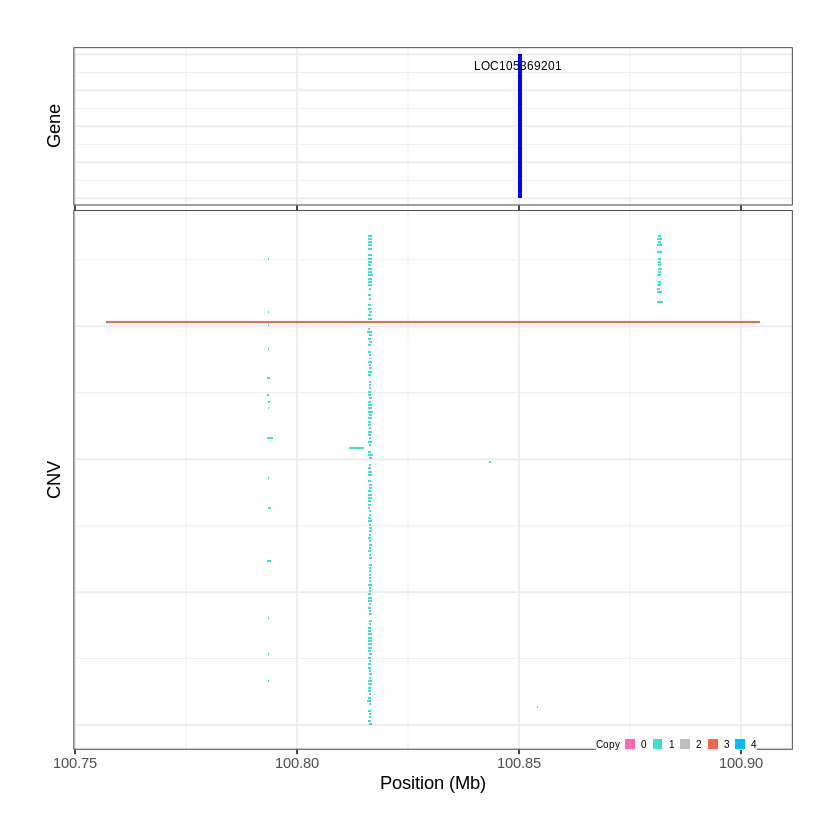

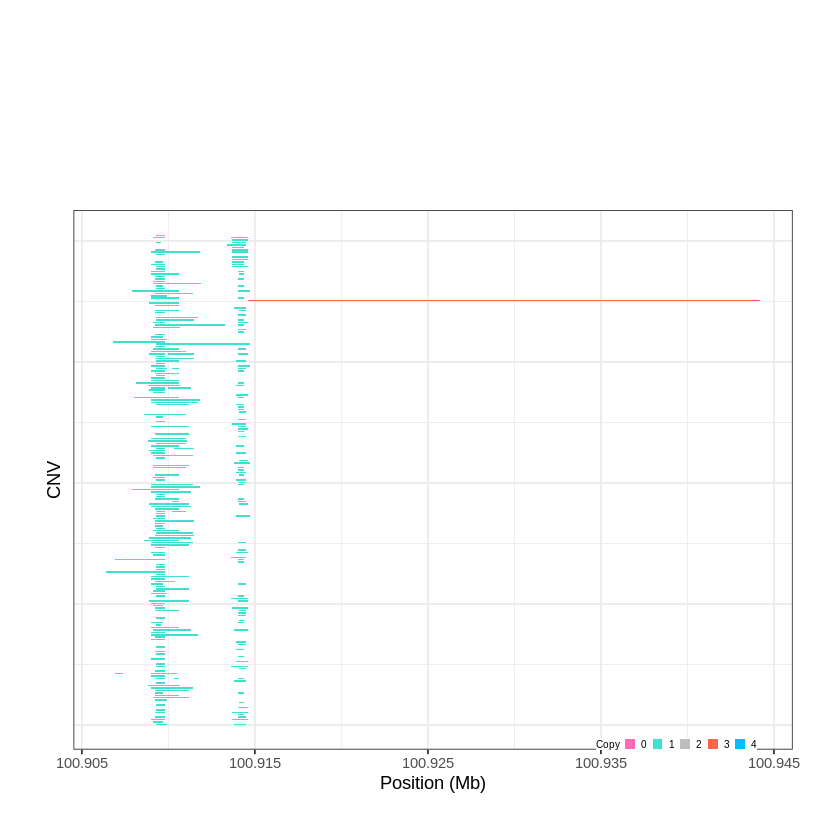

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1598..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 101.421201 - 101.7577 Mb with 155 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1599..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 102.282301 - 102.3333 Mb with 246 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


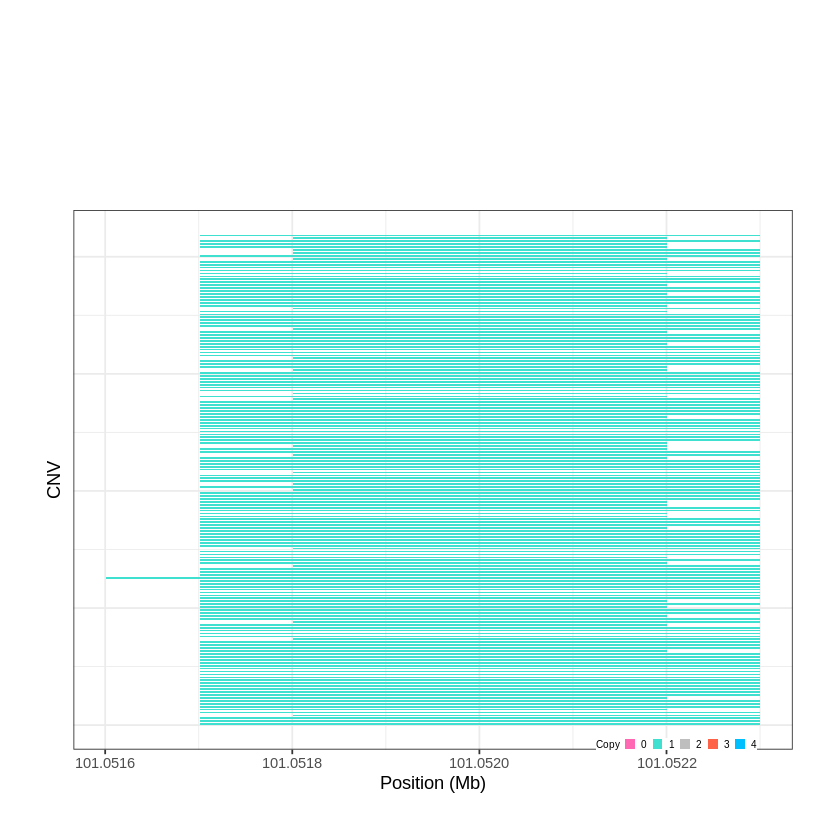

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1600..."
Input data passed requirment check...
[1] "CNV on Chromosome 15: 102.335201 - 102.5314 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


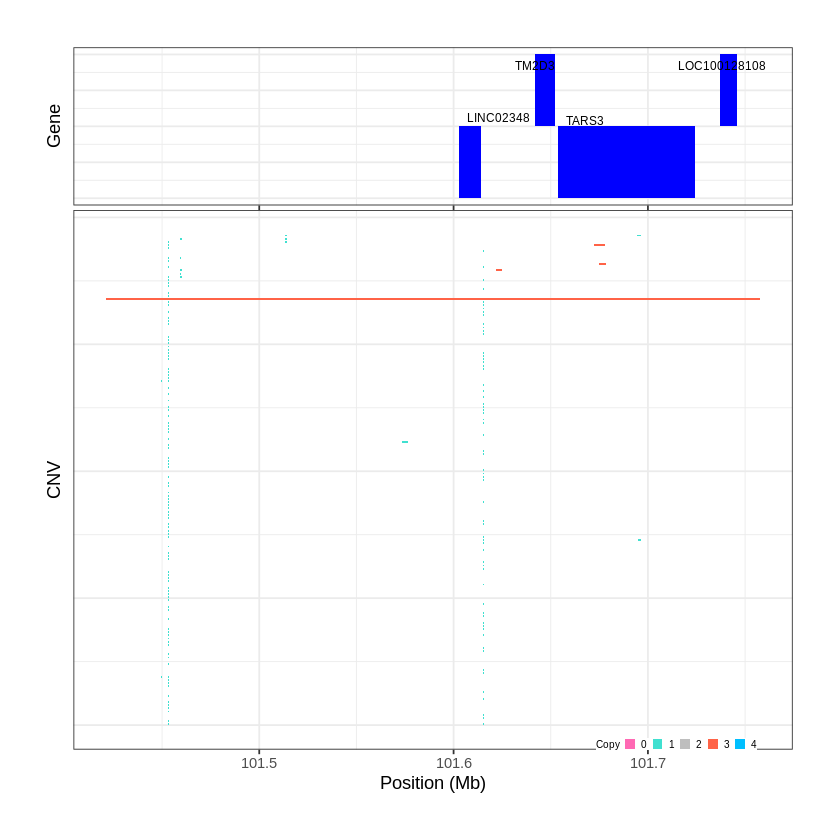

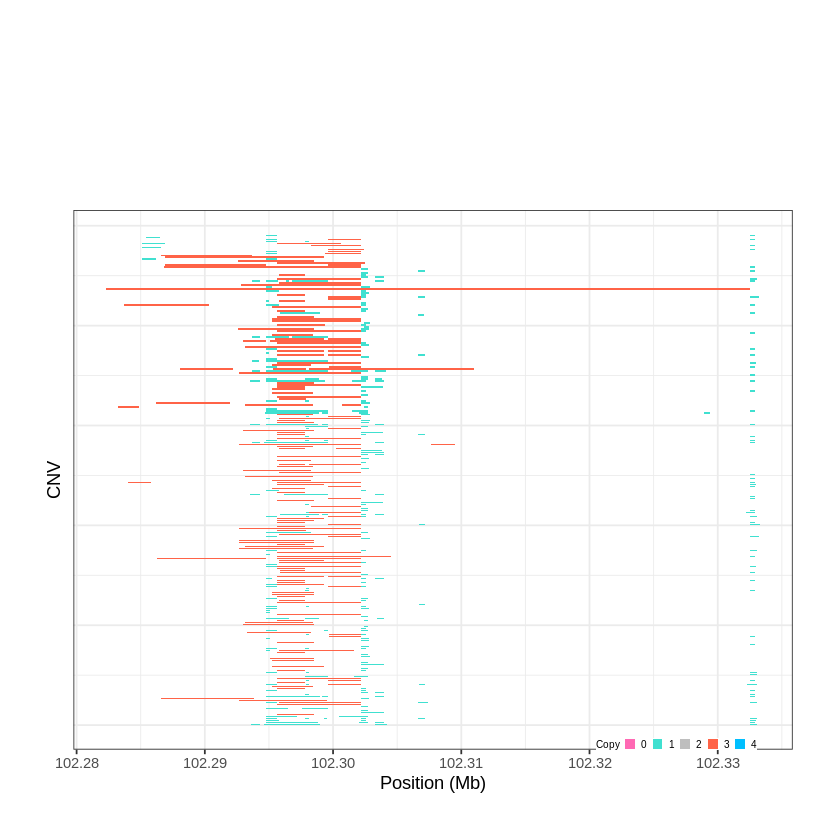

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1601..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 1e-06 - 0.2375 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1602..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 0.553601 - 0.5562 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


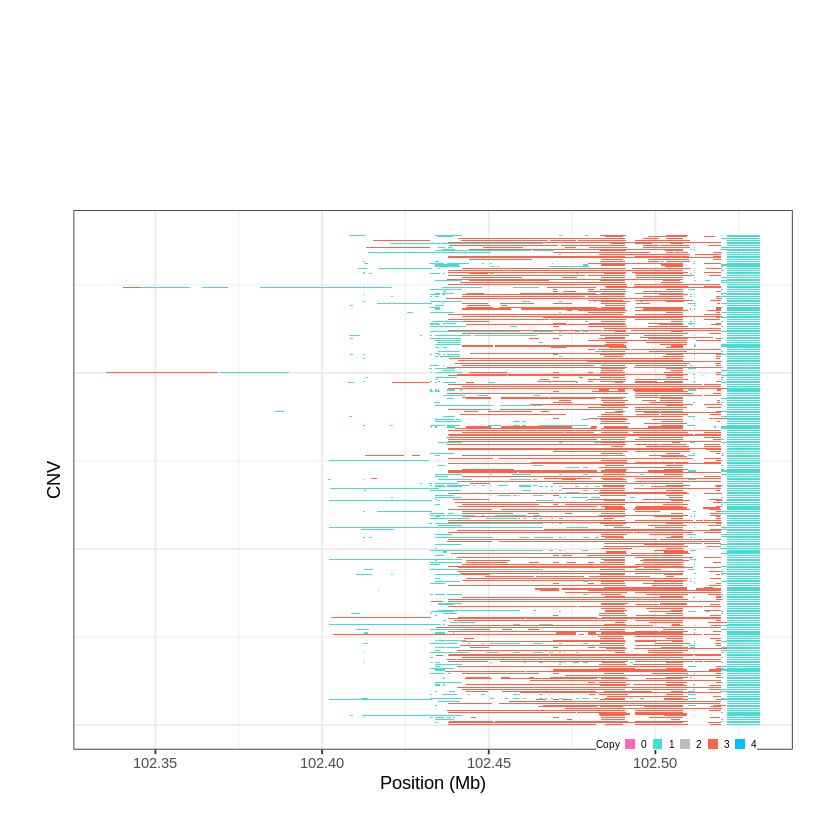

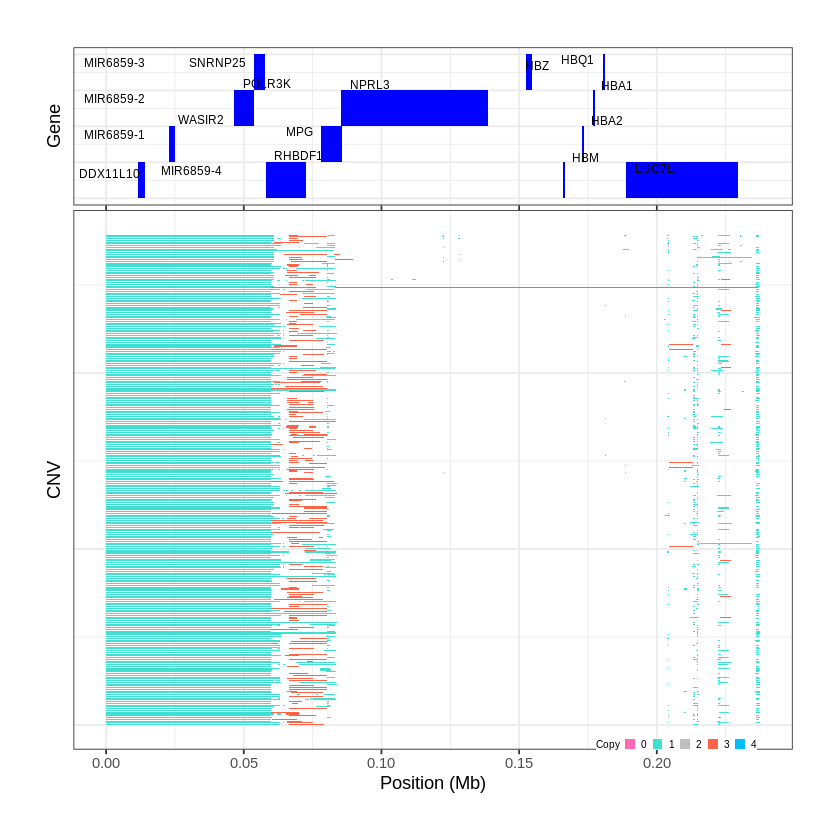

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1603..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 0.620701 - 0.6387 Mb with 174 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1604..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 0.689601 - 0.693 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


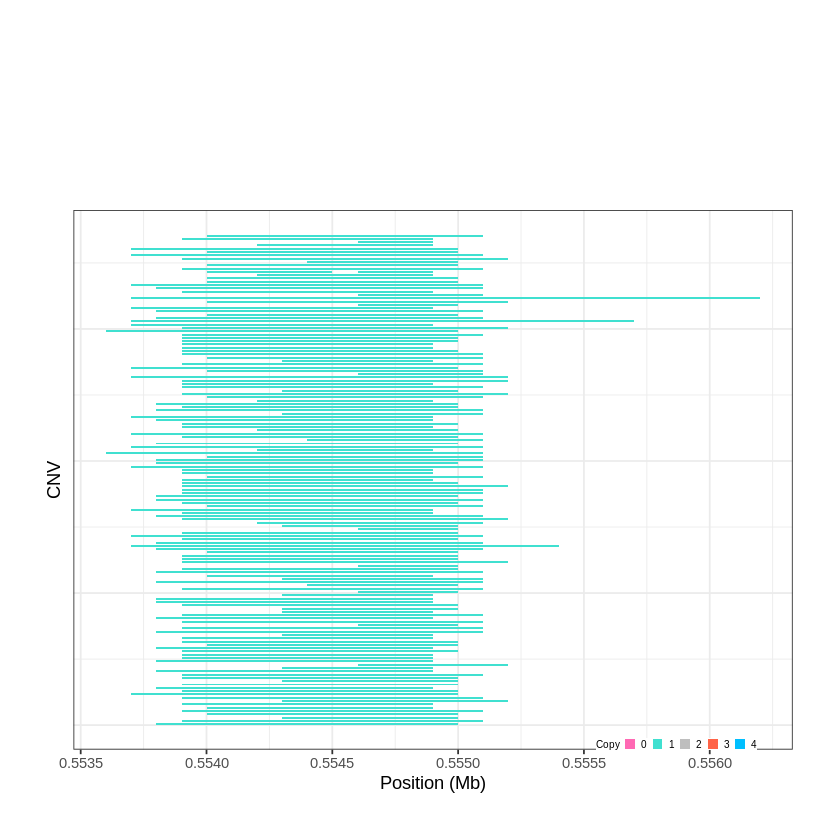

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1605..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 0.817101 - 0.8199 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


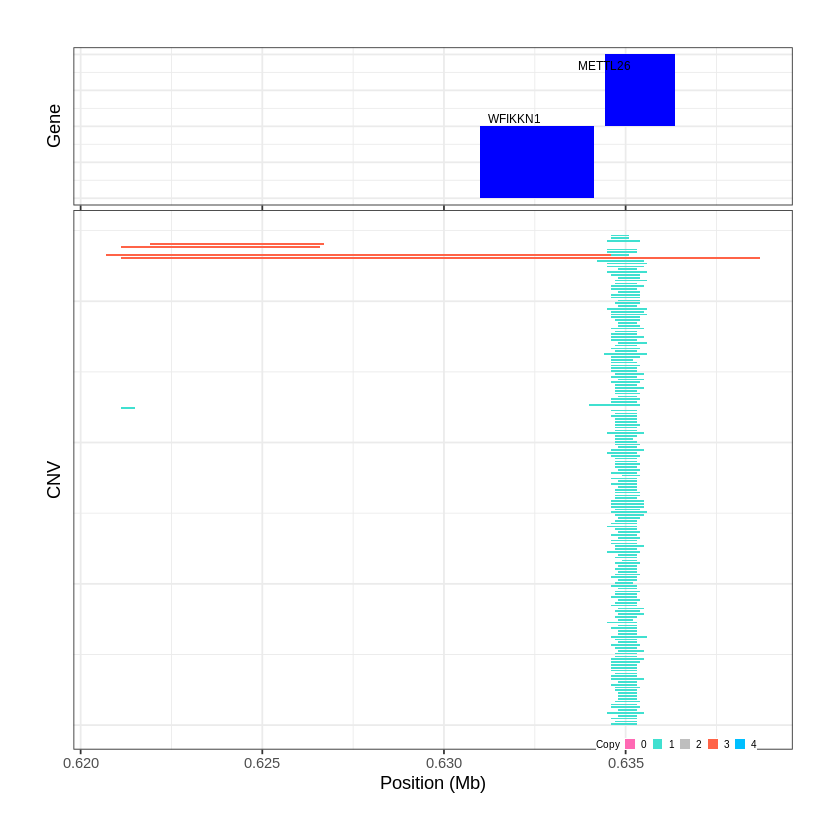

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1606..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 0.936301 - 0.9622 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


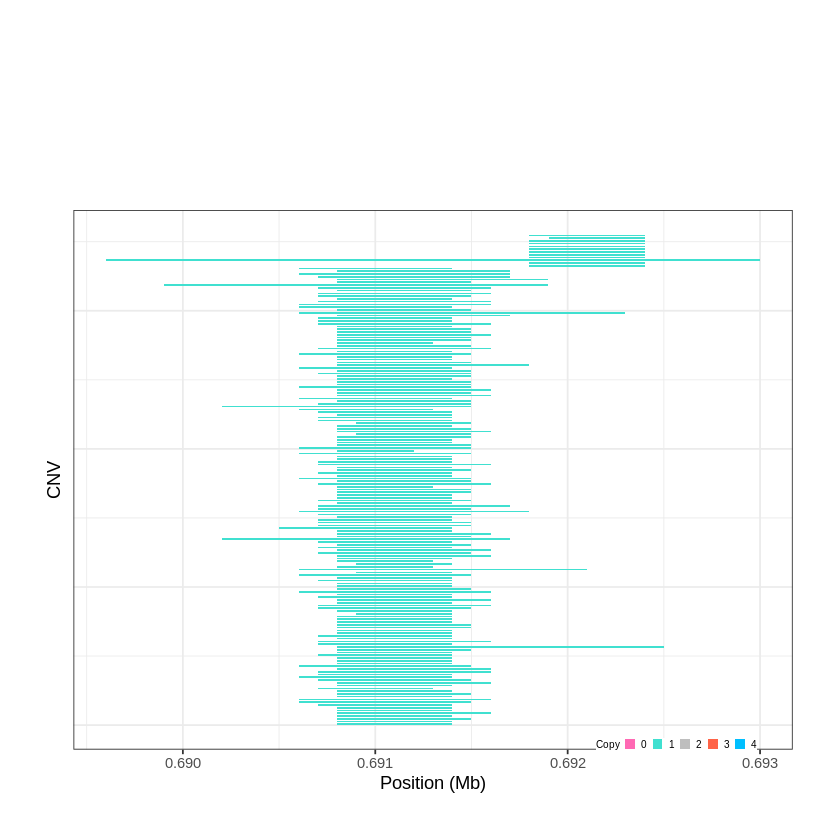

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1607..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 0.996001 - 1.0071 Mb with 259 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


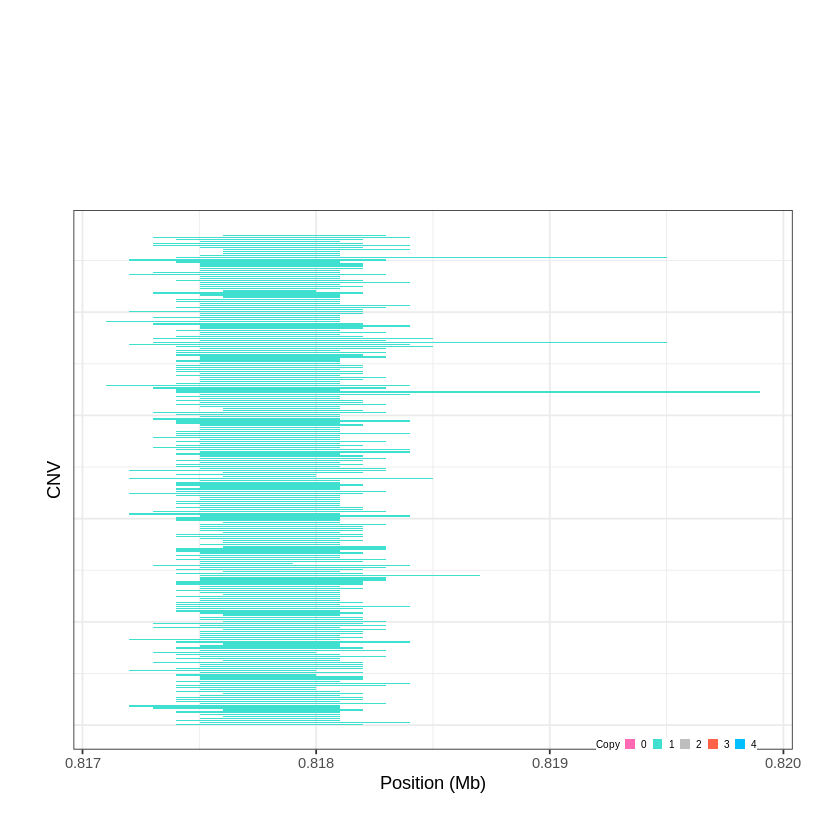

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1608..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 1.054301 - 1.064 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


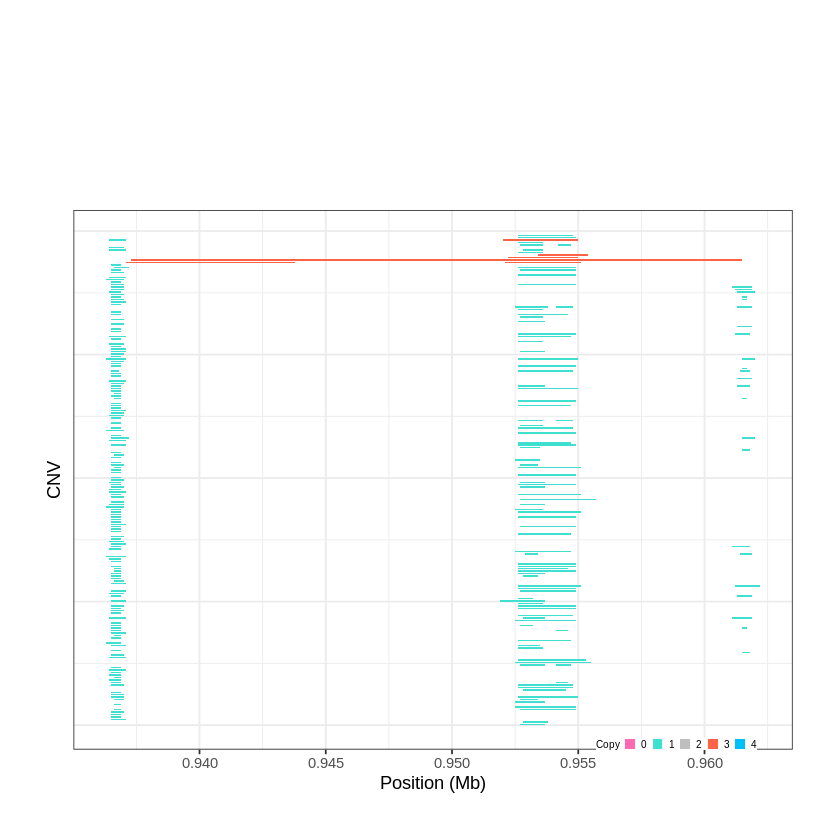

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1609..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 1.125601 - 1.1267 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


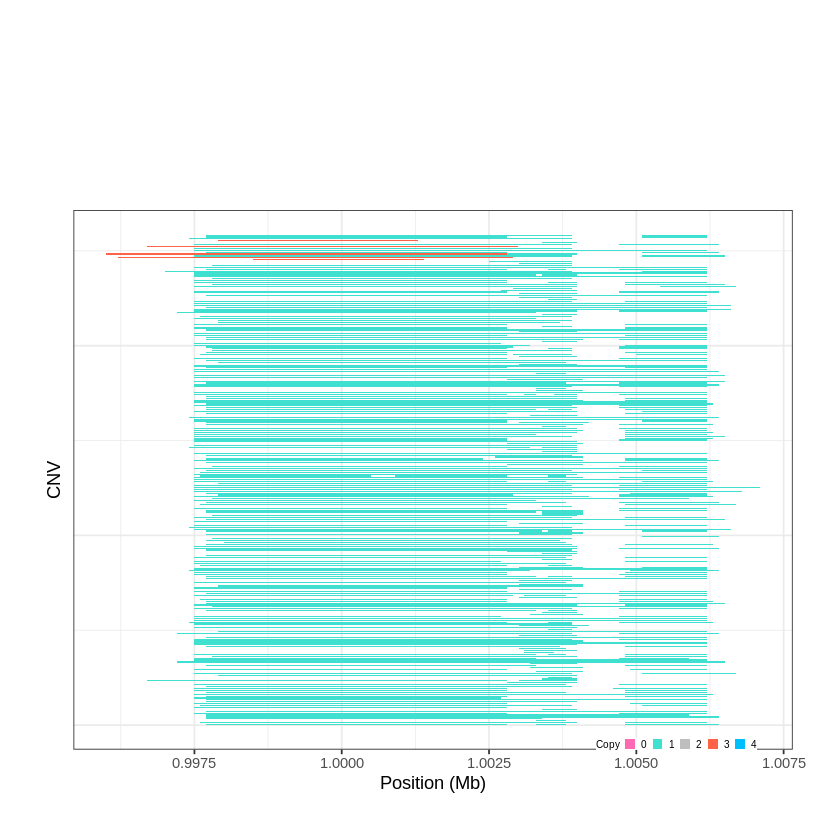

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1610..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 1.151801 - 1.1534 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


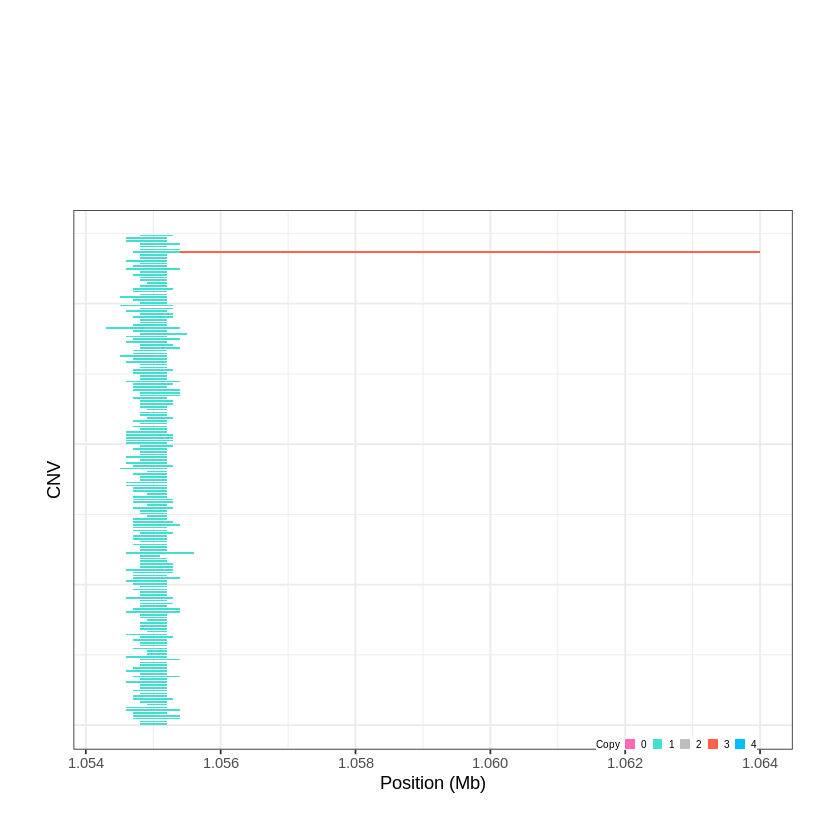

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1611..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 1.202001 - 1.2057 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


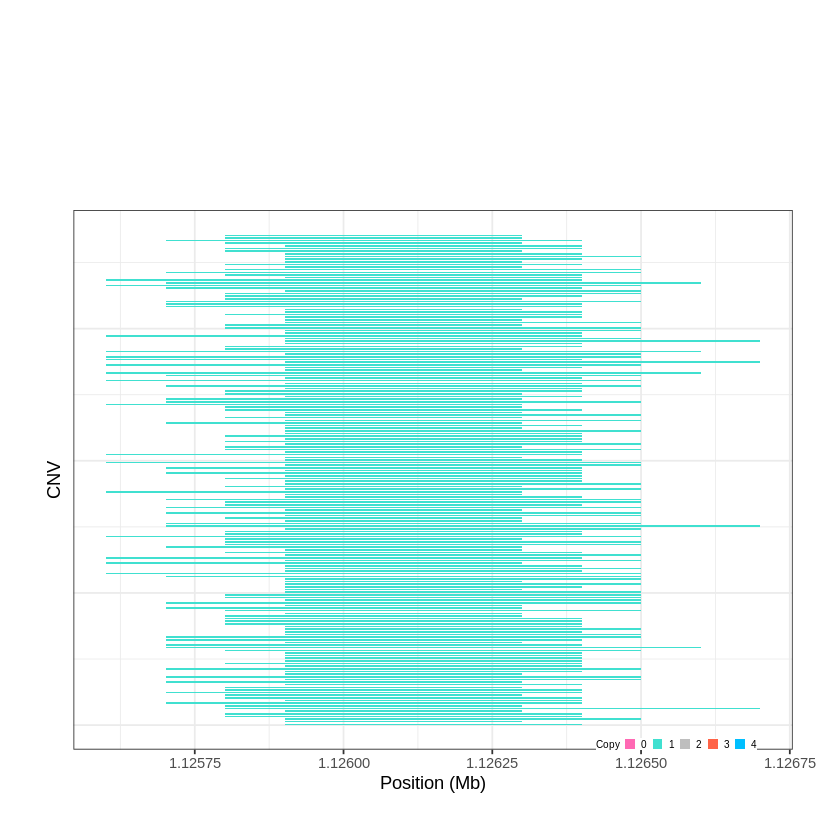

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1612..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 1.268101 - 1.3056 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


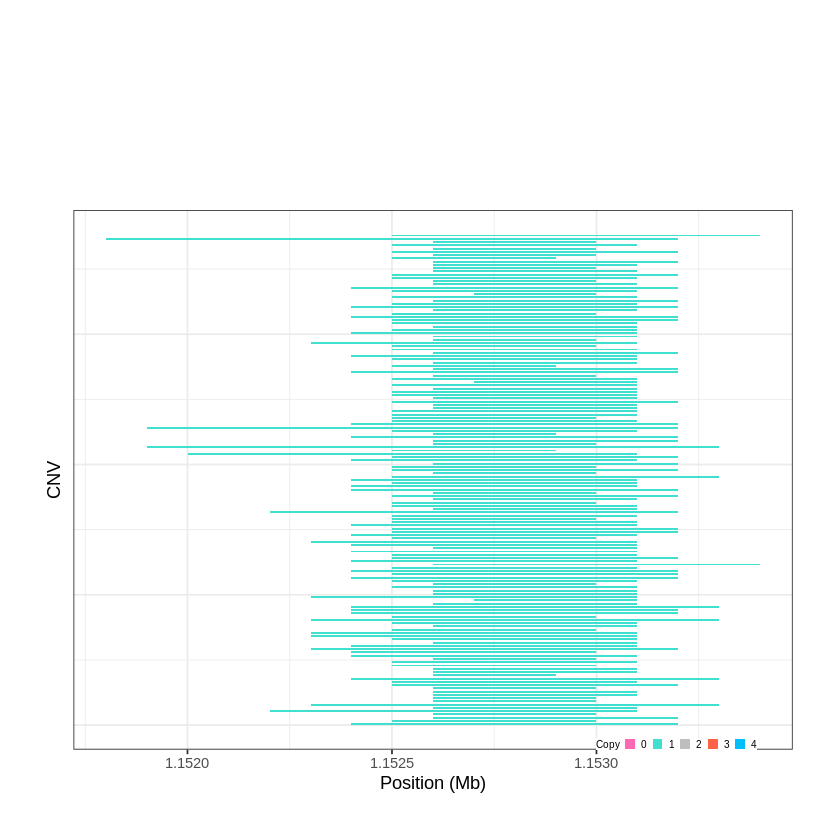

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1613..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 1.342101 - 1.3431 Mb with 190 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


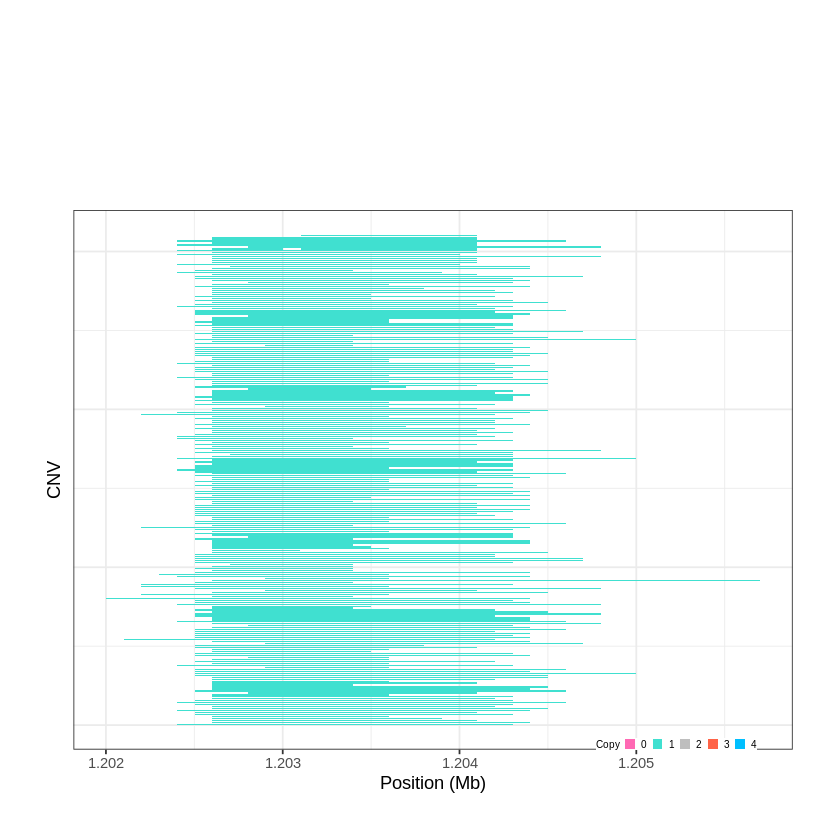

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1614..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 1.422401 - 1.4261 Mb with 272 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


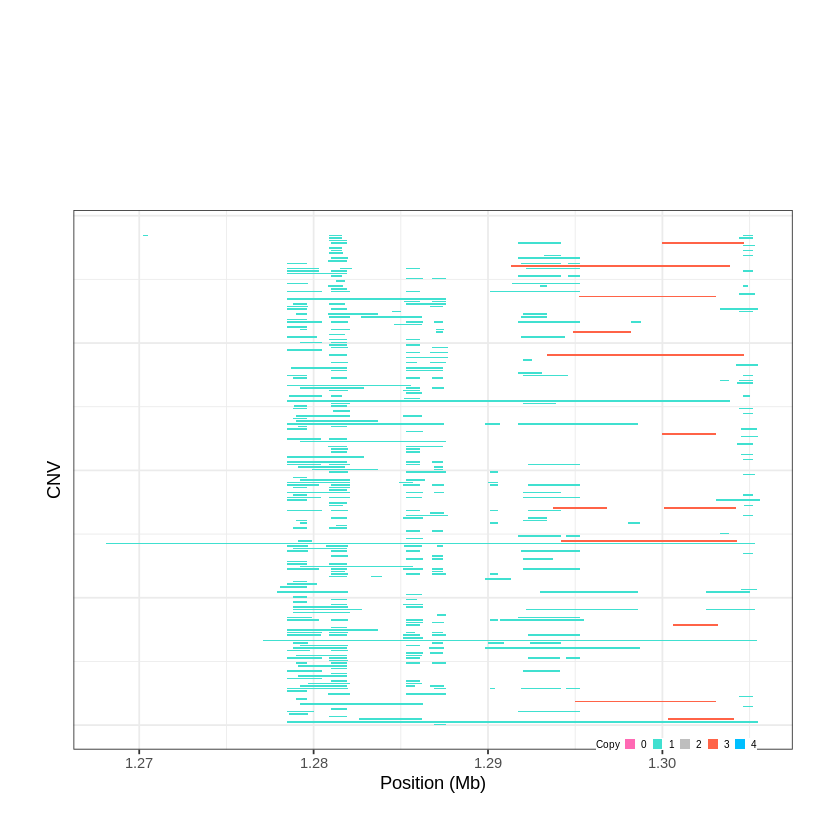

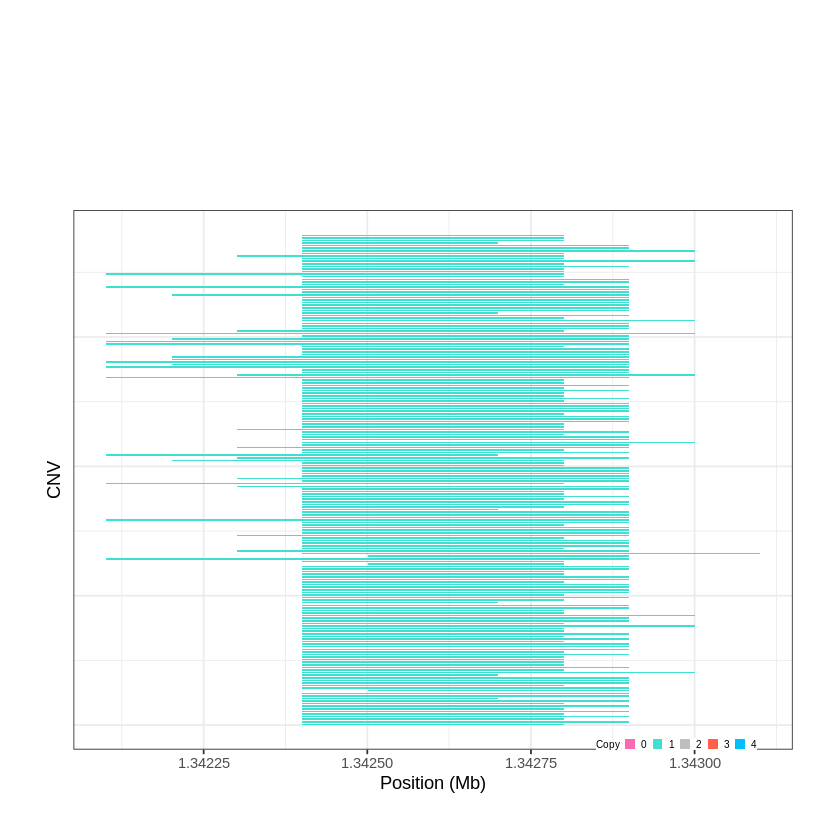

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1615..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 2.142701 - 2.1786 Mb with 224 Individual - "
Plotting gene...


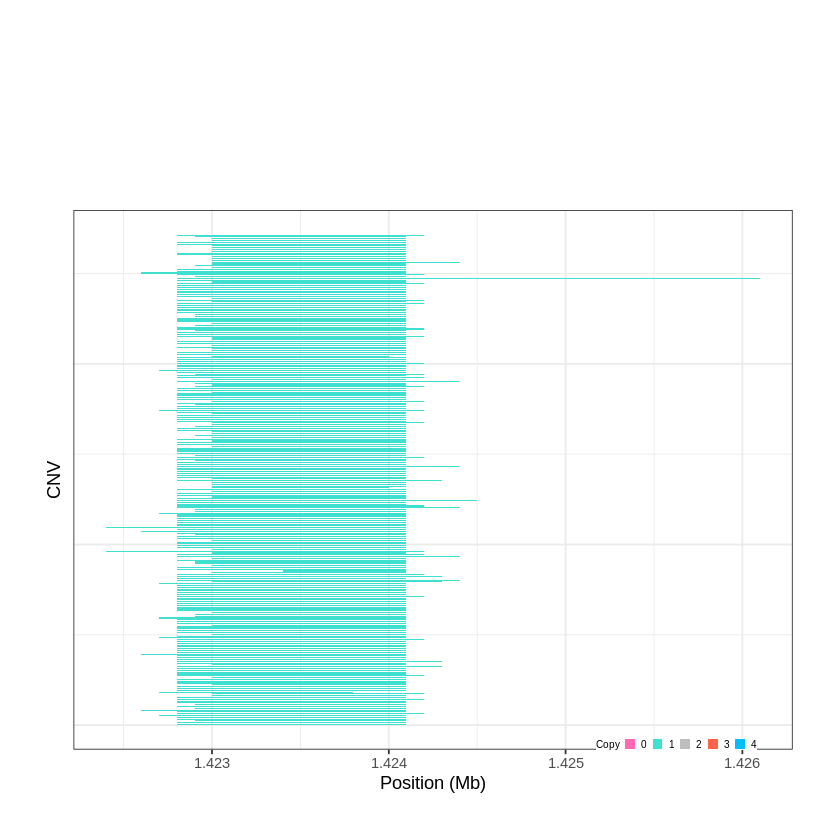

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1616..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 2.424701 - 3.4319 Mb with 268 Individual - "
Plotting gene...


Warning message:
“ggrepel: 43 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


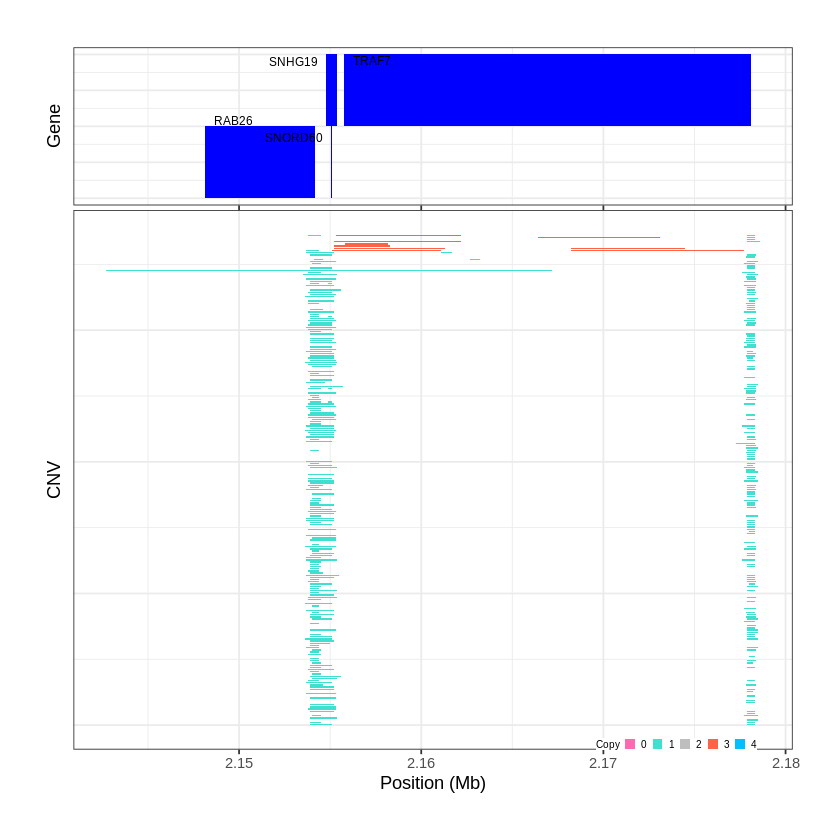

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1617..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 3.448501 - 5.1789 Mb with 266 Individual - "
Plotting gene...


Warning message:
“ggrepel: 18 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1618..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 5.979001 - 5.9817 Mb with 184 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


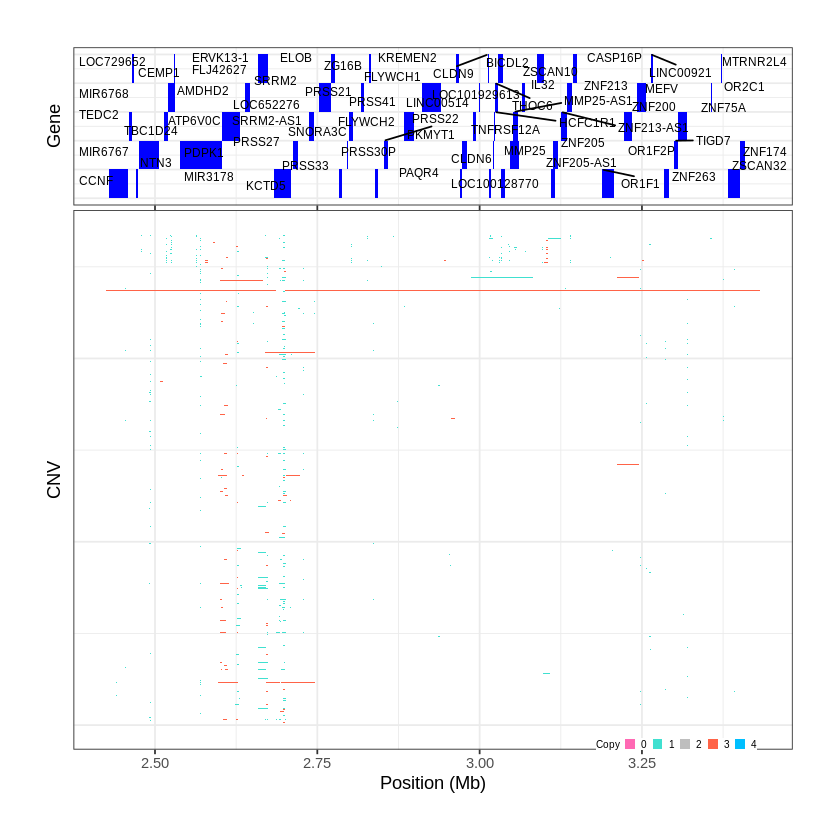

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1619..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 6.598401 - 6.6003 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


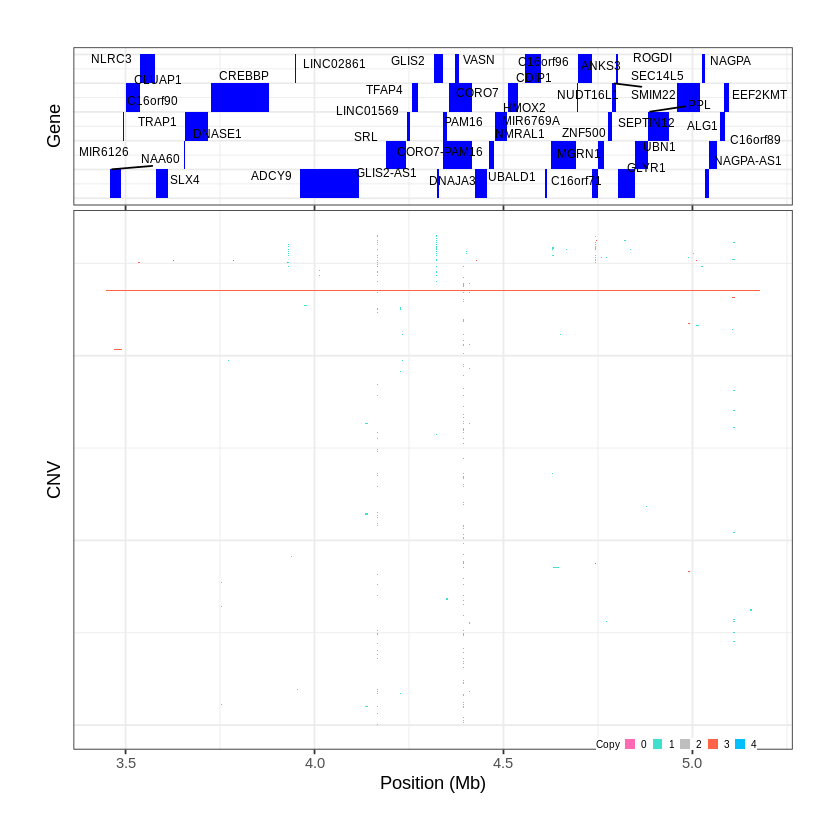

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1620..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 8.636901 - 8.69 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


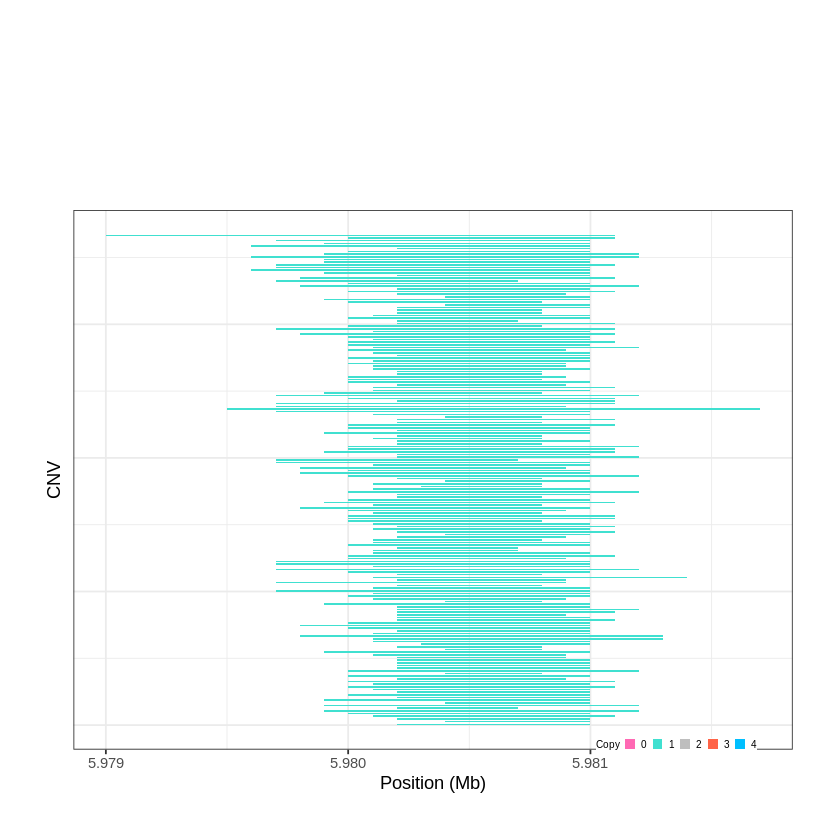

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1621..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 10.591801 - 10.5957 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


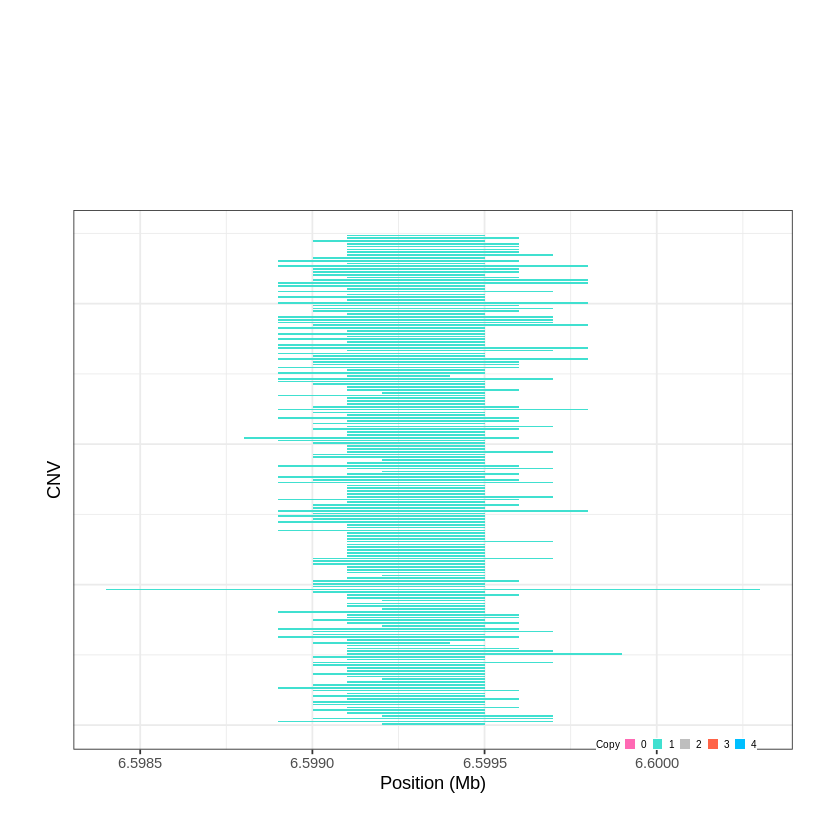

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1622..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 10.612201 - 10.614 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


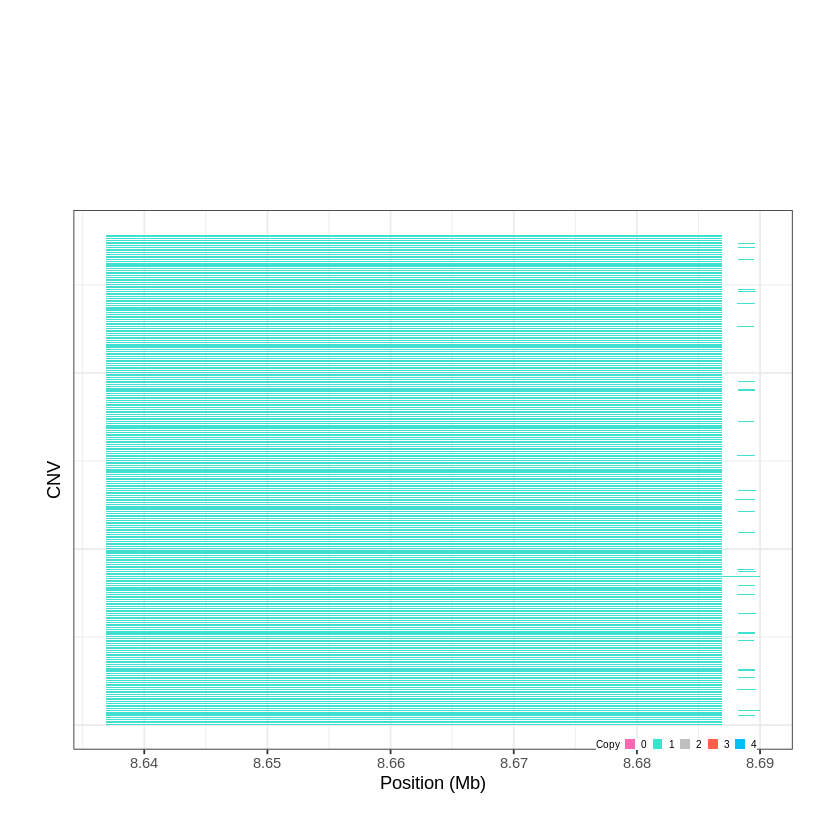

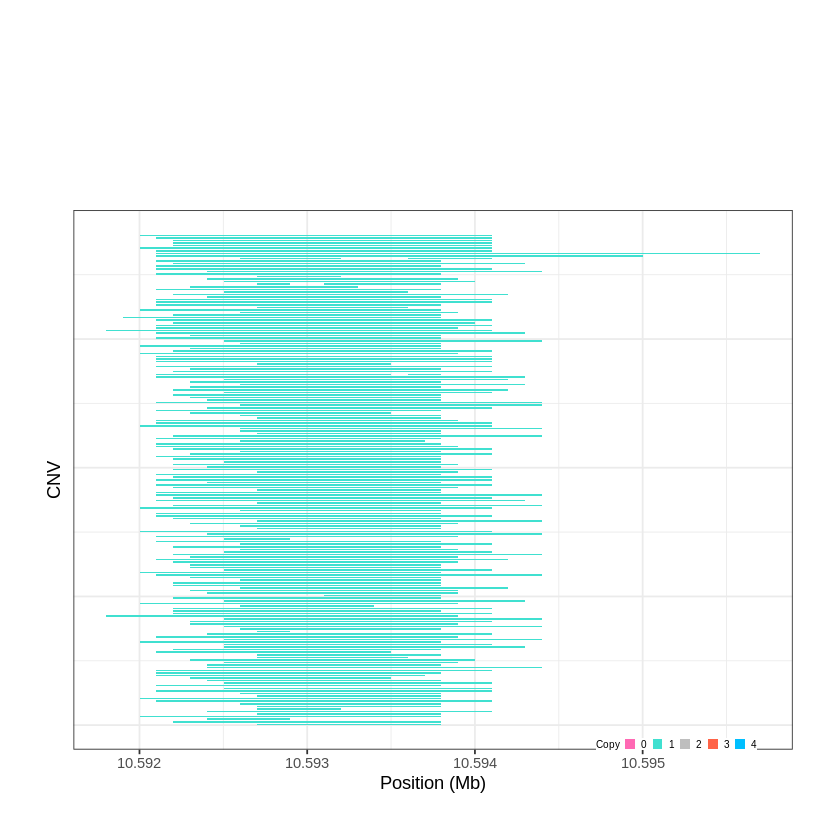

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1623..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 10.946601 - 11.6484 Mb with 256 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1624..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 11.683101 - 11.6909 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


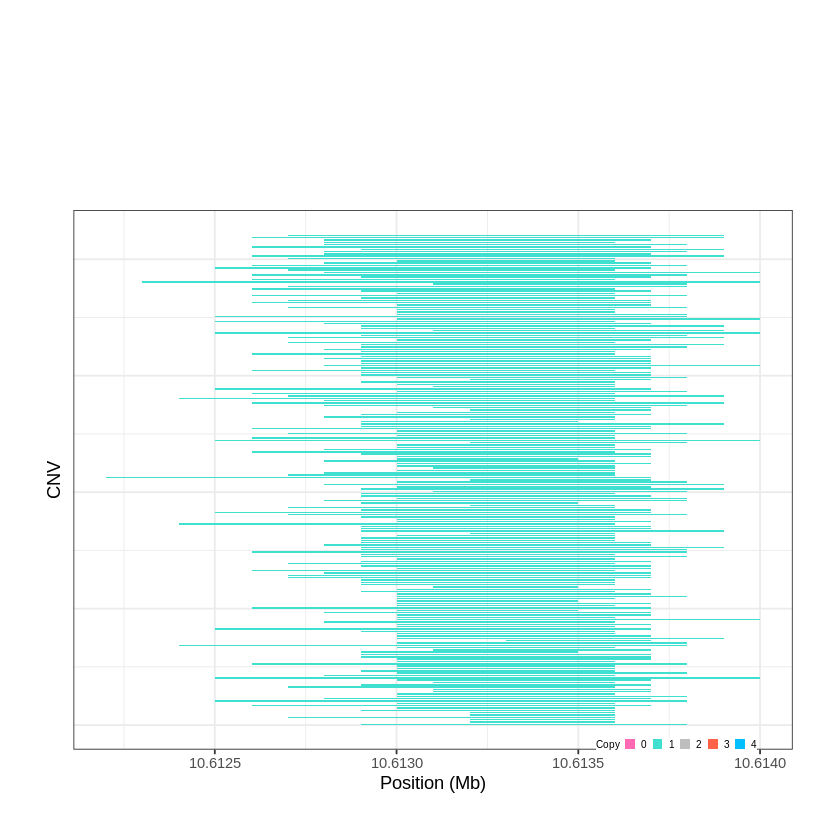

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1625..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 12.445201 - 12.4811 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


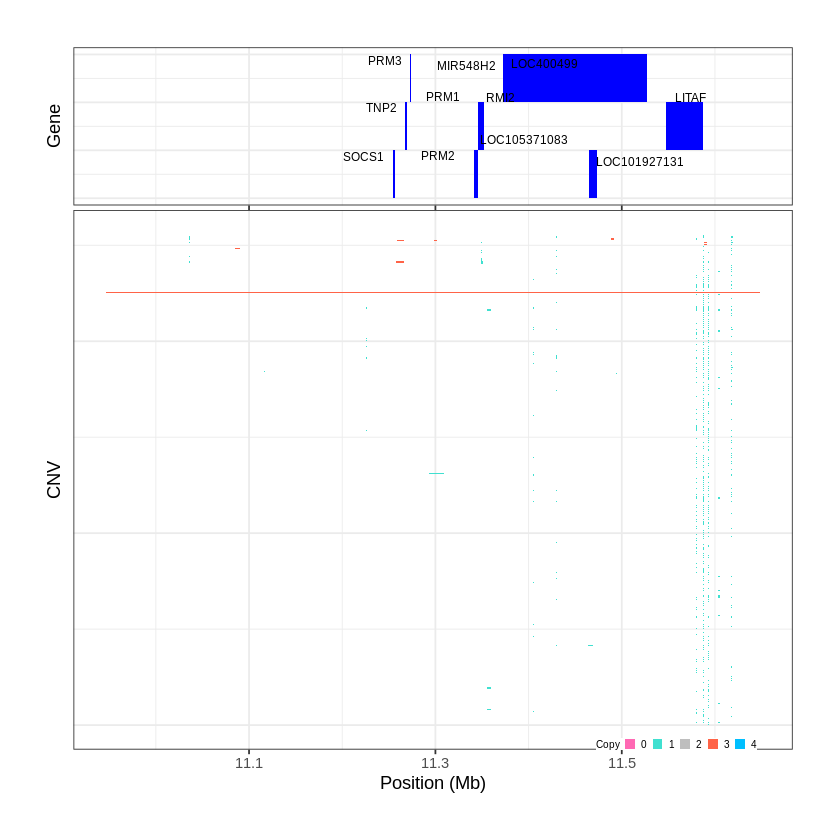

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1626..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 14.446201 - 14.45 Mb with 265 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


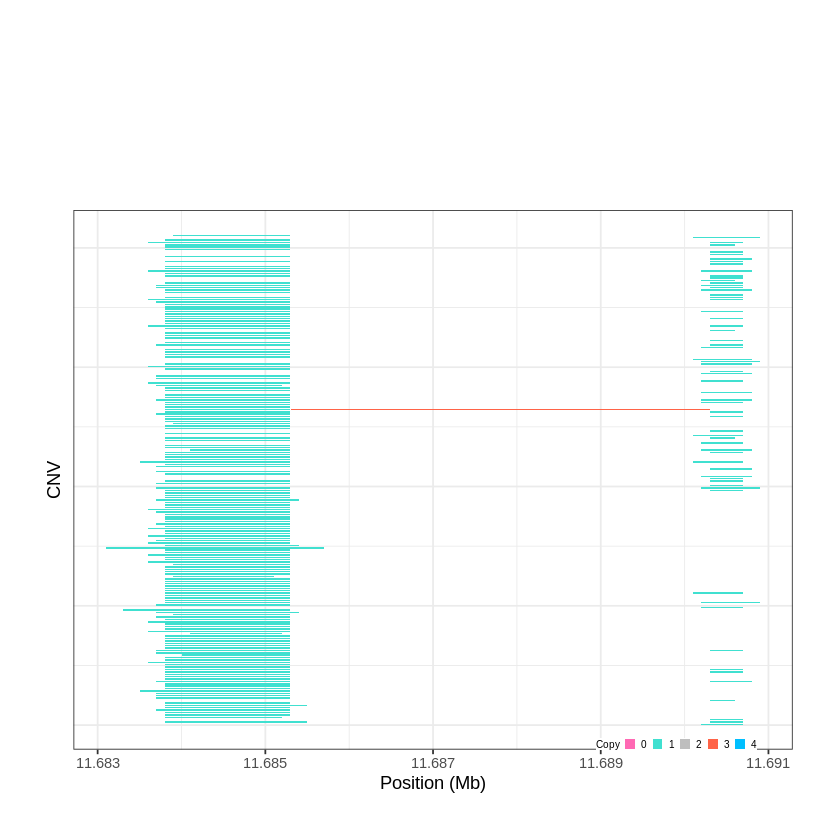

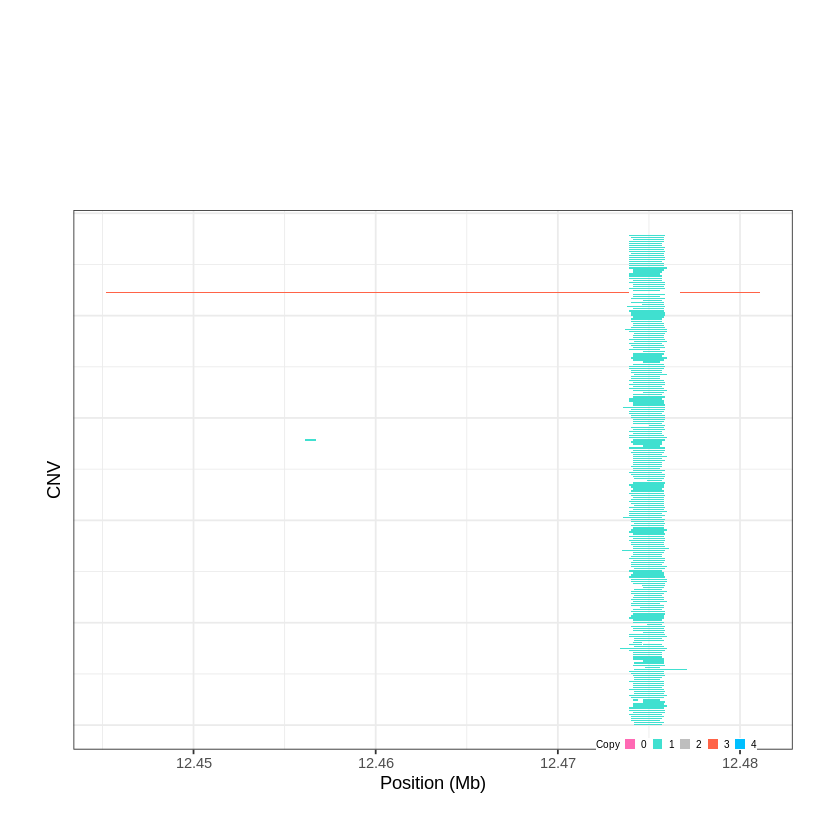

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1627..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 14.762601 - 15.4601 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 27 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1628..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 16.265301 - 16.2666 Mb with 227 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


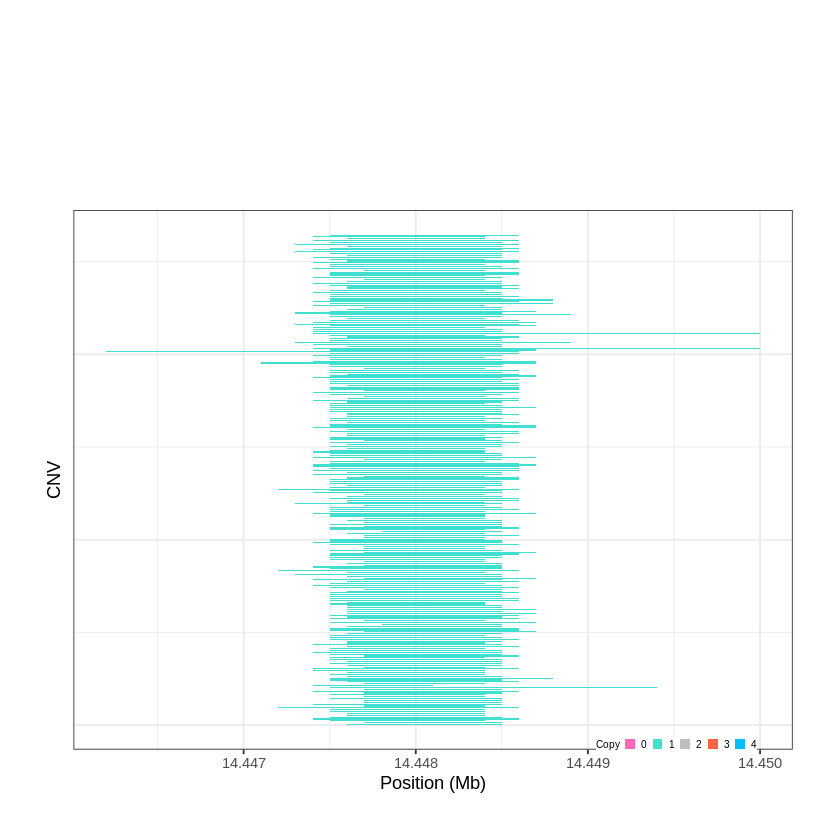

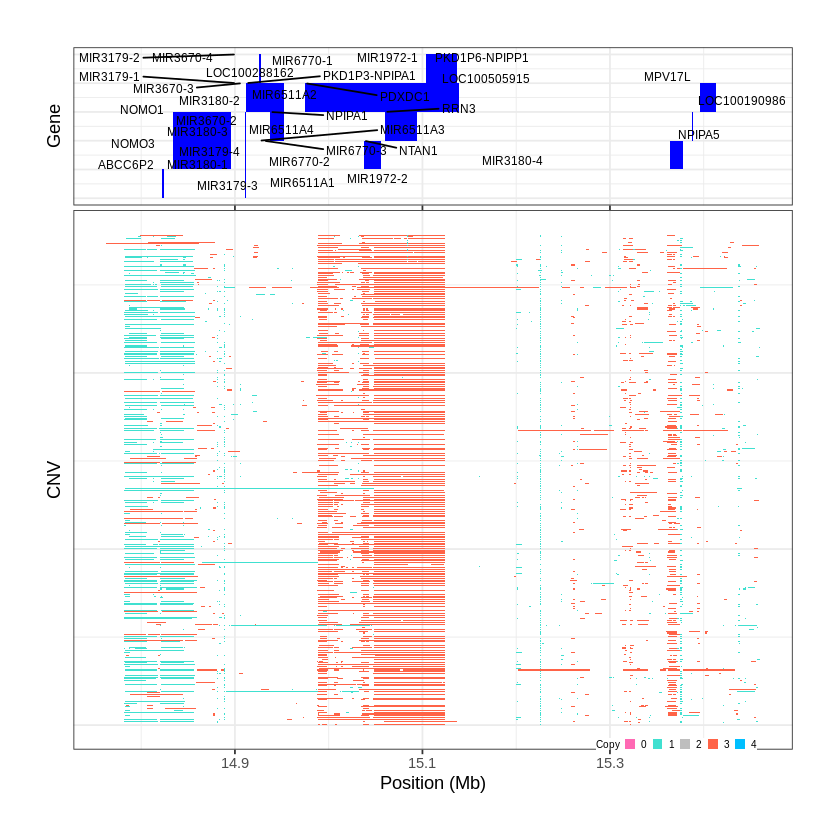

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1629..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 16.317801 - 16.8568 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1630..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 17.165001 - 17.1662 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


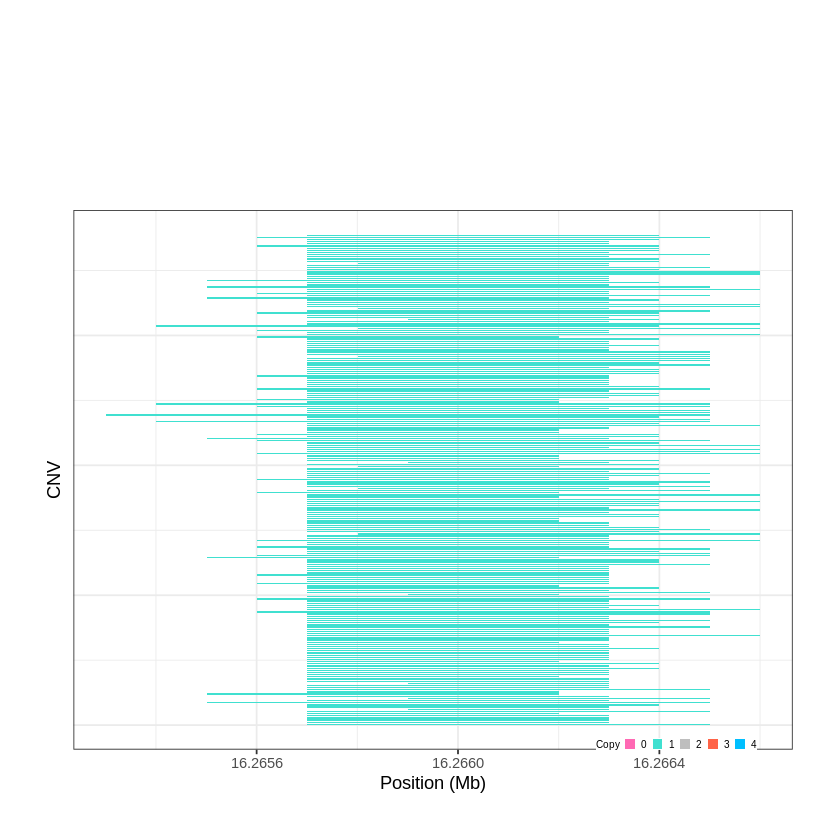

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1631..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 18.161801 - 18.2387 Mb with 257 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


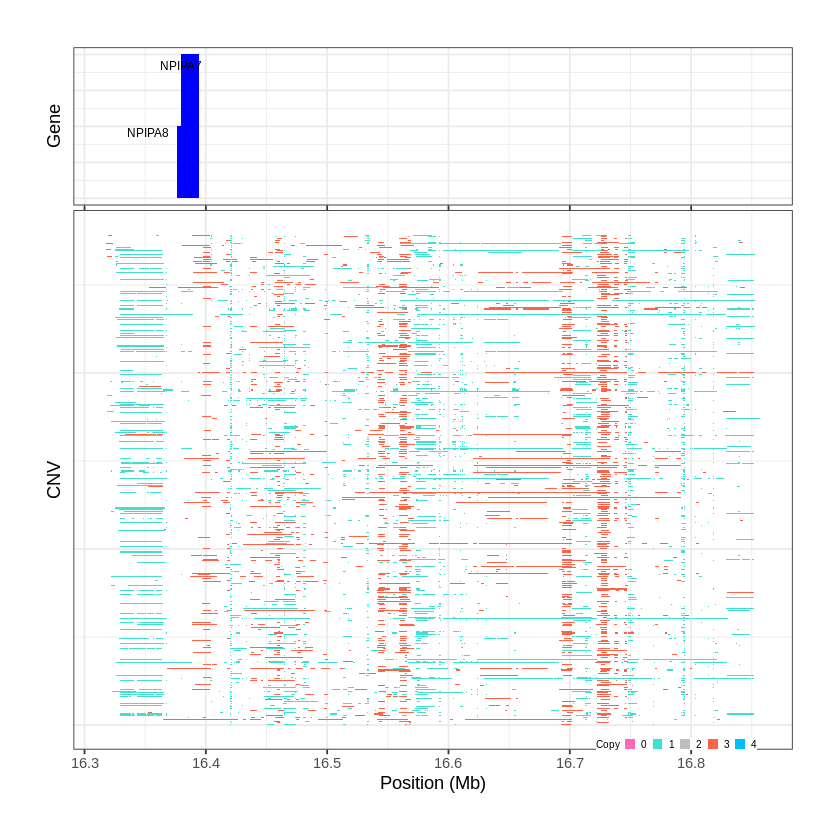

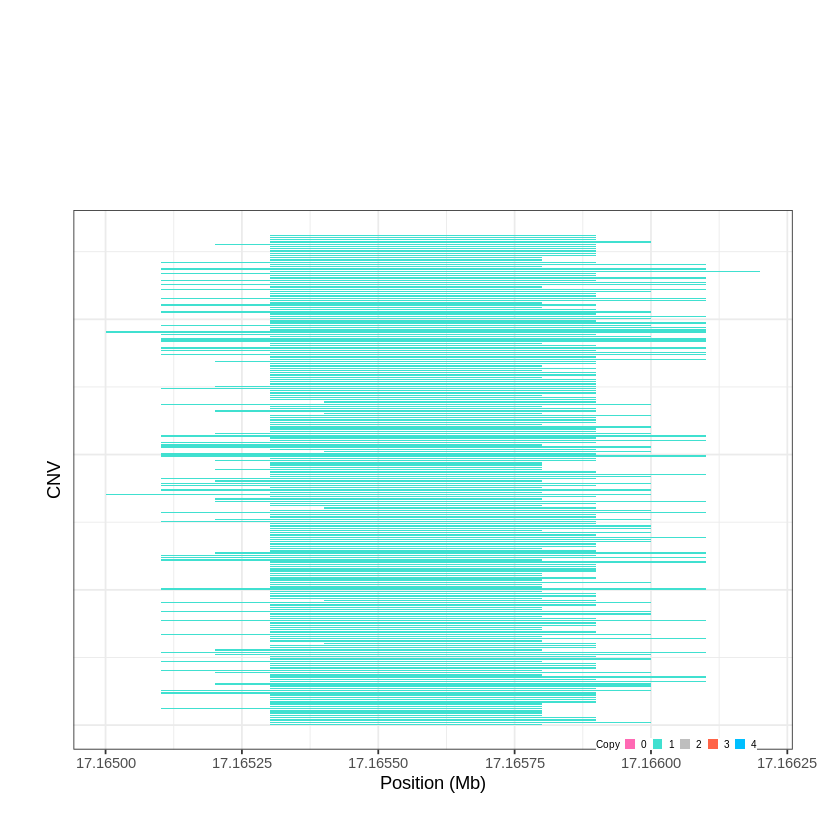

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1632..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 18.239001 - 18.7758 Mb with 279 Individual - "
Plotting gene...


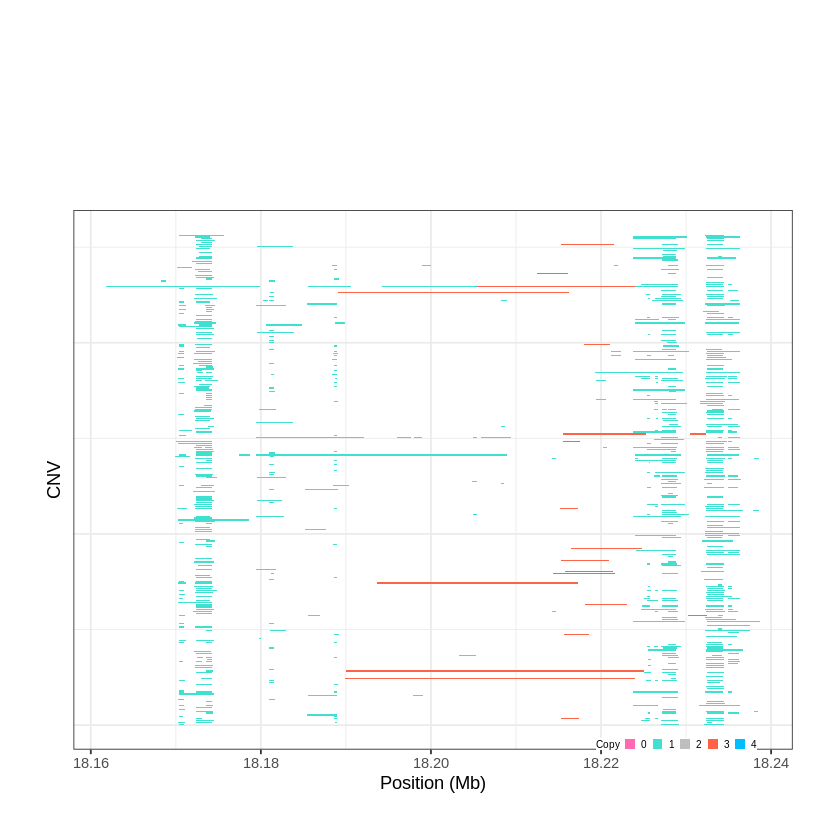

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1633..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 21.406901 - 21.6017 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1634..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 21.740401 - 21.8096 Mb with 273 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


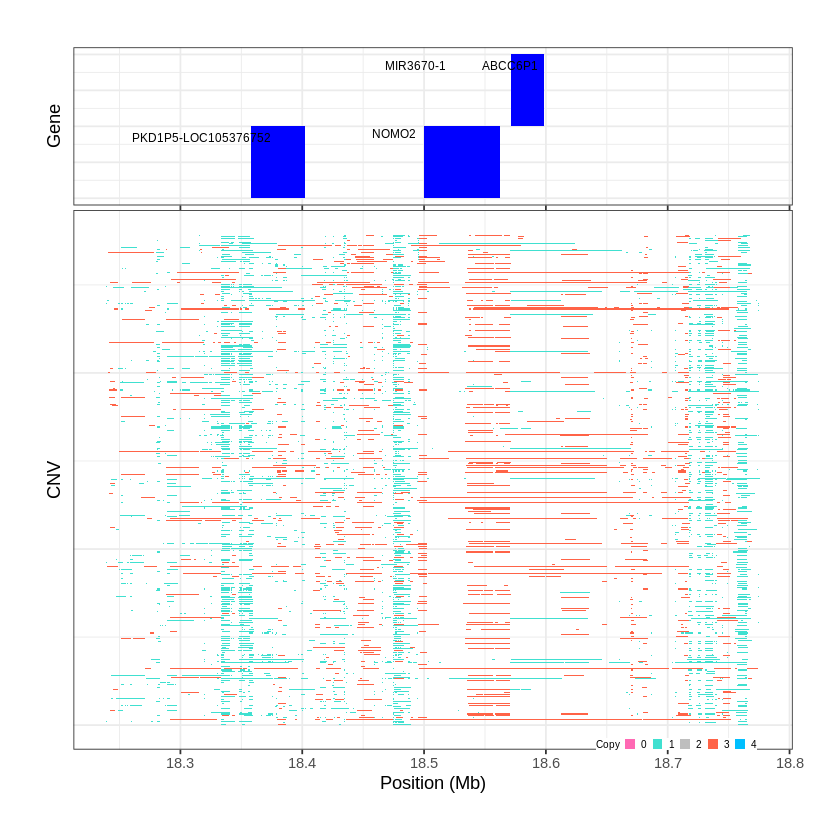

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1635..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 21.841301 - 21.9575 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


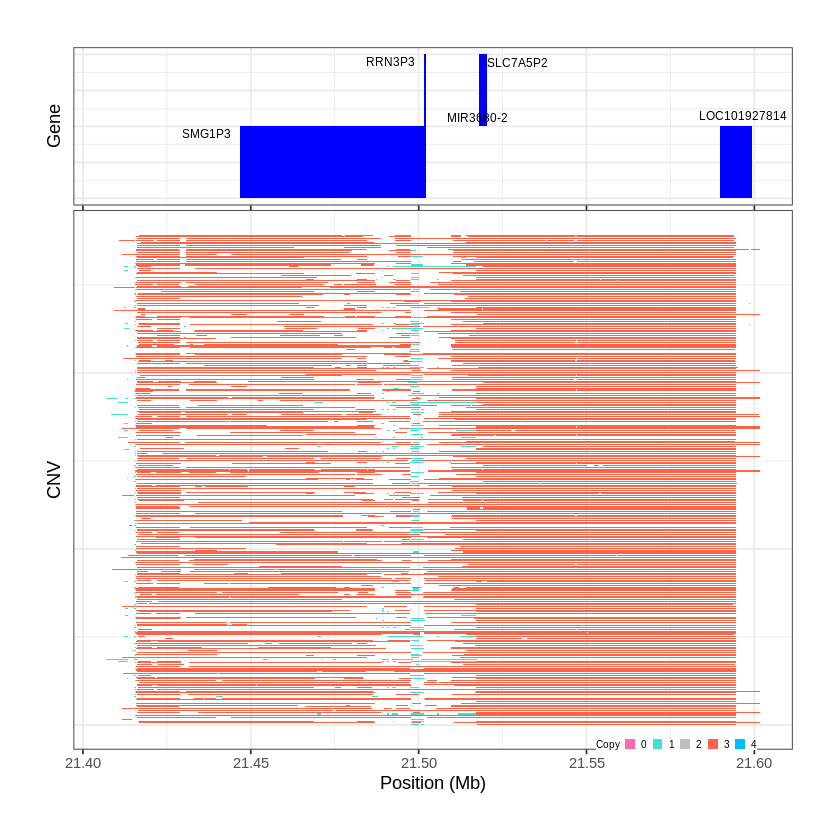

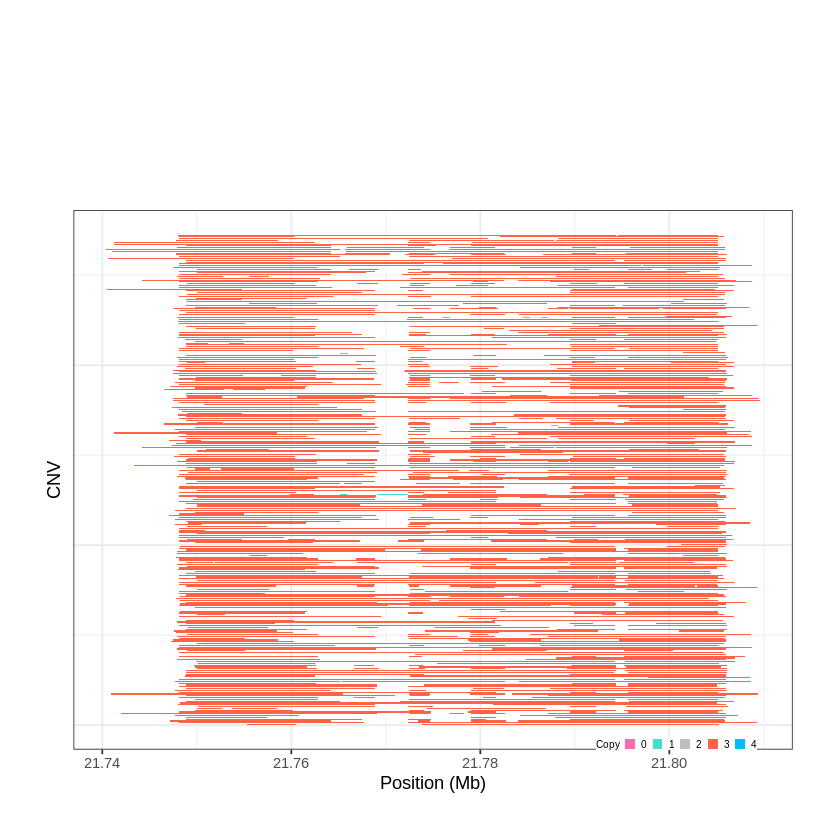

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1636..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 22.369801 - 22.7823 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1637..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 23.047701 - 23.0634 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


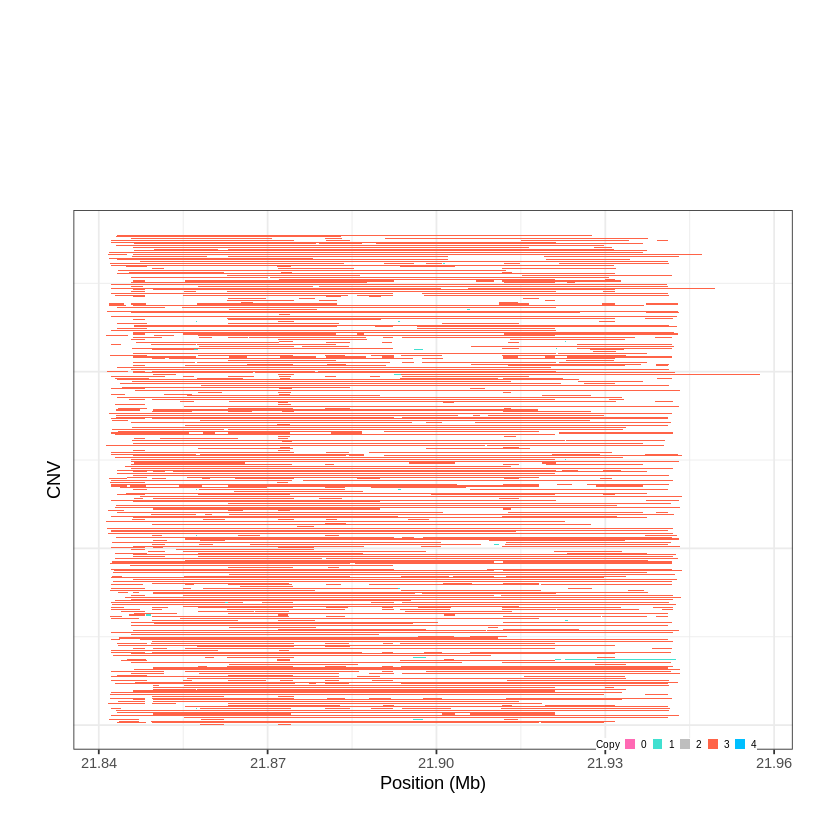

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1638..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 23.759501 - 23.763 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


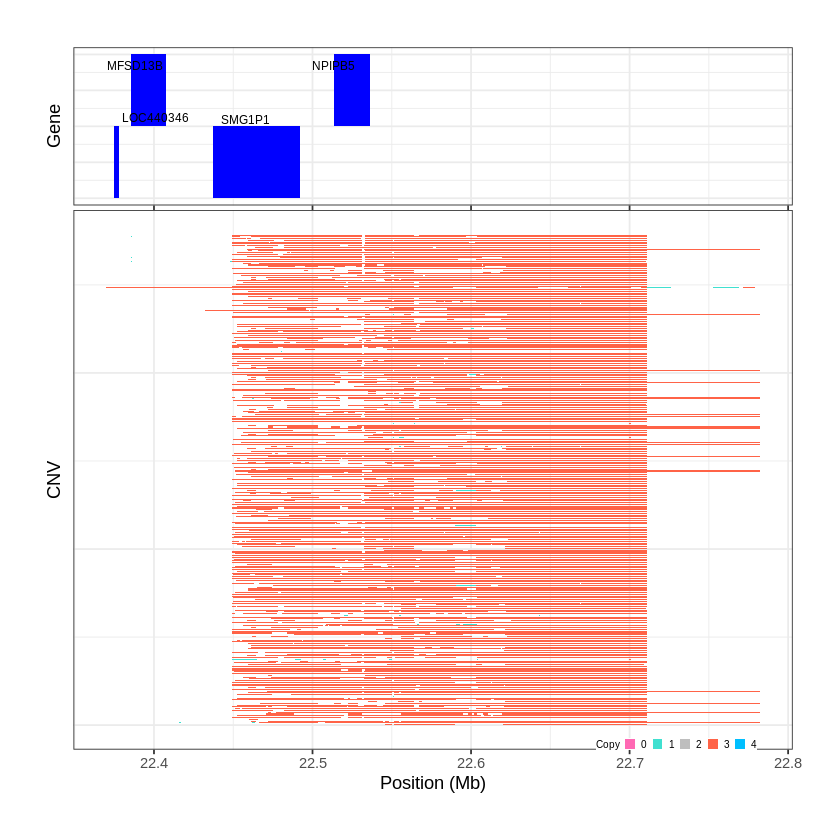

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1639..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 25.333101 - 25.3449 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


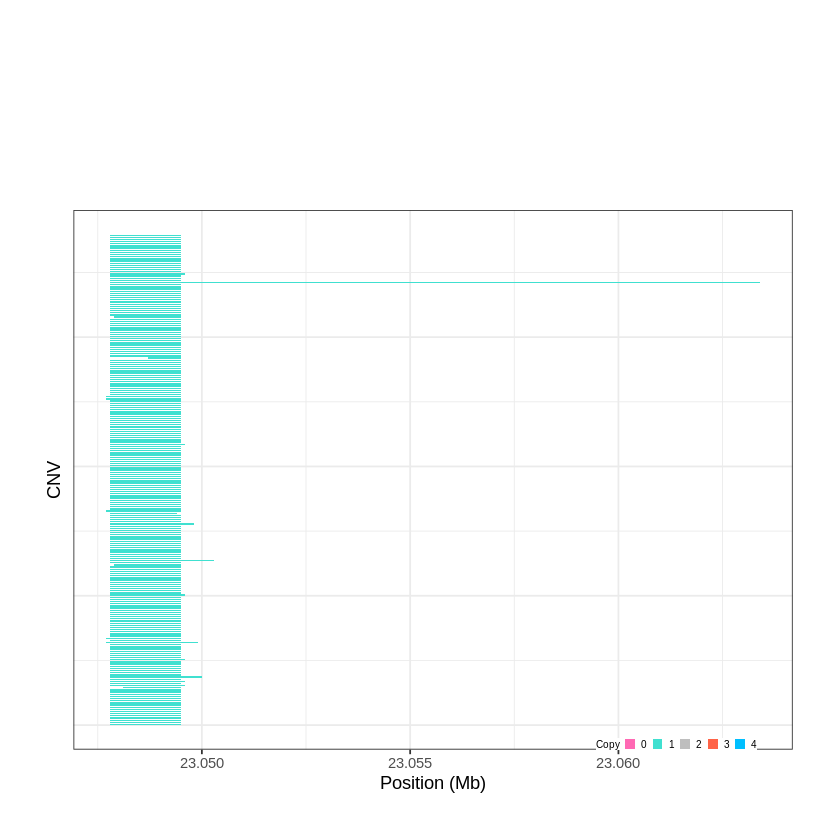

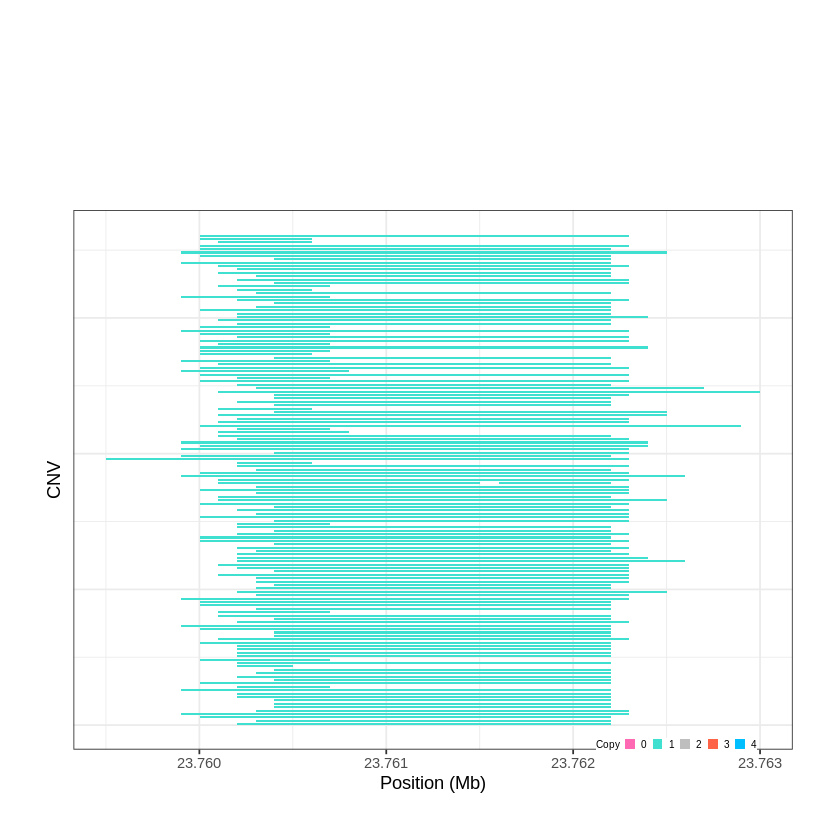

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1640..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 27.703401 - 27.8848 Mb with 276 Individual - "
Plotting gene...


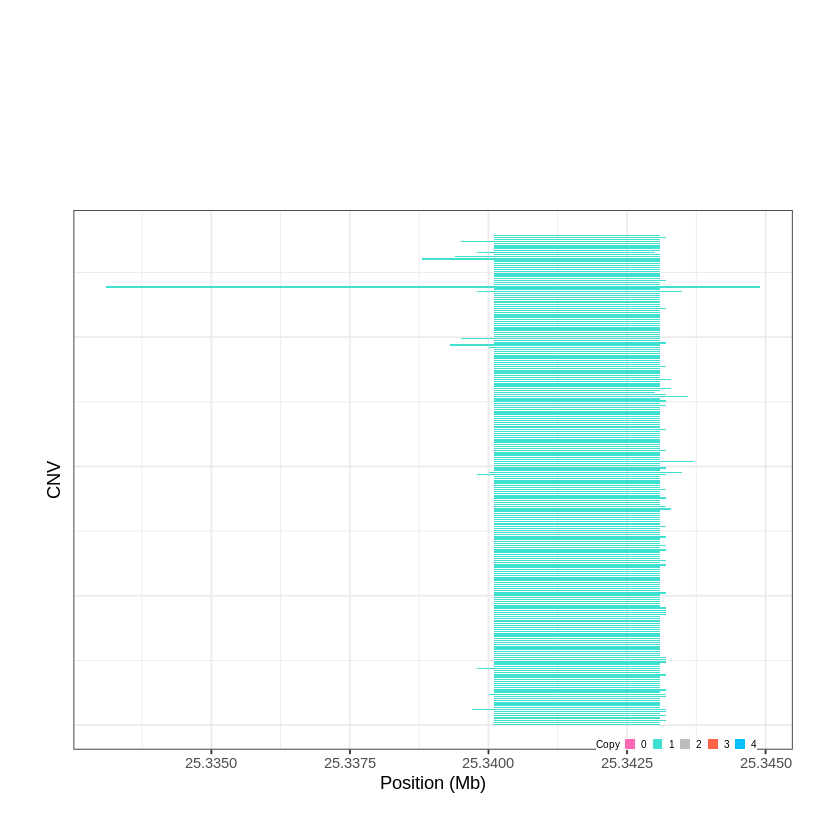

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1641..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 28.349101 - 28.4823 Mb with 259 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1642..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 28.608401 - 28.6272 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


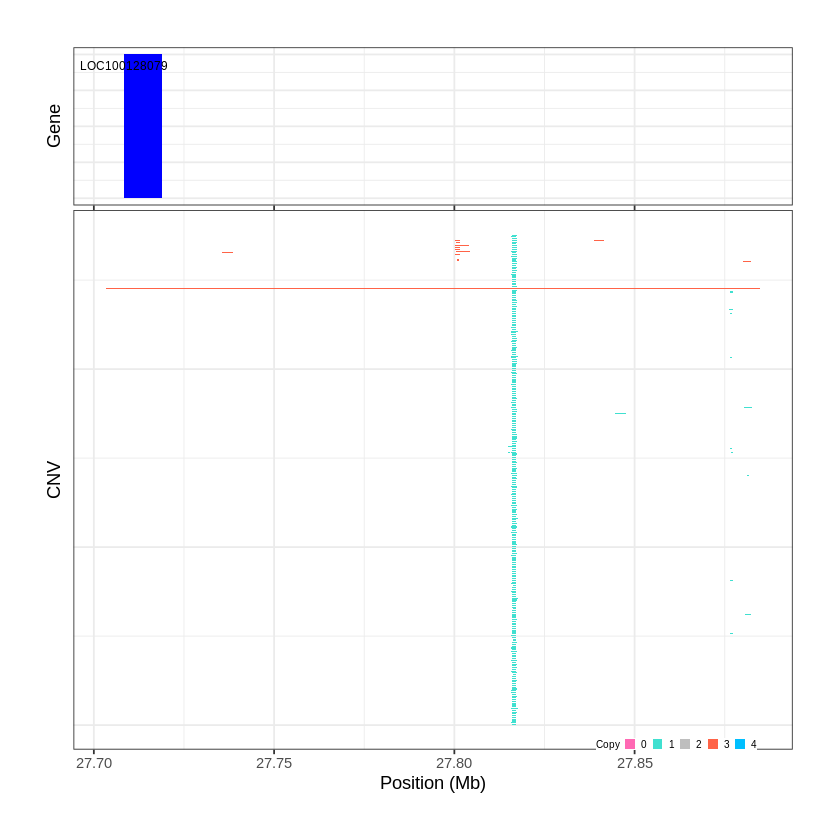

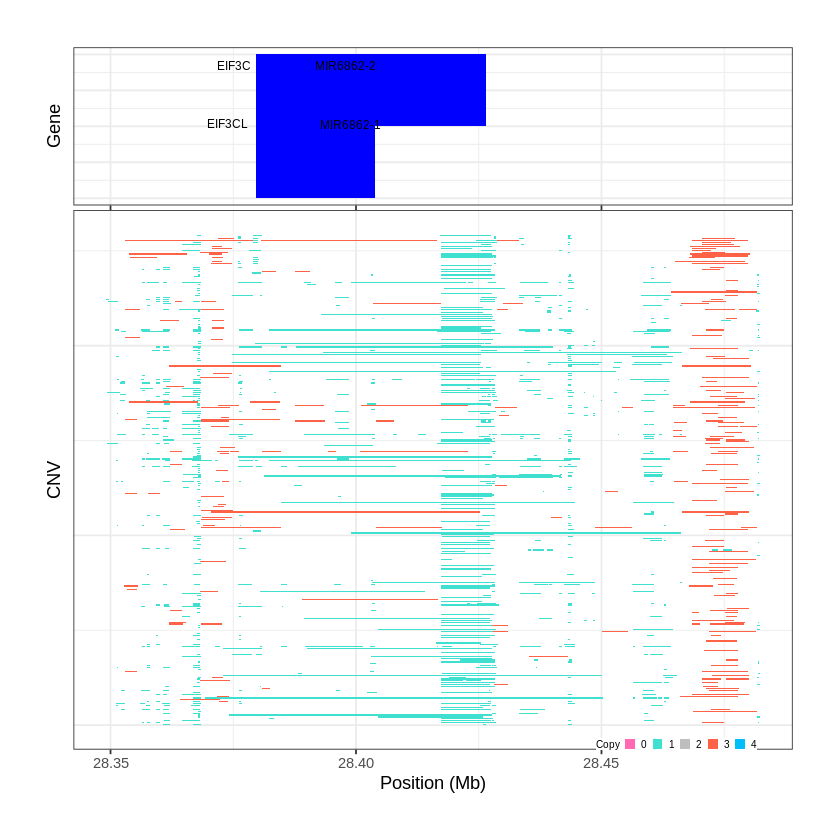

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1643..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 28.650601 - 28.8829 Mb with 274 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1644..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 29.119501 - 29.3499 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


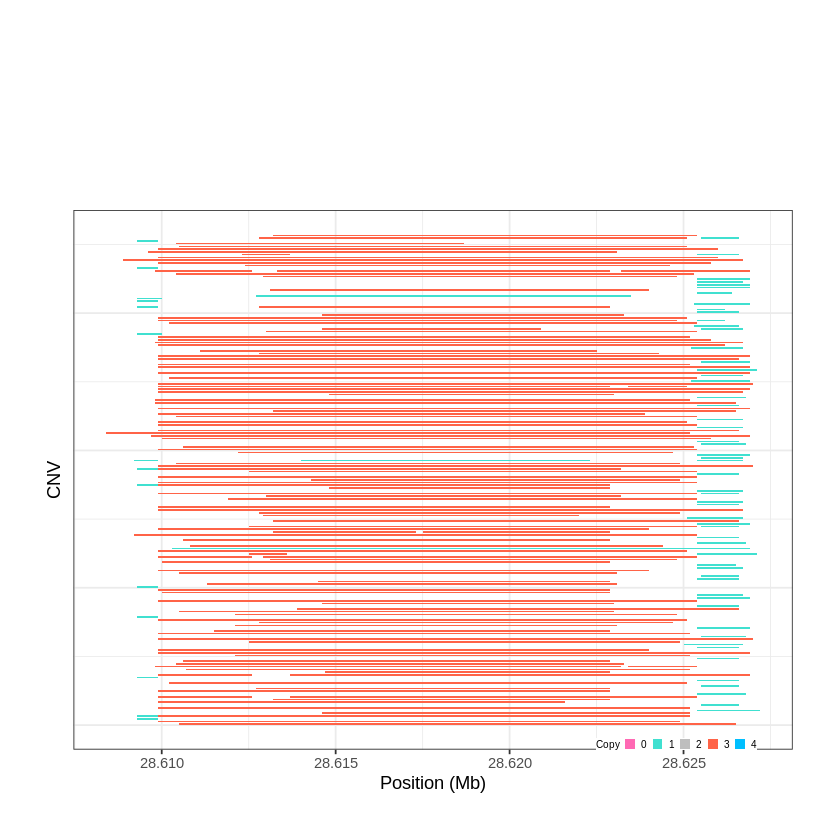

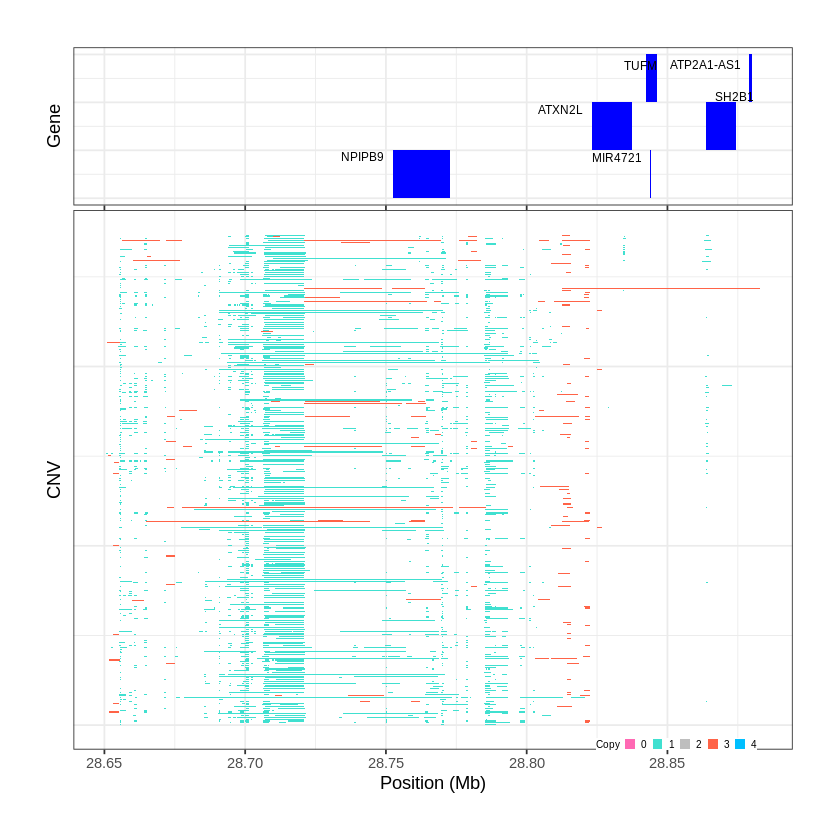

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1645..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 29.377001 - 29.5944 Mb with 277 Individual - "
Plotting gene...


Warning message:
“ggrepel: 4 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1646..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 29.815801 - 29.8192 Mb with 253 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


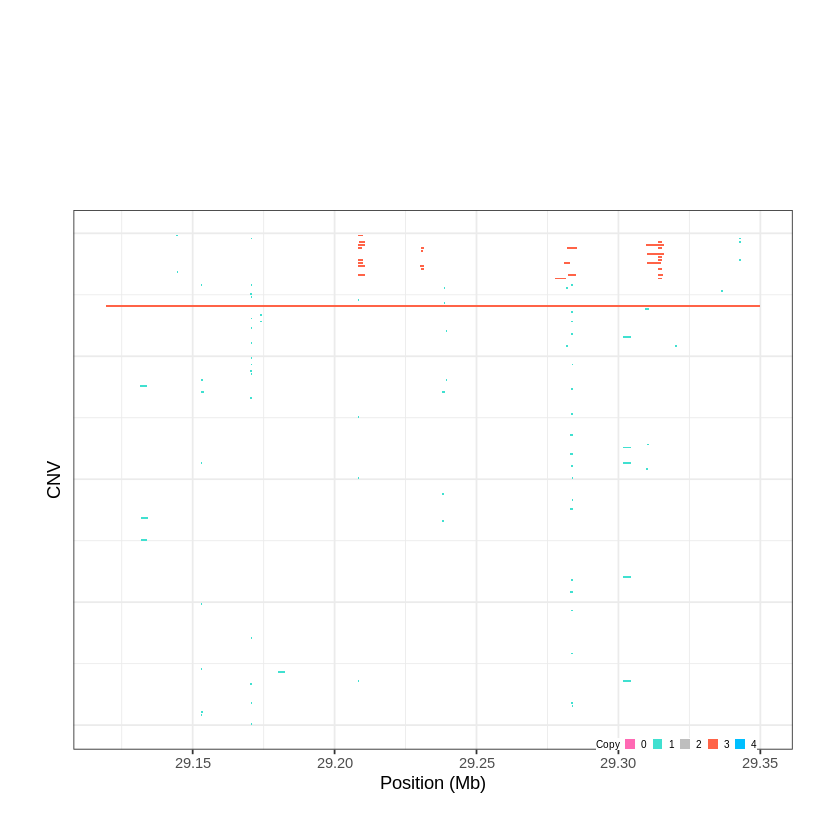

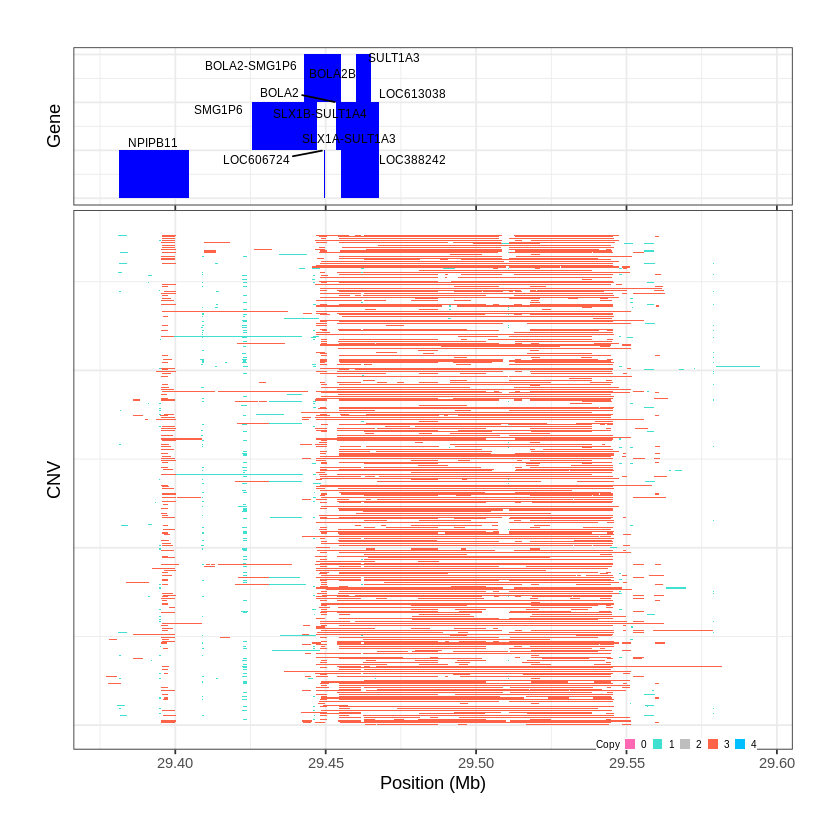

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1647..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 30.196201 - 30.3189 Mb with 272 Individual - "
Plotting gene...


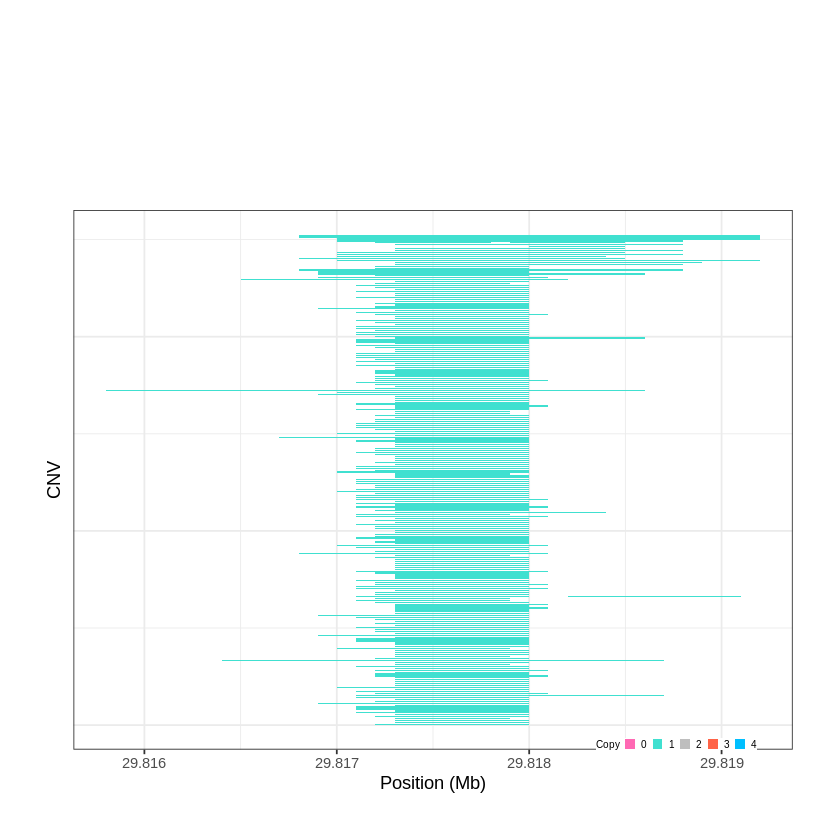

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1648..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 31.960801 - 34.2042 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1649..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 35.217901 - 35.2858 Mb with 264 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


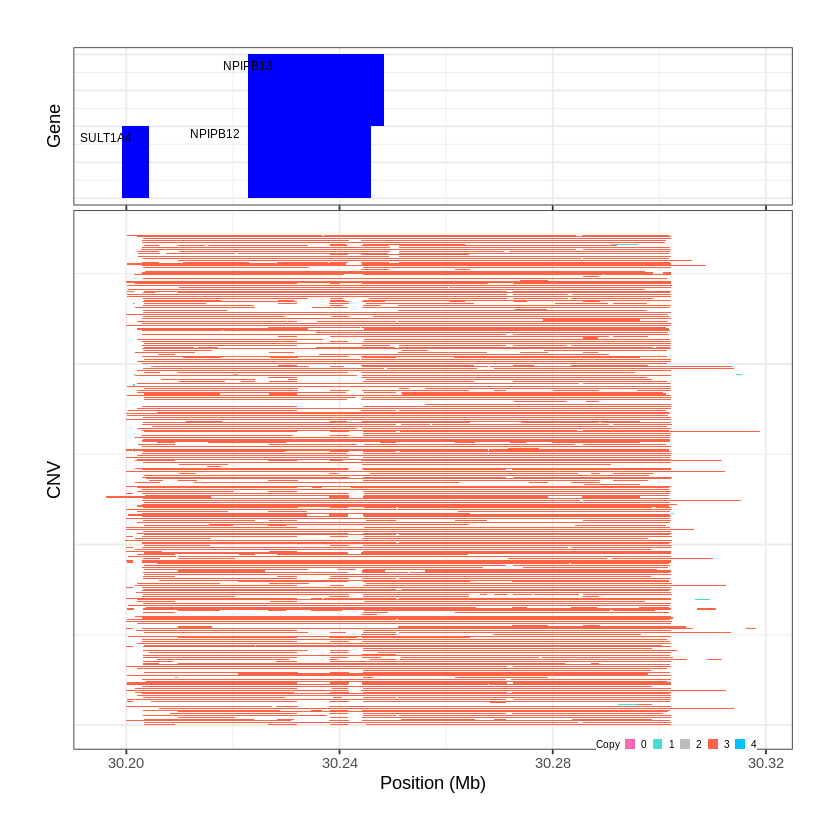

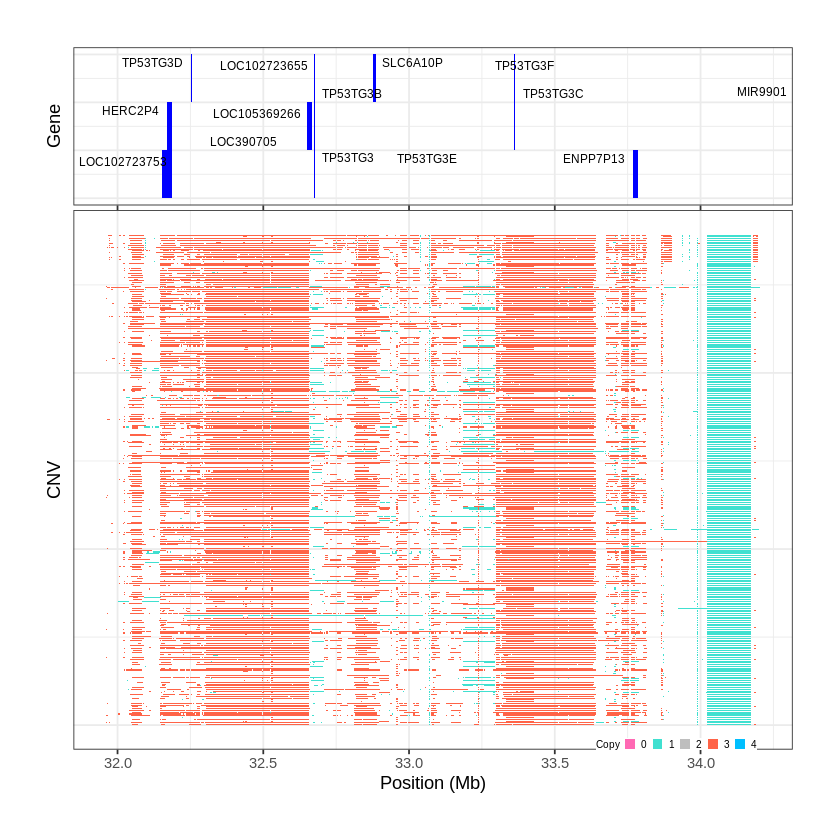

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1650..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 46.385801 - 46.7146 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1651..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 48.508701 - 48.5923 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


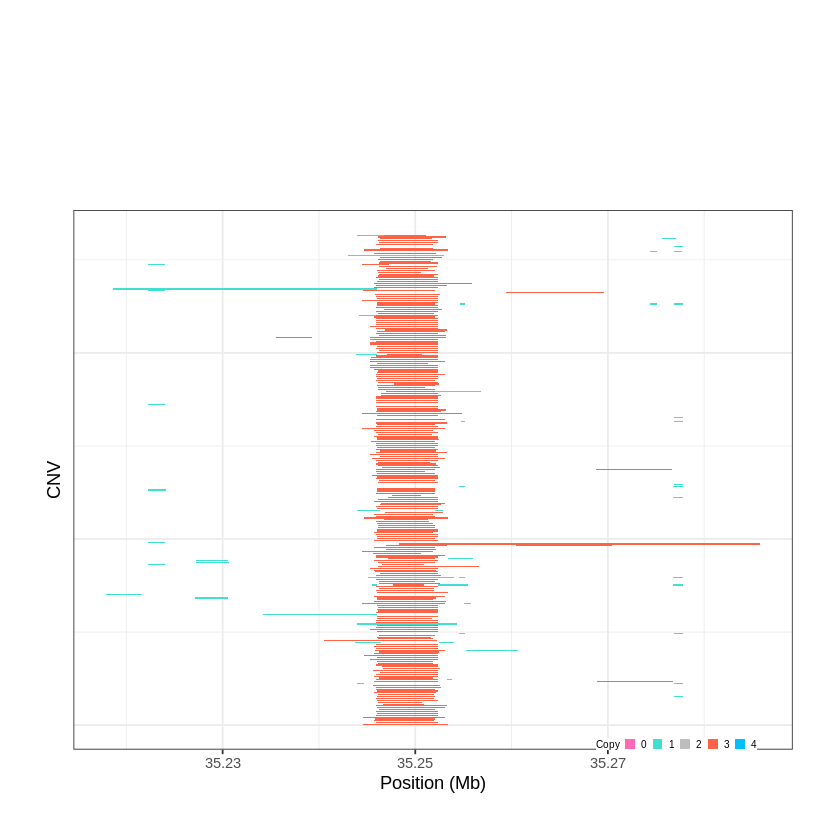

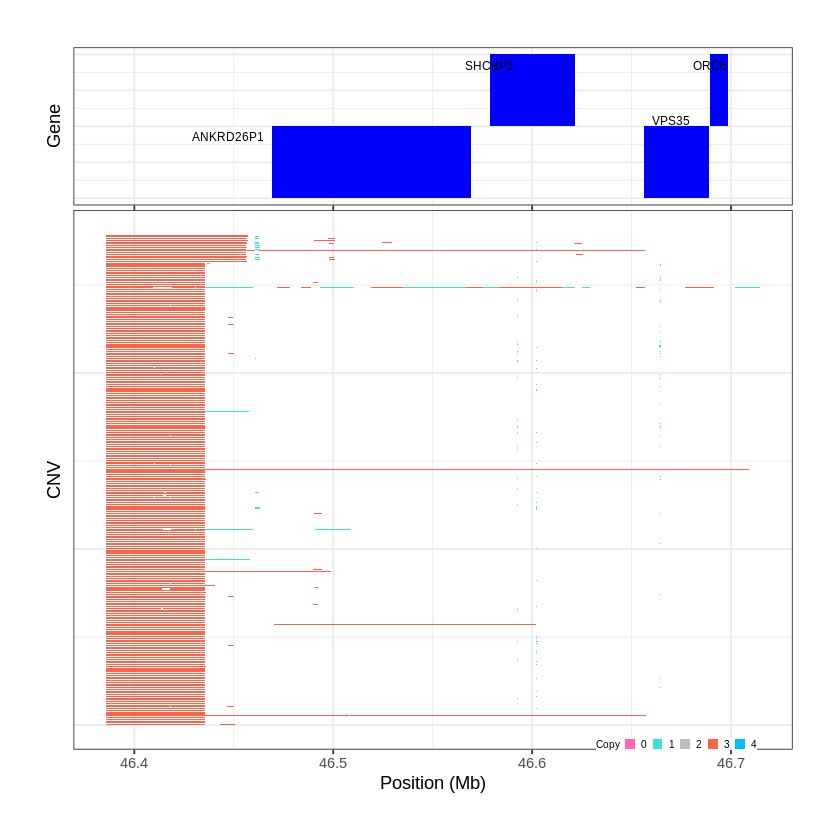

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1652..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 49.434801 - 49.9812 Mb with 213 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1653..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 55.792601 - 55.8247 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


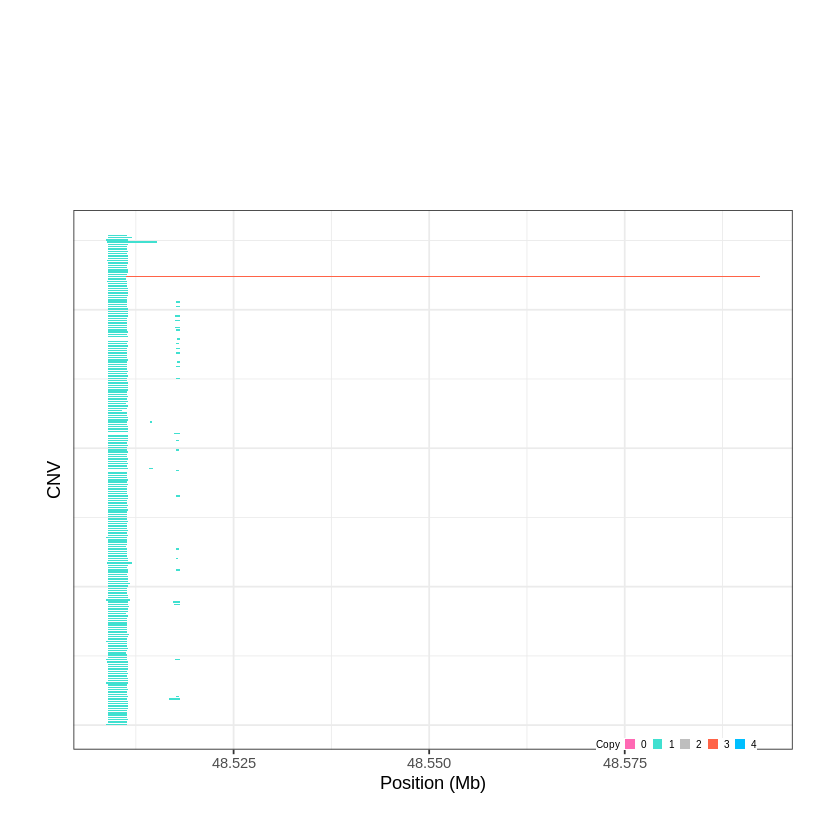

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1654..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 55.840101 - 55.8687 Mb with 147 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


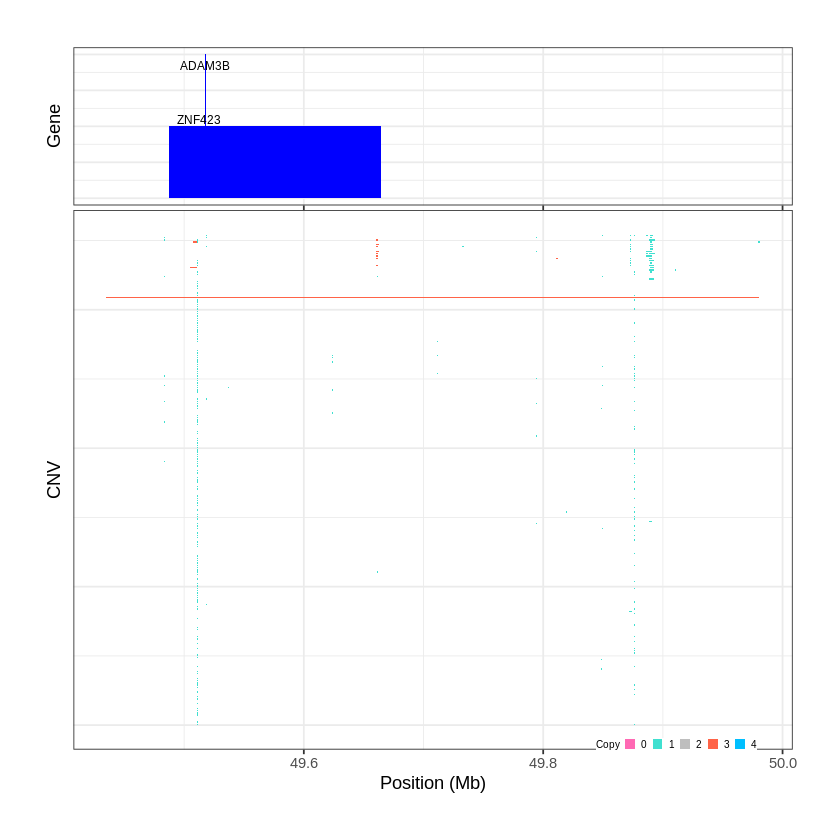

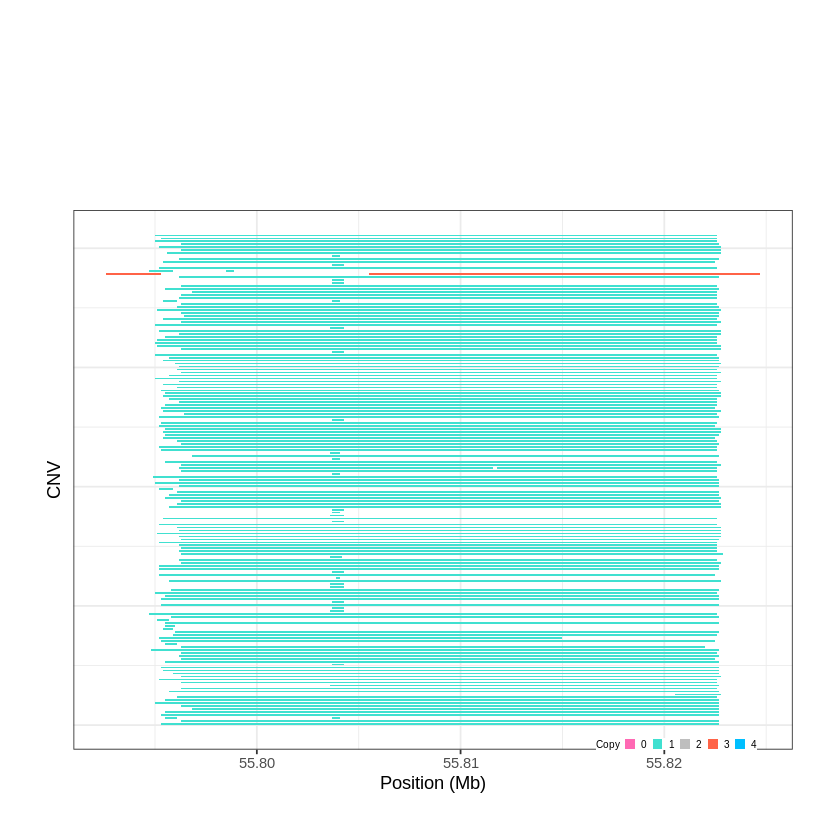

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1655..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 56.885201 - 57.3617 Mb with 168 Individual - "
Plotting gene...


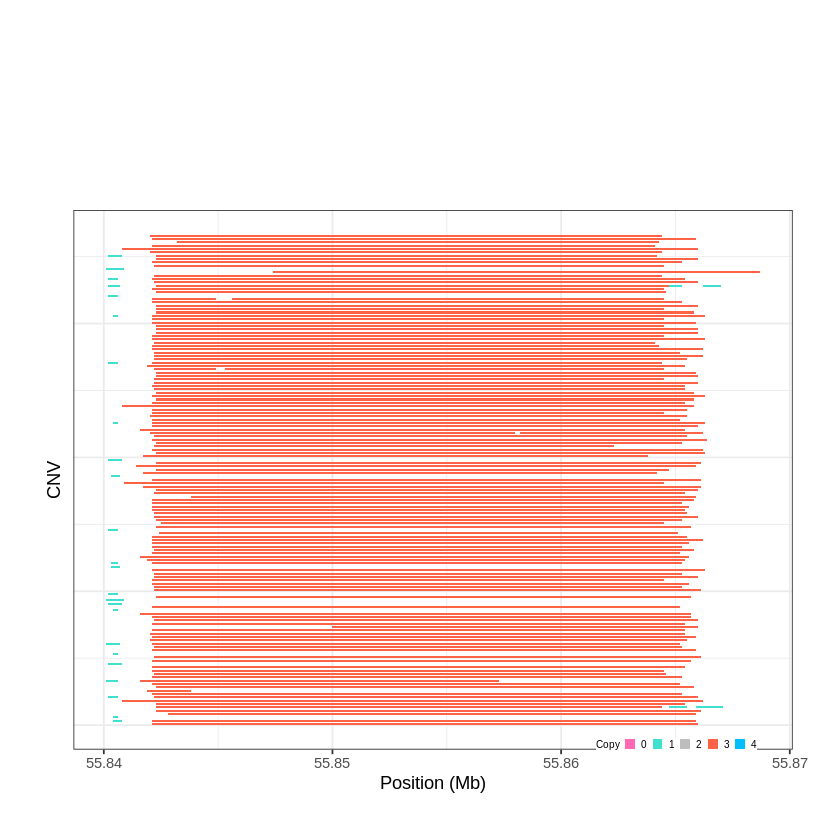

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1656..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 57.366301 - 58.2076 Mb with 179 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1657..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 60.032101 - 60.0324 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


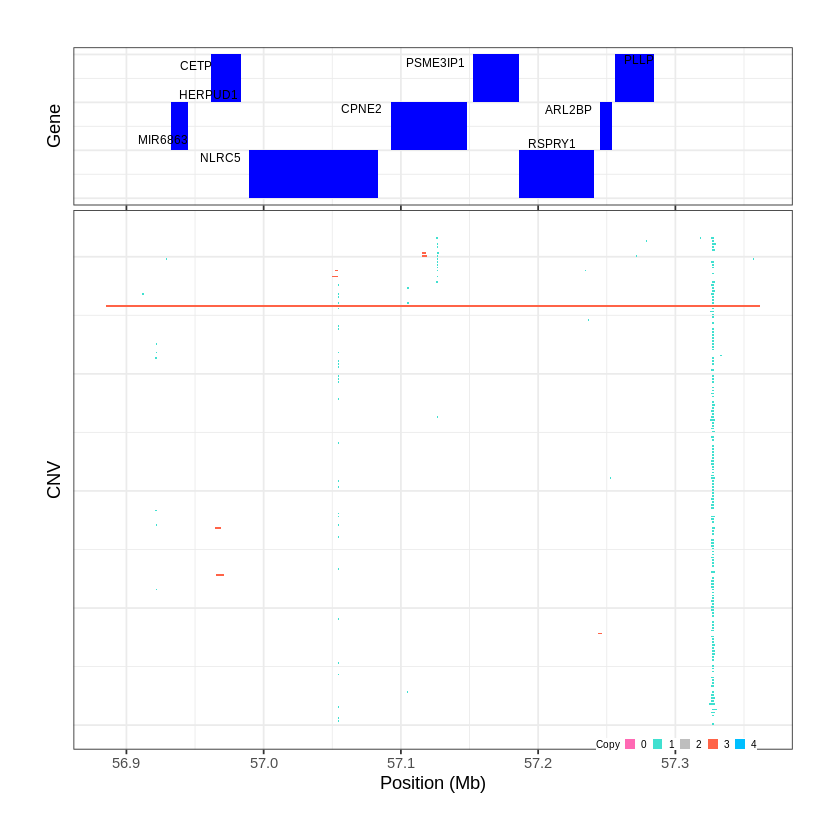

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1658..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 65.161601 - 65.1679 Mb with 171 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


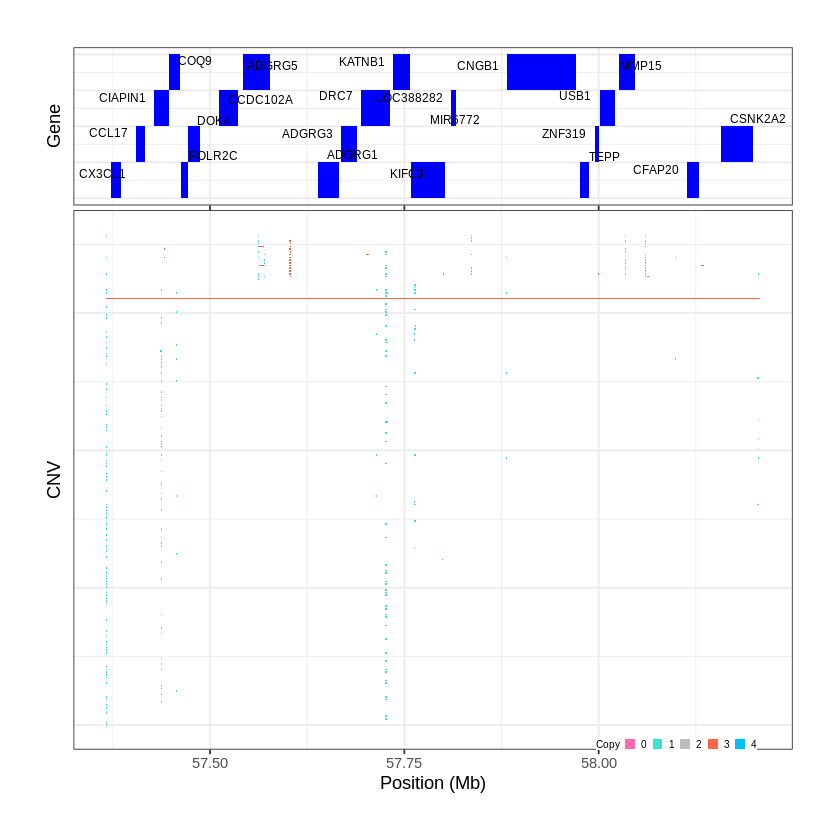

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1659..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 65.347301 - 65.3699 Mb with 247 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


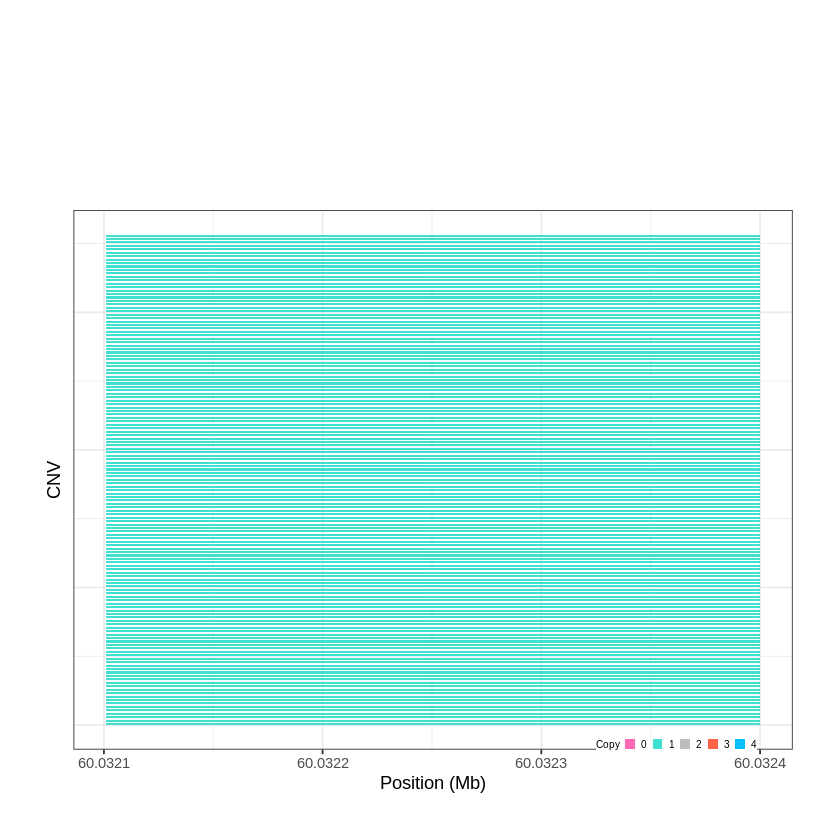

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1660..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 66.907101 - 66.9084 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


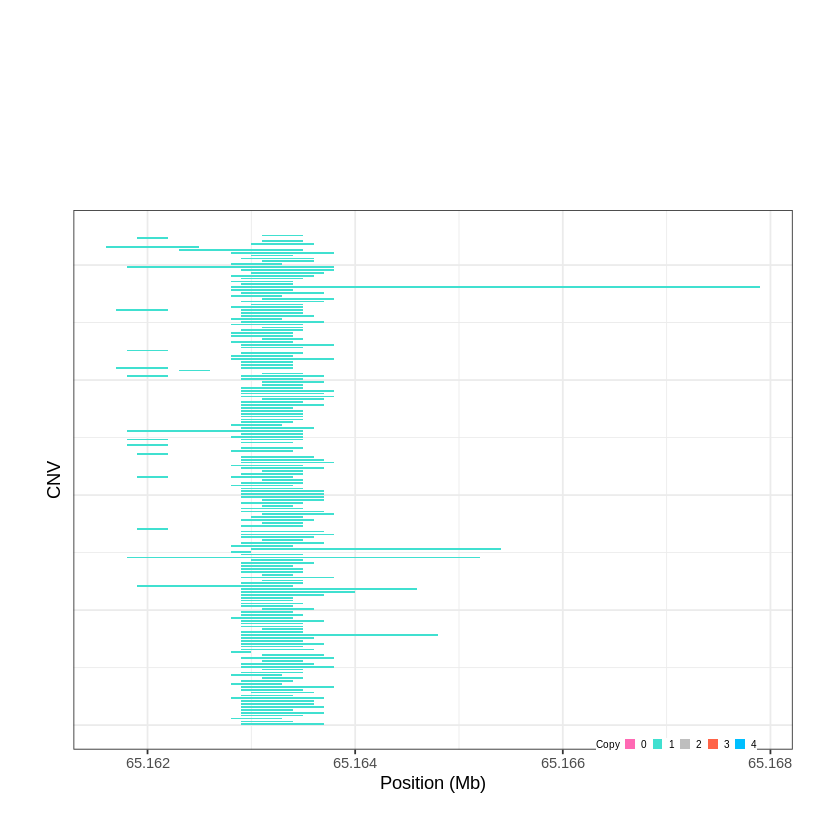

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1661..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 68.764401 - 68.7659 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


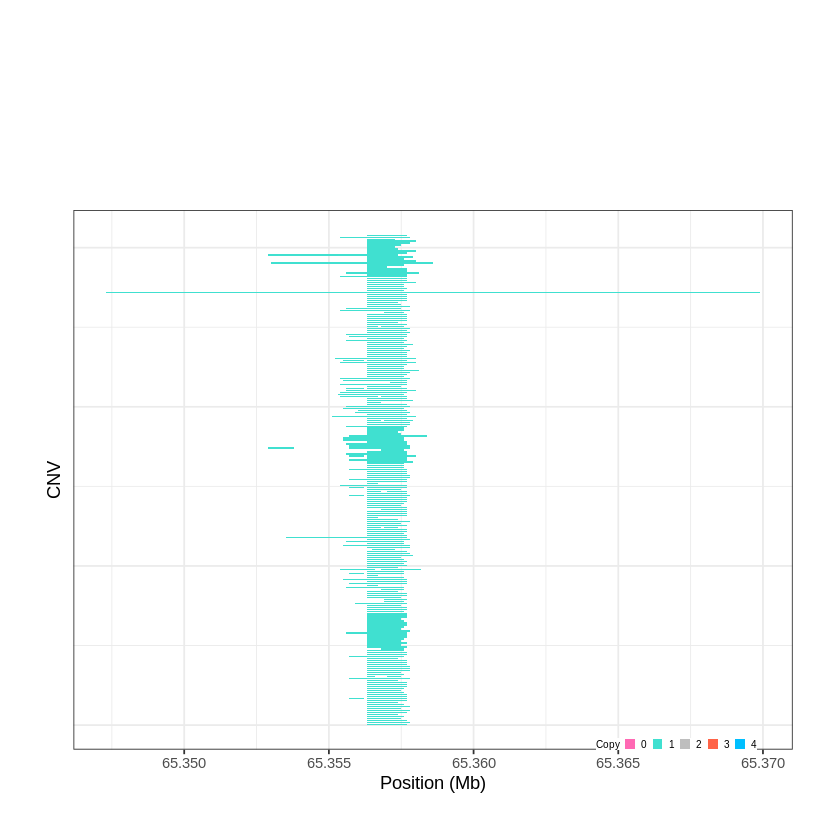

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1662..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 69.977501 - 70.0077 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


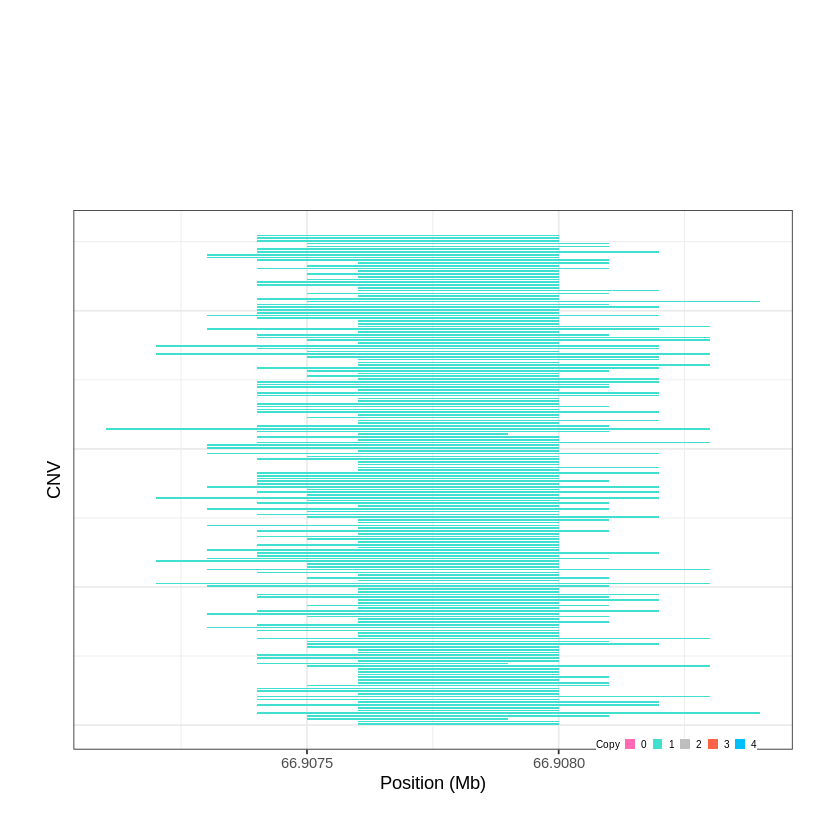

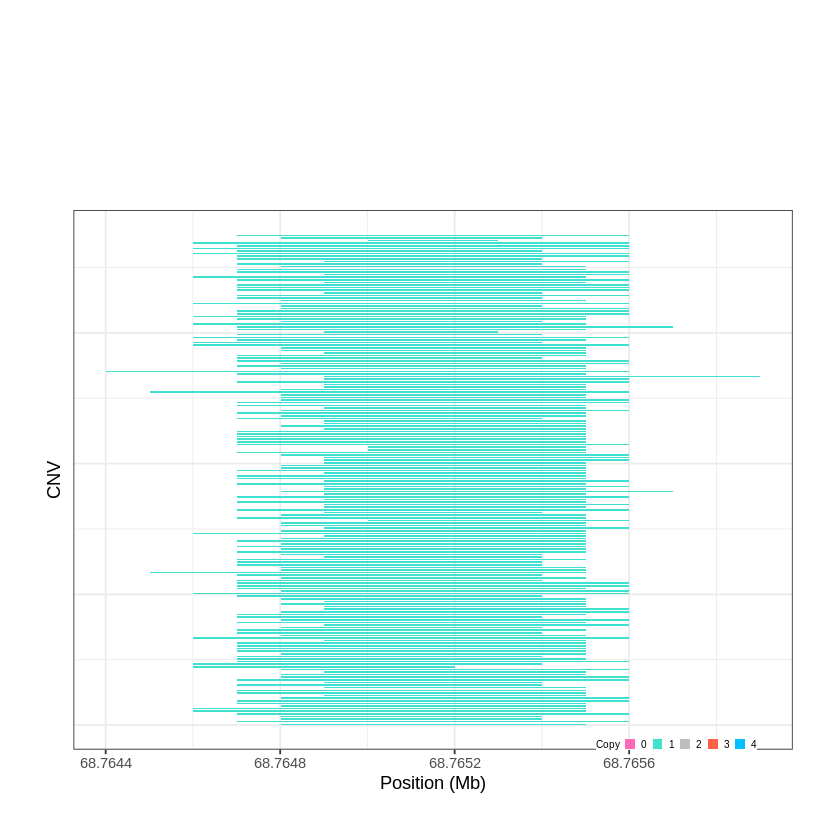

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1663..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 70.009501 - 70.2402 Mb with 270 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1664..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 72.753301 - 72.7536 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


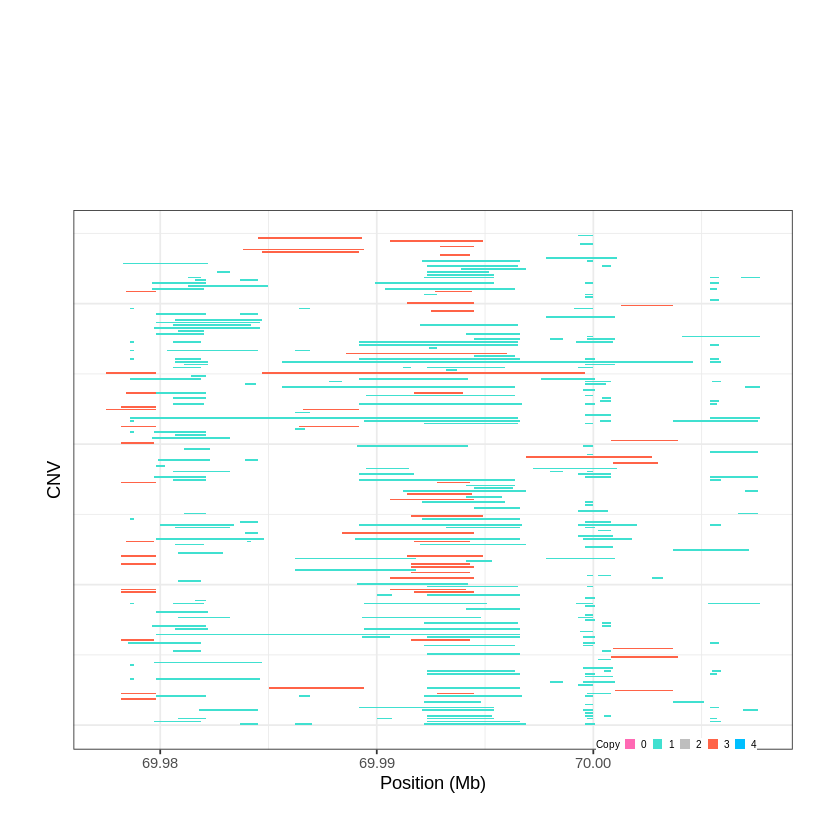

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1665..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 73.858501 - 74.0277 Mb with 222 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


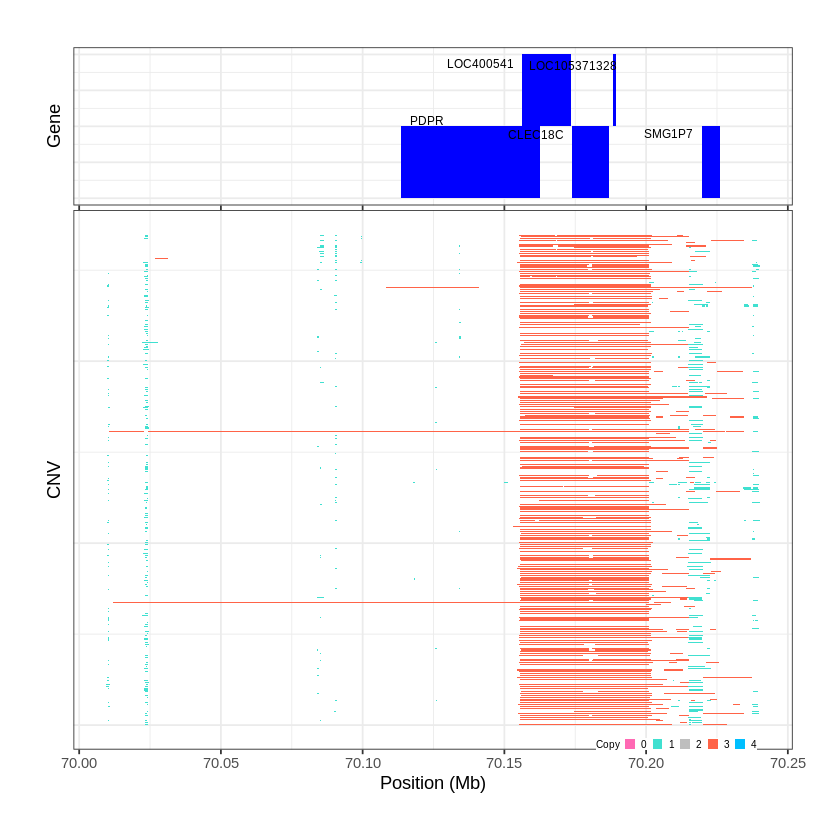

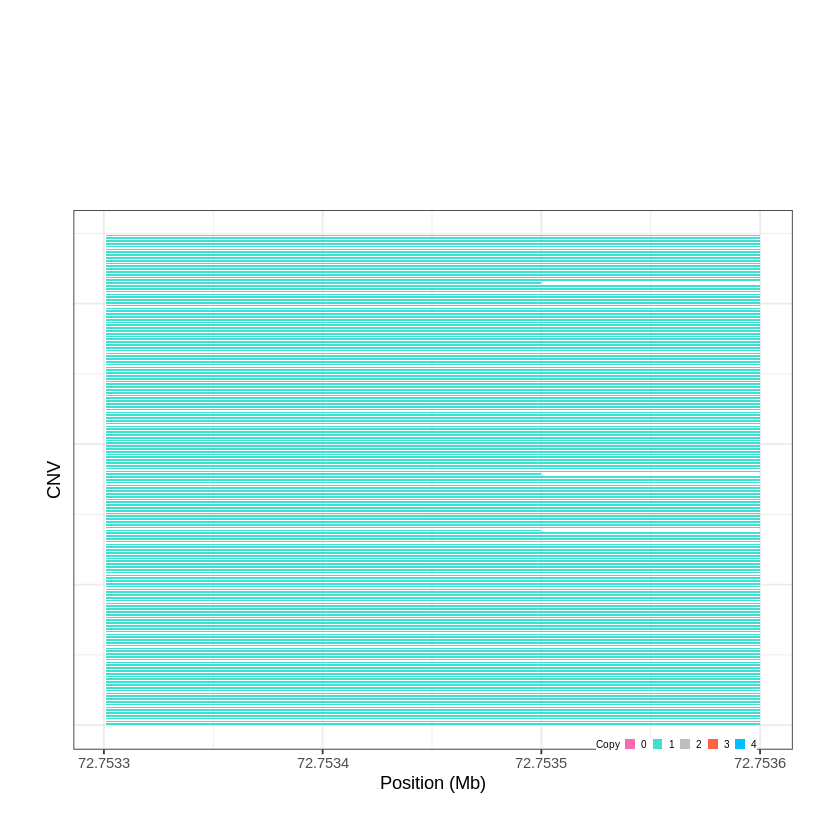

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1666..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 74.363401 - 74.4639 Mb with 278 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1667..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 75.416001 - 75.4308 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


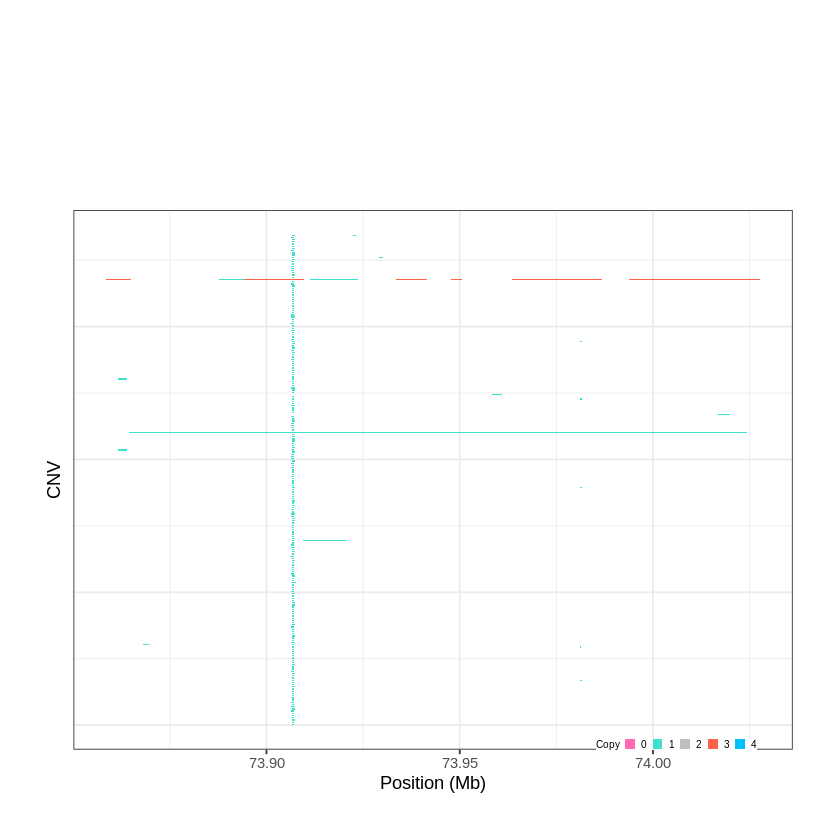

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1668..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 76.538201 - 76.5669 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


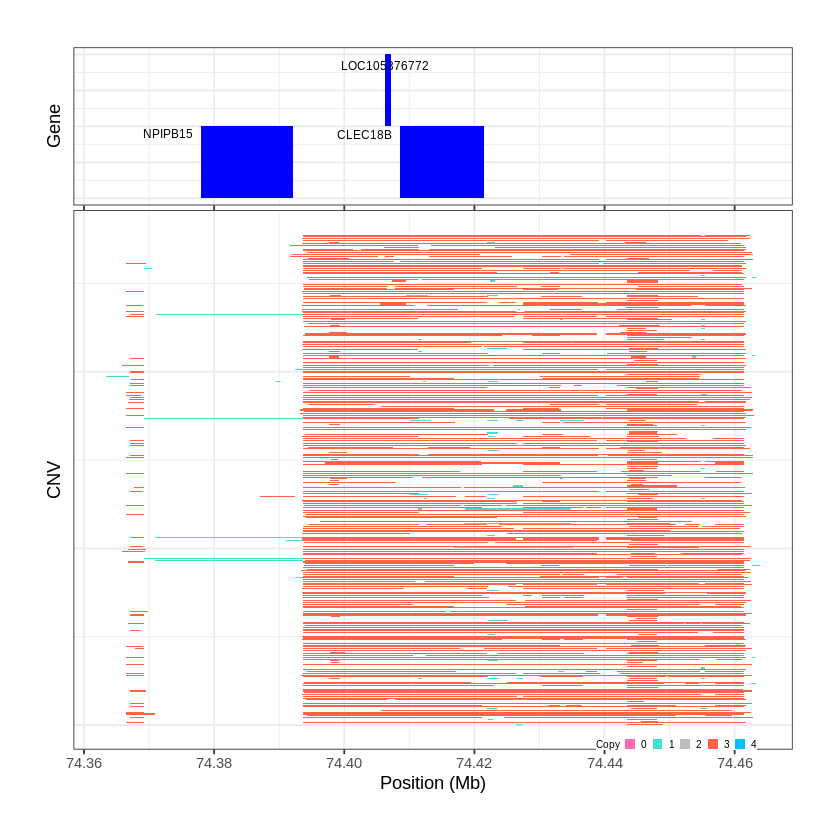

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1669..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 78.616301 - 78.6446 Mb with 181 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


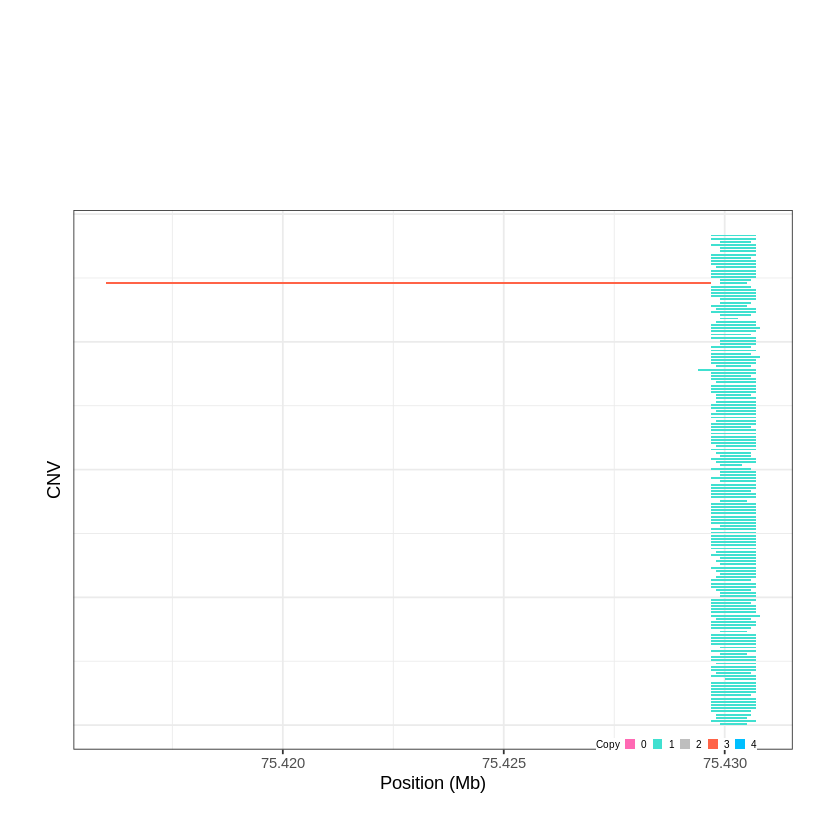

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1670..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 79.498301 - 79.5207 Mb with 181 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


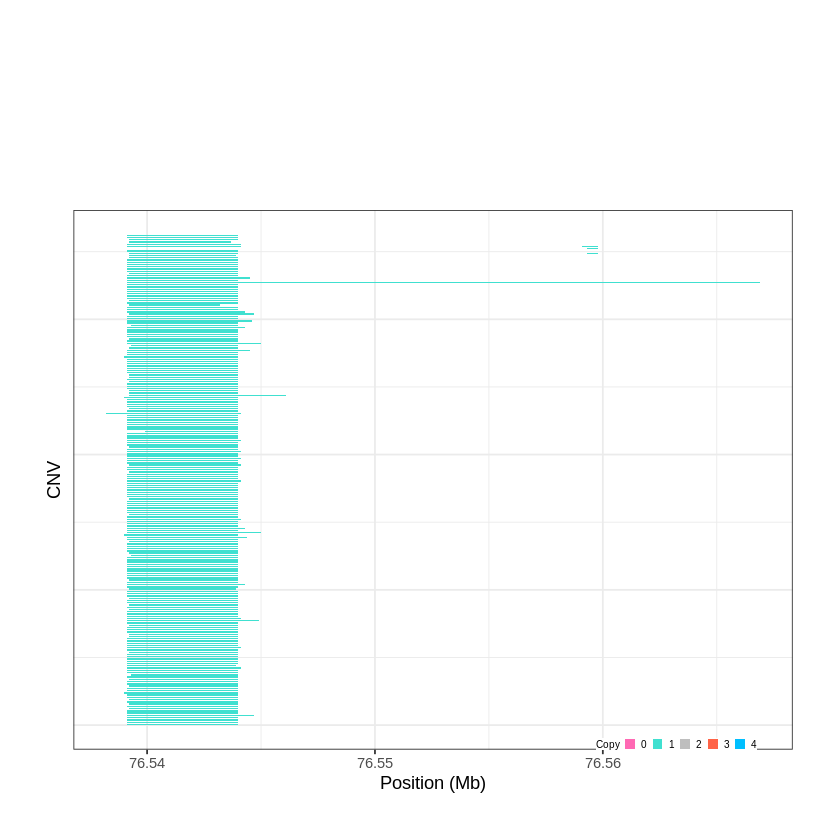

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1671..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 80.604101 - 80.6053 Mb with 162 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


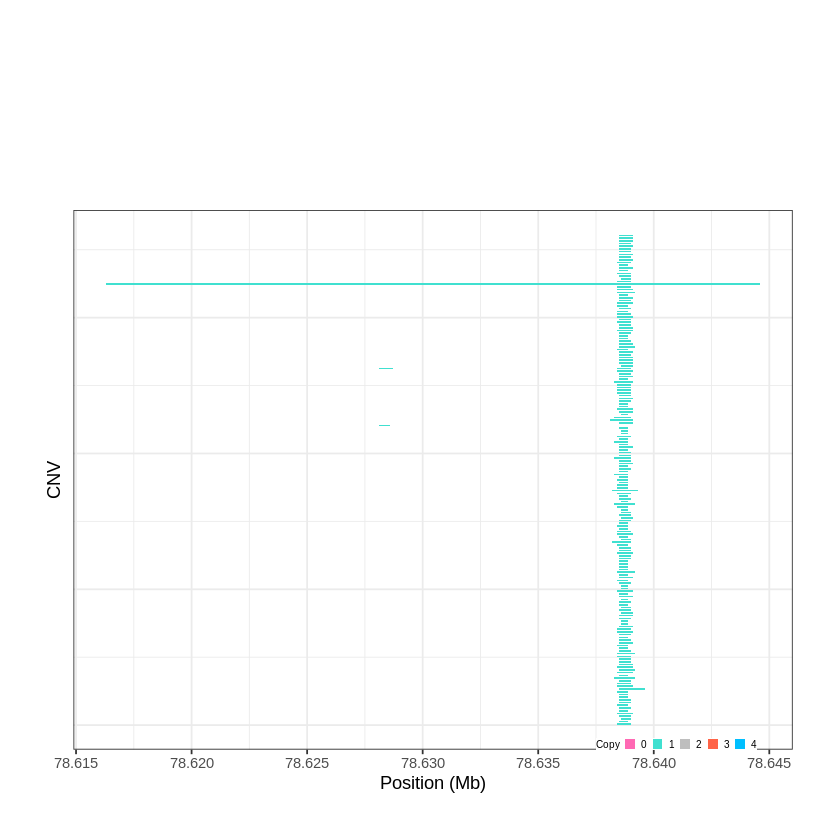

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1672..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 81.737301 - 81.7468 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


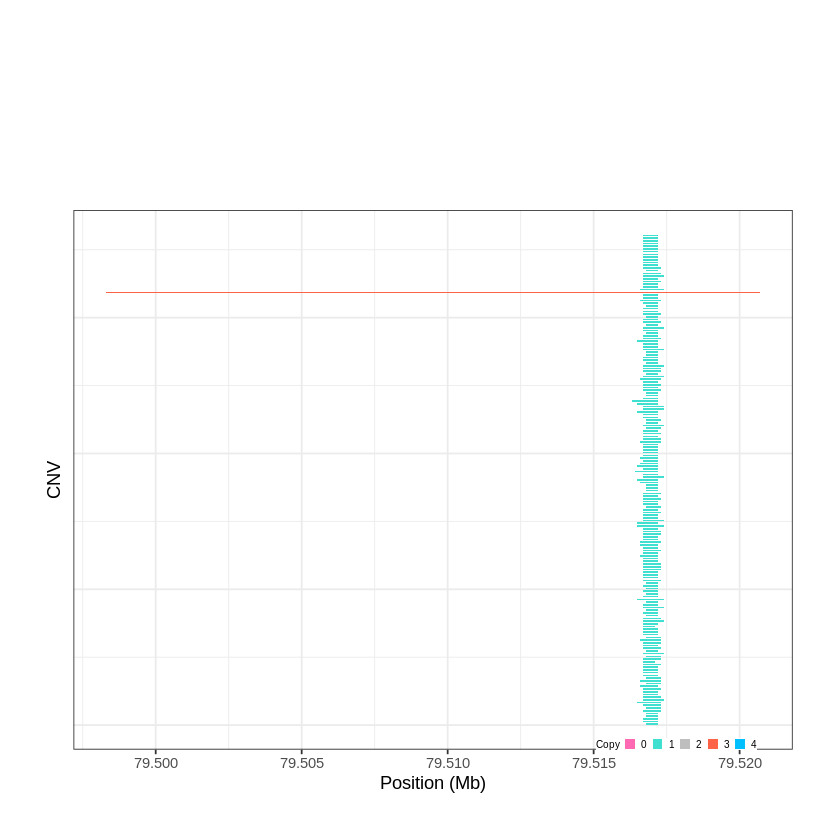

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1673..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 83.533601 - 83.5346 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


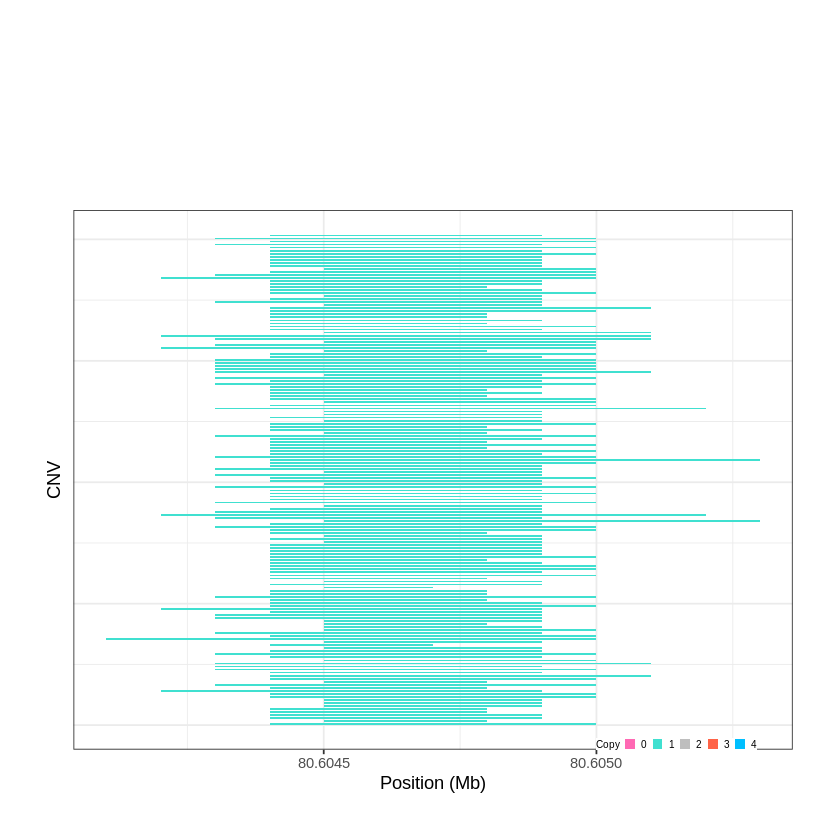

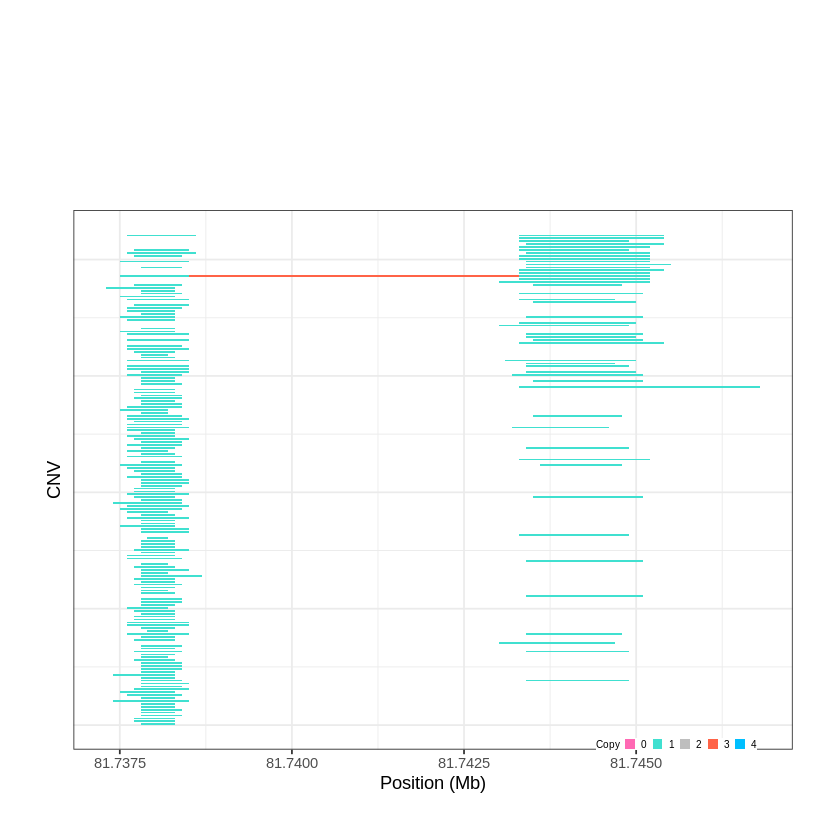

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1674..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 84.143601 - 84.6817 Mb with 152 Individual - "
Plotting gene...


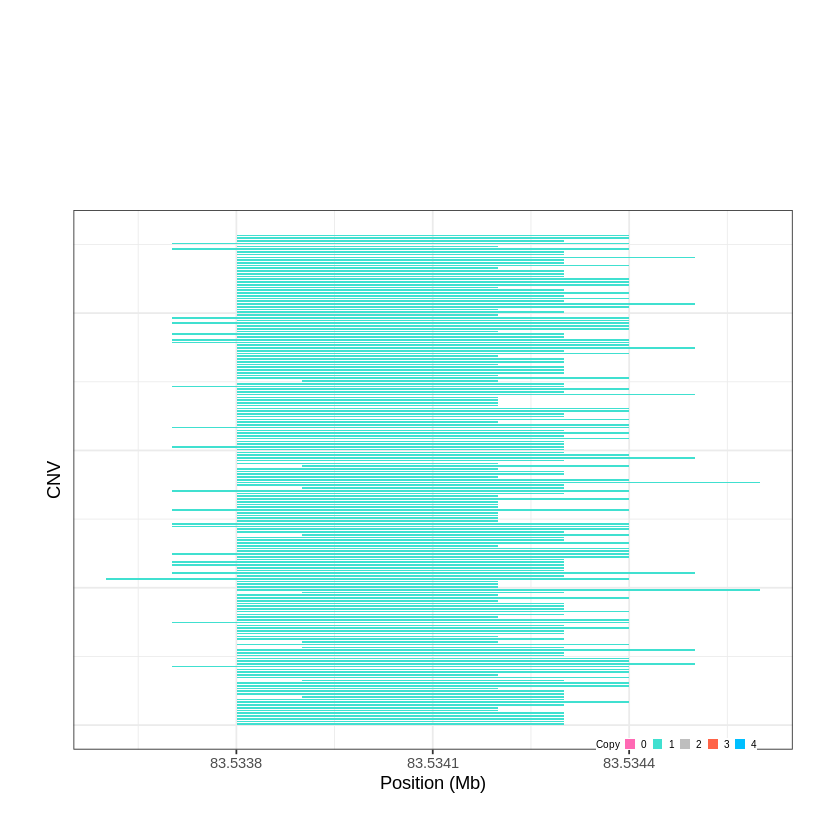

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1675..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 85.053901 - 85.6436 Mb with 279 Individual - "
Plotting gene...


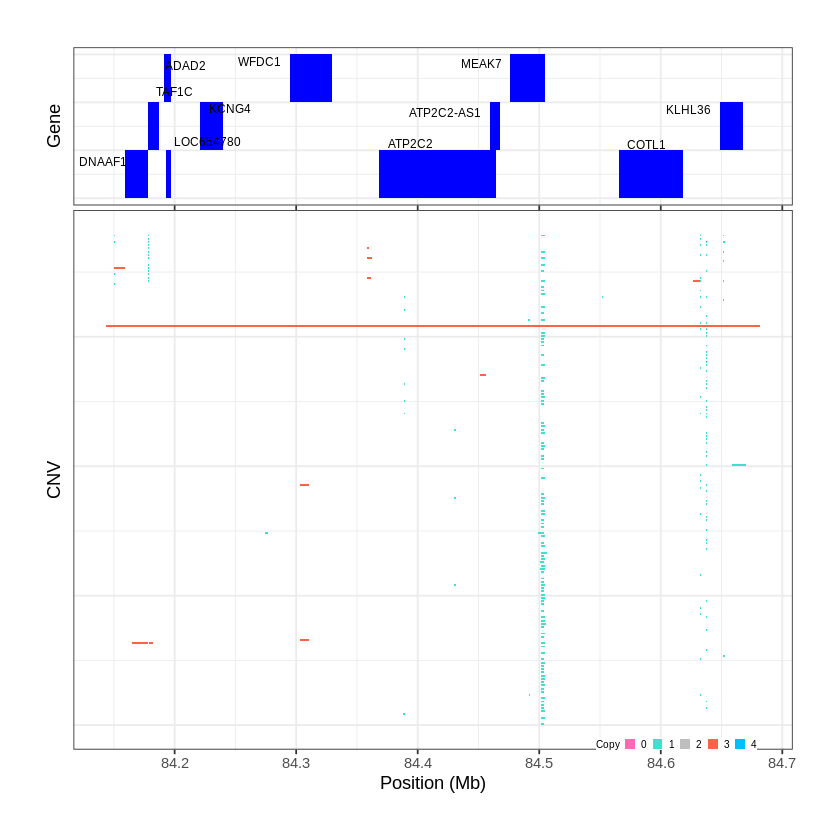

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1676..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 87.418301 - 88.3894 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1677..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 88.389401 - 88.4394 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


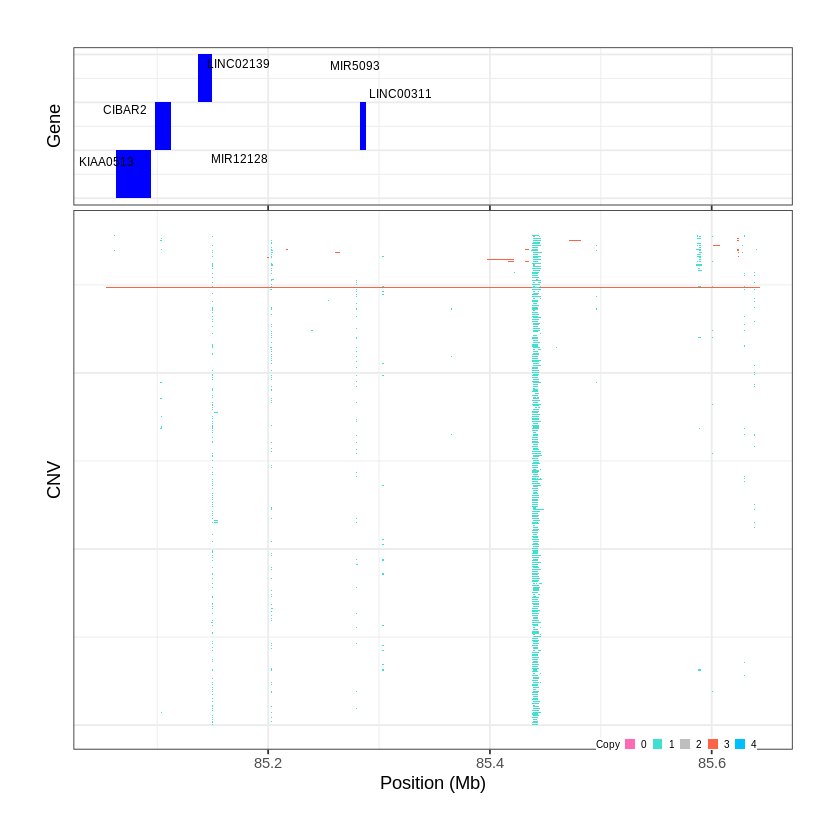

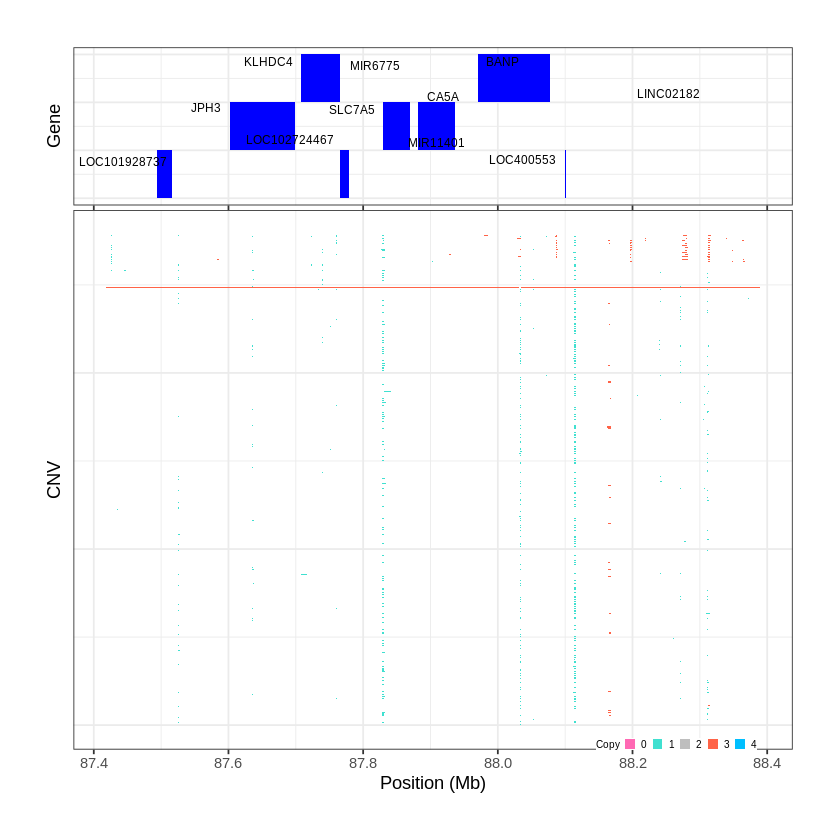

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1678..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 88.857101 - 88.8644 Mb with 154 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1679..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 88.981001 - 88.9825 Mb with 230 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


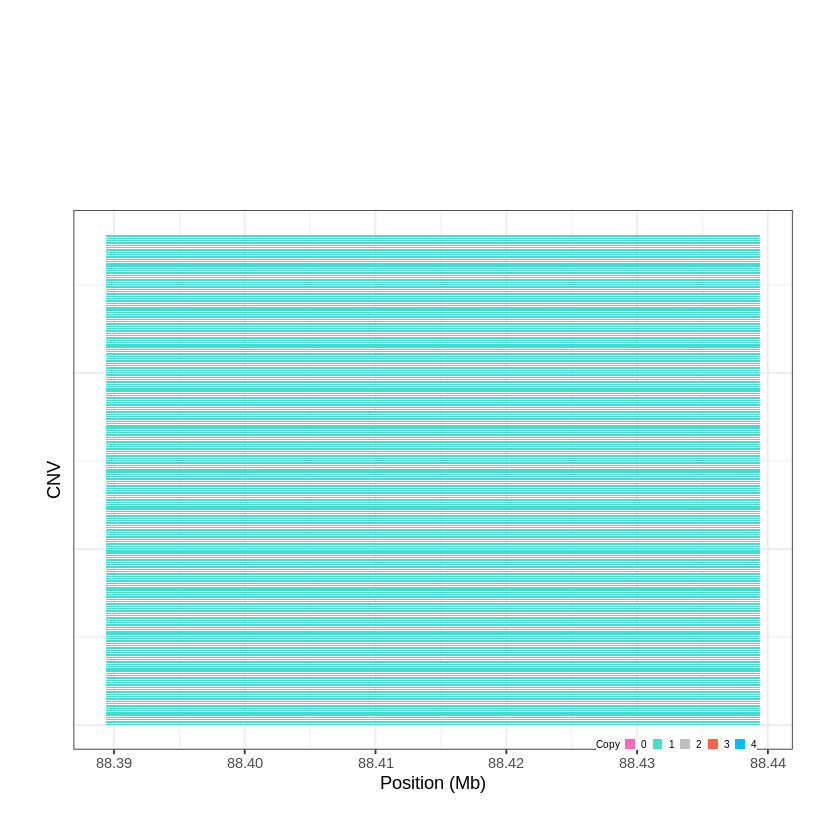

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1680..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 89.065501 - 89.0707 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


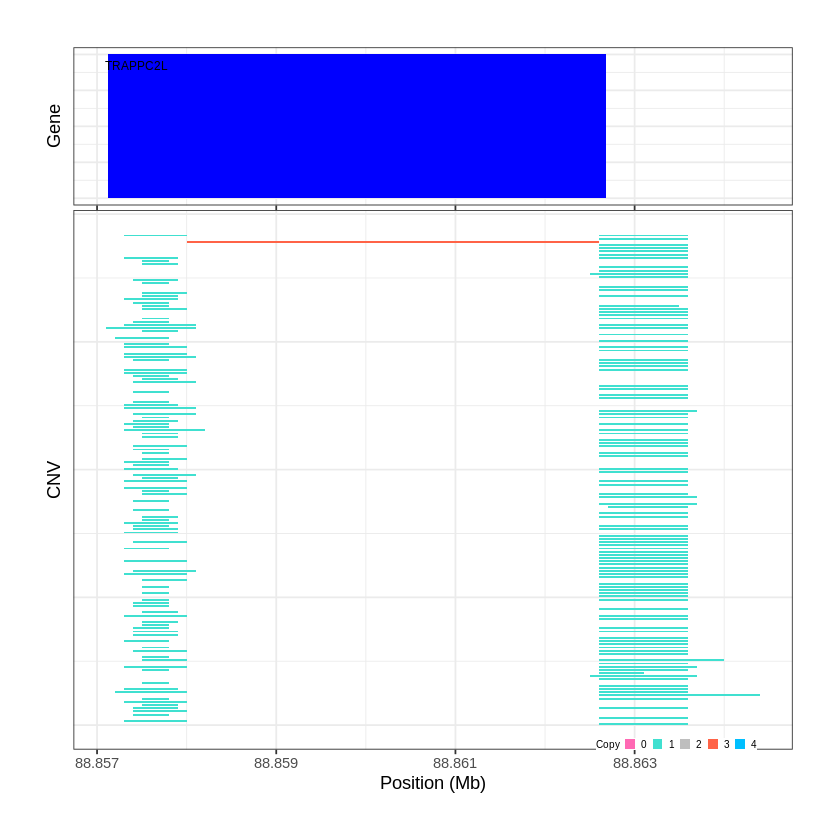

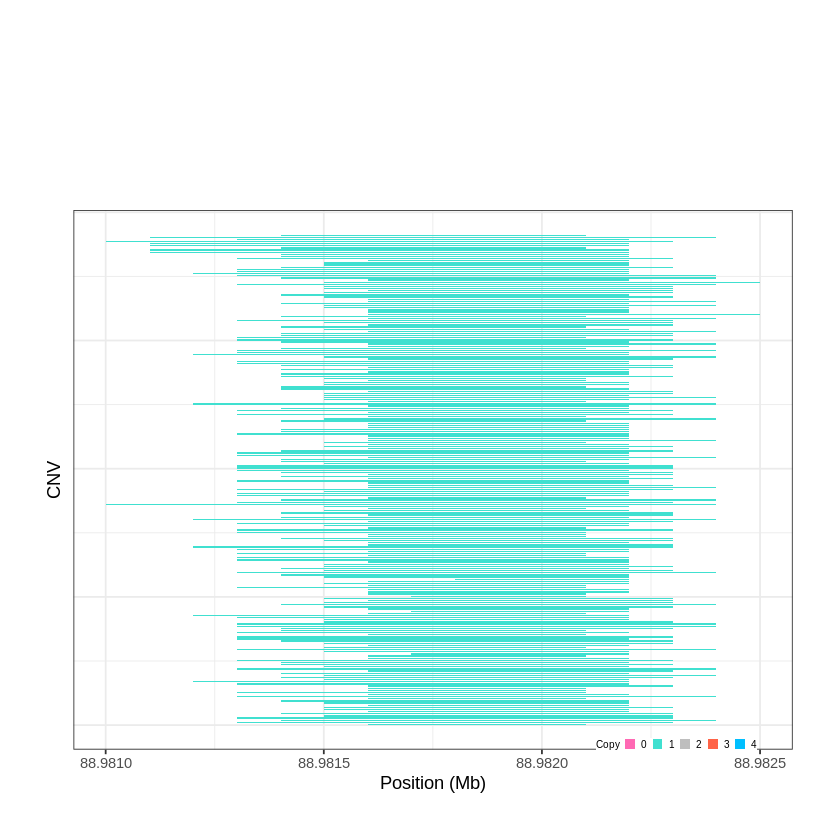

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1681..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 89.135101 - 90.0847 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


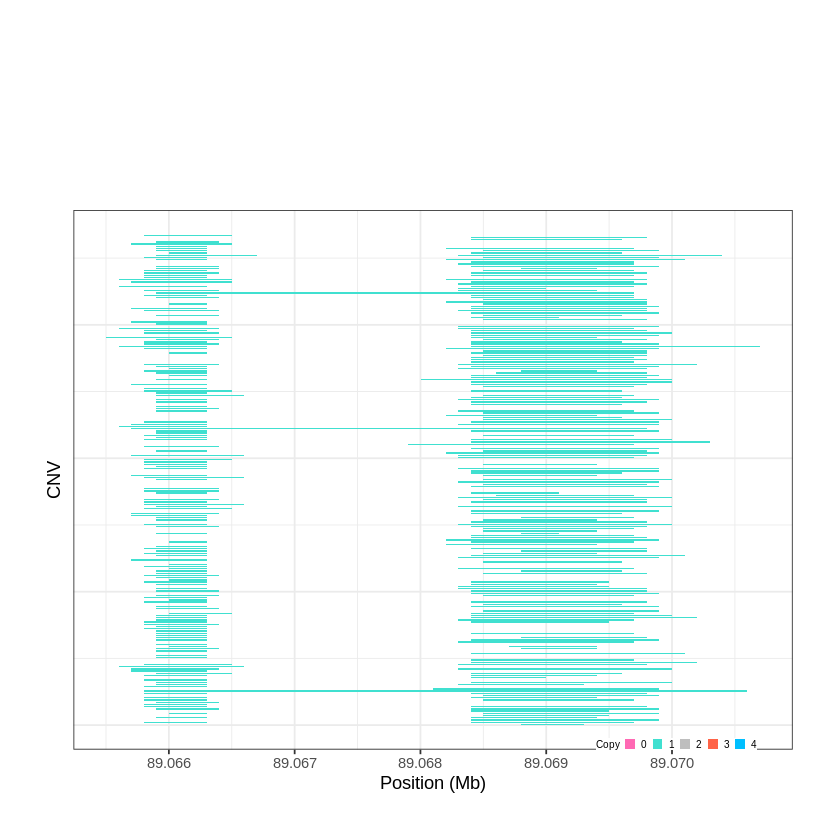

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1682..."
Input data passed requirment check...
[1] "CNV on Chromosome 16: 90.085201 - 90.3548 Mb with 279 Individual - "
Plotting gene...


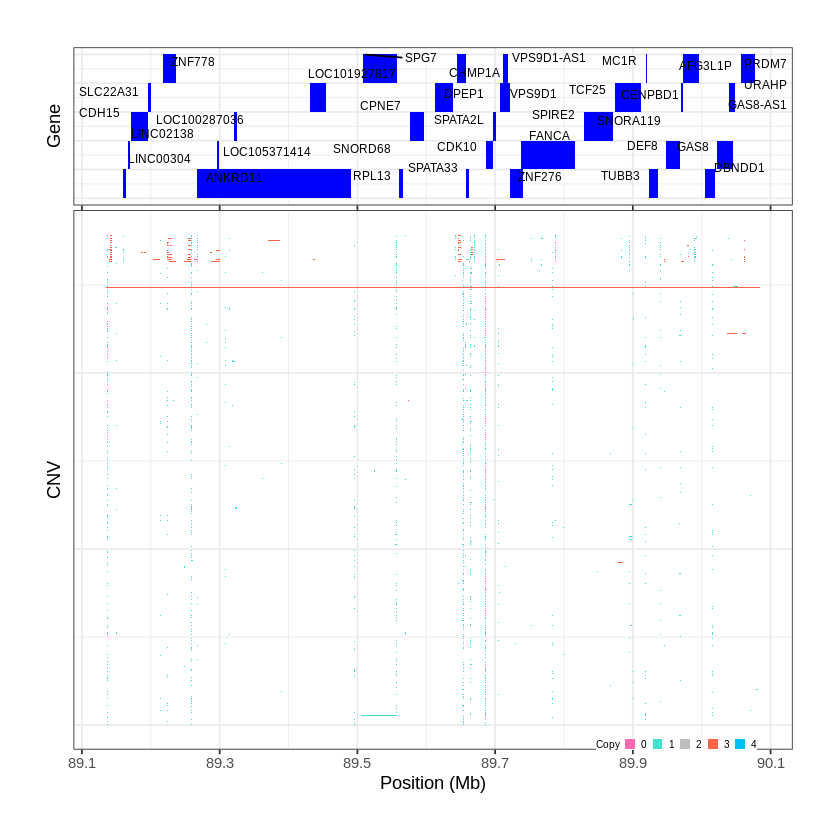

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1683..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 1e-06 - 0.2966 Mb with 279 Individual - "
Plotting gene...


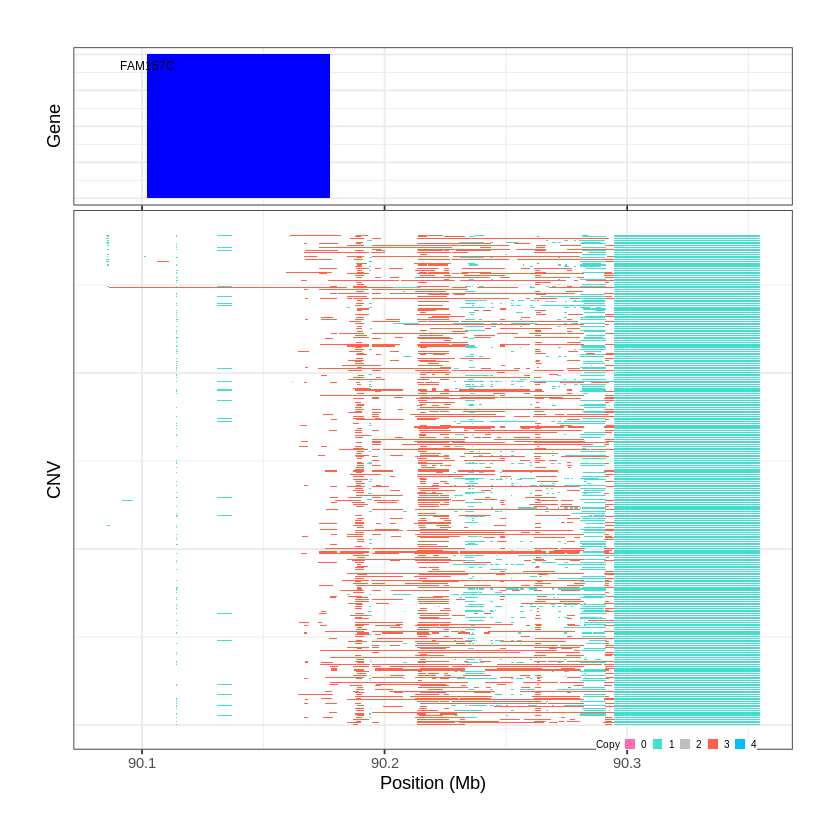

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1684..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 0.296601 - 0.8968 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1685..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 0.955101 - 0.9586 Mb with 210 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


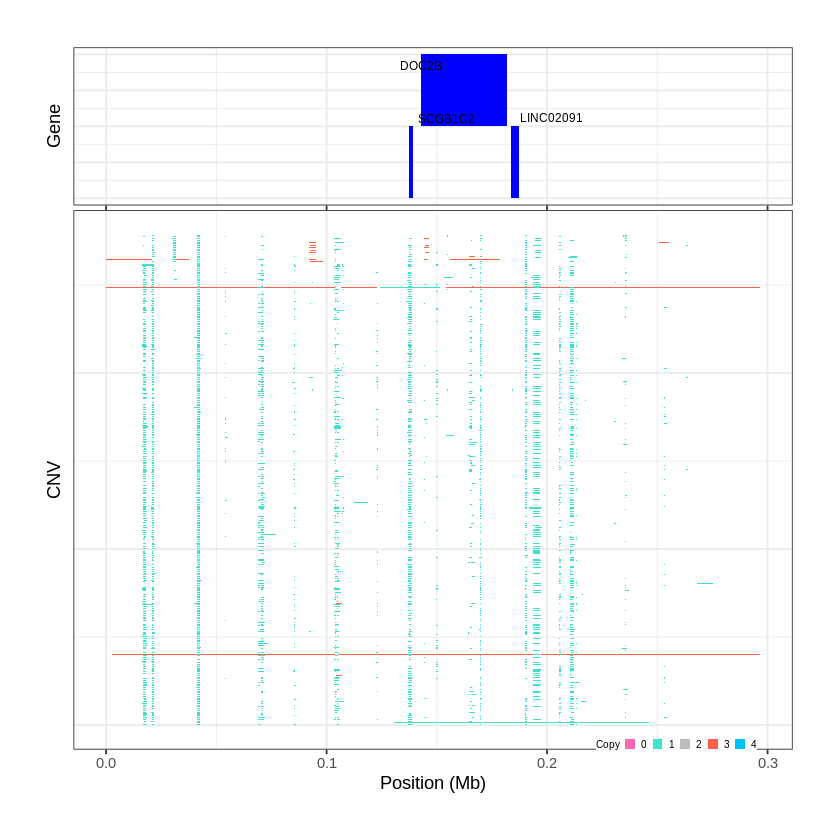

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1686..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 0.965501 - 0.9704 Mb with 248 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


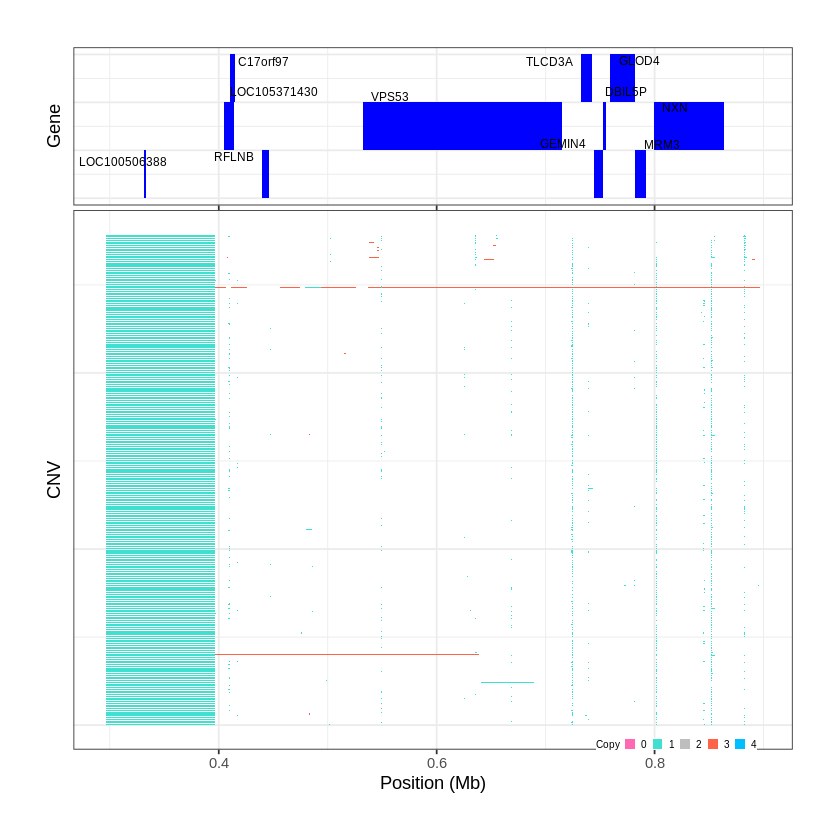

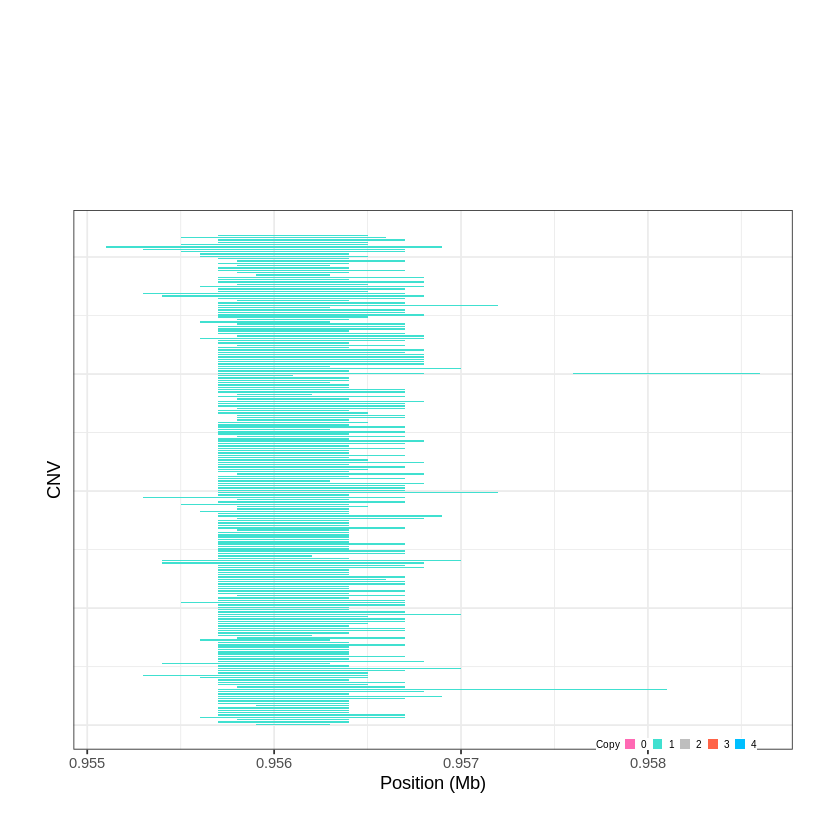

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1687..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 0.970701 - 1.1733 Mb with 274 Individual - "
Plotting gene...


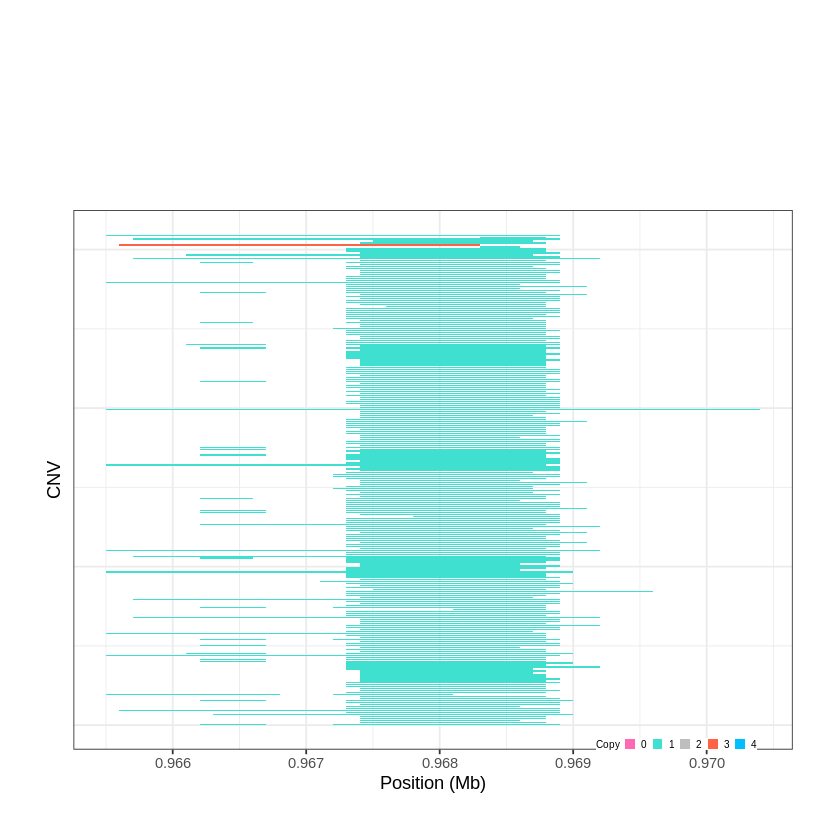

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1688..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 1.183001 - 2.4964 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


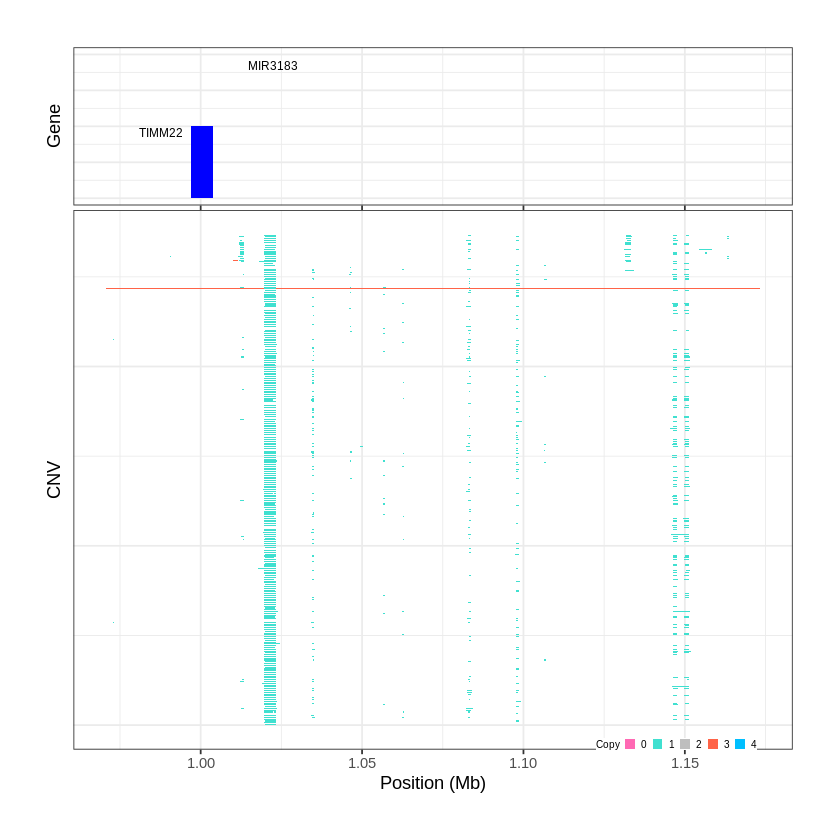

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1689..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 2.719601 - 2.9573 Mb with 216 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1690..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 3.586801 - 3.5925 Mb with 268 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


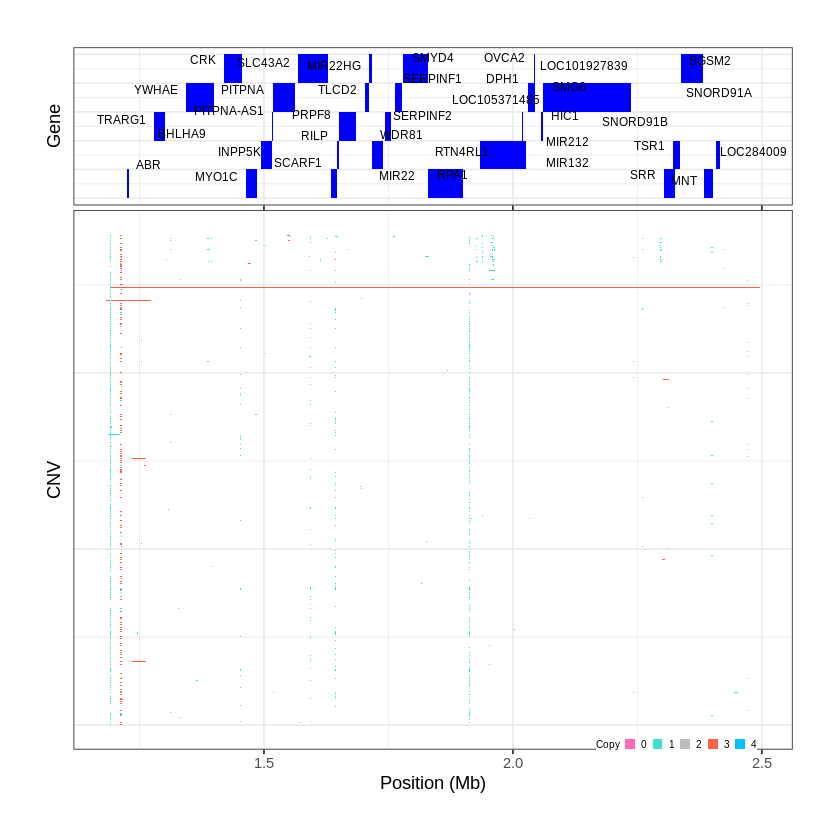

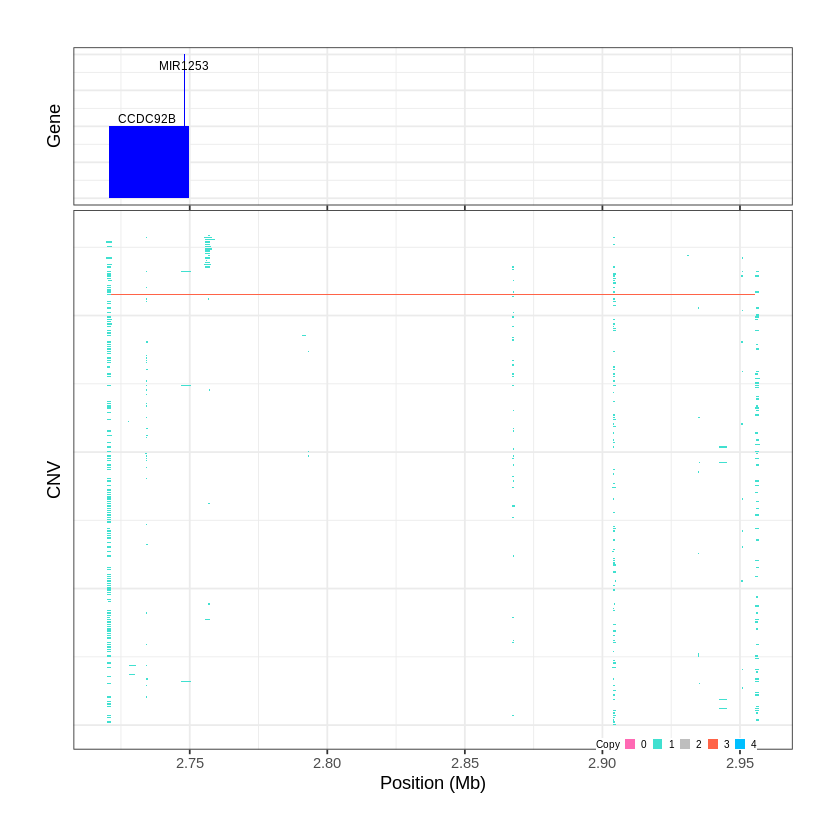

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1691..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 3.706201 - 3.9258 Mb with 221 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1692..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 4.365501 - 4.3659 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


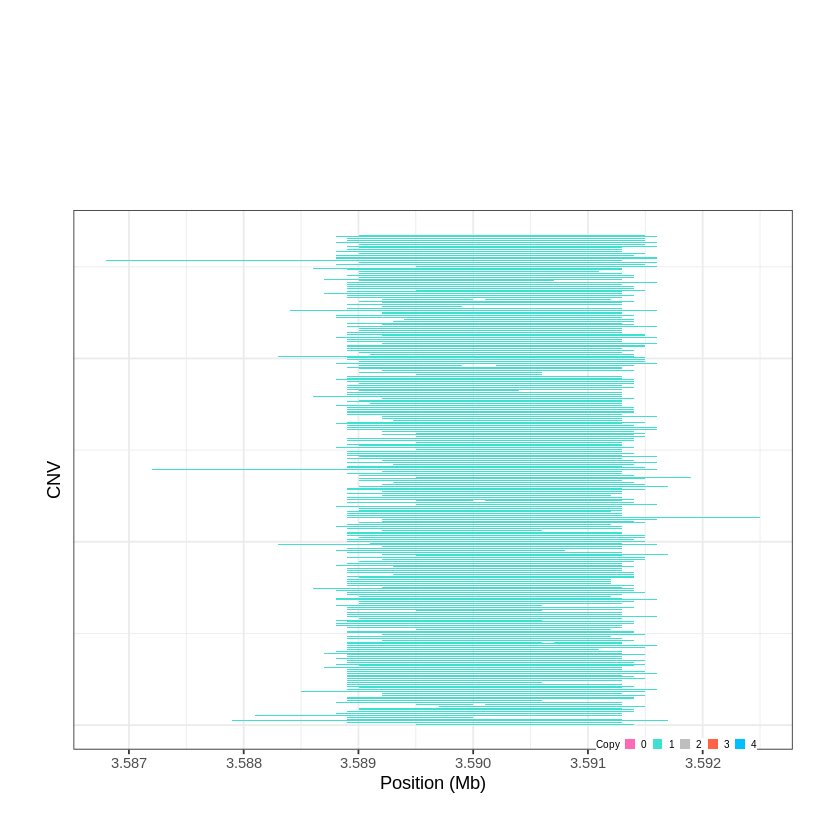

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1693..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 4.732801 - 4.7347 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


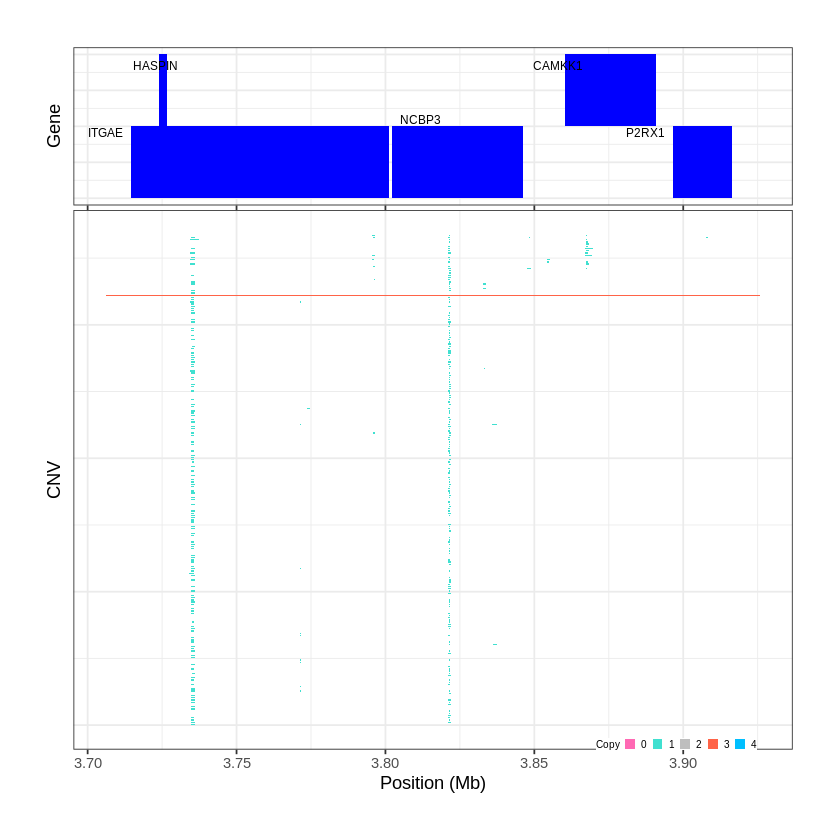

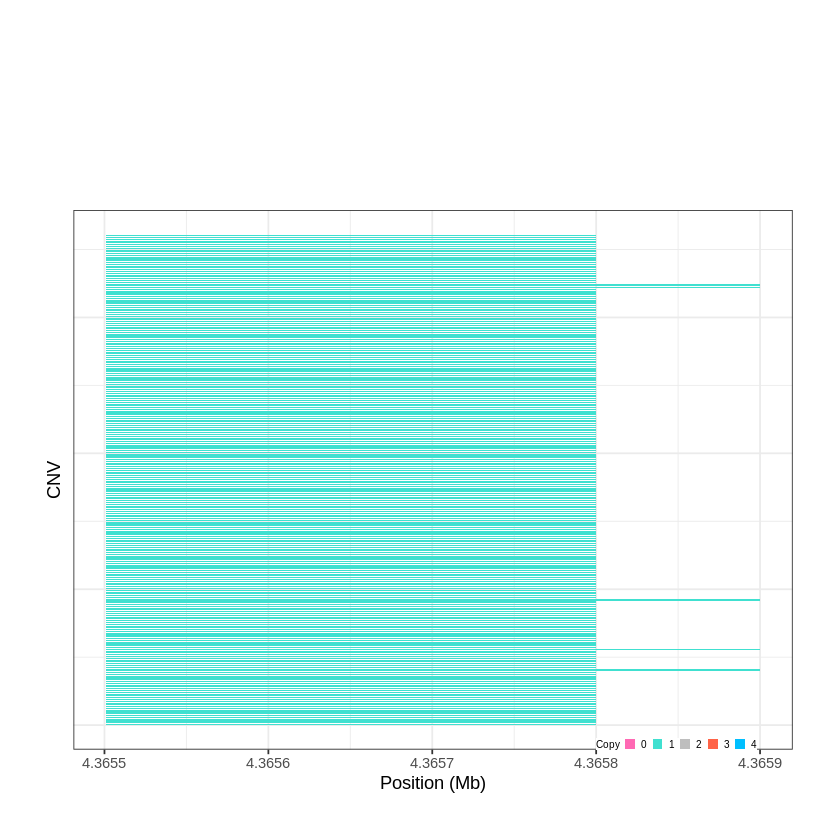

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1694..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 6.856701 - 8.2461 Mb with 266 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 86 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1695..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 8.554701 - 8.6469 Mb with 224 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


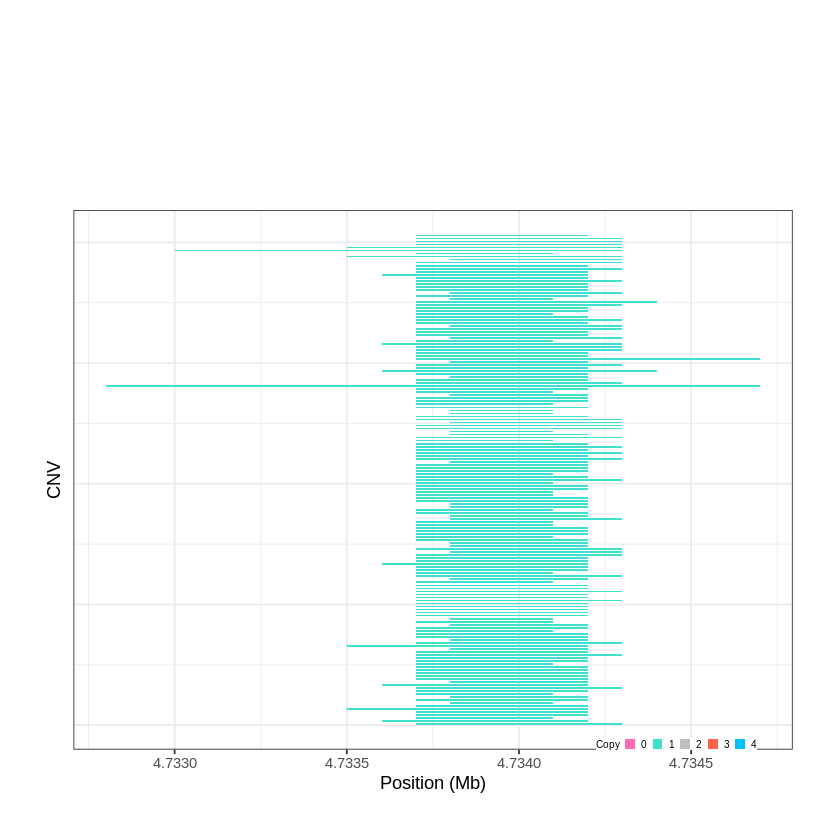

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1696..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 13.684801 - 13.6883 Mb with 201 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


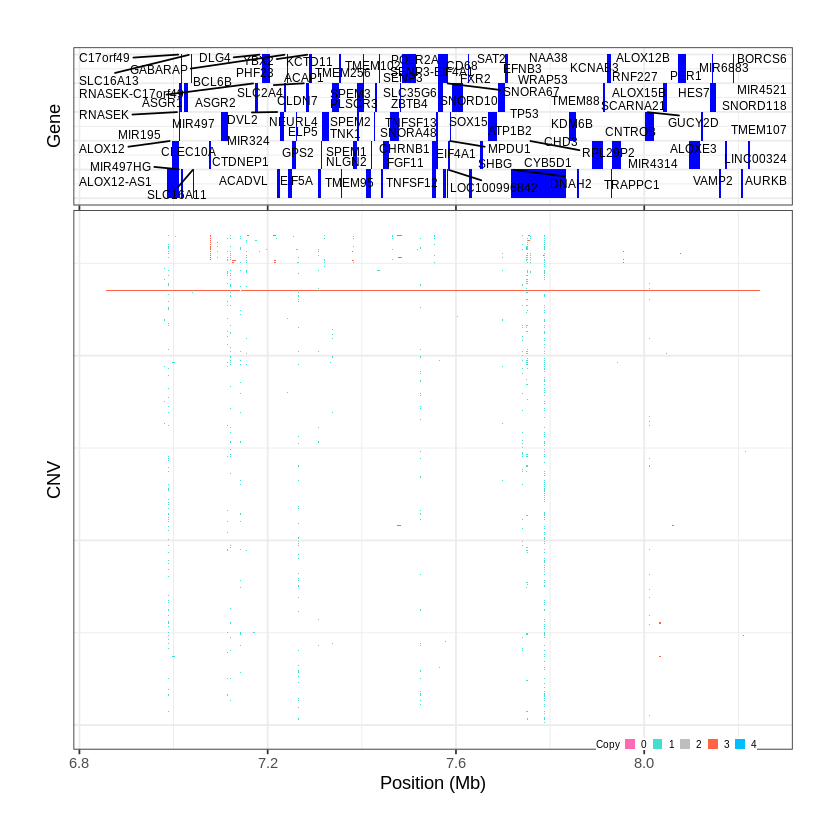

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1697..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 14.189501 - 14.1921 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


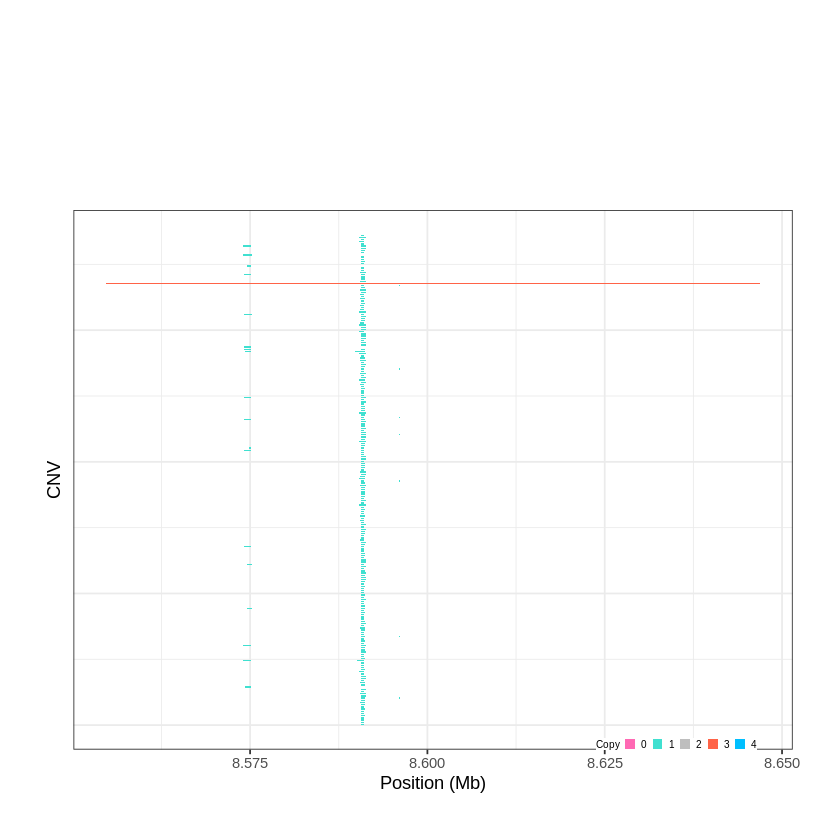

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1698..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 15.863501 - 15.8639 Mb with 237 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


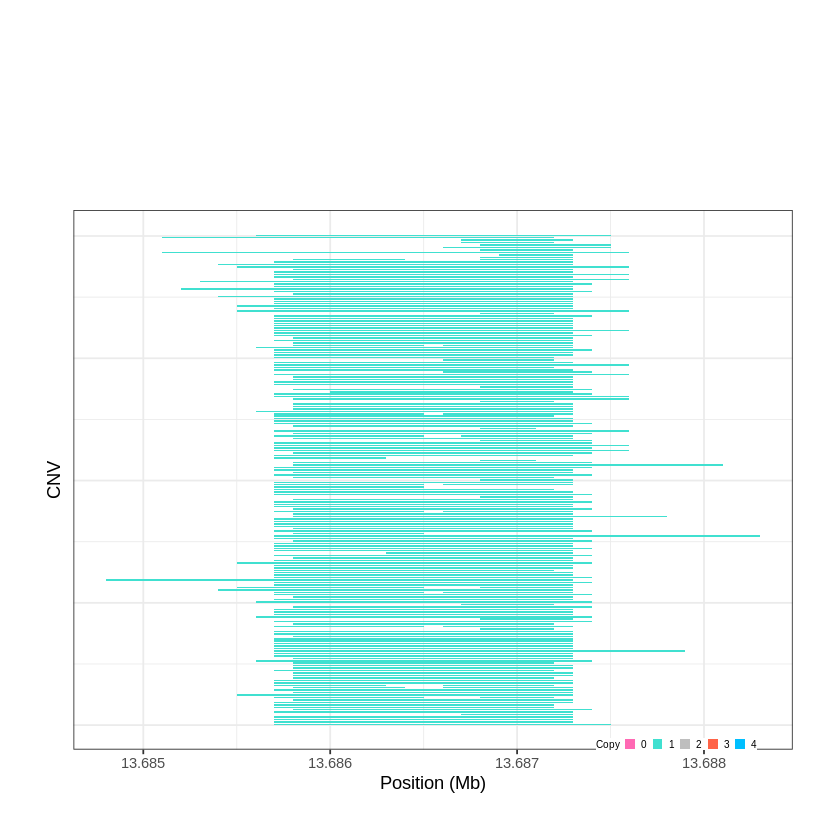

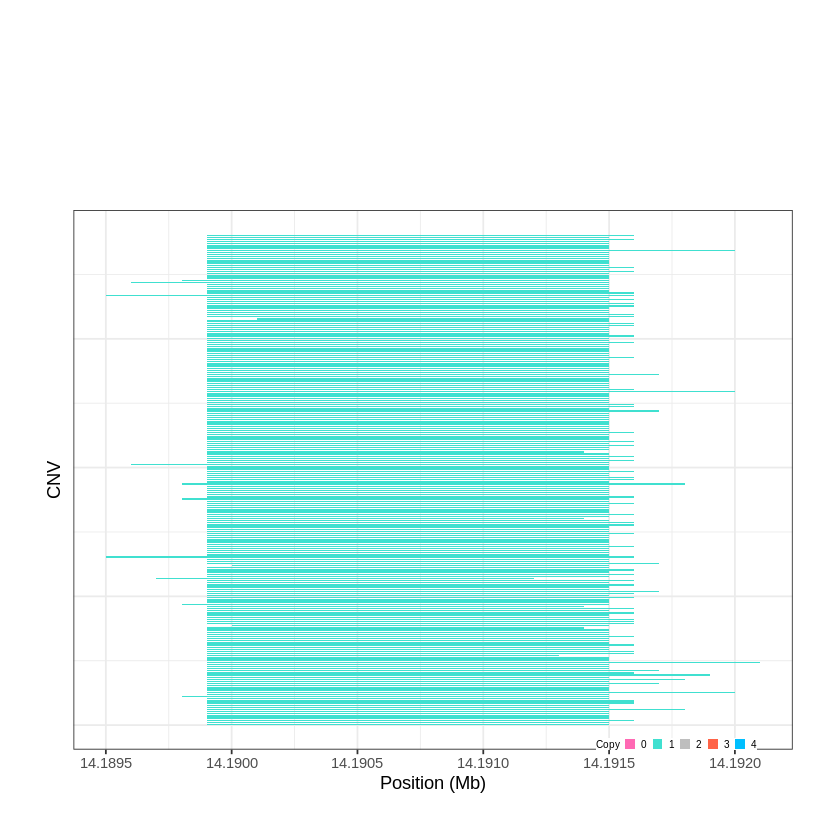

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1699..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 16.274601 - 16.4547 Mb with 183 Individual - "
Plotting gene...


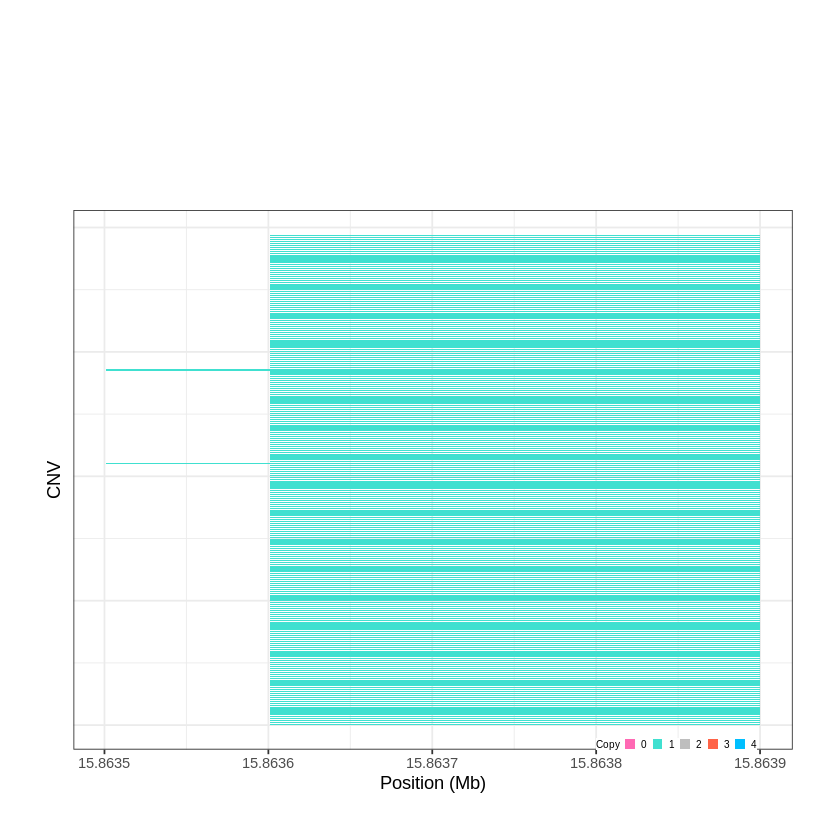

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1700..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 16.618601 - 16.7886 Mb with 235 Individual - "
Plotting gene...


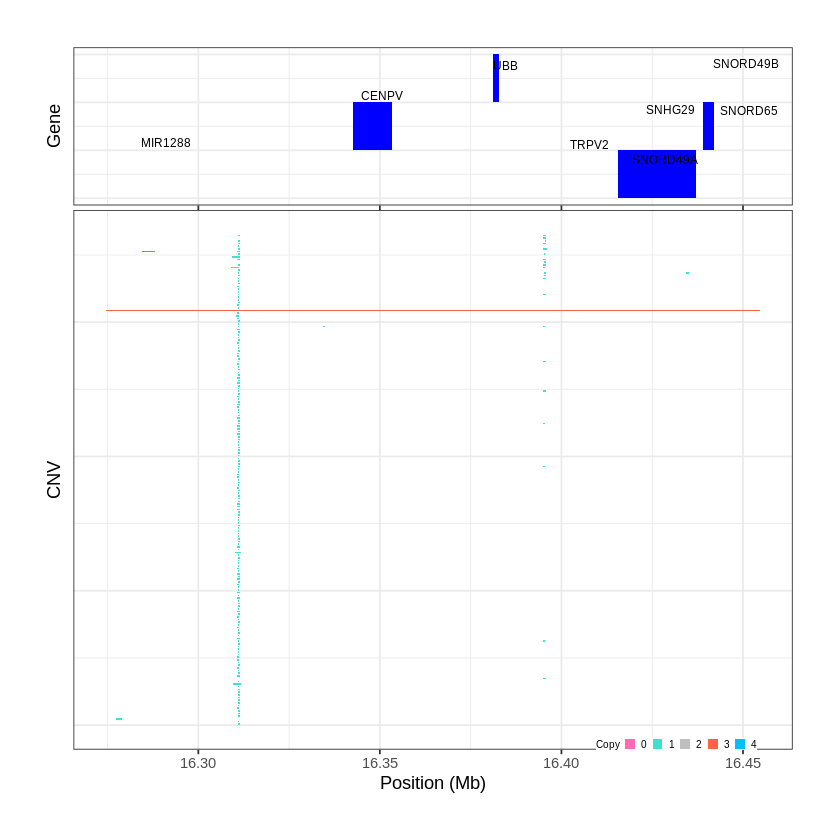

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1701..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 17.181501 - 17.3298 Mb with 184 Individual - "
Plotting gene...


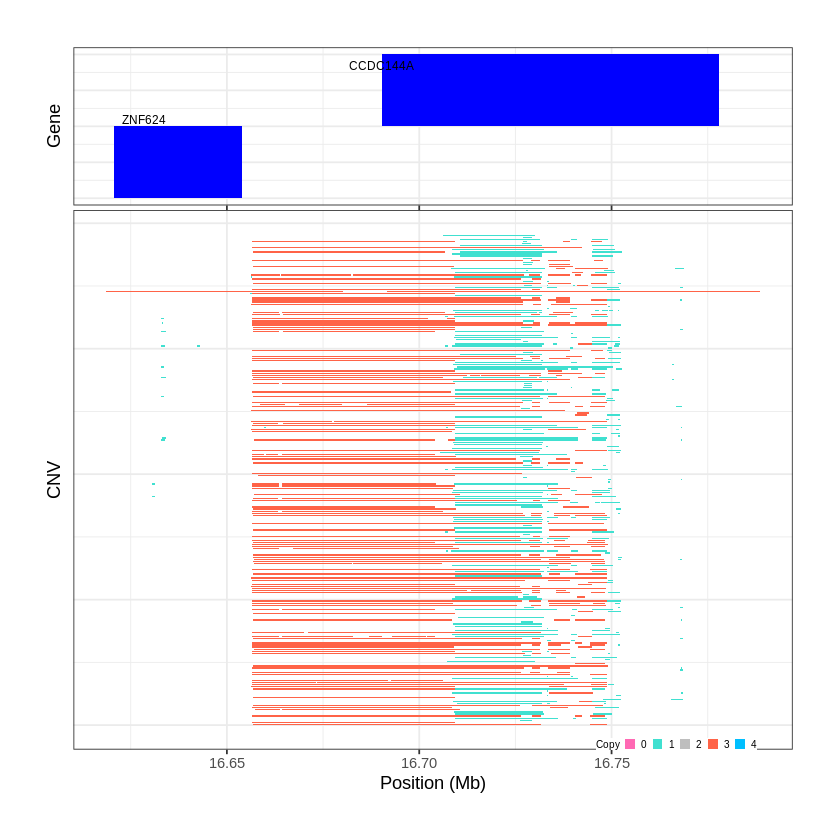

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1702..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 17.845701 - 18.5606 Mb with 268 Individual - "
Plotting gene...


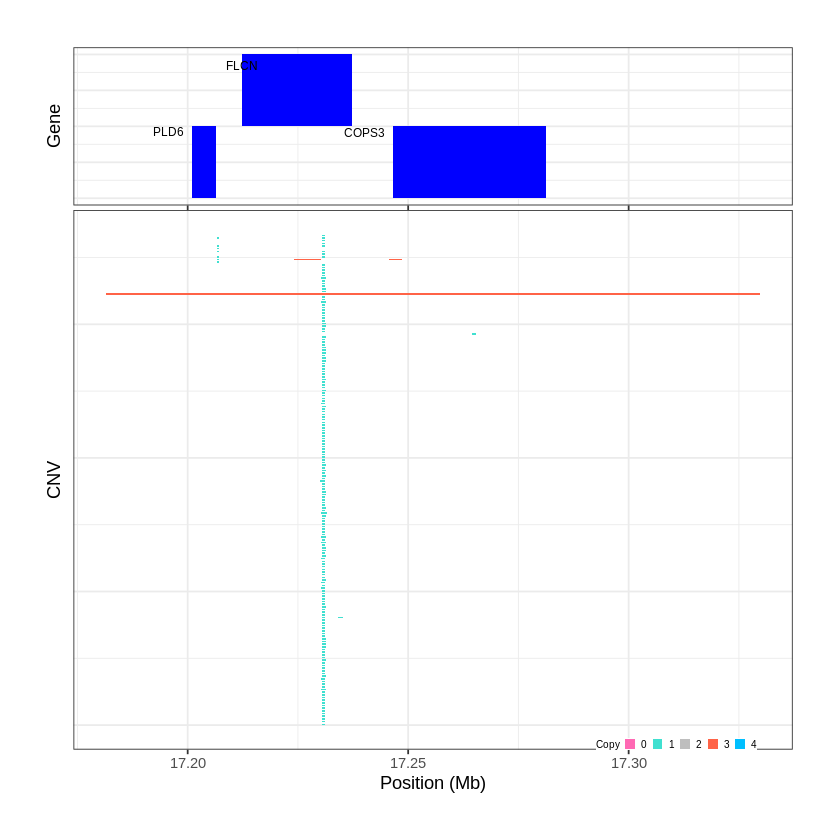

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1703..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 18.621401 - 18.7496 Mb with 212 Individual - "
Plotting gene...


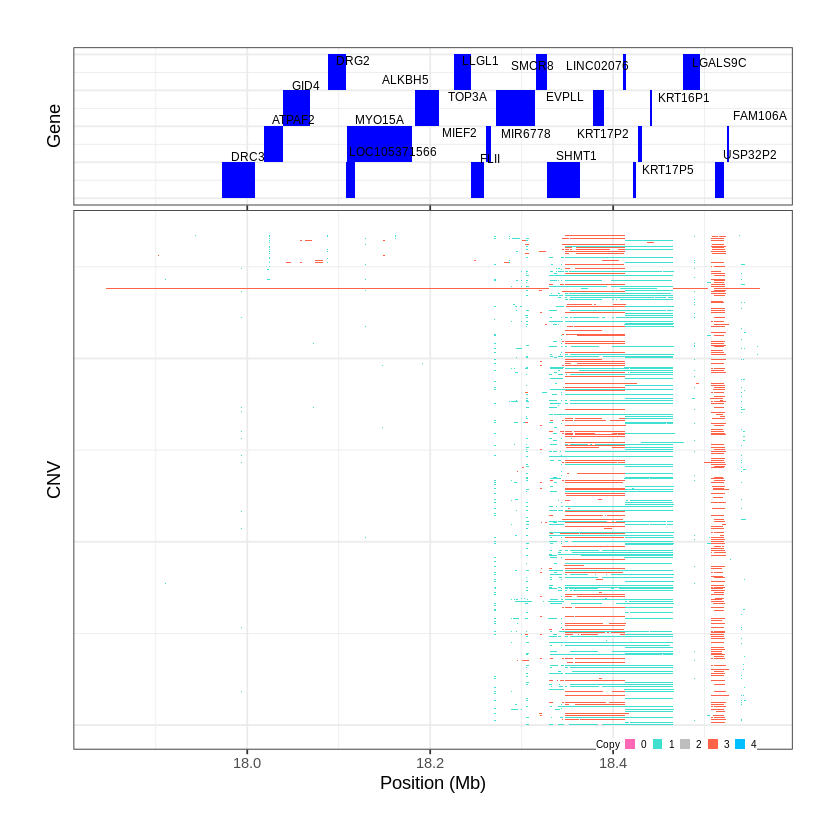

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1704..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 18.820201 - 19.4157 Mb with 249 Individual - "
Plotting gene...


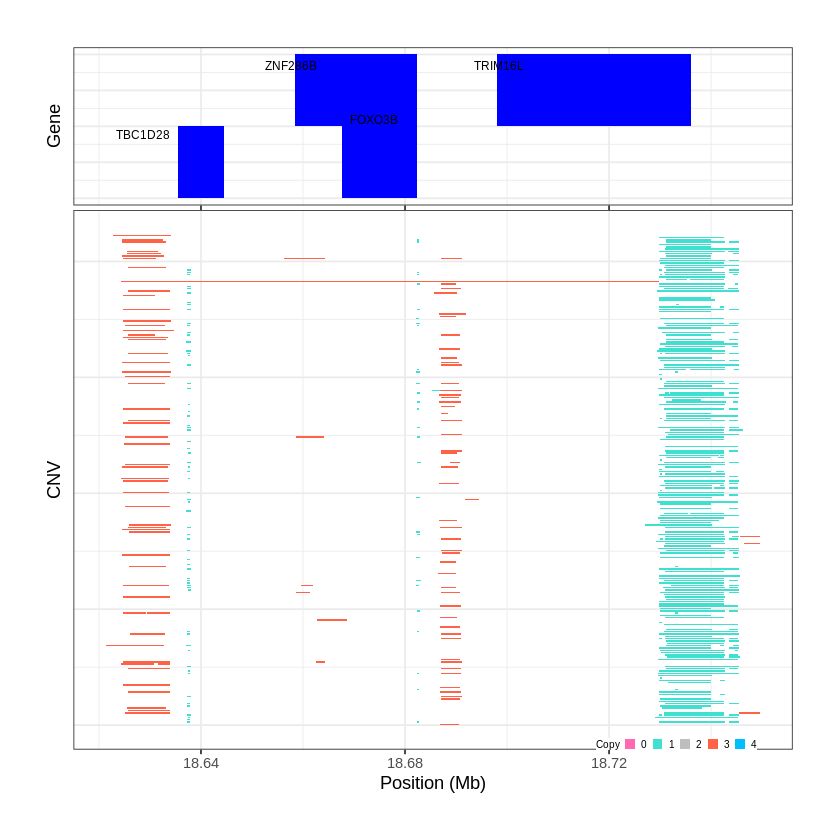

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1705..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 20.338501 - 20.4203 Mb with 189 Individual - "
Plotting gene...


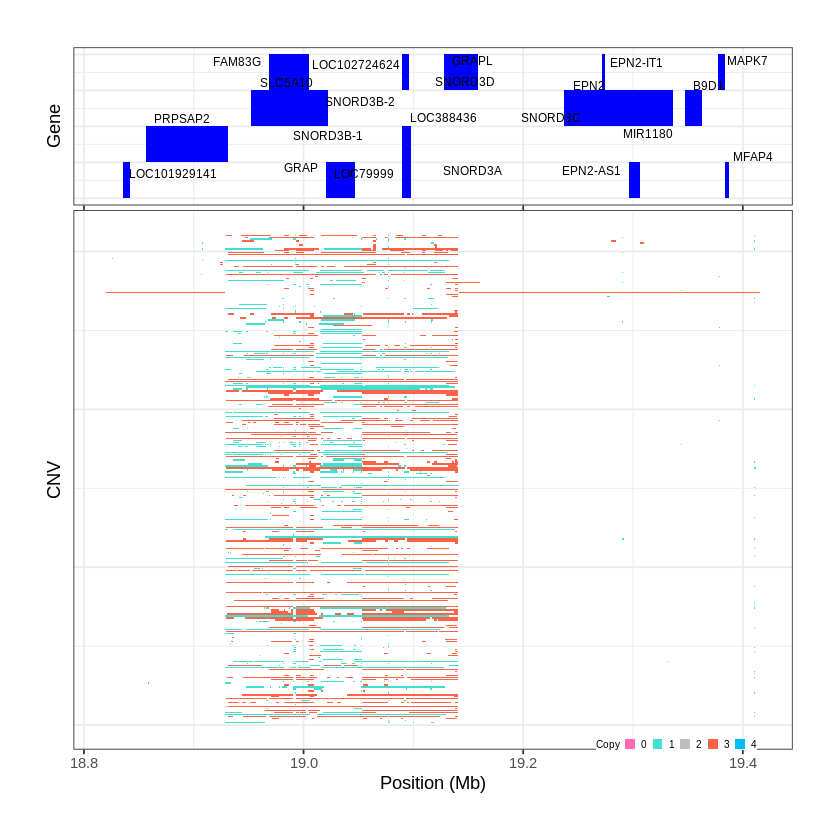

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1706..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 20.435401 - 20.6167 Mb with 234 Individual - "
Plotting gene...


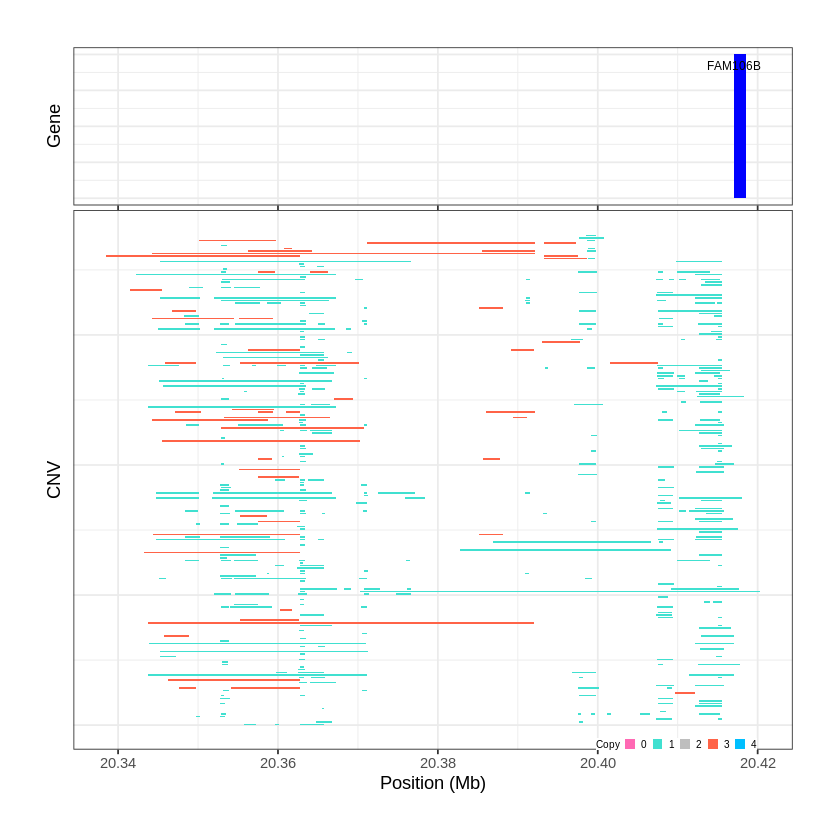

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1707..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 21.141101 - 25.2832 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1708..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 25.510501 - 25.5455 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


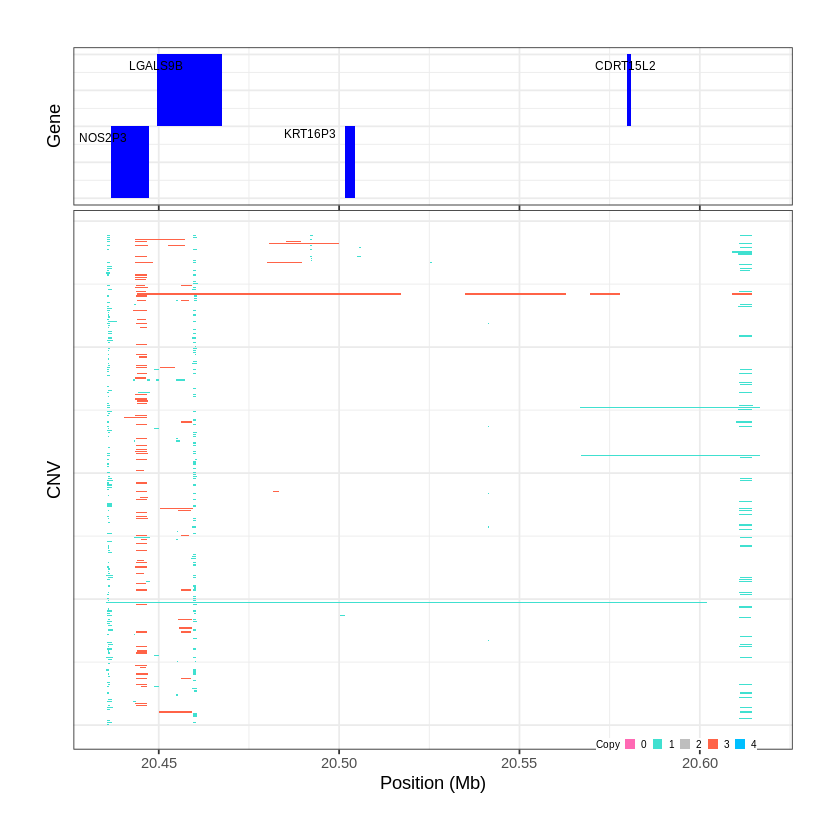

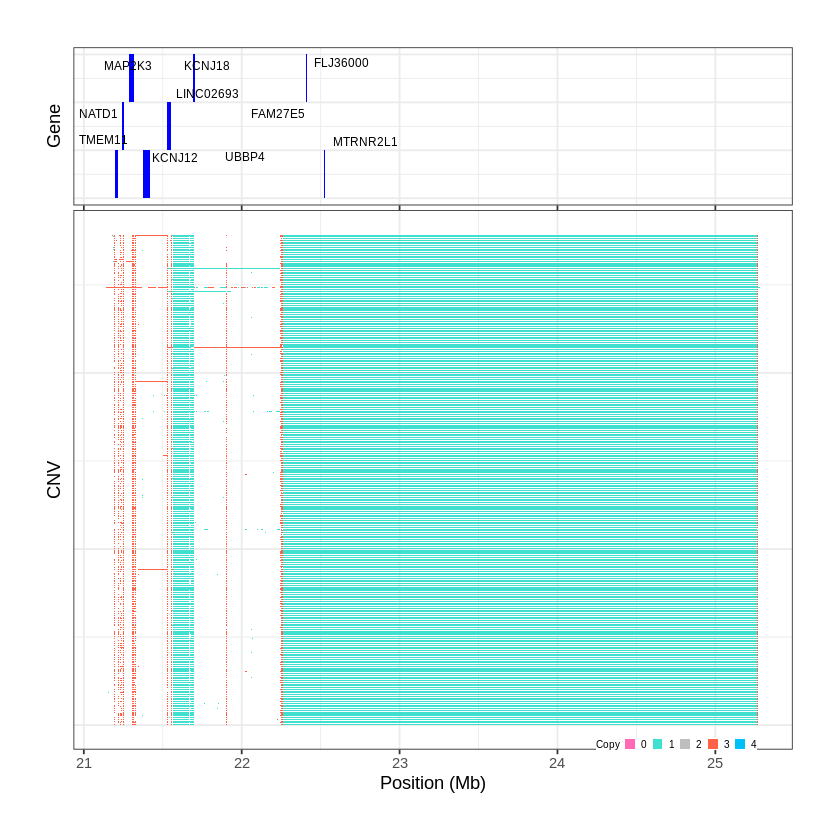

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1709..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 26.743601 - 27.1838 Mb with 198 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1710..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 29.005101 - 29.0076 Mb with 159 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


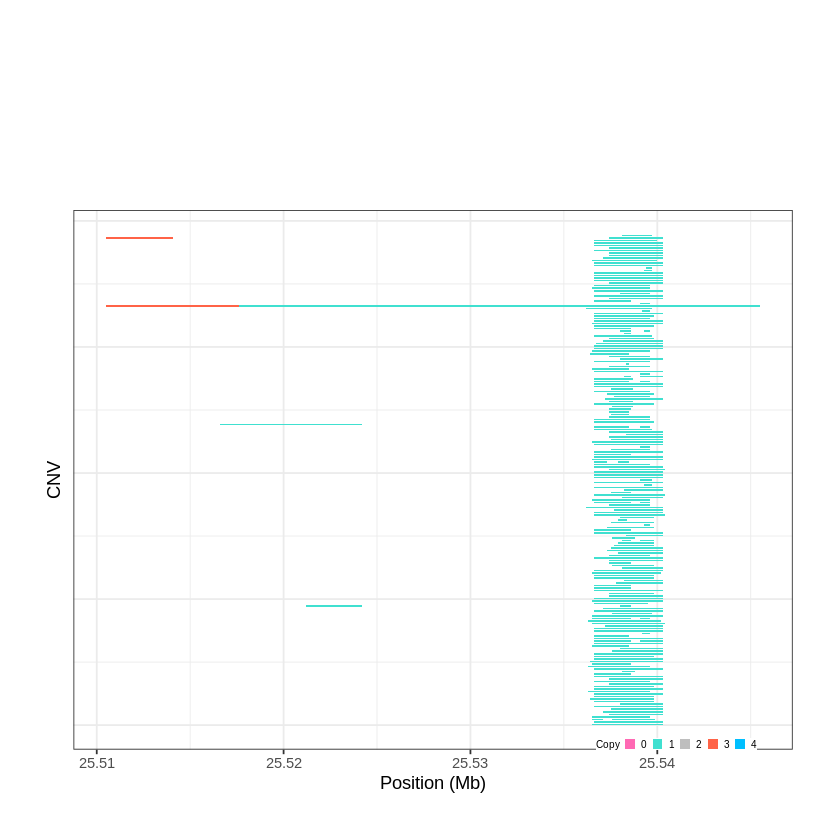

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1711..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 34.376301 - 34.3766 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


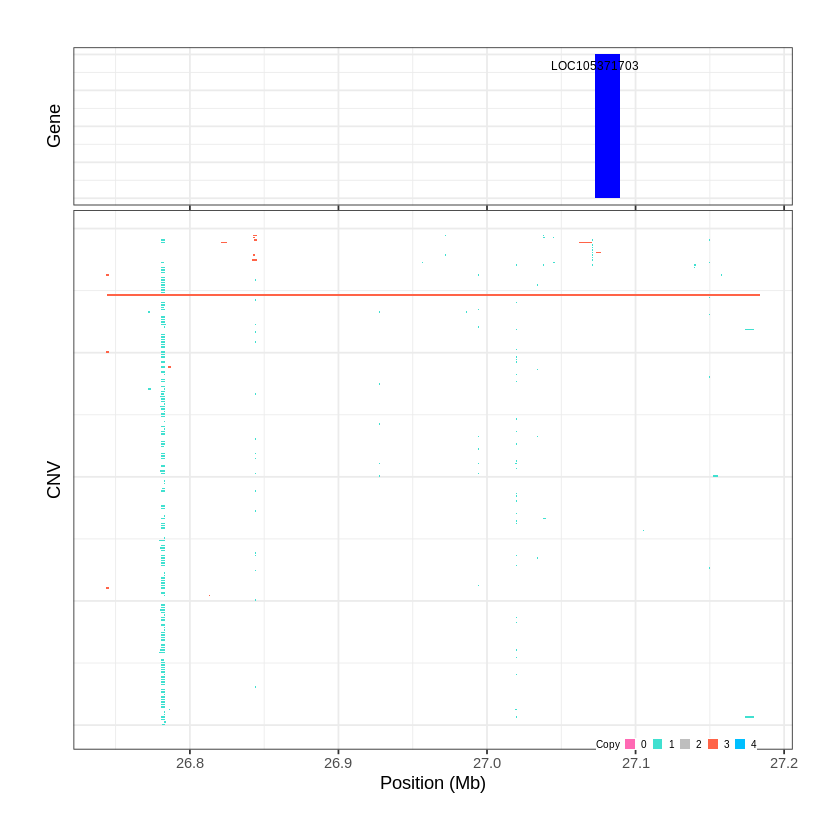

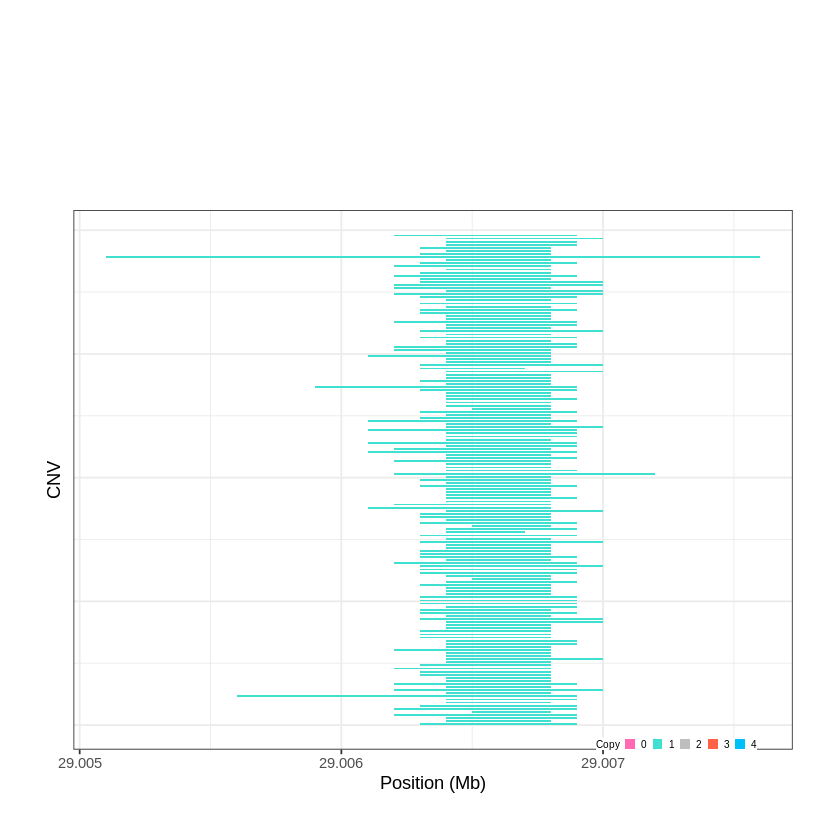

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1712..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 34.431001 - 35.0516 Mb with 279 Individual - "
Plotting gene...


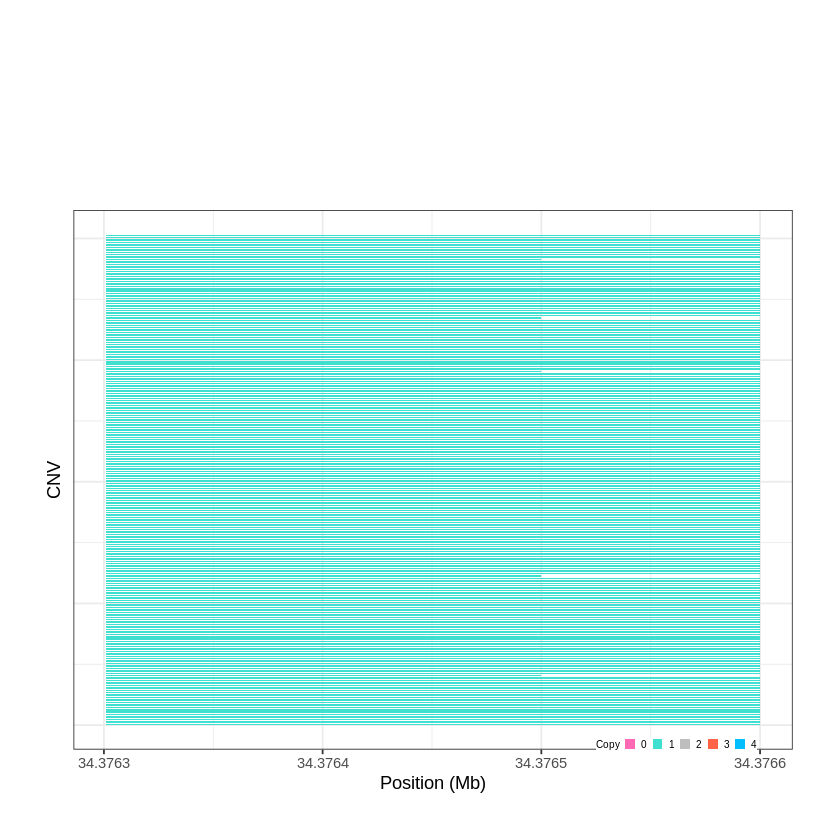

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1713..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 36.231501 - 36.419 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1714..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 36.785401 - 36.7889 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


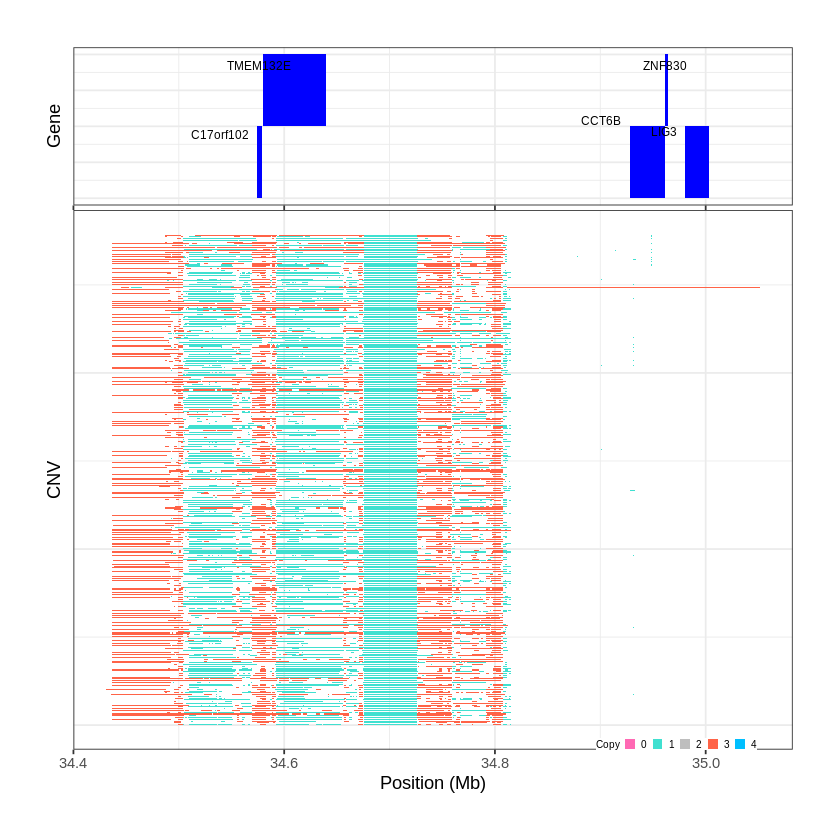

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1715..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 38.108601 - 38.1101 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


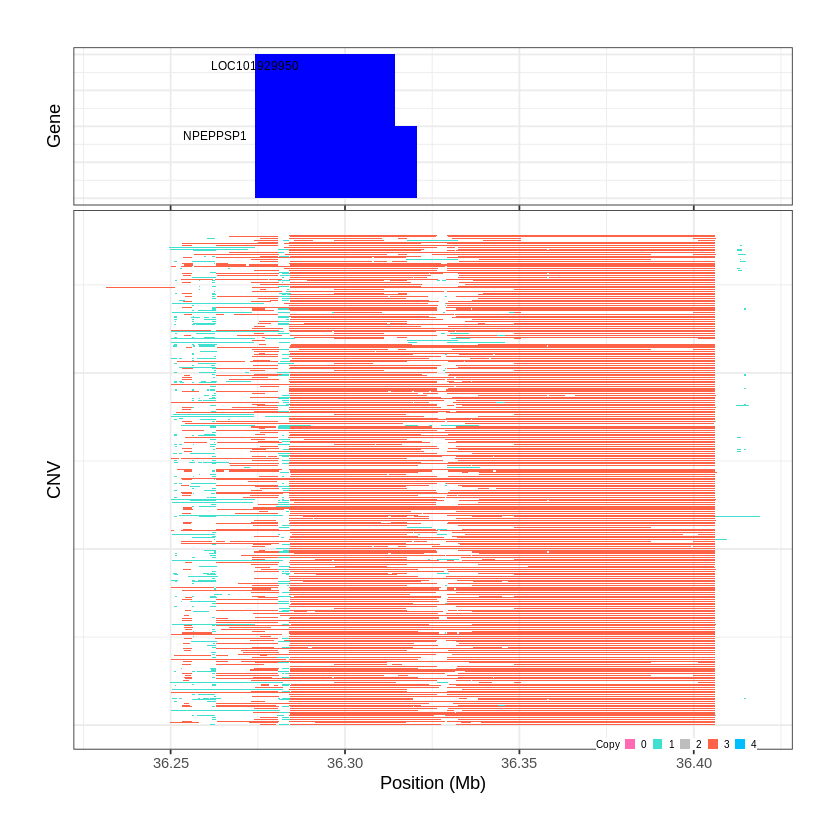

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1716..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 38.377801 - 38.3785 Mb with 271 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


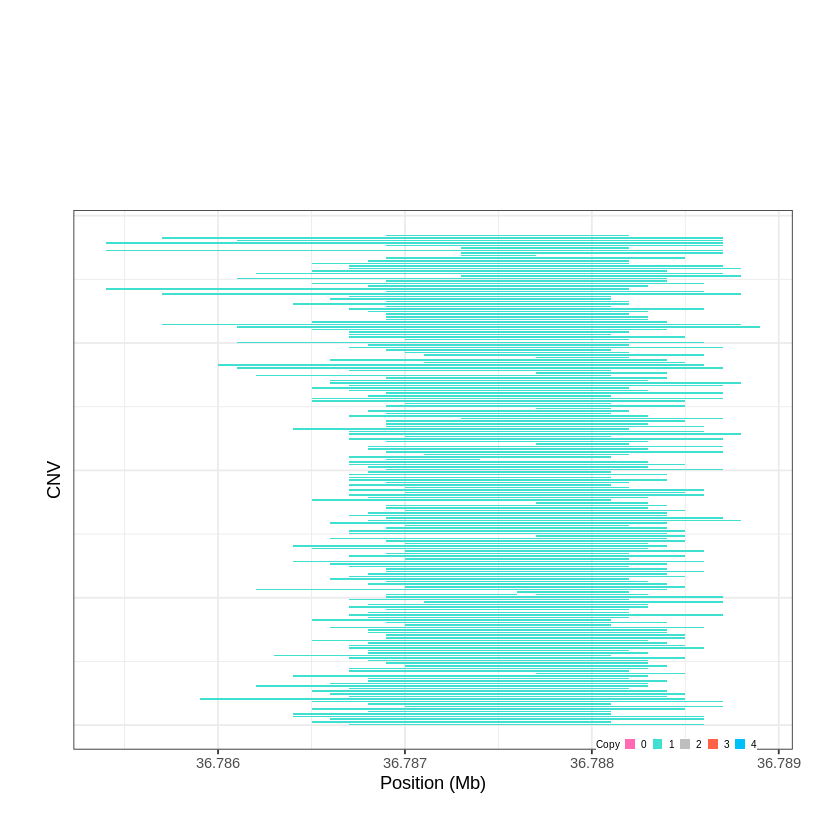

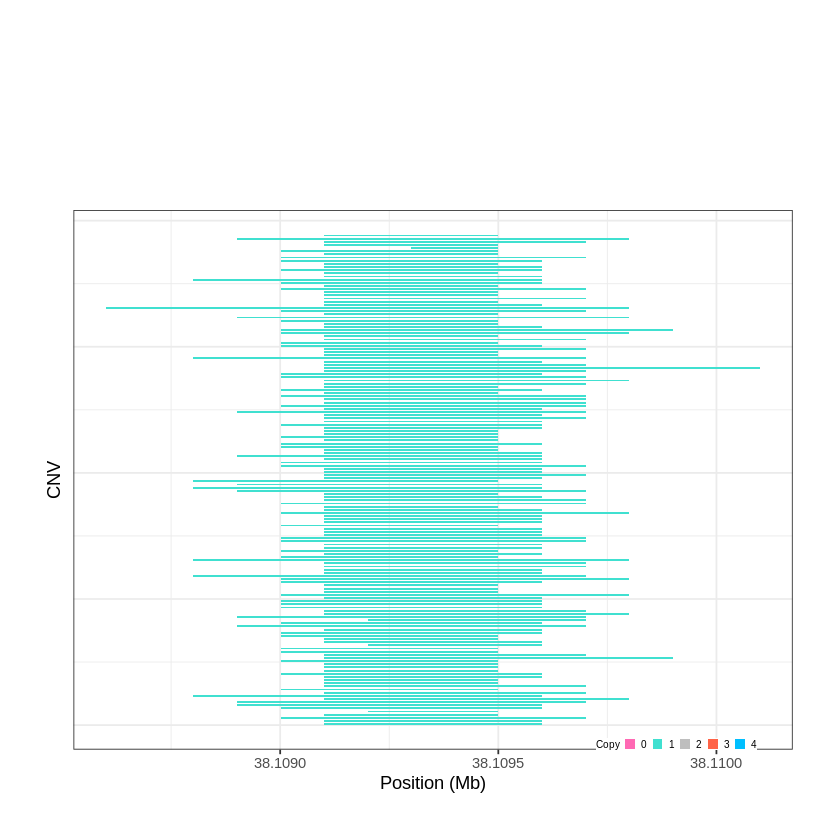

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1717..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 39.294801 - 39.4383 Mb with 263 Individual - "
Plotting gene...


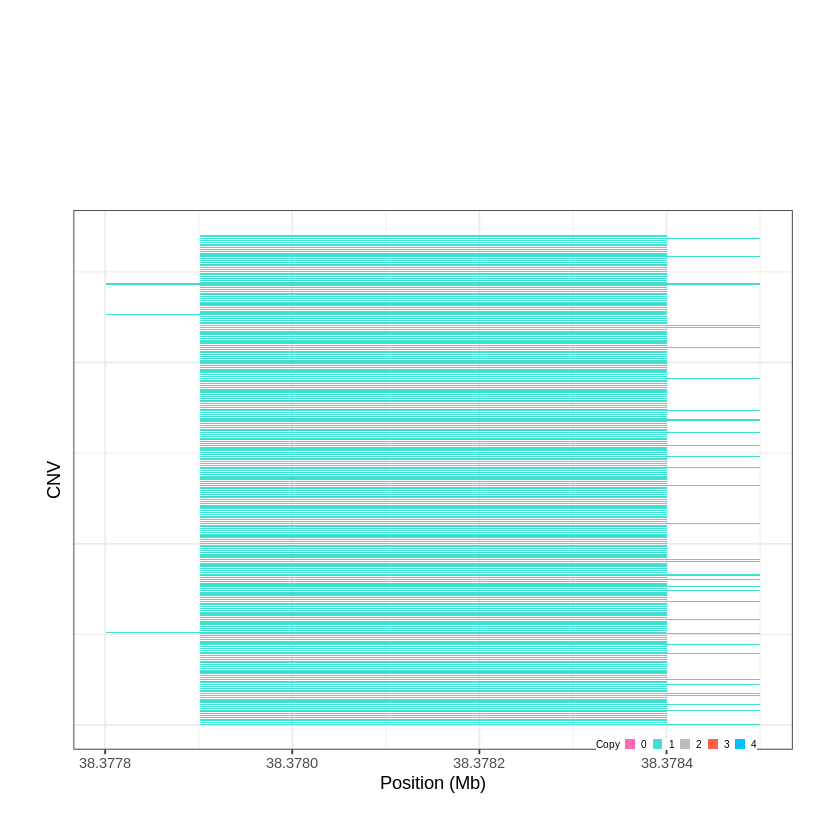

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1718..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 39.724601 - 39.7899 Mb with 247 Individual - "
Plotting gene...


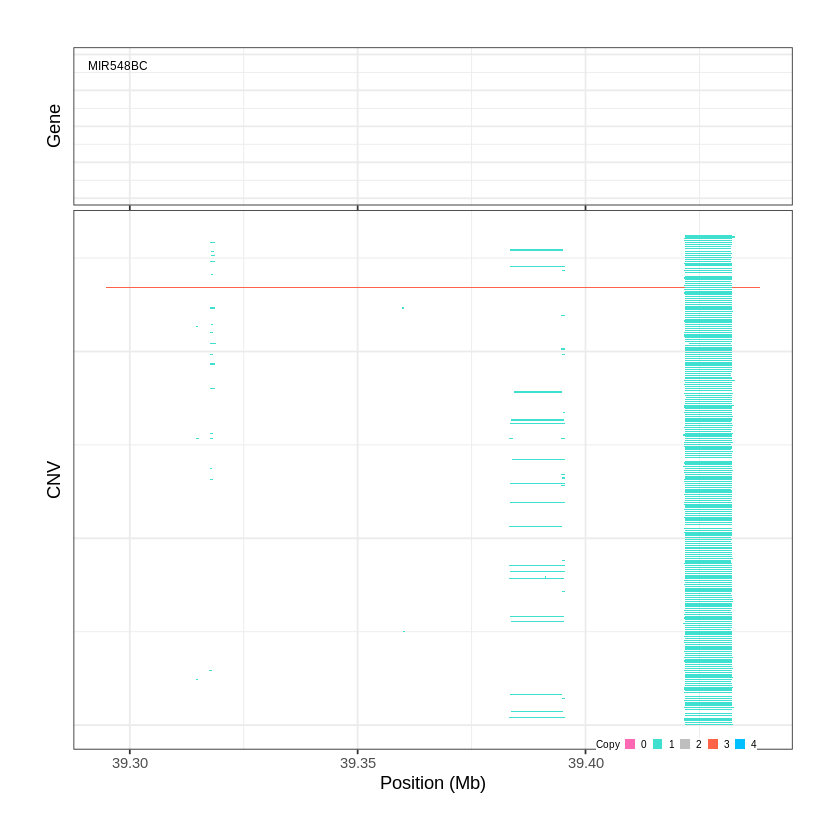

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1719..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 41.251201 - 41.3999 Mb with 277 Individual - "
Plotting gene...


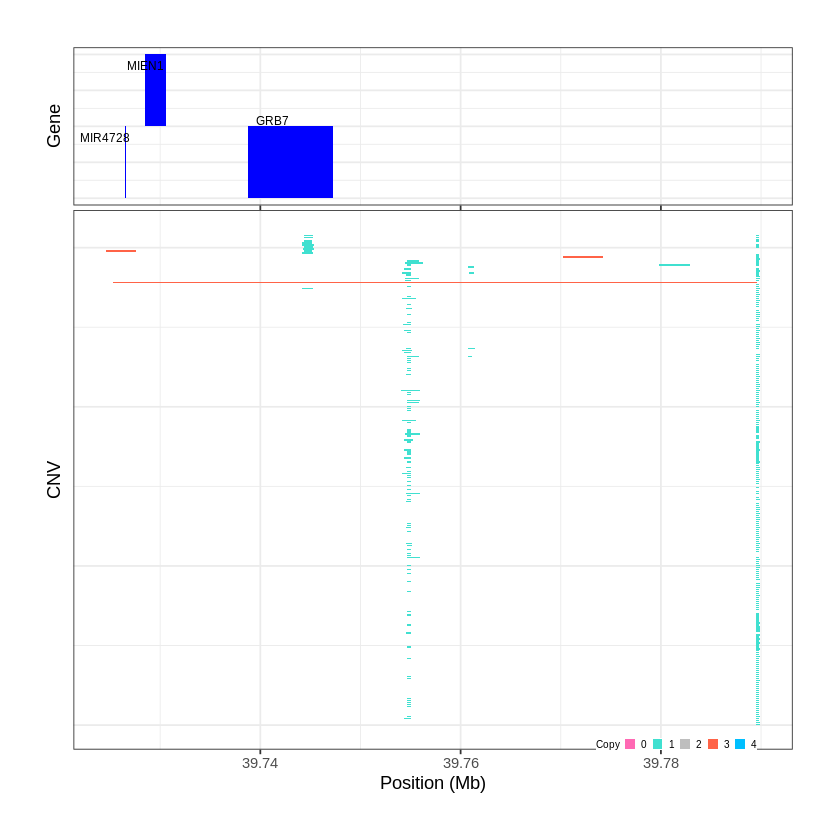

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1720..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 41.436101 - 41.5192 Mb with 247 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1721..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 43.128501 - 43.1308 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


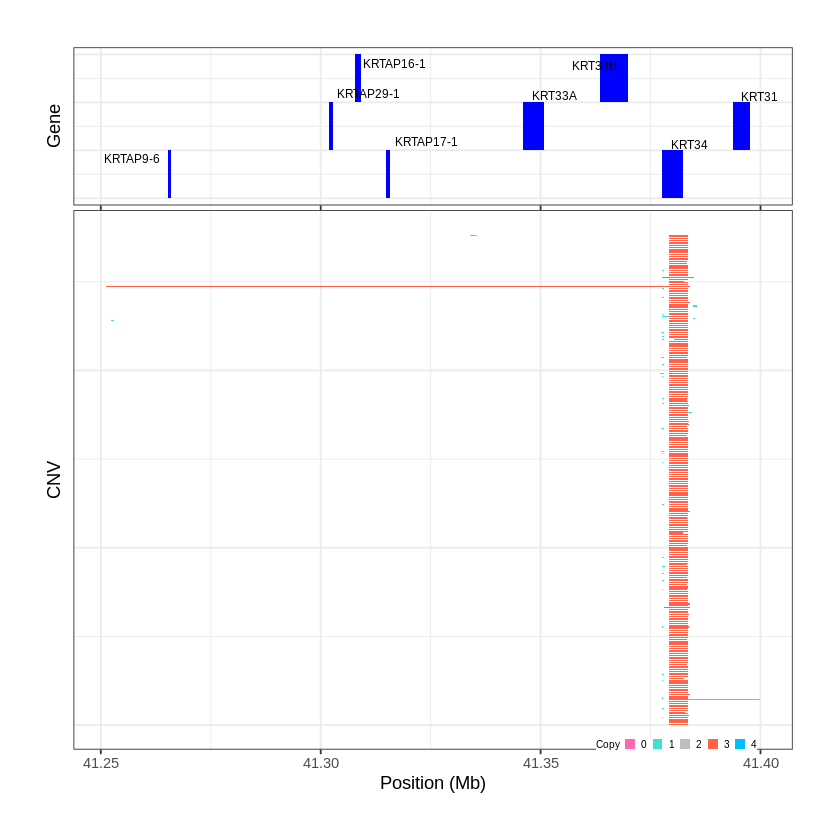

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1722..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 43.257401 - 43.2601 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


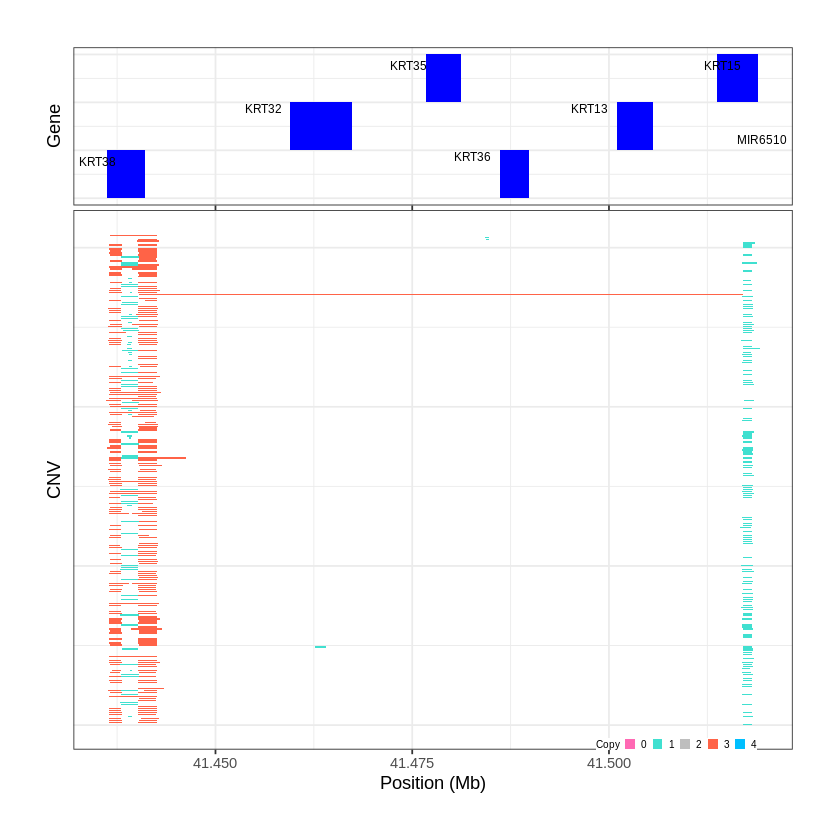

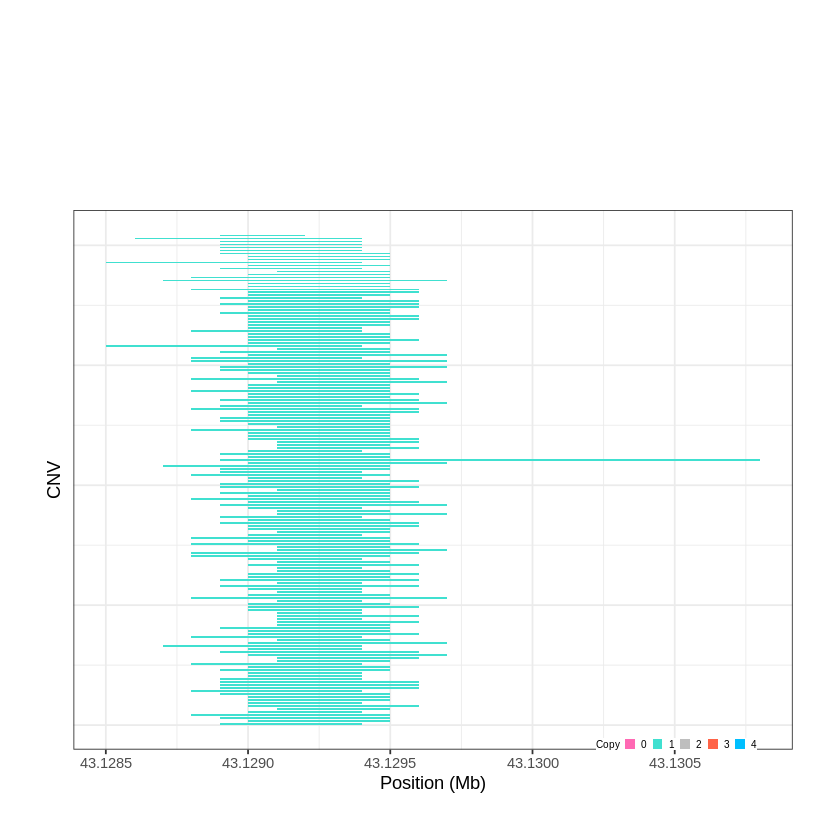

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1723..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 43.573301 - 43.695 Mb with 278 Individual - "
Plotting gene...


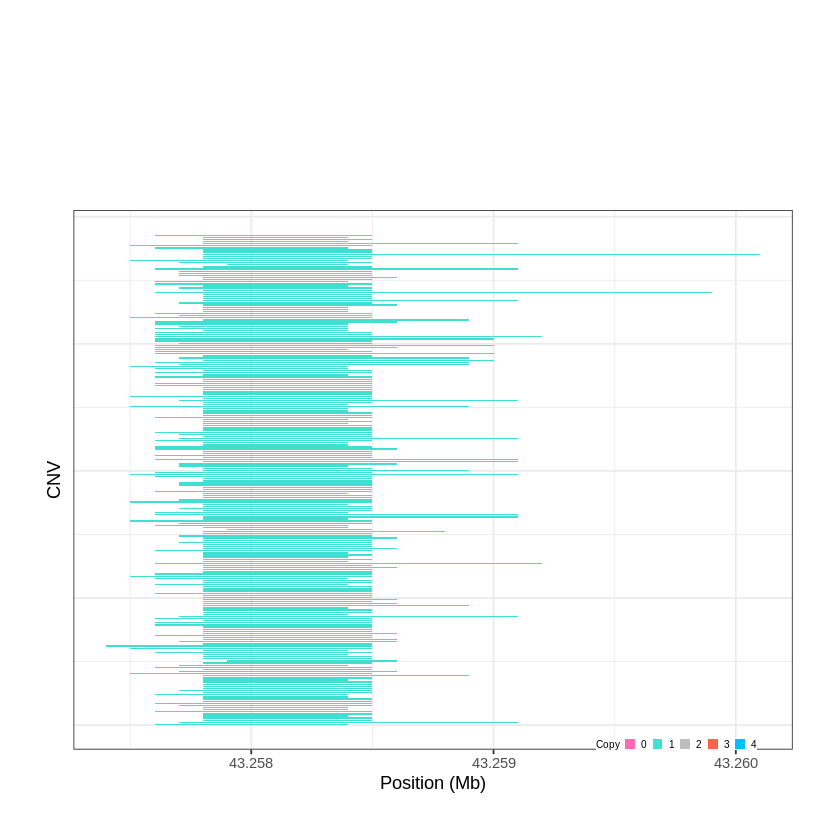

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1724..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 44.140801 - 44.8139 Mb with 278 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


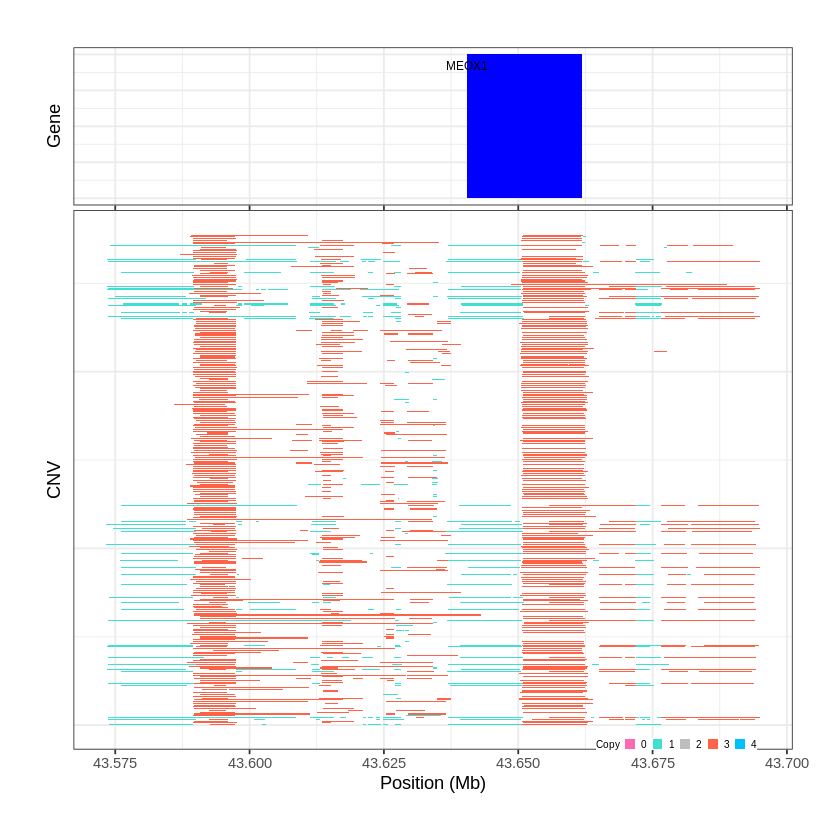

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1725..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 47.900501 - 48.3608 Mb with 181 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1726..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 49.690301 - 49.6913 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


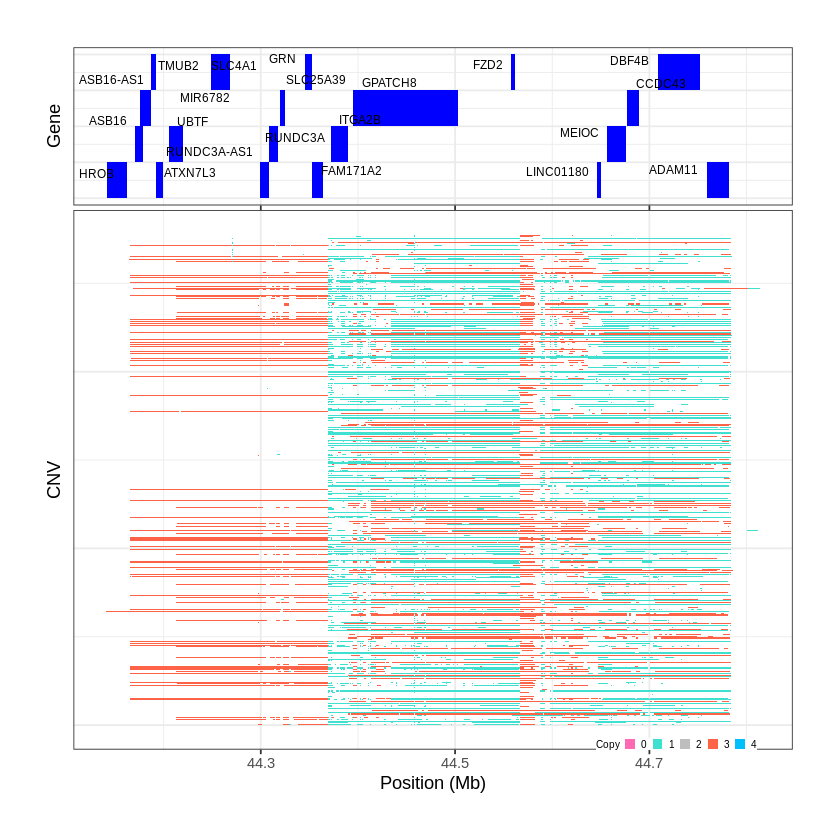

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1727..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 49.779601 - 49.7976 Mb with 197 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


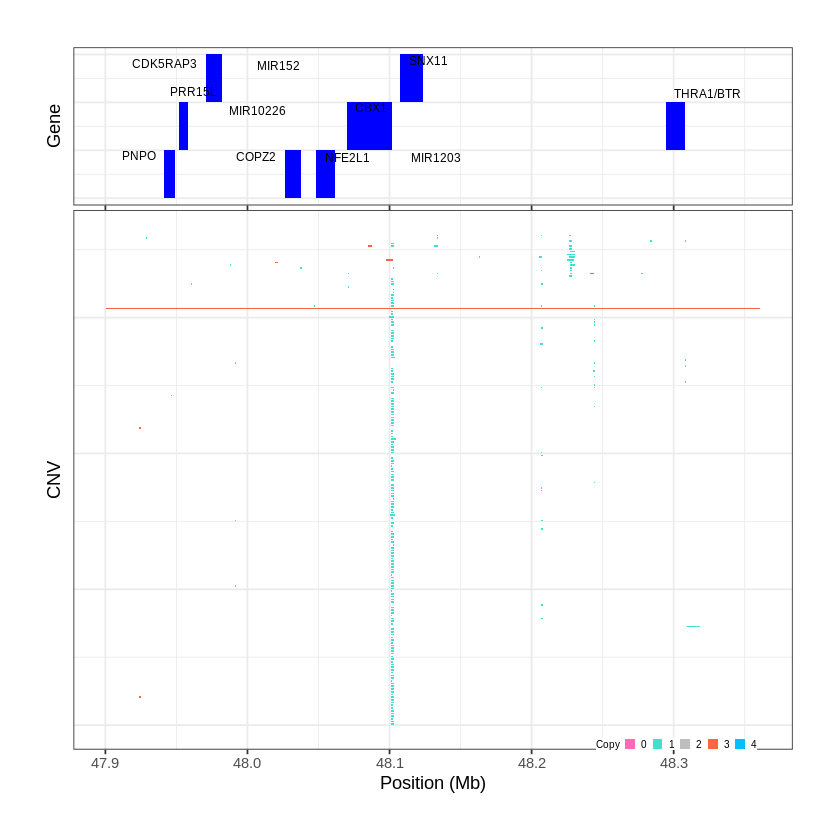

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1728..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 53.496601 - 53.5516 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


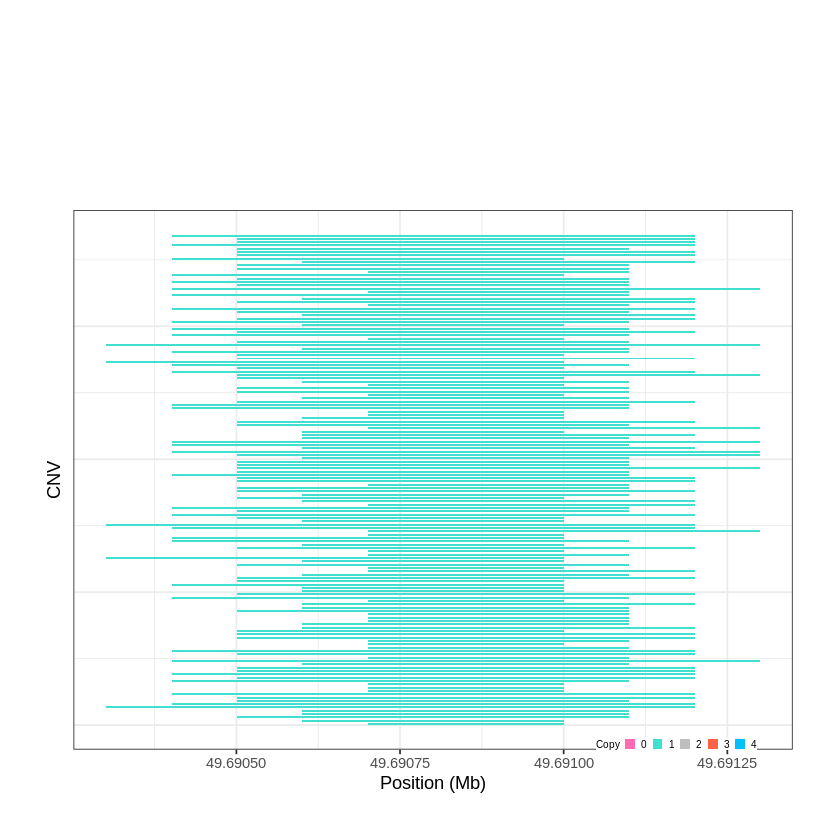

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1729..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 55.135801 - 55.2127 Mb with 240 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


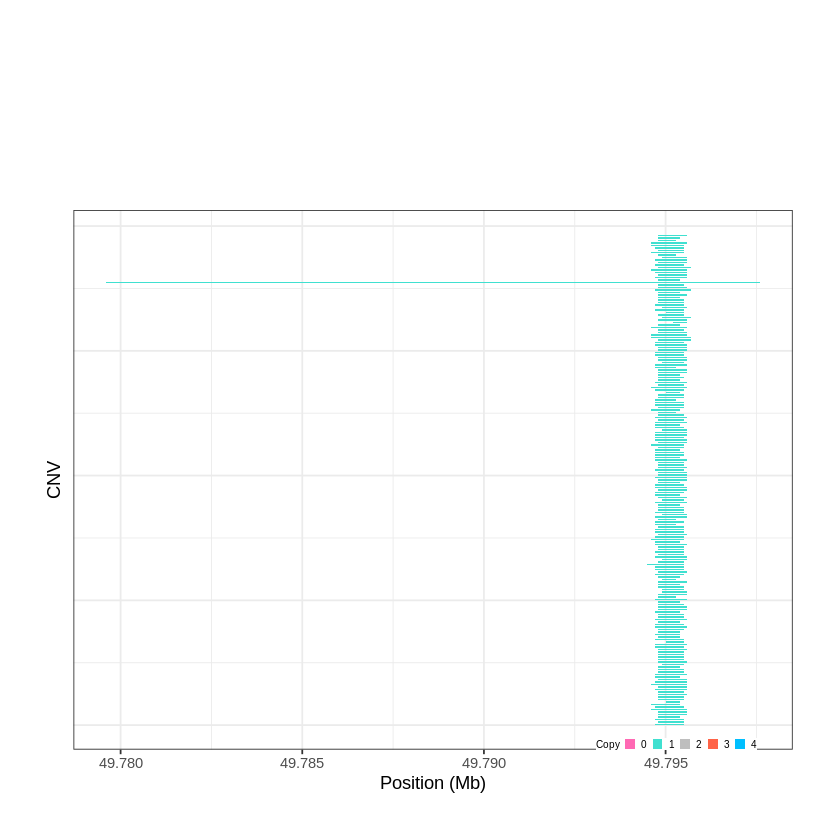

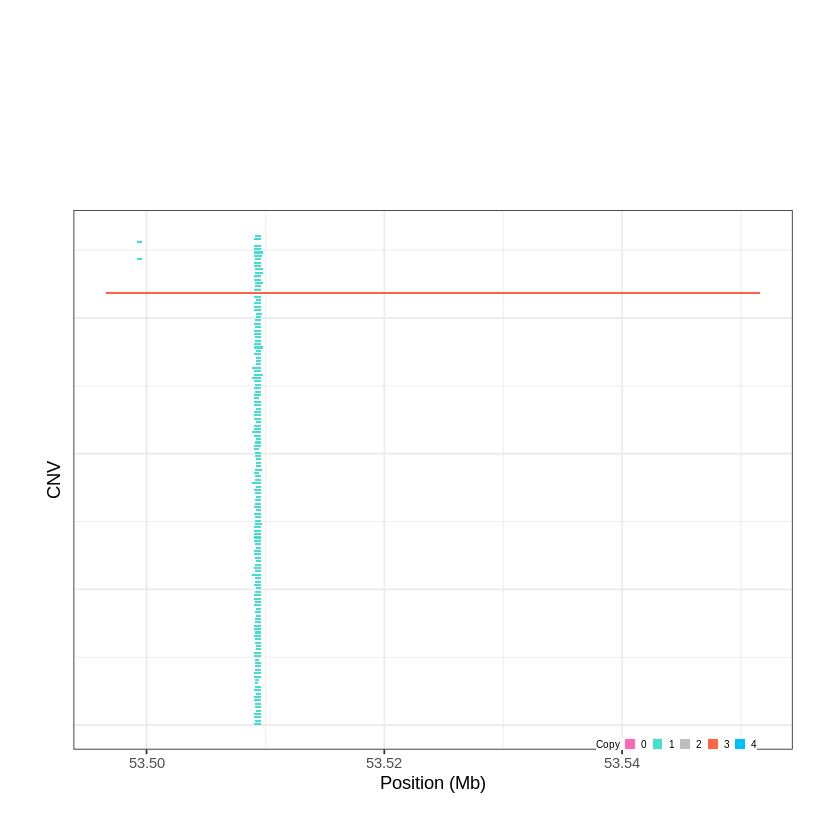

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1730..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 55.565301 - 55.7621 Mb with 216 Individual - "
Plotting gene...


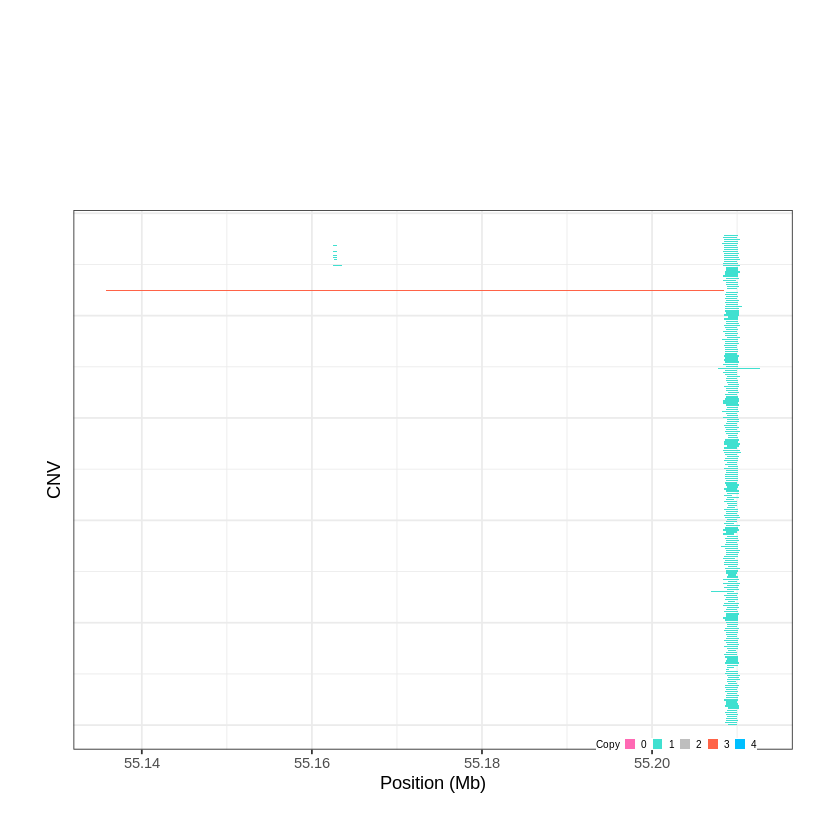

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1731..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 61.847701 - 62.1566 Mb with 156 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1732..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 62.204001 - 62.2498 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


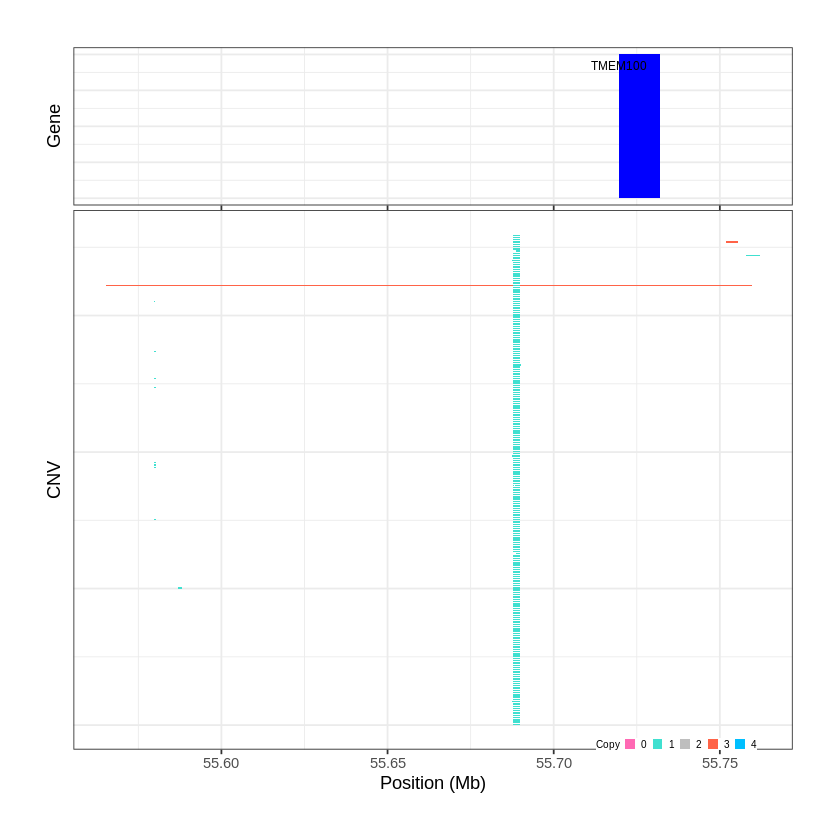

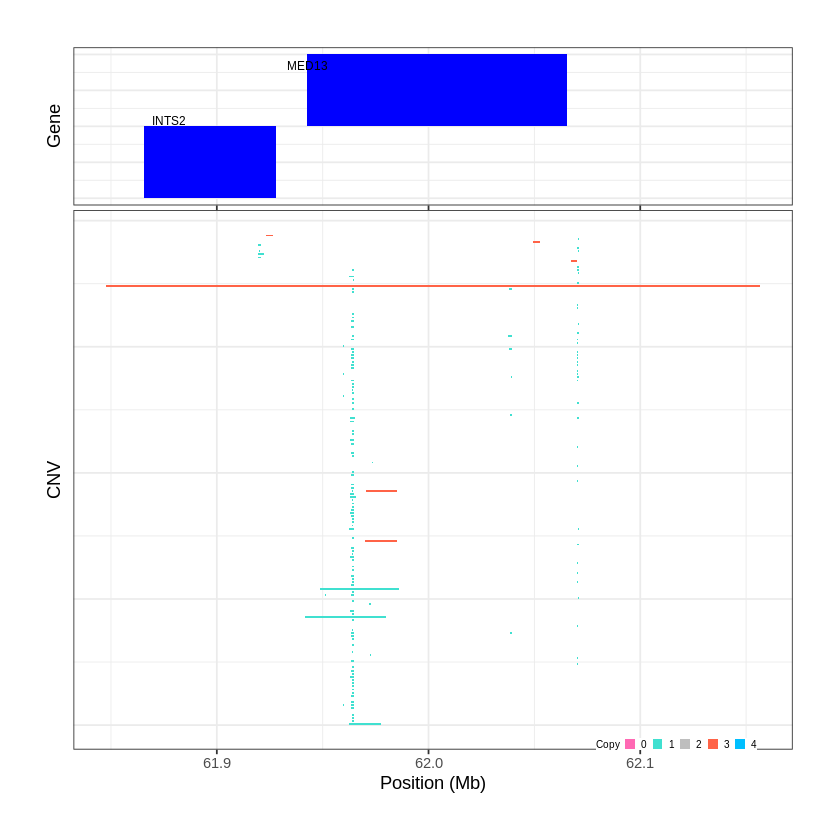

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1733..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 62.410501 - 62.4609 Mb with 279 Individual - "
Plotting gene...


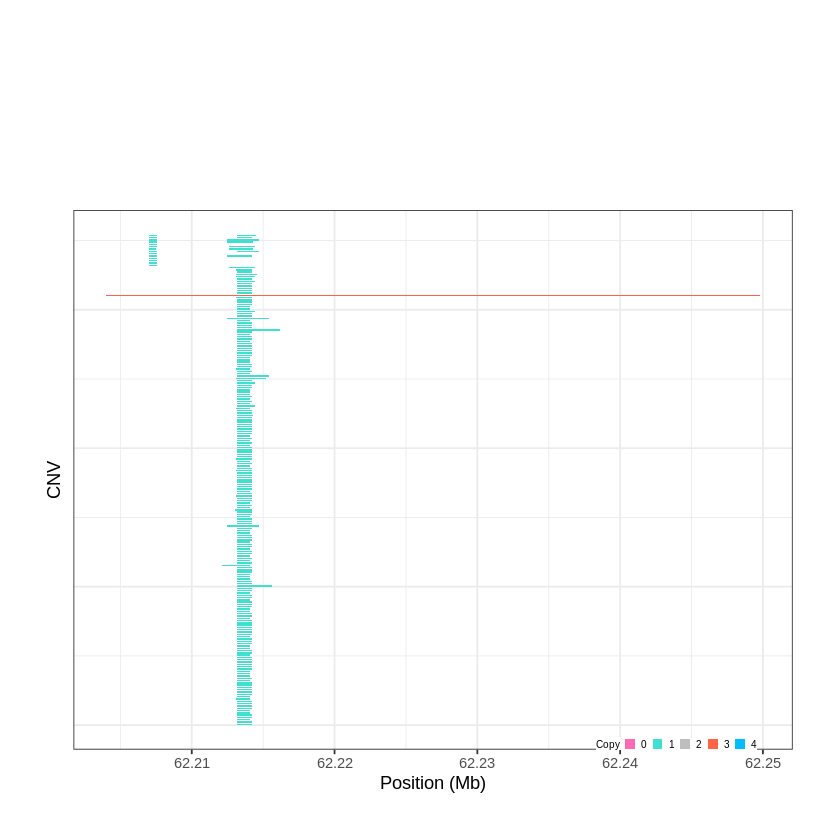

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1734..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 62.862401 - 62.9481 Mb with 240 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1735..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 63.445901 - 63.4856 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


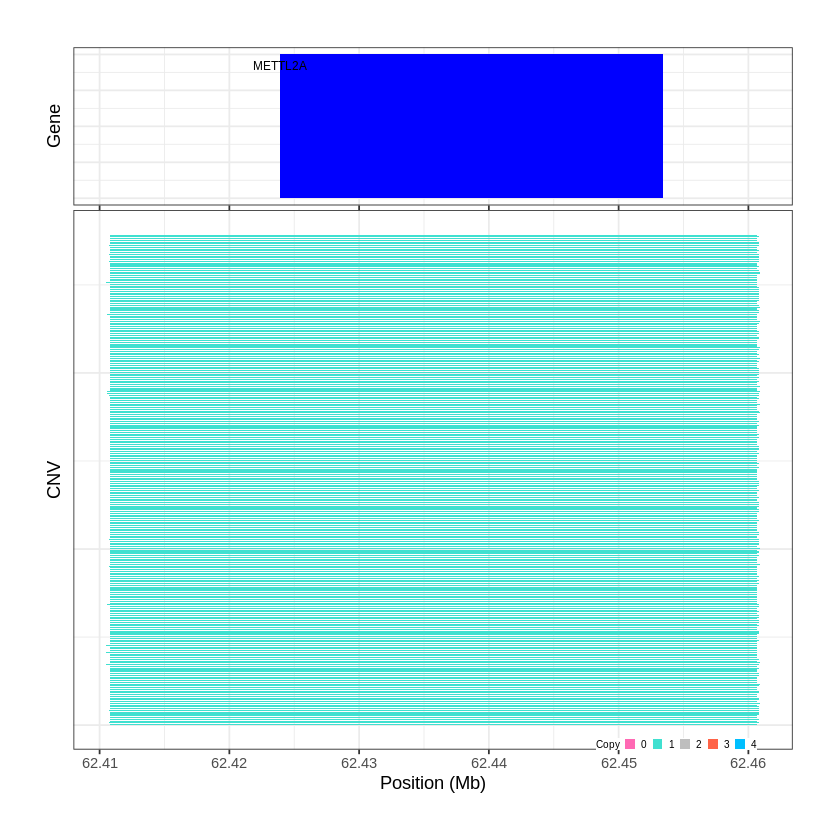

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1736..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 63.929701 - 63.937 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


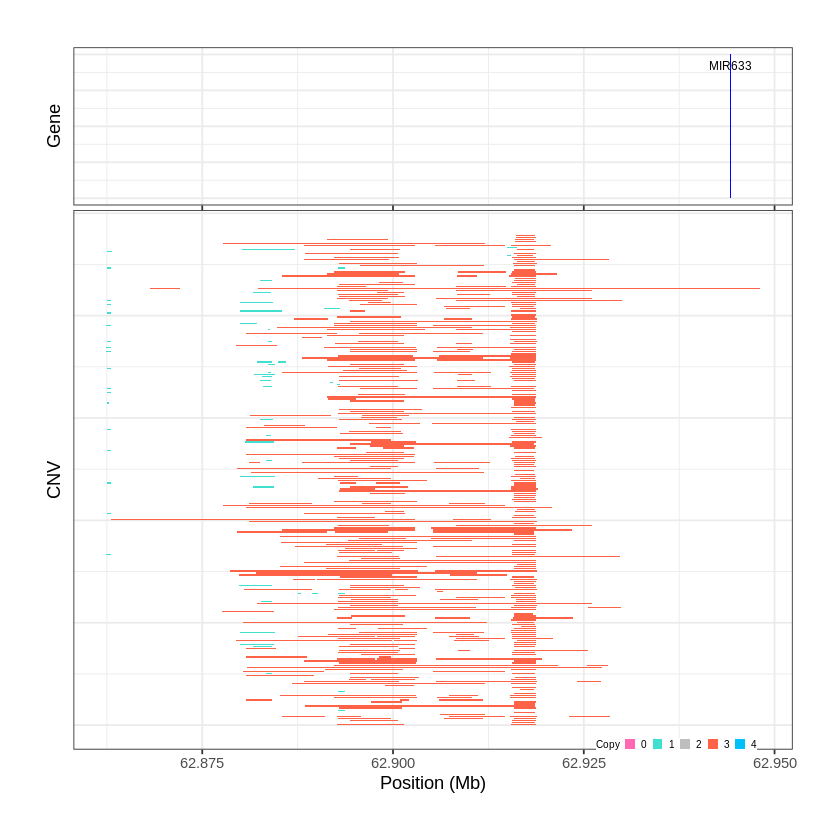

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1737..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 65.520901 - 65.5212 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


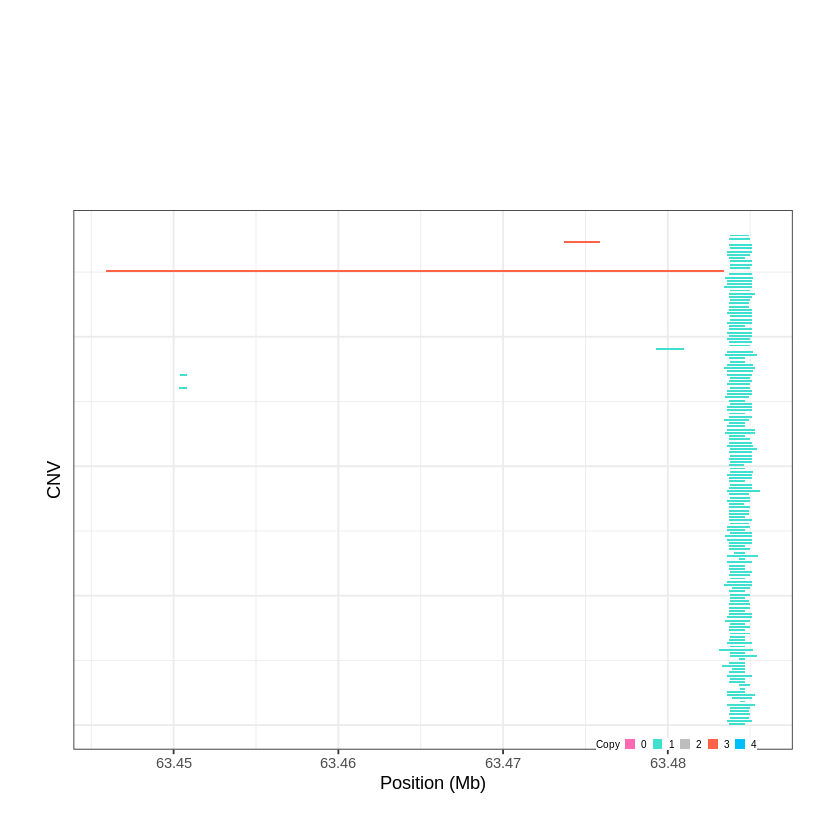

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1738..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 65.638501 - 65.7292 Mb with 197 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


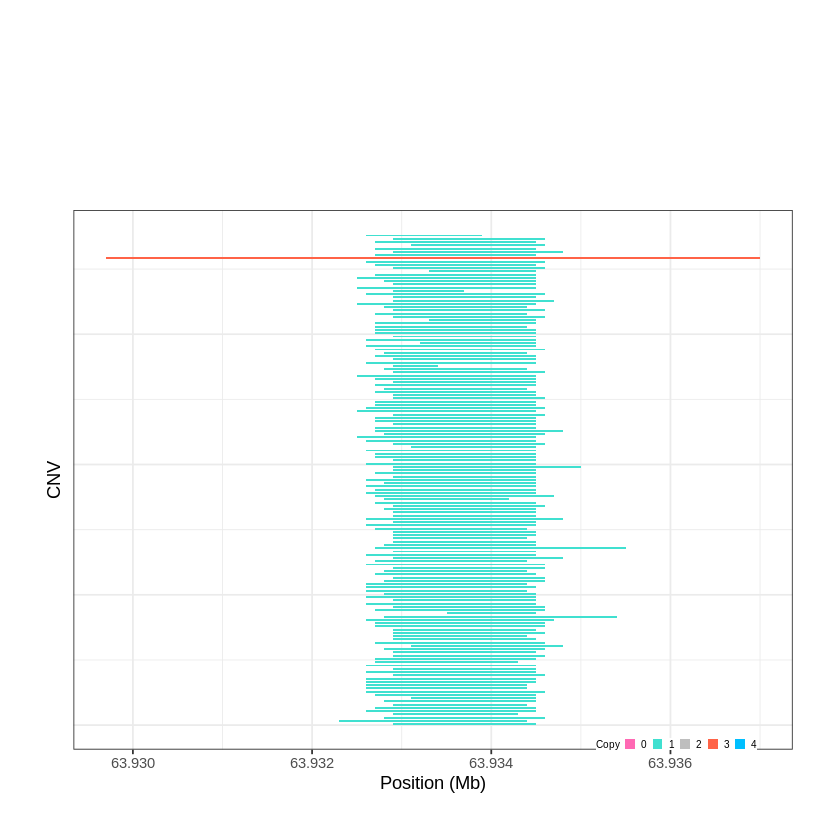

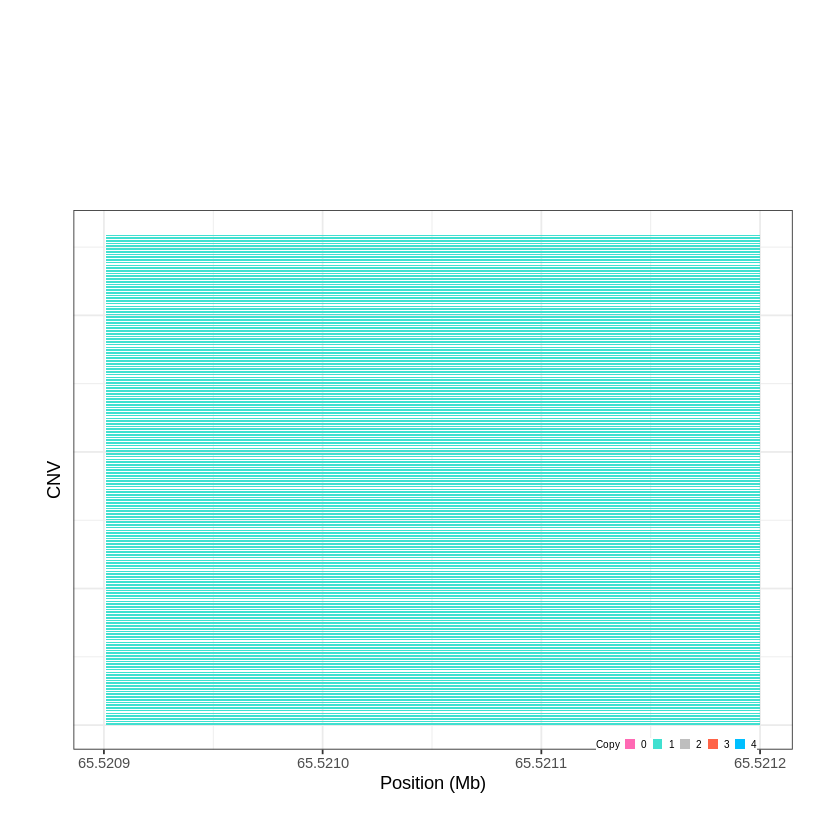

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1739..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 67.738601 - 67.7794 Mb with 212 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1740..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 68.520001 - 68.5311 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


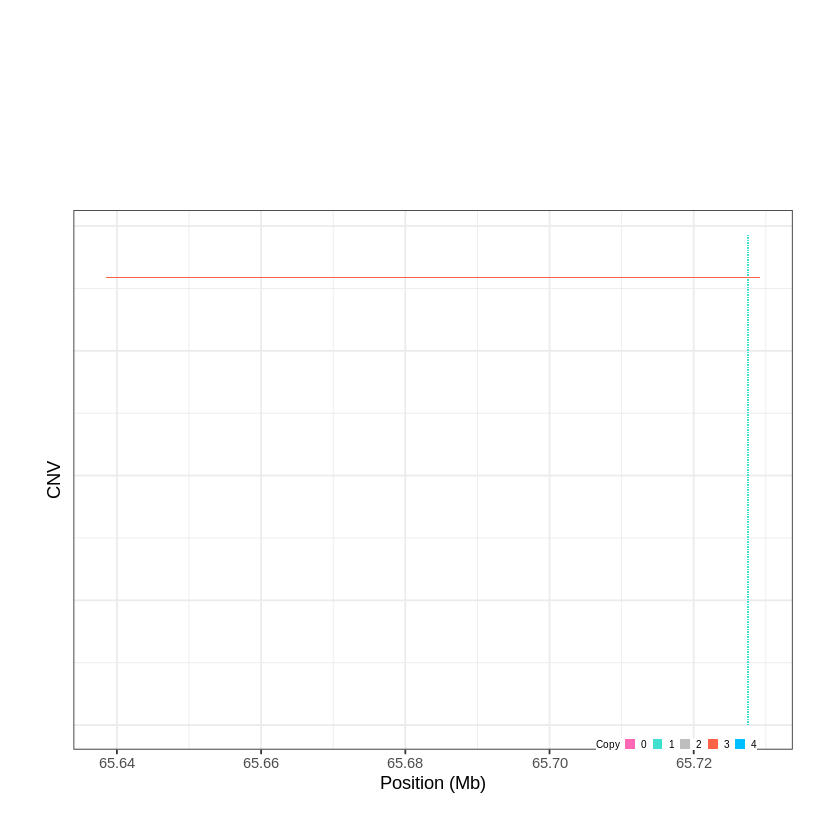

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1741..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 71.144101 - 71.6701 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


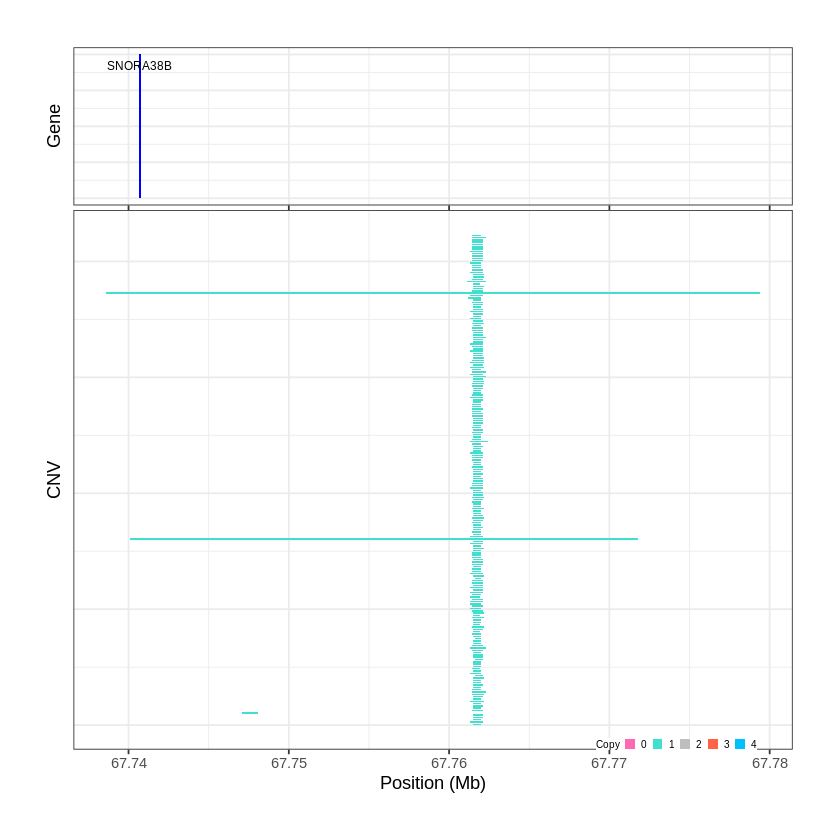

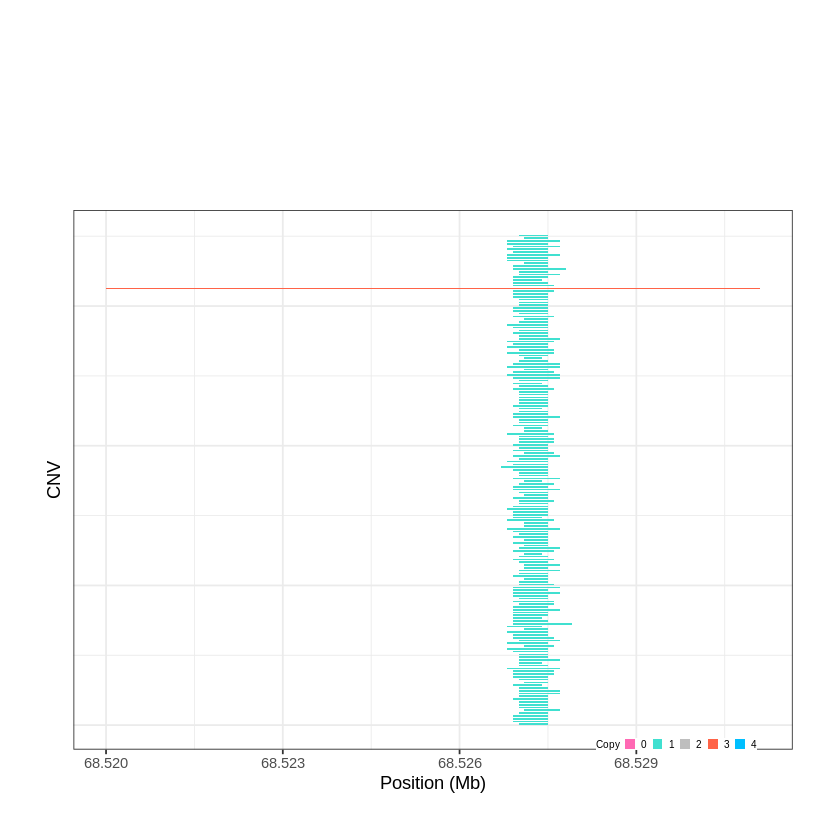

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1742..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 75.670301 - 75.9449 Mb with 244 Individual - "
Plotting gene...


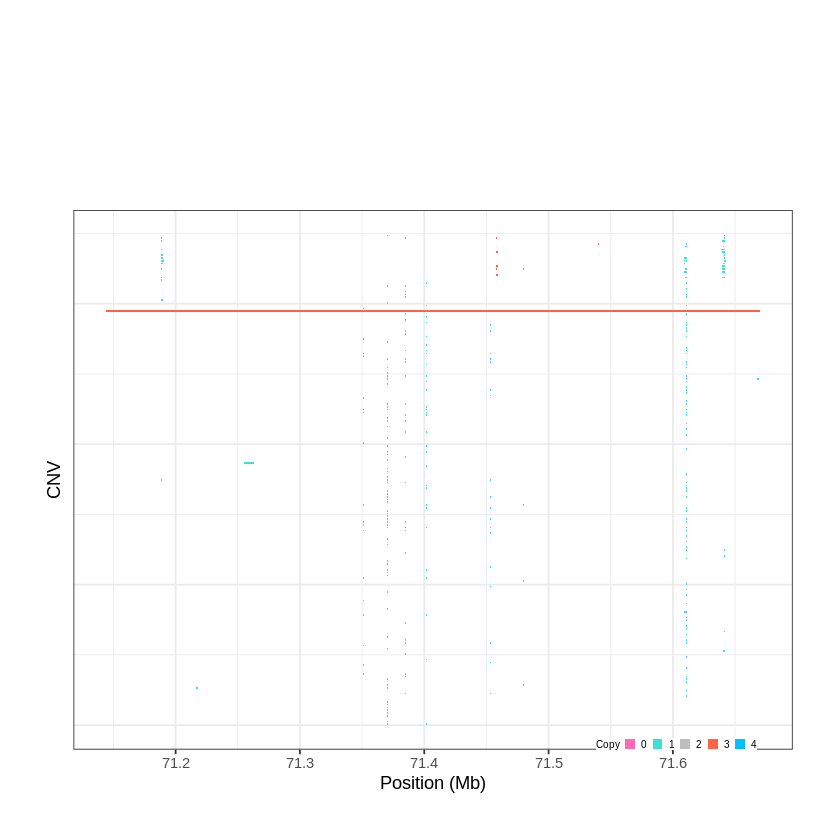

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1743..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 75.950401 - 76.7343 Mb with 275 Individual - "
Plotting gene...


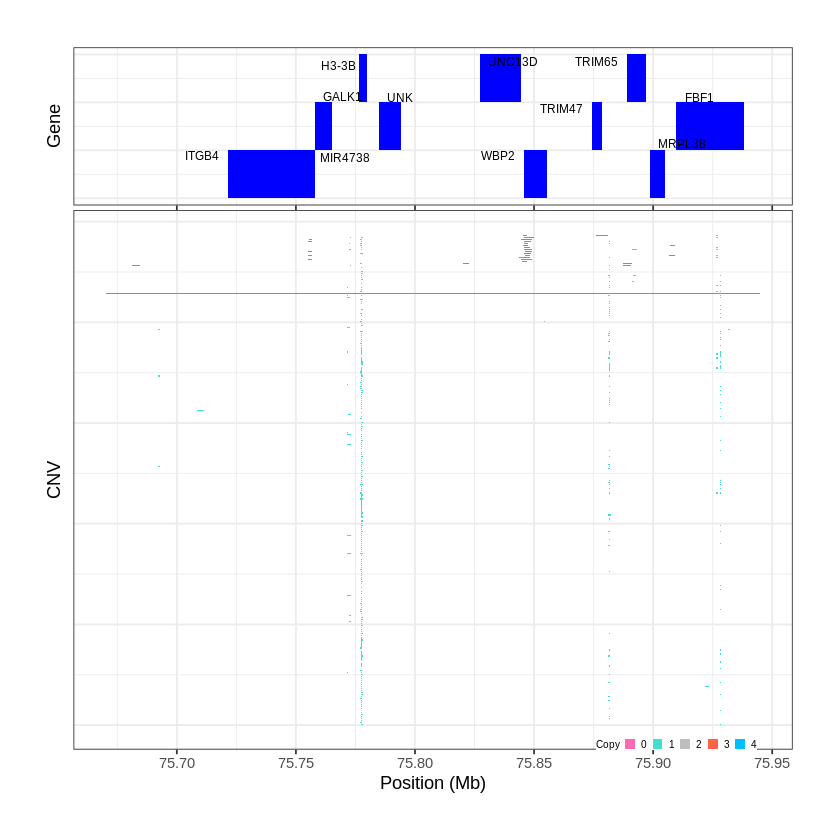

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1744..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 76.767801 - 77.1452 Mb with 242 Individual - "
Plotting gene...


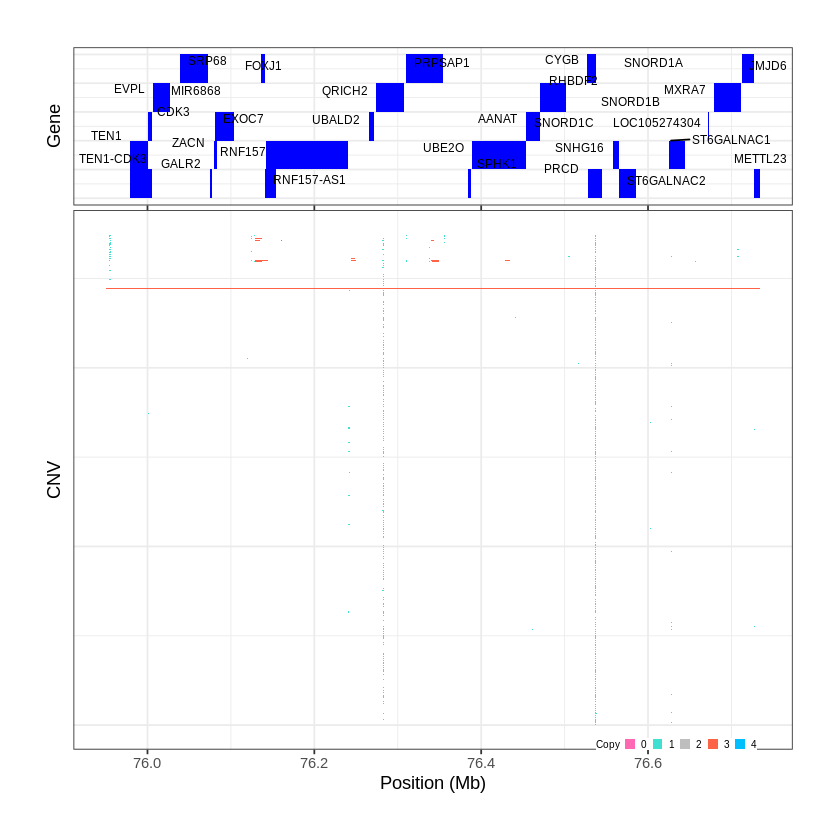

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1745..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 77.149401 - 77.6327 Mb with 279 Individual - "
Plotting gene...


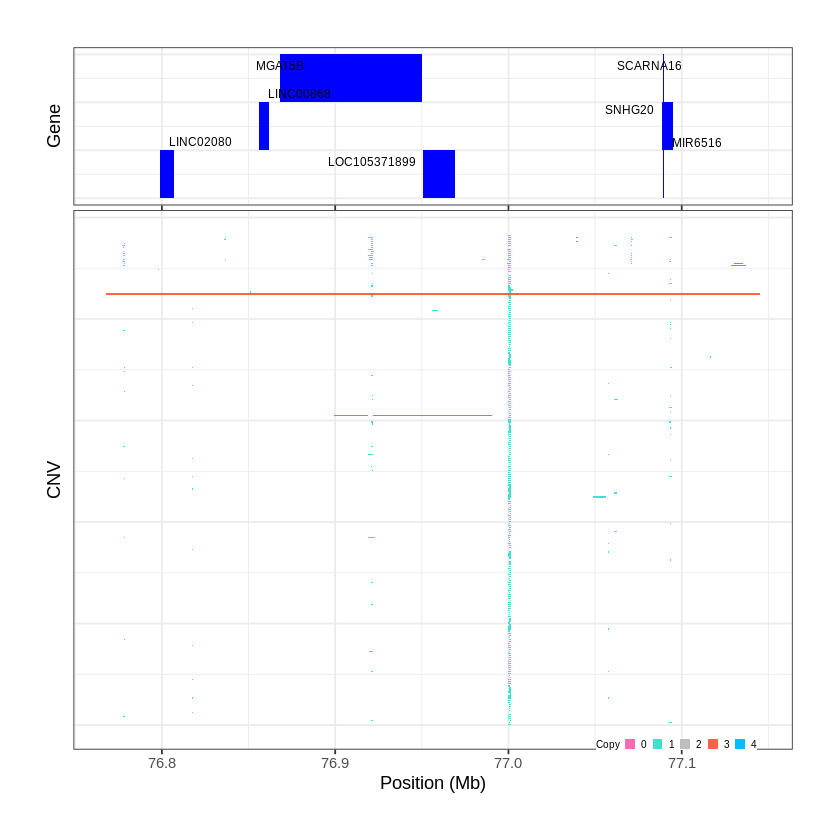

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1746..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 77.633501 - 78.9208 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1747..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 79.139401 - 79.1407 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


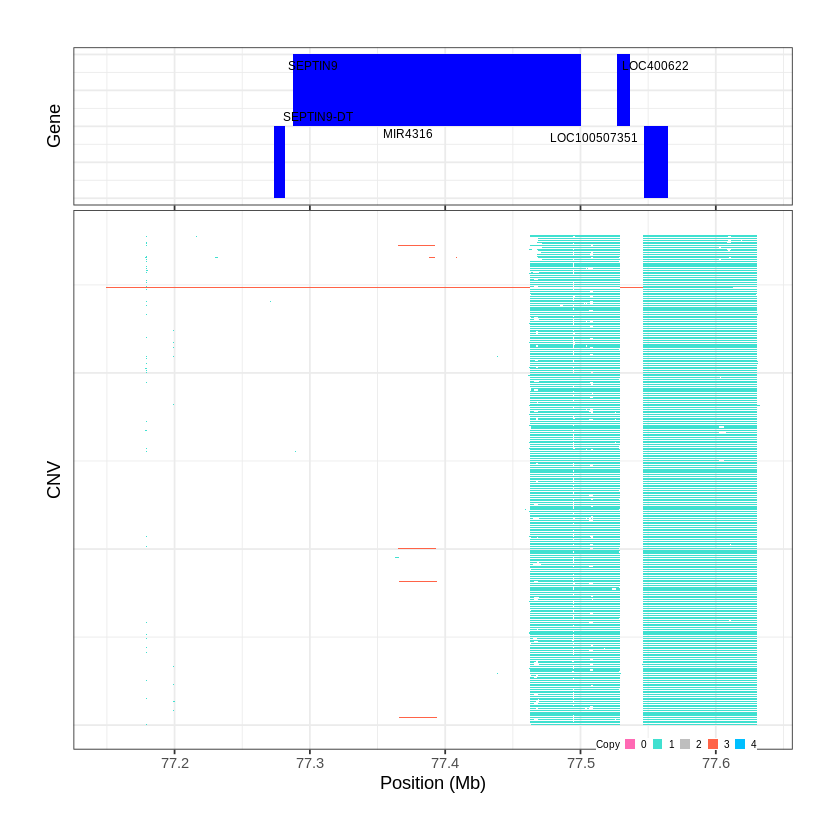

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1748..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 79.470001 - 79.472 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


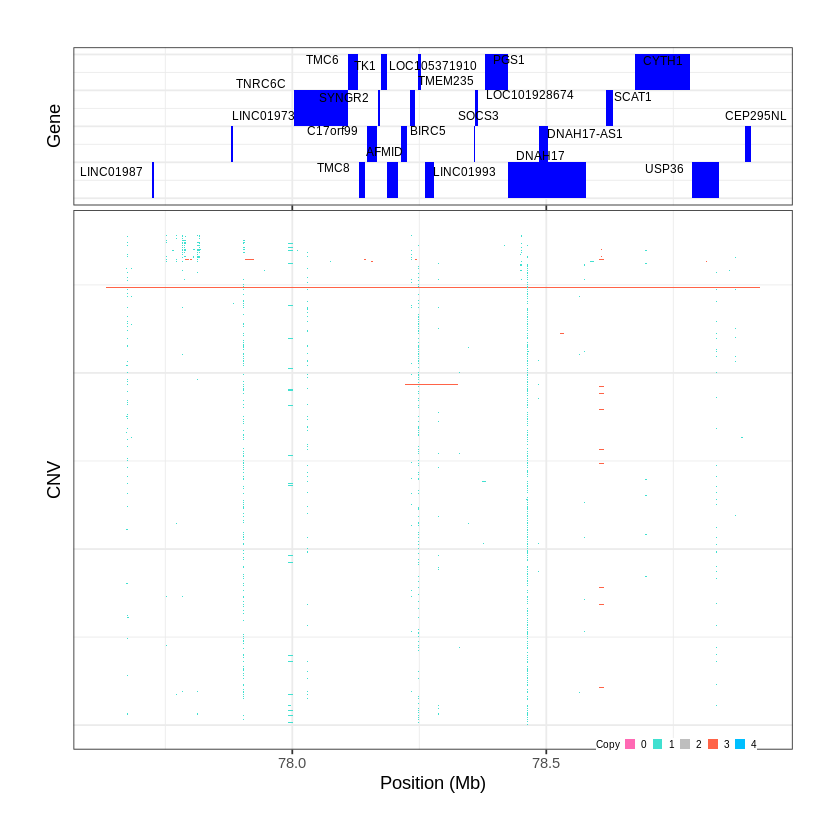

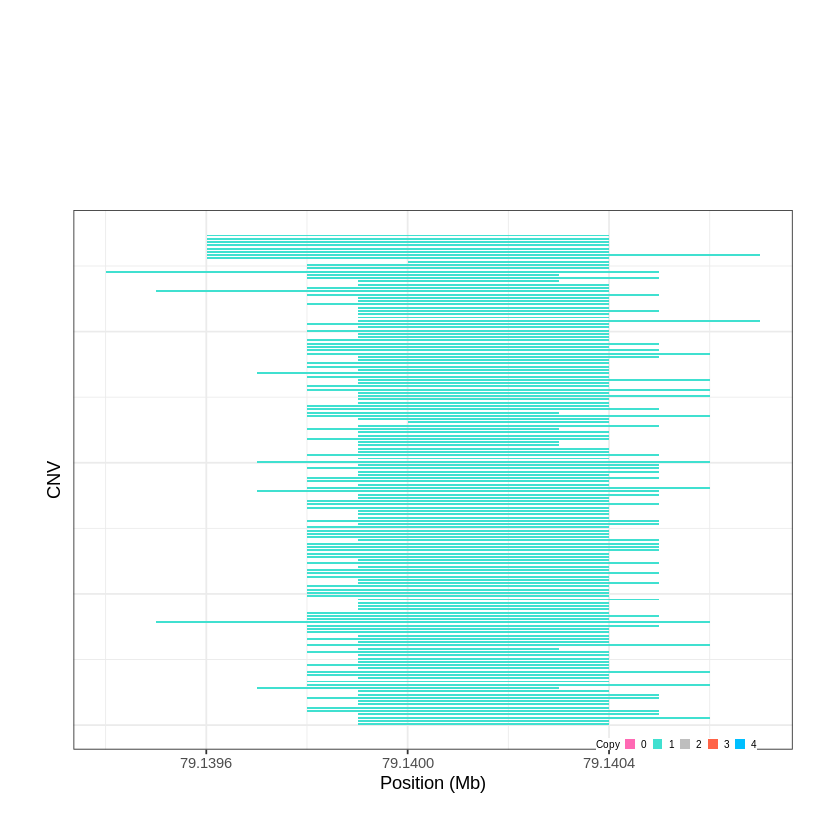

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1749..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 79.699001 - 79.7638 Mb with 279 Individual - "
Plotting gene...


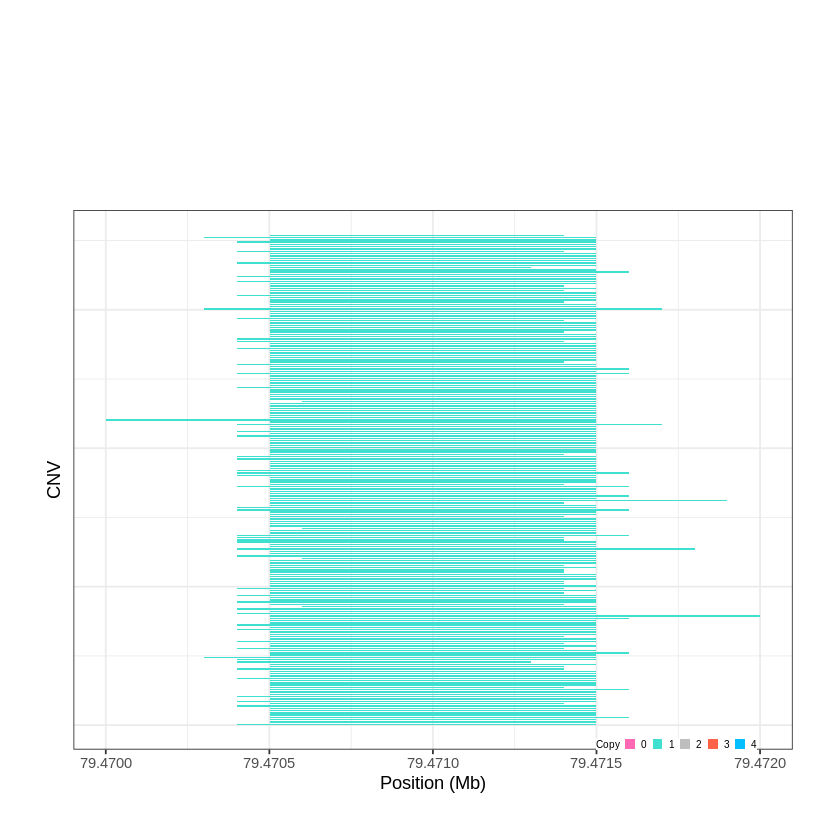

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1750..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 79.995001 - 80.9475 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


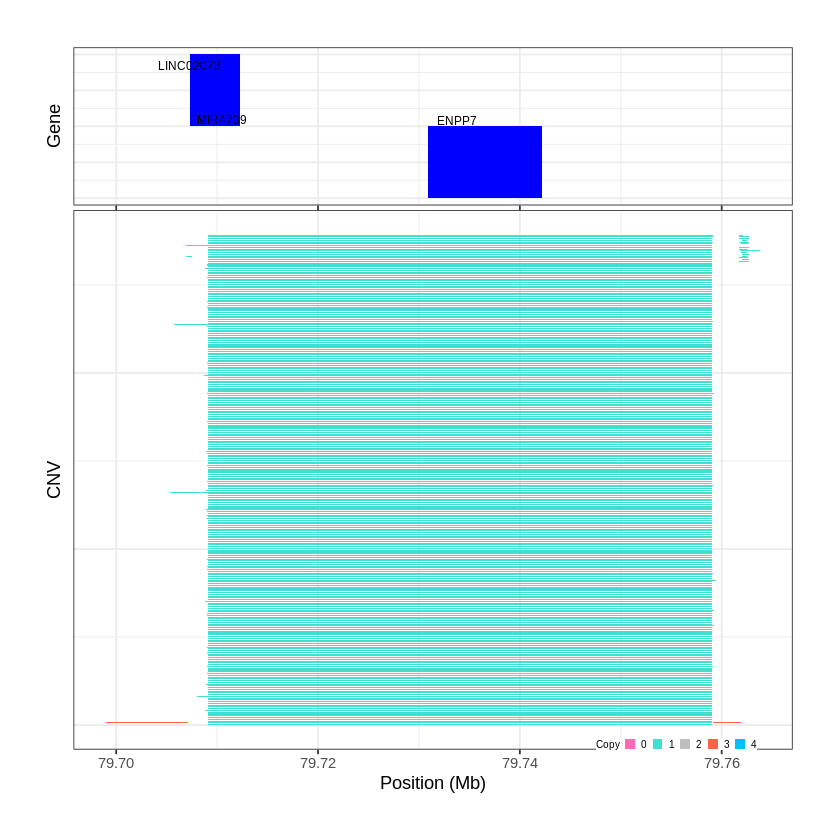

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1751..."
Input data passed requirment check...
[1] "CNV on Chromosome 17: 80.951601 - 81.1953 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1752..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 1e-06 - 0.01 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


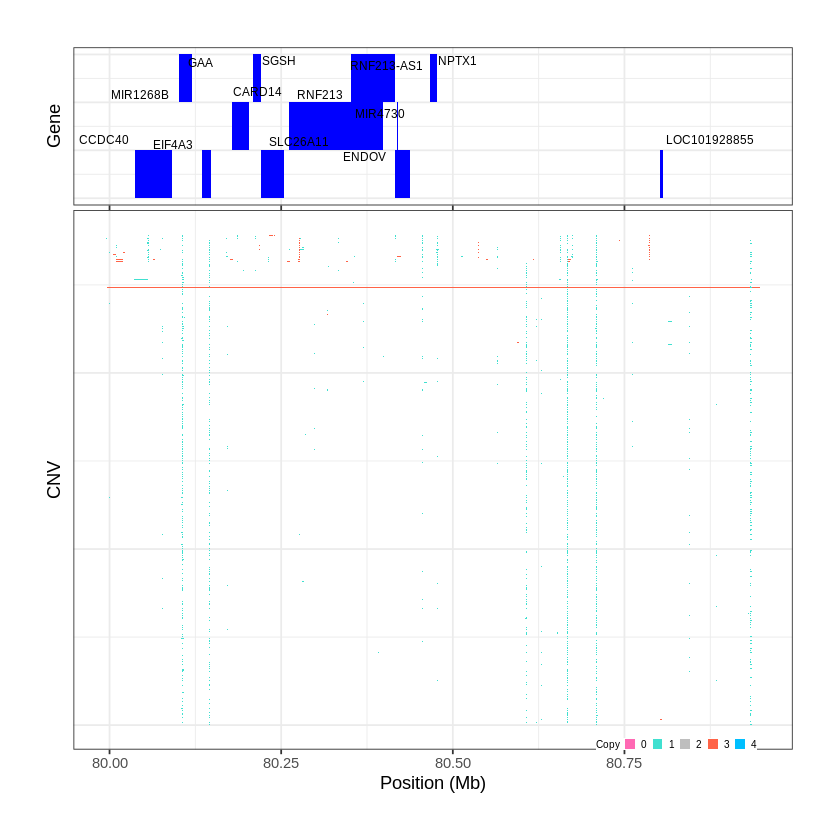

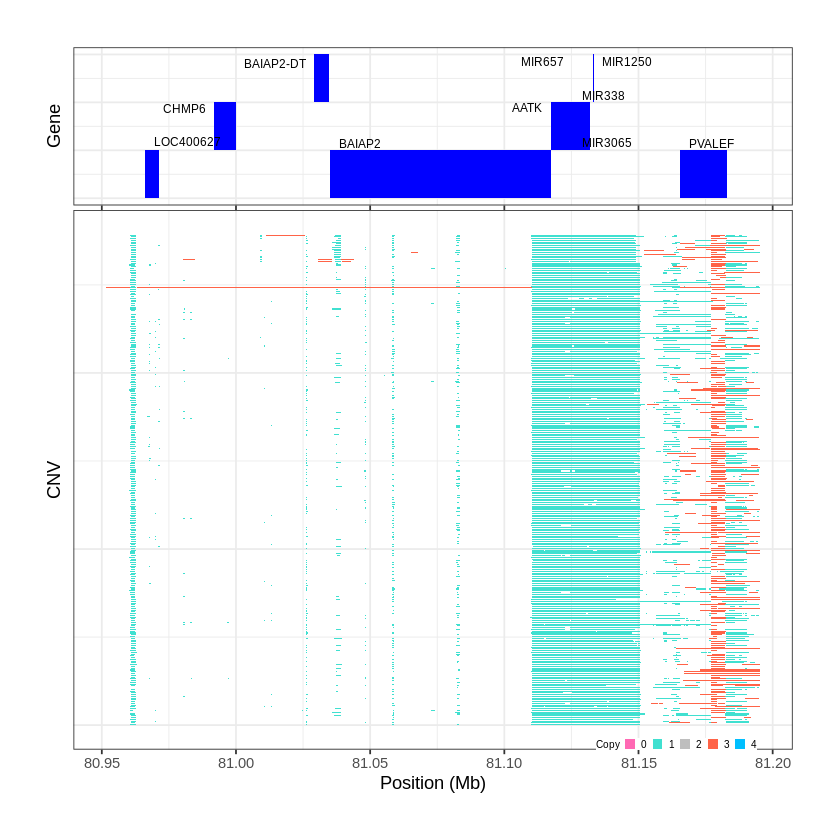

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1753..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 0.010001 - 0.1776 Mb with 278 Individual - "
Plotting gene...


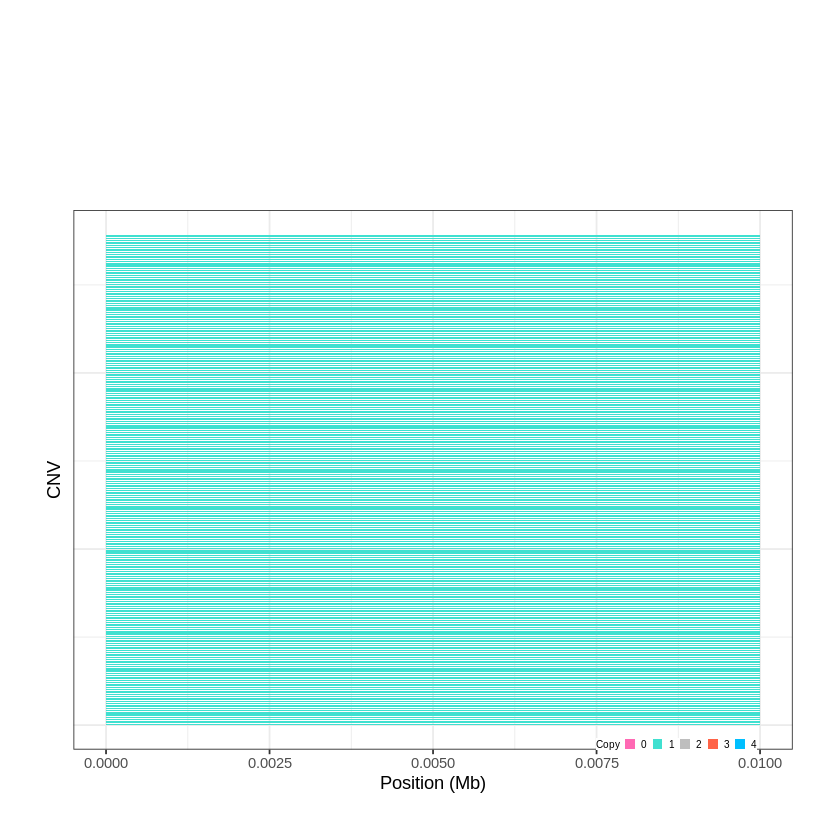

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1754..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 0.498801 - 0.5546 Mb with 231 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1755..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 0.804901 - 0.854 Mb with 241 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


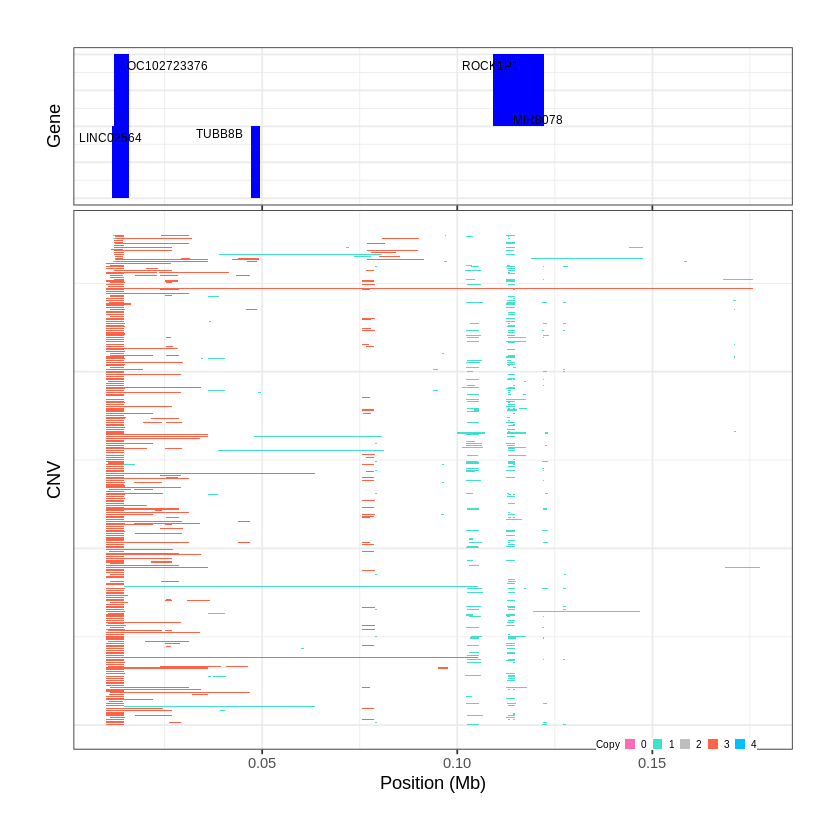

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1756..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 1.869701 - 1.9866 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


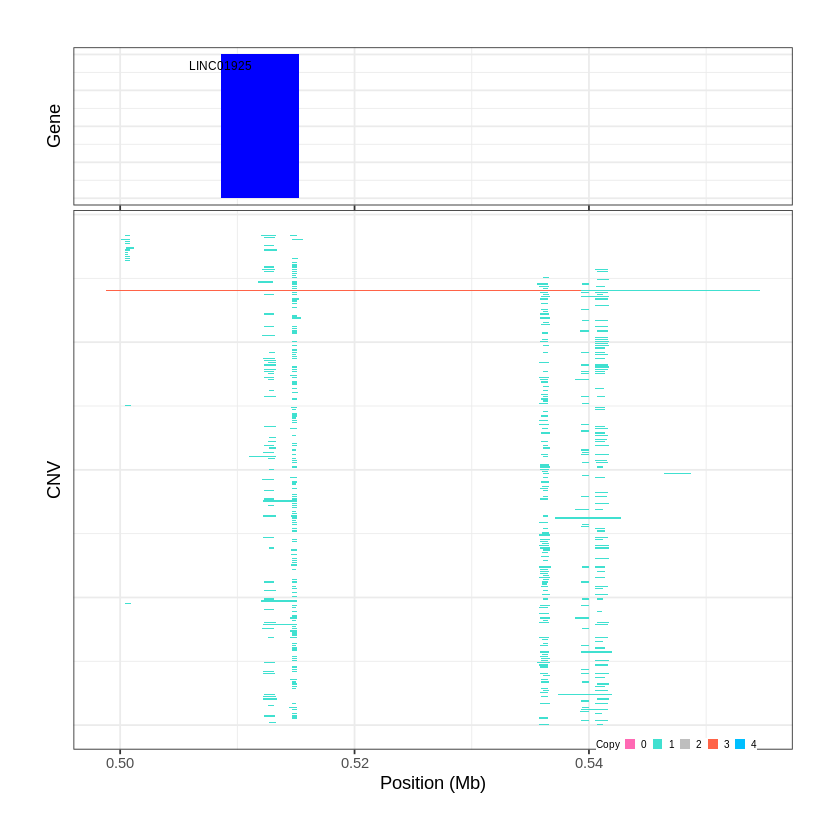

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1757..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 5.300501 - 5.3197 Mb with 227 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


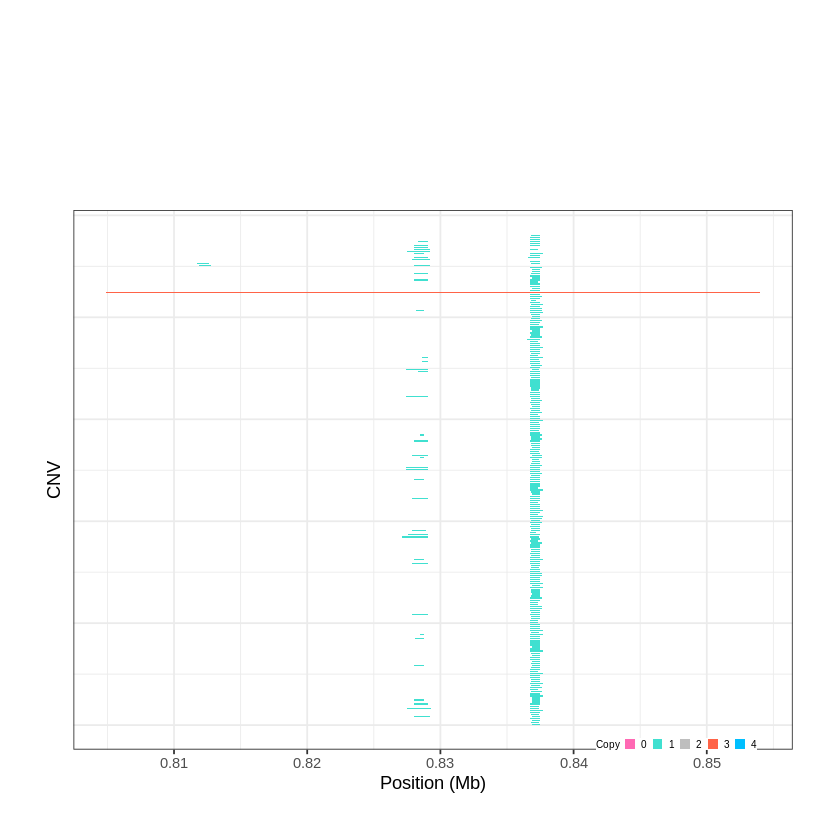

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1758..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 5.324001 - 5.3281 Mb with 185 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


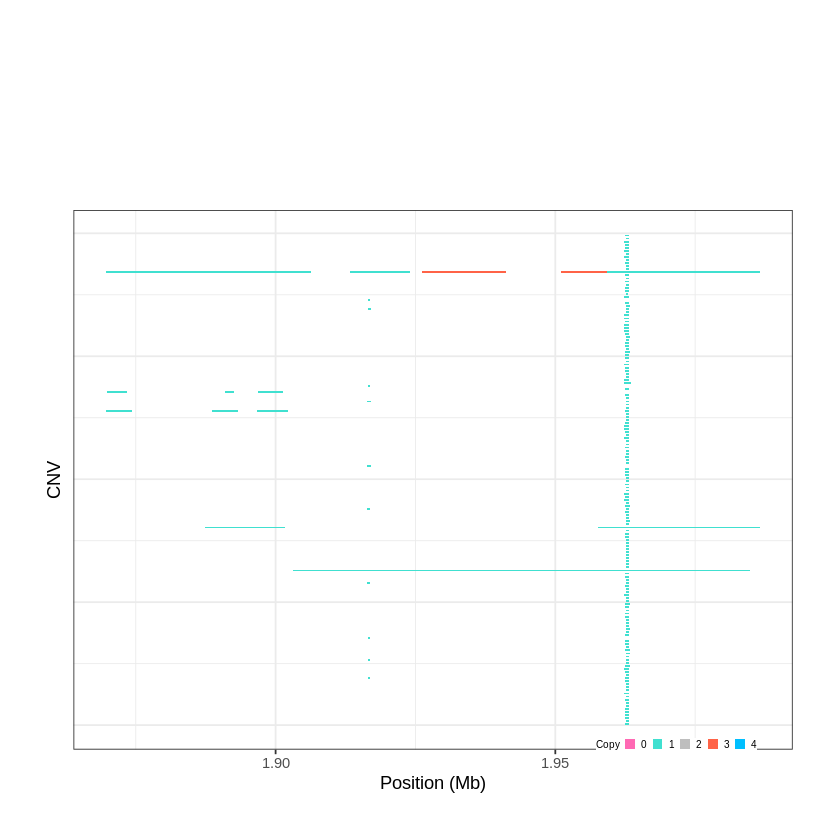

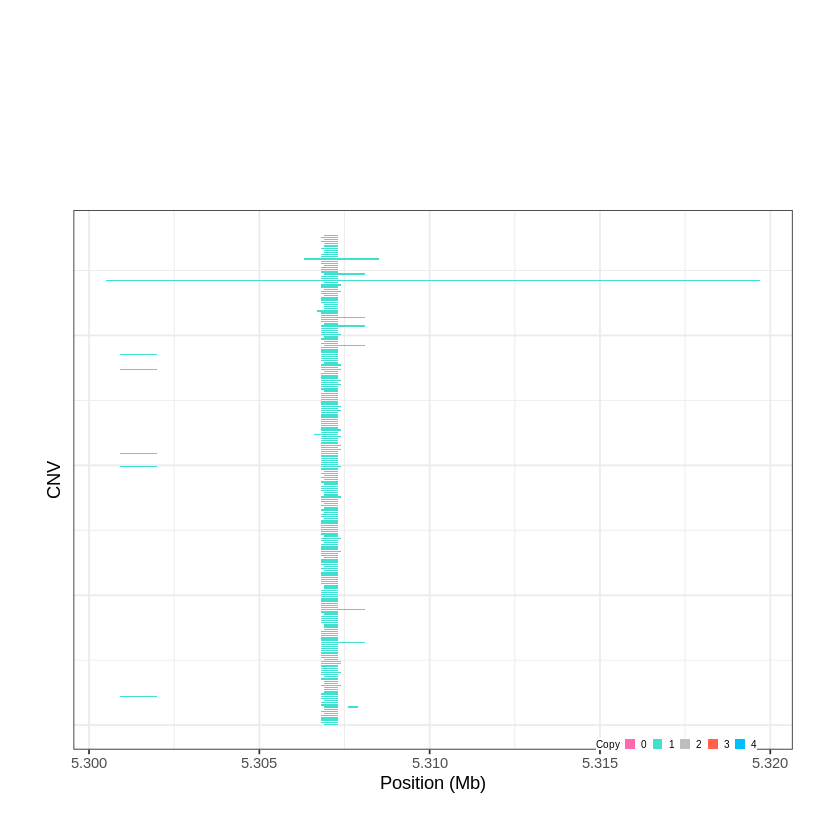

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1759..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 6.902401 - 7.213 Mb with 153 Individual - "
Plotting gene...


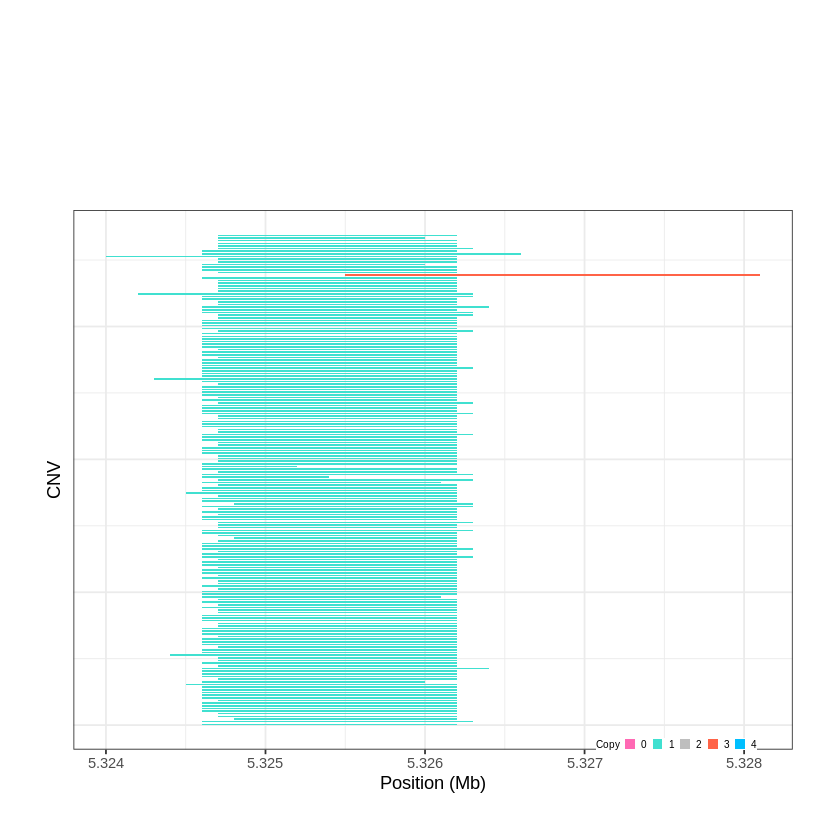

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1760..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 9.597801 - 9.6819 Mb with 149 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1761..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 10.208201 - 10.2275 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


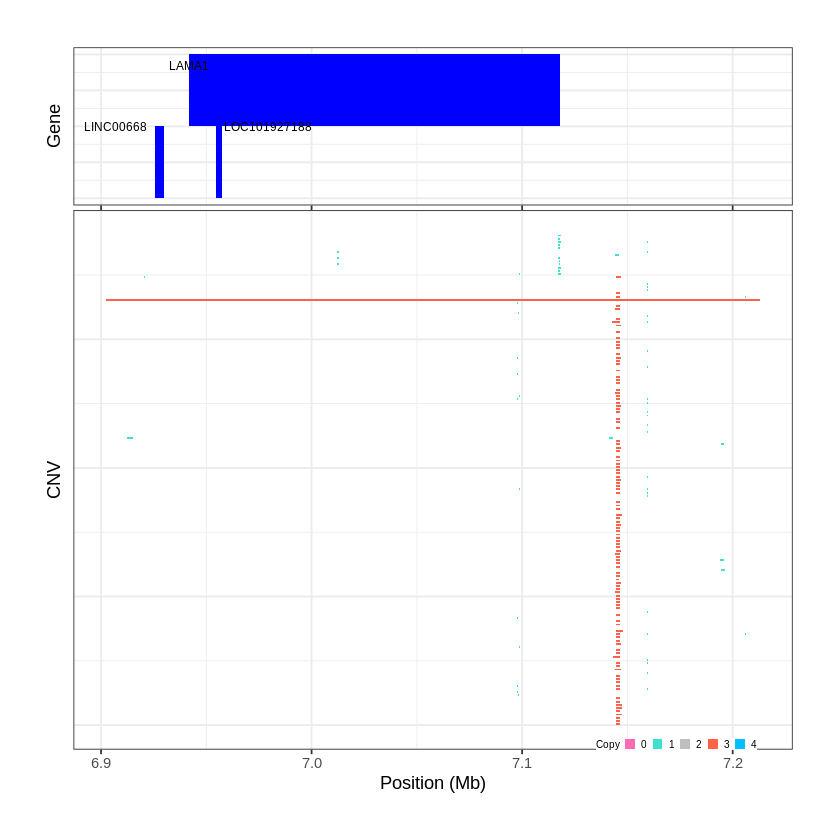

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1762..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 10.626001 - 10.6552 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


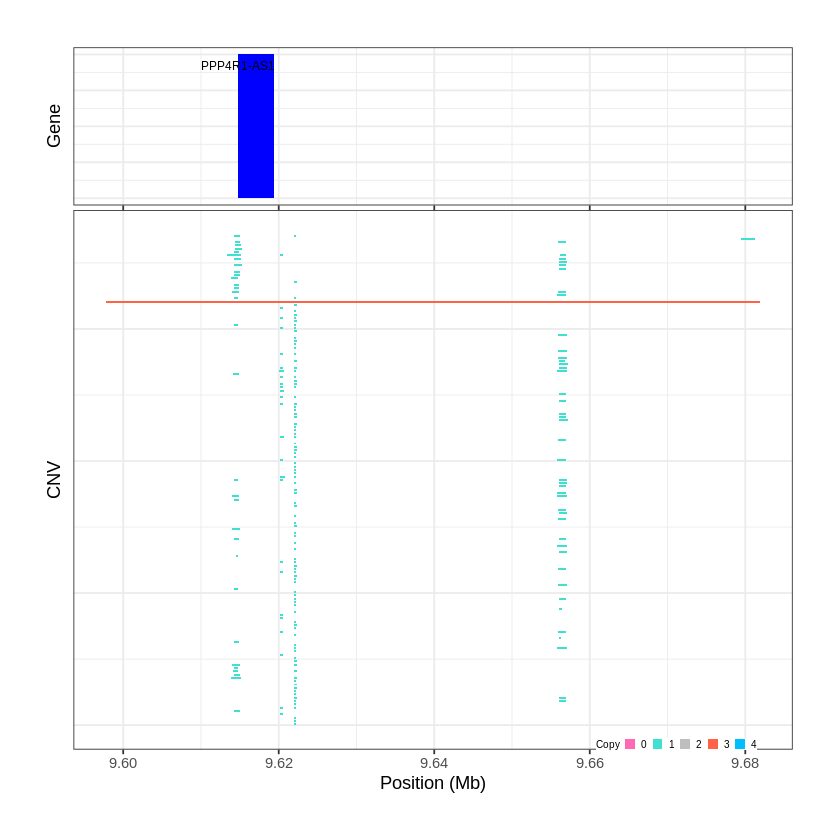

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1763..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 11.497501 - 11.5213 Mb with 185 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


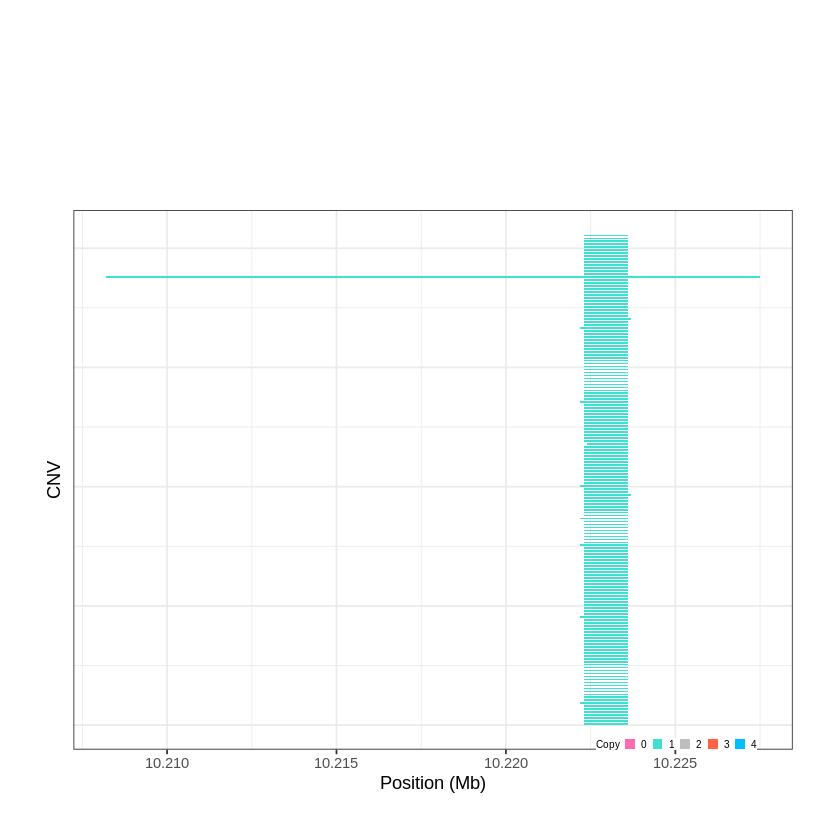

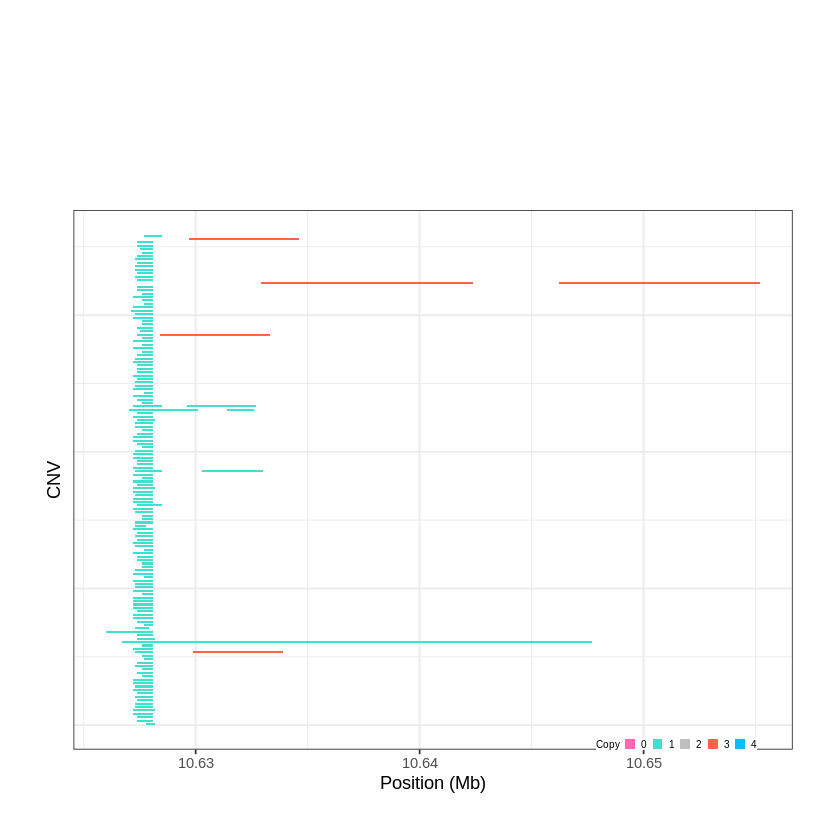

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1764..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 11.551001 - 11.6758 Mb with 244 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1765..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 12.092701 - 12.0953 Mb with 208 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


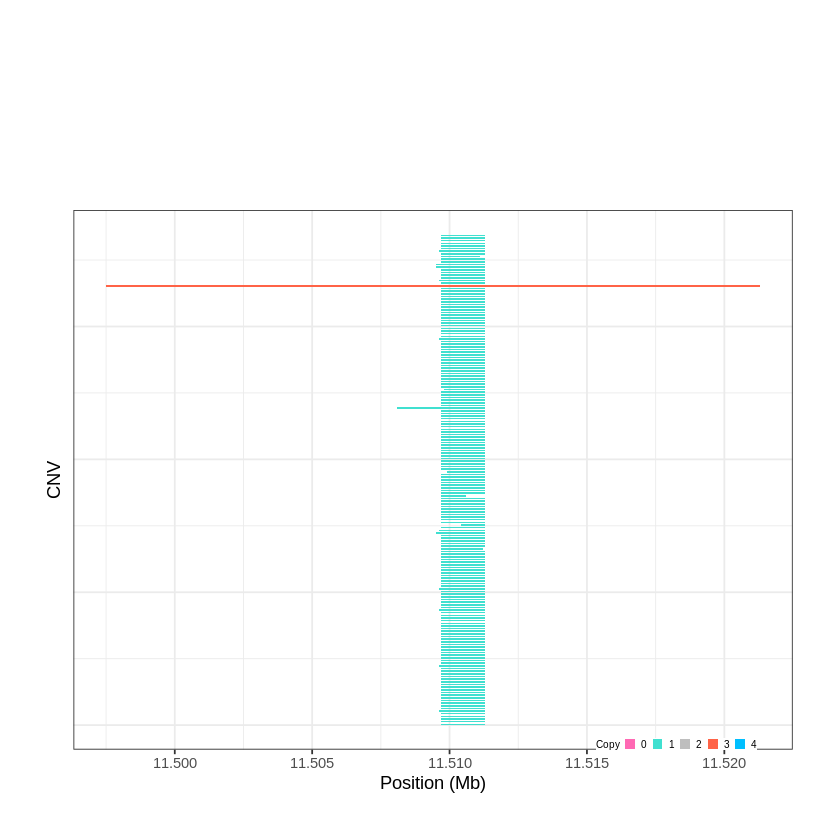

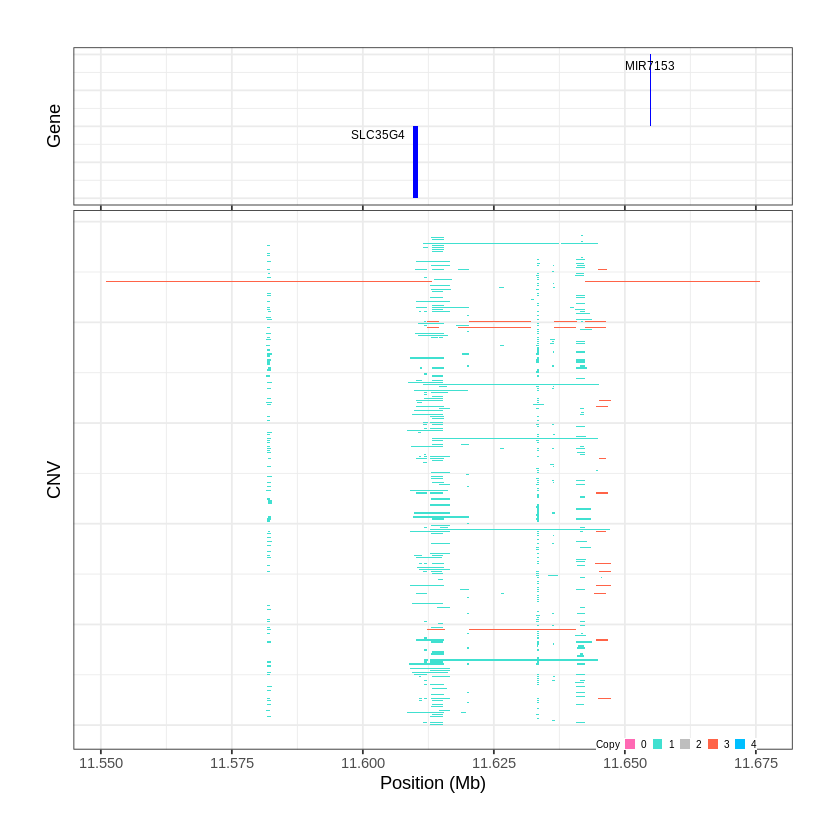

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1766..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 12.167501 - 12.4616 Mb with 181 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1767..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 12.851201 - 12.8515 Mb with 157 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


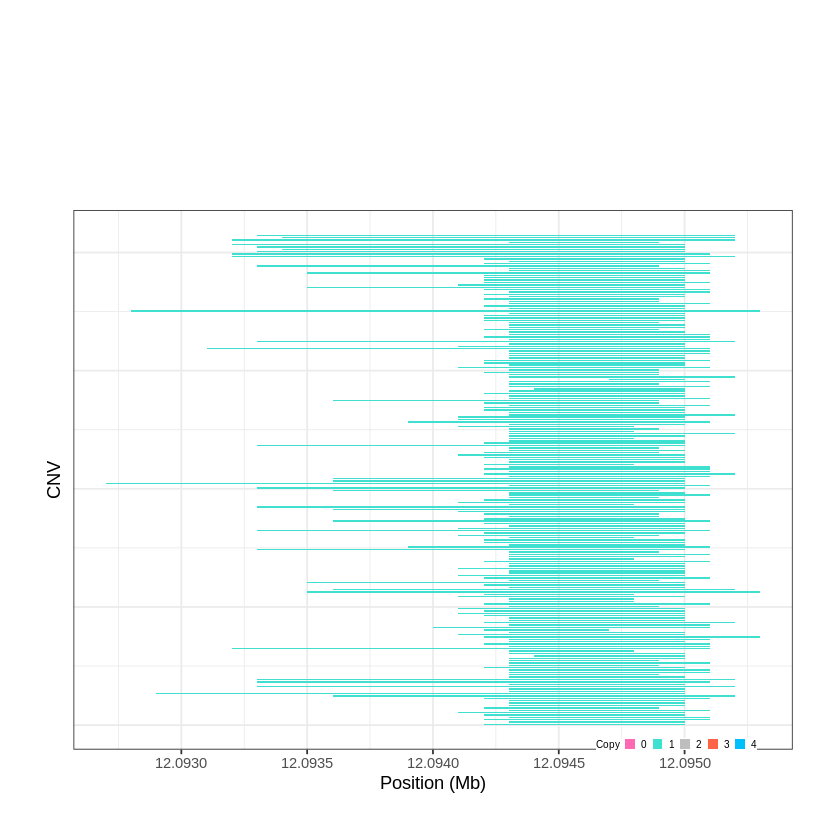

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1768..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 13.343301 - 13.4065 Mb with 148 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


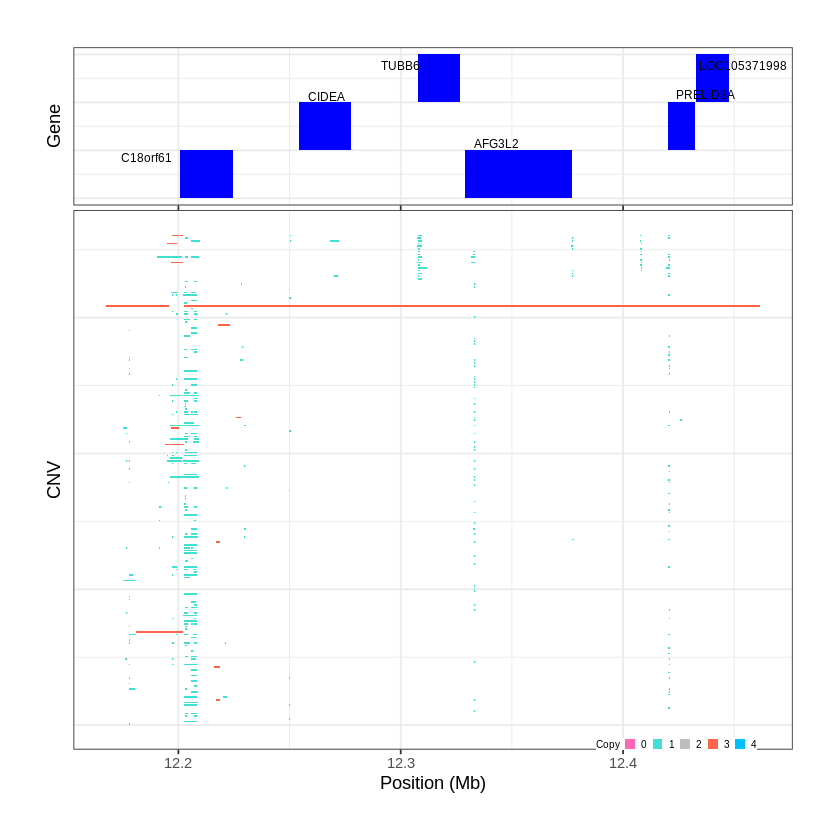

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1769..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 13.672801 - 13.7055 Mb with 257 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


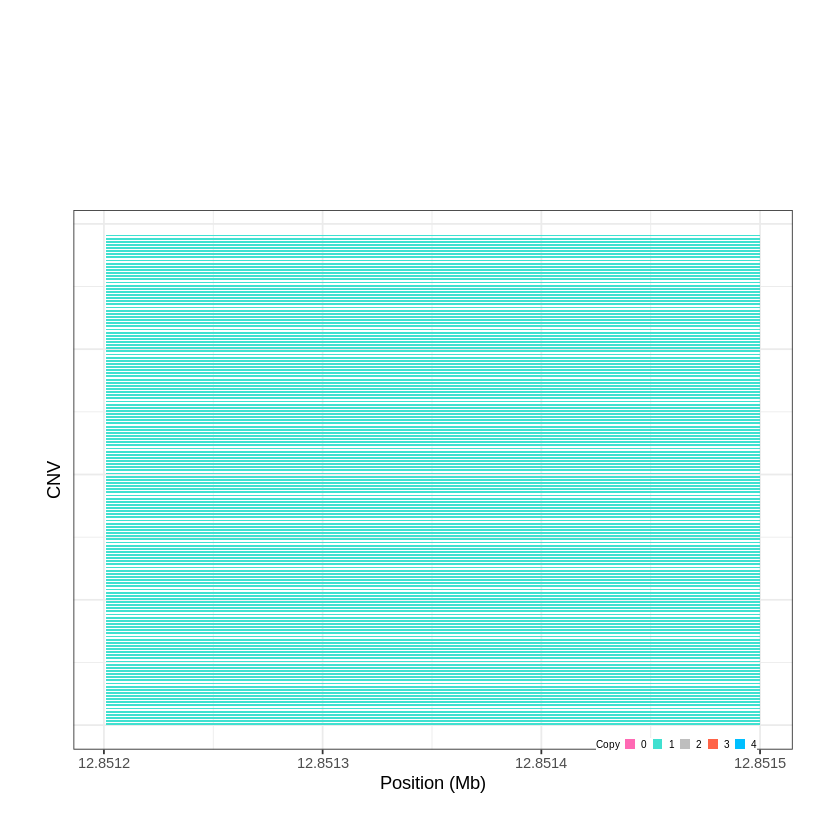

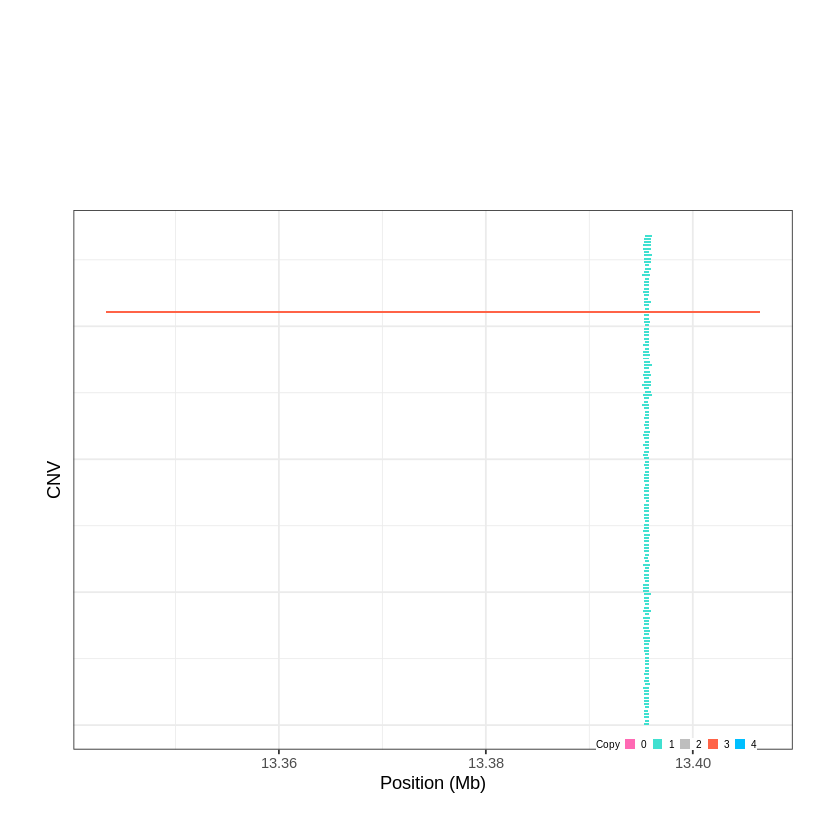

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1770..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 13.993701 - 14.4626 Mb with 238 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1771..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 14.706401 - 14.7343 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


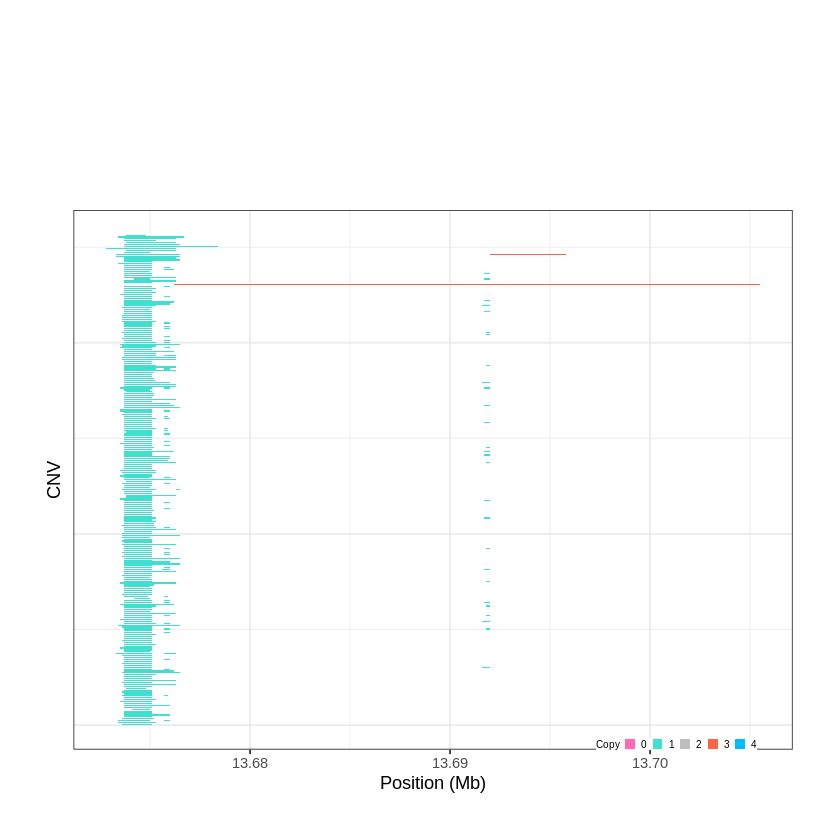

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1772..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 14.845701 - 14.8917 Mb with 229 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


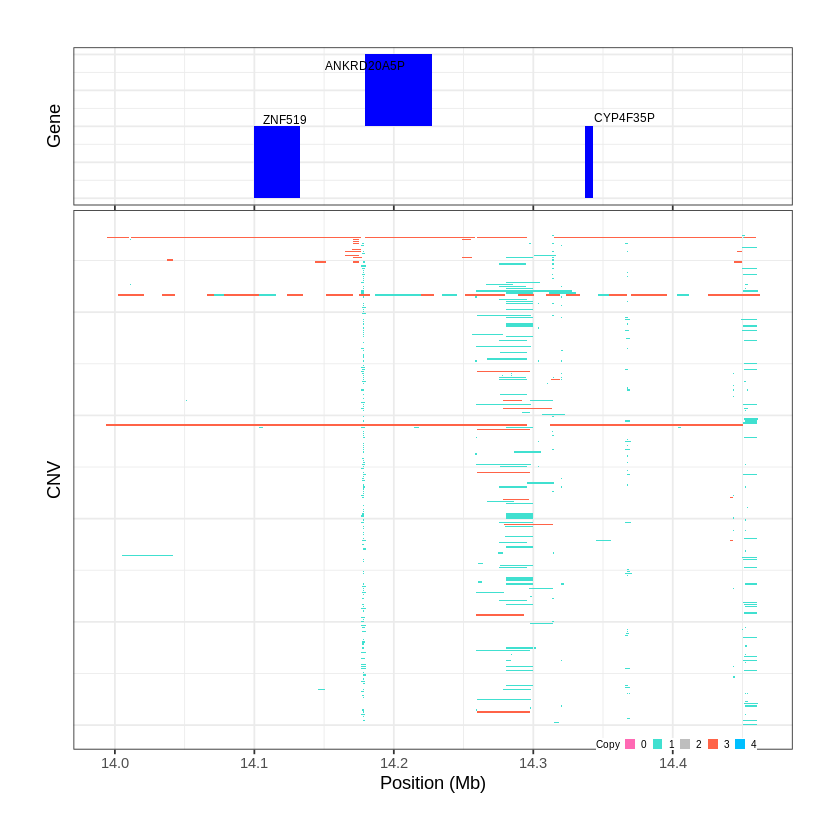

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1773..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 15.374901 - 18.5414 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


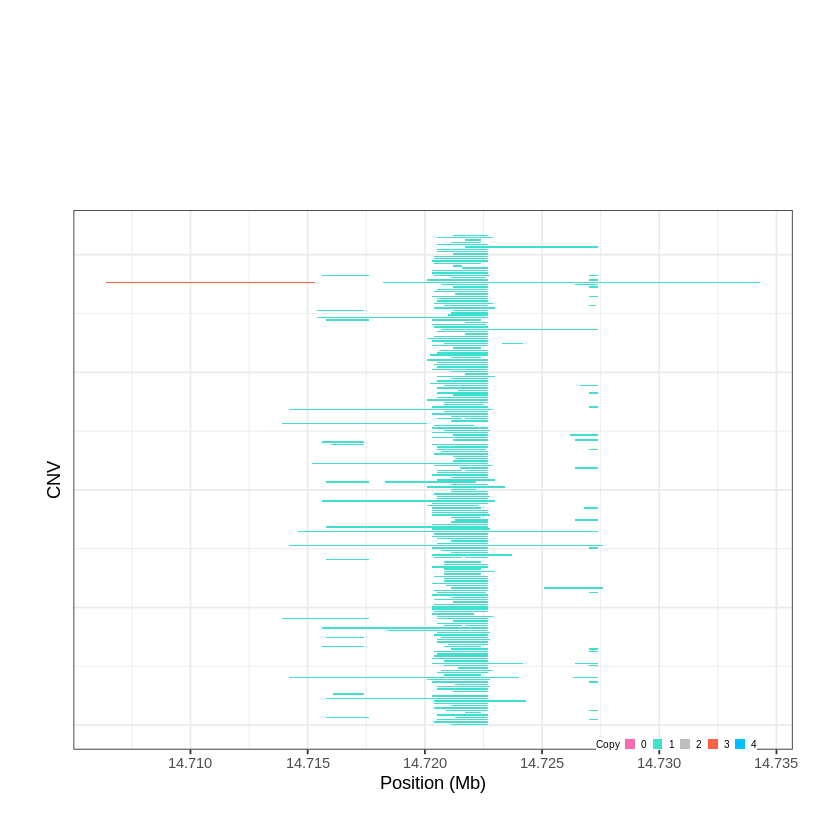

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1774..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 19.853301 - 19.8543 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


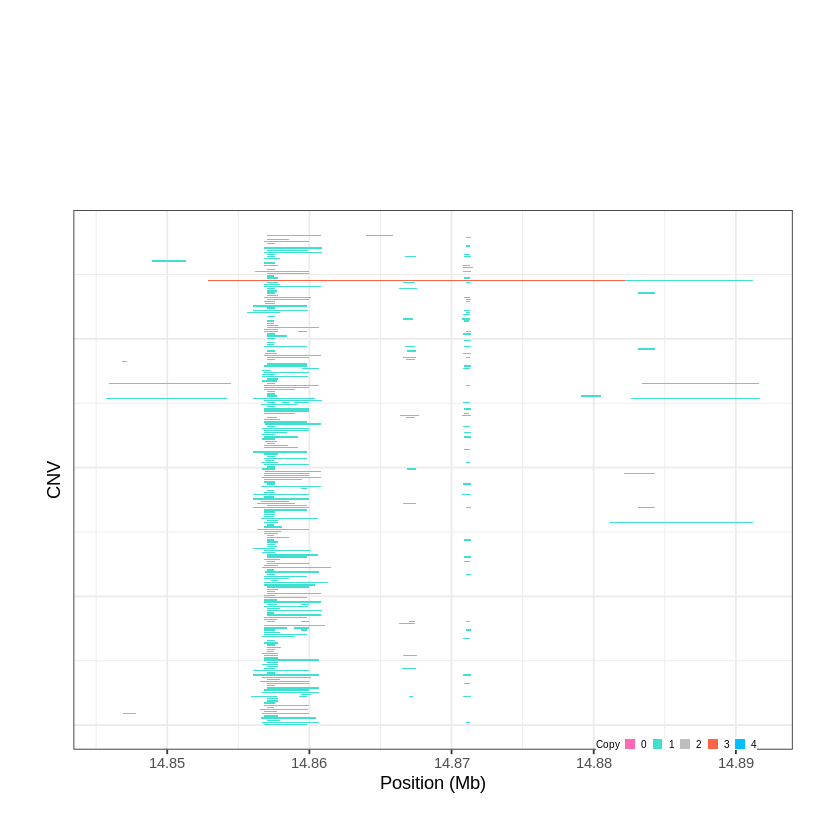

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1775..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 23.811101 - 23.8534 Mb with 246 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


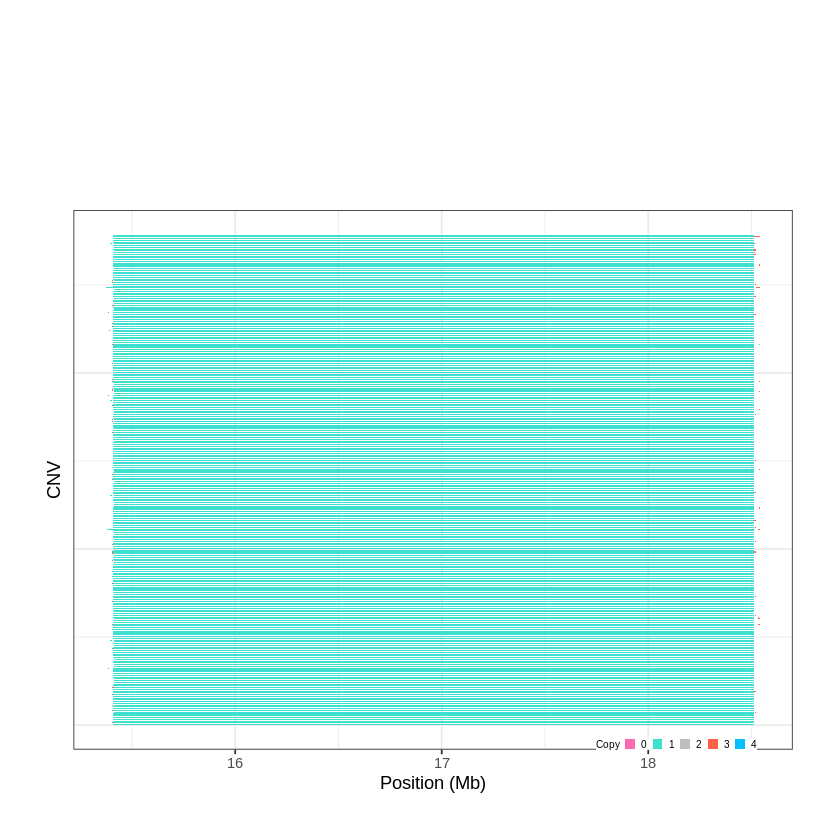

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1776..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 26.228301 - 26.3039 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


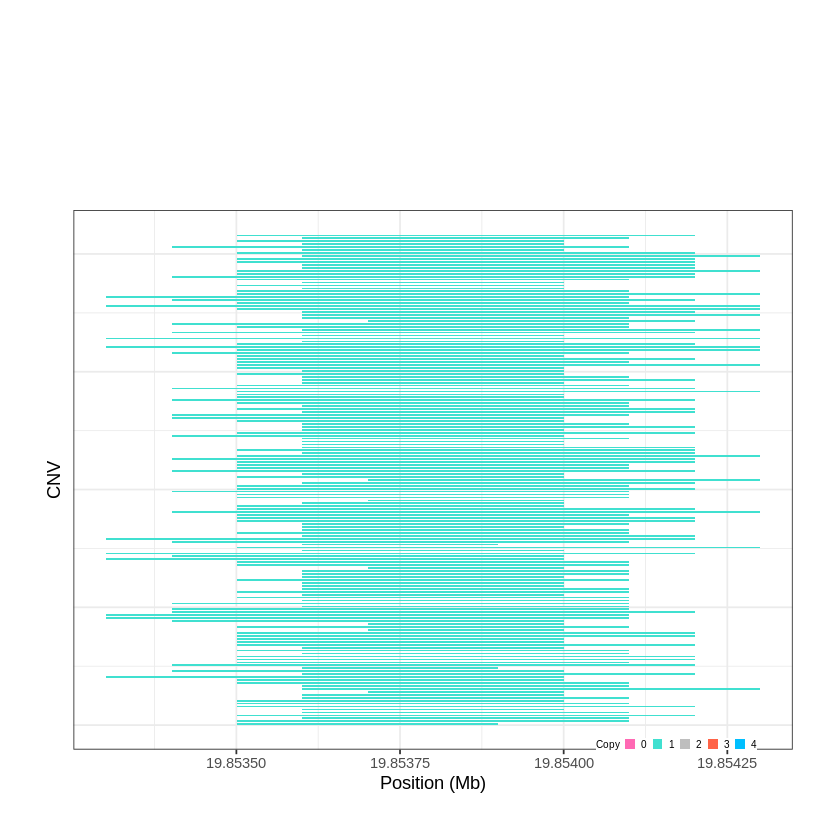

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1777..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 30.396401 - 30.4445 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


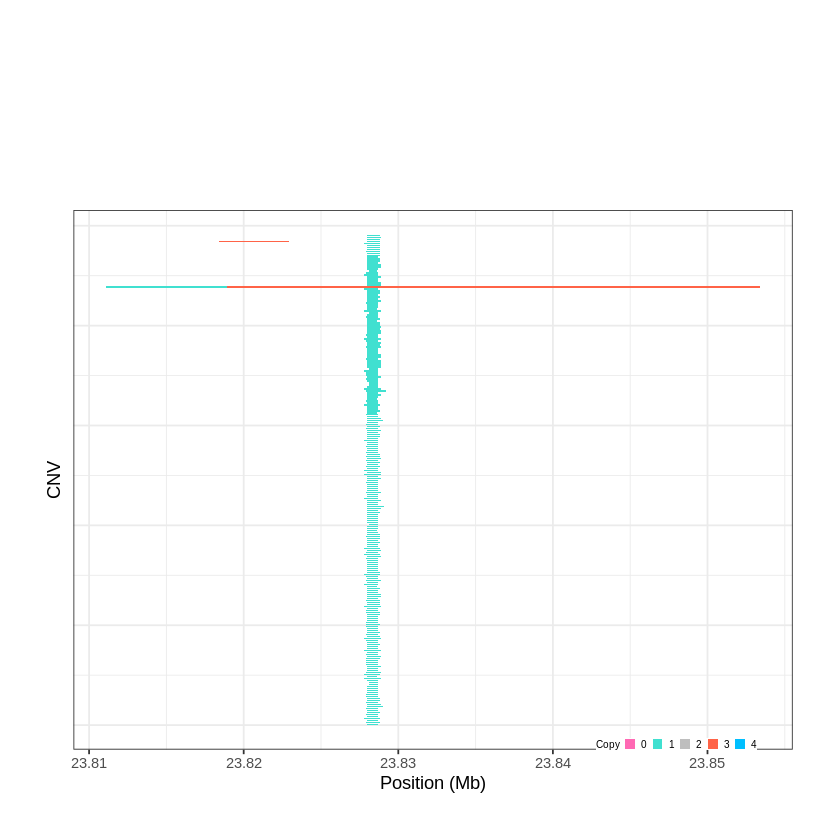

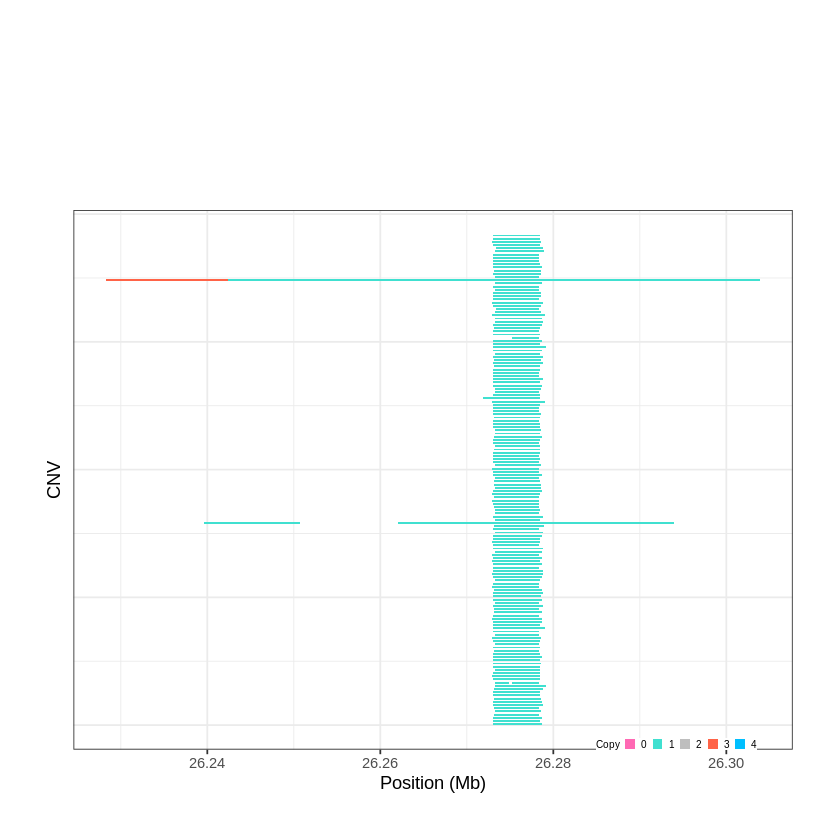

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1778..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 32.085901 - 33.0539 Mb with 197 Individual - "
Plotting gene...


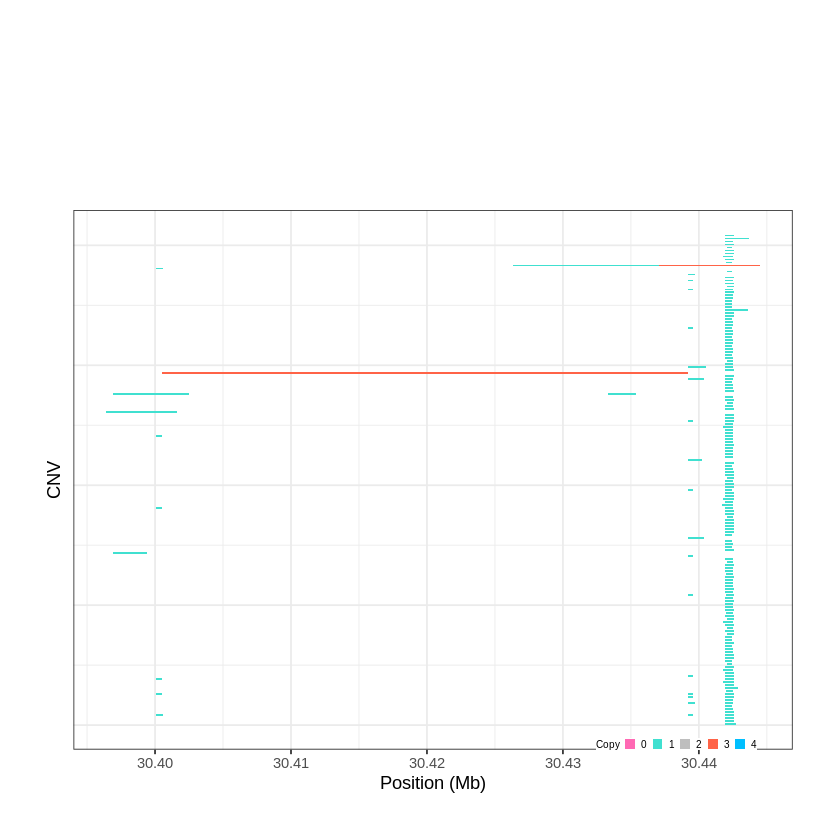

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1779..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 33.053901 - 35.2981 Mb with 208 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1780..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 37.539901 - 37.5827 Mb with 190 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


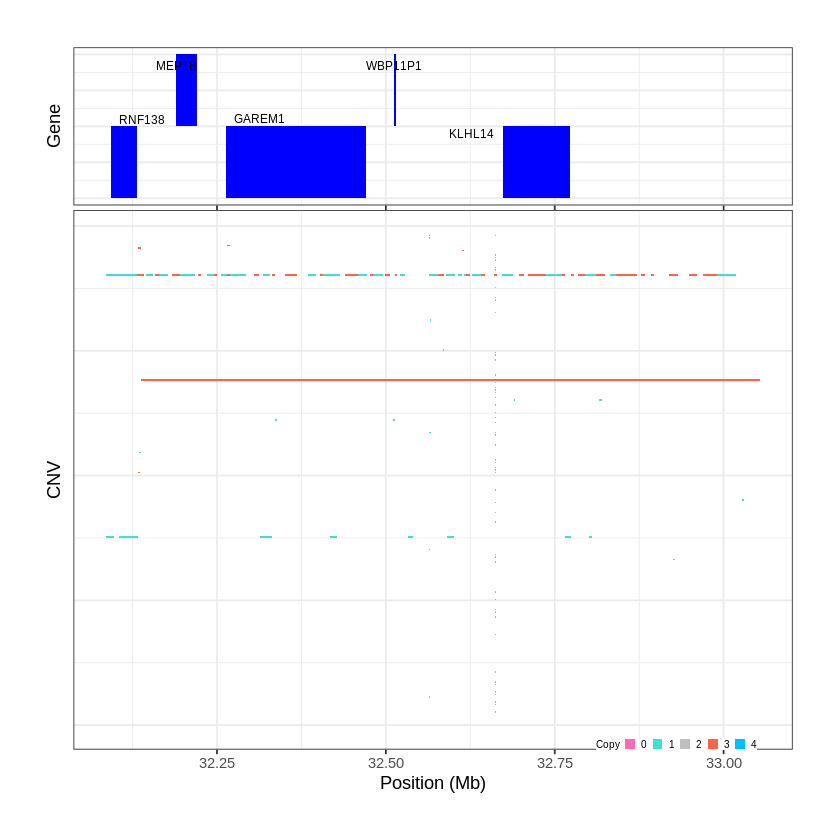

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1781..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 38.259801 - 38.2688 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


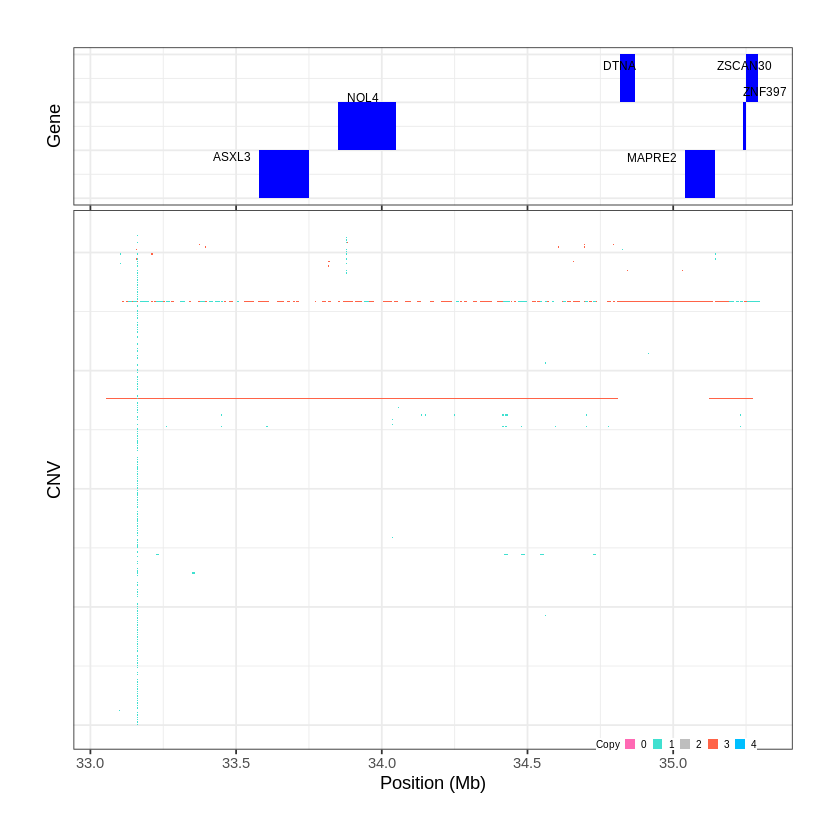

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1782..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 38.850501 - 38.8719 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


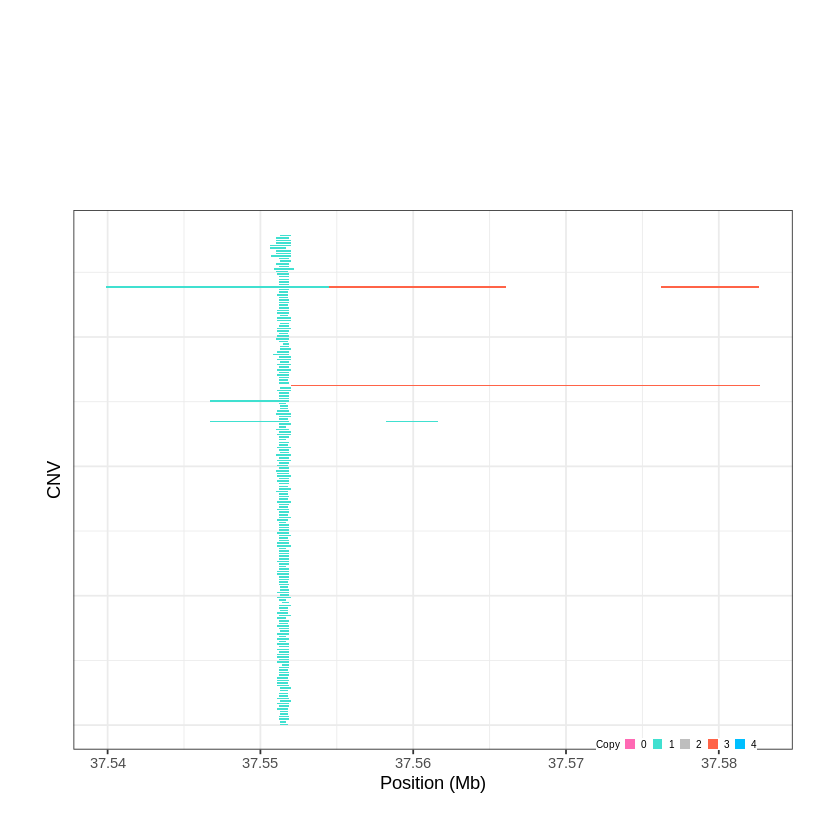

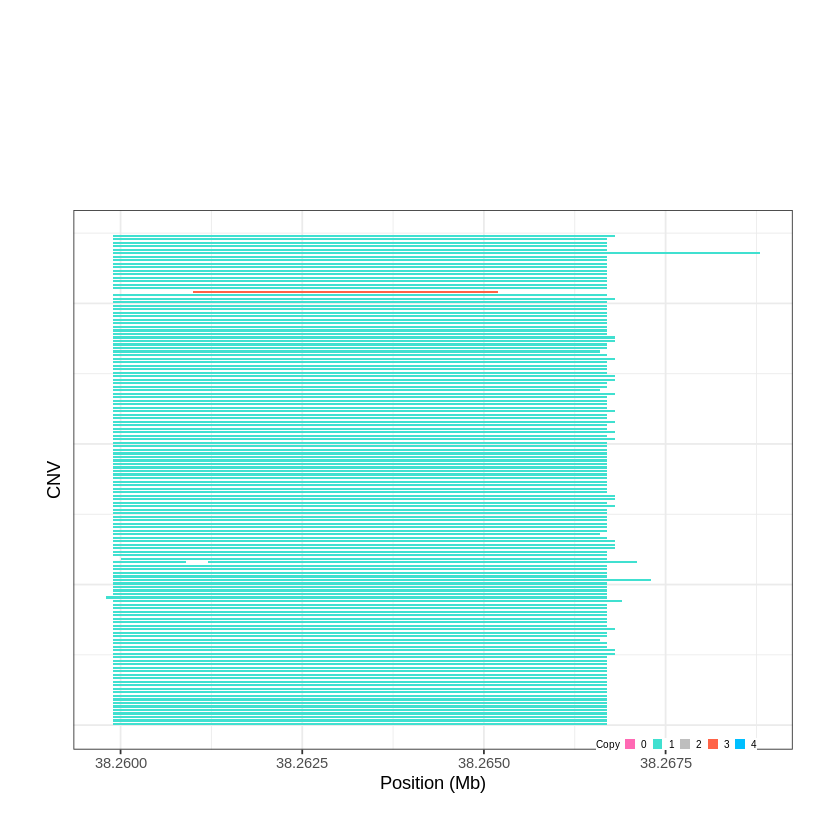

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1783..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 42.254901 - 45.2242 Mb with 279 Individual - "
Plotting gene...


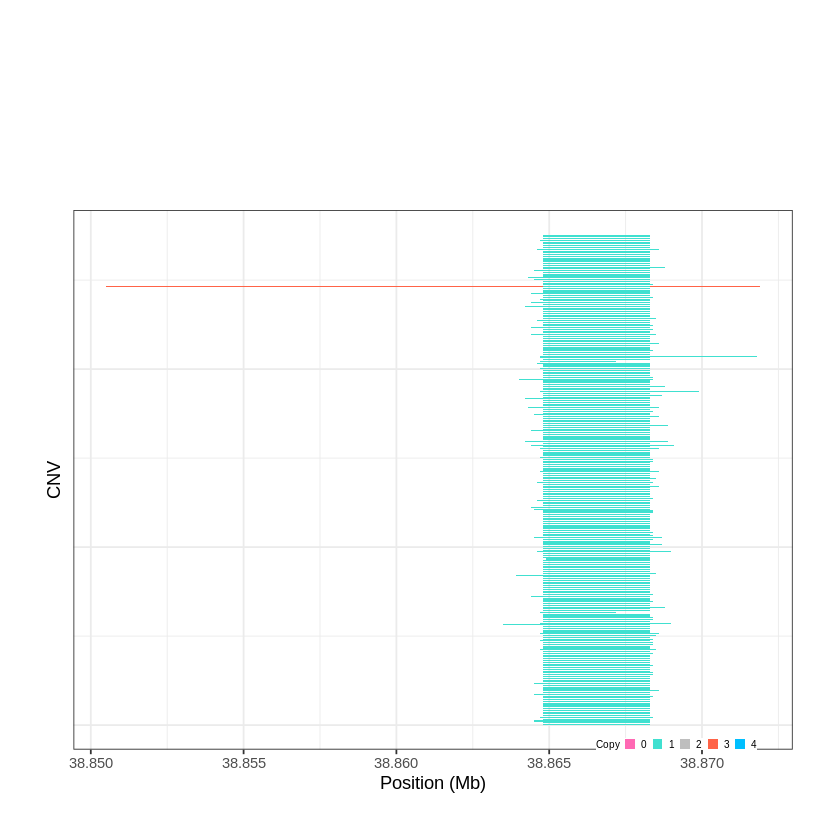

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1784..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 45.377101 - 45.5349 Mb with 226 Individual - "
Plotting gene...


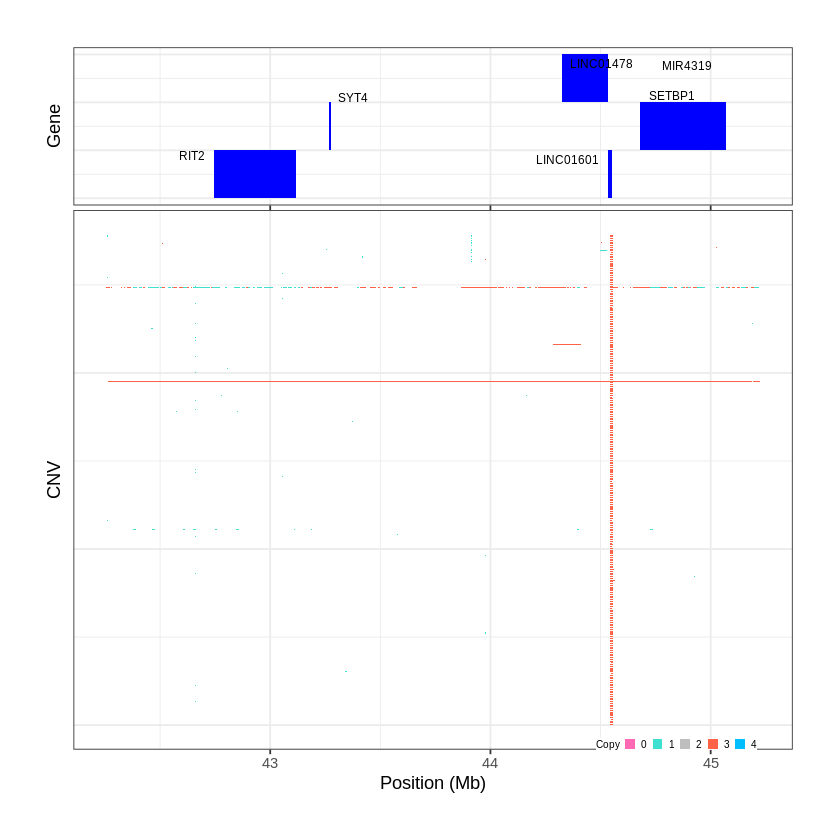

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1785..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 45.549101 - 47.3112 Mb with 272 Individual - "
Plotting gene...


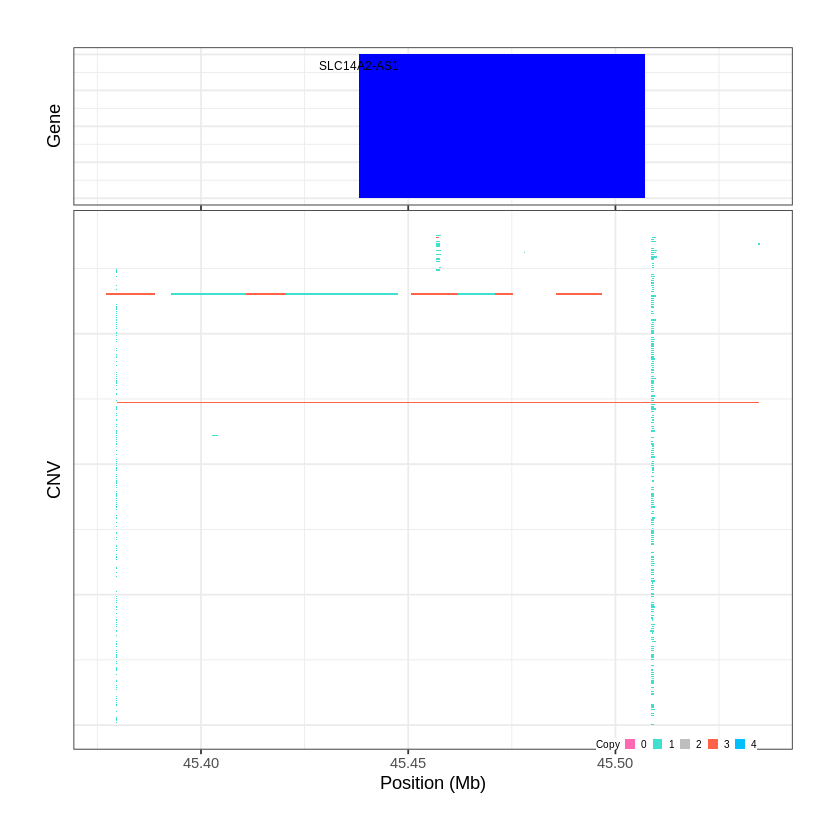

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1786..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 47.319801 - 49.7316 Mb with 261 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1787..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 50.601601 - 50.6143 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


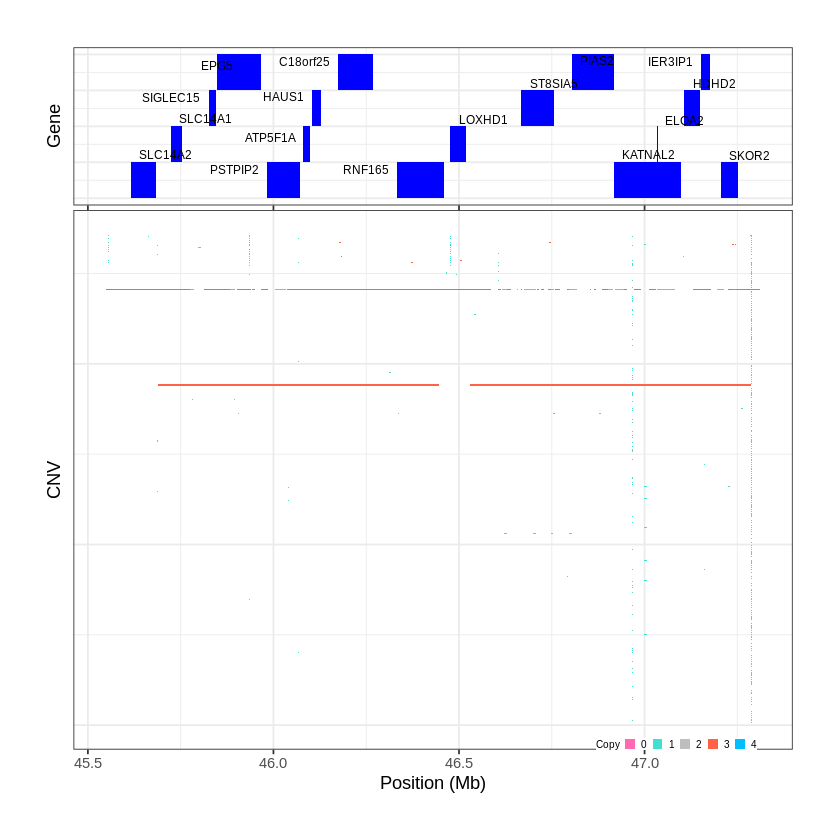

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1788..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 50.924201 - 50.9263 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


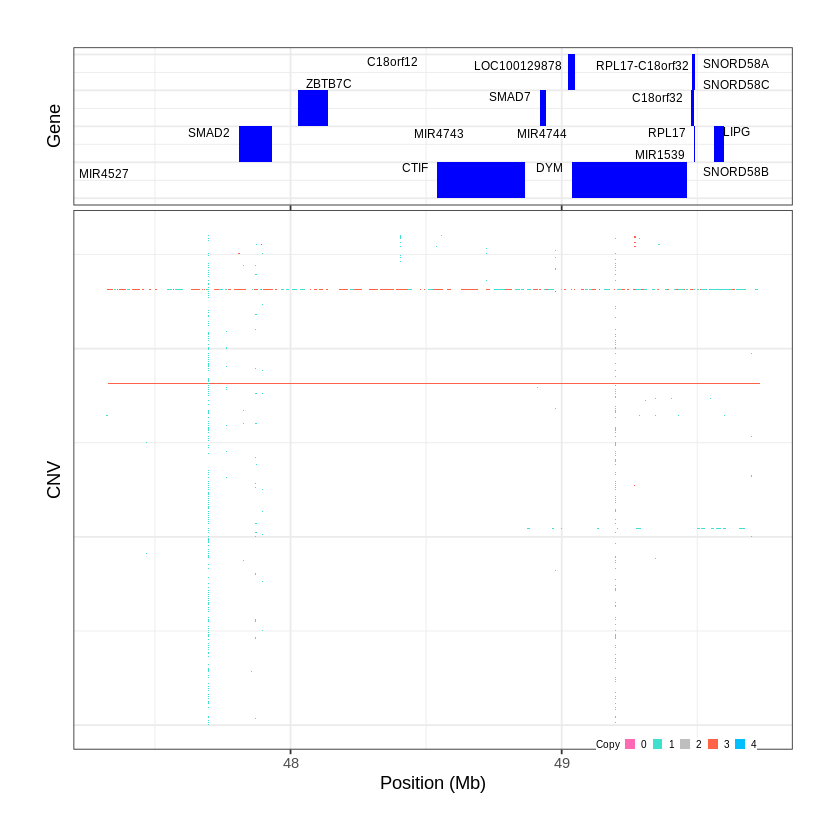

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1789..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 51.871001 - 52.2369 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


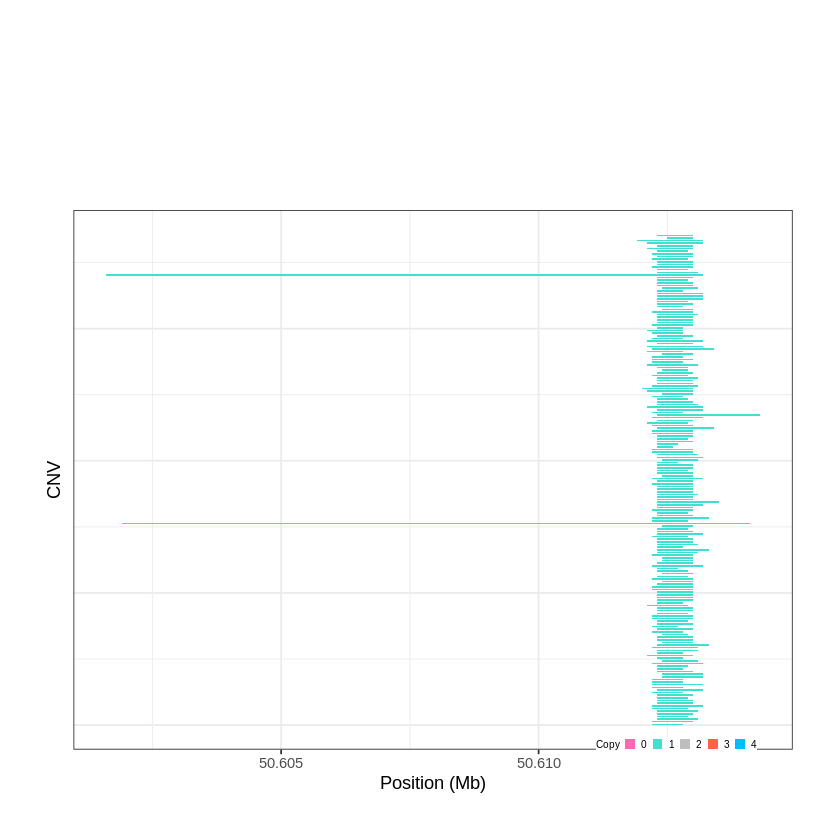

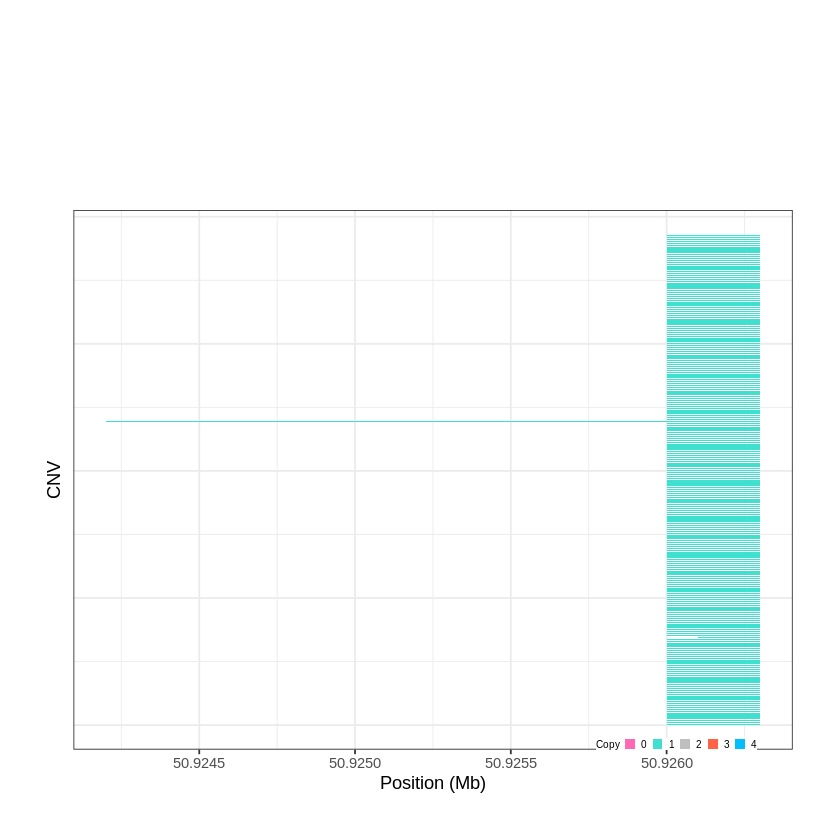

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1790..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 54.392801 - 54.9608 Mb with 235 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1791..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 55.775301 - 55.8792 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


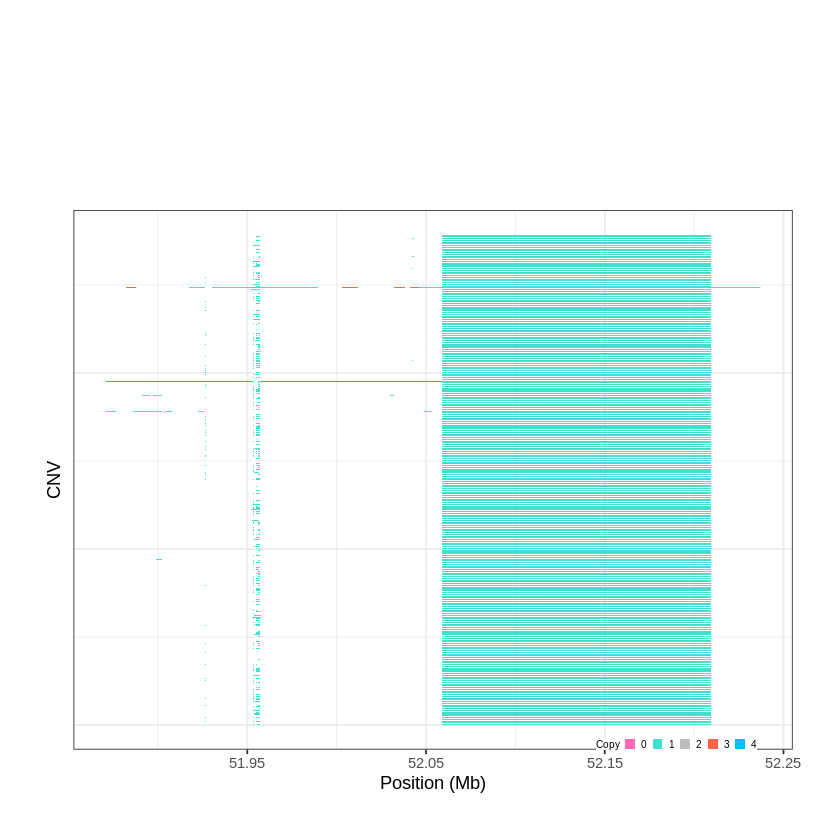

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1792..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 57.696201 - 57.7031 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


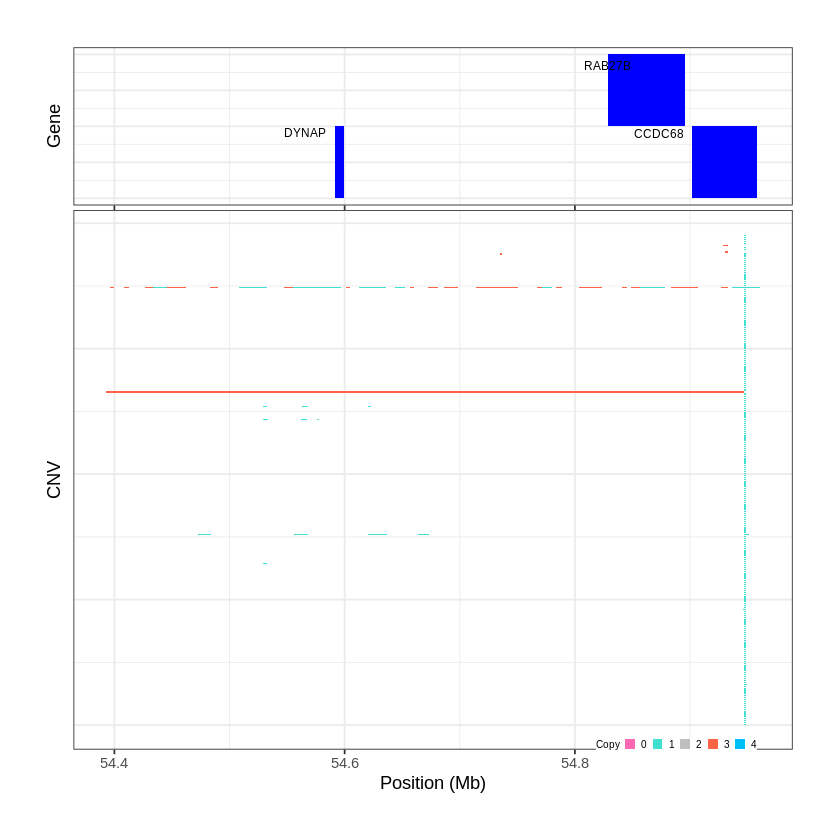

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1793..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 60.211301 - 60.2978 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


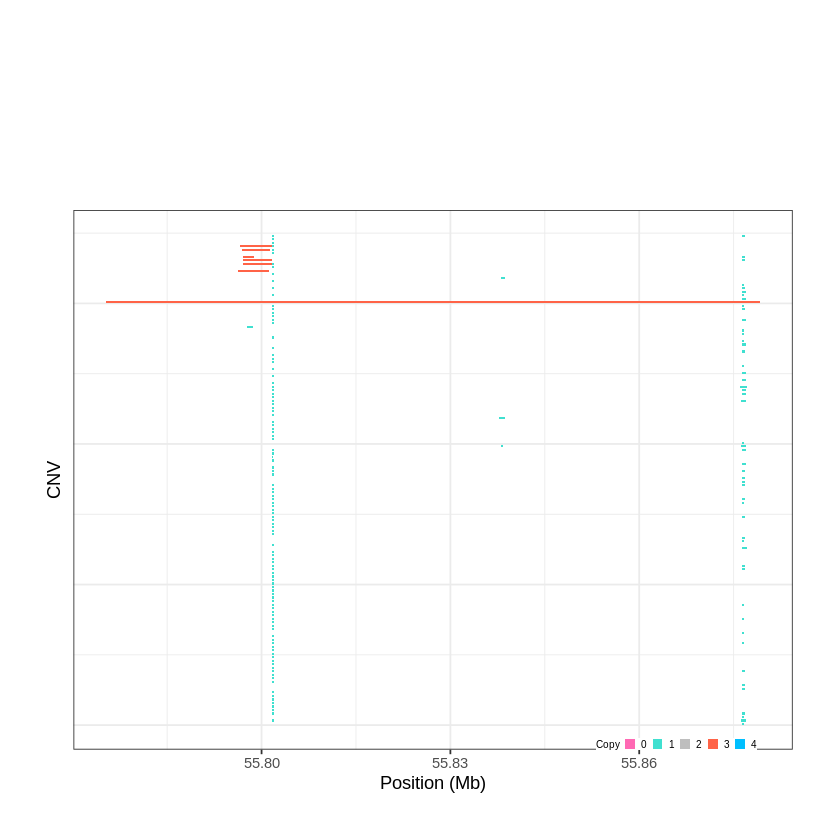

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1794..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 62.271101 - 62.2804 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


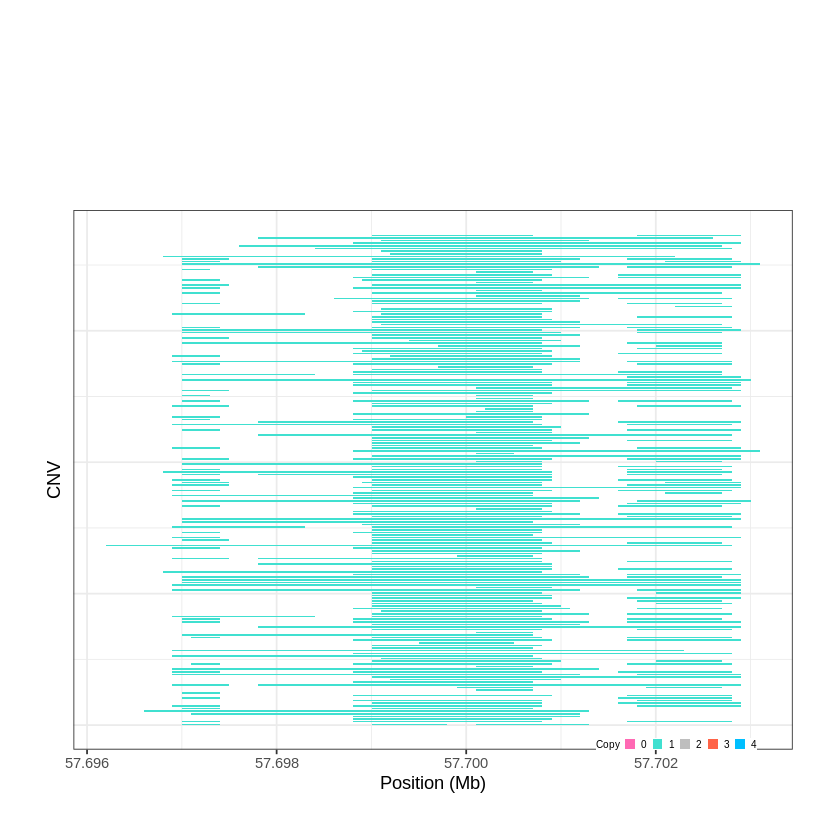

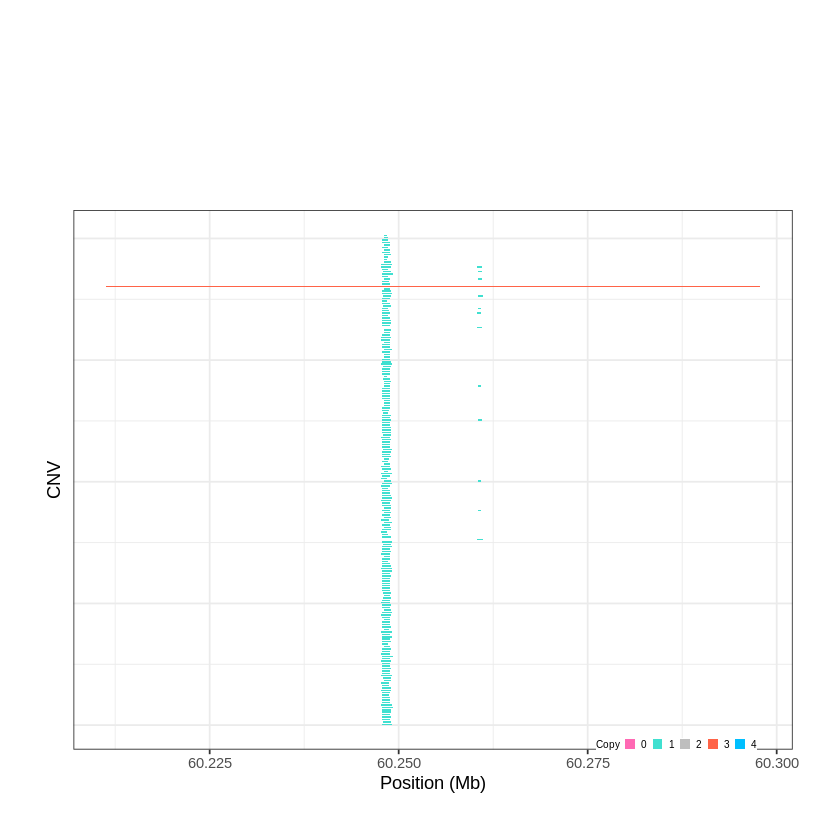

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1795..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 63.568501 - 63.6117 Mb with 146 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1796..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 63.766001 - 63.7739 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


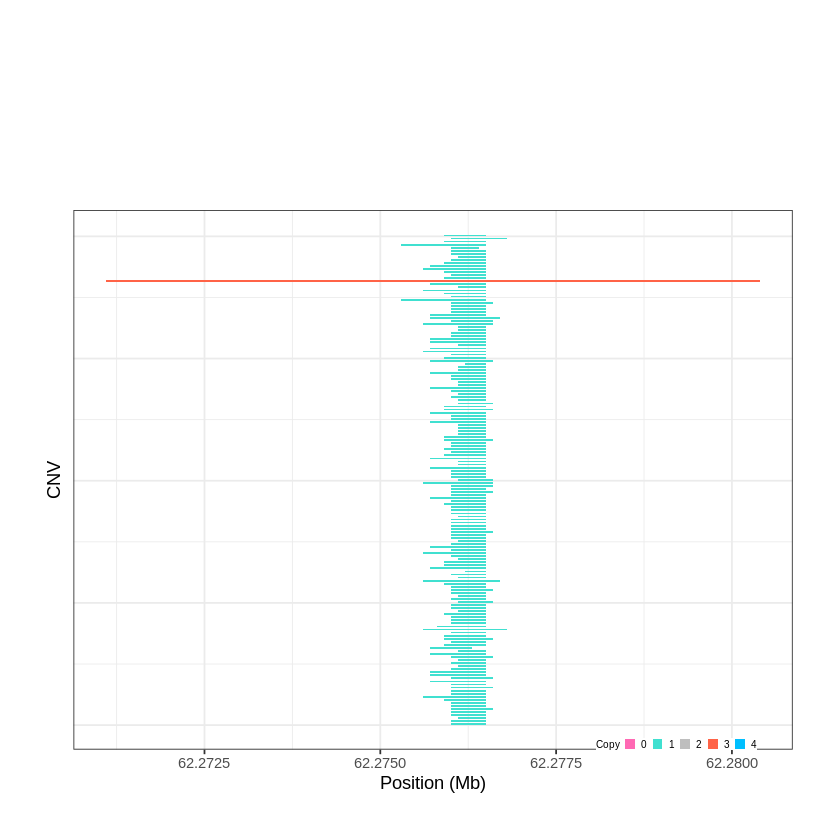

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1797..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 66.074001 - 66.3028 Mb with 263 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


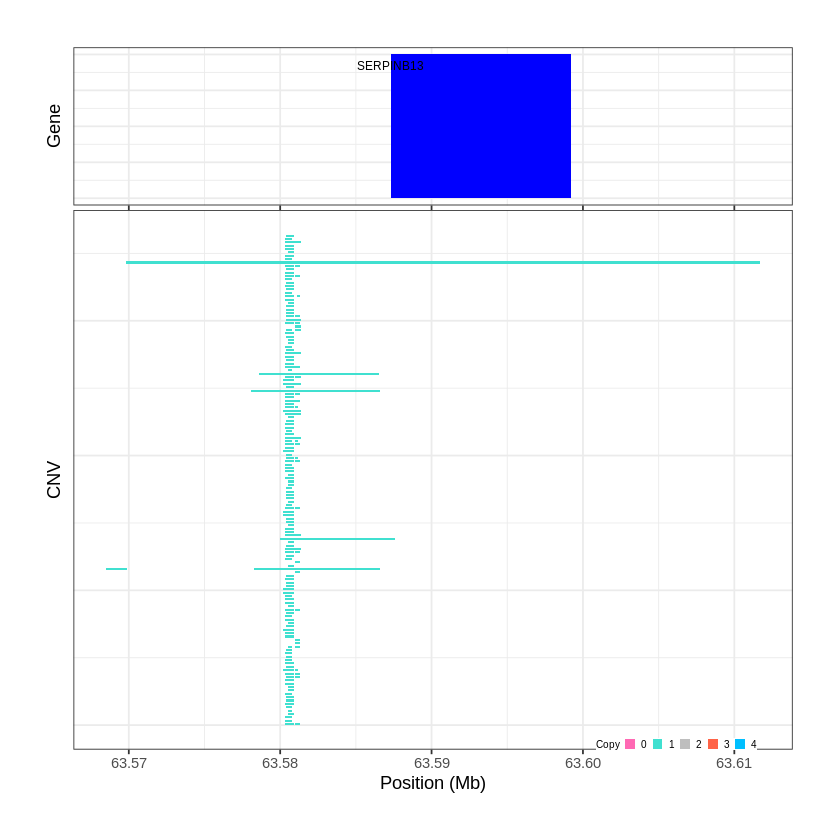

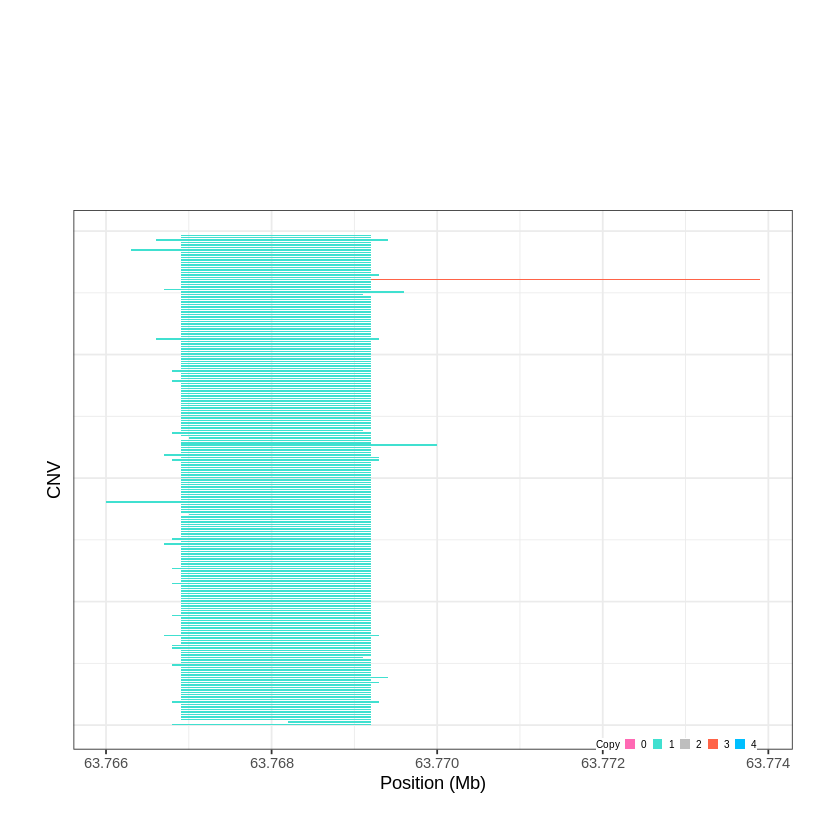

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1798..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 68.313501 - 68.9465 Mb with 230 Individual - "
Plotting gene...


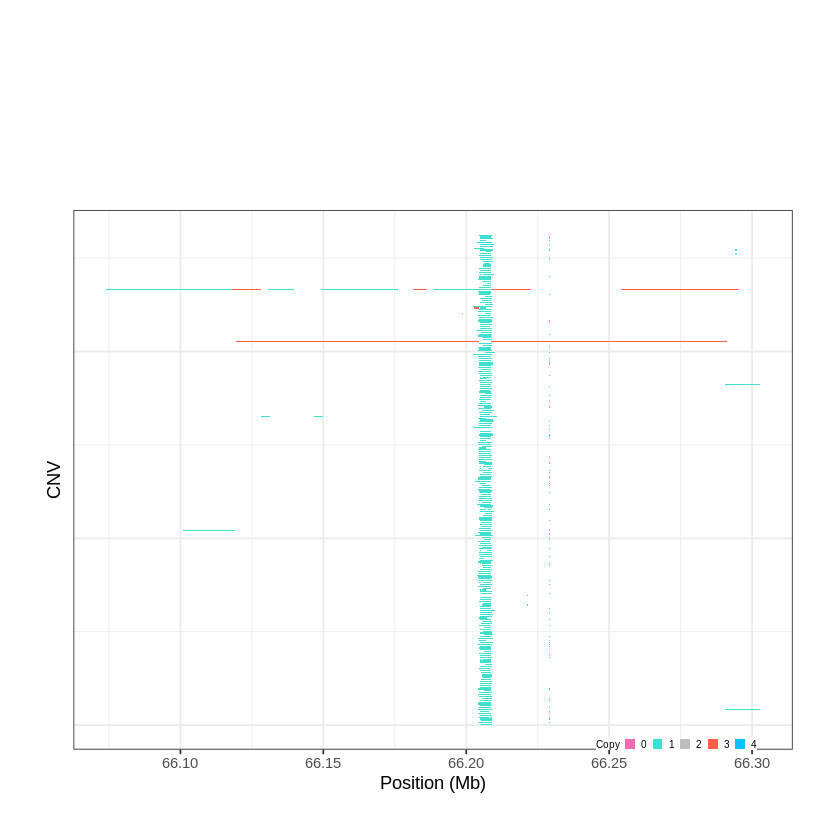

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1799..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 70.616701 - 70.6542 Mb with 144 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1800..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 71.268901 - 71.3006 Mb with 153 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


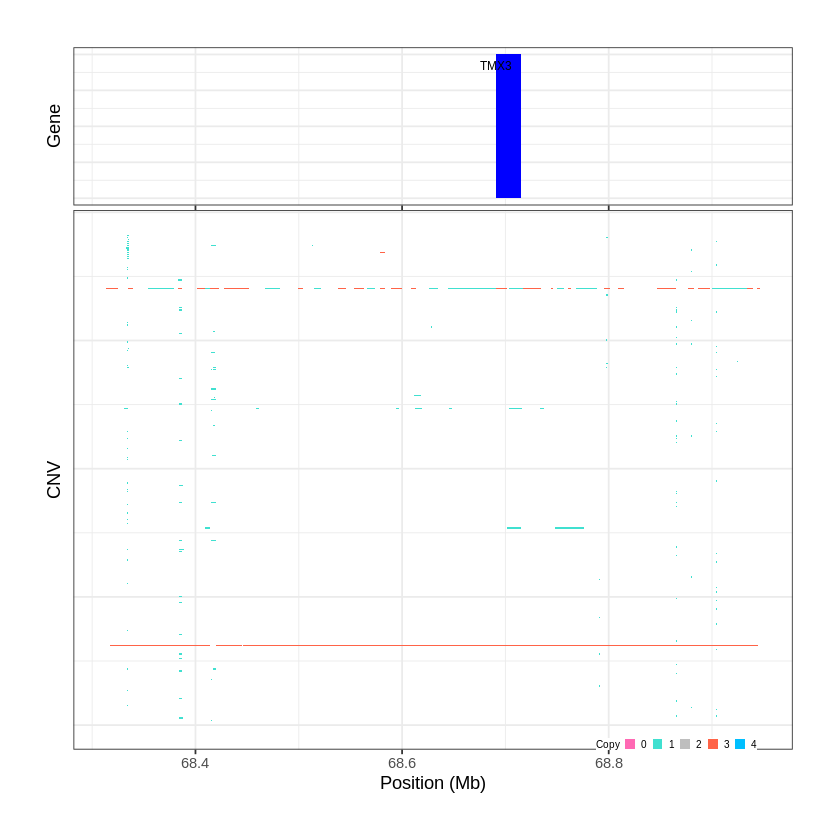

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1801..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 71.913601 - 71.915 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


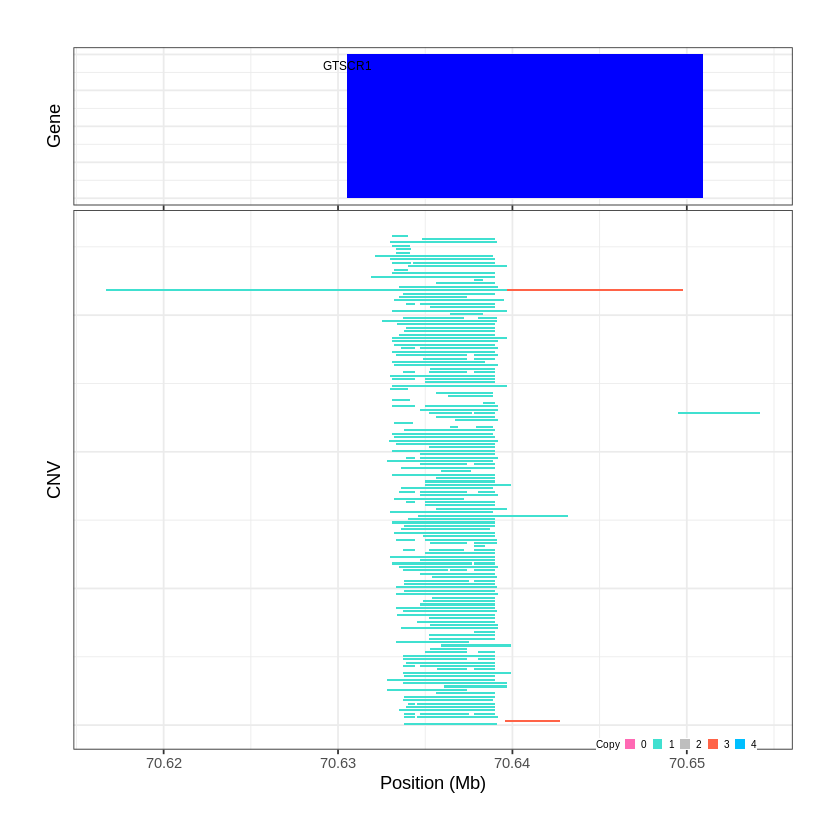

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1802..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 72.282701 - 72.349 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


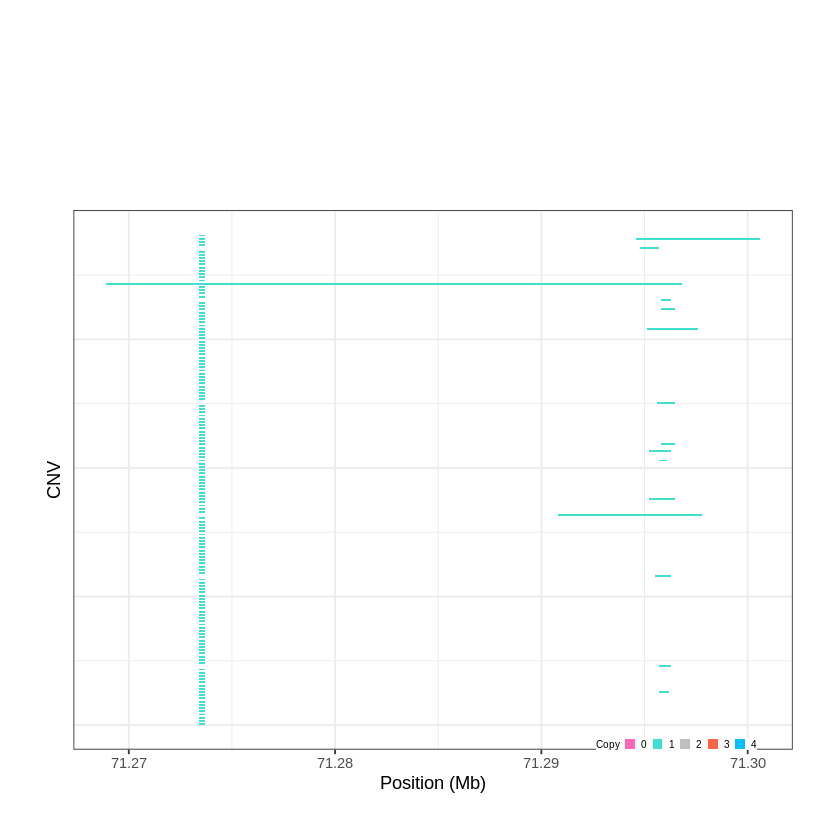

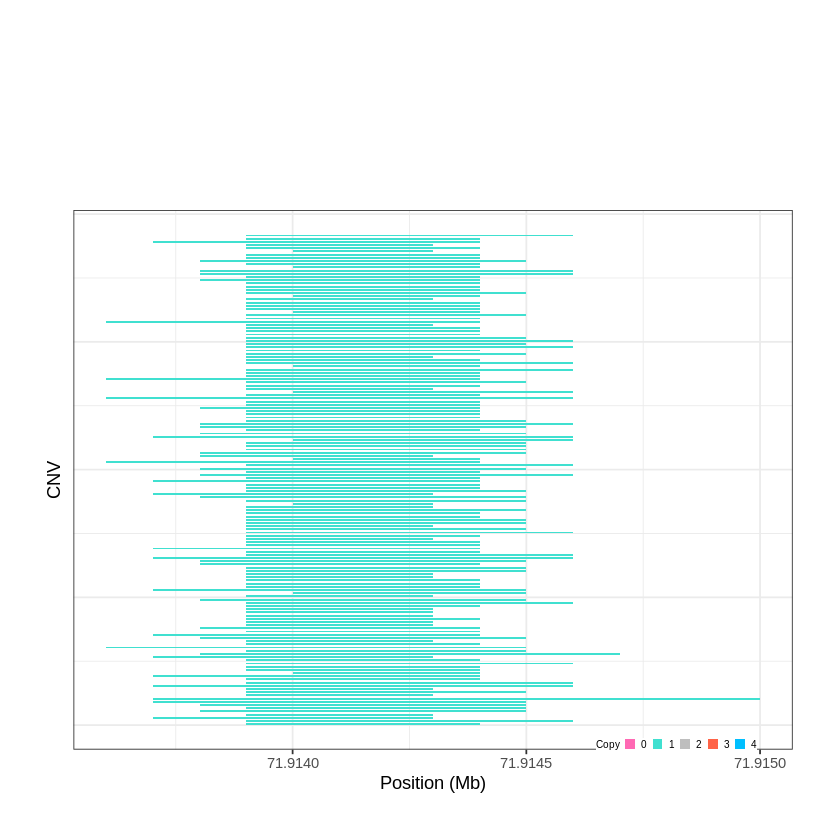

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1803..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 74.024201 - 74.8322 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1804..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 75.266901 - 75.2684 Mb with 205 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


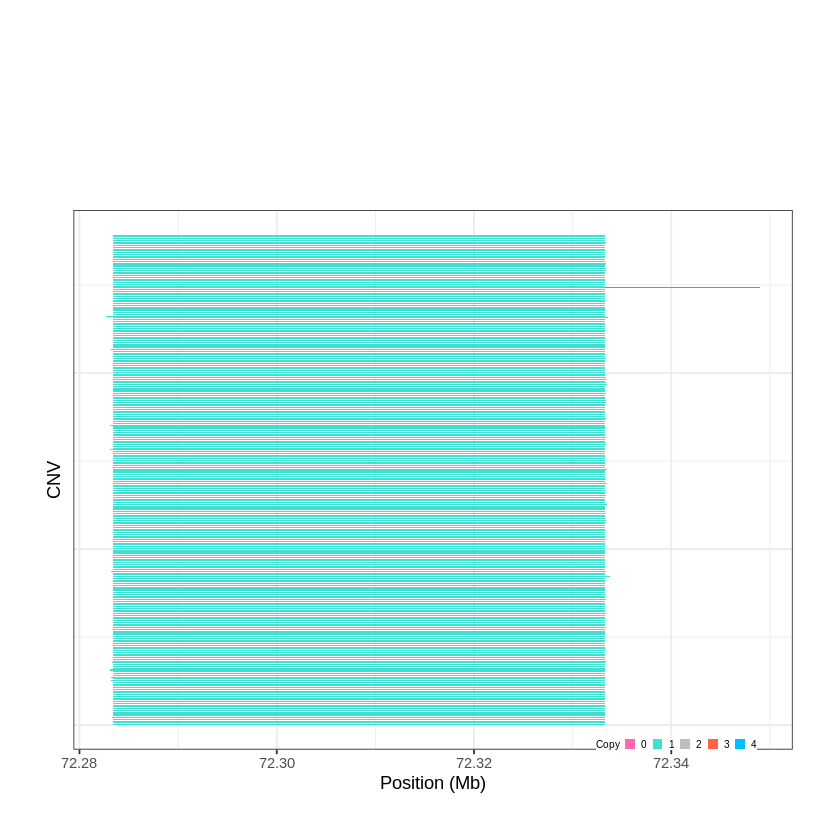

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1805..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 75.721801 - 75.7976 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


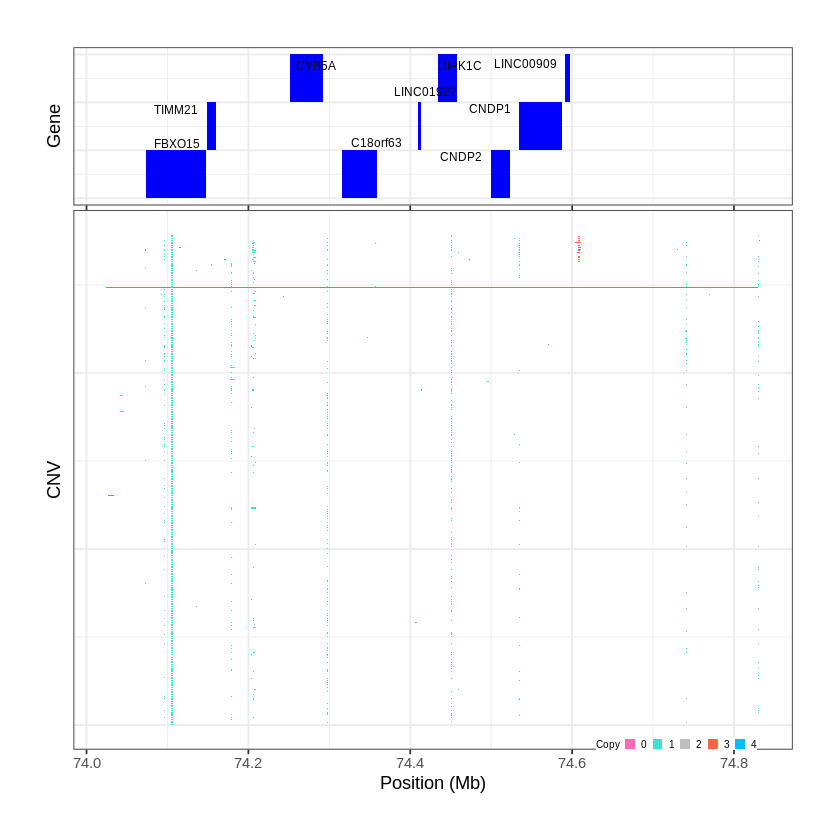

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1806..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 75.968301 - 76.0188 Mb with 208 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


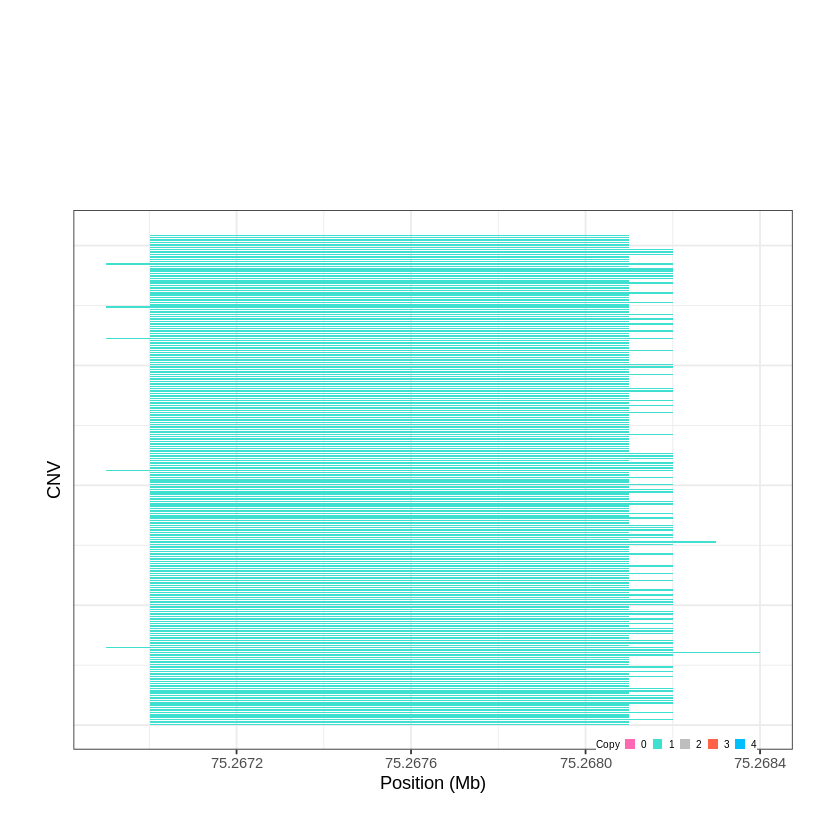

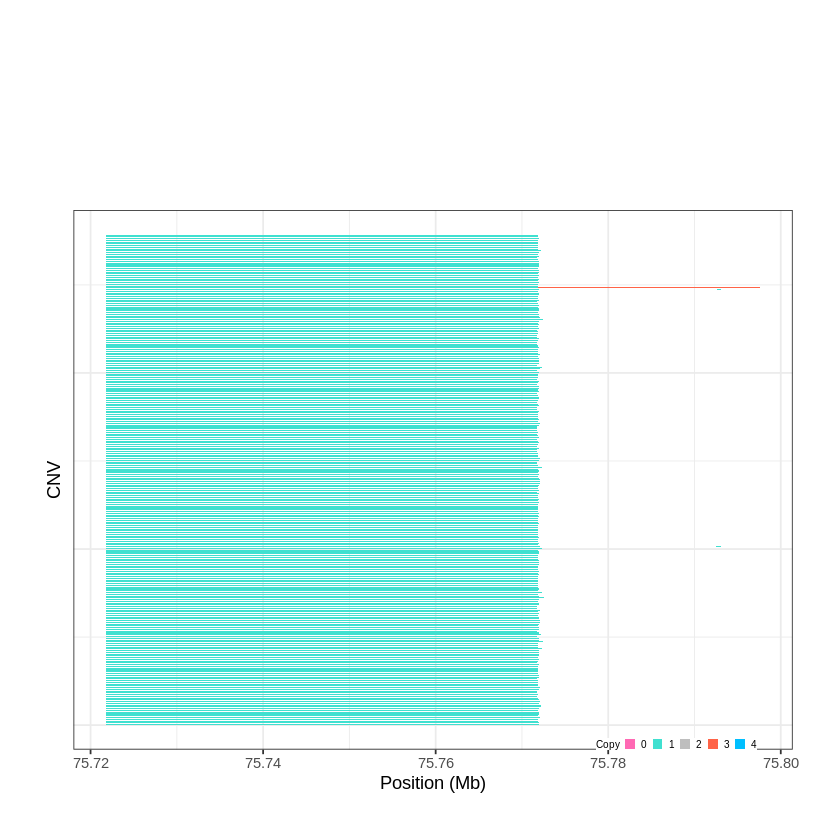

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1807..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 76.104501 - 76.3981 Mb with 278 Individual - "
Plotting gene...


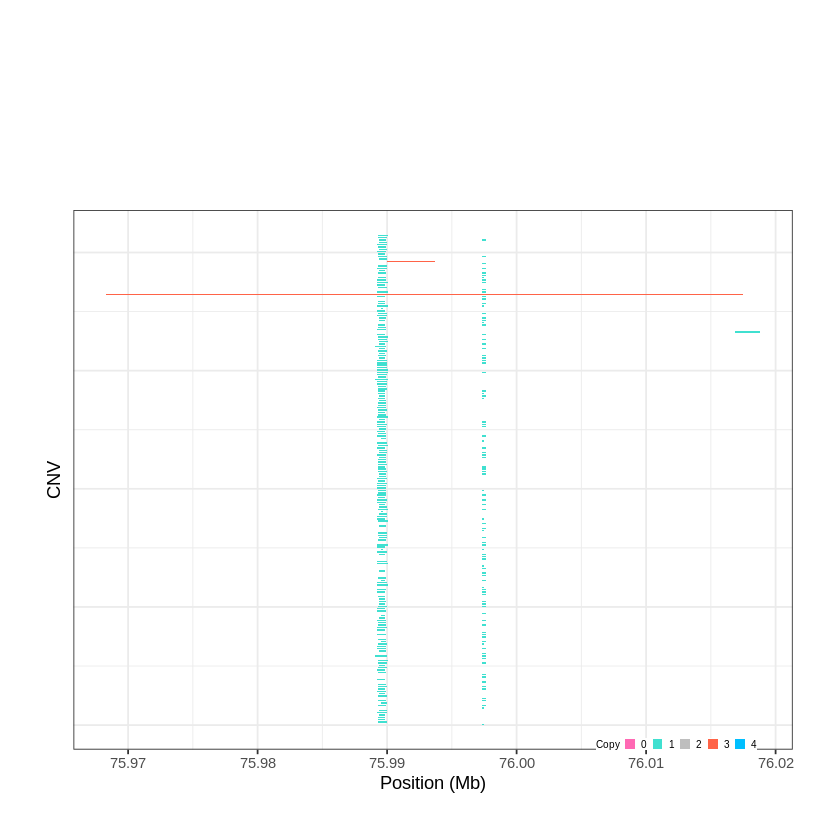

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1808..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 76.398401 - 76.7347 Mb with 260 Individual - "
Plotting gene...


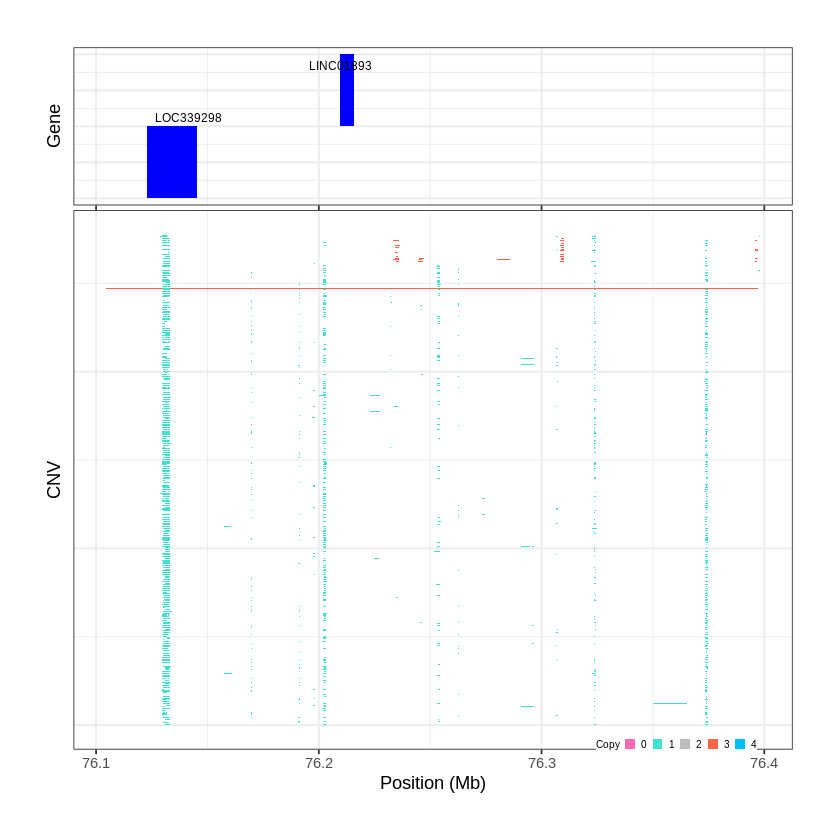

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1809..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 76.755601 - 76.8371 Mb with 224 Individual - "
Plotting gene...


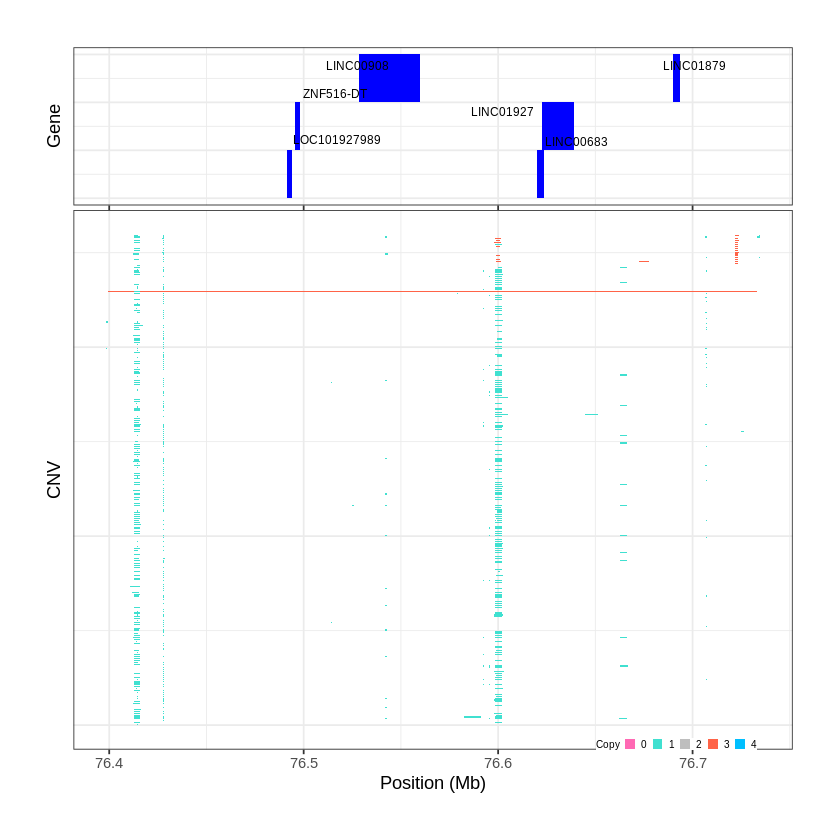

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1810..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 77.045001 - 77.2841 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1811..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 77.287401 - 77.3141 Mb with 203 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


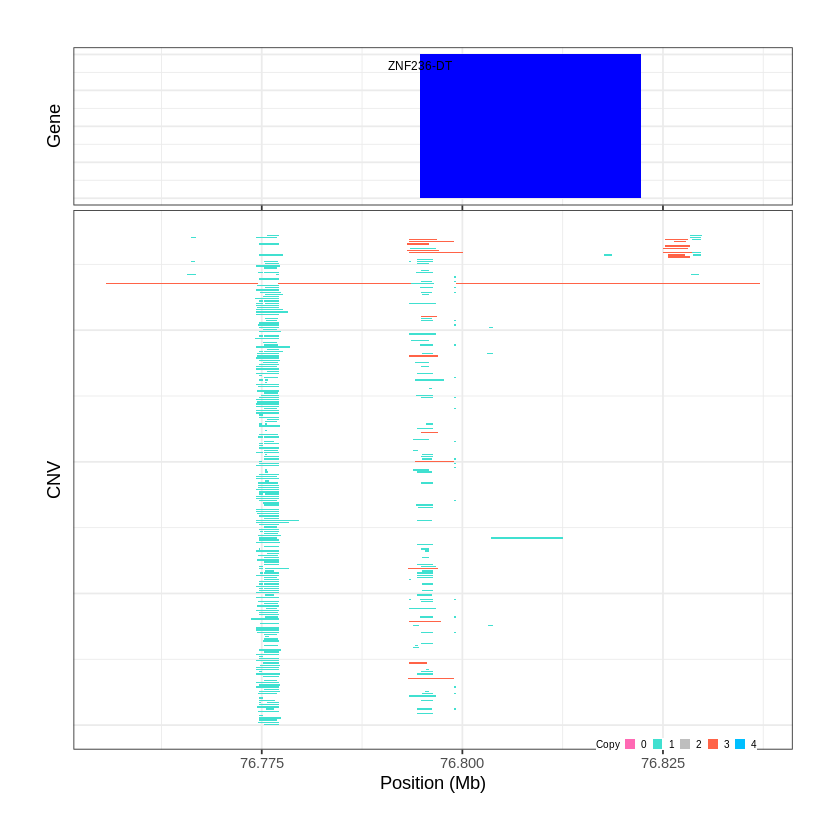

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1812..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 77.315501 - 77.3209 Mb with 235 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


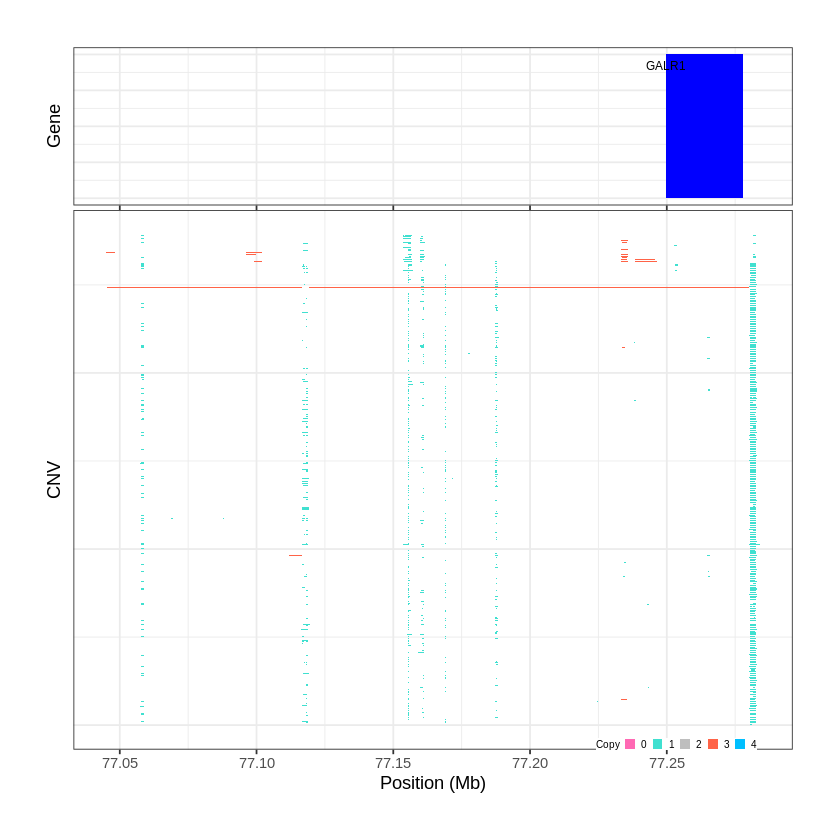

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1813..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 77.320901 - 77.778 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


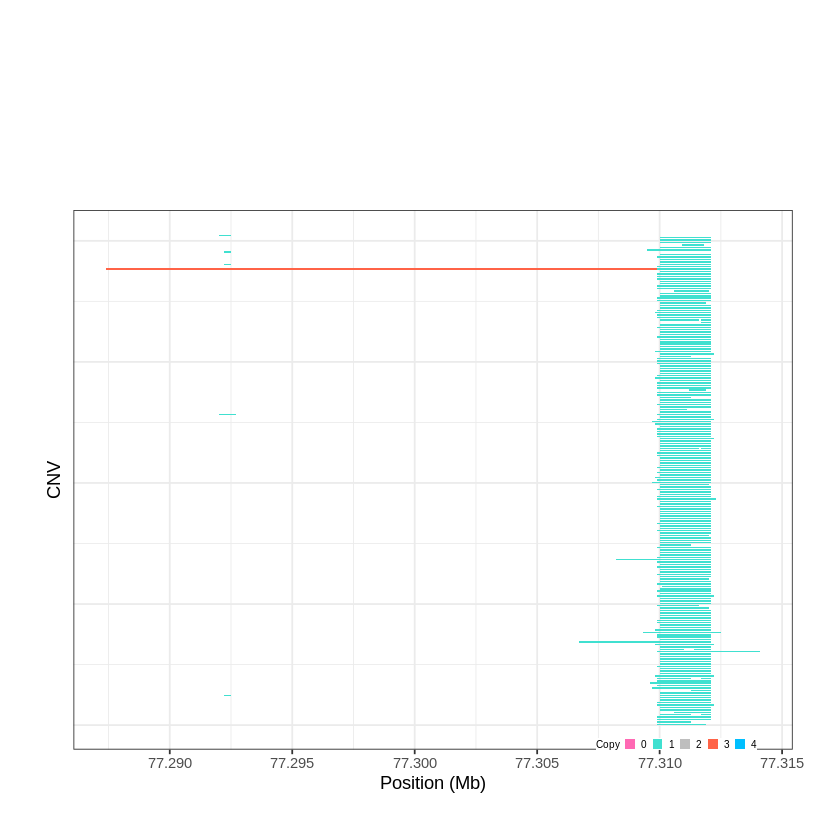

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1814..."
Input data passed requirment check...
[1] "CNV on Chromosome 18: 78.016301 - 78.0773 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


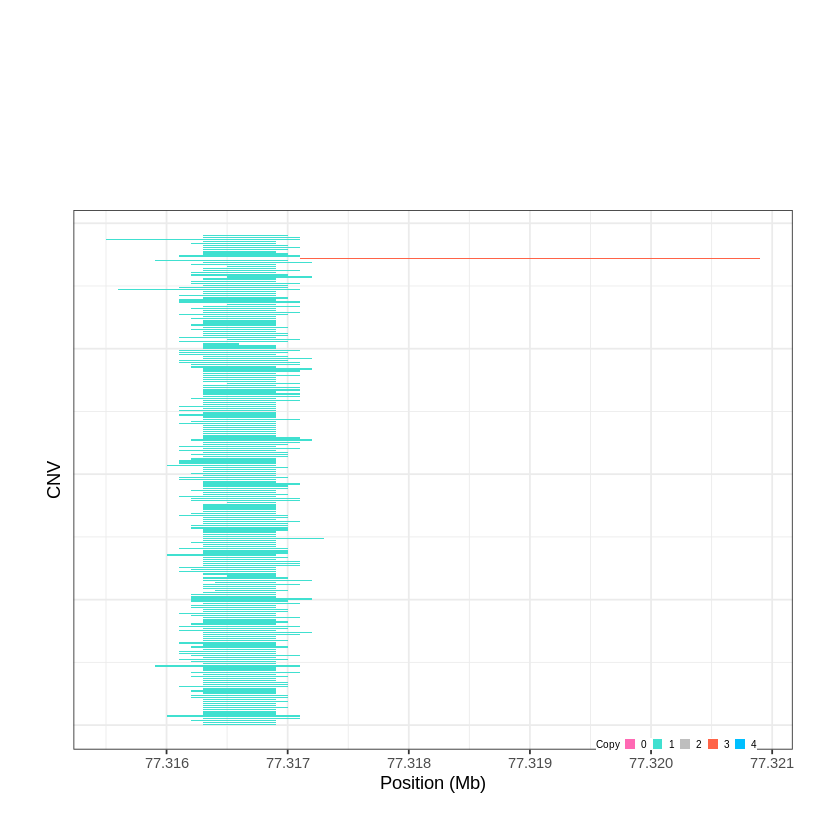

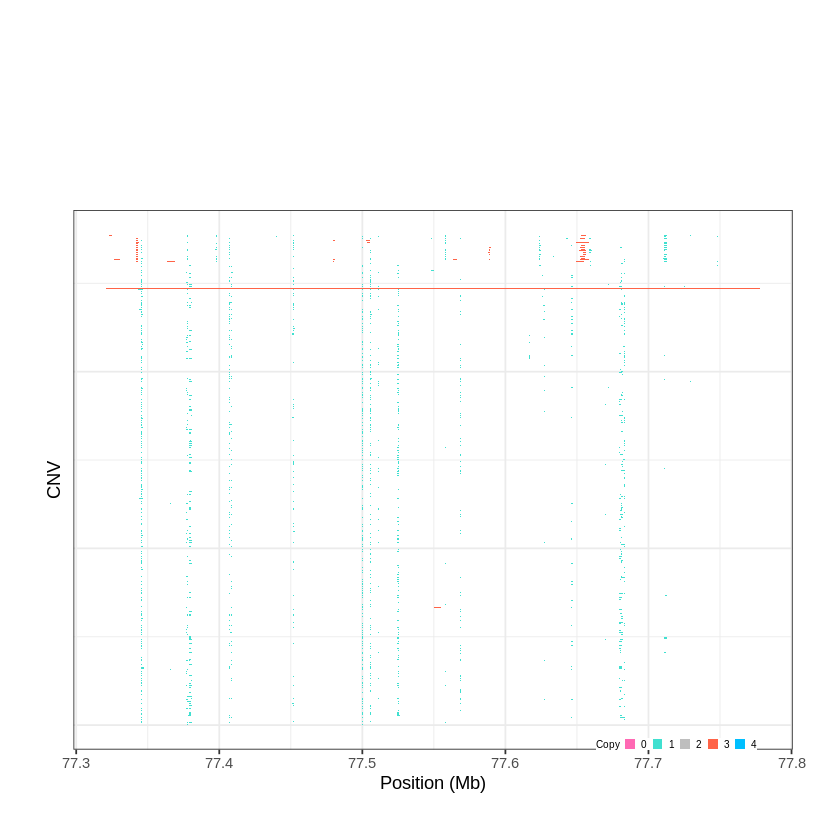

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1815..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 1e-06 - 0.2515 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


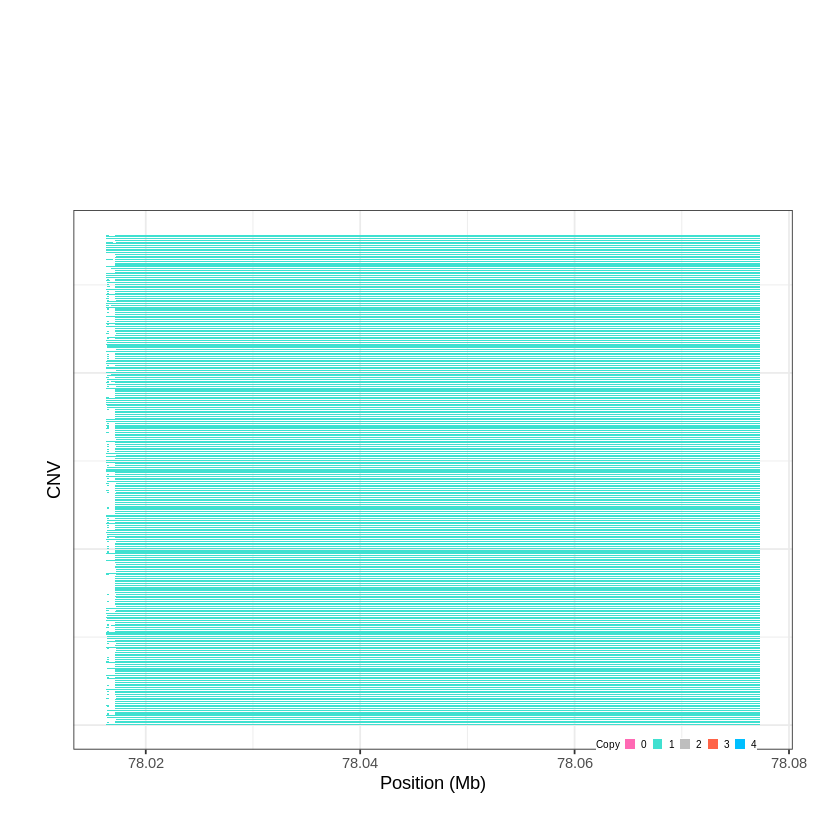

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1816..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.264601 - 0.3918 Mb with 270 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1817..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.393101 - 0.3969 Mb with 176 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


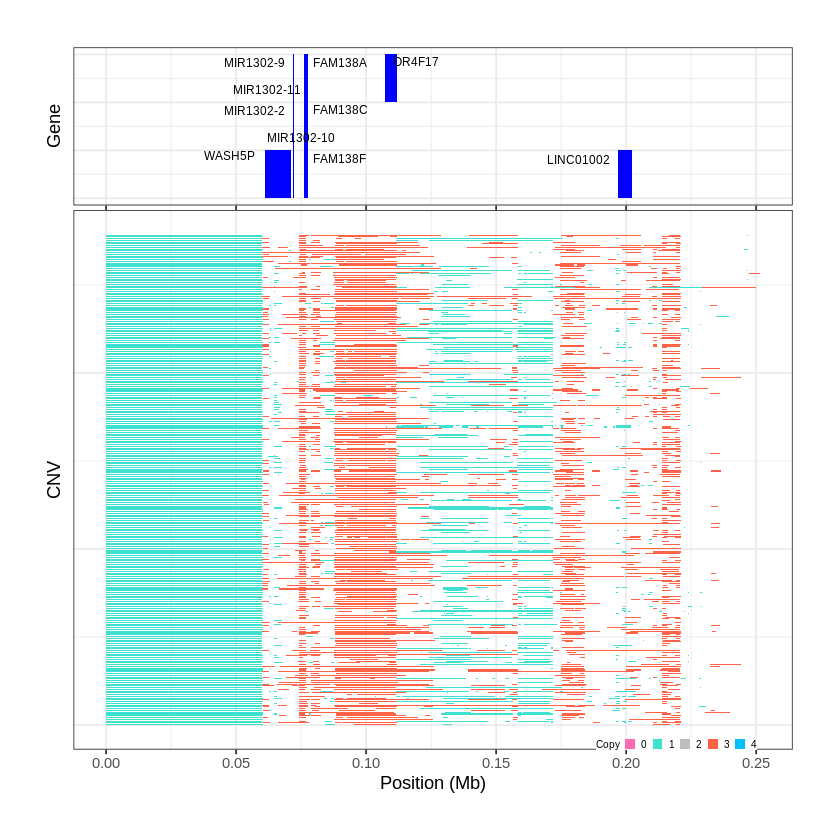

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1818..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.398201 - 0.4054 Mb with 265 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


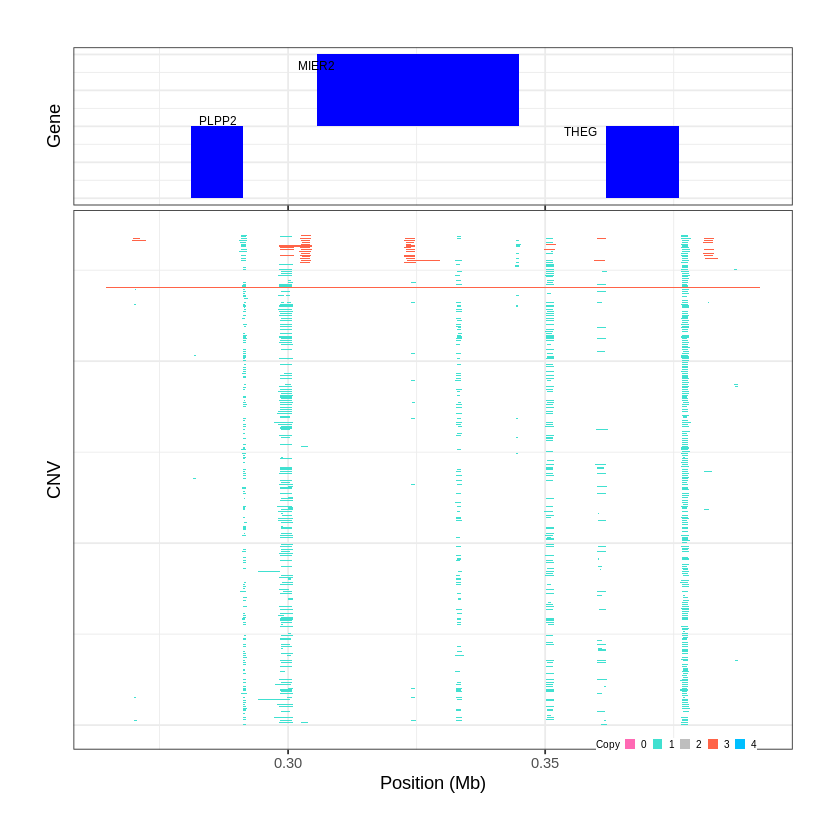

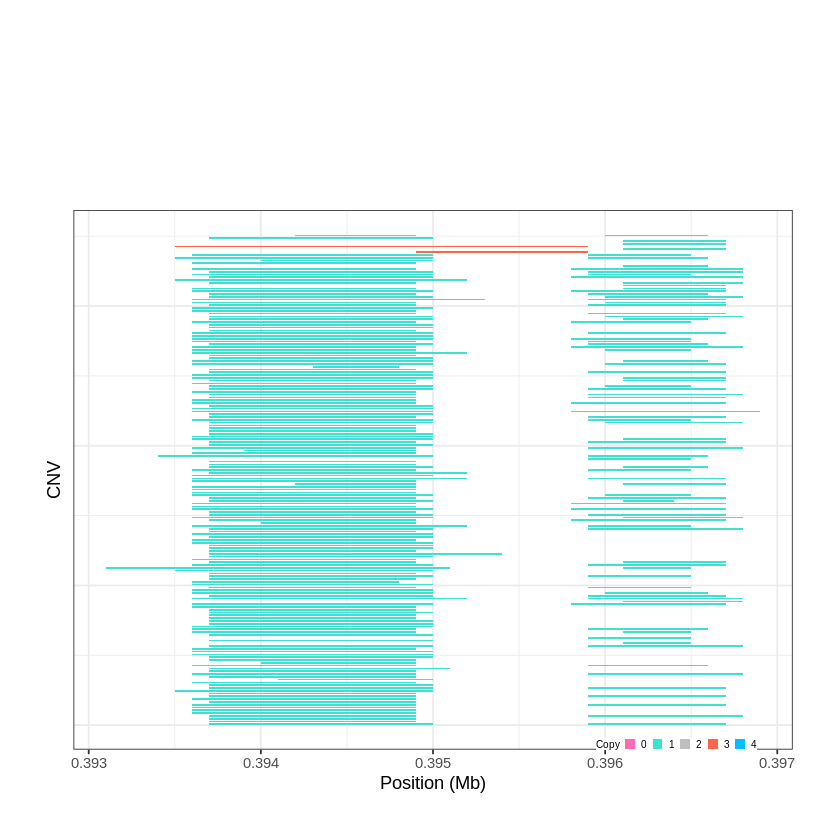

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1819..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.473101 - 0.5213 Mb with 277 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1820..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.540001 - 0.5413 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


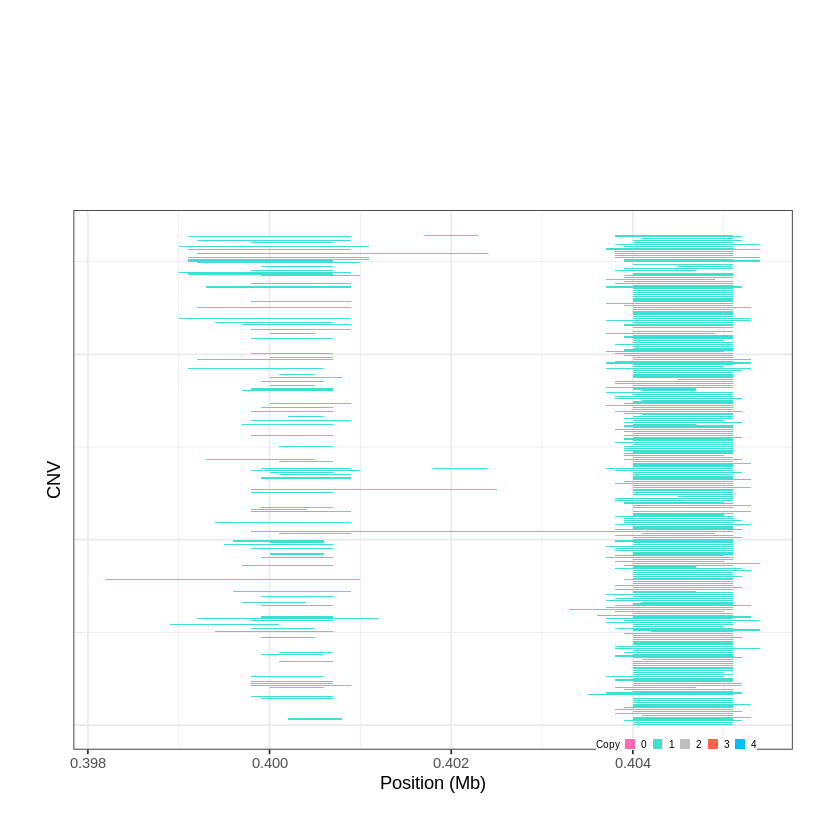

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1821..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.545301 - 0.5729 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


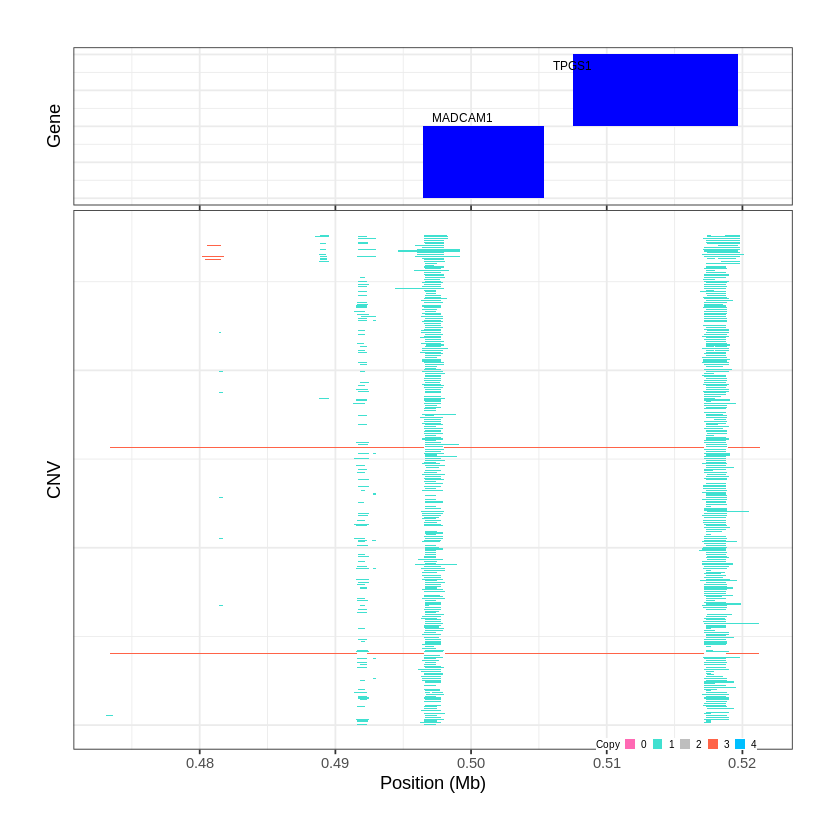

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1822..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.585401 - 0.5917 Mb with 215 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


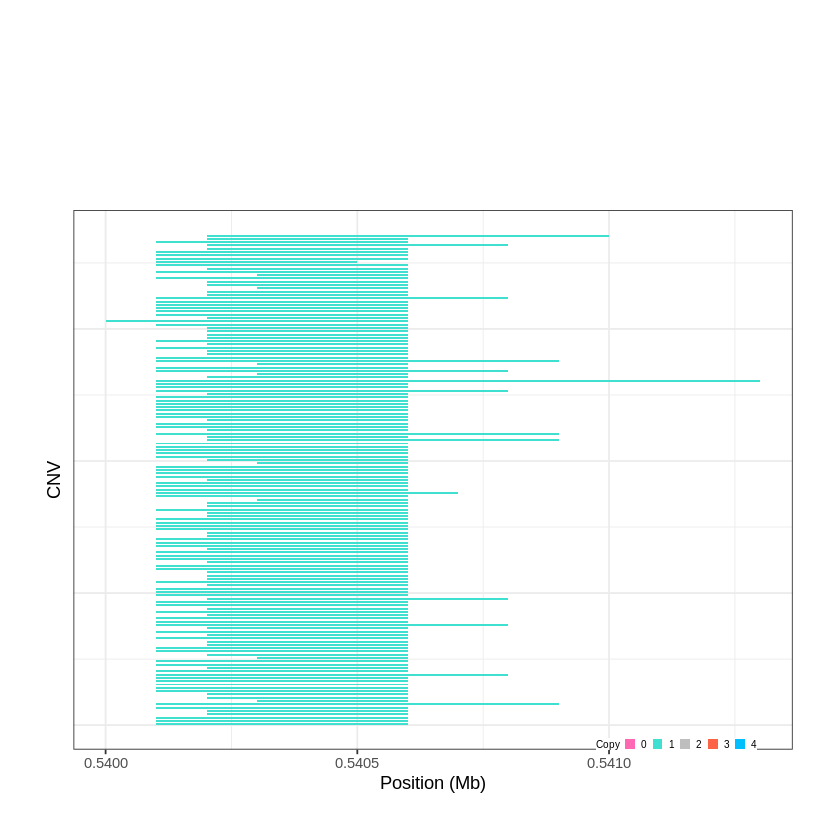

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1823..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.603401 - 0.6069 Mb with 197 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


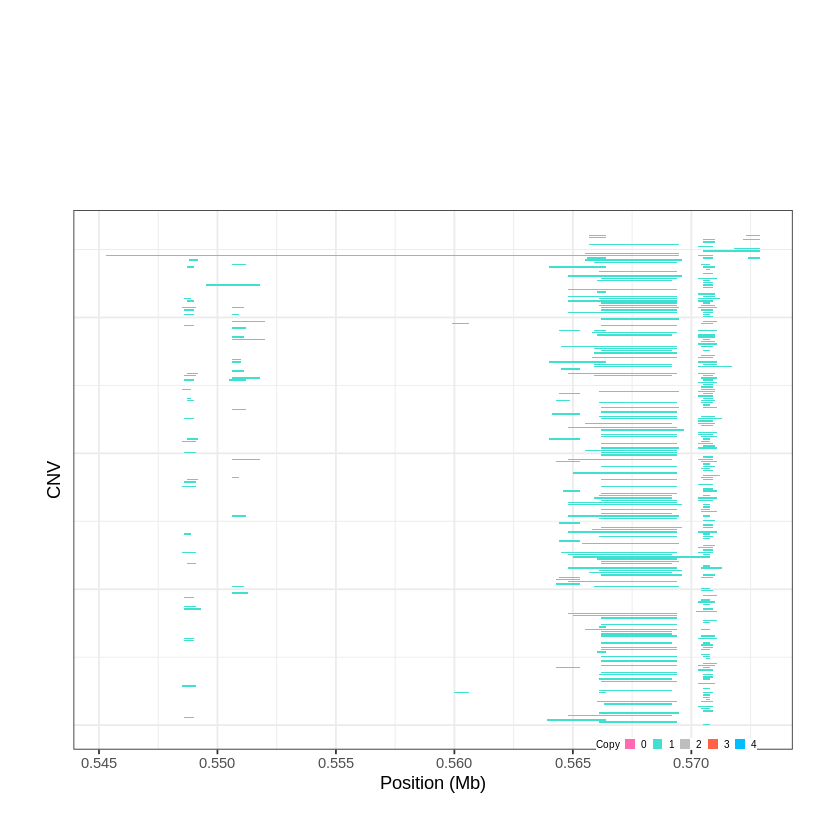

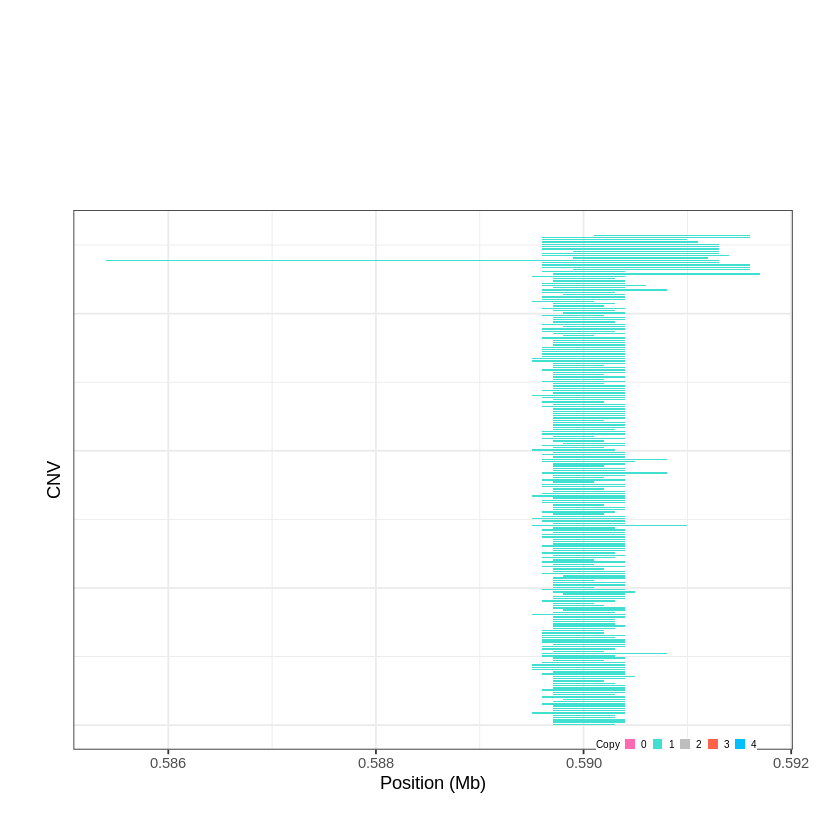

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1824..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.839901 - 0.9145 Mb with 274 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1825..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 0.990801 - 0.9922 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


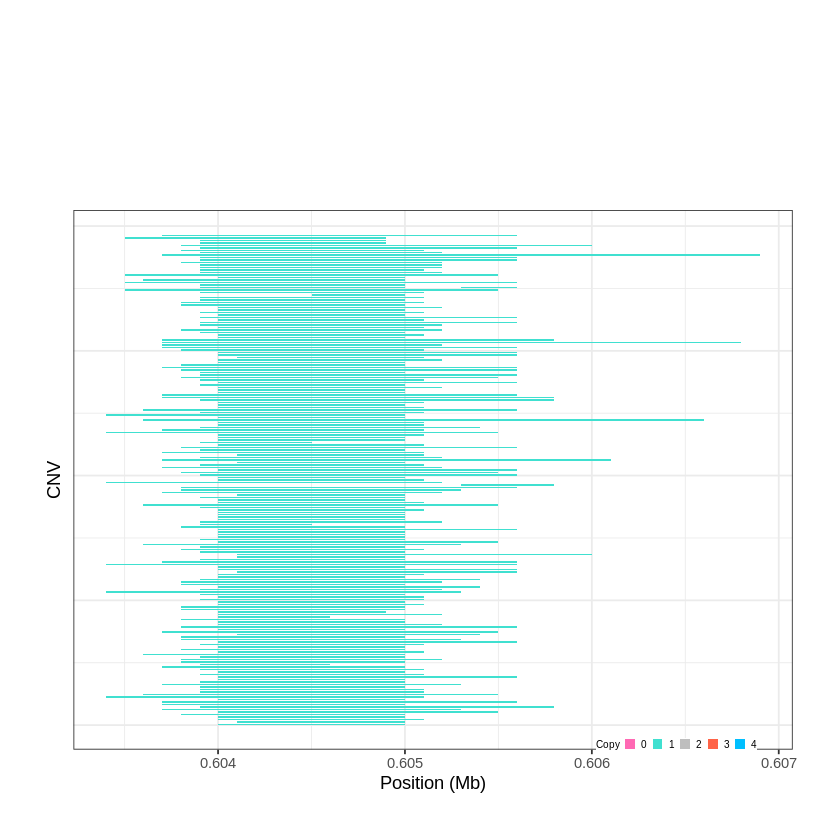

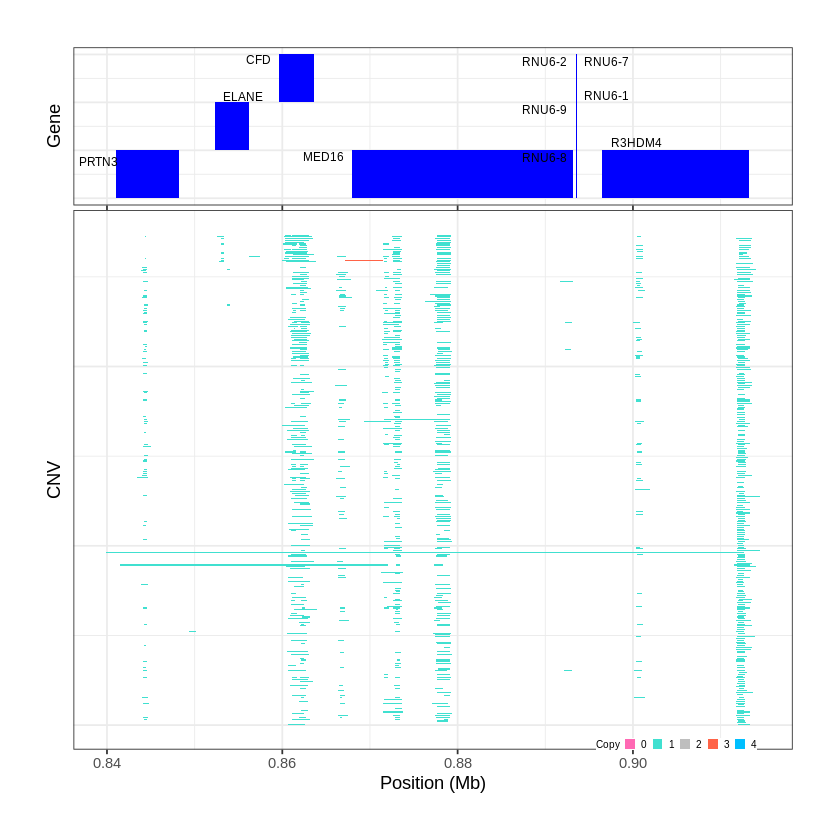

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1826..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 1.031201 - 1.2655 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1827..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 1.281101 - 1.2841 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


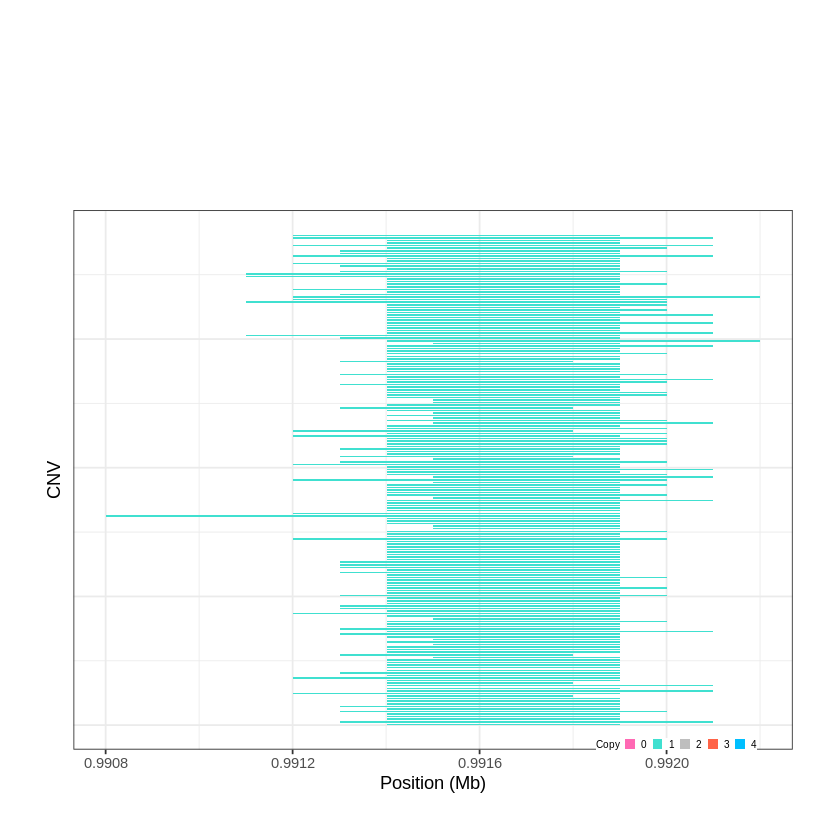

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1828..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 1.566201 - 1.5698 Mb with 215 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


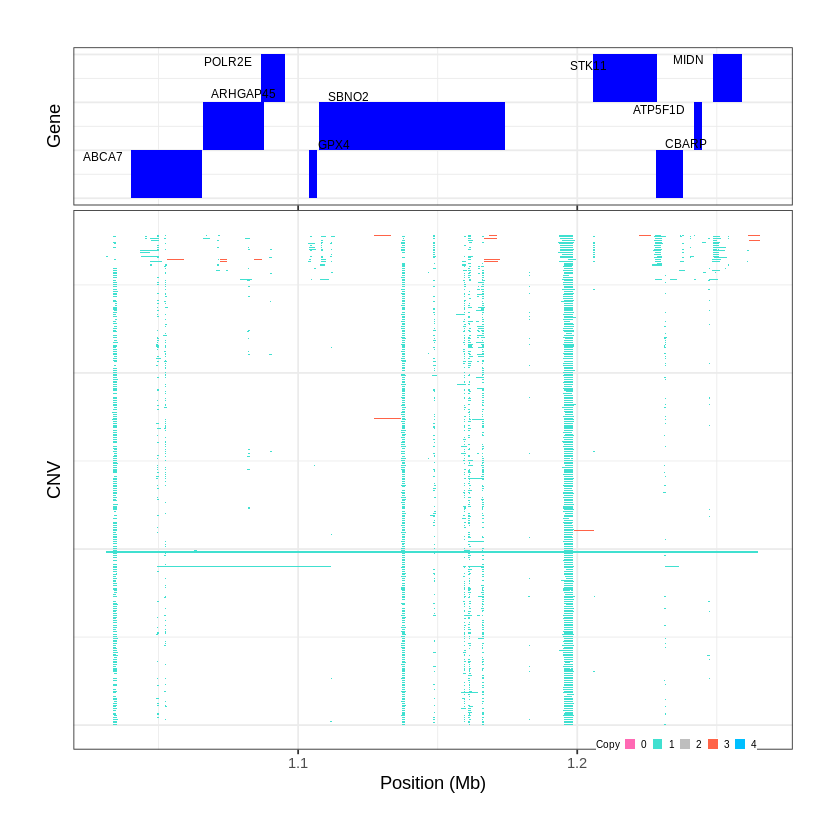

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1829..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 1.745601 - 1.7467 Mb with 196 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


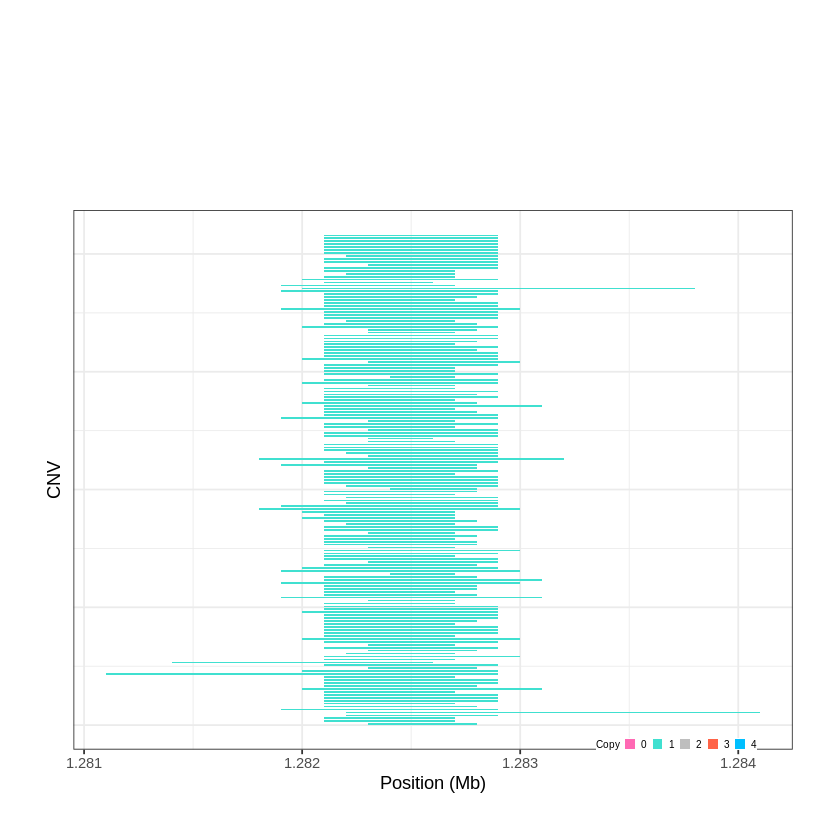

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1830..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 1.788701 - 1.7911 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


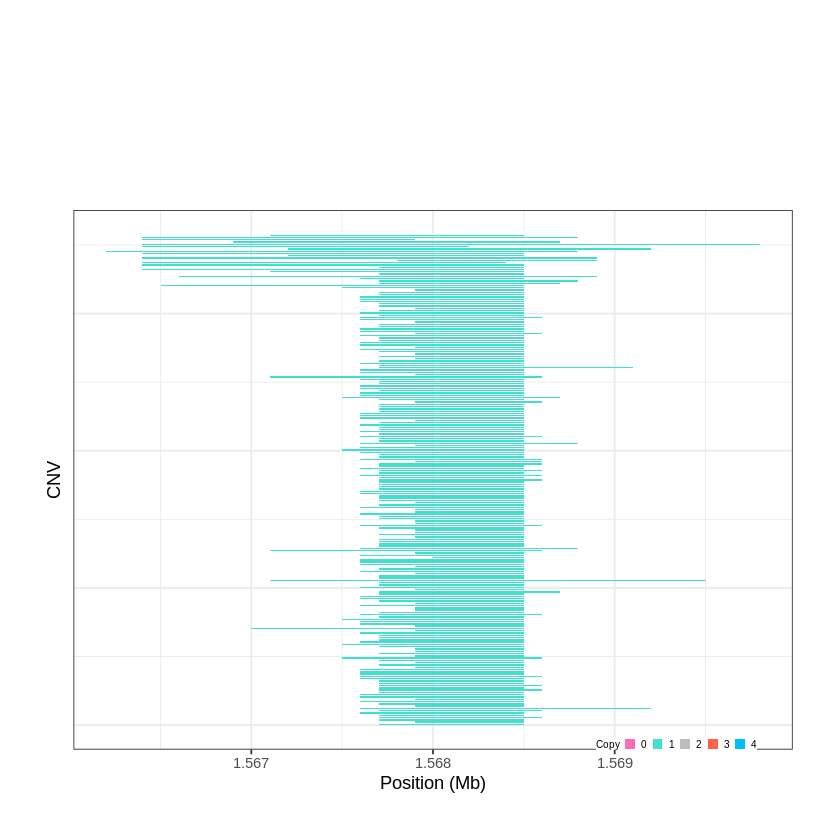

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1831..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 1.801501 - 1.8028 Mb with 155 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


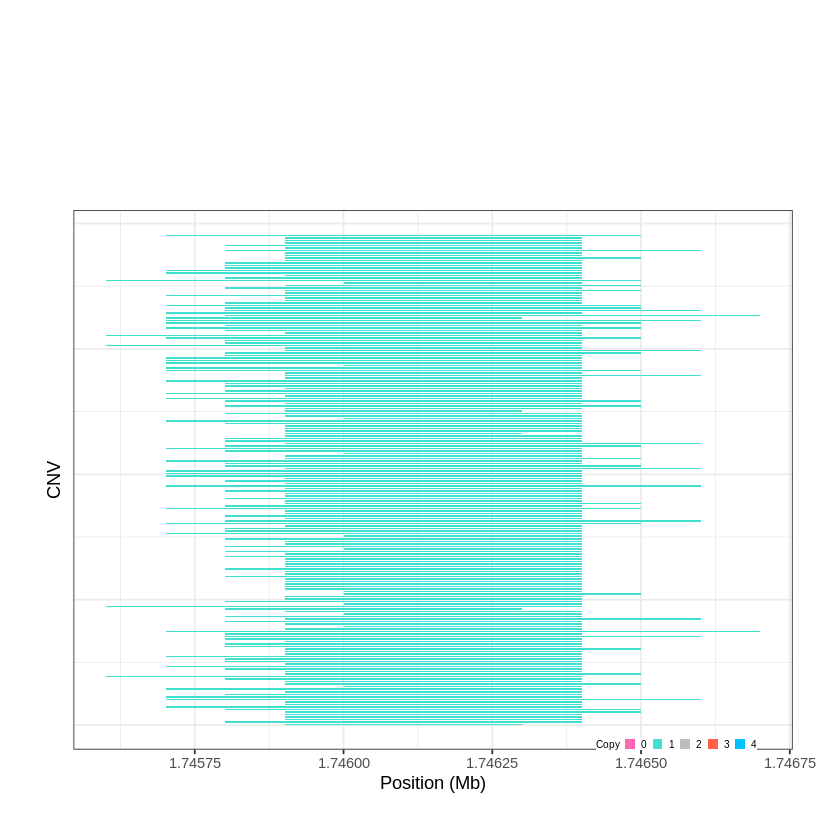

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1832..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 1.957601 - 1.9605 Mb with 223 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


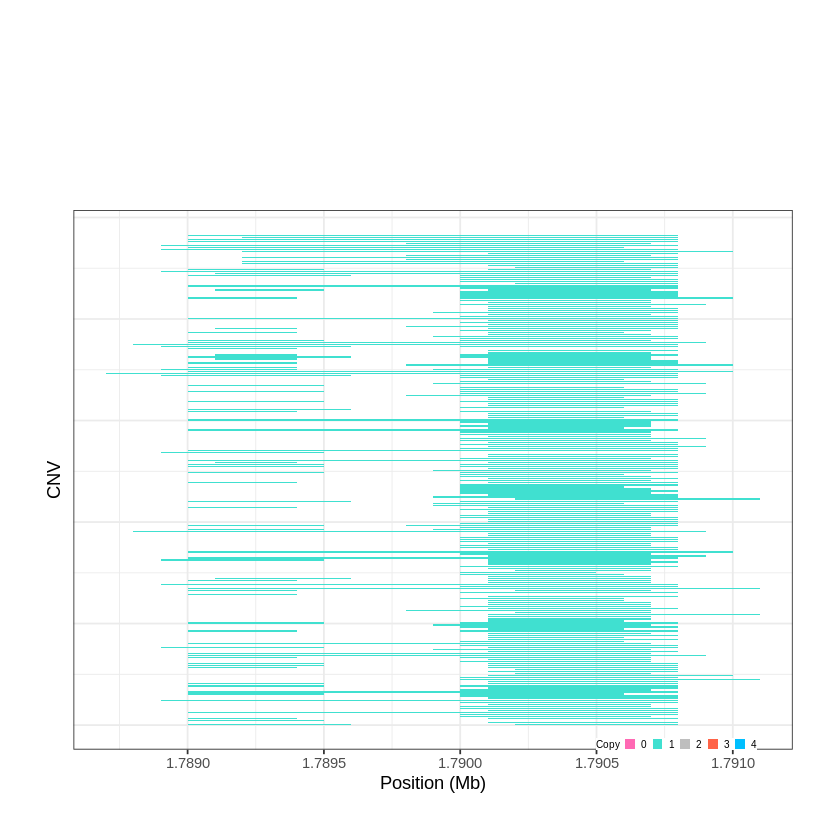

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1833..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 2.012901 - 2.0182 Mb with 200 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


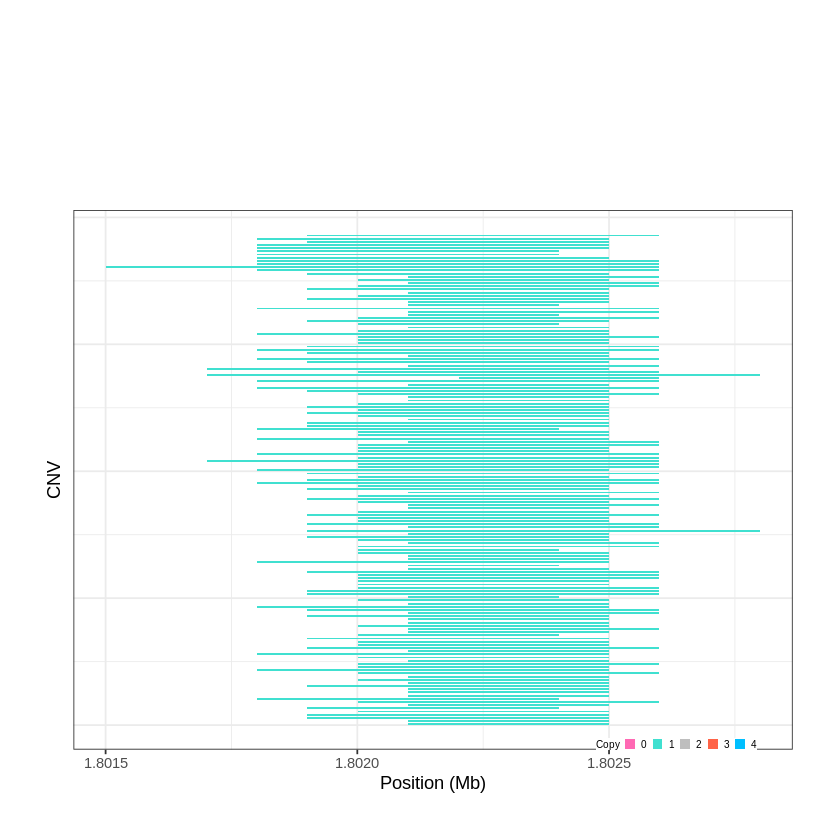

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1834..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 2.356201 - 2.3631 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


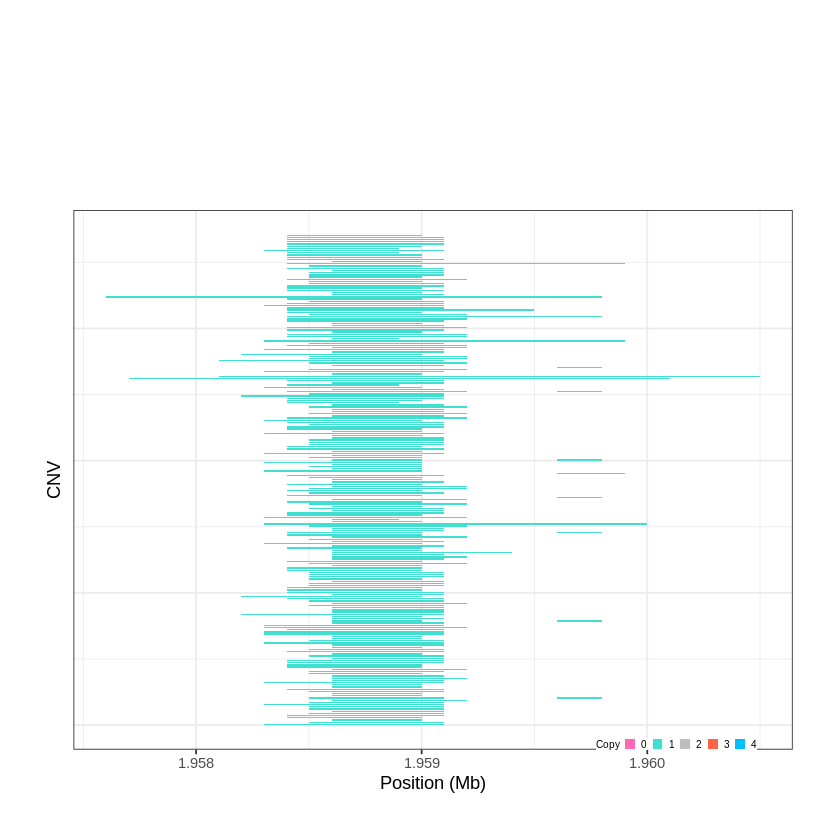

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1835..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 2.444801 - 2.4466 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


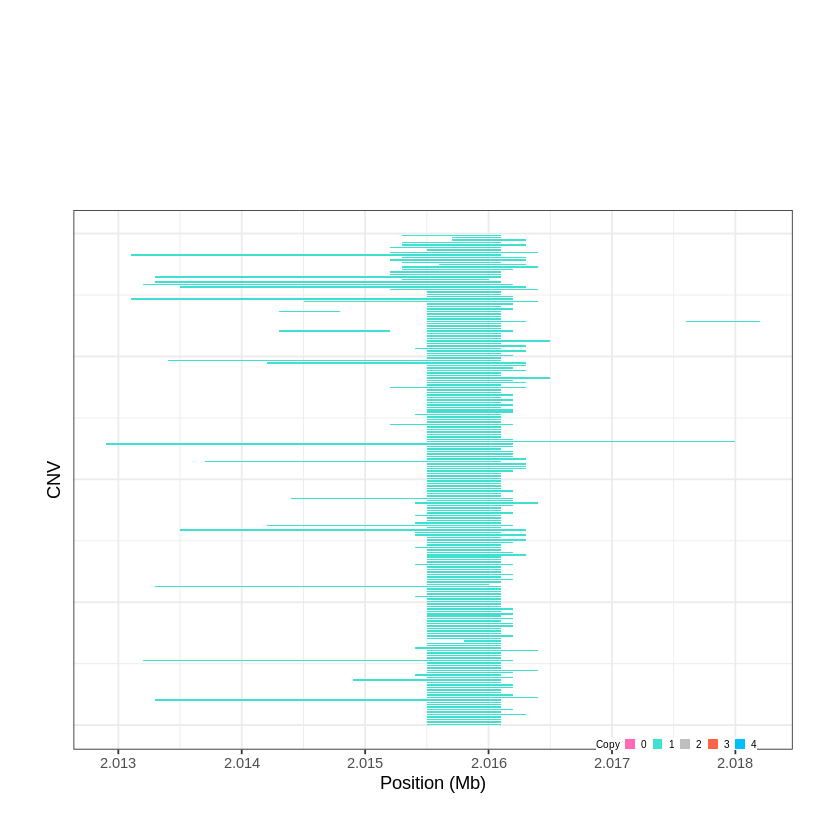

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1836..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 2.584101 - 2.5854 Mb with 186 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


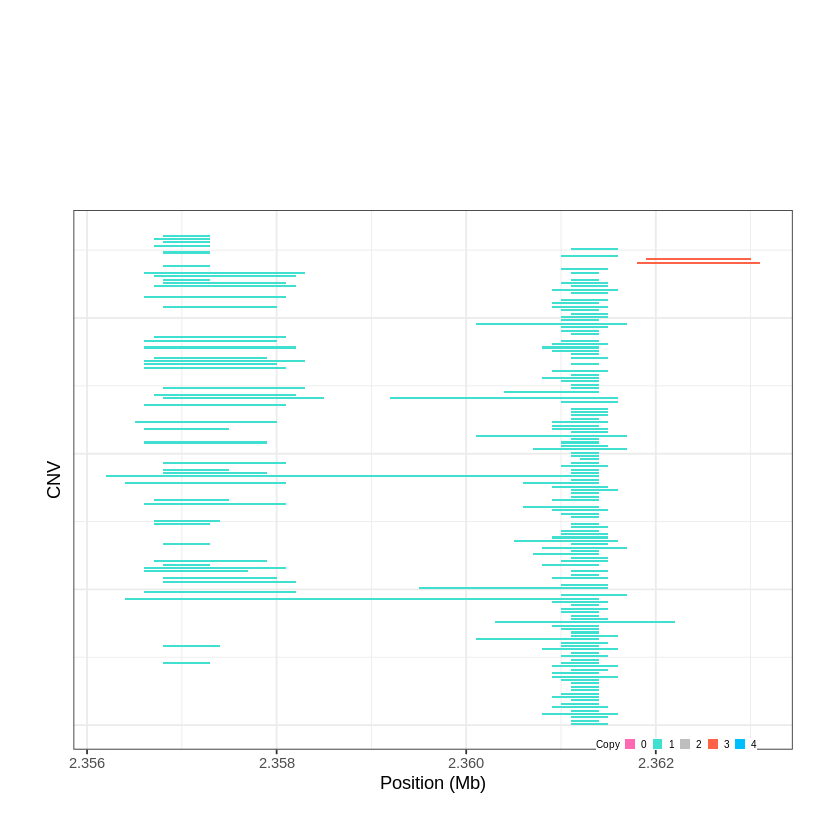

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1837..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 2.638101 - 2.6523 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


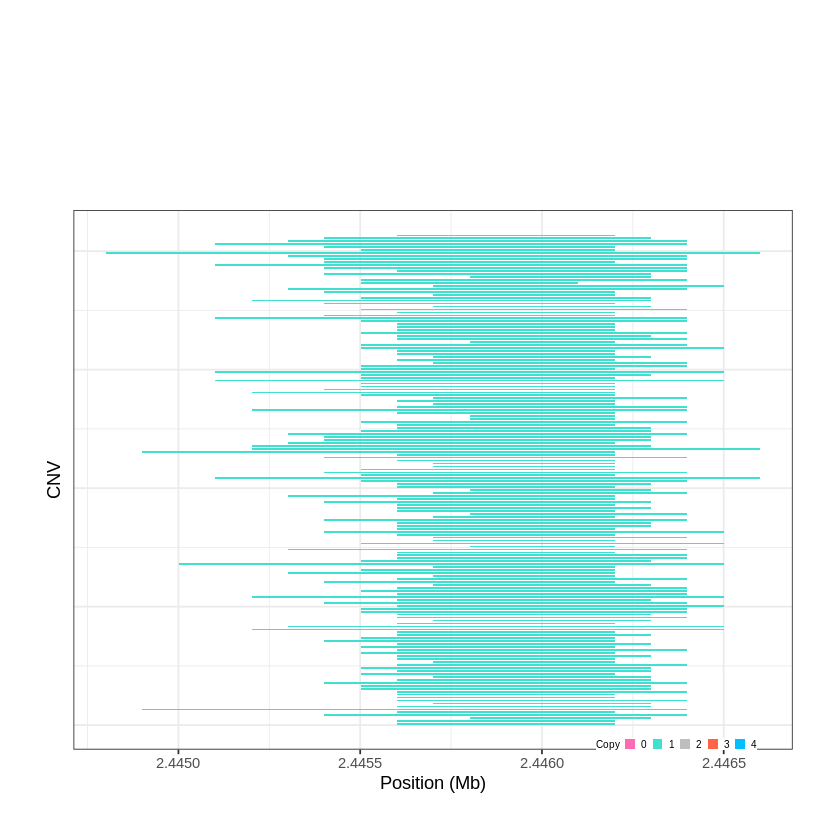

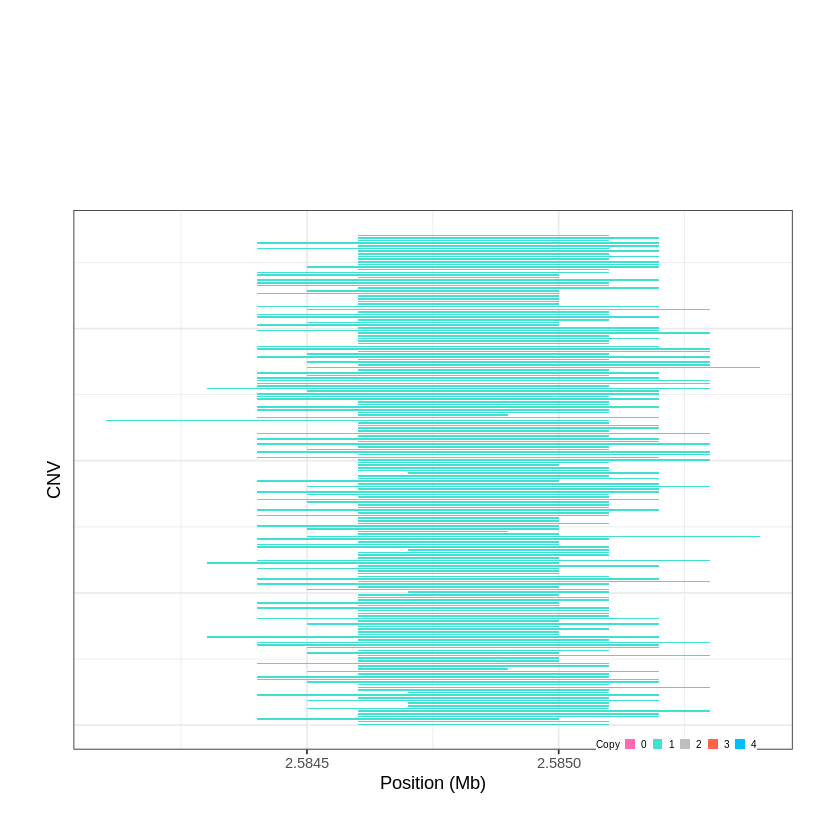

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1838..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 2.908901 - 3.0209 Mb with 250 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1839..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 3.046101 - 3.0478 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


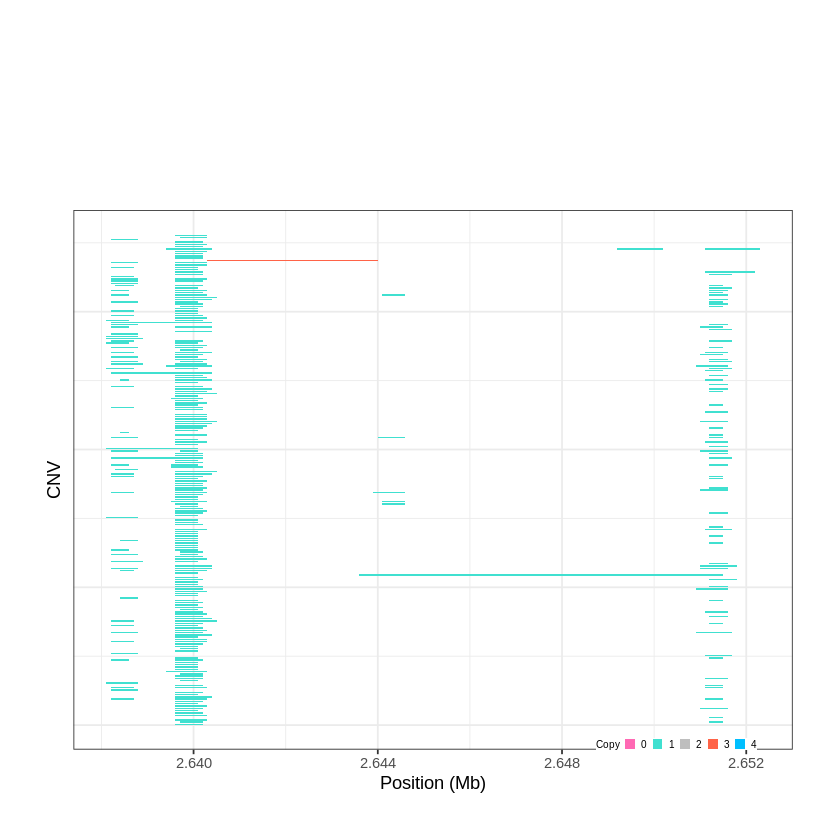

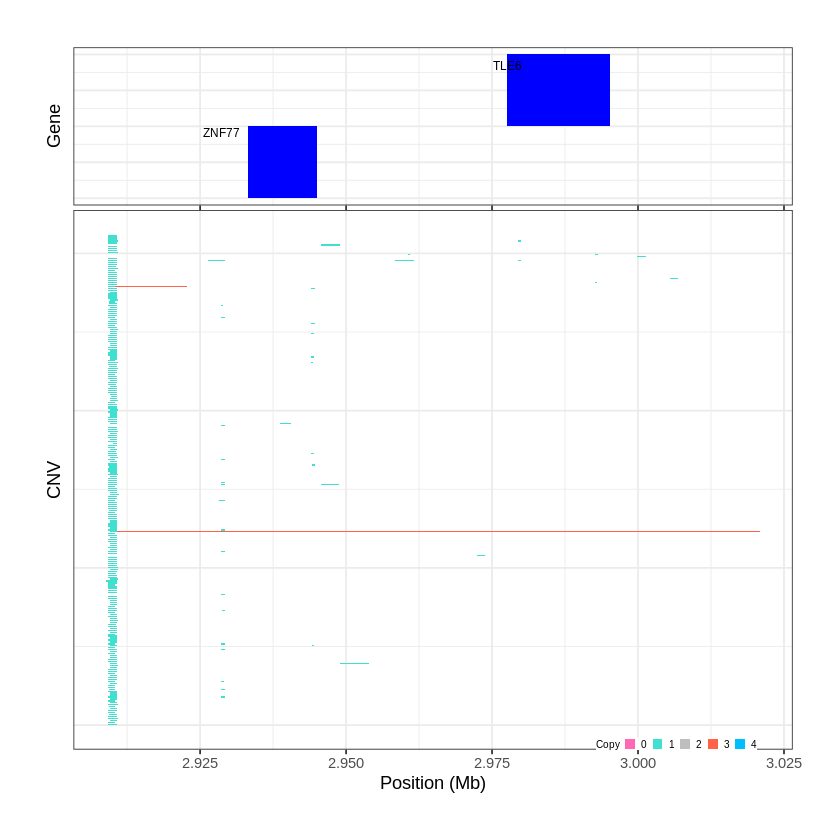

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1840..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 3.171201 - 3.181 Mb with 188 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1841..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 3.576601 - 3.5784 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


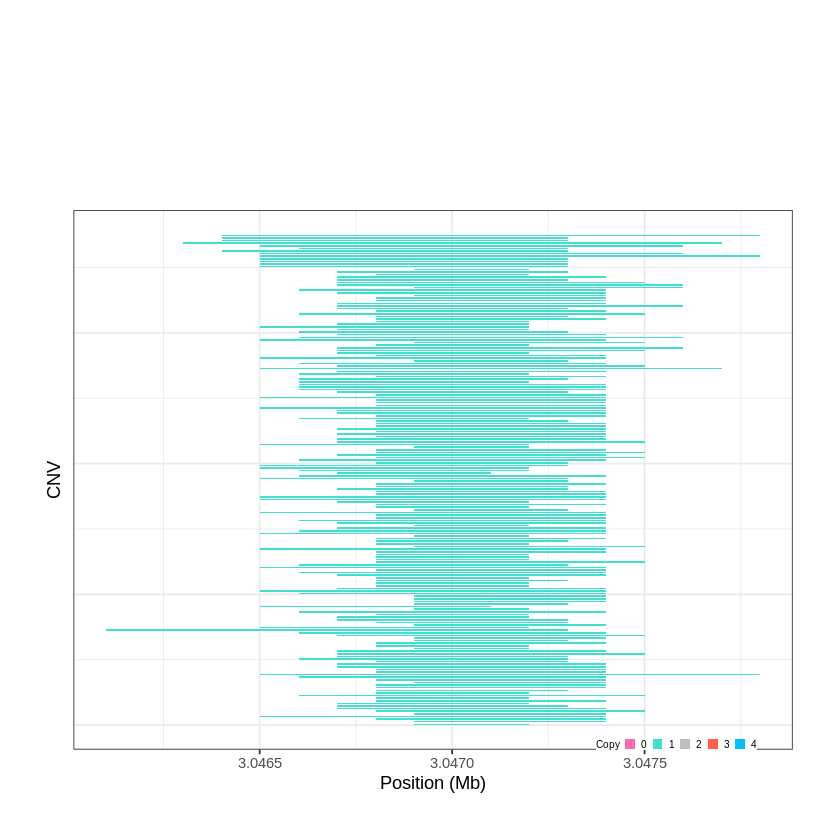

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1842..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 3.711001 - 3.7115 Mb with 188 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


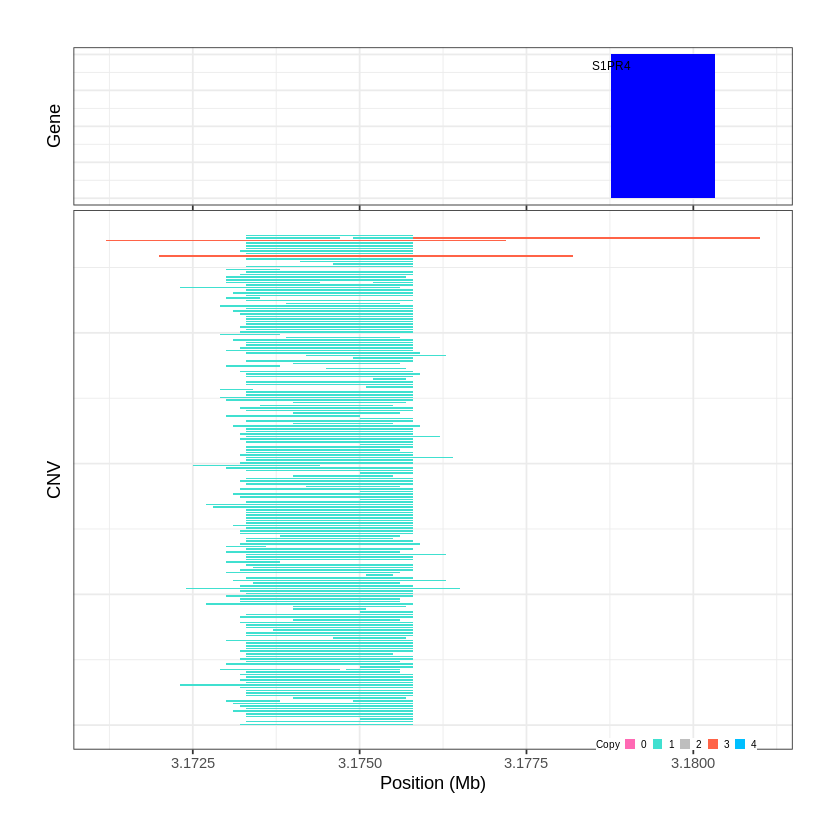

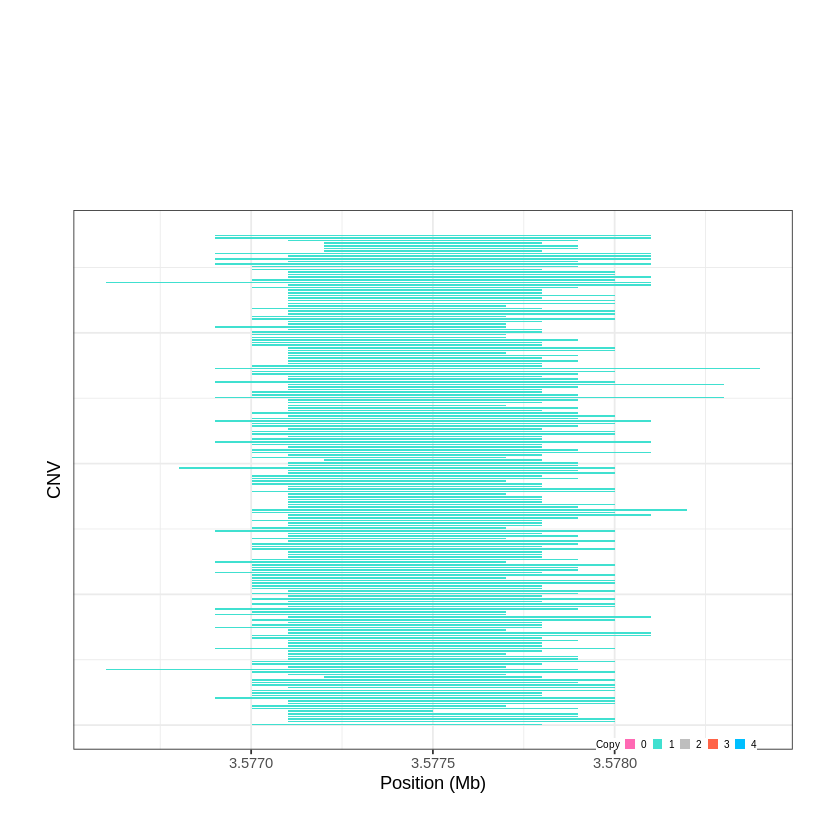

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1843..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 3.970401 - 3.9853 Mb with 249 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1844..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 4.120901 - 4.1251 Mb with 206 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


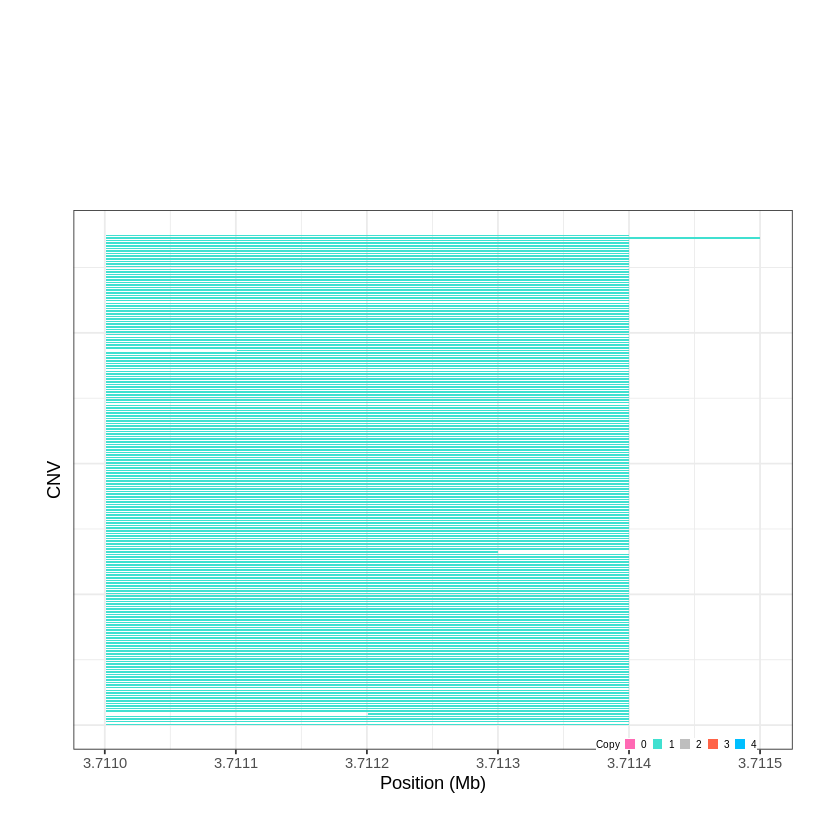

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1845..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 4.579701 - 4.5832 Mb with 165 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


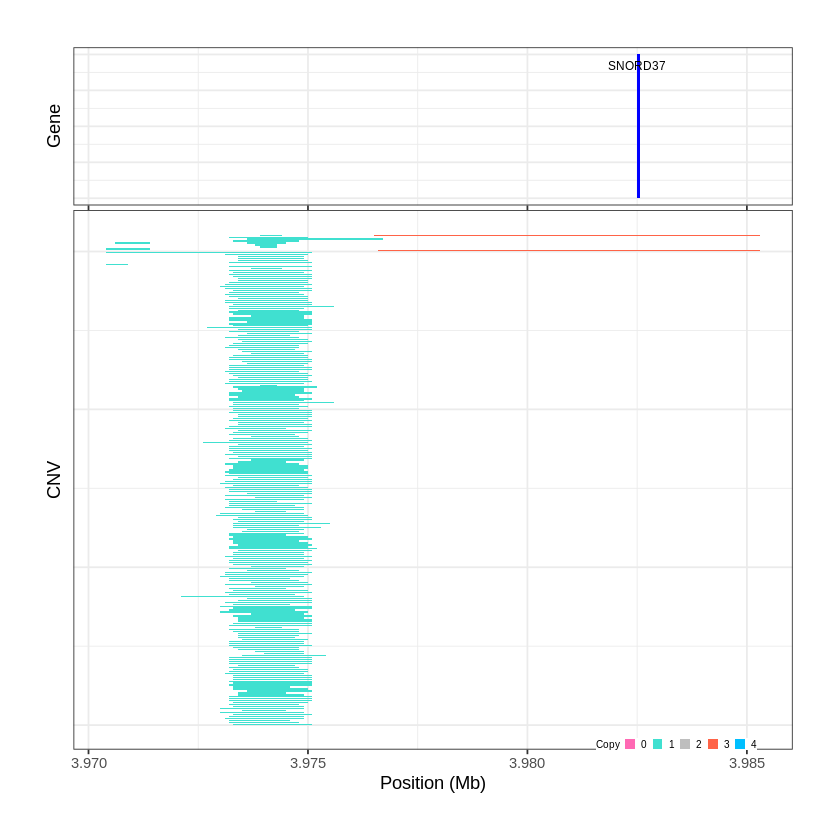

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1846..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 4.597601 - 4.5992 Mb with 145 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


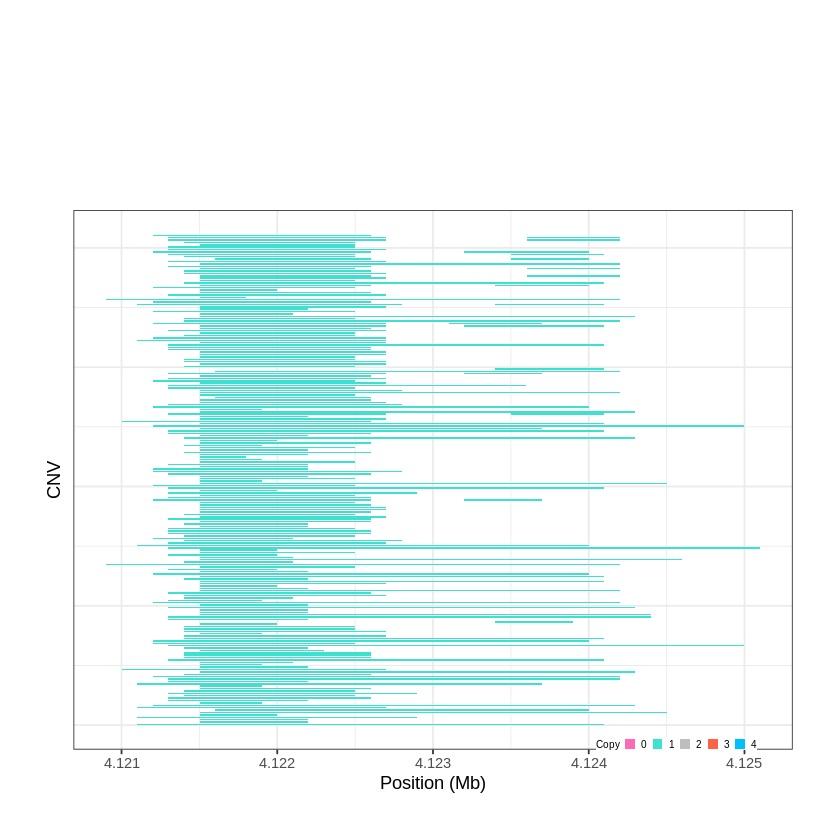

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1847..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 6.531701 - 6.5357 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


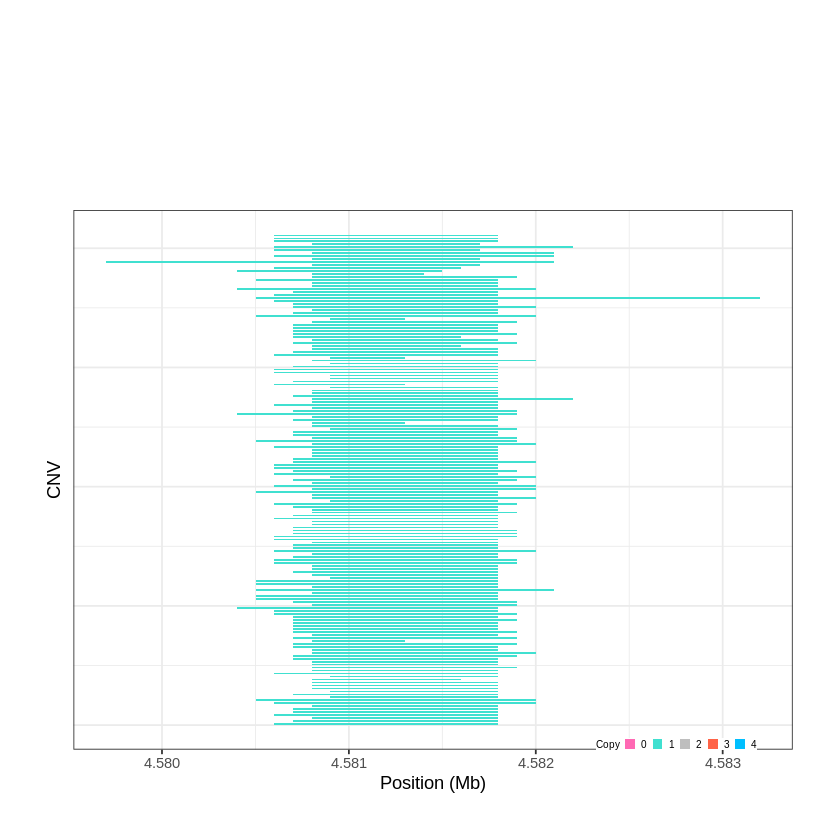

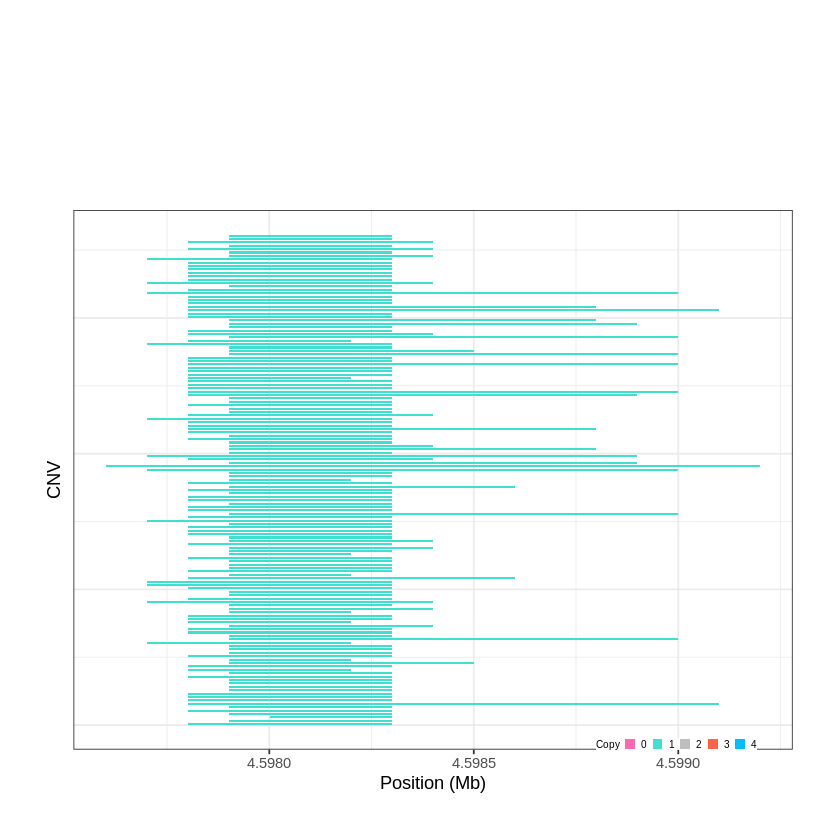

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1848..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 6.889601 - 7.0989 Mb with 267 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1849..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 7.302801 - 7.3962 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


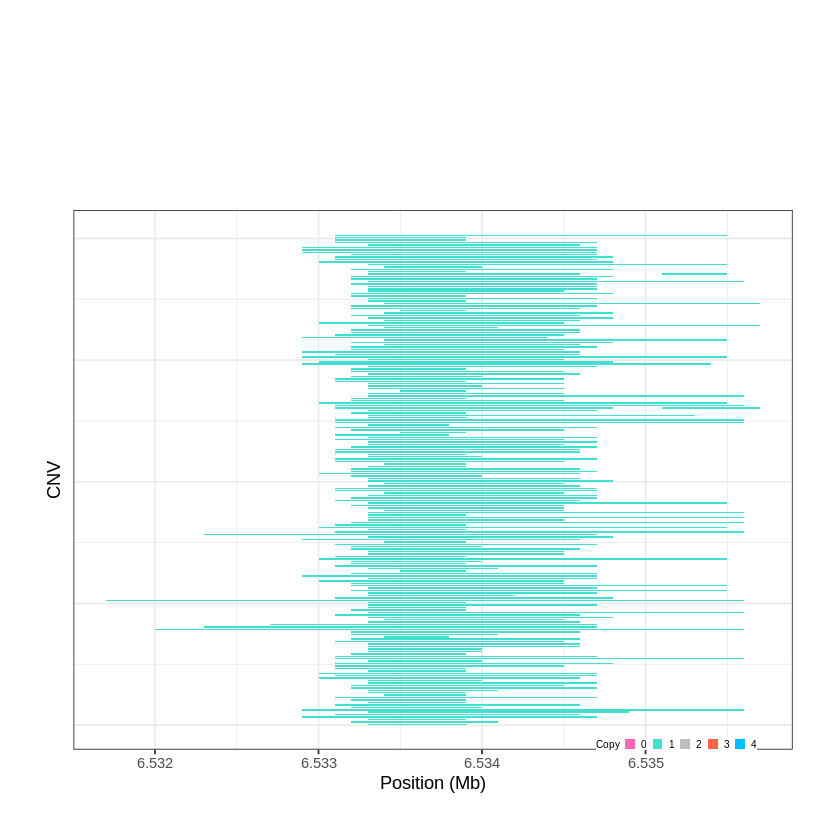

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1850..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 7.663401 - 7.6683 Mb with 267 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


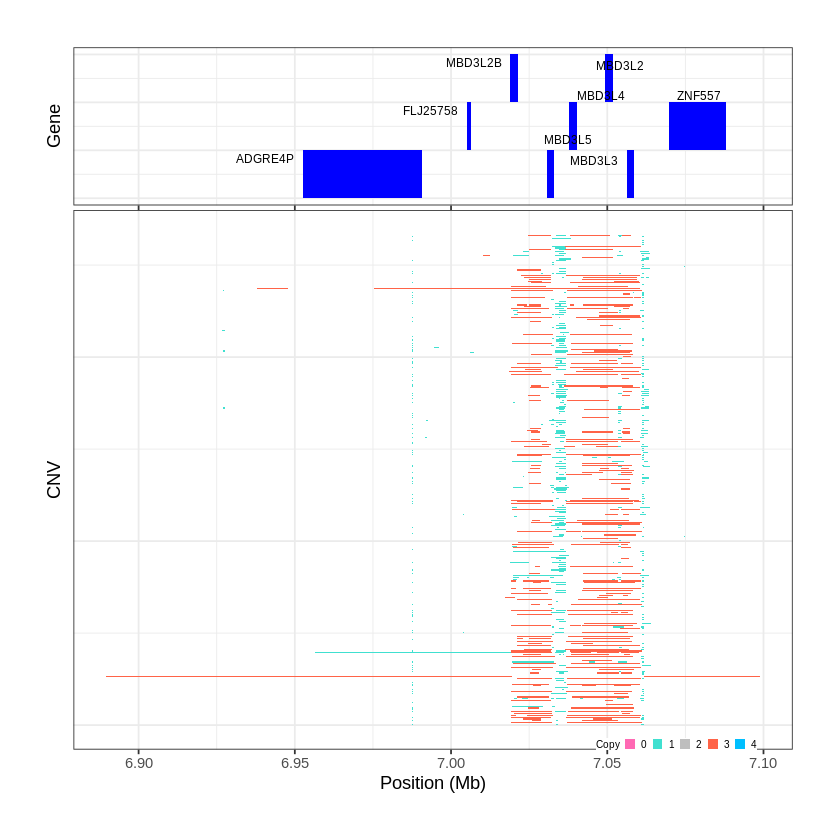

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1851..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 7.887501 - 7.889 Mb with 159 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


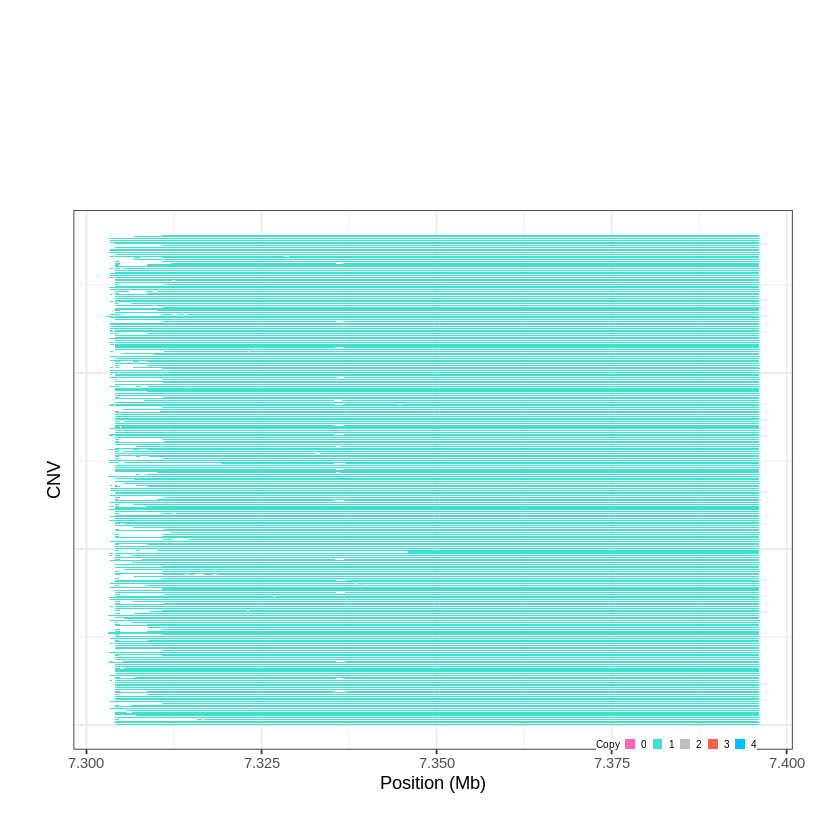

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1852..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 8.334901 - 8.3677 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


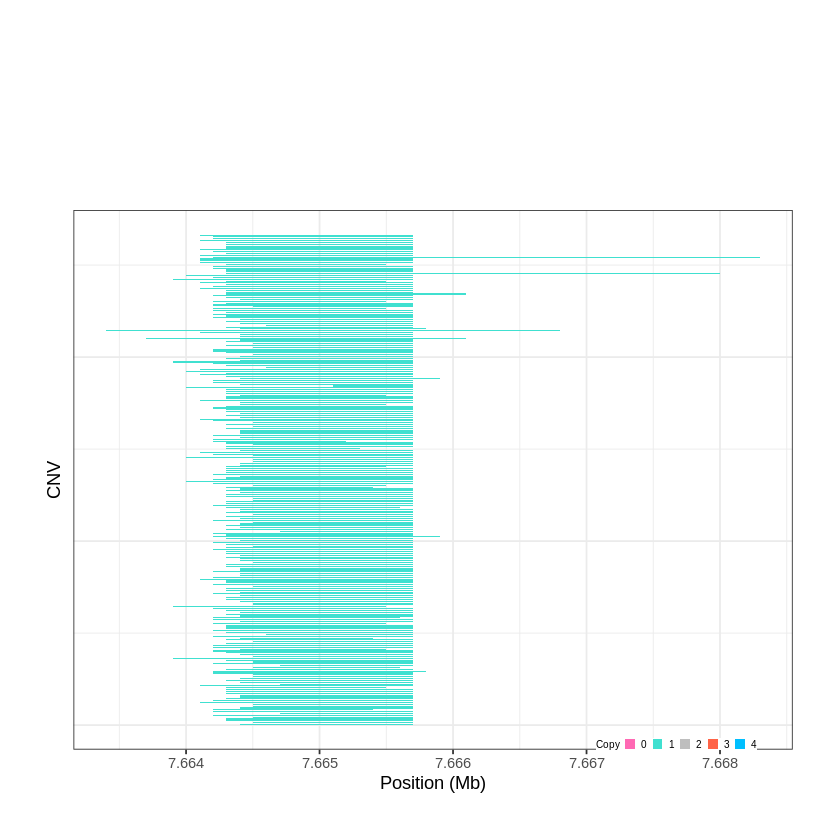

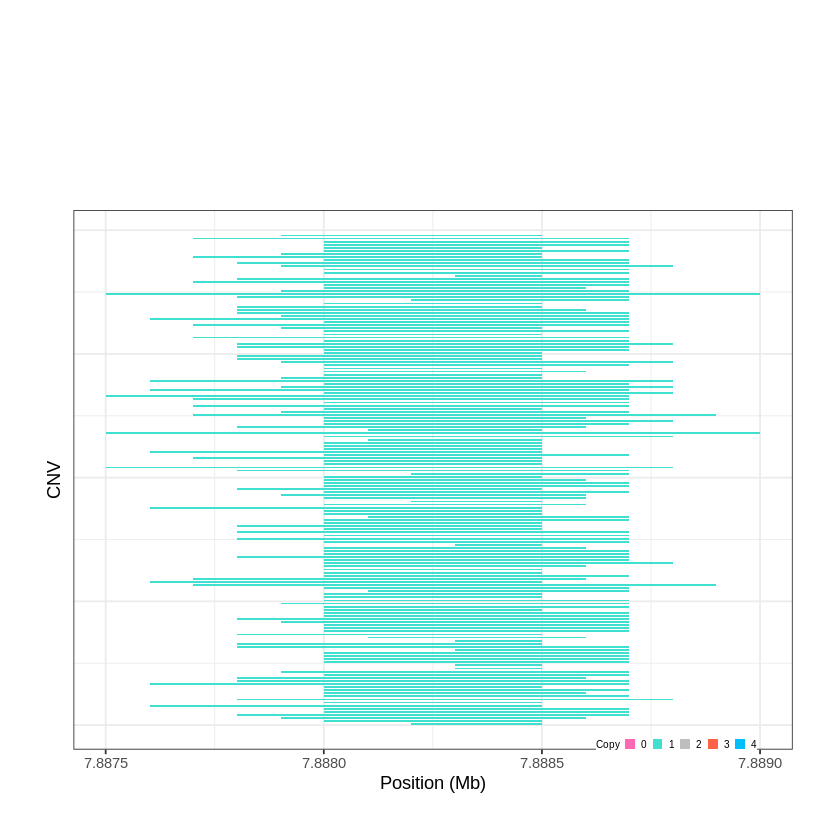

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1853..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 8.510801 - 8.5525 Mb with 214 Individual - "
Plotting gene...


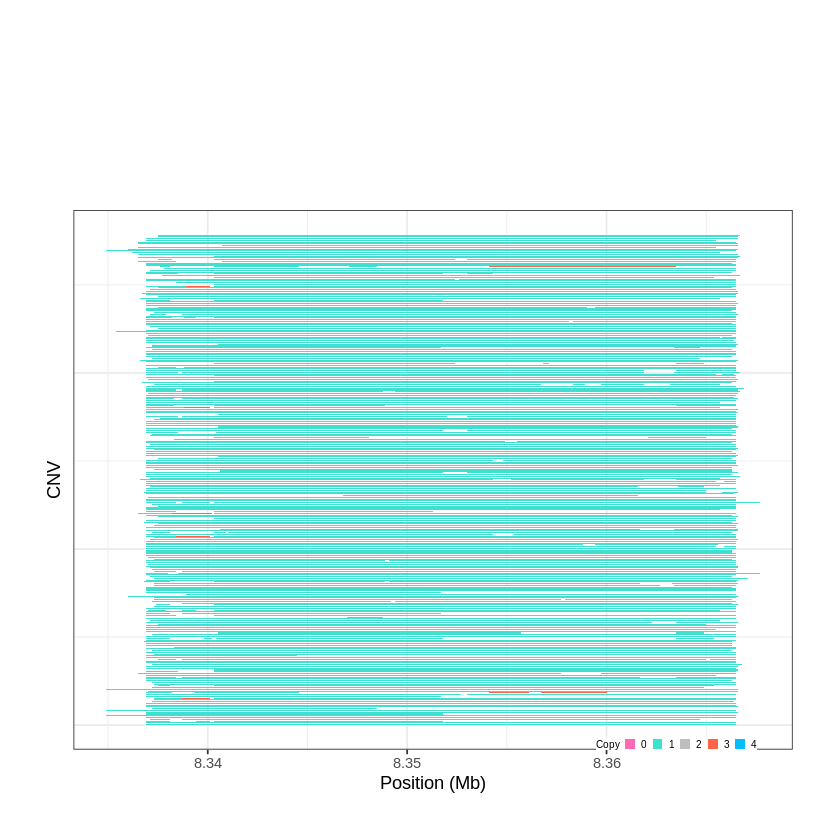

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1854..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 8.675201 - 8.7374 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1855..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 8.847401 - 8.9008 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


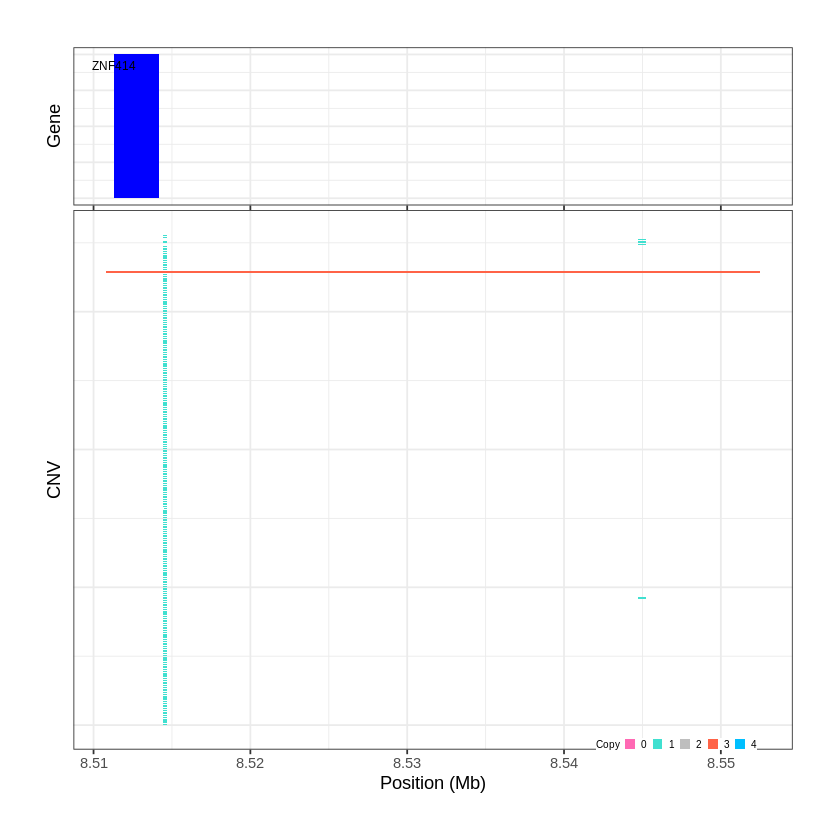

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1856..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 9.896901 - 9.904 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


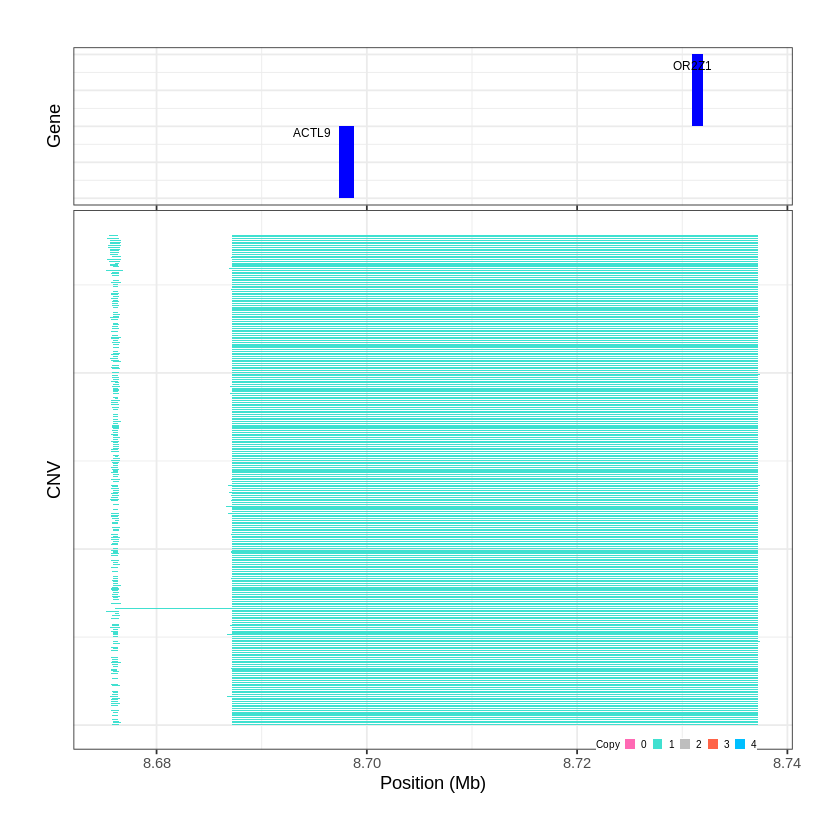

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1857..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 11.534101 - 11.5413 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


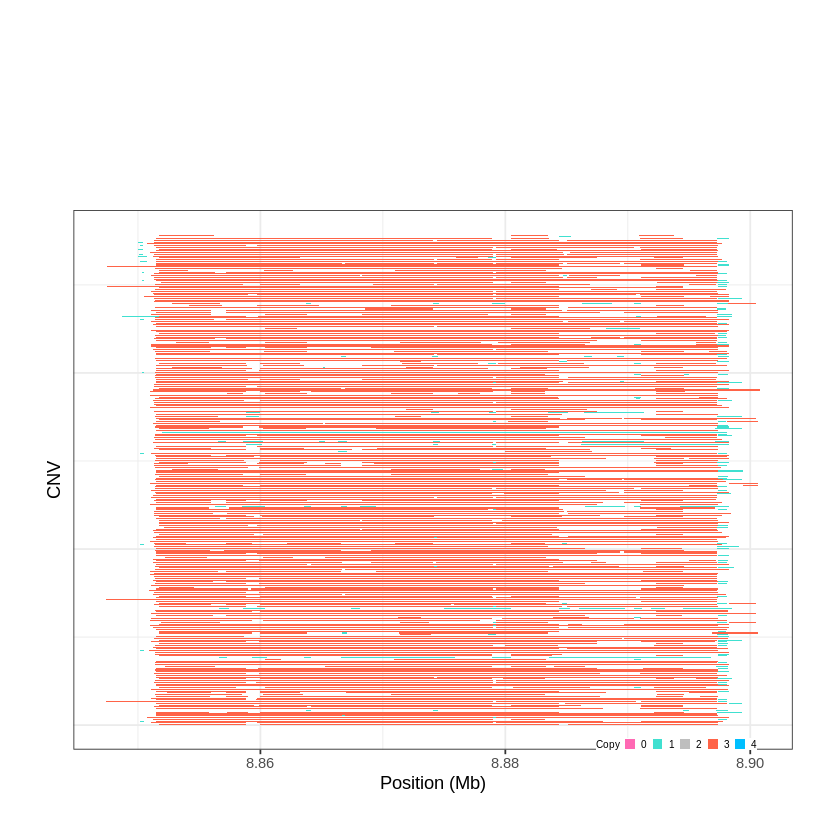

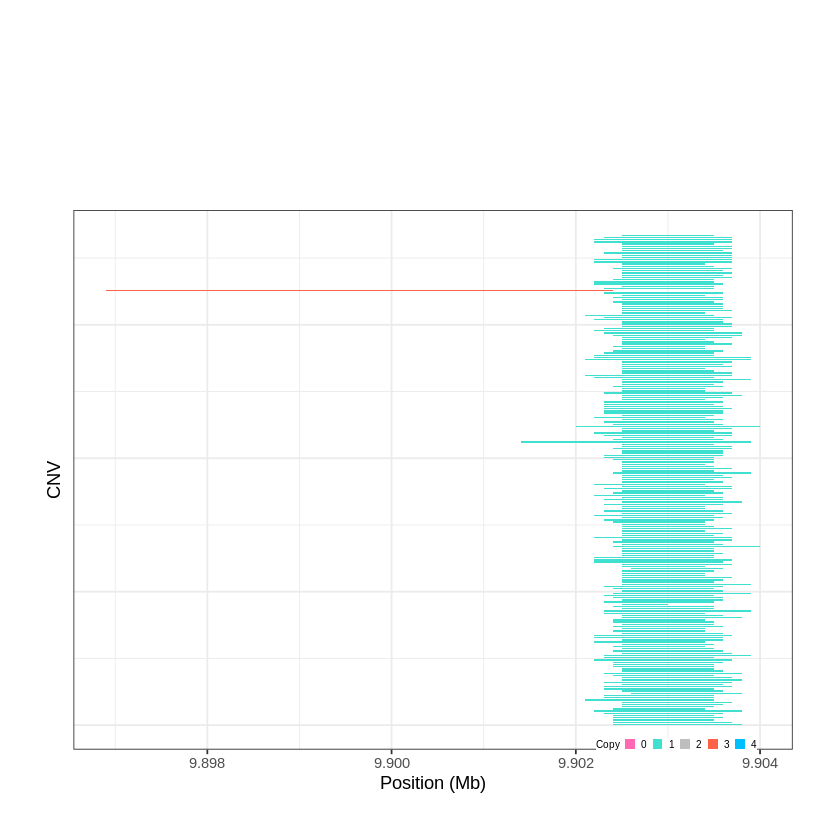

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1858..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 12.506601 - 12.5592 Mb with 177 Individual - "
Plotting gene...


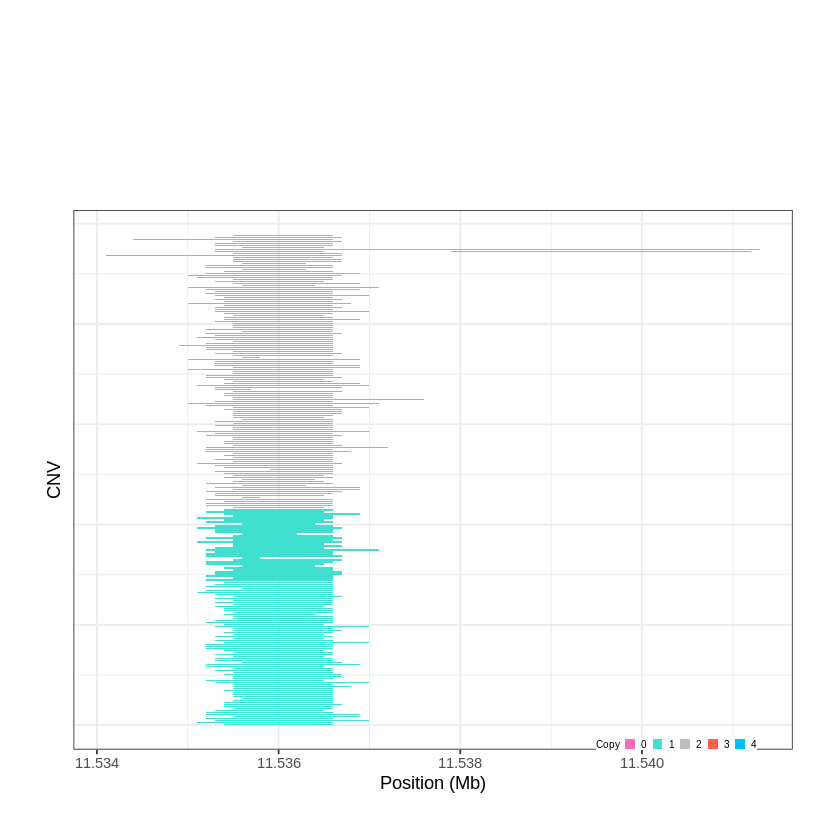

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1859..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 12.570001 - 12.7014 Mb with 179 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1860..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 13.775201 - 13.7783 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


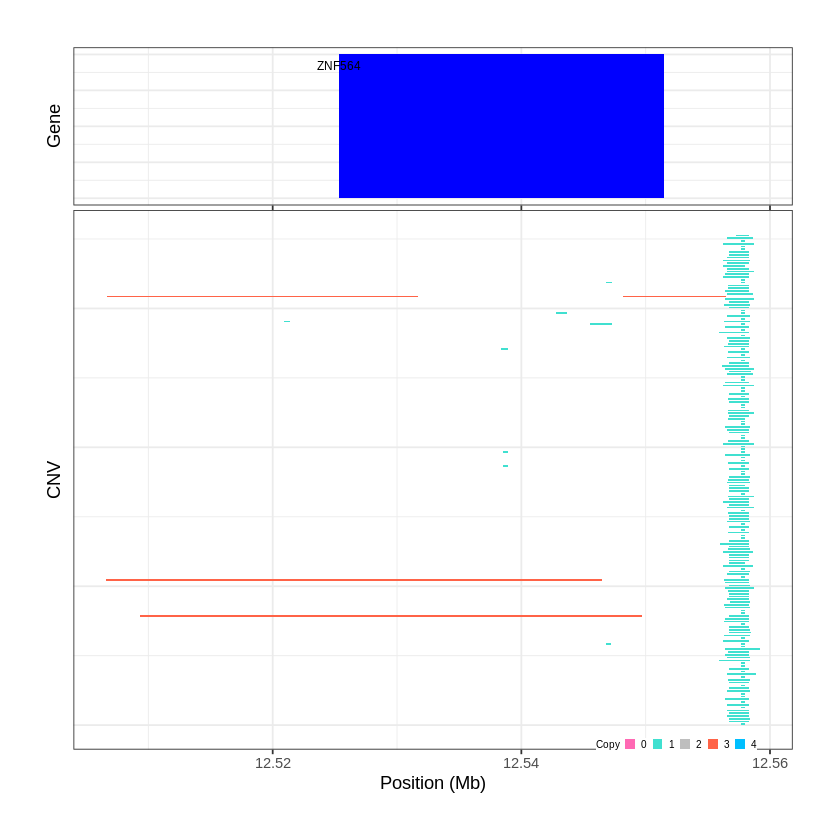

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1861..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 14.731101 - 14.7342 Mb with 144 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


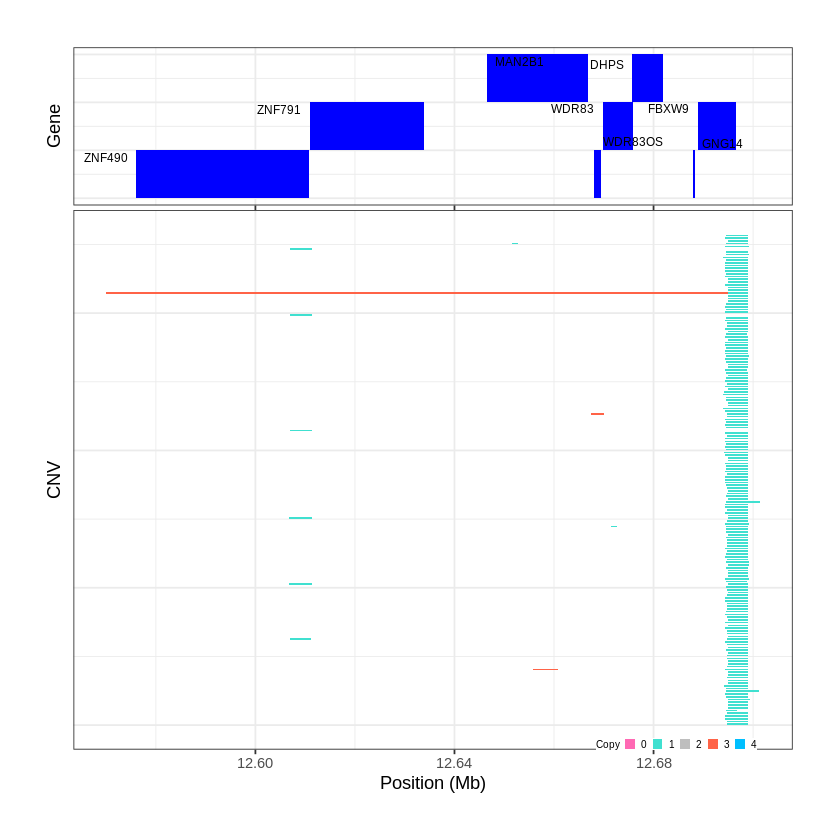

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1862..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 15.032201 - 15.0505 Mb with 211 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


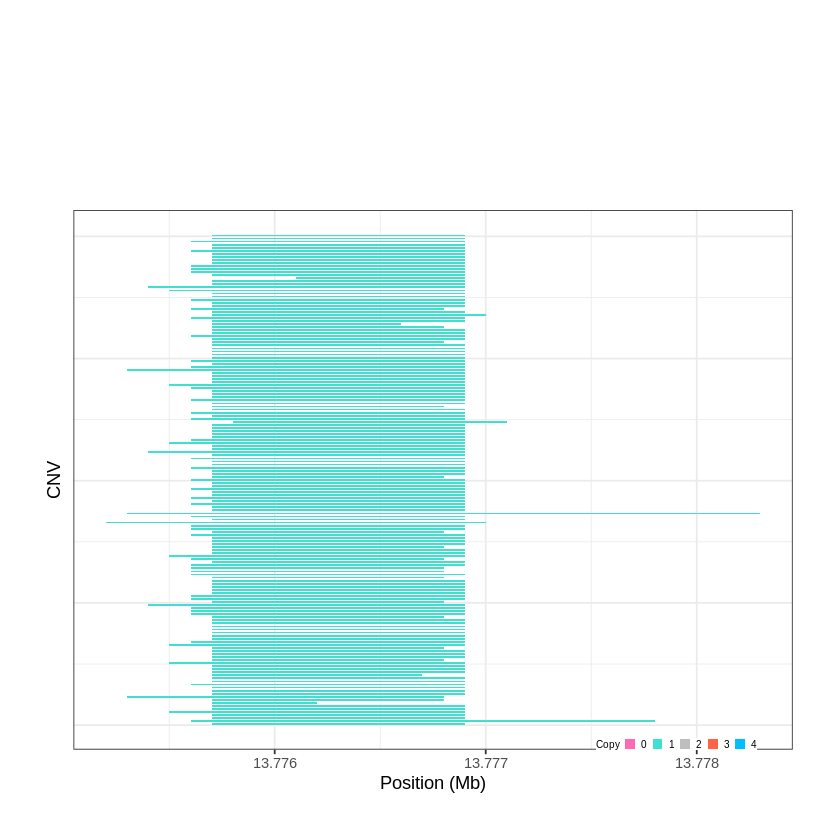

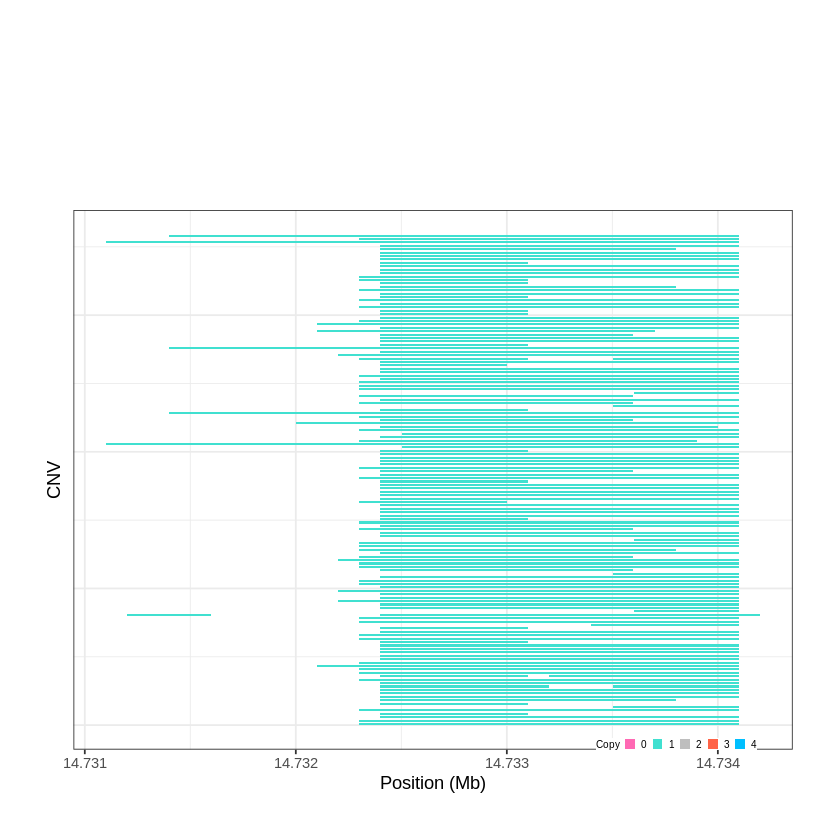

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1863..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 15.777701 - 15.8429 Mb with 277 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1864..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 16.041901 - 16.0456 Mb with 174 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


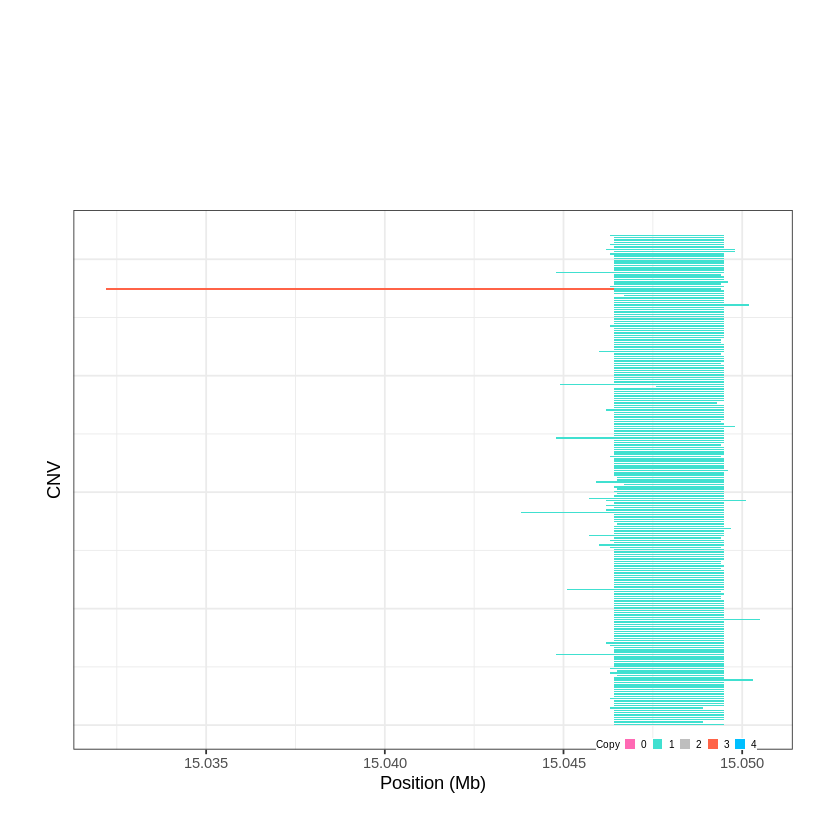

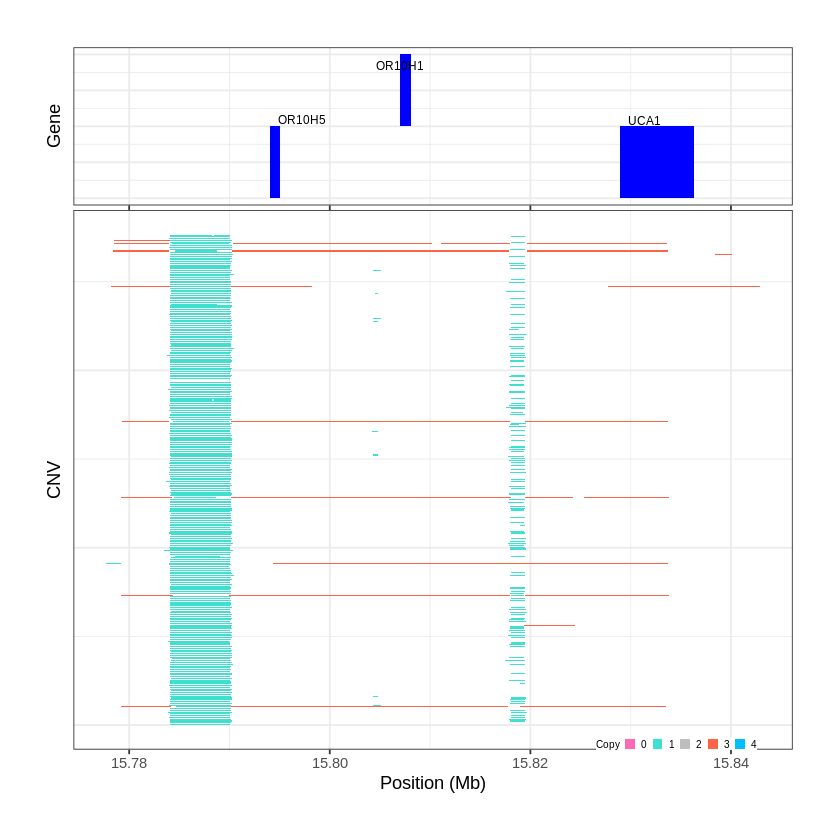

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1865..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 16.887201 - 16.893 Mb with 247 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1866..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 18.652401 - 18.6559 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


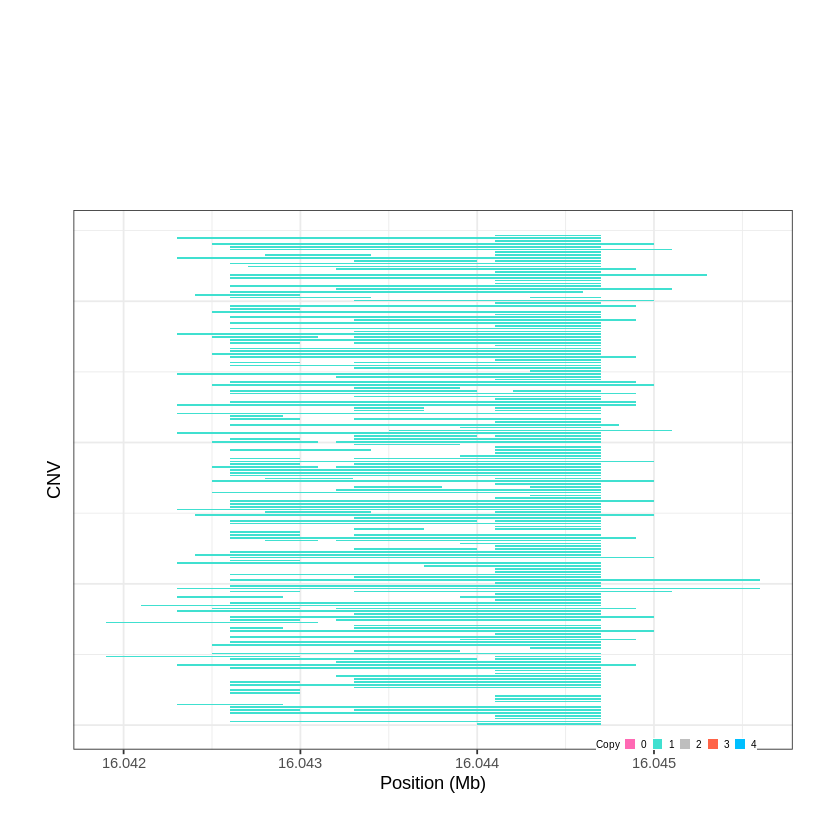

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1867..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 18.763201 - 18.7668 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


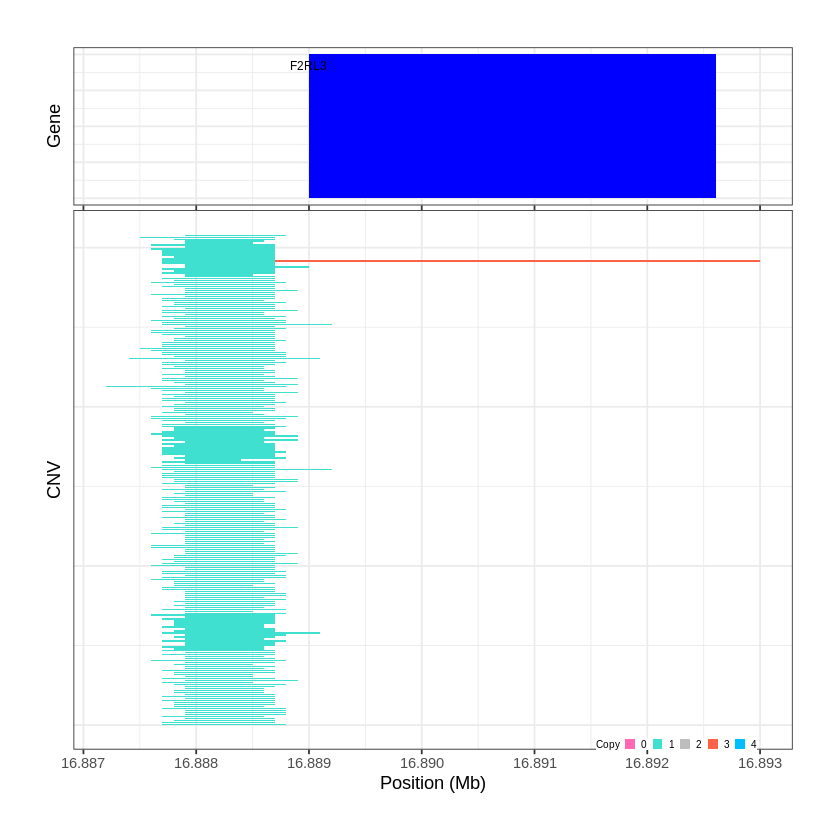

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1868..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 19.833301 - 19.8894 Mb with 151 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


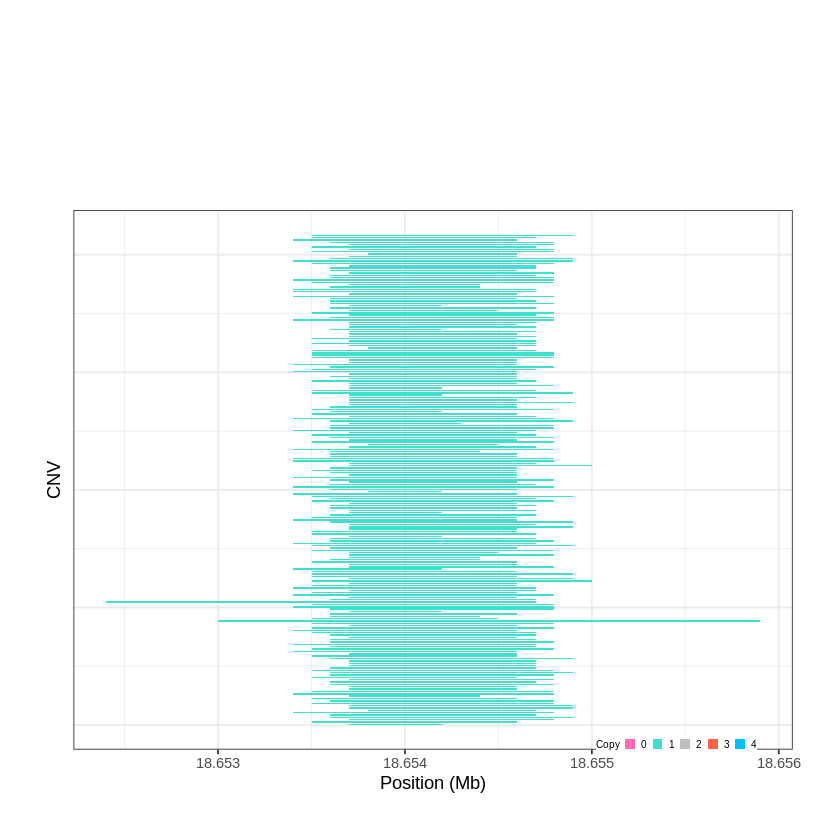

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1869..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 20.174101 - 20.198 Mb with 141 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


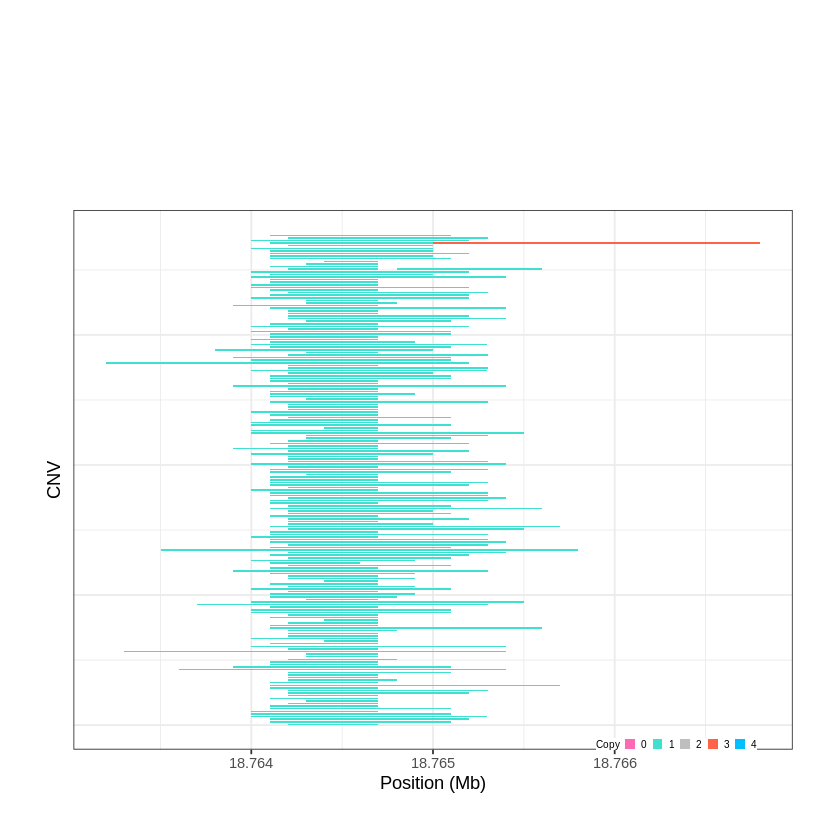

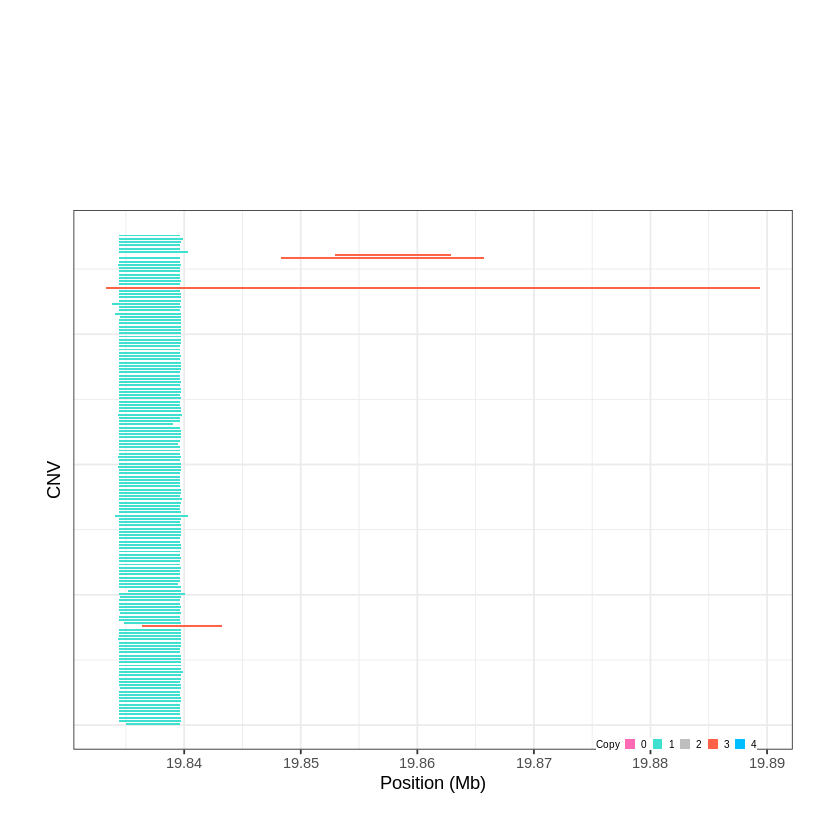

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1870..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 20.503401 - 20.718 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1871..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 20.801001 - 20.8026 Mb with 245 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


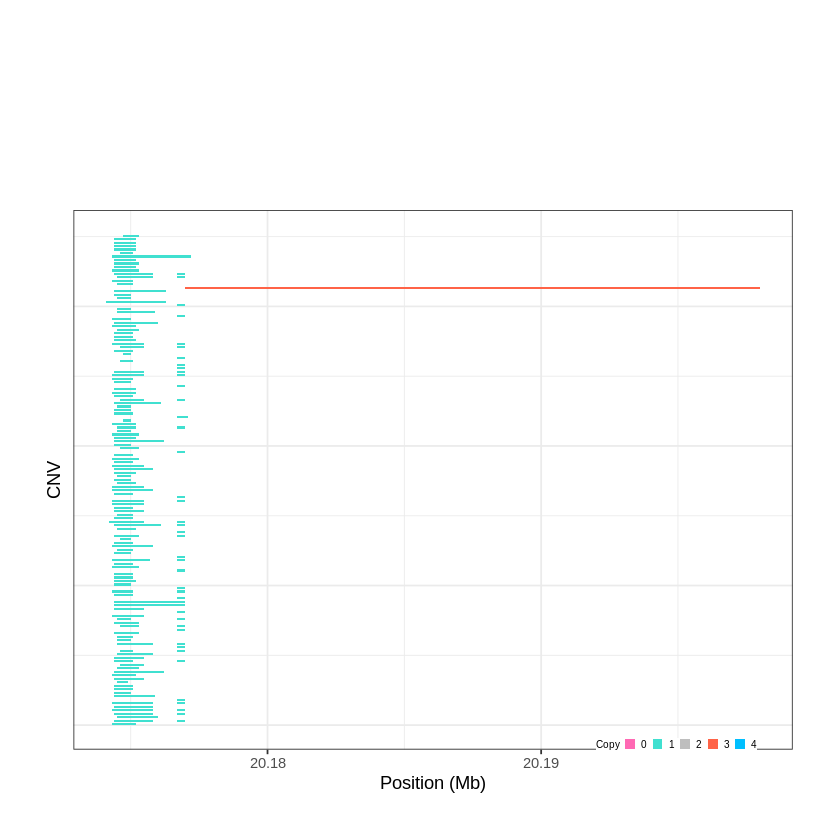

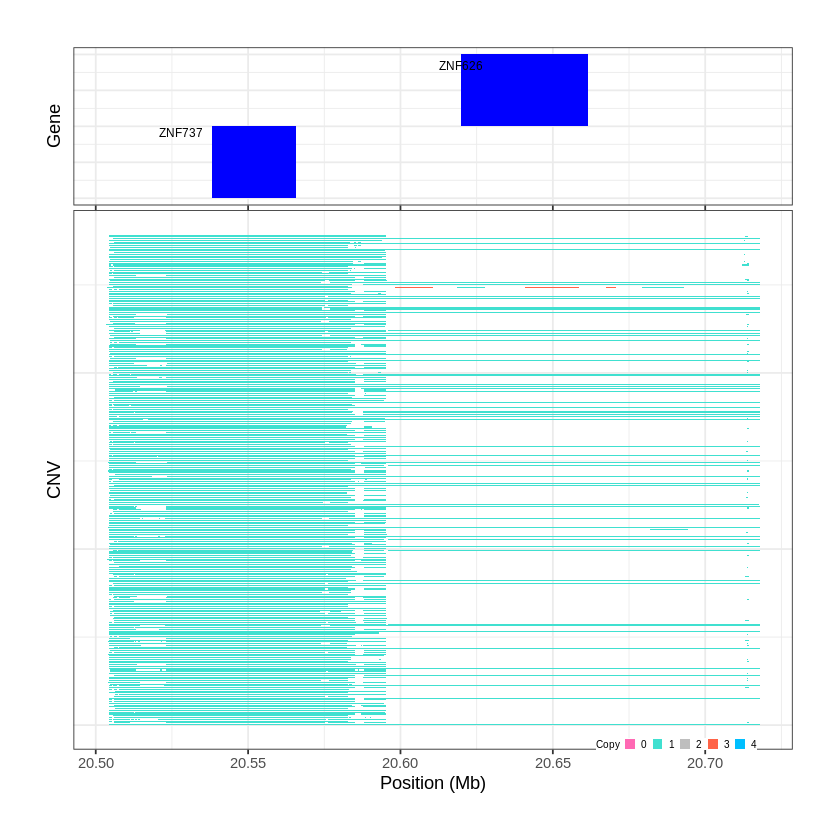

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1872..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 21.710801 - 21.7806 Mb with 156 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1873..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 21.823001 - 21.8399 Mb with 251 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


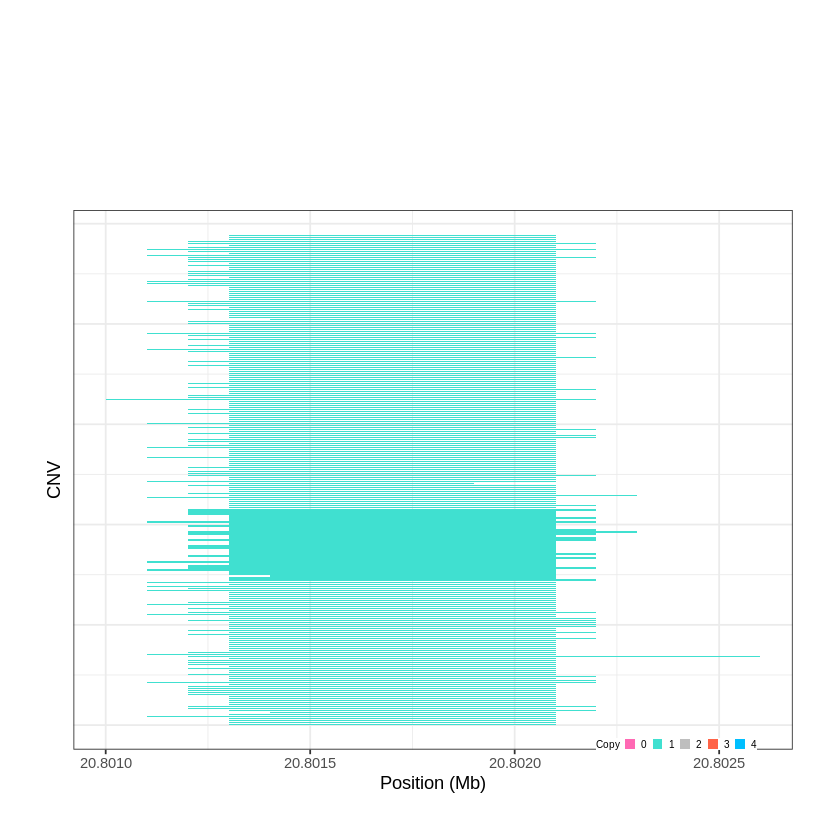

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1874..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 22.082101 - 22.1209 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


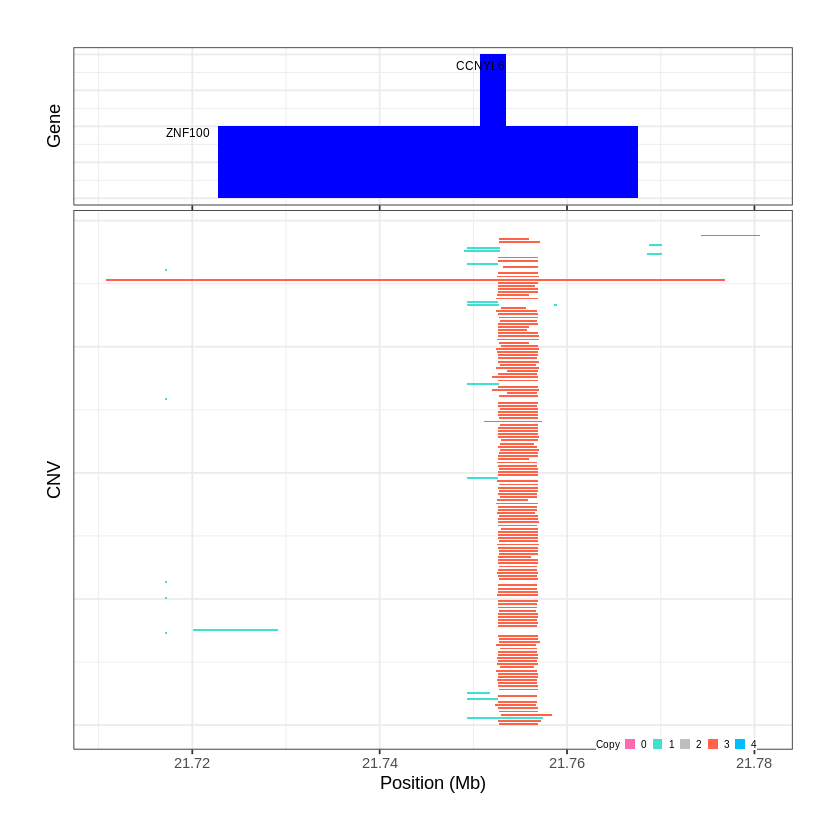

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1875..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 23.104001 - 23.114 Mb with 163 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


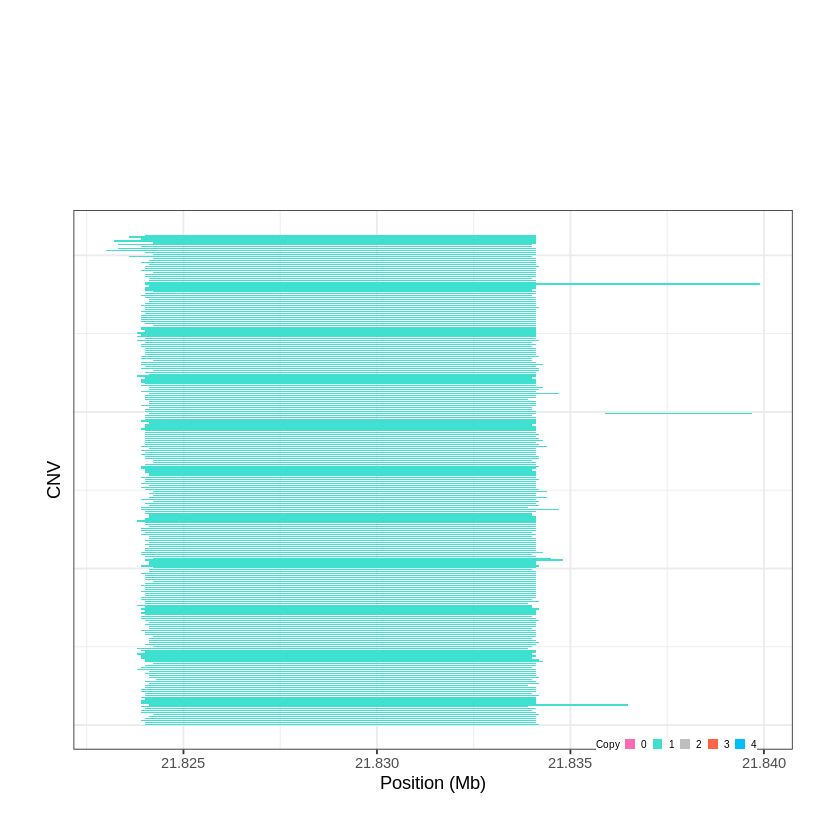

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1876..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 23.138601 - 23.1625 Mb with 250 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


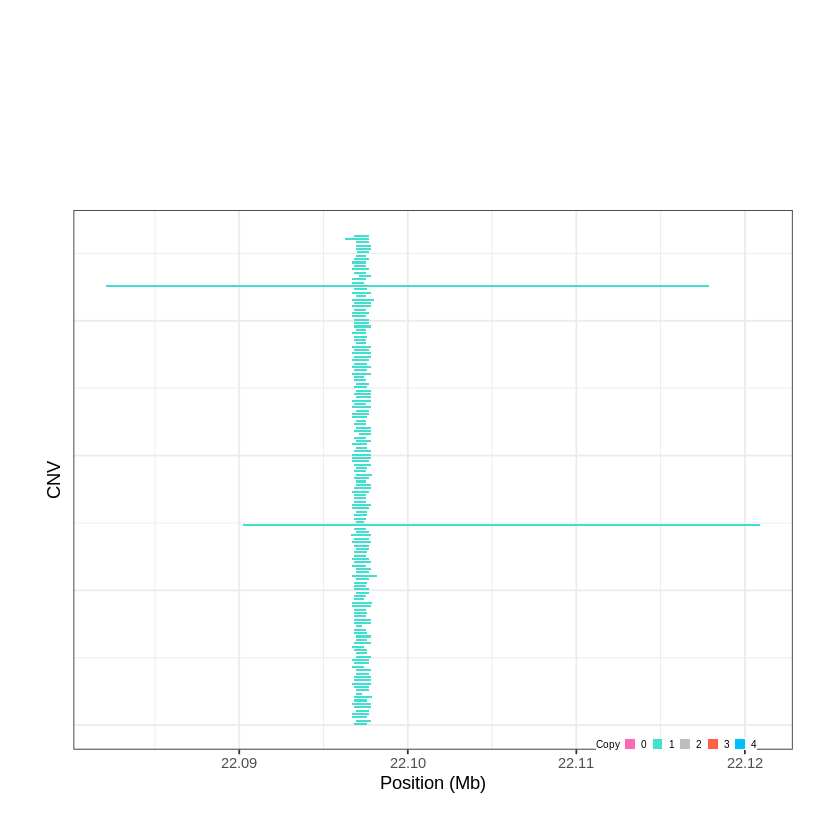

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1877..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 23.312201 - 23.3501 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


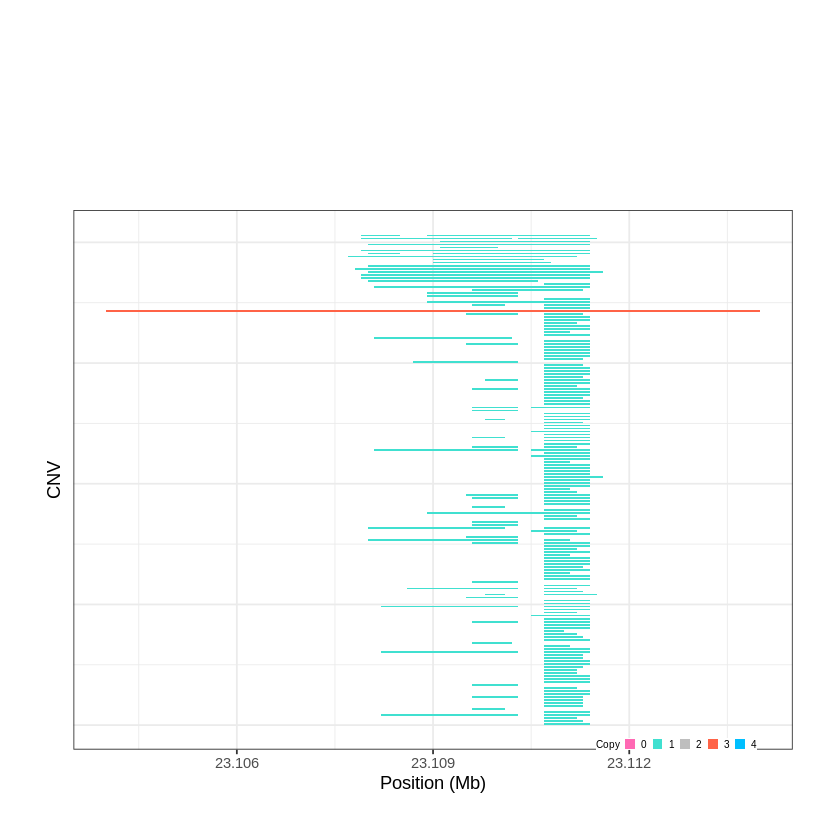

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1878..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 23.985201 - 23.9962 Mb with 259 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


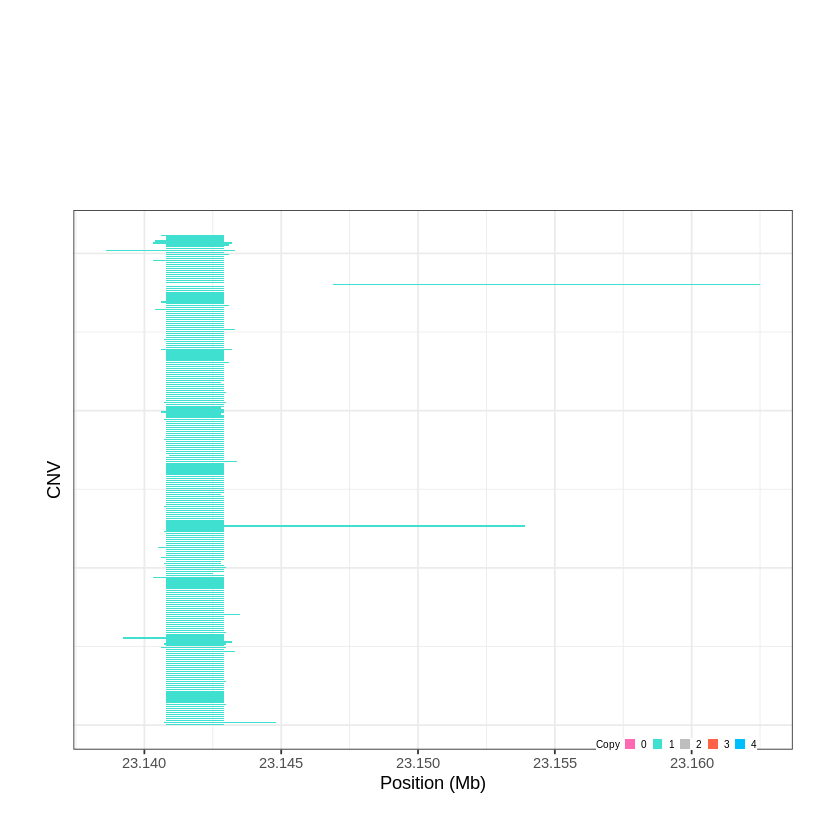

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1879..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 24.055301 - 24.0561 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


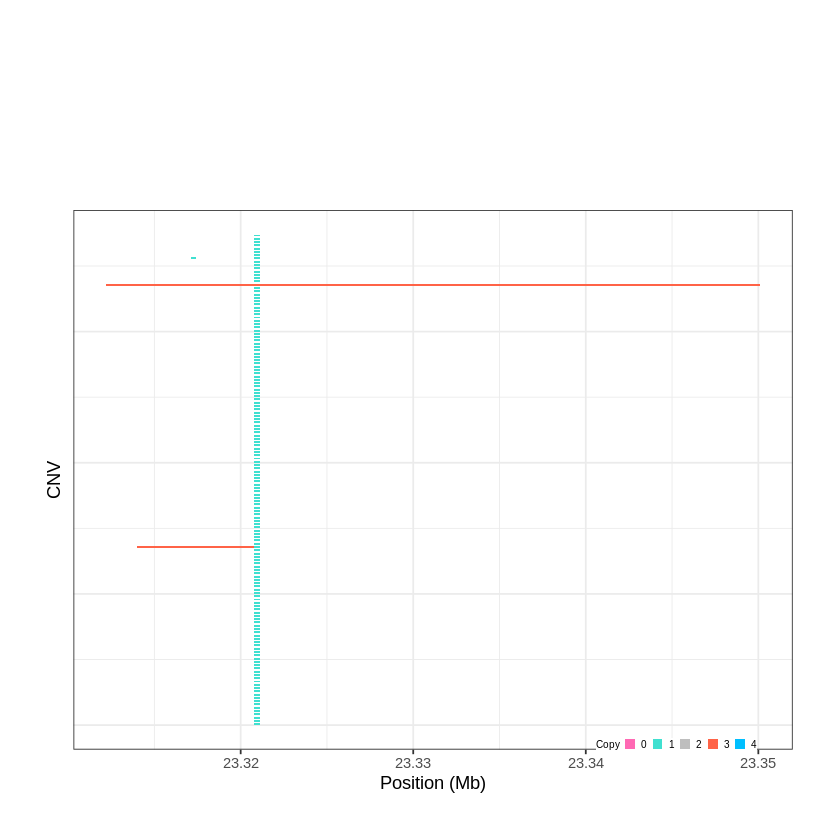

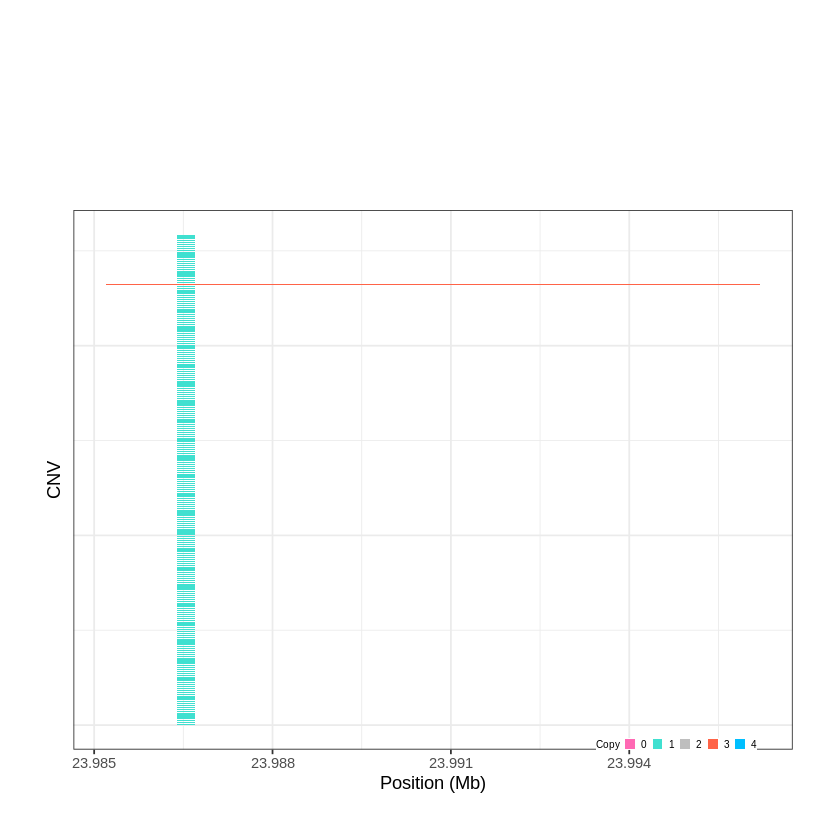

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1880..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 24.364601 - 28.1866 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1881..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 28.309001 - 28.3216 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


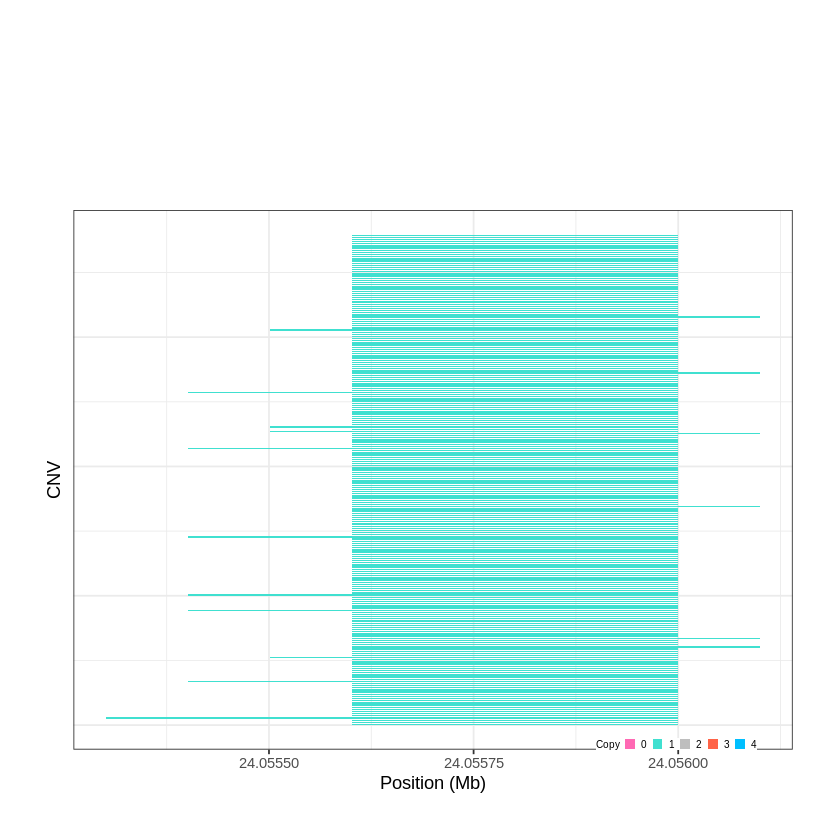

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1882..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 29.858001 - 29.9647 Mb with 182 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


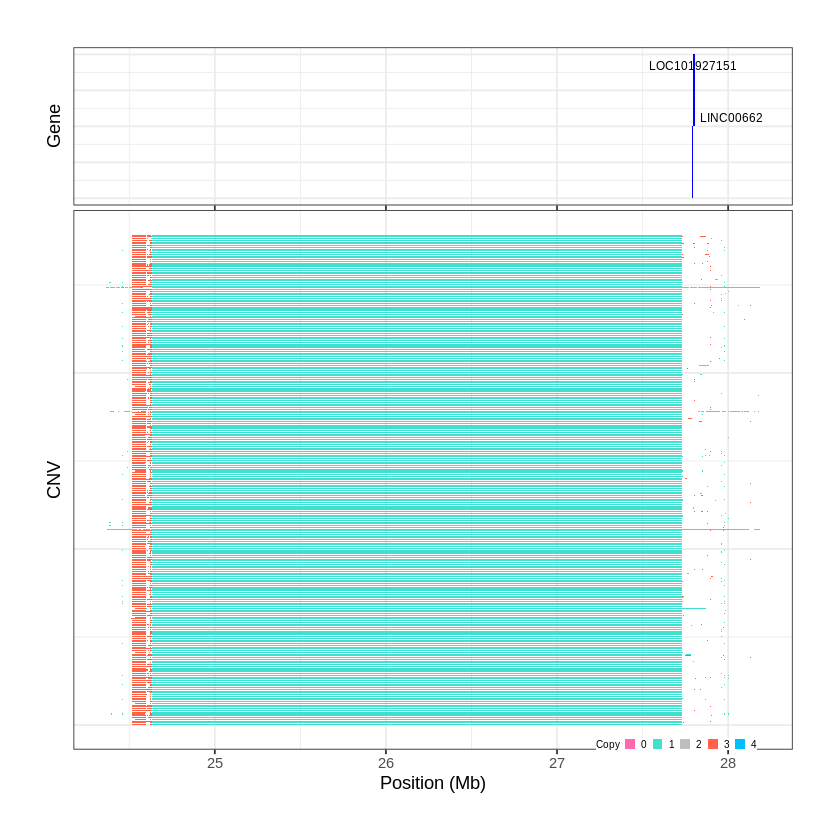

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1883..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 29.967801 - 30.0693 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


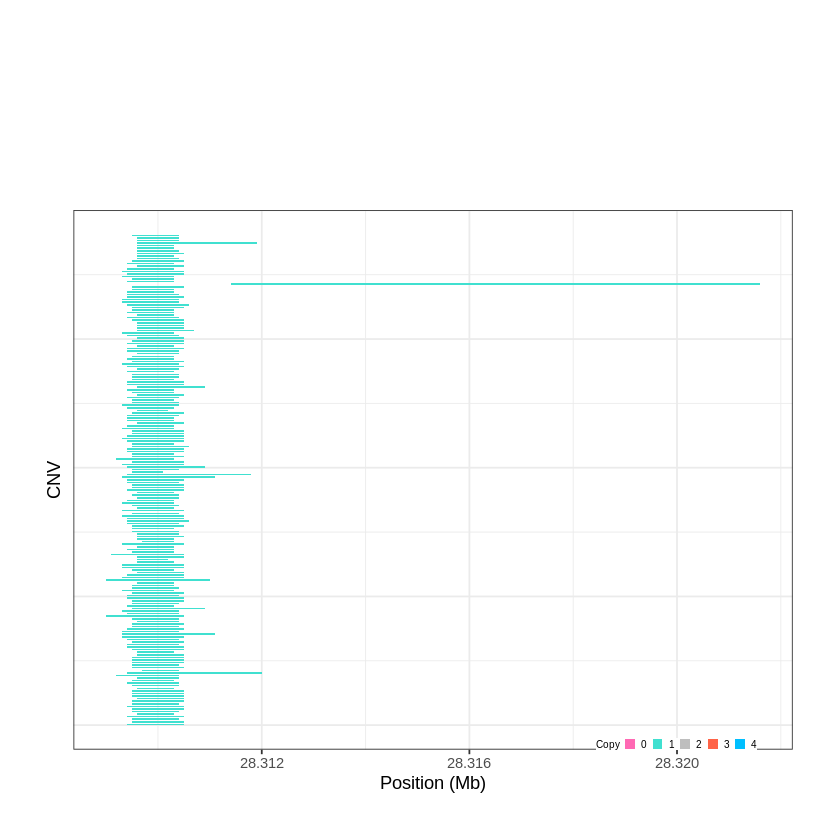

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1884..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 30.698801 - 30.9586 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


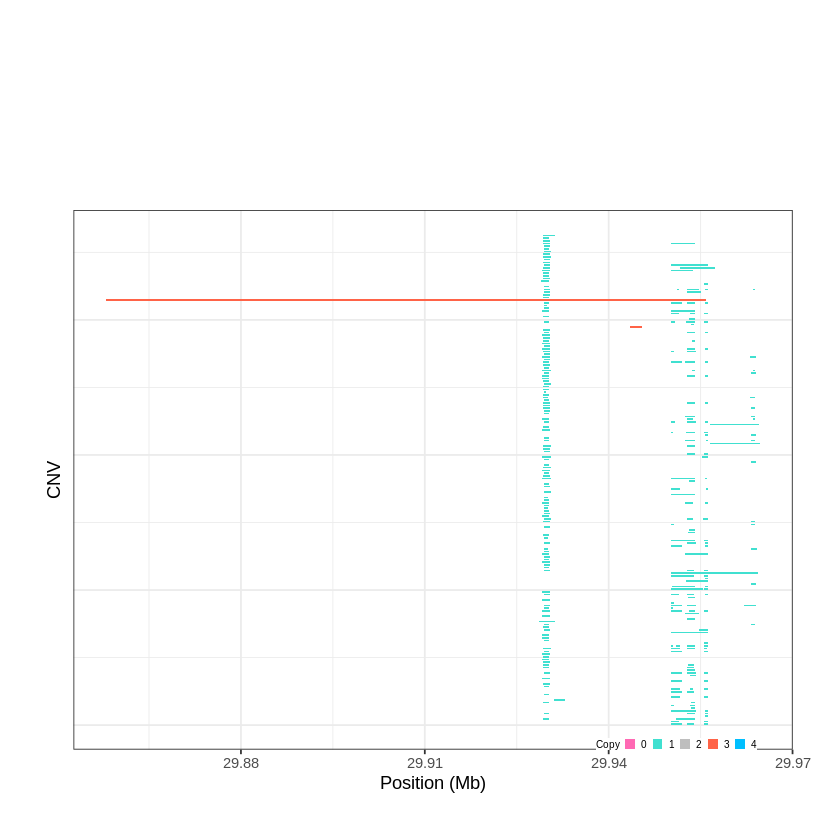

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1885..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 31.269601 - 31.2925 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


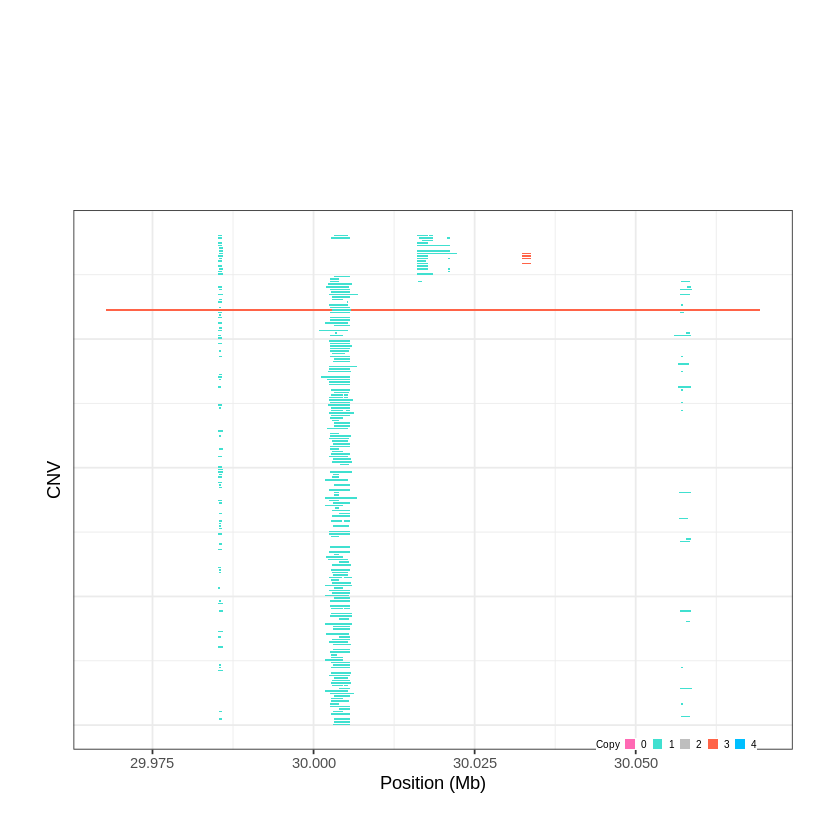

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1886..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 33.210401 - 33.2298 Mb with 263 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


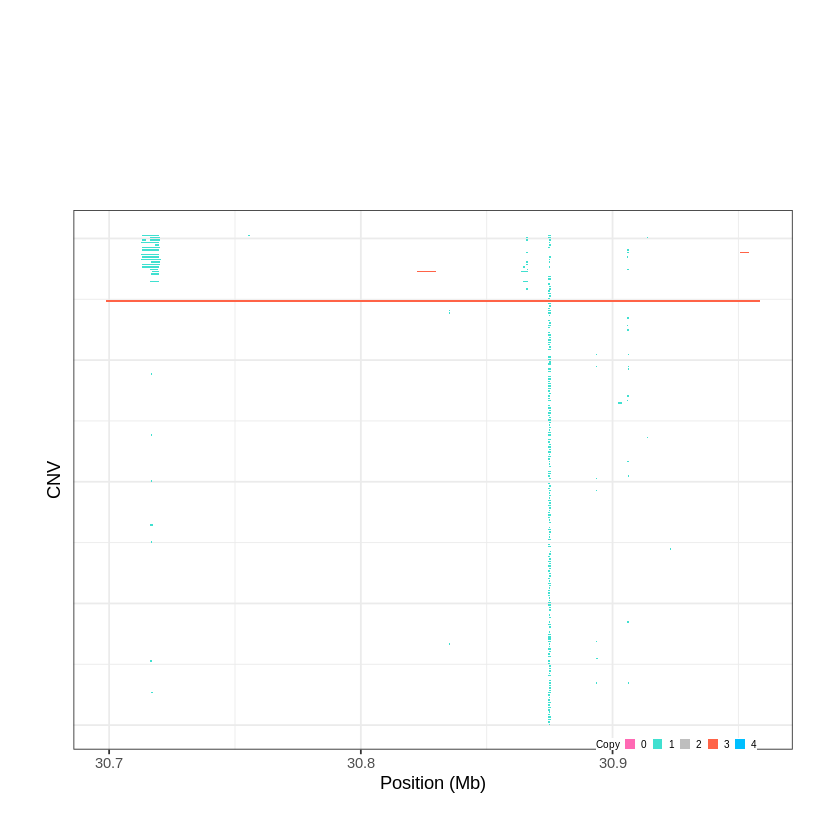

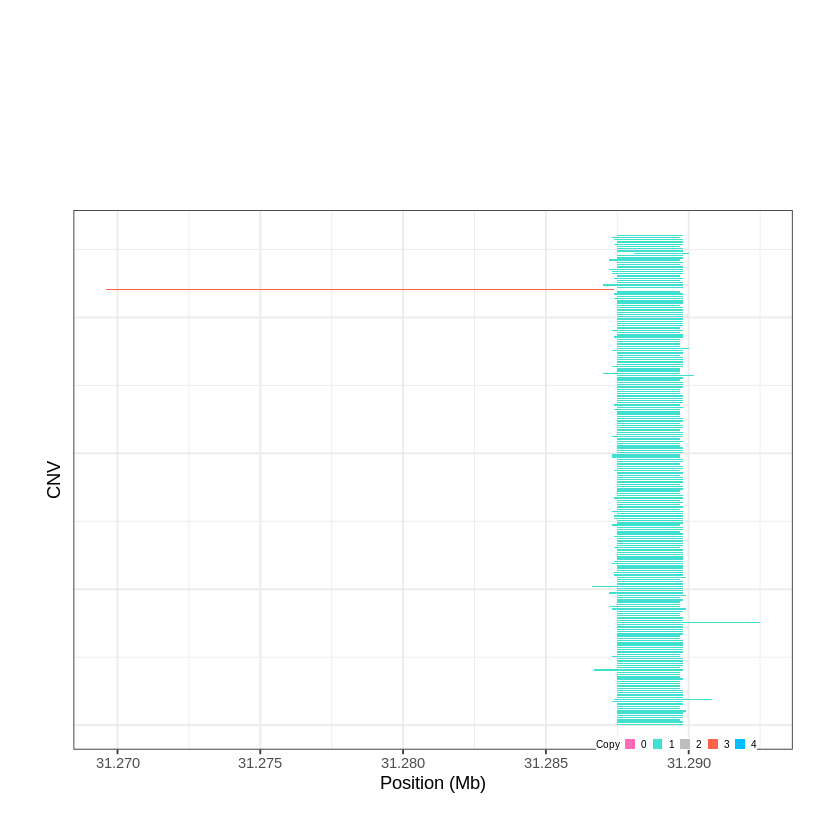

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1887..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 34.098601 - 34.2737 Mb with 262 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1888..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 35.757801 - 35.7611 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


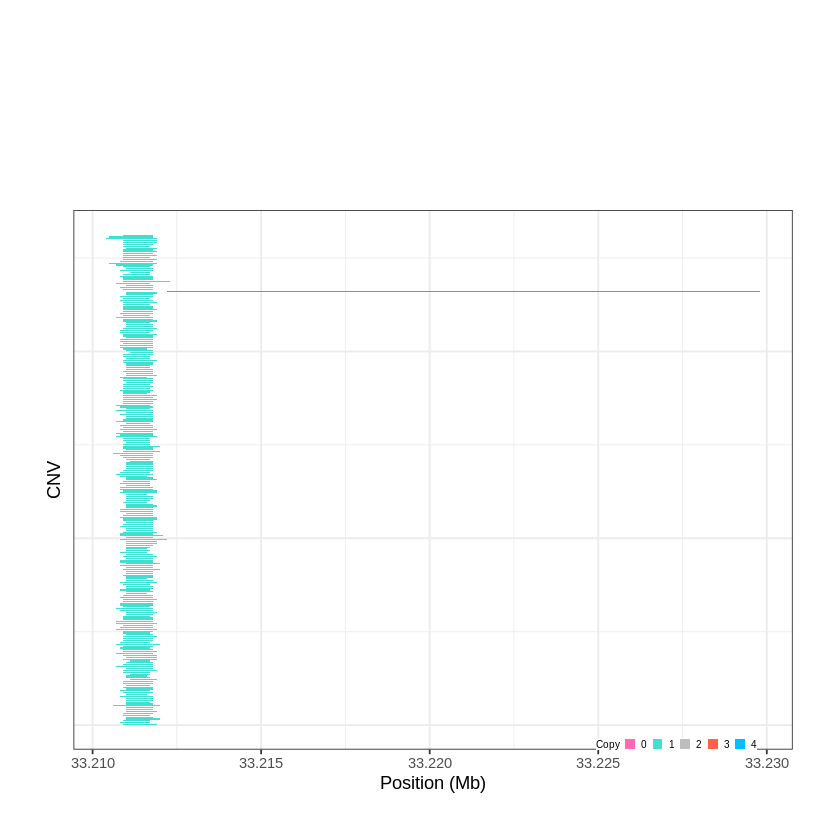

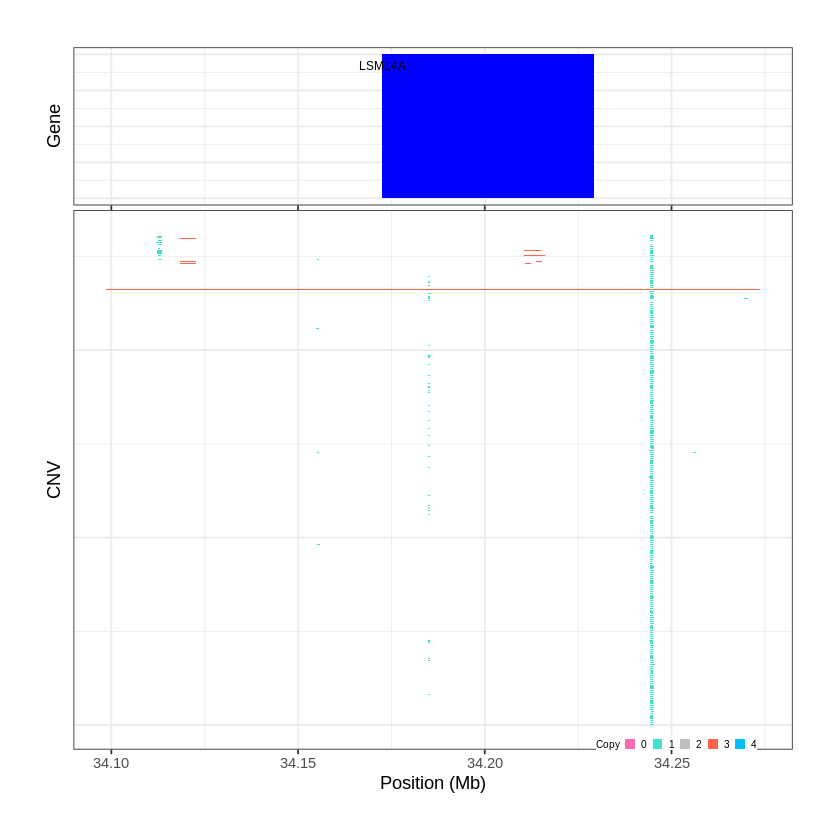

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1889..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 36.702701 - 37.1825 Mb with 277 Individual - "
Plotting gene...


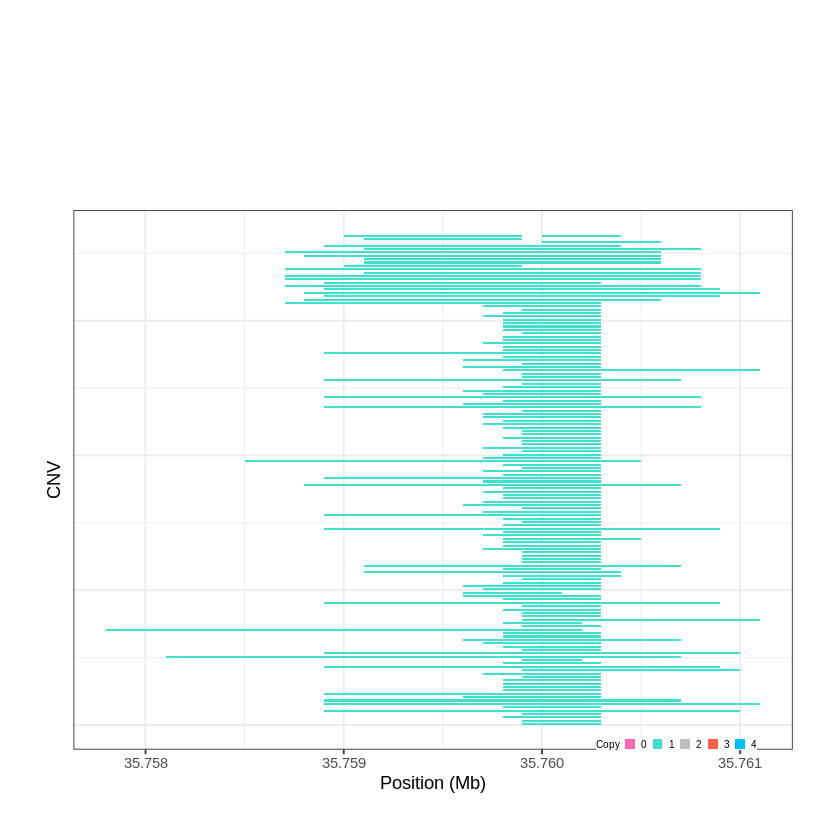

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1890..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 37.256301 - 37.3533 Mb with 157 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1891..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 37.751901 - 37.8114 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


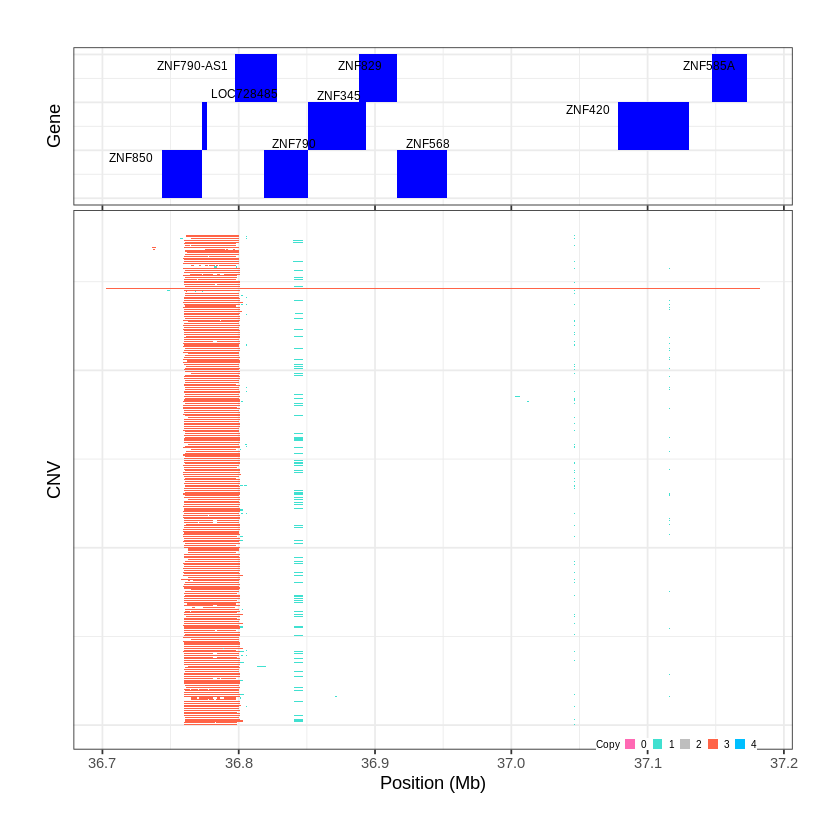

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1892..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 39.225501 - 39.23 Mb with 194 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


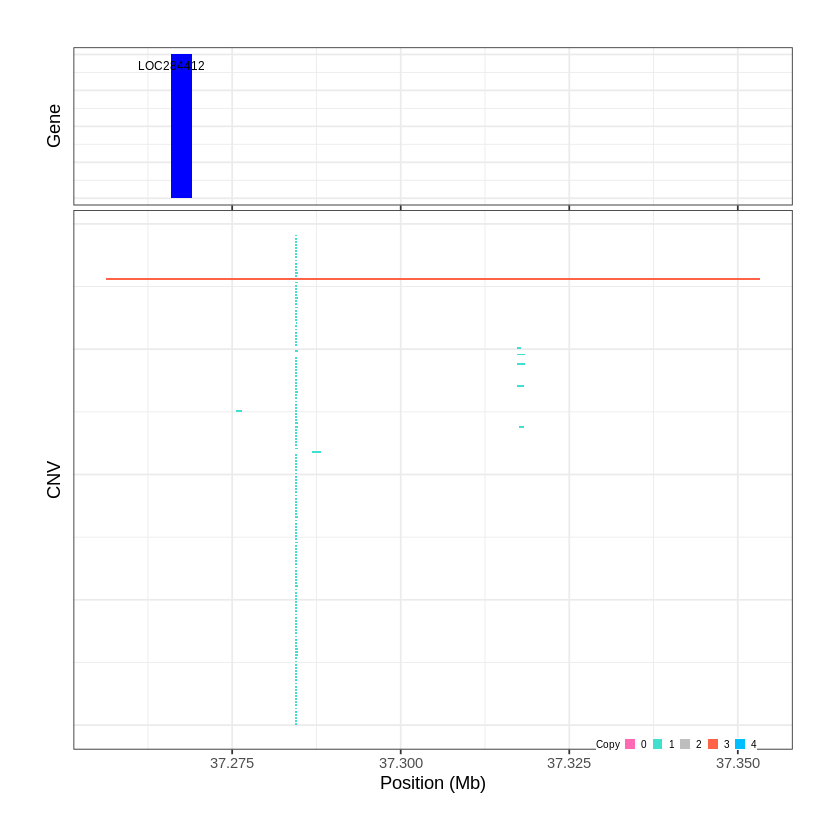

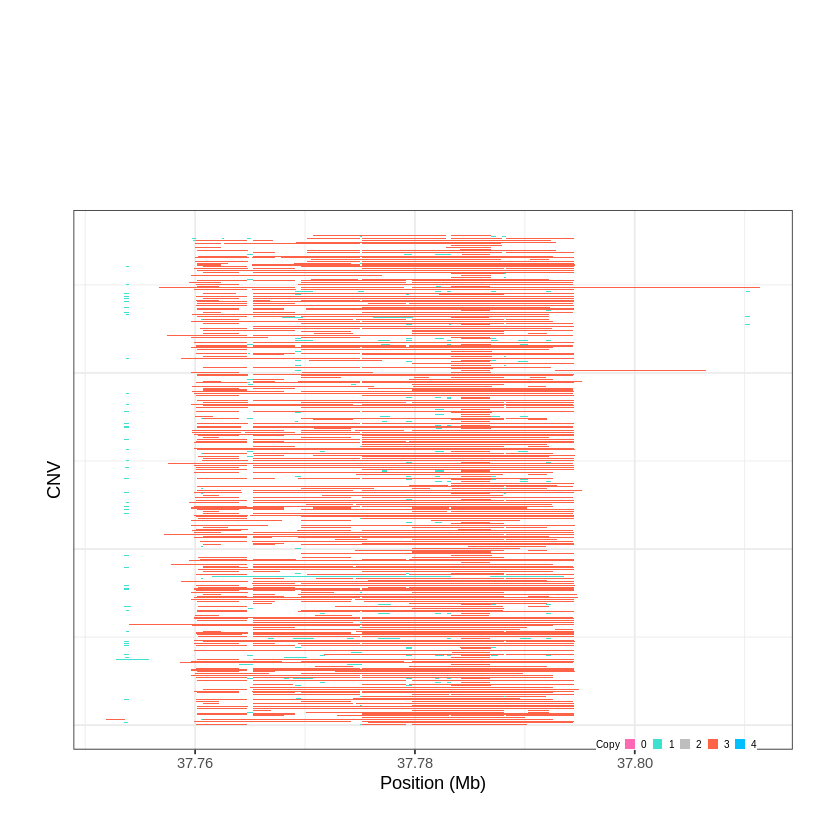

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1893..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 40.276801 - 40.4026 Mb with 274 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1894..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 42.397101 - 42.4025 Mb with 213 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


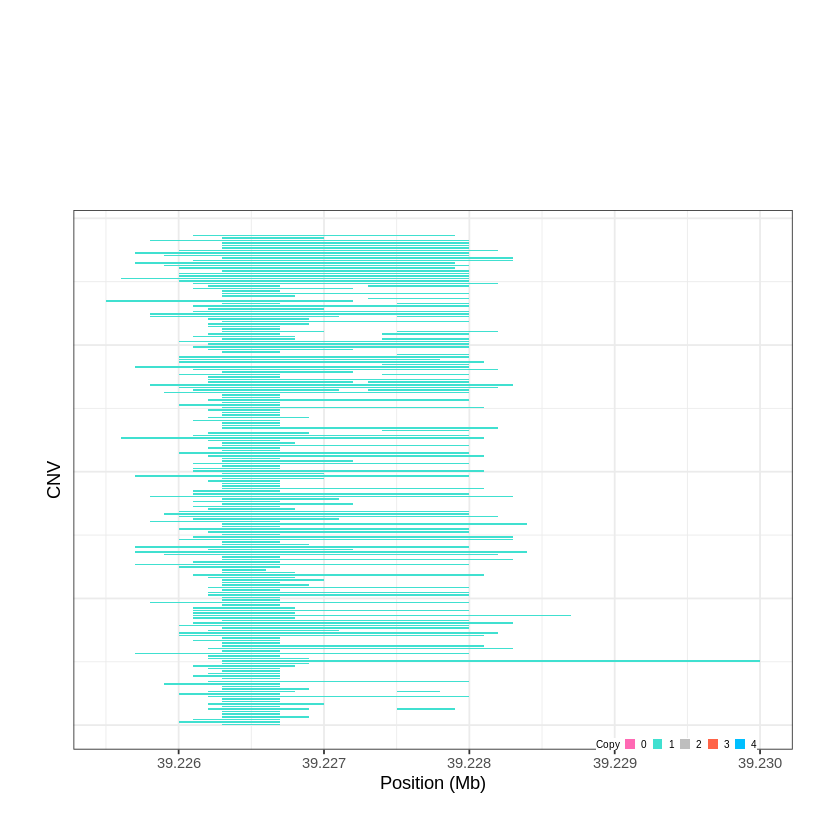

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1895..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 42.426401 - 42.4306 Mb with 173 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


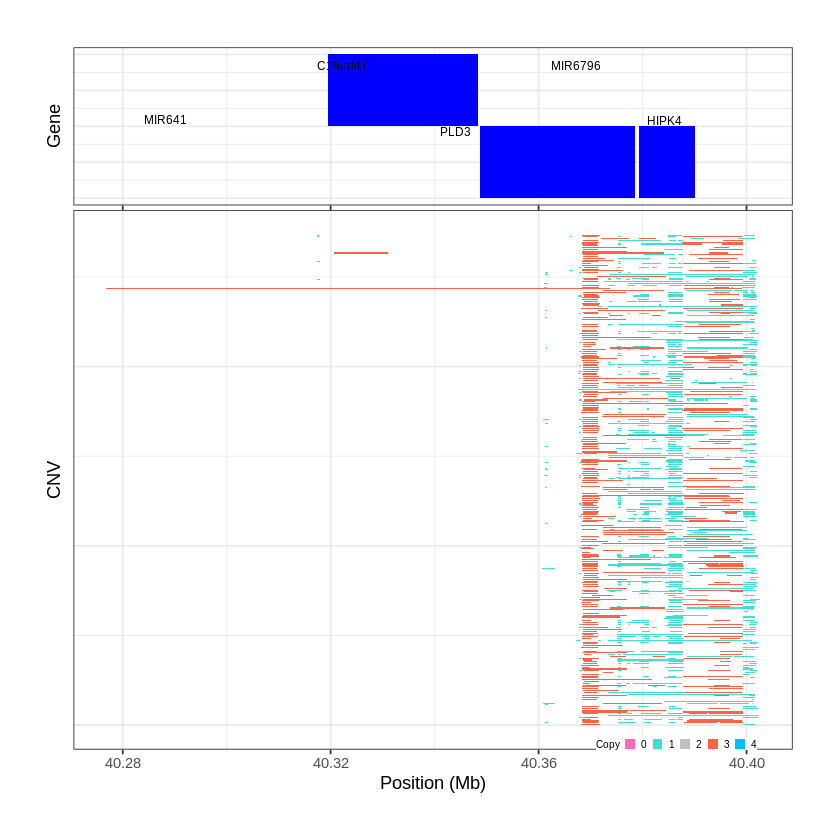

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1896..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 42.786801 - 42.7895 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


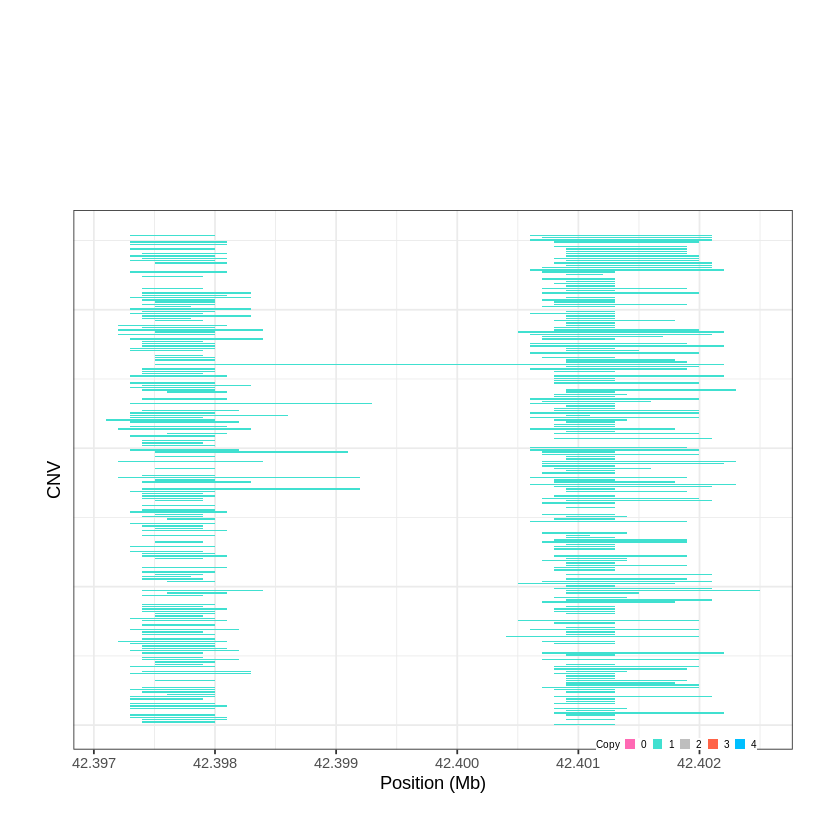

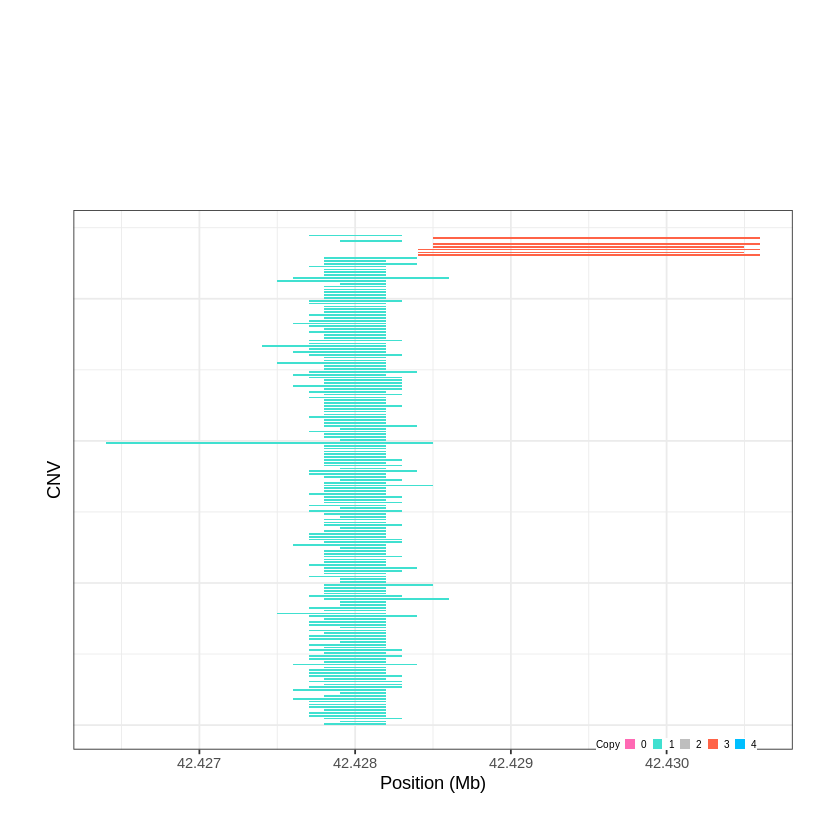

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1897..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 43.247601 - 43.8511 Mb with 247 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1898..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 46.278401 - 46.2797 Mb with 184 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


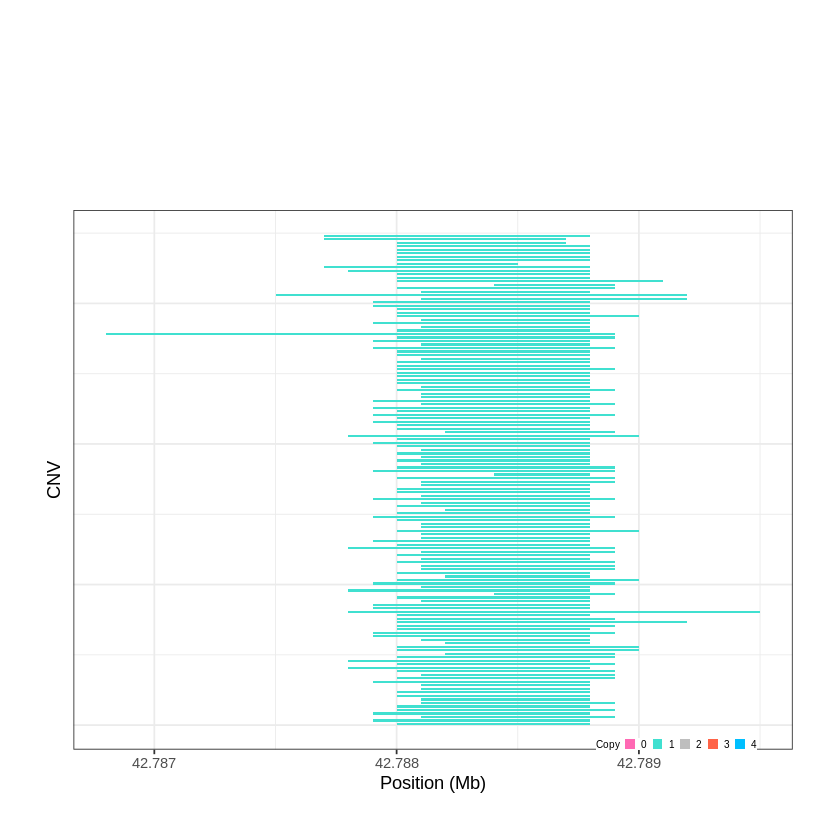

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1899..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 46.475101 - 46.4777 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


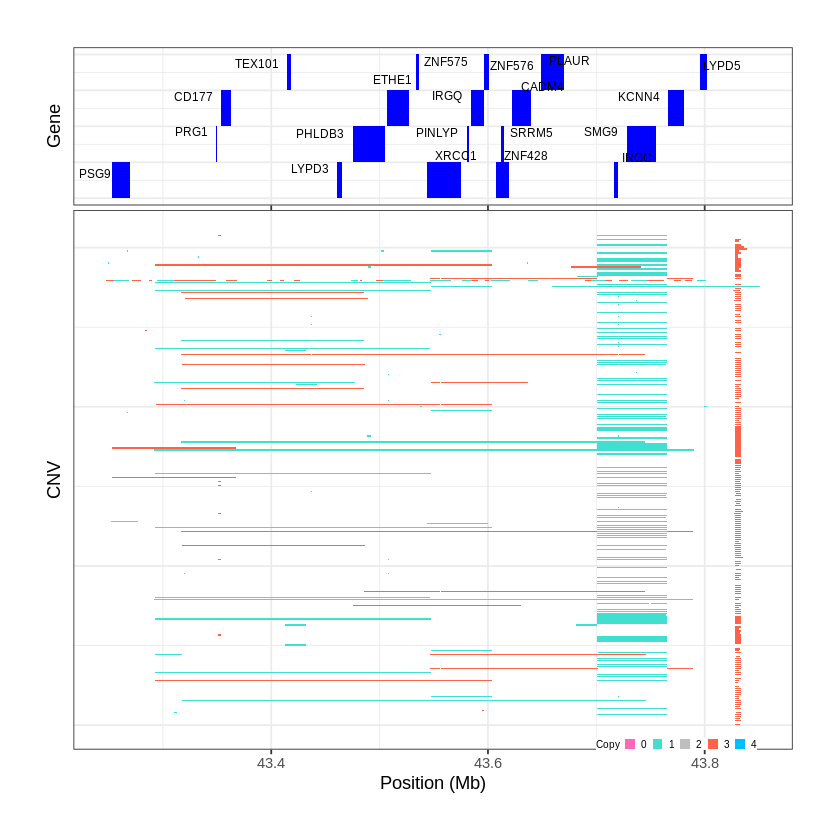

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1900..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 46.939601 - 46.9457 Mb with 276 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


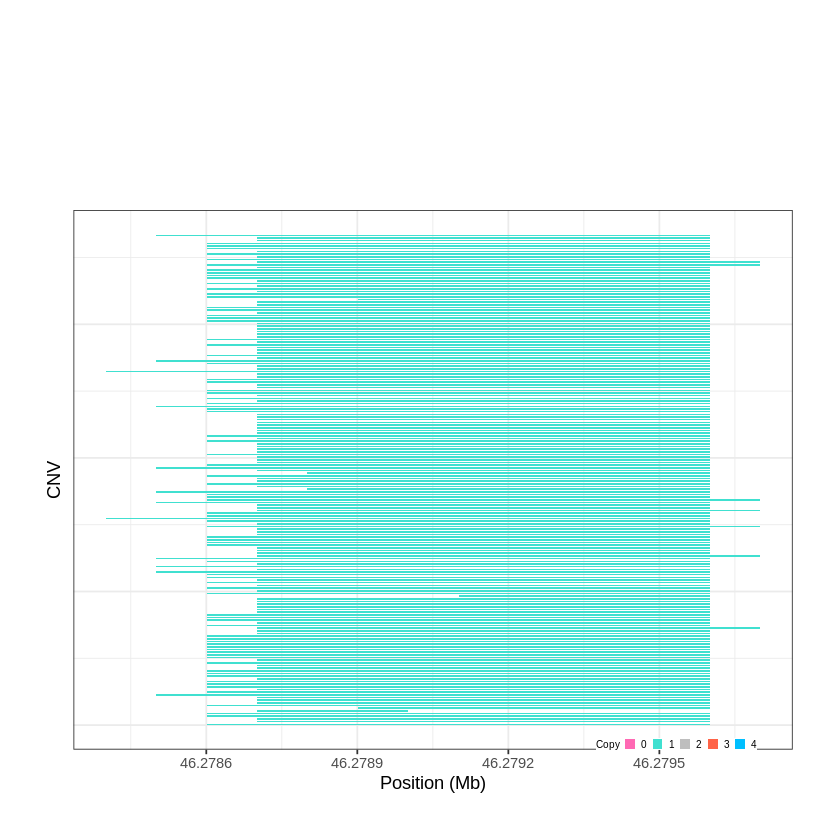

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1901..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 47.136801 - 47.1422 Mb with 140 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


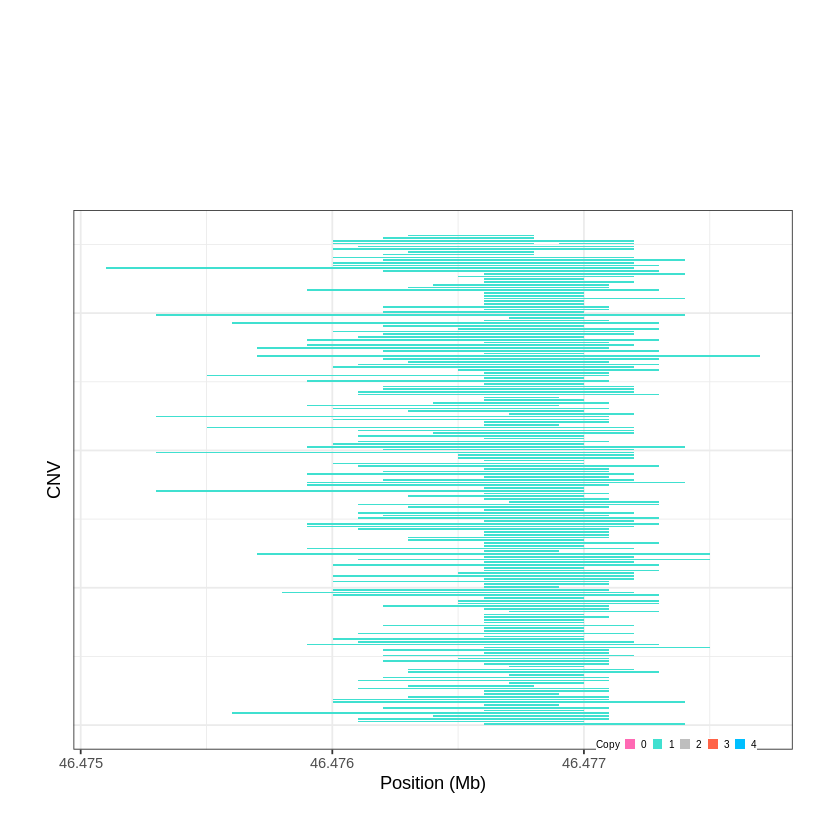

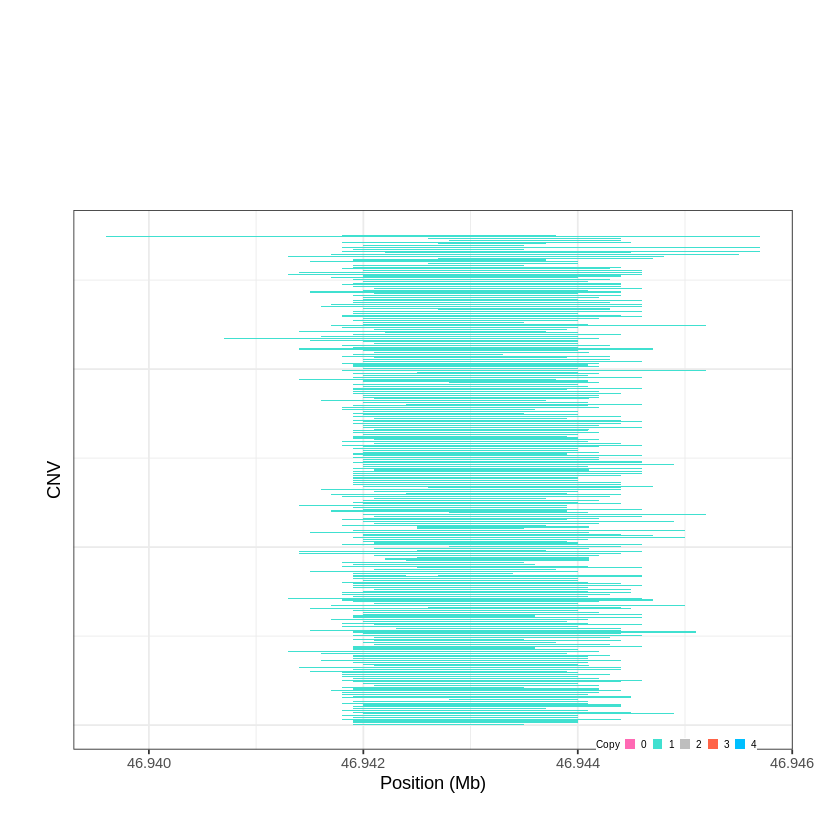

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1902..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 48.406401 - 48.463 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1903..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 49.889001 - 49.8906 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


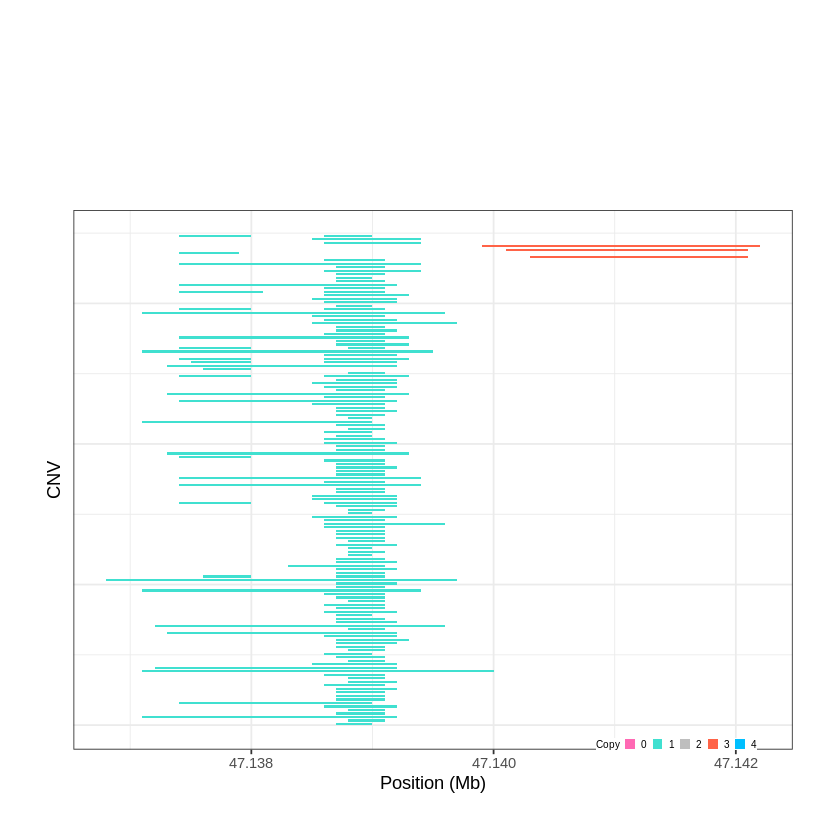

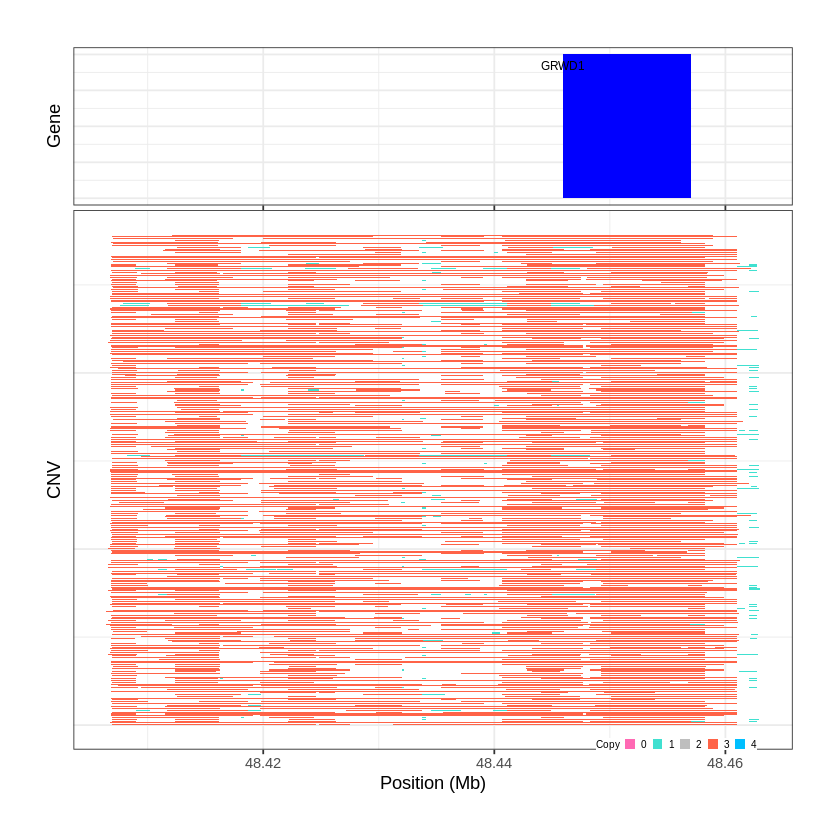

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1904..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 50.307001 - 50.6436 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1905..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 50.763901 - 50.7651 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


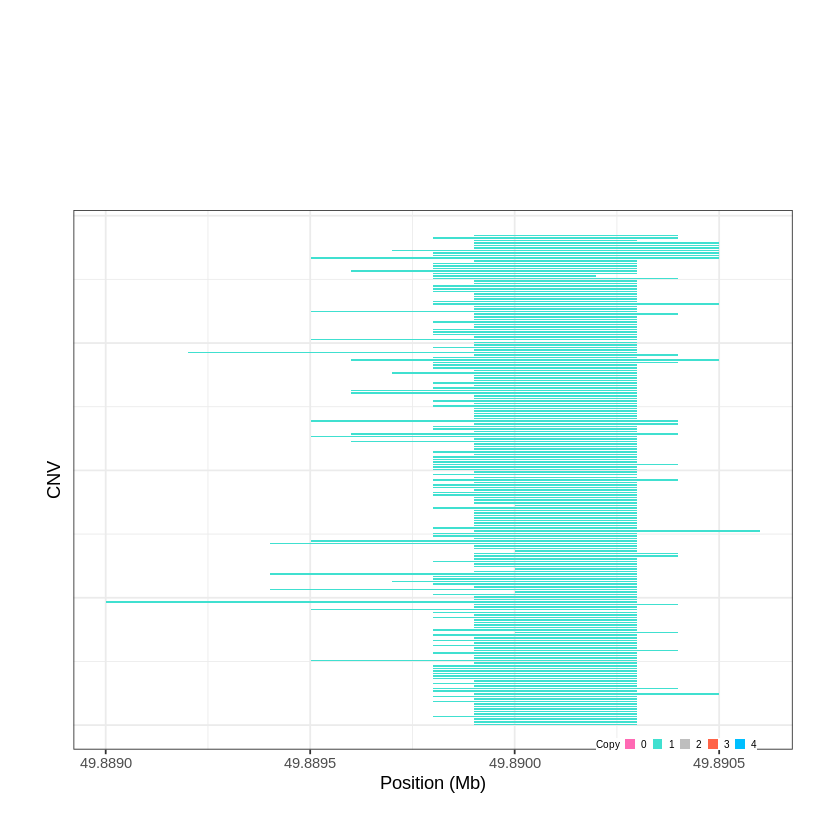

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1906..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 51.068601 - 51.0732 Mb with 193 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


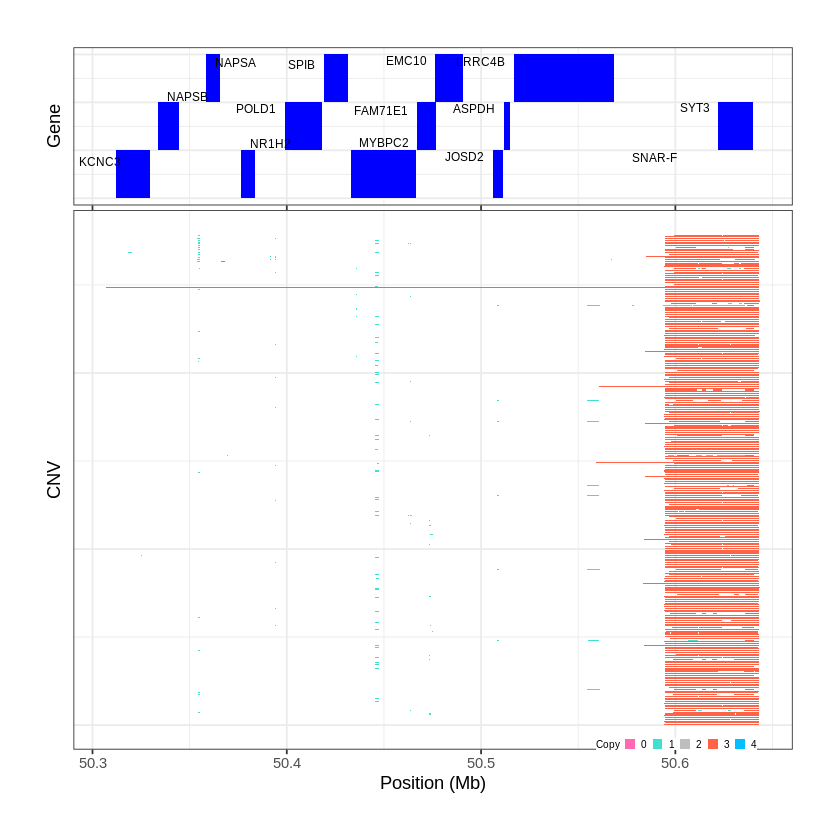

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1907..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 51.220001 - 51.2253 Mb with 218 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


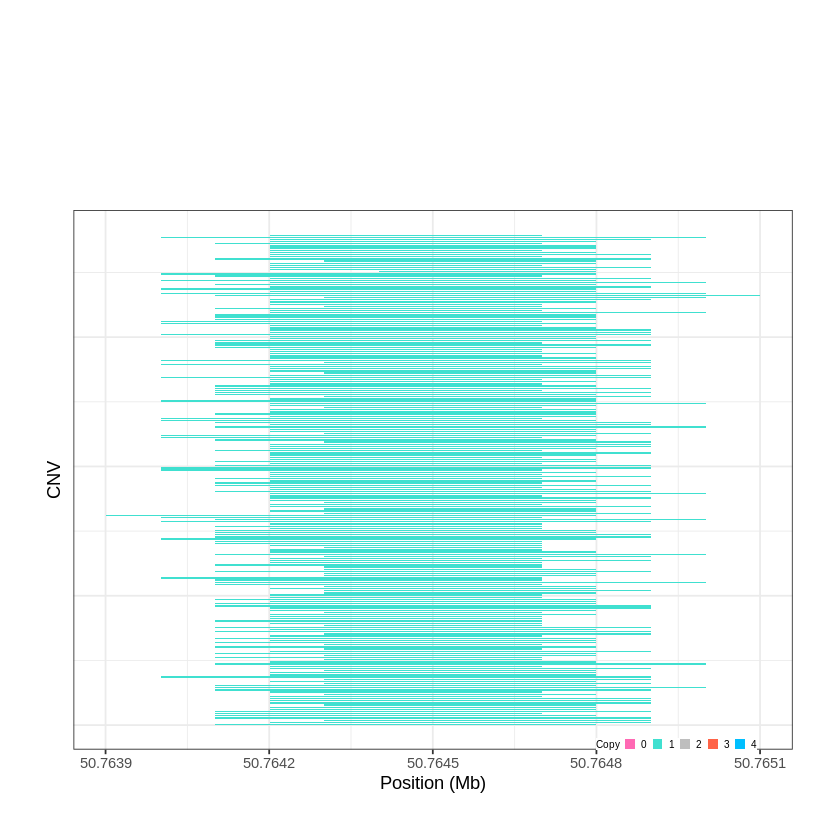

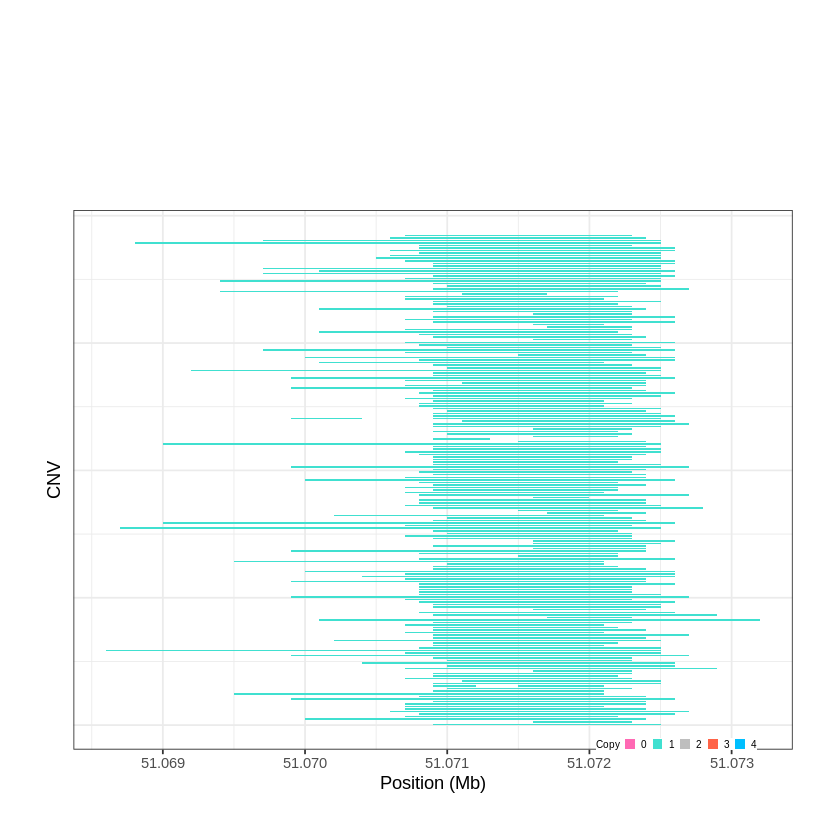

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1908..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 51.405001 - 51.7339 Mb with 264 Individual - "
Plotting gene...


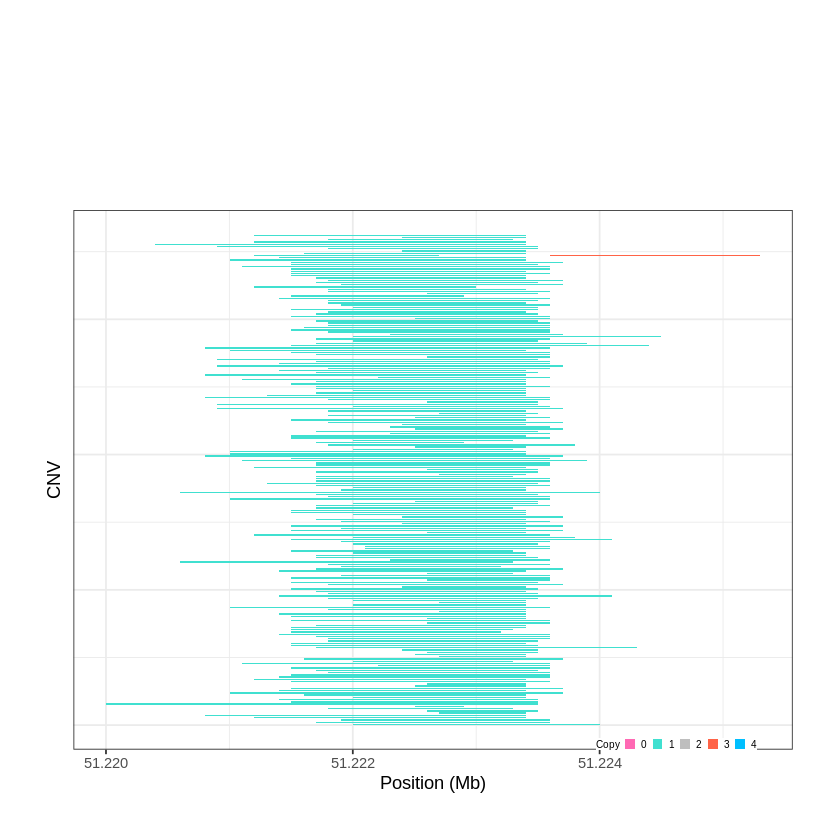

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1909..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 51.813001 - 52.0591 Mb with 165 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1910..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 52.175901 - 52.1776 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


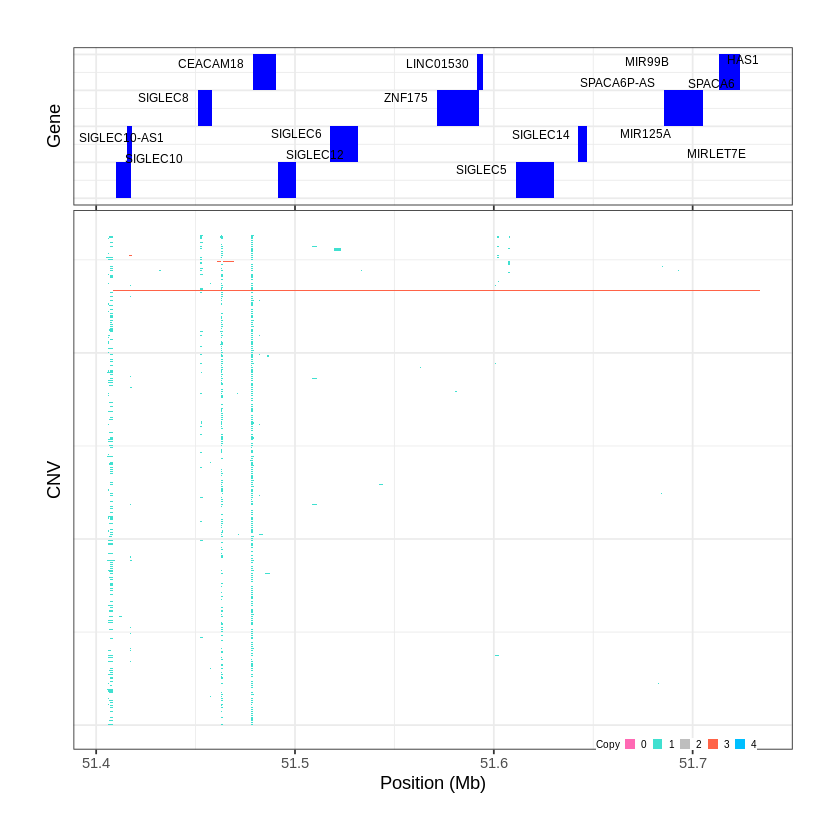

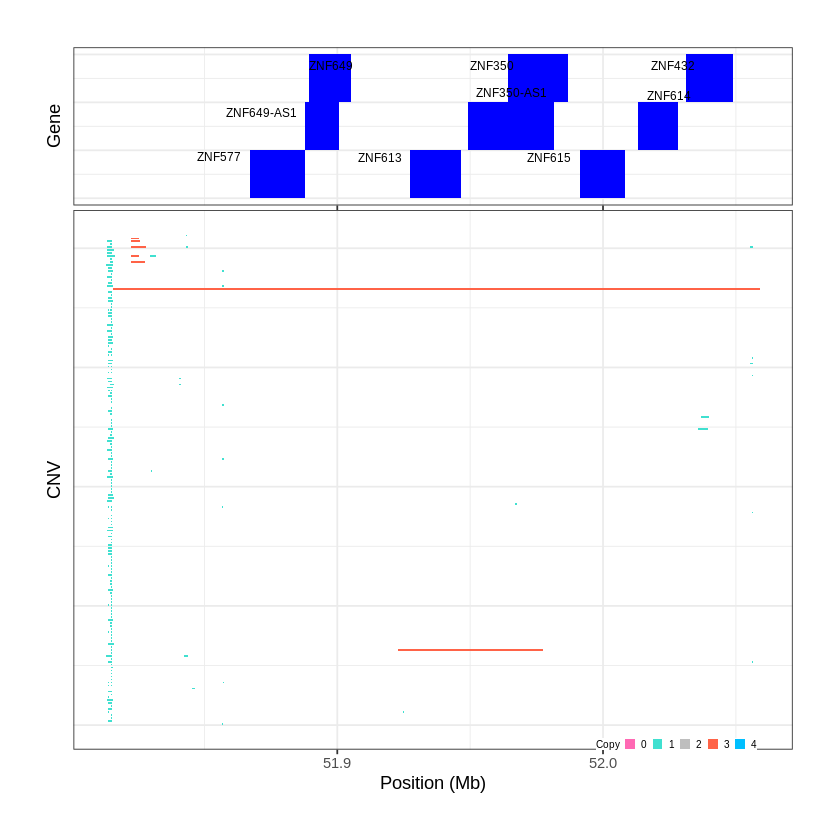

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1911..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 53.020001 - 53.123 Mb with 176 Individual - "
Plotting gene...


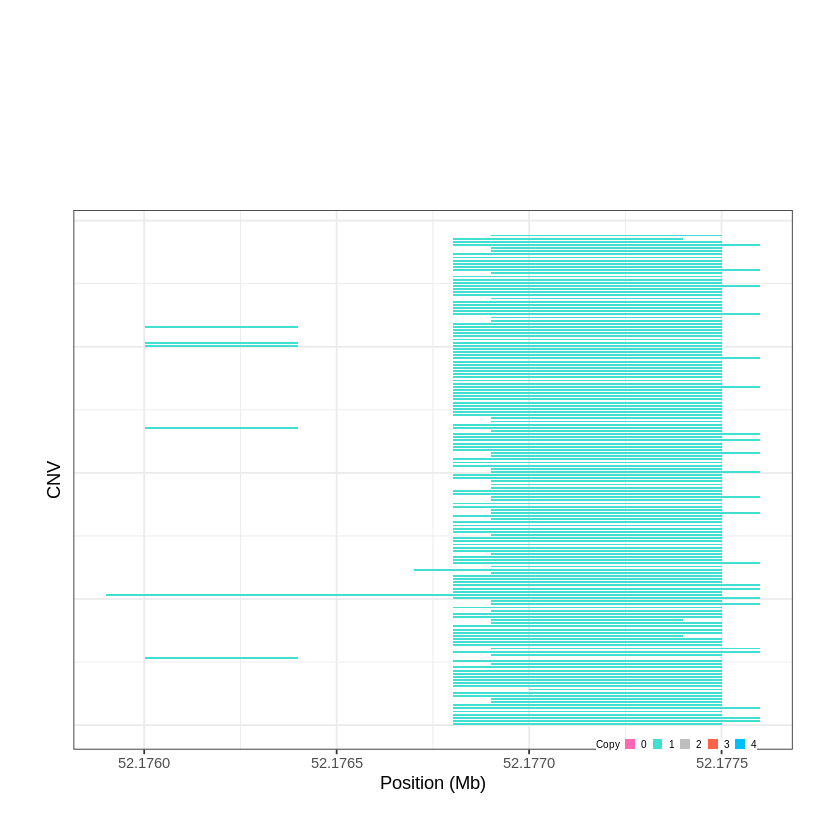

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1912..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 53.312601 - 53.3611 Mb with 144 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1913..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 53.421301 - 53.4242 Mb with 209 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


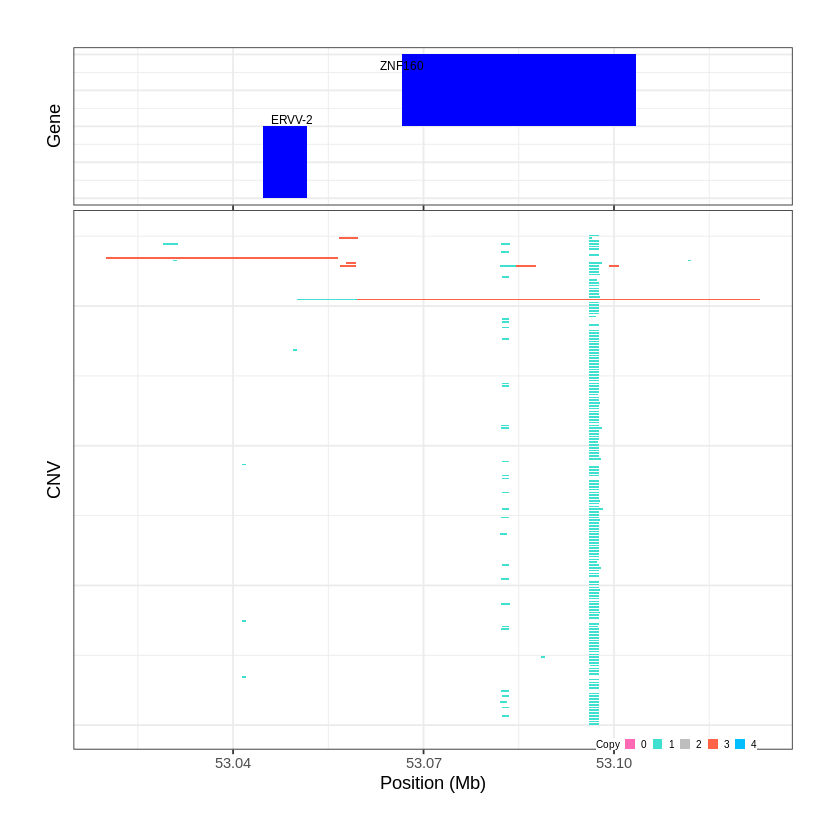

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1914..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 54.408301 - 54.413 Mb with 168 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


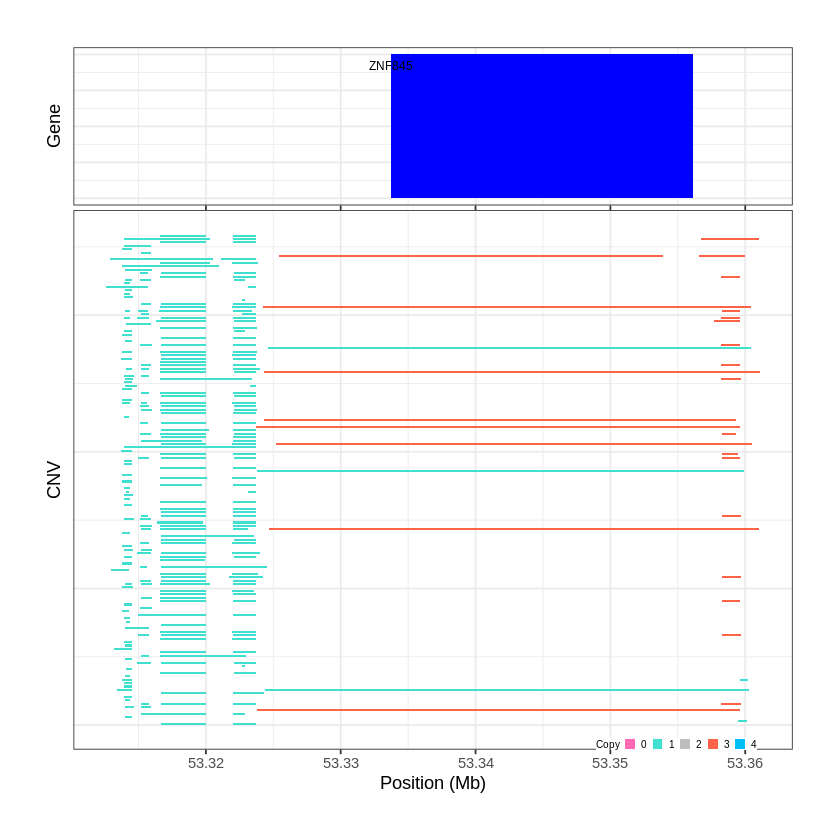

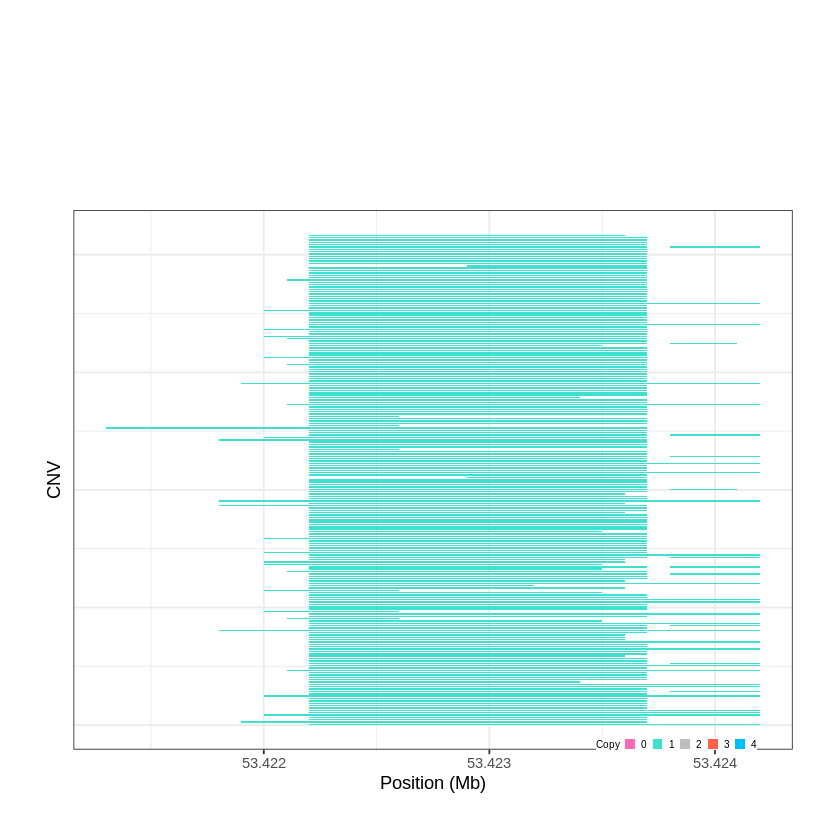

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1915..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 54.460501 - 54.4683 Mb with 185 Individual - "
Plotting gene...


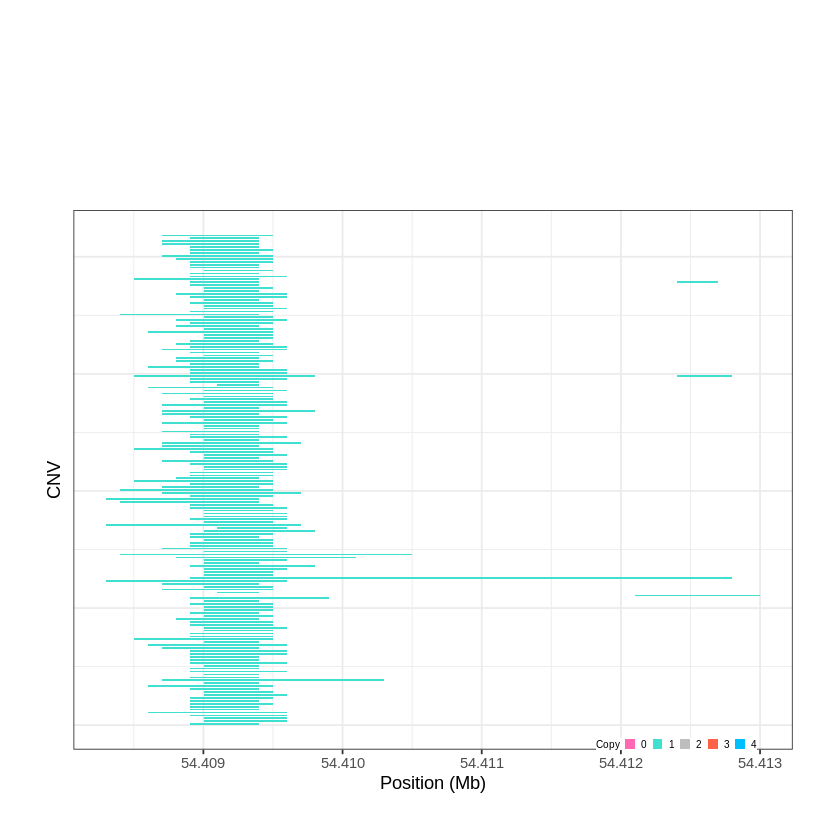

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1916..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 54.723501 - 54.8483 Mb with 274 Individual - "
Plotting gene...


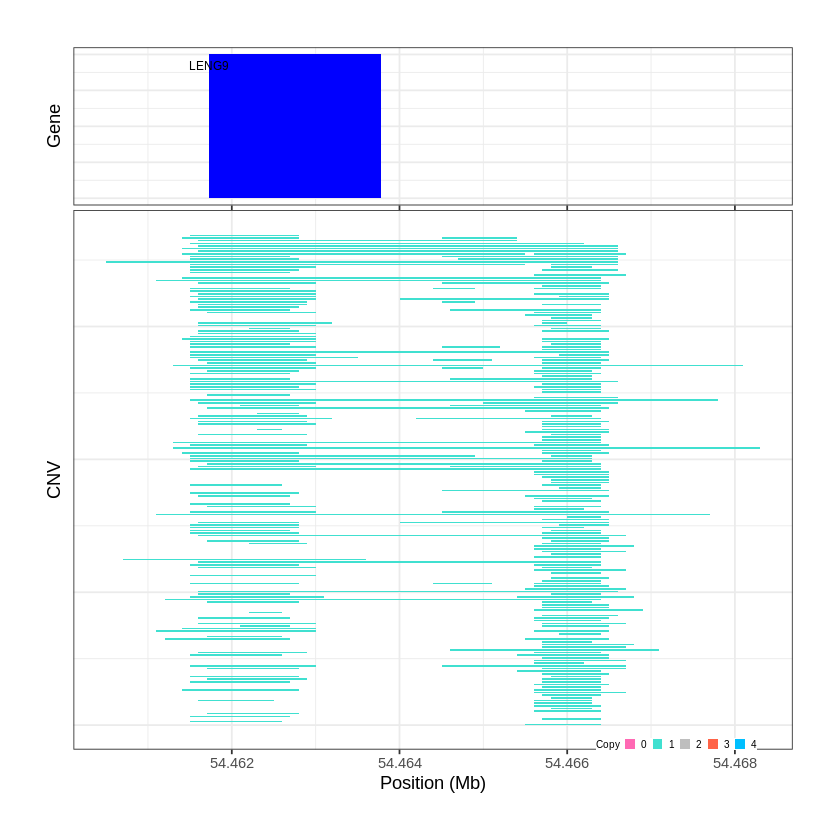

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1917..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 54.861001 - 55.3742 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1918..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 55.588601 - 55.5906 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


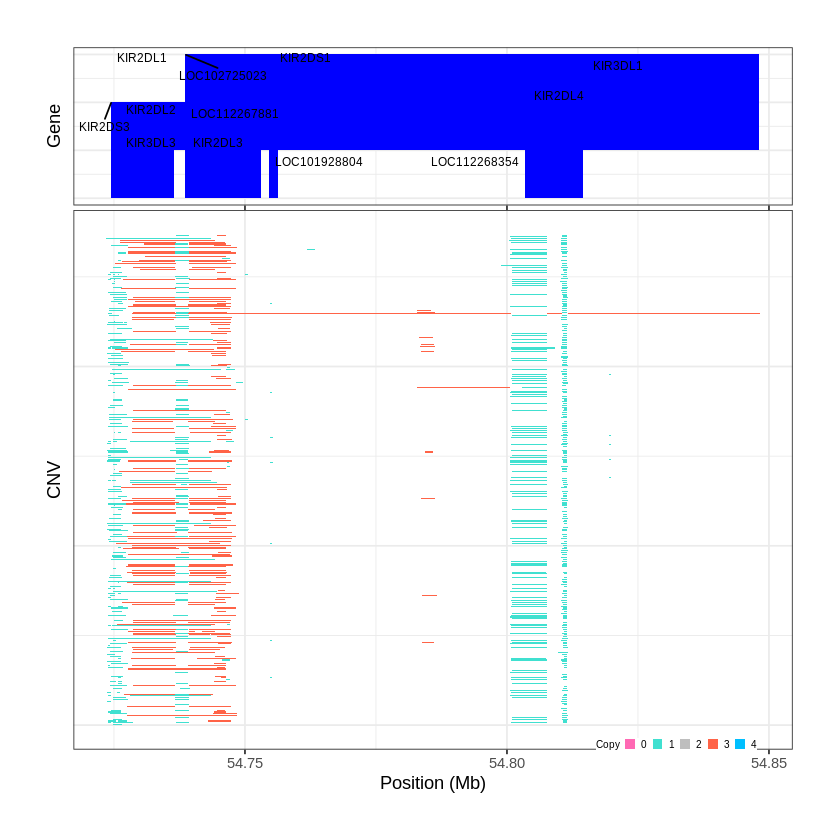

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1919..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 55.604301 - 55.6058 Mb with 265 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


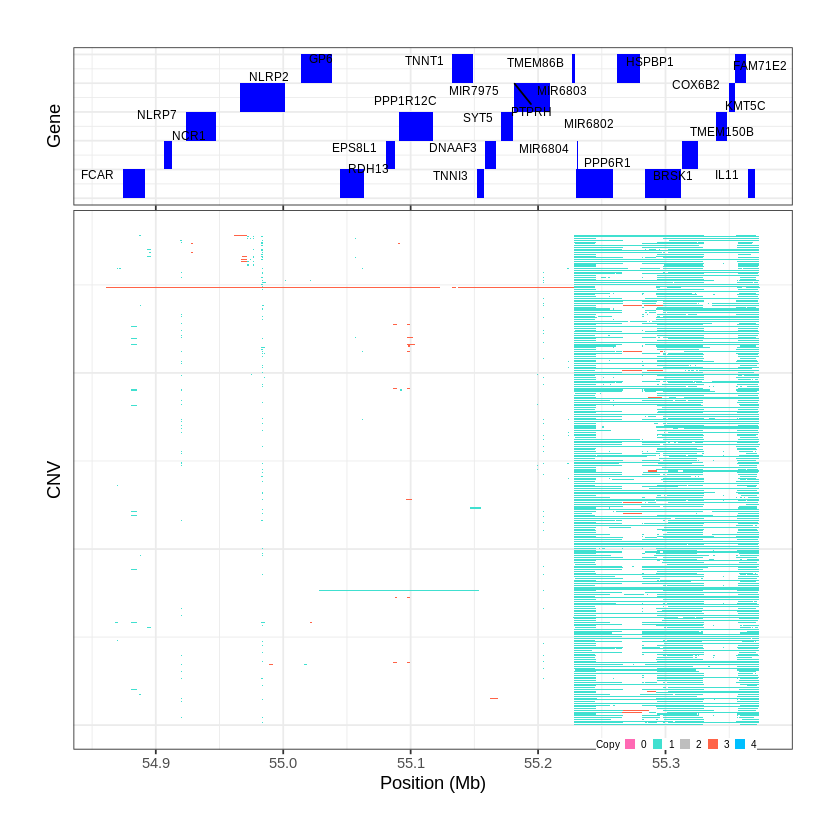

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1920..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 56.041201 - 56.0422 Mb with 162 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


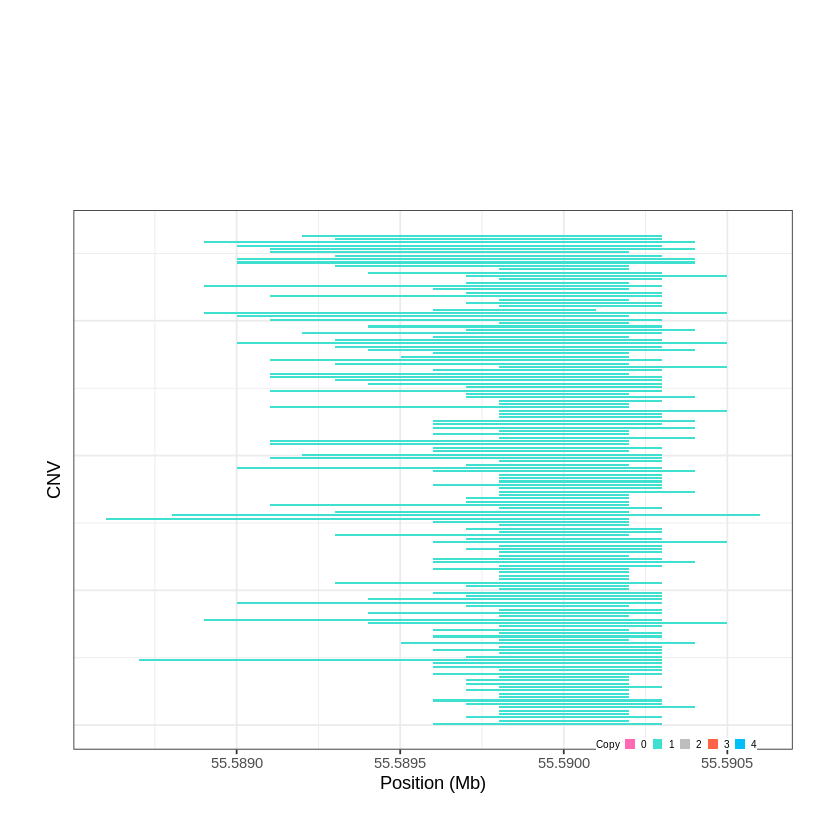

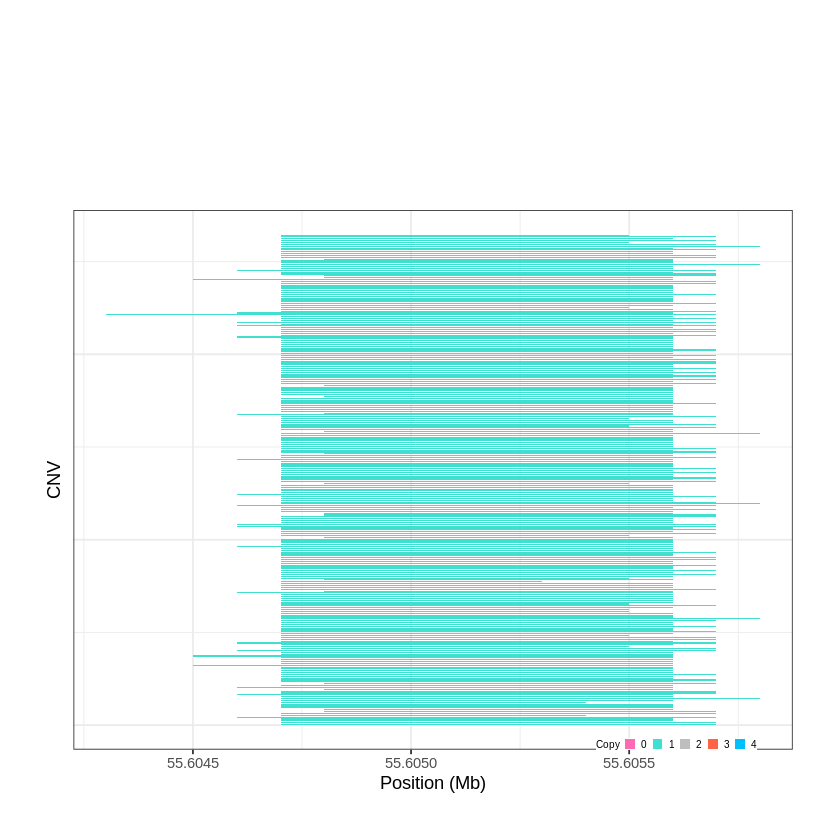

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1921..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 56.092501 - 56.2953 Mb with 266 Individual - "
Plotting gene...


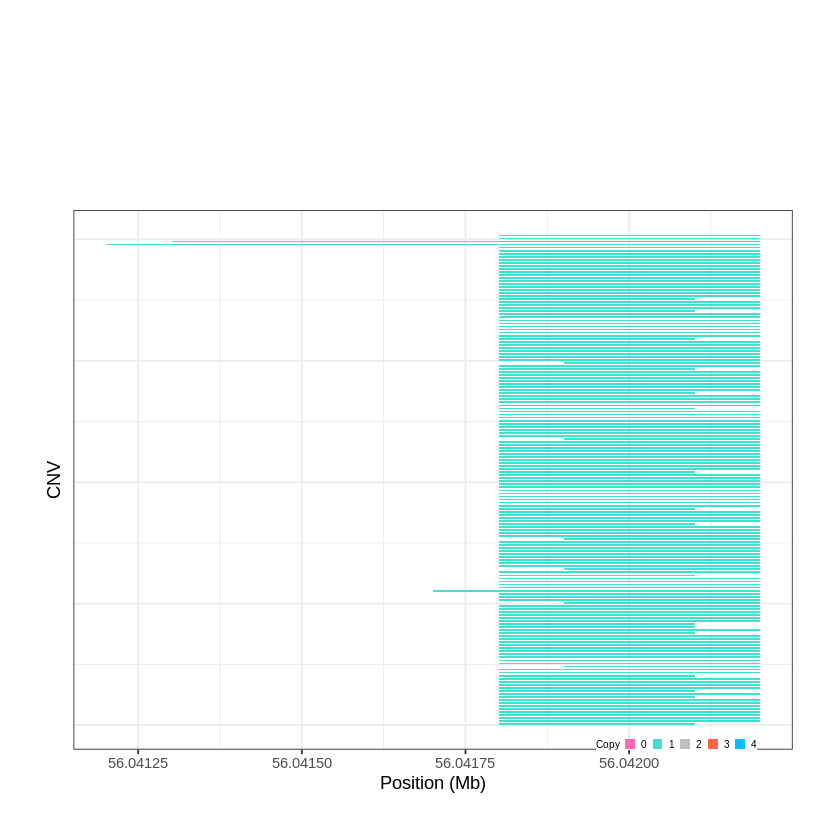

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1922..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 56.494701 - 56.882 Mb with 256 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1923..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 57.472401 - 57.4746 Mb with 178 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


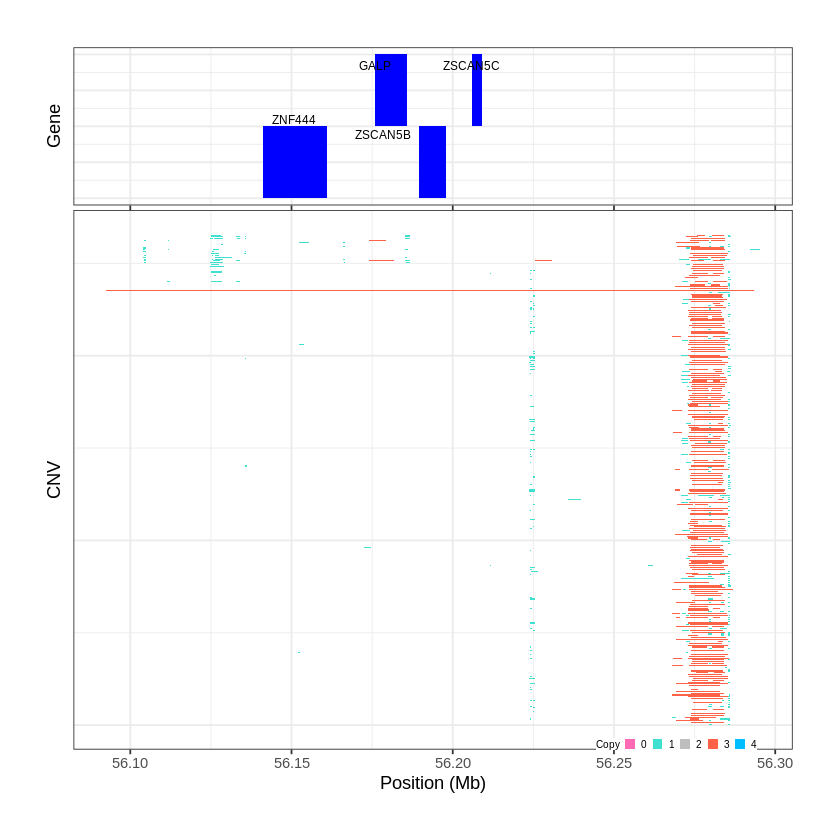

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1924..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 57.474901 - 57.4756 Mb with 195 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


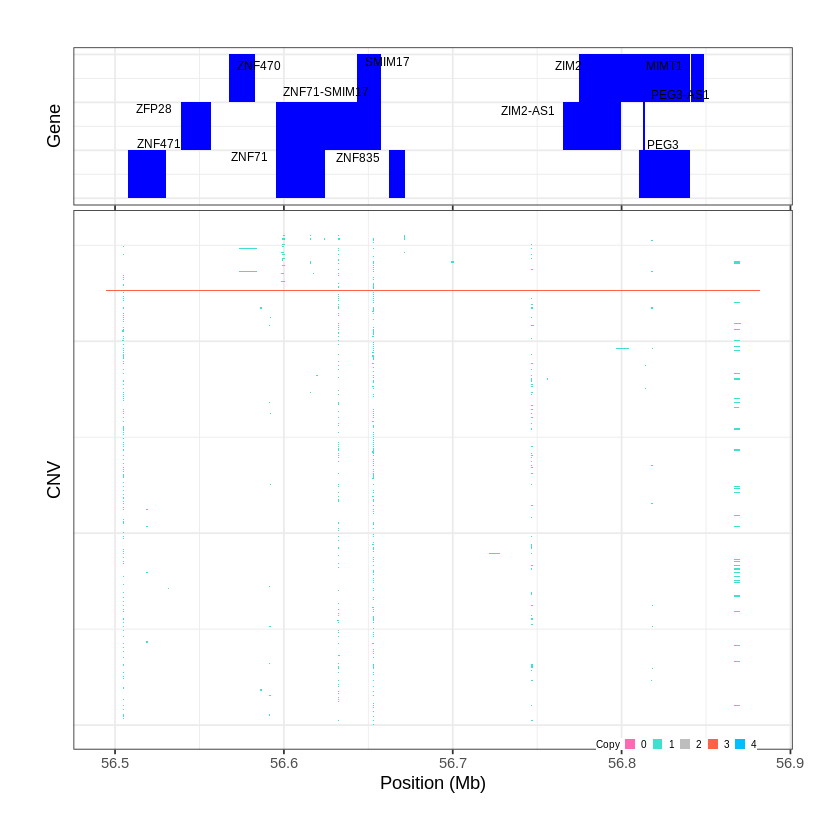

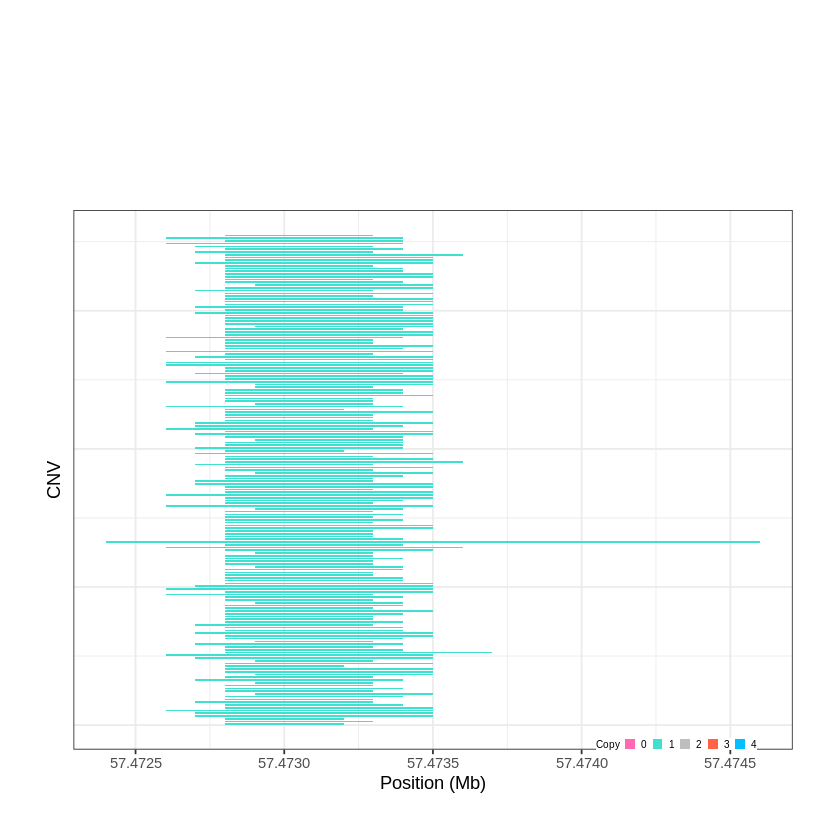

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1925..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 57.675901 - 57.695 Mb with 165 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1926..."
Input data passed requirment check...
[1] "CNV on Chromosome 19: 58.591501 - 59.129 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


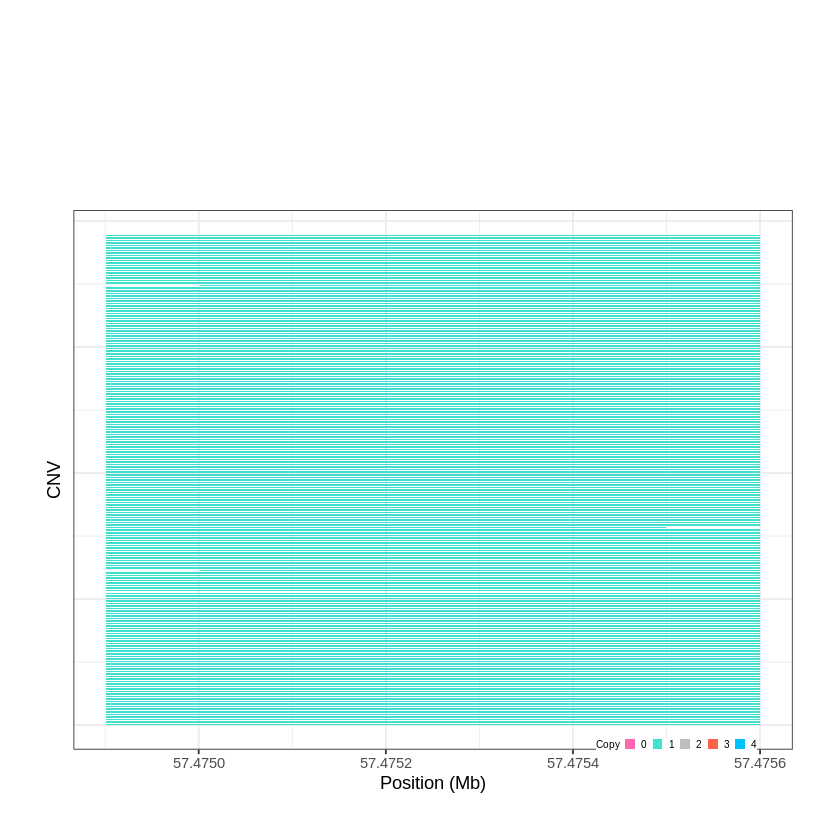

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1927..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 1e-06 - 0.0771 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


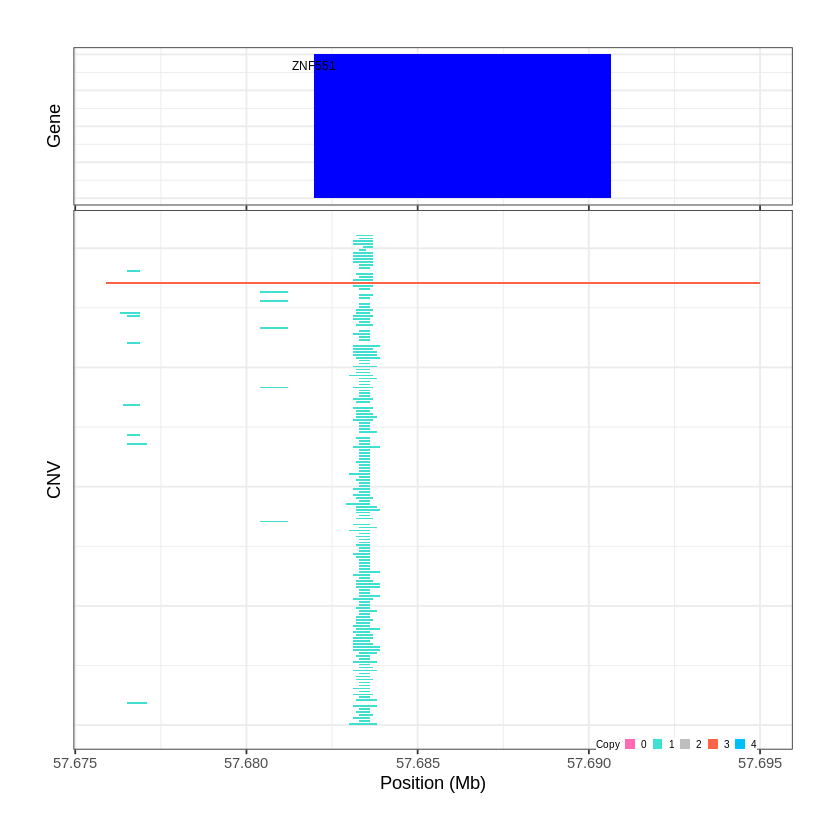

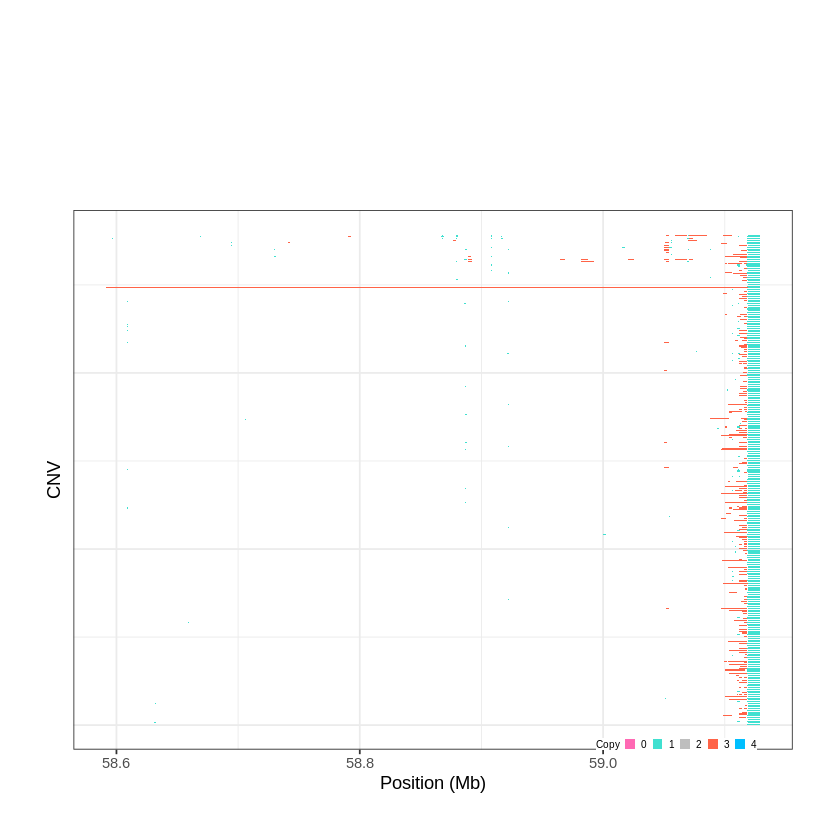

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1928..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 0.573401 - 0.7196 Mb with 201 Individual - "
Plotting gene...


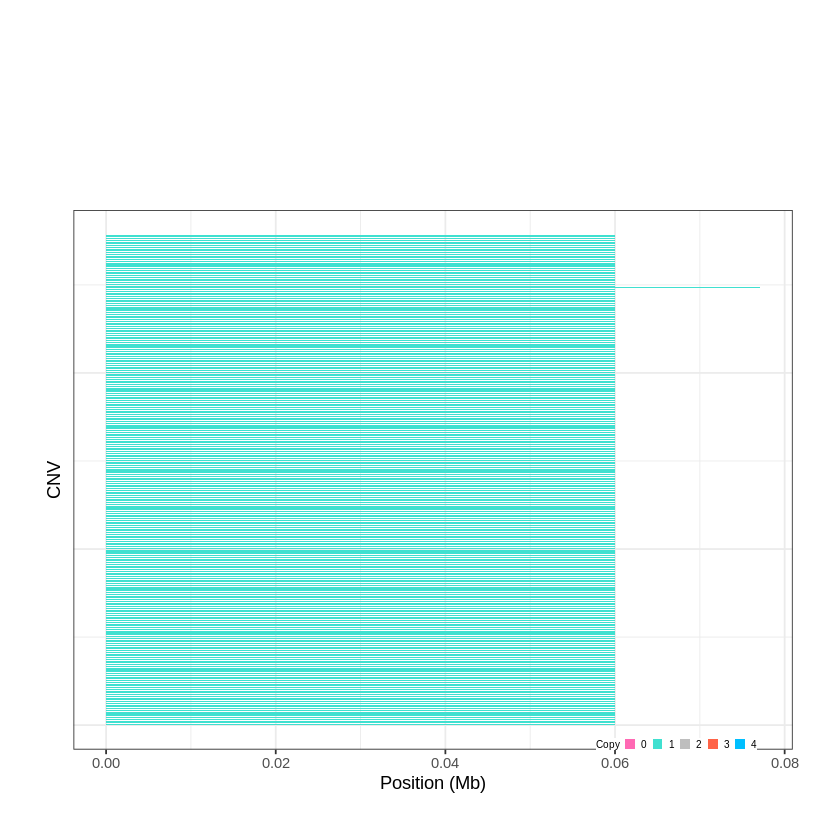

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1929..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 1.185401 - 1.2177 Mb with 151 Individual - "
Plotting gene...


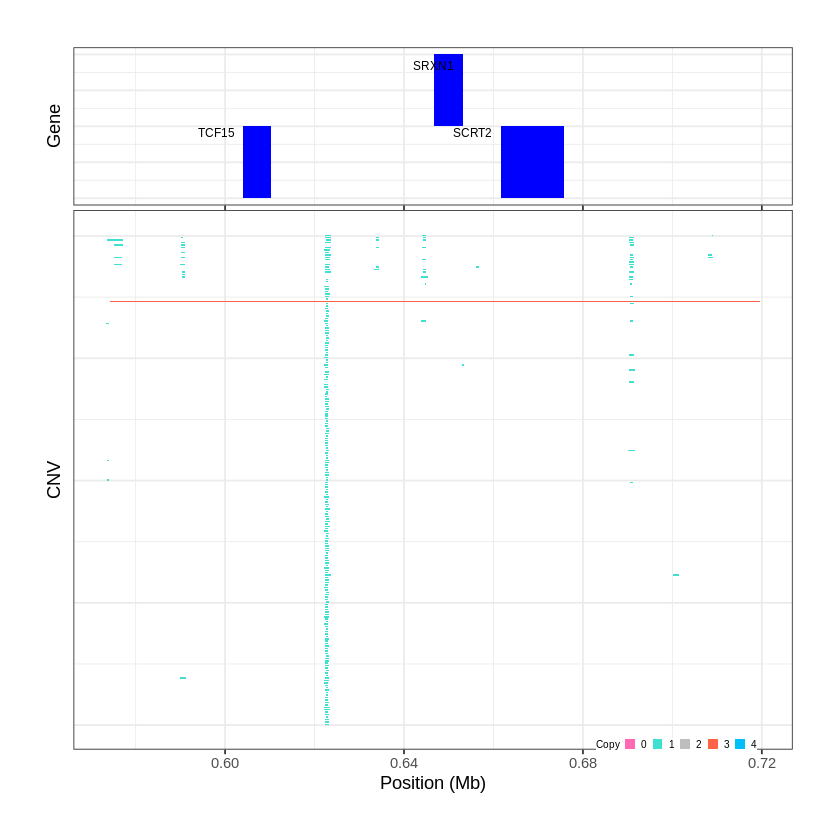

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1930..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 1.386601 - 1.4003 Mb with 211 Individual - "
Plotting gene...


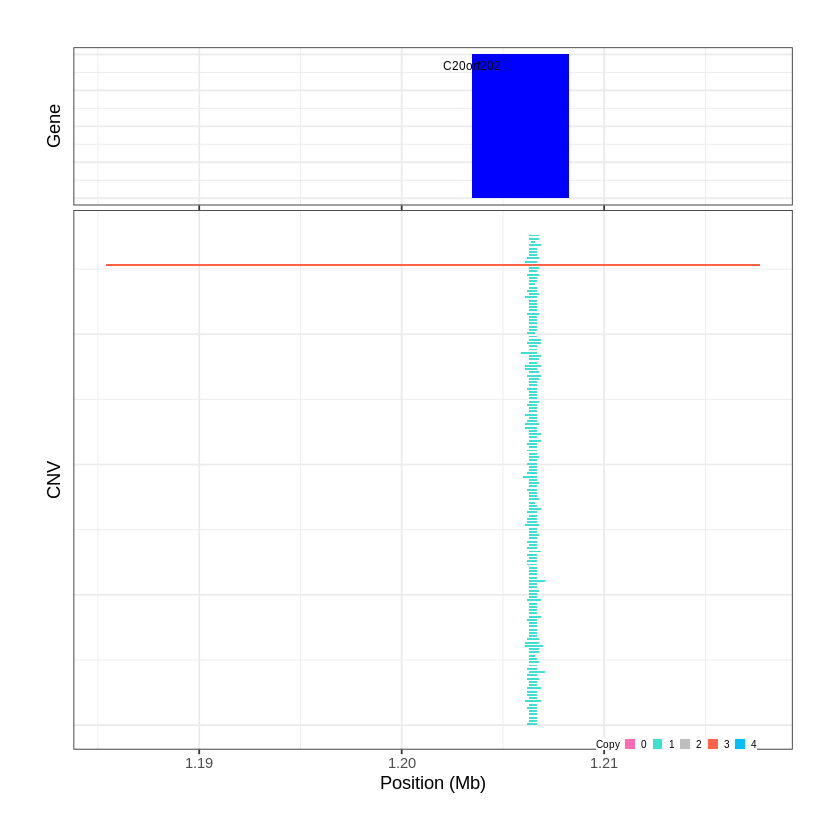

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1931..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 1.552201 - 1.5986 Mb with 261 Individual - "
Plotting gene...


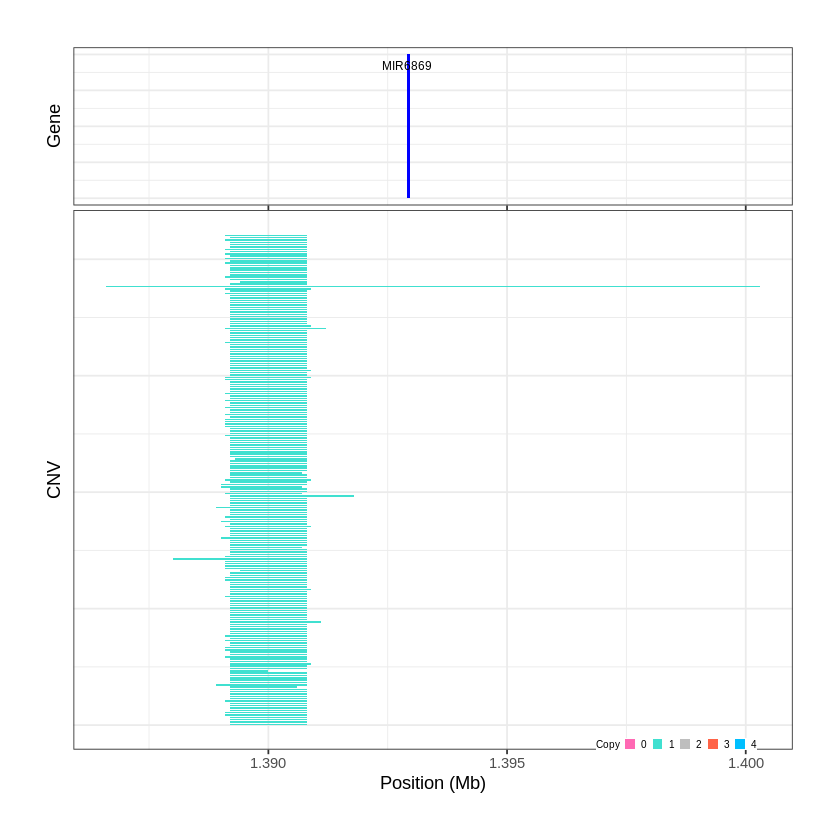

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1932..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 2.594801 - 2.8947 Mb with 270 Individual - "
Plotting gene...


Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 1933..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 3.037901 - 3.0382 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


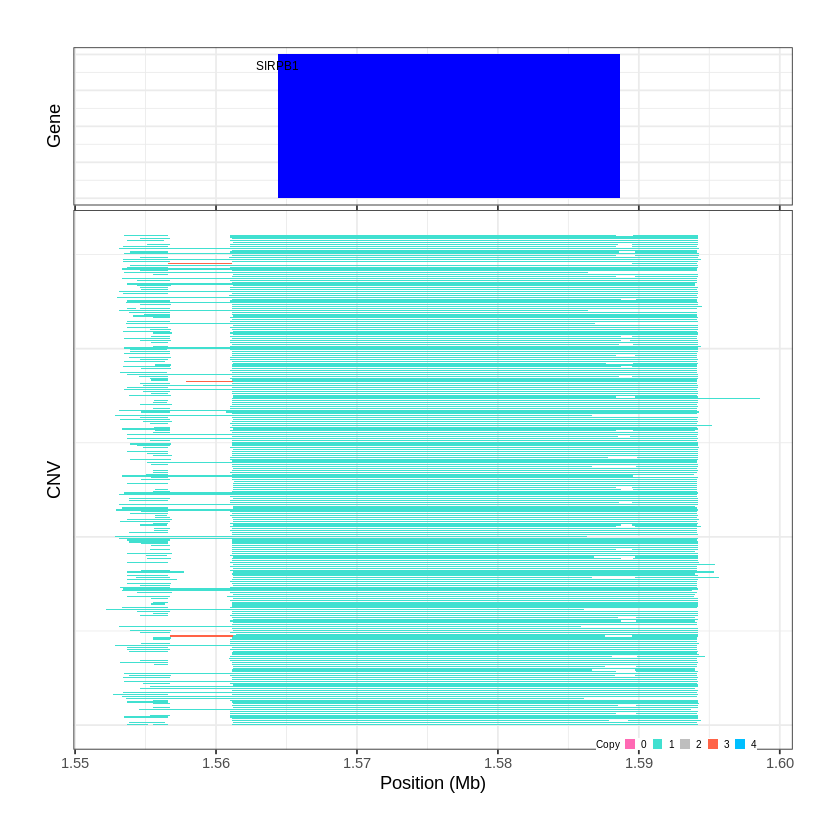

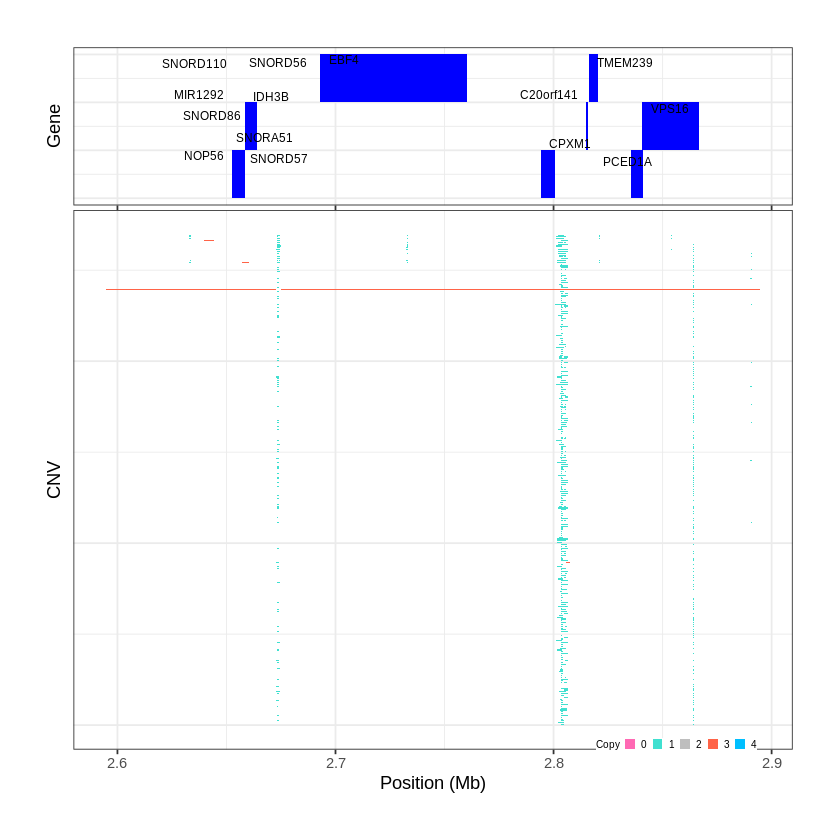

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1934..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 3.990401 - 4.2363 Mb with 235 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1935..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 6.245801 - 6.3225 Mb with 154 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


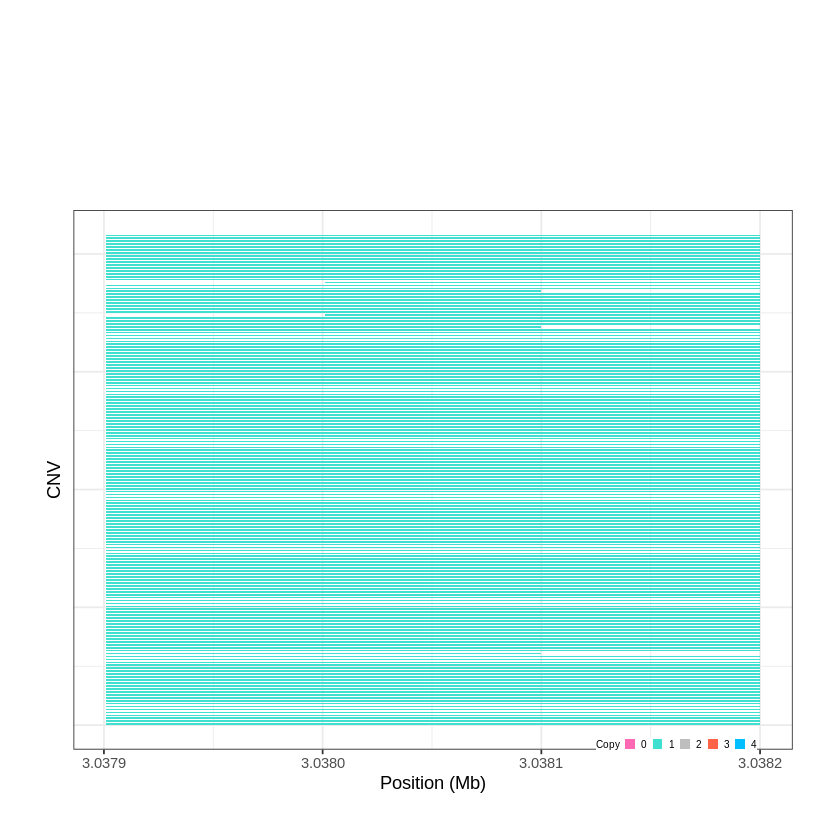

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1936..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 12.025501 - 12.0265 Mb with 190 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


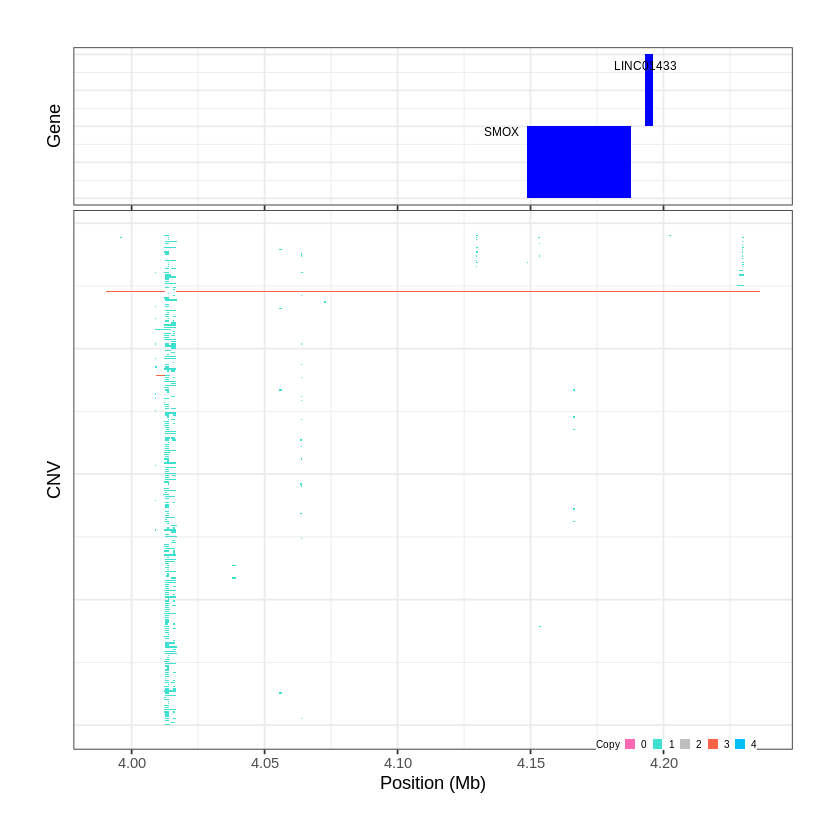

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1937..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 13.197801 - 13.2103 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


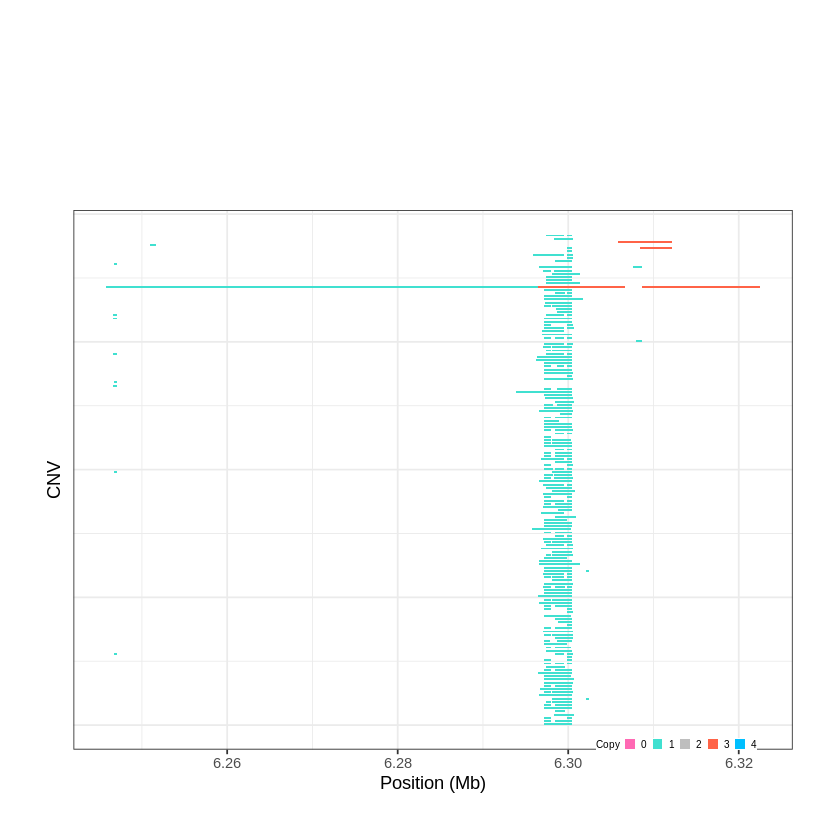

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1938..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 15.704201 - 15.7143 Mb with 231 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


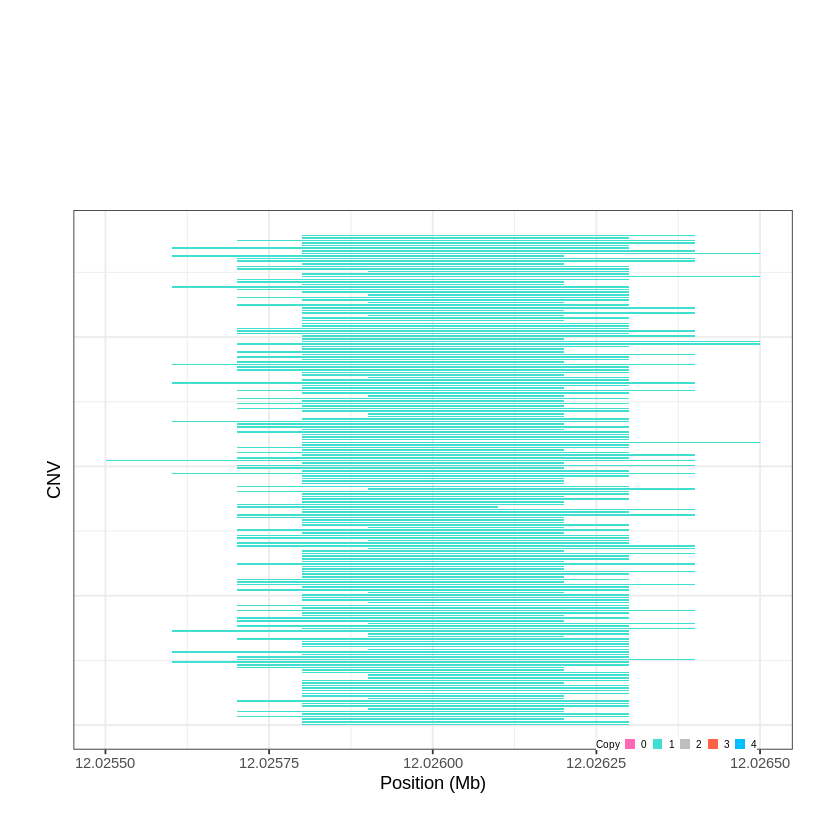

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1939..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 17.103501 - 17.1038 Mb with 223 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


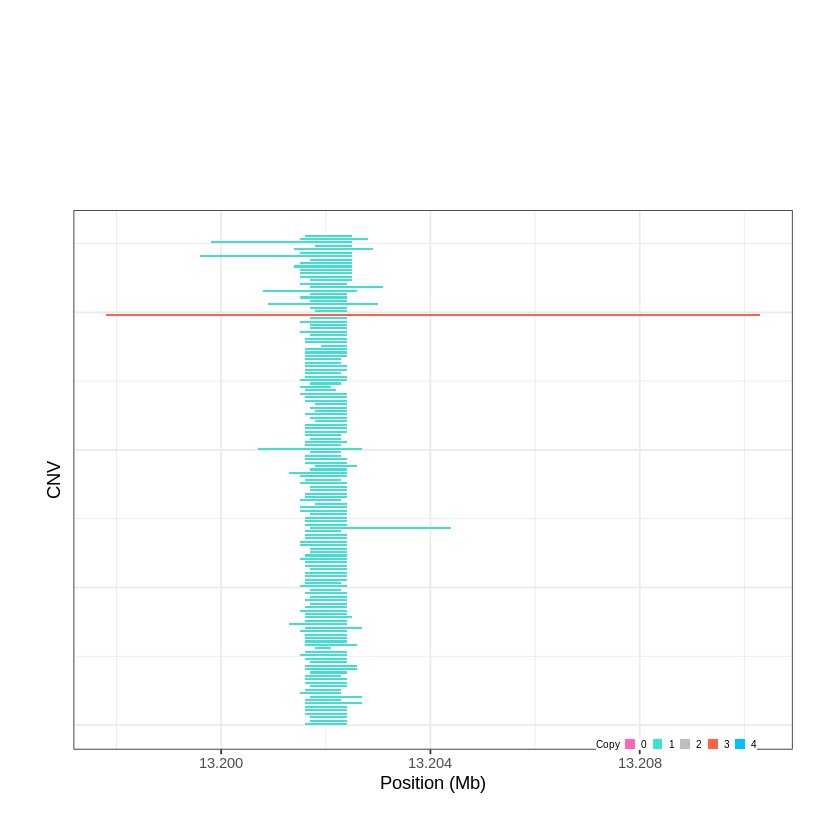

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1940..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 21.280901 - 21.3029 Mb with 252 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


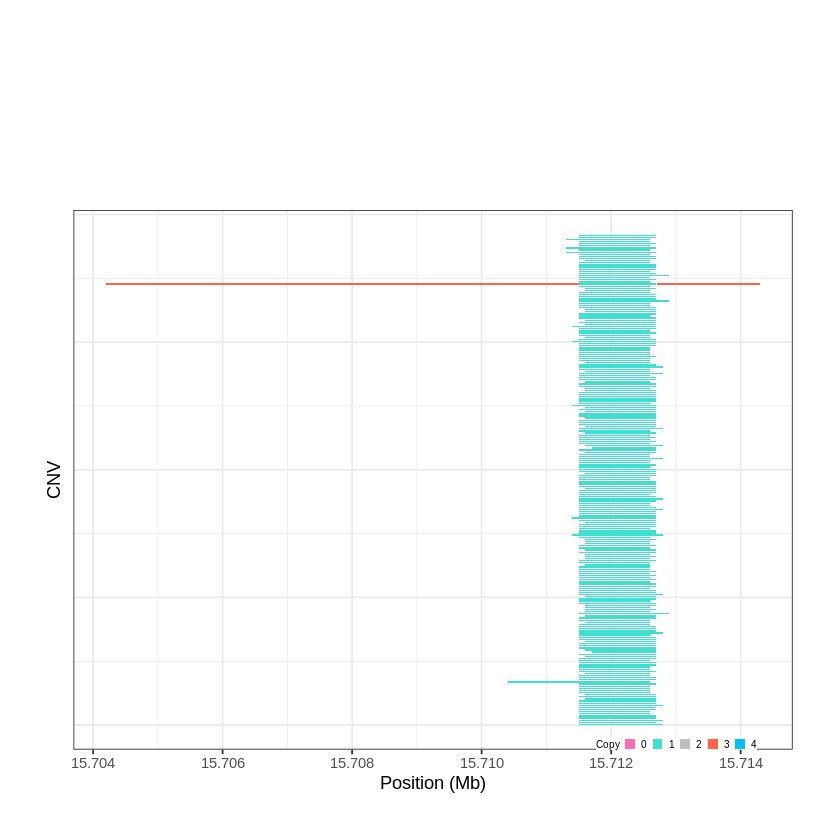

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1941..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 23.103301 - 23.1036 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


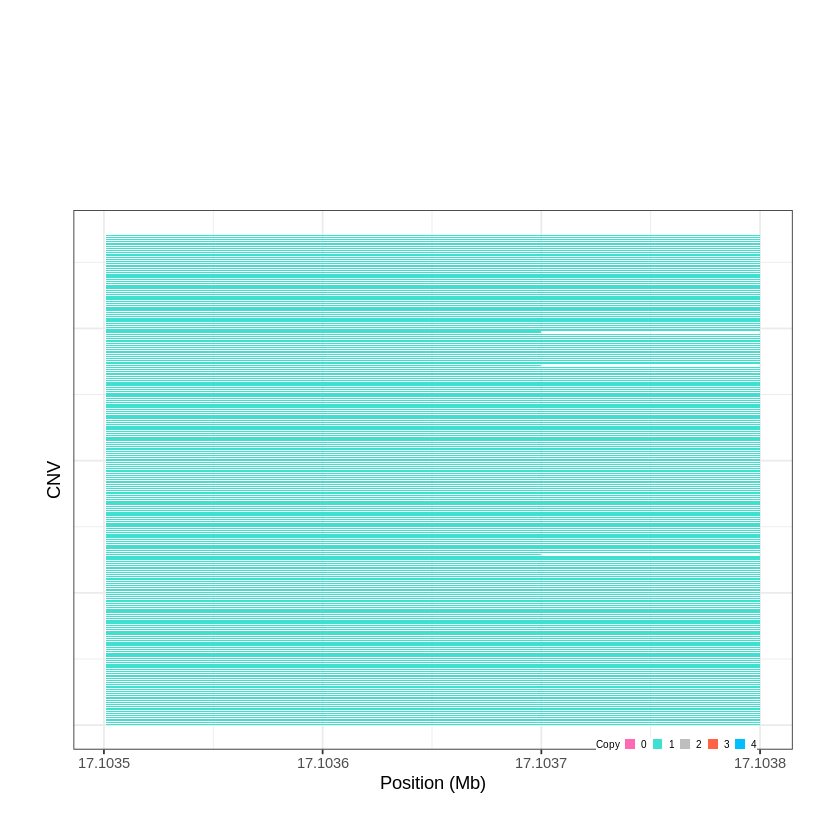

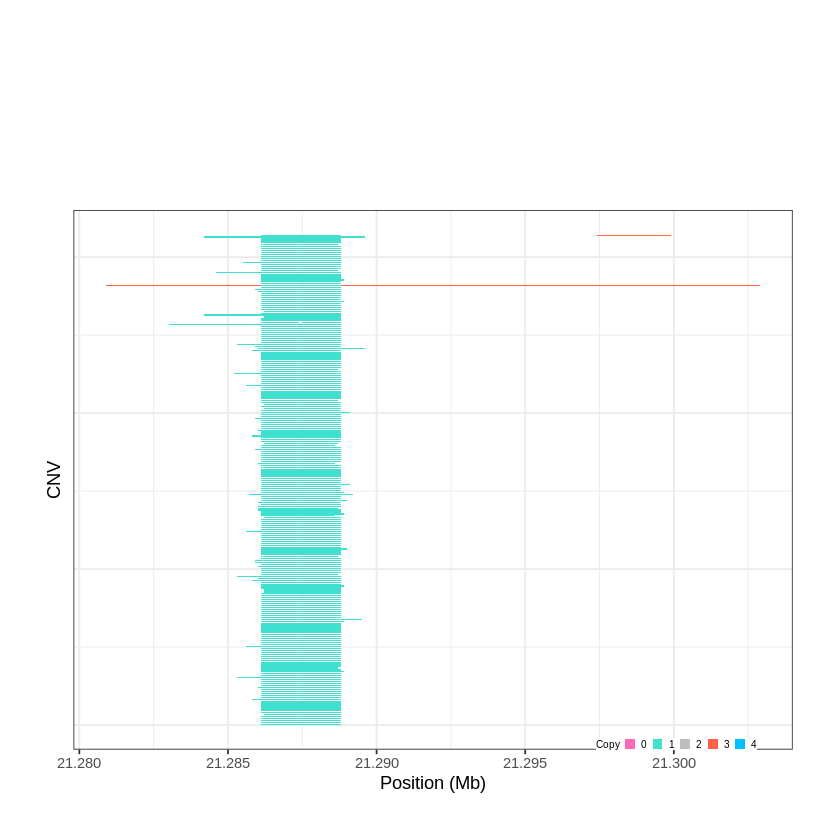

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1942..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 23.611301 - 23.6484 Mb with 142 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1943..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 24.836901 - 24.9083 Mb with 214 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


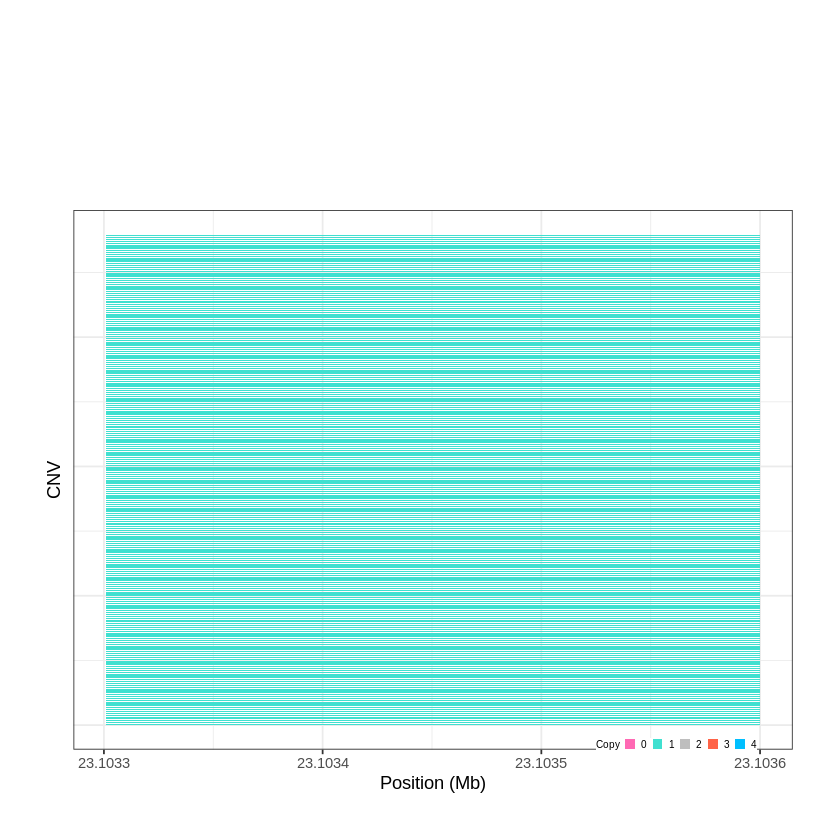

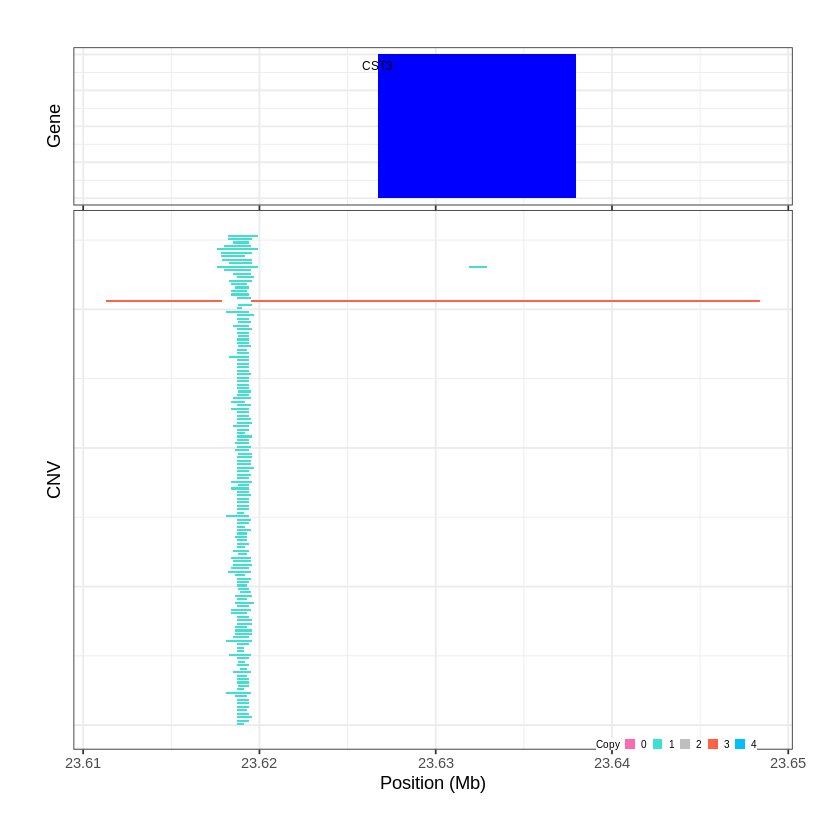

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1944..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 25.728601 - 25.8934 Mb with 278 Individual - "
Plotting gene...


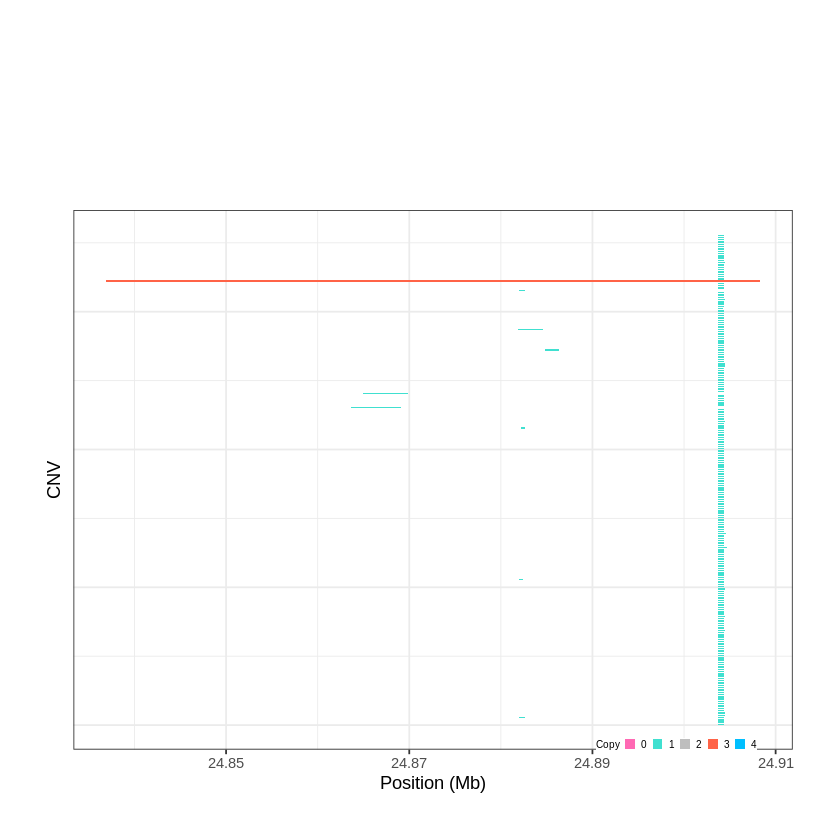

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1945..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 25.988601 - 26.0832 Mb with 258 Individual - "
Plotting gene...


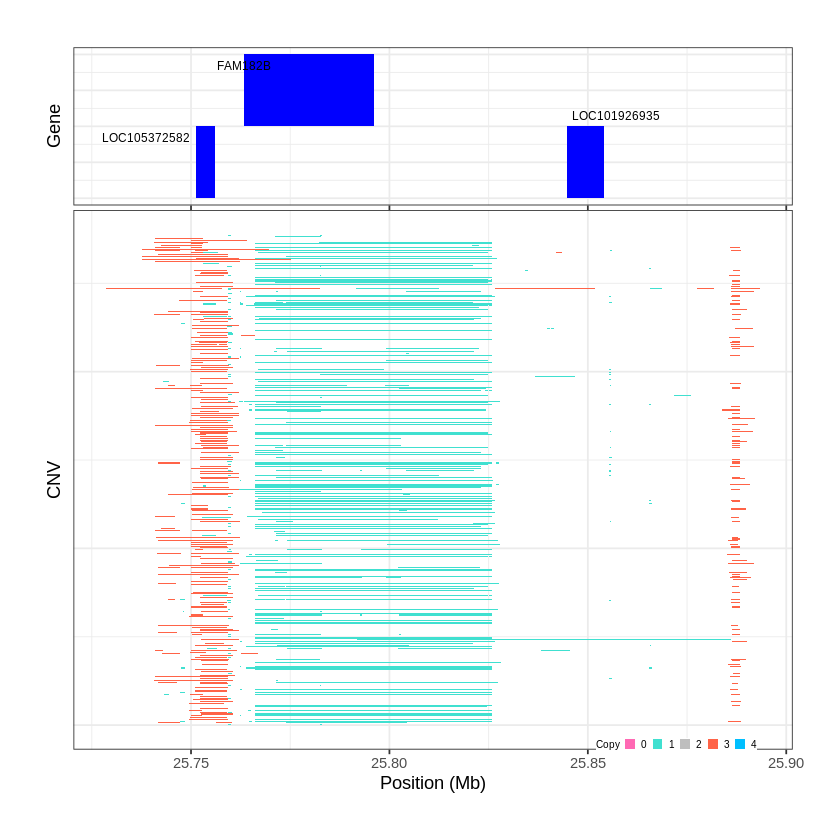

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1946..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 26.260101 - 30.2671 Mb with 279 Individual - "
Plotting gene...


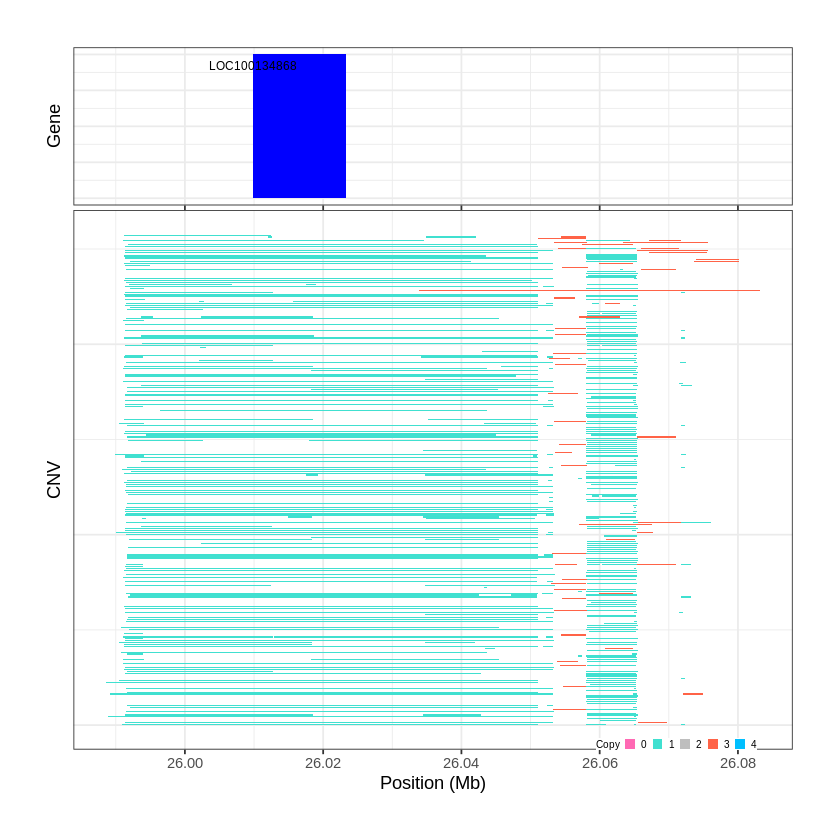

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1947..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 31.004901 - 31.3057 Mb with 228 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1948..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 31.308901 - 31.313 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


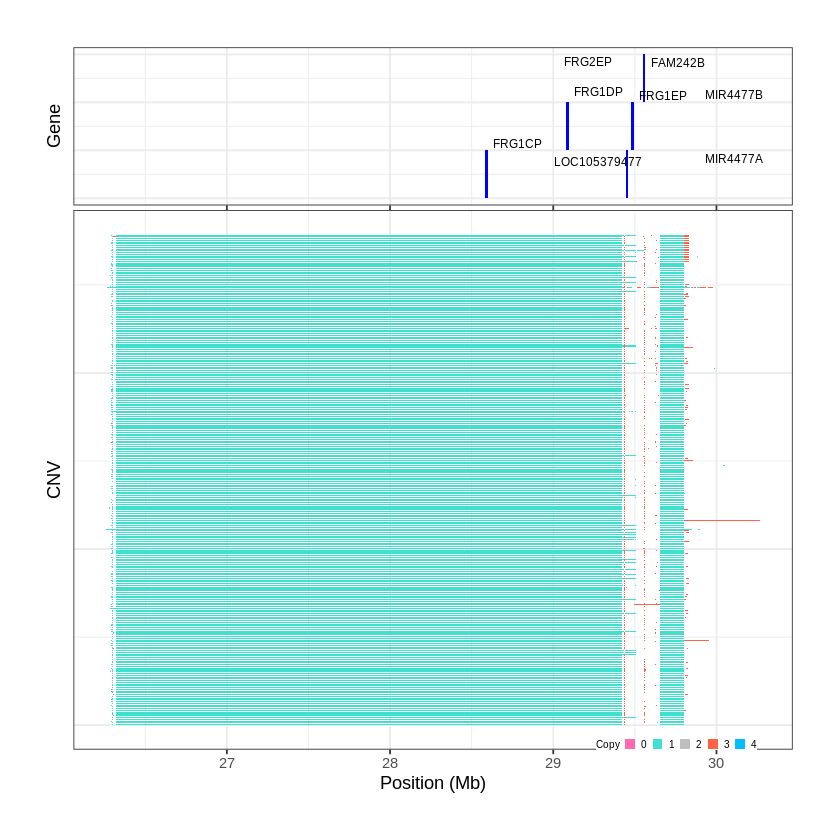

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1949..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 32.039401 - 32.0596 Mb with 207 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


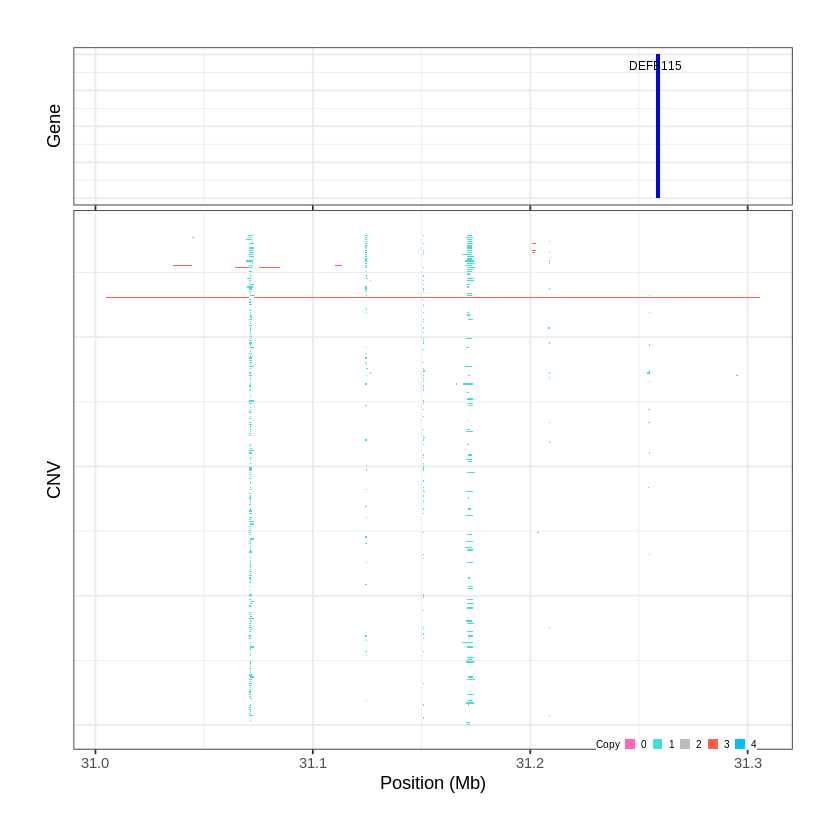

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1950..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 32.816001 - 32.8469 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


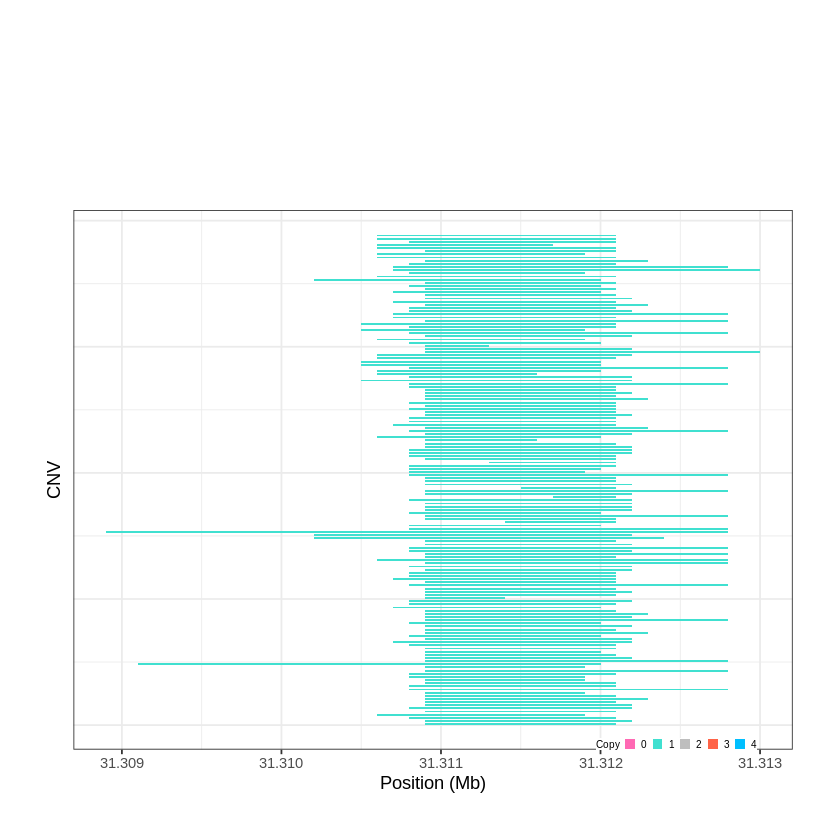

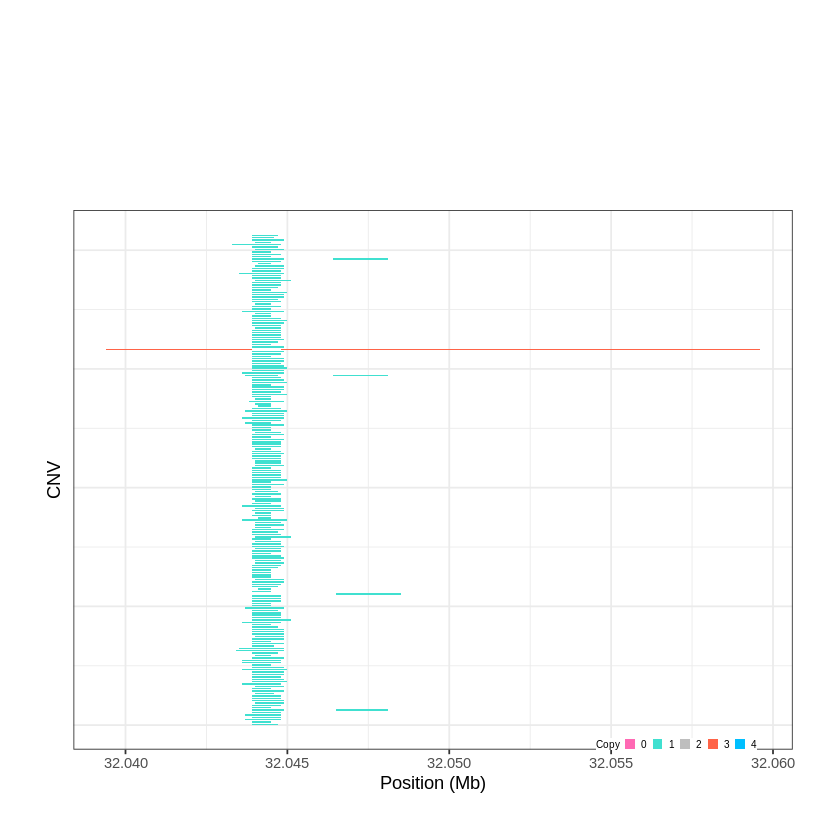

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1951..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 33.233701 - 33.2472 Mb with 176 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1952..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 34.896301 - 34.9471 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


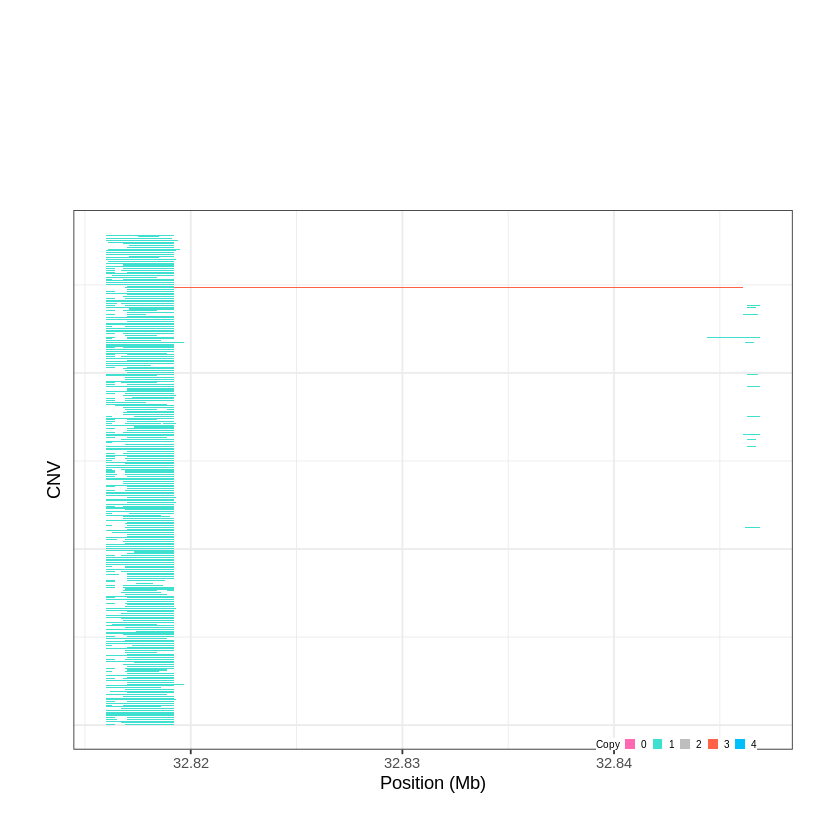

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1953..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 37.056301 - 37.1245 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


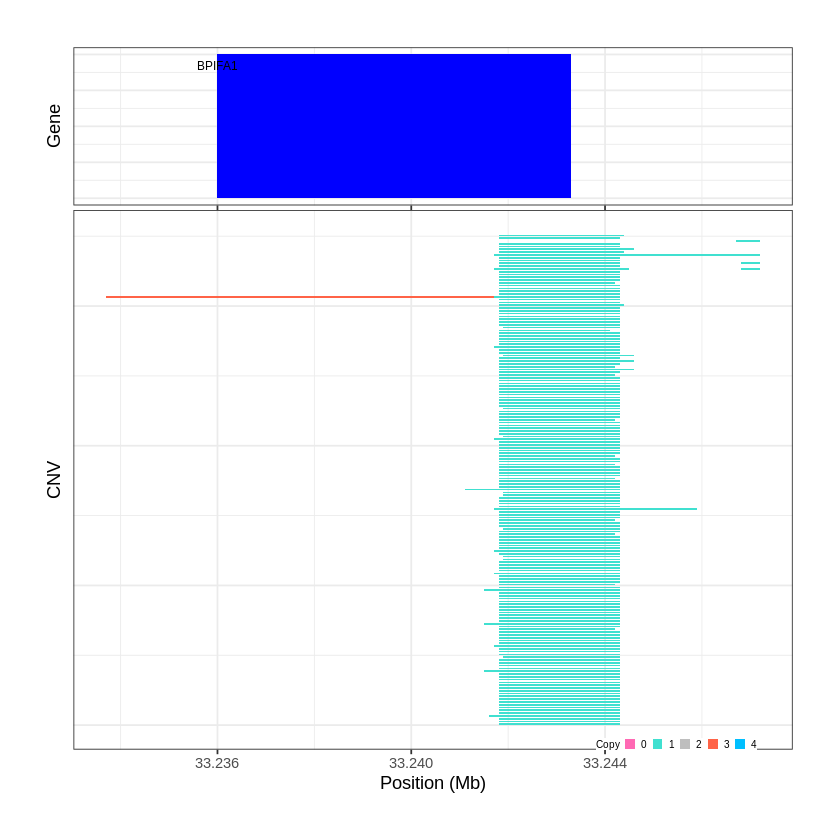

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1954..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 42.158901 - 42.2789 Mb with 254 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


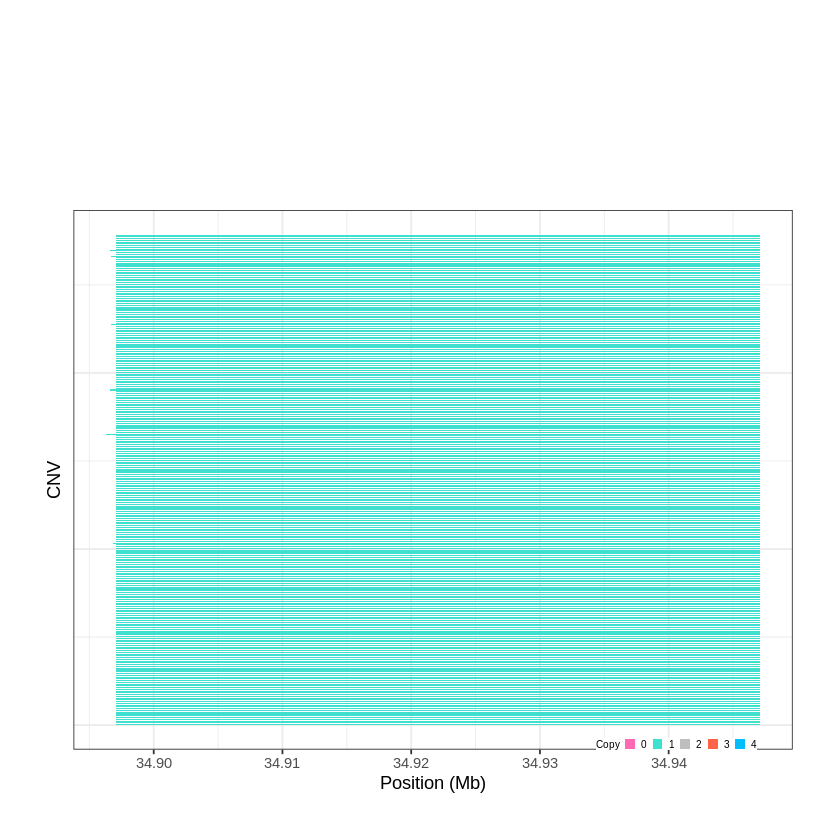

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1955..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 42.742501 - 42.7952 Mb with 197 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


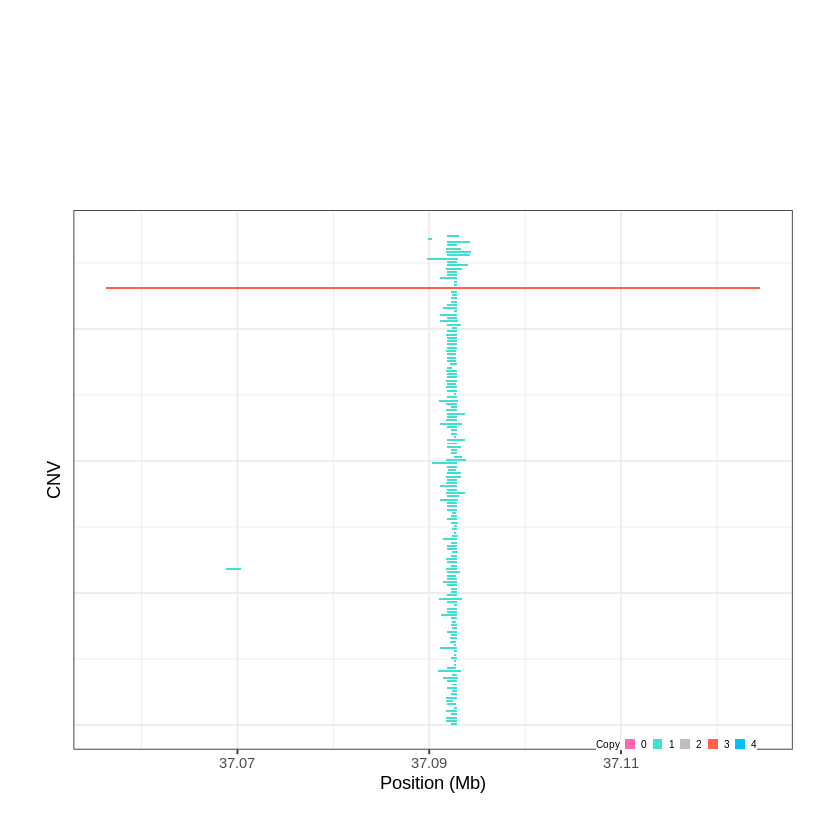

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1956..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 43.096401 - 43.4062 Mb with 162 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


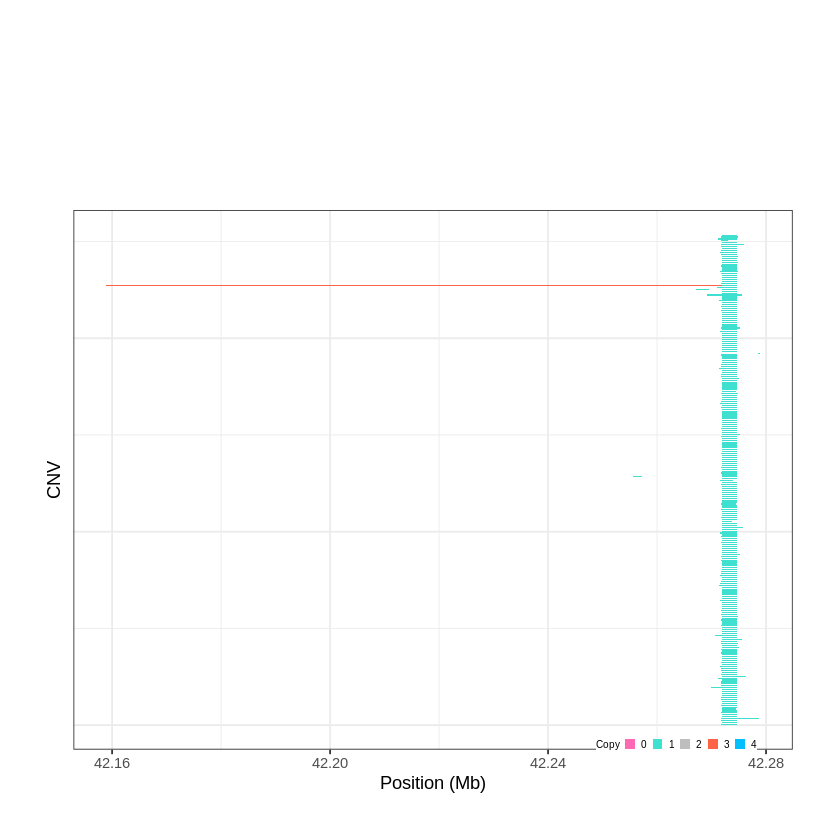

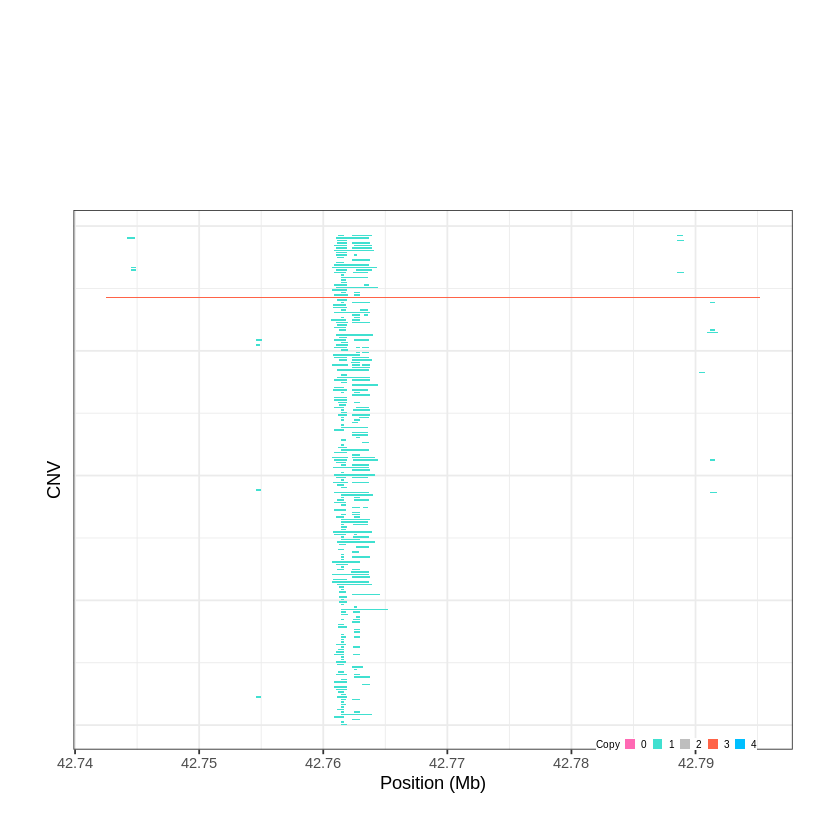

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1957..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 46.257401 - 46.5443 Mb with 183 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1958..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 47.487201 - 47.489 Mb with 204 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


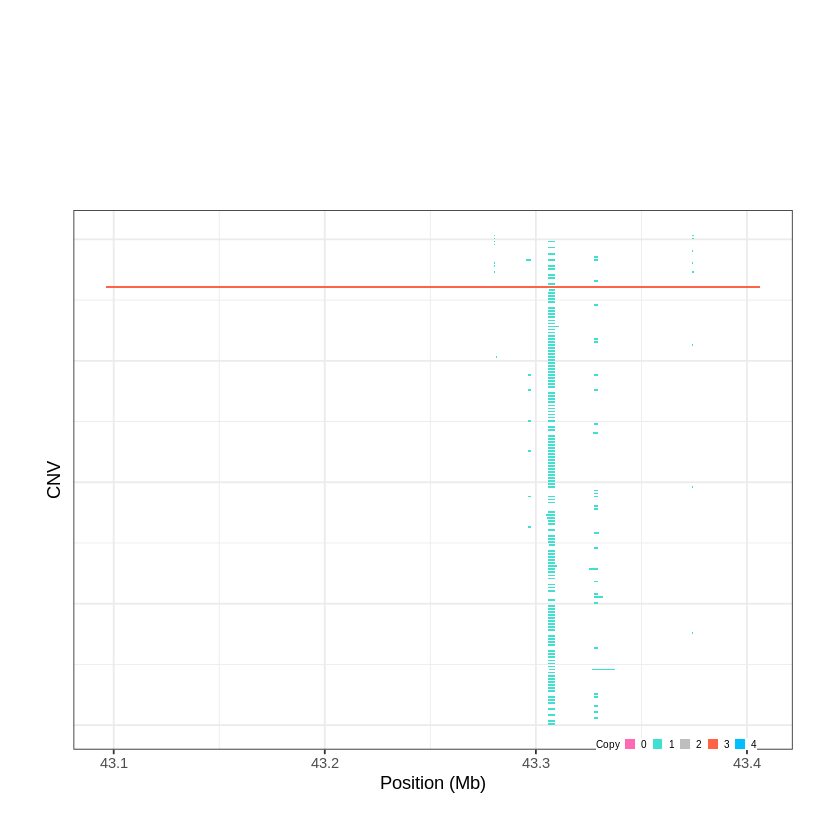

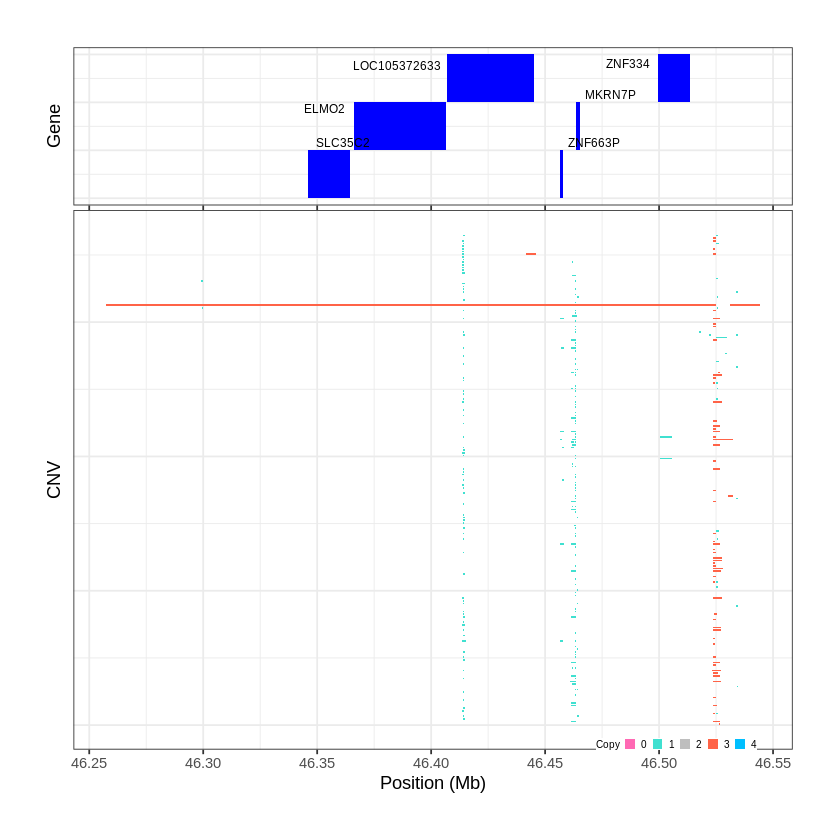

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1959..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 48.462701 - 49.1164 Mb with 175 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1960..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 52.475601 - 52.4879 Mb with 235 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


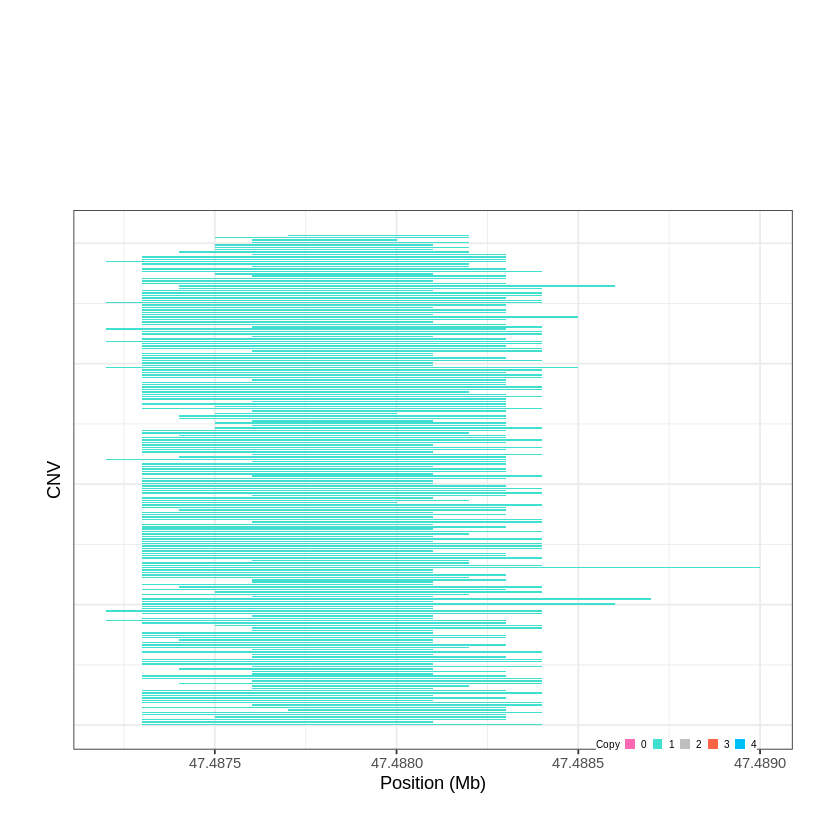

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1961..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 55.648301 - 55.8063 Mb with 239 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


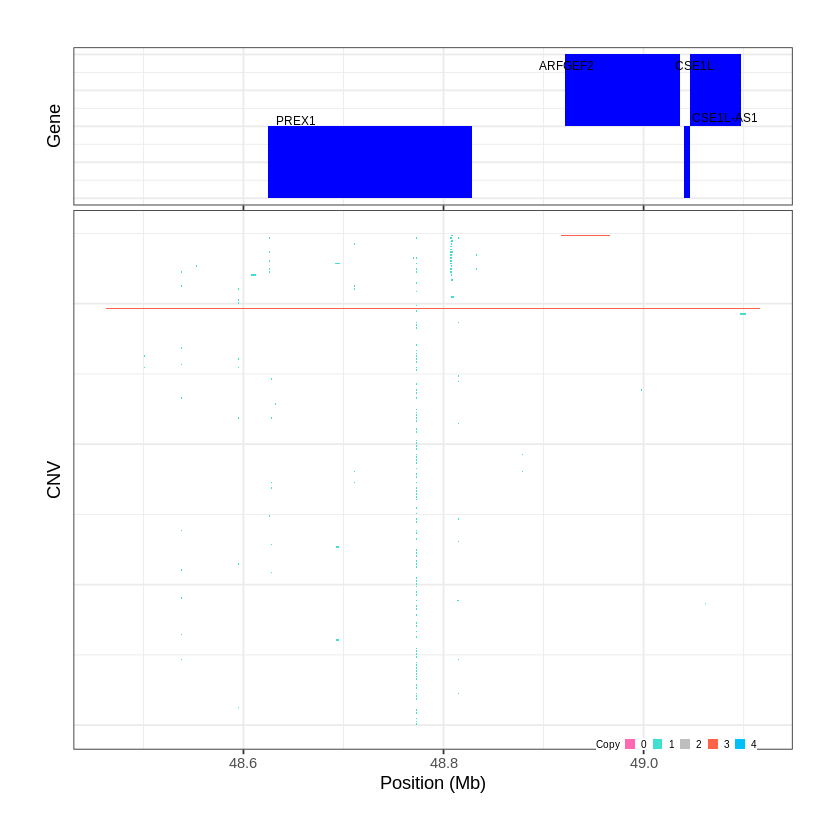

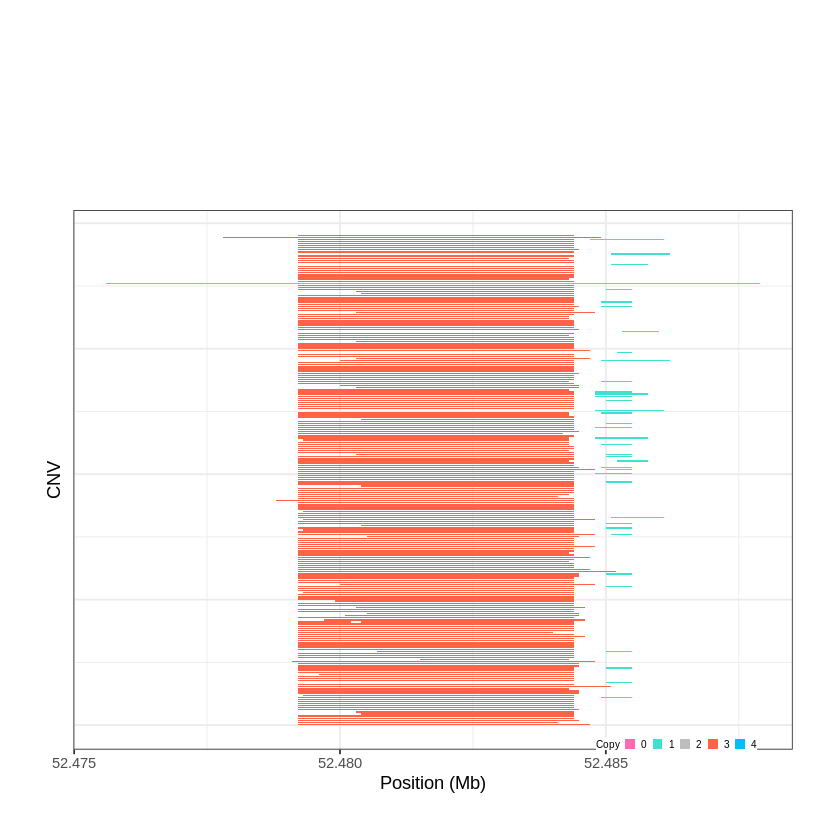

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1962..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 55.945701 - 56.0867 Mb with 148 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1963..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 56.097901 - 56.1039 Mb with 260 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


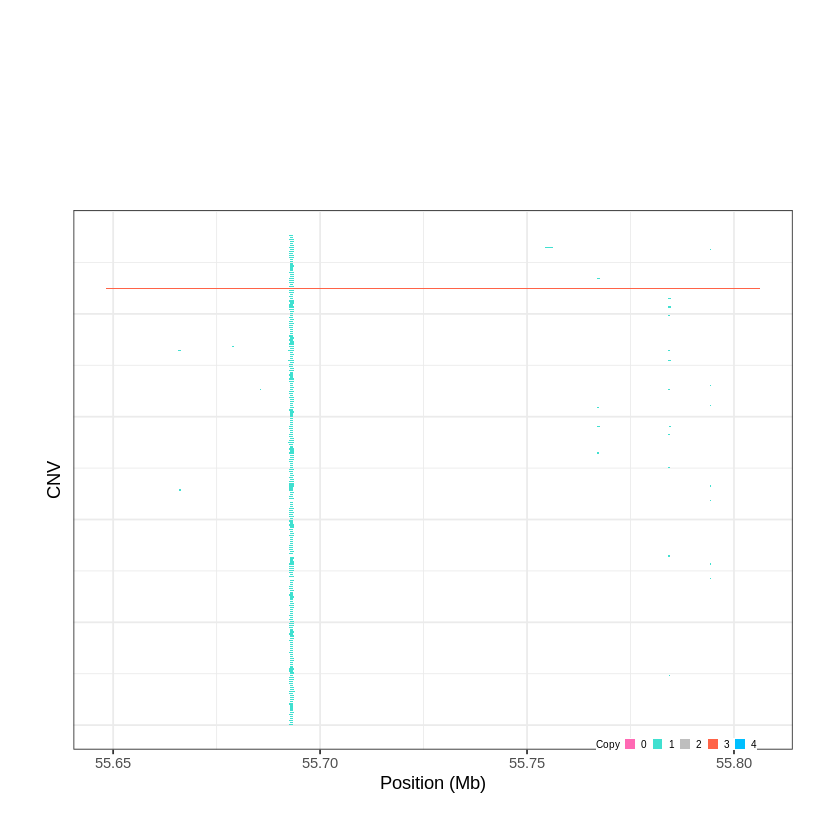

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1964..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 57.930001 - 57.9314 Mb with 152 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


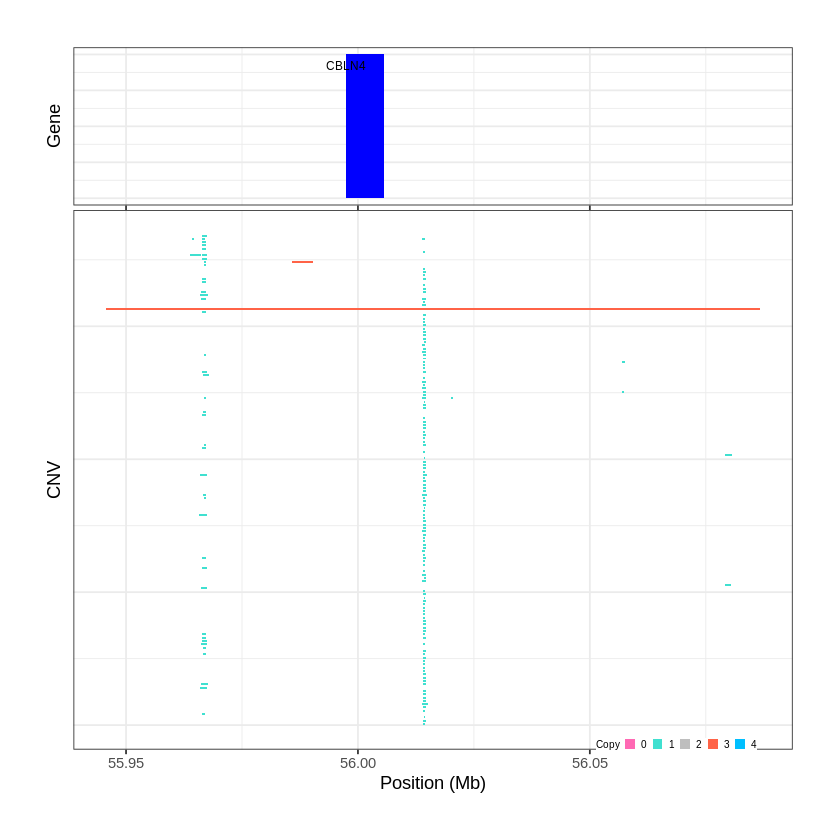

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1965..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 58.229001 - 58.2639 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


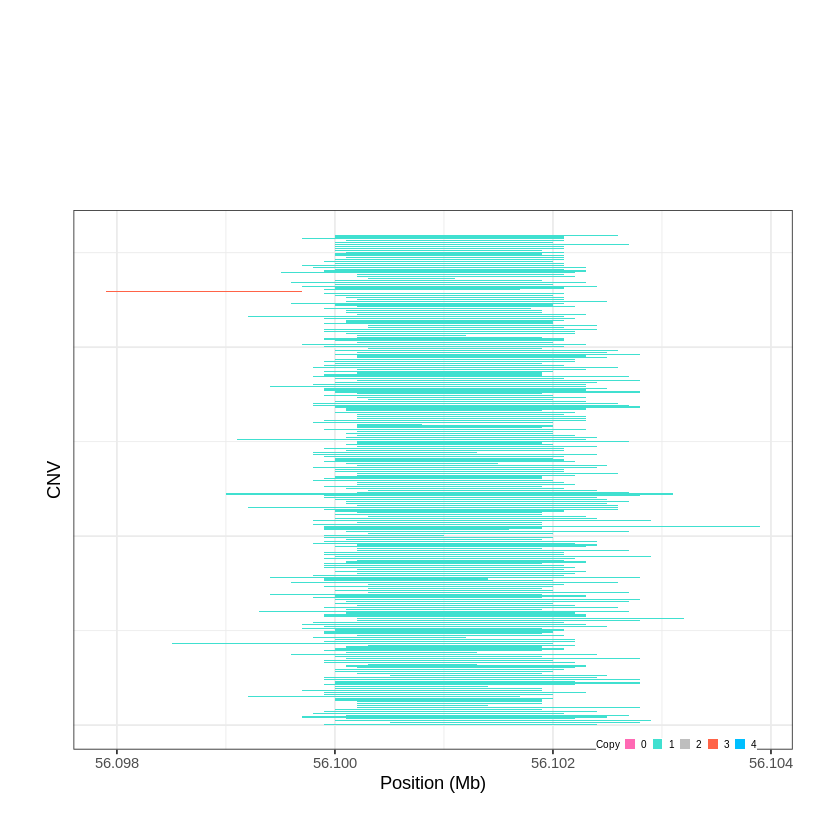

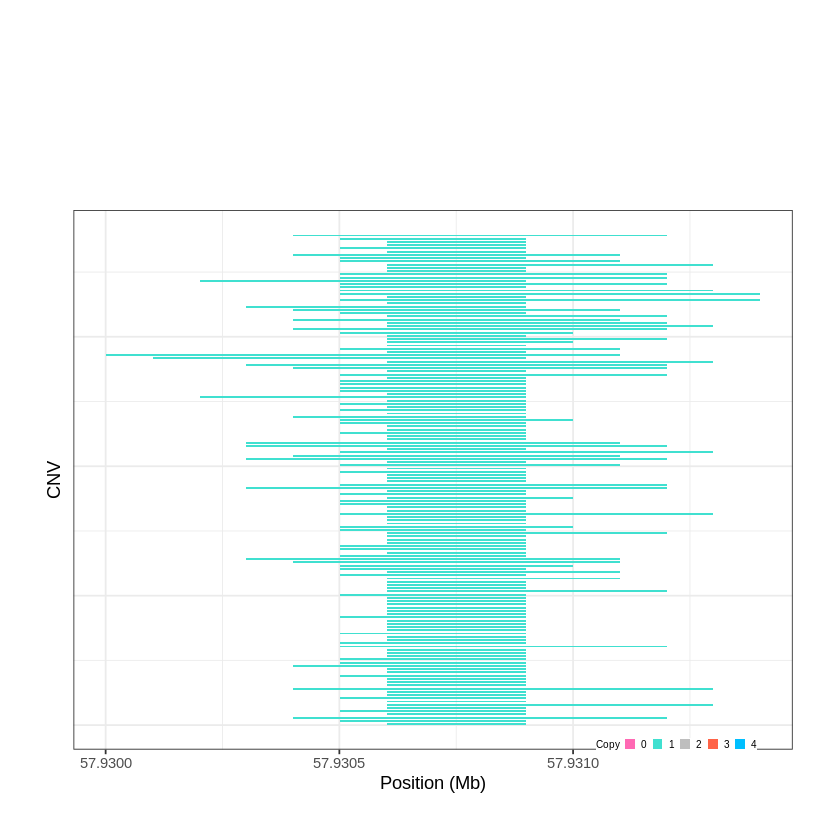

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1966..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 60.050901 - 61.0812 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1967..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 61.083601 - 61.0862 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


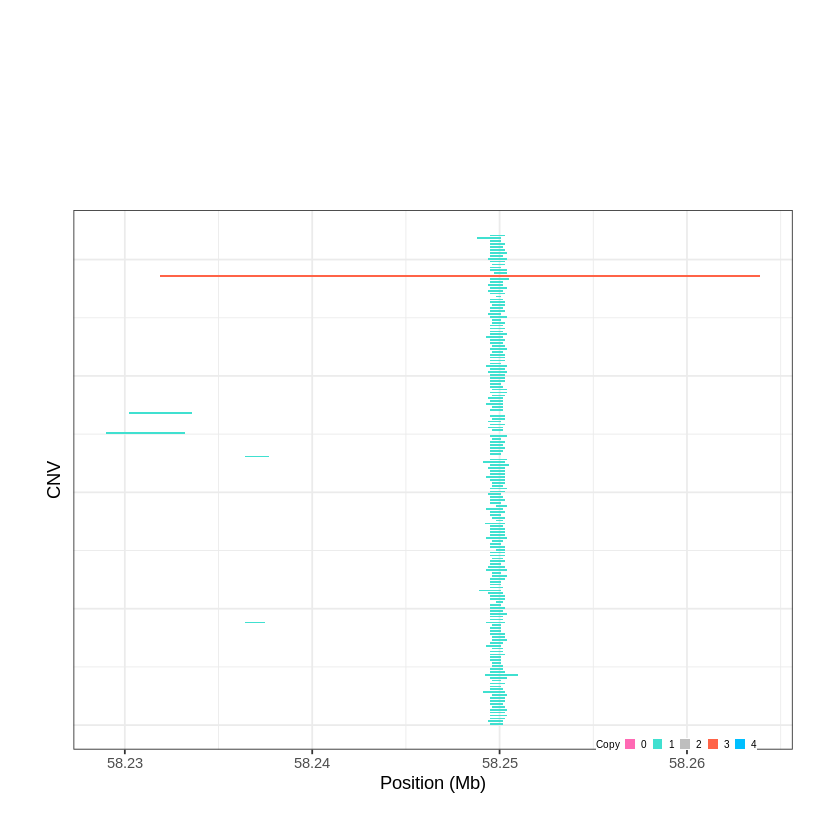

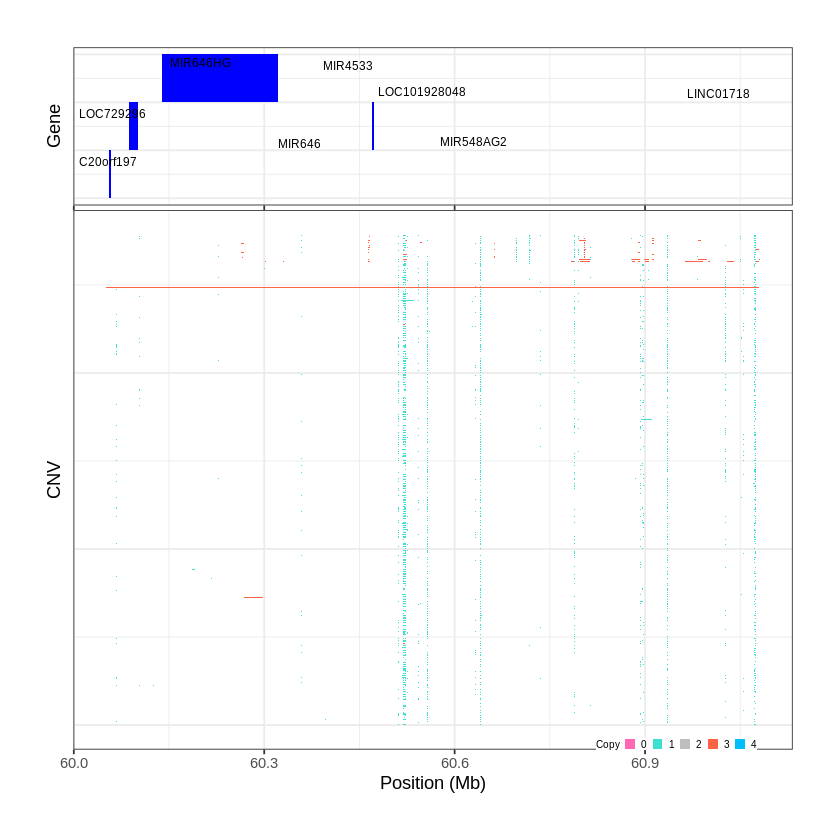

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1968..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 61.090801 - 61.7257 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1969..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 61.765701 - 61.935 Mb with 174 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


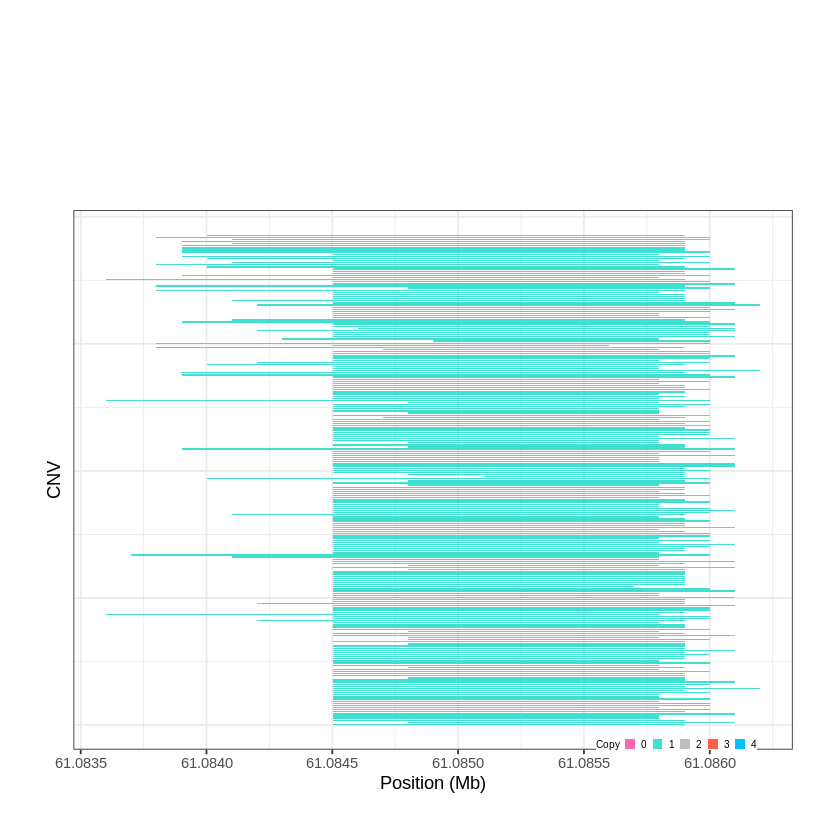

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1970..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 61.977401 - 61.988 Mb with 201 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


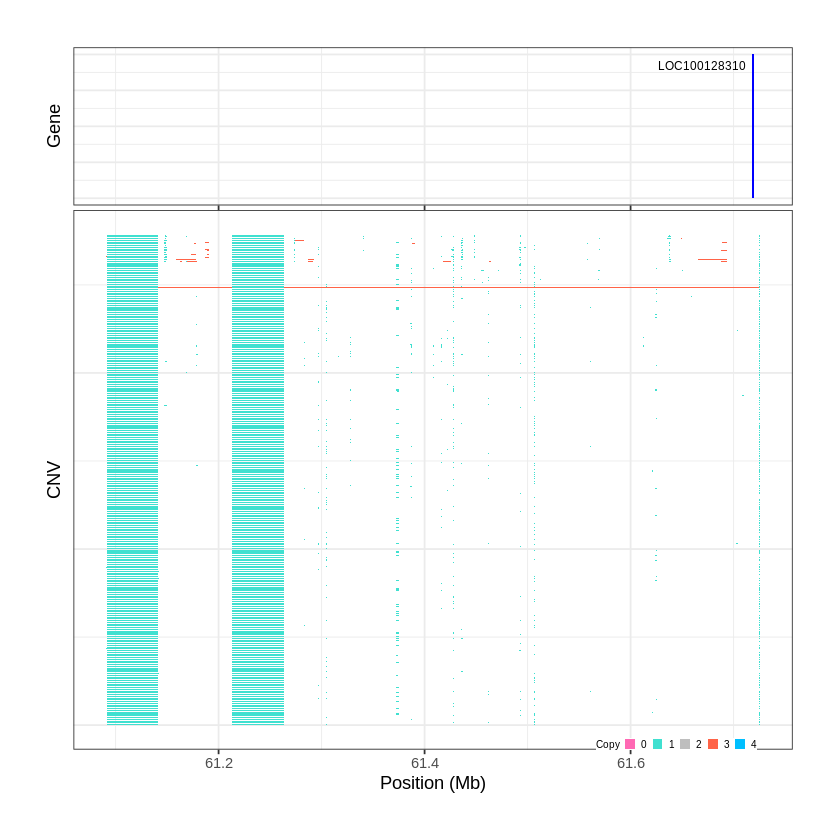

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1971..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 61.988001 - 62.0083 Mb with 170 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


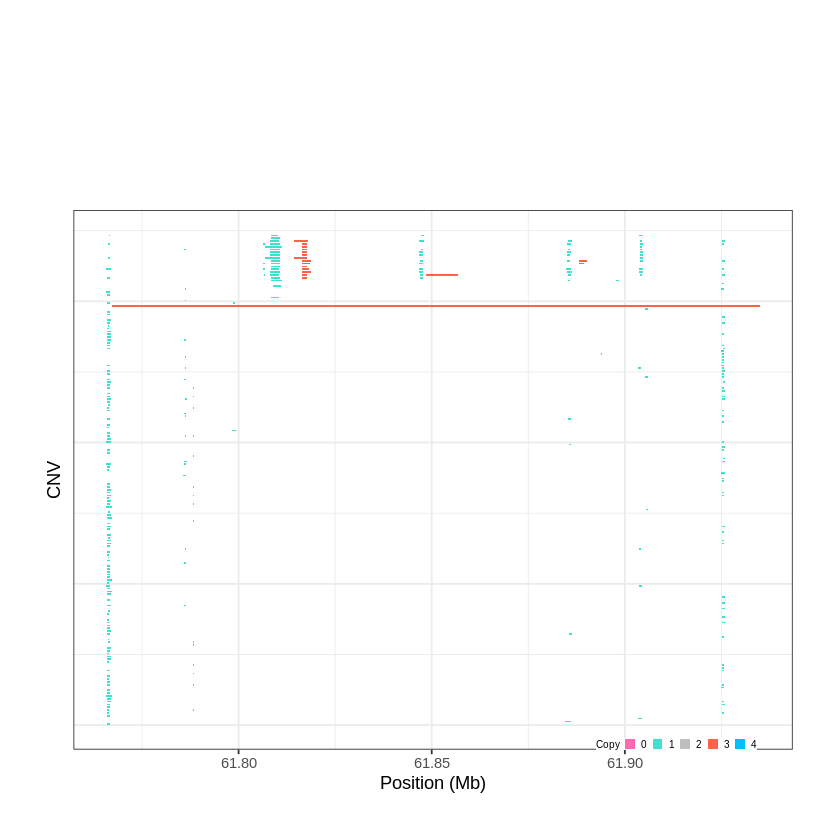

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1972..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.102101 - 62.1048 Mb with 183 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


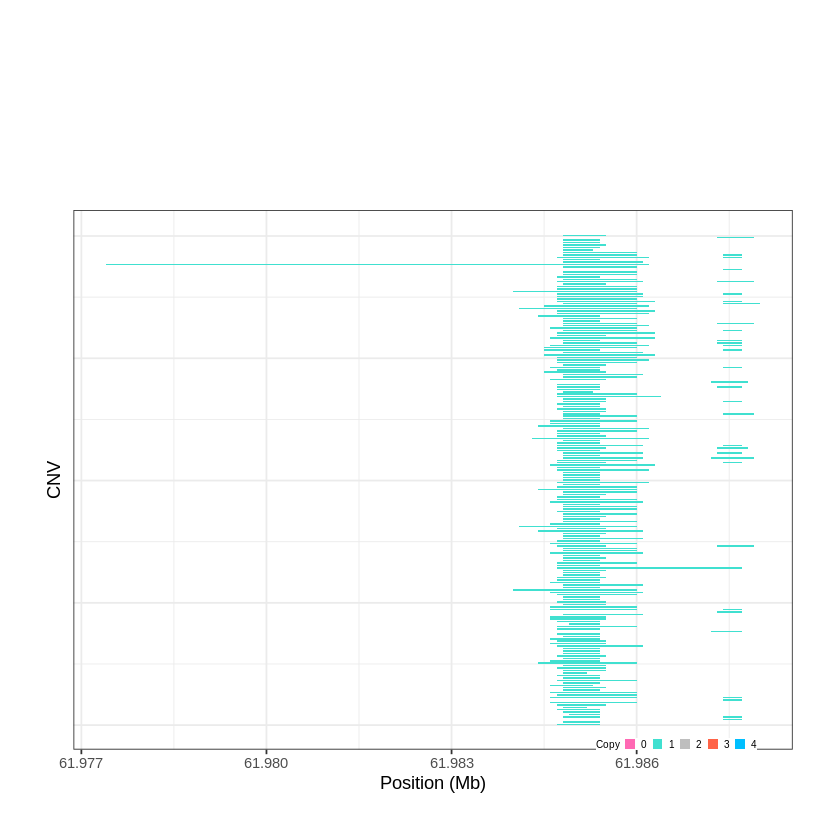

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1973..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.166401 - 62.1681 Mb with 236 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


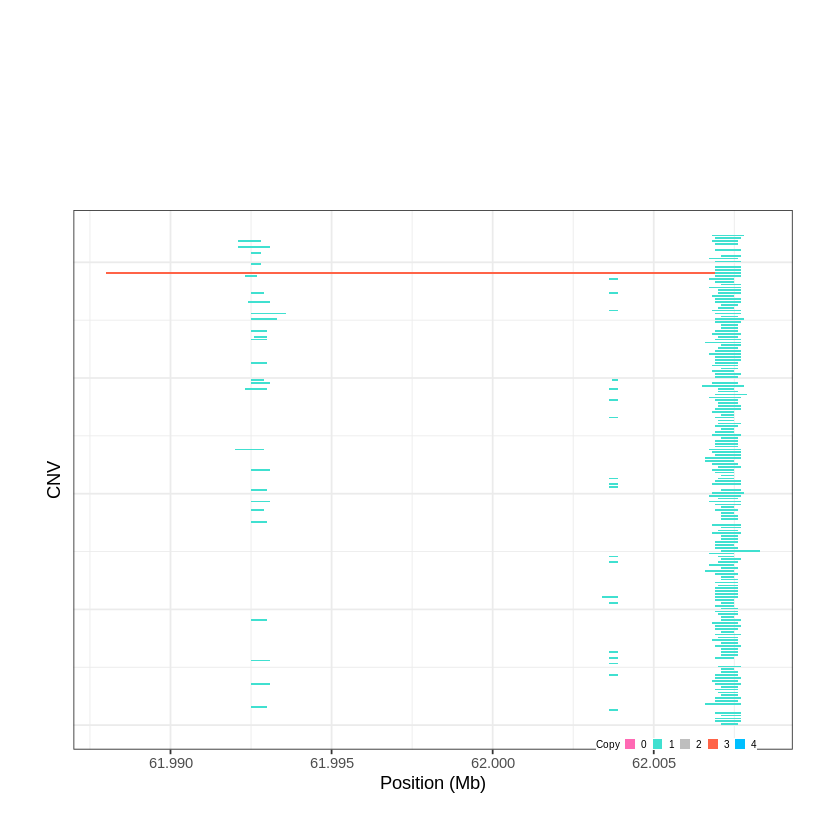

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1974..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.461401 - 62.464 Mb with 199 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


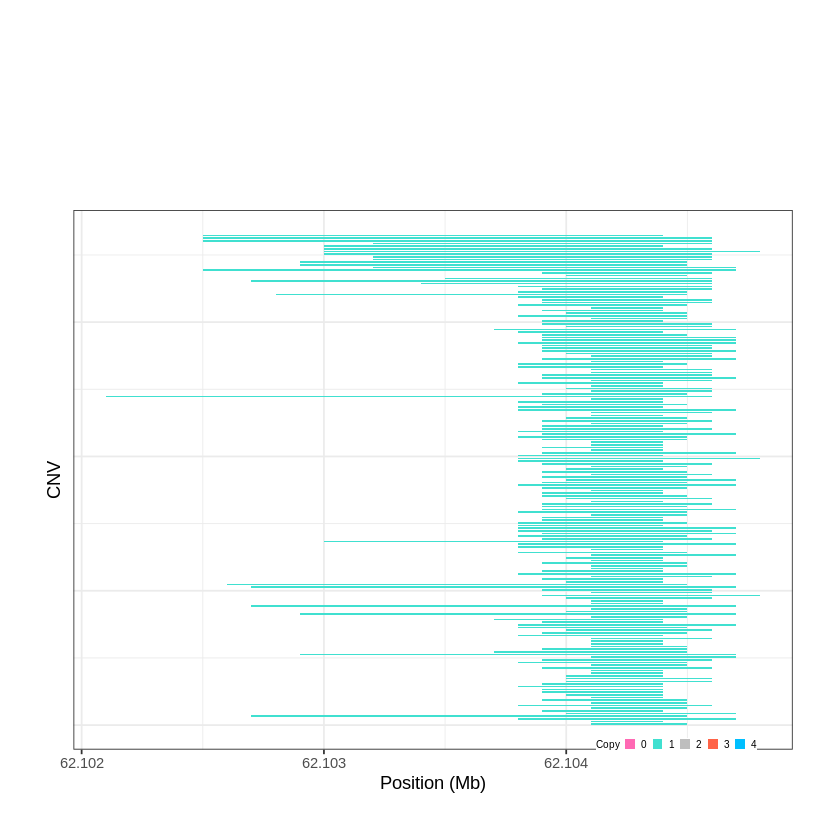

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1975..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.466201 - 62.4685 Mb with 164 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


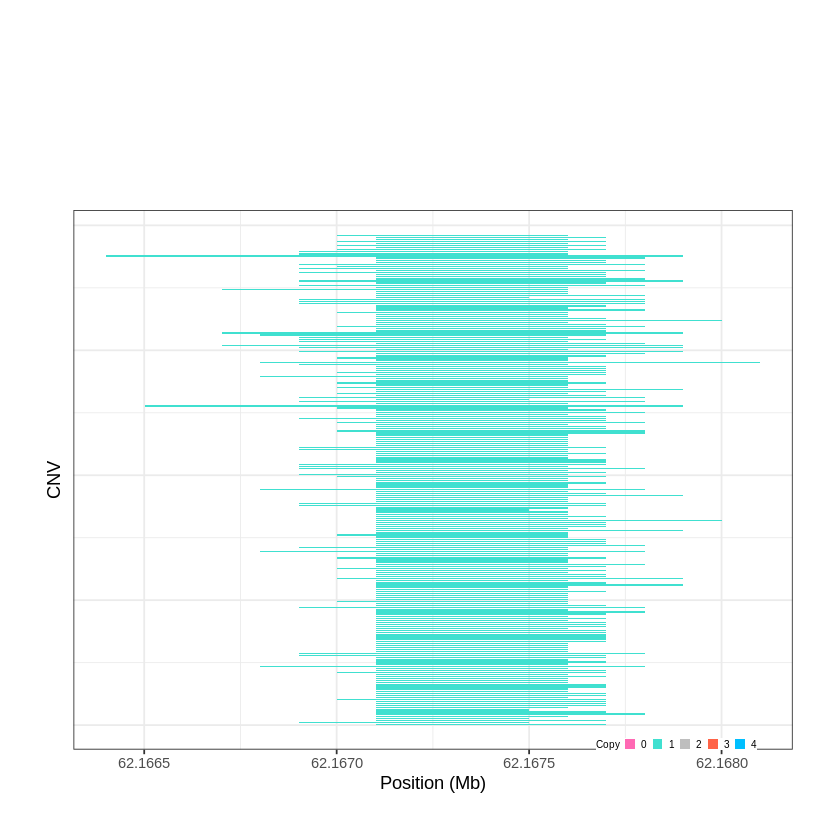

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1976..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.590001 - 62.61 Mb with 191 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


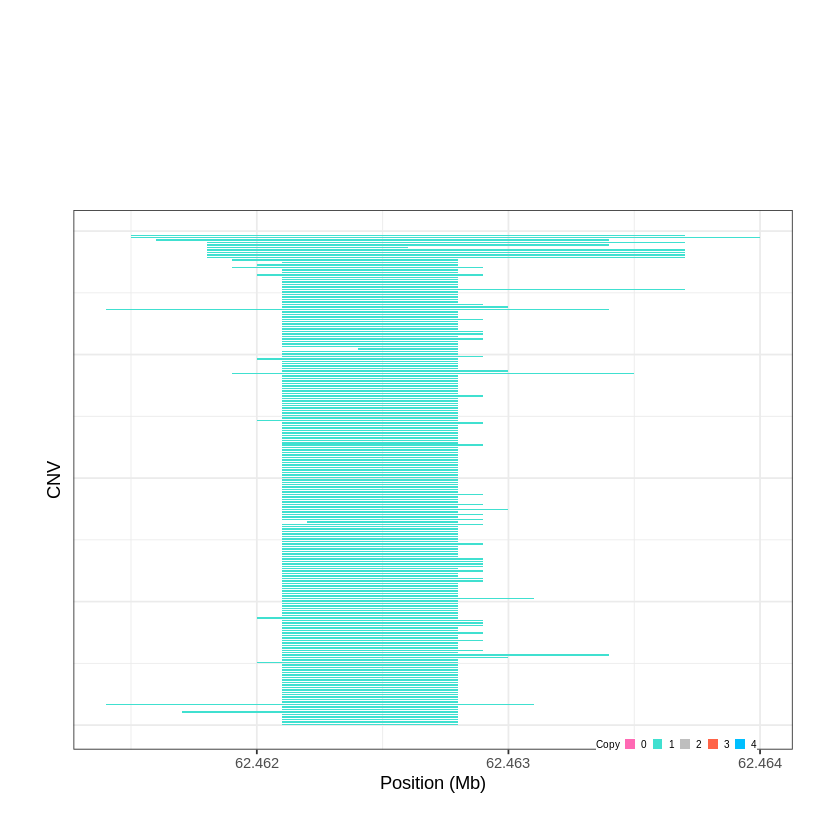

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1977..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.723501 - 62.7282 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


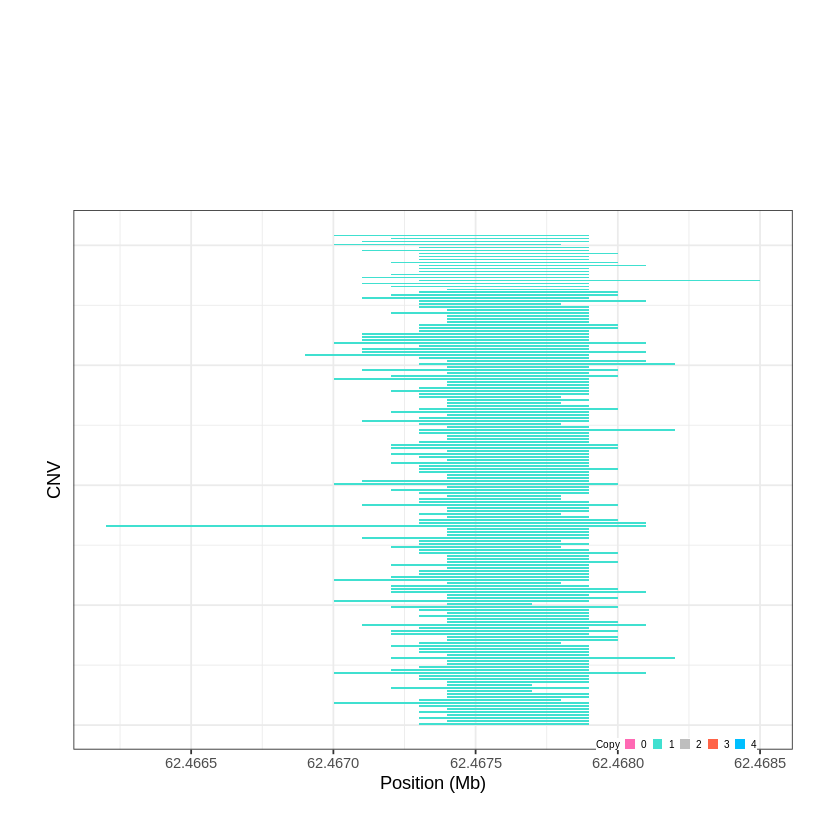

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1978..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.736501 - 62.7513 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


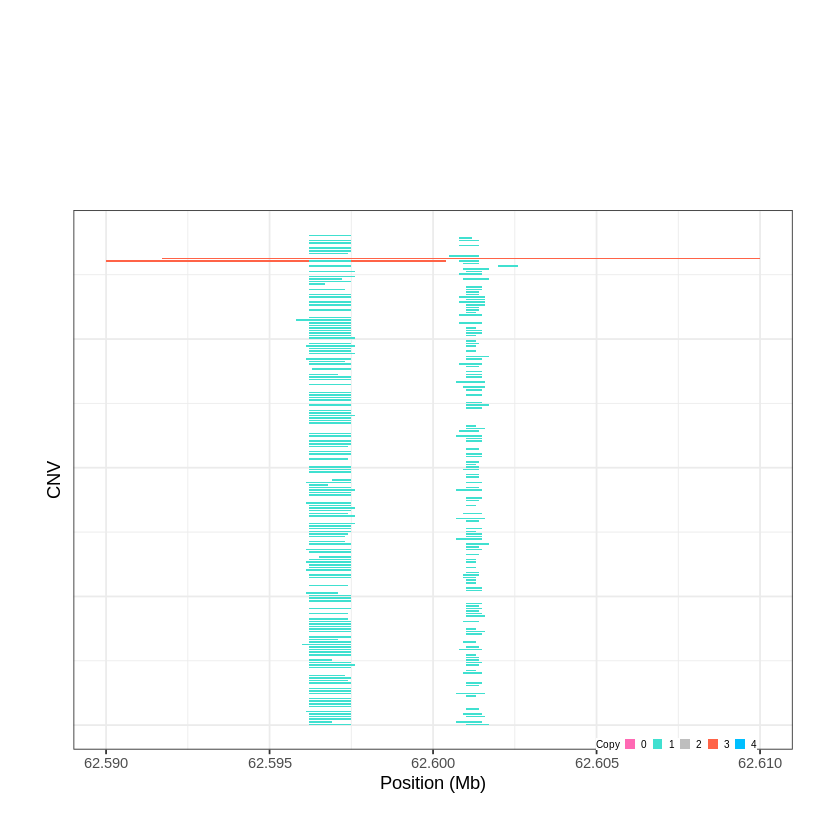

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1979..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.756901 - 62.7662 Mb with 232 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


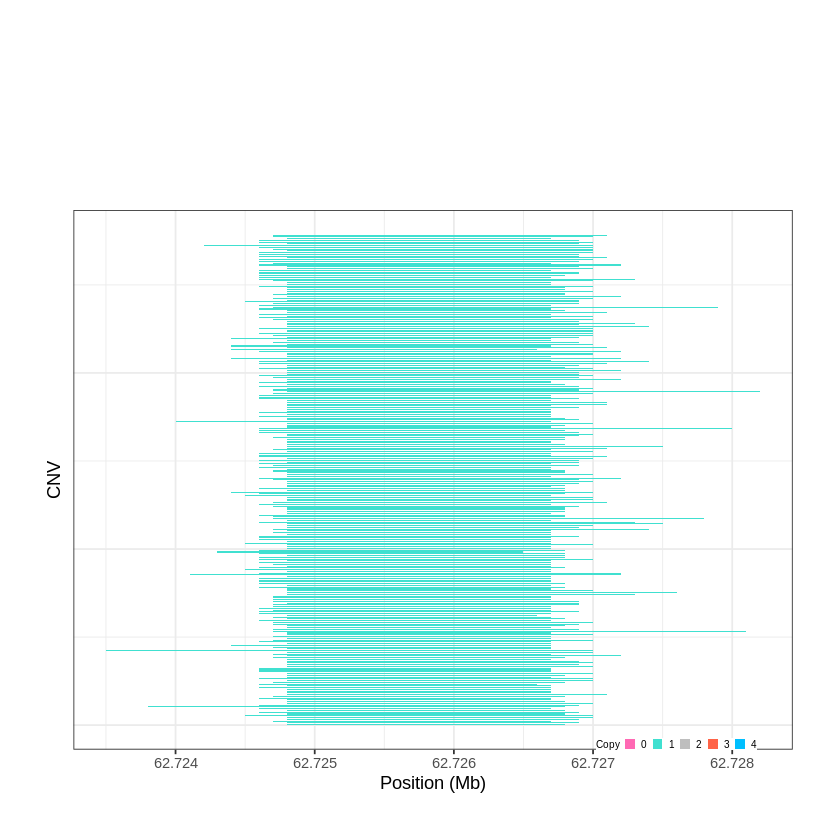

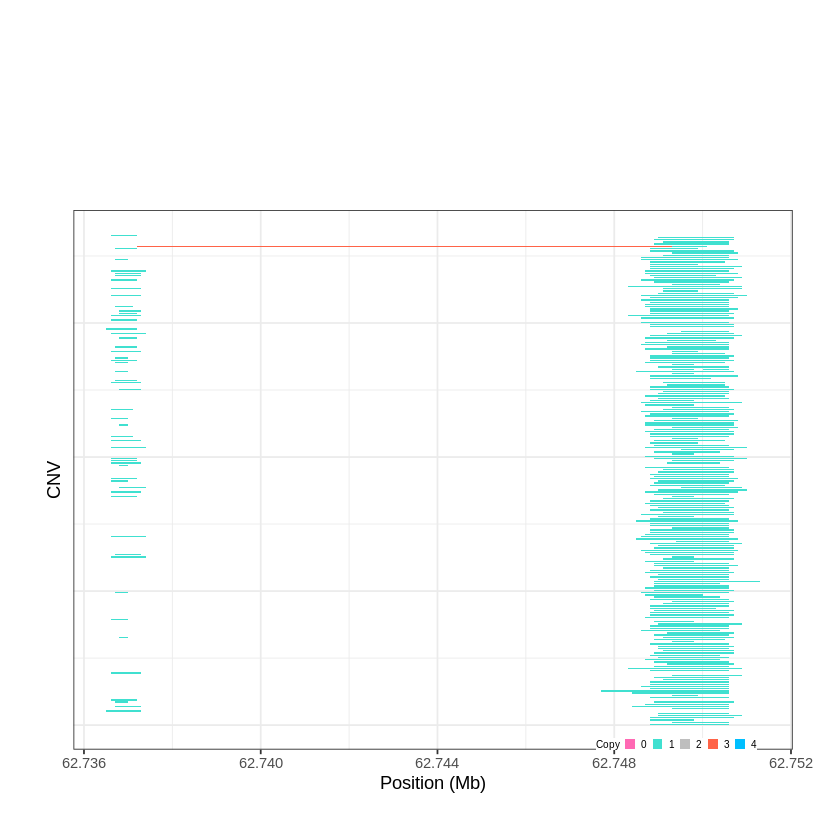

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1980..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.766801 - 62.7907 Mb with 232 Individual - "
Plotting gene...


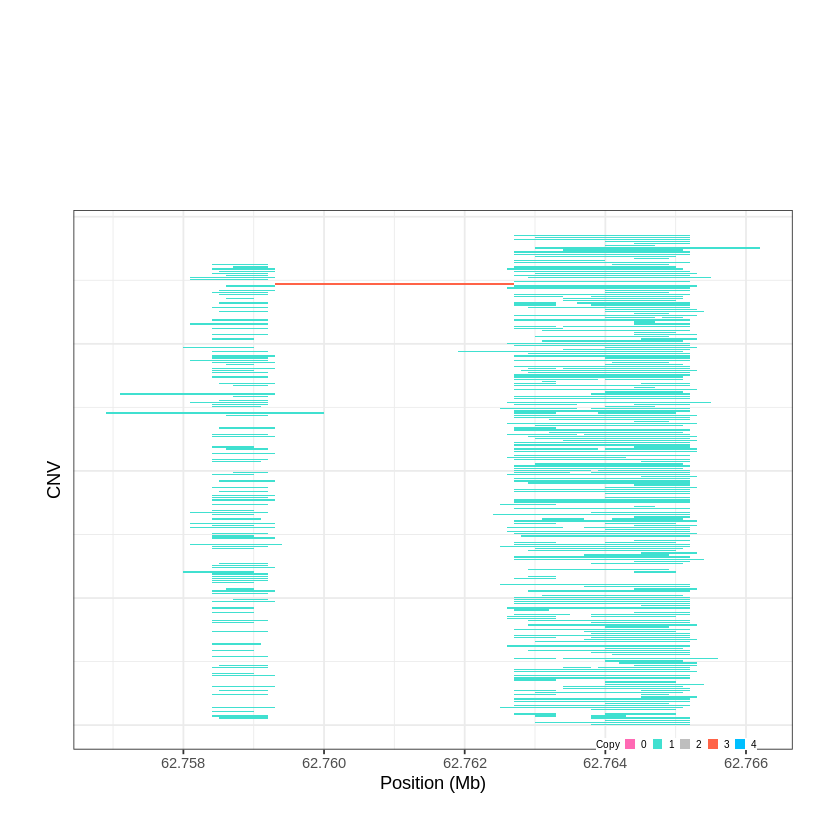

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1981..."
Input data passed requirment check...
[1] "CNV on Chromosome 20: 62.792501 - 63.0256 Mb with 279 Individual - "
Plotting gene...


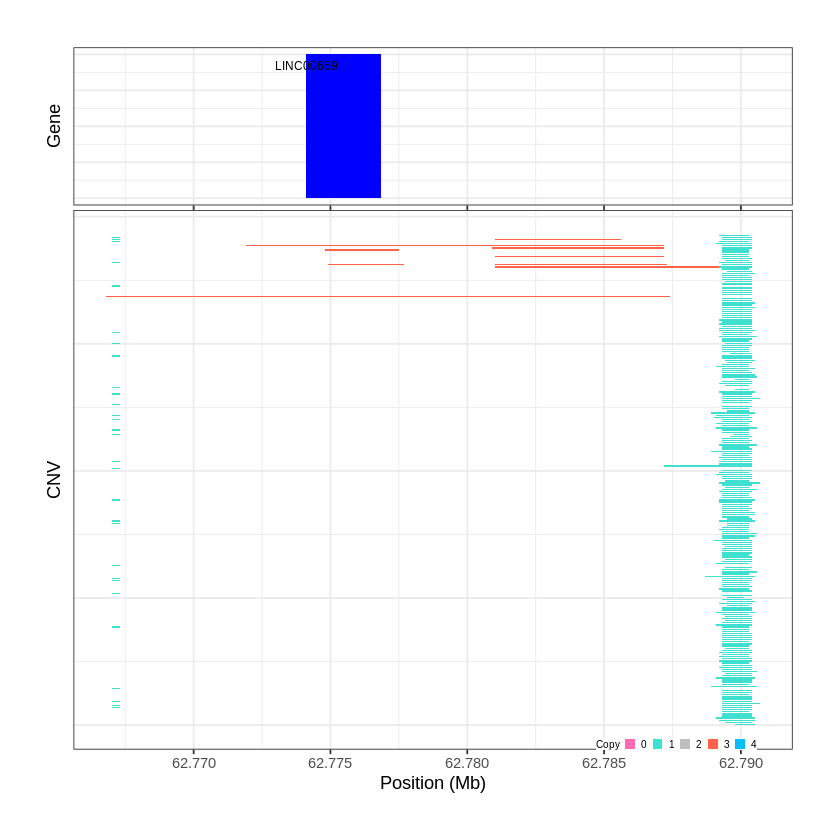

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1982..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 9.411201 - 10.0849 Mb with 279 Individual - "
Plotting gene...


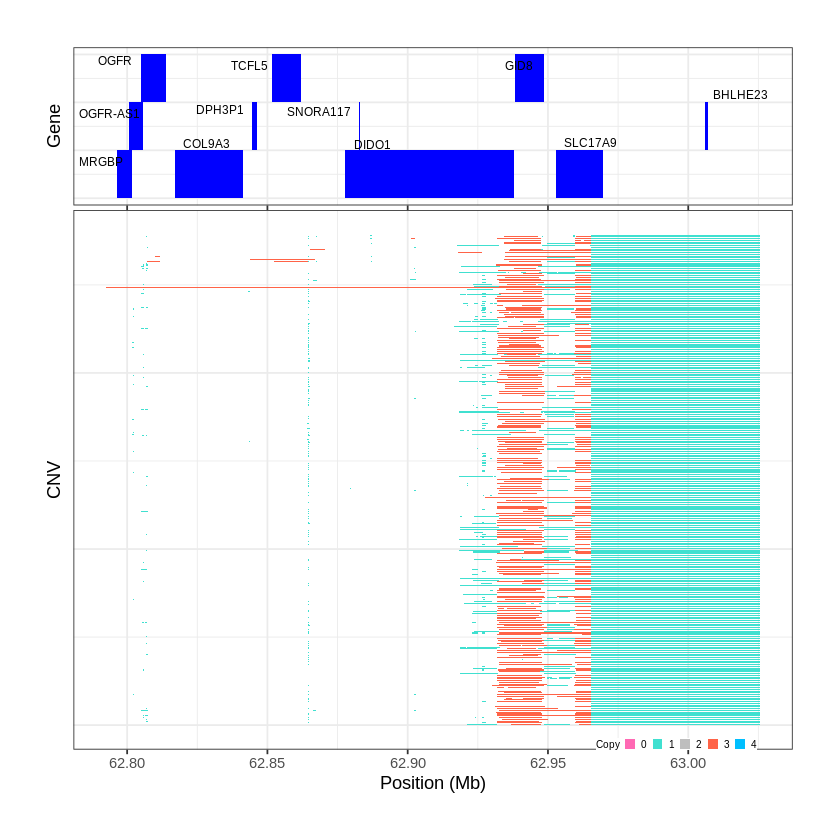

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1983..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 10.084901 - 14.558 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


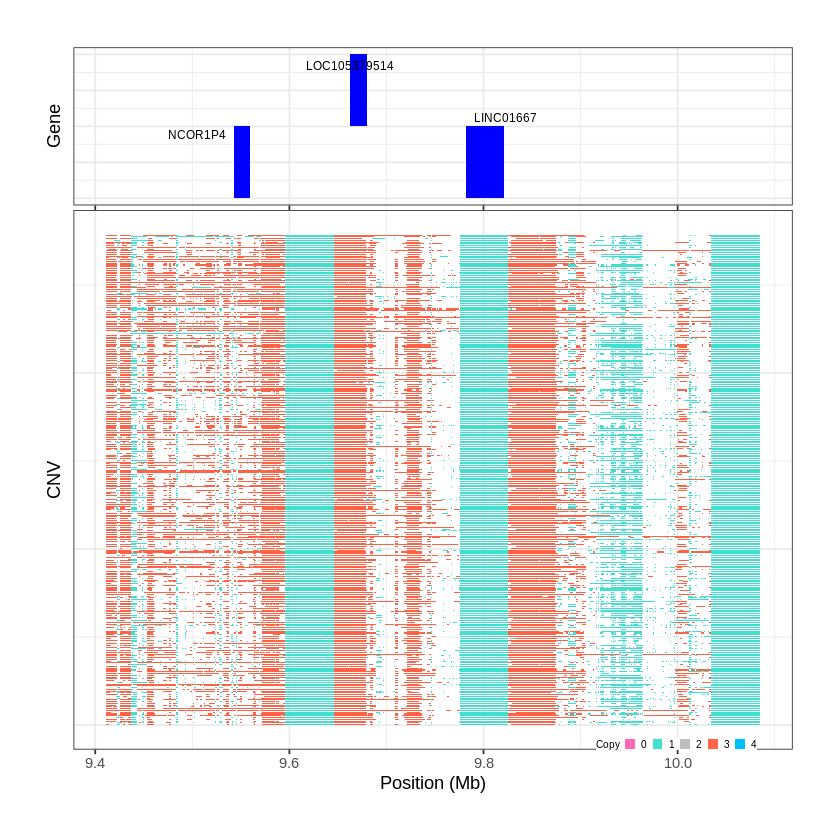

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1984..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 14.558001 - 15.6273 Mb with 279 Individual - "
Plotting gene...


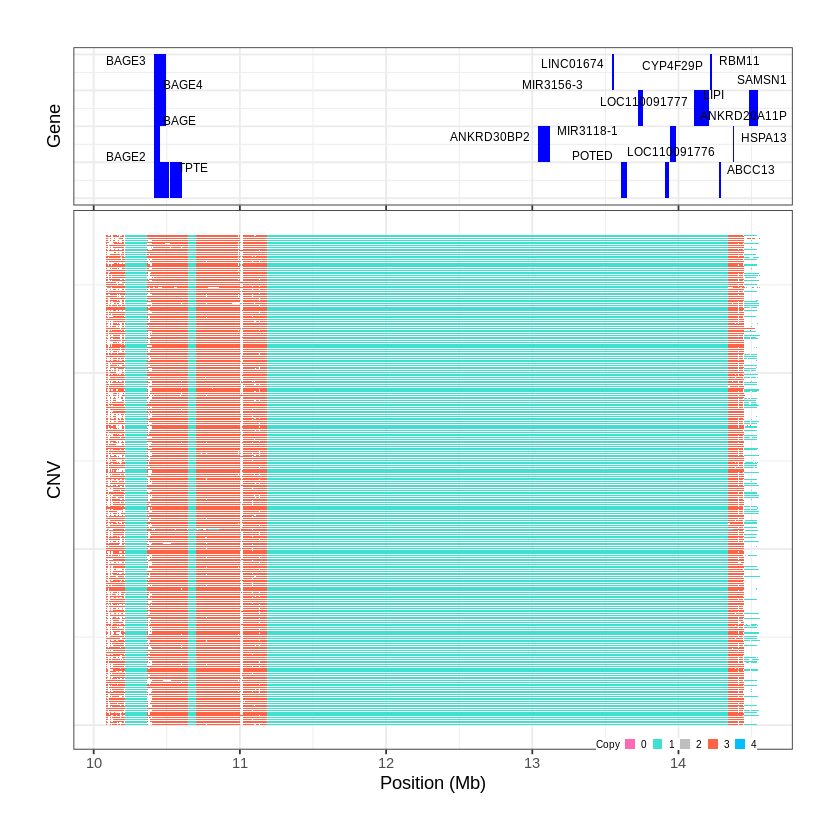

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1985..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 16.583101 - 16.6037 Mb with 140 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 1986..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 18.553401 - 18.6184 Mb with 187 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


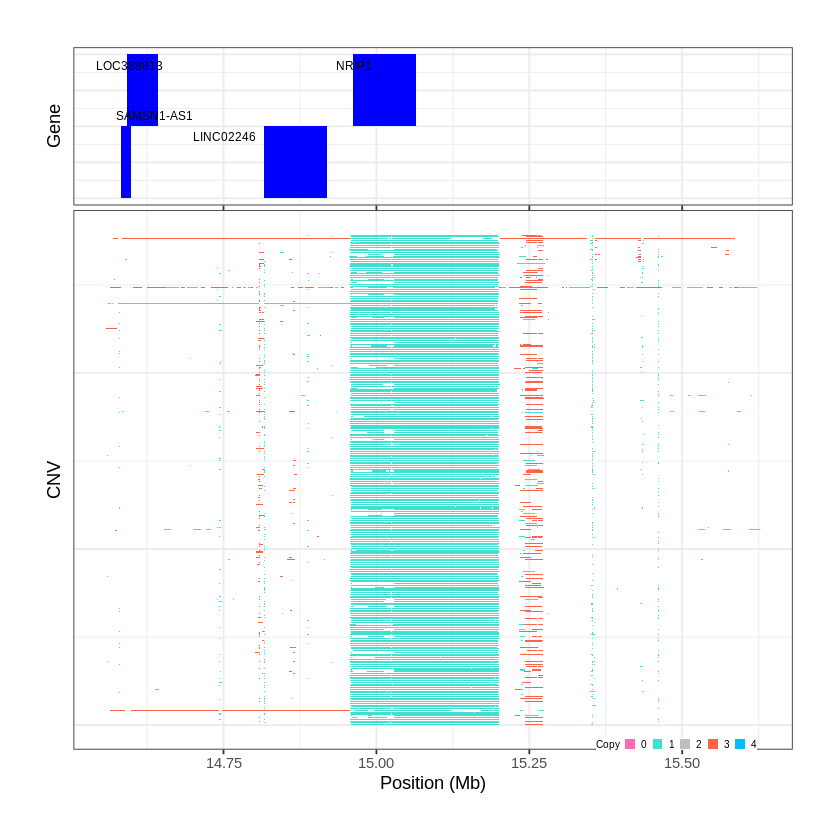

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1987..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 19.090901 - 19.1243 Mb with 160 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


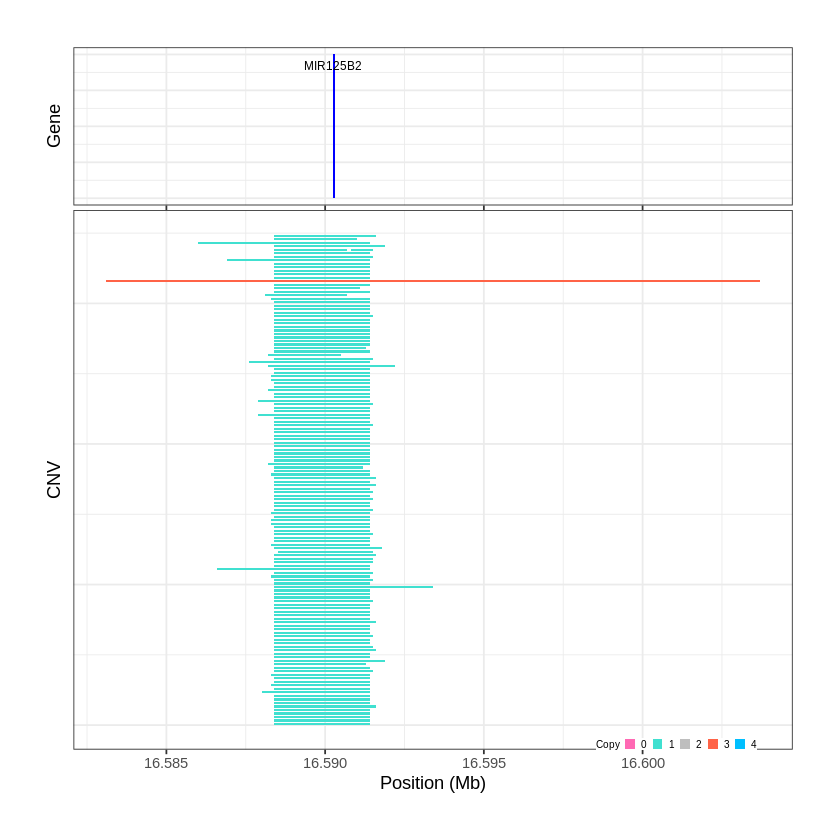

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1988..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 21.954301 - 21.9646 Mb with 169 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


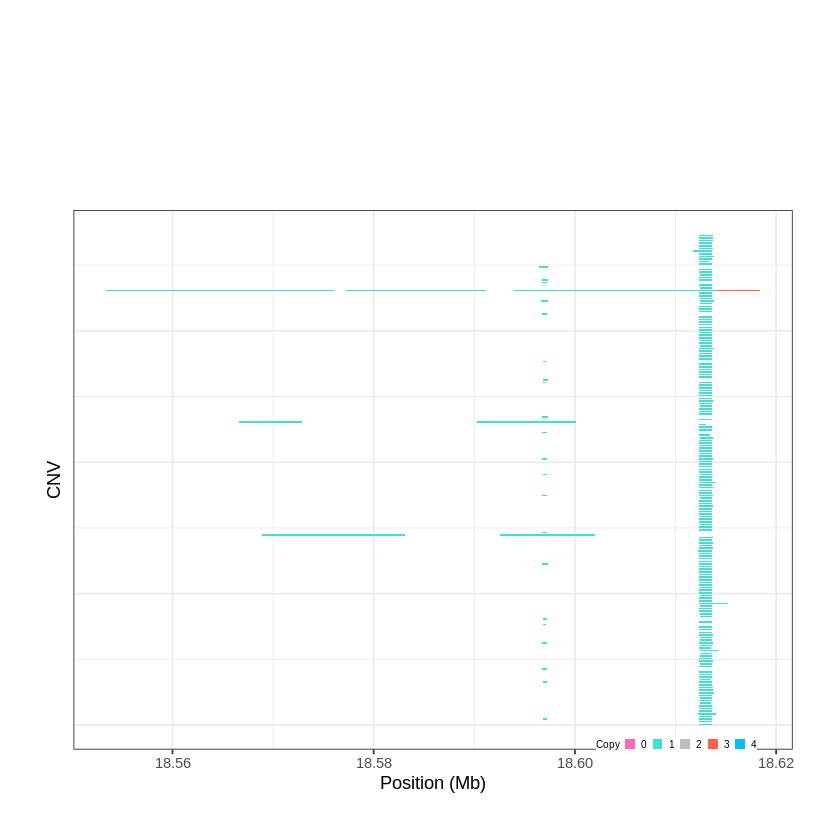

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1989..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 27.295901 - 27.2967 Mb with 161 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


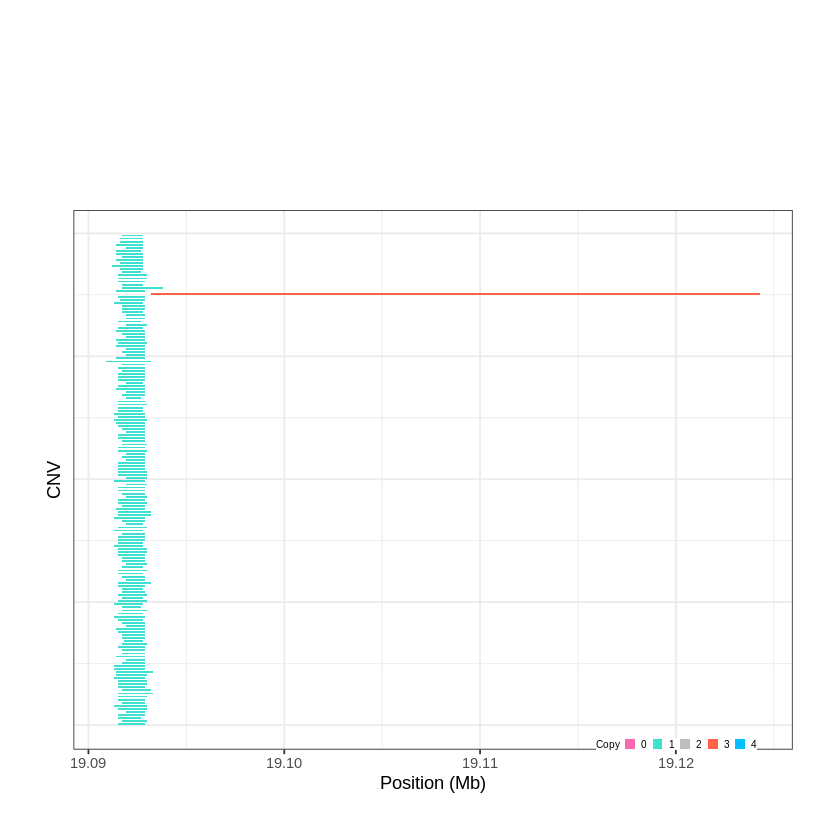

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1990..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 31.574801 - 31.5835 Mb with 175 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


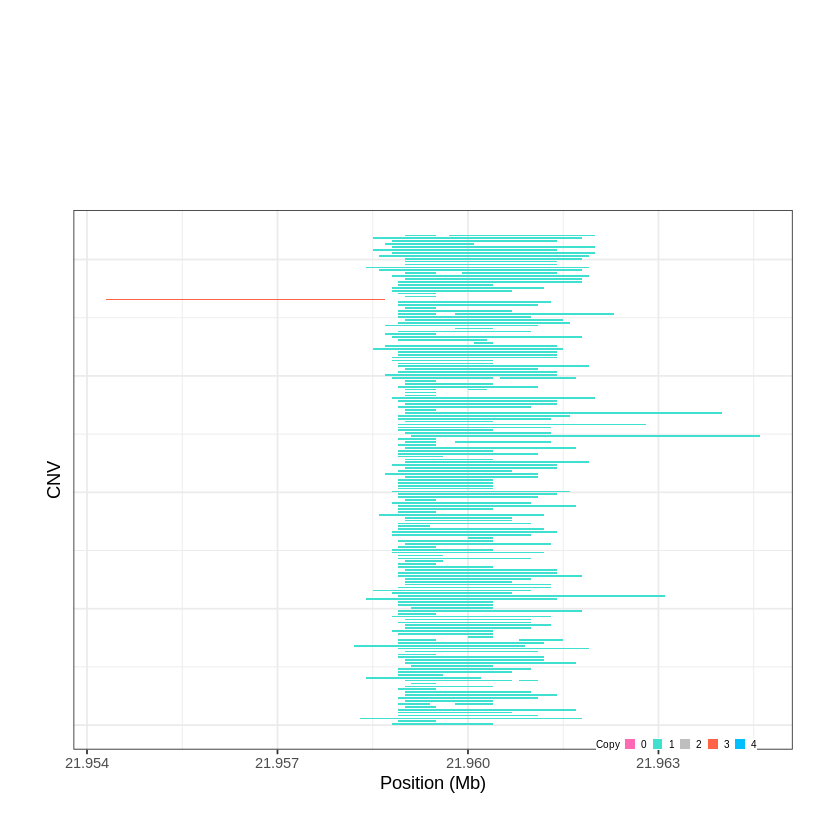

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1991..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 34.693601 - 34.7162 Mb with 219 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


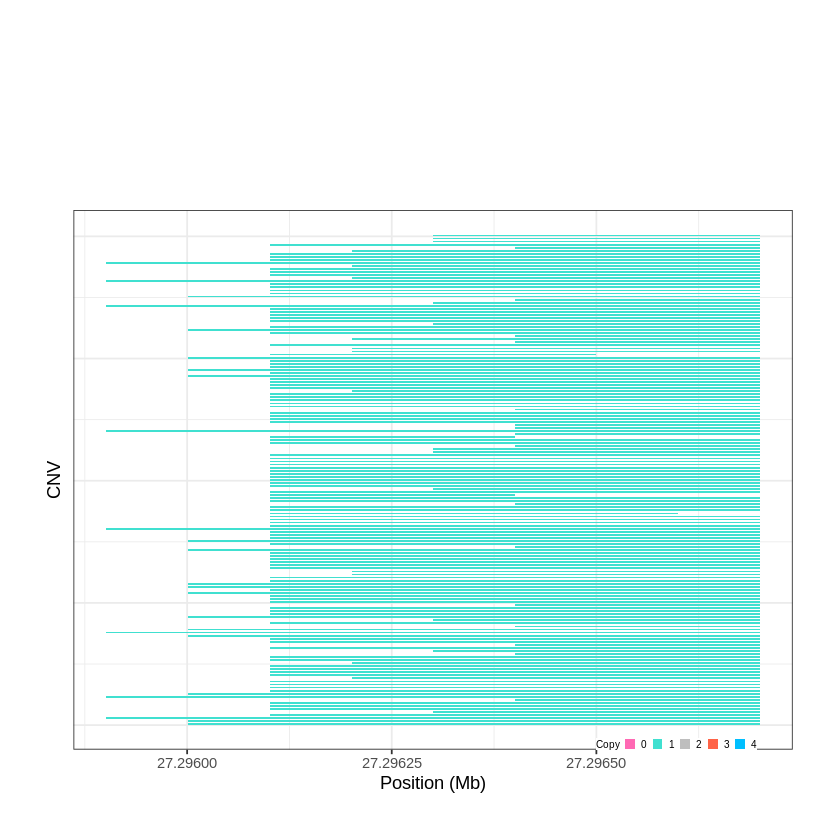

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1992..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 37.376701 - 37.3782 Mb with 167 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


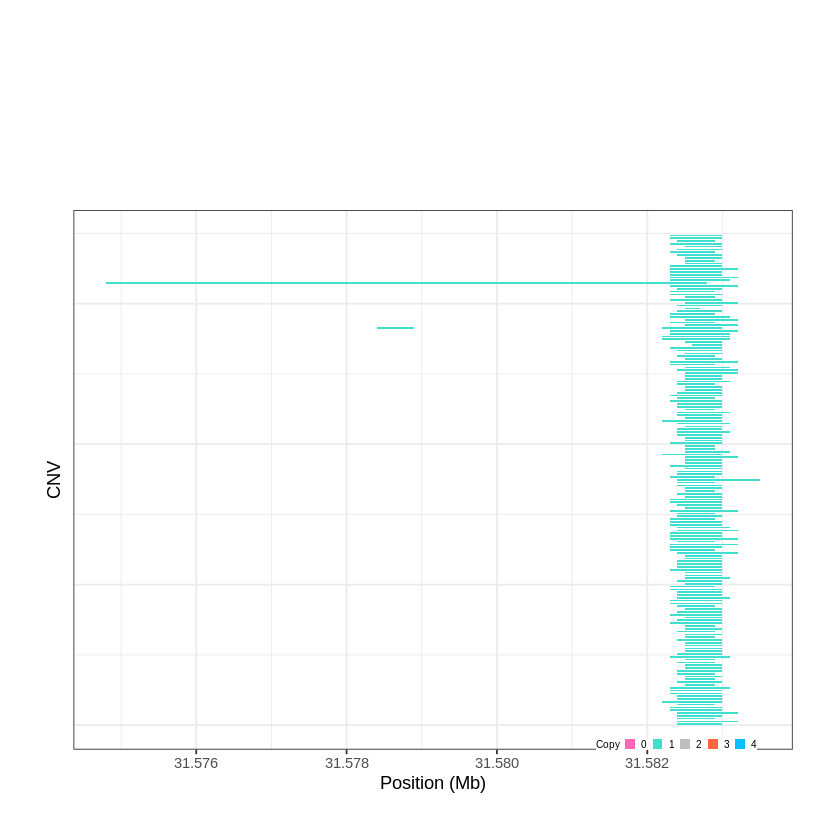

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1993..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 39.129201 - 39.1376 Mb with 249 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


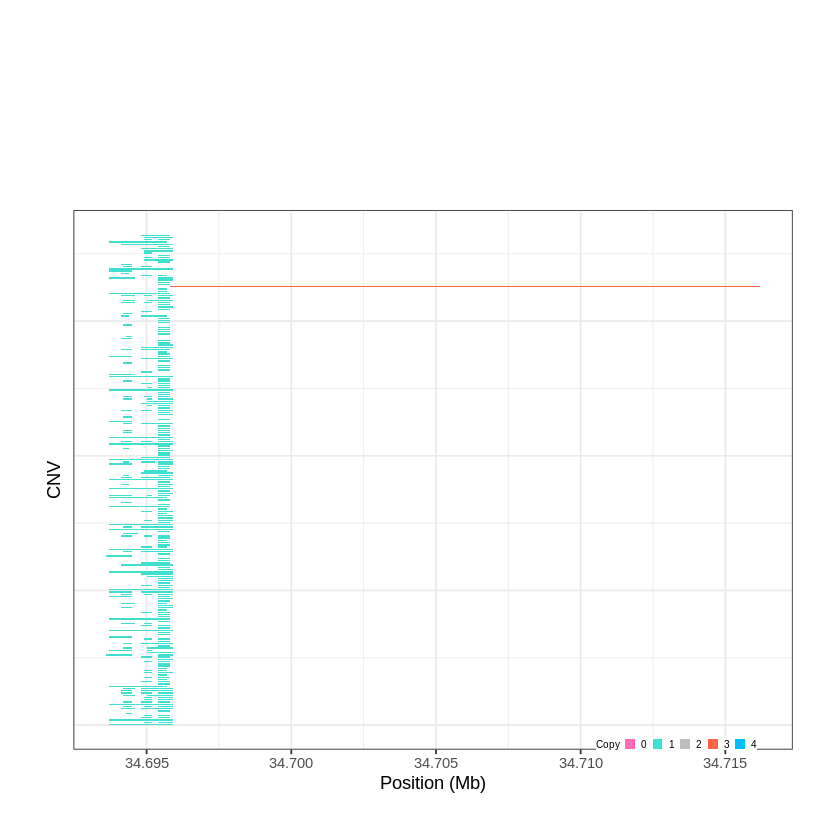

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1994..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 39.481101 - 39.4819 Mb with 149 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


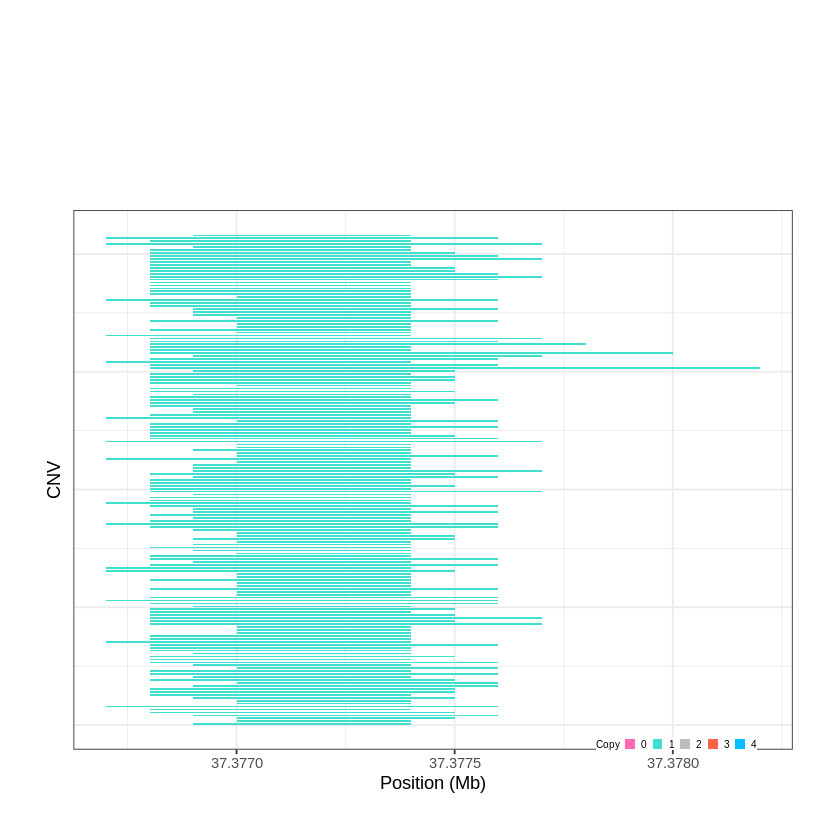

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1995..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 39.569501 - 39.5822 Mb with 190 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


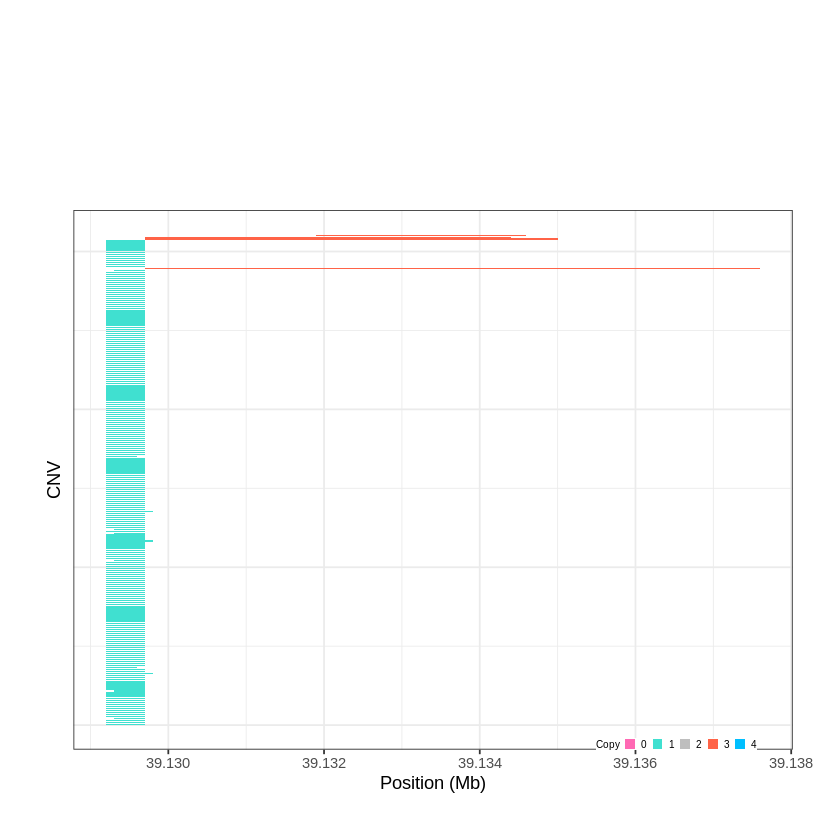

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1996..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 41.394901 - 41.4574 Mb with 220 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


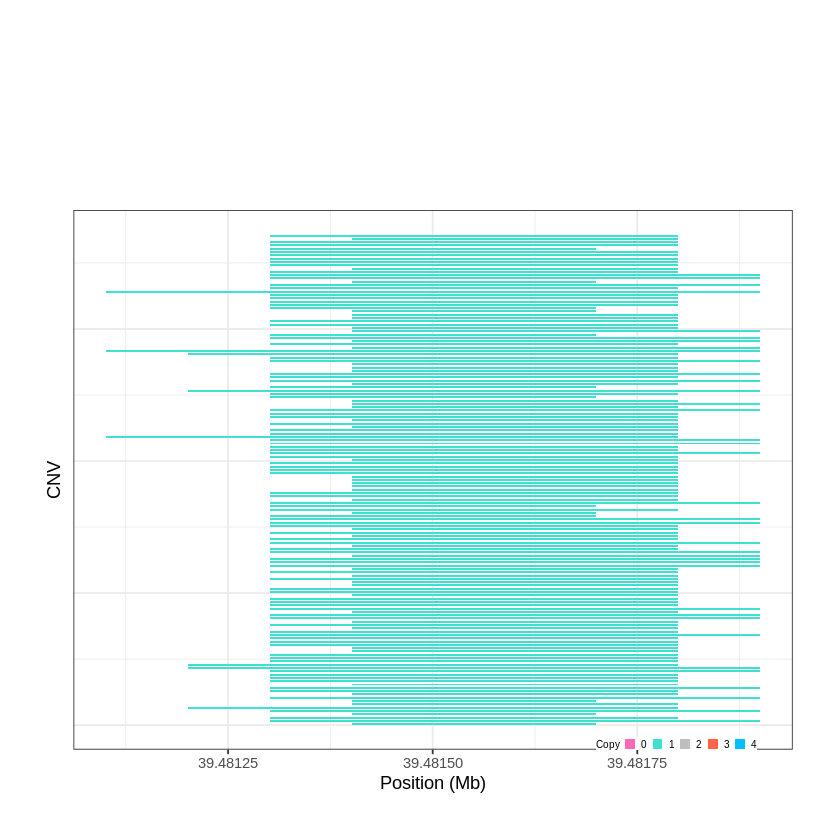

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1997..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 42.784301 - 42.8783 Mb with 278 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


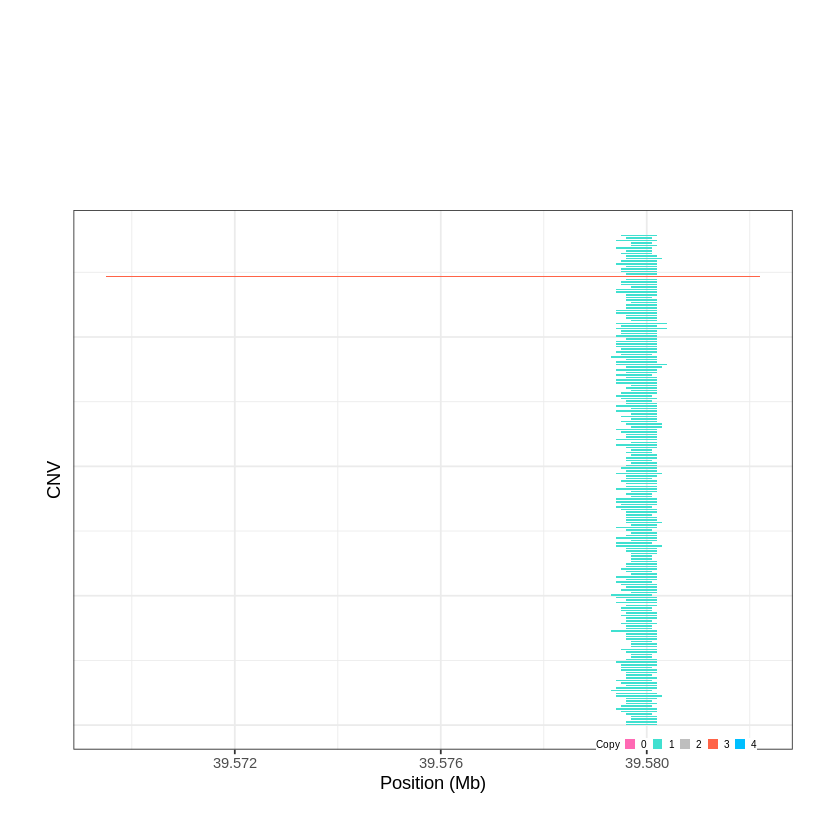

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1998..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 42.955201 - 43.0056 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


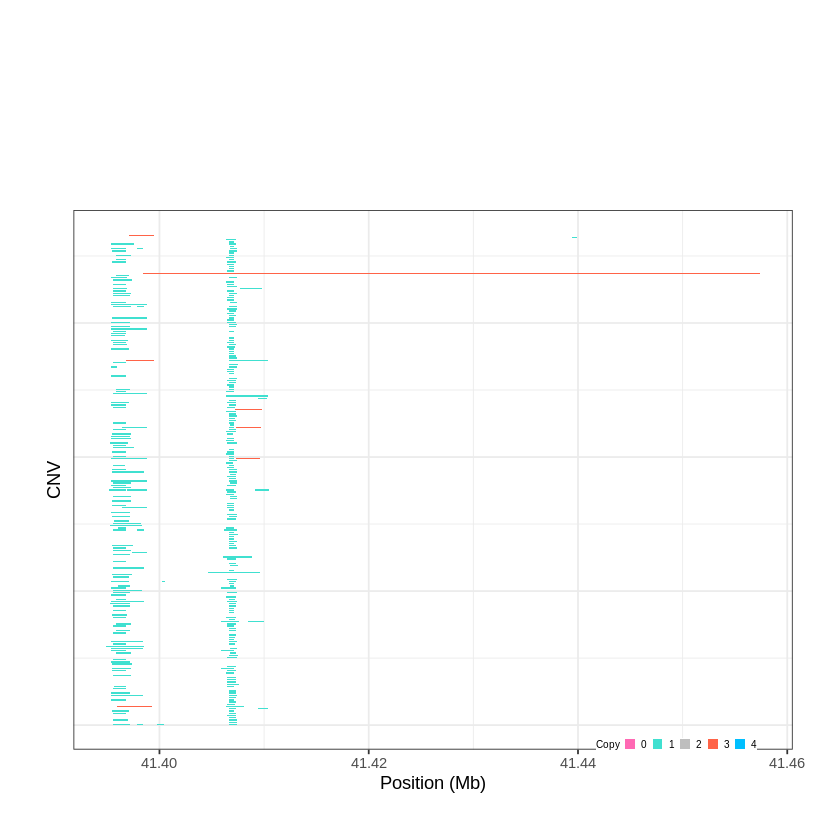

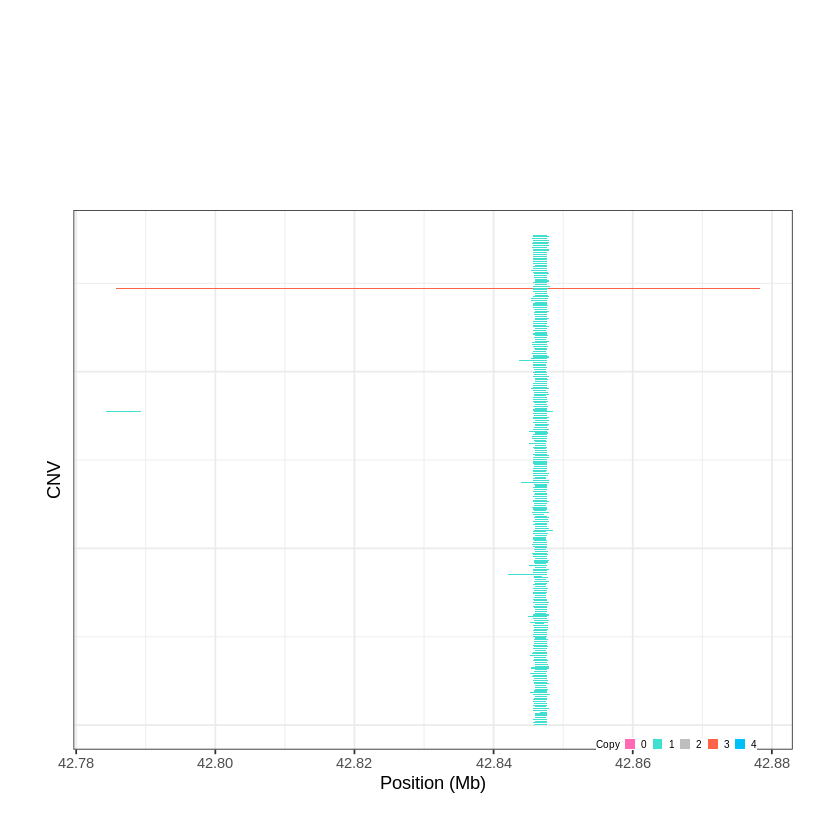

Task done, plot was stored in working directory.
[1] "Ploting CNVR 1999..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 43.005601 - 43.3996 Mb with 279 Individual - "
Plotting gene...


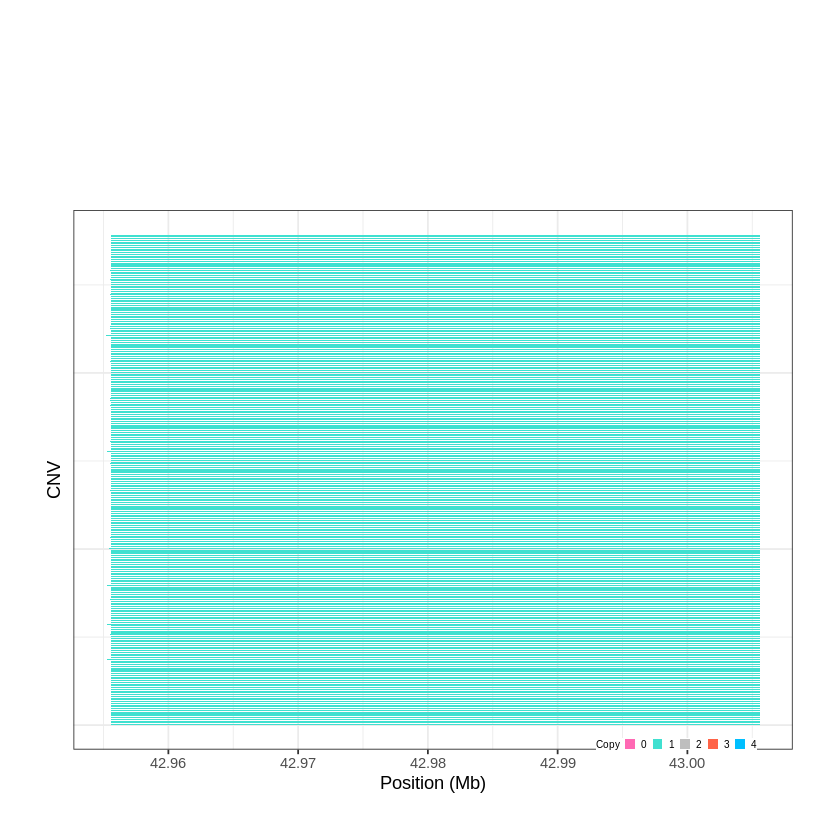

Task done, plot was stored in working directory.
[1] "Ploting CNVR 2000..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 43.678301 - 43.9227 Mb with 221 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2001..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 43.928801 - 44.0264 Mb with 170 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


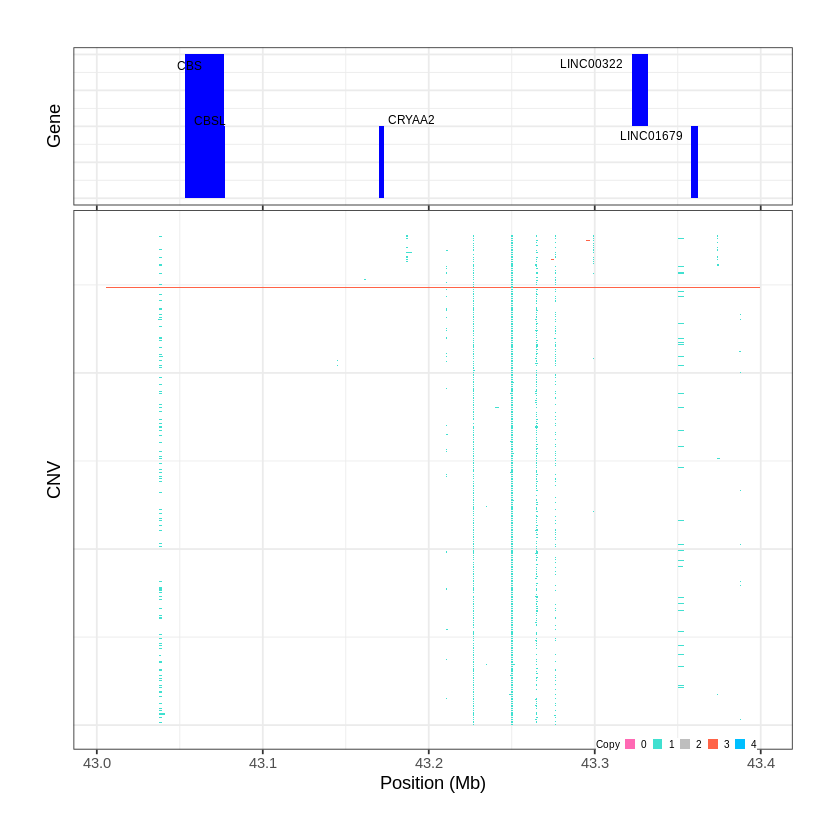

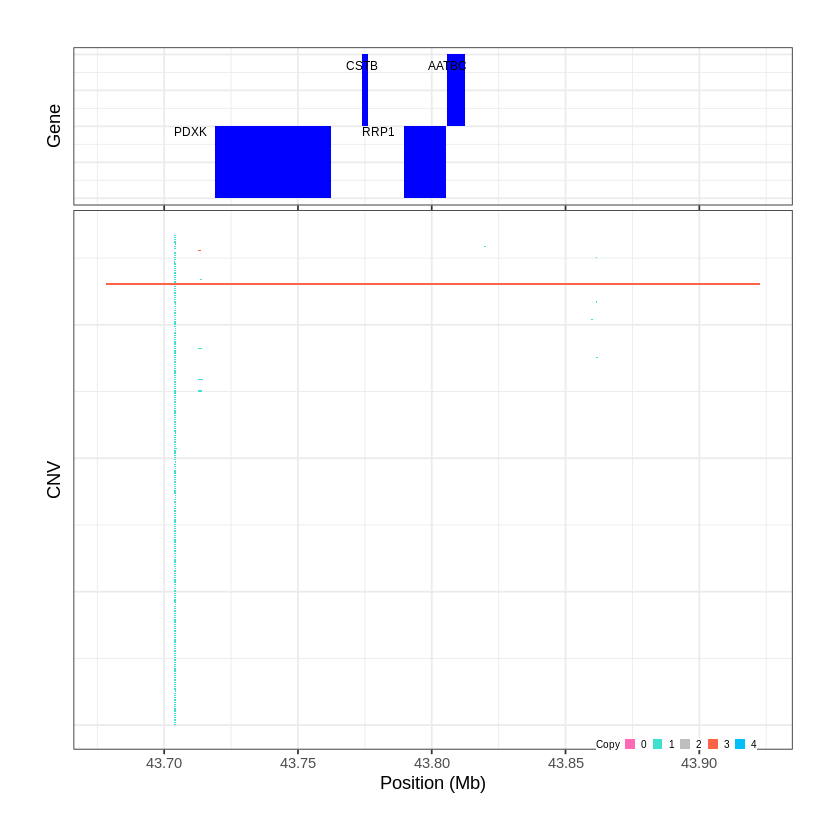

Task done, plot was stored in working directory.
[1] "Ploting CNVR 2002..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 44.038401 - 44.3363 Mb with 226 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2003..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 44.551801 - 44.8458 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2004..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 44.845801 - 45.0016 Mb with 248 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2005..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 45.003501 - 45.7842 Mb with 278 Individual - "
Plotting gene...


Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2006..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 45.791501 - 46.2391 Mb with 253 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2007..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 46.255501 - 46.2568 Mb with 228 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2008..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 46.258801 - 46.499 Mb with 230 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2009..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 46.616001 - 46.7195 Mb with 210 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2010..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 46.754701 - 46.7559 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2011..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 46.909101 - 46.9105 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2012..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 46.972701 - 46.9762 Mb with 274 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2013..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 47.061001 - 47.0655 Mb with 166 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2014..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 47.101001 - 47.3906 Mb with 250 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2015..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 47.395601 - 47.4004 Mb with 217 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2016..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 47.604201 - 47.6519 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2017..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 47.651901 - 47.6609 Mb with 158 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2018..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 47.745401 - 47.9895 Mb with 150 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2019..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 48.102601 - 48.1199 Mb with 202 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2020..."
Input data passed requirment check...
[1] "CNV on Chromosome 21: 48.119901 - 48.1299 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2021..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 16.050001 - 16.9373 Mb with 279 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2022..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 16.960001 - 17.0181 Mb with 279 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2023..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 17.022401 - 17.0604 Mb with 192 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2024..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 17.151701 - 17.2009 Mb with 279 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2025..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 17.239701 - 17.2815 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2026..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 17.360501 - 17.393 Mb with 246 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2027..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 17.920301 - 18.0625 Mb with 251 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2028..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 18.519801 - 19.3235 Mb with 279 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2029..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 19.544101 - 20.7078 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2030..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 20.708601 - 20.7324 Mb with 242 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2031..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 20.743401 - 22.1473 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 13 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2032..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 22.192201 - 23.2912 Mb with 279 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2033..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 23.398501 - 23.6701 Mb with 177 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2034..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 23.680201 - 25.511 Mb with 279 Individual - "
Plotting gene...


Warning message:
“ggrepel: 20 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2035..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 25.659601 - 25.9229 Mb with 179 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2036..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 26.341301 - 26.3495 Mb with 189 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2037..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 27.915301 - 28.2668 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2038..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 32.520401 - 32.6896 Mb with 146 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2039..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 32.718101 - 32.8103 Mb with 142 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2040..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 33.050301 - 33.0913 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2041..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 33.154201 - 33.1569 Mb with 221 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2042..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 33.295701 - 33.2961 Mb with 180 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2043..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 35.645101 - 35.8598 Mb with 185 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2044..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 37.119801 - 37.3553 Mb with 246 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2045..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 37.397001 - 38.3013 Mb with 160 Individual - "
Plotting gene...


Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2046..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 39.612601 - 40.1488 Mb with 216 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2047..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 41.501701 - 42.5403 Mb with 240 Individual - "
Plotting gene...


Warning message:
“ggrepel: 9 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2048..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 42.660301 - 42.8549 Mb with 232 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2049..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 42.895901 - 42.9938 Mb with 143 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2050..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 43.411901 - 43.7709 Mb with 260 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2051..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 44.203601 - 44.8968 Mb with 269 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2052..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 44.917501 - 45.5405 Mb with 203 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2053..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 45.569601 - 45.7417 Mb with 180 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2054..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 46.547401 - 47.6552 Mb with 275 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2055..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 47.916901 - 48.0565 Mb with 198 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2056..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 48.687101 - 49.5187 Mb with 278 Individual - "
Plotting gene...


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2057..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 49.530201 - 50.3117 Mb with 265 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2058..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 50.327901 - 50.3301 Mb with 238 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2059..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 50.359901 - 50.4148 Mb with 279 Individual - "
Plotting gene...
Task done, plot was stored in working directory.
[1] "Ploting CNVR 2060..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 50.750201 - 50.7559 Mb with 156 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2061..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 50.775401 - 50.7862 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2062..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 50.988501 - 51.0827 Mb with 231 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2063..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 51.111101 - 51.1226 Mb with 231 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.
[1] "Ploting CNVR 2064..."
Input data passed requirment check...
[1] "CNV on Chromosome 22: 51.168701 - 51.3046 Mb with 279 Individual - "
Plotting gene...
[1] "No gene in this region"


Warning message in as_grob.default(plot):
“Cannot convert object of class character into a grob.”


Task done, plot was stored in working directory.


In [37]:
cnvr_plot(cnvr = "cnvr_cnvnator/cnvr.txt", #standard file was generated by 'call_cnvr' function in section 4
          clean_cnv = "cnv_clean/cleancnv.cnv", #standard file was generated by 'cnv_clean' function in section 1
          refgene = "refgene/Human_hg38.txt", #standard file was generated by 'get_refgene' function in section 5.1
          sample_size = 279, #total sample size
          common_cnv_threshold = 0.5, #the CNV frequency threshold
          width_1 = 10, #optional, adjust the width of final plot
          height_1 = 10, #optional, adjust the height of final plot
          col_gene = "blue", #optional, adjust the colour of annotated genes
          gene_font_size = 2.5, #optional, adjust the font size of annotated gene names
          folder = "high_freq_cnvr_cnvnator")

In [39]:
cnv_visual(clean_cnv = "call_gene_CNVNator_Hg38/cnv_annotation.txt", #here we need the annotated CNV list, generated by 'call_gene' in section 5.2
           target_gene = "AKNAD1", #set the gene name we are interested in
           col_0 = "darkorchid4",  #optional, customize colour for o copy CNV 
           col_1 = "dodgerblue3",  #optional, customize colour for 1 copy CNV 
           col_3 = "violetred3",  #optional, customize colour for 3 copy CNV 
           col_4 = "orangered3",  #optional, customize colour for 4 copy CNV
           width_1 = 13, #adjust the width of final plot
           height_1 = 10, #adjust the width of final plot
           folder = "cnv_visual")

Renamed 'CNV_Start' and 'CNV_End' as 'Start' and 'End', input data passed requirment check...
Task done, plot was stored in working directory.


<h1> CNVR analysis 

In [4]:
individual_cnv_cnvr <- read.table("/branchinecta/jbazanwilliamson/cnvr_cnvnator/individual_cnv_cnvr.txt", header=TRUE)

individual_cnv_cnvr

Chr,Start,End,CNVR_ID,Sample_ID,CNV_Start,CNV_End,CNV_Value,Length
<int>,<int>,<dbl>,<chr>,<chr>,<int>,<dbl>,<int>,<dbl>
1,1,900700,CNVR_1,LP6005441-DNA_A01,1,10000,1,10000
1,1,900700,CNVR_1,LP6005441-DNA_A01,11601,18400,3,6800
1,1,900700,CNVR_1,LP6005441-DNA_A01,39901,48200,1,8300
1,1,900700,CNVR_1,LP6005441-DNA_A01,49001,49700,1,700
1,1,900700,CNVR_1,LP6005441-DNA_A01,51201,64200,1,13000
1,1,900700,CNVR_1,LP6005441-DNA_A01,64601,65000,1,400
1,1,900700,CNVR_1,LP6005441-DNA_A01,69401,70900,1,1500
1,1,900700,CNVR_1,LP6005441-DNA_A01,71801,92900,1,21100
1,1,900700,CNVR_1,LP6005441-DNA_A01,98001,100000,1,2000


In [5]:
CNVR_cnvnator <- dcast(individual_cnv_cnvr, CNVR_ID ~ Sample_ID, value.var="CNV_Value", fun.aggregate=mean)
CNVR_cnvnator

Warning message in dcast(individual_cnv_cnvr, CNVR_ID ~ Sample_ID, value.var = "CNV_Value", :
“The dcast generic in data.table has been passed a data.frame and will attempt to redirect to the reshape2::dcast; please note that reshape2 is deprecated, and this redirection is now deprecated as well. Please do this redirection yourself like reshape2::dcast(individual_cnv_cnvr). In the next version, this warning will become an error.”


CNVR_ID,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,LP6005441-DNA_A10,LP6005441-DNA_A11,⋯,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CNVR_1,1.235294,1.526316,1.322581,1.3125,1.415094,1.758621,1.818182,1.941176,1.518519,⋯,1.695652,1.5,1.875,1.869565,2.111111,2.103448,1.5625,1.756757,1.774194,1.645161
CNVR_10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,⋯,NaN,NaN,1.000,NaN,NaN,NaN,1.0000,1.000000,1.000000,1.000000
CNVR_100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CNVR_1000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,⋯,NaN,1.0,NaN,1.000000,NaN,NaN,1.0000,NaN,1.000000,1.000000
CNVR_10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CNVR_10001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CNVR_10002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CNVR_10003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CNVR_10004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,⋯,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [138]:
dt = as.data.table(cnv) # or convert in place using setDT

dt = dt[, .(Start = min(Start), End = max(End), CNV_Value = CNV_Value[1])
   , by = .(Sample_ID, Chr, rleid(CNV_Value),
            cumsum(c(FALSE, head(End + 500, -1) < tail(Start, -1))))]

In [131]:
cnv[order(cnv$Chr, cnv$Start, cnv$End),]

,Sample_ID,Chr,Start,End,CNV_Value
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,LP6005441-DNA_A01,1,1,10000,1
5613,LP6005441-DNA_A03,1,1,10000,1
11022,LP6005441-DNA_A04,1,1,10000,1
17154,LP6005441-DNA_A05,1,1,10000,1
23718,LP6005441-DNA_A06,1,1,10000,1
32753,LP6005441-DNA_A08,1,1,10000,1
38791,LP6005441-DNA_A09,1,1,10000,1
43808,LP6005441-DNA_A10,1,1,10000,1
48764,LP6005441-DNA_A11,1,1,10000,1


In [132]:
dt[order(dt$Chr, dt$Start, dt$End),]

Sample_ID,Chr,rleid,cumsum,Start,End,CNV_Value
<chr>,<dbl>,<int>,<int>,<dbl>,<dbl>,<dbl>
LP6005441-DNA_A01,1,1,0,1,10000,1
LP6005441-DNA_A03,1,915,5289,1,10000,1
LP6005441-DNA_A04,1,1953,10429,1,10000,1
LP6005441-DNA_A05,1,2935,16273,1,10000,1
LP6005441-DNA_A06,1,4029,22533,1,10000,1
LP6005441-DNA_A08,1,5107,31130,1,10000,1
LP6005441-DNA_A09,1,6211,36907,1,10000,1
LP6005441-DNA_A10,1,7097,41698,1,10000,1
LP6005441-DNA_A11,1,8043,46429,1,10000,1


In [137]:
dt %>%
  pivot_wider(names_from =Sample_ID, values_from = CNV_Value)

Warning message:
“Values from `CNV_Value` are not uniquely identified; output will contain list-cols.
* Use `values_fn = list` to suppress this warning.
* Use `values_fn = {summary_fun}` to summarise duplicates.
* Use the following dplyr code to identify duplicates.
  {data} %>%
    dplyr::group_by(Chr, rleid, cumsum, Start, End, Sample_ID) %>%
    dplyr::summarise(n = dplyr::n(), .groups = "drop") %>%
    dplyr::filter(n > 1L)”


Chr,rleid,cumsum,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,⋯,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
<dbl>,<int>,<int>,<dbl>,<dbl>,<list>,<list>,<list>,<list>,<list>,⋯,<list>,<list>,<list>,<list>,<list>,<list>,<list>,<list>,<list>,<list>
1,1,0,1,10000,1,NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL
1,2,1,11601,18400,3,NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL
1,3,2,39901,48200,1,NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL
1,3,3,49001,49700,1,NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL
1,3,4,51201,65000,"1, 1",NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL
1,3,5,69401,70900,1,NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL
1,3,6,71801,92900,1,NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL
1,3,7,98001,100000,1,NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL
1,3,8,100601,104200,1,NULL,NULL,NULL,NULL,⋯,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL,NULL


In [139]:
result = dcast(dt, Chr + Start + End ~ Sample_ID, value.var="CNV_Value", fun.aggregate=sum)

In [117]:
#result[order(result$Chr, result$Start, result$End),] #100

,Chr,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,⋯,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,1,10000,1,1,1,1,1,1,1,⋯,1,0,1,1,1,1,1,0,1,1
81014,1,1,11600,0,0,0,0,0,0,0,⋯,0,1,0,0,0,0,0,1,0,0
775800,1,10501,11000,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
754917,1,10501,11200,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
202822,1,10501,11500,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
513811,1,10501,11600,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
197487,1,10701,11100,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
616002,1,10701,11200,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
152730,1,10701,11600,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0


In [153]:
dt = as.data.table(cnv) # or convert in place using setDT

dt = dt[, .(Start = min(Start), End = max(End))#, CNV_Value = CNV_Value[1])
   , by = .(Sample_ID, Chr, CNV_Value,
            cumsum(c(FALSE, head(End + 300, 1) < tail(Start, -1))))]

In [155]:
result = dcast(dt, Chr + Start + End ~ Sample_ID, value.var="CNV_Value", fun.aggregate=sum)

In [156]:
result[order(result$Chr, result$Start, result$End),]

,Chr,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,⋯,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,1,10000,1,1,1,1,1,1,1,⋯,1,0,1,1,1,1,1,0,1,1
81049,1,1,11600,0,0,0,0,0,0,0,⋯,0,1,0,0,0,0,0,1,0,0
776136,1,10501,11000,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
755252,1,10501,11200,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
202901,1,10501,11500,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
514053,1,10501,11600,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
197565,1,10701,11100,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
616299,1,10701,11200,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
152794,1,10701,11600,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
